# Geração da rede convolucional

A fim de se investigar a interpretabilidade dos resultados de uma rede neural, foi treinada uma rede convolucional para classificação de dígitos de 0 a 9 com o dataset da base do MNIST. O código utilizado é exibido abaixo.

In [1]:
import keras

mnist = keras.datasets.mnist
(x_train, y_train),(x_test, y_test) = mnist.load_data()
x_train = x_train.reshape(x_train.shape[0], 28, 28, 1)
x_test = x_test.reshape(x_test.shape[0], 28, 28, 1)
x_train, x_test = x_train / 255.0, x_test / 255.0

model = keras.models.Sequential()
model.add(keras.layers.Conv2D(32, kernel_size=(3, 3), activation='relu',input_shape=(28, 28, 1),name='nome_exclusivo_00'))
model.add(keras.layers.Conv2D(64, (3, 3), activation='relu',name='nome_exclusivo_01'))
model.add(keras.layers.MaxPooling2D(pool_size=(2, 2),name='nome_exclusivo_02'))
model.add(keras.layers.Dropout(0.25,name='nome_exclusivo_03'))
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(128, activation='relu',name='nome_exclusivo_04'))
model.add(keras.layers.Dropout(0.5))
model.add(keras.layers.Dense(10, activation='softmax',name='nome_exclusivo_05'))

model.get_config()

model.compile(optimizer='adam',loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, epochs=5)
evaluation = model.evaluate(x_test, y_test)

model.save('mnist_model.h5')

Using TensorFlow backend.
W0628 00:12:04.999936 140234310838080 deprecation_wrapper.py:119] From /home/patrick/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0628 00:12:05.012202 140234310838080 deprecation_wrapper.py:119] From /home/patrick/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0628 00:12:05.015629 140234310838080 deprecation_wrapper.py:119] From /home/patrick/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0628 00:12:05.051232 140234310838080 deprecation_wrapper.py:119] From /home/patrick/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d

Epoch 1/5
60000/60000 [==============================] - 118s 2ms/step - loss: 0.1899 - acc: 0.9415
Epoch 2/5
60000/60000 [==============================] - 112s 2ms/step - loss: 0.0813 - acc: 0.9756
Epoch 3/5
60000/60000 [==============================] - 117s 2ms/step - loss: 0.0611 - acc: 0.9819
Epoch 4/5
60000/60000 [==============================] - 110s 2ms/step - loss: 0.0512 - acc: 0.9843
Epoch 5/5
10000/10000 [==============================] - 3s 335us/step


# 1a) Diferentes métodos de interpretabilidade

Executamos os métodos intitulados na figura abaixo de forma que pudéssemos ver as ênfases nas ativações que cada um produzia na entrada em função da saída obtida para 3 classes escolhidas (duas amostras de cada, entre 0, 9 e 5).

Nota-se que o método do gradiente aponta as regiões de maior ativação de maneira relativamente dispersa, enquanto que métodos como o Deep Taylor dão uma ênfase bem definida na região onde se obtém maior ativação pra cada classe.

Para LRPAAlphaBeta, utilizamos alpha=2 e beta=1, obedecendo a regra de 1 unidade de diferença entre estes valores e verificando que nos permitia verificar o dígito esperado na entrada. Para LRPAEpsilon, utilizamos epsilon igual a 1, pois este valor parecia dar mais vizualização que os valores vizinhos.

(imagem no final da execução do código)

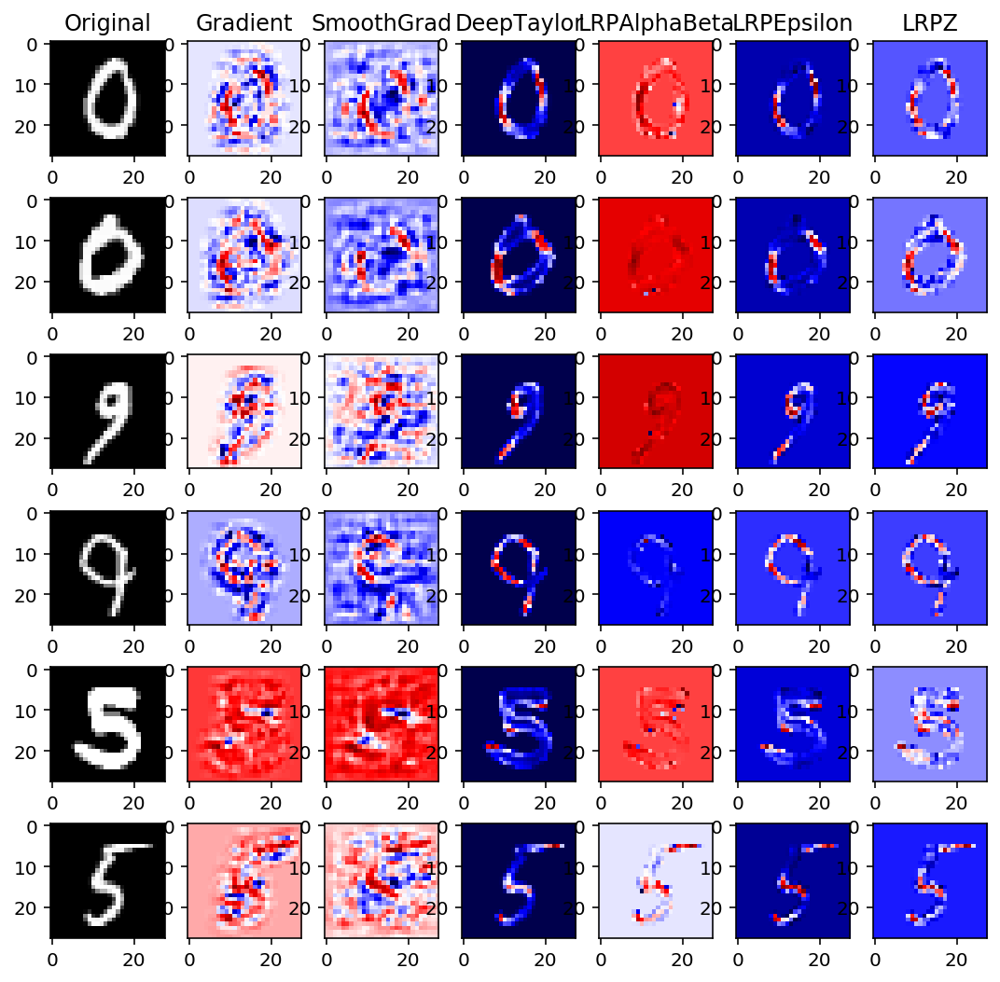

In [2]:
import keras
import innvestigate
import matplotlib.pyplot as plot
import matplotlib
import tensorflow as tf



# Comandos para exibir imagem no jupyter
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

mnist = keras.datasets.mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train = x_train.reshape(x_train.shape[0], 28, 28, 1)
x_test = x_test.reshape(x_test.shape[0], 28, 28, 1)
x_train, x_test = x_train / 255.0, x_test / 255.0

model = keras.models.load_model('mnist_model.h5')
model_wo_sm = innvestigate.utils.keras.graph.model_wo_softmax(model)

# Cada indice do vetor x_test contem uma imagem. Aqui definimos quais acessaremos.
# Sei que defini mais imagens do que o requisitado, mas o vetor itneiro so sera usado caso se torne conveniente.
imagensParaAnalisar = [1001,3,1000,999,1003,2003,3000,3003,4000,4003,5000,5003]


# 'i' itera sobre as COLUNAS do subplot que estamos construindo.
# Cada coluna exibe as imagens de uma classe (um numero).
i=0;
while i<6: 
    imagem = x_test[imagensParaAnalisar[i]:imagensParaAnalisar[i]+1]
    
    eixo = plot.subplot(6,7,1+7*i)
    if i==0: eixo.set_title("Original") 
    plot.imshow(imagem.squeeze(), cmap='gray', interpolation='nearest')


    eixo = plot.subplot(6,7,2+7*i)
    analyzer = innvestigate.analyzer.Gradient(model=model_wo_sm)
    analysis = analyzer.analyze(imagem)
    if i==0: eixo.set_title("Gradient") 
    plot.imshow(analysis.squeeze(), cmap='seismic', interpolation='nearest')
    
    eixo = plot.subplot(6,7,3+7*i)
    analyzer = innvestigate.analyzer.SmoothGrad(model=model_wo_sm)
    analysis = analyzer.analyze(imagem)
    if i==0: eixo.set_title("SmoothGrad") 
    plot.imshow(analysis.squeeze(), cmap='seismic', interpolation='nearest')
    
    eixo = plot.subplot(6,7,4+7*i)
    analyzer = innvestigate.analyzer.DeepTaylor(model=model_wo_sm)
    analysis = analyzer.analyze(imagem)
    if i==0: eixo.set_title("DeepTaylor") 
    plot.imshow(analysis.squeeze(), cmap='seismic', interpolation='nearest')
    
    eixo = plot.subplot(6,7,5+7*i)
    analyzer = innvestigate.analyzer.LRPAlphaBeta(model=model_wo_sm, alpha=2, beta=1)
    analysis = analyzer.analyze(imagem)
    if i==0: eixo.set_title("LRPAlphaBeta") 
    plot.imshow(analysis.squeeze(), cmap='seismic', interpolation='nearest')
    
    eixo = plot.subplot(6,7,6+7*i)
    analyzer = innvestigate.analyzer.LRPEpsilon(model=model_wo_sm, epsilon=1)
    analysis = analyzer.analyze(imagem)
    if i==0: eixo.set_title("LRPEpsilon") 
    plot.imshow(analysis.squeeze(), cmap='seismic', interpolation='nearest')
    
    eixo = plot.subplot(6,7,7+7*i)
    analyzer = innvestigate.analyzer.LRPZ(model=model_wo_sm)
    analysis = analyzer.analyze(imagem)
    if i==0: eixo.set_title("LRPZ") 
    plot.imshow(analysis.squeeze(), cmap='seismic', interpolation='nearest')
    
    
    i = i + 1;


# ajustando tamanho de exibição
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 9)
# fig.savefig('test2png.png', dpi=100, forward=True)

plot.show() 

## 1b) Interpretação das predições de RNA

Utilizando a biblioteca keras-vis, foram investigados os parâmetros que produziam as maiores ativações na entrada em função da Lp-norm e da total variance.

O código abaixo varreu (0 a 1, em 0.1) primeiro os valores de Lp-norm que produziam maior ativação e, analisando visualmente, foi considerado que o valor 0.9 desempenhava melhor esta tarefa.

(imagem no final da execução do código)

Iteration: 1, named_losses: [('ActivationMax Loss', -0.6791201), ('TV(2.0) Loss', 0.009213253)], overall loss: -0.6699068546295166
Iteration: 2, named_losses: [('ActivationMax Loss', 4.126008), ('TV(2.0) Loss', 46.5475)], overall loss: 50.67350769042969
Iteration: 3, named_losses: [('ActivationMax Loss', -267.5354), ('TV(2.0) Loss', 64.21634)], overall loss: -203.31906127929688
Iteration: 4, named_losses: [('ActivationMax Loss', -601.1499), ('TV(2.0) Loss', 76.731125)], overall loss: -524.4187622070312
Iteration: 5, named_losses: [('ActivationMax Loss', -916.4977), ('TV(2.0) Loss', 97.06245)], overall loss: -819.4352416992188
Iteration: 6, named_losses: [('ActivationMax Loss', -1200.5952), ('TV(2.0) Loss', 122.02371)], overall loss: -1078.571533203125
Iteration: 7, named_losses: [('ActivationMax Loss', -1420.2616), ('TV(2.0) Loss', 147.60445)], overall loss: -1272.6571044921875
Iteration: 8, named_losses: [('ActivationMax Loss', -1661.5748), ('TV(2.0) Loss', 182.544)], overall loss: -1

Iteration: 68, named_losses: [('ActivationMax Loss', -8232.296), ('TV(2.0) Loss', 2621.914)], overall loss: -5610.3818359375
Iteration: 69, named_losses: [('ActivationMax Loss', -8315.95), ('TV(2.0) Loss', 2660.9167)], overall loss: -5655.033203125
Iteration: 70, named_losses: [('ActivationMax Loss', -8379.059), ('TV(2.0) Loss', 2698.253)], overall loss: -5680.8056640625
Iteration: 71, named_losses: [('ActivationMax Loss', -8437.354), ('TV(2.0) Loss', 2729.3083)], overall loss: -5708.044921875
Iteration: 72, named_losses: [('ActivationMax Loss', -8522.529), ('TV(2.0) Loss', 2771.704)], overall loss: -5750.8251953125
Iteration: 73, named_losses: [('ActivationMax Loss', -8595.814), ('TV(2.0) Loss', 2813.7693)], overall loss: -5782.044921875
Iteration: 74, named_losses: [('ActivationMax Loss', -8651.213), ('TV(2.0) Loss', 2843.7568)], overall loss: -5807.4560546875
Iteration: 75, named_losses: [('ActivationMax Loss', -8733.783), ('TV(2.0) Loss', 2885.3284)], overall loss: -5848.455078125


Iteration: 141, named_losses: [('ActivationMax Loss', -12427.088), ('TV(2.0) Loss', 5068.8184)], overall loss: -7358.26953125
Iteration: 142, named_losses: [('ActivationMax Loss', -12472.86), ('TV(2.0) Loss', 5101.8477)], overall loss: -7371.0126953125
Iteration: 143, named_losses: [('ActivationMax Loss', -12505.445), ('TV(2.0) Loss', 5124.0986)], overall loss: -7381.3466796875
Iteration: 144, named_losses: [('ActivationMax Loss', -12555.326), ('TV(2.0) Loss', 5151.9717)], overall loss: -7403.3544921875
Iteration: 145, named_losses: [('ActivationMax Loss', -12612.202), ('TV(2.0) Loss', 5192.18)], overall loss: -7420.02197265625
Iteration: 146, named_losses: [('ActivationMax Loss', -12648.983), ('TV(2.0) Loss', 5226.038)], overall loss: -7422.9453125
Iteration: 147, named_losses: [('ActivationMax Loss', -12680.106), ('TV(2.0) Loss', 5241.663)], overall loss: -7438.443359375
Iteration: 148, named_losses: [('ActivationMax Loss', -12730.755), ('TV(2.0) Loss', 5274.0073)], overall loss: -74

Iteration: 215, named_losses: [('ActivationMax Loss', -15168.922), ('TV(2.0) Loss', 6717.8936)], overall loss: -8451.0283203125
Iteration: 216, named_losses: [('ActivationMax Loss', -15193.466), ('TV(2.0) Loss', 6736.426)], overall loss: -8457.0400390625
Iteration: 217, named_losses: [('ActivationMax Loss', -15228.942), ('TV(2.0) Loss', 6759.3364)], overall loss: -8469.60546875
Iteration: 218, named_losses: [('ActivationMax Loss', -15242.265), ('TV(2.0) Loss', 6770.503)], overall loss: -8471.76171875
Iteration: 219, named_losses: [('ActivationMax Loss', -15271.598), ('TV(2.0) Loss', 6789.748)], overall loss: -8481.849609375
Iteration: 220, named_losses: [('ActivationMax Loss', -15311.72), ('TV(2.0) Loss', 6819.7637)], overall loss: -8491.9560546875
Iteration: 221, named_losses: [('ActivationMax Loss', -15344.765), ('TV(2.0) Loss', 6843.1445)], overall loss: -8501.6201171875
Iteration: 222, named_losses: [('ActivationMax Loss', -15367.35), ('TV(2.0) Loss', 6859.8247)], overall loss: -85

Iteration: 287, named_losses: [('ActivationMax Loss', -16828.51), ('TV(2.0) Loss', 7785.678)], overall loss: -9042.83203125
Iteration: 288, named_losses: [('ActivationMax Loss', -16835.494), ('TV(2.0) Loss', 7787.795)], overall loss: -9047.69921875
Iteration: 289, named_losses: [('ActivationMax Loss', -16860.98), ('TV(2.0) Loss', 7805.39)], overall loss: -9055.58984375
Iteration: 290, named_losses: [('ActivationMax Loss', -16875.377), ('TV(2.0) Loss', 7815.869)], overall loss: -9059.5078125
Iteration: 291, named_losses: [('ActivationMax Loss', -16881.863), ('TV(2.0) Loss', 7818.7783)], overall loss: -9063.0849609375
Iteration: 292, named_losses: [('ActivationMax Loss', -16904.225), ('TV(2.0) Loss', 7832.759)], overall loss: -9071.4658203125
Iteration: 293, named_losses: [('ActivationMax Loss', -16925.926), ('TV(2.0) Loss', 7853.4585)], overall loss: -9072.466796875
Iteration: 294, named_losses: [('ActivationMax Loss', -16948.105), ('TV(2.0) Loss', 7866.1626)], overall loss: -9081.94335

Iteration: 361, named_losses: [('ActivationMax Loss', -17908.178), ('TV(2.0) Loss', 8589.162)], overall loss: -9319.015625
Iteration: 362, named_losses: [('ActivationMax Loss', -17927.14), ('TV(2.0) Loss', 8606.323)], overall loss: -9320.8173828125
Iteration: 363, named_losses: [('ActivationMax Loss', -17928.742), ('TV(2.0) Loss', 8609.19)], overall loss: -9319.5517578125
Iteration: 364, named_losses: [('ActivationMax Loss', -17946.637), ('TV(2.0) Loss', 8616.188)], overall loss: -9330.4482421875
Iteration: 365, named_losses: [('ActivationMax Loss', -17960.064), ('TV(2.0) Loss', 8628.158)], overall loss: -9331.90625
Iteration: 366, named_losses: [('ActivationMax Loss', -17971.209), ('TV(2.0) Loss', 8632.03)], overall loss: -9339.1787109375
Iteration: 367, named_losses: [('ActivationMax Loss', -17968.094), ('TV(2.0) Loss', 8628.651)], overall loss: -9339.4423828125
Iteration: 368, named_losses: [('ActivationMax Loss', -17982.55), ('TV(2.0) Loss', 8637.967)], overall loss: -9344.58398437

Iteration: 428, named_losses: [('ActivationMax Loss', -18509.707), ('TV(2.0) Loss', 9009.826)], overall loss: -9499.880859375
Iteration: 429, named_losses: [('ActivationMax Loss', -18513.459), ('TV(2.0) Loss', 9014.028)], overall loss: -9499.4306640625
Iteration: 430, named_losses: [('ActivationMax Loss', -18513.457), ('TV(2.0) Loss', 9011.421)], overall loss: -9502.0361328125
Iteration: 431, named_losses: [('ActivationMax Loss', -18518.87), ('TV(2.0) Loss', 9019.407)], overall loss: -9499.4619140625
Iteration: 432, named_losses: [('ActivationMax Loss', -18523.723), ('TV(2.0) Loss', 9018.095)], overall loss: -9505.6279296875
Iteration: 433, named_losses: [('ActivationMax Loss', -18537.79), ('TV(2.0) Loss', 9034.991)], overall loss: -9502.7978515625
Iteration: 434, named_losses: [('ActivationMax Loss', -18535.96), ('TV(2.0) Loss', 9026.411)], overall loss: -9509.5498046875
Iteration: 435, named_losses: [('ActivationMax Loss', -18547.955), ('TV(2.0) Loss', 9034.827)], overall loss: -9513

Iteration: 554, named_losses: [('ActivationMax Loss', -19262.225), ('TV(2.0) Loss', 9458.371)], overall loss: -9803.853515625
Iteration: 555, named_losses: [('ActivationMax Loss', -19279.043), ('TV(2.0) Loss', 9471.976)], overall loss: -9807.0673828125
Iteration: 556, named_losses: [('ActivationMax Loss', -19265.588), ('TV(2.0) Loss', 9461.872)], overall loss: -9803.7158203125
Iteration: 557, named_losses: [('ActivationMax Loss', -19273.168), ('TV(2.0) Loss', 9465.4375)], overall loss: -9807.73046875
Iteration: 558, named_losses: [('ActivationMax Loss', -19280.234), ('TV(2.0) Loss', 9474.933)], overall loss: -9805.3017578125
Iteration: 559, named_losses: [('ActivationMax Loss', -19283.79), ('TV(2.0) Loss', 9474.383)], overall loss: -9809.40625
Iteration: 560, named_losses: [('ActivationMax Loss', -19283.992), ('TV(2.0) Loss', 9477.498)], overall loss: -9806.494140625
Iteration: 561, named_losses: [('ActivationMax Loss', -19295.057), ('TV(2.0) Loss', 9483.506)], overall loss: -9811.5507

Iteration: 679, named_losses: [('ActivationMax Loss', -19609.238), ('TV(2.0) Loss', 9736.967)], overall loss: -9872.271484375
Iteration: 680, named_losses: [('ActivationMax Loss', -19613.883), ('TV(2.0) Loss', 9739.612)], overall loss: -9874.2705078125
Iteration: 681, named_losses: [('ActivationMax Loss', -19607.555), ('TV(2.0) Loss', 9731.207)], overall loss: -9876.34765625
Iteration: 682, named_losses: [('ActivationMax Loss', -19606.107), ('TV(2.0) Loss', 9729.892)], overall loss: -9876.2158203125
Iteration: 683, named_losses: [('ActivationMax Loss', -19616.463), ('TV(2.0) Loss', 9739.472)], overall loss: -9876.9912109375
Iteration: 684, named_losses: [('ActivationMax Loss', -19608.59), ('TV(2.0) Loss', 9732.004)], overall loss: -9876.5859375
Iteration: 685, named_losses: [('ActivationMax Loss', -19607.273), ('TV(2.0) Loss', 9730.352)], overall loss: -9876.921875
Iteration: 686, named_losses: [('ActivationMax Loss', -19621.967), ('TV(2.0) Loss', 9744.366)], overall loss: -9877.600585

Iteration: 804, named_losses: [('ActivationMax Loss', -19743.445), ('TV(2.0) Loss', 9798.958)], overall loss: -9944.4873046875
Iteration: 805, named_losses: [('ActivationMax Loss', -19747.027), ('TV(2.0) Loss', 9801.295)], overall loss: -9945.732421875
Iteration: 806, named_losses: [('ActivationMax Loss', -19754.125), ('TV(2.0) Loss', 9806.056)], overall loss: -9948.0693359375
Iteration: 807, named_losses: [('ActivationMax Loss', -19752.102), ('TV(2.0) Loss', 9805.177)], overall loss: -9946.9248046875
Iteration: 808, named_losses: [('ActivationMax Loss', -19762.152), ('TV(2.0) Loss', 9810.121)], overall loss: -9952.03125
Iteration: 809, named_losses: [('ActivationMax Loss', -19760.94), ('TV(2.0) Loss', 9810.79)], overall loss: -9950.1494140625
Iteration: 810, named_losses: [('ActivationMax Loss', -19769.271), ('TV(2.0) Loss', 9815.324)], overall loss: -9953.947265625
Iteration: 811, named_losses: [('ActivationMax Loss', -19769.76), ('TV(2.0) Loss', 9815.42)], overall loss: -9954.339843

Iteration: 931, named_losses: [('ActivationMax Loss', -19914.182), ('TV(2.0) Loss', 9919.3)], overall loss: -9994.8818359375
Iteration: 932, named_losses: [('ActivationMax Loss', -19907.28), ('TV(2.0) Loss', 9914.195)], overall loss: -9993.083984375
Iteration: 933, named_losses: [('ActivationMax Loss', -19908.055), ('TV(2.0) Loss', 9915.717)], overall loss: -9992.337890625
Iteration: 934, named_losses: [('ActivationMax Loss', -19920.262), ('TV(2.0) Loss', 9927.353)], overall loss: -9992.9091796875
Iteration: 935, named_losses: [('ActivationMax Loss', -19917.625), ('TV(2.0) Loss', 9924.856)], overall loss: -9992.7685546875
Iteration: 936, named_losses: [('ActivationMax Loss', -19917.67), ('TV(2.0) Loss', 9924.289)], overall loss: -9993.380859375
Iteration: 937, named_losses: [('ActivationMax Loss', -19922.158), ('TV(2.0) Loss', 9932.27)], overall loss: -9989.888671875
Iteration: 938, named_losses: [('ActivationMax Loss', -19930.299), ('TV(2.0) Loss', 9933.285)], overall loss: -9997.0136

Iteration: 1, named_losses: [('ActivationMax Loss', 0.5619463), ('TV(2.0) Loss', 0.0097235255)], overall loss: 0.5716698169708252
Iteration: 2, named_losses: [('ActivationMax Loss', -13.760492), ('TV(2.0) Loss', 44.831463)], overall loss: 31.07097053527832
Iteration: 3, named_losses: [('ActivationMax Loss', -270.8765), ('TV(2.0) Loss', 67.10623)], overall loss: -203.770263671875
Iteration: 4, named_losses: [('ActivationMax Loss', -565.70593), ('TV(2.0) Loss', 82.08186)], overall loss: -483.62408447265625
Iteration: 5, named_losses: [('ActivationMax Loss', -835.2404), ('TV(2.0) Loss', 108.148155)], overall loss: -727.09228515625
Iteration: 6, named_losses: [('ActivationMax Loss', -1063.0684), ('TV(2.0) Loss', 137.59447)], overall loss: -925.473876953125
Iteration: 7, named_losses: [('ActivationMax Loss', -1310.6521), ('TV(2.0) Loss', 167.66232)], overall loss: -1142.98974609375
Iteration: 8, named_losses: [('ActivationMax Loss', -1530.7726), ('TV(2.0) Loss', 204.91634)], overall loss: -

Iteration: 74, named_losses: [('ActivationMax Loss', -8251.054), ('TV(2.0) Loss', 2926.9844)], overall loss: -5324.0693359375
Iteration: 75, named_losses: [('ActivationMax Loss', -8320.977), ('TV(2.0) Loss', 2970.242)], overall loss: -5350.734375
Iteration: 76, named_losses: [('ActivationMax Loss', -8376.554), ('TV(2.0) Loss', 3004.8645)], overall loss: -5371.689453125
Iteration: 77, named_losses: [('ActivationMax Loss', -8446.867), ('TV(2.0) Loss', 3049.903)], overall loss: -5396.9638671875
Iteration: 78, named_losses: [('ActivationMax Loss', -8495.812), ('TV(2.0) Loss', 3078.5388)], overall loss: -5417.2724609375
Iteration: 79, named_losses: [('ActivationMax Loss', -8559.646), ('TV(2.0) Loss', 3120.7961)], overall loss: -5438.8505859375
Iteration: 80, named_losses: [('ActivationMax Loss', -8612.816), ('TV(2.0) Loss', 3148.488)], overall loss: -5464.328125
Iteration: 81, named_losses: [('ActivationMax Loss', -8677.303), ('TV(2.0) Loss', 3187.4219)], overall loss: -5489.880859375
Itera

Iteration: 148, named_losses: [('ActivationMax Loss', -11463.297), ('TV(2.0) Loss', 5010.7383)], overall loss: -6452.55859375
Iteration: 149, named_losses: [('ActivationMax Loss', -11486.782), ('TV(2.0) Loss', 5024.274)], overall loss: -6462.50830078125
Iteration: 150, named_losses: [('ActivationMax Loss', -11516.82), ('TV(2.0) Loss', 5046.234)], overall loss: -6470.58642578125
Iteration: 151, named_losses: [('ActivationMax Loss', -11544.757), ('TV(2.0) Loss', 5066.077)], overall loss: -6478.6796875
Iteration: 152, named_losses: [('ActivationMax Loss', -11570.023), ('TV(2.0) Loss', 5090.836)], overall loss: -6479.1875
Iteration: 153, named_losses: [('ActivationMax Loss', -11600.747), ('TV(2.0) Loss', 5106.1455)], overall loss: -6494.6015625
Iteration: 154, named_losses: [('ActivationMax Loss', -11626.507), ('TV(2.0) Loss', 5131.4834)], overall loss: -6495.0234375
Iteration: 155, named_losses: [('ActivationMax Loss', -11639.948), ('TV(2.0) Loss', 5136.2925)], overall loss: -6503.6557617

Iteration: 222, named_losses: [('ActivationMax Loss', -12960.873), ('TV(2.0) Loss', 6108.2227)], overall loss: -6852.650390625
Iteration: 223, named_losses: [('ActivationMax Loss', -12961.953), ('TV(2.0) Loss', 6108.7334)], overall loss: -6853.2197265625
Iteration: 224, named_losses: [('ActivationMax Loss', -12988.914), ('TV(2.0) Loss', 6130.3926)], overall loss: -6858.521484375
Iteration: 225, named_losses: [('ActivationMax Loss', -12993.332), ('TV(2.0) Loss', 6130.898)], overall loss: -6862.43408203125
Iteration: 226, named_losses: [('ActivationMax Loss', -13006.415), ('TV(2.0) Loss', 6152.7217)], overall loss: -6853.693359375
Iteration: 227, named_losses: [('ActivationMax Loss', -13022.432), ('TV(2.0) Loss', 6153.415)], overall loss: -6869.0166015625
Iteration: 228, named_losses: [('ActivationMax Loss', -13033.358), ('TV(2.0) Loss', 6169.2104)], overall loss: -6864.14794921875
Iteration: 229, named_losses: [('ActivationMax Loss', -13045.2705), ('TV(2.0) Loss', 6170.221)], overall lo

Iteration: 294, named_losses: [('ActivationMax Loss', -13659.128), ('TV(2.0) Loss', 6660.4277)], overall loss: -6998.7001953125
Iteration: 295, named_losses: [('ActivationMax Loss', -13654.993), ('TV(2.0) Loss', 6664.104)], overall loss: -6990.88916015625
Iteration: 296, named_losses: [('ActivationMax Loss', -13666.935), ('TV(2.0) Loss', 6673.4834)], overall loss: -6993.451171875
Iteration: 297, named_losses: [('ActivationMax Loss', -13669.087), ('TV(2.0) Loss', 6674.695)], overall loss: -6994.39208984375
Iteration: 298, named_losses: [('ActivationMax Loss', -13673.883), ('TV(2.0) Loss', 6680.3135)], overall loss: -6993.5693359375
Iteration: 299, named_losses: [('ActivationMax Loss', -13688.06), ('TV(2.0) Loss', 6687.644)], overall loss: -7000.41552734375
Iteration: 300, named_losses: [('ActivationMax Loss', -13694.209), ('TV(2.0) Loss', 6695.3677)], overall loss: -6998.84130859375
Iteration: 301, named_losses: [('ActivationMax Loss', -13695.024), ('TV(2.0) Loss', 6703.261)], overall l

Iteration: 369, named_losses: [('ActivationMax Loss', -13970.115), ('TV(2.0) Loss', 6920.5366)], overall loss: -7049.57861328125
Iteration: 370, named_losses: [('ActivationMax Loss', -13992.897), ('TV(2.0) Loss', 6933.8486)], overall loss: -7059.048828125
Iteration: 371, named_losses: [('ActivationMax Loss', -13973.521), ('TV(2.0) Loss', 6923.6006)], overall loss: -7049.9208984375
Iteration: 372, named_losses: [('ActivationMax Loss', -13996.42), ('TV(2.0) Loss', 6933.397)], overall loss: -7063.02294921875
Iteration: 373, named_losses: [('ActivationMax Loss', -13975.384), ('TV(2.0) Loss', 6923.0596)], overall loss: -7052.32421875
Iteration: 374, named_losses: [('ActivationMax Loss', -13988.78), ('TV(2.0) Loss', 6927.709)], overall loss: -7061.0712890625
Iteration: 375, named_losses: [('ActivationMax Loss', -13983.199), ('TV(2.0) Loss', 6928.88)], overall loss: -7054.3193359375
Iteration: 376, named_losses: [('ActivationMax Loss', -13986.894), ('TV(2.0) Loss', 6931.3696)], overall loss: 

Iteration: 442, named_losses: [('ActivationMax Loss', -14111.668), ('TV(2.0) Loss', 6994.5396)], overall loss: -7117.12841796875
Iteration: 443, named_losses: [('ActivationMax Loss', -14129.802), ('TV(2.0) Loss', 7000.976)], overall loss: -7128.82568359375
Iteration: 444, named_losses: [('ActivationMax Loss', -14114.282), ('TV(2.0) Loss', 6998.1177)], overall loss: -7116.16455078125
Iteration: 445, named_losses: [('ActivationMax Loss', -14137.044), ('TV(2.0) Loss', 7007.676)], overall loss: -7129.3681640625
Iteration: 446, named_losses: [('ActivationMax Loss', -14108.217), ('TV(2.0) Loss', 6996.1157)], overall loss: -7112.10107421875
Iteration: 447, named_losses: [('ActivationMax Loss', -14142.282), ('TV(2.0) Loss', 7014.2427)], overall loss: -7128.03955078125
Iteration: 448, named_losses: [('ActivationMax Loss', -14128.999), ('TV(2.0) Loss', 7008.915)], overall loss: -7120.083984375
Iteration: 449, named_losses: [('ActivationMax Loss', -14143.035), ('TV(2.0) Loss', 7012.5737)], overal

Iteration: 516, named_losses: [('ActivationMax Loss', -14223.483), ('TV(2.0) Loss', 7085.5957)], overall loss: -7137.8876953125
Iteration: 517, named_losses: [('ActivationMax Loss', -14240.929), ('TV(2.0) Loss', 7099.3447)], overall loss: -7141.583984375
Iteration: 518, named_losses: [('ActivationMax Loss', -14229.915), ('TV(2.0) Loss', 7092.0435)], overall loss: -7137.87158203125
Iteration: 519, named_losses: [('ActivationMax Loss', -14243.37), ('TV(2.0) Loss', 7098.6206)], overall loss: -7144.74951171875
Iteration: 520, named_losses: [('ActivationMax Loss', -14227.138), ('TV(2.0) Loss', 7089.8916)], overall loss: -7137.24609375
Iteration: 521, named_losses: [('ActivationMax Loss', -14249.765), ('TV(2.0) Loss', 7103.5796)], overall loss: -7146.18505859375
Iteration: 522, named_losses: [('ActivationMax Loss', -14227.913), ('TV(2.0) Loss', 7089.0337)], overall loss: -7138.87939453125
Iteration: 523, named_losses: [('ActivationMax Loss', -14245.503), ('TV(2.0) Loss', 7099.101)], overall 

Iteration: 589, named_losses: [('ActivationMax Loss', -14318.311), ('TV(2.0) Loss', 7119.534)], overall loss: -7198.7763671875
Iteration: 590, named_losses: [('ActivationMax Loss', -14330.686), ('TV(2.0) Loss', 7125.9253)], overall loss: -7204.76025390625
Iteration: 591, named_losses: [('ActivationMax Loss', -14308.956), ('TV(2.0) Loss', 7114.4316)], overall loss: -7194.5244140625
Iteration: 592, named_losses: [('ActivationMax Loss', -14336.526), ('TV(2.0) Loss', 7126.5483)], overall loss: -7209.97802734375
Iteration: 593, named_losses: [('ActivationMax Loss', -14320.838), ('TV(2.0) Loss', 7121.078)], overall loss: -7199.759765625
Iteration: 594, named_losses: [('ActivationMax Loss', -14338.355), ('TV(2.0) Loss', 7132.4985)], overall loss: -7205.85693359375
Iteration: 595, named_losses: [('ActivationMax Loss', -14320.121), ('TV(2.0) Loss', 7117.197)], overall loss: -7202.92431640625
Iteration: 596, named_losses: [('ActivationMax Loss', -14340.42), ('TV(2.0) Loss', 7131.5137)], overall 

Iteration: 660, named_losses: [('ActivationMax Loss', -14428.23), ('TV(2.0) Loss', 7183.8984)], overall loss: -7244.33203125
Iteration: 661, named_losses: [('ActivationMax Loss', -14429.971), ('TV(2.0) Loss', 7188.002)], overall loss: -7241.96875
Iteration: 662, named_losses: [('ActivationMax Loss', -14420.67), ('TV(2.0) Loss', 7179.6865)], overall loss: -7240.9833984375
Iteration: 663, named_losses: [('ActivationMax Loss', -14438.7), ('TV(2.0) Loss', 7189.8174)], overall loss: -7248.8828125
Iteration: 664, named_losses: [('ActivationMax Loss', -14428.589), ('TV(2.0) Loss', 7190.138)], overall loss: -7238.45068359375
Iteration: 665, named_losses: [('ActivationMax Loss', -14428.266), ('TV(2.0) Loss', 7188.0938)], overall loss: -7240.171875
Iteration: 666, named_losses: [('ActivationMax Loss', -14437.267), ('TV(2.0) Loss', 7197.2607)], overall loss: -7240.005859375
Iteration: 667, named_losses: [('ActivationMax Loss', -14424.0205), ('TV(2.0) Loss', 7184.6914)], overall loss: -7239.329101

Iteration: 735, named_losses: [('ActivationMax Loss', -14550.169), ('TV(2.0) Loss', 7267.8926)], overall loss: -7282.2763671875
Iteration: 736, named_losses: [('ActivationMax Loss', -14557.555), ('TV(2.0) Loss', 7278.5625)], overall loss: -7278.9921875
Iteration: 737, named_losses: [('ActivationMax Loss', -14545.1875), ('TV(2.0) Loss', 7265.4526)], overall loss: -7279.73486328125
Iteration: 738, named_losses: [('ActivationMax Loss', -14570.6875), ('TV(2.0) Loss', 7276.003)], overall loss: -7294.6845703125
Iteration: 739, named_losses: [('ActivationMax Loss', -14555.645), ('TV(2.0) Loss', 7266.521)], overall loss: -7289.12353515625
Iteration: 740, named_losses: [('ActivationMax Loss', -14576.763), ('TV(2.0) Loss', 7279.259)], overall loss: -7297.50390625
Iteration: 741, named_losses: [('ActivationMax Loss', -14552.618), ('TV(2.0) Loss', 7263.144)], overall loss: -7289.47412109375
Iteration: 742, named_losses: [('ActivationMax Loss', -14583.09), ('TV(2.0) Loss', 7278.489)], overall loss:

Iteration: 808, named_losses: [('ActivationMax Loss', -14655.252), ('TV(2.0) Loss', 7334.9863)], overall loss: -7320.265625
Iteration: 809, named_losses: [('ActivationMax Loss', -14646.607), ('TV(2.0) Loss', 7324.7236)], overall loss: -7321.8837890625
Iteration: 810, named_losses: [('ActivationMax Loss', -14663.22), ('TV(2.0) Loss', 7340.232)], overall loss: -7322.98779296875
Iteration: 811, named_losses: [('ActivationMax Loss', -14655.377), ('TV(2.0) Loss', 7334.49)], overall loss: -7320.88671875
Iteration: 812, named_losses: [('ActivationMax Loss', -14660.372), ('TV(2.0) Loss', 7335.728)], overall loss: -7324.64404296875
Iteration: 813, named_losses: [('ActivationMax Loss', -14654.166), ('TV(2.0) Loss', 7330.8022)], overall loss: -7323.36376953125
Iteration: 814, named_losses: [('ActivationMax Loss', -14658.703), ('TV(2.0) Loss', 7345.2144)], overall loss: -7313.48876953125
Iteration: 815, named_losses: [('ActivationMax Loss', -14655.536), ('TV(2.0) Loss', 7330.992)], overall loss: -

Iteration: 882, named_losses: [('ActivationMax Loss', -14671.234), ('TV(2.0) Loss', 7347.854)], overall loss: -7323.38037109375
Iteration: 883, named_losses: [('ActivationMax Loss', -14672.245), ('TV(2.0) Loss', 7343.7334)], overall loss: -7328.51171875
Iteration: 884, named_losses: [('ActivationMax Loss', -14681.094), ('TV(2.0) Loss', 7347.834)], overall loss: -7333.259765625
Iteration: 885, named_losses: [('ActivationMax Loss', -14668.475), ('TV(2.0) Loss', 7339.834)], overall loss: -7328.640625
Iteration: 886, named_losses: [('ActivationMax Loss', -14678.707), ('TV(2.0) Loss', 7351.1504)], overall loss: -7327.556640625
Iteration: 887, named_losses: [('ActivationMax Loss', -14660.89), ('TV(2.0) Loss', 7334.93)], overall loss: -7325.95947265625
Iteration: 888, named_losses: [('ActivationMax Loss', -14673.259), ('TV(2.0) Loss', 7344.4316)], overall loss: -7328.8271484375
Iteration: 889, named_losses: [('ActivationMax Loss', -14677.228), ('TV(2.0) Loss', 7346.7686)], overall loss: -7330

Iteration: 956, named_losses: [('ActivationMax Loss', -14684.693), ('TV(2.0) Loss', 7355.519)], overall loss: -7329.17431640625
Iteration: 957, named_losses: [('ActivationMax Loss', -14696.956), ('TV(2.0) Loss', 7358.577)], overall loss: -7338.37890625
Iteration: 958, named_losses: [('ActivationMax Loss', -14683.468), ('TV(2.0) Loss', 7351.343)], overall loss: -7332.125
Iteration: 959, named_losses: [('ActivationMax Loss', -14688.436), ('TV(2.0) Loss', 7356.173)], overall loss: -7332.2626953125
Iteration: 960, named_losses: [('ActivationMax Loss', -14694.316), ('TV(2.0) Loss', 7362.263)], overall loss: -7332.05322265625
Iteration: 961, named_losses: [('ActivationMax Loss', -14679.806), ('TV(2.0) Loss', 7348.8604)], overall loss: -7330.9453125
Iteration: 962, named_losses: [('ActivationMax Loss', -14694.932), ('TV(2.0) Loss', 7358.716)], overall loss: -7336.2158203125
Iteration: 963, named_losses: [('ActivationMax Loss', -14691.879), ('TV(2.0) Loss', 7355.744)], overall loss: -7336.1347

Iteration: 74, named_losses: [('ActivationMax Loss', -17759.059), ('TV(2.0) Loss', 4904.6714)], overall loss: -12854.38671875
Iteration: 75, named_losses: [('ActivationMax Loss', -17938.451), ('TV(2.0) Loss', 4984.599)], overall loss: -12953.8515625
Iteration: 76, named_losses: [('ActivationMax Loss', -18113.668), ('TV(2.0) Loss', 5066.9927)], overall loss: -13046.67578125
Iteration: 77, named_losses: [('ActivationMax Loss', -18288.38), ('TV(2.0) Loss', 5146.354)], overall loss: -13142.02734375
Iteration: 78, named_losses: [('ActivationMax Loss', -18462.652), ('TV(2.0) Loss', 5230.808)], overall loss: -13231.84375
Iteration: 79, named_losses: [('ActivationMax Loss', -18633.422), ('TV(2.0) Loss', 5311.176)], overall loss: -13322.24609375
Iteration: 80, named_losses: [('ActivationMax Loss', -18803.469), ('TV(2.0) Loss', 5395.1123)], overall loss: -13408.3564453125
Iteration: 81, named_losses: [('ActivationMax Loss', -18976.31), ('TV(2.0) Loss', 5475.8027)], overall loss: -13500.5078125
I

Iteration: 147, named_losses: [('ActivationMax Loss', -28740.84), ('TV(2.0) Loss', 11051.792)], overall loss: -17689.046875
Iteration: 148, named_losses: [('ActivationMax Loss', -28874.05), ('TV(2.0) Loss', 11134.024)], overall loss: -17740.02734375
Iteration: 149, named_losses: [('ActivationMax Loss', -28997.512), ('TV(2.0) Loss', 11209.445)], overall loss: -17788.06640625
Iteration: 150, named_losses: [('ActivationMax Loss', -29123.336), ('TV(2.0) Loss', 11292.798)], overall loss: -17830.5390625
Iteration: 151, named_losses: [('ActivationMax Loss', -29242.754), ('TV(2.0) Loss', 11365.8955)], overall loss: -17876.859375
Iteration: 152, named_losses: [('ActivationMax Loss', -29349.271), ('TV(2.0) Loss', 11435.577)], overall loss: -17913.6953125
Iteration: 153, named_losses: [('ActivationMax Loss', -29474.432), ('TV(2.0) Loss', 11509.756)], overall loss: -17964.67578125
Iteration: 154, named_losses: [('ActivationMax Loss', -29588.621), ('TV(2.0) Loss', 11581.963)], overall loss: -18006.

Iteration: 215, named_losses: [('ActivationMax Loss', -35575.305), ('TV(2.0) Loss', 15650.508)], overall loss: -19924.796875
Iteration: 216, named_losses: [('ActivationMax Loss', -35653.383), ('TV(2.0) Loss', 15708.193)], overall loss: -19945.189453125
Iteration: 217, named_losses: [('ActivationMax Loss', -35727.246), ('TV(2.0) Loss', 15763.956)], overall loss: -19963.2890625
Iteration: 218, named_losses: [('ActivationMax Loss', -35791.59), ('TV(2.0) Loss', 15807.744)], overall loss: -19983.845703125
Iteration: 219, named_losses: [('ActivationMax Loss', -35869.453), ('TV(2.0) Loss', 15862.023)], overall loss: -20007.4296875
Iteration: 220, named_losses: [('ActivationMax Loss', -35948.117), ('TV(2.0) Loss', 15924.035)], overall loss: -20024.08203125
Iteration: 221, named_losses: [('ActivationMax Loss', -36026.16), ('TV(2.0) Loss', 15980.922)], overall loss: -20045.23828125
Iteration: 222, named_losses: [('ActivationMax Loss', -36102.344), ('TV(2.0) Loss', 16035.008)], overall loss: -200

Iteration: 288, named_losses: [('ActivationMax Loss', -39613.83), ('TV(2.0) Loss', 18616.715)], overall loss: -20997.11328125
Iteration: 289, named_losses: [('ActivationMax Loss', -39656.996), ('TV(2.0) Loss', 18654.232)], overall loss: -21002.763671875
Iteration: 290, named_losses: [('ActivationMax Loss', -39686.68), ('TV(2.0) Loss', 18675.668)], overall loss: -21011.01171875
Iteration: 291, named_losses: [('ActivationMax Loss', -39738.344), ('TV(2.0) Loss', 18719.658)], overall loss: -21018.685546875
Iteration: 292, named_losses: [('ActivationMax Loss', -39775.703), ('TV(2.0) Loss', 18750.234)], overall loss: -21025.46875
Iteration: 293, named_losses: [('ActivationMax Loss', -39819.645), ('TV(2.0) Loss', 18785.398)], overall loss: -21034.24609375
Iteration: 294, named_losses: [('ActivationMax Loss', -39859.08), ('TV(2.0) Loss', 18813.309)], overall loss: -21045.76953125
Iteration: 295, named_losses: [('ActivationMax Loss', -39903.637), ('TV(2.0) Loss', 18852.57)], overall loss: -2105

Iteration: 362, named_losses: [('ActivationMax Loss', -41747.082), ('TV(2.0) Loss', 20424.543)], overall loss: -21322.5390625
Iteration: 363, named_losses: [('ActivationMax Loss', -41765.832), ('TV(2.0) Loss', 20446.232)], overall loss: -21319.599609375
Iteration: 364, named_losses: [('ActivationMax Loss', -41781.34), ('TV(2.0) Loss', 20454.03)], overall loss: -21327.310546875
Iteration: 365, named_losses: [('ActivationMax Loss', -41785.84), ('TV(2.0) Loss', 20459.777)], overall loss: -21326.0625
Iteration: 366, named_losses: [('ActivationMax Loss', -41799.766), ('TV(2.0) Loss', 20470.76)], overall loss: -21329.005859375
Iteration: 367, named_losses: [('ActivationMax Loss', -41837.867), ('TV(2.0) Loss', 20508.21)], overall loss: -21329.65625
Iteration: 368, named_losses: [('ActivationMax Loss', -41847.652), ('TV(2.0) Loss', 20514.39)], overall loss: -21333.26171875
Iteration: 369, named_losses: [('ActivationMax Loss', -41867.27), ('TV(2.0) Loss', 20539.553)], overall loss: -21327.71679

Iteration: 435, named_losses: [('ActivationMax Loss', -42522.832), ('TV(2.0) Loss', 21144.846)], overall loss: -21377.986328125
Iteration: 436, named_losses: [('ActivationMax Loss', -42529.96), ('TV(2.0) Loss', 21151.537)], overall loss: -21378.423828125
Iteration: 437, named_losses: [('ActivationMax Loss', -42531.87), ('TV(2.0) Loss', 21152.03)], overall loss: -21379.841796875
Iteration: 438, named_losses: [('ActivationMax Loss', -42518.68), ('TV(2.0) Loss', 21140.658)], overall loss: -21378.021484375
Iteration: 439, named_losses: [('ActivationMax Loss', -42530.816), ('TV(2.0) Loss', 21150.807)], overall loss: -21380.009765625
Iteration: 440, named_losses: [('ActivationMax Loss', -42536.082), ('TV(2.0) Loss', 21156.178)], overall loss: -21379.904296875
Iteration: 441, named_losses: [('ActivationMax Loss', -42530.78), ('TV(2.0) Loss', 21148.73)], overall loss: -21382.05078125
Iteration: 442, named_losses: [('ActivationMax Loss', -42547.26), ('TV(2.0) Loss', 21168.729)], overall loss: -

Iteration: 510, named_losses: [('ActivationMax Loss', -42665.836), ('TV(2.0) Loss', 21251.625)], overall loss: -21414.2109375
Iteration: 511, named_losses: [('ActivationMax Loss', -42669.312), ('TV(2.0) Loss', 21253.746)], overall loss: -21415.56640625
Iteration: 512, named_losses: [('ActivationMax Loss', -42680.504), ('TV(2.0) Loss', 21264.092)], overall loss: -21416.412109375
Iteration: 513, named_losses: [('ActivationMax Loss', -42675.777), ('TV(2.0) Loss', 21259.2)], overall loss: -21416.578125
Iteration: 514, named_losses: [('ActivationMax Loss', -42678.086), ('TV(2.0) Loss', 21263.29)], overall loss: -21414.796875
Iteration: 515, named_losses: [('ActivationMax Loss', -42671.773), ('TV(2.0) Loss', 21252.633)], overall loss: -21419.140625
Iteration: 516, named_losses: [('ActivationMax Loss', -42678.68), ('TV(2.0) Loss', 21262.05)], overall loss: -21416.62890625
Iteration: 517, named_losses: [('ActivationMax Loss', -42675.09), ('TV(2.0) Loss', 21255.78)], overall loss: -21419.310546

Iteration: 581, named_losses: [('ActivationMax Loss', -42808.79), ('TV(2.0) Loss', 21357.871)], overall loss: -21450.91796875
Iteration: 582, named_losses: [('ActivationMax Loss', -42803.48), ('TV(2.0) Loss', 21356.123)], overall loss: -21447.357421875
Iteration: 583, named_losses: [('ActivationMax Loss', -42810.766), ('TV(2.0) Loss', 21357.45)], overall loss: -21453.31640625
Iteration: 584, named_losses: [('ActivationMax Loss', -42798.527), ('TV(2.0) Loss', 21351.385)], overall loss: -21447.142578125
Iteration: 585, named_losses: [('ActivationMax Loss', -42802.875), ('TV(2.0) Loss', 21353.92)], overall loss: -21448.955078125
Iteration: 586, named_losses: [('ActivationMax Loss', -42812.31), ('TV(2.0) Loss', 21362.133)], overall loss: -21450.17578125
Iteration: 587, named_losses: [('ActivationMax Loss', -42802.004), ('TV(2.0) Loss', 21351.035)], overall loss: -21450.96875
Iteration: 588, named_losses: [('ActivationMax Loss', -42799.8), ('TV(2.0) Loss', 21345.354)], overall loss: -21454.

Iteration: 654, named_losses: [('ActivationMax Loss', -42833.51), ('TV(2.0) Loss', 21346.246)], overall loss: -21487.265625
Iteration: 655, named_losses: [('ActivationMax Loss', -42857.56), ('TV(2.0) Loss', 21366.975)], overall loss: -21490.583984375
Iteration: 656, named_losses: [('ActivationMax Loss', -42847.53), ('TV(2.0) Loss', 21357.307)], overall loss: -21490.224609375
Iteration: 657, named_losses: [('ActivationMax Loss', -42851.38), ('TV(2.0) Loss', 21363.1)], overall loss: -21488.279296875
Iteration: 658, named_losses: [('ActivationMax Loss', -42857.926), ('TV(2.0) Loss', 21358.379)], overall loss: -21499.546875
Iteration: 659, named_losses: [('ActivationMax Loss', -42850.504), ('TV(2.0) Loss', 21355.229)], overall loss: -21495.275390625
Iteration: 660, named_losses: [('ActivationMax Loss', -42849.293), ('TV(2.0) Loss', 21351.537)], overall loss: -21497.755859375
Iteration: 661, named_losses: [('ActivationMax Loss', -42866.625), ('TV(2.0) Loss', 21364.598)], overall loss: -2150

Iteration: 728, named_losses: [('ActivationMax Loss', -43027.19), ('TV(2.0) Loss', 21470.66)], overall loss: -21556.53125
Iteration: 729, named_losses: [('ActivationMax Loss', -43027.832), ('TV(2.0) Loss', 21473.5)], overall loss: -21554.33203125
Iteration: 730, named_losses: [('ActivationMax Loss', -43027.504), ('TV(2.0) Loss', 21472.635)], overall loss: -21554.869140625
Iteration: 731, named_losses: [('ActivationMax Loss', -43031.168), ('TV(2.0) Loss', 21473.115)], overall loss: -21558.052734375
Iteration: 732, named_losses: [('ActivationMax Loss', -43017.72), ('TV(2.0) Loss', 21463.088)], overall loss: -21554.630859375
Iteration: 733, named_losses: [('ActivationMax Loss', -43032.82), ('TV(2.0) Loss', 21473.766)], overall loss: -21559.0546875
Iteration: 734, named_losses: [('ActivationMax Loss', -43034.305), ('TV(2.0) Loss', 21478.176)], overall loss: -21556.12890625
Iteration: 735, named_losses: [('ActivationMax Loss', -43024.047), ('TV(2.0) Loss', 21468.846)], overall loss: -21555.

Iteration: 803, named_losses: [('ActivationMax Loss', -43136.574), ('TV(2.0) Loss', 21569.191)], overall loss: -21567.3828125
Iteration: 804, named_losses: [('ActivationMax Loss', -43120.59), ('TV(2.0) Loss', 21562.475)], overall loss: -21558.115234375
Iteration: 805, named_losses: [('ActivationMax Loss', -43123.72), ('TV(2.0) Loss', 21558.094)], overall loss: -21565.625
Iteration: 806, named_losses: [('ActivationMax Loss', -43129.887), ('TV(2.0) Loss', 21569.236)], overall loss: -21560.650390625
Iteration: 807, named_losses: [('ActivationMax Loss', -43118.35), ('TV(2.0) Loss', 21553.877)], overall loss: -21564.474609375
Iteration: 808, named_losses: [('ActivationMax Loss', -43127.516), ('TV(2.0) Loss', 21564.068)], overall loss: -21563.447265625
Iteration: 809, named_losses: [('ActivationMax Loss', -43134.77), ('TV(2.0) Loss', 21572.865)], overall loss: -21561.904296875
Iteration: 810, named_losses: [('ActivationMax Loss', -43126.105), ('TV(2.0) Loss', 21560.148)], overall loss: -2156

Iteration: 877, named_losses: [('ActivationMax Loss', -43144.63), ('TV(2.0) Loss', 21577.586)], overall loss: -21567.04296875
Iteration: 878, named_losses: [('ActivationMax Loss', -43129.805), ('TV(2.0) Loss', 21567.412)], overall loss: -21562.392578125
Iteration: 879, named_losses: [('ActivationMax Loss', -43143.117), ('TV(2.0) Loss', 21575.543)], overall loss: -21567.57421875
Iteration: 880, named_losses: [('ActivationMax Loss', -43125.105), ('TV(2.0) Loss', 21564.64)], overall loss: -21560.46484375
Iteration: 881, named_losses: [('ActivationMax Loss', -43138.566), ('TV(2.0) Loss', 21571.887)], overall loss: -21566.6796875
Iteration: 882, named_losses: [('ActivationMax Loss', -43149.87), ('TV(2.0) Loss', 21585.059)], overall loss: -21564.8125
Iteration: 883, named_losses: [('ActivationMax Loss', -43133.86), ('TV(2.0) Loss', 21570.709)], overall loss: -21563.150390625
Iteration: 884, named_losses: [('ActivationMax Loss', -43140.082), ('TV(2.0) Loss', 21575.033)], overall loss: -21565.

Iteration: 948, named_losses: [('ActivationMax Loss', -43148.598), ('TV(2.0) Loss', 21583.184)], overall loss: -21565.4140625
Iteration: 949, named_losses: [('ActivationMax Loss', -43142.766), ('TV(2.0) Loss', 21578.97)], overall loss: -21563.794921875
Iteration: 950, named_losses: [('ActivationMax Loss', -43147.426), ('TV(2.0) Loss', 21580.293)], overall loss: -21567.1328125
Iteration: 951, named_losses: [('ActivationMax Loss', -43146.816), ('TV(2.0) Loss', 21583.82)], overall loss: -21562.99609375
Iteration: 952, named_losses: [('ActivationMax Loss', -43146.19), ('TV(2.0) Loss', 21580.924)], overall loss: -21565.267578125
Iteration: 953, named_losses: [('ActivationMax Loss', -43150.633), ('TV(2.0) Loss', 21584.227)], overall loss: -21566.40625
Iteration: 954, named_losses: [('ActivationMax Loss', -43136.152), ('TV(2.0) Loss', 21573.902)], overall loss: -21562.25
Iteration: 955, named_losses: [('ActivationMax Loss', -43155.625), ('TV(2.0) Loss', 21587.709)], overall loss: -21567.91601

Iteration: 75, named_losses: [('ActivationMax Loss', -14373.189), ('TV(2.0) Loss', 4609.096)], overall loss: -9764.09375
Iteration: 76, named_losses: [('ActivationMax Loss', -14504.582), ('TV(2.0) Loss', 4679.405)], overall loss: -9825.177734375
Iteration: 77, named_losses: [('ActivationMax Loss', -14629.543), ('TV(2.0) Loss', 4744.2686)], overall loss: -9885.2744140625
Iteration: 78, named_losses: [('ActivationMax Loss', -14758.233), ('TV(2.0) Loss', 4815.049)], overall loss: -9943.1845703125
Iteration: 79, named_losses: [('ActivationMax Loss', -14877.818), ('TV(2.0) Loss', 4880.5664)], overall loss: -9997.251953125
Iteration: 80, named_losses: [('ActivationMax Loss', -14998.993), ('TV(2.0) Loss', 4942.717)], overall loss: -10056.2763671875
Iteration: 81, named_losses: [('ActivationMax Loss', -15125.161), ('TV(2.0) Loss', 5010.912)], overall loss: -10114.2490234375
Iteration: 82, named_losses: [('ActivationMax Loss', -15240.017), ('TV(2.0) Loss', 5074.322)], overall loss: -10165.69531

Iteration: 147, named_losses: [('ActivationMax Loss', -21750.502), ('TV(2.0) Loss', 8824.637)], overall loss: -12925.865234375
Iteration: 148, named_losses: [('ActivationMax Loss', -21838.85), ('TV(2.0) Loss', 8881.269)], overall loss: -12957.5810546875
Iteration: 149, named_losses: [('ActivationMax Loss', -21920.963), ('TV(2.0) Loss', 8936.34)], overall loss: -12984.623046875
Iteration: 150, named_losses: [('ActivationMax Loss', -22008.17), ('TV(2.0) Loss', 8992.144)], overall loss: -13016.0263671875
Iteration: 151, named_losses: [('ActivationMax Loss', -22091.451), ('TV(2.0) Loss', 9042.8)], overall loss: -13048.6513671875
Iteration: 152, named_losses: [('ActivationMax Loss', -22167.305), ('TV(2.0) Loss', 9089.588)], overall loss: -13077.716796875
Iteration: 153, named_losses: [('ActivationMax Loss', -22250.951), ('TV(2.0) Loss', 9145.01)], overall loss: -13105.94140625
Iteration: 154, named_losses: [('ActivationMax Loss', -22329.88), ('TV(2.0) Loss', 9195.835)], overall loss: -13134

Iteration: 218, named_losses: [('ActivationMax Loss', -26174.256), ('TV(2.0) Loss', 11890.8955)], overall loss: -14283.3603515625
Iteration: 219, named_losses: [('ActivationMax Loss', -26221.053), ('TV(2.0) Loss', 11926.314)], overall loss: -14294.73828125
Iteration: 220, named_losses: [('ActivationMax Loss', -26261.217), ('TV(2.0) Loss', 11949.639)], overall loss: -14311.578125
Iteration: 221, named_losses: [('ActivationMax Loss', -26305.51), ('TV(2.0) Loss', 11985.33)], overall loss: -14320.1796875
Iteration: 222, named_losses: [('ActivationMax Loss', -26352.328), ('TV(2.0) Loss', 12020.597)], overall loss: -14331.7314453125
Iteration: 223, named_losses: [('ActivationMax Loss', -26393.566), ('TV(2.0) Loss', 12052.169)], overall loss: -14341.3974609375
Iteration: 224, named_losses: [('ActivationMax Loss', -26425.066), ('TV(2.0) Loss', 12071.834)], overall loss: -14353.232421875
Iteration: 225, named_losses: [('ActivationMax Loss', -26471.957), ('TV(2.0) Loss', 12107.23)], overall loss

Iteration: 289, named_losses: [('ActivationMax Loss', -28575.719), ('TV(2.0) Loss', 13673.994)], overall loss: -14901.724609375
Iteration: 290, named_losses: [('ActivationMax Loss', -28601.146), ('TV(2.0) Loss', 13689.079)], overall loss: -14912.0673828125
Iteration: 291, named_losses: [('ActivationMax Loss', -28627.268), ('TV(2.0) Loss', 13710.402)], overall loss: -14916.865234375
Iteration: 292, named_losses: [('ActivationMax Loss', -28655.078), ('TV(2.0) Loss', 13732.344)], overall loss: -14922.734375
Iteration: 293, named_losses: [('ActivationMax Loss', -28681.936), ('TV(2.0) Loss', 13755.814)], overall loss: -14926.12109375
Iteration: 294, named_losses: [('ActivationMax Loss', -28710.896), ('TV(2.0) Loss', 13777.935)], overall loss: -14932.9619140625
Iteration: 295, named_losses: [('ActivationMax Loss', -28733.81), ('TV(2.0) Loss', 13794.809)], overall loss: -14939.001953125
Iteration: 296, named_losses: [('ActivationMax Loss', -28747.846), ('TV(2.0) Loss', 13805.792)], overall lo

Iteration: 361, named_losses: [('ActivationMax Loss', -29839.549), ('TV(2.0) Loss', 14561.696)], overall loss: -15277.8525390625
Iteration: 362, named_losses: [('ActivationMax Loss', -29870.717), ('TV(2.0) Loss', 14589.181)], overall loss: -15281.5361328125
Iteration: 363, named_losses: [('ActivationMax Loss', -29865.023), ('TV(2.0) Loss', 14578.087)], overall loss: -15286.9365234375
Iteration: 364, named_losses: [('ActivationMax Loss', -29892.223), ('TV(2.0) Loss', 14601.3545)], overall loss: -15290.8681640625
Iteration: 365, named_losses: [('ActivationMax Loss', -29892.04), ('TV(2.0) Loss', 14595.613)], overall loss: -15296.42578125
Iteration: 366, named_losses: [('ActivationMax Loss', -29918.418), ('TV(2.0) Loss', 14615.377)], overall loss: -15303.041015625
Iteration: 367, named_losses: [('ActivationMax Loss', -29921.076), ('TV(2.0) Loss', 14618.622)], overall loss: -15302.4541015625
Iteration: 368, named_losses: [('ActivationMax Loss', -29931.65), ('TV(2.0) Loss', 14620.764)], over

Iteration: 435, named_losses: [('ActivationMax Loss', -30912.299), ('TV(2.0) Loss', 15162.54)], overall loss: -15749.7587890625
Iteration: 436, named_losses: [('ActivationMax Loss', -30923.38), ('TV(2.0) Loss', 15171.883)], overall loss: -15751.498046875
Iteration: 437, named_losses: [('ActivationMax Loss', -30930.74), ('TV(2.0) Loss', 15170.744)], overall loss: -15759.99609375
Iteration: 438, named_losses: [('ActivationMax Loss', -30938.07), ('TV(2.0) Loss', 15176.5205)], overall loss: -15761.5498046875
Iteration: 439, named_losses: [('ActivationMax Loss', -30957.764), ('TV(2.0) Loss', 15188.8545)], overall loss: -15768.9091796875
Iteration: 440, named_losses: [('ActivationMax Loss', -30977.27), ('TV(2.0) Loss', 15204.134)], overall loss: -15773.1357421875
Iteration: 441, named_losses: [('ActivationMax Loss', -30979.283), ('TV(2.0) Loss', 15201.584)], overall loss: -15777.69921875
Iteration: 442, named_losses: [('ActivationMax Loss', -30979.074), ('TV(2.0) Loss', 15197.472)], overall 

Iteration: 506, named_losses: [('ActivationMax Loss', -31692.396), ('TV(2.0) Loss', 15623.594)], overall loss: -16068.802734375
Iteration: 507, named_losses: [('ActivationMax Loss', -31684.508), ('TV(2.0) Loss', 15616.168)], overall loss: -16068.33984375
Iteration: 508, named_losses: [('ActivationMax Loss', -31711.54), ('TV(2.0) Loss', 15636.989)], overall loss: -16074.5498046875
Iteration: 509, named_losses: [('ActivationMax Loss', -31701.805), ('TV(2.0) Loss', 15629.492)], overall loss: -16072.3125
Iteration: 510, named_losses: [('ActivationMax Loss', -31726.514), ('TV(2.0) Loss', 15648.214)], overall loss: -16078.2998046875
Iteration: 511, named_losses: [('ActivationMax Loss', -31725.328), ('TV(2.0) Loss', 15646.522)], overall loss: -16078.8056640625
Iteration: 512, named_losses: [('ActivationMax Loss', -31734.174), ('TV(2.0) Loss', 15655.963)], overall loss: -16078.2109375
Iteration: 513, named_losses: [('ActivationMax Loss', -31724.05), ('TV(2.0) Loss', 15643.327)], overall loss: 

Iteration: 579, named_losses: [('ActivationMax Loss', -32102.29), ('TV(2.0) Loss', 15959.127)], overall loss: -16143.162109375
Iteration: 580, named_losses: [('ActivationMax Loss', -32124.354), ('TV(2.0) Loss', 15977.711)], overall loss: -16146.642578125
Iteration: 581, named_losses: [('ActivationMax Loss', -32097.963), ('TV(2.0) Loss', 15952.817)], overall loss: -16145.1455078125
Iteration: 582, named_losses: [('ActivationMax Loss', -32127.756), ('TV(2.0) Loss', 15982.123)], overall loss: -16145.6328125
Iteration: 583, named_losses: [('ActivationMax Loss', -32126.904), ('TV(2.0) Loss', 15978.463)], overall loss: -16148.44140625
Iteration: 584, named_losses: [('ActivationMax Loss', -32132.857), ('TV(2.0) Loss', 15987.792)], overall loss: -16145.0654296875
Iteration: 585, named_losses: [('ActivationMax Loss', -32128.97), ('TV(2.0) Loss', 15979.564)], overall loss: -16149.40625
Iteration: 586, named_losses: [('ActivationMax Loss', -32132.66), ('TV(2.0) Loss', 15986.326)], overall loss: -

Iteration: 652, named_losses: [('ActivationMax Loss', -32315.334), ('TV(2.0) Loss', 16114.171)], overall loss: -16201.1630859375
Iteration: 653, named_losses: [('ActivationMax Loss', -32321.29), ('TV(2.0) Loss', 16121.059)], overall loss: -16200.23046875
Iteration: 654, named_losses: [('ActivationMax Loss', -32330.107), ('TV(2.0) Loss', 16127.022)], overall loss: -16203.0849609375
Iteration: 655, named_losses: [('ActivationMax Loss', -32325.395), ('TV(2.0) Loss', 16126.006)], overall loss: -16199.388671875
Iteration: 656, named_losses: [('ActivationMax Loss', -32327.688), ('TV(2.0) Loss', 16124.927)], overall loss: -16202.7607421875
Iteration: 657, named_losses: [('ActivationMax Loss', -32328.758), ('TV(2.0) Loss', 16128.173)], overall loss: -16200.5849609375
Iteration: 658, named_losses: [('ActivationMax Loss', -32325.357), ('TV(2.0) Loss', 16123.165)], overall loss: -16202.1923828125
Iteration: 659, named_losses: [('ActivationMax Loss', -32345.041), ('TV(2.0) Loss', 16142.555)], over

Iteration: 726, named_losses: [('ActivationMax Loss', -32430.918), ('TV(2.0) Loss', 16214.289)], overall loss: -16216.62890625
Iteration: 727, named_losses: [('ActivationMax Loss', -32439.373), ('TV(2.0) Loss', 16220.471)], overall loss: -16218.90234375
Iteration: 728, named_losses: [('ActivationMax Loss', -32427.137), ('TV(2.0) Loss', 16210.54)], overall loss: -16216.5966796875
Iteration: 729, named_losses: [('ActivationMax Loss', -32436.342), ('TV(2.0) Loss', 16217.594)], overall loss: -16218.748046875
Iteration: 730, named_losses: [('ActivationMax Loss', -32431.078), ('TV(2.0) Loss', 16212.501)], overall loss: -16218.5771484375
Iteration: 731, named_losses: [('ActivationMax Loss', -32438.674), ('TV(2.0) Loss', 16220.557)], overall loss: -16218.1171875
Iteration: 732, named_losses: [('ActivationMax Loss', -32429.432), ('TV(2.0) Loss', 16214.233)], overall loss: -16215.1982421875
Iteration: 733, named_losses: [('ActivationMax Loss', -32443.857), ('TV(2.0) Loss', 16223.944)], overall l

Iteration: 801, named_losses: [('ActivationMax Loss', -32450.662), ('TV(2.0) Loss', 16231.761)], overall loss: -16218.9013671875
Iteration: 802, named_losses: [('ActivationMax Loss', -32445.057), ('TV(2.0) Loss', 16228.483)], overall loss: -16216.5732421875
Iteration: 803, named_losses: [('ActivationMax Loss', -32450.916), ('TV(2.0) Loss', 16231.406)], overall loss: -16219.509765625
Iteration: 804, named_losses: [('ActivationMax Loss', -32443.633), ('TV(2.0) Loss', 16225.844)], overall loss: -16217.7890625
Iteration: 805, named_losses: [('ActivationMax Loss', -32446.826), ('TV(2.0) Loss', 16227.765)], overall loss: -16219.0615234375
Iteration: 806, named_losses: [('ActivationMax Loss', -32444.334), ('TV(2.0) Loss', 16225.936)], overall loss: -16218.3984375
Iteration: 807, named_losses: [('ActivationMax Loss', -32467.857), ('TV(2.0) Loss', 16248.261)], overall loss: -16219.5966796875
Iteration: 808, named_losses: [('ActivationMax Loss', -32453.053), ('TV(2.0) Loss', 16233.825)], overall

Iteration: 871, named_losses: [('ActivationMax Loss', -32447.354), ('TV(2.0) Loss', 16228.086)], overall loss: -16219.267578125
Iteration: 872, named_losses: [('ActivationMax Loss', -32464.182), ('TV(2.0) Loss', 16248.281)], overall loss: -16215.900390625
Iteration: 873, named_losses: [('ActivationMax Loss', -32454.762), ('TV(2.0) Loss', 16234.381)], overall loss: -16220.380859375
Iteration: 874, named_losses: [('ActivationMax Loss', -32466.002), ('TV(2.0) Loss', 16248.789)], overall loss: -16217.212890625
Iteration: 875, named_losses: [('ActivationMax Loss', -32460.822), ('TV(2.0) Loss', 16239.681)], overall loss: -16221.1416015625
Iteration: 876, named_losses: [('ActivationMax Loss', -32466.756), ('TV(2.0) Loss', 16249.959)], overall loss: -16216.796875
Iteration: 877, named_losses: [('ActivationMax Loss', -32461.531), ('TV(2.0) Loss', 16240.947)], overall loss: -16220.583984375
Iteration: 878, named_losses: [('ActivationMax Loss', -32463.34), ('TV(2.0) Loss', 16245.439)], overall lo

Iteration: 945, named_losses: [('ActivationMax Loss', -32449.854), ('TV(2.0) Loss', 16233.001)], overall loss: -16216.8525390625
Iteration: 946, named_losses: [('ActivationMax Loss', -32474.297), ('TV(2.0) Loss', 16252.606)], overall loss: -16221.6904296875
Iteration: 947, named_losses: [('ActivationMax Loss', -32459.459), ('TV(2.0) Loss', 16241.584)], overall loss: -16217.875
Iteration: 948, named_losses: [('ActivationMax Loss', -32449.64), ('TV(2.0) Loss', 16229.8545)], overall loss: -16219.7861328125
Iteration: 949, named_losses: [('ActivationMax Loss', -32450.78), ('TV(2.0) Loss', 16234.388)], overall loss: -16216.3916015625
Iteration: 950, named_losses: [('ActivationMax Loss', -32470.299), ('TV(2.0) Loss', 16247.638)], overall loss: -16222.6611328125
Iteration: 951, named_losses: [('ActivationMax Loss', -32459.967), ('TV(2.0) Loss', 16243.177)], overall loss: -16216.7900390625
Iteration: 952, named_losses: [('ActivationMax Loss', -32469.47), ('TV(2.0) Loss', 16250.644)], overall l

Iteration: 75, named_losses: [('ActivationMax Loss', -17049.537), ('TV(2.0) Loss', 5149.7695)], overall loss: -11899.767578125
Iteration: 76, named_losses: [('ActivationMax Loss', -17213.652), ('TV(2.0) Loss', 5238.975)], overall loss: -11974.677734375
Iteration: 77, named_losses: [('ActivationMax Loss', -17368.871), ('TV(2.0) Loss', 5314.691)], overall loss: -12054.1796875
Iteration: 78, named_losses: [('ActivationMax Loss', -17524.488), ('TV(2.0) Loss', 5391.7437)], overall loss: -12132.744140625
Iteration: 79, named_losses: [('ActivationMax Loss', -17681.076), ('TV(2.0) Loss', 5472.6235)], overall loss: -12208.453125
Iteration: 80, named_losses: [('ActivationMax Loss', -17835.71), ('TV(2.0) Loss', 5554.74)], overall loss: -12280.970703125
Iteration: 81, named_losses: [('ActivationMax Loss', -17987.035), ('TV(2.0) Loss', 5633.426)], overall loss: -12353.609375
Iteration: 82, named_losses: [('ActivationMax Loss', -18149.098), ('TV(2.0) Loss', 5714.548)], overall loss: -12434.549804687

Iteration: 146, named_losses: [('ActivationMax Loss', -26376.123), ('TV(2.0) Loss', 10533.896)], overall loss: -15842.2265625
Iteration: 147, named_losses: [('ActivationMax Loss', -26498.42), ('TV(2.0) Loss', 10604.056)], overall loss: -15894.3642578125
Iteration: 148, named_losses: [('ActivationMax Loss', -26596.807), ('TV(2.0) Loss', 10661.635)], overall loss: -15935.171875
Iteration: 149, named_losses: [('ActivationMax Loss', -26718.535), ('TV(2.0) Loss', 10730.15)], overall loss: -15988.384765625
Iteration: 150, named_losses: [('ActivationMax Loss', -26813.164), ('TV(2.0) Loss', 10789.341)], overall loss: -16023.8232421875
Iteration: 151, named_losses: [('ActivationMax Loss', -26937.293), ('TV(2.0) Loss', 10866.476)], overall loss: -16070.8173828125
Iteration: 152, named_losses: [('ActivationMax Loss', -27047.41), ('TV(2.0) Loss', 10940.368)], overall loss: -16107.0419921875
Iteration: 153, named_losses: [('ActivationMax Loss', -27136.19), ('TV(2.0) Loss', 10987.6045)], overall los

Iteration: 220, named_losses: [('ActivationMax Loss', -32809.438), ('TV(2.0) Loss', 14814.969)], overall loss: -17994.46875
Iteration: 221, named_losses: [('ActivationMax Loss', -32868.473), ('TV(2.0) Loss', 14860.589)], overall loss: -18007.8828125
Iteration: 222, named_losses: [('ActivationMax Loss', -32937.93), ('TV(2.0) Loss', 14900.638)], overall loss: -18037.29296875
Iteration: 223, named_losses: [('ActivationMax Loss', -32998.1), ('TV(2.0) Loss', 14944.439)], overall loss: -18053.662109375
Iteration: 224, named_losses: [('ActivationMax Loss', -33038.754), ('TV(2.0) Loss', 14971.38)], overall loss: -18067.375
Iteration: 225, named_losses: [('ActivationMax Loss', -33116.926), ('TV(2.0) Loss', 15029.614)], overall loss: -18087.3125
Iteration: 226, named_losses: [('ActivationMax Loss', -33160.97), ('TV(2.0) Loss', 15059.768)], overall loss: -18101.201171875
Iteration: 227, named_losses: [('ActivationMax Loss', -33225.1), ('TV(2.0) Loss', 15103.322)], overall loss: -18121.779296875
I

Iteration: 294, named_losses: [('ActivationMax Loss', -36254.516), ('TV(2.0) Loss', 17432.758)], overall loss: -18821.7578125
Iteration: 295, named_losses: [('ActivationMax Loss', -36285.074), ('TV(2.0) Loss', 17460.947)], overall loss: -18824.126953125
Iteration: 296, named_losses: [('ActivationMax Loss', -36309.08), ('TV(2.0) Loss', 17477.662)], overall loss: -18831.416015625
Iteration: 297, named_losses: [('ActivationMax Loss', -36354.035), ('TV(2.0) Loss', 17516.967)], overall loss: -18837.068359375
Iteration: 298, named_losses: [('ActivationMax Loss', -36363.01), ('TV(2.0) Loss', 17521.799)], overall loss: -18841.212890625
Iteration: 299, named_losses: [('ActivationMax Loss', -36408.586), ('TV(2.0) Loss', 17555.596)], overall loss: -18852.990234375
Iteration: 300, named_losses: [('ActivationMax Loss', -36415.207), ('TV(2.0) Loss', 17563.309)], overall loss: -18851.8984375
Iteration: 301, named_losses: [('ActivationMax Loss', -36454.234), ('TV(2.0) Loss', 17590.52)], overall loss: 

Iteration: 368, named_losses: [('ActivationMax Loss', -37709.367), ('TV(2.0) Loss', 18521.744)], overall loss: -19187.623046875
Iteration: 369, named_losses: [('ActivationMax Loss', -37741.598), ('TV(2.0) Loss', 18556.291)], overall loss: -19185.306640625
Iteration: 370, named_losses: [('ActivationMax Loss', -37739.816), ('TV(2.0) Loss', 18548.658)], overall loss: -19191.158203125
Iteration: 371, named_losses: [('ActivationMax Loss', -37761.527), ('TV(2.0) Loss', 18570.832)], overall loss: -19190.6953125
Iteration: 372, named_losses: [('ActivationMax Loss', -37767.527), ('TV(2.0) Loss', 18571.326)], overall loss: -19196.201171875
Iteration: 373, named_losses: [('ActivationMax Loss', -37776.35), ('TV(2.0) Loss', 18583.227)], overall loss: -19193.125
Iteration: 374, named_losses: [('ActivationMax Loss', -37791.31), ('TV(2.0) Loss', 18589.584)], overall loss: -19201.724609375
Iteration: 375, named_losses: [('ActivationMax Loss', -37808.39), ('TV(2.0) Loss', 18611.904)], overall loss: -191

Iteration: 440, named_losses: [('ActivationMax Loss', -38296.637), ('TV(2.0) Loss', 18974.383)], overall loss: -19322.25390625
Iteration: 441, named_losses: [('ActivationMax Loss', -38311.473), ('TV(2.0) Loss', 18988.666)], overall loss: -19322.806640625
Iteration: 442, named_losses: [('ActivationMax Loss', -38303.12), ('TV(2.0) Loss', 18980.525)], overall loss: -19322.595703125
Iteration: 443, named_losses: [('ActivationMax Loss', -38319.645), ('TV(2.0) Loss', 18995.066)], overall loss: -19324.578125
Iteration: 444, named_losses: [('ActivationMax Loss', -38305.625), ('TV(2.0) Loss', 18982.445)], overall loss: -19323.1796875
Iteration: 445, named_losses: [('ActivationMax Loss', -38320.273), ('TV(2.0) Loss', 18994.477)], overall loss: -19325.796875
Iteration: 446, named_losses: [('ActivationMax Loss', -38307.984), ('TV(2.0) Loss', 18980.25)], overall loss: -19327.734375
Iteration: 447, named_losses: [('ActivationMax Loss', -38343.023), ('TV(2.0) Loss', 19017.842)], overall loss: -19325.

Iteration: 512, named_losses: [('ActivationMax Loss', -38612.01), ('TV(2.0) Loss', 19141.191)], overall loss: -19470.8203125
Iteration: 513, named_losses: [('ActivationMax Loss', -38600.02), ('TV(2.0) Loss', 19128.09)], overall loss: -19471.9296875
Iteration: 514, named_losses: [('ActivationMax Loss', -38616.164), ('TV(2.0) Loss', 19145.162)], overall loss: -19471.001953125
Iteration: 515, named_losses: [('ActivationMax Loss', -38599.73), ('TV(2.0) Loss', 19125.357)], overall loss: -19474.373046875
Iteration: 516, named_losses: [('ActivationMax Loss', -38620.094), ('TV(2.0) Loss', 19144.777)], overall loss: -19475.31640625
Iteration: 517, named_losses: [('ActivationMax Loss', -38600.824), ('TV(2.0) Loss', 19124.71)], overall loss: -19476.11328125
Iteration: 518, named_losses: [('ActivationMax Loss', -38617.324), ('TV(2.0) Loss', 19144.557)], overall loss: -19472.767578125
Iteration: 519, named_losses: [('ActivationMax Loss', -38617.35), ('TV(2.0) Loss', 19133.275)], overall loss: -1948

Iteration: 646, named_losses: [('ActivationMax Loss', -39116.754), ('TV(2.0) Loss', 19409.592)], overall loss: -19707.162109375
Iteration: 647, named_losses: [('ActivationMax Loss', -39133.453), ('TV(2.0) Loss', 19422.334)], overall loss: -19711.119140625
Iteration: 648, named_losses: [('ActivationMax Loss', -39123.402), ('TV(2.0) Loss', 19411.852)], overall loss: -19711.55078125
Iteration: 649, named_losses: [('ActivationMax Loss', -39144.06), ('TV(2.0) Loss', 19431.824)], overall loss: -19712.234375
Iteration: 650, named_losses: [('ActivationMax Loss', -39147.145), ('TV(2.0) Loss', 19426.98)], overall loss: -19720.1640625
Iteration: 651, named_losses: [('ActivationMax Loss', -39166.766), ('TV(2.0) Loss', 19455.264)], overall loss: -19711.501953125
Iteration: 652, named_losses: [('ActivationMax Loss', -39163.02), ('TV(2.0) Loss', 19441.2)], overall loss: -19721.8203125
Iteration: 653, named_losses: [('ActivationMax Loss', -39130.824), ('TV(2.0) Loss', 19419.46)], overall loss: -19711.

Iteration: 719, named_losses: [('ActivationMax Loss', -39298.53), ('TV(2.0) Loss', 19558.184)], overall loss: -19740.34765625
Iteration: 720, named_losses: [('ActivationMax Loss', -39310.633), ('TV(2.0) Loss', 19568.1)], overall loss: -19742.533203125
Iteration: 721, named_losses: [('ActivationMax Loss', -39306.71), ('TV(2.0) Loss', 19561.037)], overall loss: -19745.673828125
Iteration: 722, named_losses: [('ActivationMax Loss', -39317.36), ('TV(2.0) Loss', 19578.941)], overall loss: -19738.41796875
Iteration: 723, named_losses: [('ActivationMax Loss', -39317.05), ('TV(2.0) Loss', 19570.22)], overall loss: -19746.830078125
Iteration: 724, named_losses: [('ActivationMax Loss', -39325.28), ('TV(2.0) Loss', 19586.662)], overall loss: -19738.619140625
Iteration: 725, named_losses: [('ActivationMax Loss', -39320.336), ('TV(2.0) Loss', 19573.104)], overall loss: -19747.232421875
Iteration: 726, named_losses: [('ActivationMax Loss', -39306.062), ('TV(2.0) Loss', 19567.756)], overall loss: -19

Iteration: 792, named_losses: [('ActivationMax Loss', -39409.55), ('TV(2.0) Loss', 19664.537)], overall loss: -19745.013671875
Iteration: 793, named_losses: [('ActivationMax Loss', -39442.06), ('TV(2.0) Loss', 19690.826)], overall loss: -19751.232421875
Iteration: 794, named_losses: [('ActivationMax Loss', -39408.484), ('TV(2.0) Loss', 19662.975)], overall loss: -19745.509765625
Iteration: 795, named_losses: [('ActivationMax Loss', -39435.902), ('TV(2.0) Loss', 19686.336)], overall loss: -19749.56640625
Iteration: 796, named_losses: [('ActivationMax Loss', -39433.2), ('TV(2.0) Loss', 19680.957)], overall loss: -19752.2421875
Iteration: 797, named_losses: [('ActivationMax Loss', -39441.02), ('TV(2.0) Loss', 19694.203)], overall loss: -19746.81640625
Iteration: 798, named_losses: [('ActivationMax Loss', -39437.02), ('TV(2.0) Loss', 19683.17)], overall loss: -19753.849609375
Iteration: 799, named_losses: [('ActivationMax Loss', -39422.492), ('TV(2.0) Loss', 19676.35)], overall loss: -1974

Iteration: 863, named_losses: [('ActivationMax Loss', -39468.316), ('TV(2.0) Loss', 19720.086)], overall loss: -19748.23046875
Iteration: 864, named_losses: [('ActivationMax Loss', -39464.832), ('TV(2.0) Loss', 19708.12)], overall loss: -19756.712890625
Iteration: 865, named_losses: [('ActivationMax Loss', -39473.54), ('TV(2.0) Loss', 19724.1)], overall loss: -19749.439453125
Iteration: 866, named_losses: [('ActivationMax Loss', -39473.78), ('TV(2.0) Loss', 19716.785)], overall loss: -19756.99609375
Iteration: 867, named_losses: [('ActivationMax Loss', -39455.5), ('TV(2.0) Loss', 19704.273)], overall loss: -19751.2265625
Iteration: 868, named_losses: [('ActivationMax Loss', -39468.5), ('TV(2.0) Loss', 19715.678)], overall loss: -19752.822265625
Iteration: 869, named_losses: [('ActivationMax Loss', -39458.09), ('TV(2.0) Loss', 19705.848)], overall loss: -19752.2421875
Iteration: 870, named_losses: [('ActivationMax Loss', -39481.72), ('TV(2.0) Loss', 19729.97)], overall loss: -19751.7480

Iteration: 936, named_losses: [('ActivationMax Loss', -39509.715), ('TV(2.0) Loss', 19757.283)], overall loss: -19752.431640625
Iteration: 937, named_losses: [('ActivationMax Loss', -39498.406), ('TV(2.0) Loss', 19742.986)], overall loss: -19755.419921875
Iteration: 938, named_losses: [('ActivationMax Loss', -39505.49), ('TV(2.0) Loss', 19754.28)], overall loss: -19751.208984375
Iteration: 939, named_losses: [('ActivationMax Loss', -39507.086), ('TV(2.0) Loss', 19751.104)], overall loss: -19755.982421875
Iteration: 940, named_losses: [('ActivationMax Loss', -39490.332), ('TV(2.0) Loss', 19738.2)], overall loss: -19752.1328125
Iteration: 941, named_losses: [('ActivationMax Loss', -39503.668), ('TV(2.0) Loss', 19750.47)], overall loss: -19753.197265625
Iteration: 942, named_losses: [('ActivationMax Loss', -39500.445), ('TV(2.0) Loss', 19741.748)], overall loss: -19758.697265625
Iteration: 943, named_losses: [('ActivationMax Loss', -39508.297), ('TV(2.0) Loss', 19757.729)], overall loss: 

Iteration: 1, named_losses: [('ActivationMax Loss', 1.0459598), ('TV(2.0) Loss', 0.009010778)], overall loss: 1.054970622062683
Iteration: 2, named_losses: [('ActivationMax Loss', -9.363718), ('TV(2.0) Loss', 51.003876)], overall loss: 41.640159606933594
Iteration: 3, named_losses: [('ActivationMax Loss', -488.61722), ('TV(2.0) Loss', 69.760605)], overall loss: -418.85662841796875
Iteration: 4, named_losses: [('ActivationMax Loss', -949.365), ('TV(2.0) Loss', 86.891304)], overall loss: -862.4736938476562
Iteration: 5, named_losses: [('ActivationMax Loss', -1366.7513), ('TV(2.0) Loss', 111.74678)], overall loss: -1255.0045166015625
Iteration: 6, named_losses: [('ActivationMax Loss', -1749.4387), ('TV(2.0) Loss', 142.58221)], overall loss: -1606.8564453125
Iteration: 7, named_losses: [('ActivationMax Loss', -2103.362), ('TV(2.0) Loss', 180.05234)], overall loss: -1923.3096923828125
Iteration: 8, named_losses: [('ActivationMax Loss', -2426.9534), ('TV(2.0) Loss', 219.49617)], overall loss

Iteration: 73, named_losses: [('ActivationMax Loss', -14304.891), ('TV(2.0) Loss', 4544.4976)], overall loss: -9760.392578125
Iteration: 74, named_losses: [('ActivationMax Loss', -14438.518), ('TV(2.0) Loss', 4620.5166)], overall loss: -9818.0009765625
Iteration: 75, named_losses: [('ActivationMax Loss', -14566.5), ('TV(2.0) Loss', 4690.2705)], overall loss: -9876.2294921875
Iteration: 76, named_losses: [('ActivationMax Loss', -14694.081), ('TV(2.0) Loss', 4764.7056)], overall loss: -9929.375
Iteration: 77, named_losses: [('ActivationMax Loss', -14819.123), ('TV(2.0) Loss', 4835.9194)], overall loss: -9983.203125
Iteration: 78, named_losses: [('ActivationMax Loss', -14945.402), ('TV(2.0) Loss', 4908.5767)], overall loss: -10036.826171875
Iteration: 79, named_losses: [('ActivationMax Loss', -15072.388), ('TV(2.0) Loss', 4981.129)], overall loss: -10091.2587890625
Iteration: 80, named_losses: [('ActivationMax Loss', -15201.639), ('TV(2.0) Loss', 5058.781)], overall loss: -10142.857421875

Iteration: 146, named_losses: [('ActivationMax Loss', -21469.812), ('TV(2.0) Loss', 9300.746)], overall loss: -12169.06640625
Iteration: 147, named_losses: [('ActivationMax Loss', -21545.943), ('TV(2.0) Loss', 9361.279)], overall loss: -12184.6640625
Iteration: 148, named_losses: [('ActivationMax Loss', -21608.047), ('TV(2.0) Loss', 9406.086)], overall loss: -12201.9609375
Iteration: 149, named_losses: [('ActivationMax Loss', -21676.898), ('TV(2.0) Loss', 9461.238)], overall loss: -12215.66015625
Iteration: 150, named_losses: [('ActivationMax Loss', -21753.492), ('TV(2.0) Loss', 9520.772)], overall loss: -12232.7197265625
Iteration: 151, named_losses: [('ActivationMax Loss', -21807.97), ('TV(2.0) Loss', 9562.364)], overall loss: -12245.6064453125
Iteration: 152, named_losses: [('ActivationMax Loss', -21890.662), ('TV(2.0) Loss', 9630.89)], overall loss: -12259.7724609375
Iteration: 153, named_losses: [('ActivationMax Loss', -21935.732), ('TV(2.0) Loss', 9663.921)], overall loss: -12271

Iteration: 220, named_losses: [('ActivationMax Loss', -24622.814), ('TV(2.0) Loss', 11842.793)], overall loss: -12780.021484375
Iteration: 221, named_losses: [('ActivationMax Loss', -24636.777), ('TV(2.0) Loss', 11851.701)], overall loss: -12785.076171875
Iteration: 222, named_losses: [('ActivationMax Loss', -24676.174), ('TV(2.0) Loss', 11888.264)], overall loss: -12787.91015625
Iteration: 223, named_losses: [('ActivationMax Loss', -24691.137), ('TV(2.0) Loss', 11897.334)], overall loss: -12793.802734375
Iteration: 224, named_losses: [('ActivationMax Loss', -24714.893), ('TV(2.0) Loss', 11921.14)], overall loss: -12793.7529296875
Iteration: 225, named_losses: [('ActivationMax Loss', -24737.057), ('TV(2.0) Loss', 11937.127)], overall loss: -12799.9296875
Iteration: 226, named_losses: [('ActivationMax Loss', -24755.307), ('TV(2.0) Loss', 11951.405)], overall loss: -12803.9013671875
Iteration: 227, named_losses: [('ActivationMax Loss', -24779.113), ('TV(2.0) Loss', 11973.147)], overall l

Iteration: 294, named_losses: [('ActivationMax Loss', -25589.098), ('TV(2.0) Loss', 12692.301)], overall loss: -12896.796875
Iteration: 295, named_losses: [('ActivationMax Loss', -25603.08), ('TV(2.0) Loss', 12706.609)], overall loss: -12896.470703125
Iteration: 296, named_losses: [('ActivationMax Loss', -25604.732), ('TV(2.0) Loss', 12706.922)], overall loss: -12897.810546875
Iteration: 297, named_losses: [('ActivationMax Loss', -25611.943), ('TV(2.0) Loss', 12715.284)], overall loss: -12896.6591796875
Iteration: 298, named_losses: [('ActivationMax Loss', -25618.736), ('TV(2.0) Loss', 12719.171)], overall loss: -12899.5654296875
Iteration: 299, named_losses: [('ActivationMax Loss', -25618.002), ('TV(2.0) Loss', 12717.654)], overall loss: -12900.34765625
Iteration: 300, named_losses: [('ActivationMax Loss', -25620.514), ('TV(2.0) Loss', 12719.89)], overall loss: -12900.6240234375
Iteration: 301, named_losses: [('ActivationMax Loss', -25621.252), ('TV(2.0) Loss', 12719.818)], overall lo

Iteration: 364, named_losses: [('ActivationMax Loss', -25886.725), ('TV(2.0) Loss', 12902.634)], overall loss: -12984.0908203125
Iteration: 365, named_losses: [('ActivationMax Loss', -25894.516), ('TV(2.0) Loss', 12910.608)], overall loss: -12983.9072265625
Iteration: 366, named_losses: [('ActivationMax Loss', -25895.146), ('TV(2.0) Loss', 12910.196)], overall loss: -12984.9501953125
Iteration: 367, named_losses: [('ActivationMax Loss', -25896.623), ('TV(2.0) Loss', 12912.78)], overall loss: -12983.8427734375
Iteration: 368, named_losses: [('ActivationMax Loss', -25898.326), ('TV(2.0) Loss', 12913.868)], overall loss: -12984.4580078125
Iteration: 369, named_losses: [('ActivationMax Loss', -25903.611), ('TV(2.0) Loss', 12919.497)], overall loss: -12984.1142578125
Iteration: 370, named_losses: [('ActivationMax Loss', -25905.166), ('TV(2.0) Loss', 12920.833)], overall loss: -12984.3330078125
Iteration: 371, named_losses: [('ActivationMax Loss', -25901.236), ('TV(2.0) Loss', 12915.447)], o

Iteration: 435, named_losses: [('ActivationMax Loss', -26004.375), ('TV(2.0) Loss', 12994.026)], overall loss: -13010.3486328125
Iteration: 436, named_losses: [('ActivationMax Loss', -26006.604), ('TV(2.0) Loss', 12995.144)], overall loss: -13011.4599609375
Iteration: 437, named_losses: [('ActivationMax Loss', -26015.207), ('TV(2.0) Loss', 13002.564)], overall loss: -13012.642578125
Iteration: 438, named_losses: [('ActivationMax Loss', -26018.229), ('TV(2.0) Loss', 13004.364)], overall loss: -13013.8642578125
Iteration: 439, named_losses: [('ActivationMax Loss', -26014.912), ('TV(2.0) Loss', 13002.268)], overall loss: -13012.64453125
Iteration: 440, named_losses: [('ActivationMax Loss', -26020.787), ('TV(2.0) Loss', 13006.696)], overall loss: -13014.0908203125
Iteration: 441, named_losses: [('ActivationMax Loss', -26008.432), ('TV(2.0) Loss', 12995.1)], overall loss: -13013.33203125
Iteration: 442, named_losses: [('ActivationMax Loss', -26010.074), ('TV(2.0) Loss', 12996.612)], overall

Iteration: 508, named_losses: [('ActivationMax Loss', -26032.91), ('TV(2.0) Loss', 13016.275)], overall loss: -13016.634765625
Iteration: 509, named_losses: [('ActivationMax Loss', -26044.498), ('TV(2.0) Loss', 13023.298)], overall loss: -13021.2001953125
Iteration: 510, named_losses: [('ActivationMax Loss', -26043.201), ('TV(2.0) Loss', 13026.837)], overall loss: -13016.3642578125
Iteration: 511, named_losses: [('ActivationMax Loss', -26037.697), ('TV(2.0) Loss', 13018.629)], overall loss: -13019.068359375
Iteration: 512, named_losses: [('ActivationMax Loss', -26046.479), ('TV(2.0) Loss', 13028.763)], overall loss: -13017.7158203125
Iteration: 513, named_losses: [('ActivationMax Loss', -26048.686), ('TV(2.0) Loss', 13029.959)], overall loss: -13018.7265625
Iteration: 514, named_losses: [('ActivationMax Loss', -26035.783), ('TV(2.0) Loss', 13017.222)], overall loss: -13018.5615234375
Iteration: 515, named_losses: [('ActivationMax Loss', -26046.865), ('TV(2.0) Loss', 13027.214)], overal

Iteration: 581, named_losses: [('ActivationMax Loss', -26044.621), ('TV(2.0) Loss', 13023.037)], overall loss: -13021.583984375
Iteration: 582, named_losses: [('ActivationMax Loss', -26053.188), ('TV(2.0) Loss', 13034.268)], overall loss: -13018.919921875
Iteration: 583, named_losses: [('ActivationMax Loss', -26034.248), ('TV(2.0) Loss', 13013.37)], overall loss: -13020.8779296875
Iteration: 584, named_losses: [('ActivationMax Loss', -26059.078), ('TV(2.0) Loss', 13039.351)], overall loss: -13019.7275390625
Iteration: 585, named_losses: [('ActivationMax Loss', -26036.045), ('TV(2.0) Loss', 13017.147)], overall loss: -13018.8974609375
Iteration: 586, named_losses: [('ActivationMax Loss', -26047.016), ('TV(2.0) Loss', 13027.034)], overall loss: -13019.9814453125
Iteration: 587, named_losses: [('ActivationMax Loss', -26053.416), ('TV(2.0) Loss', 13035.1045)], overall loss: -13018.3115234375
Iteration: 588, named_losses: [('ActivationMax Loss', -26047.928), ('TV(2.0) Loss', 13025.058)], ov

Iteration: 656, named_losses: [('ActivationMax Loss', -26057.322), ('TV(2.0) Loss', 13034.229)], overall loss: -13023.09375
Iteration: 657, named_losses: [('ActivationMax Loss', -26050.258), ('TV(2.0) Loss', 13028.692)], overall loss: -13021.5654296875
Iteration: 658, named_losses: [('ActivationMax Loss', -26049.793), ('TV(2.0) Loss', 13029.4795)], overall loss: -13020.3134765625
Iteration: 659, named_losses: [('ActivationMax Loss', -26047.67), ('TV(2.0) Loss', 13026.722)], overall loss: -13020.9482421875
Iteration: 660, named_losses: [('ActivationMax Loss', -26055.154), ('TV(2.0) Loss', 13032.311)], overall loss: -13022.84375
Iteration: 661, named_losses: [('ActivationMax Loss', -26052.873), ('TV(2.0) Loss', 13033.688)], overall loss: -13019.1845703125
Iteration: 662, named_losses: [('ActivationMax Loss', -26049.963), ('TV(2.0) Loss', 13027.388)], overall loss: -13022.5751953125
Iteration: 663, named_losses: [('ActivationMax Loss', -26052.084), ('TV(2.0) Loss', 13033.309)], overall lo

Iteration: 727, named_losses: [('ActivationMax Loss', -26046.844), ('TV(2.0) Loss', 13025.431)], overall loss: -13021.4130859375
Iteration: 728, named_losses: [('ActivationMax Loss', -26053.947), ('TV(2.0) Loss', 13030.1045)], overall loss: -13023.8427734375
Iteration: 729, named_losses: [('ActivationMax Loss', -26039.152), ('TV(2.0) Loss', 13017.838)], overall loss: -13021.314453125
Iteration: 730, named_losses: [('ActivationMax Loss', -26050.2), ('TV(2.0) Loss', 13026.136)], overall loss: -13024.0634765625
Iteration: 731, named_losses: [('ActivationMax Loss', -26051.516), ('TV(2.0) Loss', 13031.117)], overall loss: -13020.3984375
Iteration: 732, named_losses: [('ActivationMax Loss', -26049.695), ('TV(2.0) Loss', 13026.363)], overall loss: -13023.33203125
Iteration: 733, named_losses: [('ActivationMax Loss', -26044.248), ('TV(2.0) Loss', 13022.043)], overall loss: -13022.205078125
Iteration: 734, named_losses: [('ActivationMax Loss', -26050.115), ('TV(2.0) Loss', 13026.979)], overall 

Iteration: 801, named_losses: [('ActivationMax Loss', -26043.63), ('TV(2.0) Loss', 13015.458)], overall loss: -13028.1728515625
Iteration: 802, named_losses: [('ActivationMax Loss', -26048.924), ('TV(2.0) Loss', 13022.202)], overall loss: -13026.7216796875
Iteration: 803, named_losses: [('ActivationMax Loss', -26049.582), ('TV(2.0) Loss', 13020.793)], overall loss: -13028.7890625
Iteration: 804, named_losses: [('ActivationMax Loss', -26040.92), ('TV(2.0) Loss', 13012.046)], overall loss: -13028.8740234375
Iteration: 805, named_losses: [('ActivationMax Loss', -26047.703), ('TV(2.0) Loss', 13020.473)], overall loss: -13027.23046875
Iteration: 806, named_losses: [('ActivationMax Loss', -26044.154), ('TV(2.0) Loss', 13014.896)], overall loss: -13029.2578125
Iteration: 807, named_losses: [('ActivationMax Loss', -26044.387), ('TV(2.0) Loss', 13016.777)], overall loss: -13027.609375
Iteration: 808, named_losses: [('ActivationMax Loss', -26048.533), ('TV(2.0) Loss', 13020.681)], overall loss: 

Iteration: 873, named_losses: [('ActivationMax Loss', -26096.13), ('TV(2.0) Loss', 13041.16)], overall loss: -13054.970703125
Iteration: 874, named_losses: [('ActivationMax Loss', -26082.408), ('TV(2.0) Loss', 13023.7295)], overall loss: -13058.6787109375
Iteration: 875, named_losses: [('ActivationMax Loss', -26080.146), ('TV(2.0) Loss', 13023.184)], overall loss: -13056.962890625
Iteration: 876, named_losses: [('ActivationMax Loss', -26094.135), ('TV(2.0) Loss', 13036.156)], overall loss: -13057.978515625
Iteration: 877, named_losses: [('ActivationMax Loss', -26093.787), ('TV(2.0) Loss', 13034.6875)], overall loss: -13059.099609375
Iteration: 878, named_losses: [('ActivationMax Loss', -26079.896), ('TV(2.0) Loss', 13023.283)], overall loss: -13056.61328125
Iteration: 879, named_losses: [('ActivationMax Loss', -26091.934), ('TV(2.0) Loss', 13033.31)], overall loss: -13058.6240234375
Iteration: 880, named_losses: [('ActivationMax Loss', -26092.26), ('TV(2.0) Loss', 13034.901)], overall 

Iteration: 949, named_losses: [('ActivationMax Loss', -26194.916), ('TV(2.0) Loss', 13037.75)], overall loss: -13157.166015625
Iteration: 950, named_losses: [('ActivationMax Loss', -26189.797), ('TV(2.0) Loss', 13027.21)], overall loss: -13162.5869140625
Iteration: 951, named_losses: [('ActivationMax Loss', -26203.705), ('TV(2.0) Loss', 13042.467)], overall loss: -13161.23828125
Iteration: 952, named_losses: [('ActivationMax Loss', -26196.838), ('TV(2.0) Loss', 13030.2705)], overall loss: -13166.5673828125
Iteration: 953, named_losses: [('ActivationMax Loss', -26203.324), ('TV(2.0) Loss', 13033.588)], overall loss: -13169.736328125
Iteration: 954, named_losses: [('ActivationMax Loss', -26207.814), ('TV(2.0) Loss', 13041.087)], overall loss: -13166.7275390625
Iteration: 955, named_losses: [('ActivationMax Loss', -26204.193), ('TV(2.0) Loss', 13030.908)], overall loss: -13173.28515625
Iteration: 956, named_losses: [('ActivationMax Loss', -26215.666), ('TV(2.0) Loss', 13043.331)], overall

Iteration: 76, named_losses: [('ActivationMax Loss', -11397.649), ('TV(2.0) Loss', 3940.3906)], overall loss: -7457.2587890625
Iteration: 77, named_losses: [('ActivationMax Loss', -11485.777), ('TV(2.0) Loss', 3996.4673)], overall loss: -7489.31005859375
Iteration: 78, named_losses: [('ActivationMax Loss', -11575.475), ('TV(2.0) Loss', 4046.017)], overall loss: -7529.45751953125
Iteration: 79, named_losses: [('ActivationMax Loss', -11674.73), ('TV(2.0) Loss', 4103.04)], overall loss: -7571.6904296875
Iteration: 80, named_losses: [('ActivationMax Loss', -11783.316), ('TV(2.0) Loss', 4168.453)], overall loss: -7614.86328125
Iteration: 81, named_losses: [('ActivationMax Loss', -11877.1455), ('TV(2.0) Loss', 4226.0093)], overall loss: -7651.13623046875
Iteration: 82, named_losses: [('ActivationMax Loss', -11979.506), ('TV(2.0) Loss', 4290.7905)], overall loss: -7688.71533203125
Iteration: 83, named_losses: [('ActivationMax Loss', -12063.221), ('TV(2.0) Loss', 4345.07)], overall loss: -7718

Iteration: 149, named_losses: [('ActivationMax Loss', -16451.615), ('TV(2.0) Loss', 7267.5044)], overall loss: -9184.111328125
Iteration: 150, named_losses: [('ActivationMax Loss', -16495.803), ('TV(2.0) Loss', 7302.261)], overall loss: -9193.541015625
Iteration: 151, named_losses: [('ActivationMax Loss', -16528.473), ('TV(2.0) Loss', 7319.003)], overall loss: -9209.4697265625
Iteration: 152, named_losses: [('ActivationMax Loss', -16569.465), ('TV(2.0) Loss', 7347.805)], overall loss: -9221.66015625
Iteration: 153, named_losses: [('ActivationMax Loss', -16610.791), ('TV(2.0) Loss', 7377.9927)], overall loss: -9232.798828125
Iteration: 154, named_losses: [('ActivationMax Loss', -16652.336), ('TV(2.0) Loss', 7405.1587)], overall loss: -9247.177734375
Iteration: 155, named_losses: [('ActivationMax Loss', -16692.396), ('TV(2.0) Loss', 7432.436)], overall loss: -9259.9609375
Iteration: 156, named_losses: [('ActivationMax Loss', -16734.635), ('TV(2.0) Loss', 7462.6777)], overall loss: -9271.

Iteration: 223, named_losses: [('ActivationMax Loss', -18645.412), ('TV(2.0) Loss', 8872.901)], overall loss: -9772.5107421875
Iteration: 224, named_losses: [('ActivationMax Loss', -18663.166), ('TV(2.0) Loss', 8884.918)], overall loss: -9778.248046875
Iteration: 225, named_losses: [('ActivationMax Loss', -18687.658), ('TV(2.0) Loss', 8901.11)], overall loss: -9786.5478515625
Iteration: 226, named_losses: [('ActivationMax Loss', -18703.564), ('TV(2.0) Loss', 8915.13)], overall loss: -9788.4345703125
Iteration: 227, named_losses: [('ActivationMax Loss', -18735.672), ('TV(2.0) Loss', 8939.445)], overall loss: -9796.2265625
Iteration: 228, named_losses: [('ActivationMax Loss', -18748.1), ('TV(2.0) Loss', 8949.792)], overall loss: -9798.3076171875
Iteration: 229, named_losses: [('ActivationMax Loss', -18774.26), ('TV(2.0) Loss', 8967.541)], overall loss: -9806.71875
Iteration: 230, named_losses: [('ActivationMax Loss', -18786.365), ('TV(2.0) Loss', 8972.15)], overall loss: -9814.21484375
I

Iteration: 295, named_losses: [('ActivationMax Loss', -19738.463), ('TV(2.0) Loss', 9671.907)], overall loss: -10066.5556640625
Iteration: 296, named_losses: [('ActivationMax Loss', -19746.168), ('TV(2.0) Loss', 9673.799)], overall loss: -10072.369140625
Iteration: 297, named_losses: [('ActivationMax Loss', -19761.365), ('TV(2.0) Loss', 9689.526)], overall loss: -10071.8388671875
Iteration: 298, named_losses: [('ActivationMax Loss', -19774.984), ('TV(2.0) Loss', 9699.23)], overall loss: -10075.75390625
Iteration: 299, named_losses: [('ActivationMax Loss', -19786.83), ('TV(2.0) Loss', 9711.3)], overall loss: -10075.5302734375
Iteration: 300, named_losses: [('ActivationMax Loss', -19787.229), ('TV(2.0) Loss', 9712.267)], overall loss: -10074.9619140625
Iteration: 301, named_losses: [('ActivationMax Loss', -19791.256), ('TV(2.0) Loss', 9715.248)], overall loss: -10076.0078125
Iteration: 302, named_losses: [('ActivationMax Loss', -19799.527), ('TV(2.0) Loss', 9718.202)], overall loss: -100

Iteration: 365, named_losses: [('ActivationMax Loss', -20316.38), ('TV(2.0) Loss', 9978.933)], overall loss: -10337.4482421875
Iteration: 366, named_losses: [('ActivationMax Loss', -20326.8), ('TV(2.0) Loss', 9988.439)], overall loss: -10338.361328125
Iteration: 367, named_losses: [('ActivationMax Loss', -20339.117), ('TV(2.0) Loss', 9992.24)], overall loss: -10346.876953125
Iteration: 368, named_losses: [('ActivationMax Loss', -20353.371), ('TV(2.0) Loss', 9998.32)], overall loss: -10355.05078125
Iteration: 369, named_losses: [('ActivationMax Loss', -20380.072), ('TV(2.0) Loss', 10021.543)], overall loss: -10358.529296875
Iteration: 370, named_losses: [('ActivationMax Loss', -20366.562), ('TV(2.0) Loss', 9999.98)], overall loss: -10366.58203125
Iteration: 371, named_losses: [('ActivationMax Loss', -20387.31), ('TV(2.0) Loss', 10013.605)], overall loss: -10373.705078125
Iteration: 372, named_losses: [('ActivationMax Loss', -20393.922), ('TV(2.0) Loss', 10011.55)], overall loss: -10382.

Iteration: 439, named_losses: [('ActivationMax Loss', -21078.27), ('TV(2.0) Loss', 10351.937)], overall loss: -10726.3330078125
Iteration: 440, named_losses: [('ActivationMax Loss', -21092.55), ('TV(2.0) Loss', 10361.623)], overall loss: -10730.927734375
Iteration: 441, named_losses: [('ActivationMax Loss', -21103.848), ('TV(2.0) Loss', 10370.982)], overall loss: -10732.865234375
Iteration: 442, named_losses: [('ActivationMax Loss', -21116.027), ('TV(2.0) Loss', 10379.462)], overall loss: -10736.5654296875
Iteration: 443, named_losses: [('ActivationMax Loss', -21125.07), ('TV(2.0) Loss', 10386.12)], overall loss: -10738.9501953125
Iteration: 444, named_losses: [('ActivationMax Loss', -21127.834), ('TV(2.0) Loss', 10389.455)], overall loss: -10738.37890625
Iteration: 445, named_losses: [('ActivationMax Loss', -21140.48), ('TV(2.0) Loss', 10395.161)], overall loss: -10745.3193359375
Iteration: 446, named_losses: [('ActivationMax Loss', -21148.246), ('TV(2.0) Loss', 10403.489)], overall l

Iteration: 505, named_losses: [('ActivationMax Loss', -21483.734), ('TV(2.0) Loss', 10620.72)], overall loss: -10863.0146484375
Iteration: 506, named_losses: [('ActivationMax Loss', -21495.545), ('TV(2.0) Loss', 10625.899)], overall loss: -10869.6455078125
Iteration: 507, named_losses: [('ActivationMax Loss', -21508.725), ('TV(2.0) Loss', 10634.106)], overall loss: -10874.6181640625
Iteration: 508, named_losses: [('ActivationMax Loss', -21509.361), ('TV(2.0) Loss', 10636.278)], overall loss: -10873.0830078125
Iteration: 509, named_losses: [('ActivationMax Loss', -21518.24), ('TV(2.0) Loss', 10636.529)], overall loss: -10881.7109375
Iteration: 510, named_losses: [('ActivationMax Loss', -21526.533), ('TV(2.0) Loss', 10640.477)], overall loss: -10886.056640625
Iteration: 511, named_losses: [('ActivationMax Loss', -21536.65), ('TV(2.0) Loss', 10645.27)], overall loss: -10891.380859375
Iteration: 512, named_losses: [('ActivationMax Loss', -21543.719), ('TV(2.0) Loss', 10649.762)], overall l

Iteration: 579, named_losses: [('ActivationMax Loss', -22066.742), ('TV(2.0) Loss', 10963.762)], overall loss: -11102.98046875
Iteration: 580, named_losses: [('ActivationMax Loss', -22072.385), ('TV(2.0) Loss', 10967.719)], overall loss: -11104.666015625
Iteration: 581, named_losses: [('ActivationMax Loss', -22070.184), ('TV(2.0) Loss', 10963.171)], overall loss: -11107.0126953125
Iteration: 582, named_losses: [('ActivationMax Loss', -22077.824), ('TV(2.0) Loss', 10973.235)], overall loss: -11104.5888671875
Iteration: 583, named_losses: [('ActivationMax Loss', -22082.035), ('TV(2.0) Loss', 10974.274)], overall loss: -11107.7607421875
Iteration: 584, named_losses: [('ActivationMax Loss', -22091.967), ('TV(2.0) Loss', 10978.839)], overall loss: -11113.1279296875
Iteration: 585, named_losses: [('ActivationMax Loss', -22099.123), ('TV(2.0) Loss', 10984.001)], overall loss: -11115.1220703125
Iteration: 586, named_losses: [('ActivationMax Loss', -22098.697), ('TV(2.0) Loss', 10983.186)], ove

Iteration: 653, named_losses: [('ActivationMax Loss', -22357.385), ('TV(2.0) Loss', 11152.185)], overall loss: -11205.2001953125
Iteration: 654, named_losses: [('ActivationMax Loss', -22357.621), ('TV(2.0) Loss', 11154.458)], overall loss: -11203.1630859375
Iteration: 655, named_losses: [('ActivationMax Loss', -22355.674), ('TV(2.0) Loss', 11149.462)], overall loss: -11206.2119140625
Iteration: 656, named_losses: [('ActivationMax Loss', -22377.234), ('TV(2.0) Loss', 11168.684)], overall loss: -11208.55078125
Iteration: 657, named_losses: [('ActivationMax Loss', -22368.945), ('TV(2.0) Loss', 11167.163)], overall loss: -11201.7822265625
Iteration: 658, named_losses: [('ActivationMax Loss', -22381.732), ('TV(2.0) Loss', 11171.006)], overall loss: -11210.7265625
Iteration: 659, named_losses: [('ActivationMax Loss', -22387.008), ('TV(2.0) Loss', 11178.084)], overall loss: -11208.923828125
Iteration: 660, named_losses: [('ActivationMax Loss', -22381.848), ('TV(2.0) Loss', 11174.778)], overal

Iteration: 719, named_losses: [('ActivationMax Loss', -22462.875), ('TV(2.0) Loss', 11198.794)], overall loss: -11264.0810546875
Iteration: 720, named_losses: [('ActivationMax Loss', -22462.504), ('TV(2.0) Loss', 11198.042)], overall loss: -11264.4619140625
Iteration: 721, named_losses: [('ActivationMax Loss', -22468.63), ('TV(2.0) Loss', 11199.079)], overall loss: -11269.5517578125
Iteration: 722, named_losses: [('ActivationMax Loss', -22469.008), ('TV(2.0) Loss', 11196.385)], overall loss: -11272.623046875
Iteration: 723, named_losses: [('ActivationMax Loss', -22468.41), ('TV(2.0) Loss', 11196.739)], overall loss: -11271.6708984375
Iteration: 724, named_losses: [('ActivationMax Loss', -22472.674), ('TV(2.0) Loss', 11193.348)], overall loss: -11279.326171875
Iteration: 725, named_losses: [('ActivationMax Loss', -22485.922), ('TV(2.0) Loss', 11200.477)], overall loss: -11285.4453125
Iteration: 726, named_losses: [('ActivationMax Loss', -22499.334), ('TV(2.0) Loss', 11209.022)], overall

Iteration: 791, named_losses: [('ActivationMax Loss', -22747.426), ('TV(2.0) Loss', 11336.096)], overall loss: -11411.330078125
Iteration: 792, named_losses: [('ActivationMax Loss', -22750.41), ('TV(2.0) Loss', 11334.445)], overall loss: -11415.96484375
Iteration: 793, named_losses: [('ActivationMax Loss', -22771.91), ('TV(2.0) Loss', 11350.652)], overall loss: -11421.2578125
Iteration: 794, named_losses: [('ActivationMax Loss', -22765.496), ('TV(2.0) Loss', 11347.359)], overall loss: -11418.13671875
Iteration: 795, named_losses: [('ActivationMax Loss', -22769.357), ('TV(2.0) Loss', 11344.992)], overall loss: -11424.365234375
Iteration: 796, named_losses: [('ActivationMax Loss', -22772.094), ('TV(2.0) Loss', 11344.704)], overall loss: -11427.3896484375
Iteration: 797, named_losses: [('ActivationMax Loss', -22782.861), ('TV(2.0) Loss', 11353.45)], overall loss: -11429.4111328125
Iteration: 798, named_losses: [('ActivationMax Loss', -22781.37), ('TV(2.0) Loss', 11354.262)], overall loss:

Iteration: 865, named_losses: [('ActivationMax Loss', -22882.064), ('TV(2.0) Loss', 11422.5625)], overall loss: -11459.501953125
Iteration: 866, named_losses: [('ActivationMax Loss', -22881.328), ('TV(2.0) Loss', 11421.91)], overall loss: -11459.41796875
Iteration: 867, named_losses: [('ActivationMax Loss', -22877.773), ('TV(2.0) Loss', 11418.039)], overall loss: -11459.734375
Iteration: 868, named_losses: [('ActivationMax Loss', -22885.916), ('TV(2.0) Loss', 11428.09)], overall loss: -11457.826171875
Iteration: 869, named_losses: [('ActivationMax Loss', -22888.03), ('TV(2.0) Loss', 11431.075)], overall loss: -11456.9541015625
Iteration: 870, named_losses: [('ActivationMax Loss', -22884.25), ('TV(2.0) Loss', 11425.109)], overall loss: -11459.140625
Iteration: 871, named_losses: [('ActivationMax Loss', -22890.332), ('TV(2.0) Loss', 11431.943)], overall loss: -11458.388671875
Iteration: 872, named_losses: [('ActivationMax Loss', -22890.04), ('TV(2.0) Loss', 11428.366)], overall loss: -11

Iteration: 938, named_losses: [('ActivationMax Loss', -22926.504), ('TV(2.0) Loss', 11461.285)], overall loss: -11465.21875
Iteration: 939, named_losses: [('ActivationMax Loss', -22918.967), ('TV(2.0) Loss', 11450.876)], overall loss: -11468.0908203125
Iteration: 940, named_losses: [('ActivationMax Loss', -22924.945), ('TV(2.0) Loss', 11460.313)], overall loss: -11464.6318359375
Iteration: 941, named_losses: [('ActivationMax Loss', -22933.102), ('TV(2.0) Loss', 11462.484)], overall loss: -11470.6171875
Iteration: 942, named_losses: [('ActivationMax Loss', -22915.605), ('TV(2.0) Loss', 11452.4375)], overall loss: -11463.16796875
Iteration: 943, named_losses: [('ActivationMax Loss', -22911.273), ('TV(2.0) Loss', 11444.691)], overall loss: -11466.58203125
Iteration: 944, named_losses: [('ActivationMax Loss', -22920.584), ('TV(2.0) Loss', 11453.256)], overall loss: -11467.328125
Iteration: 945, named_losses: [('ActivationMax Loss', -22917.836), ('TV(2.0) Loss', 11452.126)], overall loss: -

Iteration: 75, named_losses: [('ActivationMax Loss', -13024.247), ('TV(2.0) Loss', 4331.3677)], overall loss: -8692.87890625
Iteration: 76, named_losses: [('ActivationMax Loss', -13137.092), ('TV(2.0) Loss', 4383.523)], overall loss: -8753.568359375
Iteration: 77, named_losses: [('ActivationMax Loss', -13253.612), ('TV(2.0) Loss', 4438.4434)], overall loss: -8815.1689453125
Iteration: 78, named_losses: [('ActivationMax Loss', -13370.681), ('TV(2.0) Loss', 4492.101)], overall loss: -8878.580078125
Iteration: 79, named_losses: [('ActivationMax Loss', -13485.496), ('TV(2.0) Loss', 4551.2705)], overall loss: -8934.2255859375
Iteration: 80, named_losses: [('ActivationMax Loss', -13592.861), ('TV(2.0) Loss', 4601.2817)], overall loss: -8991.580078125
Iteration: 81, named_losses: [('ActivationMax Loss', -13700.457), ('TV(2.0) Loss', 4655.4663)], overall loss: -9044.990234375
Iteration: 82, named_losses: [('ActivationMax Loss', -13811.562), ('TV(2.0) Loss', 4716.513)], overall loss: -9095.0488

Iteration: 149, named_losses: [('ActivationMax Loss', -20069.514), ('TV(2.0) Loss', 8349.445)], overall loss: -11720.068359375
Iteration: 150, named_losses: [('ActivationMax Loss', -20131.406), ('TV(2.0) Loss', 8386.886)], overall loss: -11744.5205078125
Iteration: 151, named_losses: [('ActivationMax Loss', -20204.65), ('TV(2.0) Loss', 8438.499)], overall loss: -11766.1513671875
Iteration: 152, named_losses: [('ActivationMax Loss', -20276.91), ('TV(2.0) Loss', 8484.496)], overall loss: -11792.4140625
Iteration: 153, named_losses: [('ActivationMax Loss', -20349.29), ('TV(2.0) Loss', 8531.519)], overall loss: -11817.7705078125
Iteration: 154, named_losses: [('ActivationMax Loss', -20421.938), ('TV(2.0) Loss', 8581.776)], overall loss: -11840.1611328125
Iteration: 155, named_losses: [('ActivationMax Loss', -20480.521), ('TV(2.0) Loss', 8619.216)], overall loss: -11861.3056640625
Iteration: 156, named_losses: [('ActivationMax Loss', -20555.611), ('TV(2.0) Loss', 8672.202)], overall loss: -

Iteration: 223, named_losses: [('ActivationMax Loss', -24019.6), ('TV(2.0) Loss', 11081.495)], overall loss: -12938.1044921875
Iteration: 224, named_losses: [('ActivationMax Loss', -24057.195), ('TV(2.0) Loss', 11111.681)], overall loss: -12945.5146484375
Iteration: 225, named_losses: [('ActivationMax Loss', -24094.627), ('TV(2.0) Loss', 11142.6045)], overall loss: -12952.0224609375
Iteration: 226, named_losses: [('ActivationMax Loss', -24141.516), ('TV(2.0) Loss', 11180.459)], overall loss: -12961.056640625
Iteration: 227, named_losses: [('ActivationMax Loss', -24156.756), ('TV(2.0) Loss', 11187.705)], overall loss: -12969.05078125
Iteration: 228, named_losses: [('ActivationMax Loss', -24192.414), ('TV(2.0) Loss', 11218.743)], overall loss: -12973.6708984375
Iteration: 229, named_losses: [('ActivationMax Loss', -24230.664), ('TV(2.0) Loss', 11250.638)], overall loss: -12980.0263671875
Iteration: 230, named_losses: [('ActivationMax Loss', -24267.588), ('TV(2.0) Loss', 11278.538)], over

Iteration: 295, named_losses: [('ActivationMax Loss', -25858.137), ('TV(2.0) Loss', 12526.601)], overall loss: -13331.5361328125
Iteration: 296, named_losses: [('ActivationMax Loss', -25886.69), ('TV(2.0) Loss', 12552.967)], overall loss: -13333.72265625
Iteration: 297, named_losses: [('ActivationMax Loss', -25900.41), ('TV(2.0) Loss', 12561.919)], overall loss: -13338.4912109375
Iteration: 298, named_losses: [('ActivationMax Loss', -25908.578), ('TV(2.0) Loss', 12566.204)], overall loss: -13342.3740234375
Iteration: 299, named_losses: [('ActivationMax Loss', -25917.697), ('TV(2.0) Loss', 12574.243)], overall loss: -13343.4541015625
Iteration: 300, named_losses: [('ActivationMax Loss', -25956.213), ('TV(2.0) Loss', 12610.883)], overall loss: -13345.330078125
Iteration: 301, named_losses: [('ActivationMax Loss', -25944.646), ('TV(2.0) Loss', 12594.7295)], overall loss: -13349.9169921875
Iteration: 302, named_losses: [('ActivationMax Loss', -25977.764), ('TV(2.0) Loss', 12627.46)], overa

Iteration: 368, named_losses: [('ActivationMax Loss', -26628.78), ('TV(2.0) Loss', 13195.101)], overall loss: -13433.6787109375
Iteration: 369, named_losses: [('ActivationMax Loss', -26636.14), ('TV(2.0) Loss', 13198.506)], overall loss: -13437.634765625
Iteration: 370, named_losses: [('ActivationMax Loss', -26653.586), ('TV(2.0) Loss', 13210.109)], overall loss: -13443.4765625
Iteration: 371, named_losses: [('ActivationMax Loss', -26644.191), ('TV(2.0) Loss', 13195.676)], overall loss: -13448.515625
Iteration: 372, named_losses: [('ActivationMax Loss', -26663.57), ('TV(2.0) Loss', 13213.996)], overall loss: -13449.57421875
Iteration: 373, named_losses: [('ActivationMax Loss', -26672.287), ('TV(2.0) Loss', 13217.822)], overall loss: -13454.46484375
Iteration: 374, named_losses: [('ActivationMax Loss', -26665.832), ('TV(2.0) Loss', 13203.529)], overall loss: -13462.302734375
Iteration: 375, named_losses: [('ActivationMax Loss', -26690.068), ('TV(2.0) Loss', 13225.557)], overall loss: -1

Iteration: 442, named_losses: [('ActivationMax Loss', -27105.865), ('TV(2.0) Loss', 13463.454)], overall loss: -13642.4111328125
Iteration: 443, named_losses: [('ActivationMax Loss', -27103.738), ('TV(2.0) Loss', 13459.392)], overall loss: -13644.3466796875
Iteration: 444, named_losses: [('ActivationMax Loss', -27108.6), ('TV(2.0) Loss', 13462.213)], overall loss: -13646.38671875
Iteration: 445, named_losses: [('ActivationMax Loss', -27104.266), ('TV(2.0) Loss', 13463.261)], overall loss: -13641.0048828125
Iteration: 446, named_losses: [('ActivationMax Loss', -27119.629), ('TV(2.0) Loss', 13471.355)], overall loss: -13648.2734375
Iteration: 447, named_losses: [('ActivationMax Loss', -27109.342), ('TV(2.0) Loss', 13468.873)], overall loss: -13640.46875
Iteration: 448, named_losses: [('ActivationMax Loss', -27124.775), ('TV(2.0) Loss', 13477.518)], overall loss: -13647.2578125
Iteration: 449, named_losses: [('ActivationMax Loss', -27138.377), ('TV(2.0) Loss', 13495.296)], overall loss: -

Iteration: 517, named_losses: [('ActivationMax Loss', -27360.436), ('TV(2.0) Loss', 13639.71)], overall loss: -13720.7255859375
Iteration: 518, named_losses: [('ActivationMax Loss', -27367.46), ('TV(2.0) Loss', 13645.714)], overall loss: -13721.7470703125
Iteration: 519, named_losses: [('ActivationMax Loss', -27354.143), ('TV(2.0) Loss', 13637.993)], overall loss: -13716.1494140625
Iteration: 520, named_losses: [('ActivationMax Loss', -27366.691), ('TV(2.0) Loss', 13643.364)], overall loss: -13723.3271484375
Iteration: 521, named_losses: [('ActivationMax Loss', -27379.1), ('TV(2.0) Loss', 13657.675)], overall loss: -13721.4248046875
Iteration: 522, named_losses: [('ActivationMax Loss', -27362.783), ('TV(2.0) Loss', 13641.918)], overall loss: -13720.865234375
Iteration: 523, named_losses: [('ActivationMax Loss', -27372.006), ('TV(2.0) Loss', 13650.084)], overall loss: -13721.921875
Iteration: 524, named_losses: [('ActivationMax Loss', -27367.484), ('TV(2.0) Loss', 13646.505)], overall l

Iteration: 589, named_losses: [('ActivationMax Loss', -27550.799), ('TV(2.0) Loss', 13737.327)], overall loss: -13813.4716796875
Iteration: 590, named_losses: [('ActivationMax Loss', -27510.322), ('TV(2.0) Loss', 13701.825)], overall loss: -13808.4970703125
Iteration: 591, named_losses: [('ActivationMax Loss', -27536.398), ('TV(2.0) Loss', 13720.202)], overall loss: -13816.1962890625
Iteration: 592, named_losses: [('ActivationMax Loss', -27535.549), ('TV(2.0) Loss', 13722.539)], overall loss: -13813.009765625
Iteration: 593, named_losses: [('ActivationMax Loss', -27538.344), ('TV(2.0) Loss', 13722.3125)], overall loss: -13816.03125
Iteration: 594, named_losses: [('ActivationMax Loss', -27553.318), ('TV(2.0) Loss', 13739.1455)], overall loss: -13814.1728515625
Iteration: 595, named_losses: [('ActivationMax Loss', -27540.912), ('TV(2.0) Loss', 13724.658)], overall loss: -13816.25390625
Iteration: 596, named_losses: [('ActivationMax Loss', -27542.287), ('TV(2.0) Loss', 13721.727)], overal

Iteration: 661, named_losses: [('ActivationMax Loss', -27670.9), ('TV(2.0) Loss', 13754.672)], overall loss: -13916.228515625
Iteration: 662, named_losses: [('ActivationMax Loss', -27675.904), ('TV(2.0) Loss', 13756.275)], overall loss: -13919.62890625
Iteration: 663, named_losses: [('ActivationMax Loss', -27681.744), ('TV(2.0) Loss', 13759.359)], overall loss: -13922.384765625
Iteration: 664, named_losses: [('ActivationMax Loss', -27679.506), ('TV(2.0) Loss', 13756.8955)], overall loss: -13922.6103515625
Iteration: 665, named_losses: [('ActivationMax Loss', -27682.844), ('TV(2.0) Loss', 13761.842)], overall loss: -13921.001953125
Iteration: 666, named_losses: [('ActivationMax Loss', -27692.46), ('TV(2.0) Loss', 13765.483)], overall loss: -13926.9775390625
Iteration: 667, named_losses: [('ActivationMax Loss', -27694.209), ('TV(2.0) Loss', 13766.566)], overall loss: -13927.642578125
Iteration: 668, named_losses: [('ActivationMax Loss', -27694.502), ('TV(2.0) Loss', 13765.787)], overall 

Iteration: 734, named_losses: [('ActivationMax Loss', -27864.092), ('TV(2.0) Loss', 13800.38)], overall loss: -14063.7119140625
Iteration: 735, named_losses: [('ActivationMax Loss', -27874.533), ('TV(2.0) Loss', 13804.605)], overall loss: -14069.927734375
Iteration: 736, named_losses: [('ActivationMax Loss', -27883.389), ('TV(2.0) Loss', 13811.663)], overall loss: -14071.7255859375
Iteration: 737, named_losses: [('ActivationMax Loss', -27885.043), ('TV(2.0) Loss', 13815.002)], overall loss: -14070.041015625
Iteration: 738, named_losses: [('ActivationMax Loss', -27884.621), ('TV(2.0) Loss', 13814.771)], overall loss: -14069.849609375
Iteration: 739, named_losses: [('ActivationMax Loss', -27894.502), ('TV(2.0) Loss', 13819.761)], overall loss: -14074.7412109375
Iteration: 740, named_losses: [('ActivationMax Loss', -27900.252), ('TV(2.0) Loss', 13823.16)], overall loss: -14077.091796875
Iteration: 741, named_losses: [('ActivationMax Loss', -27909.893), ('TV(2.0) Loss', 13836.839)], overal

Iteration: 808, named_losses: [('ActivationMax Loss', -28080.604), ('TV(2.0) Loss', 13977.89)], overall loss: -14102.7138671875
Iteration: 809, named_losses: [('ActivationMax Loss', -28075.514), ('TV(2.0) Loss', 13973.263)], overall loss: -14102.2509765625
Iteration: 810, named_losses: [('ActivationMax Loss', -28086.225), ('TV(2.0) Loss', 13982.772)], overall loss: -14103.4521484375
Iteration: 811, named_losses: [('ActivationMax Loss', -28083.654), ('TV(2.0) Loss', 13978.625)], overall loss: -14105.029296875
Iteration: 812, named_losses: [('ActivationMax Loss', -28094.947), ('TV(2.0) Loss', 13990.698)], overall loss: -14104.2490234375
Iteration: 813, named_losses: [('ActivationMax Loss', -28093.271), ('TV(2.0) Loss', 13987.231)], overall loss: -14106.0400390625
Iteration: 814, named_losses: [('ActivationMax Loss', -28104.408), ('TV(2.0) Loss', 14003.467)], overall loss: -14100.94140625
Iteration: 815, named_losses: [('ActivationMax Loss', -28093.37), ('TV(2.0) Loss', 13985.656)], overa

Iteration: 883, named_losses: [('ActivationMax Loss', -28182.44), ('TV(2.0) Loss', 14070.855)], overall loss: -14111.583984375
Iteration: 884, named_losses: [('ActivationMax Loss', -28197.373), ('TV(2.0) Loss', 14081.781)], overall loss: -14115.591796875
Iteration: 885, named_losses: [('ActivationMax Loss', -28187.72), ('TV(2.0) Loss', 14076.5205)], overall loss: -14111.2001953125
Iteration: 886, named_losses: [('ActivationMax Loss', -28183.592), ('TV(2.0) Loss', 14072.476)], overall loss: -14111.1162109375
Iteration: 887, named_losses: [('ActivationMax Loss', -28178.875), ('TV(2.0) Loss', 14065.78)], overall loss: -14113.0947265625
Iteration: 888, named_losses: [('ActivationMax Loss', -28194.549), ('TV(2.0) Loss', 14080.483)], overall loss: -14114.0654296875
Iteration: 889, named_losses: [('ActivationMax Loss', -28186.164), ('TV(2.0) Loss', 14074.992)], overall loss: -14111.171875
Iteration: 890, named_losses: [('ActivationMax Loss', -28199.207), ('TV(2.0) Loss', 14083.822)], overall 

Iteration: 953, named_losses: [('ActivationMax Loss', -28216.602), ('TV(2.0) Loss', 14103.612)], overall loss: -14112.9892578125
Iteration: 954, named_losses: [('ActivationMax Loss', -28214.684), ('TV(2.0) Loss', 14094.9)], overall loss: -14119.783203125
Iteration: 955, named_losses: [('ActivationMax Loss', -28214.248), ('TV(2.0) Loss', 14097.65)], overall loss: -14116.59765625
Iteration: 956, named_losses: [('ActivationMax Loss', -28211.32), ('TV(2.0) Loss', 14095.251)], overall loss: -14116.0693359375
Iteration: 957, named_losses: [('ActivationMax Loss', -28211.455), ('TV(2.0) Loss', 14091.906)], overall loss: -14119.548828125
Iteration: 958, named_losses: [('ActivationMax Loss', -28215.057), ('TV(2.0) Loss', 14101.089)], overall loss: -14113.9677734375
Iteration: 959, named_losses: [('ActivationMax Loss', -28201.826), ('TV(2.0) Loss', 14088.827)], overall loss: -14112.9990234375
Iteration: 960, named_losses: [('ActivationMax Loss', -28210.645), ('TV(2.0) Loss', 14094.23)], overall l

Iteration: 75, named_losses: [('ActivationMax Loss', -10604.522), ('TV(2.0) Loss', 3665.3682)], overall loss: -6939.154296875
Iteration: 76, named_losses: [('ActivationMax Loss', -10694.207), ('TV(2.0) Loss', 3710.5784)], overall loss: -6983.62890625
Iteration: 77, named_losses: [('ActivationMax Loss', -10785.563), ('TV(2.0) Loss', 3760.6682)], overall loss: -7024.8955078125
Iteration: 78, named_losses: [('ActivationMax Loss', -10869.689), ('TV(2.0) Loss', 3809.1223)], overall loss: -7060.5673828125
Iteration: 79, named_losses: [('ActivationMax Loss', -10956.652), ('TV(2.0) Loss', 3858.7085)], overall loss: -7097.94384765625
Iteration: 80, named_losses: [('ActivationMax Loss', -11034.428), ('TV(2.0) Loss', 3898.592)], overall loss: -7135.8359375
Iteration: 81, named_losses: [('ActivationMax Loss', -11119.213), ('TV(2.0) Loss', 3949.7656)], overall loss: -7169.447265625
Iteration: 82, named_losses: [('ActivationMax Loss', -11201.897), ('TV(2.0) Loss', 3997.127)], overall loss: -7204.770

Iteration: 148, named_losses: [('ActivationMax Loss', -15318.582), ('TV(2.0) Loss', 6553.3486)], overall loss: -8765.2333984375
Iteration: 149, named_losses: [('ActivationMax Loss', -15356.091), ('TV(2.0) Loss', 6580.7397)], overall loss: -8775.3515625
Iteration: 150, named_losses: [('ActivationMax Loss', -15410.107), ('TV(2.0) Loss', 6616.9614)], overall loss: -8793.146484375
Iteration: 151, named_losses: [('ActivationMax Loss', -15457.254), ('TV(2.0) Loss', 6647.08)], overall loss: -8810.173828125
Iteration: 152, named_losses: [('ActivationMax Loss', -15501.2295), ('TV(2.0) Loss', 6678.299)], overall loss: -8822.9306640625
Iteration: 153, named_losses: [('ActivationMax Loss', -15536.838), ('TV(2.0) Loss', 6699.753)], overall loss: -8837.0849609375
Iteration: 154, named_losses: [('ActivationMax Loss', -15585.727), ('TV(2.0) Loss', 6735.413)], overall loss: -8850.3134765625
Iteration: 155, named_losses: [('ActivationMax Loss', -15619.567), ('TV(2.0) Loss', 6756.713)], overall loss: -88

Iteration: 218, named_losses: [('ActivationMax Loss', -17767.113), ('TV(2.0) Loss', 8238.745)], overall loss: -9528.3681640625
Iteration: 219, named_losses: [('ActivationMax Loss', -17798.77), ('TV(2.0) Loss', 8264.05)], overall loss: -9534.7197265625
Iteration: 220, named_losses: [('ActivationMax Loss', -17823.703), ('TV(2.0) Loss', 8284.718)], overall loss: -9538.9853515625
Iteration: 221, named_losses: [('ActivationMax Loss', -17858.738), ('TV(2.0) Loss', 8314.351)], overall loss: -9544.3876953125
Iteration: 222, named_losses: [('ActivationMax Loss', -17878.797), ('TV(2.0) Loss', 8327.655)], overall loss: -9551.1416015625
Iteration: 223, named_losses: [('ActivationMax Loss', -17909.799), ('TV(2.0) Loss', 8354.522)], overall loss: -9555.2763671875
Iteration: 224, named_losses: [('ActivationMax Loss', -17925.016), ('TV(2.0) Loss', 8362.837)], overall loss: -9562.1787109375
Iteration: 225, named_losses: [('ActivationMax Loss', -17963.578), ('TV(2.0) Loss', 8396.6045)], overall loss: -9

Iteration: 292, named_losses: [('ActivationMax Loss', -19116.613), ('TV(2.0) Loss', 9254.329)], overall loss: -9862.2841796875
Iteration: 293, named_losses: [('ActivationMax Loss', -19128.89), ('TV(2.0) Loss', 9260.82)], overall loss: -9868.0703125
Iteration: 294, named_losses: [('ActivationMax Loss', -19146.229), ('TV(2.0) Loss', 9278.413)], overall loss: -9867.8154296875
Iteration: 295, named_losses: [('ActivationMax Loss', -19167.785), ('TV(2.0) Loss', 9294.127)], overall loss: -9873.658203125
Iteration: 296, named_losses: [('ActivationMax Loss', -19178.691), ('TV(2.0) Loss', 9302.181)], overall loss: -9876.5107421875
Iteration: 297, named_losses: [('ActivationMax Loss', -19193.348), ('TV(2.0) Loss', 9315.649)], overall loss: -9877.6982421875
Iteration: 298, named_losses: [('ActivationMax Loss', -19188.76), ('TV(2.0) Loss', 9308.634)], overall loss: -9880.1259765625
Iteration: 299, named_losses: [('ActivationMax Loss', -19211.963), ('TV(2.0) Loss', 9328.764)], overall loss: -9883.19

Iteration: 365, named_losses: [('ActivationMax Loss', -19705.863), ('TV(2.0) Loss', 9735.686)], overall loss: -9970.177734375
Iteration: 366, named_losses: [('ActivationMax Loss', -19728.959), ('TV(2.0) Loss', 9755.243)], overall loss: -9973.7158203125
Iteration: 367, named_losses: [('ActivationMax Loss', -19727.492), ('TV(2.0) Loss', 9755.896)], overall loss: -9971.595703125
Iteration: 368, named_losses: [('ActivationMax Loss', -19731.703), ('TV(2.0) Loss', 9756.085)], overall loss: -9975.6181640625
Iteration: 369, named_losses: [('ActivationMax Loss', -19735.348), ('TV(2.0) Loss', 9758.879)], overall loss: -9976.46875
Iteration: 370, named_losses: [('ActivationMax Loss', -19748.537), ('TV(2.0) Loss', 9770.528)], overall loss: -9978.0087890625
Iteration: 371, named_losses: [('ActivationMax Loss', -19738.24), ('TV(2.0) Loss', 9759.854)], overall loss: -9978.38671875
Iteration: 372, named_losses: [('ActivationMax Loss', -19736.773), ('TV(2.0) Loss', 9757.949)], overall loss: -9978.82421

Iteration: 439, named_losses: [('ActivationMax Loss', -19960.795), ('TV(2.0) Loss', 9944.466)], overall loss: -10016.3291015625
Iteration: 440, named_losses: [('ActivationMax Loss', -19951.326), ('TV(2.0) Loss', 9937.953)], overall loss: -10013.373046875
Iteration: 441, named_losses: [('ActivationMax Loss', -19963.064), ('TV(2.0) Loss', 9946.166)], overall loss: -10016.8984375
Iteration: 442, named_losses: [('ActivationMax Loss', -19937.527), ('TV(2.0) Loss', 9923.487)], overall loss: -10014.0400390625
Iteration: 443, named_losses: [('ActivationMax Loss', -19964.545), ('TV(2.0) Loss', 9948.021)], overall loss: -10016.5234375
Iteration: 444, named_losses: [('ActivationMax Loss', -19958.941), ('TV(2.0) Loss', 9944.832)], overall loss: -10014.109375
Iteration: 445, named_losses: [('ActivationMax Loss', -19974.582), ('TV(2.0) Loss', 9958.155)], overall loss: -10016.4267578125
Iteration: 446, named_losses: [('ActivationMax Loss', -19965.24), ('TV(2.0) Loss', 9948.984)], overall loss: -10016

Iteration: 513, named_losses: [('ActivationMax Loss', -20029.85), ('TV(2.0) Loss', 10013.146)], overall loss: -10016.703125
Iteration: 514, named_losses: [('ActivationMax Loss', -20022.611), ('TV(2.0) Loss', 10004.992)], overall loss: -10017.619140625
Iteration: 515, named_losses: [('ActivationMax Loss', -20022.459), ('TV(2.0) Loss', 10005.449)], overall loss: -10017.009765625
Iteration: 516, named_losses: [('ActivationMax Loss', -20033.424), ('TV(2.0) Loss', 10014.507)], overall loss: -10018.9169921875
Iteration: 517, named_losses: [('ActivationMax Loss', -20017.418), ('TV(2.0) Loss', 9999.814)], overall loss: -10017.603515625
Iteration: 518, named_losses: [('ActivationMax Loss', -20022.248), ('TV(2.0) Loss', 10005.48)], overall loss: -10016.767578125
Iteration: 519, named_losses: [('ActivationMax Loss', -20022.89), ('TV(2.0) Loss', 10004.482)], overall loss: -10018.408203125
Iteration: 520, named_losses: [('ActivationMax Loss', -20030.375), ('TV(2.0) Loss', 10015.577)], overall loss:

Iteration: 583, named_losses: [('ActivationMax Loss', -20035.533), ('TV(2.0) Loss', 10017.422)], overall loss: -10018.111328125
Iteration: 584, named_losses: [('ActivationMax Loss', -20048.896), ('TV(2.0) Loss', 10030.381)], overall loss: -10018.515625
Iteration: 585, named_losses: [('ActivationMax Loss', -20034.479), ('TV(2.0) Loss', 10014.632)], overall loss: -10019.8466796875
Iteration: 586, named_losses: [('ActivationMax Loss', -20042.496), ('TV(2.0) Loss', 10024.035)], overall loss: -10018.4609375
Iteration: 587, named_losses: [('ActivationMax Loss', -20046.102), ('TV(2.0) Loss', 10025.772)], overall loss: -10020.3291015625
Iteration: 588, named_losses: [('ActivationMax Loss', -20041.033), ('TV(2.0) Loss', 10024.923)], overall loss: -10016.1103515625
Iteration: 589, named_losses: [('ActivationMax Loss', -20041.604), ('TV(2.0) Loss', 10023.293)], overall loss: -10018.310546875
Iteration: 590, named_losses: [('ActivationMax Loss', -20051.756), ('TV(2.0) Loss', 10031.513)], overall l

Iteration: 657, named_losses: [('ActivationMax Loss', -20053.664), ('TV(2.0) Loss', 10032.36)], overall loss: -10021.3037109375
Iteration: 658, named_losses: [('ActivationMax Loss', -20046.578), ('TV(2.0) Loss', 10024.022)], overall loss: -10022.5556640625
Iteration: 659, named_losses: [('ActivationMax Loss', -20048.713), ('TV(2.0) Loss', 10026.467)], overall loss: -10022.24609375
Iteration: 660, named_losses: [('ActivationMax Loss', -20048.525), ('TV(2.0) Loss', 10027.982)], overall loss: -10020.54296875
Iteration: 661, named_losses: [('ActivationMax Loss', -20051.92), ('TV(2.0) Loss', 10029.027)], overall loss: -10022.892578125
Iteration: 662, named_losses: [('ActivationMax Loss', -20037.002), ('TV(2.0) Loss', 10016.067)], overall loss: -10020.9345703125
Iteration: 663, named_losses: [('ActivationMax Loss', -20047.72), ('TV(2.0) Loss', 10025.178)], overall loss: -10022.54296875
Iteration: 664, named_losses: [('ActivationMax Loss', -20048.363), ('TV(2.0) Loss', 10024.885)], overall lo

Iteration: 731, named_losses: [('ActivationMax Loss', -20064.396), ('TV(2.0) Loss', 10040.732)], overall loss: -10023.6640625
Iteration: 732, named_losses: [('ActivationMax Loss', -20052.734), ('TV(2.0) Loss', 10029.389)], overall loss: -10023.345703125
Iteration: 733, named_losses: [('ActivationMax Loss', -20062.342), ('TV(2.0) Loss', 10040.481)], overall loss: -10021.8603515625
Iteration: 734, named_losses: [('ActivationMax Loss', -20046.2), ('TV(2.0) Loss', 10020.952)], overall loss: -10025.2470703125
Iteration: 735, named_losses: [('ActivationMax Loss', -20059.72), ('TV(2.0) Loss', 10035.449)], overall loss: -10024.271484375
Iteration: 736, named_losses: [('ActivationMax Loss', -20054.254), ('TV(2.0) Loss', 10030.81)], overall loss: -10023.4443359375
Iteration: 737, named_losses: [('ActivationMax Loss', -20051.348), ('TV(2.0) Loss', 10028.783)], overall loss: -10022.564453125
Iteration: 738, named_losses: [('ActivationMax Loss', -20052.043), ('TV(2.0) Loss', 10028.004)], overall lo

Iteration: 806, named_losses: [('ActivationMax Loss', -20048.994), ('TV(2.0) Loss', 10023.032)], overall loss: -10025.9619140625
Iteration: 807, named_losses: [('ActivationMax Loss', -20052.021), ('TV(2.0) Loss', 10025.644)], overall loss: -10026.3779296875
Iteration: 808, named_losses: [('ActivationMax Loss', -20047.879), ('TV(2.0) Loss', 10020.911)], overall loss: -10026.9677734375
Iteration: 809, named_losses: [('ActivationMax Loss', -20050.31), ('TV(2.0) Loss', 10025.235)], overall loss: -10025.0751953125
Iteration: 810, named_losses: [('ActivationMax Loss', -20048.213), ('TV(2.0) Loss', 10022.816)], overall loss: -10025.396484375
Iteration: 811, named_losses: [('ActivationMax Loss', -20053.197), ('TV(2.0) Loss', 10027.2295)], overall loss: -10025.9677734375
Iteration: 812, named_losses: [('ActivationMax Loss', -20049.979), ('TV(2.0) Loss', 10025.256)], overall loss: -10024.72265625
Iteration: 813, named_losses: [('ActivationMax Loss', -20050.791), ('TV(2.0) Loss', 10025.473)], ove

Iteration: 879, named_losses: [('ActivationMax Loss', -20045.424), ('TV(2.0) Loss', 10020.178)], overall loss: -10025.24609375
Iteration: 880, named_losses: [('ActivationMax Loss', -20061.408), ('TV(2.0) Loss', 10033.092)], overall loss: -10028.31640625
Iteration: 881, named_losses: [('ActivationMax Loss', -20050.658), ('TV(2.0) Loss', 10022.93)], overall loss: -10027.728515625
Iteration: 882, named_losses: [('ActivationMax Loss', -20052.633), ('TV(2.0) Loss', 10024.368)], overall loss: -10028.2646484375
Iteration: 883, named_losses: [('ActivationMax Loss', -20055.418), ('TV(2.0) Loss', 10029.484)], overall loss: -10025.93359375
Iteration: 884, named_losses: [('ActivationMax Loss', -20051.723), ('TV(2.0) Loss', 10023.442)], overall loss: -10028.2802734375
Iteration: 885, named_losses: [('ActivationMax Loss', -20052.135), ('TV(2.0) Loss', 10025.435)], overall loss: -10026.7001953125
Iteration: 886, named_losses: [('ActivationMax Loss', -20053.135), ('TV(2.0) Loss', 10026.227)], overall 

Iteration: 950, named_losses: [('ActivationMax Loss', -20050.033), ('TV(2.0) Loss', 10022.569)], overall loss: -10027.4638671875
Iteration: 951, named_losses: [('ActivationMax Loss', -20047.816), ('TV(2.0) Loss', 10019.585)], overall loss: -10028.2314453125
Iteration: 952, named_losses: [('ActivationMax Loss', -20057.15), ('TV(2.0) Loss', 10027.074)], overall loss: -10030.076171875
Iteration: 953, named_losses: [('ActivationMax Loss', -20057.008), ('TV(2.0) Loss', 10029.335)], overall loss: -10027.6728515625
Iteration: 954, named_losses: [('ActivationMax Loss', -20054.38), ('TV(2.0) Loss', 10025.818)], overall loss: -10028.5625
Iteration: 955, named_losses: [('ActivationMax Loss', -20057.967), ('TV(2.0) Loss', 10029.572)], overall loss: -10028.39453125
Iteration: 956, named_losses: [('ActivationMax Loss', -20059.74), ('TV(2.0) Loss', 10031.247)], overall loss: -10028.4931640625
Iteration: 957, named_losses: [('ActivationMax Loss', -20058.748), ('TV(2.0) Loss', 10032.241)], overall loss

Iteration: 72, named_losses: [('ActivationMax Loss', -11386.329), ('TV(2.0) Loss', 3502.2876)], overall loss: -7884.04150390625
Iteration: 73, named_losses: [('ActivationMax Loss', -11501.811), ('TV(2.0) Loss', 3559.9172)], overall loss: -7941.8935546875
Iteration: 74, named_losses: [('ActivationMax Loss', -11606.899), ('TV(2.0) Loss', 3613.8535)], overall loss: -7993.0458984375
Iteration: 75, named_losses: [('ActivationMax Loss', -11724.381), ('TV(2.0) Loss', 3673.9775)], overall loss: -8050.4033203125
Iteration: 76, named_losses: [('ActivationMax Loss', -11835.084), ('TV(2.0) Loss', 3733.1016)], overall loss: -8101.982421875
Iteration: 77, named_losses: [('ActivationMax Loss', -11941.592), ('TV(2.0) Loss', 3791.3562)], overall loss: -8150.2353515625
Iteration: 78, named_losses: [('ActivationMax Loss', -12050.976), ('TV(2.0) Loss', 3850.1687)], overall loss: -8200.806640625
Iteration: 79, named_losses: [('ActivationMax Loss', -12152.994), ('TV(2.0) Loss', 3902.912)], overall loss: -82

Iteration: 143, named_losses: [('ActivationMax Loss', -17581.941), ('TV(2.0) Loss', 7319.577)], overall loss: -10262.3642578125
Iteration: 144, named_losses: [('ActivationMax Loss', -17655.947), ('TV(2.0) Loss', 7374.2197)], overall loss: -10281.7275390625
Iteration: 145, named_losses: [('ActivationMax Loss', -17715.494), ('TV(2.0) Loss', 7410.954)], overall loss: -10304.5400390625
Iteration: 146, named_losses: [('ActivationMax Loss', -17792.105), ('TV(2.0) Loss', 7458.0664)], overall loss: -10334.0390625
Iteration: 147, named_losses: [('ActivationMax Loss', -17859.51), ('TV(2.0) Loss', 7498.569)], overall loss: -10360.94140625
Iteration: 148, named_losses: [('ActivationMax Loss', -17924.938), ('TV(2.0) Loss', 7538.0728)], overall loss: -10386.865234375
Iteration: 149, named_losses: [('ActivationMax Loss', -17988.059), ('TV(2.0) Loss', 7573.7554)], overall loss: -10414.302734375
Iteration: 150, named_losses: [('ActivationMax Loss', -18063.467), ('TV(2.0) Loss', 7627.599)], overall loss

Iteration: 217, named_losses: [('ActivationMax Loss', -21103.443), ('TV(2.0) Loss', 9853.918)], overall loss: -11249.525390625
Iteration: 218, named_losses: [('ActivationMax Loss', -21126.973), ('TV(2.0) Loss', 9876.446)], overall loss: -11250.5263671875
Iteration: 219, named_losses: [('ActivationMax Loss', -21147.602), ('TV(2.0) Loss', 9888.6875)], overall loss: -11258.9140625
Iteration: 220, named_losses: [('ActivationMax Loss', -21166.473), ('TV(2.0) Loss', 9901.89)], overall loss: -11264.5830078125
Iteration: 221, named_losses: [('ActivationMax Loss', -21192.611), ('TV(2.0) Loss', 9921.389)], overall loss: -11271.22265625
Iteration: 222, named_losses: [('ActivationMax Loss', -21222.553), ('TV(2.0) Loss', 9946.762)], overall loss: -11275.791015625
Iteration: 223, named_losses: [('ActivationMax Loss', -21239.299), ('TV(2.0) Loss', 9954.567)], overall loss: -11284.7314453125
Iteration: 224, named_losses: [('ActivationMax Loss', -21260.36), ('TV(2.0) Loss', 9970.473)], overall loss: -1

Iteration: 291, named_losses: [('ActivationMax Loss', -22775.42), ('TV(2.0) Loss', 10860.538)], overall loss: -11914.8818359375
Iteration: 292, named_losses: [('ActivationMax Loss', -22799.346), ('TV(2.0) Loss', 10880.622)], overall loss: -11918.7236328125
Iteration: 293, named_losses: [('ActivationMax Loss', -22819.645), ('TV(2.0) Loss', 10894.541)], overall loss: -11925.103515625
Iteration: 294, named_losses: [('ActivationMax Loss', -22833.916), ('TV(2.0) Loss', 10904.702)], overall loss: -11929.2138671875
Iteration: 295, named_losses: [('ActivationMax Loss', -22859.283), ('TV(2.0) Loss', 10928.559)], overall loss: -11930.724609375
Iteration: 296, named_losses: [('ActivationMax Loss', -22879.006), ('TV(2.0) Loss', 10943.341)], overall loss: -11935.6650390625
Iteration: 297, named_losses: [('ActivationMax Loss', -22901.396), ('TV(2.0) Loss', 10963.734)], overall loss: -11937.662109375
Iteration: 298, named_losses: [('ActivationMax Loss', -22912.342), ('TV(2.0) Loss', 10968.18)], overa

Iteration: 364, named_losses: [('ActivationMax Loss', -23877.492), ('TV(2.0) Loss', 11644.702)], overall loss: -12232.7900390625
Iteration: 365, named_losses: [('ActivationMax Loss', -23893.541), ('TV(2.0) Loss', 11659.726)], overall loss: -12233.8154296875
Iteration: 366, named_losses: [('ActivationMax Loss', -23901.264), ('TV(2.0) Loss', 11661.423)], overall loss: -12239.8408203125
Iteration: 367, named_losses: [('ActivationMax Loss', -23901.389), ('TV(2.0) Loss', 11664.06)], overall loss: -12237.3291015625
Iteration: 368, named_losses: [('ActivationMax Loss', -23915.773), ('TV(2.0) Loss', 11672.15)], overall loss: -12243.623046875
Iteration: 369, named_losses: [('ActivationMax Loss', -23928.463), ('TV(2.0) Loss', 11681.154)], overall loss: -12247.30859375
Iteration: 370, named_losses: [('ActivationMax Loss', -23926.113), ('TV(2.0) Loss', 11683.642)], overall loss: -12242.4716796875
Iteration: 371, named_losses: [('ActivationMax Loss', -23940.47), ('TV(2.0) Loss', 11688.934)], overal

Iteration: 434, named_losses: [('ActivationMax Loss', -24825.52), ('TV(2.0) Loss', 12214.806)], overall loss: -12610.7138671875
Iteration: 435, named_losses: [('ActivationMax Loss', -24839.531), ('TV(2.0) Loss', 12226.283)], overall loss: -12613.248046875
Iteration: 436, named_losses: [('ActivationMax Loss', -24840.342), ('TV(2.0) Loss', 12229.65)], overall loss: -12610.69140625
Iteration: 437, named_losses: [('ActivationMax Loss', -24844.146), ('TV(2.0) Loss', 12228.529)], overall loss: -12615.6171875
Iteration: 438, named_losses: [('ActivationMax Loss', -24859.209), ('TV(2.0) Loss', 12237.543)], overall loss: -12621.666015625
Iteration: 439, named_losses: [('ActivationMax Loss', -24863.729), ('TV(2.0) Loss', 12240.531)], overall loss: -12623.197265625
Iteration: 440, named_losses: [('ActivationMax Loss', -24854.1), ('TV(2.0) Loss', 12235.261)], overall loss: -12618.8388671875
Iteration: 441, named_losses: [('ActivationMax Loss', -24870.494), ('TV(2.0) Loss', 12245.491)], overall loss

Iteration: 506, named_losses: [('ActivationMax Loss', -25219.146), ('TV(2.0) Loss', 12497.669)], overall loss: -12721.4775390625
Iteration: 507, named_losses: [('ActivationMax Loss', -25208.139), ('TV(2.0) Loss', 12488.526)], overall loss: -12719.6123046875
Iteration: 508, named_losses: [('ActivationMax Loss', -25223.428), ('TV(2.0) Loss', 12496.543)], overall loss: -12726.884765625
Iteration: 509, named_losses: [('ActivationMax Loss', -25218.31), ('TV(2.0) Loss', 12502.241)], overall loss: -12716.0693359375
Iteration: 510, named_losses: [('ActivationMax Loss', -25233.838), ('TV(2.0) Loss', 12511.146)], overall loss: -12722.69140625
Iteration: 511, named_losses: [('ActivationMax Loss', -25232.545), ('TV(2.0) Loss', 12507.597)], overall loss: -12724.9482421875
Iteration: 512, named_losses: [('ActivationMax Loss', -25234.828), ('TV(2.0) Loss', 12511.675)], overall loss: -12723.1533203125
Iteration: 513, named_losses: [('ActivationMax Loss', -25249.51), ('TV(2.0) Loss', 12520.513)], overa

Iteration: 579, named_losses: [('ActivationMax Loss', -25455.291), ('TV(2.0) Loss', 12668.496)], overall loss: -12786.794921875
Iteration: 580, named_losses: [('ActivationMax Loss', -25465.777), ('TV(2.0) Loss', 12680.774)], overall loss: -12785.0029296875
Iteration: 581, named_losses: [('ActivationMax Loss', -25468.605), ('TV(2.0) Loss', 12679.263)], overall loss: -12789.3427734375
Iteration: 582, named_losses: [('ActivationMax Loss', -25471.998), ('TV(2.0) Loss', 12687.636)], overall loss: -12784.3623046875
Iteration: 583, named_losses: [('ActivationMax Loss', -25468.027), ('TV(2.0) Loss', 12679.3955)], overall loss: -12788.6318359375
Iteration: 584, named_losses: [('ActivationMax Loss', -25467.219), ('TV(2.0) Loss', 12681.742)], overall loss: -12785.4765625
Iteration: 585, named_losses: [('ActivationMax Loss', -25468.092), ('TV(2.0) Loss', 12676.123)], overall loss: -12791.96875
Iteration: 586, named_losses: [('ActivationMax Loss', -25477.674), ('TV(2.0) Loss', 12691.317)], overall 

Iteration: 653, named_losses: [('ActivationMax Loss', -25638.617), ('TV(2.0) Loss', 12766.11)], overall loss: -12872.5068359375
Iteration: 654, named_losses: [('ActivationMax Loss', -25656.854), ('TV(2.0) Loss', 12779.941)], overall loss: -12876.912109375
Iteration: 655, named_losses: [('ActivationMax Loss', -25645.873), ('TV(2.0) Loss', 12770.142)], overall loss: -12875.7314453125
Iteration: 656, named_losses: [('ActivationMax Loss', -25657.729), ('TV(2.0) Loss', 12778.754)], overall loss: -12878.974609375
Iteration: 657, named_losses: [('ActivationMax Loss', -25652.662), ('TV(2.0) Loss', 12773.942)], overall loss: -12878.7197265625
Iteration: 658, named_losses: [('ActivationMax Loss', -25659.947), ('TV(2.0) Loss', 12779.889)], overall loss: -12880.05859375
Iteration: 659, named_losses: [('ActivationMax Loss', -25658.12), ('TV(2.0) Loss', 12777.139)], overall loss: -12880.98046875
Iteration: 660, named_losses: [('ActivationMax Loss', -25663.268), ('TV(2.0) Loss', 12780.5625)], overall

Iteration: 726, named_losses: [('ActivationMax Loss', -25752.627), ('TV(2.0) Loss', 12855.863)], overall loss: -12896.763671875
Iteration: 727, named_losses: [('ActivationMax Loss', -25748.984), ('TV(2.0) Loss', 12852.129)], overall loss: -12896.85546875
Iteration: 728, named_losses: [('ActivationMax Loss', -25753.104), ('TV(2.0) Loss', 12853.576)], overall loss: -12899.52734375
Iteration: 729, named_losses: [('ActivationMax Loss', -25748.52), ('TV(2.0) Loss', 12851.809)], overall loss: -12896.7109375
Iteration: 730, named_losses: [('ActivationMax Loss', -25763.922), ('TV(2.0) Loss', 12862.864)], overall loss: -12901.0576171875
Iteration: 731, named_losses: [('ActivationMax Loss', -25746.295), ('TV(2.0) Loss', 12847.935)], overall loss: -12898.3603515625
Iteration: 732, named_losses: [('ActivationMax Loss', -25752.18), ('TV(2.0) Loss', 12849.473)], overall loss: -12902.70703125
Iteration: 733, named_losses: [('ActivationMax Loss', -25761.357), ('TV(2.0) Loss', 12862.789)], overall loss

Iteration: 798, named_losses: [('ActivationMax Loss', -25844.822), ('TV(2.0) Loss', 12926.608)], overall loss: -12918.2138671875
Iteration: 799, named_losses: [('ActivationMax Loss', -25847.79), ('TV(2.0) Loss', 12925.691)], overall loss: -12922.09765625
Iteration: 800, named_losses: [('ActivationMax Loss', -25850.88), ('TV(2.0) Loss', 12931.881)], overall loss: -12919.0
Iteration: 801, named_losses: [('ActivationMax Loss', -25851.594), ('TV(2.0) Loss', 12929.172)], overall loss: -12922.421875
Iteration: 802, named_losses: [('ActivationMax Loss', -25849.035), ('TV(2.0) Loss', 12931.108)], overall loss: -12917.9267578125
Iteration: 803, named_losses: [('ActivationMax Loss', -25851.654), ('TV(2.0) Loss', 12931.2)], overall loss: -12920.4541015625
Iteration: 804, named_losses: [('ActivationMax Loss', -25859.61), ('TV(2.0) Loss', 12939.676)], overall loss: -12919.93359375
Iteration: 805, named_losses: [('ActivationMax Loss', -25858.002), ('TV(2.0) Loss', 12937.113)], overall loss: -12920.8

Iteration: 873, named_losses: [('ActivationMax Loss', -25865.924), ('TV(2.0) Loss', 12949.067)], overall loss: -12916.8564453125
Iteration: 874, named_losses: [('ActivationMax Loss', -25874.395), ('TV(2.0) Loss', 12948.558)], overall loss: -12925.8369140625
Iteration: 875, named_losses: [('ActivationMax Loss', -25866.217), ('TV(2.0) Loss', 12951.221)], overall loss: -12914.99609375
Iteration: 876, named_losses: [('ActivationMax Loss', -25867.066), ('TV(2.0) Loss', 12942.039)], overall loss: -12925.02734375
Iteration: 877, named_losses: [('ActivationMax Loss', -25862.713), ('TV(2.0) Loss', 12942.839)], overall loss: -12919.8740234375
Iteration: 878, named_losses: [('ActivationMax Loss', -25867.363), ('TV(2.0) Loss', 12944.488)], overall loss: -12922.875
Iteration: 879, named_losses: [('ActivationMax Loss', -25862.742), ('TV(2.0) Loss', 12944.725)], overall loss: -12918.017578125
Iteration: 880, named_losses: [('ActivationMax Loss', -25864.783), ('TV(2.0) Loss', 12941.656)], overall loss

Iteration: 946, named_losses: [('ActivationMax Loss', -25861.78), ('TV(2.0) Loss', 12937.704)], overall loss: -12924.0751953125
Iteration: 947, named_losses: [('ActivationMax Loss', -25865.525), ('TV(2.0) Loss', 12947.598)], overall loss: -12917.927734375
Iteration: 948, named_losses: [('ActivationMax Loss', -25866.844), ('TV(2.0) Loss', 12939.188)], overall loss: -12927.6552734375
Iteration: 949, named_losses: [('ActivationMax Loss', -25861.834), ('TV(2.0) Loss', 12945.996)], overall loss: -12915.837890625
Iteration: 950, named_losses: [('ActivationMax Loss', -25868.064), ('TV(2.0) Loss', 12942.5205)], overall loss: -12925.5439453125
Iteration: 951, named_losses: [('ActivationMax Loss', -25855.166), ('TV(2.0) Loss', 12938.008)], overall loss: -12917.158203125
Iteration: 952, named_losses: [('ActivationMax Loss', -25861.85), ('TV(2.0) Loss', 12937.764)], overall loss: -12924.0859375
Iteration: 953, named_losses: [('ActivationMax Loss', -25855.512), ('TV(2.0) Loss', 12936.598)], overall

Iteration: 73, named_losses: [('ActivationMax Loss', -8195.337),
 ('L-6.0 Norm Loss', 0.024407892),
 ('TV(2.0) Loss', 2885.336)], overall loss: -5309.9765625
Iteration: 74, named_losses: [('ActivationMax Loss', -8255.9375),
 ('L-6.0 Norm Loss', 0.0246093),
 ('TV(2.0) Loss', 2916.2583)], overall loss: -5339.65478515625
Iteration: 75, named_losses: [('ActivationMax Loss', -8320.455),
 ('L-6.0 Norm Loss', 0.024840705),
 ('TV(2.0) Loss', 2957.9878)], overall loss: -5362.44287109375
Iteration: 76, named_losses: [('ActivationMax Loss', -8380.153),
 ('L-6.0 Norm Loss', 0.025052337),
 ('TV(2.0) Loss', 2989.798)], overall loss: -5390.330078125
Iteration: 77, named_losses: [('ActivationMax Loss', -8445.03),
 ('L-6.0 Norm Loss', 0.02527622),
 ('TV(2.0) Loss', 3029.414)], overall loss: -5415.5908203125
Iteration: 78, named_losses: [('ActivationMax Loss', -8507.633),
 ('L-6.0 Norm Loss', 0.025503151),
 ('TV(2.0) Loss', 3071.4238)], overall loss: -5436.18359375
Iteration: 79, named_losses: [('Activa

Iteration: 142, named_losses: [('ActivationMax Loss', -11421.51),
 ('L-6.0 Norm Loss', 0.037768498),
 ('TV(2.0) Loss', 4912.799)], overall loss: -6508.6728515625
Iteration: 143, named_losses: [('ActivationMax Loss', -11461.84),
 ('L-6.0 Norm Loss', 0.03792523),
 ('TV(2.0) Loss', 4944.38)], overall loss: -6517.421875
Iteration: 144, named_losses: [('ActivationMax Loss', -11488.659),
 ('L-6.0 Norm Loss', 0.038088508),
 ('TV(2.0) Loss', 4959.6343)], overall loss: -6528.98681640625
Iteration: 145, named_losses: [('ActivationMax Loss', -11527.98),
 ('L-6.0 Norm Loss', 0.038237065),
 ('TV(2.0) Loss', 4989.81)], overall loss: -6538.13232421875
Iteration: 146, named_losses: [('ActivationMax Loss', -11560.998),
 ('L-6.0 Norm Loss', 0.038390856),
 ('TV(2.0) Loss', 5008.8145)], overall loss: -6552.1455078125
Iteration: 147, named_losses: [('ActivationMax Loss', -11589.972),
 ('L-6.0 Norm Loss', 0.03854961),
 ('TV(2.0) Loss', 5033.2007)], overall loss: -6556.73291015625
Iteration: 148, named_losse

Iteration: 215, named_losses: [('ActivationMax Loss', -13503.724),
 ('L-6.0 Norm Loss', 0.047961403),
 ('TV(2.0) Loss', 6109.1294)], overall loss: -7394.54638671875
Iteration: 216, named_losses: [('ActivationMax Loss', -13542.209),
 ('L-6.0 Norm Loss', 0.04809732),
 ('TV(2.0) Loss', 6129.1465)], overall loss: -7413.0146484375
Iteration: 217, named_losses: [('ActivationMax Loss', -13560.844),
 ('L-6.0 Norm Loss', 0.048203927),
 ('TV(2.0) Loss', 6136.538)], overall loss: -7424.2578125
Iteration: 218, named_losses: [('ActivationMax Loss', -13596.912),
 ('L-6.0 Norm Loss', 0.048307624),
 ('TV(2.0) Loss', 6157.3423)], overall loss: -7439.52197265625
Iteration: 219, named_losses: [('ActivationMax Loss', -13610.138),
 ('L-6.0 Norm Loss', 0.04844459),
 ('TV(2.0) Loss', 6166.0635)], overall loss: -7444.025390625
Iteration: 220, named_losses: [('ActivationMax Loss', -13649.718),
 ('L-6.0 Norm Loss', 0.048539817),
 ('TV(2.0) Loss', 6191.3774)], overall loss: -7458.29150390625
Iteration: 221, name

Iteration: 288, named_losses: [('ActivationMax Loss', -15166.095),
 ('L-6.0 Norm Loss', 0.055713035),
 ('TV(2.0) Loss', 7063.1606)], overall loss: -8102.87841796875
Iteration: 289, named_losses: [('ActivationMax Loss', -15192.015),
 ('L-6.0 Norm Loss', 0.055798795),
 ('TV(2.0) Loss', 7070.934)], overall loss: -8121.02490234375
Iteration: 290, named_losses: [('ActivationMax Loss', -15218.004),
 ('L-6.0 Norm Loss', 0.055892758),
 ('TV(2.0) Loss', 7085.1733)], overall loss: -8132.77490234375
Iteration: 291, named_losses: [('ActivationMax Loss', -15242.554),
 ('L-6.0 Norm Loss', 0.05598237),
 ('TV(2.0) Loss', 7102.3364)], overall loss: -8140.16162109375
Iteration: 292, named_losses: [('ActivationMax Loss', -15260.874),
 ('L-6.0 Norm Loss', 0.056075443),
 ('TV(2.0) Loss', 7103.3916)], overall loss: -8157.4267578125
Iteration: 293, named_losses: [('ActivationMax Loss', -15285.923),
 ('L-6.0 Norm Loss', 0.05616486),
 ('TV(2.0) Loss', 7118.023)], overall loss: -8167.84326171875
Iteration: 294,

Iteration: 358, named_losses: [('ActivationMax Loss', -16554.842),
 ('L-6.0 Norm Loss', 0.061627533),
 ('TV(2.0) Loss', 7753.7666)], overall loss: -8801.0126953125
Iteration: 359, named_losses: [('ActivationMax Loss', -16576.988),
 ('L-6.0 Norm Loss', 0.06171822),
 ('TV(2.0) Loss', 7761.813)], overall loss: -8815.11328125
Iteration: 360, named_losses: [('ActivationMax Loss', -16596.379),
 ('L-6.0 Norm Loss', 0.061812703),
 ('TV(2.0) Loss', 7777.456)], overall loss: -8818.8603515625
Iteration: 361, named_losses: [('ActivationMax Loss', -16618.066),
 ('L-6.0 Norm Loss', 0.061896417),
 ('TV(2.0) Loss', 7794.932)], overall loss: -8823.072265625
Iteration: 362, named_losses: [('ActivationMax Loss', -16626.752),
 ('L-6.0 Norm Loss', 0.061984364),
 ('TV(2.0) Loss', 7794.717)], overall loss: -8831.97265625
Iteration: 363, named_losses: [('ActivationMax Loss', -16656.51),
 ('L-6.0 Norm Loss', 0.062048208),
 ('TV(2.0) Loss', 7815.5894)], overall loss: -8840.857421875
Iteration: 364, named_losses

Iteration: 432, named_losses: [('ActivationMax Loss', -17680.104),
 ('L-6.0 Norm Loss', 0.067012064),
 ('TV(2.0) Loss', 8558.043)], overall loss: -9121.994140625
Iteration: 433, named_losses: [('ActivationMax Loss', -17688.902),
 ('L-6.0 Norm Loss', 0.067077875),
 ('TV(2.0) Loss', 8564.211)], overall loss: -9124.625
Iteration: 434, named_losses: [('ActivationMax Loss', -17706.885),
 ('L-6.0 Norm Loss', 0.06714646),
 ('TV(2.0) Loss', 8580.887)], overall loss: -9125.931640625
Iteration: 435, named_losses: [('ActivationMax Loss', -17719.295),
 ('L-6.0 Norm Loss', 0.06722522),
 ('TV(2.0) Loss', 8590.522)], overall loss: -9128.7060546875
Iteration: 436, named_losses: [('ActivationMax Loss', -17729.373),
 ('L-6.0 Norm Loss', 0.067255065),
 ('TV(2.0) Loss', 8601.139)], overall loss: -9128.16796875
Iteration: 437, named_losses: [('ActivationMax Loss', -17735.924),
 ('L-6.0 Norm Loss', 0.067329764),
 ('TV(2.0) Loss', 8602.77)], overall loss: -9133.087890625
Iteration: 438, named_losses: [('Acti

Iteration: 504, named_losses: [('ActivationMax Loss', -18222.59),
 ('L-6.0 Norm Loss', 0.069997296),
 ('TV(2.0) Loss', 9031.254)], overall loss: -9191.265625
Iteration: 505, named_losses: [('ActivationMax Loss', -18215.86),
 ('L-6.0 Norm Loss', 0.07001741),
 ('TV(2.0) Loss', 9022.624)], overall loss: -9193.1650390625
Iteration: 506, named_losses: [('ActivationMax Loss', -18235.414),
 ('L-6.0 Norm Loss', 0.07004344),
 ('TV(2.0) Loss', 9041.206)], overall loss: -9194.1376953125
Iteration: 507, named_losses: [('ActivationMax Loss', -18223.326),
 ('L-6.0 Norm Loss', 0.070024095),
 ('TV(2.0) Loss', 9030.96)], overall loss: -9192.2958984375
Iteration: 508, named_losses: [('ActivationMax Loss', -18230.9),
 ('L-6.0 Norm Loss', 0.07004662),
 ('TV(2.0) Loss', 9036.335)], overall loss: -9194.4951171875
Iteration: 509, named_losses: [('ActivationMax Loss', -18232.424),
 ('L-6.0 Norm Loss', 0.07007186),
 ('TV(2.0) Loss', 9038.918)], overall loss: -9193.435546875
Iteration: 510, named_losses: [('Act

Iteration: 576, named_losses: [('ActivationMax Loss', -18386.037),
 ('L-6.0 Norm Loss', 0.0709238),
 ('TV(2.0) Loss', 9133.5625)], overall loss: -9252.404296875
Iteration: 577, named_losses: [('ActivationMax Loss', -18395.855),
 ('L-6.0 Norm Loss', 0.07091474),
 ('TV(2.0) Loss', 9143.29)], overall loss: -9252.4951171875
Iteration: 578, named_losses: [('ActivationMax Loss', -18384.543),
 ('L-6.0 Norm Loss', 0.07094204),
 ('TV(2.0) Loss', 9130.045)], overall loss: -9254.427734375
Iteration: 579, named_losses: [('ActivationMax Loss', -18399.639),
 ('L-6.0 Norm Loss', 0.0709521),
 ('TV(2.0) Loss', 9146.42)], overall loss: -9253.1484375
Iteration: 580, named_losses: [('ActivationMax Loss', -18394.572),
 ('L-6.0 Norm Loss', 0.07094768),
 ('TV(2.0) Loss', 9139.622)], overall loss: -9254.8798828125
Iteration: 581, named_losses: [('ActivationMax Loss', -18392.203),
 ('L-6.0 Norm Loss', 0.0709302),
 ('TV(2.0) Loss', 9137.642)], overall loss: -9254.4912109375
Iteration: 582, named_losses: [('Acti

Iteration: 647, named_losses: [('ActivationMax Loss', -18522.365),
 ('L-6.0 Norm Loss', 0.07128711),
 ('TV(2.0) Loss', 9225.135)], overall loss: -9297.16015625
Iteration: 648, named_losses: [('ActivationMax Loss', -18520.61),
 ('L-6.0 Norm Loss', 0.07128687),
 ('TV(2.0) Loss', 9223.351)], overall loss: -9297.1884765625
Iteration: 649, named_losses: [('ActivationMax Loss', -18528.207),
 ('L-6.0 Norm Loss', 0.071301855),
 ('TV(2.0) Loss', 9230.018)], overall loss: -9298.1171875
Iteration: 650, named_losses: [('ActivationMax Loss', -18527.879),
 ('L-6.0 Norm Loss', 0.071304634),
 ('TV(2.0) Loss', 9229.343)], overall loss: -9298.4638671875
Iteration: 651, named_losses: [('ActivationMax Loss', -18525.762),
 ('L-6.0 Norm Loss', 0.07130878),
 ('TV(2.0) Loss', 9227.298)], overall loss: -9298.3916015625
Iteration: 652, named_losses: [('ActivationMax Loss', -18527.33),
 ('L-6.0 Norm Loss', 0.071343094),
 ('TV(2.0) Loss', 9226.695)], overall loss: -9300.5625
Iteration: 653, named_losses: [('Activ

Iteration: 709, named_losses: [('ActivationMax Loss', -18578.344),
 ('L-6.0 Norm Loss', 0.07156258),
 ('TV(2.0) Loss', 9271.297)], overall loss: -9306.974609375
Iteration: 710, named_losses: [('ActivationMax Loss', -18568.098),
 ('L-6.0 Norm Loss', 0.071593866),
 ('TV(2.0) Loss', 9265.334)], overall loss: -9302.69140625
Iteration: 711, named_losses: [('ActivationMax Loss', -18575.137),
 ('L-6.0 Norm Loss', 0.07156598),
 ('TV(2.0) Loss', 9268.936)], overall loss: -9306.12890625
Iteration: 712, named_losses: [('ActivationMax Loss', -18580.027),
 ('L-6.0 Norm Loss', 0.07161051),
 ('TV(2.0) Loss', 9275.791)], overall loss: -9304.1640625
Iteration: 713, named_losses: [('ActivationMax Loss', -18586.605),
 ('L-6.0 Norm Loss', 0.07158605),
 ('TV(2.0) Loss', 9280.77)], overall loss: -9305.763671875
Iteration: 714, named_losses: [('ActivationMax Loss', -18583.393),
 ('L-6.0 Norm Loss', 0.07161106),
 ('TV(2.0) Loss', 9275.025)], overall loss: -9308.294921875
Iteration: 715, named_losses: [('Activ

Iteration: 782, named_losses: [('ActivationMax Loss', -18598.39),
 ('L-6.0 Norm Loss', 0.07170672),
 ('TV(2.0) Loss', 9284.399)], overall loss: -9313.9189453125
Iteration: 783, named_losses: [('ActivationMax Loss', -18596.39),
 ('L-6.0 Norm Loss', 0.0717414),
 ('TV(2.0) Loss', 9291.208)], overall loss: -9305.1103515625
Iteration: 784, named_losses: [('ActivationMax Loss', -18595.955),
 ('L-6.0 Norm Loss', 0.07170599),
 ('TV(2.0) Loss', 9283.754)], overall loss: -9312.12890625
Iteration: 785, named_losses: [('ActivationMax Loss', -18608.172),
 ('L-6.0 Norm Loss', 0.07168364),
 ('TV(2.0) Loss', 9299.67)], overall loss: -9308.4296875
Iteration: 786, named_losses: [('ActivationMax Loss', -18600.957),
 ('L-6.0 Norm Loss', 0.071741916),
 ('TV(2.0) Loss', 9290.714)], overall loss: -9310.1708984375
Iteration: 787, named_losses: [('ActivationMax Loss', -18596.516),
 ('L-6.0 Norm Loss', 0.07168209),
 ('TV(2.0) Loss', 9289.108)], overall loss: -9307.3349609375
Iteration: 788, named_losses: [('Act

Iteration: 853, named_losses: [('ActivationMax Loss', -18622.615),
 ('L-6.0 Norm Loss', 0.07176705),
 ('TV(2.0) Loss', 9309.743)], overall loss: -9312.7998046875
Iteration: 854, named_losses: [('ActivationMax Loss', -18615.469),
 ('L-6.0 Norm Loss', 0.07181556),
 ('TV(2.0) Loss', 9305.179)], overall loss: -9310.2177734375
Iteration: 855, named_losses: [('ActivationMax Loss', -18629.475),
 ('L-6.0 Norm Loss', 0.071791254),
 ('TV(2.0) Loss', 9318.551)], overall loss: -9310.8515625
Iteration: 856, named_losses: [('ActivationMax Loss', -18620.36),
 ('L-6.0 Norm Loss', 0.071795925),
 ('TV(2.0) Loss', 9307.39)], overall loss: -9312.8974609375
Iteration: 857, named_losses: [('ActivationMax Loss', -18633.488),
 ('L-6.0 Norm Loss', 0.07180005),
 ('TV(2.0) Loss', 9322.122)], overall loss: -9311.2939453125
Iteration: 858, named_losses: [('ActivationMax Loss', -18618.55),
 ('L-6.0 Norm Loss', 0.07181786),
 ('TV(2.0) Loss', 9305.272)], overall loss: -9313.2060546875
Iteration: 859, named_losses: [(

Iteration: 925, named_losses: [('ActivationMax Loss', -18634.355),
 ('L-6.0 Norm Loss', 0.07182231),
 ('TV(2.0) Loss', 9324.568)], overall loss: -9309.71484375
Iteration: 926, named_losses: [('ActivationMax Loss', -18634.754),
 ('L-6.0 Norm Loss', 0.07181679),
 ('TV(2.0) Loss', 9320.02)], overall loss: -9314.662109375
Iteration: 927, named_losses: [('ActivationMax Loss', -18644.562),
 ('L-6.0 Norm Loss', 0.07180293),
 ('TV(2.0) Loss', 9334.774)], overall loss: -9309.7158203125
Iteration: 928, named_losses: [('ActivationMax Loss', -18630.945),
 ('L-6.0 Norm Loss', 0.07179058),
 ('TV(2.0) Loss', 9317.053)], overall loss: -9313.8203125
Iteration: 929, named_losses: [('ActivationMax Loss', -18635.678),
 ('L-6.0 Norm Loss', 0.07183268),
 ('TV(2.0) Loss', 9326.994)], overall loss: -9308.611328125
Iteration: 930, named_losses: [('ActivationMax Loss', -18637.504),
 ('L-6.0 Norm Loss', 0.07179783),
 ('TV(2.0) Loss', 9324.778)], overall loss: -9312.6533203125
Iteration: 931, named_losses: [('Act

Iteration: 998, named_losses: [('ActivationMax Loss', -18633.059),
 ('L-6.0 Norm Loss', 0.071839556),
 ('TV(2.0) Loss', 9321.093)], overall loss: -9311.8935546875
Iteration: 999, named_losses: [('ActivationMax Loss', -18636.188),
 ('L-6.0 Norm Loss', 0.07179875),
 ('TV(2.0) Loss', 9324.206)], overall loss: -9311.9091796875
Iteration: 1000, named_losses: [('ActivationMax Loss', -18632.76),
 ('L-6.0 Norm Loss', 0.07183502),
 ('TV(2.0) Loss', 9318.446)], overall loss: -9314.2412109375
Iteration: 1, named_losses: [('ActivationMax Loss', 0.24222596),
 ('L-6.0 Norm Loss', 0.00019829275),
 ('TV(2.0) Loss', 0.00947932)], overall loss: 0.25190356373786926
Iteration: 2, named_losses: [('ActivationMax Loss', -59.553497),
 ('L-6.0 Norm Loss', 0.0016790535),
 ('TV(2.0) Loss', 49.613827)], overall loss: -9.937992095947266
Iteration: 3, named_losses: [('ActivationMax Loss', -266.74277),
 ('L-6.0 Norm Loss', 0.0025914942),
 ('TV(2.0) Loss', 66.15505)], overall loss: -200.58511352539062
Iteration: 4, n

Iteration: 74, named_losses: [('ActivationMax Loss', -9222.183),
 ('L-6.0 Norm Loss', 0.024589978),
 ('TV(2.0) Loss', 2981.3616)], overall loss: -6240.796875
Iteration: 75, named_losses: [('ActivationMax Loss', -9318.042),
 ('L-6.0 Norm Loss', 0.024810994),
 ('TV(2.0) Loss', 3024.8948)], overall loss: -6293.123046875
Iteration: 76, named_losses: [('ActivationMax Loss', -9393.352),
 ('L-6.0 Norm Loss', 0.025025183),
 ('TV(2.0) Loss', 3059.7346)], overall loss: -6333.591796875
Iteration: 77, named_losses: [('ActivationMax Loss', -9496.537),
 ('L-6.0 Norm Loss', 0.025258796),
 ('TV(2.0) Loss', 3105.3088)], overall loss: -6391.203125
Iteration: 78, named_losses: [('ActivationMax Loss', -9594.367),
 ('L-6.0 Norm Loss', 0.025496555),
 ('TV(2.0) Loss', 3154.026)], overall loss: -6440.31591796875
Iteration: 79, named_losses: [('ActivationMax Loss', -9665.971),
 ('L-6.0 Norm Loss', 0.025738006),
 ('TV(2.0) Loss', 3197.4026)], overall loss: -6468.54296875
Iteration: 80, named_losses: [('Activati

Iteration: 146, named_losses: [('ActivationMax Loss', -14155.595),
 ('L-6.0 Norm Loss', 0.039778177),
 ('TV(2.0) Loss', 5633.5044)], overall loss: -8522.05078125
Iteration: 147, named_losses: [('ActivationMax Loss', -14210.514),
 ('L-6.0 Norm Loss', 0.039981112),
 ('TV(2.0) Loss', 5664.5996)], overall loss: -8545.8740234375
Iteration: 148, named_losses: [('ActivationMax Loss', -14267.102),
 ('L-6.0 Norm Loss', 0.040182836),
 ('TV(2.0) Loss', 5700.6523)], overall loss: -8566.4091796875
Iteration: 149, named_losses: [('ActivationMax Loss', -14315.727),
 ('L-6.0 Norm Loss', 0.040377464),
 ('TV(2.0) Loss', 5729.717)], overall loss: -8585.9697265625
Iteration: 150, named_losses: [('ActivationMax Loss', -14372.875),
 ('L-6.0 Norm Loss', 0.040584404),
 ('TV(2.0) Loss', 5767.8896)], overall loss: -8604.9443359375
Iteration: 151, named_losses: [('ActivationMax Loss', -14417.896),
 ('L-6.0 Norm Loss', 0.040776134),
 ('TV(2.0) Loss', 5792.005)], overall loss: -8625.8505859375
Iteration: 152, name

Iteration: 216, named_losses: [('ActivationMax Loss', -17182.713),
 ('L-6.0 Norm Loss', 0.05238602),
 ('TV(2.0) Loss', 7559.8984)], overall loss: -9622.76171875
Iteration: 217, named_losses: [('ActivationMax Loss', -17214.838),
 ('L-6.0 Norm Loss', 0.052559476),
 ('TV(2.0) Loss', 7580.5923)], overall loss: -9634.193359375
Iteration: 218, named_losses: [('ActivationMax Loss', -17251.084),
 ('L-6.0 Norm Loss', 0.052734748),
 ('TV(2.0) Loss', 7604.145)], overall loss: -9646.88671875
Iteration: 219, named_losses: [('ActivationMax Loss', -17278.262),
 ('L-6.0 Norm Loss', 0.05288629),
 ('TV(2.0) Loss', 7622.4155)], overall loss: -9655.79296875
Iteration: 220, named_losses: [('ActivationMax Loss', -17300.285),
 ('L-6.0 Norm Loss', 0.053023156),
 ('TV(2.0) Loss', 7637.0234)], overall loss: -9663.208984375
Iteration: 221, named_losses: [('ActivationMax Loss', -17335.482),
 ('L-6.0 Norm Loss', 0.053169157),
 ('TV(2.0) Loss', 7651.9863)], overall loss: -9683.443359375
Iteration: 222, named_losses

Iteration: 288, named_losses: [('ActivationMax Loss', -19126.527),
 ('L-6.0 Norm Loss', 0.06329009),
 ('TV(2.0) Loss', 8883.795)], overall loss: -10242.669921875
Iteration: 289, named_losses: [('ActivationMax Loss', -19152.896),
 ('L-6.0 Norm Loss', 0.06342499),
 ('TV(2.0) Loss', 8896.368)], overall loss: -10256.4658203125
Iteration: 290, named_losses: [('ActivationMax Loss', -19159.53),
 ('L-6.0 Norm Loss', 0.06357635),
 ('TV(2.0) Loss', 8901.3125)], overall loss: -10258.15234375
Iteration: 291, named_losses: [('ActivationMax Loss', -19192.156),
 ('L-6.0 Norm Loss', 0.06372236),
 ('TV(2.0) Loss', 8923.87)], overall loss: -10268.2216796875
Iteration: 292, named_losses: [('ActivationMax Loss', -19205.121),
 ('L-6.0 Norm Loss', 0.0638582),
 ('TV(2.0) Loss', 8933.48)], overall loss: -10271.576171875
Iteration: 293, named_losses: [('ActivationMax Loss', -19229.354),
 ('L-6.0 Norm Loss', 0.06399093),
 ('TV(2.0) Loss', 8943.997)], overall loss: -10285.2919921875
Iteration: 294, named_losses:

Iteration: 361, named_losses: [('ActivationMax Loss', -20352.658),
 ('L-6.0 Norm Loss', 0.07296788),
 ('TV(2.0) Loss', 9781.309)], overall loss: -10571.27734375
Iteration: 362, named_losses: [('ActivationMax Loss', -20363.377),
 ('L-6.0 Norm Loss', 0.07306252),
 ('TV(2.0) Loss', 9787.008)], overall loss: -10576.296875
Iteration: 363, named_losses: [('ActivationMax Loss', -20375.197),
 ('L-6.0 Norm Loss', 0.07316924),
 ('TV(2.0) Loss', 9800.951)], overall loss: -10574.173828125
Iteration: 364, named_losses: [('ActivationMax Loss', -20390.938),
 ('L-6.0 Norm Loss', 0.07329128),
 ('TV(2.0) Loss', 9809.188)], overall loss: -10581.6748046875
Iteration: 365, named_losses: [('ActivationMax Loss', -20405.398),
 ('L-6.0 Norm Loss', 0.0734066),
 ('TV(2.0) Loss', 9823.204)], overall loss: -10582.1201171875
Iteration: 366, named_losses: [('ActivationMax Loss', -20415.318),
 ('L-6.0 Norm Loss', 0.07353013),
 ('TV(2.0) Loss', 9832.094)], overall loss: -10583.150390625
Iteration: 367, named_losses: [

Iteration: 434, named_losses: [('ActivationMax Loss', -21041.623),
 ('L-6.0 Norm Loss', 0.07935297),
 ('TV(2.0) Loss', 10374.65)], overall loss: -10666.892578125
Iteration: 435, named_losses: [('ActivationMax Loss', -21049.95),
 ('L-6.0 Norm Loss', 0.079425946),
 ('TV(2.0) Loss', 10381.91)], overall loss: -10667.958984375
Iteration: 436, named_losses: [('ActivationMax Loss', -21056.404),
 ('L-6.0 Norm Loss', 0.079471044),
 ('TV(2.0) Loss', 10383.304)], overall loss: -10673.0205078125
Iteration: 437, named_losses: [('ActivationMax Loss', -21050.557),
 ('L-6.0 Norm Loss', 0.07953991),
 ('TV(2.0) Loss', 10383.502)], overall loss: -10666.974609375
Iteration: 438, named_losses: [('ActivationMax Loss', -21069.191),
 ('L-6.0 Norm Loss', 0.079545856),
 ('TV(2.0) Loss', 10393.993)], overall loss: -10675.1181640625
Iteration: 439, named_losses: [('ActivationMax Loss', -21063.326),
 ('L-6.0 Norm Loss', 0.07961199),
 ('TV(2.0) Loss', 10390.897)], overall loss: -10672.3486328125
Iteration: 440, nam

Iteration: 507, named_losses: [('ActivationMax Loss', -21348.021),
 ('L-6.0 Norm Loss', 0.08169911),
 ('TV(2.0) Loss', 10604.791)], overall loss: -10743.1484375
Iteration: 508, named_losses: [('ActivationMax Loss', -21350.406),
 ('L-6.0 Norm Loss', 0.08167449),
 ('TV(2.0) Loss', 10606.077)], overall loss: -10744.2470703125
Iteration: 509, named_losses: [('ActivationMax Loss', -21360.338),
 ('L-6.0 Norm Loss', 0.081762),
 ('TV(2.0) Loss', 10613.193)], overall loss: -10747.0625
Iteration: 510, named_losses: [('ActivationMax Loss', -21357.148),
 ('L-6.0 Norm Loss', 0.08177266),
 ('TV(2.0) Loss', 10608.125)], overall loss: -10748.94140625
Iteration: 511, named_losses: [('ActivationMax Loss', -21359.271),
 ('L-6.0 Norm Loss', 0.08186251),
 ('TV(2.0) Loss', 10611.167)], overall loss: -10748.0224609375
Iteration: 512, named_losses: [('ActivationMax Loss', -21371.223),
 ('L-6.0 Norm Loss', 0.08184349),
 ('TV(2.0) Loss', 10616.437)], overall loss: -10754.7041015625
Iteration: 513, named_losses:

Iteration: 578, named_losses: [('ActivationMax Loss', -21489.152),
 ('L-6.0 Norm Loss', 0.08311498),
 ('TV(2.0) Loss', 10689.235)], overall loss: -10799.8330078125
Iteration: 579, named_losses: [('ActivationMax Loss', -21482.117),
 ('L-6.0 Norm Loss', 0.08312799),
 ('TV(2.0) Loss', 10687.661)], overall loss: -10794.3720703125
Iteration: 580, named_losses: [('ActivationMax Loss', -21496.63),
 ('L-6.0 Norm Loss', 0.08315795),
 ('TV(2.0) Loss', 10693.772)], overall loss: -10802.7744140625
Iteration: 581, named_losses: [('ActivationMax Loss', -21479.453),
 ('L-6.0 Norm Loss', 0.083117835),
 ('TV(2.0) Loss', 10683.229)], overall loss: -10796.140625
Iteration: 582, named_losses: [('ActivationMax Loss', -21491.229),
 ('L-6.0 Norm Loss', 0.08325297),
 ('TV(2.0) Loss', 10692.745)], overall loss: -10798.3994140625
Iteration: 583, named_losses: [('ActivationMax Loss', -21489.18),
 ('L-6.0 Norm Loss', 0.083225645),
 ('TV(2.0) Loss', 10686.484)], overall loss: -10802.611328125
Iteration: 584, named

Iteration: 651, named_losses: [('ActivationMax Loss', -21598.832),
 ('L-6.0 Norm Loss', 0.0842617),
 ('TV(2.0) Loss', 10766.367)], overall loss: -10832.380859375
Iteration: 652, named_losses: [('ActivationMax Loss', -21597.203),
 ('L-6.0 Norm Loss', 0.08433476),
 ('TV(2.0) Loss', 10774.363)], overall loss: -10822.755859375
Iteration: 653, named_losses: [('ActivationMax Loss', -21598.762),
 ('L-6.0 Norm Loss', 0.08427439),
 ('TV(2.0) Loss', 10769.977)], overall loss: -10828.701171875
Iteration: 654, named_losses: [('ActivationMax Loss', -21609.914),
 ('L-6.0 Norm Loss', 0.08424437),
 ('TV(2.0) Loss', 10779.046)], overall loss: -10830.7841796875
Iteration: 655, named_losses: [('ActivationMax Loss', -21619.305),
 ('L-6.0 Norm Loss', 0.08435785),
 ('TV(2.0) Loss', 10781.502)], overall loss: -10837.71875
Iteration: 656, named_losses: [('ActivationMax Loss', -21610.746),
 ('L-6.0 Norm Loss', 0.08432351),
 ('TV(2.0) Loss', 10772.168)], overall loss: -10838.494140625
Iteration: 657, named_loss

Iteration: 724, named_losses: [('ActivationMax Loss', -21869.975),
 ('L-6.0 Norm Loss', 0.08467731),
 ('TV(2.0) Loss', 10921.719)], overall loss: -10948.171875
Iteration: 725, named_losses: [('ActivationMax Loss', -21886.725),
 ('L-6.0 Norm Loss', 0.08471774),
 ('TV(2.0) Loss', 10931.313)], overall loss: -10955.3271484375
Iteration: 726, named_losses: [('ActivationMax Loss', -21877.16),
 ('L-6.0 Norm Loss', 0.084670216),
 ('TV(2.0) Loss', 10924.135)], overall loss: -10952.94140625
Iteration: 727, named_losses: [('ActivationMax Loss', -21883.412),
 ('L-6.0 Norm Loss', 0.08473859),
 ('TV(2.0) Loss', 10928.418)], overall loss: -10954.91015625
Iteration: 728, named_losses: [('ActivationMax Loss', -21886.475),
 ('L-6.0 Norm Loss', 0.08469571),
 ('TV(2.0) Loss', 10928.722)], overall loss: -10957.6689453125
Iteration: 729, named_losses: [('ActivationMax Loss', -21890.152),
 ('L-6.0 Norm Loss', 0.084763594),
 ('TV(2.0) Loss', 10933.5)], overall loss: -10956.568359375
Iteration: 730, named_loss

Iteration: 797, named_losses: [('ActivationMax Loss', -21947.03),
 ('L-6.0 Norm Loss', 0.08556454),
 ('TV(2.0) Loss', 10947.609)], overall loss: -10999.333984375
Iteration: 798, named_losses: [('ActivationMax Loss', -21947.438),
 ('L-6.0 Norm Loss', 0.08550792),
 ('TV(2.0) Loss', 10946.808)], overall loss: -11000.5439453125
Iteration: 799, named_losses: [('ActivationMax Loss', -21950.951),
 ('L-6.0 Norm Loss', 0.085590795),
 ('TV(2.0) Loss', 10957.284)], overall loss: -10993.5810546875
Iteration: 800, named_losses: [('ActivationMax Loss', -21955.08),
 ('L-6.0 Norm Loss', 0.08556366),
 ('TV(2.0) Loss', 10952.977)], overall loss: -11002.017578125
Iteration: 801, named_losses: [('ActivationMax Loss', -21953.96),
 ('L-6.0 Norm Loss', 0.085611254),
 ('TV(2.0) Loss', 10957.65)], overall loss: -10996.224609375
Iteration: 802, named_losses: [('ActivationMax Loss', -21960.117),
 ('L-6.0 Norm Loss', 0.08560433),
 ('TV(2.0) Loss', 10953.623)], overall loss: -11006.408203125
Iteration: 803, named_

Iteration: 869, named_losses: [('ActivationMax Loss', -22029.553),
 ('L-6.0 Norm Loss', 0.086101204),
 ('TV(2.0) Loss', 11004.554)], overall loss: -11024.9130859375
Iteration: 870, named_losses: [('ActivationMax Loss', -22023.17),
 ('L-6.0 Norm Loss', 0.08602829),
 ('TV(2.0) Loss', 11003.558)], overall loss: -11019.5263671875
Iteration: 871, named_losses: [('ActivationMax Loss', -22042.295),
 ('L-6.0 Norm Loss', 0.08613651),
 ('TV(2.0) Loss', 11016.117)], overall loss: -11026.091796875
Iteration: 872, named_losses: [('ActivationMax Loss', -22033.723),
 ('L-6.0 Norm Loss', 0.08608856),
 ('TV(2.0) Loss', 11011.3955)], overall loss: -11022.2412109375
Iteration: 873, named_losses: [('ActivationMax Loss', -22045.488),
 ('L-6.0 Norm Loss', 0.08616159),
 ('TV(2.0) Loss', 11021.343)], overall loss: -11024.0595703125
Iteration: 874, named_losses: [('ActivationMax Loss', -22025.918),
 ('L-6.0 Norm Loss', 0.086099856),
 ('TV(2.0) Loss', 11002.584)], overall loss: -11023.248046875
Iteration: 875, 

Iteration: 940, named_losses: [('ActivationMax Loss', -22130.24),
 ('L-6.0 Norm Loss', 0.08654413),
 ('TV(2.0) Loss', 11044.195)], overall loss: -11085.958984375
Iteration: 941, named_losses: [('ActivationMax Loss', -22139.629),
 ('L-6.0 Norm Loss', 0.08658544),
 ('TV(2.0) Loss', 11046.1045)], overall loss: -11093.4384765625
Iteration: 942, named_losses: [('ActivationMax Loss', -22127.2),
 ('L-6.0 Norm Loss', 0.08658232),
 ('TV(2.0) Loss', 11038.229)], overall loss: -11088.884765625
Iteration: 943, named_losses: [('ActivationMax Loss', -22142.266),
 ('L-6.0 Norm Loss', 0.08664158),
 ('TV(2.0) Loss', 11053.354)], overall loss: -11088.826171875
Iteration: 944, named_losses: [('ActivationMax Loss', -22138.707),
 ('L-6.0 Norm Loss', 0.08661832),
 ('TV(2.0) Loss', 11047.321)], overall loss: -11091.2998046875
Iteration: 945, named_losses: [('ActivationMax Loss', -22143.967),
 ('L-6.0 Norm Loss', 0.08669141),
 ('TV(2.0) Loss', 11051.555)], overall loss: -11092.326171875
Iteration: 946, named_

Iteration: 1, named_losses: [('ActivationMax Loss', 0.9326123),
 ('L-6.0 Norm Loss', 0.00019836628),
 ('TV(2.0) Loss', 0.009216125)], overall loss: 0.9420267939567566
Iteration: 2, named_losses: [('ActivationMax Loss', -141.22256),
 ('L-6.0 Norm Loss', 0.0017207059),
 ('TV(2.0) Loss', 50.22828)], overall loss: -90.99256134033203
Iteration: 3, named_losses: [('ActivationMax Loss', -741.01416),
 ('L-6.0 Norm Loss', 0.0026278235),
 ('TV(2.0) Loss', 70.2612)], overall loss: -670.7503662109375
Iteration: 4, named_losses: [('ActivationMax Loss', -1314.6272),
 ('L-6.0 Norm Loss', 0.003333235),
 ('TV(2.0) Loss', 96.96182)], overall loss: -1217.662109375
Iteration: 5, named_losses: [('ActivationMax Loss', -1834.4226),
 ('L-6.0 Norm Loss', 0.0039827386),
 ('TV(2.0) Loss', 129.68604)], overall loss: -1704.7325439453125
Iteration: 6, named_losses: [('ActivationMax Loss', -2302.9587),
 ('L-6.0 Norm Loss', 0.004612495),
 ('TV(2.0) Loss', 171.08607)], overall loss: -2131.867919921875
Iteration: 7, na

Iteration: 70, named_losses: [('ActivationMax Loss', -17403.348),
 ('L-6.0 Norm Loss', 0.02698191),
 ('TV(2.0) Loss', 5011.709)], overall loss: -12391.611328125
Iteration: 71, named_losses: [('ActivationMax Loss', -17578.861),
 ('L-6.0 Norm Loss', 0.027263917),
 ('TV(2.0) Loss', 5100.7495)], overall loss: -12478.083984375
Iteration: 72, named_losses: [('ActivationMax Loss', -17767.008),
 ('L-6.0 Norm Loss', 0.027545158),
 ('TV(2.0) Loss', 5198.2944)], overall loss: -12568.685546875
Iteration: 73, named_losses: [('ActivationMax Loss', -17942.404),
 ('L-6.0 Norm Loss', 0.02782586),
 ('TV(2.0) Loss', 5286.372)], overall loss: -12656.0048828125
Iteration: 74, named_losses: [('ActivationMax Loss', -18122.463),
 ('L-6.0 Norm Loss', 0.028098777),
 ('TV(2.0) Loss', 5383.2197)], overall loss: -12739.2158203125
Iteration: 75, named_losses: [('ActivationMax Loss', -18295.752),
 ('L-6.0 Norm Loss', 0.028377784),
 ('TV(2.0) Loss', 5472.173)], overall loss: -12823.5498046875
Iteration: 76, named_los

Iteration: 142, named_losses: [('ActivationMax Loss', -27614.244),
 ('L-6.0 Norm Loss', 0.04515069),
 ('TV(2.0) Loss', 11276.267)], overall loss: -16337.9326171875
Iteration: 143, named_losses: [('ActivationMax Loss', -27717.889),
 ('L-6.0 Norm Loss', 0.045364317),
 ('TV(2.0) Loss', 11343.317)], overall loss: -16374.5263671875
Iteration: 144, named_losses: [('ActivationMax Loss', -27810.926),
 ('L-6.0 Norm Loss', 0.04557141),
 ('TV(2.0) Loss', 11409.33)], overall loss: -16401.55078125
Iteration: 145, named_losses: [('ActivationMax Loss', -27911.857),
 ('L-6.0 Norm Loss', 0.04579002),
 ('TV(2.0) Loss', 11479.468)], overall loss: -16432.34375
Iteration: 146, named_losses: [('ActivationMax Loss', -28016.508),
 ('L-6.0 Norm Loss', 0.046010256),
 ('TV(2.0) Loss', 11552.587)], overall loss: -16463.875
Iteration: 147, named_losses: [('ActivationMax Loss', -28116.533),
 ('L-6.0 Norm Loss', 0.0462208),
 ('TV(2.0) Loss', 11624.123)], overall loss: -16492.36328125
Iteration: 148, named_losses: [(

Iteration: 214, named_losses: [('ActivationMax Loss', -33364.902),
 ('L-6.0 Norm Loss', 0.05834864),
 ('TV(2.0) Loss', 15477.189)], overall loss: -17887.654296875
Iteration: 215, named_losses: [('ActivationMax Loss', -33422.035),
 ('L-6.0 Norm Loss', 0.05850011),
 ('TV(2.0) Loss', 15518.151)], overall loss: -17903.82421875
Iteration: 216, named_losses: [('ActivationMax Loss', -33481.688),
 ('L-6.0 Norm Loss', 0.058646377),
 ('TV(2.0) Loss', 15559.726)], overall loss: -17921.90234375
Iteration: 217, named_losses: [('ActivationMax Loss', -33537.35),
 ('L-6.0 Norm Loss', 0.058776937),
 ('TV(2.0) Loss', 15601.818)], overall loss: -17935.474609375
Iteration: 218, named_losses: [('ActivationMax Loss', -33590.523),
 ('L-6.0 Norm Loss', 0.058916427),
 ('TV(2.0) Loss', 15640.738)], overall loss: -17949.7265625
Iteration: 219, named_losses: [('ActivationMax Loss', -33646.727),
 ('L-6.0 Norm Loss', 0.05903638),
 ('TV(2.0) Loss', 15681.83)], overall loss: -17964.837890625
Iteration: 220, named_los

Iteration: 283, named_losses: [('ActivationMax Loss', -35992.492),
 ('L-6.0 Norm Loss', 0.06564297),
 ('TV(2.0) Loss', 17492.281)], overall loss: -18500.14453125
Iteration: 284, named_losses: [('ActivationMax Loss', -36019.82),
 ('L-6.0 Norm Loss', 0.06572799),
 ('TV(2.0) Loss', 17515.729)], overall loss: -18504.025390625
Iteration: 285, named_losses: [('ActivationMax Loss', -36036.82),
 ('L-6.0 Norm Loss', 0.06580183),
 ('TV(2.0) Loss', 17528.377)], overall loss: -18508.376953125
Iteration: 286, named_losses: [('ActivationMax Loss', -36061.254),
 ('L-6.0 Norm Loss', 0.06588665),
 ('TV(2.0) Loss', 17548.902)], overall loss: -18512.28515625
Iteration: 287, named_losses: [('ActivationMax Loss', -36086.01),
 ('L-6.0 Norm Loss', 0.06596338),
 ('TV(2.0) Loss', 17569.84)], overall loss: -18516.10546875
Iteration: 288, named_losses: [('ActivationMax Loss', -36105.652),
 ('L-6.0 Norm Loss', 0.06603489),
 ('TV(2.0) Loss', 17584.178)], overall loss: -18521.408203125
Iteration: 289, named_losses:

Iteration: 356, named_losses: [('ActivationMax Loss', -36970.746),
 ('L-6.0 Norm Loss', 0.06953862),
 ('TV(2.0) Loss', 18333.074)], overall loss: -18637.6015625
Iteration: 357, named_losses: [('ActivationMax Loss', -36977.367),
 ('L-6.0 Norm Loss', 0.069525965),
 ('TV(2.0) Loss', 18334.395)], overall loss: -18642.90234375
Iteration: 358, named_losses: [('ActivationMax Loss', -37000.934),
 ('L-6.0 Norm Loss', 0.069580324),
 ('TV(2.0) Loss', 18354.656)], overall loss: -18646.20703125
Iteration: 359, named_losses: [('ActivationMax Loss', -37003.42),
 ('L-6.0 Norm Loss', 0.06960738),
 ('TV(2.0) Loss', 18355.12)], overall loss: -18648.232421875
Iteration: 360, named_losses: [('ActivationMax Loss', -37006.965),
 ('L-6.0 Norm Loss', 0.06963798),
 ('TV(2.0) Loss', 18355.516)], overall loss: -18651.37890625
Iteration: 361, named_losses: [('ActivationMax Loss', -37011.043),
 ('L-6.0 Norm Loss', 0.06966493),
 ('TV(2.0) Loss', 18359.064)], overall loss: -18651.908203125
Iteration: 362, named_losse

Iteration: 425, named_losses: [('ActivationMax Loss', -37390.637),
 ('L-6.0 Norm Loss', 0.071361475),
 ('TV(2.0) Loss', 18566.818)], overall loss: -18823.748046875
Iteration: 426, named_losses: [('ActivationMax Loss', -37407.848),
 ('L-6.0 Norm Loss', 0.07141049),
 ('TV(2.0) Loss', 18577.137)], overall loss: -18830.640625
Iteration: 427, named_losses: [('ActivationMax Loss', -37408.992),
 ('L-6.0 Norm Loss', 0.07139624),
 ('TV(2.0) Loss', 18575.299)], overall loss: -18833.623046875
Iteration: 428, named_losses: [('ActivationMax Loss', -37412.316),
 ('L-6.0 Norm Loss', 0.07141683),
 ('TV(2.0) Loss', 18575.746)], overall loss: -18836.5
Iteration: 429, named_losses: [('ActivationMax Loss', -37426.31),
 ('L-6.0 Norm Loss', 0.07144186),
 ('TV(2.0) Loss', 18583.57)], overall loss: -18842.66796875
Iteration: 430, named_losses: [('ActivationMax Loss', -37424.715),
 ('L-6.0 Norm Loss', 0.07149606),
 ('TV(2.0) Loss', 18577.52)], overall loss: -18847.125
Iteration: 431, named_losses: [('Activatio

Iteration: 495, named_losses: [('ActivationMax Loss', -37860.137),
 ('L-6.0 Norm Loss', 0.07323644),
 ('TV(2.0) Loss', 18764.424)], overall loss: -19095.638671875
Iteration: 496, named_losses: [('ActivationMax Loss', -37861.074),
 ('L-6.0 Norm Loss', 0.073255636),
 ('TV(2.0) Loss', 18763.14)], overall loss: -19097.859375
Iteration: 497, named_losses: [('ActivationMax Loss', -37886.37),
 ('L-6.0 Norm Loss', 0.073287904),
 ('TV(2.0) Loss', 18782.945)], overall loss: -19103.3515625
Iteration: 498, named_losses: [('ActivationMax Loss', -37885.9),
 ('L-6.0 Norm Loss', 0.07330697),
 ('TV(2.0) Loss', 18782.123)], overall loss: -19103.701171875
Iteration: 499, named_losses: [('ActivationMax Loss', -37892.246),
 ('L-6.0 Norm Loss', 0.07334428),
 ('TV(2.0) Loss', 18783.332)], overall loss: -19108.83984375
Iteration: 500, named_losses: [('ActivationMax Loss', -37905.555),
 ('L-6.0 Norm Loss', 0.07336845),
 ('TV(2.0) Loss', 18793.162)], overall loss: -19112.318359375
Iteration: 501, named_losses: 

Iteration: 568, named_losses: [('ActivationMax Loss', -38292.566),
 ('L-6.0 Norm Loss', 0.0756112),
 ('TV(2.0) Loss', 18984.36)], overall loss: -19308.1328125
Iteration: 569, named_losses: [('ActivationMax Loss', -38303.594),
 ('L-6.0 Norm Loss', 0.075601794),
 ('TV(2.0) Loss', 18993.658)], overall loss: -19309.861328125
Iteration: 570, named_losses: [('ActivationMax Loss', -38305.45),
 ('L-6.0 Norm Loss', 0.075665735),
 ('TV(2.0) Loss', 18993.646)], overall loss: -19311.728515625
Iteration: 571, named_losses: [('ActivationMax Loss', -38312.02),
 ('L-6.0 Norm Loss', 0.07564878),
 ('TV(2.0) Loss', 19000.66)], overall loss: -19311.28515625
Iteration: 572, named_losses: [('ActivationMax Loss', -38315.586),
 ('L-6.0 Norm Loss', 0.07568386),
 ('TV(2.0) Loss', 19002.264)], overall loss: -19313.248046875
Iteration: 573, named_losses: [('ActivationMax Loss', -38320.375),
 ('L-6.0 Norm Loss', 0.07572348),
 ('TV(2.0) Loss', 19005.715)], overall loss: -19314.5859375
Iteration: 574, named_losses: 

Iteration: 640, named_losses: [('ActivationMax Loss', -38776.09),
 ('L-6.0 Norm Loss', 0.07717629),
 ('TV(2.0) Loss', 19338.686)], overall loss: -19437.326171875
Iteration: 641, named_losses: [('ActivationMax Loss', -38781.965),
 ('L-6.0 Norm Loss', 0.07718631),
 ('TV(2.0) Loss', 19344.994)], overall loss: -19436.892578125
Iteration: 642, named_losses: [('ActivationMax Loss', -38785.52),
 ('L-6.0 Norm Loss', 0.07721355),
 ('TV(2.0) Loss', 19345.867)], overall loss: -19439.57421875
Iteration: 643, named_losses: [('ActivationMax Loss', -38787.89),
 ('L-6.0 Norm Loss', 0.07725908),
 ('TV(2.0) Loss', 19353.129)], overall loss: -19434.68359375
Iteration: 644, named_losses: [('ActivationMax Loss', -38790.63),
 ('L-6.0 Norm Loss', 0.07724525),
 ('TV(2.0) Loss', 19351.693)], overall loss: -19438.857421875
Iteration: 645, named_losses: [('ActivationMax Loss', -38798.688),
 ('L-6.0 Norm Loss', 0.07723032),
 ('TV(2.0) Loss', 19359.21)], overall loss: -19439.3984375
Iteration: 646, named_losses: [

Iteration: 713, named_losses: [('ActivationMax Loss', -38882.746),
 ('L-6.0 Norm Loss', 0.07745556),
 ('TV(2.0) Loss', 19417.68)], overall loss: -19464.98828125
Iteration: 714, named_losses: [('ActivationMax Loss', -38877.688),
 ('L-6.0 Norm Loss', 0.077486604),
 ('TV(2.0) Loss', 19412.645)], overall loss: -19464.96484375
Iteration: 715, named_losses: [('ActivationMax Loss', -38884.88),
 ('L-6.0 Norm Loss', 0.077461734),
 ('TV(2.0) Loss', 19418.143)], overall loss: -19466.658203125
Iteration: 716, named_losses: [('ActivationMax Loss', -38882.574),
 ('L-6.0 Norm Loss', 0.07751619),
 ('TV(2.0) Loss', 19419.066)], overall loss: -19463.4296875
Iteration: 717, named_losses: [('ActivationMax Loss', -38882.387),
 ('L-6.0 Norm Loss', 0.07748797),
 ('TV(2.0) Loss', 19413.47)], overall loss: -19468.837890625
Iteration: 718, named_losses: [('ActivationMax Loss', -38884.066),
 ('L-6.0 Norm Loss', 0.07741623),
 ('TV(2.0) Loss', 19418.133)], overall loss: -19465.85546875
Iteration: 719, named_losses

Iteration: 782, named_losses: [('ActivationMax Loss', -38944.67),
 ('L-6.0 Norm Loss', 0.07763161),
 ('TV(2.0) Loss', 19434.107)], overall loss: -19510.486328125
Iteration: 783, named_losses: [('ActivationMax Loss', -38946.168),
 ('L-6.0 Norm Loss', 0.07762152),
 ('TV(2.0) Loss', 19433.424)], overall loss: -19512.666015625
Iteration: 784, named_losses: [('ActivationMax Loss', -38946.387),
 ('L-6.0 Norm Loss', 0.07766314),
 ('TV(2.0) Loss', 19434.457)], overall loss: -19511.8515625
Iteration: 785, named_losses: [('ActivationMax Loss', -38949.094),
 ('L-6.0 Norm Loss', 0.07763816),
 ('TV(2.0) Loss', 19436.611)], overall loss: -19512.404296875
Iteration: 786, named_losses: [('ActivationMax Loss', -38955.152),
 ('L-6.0 Norm Loss', 0.07761013),
 ('TV(2.0) Loss', 19444.621)], overall loss: -19510.453125
Iteration: 787, named_losses: [('ActivationMax Loss', -38955.777),
 ('L-6.0 Norm Loss', 0.07759734),
 ('TV(2.0) Loss', 19442.652)], overall loss: -19513.046875
Iteration: 788, named_losses: [

Iteration: 854, named_losses: [('ActivationMax Loss', -39082.45),
 ('L-6.0 Norm Loss', 0.07783912),
 ('TV(2.0) Loss', 19485.717)], overall loss: -19596.654296875
Iteration: 855, named_losses: [('ActivationMax Loss', -39070.457),
 ('L-6.0 Norm Loss', 0.07786241),
 ('TV(2.0) Loss', 19473.883)], overall loss: -19596.49609375
Iteration: 856, named_losses: [('ActivationMax Loss', -39075.355),
 ('L-6.0 Norm Loss', 0.07789654),
 ('TV(2.0) Loss', 19476.354)], overall loss: -19598.923828125
Iteration: 857, named_losses: [('ActivationMax Loss', -39081.438),
 ('L-6.0 Norm Loss', 0.07789322),
 ('TV(2.0) Loss', 19482.883)], overall loss: -19598.4765625
Iteration: 858, named_losses: [('ActivationMax Loss', -39079.902),
 ('L-6.0 Norm Loss', 0.07789346),
 ('TV(2.0) Loss', 19479.975)], overall loss: -19599.849609375
Iteration: 859, named_losses: [('ActivationMax Loss', -39095.24),
 ('L-6.0 Norm Loss', 0.07784989),
 ('TV(2.0) Loss', 19491.92)], overall loss: -19603.240234375
Iteration: 860, named_losses

Iteration: 927, named_losses: [('ActivationMax Loss', -39232.36),
 ('L-6.0 Norm Loss', 0.07835447),
 ('TV(2.0) Loss', 19588.979)], overall loss: -19643.302734375
Iteration: 928, named_losses: [('ActivationMax Loss', -39240.484),
 ('L-6.0 Norm Loss', 0.078391336),
 ('TV(2.0) Loss', 19600.107)], overall loss: -19640.298828125
Iteration: 929, named_losses: [('ActivationMax Loss', -39223.312),
 ('L-6.0 Norm Loss', 0.078350164),
 ('TV(2.0) Loss', 19584.06)], overall loss: -19639.173828125
Iteration: 930, named_losses: [('ActivationMax Loss', -39239.74),
 ('L-6.0 Norm Loss', 0.07836683),
 ('TV(2.0) Loss', 19595.713)], overall loss: -19643.947265625
Iteration: 931, named_losses: [('ActivationMax Loss', -39247.58),
 ('L-6.0 Norm Loss', 0.07833231),
 ('TV(2.0) Loss', 19606.086)], overall loss: -19641.4140625
Iteration: 932, named_losses: [('ActivationMax Loss', -39251.016),
 ('L-6.0 Norm Loss', 0.07835272),
 ('TV(2.0) Loss', 19608.99)], overall loss: -19641.947265625
Iteration: 933, named_losse

Iteration: 999, named_losses: [('ActivationMax Loss', -39312.582),
 ('L-6.0 Norm Loss', 0.078646176),
 ('TV(2.0) Loss', 19651.242)], overall loss: -19661.26171875
Iteration: 1000, named_losses: [('ActivationMax Loss', -39308.75),
 ('L-6.0 Norm Loss', 0.078650005),
 ('TV(2.0) Loss', 19643.182)], overall loss: -19665.490234375
Iteration: 1, named_losses: [('ActivationMax Loss', 1.496742),
 ('L-6.0 Norm Loss', 0.00019826277),
 ('TV(2.0) Loss', 0.009481064)], overall loss: 1.5064213275909424
Iteration: 2, named_losses: [('ActivationMax Loss', 14.190353),
 ('L-6.0 Norm Loss', 0.0017005347),
 ('TV(2.0) Loss', 50.253475)], overall loss: 64.44552612304688
Iteration: 3, named_losses: [('ActivationMax Loss', -459.05182),
 ('L-6.0 Norm Loss', 0.0025674044),
 ('TV(2.0) Loss', 66.64235)], overall loss: -392.40692138671875
Iteration: 4, named_losses: [('ActivationMax Loss', -931.1972),
 ('L-6.0 Norm Loss', 0.003208674),
 ('TV(2.0) Loss', 90.93012)], overall loss: -840.2638549804688
Iteration: 5, nam

Iteration: 74, named_losses: [('ActivationMax Loss', -14172.909),
 ('L-6.0 Norm Loss', 0.027133854),
 ('TV(2.0) Loss', 4255.0684)], overall loss: -9917.8134765625
Iteration: 75, named_losses: [('ActivationMax Loss', -14306.769),
 ('L-6.0 Norm Loss', 0.027395673),
 ('TV(2.0) Loss', 4320.946)], overall loss: -9985.794921875
Iteration: 76, named_losses: [('ActivationMax Loss', -14428.88),
 ('L-6.0 Norm Loss', 0.027655015),
 ('TV(2.0) Loss', 4379.8213)], overall loss: -10049.03125
Iteration: 77, named_losses: [('ActivationMax Loss', -14556.711),
 ('L-6.0 Norm Loss', 0.027913945),
 ('TV(2.0) Loss', 4445.1797)], overall loss: -10111.5029296875
Iteration: 78, named_losses: [('ActivationMax Loss', -14679.908),
 ('L-6.0 Norm Loss', 0.028178452),
 ('TV(2.0) Loss', 4505.8354)], overall loss: -10174.044921875
Iteration: 79, named_losses: [('ActivationMax Loss', -14807.358),
 ('L-6.0 Norm Loss', 0.028432323),
 ('TV(2.0) Loss', 4570.221)], overall loss: -10237.109375
Iteration: 80, named_losses: [('

Iteration: 147, named_losses: [('ActivationMax Loss', -21793.838),
 ('L-6.0 Norm Loss', 0.044480894),
 ('TV(2.0) Loss', 8758.579)], overall loss: -13035.2138671875
Iteration: 148, named_losses: [('ActivationMax Loss', -21861.432),
 ('L-6.0 Norm Loss', 0.044685747),
 ('TV(2.0) Loss', 8801.822)], overall loss: -13059.564453125
Iteration: 149, named_losses: [('ActivationMax Loss', -21946.457),
 ('L-6.0 Norm Loss', 0.04490713),
 ('TV(2.0) Loss', 8856.278)], overall loss: -13090.1337890625
Iteration: 150, named_losses: [('ActivationMax Loss', -22028.861),
 ('L-6.0 Norm Loss', 0.045117933),
 ('TV(2.0) Loss', 8910.515)], overall loss: -13118.3017578125
Iteration: 151, named_losses: [('ActivationMax Loss', -22098.453),
 ('L-6.0 Norm Loss', 0.045321565),
 ('TV(2.0) Loss', 8957.341)], overall loss: -13141.0673828125
Iteration: 152, named_losses: [('ActivationMax Loss', -22181.916),
 ('L-6.0 Norm Loss', 0.045533717),
 ('TV(2.0) Loss', 9014.999)], overall loss: -13166.8720703125
Iteration: 153, na

Iteration: 219, named_losses: [('ActivationMax Loss', -26188.473),
 ('L-6.0 Norm Loss', 0.0579406),
 ('TV(2.0) Loss', 11754.729)], overall loss: -14433.685546875
Iteration: 220, named_losses: [('ActivationMax Loss', -26243.205),
 ('L-6.0 Norm Loss', 0.0581051),
 ('TV(2.0) Loss', 11794.735)], overall loss: -14448.4111328125
Iteration: 221, named_losses: [('ActivationMax Loss', -26284.154),
 ('L-6.0 Norm Loss', 0.058275364),
 ('TV(2.0) Loss', 11825.912)], overall loss: -14458.18359375
Iteration: 222, named_losses: [('ActivationMax Loss', -26324.688),
 ('L-6.0 Norm Loss', 0.05843004),
 ('TV(2.0) Loss', 11853.667)], overall loss: -14470.9619140625
Iteration: 223, named_losses: [('ActivationMax Loss', -26362.94),
 ('L-6.0 Norm Loss', 0.058598116),
 ('TV(2.0) Loss', 11879.245)], overall loss: -14483.6357421875
Iteration: 224, named_losses: [('ActivationMax Loss', -26414.447),
 ('L-6.0 Norm Loss', 0.058752798),
 ('TV(2.0) Loss', 11920.238)], overall loss: -14494.150390625
Iteration: 225, name

Iteration: 290, named_losses: [('ActivationMax Loss', -28911.041),
 ('L-6.0 Norm Loss', 0.067960925),
 ('TV(2.0) Loss', 13577.414)], overall loss: -15333.55859375
Iteration: 291, named_losses: [('ActivationMax Loss', -28929.479),
 ('L-6.0 Norm Loss', 0.068069205),
 ('TV(2.0) Loss', 13587.346)], overall loss: -15342.064453125
Iteration: 292, named_losses: [('ActivationMax Loss', -28966.656),
 ('L-6.0 Norm Loss', 0.0681862),
 ('TV(2.0) Loss', 13615.802)], overall loss: -15350.7861328125
Iteration: 293, named_losses: [('ActivationMax Loss', -28982.951),
 ('L-6.0 Norm Loss', 0.068299524),
 ('TV(2.0) Loss', 13621.552)], overall loss: -15361.3310546875
Iteration: 294, named_losses: [('ActivationMax Loss', -29025.662),
 ('L-6.0 Norm Loss', 0.06840607),
 ('TV(2.0) Loss', 13654.931)], overall loss: -15370.6630859375
Iteration: 295, named_losses: [('ActivationMax Loss', -29060.676),
 ('L-6.0 Norm Loss', 0.06853412),
 ('TV(2.0) Loss', 13679.823)], overall loss: -15380.7841796875
Iteration: 296, n

Iteration: 359, named_losses: [('ActivationMax Loss', -30493.424),
 ('L-6.0 Norm Loss', 0.074451245),
 ('TV(2.0) Loss', 14751.335)], overall loss: -15742.0146484375
Iteration: 360, named_losses: [('ActivationMax Loss', -30497.734),
 ('L-6.0 Norm Loss', 0.07450292),
 ('TV(2.0) Loss', 14753.014)], overall loss: -15744.646484375
Iteration: 361, named_losses: [('ActivationMax Loss', -30523.068),
 ('L-6.0 Norm Loss', 0.07457002),
 ('TV(2.0) Loss', 14776.452)], overall loss: -15746.5419921875
Iteration: 362, named_losses: [('ActivationMax Loss', -30531.521),
 ('L-6.0 Norm Loss', 0.07461019),
 ('TV(2.0) Loss', 14784.338)], overall loss: -15747.109375
Iteration: 363, named_losses: [('ActivationMax Loss', -30548.7),
 ('L-6.0 Norm Loss', 0.07469513),
 ('TV(2.0) Loss', 14801.934)], overall loss: -15746.69140625
Iteration: 364, named_losses: [('ActivationMax Loss', -30556.01),
 ('L-6.0 Norm Loss', 0.07471752),
 ('TV(2.0) Loss', 14804.321)], overall loss: -15751.6142578125
Iteration: 365, named_los

Iteration: 431, named_losses: [('ActivationMax Loss', -31440.783),
 ('L-6.0 Norm Loss', 0.07811345),
 ('TV(2.0) Loss', 15379.405)], overall loss: -16061.2998046875
Iteration: 432, named_losses: [('ActivationMax Loss', -31452.557),
 ('L-6.0 Norm Loss', 0.078173034),
 ('TV(2.0) Loss', 15382.871)], overall loss: -16069.607421875
Iteration: 433, named_losses: [('ActivationMax Loss', -31478.338),
 ('L-6.0 Norm Loss', 0.07820955),
 ('TV(2.0) Loss', 15399.191)], overall loss: -16079.068359375
Iteration: 434, named_losses: [('ActivationMax Loss', -31494.32),
 ('L-6.0 Norm Loss', 0.0782445),
 ('TV(2.0) Loss', 15406.535)], overall loss: -16087.70703125
Iteration: 435, named_losses: [('ActivationMax Loss', -31505.988),
 ('L-6.0 Norm Loss', 0.0782976),
 ('TV(2.0) Loss', 15411.219)], overall loss: -16094.69140625
Iteration: 436, named_losses: [('ActivationMax Loss', -31524.066),
 ('L-6.0 Norm Loss', 0.07835521),
 ('TV(2.0) Loss', 15426.138)], overall loss: -16097.8505859375
Iteration: 437, named_lo

Iteration: 503, named_losses: [('ActivationMax Loss', -32188.68),
 ('L-6.0 Norm Loss', 0.08158526),
 ('TV(2.0) Loss', 15918.655)], overall loss: -16269.9423828125
Iteration: 504, named_losses: [('ActivationMax Loss', -32199.275),
 ('L-6.0 Norm Loss', 0.08165251),
 ('TV(2.0) Loss', 15926.598)], overall loss: -16272.595703125
Iteration: 505, named_losses: [('ActivationMax Loss', -32213.035),
 ('L-6.0 Norm Loss', 0.081645645),
 ('TV(2.0) Loss', 15939.672)], overall loss: -16273.28125
Iteration: 506, named_losses: [('ActivationMax Loss', -32223.984),
 ('L-6.0 Norm Loss', 0.081715606),
 ('TV(2.0) Loss', 15952.561)], overall loss: -16271.341796875
Iteration: 507, named_losses: [('ActivationMax Loss', -32225.238),
 ('L-6.0 Norm Loss', 0.08172469),
 ('TV(2.0) Loss', 15952.077)], overall loss: -16273.0791015625
Iteration: 508, named_losses: [('ActivationMax Loss', -32234.213),
 ('L-6.0 Norm Loss', 0.08173381),
 ('TV(2.0) Loss', 15960.603)], overall loss: -16273.5283203125
Iteration: 509, named_

Iteration: 576, named_losses: [('ActivationMax Loss', -32477.885),
 ('L-6.0 Norm Loss', 0.08304687),
 ('TV(2.0) Loss', 16194.559)], overall loss: -16283.2421875
Iteration: 577, named_losses: [('ActivationMax Loss', -32481.715),
 ('L-6.0 Norm Loss', 0.08301838),
 ('TV(2.0) Loss', 16199.254)], overall loss: -16282.376953125
Iteration: 578, named_losses: [('ActivationMax Loss', -32475.09),
 ('L-6.0 Norm Loss', 0.08302846),
 ('TV(2.0) Loss', 16191.304)], overall loss: -16283.7021484375
Iteration: 579, named_losses: [('ActivationMax Loss', -32481.443),
 ('L-6.0 Norm Loss', 0.08303488),
 ('TV(2.0) Loss', 16196.105)], overall loss: -16285.25390625
Iteration: 580, named_losses: [('ActivationMax Loss', -32487.18),
 ('L-6.0 Norm Loss', 0.083062604),
 ('TV(2.0) Loss', 16204.9375)], overall loss: -16282.158203125
Iteration: 581, named_losses: [('ActivationMax Loss', -32486.945),
 ('L-6.0 Norm Loss', 0.08306339),
 ('TV(2.0) Loss', 16201.231)], overall loss: -16285.6298828125
Iteration: 582, named_l

Iteration: 647, named_losses: [('ActivationMax Loss', -32567.205),
 ('L-6.0 Norm Loss', 0.0835685),
 ('TV(2.0) Loss', 16276.309)], overall loss: -16290.8125
Iteration: 648, named_losses: [('ActivationMax Loss', -32572.53),
 ('L-6.0 Norm Loss', 0.08357153),
 ('TV(2.0) Loss', 16281.472)], overall loss: -16290.9736328125
Iteration: 649, named_losses: [('ActivationMax Loss', -32572.518),
 ('L-6.0 Norm Loss', 0.08357861),
 ('TV(2.0) Loss', 16282.182)], overall loss: -16290.251953125
Iteration: 650, named_losses: [('ActivationMax Loss', -32562.45),
 ('L-6.0 Norm Loss', 0.083599925),
 ('TV(2.0) Loss', 16272.404)], overall loss: -16289.9609375
Iteration: 651, named_losses: [('ActivationMax Loss', -32572.215),
 ('L-6.0 Norm Loss', 0.08357743),
 ('TV(2.0) Loss', 16280.23)], overall loss: -16291.900390625
Iteration: 652, named_losses: [('ActivationMax Loss', -32574.688),
 ('L-6.0 Norm Loss', 0.083571225),
 ('TV(2.0) Loss', 16284.461)], overall loss: -16290.142578125
Iteration: 653, named_losses: 

Iteration: 717, named_losses: [('ActivationMax Loss', -32596.36),
 ('L-6.0 Norm Loss', 0.08371255),
 ('TV(2.0) Loss', 16304.327)], overall loss: -16291.9482421875
Iteration: 718, named_losses: [('ActivationMax Loss', -32592.8),
 ('L-6.0 Norm Loss', 0.08374084),
 ('TV(2.0) Loss', 16302.977)], overall loss: -16289.740234375
Iteration: 719, named_losses: [('ActivationMax Loss', -32590.797),
 ('L-6.0 Norm Loss', 0.083743304),
 ('TV(2.0) Loss', 16299.268)], overall loss: -16291.4453125
Iteration: 720, named_losses: [('ActivationMax Loss', -32584.76),
 ('L-6.0 Norm Loss', 0.083720684),
 ('TV(2.0) Loss', 16296.085)], overall loss: -16288.5908203125
Iteration: 721, named_losses: [('ActivationMax Loss', -32599.305),
 ('L-6.0 Norm Loss', 0.08374139),
 ('TV(2.0) Loss', 16307.583)], overall loss: -16291.6376953125
Iteration: 722, named_losses: [('ActivationMax Loss', -32595.645),
 ('L-6.0 Norm Loss', 0.08372912),
 ('TV(2.0) Loss', 16303.011)], overall loss: -16292.5498046875
Iteration: 723, named_

Iteration: 788, named_losses: [('ActivationMax Loss', -32593.05),
 ('L-6.0 Norm Loss', 0.08374957),
 ('TV(2.0) Loss', 16300.432)], overall loss: -16292.53515625
Iteration: 789, named_losses: [('ActivationMax Loss', -32601.344),
 ('L-6.0 Norm Loss', 0.083778135),
 ('TV(2.0) Loss', 16312.215)], overall loss: -16289.044921875
Iteration: 790, named_losses: [('ActivationMax Loss', -32598.104),
 ('L-6.0 Norm Loss', 0.08373032),
 ('TV(2.0) Loss', 16305.655)], overall loss: -16292.3642578125
Iteration: 791, named_losses: [('ActivationMax Loss', -32611.502),
 ('L-6.0 Norm Loss', 0.0837921),
 ('TV(2.0) Loss', 16318.588)], overall loss: -16292.830078125
Iteration: 792, named_losses: [('ActivationMax Loss', -32601.488),
 ('L-6.0 Norm Loss', 0.08378265),
 ('TV(2.0) Loss', 16312.8)], overall loss: -16288.6044921875
Iteration: 793, named_losses: [('ActivationMax Loss', -32612.623),
 ('L-6.0 Norm Loss', 0.08379892),
 ('TV(2.0) Loss', 16317.961)], overall loss: -16294.578125
Iteration: 794, named_losse

Iteration: 861, named_losses: [('ActivationMax Loss', -32598.92),
 ('L-6.0 Norm Loss', 0.083782956),
 ('TV(2.0) Loss', 16309.301)], overall loss: -16289.53515625
Iteration: 862, named_losses: [('ActivationMax Loss', -32603.07),
 ('L-6.0 Norm Loss', 0.08378818),
 ('TV(2.0) Loss', 16312.393)], overall loss: -16290.59375
Iteration: 863, named_losses: [('ActivationMax Loss', -32605.42),
 ('L-6.0 Norm Loss', 0.083793685),
 ('TV(2.0) Loss', 16314.651)], overall loss: -16290.6845703125
Iteration: 864, named_losses: [('ActivationMax Loss', -32610.629),
 ('L-6.0 Norm Loss', 0.08378273),
 ('TV(2.0) Loss', 16320.179)], overall loss: -16290.3662109375
Iteration: 865, named_losses: [('ActivationMax Loss', -32603.166),
 ('L-6.0 Norm Loss', 0.08376879),
 ('TV(2.0) Loss', 16311.664)], overall loss: -16291.41796875
Iteration: 866, named_losses: [('ActivationMax Loss', -32607.154),
 ('L-6.0 Norm Loss', 0.08378055),
 ('TV(2.0) Loss', 16314.248)], overall loss: -16292.822265625
Iteration: 867, named_losse

Iteration: 934, named_losses: [('ActivationMax Loss', -32604.693),
 ('L-6.0 Norm Loss', 0.08377839),
 ('TV(2.0) Loss', 16314.019)], overall loss: -16290.5908203125
Iteration: 935, named_losses: [('ActivationMax Loss', -32598.613),
 ('L-6.0 Norm Loss', 0.08380305),
 ('TV(2.0) Loss', 16305.301)], overall loss: -16293.228515625
Iteration: 936, named_losses: [('ActivationMax Loss', -32613.04),
 ('L-6.0 Norm Loss', 0.08379788),
 ('TV(2.0) Loss', 16322.886)], overall loss: -16290.0693359375
Iteration: 937, named_losses: [('ActivationMax Loss', -32603.342),
 ('L-6.0 Norm Loss', 0.08380409),
 ('TV(2.0) Loss', 16311.123)], overall loss: -16292.134765625
Iteration: 938, named_losses: [('ActivationMax Loss', -32602.822),
 ('L-6.0 Norm Loss', 0.083775915),
 ('TV(2.0) Loss', 16312.514)], overall loss: -16290.224609375
Iteration: 939, named_losses: [('ActivationMax Loss', -32591.678),
 ('L-6.0 Norm Loss', 0.08379965),
 ('TV(2.0) Loss', 16300.173)], overall loss: -16291.4208984375
Iteration: 940, nam

Iteration: 1, named_losses: [('ActivationMax Loss', 0.436922),
 ('L-6.0 Norm Loss', 0.0001982273),
 ('TV(2.0) Loss', 0.009569808)], overall loss: 0.44669002294540405
Iteration: 2, named_losses: [('ActivationMax Loss', -7.489573),
 ('L-6.0 Norm Loss', 0.0017038551),
 ('TV(2.0) Loss', 48.840153)], overall loss: 41.3522834777832
Iteration: 3, named_losses: [('ActivationMax Loss', -373.19867),
 ('L-6.0 Norm Loss', 0.0025448648),
 ('TV(2.0) Loss', 61.98184)], overall loss: -311.21429443359375
Iteration: 4, named_losses: [('ActivationMax Loss', -826.24023),
 ('L-6.0 Norm Loss', 0.0031508163),
 ('TV(2.0) Loss', 80.30605)], overall loss: -745.9310302734375
Iteration: 5, named_losses: [('ActivationMax Loss', -1275.6428),
 ('L-6.0 Norm Loss', 0.0037927602),
 ('TV(2.0) Loss', 109.194496)], overall loss: -1166.444580078125
Iteration: 6, named_losses: [('ActivationMax Loss', -1681.241),
 ('L-6.0 Norm Loss', 0.0044109663),
 ('TV(2.0) Loss', 145.403)], overall loss: -1535.8336181640625
Iteration: 7, 

Iteration: 75, named_losses: [('ActivationMax Loss', -16222.821),
 ('L-6.0 Norm Loss', 0.027131133),
 ('TV(2.0) Loss', 4637.822)], overall loss: -11584.97265625
Iteration: 76, named_losses: [('ActivationMax Loss', -16388.14),
 ('L-6.0 Norm Loss', 0.027405387),
 ('TV(2.0) Loss', 4717.2905)], overall loss: -11670.822265625
Iteration: 77, named_losses: [('ActivationMax Loss', -16528.99),
 ('L-6.0 Norm Loss', 0.027656032),
 ('TV(2.0) Loss', 4778.432)], overall loss: -11750.53125
Iteration: 78, named_losses: [('ActivationMax Loss', -16710.404),
 ('L-6.0 Norm Loss', 0.027923625),
 ('TV(2.0) Loss', 4860.452)], overall loss: -11849.9248046875
Iteration: 79, named_losses: [('ActivationMax Loss', -16881.637),
 ('L-6.0 Norm Loss', 0.028193967),
 ('TV(2.0) Loss', 4937.288)], overall loss: -11944.3212890625
Iteration: 80, named_losses: [('ActivationMax Loss', -17013.518),
 ('L-6.0 Norm Loss', 0.028447255),
 ('TV(2.0) Loss', 5002.395)], overall loss: -12011.09375
Iteration: 81, named_losses: [('Acti

Iteration: 148, named_losses: [('ActivationMax Loss', -26044.564),
 ('L-6.0 Norm Loss', 0.04520106),
 ('TV(2.0) Loss', 10152.587)], overall loss: -15891.9326171875
Iteration: 149, named_losses: [('ActivationMax Loss', -26118.105),
 ('L-6.0 Norm Loss', 0.04541114),
 ('TV(2.0) Loss', 10201.725)], overall loss: -15916.3359375
Iteration: 150, named_losses: [('ActivationMax Loss', -26253.592),
 ('L-6.0 Norm Loss', 0.045649108),
 ('TV(2.0) Loss', 10283.462)], overall loss: -15970.0849609375
Iteration: 151, named_losses: [('ActivationMax Loss', -26351.303),
 ('L-6.0 Norm Loss', 0.04589542),
 ('TV(2.0) Loss', 10354.498)], overall loss: -15996.759765625
Iteration: 152, named_losses: [('ActivationMax Loss', -26445.42),
 ('L-6.0 Norm Loss', 0.04610699),
 ('TV(2.0) Loss', 10413.316)], overall loss: -16032.056640625
Iteration: 153, named_losses: [('ActivationMax Loss', -26554.844),
 ('L-6.0 Norm Loss', 0.04634059),
 ('TV(2.0) Loss', 10482.753)], overall loss: -16072.0439453125
Iteration: 154, named

Iteration: 218, named_losses: [('ActivationMax Loss', -32361.756),
 ('L-6.0 Norm Loss', 0.059218563),
 ('TV(2.0) Loss', 14208.804)], overall loss: -18152.89453125
Iteration: 219, named_losses: [('ActivationMax Loss', -32439.45),
 ('L-6.0 Norm Loss', 0.059398767),
 ('TV(2.0) Loss', 14264.366)], overall loss: -18175.0234375
Iteration: 220, named_losses: [('ActivationMax Loss', -32513.33),
 ('L-6.0 Norm Loss', 0.05957268),
 ('TV(2.0) Loss', 14306.809)], overall loss: -18206.4609375
Iteration: 221, named_losses: [('ActivationMax Loss', -32588.6),
 ('L-6.0 Norm Loss', 0.059745323),
 ('TV(2.0) Loss', 14364.469)], overall loss: -18224.0703125
Iteration: 222, named_losses: [('ActivationMax Loss', -32656.178),
 ('L-6.0 Norm Loss', 0.059895415),
 ('TV(2.0) Loss', 14399.915)], overall loss: -18256.203125
Iteration: 223, named_losses: [('ActivationMax Loss', -32736.82),
 ('L-6.0 Norm Loss', 0.060064893),
 ('TV(2.0) Loss', 14452.702)], overall loss: -18284.05859375
Iteration: 224, named_losses: [('

Iteration: 291, named_losses: [('ActivationMax Loss', -36647.676),
 ('L-6.0 Norm Loss', 0.07059348),
 ('TV(2.0) Loss', 17198.957)], overall loss: -19448.6484375
Iteration: 292, named_losses: [('ActivationMax Loss', -36687.305),
 ('L-6.0 Norm Loss', 0.070721515),
 ('TV(2.0) Loss', 17228.432)], overall loss: -19458.802734375
Iteration: 293, named_losses: [('ActivationMax Loss', -36726.773),
 ('L-6.0 Norm Loss', 0.07085646),
 ('TV(2.0) Loss', 17253.2)], overall loss: -19473.50390625
Iteration: 294, named_losses: [('ActivationMax Loss', -36762.453),
 ('L-6.0 Norm Loss', 0.07098393),
 ('TV(2.0) Loss', 17285.062)], overall loss: -19477.3203125
Iteration: 295, named_losses: [('ActivationMax Loss', -36819.598),
 ('L-6.0 Norm Loss', 0.071107976),
 ('TV(2.0) Loss', 17325.807)], overall loss: -19493.720703125
Iteration: 296, named_losses: [('ActivationMax Loss', -36851.363),
 ('L-6.0 Norm Loss', 0.07124522),
 ('TV(2.0) Loss', 17349.438)], overall loss: -19501.85546875
Iteration: 297, named_losses

Iteration: 363, named_losses: [('ActivationMax Loss', -39446.508),
 ('L-6.0 Norm Loss', 0.07830265),
 ('TV(2.0) Loss', 18953.062)], overall loss: -20493.3671875
Iteration: 364, named_losses: [('ActivationMax Loss', -39466.637),
 ('L-6.0 Norm Loss', 0.078407966),
 ('TV(2.0) Loss', 18957.857)], overall loss: -20508.701171875
Iteration: 365, named_losses: [('ActivationMax Loss', -39505.176),
 ('L-6.0 Norm Loss', 0.07849815),
 ('TV(2.0) Loss', 18983.578)], overall loss: -20521.51953125
Iteration: 366, named_losses: [('ActivationMax Loss', -39522.285),
 ('L-6.0 Norm Loss', 0.07857057),
 ('TV(2.0) Loss', 19002.46)], overall loss: -20519.74609375
Iteration: 367, named_losses: [('ActivationMax Loss', -39561.293),
 ('L-6.0 Norm Loss', 0.07867601),
 ('TV(2.0) Loss', 19026.02)], overall loss: -20535.1953125
Iteration: 368, named_losses: [('ActivationMax Loss', -39575.754),
 ('L-6.0 Norm Loss', 0.07876065),
 ('TV(2.0) Loss', 19033.758)], overall loss: -20541.91796875
Iteration: 369, named_losses: 

Iteration: 437, named_losses: [('ActivationMax Loss', -41029.27),
 ('L-6.0 Norm Loss', 0.082797274),
 ('TV(2.0) Loss', 20014.596)], overall loss: -21014.591796875
Iteration: 438, named_losses: [('ActivationMax Loss', -41023.445),
 ('L-6.0 Norm Loss', 0.08280627),
 ('TV(2.0) Loss', 20009.729)], overall loss: -21013.634765625
Iteration: 439, named_losses: [('ActivationMax Loss', -41068.555),
 ('L-6.0 Norm Loss', 0.08287751),
 ('TV(2.0) Loss', 20042.328)], overall loss: -21026.14453125
Iteration: 440, named_losses: [('ActivationMax Loss', -41071.94),
 ('L-6.0 Norm Loss', 0.08289903),
 ('TV(2.0) Loss', 20045.957)], overall loss: -21025.90234375
Iteration: 441, named_losses: [('ActivationMax Loss', -41068.625),
 ('L-6.0 Norm Loss', 0.08291578),
 ('TV(2.0) Loss', 20040.53)], overall loss: -21028.013671875
Iteration: 442, named_losses: [('ActivationMax Loss', -41099.566),
 ('L-6.0 Norm Loss', 0.08299591),
 ('TV(2.0) Loss', 20062.371)], overall loss: -21037.11328125
Iteration: 443, named_losse

Iteration: 510, named_losses: [('ActivationMax Loss', -41999.3),
 ('L-6.0 Norm Loss', 0.08658595),
 ('TV(2.0) Loss', 20772.346)], overall loss: -21226.869140625
Iteration: 511, named_losses: [('ActivationMax Loss', -42005.695),
 ('L-6.0 Norm Loss', 0.08663623),
 ('TV(2.0) Loss', 20780.387)], overall loss: -21225.22265625
Iteration: 512, named_losses: [('ActivationMax Loss', -42016.766),
 ('L-6.0 Norm Loss', 0.086643405),
 ('TV(2.0) Loss', 20792.035)], overall loss: -21224.64453125
Iteration: 513, named_losses: [('ActivationMax Loss', -42029.57),
 ('L-6.0 Norm Loss', 0.08672021),
 ('TV(2.0) Loss', 20799.285)], overall loss: -21230.19921875
Iteration: 514, named_losses: [('ActivationMax Loss', -42042.586),
 ('L-6.0 Norm Loss', 0.086760655),
 ('TV(2.0) Loss', 20818.787)], overall loss: -21223.712890625
Iteration: 515, named_losses: [('ActivationMax Loss', -42040.92),
 ('L-6.0 Norm Loss', 0.08676429),
 ('TV(2.0) Loss', 20810.783)], overall loss: -21230.052734375
Iteration: 516, named_losse

Iteration: 573, named_losses: [('ActivationMax Loss', -42420.04),
 ('L-6.0 Norm Loss', 0.08818223),
 ('TV(2.0) Loss', 21135.568)], overall loss: -21284.380859375
Iteration: 574, named_losses: [('ActivationMax Loss', -42423.14),
 ('L-6.0 Norm Loss', 0.08825911),
 ('TV(2.0) Loss', 21138.865)], overall loss: -21284.185546875
Iteration: 575, named_losses: [('ActivationMax Loss', -42421.867),
 ('L-6.0 Norm Loss', 0.08825647),
 ('TV(2.0) Loss', 21138.582)], overall loss: -21283.1953125
Iteration: 576, named_losses: [('ActivationMax Loss', -42429.28),
 ('L-6.0 Norm Loss', 0.088269085),
 ('TV(2.0) Loss', 21148.137)], overall loss: -21281.0546875
Iteration: 577, named_losses: [('ActivationMax Loss', -42434.74),
 ('L-6.0 Norm Loss', 0.08830119),
 ('TV(2.0) Loss', 21148.81)], overall loss: -21285.837890625
Iteration: 578, named_losses: [('ActivationMax Loss', -42432.363),
 ('L-6.0 Norm Loss', 0.08833841),
 ('TV(2.0) Loss', 21151.076)], overall loss: -21281.197265625
Iteration: 579, named_losses: 

Iteration: 646, named_losses: [('ActivationMax Loss', -42520.754),
 ('L-6.0 Norm Loss', 0.08884319),
 ('TV(2.0) Loss', 21223.557)], overall loss: -21297.107421875
Iteration: 647, named_losses: [('ActivationMax Loss', -42511.31),
 ('L-6.0 Norm Loss', 0.08882758),
 ('TV(2.0) Loss', 21218.521)], overall loss: -21292.697265625
Iteration: 648, named_losses: [('ActivationMax Loss', -42522.305),
 ('L-6.0 Norm Loss', 0.088847555),
 ('TV(2.0) Loss', 21224.025)], overall loss: -21298.189453125
Iteration: 649, named_losses: [('ActivationMax Loss', -42515.72),
 ('L-6.0 Norm Loss', 0.08886626),
 ('TV(2.0) Loss', 21220.148)], overall loss: -21295.48046875
Iteration: 650, named_losses: [('ActivationMax Loss', -42504.39),
 ('L-6.0 Norm Loss', 0.08883856),
 ('TV(2.0) Loss', 21208.754)], overall loss: -21295.546875
Iteration: 651, named_losses: [('ActivationMax Loss', -42518.438),
 ('L-6.0 Norm Loss', 0.088895336),
 ('TV(2.0) Loss', 21221.684)], overall loss: -21296.6640625
Iteration: 652, named_losses:

Iteration: 718, named_losses: [('ActivationMax Loss', -42610.48),
 ('L-6.0 Norm Loss', 0.08916991),
 ('TV(2.0) Loss', 21305.582)], overall loss: -21304.80859375
Iteration: 719, named_losses: [('ActivationMax Loss', -42590.594),
 ('L-6.0 Norm Loss', 0.08913643),
 ('TV(2.0) Loss', 21287.99)], overall loss: -21302.513671875
Iteration: 720, named_losses: [('ActivationMax Loss', -42602.555),
 ('L-6.0 Norm Loss', 0.08917886),
 ('TV(2.0) Loss', 21295.414)], overall loss: -21307.05078125
Iteration: 721, named_losses: [('ActivationMax Loss', -42605.344),
 ('L-6.0 Norm Loss', 0.08916055),
 ('TV(2.0) Loss', 21303.389)], overall loss: -21301.865234375
Iteration: 722, named_losses: [('ActivationMax Loss', -42605.06),
 ('L-6.0 Norm Loss', 0.089134336),
 ('TV(2.0) Loss', 21300.287)], overall loss: -21304.681640625
Iteration: 723, named_losses: [('ActivationMax Loss', -42610.92),
 ('L-6.0 Norm Loss', 0.08917218),
 ('TV(2.0) Loss', 21305.361)], overall loss: -21305.470703125
Iteration: 724, named_losse

Iteration: 791, named_losses: [('ActivationMax Loss', -42617.48),
 ('L-6.0 Norm Loss', 0.08919641),
 ('TV(2.0) Loss', 21311.236)], overall loss: -21306.154296875
Iteration: 792, named_losses: [('ActivationMax Loss', -42622.043),
 ('L-6.0 Norm Loss', 0.08922825),
 ('TV(2.0) Loss', 21313.71)], overall loss: -21308.2421875
Iteration: 793, named_losses: [('ActivationMax Loss', -42627.445),
 ('L-6.0 Norm Loss', 0.08922253),
 ('TV(2.0) Loss', 21313.748)], overall loss: -21313.607421875
Iteration: 794, named_losses: [('ActivationMax Loss', -42616.234),
 ('L-6.0 Norm Loss', 0.089239955),
 ('TV(2.0) Loss', 21312.7)], overall loss: -21303.4453125
Iteration: 795, named_losses: [('ActivationMax Loss', -42614.312),
 ('L-6.0 Norm Loss', 0.08922071),
 ('TV(2.0) Loss', 21305.854)], overall loss: -21308.369140625
Iteration: 796, named_losses: [('ActivationMax Loss', -42636.137),
 ('L-6.0 Norm Loss', 0.089255124),
 ('TV(2.0) Loss', 21326.24)], overall loss: -21309.806640625
Iteration: 797, named_losses:

Iteration: 863, named_losses: [('ActivationMax Loss', -42640.82),
 ('L-6.0 Norm Loss', 0.08924495),
 ('TV(2.0) Loss', 21329.678)], overall loss: -21311.052734375
Iteration: 864, named_losses: [('ActivationMax Loss', -42628.145),
 ('L-6.0 Norm Loss', 0.08923347),
 ('TV(2.0) Loss', 21322.576)], overall loss: -21305.478515625
Iteration: 865, named_losses: [('ActivationMax Loss', -42641.297),
 ('L-6.0 Norm Loss', 0.08925774),
 ('TV(2.0) Loss', 21334.195)], overall loss: -21307.01171875
Iteration: 866, named_losses: [('ActivationMax Loss', -42639.188),
 ('L-6.0 Norm Loss', 0.08926019),
 ('TV(2.0) Loss', 21326.277)], overall loss: -21312.8203125
Iteration: 867, named_losses: [('ActivationMax Loss', -42634.043),
 ('L-6.0 Norm Loss', 0.08926268),
 ('TV(2.0) Loss', 21331.564)], overall loss: -21302.388671875
Iteration: 868, named_losses: [('ActivationMax Loss', -42626.113),
 ('L-6.0 Norm Loss', 0.08924341),
 ('TV(2.0) Loss', 21317.047)], overall loss: -21308.9765625
Iteration: 869, named_losses

Iteration: 936, named_losses: [('ActivationMax Loss', -42625.7),
 ('L-6.0 Norm Loss', 0.08925861),
 ('TV(2.0) Loss', 21315.723)], overall loss: -21309.88671875
Iteration: 937, named_losses: [('ActivationMax Loss', -42635.54),
 ('L-6.0 Norm Loss', 0.08925232),
 ('TV(2.0) Loss', 21325.562)], overall loss: -21309.88671875
Iteration: 938, named_losses: [('ActivationMax Loss', -42624.848),
 ('L-6.0 Norm Loss', 0.089225784),
 ('TV(2.0) Loss', 21318.55)], overall loss: -21306.20703125
Iteration: 939, named_losses: [('ActivationMax Loss', -42631.84),
 ('L-6.0 Norm Loss', 0.08927604),
 ('TV(2.0) Loss', 21323.04)], overall loss: -21308.7109375
Iteration: 940, named_losses: [('ActivationMax Loss', -42639.97),
 ('L-6.0 Norm Loss', 0.08925908),
 ('TV(2.0) Loss', 21328.748)], overall loss: -21311.130859375
Iteration: 941, named_losses: [('ActivationMax Loss', -42628.766),
 ('L-6.0 Norm Loss', 0.089236684),
 ('TV(2.0) Loss', 21324.418)], overall loss: -21304.2578125
Iteration: 942, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 1.0588614),
 ('L-6.0 Norm Loss', 0.00019831277),
 ('TV(2.0) Loss', 0.009448655)], overall loss: 1.0685083866119385
Iteration: 2, named_losses: [('ActivationMax Loss', -92.22223),
 ('L-6.0 Norm Loss', 0.0017093497),
 ('TV(2.0) Loss', 53.579296)], overall loss: -38.6412239074707
Iteration: 3, named_losses: [('ActivationMax Loss', -628.562),
 ('L-6.0 Norm Loss', 0.0025883247),
 ('TV(2.0) Loss', 70.945244)], overall loss: -557.6141967773438
Iteration: 4, named_losses: [('ActivationMax Loss', -1116.6858),
 ('L-6.0 Norm Loss', 0.0032390305),
 ('TV(2.0) Loss', 91.66168)], overall loss: -1025.020751953125
Iteration: 5, named_losses: [('ActivationMax Loss', -1563.3617),
 ('L-6.0 Norm Loss', 0.003893934),
 ('TV(2.0) Loss', 122.5971)], overall loss: -1440.7607421875
Iteration: 6, named_losses: [('ActivationMax Loss', -1971.0879),
 ('L-6.0 Norm Loss', 0.0044975122),
 ('TV(2.0) Loss', 161.66531)], overall loss: -1809.4180908203125
Iteration: 7, na

Iteration: 71, named_losses: [('ActivationMax Loss', -14111.828),
 ('L-6.0 Norm Loss', 0.026136572),
 ('TV(2.0) Loss', 4504.399)], overall loss: -9607.40234375
Iteration: 72, named_losses: [('ActivationMax Loss', -14246.432),
 ('L-6.0 Norm Loss', 0.026396649),
 ('TV(2.0) Loss', 4581.206)], overall loss: -9665.19921875
Iteration: 73, named_losses: [('ActivationMax Loss', -14376.873),
 ('L-6.0 Norm Loss', 0.026658153),
 ('TV(2.0) Loss', 4654.7837)], overall loss: -9722.0625
Iteration: 74, named_losses: [('ActivationMax Loss', -14501.211),
 ('L-6.0 Norm Loss', 0.02692325),
 ('TV(2.0) Loss', 4728.478)], overall loss: -9772.705078125
Iteration: 75, named_losses: [('ActivationMax Loss', -14620.937),
 ('L-6.0 Norm Loss', 0.027168145),
 ('TV(2.0) Loss', 4796.9497)], overall loss: -9823.958984375
Iteration: 76, named_losses: [('ActivationMax Loss', -14743.186),
 ('L-6.0 Norm Loss', 0.027421884),
 ('TV(2.0) Loss', 4865.2896)], overall loss: -9877.869140625
Iteration: 77, named_losses: [('Activat

Iteration: 144, named_losses: [('ActivationMax Loss', -20989.238),
 ('L-6.0 Norm Loss', 0.04270336),
 ('TV(2.0) Loss', 9001.583)], overall loss: -11987.6123046875
Iteration: 145, named_losses: [('ActivationMax Loss', -21058.996),
 ('L-6.0 Norm Loss', 0.04289917),
 ('TV(2.0) Loss', 9057.136)], overall loss: -12001.8173828125
Iteration: 146, named_losses: [('ActivationMax Loss', -21121.791),
 ('L-6.0 Norm Loss', 0.043098338),
 ('TV(2.0) Loss', 9102.451)], overall loss: -12019.296875
Iteration: 147, named_losses: [('ActivationMax Loss', -21179.234),
 ('L-6.0 Norm Loss', 0.04328631),
 ('TV(2.0) Loss', 9142.434)], overall loss: -12036.7578125
Iteration: 148, named_losses: [('ActivationMax Loss', -21244.1),
 ('L-6.0 Norm Loss', 0.04348194),
 ('TV(2.0) Loss', 9192.676)], overall loss: -12051.380859375
Iteration: 149, named_losses: [('ActivationMax Loss', -21315.773),
 ('L-6.0 Norm Loss', 0.04367895),
 ('TV(2.0) Loss', 9243.375)], overall loss: -12072.35546875
Iteration: 150, named_losses: [('

Iteration: 216, named_losses: [('ActivationMax Loss', -24450.662),
 ('L-6.0 Norm Loss', 0.054761145),
 ('TV(2.0) Loss', 11533.802)], overall loss: -12916.8056640625
Iteration: 217, named_losses: [('ActivationMax Loss', -24493.428),
 ('L-6.0 Norm Loss', 0.054887697),
 ('TV(2.0) Loss', 11566.617)], overall loss: -12926.755859375
Iteration: 218, named_losses: [('ActivationMax Loss', -24507.287),
 ('L-6.0 Norm Loss', 0.055016156),
 ('TV(2.0) Loss', 11577.383)], overall loss: -12929.849609375
Iteration: 219, named_losses: [('ActivationMax Loss', -24542.7),
 ('L-6.0 Norm Loss', 0.05515096),
 ('TV(2.0) Loss', 11604.671)], overall loss: -12937.9736328125
Iteration: 220, named_losses: [('ActivationMax Loss', -24578.99),
 ('L-6.0 Norm Loss', 0.055281006),
 ('TV(2.0) Loss', 11635.497)], overall loss: -12943.4384765625
Iteration: 221, named_losses: [('ActivationMax Loss', -24609.963),
 ('L-6.0 Norm Loss', 0.055426825),
 ('TV(2.0) Loss', 11662.002)], overall loss: -12947.90625
Iteration: 222, named

Iteration: 288, named_losses: [('ActivationMax Loss', -26041.445),
 ('L-6.0 Norm Loss', 0.06233268),
 ('TV(2.0) Loss', 12698.284)], overall loss: -13343.0986328125
Iteration: 289, named_losses: [('ActivationMax Loss', -26051.482),
 ('L-6.0 Norm Loss', 0.062430173),
 ('TV(2.0) Loss', 12701.796)], overall loss: -13349.6240234375
Iteration: 290, named_losses: [('ActivationMax Loss', -26070.387),
 ('L-6.0 Norm Loss', 0.06251945),
 ('TV(2.0) Loss', 12718.14)], overall loss: -13352.1845703125
Iteration: 291, named_losses: [('ActivationMax Loss', -26083.467),
 ('L-6.0 Norm Loss', 0.06263907),
 ('TV(2.0) Loss', 12720.98)], overall loss: -13362.423828125
Iteration: 292, named_losses: [('ActivationMax Loss', -26109.643),
 ('L-6.0 Norm Loss', 0.06271486),
 ('TV(2.0) Loss', 12741.26)], overall loss: -13368.3203125
Iteration: 293, named_losses: [('ActivationMax Loss', -26113.99),
 ('L-6.0 Norm Loss', 0.06283199),
 ('TV(2.0) Loss', 12740.156)], overall loss: -13373.771484375
Iteration: 294, named_lo

Iteration: 361, named_losses: [('ActivationMax Loss', -27157.854),
 ('L-6.0 Norm Loss', 0.06796925),
 ('TV(2.0) Loss', 13471.083)], overall loss: -13686.7021484375
Iteration: 362, named_losses: [('ActivationMax Loss', -27171.236),
 ('L-6.0 Norm Loss', 0.06802769),
 ('TV(2.0) Loss', 13481.075)], overall loss: -13690.0927734375
Iteration: 363, named_losses: [('ActivationMax Loss', -27181.328),
 ('L-6.0 Norm Loss', 0.06808381),
 ('TV(2.0) Loss', 13489.513)], overall loss: -13691.7470703125
Iteration: 364, named_losses: [('ActivationMax Loss', -27185.09),
 ('L-6.0 Norm Loss', 0.068143636),
 ('TV(2.0) Loss', 13492.164)], overall loss: -13692.857421875
Iteration: 365, named_losses: [('ActivationMax Loss', -27184.623),
 ('L-6.0 Norm Loss', 0.06819453),
 ('TV(2.0) Loss', 13490.524)], overall loss: -13694.0302734375
Iteration: 366, named_losses: [('ActivationMax Loss', -27202.297),
 ('L-6.0 Norm Loss', 0.068273015),
 ('TV(2.0) Loss', 13505.95)], overall loss: -13696.2783203125
Iteration: 367, n

Iteration: 431, named_losses: [('ActivationMax Loss', -27393.494),
 ('L-6.0 Norm Loss', 0.071457624),
 ('TV(2.0) Loss', 13672.618)], overall loss: -13720.8037109375
Iteration: 432, named_losses: [('ActivationMax Loss', -27392.229),
 ('L-6.0 Norm Loss', 0.071502425),
 ('TV(2.0) Loss', 13670.113)], overall loss: -13722.04296875
Iteration: 433, named_losses: [('ActivationMax Loss', -27386.947),
 ('L-6.0 Norm Loss', 0.07154729),
 ('TV(2.0) Loss', 13666.616)], overall loss: -13720.2587890625
Iteration: 434, named_losses: [('ActivationMax Loss', -27388.926),
 ('L-6.0 Norm Loss', 0.07158898),
 ('TV(2.0) Loss', 13668.144)], overall loss: -13720.7099609375
Iteration: 435, named_losses: [('ActivationMax Loss', -27395.686),
 ('L-6.0 Norm Loss', 0.071624175),
 ('TV(2.0) Loss', 13672.919)], overall loss: -13722.6943359375
Iteration: 436, named_losses: [('ActivationMax Loss', -27399.94),
 ('L-6.0 Norm Loss', 0.07171101),
 ('TV(2.0) Loss', 13678.622)], overall loss: -13721.2451171875
Iteration: 437, 

Iteration: 503, named_losses: [('ActivationMax Loss', -27441.178),
 ('L-6.0 Norm Loss', 0.07581353),
 ('TV(2.0) Loss', 13715.393)], overall loss: -13725.708984375
Iteration: 504, named_losses: [('ActivationMax Loss', -27449.541),
 ('L-6.0 Norm Loss', 0.075877376),
 ('TV(2.0) Loss', 13726.547)], overall loss: -13722.91796875
Iteration: 505, named_losses: [('ActivationMax Loss', -27450.709),
 ('L-6.0 Norm Loss', 0.07594884),
 ('TV(2.0) Loss', 13723.613)], overall loss: -13727.01953125
Iteration: 506, named_losses: [('ActivationMax Loss', -27442.145),
 ('L-6.0 Norm Loss', 0.07602245),
 ('TV(2.0) Loss', 13718.947)], overall loss: -13723.12109375
Iteration: 507, named_losses: [('ActivationMax Loss', -27442.006),
 ('L-6.0 Norm Loss', 0.07607007),
 ('TV(2.0) Loss', 13715.817)], overall loss: -13726.1123046875
Iteration: 508, named_losses: [('ActivationMax Loss', -27446.885),
 ('L-6.0 Norm Loss', 0.07612963),
 ('TV(2.0) Loss', 13721.592)], overall loss: -13725.216796875
Iteration: 509, named_l

Iteration: 577, named_losses: [('ActivationMax Loss', -27468.027),
 ('L-6.0 Norm Loss', 0.08136685),
 ('TV(2.0) Loss', 13740.113)], overall loss: -13727.83203125
Iteration: 578, named_losses: [('ActivationMax Loss', -27467.367),
 ('L-6.0 Norm Loss', 0.08146014),
 ('TV(2.0) Loss', 13737.75)], overall loss: -13729.53515625
Iteration: 579, named_losses: [('ActivationMax Loss', -27466.61),
 ('L-6.0 Norm Loss', 0.081551485),
 ('TV(2.0) Loss', 13737.965)], overall loss: -13728.5625
Iteration: 580, named_losses: [('ActivationMax Loss', -27461.246),
 ('L-6.0 Norm Loss', 0.08162464),
 ('TV(2.0) Loss', 13731.685)], overall loss: -13729.4794921875
Iteration: 581, named_losses: [('ActivationMax Loss', -27464.56),
 ('L-6.0 Norm Loss', 0.08171689),
 ('TV(2.0) Loss', 13735.633)], overall loss: -13728.845703125
Iteration: 582, named_losses: [('ActivationMax Loss', -27469.842),
 ('L-6.0 Norm Loss', 0.081826314),
 ('TV(2.0) Loss', 13739.958)], overall loss: -13729.8017578125
Iteration: 583, named_losses

Iteration: 650, named_losses: [('ActivationMax Loss', -27471.436),
 ('L-6.0 Norm Loss', 0.08902244),
 ('TV(2.0) Loss', 13738.672)], overall loss: -13732.673828125
Iteration: 651, named_losses: [('ActivationMax Loss', -27469.168),
 ('L-6.0 Norm Loss', 0.08914232),
 ('TV(2.0) Loss', 13738.085)], overall loss: -13730.9931640625
Iteration: 652, named_losses: [('ActivationMax Loss', -27467.432),
 ('L-6.0 Norm Loss', 0.08927649),
 ('TV(2.0) Loss', 13735.537)], overall loss: -13731.8046875
Iteration: 653, named_losses: [('ActivationMax Loss', -27467.766),
 ('L-6.0 Norm Loss', 0.089377604),
 ('TV(2.0) Loss', 13736.284)], overall loss: -13731.3916015625
Iteration: 654, named_losses: [('ActivationMax Loss', -27476.111),
 ('L-6.0 Norm Loss', 0.08948227),
 ('TV(2.0) Loss', 13744.487)], overall loss: -13731.5341796875
Iteration: 655, named_losses: [('ActivationMax Loss', -27465.932),
 ('L-6.0 Norm Loss', 0.089605376),
 ('TV(2.0) Loss', 13734.746)], overall loss: -13731.095703125
Iteration: 656, nam

Iteration: 723, named_losses: [('ActivationMax Loss', -27474.264),
 ('L-6.0 Norm Loss', 0.09677151),
 ('TV(2.0) Loss', 13741.851)], overall loss: -13732.3154296875
Iteration: 724, named_losses: [('ActivationMax Loss', -27461.533),
 ('L-6.0 Norm Loss', 0.096857585),
 ('TV(2.0) Loss', 13727.498)], overall loss: -13733.9375
Iteration: 725, named_losses: [('ActivationMax Loss', -27475.662),
 ('L-6.0 Norm Loss', 0.09698289),
 ('TV(2.0) Loss', 13743.38)], overall loss: -13732.1845703125
Iteration: 726, named_losses: [('ActivationMax Loss', -27457.357),
 ('L-6.0 Norm Loss', 0.09708455),
 ('TV(2.0) Loss', 13725.334)], overall loss: -13731.92578125
Iteration: 727, named_losses: [('ActivationMax Loss', -27463.11),
 ('L-6.0 Norm Loss', 0.09717028),
 ('TV(2.0) Loss', 13729.818)], overall loss: -13733.193359375
Iteration: 728, named_losses: [('ActivationMax Loss', -27467.582),
 ('L-6.0 Norm Loss', 0.097286716),
 ('TV(2.0) Loss', 13737.0205)], overall loss: -13730.4638671875
Iteration: 729, named_lo

Iteration: 794, named_losses: [('ActivationMax Loss', -27466.855),
 ('L-6.0 Norm Loss', 0.10461839),
 ('TV(2.0) Loss', 13735.022)], overall loss: -13731.7275390625
Iteration: 795, named_losses: [('ActivationMax Loss', -27476.355),
 ('L-6.0 Norm Loss', 0.10474735),
 ('TV(2.0) Loss', 13740.689)], overall loss: -13735.560546875
Iteration: 796, named_losses: [('ActivationMax Loss', -27477.346),
 ('L-6.0 Norm Loss', 0.10486189),
 ('TV(2.0) Loss', 13746.518)], overall loss: -13730.72265625
Iteration: 797, named_losses: [('ActivationMax Loss', -27470.479),
 ('L-6.0 Norm Loss', 0.10498749),
 ('TV(2.0) Loss', 13736.166)], overall loss: -13734.20703125
Iteration: 798, named_losses: [('ActivationMax Loss', -27471.697),
 ('L-6.0 Norm Loss', 0.10509085),
 ('TV(2.0) Loss', 13738.166)], overall loss: -13733.42578125
Iteration: 799, named_losses: [('ActivationMax Loss', -27478.742),
 ('L-6.0 Norm Loss', 0.10519648),
 ('TV(2.0) Loss', 13745.081)], overall loss: -13733.5556640625
Iteration: 800, named_l

Iteration: 866, named_losses: [('ActivationMax Loss', -27478.363),
 ('L-6.0 Norm Loss', 0.11308969),
 ('TV(2.0) Loss', 13745.872)], overall loss: -13732.3779296875
Iteration: 867, named_losses: [('ActivationMax Loss', -27483.658),
 ('L-6.0 Norm Loss', 0.11322461),
 ('TV(2.0) Loss', 13747.987)], overall loss: -13735.5576171875
Iteration: 868, named_losses: [('ActivationMax Loss', -27473.893),
 ('L-6.0 Norm Loss', 0.11334267),
 ('TV(2.0) Loss', 13741.652)], overall loss: -13732.126953125
Iteration: 869, named_losses: [('ActivationMax Loss', -27470.35),
 ('L-6.0 Norm Loss', 0.11343942),
 ('TV(2.0) Loss', 13734.926)], overall loss: -13735.310546875
Iteration: 870, named_losses: [('ActivationMax Loss', -27473.863),
 ('L-6.0 Norm Loss', 0.11356143),
 ('TV(2.0) Loss', 13739.3955)], overall loss: -13734.3544921875
Iteration: 871, named_losses: [('ActivationMax Loss', -27473.389),
 ('L-6.0 Norm Loss', 0.113667525),
 ('TV(2.0) Loss', 13739.066)], overall loss: -13734.208984375
Iteration: 872, na

Iteration: 938, named_losses: [('ActivationMax Loss', -27474.236),
 ('L-6.0 Norm Loss', 0.12180582),
 ('TV(2.0) Loss', 13739.791)], overall loss: -13734.32421875
Iteration: 939, named_losses: [('ActivationMax Loss', -27480.654),
 ('L-6.0 Norm Loss', 0.121930145),
 ('TV(2.0) Loss', 13744.954)], overall loss: -13735.5791015625
Iteration: 940, named_losses: [('ActivationMax Loss', -27478.092),
 ('L-6.0 Norm Loss', 0.12204558),
 ('TV(2.0) Loss', 13743.592)], overall loss: -13734.37890625
Iteration: 941, named_losses: [('ActivationMax Loss', -27469.406),
 ('L-6.0 Norm Loss', 0.1221661),
 ('TV(2.0) Loss', 13733.98)], overall loss: -13735.302734375
Iteration: 942, named_losses: [('ActivationMax Loss', -27482.723),
 ('L-6.0 Norm Loss', 0.122296005),
 ('TV(2.0) Loss', 13747.634)], overall loss: -13734.9658203125
Iteration: 943, named_losses: [('ActivationMax Loss', -27487.564),
 ('L-6.0 Norm Loss', 0.12242231),
 ('TV(2.0) Loss', 13753.46)], overall loss: -13733.9814453125
Iteration: 944, named_

Iteration: 1, named_losses: [('ActivationMax Loss', 0.2430828),
 ('L-6.0 Norm Loss', 0.00019825304),
 ('TV(2.0) Loss', 0.009628082)], overall loss: 0.2529091536998749
Iteration: 2, named_losses: [('ActivationMax Loss', -55.40871),
 ('L-6.0 Norm Loss', 0.0017279756),
 ('TV(2.0) Loss', 49.257748)], overall loss: -6.149234771728516
Iteration: 3, named_losses: [('ActivationMax Loss', -347.29858),
 ('L-6.0 Norm Loss', 0.002587208),
 ('TV(2.0) Loss', 65.856964)], overall loss: -281.43902587890625
Iteration: 4, named_losses: [('ActivationMax Loss', -725.4824),
 ('L-6.0 Norm Loss', 0.0030946198),
 ('TV(2.0) Loss', 79.80687)], overall loss: -645.6724243164062
Iteration: 5, named_losses: [('ActivationMax Loss', -1045.8027),
 ('L-6.0 Norm Loss', 0.0036581152),
 ('TV(2.0) Loss', 104.56924)], overall loss: -941.2298583984375
Iteration: 6, named_losses: [('ActivationMax Loss', -1335.3212),
 ('L-6.0 Norm Loss', 0.004186955),
 ('TV(2.0) Loss', 130.26324)], overall loss: -1205.0537109375
Iteration: 7, 

Iteration: 74, named_losses: [('ActivationMax Loss', -12391.956),
 ('L-6.0 Norm Loss', 0.026482703),
 ('TV(2.0) Loss', 4172.351)], overall loss: -8219.578125
Iteration: 75, named_losses: [('ActivationMax Loss', -12489.95),
 ('L-6.0 Norm Loss', 0.026728997),
 ('TV(2.0) Loss', 4230.47)], overall loss: -8259.453125
Iteration: 76, named_losses: [('ActivationMax Loss', -12599.064),
 ('L-6.0 Norm Loss', 0.026965402),
 ('TV(2.0) Loss', 4290.2383)], overall loss: -8308.798828125
Iteration: 77, named_losses: [('ActivationMax Loss', -12717.299),
 ('L-6.0 Norm Loss', 0.027222553),
 ('TV(2.0) Loss', 4357.81)], overall loss: -8359.4609375
Iteration: 78, named_losses: [('ActivationMax Loss', -12825.887),
 ('L-6.0 Norm Loss', 0.027465167),
 ('TV(2.0) Loss', 4424.334)], overall loss: -8401.525390625
Iteration: 79, named_losses: [('ActivationMax Loss', -12923.565),
 ('L-6.0 Norm Loss', 0.027709043),
 ('TV(2.0) Loss', 4486.1323)], overall loss: -8437.40625
Iteration: 80, named_losses: [('ActivationMax L

Iteration: 148, named_losses: [('ActivationMax Loss', -18480.04),
 ('L-6.0 Norm Loss', 0.042143546),
 ('TV(2.0) Loss', 8156.8457)], overall loss: -10323.150390625
Iteration: 149, named_losses: [('ActivationMax Loss', -18539.766),
 ('L-6.0 Norm Loss', 0.04229148),
 ('TV(2.0) Loss', 8191.6)], overall loss: -10348.123046875
Iteration: 150, named_losses: [('ActivationMax Loss', -18593.316),
 ('L-6.0 Norm Loss', 0.042492054),
 ('TV(2.0) Loss', 8242.75)], overall loss: -10350.5234375
Iteration: 151, named_losses: [('ActivationMax Loss', -18648.004),
 ('L-6.0 Norm Loss', 0.0426373),
 ('TV(2.0) Loss', 8278.297)], overall loss: -10369.6640625
Iteration: 152, named_losses: [('ActivationMax Loss', -18703.832),
 ('L-6.0 Norm Loss', 0.04280138),
 ('TV(2.0) Loss', 8319.676)], overall loss: -10384.11328125
Iteration: 153, named_losses: [('ActivationMax Loss', -18751.883),
 ('L-6.0 Norm Loss', 0.04295979),
 ('TV(2.0) Loss', 8362.885)], overall loss: -10388.955078125
Iteration: 154, named_losses: [('Ac

Iteration: 221, named_losses: [('ActivationMax Loss', -21039.78),
 ('L-6.0 Norm Loss', 0.051517576),
 ('TV(2.0) Loss', 9982.375)], overall loss: -11057.353515625
Iteration: 222, named_losses: [('ActivationMax Loss', -21069.637),
 ('L-6.0 Norm Loss', 0.051599514),
 ('TV(2.0) Loss', 9993.234)], overall loss: -11076.3515625
Iteration: 223, named_losses: [('ActivationMax Loss', -21089.812),
 ('L-6.0 Norm Loss', 0.05171496),
 ('TV(2.0) Loss', 10010.108)], overall loss: -11079.6533203125
Iteration: 224, named_losses: [('ActivationMax Loss', -21118.764),
 ('L-6.0 Norm Loss', 0.051788896),
 ('TV(2.0) Loss', 10017.951)], overall loss: -11100.759765625
Iteration: 225, named_losses: [('ActivationMax Loss', -21139.754),
 ('L-6.0 Norm Loss', 0.051897775),
 ('TV(2.0) Loss', 10035.397)], overall loss: -11104.3037109375
Iteration: 226, named_losses: [('ActivationMax Loss', -21161.879),
 ('L-6.0 Norm Loss', 0.05198821),
 ('TV(2.0) Loss', 10039.904)], overall loss: -11121.921875
Iteration: 227, named_lo

Iteration: 280, named_losses: [('ActivationMax Loss', -22381.22),
 ('L-6.0 Norm Loss', 0.05658383),
 ('TV(2.0) Loss', 10829.705)], overall loss: -11551.458984375
Iteration: 281, named_losses: [('ActivationMax Loss', -22403.316),
 ('L-6.0 Norm Loss', 0.056694757),
 ('TV(2.0) Loss', 10853.498)], overall loss: -11549.76171875
Iteration: 282, named_losses: [('ActivationMax Loss', -22412.05),
 ('L-6.0 Norm Loss', 0.056749403),
 ('TV(2.0) Loss', 10852.456)], overall loss: -11559.5380859375
Iteration: 283, named_losses: [('ActivationMax Loss', -22427.383),
 ('L-6.0 Norm Loss', 0.056845576),
 ('TV(2.0) Loss', 10867.783)], overall loss: -11559.54296875
Iteration: 284, named_losses: [('ActivationMax Loss', -22446.814),
 ('L-6.0 Norm Loss', 0.056906518),
 ('TV(2.0) Loss', 10877.597)], overall loss: -11569.1611328125
Iteration: 285, named_losses: [('ActivationMax Loss', -22458.324),
 ('L-6.0 Norm Loss', 0.057031896),
 ('TV(2.0) Loss', 10893.051)], overall loss: -11565.216796875
Iteration: 286, nam

Iteration: 336, named_losses: [('ActivationMax Loss', -22928.607),
 ('L-6.0 Norm Loss', 0.059974466),
 ('TV(2.0) Loss', 11296.075)], overall loss: -11632.4716796875
Iteration: 337, named_losses: [('ActivationMax Loss', -22937.715),
 ('L-6.0 Norm Loss', 0.060010597),
 ('TV(2.0) Loss', 11297.173)], overall loss: -11640.4814453125
Iteration: 338, named_losses: [('ActivationMax Loss', -22942.129),
 ('L-6.0 Norm Loss', 0.060046468),
 ('TV(2.0) Loss', 11305.888)], overall loss: -11636.1806640625
Iteration: 339, named_losses: [('ActivationMax Loss', -22944.889),
 ('L-6.0 Norm Loss', 0.06009896),
 ('TV(2.0) Loss', 11307.193)], overall loss: -11637.634765625
Iteration: 340, named_losses: [('ActivationMax Loss', -22946.072),
 ('L-6.0 Norm Loss', 0.06015042),
 ('TV(2.0) Loss', 11309.925)], overall loss: -11636.0869140625
Iteration: 341, named_losses: [('ActivationMax Loss', -22956.053),
 ('L-6.0 Norm Loss', 0.060176525),
 ('TV(2.0) Loss', 11317.726)], overall loss: -11638.2666015625
Iteration: 34

Iteration: 389, named_losses: [('ActivationMax Loss', -23166.889),
 ('L-6.0 Norm Loss', 0.061819717),
 ('TV(2.0) Loss', 11493.491)], overall loss: -11673.3349609375
Iteration: 390, named_losses: [('ActivationMax Loss', -23163.293),
 ('L-6.0 Norm Loss', 0.06186355),
 ('TV(2.0) Loss', 11487.965)], overall loss: -11675.265625
Iteration: 391, named_losses: [('ActivationMax Loss', -23168.047),
 ('L-6.0 Norm Loss', 0.061890263),
 ('TV(2.0) Loss', 11495.28)], overall loss: -11672.7041015625
Iteration: 392, named_losses: [('ActivationMax Loss', -23173.533),
 ('L-6.0 Norm Loss', 0.061937764),
 ('TV(2.0) Loss', 11498.908)], overall loss: -11674.5625
Iteration: 393, named_losses: [('ActivationMax Loss', -23173.025),
 ('L-6.0 Norm Loss', 0.061941553),
 ('TV(2.0) Loss', 11493.813)], overall loss: -11679.1494140625
Iteration: 394, named_losses: [('ActivationMax Loss', -23180.414),
 ('L-6.0 Norm Loss', 0.061964575),
 ('TV(2.0) Loss', 11503.412)], overall loss: -11676.939453125
Iteration: 395, named_l

Iteration: 443, named_losses: [('ActivationMax Loss', -23282.953),
 ('L-6.0 Norm Loss', 0.062965415),
 ('TV(2.0) Loss', 11587.514)], overall loss: -11695.376953125
Iteration: 444, named_losses: [('ActivationMax Loss', -23286.242),
 ('L-6.0 Norm Loss', 0.063041925),
 ('TV(2.0) Loss', 11591.612)], overall loss: -11694.5673828125
Iteration: 445, named_losses: [('ActivationMax Loss', -23284.395),
 ('L-6.0 Norm Loss', 0.06301445),
 ('TV(2.0) Loss', 11587.339)], overall loss: -11696.9931640625
Iteration: 446, named_losses: [('ActivationMax Loss', -23282.578),
 ('L-6.0 Norm Loss', 0.06304941),
 ('TV(2.0) Loss', 11582.576)], overall loss: -11699.939453125
Iteration: 447, named_losses: [('ActivationMax Loss', -23290.062),
 ('L-6.0 Norm Loss', 0.06306069),
 ('TV(2.0) Loss', 11597.447)], overall loss: -11692.552734375
Iteration: 448, named_losses: [('ActivationMax Loss', -23296.518),
 ('L-6.0 Norm Loss', 0.06306484),
 ('TV(2.0) Loss', 11594.9795)], overall loss: -11701.4755859375
Iteration: 449, 

Iteration: 507, named_losses: [('ActivationMax Loss', -23378.271),
 ('L-6.0 Norm Loss', 0.063694865),
 ('TV(2.0) Loss', 11672.058)], overall loss: -11706.1494140625
Iteration: 508, named_losses: [('ActivationMax Loss', -23367.41),
 ('L-6.0 Norm Loss', 0.06370317),
 ('TV(2.0) Loss', 11661.533)], overall loss: -11705.8125
Iteration: 509, named_losses: [('ActivationMax Loss', -23380.143),
 ('L-6.0 Norm Loss', 0.06369449),
 ('TV(2.0) Loss', 11680.006)], overall loss: -11700.072265625
Iteration: 510, named_losses: [('ActivationMax Loss', -23375.354),
 ('L-6.0 Norm Loss', 0.06369661),
 ('TV(2.0) Loss', 11669.318)], overall loss: -11705.970703125
Iteration: 511, named_losses: [('ActivationMax Loss', -23375.486),
 ('L-6.0 Norm Loss', 0.06370493),
 ('TV(2.0) Loss', 11674.235)], overall loss: -11701.1865234375
Iteration: 512, named_losses: [('ActivationMax Loss', -23382.12),
 ('L-6.0 Norm Loss', 0.06372367),
 ('TV(2.0) Loss', 11672.358)], overall loss: -11709.6962890625
Iteration: 513, named_los

Iteration: 567, named_losses: [('ActivationMax Loss', -23408.467),
 ('L-6.0 Norm Loss', 0.06401215),
 ('TV(2.0) Loss', 11699.258)], overall loss: -11709.14453125
Iteration: 568, named_losses: [('ActivationMax Loss', -23402.248),
 ('L-6.0 Norm Loss', 0.06400381),
 ('TV(2.0) Loss', 11703.572)], overall loss: -11698.611328125
Iteration: 569, named_losses: [('ActivationMax Loss', -23405.383),
 ('L-6.0 Norm Loss', 0.063994676),
 ('TV(2.0) Loss', 11697.787)], overall loss: -11707.53125
Iteration: 570, named_losses: [('ActivationMax Loss', -23401.4),
 ('L-6.0 Norm Loss', 0.06400068),
 ('TV(2.0) Loss', 11698.06)], overall loss: -11703.2763671875
Iteration: 571, named_losses: [('ActivationMax Loss', -23405.25),
 ('L-6.0 Norm Loss', 0.06399763),
 ('TV(2.0) Loss', 11700.759)], overall loss: -11704.4267578125
Iteration: 572, named_losses: [('ActivationMax Loss', -23404.424),
 ('L-6.0 Norm Loss', 0.063993804),
 ('TV(2.0) Loss', 11697.377)], overall loss: -11706.982421875
Iteration: 573, named_losse

Iteration: 631, named_losses: [('ActivationMax Loss', -23408.98),
 ('L-6.0 Norm Loss', 0.06421365),
 ('TV(2.0) Loss', 11700.15)], overall loss: -11708.765625
Iteration: 632, named_losses: [('ActivationMax Loss', -23405.494),
 ('L-6.0 Norm Loss', 0.06418786),
 ('TV(2.0) Loss', 11697.612)], overall loss: -11707.8173828125
Iteration: 633, named_losses: [('ActivationMax Loss', -23419.098),
 ('L-6.0 Norm Loss', 0.06423805),
 ('TV(2.0) Loss', 11712.18)], overall loss: -11706.853515625
Iteration: 634, named_losses: [('ActivationMax Loss', -23413.5),
 ('L-6.0 Norm Loss', 0.064201035),
 ('TV(2.0) Loss', 11702.509)], overall loss: -11710.9267578125
Iteration: 635, named_losses: [('ActivationMax Loss', -23417.81),
 ('L-6.0 Norm Loss', 0.06422913),
 ('TV(2.0) Loss', 11710.402)], overall loss: -11707.34375
Iteration: 636, named_losses: [('ActivationMax Loss', -23417.95),
 ('L-6.0 Norm Loss', 0.06421036),
 ('TV(2.0) Loss', 11706.76)], overall loss: -11711.125
Iteration: 637, named_losses: [('Activat

Iteration: 694, named_losses: [('ActivationMax Loss', -23421.99),
 ('L-6.0 Norm Loss', 0.06435799),
 ('TV(2.0) Loss', 11710.041)], overall loss: -11711.884765625
Iteration: 695, named_losses: [('ActivationMax Loss', -23427.512),
 ('L-6.0 Norm Loss', 0.06437632),
 ('TV(2.0) Loss', 11723.185)], overall loss: -11704.2626953125
Iteration: 696, named_losses: [('ActivationMax Loss', -23427.994),
 ('L-6.0 Norm Loss', 0.06437841),
 ('TV(2.0) Loss', 11715.393)], overall loss: -11712.537109375
Iteration: 697, named_losses: [('ActivationMax Loss', -23429.559),
 ('L-6.0 Norm Loss', 0.06436105),
 ('TV(2.0) Loss', 11720.88)], overall loss: -11708.6142578125
Iteration: 698, named_losses: [('ActivationMax Loss', -23420.176),
 ('L-6.0 Norm Loss', 0.064378895),
 ('TV(2.0) Loss', 11712.981)], overall loss: -11707.1298828125
Iteration: 699, named_losses: [('ActivationMax Loss', -23428.398),
 ('L-6.0 Norm Loss', 0.06436191),
 ('TV(2.0) Loss', 11715.412)], overall loss: -11712.921875
Iteration: 700, named_l

Iteration: 748, named_losses: [('ActivationMax Loss', -23436.371),
 ('L-6.0 Norm Loss', 0.06441963),
 ('TV(2.0) Loss', 11726.151)], overall loss: -11710.1552734375
Iteration: 749, named_losses: [('ActivationMax Loss', -23445.648),
 ('L-6.0 Norm Loss', 0.06442975),
 ('TV(2.0) Loss', 11731.146)], overall loss: -11714.4375
Iteration: 750, named_losses: [('ActivationMax Loss', -23445.77),
 ('L-6.0 Norm Loss', 0.06442837),
 ('TV(2.0) Loss', 11733.296)], overall loss: -11712.4091796875
Iteration: 751, named_losses: [('ActivationMax Loss', -23452.588),
 ('L-6.0 Norm Loss', 0.064447656),
 ('TV(2.0) Loss', 11738.75)], overall loss: -11713.7734375
Iteration: 752, named_losses: [('ActivationMax Loss', -23454.883),
 ('L-6.0 Norm Loss', 0.06442993),
 ('TV(2.0) Loss', 11739.342)], overall loss: -11715.4765625
Iteration: 753, named_losses: [('ActivationMax Loss', -23449.36),
 ('L-6.0 Norm Loss', 0.064445056),
 ('TV(2.0) Loss', 11738.354)], overall loss: -11710.94140625
Iteration: 754, named_losses: [

Iteration: 807, named_losses: [('ActivationMax Loss', -23448.703),
 ('L-6.0 Norm Loss', 0.06445214),
 ('TV(2.0) Loss', 11734.33)], overall loss: -11714.30859375
Iteration: 808, named_losses: [('ActivationMax Loss', -23443.873),
 ('L-6.0 Norm Loss', 0.06443968),
 ('TV(2.0) Loss', 11730.122)], overall loss: -11713.6865234375
Iteration: 809, named_losses: [('ActivationMax Loss', -23445.994),
 ('L-6.0 Norm Loss', 0.06444583),
 ('TV(2.0) Loss', 11733.047)], overall loss: -11712.8828125
Iteration: 810, named_losses: [('ActivationMax Loss', -23445.092),
 ('L-6.0 Norm Loss', 0.064418085),
 ('TV(2.0) Loss', 11726.768)], overall loss: -11718.259765625
Iteration: 811, named_losses: [('ActivationMax Loss', -23444.559),
 ('L-6.0 Norm Loss', 0.06445552),
 ('TV(2.0) Loss', 11734.14)], overall loss: -11710.3544921875
Iteration: 812, named_losses: [('ActivationMax Loss', -23442.762),
 ('L-6.0 Norm Loss', 0.06442335),
 ('TV(2.0) Loss', 11729.763)], overall loss: -11712.9345703125
Iteration: 813, named_l

Iteration: 876, named_losses: [('ActivationMax Loss', -23438.078),
 ('L-6.0 Norm Loss', 0.064495794),
 ('TV(2.0) Loss', 11724.09)], overall loss: -11713.923828125
Iteration: 877, named_losses: [('ActivationMax Loss', -23443.305),
 ('L-6.0 Norm Loss', 0.06445618),
 ('TV(2.0) Loss', 11733.33)], overall loss: -11709.91015625
Iteration: 878, named_losses: [('ActivationMax Loss', -23442.924),
 ('L-6.0 Norm Loss', 0.06447759),
 ('TV(2.0) Loss', 11727.441)], overall loss: -11715.41796875
Iteration: 879, named_losses: [('ActivationMax Loss', -23452.383),
 ('L-6.0 Norm Loss', 0.06447392),
 ('TV(2.0) Loss', 11740.813)], overall loss: -11711.5048828125
Iteration: 880, named_losses: [('ActivationMax Loss', -23459.055),
 ('L-6.0 Norm Loss', 0.0644829),
 ('TV(2.0) Loss', 11739.431)], overall loss: -11719.5595703125
Iteration: 881, named_losses: [('ActivationMax Loss', -23442.652),
 ('L-6.0 Norm Loss', 0.06444715),
 ('TV(2.0) Loss', 11729.138)], overall loss: -11713.4501953125
Iteration: 882, named_l

Iteration: 950, named_losses: [('ActivationMax Loss', -23446.316),
 ('L-6.0 Norm Loss', 0.06447777),
 ('TV(2.0) Loss', 11730.83)], overall loss: -11715.421875
Iteration: 951, named_losses: [('ActivationMax Loss', -23443.434),
 ('L-6.0 Norm Loss', 0.06446633),
 ('TV(2.0) Loss', 11730.558)], overall loss: -11712.8115234375
Iteration: 952, named_losses: [('ActivationMax Loss', -23452.87),
 ('L-6.0 Norm Loss', 0.06447918),
 ('TV(2.0) Loss', 11740.537)], overall loss: -11712.267578125
Iteration: 953, named_losses: [('ActivationMax Loss', -23449.676),
 ('L-6.0 Norm Loss', 0.064460754),
 ('TV(2.0) Loss', 11729.51)], overall loss: -11720.1015625
Iteration: 954, named_losses: [('ActivationMax Loss', -23444.492),
 ('L-6.0 Norm Loss', 0.064453095),
 ('TV(2.0) Loss', 11734.347)], overall loss: -11710.0810546875
Iteration: 955, named_losses: [('ActivationMax Loss', -23450.395),
 ('L-6.0 Norm Loss', 0.064464755),
 ('TV(2.0) Loss', 11733.646)], overall loss: -11716.68359375
Iteration: 956, named_loss

Iteration: 1, named_losses: [('ActivationMax Loss', 0.15171018),
 ('L-6.0 Norm Loss', 0.00019831843),
 ('TV(2.0) Loss', 0.008574993)], overall loss: 0.1604834944009781
Iteration: 2, named_losses: [('ActivationMax Loss', -18.898077),
 ('L-6.0 Norm Loss', 0.0017121377),
 ('TV(2.0) Loss', 54.292755)], overall loss: 35.396392822265625
Iteration: 3, named_losses: [('ActivationMax Loss', -382.55344),
 ('L-6.0 Norm Loss', 0.0025652812),
 ('TV(2.0) Loss', 69.83964)], overall loss: -312.71124267578125
Iteration: 4, named_losses: [('ActivationMax Loss', -777.2749),
 ('L-6.0 Norm Loss', 0.0031300844),
 ('TV(2.0) Loss', 84.31394)], overall loss: -692.9578247070312
Iteration: 5, named_losses: [('ActivationMax Loss', -1181.1267),
 ('L-6.0 Norm Loss', 0.0037561092),
 ('TV(2.0) Loss', 105.452385)], overall loss: -1075.6705322265625
Iteration: 6, named_losses: [('ActivationMax Loss', -1526.6761),
 ('L-6.0 Norm Loss', 0.0043685986),
 ('TV(2.0) Loss', 133.94589)], overall loss: -1392.725830078125
Iterati

Iteration: 73, named_losses: [('ActivationMax Loss', -13027.755),
 ('L-6.0 Norm Loss', 0.026103694),
 ('TV(2.0) Loss', 4066.6138)], overall loss: -8961.115234375
Iteration: 74, named_losses: [('ActivationMax Loss', -13165.691),
 ('L-6.0 Norm Loss', 0.026366007),
 ('TV(2.0) Loss', 4135.6006)], overall loss: -9030.064453125
Iteration: 75, named_losses: [('ActivationMax Loss', -13286.945),
 ('L-6.0 Norm Loss', 0.026615486),
 ('TV(2.0) Loss', 4197.202)], overall loss: -9089.716796875
Iteration: 76, named_losses: [('ActivationMax Loss', -13410.0205),
 ('L-6.0 Norm Loss', 0.026870461),
 ('TV(2.0) Loss', 4263.9443)], overall loss: -9146.048828125
Iteration: 77, named_losses: [('ActivationMax Loss', -13539.094),
 ('L-6.0 Norm Loss', 0.027130758),
 ('TV(2.0) Loss', 4333.8774)], overall loss: -9205.189453125
Iteration: 78, named_losses: [('ActivationMax Loss', -13663.129),
 ('L-6.0 Norm Loss', 0.027383976),
 ('TV(2.0) Loss', 4398.024)], overall loss: -9265.078125
Iteration: 79, named_losses: [('

Iteration: 146, named_losses: [('ActivationMax Loss', -21005.525),
 ('L-6.0 Norm Loss', 0.042036414),
 ('TV(2.0) Loss', 8365.846)], overall loss: -12639.63671875
Iteration: 147, named_losses: [('ActivationMax Loss', -21107.166),
 ('L-6.0 Norm Loss', 0.042234164),
 ('TV(2.0) Loss', 8427.004)], overall loss: -12680.119140625
Iteration: 148, named_losses: [('ActivationMax Loss', -21189.162),
 ('L-6.0 Norm Loss', 0.042420637),
 ('TV(2.0) Loss', 8475.363)], overall loss: -12713.755859375
Iteration: 149, named_losses: [('ActivationMax Loss', -21282.963),
 ('L-6.0 Norm Loss', 0.04260683),
 ('TV(2.0) Loss', 8528.307)], overall loss: -12754.61328125
Iteration: 150, named_losses: [('ActivationMax Loss', -21373.47),
 ('L-6.0 Norm Loss', 0.042800155),
 ('TV(2.0) Loss', 8585.739)], overall loss: -12787.6884765625
Iteration: 151, named_losses: [('ActivationMax Loss', -21475.557),
 ('L-6.0 Norm Loss', 0.04300127),
 ('TV(2.0) Loss', 8650.233)], overall loss: -12825.2802734375
Iteration: 152, named_los

Iteration: 219, named_losses: [('ActivationMax Loss', -25987.127),
 ('L-6.0 Norm Loss', 0.05471992),
 ('TV(2.0) Loss', 11774.047)], overall loss: -14213.025390625
Iteration: 220, named_losses: [('ActivationMax Loss', -26028.646),
 ('L-6.0 Norm Loss', 0.054864414),
 ('TV(2.0) Loss', 11800.78)], overall loss: -14227.8115234375
Iteration: 221, named_losses: [('ActivationMax Loss', -26081.748),
 ('L-6.0 Norm Loss', 0.0550284),
 ('TV(2.0) Loss', 11841.287)], overall loss: -14240.40625
Iteration: 222, named_losses: [('ActivationMax Loss', -26129.994),
 ('L-6.0 Norm Loss', 0.05515916),
 ('TV(2.0) Loss', 11872.221)], overall loss: -14257.71875
Iteration: 223, named_losses: [('ActivationMax Loss', -26172.465),
 ('L-6.0 Norm Loss', 0.055296496),
 ('TV(2.0) Loss', 11903.072)], overall loss: -14269.337890625
Iteration: 224, named_losses: [('ActivationMax Loss', -26215.268),
 ('L-6.0 Norm Loss', 0.055426423),
 ('TV(2.0) Loss', 11930.371)], overall loss: -14284.841796875
Iteration: 225, named_losses

Iteration: 292, named_losses: [('ActivationMax Loss', -28485.523),
 ('L-6.0 Norm Loss', 0.06327935),
 ('TV(2.0) Loss', 13614.429)], overall loss: -14871.0322265625
Iteration: 293, named_losses: [('ActivationMax Loss', -28508.488),
 ('L-6.0 Norm Loss', 0.06339864),
 ('TV(2.0) Loss', 13634.381)], overall loss: -14874.044921875
Iteration: 294, named_losses: [('ActivationMax Loss', -28543.283),
 ('L-6.0 Norm Loss', 0.06348332),
 ('TV(2.0) Loss', 13661.343)], overall loss: -14881.8759765625
Iteration: 295, named_losses: [('ActivationMax Loss', -28563.48),
 ('L-6.0 Norm Loss', 0.063585326),
 ('TV(2.0) Loss', 13674.834)], overall loss: -14888.58203125
Iteration: 296, named_losses: [('ActivationMax Loss', -28587.31),
 ('L-6.0 Norm Loss', 0.06368071),
 ('TV(2.0) Loss', 13695.222)], overall loss: -14892.0244140625
Iteration: 297, named_losses: [('ActivationMax Loss', -28609.646),
 ('L-6.0 Norm Loss', 0.06376664),
 ('TV(2.0) Loss', 13714.602)], overall loss: -14894.98046875
Iteration: 298, named_

Iteration: 362, named_losses: [('ActivationMax Loss', -29680.88),
 ('L-6.0 Norm Loss', 0.069023415),
 ('TV(2.0) Loss', 14587.477)], overall loss: -15093.3359375
Iteration: 363, named_losses: [('ActivationMax Loss', -29692.795),
 ('L-6.0 Norm Loss', 0.06907791),
 ('TV(2.0) Loss', 14592.864)], overall loss: -15099.8623046875
Iteration: 364, named_losses: [('ActivationMax Loss', -29700.295),
 ('L-6.0 Norm Loss', 0.06916705),
 ('TV(2.0) Loss', 14601.46)], overall loss: -15098.7666015625
Iteration: 365, named_losses: [('ActivationMax Loss', -29712.217),
 ('L-6.0 Norm Loss', 0.069220796),
 ('TV(2.0) Loss', 14608.614)], overall loss: -15103.5341796875
Iteration: 366, named_losses: [('ActivationMax Loss', -29716.262),
 ('L-6.0 Norm Loss', 0.06930329),
 ('TV(2.0) Loss', 14609.304)], overall loss: -15106.8896484375
Iteration: 367, named_losses: [('ActivationMax Loss', -29732.256),
 ('L-6.0 Norm Loss', 0.069352545),
 ('TV(2.0) Loss', 14625.272)], overall loss: -15106.9130859375
Iteration: 368, na

Iteration: 435, named_losses: [('ActivationMax Loss', -30227.127),
 ('L-6.0 Norm Loss', 0.07335075),
 ('TV(2.0) Loss', 14965.258)], overall loss: -15261.794921875
Iteration: 436, named_losses: [('ActivationMax Loss', -30230.139),
 ('L-6.0 Norm Loss', 0.07340379),
 ('TV(2.0) Loss', 14965.083)], overall loss: -15264.9814453125
Iteration: 437, named_losses: [('ActivationMax Loss', -30229.268),
 ('L-6.0 Norm Loss', 0.07344982),
 ('TV(2.0) Loss', 14965.455)], overall loss: -15263.73828125
Iteration: 438, named_losses: [('ActivationMax Loss', -30237.883),
 ('L-6.0 Norm Loss', 0.07350629),
 ('TV(2.0) Loss', 14969.759)], overall loss: -15268.0498046875
Iteration: 439, named_losses: [('ActivationMax Loss', -30240.896),
 ('L-6.0 Norm Loss', 0.07356169),
 ('TV(2.0) Loss', 14976.431)], overall loss: -15264.3916015625
Iteration: 440, named_losses: [('ActivationMax Loss', -30242.146),
 ('L-6.0 Norm Loss', 0.07360342),
 ('TV(2.0) Loss', 14975.787)], overall loss: -15266.28515625
Iteration: 441, named

Iteration: 509, named_losses: [('ActivationMax Loss', -30475.98),
 ('L-6.0 Norm Loss', 0.07747942),
 ('TV(2.0) Loss', 15176.4795)], overall loss: -15299.4228515625
Iteration: 510, named_losses: [('ActivationMax Loss', -30482.324),
 ('L-6.0 Norm Loss', 0.07753965),
 ('TV(2.0) Loss', 15181.108)], overall loss: -15301.1376953125
Iteration: 511, named_losses: [('ActivationMax Loss', -30473.459),
 ('L-6.0 Norm Loss', 0.07759784),
 ('TV(2.0) Loss', 15171.827)], overall loss: -15301.5537109375
Iteration: 512, named_losses: [('ActivationMax Loss', -30472.037),
 ('L-6.0 Norm Loss', 0.0776193),
 ('TV(2.0) Loss', 15169.76)], overall loss: -15302.19921875
Iteration: 513, named_losses: [('ActivationMax Loss', -30474.764),
 ('L-6.0 Norm Loss', 0.07770677),
 ('TV(2.0) Loss', 15175.029)], overall loss: -15299.65625
Iteration: 514, named_losses: [('ActivationMax Loss', -30487.281),
 ('L-6.0 Norm Loss', 0.07777235),
 ('TV(2.0) Loss', 15182.579)], overall loss: -15304.6240234375
Iteration: 515, named_los

Iteration: 582, named_losses: [('ActivationMax Loss', -30523.078),
 ('L-6.0 Norm Loss', 0.08251706),
 ('TV(2.0) Loss', 15197.334)], overall loss: -15325.662109375
Iteration: 583, named_losses: [('ActivationMax Loss', -30526.121),
 ('L-6.0 Norm Loss', 0.082575805),
 ('TV(2.0) Loss', 15200.917)], overall loss: -15325.1220703125
Iteration: 584, named_losses: [('ActivationMax Loss', -30523.984),
 ('L-6.0 Norm Loss', 0.08267317),
 ('TV(2.0) Loss', 15197.971)], overall loss: -15325.931640625
Iteration: 585, named_losses: [('ActivationMax Loss', -30530.404),
 ('L-6.0 Norm Loss', 0.08275402),
 ('TV(2.0) Loss', 15202.581)], overall loss: -15327.7412109375
Iteration: 586, named_losses: [('ActivationMax Loss', -30529.459),
 ('L-6.0 Norm Loss', 0.08284189),
 ('TV(2.0) Loss', 15204.43)], overall loss: -15324.947265625
Iteration: 587, named_losses: [('ActivationMax Loss', -30541.082),
 ('L-6.0 Norm Loss', 0.08291732),
 ('TV(2.0) Loss', 15210.576)], overall loss: -15330.423828125
Iteration: 588, name

Iteration: 654, named_losses: [('ActivationMax Loss', -30583.188),
 ('L-6.0 Norm Loss', 0.08896154),
 ('TV(2.0) Loss', 15204.752)], overall loss: -15378.345703125
Iteration: 655, named_losses: [('ActivationMax Loss', -30581.717),
 ('L-6.0 Norm Loss', 0.08906024),
 ('TV(2.0) Loss', 15203.439)], overall loss: -15378.1875
Iteration: 656, named_losses: [('ActivationMax Loss', -30587.031),
 ('L-6.0 Norm Loss', 0.089158714),
 ('TV(2.0) Loss', 15208.415)], overall loss: -15378.5263671875
Iteration: 657, named_losses: [('ActivationMax Loss', -30596.521),
 ('L-6.0 Norm Loss', 0.089284174),
 ('TV(2.0) Loss', 15214.719)], overall loss: -15381.712890625
Iteration: 658, named_losses: [('ActivationMax Loss', -30581.06),
 ('L-6.0 Norm Loss', 0.0893703),
 ('TV(2.0) Loss', 15201.689)], overall loss: -15379.28125
Iteration: 659, named_losses: [('ActivationMax Loss', -30599.844),
 ('L-6.0 Norm Loss', 0.08948949),
 ('TV(2.0) Loss', 15214.239)], overall loss: -15385.5146484375
Iteration: 660, named_losses:

Iteration: 724, named_losses: [('ActivationMax Loss', -30753.396),
 ('L-6.0 Norm Loss', 0.09632717),
 ('TV(2.0) Loss', 15242.818)], overall loss: -15510.482421875
Iteration: 725, named_losses: [('ActivationMax Loss', -30749.455),
 ('L-6.0 Norm Loss', 0.09644202),
 ('TV(2.0) Loss', 15238.626)], overall loss: -15510.7333984375
Iteration: 726, named_losses: [('ActivationMax Loss', -30753.877),
 ('L-6.0 Norm Loss', 0.096543774),
 ('TV(2.0) Loss', 15241.186)], overall loss: -15512.595703125
Iteration: 727, named_losses: [('ActivationMax Loss', -30769.43),
 ('L-6.0 Norm Loss', 0.096674465),
 ('TV(2.0) Loss', 15256.983)], overall loss: -15512.3505859375
Iteration: 728, named_losses: [('ActivationMax Loss', -30782.703),
 ('L-6.0 Norm Loss', 0.096767426),
 ('TV(2.0) Loss', 15263.256)], overall loss: -15519.349609375
Iteration: 729, named_losses: [('ActivationMax Loss', -30765.967),
 ('L-6.0 Norm Loss', 0.09687697),
 ('TV(2.0) Loss', 15253.046)], overall loss: -15512.8232421875
Iteration: 730, n

Iteration: 797, named_losses: [('ActivationMax Loss', -30919.014),
 ('L-6.0 Norm Loss', 0.10462016),
 ('TV(2.0) Loss', 15366.084)], overall loss: -15552.82421875
Iteration: 798, named_losses: [('ActivationMax Loss', -30917.838),
 ('L-6.0 Norm Loss', 0.10472584),
 ('TV(2.0) Loss', 15365.551)], overall loss: -15552.181640625
Iteration: 799, named_losses: [('ActivationMax Loss', -30909.79),
 ('L-6.0 Norm Loss', 0.104842),
 ('TV(2.0) Loss', 15357.386)], overall loss: -15552.2978515625
Iteration: 800, named_losses: [('ActivationMax Loss', -30908.795),
 ('L-6.0 Norm Loss', 0.10495674),
 ('TV(2.0) Loss', 15355.116)], overall loss: -15553.5732421875
Iteration: 801, named_losses: [('ActivationMax Loss', -30912.672),
 ('L-6.0 Norm Loss', 0.105059415),
 ('TV(2.0) Loss', 15354.919)], overall loss: -15557.6474609375
Iteration: 802, named_losses: [('ActivationMax Loss', -30908.85),
 ('L-6.0 Norm Loss', 0.10519134),
 ('TV(2.0) Loss', 15354.088)], overall loss: -15554.65625
Iteration: 803, named_losse

Iteration: 869, named_losses: [('ActivationMax Loss', -30992.094),
 ('L-6.0 Norm Loss', 0.1132144),
 ('TV(2.0) Loss', 15397.655)], overall loss: -15594.3251953125
Iteration: 870, named_losses: [('ActivationMax Loss', -30988.938),
 ('L-6.0 Norm Loss', 0.113340855),
 ('TV(2.0) Loss', 15394.193)], overall loss: -15594.630859375
Iteration: 871, named_losses: [('ActivationMax Loss', -31001.81),
 ('L-6.0 Norm Loss', 0.11347165),
 ('TV(2.0) Loss', 15410.244)], overall loss: -15591.453125
Iteration: 872, named_losses: [('ActivationMax Loss', -30999.145),
 ('L-6.0 Norm Loss', 0.11358176),
 ('TV(2.0) Loss', 15403.571)], overall loss: -15595.4599609375
Iteration: 873, named_losses: [('ActivationMax Loss', -31001.455),
 ('L-6.0 Norm Loss', 0.11368766),
 ('TV(2.0) Loss', 15404.835)], overall loss: -15596.5068359375
Iteration: 874, named_losses: [('ActivationMax Loss', -31007.836),
 ('L-6.0 Norm Loss', 0.11380321),
 ('TV(2.0) Loss', 15414.075)], overall loss: -15593.6474609375
Iteration: 875, named_

Iteration: 942, named_losses: [('ActivationMax Loss', -31074.605),
 ('L-6.0 Norm Loss', 0.12190647),
 ('TV(2.0) Loss', 15465.135)], overall loss: -15609.349609375
Iteration: 943, named_losses: [('ActivationMax Loss', -31074.635),
 ('L-6.0 Norm Loss', 0.122020066),
 ('TV(2.0) Loss', 15465.768)], overall loss: -15608.74609375
Iteration: 944, named_losses: [('ActivationMax Loss', -31076.746),
 ('L-6.0 Norm Loss', 0.1221283),
 ('TV(2.0) Loss', 15466.501)], overall loss: -15610.1220703125
Iteration: 945, named_losses: [('ActivationMax Loss', -31080.426),
 ('L-6.0 Norm Loss', 0.122268654),
 ('TV(2.0) Loss', 15470.793)], overall loss: -15609.509765625
Iteration: 946, named_losses: [('ActivationMax Loss', -31082.834),
 ('L-6.0 Norm Loss', 0.12237827),
 ('TV(2.0) Loss', 15471.764)], overall loss: -15610.947265625
Iteration: 947, named_losses: [('ActivationMax Loss', -31079.154),
 ('L-6.0 Norm Loss', 0.122489326),
 ('TV(2.0) Loss', 15468.113)], overall loss: -15610.91796875
Iteration: 948, named

Iteration: 1, named_losses: [('ActivationMax Loss', 0.28851756),
 ('L-6.0 Norm Loss', 0.00019828227),
 ('TV(2.0) Loss', 0.009578939)], overall loss: 0.2982947826385498
Iteration: 2, named_losses: [('ActivationMax Loss', -60.1611),
 ('L-6.0 Norm Loss', 0.0017042605),
 ('TV(2.0) Loss', 50.05464)], overall loss: -10.104751586914062
Iteration: 3, named_losses: [('ActivationMax Loss', -348.0021),
 ('L-6.0 Norm Loss', 0.002563581),
 ('TV(2.0) Loss', 65.7177)], overall loss: -282.2818603515625
Iteration: 4, named_losses: [('ActivationMax Loss', -677.2863),
 ('L-6.0 Norm Loss', 0.0030965363),
 ('TV(2.0) Loss', 83.33626)], overall loss: -593.9469604492188
Iteration: 5, named_losses: [('ActivationMax Loss', -986.7475),
 ('L-6.0 Norm Loss', 0.0036679306),
 ('TV(2.0) Loss', 109.278824)], overall loss: -877.4650268554688
Iteration: 6, named_losses: [('ActivationMax Loss', -1265.7186),
 ('L-6.0 Norm Loss', 0.004229485),
 ('TV(2.0) Loss', 140.00093)], overall loss: -1125.71337890625
Iteration: 7, nam

Iteration: 74, named_losses: [('ActivationMax Loss', -10078.294),
 ('L-6.0 Norm Loss', 0.024465663),
 ('TV(2.0) Loss', 3252.4636)], overall loss: -6825.8056640625
Iteration: 75, named_losses: [('ActivationMax Loss', -10166.964),
 ('L-6.0 Norm Loss', 0.024702422),
 ('TV(2.0) Loss', 3293.868)], overall loss: -6873.0712890625
Iteration: 76, named_losses: [('ActivationMax Loss', -10263.012),
 ('L-6.0 Norm Loss', 0.024942346),
 ('TV(2.0) Loss', 3341.7764)], overall loss: -6921.2099609375
Iteration: 77, named_losses: [('ActivationMax Loss', -10350.656),
 ('L-6.0 Norm Loss', 0.025179535),
 ('TV(2.0) Loss', 3382.423)], overall loss: -6968.2080078125
Iteration: 78, named_losses: [('ActivationMax Loss', -10441.968),
 ('L-6.0 Norm Loss', 0.025405426),
 ('TV(2.0) Loss', 3430.2322)], overall loss: -7011.7099609375
Iteration: 79, named_losses: [('ActivationMax Loss', -10531.544),
 ('L-6.0 Norm Loss', 0.02564115),
 ('TV(2.0) Loss', 3475.3118)], overall loss: -7056.20703125
Iteration: 80, named_losses

Iteration: 147, named_losses: [('ActivationMax Loss', -15521.957),
 ('L-6.0 Norm Loss', 0.040606286),
 ('TV(2.0) Loss', 6346.533)], overall loss: -9175.3828125
Iteration: 148, named_losses: [('ActivationMax Loss', -15580.873),
 ('L-6.0 Norm Loss', 0.04082913),
 ('TV(2.0) Loss', 6382.457)], overall loss: -9198.375
Iteration: 149, named_losses: [('ActivationMax Loss', -15633.893),
 ('L-6.0 Norm Loss', 0.04104556),
 ('TV(2.0) Loss', 6421.5566)], overall loss: -9212.294921875
Iteration: 150, named_losses: [('ActivationMax Loss', -15684.836),
 ('L-6.0 Norm Loss', 0.04124097),
 ('TV(2.0) Loss', 6453.142)], overall loss: -9231.65234375
Iteration: 151, named_losses: [('ActivationMax Loss', -15752.788),
 ('L-6.0 Norm Loss', 0.04145774),
 ('TV(2.0) Loss', 6496.7236)], overall loss: -9256.0234375
Iteration: 152, named_losses: [('ActivationMax Loss', -15803.636),
 ('L-6.0 Norm Loss', 0.041646205),
 ('TV(2.0) Loss', 6530.088)], overall loss: -9273.505859375
Iteration: 153, named_losses: [('Activati

Iteration: 216, named_losses: [('ActivationMax Loss', -18615.021),
 ('L-6.0 Norm Loss', 0.053018432),
 ('TV(2.0) Loss', 8467.195)], overall loss: -10147.7734375
Iteration: 217, named_losses: [('ActivationMax Loss', -18649.924),
 ('L-6.0 Norm Loss', 0.05316461),
 ('TV(2.0) Loss', 8493.458)], overall loss: -10156.4130859375
Iteration: 218, named_losses: [('ActivationMax Loss', -18680.055),
 ('L-6.0 Norm Loss', 0.053289283),
 ('TV(2.0) Loss', 8509.182)], overall loss: -10170.8203125
Iteration: 219, named_losses: [('ActivationMax Loss', -18715.074),
 ('L-6.0 Norm Loss', 0.05344514),
 ('TV(2.0) Loss', 8533.701)], overall loss: -10181.3203125
Iteration: 220, named_losses: [('ActivationMax Loss', -18738.008),
 ('L-6.0 Norm Loss', 0.053556282),
 ('TV(2.0) Loss', 8547.076)], overall loss: -10190.87890625
Iteration: 221, named_losses: [('ActivationMax Loss', -18776.719),
 ('L-6.0 Norm Loss', 0.053709887),
 ('TV(2.0) Loss', 8567.589)], overall loss: -10209.0771484375
Iteration: 222, named_losses:

Iteration: 289, named_losses: [('ActivationMax Loss', -20486.363),
 ('L-6.0 Norm Loss', 0.061898276),
 ('TV(2.0) Loss', 9819.529)], overall loss: -10666.771484375
Iteration: 290, named_losses: [('ActivationMax Loss', -20487.08),
 ('L-6.0 Norm Loss', 0.061980933),
 ('TV(2.0) Loss', 9818.764)], overall loss: -10668.25390625
Iteration: 291, named_losses: [('ActivationMax Loss', -20502.15),
 ('L-6.0 Norm Loss', 0.062077925),
 ('TV(2.0) Loss', 9829.085)], overall loss: -10673.0029296875
Iteration: 292, named_losses: [('ActivationMax Loss', -20531.838),
 ('L-6.0 Norm Loss', 0.06216602),
 ('TV(2.0) Loss', 9858.296)], overall loss: -10673.4794921875
Iteration: 293, named_losses: [('ActivationMax Loss', -20531.576),
 ('L-6.0 Norm Loss', 0.062240407),
 ('TV(2.0) Loss', 9854.893)], overall loss: -10676.62109375
Iteration: 294, named_losses: [('ActivationMax Loss', -20558.133),
 ('L-6.0 Norm Loss', 0.06235013),
 ('TV(2.0) Loss', 9877.322)], overall loss: -10680.748046875
Iteration: 295, named_loss

Iteration: 361, named_losses: [('ActivationMax Loss', -21269.361),
 ('L-6.0 Norm Loss', 0.067064926),
 ('TV(2.0) Loss', 10451.939)], overall loss: -10817.35546875
Iteration: 362, named_losses: [('ActivationMax Loss', -21267.096),
 ('L-6.0 Norm Loss', 0.06710734),
 ('TV(2.0) Loss', 10443.344)], overall loss: -10823.685546875
Iteration: 363, named_losses: [('ActivationMax Loss', -21282.408),
 ('L-6.0 Norm Loss', 0.067164384),
 ('TV(2.0) Loss', 10461.253)], overall loss: -10821.0888671875
Iteration: 364, named_losses: [('ActivationMax Loss', -21292.598),
 ('L-6.0 Norm Loss', 0.06720913),
 ('TV(2.0) Loss', 10468.997)], overall loss: -10823.5341796875
Iteration: 365, named_losses: [('ActivationMax Loss', -21302.682),
 ('L-6.0 Norm Loss', 0.06730373),
 ('TV(2.0) Loss', 10477.845)], overall loss: -10824.7705078125
Iteration: 366, named_losses: [('ActivationMax Loss', -21301.834),
 ('L-6.0 Norm Loss', 0.06737839),
 ('TV(2.0) Loss', 10472.356)], overall loss: -10829.4111328125
Iteration: 367, n

Iteration: 433, named_losses: [('ActivationMax Loss', -21644.53),
 ('L-6.0 Norm Loss', 0.07175119),
 ('TV(2.0) Loss', 10717.2705)], overall loss: -10927.1865234375
Iteration: 434, named_losses: [('ActivationMax Loss', -21647.889),
 ('L-6.0 Norm Loss', 0.07182249),
 ('TV(2.0) Loss', 10717.28)], overall loss: -10930.5361328125
Iteration: 435, named_losses: [('ActivationMax Loss', -21640.951),
 ('L-6.0 Norm Loss', 0.071882024),
 ('TV(2.0) Loss', 10706.242)], overall loss: -10934.63671875
Iteration: 436, named_losses: [('ActivationMax Loss', -21661.898),
 ('L-6.0 Norm Loss', 0.07197793),
 ('TV(2.0) Loss', 10727.147)], overall loss: -10934.6787109375
Iteration: 437, named_losses: [('ActivationMax Loss', -21652.154),
 ('L-6.0 Norm Loss', 0.07202653),
 ('TV(2.0) Loss', 10712.513)], overall loss: -10939.5693359375
Iteration: 438, named_losses: [('ActivationMax Loss', -21660.842),
 ('L-6.0 Norm Loss', 0.07213106),
 ('TV(2.0) Loss', 10718.78)], overall loss: -10941.9892578125
Iteration: 439, nam

Iteration: 505, named_losses: [('ActivationMax Loss', -22017.4),
 ('L-6.0 Norm Loss', 0.07677385),
 ('TV(2.0) Loss', 10915.366)], overall loss: -11101.9580078125
Iteration: 506, named_losses: [('ActivationMax Loss', -22030.215),
 ('L-6.0 Norm Loss', 0.076853916),
 ('TV(2.0) Loss', 10923.026)], overall loss: -11107.1123046875
Iteration: 507, named_losses: [('ActivationMax Loss', -22029.857),
 ('L-6.0 Norm Loss', 0.07693587),
 ('TV(2.0) Loss', 10915.554)], overall loss: -11114.2275390625
Iteration: 508, named_losses: [('ActivationMax Loss', -22039.047),
 ('L-6.0 Norm Loss', 0.07703797),
 ('TV(2.0) Loss', 10930.21)], overall loss: -11108.7607421875
Iteration: 509, named_losses: [('ActivationMax Loss', -22035.475),
 ('L-6.0 Norm Loss', 0.07707801),
 ('TV(2.0) Loss', 10917.096)], overall loss: -11118.302734375
Iteration: 510, named_losses: [('ActivationMax Loss', -22035.521),
 ('L-6.0 Norm Loss', 0.07718029),
 ('TV(2.0) Loss', 10914.896)], overall loss: -11120.546875
Iteration: 511, named_l

Iteration: 575, named_losses: [('ActivationMax Loss', -22325.219),
 ('L-6.0 Norm Loss', 0.08278196),
 ('TV(2.0) Loss', 11095.304)], overall loss: -11229.8330078125
Iteration: 576, named_losses: [('ActivationMax Loss', -22326.32),
 ('L-6.0 Norm Loss', 0.08292468),
 ('TV(2.0) Loss', 11103.048)], overall loss: -11223.1904296875
Iteration: 577, named_losses: [('ActivationMax Loss', -22337.17),
 ('L-6.0 Norm Loss', 0.08300896),
 ('TV(2.0) Loss', 11111.566)], overall loss: -11225.51953125
Iteration: 578, named_losses: [('ActivationMax Loss', -22327.117),
 ('L-6.0 Norm Loss', 0.08309148),
 ('TV(2.0) Loss', 11098.476)], overall loss: -11228.5576171875
Iteration: 579, named_losses: [('ActivationMax Loss', -22333.121),
 ('L-6.0 Norm Loss', 0.0831977),
 ('TV(2.0) Loss', 11105.196)], overall loss: -11227.8408203125
Iteration: 580, named_losses: [('ActivationMax Loss', -22338.682),
 ('L-6.0 Norm Loss', 0.08328845),
 ('TV(2.0) Loss', 11112.767)], overall loss: -11225.8310546875
Iteration: 581, named

Iteration: 648, named_losses: [('ActivationMax Loss', -22511.885),
 ('L-6.0 Norm Loss', 0.089996405),
 ('TV(2.0) Loss', 11252.325)], overall loss: -11259.4697265625
Iteration: 649, named_losses: [('ActivationMax Loss', -22513.838),
 ('L-6.0 Norm Loss', 0.09007837),
 ('TV(2.0) Loss', 11248.308)], overall loss: -11265.4404296875
Iteration: 650, named_losses: [('ActivationMax Loss', -22515.623),
 ('L-6.0 Norm Loss', 0.090215124),
 ('TV(2.0) Loss', 11251.662)], overall loss: -11263.87109375
Iteration: 651, named_losses: [('ActivationMax Loss', -22519.84),
 ('L-6.0 Norm Loss', 0.09031442),
 ('TV(2.0) Loss', 11260.677)], overall loss: -11259.0732421875
Iteration: 652, named_losses: [('ActivationMax Loss', -22516.56),
 ('L-6.0 Norm Loss', 0.09040567),
 ('TV(2.0) Loss', 11250.82)], overall loss: -11265.650390625
Iteration: 653, named_losses: [('ActivationMax Loss', -22516.453),
 ('L-6.0 Norm Loss', 0.09055044),
 ('TV(2.0) Loss', 11251.879)], overall loss: -11264.484375
Iteration: 654, named_lo

Iteration: 720, named_losses: [('ActivationMax Loss', -22559.814),
 ('L-6.0 Norm Loss', 0.09772816),
 ('TV(2.0) Loss', 11286.39)], overall loss: -11273.3271484375
Iteration: 721, named_losses: [('ActivationMax Loss', -22555.605),
 ('L-6.0 Norm Loss', 0.09785381),
 ('TV(2.0) Loss', 11284.66)], overall loss: -11270.84765625
Iteration: 722, named_losses: [('ActivationMax Loss', -22562.414),
 ('L-6.0 Norm Loss', 0.09796145),
 ('TV(2.0) Loss', 11292.933)], overall loss: -11269.3837890625
Iteration: 723, named_losses: [('ActivationMax Loss', -22566.05),
 ('L-6.0 Norm Loss', 0.098087244),
 ('TV(2.0) Loss', 11293.561)], overall loss: -11272.392578125
Iteration: 724, named_losses: [('ActivationMax Loss', -22549.844),
 ('L-6.0 Norm Loss', 0.098195076),
 ('TV(2.0) Loss', 11280.027)], overall loss: -11269.71875
Iteration: 725, named_losses: [('ActivationMax Loss', -22567.936),
 ('L-6.0 Norm Loss', 0.09829459),
 ('TV(2.0) Loss', 11298.081)], overall loss: -11269.7568359375
Iteration: 726, named_los

Iteration: 791, named_losses: [('ActivationMax Loss', -22560.725),
 ('L-6.0 Norm Loss', 0.105848245),
 ('TV(2.0) Loss', 11292.185)], overall loss: -11268.4345703125
Iteration: 792, named_losses: [('ActivationMax Loss', -22568.592),
 ('L-6.0 Norm Loss', 0.10594863),
 ('TV(2.0) Loss', 11292.82)], overall loss: -11275.666015625
Iteration: 793, named_losses: [('ActivationMax Loss', -22552.248),
 ('L-6.0 Norm Loss', 0.106071025),
 ('TV(2.0) Loss', 11277.824)], overall loss: -11274.318359375
Iteration: 794, named_losses: [('ActivationMax Loss', -22557.74),
 ('L-6.0 Norm Loss', 0.10618715),
 ('TV(2.0) Loss', 11288.877)], overall loss: -11268.7578125
Iteration: 795, named_losses: [('ActivationMax Loss', -22563.062),
 ('L-6.0 Norm Loss', 0.10630138),
 ('TV(2.0) Loss', 11288.991)], overall loss: -11273.9658203125
Iteration: 796, named_losses: [('ActivationMax Loss', -22548.287),
 ('L-6.0 Norm Loss', 0.10639858),
 ('TV(2.0) Loss', 11271.324)], overall loss: -11276.857421875
Iteration: 797, named_

Iteration: 864, named_losses: [('ActivationMax Loss', -22531.818),
 ('L-6.0 Norm Loss', 0.11449593),
 ('TV(2.0) Loss', 11261.699)], overall loss: -11270.00390625
Iteration: 865, named_losses: [('ActivationMax Loss', -22550.78),
 ('L-6.0 Norm Loss', 0.11460131),
 ('TV(2.0) Loss', 11279.038)], overall loss: -11271.6259765625
Iteration: 866, named_losses: [('ActivationMax Loss', -22558.268),
 ('L-6.0 Norm Loss', 0.11473576),
 ('TV(2.0) Loss', 11284.215)], overall loss: -11273.9375
Iteration: 867, named_losses: [('ActivationMax Loss', -22538.707),
 ('L-6.0 Norm Loss', 0.11483805),
 ('TV(2.0) Loss', 11261.56)], overall loss: -11277.0322265625
Iteration: 868, named_losses: [('ActivationMax Loss', -22558.803),
 ('L-6.0 Norm Loss', 0.11496096),
 ('TV(2.0) Loss', 11290.13)], overall loss: -11268.5576171875
Iteration: 869, named_losses: [('ActivationMax Loss', -22552.232),
 ('L-6.0 Norm Loss', 0.11507273),
 ('TV(2.0) Loss', 11276.314)], overall loss: -11275.802734375
Iteration: 870, named_losses

Iteration: 930, named_losses: [('ActivationMax Loss', -22552.08),
 ('L-6.0 Norm Loss', 0.12249029),
 ('TV(2.0) Loss', 11273.745)], overall loss: -11278.2119140625
Iteration: 931, named_losses: [('ActivationMax Loss', -22549.016),
 ('L-6.0 Norm Loss', 0.12264235),
 ('TV(2.0) Loss', 11274.901)], overall loss: -11273.9912109375
Iteration: 932, named_losses: [('ActivationMax Loss', -22553.936),
 ('L-6.0 Norm Loss', 0.12274233),
 ('TV(2.0) Loss', 11279.304)], overall loss: -11274.5087890625
Iteration: 933, named_losses: [('ActivationMax Loss', -22558.67),
 ('L-6.0 Norm Loss', 0.122876175),
 ('TV(2.0) Loss', 11280.241)], overall loss: -11278.3056640625
Iteration: 934, named_losses: [('ActivationMax Loss', -22558.51),
 ('L-6.0 Norm Loss', 0.12297646),
 ('TV(2.0) Loss', 11287.48)], overall loss: -11270.90625
Iteration: 935, named_losses: [('ActivationMax Loss', -22557.367),
 ('L-6.0 Norm Loss', 0.123074636),
 ('TV(2.0) Loss', 11276.491)], overall loss: -11280.7529296875
Iteration: 936, named_l

Iteration: 1, named_losses: [('ActivationMax Loss', 0.312149),
 ('L-6.0 Norm Loss', 0.00019833764),
 ('TV(2.0) Loss', 0.009374032)], overall loss: 0.3217213451862335
Iteration: 2, named_losses: [('ActivationMax Loss', 0.31296128),
 ('L-6.0 Norm Loss', 0.0017200927),
 ('TV(2.0) Loss', 50.14958)], overall loss: 50.46426010131836
Iteration: 3, named_losses: [('ActivationMax Loss', -332.59103),
 ('L-6.0 Norm Loss', 0.002571623),
 ('TV(2.0) Loss', 62.533535)], overall loss: -270.054931640625
Iteration: 4, named_losses: [('ActivationMax Loss', -768.0642),
 ('L-6.0 Norm Loss', 0.003114699),
 ('TV(2.0) Loss', 74.6446)], overall loss: -693.41650390625
Iteration: 5, named_losses: [('ActivationMax Loss', -1125.3381),
 ('L-6.0 Norm Loss', 0.0037395665),
 ('TV(2.0) Loss', 97.151596)], overall loss: -1028.1827392578125
Iteration: 6, named_losses: [('ActivationMax Loss', -1459.7781),
 ('L-6.0 Norm Loss', 0.004322772),
 ('TV(2.0) Loss', 124.77215)], overall loss: -1335.001708984375
Iteration: 7, named

Iteration: 70, named_losses: [('ActivationMax Loss', -10901.635),
 ('L-6.0 Norm Loss', 0.02509024),
 ('TV(2.0) Loss', 3499.7317)], overall loss: -7401.8779296875
Iteration: 71, named_losses: [('ActivationMax Loss', -10998.399),
 ('L-6.0 Norm Loss', 0.025327185),
 ('TV(2.0) Loss', 3552.6035)], overall loss: -7445.7705078125
Iteration: 72, named_losses: [('ActivationMax Loss', -11099.748),
 ('L-6.0 Norm Loss', 0.02556923),
 ('TV(2.0) Loss', 3611.0933)], overall loss: -7488.62939453125
Iteration: 73, named_losses: [('ActivationMax Loss', -11190.115),
 ('L-6.0 Norm Loss', 0.025791064),
 ('TV(2.0) Loss', 3663.7378)], overall loss: -7526.35205078125
Iteration: 74, named_losses: [('ActivationMax Loss', -11285.416),
 ('L-6.0 Norm Loss', 0.026021611),
 ('TV(2.0) Loss', 3716.9294)], overall loss: -7568.4599609375
Iteration: 75, named_losses: [('ActivationMax Loss', -11374.057),
 ('L-6.0 Norm Loss', 0.026251726),
 ('TV(2.0) Loss', 3767.9443)], overall loss: -7606.0859375
Iteration: 76, named_loss

Iteration: 142, named_losses: [('ActivationMax Loss', -16100.49),
 ('L-6.0 Norm Loss', 0.039715435),
 ('TV(2.0) Loss', 6768.592)], overall loss: -9331.8583984375
Iteration: 143, named_losses: [('ActivationMax Loss', -16147.65),
 ('L-6.0 Norm Loss', 0.039883062),
 ('TV(2.0) Loss', 6800.5195)], overall loss: -9347.0908203125
Iteration: 144, named_losses: [('ActivationMax Loss', -16199.047),
 ('L-6.0 Norm Loss', 0.040036358),
 ('TV(2.0) Loss', 6836.2295)], overall loss: -9362.77734375
Iteration: 145, named_losses: [('ActivationMax Loss', -16263.188),
 ('L-6.0 Norm Loss', 0.040206626),
 ('TV(2.0) Loss', 6879.5586)], overall loss: -9383.58984375
Iteration: 146, named_losses: [('ActivationMax Loss', -16312.385),
 ('L-6.0 Norm Loss', 0.040376686),
 ('TV(2.0) Loss', 6911.704)], overall loss: -9400.640625
Iteration: 147, named_losses: [('ActivationMax Loss', -16364.3125),
 ('L-6.0 Norm Loss', 0.04052607),
 ('TV(2.0) Loss', 6943.978)], overall loss: -9420.294921875
Iteration: 148, named_losses: 

Iteration: 216, named_losses: [('ActivationMax Loss', -19058.738),
 ('L-6.0 Norm Loss', 0.04930912),
 ('TV(2.0) Loss', 8763.985)], overall loss: -10294.7041015625
Iteration: 217, named_losses: [('ActivationMax Loss', -19097.63),
 ('L-6.0 Norm Loss', 0.04940774),
 ('TV(2.0) Loss', 8794.276)], overall loss: -10303.3056640625
Iteration: 218, named_losses: [('ActivationMax Loss', -19118.17),
 ('L-6.0 Norm Loss', 0.049517352),
 ('TV(2.0) Loss', 8803.372)], overall loss: -10314.7490234375
Iteration: 219, named_losses: [('ActivationMax Loss', -19156.057),
 ('L-6.0 Norm Loss', 0.049623076),
 ('TV(2.0) Loss', 8831.633)], overall loss: -10324.375
Iteration: 220, named_losses: [('ActivationMax Loss', -19176.797),
 ('L-6.0 Norm Loss', 0.04974116),
 ('TV(2.0) Loss', 8843.873)], overall loss: -10332.875
Iteration: 221, named_losses: [('ActivationMax Loss', -19202.068),
 ('L-6.0 Norm Loss', 0.04985818),
 ('TV(2.0) Loss', 8858.667)], overall loss: -10343.3505859375
Iteration: 222, named_losses: [('Act

Iteration: 289, named_losses: [('ActivationMax Loss', -20566.014),
 ('L-6.0 Norm Loss', 0.05672613),
 ('TV(2.0) Loss', 9737.497)], overall loss: -10828.4599609375
Iteration: 290, named_losses: [('ActivationMax Loss', -20595.451),
 ('L-6.0 Norm Loss', 0.056847565),
 ('TV(2.0) Loss', 9761.718)], overall loss: -10833.6767578125
Iteration: 291, named_losses: [('ActivationMax Loss', -20610.62),
 ('L-6.0 Norm Loss', 0.05692694),
 ('TV(2.0) Loss', 9769.539)], overall loss: -10841.0234375
Iteration: 292, named_losses: [('ActivationMax Loss', -20628.78),
 ('L-6.0 Norm Loss', 0.057041217),
 ('TV(2.0) Loss', 9785.758)], overall loss: -10842.96484375
Iteration: 293, named_losses: [('ActivationMax Loss', -20642.678),
 ('L-6.0 Norm Loss', 0.05714489),
 ('TV(2.0) Loss', 9793.035)], overall loss: -10849.5859375
Iteration: 294, named_losses: [('ActivationMax Loss', -20660.814),
 ('L-6.0 Norm Loss', 0.05723765),
 ('TV(2.0) Loss', 9806.987)], overall loss: -10853.7705078125
Iteration: 295, named_losses: 

Iteration: 362, named_losses: [('ActivationMax Loss', -21550.812),
 ('L-6.0 Norm Loss', 0.062918074),
 ('TV(2.0) Loss', 10429.908)], overall loss: -11120.841796875
Iteration: 363, named_losses: [('ActivationMax Loss', -21568.256),
 ('L-6.0 Norm Loss', 0.063021064),
 ('TV(2.0) Loss', 10441.839)], overall loss: -11126.3544921875
Iteration: 364, named_losses: [('ActivationMax Loss', -21579.342),
 ('L-6.0 Norm Loss', 0.0630747),
 ('TV(2.0) Loss', 10449.689)], overall loss: -11129.58984375
Iteration: 365, named_losses: [('ActivationMax Loss', -21589.723),
 ('L-6.0 Norm Loss', 0.06316613),
 ('TV(2.0) Loss', 10456.541)], overall loss: -11133.119140625
Iteration: 366, named_losses: [('ActivationMax Loss', -21592.518),
 ('L-6.0 Norm Loss', 0.06321398),
 ('TV(2.0) Loss', 10461.772)], overall loss: -11130.6826171875
Iteration: 367, named_losses: [('ActivationMax Loss', -21599.445),
 ('L-6.0 Norm Loss', 0.063272685),
 ('TV(2.0) Loss', 10463.863)], overall loss: -11135.51953125
Iteration: 368, name

Iteration: 431, named_losses: [('ActivationMax Loss', -22191.56),
 ('L-6.0 Norm Loss', 0.067237794),
 ('TV(2.0) Loss', 10934.301)], overall loss: -11257.193359375
Iteration: 432, named_losses: [('ActivationMax Loss', -22210.475),
 ('L-6.0 Norm Loss', 0.0672866),
 ('TV(2.0) Loss', 10951.229)], overall loss: -11259.1796875
Iteration: 433, named_losses: [('ActivationMax Loss', -22216.795),
 ('L-6.0 Norm Loss', 0.067371726),
 ('TV(2.0) Loss', 10958.899)], overall loss: -11257.8291015625
Iteration: 434, named_losses: [('ActivationMax Loss', -22222.756),
 ('L-6.0 Norm Loss', 0.06746449),
 ('TV(2.0) Loss', 10960.601)], overall loss: -11262.0869140625
Iteration: 435, named_losses: [('ActivationMax Loss', -22220.805),
 ('L-6.0 Norm Loss', 0.06752712),
 ('TV(2.0) Loss', 10960.375)], overall loss: -11260.361328125
Iteration: 436, named_losses: [('ActivationMax Loss', -22238.371),
 ('L-6.0 Norm Loss', 0.06755871),
 ('TV(2.0) Loss', 10974.534)], overall loss: -11263.7685546875
Iteration: 437, named

Iteration: 503, named_losses: [('ActivationMax Loss', -22532.445),
 ('L-6.0 Norm Loss', 0.07022216),
 ('TV(2.0) Loss', 11240.584)], overall loss: -11291.791015625
Iteration: 504, named_losses: [('ActivationMax Loss', -22535.006),
 ('L-6.0 Norm Loss', 0.07026768),
 ('TV(2.0) Loss', 11239.637)], overall loss: -11295.298828125
Iteration: 505, named_losses: [('ActivationMax Loss', -22536.36),
 ('L-6.0 Norm Loss', 0.070277855),
 ('TV(2.0) Loss', 11241.89)], overall loss: -11294.3994140625
Iteration: 506, named_losses: [('ActivationMax Loss', -22547.604),
 ('L-6.0 Norm Loss', 0.070303254),
 ('TV(2.0) Loss', 11253.087)], overall loss: -11294.4462890625
Iteration: 507, named_losses: [('ActivationMax Loss', -22531.83),
 ('L-6.0 Norm Loss', 0.07040609),
 ('TV(2.0) Loss', 11235.792)], overall loss: -11295.9677734375
Iteration: 508, named_losses: [('ActivationMax Loss', -22541.201),
 ('L-6.0 Norm Loss', 0.070413485),
 ('TV(2.0) Loss', 11245.811)], overall loss: -11295.3203125
Iteration: 509, named

Iteration: 576, named_losses: [('ActivationMax Loss', -22753.857),
 ('L-6.0 Norm Loss', 0.072639816),
 ('TV(2.0) Loss', 11316.6045)], overall loss: -11437.1806640625
Iteration: 577, named_losses: [('ActivationMax Loss', -22756.533),
 ('L-6.0 Norm Loss', 0.07269149),
 ('TV(2.0) Loss', 11316.218)], overall loss: -11440.2431640625
Iteration: 578, named_losses: [('ActivationMax Loss', -22759.574),
 ('L-6.0 Norm Loss', 0.07280941),
 ('TV(2.0) Loss', 11322.109)], overall loss: -11437.392578125
Iteration: 579, named_losses: [('ActivationMax Loss', -22763.46),
 ('L-6.0 Norm Loss', 0.072797425),
 ('TV(2.0) Loss', 11317.637)], overall loss: -11445.751953125
Iteration: 580, named_losses: [('ActivationMax Loss', -22758.111),
 ('L-6.0 Norm Loss', 0.072849855),
 ('TV(2.0) Loss', 11317.877)], overall loss: -11440.162109375
Iteration: 581, named_losses: [('ActivationMax Loss', -22763.479),
 ('L-6.0 Norm Loss', 0.07282057),
 ('TV(2.0) Loss', 11314.519)], overall loss: -11448.8876953125
Iteration: 582, 

Iteration: 649, named_losses: [('ActivationMax Loss', -22900.396),
 ('L-6.0 Norm Loss', 0.07546191),
 ('TV(2.0) Loss', 11372.731)], overall loss: -11527.5888671875
Iteration: 650, named_losses: [('ActivationMax Loss', -22896.68),
 ('L-6.0 Norm Loss', 0.07547055),
 ('TV(2.0) Loss', 11374.681)], overall loss: -11521.9228515625
Iteration: 651, named_losses: [('ActivationMax Loss', -22910.13),
 ('L-6.0 Norm Loss', 0.07551668),
 ('TV(2.0) Loss', 11382.955)], overall loss: -11527.099609375
Iteration: 652, named_losses: [('ActivationMax Loss', -22918.715),
 ('L-6.0 Norm Loss', 0.07547946),
 ('TV(2.0) Loss', 11393.39)], overall loss: -11525.2490234375
Iteration: 653, named_losses: [('ActivationMax Loss', -22918.398),
 ('L-6.0 Norm Loss', 0.075587384),
 ('TV(2.0) Loss', 11389.906)], overall loss: -11528.416015625
Iteration: 654, named_losses: [('ActivationMax Loss', -22922.68),
 ('L-6.0 Norm Loss', 0.07559398),
 ('TV(2.0) Loss', 11393.173)], overall loss: -11529.4306640625
Iteration: 655, named

Iteration: 720, named_losses: [('ActivationMax Loss', -23092.24),
 ('L-6.0 Norm Loss', 0.07682831),
 ('TV(2.0) Loss', 11483.426)], overall loss: -11608.73828125
Iteration: 721, named_losses: [('ActivationMax Loss', -23097.94),
 ('L-6.0 Norm Loss', 0.076799095),
 ('TV(2.0) Loss', 11487.038)], overall loss: -11610.8251953125
Iteration: 722, named_losses: [('ActivationMax Loss', -23103.51),
 ('L-6.0 Norm Loss', 0.07682653),
 ('TV(2.0) Loss', 11493.623)], overall loss: -11609.810546875
Iteration: 723, named_losses: [('ActivationMax Loss', -23110.854),
 ('L-6.0 Norm Loss', 0.07686085),
 ('TV(2.0) Loss', 11495.538)], overall loss: -11615.2392578125
Iteration: 724, named_losses: [('ActivationMax Loss', -23098.592),
 ('L-6.0 Norm Loss', 0.076906234),
 ('TV(2.0) Loss', 11490.701)], overall loss: -11607.814453125
Iteration: 725, named_losses: [('ActivationMax Loss', -23099.152),
 ('L-6.0 Norm Loss', 0.07686761),
 ('TV(2.0) Loss', 11484.6)], overall loss: -11614.4765625
Iteration: 726, named_loss

Iteration: 789, named_losses: [('ActivationMax Loss', -23417.889),
 ('L-6.0 Norm Loss', 0.0774272),
 ('TV(2.0) Loss', 11578.884)], overall loss: -11838.9267578125
Iteration: 790, named_losses: [('ActivationMax Loss', -23430.924),
 ('L-6.0 Norm Loss', 0.077525765),
 ('TV(2.0) Loss', 11582.984)], overall loss: -11847.861328125
Iteration: 791, named_losses: [('ActivationMax Loss', -23444.889),
 ('L-6.0 Norm Loss', 0.07748605),
 ('TV(2.0) Loss', 11593.738)], overall loss: -11851.072265625
Iteration: 792, named_losses: [('ActivationMax Loss', -23450.832),
 ('L-6.0 Norm Loss', 0.0775172),
 ('TV(2.0) Loss', 11594.671)], overall loss: -11856.0830078125
Iteration: 793, named_losses: [('ActivationMax Loss', -23464.451),
 ('L-6.0 Norm Loss', 0.07753444),
 ('TV(2.0) Loss', 11603.834)], overall loss: -11860.5390625
Iteration: 794, named_losses: [('ActivationMax Loss', -23463.865),
 ('L-6.0 Norm Loss', 0.07751826),
 ('TV(2.0) Loss', 11600.566)], overall loss: -11863.220703125
Iteration: 795, named_l

Iteration: 861, named_losses: [('ActivationMax Loss', -23937.451),
 ('L-6.0 Norm Loss', 0.07816593),
 ('TV(2.0) Loss', 11851.377)], overall loss: -12085.99609375
Iteration: 862, named_losses: [('ActivationMax Loss', -23957.002),
 ('L-6.0 Norm Loss', 0.07819002),
 ('TV(2.0) Loss', 11873.41)], overall loss: -12083.513671875
Iteration: 863, named_losses: [('ActivationMax Loss', -23948.506),
 ('L-6.0 Norm Loss', 0.07822251),
 ('TV(2.0) Loss', 11856.699)], overall loss: -12091.728515625
Iteration: 864, named_losses: [('ActivationMax Loss', -23965.035),
 ('L-6.0 Norm Loss', 0.07818412),
 ('TV(2.0) Loss', 11873.935)], overall loss: -12091.0224609375
Iteration: 865, named_losses: [('ActivationMax Loss', -23966.264),
 ('L-6.0 Norm Loss', 0.07822366),
 ('TV(2.0) Loss', 11865.419)], overall loss: -12100.7666015625
Iteration: 866, named_losses: [('ActivationMax Loss', -23979.283),
 ('L-6.0 Norm Loss', 0.07823021),
 ('TV(2.0) Loss', 11877.389)], overall loss: -12101.81640625
Iteration: 867, named_l

Iteration: 934, named_losses: [('ActivationMax Loss', -24274.182),
 ('L-6.0 Norm Loss', 0.07894032),
 ('TV(2.0) Loss', 12065.242)], overall loss: -12208.861328125
Iteration: 935, named_losses: [('ActivationMax Loss', -24273.416),
 ('L-6.0 Norm Loss', 0.07896387),
 ('TV(2.0) Loss', 12059.517)], overall loss: -12213.8212890625
Iteration: 936, named_losses: [('ActivationMax Loss', -24273.045),
 ('L-6.0 Norm Loss', 0.07897894),
 ('TV(2.0) Loss', 12062.3)], overall loss: -12210.6669921875
Iteration: 937, named_losses: [('ActivationMax Loss', -24277.408),
 ('L-6.0 Norm Loss', 0.07900065),
 ('TV(2.0) Loss', 12069.941)], overall loss: -12207.388671875
Iteration: 938, named_losses: [('ActivationMax Loss', -24291.377),
 ('L-6.0 Norm Loss', 0.07896893),
 ('TV(2.0) Loss', 12078.488)], overall loss: -12212.810546875
Iteration: 939, named_losses: [('ActivationMax Loss', -24293.635),
 ('L-6.0 Norm Loss', 0.07901803),
 ('TV(2.0) Loss', 12082.343)], overall loss: -12211.2138671875
Iteration: 940, named

Iteration: 1, named_losses: [('ActivationMax Loss', -0.6527841),
 ('L-6.0 Norm Loss', 0.00039654598),
 ('TV(2.0) Loss', 0.0092525715)], overall loss: -0.6431350111961365
Iteration: 2, named_losses: [('ActivationMax Loss', -64.600235),
 ('L-6.0 Norm Loss', 0.0034162179),
 ('TV(2.0) Loss', 47.553585)], overall loss: -17.043231964111328
Iteration: 3, named_losses: [('ActivationMax Loss', -370.28247),
 ('L-6.0 Norm Loss', 0.0051080575),
 ('TV(2.0) Loss', 63.17284)], overall loss: -307.1045227050781
Iteration: 4, named_losses: [('ActivationMax Loss', -638.62067),
 ('L-6.0 Norm Loss', 0.0062843575),
 ('TV(2.0) Loss', 77.095764)], overall loss: -561.5186157226562
Iteration: 5, named_losses: [('ActivationMax Loss', -903.9464),
 ('L-6.0 Norm Loss', 0.0074143074),
 ('TV(2.0) Loss', 96.8911)], overall loss: -807.0479125976562
Iteration: 6, named_losses: [('ActivationMax Loss', -1198.156),
 ('L-6.0 Norm Loss', 0.008511287),
 ('TV(2.0) Loss', 121.319244)], overall loss: -1076.8282470703125
Iteratio

Iteration: 71, named_losses: [('ActivationMax Loss', -9102.18),
 ('L-6.0 Norm Loss', 0.04816268),
 ('TV(2.0) Loss', 3066.827)], overall loss: -6035.3046875
Iteration: 72, named_losses: [('ActivationMax Loss', -9181.539),
 ('L-6.0 Norm Loss', 0.048630532),
 ('TV(2.0) Loss', 3113.1191)], overall loss: -6068.37109375
Iteration: 73, named_losses: [('ActivationMax Loss', -9268.981),
 ('L-6.0 Norm Loss', 0.049095534),
 ('TV(2.0) Loss', 3165.4617)], overall loss: -6103.470703125
Iteration: 74, named_losses: [('ActivationMax Loss', -9342.043),
 ('L-6.0 Norm Loss', 0.049539838),
 ('TV(2.0) Loss', 3209.2302)], overall loss: -6132.7626953125
Iteration: 75, named_losses: [('ActivationMax Loss', -9407.904),
 ('L-6.0 Norm Loss', 0.0499652),
 ('TV(2.0) Loss', 3246.5076)], overall loss: -6161.3466796875
Iteration: 76, named_losses: [('ActivationMax Loss', -9485.265),
 ('L-6.0 Norm Loss', 0.050411396),
 ('TV(2.0) Loss', 3289.3318)], overall loss: -6195.8818359375
Iteration: 77, named_losses: [('Activat

Iteration: 144, named_losses: [('ActivationMax Loss', -13346.864),
 ('L-6.0 Norm Loss', 0.076666154),
 ('TV(2.0) Loss', 5715.994)], overall loss: -7630.79296875
Iteration: 145, named_losses: [('ActivationMax Loss', -13386.87),
 ('L-6.0 Norm Loss', 0.07696557),
 ('TV(2.0) Loss', 5742.4)], overall loss: -7644.39306640625
Iteration: 146, named_losses: [('ActivationMax Loss', -13421.118),
 ('L-6.0 Norm Loss', 0.07728391),
 ('TV(2.0) Loss', 5769.833)], overall loss: -7651.2080078125
Iteration: 147, named_losses: [('ActivationMax Loss', -13459.96),
 ('L-6.0 Norm Loss', 0.07760767),
 ('TV(2.0) Loss', 5792.7812)], overall loss: -7667.1015625
Iteration: 148, named_losses: [('ActivationMax Loss', -13495.053),
 ('L-6.0 Norm Loss', 0.077929355),
 ('TV(2.0) Loss', 5815.3315)], overall loss: -7679.64306640625
Iteration: 149, named_losses: [('ActivationMax Loss', -13537.864),
 ('L-6.0 Norm Loss', 0.07825172),
 ('TV(2.0) Loss', 5849.787)], overall loss: -7687.9990234375
Iteration: 150, named_losses: [

Iteration: 216, named_losses: [('ActivationMax Loss', -15388.245),
 ('L-6.0 Norm Loss', 0.09582888),
 ('TV(2.0) Loss', 7156.3228)], overall loss: -8231.826171875
Iteration: 217, named_losses: [('ActivationMax Loss', -15410.255),
 ('L-6.0 Norm Loss', 0.09604942),
 ('TV(2.0) Loss', 7179.488)], overall loss: -8230.671875
Iteration: 218, named_losses: [('ActivationMax Loss', -15436.17),
 ('L-6.0 Norm Loss', 0.09628598),
 ('TV(2.0) Loss', 7192.8936)], overall loss: -8243.1796875
Iteration: 219, named_losses: [('ActivationMax Loss', -15451.3),
 ('L-6.0 Norm Loss', 0.09649382),
 ('TV(2.0) Loss', 7209.09)], overall loss: -8242.11328125
Iteration: 220, named_losses: [('ActivationMax Loss', -15474.081),
 ('L-6.0 Norm Loss', 0.09672161),
 ('TV(2.0) Loss', 7223.4614)], overall loss: -8250.5234375
Iteration: 221, named_losses: [('ActivationMax Loss', -15483.712),
 ('L-6.0 Norm Loss', 0.096972294),
 ('TV(2.0) Loss', 7230.615)], overall loss: -8253.0
Iteration: 222, named_losses: [('ActivationMax Los

Iteration: 286, named_losses: [('ActivationMax Loss', -16312.79),
 ('L-6.0 Norm Loss', 0.107323006),
 ('TV(2.0) Loss', 7901.7646)], overall loss: -8410.91796875
Iteration: 287, named_losses: [('ActivationMax Loss', -16322.318),
 ('L-6.0 Norm Loss', 0.10741737),
 ('TV(2.0) Loss', 7910.725)], overall loss: -8411.486328125
Iteration: 288, named_losses: [('ActivationMax Loss', -16332.098),
 ('L-6.0 Norm Loss', 0.10759222),
 ('TV(2.0) Loss', 7920.3237)], overall loss: -8411.666015625
Iteration: 289, named_losses: [('ActivationMax Loss', -16334.145),
 ('L-6.0 Norm Loss', 0.10769251),
 ('TV(2.0) Loss', 7917.876)], overall loss: -8416.1611328125
Iteration: 290, named_losses: [('ActivationMax Loss', -16336.21),
 ('L-6.0 Norm Loss', 0.107797086),
 ('TV(2.0) Loss', 7922.036)], overall loss: -8414.06640625
Iteration: 291, named_losses: [('ActivationMax Loss', -16356.345),
 ('L-6.0 Norm Loss', 0.10794916),
 ('TV(2.0) Loss', 7936.817)], overall loss: -8419.419921875
Iteration: 292, named_losses: [('

Iteration: 360, named_losses: [('ActivationMax Loss', -16746.324),
 ('L-6.0 Norm Loss', 0.11447242),
 ('TV(2.0) Loss', 8265.8955)], overall loss: -8480.3134765625
Iteration: 361, named_losses: [('ActivationMax Loss', -16752.098),
 ('L-6.0 Norm Loss', 0.11443785),
 ('TV(2.0) Loss', 8267.409)], overall loss: -8484.5732421875
Iteration: 362, named_losses: [('ActivationMax Loss', -16749.762),
 ('L-6.0 Norm Loss', 0.114557855),
 ('TV(2.0) Loss', 8263.531)], overall loss: -8486.115234375
Iteration: 363, named_losses: [('ActivationMax Loss', -16751.76),
 ('L-6.0 Norm Loss', 0.11456774),
 ('TV(2.0) Loss', 8267.886)], overall loss: -8483.7587890625
Iteration: 364, named_losses: [('ActivationMax Loss', -16756.137),
 ('L-6.0 Norm Loss', 0.11469519),
 ('TV(2.0) Loss', 8267.828)], overall loss: -8488.193359375
Iteration: 365, named_losses: [('ActivationMax Loss', -16763.55),
 ('L-6.0 Norm Loss', 0.114763685),
 ('TV(2.0) Loss', 8276.706)], overall loss: -8486.7294921875
Iteration: 366, named_losses:

Iteration: 432, named_losses: [('ActivationMax Loss', -16927.197),
 ('L-6.0 Norm Loss', 0.11773453),
 ('TV(2.0) Loss', 8419.979)], overall loss: -8507.1015625
Iteration: 433, named_losses: [('ActivationMax Loss', -16945.283),
 ('L-6.0 Norm Loss', 0.117761135),
 ('TV(2.0) Loss', 8438.953)], overall loss: -8506.212890625
Iteration: 434, named_losses: [('ActivationMax Loss', -16934.68),
 ('L-6.0 Norm Loss', 0.11775149),
 ('TV(2.0) Loss', 8429.418)], overall loss: -8505.14453125
Iteration: 435, named_losses: [('ActivationMax Loss', -16940.158),
 ('L-6.0 Norm Loss', 0.1177771),
 ('TV(2.0) Loss', 8433.001)], overall loss: -8507.0400390625
Iteration: 436, named_losses: [('ActivationMax Loss', -16945.445),
 ('L-6.0 Norm Loss', 0.1178586),
 ('TV(2.0) Loss', 8437.87)], overall loss: -8507.4580078125
Iteration: 437, named_losses: [('ActivationMax Loss', -16947.588),
 ('L-6.0 Norm Loss', 0.11777959),
 ('TV(2.0) Loss', 8440.195)], overall loss: -8507.275390625
Iteration: 438, named_losses: [('Activ

Iteration: 505, named_losses: [('ActivationMax Loss', -17004.604),
 ('L-6.0 Norm Loss', 0.1207666),
 ('TV(2.0) Loss', 8499.307)], overall loss: -8505.17578125
Iteration: 506, named_losses: [('ActivationMax Loss', -17003.81),
 ('L-6.0 Norm Loss', 0.12080796),
 ('TV(2.0) Loss', 8490.786)], overall loss: -8512.9033203125
Iteration: 507, named_losses: [('ActivationMax Loss', -17006.182),
 ('L-6.0 Norm Loss', 0.120954536),
 ('TV(2.0) Loss', 8498.563)], overall loss: -8507.4970703125
Iteration: 508, named_losses: [('ActivationMax Loss', -16999.969),
 ('L-6.0 Norm Loss', 0.1209829),
 ('TV(2.0) Loss', 8484.82)], overall loss: -8515.02734375
Iteration: 509, named_losses: [('ActivationMax Loss', -16999.234),
 ('L-6.0 Norm Loss', 0.120981455),
 ('TV(2.0) Loss', 8493.466)], overall loss: -8505.6474609375
Iteration: 510, named_losses: [('ActivationMax Loss', -17009.273),
 ('L-6.0 Norm Loss', 0.12109601),
 ('TV(2.0) Loss', 8497.143)], overall loss: -8512.009765625
Iteration: 511, named_losses: [('Ac

Iteration: 577, named_losses: [('ActivationMax Loss', -17027.014),
 ('L-6.0 Norm Loss', 0.1265604),
 ('TV(2.0) Loss', 8507.842)], overall loss: -8519.044921875
Iteration: 578, named_losses: [('ActivationMax Loss', -17031.428),
 ('L-6.0 Norm Loss', 0.12668051),
 ('TV(2.0) Loss', 8512.34)], overall loss: -8518.9609375
Iteration: 579, named_losses: [('ActivationMax Loss', -17029.213),
 ('L-6.0 Norm Loss', 0.1267668),
 ('TV(2.0) Loss', 8510.413)], overall loss: -8518.6728515625
Iteration: 580, named_losses: [('ActivationMax Loss', -17028.615),
 ('L-6.0 Norm Loss', 0.12684137),
 ('TV(2.0) Loss', 8507.87)], overall loss: -8520.6181640625
Iteration: 581, named_losses: [('ActivationMax Loss', -17036.18),
 ('L-6.0 Norm Loss', 0.12694767),
 ('TV(2.0) Loss', 8520.14)], overall loss: -8515.9130859375
Iteration: 582, named_losses: [('ActivationMax Loss', -17023.451),
 ('L-6.0 Norm Loss', 0.12701467),
 ('TV(2.0) Loss', 8505.03)], overall loss: -8518.2939453125
Iteration: 583, named_losses: [('Activa

Iteration: 647, named_losses: [('ActivationMax Loss', -17075.764),
 ('L-6.0 Norm Loss', 0.13407423),
 ('TV(2.0) Loss', 8508.268)], overall loss: -8567.361328125
Iteration: 648, named_losses: [('ActivationMax Loss', -17069.773),
 ('L-6.0 Norm Loss', 0.13398768),
 ('TV(2.0) Loss', 8504.368)], overall loss: -8565.2705078125
Iteration: 649, named_losses: [('ActivationMax Loss', -17077.14),
 ('L-6.0 Norm Loss', 0.13412678),
 ('TV(2.0) Loss', 8503.606)], overall loss: -8573.3994140625
Iteration: 650, named_losses: [('ActivationMax Loss', -17082.932),
 ('L-6.0 Norm Loss', 0.1342704),
 ('TV(2.0) Loss', 8509.278)], overall loss: -8573.5185546875
Iteration: 651, named_losses: [('ActivationMax Loss', -17086.562),
 ('L-6.0 Norm Loss', 0.13448787),
 ('TV(2.0) Loss', 8506.433)], overall loss: -8579.9951171875
Iteration: 652, named_losses: [('ActivationMax Loss', -17096.9),
 ('L-6.0 Norm Loss', 0.13434723),
 ('TV(2.0) Loss', 8512.719)], overall loss: -8584.046875
Iteration: 653, named_losses: [('Acti

Iteration: 721, named_losses: [('ActivationMax Loss', -17266.326),
 ('L-6.0 Norm Loss', 0.13848639),
 ('TV(2.0) Loss', 8601.76)], overall loss: -8664.427734375
Iteration: 722, named_losses: [('ActivationMax Loss', -17271.852),
 ('L-6.0 Norm Loss', 0.1385577),
 ('TV(2.0) Loss', 8600.485)], overall loss: -8671.2275390625
Iteration: 723, named_losses: [('ActivationMax Loss', -17264.027),
 ('L-6.0 Norm Loss', 0.13864818),
 ('TV(2.0) Loss', 8594.958)], overall loss: -8668.9306640625
Iteration: 724, named_losses: [('ActivationMax Loss', -17269.357),
 ('L-6.0 Norm Loss', 0.1388084),
 ('TV(2.0) Loss', 8595.487)], overall loss: -8673.7314453125
Iteration: 725, named_losses: [('ActivationMax Loss', -17265.156),
 ('L-6.0 Norm Loss', 0.13890147),
 ('TV(2.0) Loss', 8591.159)], overall loss: -8673.8583984375
Iteration: 726, named_losses: [('ActivationMax Loss', -17275.053),
 ('L-6.0 Norm Loss', 0.13874741),
 ('TV(2.0) Loss', 8599.037)], overall loss: -8675.876953125
Iteration: 727, named_losses: [('

Iteration: 793, named_losses: [('ActivationMax Loss', -17490.871),
 ('L-6.0 Norm Loss', 0.14075804),
 ('TV(2.0) Loss', 8732.792)], overall loss: -8757.9384765625
Iteration: 794, named_losses: [('ActivationMax Loss', -17500.365),
 ('L-6.0 Norm Loss', 0.14080657),
 ('TV(2.0) Loss', 8736.776)], overall loss: -8763.4482421875
Iteration: 795, named_losses: [('ActivationMax Loss', -17498.904),
 ('L-6.0 Norm Loss', 0.14092618),
 ('TV(2.0) Loss', 8736.602)], overall loss: -8762.162109375
Iteration: 796, named_losses: [('ActivationMax Loss', -17498.994),
 ('L-6.0 Norm Loss', 0.14058492),
 ('TV(2.0) Loss', 8740.031)], overall loss: -8758.822265625
Iteration: 797, named_losses: [('ActivationMax Loss', -17497.111),
 ('L-6.0 Norm Loss', 0.14066255),
 ('TV(2.0) Loss', 8738.789)], overall loss: -8758.181640625
Iteration: 798, named_losses: [('ActivationMax Loss', -17500.14),
 ('L-6.0 Norm Loss', 0.14073658),
 ('TV(2.0) Loss', 8737.07)], overall loss: -8762.9296875
Iteration: 799, named_losses: [('Act

Iteration: 866, named_losses: [('ActivationMax Loss', -17539.357),
 ('L-6.0 Norm Loss', 0.14180546),
 ('TV(2.0) Loss', 8769.613)], overall loss: -8769.6015625
Iteration: 867, named_losses: [('ActivationMax Loss', -17536.7),
 ('L-6.0 Norm Loss', 0.14191672),
 ('TV(2.0) Loss', 8771.736)], overall loss: -8764.8203125
Iteration: 868, named_losses: [('ActivationMax Loss', -17529.969),
 ('L-6.0 Norm Loss', 0.14159805),
 ('TV(2.0) Loss', 8760.629)], overall loss: -8769.19921875
Iteration: 869, named_losses: [('ActivationMax Loss', -17532.688),
 ('L-6.0 Norm Loss', 0.14169118),
 ('TV(2.0) Loss', 8763.079)], overall loss: -8769.4658203125
Iteration: 870, named_losses: [('ActivationMax Loss', -17537.506),
 ('L-6.0 Norm Loss', 0.14178905),
 ('TV(2.0) Loss', 8769.854)], overall loss: -8767.509765625
Iteration: 871, named_losses: [('ActivationMax Loss', -17542.188),
 ('L-6.0 Norm Loss', 0.14183937),
 ('TV(2.0) Loss', 8771.88)], overall loss: -8770.1650390625
Iteration: 872, named_losses: [('Activat

Iteration: 938, named_losses: [('ActivationMax Loss', -17551.742),
 ('L-6.0 Norm Loss', 0.14229849),
 ('TV(2.0) Loss', 8783.453)], overall loss: -8768.146484375
Iteration: 939, named_losses: [('ActivationMax Loss', -17558.246),
 ('L-6.0 Norm Loss', 0.1419604),
 ('TV(2.0) Loss', 8785.482)], overall loss: -8772.62109375
Iteration: 940, named_losses: [('ActivationMax Loss', -17553.148),
 ('L-6.0 Norm Loss', 0.1420838),
 ('TV(2.0) Loss', 8786.139)], overall loss: -8766.8671875
Iteration: 941, named_losses: [('ActivationMax Loss', -17553.418),
 ('L-6.0 Norm Loss', 0.1421312),
 ('TV(2.0) Loss', 8778.144)], overall loss: -8775.1318359375
Iteration: 942, named_losses: [('ActivationMax Loss', -17554.545),
 ('L-6.0 Norm Loss', 0.14226107),
 ('TV(2.0) Loss', 8788.144)], overall loss: -8766.2587890625
Iteration: 943, named_losses: [('ActivationMax Loss', -17554.24),
 ('L-6.0 Norm Loss', 0.14233792),
 ('TV(2.0) Loss', 8786.624)], overall loss: -8767.4736328125
Iteration: 944, named_losses: [('Activ

Iteration: 1, named_losses: [('ActivationMax Loss', 0.43364918),
 ('L-6.0 Norm Loss', 0.00039662232),
 ('TV(2.0) Loss', 0.009588124)], overall loss: 0.44363391399383545
Iteration: 2, named_losses: [('ActivationMax Loss', 24.97492),
 ('L-6.0 Norm Loss', 0.0033815596),
 ('TV(2.0) Loss', 48.03303)], overall loss: 73.01133728027344
Iteration: 3, named_losses: [('ActivationMax Loss', -188.6744),
 ('L-6.0 Norm Loss', 0.005079041),
 ('TV(2.0) Loss', 63.106857)], overall loss: -125.56245422363281
Iteration: 4, named_losses: [('ActivationMax Loss', -470.39505),
 ('L-6.0 Norm Loss', 0.006033889),
 ('TV(2.0) Loss', 73.67809)], overall loss: -396.7109069824219
Iteration: 5, named_losses: [('ActivationMax Loss', -728.2555),
 ('L-6.0 Norm Loss', 0.0071905656),
 ('TV(2.0) Loss', 91.54139)], overall loss: -636.7069091796875
Iteration: 6, named_losses: [('ActivationMax Loss', -1016.4601),
 ('L-6.0 Norm Loss', 0.00837827),
 ('TV(2.0) Loss', 118.3548)], overall loss: -898.096923828125
Iteration: 7, named

Iteration: 72, named_losses: [('ActivationMax Loss', -8538.488),
 ('L-6.0 Norm Loss', 0.04821385),
 ('TV(2.0) Loss', 3040.0984)], overall loss: -5498.341796875
Iteration: 73, named_losses: [('ActivationMax Loss', -8602.6455),
 ('L-6.0 Norm Loss', 0.048626825),
 ('TV(2.0) Loss', 3080.8762)], overall loss: -5521.720703125
Iteration: 74, named_losses: [('ActivationMax Loss', -8685.666),
 ('L-6.0 Norm Loss', 0.04907751),
 ('TV(2.0) Loss', 3126.889)], overall loss: -5558.728515625
Iteration: 75, named_losses: [('ActivationMax Loss', -8739.0625),
 ('L-6.0 Norm Loss', 0.049476124),
 ('TV(2.0) Loss', 3167.9597)], overall loss: -5571.052734375
Iteration: 76, named_losses: [('ActivationMax Loss', -8815.784),
 ('L-6.0 Norm Loss', 0.049867176),
 ('TV(2.0) Loss', 3204.1265)], overall loss: -5611.60791015625
Iteration: 77, named_losses: [('ActivationMax Loss', -8880.933),
 ('L-6.0 Norm Loss', 0.050314203),
 ('TV(2.0) Loss', 3245.237)], overall loss: -5635.64453125
Iteration: 78, named_losses: [('Act

Iteration: 145, named_losses: [('ActivationMax Loss', -12301.1455),
 ('L-6.0 Norm Loss', 0.07534308),
 ('TV(2.0) Loss', 5403.8643)], overall loss: -6897.2060546875
Iteration: 146, named_losses: [('ActivationMax Loss', -12337.434),
 ('L-6.0 Norm Loss', 0.07567051),
 ('TV(2.0) Loss', 5426.124)], overall loss: -6911.234375
Iteration: 147, named_losses: [('ActivationMax Loss', -12372.998),
 ('L-6.0 Norm Loss', 0.07598015),
 ('TV(2.0) Loss', 5434.4106)], overall loss: -6938.51123046875
Iteration: 148, named_losses: [('ActivationMax Loss', -12423.63),
 ('L-6.0 Norm Loss', 0.076318115),
 ('TV(2.0) Loss', 5459.588)], overall loss: -6963.9658203125
Iteration: 149, named_losses: [('ActivationMax Loss', -12457.49),
 ('L-6.0 Norm Loss', 0.076638594),
 ('TV(2.0) Loss', 5472.171)], overall loss: -6985.2431640625
Iteration: 150, named_losses: [('ActivationMax Loss', -12502.317),
 ('L-6.0 Norm Loss', 0.07694921),
 ('TV(2.0) Loss', 5495.252)], overall loss: -7006.98828125
Iteration: 151, named_losses: 

Iteration: 216, named_losses: [('ActivationMax Loss', -14792.623),
 ('L-6.0 Norm Loss', 0.09592141),
 ('TV(2.0) Loss', 6748.8364)], overall loss: -8043.69091796875
Iteration: 217, named_losses: [('ActivationMax Loss', -14816.699),
 ('L-6.0 Norm Loss', 0.09619261),
 ('TV(2.0) Loss', 6765.857)], overall loss: -8050.74560546875
Iteration: 218, named_losses: [('ActivationMax Loss', -14841.046),
 ('L-6.0 Norm Loss', 0.096492544),
 ('TV(2.0) Loss', 6780.319)], overall loss: -8060.63037109375
Iteration: 219, named_losses: [('ActivationMax Loss', -14887.01),
 ('L-6.0 Norm Loss', 0.096792005),
 ('TV(2.0) Loss', 6812.788)], overall loss: -8074.125
Iteration: 220, named_losses: [('ActivationMax Loss', -14887.728),
 ('L-6.0 Norm Loss', 0.09702598),
 ('TV(2.0) Loss', 6815.5903)], overall loss: -8072.04052734375
Iteration: 221, named_losses: [('ActivationMax Loss', -14922.849),
 ('L-6.0 Norm Loss', 0.09727584),
 ('TV(2.0) Loss', 6834.0693)], overall loss: -8088.681640625
Iteration: 222, named_losses

Iteration: 290, named_losses: [('ActivationMax Loss', -16128.823),
 ('L-6.0 Norm Loss', 0.11549655),
 ('TV(2.0) Loss', 7567.693)], overall loss: -8561.015625
Iteration: 291, named_losses: [('ActivationMax Loss', -16138.014),
 ('L-6.0 Norm Loss', 0.115675986),
 ('TV(2.0) Loss', 7573.68)], overall loss: -8564.21875
Iteration: 292, named_losses: [('ActivationMax Loss', -16141.865),
 ('L-6.0 Norm Loss', 0.115945116),
 ('TV(2.0) Loss', 7569.1416)], overall loss: -8572.607421875
Iteration: 293, named_losses: [('ActivationMax Loss', -16165.922),
 ('L-6.0 Norm Loss', 0.11620551),
 ('TV(2.0) Loss', 7588.453)], overall loss: -8577.3525390625
Iteration: 294, named_losses: [('ActivationMax Loss', -16171.785),
 ('L-6.0 Norm Loss', 0.11642094),
 ('TV(2.0) Loss', 7588.734)], overall loss: -8582.935546875
Iteration: 295, named_losses: [('ActivationMax Loss', -16200.255),
 ('L-6.0 Norm Loss', 0.11665958),
 ('TV(2.0) Loss', 7611.8296)], overall loss: -8588.30859375
Iteration: 296, named_losses: [('Activ

Iteration: 361, named_losses: [('ActivationMax Loss', -17009.352),
 ('L-6.0 Norm Loss', 0.13230304),
 ('TV(2.0) Loss', 8174.5303)], overall loss: -8834.6884765625
Iteration: 362, named_losses: [('ActivationMax Loss', -17017.65),
 ('L-6.0 Norm Loss', 0.1325459),
 ('TV(2.0) Loss', 8183.422)], overall loss: -8834.095703125
Iteration: 363, named_losses: [('ActivationMax Loss', -17027.58),
 ('L-6.0 Norm Loss', 0.13279377),
 ('TV(2.0) Loss', 8187.482)], overall loss: -8839.96484375
Iteration: 364, named_losses: [('ActivationMax Loss', -17043.336),
 ('L-6.0 Norm Loss', 0.13298845),
 ('TV(2.0) Loss', 8197.357)], overall loss: -8845.845703125
Iteration: 365, named_losses: [('ActivationMax Loss', -17058.182),
 ('L-6.0 Norm Loss', 0.13327096),
 ('TV(2.0) Loss', 8210.722)], overall loss: -8847.3271484375
Iteration: 366, named_losses: [('ActivationMax Loss', -17062.232),
 ('L-6.0 Norm Loss', 0.13346599),
 ('TV(2.0) Loss', 8211.65)], overall loss: -8850.44921875
Iteration: 367, named_losses: [('Acti

Iteration: 429, named_losses: [('ActivationMax Loss', -17610.479),
 ('L-6.0 Norm Loss', 0.14451292),
 ('TV(2.0) Loss', 8660.27)], overall loss: -8950.064453125
Iteration: 430, named_losses: [('ActivationMax Loss', -17614.422),
 ('L-6.0 Norm Loss', 0.14462084),
 ('TV(2.0) Loss', 8659.681)], overall loss: -8954.5966796875
Iteration: 431, named_losses: [('ActivationMax Loss', -17609.893),
 ('L-6.0 Norm Loss', 0.14484268),
 ('TV(2.0) Loss', 8659.739)], overall loss: -8950.0087890625
Iteration: 432, named_losses: [('ActivationMax Loss', -17617.893),
 ('L-6.0 Norm Loss', 0.1448552),
 ('TV(2.0) Loss', 8662.218)], overall loss: -8955.5302734375
Iteration: 433, named_losses: [('ActivationMax Loss', -17630.018),
 ('L-6.0 Norm Loss', 0.14506926),
 ('TV(2.0) Loss', 8671.07)], overall loss: -8958.802734375
Iteration: 434, named_losses: [('ActivationMax Loss', -17637.947),
 ('L-6.0 Norm Loss', 0.14517805),
 ('TV(2.0) Loss', 8676.776)], overall loss: -8961.0263671875
Iteration: 435, named_losses: [('

Iteration: 502, named_losses: [('ActivationMax Loss', -17894.754),
 ('L-6.0 Norm Loss', 0.15081058),
 ('TV(2.0) Loss', 8881.969)], overall loss: -9012.634765625
Iteration: 503, named_losses: [('ActivationMax Loss', -17894.547),
 ('L-6.0 Norm Loss', 0.15076512),
 ('TV(2.0) Loss', 8886.056)], overall loss: -9008.3408203125
Iteration: 504, named_losses: [('ActivationMax Loss', -17900.629),
 ('L-6.0 Norm Loss', 0.15077905),
 ('TV(2.0) Loss', 8893.139)], overall loss: -9007.33984375
Iteration: 505, named_losses: [('ActivationMax Loss', -17904.768),
 ('L-6.0 Norm Loss', 0.15093026),
 ('TV(2.0) Loss', 8892.416)], overall loss: -9012.201171875
Iteration: 506, named_losses: [('ActivationMax Loss', -17905.918),
 ('L-6.0 Norm Loss', 0.1509132),
 ('TV(2.0) Loss', 8897.318)], overall loss: -9008.44921875
Iteration: 507, named_losses: [('ActivationMax Loss', -17908.998),
 ('L-6.0 Norm Loss', 0.1509213),
 ('TV(2.0) Loss', 8897.814)], overall loss: -9011.033203125
Iteration: 508, named_losses: [('Acti

Iteration: 574, named_losses: [('ActivationMax Loss', -18002.32),
 ('L-6.0 Norm Loss', 0.15314525),
 ('TV(2.0) Loss', 8975.667)], overall loss: -9026.5009765625
Iteration: 575, named_losses: [('ActivationMax Loss', -17993.441),
 ('L-6.0 Norm Loss', 0.15329337),
 ('TV(2.0) Loss', 8976.822)], overall loss: -9016.466796875
Iteration: 576, named_losses: [('ActivationMax Loss', -17995.852),
 ('L-6.0 Norm Loss', 0.1531474),
 ('TV(2.0) Loss', 8969.262)], overall loss: -9026.4375
Iteration: 577, named_losses: [('ActivationMax Loss', -18000.09),
 ('L-6.0 Norm Loss', 0.15329292),
 ('TV(2.0) Loss', 8974.416)], overall loss: -9025.521484375
Iteration: 578, named_losses: [('ActivationMax Loss', -18002.182),
 ('L-6.0 Norm Loss', 0.15330158),
 ('TV(2.0) Loss', 8978.608)], overall loss: -9023.4208984375
Iteration: 579, named_losses: [('ActivationMax Loss', -17998.297),
 ('L-6.0 Norm Loss', 0.15321288),
 ('TV(2.0) Loss', 8972.469)], overall loss: -9025.67578125
Iteration: 580, named_losses: [('Activati

Iteration: 648, named_losses: [('ActivationMax Loss', -18064.96),
 ('L-6.0 Norm Loss', 0.15409368),
 ('TV(2.0) Loss', 9028.291)], overall loss: -9036.515625
Iteration: 649, named_losses: [('ActivationMax Loss', -18050.299),
 ('L-6.0 Norm Loss', 0.15427001),
 ('TV(2.0) Loss', 9023.279)], overall loss: -9026.865234375
Iteration: 650, named_losses: [('ActivationMax Loss', -18058.586),
 ('L-6.0 Norm Loss', 0.15406634),
 ('TV(2.0) Loss', 9024.787)], overall loss: -9033.64453125
Iteration: 651, named_losses: [('ActivationMax Loss', -18059.469),
 ('L-6.0 Norm Loss', 0.1541637),
 ('TV(2.0) Loss', 9027.347)], overall loss: -9031.9677734375
Iteration: 652, named_losses: [('ActivationMax Loss', -18065.754),
 ('L-6.0 Norm Loss', 0.15412836),
 ('TV(2.0) Loss', 9030.971)], overall loss: -9034.62890625
Iteration: 653, named_losses: [('ActivationMax Loss', -18063.488),
 ('L-6.0 Norm Loss', 0.15422703),
 ('TV(2.0) Loss', 9035.879)], overall loss: -9027.455078125
Iteration: 654, named_losses: [('Activat

Iteration: 720, named_losses: [('ActivationMax Loss', -18077.059),
 ('L-6.0 Norm Loss', 0.1542071),
 ('TV(2.0) Loss', 9046.57)], overall loss: -9030.333984375
Iteration: 721, named_losses: [('ActivationMax Loss', -18091.143),
 ('L-6.0 Norm Loss', 0.154437),
 ('TV(2.0) Loss', 9054.327)], overall loss: -9036.6611328125
Iteration: 722, named_losses: [('ActivationMax Loss', -18086.076),
 ('L-6.0 Norm Loss', 0.1543693),
 ('TV(2.0) Loss', 9052.643)], overall loss: -9033.279296875
Iteration: 723, named_losses: [('ActivationMax Loss', -18082.072),
 ('L-6.0 Norm Loss', 0.15427104),
 ('TV(2.0) Loss', 9047.392)], overall loss: -9034.5263671875
Iteration: 724, named_losses: [('ActivationMax Loss', -18082.25),
 ('L-6.0 Norm Loss', 0.15440316),
 ('TV(2.0) Loss', 9049.254)], overall loss: -9032.841796875
Iteration: 725, named_losses: [('ActivationMax Loss', -18080.08),
 ('L-6.0 Norm Loss', 0.15431634),
 ('TV(2.0) Loss', 9044.6875)], overall loss: -9035.23828125
Iteration: 726, named_losses: [('Activa

Iteration: 789, named_losses: [('ActivationMax Loss', -18089.943),
 ('L-6.0 Norm Loss', 0.1544497),
 ('TV(2.0) Loss', 9057.074)], overall loss: -9032.71484375
Iteration: 790, named_losses: [('ActivationMax Loss', -18088.479),
 ('L-6.0 Norm Loss', 0.15456468),
 ('TV(2.0) Loss', 9053.247)], overall loss: -9035.0771484375
Iteration: 791, named_losses: [('ActivationMax Loss', -18082.465),
 ('L-6.0 Norm Loss', 0.15427984),
 ('TV(2.0) Loss', 9052.843)], overall loss: -9029.4677734375
Iteration: 792, named_losses: [('ActivationMax Loss', -18085.482),
 ('L-6.0 Norm Loss', 0.15442231),
 ('TV(2.0) Loss', 9049.338)], overall loss: -9035.990234375
Iteration: 793, named_losses: [('ActivationMax Loss', -18090.121),
 ('L-6.0 Norm Loss', 0.1543304),
 ('TV(2.0) Loss', 9054.045)], overall loss: -9035.921875
Iteration: 794, named_losses: [('ActivationMax Loss', -18084.545),
 ('L-6.0 Norm Loss', 0.154504),
 ('TV(2.0) Loss', 9055.662)], overall loss: -9028.728515625
Iteration: 795, named_losses: [('Activat

Iteration: 863, named_losses: [('ActivationMax Loss', -18091.41),
 ('L-6.0 Norm Loss', 0.15438569),
 ('TV(2.0) Loss', 9056.471)], overall loss: -9034.78515625
Iteration: 864, named_losses: [('ActivationMax Loss', -18089.344),
 ('L-6.0 Norm Loss', 0.15449198),
 ('TV(2.0) Loss', 9055.636)], overall loss: -9033.5537109375
Iteration: 865, named_losses: [('ActivationMax Loss', -18087.527),
 ('L-6.0 Norm Loss', 0.15447697),
 ('TV(2.0) Loss', 9055.065)], overall loss: -9032.3076171875
Iteration: 866, named_losses: [('ActivationMax Loss', -18086.684),
 ('L-6.0 Norm Loss', 0.15459013),
 ('TV(2.0) Loss', 9055.515)], overall loss: -9031.0146484375
Iteration: 867, named_losses: [('ActivationMax Loss', -18084.814),
 ('L-6.0 Norm Loss', 0.15435359),
 ('TV(2.0) Loss', 9053.171)], overall loss: -9031.4892578125
Iteration: 868, named_losses: [('ActivationMax Loss', -18090.648),
 ('L-6.0 Norm Loss', 0.15451097),
 ('TV(2.0) Loss', 9053.758)], overall loss: -9036.736328125
Iteration: 869, named_losses: [(

Iteration: 935, named_losses: [('ActivationMax Loss', -18084.36),
 ('L-6.0 Norm Loss', 0.15439081),
 ('TV(2.0) Loss', 9051.644)], overall loss: -9032.5615234375
Iteration: 936, named_losses: [('ActivationMax Loss', -18084.83),
 ('L-6.0 Norm Loss', 0.15435602),
 ('TV(2.0) Loss', 9053.421)], overall loss: -9031.2548828125
Iteration: 937, named_losses: [('ActivationMax Loss', -18099.05),
 ('L-6.0 Norm Loss', 0.15451857),
 ('TV(2.0) Loss', 9060.216)], overall loss: -9038.6806640625
Iteration: 938, named_losses: [('ActivationMax Loss', -18079.61),
 ('L-6.0 Norm Loss', 0.15440686),
 ('TV(2.0) Loss', 9050.73)], overall loss: -9028.724609375
Iteration: 939, named_losses: [('ActivationMax Loss', -18087.08),
 ('L-6.0 Norm Loss', 0.15438114),
 ('TV(2.0) Loss', 9051.522)], overall loss: -9035.4033203125
Iteration: 940, named_losses: [('ActivationMax Loss', -18087.828),
 ('L-6.0 Norm Loss', 0.15441345),
 ('TV(2.0) Loss', 9056.0)], overall loss: -9031.673828125
Iteration: 941, named_losses: [('Activ

Iteration: 1, named_losses: [('ActivationMax Loss', 1.1107235),
 ('L-6.0 Norm Loss', 0.00039668026),
 ('TV(2.0) Loss', 0.009507149)], overall loss: 1.1206274032592773
Iteration: 2, named_losses: [('ActivationMax Loss', -117.945274),
 ('L-6.0 Norm Loss', 0.0034458344),
 ('TV(2.0) Loss', 51.672222)], overall loss: -66.26960754394531
Iteration: 3, named_losses: [('ActivationMax Loss', -728.65894),
 ('L-6.0 Norm Loss', 0.005230791),
 ('TV(2.0) Loss', 71.967445)], overall loss: -656.6862182617188
Iteration: 4, named_losses: [('ActivationMax Loss', -1331.1362),
 ('L-6.0 Norm Loss', 0.0066363933),
 ('TV(2.0) Loss', 94.59189)], overall loss: -1236.5377197265625
Iteration: 5, named_losses: [('ActivationMax Loss', -1853.0),
 ('L-6.0 Norm Loss', 0.00802283),
 ('TV(2.0) Loss', 128.21039)], overall loss: -1724.781494140625
Iteration: 6, named_losses: [('ActivationMax Loss', -2329.7014),
 ('L-6.0 Norm Loss', 0.009370277),
 ('TV(2.0) Loss', 169.05482)], overall loss: -2160.63720703125
Iteration: 7, n

Iteration: 73, named_losses: [('ActivationMax Loss', -17846.072),
 ('L-6.0 Norm Loss', 0.054862317),
 ('TV(2.0) Loss', 5005.983)], overall loss: -12840.03515625
Iteration: 74, named_losses: [('ActivationMax Loss', -18020.232),
 ('L-6.0 Norm Loss', 0.055402838),
 ('TV(2.0) Loss', 5095.3643)], overall loss: -12924.8134765625
Iteration: 75, named_losses: [('ActivationMax Loss', -18196.74),
 ('L-6.0 Norm Loss', 0.055963896),
 ('TV(2.0) Loss', 5180.7085)], overall loss: -13015.974609375
Iteration: 76, named_losses: [('ActivationMax Loss', -18360.945),
 ('L-6.0 Norm Loss', 0.056497026),
 ('TV(2.0) Loss', 5262.105)], overall loss: -13098.783203125
Iteration: 77, named_losses: [('ActivationMax Loss', -18535.092),
 ('L-6.0 Norm Loss', 0.05704249),
 ('TV(2.0) Loss', 5346.3555)], overall loss: -13188.6796875
Iteration: 78, named_losses: [('ActivationMax Loss', -18703.125),
 ('L-6.0 Norm Loss', 0.05757455),
 ('TV(2.0) Loss', 5431.0625)], overall loss: -13272.005859375
Iteration: 79, named_losses: 

Iteration: 145, named_losses: [('ActivationMax Loss', -28260.736),
 ('L-6.0 Norm Loss', 0.0902579),
 ('TV(2.0) Loss', 10978.897)], overall loss: -17281.75
Iteration: 146, named_losses: [('ActivationMax Loss', -28378.504),
 ('L-6.0 Norm Loss', 0.09067415),
 ('TV(2.0) Loss', 11056.552)], overall loss: -17321.86328125
Iteration: 147, named_losses: [('ActivationMax Loss', -28494.674),
 ('L-6.0 Norm Loss', 0.09111567),
 ('TV(2.0) Loss', 11133.653)], overall loss: -17360.9296875
Iteration: 148, named_losses: [('ActivationMax Loss', -28604.152),
 ('L-6.0 Norm Loss', 0.09151292),
 ('TV(2.0) Loss', 11202.531)], overall loss: -17401.529296875
Iteration: 149, named_losses: [('ActivationMax Loss', -28720.977),
 ('L-6.0 Norm Loss', 0.09194198),
 ('TV(2.0) Loss', 11276.129)], overall loss: -17444.755859375
Iteration: 150, named_losses: [('ActivationMax Loss', -28832.838),
 ('L-6.0 Norm Loss', 0.09233948),
 ('TV(2.0) Loss', 11342.726)], overall loss: -17490.01953125
Iteration: 151, named_losses: [('A

Iteration: 218, named_losses: [('ActivationMax Loss', -35199.918),
 ('L-6.0 Norm Loss', 0.117965885),
 ('TV(2.0) Loss', 15909.283)], overall loss: -19290.517578125
Iteration: 219, named_losses: [('ActivationMax Loss', -35266.34),
 ('L-6.0 Norm Loss', 0.11832144),
 ('TV(2.0) Loss', 15963.07)], overall loss: -19303.15234375
Iteration: 220, named_losses: [('ActivationMax Loss', -35341.727),
 ('L-6.0 Norm Loss', 0.11864459),
 ('TV(2.0) Loss', 16020.978)], overall loss: -19320.6328125
Iteration: 221, named_losses: [('ActivationMax Loss', -35412.656),
 ('L-6.0 Norm Loss', 0.11895611),
 ('TV(2.0) Loss', 16070.287)], overall loss: -19342.251953125
Iteration: 222, named_losses: [('ActivationMax Loss', -35480.62),
 ('L-6.0 Norm Loss', 0.119281724),
 ('TV(2.0) Loss', 16126.943)], overall loss: -19353.556640625
Iteration: 223, named_losses: [('ActivationMax Loss', -35540.598),
 ('L-6.0 Norm Loss', 0.119552925),
 ('TV(2.0) Loss', 16166.844)], overall loss: -19373.6328125
Iteration: 224, named_losse

Iteration: 285, named_losses: [('ActivationMax Loss', -38383.35),
 ('L-6.0 Norm Loss', 0.13536002),
 ('TV(2.0) Loss', 18512.148)], overall loss: -19871.06640625
Iteration: 286, named_losses: [('ActivationMax Loss', -38403.54),
 ('L-6.0 Norm Loss', 0.13556306),
 ('TV(2.0) Loss', 18531.365)], overall loss: -19872.037109375
Iteration: 287, named_losses: [('ActivationMax Loss', -38446.566),
 ('L-6.0 Norm Loss', 0.13575952),
 ('TV(2.0) Loss', 18564.195)], overall loss: -19882.234375
Iteration: 288, named_losses: [('ActivationMax Loss', -38463.465),
 ('L-6.0 Norm Loss', 0.1359888),
 ('TV(2.0) Loss', 18577.125)], overall loss: -19886.203125
Iteration: 289, named_losses: [('ActivationMax Loss', -38489.582),
 ('L-6.0 Norm Loss', 0.13615859),
 ('TV(2.0) Loss', 18589.64)], overall loss: -19899.8046875
Iteration: 290, named_losses: [('ActivationMax Loss', -38539.51),
 ('L-6.0 Norm Loss', 0.13634863),
 ('TV(2.0) Loss', 18630.611)], overall loss: -19908.763671875
Iteration: 291, named_losses: [('Act

Iteration: 358, named_losses: [('ActivationMax Loss', -39802.496),
 ('L-6.0 Norm Loss', 0.14845438),
 ('TV(2.0) Loss', 19622.297)], overall loss: -20180.05078125
Iteration: 359, named_losses: [('ActivationMax Loss', -39801.74),
 ('L-6.0 Norm Loss', 0.14859274),
 ('TV(2.0) Loss', 19619.89)], overall loss: -20181.69921875
Iteration: 360, named_losses: [('ActivationMax Loss', -39805.645),
 ('L-6.0 Norm Loss', 0.14870457),
 ('TV(2.0) Loss', 19621.328)], overall loss: -20184.16796875
Iteration: 361, named_losses: [('ActivationMax Loss', -39822.254),
 ('L-6.0 Norm Loss', 0.1488816),
 ('TV(2.0) Loss', 19637.5)], overall loss: -20184.60546875
Iteration: 362, named_losses: [('ActivationMax Loss', -39839.457),
 ('L-6.0 Norm Loss', 0.1490261),
 ('TV(2.0) Loss', 19653.605)], overall loss: -20185.703125
Iteration: 363, named_losses: [('ActivationMax Loss', -39838.71),
 ('L-6.0 Norm Loss', 0.14912201),
 ('TV(2.0) Loss', 19652.324)], overall loss: -20186.23828125
Iteration: 364, named_losses: [('Acti

Iteration: 432, named_losses: [('ActivationMax Loss', -40309.945),
 ('L-6.0 Norm Loss', 0.15609351),
 ('TV(2.0) Loss', 20063.354)], overall loss: -20246.435546875
Iteration: 433, named_losses: [('ActivationMax Loss', -40315.15),
 ('L-6.0 Norm Loss', 0.15623713),
 ('TV(2.0) Loss', 20068.64)], overall loss: -20246.3515625
Iteration: 434, named_losses: [('ActivationMax Loss', -40322.406),
 ('L-6.0 Norm Loss', 0.15628685),
 ('TV(2.0) Loss', 20071.533)], overall loss: -20250.716796875
Iteration: 435, named_losses: [('ActivationMax Loss', -40324.156),
 ('L-6.0 Norm Loss', 0.15628678),
 ('TV(2.0) Loss', 20075.441)], overall loss: -20248.55859375
Iteration: 436, named_losses: [('ActivationMax Loss', -40329.74),
 ('L-6.0 Norm Loss', 0.15632407),
 ('TV(2.0) Loss', 20080.41)], overall loss: -20249.171875
Iteration: 437, named_losses: [('ActivationMax Loss', -40314.14),
 ('L-6.0 Norm Loss', 0.1563898),
 ('TV(2.0) Loss', 20064.756)], overall loss: -20249.228515625
Iteration: 438, named_losses: [('A

Iteration: 505, named_losses: [('ActivationMax Loss', -40519.695),
 ('L-6.0 Norm Loss', 0.15860985),
 ('TV(2.0) Loss', 20223.986)], overall loss: -20295.548828125
Iteration: 506, named_losses: [('ActivationMax Loss', -40510.363),
 ('L-6.0 Norm Loss', 0.1586797),
 ('TV(2.0) Loss', 20223.375)], overall loss: -20286.828125
Iteration: 507, named_losses: [('ActivationMax Loss', -40521.227),
 ('L-6.0 Norm Loss', 0.158717),
 ('TV(2.0) Loss', 20227.508)], overall loss: -20293.55859375
Iteration: 508, named_losses: [('ActivationMax Loss', -40523.336),
 ('L-6.0 Norm Loss', 0.15877582),
 ('TV(2.0) Loss', 20232.824)], overall loss: -20290.3515625
Iteration: 509, named_losses: [('ActivationMax Loss', -40514.223),
 ('L-6.0 Norm Loss', 0.1587345),
 ('TV(2.0) Loss', 20223.023)], overall loss: -20291.0390625
Iteration: 510, named_losses: [('ActivationMax Loss', -40520.53),
 ('L-6.0 Norm Loss', 0.1587693),
 ('TV(2.0) Loss', 20228.053)], overall loss: -20292.318359375
Iteration: 511, named_losses: [('Act

Iteration: 579, named_losses: [('ActivationMax Loss', -40592.227),
 ('L-6.0 Norm Loss', 0.15947863),
 ('TV(2.0) Loss', 20297.355)], overall loss: -20294.7109375
Iteration: 580, named_losses: [('ActivationMax Loss', -40587.676),
 ('L-6.0 Norm Loss', 0.15954843),
 ('TV(2.0) Loss', 20295.146)], overall loss: -20292.369140625
Iteration: 581, named_losses: [('ActivationMax Loss', -40578.29),
 ('L-6.0 Norm Loss', 0.15941994),
 ('TV(2.0) Loss', 20282.879)], overall loss: -20295.25
Iteration: 582, named_losses: [('ActivationMax Loss', -40596.08),
 ('L-6.0 Norm Loss', 0.15953848),
 ('TV(2.0) Loss', 20303.465)], overall loss: -20292.453125
Iteration: 583, named_losses: [('ActivationMax Loss', -40593.02),
 ('L-6.0 Norm Loss', 0.15948917),
 ('TV(2.0) Loss', 20296.96)], overall loss: -20295.8984375
Iteration: 584, named_losses: [('ActivationMax Loss', -40604.69),
 ('L-6.0 Norm Loss', 0.15950999),
 ('TV(2.0) Loss', 20311.545)], overall loss: -20292.986328125
Iteration: 585, named_losses: [('Activati

Iteration: 648, named_losses: [('ActivationMax Loss', -40610.254),
 ('L-6.0 Norm Loss', 0.15967228),
 ('TV(2.0) Loss', 20316.535)], overall loss: -20293.55859375
Iteration: 649, named_losses: [('ActivationMax Loss', -40596.066),
 ('L-6.0 Norm Loss', 0.15959267),
 ('TV(2.0) Loss', 20301.0)], overall loss: -20294.90625
Iteration: 650, named_losses: [('ActivationMax Loss', -40610.363),
 ('L-6.0 Norm Loss', 0.15968326),
 ('TV(2.0) Loss', 20315.553)], overall loss: -20294.650390625
Iteration: 651, named_losses: [('ActivationMax Loss', -40603.797),
 ('L-6.0 Norm Loss', 0.15963508),
 ('TV(2.0) Loss', 20313.1)], overall loss: -20290.537109375
Iteration: 652, named_losses: [('ActivationMax Loss', -40610.684),
 ('L-6.0 Norm Loss', 0.15964878),
 ('TV(2.0) Loss', 20315.217)], overall loss: -20295.306640625
Iteration: 653, named_losses: [('ActivationMax Loss', -40612.23),
 ('L-6.0 Norm Loss', 0.15972856),
 ('TV(2.0) Loss', 20317.996)], overall loss: -20294.07421875
Iteration: 654, named_losses: [('

Iteration: 721, named_losses: [('ActivationMax Loss', -40634.414),
 ('L-6.0 Norm Loss', 0.15902124),
 ('TV(2.0) Loss', 20324.271)], overall loss: -20309.982421875
Iteration: 722, named_losses: [('ActivationMax Loss', -40644.277),
 ('L-6.0 Norm Loss', 0.15899712),
 ('TV(2.0) Loss', 20331.691)], overall loss: -20312.42578125
Iteration: 723, named_losses: [('ActivationMax Loss', -40636.914),
 ('L-6.0 Norm Loss', 0.15884234),
 ('TV(2.0) Loss', 20325.479)], overall loss: -20311.275390625
Iteration: 724, named_losses: [('ActivationMax Loss', -40657.902),
 ('L-6.0 Norm Loss', 0.15907505),
 ('TV(2.0) Loss', 20346.107)], overall loss: -20311.634765625
Iteration: 725, named_losses: [('ActivationMax Loss', -40632.184),
 ('L-6.0 Norm Loss', 0.15895557),
 ('TV(2.0) Loss', 20323.81)], overall loss: -20308.212890625
Iteration: 726, named_losses: [('ActivationMax Loss', -40628.992),
 ('L-6.0 Norm Loss', 0.15894511),
 ('TV(2.0) Loss', 20318.035)], overall loss: -20310.796875
Iteration: 727, named_losse

Iteration: 796, named_losses: [('ActivationMax Loss', -40647.152),
 ('L-6.0 Norm Loss', 0.15888973),
 ('TV(2.0) Loss', 20337.395)], overall loss: -20309.59765625
Iteration: 797, named_losses: [('ActivationMax Loss', -40639.188),
 ('L-6.0 Norm Loss', 0.15878503),
 ('TV(2.0) Loss', 20325.807)], overall loss: -20313.220703125
Iteration: 798, named_losses: [('ActivationMax Loss', -40634.812),
 ('L-6.0 Norm Loss', 0.15884733),
 ('TV(2.0) Loss', 20325.277)], overall loss: -20309.375
Iteration: 799, named_losses: [('ActivationMax Loss', -40650.5),
 ('L-6.0 Norm Loss', 0.15896586),
 ('TV(2.0) Loss', 20341.031)], overall loss: -20309.30859375
Iteration: 800, named_losses: [('ActivationMax Loss', -40640.47),
 ('L-6.0 Norm Loss', 0.15887962),
 ('TV(2.0) Loss', 20329.467)], overall loss: -20310.841796875
Iteration: 801, named_losses: [('ActivationMax Loss', -40650.195),
 ('L-6.0 Norm Loss', 0.15885524),
 ('TV(2.0) Loss', 20339.95)], overall loss: -20310.0859375
Iteration: 802, named_losses: [('Act

Iteration: 869, named_losses: [('ActivationMax Loss', -40636.094),
 ('L-6.0 Norm Loss', 0.15889977),
 ('TV(2.0) Loss', 20324.297)], overall loss: -20311.63671875
Iteration: 870, named_losses: [('ActivationMax Loss', -40641.266),
 ('L-6.0 Norm Loss', 0.15897273),
 ('TV(2.0) Loss', 20330.629)], overall loss: -20310.4765625
Iteration: 871, named_losses: [('ActivationMax Loss', -40639.875),
 ('L-6.0 Norm Loss', 0.1588176),
 ('TV(2.0) Loss', 20328.098)], overall loss: -20311.6171875
Iteration: 872, named_losses: [('ActivationMax Loss', -40641.098),
 ('L-6.0 Norm Loss', 0.15886863),
 ('TV(2.0) Loss', 20331.229)], overall loss: -20309.708984375
Iteration: 873, named_losses: [('ActivationMax Loss', -40639.4),
 ('L-6.0 Norm Loss', 0.1588226),
 ('TV(2.0) Loss', 20330.191)], overall loss: -20309.046875
Iteration: 874, named_losses: [('ActivationMax Loss', -40645.125),
 ('L-6.0 Norm Loss', 0.15888357),
 ('TV(2.0) Loss', 20334.71)], overall loss: -20310.25390625
Iteration: 875, named_losses: [('Act

Iteration: 943, named_losses: [('ActivationMax Loss', -40649.223),
 ('L-6.0 Norm Loss', 0.15885395),
 ('TV(2.0) Loss', 20338.266)], overall loss: -20310.796875
Iteration: 944, named_losses: [('ActivationMax Loss', -40660.977),
 ('L-6.0 Norm Loss', 0.15889135),
 ('TV(2.0) Loss', 20351.484)], overall loss: -20309.33203125
Iteration: 945, named_losses: [('ActivationMax Loss', -40650.223),
 ('L-6.0 Norm Loss', 0.15887973),
 ('TV(2.0) Loss', 20336.465)], overall loss: -20313.59765625
Iteration: 946, named_losses: [('ActivationMax Loss', -40655.973),
 ('L-6.0 Norm Loss', 0.15882604),
 ('TV(2.0) Loss', 20345.496)], overall loss: -20310.31640625
Iteration: 947, named_losses: [('ActivationMax Loss', -40652.85),
 ('L-6.0 Norm Loss', 0.1588716),
 ('TV(2.0) Loss', 20340.896)], overall loss: -20311.794921875
Iteration: 948, named_losses: [('ActivationMax Loss', -40660.1),
 ('L-6.0 Norm Loss', 0.15893647),
 ('TV(2.0) Loss', 20347.244)], overall loss: -20312.697265625
Iteration: 949, named_losses: [(

Iteration: 1, named_losses: [('ActivationMax Loss', 1.5624725),
 ('L-6.0 Norm Loss', 0.00039663992),
 ('TV(2.0) Loss', 0.009793573)], overall loss: 1.572662591934204
Iteration: 2, named_losses: [('ActivationMax Loss', -15.522314),
 ('L-6.0 Norm Loss', 0.003420244),
 ('TV(2.0) Loss', 50.675137)], overall loss: 35.15624237060547
Iteration: 3, named_losses: [('ActivationMax Loss', -365.88327),
 ('L-6.0 Norm Loss', 0.005151972),
 ('TV(2.0) Loss', 63.56352)], overall loss: -302.3146057128906
Iteration: 4, named_losses: [('ActivationMax Loss', -832.3555),
 ('L-6.0 Norm Loss', 0.0062054005),
 ('TV(2.0) Loss', 77.40912)], overall loss: -754.940185546875
Iteration: 5, named_losses: [('ActivationMax Loss', -1252.1346),
 ('L-6.0 Norm Loss', 0.0074539585),
 ('TV(2.0) Loss', 99.910515)], overall loss: -1152.2166748046875
Iteration: 6, named_losses: [('ActivationMax Loss', -1628.495),
 ('L-6.0 Norm Loss', 0.008662447),
 ('TV(2.0) Loss', 129.11891)], overall loss: -1499.367431640625
Iteration: 7, nam

Iteration: 73, named_losses: [('ActivationMax Loss', -14370.967),
 ('L-6.0 Norm Loss', 0.05423128),
 ('TV(2.0) Loss', 4084.271)], overall loss: -10286.640625
Iteration: 74, named_losses: [('ActivationMax Loss', -14508.259),
 ('L-6.0 Norm Loss', 0.054765422),
 ('TV(2.0) Loss', 4149.233)], overall loss: -10358.970703125
Iteration: 75, named_losses: [('ActivationMax Loss', -14643.814),
 ('L-6.0 Norm Loss', 0.055314805),
 ('TV(2.0) Loss', 4217.01)], overall loss: -10426.7490234375
Iteration: 76, named_losses: [('ActivationMax Loss', -14779.1455),
 ('L-6.0 Norm Loss', 0.05585721),
 ('TV(2.0) Loss', 4287.036)], overall loss: -10492.0537109375
Iteration: 77, named_losses: [('ActivationMax Loss', -14912.186),
 ('L-6.0 Norm Loss', 0.056404874),
 ('TV(2.0) Loss', 4353.4165)], overall loss: -10558.712890625
Iteration: 78, named_losses: [('ActivationMax Loss', -15043.609),
 ('L-6.0 Norm Loss', 0.056944627),
 ('TV(2.0) Loss', 4420.265)], overall loss: -10623.287109375
Iteration: 79, named_losses: [

Iteration: 146, named_losses: [('ActivationMax Loss', -22276.549),
 ('L-6.0 Norm Loss', 0.08972275),
 ('TV(2.0) Loss', 8618.06)], overall loss: -13658.3994140625
Iteration: 147, named_losses: [('ActivationMax Loss', -22350.227),
 ('L-6.0 Norm Loss', 0.09015223),
 ('TV(2.0) Loss', 8667.537)], overall loss: -13682.599609375
Iteration: 148, named_losses: [('ActivationMax Loss', -22444.492),
 ('L-6.0 Norm Loss', 0.09058733),
 ('TV(2.0) Loss', 8731.511)], overall loss: -13712.8916015625
Iteration: 149, named_losses: [('ActivationMax Loss', -22521.322),
 ('L-6.0 Norm Loss', 0.09100196),
 ('TV(2.0) Loss', 8780.648)], overall loss: -13740.58203125
Iteration: 150, named_losses: [('ActivationMax Loss', -22604.133),
 ('L-6.0 Norm Loss', 0.09142946),
 ('TV(2.0) Loss', 8831.772)], overall loss: -13772.2685546875
Iteration: 151, named_losses: [('ActivationMax Loss', -22676.543),
 ('L-6.0 Norm Loss', 0.091853894),
 ('TV(2.0) Loss', 8876.195)], overall loss: -13800.255859375
Iteration: 152, named_loss

Iteration: 219, named_losses: [('ActivationMax Loss', -27136.883),
 ('L-6.0 Norm Loss', 0.11754217),
 ('TV(2.0) Loss', 11672.054)], overall loss: -15464.7119140625
Iteration: 220, named_losses: [('ActivationMax Loss', -27183.932),
 ('L-6.0 Norm Loss', 0.117973834),
 ('TV(2.0) Loss', 11703.501)], overall loss: -15480.3134765625
Iteration: 221, named_losses: [('ActivationMax Loss', -27237.715),
 ('L-6.0 Norm Loss', 0.118317306),
 ('TV(2.0) Loss', 11741.144)], overall loss: -15496.4521484375
Iteration: 222, named_losses: [('ActivationMax Loss', -27288.83),
 ('L-6.0 Norm Loss', 0.118671656),
 ('TV(2.0) Loss', 11776.297)], overall loss: -15512.4140625
Iteration: 223, named_losses: [('ActivationMax Loss', -27345.387),
 ('L-6.0 Norm Loss', 0.119042024),
 ('TV(2.0) Loss', 11817.887)], overall loss: -15527.380859375
Iteration: 224, named_losses: [('ActivationMax Loss', -27388.93),
 ('L-6.0 Norm Loss', 0.119406365),
 ('TV(2.0) Loss', 11844.452)], overall loss: -15544.3583984375
Iteration: 225, n

Iteration: 292, named_losses: [('ActivationMax Loss', -30323.986),
 ('L-6.0 Norm Loss', 0.14166194),
 ('TV(2.0) Loss', 13911.447)], overall loss: -16412.396484375
Iteration: 293, named_losses: [('ActivationMax Loss', -30359.88),
 ('L-6.0 Norm Loss', 0.14199966),
 ('TV(2.0) Loss', 13937.447)], overall loss: -16422.291015625
Iteration: 294, named_losses: [('ActivationMax Loss', -30384.371),
 ('L-6.0 Norm Loss', 0.14230767),
 ('TV(2.0) Loss', 13951.675)], overall loss: -16432.5546875
Iteration: 295, named_losses: [('ActivationMax Loss', -30414.193),
 ('L-6.0 Norm Loss', 0.14257771),
 ('TV(2.0) Loss', 13970.037)], overall loss: -16444.013671875
Iteration: 296, named_losses: [('ActivationMax Loss', -30454.88),
 ('L-6.0 Norm Loss', 0.14294147),
 ('TV(2.0) Loss', 14002.26)], overall loss: -16452.478515625
Iteration: 297, named_losses: [('ActivationMax Loss', -30486.84),
 ('L-6.0 Norm Loss', 0.14324716),
 ('TV(2.0) Loss', 14020.57)], overall loss: -16466.126953125
Iteration: 298, named_losses:

Iteration: 361, named_losses: [('ActivationMax Loss', -32722.396),
 ('L-6.0 Norm Loss', 0.16077842),
 ('TV(2.0) Loss', 15583.223)], overall loss: -17139.013671875
Iteration: 362, named_losses: [('ActivationMax Loss', -32748.904),
 ('L-6.0 Norm Loss', 0.16104968),
 ('TV(2.0) Loss', 15604.702)], overall loss: -17144.04296875
Iteration: 363, named_losses: [('ActivationMax Loss', -32772.473),
 ('L-6.0 Norm Loss', 0.16128108),
 ('TV(2.0) Loss', 15625.34)], overall loss: -17146.97265625
Iteration: 364, named_losses: [('ActivationMax Loss', -32807.938),
 ('L-6.0 Norm Loss', 0.16153549),
 ('TV(2.0) Loss', 15657.293)], overall loss: -17150.484375
Iteration: 365, named_losses: [('ActivationMax Loss', -32831.836),
 ('L-6.0 Norm Loss', 0.16172078),
 ('TV(2.0) Loss', 15672.64)], overall loss: -17159.03515625
Iteration: 366, named_losses: [('ActivationMax Loss', -32861.816),
 ('L-6.0 Norm Loss', 0.16196762),
 ('TV(2.0) Loss', 15699.923)], overall loss: -17161.734375
Iteration: 367, named_losses: [('

Iteration: 435, named_losses: [('ActivationMax Loss', -33955.93),
 ('L-6.0 Norm Loss', 0.17628519),
 ('TV(2.0) Loss', 16574.795)], overall loss: -17380.958984375
Iteration: 436, named_losses: [('ActivationMax Loss', -33967.08),
 ('L-6.0 Norm Loss', 0.17643164),
 ('TV(2.0) Loss', 16584.27)], overall loss: -17382.6328125
Iteration: 437, named_losses: [('ActivationMax Loss', -33982.625),
 ('L-6.0 Norm Loss', 0.17658082),
 ('TV(2.0) Loss', 16593.426)], overall loss: -17389.0234375
Iteration: 438, named_losses: [('ActivationMax Loss', -33983.676),
 ('L-6.0 Norm Loss', 0.17674144),
 ('TV(2.0) Loss', 16591.96)], overall loss: -17391.5390625
Iteration: 439, named_losses: [('ActivationMax Loss', -34010.41),
 ('L-6.0 Norm Loss', 0.17691027),
 ('TV(2.0) Loss', 16616.396)], overall loss: -17393.837890625
Iteration: 440, named_losses: [('ActivationMax Loss', -34018.695),
 ('L-6.0 Norm Loss', 0.1770614),
 ('TV(2.0) Loss', 16616.611)], overall loss: -17401.908203125
Iteration: 441, named_losses: [('A

Iteration: 507, named_losses: [('ActivationMax Loss', -34792.508),
 ('L-6.0 Norm Loss', 0.18566748),
 ('TV(2.0) Loss', 17091.385)], overall loss: -17700.935546875
Iteration: 508, named_losses: [('ActivationMax Loss', -34806.535),
 ('L-6.0 Norm Loss', 0.1858231),
 ('TV(2.0) Loss', 17098.154)], overall loss: -17708.193359375
Iteration: 509, named_losses: [('ActivationMax Loss', -34808.047),
 ('L-6.0 Norm Loss', 0.18591975),
 ('TV(2.0) Loss', 17099.531)], overall loss: -17708.328125
Iteration: 510, named_losses: [('ActivationMax Loss', -34816.78),
 ('L-6.0 Norm Loss', 0.18603237),
 ('TV(2.0) Loss', 17105.14)], overall loss: -17711.453125
Iteration: 511, named_losses: [('ActivationMax Loss', -34826.82),
 ('L-6.0 Norm Loss', 0.18619291),
 ('TV(2.0) Loss', 17114.553)], overall loss: -17712.080078125
Iteration: 512, named_losses: [('ActivationMax Loss', -34836.28),
 ('L-6.0 Norm Loss', 0.18629438),
 ('TV(2.0) Loss', 17122.71)], overall loss: -17713.3828125
Iteration: 513, named_losses: [('Act

Iteration: 580, named_losses: [('ActivationMax Loss', -35246.504),
 ('L-6.0 Norm Loss', 0.19166139),
 ('TV(2.0) Loss', 17437.936)], overall loss: -17808.376953125
Iteration: 581, named_losses: [('ActivationMax Loss', -35253.902),
 ('L-6.0 Norm Loss', 0.19158565),
 ('TV(2.0) Loss', 17439.057)], overall loss: -17814.654296875
Iteration: 582, named_losses: [('ActivationMax Loss', -35258.934),
 ('L-6.0 Norm Loss', 0.19170384),
 ('TV(2.0) Loss', 17450.666)], overall loss: -17808.076171875
Iteration: 583, named_losses: [('ActivationMax Loss', -35263.273),
 ('L-6.0 Norm Loss', 0.19170454),
 ('TV(2.0) Loss', 17446.188)], overall loss: -17816.89453125
Iteration: 584, named_losses: [('ActivationMax Loss', -35272.07),
 ('L-6.0 Norm Loss', 0.19182278),
 ('TV(2.0) Loss', 17455.697)], overall loss: -17816.181640625
Iteration: 585, named_losses: [('ActivationMax Loss', -35280.664),
 ('L-6.0 Norm Loss', 0.1917902),
 ('TV(2.0) Loss', 17462.271)], overall loss: -17818.201171875
Iteration: 586, named_los

Iteration: 652, named_losses: [('ActivationMax Loss', -35549.77),
 ('L-6.0 Norm Loss', 0.19454281),
 ('TV(2.0) Loss', 17634.992)], overall loss: -17914.58203125
Iteration: 653, named_losses: [('ActivationMax Loss', -35542.918),
 ('L-6.0 Norm Loss', 0.19456625),
 ('TV(2.0) Loss', 17629.465)], overall loss: -17913.2578125
Iteration: 654, named_losses: [('ActivationMax Loss', -35554.816),
 ('L-6.0 Norm Loss', 0.19461796),
 ('TV(2.0) Loss', 17639.996)], overall loss: -17914.625
Iteration: 655, named_losses: [('ActivationMax Loss', -35560.457),
 ('L-6.0 Norm Loss', 0.19471163),
 ('TV(2.0) Loss', 17643.205)], overall loss: -17917.056640625
Iteration: 656, named_losses: [('ActivationMax Loss', -35555.203),
 ('L-6.0 Norm Loss', 0.19475484),
 ('TV(2.0) Loss', 17637.512)], overall loss: -17917.49609375
Iteration: 657, named_losses: [('ActivationMax Loss', -35557.945),
 ('L-6.0 Norm Loss', 0.19469498),
 ('TV(2.0) Loss', 17638.312)], overall loss: -17919.4375
Iteration: 658, named_losses: [('Activ

Iteration: 721, named_losses: [('ActivationMax Loss', -35801.617),
 ('L-6.0 Norm Loss', 0.19677888),
 ('TV(2.0) Loss', 17765.967)], overall loss: -18035.455078125
Iteration: 722, named_losses: [('ActivationMax Loss', -35817.58),
 ('L-6.0 Norm Loss', 0.19691406),
 ('TV(2.0) Loss', 17777.828)], overall loss: -18039.5546875
Iteration: 723, named_losses: [('ActivationMax Loss', -35803.797),
 ('L-6.0 Norm Loss', 0.19684547),
 ('TV(2.0) Loss', 17763.357)], overall loss: -18040.244140625
Iteration: 724, named_losses: [('ActivationMax Loss', -35830.805),
 ('L-6.0 Norm Loss', 0.19688499),
 ('TV(2.0) Loss', 17778.336)], overall loss: -18052.2734375
Iteration: 725, named_losses: [('ActivationMax Loss', -35830.957),
 ('L-6.0 Norm Loss', 0.1969443),
 ('TV(2.0) Loss', 17774.938)], overall loss: -18055.82421875
Iteration: 726, named_losses: [('ActivationMax Loss', -35848.99),
 ('L-6.0 Norm Loss', 0.19703515),
 ('TV(2.0) Loss', 17782.137)], overall loss: -18066.65625
Iteration: 727, named_losses: [('A

Iteration: 795, named_losses: [('ActivationMax Loss', -36232.773),
 ('L-6.0 Norm Loss', 0.19871853),
 ('TV(2.0) Loss', 17997.34)], overall loss: -18235.234375
Iteration: 796, named_losses: [('ActivationMax Loss', -36218.95),
 ('L-6.0 Norm Loss', 0.1986414),
 ('TV(2.0) Loss', 17984.592)], overall loss: -18234.158203125
Iteration: 797, named_losses: [('ActivationMax Loss', -36235.645),
 ('L-6.0 Norm Loss', 0.19860761),
 ('TV(2.0) Loss', 17998.574)], overall loss: -18236.87109375
Iteration: 798, named_losses: [('ActivationMax Loss', -36235.62),
 ('L-6.0 Norm Loss', 0.19865547),
 ('TV(2.0) Loss', 17999.621)], overall loss: -18235.80078125
Iteration: 799, named_losses: [('ActivationMax Loss', -36246.746),
 ('L-6.0 Norm Loss', 0.19869944),
 ('TV(2.0) Loss', 18006.783)], overall loss: -18239.763671875
Iteration: 800, named_losses: [('ActivationMax Loss', -36239.63),
 ('L-6.0 Norm Loss', 0.19873972),
 ('TV(2.0) Loss', 18000.441)], overall loss: -18238.98828125
Iteration: 801, named_losses: [('

Iteration: 867, named_losses: [('ActivationMax Loss', -36413.76),
 ('L-6.0 Norm Loss', 0.19991808),
 ('TV(2.0) Loss', 18119.58)], overall loss: -18293.982421875
Iteration: 868, named_losses: [('ActivationMax Loss', -36437.92),
 ('L-6.0 Norm Loss', 0.1999651),
 ('TV(2.0) Loss', 18136.828)], overall loss: -18300.89453125
Iteration: 869, named_losses: [('ActivationMax Loss', -36425.258),
 ('L-6.0 Norm Loss', 0.1999821),
 ('TV(2.0) Loss', 18131.094)], overall loss: -18293.96484375
Iteration: 870, named_losses: [('ActivationMax Loss', -36438.504),
 ('L-6.0 Norm Loss', 0.19997647),
 ('TV(2.0) Loss', 18137.209)], overall loss: -18301.095703125
Iteration: 871, named_losses: [('ActivationMax Loss', -36443.84),
 ('L-6.0 Norm Loss', 0.20008676),
 ('TV(2.0) Loss', 18150.13)], overall loss: -18293.509765625
Iteration: 872, named_losses: [('ActivationMax Loss', -36440.605),
 ('L-6.0 Norm Loss', 0.20002782),
 ('TV(2.0) Loss', 18132.096)], overall loss: -18308.310546875
Iteration: 873, named_losses: [

Iteration: 940, named_losses: [('ActivationMax Loss', -36610.83),
 ('L-6.0 Norm Loss', 0.200905),
 ('TV(2.0) Loss', 18265.426)], overall loss: -18345.203125
Iteration: 941, named_losses: [('ActivationMax Loss', -36617.57),
 ('L-6.0 Norm Loss', 0.20095797),
 ('TV(2.0) Loss', 18276.148)], overall loss: -18341.22265625
Iteration: 942, named_losses: [('ActivationMax Loss', -36611.8),
 ('L-6.0 Norm Loss', 0.20092657),
 ('TV(2.0) Loss', 18269.537)], overall loss: -18342.064453125
Iteration: 943, named_losses: [('ActivationMax Loss', -36608.113),
 ('L-6.0 Norm Loss', 0.20089355),
 ('TV(2.0) Loss', 18264.293)], overall loss: -18343.62109375
Iteration: 944, named_losses: [('ActivationMax Loss', -36623.727),
 ('L-6.0 Norm Loss', 0.20091964),
 ('TV(2.0) Loss', 18282.346)], overall loss: -18341.181640625
Iteration: 945, named_losses: [('ActivationMax Loss', -36609.23),
 ('L-6.0 Norm Loss', 0.20094788),
 ('TV(2.0) Loss', 18268.186)], overall loss: -18340.845703125
Iteration: 946, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 0.49793226),
 ('L-6.0 Norm Loss', 0.00039656943),
 ('TV(2.0) Loss', 0.009371811)], overall loss: 0.5077006220817566
Iteration: 2, named_losses: [('ActivationMax Loss', -29.456491),
 ('L-6.0 Norm Loss', 0.0034341812),
 ('TV(2.0) Loss', 51.951675)], overall loss: 22.498619079589844
Iteration: 3, named_losses: [('ActivationMax Loss', -377.40506),
 ('L-6.0 Norm Loss', 0.005160257),
 ('TV(2.0) Loss', 66.720085)], overall loss: -310.6798095703125
Iteration: 4, named_losses: [('ActivationMax Loss', -787.75854),
 ('L-6.0 Norm Loss', 0.0061204974),
 ('TV(2.0) Loss', 80.79254)], overall loss: -706.9598999023438
Iteration: 5, named_losses: [('ActivationMax Loss', -1201.8451),
 ('L-6.0 Norm Loss', 0.0073070424),
 ('TV(2.0) Loss', 105.92262)], overall loss: -1095.9151611328125
Iteration: 6, named_losses: [('ActivationMax Loss', -1580.1586),
 ('L-6.0 Norm Loss', 0.008482419),
 ('TV(2.0) Loss', 135.47789)], overall loss: -1444.6722412109375
Iteratio

Iteration: 74, named_losses: [('ActivationMax Loss', -16084.332),
 ('L-6.0 Norm Loss', 0.05316355),
 ('TV(2.0) Loss', 4735.6504)], overall loss: -11348.62890625
Iteration: 75, named_losses: [('ActivationMax Loss', -16226.224),
 ('L-6.0 Norm Loss', 0.05365089),
 ('TV(2.0) Loss', 4805.402)], overall loss: -11420.767578125
Iteration: 76, named_losses: [('ActivationMax Loss', -16398.826),
 ('L-6.0 Norm Loss', 0.054199807),
 ('TV(2.0) Loss', 4883.3804)], overall loss: -11515.390625
Iteration: 77, named_losses: [('ActivationMax Loss', -16569.553),
 ('L-6.0 Norm Loss', 0.054761592),
 ('TV(2.0) Loss', 4969.968)], overall loss: -11599.5302734375
Iteration: 78, named_losses: [('ActivationMax Loss', -16710.096),
 ('L-6.0 Norm Loss', 0.05525364),
 ('TV(2.0) Loss', 5045.6113)], overall loss: -11664.4296875
Iteration: 79, named_losses: [('ActivationMax Loss', -16880.854),
 ('L-6.0 Norm Loss', 0.05580146),
 ('TV(2.0) Loss', 5125.3467)], overall loss: -11755.4501953125
Iteration: 80, named_losses: [('

Iteration: 147, named_losses: [('ActivationMax Loss', -25634.562),
 ('L-6.0 Norm Loss', 0.08820091),
 ('TV(2.0) Loss', 10524.623)], overall loss: -15109.8515625
Iteration: 148, named_losses: [('ActivationMax Loss', -25737.076),
 ('L-6.0 Norm Loss', 0.08858301),
 ('TV(2.0) Loss', 10596.128)], overall loss: -15140.8603515625
Iteration: 149, named_losses: [('ActivationMax Loss', -25844.74),
 ('L-6.0 Norm Loss', 0.088981226),
 ('TV(2.0) Loss', 10662.237)], overall loss: -15182.4130859375
Iteration: 150, named_losses: [('ActivationMax Loss', -25951.688),
 ('L-6.0 Norm Loss', 0.089339055),
 ('TV(2.0) Loss', 10729.156)], overall loss: -15222.44140625
Iteration: 151, named_losses: [('ActivationMax Loss', -26057.732),
 ('L-6.0 Norm Loss', 0.089729354),
 ('TV(2.0) Loss', 10794.426)], overall loss: -15263.216796875
Iteration: 152, named_losses: [('ActivationMax Loss', -26148.982),
 ('L-6.0 Norm Loss', 0.090095274),
 ('TV(2.0) Loss', 10855.906)], overall loss: -15292.986328125
Iteration: 153, name

Iteration: 217, named_losses: [('ActivationMax Loss', -31378.193),
 ('L-6.0 Norm Loss', 0.11114458),
 ('TV(2.0) Loss', 14406.1045)], overall loss: -16971.9765625
Iteration: 218, named_losses: [('ActivationMax Loss', -31435.768),
 ('L-6.0 Norm Loss', 0.11146531),
 ('TV(2.0) Loss', 14445.067)], overall loss: -16990.58984375
Iteration: 219, named_losses: [('ActivationMax Loss', -31499.395),
 ('L-6.0 Norm Loss', 0.11175923),
 ('TV(2.0) Loss', 14490.057)], overall loss: -17009.2265625
Iteration: 220, named_losses: [('ActivationMax Loss', -31558.088),
 ('L-6.0 Norm Loss', 0.11205249),
 ('TV(2.0) Loss', 14538.989)], overall loss: -17018.98828125
Iteration: 221, named_losses: [('ActivationMax Loss', -31605.55),
 ('L-6.0 Norm Loss', 0.11227257),
 ('TV(2.0) Loss', 14573.255)], overall loss: -17032.18359375
Iteration: 222, named_losses: [('ActivationMax Loss', -31662.498),
 ('L-6.0 Norm Loss', 0.11254294),
 ('TV(2.0) Loss', 14611.529)], overall loss: -17050.85546875
Iteration: 223, named_losses: 

Iteration: 289, named_losses: [('ActivationMax Loss', -34421.277),
 ('L-6.0 Norm Loss', 0.12781775),
 ('TV(2.0) Loss', 16549.78)], overall loss: -17871.369140625
Iteration: 290, named_losses: [('ActivationMax Loss', -34458.25),
 ('L-6.0 Norm Loss', 0.12805828),
 ('TV(2.0) Loss', 16576.064)], overall loss: -17882.056640625
Iteration: 291, named_losses: [('ActivationMax Loss', -34481.19),
 ('L-6.0 Norm Loss', 0.12826219),
 ('TV(2.0) Loss', 16598.033)], overall loss: -17883.029296875
Iteration: 292, named_losses: [('ActivationMax Loss', -34513.867),
 ('L-6.0 Norm Loss', 0.1284377),
 ('TV(2.0) Loss', 16623.75)], overall loss: -17889.98828125
Iteration: 293, named_losses: [('ActivationMax Loss', -34546.223),
 ('L-6.0 Norm Loss', 0.1286317),
 ('TV(2.0) Loss', 16648.633)], overall loss: -17897.4609375
Iteration: 294, named_losses: [('ActivationMax Loss', -34563.176),
 ('L-6.0 Norm Loss', 0.12879978),
 ('TV(2.0) Loss', 16662.098)], overall loss: -17900.94921875
Iteration: 295, named_losses: [(

Iteration: 362, named_losses: [('ActivationMax Loss', -35867.027),
 ('L-6.0 Norm Loss', 0.13713044),
 ('TV(2.0) Loss', 17672.752)], overall loss: -18194.138671875
Iteration: 363, named_losses: [('ActivationMax Loss', -35875.7),
 ('L-6.0 Norm Loss', 0.13719884),
 ('TV(2.0) Loss', 17677.854)], overall loss: -18197.708984375
Iteration: 364, named_losses: [('ActivationMax Loss', -35894.59),
 ('L-6.0 Norm Loss', 0.1373448),
 ('TV(2.0) Loss', 17696.28)], overall loss: -18198.173828125
Iteration: 365, named_losses: [('ActivationMax Loss', -35896.9),
 ('L-6.0 Norm Loss', 0.13734297),
 ('TV(2.0) Loss', 17694.361)], overall loss: -18202.400390625
Iteration: 366, named_losses: [('ActivationMax Loss', -35905.992),
 ('L-6.0 Norm Loss', 0.13754673),
 ('TV(2.0) Loss', 17704.564)], overall loss: -18201.291015625
Iteration: 367, named_losses: [('ActivationMax Loss', -35923.402),
 ('L-6.0 Norm Loss', 0.13760702),
 ('TV(2.0) Loss', 17717.799)], overall loss: -18205.466796875
Iteration: 368, named_losses:

Iteration: 435, named_losses: [('ActivationMax Loss', -36746.918),
 ('L-6.0 Norm Loss', 0.14541923),
 ('TV(2.0) Loss', 18133.152)], overall loss: -18613.62109375
Iteration: 436, named_losses: [('ActivationMax Loss', -36755.46),
 ('L-6.0 Norm Loss', 0.14546418),
 ('TV(2.0) Loss', 18127.832)], overall loss: -18627.484375
Iteration: 437, named_losses: [('ActivationMax Loss', -36763.367),
 ('L-6.0 Norm Loss', 0.14564589),
 ('TV(2.0) Loss', 18127.887)], overall loss: -18635.3359375
Iteration: 438, named_losses: [('ActivationMax Loss', -36774.617),
 ('L-6.0 Norm Loss', 0.1457388),
 ('TV(2.0) Loss', 18132.766)], overall loss: -18641.70703125
Iteration: 439, named_losses: [('ActivationMax Loss', -36798.91),
 ('L-6.0 Norm Loss', 0.14589705),
 ('TV(2.0) Loss', 18150.068)], overall loss: -18648.697265625
Iteration: 440, named_losses: [('ActivationMax Loss', -36799.47),
 ('L-6.0 Norm Loss', 0.14596725),
 ('TV(2.0) Loss', 18145.158)], overall loss: -18654.166015625
Iteration: 441, named_losses: [('

Iteration: 507, named_losses: [('ActivationMax Loss', -37466.656),
 ('L-6.0 Norm Loss', 0.1538621),
 ('TV(2.0) Loss', 18502.154)], overall loss: -18964.349609375
Iteration: 508, named_losses: [('ActivationMax Loss', -37455.816),
 ('L-6.0 Norm Loss', 0.15395756),
 ('TV(2.0) Loss', 18486.053)], overall loss: -18969.611328125
Iteration: 509, named_losses: [('ActivationMax Loss', -37470.61),
 ('L-6.0 Norm Loss', 0.1540959),
 ('TV(2.0) Loss', 18497.916)], overall loss: -18972.541015625
Iteration: 510, named_losses: [('ActivationMax Loss', -37473.64),
 ('L-6.0 Norm Loss', 0.15419291),
 ('TV(2.0) Loss', 18494.389)], overall loss: -18979.099609375
Iteration: 511, named_losses: [('ActivationMax Loss', -37463.574),
 ('L-6.0 Norm Loss', 0.1543421),
 ('TV(2.0) Loss', 18485.402)], overall loss: -18978.015625
Iteration: 512, named_losses: [('ActivationMax Loss', -37482.35),
 ('L-6.0 Norm Loss', 0.15444845),
 ('TV(2.0) Loss', 18498.637)], overall loss: -18983.55859375
Iteration: 513, named_losses: [(

Iteration: 576, named_losses: [('ActivationMax Loss', -37986.52),
 ('L-6.0 Norm Loss', 0.16256498),
 ('TV(2.0) Loss', 18859.574)], overall loss: -19126.78125
Iteration: 577, named_losses: [('ActivationMax Loss', -38002.05),
 ('L-6.0 Norm Loss', 0.16265742),
 ('TV(2.0) Loss', 18872.95)], overall loss: -19128.9375
Iteration: 578, named_losses: [('ActivationMax Loss', -37997.465),
 ('L-6.0 Norm Loss', 0.1628158),
 ('TV(2.0) Loss', 18868.58)], overall loss: -19128.720703125
Iteration: 579, named_losses: [('ActivationMax Loss', -38011.1),
 ('L-6.0 Norm Loss', 0.16294792),
 ('TV(2.0) Loss', 18879.637)], overall loss: -19131.30078125
Iteration: 580, named_losses: [('ActivationMax Loss', -38003.992),
 ('L-6.0 Norm Loss', 0.16308638),
 ('TV(2.0) Loss', 18875.762)], overall loss: -19128.06640625
Iteration: 581, named_losses: [('ActivationMax Loss', -38023.26),
 ('L-6.0 Norm Loss', 0.16321503),
 ('TV(2.0) Loss', 18893.828)], overall loss: -19129.26953125
Iteration: 582, named_losses: [('Activatio

Iteration: 649, named_losses: [('ActivationMax Loss', -38217.586),
 ('L-6.0 Norm Loss', 0.17278369),
 ('TV(2.0) Loss', 19037.402)], overall loss: -19180.01171875
Iteration: 650, named_losses: [('ActivationMax Loss', -38231.793),
 ('L-6.0 Norm Loss', 0.17294005),
 ('TV(2.0) Loss', 19048.992)], overall loss: -19182.62890625
Iteration: 651, named_losses: [('ActivationMax Loss', -38220.91),
 ('L-6.0 Norm Loss', 0.1731586),
 ('TV(2.0) Loss', 19041.717)], overall loss: -19179.021484375
Iteration: 652, named_losses: [('ActivationMax Loss', -38226.484),
 ('L-6.0 Norm Loss', 0.1732288),
 ('TV(2.0) Loss', 19045.924)], overall loss: -19180.388671875
Iteration: 653, named_losses: [('ActivationMax Loss', -38236.32),
 ('L-6.0 Norm Loss', 0.17340821),
 ('TV(2.0) Loss', 19053.113)], overall loss: -19183.03515625
Iteration: 654, named_losses: [('ActivationMax Loss', -38231.793),
 ('L-6.0 Norm Loss', 0.17355879),
 ('TV(2.0) Loss', 19052.28)], overall loss: -19179.341796875
Iteration: 655, named_losses: 

Iteration: 722, named_losses: [('ActivationMax Loss', -38374.125),
 ('L-6.0 Norm Loss', 0.18476664),
 ('TV(2.0) Loss', 19166.207)], overall loss: -19207.734375
Iteration: 723, named_losses: [('ActivationMax Loss', -38392.83),
 ('L-6.0 Norm Loss', 0.18493026),
 ('TV(2.0) Loss', 19182.027)], overall loss: -19210.6171875
Iteration: 724, named_losses: [('ActivationMax Loss', -38382.78),
 ('L-6.0 Norm Loss', 0.18511085),
 ('TV(2.0) Loss', 19174.53)], overall loss: -19208.068359375
Iteration: 725, named_losses: [('ActivationMax Loss', -38385.336),
 ('L-6.0 Norm Loss', 0.18524724),
 ('TV(2.0) Loss', 19174.896)], overall loss: -19210.255859375
Iteration: 726, named_losses: [('ActivationMax Loss', -38375.594),
 ('L-6.0 Norm Loss', 0.18542105),
 ('TV(2.0) Loss', 19161.166)], overall loss: -19214.244140625
Iteration: 727, named_losses: [('ActivationMax Loss', -38383.1),
 ('L-6.0 Norm Loss', 0.18557072),
 ('TV(2.0) Loss', 19162.104)], overall loss: -19220.810546875
Iteration: 728, named_losses: [(

Iteration: 794, named_losses: [('ActivationMax Loss', -38527.074),
 ('L-6.0 Norm Loss', 0.20075284),
 ('TV(2.0) Loss', 19210.52)], overall loss: -19316.35546875
Iteration: 795, named_losses: [('ActivationMax Loss', -38537.156),
 ('L-6.0 Norm Loss', 0.20100892),
 ('TV(2.0) Loss', 19224.035)], overall loss: -19312.921875
Iteration: 796, named_losses: [('ActivationMax Loss', -38554.28),
 ('L-6.0 Norm Loss', 0.20120093),
 ('TV(2.0) Loss', 19240.79)], overall loss: -19313.2890625
Iteration: 797, named_losses: [('ActivationMax Loss', -38549.46),
 ('L-6.0 Norm Loss', 0.20135877),
 ('TV(2.0) Loss', 19232.729)], overall loss: -19316.529296875
Iteration: 798, named_losses: [('ActivationMax Loss', -38552.734),
 ('L-6.0 Norm Loss', 0.20160562),
 ('TV(2.0) Loss', 19238.229)], overall loss: -19314.302734375
Iteration: 799, named_losses: [('ActivationMax Loss', -38558.125),
 ('L-6.0 Norm Loss', 0.20180488),
 ('TV(2.0) Loss', 19243.83)], overall loss: -19314.091796875
Iteration: 800, named_losses: [('

Iteration: 867, named_losses: [('ActivationMax Loss', -38650.633),
 ('L-6.0 Norm Loss', 0.21650954),
 ('TV(2.0) Loss', 19311.521)], overall loss: -19338.896484375
Iteration: 868, named_losses: [('ActivationMax Loss', -38654.82),
 ('L-6.0 Norm Loss', 0.2167204),
 ('TV(2.0) Loss', 19313.727)], overall loss: -19340.87890625
Iteration: 869, named_losses: [('ActivationMax Loss', -38639.473),
 ('L-6.0 Norm Loss', 0.21694878),
 ('TV(2.0) Loss', 19298.533)], overall loss: -19340.720703125
Iteration: 870, named_losses: [('ActivationMax Loss', -38642.867),
 ('L-6.0 Norm Loss', 0.21718737),
 ('TV(2.0) Loss', 19303.775)], overall loss: -19338.873046875
Iteration: 871, named_losses: [('ActivationMax Loss', -38643.504),
 ('L-6.0 Norm Loss', 0.2173773),
 ('TV(2.0) Loss', 19299.898)], overall loss: -19343.38671875
Iteration: 872, named_losses: [('ActivationMax Loss', -38657.82),
 ('L-6.0 Norm Loss', 0.21757084),
 ('TV(2.0) Loss', 19314.688)], overall loss: -19342.9140625
Iteration: 873, named_losses: 

Iteration: 938, named_losses: [('ActivationMax Loss', -38695.375),
 ('L-6.0 Norm Loss', 0.23249584),
 ('TV(2.0) Loss', 19348.133)], overall loss: -19347.0078125
Iteration: 939, named_losses: [('ActivationMax Loss', -38685.824),
 ('L-6.0 Norm Loss', 0.23271415),
 ('TV(2.0) Loss', 19335.543)], overall loss: -19350.046875
Iteration: 940, named_losses: [('ActivationMax Loss', -38692.86),
 ('L-6.0 Norm Loss', 0.23296893),
 ('TV(2.0) Loss', 19343.705)], overall loss: -19348.919921875
Iteration: 941, named_losses: [('ActivationMax Loss', -38696.254),
 ('L-6.0 Norm Loss', 0.23316674),
 ('TV(2.0) Loss', 19347.02)], overall loss: -19349.0
Iteration: 942, named_losses: [('ActivationMax Loss', -38684.758),
 ('L-6.0 Norm Loss', 0.23339283),
 ('TV(2.0) Loss', 19333.408)], overall loss: -19351.115234375
Iteration: 943, named_losses: [('ActivationMax Loss', -38697.75),
 ('L-6.0 Norm Loss', 0.23364109),
 ('TV(2.0) Loss', 19348.094)], overall loss: -19349.421875
Iteration: 944, named_losses: [('Activati

Iteration: 1, named_losses: [('ActivationMax Loss', 1.1398975),
 ('L-6.0 Norm Loss', 0.00039659115),
 ('TV(2.0) Loss', 0.009540246)], overall loss: 1.1498342752456665
Iteration: 2, named_losses: [('ActivationMax Loss', 109.23138),
 ('L-6.0 Norm Loss', 0.0034178563),
 ('TV(2.0) Loss', 48.93397)], overall loss: 158.16876220703125
Iteration: 3, named_losses: [('ActivationMax Loss', -364.3596),
 ('L-6.0 Norm Loss', 0.0051410645),
 ('TV(2.0) Loss', 67.78234)], overall loss: -296.5721130371094
Iteration: 4, named_losses: [('ActivationMax Loss', -794.173),
 ('L-6.0 Norm Loss', 0.0062939427),
 ('TV(2.0) Loss', 81.90881)], overall loss: -712.2578735351562
Iteration: 5, named_losses: [('ActivationMax Loss', -1179.744),
 ('L-6.0 Norm Loss', 0.00755226),
 ('TV(2.0) Loss', 106.09573)], overall loss: -1073.6407470703125
Iteration: 6, named_losses: [('ActivationMax Loss', -1537.1694),
 ('L-6.0 Norm Loss', 0.008714211),
 ('TV(2.0) Loss', 136.64615)], overall loss: -1400.5146484375
Iteration: 7, named_

Iteration: 74, named_losses: [('ActivationMax Loss', -13848.269),
 ('L-6.0 Norm Loss', 0.05255114),
 ('TV(2.0) Loss', 4220.3735)], overall loss: -9627.841796875
Iteration: 75, named_losses: [('ActivationMax Loss', -13970.387),
 ('L-6.0 Norm Loss', 0.05308404),
 ('TV(2.0) Loss', 4284.511)], overall loss: -9685.822265625
Iteration: 76, named_losses: [('ActivationMax Loss', -14109.993),
 ('L-6.0 Norm Loss', 0.05360548),
 ('TV(2.0) Loss', 4361.613)], overall loss: -9748.326171875
Iteration: 77, named_losses: [('ActivationMax Loss', -14235.45),
 ('L-6.0 Norm Loss', 0.054137286),
 ('TV(2.0) Loss', 4426.156)], overall loss: -9809.240234375
Iteration: 78, named_losses: [('ActivationMax Loss', -14366.408),
 ('L-6.0 Norm Loss', 0.05465625),
 ('TV(2.0) Loss', 4496.781)], overall loss: -9869.572265625
Iteration: 79, named_losses: [('ActivationMax Loss', -14485.363),
 ('L-6.0 Norm Loss', 0.05518294),
 ('TV(2.0) Loss', 4559.7954)], overall loss: -9925.51171875
Iteration: 80, named_losses: [('Activat

Iteration: 147, named_losses: [('ActivationMax Loss', -21108.164),
 ('L-6.0 Norm Loss', 0.08616796),
 ('TV(2.0) Loss', 8743.521)], overall loss: -12364.556640625
Iteration: 148, named_losses: [('ActivationMax Loss', -21183.73),
 ('L-6.0 Norm Loss', 0.086553074),
 ('TV(2.0) Loss', 8799.002)], overall loss: -12384.642578125
Iteration: 149, named_losses: [('ActivationMax Loss', -21248.514),
 ('L-6.0 Norm Loss', 0.08694016),
 ('TV(2.0) Loss', 8844.033)], overall loss: -12404.392578125
Iteration: 150, named_losses: [('ActivationMax Loss', -21333.982),
 ('L-6.0 Norm Loss', 0.08735961),
 ('TV(2.0) Loss', 8910.808)], overall loss: -12423.0869140625
Iteration: 151, named_losses: [('ActivationMax Loss', -21395.955),
 ('L-6.0 Norm Loss', 0.087732725),
 ('TV(2.0) Loss', 8952.639)], overall loss: -12443.228515625
Iteration: 152, named_losses: [('ActivationMax Loss', -21472.072),
 ('L-6.0 Norm Loss', 0.08815923),
 ('TV(2.0) Loss', 9008.438)], overall loss: -12463.5458984375
Iteration: 153, named_los

Iteration: 220, named_losses: [('ActivationMax Loss', -25163.682),
 ('L-6.0 Norm Loss', 0.11066873),
 ('TV(2.0) Loss', 11758.351)], overall loss: -13405.2197265625
Iteration: 221, named_losses: [('ActivationMax Loss', -25199.504),
 ('L-6.0 Norm Loss', 0.11094152),
 ('TV(2.0) Loss', 11788.425)], overall loss: -13410.9677734375
Iteration: 222, named_losses: [('ActivationMax Loss', -25241.283),
 ('L-6.0 Norm Loss', 0.1112006),
 ('TV(2.0) Loss', 11822.522)], overall loss: -13418.6494140625
Iteration: 223, named_losses: [('ActivationMax Loss', -25288.752),
 ('L-6.0 Norm Loss', 0.11143859),
 ('TV(2.0) Loss', 11857.4)], overall loss: -13431.240234375
Iteration: 224, named_losses: [('ActivationMax Loss', -25317.408),
 ('L-6.0 Norm Loss', 0.111723095),
 ('TV(2.0) Loss', 11881.677)], overall loss: -13435.6201171875
Iteration: 225, named_losses: [('ActivationMax Loss', -25355.762),
 ('L-6.0 Norm Loss', 0.11191564),
 ('TV(2.0) Loss', 11905.947)], overall loss: -13449.703125
Iteration: 226, named_l

Iteration: 292, named_losses: [('ActivationMax Loss', -26935.791),
 ('L-6.0 Norm Loss', 0.12587932),
 ('TV(2.0) Loss', 13073.509)], overall loss: -13862.1572265625
Iteration: 293, named_losses: [('ActivationMax Loss', -26949.56),
 ('L-6.0 Norm Loss', 0.12607276),
 ('TV(2.0) Loss', 13082.433)], overall loss: -13867.0009765625
Iteration: 294, named_losses: [('ActivationMax Loss', -26971.744),
 ('L-6.0 Norm Loss', 0.12624127),
 ('TV(2.0) Loss', 13098.886)], overall loss: -13872.7314453125
Iteration: 295, named_losses: [('ActivationMax Loss', -26984.969),
 ('L-6.0 Norm Loss', 0.12645715),
 ('TV(2.0) Loss', 13108.623)], overall loss: -13876.21875
Iteration: 296, named_losses: [('ActivationMax Loss', -26999.71),
 ('L-6.0 Norm Loss', 0.12661041),
 ('TV(2.0) Loss', 13117.784)], overall loss: -13881.7998046875
Iteration: 297, named_losses: [('ActivationMax Loss', -27014.055),
 ('L-6.0 Norm Loss', 0.12677246),
 ('TV(2.0) Loss', 13127.751)], overall loss: -13886.1767578125
Iteration: 298, named_l

Iteration: 363, named_losses: [('ActivationMax Loss', -27852.143),
 ('L-6.0 Norm Loss', 0.13550545),
 ('TV(2.0) Loss', 13692.662)], overall loss: -14159.345703125
Iteration: 364, named_losses: [('ActivationMax Loss', -27866.162),
 ('L-6.0 Norm Loss', 0.13566239),
 ('TV(2.0) Loss', 13703.971)], overall loss: -14162.056640625
Iteration: 365, named_losses: [('ActivationMax Loss', -27871.648),
 ('L-6.0 Norm Loss', 0.13576299),
 ('TV(2.0) Loss', 13705.184)], overall loss: -14166.328125
Iteration: 366, named_losses: [('ActivationMax Loss', -27887.752),
 ('L-6.0 Norm Loss', 0.13590404),
 ('TV(2.0) Loss', 13717.339)], overall loss: -14170.2763671875
Iteration: 367, named_losses: [('ActivationMax Loss', -27901.607),
 ('L-6.0 Norm Loss', 0.13606118),
 ('TV(2.0) Loss', 13727.418)], overall loss: -14174.052734375
Iteration: 368, named_losses: [('ActivationMax Loss', -27920.79),
 ('L-6.0 Norm Loss', 0.13622366),
 ('TV(2.0) Loss', 13743.829)], overall loss: -14176.8232421875
Iteration: 369, named_lo

Iteration: 423, named_losses: [('ActivationMax Loss', -28318.303),
 ('L-6.0 Norm Loss', 0.14209472),
 ('TV(2.0) Loss', 14043.925)], overall loss: -14274.2353515625
Iteration: 424, named_losses: [('ActivationMax Loss', -28323.639),
 ('L-6.0 Norm Loss', 0.14214604),
 ('TV(2.0) Loss', 14049.883)], overall loss: -14273.61328125
Iteration: 425, named_losses: [('ActivationMax Loss', -28318.775),
 ('L-6.0 Norm Loss', 0.14218739),
 ('TV(2.0) Loss', 14043.963)], overall loss: -14274.669921875
Iteration: 426, named_losses: [('ActivationMax Loss', -28331.182),
 ('L-6.0 Norm Loss', 0.14223629),
 ('TV(2.0) Loss', 14054.459)], overall loss: -14276.580078125
Iteration: 427, named_losses: [('ActivationMax Loss', -28328.137),
 ('L-6.0 Norm Loss', 0.14231172),
 ('TV(2.0) Loss', 14049.872)], overall loss: -14278.1220703125
Iteration: 428, named_losses: [('ActivationMax Loss', -28342.893),
 ('L-6.0 Norm Loss', 0.14234792),
 ('TV(2.0) Loss', 14062.57)], overall loss: -14280.1796875
Iteration: 429, named_lo

Iteration: 492, named_losses: [('ActivationMax Loss', -28576.283),
 ('L-6.0 Norm Loss', 0.14478946),
 ('TV(2.0) Loss', 14250.208)], overall loss: -14325.9306640625
Iteration: 493, named_losses: [('ActivationMax Loss', -28582.629),
 ('L-6.0 Norm Loss', 0.14479133),
 ('TV(2.0) Loss', 14255.709)], overall loss: -14326.775390625
Iteration: 494, named_losses: [('ActivationMax Loss', -28590.197),
 ('L-6.0 Norm Loss', 0.14488615),
 ('TV(2.0) Loss', 14262.84)], overall loss: -14327.212890625
Iteration: 495, named_losses: [('ActivationMax Loss', -28590.814),
 ('L-6.0 Norm Loss', 0.1448649),
 ('TV(2.0) Loss', 14266.051)], overall loss: -14324.619140625
Iteration: 496, named_losses: [('ActivationMax Loss', -28588.582),
 ('L-6.0 Norm Loss', 0.14491832),
 ('TV(2.0) Loss', 14262.05)], overall loss: -14326.3876953125
Iteration: 497, named_losses: [('ActivationMax Loss', -28584.404),
 ('L-6.0 Norm Loss', 0.144896),
 ('TV(2.0) Loss', 14259.287)], overall loss: -14324.97265625
Iteration: 498, named_loss

Iteration: 565, named_losses: [('ActivationMax Loss', -28671.35),
 ('L-6.0 Norm Loss', 0.14558358),
 ('TV(2.0) Loss', 14301.883)], overall loss: -14369.3203125
Iteration: 566, named_losses: [('ActivationMax Loss', -28672.422),
 ('L-6.0 Norm Loss', 0.14558178),
 ('TV(2.0) Loss', 14298.764)], overall loss: -14373.51171875
Iteration: 567, named_losses: [('ActivationMax Loss', -28667.287),
 ('L-6.0 Norm Loss', 0.14558168),
 ('TV(2.0) Loss', 14291.917)], overall loss: -14375.2236328125
Iteration: 568, named_losses: [('ActivationMax Loss', -28688.793),
 ('L-6.0 Norm Loss', 0.1456379),
 ('TV(2.0) Loss', 14306.179)], overall loss: -14382.4677734375
Iteration: 569, named_losses: [('ActivationMax Loss', -28652.799),
 ('L-6.0 Norm Loss', 0.14558935),
 ('TV(2.0) Loss', 14272.709)], overall loss: -14379.943359375
Iteration: 570, named_losses: [('ActivationMax Loss', -28683.559),
 ('L-6.0 Norm Loss', 0.14566308),
 ('TV(2.0) Loss', 14299.839)], overall loss: -14383.5732421875
Iteration: 571, named_lo

Iteration: 638, named_losses: [('ActivationMax Loss', -28994.021),
 ('L-6.0 Norm Loss', 0.14740187),
 ('TV(2.0) Loss', 14448.201)], overall loss: -14545.673828125
Iteration: 639, named_losses: [('ActivationMax Loss', -28989.064),
 ('L-6.0 Norm Loss', 0.1473743),
 ('TV(2.0) Loss', 14444.092)], overall loss: -14544.826171875
Iteration: 640, named_losses: [('ActivationMax Loss', -29001.182),
 ('L-6.0 Norm Loss', 0.14745623),
 ('TV(2.0) Loss', 14454.112)], overall loss: -14546.9228515625
Iteration: 641, named_losses: [('ActivationMax Loss', -29004.006),
 ('L-6.0 Norm Loss', 0.14748515),
 ('TV(2.0) Loss', 14456.15)], overall loss: -14547.70703125
Iteration: 642, named_losses: [('ActivationMax Loss', -29004.74),
 ('L-6.0 Norm Loss', 0.14753588),
 ('TV(2.0) Loss', 14459.029)], overall loss: -14545.5625
Iteration: 643, named_losses: [('ActivationMax Loss', -29004.186),
 ('L-6.0 Norm Loss', 0.14749517),
 ('TV(2.0) Loss', 14455.712)], overall loss: -14548.3251953125
Iteration: 644, named_losses:

Iteration: 700, named_losses: [('ActivationMax Loss', -29060.389),
 ('L-6.0 Norm Loss', 0.14842184),
 ('TV(2.0) Loss', 14492.827)], overall loss: -14567.4130859375
Iteration: 701, named_losses: [('ActivationMax Loss', -29067.787),
 ('L-6.0 Norm Loss', 0.1484159),
 ('TV(2.0) Loss', 14500.572)], overall loss: -14567.06640625
Iteration: 702, named_losses: [('ActivationMax Loss', -29079.285),
 ('L-6.0 Norm Loss', 0.1484755),
 ('TV(2.0) Loss', 14512.629)], overall loss: -14566.5078125
Iteration: 703, named_losses: [('ActivationMax Loss', -29060.297),
 ('L-6.0 Norm Loss', 0.14846148),
 ('TV(2.0) Loss', 14491.6)], overall loss: -14568.548828125
Iteration: 704, named_losses: [('ActivationMax Loss', -29071.502),
 ('L-6.0 Norm Loss', 0.14851655),
 ('TV(2.0) Loss', 14499.872)], overall loss: -14571.4814453125
Iteration: 705, named_losses: [('ActivationMax Loss', -29081.654),
 ('L-6.0 Norm Loss', 0.1485219),
 ('TV(2.0) Loss', 14508.008)], overall loss: -14573.498046875
Iteration: 706, named_losses

Iteration: 774, named_losses: [('ActivationMax Loss', -29267.299),
 ('L-6.0 Norm Loss', 0.14982861),
 ('TV(2.0) Loss', 14592.385)], overall loss: -14674.763671875
Iteration: 775, named_losses: [('ActivationMax Loss', -29272.611),
 ('L-6.0 Norm Loss', 0.14985421),
 ('TV(2.0) Loss', 14597.557)], overall loss: -14674.904296875
Iteration: 776, named_losses: [('ActivationMax Loss', -29277.518),
 ('L-6.0 Norm Loss', 0.14991225),
 ('TV(2.0) Loss', 14600.476)], overall loss: -14676.8916015625
Iteration: 777, named_losses: [('ActivationMax Loss', -29283.188),
 ('L-6.0 Norm Loss', 0.14991875),
 ('TV(2.0) Loss', 14607.951)], overall loss: -14675.0859375
Iteration: 778, named_losses: [('ActivationMax Loss', -29279.057),
 ('L-6.0 Norm Loss', 0.14989273),
 ('TV(2.0) Loss', 14601.566)], overall loss: -14677.33984375
Iteration: 779, named_losses: [('ActivationMax Loss', -29291.02),
 ('L-6.0 Norm Loss', 0.14994918),
 ('TV(2.0) Loss', 14613.963)], overall loss: -14676.90625
Iteration: 780, named_losses:

Iteration: 847, named_losses: [('ActivationMax Loss', -29362.26),
 ('L-6.0 Norm Loss', 0.15058838),
 ('TV(2.0) Loss', 14671.583)], overall loss: -14690.5263671875
Iteration: 848, named_losses: [('ActivationMax Loss', -29351.78),
 ('L-6.0 Norm Loss', 0.15054902),
 ('TV(2.0) Loss', 14663.817)], overall loss: -14687.8115234375
Iteration: 849, named_losses: [('ActivationMax Loss', -29343.18),
 ('L-6.0 Norm Loss', 0.15058337),
 ('TV(2.0) Loss', 14653.85)], overall loss: -14689.1796875
Iteration: 850, named_losses: [('ActivationMax Loss', -29354.018),
 ('L-6.0 Norm Loss', 0.15063456),
 ('TV(2.0) Loss', 14663.233)], overall loss: -14690.6337890625
Iteration: 851, named_losses: [('ActivationMax Loss', -29354.14),
 ('L-6.0 Norm Loss', 0.15060726),
 ('TV(2.0) Loss', 14664.705)], overall loss: -14689.28515625
Iteration: 852, named_losses: [('ActivationMax Loss', -29353.55),
 ('L-6.0 Norm Loss', 0.15061827),
 ('TV(2.0) Loss', 14664.271)], overall loss: -14689.12890625
Iteration: 853, named_losses:

Iteration: 921, named_losses: [('ActivationMax Loss', -29391.08),
 ('L-6.0 Norm Loss', 0.15095414),
 ('TV(2.0) Loss', 14703.402)], overall loss: -14687.52734375
Iteration: 922, named_losses: [('ActivationMax Loss', -29388.049),
 ('L-6.0 Norm Loss', 0.15083827),
 ('TV(2.0) Loss', 14695.101)], overall loss: -14692.7978515625
Iteration: 923, named_losses: [('ActivationMax Loss', -29387.47),
 ('L-6.0 Norm Loss', 0.15083434),
 ('TV(2.0) Loss', 14699.21)], overall loss: -14688.1103515625
Iteration: 924, named_losses: [('ActivationMax Loss', -29379.697),
 ('L-6.0 Norm Loss', 0.15084292),
 ('TV(2.0) Loss', 14688.358)], overall loss: -14691.1884765625
Iteration: 925, named_losses: [('ActivationMax Loss', -29374.596),
 ('L-6.0 Norm Loss', 0.15089269),
 ('TV(2.0) Loss', 14685.668)], overall loss: -14688.77734375
Iteration: 926, named_losses: [('ActivationMax Loss', -29388.062),
 ('L-6.0 Norm Loss', 0.1508852),
 ('TV(2.0) Loss', 14697.863)], overall loss: -14690.048828125
Iteration: 927, named_los

Iteration: 995, named_losses: [('ActivationMax Loss', -29397.916),
 ('L-6.0 Norm Loss', 0.1509449),
 ('TV(2.0) Loss', 14707.226)], overall loss: -14690.5400390625
Iteration: 996, named_losses: [('ActivationMax Loss', -29399.363),
 ('L-6.0 Norm Loss', 0.15098447),
 ('TV(2.0) Loss', 14709.363)], overall loss: -14689.849609375
Iteration: 997, named_losses: [('ActivationMax Loss', -29402.744),
 ('L-6.0 Norm Loss', 0.15094808),
 ('TV(2.0) Loss', 14711.943)], overall loss: -14690.650390625
Iteration: 998, named_losses: [('ActivationMax Loss', -29391.191),
 ('L-6.0 Norm Loss', 0.15101093),
 ('TV(2.0) Loss', 14699.783)], overall loss: -14691.2578125
Iteration: 999, named_losses: [('ActivationMax Loss', -29393.732),
 ('L-6.0 Norm Loss', 0.15099661),
 ('TV(2.0) Loss', 14703.261)], overall loss: -14690.3212890625
Iteration: 1000, named_losses: [('ActivationMax Loss', -29392.127),
 ('L-6.0 Norm Loss', 0.1509604),
 ('TV(2.0) Loss', 14701.978)], overall loss: -14689.9990234375
Iteration: 1, named_lo

Iteration: 73, named_losses: [('ActivationMax Loss', -12012.993),
 ('L-6.0 Norm Loss', 0.05178404),
 ('TV(2.0) Loss', 3985.6306)], overall loss: -8027.310546875
Iteration: 74, named_losses: [('ActivationMax Loss', -12113.7),
 ('L-6.0 Norm Loss', 0.0522642),
 ('TV(2.0) Loss', 4044.2776)], overall loss: -8069.3701171875
Iteration: 75, named_losses: [('ActivationMax Loss', -12226.811),
 ('L-6.0 Norm Loss', 0.052777622),
 ('TV(2.0) Loss', 4109.2925)], overall loss: -8117.46533203125
Iteration: 76, named_losses: [('ActivationMax Loss', -12332.874),
 ('L-6.0 Norm Loss', 0.05327844),
 ('TV(2.0) Loss', 4168.919)], overall loss: -8163.9013671875
Iteration: 77, named_losses: [('ActivationMax Loss', -12436.534),
 ('L-6.0 Norm Loss', 0.053776074),
 ('TV(2.0) Loss', 4227.65)], overall loss: -8208.830078125
Iteration: 78, named_losses: [('ActivationMax Loss', -12539.824),
 ('L-6.0 Norm Loss', 0.05427498),
 ('TV(2.0) Loss', 4287.2866)], overall loss: -8252.482421875
Iteration: 79, named_losses: [('Ac

Iteration: 145, named_losses: [('ActivationMax Loss', -18188.684),
 ('L-6.0 Norm Loss', 0.08343012),
 ('TV(2.0) Loss', 7883.19)], overall loss: -10305.41015625
Iteration: 146, named_losses: [('ActivationMax Loss', -18260.492),
 ('L-6.0 Norm Loss', 0.08380368),
 ('TV(2.0) Loss', 7934.142)], overall loss: -10326.265625
Iteration: 147, named_losses: [('ActivationMax Loss', -18319.37),
 ('L-6.0 Norm Loss', 0.084180705),
 ('TV(2.0) Loss', 7976.732)], overall loss: -10342.552734375
Iteration: 148, named_losses: [('ActivationMax Loss', -18373.32),
 ('L-6.0 Norm Loss', 0.08451501),
 ('TV(2.0) Loss', 8016.075)], overall loss: -10357.1611328125
Iteration: 149, named_losses: [('ActivationMax Loss', -18433.547),
 ('L-6.0 Norm Loss', 0.084909454),
 ('TV(2.0) Loss', 8060.3564)], overall loss: -10373.1064453125
Iteration: 150, named_losses: [('ActivationMax Loss', -18489.287),
 ('L-6.0 Norm Loss', 0.08524513),
 ('TV(2.0) Loss', 8100.3804)], overall loss: -10388.8203125
Iteration: 151, named_losses: [

Iteration: 214, named_losses: [('ActivationMax Loss', -21109.383),
 ('L-6.0 Norm Loss', 0.10359774),
 ('TV(2.0) Loss', 10038.414)], overall loss: -11070.865234375
Iteration: 215, named_losses: [('ActivationMax Loss', -21139.213),
 ('L-6.0 Norm Loss', 0.10385668),
 ('TV(2.0) Loss', 10061.456)], overall loss: -11077.6533203125
Iteration: 216, named_losses: [('ActivationMax Loss', -21170.053),
 ('L-6.0 Norm Loss', 0.10404834),
 ('TV(2.0) Loss', 10087.728)], overall loss: -11082.2216796875
Iteration: 217, named_losses: [('ActivationMax Loss', -21204.125),
 ('L-6.0 Norm Loss', 0.10428057),
 ('TV(2.0) Loss', 10121.46)], overall loss: -11082.5615234375
Iteration: 218, named_losses: [('ActivationMax Loss', -21219.93),
 ('L-6.0 Norm Loss', 0.10446655),
 ('TV(2.0) Loss', 10127.864)], overall loss: -11091.9619140625
Iteration: 219, named_losses: [('ActivationMax Loss', -21243.197),
 ('L-6.0 Norm Loss', 0.10470614),
 ('TV(2.0) Loss', 10149.967)], overall loss: -11093.125
Iteration: 220, named_loss

Iteration: 288, named_losses: [('ActivationMax Loss', -22435.895),
 ('L-6.0 Norm Loss', 0.11552063),
 ('TV(2.0) Loss', 10965.772)], overall loss: -11470.0068359375
Iteration: 289, named_losses: [('ActivationMax Loss', -22456.021),
 ('L-6.0 Norm Loss', 0.1156248),
 ('TV(2.0) Loss', 10981.725)], overall loss: -11474.181640625
Iteration: 290, named_losses: [('ActivationMax Loss', -22469.266),
 ('L-6.0 Norm Loss', 0.1157327),
 ('TV(2.0) Loss', 10987.199)], overall loss: -11481.951171875
Iteration: 291, named_losses: [('ActivationMax Loss', -22484.688),
 ('L-6.0 Norm Loss', 0.115867496),
 ('TV(2.0) Loss', 10997.269)], overall loss: -11487.3037109375
Iteration: 292, named_losses: [('ActivationMax Loss', -22495.438),
 ('L-6.0 Norm Loss', 0.11596761),
 ('TV(2.0) Loss', 11002.872)], overall loss: -11492.4501953125
Iteration: 293, named_losses: [('ActivationMax Loss', -22519.965),
 ('L-6.0 Norm Loss', 0.11613443),
 ('TV(2.0) Loss', 11025.9)], overall loss: -11493.94921875
Iteration: 294, named_l

Iteration: 359, named_losses: [('ActivationMax Loss', -23281.238),
 ('L-6.0 Norm Loss', 0.12428563),
 ('TV(2.0) Loss', 11495.875)], overall loss: -11785.23828125
Iteration: 360, named_losses: [('ActivationMax Loss', -23281.75),
 ('L-6.0 Norm Loss', 0.12440168),
 ('TV(2.0) Loss', 11493.108)], overall loss: -11788.5166015625
Iteration: 361, named_losses: [('ActivationMax Loss', -23291.492),
 ('L-6.0 Norm Loss', 0.124550946),
 ('TV(2.0) Loss', 11502.469)], overall loss: -11788.8984375
Iteration: 362, named_losses: [('ActivationMax Loss', -23301.947),
 ('L-6.0 Norm Loss', 0.12470126),
 ('TV(2.0) Loss', 11510.704)], overall loss: -11791.1181640625
Iteration: 363, named_losses: [('ActivationMax Loss', -23315.79),
 ('L-6.0 Norm Loss', 0.12476505),
 ('TV(2.0) Loss', 11518.35)], overall loss: -11797.314453125
Iteration: 364, named_losses: [('ActivationMax Loss', -23336.488),
 ('L-6.0 Norm Loss', 0.12493591),
 ('TV(2.0) Loss', 11532.612)], overall loss: -11803.7509765625
Iteration: 365, named_lo

Iteration: 433, named_losses: [('ActivationMax Loss', -23757.023),
 ('L-6.0 Norm Loss', 0.1331927),
 ('TV(2.0) Loss', 11805.029)], overall loss: -11951.861328125
Iteration: 434, named_losses: [('ActivationMax Loss', -23753.504),
 ('L-6.0 Norm Loss', 0.13326254),
 ('TV(2.0) Loss', 11803.362)], overall loss: -11950.0087890625
Iteration: 435, named_losses: [('ActivationMax Loss', -23750.473),
 ('L-6.0 Norm Loss', 0.13329183),
 ('TV(2.0) Loss', 11795.71)], overall loss: -11954.6298828125
Iteration: 436, named_losses: [('ActivationMax Loss', -23758.32),
 ('L-6.0 Norm Loss', 0.1334553),
 ('TV(2.0) Loss', 11806.333)], overall loss: -11951.8544921875
Iteration: 437, named_losses: [('ActivationMax Loss', -23755.336),
 ('L-6.0 Norm Loss', 0.13349266),
 ('TV(2.0) Loss', 11799.56)], overall loss: -11955.6435546875
Iteration: 438, named_losses: [('ActivationMax Loss', -23763.367),
 ('L-6.0 Norm Loss', 0.13359146),
 ('TV(2.0) Loss', 11806.423)], overall loss: -11956.8115234375
Iteration: 439, named_

Iteration: 504, named_losses: [('ActivationMax Loss', -23913.936),
 ('L-6.0 Norm Loss', 0.13703838),
 ('TV(2.0) Loss', 11939.15)], overall loss: -11974.6484375
Iteration: 505, named_losses: [('ActivationMax Loss', -23915.697),
 ('L-6.0 Norm Loss', 0.13700554),
 ('TV(2.0) Loss', 11940.769)], overall loss: -11974.7919921875
Iteration: 506, named_losses: [('ActivationMax Loss', -23916.938),
 ('L-6.0 Norm Loss', 0.13713358),
 ('TV(2.0) Loss', 11942.459)], overall loss: -11974.341796875
Iteration: 507, named_losses: [('ActivationMax Loss', -23914.814),
 ('L-6.0 Norm Loss', 0.13701981),
 ('TV(2.0) Loss', 11936.25)], overall loss: -11978.427734375
Iteration: 508, named_losses: [('ActivationMax Loss', -23920.799),
 ('L-6.0 Norm Loss', 0.1371118),
 ('TV(2.0) Loss', 11950.419)], overall loss: -11970.2431640625
Iteration: 509, named_losses: [('ActivationMax Loss', -23909.248),
 ('L-6.0 Norm Loss', 0.13714384),
 ('TV(2.0) Loss', 11932.48)], overall loss: -11976.630859375
Iteration: 510, named_loss

Iteration: 575, named_losses: [('ActivationMax Loss', -23953.338),
 ('L-6.0 Norm Loss', 0.1382275),
 ('TV(2.0) Loss', 11976.377)], overall loss: -11976.822265625
Iteration: 576, named_losses: [('ActivationMax Loss', -23954.031),
 ('L-6.0 Norm Loss', 0.13820423),
 ('TV(2.0) Loss', 11973.241)], overall loss: -11980.6513671875
Iteration: 577, named_losses: [('ActivationMax Loss', -23943.158),
 ('L-6.0 Norm Loss', 0.13819274),
 ('TV(2.0) Loss', 11969.193)], overall loss: -11973.826171875
Iteration: 578, named_losses: [('ActivationMax Loss', -23947.955),
 ('L-6.0 Norm Loss', 0.13823758),
 ('TV(2.0) Loss', 11967.256)], overall loss: -11980.560546875
Iteration: 579, named_losses: [('ActivationMax Loss', -23962.113),
 ('L-6.0 Norm Loss', 0.13830337),
 ('TV(2.0) Loss', 11986.213)], overall loss: -11975.76171875
Iteration: 580, named_losses: [('ActivationMax Loss', -23950.332),
 ('L-6.0 Norm Loss', 0.13819686),
 ('TV(2.0) Loss', 11971.942)], overall loss: -11978.2509765625
Iteration: 581, named_

Iteration: 648, named_losses: [('ActivationMax Loss', -23957.768),
 ('L-6.0 Norm Loss', 0.13892546),
 ('TV(2.0) Loss', 11981.431)], overall loss: -11976.1982421875
Iteration: 649, named_losses: [('ActivationMax Loss', -23960.357),
 ('L-6.0 Norm Loss', 0.13893199),
 ('TV(2.0) Loss', 11981.9795)], overall loss: -11978.2392578125
Iteration: 650, named_losses: [('ActivationMax Loss', -23957.65),
 ('L-6.0 Norm Loss', 0.13897167),
 ('TV(2.0) Loss', 11977.805)], overall loss: -11979.70703125
Iteration: 651, named_losses: [('ActivationMax Loss', -23962.135),
 ('L-6.0 Norm Loss', 0.13889645),
 ('TV(2.0) Loss', 11980.535)], overall loss: -11981.4609375
Iteration: 652, named_losses: [('ActivationMax Loss', -23953.578),
 ('L-6.0 Norm Loss', 0.13895905),
 ('TV(2.0) Loss', 11979.041)], overall loss: -11974.3984375
Iteration: 653, named_losses: [('ActivationMax Loss', -23952.996),
 ('L-6.0 Norm Loss', 0.1388868),
 ('TV(2.0) Loss', 11974.606)], overall loss: -11978.2509765625
Iteration: 654, named_los

Iteration: 721, named_losses: [('ActivationMax Loss', -23970.01),
 ('L-6.0 Norm Loss', 0.13938226),
 ('TV(2.0) Loss', 11986.748)], overall loss: -11983.123046875
Iteration: 722, named_losses: [('ActivationMax Loss', -23968.672),
 ('L-6.0 Norm Loss', 0.13944021),
 ('TV(2.0) Loss', 11982.568)], overall loss: -11985.96484375
Iteration: 723, named_losses: [('ActivationMax Loss', -23981.008),
 ('L-6.0 Norm Loss', 0.1394242),
 ('TV(2.0) Loss', 11995.106)], overall loss: -11985.7626953125
Iteration: 724, named_losses: [('ActivationMax Loss', -23981.883),
 ('L-6.0 Norm Loss', 0.13942812),
 ('TV(2.0) Loss', 11997.594)], overall loss: -11984.150390625
Iteration: 725, named_losses: [('ActivationMax Loss', -23985.441),
 ('L-6.0 Norm Loss', 0.13939795),
 ('TV(2.0) Loss', 11997.717)], overall loss: -11987.5859375
Iteration: 726, named_losses: [('ActivationMax Loss', -23984.629),
 ('L-6.0 Norm Loss', 0.13935752),
 ('TV(2.0) Loss', 11998.14)], overall loss: -11986.3505859375
Iteration: 727, named_loss

Iteration: 793, named_losses: [('ActivationMax Loss', -23985.283),
 ('L-6.0 Norm Loss', 0.13952543),
 ('TV(2.0) Loss', 11995.505)], overall loss: -11989.6396484375
Iteration: 794, named_losses: [('ActivationMax Loss', -23980.668),
 ('L-6.0 Norm Loss', 0.13959567),
 ('TV(2.0) Loss', 11996.21)], overall loss: -11984.3193359375
Iteration: 795, named_losses: [('ActivationMax Loss', -23987.549),
 ('L-6.0 Norm Loss', 0.13954522),
 ('TV(2.0) Loss', 12000.598)], overall loss: -11986.8125
Iteration: 796, named_losses: [('ActivationMax Loss', -23979.15),
 ('L-6.0 Norm Loss', 0.13945447),
 ('TV(2.0) Loss', 11992.019)], overall loss: -11986.9931640625
Iteration: 797, named_losses: [('ActivationMax Loss', -23979.32),
 ('L-6.0 Norm Loss', 0.13949153),
 ('TV(2.0) Loss', 11991.851)], overall loss: -11987.3310546875
Iteration: 798, named_losses: [('ActivationMax Loss', -23982.188),
 ('L-6.0 Norm Loss', 0.13951825),
 ('TV(2.0) Loss', 11998.339)], overall loss: -11983.7099609375
Iteration: 799, named_los

Iteration: 861, named_losses: [('ActivationMax Loss', -23987.74),
 ('L-6.0 Norm Loss', 0.13978729),
 ('TV(2.0) Loss', 12001.976)], overall loss: -11985.6240234375
Iteration: 862, named_losses: [('ActivationMax Loss', -23992.225),
 ('L-6.0 Norm Loss', 0.13967878),
 ('TV(2.0) Loss', 12007.002)], overall loss: -11985.08203125
Iteration: 863, named_losses: [('ActivationMax Loss', -23977.438),
 ('L-6.0 Norm Loss', 0.13978879),
 ('TV(2.0) Loss', 11990.704)], overall loss: -11986.5927734375
Iteration: 864, named_losses: [('ActivationMax Loss', -23982.625),
 ('L-6.0 Norm Loss', 0.13973425),
 ('TV(2.0) Loss', 11998.271)], overall loss: -11984.212890625
Iteration: 865, named_losses: [('ActivationMax Loss', -23988.197),
 ('L-6.0 Norm Loss', 0.13976322),
 ('TV(2.0) Loss', 11998.202)], overall loss: -11989.8544921875
Iteration: 866, named_losses: [('ActivationMax Loss', -23986.422),
 ('L-6.0 Norm Loss', 0.13978435),
 ('TV(2.0) Loss', 12001.279)], overall loss: -11985.001953125
Iteration: 867, named

Iteration: 933, named_losses: [('ActivationMax Loss', -23989.91),
 ('L-6.0 Norm Loss', 0.13981892),
 ('TV(2.0) Loss', 12002.662)], overall loss: -11987.107421875
Iteration: 934, named_losses: [('ActivationMax Loss', -23993.562),
 ('L-6.0 Norm Loss', 0.13984011),
 ('TV(2.0) Loss', 12008.688)], overall loss: -11984.7333984375
Iteration: 935, named_losses: [('ActivationMax Loss', -23992.34),
 ('L-6.0 Norm Loss', 0.13974059),
 ('TV(2.0) Loss', 12003.35)], overall loss: -11988.849609375
Iteration: 936, named_losses: [('ActivationMax Loss', -23989.396),
 ('L-6.0 Norm Loss', 0.13973217),
 ('TV(2.0) Loss', 12007.752)], overall loss: -11981.50390625
Iteration: 937, named_losses: [('ActivationMax Loss', -23986.83),
 ('L-6.0 Norm Loss', 0.13967301),
 ('TV(2.0) Loss', 11998.468)], overall loss: -11988.2216796875
Iteration: 938, named_losses: [('ActivationMax Loss', -23986.148),
 ('L-6.0 Norm Loss', 0.13978675),
 ('TV(2.0) Loss', 12001.251)], overall loss: -11984.7568359375
Iteration: 939, named_lo

Iteration: 1, named_losses: [('ActivationMax Loss', 0.29221183),
 ('L-6.0 Norm Loss', 0.0003966154),
 ('TV(2.0) Loss', 0.009458517)], overall loss: 0.30206695199012756
Iteration: 2, named_losses: [('ActivationMax Loss', 9.167884),
 ('L-6.0 Norm Loss', 0.0034270645),
 ('TV(2.0) Loss', 52.12837)], overall loss: 61.299678802490234
Iteration: 3, named_losses: [('ActivationMax Loss', -397.27792),
 ('L-6.0 Norm Loss', 0.005132995),
 ('TV(2.0) Loss', 66.90022)], overall loss: -330.37255859375
Iteration: 4, named_losses: [('ActivationMax Loss', -848.25507),
 ('L-6.0 Norm Loss', 0.0062483144),
 ('TV(2.0) Loss', 80.606735)], overall loss: -767.64208984375
Iteration: 5, named_losses: [('ActivationMax Loss', -1239.5305),
 ('L-6.0 Norm Loss', 0.007479585),
 ('TV(2.0) Loss', 104.41169)], overall loss: -1135.111328125
Iteration: 6, named_losses: [('ActivationMax Loss', -1604.0463),
 ('L-6.0 Norm Loss', 0.008682232),
 ('TV(2.0) Loss', 134.27437)], overall loss: -1469.76318359375
Iteration: 7, named_lo

Iteration: 73, named_losses: [('ActivationMax Loss', -12458.95),
 ('L-6.0 Norm Loss', 0.051544122),
 ('TV(2.0) Loss', 3955.6177)], overall loss: -8503.28125
Iteration: 74, named_losses: [('ActivationMax Loss', -12563.364),
 ('L-6.0 Norm Loss', 0.05204617),
 ('TV(2.0) Loss', 4013.162)], overall loss: -8550.150390625
Iteration: 75, named_losses: [('ActivationMax Loss', -12682.745),
 ('L-6.0 Norm Loss', 0.052539695),
 ('TV(2.0) Loss', 4084.17)], overall loss: -8598.5224609375
Iteration: 76, named_losses: [('ActivationMax Loss', -12786.844),
 ('L-6.0 Norm Loss', 0.053032737),
 ('TV(2.0) Loss', 4140.496)], overall loss: -8646.294921875
Iteration: 77, named_losses: [('ActivationMax Loss', -12898.215),
 ('L-6.0 Norm Loss', 0.053530887),
 ('TV(2.0) Loss', 4202.5864)], overall loss: -8695.57421875
Iteration: 78, named_losses: [('ActivationMax Loss', -13002.192),
 ('L-6.0 Norm Loss', 0.054011405),
 ('TV(2.0) Loss', 4260.773)], overall loss: -8741.365234375
Iteration: 79, named_losses: [('Activat

Iteration: 134, named_losses: [('ActivationMax Loss', -18298.518),
 ('L-6.0 Norm Loss', 0.07913149),
 ('TV(2.0) Loss', 7409.3164)], overall loss: -10889.12109375
Iteration: 135, named_losses: [('ActivationMax Loss', -18382.12),
 ('L-6.0 Norm Loss', 0.0795338),
 ('TV(2.0) Loss', 7460.938)], overall loss: -10921.1015625
Iteration: 136, named_losses: [('ActivationMax Loss', -18461.49),
 ('L-6.0 Norm Loss', 0.079926595),
 ('TV(2.0) Loss', 7517.448)], overall loss: -10943.9619140625
Iteration: 137, named_losses: [('ActivationMax Loss', -18541.377),
 ('L-6.0 Norm Loss', 0.08033259),
 ('TV(2.0) Loss', 7570.1885)], overall loss: -10971.1083984375
Iteration: 138, named_losses: [('ActivationMax Loss', -18629.525),
 ('L-6.0 Norm Loss', 0.08072442),
 ('TV(2.0) Loss', 7629.7354)], overall loss: -10999.7099609375
Iteration: 139, named_losses: [('ActivationMax Loss', -18713.469),
 ('L-6.0 Norm Loss', 0.08113397),
 ('TV(2.0) Loss', 7684.402)], overall loss: -11028.984375
Iteration: 140, named_losses: 

Iteration: 207, named_losses: [('ActivationMax Loss', -22793.707),
 ('L-6.0 Norm Loss', 0.10291381),
 ('TV(2.0) Loss', 10538.615)], overall loss: -12254.98828125
Iteration: 208, named_losses: [('ActivationMax Loss', -22832.88),
 ('L-6.0 Norm Loss', 0.103123516),
 ('TV(2.0) Loss', 10564.806)], overall loss: -12267.9716796875
Iteration: 209, named_losses: [('ActivationMax Loss', -22864.365),
 ('L-6.0 Norm Loss', 0.10334521),
 ('TV(2.0) Loss', 10582.159)], overall loss: -12282.1025390625
Iteration: 210, named_losses: [('ActivationMax Loss', -22914.658),
 ('L-6.0 Norm Loss', 0.103618205),
 ('TV(2.0) Loss', 10618.837)], overall loss: -12295.7177734375
Iteration: 211, named_losses: [('ActivationMax Loss', -22937.959),
 ('L-6.0 Norm Loss', 0.1038219),
 ('TV(2.0) Loss', 10633.133)], overall loss: -12304.72265625
Iteration: 212, named_losses: [('ActivationMax Loss', -22992.346),
 ('L-6.0 Norm Loss', 0.10405177),
 ('TV(2.0) Loss', 10672.872)], overall loss: -12319.3701171875
Iteration: 213, name

Iteration: 279, named_losses: [('ActivationMax Loss', -24985.299),
 ('L-6.0 Norm Loss', 0.11783468),
 ('TV(2.0) Loss', 11961.831)], overall loss: -13023.3505859375
Iteration: 280, named_losses: [('ActivationMax Loss', -25002.916),
 ('L-6.0 Norm Loss', 0.11798869),
 ('TV(2.0) Loss', 11963.598)], overall loss: -13039.201171875
Iteration: 281, named_losses: [('ActivationMax Loss', -25034.674),
 ('L-6.0 Norm Loss', 0.11816944),
 ('TV(2.0) Loss', 11987.951)], overall loss: -13046.603515625
Iteration: 282, named_losses: [('ActivationMax Loss', -25049.89),
 ('L-6.0 Norm Loss', 0.11832653),
 ('TV(2.0) Loss', 11992.392)], overall loss: -13057.3798828125
Iteration: 283, named_losses: [('ActivationMax Loss', -25081.781),
 ('L-6.0 Norm Loss', 0.11851794),
 ('TV(2.0) Loss', 12010.798)], overall loss: -13070.8642578125
Iteration: 284, named_losses: [('ActivationMax Loss', -25108.498),
 ('L-6.0 Norm Loss', 0.11868837),
 ('TV(2.0) Loss', 12026.076)], overall loss: -13082.302734375
Iteration: 285, name

Iteration: 337, named_losses: [('ActivationMax Loss', -26271.334),
 ('L-6.0 Norm Loss', 0.12745921),
 ('TV(2.0) Loss', 12727.864)], overall loss: -13543.3427734375
Iteration: 338, named_losses: [('ActivationMax Loss', -26293.697),
 ('L-6.0 Norm Loss', 0.1276241),
 ('TV(2.0) Loss', 12739.576)], overall loss: -13553.994140625
Iteration: 339, named_losses: [('ActivationMax Loss', -26305.896),
 ('L-6.0 Norm Loss', 0.12777139),
 ('TV(2.0) Loss', 12737.856)], overall loss: -13567.9130859375
Iteration: 340, named_losses: [('ActivationMax Loss', -26327.06),
 ('L-6.0 Norm Loss', 0.12791513),
 ('TV(2.0) Loss', 12748.561)], overall loss: -13578.373046875
Iteration: 341, named_losses: [('ActivationMax Loss', -26348.832),
 ('L-6.0 Norm Loss', 0.12801142),
 ('TV(2.0) Loss', 12757.779)], overall loss: -13590.923828125
Iteration: 342, named_losses: [('ActivationMax Loss', -26364.4),
 ('L-6.0 Norm Loss', 0.12814642),
 ('TV(2.0) Loss', 12765.78)], overall loss: -13598.4912109375
Iteration: 343, named_lo

Iteration: 411, named_losses: [('ActivationMax Loss', -27408.76),
 ('L-6.0 Norm Loss', 0.13584611),
 ('TV(2.0) Loss', 13468.704)], overall loss: -13939.9189453125
Iteration: 412, named_losses: [('ActivationMax Loss', -27435.586),
 ('L-6.0 Norm Loss', 0.13585313),
 ('TV(2.0) Loss', 13481.871)], overall loss: -13953.578125
Iteration: 413, named_losses: [('ActivationMax Loss', -27440.727),
 ('L-6.0 Norm Loss', 0.13586408),
 ('TV(2.0) Loss', 13473.489)], overall loss: -13967.1005859375
Iteration: 414, named_losses: [('ActivationMax Loss', -27443.652),
 ('L-6.0 Norm Loss', 0.13583036),
 ('TV(2.0) Loss', 13465.56)], overall loss: -13977.9560546875
Iteration: 415, named_losses: [('ActivationMax Loss', -27473.252),
 ('L-6.0 Norm Loss', 0.1357742),
 ('TV(2.0) Loss', 13485.033)], overall loss: -13988.08203125
Iteration: 416, named_losses: [('ActivationMax Loss', -27476.475),
 ('L-6.0 Norm Loss', 0.13580796),
 ('TV(2.0) Loss', 13475.58)], overall loss: -14000.7578125
Iteration: 417, named_losses:

Iteration: 484, named_losses: [('ActivationMax Loss', -28100.697),
 ('L-6.0 Norm Loss', 0.13829806),
 ('TV(2.0) Loss', 13858.769)], overall loss: -14241.7900390625
Iteration: 485, named_losses: [('ActivationMax Loss', -28105.83),
 ('L-6.0 Norm Loss', 0.13837956),
 ('TV(2.0) Loss', 13862.801)], overall loss: -14242.890625
Iteration: 486, named_losses: [('ActivationMax Loss', -28115.777),
 ('L-6.0 Norm Loss', 0.13843235),
 ('TV(2.0) Loss', 13872.054)], overall loss: -14243.5849609375
Iteration: 487, named_losses: [('ActivationMax Loss', -28123.232),
 ('L-6.0 Norm Loss', 0.13844582),
 ('TV(2.0) Loss', 13876.33)], overall loss: -14246.763671875
Iteration: 488, named_losses: [('ActivationMax Loss', -28124.785),
 ('L-6.0 Norm Loss', 0.1385151),
 ('TV(2.0) Loss', 13876.858)], overall loss: -14247.7880859375
Iteration: 489, named_losses: [('ActivationMax Loss', -28132.553),
 ('L-6.0 Norm Loss', 0.138665),
 ('TV(2.0) Loss', 13885.3125)], overall loss: -14247.1015625
Iteration: 490, named_losses

Iteration: 557, named_losses: [('ActivationMax Loss', -28411.262),
 ('L-6.0 Norm Loss', 0.1423463),
 ('TV(2.0) Loss', 14102.426)], overall loss: -14308.693359375
Iteration: 558, named_losses: [('ActivationMax Loss', -28426.064),
 ('L-6.0 Norm Loss', 0.14228176),
 ('TV(2.0) Loss', 14115.765)], overall loss: -14310.1572265625
Iteration: 559, named_losses: [('ActivationMax Loss', -28429.992),
 ('L-6.0 Norm Loss', 0.14238615),
 ('TV(2.0) Loss', 14116.406)], overall loss: -14313.443359375
Iteration: 560, named_losses: [('ActivationMax Loss', -28430.795),
 ('L-6.0 Norm Loss', 0.14248943),
 ('TV(2.0) Loss', 14119.077)], overall loss: -14311.5751953125
Iteration: 561, named_losses: [('ActivationMax Loss', -28438.416),
 ('L-6.0 Norm Loss', 0.14249012),
 ('TV(2.0) Loss', 14121.798)], overall loss: -14316.4755859375
Iteration: 562, named_losses: [('ActivationMax Loss', -28437.07),
 ('L-6.0 Norm Loss', 0.14258844),
 ('TV(2.0) Loss', 14124.285)], overall loss: -14312.642578125
Iteration: 563, named

Iteration: 629, named_losses: [('ActivationMax Loss', -28615.336),
 ('L-6.0 Norm Loss', 0.14572863),
 ('TV(2.0) Loss', 14280.373)], overall loss: -14334.81640625
Iteration: 630, named_losses: [('ActivationMax Loss', -28605.146),
 ('L-6.0 Norm Loss', 0.1456313),
 ('TV(2.0) Loss', 14268.706)], overall loss: -14336.2939453125
Iteration: 631, named_losses: [('ActivationMax Loss', -28611.08),
 ('L-6.0 Norm Loss', 0.14575675),
 ('TV(2.0) Loss', 14274.785)], overall loss: -14336.1484375
Iteration: 632, named_losses: [('ActivationMax Loss', -28610.033),
 ('L-6.0 Norm Loss', 0.14579841),
 ('TV(2.0) Loss', 14273.862)], overall loss: -14336.0244140625
Iteration: 633, named_losses: [('ActivationMax Loss', -28621.877),
 ('L-6.0 Norm Loss', 0.1458709),
 ('TV(2.0) Loss', 14286.28)], overall loss: -14335.4501953125
Iteration: 634, named_losses: [('ActivationMax Loss', -28622.936),
 ('L-6.0 Norm Loss', 0.14590597),
 ('TV(2.0) Loss', 14286.548)], overall loss: -14336.2412109375
Iteration: 635, named_los

Iteration: 698, named_losses: [('ActivationMax Loss', -28655.963),
 ('L-6.0 Norm Loss', 0.1483959),
 ('TV(2.0) Loss', 14317.518)], overall loss: -14338.296875
Iteration: 699, named_losses: [('ActivationMax Loss', -28657.777),
 ('L-6.0 Norm Loss', 0.14837222),
 ('TV(2.0) Loss', 14322.86)], overall loss: -14334.7685546875
Iteration: 700, named_losses: [('ActivationMax Loss', -28651.852),
 ('L-6.0 Norm Loss', 0.14849052),
 ('TV(2.0) Loss', 14314.34)], overall loss: -14337.36328125
Iteration: 701, named_losses: [('ActivationMax Loss', -28661.773),
 ('L-6.0 Norm Loss', 0.1485336),
 ('TV(2.0) Loss', 14321.537)], overall loss: -14340.087890625
Iteration: 702, named_losses: [('ActivationMax Loss', -28654.127),
 ('L-6.0 Norm Loss', 0.14864182),
 ('TV(2.0) Loss', 14318.83)], overall loss: -14335.1484375
Iteration: 703, named_losses: [('ActivationMax Loss', -28659.691),
 ('L-6.0 Norm Loss', 0.14862171),
 ('TV(2.0) Loss', 14323.196)], overall loss: -14336.3466796875
Iteration: 704, named_losses: [

Iteration: 772, named_losses: [('ActivationMax Loss', -28686.69),
 ('L-6.0 Norm Loss', 0.1539878),
 ('TV(2.0) Loss', 14344.754)], overall loss: -14341.78125
Iteration: 773, named_losses: [('ActivationMax Loss', -28691.559),
 ('L-6.0 Norm Loss', 0.15408376),
 ('TV(2.0) Loss', 14350.776)], overall loss: -14340.6279296875
Iteration: 774, named_losses: [('ActivationMax Loss', -28681.748),
 ('L-6.0 Norm Loss', 0.15412898),
 ('TV(2.0) Loss', 14343.353)], overall loss: -14338.2412109375
Iteration: 775, named_losses: [('ActivationMax Loss', -28688.56),
 ('L-6.0 Norm Loss', 0.15422551),
 ('TV(2.0) Loss', 14345.51)], overall loss: -14342.896484375
Iteration: 776, named_losses: [('ActivationMax Loss', -28677.582),
 ('L-6.0 Norm Loss', 0.1542683),
 ('TV(2.0) Loss', 14342.456)], overall loss: -14334.9716796875
Iteration: 777, named_losses: [('ActivationMax Loss', -28673.926),
 ('L-6.0 Norm Loss', 0.15439363),
 ('TV(2.0) Loss', 14333.788)], overall loss: -14339.9833984375
Iteration: 778, named_losse

Iteration: 844, named_losses: [('ActivationMax Loss', -28685.277),
 ('L-6.0 Norm Loss', 0.16199556),
 ('TV(2.0) Loss', 14342.978)], overall loss: -14342.1376953125
Iteration: 845, named_losses: [('ActivationMax Loss', -28685.453),
 ('L-6.0 Norm Loss', 0.16212109),
 ('TV(2.0) Loss', 14343.752)], overall loss: -14341.5390625
Iteration: 846, named_losses: [('ActivationMax Loss', -28684.637),
 ('L-6.0 Norm Loss', 0.16226728),
 ('TV(2.0) Loss', 14343.333)], overall loss: -14341.1416015625
Iteration: 847, named_losses: [('ActivationMax Loss', -28691.264),
 ('L-6.0 Norm Loss', 0.16237678),
 ('TV(2.0) Loss', 14350.519)], overall loss: -14340.5830078125
Iteration: 848, named_losses: [('ActivationMax Loss', -28690.197),
 ('L-6.0 Norm Loss', 0.16251102),
 ('TV(2.0) Loss', 14349.071)], overall loss: -14340.9638671875
Iteration: 849, named_losses: [('ActivationMax Loss', -28683.945),
 ('L-6.0 Norm Loss', 0.16267495),
 ('TV(2.0) Loss', 14342.151)], overall loss: -14341.6318359375
Iteration: 850, nam

Iteration: 917, named_losses: [('ActivationMax Loss', -28698.047),
 ('L-6.0 Norm Loss', 0.17339024),
 ('TV(2.0) Loss', 14356.026)], overall loss: -14341.8466796875
Iteration: 918, named_losses: [('ActivationMax Loss', -28697.357),
 ('L-6.0 Norm Loss', 0.17357604),
 ('TV(2.0) Loss', 14355.064)], overall loss: -14342.119140625
Iteration: 919, named_losses: [('ActivationMax Loss', -28691.656),
 ('L-6.0 Norm Loss', 0.17373635),
 ('TV(2.0) Loss', 14347.975)], overall loss: -14343.5078125
Iteration: 920, named_losses: [('ActivationMax Loss', -28684.857),
 ('L-6.0 Norm Loss', 0.17393275),
 ('TV(2.0) Loss', 14344.65)], overall loss: -14340.033203125
Iteration: 921, named_losses: [('ActivationMax Loss', -28692.854),
 ('L-6.0 Norm Loss', 0.17409463),
 ('TV(2.0) Loss', 14349.46)], overall loss: -14343.2197265625
Iteration: 922, named_losses: [('ActivationMax Loss', -28686.424),
 ('L-6.0 Norm Loss', 0.17427681),
 ('TV(2.0) Loss', 14342.125)], overall loss: -14344.125
Iteration: 923, named_losses: 

Iteration: 989, named_losses: [('ActivationMax Loss', -28697.678),
 ('L-6.0 Norm Loss', 0.18722524),
 ('TV(2.0) Loss', 14356.417)], overall loss: -14341.0732421875
Iteration: 990, named_losses: [('ActivationMax Loss', -28702.0),
 ('L-6.0 Norm Loss', 0.18742877),
 ('TV(2.0) Loss', 14356.227)], overall loss: -14345.5859375
Iteration: 991, named_losses: [('ActivationMax Loss', -28694.719),
 ('L-6.0 Norm Loss', 0.1876808),
 ('TV(2.0) Loss', 14353.014)], overall loss: -14341.517578125
Iteration: 992, named_losses: [('ActivationMax Loss', -28691.838),
 ('L-6.0 Norm Loss', 0.18784262),
 ('TV(2.0) Loss', 14346.212)], overall loss: -14345.4384765625
Iteration: 993, named_losses: [('ActivationMax Loss', -28698.309),
 ('L-6.0 Norm Loss', 0.18806759),
 ('TV(2.0) Loss', 14354.471)], overall loss: -14343.650390625
Iteration: 994, named_losses: [('ActivationMax Loss', -28704.21),
 ('L-6.0 Norm Loss', 0.18824258),
 ('TV(2.0) Loss', 14360.608)], overall loss: -14343.4150390625
Iteration: 995, named_los

Iteration: 74, named_losses: [('ActivationMax Loss', -8853.982),
 ('L-6.0 Norm Loss', 0.04875388),
 ('TV(2.0) Loss', 3188.0618)], overall loss: -5665.8720703125
Iteration: 75, named_losses: [('ActivationMax Loss', -8924.348),
 ('L-6.0 Norm Loss', 0.04919495),
 ('TV(2.0) Loss', 3228.9739)], overall loss: -5695.3251953125
Iteration: 76, named_losses: [('ActivationMax Loss', -9005.223),
 ('L-6.0 Norm Loss', 0.049658895),
 ('TV(2.0) Loss', 3276.5547)], overall loss: -5728.6181640625
Iteration: 77, named_losses: [('ActivationMax Loss', -9067.732),
 ('L-6.0 Norm Loss', 0.050077464),
 ('TV(2.0) Loss', 3309.7524)], overall loss: -5757.93017578125
Iteration: 78, named_losses: [('ActivationMax Loss', -9138.547),
 ('L-6.0 Norm Loss', 0.050528683),
 ('TV(2.0) Loss', 3348.3533)], overall loss: -5790.142578125
Iteration: 79, named_losses: [('ActivationMax Loss', -9212.264),
 ('L-6.0 Norm Loss', 0.050969537),
 ('TV(2.0) Loss', 3394.3909)], overall loss: -5817.822265625
Iteration: 80, named_losses: [(

Iteration: 138, named_losses: [('ActivationMax Loss', -12757.944),
 ('L-6.0 Norm Loss', 0.07374462),
 ('TV(2.0) Loss', 5437.172)], overall loss: -7320.6982421875
Iteration: 139, named_losses: [('ActivationMax Loss', -12805.411),
 ('L-6.0 Norm Loss', 0.07412453),
 ('TV(2.0) Loss', 5467.2456)], overall loss: -7338.09130859375
Iteration: 140, named_losses: [('ActivationMax Loss', -12858.332),
 ('L-6.0 Norm Loss', 0.07446325),
 ('TV(2.0) Loss', 5501.9873)], overall loss: -7356.2705078125
Iteration: 141, named_losses: [('ActivationMax Loss', -12898.013),
 ('L-6.0 Norm Loss', 0.074818045),
 ('TV(2.0) Loss', 5523.4653)], overall loss: -7374.47216796875
Iteration: 142, named_losses: [('ActivationMax Loss', -12945.937),
 ('L-6.0 Norm Loss', 0.07515608),
 ('TV(2.0) Loss', 5549.832)], overall loss: -7396.029296875
Iteration: 143, named_losses: [('ActivationMax Loss', -12984.218),
 ('L-6.0 Norm Loss', 0.0754549),
 ('TV(2.0) Loss', 5569.8135)], overall loss: -7414.3291015625
Iteration: 144, named_l

Iteration: 212, named_losses: [('ActivationMax Loss', -15631.113),
 ('L-6.0 Norm Loss', 0.09560955),
 ('TV(2.0) Loss', 7102.7373)], overall loss: -8528.2802734375
Iteration: 213, named_losses: [('ActivationMax Loss', -15666.084),
 ('L-6.0 Norm Loss', 0.09592019),
 ('TV(2.0) Loss', 7128.5176)], overall loss: -8537.470703125
Iteration: 214, named_losses: [('ActivationMax Loss', -15702.331),
 ('L-6.0 Norm Loss', 0.09620009),
 ('TV(2.0) Loss', 7159.605)], overall loss: -8542.62890625
Iteration: 215, named_losses: [('ActivationMax Loss', -15739.296),
 ('L-6.0 Norm Loss', 0.096477225),
 ('TV(2.0) Loss', 7186.114)], overall loss: -8553.0859375
Iteration: 216, named_losses: [('ActivationMax Loss', -15780.555),
 ('L-6.0 Norm Loss', 0.09679378),
 ('TV(2.0) Loss', 7225.9297)], overall loss: -8554.5283203125
Iteration: 217, named_losses: [('ActivationMax Loss', -15790.233),
 ('L-6.0 Norm Loss', 0.09703992),
 ('TV(2.0) Loss', 7227.2637)], overall loss: -8562.873046875
Iteration: 218, named_losses: 

Iteration: 285, named_losses: [('ActivationMax Loss', -17135.404),
 ('L-6.0 Norm Loss', 0.1110307),
 ('TV(2.0) Loss', 8314.746)], overall loss: -8820.546875
Iteration: 286, named_losses: [('ActivationMax Loss', -17136.426),
 ('L-6.0 Norm Loss', 0.1112078),
 ('TV(2.0) Loss', 8313.376)], overall loss: -8822.9384765625
Iteration: 287, named_losses: [('ActivationMax Loss', -17161.326),
 ('L-6.0 Norm Loss', 0.11134506),
 ('TV(2.0) Loss', 8337.329)], overall loss: -8823.8857421875
Iteration: 288, named_losses: [('ActivationMax Loss', -17162.906),
 ('L-6.0 Norm Loss', 0.11146049),
 ('TV(2.0) Loss', 8338.699)], overall loss: -8824.095703125
Iteration: 289, named_losses: [('ActivationMax Loss', -17184.553),
 ('L-6.0 Norm Loss', 0.111596525),
 ('TV(2.0) Loss', 8358.464)], overall loss: -8825.9775390625
Iteration: 290, named_losses: [('ActivationMax Loss', -17183.033),
 ('L-6.0 Norm Loss', 0.11168288),
 ('TV(2.0) Loss', 8355.598)], overall loss: -8827.32421875
Iteration: 291, named_losses: [('Act

Iteration: 358, named_losses: [('ActivationMax Loss', -17607.953),
 ('L-6.0 Norm Loss', 0.11708572),
 ('TV(2.0) Loss', 8732.249)], overall loss: -8875.5869140625
Iteration: 359, named_losses: [('ActivationMax Loss', -17617.023),
 ('L-6.0 Norm Loss', 0.11716951),
 ('TV(2.0) Loss', 8744.096)], overall loss: -8872.810546875
Iteration: 360, named_losses: [('ActivationMax Loss', -17614.555),
 ('L-6.0 Norm Loss', 0.1171856),
 ('TV(2.0) Loss', 8739.218)], overall loss: -8875.2197265625
Iteration: 361, named_losses: [('ActivationMax Loss', -17615.041),
 ('L-6.0 Norm Loss', 0.117230095),
 ('TV(2.0) Loss', 8739.87)], overall loss: -8875.0537109375
Iteration: 362, named_losses: [('ActivationMax Loss', -17622.674),
 ('L-6.0 Norm Loss', 0.1172712),
 ('TV(2.0) Loss', 8748.574)], overall loss: -8873.982421875
Iteration: 363, named_losses: [('ActivationMax Loss', -17621.865),
 ('L-6.0 Norm Loss', 0.11729641),
 ('TV(2.0) Loss', 8746.056)], overall loss: -8875.6923828125
Iteration: 364, named_losses: [(

Iteration: 432, named_losses: [('ActivationMax Loss', -17734.916),
 ('L-6.0 Norm Loss', 0.11889273),
 ('TV(2.0) Loss', 8846.567)], overall loss: -8888.2294921875
Iteration: 433, named_losses: [('ActivationMax Loss', -17744.443),
 ('L-6.0 Norm Loss', 0.11883316),
 ('TV(2.0) Loss', 8856.004)], overall loss: -8888.3203125
Iteration: 434, named_losses: [('ActivationMax Loss', -17735.38),
 ('L-6.0 Norm Loss', 0.11889529),
 ('TV(2.0) Loss', 8845.302)], overall loss: -8889.9599609375
Iteration: 435, named_losses: [('ActivationMax Loss', -17752.072),
 ('L-6.0 Norm Loss', 0.11894266),
 ('TV(2.0) Loss', 8863.018)], overall loss: -8888.935546875
Iteration: 436, named_losses: [('ActivationMax Loss', -17740.277),
 ('L-6.0 Norm Loss', 0.11892969),
 ('TV(2.0) Loss', 8851.531)], overall loss: -8888.626953125
Iteration: 437, named_losses: [('ActivationMax Loss', -17751.12),
 ('L-6.0 Norm Loss', 0.11890368),
 ('TV(2.0) Loss', 8861.439)], overall loss: -8889.560546875
Iteration: 438, named_losses: [('Act

Iteration: 502, named_losses: [('ActivationMax Loss', -17868.807),
 ('L-6.0 Norm Loss', 0.11992743),
 ('TV(2.0) Loss', 8892.903)], overall loss: -8975.7841796875
Iteration: 503, named_losses: [('ActivationMax Loss', -17871.008),
 ('L-6.0 Norm Loss', 0.11990819),
 ('TV(2.0) Loss', 8897.923)], overall loss: -8972.9658203125
Iteration: 504, named_losses: [('ActivationMax Loss', -17868.705),
 ('L-6.0 Norm Loss', 0.11995491),
 ('TV(2.0) Loss', 8893.809)], overall loss: -8974.77734375
Iteration: 505, named_losses: [('ActivationMax Loss', -17877.576),
 ('L-6.0 Norm Loss', 0.11995088),
 ('TV(2.0) Loss', 8901.207)], overall loss: -8976.25
Iteration: 506, named_losses: [('ActivationMax Loss', -17877.521),
 ('L-6.0 Norm Loss', 0.1199793),
 ('TV(2.0) Loss', 8902.966)], overall loss: -8974.4365234375
Iteration: 507, named_losses: [('ActivationMax Loss', -17880.85),
 ('L-6.0 Norm Loss', 0.11998193),
 ('TV(2.0) Loss', 8905.51)], overall loss: -8975.220703125
Iteration: 508, named_losses: [('Activatio

Iteration: 574, named_losses: [('ActivationMax Loss', -17939.15),
 ('L-6.0 Norm Loss', 0.12086994),
 ('TV(2.0) Loss', 8959.965)], overall loss: -8979.064453125
Iteration: 575, named_losses: [('ActivationMax Loss', -17937.828),
 ('L-6.0 Norm Loss', 0.12093459),
 ('TV(2.0) Loss', 8956.721)], overall loss: -8980.986328125
Iteration: 576, named_losses: [('ActivationMax Loss', -17949.334),
 ('L-6.0 Norm Loss', 0.12090296),
 ('TV(2.0) Loss', 8968.812)], overall loss: -8980.4013671875
Iteration: 577, named_losses: [('ActivationMax Loss', -17939.232),
 ('L-6.0 Norm Loss', 0.12096046),
 ('TV(2.0) Loss', 8958.159)], overall loss: -8980.9521484375
Iteration: 578, named_losses: [('ActivationMax Loss', -17942.896),
 ('L-6.0 Norm Loss', 0.120912164),
 ('TV(2.0) Loss', 8962.707)], overall loss: -8980.068359375
Iteration: 579, named_losses: [('ActivationMax Loss', -17944.977),
 ('L-6.0 Norm Loss', 0.120901644),
 ('TV(2.0) Loss', 8964.969)], overall loss: -8979.88671875
Iteration: 580, named_losses: [(

Iteration: 647, named_losses: [('ActivationMax Loss', -17957.135),
 ('L-6.0 Norm Loss', 0.121258475),
 ('TV(2.0) Loss', 8976.87)], overall loss: -8980.1435546875
Iteration: 648, named_losses: [('ActivationMax Loss', -17955.488),
 ('L-6.0 Norm Loss', 0.12133247),
 ('TV(2.0) Loss', 8973.069)], overall loss: -8982.2978515625
Iteration: 649, named_losses: [('ActivationMax Loss', -17955.734),
 ('L-6.0 Norm Loss', 0.121290654),
 ('TV(2.0) Loss', 8974.812)], overall loss: -8980.8017578125
Iteration: 650, named_losses: [('ActivationMax Loss', -17962.256),
 ('L-6.0 Norm Loss', 0.12135066),
 ('TV(2.0) Loss', 8982.394)], overall loss: -8979.7412109375
Iteration: 651, named_losses: [('ActivationMax Loss', -17962.57),
 ('L-6.0 Norm Loss', 0.12135606),
 ('TV(2.0) Loss', 8979.073)], overall loss: -8983.3759765625
Iteration: 652, named_losses: [('ActivationMax Loss', -17965.834),
 ('L-6.0 Norm Loss', 0.12132063),
 ('TV(2.0) Loss', 8987.045)], overall loss: -8978.66796875
Iteration: 653, named_losses: 

Iteration: 719, named_losses: [('ActivationMax Loss', -17978.992),
 ('L-6.0 Norm Loss', 0.12142578),
 ('TV(2.0) Loss', 8997.868)], overall loss: -8981.0029296875
Iteration: 720, named_losses: [('ActivationMax Loss', -17976.922),
 ('L-6.0 Norm Loss', 0.121426575),
 ('TV(2.0) Loss', 8994.606)], overall loss: -8982.1943359375
Iteration: 721, named_losses: [('ActivationMax Loss', -17978.238),
 ('L-6.0 Norm Loss', 0.12149227),
 ('TV(2.0) Loss', 8998.572)], overall loss: -8979.544921875
Iteration: 722, named_losses: [('ActivationMax Loss', -17977.04),
 ('L-6.0 Norm Loss', 0.121474795),
 ('TV(2.0) Loss', 8995.694)], overall loss: -8981.2236328125
Iteration: 723, named_losses: [('ActivationMax Loss', -17970.38),
 ('L-6.0 Norm Loss', 0.12149229),
 ('TV(2.0) Loss', 8990.139)], overall loss: -8980.12109375
Iteration: 724, named_losses: [('ActivationMax Loss', -17978.059),
 ('L-6.0 Norm Loss', 0.12145563),
 ('TV(2.0) Loss', 8995.436)], overall loss: -8982.501953125
Iteration: 725, named_losses: [(

Iteration: 793, named_losses: [('ActivationMax Loss', -17977.518),
 ('L-6.0 Norm Loss', 0.12153291),
 ('TV(2.0) Loss', 8995.631)], overall loss: -8981.765625
Iteration: 794, named_losses: [('ActivationMax Loss', -17983.342),
 ('L-6.0 Norm Loss', 0.12149067),
 ('TV(2.0) Loss', 9002.339)], overall loss: -8980.8818359375
Iteration: 795, named_losses: [('ActivationMax Loss', -17965.32),
 ('L-6.0 Norm Loss', 0.12156041),
 ('TV(2.0) Loss', 8984.805)], overall loss: -8980.39453125
Iteration: 796, named_losses: [('ActivationMax Loss', -17974.68),
 ('L-6.0 Norm Loss', 0.12149758),
 ('TV(2.0) Loss', 8994.426)], overall loss: -8980.1328125
Iteration: 797, named_losses: [('ActivationMax Loss', -17979.338),
 ('L-6.0 Norm Loss', 0.1215548),
 ('TV(2.0) Loss', 8997.106)], overall loss: -8982.1103515625
Iteration: 798, named_losses: [('ActivationMax Loss', -17977.71),
 ('L-6.0 Norm Loss', 0.121519655),
 ('TV(2.0) Loss', 8997.416)], overall loss: -8980.173828125
Iteration: 799, named_losses: [('Activati

Iteration: 864, named_losses: [('ActivationMax Loss', -17979.475),
 ('L-6.0 Norm Loss', 0.12150989),
 ('TV(2.0) Loss', 8998.09)], overall loss: -8981.263671875
Iteration: 865, named_losses: [('ActivationMax Loss', -17980.236),
 ('L-6.0 Norm Loss', 0.121542126),
 ('TV(2.0) Loss', 9000.269)], overall loss: -8979.8466796875
Iteration: 866, named_losses: [('ActivationMax Loss', -17979.516),
 ('L-6.0 Norm Loss', 0.1215518),
 ('TV(2.0) Loss', 8998.204)], overall loss: -8981.1904296875
Iteration: 867, named_losses: [('ActivationMax Loss', -17979.227),
 ('L-6.0 Norm Loss', 0.121545926),
 ('TV(2.0) Loss', 8997.221)], overall loss: -8981.884765625
Iteration: 868, named_losses: [('ActivationMax Loss', -17983.764),
 ('L-6.0 Norm Loss', 0.12154886),
 ('TV(2.0) Loss', 9002.983)], overall loss: -8980.6591796875
Iteration: 869, named_losses: [('ActivationMax Loss', -17982.227),
 ('L-6.0 Norm Loss', 0.121505216),
 ('TV(2.0) Loss', 9001.814)], overall loss: -8980.291015625
Iteration: 870, named_losses: 

Iteration: 937, named_losses: [('ActivationMax Loss', -17972.443),
 ('L-6.0 Norm Loss', 0.12154035),
 ('TV(2.0) Loss', 8991.391)], overall loss: -8980.931640625
Iteration: 938, named_losses: [('ActivationMax Loss', -17974.533),
 ('L-6.0 Norm Loss', 0.12159168),
 ('TV(2.0) Loss', 8993.858)], overall loss: -8980.5537109375
Iteration: 939, named_losses: [('ActivationMax Loss', -17980.47),
 ('L-6.0 Norm Loss', 0.12155045),
 ('TV(2.0) Loss', 8998.804)], overall loss: -8981.5458984375
Iteration: 940, named_losses: [('ActivationMax Loss', -17976.186),
 ('L-6.0 Norm Loss', 0.12157531),
 ('TV(2.0) Loss', 8994.237)], overall loss: -8981.8271484375
Iteration: 941, named_losses: [('ActivationMax Loss', -17969.723),
 ('L-6.0 Norm Loss', 0.121572755),
 ('TV(2.0) Loss', 8988.293)], overall loss: -8981.30859375
Iteration: 942, named_losses: [('ActivationMax Loss', -17976.166),
 ('L-6.0 Norm Loss', 0.121580355),
 ('TV(2.0) Loss', 8996.716)], overall loss: -8979.3291015625
Iteration: 943, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', 0.4135418),
 ('L-6.0 Norm Loss', 0.00039661519),
 ('TV(2.0) Loss', 0.009359141)], overall loss: 0.42329755425453186
Iteration: 2, named_losses: [('ActivationMax Loss', 4.2166038),
 ('L-6.0 Norm Loss', 0.003413274),
 ('TV(2.0) Loss', 50.093327)], overall loss: 54.3133430480957
Iteration: 3, named_losses: [('ActivationMax Loss', -263.2822),
 ('L-6.0 Norm Loss', 0.0050622835),
 ('TV(2.0) Loss', 63.38418)], overall loss: -199.8929443359375
Iteration: 4, named_losses: [('ActivationMax Loss', -681.13),
 ('L-6.0 Norm Loss', 0.006178311),
 ('TV(2.0) Loss', 81.466194)], overall loss: -599.6576538085938
Iteration: 5, named_losses: [('ActivationMax Loss', -1019.59985),
 ('L-6.0 Norm Loss', 0.007335943),
 ('TV(2.0) Loss', 101.21029)], overall loss: -918.3822631835938
Iteration: 6, named_losses: [('ActivationMax Loss', -1330.4852),
 ('L-6.0 Norm Loss', 0.008477603),
 ('TV(2.0) Loss', 127.91584)], overall loss: -1202.5609130859375
Iteration: 7, nam

Iteration: 73, named_losses: [('ActivationMax Loss', -11697.2705),
 ('L-6.0 Norm Loss', 0.049688492),
 ('TV(2.0) Loss', 3528.3462)], overall loss: -8168.87451171875
Iteration: 74, named_losses: [('ActivationMax Loss', -11813.232),
 ('L-6.0 Norm Loss', 0.05015017),
 ('TV(2.0) Loss', 3584.9187)], overall loss: -8228.263671875
Iteration: 75, named_losses: [('ActivationMax Loss', -11924.224),
 ('L-6.0 Norm Loss', 0.05066015),
 ('TV(2.0) Loss', 3646.0908)], overall loss: -8278.08203125
Iteration: 76, named_losses: [('ActivationMax Loss', -12038.332),
 ('L-6.0 Norm Loss', 0.05111397),
 ('TV(2.0) Loss', 3701.271)], overall loss: -8337.009765625
Iteration: 77, named_losses: [('ActivationMax Loss', -12143.817),
 ('L-6.0 Norm Loss', 0.05159517),
 ('TV(2.0) Loss', 3758.512)], overall loss: -8385.25390625
Iteration: 78, named_losses: [('ActivationMax Loss', -12256.775),
 ('L-6.0 Norm Loss', 0.05206522),
 ('TV(2.0) Loss', 3817.5337)], overall loss: -8439.189453125
Iteration: 79, named_losses: [('Ac

Iteration: 146, named_losses: [('ActivationMax Loss', -18366.535),
 ('L-6.0 Norm Loss', 0.07975782),
 ('TV(2.0) Loss', 7217.95)], overall loss: -11148.5048828125
Iteration: 147, named_losses: [('ActivationMax Loss', -18434.842),
 ('L-6.0 Norm Loss', 0.08012766),
 ('TV(2.0) Loss', 7258.415)], overall loss: -11176.3466796875
Iteration: 148, named_losses: [('ActivationMax Loss', -18510.068),
 ('L-6.0 Norm Loss', 0.080492824),
 ('TV(2.0) Loss', 7306.522)], overall loss: -11203.466796875
Iteration: 149, named_losses: [('ActivationMax Loss', -18578.291),
 ('L-6.0 Norm Loss', 0.080860354),
 ('TV(2.0) Loss', 7348.1904)], overall loss: -11230.0205078125
Iteration: 150, named_losses: [('ActivationMax Loss', -18664.783),
 ('L-6.0 Norm Loss', 0.081246205),
 ('TV(2.0) Loss', 7399.7812)], overall loss: -11264.919921875
Iteration: 151, named_losses: [('ActivationMax Loss', -18738.621),
 ('L-6.0 Norm Loss', 0.08160542),
 ('TV(2.0) Loss', 7437.8315)], overall loss: -11300.70703125
Iteration: 152, named

Iteration: 219, named_losses: [('ActivationMax Loss', -22751.201),
 ('L-6.0 Norm Loss', 0.105116166),
 ('TV(2.0) Loss', 10014.462)], overall loss: -12736.6337890625
Iteration: 220, named_losses: [('ActivationMax Loss', -22806.88),
 ('L-6.0 Norm Loss', 0.105388165),
 ('TV(2.0) Loss', 10051.15)], overall loss: -12755.625
Iteration: 221, named_losses: [('ActivationMax Loss', -22853.414),
 ('L-6.0 Norm Loss', 0.10572396),
 ('TV(2.0) Loss', 10080.672)], overall loss: -12772.63671875
Iteration: 222, named_losses: [('ActivationMax Loss', -22904.486),
 ('L-6.0 Norm Loss', 0.106010415),
 ('TV(2.0) Loss', 10110.592)], overall loss: -12793.7890625
Iteration: 223, named_losses: [('ActivationMax Loss', -22941.459),
 ('L-6.0 Norm Loss', 0.10634705),
 ('TV(2.0) Loss', 10132.588)], overall loss: -12808.765625
Iteration: 224, named_losses: [('ActivationMax Loss', -22990.615),
 ('L-6.0 Norm Loss', 0.10661685),
 ('TV(2.0) Loss', 10160.375)], overall loss: -12830.1328125
Iteration: 225, named_losses: [('A

Iteration: 290, named_losses: [('ActivationMax Loss', -25493.678),
 ('L-6.0 Norm Loss', 0.12505165),
 ('TV(2.0) Loss', 11872.881)], overall loss: -13620.671875
Iteration: 291, named_losses: [('ActivationMax Loss', -25515.775),
 ('L-6.0 Norm Loss', 0.12524578),
 ('TV(2.0) Loss', 11880.649)], overall loss: -13635.0009765625
Iteration: 292, named_losses: [('ActivationMax Loss', -25558.162),
 ('L-6.0 Norm Loss', 0.12558599),
 ('TV(2.0) Loss', 11922.267)], overall loss: -13635.7705078125
Iteration: 293, named_losses: [('ActivationMax Loss', -25581.262),
 ('L-6.0 Norm Loss', 0.12577036),
 ('TV(2.0) Loss', 11936.116)], overall loss: -13645.0205078125
Iteration: 294, named_losses: [('ActivationMax Loss', -25618.092),
 ('L-6.0 Norm Loss', 0.1259842),
 ('TV(2.0) Loss', 11968.456)], overall loss: -13649.5087890625
Iteration: 295, named_losses: [('ActivationMax Loss', -25641.922),
 ('L-6.0 Norm Loss', 0.12619004),
 ('TV(2.0) Loss', 11987.125)], overall loss: -13654.669921875
Iteration: 296, named_

Iteration: 362, named_losses: [('ActivationMax Loss', -27483.13),
 ('L-6.0 Norm Loss', 0.13978742),
 ('TV(2.0) Loss', 13058.9795)], overall loss: -14424.0107421875
Iteration: 363, named_losses: [('ActivationMax Loss', -27498.018),
 ('L-6.0 Norm Loss', 0.1398949),
 ('TV(2.0) Loss', 13068.189)], overall loss: -14429.6875
Iteration: 364, named_losses: [('ActivationMax Loss', -27523.877),
 ('L-6.0 Norm Loss', 0.14010899),
 ('TV(2.0) Loss', 13092.366)], overall loss: -14431.3701171875
Iteration: 365, named_losses: [('ActivationMax Loss', -27548.084),
 ('L-6.0 Norm Loss', 0.14031325),
 ('TV(2.0) Loss', 13104.389)], overall loss: -14443.5546875
Iteration: 366, named_losses: [('ActivationMax Loss', -27564.414),
 ('L-6.0 Norm Loss', 0.14041737),
 ('TV(2.0) Loss', 13114.644)], overall loss: -14449.6298828125
Iteration: 367, named_losses: [('ActivationMax Loss', -27598.326),
 ('L-6.0 Norm Loss', 0.14062253),
 ('TV(2.0) Loss', 13139.431)], overall loss: -14458.7548828125
Iteration: 368, named_loss

Iteration: 433, named_losses: [('ActivationMax Loss', -28674.834),
 ('L-6.0 Norm Loss', 0.1490437),
 ('TV(2.0) Loss', 13965.412)], overall loss: -14709.2734375
Iteration: 434, named_losses: [('ActivationMax Loss', -28694.896),
 ('L-6.0 Norm Loss', 0.14912976),
 ('TV(2.0) Loss', 13982.025)], overall loss: -14712.72265625
Iteration: 435, named_losses: [('ActivationMax Loss', -28701.205),
 ('L-6.0 Norm Loss', 0.1491829),
 ('TV(2.0) Loss', 13984.951)], overall loss: -14716.10546875
Iteration: 436, named_losses: [('ActivationMax Loss', -28709.537),
 ('L-6.0 Norm Loss', 0.14940846),
 ('TV(2.0) Loss', 13994.008)], overall loss: -14715.380859375
Iteration: 437, named_losses: [('ActivationMax Loss', -28715.053),
 ('L-6.0 Norm Loss', 0.14946786),
 ('TV(2.0) Loss', 13999.4375)], overall loss: -14715.46484375
Iteration: 438, named_losses: [('ActivationMax Loss', -28749.773),
 ('L-6.0 Norm Loss', 0.14965701),
 ('TV(2.0) Loss', 14024.71)], overall loss: -14724.9130859375
Iteration: 439, named_losses

Iteration: 506, named_losses: [('ActivationMax Loss', -29285.81),
 ('L-6.0 Norm Loss', 0.15590766),
 ('TV(2.0) Loss', 14485.035)], overall loss: -14800.619140625
Iteration: 507, named_losses: [('ActivationMax Loss', -29298.756),
 ('L-6.0 Norm Loss', 0.1559417),
 ('TV(2.0) Loss', 14494.775)], overall loss: -14803.82421875
Iteration: 508, named_losses: [('ActivationMax Loss', -29291.178),
 ('L-6.0 Norm Loss', 0.155963),
 ('TV(2.0) Loss', 14487.179)], overall loss: -14803.8427734375
Iteration: 509, named_losses: [('ActivationMax Loss', -29305.346),
 ('L-6.0 Norm Loss', 0.15609309),
 ('TV(2.0) Loss', 14491.899)], overall loss: -14813.2900390625
Iteration: 510, named_losses: [('ActivationMax Loss', -29313.777),
 ('L-6.0 Norm Loss', 0.15623833),
 ('TV(2.0) Loss', 14504.434)], overall loss: -14809.1875
Iteration: 511, named_losses: [('ActivationMax Loss', -29326.893),
 ('L-6.0 Norm Loss', 0.15629527),
 ('TV(2.0) Loss', 14508.406)], overall loss: -14818.330078125
Iteration: 512, named_losses: 

Iteration: 578, named_losses: [('ActivationMax Loss', -29599.041),
 ('L-6.0 Norm Loss', 0.16061091),
 ('TV(2.0) Loss', 14606.033)], overall loss: -14992.84765625
Iteration: 579, named_losses: [('ActivationMax Loss', -29613.674),
 ('L-6.0 Norm Loss', 0.16077608),
 ('TV(2.0) Loss', 14616.793)], overall loss: -14996.720703125
Iteration: 580, named_losses: [('ActivationMax Loss', -29612.709),
 ('L-6.0 Norm Loss', 0.16086884),
 ('TV(2.0) Loss', 14614.723)], overall loss: -14997.826171875
Iteration: 581, named_losses: [('ActivationMax Loss', -29619.713),
 ('L-6.0 Norm Loss', 0.16084027),
 ('TV(2.0) Loss', 14614.93)], overall loss: -15004.623046875
Iteration: 582, named_losses: [('ActivationMax Loss', -29617.953),
 ('L-6.0 Norm Loss', 0.16082208),
 ('TV(2.0) Loss', 14614.788)], overall loss: -15003.0048828125
Iteration: 583, named_losses: [('ActivationMax Loss', -29629.91),
 ('L-6.0 Norm Loss', 0.16102666),
 ('TV(2.0) Loss', 14624.413)], overall loss: -15005.3369140625
Iteration: 584, named_l

Iteration: 648, named_losses: [('ActivationMax Loss', -29861.256),
 ('L-6.0 Norm Loss', 0.16530225),
 ('TV(2.0) Loss', 14765.932)], overall loss: -15095.158203125
Iteration: 649, named_losses: [('ActivationMax Loss', -29861.707),
 ('L-6.0 Norm Loss', 0.16524859),
 ('TV(2.0) Loss', 14761.771)], overall loss: -15099.76953125
Iteration: 650, named_losses: [('ActivationMax Loss', -29860.201),
 ('L-6.0 Norm Loss', 0.16527008),
 ('TV(2.0) Loss', 14759.26)], overall loss: -15100.775390625
Iteration: 651, named_losses: [('ActivationMax Loss', -29870.31),
 ('L-6.0 Norm Loss', 0.16537234),
 ('TV(2.0) Loss', 14770.794)], overall loss: -15099.3505859375
Iteration: 652, named_losses: [('ActivationMax Loss', -29891.162),
 ('L-6.0 Norm Loss', 0.16532113),
 ('TV(2.0) Loss', 14786.905)], overall loss: -15104.0908203125
Iteration: 653, named_losses: [('ActivationMax Loss', -29871.732),
 ('L-6.0 Norm Loss', 0.16539483),
 ('TV(2.0) Loss', 14771.738)], overall loss: -15099.828125
Iteration: 654, named_loss

Iteration: 720, named_losses: [('ActivationMax Loss', -30089.922),
 ('L-6.0 Norm Loss', 0.1677923),
 ('TV(2.0) Loss', 14954.239)], overall loss: -15135.5146484375
Iteration: 721, named_losses: [('ActivationMax Loss', -30074.27),
 ('L-6.0 Norm Loss', 0.16787778),
 ('TV(2.0) Loss', 14942.692)], overall loss: -15131.4091796875
Iteration: 722, named_losses: [('ActivationMax Loss', -30088.068),
 ('L-6.0 Norm Loss', 0.16794924),
 ('TV(2.0) Loss', 14952.9375)], overall loss: -15134.962890625
Iteration: 723, named_losses: [('ActivationMax Loss', -30084.906),
 ('L-6.0 Norm Loss', 0.16784121),
 ('TV(2.0) Loss', 14951.08)], overall loss: -15133.658203125
Iteration: 724, named_losses: [('ActivationMax Loss', -30099.355),
 ('L-6.0 Norm Loss', 0.1680121),
 ('TV(2.0) Loss', 14965.307)], overall loss: -15133.880859375
Iteration: 725, named_losses: [('ActivationMax Loss', -30101.562),
 ('L-6.0 Norm Loss', 0.16789582),
 ('TV(2.0) Loss', 14965.616)], overall loss: -15135.7783203125
Iteration: 726, named_

Iteration: 792, named_losses: [('ActivationMax Loss', -30205.148),
 ('L-6.0 Norm Loss', 0.16875522),
 ('TV(2.0) Loss', 15056.302)], overall loss: -15148.6787109375
Iteration: 793, named_losses: [('ActivationMax Loss', -30199.78),
 ('L-6.0 Norm Loss', 0.16874641),
 ('TV(2.0) Loss', 15053.896)], overall loss: -15145.71484375
Iteration: 794, named_losses: [('ActivationMax Loss', -30214.766),
 ('L-6.0 Norm Loss', 0.16886437),
 ('TV(2.0) Loss', 15067.96)], overall loss: -15146.6376953125
Iteration: 795, named_losses: [('ActivationMax Loss', -30215.482),
 ('L-6.0 Norm Loss', 0.16879928),
 ('TV(2.0) Loss', 15072.942)], overall loss: -15142.3720703125
Iteration: 796, named_losses: [('ActivationMax Loss', -30212.326),
 ('L-6.0 Norm Loss', 0.16889162),
 ('TV(2.0) Loss', 15065.98)], overall loss: -15146.177734375
Iteration: 797, named_losses: [('ActivationMax Loss', -30211.482),
 ('L-6.0 Norm Loss', 0.16878061),
 ('TV(2.0) Loss', 15062.818)], overall loss: -15148.49609375
Iteration: 798, named_lo

Iteration: 865, named_losses: [('ActivationMax Loss', -30273.773),
 ('L-6.0 Norm Loss', 0.1692457),
 ('TV(2.0) Loss', 15121.251)], overall loss: -15152.3525390625
Iteration: 866, named_losses: [('ActivationMax Loss', -30272.729),
 ('L-6.0 Norm Loss', 0.16939813),
 ('TV(2.0) Loss', 15126.255)], overall loss: -15146.3037109375
Iteration: 867, named_losses: [('ActivationMax Loss', -30276.459),
 ('L-6.0 Norm Loss', 0.16930903),
 ('TV(2.0) Loss', 15121.56)], overall loss: -15154.7294921875
Iteration: 868, named_losses: [('ActivationMax Loss', -30268.705),
 ('L-6.0 Norm Loss', 0.169265),
 ('TV(2.0) Loss', 15118.005)], overall loss: -15150.5302734375
Iteration: 869, named_losses: [('ActivationMax Loss', -30269.162),
 ('L-6.0 Norm Loss', 0.1695803),
 ('TV(2.0) Loss', 15119.281)], overall loss: -15149.7109375
Iteration: 870, named_losses: [('ActivationMax Loss', -30273.404),
 ('L-6.0 Norm Loss', 0.1694168),
 ('TV(2.0) Loss', 15124.184)], overall loss: -15149.05078125
Iteration: 871, named_losse

Iteration: 938, named_losses: [('ActivationMax Loss', -30285.566),
 ('L-6.0 Norm Loss', 0.16966866),
 ('TV(2.0) Loss', 15124.544)], overall loss: -15160.8525390625
Iteration: 939, named_losses: [('ActivationMax Loss', -30286.559),
 ('L-6.0 Norm Loss', 0.1695035),
 ('TV(2.0) Loss', 15122.629)], overall loss: -15163.759765625
Iteration: 940, named_losses: [('ActivationMax Loss', -30276.74),
 ('L-6.0 Norm Loss', 0.16955532),
 ('TV(2.0) Loss', 15118.36)], overall loss: -15158.2099609375
Iteration: 941, named_losses: [('ActivationMax Loss', -30276.604),
 ('L-6.0 Norm Loss', 0.16942766),
 ('TV(2.0) Loss', 15115.339)], overall loss: -15161.0947265625
Iteration: 942, named_losses: [('ActivationMax Loss', -30290.742),
 ('L-6.0 Norm Loss', 0.16945674),
 ('TV(2.0) Loss', 15124.064)], overall loss: -15166.5078125
Iteration: 943, named_losses: [('ActivationMax Loss', -30270.295),
 ('L-6.0 Norm Loss', 0.16964348),
 ('TV(2.0) Loss', 15110.427)], overall loss: -15159.6982421875
Iteration: 944, named_l

Iteration: 1, named_losses: [('ActivationMax Loss', -0.56600434),
 ('L-6.0 Norm Loss', 0.00059485674),
 ('TV(2.0) Loss', 0.009347242)], overall loss: -0.5560622215270996
Iteration: 2, named_losses: [('ActivationMax Loss', -8.75269),
 ('L-6.0 Norm Loss', 0.0051247985),
 ('TV(2.0) Loss', 47.86625)], overall loss: 39.118682861328125
Iteration: 3, named_losses: [('ActivationMax Loss', -290.0863),
 ('L-6.0 Norm Loss', 0.0074916864),
 ('TV(2.0) Loss', 59.481075)], overall loss: -230.59774780273438
Iteration: 4, named_losses: [('ActivationMax Loss', -620.1597),
 ('L-6.0 Norm Loss', 0.009028992),
 ('TV(2.0) Loss', 73.57033)], overall loss: -546.5803833007812
Iteration: 5, named_losses: [('ActivationMax Loss', -917.3431),
 ('L-6.0 Norm Loss', 0.010682623),
 ('TV(2.0) Loss', 93.97129)], overall loss: -823.361083984375
Iteration: 6, named_losses: [('ActivationMax Loss', -1169.1211),
 ('L-6.0 Norm Loss', 0.012348778),
 ('TV(2.0) Loss', 118.57871)], overall loss: -1050.530029296875
Iteration: 7, na

Iteration: 73, named_losses: [('ActivationMax Loss', -8976.606),
 ('L-6.0 Norm Loss', 0.07173056),
 ('TV(2.0) Loss', 2817.0818)], overall loss: -6159.453125
Iteration: 74, named_losses: [('ActivationMax Loss', -9064.715),
 ('L-6.0 Norm Loss', 0.072436534),
 ('TV(2.0) Loss', 2859.0974)], overall loss: -6205.544921875
Iteration: 75, named_losses: [('ActivationMax Loss', -9140.009),
 ('L-6.0 Norm Loss', 0.0731656),
 ('TV(2.0) Loss', 2903.4834)], overall loss: -6236.4521484375
Iteration: 76, named_losses: [('ActivationMax Loss', -9223.767),
 ('L-6.0 Norm Loss', 0.073829874),
 ('TV(2.0) Loss', 2943.7917)], overall loss: -6279.900390625
Iteration: 77, named_losses: [('ActivationMax Loss', -9310.148),
 ('L-6.0 Norm Loss', 0.074550584),
 ('TV(2.0) Loss', 2992.6355)], overall loss: -6317.4384765625
Iteration: 78, named_losses: [('ActivationMax Loss', -9393.121),
 ('L-6.0 Norm Loss', 0.07527593),
 ('TV(2.0) Loss', 3033.7449)], overall loss: -6359.30078125
Iteration: 79, named_losses: [('Activati

Iteration: 142, named_losses: [('ActivationMax Loss', -13506.083),
 ('L-6.0 Norm Loss', 0.11416006),
 ('TV(2.0) Loss', 5573.3394)], overall loss: -7932.62939453125
Iteration: 143, named_losses: [('ActivationMax Loss', -13564.61),
 ('L-6.0 Norm Loss', 0.11471667),
 ('TV(2.0) Loss', 5608.4297)], overall loss: -7956.06640625
Iteration: 144, named_losses: [('ActivationMax Loss', -13613.173),
 ('L-6.0 Norm Loss', 0.11523774),
 ('TV(2.0) Loss', 5646.501)], overall loss: -7966.556640625
Iteration: 145, named_losses: [('ActivationMax Loss', -13641.897),
 ('L-6.0 Norm Loss', 0.11579752),
 ('TV(2.0) Loss', 5670.7524)], overall loss: -7971.02880859375
Iteration: 146, named_losses: [('ActivationMax Loss', -13701.792),
 ('L-6.0 Norm Loss', 0.11625999),
 ('TV(2.0) Loss', 5707.5547)], overall loss: -7994.12109375
Iteration: 147, named_losses: [('ActivationMax Loss', -13743.292),
 ('L-6.0 Norm Loss', 0.11680713),
 ('TV(2.0) Loss', 5737.948)], overall loss: -8005.2265625
Iteration: 148, named_losses: [

Iteration: 215, named_losses: [('ActivationMax Loss', -15937.647),
 ('L-6.0 Norm Loss', 0.14540444),
 ('TV(2.0) Loss', 7301.5713)], overall loss: -8635.9306640625
Iteration: 216, named_losses: [('ActivationMax Loss', -15974.565),
 ('L-6.0 Norm Loss', 0.14583164),
 ('TV(2.0) Loss', 7327.775)], overall loss: -8646.64453125
Iteration: 217, named_losses: [('ActivationMax Loss', -15989.995),
 ('L-6.0 Norm Loss', 0.14616911),
 ('TV(2.0) Loss', 7349.2275)], overall loss: -8640.62109375
Iteration: 218, named_losses: [('ActivationMax Loss', -16019.516),
 ('L-6.0 Norm Loss', 0.14651453),
 ('TV(2.0) Loss', 7363.711)], overall loss: -8655.658203125
Iteration: 219, named_losses: [('ActivationMax Loss', -16034.415),
 ('L-6.0 Norm Loss', 0.1468558),
 ('TV(2.0) Loss', 7379.9937)], overall loss: -8654.275390625
Iteration: 220, named_losses: [('ActivationMax Loss', -16064.993),
 ('L-6.0 Norm Loss', 0.1472152),
 ('TV(2.0) Loss', 7403.675)], overall loss: -8661.1708984375
Iteration: 221, named_losses: [('

Iteration: 288, named_losses: [('ActivationMax Loss', -17157.46),
 ('L-6.0 Norm Loss', 0.1671811),
 ('TV(2.0) Loss', 8292.864)], overall loss: -8864.4287109375
Iteration: 289, named_losses: [('ActivationMax Loss', -17169.027),
 ('L-6.0 Norm Loss', 0.16750681),
 ('TV(2.0) Loss', 8309.648)], overall loss: -8859.2109375
Iteration: 290, named_losses: [('ActivationMax Loss', -17183.646),
 ('L-6.0 Norm Loss', 0.16769646),
 ('TV(2.0) Loss', 8312.747)], overall loss: -8870.7314453125
Iteration: 291, named_losses: [('ActivationMax Loss', -17185.85),
 ('L-6.0 Norm Loss', 0.16797352),
 ('TV(2.0) Loss', 8318.3955)], overall loss: -8867.2861328125
Iteration: 292, named_losses: [('ActivationMax Loss', -17195.895),
 ('L-6.0 Norm Loss', 0.16813624),
 ('TV(2.0) Loss', 8323.646)], overall loss: -8872.080078125
Iteration: 293, named_losses: [('ActivationMax Loss', -17206.148),
 ('L-6.0 Norm Loss', 0.16836128),
 ('TV(2.0) Loss', 8334.322)], overall loss: -8871.658203125
Iteration: 294, named_losses: [('Ac

Iteration: 360, named_losses: [('ActivationMax Loss', -17656.607),
 ('L-6.0 Norm Loss', 0.17887217),
 ('TV(2.0) Loss', 8717.096)], overall loss: -8939.33203125
Iteration: 361, named_losses: [('ActivationMax Loss', -17657.943),
 ('L-6.0 Norm Loss', 0.1789695),
 ('TV(2.0) Loss', 8721.958)], overall loss: -8935.8056640625
Iteration: 362, named_losses: [('ActivationMax Loss', -17660.625),
 ('L-6.0 Norm Loss', 0.17909274),
 ('TV(2.0) Loss', 8725.388)], overall loss: -8935.0576171875
Iteration: 363, named_losses: [('ActivationMax Loss', -17648.805),
 ('L-6.0 Norm Loss', 0.17923537),
 ('TV(2.0) Loss', 8716.059)], overall loss: -8932.56640625
Iteration: 364, named_losses: [('ActivationMax Loss', -17673.852),
 ('L-6.0 Norm Loss', 0.17938197),
 ('TV(2.0) Loss', 8734.28)], overall loss: -8939.3916015625
Iteration: 365, named_losses: [('ActivationMax Loss', -17657.328),
 ('L-6.0 Norm Loss', 0.17945921),
 ('TV(2.0) Loss', 8725.295)], overall loss: -8931.853515625
Iteration: 366, named_losses: [('Ac

Iteration: 433, named_losses: [('ActivationMax Loss', -17820.758),
 ('L-6.0 Norm Loss', 0.18658864),
 ('TV(2.0) Loss', 8873.314)], overall loss: -8947.255859375
Iteration: 434, named_losses: [('ActivationMax Loss', -17837.861),
 ('L-6.0 Norm Loss', 0.18665536),
 ('TV(2.0) Loss', 8882.488)], overall loss: -8955.185546875
Iteration: 435, named_losses: [('ActivationMax Loss', -17828.348),
 ('L-6.0 Norm Loss', 0.18679313),
 ('TV(2.0) Loss', 8883.551)], overall loss: -8944.609375
Iteration: 436, named_losses: [('ActivationMax Loss', -17831.242),
 ('L-6.0 Norm Loss', 0.18684557),
 ('TV(2.0) Loss', 8878.21)], overall loss: -8952.8447265625
Iteration: 437, named_losses: [('ActivationMax Loss', -17835.566),
 ('L-6.0 Norm Loss', 0.18699163),
 ('TV(2.0) Loss', 8886.552)], overall loss: -8948.8271484375
Iteration: 438, named_losses: [('ActivationMax Loss', -17830.154),
 ('L-6.0 Norm Loss', 0.18710735),
 ('TV(2.0) Loss', 8883.454)], overall loss: -8946.5126953125
Iteration: 439, named_losses: [('Ac

Iteration: 500, named_losses: [('ActivationMax Loss', -17899.627),
 ('L-6.0 Norm Loss', 0.1947881),
 ('TV(2.0) Loss', 8942.18)], overall loss: -8957.251953125
Iteration: 501, named_losses: [('ActivationMax Loss', -17899.635),
 ('L-6.0 Norm Loss', 0.19498484),
 ('TV(2.0) Loss', 8943.477)], overall loss: -8955.962890625
Iteration: 502, named_losses: [('ActivationMax Loss', -17885.88),
 ('L-6.0 Norm Loss', 0.19517714),
 ('TV(2.0) Loss', 8935.997)], overall loss: -8949.6884765625
Iteration: 503, named_losses: [('ActivationMax Loss', -17896.791),
 ('L-6.0 Norm Loss', 0.19521028),
 ('TV(2.0) Loss', 8936.481)], overall loss: -8960.1142578125
Iteration: 504, named_losses: [('ActivationMax Loss', -17901.553),
 ('L-6.0 Norm Loss', 0.19546051),
 ('TV(2.0) Loss', 8949.437)], overall loss: -8951.9208984375
Iteration: 505, named_losses: [('ActivationMax Loss', -17895.39),
 ('L-6.0 Norm Loss', 0.1956121),
 ('TV(2.0) Loss', 8941.991)], overall loss: -8953.2041015625
Iteration: 506, named_losses: [('Ac

Iteration: 573, named_losses: [('ActivationMax Loss', -17922.145),
 ('L-6.0 Norm Loss', 0.20510949),
 ('TV(2.0) Loss', 8961.458)], overall loss: -8960.4814453125
Iteration: 574, named_losses: [('ActivationMax Loss', -17910.477),
 ('L-6.0 Norm Loss', 0.20535599),
 ('TV(2.0) Loss', 8962.156)], overall loss: -8948.115234375
Iteration: 575, named_losses: [('ActivationMax Loss', -17927.383),
 ('L-6.0 Norm Loss', 0.2054598),
 ('TV(2.0) Loss', 8967.868)], overall loss: -8959.3095703125
Iteration: 576, named_losses: [('ActivationMax Loss', -17915.656),
 ('L-6.0 Norm Loss', 0.20576213),
 ('TV(2.0) Loss', 8964.153)], overall loss: -8951.2978515625
Iteration: 577, named_losses: [('ActivationMax Loss', -17904.488),
 ('L-6.0 Norm Loss', 0.20574535),
 ('TV(2.0) Loss', 8952.043)], overall loss: -8952.240234375
Iteration: 578, named_losses: [('ActivationMax Loss', -17918.602),
 ('L-6.0 Norm Loss', 0.20530336),
 ('TV(2.0) Loss', 8960.062)], overall loss: -8958.3349609375
Iteration: 579, named_losses: [

Iteration: 645, named_losses: [('ActivationMax Loss', -17916.037),
 ('L-6.0 Norm Loss', 0.21148275),
 ('TV(2.0) Loss', 8961.628)], overall loss: -8954.1982421875
Iteration: 646, named_losses: [('ActivationMax Loss', -17932.236),
 ('L-6.0 Norm Loss', 0.211606),
 ('TV(2.0) Loss', 8976.114)], overall loss: -8955.9111328125
Iteration: 647, named_losses: [('ActivationMax Loss', -17915.578),
 ('L-6.0 Norm Loss', 0.2118527),
 ('TV(2.0) Loss', 8962.395)], overall loss: -8952.97265625
Iteration: 648, named_losses: [('ActivationMax Loss', -17926.447),
 ('L-6.0 Norm Loss', 0.2119615),
 ('TV(2.0) Loss', 8966.137)], overall loss: -8960.09765625
Iteration: 649, named_losses: [('ActivationMax Loss', -17920.139),
 ('L-6.0 Norm Loss', 0.21214674),
 ('TV(2.0) Loss', 8966.433)], overall loss: -8953.4931640625
Iteration: 650, named_losses: [('ActivationMax Loss', -17909.793),
 ('L-6.0 Norm Loss', 0.21228053),
 ('TV(2.0) Loss', 8956.802)], overall loss: -8952.7783203125
Iteration: 651, named_losses: [('Act

Iteration: 718, named_losses: [('ActivationMax Loss', -17940.396),
 ('L-6.0 Norm Loss', 0.21522842),
 ('TV(2.0) Loss', 8979.1045)], overall loss: -8961.0771484375
Iteration: 719, named_losses: [('ActivationMax Loss', -17920.154),
 ('L-6.0 Norm Loss', 0.21550782),
 ('TV(2.0) Loss', 8967.461)], overall loss: -8952.478515625
Iteration: 720, named_losses: [('ActivationMax Loss', -17940.201),
 ('L-6.0 Norm Loss', 0.21563068),
 ('TV(2.0) Loss', 8979.262)], overall loss: -8960.724609375
Iteration: 721, named_losses: [('ActivationMax Loss', -17929.574),
 ('L-6.0 Norm Loss', 0.21578218),
 ('TV(2.0) Loss', 8975.841)], overall loss: -8953.5185546875
Iteration: 722, named_losses: [('ActivationMax Loss', -17928.64),
 ('L-6.0 Norm Loss', 0.21602112),
 ('TV(2.0) Loss', 8972.734)], overall loss: -8955.689453125
Iteration: 723, named_losses: [('ActivationMax Loss', -17936.258),
 ('L-6.0 Norm Loss', 0.21548253),
 ('TV(2.0) Loss', 8975.811)], overall loss: -8960.232421875
Iteration: 724, named_losses: [(

Iteration: 790, named_losses: [('ActivationMax Loss', -17934.129),
 ('L-6.0 Norm Loss', 0.21729086),
 ('TV(2.0) Loss', 8978.78)], overall loss: -8955.1318359375
Iteration: 791, named_losses: [('ActivationMax Loss', -17930.492),
 ('L-6.0 Norm Loss', 0.21734895),
 ('TV(2.0) Loss', 8974.256)], overall loss: -8956.01953125
Iteration: 792, named_losses: [('ActivationMax Loss', -17935.285),
 ('L-6.0 Norm Loss', 0.21748413),
 ('TV(2.0) Loss', 8979.421)], overall loss: -8955.6474609375
Iteration: 793, named_losses: [('ActivationMax Loss', -17928.014),
 ('L-6.0 Norm Loss', 0.21756211),
 ('TV(2.0) Loss', 8973.068)], overall loss: -8954.728515625
Iteration: 794, named_losses: [('ActivationMax Loss', -17938.932),
 ('L-6.0 Norm Loss', 0.21769537),
 ('TV(2.0) Loss', 8978.54)], overall loss: -8960.1748046875
Iteration: 795, named_losses: [('ActivationMax Loss', -17929.543),
 ('L-6.0 Norm Loss', 0.21796553),
 ('TV(2.0) Loss', 8974.629)], overall loss: -8954.6953125
Iteration: 796, named_losses: [('Act

Iteration: 859, named_losses: [('ActivationMax Loss', -17942.725),
 ('L-6.0 Norm Loss', 0.2185208),
 ('TV(2.0) Loss', 8981.066)], overall loss: -8961.439453125
Iteration: 860, named_losses: [('ActivationMax Loss', -17927.916),
 ('L-6.0 Norm Loss', 0.21870112),
 ('TV(2.0) Loss', 8973.471)], overall loss: -8954.2265625
Iteration: 861, named_losses: [('ActivationMax Loss', -17922.883),
 ('L-6.0 Norm Loss', 0.218735),
 ('TV(2.0) Loss', 8970.605)], overall loss: -8952.05859375
Iteration: 862, named_losses: [('ActivationMax Loss', -17933.459),
 ('L-6.0 Norm Loss', 0.21823393),
 ('TV(2.0) Loss', 8972.23)], overall loss: -8961.009765625
Iteration: 863, named_losses: [('ActivationMax Loss', -17929.746),
 ('L-6.0 Norm Loss', 0.21840997),
 ('TV(2.0) Loss', 8978.382)], overall loss: -8951.1455078125
Iteration: 864, named_losses: [('ActivationMax Loss', -17934.018),
 ('L-6.0 Norm Loss', 0.21861538),
 ('TV(2.0) Loss', 8975.792)], overall loss: -8958.0068359375
Iteration: 865, named_losses: [('Activa

Iteration: 931, named_losses: [('ActivationMax Loss', -17928.336),
 ('L-6.0 Norm Loss', 0.21935034),
 ('TV(2.0) Loss', 8973.24)], overall loss: -8954.876953125
Iteration: 932, named_losses: [('ActivationMax Loss', -17940.133),
 ('L-6.0 Norm Loss', 0.21948484),
 ('TV(2.0) Loss', 8980.189)], overall loss: -8959.724609375
Iteration: 933, named_losses: [('ActivationMax Loss', -17936.008),
 ('L-6.0 Norm Loss', 0.21968667),
 ('TV(2.0) Loss', 8978.972)], overall loss: -8956.8173828125
Iteration: 934, named_losses: [('ActivationMax Loss', -17933.154),
 ('L-6.0 Norm Loss', 0.21982099),
 ('TV(2.0) Loss', 8976.319)], overall loss: -8956.6142578125
Iteration: 935, named_losses: [('ActivationMax Loss', -17931.09),
 ('L-6.0 Norm Loss', 0.21912673),
 ('TV(2.0) Loss', 8978.554)], overall loss: -8952.3173828125
Iteration: 936, named_losses: [('ActivationMax Loss', -17940.314),
 ('L-6.0 Norm Loss', 0.21922405),
 ('TV(2.0) Loss', 8978.342)], overall loss: -8961.75390625
Iteration: 937, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 0.16222699),
 ('L-6.0 Norm Loss', 0.00059485575),
 ('TV(2.0) Loss', 0.009616748)], overall loss: 0.1724385917186737
Iteration: 2, named_losses: [('ActivationMax Loss', -6.968807),
 ('L-6.0 Norm Loss', 0.0050781183),
 ('TV(2.0) Loss', 48.903416)], overall loss: 41.9396858215332
Iteration: 3, named_losses: [('ActivationMax Loss', -206.08998),
 ('L-6.0 Norm Loss', 0.0076695704),
 ('TV(2.0) Loss', 64.23503)], overall loss: -141.84727478027344
Iteration: 4, named_losses: [('ActivationMax Loss', -492.23553),
 ('L-6.0 Norm Loss', 0.009362971),
 ('TV(2.0) Loss', 75.46128)], overall loss: -416.764892578125
Iteration: 5, named_losses: [('ActivationMax Loss', -770.7931),
 ('L-6.0 Norm Loss', 0.011076721),
 ('TV(2.0) Loss', 94.692055)], overall loss: -676.0899658203125
Iteration: 6, named_losses: [('ActivationMax Loss', -1033.2097),
 ('L-6.0 Norm Loss', 0.012811097),
 ('TV(2.0) Loss', 118.74222)], overall loss: -914.4547119140625
Iteration: 7, na

Iteration: 74, named_losses: [('ActivationMax Loss', -8861.08),
 ('L-6.0 Norm Loss', 0.075494505),
 ('TV(2.0) Loss', 3073.0813)], overall loss: -5787.923828125
Iteration: 75, named_losses: [('ActivationMax Loss', -8912.855),
 ('L-6.0 Norm Loss', 0.07611822),
 ('TV(2.0) Loss', 3102.3938)], overall loss: -5810.3857421875
Iteration: 76, named_losses: [('ActivationMax Loss', -9010.367),
 ('L-6.0 Norm Loss', 0.07688733),
 ('TV(2.0) Loss', 3154.5066)], overall loss: -5855.783203125
Iteration: 77, named_losses: [('ActivationMax Loss', -9087.911),
 ('L-6.0 Norm Loss', 0.077671684),
 ('TV(2.0) Loss', 3200.7043)], overall loss: -5887.12890625
Iteration: 78, named_losses: [('ActivationMax Loss', -9152.505),
 ('L-6.0 Norm Loss', 0.078390256),
 ('TV(2.0) Loss', 3240.4573)], overall loss: -5911.9697265625
Iteration: 79, named_losses: [('ActivationMax Loss', -9213.99),
 ('L-6.0 Norm Loss', 0.07905039),
 ('TV(2.0) Loss', 3277.9036)], overall loss: -5936.0078125
Iteration: 80, named_losses: [('Activati

Iteration: 149, named_losses: [('ActivationMax Loss', -13321.236),
 ('L-6.0 Norm Loss', 0.12224657),
 ('TV(2.0) Loss', 5341.854)], overall loss: -7979.26025390625
Iteration: 150, named_losses: [('ActivationMax Loss', -13348.928),
 ('L-6.0 Norm Loss', 0.12281563),
 ('TV(2.0) Loss', 5361.18)], overall loss: -7987.62451171875
Iteration: 151, named_losses: [('ActivationMax Loss', -13412.654),
 ('L-6.0 Norm Loss', 0.12339154),
 ('TV(2.0) Loss', 5395.777)], overall loss: -8016.75439453125
Iteration: 152, named_losses: [('ActivationMax Loss', -13462.932),
 ('L-6.0 Norm Loss', 0.12400846),
 ('TV(2.0) Loss', 5431.0874)], overall loss: -8031.72021484375
Iteration: 153, named_losses: [('ActivationMax Loss', -13507.844),
 ('L-6.0 Norm Loss', 0.12457252),
 ('TV(2.0) Loss', 5457.6333)], overall loss: -8050.08544921875
Iteration: 154, named_losses: [('ActivationMax Loss', -13563.855),
 ('L-6.0 Norm Loss', 0.12514527),
 ('TV(2.0) Loss', 5491.1895)], overall loss: -8072.541015625
Iteration: 155, named_

Iteration: 221, named_losses: [('ActivationMax Loss', -15960.343),
 ('L-6.0 Norm Loss', 0.16044988),
 ('TV(2.0) Loss', 7182.4736)], overall loss: -8777.708984375
Iteration: 222, named_losses: [('ActivationMax Loss', -15983.935),
 ('L-6.0 Norm Loss', 0.16092403),
 ('TV(2.0) Loss', 7202.193)], overall loss: -8781.580078125
Iteration: 223, named_losses: [('ActivationMax Loss', -16013.224),
 ('L-6.0 Norm Loss', 0.16137668),
 ('TV(2.0) Loss', 7223.999)], overall loss: -8789.0634765625
Iteration: 224, named_losses: [('ActivationMax Loss', -16035.961),
 ('L-6.0 Norm Loss', 0.1618805),
 ('TV(2.0) Loss', 7237.433)], overall loss: -8798.365234375
Iteration: 225, named_losses: [('ActivationMax Loss', -16054.085),
 ('L-6.0 Norm Loss', 0.16232552),
 ('TV(2.0) Loss', 7262.9106)], overall loss: -8791.01171875
Iteration: 226, named_losses: [('ActivationMax Loss', -16083.631),
 ('L-6.0 Norm Loss', 0.16276024),
 ('TV(2.0) Loss', 7274.5674)], overall loss: -8808.900390625
Iteration: 227, named_losses: [(

Iteration: 292, named_losses: [('ActivationMax Loss', -17239.148),
 ('L-6.0 Norm Loss', 0.18795244),
 ('TV(2.0) Loss', 8208.947)], overall loss: -9030.013671875
Iteration: 293, named_losses: [('ActivationMax Loss', -17250.494),
 ('L-6.0 Norm Loss', 0.18823472),
 ('TV(2.0) Loss', 8216.675)], overall loss: -9033.6318359375
Iteration: 294, named_losses: [('ActivationMax Loss', -17262.852),
 ('L-6.0 Norm Loss', 0.18868439),
 ('TV(2.0) Loss', 8236.074)], overall loss: -9026.587890625
Iteration: 295, named_losses: [('ActivationMax Loss', -17277.219),
 ('L-6.0 Norm Loss', 0.18895337),
 ('TV(2.0) Loss', 8235.535)], overall loss: -9041.494140625
Iteration: 296, named_losses: [('ActivationMax Loss', -17286.713),
 ('L-6.0 Norm Loss', 0.1892667),
 ('TV(2.0) Loss', 8243.838)], overall loss: -9042.685546875
Iteration: 297, named_losses: [('ActivationMax Loss', -17301.15),
 ('L-6.0 Norm Loss', 0.18960863),
 ('TV(2.0) Loss', 8256.653)], overall loss: -9044.3076171875
Iteration: 298, named_losses: [('A

Iteration: 365, named_losses: [('ActivationMax Loss', -17929.361),
 ('L-6.0 Norm Loss', 0.20807277),
 ('TV(2.0) Loss', 8733.081)], overall loss: -9196.0712890625
Iteration: 366, named_losses: [('ActivationMax Loss', -17943.1),
 ('L-6.0 Norm Loss', 0.20835607),
 ('TV(2.0) Loss', 8742.022)], overall loss: -9200.8681640625
Iteration: 367, named_losses: [('ActivationMax Loss', -17942.207),
 ('L-6.0 Norm Loss', 0.20876114),
 ('TV(2.0) Loss', 8744.995)], overall loss: -9197.0029296875
Iteration: 368, named_losses: [('ActivationMax Loss', -17953.842),
 ('L-6.0 Norm Loss', 0.20887345),
 ('TV(2.0) Loss', 8751.506)], overall loss: -9202.126953125
Iteration: 369, named_losses: [('ActivationMax Loss', -17971.61),
 ('L-6.0 Norm Loss', 0.20908736),
 ('TV(2.0) Loss', 8764.087)], overall loss: -9207.3134765625
Iteration: 370, named_losses: [('ActivationMax Loss', -17976.68),
 ('L-6.0 Norm Loss', 0.20935419),
 ('TV(2.0) Loss', 8770.334)], overall loss: -9206.13671875
Iteration: 371, named_losses: [('Ac

Iteration: 438, named_losses: [('ActivationMax Loss', -18361.568),
 ('L-6.0 Norm Loss', 0.22153161),
 ('TV(2.0) Loss', 9088.428)], overall loss: -9272.919921875
Iteration: 439, named_losses: [('ActivationMax Loss', -18367.986),
 ('L-6.0 Norm Loss', 0.2215288),
 ('TV(2.0) Loss', 9088.658)], overall loss: -9279.107421875
Iteration: 440, named_losses: [('ActivationMax Loss', -18363.992),
 ('L-6.0 Norm Loss', 0.22185719),
 ('TV(2.0) Loss', 9095.868)], overall loss: -9267.9013671875
Iteration: 441, named_losses: [('ActivationMax Loss', -18366.68),
 ('L-6.0 Norm Loss', 0.22181293),
 ('TV(2.0) Loss', 9088.879)], overall loss: -9277.578125
Iteration: 442, named_losses: [('ActivationMax Loss', -18384.12),
 ('L-6.0 Norm Loss', 0.2219612),
 ('TV(2.0) Loss', 9103.951)], overall loss: -9279.9453125
Iteration: 443, named_losses: [('ActivationMax Loss', -18371.207),
 ('L-6.0 Norm Loss', 0.22206429),
 ('TV(2.0) Loss', 9098.642)], overall loss: -9272.3427734375
Iteration: 444, named_losses: [('Activati

Iteration: 512, named_losses: [('ActivationMax Loss', -18591.016),
 ('L-6.0 Norm Loss', 0.22845899),
 ('TV(2.0) Loss', 9248.16)], overall loss: -9342.626953125
Iteration: 513, named_losses: [('ActivationMax Loss', -18594.979),
 ('L-6.0 Norm Loss', 0.22860517),
 ('TV(2.0) Loss', 9256.036)], overall loss: -9338.7138671875
Iteration: 514, named_losses: [('ActivationMax Loss', -18592.291),
 ('L-6.0 Norm Loss', 0.22861084),
 ('TV(2.0) Loss', 9253.23)], overall loss: -9338.83203125
Iteration: 515, named_losses: [('ActivationMax Loss', -18594.14),
 ('L-6.0 Norm Loss', 0.22861448),
 ('TV(2.0) Loss', 9251.289)], overall loss: -9342.623046875
Iteration: 516, named_losses: [('ActivationMax Loss', -18587.29),
 ('L-6.0 Norm Loss', 0.22840935),
 ('TV(2.0) Loss', 9254.487)], overall loss: -9332.5732421875
Iteration: 517, named_losses: [('ActivationMax Loss', -18599.922),
 ('L-6.0 Norm Loss', 0.22872935),
 ('TV(2.0) Loss', 9256.142)], overall loss: -9343.5517578125
Iteration: 518, named_losses: [('Act

Iteration: 583, named_losses: [('ActivationMax Loss', -18723.803),
 ('L-6.0 Norm Loss', 0.23058763),
 ('TV(2.0) Loss', 9332.846)], overall loss: -9390.7265625
Iteration: 584, named_losses: [('ActivationMax Loss', -18717.307),
 ('L-6.0 Norm Loss', 0.23040916),
 ('TV(2.0) Loss', 9329.139)], overall loss: -9387.9375
Iteration: 585, named_losses: [('ActivationMax Loss', -18725.896),
 ('L-6.0 Norm Loss', 0.23038761),
 ('TV(2.0) Loss', 9325.532)], overall loss: -9400.1337890625
Iteration: 586, named_losses: [('ActivationMax Loss', -18731.232),
 ('L-6.0 Norm Loss', 0.23044036),
 ('TV(2.0) Loss', 9340.653)], overall loss: -9390.3486328125
Iteration: 587, named_losses: [('ActivationMax Loss', -18736.105),
 ('L-6.0 Norm Loss', 0.23048095),
 ('TV(2.0) Loss', 9333.681)], overall loss: -9402.1943359375
Iteration: 588, named_losses: [('ActivationMax Loss', -18732.564),
 ('L-6.0 Norm Loss', 0.23030736),
 ('TV(2.0) Loss', 9338.005)], overall loss: -9394.3291015625
Iteration: 589, named_losses: [('Acti

Iteration: 652, named_losses: [('ActivationMax Loss', -18877.703),
 ('L-6.0 Norm Loss', 0.23109585),
 ('TV(2.0) Loss', 9406.495)], overall loss: -9470.9775390625
Iteration: 653, named_losses: [('ActivationMax Loss', -18887.393),
 ('L-6.0 Norm Loss', 0.23096232),
 ('TV(2.0) Loss', 9415.355)], overall loss: -9471.806640625
Iteration: 654, named_losses: [('ActivationMax Loss', -18882.197),
 ('L-6.0 Norm Loss', 0.23093025),
 ('TV(2.0) Loss', 9410.263)], overall loss: -9471.7041015625
Iteration: 655, named_losses: [('ActivationMax Loss', -18893.06),
 ('L-6.0 Norm Loss', 0.23102438),
 ('TV(2.0) Loss', 9419.304)], overall loss: -9473.5263671875
Iteration: 656, named_losses: [('ActivationMax Loss', -18882.896),
 ('L-6.0 Norm Loss', 0.23098657),
 ('TV(2.0) Loss', 9413.656)], overall loss: -9469.009765625
Iteration: 657, named_losses: [('ActivationMax Loss', -18891.703),
 ('L-6.0 Norm Loss', 0.23087113),
 ('TV(2.0) Loss', 9417.287)], overall loss: -9474.185546875
Iteration: 658, named_losses: [(

Iteration: 725, named_losses: [('ActivationMax Loss', -19039.855),
 ('L-6.0 Norm Loss', 0.23194243),
 ('TV(2.0) Loss', 9445.706)], overall loss: -9593.9169921875
Iteration: 726, named_losses: [('ActivationMax Loss', -19034.791),
 ('L-6.0 Norm Loss', 0.23186904),
 ('TV(2.0) Loss', 9443.201)], overall loss: -9591.357421875
Iteration: 727, named_losses: [('ActivationMax Loss', -19052.145),
 ('L-6.0 Norm Loss', 0.23217238),
 ('TV(2.0) Loss', 9454.147)], overall loss: -9597.7646484375
Iteration: 728, named_losses: [('ActivationMax Loss', -19050.842),
 ('L-6.0 Norm Loss', 0.2320495),
 ('TV(2.0) Loss', 9451.154)], overall loss: -9599.455078125
Iteration: 729, named_losses: [('ActivationMax Loss', -19066.57),
 ('L-6.0 Norm Loss', 0.23207195),
 ('TV(2.0) Loss', 9456.702)], overall loss: -9609.6357421875
Iteration: 730, named_losses: [('ActivationMax Loss', -19061.402),
 ('L-6.0 Norm Loss', 0.23215082),
 ('TV(2.0) Loss', 9456.407)], overall loss: -9604.7626953125
Iteration: 731, named_losses: [(

Iteration: 796, named_losses: [('ActivationMax Loss', -19283.094),
 ('L-6.0 Norm Loss', 0.23495458),
 ('TV(2.0) Loss', 9597.846)], overall loss: -9685.013671875
Iteration: 797, named_losses: [('ActivationMax Loss', -19278.195),
 ('L-6.0 Norm Loss', 0.2347874),
 ('TV(2.0) Loss', 9600.226)], overall loss: -9677.7353515625
Iteration: 798, named_losses: [('ActivationMax Loss', -19294.64),
 ('L-6.0 Norm Loss', 0.23501319),
 ('TV(2.0) Loss', 9607.337)], overall loss: -9687.0693359375
Iteration: 799, named_losses: [('ActivationMax Loss', -19285.568),
 ('L-6.0 Norm Loss', 0.23484142),
 ('TV(2.0) Loss', 9604.13)], overall loss: -9681.2041015625
Iteration: 800, named_losses: [('ActivationMax Loss', -19288.371),
 ('L-6.0 Norm Loss', 0.23502271),
 ('TV(2.0) Loss', 9604.204)], overall loss: -9683.9326171875
Iteration: 801, named_losses: [('ActivationMax Loss', -19288.266),
 ('L-6.0 Norm Loss', 0.23483527),
 ('TV(2.0) Loss', 9608.918)], overall loss: -9679.11328125
Iteration: 802, named_losses: [('A

Iteration: 870, named_losses: [('ActivationMax Loss', -19364.791),
 ('L-6.0 Norm Loss', 0.23608066),
 ('TV(2.0) Loss', 9678.403)], overall loss: -9686.1513671875
Iteration: 871, named_losses: [('ActivationMax Loss', -19370.477),
 ('L-6.0 Norm Loss', 0.23643363),
 ('TV(2.0) Loss', 9688.092)], overall loss: -9682.1484375
Iteration: 872, named_losses: [('ActivationMax Loss', -19368.314),
 ('L-6.0 Norm Loss', 0.23622605),
 ('TV(2.0) Loss', 9682.971)], overall loss: -9685.107421875
Iteration: 873, named_losses: [('ActivationMax Loss', -19371.316),
 ('L-6.0 Norm Loss', 0.23626353),
 ('TV(2.0) Loss', 9684.935)], overall loss: -9686.1455078125
Iteration: 874, named_losses: [('ActivationMax Loss', -19357.87),
 ('L-6.0 Norm Loss', 0.23606119),
 ('TV(2.0) Loss', 9674.051)], overall loss: -9683.58203125
Iteration: 875, named_losses: [('ActivationMax Loss', -19370.332),
 ('L-6.0 Norm Loss', 0.23640732),
 ('TV(2.0) Loss', 9686.839)], overall loss: -9683.2568359375
Iteration: 876, named_losses: [('Ac

Iteration: 942, named_losses: [('ActivationMax Loss', -19381.61),
 ('L-6.0 Norm Loss', 0.23667198),
 ('TV(2.0) Loss', 9690.879)], overall loss: -9690.494140625
Iteration: 943, named_losses: [('ActivationMax Loss', -19365.232),
 ('L-6.0 Norm Loss', 0.23642118),
 ('TV(2.0) Loss', 9686.247)], overall loss: -9678.7490234375
Iteration: 944, named_losses: [('ActivationMax Loss', -19378.564),
 ('L-6.0 Norm Loss', 0.23675518),
 ('TV(2.0) Loss', 9691.739)], overall loss: -9686.5888671875
Iteration: 945, named_losses: [('ActivationMax Loss', -19380.959),
 ('L-6.0 Norm Loss', 0.2365451),
 ('TV(2.0) Loss', 9695.239)], overall loss: -9685.4833984375
Iteration: 946, named_losses: [('ActivationMax Loss', -19383.932),
 ('L-6.0 Norm Loss', 0.23664922),
 ('TV(2.0) Loss', 9694.729)], overall loss: -9688.966796875
Iteration: 947, named_losses: [('ActivationMax Loss', -19374.742),
 ('L-6.0 Norm Loss', 0.23647746),
 ('TV(2.0) Loss', 9694.233)], overall loss: -9680.2724609375
Iteration: 948, named_losses: [(

Iteration: 1, named_losses: [('ActivationMax Loss', 0.978544),
 ('L-6.0 Norm Loss', 0.00059496856),
 ('TV(2.0) Loss', 0.0095891785)], overall loss: 0.9887281656265259
Iteration: 2, named_losses: [('ActivationMax Loss', -14.236527),
 ('L-6.0 Norm Loss', 0.0051420494),
 ('TV(2.0) Loss', 54.12113)], overall loss: 39.889747619628906
Iteration: 3, named_losses: [('ActivationMax Loss', -547.55835),
 ('L-6.0 Norm Loss', 0.0077805696),
 ('TV(2.0) Loss', 71.546936)], overall loss: -476.003662109375
Iteration: 4, named_losses: [('ActivationMax Loss', -1110.06),
 ('L-6.0 Norm Loss', 0.0096889995),
 ('TV(2.0) Loss', 91.36836)], overall loss: -1018.6820678710938
Iteration: 5, named_losses: [('ActivationMax Loss', -1622.3284),
 ('L-6.0 Norm Loss', 0.011698934),
 ('TV(2.0) Loss', 120.256874)], overall loss: -1502.059814453125
Iteration: 6, named_losses: [('ActivationMax Loss', -2060.0781),
 ('L-6.0 Norm Loss', 0.013592398),
 ('TV(2.0) Loss', 157.30656)], overall loss: -1902.7579345703125
Iteration: 7

Iteration: 70, named_losses: [('ActivationMax Loss', -16289.191),
 ('L-6.0 Norm Loss', 0.07926807),
 ('TV(2.0) Loss', 4579.384)], overall loss: -11709.728515625
Iteration: 71, named_losses: [('ActivationMax Loss', -16446.623),
 ('L-6.0 Norm Loss', 0.08010295),
 ('TV(2.0) Loss', 4655.445)], overall loss: -11791.09765625
Iteration: 72, named_losses: [('ActivationMax Loss', -16616.805),
 ('L-6.0 Norm Loss', 0.08094656),
 ('TV(2.0) Loss', 4746.2246)], overall loss: -11870.5
Iteration: 73, named_losses: [('ActivationMax Loss', -16773.736),
 ('L-6.0 Norm Loss', 0.0817562),
 ('TV(2.0) Loss', 4819.832)], overall loss: -11953.822265625
Iteration: 74, named_losses: [('ActivationMax Loss', -16934.982),
 ('L-6.0 Norm Loss', 0.08258496),
 ('TV(2.0) Loss', 4898.182)], overall loss: -12036.71875
Iteration: 75, named_losses: [('ActivationMax Loss', -17102.041),
 ('L-6.0 Norm Loss', 0.08343668),
 ('TV(2.0) Loss', 4984.459)], overall loss: -12117.498046875
Iteration: 76, named_losses: [('ActivationMax L

Iteration: 142, named_losses: [('ActivationMax Loss', -26129.209),
 ('L-6.0 Norm Loss', 0.1335677),
 ('TV(2.0) Loss', 10147.269)], overall loss: -15981.8076171875
Iteration: 143, named_losses: [('ActivationMax Loss', -26244.693),
 ('L-6.0 Norm Loss', 0.13422655),
 ('TV(2.0) Loss', 10221.892)], overall loss: -16022.6669921875
Iteration: 144, named_losses: [('ActivationMax Loss', -26356.922),
 ('L-6.0 Norm Loss', 0.13492756),
 ('TV(2.0) Loss', 10291.919)], overall loss: -16064.8681640625
Iteration: 145, named_losses: [('ActivationMax Loss', -26464.367),
 ('L-6.0 Norm Loss', 0.13558877),
 ('TV(2.0) Loss', 10359.926)], overall loss: -16104.306640625
Iteration: 146, named_losses: [('ActivationMax Loss', -26579.693),
 ('L-6.0 Norm Loss', 0.13626467),
 ('TV(2.0) Loss', 10432.927)], overall loss: -16146.6298828125
Iteration: 147, named_losses: [('ActivationMax Loss', -26683.838),
 ('L-6.0 Norm Loss', 0.13692333),
 ('TV(2.0) Loss', 10493.474)], overall loss: -16190.2275390625
Iteration: 148, na

Iteration: 215, named_losses: [('ActivationMax Loss', -33127.71),
 ('L-6.0 Norm Loss', 0.17745087),
 ('TV(2.0) Loss', 14779.943)], overall loss: -18347.591796875
Iteration: 216, named_losses: [('ActivationMax Loss', -33206.824),
 ('L-6.0 Norm Loss', 0.17798631),
 ('TV(2.0) Loss', 14836.296)], overall loss: -18370.34765625
Iteration: 217, named_losses: [('ActivationMax Loss', -33268.547),
 ('L-6.0 Norm Loss', 0.1784985),
 ('TV(2.0) Loss', 14877.005)], overall loss: -18391.36328125
Iteration: 218, named_losses: [('ActivationMax Loss', -33353.27),
 ('L-6.0 Norm Loss', 0.17898361),
 ('TV(2.0) Loss', 14937.779)], overall loss: -18415.310546875
Iteration: 219, named_losses: [('ActivationMax Loss', -33433.32),
 ('L-6.0 Norm Loss', 0.1794663),
 ('TV(2.0) Loss', 14995.25)], overall loss: -18437.890625
Iteration: 220, named_losses: [('ActivationMax Loss', -33502.098),
 ('L-6.0 Norm Loss', 0.17997667),
 ('TV(2.0) Loss', 15044.009)], overall loss: -18457.91015625
Iteration: 221, named_losses: [('A

Iteration: 287, named_losses: [('ActivationMax Loss', -37432.133),
 ('L-6.0 Norm Loss', 0.2082931),
 ('TV(2.0) Loss', 17814.053)], overall loss: -19617.873046875
Iteration: 288, named_losses: [('ActivationMax Loss', -37466.55),
 ('L-6.0 Norm Loss', 0.2086446),
 ('TV(2.0) Loss', 17841.543)], overall loss: -19624.80078125
Iteration: 289, named_losses: [('ActivationMax Loss', -37516.508),
 ('L-6.0 Norm Loss', 0.20907997),
 ('TV(2.0) Loss', 17883.303)], overall loss: -19632.994140625
Iteration: 290, named_losses: [('ActivationMax Loss', -37552.793),
 ('L-6.0 Norm Loss', 0.20934208),
 ('TV(2.0) Loss', 17914.639)], overall loss: -19637.943359375
Iteration: 291, named_losses: [('ActivationMax Loss', -37585.0),
 ('L-6.0 Norm Loss', 0.20976095),
 ('TV(2.0) Loss', 17939.197)], overall loss: -19645.591796875
Iteration: 292, named_losses: [('ActivationMax Loss', -37640.0),
 ('L-6.0 Norm Loss', 0.21010855),
 ('TV(2.0) Loss', 17990.85)], overall loss: -19648.939453125
Iteration: 293, named_losses: [

Iteration: 360, named_losses: [('ActivationMax Loss', -39429.33),
 ('L-6.0 Norm Loss', 0.22924279),
 ('TV(2.0) Loss', 19366.229)], overall loss: -20062.869140625
Iteration: 361, named_losses: [('ActivationMax Loss', -39439.355),
 ('L-6.0 Norm Loss', 0.22943674),
 ('TV(2.0) Loss', 19372.26)], overall loss: -20066.865234375
Iteration: 362, named_losses: [('ActivationMax Loss', -39448.797),
 ('L-6.0 Norm Loss', 0.22965924),
 ('TV(2.0) Loss', 19379.598)], overall loss: -20068.96875
Iteration: 363, named_losses: [('ActivationMax Loss', -39475.086),
 ('L-6.0 Norm Loss', 0.22990023),
 ('TV(2.0) Loss', 19401.475)], overall loss: -20073.380859375
Iteration: 364, named_losses: [('ActivationMax Loss', -39474.887),
 ('L-6.0 Norm Loss', 0.23014489),
 ('TV(2.0) Loss', 19400.068)], overall loss: -20074.587890625
Iteration: 365, named_losses: [('ActivationMax Loss', -39496.78),
 ('L-6.0 Norm Loss', 0.23036435),
 ('TV(2.0) Loss', 19415.814)], overall loss: -20080.736328125
Iteration: 366, named_losses:

Iteration: 429, named_losses: [('ActivationMax Loss', -40244.91),
 ('L-6.0 Norm Loss', 0.24304114),
 ('TV(2.0) Loss', 19871.295)], overall loss: -20373.373046875
Iteration: 430, named_losses: [('ActivationMax Loss', -40243.844),
 ('L-6.0 Norm Loss', 0.24315867),
 ('TV(2.0) Loss', 19868.82)], overall loss: -20374.78125
Iteration: 431, named_losses: [('ActivationMax Loss', -40275.895),
 ('L-6.0 Norm Loss', 0.24338701),
 ('TV(2.0) Loss', 19895.553)], overall loss: -20380.099609375
Iteration: 432, named_losses: [('ActivationMax Loss', -40272.992),
 ('L-6.0 Norm Loss', 0.24359512),
 ('TV(2.0) Loss', 19891.404)], overall loss: -20381.345703125
Iteration: 433, named_losses: [('ActivationMax Loss', -40295.004),
 ('L-6.0 Norm Loss', 0.24380846),
 ('TV(2.0) Loss', 19908.95)], overall loss: -20385.8125
Iteration: 434, named_losses: [('ActivationMax Loss', -40311.43),
 ('L-6.0 Norm Loss', 0.24402833),
 ('TV(2.0) Loss', 19925.975)], overall loss: -20385.212890625
Iteration: 435, named_losses: [('Ac

Iteration: 502, named_losses: [('ActivationMax Loss', -40759.31),
 ('L-6.0 Norm Loss', 0.25602952),
 ('TV(2.0) Loss', 20308.053)], overall loss: -20450.998046875
Iteration: 503, named_losses: [('ActivationMax Loss', -40764.727),
 ('L-6.0 Norm Loss', 0.25613928),
 ('TV(2.0) Loss', 20311.266)], overall loss: -20453.203125
Iteration: 504, named_losses: [('ActivationMax Loss', -40763.582),
 ('L-6.0 Norm Loss', 0.25635895),
 ('TV(2.0) Loss', 20312.436)], overall loss: -20450.888671875
Iteration: 505, named_losses: [('ActivationMax Loss', -40774.1),
 ('L-6.0 Norm Loss', 0.25657505),
 ('TV(2.0) Loss', 20321.994)], overall loss: -20451.849609375
Iteration: 506, named_losses: [('ActivationMax Loss', -40779.848),
 ('L-6.0 Norm Loss', 0.25674164),
 ('TV(2.0) Loss', 20328.207)], overall loss: -20451.3828125
Iteration: 507, named_losses: [('ActivationMax Loss', -40786.855),
 ('L-6.0 Norm Loss', 0.25692034),
 ('TV(2.0) Loss', 20334.111)], overall loss: -20452.486328125
Iteration: 508, named_losses: 

Iteration: 575, named_losses: [('ActivationMax Loss', -40909.34),
 ('L-6.0 Norm Loss', 0.26993293),
 ('TV(2.0) Loss', 20430.178)], overall loss: -20478.892578125
Iteration: 576, named_losses: [('ActivationMax Loss', -40929.652),
 ('L-6.0 Norm Loss', 0.2702133),
 ('TV(2.0) Loss', 20451.775)], overall loss: -20477.607421875
Iteration: 577, named_losses: [('ActivationMax Loss', -40907.562),
 ('L-6.0 Norm Loss', 0.2703348),
 ('TV(2.0) Loss', 20428.494)], overall loss: -20478.798828125
Iteration: 578, named_losses: [('ActivationMax Loss', -40919.195),
 ('L-6.0 Norm Loss', 0.27056384),
 ('TV(2.0) Loss', 20439.428)], overall loss: -20479.498046875
Iteration: 579, named_losses: [('ActivationMax Loss', -40917.438),
 ('L-6.0 Norm Loss', 0.2707284),
 ('TV(2.0) Loss', 20439.508)], overall loss: -20477.66015625
Iteration: 580, named_losses: [('ActivationMax Loss', -40916.758),
 ('L-6.0 Norm Loss', 0.2709496),
 ('TV(2.0) Loss', 20436.857)], overall loss: -20479.630859375
Iteration: 581, named_losses

Iteration: 647, named_losses: [('ActivationMax Loss', -40954.71),
 ('L-6.0 Norm Loss', 0.28632072),
 ('TV(2.0) Loss', 20474.238)], overall loss: -20480.1875
Iteration: 648, named_losses: [('ActivationMax Loss', -40962.484),
 ('L-6.0 Norm Loss', 0.28660393),
 ('TV(2.0) Loss', 20478.39)], overall loss: -20483.80859375
Iteration: 649, named_losses: [('ActivationMax Loss', -40959.24),
 ('L-6.0 Norm Loss', 0.28683484),
 ('TV(2.0) Loss', 20477.117)], overall loss: -20481.8359375
Iteration: 650, named_losses: [('ActivationMax Loss', -40960.23),
 ('L-6.0 Norm Loss', 0.28707504),
 ('TV(2.0) Loss', 20478.53)], overall loss: -20481.416015625
Iteration: 651, named_losses: [('ActivationMax Loss', -40964.23),
 ('L-6.0 Norm Loss', 0.28738028),
 ('TV(2.0) Loss', 20483.258)], overall loss: -20480.68359375
Iteration: 652, named_losses: [('ActivationMax Loss', -40963.74),
 ('L-6.0 Norm Loss', 0.28764385),
 ('TV(2.0) Loss', 20480.775)], overall loss: -20482.673828125
Iteration: 653, named_losses: [('Activ

Iteration: 721, named_losses: [('ActivationMax Loss', -40974.05),
 ('L-6.0 Norm Loss', 0.30666974),
 ('TV(2.0) Loss', 20482.373)], overall loss: -20491.369140625
Iteration: 722, named_losses: [('ActivationMax Loss', -40971.46),
 ('L-6.0 Norm Loss', 0.30700386),
 ('TV(2.0) Loss', 20479.963)], overall loss: -20491.189453125
Iteration: 723, named_losses: [('ActivationMax Loss', -40972.633),
 ('L-6.0 Norm Loss', 0.30724624),
 ('TV(2.0) Loss', 20480.002)], overall loss: -20492.322265625
Iteration: 724, named_losses: [('ActivationMax Loss', -40982.195),
 ('L-6.0 Norm Loss', 0.30762497),
 ('TV(2.0) Loss', 20492.992)], overall loss: -20488.89453125
Iteration: 725, named_losses: [('ActivationMax Loss', -40968.87),
 ('L-6.0 Norm Loss', 0.30788222),
 ('TV(2.0) Loss', 20478.205)], overall loss: -20490.357421875
Iteration: 726, named_losses: [('ActivationMax Loss', -40967.88),
 ('L-6.0 Norm Loss', 0.30816385),
 ('TV(2.0) Loss', 20477.186)], overall loss: -20490.384765625
Iteration: 727, named_losse

Iteration: 792, named_losses: [('ActivationMax Loss', -40992.668),
 ('L-6.0 Norm Loss', 0.3284709),
 ('TV(2.0) Loss', 20497.445)], overall loss: -20494.89453125
Iteration: 793, named_losses: [('ActivationMax Loss', -40969.55),
 ('L-6.0 Norm Loss', 0.32873905),
 ('TV(2.0) Loss', 20479.574)], overall loss: -20489.6484375
Iteration: 794, named_losses: [('ActivationMax Loss', -40983.363),
 ('L-6.0 Norm Loss', 0.32904726),
 ('TV(2.0) Loss', 20488.924)], overall loss: -20494.111328125
Iteration: 795, named_losses: [('ActivationMax Loss', -40992.5),
 ('L-6.0 Norm Loss', 0.3294467),
 ('TV(2.0) Loss', 20502.99)], overall loss: -20489.181640625
Iteration: 796, named_losses: [('ActivationMax Loss', -40986.81),
 ('L-6.0 Norm Loss', 0.32971898),
 ('TV(2.0) Loss', 20492.04)], overall loss: -20494.44140625
Iteration: 797, named_losses: [('ActivationMax Loss', -40984.062),
 ('L-6.0 Norm Loss', 0.33010563),
 ('TV(2.0) Loss', 20493.44)], overall loss: -20490.291015625
Iteration: 798, named_losses: [('Ac

Iteration: 864, named_losses: [('ActivationMax Loss', -40994.87),
 ('L-6.0 Norm Loss', 0.35166293),
 ('TV(2.0) Loss', 20501.156)], overall loss: -20493.36328125
Iteration: 865, named_losses: [('ActivationMax Loss', -40985.88),
 ('L-6.0 Norm Loss', 0.35202232),
 ('TV(2.0) Loss', 20489.887)], overall loss: -20495.640625
Iteration: 866, named_losses: [('ActivationMax Loss', -40998.96),
 ('L-6.0 Norm Loss', 0.35230988),
 ('TV(2.0) Loss', 20506.758)], overall loss: -20491.8515625
Iteration: 867, named_losses: [('ActivationMax Loss', -40985.047),
 ('L-6.0 Norm Loss', 0.35263452),
 ('TV(2.0) Loss', 20489.45)], overall loss: -20495.24609375
Iteration: 868, named_losses: [('ActivationMax Loss', -40984.785),
 ('L-6.0 Norm Loss', 0.35291365),
 ('TV(2.0) Loss', 20490.22)], overall loss: -20494.212890625
Iteration: 869, named_losses: [('ActivationMax Loss', -40987.89),
 ('L-6.0 Norm Loss', 0.35330352),
 ('TV(2.0) Loss', 20492.953)], overall loss: -20494.5859375
Iteration: 870, named_losses: [('Acti

Iteration: 938, named_losses: [('ActivationMax Loss', -40974.344),
 ('L-6.0 Norm Loss', 0.37690812),
 ('TV(2.0) Loss', 20477.518)], overall loss: -20496.451171875
Iteration: 939, named_losses: [('ActivationMax Loss', -40958.645),
 ('L-6.0 Norm Loss', 0.37718385),
 ('TV(2.0) Loss', 20461.148)], overall loss: -20497.1171875
Iteration: 940, named_losses: [('ActivationMax Loss', -40959.977),
 ('L-6.0 Norm Loss', 0.37749475),
 ('TV(2.0) Loss', 20460.834)], overall loss: -20498.763671875
Iteration: 941, named_losses: [('ActivationMax Loss', -40968.145),
 ('L-6.0 Norm Loss', 0.3779262),
 ('TV(2.0) Loss', 20470.35)], overall loss: -20497.416015625
Iteration: 942, named_losses: [('ActivationMax Loss', -40962.203),
 ('L-6.0 Norm Loss', 0.37823385),
 ('TV(2.0) Loss', 20464.096)], overall loss: -20497.728515625
Iteration: 943, named_losses: [('ActivationMax Loss', -40969.89),
 ('L-6.0 Norm Loss', 0.3785349),
 ('TV(2.0) Loss', 20471.178)], overall loss: -20498.333984375
Iteration: 944, named_losses

Iteration: 1, named_losses: [('ActivationMax Loss', 1.6618824),
 ('L-6.0 Norm Loss', 0.00059489213),
 ('TV(2.0) Loss', 0.009356627)], overall loss: 1.671833872795105
Iteration: 2, named_losses: [('ActivationMax Loss', -0.8100185),
 ('L-6.0 Norm Loss', 0.0051067444),
 ('TV(2.0) Loss', 52.771275)], overall loss: 51.96636199951172
Iteration: 3, named_losses: [('ActivationMax Loss', -507.9722),
 ('L-6.0 Norm Loss', 0.007757885),
 ('TV(2.0) Loss', 68.00514)], overall loss: -439.95928955078125
Iteration: 4, named_losses: [('ActivationMax Loss', -1062.612),
 ('L-6.0 Norm Loss', 0.009794956),
 ('TV(2.0) Loss', 90.687744)], overall loss: -971.91455078125
Iteration: 5, named_losses: [('ActivationMax Loss', -1538.2157),
 ('L-6.0 Norm Loss', 0.011946792),
 ('TV(2.0) Loss', 119.990295)], overall loss: -1418.21337890625
Iteration: 6, named_losses: [('ActivationMax Loss', -1946.562),
 ('L-6.0 Norm Loss', 0.013877153),
 ('TV(2.0) Loss', 156.34418)], overall loss: -1790.203857421875
Iteration: 7, named

Iteration: 74, named_losses: [('ActivationMax Loss', -14954.413),
 ('L-6.0 Norm Loss', 0.08302734),
 ('TV(2.0) Loss', 4755.2163)], overall loss: -10199.11328125
Iteration: 75, named_losses: [('ActivationMax Loss', -15090.612),
 ('L-6.0 Norm Loss', 0.08382712),
 ('TV(2.0) Loss', 4830.24)], overall loss: -10260.2880859375
Iteration: 76, named_losses: [('ActivationMax Loss', -15224.1),
 ('L-6.0 Norm Loss', 0.084612735),
 ('TV(2.0) Loss', 4909.3286)], overall loss: -10314.685546875
Iteration: 77, named_losses: [('ActivationMax Loss', -15356.747),
 ('L-6.0 Norm Loss', 0.085410744),
 ('TV(2.0) Loss', 4986.798)], overall loss: -10369.8642578125
Iteration: 78, named_losses: [('ActivationMax Loss', -15473.546),
 ('L-6.0 Norm Loss', 0.08617731),
 ('TV(2.0) Loss', 5047.5786)], overall loss: -10425.880859375
Iteration: 79, named_losses: [('ActivationMax Loss', -15606.613),
 ('L-6.0 Norm Loss', 0.08695808),
 ('TV(2.0) Loss', 5120.1743)], overall loss: -10486.3515625
Iteration: 80, named_losses: [('

Iteration: 148, named_losses: [('ActivationMax Loss', -22334.266),
 ('L-6.0 Norm Loss', 0.1344269),
 ('TV(2.0) Loss', 9144.331)], overall loss: -13189.7998046875
Iteration: 149, named_losses: [('ActivationMax Loss', -22402.07),
 ('L-6.0 Norm Loss', 0.13507211),
 ('TV(2.0) Loss', 9188.635)], overall loss: -13213.30078125
Iteration: 150, named_losses: [('ActivationMax Loss', -22473.062),
 ('L-6.0 Norm Loss', 0.13564476),
 ('TV(2.0) Loss', 9227.095)], overall loss: -13245.8330078125
Iteration: 151, named_losses: [('ActivationMax Loss', -22553.22),
 ('L-6.0 Norm Loss', 0.13625927),
 ('TV(2.0) Loss', 9275.119)], overall loss: -13277.96484375
Iteration: 152, named_losses: [('ActivationMax Loss', -22630.986),
 ('L-6.0 Norm Loss', 0.13690105),
 ('TV(2.0) Loss', 9322.067)], overall loss: -13308.7822265625
Iteration: 153, named_losses: [('ActivationMax Loss', -22705.516),
 ('L-6.0 Norm Loss', 0.13752988),
 ('TV(2.0) Loss', 9364.205)], overall loss: -13341.173828125
Iteration: 154, named_losses: 

Iteration: 217, named_losses: [('ActivationMax Loss', -26719.393),
 ('L-6.0 Norm Loss', 0.17424376),
 ('TV(2.0) Loss', 11821.104)], overall loss: -14898.115234375
Iteration: 218, named_losses: [('ActivationMax Loss', -26766.662),
 ('L-6.0 Norm Loss', 0.1748355),
 ('TV(2.0) Loss', 11852.477)], overall loss: -14914.009765625
Iteration: 219, named_losses: [('ActivationMax Loss', -26816.633),
 ('L-6.0 Norm Loss', 0.17539792),
 ('TV(2.0) Loss', 11892.7705)], overall loss: -14923.6865234375
Iteration: 220, named_losses: [('ActivationMax Loss', -26873.482),
 ('L-6.0 Norm Loss', 0.17592221),
 ('TV(2.0) Loss', 11933.337)], overall loss: -14939.9697265625
Iteration: 221, named_losses: [('ActivationMax Loss', -26913.639),
 ('L-6.0 Norm Loss', 0.17646822),
 ('TV(2.0) Loss', 11963.112)], overall loss: -14950.3505859375
Iteration: 222, named_losses: [('ActivationMax Loss', -26966.97),
 ('L-6.0 Norm Loss', 0.17699163),
 ('TV(2.0) Loss', 12002.097)], overall loss: -14964.6962890625
Iteration: 223, nam

Iteration: 290, named_losses: [('ActivationMax Loss', -29520.78),
 ('L-6.0 Norm Loss', 0.20905454),
 ('TV(2.0) Loss', 13926.193)], overall loss: -15594.376953125
Iteration: 291, named_losses: [('ActivationMax Loss', -29547.596),
 ('L-6.0 Norm Loss', 0.2093382),
 ('TV(2.0) Loss', 13950.152)], overall loss: -15597.234375
Iteration: 292, named_losses: [('ActivationMax Loss', -29567.477),
 ('L-6.0 Norm Loss', 0.20976259),
 ('TV(2.0) Loss', 13966.031)], overall loss: -15601.236328125
Iteration: 293, named_losses: [('ActivationMax Loss', -29592.904),
 ('L-6.0 Norm Loss', 0.2100899),
 ('TV(2.0) Loss', 13986.379)], overall loss: -15606.314453125
Iteration: 294, named_losses: [('ActivationMax Loss', -29632.129),
 ('L-6.0 Norm Loss', 0.21047518),
 ('TV(2.0) Loss', 14020.112)], overall loss: -15611.8056640625
Iteration: 295, named_losses: [('ActivationMax Loss', -29662.105),
 ('L-6.0 Norm Loss', 0.21089715),
 ('TV(2.0) Loss', 14045.557)], overall loss: -15616.337890625
Iteration: 296, named_losse

Iteration: 362, named_losses: [('ActivationMax Loss', -31134.938),
 ('L-6.0 Norm Loss', 0.23094098),
 ('TV(2.0) Loss', 15178.021)], overall loss: -15956.685546875
Iteration: 363, named_losses: [('ActivationMax Loss', -31155.664),
 ('L-6.0 Norm Loss', 0.23120739),
 ('TV(2.0) Loss', 15195.881)], overall loss: -15959.552734375
Iteration: 364, named_losses: [('ActivationMax Loss', -31161.975),
 ('L-6.0 Norm Loss', 0.23131882),
 ('TV(2.0) Loss', 15200.163)], overall loss: -15961.5810546875
Iteration: 365, named_losses: [('ActivationMax Loss', -31185.52),
 ('L-6.0 Norm Loss', 0.23160656),
 ('TV(2.0) Loss', 15220.406)], overall loss: -15964.880859375
Iteration: 366, named_losses: [('ActivationMax Loss', -31198.674),
 ('L-6.0 Norm Loss', 0.23176037),
 ('TV(2.0) Loss', 15232.5625)], overall loss: -15965.87890625
Iteration: 367, named_losses: [('ActivationMax Loss', -31208.121),
 ('L-6.0 Norm Loss', 0.23195408),
 ('TV(2.0) Loss', 15235.621)], overall loss: -15972.267578125
Iteration: 368, named_

Iteration: 435, named_losses: [('ActivationMax Loss', -31952.873),
 ('L-6.0 Norm Loss', 0.24567448),
 ('TV(2.0) Loss', 15725.761)], overall loss: -16226.8662109375
Iteration: 436, named_losses: [('ActivationMax Loss', -31963.18),
 ('L-6.0 Norm Loss', 0.24568087),
 ('TV(2.0) Loss', 15728.112)], overall loss: -16234.8212890625
Iteration: 437, named_losses: [('ActivationMax Loss', -31980.275),
 ('L-6.0 Norm Loss', 0.24588966),
 ('TV(2.0) Loss', 15743.171)], overall loss: -16236.8583984375
Iteration: 438, named_losses: [('ActivationMax Loss', -31975.902),
 ('L-6.0 Norm Loss', 0.2460714),
 ('TV(2.0) Loss', 15739.392)], overall loss: -16236.2646484375
Iteration: 439, named_losses: [('ActivationMax Loss', -31992.293),
 ('L-6.0 Norm Loss', 0.24631563),
 ('TV(2.0) Loss', 15749.725)], overall loss: -16242.322265625
Iteration: 440, named_losses: [('ActivationMax Loss', -32006.94),
 ('L-6.0 Norm Loss', 0.2465084),
 ('TV(2.0) Loss', 15766.31)], overall loss: -16240.3837890625
Iteration: 441, named_

Iteration: 508, named_losses: [('ActivationMax Loss', -32612.248),
 ('L-6.0 Norm Loss', 0.25637662),
 ('TV(2.0) Loss', 16162.144)], overall loss: -16449.84765625
Iteration: 509, named_losses: [('ActivationMax Loss', -32620.027),
 ('L-6.0 Norm Loss', 0.25641552),
 ('TV(2.0) Loss', 16171.2295)], overall loss: -16448.54296875
Iteration: 510, named_losses: [('ActivationMax Loss', -32616.322),
 ('L-6.0 Norm Loss', 0.25660476),
 ('TV(2.0) Loss', 16167.48)], overall loss: -16448.5859375
Iteration: 511, named_losses: [('ActivationMax Loss', -32627.268),
 ('L-6.0 Norm Loss', 0.25662404),
 ('TV(2.0) Loss', 16173.491)], overall loss: -16453.51953125
Iteration: 512, named_losses: [('ActivationMax Loss', -32631.793),
 ('L-6.0 Norm Loss', 0.25674927),
 ('TV(2.0) Loss', 16178.851)], overall loss: -16452.6875
Iteration: 513, named_losses: [('ActivationMax Loss', -32637.525),
 ('L-6.0 Norm Loss', 0.2568656),
 ('TV(2.0) Loss', 16185.646)], overall loss: -16451.62109375
Iteration: 514, named_losses: [('A

Iteration: 577, named_losses: [('ActivationMax Loss', -32961.207),
 ('L-6.0 Norm Loss', 0.26084042),
 ('TV(2.0) Loss', 16339.534)], overall loss: -16621.41015625
Iteration: 578, named_losses: [('ActivationMax Loss', -32989.824),
 ('L-6.0 Norm Loss', 0.26095858),
 ('TV(2.0) Loss', 16366.075)], overall loss: -16623.48828125
Iteration: 579, named_losses: [('ActivationMax Loss', -32983.227),
 ('L-6.0 Norm Loss', 0.26090232),
 ('TV(2.0) Loss', 16352.085)], overall loss: -16630.87890625
Iteration: 580, named_losses: [('ActivationMax Loss', -32992.152),
 ('L-6.0 Norm Loss', 0.2610541),
 ('TV(2.0) Loss', 16358.478)], overall loss: -16633.4140625
Iteration: 581, named_losses: [('ActivationMax Loss', -32992.746),
 ('L-6.0 Norm Loss', 0.26105544),
 ('TV(2.0) Loss', 16354.459)], overall loss: -16638.025390625
Iteration: 582, named_losses: [('ActivationMax Loss', -33016.99),
 ('L-6.0 Norm Loss', 0.26098603),
 ('TV(2.0) Loss', 16364.151)], overall loss: -16652.57421875
Iteration: 583, named_losses: 

Iteration: 650, named_losses: [('ActivationMax Loss', -33367.03),
 ('L-6.0 Norm Loss', 0.26255223),
 ('TV(2.0) Loss', 16552.035)], overall loss: -16814.734375
Iteration: 651, named_losses: [('ActivationMax Loss', -33381.637),
 ('L-6.0 Norm Loss', 0.2626647),
 ('TV(2.0) Loss', 16563.53)], overall loss: -16817.845703125
Iteration: 652, named_losses: [('ActivationMax Loss', -33382.516),
 ('L-6.0 Norm Loss', 0.26270223),
 ('TV(2.0) Loss', 16561.574)], overall loss: -16820.6796875
Iteration: 653, named_losses: [('ActivationMax Loss', -33391.383),
 ('L-6.0 Norm Loss', 0.262708),
 ('TV(2.0) Loss', 16574.42)], overall loss: -16816.701171875
Iteration: 654, named_losses: [('ActivationMax Loss', -33390.594),
 ('L-6.0 Norm Loss', 0.26268098),
 ('TV(2.0) Loss', 16568.168)], overall loss: -16822.1640625
Iteration: 655, named_losses: [('ActivationMax Loss', -33413.707),
 ('L-6.0 Norm Loss', 0.26272684),
 ('TV(2.0) Loss', 16593.068)], overall loss: -16820.376953125
Iteration: 656, named_losses: [('Ac

Iteration: 722, named_losses: [('ActivationMax Loss', -33704.37),
 ('L-6.0 Norm Loss', 0.2647872),
 ('TV(2.0) Loss', 16783.564)], overall loss: -16920.541015625
Iteration: 723, named_losses: [('ActivationMax Loss', -33699.79),
 ('L-6.0 Norm Loss', 0.26474595),
 ('TV(2.0) Loss', 16769.373)], overall loss: -16930.150390625
Iteration: 724, named_losses: [('ActivationMax Loss', -33694.68),
 ('L-6.0 Norm Loss', 0.2648016),
 ('TV(2.0) Loss', 16769.02)], overall loss: -16925.39453125
Iteration: 725, named_losses: [('ActivationMax Loss', -33699.613),
 ('L-6.0 Norm Loss', 0.2647597),
 ('TV(2.0) Loss', 16772.115)], overall loss: -16927.232421875
Iteration: 726, named_losses: [('ActivationMax Loss', -33690.496),
 ('L-6.0 Norm Loss', 0.26469648),
 ('TV(2.0) Loss', 16763.012)], overall loss: -16927.21875
Iteration: 727, named_losses: [('ActivationMax Loss', -33712.98),
 ('L-6.0 Norm Loss', 0.26483926),
 ('TV(2.0) Loss', 16786.797)], overall loss: -16925.91796875
Iteration: 728, named_losses: [('Act

Iteration: 796, named_losses: [('ActivationMax Loss', -33799.008),
 ('L-6.0 Norm Loss', 0.26607573),
 ('TV(2.0) Loss', 16866.025)], overall loss: -16932.716796875
Iteration: 797, named_losses: [('ActivationMax Loss', -33812.223),
 ('L-6.0 Norm Loss', 0.26612464),
 ('TV(2.0) Loss', 16878.45)], overall loss: -16933.5078125
Iteration: 798, named_losses: [('ActivationMax Loss', -33802.19),
 ('L-6.0 Norm Loss', 0.26616344),
 ('TV(2.0) Loss', 16870.855)], overall loss: -16931.0703125
Iteration: 799, named_losses: [('ActivationMax Loss', -33811.29),
 ('L-6.0 Norm Loss', 0.26613456),
 ('TV(2.0) Loss', 16879.908)], overall loss: -16931.115234375
Iteration: 800, named_losses: [('ActivationMax Loss', -33801.203),
 ('L-6.0 Norm Loss', 0.26614136),
 ('TV(2.0) Loss', 16867.523)], overall loss: -16933.4140625
Iteration: 801, named_losses: [('ActivationMax Loss', -33805.87),
 ('L-6.0 Norm Loss', 0.26615098),
 ('TV(2.0) Loss', 16872.854)], overall loss: -16932.751953125
Iteration: 802, named_losses: [(

Iteration: 870, named_losses: [('ActivationMax Loss', -33861.664),
 ('L-6.0 Norm Loss', 0.2670526),
 ('TV(2.0) Loss', 16921.785)], overall loss: -16939.61328125
Iteration: 871, named_losses: [('ActivationMax Loss', -33858.902),
 ('L-6.0 Norm Loss', 0.26699066),
 ('TV(2.0) Loss', 16919.193)], overall loss: -16939.443359375
Iteration: 872, named_losses: [('ActivationMax Loss', -33868.98),
 ('L-6.0 Norm Loss', 0.2669847),
 ('TV(2.0) Loss', 16930.965)], overall loss: -16937.75
Iteration: 873, named_losses: [('ActivationMax Loss', -33861.137),
 ('L-6.0 Norm Loss', 0.26698866),
 ('TV(2.0) Loss', 16919.756)], overall loss: -16941.115234375
Iteration: 874, named_losses: [('ActivationMax Loss', -33865.81),
 ('L-6.0 Norm Loss', 0.26703712),
 ('TV(2.0) Loss', 16928.725)], overall loss: -16936.818359375
Iteration: 875, named_losses: [('ActivationMax Loss', -33859.727),
 ('L-6.0 Norm Loss', 0.26699707),
 ('TV(2.0) Loss', 16917.795)], overall loss: -16941.666015625
Iteration: 876, named_losses: [('A

Iteration: 940, named_losses: [('ActivationMax Loss', -33893.324),
 ('L-6.0 Norm Loss', 0.26729903),
 ('TV(2.0) Loss', 16953.621)], overall loss: -16939.4375
Iteration: 941, named_losses: [('ActivationMax Loss', -33881.77),
 ('L-6.0 Norm Loss', 0.26735133),
 ('TV(2.0) Loss', 16942.541)], overall loss: -16938.962890625
Iteration: 942, named_losses: [('ActivationMax Loss', -33892.367),
 ('L-6.0 Norm Loss', 0.2674038),
 ('TV(2.0) Loss', 16950.89)], overall loss: -16941.2109375
Iteration: 943, named_losses: [('ActivationMax Loss', -33885.594),
 ('L-6.0 Norm Loss', 0.26731375),
 ('TV(2.0) Loss', 16949.697)], overall loss: -16935.630859375
Iteration: 944, named_losses: [('ActivationMax Loss', -33896.168),
 ('L-6.0 Norm Loss', 0.2673849),
 ('TV(2.0) Loss', 16954.3)], overall loss: -16941.6015625
Iteration: 945, named_losses: [('ActivationMax Loss', -33901.52),
 ('L-6.0 Norm Loss', 0.26744393),
 ('TV(2.0) Loss', 16965.373)], overall loss: -16935.880859375
Iteration: 946, named_losses: [('Activ

Iteration: 1, named_losses: [('ActivationMax Loss', 0.30901897),
 ('L-6.0 Norm Loss', 0.0005948728),
 ('TV(2.0) Loss', 0.009414158)], overall loss: 0.31902801990509033
Iteration: 2, named_losses: [('ActivationMax Loss', -30.69821),
 ('L-6.0 Norm Loss', 0.0051374687),
 ('TV(2.0) Loss', 51.774776)], overall loss: 21.08170509338379
Iteration: 3, named_losses: [('ActivationMax Loss', -500.19342),
 ('L-6.0 Norm Loss', 0.007743898),
 ('TV(2.0) Loss', 68.71271)], overall loss: -431.47296142578125
Iteration: 4, named_losses: [('ActivationMax Loss', -947.2391),
 ('L-6.0 Norm Loss', 0.009625494),
 ('TV(2.0) Loss', 86.693695)], overall loss: -860.5357666015625
Iteration: 5, named_losses: [('ActivationMax Loss', -1373.0137),
 ('L-6.0 Norm Loss', 0.011445229),
 ('TV(2.0) Loss', 112.74878)], overall loss: -1260.25341796875
Iteration: 6, named_losses: [('ActivationMax Loss', -1783.5892),
 ('L-6.0 Norm Loss', 0.013373482),
 ('TV(2.0) Loss', 150.76787)], overall loss: -1632.8079833984375
Iteration: 7, 

Iteration: 68, named_losses: [('ActivationMax Loss', -14575.348),
 ('L-6.0 Norm Loss', 0.07725349),
 ('TV(2.0) Loss', 4351.534)], overall loss: -10223.736328125
Iteration: 69, named_losses: [('ActivationMax Loss', -14739.847),
 ('L-6.0 Norm Loss', 0.07807987),
 ('TV(2.0) Loss', 4432.128)], overall loss: -10307.640625
Iteration: 70, named_losses: [('ActivationMax Loss', -14900.899),
 ('L-6.0 Norm Loss', 0.078901574),
 ('TV(2.0) Loss', 4514.236)], overall loss: -10386.583984375
Iteration: 71, named_losses: [('ActivationMax Loss', -15040.181),
 ('L-6.0 Norm Loss', 0.079712845),
 ('TV(2.0) Loss', 4586.925)], overall loss: -10453.17578125
Iteration: 72, named_losses: [('ActivationMax Loss', -15207.97),
 ('L-6.0 Norm Loss', 0.08054558),
 ('TV(2.0) Loss', 4673.604)], overall loss: -10534.28515625
Iteration: 73, named_losses: [('ActivationMax Loss', -15364.066),
 ('L-6.0 Norm Loss', 0.08135785),
 ('TV(2.0) Loss', 4751.3105)], overall loss: -10612.6748046875
Iteration: 74, named_losses: [('Acti

Iteration: 141, named_losses: [('ActivationMax Loss', -24157.732),
 ('L-6.0 Norm Loss', 0.12916647),
 ('TV(2.0) Loss', 9765.144)], overall loss: -14392.4599609375
Iteration: 142, named_losses: [('ActivationMax Loss', -24279.262),
 ('L-6.0 Norm Loss', 0.12970777),
 ('TV(2.0) Loss', 9832.899)], overall loss: -14446.2333984375
Iteration: 143, named_losses: [('ActivationMax Loss', -24379.97),
 ('L-6.0 Norm Loss', 0.13026597),
 ('TV(2.0) Loss', 9891.943)], overall loss: -14487.896484375
Iteration: 144, named_losses: [('ActivationMax Loss', -24463.447),
 ('L-6.0 Norm Loss', 0.1308279),
 ('TV(2.0) Loss', 9941.422)], overall loss: -14521.89453125
Iteration: 145, named_losses: [('ActivationMax Loss', -24572.158),
 ('L-6.0 Norm Loss', 0.13135977),
 ('TV(2.0) Loss', 10008.647)], overall loss: -14563.3798828125
Iteration: 146, named_losses: [('ActivationMax Loss', -24662.637),
 ('L-6.0 Norm Loss', 0.13194539),
 ('TV(2.0) Loss', 10068.32)], overall loss: -14594.18359375
Iteration: 147, named_losses

Iteration: 214, named_losses: [('ActivationMax Loss', -29611.035),
 ('L-6.0 Norm Loss', 0.16644533),
 ('TV(2.0) Loss', 13420.43)], overall loss: -16190.439453125
Iteration: 215, named_losses: [('ActivationMax Loss', -29640.53),
 ('L-6.0 Norm Loss', 0.16689505),
 ('TV(2.0) Loss', 13444.109)], overall loss: -16196.25390625
Iteration: 216, named_losses: [('ActivationMax Loss', -29702.504),
 ('L-6.0 Norm Loss', 0.16730063),
 ('TV(2.0) Loss', 13489.304)], overall loss: -16213.0322265625
Iteration: 217, named_losses: [('ActivationMax Loss', -29745.635),
 ('L-6.0 Norm Loss', 0.16778758),
 ('TV(2.0) Loss', 13517.946)], overall loss: -16227.5205078125
Iteration: 218, named_losses: [('ActivationMax Loss', -29801.842),
 ('L-6.0 Norm Loss', 0.16820593),
 ('TV(2.0) Loss', 13556.33)], overall loss: -16245.34375
Iteration: 219, named_losses: [('ActivationMax Loss', -29826.166),
 ('L-6.0 Norm Loss', 0.16861954),
 ('TV(2.0) Loss', 13571.659)], overall loss: -16254.3388671875
Iteration: 220, named_losse

Iteration: 286, named_losses: [('ActivationMax Loss', -32588.408),
 ('L-6.0 Norm Loss', 0.1934849),
 ('TV(2.0) Loss', 15622.665)], overall loss: -16965.55078125
Iteration: 287, named_losses: [('ActivationMax Loss', -32623.55),
 ('L-6.0 Norm Loss', 0.19373564),
 ('TV(2.0) Loss', 15648.555)], overall loss: -16974.802734375
Iteration: 288, named_losses: [('ActivationMax Loss', -32659.184),
 ('L-6.0 Norm Loss', 0.19406186),
 ('TV(2.0) Loss', 15679.638)], overall loss: -16979.3515625
Iteration: 289, named_losses: [('ActivationMax Loss', -32662.018),
 ('L-6.0 Norm Loss', 0.1942827),
 ('TV(2.0) Loss', 15679.896)], overall loss: -16981.927734375
Iteration: 290, named_losses: [('ActivationMax Loss', -32699.688),
 ('L-6.0 Norm Loss', 0.1945352),
 ('TV(2.0) Loss', 15705.368)], overall loss: -16994.125
Iteration: 291, named_losses: [('ActivationMax Loss', -32726.578),
 ('L-6.0 Norm Loss', 0.1948443),
 ('TV(2.0) Loss', 15726.571)], overall loss: -16999.8125
Iteration: 292, named_losses: [('Activati

Iteration: 359, named_losses: [('ActivationMax Loss', -33902.652),
 ('L-6.0 Norm Loss', 0.20971046),
 ('TV(2.0) Loss', 16642.363)], overall loss: -17260.078125
Iteration: 360, named_losses: [('ActivationMax Loss', -33915.68),
 ('L-6.0 Norm Loss', 0.20979872),
 ('TV(2.0) Loss', 16645.762)], overall loss: -17269.70703125
Iteration: 361, named_losses: [('ActivationMax Loss', -33950.13),
 ('L-6.0 Norm Loss', 0.20995039),
 ('TV(2.0) Loss', 16669.273)], overall loss: -17280.64453125
Iteration: 362, named_losses: [('ActivationMax Loss', -33953.53),
 ('L-6.0 Norm Loss', 0.21014185),
 ('TV(2.0) Loss', 16676.098)], overall loss: -17277.22265625
Iteration: 363, named_losses: [('ActivationMax Loss', -33973.79),
 ('L-6.0 Norm Loss', 0.21025416),
 ('TV(2.0) Loss', 16685.736)], overall loss: -17287.841796875
Iteration: 364, named_losses: [('ActivationMax Loss', -33989.35),
 ('L-6.0 Norm Loss', 0.21043581),
 ('TV(2.0) Loss', 16694.998)], overall loss: -17294.142578125
Iteration: 365, named_losses: [('

Iteration: 429, named_losses: [('ActivationMax Loss', -34507.113),
 ('L-6.0 Norm Loss', 0.2187367),
 ('TV(2.0) Loss', 17081.447)], overall loss: -17425.447265625
Iteration: 430, named_losses: [('ActivationMax Loss', -34499.805),
 ('L-6.0 Norm Loss', 0.21876241),
 ('TV(2.0) Loss', 17077.395)], overall loss: -17422.19140625
Iteration: 431, named_losses: [('ActivationMax Loss', -34508.617),
 ('L-6.0 Norm Loss', 0.2189659),
 ('TV(2.0) Loss', 17082.158)], overall loss: -17426.240234375
Iteration: 432, named_losses: [('ActivationMax Loss', -34530.082),
 ('L-6.0 Norm Loss', 0.2190883),
 ('TV(2.0) Loss', 17098.943)], overall loss: -17430.919921875
Iteration: 433, named_losses: [('ActivationMax Loss', -34511.188),
 ('L-6.0 Norm Loss', 0.21909532),
 ('TV(2.0) Loss', 17081.557)], overall loss: -17429.412109375
Iteration: 434, named_losses: [('ActivationMax Loss', -34528.17),
 ('L-6.0 Norm Loss', 0.21923697),
 ('TV(2.0) Loss', 17095.746)], overall loss: -17432.20703125
Iteration: 435, named_losses

Iteration: 502, named_losses: [('ActivationMax Loss', -34816.535),
 ('L-6.0 Norm Loss', 0.22473969),
 ('TV(2.0) Loss', 17345.863)], overall loss: -17470.4453125
Iteration: 503, named_losses: [('ActivationMax Loss', -34821.53),
 ('L-6.0 Norm Loss', 0.22481811),
 ('TV(2.0) Loss', 17353.156)], overall loss: -17468.1484375
Iteration: 504, named_losses: [('ActivationMax Loss', -34816.08),
 ('L-6.0 Norm Loss', 0.22486228),
 ('TV(2.0) Loss', 17349.498)], overall loss: -17466.353515625
Iteration: 505, named_losses: [('ActivationMax Loss', -34822.848),
 ('L-6.0 Norm Loss', 0.2249689),
 ('TV(2.0) Loss', 17353.354)], overall loss: -17469.267578125
Iteration: 506, named_losses: [('ActivationMax Loss', -34831.72),
 ('L-6.0 Norm Loss', 0.22507387),
 ('TV(2.0) Loss', 17362.766)], overall loss: -17468.7265625
Iteration: 507, named_losses: [('ActivationMax Loss', -34820.344),
 ('L-6.0 Norm Loss', 0.22511455),
 ('TV(2.0) Loss', 17353.357)], overall loss: -17466.759765625
Iteration: 508, named_losses: [(

Iteration: 575, named_losses: [('ActivationMax Loss', -34936.05),
 ('L-6.0 Norm Loss', 0.22791441),
 ('TV(2.0) Loss', 17462.486)], overall loss: -17473.337890625
Iteration: 576, named_losses: [('ActivationMax Loss', -34924.277),
 ('L-6.0 Norm Loss', 0.22794889),
 ('TV(2.0) Loss', 17455.814)], overall loss: -17468.236328125
Iteration: 577, named_losses: [('ActivationMax Loss', -34911.62),
 ('L-6.0 Norm Loss', 0.22794951),
 ('TV(2.0) Loss', 17444.893)], overall loss: -17466.501953125
Iteration: 578, named_losses: [('ActivationMax Loss', -34923.582),
 ('L-6.0 Norm Loss', 0.22799468),
 ('TV(2.0) Loss', 17449.531)], overall loss: -17473.82421875
Iteration: 579, named_losses: [('ActivationMax Loss', -34914.805),
 ('L-6.0 Norm Loss', 0.22798581),
 ('TV(2.0) Loss', 17443.873)], overall loss: -17470.705078125
Iteration: 580, named_losses: [('ActivationMax Loss', -34902.824),
 ('L-6.0 Norm Loss', 0.2279769),
 ('TV(2.0) Loss', 17434.148)], overall loss: -17468.44921875
Iteration: 581, named_losse

Iteration: 647, named_losses: [('ActivationMax Loss', -34958.582),
 ('L-6.0 Norm Loss', 0.23053947),
 ('TV(2.0) Loss', 17482.393)], overall loss: -17475.958984375
Iteration: 648, named_losses: [('ActivationMax Loss', -34957.51),
 ('L-6.0 Norm Loss', 0.23053823),
 ('TV(2.0) Loss', 17480.041)], overall loss: -17477.240234375
Iteration: 649, named_losses: [('ActivationMax Loss', -34965.33),
 ('L-6.0 Norm Loss', 0.2304863),
 ('TV(2.0) Loss', 17483.889)], overall loss: -17481.208984375
Iteration: 650, named_losses: [('ActivationMax Loss', -34936.977),
 ('L-6.0 Norm Loss', 0.23048036),
 ('TV(2.0) Loss', 17465.553)], overall loss: -17471.193359375
Iteration: 651, named_losses: [('ActivationMax Loss', -34952.348),
 ('L-6.0 Norm Loss', 0.23053752),
 ('TV(2.0) Loss', 17475.28)], overall loss: -17476.837890625
Iteration: 652, named_losses: [('ActivationMax Loss', -34952.492),
 ('L-6.0 Norm Loss', 0.23058486),
 ('TV(2.0) Loss', 17475.867)], overall loss: -17476.39453125
Iteration: 653, named_losse

Iteration: 718, named_losses: [('ActivationMax Loss', -34978.35),
 ('L-6.0 Norm Loss', 0.23094979),
 ('TV(2.0) Loss', 17499.875)], overall loss: -17478.24609375
Iteration: 719, named_losses: [('ActivationMax Loss', -34963.895),
 ('L-6.0 Norm Loss', 0.23083273),
 ('TV(2.0) Loss', 17488.844)], overall loss: -17474.8203125
Iteration: 720, named_losses: [('ActivationMax Loss', -34958.496),
 ('L-6.0 Norm Loss', 0.23099649),
 ('TV(2.0) Loss', 17480.646)], overall loss: -17477.619140625
Iteration: 721, named_losses: [('ActivationMax Loss', -34971.598),
 ('L-6.0 Norm Loss', 0.23098257),
 ('TV(2.0) Loss', 17494.928)], overall loss: -17476.439453125
Iteration: 722, named_losses: [('ActivationMax Loss', -34953.54),
 ('L-6.0 Norm Loss', 0.23096281),
 ('TV(2.0) Loss', 17479.57)], overall loss: -17473.73828125
Iteration: 723, named_losses: [('ActivationMax Loss', -34969.125),
 ('L-6.0 Norm Loss', 0.2309428),
 ('TV(2.0) Loss', 17491.428)], overall loss: -17477.466796875
Iteration: 724, named_losses: 

Iteration: 788, named_losses: [('ActivationMax Loss', -34993.47),
 ('L-6.0 Norm Loss', 0.23134223),
 ('TV(2.0) Loss', 17504.965)], overall loss: -17488.2734375
Iteration: 789, named_losses: [('ActivationMax Loss', -34985.605),
 ('L-6.0 Norm Loss', 0.23138702),
 ('TV(2.0) Loss', 17501.475)], overall loss: -17483.900390625
Iteration: 790, named_losses: [('ActivationMax Loss', -34995.25),
 ('L-6.0 Norm Loss', 0.23141171),
 ('TV(2.0) Loss', 17508.822)], overall loss: -17486.197265625
Iteration: 791, named_losses: [('ActivationMax Loss', -34994.652),
 ('L-6.0 Norm Loss', 0.23137191),
 ('TV(2.0) Loss', 17505.25)], overall loss: -17489.171875
Iteration: 792, named_losses: [('ActivationMax Loss', -34974.844),
 ('L-6.0 Norm Loss', 0.23131289),
 ('TV(2.0) Loss', 17491.541)], overall loss: -17483.072265625
Iteration: 793, named_losses: [('ActivationMax Loss', -34999.85),
 ('L-6.0 Norm Loss', 0.23157193),
 ('TV(2.0) Loss', 17511.623)], overall loss: -17487.998046875
Iteration: 794, named_losses: [

Iteration: 851, named_losses: [('ActivationMax Loss', -34975.55),
 ('L-6.0 Norm Loss', 0.23146817),
 ('TV(2.0) Loss', 17493.76)], overall loss: -17481.560546875
Iteration: 852, named_losses: [('ActivationMax Loss', -35007.273),
 ('L-6.0 Norm Loss', 0.2316103),
 ('TV(2.0) Loss', 17516.57)], overall loss: -17490.47265625
Iteration: 853, named_losses: [('ActivationMax Loss', -34990.344),
 ('L-6.0 Norm Loss', 0.23158967),
 ('TV(2.0) Loss', 17506.967)], overall loss: -17483.146484375
Iteration: 854, named_losses: [('ActivationMax Loss', -34982.523),
 ('L-6.0 Norm Loss', 0.23162167),
 ('TV(2.0) Loss', 17498.227)], overall loss: -17484.06640625
Iteration: 855, named_losses: [('ActivationMax Loss', -35000.32),
 ('L-6.0 Norm Loss', 0.23146757),
 ('TV(2.0) Loss', 17509.045)], overall loss: -17491.044921875
Iteration: 856, named_losses: [('ActivationMax Loss', -34987.71),
 ('L-6.0 Norm Loss', 0.23149532),
 ('TV(2.0) Loss', 17499.53)], overall loss: -17487.951171875
Iteration: 857, named_losses: [

Iteration: 924, named_losses: [('ActivationMax Loss', -34993.918),
 ('L-6.0 Norm Loss', 0.2315546),
 ('TV(2.0) Loss', 17509.889)], overall loss: -17483.798828125
Iteration: 925, named_losses: [('ActivationMax Loss', -34992.797),
 ('L-6.0 Norm Loss', 0.23169911),
 ('TV(2.0) Loss', 17507.037)], overall loss: -17485.529296875
Iteration: 926, named_losses: [('ActivationMax Loss', -35001.492),
 ('L-6.0 Norm Loss', 0.23167843),
 ('TV(2.0) Loss', 17511.87)], overall loss: -17489.392578125
Iteration: 927, named_losses: [('ActivationMax Loss', -34991.555),
 ('L-6.0 Norm Loss', 0.23158857),
 ('TV(2.0) Loss', 17506.633)], overall loss: -17484.69140625
Iteration: 928, named_losses: [('ActivationMax Loss', -34980.18),
 ('L-6.0 Norm Loss', 0.23161314),
 ('TV(2.0) Loss', 17495.643)], overall loss: -17484.306640625
Iteration: 929, named_losses: [('ActivationMax Loss', -35006.465),
 ('L-6.0 Norm Loss', 0.23171833),
 ('TV(2.0) Loss', 17516.979)], overall loss: -17489.255859375
Iteration: 930, named_loss

Iteration: 997, named_losses: [('ActivationMax Loss', -35008.44),
 ('L-6.0 Norm Loss', 0.23157257),
 ('TV(2.0) Loss', 17523.773)], overall loss: -17484.4375
Iteration: 998, named_losses: [('ActivationMax Loss', -34999.266),
 ('L-6.0 Norm Loss', 0.23164377),
 ('TV(2.0) Loss', 17512.824)], overall loss: -17486.2109375
Iteration: 999, named_losses: [('ActivationMax Loss', -34995.94),
 ('L-6.0 Norm Loss', 0.23166752),
 ('TV(2.0) Loss', 17506.96)], overall loss: -17488.75
Iteration: 1000, named_losses: [('ActivationMax Loss', -34984.766),
 ('L-6.0 Norm Loss', 0.23163654),
 ('TV(2.0) Loss', 17501.736)], overall loss: -17482.798828125
Iteration: 1, named_losses: [('ActivationMax Loss', 1.0939982),
 ('L-6.0 Norm Loss', 0.00059477),
 ('TV(2.0) Loss', 0.009395068)], overall loss: 1.1039880514144897
Iteration: 2, named_losses: [('ActivationMax Loss', -56.323536),
 ('L-6.0 Norm Loss', 0.0051377076),
 ('TV(2.0) Loss', 51.908154)], overall loss: -4.410243988037109
Iteration: 3, named_losses: [('Acti

Iteration: 73, named_losses: [('ActivationMax Loss', -14835.342),
 ('L-6.0 Norm Loss', 0.0810197),
 ('TV(2.0) Loss', 4778.529)], overall loss: -10056.732421875
Iteration: 74, named_losses: [('ActivationMax Loss', -14966.611),
 ('L-6.0 Norm Loss', 0.0817932),
 ('TV(2.0) Loss', 4854.9204)], overall loss: -10111.609375
Iteration: 75, named_losses: [('ActivationMax Loss', -15084.1455),
 ('L-6.0 Norm Loss', 0.08257168),
 ('TV(2.0) Loss', 4921.275)], overall loss: -10162.787109375
Iteration: 76, named_losses: [('ActivationMax Loss', -15216.865),
 ('L-6.0 Norm Loss', 0.08332405),
 ('TV(2.0) Loss', 4998.147)], overall loss: -10218.634765625
Iteration: 77, named_losses: [('ActivationMax Loss', -15341.567),
 ('L-6.0 Norm Loss', 0.08411278),
 ('TV(2.0) Loss', 5069.672)], overall loss: -10271.8115234375
Iteration: 78, named_losses: [('ActivationMax Loss', -15471.918),
 ('L-6.0 Norm Loss', 0.084878586),
 ('TV(2.0) Loss', 5148.31)], overall loss: -10323.5234375
Iteration: 79, named_losses: [('Activa

Iteration: 144, named_losses: [('ActivationMax Loss', -22246.838),
 ('L-6.0 Norm Loss', 0.12884516),
 ('TV(2.0) Loss', 9091.638)], overall loss: -13155.0712890625
Iteration: 145, named_losses: [('ActivationMax Loss', -22334.465),
 ('L-6.0 Norm Loss', 0.12940896),
 ('TV(2.0) Loss', 9160.043)], overall loss: -13174.29296875
Iteration: 146, named_losses: [('ActivationMax Loss', -22421.303),
 ('L-6.0 Norm Loss', 0.1300415),
 ('TV(2.0) Loss', 9212.555)], overall loss: -13208.6171875
Iteration: 147, named_losses: [('ActivationMax Loss', -22493.43),
 ('L-6.0 Norm Loss', 0.13064696),
 ('TV(2.0) Loss', 9264.192)], overall loss: -13229.1064453125
Iteration: 148, named_losses: [('ActivationMax Loss', -22583.584),
 ('L-6.0 Norm Loss', 0.13122854),
 ('TV(2.0) Loss', 9332.319)], overall loss: -13251.1337890625
Iteration: 149, named_losses: [('ActivationMax Loss', -22667.783),
 ('L-6.0 Norm Loss', 0.13183978),
 ('TV(2.0) Loss', 9386.3955)], overall loss: -13281.2548828125
Iteration: 150, named_losses

Iteration: 214, named_losses: [('ActivationMax Loss', -26974.756),
 ('L-6.0 Norm Loss', 0.1655484),
 ('TV(2.0) Loss', 12245.104)], overall loss: -14729.486328125
Iteration: 215, named_losses: [('ActivationMax Loss', -27021.094),
 ('L-6.0 Norm Loss', 0.16599429),
 ('TV(2.0) Loss', 12274.941)], overall loss: -14745.986328125
Iteration: 216, named_losses: [('ActivationMax Loss', -27060.094),
 ('L-6.0 Norm Loss', 0.16647056),
 ('TV(2.0) Loss', 12301.835)], overall loss: -14758.0927734375
Iteration: 217, named_losses: [('ActivationMax Loss', -27115.596),
 ('L-6.0 Norm Loss', 0.16690011),
 ('TV(2.0) Loss', 12340.446)], overall loss: -14774.9833984375
Iteration: 218, named_losses: [('ActivationMax Loss', -27179.453),
 ('L-6.0 Norm Loss', 0.167392),
 ('TV(2.0) Loss', 12387.745)], overall loss: -14791.5400390625
Iteration: 219, named_losses: [('ActivationMax Loss', -27221.537),
 ('L-6.0 Norm Loss', 0.16781218),
 ('TV(2.0) Loss', 12413.998)], overall loss: -14807.37109375
Iteration: 220, named_l

Iteration: 286, named_losses: [('ActivationMax Loss', -29724.467),
 ('L-6.0 Norm Loss', 0.19454671),
 ('TV(2.0) Loss', 14270.333)], overall loss: -15453.9384765625
Iteration: 287, named_losses: [('ActivationMax Loss', -29748.25),
 ('L-6.0 Norm Loss', 0.19487403),
 ('TV(2.0) Loss', 14288.491)], overall loss: -15459.5634765625
Iteration: 288, named_losses: [('ActivationMax Loss', -29769.201),
 ('L-6.0 Norm Loss', 0.19521743),
 ('TV(2.0) Loss', 14299.721)], overall loss: -15469.28515625
Iteration: 289, named_losses: [('ActivationMax Loss', -29788.725),
 ('L-6.0 Norm Loss', 0.19546306),
 ('TV(2.0) Loss', 14313.442)], overall loss: -15475.0869140625
Iteration: 290, named_losses: [('ActivationMax Loss', -29809.652),
 ('L-6.0 Norm Loss', 0.19580966),
 ('TV(2.0) Loss', 14324.269)], overall loss: -15485.1884765625
Iteration: 291, named_losses: [('ActivationMax Loss', -29819.416),
 ('L-6.0 Norm Loss', 0.19615808),
 ('TV(2.0) Loss', 14332.754)], overall loss: -15486.466796875
Iteration: 292, name

Iteration: 359, named_losses: [('ActivationMax Loss', -30848.543),
 ('L-6.0 Norm Loss', 0.21381928),
 ('TV(2.0) Loss', 15121.838)], overall loss: -15726.4921875
Iteration: 360, named_losses: [('ActivationMax Loss', -30856.201),
 ('L-6.0 Norm Loss', 0.21411361),
 ('TV(2.0) Loss', 15124.113)], overall loss: -15731.873046875
Iteration: 361, named_losses: [('ActivationMax Loss', -30867.566),
 ('L-6.0 Norm Loss', 0.21418157),
 ('TV(2.0) Loss', 15128.489)], overall loss: -15738.8623046875
Iteration: 362, named_losses: [('ActivationMax Loss', -30885.344),
 ('L-6.0 Norm Loss', 0.21438275),
 ('TV(2.0) Loss', 15144.969)], overall loss: -15740.16015625
Iteration: 363, named_losses: [('ActivationMax Loss', -30878.307),
 ('L-6.0 Norm Loss', 0.21449241),
 ('TV(2.0) Loss', 15134.152)], overall loss: -15743.939453125
Iteration: 364, named_losses: [('ActivationMax Loss', -30889.42),
 ('L-6.0 Norm Loss', 0.21471116),
 ('TV(2.0) Loss', 15140.862)], overall loss: -15748.3427734375
Iteration: 365, named_lo

Iteration: 432, named_losses: [('ActivationMax Loss', -31335.781),
 ('L-6.0 Norm Loss', 0.22727263),
 ('TV(2.0) Loss', 15483.221)], overall loss: -15852.333984375
Iteration: 433, named_losses: [('ActivationMax Loss', -31365.857),
 ('L-6.0 Norm Loss', 0.22755297),
 ('TV(2.0) Loss', 15512.851)], overall loss: -15852.7783203125
Iteration: 434, named_losses: [('ActivationMax Loss', -31345.13),
 ('L-6.0 Norm Loss', 0.22764039),
 ('TV(2.0) Loss', 15491.221)], overall loss: -15853.681640625
Iteration: 435, named_losses: [('ActivationMax Loss', -31360.936),
 ('L-6.0 Norm Loss', 0.2277868),
 ('TV(2.0) Loss', 15507.594)], overall loss: -15853.11328125
Iteration: 436, named_losses: [('ActivationMax Loss', -31365.934),
 ('L-6.0 Norm Loss', 0.22795829),
 ('TV(2.0) Loss', 15504.473)], overall loss: -15861.232421875
Iteration: 437, named_losses: [('ActivationMax Loss', -31365.951),
 ('L-6.0 Norm Loss', 0.22832364),
 ('TV(2.0) Loss', 15505.246)], overall loss: -15860.4765625
Iteration: 438, named_loss

Iteration: 503, named_losses: [('ActivationMax Loss', -31721.92),
 ('L-6.0 Norm Loss', 0.239388),
 ('TV(2.0) Loss', 15776.648)], overall loss: -15945.03125
Iteration: 504, named_losses: [('ActivationMax Loss', -31729.691),
 ('L-6.0 Norm Loss', 0.23950754),
 ('TV(2.0) Loss', 15780.585)], overall loss: -15948.8662109375
Iteration: 505, named_losses: [('ActivationMax Loss', -31738.244),
 ('L-6.0 Norm Loss', 0.23966941),
 ('TV(2.0) Loss', 15793.326)], overall loss: -15944.677734375
Iteration: 506, named_losses: [('ActivationMax Loss', -31728.064),
 ('L-6.0 Norm Loss', 0.2397907),
 ('TV(2.0) Loss', 15781.358)], overall loss: -15946.4658203125
Iteration: 507, named_losses: [('ActivationMax Loss', -31742.236),
 ('L-6.0 Norm Loss', 0.2397992),
 ('TV(2.0) Loss', 15793.214)], overall loss: -15948.7822265625
Iteration: 508, named_losses: [('ActivationMax Loss', -31741.818),
 ('L-6.0 Norm Loss', 0.23994799),
 ('TV(2.0) Loss', 15795.71)], overall loss: -15945.8681640625
Iteration: 509, named_losses

Iteration: 572, named_losses: [('ActivationMax Loss', -31838.773),
 ('L-6.0 Norm Loss', 0.24371664),
 ('TV(2.0) Loss', 15888.755)], overall loss: -15949.7744140625
Iteration: 573, named_losses: [('ActivationMax Loss', -31860.24),
 ('L-6.0 Norm Loss', 0.24375147),
 ('TV(2.0) Loss', 15909.092)], overall loss: -15950.904296875
Iteration: 574, named_losses: [('ActivationMax Loss', -31852.793),
 ('L-6.0 Norm Loss', 0.24390386),
 ('TV(2.0) Loss', 15902.527)], overall loss: -15950.021484375
Iteration: 575, named_losses: [('ActivationMax Loss', -31868.152),
 ('L-6.0 Norm Loss', 0.24394016),
 ('TV(2.0) Loss', 15916.612)], overall loss: -15951.2958984375
Iteration: 576, named_losses: [('ActivationMax Loss', -31857.943),
 ('L-6.0 Norm Loss', 0.24396734),
 ('TV(2.0) Loss', 15906.755)], overall loss: -15950.9443359375
Iteration: 577, named_losses: [('ActivationMax Loss', -31849.783),
 ('L-6.0 Norm Loss', 0.24388565),
 ('TV(2.0) Loss', 15898.862)], overall loss: -15950.6767578125
Iteration: 578, nam

Iteration: 646, named_losses: [('ActivationMax Loss', -31889.47),
 ('L-6.0 Norm Loss', 0.24527365),
 ('TV(2.0) Loss', 15942.3545)], overall loss: -15946.8701171875
Iteration: 647, named_losses: [('ActivationMax Loss', -31910.924),
 ('L-6.0 Norm Loss', 0.24527937),
 ('TV(2.0) Loss', 15956.691)], overall loss: -15953.986328125
Iteration: 648, named_losses: [('ActivationMax Loss', -31905.084),
 ('L-6.0 Norm Loss', 0.2453127),
 ('TV(2.0) Loss', 15954.639)], overall loss: -15950.19921875
Iteration: 649, named_losses: [('ActivationMax Loss', -31902.129),
 ('L-6.0 Norm Loss', 0.24523339),
 ('TV(2.0) Loss', 15950.339)], overall loss: -15951.5439453125
Iteration: 650, named_losses: [('ActivationMax Loss', -31907.447),
 ('L-6.0 Norm Loss', 0.24526858),
 ('TV(2.0) Loss', 15957.525)], overall loss: -15949.67578125
Iteration: 651, named_losses: [('ActivationMax Loss', -31903.37),
 ('L-6.0 Norm Loss', 0.24529614),
 ('TV(2.0) Loss', 15952.538)], overall loss: -15950.5849609375
Iteration: 652, named_l

Iteration: 717, named_losses: [('ActivationMax Loss', -31919.455),
 ('L-6.0 Norm Loss', 0.24567637),
 ('TV(2.0) Loss', 15967.048)], overall loss: -15952.1611328125
Iteration: 718, named_losses: [('ActivationMax Loss', -31915.572),
 ('L-6.0 Norm Loss', 0.2455069),
 ('TV(2.0) Loss', 15965.487)], overall loss: -15949.8388671875
Iteration: 719, named_losses: [('ActivationMax Loss', -31906.967),
 ('L-6.0 Norm Loss', 0.24558656),
 ('TV(2.0) Loss', 15957.644)], overall loss: -15949.0771484375
Iteration: 720, named_losses: [('ActivationMax Loss', -31917.21),
 ('L-6.0 Norm Loss', 0.24561812),
 ('TV(2.0) Loss', 15965.105)], overall loss: -15951.859375
Iteration: 721, named_losses: [('ActivationMax Loss', -31908.498),
 ('L-6.0 Norm Loss', 0.24570177),
 ('TV(2.0) Loss', 15960.273)], overall loss: -15947.978515625
Iteration: 722, named_losses: [('ActivationMax Loss', -31914.484),
 ('L-6.0 Norm Loss', 0.24560702),
 ('TV(2.0) Loss', 15960.317)], overall loss: -15953.9208984375
Iteration: 723, named_l

Iteration: 790, named_losses: [('ActivationMax Loss', -31926.424),
 ('L-6.0 Norm Loss', 0.24579933),
 ('TV(2.0) Loss', 15973.182)], overall loss: -15952.99609375
Iteration: 791, named_losses: [('ActivationMax Loss', -31910.951),
 ('L-6.0 Norm Loss', 0.24582507),
 ('TV(2.0) Loss', 15961.181)], overall loss: -15949.5244140625
Iteration: 792, named_losses: [('ActivationMax Loss', -31919.686),
 ('L-6.0 Norm Loss', 0.24561247),
 ('TV(2.0) Loss', 15965.958)], overall loss: -15953.4814453125
Iteration: 793, named_losses: [('ActivationMax Loss', -31923.58),
 ('L-6.0 Norm Loss', 0.24573368),
 ('TV(2.0) Loss', 15972.005)], overall loss: -15951.3291015625
Iteration: 794, named_losses: [('ActivationMax Loss', -31920.164),
 ('L-6.0 Norm Loss', 0.24576785),
 ('TV(2.0) Loss', 15969.848)], overall loss: -15950.0703125
Iteration: 795, named_losses: [('ActivationMax Loss', -31925.244),
 ('L-6.0 Norm Loss', 0.2457884),
 ('TV(2.0) Loss', 15974.0)], overall loss: -15950.998046875
Iteration: 796, named_loss

Iteration: 861, named_losses: [('ActivationMax Loss', -31929.77),
 ('L-6.0 Norm Loss', 0.24592221),
 ('TV(2.0) Loss', 15979.733)], overall loss: -15949.7900390625
Iteration: 862, named_losses: [('ActivationMax Loss', -31907.822),
 ('L-6.0 Norm Loss', 0.24572194),
 ('TV(2.0) Loss', 15955.135)], overall loss: -15952.44140625
Iteration: 863, named_losses: [('ActivationMax Loss', -31933.727),
 ('L-6.0 Norm Loss', 0.24582435),
 ('TV(2.0) Loss', 15981.8545)], overall loss: -15951.6259765625
Iteration: 864, named_losses: [('ActivationMax Loss', -31919.914),
 ('L-6.0 Norm Loss', 0.245954),
 ('TV(2.0) Loss', 15969.956)], overall loss: -15949.7119140625
Iteration: 865, named_losses: [('ActivationMax Loss', -31932.268),
 ('L-6.0 Norm Loss', 0.2459933),
 ('TV(2.0) Loss', 15980.418)], overall loss: -15951.603515625
Iteration: 866, named_losses: [('ActivationMax Loss', -31927.395),
 ('L-6.0 Norm Loss', 0.24583094),
 ('TV(2.0) Loss', 15976.279)], overall loss: -15950.869140625
Iteration: 867, named_l

Iteration: 933, named_losses: [('ActivationMax Loss', -31915.057),
 ('L-6.0 Norm Loss', 0.2456713),
 ('TV(2.0) Loss', 15964.396)], overall loss: -15950.4140625
Iteration: 934, named_losses: [('ActivationMax Loss', -31919.623),
 ('L-6.0 Norm Loss', 0.24572864),
 ('TV(2.0) Loss', 15968.432)], overall loss: -15950.9453125
Iteration: 935, named_losses: [('ActivationMax Loss', -31913.424),
 ('L-6.0 Norm Loss', 0.24565646),
 ('TV(2.0) Loss', 15961.589)], overall loss: -15951.5888671875
Iteration: 936, named_losses: [('ActivationMax Loss', -31926.576),
 ('L-6.0 Norm Loss', 0.24564736),
 ('TV(2.0) Loss', 15973.626)], overall loss: -15952.7041015625
Iteration: 937, named_losses: [('ActivationMax Loss', -31926.227),
 ('L-6.0 Norm Loss', 0.24571644),
 ('TV(2.0) Loss', 15978.071)], overall loss: -15947.9091796875
Iteration: 938, named_losses: [('ActivationMax Loss', -31925.889),
 ('L-6.0 Norm Loss', 0.2458188),
 ('TV(2.0) Loss', 15973.609)], overall loss: -15952.033203125
Iteration: 939, named_los

Iteration: 1, named_losses: [('ActivationMax Loss', -0.049900144),
 ('L-6.0 Norm Loss', 0.00059511047),
 ('TV(2.0) Loss', 0.0092093)], overall loss: -0.0400957316160202
Iteration: 2, named_losses: [('ActivationMax Loss', -106.13474),
 ('L-6.0 Norm Loss', 0.005194366),
 ('TV(2.0) Loss', 49.268383)], overall loss: -56.86116409301758
Iteration: 3, named_losses: [('ActivationMax Loss', -468.1739),
 ('L-6.0 Norm Loss', 0.0077937148),
 ('TV(2.0) Loss', 65.37173)], overall loss: -402.79437255859375
Iteration: 4, named_losses: [('ActivationMax Loss', -852.006),
 ('L-6.0 Norm Loss', 0.009601026),
 ('TV(2.0) Loss', 87.341835)], overall loss: -764.654541015625
Iteration: 5, named_losses: [('ActivationMax Loss', -1182.76),
 ('L-6.0 Norm Loss', 0.011353304),
 ('TV(2.0) Loss', 114.863625)], overall loss: -1067.885009765625
Iteration: 6, named_losses: [('ActivationMax Loss', -1528.1055),
 ('L-6.0 Norm Loss', 0.013304554),
 ('TV(2.0) Loss', 151.88258)], overall loss: -1376.2095947265625
Iteration: 7, 

Iteration: 74, named_losses: [('ActivationMax Loss', -11470.937),
 ('L-6.0 Norm Loss', 0.07733156),
 ('TV(2.0) Loss', 4122.361)], overall loss: -7348.49853515625
Iteration: 75, named_losses: [('ActivationMax Loss', -11560.331),
 ('L-6.0 Norm Loss', 0.07803536),
 ('TV(2.0) Loss', 4177.194)], overall loss: -7383.05908203125
Iteration: 76, named_losses: [('ActivationMax Loss', -11647.874),
 ('L-6.0 Norm Loss', 0.07876318),
 ('TV(2.0) Loss', 4236.0327)], overall loss: -7411.76220703125
Iteration: 77, named_losses: [('ActivationMax Loss', -11745.452),
 ('L-6.0 Norm Loss', 0.07946055),
 ('TV(2.0) Loss', 4293.9634)], overall loss: -7451.40966796875
Iteration: 78, named_losses: [('ActivationMax Loss', -11835.931),
 ('L-6.0 Norm Loss', 0.08018022),
 ('TV(2.0) Loss', 4351.059)], overall loss: -7484.79150390625
Iteration: 79, named_losses: [('ActivationMax Loss', -11928.111),
 ('L-6.0 Norm Loss', 0.08088637),
 ('TV(2.0) Loss', 4409.931)], overall loss: -7518.09912109375
Iteration: 80, named_losse

Iteration: 147, named_losses: [('ActivationMax Loss', -16423.816),
 ('L-6.0 Norm Loss', 0.119702674),
 ('TV(2.0) Loss', 7321.2065)], overall loss: -9102.490234375
Iteration: 148, named_losses: [('ActivationMax Loss', -16476.205),
 ('L-6.0 Norm Loss', 0.12015006),
 ('TV(2.0) Loss', 7354.0005)], overall loss: -9122.083984375
Iteration: 149, named_losses: [('ActivationMax Loss', -16511.955),
 ('L-6.0 Norm Loss', 0.12062859),
 ('TV(2.0) Loss', 7379.924)], overall loss: -9131.91015625
Iteration: 150, named_losses: [('ActivationMax Loss', -16566.426),
 ('L-6.0 Norm Loss', 0.121089175),
 ('TV(2.0) Loss', 7414.3354)], overall loss: -9151.96875
Iteration: 151, named_losses: [('ActivationMax Loss', -16609.398),
 ('L-6.0 Norm Loss', 0.12160371),
 ('TV(2.0) Loss', 7436.4214)], overall loss: -9172.85546875
Iteration: 152, named_losses: [('ActivationMax Loss', -16659.62),
 ('L-6.0 Norm Loss', 0.12201074),
 ('TV(2.0) Loss', 7470.002)], overall loss: -9189.49609375
Iteration: 153, named_losses: [('Act

Iteration: 219, named_losses: [('ActivationMax Loss', -19143.92),
 ('L-6.0 Norm Loss', 0.1479004),
 ('TV(2.0) Loss', 8966.155)], overall loss: -10177.6162109375
Iteration: 220, named_losses: [('ActivationMax Loss', -19172.006),
 ('L-6.0 Norm Loss', 0.1481902),
 ('TV(2.0) Loss', 8966.173)], overall loss: -10205.6845703125
Iteration: 221, named_losses: [('ActivationMax Loss', -19203.125),
 ('L-6.0 Norm Loss', 0.14847325),
 ('TV(2.0) Loss', 8978.298)], overall loss: -10224.6787109375
Iteration: 222, named_losses: [('ActivationMax Loss', -19235.418),
 ('L-6.0 Norm Loss', 0.1487824),
 ('TV(2.0) Loss', 8995.239)], overall loss: -10240.0302734375
Iteration: 223, named_losses: [('ActivationMax Loss', -19275.168),
 ('L-6.0 Norm Loss', 0.14904389),
 ('TV(2.0) Loss', 9011.12)], overall loss: -10263.8994140625
Iteration: 224, named_losses: [('ActivationMax Loss', -19290.322),
 ('L-6.0 Norm Loss', 0.14935894),
 ('TV(2.0) Loss', 9006.3955)], overall loss: -10283.7783203125
Iteration: 225, named_loss

Iteration: 290, named_losses: [('ActivationMax Loss', -21342.305),
 ('L-6.0 Norm Loss', 0.1698659),
 ('TV(2.0) Loss', 10144.186)], overall loss: -11197.94921875
Iteration: 291, named_losses: [('ActivationMax Loss', -21362.105),
 ('L-6.0 Norm Loss', 0.17018436),
 ('TV(2.0) Loss', 10160.8)], overall loss: -11201.1357421875
Iteration: 292, named_losses: [('ActivationMax Loss', -21391.365),
 ('L-6.0 Norm Loss', 0.17046633),
 ('TV(2.0) Loss', 10184.514)], overall loss: -11206.681640625
Iteration: 293, named_losses: [('ActivationMax Loss', -21414.328),
 ('L-6.0 Norm Loss', 0.17068681),
 ('TV(2.0) Loss', 10199.373)], overall loss: -11214.78515625
Iteration: 294, named_losses: [('ActivationMax Loss', -21450.188),
 ('L-6.0 Norm Loss', 0.1709735),
 ('TV(2.0) Loss', 10234.637)], overall loss: -11215.37890625
Iteration: 295, named_losses: [('ActivationMax Loss', -21456.89),
 ('L-6.0 Norm Loss', 0.17119798),
 ('TV(2.0) Loss', 10229.05)], overall loss: -11227.6689453125
Iteration: 296, named_losses:

Iteration: 361, named_losses: [('ActivationMax Loss', -22460.047),
 ('L-6.0 Norm Loss', 0.18747224),
 ('TV(2.0) Loss', 10949.781)], overall loss: -11510.078125
Iteration: 362, named_losses: [('ActivationMax Loss', -22473.445),
 ('L-6.0 Norm Loss', 0.18758185),
 ('TV(2.0) Loss', 10963.117)], overall loss: -11510.140625
Iteration: 363, named_losses: [('ActivationMax Loss', -22490.541),
 ('L-6.0 Norm Loss', 0.18787433),
 ('TV(2.0) Loss', 10973.564)], overall loss: -11516.7890625
Iteration: 364, named_losses: [('ActivationMax Loss', -22497.654),
 ('L-6.0 Norm Loss', 0.18814112),
 ('TV(2.0) Loss', 10979.431)], overall loss: -11518.0361328125
Iteration: 365, named_losses: [('ActivationMax Loss', -22507.98),
 ('L-6.0 Norm Loss', 0.18819945),
 ('TV(2.0) Loss', 10988.981)], overall loss: -11518.8115234375
Iteration: 366, named_losses: [('ActivationMax Loss', -22509.393),
 ('L-6.0 Norm Loss', 0.18849464),
 ('TV(2.0) Loss', 10992.313)], overall loss: -11516.8896484375
Iteration: 367, named_losses

Iteration: 435, named_losses: [('ActivationMax Loss', -23000.543),
 ('L-6.0 Norm Loss', 0.20170483),
 ('TV(2.0) Loss', 11382.643)], overall loss: -11617.69921875
Iteration: 436, named_losses: [('ActivationMax Loss', -22993.844),
 ('L-6.0 Norm Loss', 0.2020026),
 ('TV(2.0) Loss', 11372.002)], overall loss: -11621.640625
Iteration: 437, named_losses: [('ActivationMax Loss', -22994.035),
 ('L-6.0 Norm Loss', 0.20214581),
 ('TV(2.0) Loss', 11371.726)], overall loss: -11622.1083984375
Iteration: 438, named_losses: [('ActivationMax Loss', -22996.295),
 ('L-6.0 Norm Loss', 0.20238577),
 ('TV(2.0) Loss', 11373.231)], overall loss: -11622.8603515625
Iteration: 439, named_losses: [('ActivationMax Loss', -23014.889),
 ('L-6.0 Norm Loss', 0.20239975),
 ('TV(2.0) Loss', 11390.484)], overall loss: -11624.201171875
Iteration: 440, named_losses: [('ActivationMax Loss', -23000.412),
 ('L-6.0 Norm Loss', 0.20258258),
 ('TV(2.0) Loss', 11377.037)], overall loss: -11623.171875
Iteration: 441, named_losses

Iteration: 508, named_losses: [('ActivationMax Loss', -23293.951),
 ('L-6.0 Norm Loss', 0.20997222),
 ('TV(2.0) Loss', 11608.808)], overall loss: -11684.9326171875
Iteration: 509, named_losses: [('ActivationMax Loss', -23299.537),
 ('L-6.0 Norm Loss', 0.20999295),
 ('TV(2.0) Loss', 11608.738)], overall loss: -11690.587890625
Iteration: 510, named_losses: [('ActivationMax Loss', -23304.773),
 ('L-6.0 Norm Loss', 0.21005964),
 ('TV(2.0) Loss', 11621.36)], overall loss: -11683.2021484375
Iteration: 511, named_losses: [('ActivationMax Loss', -23303.346),
 ('L-6.0 Norm Loss', 0.2101231),
 ('TV(2.0) Loss', 11614.712)], overall loss: -11688.4228515625
Iteration: 512, named_losses: [('ActivationMax Loss', -23298.826),
 ('L-6.0 Norm Loss', 0.21014458),
 ('TV(2.0) Loss', 11610.988)], overall loss: -11687.626953125
Iteration: 513, named_losses: [('ActivationMax Loss', -23292.125),
 ('L-6.0 Norm Loss', 0.21030971),
 ('TV(2.0) Loss', 11608.301)], overall loss: -11683.61328125
Iteration: 514, named_

Iteration: 580, named_losses: [('ActivationMax Loss', -23412.975),
 ('L-6.0 Norm Loss', 0.21299633),
 ('TV(2.0) Loss', 11686.245)], overall loss: -11726.5166015625
Iteration: 581, named_losses: [('ActivationMax Loss', -23424.629),
 ('L-6.0 Norm Loss', 0.21297841),
 ('TV(2.0) Loss', 11696.043)], overall loss: -11728.373046875
Iteration: 582, named_losses: [('ActivationMax Loss', -23425.348),
 ('L-6.0 Norm Loss', 0.21309558),
 ('TV(2.0) Loss', 11696.963)], overall loss: -11728.171875
Iteration: 583, named_losses: [('ActivationMax Loss', -23434.932),
 ('L-6.0 Norm Loss', 0.2129881),
 ('TV(2.0) Loss', 11706.783)], overall loss: -11727.935546875
Iteration: 584, named_losses: [('ActivationMax Loss', -23425.352),
 ('L-6.0 Norm Loss', 0.21320857),
 ('TV(2.0) Loss', 11698.917)], overall loss: -11726.2216796875
Iteration: 585, named_losses: [('ActivationMax Loss', -23433.549),
 ('L-6.0 Norm Loss', 0.21317886),
 ('TV(2.0) Loss', 11706.606)], overall loss: -11726.7294921875
Iteration: 586, named_l

Iteration: 651, named_losses: [('ActivationMax Loss', -23478.195),
 ('L-6.0 Norm Loss', 0.21431239),
 ('TV(2.0) Loss', 11741.139)], overall loss: -11736.841796875
Iteration: 652, named_losses: [('ActivationMax Loss', -23471.955),
 ('L-6.0 Norm Loss', 0.2143373),
 ('TV(2.0) Loss', 11736.8125)], overall loss: -11734.927734375
Iteration: 653, named_losses: [('ActivationMax Loss', -23472.16),
 ('L-6.0 Norm Loss', 0.21432883),
 ('TV(2.0) Loss', 11734.834)], overall loss: -11737.111328125
Iteration: 654, named_losses: [('ActivationMax Loss', -23489.152),
 ('L-6.0 Norm Loss', 0.2141607),
 ('TV(2.0) Loss', 11753.913)], overall loss: -11735.0244140625
Iteration: 655, named_losses: [('ActivationMax Loss', -23468.195),
 ('L-6.0 Norm Loss', 0.2142502),
 ('TV(2.0) Loss', 11735.936)], overall loss: -11732.044921875
Iteration: 656, named_losses: [('ActivationMax Loss', -23478.521),
 ('L-6.0 Norm Loss', 0.21416281),
 ('TV(2.0) Loss', 11741.719)], overall loss: -11736.587890625
Iteration: 657, named_lo

Iteration: 723, named_losses: [('ActivationMax Loss', -23484.975),
 ('L-6.0 Norm Loss', 0.21504201),
 ('TV(2.0) Loss', 11746.699)], overall loss: -11738.060546875
Iteration: 724, named_losses: [('ActivationMax Loss', -23496.32),
 ('L-6.0 Norm Loss', 0.21476492),
 ('TV(2.0) Loss', 11753.997)], overall loss: -11742.1083984375
Iteration: 725, named_losses: [('ActivationMax Loss', -23492.057),
 ('L-6.0 Norm Loss', 0.21486364),
 ('TV(2.0) Loss', 11756.991)], overall loss: -11734.8505859375
Iteration: 726, named_losses: [('ActivationMax Loss', -23492.58),
 ('L-6.0 Norm Loss', 0.21498114),
 ('TV(2.0) Loss', 11752.296)], overall loss: -11740.0693359375
Iteration: 727, named_losses: [('ActivationMax Loss', -23489.227),
 ('L-6.0 Norm Loss', 0.21486427),
 ('TV(2.0) Loss', 11750.834)], overall loss: -11738.177734375
Iteration: 728, named_losses: [('ActivationMax Loss', -23485.982),
 ('L-6.0 Norm Loss', 0.21499056),
 ('TV(2.0) Loss', 11747.747)], overall loss: -11738.0205078125
Iteration: 729, name

Iteration: 796, named_losses: [('ActivationMax Loss', -23486.799),
 ('L-6.0 Norm Loss', 0.21521495),
 ('TV(2.0) Loss', 11753.721)], overall loss: -11732.86328125
Iteration: 797, named_losses: [('ActivationMax Loss', -23496.572),
 ('L-6.0 Norm Loss', 0.2151152),
 ('TV(2.0) Loss', 11752.731)], overall loss: -11743.6259765625
Iteration: 798, named_losses: [('ActivationMax Loss', -23487.521),
 ('L-6.0 Norm Loss', 0.21518111),
 ('TV(2.0) Loss', 11751.471)], overall loss: -11735.8359375
Iteration: 799, named_losses: [('ActivationMax Loss', -23501.705),
 ('L-6.0 Norm Loss', 0.21523456),
 ('TV(2.0) Loss', 11758.958)], overall loss: -11742.5322265625
Iteration: 800, named_losses: [('ActivationMax Loss', -23486.223),
 ('L-6.0 Norm Loss', 0.21532556),
 ('TV(2.0) Loss', 11749.185)], overall loss: -11736.8232421875
Iteration: 801, named_losses: [('ActivationMax Loss', -23500.312),
 ('L-6.0 Norm Loss', 0.21515478),
 ('TV(2.0) Loss', 11759.756)], overall loss: -11740.341796875
Iteration: 802, named_l

Iteration: 869, named_losses: [('ActivationMax Loss', -23498.414),
 ('L-6.0 Norm Loss', 0.21533534),
 ('TV(2.0) Loss', 11756.873)], overall loss: -11741.326171875
Iteration: 870, named_losses: [('ActivationMax Loss', -23494.354),
 ('L-6.0 Norm Loss', 0.21540871),
 ('TV(2.0) Loss', 11754.396)], overall loss: -11739.7421875
Iteration: 871, named_losses: [('ActivationMax Loss', -23489.615),
 ('L-6.0 Norm Loss', 0.21552695),
 ('TV(2.0) Loss', 11750.515)], overall loss: -11738.8857421875
Iteration: 872, named_losses: [('ActivationMax Loss', -23504.559),
 ('L-6.0 Norm Loss', 0.21525595),
 ('TV(2.0) Loss', 11767.664)], overall loss: -11736.6796875
Iteration: 873, named_losses: [('ActivationMax Loss', -23492.957),
 ('L-6.0 Norm Loss', 0.2153567),
 ('TV(2.0) Loss', 11756.888)], overall loss: -11735.8544921875
Iteration: 874, named_losses: [('ActivationMax Loss', -23503.45),
 ('L-6.0 Norm Loss', 0.21534728),
 ('TV(2.0) Loss', 11762.154)], overall loss: -11741.080078125
Iteration: 875, named_loss

Iteration: 941, named_losses: [('ActivationMax Loss', -23497.562),
 ('L-6.0 Norm Loss', 0.21540256),
 ('TV(2.0) Loss', 11759.488)], overall loss: -11737.859375
Iteration: 942, named_losses: [('ActivationMax Loss', -23506.836),
 ('L-6.0 Norm Loss', 0.21519947),
 ('TV(2.0) Loss', 11769.979)], overall loss: -11736.642578125
Iteration: 943, named_losses: [('ActivationMax Loss', -23500.635),
 ('L-6.0 Norm Loss', 0.21535443),
 ('TV(2.0) Loss', 11763.483)], overall loss: -11736.9365234375
Iteration: 944, named_losses: [('ActivationMax Loss', -23505.535),
 ('L-6.0 Norm Loss', 0.21526712),
 ('TV(2.0) Loss', 11766.688)], overall loss: -11738.6318359375
Iteration: 945, named_losses: [('ActivationMax Loss', -23497.092),
 ('L-6.0 Norm Loss', 0.21537456),
 ('TV(2.0) Loss', 11757.087)], overall loss: -11739.7900390625
Iteration: 946, named_losses: [('ActivationMax Loss', -23497.602),
 ('L-6.0 Norm Loss', 0.2154148),
 ('TV(2.0) Loss', 11757.871)], overall loss: -11739.515625
Iteration: 947, named_loss

Iteration: 1, named_losses: [('ActivationMax Loss', 0.39253938),
 ('L-6.0 Norm Loss', 0.0005951281),
 ('TV(2.0) Loss', 0.008906982)], overall loss: 0.402041494846344
Iteration: 2, named_losses: [('ActivationMax Loss', -33.032127),
 ('L-6.0 Norm Loss', 0.0050817193),
 ('TV(2.0) Loss', 48.324303)], overall loss: 15.297256469726562
Iteration: 3, named_losses: [('ActivationMax Loss', -368.24286),
 ('L-6.0 Norm Loss', 0.0077142324),
 ('TV(2.0) Loss', 62.828358)], overall loss: -305.4067687988281
Iteration: 4, named_losses: [('ActivationMax Loss', -777.69916),
 ('L-6.0 Norm Loss', 0.009577112),
 ('TV(2.0) Loss', 81.00438)], overall loss: -696.6851806640625
Iteration: 5, named_losses: [('ActivationMax Loss', -1154.2206),
 ('L-6.0 Norm Loss', 0.011492191),
 ('TV(2.0) Loss', 100.48024)], overall loss: -1053.7288818359375
Iteration: 6, named_losses: [('ActivationMax Loss', -1522.3662),
 ('L-6.0 Norm Loss', 0.013256306),
 ('TV(2.0) Loss', 127.15115)], overall loss: -1395.2017822265625
Iteration: 

Iteration: 73, named_losses: [('ActivationMax Loss', -12208.748),
 ('L-6.0 Norm Loss', 0.07916492),
 ('TV(2.0) Loss', 3654.1614)], overall loss: -8554.5078125
Iteration: 74, named_losses: [('ActivationMax Loss', -12320.161),
 ('L-6.0 Norm Loss', 0.07991585),
 ('TV(2.0) Loss', 3710.686)], overall loss: -8609.39453125
Iteration: 75, named_losses: [('ActivationMax Loss', -12425.776),
 ('L-6.0 Norm Loss', 0.080699496),
 ('TV(2.0) Loss', 3762.545)], overall loss: -8663.150390625
Iteration: 76, named_losses: [('ActivationMax Loss', -12545.807),
 ('L-6.0 Norm Loss', 0.08149533),
 ('TV(2.0) Loss', 3825.6565)], overall loss: -8720.0693359375
Iteration: 77, named_losses: [('ActivationMax Loss', -12650.394),
 ('L-6.0 Norm Loss', 0.08226061),
 ('TV(2.0) Loss', 3883.7126)], overall loss: -8766.5986328125
Iteration: 78, named_losses: [('ActivationMax Loss', -12758.911),
 ('L-6.0 Norm Loss', 0.08302724),
 ('TV(2.0) Loss', 3941.1743)], overall loss: -8817.654296875
Iteration: 79, named_losses: [('Acti

Iteration: 145, named_losses: [('ActivationMax Loss', -18662.979),
 ('L-6.0 Norm Loss', 0.1298787),
 ('TV(2.0) Loss', 7528.071)], overall loss: -11134.779296875
Iteration: 146, named_losses: [('ActivationMax Loss', -18741.863),
 ('L-6.0 Norm Loss', 0.1305073),
 ('TV(2.0) Loss', 7585.1084)], overall loss: -11156.6240234375
Iteration: 147, named_losses: [('ActivationMax Loss', -18801.002),
 ('L-6.0 Norm Loss', 0.13109317),
 ('TV(2.0) Loss', 7624.9917)], overall loss: -11175.87890625
Iteration: 148, named_losses: [('ActivationMax Loss', -18871.543),
 ('L-6.0 Norm Loss', 0.13168699),
 ('TV(2.0) Loss', 7671.7646)], overall loss: -11199.6474609375
Iteration: 149, named_losses: [('ActivationMax Loss', -18937.33),
 ('L-6.0 Norm Loss', 0.13227198),
 ('TV(2.0) Loss', 7716.5093)], overall loss: -11220.6875
Iteration: 150, named_losses: [('ActivationMax Loss', -19007.4),
 ('L-6.0 Norm Loss', 0.1328976),
 ('TV(2.0) Loss', 7766.2275)], overall loss: -11241.0400390625
Iteration: 151, named_losses: [(

Iteration: 217, named_losses: [('ActivationMax Loss', -22433.113),
 ('L-6.0 Norm Loss', 0.16889566),
 ('TV(2.0) Loss', 10224.024)], overall loss: -12208.9208984375
Iteration: 218, named_losses: [('ActivationMax Loss', -22462.225),
 ('L-6.0 Norm Loss', 0.16927832),
 ('TV(2.0) Loss', 10241.924)], overall loss: -12220.130859375
Iteration: 219, named_losses: [('ActivationMax Loss', -22505.027),
 ('L-6.0 Norm Loss', 0.16979156),
 ('TV(2.0) Loss', 10277.436)], overall loss: -12227.421875
Iteration: 220, named_losses: [('ActivationMax Loss', -22544.28),
 ('L-6.0 Norm Loss', 0.17013155),
 ('TV(2.0) Loss', 10306.6045)], overall loss: -12237.5048828125
Iteration: 221, named_losses: [('ActivationMax Loss', -22570.236),
 ('L-6.0 Norm Loss', 0.17059661),
 ('TV(2.0) Loss', 10327.351)], overall loss: -12242.7158203125
Iteration: 222, named_losses: [('ActivationMax Loss', -22618.137),
 ('L-6.0 Norm Loss', 0.17107402),
 ('TV(2.0) Loss', 10364.717)], overall loss: -12253.248046875
Iteration: 223, named_

Iteration: 291, named_losses: [('ActivationMax Loss', -24410.383),
 ('L-6.0 Norm Loss', 0.19666478),
 ('TV(2.0) Loss', 11627.446)], overall loss: -12782.7392578125
Iteration: 292, named_losses: [('ActivationMax Loss', -24431.373),
 ('L-6.0 Norm Loss', 0.1969849),
 ('TV(2.0) Loss', 11647.571)], overall loss: -12783.6044921875
Iteration: 293, named_losses: [('ActivationMax Loss', -24446.943),
 ('L-6.0 Norm Loss', 0.19731146),
 ('TV(2.0) Loss', 11656.284)], overall loss: -12790.4619140625
Iteration: 294, named_losses: [('ActivationMax Loss', -24461.771),
 ('L-6.0 Norm Loss', 0.19756207),
 ('TV(2.0) Loss', 11667.352)], overall loss: -12794.22265625
Iteration: 295, named_losses: [('ActivationMax Loss', -24479.59),
 ('L-6.0 Norm Loss', 0.19787383),
 ('TV(2.0) Loss', 11682.551)], overall loss: -12796.841796875
Iteration: 296, named_losses: [('ActivationMax Loss', -24495.703),
 ('L-6.0 Norm Loss', 0.1981444),
 ('TV(2.0) Loss', 11693.223)], overall loss: -12802.283203125
Iteration: 297, named_l

Iteration: 365, named_losses: [('ActivationMax Loss', -25784.021),
 ('L-6.0 Norm Loss', 0.21969387),
 ('TV(2.0) Loss', 12448.075)], overall loss: -13335.7275390625
Iteration: 366, named_losses: [('ActivationMax Loss', -25804.248),
 ('L-6.0 Norm Loss', 0.2200522),
 ('TV(2.0) Loss', 12459.81)], overall loss: -13344.2177734375
Iteration: 367, named_losses: [('ActivationMax Loss', -25821.557),
 ('L-6.0 Norm Loss', 0.22034085),
 ('TV(2.0) Loss', 12467.53)], overall loss: -13353.8056640625
Iteration: 368, named_losses: [('ActivationMax Loss', -25818.705),
 ('L-6.0 Norm Loss', 0.22066021),
 ('TV(2.0) Loss', 12459.588)], overall loss: -13358.896484375
Iteration: 369, named_losses: [('ActivationMax Loss', -25843.957),
 ('L-6.0 Norm Loss', 0.22094879),
 ('TV(2.0) Loss', 12474.896)], overall loss: -13368.83984375
Iteration: 370, named_losses: [('ActivationMax Loss', -25882.012),
 ('L-6.0 Norm Loss', 0.22134104),
 ('TV(2.0) Loss', 12503.281)], overall loss: -13378.509765625
Iteration: 371, named_l

Iteration: 436, named_losses: [('ActivationMax Loss', -26856.566),
 ('L-6.0 Norm Loss', 0.23923846),
 ('TV(2.0) Loss', 13174.43)], overall loss: -13681.8984375
Iteration: 437, named_losses: [('ActivationMax Loss', -26870.42),
 ('L-6.0 Norm Loss', 0.23942094),
 ('TV(2.0) Loss', 13187.765)], overall loss: -13682.4150390625
Iteration: 438, named_losses: [('ActivationMax Loss', -26877.26),
 ('L-6.0 Norm Loss', 0.23967585),
 ('TV(2.0) Loss', 13189.914)], overall loss: -13687.10546875
Iteration: 439, named_losses: [('ActivationMax Loss', -26881.861),
 ('L-6.0 Norm Loss', 0.23985195),
 ('TV(2.0) Loss', 13194.386)], overall loss: -13687.2353515625
Iteration: 440, named_losses: [('ActivationMax Loss', -26894.744),
 ('L-6.0 Norm Loss', 0.24008244),
 ('TV(2.0) Loss', 13205.116)], overall loss: -13689.3876953125
Iteration: 441, named_losses: [('ActivationMax Loss', -26902.44),
 ('L-6.0 Norm Loss', 0.2402114),
 ('TV(2.0) Loss', 13213.261)], overall loss: -13688.9384765625
Iteration: 442, named_loss

Iteration: 508, named_losses: [('ActivationMax Loss', -27332.844),
 ('L-6.0 Norm Loss', 0.24899763),
 ('TV(2.0) Loss', 13532.18)], overall loss: -13800.416015625
Iteration: 509, named_losses: [('ActivationMax Loss', -27343.256),
 ('L-6.0 Norm Loss', 0.24913515),
 ('TV(2.0) Loss', 13538.067)], overall loss: -13804.9384765625
Iteration: 510, named_losses: [('ActivationMax Loss', -27353.512),
 ('L-6.0 Norm Loss', 0.24934223),
 ('TV(2.0) Loss', 13544.885)], overall loss: -13808.376953125
Iteration: 511, named_losses: [('ActivationMax Loss', -27354.463),
 ('L-6.0 Norm Loss', 0.24938862),
 ('TV(2.0) Loss', 13543.693)], overall loss: -13810.51953125
Iteration: 512, named_losses: [('ActivationMax Loss', -27362.604),
 ('L-6.0 Norm Loss', 0.24947864),
 ('TV(2.0) Loss', 13547.979)], overall loss: -13814.375
Iteration: 513, named_losses: [('ActivationMax Loss', -27367.166),
 ('L-6.0 Norm Loss', 0.2496886),
 ('TV(2.0) Loss', 13552.5205)], overall loss: -13814.3955078125
Iteration: 514, named_losses

Iteration: 581, named_losses: [('ActivationMax Loss', -27599.24),
 ('L-6.0 Norm Loss', 0.25685647),
 ('TV(2.0) Loss', 13740.225)], overall loss: -13858.7578125
Iteration: 582, named_losses: [('ActivationMax Loss', -27584.17),
 ('L-6.0 Norm Loss', 0.25683865),
 ('TV(2.0) Loss', 13725.823)], overall loss: -13858.0888671875
Iteration: 583, named_losses: [('ActivationMax Loss', -27600.31),
 ('L-6.0 Norm Loss', 0.25703695),
 ('TV(2.0) Loss', 13744.484)], overall loss: -13855.568359375
Iteration: 584, named_losses: [('ActivationMax Loss', -27599.365),
 ('L-6.0 Norm Loss', 0.25715846),
 ('TV(2.0) Loss', 13741.084)], overall loss: -13858.0234375
Iteration: 585, named_losses: [('ActivationMax Loss', -27600.062),
 ('L-6.0 Norm Loss', 0.25715587),
 ('TV(2.0) Loss', 13741.715)], overall loss: -13858.08984375
Iteration: 586, named_losses: [('ActivationMax Loss', -27611.588),
 ('L-6.0 Norm Loss', 0.25728008),
 ('TV(2.0) Loss', 13754.092)], overall loss: -13857.23828125
Iteration: 587, named_losses: 

Iteration: 653, named_losses: [('ActivationMax Loss', -27677.463),
 ('L-6.0 Norm Loss', 0.26337242),
 ('TV(2.0) Loss', 13762.685)], overall loss: -13914.5146484375
Iteration: 654, named_losses: [('ActivationMax Loss', -27687.438),
 ('L-6.0 Norm Loss', 0.26346368),
 ('TV(2.0) Loss', 13770.559)], overall loss: -13916.615234375
Iteration: 655, named_losses: [('ActivationMax Loss', -27687.639),
 ('L-6.0 Norm Loss', 0.26349077),
 ('TV(2.0) Loss', 13771.089)], overall loss: -13916.2861328125
Iteration: 656, named_losses: [('ActivationMax Loss', -27684.373),
 ('L-6.0 Norm Loss', 0.26353362),
 ('TV(2.0) Loss', 13769.225)], overall loss: -13914.884765625
Iteration: 657, named_losses: [('ActivationMax Loss', -27688.084),
 ('L-6.0 Norm Loss', 0.26366994),
 ('TV(2.0) Loss', 13770.704)], overall loss: -13917.1162109375
Iteration: 658, named_losses: [('ActivationMax Loss', -27706.682),
 ('L-6.0 Norm Loss', 0.26370707),
 ('TV(2.0) Loss', 13789.576)], overall loss: -13916.841796875
Iteration: 659, nam

Iteration: 726, named_losses: [('ActivationMax Loss', -27775.76),
 ('L-6.0 Norm Loss', 0.26936096),
 ('TV(2.0) Loss', 13838.149)], overall loss: -13937.3408203125
Iteration: 727, named_losses: [('ActivationMax Loss', -27776.068),
 ('L-6.0 Norm Loss', 0.26956555),
 ('TV(2.0) Loss', 13837.247)], overall loss: -13938.5517578125
Iteration: 728, named_losses: [('ActivationMax Loss', -27794.518),
 ('L-6.0 Norm Loss', 0.26953086),
 ('TV(2.0) Loss', 13854.734)], overall loss: -13939.513671875
Iteration: 729, named_losses: [('ActivationMax Loss', -27779.875),
 ('L-6.0 Norm Loss', 0.26964304),
 ('TV(2.0) Loss', 13841.798)], overall loss: -13937.8076171875
Iteration: 730, named_losses: [('ActivationMax Loss', -27782.42),
 ('L-6.0 Norm Loss', 0.2698081),
 ('TV(2.0) Loss', 13845.371)], overall loss: -13936.779296875
Iteration: 731, named_losses: [('ActivationMax Loss', -27776.768),
 ('L-6.0 Norm Loss', 0.2697482),
 ('TV(2.0) Loss', 13835.251)], overall loss: -13941.2470703125
Iteration: 732, named_

Iteration: 797, named_losses: [('ActivationMax Loss', -27828.121),
 ('L-6.0 Norm Loss', 0.2737729),
 ('TV(2.0) Loss', 13883.318)], overall loss: -13944.529296875
Iteration: 798, named_losses: [('ActivationMax Loss', -27830.94),
 ('L-6.0 Norm Loss', 0.27376947),
 ('TV(2.0) Loss', 13882.779)], overall loss: -13947.88671875
Iteration: 799, named_losses: [('ActivationMax Loss', -27832.885),
 ('L-6.0 Norm Loss', 0.27376786),
 ('TV(2.0) Loss', 13885.067)], overall loss: -13947.5439453125
Iteration: 800, named_losses: [('ActivationMax Loss', -27832.365),
 ('L-6.0 Norm Loss', 0.2737975),
 ('TV(2.0) Loss', 13887.158)], overall loss: -13944.93359375
Iteration: 801, named_losses: [('ActivationMax Loss', -27834.576),
 ('L-6.0 Norm Loss', 0.27372673),
 ('TV(2.0) Loss', 13886.855)], overall loss: -13947.447265625
Iteration: 802, named_losses: [('ActivationMax Loss', -27833.475),
 ('L-6.0 Norm Loss', 0.27375814),
 ('TV(2.0) Loss', 13887.71)], overall loss: -13945.4912109375
Iteration: 803, named_loss

Iteration: 870, named_losses: [('ActivationMax Loss', -27873.477),
 ('L-6.0 Norm Loss', 0.276656),
 ('TV(2.0) Loss', 13918.317)], overall loss: -13954.8818359375
Iteration: 871, named_losses: [('ActivationMax Loss', -27862.52),
 ('L-6.0 Norm Loss', 0.27670413),
 ('TV(2.0) Loss', 13911.3955)], overall loss: -13950.8466796875
Iteration: 872, named_losses: [('ActivationMax Loss', -27865.781),
 ('L-6.0 Norm Loss', 0.2766644),
 ('TV(2.0) Loss', 13912.081)], overall loss: -13953.4228515625
Iteration: 873, named_losses: [('ActivationMax Loss', -27856.318),
 ('L-6.0 Norm Loss', 0.27668178),
 ('TV(2.0) Loss', 13907.025)], overall loss: -13949.015625
Iteration: 874, named_losses: [('ActivationMax Loss', -27883.797),
 ('L-6.0 Norm Loss', 0.27677277),
 ('TV(2.0) Loss', 13931.935)], overall loss: -13951.5849609375
Iteration: 875, named_losses: [('ActivationMax Loss', -27874.74),
 ('L-6.0 Norm Loss', 0.2769441),
 ('TV(2.0) Loss', 13926.317)], overall loss: -13948.1455078125
Iteration: 876, named_los

Iteration: 943, named_losses: [('ActivationMax Loss', -27904.014),
 ('L-6.0 Norm Loss', 0.2783917),
 ('TV(2.0) Loss', 13954.238)], overall loss: -13949.49609375
Iteration: 944, named_losses: [('ActivationMax Loss', -27897.936),
 ('L-6.0 Norm Loss', 0.2783725),
 ('TV(2.0) Loss', 13943.677)], overall loss: -13953.9794921875
Iteration: 945, named_losses: [('ActivationMax Loss', -27912.324),
 ('L-6.0 Norm Loss', 0.27835986),
 ('TV(2.0) Loss', 13961.264)], overall loss: -13950.78125
Iteration: 946, named_losses: [('ActivationMax Loss', -27897.234),
 ('L-6.0 Norm Loss', 0.27819845),
 ('TV(2.0) Loss', 13942.968)], overall loss: -13953.9892578125
Iteration: 947, named_losses: [('ActivationMax Loss', -27911.03),
 ('L-6.0 Norm Loss', 0.27845323),
 ('TV(2.0) Loss', 13958.133)], overall loss: -13952.6171875
Iteration: 948, named_losses: [('ActivationMax Loss', -27895.174),
 ('L-6.0 Norm Loss', 0.2785304),
 ('TV(2.0) Loss', 13943.247)], overall loss: -13951.6474609375
Iteration: 949, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', -0.053148516),
 ('L-6.0 Norm Loss', 0.0005948959),
 ('TV(2.0) Loss', 0.009543684)], overall loss: -0.043009936809539795
Iteration: 2, named_losses: [('ActivationMax Loss', -101.08345),
 ('L-6.0 Norm Loss', 0.0051467093),
 ('TV(2.0) Loss', 50.82805)], overall loss: -50.25025177001953
Iteration: 3, named_losses: [('ActivationMax Loss', -418.86633),
 ('L-6.0 Norm Loss', 0.007837506),
 ('TV(2.0) Loss', 67.81756)], overall loss: -351.0409240722656
Iteration: 4, named_losses: [('ActivationMax Loss', -732.6888),
 ('L-6.0 Norm Loss', 0.009530109),
 ('TV(2.0) Loss', 86.0013)], overall loss: -646.677978515625
Iteration: 5, named_losses: [('ActivationMax Loss', -1024.6423),
 ('L-6.0 Norm Loss', 0.011311829),
 ('TV(2.0) Loss', 111.88868)], overall loss: -912.7423095703125
Iteration: 6, named_losses: [('ActivationMax Loss', -1302.9829),
 ('L-6.0 Norm Loss', 0.013098271),
 ('TV(2.0) Loss', 146.43047)], overall loss: -1156.5394287109375
Iteration: 7

Iteration: 74, named_losses: [('ActivationMax Loss', -9740.993),
 ('L-6.0 Norm Loss', 0.076700866),
 ('TV(2.0) Loss', 3459.3003)], overall loss: -6281.61572265625
Iteration: 75, named_losses: [('ActivationMax Loss', -9822.841),
 ('L-6.0 Norm Loss', 0.077421226),
 ('TV(2.0) Loss', 3508.8918)], overall loss: -6313.8720703125
Iteration: 76, named_losses: [('ActivationMax Loss', -9907.662),
 ('L-6.0 Norm Loss', 0.07814985),
 ('TV(2.0) Loss', 3566.228)], overall loss: -6341.35595703125
Iteration: 77, named_losses: [('ActivationMax Loss', -9978.131),
 ('L-6.0 Norm Loss', 0.07883439),
 ('TV(2.0) Loss', 3608.1587)], overall loss: -6369.89306640625
Iteration: 78, named_losses: [('ActivationMax Loss', -10051.846),
 ('L-6.0 Norm Loss', 0.079510614),
 ('TV(2.0) Loss', 3653.5957)], overall loss: -6398.1708984375
Iteration: 79, named_losses: [('ActivationMax Loss', -10127.947),
 ('L-6.0 Norm Loss', 0.080214515),
 ('TV(2.0) Loss', 3701.8052)], overall loss: -6426.06201171875
Iteration: 80, named_loss

Iteration: 147, named_losses: [('ActivationMax Loss', -14002.039),
 ('L-6.0 Norm Loss', 0.12085908),
 ('TV(2.0) Loss', 6114.957)], overall loss: -7886.9609375
Iteration: 148, named_losses: [('ActivationMax Loss', -14039.026),
 ('L-6.0 Norm Loss', 0.12135054),
 ('TV(2.0) Loss', 6135.3364)], overall loss: -7903.56884765625
Iteration: 149, named_losses: [('ActivationMax Loss', -14097.663),
 ('L-6.0 Norm Loss', 0.12192033),
 ('TV(2.0) Loss', 6176.0312)], overall loss: -7921.509765625
Iteration: 150, named_losses: [('ActivationMax Loss', -14135.458),
 ('L-6.0 Norm Loss', 0.1224208),
 ('TV(2.0) Loss', 6199.205)], overall loss: -7936.130859375
Iteration: 151, named_losses: [('ActivationMax Loss', -14190.513),
 ('L-6.0 Norm Loss', 0.12296881),
 ('TV(2.0) Loss', 6240.41)], overall loss: -7949.9794921875
Iteration: 152, named_losses: [('ActivationMax Loss', -14230.332),
 ('L-6.0 Norm Loss', 0.12353218),
 ('TV(2.0) Loss', 6264.5913)], overall loss: -7965.61767578125
Iteration: 153, named_losses: 

Iteration: 219, named_losses: [('ActivationMax Loss', -16433.02),
 ('L-6.0 Norm Loss', 0.14922427),
 ('TV(2.0) Loss', 7730.1797)], overall loss: -8702.69140625
Iteration: 220, named_losses: [('ActivationMax Loss', -16453.828),
 ('L-6.0 Norm Loss', 0.14953165),
 ('TV(2.0) Loss', 7743.8296)], overall loss: -8709.84765625
Iteration: 221, named_losses: [('ActivationMax Loss', -16478.283),
 ('L-6.0 Norm Loss', 0.14984122),
 ('TV(2.0) Loss', 7759.9546)], overall loss: -8718.177734375
Iteration: 222, named_losses: [('ActivationMax Loss', -16499.65),
 ('L-6.0 Norm Loss', 0.15017344),
 ('TV(2.0) Loss', 7775.805)], overall loss: -8723.6953125
Iteration: 223, named_losses: [('ActivationMax Loss', -16526.93),
 ('L-6.0 Norm Loss', 0.1504887),
 ('TV(2.0) Loss', 7796.263)], overall loss: -8730.515625
Iteration: 224, named_losses: [('ActivationMax Loss', -16539.037),
 ('L-6.0 Norm Loss', 0.1508057),
 ('TV(2.0) Loss', 7802.752)], overall loss: -8736.134765625
Iteration: 225, named_losses: [('Activation

Iteration: 288, named_losses: [('ActivationMax Loss', -17562.37),
 ('L-6.0 Norm Loss', 0.16904983),
 ('TV(2.0) Loss', 8547.849)], overall loss: -9014.3505859375
Iteration: 289, named_losses: [('ActivationMax Loss', -17586.443),
 ('L-6.0 Norm Loss', 0.16931081),
 ('TV(2.0) Loss', 8568.465)], overall loss: -9017.80859375
Iteration: 290, named_losses: [('ActivationMax Loss', -17588.91),
 ('L-6.0 Norm Loss', 0.16962747),
 ('TV(2.0) Loss', 8566.246)], overall loss: -9022.494140625
Iteration: 291, named_losses: [('ActivationMax Loss', -17607.45),
 ('L-6.0 Norm Loss', 0.16982912),
 ('TV(2.0) Loss', 8579.95)], overall loss: -9027.3291015625
Iteration: 292, named_losses: [('ActivationMax Loss', -17613.027),
 ('L-6.0 Norm Loss', 0.17019092),
 ('TV(2.0) Loss', 8581.593)], overall loss: -9031.2646484375
Iteration: 293, named_losses: [('ActivationMax Loss', -17624.754),
 ('L-6.0 Norm Loss', 0.17044075),
 ('TV(2.0) Loss', 8589.628)], overall loss: -9034.9560546875
Iteration: 294, named_losses: [('Ac

Iteration: 361, named_losses: [('ActivationMax Loss', -18425.383),
 ('L-6.0 Norm Loss', 0.185968),
 ('TV(2.0) Loss', 9024.495)], overall loss: -9400.7021484375
Iteration: 362, named_losses: [('ActivationMax Loss', -18441.074),
 ('L-6.0 Norm Loss', 0.1862037),
 ('TV(2.0) Loss', 9036.809)], overall loss: -9404.080078125
Iteration: 363, named_losses: [('ActivationMax Loss', -18438.068),
 ('L-6.0 Norm Loss', 0.18636164),
 ('TV(2.0) Loss', 9029.538)], overall loss: -9408.3447265625
Iteration: 364, named_losses: [('ActivationMax Loss', -18442.984),
 ('L-6.0 Norm Loss', 0.18656641),
 ('TV(2.0) Loss', 9033.481)], overall loss: -9409.3154296875
Iteration: 365, named_losses: [('ActivationMax Loss', -18458.006),
 ('L-6.0 Norm Loss', 0.18682665),
 ('TV(2.0) Loss', 9043.73)], overall loss: -9414.087890625
Iteration: 366, named_losses: [('ActivationMax Loss', -18465.412),
 ('L-6.0 Norm Loss', 0.18706374),
 ('TV(2.0) Loss', 9050.847)], overall loss: -9414.3779296875
Iteration: 367, named_losses: [('A

Iteration: 434, named_losses: [('ActivationMax Loss', -18975.576),
 ('L-6.0 Norm Loss', 0.20343894),
 ('TV(2.0) Loss', 9344.441)], overall loss: -9630.931640625
Iteration: 435, named_losses: [('ActivationMax Loss', -18985.56),
 ('L-6.0 Norm Loss', 0.2037646),
 ('TV(2.0) Loss', 9353.647)], overall loss: -9631.7099609375
Iteration: 436, named_losses: [('ActivationMax Loss', -18991.234),
 ('L-6.0 Norm Loss', 0.20401093),
 ('TV(2.0) Loss', 9357.254)], overall loss: -9633.77734375
Iteration: 437, named_losses: [('ActivationMax Loss', -18992.828),
 ('L-6.0 Norm Loss', 0.20431155),
 ('TV(2.0) Loss', 9357.957)], overall loss: -9634.666015625
Iteration: 438, named_losses: [('ActivationMax Loss', -18999.936),
 ('L-6.0 Norm Loss', 0.20453972),
 ('TV(2.0) Loss', 9362.782)], overall loss: -9636.9482421875
Iteration: 439, named_losses: [('ActivationMax Loss', -19003.35),
 ('L-6.0 Norm Loss', 0.20483446),
 ('TV(2.0) Loss', 9366.874)], overall loss: -9636.2705078125
Iteration: 440, named_losses: [('Ac

Iteration: 505, named_losses: [('ActivationMax Loss', -19431.648),
 ('L-6.0 Norm Loss', 0.22308251),
 ('TV(2.0) Loss', 9648.754)], overall loss: -9782.671875
Iteration: 506, named_losses: [('ActivationMax Loss', -19437.607),
 ('L-6.0 Norm Loss', 0.22336031),
 ('TV(2.0) Loss', 9652.949)], overall loss: -9784.435546875
Iteration: 507, named_losses: [('ActivationMax Loss', -19443.979),
 ('L-6.0 Norm Loss', 0.2237108),
 ('TV(2.0) Loss', 9659.767)], overall loss: -9783.9873046875
Iteration: 508, named_losses: [('ActivationMax Loss', -19450.676),
 ('L-6.0 Norm Loss', 0.22396947),
 ('TV(2.0) Loss', 9665.514)], overall loss: -9784.9375
Iteration: 509, named_losses: [('ActivationMax Loss', -19445.354),
 ('L-6.0 Norm Loss', 0.22425176),
 ('TV(2.0) Loss', 9659.238)], overall loss: -9785.890625
Iteration: 510, named_losses: [('ActivationMax Loss', -19450.154),
 ('L-6.0 Norm Loss', 0.22455725),
 ('TV(2.0) Loss', 9662.563)], overall loss: -9787.3662109375
Iteration: 511, named_losses: [('ActivationM

Iteration: 576, named_losses: [('ActivationMax Loss', -19633.79),
 ('L-6.0 Norm Loss', 0.24432914),
 ('TV(2.0) Loss', 9785.327)], overall loss: -9848.2177734375
Iteration: 577, named_losses: [('ActivationMax Loss', -19635.363),
 ('L-6.0 Norm Loss', 0.24463125),
 ('TV(2.0) Loss', 9783.027)], overall loss: -9852.091796875
Iteration: 578, named_losses: [('ActivationMax Loss', -19628.27),
 ('L-6.0 Norm Loss', 0.24492382),
 ('TV(2.0) Loss', 9776.0205)], overall loss: -9852.0048828125
Iteration: 579, named_losses: [('ActivationMax Loss', -19644.205),
 ('L-6.0 Norm Loss', 0.24526237),
 ('TV(2.0) Loss', 9793.369)], overall loss: -9850.58984375
Iteration: 580, named_losses: [('ActivationMax Loss', -19648.777),
 ('L-6.0 Norm Loss', 0.24560519),
 ('TV(2.0) Loss', 9796.077)], overall loss: -9852.4541015625
Iteration: 581, named_losses: [('ActivationMax Loss', -19638.28),
 ('L-6.0 Norm Loss', 0.24594428),
 ('TV(2.0) Loss', 9787.537)], overall loss: -9850.49609375
Iteration: 582, named_losses: [('Ac

Iteration: 646, named_losses: [('ActivationMax Loss', -19674.568),
 ('L-6.0 Norm Loss', 0.26710892),
 ('TV(2.0) Loss', 9786.929)], overall loss: -9887.3720703125
Iteration: 647, named_losses: [('ActivationMax Loss', -19679.154),
 ('L-6.0 Norm Loss', 0.26750427),
 ('TV(2.0) Loss', 9793.435)], overall loss: -9885.4521484375
Iteration: 648, named_losses: [('ActivationMax Loss', -19684.244),
 ('L-6.0 Norm Loss', 0.26781732),
 ('TV(2.0) Loss', 9795.964)], overall loss: -9888.0126953125
Iteration: 649, named_losses: [('ActivationMax Loss', -19672.602),
 ('L-6.0 Norm Loss', 0.26816455),
 ('TV(2.0) Loss', 9784.28)], overall loss: -9888.0537109375
Iteration: 650, named_losses: [('ActivationMax Loss', -19683.055),
 ('L-6.0 Norm Loss', 0.2684451),
 ('TV(2.0) Loss', 9792.479)], overall loss: -9890.30859375
Iteration: 651, named_losses: [('ActivationMax Loss', -19677.053),
 ('L-6.0 Norm Loss', 0.26885167),
 ('TV(2.0) Loss', 9788.577)], overall loss: -9888.2060546875
Iteration: 652, named_losses: [(

Iteration: 718, named_losses: [('ActivationMax Loss', -19762.062),
 ('L-6.0 Norm Loss', 0.2921033),
 ('TV(2.0) Loss', 9853.11)], overall loss: -9908.6591796875
Iteration: 719, named_losses: [('ActivationMax Loss', -19759.82),
 ('L-6.0 Norm Loss', 0.29244968),
 ('TV(2.0) Loss', 9849.954)], overall loss: -9909.5732421875
Iteration: 720, named_losses: [('ActivationMax Loss', -19753.994),
 ('L-6.0 Norm Loss', 0.2928169),
 ('TV(2.0) Loss', 9846.98)], overall loss: -9906.720703125
Iteration: 721, named_losses: [('ActivationMax Loss', -19757.295),
 ('L-6.0 Norm Loss', 0.29319856),
 ('TV(2.0) Loss', 9848.311)], overall loss: -9908.69140625
Iteration: 722, named_losses: [('ActivationMax Loss', -19754.967),
 ('L-6.0 Norm Loss', 0.29351398),
 ('TV(2.0) Loss', 9844.935)], overall loss: -9909.7392578125
Iteration: 723, named_losses: [('ActivationMax Loss', -19768.207),
 ('L-6.0 Norm Loss', 0.2938699),
 ('TV(2.0) Loss', 9856.769)], overall loss: -9911.1455078125
Iteration: 724, named_losses: [('Acti

Iteration: 791, named_losses: [('ActivationMax Loss', -19808.475),
 ('L-6.0 Norm Loss', 0.3185225),
 ('TV(2.0) Loss', 9893.671)], overall loss: -9914.4853515625
Iteration: 792, named_losses: [('ActivationMax Loss', -19792.318),
 ('L-6.0 Norm Loss', 0.3188703),
 ('TV(2.0) Loss', 9878.56)], overall loss: -9913.4404296875
Iteration: 793, named_losses: [('ActivationMax Loss', -19801.69),
 ('L-6.0 Norm Loss', 0.31920546),
 ('TV(2.0) Loss', 9885.751)], overall loss: -9915.6201171875
Iteration: 794, named_losses: [('ActivationMax Loss', -19791.697),
 ('L-6.0 Norm Loss', 0.31960163),
 ('TV(2.0) Loss', 9879.21)], overall loss: -9912.1669921875
Iteration: 795, named_losses: [('ActivationMax Loss', -19798.043),
 ('L-6.0 Norm Loss', 0.31994295),
 ('TV(2.0) Loss', 9883.245)], overall loss: -9914.4775390625
Iteration: 796, named_losses: [('ActivationMax Loss', -19798.385),
 ('L-6.0 Norm Loss', 0.3203397),
 ('TV(2.0) Loss', 9885.878)], overall loss: -9912.1865234375
Iteration: 797, named_losses: [('A

Iteration: 862, named_losses: [('ActivationMax Loss', -19818.42),
 ('L-6.0 Norm Loss', 0.34445348),
 ('TV(2.0) Loss', 9901.216)], overall loss: -9916.8603515625
Iteration: 863, named_losses: [('ActivationMax Loss', -19818.334),
 ('L-6.0 Norm Loss', 0.34485438),
 ('TV(2.0) Loss', 9899.842)], overall loss: -9918.146484375
Iteration: 864, named_losses: [('ActivationMax Loss', -19827.04),
 ('L-6.0 Norm Loss', 0.34523433),
 ('TV(2.0) Loss', 9909.095)], overall loss: -9917.5986328125
Iteration: 865, named_losses: [('ActivationMax Loss', -19812.178),
 ('L-6.0 Norm Loss', 0.34559542),
 ('TV(2.0) Loss', 9895.698)], overall loss: -9916.1337890625
Iteration: 866, named_losses: [('ActivationMax Loss', -19821.684),
 ('L-6.0 Norm Loss', 0.34597033),
 ('TV(2.0) Loss', 9905.335)], overall loss: -9916.0029296875
Iteration: 867, named_losses: [('ActivationMax Loss', -19822.812),
 ('L-6.0 Norm Loss', 0.34633896),
 ('TV(2.0) Loss', 9904.004)], overall loss: -9918.462890625
Iteration: 868, named_losses: [(

Iteration: 932, named_losses: [('ActivationMax Loss', -19837.85),
 ('L-6.0 Norm Loss', 0.3705357),
 ('TV(2.0) Loss', 9920.381)], overall loss: -9917.09765625
Iteration: 933, named_losses: [('ActivationMax Loss', -19836.44),
 ('L-6.0 Norm Loss', 0.37089303),
 ('TV(2.0) Loss', 9916.458)], overall loss: -9919.6103515625
Iteration: 934, named_losses: [('ActivationMax Loss', -19833.713),
 ('L-6.0 Norm Loss', 0.3712921),
 ('TV(2.0) Loss', 9915.806)], overall loss: -9917.5361328125
Iteration: 935, named_losses: [('ActivationMax Loss', -19831.414),
 ('L-6.0 Norm Loss', 0.37165666),
 ('TV(2.0) Loss', 9912.216)], overall loss: -9918.8271484375
Iteration: 936, named_losses: [('ActivationMax Loss', -19844.01),
 ('L-6.0 Norm Loss', 0.37203538),
 ('TV(2.0) Loss', 9923.78)], overall loss: -9919.8583984375
Iteration: 937, named_losses: [('ActivationMax Loss', -19840.443),
 ('L-6.0 Norm Loss', 0.3724141),
 ('TV(2.0) Loss', 9921.2705)], overall loss: -9918.7998046875
Iteration: 938, named_losses: [('Act

Iteration: 1, named_losses: [('ActivationMax Loss', 0.3147645),
 ('L-6.0 Norm Loss', 0.00059494376),
 ('TV(2.0) Loss', 0.009336038)], overall loss: 0.3246954679489136
Iteration: 2, named_losses: [('ActivationMax Loss', 39.65011),
 ('L-6.0 Norm Loss', 0.005148624),
 ('TV(2.0) Loss', 54.57511)], overall loss: 94.2303695678711
Iteration: 3, named_losses: [('ActivationMax Loss', -260.125),
 ('L-6.0 Norm Loss', 0.0076135537),
 ('TV(2.0) Loss', 65.57856)], overall loss: -194.53884887695312
Iteration: 4, named_losses: [('ActivationMax Loss', -644.0014),
 ('L-6.0 Norm Loss', 0.009164391),
 ('TV(2.0) Loss', 77.022354)], overall loss: -566.9699096679688
Iteration: 5, named_losses: [('ActivationMax Loss', -1001.65393),
 ('L-6.0 Norm Loss', 0.010886032),
 ('TV(2.0) Loss', 99.06147)], overall loss: -902.5816040039062
Iteration: 6, named_losses: [('ActivationMax Loss', -1349.15),
 ('L-6.0 Norm Loss', 0.012682148),
 ('TV(2.0) Loss', 123.98963)], overall loss: -1225.147705078125
Iteration: 7, named_lo

Iteration: 74, named_losses: [('ActivationMax Loss', -12042.924),
 ('L-6.0 Norm Loss', 0.07705863),
 ('TV(2.0) Loss', 3836.4568)], overall loss: -8206.3896484375
Iteration: 75, named_losses: [('ActivationMax Loss', -12151.791),
 ('L-6.0 Norm Loss', 0.07779307),
 ('TV(2.0) Loss', 3894.8652)], overall loss: -8256.84765625
Iteration: 76, named_losses: [('ActivationMax Loss', -12251.711),
 ('L-6.0 Norm Loss', 0.07850075),
 ('TV(2.0) Loss', 3952.084)], overall loss: -8299.548828125
Iteration: 77, named_losses: [('ActivationMax Loss', -12362.284),
 ('L-6.0 Norm Loss', 0.07922595),
 ('TV(2.0) Loss', 4012.26)], overall loss: -8349.9453125
Iteration: 78, named_losses: [('ActivationMax Loss', -12462.535),
 ('L-6.0 Norm Loss', 0.079949856),
 ('TV(2.0) Loss', 4067.1982)], overall loss: -8395.2568359375
Iteration: 79, named_losses: [('ActivationMax Loss', -12564.723),
 ('L-6.0 Norm Loss', 0.08066194),
 ('TV(2.0) Loss', 4126.35)], overall loss: -8438.291015625
Iteration: 80, named_losses: [('Activat

Iteration: 146, named_losses: [('ActivationMax Loss', -18072.143),
 ('L-6.0 Norm Loss', 0.12198379),
 ('TV(2.0) Loss', 7598.8887)], overall loss: -10473.1328125
Iteration: 147, named_losses: [('ActivationMax Loss', -18129.104),
 ('L-6.0 Norm Loss', 0.12255916),
 ('TV(2.0) Loss', 7636.477)], overall loss: -10492.50390625
Iteration: 148, named_losses: [('ActivationMax Loss', -18198.32),
 ('L-6.0 Norm Loss', 0.12307279),
 ('TV(2.0) Loss', 7689.054)], overall loss: -10509.142578125
Iteration: 149, named_losses: [('ActivationMax Loss', -18259.723),
 ('L-6.0 Norm Loss', 0.1235427),
 ('TV(2.0) Loss', 7730.75)], overall loss: -10528.849609375
Iteration: 150, named_losses: [('ActivationMax Loss', -18323.275),
 ('L-6.0 Norm Loss', 0.12412408),
 ('TV(2.0) Loss', 7775.2637)], overall loss: -10547.88671875
Iteration: 151, named_losses: [('ActivationMax Loss', -18376.86),
 ('L-6.0 Norm Loss', 0.124611296),
 ('TV(2.0) Loss', 7812.757)], overall loss: -10563.9775390625
Iteration: 152, named_losses: [(

Iteration: 219, named_losses: [('ActivationMax Loss', -21265.15),
 ('L-6.0 Norm Loss', 0.15386222),
 ('TV(2.0) Loss', 9838.5625)], overall loss: -11426.43359375
Iteration: 220, named_losses: [('ActivationMax Loss', -21290.955),
 ('L-6.0 Norm Loss', 0.15415801),
 ('TV(2.0) Loss', 9854.555)], overall loss: -11436.24609375
Iteration: 221, named_losses: [('ActivationMax Loss', -21318.82),
 ('L-6.0 Norm Loss', 0.15449844),
 ('TV(2.0) Loss', 9875.883)], overall loss: -11442.783203125
Iteration: 222, named_losses: [('ActivationMax Loss', -21353.982),
 ('L-6.0 Norm Loss', 0.15486956),
 ('TV(2.0) Loss', 9896.17)], overall loss: -11457.658203125
Iteration: 223, named_losses: [('ActivationMax Loss', -21385.643),
 ('L-6.0 Norm Loss', 0.15518819),
 ('TV(2.0) Loss', 9918.322)], overall loss: -11467.166015625
Iteration: 224, named_losses: [('ActivationMax Loss', -21407.553),
 ('L-6.0 Norm Loss', 0.15554677),
 ('TV(2.0) Loss', 9932.198)], overall loss: -11475.1982421875
Iteration: 225, named_losses: [

Iteration: 292, named_losses: [('ActivationMax Loss', -22793.15),
 ('L-6.0 Norm Loss', 0.17762181),
 ('TV(2.0) Loss', 10912.025)], overall loss: -11880.947265625
Iteration: 293, named_losses: [('ActivationMax Loss', -22794.291),
 ('L-6.0 Norm Loss', 0.1778999),
 ('TV(2.0) Loss', 10905.877)], overall loss: -11888.236328125
Iteration: 294, named_losses: [('ActivationMax Loss', -22809.408),
 ('L-6.0 Norm Loss', 0.17814997),
 ('TV(2.0) Loss', 10919.829)], overall loss: -11889.4013671875
Iteration: 295, named_losses: [('ActivationMax Loss', -22813.428),
 ('L-6.0 Norm Loss', 0.17851359),
 ('TV(2.0) Loss', 10922.9795)], overall loss: -11890.2705078125
Iteration: 296, named_losses: [('ActivationMax Loss', -22842.691),
 ('L-6.0 Norm Loss', 0.17874108),
 ('TV(2.0) Loss', 10947.368)], overall loss: -11895.1435546875
Iteration: 297, named_losses: [('ActivationMax Loss', -22848.275),
 ('L-6.0 Norm Loss', 0.17909485),
 ('TV(2.0) Loss', 10949.681)], overall loss: -11898.4150390625
Iteration: 298, nam

Iteration: 361, named_losses: [('ActivationMax Loss', -23492.19),
 ('L-6.0 Norm Loss', 0.198),
 ('TV(2.0) Loss', 11476.471)], overall loss: -12015.521484375
Iteration: 362, named_losses: [('ActivationMax Loss', -23497.066),
 ('L-6.0 Norm Loss', 0.19830512),
 ('TV(2.0) Loss', 11480.651)], overall loss: -12016.2158203125
Iteration: 363, named_losses: [('ActivationMax Loss', -23519.068),
 ('L-6.0 Norm Loss', 0.1986039),
 ('TV(2.0) Loss', 11500.201)], overall loss: -12018.66796875
Iteration: 364, named_losses: [('ActivationMax Loss', -23523.338),
 ('L-6.0 Norm Loss', 0.19895555),
 ('TV(2.0) Loss', 11505.868)], overall loss: -12017.2705078125
Iteration: 365, named_losses: [('ActivationMax Loss', -23529.174),
 ('L-6.0 Norm Loss', 0.199136),
 ('TV(2.0) Loss', 11508.925)], overall loss: -12020.0498046875
Iteration: 366, named_losses: [('ActivationMax Loss', -23527.729),
 ('L-6.0 Norm Loss', 0.19943063),
 ('TV(2.0) Loss', 11508.077)], overall loss: -12019.4521484375
Iteration: 367, named_losses

Iteration: 434, named_losses: [('ActivationMax Loss', -23919.775),
 ('L-6.0 Norm Loss', 0.2168566),
 ('TV(2.0) Loss', 11860.112)], overall loss: -12059.4462890625
Iteration: 435, named_losses: [('ActivationMax Loss', -23922.9),
 ('L-6.0 Norm Loss', 0.21712574),
 ('TV(2.0) Loss', 11865.006)], overall loss: -12057.677734375
Iteration: 436, named_losses: [('ActivationMax Loss', -23935.506),
 ('L-6.0 Norm Loss', 0.2173508),
 ('TV(2.0) Loss', 11870.493)], overall loss: -12064.7958984375
Iteration: 437, named_losses: [('ActivationMax Loss', -23947.758),
 ('L-6.0 Norm Loss', 0.21765284),
 ('TV(2.0) Loss', 11884.822)], overall loss: -12062.71875
Iteration: 438, named_losses: [('ActivationMax Loss', -23940.38),
 ('L-6.0 Norm Loss', 0.21786621),
 ('TV(2.0) Loss', 11877.092)], overall loss: -12063.0703125
Iteration: 439, named_losses: [('ActivationMax Loss', -23955.158),
 ('L-6.0 Norm Loss', 0.21818796),
 ('TV(2.0) Loss', 11892.897)], overall loss: -12062.0419921875
Iteration: 440, named_losses: 

Iteration: 506, named_losses: [('ActivationMax Loss', -24107.69),
 ('L-6.0 Norm Loss', 0.23539871),
 ('TV(2.0) Loss', 12014.524)], overall loss: -12092.9287109375
Iteration: 507, named_losses: [('ActivationMax Loss', -24104.184),
 ('L-6.0 Norm Loss', 0.23557025),
 ('TV(2.0) Loss', 12005.774)], overall loss: -12098.1728515625
Iteration: 508, named_losses: [('ActivationMax Loss', -24106.814),
 ('L-6.0 Norm Loss', 0.23584214),
 ('TV(2.0) Loss', 12014.149)], overall loss: -12092.4287109375
Iteration: 509, named_losses: [('ActivationMax Loss', -24104.822),
 ('L-6.0 Norm Loss', 0.23602594),
 ('TV(2.0) Loss', 12009.247)], overall loss: -12095.3388671875
Iteration: 510, named_losses: [('ActivationMax Loss', -24103.404),
 ('L-6.0 Norm Loss', 0.2362008),
 ('TV(2.0) Loss', 12005.314)], overall loss: -12097.853515625
Iteration: 511, named_losses: [('ActivationMax Loss', -24107.229),
 ('L-6.0 Norm Loss', 0.236549),
 ('TV(2.0) Loss', 12011.151)], overall loss: -12095.8408203125
Iteration: 512, named

Iteration: 579, named_losses: [('ActivationMax Loss', -24281.16),
 ('L-6.0 Norm Loss', 0.25447613),
 ('TV(2.0) Loss', 12061.537)], overall loss: -12219.369140625
Iteration: 580, named_losses: [('ActivationMax Loss', -24283.82),
 ('L-6.0 Norm Loss', 0.25469527),
 ('TV(2.0) Loss', 12060.399)], overall loss: -12223.1669921875
Iteration: 581, named_losses: [('ActivationMax Loss', -24288.553),
 ('L-6.0 Norm Loss', 0.2549566),
 ('TV(2.0) Loss', 12061.877)], overall loss: -12226.419921875
Iteration: 582, named_losses: [('ActivationMax Loss', -24296.826),
 ('L-6.0 Norm Loss', 0.25534344),
 ('TV(2.0) Loss', 12067.729)], overall loss: -12228.841796875
Iteration: 583, named_losses: [('ActivationMax Loss', -24292.71),
 ('L-6.0 Norm Loss', 0.25566483),
 ('TV(2.0) Loss', 12061.985)], overall loss: -12230.4697265625
Iteration: 584, named_losses: [('ActivationMax Loss', -24287.2),
 ('L-6.0 Norm Loss', 0.25578716),
 ('TV(2.0) Loss', 12049.302)], overall loss: -12237.6416015625
Iteration: 585, named_los

Iteration: 652, named_losses: [('ActivationMax Loss', -24512.967),
 ('L-6.0 Norm Loss', 0.27651295),
 ('TV(2.0) Loss', 12202.742)], overall loss: -12309.947265625
Iteration: 653, named_losses: [('ActivationMax Loss', -24521.44),
 ('L-6.0 Norm Loss', 0.27679458),
 ('TV(2.0) Loss', 12209.68)], overall loss: -12311.482421875
Iteration: 654, named_losses: [('ActivationMax Loss', -24519.738),
 ('L-6.0 Norm Loss', 0.2771294),
 ('TV(2.0) Loss', 12210.918)], overall loss: -12308.54296875
Iteration: 655, named_losses: [('ActivationMax Loss', -24520.406),
 ('L-6.0 Norm Loss', 0.27738243),
 ('TV(2.0) Loss', 12205.659)], overall loss: -12314.4697265625
Iteration: 656, named_losses: [('ActivationMax Loss', -24524.338),
 ('L-6.0 Norm Loss', 0.27773595),
 ('TV(2.0) Loss', 12212.529)], overall loss: -12311.53125
Iteration: 657, named_losses: [('ActivationMax Loss', -24519.19),
 ('L-6.0 Norm Loss', 0.2780086),
 ('TV(2.0) Loss', 12207.796)], overall loss: -12311.1162109375
Iteration: 658, named_losses: 

Iteration: 720, named_losses: [('ActivationMax Loss', -24636.648),
 ('L-6.0 Norm Loss', 0.29801482),
 ('TV(2.0) Loss', 12278.105)], overall loss: -12358.244140625
Iteration: 721, named_losses: [('ActivationMax Loss', -24645.697),
 ('L-6.0 Norm Loss', 0.29832518),
 ('TV(2.0) Loss', 12283.594)], overall loss: -12361.8046875
Iteration: 722, named_losses: [('ActivationMax Loss', -24644.871),
 ('L-6.0 Norm Loss', 0.29867876),
 ('TV(2.0) Loss', 12284.822)], overall loss: -12359.75
Iteration: 723, named_losses: [('ActivationMax Loss', -24644.426),
 ('L-6.0 Norm Loss', 0.29904988),
 ('TV(2.0) Loss', 12283.993)], overall loss: -12360.1337890625
Iteration: 724, named_losses: [('ActivationMax Loss', -24644.635),
 ('L-6.0 Norm Loss', 0.29938123),
 ('TV(2.0) Loss', 12282.794)], overall loss: -12361.5419921875
Iteration: 725, named_losses: [('ActivationMax Loss', -24648.389),
 ('L-6.0 Norm Loss', 0.29969606),
 ('TV(2.0) Loss', 12287.866)], overall loss: -12360.2236328125
Iteration: 726, named_losses

Iteration: 793, named_losses: [('ActivationMax Loss', -24698.783),
 ('L-6.0 Norm Loss', 0.32269615),
 ('TV(2.0) Loss', 12327.779)], overall loss: -12370.681640625
Iteration: 794, named_losses: [('ActivationMax Loss', -24696.736),
 ('L-6.0 Norm Loss', 0.32308003),
 ('TV(2.0) Loss', 12327.848)], overall loss: -12368.56640625
Iteration: 795, named_losses: [('ActivationMax Loss', -24700.41),
 ('L-6.0 Norm Loss', 0.3234233),
 ('TV(2.0) Loss', 12330.821)], overall loss: -12369.2646484375
Iteration: 796, named_losses: [('ActivationMax Loss', -24708.385),
 ('L-6.0 Norm Loss', 0.32377344),
 ('TV(2.0) Loss', 12337.663)], overall loss: -12370.3974609375
Iteration: 797, named_losses: [('ActivationMax Loss', -24699.205),
 ('L-6.0 Norm Loss', 0.32412243),
 ('TV(2.0) Loss', 12327.475)], overall loss: -12371.40625
Iteration: 798, named_losses: [('ActivationMax Loss', -24695.785),
 ('L-6.0 Norm Loss', 0.3245417),
 ('TV(2.0) Loss', 12327.452)], overall loss: -12368.0087890625
Iteration: 799, named_losse

Iteration: 866, named_losses: [('ActivationMax Loss', -24728.01),
 ('L-6.0 Norm Loss', 0.34875047),
 ('TV(2.0) Loss', 12351.672)], overall loss: -12375.98828125
Iteration: 867, named_losses: [('ActivationMax Loss', -24717.342),
 ('L-6.0 Norm Loss', 0.34910196),
 ('TV(2.0) Loss', 12342.162)], overall loss: -12374.830078125
Iteration: 868, named_losses: [('ActivationMax Loss', -24719.416),
 ('L-6.0 Norm Loss', 0.34947634),
 ('TV(2.0) Loss', 12347.241)], overall loss: -12371.8251953125
Iteration: 869, named_losses: [('ActivationMax Loss', -24722.78),
 ('L-6.0 Norm Loss', 0.34978202),
 ('TV(2.0) Loss', 12347.272)], overall loss: -12375.1572265625
Iteration: 870, named_losses: [('ActivationMax Loss', -24717.28),
 ('L-6.0 Norm Loss', 0.35014427),
 ('TV(2.0) Loss', 12341.995)], overall loss: -12374.9345703125
Iteration: 871, named_losses: [('ActivationMax Loss', -24720.643),
 ('L-6.0 Norm Loss', 0.35055494),
 ('TV(2.0) Loss', 12347.024)], overall loss: -12373.2685546875
Iteration: 872, named_

Iteration: 938, named_losses: [('ActivationMax Loss', -24726.367),
 ('L-6.0 Norm Loss', 0.37491572),
 ('TV(2.0) Loss', 12343.326)], overall loss: -12382.666015625
Iteration: 939, named_losses: [('ActivationMax Loss', -24732.824),
 ('L-6.0 Norm Loss', 0.37531015),
 ('TV(2.0) Loss', 12356.65)], overall loss: -12375.798828125
Iteration: 940, named_losses: [('ActivationMax Loss', -24730.357),
 ('L-6.0 Norm Loss', 0.37569198),
 ('TV(2.0) Loss', 12352.647)], overall loss: -12377.3349609375
Iteration: 941, named_losses: [('ActivationMax Loss', -24725.873),
 ('L-6.0 Norm Loss', 0.37603793),
 ('TV(2.0) Loss', 12346.858)], overall loss: -12378.6376953125
Iteration: 942, named_losses: [('ActivationMax Loss', -24724.256),
 ('L-6.0 Norm Loss', 0.37641644),
 ('TV(2.0) Loss', 12348.079)], overall loss: -12375.7998046875
Iteration: 943, named_losses: [('ActivationMax Loss', -24718.338),
 ('L-6.0 Norm Loss', 0.3767634),
 ('TV(2.0) Loss', 12341.104)], overall loss: -12376.857421875
Iteration: 944, named

Iteration: 1, named_losses: [('ActivationMax Loss', -0.5023942),
 ('L-6.0 Norm Loss', 0.0007931127),
 ('TV(2.0) Loss', 0.009498982)], overall loss: -0.49210211634635925
Iteration: 2, named_losses: [('ActivationMax Loss', -11.379833),
 ('L-6.0 Norm Loss', 0.006798599),
 ('TV(2.0) Loss', 46.011726)], overall loss: 34.63869094848633
Iteration: 3, named_losses: [('ActivationMax Loss', -323.315),
 ('L-6.0 Norm Loss', 0.010311622),
 ('TV(2.0) Loss', 60.568886)], overall loss: -262.7358093261719
Iteration: 4, named_losses: [('ActivationMax Loss', -668.05524),
 ('L-6.0 Norm Loss', 0.012519511),
 ('TV(2.0) Loss', 77.22168)], overall loss: -590.821044921875
Iteration: 5, named_losses: [('ActivationMax Loss', -938.8145),
 ('L-6.0 Norm Loss', 0.015338578),
 ('TV(2.0) Loss', 102.62583)], overall loss: -836.17333984375
Iteration: 6, named_losses: [('ActivationMax Loss', -1181.28),
 ('L-6.0 Norm Loss', 0.0175542),
 ('TV(2.0) Loss', 126.26134)], overall loss: -1055.0010986328125
Iteration: 7, named_lo

Iteration: 75, named_losses: [('ActivationMax Loss', -8100.0938),
 ('L-6.0 Norm Loss', 0.096445106),
 ('TV(2.0) Loss', 2759.41)], overall loss: -5340.5869140625
Iteration: 76, named_losses: [('ActivationMax Loss', -8152.1523),
 ('L-6.0 Norm Loss', 0.09731286),
 ('TV(2.0) Loss', 2793.3418)], overall loss: -5358.71337890625
Iteration: 77, named_losses: [('ActivationMax Loss', -8220.568),
 ('L-6.0 Norm Loss', 0.09810459),
 ('TV(2.0) Loss', 2825.1077)], overall loss: -5395.36328125
Iteration: 78, named_losses: [('ActivationMax Loss', -8287.557),
 ('L-6.0 Norm Loss', 0.09905587),
 ('TV(2.0) Loss', 2867.9348)], overall loss: -5419.5234375
Iteration: 79, named_losses: [('ActivationMax Loss', -8337.052),
 ('L-6.0 Norm Loss', 0.099785514),
 ('TV(2.0) Loss', 2898.8584)], overall loss: -5438.09375
Iteration: 80, named_losses: [('ActivationMax Loss', -8401.148),
 ('L-6.0 Norm Loss', 0.10060957),
 ('TV(2.0) Loss', 2928.3367)], overall loss: -5472.7109375
Iteration: 81, named_losses: [('ActivationMa

Iteration: 144, named_losses: [('ActivationMax Loss', -11334.303),
 ('L-6.0 Norm Loss', 0.1473137),
 ('TV(2.0) Loss', 4752.6206)], overall loss: -6581.53466796875
Iteration: 145, named_losses: [('ActivationMax Loss', -11378.438),
 ('L-6.0 Norm Loss', 0.14800002),
 ('TV(2.0) Loss', 4783.785)], overall loss: -6594.5048828125
Iteration: 146, named_losses: [('ActivationMax Loss', -11399.397),
 ('L-6.0 Norm Loss', 0.14859438),
 ('TV(2.0) Loss', 4799.012)], overall loss: -6600.23681640625
Iteration: 147, named_losses: [('ActivationMax Loss', -11450.366),
 ('L-6.0 Norm Loss', 0.14924982),
 ('TV(2.0) Loss', 4826.887)], overall loss: -6623.32958984375
Iteration: 148, named_losses: [('ActivationMax Loss', -11468.712),
 ('L-6.0 Norm Loss', 0.14991294),
 ('TV(2.0) Loss', 4842.4604)], overall loss: -6626.10107421875
Iteration: 149, named_losses: [('ActivationMax Loss', -11501.665),
 ('L-6.0 Norm Loss', 0.15047213),
 ('TV(2.0) Loss', 4862.1323)], overall loss: -6639.38232421875
Iteration: 150, named

Iteration: 217, named_losses: [('ActivationMax Loss', -13521.628),
 ('L-6.0 Norm Loss', 0.19182819),
 ('TV(2.0) Loss', 6159.8467)], overall loss: -7361.58984375
Iteration: 218, named_losses: [('ActivationMax Loss', -13545.421),
 ('L-6.0 Norm Loss', 0.19233406),
 ('TV(2.0) Loss', 6174.3584)], overall loss: -7370.8701171875
Iteration: 219, named_losses: [('ActivationMax Loss', -13567.121),
 ('L-6.0 Norm Loss', 0.19289158),
 ('TV(2.0) Loss', 6193.542)], overall loss: -7373.3857421875
Iteration: 220, named_losses: [('ActivationMax Loss', -13585.38),
 ('L-6.0 Norm Loss', 0.1932617),
 ('TV(2.0) Loss', 6204.4185)], overall loss: -7380.76806640625
Iteration: 221, named_losses: [('ActivationMax Loss', -13611.763),
 ('L-6.0 Norm Loss', 0.19385473),
 ('TV(2.0) Loss', 6219.748)], overall loss: -7391.8203125
Iteration: 222, named_losses: [('ActivationMax Loss', -13624.293),
 ('L-6.0 Norm Loss', 0.19428807),
 ('TV(2.0) Loss', 6229.8843)], overall loss: -7394.21435546875
Iteration: 223, named_losses:

Iteration: 291, named_losses: [('ActivationMax Loss', -14724.14),
 ('L-6.0 Norm Loss', 0.22693016),
 ('TV(2.0) Loss', 7041.278)], overall loss: -7682.63525390625
Iteration: 292, named_losses: [('ActivationMax Loss', -14731.285),
 ('L-6.0 Norm Loss', 0.22727355),
 ('TV(2.0) Loss', 7049.9707)], overall loss: -7681.0869140625
Iteration: 293, named_losses: [('ActivationMax Loss', -14749.04),
 ('L-6.0 Norm Loss', 0.22767794),
 ('TV(2.0) Loss', 7060.5938)], overall loss: -7688.21875
Iteration: 294, named_losses: [('ActivationMax Loss', -14753.662),
 ('L-6.0 Norm Loss', 0.22818811),
 ('TV(2.0) Loss', 7062.684)], overall loss: -7690.74951171875
Iteration: 295, named_losses: [('ActivationMax Loss', -14761.205),
 ('L-6.0 Norm Loss', 0.22841443),
 ('TV(2.0) Loss', 7064.951)], overall loss: -7696.025390625
Iteration: 296, named_losses: [('ActivationMax Loss', -14776.653),
 ('L-6.0 Norm Loss', 0.22897556),
 ('TV(2.0) Loss', 7080.499)], overall loss: -7695.92578125
Iteration: 297, named_losses: [('A

Iteration: 364, named_losses: [('ActivationMax Loss', -15718.791),
 ('L-6.0 Norm Loss', 0.24975292),
 ('TV(2.0) Loss', 7633.3584)], overall loss: -8085.1826171875
Iteration: 365, named_losses: [('ActivationMax Loss', -15736.945),
 ('L-6.0 Norm Loss', 0.24977432),
 ('TV(2.0) Loss', 7637.384)], overall loss: -8099.3115234375
Iteration: 366, named_losses: [('ActivationMax Loss', -15746.301),
 ('L-6.0 Norm Loss', 0.24978857),
 ('TV(2.0) Loss', 7640.519)], overall loss: -8105.53173828125
Iteration: 367, named_losses: [('ActivationMax Loss', -15753.278),
 ('L-6.0 Norm Loss', 0.24984941),
 ('TV(2.0) Loss', 7639.797)], overall loss: -8113.2314453125
Iteration: 368, named_losses: [('ActivationMax Loss', -15756.824),
 ('L-6.0 Norm Loss', 0.24996562),
 ('TV(2.0) Loss', 7642.6196)], overall loss: -8113.95458984375
Iteration: 369, named_losses: [('ActivationMax Loss', -15777.235),
 ('L-6.0 Norm Loss', 0.2499577),
 ('TV(2.0) Loss', 7645.388)], overall loss: -8131.59716796875
Iteration: 370, named_lo

Iteration: 438, named_losses: [('ActivationMax Loss', -16425.36),
 ('L-6.0 Norm Loss', 0.2576804),
 ('TV(2.0) Loss', 7991.672)], overall loss: -8433.4296875
Iteration: 439, named_losses: [('ActivationMax Loss', -16430.584),
 ('L-6.0 Norm Loss', 0.25788608),
 ('TV(2.0) Loss', 7998.193)], overall loss: -8432.1328125
Iteration: 440, named_losses: [('ActivationMax Loss', -16434.96),
 ('L-6.0 Norm Loss', 0.25810063),
 ('TV(2.0) Loss', 7998.1895)], overall loss: -8436.513671875
Iteration: 441, named_losses: [('ActivationMax Loss', -16439.135),
 ('L-6.0 Norm Loss', 0.2582082),
 ('TV(2.0) Loss', 8002.2896)], overall loss: -8436.587890625
Iteration: 442, named_losses: [('ActivationMax Loss', -16437.648),
 ('L-6.0 Norm Loss', 0.2584728),
 ('TV(2.0) Loss', 7995.6665)], overall loss: -8441.724609375
Iteration: 443, named_losses: [('ActivationMax Loss', -16453.385),
 ('L-6.0 Norm Loss', 0.2584742),
 ('TV(2.0) Loss', 8013.056)], overall loss: -8440.0703125
Iteration: 444, named_losses: [('Activation

Iteration: 507, named_losses: [('ActivationMax Loss', -16873.447),
 ('L-6.0 Norm Loss', 0.26880836),
 ('TV(2.0) Loss', 8225.816)], overall loss: -8647.361328125
Iteration: 508, named_losses: [('ActivationMax Loss', -16888.91),
 ('L-6.0 Norm Loss', 0.2690885),
 ('TV(2.0) Loss', 8231.224)], overall loss: -8657.4169921875
Iteration: 509, named_losses: [('ActivationMax Loss', -16899.334),
 ('L-6.0 Norm Loss', 0.26922488),
 ('TV(2.0) Loss', 8229.182)], overall loss: -8669.8828125
Iteration: 510, named_losses: [('ActivationMax Loss', -16910.695),
 ('L-6.0 Norm Loss', 0.26931304),
 ('TV(2.0) Loss', 8228.45)], overall loss: -8681.9755859375
Iteration: 511, named_losses: [('ActivationMax Loss', -16922.098),
 ('L-6.0 Norm Loss', 0.26937953),
 ('TV(2.0) Loss', 8234.812)], overall loss: -8687.0166015625
Iteration: 512, named_losses: [('ActivationMax Loss', -16935.81),
 ('L-6.0 Norm Loss', 0.26959813),
 ('TV(2.0) Loss', 8237.971)], overall loss: -8697.5703125
Iteration: 513, named_losses: [('Activa

Iteration: 578, named_losses: [('ActivationMax Loss', -17606.926),
 ('L-6.0 Norm Loss', 0.27850595),
 ('TV(2.0) Loss', 8577.326)], overall loss: -9029.3203125
Iteration: 579, named_losses: [('ActivationMax Loss', -17619.562),
 ('L-6.0 Norm Loss', 0.27862248),
 ('TV(2.0) Loss', 8585.744)], overall loss: -9033.5390625
Iteration: 580, named_losses: [('ActivationMax Loss', -17630.453),
 ('L-6.0 Norm Loss', 0.27881005),
 ('TV(2.0) Loss', 8592.713)], overall loss: -9037.4609375
Iteration: 581, named_losses: [('ActivationMax Loss', -17638.861),
 ('L-6.0 Norm Loss', 0.2787892),
 ('TV(2.0) Loss', 8594.096)], overall loss: -9044.486328125
Iteration: 582, named_losses: [('ActivationMax Loss', -17652.416),
 ('L-6.0 Norm Loss', 0.2788469),
 ('TV(2.0) Loss', 8604.469)], overall loss: -9047.66796875
Iteration: 583, named_losses: [('ActivationMax Loss', -17670.287),
 ('L-6.0 Norm Loss', 0.27902955),
 ('TV(2.0) Loss', 8617.547)], overall loss: -9052.4609375
Iteration: 584, named_losses: [('ActivationMa

Iteration: 652, named_losses: [('ActivationMax Loss', -18217.986),
 ('L-6.0 Norm Loss', 0.2823062),
 ('TV(2.0) Loss', 9022.072)], overall loss: -9195.630859375
Iteration: 653, named_losses: [('ActivationMax Loss', -18218.113),
 ('L-6.0 Norm Loss', 0.28239843),
 ('TV(2.0) Loss', 9024.983)], overall loss: -9192.8466796875
Iteration: 654, named_losses: [('ActivationMax Loss', -18218.41),
 ('L-6.0 Norm Loss', 0.28232172),
 ('TV(2.0) Loss', 9025.228)], overall loss: -9192.8994140625
Iteration: 655, named_losses: [('ActivationMax Loss', -18231.01),
 ('L-6.0 Norm Loss', 0.2823805),
 ('TV(2.0) Loss', 9036.107)], overall loss: -9194.619140625
Iteration: 656, named_losses: [('ActivationMax Loss', -18226.836),
 ('L-6.0 Norm Loss', 0.2825466),
 ('TV(2.0) Loss', 9033.022)], overall loss: -9193.5302734375
Iteration: 657, named_losses: [('ActivationMax Loss', -18236.145),
 ('L-6.0 Norm Loss', 0.2823677),
 ('TV(2.0) Loss', 9040.413)], overall loss: -9195.4482421875
Iteration: 658, named_losses: [('Act

Iteration: 726, named_losses: [('ActivationMax Loss', -18394.518),
 ('L-6.0 Norm Loss', 0.28468174),
 ('TV(2.0) Loss', 9166.425)], overall loss: -9227.8076171875
Iteration: 727, named_losses: [('ActivationMax Loss', -18398.902),
 ('L-6.0 Norm Loss', 0.28488818),
 ('TV(2.0) Loss', 9166.383)], overall loss: -9232.234375
Iteration: 728, named_losses: [('ActivationMax Loss', -18397.217),
 ('L-6.0 Norm Loss', 0.28475332),
 ('TV(2.0) Loss', 9167.821)], overall loss: -9229.1103515625
Iteration: 729, named_losses: [('ActivationMax Loss', -18399.66),
 ('L-6.0 Norm Loss', 0.28484234),
 ('TV(2.0) Loss', 9168.725)], overall loss: -9230.650390625
Iteration: 730, named_losses: [('ActivationMax Loss', -18404.055),
 ('L-6.0 Norm Loss', 0.28477782),
 ('TV(2.0) Loss', 9174.232)], overall loss: -9229.537109375
Iteration: 731, named_losses: [('ActivationMax Loss', -18405.94),
 ('L-6.0 Norm Loss', 0.28499922),
 ('TV(2.0) Loss', 9172.548)], overall loss: -9233.1064453125
Iteration: 732, named_losses: [('Act

Iteration: 799, named_losses: [('ActivationMax Loss', -18473.17),
 ('L-6.0 Norm Loss', 0.28626162),
 ('TV(2.0) Loss', 9232.14)], overall loss: -9240.7431640625
Iteration: 800, named_losses: [('ActivationMax Loss', -18478.6),
 ('L-6.0 Norm Loss', 0.2863053),
 ('TV(2.0) Loss', 9230.933)], overall loss: -9247.3798828125
Iteration: 801, named_losses: [('ActivationMax Loss', -18474.752),
 ('L-6.0 Norm Loss', 0.2864371),
 ('TV(2.0) Loss', 9232.543)], overall loss: -9241.921875
Iteration: 802, named_losses: [('ActivationMax Loss', -18475.13),
 ('L-6.0 Norm Loss', 0.28647324),
 ('TV(2.0) Loss', 9229.689)], overall loss: -9245.154296875
Iteration: 803, named_losses: [('ActivationMax Loss', -18477.113),
 ('L-6.0 Norm Loss', 0.28641516),
 ('TV(2.0) Loss', 9233.022)], overall loss: -9243.8037109375
Iteration: 804, named_losses: [('ActivationMax Loss', -18472.58),
 ('L-6.0 Norm Loss', 0.28641665),
 ('TV(2.0) Loss', 9228.221)], overall loss: -9244.072265625
Iteration: 805, named_losses: [('Activatio

Iteration: 869, named_losses: [('ActivationMax Loss', -18492.436),
 ('L-6.0 Norm Loss', 0.28690752),
 ('TV(2.0) Loss', 9245.185)], overall loss: -9246.9638671875
Iteration: 870, named_losses: [('ActivationMax Loss', -18496.736),
 ('L-6.0 Norm Loss', 0.2870931),
 ('TV(2.0) Loss', 9251.565)], overall loss: -9244.8837890625
Iteration: 871, named_losses: [('ActivationMax Loss', -18488.828),
 ('L-6.0 Norm Loss', 0.2869166),
 ('TV(2.0) Loss', 9245.223)], overall loss: -9243.318359375
Iteration: 872, named_losses: [('ActivationMax Loss', -18497.906),
 ('L-6.0 Norm Loss', 0.2870007),
 ('TV(2.0) Loss', 9250.47)], overall loss: -9247.1494140625
Iteration: 873, named_losses: [('ActivationMax Loss', -18496.518),
 ('L-6.0 Norm Loss', 0.28699112),
 ('TV(2.0) Loss', 9253.387)], overall loss: -9242.84375
Iteration: 874, named_losses: [('ActivationMax Loss', -18495.422),
 ('L-6.0 Norm Loss', 0.28689945),
 ('TV(2.0) Loss', 9250.518)], overall loss: -9244.6171875
Iteration: 875, named_losses: [('Activati

Iteration: 942, named_losses: [('ActivationMax Loss', -18495.725),
 ('L-6.0 Norm Loss', 0.28706366),
 ('TV(2.0) Loss', 9248.95)], overall loss: -9246.4873046875
Iteration: 943, named_losses: [('ActivationMax Loss', -18493.57),
 ('L-6.0 Norm Loss', 0.28710157),
 ('TV(2.0) Loss', 9250.239)], overall loss: -9243.0439453125
Iteration: 944, named_losses: [('ActivationMax Loss', -18504.217),
 ('L-6.0 Norm Loss', 0.28708255),
 ('TV(2.0) Loss', 9255.668)], overall loss: -9248.26171875
Iteration: 945, named_losses: [('ActivationMax Loss', -18490.836),
 ('L-6.0 Norm Loss', 0.287163),
 ('TV(2.0) Loss', 9246.165)], overall loss: -9244.3837890625
Iteration: 946, named_losses: [('ActivationMax Loss', -18502.82),
 ('L-6.0 Norm Loss', 0.28704208),
 ('TV(2.0) Loss', 9255.524)], overall loss: -9247.0087890625
Iteration: 947, named_losses: [('ActivationMax Loss', -18504.682),
 ('L-6.0 Norm Loss', 0.28709576),
 ('TV(2.0) Loss', 9256.292)], overall loss: -9248.1025390625
Iteration: 948, named_losses: [('Ac

Iteration: 1, named_losses: [('ActivationMax Loss', 0.22578467),
 ('L-6.0 Norm Loss', 0.0007931037),
 ('TV(2.0) Loss', 0.009272614)], overall loss: 0.23585039377212524
Iteration: 2, named_losses: [('ActivationMax Loss', 12.566026),
 ('L-6.0 Norm Loss', 0.0068360525),
 ('TV(2.0) Loss', 49.019047)], overall loss: 61.5919075012207
Iteration: 3, named_losses: [('ActivationMax Loss', -231.16463),
 ('L-6.0 Norm Loss', 0.010208229),
 ('TV(2.0) Loss', 61.73319)], overall loss: -169.42123413085938
Iteration: 4, named_losses: [('ActivationMax Loss', -530.4497),
 ('L-6.0 Norm Loss', 0.012349272),
 ('TV(2.0) Loss', 73.00746)], overall loss: -457.429931640625
Iteration: 5, named_losses: [('ActivationMax Loss', -825.3607),
 ('L-6.0 Norm Loss', 0.014385896),
 ('TV(2.0) Loss', 93.825485)], overall loss: -731.5208129882812
Iteration: 6, named_losses: [('ActivationMax Loss', -1044.9657),
 ('L-6.0 Norm Loss', 0.016592395),
 ('TV(2.0) Loss', 119.40877)], overall loss: -925.5403442382812
Iteration: 7, name

Iteration: 73, named_losses: [('ActivationMax Loss', -8959.835),
 ('L-6.0 Norm Loss', 0.09772812),
 ('TV(2.0) Loss', 2951.9583)], overall loss: -6007.779296875
Iteration: 74, named_losses: [('ActivationMax Loss', -9030.7705),
 ('L-6.0 Norm Loss', 0.09860431),
 ('TV(2.0) Loss', 2984.6191)], overall loss: -6046.052734375
Iteration: 75, named_losses: [('ActivationMax Loss', -9111.765),
 ('L-6.0 Norm Loss', 0.09950197),
 ('TV(2.0) Loss', 3027.939)], overall loss: -6083.72607421875
Iteration: 76, named_losses: [('ActivationMax Loss', -9182.979),
 ('L-6.0 Norm Loss', 0.100362524),
 ('TV(2.0) Loss', 3062.961)], overall loss: -6119.9169921875
Iteration: 77, named_losses: [('ActivationMax Loss', -9257.068),
 ('L-6.0 Norm Loss', 0.10131617),
 ('TV(2.0) Loss', 3110.0415)], overall loss: -6146.92529296875
Iteration: 78, named_losses: [('ActivationMax Loss', -9334.972),
 ('L-6.0 Norm Loss', 0.102179565),
 ('TV(2.0) Loss', 3141.401)], overall loss: -6193.46826171875
Iteration: 79, named_losses: [('A

Iteration: 146, named_losses: [('ActivationMax Loss', -13095.574),
 ('L-6.0 Norm Loss', 0.15614414),
 ('TV(2.0) Loss', 5383.7773)], overall loss: -7711.640625
Iteration: 147, named_losses: [('ActivationMax Loss', -13131.1045),
 ('L-6.0 Norm Loss', 0.15677522),
 ('TV(2.0) Loss', 5403.2695)], overall loss: -7727.677734375
Iteration: 148, named_losses: [('ActivationMax Loss', -13163.52),
 ('L-6.0 Norm Loss', 0.1575207),
 ('TV(2.0) Loss', 5425.0664)], overall loss: -7738.2958984375
Iteration: 149, named_losses: [('ActivationMax Loss', -13221.859),
 ('L-6.0 Norm Loss', 0.15835784),
 ('TV(2.0) Loss', 5456.5547)], overall loss: -7765.146484375
Iteration: 150, named_losses: [('ActivationMax Loss', -13251.778),
 ('L-6.0 Norm Loss', 0.15912333),
 ('TV(2.0) Loss', 5492.775)], overall loss: -7758.84423828125
Iteration: 151, named_losses: [('ActivationMax Loss', -13295.45),
 ('L-6.0 Norm Loss', 0.15981215),
 ('TV(2.0) Loss', 5510.482)], overall loss: -7784.80810546875
Iteration: 152, named_losses: 

Iteration: 219, named_losses: [('ActivationMax Loss', -15540.367),
 ('L-6.0 Norm Loss', 0.20166151),
 ('TV(2.0) Loss', 6918.299)], overall loss: -8621.8662109375
Iteration: 220, named_losses: [('ActivationMax Loss', -15565.191),
 ('L-6.0 Norm Loss', 0.20230402),
 ('TV(2.0) Loss', 6937.613)], overall loss: -8627.376953125
Iteration: 221, named_losses: [('ActivationMax Loss', -15596.381),
 ('L-6.0 Norm Loss', 0.20276393),
 ('TV(2.0) Loss', 6956.545)], overall loss: -8639.6328125
Iteration: 222, named_losses: [('ActivationMax Loss', -15632.157),
 ('L-6.0 Norm Loss', 0.20340466),
 ('TV(2.0) Loss', 6973.5586)], overall loss: -8658.3955078125
Iteration: 223, named_losses: [('ActivationMax Loss', -15640.874),
 ('L-6.0 Norm Loss', 0.20391668),
 ('TV(2.0) Loss', 6992.4346)], overall loss: -8648.2353515625
Iteration: 224, named_losses: [('ActivationMax Loss', -15687.594),
 ('L-6.0 Norm Loss', 0.20438811),
 ('TV(2.0) Loss', 7009.7217)], overall loss: -8677.66796875
Iteration: 225, named_losses: [

Iteration: 286, named_losses: [('ActivationMax Loss', -17129.432),
 ('L-6.0 Norm Loss', 0.23737565),
 ('TV(2.0) Loss', 7910.6436)], overall loss: -9218.5498046875
Iteration: 287, named_losses: [('ActivationMax Loss', -17158.129),
 ('L-6.0 Norm Loss', 0.23783615),
 ('TV(2.0) Loss', 7920.875)], overall loss: -9237.015625
Iteration: 288, named_losses: [('ActivationMax Loss', -17168.436),
 ('L-6.0 Norm Loss', 0.2384842),
 ('TV(2.0) Loss', 7943.4653)], overall loss: -9224.732421875
Iteration: 289, named_losses: [('ActivationMax Loss', -17193.916),
 ('L-6.0 Norm Loss', 0.23886515),
 ('TV(2.0) Loss', 7953.7817)], overall loss: -9239.896484375
Iteration: 290, named_losses: [('ActivationMax Loss', -17208.84),
 ('L-6.0 Norm Loss', 0.23951231),
 ('TV(2.0) Loss', 7965.4614)], overall loss: -9243.138671875
Iteration: 291, named_losses: [('ActivationMax Loss', -17215.994),
 ('L-6.0 Norm Loss', 0.23986065),
 ('TV(2.0) Loss', 7975.076)], overall loss: -9240.677734375
Iteration: 292, named_losses: [('A

Iteration: 359, named_losses: [('ActivationMax Loss', -18261.707),
 ('L-6.0 Norm Loss', 0.27086553),
 ('TV(2.0) Loss', 8759.9795)], overall loss: -9501.4560546875
Iteration: 360, named_losses: [('ActivationMax Loss', -18270.43),
 ('L-6.0 Norm Loss', 0.2712634),
 ('TV(2.0) Loss', 8773.832)], overall loss: -9496.326171875
Iteration: 361, named_losses: [('ActivationMax Loss', -18292.318),
 ('L-6.0 Norm Loss', 0.27168742),
 ('TV(2.0) Loss', 8793.907)], overall loss: -9498.1396484375
Iteration: 362, named_losses: [('ActivationMax Loss', -18290.242),
 ('L-6.0 Norm Loss', 0.2718991),
 ('TV(2.0) Loss', 8798.72)], overall loss: -9491.2509765625
Iteration: 363, named_losses: [('ActivationMax Loss', -18311.244),
 ('L-6.0 Norm Loss', 0.27245456),
 ('TV(2.0) Loss', 8810.509)], overall loss: -9500.4638671875
Iteration: 364, named_losses: [('ActivationMax Loss', -18312.568),
 ('L-6.0 Norm Loss', 0.27286685),
 ('TV(2.0) Loss', 8815.944)], overall loss: -9496.3505859375
Iteration: 365, named_losses: [(

Iteration: 431, named_losses: [('ActivationMax Loss', -19064.178),
 ('L-6.0 Norm Loss', 0.29385078),
 ('TV(2.0) Loss', 9299.787)], overall loss: -9764.09765625
Iteration: 432, named_losses: [('ActivationMax Loss', -19075.219),
 ('L-6.0 Norm Loss', 0.29448518),
 ('TV(2.0) Loss', 9313.379)], overall loss: -9761.544921875
Iteration: 433, named_losses: [('ActivationMax Loss', -19086.393),
 ('L-6.0 Norm Loss', 0.29456705),
 ('TV(2.0) Loss', 9307.052)], overall loss: -9779.0458984375
Iteration: 434, named_losses: [('ActivationMax Loss', -19106.66),
 ('L-6.0 Norm Loss', 0.29494599),
 ('TV(2.0) Loss', 9325.31)], overall loss: -9781.0556640625
Iteration: 435, named_losses: [('ActivationMax Loss', -19110.764),
 ('L-6.0 Norm Loss', 0.2952674),
 ('TV(2.0) Loss', 9326.185)], overall loss: -9784.2841796875
Iteration: 436, named_losses: [('ActivationMax Loss', -19116.242),
 ('L-6.0 Norm Loss', 0.29540828),
 ('TV(2.0) Loss', 9321.572)], overall loss: -9794.375
Iteration: 437, named_losses: [('Activati

Iteration: 504, named_losses: [('ActivationMax Loss', -19829.94),
 ('L-6.0 Norm Loss', 0.31045842),
 ('TV(2.0) Loss', 9696.0625)], overall loss: -10133.56640625
Iteration: 505, named_losses: [('ActivationMax Loss', -19852.295),
 ('L-6.0 Norm Loss', 0.31064847),
 ('TV(2.0) Loss', 9711.025)], overall loss: -10140.958984375
Iteration: 506, named_losses: [('ActivationMax Loss', -19845.54),
 ('L-6.0 Norm Loss', 0.31074336),
 ('TV(2.0) Loss', 9705.399)], overall loss: -10139.8291015625
Iteration: 507, named_losses: [('ActivationMax Loss', -19864.979),
 ('L-6.0 Norm Loss', 0.3112863),
 ('TV(2.0) Loss', 9718.201)], overall loss: -10146.466796875
Iteration: 508, named_losses: [('ActivationMax Loss', -19886.016),
 ('L-6.0 Norm Loss', 0.31155193),
 ('TV(2.0) Loss', 9735.465)], overall loss: -10150.23828125
Iteration: 509, named_losses: [('ActivationMax Loss', -19871.83),
 ('L-6.0 Norm Loss', 0.31156275),
 ('TV(2.0) Loss', 9723.45)], overall loss: -10148.0673828125
Iteration: 510, named_losses: [(

Iteration: 577, named_losses: [('ActivationMax Loss', -20269.637),
 ('L-6.0 Norm Loss', 0.3309993),
 ('TV(2.0) Loss', 9974.997)], overall loss: -10294.3095703125
Iteration: 578, named_losses: [('ActivationMax Loss', -20274.814),
 ('L-6.0 Norm Loss', 0.33111277),
 ('TV(2.0) Loss', 9970.11)], overall loss: -10304.3720703125
Iteration: 579, named_losses: [('ActivationMax Loss', -20281.182),
 ('L-6.0 Norm Loss', 0.33149686),
 ('TV(2.0) Loss', 9977.851)], overall loss: -10302.9990234375
Iteration: 580, named_losses: [('ActivationMax Loss', -20274.158),
 ('L-6.0 Norm Loss', 0.33154613),
 ('TV(2.0) Loss', 9972.439)], overall loss: -10301.38671875
Iteration: 581, named_losses: [('ActivationMax Loss', -20274.484),
 ('L-6.0 Norm Loss', 0.33208272),
 ('TV(2.0) Loss', 9972.311)], overall loss: -10301.841796875
Iteration: 582, named_losses: [('ActivationMax Loss', -20287.422),
 ('L-6.0 Norm Loss', 0.33237395),
 ('TV(2.0) Loss', 9980.6)], overall loss: -10306.490234375
Iteration: 583, named_losses: 

Iteration: 645, named_losses: [('ActivationMax Loss', -20481.842),
 ('L-6.0 Norm Loss', 0.3519167),
 ('TV(2.0) Loss', 10132.778)], overall loss: -10348.7119140625
Iteration: 646, named_losses: [('ActivationMax Loss', -20477.09),
 ('L-6.0 Norm Loss', 0.35218042),
 ('TV(2.0) Loss', 10124.253)], overall loss: -10352.4853515625
Iteration: 647, named_losses: [('ActivationMax Loss', -20473.953),
 ('L-6.0 Norm Loss', 0.35247502),
 ('TV(2.0) Loss', 10128.348)], overall loss: -10345.25390625
Iteration: 648, named_losses: [('ActivationMax Loss', -20487.578),
 ('L-6.0 Norm Loss', 0.35292143),
 ('TV(2.0) Loss', 10137.447)], overall loss: -10349.77734375
Iteration: 649, named_losses: [('ActivationMax Loss', -20473.857),
 ('L-6.0 Norm Loss', 0.35305625),
 ('TV(2.0) Loss', 10128.079)], overall loss: -10345.4248046875
Iteration: 650, named_losses: [('ActivationMax Loss', -20486.818),
 ('L-6.0 Norm Loss', 0.35354778),
 ('TV(2.0) Loss', 10133.289)], overall loss: -10353.17578125
Iteration: 651, named_lo

Iteration: 719, named_losses: [('ActivationMax Loss', -20627.53),
 ('L-6.0 Norm Loss', 0.37701374),
 ('TV(2.0) Loss', 10252.473)], overall loss: -10374.6796875
Iteration: 720, named_losses: [('ActivationMax Loss', -20623.844),
 ('L-6.0 Norm Loss', 0.3774153),
 ('TV(2.0) Loss', 10260.22)], overall loss: -10363.2470703125
Iteration: 721, named_losses: [('ActivationMax Loss', -20624.23),
 ('L-6.0 Norm Loss', 0.3777192),
 ('TV(2.0) Loss', 10251.888)], overall loss: -10371.9658203125
Iteration: 722, named_losses: [('ActivationMax Loss', -20633.152),
 ('L-6.0 Norm Loss', 0.37817842),
 ('TV(2.0) Loss', 10264.564)], overall loss: -10368.208984375
Iteration: 723, named_losses: [('ActivationMax Loss', -20624.95),
 ('L-6.0 Norm Loss', 0.37837052),
 ('TV(2.0) Loss', 10257.474)], overall loss: -10367.0966796875
Iteration: 724, named_losses: [('ActivationMax Loss', -20632.816),
 ('L-6.0 Norm Loss', 0.3788124),
 ('TV(2.0) Loss', 10261.863)], overall loss: -10370.57421875
Iteration: 725, named_losses:

Iteration: 792, named_losses: [('ActivationMax Loss', -20700.35),
 ('L-6.0 Norm Loss', 0.40320632),
 ('TV(2.0) Loss', 10320.283)], overall loss: -10379.6640625
Iteration: 793, named_losses: [('ActivationMax Loss', -20710.123),
 ('L-6.0 Norm Loss', 0.40366045),
 ('TV(2.0) Loss', 10330.099)], overall loss: -10379.6201171875
Iteration: 794, named_losses: [('ActivationMax Loss', -20695.137),
 ('L-6.0 Norm Loss', 0.40387276),
 ('TV(2.0) Loss', 10320.62)], overall loss: -10374.1123046875
Iteration: 795, named_losses: [('ActivationMax Loss', -20702.98),
 ('L-6.0 Norm Loss', 0.40430242),
 ('TV(2.0) Loss', 10322.855)], overall loss: -10379.720703125
Iteration: 796, named_losses: [('ActivationMax Loss', -20710.303),
 ('L-6.0 Norm Loss', 0.40466893),
 ('TV(2.0) Loss', 10329.536)], overall loss: -10380.3623046875
Iteration: 797, named_losses: [('ActivationMax Loss', -20698.24),
 ('L-6.0 Norm Loss', 0.4050003),
 ('TV(2.0) Loss', 10318.092)], overall loss: -10379.744140625
Iteration: 798, named_loss

Iteration: 865, named_losses: [('ActivationMax Loss', -20773.688),
 ('L-6.0 Norm Loss', 0.43181118),
 ('TV(2.0) Loss', 10370.055)], overall loss: -10403.201171875
Iteration: 866, named_losses: [('ActivationMax Loss', -20772.88),
 ('L-6.0 Norm Loss', 0.4322239),
 ('TV(2.0) Loss', 10371.002)], overall loss: -10401.447265625
Iteration: 867, named_losses: [('ActivationMax Loss', -20777.387),
 ('L-6.0 Norm Loss', 0.43266207),
 ('TV(2.0) Loss', 10377.91)], overall loss: -10399.04296875
Iteration: 868, named_losses: [('ActivationMax Loss', -20775.34),
 ('L-6.0 Norm Loss', 0.43296385),
 ('TV(2.0) Loss', 10371.491)], overall loss: -10403.4150390625
Iteration: 869, named_losses: [('ActivationMax Loss', -20791.785),
 ('L-6.0 Norm Loss', 0.43342936),
 ('TV(2.0) Loss', 10385.151)], overall loss: -10406.2001953125
Iteration: 870, named_losses: [('ActivationMax Loss', -20785.465),
 ('L-6.0 Norm Loss', 0.43382785),
 ('TV(2.0) Loss', 10379.529)], overall loss: -10405.501953125
Iteration: 871, named_los

Iteration: 938, named_losses: [('ActivationMax Loss', -20837.943),
 ('L-6.0 Norm Loss', 0.46333632),
 ('TV(2.0) Loss', 10408.197)], overall loss: -10429.283203125
Iteration: 939, named_losses: [('ActivationMax Loss', -20836.422),
 ('L-6.0 Norm Loss', 0.4638127),
 ('TV(2.0) Loss', 10405.036)], overall loss: -10430.9228515625
Iteration: 940, named_losses: [('ActivationMax Loss', -20837.006),
 ('L-6.0 Norm Loss', 0.46436673),
 ('TV(2.0) Loss', 10414.835)], overall loss: -10421.7060546875
Iteration: 941, named_losses: [('ActivationMax Loss', -20835.168),
 ('L-6.0 Norm Loss', 0.4646652),
 ('TV(2.0) Loss', 10403.966)], overall loss: -10430.7373046875
Iteration: 942, named_losses: [('ActivationMax Loss', -20844.965),
 ('L-6.0 Norm Loss', 0.46520454),
 ('TV(2.0) Loss', 10409.8125)], overall loss: -10434.6875
Iteration: 943, named_losses: [('ActivationMax Loss', -20844.984),
 ('L-6.0 Norm Loss', 0.46561632),
 ('TV(2.0) Loss', 10413.806)], overall loss: -10430.7138671875
Iteration: 944, named_lo

Iteration: 1, named_losses: [('ActivationMax Loss', 0.9518753),
 ('L-6.0 Norm Loss', 0.000793224),
 ('TV(2.0) Loss', 0.009440589)], overall loss: 0.9621091485023499
Iteration: 2, named_losses: [('ActivationMax Loss', -157.873),
 ('L-6.0 Norm Loss', 0.0068498803),
 ('TV(2.0) Loss', 50.587288)], overall loss: -107.27886199951172
Iteration: 3, named_losses: [('ActivationMax Loss', -722.14215),
 ('L-6.0 Norm Loss', 0.010373399),
 ('TV(2.0) Loss', 71.056015)], overall loss: -651.0757446289062
Iteration: 4, named_losses: [('ActivationMax Loss', -1268.0433),
 ('L-6.0 Norm Loss', 0.013235893),
 ('TV(2.0) Loss', 98.565834)], overall loss: -1169.46435546875
Iteration: 5, named_losses: [('ActivationMax Loss', -1771.004),
 ('L-6.0 Norm Loss', 0.015887545),
 ('TV(2.0) Loss', 130.48694)], overall loss: -1640.501220703125
Iteration: 6, named_losses: [('ActivationMax Loss', -2225.3748),
 ('L-6.0 Norm Loss', 0.018473305),
 ('TV(2.0) Loss', 167.79733)], overall loss: -2057.558837890625
Iteration: 7, nam

Iteration: 70, named_losses: [('ActivationMax Loss', -16858.69),
 ('L-6.0 Norm Loss', 0.10640661),
 ('TV(2.0) Loss', 4821.552)], overall loss: -12037.0322265625
Iteration: 71, named_losses: [('ActivationMax Loss', -17025.592),
 ('L-6.0 Norm Loss', 0.10747831),
 ('TV(2.0) Loss', 4907.6826)], overall loss: -12117.8017578125
Iteration: 72, named_losses: [('ActivationMax Loss', -17184.258),
 ('L-6.0 Norm Loss', 0.10856601),
 ('TV(2.0) Loss', 4985.839)], overall loss: -12198.3095703125
Iteration: 73, named_losses: [('ActivationMax Loss', -17345.404),
 ('L-6.0 Norm Loss', 0.109656185),
 ('TV(2.0) Loss', 5068.9727)], overall loss: -12276.322265625
Iteration: 74, named_losses: [('ActivationMax Loss', -17512.342),
 ('L-6.0 Norm Loss', 0.110744625),
 ('TV(2.0) Loss', 5153.6396)], overall loss: -12358.5908203125
Iteration: 75, named_losses: [('ActivationMax Loss', -17676.416),
 ('L-6.0 Norm Loss', 0.11182013),
 ('TV(2.0) Loss', 5233.7485)], overall loss: -12442.556640625
Iteration: 76, named_loss

Iteration: 143, named_losses: [('ActivationMax Loss', -26861.822),
 ('L-6.0 Norm Loss', 0.17782581),
 ('TV(2.0) Loss', 10491.739)], overall loss: -16369.9052734375
Iteration: 144, named_losses: [('ActivationMax Loss', -26982.035),
 ('L-6.0 Norm Loss', 0.17872629),
 ('TV(2.0) Loss', 10571.706)], overall loss: -16410.1484375
Iteration: 145, named_losses: [('ActivationMax Loss', -27086.914),
 ('L-6.0 Norm Loss', 0.17957862),
 ('TV(2.0) Loss', 10646.834)], overall loss: -16439.900390625
Iteration: 146, named_losses: [('ActivationMax Loss', -27182.281),
 ('L-6.0 Norm Loss', 0.18043144),
 ('TV(2.0) Loss', 10707.209)], overall loss: -16474.892578125
Iteration: 147, named_losses: [('ActivationMax Loss', -27288.506),
 ('L-6.0 Norm Loss', 0.18127124),
 ('TV(2.0) Loss', 10779.683)], overall loss: -16508.640625
Iteration: 148, named_losses: [('ActivationMax Loss', -27388.771),
 ('L-6.0 Norm Loss', 0.18214594),
 ('TV(2.0) Loss', 10846.691)], overall loss: -16541.8984375
Iteration: 149, named_losses

Iteration: 216, named_losses: [('ActivationMax Loss', -32994.457),
 ('L-6.0 Norm Loss', 0.23478082),
 ('TV(2.0) Loss', 14774.221)], overall loss: -18220.001953125
Iteration: 217, named_losses: [('ActivationMax Loss', -33052.53),
 ('L-6.0 Norm Loss', 0.23539583),
 ('TV(2.0) Loss', 14813.919)], overall loss: -18238.37890625
Iteration: 218, named_losses: [('ActivationMax Loss', -33125.26),
 ('L-6.0 Norm Loss', 0.23613101),
 ('TV(2.0) Loss', 14865.547)], overall loss: -18259.48046875
Iteration: 219, named_losses: [('ActivationMax Loss', -33192.645),
 ('L-6.0 Norm Loss', 0.23681422),
 ('TV(2.0) Loss', 14912.066)], overall loss: -18280.33984375
Iteration: 220, named_losses: [('ActivationMax Loss', -33248.02),
 ('L-6.0 Norm Loss', 0.23749746),
 ('TV(2.0) Loss', 14950.593)], overall loss: -18297.1875
Iteration: 221, named_losses: [('ActivationMax Loss', -33302.94),
 ('L-6.0 Norm Loss', 0.23819898),
 ('TV(2.0) Loss', 14989.717)], overall loss: -18312.986328125
Iteration: 222, named_losses: [('A

Iteration: 288, named_losses: [('ActivationMax Loss', -36638.3),
 ('L-6.0 Norm Loss', 0.27594092),
 ('TV(2.0) Loss', 17495.994)], overall loss: -19142.029296875
Iteration: 289, named_losses: [('ActivationMax Loss', -36654.137),
 ('L-6.0 Norm Loss', 0.27637255),
 ('TV(2.0) Loss', 17511.406)], overall loss: -19142.453125
Iteration: 290, named_losses: [('ActivationMax Loss', -36705.246),
 ('L-6.0 Norm Loss', 0.27681148),
 ('TV(2.0) Loss', 17551.81)], overall loss: -19153.158203125
Iteration: 291, named_losses: [('ActivationMax Loss', -36727.164),
 ('L-6.0 Norm Loss', 0.27726504),
 ('TV(2.0) Loss', 17570.125)], overall loss: -19156.76171875
Iteration: 292, named_losses: [('ActivationMax Loss', -36765.8),
 ('L-6.0 Norm Loss', 0.27773148),
 ('TV(2.0) Loss', 17603.172)], overall loss: -19162.3515625
Iteration: 293, named_losses: [('ActivationMax Loss', -36794.93),
 ('L-6.0 Norm Loss', 0.27812248),
 ('TV(2.0) Loss', 17628.107)], overall loss: -19166.544921875
Iteration: 294, named_losses: [('A

Iteration: 362, named_losses: [('ActivationMax Loss', -38249.535),
 ('L-6.0 Norm Loss', 0.30370235),
 ('TV(2.0) Loss', 18810.342)], overall loss: -19438.888671875
Iteration: 363, named_losses: [('ActivationMax Loss', -38256.395),
 ('L-6.0 Norm Loss', 0.3040118),
 ('TV(2.0) Loss', 18811.258)], overall loss: -19444.83203125
Iteration: 364, named_losses: [('ActivationMax Loss', -38271.203),
 ('L-6.0 Norm Loss', 0.3043529),
 ('TV(2.0) Loss', 18827.7)], overall loss: -19443.19921875
Iteration: 365, named_losses: [('ActivationMax Loss', -38274.836),
 ('L-6.0 Norm Loss', 0.30456966),
 ('TV(2.0) Loss', 18820.373)], overall loss: -19454.158203125
Iteration: 366, named_losses: [('ActivationMax Loss', -38287.81),
 ('L-6.0 Norm Loss', 0.30479404),
 ('TV(2.0) Loss', 18832.27)], overall loss: -19455.234375
Iteration: 367, named_losses: [('ActivationMax Loss', -38305.87),
 ('L-6.0 Norm Loss', 0.30501035),
 ('TV(2.0) Loss', 18845.438)], overall loss: -19460.12890625
Iteration: 368, named_losses: [('Ac

Iteration: 431, named_losses: [('ActivationMax Loss', -39438.82),
 ('L-6.0 Norm Loss', 0.32029688),
 ('TV(2.0) Loss', 19395.244)], overall loss: -20043.255859375
Iteration: 432, named_losses: [('ActivationMax Loss', -39452.902),
 ('L-6.0 Norm Loss', 0.32058865),
 ('TV(2.0) Loss', 19401.643)], overall loss: -20050.939453125
Iteration: 433, named_losses: [('ActivationMax Loss', -39458.535),
 ('L-6.0 Norm Loss', 0.32074863),
 ('TV(2.0) Loss', 19402.307)], overall loss: -20055.908203125
Iteration: 434, named_losses: [('ActivationMax Loss', -39464.703),
 ('L-6.0 Norm Loss', 0.3208408),
 ('TV(2.0) Loss', 19400.25)], overall loss: -20064.1328125
Iteration: 435, named_losses: [('ActivationMax Loss', -39476.246),
 ('L-6.0 Norm Loss', 0.3210941),
 ('TV(2.0) Loss', 19408.291)], overall loss: -20067.634765625
Iteration: 436, named_losses: [('ActivationMax Loss', -39501.0),
 ('L-6.0 Norm Loss', 0.32126236),
 ('TV(2.0) Loss', 19428.865)], overall loss: -20071.814453125
Iteration: 437, named_losses: 

Iteration: 503, named_losses: [('ActivationMax Loss', -40180.207),
 ('L-6.0 Norm Loss', 0.33300152),
 ('TV(2.0) Loss', 19918.787)], overall loss: -20261.087890625
Iteration: 504, named_losses: [('ActivationMax Loss', -40185.754),
 ('L-6.0 Norm Loss', 0.33315724),
 ('TV(2.0) Loss', 19920.467)], overall loss: -20264.955078125
Iteration: 505, named_losses: [('ActivationMax Loss', -40184.246),
 ('L-6.0 Norm Loss', 0.33318627),
 ('TV(2.0) Loss', 19918.99)], overall loss: -20264.923828125
Iteration: 506, named_losses: [('ActivationMax Loss', -40195.004),
 ('L-6.0 Norm Loss', 0.3334559),
 ('TV(2.0) Loss', 19926.621)], overall loss: -20268.05078125
Iteration: 507, named_losses: [('ActivationMax Loss', -40197.34),
 ('L-6.0 Norm Loss', 0.33350357),
 ('TV(2.0) Loss', 19929.299)], overall loss: -20267.708984375
Iteration: 508, named_losses: [('ActivationMax Loss', -40208.953),
 ('L-6.0 Norm Loss', 0.33363378),
 ('TV(2.0) Loss', 19938.543)], overall loss: -20270.078125
Iteration: 509, named_losses:

Iteration: 576, named_losses: [('ActivationMax Loss', -40581.977),
 ('L-6.0 Norm Loss', 0.3408712),
 ('TV(2.0) Loss', 20226.674)], overall loss: -20354.962890625
Iteration: 577, named_losses: [('ActivationMax Loss', -40589.125),
 ('L-6.0 Norm Loss', 0.34095985),
 ('TV(2.0) Loss', 20230.512)], overall loss: -20358.2734375
Iteration: 578, named_losses: [('ActivationMax Loss', -40584.008),
 ('L-6.0 Norm Loss', 0.34085464),
 ('TV(2.0) Loss', 20228.621)], overall loss: -20355.046875
Iteration: 579, named_losses: [('ActivationMax Loss', -40593.203),
 ('L-6.0 Norm Loss', 0.34105593),
 ('TV(2.0) Loss', 20235.986)], overall loss: -20356.876953125
Iteration: 580, named_losses: [('ActivationMax Loss', -40587.13),
 ('L-6.0 Norm Loss', 0.34097928),
 ('TV(2.0) Loss', 20227.291)], overall loss: -20359.498046875
Iteration: 581, named_losses: [('ActivationMax Loss', -40602.77),
 ('L-6.0 Norm Loss', 0.34104386),
 ('TV(2.0) Loss', 20246.324)], overall loss: -20356.10546875
Iteration: 582, named_losses: [

Iteration: 648, named_losses: [('ActivationMax Loss', -40704.73),
 ('L-6.0 Norm Loss', 0.34268045),
 ('TV(2.0) Loss', 20326.023)], overall loss: -20378.36328125
Iteration: 649, named_losses: [('ActivationMax Loss', -40711.562),
 ('L-6.0 Norm Loss', 0.34257123),
 ('TV(2.0) Loss', 20331.203)], overall loss: -20380.015625
Iteration: 650, named_losses: [('ActivationMax Loss', -40724.293),
 ('L-6.0 Norm Loss', 0.34273422),
 ('TV(2.0) Loss', 20346.45)], overall loss: -20377.5
Iteration: 651, named_losses: [('ActivationMax Loss', -40721.95),
 ('L-6.0 Norm Loss', 0.34276092),
 ('TV(2.0) Loss', 20341.744)], overall loss: -20379.861328125
Iteration: 652, named_losses: [('ActivationMax Loss', -40721.5),
 ('L-6.0 Norm Loss', 0.34292057),
 ('TV(2.0) Loss', 20342.84)], overall loss: -20378.31640625
Iteration: 653, named_losses: [('ActivationMax Loss', -40711.477),
 ('L-6.0 Norm Loss', 0.34270006),
 ('TV(2.0) Loss', 20331.367)], overall loss: -20379.765625
Iteration: 654, named_losses: [('ActivationM

Iteration: 720, named_losses: [('ActivationMax Loss', -40790.81),
 ('L-6.0 Norm Loss', 0.34349185),
 ('TV(2.0) Loss', 20395.328)], overall loss: -20395.13671875
Iteration: 721, named_losses: [('ActivationMax Loss', -40777.082),
 ('L-6.0 Norm Loss', 0.343632),
 ('TV(2.0) Loss', 20381.033)], overall loss: -20395.705078125
Iteration: 722, named_losses: [('ActivationMax Loss', -40780.95),
 ('L-6.0 Norm Loss', 0.34366873),
 ('TV(2.0) Loss', 20384.107)], overall loss: -20396.498046875
Iteration: 723, named_losses: [('ActivationMax Loss', -40784.598),
 ('L-6.0 Norm Loss', 0.34352884),
 ('TV(2.0) Loss', 20389.791)], overall loss: -20394.462890625
Iteration: 724, named_losses: [('ActivationMax Loss', -40797.332),
 ('L-6.0 Norm Loss', 0.3434369),
 ('TV(2.0) Loss', 20400.344)], overall loss: -20396.64453125
Iteration: 725, named_losses: [('ActivationMax Loss', -40773.133),
 ('L-6.0 Norm Loss', 0.34352422),
 ('TV(2.0) Loss', 20377.87)], overall loss: -20394.919921875
Iteration: 726, named_losses: 

Iteration: 775, named_losses: [('ActivationMax Loss', -40805.047),
 ('L-6.0 Norm Loss', 0.3441184),
 ('TV(2.0) Loss', 20406.246)], overall loss: -20398.45703125
Iteration: 776, named_losses: [('ActivationMax Loss', -40804.51),
 ('L-6.0 Norm Loss', 0.34425715),
 ('TV(2.0) Loss', 20408.148)], overall loss: -20396.01953125
Iteration: 777, named_losses: [('ActivationMax Loss', -40797.52),
 ('L-6.0 Norm Loss', 0.34403905),
 ('TV(2.0) Loss', 20400.674)], overall loss: -20396.501953125
Iteration: 778, named_losses: [('ActivationMax Loss', -40806.28),
 ('L-6.0 Norm Loss', 0.34402418),
 ('TV(2.0) Loss', 20408.766)], overall loss: -20397.171875
Iteration: 779, named_losses: [('ActivationMax Loss', -40798.043),
 ('L-6.0 Norm Loss', 0.34408003),
 ('TV(2.0) Loss', 20400.486)], overall loss: -20397.212890625
Iteration: 780, named_losses: [('ActivationMax Loss', -40798.207),
 ('L-6.0 Norm Loss', 0.34417164),
 ('TV(2.0) Loss', 20399.549)], overall loss: -20398.314453125
Iteration: 781, named_losses: [

Iteration: 828, named_losses: [('ActivationMax Loss', -40795.234),
 ('L-6.0 Norm Loss', 0.34442043),
 ('TV(2.0) Loss', 20395.922)], overall loss: -20398.96875
Iteration: 829, named_losses: [('ActivationMax Loss', -40806.934),
 ('L-6.0 Norm Loss', 0.3443006),
 ('TV(2.0) Loss', 20404.76)], overall loss: -20401.830078125
Iteration: 830, named_losses: [('ActivationMax Loss', -40806.895),
 ('L-6.0 Norm Loss', 0.3441649),
 ('TV(2.0) Loss', 20408.385)], overall loss: -20398.166015625
Iteration: 831, named_losses: [('ActivationMax Loss', -40804.652),
 ('L-6.0 Norm Loss', 0.34414244),
 ('TV(2.0) Loss', 20404.41)], overall loss: -20399.8984375
Iteration: 832, named_losses: [('ActivationMax Loss', -40814.75),
 ('L-6.0 Norm Loss', 0.34429327),
 ('TV(2.0) Loss', 20412.504)], overall loss: -20401.90234375
Iteration: 833, named_losses: [('ActivationMax Loss', -40806.934),
 ('L-6.0 Norm Loss', 0.34438023),
 ('TV(2.0) Loss', 20404.418)], overall loss: -20402.171875
Iteration: 834, named_losses: [('Acti

Iteration: 880, named_losses: [('ActivationMax Loss', -40817.594),
 ('L-6.0 Norm Loss', 0.34423915),
 ('TV(2.0) Loss', 20417.709)], overall loss: -20399.541015625
Iteration: 881, named_losses: [('ActivationMax Loss', -40818.938),
 ('L-6.0 Norm Loss', 0.34457895),
 ('TV(2.0) Loss', 20418.107)], overall loss: -20400.486328125
Iteration: 882, named_losses: [('ActivationMax Loss', -40817.13),
 ('L-6.0 Norm Loss', 0.34445307),
 ('TV(2.0) Loss', 20415.613)], overall loss: -20401.171875
Iteration: 883, named_losses: [('ActivationMax Loss', -40808.633),
 ('L-6.0 Norm Loss', 0.34447557),
 ('TV(2.0) Loss', 20408.086)], overall loss: -20400.203125
Iteration: 884, named_losses: [('ActivationMax Loss', -40832.406),
 ('L-6.0 Norm Loss', 0.34436598),
 ('TV(2.0) Loss', 20429.662)], overall loss: -20402.400390625
Iteration: 885, named_losses: [('ActivationMax Loss', -40806.582),
 ('L-6.0 Norm Loss', 0.34438652),
 ('TV(2.0) Loss', 20406.986)], overall loss: -20399.251953125
Iteration: 886, named_losses:

Iteration: 931, named_losses: [('ActivationMax Loss', -40815.8),
 ('L-6.0 Norm Loss', 0.34451416),
 ('TV(2.0) Loss', 20417.25)], overall loss: -20398.20703125
Iteration: 932, named_losses: [('ActivationMax Loss', -40813.344),
 ('L-6.0 Norm Loss', 0.3446536),
 ('TV(2.0) Loss', 20412.633)], overall loss: -20400.3671875
Iteration: 933, named_losses: [('ActivationMax Loss', -40818.37),
 ('L-6.0 Norm Loss', 0.344646),
 ('TV(2.0) Loss', 20416.674)], overall loss: -20401.353515625
Iteration: 934, named_losses: [('ActivationMax Loss', -40813.48),
 ('L-6.0 Norm Loss', 0.34437138),
 ('TV(2.0) Loss', 20414.555)], overall loss: -20398.58203125
Iteration: 935, named_losses: [('ActivationMax Loss', -40826.79),
 ('L-6.0 Norm Loss', 0.34453842),
 ('TV(2.0) Loss', 20423.373)], overall loss: -20403.072265625
Iteration: 936, named_losses: [('ActivationMax Loss', -40825.73),
 ('L-6.0 Norm Loss', 0.3444521),
 ('TV(2.0) Loss', 20427.666)], overall loss: -20397.720703125
Iteration: 937, named_losses: [('Acti

Iteration: 989, named_losses: [('ActivationMax Loss', -40817.527),
 ('L-6.0 Norm Loss', 0.34456578),
 ('TV(2.0) Loss', 20417.445)], overall loss: -20399.73828125
Iteration: 990, named_losses: [('ActivationMax Loss', -40814.01),
 ('L-6.0 Norm Loss', 0.34455124),
 ('TV(2.0) Loss', 20413.35)], overall loss: -20400.318359375
Iteration: 991, named_losses: [('ActivationMax Loss', -40823.22),
 ('L-6.0 Norm Loss', 0.3445905),
 ('TV(2.0) Loss', 20421.785)], overall loss: -20401.08984375
Iteration: 992, named_losses: [('ActivationMax Loss', -40836.684),
 ('L-6.0 Norm Loss', 0.3445637),
 ('TV(2.0) Loss', 20437.37)], overall loss: -20398.970703125
Iteration: 993, named_losses: [('ActivationMax Loss', -40817.613),
 ('L-6.0 Norm Loss', 0.344389),
 ('TV(2.0) Loss', 20417.678)], overall loss: -20399.591796875
Iteration: 994, named_losses: [('ActivationMax Loss', -40821.2),
 ('L-6.0 Norm Loss', 0.3444267),
 ('TV(2.0) Loss', 20417.13)], overall loss: -20403.724609375
Iteration: 995, named_losses: [('Act

Iteration: 71, named_losses: [('ActivationMax Loss', -14158.771),
 ('L-6.0 Norm Loss', 0.10780724),
 ('TV(2.0) Loss', 4410.1685)], overall loss: -9748.49609375
Iteration: 72, named_losses: [('ActivationMax Loss', -14287.437),
 ('L-6.0 Norm Loss', 0.10890094),
 ('TV(2.0) Loss', 4477.0547)], overall loss: -9810.2724609375
Iteration: 73, named_losses: [('ActivationMax Loss', -14426.061),
 ('L-6.0 Norm Loss', 0.10996537),
 ('TV(2.0) Loss', 4549.4814)], overall loss: -9876.46875
Iteration: 74, named_losses: [('ActivationMax Loss', -14561.603),
 ('L-6.0 Norm Loss', 0.11107362),
 ('TV(2.0) Loss', 4620.284)], overall loss: -9941.20703125
Iteration: 75, named_losses: [('ActivationMax Loss', -14691.164),
 ('L-6.0 Norm Loss', 0.11213646),
 ('TV(2.0) Loss', 4687.9253)], overall loss: -10003.126953125
Iteration: 76, named_losses: [('ActivationMax Loss', -14816.363),
 ('L-6.0 Norm Loss', 0.113191284),
 ('TV(2.0) Loss', 4756.9883)], overall loss: -10059.26171875
Iteration: 77, named_losses: [('Activa

Iteration: 140, named_losses: [('ActivationMax Loss', -21917.312),
 ('L-6.0 Norm Loss', 0.1738462),
 ('TV(2.0) Loss', 8866.812)], overall loss: -13050.3271484375
Iteration: 141, named_losses: [('ActivationMax Loss', -22005.97),
 ('L-6.0 Norm Loss', 0.17470782),
 ('TV(2.0) Loss', 8923.127)], overall loss: -13082.669921875
Iteration: 142, named_losses: [('ActivationMax Loss', -22095.451),
 ('L-6.0 Norm Loss', 0.17556523),
 ('TV(2.0) Loss', 8987.011)], overall loss: -13108.2646484375
Iteration: 143, named_losses: [('ActivationMax Loss', -22183.5),
 ('L-6.0 Norm Loss', 0.17638853),
 ('TV(2.0) Loss', 9044.293)], overall loss: -13139.03125
Iteration: 144, named_losses: [('ActivationMax Loss', -22270.24),
 ('L-6.0 Norm Loss', 0.17726398),
 ('TV(2.0) Loss', 9103.001)], overall loss: -13167.0615234375
Iteration: 145, named_losses: [('ActivationMax Loss', -22353.564),
 ('L-6.0 Norm Loss', 0.17807789),
 ('TV(2.0) Loss', 9155.206)], overall loss: -13198.1806640625
Iteration: 146, named_losses: [('

Iteration: 201, named_losses: [('ActivationMax Loss', -26290.752),
 ('L-6.0 Norm Loss', 0.2205948),
 ('TV(2.0) Loss', 11960.544)], overall loss: -14329.9873046875
Iteration: 202, named_losses: [('ActivationMax Loss', -26354.0),
 ('L-6.0 Norm Loss', 0.22132501),
 ('TV(2.0) Loss', 12005.262)], overall loss: -14348.517578125
Iteration: 203, named_losses: [('ActivationMax Loss', -26394.234),
 ('L-6.0 Norm Loss', 0.2219618),
 ('TV(2.0) Loss', 12038.53)], overall loss: -14355.4814453125
Iteration: 204, named_losses: [('ActivationMax Loss', -26456.725),
 ('L-6.0 Norm Loss', 0.2225702),
 ('TV(2.0) Loss', 12082.776)], overall loss: -14373.7255859375
Iteration: 205, named_losses: [('ActivationMax Loss', -26507.717),
 ('L-6.0 Norm Loss', 0.22322744),
 ('TV(2.0) Loss', 12122.604)], overall loss: -14384.890625
Iteration: 206, named_losses: [('ActivationMax Loss', -26558.242),
 ('L-6.0 Norm Loss', 0.2239019),
 ('TV(2.0) Loss', 12158.305)], overall loss: -14399.712890625
Iteration: 207, named_losses:

Iteration: 264, named_losses: [('ActivationMax Loss', -28956.973),
 ('L-6.0 Norm Loss', 0.2552614),
 ('TV(2.0) Loss', 13851.063)], overall loss: -15105.6533203125
Iteration: 265, named_losses: [('ActivationMax Loss', -28986.996),
 ('L-6.0 Norm Loss', 0.25574425),
 ('TV(2.0) Loss', 13867.994)], overall loss: -15118.74609375
Iteration: 266, named_losses: [('ActivationMax Loss', -29016.828),
 ('L-6.0 Norm Loss', 0.25619864),
 ('TV(2.0) Loss', 13889.068)], overall loss: -15127.50390625
Iteration: 267, named_losses: [('ActivationMax Loss', -29056.395),
 ('L-6.0 Norm Loss', 0.25661752),
 ('TV(2.0) Loss', 13919.175)], overall loss: -15136.9638671875
Iteration: 268, named_losses: [('ActivationMax Loss', -29084.31),
 ('L-6.0 Norm Loss', 0.2570643),
 ('TV(2.0) Loss', 13941.112)], overall loss: -15142.9404296875
Iteration: 269, named_losses: [('ActivationMax Loss', -29111.803),
 ('L-6.0 Norm Loss', 0.2575895),
 ('TV(2.0) Loss', 13961.127)], overall loss: -15150.41796875
Iteration: 270, named_loss

Iteration: 327, named_losses: [('ActivationMax Loss', -30467.803),
 ('L-6.0 Norm Loss', 0.27816287),
 ('TV(2.0) Loss', 14881.676)], overall loss: -15585.849609375
Iteration: 328, named_losses: [('ActivationMax Loss', -30486.527),
 ('L-6.0 Norm Loss', 0.2784891),
 ('TV(2.0) Loss', 14897.063)], overall loss: -15589.1845703125
Iteration: 329, named_losses: [('ActivationMax Loss', -30507.08),
 ('L-6.0 Norm Loss', 0.2787282),
 ('TV(2.0) Loss', 14914.493)], overall loss: -15592.3076171875
Iteration: 330, named_losses: [('ActivationMax Loss', -30512.879),
 ('L-6.0 Norm Loss', 0.27918157),
 ('TV(2.0) Loss', 14917.439)], overall loss: -15595.16015625
Iteration: 331, named_losses: [('ActivationMax Loss', -30533.873),
 ('L-6.0 Norm Loss', 0.27943948),
 ('TV(2.0) Loss', 14930.943)], overall loss: -15602.650390625
Iteration: 332, named_losses: [('ActivationMax Loss', -30541.799),
 ('L-6.0 Norm Loss', 0.27968967),
 ('TV(2.0) Loss', 14941.899)], overall loss: -15599.6201171875
Iteration: 333, named_l

Iteration: 392, named_losses: [('ActivationMax Loss', -31255.896),
 ('L-6.0 Norm Loss', 0.2937619),
 ('TV(2.0) Loss', 15386.335)], overall loss: -15869.2685546875
Iteration: 393, named_losses: [('ActivationMax Loss', -31257.32),
 ('L-6.0 Norm Loss', 0.29383975),
 ('TV(2.0) Loss', 15384.297)], overall loss: -15872.73046875
Iteration: 394, named_losses: [('ActivationMax Loss', -31285.447),
 ('L-6.0 Norm Loss', 0.29412028),
 ('TV(2.0) Loss', 15410.364)], overall loss: -15874.7880859375
Iteration: 395, named_losses: [('ActivationMax Loss', -31311.033),
 ('L-6.0 Norm Loss', 0.29415068),
 ('TV(2.0) Loss', 15428.989)], overall loss: -15881.7490234375
Iteration: 396, named_losses: [('ActivationMax Loss', -31305.848),
 ('L-6.0 Norm Loss', 0.29439148),
 ('TV(2.0) Loss', 15424.298)], overall loss: -15881.2548828125
Iteration: 397, named_losses: [('ActivationMax Loss', -31320.988),
 ('L-6.0 Norm Loss', 0.2944679),
 ('TV(2.0) Loss', 15434.559)], overall loss: -15886.134765625
Iteration: 398, named_

Iteration: 465, named_losses: [('ActivationMax Loss', -31716.621),
 ('L-6.0 Norm Loss', 0.30142298),
 ('TV(2.0) Loss', 15761.733)], overall loss: -15954.5869140625
Iteration: 466, named_losses: [('ActivationMax Loss', -31706.951),
 ('L-6.0 Norm Loss', 0.30142507),
 ('TV(2.0) Loss', 15748.838)], overall loss: -15957.8125
Iteration: 467, named_losses: [('ActivationMax Loss', -31720.88),
 ('L-6.0 Norm Loss', 0.30175865),
 ('TV(2.0) Loss', 15763.03)], overall loss: -15957.5478515625
Iteration: 468, named_losses: [('ActivationMax Loss', -31722.498),
 ('L-6.0 Norm Loss', 0.3017712),
 ('TV(2.0) Loss', 15761.279)], overall loss: -15960.916015625
Iteration: 469, named_losses: [('ActivationMax Loss', -31716.28),
 ('L-6.0 Norm Loss', 0.30182448),
 ('TV(2.0) Loss', 15759.513)], overall loss: -15956.4638671875
Iteration: 470, named_losses: [('ActivationMax Loss', -31723.133),
 ('L-6.0 Norm Loss', 0.30176347),
 ('TV(2.0) Loss', 15762.96)], overall loss: -15959.8701171875
Iteration: 471, named_losses

Iteration: 537, named_losses: [('ActivationMax Loss', -31909.5),
 ('L-6.0 Norm Loss', 0.30559272),
 ('TV(2.0) Loss', 15844.834)], overall loss: -16064.361328125
Iteration: 538, named_losses: [('ActivationMax Loss', -31906.078),
 ('L-6.0 Norm Loss', 0.3057161),
 ('TV(2.0) Loss', 15838.775)], overall loss: -16066.99609375
Iteration: 539, named_losses: [('ActivationMax Loss', -31905.135),
 ('L-6.0 Norm Loss', 0.30580953),
 ('TV(2.0) Loss', 15834.472)], overall loss: -16070.3564453125
Iteration: 540, named_losses: [('ActivationMax Loss', -31912.146),
 ('L-6.0 Norm Loss', 0.3058067),
 ('TV(2.0) Loss', 15843.392)], overall loss: -16068.4482421875
Iteration: 541, named_losses: [('ActivationMax Loss', -31913.459),
 ('L-6.0 Norm Loss', 0.30582505),
 ('TV(2.0) Loss', 15842.321)], overall loss: -16070.8310546875
Iteration: 542, named_losses: [('ActivationMax Loss', -31913.89),
 ('L-6.0 Norm Loss', 0.3057754),
 ('TV(2.0) Loss', 15839.735)], overall loss: -16073.8486328125
Iteration: 543, named_los

Iteration: 610, named_losses: [('ActivationMax Loss', -32437.586),
 ('L-6.0 Norm Loss', 0.31051567),
 ('TV(2.0) Loss', 16018.922)], overall loss: -16418.353515625
Iteration: 611, named_losses: [('ActivationMax Loss', -32454.344),
 ('L-6.0 Norm Loss', 0.31068233),
 ('TV(2.0) Loss', 16035.239)], overall loss: -16418.79296875
Iteration: 612, named_losses: [('ActivationMax Loss', -32454.049),
 ('L-6.0 Norm Loss', 0.3107945),
 ('TV(2.0) Loss', 16029.34)], overall loss: -16424.3984375
Iteration: 613, named_losses: [('ActivationMax Loss', -32465.742),
 ('L-6.0 Norm Loss', 0.31096068),
 ('TV(2.0) Loss', 16034.968)], overall loss: -16430.46484375
Iteration: 614, named_losses: [('ActivationMax Loss', -32461.557),
 ('L-6.0 Norm Loss', 0.31099525),
 ('TV(2.0) Loss', 16033.708)], overall loss: -16427.5390625
Iteration: 615, named_losses: [('ActivationMax Loss', -32477.834),
 ('L-6.0 Norm Loss', 0.31103545),
 ('TV(2.0) Loss', 16040.342)], overall loss: -16437.181640625
Iteration: 616, named_losses: 

Iteration: 682, named_losses: [('ActivationMax Loss', -33008.33),
 ('L-6.0 Norm Loss', 0.31777593),
 ('TV(2.0) Loss', 16228.1875)], overall loss: -16779.82421875
Iteration: 683, named_losses: [('ActivationMax Loss', -33021.836),
 ('L-6.0 Norm Loss', 0.31763205),
 ('TV(2.0) Loss', 16233.975)], overall loss: -16787.544921875
Iteration: 684, named_losses: [('ActivationMax Loss', -33028.508),
 ('L-6.0 Norm Loss', 0.31781068),
 ('TV(2.0) Loss', 16241.733)], overall loss: -16786.45703125
Iteration: 685, named_losses: [('ActivationMax Loss', -33037.836),
 ('L-6.0 Norm Loss', 0.3179367),
 ('TV(2.0) Loss', 16244.076)], overall loss: -16793.443359375
Iteration: 686, named_losses: [('ActivationMax Loss', -33049.867),
 ('L-6.0 Norm Loss', 0.31802368),
 ('TV(2.0) Loss', 16255.063)], overall loss: -16794.48828125
Iteration: 687, named_losses: [('ActivationMax Loss', -33061.508),
 ('L-6.0 Norm Loss', 0.3181841),
 ('TV(2.0) Loss', 16266.533)], overall loss: -16794.658203125
Iteration: 688, named_losse

Iteration: 751, named_losses: [('ActivationMax Loss', -33413.29),
 ('L-6.0 Norm Loss', 0.32490352),
 ('TV(2.0) Loss', 16534.988)], overall loss: -16877.9765625
Iteration: 752, named_losses: [('ActivationMax Loss', -33420.36),
 ('L-6.0 Norm Loss', 0.32506523),
 ('TV(2.0) Loss', 16536.047)], overall loss: -16883.98828125
Iteration: 753, named_losses: [('ActivationMax Loss', -33414.25),
 ('L-6.0 Norm Loss', 0.32517907),
 ('TV(2.0) Loss', 16532.844)], overall loss: -16881.08203125
Iteration: 754, named_losses: [('ActivationMax Loss', -33420.73),
 ('L-6.0 Norm Loss', 0.32527524),
 ('TV(2.0) Loss', 16538.932)], overall loss: -16881.474609375
Iteration: 755, named_losses: [('ActivationMax Loss', -33438.83),
 ('L-6.0 Norm Loss', 0.32553267),
 ('TV(2.0) Loss', 16554.932)], overall loss: -16883.572265625
Iteration: 756, named_losses: [('ActivationMax Loss', -33425.49),
 ('L-6.0 Norm Loss', 0.32531387),
 ('TV(2.0) Loss', 16541.805)], overall loss: -16883.359375
Iteration: 757, named_losses: [('Ac

Iteration: 824, named_losses: [('ActivationMax Loss', -33639.863),
 ('L-6.0 Norm Loss', 0.33247212),
 ('TV(2.0) Loss', 16735.47)], overall loss: -16904.060546875
Iteration: 825, named_losses: [('ActivationMax Loss', -33629.04),
 ('L-6.0 Norm Loss', 0.33249682),
 ('TV(2.0) Loss', 16726.928)], overall loss: -16901.779296875
Iteration: 826, named_losses: [('ActivationMax Loss', -33637.36),
 ('L-6.0 Norm Loss', 0.33262265),
 ('TV(2.0) Loss', 16733.418)], overall loss: -16903.609375
Iteration: 827, named_losses: [('ActivationMax Loss', -33637.78),
 ('L-6.0 Norm Loss', 0.33257094),
 ('TV(2.0) Loss', 16734.67)], overall loss: -16902.779296875
Iteration: 828, named_losses: [('ActivationMax Loss', -33645.31),
 ('L-6.0 Norm Loss', 0.33283874),
 ('TV(2.0) Loss', 16739.467)], overall loss: -16905.509765625
Iteration: 829, named_losses: [('ActivationMax Loss', -33641.066),
 ('L-6.0 Norm Loss', 0.33276),
 ('TV(2.0) Loss', 16738.0)], overall loss: -16902.734375
Iteration: 830, named_losses: [('Activa

Iteration: 895, named_losses: [('ActivationMax Loss', -33736.29),
 ('L-6.0 Norm Loss', 0.33656716),
 ('TV(2.0) Loss', 16790.355)], overall loss: -16945.59765625
Iteration: 896, named_losses: [('ActivationMax Loss', -33744.51),
 ('L-6.0 Norm Loss', 0.33669406),
 ('TV(2.0) Loss', 16796.602)], overall loss: -16947.57421875
Iteration: 897, named_losses: [('ActivationMax Loss', -33748.305),
 ('L-6.0 Norm Loss', 0.33661613),
 ('TV(2.0) Loss', 16795.854)], overall loss: -16952.115234375
Iteration: 898, named_losses: [('ActivationMax Loss', -33755.254),
 ('L-6.0 Norm Loss', 0.33682376),
 ('TV(2.0) Loss', 16797.9)], overall loss: -16957.017578125
Iteration: 899, named_losses: [('ActivationMax Loss', -33754.48),
 ('L-6.0 Norm Loss', 0.33678684),
 ('TV(2.0) Loss', 16791.639)], overall loss: -16962.505859375
Iteration: 900, named_losses: [('ActivationMax Loss', -33770.938),
 ('L-6.0 Norm Loss', 0.33665058),
 ('TV(2.0) Loss', 16805.545)], overall loss: -16965.056640625
Iteration: 901, named_losses:

Iteration: 968, named_losses: [('ActivationMax Loss', -34024.23),
 ('L-6.0 Norm Loss', 0.34002087),
 ('TV(2.0) Loss', 16931.008)], overall loss: -17092.8828125
Iteration: 969, named_losses: [('ActivationMax Loss', -34028.68),
 ('L-6.0 Norm Loss', 0.34010196),
 ('TV(2.0) Loss', 16934.084)], overall loss: -17094.255859375
Iteration: 970, named_losses: [('ActivationMax Loss', -34031.785),
 ('L-6.0 Norm Loss', 0.3401267),
 ('TV(2.0) Loss', 16937.25)], overall loss: -17094.1953125
Iteration: 971, named_losses: [('ActivationMax Loss', -34041.71),
 ('L-6.0 Norm Loss', 0.3403689),
 ('TV(2.0) Loss', 16943.95)], overall loss: -17097.421875
Iteration: 972, named_losses: [('ActivationMax Loss', -34035.727),
 ('L-6.0 Norm Loss', 0.34029073),
 ('TV(2.0) Loss', 16939.648)], overall loss: -17095.73828125
Iteration: 973, named_losses: [('ActivationMax Loss', -34035.547),
 ('L-6.0 Norm Loss', 0.34030655),
 ('TV(2.0) Loss', 16939.883)], overall loss: -17095.32421875
Iteration: 974, named_losses: [('Activ

Iteration: 74, named_losses: [('ActivationMax Loss', -16773.08),
 ('L-6.0 Norm Loss', 0.109735586),
 ('TV(2.0) Loss', 4856.9062)], overall loss: -11916.064453125
Iteration: 75, named_losses: [('ActivationMax Loss', -16941.578),
 ('L-6.0 Norm Loss', 0.1108068),
 ('TV(2.0) Loss', 4937.4785)], overall loss: -12003.98828125
Iteration: 76, named_losses: [('ActivationMax Loss', -17086.604),
 ('L-6.0 Norm Loss', 0.111831754),
 ('TV(2.0) Loss', 5013.908)], overall loss: -12072.583984375
Iteration: 77, named_losses: [('ActivationMax Loss', -17255.393),
 ('L-6.0 Norm Loss', 0.11290407),
 ('TV(2.0) Loss', 5093.886)], overall loss: -12161.392578125
Iteration: 78, named_losses: [('ActivationMax Loss', -17412.469),
 ('L-6.0 Norm Loss', 0.11402418),
 ('TV(2.0) Loss', 5172.5864)], overall loss: -12239.76953125
Iteration: 79, named_losses: [('ActivationMax Loss', -17571.848),
 ('L-6.0 Norm Loss', 0.115113966),
 ('TV(2.0) Loss', 5255.631)], overall loss: -12316.1015625
Iteration: 80, named_losses: [('Ac

Iteration: 145, named_losses: [('ActivationMax Loss', -26307.205),
 ('L-6.0 Norm Loss', 0.18049996),
 ('TV(2.0) Loss', 10191.616)], overall loss: -16115.4091796875
Iteration: 146, named_losses: [('ActivationMax Loss', -26402.826),
 ('L-6.0 Norm Loss', 0.18140323),
 ('TV(2.0) Loss', 10256.482)], overall loss: -16146.162109375
Iteration: 147, named_losses: [('ActivationMax Loss', -26512.12),
 ('L-6.0 Norm Loss', 0.18232065),
 ('TV(2.0) Loss', 10325.724)], overall loss: -16186.2138671875
Iteration: 148, named_losses: [('ActivationMax Loss', -26614.15),
 ('L-6.0 Norm Loss', 0.18322834),
 ('TV(2.0) Loss', 10391.936)], overall loss: -16222.03125
Iteration: 149, named_losses: [('ActivationMax Loss', -26718.932),
 ('L-6.0 Norm Loss', 0.1841151),
 ('TV(2.0) Loss', 10461.747)], overall loss: -16257.0009765625
Iteration: 150, named_losses: [('ActivationMax Loss', -26820.285),
 ('L-6.0 Norm Loss', 0.18498531),
 ('TV(2.0) Loss', 10528.473)], overall loss: -16291.626953125
Iteration: 151, named_loss

Iteration: 216, named_losses: [('ActivationMax Loss', -32449.682),
 ('L-6.0 Norm Loss', 0.23624235),
 ('TV(2.0) Loss', 14340.117)], overall loss: -18109.328125
Iteration: 217, named_losses: [('ActivationMax Loss', -32526.928),
 ('L-6.0 Norm Loss', 0.23700306),
 ('TV(2.0) Loss', 14397.1455)], overall loss: -18129.546875
Iteration: 218, named_losses: [('ActivationMax Loss', -32577.535),
 ('L-6.0 Norm Loss', 0.23755938),
 ('TV(2.0) Loss', 14437.485)], overall loss: -18139.8125
Iteration: 219, named_losses: [('ActivationMax Loss', -32640.361),
 ('L-6.0 Norm Loss', 0.23829816),
 ('TV(2.0) Loss', 14474.191)], overall loss: -18165.931640625
Iteration: 220, named_losses: [('ActivationMax Loss', -32712.732),
 ('L-6.0 Norm Loss', 0.23900564),
 ('TV(2.0) Loss', 14531.285)], overall loss: -18181.208984375
Iteration: 221, named_losses: [('ActivationMax Loss', -32767.613),
 ('L-6.0 Norm Loss', 0.2396138),
 ('TV(2.0) Loss', 14576.383)], overall loss: -18190.990234375
Iteration: 222, named_losses: [('

Iteration: 289, named_losses: [('ActivationMax Loss', -35986.484),
 ('L-6.0 Norm Loss', 0.28052178),
 ('TV(2.0) Loss', 17104.145)], overall loss: -18882.05859375
Iteration: 290, named_losses: [('ActivationMax Loss', -36010.957),
 ('L-6.0 Norm Loss', 0.28105485),
 ('TV(2.0) Loss', 17127.812)], overall loss: -18882.86328125
Iteration: 291, named_losses: [('ActivationMax Loss', -36062.09),
 ('L-6.0 Norm Loss', 0.28146392),
 ('TV(2.0) Loss', 17174.3)], overall loss: -18887.5078125
Iteration: 292, named_losses: [('ActivationMax Loss', -36087.066),
 ('L-6.0 Norm Loss', 0.2819299),
 ('TV(2.0) Loss', 17190.08)], overall loss: -18896.705078125
Iteration: 293, named_losses: [('ActivationMax Loss', -36106.293),
 ('L-6.0 Norm Loss', 0.28234258),
 ('TV(2.0) Loss', 17210.994)], overall loss: -18895.017578125
Iteration: 294, named_losses: [('ActivationMax Loss', -36151.19),
 ('L-6.0 Norm Loss', 0.28276595),
 ('TV(2.0) Loss', 17241.72)], overall loss: -18909.189453125
Iteration: 295, named_losses: [('

Iteration: 354, named_losses: [('ActivationMax Loss', -37476.53),
 ('L-6.0 Norm Loss', 0.30554304),
 ('TV(2.0) Loss', 18308.895)], overall loss: -19167.33203125
Iteration: 355, named_losses: [('ActivationMax Loss', -37495.285),
 ('L-6.0 Norm Loss', 0.30601555),
 ('TV(2.0) Loss', 18320.383)], overall loss: -19174.59765625
Iteration: 356, named_losses: [('ActivationMax Loss', -37507.227),
 ('L-6.0 Norm Loss', 0.30629453),
 ('TV(2.0) Loss', 18333.303)], overall loss: -19173.619140625
Iteration: 357, named_losses: [('ActivationMax Loss', -37513.57),
 ('L-6.0 Norm Loss', 0.30661374),
 ('TV(2.0) Loss', 18332.334)], overall loss: -19180.931640625
Iteration: 358, named_losses: [('ActivationMax Loss', -37530.117),
 ('L-6.0 Norm Loss', 0.30682728),
 ('TV(2.0) Loss', 18351.857)], overall loss: -19177.951171875
Iteration: 359, named_losses: [('ActivationMax Loss', -37557.273),
 ('L-6.0 Norm Loss', 0.3072836),
 ('TV(2.0) Loss', 18370.625)], overall loss: -19186.33984375
Iteration: 360, named_losses

Iteration: 425, named_losses: [('ActivationMax Loss', -38144.266),
 ('L-6.0 Norm Loss', 0.32303852),
 ('TV(2.0) Loss', 18849.22)], overall loss: -19294.720703125
Iteration: 426, named_losses: [('ActivationMax Loss', -38158.438),
 ('L-6.0 Norm Loss', 0.3231829),
 ('TV(2.0) Loss', 18858.656)], overall loss: -19299.45703125
Iteration: 427, named_losses: [('ActivationMax Loss', -38155.547),
 ('L-6.0 Norm Loss', 0.32337224),
 ('TV(2.0) Loss', 18860.182)], overall loss: -19295.041015625
Iteration: 428, named_losses: [('ActivationMax Loss', -38165.863),
 ('L-6.0 Norm Loss', 0.32353604),
 ('TV(2.0) Loss', 18864.463)], overall loss: -19301.076171875
Iteration: 429, named_losses: [('ActivationMax Loss', -38175.312),
 ('L-6.0 Norm Loss', 0.3236804),
 ('TV(2.0) Loss', 18875.357)], overall loss: -19299.630859375
Iteration: 430, named_losses: [('ActivationMax Loss', -38177.31),
 ('L-6.0 Norm Loss', 0.32383475),
 ('TV(2.0) Loss', 18875.717)], overall loss: -19301.267578125
Iteration: 431, named_losse

Iteration: 495, named_losses: [('ActivationMax Loss', -38502.727),
 ('L-6.0 Norm Loss', 0.33028033),
 ('TV(2.0) Loss', 19178.059)], overall loss: -19324.3359375
Iteration: 496, named_losses: [('ActivationMax Loss', -38507.75),
 ('L-6.0 Norm Loss', 0.3304306),
 ('TV(2.0) Loss', 19181.658)], overall loss: -19325.759765625
Iteration: 497, named_losses: [('ActivationMax Loss', -38503.254),
 ('L-6.0 Norm Loss', 0.33046433),
 ('TV(2.0) Loss', 19179.943)], overall loss: -19322.978515625
Iteration: 498, named_losses: [('ActivationMax Loss', -38511.883),
 ('L-6.0 Norm Loss', 0.3305257),
 ('TV(2.0) Loss', 19183.635)], overall loss: -19327.916015625
Iteration: 499, named_losses: [('ActivationMax Loss', -38513.85),
 ('L-6.0 Norm Loss', 0.33064353),
 ('TV(2.0) Loss', 19188.992)], overall loss: -19324.52734375
Iteration: 500, named_losses: [('ActivationMax Loss', -38518.785),
 ('L-6.0 Norm Loss', 0.33055574),
 ('TV(2.0) Loss', 19192.225)], overall loss: -19326.228515625
Iteration: 501, named_losses:

Iteration: 565, named_losses: [('ActivationMax Loss', -38607.21),
 ('L-6.0 Norm Loss', 0.3333768),
 ('TV(2.0) Loss', 19266.678)], overall loss: -19340.201171875
Iteration: 566, named_losses: [('ActivationMax Loss', -38616.688),
 ('L-6.0 Norm Loss', 0.33334094),
 ('TV(2.0) Loss', 19276.658)], overall loss: -19339.697265625
Iteration: 567, named_losses: [('ActivationMax Loss', -38621.793),
 ('L-6.0 Norm Loss', 0.3334302),
 ('TV(2.0) Loss', 19279.047)], overall loss: -19342.4140625
Iteration: 568, named_losses: [('ActivationMax Loss', -38622.254),
 ('L-6.0 Norm Loss', 0.33339003),
 ('TV(2.0) Loss', 19282.54)], overall loss: -19339.3828125
Iteration: 569, named_losses: [('ActivationMax Loss', -38622.96),
 ('L-6.0 Norm Loss', 0.33350953),
 ('TV(2.0) Loss', 19282.111)], overall loss: -19340.517578125
Iteration: 570, named_losses: [('ActivationMax Loss', -38617.438),
 ('L-6.0 Norm Loss', 0.33362058),
 ('TV(2.0) Loss', 19278.299)], overall loss: -19338.806640625
Iteration: 571, named_losses: [

Iteration: 635, named_losses: [('ActivationMax Loss', -38672.504),
 ('L-6.0 Norm Loss', 0.33452505),
 ('TV(2.0) Loss', 19330.678)], overall loss: -19341.490234375
Iteration: 636, named_losses: [('ActivationMax Loss', -38679.188),
 ('L-6.0 Norm Loss', 0.3345644),
 ('TV(2.0) Loss', 19339.64)], overall loss: -19339.2109375
Iteration: 637, named_losses: [('ActivationMax Loss', -38674.62),
 ('L-6.0 Norm Loss', 0.3345006),
 ('TV(2.0) Loss', 19334.725)], overall loss: -19339.560546875
Iteration: 638, named_losses: [('ActivationMax Loss', -38680.56),
 ('L-6.0 Norm Loss', 0.33461058),
 ('TV(2.0) Loss', 19339.29)], overall loss: -19340.93359375
Iteration: 639, named_losses: [('ActivationMax Loss', -38672.605),
 ('L-6.0 Norm Loss', 0.33453146),
 ('TV(2.0) Loss', 19332.713)], overall loss: -19339.556640625
Iteration: 640, named_losses: [('ActivationMax Loss', -38683.17),
 ('L-6.0 Norm Loss', 0.33457783),
 ('TV(2.0) Loss', 19341.094)], overall loss: -19341.7421875
Iteration: 641, named_losses: [('A

Iteration: 708, named_losses: [('ActivationMax Loss', -38689.723),
 ('L-6.0 Norm Loss', 0.33509466),
 ('TV(2.0) Loss', 19348.35)], overall loss: -19341.037109375
Iteration: 709, named_losses: [('ActivationMax Loss', -38690.35),
 ('L-6.0 Norm Loss', 0.33507556),
 ('TV(2.0) Loss', 19348.252)], overall loss: -19341.763671875
Iteration: 710, named_losses: [('ActivationMax Loss', -38683.598),
 ('L-6.0 Norm Loss', 0.33511198),
 ('TV(2.0) Loss', 19343.004)], overall loss: -19340.2578125
Iteration: 711, named_losses: [('ActivationMax Loss', -38696.277),
 ('L-6.0 Norm Loss', 0.33510968),
 ('TV(2.0) Loss', 19353.705)], overall loss: -19342.236328125
Iteration: 712, named_losses: [('ActivationMax Loss', -38694.57),
 ('L-6.0 Norm Loss', 0.3350748),
 ('TV(2.0) Loss', 19354.299)], overall loss: -19339.935546875
Iteration: 713, named_losses: [('ActivationMax Loss', -38710.46),
 ('L-6.0 Norm Loss', 0.33504605),
 ('TV(2.0) Loss', 19367.78)], overall loss: -19342.345703125
Iteration: 714, named_losses: 

Iteration: 777, named_losses: [('ActivationMax Loss', -38700.914),
 ('L-6.0 Norm Loss', 0.33516285),
 ('TV(2.0) Loss', 19356.883)], overall loss: -19343.6953125
Iteration: 778, named_losses: [('ActivationMax Loss', -38689.34),
 ('L-6.0 Norm Loss', 0.3352228),
 ('TV(2.0) Loss', 19348.717)], overall loss: -19340.287109375
Iteration: 779, named_losses: [('ActivationMax Loss', -38703.504),
 ('L-6.0 Norm Loss', 0.33527422),
 ('TV(2.0) Loss', 19361.416)], overall loss: -19341.751953125
Iteration: 780, named_losses: [('ActivationMax Loss', -38699.746),
 ('L-6.0 Norm Loss', 0.33524325),
 ('TV(2.0) Loss', 19357.354)], overall loss: -19342.056640625
Iteration: 781, named_losses: [('ActivationMax Loss', -38704.24),
 ('L-6.0 Norm Loss', 0.33536908),
 ('TV(2.0) Loss', 19363.045)], overall loss: -19340.857421875
Iteration: 782, named_losses: [('ActivationMax Loss', -38692.977),
 ('L-6.0 Norm Loss', 0.3352355),
 ('TV(2.0) Loss', 19355.299)], overall loss: -19337.341796875
Iteration: 783, named_losses

Iteration: 849, named_losses: [('ActivationMax Loss', -38710.58),
 ('L-6.0 Norm Loss', 0.3353432),
 ('TV(2.0) Loss', 19366.893)], overall loss: -19343.349609375
Iteration: 850, named_losses: [('ActivationMax Loss', -38703.63),
 ('L-6.0 Norm Loss', 0.33545685),
 ('TV(2.0) Loss', 19361.303)], overall loss: -19341.990234375
Iteration: 851, named_losses: [('ActivationMax Loss', -38711.848),
 ('L-6.0 Norm Loss', 0.33540675),
 ('TV(2.0) Loss', 19369.775)], overall loss: -19341.736328125
Iteration: 852, named_losses: [('ActivationMax Loss', -38708.758),
 ('L-6.0 Norm Loss', 0.335479),
 ('TV(2.0) Loss', 19369.361)], overall loss: -19339.060546875
Iteration: 853, named_losses: [('ActivationMax Loss', -38703.32),
 ('L-6.0 Norm Loss', 0.33530596),
 ('TV(2.0) Loss', 19359.258)], overall loss: -19343.7265625
Iteration: 854, named_losses: [('ActivationMax Loss', -38703.11),
 ('L-6.0 Norm Loss', 0.33540136),
 ('TV(2.0) Loss', 19360.742)], overall loss: -19342.03125
Iteration: 855, named_losses: [('Ac

Iteration: 922, named_losses: [('ActivationMax Loss', -38705.5),
 ('L-6.0 Norm Loss', 0.33534223),
 ('TV(2.0) Loss', 19365.557)], overall loss: -19339.607421875
Iteration: 923, named_losses: [('ActivationMax Loss', -38703.863),
 ('L-6.0 Norm Loss', 0.3352962),
 ('TV(2.0) Loss', 19361.39)], overall loss: -19342.13671875
Iteration: 924, named_losses: [('ActivationMax Loss', -38706.86),
 ('L-6.0 Norm Loss', 0.33532122),
 ('TV(2.0) Loss', 19364.111)], overall loss: -19342.412109375
Iteration: 925, named_losses: [('ActivationMax Loss', -38700.242),
 ('L-6.0 Norm Loss', 0.3352874),
 ('TV(2.0) Loss', 19358.717)], overall loss: -19341.189453125
Iteration: 926, named_losses: [('ActivationMax Loss', -38694.95),
 ('L-6.0 Norm Loss', 0.33535704),
 ('TV(2.0) Loss', 19352.89)], overall loss: -19341.72265625
Iteration: 927, named_losses: [('ActivationMax Loss', -38706.758),
 ('L-6.0 Norm Loss', 0.33540958),
 ('TV(2.0) Loss', 19364.746)], overall loss: -19341.67578125
Iteration: 928, named_losses: [('

Iteration: 995, named_losses: [('ActivationMax Loss', -38706.15),
 ('L-6.0 Norm Loss', 0.33532798),
 ('TV(2.0) Loss', 19363.166)], overall loss: -19342.646484375
Iteration: 996, named_losses: [('ActivationMax Loss', -38707.29),
 ('L-6.0 Norm Loss', 0.335407),
 ('TV(2.0) Loss', 19367.367)], overall loss: -19339.5859375
Iteration: 997, named_losses: [('ActivationMax Loss', -38707.727),
 ('L-6.0 Norm Loss', 0.3354014),
 ('TV(2.0) Loss', 19365.17)], overall loss: -19342.220703125
Iteration: 998, named_losses: [('ActivationMax Loss', -38707.816),
 ('L-6.0 Norm Loss', 0.3353538),
 ('TV(2.0) Loss', 19368.016)], overall loss: -19339.46484375
Iteration: 999, named_losses: [('ActivationMax Loss', -38704.953),
 ('L-6.0 Norm Loss', 0.33541572),
 ('TV(2.0) Loss', 19362.291)], overall loss: -19342.326171875
Iteration: 1000, named_losses: [('ActivationMax Loss', -38690.86),
 ('L-6.0 Norm Loss', 0.33527395),
 ('TV(2.0) Loss', 19350.816)], overall loss: -19339.70703125
Iteration: 1, named_losses: [('Ac

Iteration: 74, named_losses: [('ActivationMax Loss', -13060.999),
 ('L-6.0 Norm Loss', 0.104578026),
 ('TV(2.0) Loss', 4019.7937)], overall loss: -9041.1005859375
Iteration: 75, named_losses: [('ActivationMax Loss', -13187.306),
 ('L-6.0 Norm Loss', 0.10557867),
 ('TV(2.0) Loss', 4083.739)], overall loss: -9103.4609375
Iteration: 76, named_losses: [('ActivationMax Loss', -13317.443),
 ('L-6.0 Norm Loss', 0.10660896),
 ('TV(2.0) Loss', 4141.305)], overall loss: -9176.03125
Iteration: 77, named_losses: [('ActivationMax Loss', -13446.195),
 ('L-6.0 Norm Loss', 0.107612334),
 ('TV(2.0) Loss', 4204.2217)], overall loss: -9241.8662109375
Iteration: 78, named_losses: [('ActivationMax Loss', -13568.01),
 ('L-6.0 Norm Loss', 0.10862036),
 ('TV(2.0) Loss', 4264.227)], overall loss: -9303.673828125
Iteration: 79, named_losses: [('ActivationMax Loss', -13686.99),
 ('L-6.0 Norm Loss', 0.109585285),
 ('TV(2.0) Loss', 4320.3125)], overall loss: -9366.568359375
Iteration: 80, named_losses: [('Activati

Iteration: 144, named_losses: [('ActivationMax Loss', -19922.89),
 ('L-6.0 Norm Loss', 0.16925518),
 ('TV(2.0) Loss', 8118.5215)], overall loss: -11804.19921875
Iteration: 145, named_losses: [('ActivationMax Loss', -20013.723),
 ('L-6.0 Norm Loss', 0.17009659),
 ('TV(2.0) Loss', 8182.938)], overall loss: -11830.615234375
Iteration: 146, named_losses: [('ActivationMax Loss', -20086.244),
 ('L-6.0 Norm Loss', 0.17087083),
 ('TV(2.0) Loss', 8228.911)], overall loss: -11857.1630859375
Iteration: 147, named_losses: [('ActivationMax Loss', -20176.262),
 ('L-6.0 Norm Loss', 0.1717432),
 ('TV(2.0) Loss', 8295.813)], overall loss: -11880.2763671875
Iteration: 148, named_losses: [('ActivationMax Loss', -20233.33),
 ('L-6.0 Norm Loss', 0.17247725),
 ('TV(2.0) Loss', 8332.287)], overall loss: -11900.87109375
Iteration: 149, named_losses: [('ActivationMax Loss', -20316.77),
 ('L-6.0 Norm Loss', 0.1732734),
 ('TV(2.0) Loss', 8394.506)], overall loss: -11922.08984375
Iteration: 150, named_losses: [('

Iteration: 209, named_losses: [('ActivationMax Loss', -23592.92),
 ('L-6.0 Norm Loss', 0.2156668),
 ('TV(2.0) Loss', 10830.316)], overall loss: -12762.388671875
Iteration: 210, named_losses: [('ActivationMax Loss', -23629.299),
 ('L-6.0 Norm Loss', 0.21625814),
 ('TV(2.0) Loss', 10857.531)], overall loss: -12771.55078125
Iteration: 211, named_losses: [('ActivationMax Loss', -23655.3),
 ('L-6.0 Norm Loss', 0.21680373),
 ('TV(2.0) Loss', 10875.394)], overall loss: -12779.6904296875
Iteration: 212, named_losses: [('ActivationMax Loss', -23696.283),
 ('L-6.0 Norm Loss', 0.21742557),
 ('TV(2.0) Loss', 10909.159)], overall loss: -12786.9072265625
Iteration: 213, named_losses: [('ActivationMax Loss', -23727.35),
 ('L-6.0 Norm Loss', 0.21798213),
 ('TV(2.0) Loss', 10928.688)], overall loss: -12798.4423828125
Iteration: 214, named_losses: [('ActivationMax Loss', -23760.861),
 ('L-6.0 Norm Loss', 0.21862037),
 ('TV(2.0) Loss', 10950.921)], overall loss: -12809.7216796875
Iteration: 215, named_lo

Iteration: 282, named_losses: [('ActivationMax Loss', -25555.4),
 ('L-6.0 Norm Loss', 0.25342396),
 ('TV(2.0) Loss', 12216.66)], overall loss: -13338.486328125
Iteration: 283, named_losses: [('ActivationMax Loss', -25572.762),
 ('L-6.0 Norm Loss', 0.2539003),
 ('TV(2.0) Loss', 12230.781)], overall loss: -13341.7265625
Iteration: 284, named_losses: [('ActivationMax Loss', -25595.346),
 ('L-6.0 Norm Loss', 0.25437066),
 ('TV(2.0) Loss', 12245.622)], overall loss: -13349.4697265625
Iteration: 285, named_losses: [('ActivationMax Loss', -25600.977),
 ('L-6.0 Norm Loss', 0.25472867),
 ('TV(2.0) Loss', 12242.372)], overall loss: -13358.3505859375
Iteration: 286, named_losses: [('ActivationMax Loss', -25631.697),
 ('L-6.0 Norm Loss', 0.25522584),
 ('TV(2.0) Loss', 12268.149)], overall loss: -13363.2919921875
Iteration: 287, named_losses: [('ActivationMax Loss', -25651.393),
 ('L-6.0 Norm Loss', 0.2556803),
 ('TV(2.0) Loss', 12279.429)], overall loss: -13371.7080078125
Iteration: 288, named_los

Iteration: 353, named_losses: [('ActivationMax Loss', -26494.66),
 ('L-6.0 Norm Loss', 0.28214937),
 ('TV(2.0) Loss', 12954.436)], overall loss: -13539.943359375
Iteration: 354, named_losses: [('ActivationMax Loss', -26503.432),
 ('L-6.0 Norm Loss', 0.28249326),
 ('TV(2.0) Loss', 12962.447)], overall loss: -13540.701171875
Iteration: 355, named_losses: [('ActivationMax Loss', -26513.525),
 ('L-6.0 Norm Loss', 0.28278401),
 ('TV(2.0) Loss', 12971.649)], overall loss: -13541.5927734375
Iteration: 356, named_losses: [('ActivationMax Loss', -26519.197),
 ('L-6.0 Norm Loss', 0.28308895),
 ('TV(2.0) Loss', 12976.081)], overall loss: -13542.8330078125
Iteration: 357, named_losses: [('ActivationMax Loss', -26520.984),
 ('L-6.0 Norm Loss', 0.28341863),
 ('TV(2.0) Loss', 12976.416)], overall loss: -13544.28515625
Iteration: 358, named_losses: [('ActivationMax Loss', -26535.045),
 ('L-6.0 Norm Loss', 0.28369847),
 ('TV(2.0) Loss', 12992.144)], overall loss: -13542.6181640625
Iteration: 359, named

Iteration: 426, named_losses: [('ActivationMax Loss', -26956.027),
 ('L-6.0 Norm Loss', 0.29994166),
 ('TV(2.0) Loss', 13371.78)], overall loss: -13583.9462890625
Iteration: 427, named_losses: [('ActivationMax Loss', -26965.99),
 ('L-6.0 Norm Loss', 0.30013454),
 ('TV(2.0) Loss', 13379.881)], overall loss: -13585.80859375
Iteration: 428, named_losses: [('ActivationMax Loss', -26967.229),
 ('L-6.0 Norm Loss', 0.30024272),
 ('TV(2.0) Loss', 13380.556)], overall loss: -13586.3720703125
Iteration: 429, named_losses: [('ActivationMax Loss', -26976.084),
 ('L-6.0 Norm Loss', 0.3006601),
 ('TV(2.0) Loss', 13389.384)], overall loss: -13586.3994140625
Iteration: 430, named_losses: [('ActivationMax Loss', -26971.705),
 ('L-6.0 Norm Loss', 0.30072793),
 ('TV(2.0) Loss', 13386.539)], overall loss: -13584.865234375
Iteration: 431, named_losses: [('ActivationMax Loss', -26987.37),
 ('L-6.0 Norm Loss', 0.3009075),
 ('TV(2.0) Loss', 13397.934)], overall loss: -13589.134765625
Iteration: 432, named_los

Iteration: 498, named_losses: [('ActivationMax Loss', -27207.768),
 ('L-6.0 Norm Loss', 0.30815133),
 ('TV(2.0) Loss', 13568.883)], overall loss: -13638.576171875
Iteration: 499, named_losses: [('ActivationMax Loss', -27195.91),
 ('L-6.0 Norm Loss', 0.30799598),
 ('TV(2.0) Loss', 13555.159)], overall loss: -13640.4423828125
Iteration: 500, named_losses: [('ActivationMax Loss', -27215.518),
 ('L-6.0 Norm Loss', 0.308305),
 ('TV(2.0) Loss', 13575.636)], overall loss: -13639.5732421875
Iteration: 501, named_losses: [('ActivationMax Loss', -27212.74),
 ('L-6.0 Norm Loss', 0.30823976),
 ('TV(2.0) Loss', 13573.019)], overall loss: -13639.4130859375
Iteration: 502, named_losses: [('ActivationMax Loss', -27214.186),
 ('L-6.0 Norm Loss', 0.3082749),
 ('TV(2.0) Loss', 13573.066)], overall loss: -13640.810546875
Iteration: 503, named_losses: [('ActivationMax Loss', -27215.61),
 ('L-6.0 Norm Loss', 0.3083163),
 ('TV(2.0) Loss', 13573.676)], overall loss: -13641.625
Iteration: 504, named_losses: [(

Iteration: 568, named_losses: [('ActivationMax Loss', -27411.377),
 ('L-6.0 Norm Loss', 0.31036112),
 ('TV(2.0) Loss', 13688.136)], overall loss: -13722.9306640625
Iteration: 569, named_losses: [('ActivationMax Loss', -27416.787),
 ('L-6.0 Norm Loss', 0.3105266),
 ('TV(2.0) Loss', 13691.03)], overall loss: -13725.4462890625
Iteration: 570, named_losses: [('ActivationMax Loss', -27408.885),
 ('L-6.0 Norm Loss', 0.3104408),
 ('TV(2.0) Loss', 13686.513)], overall loss: -13722.0615234375
Iteration: 571, named_losses: [('ActivationMax Loss', -27411.768),
 ('L-6.0 Norm Loss', 0.31038588),
 ('TV(2.0) Loss', 13684.602)], overall loss: -13726.85546875
Iteration: 572, named_losses: [('ActivationMax Loss', -27411.701),
 ('L-6.0 Norm Loss', 0.31041586),
 ('TV(2.0) Loss', 13689.255)], overall loss: -13722.1357421875
Iteration: 573, named_losses: [('ActivationMax Loss', -27418.146),
 ('L-6.0 Norm Loss', 0.31035691),
 ('TV(2.0) Loss', 13688.863)], overall loss: -13728.97265625
Iteration: 574, named_l

Iteration: 641, named_losses: [('ActivationMax Loss', -27484.566),
 ('L-6.0 Norm Loss', 0.3114406),
 ('TV(2.0) Loss', 13736.829)], overall loss: -13747.4267578125
Iteration: 642, named_losses: [('ActivationMax Loss', -27476.729),
 ('L-6.0 Norm Loss', 0.31138173),
 ('TV(2.0) Loss', 13725.573)], overall loss: -13750.8447265625
Iteration: 643, named_losses: [('ActivationMax Loss', -27479.729),
 ('L-6.0 Norm Loss', 0.31146646),
 ('TV(2.0) Loss', 13731.396)], overall loss: -13748.021484375
Iteration: 644, named_losses: [('ActivationMax Loss', -27484.986),
 ('L-6.0 Norm Loss', 0.31145817),
 ('TV(2.0) Loss', 13733.491)], overall loss: -13751.1845703125
Iteration: 645, named_losses: [('ActivationMax Loss', -27482.174),
 ('L-6.0 Norm Loss', 0.3113706),
 ('TV(2.0) Loss', 13732.305)], overall loss: -13749.55859375
Iteration: 646, named_losses: [('ActivationMax Loss', -27498.652),
 ('L-6.0 Norm Loss', 0.31159678),
 ('TV(2.0) Loss', 13748.409)], overall loss: -13749.9306640625
Iteration: 647, named

Iteration: 715, named_losses: [('ActivationMax Loss', -27531.969),
 ('L-6.0 Norm Loss', 0.31204978),
 ('TV(2.0) Loss', 13764.033)], overall loss: -13767.623046875
Iteration: 716, named_losses: [('ActivationMax Loss', -27541.611),
 ('L-6.0 Norm Loss', 0.3123664),
 ('TV(2.0) Loss', 13771.967)], overall loss: -13769.33203125
Iteration: 717, named_losses: [('ActivationMax Loss', -27540.951),
 ('L-6.0 Norm Loss', 0.3124011),
 ('TV(2.0) Loss', 13772.583)], overall loss: -13768.0556640625
Iteration: 718, named_losses: [('ActivationMax Loss', -27538.385),
 ('L-6.0 Norm Loss', 0.3122173),
 ('TV(2.0) Loss', 13771.618)], overall loss: -13766.4541015625
Iteration: 719, named_losses: [('ActivationMax Loss', -27541.81),
 ('L-6.0 Norm Loss', 0.3123705),
 ('TV(2.0) Loss', 13772.676)], overall loss: -13768.822265625
Iteration: 720, named_losses: [('ActivationMax Loss', -27539.76),
 ('L-6.0 Norm Loss', 0.31249416),
 ('TV(2.0) Loss', 13769.774)], overall loss: -13769.6728515625
Iteration: 721, named_loss

Iteration: 786, named_losses: [('ActivationMax Loss', -27549.26),
 ('L-6.0 Norm Loss', 0.31272596),
 ('TV(2.0) Loss', 13780.686)], overall loss: -13768.26171875
Iteration: 787, named_losses: [('ActivationMax Loss', -27552.623),
 ('L-6.0 Norm Loss', 0.31279886),
 ('TV(2.0) Loss', 13782.456)], overall loss: -13769.8544921875
Iteration: 788, named_losses: [('ActivationMax Loss', -27553.95),
 ('L-6.0 Norm Loss', 0.3128386),
 ('TV(2.0) Loss', 13787.392)], overall loss: -13766.2451171875
Iteration: 789, named_losses: [('ActivationMax Loss', -27560.227),
 ('L-6.0 Norm Loss', 0.3127333),
 ('TV(2.0) Loss', 13788.577)], overall loss: -13771.3369140625
Iteration: 790, named_losses: [('ActivationMax Loss', -27539.541),
 ('L-6.0 Norm Loss', 0.31279042),
 ('TV(2.0) Loss', 13772.46)], overall loss: -13766.7685546875
Iteration: 791, named_losses: [('ActivationMax Loss', -27553.271),
 ('L-6.0 Norm Loss', 0.312876),
 ('TV(2.0) Loss', 13783.261)], overall loss: -13769.6982421875
Iteration: 792, named_los

Iteration: 858, named_losses: [('ActivationMax Loss', -27558.375),
 ('L-6.0 Norm Loss', 0.31285745),
 ('TV(2.0) Loss', 13787.376)], overall loss: -13770.6865234375
Iteration: 859, named_losses: [('ActivationMax Loss', -27547.531),
 ('L-6.0 Norm Loss', 0.31304947),
 ('TV(2.0) Loss', 13781.28)], overall loss: -13765.9384765625
Iteration: 860, named_losses: [('ActivationMax Loss', -27559.227),
 ('L-6.0 Norm Loss', 0.3129454),
 ('TV(2.0) Loss', 13787.598)], overall loss: -13771.31640625
Iteration: 861, named_losses: [('ActivationMax Loss', -27555.248),
 ('L-6.0 Norm Loss', 0.3129896),
 ('TV(2.0) Loss', 13787.807)], overall loss: -13767.12890625
Iteration: 862, named_losses: [('ActivationMax Loss', -27553.69),
 ('L-6.0 Norm Loss', 0.31276014),
 ('TV(2.0) Loss', 13783.746)], overall loss: -13769.630859375
Iteration: 863, named_losses: [('ActivationMax Loss', -27556.867),
 ('L-6.0 Norm Loss', 0.31290555),
 ('TV(2.0) Loss', 13787.364)], overall loss: -13769.1904296875
Iteration: 864, named_los

Iteration: 928, named_losses: [('ActivationMax Loss', -27559.996),
 ('L-6.0 Norm Loss', 0.31313455),
 ('TV(2.0) Loss', 13790.818)], overall loss: -13768.865234375
Iteration: 929, named_losses: [('ActivationMax Loss', -27564.275),
 ('L-6.0 Norm Loss', 0.31324568),
 ('TV(2.0) Loss', 13793.241)], overall loss: -13770.7216796875
Iteration: 930, named_losses: [('ActivationMax Loss', -27549.756),
 ('L-6.0 Norm Loss', 0.31319734),
 ('TV(2.0) Loss', 13783.489)], overall loss: -13765.9541015625
Iteration: 931, named_losses: [('ActivationMax Loss', -27570.105),
 ('L-6.0 Norm Loss', 0.31312394),
 ('TV(2.0) Loss', 13797.835)], overall loss: -13771.9580078125
Iteration: 932, named_losses: [('ActivationMax Loss', -27548.037),
 ('L-6.0 Norm Loss', 0.31309897),
 ('TV(2.0) Loss', 13780.904)], overall loss: -13766.8203125
Iteration: 933, named_losses: [('ActivationMax Loss', -27558.148),
 ('L-6.0 Norm Loss', 0.31322485),
 ('TV(2.0) Loss', 13788.06)], overall loss: -13769.7763671875
Iteration: 934, named

Iteration: 1, named_losses: [('ActivationMax Loss', 0.13369277),
 ('L-6.0 Norm Loss', 0.0007933737),
 ('TV(2.0) Loss', 0.009223874)], overall loss: 0.14371001720428467
Iteration: 2, named_losses: [('ActivationMax Loss', 2.1905434),
 ('L-6.0 Norm Loss', 0.0069053397),
 ('TV(2.0) Loss', 48.23814)], overall loss: 50.43558883666992
Iteration: 3, named_losses: [('ActivationMax Loss', -390.14825),
 ('L-6.0 Norm Loss', 0.010405511),
 ('TV(2.0) Loss', 65.45612)], overall loss: -324.6817321777344
Iteration: 4, named_losses: [('ActivationMax Loss', -713.8838),
 ('L-6.0 Norm Loss', 0.012468693),
 ('TV(2.0) Loss', 81.94265)], overall loss: -631.9287109375
Iteration: 5, named_losses: [('ActivationMax Loss', -1072.3652),
 ('L-6.0 Norm Loss', 0.014727163),
 ('TV(2.0) Loss', 104.312584)], overall loss: -968.0379028320312
Iteration: 6, named_losses: [('ActivationMax Loss', -1395.7913),
 ('L-6.0 Norm Loss', 0.017184157),
 ('TV(2.0) Loss', 132.97366)], overall loss: -1262.8004150390625
Iteration: 7, name

Iteration: 74, named_losses: [('ActivationMax Loss', -11134.971),
 ('L-6.0 Norm Loss', 0.10411465),
 ('TV(2.0) Loss', 3860.5764)], overall loss: -7274.2900390625
Iteration: 75, named_losses: [('ActivationMax Loss', -11223.398),
 ('L-6.0 Norm Loss', 0.105117604),
 ('TV(2.0) Loss', 3915.843)], overall loss: -7307.4501953125
Iteration: 76, named_losses: [('ActivationMax Loss', -11314.959),
 ('L-6.0 Norm Loss', 0.10602818),
 ('TV(2.0) Loss', 3962.686)], overall loss: -7352.16650390625
Iteration: 77, named_losses: [('ActivationMax Loss', -11400.629),
 ('L-6.0 Norm Loss', 0.106959626),
 ('TV(2.0) Loss', 4012.6838)], overall loss: -7387.837890625
Iteration: 78, named_losses: [('ActivationMax Loss', -11496.745),
 ('L-6.0 Norm Loss', 0.10790982),
 ('TV(2.0) Loss', 4065.3325)], overall loss: -7431.30517578125
Iteration: 79, named_losses: [('ActivationMax Loss', -11580.163),
 ('L-6.0 Norm Loss', 0.10885671),
 ('TV(2.0) Loss', 4114.138)], overall loss: -7465.91650390625
Iteration: 80, named_losses

Iteration: 148, named_losses: [('ActivationMax Loss', -16202.723),
 ('L-6.0 Norm Loss', 0.1655002),
 ('TV(2.0) Loss', 7004.265)], overall loss: -9198.29296875
Iteration: 149, named_losses: [('ActivationMax Loss', -16241.99),
 ('L-6.0 Norm Loss', 0.16626595),
 ('TV(2.0) Loss', 7030.3164)], overall loss: -9211.5078125
Iteration: 150, named_losses: [('ActivationMax Loss', -16303.392),
 ('L-6.0 Norm Loss', 0.16701926),
 ('TV(2.0) Loss', 7070.123)], overall loss: -9233.1015625
Iteration: 151, named_losses: [('ActivationMax Loss', -16352.505),
 ('L-6.0 Norm Loss', 0.16774955),
 ('TV(2.0) Loss', 7105.2915)], overall loss: -9247.044921875
Iteration: 152, named_losses: [('ActivationMax Loss', -16394.523),
 ('L-6.0 Norm Loss', 0.16849108),
 ('TV(2.0) Loss', 7135.7446)], overall loss: -9258.611328125
Iteration: 153, named_losses: [('ActivationMax Loss', -16441.717),
 ('L-6.0 Norm Loss', 0.16906068),
 ('TV(2.0) Loss', 7159.053)], overall loss: -9282.494140625
Iteration: 154, named_losses: [('Activ

Iteration: 221, named_losses: [('ActivationMax Loss', -19249.7),
 ('L-6.0 Norm Loss', 0.21207958),
 ('TV(2.0) Loss', 9006.866)], overall loss: -10242.6201171875
Iteration: 222, named_losses: [('ActivationMax Loss', -19282.648),
 ('L-6.0 Norm Loss', 0.21249951),
 ('TV(2.0) Loss', 9029.862)], overall loss: -10252.5732421875
Iteration: 223, named_losses: [('ActivationMax Loss', -19313.363),
 ('L-6.0 Norm Loss', 0.21308257),
 ('TV(2.0) Loss', 9053.125)], overall loss: -10260.025390625
Iteration: 224, named_losses: [('ActivationMax Loss', -19345.596),
 ('L-6.0 Norm Loss', 0.21358407),
 ('TV(2.0) Loss', 9076.5625)], overall loss: -10268.8203125
Iteration: 225, named_losses: [('ActivationMax Loss', -19378.602),
 ('L-6.0 Norm Loss', 0.21411328),
 ('TV(2.0) Loss', 9100.8)], overall loss: -10277.5869140625
Iteration: 226, named_losses: [('ActivationMax Loss', -19409.107),
 ('L-6.0 Norm Loss', 0.21460016),
 ('TV(2.0) Loss', 9122.118)], overall loss: -10286.7744140625
Iteration: 227, named_losses:

Iteration: 291, named_losses: [('ActivationMax Loss', -21075.426),
 ('L-6.0 Norm Loss', 0.24462526),
 ('TV(2.0) Loss', 10196.609)], overall loss: -10878.572265625
Iteration: 292, named_losses: [('ActivationMax Loss', -21099.729),
 ('L-6.0 Norm Loss', 0.24511003),
 ('TV(2.0) Loss', 10219.904)], overall loss: -10879.580078125
Iteration: 293, named_losses: [('ActivationMax Loss', -21114.873),
 ('L-6.0 Norm Loss', 0.24551666),
 ('TV(2.0) Loss', 10227.1455)], overall loss: -10887.4814453125
Iteration: 294, named_losses: [('ActivationMax Loss', -21136.297),
 ('L-6.0 Norm Loss', 0.24586469),
 ('TV(2.0) Loss', 10244.586)], overall loss: -10891.46484375
Iteration: 295, named_losses: [('ActivationMax Loss', -21137.348),
 ('L-6.0 Norm Loss', 0.24621116),
 ('TV(2.0) Loss', 10242.727)], overall loss: -10894.375
Iteration: 296, named_losses: [('ActivationMax Loss', -21161.066),
 ('L-6.0 Norm Loss', 0.24663346),
 ('TV(2.0) Loss', 10261.7)], overall loss: -10899.1201171875
Iteration: 297, named_losses

Iteration: 365, named_losses: [('ActivationMax Loss', -21829.842),
 ('L-6.0 Norm Loss', 0.26632288),
 ('TV(2.0) Loss', 10801.32)], overall loss: -11028.255859375
Iteration: 366, named_losses: [('ActivationMax Loss', -21834.822),
 ('L-6.0 Norm Loss', 0.26643485),
 ('TV(2.0) Loss', 10809.127)], overall loss: -11025.4296875
Iteration: 367, named_losses: [('ActivationMax Loss', -21829.35),
 ('L-6.0 Norm Loss', 0.2665491),
 ('TV(2.0) Loss', 10799.735)], overall loss: -11029.3486328125
Iteration: 368, named_losses: [('ActivationMax Loss', -21841.166),
 ('L-6.0 Norm Loss', 0.2667828),
 ('TV(2.0) Loss', 10814.087)], overall loss: -11026.8115234375
Iteration: 369, named_losses: [('ActivationMax Loss', -21844.523),
 ('L-6.0 Norm Loss', 0.2669213),
 ('TV(2.0) Loss', 10812.89)], overall loss: -11031.3662109375
Iteration: 370, named_losses: [('ActivationMax Loss', -21858.238),
 ('L-6.0 Norm Loss', 0.26718923),
 ('TV(2.0) Loss', 10830.356)], overall loss: -11027.6142578125
Iteration: 371, named_loss

Iteration: 438, named_losses: [('ActivationMax Loss', -22086.34),
 ('L-6.0 Norm Loss', 0.2750802),
 ('TV(2.0) Loss', 10997.297)], overall loss: -11088.767578125
Iteration: 439, named_losses: [('ActivationMax Loss', -22097.607),
 ('L-6.0 Norm Loss', 0.27532738),
 ('TV(2.0) Loss', 11006.354)], overall loss: -11090.978515625
Iteration: 440, named_losses: [('ActivationMax Loss', -22092.33),
 ('L-6.0 Norm Loss', 0.27540496),
 ('TV(2.0) Loss', 11003.485)], overall loss: -11088.5693359375
Iteration: 441, named_losses: [('ActivationMax Loss', -22096.312),
 ('L-6.0 Norm Loss', 0.27549446),
 ('TV(2.0) Loss', 11005.741)], overall loss: -11090.2958984375
Iteration: 442, named_losses: [('ActivationMax Loss', -22095.664),
 ('L-6.0 Norm Loss', 0.27539945),
 ('TV(2.0) Loss', 11004.612)], overall loss: -11090.7763671875
Iteration: 443, named_losses: [('ActivationMax Loss', -22096.314),
 ('L-6.0 Norm Loss', 0.2756492),
 ('TV(2.0) Loss', 11007.506)], overall loss: -11088.533203125
Iteration: 444, named_l

Iteration: 512, named_losses: [('ActivationMax Loss', -22150.723),
 ('L-6.0 Norm Loss', 0.27919796),
 ('TV(2.0) Loss', 11042.403)], overall loss: -11108.0400390625
Iteration: 513, named_losses: [('ActivationMax Loss', -22157.385),
 ('L-6.0 Norm Loss', 0.27931544),
 ('TV(2.0) Loss', 11050.734)], overall loss: -11106.37109375
Iteration: 514, named_losses: [('ActivationMax Loss', -22153.904),
 ('L-6.0 Norm Loss', 0.2795008),
 ('TV(2.0) Loss', 11046.647)], overall loss: -11106.9775390625
Iteration: 515, named_losses: [('ActivationMax Loss', -22152.729),
 ('L-6.0 Norm Loss', 0.2794288),
 ('TV(2.0) Loss', 11043.824)], overall loss: -11108.625
Iteration: 516, named_losses: [('ActivationMax Loss', -22151.21),
 ('L-6.0 Norm Loss', 0.27937445),
 ('TV(2.0) Loss', 11044.806)], overall loss: -11106.1259765625
Iteration: 517, named_losses: [('ActivationMax Loss', -22150.11),
 ('L-6.0 Norm Loss', 0.2793918),
 ('TV(2.0) Loss', 11040.783)], overall loss: -11109.046875
Iteration: 518, named_losses: [('A

Iteration: 585, named_losses: [('ActivationMax Loss', -22292.055),
 ('L-6.0 Norm Loss', 0.28354582),
 ('TV(2.0) Loss', 11063.079)], overall loss: -11228.6923828125
Iteration: 586, named_losses: [('ActivationMax Loss', -22293.14),
 ('L-6.0 Norm Loss', 0.28373235),
 ('TV(2.0) Loss', 11062.138)], overall loss: -11230.7197265625
Iteration: 587, named_losses: [('ActivationMax Loss', -22293.299),
 ('L-6.0 Norm Loss', 0.28392088),
 ('TV(2.0) Loss', 11060.996)], overall loss: -11232.01953125
Iteration: 588, named_losses: [('ActivationMax Loss', -22284.273),
 ('L-6.0 Norm Loss', 0.28377607),
 ('TV(2.0) Loss', 11053.217)], overall loss: -11230.7734375
Iteration: 589, named_losses: [('ActivationMax Loss', -22304.262),
 ('L-6.0 Norm Loss', 0.28392828),
 ('TV(2.0) Loss', 11070.693)], overall loss: -11233.28515625
Iteration: 590, named_losses: [('ActivationMax Loss', -22294.352),
 ('L-6.0 Norm Loss', 0.28385997),
 ('TV(2.0) Loss', 11060.872)], overall loss: -11233.1962890625
Iteration: 591, named_lo

Iteration: 655, named_losses: [('ActivationMax Loss', -22487.63),
 ('L-6.0 Norm Loss', 0.28742757),
 ('TV(2.0) Loss', 11191.768)], overall loss: -11295.576171875
Iteration: 656, named_losses: [('ActivationMax Loss', -22487.33),
 ('L-6.0 Norm Loss', 0.28734708),
 ('TV(2.0) Loss', 11191.577)], overall loss: -11295.4658203125
Iteration: 657, named_losses: [('ActivationMax Loss', -22502.96),
 ('L-6.0 Norm Loss', 0.28754064),
 ('TV(2.0) Loss', 11204.709)], overall loss: -11297.96484375
Iteration: 658, named_losses: [('ActivationMax Loss', -22500.27),
 ('L-6.0 Norm Loss', 0.28739098),
 ('TV(2.0) Loss', 11201.139)], overall loss: -11298.84375
Iteration: 659, named_losses: [('ActivationMax Loss', -22499.371),
 ('L-6.0 Norm Loss', 0.2874698),
 ('TV(2.0) Loss', 11198.154)], overall loss: -11300.9296875
Iteration: 660, named_losses: [('ActivationMax Loss', -22490.73),
 ('L-6.0 Norm Loss', 0.28725183),
 ('TV(2.0) Loss', 11190.767)], overall loss: -11299.6767578125
Iteration: 661, named_losses: [('

Iteration: 729, named_losses: [('ActivationMax Loss', -22596.746),
 ('L-6.0 Norm Loss', 0.29062095),
 ('TV(2.0) Loss', 11272.23)], overall loss: -11324.224609375
Iteration: 730, named_losses: [('ActivationMax Loss', -22588.393),
 ('L-6.0 Norm Loss', 0.2904804),
 ('TV(2.0) Loss', 11261.693)], overall loss: -11326.408203125
Iteration: 731, named_losses: [('ActivationMax Loss', -22599.223),
 ('L-6.0 Norm Loss', 0.29062727),
 ('TV(2.0) Loss', 11272.689)], overall loss: -11326.2421875
Iteration: 732, named_losses: [('ActivationMax Loss', -22583.861),
 ('L-6.0 Norm Loss', 0.29051498),
 ('TV(2.0) Loss', 11256.899)], overall loss: -11326.6708984375
Iteration: 733, named_losses: [('ActivationMax Loss', -22592.275),
 ('L-6.0 Norm Loss', 0.29064277),
 ('TV(2.0) Loss', 11266.447)], overall loss: -11325.537109375
Iteration: 734, named_losses: [('ActivationMax Loss', -22598.223),
 ('L-6.0 Norm Loss', 0.29069877),
 ('TV(2.0) Loss', 11274.004)], overall loss: -11323.927734375
Iteration: 735, named_los

Iteration: 801, named_losses: [('ActivationMax Loss', -22640.496),
 ('L-6.0 Norm Loss', 0.29234928),
 ('TV(2.0) Loss', 11311.9795)], overall loss: -11328.2236328125
Iteration: 802, named_losses: [('ActivationMax Loss', -22648.678),
 ('L-6.0 Norm Loss', 0.29250604),
 ('TV(2.0) Loss', 11320.86)], overall loss: -11327.5244140625
Iteration: 803, named_losses: [('ActivationMax Loss', -22643.31),
 ('L-6.0 Norm Loss', 0.2923753),
 ('TV(2.0) Loss', 11316.425)], overall loss: -11326.5927734375
Iteration: 804, named_losses: [('ActivationMax Loss', -22637.994),
 ('L-6.0 Norm Loss', 0.29252824),
 ('TV(2.0) Loss', 11311.558)], overall loss: -11326.1435546875
Iteration: 805, named_losses: [('ActivationMax Loss', -22651.223),
 ('L-6.0 Norm Loss', 0.2925315),
 ('TV(2.0) Loss', 11324.985)], overall loss: -11325.9443359375
Iteration: 806, named_losses: [('ActivationMax Loss', -22644.027),
 ('L-6.0 Norm Loss', 0.29259413),
 ('TV(2.0) Loss', 11316.601)], overall loss: -11327.1337890625
Iteration: 807, nam

Iteration: 876, named_losses: [('ActivationMax Loss', -22660.268),
 ('L-6.0 Norm Loss', 0.293104),
 ('TV(2.0) Loss', 11330.808)], overall loss: -11329.1669921875
Iteration: 877, named_losses: [('ActivationMax Loss', -22668.434),
 ('L-6.0 Norm Loss', 0.2931531),
 ('TV(2.0) Loss', 11339.472)], overall loss: -11328.6689453125
Iteration: 878, named_losses: [('ActivationMax Loss', -22655.293),
 ('L-6.0 Norm Loss', 0.29323724),
 ('TV(2.0) Loss', 11326.384)], overall loss: -11328.6162109375
Iteration: 879, named_losses: [('ActivationMax Loss', -22666.46),
 ('L-6.0 Norm Loss', 0.2931585),
 ('TV(2.0) Loss', 11340.255)], overall loss: -11325.9130859375
Iteration: 880, named_losses: [('ActivationMax Loss', -22668.896),
 ('L-6.0 Norm Loss', 0.29323506),
 ('TV(2.0) Loss', 11340.837)], overall loss: -11327.7666015625
Iteration: 881, named_losses: [('ActivationMax Loss', -22658.564),
 ('L-6.0 Norm Loss', 0.2932582),
 ('TV(2.0) Loss', 11333.721)], overall loss: -11324.55078125
Iteration: 882, named_lo

Iteration: 949, named_losses: [('ActivationMax Loss', -22656.875),
 ('L-6.0 Norm Loss', 0.29330614),
 ('TV(2.0) Loss', 11329.246)], overall loss: -11327.3359375
Iteration: 950, named_losses: [('ActivationMax Loss', -22668.025),
 ('L-6.0 Norm Loss', 0.2933054),
 ('TV(2.0) Loss', 11340.605)], overall loss: -11327.126953125
Iteration: 951, named_losses: [('ActivationMax Loss', -22670.348),
 ('L-6.0 Norm Loss', 0.29359692),
 ('TV(2.0) Loss', 11342.785)], overall loss: -11327.26953125
Iteration: 952, named_losses: [('ActivationMax Loss', -22666.383),
 ('L-6.0 Norm Loss', 0.29331),
 ('TV(2.0) Loss', 11339.235)], overall loss: -11326.8544921875
Iteration: 953, named_losses: [('ActivationMax Loss', -22673.668),
 ('L-6.0 Norm Loss', 0.2934512),
 ('TV(2.0) Loss', 11344.951)], overall loss: -11328.423828125
Iteration: 954, named_losses: [('ActivationMax Loss', -22675.842),
 ('L-6.0 Norm Loss', 0.29339397),
 ('TV(2.0) Loss', 11348.593)], overall loss: -11326.9560546875
Iteration: 955, named_losses

Iteration: 1, named_losses: [('ActivationMax Loss', 0.071356416),
 ('L-6.0 Norm Loss', 0.000793264),
 ('TV(2.0) Loss', 0.009081795)], overall loss: 0.08123147487640381
Iteration: 2, named_losses: [('ActivationMax Loss', 24.12229),
 ('L-6.0 Norm Loss', 0.006909921),
 ('TV(2.0) Loss', 50.096764)], overall loss: 74.22596740722656
Iteration: 3, named_losses: [('ActivationMax Loss', -340.46408),
 ('L-6.0 Norm Loss', 0.010405465),
 ('TV(2.0) Loss', 64.571655)], overall loss: -275.88201904296875
Iteration: 4, named_losses: [('ActivationMax Loss', -766.45874),
 ('L-6.0 Norm Loss', 0.012678276),
 ('TV(2.0) Loss', 81.29813)], overall loss: -685.14794921875
Iteration: 5, named_losses: [('ActivationMax Loss', -1146.1034),
 ('L-6.0 Norm Loss', 0.015153703),
 ('TV(2.0) Loss', 102.53974)], overall loss: -1043.5484619140625
Iteration: 6, named_losses: [('ActivationMax Loss', -1489.3579),
 ('L-6.0 Norm Loss', 0.017454086),
 ('TV(2.0) Loss', 128.67525)], overall loss: -1360.6651611328125
Iteration: 7, n

Iteration: 71, named_losses: [('ActivationMax Loss', -11377.464),
 ('L-6.0 Norm Loss', 0.10044563),
 ('TV(2.0) Loss', 3648.1367)], overall loss: -7729.2265625
Iteration: 72, named_losses: [('ActivationMax Loss', -11492.672),
 ('L-6.0 Norm Loss', 0.10139386),
 ('TV(2.0) Loss', 3709.3367)], overall loss: -7783.2333984375
Iteration: 73, named_losses: [('ActivationMax Loss', -11604.425),
 ('L-6.0 Norm Loss', 0.102418154),
 ('TV(2.0) Loss', 3769.1765)], overall loss: -7835.1455078125
Iteration: 74, named_losses: [('ActivationMax Loss', -11699.729),
 ('L-6.0 Norm Loss', 0.10336433),
 ('TV(2.0) Loss', 3823.239)], overall loss: -7876.3857421875
Iteration: 75, named_losses: [('ActivationMax Loss', -11805.09),
 ('L-6.0 Norm Loss', 0.10440329),
 ('TV(2.0) Loss', 3881.673)], overall loss: -7923.3125
Iteration: 76, named_losses: [('ActivationMax Loss', -11900.792),
 ('L-6.0 Norm Loss', 0.10533756),
 ('TV(2.0) Loss', 3932.7322)], overall loss: -7967.9541015625
Iteration: 77, named_losses: [('Activat

Iteration: 145, named_losses: [('ActivationMax Loss', -17437.82),
 ('L-6.0 Norm Loss', 0.16245413),
 ('TV(2.0) Loss', 7299.7607)], overall loss: -10137.8974609375
Iteration: 146, named_losses: [('ActivationMax Loss', -17508.111),
 ('L-6.0 Norm Loss', 0.16312845),
 ('TV(2.0) Loss', 7335.5303)], overall loss: -10172.4169921875
Iteration: 147, named_losses: [('ActivationMax Loss', -17577.12),
 ('L-6.0 Norm Loss', 0.163837),
 ('TV(2.0) Loss', 7377.9844)], overall loss: -10198.970703125
Iteration: 148, named_losses: [('ActivationMax Loss', -17647.295),
 ('L-6.0 Norm Loss', 0.16452888),
 ('TV(2.0) Loss', 7415.3833)], overall loss: -10231.748046875
Iteration: 149, named_losses: [('ActivationMax Loss', -17710.436),
 ('L-6.0 Norm Loss', 0.16521654),
 ('TV(2.0) Loss', 7452.473)], overall loss: -10257.796875
Iteration: 150, named_losses: [('ActivationMax Loss', -17770.637),
 ('L-6.0 Norm Loss', 0.16593824),
 ('TV(2.0) Loss', 7494.9575)], overall loss: -10275.513671875
Iteration: 151, named_losses

Iteration: 217, named_losses: [('ActivationMax Loss', -20750.855),
 ('L-6.0 Norm Loss', 0.20815459),
 ('TV(2.0) Loss', 9632.34)], overall loss: -11118.306640625
Iteration: 218, named_losses: [('ActivationMax Loss', -20787.688),
 ('L-6.0 Norm Loss', 0.20872618),
 ('TV(2.0) Loss', 9661.072)], overall loss: -11126.40625
Iteration: 219, named_losses: [('ActivationMax Loss', -20814.3),
 ('L-6.0 Norm Loss', 0.20927303),
 ('TV(2.0) Loss', 9681.337)], overall loss: -11132.7548828125
Iteration: 220, named_losses: [('ActivationMax Loss', -20844.586),
 ('L-6.0 Norm Loss', 0.20974691),
 ('TV(2.0) Loss', 9702.019)], overall loss: -11142.3583984375
Iteration: 221, named_losses: [('ActivationMax Loss', -20870.057),
 ('L-6.0 Norm Loss', 0.2103036),
 ('TV(2.0) Loss', 9721.699)], overall loss: -11148.146484375
Iteration: 222, named_losses: [('ActivationMax Loss', -20888.48),
 ('L-6.0 Norm Loss', 0.21078627),
 ('TV(2.0) Loss', 9733.627)], overall loss: -11154.642578125
Iteration: 223, named_losses: [('Ac

Iteration: 291, named_losses: [('ActivationMax Loss', -22298.047),
 ('L-6.0 Norm Loss', 0.24171229),
 ('TV(2.0) Loss', 10675.25)], overall loss: -11622.5546875
Iteration: 292, named_losses: [('ActivationMax Loss', -22302.178),
 ('L-6.0 Norm Loss', 0.24212258),
 ('TV(2.0) Loss', 10674.208)], overall loss: -11627.7275390625
Iteration: 293, named_losses: [('ActivationMax Loss', -22310.412),
 ('L-6.0 Norm Loss', 0.242478),
 ('TV(2.0) Loss', 10677.35)], overall loss: -11632.8203125
Iteration: 294, named_losses: [('ActivationMax Loss', -22328.713),
 ('L-6.0 Norm Loss', 0.24287738),
 ('TV(2.0) Loss', 10691.06)], overall loss: -11637.4111328125
Iteration: 295, named_losses: [('ActivationMax Loss', -22336.064),
 ('L-6.0 Norm Loss', 0.2432148),
 ('TV(2.0) Loss', 10693.078)], overall loss: -11642.7421875
Iteration: 296, named_losses: [('ActivationMax Loss', -22352.03),
 ('L-6.0 Norm Loss', 0.24374843),
 ('TV(2.0) Loss', 10703.123)], overall loss: -11648.662109375
Iteration: 297, named_losses: [('

Iteration: 363, named_losses: [('ActivationMax Loss', -23208.139),
 ('L-6.0 Norm Loss', 0.26903394),
 ('TV(2.0) Loss', 11199.558)], overall loss: -12008.3115234375
Iteration: 364, named_losses: [('ActivationMax Loss', -23215.38),
 ('L-6.0 Norm Loss', 0.26946148),
 ('TV(2.0) Loss', 11201.104)], overall loss: -12014.0078125
Iteration: 365, named_losses: [('ActivationMax Loss', -23224.182),
 ('L-6.0 Norm Loss', 0.2699016),
 ('TV(2.0) Loss', 11201.561)], overall loss: -12022.3515625
Iteration: 366, named_losses: [('ActivationMax Loss', -23242.256),
 ('L-6.0 Norm Loss', 0.27052373),
 ('TV(2.0) Loss', 11212.566)], overall loss: -12029.41796875
Iteration: 367, named_losses: [('ActivationMax Loss', -23257.35),
 ('L-6.0 Norm Loss', 0.27091816),
 ('TV(2.0) Loss', 11221.78)], overall loss: -12035.2978515625
Iteration: 368, named_losses: [('ActivationMax Loss', -23273.068),
 ('L-6.0 Norm Loss', 0.27137613),
 ('TV(2.0) Loss', 11231.004)], overall loss: -12041.79296875
Iteration: 369, named_losses: 

Iteration: 431, named_losses: [('ActivationMax Loss', -24009.729),
 ('L-6.0 Norm Loss', 0.29266077),
 ('TV(2.0) Loss', 11775.981)], overall loss: -12233.4541015625
Iteration: 432, named_losses: [('ActivationMax Loss', -24013.656),
 ('L-6.0 Norm Loss', 0.29303548),
 ('TV(2.0) Loss', 11780.208)], overall loss: -12233.1552734375
Iteration: 433, named_losses: [('ActivationMax Loss', -24025.24),
 ('L-6.0 Norm Loss', 0.2932654),
 ('TV(2.0) Loss', 11790.6)], overall loss: -12234.34765625
Iteration: 434, named_losses: [('ActivationMax Loss', -24030.77),
 ('L-6.0 Norm Loss', 0.29350024),
 ('TV(2.0) Loss', 11793.331)], overall loss: -12237.1455078125
Iteration: 435, named_losses: [('ActivationMax Loss', -24043.17),
 ('L-6.0 Norm Loss', 0.29385388),
 ('TV(2.0) Loss', 11808.509)], overall loss: -12234.3681640625
Iteration: 436, named_losses: [('ActivationMax Loss', -24037.754),
 ('L-6.0 Norm Loss', 0.29401702),
 ('TV(2.0) Loss', 11800.106)], overall loss: -12237.3525390625
Iteration: 437, named_lo

Iteration: 505, named_losses: [('ActivationMax Loss', -24509.488),
 ('L-6.0 Norm Loss', 0.30860984),
 ('TV(2.0) Loss', 12154.149)], overall loss: -12355.0302734375
Iteration: 506, named_losses: [('ActivationMax Loss', -24509.451),
 ('L-6.0 Norm Loss', 0.30894488),
 ('TV(2.0) Loss', 12157.018)], overall loss: -12352.125
Iteration: 507, named_losses: [('ActivationMax Loss', -24511.059),
 ('L-6.0 Norm Loss', 0.3088566),
 ('TV(2.0) Loss', 12157.867)], overall loss: -12352.8828125
Iteration: 508, named_losses: [('ActivationMax Loss', -24519.223),
 ('L-6.0 Norm Loss', 0.30907592),
 ('TV(2.0) Loss', 12165.372)], overall loss: -12353.5419921875
Iteration: 509, named_losses: [('ActivationMax Loss', -24514.812),
 ('L-6.0 Norm Loss', 0.30923474),
 ('TV(2.0) Loss', 12162.377)], overall loss: -12352.126953125
Iteration: 510, named_losses: [('ActivationMax Loss', -24528.293),
 ('L-6.0 Norm Loss', 0.30926484),
 ('TV(2.0) Loss', 12172.669)], overall loss: -12355.3154296875
Iteration: 511, named_losses

Iteration: 578, named_losses: [('ActivationMax Loss', -24664.836),
 ('L-6.0 Norm Loss', 0.3143368),
 ('TV(2.0) Loss', 12304.671)], overall loss: -12359.8505859375
Iteration: 579, named_losses: [('ActivationMax Loss', -24663.717),
 ('L-6.0 Norm Loss', 0.3142092),
 ('TV(2.0) Loss', 12304.8)], overall loss: -12358.6025390625
Iteration: 580, named_losses: [('ActivationMax Loss', -24659.145),
 ('L-6.0 Norm Loss', 0.3142778),
 ('TV(2.0) Loss', 12298.629)], overall loss: -12360.201171875
Iteration: 581, named_losses: [('ActivationMax Loss', -24663.473),
 ('L-6.0 Norm Loss', 0.31420586),
 ('TV(2.0) Loss', 12302.695)], overall loss: -12360.462890625
Iteration: 582, named_losses: [('ActivationMax Loss', -24649.816),
 ('L-6.0 Norm Loss', 0.31429526),
 ('TV(2.0) Loss', 12288.926)], overall loss: -12360.576171875
Iteration: 583, named_losses: [('ActivationMax Loss', -24669.645),
 ('L-6.0 Norm Loss', 0.31458277),
 ('TV(2.0) Loss', 12310.997)], overall loss: -12358.3330078125
Iteration: 584, named_lo

Iteration: 651, named_losses: [('ActivationMax Loss', -24707.885),
 ('L-6.0 Norm Loss', 0.316371),
 ('TV(2.0) Loss', 12345.6455)], overall loss: -12361.9228515625
Iteration: 652, named_losses: [('ActivationMax Loss', -24707.947),
 ('L-6.0 Norm Loss', 0.31616595),
 ('TV(2.0) Loss', 12344.019)], overall loss: -12363.6123046875
Iteration: 653, named_losses: [('ActivationMax Loss', -24708.225),
 ('L-6.0 Norm Loss', 0.31639522),
 ('TV(2.0) Loss', 12347.889)], overall loss: -12360.01953125
Iteration: 654, named_losses: [('ActivationMax Loss', -24708.25),
 ('L-6.0 Norm Loss', 0.3162114),
 ('TV(2.0) Loss', 12342.995)], overall loss: -12364.9384765625
Iteration: 655, named_losses: [('ActivationMax Loss', -24699.783),
 ('L-6.0 Norm Loss', 0.31645292),
 ('TV(2.0) Loss', 12340.696)], overall loss: -12358.7705078125
Iteration: 656, named_losses: [('ActivationMax Loss', -24707.672),
 ('L-6.0 Norm Loss', 0.31633162),
 ('TV(2.0) Loss', 12341.439)], overall loss: -12365.916015625
Iteration: 657, named_

Iteration: 722, named_losses: [('ActivationMax Loss', -24712.521),
 ('L-6.0 Norm Loss', 0.3169534),
 ('TV(2.0) Loss', 12350.334)], overall loss: -12361.87109375
Iteration: 723, named_losses: [('ActivationMax Loss', -24732.967),
 ('L-6.0 Norm Loss', 0.31674072),
 ('TV(2.0) Loss', 12372.116)], overall loss: -12360.5341796875
Iteration: 724, named_losses: [('ActivationMax Loss', -24739.824),
 ('L-6.0 Norm Loss', 0.3170003),
 ('TV(2.0) Loss', 12375.751)], overall loss: -12363.7568359375
Iteration: 725, named_losses: [('ActivationMax Loss', -24738.688),
 ('L-6.0 Norm Loss', 0.31672782),
 ('TV(2.0) Loss', 12378.1875)], overall loss: -12360.18359375
Iteration: 726, named_losses: [('ActivationMax Loss', -24741.326),
 ('L-6.0 Norm Loss', 0.3170506),
 ('TV(2.0) Loss', 12378.858)], overall loss: -12362.1513671875
Iteration: 727, named_losses: [('ActivationMax Loss', -24733.412),
 ('L-6.0 Norm Loss', 0.3168606),
 ('TV(2.0) Loss', 12370.672)], overall loss: -12362.423828125
Iteration: 728, named_lo

Iteration: 793, named_losses: [('ActivationMax Loss', -24731.79),
 ('L-6.0 Norm Loss', 0.31704253),
 ('TV(2.0) Loss', 12369.651)], overall loss: -12361.8212890625
Iteration: 794, named_losses: [('ActivationMax Loss', -24728.943),
 ('L-6.0 Norm Loss', 0.31682554),
 ('TV(2.0) Loss', 12366.636)], overall loss: -12361.9912109375
Iteration: 795, named_losses: [('ActivationMax Loss', -24747.33),
 ('L-6.0 Norm Loss', 0.31703377),
 ('TV(2.0) Loss', 12383.668)], overall loss: -12363.345703125
Iteration: 796, named_losses: [('ActivationMax Loss', -24744.605),
 ('L-6.0 Norm Loss', 0.31688246),
 ('TV(2.0) Loss', 12383.939)], overall loss: -12360.349609375
Iteration: 797, named_losses: [('ActivationMax Loss', -24730.697),
 ('L-6.0 Norm Loss', 0.3169018),
 ('TV(2.0) Loss', 12369.367)], overall loss: -12361.013671875
Iteration: 798, named_losses: [('ActivationMax Loss', -24734.037),
 ('L-6.0 Norm Loss', 0.3168654),
 ('TV(2.0) Loss', 12367.4375)], overall loss: -12366.283203125
Iteration: 799, named_l

Iteration: 866, named_losses: [('ActivationMax Loss', -24747.598),
 ('L-6.0 Norm Loss', 0.3171607),
 ('TV(2.0) Loss', 12385.192)], overall loss: -12362.0888671875
Iteration: 867, named_losses: [('ActivationMax Loss', -24743.62),
 ('L-6.0 Norm Loss', 0.31689674),
 ('TV(2.0) Loss', 12379.469)], overall loss: -12363.833984375
Iteration: 868, named_losses: [('ActivationMax Loss', -24748.498),
 ('L-6.0 Norm Loss', 0.3171031),
 ('TV(2.0) Loss', 12389.072)], overall loss: -12359.109375
Iteration: 869, named_losses: [('ActivationMax Loss', -24747.977),
 ('L-6.0 Norm Loss', 0.31695935),
 ('TV(2.0) Loss', 12385.705)], overall loss: -12361.955078125
Iteration: 870, named_losses: [('ActivationMax Loss', -24750.973),
 ('L-6.0 Norm Loss', 0.3170612),
 ('TV(2.0) Loss', 12387.779)], overall loss: -12362.876953125
Iteration: 871, named_losses: [('ActivationMax Loss', -24735.258),
 ('L-6.0 Norm Loss', 0.31719935),
 ('TV(2.0) Loss', 12373.129)], overall loss: -12361.8125
Iteration: 872, named_losses: [('

Iteration: 939, named_losses: [('ActivationMax Loss', -24743.4),
 ('L-6.0 Norm Loss', 0.3170063),
 ('TV(2.0) Loss', 12381.164)], overall loss: -12361.919921875
Iteration: 940, named_losses: [('ActivationMax Loss', -24738.428),
 ('L-6.0 Norm Loss', 0.31722453),
 ('TV(2.0) Loss', 12377.152)], overall loss: -12360.958984375
Iteration: 941, named_losses: [('ActivationMax Loss', -24739.725),
 ('L-6.0 Norm Loss', 0.31692365),
 ('TV(2.0) Loss', 12377.894)], overall loss: -12361.5146484375
Iteration: 942, named_losses: [('ActivationMax Loss', -24738.572),
 ('L-6.0 Norm Loss', 0.31718746),
 ('TV(2.0) Loss', 12373.238)], overall loss: -12365.017578125
Iteration: 943, named_losses: [('ActivationMax Loss', -24743.588),
 ('L-6.0 Norm Loss', 0.31691012),
 ('TV(2.0) Loss', 12382.976)], overall loss: -12360.2958984375
Iteration: 944, named_losses: [('ActivationMax Loss', -24740.7),
 ('L-6.0 Norm Loss', 0.3171622),
 ('TV(2.0) Loss', 12376.939)], overall loss: -12363.443359375
Iteration: 945, named_loss

Iteration: 1, named_losses: [('ActivationMax Loss', 0.006731808),
 ('L-6.0 Norm Loss', 0.00079315517),
 ('TV(2.0) Loss', 0.009220114)], overall loss: 0.016745077446103096
Iteration: 2, named_losses: [('ActivationMax Loss', -90.604485),
 ('L-6.0 Norm Loss', 0.0068805213),
 ('TV(2.0) Loss', 51.091915)], overall loss: -39.50568771362305
Iteration: 3, named_losses: [('ActivationMax Loss', -404.1584),
 ('L-6.0 Norm Loss', 0.010254905),
 ('TV(2.0) Loss', 65.87658)], overall loss: -338.27154541015625
Iteration: 4, named_losses: [('ActivationMax Loss', -727.9243),
 ('L-6.0 Norm Loss', 0.012498583),
 ('TV(2.0) Loss', 80.94843)], overall loss: -646.96337890625
Iteration: 5, named_losses: [('ActivationMax Loss', -1007.1368),
 ('L-6.0 Norm Loss', 0.014770398),
 ('TV(2.0) Loss', 104.0777)], overall loss: -903.0443115234375
Iteration: 6, named_losses: [('ActivationMax Loss', -1259.2245),
 ('L-6.0 Norm Loss', 0.016977768),
 ('TV(2.0) Loss', 135.89635)], overall loss: -1123.3111572265625
Iteration: 7,

Iteration: 72, named_losses: [('ActivationMax Loss', -10376.39),
 ('L-6.0 Norm Loss', 0.10004752),
 ('TV(2.0) Loss', 3554.6096)], overall loss: -6821.6806640625
Iteration: 73, named_losses: [('ActivationMax Loss', -10460.098),
 ('L-6.0 Norm Loss', 0.100961916),
 ('TV(2.0) Loss', 3596.1035)], overall loss: -6863.8935546875
Iteration: 74, named_losses: [('ActivationMax Loss', -10548.753),
 ('L-6.0 Norm Loss', 0.101903014),
 ('TV(2.0) Loss', 3648.043)], overall loss: -6900.6083984375
Iteration: 75, named_losses: [('ActivationMax Loss', -10636.766),
 ('L-6.0 Norm Loss', 0.102858976),
 ('TV(2.0) Loss', 3696.738)], overall loss: -6939.9248046875
Iteration: 76, named_losses: [('ActivationMax Loss', -10731.361),
 ('L-6.0 Norm Loss', 0.103805855),
 ('TV(2.0) Loss', 3752.239)], overall loss: -6979.0185546875
Iteration: 77, named_losses: [('ActivationMax Loss', -10816.723),
 ('L-6.0 Norm Loss', 0.104772836),
 ('TV(2.0) Loss', 3800.7544)], overall loss: -7015.86376953125
Iteration: 78, named_losse

Iteration: 142, named_losses: [('ActivationMax Loss', -15153.293),
 ('L-6.0 Norm Loss', 0.15949431),
 ('TV(2.0) Loss', 6538.1777)], overall loss: -8614.9560546875
Iteration: 143, named_losses: [('ActivationMax Loss', -15201.652),
 ('L-6.0 Norm Loss', 0.16017039),
 ('TV(2.0) Loss', 6573.429)], overall loss: -8628.0625
Iteration: 144, named_losses: [('ActivationMax Loss', -15252.276),
 ('L-6.0 Norm Loss', 0.16099572),
 ('TV(2.0) Loss', 6610.0596)], overall loss: -8642.0556640625
Iteration: 145, named_losses: [('ActivationMax Loss', -15298.483),
 ('L-6.0 Norm Loss', 0.16162157),
 ('TV(2.0) Loss', 6642.2944)], overall loss: -8656.02734375
Iteration: 146, named_losses: [('ActivationMax Loss', -15347.434),
 ('L-6.0 Norm Loss', 0.16230585),
 ('TV(2.0) Loss', 6680.7656)], overall loss: -8666.505859375
Iteration: 147, named_losses: [('ActivationMax Loss', -15393.547),
 ('L-6.0 Norm Loss', 0.16306727),
 ('TV(2.0) Loss', 6712.0317)], overall loss: -8681.3515625
Iteration: 148, named_losses: [('Ac

Iteration: 214, named_losses: [('ActivationMax Loss', -17663.64),
 ('L-6.0 Norm Loss', 0.20124374),
 ('TV(2.0) Loss', 8324.084)], overall loss: -9339.35546875
Iteration: 215, named_losses: [('ActivationMax Loss', -17683.758),
 ('L-6.0 Norm Loss', 0.20161411),
 ('TV(2.0) Loss', 8337.786)], overall loss: -9345.7705078125
Iteration: 216, named_losses: [('ActivationMax Loss', -17707.047),
 ('L-6.0 Norm Loss', 0.20204672),
 ('TV(2.0) Loss', 8353.399)], overall loss: -9353.4462890625
Iteration: 217, named_losses: [('ActivationMax Loss', -17742.861),
 ('L-6.0 Norm Loss', 0.20252316),
 ('TV(2.0) Loss', 8381.487)], overall loss: -9361.1708984375
Iteration: 218, named_losses: [('ActivationMax Loss', -17768.334),
 ('L-6.0 Norm Loss', 0.20288286),
 ('TV(2.0) Loss', 8394.176)], overall loss: -9373.955078125
Iteration: 219, named_losses: [('ActivationMax Loss', -17789.297),
 ('L-6.0 Norm Loss', 0.20328912),
 ('TV(2.0) Loss', 8407.642)], overall loss: -9381.4521484375
Iteration: 220, named_losses: [(

Iteration: 288, named_losses: [('ActivationMax Loss', -18964.92),
 ('L-6.0 Norm Loss', 0.22569893),
 ('TV(2.0) Loss', 9207.892)], overall loss: -9756.8017578125
Iteration: 289, named_losses: [('ActivationMax Loss', -18979.373),
 ('L-6.0 Norm Loss', 0.2258414),
 ('TV(2.0) Loss', 9216.138)], overall loss: -9763.0087890625
Iteration: 290, named_losses: [('ActivationMax Loss', -18985.781),
 ('L-6.0 Norm Loss', 0.22615243),
 ('TV(2.0) Loss', 9222.8955)], overall loss: -9762.6591796875
Iteration: 291, named_losses: [('ActivationMax Loss', -18983.193),
 ('L-6.0 Norm Loss', 0.22626853),
 ('TV(2.0) Loss', 9217.523)], overall loss: -9765.443359375
Iteration: 292, named_losses: [('ActivationMax Loss', -19005.127),
 ('L-6.0 Norm Loss', 0.22659066),
 ('TV(2.0) Loss', 9237.934)], overall loss: -9766.966796875
Iteration: 293, named_losses: [('ActivationMax Loss', -19013.373),
 ('L-6.0 Norm Loss', 0.22678399),
 ('TV(2.0) Loss', 9241.011)], overall loss: -9772.1357421875
Iteration: 294, named_losses: [

Iteration: 361, named_losses: [('ActivationMax Loss', -19482.873),
 ('L-6.0 Norm Loss', 0.23883666),
 ('TV(2.0) Loss', 9608.928)], overall loss: -9873.70703125
Iteration: 362, named_losses: [('ActivationMax Loss', -19490.938),
 ('L-6.0 Norm Loss', 0.23900327),
 ('TV(2.0) Loss', 9616.173)], overall loss: -9874.5263671875
Iteration: 363, named_losses: [('ActivationMax Loss', -19486.182),
 ('L-6.0 Norm Loss', 0.23907585),
 ('TV(2.0) Loss', 9608.986)], overall loss: -9876.95703125
Iteration: 364, named_losses: [('ActivationMax Loss', -19498.697),
 ('L-6.0 Norm Loss', 0.23927125),
 ('TV(2.0) Loss', 9623.269)], overall loss: -9875.1884765625
Iteration: 365, named_losses: [('ActivationMax Loss', -19500.178),
 ('L-6.0 Norm Loss', 0.23934367),
 ('TV(2.0) Loss', 9622.329)], overall loss: -9877.6083984375
Iteration: 366, named_losses: [('ActivationMax Loss', -19505.385),
 ('L-6.0 Norm Loss', 0.23952006),
 ('TV(2.0) Loss', 9628.206)], overall loss: -9876.9384765625
Iteration: 367, named_losses: [(

Iteration: 433, named_losses: [('ActivationMax Loss', -19675.51),
 ('L-6.0 Norm Loss', 0.24695642),
 ('TV(2.0) Loss', 9767.752)], overall loss: -9907.51171875
Iteration: 434, named_losses: [('ActivationMax Loss', -19682.197),
 ('L-6.0 Norm Loss', 0.24703728),
 ('TV(2.0) Loss', 9776.55)], overall loss: -9905.4013671875
Iteration: 435, named_losses: [('ActivationMax Loss', -19687.969),
 ('L-6.0 Norm Loss', 0.247178),
 ('TV(2.0) Loss', 9781.858)], overall loss: -9905.8623046875
Iteration: 436, named_losses: [('ActivationMax Loss', -19676.658),
 ('L-6.0 Norm Loss', 0.24710831),
 ('TV(2.0) Loss', 9769.826)], overall loss: -9906.583984375
Iteration: 437, named_losses: [('ActivationMax Loss', -19684.17),
 ('L-6.0 Norm Loss', 0.24723525),
 ('TV(2.0) Loss', 9778.358)], overall loss: -9905.5634765625
Iteration: 438, named_losses: [('ActivationMax Loss', -19686.932),
 ('L-6.0 Norm Loss', 0.24723284),
 ('TV(2.0) Loss', 9775.4795)], overall loss: -9911.2041015625
Iteration: 439, named_losses: [('Ac

Iteration: 503, named_losses: [('ActivationMax Loss', -19807.787),
 ('L-6.0 Norm Loss', 0.25148258),
 ('TV(2.0) Loss', 9873.61)], overall loss: -9933.9248046875
Iteration: 504, named_losses: [('ActivationMax Loss', -19808.898),
 ('L-6.0 Norm Loss', 0.25165117),
 ('TV(2.0) Loss', 9874.287)], overall loss: -9934.359375
Iteration: 505, named_losses: [('ActivationMax Loss', -19804.605),
 ('L-6.0 Norm Loss', 0.2516888),
 ('TV(2.0) Loss', 9871.0)], overall loss: -9933.353515625
Iteration: 506, named_losses: [('ActivationMax Loss', -19796.273),
 ('L-6.0 Norm Loss', 0.25165254),
 ('TV(2.0) Loss', 9863.929)], overall loss: -9932.0927734375
Iteration: 507, named_losses: [('ActivationMax Loss', -19808.072),
 ('L-6.0 Norm Loss', 0.25172418),
 ('TV(2.0) Loss', 9874.556)], overall loss: -9933.2646484375
Iteration: 508, named_losses: [('ActivationMax Loss', -19818.271),
 ('L-6.0 Norm Loss', 0.25187528),
 ('TV(2.0) Loss', 9883.602)], overall loss: -9934.41796875
Iteration: 509, named_losses: [('Activa

Iteration: 577, named_losses: [('ActivationMax Loss', -19867.406),
 ('L-6.0 Norm Loss', 0.253078),
 ('TV(2.0) Loss', 9931.731)], overall loss: -9935.4208984375
Iteration: 578, named_losses: [('ActivationMax Loss', -19863.014),
 ('L-6.0 Norm Loss', 0.25300518),
 ('TV(2.0) Loss', 9930.01)], overall loss: -9932.75
Iteration: 579, named_losses: [('ActivationMax Loss', -19876.06),
 ('L-6.0 Norm Loss', 0.2530533),
 ('TV(2.0) Loss', 9938.623)], overall loss: -9937.18359375
Iteration: 580, named_losses: [('ActivationMax Loss', -19867.422),
 ('L-6.0 Norm Loss', 0.25315237),
 ('TV(2.0) Loss', 9932.267)], overall loss: -9934.9013671875
Iteration: 581, named_losses: [('ActivationMax Loss', -19859.611),
 ('L-6.0 Norm Loss', 0.25311282),
 ('TV(2.0) Loss', 9927.227)], overall loss: -9932.130859375
Iteration: 582, named_losses: [('ActivationMax Loss', -19863.016),
 ('L-6.0 Norm Loss', 0.25309828),
 ('TV(2.0) Loss', 9927.923)], overall loss: -9934.8388671875
Iteration: 583, named_losses: [('ActivationM

Iteration: 649, named_losses: [('ActivationMax Loss', -19866.057),
 ('L-6.0 Norm Loss', 0.25353268),
 ('TV(2.0) Loss', 9924.154)], overall loss: -9941.6484375
Iteration: 650, named_losses: [('ActivationMax Loss', -19857.299),
 ('L-6.0 Norm Loss', 0.25355157),
 ('TV(2.0) Loss', 9914.756)], overall loss: -9942.2890625
Iteration: 651, named_losses: [('ActivationMax Loss', -19866.518),
 ('L-6.0 Norm Loss', 0.25356007),
 ('TV(2.0) Loss', 9926.433)], overall loss: -9939.8310546875
Iteration: 652, named_losses: [('ActivationMax Loss', -19856.559),
 ('L-6.0 Norm Loss', 0.25358862),
 ('TV(2.0) Loss', 9913.995)], overall loss: -9942.3095703125
Iteration: 653, named_losses: [('ActivationMax Loss', -19873.943),
 ('L-6.0 Norm Loss', 0.25362235),
 ('TV(2.0) Loss', 9933.497)], overall loss: -9940.1923828125
Iteration: 654, named_losses: [('ActivationMax Loss', -19866.078),
 ('L-6.0 Norm Loss', 0.25355655),
 ('TV(2.0) Loss', 9922.652)], overall loss: -9943.171875
Iteration: 655, named_losses: [('Activ

Iteration: 722, named_losses: [('ActivationMax Loss', -19893.229),
 ('L-6.0 Norm Loss', 0.2538697),
 ('TV(2.0) Loss', 9949.79)], overall loss: -9943.1845703125
Iteration: 723, named_losses: [('ActivationMax Loss', -19886.861),
 ('L-6.0 Norm Loss', 0.25407457),
 ('TV(2.0) Loss', 9944.585)], overall loss: -9942.0224609375
Iteration: 724, named_losses: [('ActivationMax Loss', -19895.621),
 ('L-6.0 Norm Loss', 0.2539485),
 ('TV(2.0) Loss', 9954.029)], overall loss: -9941.337890625
Iteration: 725, named_losses: [('ActivationMax Loss', -19894.914),
 ('L-6.0 Norm Loss', 0.25384566),
 ('TV(2.0) Loss', 9952.351)], overall loss: -9942.3095703125
Iteration: 726, named_losses: [('ActivationMax Loss', -19890.1),
 ('L-6.0 Norm Loss', 0.25389975),
 ('TV(2.0) Loss', 9946.936)], overall loss: -9942.91015625
Iteration: 727, named_losses: [('ActivationMax Loss', -19886.385),
 ('L-6.0 Norm Loss', 0.25377637),
 ('TV(2.0) Loss', 9944.893)], overall loss: -9941.23828125
Iteration: 728, named_losses: [('Activ

Iteration: 794, named_losses: [('ActivationMax Loss', -19895.166),
 ('L-6.0 Norm Loss', 0.25413403),
 ('TV(2.0) Loss', 9953.092)], overall loss: -9941.8203125
Iteration: 795, named_losses: [('ActivationMax Loss', -19898.133),
 ('L-6.0 Norm Loss', 0.25409493),
 ('TV(2.0) Loss', 9954.418)], overall loss: -9943.4609375
Iteration: 796, named_losses: [('ActivationMax Loss', -19897.646),
 ('L-6.0 Norm Loss', 0.25400573),
 ('TV(2.0) Loss', 9956.195)], overall loss: -9941.197265625
Iteration: 797, named_losses: [('ActivationMax Loss', -19899.768),
 ('L-6.0 Norm Loss', 0.2542137),
 ('TV(2.0) Loss', 9956.748)], overall loss: -9942.765625
Iteration: 798, named_losses: [('ActivationMax Loss', -19893.555),
 ('L-6.0 Norm Loss', 0.25419164),
 ('TV(2.0) Loss', 9951.526)], overall loss: -9941.7744140625
Iteration: 799, named_losses: [('ActivationMax Loss', -19891.963),
 ('L-6.0 Norm Loss', 0.25410807),
 ('TV(2.0) Loss', 9948.629)], overall loss: -9943.080078125
Iteration: 800, named_losses: [('Activati

Iteration: 865, named_losses: [('ActivationMax Loss', -19905.352),
 ('L-6.0 Norm Loss', 0.2541202),
 ('TV(2.0) Loss', 9961.858)], overall loss: -9943.2392578125
Iteration: 866, named_losses: [('ActivationMax Loss', -19913.232),
 ('L-6.0 Norm Loss', 0.25411978),
 ('TV(2.0) Loss', 9970.873)], overall loss: -9942.10546875
Iteration: 867, named_losses: [('ActivationMax Loss', -19910.166),
 ('L-6.0 Norm Loss', 0.2542181),
 ('TV(2.0) Loss', 9966.677)], overall loss: -9943.2353515625
Iteration: 868, named_losses: [('ActivationMax Loss', -19900.424),
 ('L-6.0 Norm Loss', 0.25423875),
 ('TV(2.0) Loss', 9959.764)], overall loss: -9940.40625
Iteration: 869, named_losses: [('ActivationMax Loss', -19893.658),
 ('L-6.0 Norm Loss', 0.2541205),
 ('TV(2.0) Loss', 9949.843)], overall loss: -9943.5615234375
Iteration: 870, named_losses: [('ActivationMax Loss', -19898.047),
 ('L-6.0 Norm Loss', 0.25410536),
 ('TV(2.0) Loss', 9957.102)], overall loss: -9940.69140625
Iteration: 871, named_losses: [('Activat

Iteration: 938, named_losses: [('ActivationMax Loss', -19907.414),
 ('L-6.0 Norm Loss', 0.2542647),
 ('TV(2.0) Loss', 9964.56)], overall loss: -9942.6005859375
Iteration: 939, named_losses: [('ActivationMax Loss', -19899.115),
 ('L-6.0 Norm Loss', 0.25417593),
 ('TV(2.0) Loss', 9953.85)], overall loss: -9945.01171875
Iteration: 940, named_losses: [('ActivationMax Loss', -19896.66),
 ('L-6.0 Norm Loss', 0.25409397),
 ('TV(2.0) Loss', 9954.994)], overall loss: -9941.412109375
Iteration: 941, named_losses: [('ActivationMax Loss', -19899.07),
 ('L-6.0 Norm Loss', 0.2541859),
 ('TV(2.0) Loss', 9958.233)], overall loss: -9940.5830078125
Iteration: 942, named_losses: [('ActivationMax Loss', -19895.53),
 ('L-6.0 Norm Loss', 0.254217),
 ('TV(2.0) Loss', 9951.879)], overall loss: -9943.396484375
Iteration: 943, named_losses: [('ActivationMax Loss', -19888.615),
 ('L-6.0 Norm Loss', 0.25426283),
 ('TV(2.0) Loss', 9947.263)], overall loss: -9941.0986328125
Iteration: 944, named_losses: [('Activati

Iteration: 1, named_losses: [('ActivationMax Loss', 0.17845275),
 ('L-6.0 Norm Loss', 0.00079331413),
 ('TV(2.0) Loss', 0.009390368)], overall loss: 0.1886364221572876
Iteration: 2, named_losses: [('ActivationMax Loss', 34.77168),
 ('L-6.0 Norm Loss', 0.006865612),
 ('TV(2.0) Loss', 52.03358)], overall loss: 86.81212615966797
Iteration: 3, named_losses: [('ActivationMax Loss', -315.71545),
 ('L-6.0 Norm Loss', 0.010136612),
 ('TV(2.0) Loss', 62.859997)], overall loss: -252.84532165527344
Iteration: 4, named_losses: [('ActivationMax Loss', -704.9849),
 ('L-6.0 Norm Loss', 0.01215917),
 ('TV(2.0) Loss', 77.037)], overall loss: -627.935791015625
Iteration: 5, named_losses: [('ActivationMax Loss', -1031.7922),
 ('L-6.0 Norm Loss', 0.014760576),
 ('TV(2.0) Loss', 102.88549)], overall loss: -928.8919677734375
Iteration: 6, named_losses: [('ActivationMax Loss', -1340.6581),
 ('L-6.0 Norm Loss', 0.017122876),
 ('TV(2.0) Loss', 127.74064)], overall loss: -1212.900390625
Iteration: 7, named_loss

Iteration: 72, named_losses: [('ActivationMax Loss', -11236.217),
 ('L-6.0 Norm Loss', 0.10130324),
 ('TV(2.0) Loss', 3449.4512)], overall loss: -7786.6640625
Iteration: 73, named_losses: [('ActivationMax Loss', -11342.85),
 ('L-6.0 Norm Loss', 0.10231856),
 ('TV(2.0) Loss', 3503.8252)], overall loss: -7838.921875
Iteration: 74, named_losses: [('ActivationMax Loss', -11451.234),
 ('L-6.0 Norm Loss', 0.103304416),
 ('TV(2.0) Loss', 3558.8481)], overall loss: -7892.28271484375
Iteration: 75, named_losses: [('ActivationMax Loss', -11540.887),
 ('L-6.0 Norm Loss', 0.10425206),
 ('TV(2.0) Loss', 3603.2578)], overall loss: -7937.5244140625
Iteration: 76, named_losses: [('ActivationMax Loss', -11654.623),
 ('L-6.0 Norm Loss', 0.10526689),
 ('TV(2.0) Loss', 3661.3137)], overall loss: -7993.2041015625
Iteration: 77, named_losses: [('ActivationMax Loss', -11763.12),
 ('L-6.0 Norm Loss', 0.10628757),
 ('TV(2.0) Loss', 3717.8782)], overall loss: -8045.1357421875
Iteration: 78, named_losses: [('Act

Iteration: 147, named_losses: [('ActivationMax Loss', -17577.63),
 ('L-6.0 Norm Loss', 0.16807055),
 ('TV(2.0) Loss', 7109.984)], overall loss: -10467.478515625
Iteration: 148, named_losses: [('ActivationMax Loss', -17652.395),
 ('L-6.0 Norm Loss', 0.16890842),
 ('TV(2.0) Loss', 7155.9844)], overall loss: -10496.2421875
Iteration: 149, named_losses: [('ActivationMax Loss', -17718.697),
 ('L-6.0 Norm Loss', 0.16971774),
 ('TV(2.0) Loss', 7197.2227)], overall loss: -10521.3046875
Iteration: 150, named_losses: [('ActivationMax Loss', -17775.678),
 ('L-6.0 Norm Loss', 0.17048797),
 ('TV(2.0) Loss', 7232.5957)], overall loss: -10542.912109375
Iteration: 151, named_losses: [('ActivationMax Loss', -17843.436),
 ('L-6.0 Norm Loss', 0.17123178),
 ('TV(2.0) Loss', 7274.8896)], overall loss: -10568.3740234375
Iteration: 152, named_losses: [('ActivationMax Loss', -17914.006),
 ('L-6.0 Norm Loss', 0.17204653),
 ('TV(2.0) Loss', 7324.736)], overall loss: -10589.09765625
Iteration: 153, named_losses:

Iteration: 216, named_losses: [('ActivationMax Loss', -21146.225),
 ('L-6.0 Norm Loss', 0.2174261),
 ('TV(2.0) Loss', 9526.34)], overall loss: -11619.66796875
Iteration: 217, named_losses: [('ActivationMax Loss', -21186.4),
 ('L-6.0 Norm Loss', 0.21811168),
 ('TV(2.0) Loss', 9553.546)], overall loss: -11632.6357421875
Iteration: 218, named_losses: [('ActivationMax Loss', -21231.578),
 ('L-6.0 Norm Loss', 0.21877117),
 ('TV(2.0) Loss', 9587.181)], overall loss: -11644.1787109375
Iteration: 219, named_losses: [('ActivationMax Loss', -21273.418),
 ('L-6.0 Norm Loss', 0.2192853),
 ('TV(2.0) Loss', 9621.062)], overall loss: -11652.1376953125
Iteration: 220, named_losses: [('ActivationMax Loss', -21302.932),
 ('L-6.0 Norm Loss', 0.21986516),
 ('TV(2.0) Loss', 9642.882)], overall loss: -11659.8291015625
Iteration: 221, named_losses: [('ActivationMax Loss', -21342.172),
 ('L-6.0 Norm Loss', 0.22052903),
 ('TV(2.0) Loss', 9673.46)], overall loss: -11668.4912109375
Iteration: 222, named_losses: 

Iteration: 289, named_losses: [('ActivationMax Loss', -23318.967),
 ('L-6.0 Norm Loss', 0.2552337),
 ('TV(2.0) Loss', 11202.947)], overall loss: -12115.763671875
Iteration: 290, named_losses: [('ActivationMax Loss', -23334.229),
 ('L-6.0 Norm Loss', 0.25570863),
 ('TV(2.0) Loss', 11210.154)], overall loss: -12123.818359375
Iteration: 291, named_losses: [('ActivationMax Loss', -23353.986),
 ('L-6.0 Norm Loss', 0.25608286),
 ('TV(2.0) Loss', 11232.239)], overall loss: -12121.4912109375
Iteration: 292, named_losses: [('ActivationMax Loss', -23367.758),
 ('L-6.0 Norm Loss', 0.25657877),
 ('TV(2.0) Loss', 11238.334)], overall loss: -12129.16796875
Iteration: 293, named_losses: [('ActivationMax Loss', -23385.611),
 ('L-6.0 Norm Loss', 0.25686732),
 ('TV(2.0) Loss', 11259.066)], overall loss: -12126.287109375
Iteration: 294, named_losses: [('ActivationMax Loss', -23400.195),
 ('L-6.0 Norm Loss', 0.25735044),
 ('TV(2.0) Loss', 11264.759)], overall loss: -12135.1787109375
Iteration: 295, named_

Iteration: 362, named_losses: [('ActivationMax Loss', -24096.752),
 ('L-6.0 Norm Loss', 0.28256354),
 ('TV(2.0) Loss', 11790.354)], overall loss: -12306.115234375
Iteration: 363, named_losses: [('ActivationMax Loss', -24098.135),
 ('L-6.0 Norm Loss', 0.2831516),
 ('TV(2.0) Loss', 11795.912)], overall loss: -12301.939453125
Iteration: 364, named_losses: [('ActivationMax Loss', -24109.145),
 ('L-6.0 Norm Loss', 0.28335938),
 ('TV(2.0) Loss', 11802.042)], overall loss: -12306.8193359375
Iteration: 365, named_losses: [('ActivationMax Loss', -24112.424),
 ('L-6.0 Norm Loss', 0.28383526),
 ('TV(2.0) Loss', 11805.285)], overall loss: -12306.85546875
Iteration: 366, named_losses: [('ActivationMax Loss', -24116.133),
 ('L-6.0 Norm Loss', 0.28412813),
 ('TV(2.0) Loss', 11808.57)], overall loss: -12307.279296875
Iteration: 367, named_losses: [('ActivationMax Loss', -24132.957),
 ('L-6.0 Norm Loss', 0.28448033),
 ('TV(2.0) Loss', 11819.789)], overall loss: -12312.8828125
Iteration: 368, named_loss

Iteration: 434, named_losses: [('ActivationMax Loss', -24521.887),
 ('L-6.0 Norm Loss', 0.3065394),
 ('TV(2.0) Loss', 12133.584)], overall loss: -12387.99609375
Iteration: 435, named_losses: [('ActivationMax Loss', -24524.695),
 ('L-6.0 Norm Loss', 0.3066949),
 ('TV(2.0) Loss', 12139.169)], overall loss: -12385.2197265625
Iteration: 436, named_losses: [('ActivationMax Loss', -24521.658),
 ('L-6.0 Norm Loss', 0.3071833),
 ('TV(2.0) Loss', 12132.71)], overall loss: -12388.6416015625
Iteration: 437, named_losses: [('ActivationMax Loss', -24537.686),
 ('L-6.0 Norm Loss', 0.30730358),
 ('TV(2.0) Loss', 12150.018)], overall loss: -12387.361328125
Iteration: 438, named_losses: [('ActivationMax Loss', -24533.299),
 ('L-6.0 Norm Loss', 0.307824),
 ('TV(2.0) Loss', 12142.689)], overall loss: -12390.30078125
Iteration: 439, named_losses: [('ActivationMax Loss', -24543.463),
 ('L-6.0 Norm Loss', 0.3079302),
 ('TV(2.0) Loss', 12154.364)], overall loss: -12388.7900390625
Iteration: 440, named_losses

Iteration: 508, named_losses: [('ActivationMax Loss', -24702.688),
 ('L-6.0 Norm Loss', 0.32733017),
 ('TV(2.0) Loss', 12294.218)], overall loss: -12408.1416015625
Iteration: 509, named_losses: [('ActivationMax Loss', -24717.607),
 ('L-6.0 Norm Loss', 0.32763964),
 ('TV(2.0) Loss', 12305.056)], overall loss: -12412.2236328125
Iteration: 510, named_losses: [('ActivationMax Loss', -24704.459),
 ('L-6.0 Norm Loss', 0.32806915),
 ('TV(2.0) Loss', 12294.206)], overall loss: -12409.9248046875
Iteration: 511, named_losses: [('ActivationMax Loss', -24708.602),
 ('L-6.0 Norm Loss', 0.32805434),
 ('TV(2.0) Loss', 12295.097)], overall loss: -12413.1767578125
Iteration: 512, named_losses: [('ActivationMax Loss', -24706.725),
 ('L-6.0 Norm Loss', 0.3284646),
 ('TV(2.0) Loss', 12295.13)], overall loss: -12411.2666015625
Iteration: 513, named_losses: [('ActivationMax Loss', -24715.518),
 ('L-6.0 Norm Loss', 0.32869855),
 ('TV(2.0) Loss', 12303.026)], overall loss: -12412.1630859375
Iteration: 514, na

Iteration: 578, named_losses: [('ActivationMax Loss', -24772.137),
 ('L-6.0 Norm Loss', 0.3487213),
 ('TV(2.0) Loss', 12349.476)], overall loss: -12422.3115234375
Iteration: 579, named_losses: [('ActivationMax Loss', -24774.791),
 ('L-6.0 Norm Loss', 0.3490051),
 ('TV(2.0) Loss', 12348.717)], overall loss: -12425.724609375
Iteration: 580, named_losses: [('ActivationMax Loss', -24778.39),
 ('L-6.0 Norm Loss', 0.3494181),
 ('TV(2.0) Loss', 12352.769)], overall loss: -12425.2724609375
Iteration: 581, named_losses: [('ActivationMax Loss', -24800.178),
 ('L-6.0 Norm Loss', 0.3496497),
 ('TV(2.0) Loss', 12372.23)], overall loss: -12427.59765625
Iteration: 582, named_losses: [('ActivationMax Loss', -24786.627),
 ('L-6.0 Norm Loss', 0.35005432),
 ('TV(2.0) Loss', 12361.646)], overall loss: -12424.630859375
Iteration: 583, named_losses: [('ActivationMax Loss', -24794.266),
 ('L-6.0 Norm Loss', 0.3503066),
 ('TV(2.0) Loss', 12367.518)], overall loss: -12426.3984375
Iteration: 584, named_losses: 

Iteration: 650, named_losses: [('ActivationMax Loss', -24835.445),
 ('L-6.0 Norm Loss', 0.37462464),
 ('TV(2.0) Loss', 12400.931)], overall loss: -12434.1396484375
Iteration: 651, named_losses: [('ActivationMax Loss', -24829.975),
 ('L-6.0 Norm Loss', 0.37491658),
 ('TV(2.0) Loss', 12394.467)], overall loss: -12435.1328125
Iteration: 652, named_losses: [('ActivationMax Loss', -24831.94),
 ('L-6.0 Norm Loss', 0.37541333),
 ('TV(2.0) Loss', 12398.517)], overall loss: -12433.0478515625
Iteration: 653, named_losses: [('ActivationMax Loss', -24831.666),
 ('L-6.0 Norm Loss', 0.37559557),
 ('TV(2.0) Loss', 12395.172)], overall loss: -12436.119140625
Iteration: 654, named_losses: [('ActivationMax Loss', -24828.672),
 ('L-6.0 Norm Loss', 0.37604856),
 ('TV(2.0) Loss', 12396.292)], overall loss: -12432.0029296875
Iteration: 655, named_losses: [('ActivationMax Loss', -24826.305),
 ('L-6.0 Norm Loss', 0.37644535),
 ('TV(2.0) Loss', 12392.57)], overall loss: -12433.357421875
Iteration: 656, named_l

Iteration: 723, named_losses: [('ActivationMax Loss', -24870.01),
 ('L-6.0 Norm Loss', 0.4036956),
 ('TV(2.0) Loss', 12431.826)], overall loss: -12437.779296875
Iteration: 724, named_losses: [('ActivationMax Loss', -24857.074),
 ('L-6.0 Norm Loss', 0.4041347),
 ('TV(2.0) Loss', 12417.208)], overall loss: -12439.4619140625
Iteration: 725, named_losses: [('ActivationMax Loss', -24854.28),
 ('L-6.0 Norm Loss', 0.40456074),
 ('TV(2.0) Loss', 12416.947)], overall loss: -12436.927734375
Iteration: 726, named_losses: [('ActivationMax Loss', -24855.86),
 ('L-6.0 Norm Loss', 0.40491667),
 ('TV(2.0) Loss', 12415.4795)], overall loss: -12439.9755859375
Iteration: 727, named_losses: [('ActivationMax Loss', -24860.658),
 ('L-6.0 Norm Loss', 0.40535447),
 ('TV(2.0) Loss', 12421.024)], overall loss: -12439.2275390625
Iteration: 728, named_losses: [('ActivationMax Loss', -24869.424),
 ('L-6.0 Norm Loss', 0.4057761),
 ('TV(2.0) Loss', 12432.555)], overall loss: -12436.462890625
Iteration: 729, named_lo

Iteration: 796, named_losses: [('ActivationMax Loss', -24873.64),
 ('L-6.0 Norm Loss', 0.43583423),
 ('TV(2.0) Loss', 12431.021)], overall loss: -12442.18359375
Iteration: 797, named_losses: [('ActivationMax Loss', -24874.945),
 ('L-6.0 Norm Loss', 0.4363246),
 ('TV(2.0) Loss', 12431.487)], overall loss: -12443.0224609375
Iteration: 798, named_losses: [('ActivationMax Loss', -24874.592),
 ('L-6.0 Norm Loss', 0.4368222),
 ('TV(2.0) Loss', 12430.85)], overall loss: -12443.3046875
Iteration: 799, named_losses: [('ActivationMax Loss', -24877.598),
 ('L-6.0 Norm Loss', 0.4372073),
 ('TV(2.0) Loss', 12434.26)], overall loss: -12442.900390625
Iteration: 800, named_losses: [('ActivationMax Loss', -24888.877),
 ('L-6.0 Norm Loss', 0.43767235),
 ('TV(2.0) Loss', 12445.791)], overall loss: -12442.6484375
Iteration: 801, named_losses: [('ActivationMax Loss', -24869.568),
 ('L-6.0 Norm Loss', 0.43811506),
 ('TV(2.0) Loss', 12427.054)], overall loss: -12442.0771484375
Iteration: 802, named_losses: [

Iteration: 870, named_losses: [('ActivationMax Loss', -24882.742),
 ('L-6.0 Norm Loss', 0.47051653),
 ('TV(2.0) Loss', 12439.602)], overall loss: -12442.669921875
Iteration: 871, named_losses: [('ActivationMax Loss', -24886.19),
 ('L-6.0 Norm Loss', 0.47097456),
 ('TV(2.0) Loss', 12437.373)], overall loss: -12448.345703125
Iteration: 872, named_losses: [('ActivationMax Loss', -24867.021),
 ('L-6.0 Norm Loss', 0.4715144),
 ('TV(2.0) Loss', 12425.204)], overall loss: -12441.3466796875
Iteration: 873, named_losses: [('ActivationMax Loss', -24885.8),
 ('L-6.0 Norm Loss', 0.4719097),
 ('TV(2.0) Loss', 12438.063)], overall loss: -12447.2646484375
Iteration: 874, named_losses: [('ActivationMax Loss', -24878.703),
 ('L-6.0 Norm Loss', 0.4724432),
 ('TV(2.0) Loss', 12436.659)], overall loss: -12441.5712890625
Iteration: 875, named_losses: [('ActivationMax Loss', -24887.701),
 ('L-6.0 Norm Loss', 0.47295037),
 ('TV(2.0) Loss', 12439.55)], overall loss: -12447.6787109375
Iteration: 876, named_los

Iteration: 940, named_losses: [('ActivationMax Loss', -24879.186),
 ('L-6.0 Norm Loss', 0.5052768),
 ('TV(2.0) Loss', 12432.386)], overall loss: -12446.2939453125
Iteration: 941, named_losses: [('ActivationMax Loss', -24881.102),
 ('L-6.0 Norm Loss', 0.5058195),
 ('TV(2.0) Loss', 12431.814)], overall loss: -12448.78125
Iteration: 942, named_losses: [('ActivationMax Loss', -24886.994),
 ('L-6.0 Norm Loss', 0.50638413),
 ('TV(2.0) Loss', 12439.627)], overall loss: -12446.861328125
Iteration: 943, named_losses: [('ActivationMax Loss', -24883.893),
 ('L-6.0 Norm Loss', 0.50688547),
 ('TV(2.0) Loss', 12432.514)], overall loss: -12450.87109375
Iteration: 944, named_losses: [('ActivationMax Loss', -24865.08),
 ('L-6.0 Norm Loss', 0.50745213),
 ('TV(2.0) Loss', 12417.96)], overall loss: -12446.6123046875
Iteration: 945, named_losses: [('ActivationMax Loss', -24878.094),
 ('L-6.0 Norm Loss', 0.5079186),
 ('TV(2.0) Loss', 12428.743)], overall loss: -12448.8427734375
Iteration: 946, named_losses:

Iteration: 1, named_losses: [('ActivationMax Loss', -0.633575),
 ('L-6.0 Norm Loss', 0.0009916899),
 ('TV(2.0) Loss', 0.009091862)], overall loss: -0.6234914660453796
Iteration: 2, named_losses: [('ActivationMax Loss', 1.894784),
 ('L-6.0 Norm Loss', 0.008519393),
 ('TV(2.0) Loss', 47.52126)], overall loss: 49.424564361572266
Iteration: 3, named_losses: [('ActivationMax Loss', -348.78284),
 ('L-6.0 Norm Loss', 0.012871433),
 ('TV(2.0) Loss', 60.722317)], overall loss: -288.0476379394531
Iteration: 4, named_losses: [('ActivationMax Loss', -661.91406),
 ('L-6.0 Norm Loss', 0.015304773),
 ('TV(2.0) Loss', 72.93044)], overall loss: -588.9683227539062
Iteration: 5, named_losses: [('ActivationMax Loss', -940.17865),
 ('L-6.0 Norm Loss', 0.018215468),
 ('TV(2.0) Loss', 92.28142)], overall loss: -847.8790283203125
Iteration: 6, named_losses: [('ActivationMax Loss', -1211.5109),
 ('L-6.0 Norm Loss', 0.02116918),
 ('TV(2.0) Loss', 119.12941)], overall loss: -1092.3603515625
Iteration: 7, named_l

Iteration: 73, named_losses: [('ActivationMax Loss', -9210.0625),
 ('L-6.0 Norm Loss', 0.123299964),
 ('TV(2.0) Loss', 2889.6865)], overall loss: -6320.2529296875
Iteration: 74, named_losses: [('ActivationMax Loss', -9292.475),
 ('L-6.0 Norm Loss', 0.124456055),
 ('TV(2.0) Loss', 2930.0537)], overall loss: -6362.296875
Iteration: 75, named_losses: [('ActivationMax Loss', -9375.431),
 ('L-6.0 Norm Loss', 0.12570955),
 ('TV(2.0) Loss', 2976.3064)], overall loss: -6398.998046875
Iteration: 76, named_losses: [('ActivationMax Loss', -9453.772),
 ('L-6.0 Norm Loss', 0.126894),
 ('TV(2.0) Loss', 3022.939)], overall loss: -6430.70654296875
Iteration: 77, named_losses: [('ActivationMax Loss', -9521.53),
 ('L-6.0 Norm Loss', 0.1280327),
 ('TV(2.0) Loss', 3059.5461)], overall loss: -6461.8564453125
Iteration: 78, named_losses: [('ActivationMax Loss', -9597.673),
 ('L-6.0 Norm Loss', 0.12915306),
 ('TV(2.0) Loss', 3099.3782)], overall loss: -6498.166015625
Iteration: 79, named_losses: [('Activatio

Iteration: 146, named_losses: [('ActivationMax Loss', -13703.836),
 ('L-6.0 Norm Loss', 0.20059167),
 ('TV(2.0) Loss', 5662.865)], overall loss: -8040.7705078125
Iteration: 147, named_losses: [('ActivationMax Loss', -13747.753),
 ('L-6.0 Norm Loss', 0.20158552),
 ('TV(2.0) Loss', 5698.673)], overall loss: -8048.87890625
Iteration: 148, named_losses: [('ActivationMax Loss', -13785.469),
 ('L-6.0 Norm Loss', 0.20237748),
 ('TV(2.0) Loss', 5720.5376)], overall loss: -8064.72900390625
Iteration: 149, named_losses: [('ActivationMax Loss', -13829.013),
 ('L-6.0 Norm Loss', 0.20329255),
 ('TV(2.0) Loss', 5748.1387)], overall loss: -8080.6708984375
Iteration: 150, named_losses: [('ActivationMax Loss', -13873.838),
 ('L-6.0 Norm Loss', 0.20429792),
 ('TV(2.0) Loss', 5780.505)], overall loss: -8093.12890625
Iteration: 151, named_losses: [('ActivationMax Loss', -13914.284),
 ('L-6.0 Norm Loss', 0.20518716),
 ('TV(2.0) Loss', 5813.9146)], overall loss: -8100.16455078125
Iteration: 152, named_losse

Iteration: 217, named_losses: [('ActivationMax Loss', -16028.67),
 ('L-6.0 Norm Loss', 0.25621018),
 ('TV(2.0) Loss', 7367.173)], overall loss: -8661.2412109375
Iteration: 218, named_losses: [('ActivationMax Loss', -16061.295),
 ('L-6.0 Norm Loss', 0.25686103),
 ('TV(2.0) Loss', 7389.7075)], overall loss: -8671.330078125
Iteration: 219, named_losses: [('ActivationMax Loss', -16078.201),
 ('L-6.0 Norm Loss', 0.2575536),
 ('TV(2.0) Loss', 7401.9604)], overall loss: -8675.982421875
Iteration: 220, named_losses: [('ActivationMax Loss', -16111.358),
 ('L-6.0 Norm Loss', 0.25816914),
 ('TV(2.0) Loss', 7426.9673)], overall loss: -8684.1328125
Iteration: 221, named_losses: [('ActivationMax Loss', -16127.535),
 ('L-6.0 Norm Loss', 0.25881174),
 ('TV(2.0) Loss', 7436.6094)], overall loss: -8690.6669921875
Iteration: 222, named_losses: [('ActivationMax Loss', -16156.933),
 ('L-6.0 Norm Loss', 0.25948745),
 ('TV(2.0) Loss', 7464.6777)], overall loss: -8691.9951171875
Iteration: 223, named_losses: 

Iteration: 287, named_losses: [('ActivationMax Loss', -17310.625),
 ('L-6.0 Norm Loss', 0.29676157),
 ('TV(2.0) Loss', 8270.03)], overall loss: -9040.2978515625
Iteration: 288, named_losses: [('ActivationMax Loss', -17314.38),
 ('L-6.0 Norm Loss', 0.2972194),
 ('TV(2.0) Loss', 8271.766)], overall loss: -9042.318359375
Iteration: 289, named_losses: [('ActivationMax Loss', -17336.33),
 ('L-6.0 Norm Loss', 0.2977715),
 ('TV(2.0) Loss', 8283.475)], overall loss: -9052.55859375
Iteration: 290, named_losses: [('ActivationMax Loss', -17347.11),
 ('L-6.0 Norm Loss', 0.2982629),
 ('TV(2.0) Loss', 8299.07)], overall loss: -9047.740234375
Iteration: 291, named_losses: [('ActivationMax Loss', -17354.428),
 ('L-6.0 Norm Loss', 0.2986408),
 ('TV(2.0) Loss', 8300.468)], overall loss: -9053.6611328125
Iteration: 292, named_losses: [('ActivationMax Loss', -17374.066),
 ('L-6.0 Norm Loss', 0.29907244),
 ('TV(2.0) Loss', 8311.712)], overall loss: -9062.0556640625
Iteration: 293, named_losses: [('Activati

Iteration: 359, named_losses: [('ActivationMax Loss', -18066.719),
 ('L-6.0 Norm Loss', 0.32601377),
 ('TV(2.0) Loss', 8853.816)], overall loss: -9212.576171875
Iteration: 360, named_losses: [('ActivationMax Loss', -18073.586),
 ('L-6.0 Norm Loss', 0.3264123),
 ('TV(2.0) Loss', 8858.019)], overall loss: -9215.2412109375
Iteration: 361, named_losses: [('ActivationMax Loss', -18086.143),
 ('L-6.0 Norm Loss', 0.32657328),
 ('TV(2.0) Loss', 8869.933)], overall loss: -9215.8837890625
Iteration: 362, named_losses: [('ActivationMax Loss', -18086.705),
 ('L-6.0 Norm Loss', 0.32694334),
 ('TV(2.0) Loss', 8870.874)], overall loss: -9215.5048828125
Iteration: 363, named_losses: [('ActivationMax Loss', -18096.873),
 ('L-6.0 Norm Loss', 0.3274538),
 ('TV(2.0) Loss', 8876.169)], overall loss: -9220.3759765625
Iteration: 364, named_losses: [('ActivationMax Loss', -18102.21),
 ('L-6.0 Norm Loss', 0.32766113),
 ('TV(2.0) Loss', 8883.418)], overall loss: -9218.46484375
Iteration: 365, named_losses: [('A

Iteration: 431, named_losses: [('ActivationMax Loss', -18382.635),
 ('L-6.0 Norm Loss', 0.343072),
 ('TV(2.0) Loss', 9043.902)], overall loss: -9338.388671875
Iteration: 432, named_losses: [('ActivationMax Loss', -18398.176),
 ('L-6.0 Norm Loss', 0.34327143),
 ('TV(2.0) Loss', 9054.921)], overall loss: -9342.9111328125
Iteration: 433, named_losses: [('ActivationMax Loss', -18400.236),
 ('L-6.0 Norm Loss', 0.34337518),
 ('TV(2.0) Loss', 9056.302)], overall loss: -9343.5908203125
Iteration: 434, named_losses: [('ActivationMax Loss', -18417.152),
 ('L-6.0 Norm Loss', 0.34364665),
 ('TV(2.0) Loss', 9068.142)], overall loss: -9348.6669921875
Iteration: 435, named_losses: [('ActivationMax Loss', -18417.266),
 ('L-6.0 Norm Loss', 0.34366474),
 ('TV(2.0) Loss', 9072.035)], overall loss: -9344.88671875
Iteration: 436, named_losses: [('ActivationMax Loss', -18423.684),
 ('L-6.0 Norm Loss', 0.34400728),
 ('TV(2.0) Loss', 9073.01)], overall loss: -9350.330078125
Iteration: 437, named_losses: [('Ac

Iteration: 504, named_losses: [('ActivationMax Loss', -18659.928),
 ('L-6.0 Norm Loss', 0.34929916),
 ('TV(2.0) Loss', 9252.62)], overall loss: -9406.9580078125
Iteration: 505, named_losses: [('ActivationMax Loss', -18661.576),
 ('L-6.0 Norm Loss', 0.3496191),
 ('TV(2.0) Loss', 9256.901)], overall loss: -9404.3251953125
Iteration: 506, named_losses: [('ActivationMax Loss', -18650.254),
 ('L-6.0 Norm Loss', 0.34963727),
 ('TV(2.0) Loss', 9244.767)], overall loss: -9405.1376953125
Iteration: 507, named_losses: [('ActivationMax Loss', -18655.53),
 ('L-6.0 Norm Loss', 0.34979513),
 ('TV(2.0) Loss', 9247.743)], overall loss: -9407.4365234375
Iteration: 508, named_losses: [('ActivationMax Loss', -18658.328),
 ('L-6.0 Norm Loss', 0.34950572),
 ('TV(2.0) Loss', 9248.41)], overall loss: -9409.568359375
Iteration: 509, named_losses: [('ActivationMax Loss', -18658.174),
 ('L-6.0 Norm Loss', 0.34989855),
 ('TV(2.0) Loss', 9249.364)], overall loss: -9408.4599609375
Iteration: 510, named_losses: [('

Iteration: 577, named_losses: [('ActivationMax Loss', -18893.215),
 ('L-6.0 Norm Loss', 0.35428926),
 ('TV(2.0) Loss', 9373.892)], overall loss: -9518.9697265625
Iteration: 578, named_losses: [('ActivationMax Loss', -18897.158),
 ('L-6.0 Norm Loss', 0.35459396),
 ('TV(2.0) Loss', 9379.358)], overall loss: -9517.4443359375
Iteration: 579, named_losses: [('ActivationMax Loss', -18899.193),
 ('L-6.0 Norm Loss', 0.3543708),
 ('TV(2.0) Loss', 9379.302)], overall loss: -9519.5380859375
Iteration: 580, named_losses: [('ActivationMax Loss', -18903.176),
 ('L-6.0 Norm Loss', 0.3545774),
 ('TV(2.0) Loss', 9385.867)], overall loss: -9516.953125
Iteration: 581, named_losses: [('ActivationMax Loss', -18913.02),
 ('L-6.0 Norm Loss', 0.35460317),
 ('TV(2.0) Loss', 9388.702)], overall loss: -9523.9619140625
Iteration: 582, named_losses: [('ActivationMax Loss', -18912.645),
 ('L-6.0 Norm Loss', 0.35468674),
 ('TV(2.0) Loss', 9395.102)], overall loss: -9517.1875
Iteration: 583, named_losses: [('Activati

Iteration: 646, named_losses: [('ActivationMax Loss', -19016.422),
 ('L-6.0 Norm Loss', 0.35859984),
 ('TV(2.0) Loss', 9479.843)], overall loss: -9536.2197265625
Iteration: 647, named_losses: [('ActivationMax Loss', -19030.156),
 ('L-6.0 Norm Loss', 0.3587563),
 ('TV(2.0) Loss', 9491.004)], overall loss: -9538.79296875
Iteration: 648, named_losses: [('ActivationMax Loss', -19029.377),
 ('L-6.0 Norm Loss', 0.35863787),
 ('TV(2.0) Loss', 9494.262)], overall loss: -9534.755859375
Iteration: 649, named_losses: [('ActivationMax Loss', -19029.457),
 ('L-6.0 Norm Loss', 0.35869953),
 ('TV(2.0) Loss', 9490.799)], overall loss: -9538.298828125
Iteration: 650, named_losses: [('ActivationMax Loss', -19033.172),
 ('L-6.0 Norm Loss', 0.35869896),
 ('TV(2.0) Loss', 9495.897)], overall loss: -9536.9150390625
Iteration: 651, named_losses: [('ActivationMax Loss', -19020.648),
 ('L-6.0 Norm Loss', 0.35894397),
 ('TV(2.0) Loss', 9482.671)], overall loss: -9537.6181640625
Iteration: 652, named_losses: [('

Iteration: 719, named_losses: [('ActivationMax Loss', -19056.703),
 ('L-6.0 Norm Loss', 0.36175972),
 ('TV(2.0) Loss', 9519.725)], overall loss: -9536.6171875
Iteration: 720, named_losses: [('ActivationMax Loss', -19073.07),
 ('L-6.0 Norm Loss', 0.36186263),
 ('TV(2.0) Loss', 9528.348)], overall loss: -9544.361328125
Iteration: 721, named_losses: [('ActivationMax Loss', -19066.99),
 ('L-6.0 Norm Loss', 0.3617606),
 ('TV(2.0) Loss', 9531.186)], overall loss: -9535.443359375
Iteration: 722, named_losses: [('ActivationMax Loss', -19061.924),
 ('L-6.0 Norm Loss', 0.36180434),
 ('TV(2.0) Loss', 9519.623)], overall loss: -9541.939453125
Iteration: 723, named_losses: [('ActivationMax Loss', -19047.531),
 ('L-6.0 Norm Loss', 0.36201224),
 ('TV(2.0) Loss', 9511.146)], overall loss: -9536.0234375
Iteration: 724, named_losses: [('ActivationMax Loss', -19070.879),
 ('L-6.0 Norm Loss', 0.36194006),
 ('TV(2.0) Loss', 9525.941)], overall loss: -9544.576171875
Iteration: 725, named_losses: [('Activati

Iteration: 791, named_losses: [('ActivationMax Loss', -19093.52),
 ('L-6.0 Norm Loss', 0.36511043),
 ('TV(2.0) Loss', 9537.225)], overall loss: -9555.9296875
Iteration: 792, named_losses: [('ActivationMax Loss', -19090.455),
 ('L-6.0 Norm Loss', 0.36513925),
 ('TV(2.0) Loss', 9532.383)], overall loss: -9557.70703125
Iteration: 793, named_losses: [('ActivationMax Loss', -19098.896),
 ('L-6.0 Norm Loss', 0.36530018),
 ('TV(2.0) Loss', 9540.395)], overall loss: -9558.13671875
Iteration: 794, named_losses: [('ActivationMax Loss', -19096.338),
 ('L-6.0 Norm Loss', 0.3655495),
 ('TV(2.0) Loss', 9543.207)], overall loss: -9552.765625
Iteration: 795, named_losses: [('ActivationMax Loss', -19086.982),
 ('L-6.0 Norm Loss', 0.3656829),
 ('TV(2.0) Loss', 9531.77)], overall loss: -9554.84765625
Iteration: 796, named_losses: [('ActivationMax Loss', -19092.215),
 ('L-6.0 Norm Loss', 0.3656716),
 ('TV(2.0) Loss', 9535.821)], overall loss: -9556.0283203125
Iteration: 797, named_losses: [('ActivationMax

Iteration: 864, named_losses: [('ActivationMax Loss', -19128.732),
 ('L-6.0 Norm Loss', 0.3808106),
 ('TV(2.0) Loss', 9555.193)], overall loss: -9573.158203125
Iteration: 865, named_losses: [('ActivationMax Loss', -19130.479),
 ('L-6.0 Norm Loss', 0.3809994),
 ('TV(2.0) Loss', 9553.205)], overall loss: -9576.892578125
Iteration: 866, named_losses: [('ActivationMax Loss', -19135.469),
 ('L-6.0 Norm Loss', 0.3812681),
 ('TV(2.0) Loss', 9560.964)], overall loss: -9574.1240234375
Iteration: 867, named_losses: [('ActivationMax Loss', -19139.941),
 ('L-6.0 Norm Loss', 0.38151377),
 ('TV(2.0) Loss', 9561.071)], overall loss: -9578.4892578125
Iteration: 868, named_losses: [('ActivationMax Loss', -19139.305),
 ('L-6.0 Norm Loss', 0.38178337),
 ('TV(2.0) Loss', 9569.385)], overall loss: -9569.5390625
Iteration: 869, named_losses: [('ActivationMax Loss', -19133.615),
 ('L-6.0 Norm Loss', 0.38202724),
 ('TV(2.0) Loss', 9558.065)], overall loss: -9575.1669921875
Iteration: 870, named_losses: [('Act

Iteration: 937, named_losses: [('ActivationMax Loss', -19149.398),
 ('L-6.0 Norm Loss', 0.40141234),
 ('TV(2.0) Loss', 9571.543)], overall loss: -9577.453125
Iteration: 938, named_losses: [('ActivationMax Loss', -19157.096),
 ('L-6.0 Norm Loss', 0.4018573),
 ('TV(2.0) Loss', 9576.41)], overall loss: -9580.283203125
Iteration: 939, named_losses: [('ActivationMax Loss', -19158.031),
 ('L-6.0 Norm Loss', 0.40211672),
 ('TV(2.0) Loss', 9581.375)], overall loss: -9576.25390625
Iteration: 940, named_losses: [('ActivationMax Loss', -19153.166),
 ('L-6.0 Norm Loss', 0.40233478),
 ('TV(2.0) Loss', 9576.648)], overall loss: -9576.115234375
Iteration: 941, named_losses: [('ActivationMax Loss', -19161.172),
 ('L-6.0 Norm Loss', 0.4027532),
 ('TV(2.0) Loss', 9579.728)], overall loss: -9581.0419921875
Iteration: 942, named_losses: [('ActivationMax Loss', -19146.783),
 ('L-6.0 Norm Loss', 0.40286183),
 ('TV(2.0) Loss', 9569.853)], overall loss: -9576.5283203125
Iteration: 943, named_losses: [('Activa

Iteration: 1, named_losses: [('ActivationMax Loss', 0.44913065),
 ('L-6.0 Norm Loss', 0.0009913784),
 ('TV(2.0) Loss', 0.009480373)], overall loss: 0.459602415561676
Iteration: 2, named_losses: [('ActivationMax Loss', -8.708866),
 ('L-6.0 Norm Loss', 0.008483523),
 ('TV(2.0) Loss', 47.091892)], overall loss: 38.391510009765625
Iteration: 3, named_losses: [('ActivationMax Loss', -218.84892),
 ('L-6.0 Norm Loss', 0.0129349325),
 ('TV(2.0) Loss', 62.75472)], overall loss: -156.08126831054688
Iteration: 4, named_losses: [('ActivationMax Loss', -515.2357),
 ('L-6.0 Norm Loss', 0.015276641),
 ('TV(2.0) Loss', 71.2424)], overall loss: -443.9780578613281
Iteration: 5, named_losses: [('ActivationMax Loss', -805.8593),
 ('L-6.0 Norm Loss', 0.0178883),
 ('TV(2.0) Loss', 88.55685)], overall loss: -717.2846069335938
Iteration: 6, named_losses: [('ActivationMax Loss', -1031.584),
 ('L-6.0 Norm Loss', 0.020514809),
 ('TV(2.0) Loss', 112.76355)], overall loss: -918.7999267578125
Iteration: 7, named_lo

Iteration: 73, named_losses: [('ActivationMax Loss', -8976.694),
 ('L-6.0 Norm Loss', 0.121815905),
 ('TV(2.0) Loss', 2722.12)], overall loss: -6254.4521484375
Iteration: 74, named_losses: [('ActivationMax Loss', -9067.675),
 ('L-6.0 Norm Loss', 0.123063035),
 ('TV(2.0) Loss', 2767.2957)], overall loss: -6300.255859375
Iteration: 75, named_losses: [('ActivationMax Loss', -9167.8545),
 ('L-6.0 Norm Loss', 0.12434473),
 ('TV(2.0) Loss', 2811.713)], overall loss: -6356.017578125
Iteration: 76, named_losses: [('ActivationMax Loss', -9256.48),
 ('L-6.0 Norm Loss', 0.12562281),
 ('TV(2.0) Loss', 2856.0999)], overall loss: -6400.2548828125
Iteration: 77, named_losses: [('ActivationMax Loss', -9343.958),
 ('L-6.0 Norm Loss', 0.12686144),
 ('TV(2.0) Loss', 2903.0625)], overall loss: -6440.7685546875
Iteration: 78, named_losses: [('ActivationMax Loss', -9417.292),
 ('L-6.0 Norm Loss', 0.12802473),
 ('TV(2.0) Loss', 2940.863)], overall loss: -6476.30078125
Iteration: 79, named_losses: [('Activati

Iteration: 146, named_losses: [('ActivationMax Loss', -14171.609),
 ('L-6.0 Norm Loss', 0.2005293),
 ('TV(2.0) Loss', 5628.0254)], overall loss: -8543.3837890625
Iteration: 147, named_losses: [('ActivationMax Loss', -14228.656),
 ('L-6.0 Norm Loss', 0.2015475),
 ('TV(2.0) Loss', 5662.6655)], overall loss: -8565.7890625
Iteration: 148, named_losses: [('ActivationMax Loss', -14285.638),
 ('L-6.0 Norm Loss', 0.20249087),
 ('TV(2.0) Loss', 5701.0464)], overall loss: -8584.388671875
Iteration: 149, named_losses: [('ActivationMax Loss', -14341.217),
 ('L-6.0 Norm Loss', 0.20354033),
 ('TV(2.0) Loss', 5743.707)], overall loss: -8597.306640625
Iteration: 150, named_losses: [('ActivationMax Loss', -14398.813),
 ('L-6.0 Norm Loss', 0.20445563),
 ('TV(2.0) Loss', 5780.3115)], overall loss: -8618.2978515625
Iteration: 151, named_losses: [('ActivationMax Loss', -14445.136),
 ('L-6.0 Norm Loss', 0.20546582),
 ('TV(2.0) Loss', 5811.2573)], overall loss: -8633.673828125
Iteration: 152, named_losses: [

Iteration: 218, named_losses: [('ActivationMax Loss', -17153.303),
 ('L-6.0 Norm Loss', 0.262079),
 ('TV(2.0) Loss', 7802.2466)], overall loss: -9350.794921875
Iteration: 219, named_losses: [('ActivationMax Loss', -17167.08),
 ('L-6.0 Norm Loss', 0.26279578),
 ('TV(2.0) Loss', 7819.0596)], overall loss: -9347.7568359375
Iteration: 220, named_losses: [('ActivationMax Loss', -17213.178),
 ('L-6.0 Norm Loss', 0.26340112),
 ('TV(2.0) Loss', 7845.4614)], overall loss: -9367.453125
Iteration: 221, named_losses: [('ActivationMax Loss', -17234.186),
 ('L-6.0 Norm Loss', 0.2643318),
 ('TV(2.0) Loss', 7873.063)], overall loss: -9360.859375
Iteration: 222, named_losses: [('ActivationMax Loss', -17253.52),
 ('L-6.0 Norm Loss', 0.2649098),
 ('TV(2.0) Loss', 7881.7754)], overall loss: -9371.478515625
Iteration: 223, named_losses: [('ActivationMax Loss', -17292.512),
 ('L-6.0 Norm Loss', 0.26570034),
 ('TV(2.0) Loss', 7914.13)], overall loss: -9378.1162109375
Iteration: 224, named_losses: [('Activati

Iteration: 291, named_losses: [('ActivationMax Loss', -18551.309),
 ('L-6.0 Norm Loss', 0.30600086),
 ('TV(2.0) Loss', 8928.241)], overall loss: -9622.7607421875
Iteration: 292, named_losses: [('ActivationMax Loss', -18556.027),
 ('L-6.0 Norm Loss', 0.3061865),
 ('TV(2.0) Loss', 8926.737)], overall loss: -9628.9833984375
Iteration: 293, named_losses: [('ActivationMax Loss', -18559.383),
 ('L-6.0 Norm Loss', 0.30653447),
 ('TV(2.0) Loss', 8936.336)], overall loss: -9622.740234375
Iteration: 294, named_losses: [('ActivationMax Loss', -18587.871),
 ('L-6.0 Norm Loss', 0.3070975),
 ('TV(2.0) Loss', 8953.987)], overall loss: -9633.5771484375
Iteration: 295, named_losses: [('ActivationMax Loss', -18599.53),
 ('L-6.0 Norm Loss', 0.30761233),
 ('TV(2.0) Loss', 8964.775)], overall loss: -9634.447265625
Iteration: 296, named_losses: [('ActivationMax Loss', -18599.0),
 ('L-6.0 Norm Loss', 0.3080357),
 ('TV(2.0) Loss', 8967.27)], overall loss: -9631.421875
Iteration: 297, named_losses: [('Activati

Iteration: 360, named_losses: [('ActivationMax Loss', -19073.344),
 ('L-6.0 Norm Loss', 0.33305135),
 ('TV(2.0) Loss', 9369.37)], overall loss: -9703.6396484375
Iteration: 361, named_losses: [('ActivationMax Loss', -19086.328),
 ('L-6.0 Norm Loss', 0.33353874),
 ('TV(2.0) Loss', 9386.991)], overall loss: -9699.0029296875
Iteration: 362, named_losses: [('ActivationMax Loss', -19064.414),
 ('L-6.0 Norm Loss', 0.33359945),
 ('TV(2.0) Loss', 9367.671)], overall loss: -9696.4091796875
Iteration: 363, named_losses: [('ActivationMax Loss', -19095.371),
 ('L-6.0 Norm Loss', 0.33412325),
 ('TV(2.0) Loss', 9387.877)], overall loss: -9707.16015625
Iteration: 364, named_losses: [('ActivationMax Loss', -19093.799),
 ('L-6.0 Norm Loss', 0.33457717),
 ('TV(2.0) Loss', 9393.2705)], overall loss: -9700.1943359375
Iteration: 365, named_losses: [('ActivationMax Loss', -19110.025),
 ('L-6.0 Norm Loss', 0.33502814),
 ('TV(2.0) Loss', 9401.391)], overall loss: -9708.298828125
Iteration: 366, named_losses: [

Iteration: 432, named_losses: [('ActivationMax Loss', -19420.652),
 ('L-6.0 Norm Loss', 0.35248047),
 ('TV(2.0) Loss', 9607.26)], overall loss: -9813.041015625
Iteration: 433, named_losses: [('ActivationMax Loss', -19425.77),
 ('L-6.0 Norm Loss', 0.35301003),
 ('TV(2.0) Loss', 9615.525)], overall loss: -9809.890625
Iteration: 434, named_losses: [('ActivationMax Loss', -19420.342),
 ('L-6.0 Norm Loss', 0.35275793),
 ('TV(2.0) Loss', 9609.054)], overall loss: -9810.9345703125
Iteration: 435, named_losses: [('ActivationMax Loss', -19418.365),
 ('L-6.0 Norm Loss', 0.3534055),
 ('TV(2.0) Loss', 9610.73)], overall loss: -9807.28125
Iteration: 436, named_losses: [('ActivationMax Loss', -19431.344),
 ('L-6.0 Norm Loss', 0.353473),
 ('TV(2.0) Loss', 9617.615)], overall loss: -9813.375
Iteration: 437, named_losses: [('ActivationMax Loss', -19432.986),
 ('L-6.0 Norm Loss', 0.35400316),
 ('TV(2.0) Loss', 9622.495)], overall loss: -9810.1376953125
Iteration: 438, named_losses: [('ActivationMax Loss

Iteration: 505, named_losses: [('ActivationMax Loss', -19629.807),
 ('L-6.0 Norm Loss', 0.36765155),
 ('TV(2.0) Loss', 9755.893)], overall loss: -9873.546875
Iteration: 506, named_losses: [('ActivationMax Loss', -19639.574),
 ('L-6.0 Norm Loss', 0.36815935),
 ('TV(2.0) Loss', 9757.841)], overall loss: -9881.3662109375
Iteration: 507, named_losses: [('ActivationMax Loss', -19644.406),
 ('L-6.0 Norm Loss', 0.36843988),
 ('TV(2.0) Loss', 9757.963)], overall loss: -9886.07421875
Iteration: 508, named_losses: [('ActivationMax Loss', -19633.586),
 ('L-6.0 Norm Loss', 0.3682131),
 ('TV(2.0) Loss', 9751.709)], overall loss: -9881.5078125
Iteration: 509, named_losses: [('ActivationMax Loss', -19643.203),
 ('L-6.0 Norm Loss', 0.36855972),
 ('TV(2.0) Loss', 9751.842)], overall loss: -9890.9921875
Iteration: 510, named_losses: [('ActivationMax Loss', -19643.615),
 ('L-6.0 Norm Loss', 0.36898795),
 ('TV(2.0) Loss', 9757.404)], overall loss: -9885.841796875
Iteration: 511, named_losses: [('Activatio

Iteration: 579, named_losses: [('ActivationMax Loss', -19818.123),
 ('L-6.0 Norm Loss', 0.38297692),
 ('TV(2.0) Loss', 9867.995)], overall loss: -9949.7451171875
Iteration: 580, named_losses: [('ActivationMax Loss', -19810.908),
 ('L-6.0 Norm Loss', 0.38347676),
 ('TV(2.0) Loss', 9873.065)], overall loss: -9937.4599609375
Iteration: 581, named_losses: [('ActivationMax Loss', -19815.146),
 ('L-6.0 Norm Loss', 0.3832946),
 ('TV(2.0) Loss', 9867.68)], overall loss: -9947.083984375
Iteration: 582, named_losses: [('ActivationMax Loss', -19806.525),
 ('L-6.0 Norm Loss', 0.383978),
 ('TV(2.0) Loss', 9865.401)], overall loss: -9940.7392578125
Iteration: 583, named_losses: [('ActivationMax Loss', -19817.307),
 ('L-6.0 Norm Loss', 0.3838093),
 ('TV(2.0) Loss', 9867.38)], overall loss: -9949.5419921875
Iteration: 584, named_losses: [('ActivationMax Loss', -19821.096),
 ('L-6.0 Norm Loss', 0.38440797),
 ('TV(2.0) Loss', 9870.959)], overall loss: -9949.751953125
Iteration: 585, named_losses: [('Act

Iteration: 652, named_losses: [('ActivationMax Loss', -19871.033),
 ('L-6.0 Norm Loss', 0.40264472),
 ('TV(2.0) Loss', 9884.925)], overall loss: -9985.7060546875
Iteration: 653, named_losses: [('ActivationMax Loss', -19866.67),
 ('L-6.0 Norm Loss', 0.40306193),
 ('TV(2.0) Loss', 9884.673)], overall loss: -9981.5947265625
Iteration: 654, named_losses: [('ActivationMax Loss', -19866.584),
 ('L-6.0 Norm Loss', 0.40331653),
 ('TV(2.0) Loss', 9880.763)], overall loss: -9985.4189453125
Iteration: 655, named_losses: [('ActivationMax Loss', -19870.36),
 ('L-6.0 Norm Loss', 0.40369752),
 ('TV(2.0) Loss', 9884.406)], overall loss: -9985.548828125
Iteration: 656, named_losses: [('ActivationMax Loss', -19870.049),
 ('L-6.0 Norm Loss', 0.40401915),
 ('TV(2.0) Loss', 9889.027)], overall loss: -9980.6171875
Iteration: 657, named_losses: [('ActivationMax Loss', -19878.816),
 ('L-6.0 Norm Loss', 0.40425855),
 ('TV(2.0) Loss', 9889.01)], overall loss: -9989.40234375
Iteration: 658, named_losses: [('Acti

Iteration: 711, named_losses: [('ActivationMax Loss', -19945.277),
 ('L-6.0 Norm Loss', 0.42309538),
 ('TV(2.0) Loss', 9927.998)], overall loss: -10016.85546875
Iteration: 712, named_losses: [('ActivationMax Loss', -19946.129),
 ('L-6.0 Norm Loss', 0.42322925),
 ('TV(2.0) Loss', 9929.39)], overall loss: -10016.3154296875
Iteration: 713, named_losses: [('ActivationMax Loss', -19945.963),
 ('L-6.0 Norm Loss', 0.42384803),
 ('TV(2.0) Loss', 9932.592)], overall loss: -10012.947265625
Iteration: 714, named_losses: [('ActivationMax Loss', -19949.875),
 ('L-6.0 Norm Loss', 0.4239497),
 ('TV(2.0) Loss', 9932.093)], overall loss: -10017.3583984375
Iteration: 715, named_losses: [('ActivationMax Loss', -19949.727),
 ('L-6.0 Norm Loss', 0.42450982),
 ('TV(2.0) Loss', 9934.344)], overall loss: -10014.958984375
Iteration: 716, named_losses: [('ActivationMax Loss', -19948.486),
 ('L-6.0 Norm Loss', 0.42467135),
 ('TV(2.0) Loss', 9932.081)], overall loss: -10015.9814453125
Iteration: 717, named_losses

Iteration: 783, named_losses: [('ActivationMax Loss', -20041.611),
 ('L-6.0 Norm Loss', 0.4529985),
 ('TV(2.0) Loss', 10003.987)], overall loss: -10037.1708984375
Iteration: 784, named_losses: [('ActivationMax Loss', -20035.13),
 ('L-6.0 Norm Loss', 0.4531895),
 ('TV(2.0) Loss', 9995.914)], overall loss: -10038.763671875
Iteration: 785, named_losses: [('ActivationMax Loss', -20041.215),
 ('L-6.0 Norm Loss', 0.45385176),
 ('TV(2.0) Loss', 10007.106)], overall loss: -10033.6552734375
Iteration: 786, named_losses: [('ActivationMax Loss', -20040.41),
 ('L-6.0 Norm Loss', 0.45403227),
 ('TV(2.0) Loss', 9997.5)], overall loss: -10042.45703125
Iteration: 787, named_losses: [('ActivationMax Loss', -20043.402),
 ('L-6.0 Norm Loss', 0.45458734),
 ('TV(2.0) Loss', 10002.331)], overall loss: -10040.6162109375
Iteration: 788, named_losses: [('ActivationMax Loss', -20043.582),
 ('L-6.0 Norm Loss', 0.4549814),
 ('TV(2.0) Loss', 10004.379)], overall loss: -10038.748046875
Iteration: 789, named_losses:

Iteration: 857, named_losses: [('ActivationMax Loss', -20072.22),
 ('L-6.0 Norm Loss', 0.48671454),
 ('TV(2.0) Loss', 10033.3545)], overall loss: -10038.3798828125
Iteration: 858, named_losses: [('ActivationMax Loss', -20074.908),
 ('L-6.0 Norm Loss', 0.48739266),
 ('TV(2.0) Loss', 10036.506)], overall loss: -10037.9140625
Iteration: 859, named_losses: [('ActivationMax Loss', -20076.701),
 ('L-6.0 Norm Loss', 0.4877606),
 ('TV(2.0) Loss', 10035.538)], overall loss: -10040.6748046875
Iteration: 860, named_losses: [('ActivationMax Loss', -20072.979),
 ('L-6.0 Norm Loss', 0.48831385),
 ('TV(2.0) Loss', 10034.425)], overall loss: -10038.0654296875
Iteration: 861, named_losses: [('ActivationMax Loss', -20067.816),
 ('L-6.0 Norm Loss', 0.48868805),
 ('TV(2.0) Loss', 10024.945)], overall loss: -10042.3828125
Iteration: 862, named_losses: [('ActivationMax Loss', -20080.36),
 ('L-6.0 Norm Loss', 0.4892772),
 ('TV(2.0) Loss', 10039.086)], overall loss: -10040.783203125
Iteration: 863, named_loss

Iteration: 930, named_losses: [('ActivationMax Loss', -20072.926),
 ('L-6.0 Norm Loss', 0.52460366),
 ('TV(2.0) Loss', 10036.1)], overall loss: -10036.30078125
Iteration: 931, named_losses: [('ActivationMax Loss', -20083.701),
 ('L-6.0 Norm Loss', 0.52502525),
 ('TV(2.0) Loss', 10035.683)], overall loss: -10047.4931640625
Iteration: 932, named_losses: [('ActivationMax Loss', -20077.066),
 ('L-6.0 Norm Loss', 0.5256633),
 ('TV(2.0) Loss', 10036.116)], overall loss: -10040.4248046875
Iteration: 933, named_losses: [('ActivationMax Loss', -20089.05),
 ('L-6.0 Norm Loss', 0.52607137),
 ('TV(2.0) Loss', 10044.616)], overall loss: -10043.9091796875
Iteration: 934, named_losses: [('ActivationMax Loss', -20085.035),
 ('L-6.0 Norm Loss', 0.52665913),
 ('TV(2.0) Loss', 10041.791)], overall loss: -10042.716796875
Iteration: 935, named_losses: [('ActivationMax Loss', -20084.395),
 ('L-6.0 Norm Loss', 0.5270417),
 ('TV(2.0) Loss', 10037.878)], overall loss: -10045.9892578125
Iteration: 936, named_lo

Iteration: 1, named_losses: [('ActivationMax Loss', 0.9711626),
 ('L-6.0 Norm Loss', 0.0009913525),
 ('TV(2.0) Loss', 0.009087328)], overall loss: 0.9812412858009338
Iteration: 2, named_losses: [('ActivationMax Loss', -146.2905),
 ('L-6.0 Norm Loss', 0.008554124),
 ('TV(2.0) Loss', 51.2259)], overall loss: -95.05603790283203
Iteration: 3, named_losses: [('ActivationMax Loss', -687.208),
 ('L-6.0 Norm Loss', 0.013084758),
 ('TV(2.0) Loss', 72.81075)], overall loss: -614.3842163085938
Iteration: 4, named_losses: [('ActivationMax Loss', -1299.2296),
 ('L-6.0 Norm Loss', 0.016424479),
 ('TV(2.0) Loss', 98.50703)], overall loss: -1200.7060546875
Iteration: 5, named_losses: [('ActivationMax Loss', -1817.6093),
 ('L-6.0 Norm Loss', 0.019805724),
 ('TV(2.0) Loss', 134.1952)], overall loss: -1683.394287109375
Iteration: 6, named_losses: [('ActivationMax Loss', -2288.554),
 ('L-6.0 Norm Loss', 0.023079135),
 ('TV(2.0) Loss', 176.31334)], overall loss: -2112.217529296875
Iteration: 7, named_losse

Iteration: 62, named_losses: [('ActivationMax Loss', -15327.231),
 ('L-6.0 Norm Loss', 0.12074062),
 ('TV(2.0) Loss', 4125.0645)], overall loss: -11202.0458984375
Iteration: 63, named_losses: [('ActivationMax Loss', -15495.198),
 ('L-6.0 Norm Loss', 0.12213123),
 ('TV(2.0) Loss', 4200.992)], overall loss: -11294.083984375
Iteration: 64, named_losses: [('ActivationMax Loss', -15664.02),
 ('L-6.0 Norm Loss', 0.12349722),
 ('TV(2.0) Loss', 4280.8516)], overall loss: -11383.044921875
Iteration: 65, named_losses: [('ActivationMax Loss', -15832.627),
 ('L-6.0 Norm Loss', 0.12485235),
 ('TV(2.0) Loss', 4361.901)], overall loss: -11470.6015625
Iteration: 66, named_losses: [('ActivationMax Loss', -16001.245),
 ('L-6.0 Norm Loss', 0.12622188),
 ('TV(2.0) Loss', 4444.8154)], overall loss: -11556.3037109375
Iteration: 67, named_losses: [('ActivationMax Loss', -16166.384),
 ('L-6.0 Norm Loss', 0.12758394),
 ('TV(2.0) Loss', 4524.357)], overall loss: -11641.8984375
Iteration: 68, named_losses: [('Ac

Iteration: 130, named_losses: [('ActivationMax Loss', -24826.803),
 ('L-6.0 Norm Loss', 0.20495282),
 ('TV(2.0) Loss', 9505.984)], overall loss: -15320.61328125
Iteration: 131, named_losses: [('ActivationMax Loss', -24939.982),
 ('L-6.0 Norm Loss', 0.20609845),
 ('TV(2.0) Loss', 9582.431)], overall loss: -15357.3447265625
Iteration: 132, named_losses: [('ActivationMax Loss', -25043.908),
 ('L-6.0 Norm Loss', 0.20720674),
 ('TV(2.0) Loss', 9649.126)], overall loss: -15394.5751953125
Iteration: 133, named_losses: [('ActivationMax Loss', -25161.895),
 ('L-6.0 Norm Loss', 0.20837153),
 ('TV(2.0) Loss', 9727.422)], overall loss: -15434.263671875
Iteration: 134, named_losses: [('ActivationMax Loss', -25261.68),
 ('L-6.0 Norm Loss', 0.20947051),
 ('TV(2.0) Loss', 9792.586)], overall loss: -15468.884765625
Iteration: 135, named_losses: [('ActivationMax Loss', -25373.053),
 ('L-6.0 Norm Loss', 0.21058567),
 ('TV(2.0) Loss', 9859.841)], overall loss: -15513.0009765625
Iteration: 136, named_losse

Iteration: 199, named_losses: [('ActivationMax Loss', -30939.89),
 ('L-6.0 Norm Loss', 0.27221715),
 ('TV(2.0) Loss', 13488.592)], overall loss: -17451.02734375
Iteration: 200, named_losses: [('ActivationMax Loss', -31020.002),
 ('L-6.0 Norm Loss', 0.27310082),
 ('TV(2.0) Loss', 13552.005)], overall loss: -17467.72265625
Iteration: 201, named_losses: [('ActivationMax Loss', -31077.275),
 ('L-6.0 Norm Loss', 0.27393967),
 ('TV(2.0) Loss', 13597.791)], overall loss: -17479.2109375
Iteration: 202, named_losses: [('ActivationMax Loss', -31149.5),
 ('L-6.0 Norm Loss', 0.27480373),
 ('TV(2.0) Loss', 13646.712)], overall loss: -17502.51171875
Iteration: 203, named_losses: [('ActivationMax Loss', -31211.41),
 ('L-6.0 Norm Loss', 0.27567652),
 ('TV(2.0) Loss', 13691.837)], overall loss: -17519.296875
Iteration: 204, named_losses: [('ActivationMax Loss', -31287.01),
 ('L-6.0 Norm Loss', 0.2766111),
 ('TV(2.0) Loss', 13749.822)], overall loss: -17536.91015625
Iteration: 205, named_losses: [('Acti

Iteration: 268, named_losses: [('ActivationMax Loss', -34450.53),
 ('L-6.0 Norm Loss', 0.32612658),
 ('TV(2.0) Loss', 16204.167)], overall loss: -18246.0390625
Iteration: 269, named_losses: [('ActivationMax Loss', -34467.63),
 ('L-6.0 Norm Loss', 0.326773),
 ('TV(2.0) Loss', 16207.517)], overall loss: -18259.78515625
Iteration: 270, named_losses: [('ActivationMax Loss', -34508.402),
 ('L-6.0 Norm Loss', 0.32753277),
 ('TV(2.0) Loss', 16244.063)], overall loss: -18264.01171875
Iteration: 271, named_losses: [('ActivationMax Loss', -34529.266),
 ('L-6.0 Norm Loss', 0.32816848),
 ('TV(2.0) Loss', 16254.339)], overall loss: -18274.59765625
Iteration: 272, named_losses: [('ActivationMax Loss', -34564.668),
 ('L-6.0 Norm Loss', 0.32886893),
 ('TV(2.0) Loss', 16281.356)], overall loss: -18282.984375
Iteration: 273, named_losses: [('ActivationMax Loss', -34591.176),
 ('L-6.0 Norm Loss', 0.32955384),
 ('TV(2.0) Loss', 16302.886)], overall loss: -18287.9609375
Iteration: 274, named_losses: [('Act

Iteration: 334, named_losses: [('ActivationMax Loss', -36450.676),
 ('L-6.0 Norm Loss', 0.36499366),
 ('TV(2.0) Loss', 17692.666)], overall loss: -18757.646484375
Iteration: 335, named_losses: [('ActivationMax Loss', -36471.78),
 ('L-6.0 Norm Loss', 0.3653687),
 ('TV(2.0) Loss', 17707.266)], overall loss: -18764.1484375
Iteration: 336, named_losses: [('ActivationMax Loss', -36493.707),
 ('L-6.0 Norm Loss', 0.36592978),
 ('TV(2.0) Loss', 17723.645)], overall loss: -18769.6953125
Iteration: 337, named_losses: [('ActivationMax Loss', -36506.48),
 ('L-6.0 Norm Loss', 0.36635956),
 ('TV(2.0) Loss', 17733.957)], overall loss: -18772.15625
Iteration: 338, named_losses: [('ActivationMax Loss', -36529.082),
 ('L-6.0 Norm Loss', 0.36672494),
 ('TV(2.0) Loss', 17754.53)], overall loss: -18774.185546875
Iteration: 339, named_losses: [('ActivationMax Loss', -36555.96),
 ('L-6.0 Norm Loss', 0.36739665),
 ('TV(2.0) Loss', 17775.736)], overall loss: -18779.857421875
Iteration: 340, named_losses: [('Ac

Iteration: 401, named_losses: [('ActivationMax Loss', -37470.773),
 ('L-6.0 Norm Loss', 0.3929951),
 ('TV(2.0) Loss', 18473.541)], overall loss: -18996.837890625
Iteration: 402, named_losses: [('ActivationMax Loss', -37459.75),
 ('L-6.0 Norm Loss', 0.39317125),
 ('TV(2.0) Loss', 18458.146)], overall loss: -19001.208984375
Iteration: 403, named_losses: [('ActivationMax Loss', -37477.246),
 ('L-6.0 Norm Loss', 0.39362884),
 ('TV(2.0) Loss', 18472.75)], overall loss: -19004.1015625
Iteration: 404, named_losses: [('ActivationMax Loss', -37469.445),
 ('L-6.0 Norm Loss', 0.3939335),
 ('TV(2.0) Loss', 18467.87)], overall loss: -19001.181640625
Iteration: 405, named_losses: [('ActivationMax Loss', -37495.39),
 ('L-6.0 Norm Loss', 0.39428622),
 ('TV(2.0) Loss', 18485.287)], overall loss: -19009.708984375
Iteration: 406, named_losses: [('ActivationMax Loss', -37507.32),
 ('L-6.0 Norm Loss', 0.39463285),
 ('TV(2.0) Loss', 18500.02)], overall loss: -19006.90625
Iteration: 407, named_losses: [('Act

Iteration: 474, named_losses: [('ActivationMax Loss', -38085.812),
 ('L-6.0 Norm Loss', 0.420881),
 ('TV(2.0) Loss', 18897.902)], overall loss: -19187.48828125
Iteration: 475, named_losses: [('ActivationMax Loss', -38085.098),
 ('L-6.0 Norm Loss', 0.4211096),
 ('TV(2.0) Loss', 18896.732)], overall loss: -19187.943359375
Iteration: 476, named_losses: [('ActivationMax Loss', -38087.242),
 ('L-6.0 Norm Loss', 0.42148998),
 ('TV(2.0) Loss', 18894.865)], overall loss: -19191.955078125
Iteration: 477, named_losses: [('ActivationMax Loss', -38092.28),
 ('L-6.0 Norm Loss', 0.4217949),
 ('TV(2.0) Loss', 18894.379)], overall loss: -19197.48046875
Iteration: 478, named_losses: [('ActivationMax Loss', -38121.824),
 ('L-6.0 Norm Loss', 0.42227548),
 ('TV(2.0) Loss', 18919.912)], overall loss: -19201.490234375
Iteration: 479, named_losses: [('ActivationMax Loss', -38113.18),
 ('L-6.0 Norm Loss', 0.42238027),
 ('TV(2.0) Loss', 18905.635)], overall loss: -19207.123046875
Iteration: 480, named_losses: 

Iteration: 546, named_losses: [('ActivationMax Loss', -38440.16),
 ('L-6.0 Norm Loss', 0.443223),
 ('TV(2.0) Loss', 19191.078)], overall loss: -19248.640625
Iteration: 547, named_losses: [('ActivationMax Loss', -38445.41),
 ('L-6.0 Norm Loss', 0.44349736),
 ('TV(2.0) Loss', 19190.865)], overall loss: -19254.099609375
Iteration: 548, named_losses: [('ActivationMax Loss', -38446.96),
 ('L-6.0 Norm Loss', 0.44377267),
 ('TV(2.0) Loss', 19196.957)], overall loss: -19249.55859375
Iteration: 549, named_losses: [('ActivationMax Loss', -38436.332),
 ('L-6.0 Norm Loss', 0.44401556),
 ('TV(2.0) Loss', 19184.777)], overall loss: -19251.109375
Iteration: 550, named_losses: [('ActivationMax Loss', -38449.22),
 ('L-6.0 Norm Loss', 0.44425747),
 ('TV(2.0) Loss', 19195.64)], overall loss: -19253.1328125
Iteration: 551, named_losses: [('ActivationMax Loss', -38435.94),
 ('L-6.0 Norm Loss', 0.44469583),
 ('TV(2.0) Loss', 19187.604)], overall loss: -19247.892578125
Iteration: 552, named_losses: [('Activa

Iteration: 620, named_losses: [('ActivationMax Loss', -38496.88),
 ('L-6.0 Norm Loss', 0.46773586),
 ('TV(2.0) Loss', 19244.979)], overall loss: -19251.431640625
Iteration: 621, named_losses: [('ActivationMax Loss', -38489.176),
 ('L-6.0 Norm Loss', 0.46811637),
 ('TV(2.0) Loss', 19231.871)], overall loss: -19256.8359375
Iteration: 622, named_losses: [('ActivationMax Loss', -38505.48),
 ('L-6.0 Norm Loss', 0.46842918),
 ('TV(2.0) Loss', 19248.412)], overall loss: -19256.599609375
Iteration: 623, named_losses: [('ActivationMax Loss', -38495.293),
 ('L-6.0 Norm Loss', 0.46883366),
 ('TV(2.0) Loss', 19240.99)], overall loss: -19253.833984375
Iteration: 624, named_losses: [('ActivationMax Loss', -38496.57),
 ('L-6.0 Norm Loss', 0.46916372),
 ('TV(2.0) Loss', 19238.166)], overall loss: -19257.935546875
Iteration: 625, named_losses: [('ActivationMax Loss', -38493.61),
 ('L-6.0 Norm Loss', 0.46957296),
 ('TV(2.0) Loss', 19239.924)], overall loss: -19253.216796875
Iteration: 626, named_losses:

Iteration: 693, named_losses: [('ActivationMax Loss', -38516.59),
 ('L-6.0 Norm Loss', 0.49808884),
 ('TV(2.0) Loss', 19259.535)], overall loss: -19256.5546875
Iteration: 694, named_losses: [('ActivationMax Loss', -38510.117),
 ('L-6.0 Norm Loss', 0.49859333),
 ('TV(2.0) Loss', 19252.389)], overall loss: -19257.228515625
Iteration: 695, named_losses: [('ActivationMax Loss', -38529.797),
 ('L-6.0 Norm Loss', 0.49911705),
 ('TV(2.0) Loss', 19269.857)], overall loss: -19259.439453125
Iteration: 696, named_losses: [('ActivationMax Loss', -38506.77),
 ('L-6.0 Norm Loss', 0.49958384),
 ('TV(2.0) Loss', 19249.701)], overall loss: -19256.568359375
Iteration: 697, named_losses: [('ActivationMax Loss', -38526.652),
 ('L-6.0 Norm Loss', 0.50005937),
 ('TV(2.0) Loss', 19264.404)], overall loss: -19261.748046875
Iteration: 698, named_losses: [('ActivationMax Loss', -38491.223),
 ('L-6.0 Norm Loss', 0.50041544),
 ('TV(2.0) Loss', 19237.398)], overall loss: -19253.32421875
Iteration: 699, named_losse

Iteration: 762, named_losses: [('ActivationMax Loss', -38554.504),
 ('L-6.0 Norm Loss', 0.53287375),
 ('TV(2.0) Loss', 19263.283)], overall loss: -19290.689453125
Iteration: 763, named_losses: [('ActivationMax Loss', -38562.39),
 ('L-6.0 Norm Loss', 0.53339756),
 ('TV(2.0) Loss', 19267.756)], overall loss: -19294.099609375
Iteration: 764, named_losses: [('ActivationMax Loss', -38554.59),
 ('L-6.0 Norm Loss', 0.5339272),
 ('TV(2.0) Loss', 19265.873)], overall loss: -19288.181640625
Iteration: 765, named_losses: [('ActivationMax Loss', -38563.965),
 ('L-6.0 Norm Loss', 0.53449136),
 ('TV(2.0) Loss', 19268.754)], overall loss: -19294.67578125
Iteration: 766, named_losses: [('ActivationMax Loss', -38559.965),
 ('L-6.0 Norm Loss', 0.53495526),
 ('TV(2.0) Loss', 19269.941)], overall loss: -19289.48828125
Iteration: 767, named_losses: [('ActivationMax Loss', -38566.55),
 ('L-6.0 Norm Loss', 0.5354611),
 ('TV(2.0) Loss', 19271.13)], overall loss: -19294.884765625
Iteration: 768, named_losses: 

Iteration: 835, named_losses: [('ActivationMax Loss', -38569.99),
 ('L-6.0 Norm Loss', 0.5720165),
 ('TV(2.0) Loss', 19275.24)], overall loss: -19294.177734375
Iteration: 836, named_losses: [('ActivationMax Loss', -38584.38),
 ('L-6.0 Norm Loss', 0.5726437),
 ('TV(2.0) Loss', 19288.111)], overall loss: -19295.693359375
Iteration: 837, named_losses: [('ActivationMax Loss', -38573.047),
 ('L-6.0 Norm Loss', 0.5731338),
 ('TV(2.0) Loss', 19278.443)], overall loss: -19294.029296875
Iteration: 838, named_losses: [('ActivationMax Loss', -38569.56),
 ('L-6.0 Norm Loss', 0.5736457),
 ('TV(2.0) Loss', 19273.424)], overall loss: -19295.560546875
Iteration: 839, named_losses: [('ActivationMax Loss', -38573.027),
 ('L-6.0 Norm Loss', 0.5742368),
 ('TV(2.0) Loss', 19279.541)], overall loss: -19292.912109375
Iteration: 840, named_losses: [('ActivationMax Loss', -38584.055),
 ('L-6.0 Norm Loss', 0.5748111),
 ('TV(2.0) Loss', 19286.562)], overall loss: -19296.91796875
Iteration: 841, named_losses: [('

Iteration: 908, named_losses: [('ActivationMax Loss', -38586.105),
 ('L-6.0 Norm Loss', 0.61359733),
 ('TV(2.0) Loss', 19286.037)], overall loss: -19299.455078125
Iteration: 909, named_losses: [('ActivationMax Loss', -38575.594),
 ('L-6.0 Norm Loss', 0.6141417),
 ('TV(2.0) Loss', 19279.305)], overall loss: -19295.67578125
Iteration: 910, named_losses: [('ActivationMax Loss', -38593.426),
 ('L-6.0 Norm Loss', 0.6147732),
 ('TV(2.0) Loss', 19292.043)], overall loss: -19300.76953125
Iteration: 911, named_losses: [('ActivationMax Loss', -38587.703),
 ('L-6.0 Norm Loss', 0.6153522),
 ('TV(2.0) Loss', 19291.879)], overall loss: -19295.20703125
Iteration: 912, named_losses: [('ActivationMax Loss', -38585.293),
 ('L-6.0 Norm Loss', 0.6158903),
 ('TV(2.0) Loss', 19286.072)], overall loss: -19298.603515625
Iteration: 913, named_losses: [('ActivationMax Loss', -38585.973),
 ('L-6.0 Norm Loss', 0.6164747),
 ('TV(2.0) Loss', 19288.309)], overall loss: -19297.046875
Iteration: 914, named_losses: [('

Iteration: 979, named_losses: [('ActivationMax Loss', -38593.027),
 ('L-6.0 Norm Loss', 0.65555525),
 ('TV(2.0) Loss', 19290.389)], overall loss: -19301.982421875
Iteration: 980, named_losses: [('ActivationMax Loss', -38579.65),
 ('L-6.0 Norm Loss', 0.6561054),
 ('TV(2.0) Loss', 19281.95)], overall loss: -19297.04296875
Iteration: 981, named_losses: [('ActivationMax Loss', -38594.652),
 ('L-6.0 Norm Loss', 0.6567783),
 ('TV(2.0) Loss', 19289.52)], overall loss: -19304.4765625
Iteration: 982, named_losses: [('ActivationMax Loss', -38586.684),
 ('L-6.0 Norm Loss', 0.6573288),
 ('TV(2.0) Loss', 19288.725)], overall loss: -19297.302734375
Iteration: 983, named_losses: [('ActivationMax Loss', -38587.152),
 ('L-6.0 Norm Loss', 0.6578959),
 ('TV(2.0) Loss', 19284.234)], overall loss: -19302.26171875
Iteration: 984, named_losses: [('ActivationMax Loss', -38576.24),
 ('L-6.0 Norm Loss', 0.658485),
 ('TV(2.0) Loss', 19278.87)], overall loss: -19296.708984375
Iteration: 985, named_losses: [('Acti

Iteration: 73, named_losses: [('ActivationMax Loss', -14973.133),
 ('L-6.0 Norm Loss', 0.13695987),
 ('TV(2.0) Loss', 4430.6704)], overall loss: -10542.326171875
Iteration: 74, named_losses: [('ActivationMax Loss', -15107.564),
 ('L-6.0 Norm Loss', 0.13834856),
 ('TV(2.0) Loss', 4498.139)], overall loss: -10609.287109375
Iteration: 75, named_losses: [('ActivationMax Loss', -15242.681),
 ('L-6.0 Norm Loss', 0.13963911),
 ('TV(2.0) Loss', 4566.212)], overall loss: -10676.3291015625
Iteration: 76, named_losses: [('ActivationMax Loss', -15381.104),
 ('L-6.0 Norm Loss', 0.14101382),
 ('TV(2.0) Loss', 4639.4736)], overall loss: -10741.4892578125
Iteration: 77, named_losses: [('ActivationMax Loss', -15514.315),
 ('L-6.0 Norm Loss', 0.1423026),
 ('TV(2.0) Loss', 4708.112)], overall loss: -10806.060546875
Iteration: 78, named_losses: [('ActivationMax Loss', -15647.146),
 ('L-6.0 Norm Loss', 0.14367734),
 ('TV(2.0) Loss', 4777.8203)], overall loss: -10869.1826171875
Iteration: 79, named_losses: 

Iteration: 143, named_losses: [('ActivationMax Loss', -22652.375),
 ('L-6.0 Norm Loss', 0.22157353),
 ('TV(2.0) Loss', 9014.962)], overall loss: -13637.1923828125
Iteration: 144, named_losses: [('ActivationMax Loss', -22725.033),
 ('L-6.0 Norm Loss', 0.22266765),
 ('TV(2.0) Loss', 9063.709)], overall loss: -13661.1015625
Iteration: 145, named_losses: [('ActivationMax Loss', -22812.104),
 ('L-6.0 Norm Loss', 0.22376642),
 ('TV(2.0) Loss', 9121.217)], overall loss: -13690.662109375
Iteration: 146, named_losses: [('ActivationMax Loss', -22887.512),
 ('L-6.0 Norm Loss', 0.22485723),
 ('TV(2.0) Loss', 9167.0625)], overall loss: -13720.224609375
Iteration: 147, named_losses: [('ActivationMax Loss', -22973.553),
 ('L-6.0 Norm Loss', 0.22595397),
 ('TV(2.0) Loss', 9226.404)], overall loss: -13746.921875
Iteration: 148, named_losses: [('ActivationMax Loss', -23046.934),
 ('L-6.0 Norm Loss', 0.22701485),
 ('TV(2.0) Loss', 9272.737)], overall loss: -13773.9697265625
Iteration: 149, named_losses: 

Iteration: 216, named_losses: [('ActivationMax Loss', -27241.295),
 ('L-6.0 Norm Loss', 0.2920686),
 ('TV(2.0) Loss', 12243.331)], overall loss: -14997.6708984375
Iteration: 217, named_losses: [('ActivationMax Loss', -27283.166),
 ('L-6.0 Norm Loss', 0.29287502),
 ('TV(2.0) Loss', 12266.3955)], overall loss: -15016.4775390625
Iteration: 218, named_losses: [('ActivationMax Loss', -27341.203),
 ('L-6.0 Norm Loss', 0.2937587),
 ('TV(2.0) Loss', 12310.446)], overall loss: -15030.4638671875
Iteration: 219, named_losses: [('ActivationMax Loss', -27387.088),
 ('L-6.0 Norm Loss', 0.2946346),
 ('TV(2.0) Loss', 12343.456)], overall loss: -15043.3369140625
Iteration: 220, named_losses: [('ActivationMax Loss', -27434.352),
 ('L-6.0 Norm Loss', 0.29540226),
 ('TV(2.0) Loss', 12377.009)], overall loss: -15057.0478515625
Iteration: 221, named_losses: [('ActivationMax Loss', -27476.146),
 ('L-6.0 Norm Loss', 0.29617345),
 ('TV(2.0) Loss', 12407.521)], overall loss: -15068.328125
Iteration: 222, named_

Iteration: 289, named_losses: [('ActivationMax Loss', -29727.055),
 ('L-6.0 Norm Loss', 0.34153622),
 ('TV(2.0) Loss', 14132.505)], overall loss: -15594.2080078125
Iteration: 290, named_losses: [('ActivationMax Loss', -29749.06),
 ('L-6.0 Norm Loss', 0.34212977),
 ('TV(2.0) Loss', 14151.871)], overall loss: -15596.84765625
Iteration: 291, named_losses: [('ActivationMax Loss', -29783.93),
 ('L-6.0 Norm Loss', 0.34259254),
 ('TV(2.0) Loss', 14183.025)], overall loss: -15600.5625
Iteration: 292, named_losses: [('ActivationMax Loss', -29815.047),
 ('L-6.0 Norm Loss', 0.34304863),
 ('TV(2.0) Loss', 14207.614)], overall loss: -15607.0888671875
Iteration: 293, named_losses: [('ActivationMax Loss', -29817.062),
 ('L-6.0 Norm Loss', 0.3436062),
 ('TV(2.0) Loss', 14211.475)], overall loss: -15605.244140625
Iteration: 294, named_losses: [('ActivationMax Loss', -29847.514),
 ('L-6.0 Norm Loss', 0.34403947),
 ('TV(2.0) Loss', 14234.847)], overall loss: -15612.3232421875
Iteration: 295, named_losses

Iteration: 362, named_losses: [('ActivationMax Loss', -31033.725),
 ('L-6.0 Norm Loss', 0.3691114),
 ('TV(2.0) Loss', 15320.008)], overall loss: -15713.34765625
Iteration: 363, named_losses: [('ActivationMax Loss', -31042.68),
 ('L-6.0 Norm Loss', 0.36929974),
 ('TV(2.0) Loss', 15325.347)], overall loss: -15716.9638671875
Iteration: 364, named_losses: [('ActivationMax Loss', -31048.787),
 ('L-6.0 Norm Loss', 0.36959168),
 ('TV(2.0) Loss', 15334.68)], overall loss: -15713.73828125
Iteration: 365, named_losses: [('ActivationMax Loss', -31052.086),
 ('L-6.0 Norm Loss', 0.36975828),
 ('TV(2.0) Loss', 15335.066)], overall loss: -15716.650390625
Iteration: 366, named_losses: [('ActivationMax Loss', -31067.627),
 ('L-6.0 Norm Loss', 0.3700197),
 ('TV(2.0) Loss', 15347.66)], overall loss: -15719.59765625
Iteration: 367, named_losses: [('ActivationMax Loss', -31070.656),
 ('L-6.0 Norm Loss', 0.37024376),
 ('TV(2.0) Loss', 15345.04)], overall loss: -15725.2451171875
Iteration: 368, named_losses:

Iteration: 435, named_losses: [('ActivationMax Loss', -31416.756),
 ('L-6.0 Norm Loss', 0.37904212),
 ('TV(2.0) Loss', 15661.783)], overall loss: -15754.59375
Iteration: 436, named_losses: [('ActivationMax Loss', -31420.424),
 ('L-6.0 Norm Loss', 0.3793211),
 ('TV(2.0) Loss', 15664.623)], overall loss: -15755.421875
Iteration: 437, named_losses: [('ActivationMax Loss', -31419.49),
 ('L-6.0 Norm Loss', 0.37925395),
 ('TV(2.0) Loss', 15666.313)], overall loss: -15752.7978515625
Iteration: 438, named_losses: [('ActivationMax Loss', -31420.475),
 ('L-6.0 Norm Loss', 0.3792168),
 ('TV(2.0) Loss', 15665.689)], overall loss: -15754.40625
Iteration: 439, named_losses: [('ActivationMax Loss', -31428.182),
 ('L-6.0 Norm Loss', 0.37908077),
 ('TV(2.0) Loss', 15674.81)], overall loss: -15752.9931640625
Iteration: 440, named_losses: [('ActivationMax Loss', -31413.922),
 ('L-6.0 Norm Loss', 0.3792665),
 ('TV(2.0) Loss', 15657.355)], overall loss: -15756.1875
Iteration: 441, named_losses: [('Activati

Iteration: 505, named_losses: [('ActivationMax Loss', -31485.312),
 ('L-6.0 Norm Loss', 0.38097572),
 ('TV(2.0) Loss', 15720.352)], overall loss: -15764.580078125
Iteration: 506, named_losses: [('ActivationMax Loss', -31480.162),
 ('L-6.0 Norm Loss', 0.38106728),
 ('TV(2.0) Loss', 15716.4795)], overall loss: -15763.3017578125
Iteration: 507, named_losses: [('ActivationMax Loss', -31493.984),
 ('L-6.0 Norm Loss', 0.38105574),
 ('TV(2.0) Loss', 15727.13)], overall loss: -15766.4736328125
Iteration: 508, named_losses: [('ActivationMax Loss', -31480.578),
 ('L-6.0 Norm Loss', 0.38110763),
 ('TV(2.0) Loss', 15715.948)], overall loss: -15764.2490234375
Iteration: 509, named_losses: [('ActivationMax Loss', -31487.545),
 ('L-6.0 Norm Loss', 0.38097876),
 ('TV(2.0) Loss', 15722.481)], overall loss: -15764.6826171875
Iteration: 510, named_losses: [('ActivationMax Loss', -31483.857),
 ('L-6.0 Norm Loss', 0.38107482),
 ('TV(2.0) Loss', 15718.972)], overall loss: -15764.5048828125
Iteration: 511, n

Iteration: 577, named_losses: [('ActivationMax Loss', -31534.076),
 ('L-6.0 Norm Loss', 0.38197312),
 ('TV(2.0) Loss', 15767.656)], overall loss: -15766.037109375
Iteration: 578, named_losses: [('ActivationMax Loss', -31523.193),
 ('L-6.0 Norm Loss', 0.38219148),
 ('TV(2.0) Loss', 15755.686)], overall loss: -15767.125
Iteration: 579, named_losses: [('ActivationMax Loss', -31534.719),
 ('L-6.0 Norm Loss', 0.38205826),
 ('TV(2.0) Loss', 15765.697)], overall loss: -15768.638671875
Iteration: 580, named_losses: [('ActivationMax Loss', -31526.549),
 ('L-6.0 Norm Loss', 0.38199747),
 ('TV(2.0) Loss', 15758.647)], overall loss: -15767.5185546875
Iteration: 581, named_losses: [('ActivationMax Loss', -31532.795),
 ('L-6.0 Norm Loss', 0.38209113),
 ('TV(2.0) Loss', 15765.6455)], overall loss: -15766.7666015625
Iteration: 582, named_losses: [('ActivationMax Loss', -31537.986),
 ('L-6.0 Norm Loss', 0.38194457),
 ('TV(2.0) Loss', 15769.246)], overall loss: -15768.357421875
Iteration: 583, named_los

Iteration: 650, named_losses: [('ActivationMax Loss', -31541.934),
 ('L-6.0 Norm Loss', 0.38224998),
 ('TV(2.0) Loss', 15774.61)], overall loss: -15766.9404296875
Iteration: 651, named_losses: [('ActivationMax Loss', -31556.92),
 ('L-6.0 Norm Loss', 0.38222596),
 ('TV(2.0) Loss', 15788.409)], overall loss: -15768.1279296875
Iteration: 652, named_losses: [('ActivationMax Loss', -31544.482),
 ('L-6.0 Norm Loss', 0.38214582),
 ('TV(2.0) Loss', 15777.4375)], overall loss: -15766.662109375
Iteration: 653, named_losses: [('ActivationMax Loss', -31547.297),
 ('L-6.0 Norm Loss', 0.38224643),
 ('TV(2.0) Loss', 15779.179)], overall loss: -15767.7353515625
Iteration: 654, named_losses: [('ActivationMax Loss', -31555.11),
 ('L-6.0 Norm Loss', 0.3821802),
 ('TV(2.0) Loss', 15785.8545)], overall loss: -15768.8720703125
Iteration: 655, named_losses: [('ActivationMax Loss', -31551.107),
 ('L-6.0 Norm Loss', 0.38220167),
 ('TV(2.0) Loss', 15782.215)], overall loss: -15768.509765625
Iteration: 656, name

Iteration: 723, named_losses: [('ActivationMax Loss', -31545.926),
 ('L-6.0 Norm Loss', 0.38235855),
 ('TV(2.0) Loss', 15777.083)], overall loss: -15768.4599609375
Iteration: 724, named_losses: [('ActivationMax Loss', -31545.426),
 ('L-6.0 Norm Loss', 0.3822958),
 ('TV(2.0) Loss', 15775.426)], overall loss: -15769.6171875
Iteration: 725, named_losses: [('ActivationMax Loss', -31544.822),
 ('L-6.0 Norm Loss', 0.382338),
 ('TV(2.0) Loss', 15778.334)], overall loss: -15766.10546875
Iteration: 726, named_losses: [('ActivationMax Loss', -31553.402),
 ('L-6.0 Norm Loss', 0.38223448),
 ('TV(2.0) Loss', 15784.489)], overall loss: -15768.5302734375
Iteration: 727, named_losses: [('ActivationMax Loss', -31552.332),
 ('L-6.0 Norm Loss', 0.38243476),
 ('TV(2.0) Loss', 15783.539)], overall loss: -15768.41015625
Iteration: 728, named_losses: [('ActivationMax Loss', -31563.705),
 ('L-6.0 Norm Loss', 0.38226616),
 ('TV(2.0) Loss', 15796.971)], overall loss: -15766.3515625
Iteration: 729, named_losses:

Iteration: 795, named_losses: [('ActivationMax Loss', -31560.1),
 ('L-6.0 Norm Loss', 0.38233763),
 ('TV(2.0) Loss', 15790.165)], overall loss: -15769.5517578125
Iteration: 796, named_losses: [('ActivationMax Loss', -31558.088),
 ('L-6.0 Norm Loss', 0.38235715),
 ('TV(2.0) Loss', 15791.705)], overall loss: -15766.0
Iteration: 797, named_losses: [('ActivationMax Loss', -31557.797),
 ('L-6.0 Norm Loss', 0.38222608),
 ('TV(2.0) Loss', 15787.86)], overall loss: -15769.5537109375
Iteration: 798, named_losses: [('ActivationMax Loss', -31555.176),
 ('L-6.0 Norm Loss', 0.3823878),
 ('TV(2.0) Loss', 15788.964)], overall loss: -15765.8291015625
Iteration: 799, named_losses: [('ActivationMax Loss', -31560.223),
 ('L-6.0 Norm Loss', 0.38227496),
 ('TV(2.0) Loss', 15792.005)], overall loss: -15767.8349609375
Iteration: 800, named_losses: [('ActivationMax Loss', -31546.703),
 ('L-6.0 Norm Loss', 0.38237324),
 ('TV(2.0) Loss', 15777.423)], overall loss: -15768.8974609375
Iteration: 801, named_losses:

Iteration: 865, named_losses: [('ActivationMax Loss', -31552.877),
 ('L-6.0 Norm Loss', 0.38223422),
 ('TV(2.0) Loss', 15785.168)], overall loss: -15767.326171875
Iteration: 866, named_losses: [('ActivationMax Loss', -31549.986),
 ('L-6.0 Norm Loss', 0.38238475),
 ('TV(2.0) Loss', 15780.233)], overall loss: -15769.3701171875
Iteration: 867, named_losses: [('ActivationMax Loss', -31552.58),
 ('L-6.0 Norm Loss', 0.38228053),
 ('TV(2.0) Loss', 15782.6)], overall loss: -15769.59765625
Iteration: 868, named_losses: [('ActivationMax Loss', -31551.62),
 ('L-6.0 Norm Loss', 0.38233292),
 ('TV(2.0) Loss', 15784.896)], overall loss: -15766.33984375
Iteration: 869, named_losses: [('ActivationMax Loss', -31557.24),
 ('L-6.0 Norm Loss', 0.38212207),
 ('TV(2.0) Loss', 15788.71)], overall loss: -15768.1474609375
Iteration: 870, named_losses: [('ActivationMax Loss', -31534.34),
 ('L-6.0 Norm Loss', 0.38224146),
 ('TV(2.0) Loss', 15767.704)], overall loss: -15766.2529296875
Iteration: 871, named_losses

Iteration: 937, named_losses: [('ActivationMax Loss', -31551.389),
 ('L-6.0 Norm Loss', 0.3822444),
 ('TV(2.0) Loss', 15785.269)], overall loss: -15765.7373046875
Iteration: 938, named_losses: [('ActivationMax Loss', -31551.291),
 ('L-6.0 Norm Loss', 0.3822603),
 ('TV(2.0) Loss', 15780.902)], overall loss: -15770.005859375
Iteration: 939, named_losses: [('ActivationMax Loss', -31572.46),
 ('L-6.0 Norm Loss', 0.38217238),
 ('TV(2.0) Loss', 15804.984)], overall loss: -15767.09375
Iteration: 940, named_losses: [('ActivationMax Loss', -31552.238),
 ('L-6.0 Norm Loss', 0.38232777),
 ('TV(2.0) Loss', 15783.083)], overall loss: -15768.7724609375
Iteration: 941, named_losses: [('ActivationMax Loss', -31551.504),
 ('L-6.0 Norm Loss', 0.38227066),
 ('TV(2.0) Loss', 15782.892)], overall loss: -15768.2294921875
Iteration: 942, named_losses: [('ActivationMax Loss', -31545.959),
 ('L-6.0 Norm Loss', 0.38233387),
 ('TV(2.0) Loss', 15777.133)], overall loss: -15768.443359375
Iteration: 943, named_loss

Iteration: 1, named_losses: [('ActivationMax Loss', 0.44585758),
 ('L-6.0 Norm Loss', 0.0009914265),
 ('TV(2.0) Loss', 0.009519404)], overall loss: 0.45636841654777527
Iteration: 2, named_losses: [('ActivationMax Loss', -3.6847215),
 ('L-6.0 Norm Loss', 0.008548027),
 ('TV(2.0) Loss', 50.78648)], overall loss: 47.11030578613281
Iteration: 3, named_losses: [('ActivationMax Loss', -406.4866),
 ('L-6.0 Norm Loss', 0.012779557),
 ('TV(2.0) Loss', 66.2011)], overall loss: -340.272705078125
Iteration: 4, named_losses: [('ActivationMax Loss', -930.9157),
 ('L-6.0 Norm Loss', 0.01572758),
 ('TV(2.0) Loss', 86.11716)], overall loss: -844.7828369140625
Iteration: 5, named_losses: [('ActivationMax Loss', -1416.4335),
 ('L-6.0 Norm Loss', 0.018877871),
 ('TV(2.0) Loss', 116.534325)], overall loss: -1299.8802490234375
Iteration: 6, named_losses: [('ActivationMax Loss', -1817.3202),
 ('L-6.0 Norm Loss', 0.02207864),
 ('TV(2.0) Loss', 154.52283)], overall loss: -1662.7752685546875
Iteration: 7, named

Iteration: 74, named_losses: [('ActivationMax Loss', -15842.502),
 ('L-6.0 Norm Loss', 0.13371864),
 ('TV(2.0) Loss', 4667.5303)], overall loss: -11174.837890625
Iteration: 75, named_losses: [('ActivationMax Loss', -16009.909),
 ('L-6.0 Norm Loss', 0.13504758),
 ('TV(2.0) Loss', 4752.2163)], overall loss: -11257.55859375
Iteration: 76, named_losses: [('ActivationMax Loss', -16154.753),
 ('L-6.0 Norm Loss', 0.13638946),
 ('TV(2.0) Loss', 4826.08)], overall loss: -11328.5361328125
Iteration: 77, named_losses: [('ActivationMax Loss', -16312.829),
 ('L-6.0 Norm Loss', 0.13772295),
 ('TV(2.0) Loss', 4908.1353)], overall loss: -11404.556640625
Iteration: 78, named_losses: [('ActivationMax Loss', -16447.06),
 ('L-6.0 Norm Loss', 0.13900541),
 ('TV(2.0) Loss', 4975.4746)], overall loss: -11471.447265625
Iteration: 79, named_losses: [('ActivationMax Loss', -16612.24),
 ('L-6.0 Norm Loss', 0.14034553),
 ('TV(2.0) Loss', 5058.412)], overall loss: -11553.6875
Iteration: 80, named_losses: [('Activa

Iteration: 147, named_losses: [('ActivationMax Loss', -25215.65),
 ('L-6.0 Norm Loss', 0.21998899),
 ('TV(2.0) Loss', 10192.772)], overall loss: -15022.6572265625
Iteration: 148, named_losses: [('ActivationMax Loss', -25328.277),
 ('L-6.0 Norm Loss', 0.22100106),
 ('TV(2.0) Loss', 10266.278)], overall loss: -15061.7783203125
Iteration: 149, named_losses: [('ActivationMax Loss', -25410.68),
 ('L-6.0 Norm Loss', 0.222028),
 ('TV(2.0) Loss', 10324.314)], overall loss: -15086.142578125
Iteration: 150, named_losses: [('ActivationMax Loss', -25520.152),
 ('L-6.0 Norm Loss', 0.2229948),
 ('TV(2.0) Loss', 10393.251)], overall loss: -15126.6787109375
Iteration: 151, named_losses: [('ActivationMax Loss', -25638.418),
 ('L-6.0 Norm Loss', 0.22415264),
 ('TV(2.0) Loss', 10481.764)], overall loss: -15156.4296875
Iteration: 152, named_losses: [('ActivationMax Loss', -25711.455),
 ('L-6.0 Norm Loss', 0.22515477),
 ('TV(2.0) Loss', 10531.146)], overall loss: -15180.083984375
Iteration: 153, named_loss

Iteration: 217, named_losses: [('ActivationMax Loss', -30754.053),
 ('L-6.0 Norm Loss', 0.2852326),
 ('TV(2.0) Loss', 13874.776)], overall loss: -16878.9921875
Iteration: 218, named_losses: [('ActivationMax Loss', -30817.783),
 ('L-6.0 Norm Loss', 0.2860478),
 ('TV(2.0) Loss', 13918.531)], overall loss: -16898.966796875
Iteration: 219, named_losses: [('ActivationMax Loss', -30859.383),
 ('L-6.0 Norm Loss', 0.28683382),
 ('TV(2.0) Loss', 13946.618)], overall loss: -16912.4765625
Iteration: 220, named_losses: [('ActivationMax Loss', -30914.432),
 ('L-6.0 Norm Loss', 0.28764734),
 ('TV(2.0) Loss', 13988.925)], overall loss: -16925.21875
Iteration: 221, named_losses: [('ActivationMax Loss', -30983.135),
 ('L-6.0 Norm Loss', 0.28838816),
 ('TV(2.0) Loss', 14037.272)], overall loss: -16945.57421875
Iteration: 222, named_losses: [('ActivationMax Loss', -31031.686),
 ('L-6.0 Norm Loss', 0.2891828),
 ('TV(2.0) Loss', 14068.121)], overall loss: -16963.275390625
Iteration: 223, named_losses: [('A

Iteration: 290, named_losses: [('ActivationMax Loss', -34031.54),
 ('L-6.0 Norm Loss', 0.33211493),
 ('TV(2.0) Loss', 15871.984)], overall loss: -18159.22265625
Iteration: 291, named_losses: [('ActivationMax Loss', -34074.96),
 ('L-6.0 Norm Loss', 0.33276346),
 ('TV(2.0) Loss', 15895.077)], overall loss: -18179.55078125
Iteration: 292, named_losses: [('ActivationMax Loss', -34123.79),
 ('L-6.0 Norm Loss', 0.3335335),
 ('TV(2.0) Loss', 15925.4)], overall loss: -18198.056640625
Iteration: 293, named_losses: [('ActivationMax Loss', -34147.555),
 ('L-6.0 Norm Loss', 0.33418313),
 ('TV(2.0) Loss', 15930.64)], overall loss: -18216.578125
Iteration: 294, named_losses: [('ActivationMax Loss', -34191.78),
 ('L-6.0 Norm Loss', 0.33481738),
 ('TV(2.0) Loss', 15953.623)], overall loss: -18237.822265625
Iteration: 295, named_losses: [('ActivationMax Loss', -34237.5),
 ('L-6.0 Norm Loss', 0.33542177),
 ('TV(2.0) Loss', 15981.715)], overall loss: -18255.44921875
Iteration: 296, named_losses: [('Activ

Iteration: 362, named_losses: [('ActivationMax Loss', -37111.97),
 ('L-6.0 Norm Loss', 0.3762607),
 ('TV(2.0) Loss', 17676.008)], overall loss: -19435.5859375
Iteration: 363, named_losses: [('ActivationMax Loss', -37143.37),
 ('L-6.0 Norm Loss', 0.3767041),
 ('TV(2.0) Loss', 17684.17)], overall loss: -19458.826171875
Iteration: 364, named_losses: [('ActivationMax Loss', -37186.12),
 ('L-6.0 Norm Loss', 0.37718004),
 ('TV(2.0) Loss', 17706.158)], overall loss: -19479.583984375
Iteration: 365, named_losses: [('ActivationMax Loss', -37235.633),
 ('L-6.0 Norm Loss', 0.37778682),
 ('TV(2.0) Loss', 17738.436)], overall loss: -19496.818359375
Iteration: 366, named_losses: [('ActivationMax Loss', -37268.67),
 ('L-6.0 Norm Loss', 0.37821737),
 ('TV(2.0) Loss', 17752.516)], overall loss: -19515.77734375
Iteration: 367, named_losses: [('ActivationMax Loss', -37316.945),
 ('L-6.0 Norm Loss', 0.37883478),
 ('TV(2.0) Loss', 17789.504)], overall loss: -19527.0625
Iteration: 368, named_losses: [('Acti

Iteration: 435, named_losses: [('ActivationMax Loss', -39195.96),
 ('L-6.0 Norm Loss', 0.40736014),
 ('TV(2.0) Loss', 19091.97)], overall loss: -20103.583984375
Iteration: 436, named_losses: [('ActivationMax Loss', -39208.72),
 ('L-6.0 Norm Loss', 0.4077548),
 ('TV(2.0) Loss', 19102.934)], overall loss: -20105.37890625
Iteration: 437, named_losses: [('ActivationMax Loss', -39226.164),
 ('L-6.0 Norm Loss', 0.40800086),
 ('TV(2.0) Loss', 19114.479)], overall loss: -20111.279296875
Iteration: 438, named_losses: [('ActivationMax Loss', -39242.406),
 ('L-6.0 Norm Loss', 0.40827167),
 ('TV(2.0) Loss', 19124.475)], overall loss: -20117.521484375
Iteration: 439, named_losses: [('ActivationMax Loss', -39256.324),
 ('L-6.0 Norm Loss', 0.4086383),
 ('TV(2.0) Loss', 19136.021)], overall loss: -20119.892578125
Iteration: 440, named_losses: [('ActivationMax Loss', -39286.19),
 ('L-6.0 Norm Loss', 0.40905064),
 ('TV(2.0) Loss', 19158.37)], overall loss: -20127.412109375
Iteration: 441, named_losses: 

Iteration: 506, named_losses: [('ActivationMax Loss', -39987.71),
 ('L-6.0 Norm Loss', 0.43228894),
 ('TV(2.0) Loss', 19726.328)], overall loss: -20260.94921875
Iteration: 507, named_losses: [('ActivationMax Loss', -39994.35),
 ('L-6.0 Norm Loss', 0.4327163),
 ('TV(2.0) Loss', 19733.7)], overall loss: -20260.21875
Iteration: 508, named_losses: [('ActivationMax Loss', -39993.934),
 ('L-6.0 Norm Loss', 0.43297005),
 ('TV(2.0) Loss', 19732.137)], overall loss: -20261.36328125
Iteration: 509, named_losses: [('ActivationMax Loss', -40002.336),
 ('L-6.0 Norm Loss', 0.4334796),
 ('TV(2.0) Loss', 19739.816)], overall loss: -20262.0859375
Iteration: 510, named_losses: [('ActivationMax Loss', -40008.605),
 ('L-6.0 Norm Loss', 0.43361855),
 ('TV(2.0) Loss', 19742.992)], overall loss: -20265.1796875
Iteration: 511, named_losses: [('ActivationMax Loss', -40019.0),
 ('L-6.0 Norm Loss', 0.43414056),
 ('TV(2.0) Loss', 19751.826)], overall loss: -20266.740234375
Iteration: 512, named_losses: [('Activat

Iteration: 576, named_losses: [('ActivationMax Loss', -40402.027),
 ('L-6.0 Norm Loss', 0.45693853),
 ('TV(2.0) Loss', 20070.049)], overall loss: -20331.521484375
Iteration: 577, named_losses: [('ActivationMax Loss', -40428.305),
 ('L-6.0 Norm Loss', 0.457301),
 ('TV(2.0) Loss', 20092.46)], overall loss: -20335.38671875
Iteration: 578, named_losses: [('ActivationMax Loss', -40416.895),
 ('L-6.0 Norm Loss', 0.4575667),
 ('TV(2.0) Loss', 20075.436)], overall loss: -20341.001953125
Iteration: 579, named_losses: [('ActivationMax Loss', -40423.367),
 ('L-6.0 Norm Loss', 0.45801046),
 ('TV(2.0) Loss', 20080.703)], overall loss: -20342.20703125
Iteration: 580, named_losses: [('ActivationMax Loss', -40434.855),
 ('L-6.0 Norm Loss', 0.45848012),
 ('TV(2.0) Loss', 20090.55)], overall loss: -20343.84765625
Iteration: 581, named_losses: [('ActivationMax Loss', -40442.902),
 ('L-6.0 Norm Loss', 0.45881003),
 ('TV(2.0) Loss', 20096.771)], overall loss: -20345.673828125
Iteration: 582, named_losses: 

Iteration: 649, named_losses: [('ActivationMax Loss', -40673.004),
 ('L-6.0 Norm Loss', 0.47294885),
 ('TV(2.0) Loss', 20277.152)], overall loss: -20395.37890625
Iteration: 650, named_losses: [('ActivationMax Loss', -40676.484),
 ('L-6.0 Norm Loss', 0.47312596),
 ('TV(2.0) Loss', 20281.17)], overall loss: -20394.841796875
Iteration: 651, named_losses: [('ActivationMax Loss', -40684.676),
 ('L-6.0 Norm Loss', 0.47330183),
 ('TV(2.0) Loss', 20288.008)], overall loss: -20396.1953125
Iteration: 652, named_losses: [('ActivationMax Loss', -40679.492),
 ('L-6.0 Norm Loss', 0.47394842),
 ('TV(2.0) Loss', 20283.764)], overall loss: -20395.255859375
Iteration: 653, named_losses: [('ActivationMax Loss', -40681.1),
 ('L-6.0 Norm Loss', 0.47400936),
 ('TV(2.0) Loss', 20281.875)], overall loss: -20398.75390625
Iteration: 654, named_losses: [('ActivationMax Loss', -40687.605),
 ('L-6.0 Norm Loss', 0.47390014),
 ('TV(2.0) Loss', 20290.523)], overall loss: -20396.609375
Iteration: 655, named_losses: [(

Iteration: 721, named_losses: [('ActivationMax Loss', -40791.96),
 ('L-6.0 Norm Loss', 0.4784409),
 ('TV(2.0) Loss', 20349.258)], overall loss: -20442.2265625
Iteration: 722, named_losses: [('ActivationMax Loss', -40790.137),
 ('L-6.0 Norm Loss', 0.478711),
 ('TV(2.0) Loss', 20348.877)], overall loss: -20440.779296875
Iteration: 723, named_losses: [('ActivationMax Loss', -40798.36),
 ('L-6.0 Norm Loss', 0.47861043),
 ('TV(2.0) Loss', 20356.416)], overall loss: -20441.462890625
Iteration: 724, named_losses: [('ActivationMax Loss', -40794.914),
 ('L-6.0 Norm Loss', 0.47855633),
 ('TV(2.0) Loss', 20352.271)], overall loss: -20442.162109375
Iteration: 725, named_losses: [('ActivationMax Loss', -40799.848),
 ('L-6.0 Norm Loss', 0.47854576),
 ('TV(2.0) Loss', 20360.09)], overall loss: -20439.27734375
Iteration: 726, named_losses: [('ActivationMax Loss', -40821.777),
 ('L-6.0 Norm Loss', 0.47921985),
 ('TV(2.0) Loss', 20378.06)], overall loss: -20443.236328125
Iteration: 727, named_losses: [(

Iteration: 795, named_losses: [('ActivationMax Loss', -40886.473),
 ('L-6.0 Norm Loss', 0.48077142),
 ('TV(2.0) Loss', 20442.746)], overall loss: -20443.24609375
Iteration: 796, named_losses: [('ActivationMax Loss', -40879.26),
 ('L-6.0 Norm Loss', 0.48071733),
 ('TV(2.0) Loss', 20435.88)], overall loss: -20442.900390625
Iteration: 797, named_losses: [('ActivationMax Loss', -40881.652),
 ('L-6.0 Norm Loss', 0.48105294),
 ('TV(2.0) Loss', 20438.52)], overall loss: -20442.65234375
Iteration: 798, named_losses: [('ActivationMax Loss', -40874.176),
 ('L-6.0 Norm Loss', 0.4810965),
 ('TV(2.0) Loss', 20427.361)], overall loss: -20446.333984375
Iteration: 799, named_losses: [('ActivationMax Loss', -40885.902),
 ('L-6.0 Norm Loss', 0.4809417),
 ('TV(2.0) Loss', 20441.824)], overall loss: -20443.59765625
Iteration: 800, named_losses: [('ActivationMax Loss', -40878.566),
 ('L-6.0 Norm Loss', 0.48074523),
 ('TV(2.0) Loss', 20434.05)], overall loss: -20444.03515625
Iteration: 801, named_losses: [(

Iteration: 868, named_losses: [('ActivationMax Loss', -40908.688),
 ('L-6.0 Norm Loss', 0.48170975),
 ('TV(2.0) Loss', 20462.855)], overall loss: -20445.3515625
Iteration: 869, named_losses: [('ActivationMax Loss', -40898.227),
 ('L-6.0 Norm Loss', 0.48168254),
 ('TV(2.0) Loss', 20454.557)], overall loss: -20443.189453125
Iteration: 870, named_losses: [('ActivationMax Loss', -40890.07),
 ('L-6.0 Norm Loss', 0.4814875),
 ('TV(2.0) Loss', 20448.867)], overall loss: -20440.72265625
Iteration: 871, named_losses: [('ActivationMax Loss', -40900.41),
 ('L-6.0 Norm Loss', 0.48147953),
 ('TV(2.0) Loss', 20453.645)], overall loss: -20446.28515625
Iteration: 872, named_losses: [('ActivationMax Loss', -40895.266),
 ('L-6.0 Norm Loss', 0.4814521),
 ('TV(2.0) Loss', 20452.15)], overall loss: -20442.634765625
Iteration: 873, named_losses: [('ActivationMax Loss', -40896.438),
 ('L-6.0 Norm Loss', 0.4813593),
 ('TV(2.0) Loss', 20452.107)], overall loss: -20443.849609375
Iteration: 874, named_losses: [(

Iteration: 936, named_losses: [('ActivationMax Loss', -40898.074),
 ('L-6.0 Norm Loss', 0.4819138),
 ('TV(2.0) Loss', 20454.07)], overall loss: -20443.5234375
Iteration: 937, named_losses: [('ActivationMax Loss', -40907.086),
 ('L-6.0 Norm Loss', 0.48165843),
 ('TV(2.0) Loss', 20463.492)], overall loss: -20443.11328125
Iteration: 938, named_losses: [('ActivationMax Loss', -40899.29),
 ('L-6.0 Norm Loss', 0.48161238),
 ('TV(2.0) Loss', 20454.676)], overall loss: -20444.1328125
Iteration: 939, named_losses: [('ActivationMax Loss', -40907.207),
 ('L-6.0 Norm Loss', 0.48153523),
 ('TV(2.0) Loss', 20460.791)], overall loss: -20445.935546875
Iteration: 940, named_losses: [('ActivationMax Loss', -40899.41),
 ('L-6.0 Norm Loss', 0.4818541),
 ('TV(2.0) Loss', 20455.76)], overall loss: -20443.169921875
Iteration: 941, named_losses: [('ActivationMax Loss', -40897.598),
 ('L-6.0 Norm Loss', 0.4818671),
 ('TV(2.0) Loss', 20452.363)], overall loss: -20444.75390625
Iteration: 942, named_losses: [('Ac

Iteration: 1, named_losses: [('ActivationMax Loss', 1.0383736),
 ('L-6.0 Norm Loss', 0.0009914832),
 ('TV(2.0) Loss', 0.009480835)], overall loss: 1.048845887184143
Iteration: 2, named_losses: [('ActivationMax Loss', 25.55598),
 ('L-6.0 Norm Loss', 0.00853667),
 ('TV(2.0) Loss', 52.28597)], overall loss: 77.8504867553711
Iteration: 3, named_losses: [('ActivationMax Loss', -382.97174),
 ('L-6.0 Norm Loss', 0.012767341),
 ('TV(2.0) Loss', 62.80626)], overall loss: -320.1527099609375
Iteration: 4, named_losses: [('ActivationMax Loss', -858.9617),
 ('L-6.0 Norm Loss', 0.015826968),
 ('TV(2.0) Loss', 80.15308)], overall loss: -778.7927856445312
Iteration: 5, named_losses: [('ActivationMax Loss', -1281.9744),
 ('L-6.0 Norm Loss', 0.019196447),
 ('TV(2.0) Loss', 110.37888)], overall loss: -1171.5762939453125
Iteration: 6, named_losses: [('ActivationMax Loss', -1650.8688),
 ('L-6.0 Norm Loss', 0.022332303),
 ('TV(2.0) Loss', 144.39783)], overall loss: -1506.4486083984375
Iteration: 7, named_lo

Iteration: 75, named_losses: [('ActivationMax Loss', -13483.195),
 ('L-6.0 Norm Loss', 0.13230558),
 ('TV(2.0) Loss', 4420.0947)], overall loss: -9062.96875
Iteration: 76, named_losses: [('ActivationMax Loss', -13590.344),
 ('L-6.0 Norm Loss', 0.13352038),
 ('TV(2.0) Loss', 4479.5215)], overall loss: -9110.6884765625
Iteration: 77, named_losses: [('ActivationMax Loss', -13719.899),
 ('L-6.0 Norm Loss', 0.13478437),
 ('TV(2.0) Loss', 4556.0054)], overall loss: -9163.759765625
Iteration: 78, named_losses: [('ActivationMax Loss', -13835.455),
 ('L-6.0 Norm Loss', 0.13602927),
 ('TV(2.0) Loss', 4624.821)], overall loss: -9210.498046875
Iteration: 79, named_losses: [('ActivationMax Loss', -13951.823),
 ('L-6.0 Norm Loss', 0.13727172),
 ('TV(2.0) Loss', 4690.7173)], overall loss: -9260.96875
Iteration: 80, named_losses: [('ActivationMax Loss', -14075.857),
 ('L-6.0 Norm Loss', 0.13852133),
 ('TV(2.0) Loss', 4762.9736)], overall loss: -9312.7451171875
Iteration: 81, named_losses: [('Activatio

Iteration: 147, named_losses: [('ActivationMax Loss', -20069.822),
 ('L-6.0 Norm Loss', 0.21117428),
 ('TV(2.0) Loss', 8284.162)], overall loss: -11785.44921875
Iteration: 148, named_losses: [('ActivationMax Loss', -20144.66),
 ('L-6.0 Norm Loss', 0.21212281),
 ('TV(2.0) Loss', 8335.064)], overall loss: -11809.3828125
Iteration: 149, named_losses: [('ActivationMax Loss', -20216.229),
 ('L-6.0 Norm Loss', 0.21311748),
 ('TV(2.0) Loss', 8382.385)], overall loss: -11833.630859375
Iteration: 150, named_losses: [('ActivationMax Loss', -20287.605),
 ('L-6.0 Norm Loss', 0.21412796),
 ('TV(2.0) Loss', 8432.531)], overall loss: -11854.859375
Iteration: 151, named_losses: [('ActivationMax Loss', -20359.291),
 ('L-6.0 Norm Loss', 0.21505919),
 ('TV(2.0) Loss', 8482.797)], overall loss: -11876.279296875
Iteration: 152, named_losses: [('ActivationMax Loss', -20422.883),
 ('L-6.0 Norm Loss', 0.21599038),
 ('TV(2.0) Loss', 8522.658)], overall loss: -11900.0078125
Iteration: 153, named_losses: [('Acti

Iteration: 220, named_losses: [('ActivationMax Loss', -23972.068),
 ('L-6.0 Norm Loss', 0.27261165),
 ('TV(2.0) Loss', 11050.805)], overall loss: -12920.990234375
Iteration: 221, named_losses: [('ActivationMax Loss', -24013.605),
 ('L-6.0 Norm Loss', 0.27321854),
 ('TV(2.0) Loss', 11084.808)], overall loss: -12928.5244140625
Iteration: 222, named_losses: [('ActivationMax Loss', -24048.186),
 ('L-6.0 Norm Loss', 0.2740031),
 ('TV(2.0) Loss', 11111.084)], overall loss: -12936.828125
Iteration: 223, named_losses: [('ActivationMax Loss', -24082.639),
 ('L-6.0 Norm Loss', 0.2746503),
 ('TV(2.0) Loss', 11135.32)], overall loss: -12947.04296875
Iteration: 224, named_losses: [('ActivationMax Loss', -24110.207),
 ('L-6.0 Norm Loss', 0.27536157),
 ('TV(2.0) Loss', 11158.973)], overall loss: -12950.958984375
Iteration: 225, named_losses: [('ActivationMax Loss', -24160.518),
 ('L-6.0 Norm Loss', 0.27600387),
 ('TV(2.0) Loss', 11204.097)], overall loss: -12956.1455078125
Iteration: 226, named_losse

Iteration: 291, named_losses: [('ActivationMax Loss', -25811.129),
 ('L-6.0 Norm Loss', 0.3141677),
 ('TV(2.0) Loss', 12479.948)], overall loss: -13330.8662109375
Iteration: 292, named_losses: [('ActivationMax Loss', -25822.602),
 ('L-6.0 Norm Loss', 0.31471768),
 ('TV(2.0) Loss', 12482.439)], overall loss: -13339.84765625
Iteration: 293, named_losses: [('ActivationMax Loss', -25833.49),
 ('L-6.0 Norm Loss', 0.31516573),
 ('TV(2.0) Loss', 12498.497)], overall loss: -13334.6787109375
Iteration: 294, named_losses: [('ActivationMax Loss', -25854.117),
 ('L-6.0 Norm Loss', 0.31548023),
 ('TV(2.0) Loss', 12506.144)], overall loss: -13347.6572265625
Iteration: 295, named_losses: [('ActivationMax Loss', -25860.363),
 ('L-6.0 Norm Loss', 0.31603578),
 ('TV(2.0) Loss', 12515.996)], overall loss: -13344.05078125
Iteration: 296, named_losses: [('ActivationMax Loss', -25893.736),
 ('L-6.0 Norm Loss', 0.31637985),
 ('TV(2.0) Loss', 12542.626)], overall loss: -13350.7939453125
Iteration: 297, named_

Iteration: 364, named_losses: [('ActivationMax Loss', -26650.309),
 ('L-6.0 Norm Loss', 0.34115416),
 ('TV(2.0) Loss', 13147.61)], overall loss: -13502.3564453125
Iteration: 365, named_losses: [('ActivationMax Loss', -26651.834),
 ('L-6.0 Norm Loss', 0.3416589),
 ('TV(2.0) Loss', 13145.892)], overall loss: -13505.6005859375
Iteration: 366, named_losses: [('ActivationMax Loss', -26658.559),
 ('L-6.0 Norm Loss', 0.3420873),
 ('TV(2.0) Loss', 13151.765)], overall loss: -13506.4521484375
Iteration: 367, named_losses: [('ActivationMax Loss', -26669.498),
 ('L-6.0 Norm Loss', 0.34242594),
 ('TV(2.0) Loss', 13165.491)], overall loss: -13503.6650390625
Iteration: 368, named_losses: [('ActivationMax Loss', -26677.867),
 ('L-6.0 Norm Loss', 0.3426173),
 ('TV(2.0) Loss', 13168.681)], overall loss: -13508.8447265625
Iteration: 369, named_losses: [('ActivationMax Loss', -26668.516),
 ('L-6.0 Norm Loss', 0.34304935),
 ('TV(2.0) Loss', 13158.546)], overall loss: -13509.6259765625
Iteration: 370, name

Iteration: 436, named_losses: [('ActivationMax Loss', -26981.316),
 ('L-6.0 Norm Loss', 0.35944128),
 ('TV(2.0) Loss', 13450.636)], overall loss: -13530.3212890625
Iteration: 437, named_losses: [('ActivationMax Loss', -26989.498),
 ('L-6.0 Norm Loss', 0.3595878),
 ('TV(2.0) Loss', 13458.672)], overall loss: -13530.466796875
Iteration: 438, named_losses: [('ActivationMax Loss', -26997.055),
 ('L-6.0 Norm Loss', 0.35977414),
 ('TV(2.0) Loss', 13469.501)], overall loss: -13527.1943359375
Iteration: 439, named_losses: [('ActivationMax Loss', -26993.504),
 ('L-6.0 Norm Loss', 0.35993832),
 ('TV(2.0) Loss', 13463.682)], overall loss: -13529.462890625
Iteration: 440, named_losses: [('ActivationMax Loss', -26987.475),
 ('L-6.0 Norm Loss', 0.3599199),
 ('TV(2.0) Loss', 13456.197)], overall loss: -13530.91796875
Iteration: 441, named_losses: [('ActivationMax Loss', -26977.924),
 ('L-6.0 Norm Loss', 0.35981807),
 ('TV(2.0) Loss', 13450.622)], overall loss: -13526.9423828125
Iteration: 442, named_

Iteration: 506, named_losses: [('ActivationMax Loss', -27047.049),
 ('L-6.0 Norm Loss', 0.36351126),
 ('TV(2.0) Loss', 13515.633)], overall loss: -13531.052734375
Iteration: 507, named_losses: [('ActivationMax Loss', -27065.44),
 ('L-6.0 Norm Loss', 0.36371934),
 ('TV(2.0) Loss', 13536.188)], overall loss: -13528.8876953125
Iteration: 508, named_losses: [('ActivationMax Loss', -27067.635),
 ('L-6.0 Norm Loss', 0.36395448),
 ('TV(2.0) Loss', 13534.563)], overall loss: -13532.7080078125
Iteration: 509, named_losses: [('ActivationMax Loss', -27058.324),
 ('L-6.0 Norm Loss', 0.3637774),
 ('TV(2.0) Loss', 13528.377)], overall loss: -13529.583984375
Iteration: 510, named_losses: [('ActivationMax Loss', -27070.533),
 ('L-6.0 Norm Loss', 0.3637398),
 ('TV(2.0) Loss', 13538.746)], overall loss: -13531.423828125
Iteration: 511, named_losses: [('ActivationMax Loss', -27063.965),
 ('L-6.0 Norm Loss', 0.36369964),
 ('TV(2.0) Loss', 13531.688)], overall loss: -13531.9130859375
Iteration: 512, named_

Iteration: 579, named_losses: [('ActivationMax Loss', -27062.623),
 ('L-6.0 Norm Loss', 0.36456114),
 ('TV(2.0) Loss', 13530.968)], overall loss: -13531.2900390625
Iteration: 580, named_losses: [('ActivationMax Loss', -27077.361),
 ('L-6.0 Norm Loss', 0.36460006),
 ('TV(2.0) Loss', 13545.431)], overall loss: -13531.5654296875
Iteration: 581, named_losses: [('ActivationMax Loss', -27072.223),
 ('L-6.0 Norm Loss', 0.36487147),
 ('TV(2.0) Loss', 13540.198)], overall loss: -13531.6591796875
Iteration: 582, named_losses: [('ActivationMax Loss', -27068.533),
 ('L-6.0 Norm Loss', 0.36481708),
 ('TV(2.0) Loss', 13536.3955)], overall loss: -13531.7724609375
Iteration: 583, named_losses: [('ActivationMax Loss', -27066.73),
 ('L-6.0 Norm Loss', 0.3646815),
 ('TV(2.0) Loss', 13534.168)], overall loss: -13532.197265625
Iteration: 584, named_losses: [('ActivationMax Loss', -27067.814),
 ('L-6.0 Norm Loss', 0.3645399),
 ('TV(2.0) Loss', 13538.276)], overall loss: -13529.1728515625
Iteration: 585, nam

Iteration: 651, named_losses: [('ActivationMax Loss', -27069.932),
 ('L-6.0 Norm Loss', 0.36523303),
 ('TV(2.0) Loss', 13537.61)], overall loss: -13531.9560546875
Iteration: 652, named_losses: [('ActivationMax Loss', -27068.51),
 ('L-6.0 Norm Loss', 0.36515445),
 ('TV(2.0) Loss', 13536.304)], overall loss: -13531.8408203125
Iteration: 653, named_losses: [('ActivationMax Loss', -27077.34),
 ('L-6.0 Norm Loss', 0.3655295),
 ('TV(2.0) Loss', 13545.35)], overall loss: -13531.625
Iteration: 654, named_losses: [('ActivationMax Loss', -27068.453),
 ('L-6.0 Norm Loss', 0.36530524),
 ('TV(2.0) Loss', 13534.167)], overall loss: -13533.9208984375
Iteration: 655, named_losses: [('ActivationMax Loss', -27067.854),
 ('L-6.0 Norm Loss', 0.36534995),
 ('TV(2.0) Loss', 13538.172)], overall loss: -13529.31640625
Iteration: 656, named_losses: [('ActivationMax Loss', -27077.678),
 ('L-6.0 Norm Loss', 0.36525768),
 ('TV(2.0) Loss', 13545.894)], overall loss: -13531.4189453125
Iteration: 657, named_losses: 

Iteration: 724, named_losses: [('ActivationMax Loss', -27069.451),
 ('L-6.0 Norm Loss', 0.36521375),
 ('TV(2.0) Loss', 13537.192)], overall loss: -13531.8935546875
Iteration: 725, named_losses: [('ActivationMax Loss', -27081.168),
 ('L-6.0 Norm Loss', 0.3653478),
 ('TV(2.0) Loss', 13548.432)], overall loss: -13532.37109375
Iteration: 726, named_losses: [('ActivationMax Loss', -27081.447),
 ('L-6.0 Norm Loss', 0.36557),
 ('TV(2.0) Loss', 13546.673)], overall loss: -13534.4091796875
Iteration: 727, named_losses: [('ActivationMax Loss', -27084.303),
 ('L-6.0 Norm Loss', 0.365333),
 ('TV(2.0) Loss', 13552.484)], overall loss: -13531.453125
Iteration: 728, named_losses: [('ActivationMax Loss', -27088.912),
 ('L-6.0 Norm Loss', 0.36523792),
 ('TV(2.0) Loss', 13556.805)], overall loss: -13531.7421875
Iteration: 729, named_losses: [('ActivationMax Loss', -27080.768),
 ('L-6.0 Norm Loss', 0.36522007),
 ('TV(2.0) Loss', 13545.938)], overall loss: -13534.4638671875
Iteration: 730, named_losses: [

Iteration: 798, named_losses: [('ActivationMax Loss', -27080.834),
 ('L-6.0 Norm Loss', 0.36555797),
 ('TV(2.0) Loss', 13548.932)], overall loss: -13531.537109375
Iteration: 799, named_losses: [('ActivationMax Loss', -27094.72),
 ('L-6.0 Norm Loss', 0.36554313),
 ('TV(2.0) Loss', 13563.235)], overall loss: -13531.1201171875
Iteration: 800, named_losses: [('ActivationMax Loss', -27072.357),
 ('L-6.0 Norm Loss', 0.36517194),
 ('TV(2.0) Loss', 13537.071)], overall loss: -13534.9208984375
Iteration: 801, named_losses: [('ActivationMax Loss', -27071.443),
 ('L-6.0 Norm Loss', 0.3651156),
 ('TV(2.0) Loss', 13538.888)], overall loss: -13532.1904296875
Iteration: 802, named_losses: [('ActivationMax Loss', -27089.049),
 ('L-6.0 Norm Loss', 0.3653298),
 ('TV(2.0) Loss', 13558.7705)], overall loss: -13529.9130859375
Iteration: 803, named_losses: [('ActivationMax Loss', -27079.367),
 ('L-6.0 Norm Loss', 0.36550394),
 ('TV(2.0) Loss', 13543.613)], overall loss: -13535.388671875
Iteration: 804, name

Iteration: 872, named_losses: [('ActivationMax Loss', -27081.426),
 ('L-6.0 Norm Loss', 0.36566415),
 ('TV(2.0) Loss', 13547.272)], overall loss: -13533.7880859375
Iteration: 873, named_losses: [('ActivationMax Loss', -27086.643),
 ('L-6.0 Norm Loss', 0.36550197),
 ('TV(2.0) Loss', 13554.127)], overall loss: -13532.150390625
Iteration: 874, named_losses: [('ActivationMax Loss', -27080.389),
 ('L-6.0 Norm Loss', 0.36539856),
 ('TV(2.0) Loss', 13545.727)], overall loss: -13534.296875
Iteration: 875, named_losses: [('ActivationMax Loss', -27078.416),
 ('L-6.0 Norm Loss', 0.36570874),
 ('TV(2.0) Loss', 13543.108)], overall loss: -13534.9423828125
Iteration: 876, named_losses: [('ActivationMax Loss', -27076.568),
 ('L-6.0 Norm Loss', 0.36560476),
 ('TV(2.0) Loss', 13541.697)], overall loss: -13534.505859375
Iteration: 877, named_losses: [('ActivationMax Loss', -27091.447),
 ('L-6.0 Norm Loss', 0.36554503),
 ('TV(2.0) Loss', 13557.59)], overall loss: -13533.4921875
Iteration: 878, named_loss

Iteration: 941, named_losses: [('ActivationMax Loss', -27086.47),
 ('L-6.0 Norm Loss', 0.36567172),
 ('TV(2.0) Loss', 13549.747)], overall loss: -13536.3583984375
Iteration: 942, named_losses: [('ActivationMax Loss', -27082.795),
 ('L-6.0 Norm Loss', 0.36563268),
 ('TV(2.0) Loss', 13548.612)], overall loss: -13533.8173828125
Iteration: 943, named_losses: [('ActivationMax Loss', -27097.387),
 ('L-6.0 Norm Loss', 0.36556655),
 ('TV(2.0) Loss', 13562.197)], overall loss: -13534.82421875
Iteration: 944, named_losses: [('ActivationMax Loss', -27098.355),
 ('L-6.0 Norm Loss', 0.3659096),
 ('TV(2.0) Loss', 13562.7705)], overall loss: -13535.2197265625
Iteration: 945, named_losses: [('ActivationMax Loss', -27093.37),
 ('L-6.0 Norm Loss', 0.36575997),
 ('TV(2.0) Loss', 13558.3)], overall loss: -13534.7041015625
Iteration: 946, named_losses: [('ActivationMax Loss', -27090.97),
 ('L-6.0 Norm Loss', 0.36568615),
 ('TV(2.0) Loss', 13556.21)], overall loss: -13534.3955078125
Iteration: 947, named_lo

Iteration: 1, named_losses: [('ActivationMax Loss', 0.2202844),
 ('L-6.0 Norm Loss', 0.0009914882),
 ('TV(2.0) Loss', 0.009244122)], overall loss: 0.23052000999450684
Iteration: 2, named_losses: [('ActivationMax Loss', 28.65042),
 ('L-6.0 Norm Loss', 0.008645256),
 ('TV(2.0) Loss', 49.42026)], overall loss: 78.07933044433594
Iteration: 3, named_losses: [('ActivationMax Loss', -224.17514),
 ('L-6.0 Norm Loss', 0.012624606),
 ('TV(2.0) Loss', 61.230003)], overall loss: -162.93252563476562
Iteration: 4, named_losses: [('ActivationMax Loss', -605.85504),
 ('L-6.0 Norm Loss', 0.014764545),
 ('TV(2.0) Loss', 71.48145)], overall loss: -534.3588256835938
Iteration: 5, named_losses: [('ActivationMax Loss', -975.9298),
 ('L-6.0 Norm Loss', 0.017363392),
 ('TV(2.0) Loss', 87.67921)], overall loss: -888.2332763671875
Iteration: 6, named_losses: [('ActivationMax Loss', -1347.1388),
 ('L-6.0 Norm Loss', 0.020332452),
 ('TV(2.0) Loss', 113.16735)], overall loss: -1233.9510498046875
Iteration: 7, name

Iteration: 74, named_losses: [('ActivationMax Loss', -12042.877),
 ('L-6.0 Norm Loss', 0.13028707),
 ('TV(2.0) Loss', 4164.7026)], overall loss: -7878.04443359375
Iteration: 75, named_losses: [('ActivationMax Loss', -12139.315),
 ('L-6.0 Norm Loss', 0.13144444),
 ('TV(2.0) Loss', 4218.3643)], overall loss: -7920.8193359375
Iteration: 76, named_losses: [('ActivationMax Loss', -12238.272),
 ('L-6.0 Norm Loss', 0.1325538),
 ('TV(2.0) Loss', 4282.2124)], overall loss: -7955.92724609375
Iteration: 77, named_losses: [('ActivationMax Loss', -12338.609),
 ('L-6.0 Norm Loss', 0.13373752),
 ('TV(2.0) Loss', 4331.8545)], overall loss: -8006.62109375
Iteration: 78, named_losses: [('ActivationMax Loss', -12441.335),
 ('L-6.0 Norm Loss', 0.13485529),
 ('TV(2.0) Loss', 4391.1206)], overall loss: -8050.07958984375
Iteration: 79, named_losses: [('ActivationMax Loss', -12537.628),
 ('L-6.0 Norm Loss', 0.1360348),
 ('TV(2.0) Loss', 4446.15)], overall loss: -8091.34228515625
Iteration: 80, named_losses: [

Iteration: 145, named_losses: [('ActivationMax Loss', -17173.492),
 ('L-6.0 Norm Loss', 0.20121908),
 ('TV(2.0) Loss', 7501.115)], overall loss: -9672.17578125
Iteration: 146, named_losses: [('ActivationMax Loss', -17223.744),
 ('L-6.0 Norm Loss', 0.20202744),
 ('TV(2.0) Loss', 7541.4604)], overall loss: -9682.08203125
Iteration: 147, named_losses: [('ActivationMax Loss', -17277.945),
 ('L-6.0 Norm Loss', 0.2028704),
 ('TV(2.0) Loss', 7569.956)], overall loss: -9707.7861328125
Iteration: 148, named_losses: [('ActivationMax Loss', -17335.443),
 ('L-6.0 Norm Loss', 0.20372716),
 ('TV(2.0) Loss', 7610.0645)], overall loss: -9725.17578125
Iteration: 149, named_losses: [('ActivationMax Loss', -17392.854),
 ('L-6.0 Norm Loss', 0.20452547),
 ('TV(2.0) Loss', 7656.3364)], overall loss: -9736.3125
Iteration: 150, named_losses: [('ActivationMax Loss', -17440.768),
 ('L-6.0 Norm Loss', 0.20534587),
 ('TV(2.0) Loss', 7677.932)], overall loss: -9762.630859375
Iteration: 151, named_losses: [('Activa

Iteration: 218, named_losses: [('ActivationMax Loss', -19883.16),
 ('L-6.0 Norm Loss', 0.25244462),
 ('TV(2.0) Loss', 9347.235)], overall loss: -10535.6728515625
Iteration: 219, named_losses: [('ActivationMax Loss', -19895.14),
 ('L-6.0 Norm Loss', 0.25303826),
 ('TV(2.0) Loss', 9360.154)], overall loss: -10534.732421875
Iteration: 220, named_losses: [('ActivationMax Loss', -19931.842),
 ('L-6.0 Norm Loss', 0.25355366),
 ('TV(2.0) Loss', 9392.148)], overall loss: -10539.439453125
Iteration: 221, named_losses: [('ActivationMax Loss', -19956.348),
 ('L-6.0 Norm Loss', 0.25417447),
 ('TV(2.0) Loss', 9404.816)], overall loss: -10551.27734375
Iteration: 222, named_losses: [('ActivationMax Loss', -19964.402),
 ('L-6.0 Norm Loss', 0.25470152),
 ('TV(2.0) Loss', 9412.183)], overall loss: -10551.9658203125
Iteration: 223, named_losses: [('ActivationMax Loss', -20003.906),
 ('L-6.0 Norm Loss', 0.2552631),
 ('TV(2.0) Loss', 9447.052)], overall loss: -10556.5986328125
Iteration: 224, named_losses:

Iteration: 290, named_losses: [('ActivationMax Loss', -21081.576),
 ('L-6.0 Norm Loss', 0.28654662),
 ('TV(2.0) Loss', 10285.252)], overall loss: -10796.037109375
Iteration: 291, named_losses: [('ActivationMax Loss', -21097.09),
 ('L-6.0 Norm Loss', 0.28688213),
 ('TV(2.0) Loss', 10306.231)], overall loss: -10790.5712890625
Iteration: 292, named_losses: [('ActivationMax Loss', -21102.26),
 ('L-6.0 Norm Loss', 0.28729224),
 ('TV(2.0) Loss', 10299.491)], overall loss: -10802.4814453125
Iteration: 293, named_losses: [('ActivationMax Loss', -21114.684),
 ('L-6.0 Norm Loss', 0.28758404),
 ('TV(2.0) Loss', 10317.239)], overall loss: -10797.1572265625
Iteration: 294, named_losses: [('ActivationMax Loss', -21124.504),
 ('L-6.0 Norm Loss', 0.28798622),
 ('TV(2.0) Loss', 10313.376)], overall loss: -10810.8408203125
Iteration: 295, named_losses: [('ActivationMax Loss', -21146.662),
 ('L-6.0 Norm Loss', 0.28838804),
 ('TV(2.0) Loss', 10340.677)], overall loss: -10805.6962890625
Iteration: 296, nam

Iteration: 361, named_losses: [('ActivationMax Loss', -21740.744),
 ('L-6.0 Norm Loss', 0.3070726),
 ('TV(2.0) Loss', 10687.286)], overall loss: -11053.1513671875
Iteration: 362, named_losses: [('ActivationMax Loss', -21764.7),
 ('L-6.0 Norm Loss', 0.30732027),
 ('TV(2.0) Loss', 10703.071)], overall loss: -11061.3212890625
Iteration: 363, named_losses: [('ActivationMax Loss', -21759.686),
 ('L-6.0 Norm Loss', 0.3075896),
 ('TV(2.0) Loss', 10699.596)], overall loss: -11059.783203125
Iteration: 364, named_losses: [('ActivationMax Loss', -21778.562),
 ('L-6.0 Norm Loss', 0.30781457),
 ('TV(2.0) Loss', 10712.768)], overall loss: -11065.486328125
Iteration: 365, named_losses: [('ActivationMax Loss', -21779.648),
 ('L-6.0 Norm Loss', 0.30808356),
 ('TV(2.0) Loss', 10711.839)], overall loss: -11067.5009765625
Iteration: 366, named_losses: [('ActivationMax Loss', -21793.545),
 ('L-6.0 Norm Loss', 0.30827394),
 ('TV(2.0) Loss', 10726.042)], overall loss: -11067.1943359375
Iteration: 367, named_

Iteration: 434, named_losses: [('ActivationMax Loss', -22262.8),
 ('L-6.0 Norm Loss', 0.32331982),
 ('TV(2.0) Loss', 10953.71)], overall loss: -11308.7666015625
Iteration: 435, named_losses: [('ActivationMax Loss', -22278.832),
 ('L-6.0 Norm Loss', 0.32322913),
 ('TV(2.0) Loss', 10970.629)], overall loss: -11307.880859375
Iteration: 436, named_losses: [('ActivationMax Loss', -22278.803),
 ('L-6.0 Norm Loss', 0.32341897),
 ('TV(2.0) Loss', 10965.979)], overall loss: -11312.5
Iteration: 437, named_losses: [('ActivationMax Loss', -22285.451),
 ('L-6.0 Norm Loss', 0.32392347),
 ('TV(2.0) Loss', 10976.768)], overall loss: -11308.359375
Iteration: 438, named_losses: [('ActivationMax Loss', -22297.836),
 ('L-6.0 Norm Loss', 0.32390028),
 ('TV(2.0) Loss', 10985.2)], overall loss: -11312.3115234375
Iteration: 439, named_losses: [('ActivationMax Loss', -22307.629),
 ('L-6.0 Norm Loss', 0.32428196),
 ('TV(2.0) Loss', 10991.86)], overall loss: -11315.4443359375
Iteration: 440, named_losses: [('Act

Iteration: 506, named_losses: [('ActivationMax Loss', -22592.348),
 ('L-6.0 Norm Loss', 0.33481833),
 ('TV(2.0) Loss', 11231.993)], overall loss: -11360.0205078125
Iteration: 507, named_losses: [('ActivationMax Loss', -22605.957),
 ('L-6.0 Norm Loss', 0.33476344),
 ('TV(2.0) Loss', 11239.768)], overall loss: -11365.85546875
Iteration: 508, named_losses: [('ActivationMax Loss', -22615.348),
 ('L-6.0 Norm Loss', 0.3349884),
 ('TV(2.0) Loss', 11246.543)], overall loss: -11368.46875
Iteration: 509, named_losses: [('ActivationMax Loss', -22611.18),
 ('L-6.0 Norm Loss', 0.33489397),
 ('TV(2.0) Loss', 11249.848)], overall loss: -11360.998046875
Iteration: 510, named_losses: [('ActivationMax Loss', -22618.043),
 ('L-6.0 Norm Loss', 0.33497283),
 ('TV(2.0) Loss', 11252.498)], overall loss: -11365.208984375
Iteration: 511, named_losses: [('ActivationMax Loss', -22617.5),
 ('L-6.0 Norm Loss', 0.33529815),
 ('TV(2.0) Loss', 11251.837)], overall loss: -11365.3271484375
Iteration: 512, named_losses:

Iteration: 580, named_losses: [('ActivationMax Loss', -22711.41),
 ('L-6.0 Norm Loss', 0.33928484),
 ('TV(2.0) Loss', 11340.277)], overall loss: -11370.79296875
Iteration: 581, named_losses: [('ActivationMax Loss', -22701.098),
 ('L-6.0 Norm Loss', 0.33963388),
 ('TV(2.0) Loss', 11326.331)], overall loss: -11374.4267578125
Iteration: 582, named_losses: [('ActivationMax Loss', -22707.115),
 ('L-6.0 Norm Loss', 0.3396657),
 ('TV(2.0) Loss', 11331.1455)], overall loss: -11375.6298828125
Iteration: 583, named_losses: [('ActivationMax Loss', -22706.83),
 ('L-6.0 Norm Loss', 0.33956897),
 ('TV(2.0) Loss', 11336.662)], overall loss: -11369.828125
Iteration: 584, named_losses: [('ActivationMax Loss', -22711.904),
 ('L-6.0 Norm Loss', 0.3396687),
 ('TV(2.0) Loss', 11335.967)], overall loss: -11375.59765625
Iteration: 585, named_losses: [('ActivationMax Loss', -22708.303),
 ('L-6.0 Norm Loss', 0.33984444),
 ('TV(2.0) Loss', 11334.452)], overall loss: -11373.5107421875
Iteration: 586, named_losse

Iteration: 651, named_losses: [('ActivationMax Loss', -22751.342),
 ('L-6.0 Norm Loss', 0.34167865),
 ('TV(2.0) Loss', 11377.65)], overall loss: -11373.349609375
Iteration: 652, named_losses: [('ActivationMax Loss', -22737.07),
 ('L-6.0 Norm Loss', 0.34182128),
 ('TV(2.0) Loss', 11365.076)], overall loss: -11371.65234375
Iteration: 653, named_losses: [('ActivationMax Loss', -22746.512),
 ('L-6.0 Norm Loss', 0.34193113),
 ('TV(2.0) Loss', 11369.685)], overall loss: -11376.4853515625
Iteration: 654, named_losses: [('ActivationMax Loss', -22748.986),
 ('L-6.0 Norm Loss', 0.34168246),
 ('TV(2.0) Loss', 11376.14)], overall loss: -11372.5048828125
Iteration: 655, named_losses: [('ActivationMax Loss', -22750.764),
 ('L-6.0 Norm Loss', 0.34172025),
 ('TV(2.0) Loss', 11373.596)], overall loss: -11376.826171875
Iteration: 656, named_losses: [('ActivationMax Loss', -22749.354),
 ('L-6.0 Norm Loss', 0.3420137),
 ('TV(2.0) Loss', 11372.671)], overall loss: -11376.3408203125
Iteration: 657, named_lo

Iteration: 721, named_losses: [('ActivationMax Loss', -22748.145),
 ('L-6.0 Norm Loss', 0.34247437),
 ('TV(2.0) Loss', 11374.598)], overall loss: -11373.205078125
Iteration: 722, named_losses: [('ActivationMax Loss', -22765.29),
 ('L-6.0 Norm Loss', 0.34229755),
 ('TV(2.0) Loss', 11392.015)], overall loss: -11372.9326171875
Iteration: 723, named_losses: [('ActivationMax Loss', -22754.137),
 ('L-6.0 Norm Loss', 0.34251955),
 ('TV(2.0) Loss', 11380.063)], overall loss: -11373.7314453125
Iteration: 724, named_losses: [('ActivationMax Loss', -22753.082),
 ('L-6.0 Norm Loss', 0.34219095),
 ('TV(2.0) Loss', 11381.368)], overall loss: -11371.3720703125
Iteration: 725, named_losses: [('ActivationMax Loss', -22761.605),
 ('L-6.0 Norm Loss', 0.34230262),
 ('TV(2.0) Loss', 11385.708)], overall loss: -11375.5556640625
Iteration: 726, named_losses: [('ActivationMax Loss', -22759.738),
 ('L-6.0 Norm Loss', 0.34236056),
 ('TV(2.0) Loss', 11382.722)], overall loss: -11376.6748046875
Iteration: 727, na

Iteration: 793, named_losses: [('ActivationMax Loss', -22751.95),
 ('L-6.0 Norm Loss', 0.34342197),
 ('TV(2.0) Loss', 11373.154)], overall loss: -11378.451171875
Iteration: 794, named_losses: [('ActivationMax Loss', -22750.09),
 ('L-6.0 Norm Loss', 0.34319642),
 ('TV(2.0) Loss', 11374.396)], overall loss: -11375.349609375
Iteration: 795, named_losses: [('ActivationMax Loss', -22753.451),
 ('L-6.0 Norm Loss', 0.3433207),
 ('TV(2.0) Loss', 11374.438)], overall loss: -11378.6689453125
Iteration: 796, named_losses: [('ActivationMax Loss', -22750.727),
 ('L-6.0 Norm Loss', 0.3434782),
 ('TV(2.0) Loss', 11368.896)], overall loss: -11381.486328125
Iteration: 797, named_losses: [('ActivationMax Loss', -22740.627),
 ('L-6.0 Norm Loss', 0.34352952),
 ('TV(2.0) Loss', 11367.719)], overall loss: -11372.564453125
Iteration: 798, named_losses: [('ActivationMax Loss', -22755.06),
 ('L-6.0 Norm Loss', 0.34338433),
 ('TV(2.0) Loss', 11376.238)], overall loss: -11378.478515625
Iteration: 799, named_loss

Iteration: 865, named_losses: [('ActivationMax Loss', -22764.52),
 ('L-6.0 Norm Loss', 0.34455192),
 ('TV(2.0) Loss', 11386.783)], overall loss: -11377.392578125
Iteration: 866, named_losses: [('ActivationMax Loss', -22766.867),
 ('L-6.0 Norm Loss', 0.3446339),
 ('TV(2.0) Loss', 11384.205)], overall loss: -11382.318359375
Iteration: 867, named_losses: [('ActivationMax Loss', -22761.078),
 ('L-6.0 Norm Loss', 0.34489593),
 ('TV(2.0) Loss', 11379.892)], overall loss: -11380.8408203125
Iteration: 868, named_losses: [('ActivationMax Loss', -22764.16),
 ('L-6.0 Norm Loss', 0.34455568),
 ('TV(2.0) Loss', 11386.384)], overall loss: -11377.4326171875
Iteration: 869, named_losses: [('ActivationMax Loss', -22766.566),
 ('L-6.0 Norm Loss', 0.3444612),
 ('TV(2.0) Loss', 11388.714)], overall loss: -11377.5087890625
Iteration: 870, named_losses: [('ActivationMax Loss', -22762.773),
 ('L-6.0 Norm Loss', 0.3448824),
 ('TV(2.0) Loss', 11380.402)], overall loss: -11382.025390625
Iteration: 871, named_lo

Iteration: 938, named_losses: [('ActivationMax Loss', -22772.373),
 ('L-6.0 Norm Loss', 0.34535334),
 ('TV(2.0) Loss', 11391.445)], overall loss: -11380.58203125
Iteration: 939, named_losses: [('ActivationMax Loss', -22772.766),
 ('L-6.0 Norm Loss', 0.34531888),
 ('TV(2.0) Loss', 11396.425)], overall loss: -11375.9951171875
Iteration: 940, named_losses: [('ActivationMax Loss', -22779.074),
 ('L-6.0 Norm Loss', 0.34526035),
 ('TV(2.0) Loss', 11397.892)], overall loss: -11380.8369140625
Iteration: 941, named_losses: [('ActivationMax Loss', -22772.906),
 ('L-6.0 Norm Loss', 0.34557715),
 ('TV(2.0) Loss', 11389.548)], overall loss: -11383.0126953125
Iteration: 942, named_losses: [('ActivationMax Loss', -22758.176),
 ('L-6.0 Norm Loss', 0.3454558),
 ('TV(2.0) Loss', 11385.335)], overall loss: -11372.4951171875
Iteration: 943, named_losses: [('ActivationMax Loss', -22774.205),
 ('L-6.0 Norm Loss', 0.3454027),
 ('TV(2.0) Loss', 11394.58)], overall loss: -11379.279296875
Iteration: 944, named_

Iteration: 1, named_losses: [('ActivationMax Loss', 0.17494977),
 ('L-6.0 Norm Loss', 0.0009914753),
 ('TV(2.0) Loss', 0.0094119385)], overall loss: 0.18535318970680237
Iteration: 2, named_losses: [('ActivationMax Loss', 2.254963),
 ('L-6.0 Norm Loss', 0.008599298),
 ('TV(2.0) Loss', 52.325203)], overall loss: 54.58876419067383
Iteration: 3, named_losses: [('ActivationMax Loss', -296.93918),
 ('L-6.0 Norm Loss', 0.012894616),
 ('TV(2.0) Loss', 68.27809)], overall loss: -228.64817810058594
Iteration: 4, named_losses: [('ActivationMax Loss', -759.1365),
 ('L-6.0 Norm Loss', 0.015519099),
 ('TV(2.0) Loss', 81.23561)], overall loss: -677.8853759765625
Iteration: 5, named_losses: [('ActivationMax Loss', -1157.6273),
 ('L-6.0 Norm Loss', 0.018580668),
 ('TV(2.0) Loss', 102.66)], overall loss: -1054.94873046875
Iteration: 6, named_losses: [('ActivationMax Loss', -1507.8575),
 ('L-6.0 Norm Loss', 0.021580596),
 ('TV(2.0) Loss', 132.54097)], overall loss: -1375.294921875
Iteration: 7, named_los

Iteration: 74, named_losses: [('ActivationMax Loss', -12615.706),
 ('L-6.0 Norm Loss', 0.12980534),
 ('TV(2.0) Loss', 3999.1687)], overall loss: -8616.4072265625
Iteration: 75, named_losses: [('ActivationMax Loss', -12712.556),
 ('L-6.0 Norm Loss', 0.1309738),
 ('TV(2.0) Loss', 4051.3662)], overall loss: -8661.05859375
Iteration: 76, named_losses: [('ActivationMax Loss', -12828.083),
 ('L-6.0 Norm Loss', 0.1321702),
 ('TV(2.0) Loss', 4112.6426)], overall loss: -8715.30859375
Iteration: 77, named_losses: [('ActivationMax Loss', -12937.265),
 ('L-6.0 Norm Loss', 0.13340662),
 ('TV(2.0) Loss', 4169.3154)], overall loss: -8767.8154296875
Iteration: 78, named_losses: [('ActivationMax Loss', -13049.718),
 ('L-6.0 Norm Loss', 0.13463764),
 ('TV(2.0) Loss', 4233.7847)], overall loss: -8815.798828125
Iteration: 79, named_losses: [('ActivationMax Loss', -13163.124),
 ('L-6.0 Norm Loss', 0.13590048),
 ('TV(2.0) Loss', 4295.1636)], overall loss: -8867.82421875
Iteration: 80, named_losses: [('Activ

Iteration: 146, named_losses: [('ActivationMax Loss', -18840.492),
 ('L-6.0 Norm Loss', 0.20891955),
 ('TV(2.0) Loss', 7697.1323)], overall loss: -11143.150390625
Iteration: 147, named_losses: [('ActivationMax Loss', -18908.707),
 ('L-6.0 Norm Loss', 0.20993394),
 ('TV(2.0) Loss', 7737.897)], overall loss: -11170.6015625
Iteration: 148, named_losses: [('ActivationMax Loss', -18972.025),
 ('L-6.0 Norm Loss', 0.21094209),
 ('TV(2.0) Loss', 7777.5254)], overall loss: -11194.2890625
Iteration: 149, named_losses: [('ActivationMax Loss', -19036.826),
 ('L-6.0 Norm Loss', 0.21188153),
 ('TV(2.0) Loss', 7815.6484)], overall loss: -11220.966796875
Iteration: 150, named_losses: [('ActivationMax Loss', -19097.186),
 ('L-6.0 Norm Loss', 0.2128161),
 ('TV(2.0) Loss', 7857.2456)], overall loss: -11239.7265625
Iteration: 151, named_losses: [('ActivationMax Loss', -19168.037),
 ('L-6.0 Norm Loss', 0.2138011),
 ('TV(2.0) Loss', 7896.7437)], overall loss: -11271.080078125
Iteration: 152, named_losses: [

Iteration: 218, named_losses: [('ActivationMax Loss', -22609.21),
 ('L-6.0 Norm Loss', 0.27035654),
 ('TV(2.0) Loss', 10264.32)], overall loss: -12344.62109375
Iteration: 219, named_losses: [('ActivationMax Loss', -22645.457),
 ('L-6.0 Norm Loss', 0.27108833),
 ('TV(2.0) Loss', 10288.385)], overall loss: -12356.80078125
Iteration: 220, named_losses: [('ActivationMax Loss', -22694.527),
 ('L-6.0 Norm Loss', 0.27187026),
 ('TV(2.0) Loss', 10323.923)], overall loss: -12370.3330078125
Iteration: 221, named_losses: [('ActivationMax Loss', -22733.064),
 ('L-6.0 Norm Loss', 0.27251816),
 ('TV(2.0) Loss', 10349.6)], overall loss: -12383.19140625
Iteration: 222, named_losses: [('ActivationMax Loss', -22772.293),
 ('L-6.0 Norm Loss', 0.27325323),
 ('TV(2.0) Loss', 10379.231)], overall loss: -12392.7880859375
Iteration: 223, named_losses: [('ActivationMax Loss', -22825.574),
 ('L-6.0 Norm Loss', 0.27395523),
 ('TV(2.0) Loss', 10419.585)], overall loss: -12405.7158203125
Iteration: 224, named_loss

Iteration: 290, named_losses: [('ActivationMax Loss', -24763.898),
 ('L-6.0 Norm Loss', 0.31562665),
 ('TV(2.0) Loss', 11875.285)], overall loss: -12888.296875
Iteration: 291, named_losses: [('ActivationMax Loss', -24797.844),
 ('L-6.0 Norm Loss', 0.31607416),
 ('TV(2.0) Loss', 11901.863)], overall loss: -12895.6640625
Iteration: 292, named_losses: [('ActivationMax Loss', -24808.725),
 ('L-6.0 Norm Loss', 0.31669644),
 ('TV(2.0) Loss', 11912.046)], overall loss: -12896.3623046875
Iteration: 293, named_losses: [('ActivationMax Loss', -24831.693),
 ('L-6.0 Norm Loss', 0.31721637),
 ('TV(2.0) Loss', 11929.498)], overall loss: -12901.87890625
Iteration: 294, named_losses: [('ActivationMax Loss', -24854.97),
 ('L-6.0 Norm Loss', 0.3177938),
 ('TV(2.0) Loss', 11952.621)], overall loss: -12902.03125
Iteration: 295, named_losses: [('ActivationMax Loss', -24875.604),
 ('L-6.0 Norm Loss', 0.31833166),
 ('TV(2.0) Loss', 11964.993)], overall loss: -12910.2919921875
Iteration: 296, named_losses: [(

Iteration: 358, named_losses: [('ActivationMax Loss', -25842.463),
 ('L-6.0 Norm Loss', 0.34661156),
 ('TV(2.0) Loss', 12661.822)], overall loss: -13180.294921875
Iteration: 359, named_losses: [('ActivationMax Loss', -25863.748),
 ('L-6.0 Norm Loss', 0.34689754),
 ('TV(2.0) Loss', 12676.469)], overall loss: -13186.931640625
Iteration: 360, named_losses: [('ActivationMax Loss', -25877.037),
 ('L-6.0 Norm Loss', 0.34746376),
 ('TV(2.0) Loss', 12689.225)], overall loss: -13187.46484375
Iteration: 361, named_losses: [('ActivationMax Loss', -25889.094),
 ('L-6.0 Norm Loss', 0.34774774),
 ('TV(2.0) Loss', 12694.283)], overall loss: -13194.462890625
Iteration: 362, named_losses: [('ActivationMax Loss', -25912.783),
 ('L-6.0 Norm Loss', 0.34812486),
 ('TV(2.0) Loss', 12716.622)], overall loss: -13195.8134765625
Iteration: 363, named_losses: [('ActivationMax Loss', -25903.686),
 ('L-6.0 Norm Loss', 0.34844437),
 ('TV(2.0) Loss', 12701.205)], overall loss: -13202.1328125
Iteration: 364, named_lo

Iteration: 431, named_losses: [('ActivationMax Loss', -26703.875),
 ('L-6.0 Norm Loss', 0.36347234),
 ('TV(2.0) Loss', 13227.638)], overall loss: -13475.8740234375
Iteration: 432, named_losses: [('ActivationMax Loss', -26714.814),
 ('L-6.0 Norm Loss', 0.36325064),
 ('TV(2.0) Loss', 13237.381)], overall loss: -13477.0703125
Iteration: 433, named_losses: [('ActivationMax Loss', -26707.95),
 ('L-6.0 Norm Loss', 0.36348993),
 ('TV(2.0) Loss', 13229.339)], overall loss: -13478.2470703125
Iteration: 434, named_losses: [('ActivationMax Loss', -26710.21),
 ('L-6.0 Norm Loss', 0.36360243),
 ('TV(2.0) Loss', 13235.639)], overall loss: -13474.208984375
Iteration: 435, named_losses: [('ActivationMax Loss', -26723.541),
 ('L-6.0 Norm Loss', 0.36394444),
 ('TV(2.0) Loss', 13243.475)], overall loss: -13479.703125
Iteration: 436, named_losses: [('ActivationMax Loss', -26721.852),
 ('L-6.0 Norm Loss', 0.36387372),
 ('TV(2.0) Loss', 13240.192)], overall loss: -13481.2958984375
Iteration: 437, named_loss

Iteration: 503, named_losses: [('ActivationMax Loss', -27221.66),
 ('L-6.0 Norm Loss', 0.37013513),
 ('TV(2.0) Loss', 13548.619)], overall loss: -13672.669921875
Iteration: 504, named_losses: [('ActivationMax Loss', -27233.22),
 ('L-6.0 Norm Loss', 0.37019756),
 ('TV(2.0) Loss', 13557.717)], overall loss: -13675.1328125
Iteration: 505, named_losses: [('ActivationMax Loss', -27233.37),
 ('L-6.0 Norm Loss', 0.3703477),
 ('TV(2.0) Loss', 13557.784)], overall loss: -13675.2138671875
Iteration: 506, named_losses: [('ActivationMax Loss', -27239.107),
 ('L-6.0 Norm Loss', 0.37037122),
 ('TV(2.0) Loss', 13559.263)], overall loss: -13679.4736328125
Iteration: 507, named_losses: [('ActivationMax Loss', -27245.5),
 ('L-6.0 Norm Loss', 0.3705792),
 ('TV(2.0) Loss', 13569.225)], overall loss: -13675.904296875
Iteration: 508, named_losses: [('ActivationMax Loss', -27242.03),
 ('L-6.0 Norm Loss', 0.37041396),
 ('TV(2.0) Loss', 13562.396)], overall loss: -13679.26171875
Iteration: 509, named_losses: [

Iteration: 577, named_losses: [('ActivationMax Loss', -27341.709),
 ('L-6.0 Norm Loss', 0.3730352),
 ('TV(2.0) Loss', 13598.075)], overall loss: -13743.2607421875
Iteration: 578, named_losses: [('ActivationMax Loss', -27342.354),
 ('L-6.0 Norm Loss', 0.37272125),
 ('TV(2.0) Loss', 13592.991)], overall loss: -13748.9892578125
Iteration: 579, named_losses: [('ActivationMax Loss', -27344.053),
 ('L-6.0 Norm Loss', 0.37303352),
 ('TV(2.0) Loss', 13597.227)], overall loss: -13746.453125
Iteration: 580, named_losses: [('ActivationMax Loss', -27348.273),
 ('L-6.0 Norm Loss', 0.37267905),
 ('TV(2.0) Loss', 13594.852)], overall loss: -13753.048828125
Iteration: 581, named_losses: [('ActivationMax Loss', -27335.74),
 ('L-6.0 Norm Loss', 0.3726314),
 ('TV(2.0) Loss', 13585.939)], overall loss: -13749.427734375
Iteration: 582, named_losses: [('ActivationMax Loss', -27342.703),
 ('L-6.0 Norm Loss', 0.37279657),
 ('TV(2.0) Loss', 13587.068)], overall loss: -13755.26171875
Iteration: 583, named_losse

Iteration: 648, named_losses: [('ActivationMax Loss', -27476.44),
 ('L-6.0 Norm Loss', 0.37572986),
 ('TV(2.0) Loss', 13687.369)], overall loss: -13788.6953125
Iteration: 649, named_losses: [('ActivationMax Loss', -27471.686),
 ('L-6.0 Norm Loss', 0.37568247),
 ('TV(2.0) Loss', 13683.505)], overall loss: -13787.8056640625
Iteration: 650, named_losses: [('ActivationMax Loss', -27465.896),
 ('L-6.0 Norm Loss', 0.37560555),
 ('TV(2.0) Loss', 13675.509)], overall loss: -13790.0126953125
Iteration: 651, named_losses: [('ActivationMax Loss', -27465.2),
 ('L-6.0 Norm Loss', 0.37579817),
 ('TV(2.0) Loss', 13676.159)], overall loss: -13788.6650390625
Iteration: 652, named_losses: [('ActivationMax Loss', -27468.506),
 ('L-6.0 Norm Loss', 0.37553582),
 ('TV(2.0) Loss', 13677.947)], overall loss: -13790.18359375
Iteration: 653, named_losses: [('ActivationMax Loss', -27463.457),
 ('L-6.0 Norm Loss', 0.3758633),
 ('TV(2.0) Loss', 13678.438)], overall loss: -13784.6435546875
Iteration: 654, named_los

Iteration: 717, named_losses: [('ActivationMax Loss', -27546.66),
 ('L-6.0 Norm Loss', 0.3774869),
 ('TV(2.0) Loss', 13754.104)], overall loss: -13792.1796875
Iteration: 718, named_losses: [('ActivationMax Loss', -27559.193),
 ('L-6.0 Norm Loss', 0.37745136),
 ('TV(2.0) Loss', 13763.714)], overall loss: -13795.1025390625
Iteration: 719, named_losses: [('ActivationMax Loss', -27558.691),
 ('L-6.0 Norm Loss', 0.37767425),
 ('TV(2.0) Loss', 13759.987)], overall loss: -13798.3271484375
Iteration: 720, named_losses: [('ActivationMax Loss', -27555.959),
 ('L-6.0 Norm Loss', 0.37747452),
 ('TV(2.0) Loss', 13760.976)], overall loss: -13794.6064453125
Iteration: 721, named_losses: [('ActivationMax Loss', -27564.76),
 ('L-6.0 Norm Loss', 0.37767032),
 ('TV(2.0) Loss', 13765.392)], overall loss: -13798.9912109375
Iteration: 722, named_losses: [('ActivationMax Loss', -27562.514),
 ('L-6.0 Norm Loss', 0.37739262),
 ('TV(2.0) Loss', 13764.394)], overall loss: -13797.7431640625
Iteration: 723, named_

Iteration: 790, named_losses: [('ActivationMax Loss', -27596.83),
 ('L-6.0 Norm Loss', 0.37854248),
 ('TV(2.0) Loss', 13796.561)], overall loss: -13799.890625
Iteration: 791, named_losses: [('ActivationMax Loss', -27596.045),
 ('L-6.0 Norm Loss', 0.37866274),
 ('TV(2.0) Loss', 13791.417)], overall loss: -13804.2490234375
Iteration: 792, named_losses: [('ActivationMax Loss', -27593.312),
 ('L-6.0 Norm Loss', 0.37871912),
 ('TV(2.0) Loss', 13789.771)], overall loss: -13803.162109375
Iteration: 793, named_losses: [('ActivationMax Loss', -27600.31),
 ('L-6.0 Norm Loss', 0.37922096),
 ('TV(2.0) Loss', 13799.791)], overall loss: -13800.140625
Iteration: 794, named_losses: [('ActivationMax Loss', -27596.693),
 ('L-6.0 Norm Loss', 0.37917075),
 ('TV(2.0) Loss', 13797.1455)], overall loss: -13799.1689453125
Iteration: 795, named_losses: [('ActivationMax Loss', -27604.51),
 ('L-6.0 Norm Loss', 0.37905362),
 ('TV(2.0) Loss', 13803.914)], overall loss: -13800.216796875
Iteration: 796, named_losses

Iteration: 862, named_losses: [('ActivationMax Loss', -27628.053),
 ('L-6.0 Norm Loss', 0.3793072),
 ('TV(2.0) Loss', 13818.511)], overall loss: -13809.1630859375
Iteration: 863, named_losses: [('ActivationMax Loss', -27630.688),
 ('L-6.0 Norm Loss', 0.37902656),
 ('TV(2.0) Loss', 13819.281)], overall loss: -13811.02734375
Iteration: 864, named_losses: [('ActivationMax Loss', -27607.74),
 ('L-6.0 Norm Loss', 0.37912554),
 ('TV(2.0) Loss', 13799.965)], overall loss: -13807.396484375
Iteration: 865, named_losses: [('ActivationMax Loss', -27621.475),
 ('L-6.0 Norm Loss', 0.3793508),
 ('TV(2.0) Loss', 13810.155)], overall loss: -13810.9404296875
Iteration: 866, named_losses: [('ActivationMax Loss', -27609.572),
 ('L-6.0 Norm Loss', 0.37916267),
 ('TV(2.0) Loss', 13801.535)], overall loss: -13807.658203125
Iteration: 867, named_losses: [('ActivationMax Loss', -27619.123),
 ('L-6.0 Norm Loss', 0.3793656),
 ('TV(2.0) Loss', 13811.43)], overall loss: -13807.314453125
Iteration: 868, named_loss

Iteration: 936, named_losses: [('ActivationMax Loss', -27624.125),
 ('L-6.0 Norm Loss', 0.3802208),
 ('TV(2.0) Loss', 13811.121)], overall loss: -13812.623046875
Iteration: 937, named_losses: [('ActivationMax Loss', -27632.957),
 ('L-6.0 Norm Loss', 0.38033476),
 ('TV(2.0) Loss', 13820.358)], overall loss: -13812.2177734375
Iteration: 938, named_losses: [('ActivationMax Loss', -27629.988),
 ('L-6.0 Norm Loss', 0.380128),
 ('TV(2.0) Loss', 13819.196)], overall loss: -13810.4111328125
Iteration: 939, named_losses: [('ActivationMax Loss', -27627.795),
 ('L-6.0 Norm Loss', 0.38018978),
 ('TV(2.0) Loss', 13819.227)], overall loss: -13808.1875
Iteration: 940, named_losses: [('ActivationMax Loss', -27619.938),
 ('L-6.0 Norm Loss', 0.3802615),
 ('TV(2.0) Loss', 13807.83)], overall loss: -13811.7265625
Iteration: 941, named_losses: [('ActivationMax Loss', -27622.088),
 ('L-6.0 Norm Loss', 0.3803316),
 ('TV(2.0) Loss', 13814.876)], overall loss: -13806.8310546875
Iteration: 942, named_losses: [(

Iteration: 1, named_losses: [('ActivationMax Loss', 0.09801269),
 ('L-6.0 Norm Loss', 0.0009915014),
 ('TV(2.0) Loss', 0.009727299)], overall loss: 0.10873149335384369
Iteration: 2, named_losses: [('ActivationMax Loss', -125.72244),
 ('L-6.0 Norm Loss', 0.008569996),
 ('TV(2.0) Loss', 49.041443)], overall loss: -76.67243194580078
Iteration: 3, named_losses: [('ActivationMax Loss', -456.99475),
 ('L-6.0 Norm Loss', 0.0128841065),
 ('TV(2.0) Loss', 65.83187)], overall loss: -391.1499938964844
Iteration: 4, named_losses: [('ActivationMax Loss', -792.6879),
 ('L-6.0 Norm Loss', 0.015921831),
 ('TV(2.0) Loss', 85.53412)], overall loss: -707.1378784179688
Iteration: 5, named_losses: [('ActivationMax Loss', -1078.5226),
 ('L-6.0 Norm Loss', 0.018954603),
 ('TV(2.0) Loss', 113.82353)], overall loss: -964.6801147460938
Iteration: 6, named_losses: [('ActivationMax Loss', -1360.7343),
 ('L-6.0 Norm Loss', 0.022100912),
 ('TV(2.0) Loss', 150.75627)], overall loss: -1209.9559326171875
Iteration: 7,

Iteration: 69, named_losses: [('ActivationMax Loss', -9425.631),
 ('L-6.0 Norm Loss', 0.11893253),
 ('TV(2.0) Loss', 3027.017)], overall loss: -6398.49462890625
Iteration: 70, named_losses: [('ActivationMax Loss', -9513.598),
 ('L-6.0 Norm Loss', 0.12014831),
 ('TV(2.0) Loss', 3077.317)], overall loss: -6436.16064453125
Iteration: 71, named_losses: [('ActivationMax Loss', -9603.784),
 ('L-6.0 Norm Loss', 0.12136918),
 ('TV(2.0) Loss', 3128.079)], overall loss: -6475.583984375
Iteration: 72, named_losses: [('ActivationMax Loss', -9690.796),
 ('L-6.0 Norm Loss', 0.12252996),
 ('TV(2.0) Loss', 3177.4834)], overall loss: -6513.1904296875
Iteration: 73, named_losses: [('ActivationMax Loss', -9769.671),
 ('L-6.0 Norm Loss', 0.12365309),
 ('TV(2.0) Loss', 3220.3013)], overall loss: -6549.24560546875
Iteration: 74, named_losses: [('ActivationMax Loss', -9858.684),
 ('L-6.0 Norm Loss', 0.12489993),
 ('TV(2.0) Loss', 3270.792)], overall loss: -6587.7666015625
Iteration: 75, named_losses: [('Acti

Iteration: 142, named_losses: [('ActivationMax Loss', -15096.158),
 ('L-6.0 Norm Loss', 0.19447538),
 ('TV(2.0) Loss', 6116.742)], overall loss: -8979.2216796875
Iteration: 143, named_losses: [('ActivationMax Loss', -15163.185),
 ('L-6.0 Norm Loss', 0.19543356),
 ('TV(2.0) Loss', 6153.0337)], overall loss: -9009.955078125
Iteration: 144, named_losses: [('ActivationMax Loss', -15221.752),
 ('L-6.0 Norm Loss', 0.19636287),
 ('TV(2.0) Loss', 6184.727)], overall loss: -9036.828125
Iteration: 145, named_losses: [('ActivationMax Loss', -15279.83),
 ('L-6.0 Norm Loss', 0.19726653),
 ('TV(2.0) Loss', 6215.244)], overall loss: -9064.388671875
Iteration: 146, named_losses: [('ActivationMax Loss', -15346.42),
 ('L-6.0 Norm Loss', 0.19818062),
 ('TV(2.0) Loss', 6254.986)], overall loss: -9091.236328125
Iteration: 147, named_losses: [('ActivationMax Loss', -15408.969),
 ('L-6.0 Norm Loss', 0.19912975),
 ('TV(2.0) Loss', 6287.3486)], overall loss: -9121.4208984375
Iteration: 148, named_losses: [('Ac

Iteration: 214, named_losses: [('ActivationMax Loss', -19030.951),
 ('L-6.0 Norm Loss', 0.25820687),
 ('TV(2.0) Loss', 8465.013)], overall loss: -10565.6806640625
Iteration: 215, named_losses: [('ActivationMax Loss', -19078.55),
 ('L-6.0 Norm Loss', 0.25916556),
 ('TV(2.0) Loss', 8503.245)], overall loss: -10575.0458984375
Iteration: 216, named_losses: [('ActivationMax Loss', -19117.076),
 ('L-6.0 Norm Loss', 0.2599139),
 ('TV(2.0) Loss', 8524.627)], overall loss: -10592.189453125
Iteration: 217, named_losses: [('ActivationMax Loss', -19165.678),
 ('L-6.0 Norm Loss', 0.26080418),
 ('TV(2.0) Loss', 8560.2705)], overall loss: -10605.1455078125
Iteration: 218, named_losses: [('ActivationMax Loss', -19206.984),
 ('L-6.0 Norm Loss', 0.26156378),
 ('TV(2.0) Loss', 8588.325)], overall loss: -10618.3974609375
Iteration: 219, named_losses: [('ActivationMax Loss', -19258.07),
 ('L-6.0 Norm Loss', 0.26239273),
 ('TV(2.0) Loss', 8627.069)], overall loss: -10630.7392578125
Iteration: 220, named_los

Iteration: 286, named_losses: [('ActivationMax Loss', -21238.77),
 ('L-6.0 Norm Loss', 0.3081728),
 ('TV(2.0) Loss', 10154.668)], overall loss: -11083.79296875
Iteration: 287, named_losses: [('ActivationMax Loss', -21246.74),
 ('L-6.0 Norm Loss', 0.30863294),
 ('TV(2.0) Loss', 10158.332)], overall loss: -11088.099609375
Iteration: 288, named_losses: [('ActivationMax Loss', -21255.846),
 ('L-6.0 Norm Loss', 0.30924365),
 ('TV(2.0) Loss', 10163.835)], overall loss: -11091.7021484375
Iteration: 289, named_losses: [('ActivationMax Loss', -21281.951),
 ('L-6.0 Norm Loss', 0.30981687),
 ('TV(2.0) Loss', 10184.441)], overall loss: -11097.19921875
Iteration: 290, named_losses: [('ActivationMax Loss', -21290.584),
 ('L-6.0 Norm Loss', 0.31033954),
 ('TV(2.0) Loss', 10190.827)], overall loss: -11099.4462890625
Iteration: 291, named_losses: [('ActivationMax Loss', -21305.535),
 ('L-6.0 Norm Loss', 0.3109471),
 ('TV(2.0) Loss', 10204.095)], overall loss: -11101.1298828125
Iteration: 292, named_los

Iteration: 359, named_losses: [('ActivationMax Loss', -22036.041),
 ('L-6.0 Norm Loss', 0.34074014),
 ('TV(2.0) Loss', 10810.654)], overall loss: -11225.046875
Iteration: 360, named_losses: [('ActivationMax Loss', -22045.912),
 ('L-6.0 Norm Loss', 0.34102136),
 ('TV(2.0) Loss', 10819.75)], overall loss: -11225.8203125
Iteration: 361, named_losses: [('ActivationMax Loss', -22050.537),
 ('L-6.0 Norm Loss', 0.34150037),
 ('TV(2.0) Loss', 10822.088)], overall loss: -11228.107421875
Iteration: 362, named_losses: [('ActivationMax Loss', -22063.89),
 ('L-6.0 Norm Loss', 0.3417767),
 ('TV(2.0) Loss', 10836.4795)], overall loss: -11227.0693359375
Iteration: 363, named_losses: [('ActivationMax Loss', -22067.42),
 ('L-6.0 Norm Loss', 0.34205577),
 ('TV(2.0) Loss', 10838.021)], overall loss: -11229.056640625
Iteration: 364, named_losses: [('ActivationMax Loss', -22073.27),
 ('L-6.0 Norm Loss', 0.34242007),
 ('TV(2.0) Loss', 10845.184)], overall loss: -11227.744140625
Iteration: 365, named_losses: 

Iteration: 429, named_losses: [('ActivationMax Loss', -22387.703),
 ('L-6.0 Norm Loss', 0.35625732),
 ('TV(2.0) Loss', 11145.704)], overall loss: -11241.6435546875
Iteration: 430, named_losses: [('ActivationMax Loss', -22393.643),
 ('L-6.0 Norm Loss', 0.35647112),
 ('TV(2.0) Loss', 11150.359)], overall loss: -11242.92578125
Iteration: 431, named_losses: [('ActivationMax Loss', -22387.586),
 ('L-6.0 Norm Loss', 0.35645032),
 ('TV(2.0) Loss', 11143.86)], overall loss: -11243.3681640625
Iteration: 432, named_losses: [('ActivationMax Loss', -22395.93),
 ('L-6.0 Norm Loss', 0.35654506),
 ('TV(2.0) Loss', 11153.588)], overall loss: -11241.984375
Iteration: 433, named_losses: [('ActivationMax Loss', -22393.967),
 ('L-6.0 Norm Loss', 0.35673675),
 ('TV(2.0) Loss', 11150.768)], overall loss: -11242.841796875
Iteration: 434, named_losses: [('ActivationMax Loss', -22403.865),
 ('L-6.0 Norm Loss', 0.35673168),
 ('TV(2.0) Loss', 11160.964)], overall loss: -11242.5439453125
Iteration: 435, named_los

Iteration: 503, named_losses: [('ActivationMax Loss', -22473.56),
 ('L-6.0 Norm Loss', 0.3591936),
 ('TV(2.0) Loss', 11229.263)], overall loss: -11243.9384765625
Iteration: 504, named_losses: [('ActivationMax Loss', -22471.527),
 ('L-6.0 Norm Loss', 0.3594113),
 ('TV(2.0) Loss', 11226.206)], overall loss: -11244.9619140625
Iteration: 505, named_losses: [('ActivationMax Loss', -22480.268),
 ('L-6.0 Norm Loss', 0.35941017),
 ('TV(2.0) Loss', 11235.06)], overall loss: -11244.8486328125
Iteration: 506, named_losses: [('ActivationMax Loss', -22482.553),
 ('L-6.0 Norm Loss', 0.35924327),
 ('TV(2.0) Loss', 11238.416)], overall loss: -11243.77734375
Iteration: 507, named_losses: [('ActivationMax Loss', -22482.984),
 ('L-6.0 Norm Loss', 0.35951528),
 ('TV(2.0) Loss', 11238.21)], overall loss: -11244.4150390625
Iteration: 508, named_losses: [('ActivationMax Loss', -22477.475),
 ('L-6.0 Norm Loss', 0.35926923),
 ('TV(2.0) Loss', 11231.637)], overall loss: -11245.478515625
Iteration: 509, named_lo

Iteration: 577, named_losses: [('ActivationMax Loss', -22501.393),
 ('L-6.0 Norm Loss', 0.36033043),
 ('TV(2.0) Loss', 11254.765)], overall loss: -11246.2685546875
Iteration: 578, named_losses: [('ActivationMax Loss', -22488.545),
 ('L-6.0 Norm Loss', 0.36029133),
 ('TV(2.0) Loss', 11244.192)], overall loss: -11243.9931640625
Iteration: 579, named_losses: [('ActivationMax Loss', -22498.041),
 ('L-6.0 Norm Loss', 0.36046994),
 ('TV(2.0) Loss', 11253.256)], overall loss: -11244.423828125
Iteration: 580, named_losses: [('ActivationMax Loss', -22493.594),
 ('L-6.0 Norm Loss', 0.36018556),
 ('TV(2.0) Loss', 11247.616)], overall loss: -11245.6181640625
Iteration: 581, named_losses: [('ActivationMax Loss', -22494.469),
 ('L-6.0 Norm Loss', 0.36036137),
 ('TV(2.0) Loss', 11250.408)], overall loss: -11243.69921875
Iteration: 582, named_losses: [('ActivationMax Loss', -22501.258),
 ('L-6.0 Norm Loss', 0.36016858),
 ('TV(2.0) Loss', 11255.933)], overall loss: -11244.9658203125
Iteration: 583, nam

Iteration: 648, named_losses: [('ActivationMax Loss', -22507.879),
 ('L-6.0 Norm Loss', 0.36047545),
 ('TV(2.0) Loss', 11262.214)], overall loss: -11245.3037109375
Iteration: 649, named_losses: [('ActivationMax Loss', -22504.42),
 ('L-6.0 Norm Loss', 0.36061704),
 ('TV(2.0) Loss', 11260.212)], overall loss: -11243.8466796875
Iteration: 650, named_losses: [('ActivationMax Loss', -22505.916),
 ('L-6.0 Norm Loss', 0.36046505),
 ('TV(2.0) Loss', 11259.506)], overall loss: -11246.048828125
Iteration: 651, named_losses: [('ActivationMax Loss', -22511.904),
 ('L-6.0 Norm Loss', 0.3605122),
 ('TV(2.0) Loss', 11266.958)], overall loss: -11244.5849609375
Iteration: 652, named_losses: [('ActivationMax Loss', -22517.346),
 ('L-6.0 Norm Loss', 0.36056256),
 ('TV(2.0) Loss', 11272.348)], overall loss: -11244.63671875
Iteration: 653, named_losses: [('ActivationMax Loss', -22499.049),
 ('L-6.0 Norm Loss', 0.36058718),
 ('TV(2.0) Loss', 11252.745)], overall loss: -11245.9423828125
Iteration: 654, named

Iteration: 722, named_losses: [('ActivationMax Loss', -22503.729),
 ('L-6.0 Norm Loss', 0.3604948),
 ('TV(2.0) Loss', 11255.813)], overall loss: -11247.5537109375
Iteration: 723, named_losses: [('ActivationMax Loss', -22506.838),
 ('L-6.0 Norm Loss', 0.3603705),
 ('TV(2.0) Loss', 11256.43)], overall loss: -11250.046875
Iteration: 724, named_losses: [('ActivationMax Loss', -22506.92),
 ('L-6.0 Norm Loss', 0.36025473),
 ('TV(2.0) Loss', 11258.38)], overall loss: -11248.1806640625
Iteration: 725, named_losses: [('ActivationMax Loss', -22505.574),
 ('L-6.0 Norm Loss', 0.36034736),
 ('TV(2.0) Loss', 11257.4375)], overall loss: -11247.77734375
Iteration: 726, named_losses: [('ActivationMax Loss', -22514.158),
 ('L-6.0 Norm Loss', 0.3602742),
 ('TV(2.0) Loss', 11266.081)], overall loss: -11247.7177734375
Iteration: 727, named_losses: [('ActivationMax Loss', -22513.006),
 ('L-6.0 Norm Loss', 0.3603775),
 ('TV(2.0) Loss', 11265.304)], overall loss: -11247.3408203125
Iteration: 728, named_losses

Iteration: 792, named_losses: [('ActivationMax Loss', -22511.23),
 ('L-6.0 Norm Loss', 0.36035264),
 ('TV(2.0) Loss', 11262.672)], overall loss: -11248.197265625
Iteration: 793, named_losses: [('ActivationMax Loss', -22517.945),
 ('L-6.0 Norm Loss', 0.3603733),
 ('TV(2.0) Loss', 11268.851)], overall loss: -11248.7333984375
Iteration: 794, named_losses: [('ActivationMax Loss', -22508.68),
 ('L-6.0 Norm Loss', 0.36024106),
 ('TV(2.0) Loss', 11259.718)], overall loss: -11248.6025390625
Iteration: 795, named_losses: [('ActivationMax Loss', -22523.848),
 ('L-6.0 Norm Loss', 0.36040157),
 ('TV(2.0) Loss', 11274.275)], overall loss: -11249.2109375
Iteration: 796, named_losses: [('ActivationMax Loss', -22518.434),
 ('L-6.0 Norm Loss', 0.3603208),
 ('TV(2.0) Loss', 11269.436)], overall loss: -11248.638671875
Iteration: 797, named_losses: [('ActivationMax Loss', -22510.46),
 ('L-6.0 Norm Loss', 0.36048925),
 ('TV(2.0) Loss', 11262.314)], overall loss: -11247.78515625
Iteration: 798, named_losses

Iteration: 864, named_losses: [('ActivationMax Loss', -22515.574),
 ('L-6.0 Norm Loss', 0.3602732),
 ('TV(2.0) Loss', 11266.769)], overall loss: -11248.4462890625
Iteration: 865, named_losses: [('ActivationMax Loss', -22519.754),
 ('L-6.0 Norm Loss', 0.36048076),
 ('TV(2.0) Loss', 11270.139)], overall loss: -11249.25390625
Iteration: 866, named_losses: [('ActivationMax Loss', -22521.668),
 ('L-6.0 Norm Loss', 0.36037624),
 ('TV(2.0) Loss', 11270.806)], overall loss: -11250.5009765625
Iteration: 867, named_losses: [('ActivationMax Loss', -22506.541),
 ('L-6.0 Norm Loss', 0.36029238),
 ('TV(2.0) Loss', 11257.152)], overall loss: -11249.029296875
Iteration: 868, named_losses: [('ActivationMax Loss', -22512.58),
 ('L-6.0 Norm Loss', 0.36034983),
 ('TV(2.0) Loss', 11264.215)], overall loss: -11248.005859375
Iteration: 869, named_losses: [('ActivationMax Loss', -22509.293),
 ('L-6.0 Norm Loss', 0.3603797),
 ('TV(2.0) Loss', 11258.7705)], overall loss: -11250.1611328125
Iteration: 870, named_

Iteration: 939, named_losses: [('ActivationMax Loss', -22515.182),
 ('L-6.0 Norm Loss', 0.36042303),
 ('TV(2.0) Loss', 11265.364)], overall loss: -11249.4560546875
Iteration: 940, named_losses: [('ActivationMax Loss', -22519.203),
 ('L-6.0 Norm Loss', 0.36043066),
 ('TV(2.0) Loss', 11268.881)], overall loss: -11249.9609375
Iteration: 941, named_losses: [('ActivationMax Loss', -22502.44),
 ('L-6.0 Norm Loss', 0.36047924),
 ('TV(2.0) Loss', 11253.481)], overall loss: -11248.5966796875
Iteration: 942, named_losses: [('ActivationMax Loss', -22520.479),
 ('L-6.0 Norm Loss', 0.36034524),
 ('TV(2.0) Loss', 11271.649)], overall loss: -11248.4697265625
Iteration: 943, named_losses: [('ActivationMax Loss', -22515.385),
 ('L-6.0 Norm Loss', 0.3604484),
 ('TV(2.0) Loss', 11265.946)], overall loss: -11249.0771484375
Iteration: 944, named_losses: [('ActivationMax Loss', -22516.678),
 ('L-6.0 Norm Loss', 0.36035958),
 ('TV(2.0) Loss', 11266.318)], overall loss: -11249.998046875
Iteration: 945, named_

Iteration: 1, named_losses: [('ActivationMax Loss', 0.23449485),
 ('L-6.0 Norm Loss', 0.0009915049),
 ('TV(2.0) Loss', 0.009229944)], overall loss: 0.24471630156040192
Iteration: 2, named_losses: [('ActivationMax Loss', -35.19148),
 ('L-6.0 Norm Loss', 0.0085423635),
 ('TV(2.0) Loss', 49.413773)], overall loss: 14.2308349609375
Iteration: 3, named_losses: [('ActivationMax Loss', -468.32724),
 ('L-6.0 Norm Loss', 0.012805813),
 ('TV(2.0) Loss', 66.69971)], overall loss: -401.6147155761719
Iteration: 4, named_losses: [('ActivationMax Loss', -846.15607),
 ('L-6.0 Norm Loss', 0.015565185),
 ('TV(2.0) Loss', 84.85006)], overall loss: -761.2904663085938
Iteration: 5, named_losses: [('ActivationMax Loss', -1197.0808),
 ('L-6.0 Norm Loss', 0.018336667),
 ('TV(2.0) Loss', 105.36097)], overall loss: -1091.7015380859375
Iteration: 6, named_losses: [('ActivationMax Loss', -1487.6023),
 ('L-6.0 Norm Loss', 0.021265857),
 ('TV(2.0) Loss', 134.86308)], overall loss: -1352.718017578125
Iteration: 7, n

Iteration: 73, named_losses: [('ActivationMax Loss', -11126.212),
 ('L-6.0 Norm Loss', 0.12613204),
 ('TV(2.0) Loss', 3766.0408)], overall loss: -7360.044921875
Iteration: 74, named_losses: [('ActivationMax Loss', -11228.479),
 ('L-6.0 Norm Loss', 0.12723713),
 ('TV(2.0) Loss', 3817.6296)], overall loss: -7410.7216796875
Iteration: 75, named_losses: [('ActivationMax Loss', -11322.93),
 ('L-6.0 Norm Loss', 0.1283253),
 ('TV(2.0) Loss', 3861.8943)], overall loss: -7460.9072265625
Iteration: 76, named_losses: [('ActivationMax Loss', -11420.543),
 ('L-6.0 Norm Loss', 0.12949784),
 ('TV(2.0) Loss', 3916.0447)], overall loss: -7504.3681640625
Iteration: 77, named_losses: [('ActivationMax Loss', -11503.34),
 ('L-6.0 Norm Loss', 0.13052966),
 ('TV(2.0) Loss', 3959.8787)], overall loss: -7543.330078125
Iteration: 78, named_losses: [('ActivationMax Loss', -11607.03),
 ('L-6.0 Norm Loss', 0.13166776),
 ('TV(2.0) Loss', 4016.5994)], overall loss: -7590.298828125
Iteration: 79, named_losses: [('Act

Iteration: 143, named_losses: [('ActivationMax Loss', -16197.869),
 ('L-6.0 Norm Loss', 0.19472529),
 ('TV(2.0) Loss', 6932.08)], overall loss: -9265.5947265625
Iteration: 144, named_losses: [('ActivationMax Loss', -16240.028),
 ('L-6.0 Norm Loss', 0.19560325),
 ('TV(2.0) Loss', 6961.0835)], overall loss: -9278.75
Iteration: 145, named_losses: [('ActivationMax Loss', -16293.611),
 ('L-6.0 Norm Loss', 0.19636297),
 ('TV(2.0) Loss', 6998.8613)], overall loss: -9294.5537109375
Iteration: 146, named_losses: [('ActivationMax Loss', -16332.659),
 ('L-6.0 Norm Loss', 0.19720235),
 ('TV(2.0) Loss', 7022.7544)], overall loss: -9309.70703125
Iteration: 147, named_losses: [('ActivationMax Loss', -16383.268),
 ('L-6.0 Norm Loss', 0.19800644),
 ('TV(2.0) Loss', 7059.982)], overall loss: -9323.087890625
Iteration: 148, named_losses: [('ActivationMax Loss', -16424.037),
 ('L-6.0 Norm Loss', 0.19881631),
 ('TV(2.0) Loss', 7085.769)], overall loss: -9338.068359375
Iteration: 149, named_losses: [('Activ

Iteration: 216, named_losses: [('ActivationMax Loss', -18746.92),
 ('L-6.0 Norm Loss', 0.24747445),
 ('TV(2.0) Loss', 8763.429)], overall loss: -9983.2431640625
Iteration: 217, named_losses: [('ActivationMax Loss', -18776.385),
 ('L-6.0 Norm Loss', 0.24811637),
 ('TV(2.0) Loss', 8787.322)], overall loss: -9988.814453125
Iteration: 218, named_losses: [('ActivationMax Loss', -18797.486),
 ('L-6.0 Norm Loss', 0.24867097),
 ('TV(2.0) Loss', 8804.925)], overall loss: -9992.3134765625
Iteration: 219, named_losses: [('ActivationMax Loss', -18820.139),
 ('L-6.0 Norm Loss', 0.249173),
 ('TV(2.0) Loss', 8824.514)], overall loss: -9995.375
Iteration: 220, named_losses: [('ActivationMax Loss', -18843.625),
 ('L-6.0 Norm Loss', 0.24986702),
 ('TV(2.0) Loss', 8839.843)], overall loss: -10003.5322265625
Iteration: 221, named_losses: [('ActivationMax Loss', -18863.896),
 ('L-6.0 Norm Loss', 0.25042105),
 ('TV(2.0) Loss', 8855.356)], overall loss: -10008.2900390625
Iteration: 222, named_losses: [('Acti

Iteration: 285, named_losses: [('ActivationMax Loss', -19940.037),
 ('L-6.0 Norm Loss', 0.279157),
 ('TV(2.0) Loss', 9593.023)], overall loss: -10346.734375
Iteration: 286, named_losses: [('ActivationMax Loss', -19961.67),
 ('L-6.0 Norm Loss', 0.27962834),
 ('TV(2.0) Loss', 9602.357)], overall loss: -10359.033203125
Iteration: 287, named_losses: [('ActivationMax Loss', -19976.09),
 ('L-6.0 Norm Loss', 0.2799699),
 ('TV(2.0) Loss', 9600.436)], overall loss: -10375.375
Iteration: 288, named_losses: [('ActivationMax Loss', -19984.865),
 ('L-6.0 Norm Loss', 0.2804535),
 ('TV(2.0) Loss', 9598.187)], overall loss: -10386.3974609375
Iteration: 289, named_losses: [('ActivationMax Loss', -20008.418),
 ('L-6.0 Norm Loss', 0.28097048),
 ('TV(2.0) Loss', 9606.995)], overall loss: -10401.1416015625
Iteration: 290, named_losses: [('ActivationMax Loss', -20024.75),
 ('L-6.0 Norm Loss', 0.28142625),
 ('TV(2.0) Loss', 9608.935)], overall loss: -10415.5341796875
Iteration: 291, named_losses: [('Activati

Iteration: 358, named_losses: [('ActivationMax Loss', -21276.504),
 ('L-6.0 Norm Loss', 0.3060709),
 ('TV(2.0) Loss', 10180.898)], overall loss: -11095.298828125
Iteration: 359, named_losses: [('ActivationMax Loss', -21292.947),
 ('L-6.0 Norm Loss', 0.30638286),
 ('TV(2.0) Loss', 10189.815)], overall loss: -11102.8251953125
Iteration: 360, named_losses: [('ActivationMax Loss', -21318.72),
 ('L-6.0 Norm Loss', 0.30681133),
 ('TV(2.0) Loss', 10202.23)], overall loss: -11116.18359375
Iteration: 361, named_losses: [('ActivationMax Loss', -21331.34),
 ('L-6.0 Norm Loss', 0.30711406),
 ('TV(2.0) Loss', 10201.027)], overall loss: -11130.005859375
Iteration: 362, named_losses: [('ActivationMax Loss', -21341.525),
 ('L-6.0 Norm Loss', 0.30737105),
 ('TV(2.0) Loss', 10204.598)], overall loss: -11136.62109375
Iteration: 363, named_losses: [('ActivationMax Loss', -21356.605),
 ('L-6.0 Norm Loss', 0.30766848),
 ('TV(2.0) Loss', 10206.028)], overall loss: -11150.2685546875
Iteration: 364, named_loss

Iteration: 430, named_losses: [('ActivationMax Loss', -22392.63),
 ('L-6.0 Norm Loss', 0.33116722),
 ('TV(2.0) Loss', 10818.098)], overall loss: -11574.201171875
Iteration: 431, named_losses: [('ActivationMax Loss', -22424.1),
 ('L-6.0 Norm Loss', 0.33168834),
 ('TV(2.0) Loss', 10847.691)], overall loss: -11576.076171875
Iteration: 432, named_losses: [('ActivationMax Loss', -22428.236),
 ('L-6.0 Norm Loss', 0.33192164),
 ('TV(2.0) Loss', 10847.995)], overall loss: -11579.9091796875
Iteration: 433, named_losses: [('ActivationMax Loss', -22442.17),
 ('L-6.0 Norm Loss', 0.3322694),
 ('TV(2.0) Loss', 10858.1455)], overall loss: -11583.6923828125
Iteration: 434, named_losses: [('ActivationMax Loss', -22460.873),
 ('L-6.0 Norm Loss', 0.33274135),
 ('TV(2.0) Loss', 10874.738)], overall loss: -11585.802734375
Iteration: 435, named_losses: [('ActivationMax Loss', -22485.809),
 ('L-6.0 Norm Loss', 0.3330783),
 ('TV(2.0) Loss', 10897.283)], overall loss: -11588.19140625
Iteration: 436, named_loss

Iteration: 503, named_losses: [('ActivationMax Loss', -23191.592),
 ('L-6.0 Norm Loss', 0.35350433),
 ('TV(2.0) Loss', 11424.759)], overall loss: -11766.4794921875
Iteration: 504, named_losses: [('ActivationMax Loss', -23216.256),
 ('L-6.0 Norm Loss', 0.35363662),
 ('TV(2.0) Loss', 11450.719)], overall loss: -11765.18359375
Iteration: 505, named_losses: [('ActivationMax Loss', -23220.236),
 ('L-6.0 Norm Loss', 0.35408443),
 ('TV(2.0) Loss', 11452.102)], overall loss: -11767.78125
Iteration: 506, named_losses: [('ActivationMax Loss', -23230.576),
 ('L-6.0 Norm Loss', 0.354199),
 ('TV(2.0) Loss', 11459.551)], overall loss: -11770.671875
Iteration: 507, named_losses: [('ActivationMax Loss', -23231.744),
 ('L-6.0 Norm Loss', 0.35456023),
 ('TV(2.0) Loss', 11459.162)], overall loss: -11772.2265625
Iteration: 508, named_losses: [('ActivationMax Loss', -23229.377),
 ('L-6.0 Norm Loss', 0.35498497),
 ('TV(2.0) Loss', 11455.662)], overall loss: -11773.359375
Iteration: 509, named_losses: [('Act

Iteration: 576, named_losses: [('ActivationMax Loss', -23546.6),
 ('L-6.0 Norm Loss', 0.36620614),
 ('TV(2.0) Loss', 11707.556)], overall loss: -11838.6787109375
Iteration: 577, named_losses: [('ActivationMax Loss', -23542.361),
 ('L-6.0 Norm Loss', 0.36633986),
 ('TV(2.0) Loss', 11706.981)], overall loss: -11835.0126953125
Iteration: 578, named_losses: [('ActivationMax Loss', -23551.922),
 ('L-6.0 Norm Loss', 0.36676577),
 ('TV(2.0) Loss', 11710.917)], overall loss: -11840.6376953125
Iteration: 579, named_losses: [('ActivationMax Loss', -23553.893),
 ('L-6.0 Norm Loss', 0.36661395),
 ('TV(2.0) Loss', 11717.55)], overall loss: -11835.9755859375
Iteration: 580, named_losses: [('ActivationMax Loss', -23557.373),
 ('L-6.0 Norm Loss', 0.36666045),
 ('TV(2.0) Loss', 11714.281)], overall loss: -11842.724609375
Iteration: 581, named_losses: [('ActivationMax Loss', -23559.348),
 ('L-6.0 Norm Loss', 0.36682814),
 ('TV(2.0) Loss', 11720.4795)], overall loss: -11838.5009765625
Iteration: 582, nam

Iteration: 644, named_losses: [('ActivationMax Loss', -23642.578),
 ('L-6.0 Norm Loss', 0.37208545),
 ('TV(2.0) Loss', 11784.685)], overall loss: -11857.5205078125
Iteration: 645, named_losses: [('ActivationMax Loss', -23643.91),
 ('L-6.0 Norm Loss', 0.37201977),
 ('TV(2.0) Loss', 11786.551)], overall loss: -11856.98828125
Iteration: 646, named_losses: [('ActivationMax Loss', -23648.588),
 ('L-6.0 Norm Loss', 0.3720167),
 ('TV(2.0) Loss', 11790.113)], overall loss: -11858.103515625
Iteration: 647, named_losses: [('ActivationMax Loss', -23645.309),
 ('L-6.0 Norm Loss', 0.37220192),
 ('TV(2.0) Loss', 11787.631)], overall loss: -11857.3046875
Iteration: 648, named_losses: [('ActivationMax Loss', -23655.662),
 ('L-6.0 Norm Loss', 0.37228087),
 ('TV(2.0) Loss', 11795.5625)], overall loss: -11859.7265625
Iteration: 649, named_losses: [('ActivationMax Loss', -23654.893),
 ('L-6.0 Norm Loss', 0.3723494),
 ('TV(2.0) Loss', 11799.635)], overall loss: -11854.884765625
Iteration: 650, named_losses

Iteration: 717, named_losses: [('ActivationMax Loss', -23694.332),
 ('L-6.0 Norm Loss', 0.37554523),
 ('TV(2.0) Loss', 11831.664)], overall loss: -11862.29296875
Iteration: 718, named_losses: [('ActivationMax Loss', -23705.34),
 ('L-6.0 Norm Loss', 0.3754195),
 ('TV(2.0) Loss', 11837.804)], overall loss: -11867.1611328125
Iteration: 719, named_losses: [('ActivationMax Loss', -23700.65),
 ('L-6.0 Norm Loss', 0.37580848),
 ('TV(2.0) Loss', 11838.623)], overall loss: -11861.65234375
Iteration: 720, named_losses: [('ActivationMax Loss', -23710.014),
 ('L-6.0 Norm Loss', 0.37568998),
 ('TV(2.0) Loss', 11843.968)], overall loss: -11865.6708984375
Iteration: 721, named_losses: [('ActivationMax Loss', -23704.518),
 ('L-6.0 Norm Loss', 0.37568885),
 ('TV(2.0) Loss', 11839.998)], overall loss: -11864.14453125
Iteration: 722, named_losses: [('ActivationMax Loss', -23717.113),
 ('L-6.0 Norm Loss', 0.37583888),
 ('TV(2.0) Loss', 11852.204)], overall loss: -11864.5341796875
Iteration: 723, named_los

Iteration: 789, named_losses: [('ActivationMax Loss', -23721.342),
 ('L-6.0 Norm Loss', 0.3768564),
 ('TV(2.0) Loss', 11855.811)], overall loss: -11865.154296875
Iteration: 790, named_losses: [('ActivationMax Loss', -23723.705),
 ('L-6.0 Norm Loss', 0.3768686),
 ('TV(2.0) Loss', 11853.114)], overall loss: -11870.2138671875
Iteration: 791, named_losses: [('ActivationMax Loss', -23733.61),
 ('L-6.0 Norm Loss', 0.37700456),
 ('TV(2.0) Loss', 11864.13)], overall loss: -11869.1025390625
Iteration: 792, named_losses: [('ActivationMax Loss', -23734.44),
 ('L-6.0 Norm Loss', 0.3771256),
 ('TV(2.0) Loss', 11863.438)], overall loss: -11870.6240234375
Iteration: 793, named_losses: [('ActivationMax Loss', -23729.096),
 ('L-6.0 Norm Loss', 0.3771722),
 ('TV(2.0) Loss', 11859.006)], overall loss: -11869.712890625
Iteration: 794, named_losses: [('ActivationMax Loss', -23731.217),
 ('L-6.0 Norm Loss', 0.37733334),
 ('TV(2.0) Loss', 11860.035)], overall loss: -11870.8046875
Iteration: 795, named_losses

Iteration: 862, named_losses: [('ActivationMax Loss', -23748.994),
 ('L-6.0 Norm Loss', 0.37768173),
 ('TV(2.0) Loss', 11874.012)], overall loss: -11874.60546875
Iteration: 863, named_losses: [('ActivationMax Loss', -23754.377),
 ('L-6.0 Norm Loss', 0.3779377),
 ('TV(2.0) Loss', 11887.137)], overall loss: -11866.861328125
Iteration: 864, named_losses: [('ActivationMax Loss', -23748.826),
 ('L-6.0 Norm Loss', 0.37776986),
 ('TV(2.0) Loss', 11876.742)], overall loss: -11871.70703125
Iteration: 865, named_losses: [('ActivationMax Loss', -23766.412),
 ('L-6.0 Norm Loss', 0.37782228),
 ('TV(2.0) Loss', 11897.301)], overall loss: -11868.734375
Iteration: 866, named_losses: [('ActivationMax Loss', -23743.55),
 ('L-6.0 Norm Loss', 0.37766647),
 ('TV(2.0) Loss', 11873.004)], overall loss: -11870.169921875
Iteration: 867, named_losses: [('ActivationMax Loss', -23752.77),
 ('L-6.0 Norm Loss', 0.37786922),
 ('TV(2.0) Loss', 11881.792)], overall loss: -11870.6005859375
Iteration: 868, named_losses:

Iteration: 935, named_losses: [('ActivationMax Loss', -23762.314),
 ('L-6.0 Norm Loss', 0.3785429),
 ('TV(2.0) Loss', 11890.262)], overall loss: -11871.673828125
Iteration: 936, named_losses: [('ActivationMax Loss', -23747.025),
 ('L-6.0 Norm Loss', 0.3783135),
 ('TV(2.0) Loss', 11879.077)], overall loss: -11867.5693359375
Iteration: 937, named_losses: [('ActivationMax Loss', -23750.49),
 ('L-6.0 Norm Loss', 0.3784367),
 ('TV(2.0) Loss', 11880.226)], overall loss: -11869.8857421875
Iteration: 938, named_losses: [('ActivationMax Loss', -23749.152),
 ('L-6.0 Norm Loss', 0.37842387),
 ('TV(2.0) Loss', 11876.939)], overall loss: -11871.833984375
Iteration: 939, named_losses: [('ActivationMax Loss', -23742.854),
 ('L-6.0 Norm Loss', 0.37837362),
 ('TV(2.0) Loss', 11875.381)], overall loss: -11867.09375
Iteration: 940, named_losses: [('ActivationMax Loss', -23759.55),
 ('L-6.0 Norm Loss', 0.3785861),
 ('TV(2.0) Loss', 11888.605)], overall loss: -11870.56640625
Iteration: 941, named_losses: [

Iteration: 1, named_losses: [('ActivationMax Loss', -0.5382482),
 ('L-6.0 Norm Loss', 0.0011899853),
 ('TV(2.0) Loss', 0.009223256)], overall loss: -0.5278348922729492
Iteration: 2, named_losses: [('ActivationMax Loss', -19.91454),
 ('L-6.0 Norm Loss', 0.010276901),
 ('TV(2.0) Loss', 49.119114)], overall loss: 29.21485137939453
Iteration: 3, named_losses: [('ActivationMax Loss', -336.17667),
 ('L-6.0 Norm Loss', 0.015513426),
 ('TV(2.0) Loss', 59.84034)], overall loss: -276.3208312988281
Iteration: 4, named_losses: [('ActivationMax Loss', -684.50494),
 ('L-6.0 Norm Loss', 0.018745527),
 ('TV(2.0) Loss', 73.15035)], overall loss: -611.3358764648438
Iteration: 5, named_losses: [('ActivationMax Loss', -965.742),
 ('L-6.0 Norm Loss', 0.02231546),
 ('TV(2.0) Loss', 98.667564)], overall loss: -867.0521240234375
Iteration: 6, named_losses: [('ActivationMax Loss', -1193.657),
 ('L-6.0 Norm Loss', 0.025597595),
 ('TV(2.0) Loss', 125.269936)], overall loss: -1068.3614501953125
Iteration: 7, name

Iteration: 74, named_losses: [('ActivationMax Loss', -8359.266),
 ('L-6.0 Norm Loss', 0.14388163),
 ('TV(2.0) Loss', 2886.0605)], overall loss: -5473.0615234375
Iteration: 75, named_losses: [('ActivationMax Loss', -8423.567),
 ('L-6.0 Norm Loss', 0.14512093),
 ('TV(2.0) Loss', 2921.0005)], overall loss: -5502.42138671875
Iteration: 76, named_losses: [('ActivationMax Loss', -8496.726),
 ('L-6.0 Norm Loss', 0.14648008),
 ('TV(2.0) Loss', 2960.0415)], overall loss: -5536.53759765625
Iteration: 77, named_losses: [('ActivationMax Loss', -8546.297),
 ('L-6.0 Norm Loss', 0.14764926),
 ('TV(2.0) Loss', 2992.1829)], overall loss: -5553.966796875
Iteration: 78, named_losses: [('ActivationMax Loss', -8621.969),
 ('L-6.0 Norm Loss', 0.14894845),
 ('TV(2.0) Loss', 3027.5552)], overall loss: -5594.26416015625
Iteration: 79, named_losses: [('ActivationMax Loss', -8684.1045),
 ('L-6.0 Norm Loss', 0.15030806),
 ('TV(2.0) Loss', 3064.2385)], overall loss: -5619.7158203125
Iteration: 80, named_losses: [(

Iteration: 147, named_losses: [('ActivationMax Loss', -11949.423),
 ('L-6.0 Norm Loss', 0.22674279),
 ('TV(2.0) Loss', 4893.2803)], overall loss: -7055.916015625
Iteration: 148, named_losses: [('ActivationMax Loss', -11990.297),
 ('L-6.0 Norm Loss', 0.2277445),
 ('TV(2.0) Loss', 4919.799)], overall loss: -7070.2705078125
Iteration: 149, named_losses: [('ActivationMax Loss', -12031.02),
 ('L-6.0 Norm Loss', 0.22887447),
 ('TV(2.0) Loss', 4947.277)], overall loss: -7083.51416015625
Iteration: 150, named_losses: [('ActivationMax Loss', -12069.731),
 ('L-6.0 Norm Loss', 0.22984372),
 ('TV(2.0) Loss', 4972.142)], overall loss: -7097.35986328125
Iteration: 151, named_losses: [('ActivationMax Loss', -12106.614),
 ('L-6.0 Norm Loss', 0.2308977),
 ('TV(2.0) Loss', 4996.53)], overall loss: -7109.85400390625
Iteration: 152, named_losses: [('ActivationMax Loss', -12155.204),
 ('L-6.0 Norm Loss', 0.23191006),
 ('TV(2.0) Loss', 5028.2114)], overall loss: -7126.76123046875
Iteration: 153, named_losse

Iteration: 219, named_losses: [('ActivationMax Loss', -14222.379),
 ('L-6.0 Norm Loss', 0.29532105),
 ('TV(2.0) Loss', 6420.8916)], overall loss: -7801.1923828125
Iteration: 220, named_losses: [('ActivationMax Loss', -14248.521),
 ('L-6.0 Norm Loss', 0.29617277),
 ('TV(2.0) Loss', 6436.7646)], overall loss: -7811.4609375
Iteration: 221, named_losses: [('ActivationMax Loss', -14279.21),
 ('L-6.0 Norm Loss', 0.2970457),
 ('TV(2.0) Loss', 6458.7896)], overall loss: -7820.12353515625
Iteration: 222, named_losses: [('ActivationMax Loss', -14303.192),
 ('L-6.0 Norm Loss', 0.2977855),
 ('TV(2.0) Loss', 6472.6064)], overall loss: -7830.2880859375
Iteration: 223, named_losses: [('ActivationMax Loss', -14328.537),
 ('L-6.0 Norm Loss', 0.29868248),
 ('TV(2.0) Loss', 6491.683)], overall loss: -7836.55517578125
Iteration: 224, named_losses: [('ActivationMax Loss', -14349.225),
 ('L-6.0 Norm Loss', 0.299351),
 ('TV(2.0) Loss', 6499.445)], overall loss: -7849.47998046875
Iteration: 225, named_losses:

Iteration: 291, named_losses: [('ActivationMax Loss', -15969.802),
 ('L-6.0 Norm Loss', 0.34625703),
 ('TV(2.0) Loss', 7403.151)], overall loss: -8566.3046875
Iteration: 292, named_losses: [('ActivationMax Loss', -15999.011),
 ('L-6.0 Norm Loss', 0.3469605),
 ('TV(2.0) Loss', 7423.1323)], overall loss: -8575.53125
Iteration: 293, named_losses: [('ActivationMax Loss', -16022.308),
 ('L-6.0 Norm Loss', 0.34760875),
 ('TV(2.0) Loss', 7441.5884)], overall loss: -8580.37109375
Iteration: 294, named_losses: [('ActivationMax Loss', -16036.83),
 ('L-6.0 Norm Loss', 0.3481992),
 ('TV(2.0) Loss', 7444.422)], overall loss: -8592.0595703125
Iteration: 295, named_losses: [('ActivationMax Loss', -16062.041),
 ('L-6.0 Norm Loss', 0.34877223),
 ('TV(2.0) Loss', 7462.494)], overall loss: -8599.1982421875
Iteration: 296, named_losses: [('ActivationMax Loss', -16078.143),
 ('L-6.0 Norm Loss', 0.34944567),
 ('TV(2.0) Loss', 7474.9395)], overall loss: -8602.853515625
Iteration: 297, named_losses: [('Activa

Iteration: 360, named_losses: [('ActivationMax Loss', -17120.465),
 ('L-6.0 Norm Loss', 0.38109288),
 ('TV(2.0) Loss', 8217.188)], overall loss: -8902.8955078125
Iteration: 361, named_losses: [('ActivationMax Loss', -17128.598),
 ('L-6.0 Norm Loss', 0.3816399),
 ('TV(2.0) Loss', 8218.923)], overall loss: -8909.2939453125
Iteration: 362, named_losses: [('ActivationMax Loss', -17148.006),
 ('L-6.0 Norm Loss', 0.38220653),
 ('TV(2.0) Loss', 8236.01)], overall loss: -8911.61328125
Iteration: 363, named_losses: [('ActivationMax Loss', -17149.031),
 ('L-6.0 Norm Loss', 0.38251147),
 ('TV(2.0) Loss', 8235.0625)], overall loss: -8913.5859375
Iteration: 364, named_losses: [('ActivationMax Loss', -17169.402),
 ('L-6.0 Norm Loss', 0.38295555),
 ('TV(2.0) Loss', 8247.021)], overall loss: -8921.998046875
Iteration: 365, named_losses: [('ActivationMax Loss', -17171.586),
 ('L-6.0 Norm Loss', 0.38347346),
 ('TV(2.0) Loss', 8249.708)], overall loss: -8921.4951171875
Iteration: 366, named_losses: [('Ac

Iteration: 431, named_losses: [('ActivationMax Loss', -17918.078),
 ('L-6.0 Norm Loss', 0.401815),
 ('TV(2.0) Loss', 8756.064)], overall loss: -9161.611328125
Iteration: 432, named_losses: [('ActivationMax Loss', -17926.643),
 ('L-6.0 Norm Loss', 0.40185416),
 ('TV(2.0) Loss', 8759.39)], overall loss: -9166.8505859375
Iteration: 433, named_losses: [('ActivationMax Loss', -17938.012),
 ('L-6.0 Norm Loss', 0.40230057),
 ('TV(2.0) Loss', 8763.655)], overall loss: -9173.9541015625
Iteration: 434, named_losses: [('ActivationMax Loss', -17942.732),
 ('L-6.0 Norm Loss', 0.40257588),
 ('TV(2.0) Loss', 8767.504)], overall loss: -9174.826171875
Iteration: 435, named_losses: [('ActivationMax Loss', -17951.527),
 ('L-6.0 Norm Loss', 0.4024291),
 ('TV(2.0) Loss', 8776.625)], overall loss: -9174.5
Iteration: 436, named_losses: [('ActivationMax Loss', -17965.918),
 ('L-6.0 Norm Loss', 0.4027092),
 ('TV(2.0) Loss', 8786.351)], overall loss: -9179.1650390625
Iteration: 437, named_losses: [('ActivationM

Iteration: 504, named_losses: [('ActivationMax Loss', -18419.635),
 ('L-6.0 Norm Loss', 0.4121748),
 ('TV(2.0) Loss', 9113.92)], overall loss: -9305.302734375
Iteration: 505, named_losses: [('ActivationMax Loss', -18424.215),
 ('L-6.0 Norm Loss', 0.41219905),
 ('TV(2.0) Loss', 9118.875)], overall loss: -9304.927734375
Iteration: 506, named_losses: [('ActivationMax Loss', -18429.27),
 ('L-6.0 Norm Loss', 0.4122171),
 ('TV(2.0) Loss', 9123.497)], overall loss: -9305.3603515625
Iteration: 507, named_losses: [('ActivationMax Loss', -18424.86),
 ('L-6.0 Norm Loss', 0.41243273),
 ('TV(2.0) Loss', 9117.081)], overall loss: -9307.3662109375
Iteration: 508, named_losses: [('ActivationMax Loss', -18425.08),
 ('L-6.0 Norm Loss', 0.41249144),
 ('TV(2.0) Loss', 9116.556)], overall loss: -9308.1123046875
Iteration: 509, named_losses: [('ActivationMax Loss', -18431.97),
 ('L-6.0 Norm Loss', 0.41278437),
 ('TV(2.0) Loss', 9122.375)], overall loss: -9309.18359375
Iteration: 510, named_losses: [('Activa

Iteration: 576, named_losses: [('ActivationMax Loss', -18606.469),
 ('L-6.0 Norm Loss', 0.4207112),
 ('TV(2.0) Loss', 9228.574)], overall loss: -9377.474609375
Iteration: 577, named_losses: [('ActivationMax Loss', -18606.219),
 ('L-6.0 Norm Loss', 0.4207939),
 ('TV(2.0) Loss', 9226.659)], overall loss: -9379.1396484375
Iteration: 578, named_losses: [('ActivationMax Loss', -18594.326),
 ('L-6.0 Norm Loss', 0.4208113),
 ('TV(2.0) Loss', 9211.827)], overall loss: -9382.0791015625
Iteration: 579, named_losses: [('ActivationMax Loss', -18609.746),
 ('L-6.0 Norm Loss', 0.42105967),
 ('TV(2.0) Loss', 9235.09)], overall loss: -9374.234375
Iteration: 580, named_losses: [('ActivationMax Loss', -18611.629),
 ('L-6.0 Norm Loss', 0.42118078),
 ('TV(2.0) Loss', 9230.938)], overall loss: -9380.2685546875
Iteration: 581, named_losses: [('ActivationMax Loss', -18605.082),
 ('L-6.0 Norm Loss', 0.4212794),
 ('TV(2.0) Loss', 9225.81)], overall loss: -9378.8505859375
Iteration: 582, named_losses: [('Activa

Iteration: 649, named_losses: [('ActivationMax Loss', -18799.232),
 ('L-6.0 Norm Loss', 0.43014437),
 ('TV(2.0) Loss', 9353.764)], overall loss: -9445.0390625
Iteration: 650, named_losses: [('ActivationMax Loss', -18812.148),
 ('L-6.0 Norm Loss', 0.43038297),
 ('TV(2.0) Loss', 9363.381)], overall loss: -9448.337890625
Iteration: 651, named_losses: [('ActivationMax Loss', -18809.836),
 ('L-6.0 Norm Loss', 0.4300876),
 ('TV(2.0) Loss', 9364.701)], overall loss: -9444.705078125
Iteration: 652, named_losses: [('ActivationMax Loss', -18815.045),
 ('L-6.0 Norm Loss', 0.4302129),
 ('TV(2.0) Loss', 9367.102)], overall loss: -9447.513671875
Iteration: 653, named_losses: [('ActivationMax Loss', -18802.004),
 ('L-6.0 Norm Loss', 0.43042532),
 ('TV(2.0) Loss', 9353.748)], overall loss: -9447.826171875
Iteration: 654, named_losses: [('ActivationMax Loss', -18808.535),
 ('L-6.0 Norm Loss', 0.43060777),
 ('TV(2.0) Loss', 9361.653)], overall loss: -9446.4521484375
Iteration: 655, named_losses: [('Acti

Iteration: 717, named_losses: [('ActivationMax Loss', -18937.994),
 ('L-6.0 Norm Loss', 0.43708923),
 ('TV(2.0) Loss', 9422.745)], overall loss: -9514.8115234375
Iteration: 718, named_losses: [('ActivationMax Loss', -18935.9),
 ('L-6.0 Norm Loss', 0.4365971),
 ('TV(2.0) Loss', 9423.458)], overall loss: -9512.0048828125
Iteration: 719, named_losses: [('ActivationMax Loss', -18941.559),
 ('L-6.0 Norm Loss', 0.43691847),
 ('TV(2.0) Loss', 9423.137)], overall loss: -9517.984375
Iteration: 720, named_losses: [('ActivationMax Loss', -18944.264),
 ('L-6.0 Norm Loss', 0.43726006),
 ('TV(2.0) Loss', 9427.434)], overall loss: -9516.392578125
Iteration: 721, named_losses: [('ActivationMax Loss', -18944.922),
 ('L-6.0 Norm Loss', 0.43731615),
 ('TV(2.0) Loss', 9423.962)], overall loss: -9520.5224609375
Iteration: 722, named_losses: [('ActivationMax Loss', -18947.89),
 ('L-6.0 Norm Loss', 0.4376428),
 ('TV(2.0) Loss', 9426.549)], overall loss: -9520.904296875
Iteration: 723, named_losses: [('Activa

Iteration: 788, named_losses: [('ActivationMax Loss', -19050.549),
 ('L-6.0 Norm Loss', 0.44446418),
 ('TV(2.0) Loss', 9511.587)], overall loss: -9538.5166015625
Iteration: 789, named_losses: [('ActivationMax Loss', -19056.057),
 ('L-6.0 Norm Loss', 0.44427675),
 ('TV(2.0) Loss', 9514.146)], overall loss: -9541.466796875
Iteration: 790, named_losses: [('ActivationMax Loss', -19038.188),
 ('L-6.0 Norm Loss', 0.44447783),
 ('TV(2.0) Loss', 9499.389)], overall loss: -9538.353515625
Iteration: 791, named_losses: [('ActivationMax Loss', -19053.066),
 ('L-6.0 Norm Loss', 0.4445874),
 ('TV(2.0) Loss', 9512.18)], overall loss: -9540.44140625
Iteration: 792, named_losses: [('ActivationMax Loss', -19042.93),
 ('L-6.0 Norm Loss', 0.44493386),
 ('TV(2.0) Loss', 9506.971)], overall loss: -9535.513671875
Iteration: 793, named_losses: [('ActivationMax Loss', -19049.318),
 ('L-6.0 Norm Loss', 0.44480643),
 ('TV(2.0) Loss', 9508.114)], overall loss: -9540.7587890625
Iteration: 794, named_losses: [('Act

Iteration: 861, named_losses: [('ActivationMax Loss', -19083.885),
 ('L-6.0 Norm Loss', 0.45106104),
 ('TV(2.0) Loss', 9542.186)], overall loss: -9541.248046875
Iteration: 862, named_losses: [('ActivationMax Loss', -19087.02),
 ('L-6.0 Norm Loss', 0.45084208),
 ('TV(2.0) Loss', 9543.286)], overall loss: -9543.2822265625
Iteration: 863, named_losses: [('ActivationMax Loss', -19078.781),
 ('L-6.0 Norm Loss', 0.45106584),
 ('TV(2.0) Loss', 9541.743)], overall loss: -9536.5869140625
Iteration: 864, named_losses: [('ActivationMax Loss', -19086.072),
 ('L-6.0 Norm Loss', 0.45155406),
 ('TV(2.0) Loss', 9542.456)], overall loss: -9543.1650390625
Iteration: 865, named_losses: [('ActivationMax Loss', -19083.941),
 ('L-6.0 Norm Loss', 0.45141098),
 ('TV(2.0) Loss', 9543.01)], overall loss: -9540.48046875
Iteration: 866, named_losses: [('ActivationMax Loss', -19091.867),
 ('L-6.0 Norm Loss', 0.45166984),
 ('TV(2.0) Loss', 9548.088)], overall loss: -9543.328125
Iteration: 867, named_losses: [('Acti

Iteration: 934, named_losses: [('ActivationMax Loss', -19098.082),
 ('L-6.0 Norm Loss', 0.45693138),
 ('TV(2.0) Loss', 9552.701)], overall loss: -9544.923828125
Iteration: 935, named_losses: [('ActivationMax Loss', -19083.205),
 ('L-6.0 Norm Loss', 0.45661786),
 ('TV(2.0) Loss', 9548.125)], overall loss: -9534.623046875
Iteration: 936, named_losses: [('ActivationMax Loss', -19097.54),
 ('L-6.0 Norm Loss', 0.4571037),
 ('TV(2.0) Loss', 9551.591)], overall loss: -9545.4912109375
Iteration: 937, named_losses: [('ActivationMax Loss', -19093.383),
 ('L-6.0 Norm Loss', 0.45691139),
 ('TV(2.0) Loss', 9556.74)], overall loss: -9536.185546875
Iteration: 938, named_losses: [('ActivationMax Loss', -19101.979),
 ('L-6.0 Norm Loss', 0.45720556),
 ('TV(2.0) Loss', 9556.726)], overall loss: -9544.7958984375
Iteration: 939, named_losses: [('ActivationMax Loss', -19099.857),
 ('L-6.0 Norm Loss', 0.45683932),
 ('TV(2.0) Loss', 9557.346)], overall loss: -9542.0546875
Iteration: 940, named_losses: [('Acti

Iteration: 1, named_losses: [('ActivationMax Loss', 0.17440836),
 ('L-6.0 Norm Loss', 0.0011894733),
 ('TV(2.0) Loss', 0.009323586)], overall loss: 0.18492141366004944
Iteration: 2, named_losses: [('ActivationMax Loss', 25.789545),
 ('L-6.0 Norm Loss', 0.0102312695),
 ('TV(2.0) Loss', 49.49805)], overall loss: 75.2978286743164
Iteration: 3, named_losses: [('ActivationMax Loss', -171.1012),
 ('L-6.0 Norm Loss', 0.015434357),
 ('TV(2.0) Loss', 63.485996)], overall loss: -107.59976196289062
Iteration: 4, named_losses: [('ActivationMax Loss', -449.7076),
 ('L-6.0 Norm Loss', 0.018239537),
 ('TV(2.0) Loss', 72.42152)], overall loss: -377.2678527832031
Iteration: 5, named_losses: [('ActivationMax Loss', -751.9664),
 ('L-6.0 Norm Loss', 0.022065416),
 ('TV(2.0) Loss', 94.14456)], overall loss: -657.7996826171875
Iteration: 6, named_losses: [('ActivationMax Loss', -1010.4652),
 ('L-6.0 Norm Loss', 0.025465349),
 ('TV(2.0) Loss', 118.90132)], overall loss: -891.5384521484375
Iteration: 7, named

Iteration: 73, named_losses: [('ActivationMax Loss', -9517.351),
 ('L-6.0 Norm Loss', 0.1513938),
 ('TV(2.0) Loss', 3068.6973)], overall loss: -6448.501953125
Iteration: 74, named_losses: [('ActivationMax Loss', -9598.672),
 ('L-6.0 Norm Loss', 0.15281795),
 ('TV(2.0) Loss', 3108.3616)], overall loss: -6490.158203125
Iteration: 75, named_losses: [('ActivationMax Loss', -9674.983),
 ('L-6.0 Norm Loss', 0.15426683),
 ('TV(2.0) Loss', 3151.5908)], overall loss: -6523.23828125
Iteration: 76, named_losses: [('ActivationMax Loss', -9756.481),
 ('L-6.0 Norm Loss', 0.15565),
 ('TV(2.0) Loss', 3188.6282)], overall loss: -6567.6982421875
Iteration: 77, named_losses: [('ActivationMax Loss', -9841.088),
 ('L-6.0 Norm Loss', 0.15708235),
 ('TV(2.0) Loss', 3231.0615)], overall loss: -6609.869140625
Iteration: 78, named_losses: [('ActivationMax Loss', -9913.878),
 ('L-6.0 Norm Loss', 0.1584411),
 ('TV(2.0) Loss', 3268.909)], overall loss: -6644.810546875
Iteration: 79, named_losses: [('ActivationMax 

Iteration: 145, named_losses: [('ActivationMax Loss', -14452.581),
 ('L-6.0 Norm Loss', 0.2443154),
 ('TV(2.0) Loss', 5789.1064)], overall loss: -8663.23046875
Iteration: 146, named_losses: [('ActivationMax Loss', -14509.939),
 ('L-6.0 Norm Loss', 0.24536705),
 ('TV(2.0) Loss', 5817.2734)], overall loss: -8692.4208984375
Iteration: 147, named_losses: [('ActivationMax Loss', -14572.996),
 ('L-6.0 Norm Loss', 0.24643567),
 ('TV(2.0) Loss', 5846.498)], overall loss: -8726.251953125
Iteration: 148, named_losses: [('ActivationMax Loss', -14640.6045),
 ('L-6.0 Norm Loss', 0.24759187),
 ('TV(2.0) Loss', 5885.6875)], overall loss: -8754.6689453125
Iteration: 149, named_losses: [('ActivationMax Loss', -14698.688),
 ('L-6.0 Norm Loss', 0.24875842),
 ('TV(2.0) Loss', 5919.982)], overall loss: -8778.45703125
Iteration: 150, named_losses: [('ActivationMax Loss', -14737.547),
 ('L-6.0 Norm Loss', 0.24975453),
 ('TV(2.0) Loss', 5941.2627)], overall loss: -8796.0341796875
Iteration: 151, named_losses:

Iteration: 218, named_losses: [('ActivationMax Loss', -17940.365),
 ('L-6.0 Norm Loss', 0.3207481),
 ('TV(2.0) Loss', 7921.1943)], overall loss: -10018.8505859375
Iteration: 219, named_losses: [('ActivationMax Loss', -17983.223),
 ('L-6.0 Norm Loss', 0.3215084),
 ('TV(2.0) Loss', 7948.3696)], overall loss: -10034.53125
Iteration: 220, named_losses: [('ActivationMax Loss', -18021.977),
 ('L-6.0 Norm Loss', 0.32252043),
 ('TV(2.0) Loss', 7972.3125)], overall loss: -10049.341796875
Iteration: 221, named_losses: [('ActivationMax Loss', -18065.064),
 ('L-6.0 Norm Loss', 0.32339293),
 ('TV(2.0) Loss', 8004.3623)], overall loss: -10060.3779296875
Iteration: 222, named_losses: [('ActivationMax Loss', -18109.174),
 ('L-6.0 Norm Loss', 0.32449153),
 ('TV(2.0) Loss', 8032.1567)], overall loss: -10076.693359375
Iteration: 223, named_losses: [('ActivationMax Loss', -18145.883),
 ('L-6.0 Norm Loss', 0.32535666),
 ('TV(2.0) Loss', 8061.1196)], overall loss: -10084.4375
Iteration: 224, named_losses: [

Iteration: 291, named_losses: [('ActivationMax Loss', -20163.887),
 ('L-6.0 Norm Loss', 0.3806748),
 ('TV(2.0) Loss', 9515.662)], overall loss: -10647.84375
Iteration: 292, named_losses: [('ActivationMax Loss', -20185.277),
 ('L-6.0 Norm Loss', 0.38120538),
 ('TV(2.0) Loss', 9533.666)], overall loss: -10651.23046875
Iteration: 293, named_losses: [('ActivationMax Loss', -20212.486),
 ('L-6.0 Norm Loss', 0.38191283),
 ('TV(2.0) Loss', 9551.235)], overall loss: -10660.8681640625
Iteration: 294, named_losses: [('ActivationMax Loss', -20230.986),
 ('L-6.0 Norm Loss', 0.38226023),
 ('TV(2.0) Loss', 9563.511)], overall loss: -10667.0927734375
Iteration: 295, named_losses: [('ActivationMax Loss', -20256.018),
 ('L-6.0 Norm Loss', 0.38319212),
 ('TV(2.0) Loss', 9582.291)], overall loss: -10673.34375
Iteration: 296, named_losses: [('ActivationMax Loss', -20272.514),
 ('L-6.0 Norm Loss', 0.3836058),
 ('TV(2.0) Loss', 9593.05)], overall loss: -10679.0810546875
Iteration: 297, named_losses: [('Acti

Iteration: 362, named_losses: [('ActivationMax Loss', -21227.936),
 ('L-6.0 Norm Loss', 0.42055234),
 ('TV(2.0) Loss', 10348.295)], overall loss: -10879.220703125
Iteration: 363, named_losses: [('ActivationMax Loss', -21230.652),
 ('L-6.0 Norm Loss', 0.42129284),
 ('TV(2.0) Loss', 10354.544)], overall loss: -10875.6865234375
Iteration: 364, named_losses: [('ActivationMax Loss', -21252.541),
 ('L-6.0 Norm Loss', 0.42188087),
 ('TV(2.0) Loss', 10368.728)], overall loss: -10883.3916015625
Iteration: 365, named_losses: [('ActivationMax Loss', -21250.215),
 ('L-6.0 Norm Loss', 0.42229253),
 ('TV(2.0) Loss', 10369.535)], overall loss: -10880.2578125
Iteration: 366, named_losses: [('ActivationMax Loss', -21269.348),
 ('L-6.0 Norm Loss', 0.42277306),
 ('TV(2.0) Loss', 10381.566)], overall loss: -10887.359375
Iteration: 367, named_losses: [('ActivationMax Loss', -21267.182),
 ('L-6.0 Norm Loss', 0.42330468),
 ('TV(2.0) Loss', 10384.641)], overall loss: -10882.1171875
Iteration: 368, named_losse

Iteration: 434, named_losses: [('ActivationMax Loss', -21667.832),
 ('L-6.0 Norm Loss', 0.4464747),
 ('TV(2.0) Loss', 10736.635)], overall loss: -10930.75
Iteration: 435, named_losses: [('ActivationMax Loss', -21663.686),
 ('L-6.0 Norm Loss', 0.44686595),
 ('TV(2.0) Loss', 10736.973)], overall loss: -10926.265625
Iteration: 436, named_losses: [('ActivationMax Loss', -21669.016),
 ('L-6.0 Norm Loss', 0.44653943),
 ('TV(2.0) Loss', 10740.689)], overall loss: -10927.87890625
Iteration: 437, named_losses: [('ActivationMax Loss', -21681.053),
 ('L-6.0 Norm Loss', 0.44714704),
 ('TV(2.0) Loss', 10751.717)], overall loss: -10928.888671875
Iteration: 438, named_losses: [('ActivationMax Loss', -21681.936),
 ('L-6.0 Norm Loss', 0.4470435),
 ('TV(2.0) Loss', 10750.663)], overall loss: -10930.8251953125
Iteration: 439, named_losses: [('ActivationMax Loss', -21681.617),
 ('L-6.0 Norm Loss', 0.4475041),
 ('TV(2.0) Loss', 10753.976)], overall loss: -10927.1943359375
Iteration: 440, named_losses: [('A

Iteration: 500, named_losses: [('ActivationMax Loss', -21814.229),
 ('L-6.0 Norm Loss', 0.45670405),
 ('TV(2.0) Loss', 10865.919)], overall loss: -10947.8525390625
Iteration: 501, named_losses: [('ActivationMax Loss', -21803.52),
 ('L-6.0 Norm Loss', 0.45734534),
 ('TV(2.0) Loss', 10866.477)], overall loss: -10936.5859375
Iteration: 502, named_losses: [('ActivationMax Loss', -21816.35),
 ('L-6.0 Norm Loss', 0.45721352),
 ('TV(2.0) Loss', 10865.921)], overall loss: -10949.9716796875
Iteration: 503, named_losses: [('ActivationMax Loss', -21809.643),
 ('L-6.0 Norm Loss', 0.45728382),
 ('TV(2.0) Loss', 10870.908)], overall loss: -10938.27734375
Iteration: 504, named_losses: [('ActivationMax Loss', -21822.916),
 ('L-6.0 Norm Loss', 0.45765895),
 ('TV(2.0) Loss', 10874.638)], overall loss: -10947.8212890625
Iteration: 505, named_losses: [('ActivationMax Loss', -21822.02),
 ('L-6.0 Norm Loss', 0.45757014),
 ('TV(2.0) Loss', 10881.934)], overall loss: -10939.62890625
Iteration: 506, named_loss

Iteration: 572, named_losses: [('ActivationMax Loss', -21891.898),
 ('L-6.0 Norm Loss', 0.46262693),
 ('TV(2.0) Loss', 10940.1045)], overall loss: -10951.3310546875
Iteration: 573, named_losses: [('ActivationMax Loss', -21880.328),
 ('L-6.0 Norm Loss', 0.46332157),
 ('TV(2.0) Loss', 10942.443)], overall loss: -10937.421875
Iteration: 574, named_losses: [('ActivationMax Loss', -21882.984),
 ('L-6.0 Norm Loss', 0.4625083),
 ('TV(2.0) Loss', 10934.733)], overall loss: -10947.7880859375
Iteration: 575, named_losses: [('ActivationMax Loss', -21881.479),
 ('L-6.0 Norm Loss', 0.4623159),
 ('TV(2.0) Loss', 10939.223)], overall loss: -10941.79296875
Iteration: 576, named_losses: [('ActivationMax Loss', -21887.672),
 ('L-6.0 Norm Loss', 0.46264222),
 ('TV(2.0) Loss', 10939.571)], overall loss: -10947.6376953125
Iteration: 577, named_losses: [('ActivationMax Loss', -21885.68),
 ('L-6.0 Norm Loss', 0.4628328),
 ('TV(2.0) Loss', 10942.797)], overall loss: -10942.419921875
Iteration: 578, named_loss

Iteration: 645, named_losses: [('ActivationMax Loss', -21904.635),
 ('L-6.0 Norm Loss', 0.46378943),
 ('TV(2.0) Loss', 10958.977)], overall loss: -10945.1953125
Iteration: 646, named_losses: [('ActivationMax Loss', -21907.863),
 ('L-6.0 Norm Loss', 0.46384355),
 ('TV(2.0) Loss', 10961.4375)], overall loss: -10945.962890625
Iteration: 647, named_losses: [('ActivationMax Loss', -21901.367),
 ('L-6.0 Norm Loss', 0.46383893),
 ('TV(2.0) Loss', 10956.223)], overall loss: -10944.681640625
Iteration: 648, named_losses: [('ActivationMax Loss', -21905.06),
 ('L-6.0 Norm Loss', 0.46430564),
 ('TV(2.0) Loss', 10960.1455)], overall loss: -10944.4501953125
Iteration: 649, named_losses: [('ActivationMax Loss', -21908.83),
 ('L-6.0 Norm Loss', 0.46397847),
 ('TV(2.0) Loss', 10957.695)], overall loss: -10950.669921875
Iteration: 650, named_losses: [('ActivationMax Loss', -21905.582),
 ('L-6.0 Norm Loss', 0.4643294),
 ('TV(2.0) Loss', 10960.327)], overall loss: -10944.7900390625
Iteration: 651, named_l

Iteration: 715, named_losses: [('ActivationMax Loss', -21911.61),
 ('L-6.0 Norm Loss', 0.46414298),
 ('TV(2.0) Loss', 10964.123)], overall loss: -10947.021484375
Iteration: 716, named_losses: [('ActivationMax Loss', -21914.2),
 ('L-6.0 Norm Loss', 0.46445775),
 ('TV(2.0) Loss', 10971.376)], overall loss: -10942.3583984375
Iteration: 717, named_losses: [('ActivationMax Loss', -21916.943),
 ('L-6.0 Norm Loss', 0.46435186),
 ('TV(2.0) Loss', 10965.441)], overall loss: -10951.037109375
Iteration: 718, named_losses: [('ActivationMax Loss', -21909.686),
 ('L-6.0 Norm Loss', 0.46486238),
 ('TV(2.0) Loss', 10968.4)], overall loss: -10940.8203125
Iteration: 719, named_losses: [('ActivationMax Loss', -21916.758),
 ('L-6.0 Norm Loss', 0.46445173),
 ('TV(2.0) Loss', 10965.697)], overall loss: -10950.595703125
Iteration: 720, named_losses: [('ActivationMax Loss', -21912.078),
 ('L-6.0 Norm Loss', 0.46470878),
 ('TV(2.0) Loss', 10968.254)], overall loss: -10943.359375
Iteration: 721, named_losses: [

Iteration: 788, named_losses: [('ActivationMax Loss', -21920.934),
 ('L-6.0 Norm Loss', 0.46420717),
 ('TV(2.0) Loss', 10973.451)], overall loss: -10947.017578125
Iteration: 789, named_losses: [('ActivationMax Loss', -21913.406),
 ('L-6.0 Norm Loss', 0.46434376),
 ('TV(2.0) Loss', 10967.701)], overall loss: -10945.240234375
Iteration: 790, named_losses: [('ActivationMax Loss', -21920.15),
 ('L-6.0 Norm Loss', 0.46449518),
 ('TV(2.0) Loss', 10974.811)], overall loss: -10944.875
Iteration: 791, named_losses: [('ActivationMax Loss', -21920.197),
 ('L-6.0 Norm Loss', 0.46418595),
 ('TV(2.0) Loss', 10973.727)], overall loss: -10946.005859375
Iteration: 792, named_losses: [('ActivationMax Loss', -21920.557),
 ('L-6.0 Norm Loss', 0.46481252),
 ('TV(2.0) Loss', 10973.413)], overall loss: -10946.6787109375
Iteration: 793, named_losses: [('ActivationMax Loss', -21904.027),
 ('L-6.0 Norm Loss', 0.4645361),
 ('TV(2.0) Loss', 10957.239)], overall loss: -10946.3232421875
Iteration: 794, named_losses

Iteration: 861, named_losses: [('ActivationMax Loss', -21919.91),
 ('L-6.0 Norm Loss', 0.4645764),
 ('TV(2.0) Loss', 10970.91)], overall loss: -10948.53515625
Iteration: 862, named_losses: [('ActivationMax Loss', -21921.195),
 ('L-6.0 Norm Loss', 0.46496388),
 ('TV(2.0) Loss', 10977.066)], overall loss: -10943.6640625
Iteration: 863, named_losses: [('ActivationMax Loss', -21919.877),
 ('L-6.0 Norm Loss', 0.4644232),
 ('TV(2.0) Loss', 10968.89)], overall loss: -10950.5224609375
Iteration: 864, named_losses: [('ActivationMax Loss', -21919.016),
 ('L-6.0 Norm Loss', 0.46475682),
 ('TV(2.0) Loss', 10976.342)], overall loss: -10942.208984375
Iteration: 865, named_losses: [('ActivationMax Loss', -21920.473),
 ('L-6.0 Norm Loss', 0.4649926),
 ('TV(2.0) Loss', 10970.634)], overall loss: -10949.3740234375
Iteration: 866, named_losses: [('ActivationMax Loss', -21921.104),
 ('L-6.0 Norm Loss', 0.46505705),
 ('TV(2.0) Loss', 10977.673)], overall loss: -10942.9658203125
Iteration: 867, named_losses

Iteration: 933, named_losses: [('ActivationMax Loss', -21910.393),
 ('L-6.0 Norm Loss', 0.46474952),
 ('TV(2.0) Loss', 10962.044)], overall loss: -10947.8837890625
Iteration: 934, named_losses: [('ActivationMax Loss', -21921.95),
 ('L-6.0 Norm Loss', 0.46513382),
 ('TV(2.0) Loss', 10976.055)], overall loss: -10945.4296875
Iteration: 935, named_losses: [('ActivationMax Loss', -21915.246),
 ('L-6.0 Norm Loss', 0.46418333),
 ('TV(2.0) Loss', 10967.186)], overall loss: -10947.595703125
Iteration: 936, named_losses: [('ActivationMax Loss', -21915.28),
 ('L-6.0 Norm Loss', 0.46479198),
 ('TV(2.0) Loss', 10971.051)], overall loss: -10943.763671875
Iteration: 937, named_losses: [('ActivationMax Loss', -21909.258),
 ('L-6.0 Norm Loss', 0.4643478),
 ('TV(2.0) Loss', 10961.872)], overall loss: -10946.9208984375
Iteration: 938, named_losses: [('ActivationMax Loss', -21915.307),
 ('L-6.0 Norm Loss', 0.46476933),
 ('TV(2.0) Loss', 10970.868)], overall loss: -10943.9736328125
Iteration: 939, named_lo

Iteration: 1, named_losses: [('ActivationMax Loss', 1.206174),
 ('L-6.0 Norm Loss', 0.0011901703),
 ('TV(2.0) Loss', 0.009223809)], overall loss: 1.216588020324707
Iteration: 2, named_losses: [('ActivationMax Loss', -71.27568),
 ('L-6.0 Norm Loss', 0.010253137),
 ('TV(2.0) Loss', 51.02501)], overall loss: -20.24041748046875
Iteration: 3, named_losses: [('ActivationMax Loss', -627.855),
 ('L-6.0 Norm Loss', 0.0155653395),
 ('TV(2.0) Loss', 67.59033)], overall loss: -560.2490844726562
Iteration: 4, named_losses: [('ActivationMax Loss', -1148.7239),
 ('L-6.0 Norm Loss', 0.019382425),
 ('TV(2.0) Loss', 91.60925)], overall loss: -1057.09521484375
Iteration: 5, named_losses: [('ActivationMax Loss', -1630.3235),
 ('L-6.0 Norm Loss', 0.0232178),
 ('TV(2.0) Loss', 120.56496)], overall loss: -1509.7353515625
Iteration: 6, named_losses: [('ActivationMax Loss', -2081.893),
 ('L-6.0 Norm Loss', 0.027030436),
 ('TV(2.0) Loss', 153.94876)], overall loss: -1927.917236328125
Iteration: 7, named_losses:

Iteration: 71, named_losses: [('ActivationMax Loss', -16138.788),
 ('L-6.0 Norm Loss', 0.15982315),
 ('TV(2.0) Loss', 4445.185)], overall loss: -11693.443359375
Iteration: 72, named_losses: [('ActivationMax Loss', -16301.113),
 ('L-6.0 Norm Loss', 0.16148305),
 ('TV(2.0) Loss', 4521.943)], overall loss: -11779.009765625
Iteration: 73, named_losses: [('ActivationMax Loss', -16470.967),
 ('L-6.0 Norm Loss', 0.16314419),
 ('TV(2.0) Loss', 4599.0977)], overall loss: -11871.705078125
Iteration: 74, named_losses: [('ActivationMax Loss', -16630.166),
 ('L-6.0 Norm Loss', 0.16477613),
 ('TV(2.0) Loss', 4672.2207)], overall loss: -11957.78125
Iteration: 75, named_losses: [('ActivationMax Loss', -16785.453),
 ('L-6.0 Norm Loss', 0.16640332),
 ('TV(2.0) Loss', 4748.366)], overall loss: -12036.9208984375
Iteration: 76, named_losses: [('ActivationMax Loss', -16944.613),
 ('L-6.0 Norm Loss', 0.16801092),
 ('TV(2.0) Loss', 4824.457)], overall loss: -12119.98828125
Iteration: 77, named_losses: [('Acti

Iteration: 144, named_losses: [('ActivationMax Loss', -26627.879),
 ('L-6.0 Norm Loss', 0.2695164),
 ('TV(2.0) Loss', 10290.96)], overall loss: -16336.6494140625
Iteration: 145, named_losses: [('ActivationMax Loss', -26742.627),
 ('L-6.0 Norm Loss', 0.2708898),
 ('TV(2.0) Loss', 10362.173)], overall loss: -16380.1826171875
Iteration: 146, named_losses: [('ActivationMax Loss', -26870.879),
 ('L-6.0 Norm Loss', 0.27233833),
 ('TV(2.0) Loss', 10448.329)], overall loss: -16422.27734375
Iteration: 147, named_losses: [('ActivationMax Loss', -26983.7),
 ('L-6.0 Norm Loss', 0.273641),
 ('TV(2.0) Loss', 10522.654)], overall loss: -16460.771484375
Iteration: 148, named_losses: [('ActivationMax Loss', -27100.9),
 ('L-6.0 Norm Loss', 0.27505922),
 ('TV(2.0) Loss', 10597.385)], overall loss: -16503.240234375
Iteration: 149, named_losses: [('ActivationMax Loss', -27215.04),
 ('L-6.0 Norm Loss', 0.27632487),
 ('TV(2.0) Loss', 10666.792)], overall loss: -16547.97265625
Iteration: 150, named_losses: [(

Iteration: 217, named_losses: [('ActivationMax Loss', -33390.605),
 ('L-6.0 Norm Loss', 0.35379565),
 ('TV(2.0) Loss', 15296.789)], overall loss: -18093.4609375
Iteration: 218, named_losses: [('ActivationMax Loss', -33450.97),
 ('L-6.0 Norm Loss', 0.3547071),
 ('TV(2.0) Loss', 15345.8125)], overall loss: -18104.80078125
Iteration: 219, named_losses: [('ActivationMax Loss', -33497.0),
 ('L-6.0 Norm Loss', 0.3554394),
 ('TV(2.0) Loss', 15387.423)], overall loss: -18109.22265625
Iteration: 220, named_losses: [('ActivationMax Loss', -33557.91),
 ('L-6.0 Norm Loss', 0.35629928),
 ('TV(2.0) Loss', 15432.758)], overall loss: -18124.796875
Iteration: 221, named_losses: [('ActivationMax Loss', -33627.223),
 ('L-6.0 Norm Loss', 0.35728416),
 ('TV(2.0) Loss', 15492.208)], overall loss: -18134.66015625
Iteration: 222, named_losses: [('ActivationMax Loss', -33667.49),
 ('L-6.0 Norm Loss', 0.35810468),
 ('TV(2.0) Loss', 15523.862)], overall loss: -18143.265625
Iteration: 223, named_losses: [('Activa

Iteration: 288, named_losses: [('ActivationMax Loss', -36026.355),
 ('L-6.0 Norm Loss', 0.40125474),
 ('TV(2.0) Loss', 17451.24)], overall loss: -18574.712890625
Iteration: 289, named_losses: [('ActivationMax Loss', -36033.49),
 ('L-6.0 Norm Loss', 0.40161),
 ('TV(2.0) Loss', 17456.004)], overall loss: -18577.08203125
Iteration: 290, named_losses: [('ActivationMax Loss', -36059.75),
 ('L-6.0 Norm Loss', 0.40195528),
 ('TV(2.0) Loss', 17481.094)], overall loss: -18578.25390625
Iteration: 291, named_losses: [('ActivationMax Loss', -36080.56),
 ('L-6.0 Norm Loss', 0.40243438),
 ('TV(2.0) Loss', 17489.432)], overall loss: -18590.724609375
Iteration: 292, named_losses: [('ActivationMax Loss', -36110.66),
 ('L-6.0 Norm Loss', 0.40309328),
 ('TV(2.0) Loss', 17517.398)], overall loss: -18592.859375
Iteration: 293, named_losses: [('ActivationMax Loss', -36120.07),
 ('L-6.0 Norm Loss', 0.403382),
 ('TV(2.0) Loss', 17524.629)], overall loss: -18595.0390625
Iteration: 294, named_losses: [('Activat

Iteration: 362, named_losses: [('ActivationMax Loss', -37020.008),
 ('L-6.0 Norm Loss', 0.42824844),
 ('TV(2.0) Loss', 18237.545)], overall loss: -18782.033203125
Iteration: 363, named_losses: [('ActivationMax Loss', -37021.688),
 ('L-6.0 Norm Loss', 0.42848888),
 ('TV(2.0) Loss', 18239.781)], overall loss: -18781.4765625
Iteration: 364, named_losses: [('ActivationMax Loss', -37044.69),
 ('L-6.0 Norm Loss', 0.42889103),
 ('TV(2.0) Loss', 18255.766)], overall loss: -18788.49609375
Iteration: 365, named_losses: [('ActivationMax Loss', -37046.746),
 ('L-6.0 Norm Loss', 0.42925677),
 ('TV(2.0) Loss', 18254.37)], overall loss: -18791.947265625
Iteration: 366, named_losses: [('ActivationMax Loss', -37062.652),
 ('L-6.0 Norm Loss', 0.42961243),
 ('TV(2.0) Loss', 18270.861)], overall loss: -18791.361328125
Iteration: 367, named_losses: [('ActivationMax Loss', -37066.477),
 ('L-6.0 Norm Loss', 0.43000302),
 ('TV(2.0) Loss', 18269.541)], overall loss: -18796.505859375
Iteration: 368, named_losse

Iteration: 431, named_losses: [('ActivationMax Loss', -37499.96),
 ('L-6.0 Norm Loss', 0.45200598),
 ('TV(2.0) Loss', 18617.355)], overall loss: -18882.15234375
Iteration: 432, named_losses: [('ActivationMax Loss', -37512.953),
 ('L-6.0 Norm Loss', 0.45231742),
 ('TV(2.0) Loss', 18626.377)], overall loss: -18886.123046875
Iteration: 433, named_losses: [('ActivationMax Loss', -37532.98),
 ('L-6.0 Norm Loss', 0.45285267),
 ('TV(2.0) Loss', 18646.373)], overall loss: -18886.154296875
Iteration: 434, named_losses: [('ActivationMax Loss', -37529.773),
 ('L-6.0 Norm Loss', 0.45327535),
 ('TV(2.0) Loss', 18644.408)], overall loss: -18884.912109375
Iteration: 435, named_losses: [('ActivationMax Loss', -37526.37),
 ('L-6.0 Norm Loss', 0.45346677),
 ('TV(2.0) Loss', 18641.729)], overall loss: -18884.189453125
Iteration: 436, named_losses: [('ActivationMax Loss', -37535.004),
 ('L-6.0 Norm Loss', 0.4535875),
 ('TV(2.0) Loss', 18644.066)], overall loss: -18890.484375
Iteration: 437, named_losses: 

Iteration: 503, named_losses: [('ActivationMax Loss', -38004.004),
 ('L-6.0 Norm Loss', 0.47114876),
 ('TV(2.0) Loss', 18867.559)], overall loss: -19135.97265625
Iteration: 504, named_losses: [('ActivationMax Loss', -38024.977),
 ('L-6.0 Norm Loss', 0.47151262),
 ('TV(2.0) Loss', 18889.201)], overall loss: -19135.302734375
Iteration: 505, named_losses: [('ActivationMax Loss', -38022.043),
 ('L-6.0 Norm Loss', 0.47148094),
 ('TV(2.0) Loss', 18881.727)], overall loss: -19139.84375
Iteration: 506, named_losses: [('ActivationMax Loss', -38036.043),
 ('L-6.0 Norm Loss', 0.47172177),
 ('TV(2.0) Loss', 18896.912)], overall loss: -19138.658203125
Iteration: 507, named_losses: [('ActivationMax Loss', -38042.168),
 ('L-6.0 Norm Loss', 0.47177908),
 ('TV(2.0) Loss', 18902.277)], overall loss: -19139.41796875
Iteration: 508, named_losses: [('ActivationMax Loss', -38045.312),
 ('L-6.0 Norm Loss', 0.47203067),
 ('TV(2.0) Loss', 18904.82)], overall loss: -19140.01953125
Iteration: 509, named_losses: 

Iteration: 575, named_losses: [('ActivationMax Loss', -38327.754),
 ('L-6.0 Norm Loss', 0.47982165),
 ('TV(2.0) Loss', 19115.041)], overall loss: -19212.232421875
Iteration: 576, named_losses: [('ActivationMax Loss', -38311.285),
 ('L-6.0 Norm Loss', 0.4800185),
 ('TV(2.0) Loss', 19096.846)], overall loss: -19213.958984375
Iteration: 577, named_losses: [('ActivationMax Loss', -38344.473),
 ('L-6.0 Norm Loss', 0.4800906),
 ('TV(2.0) Loss', 19122.75)], overall loss: -19221.2421875
Iteration: 578, named_losses: [('ActivationMax Loss', -38326.6),
 ('L-6.0 Norm Loss', 0.48034),
 ('TV(2.0) Loss', 19102.371)], overall loss: -19223.75
Iteration: 579, named_losses: [('ActivationMax Loss', -38329.426),
 ('L-6.0 Norm Loss', 0.47994882),
 ('TV(2.0) Loss', 19102.707)], overall loss: -19226.23828125
Iteration: 580, named_losses: [('ActivationMax Loss', -38335.957),
 ('L-6.0 Norm Loss', 0.4803848),
 ('TV(2.0) Loss', 19103.568)], overall loss: -19231.908203125
Iteration: 581, named_losses: [('Activati

Iteration: 648, named_losses: [('ActivationMax Loss', -38639.418),
 ('L-6.0 Norm Loss', 0.48677117),
 ('TV(2.0) Loss', 19281.543)], overall loss: -19357.38671875
Iteration: 649, named_losses: [('ActivationMax Loss', -38661.402),
 ('L-6.0 Norm Loss', 0.48648927),
 ('TV(2.0) Loss', 19291.979)], overall loss: -19368.935546875
Iteration: 650, named_losses: [('ActivationMax Loss', -38669.105),
 ('L-6.0 Norm Loss', 0.48666734),
 ('TV(2.0) Loss', 19286.064)], overall loss: -19382.552734375
Iteration: 651, named_losses: [('ActivationMax Loss', -38694.67),
 ('L-6.0 Norm Loss', 0.48648307),
 ('TV(2.0) Loss', 19300.465)], overall loss: -19393.71875
Iteration: 652, named_losses: [('ActivationMax Loss', -38698.78),
 ('L-6.0 Norm Loss', 0.48675463),
 ('TV(2.0) Loss', 19296.037)], overall loss: -19402.255859375
Iteration: 653, named_losses: [('ActivationMax Loss', -38705.188),
 ('L-6.0 Norm Loss', 0.4866893),
 ('TV(2.0) Loss', 19295.861)], overall loss: -19408.837890625
Iteration: 654, named_losses: 

Iteration: 720, named_losses: [('ActivationMax Loss', -39257.5),
 ('L-6.0 Norm Loss', 0.4900674),
 ('TV(2.0) Loss', 19539.053)], overall loss: -19717.958984375
Iteration: 721, named_losses: [('ActivationMax Loss', -39272.34),
 ('L-6.0 Norm Loss', 0.49003905),
 ('TV(2.0) Loss', 19554.502)], overall loss: -19717.349609375
Iteration: 722, named_losses: [('ActivationMax Loss', -39261.54),
 ('L-6.0 Norm Loss', 0.49022266),
 ('TV(2.0) Loss', 19541.674)], overall loss: -19719.376953125
Iteration: 723, named_losses: [('ActivationMax Loss', -39283.934),
 ('L-6.0 Norm Loss', 0.49036354),
 ('TV(2.0) Loss', 19563.64)], overall loss: -19719.80078125
Iteration: 724, named_losses: [('ActivationMax Loss', -39297.83),
 ('L-6.0 Norm Loss', 0.4904457),
 ('TV(2.0) Loss', 19576.639)], overall loss: -19720.697265625
Iteration: 725, named_losses: [('ActivationMax Loss', -39298.438),
 ('L-6.0 Norm Loss', 0.49049532),
 ('TV(2.0) Loss', 19574.18)], overall loss: -19723.765625
Iteration: 726, named_losses: [('Ac

Iteration: 789, named_losses: [('ActivationMax Loss', -39519.89),
 ('L-6.0 Norm Loss', 0.49270737),
 ('TV(2.0) Loss', 19729.717)], overall loss: -19789.681640625
Iteration: 790, named_losses: [('ActivationMax Loss', -39519.492),
 ('L-6.0 Norm Loss', 0.4930318),
 ('TV(2.0) Loss', 19731.238)], overall loss: -19787.76171875
Iteration: 791, named_losses: [('ActivationMax Loss', -39540.008),
 ('L-6.0 Norm Loss', 0.49278522),
 ('TV(2.0) Loss', 19751.066)], overall loss: -19788.44921875
Iteration: 792, named_losses: [('ActivationMax Loss', -39527.74),
 ('L-6.0 Norm Loss', 0.49291435),
 ('TV(2.0) Loss', 19737.344)], overall loss: -19789.90234375
Iteration: 793, named_losses: [('ActivationMax Loss', -39531.402),
 ('L-6.0 Norm Loss', 0.4927306),
 ('TV(2.0) Loss', 19744.258)], overall loss: -19786.65234375
Iteration: 794, named_losses: [('ActivationMax Loss', -39532.17),
 ('L-6.0 Norm Loss', 0.49320692),
 ('TV(2.0) Loss', 19739.324)], overall loss: -19792.35546875
Iteration: 795, named_losses: [(

Iteration: 861, named_losses: [('ActivationMax Loss', -39631.0),
 ('L-6.0 Norm Loss', 0.4932533),
 ('TV(2.0) Loss', 19826.469)], overall loss: -19804.0390625
Iteration: 862, named_losses: [('ActivationMax Loss', -39625.617),
 ('L-6.0 Norm Loss', 0.49368185),
 ('TV(2.0) Loss', 19824.275)], overall loss: -19800.849609375
Iteration: 863, named_losses: [('ActivationMax Loss', -39616.91),
 ('L-6.0 Norm Loss', 0.49329734),
 ('TV(2.0) Loss', 19814.488)], overall loss: -19801.9296875
Iteration: 864, named_losses: [('ActivationMax Loss', -39618.324),
 ('L-6.0 Norm Loss', 0.49356008),
 ('TV(2.0) Loss', 19814.012)], overall loss: -19803.8203125
Iteration: 865, named_losses: [('ActivationMax Loss', -39619.004),
 ('L-6.0 Norm Loss', 0.49343902),
 ('TV(2.0) Loss', 19817.22)], overall loss: -19801.291015625
Iteration: 866, named_losses: [('ActivationMax Loss', -39611.914),
 ('L-6.0 Norm Loss', 0.49332622),
 ('TV(2.0) Loss', 19807.053)], overall loss: -19804.369140625
Iteration: 867, named_losses: [('

Iteration: 934, named_losses: [('ActivationMax Loss', -39646.8),
 ('L-6.0 Norm Loss', 0.49391916),
 ('TV(2.0) Loss', 19754.344)], overall loss: -19891.96484375
Iteration: 935, named_losses: [('ActivationMax Loss', -39657.98),
 ('L-6.0 Norm Loss', 0.4938142),
 ('TV(2.0) Loss', 19764.016)], overall loss: -19893.47265625
Iteration: 936, named_losses: [('ActivationMax Loss', -39671.76),
 ('L-6.0 Norm Loss', 0.49377048),
 ('TV(2.0) Loss', 19768.734)], overall loss: -19902.53515625
Iteration: 937, named_losses: [('ActivationMax Loss', -39683.062),
 ('L-6.0 Norm Loss', 0.49417228),
 ('TV(2.0) Loss', 19776.562)], overall loss: -19906.00390625
Iteration: 938, named_losses: [('ActivationMax Loss', -39679.082),
 ('L-6.0 Norm Loss', 0.49375647),
 ('TV(2.0) Loss', 19765.383)], overall loss: -19913.20703125
Iteration: 939, named_losses: [('ActivationMax Loss', -39690.094),
 ('L-6.0 Norm Loss', 0.49402407),
 ('TV(2.0) Loss', 19777.127)], overall loss: -19912.474609375
Iteration: 940, named_losses: [(

Iteration: 1, named_losses: [('ActivationMax Loss', 1.5023592),
 ('L-6.0 Norm Loss', 0.0011896848),
 ('TV(2.0) Loss', 0.009609226)], overall loss: 1.5131580829620361
Iteration: 2, named_losses: [('ActivationMax Loss', -35.15027),
 ('L-6.0 Norm Loss', 0.010286997),
 ('TV(2.0) Loss', 53.483643)], overall loss: 18.34366226196289
Iteration: 3, named_losses: [('ActivationMax Loss', -559.58105),
 ('L-6.0 Norm Loss', 0.015451708),
 ('TV(2.0) Loss', 68.25162)], overall loss: -491.3139953613281
Iteration: 4, named_losses: [('ActivationMax Loss', -1056.5189),
 ('L-6.0 Norm Loss', 0.019282283),
 ('TV(2.0) Loss', 89.82952)], overall loss: -966.6701049804688
Iteration: 5, named_losses: [('ActivationMax Loss', -1483.0746),
 ('L-6.0 Norm Loss', 0.023497552),
 ('TV(2.0) Loss', 118.893845)], overall loss: -1364.1573486328125
Iteration: 6, named_losses: [('ActivationMax Loss', -1854.8584),
 ('L-6.0 Norm Loss', 0.027357368),
 ('TV(2.0) Loss', 154.2242)], overall loss: -1700.6068115234375
Iteration: 7, na

Iteration: 70, named_losses: [('ActivationMax Loss', -13158.739),
 ('L-6.0 Norm Loss', 0.15908626),
 ('TV(2.0) Loss', 4070.4531)], overall loss: -9088.126953125
Iteration: 71, named_losses: [('ActivationMax Loss', -13284.469),
 ('L-6.0 Norm Loss', 0.16068193),
 ('TV(2.0) Loss', 4141.0967)], overall loss: -9143.2109375
Iteration: 72, named_losses: [('ActivationMax Loss', -13415.127),
 ('L-6.0 Norm Loss', 0.16224673),
 ('TV(2.0) Loss', 4208.779)], overall loss: -9206.185546875
Iteration: 73, named_losses: [('ActivationMax Loss', -13531.545),
 ('L-6.0 Norm Loss', 0.1638191),
 ('TV(2.0) Loss', 4268.3384)], overall loss: -9263.04296875
Iteration: 74, named_losses: [('ActivationMax Loss', -13665.6045),
 ('L-6.0 Norm Loss', 0.16546251),
 ('TV(2.0) Loss', 4341.6133)], overall loss: -9323.826171875
Iteration: 75, named_losses: [('ActivationMax Loss', -13782.147),
 ('L-6.0 Norm Loss', 0.16702639),
 ('TV(2.0) Loss', 4405.4834)], overall loss: -9376.4970703125
Iteration: 76, named_losses: [('Activ

Iteration: 143, named_losses: [('ActivationMax Loss', -20528.453),
 ('L-6.0 Norm Loss', 0.2604654),
 ('TV(2.0) Loss', 8193.083)], overall loss: -12335.1103515625
Iteration: 144, named_losses: [('ActivationMax Loss', -20610.787),
 ('L-6.0 Norm Loss', 0.26162258),
 ('TV(2.0) Loss', 8237.234)], overall loss: -12373.291015625
Iteration: 145, named_losses: [('ActivationMax Loss', -20686.52),
 ('L-6.0 Norm Loss', 0.26274785),
 ('TV(2.0) Loss', 8278.92)], overall loss: -12407.3359375
Iteration: 146, named_losses: [('ActivationMax Loss', -20780.133),
 ('L-6.0 Norm Loss', 0.2639411),
 ('TV(2.0) Loss', 8332.098)], overall loss: -12447.771484375
Iteration: 147, named_losses: [('ActivationMax Loss', -20864.152),
 ('L-6.0 Norm Loss', 0.26508328),
 ('TV(2.0) Loss', 8379.593)], overall loss: -12484.2939453125
Iteration: 148, named_losses: [('ActivationMax Loss', -20949.068),
 ('L-6.0 Norm Loss', 0.26631182),
 ('TV(2.0) Loss', 8430.117)], overall loss: -12518.685546875
Iteration: 149, named_losses: [(

Iteration: 216, named_losses: [('ActivationMax Loss', -25646.111),
 ('L-6.0 Norm Loss', 0.3391591),
 ('TV(2.0) Loss', 11260.458)], overall loss: -14385.3134765625
Iteration: 217, named_losses: [('ActivationMax Loss', -25698.27),
 ('L-6.0 Norm Loss', 0.34007156),
 ('TV(2.0) Loss', 11296.339)], overall loss: -14401.5908203125
Iteration: 218, named_losses: [('ActivationMax Loss', -25743.53),
 ('L-6.0 Norm Loss', 0.34106117),
 ('TV(2.0) Loss', 11326.38)], overall loss: -14416.8076171875
Iteration: 219, named_losses: [('ActivationMax Loss', -25800.367),
 ('L-6.0 Norm Loss', 0.34196064),
 ('TV(2.0) Loss', 11364.241)], overall loss: -14435.7841796875
Iteration: 220, named_losses: [('ActivationMax Loss', -25858.96),
 ('L-6.0 Norm Loss', 0.3430004),
 ('TV(2.0) Loss', 11406.112)], overall loss: -14452.5048828125
Iteration: 221, named_losses: [('ActivationMax Loss', -25909.812),
 ('L-6.0 Norm Loss', 0.34390634),
 ('TV(2.0) Loss', 11441.579)], overall loss: -14467.8896484375
Iteration: 222, named_

Iteration: 288, named_losses: [('ActivationMax Loss', -28582.729),
 ('L-6.0 Norm Loss', 0.39374658),
 ('TV(2.0) Loss', 13120.902)], overall loss: -15461.431640625
Iteration: 289, named_losses: [('ActivationMax Loss', -28613.59),
 ('L-6.0 Norm Loss', 0.3943895),
 ('TV(2.0) Loss', 13142.227)], overall loss: -15470.96875
Iteration: 290, named_losses: [('ActivationMax Loss', -28647.99),
 ('L-6.0 Norm Loss', 0.3951611),
 ('TV(2.0) Loss', 13163.063)], overall loss: -15484.5322265625
Iteration: 291, named_losses: [('ActivationMax Loss', -28688.102),
 ('L-6.0 Norm Loss', 0.39592037),
 ('TV(2.0) Loss', 13191.57)], overall loss: -15496.134765625
Iteration: 292, named_losses: [('ActivationMax Loss', -28703.434),
 ('L-6.0 Norm Loss', 0.39663017),
 ('TV(2.0) Loss', 13199.242)], overall loss: -15503.794921875
Iteration: 293, named_losses: [('ActivationMax Loss', -28740.701),
 ('L-6.0 Norm Loss', 0.39730766),
 ('TV(2.0) Loss', 13225.952)], overall loss: -15514.3525390625
Iteration: 294, named_losses:

Iteration: 362, named_losses: [('ActivationMax Loss', -30535.312),
 ('L-6.0 Norm Loss', 0.4479877),
 ('TV(2.0) Loss', 14432.5205)], overall loss: -16102.3447265625
Iteration: 363, named_losses: [('ActivationMax Loss', -30570.219),
 ('L-6.0 Norm Loss', 0.44875044),
 ('TV(2.0) Loss', 14463.417)], overall loss: -16106.3525390625
Iteration: 364, named_losses: [('ActivationMax Loss', -30588.225),
 ('L-6.0 Norm Loss', 0.44943923),
 ('TV(2.0) Loss', 14475.353)], overall loss: -16112.4228515625
Iteration: 365, named_losses: [('ActivationMax Loss', -30608.213),
 ('L-6.0 Norm Loss', 0.45013568),
 ('TV(2.0) Loss', 14486.024)], overall loss: -16121.7392578125
Iteration: 366, named_losses: [('ActivationMax Loss', -30631.88),
 ('L-6.0 Norm Loss', 0.4508413),
 ('TV(2.0) Loss', 14510.612)], overall loss: -16120.8173828125
Iteration: 367, named_losses: [('ActivationMax Loss', -30653.979),
 ('L-6.0 Norm Loss', 0.45146286),
 ('TV(2.0) Loss', 14523.646)], overall loss: -16129.880859375
Iteration: 368, nam

Iteration: 430, named_losses: [('ActivationMax Loss', -31716.021),
 ('L-6.0 Norm Loss', 0.48883563),
 ('TV(2.0) Loss', 15338.842)], overall loss: -16376.69140625
Iteration: 431, named_losses: [('ActivationMax Loss', -31744.72),
 ('L-6.0 Norm Loss', 0.48928472),
 ('TV(2.0) Loss', 15363.886)], overall loss: -16380.3447265625
Iteration: 432, named_losses: [('ActivationMax Loss', -31766.56),
 ('L-6.0 Norm Loss', 0.48956048),
 ('TV(2.0) Loss', 15378.742)], overall loss: -16387.328125
Iteration: 433, named_losses: [('ActivationMax Loss', -31761.59),
 ('L-6.0 Norm Loss', 0.4900622),
 ('TV(2.0) Loss', 15371.63)], overall loss: -16389.46875
Iteration: 434, named_losses: [('ActivationMax Loss', -31785.213),
 ('L-6.0 Norm Loss', 0.49052754),
 ('TV(2.0) Loss', 15391.267)], overall loss: -16393.45703125
Iteration: 435, named_losses: [('ActivationMax Loss', -31786.658),
 ('L-6.0 Norm Loss', 0.490968),
 ('TV(2.0) Loss', 15390.691)], overall loss: -16395.4765625
Iteration: 436, named_losses: [('Activa

Iteration: 503, named_losses: [('ActivationMax Loss', -32545.518),
 ('L-6.0 Norm Loss', 0.517311),
 ('TV(2.0) Loss', 16017.497)], overall loss: -16527.50390625
Iteration: 504, named_losses: [('ActivationMax Loss', -32548.035),
 ('L-6.0 Norm Loss', 0.5175514),
 ('TV(2.0) Loss', 16021.483)], overall loss: -16526.03515625
Iteration: 505, named_losses: [('ActivationMax Loss', -32562.754),
 ('L-6.0 Norm Loss', 0.518014),
 ('TV(2.0) Loss', 16035.156)], overall loss: -16527.080078125
Iteration: 506, named_losses: [('ActivationMax Loss', -32578.78),
 ('L-6.0 Norm Loss', 0.5185909),
 ('TV(2.0) Loss', 16048.652)], overall loss: -16529.607421875
Iteration: 507, named_losses: [('ActivationMax Loss', -32593.42),
 ('L-6.0 Norm Loss', 0.51866764),
 ('TV(2.0) Loss', 16062.765)], overall loss: -16530.13671875
Iteration: 508, named_losses: [('ActivationMax Loss', -32590.947),
 ('L-6.0 Norm Loss', 0.5189998),
 ('TV(2.0) Loss', 16060.779)], overall loss: -16529.6484375
Iteration: 509, named_losses: [('Act

Iteration: 576, named_losses: [('ActivationMax Loss', -32976.79),
 ('L-6.0 Norm Loss', 0.53372514),
 ('TV(2.0) Loss', 16432.57)], overall loss: -16543.68359375
Iteration: 577, named_losses: [('ActivationMax Loss', -32984.023),
 ('L-6.0 Norm Loss', 0.5340335),
 ('TV(2.0) Loss', 16439.68)], overall loss: -16543.80859375
Iteration: 578, named_losses: [('ActivationMax Loss', -32980.684),
 ('L-6.0 Norm Loss', 0.53422326),
 ('TV(2.0) Loss', 16436.04)], overall loss: -16544.109375
Iteration: 579, named_losses: [('ActivationMax Loss', -32992.55),
 ('L-6.0 Norm Loss', 0.53425264),
 ('TV(2.0) Loss', 16446.82)], overall loss: -16545.1953125
Iteration: 580, named_losses: [('ActivationMax Loss', -32994.77),
 ('L-6.0 Norm Loss', 0.53440356),
 ('TV(2.0) Loss', 16447.773)], overall loss: -16546.4609375
Iteration: 581, named_losses: [('ActivationMax Loss', -32983.062),
 ('L-6.0 Norm Loss', 0.53451496),
 ('TV(2.0) Loss', 16438.686)], overall loss: -16543.841796875
Iteration: 582, named_losses: [('Activa

Iteration: 648, named_losses: [('ActivationMax Loss', -33089.445),
 ('L-6.0 Norm Loss', 0.5386507),
 ('TV(2.0) Loss', 16542.84)], overall loss: -16546.06640625
Iteration: 649, named_losses: [('ActivationMax Loss', -33081.734),
 ('L-6.0 Norm Loss', 0.5386696),
 ('TV(2.0) Loss', 16531.945)], overall loss: -16549.25
Iteration: 650, named_losses: [('ActivationMax Loss', -33098.21),
 ('L-6.0 Norm Loss', 0.5389477),
 ('TV(2.0) Loss', 16551.31)], overall loss: -16546.361328125
Iteration: 651, named_losses: [('ActivationMax Loss', -33095.383),
 ('L-6.0 Norm Loss', 0.53874975),
 ('TV(2.0) Loss', 16544.766)], overall loss: -16550.078125
Iteration: 652, named_losses: [('ActivationMax Loss', -33094.902),
 ('L-6.0 Norm Loss', 0.53861624),
 ('TV(2.0) Loss', 16546.578)], overall loss: -16547.78515625
Iteration: 653, named_losses: [('ActivationMax Loss', -33093.19),
 ('L-6.0 Norm Loss', 0.5387716),
 ('TV(2.0) Loss', 16545.207)], overall loss: -16547.4453125
Iteration: 654, named_losses: [('ActivationM

Iteration: 722, named_losses: [('ActivationMax Loss', -33116.07),
 ('L-6.0 Norm Loss', 0.5395421),
 ('TV(2.0) Loss', 16565.908)], overall loss: -16549.623046875
Iteration: 723, named_losses: [('ActivationMax Loss', -33107.16),
 ('L-6.0 Norm Loss', 0.53920275),
 ('TV(2.0) Loss', 16557.844)], overall loss: -16548.77734375
Iteration: 724, named_losses: [('ActivationMax Loss', -33101.805),
 ('L-6.0 Norm Loss', 0.5394136),
 ('TV(2.0) Loss', 16554.129)], overall loss: -16547.13671875
Iteration: 725, named_losses: [('ActivationMax Loss', -33114.02),
 ('L-6.0 Norm Loss', 0.53943855),
 ('TV(2.0) Loss', 16564.818)], overall loss: -16548.662109375
Iteration: 726, named_losses: [('ActivationMax Loss', -33108.633),
 ('L-6.0 Norm Loss', 0.53947276),
 ('TV(2.0) Loss', 16557.334)], overall loss: -16550.759765625
Iteration: 727, named_losses: [('ActivationMax Loss', -33110.297),
 ('L-6.0 Norm Loss', 0.53945583),
 ('TV(2.0) Loss', 16565.102)], overall loss: -16544.65625
Iteration: 728, named_losses: [('

Iteration: 792, named_losses: [('ActivationMax Loss', -33149.492),
 ('L-6.0 Norm Loss', 0.5397381),
 ('TV(2.0) Loss', 16583.908)], overall loss: -16565.044921875
Iteration: 793, named_losses: [('ActivationMax Loss', -33145.25),
 ('L-6.0 Norm Loss', 0.5399072),
 ('TV(2.0) Loss', 16578.09)], overall loss: -16566.62109375
Iteration: 794, named_losses: [('ActivationMax Loss', -33143.914),
 ('L-6.0 Norm Loss', 0.5400323),
 ('TV(2.0) Loss', 16577.916)], overall loss: -16565.458984375
Iteration: 795, named_losses: [('ActivationMax Loss', -33154.258),
 ('L-6.0 Norm Loss', 0.539817),
 ('TV(2.0) Loss', 16583.186)], overall loss: -16570.533203125
Iteration: 796, named_losses: [('ActivationMax Loss', -33151.06),
 ('L-6.0 Norm Loss', 0.53979486),
 ('TV(2.0) Loss', 16587.91)], overall loss: -16562.609375
Iteration: 797, named_losses: [('ActivationMax Loss', -33153.49),
 ('L-6.0 Norm Loss', 0.53971535),
 ('TV(2.0) Loss', 16582.0)], overall loss: -16570.94921875
Iteration: 798, named_losses: [('Activa

Iteration: 865, named_losses: [('ActivationMax Loss', -33195.363),
 ('L-6.0 Norm Loss', 0.53992593),
 ('TV(2.0) Loss', 16609.66)], overall loss: -16585.1640625
Iteration: 866, named_losses: [('ActivationMax Loss', -33183.754),
 ('L-6.0 Norm Loss', 0.5402222),
 ('TV(2.0) Loss', 16594.99)], overall loss: -16588.224609375
Iteration: 867, named_losses: [('ActivationMax Loss', -33189.848),
 ('L-6.0 Norm Loss', 0.540111),
 ('TV(2.0) Loss', 16604.22)], overall loss: -16585.087890625
Iteration: 868, named_losses: [('ActivationMax Loss', -33176.727),
 ('L-6.0 Norm Loss', 0.5400238),
 ('TV(2.0) Loss', 16590.121)], overall loss: -16586.06640625
Iteration: 869, named_losses: [('ActivationMax Loss', -33191.86),
 ('L-6.0 Norm Loss', 0.5401618),
 ('TV(2.0) Loss', 16604.037)], overall loss: -16587.283203125
Iteration: 870, named_losses: [('ActivationMax Loss', -33189.273),
 ('L-6.0 Norm Loss', 0.54014355),
 ('TV(2.0) Loss', 16602.959)], overall loss: -16585.775390625
Iteration: 871, named_losses: [('A

Iteration: 938, named_losses: [('ActivationMax Loss', -33191.67),
 ('L-6.0 Norm Loss', 0.54012746),
 ('TV(2.0) Loss', 16602.453)], overall loss: -16588.6796875
Iteration: 939, named_losses: [('ActivationMax Loss', -33182.1),
 ('L-6.0 Norm Loss', 0.53998864),
 ('TV(2.0) Loss', 16593.361)], overall loss: -16588.201171875
Iteration: 940, named_losses: [('ActivationMax Loss', -33189.78),
 ('L-6.0 Norm Loss', 0.540157),
 ('TV(2.0) Loss', 16604.799)], overall loss: -16584.443359375
Iteration: 941, named_losses: [('ActivationMax Loss', -33180.336),
 ('L-6.0 Norm Loss', 0.5398757),
 ('TV(2.0) Loss', 16589.62)], overall loss: -16590.177734375
Iteration: 942, named_losses: [('ActivationMax Loss', -33188.42),
 ('L-6.0 Norm Loss', 0.53982395),
 ('TV(2.0) Loss', 16602.492)], overall loss: -16585.390625
Iteration: 943, named_losses: [('ActivationMax Loss', -33191.684),
 ('L-6.0 Norm Loss', 0.5399371),
 ('TV(2.0) Loss', 16604.166)], overall loss: -16586.978515625
Iteration: 944, named_losses: [('Acti

Iteration: 1, named_losses: [('ActivationMax Loss', 0.43392384),
 ('L-6.0 Norm Loss', 0.0011894337),
 ('TV(2.0) Loss', 0.009331137)], overall loss: 0.4444444179534912
Iteration: 2, named_losses: [('ActivationMax Loss', -79.30005),
 ('L-6.0 Norm Loss', 0.010216667),
 ('TV(2.0) Loss', 48.222763)], overall loss: -31.06707000732422
Iteration: 3, named_losses: [('ActivationMax Loss', -528.06525),
 ('L-6.0 Norm Loss', 0.015503565),
 ('TV(2.0) Loss', 63.802116)], overall loss: -464.24761962890625
Iteration: 4, named_losses: [('ActivationMax Loss', -1000.20624),
 ('L-6.0 Norm Loss', 0.01937258),
 ('TV(2.0) Loss', 84.34613)], overall loss: -915.8407592773438
Iteration: 5, named_losses: [('ActivationMax Loss', -1460.9921),
 ('L-6.0 Norm Loss', 0.023408385),
 ('TV(2.0) Loss', 113.44221)], overall loss: -1347.5263671875
Iteration: 6, named_losses: [('ActivationMax Loss', -1874.1924),
 ('L-6.0 Norm Loss', 0.027329175),
 ('TV(2.0) Loss', 149.01736)], overall loss: -1725.147705078125
Iteration: 7, na

Iteration: 74, named_losses: [('ActivationMax Loss', -15249.182),
 ('L-6.0 Norm Loss', 0.16700324),
 ('TV(2.0) Loss', 4880.882)], overall loss: -10368.1328125
Iteration: 75, named_losses: [('ActivationMax Loss', -15379.897),
 ('L-6.0 Norm Loss', 0.1686034),
 ('TV(2.0) Loss', 4942.8135)], overall loss: -10436.9150390625
Iteration: 76, named_losses: [('ActivationMax Loss', -15506.733),
 ('L-6.0 Norm Loss', 0.17023881),
 ('TV(2.0) Loss', 5011.7764)], overall loss: -10494.787109375
Iteration: 77, named_losses: [('ActivationMax Loss', -15644.555),
 ('L-6.0 Norm Loss', 0.17185412),
 ('TV(2.0) Loss', 5095.041)], overall loss: -10549.341796875
Iteration: 78, named_losses: [('ActivationMax Loss', -15764.702),
 ('L-6.0 Norm Loss', 0.17340335),
 ('TV(2.0) Loss', 5155.264)], overall loss: -10609.263671875
Iteration: 79, named_losses: [('ActivationMax Loss', -15890.543),
 ('L-6.0 Norm Loss', 0.17502683),
 ('TV(2.0) Loss', 5235.15)], overall loss: -10655.21875
Iteration: 80, named_losses: [('Activat

Iteration: 143, named_losses: [('ActivationMax Loss', -22700.488),
 ('L-6.0 Norm Loss', 0.26290107),
 ('TV(2.0) Loss', 9105.701)], overall loss: -13594.5234375
Iteration: 144, named_losses: [('ActivationMax Loss', -22782.908),
 ('L-6.0 Norm Loss', 0.26413622),
 ('TV(2.0) Loss', 9157.316)], overall loss: -13625.328125
Iteration: 145, named_losses: [('ActivationMax Loss', -22862.576),
 ('L-6.0 Norm Loss', 0.26525417),
 ('TV(2.0) Loss', 9196.847)], overall loss: -13665.4638671875
Iteration: 146, named_losses: [('ActivationMax Loss', -22967.385),
 ('L-6.0 Norm Loss', 0.26649427),
 ('TV(2.0) Loss', 9265.754)], overall loss: -13701.365234375
Iteration: 147, named_losses: [('ActivationMax Loss', -23029.584),
 ('L-6.0 Norm Loss', 0.26764467),
 ('TV(2.0) Loss', 9300.121)], overall loss: -13729.1953125
Iteration: 148, named_losses: [('ActivationMax Loss', -23136.793),
 ('L-6.0 Norm Loss', 0.26896578),
 ('TV(2.0) Loss', 9367.247)], overall loss: -13769.2763671875
Iteration: 149, named_losses: [('

Iteration: 216, named_losses: [('ActivationMax Loss', -28154.771),
 ('L-6.0 Norm Loss', 0.3462106),
 ('TV(2.0) Loss', 12413.048)], overall loss: -15741.3779296875
Iteration: 217, named_losses: [('ActivationMax Loss', -28230.416),
 ('L-6.0 Norm Loss', 0.3472824),
 ('TV(2.0) Loss', 12470.193)], overall loss: -15759.875
Iteration: 218, named_losses: [('ActivationMax Loss', -28282.158),
 ('L-6.0 Norm Loss', 0.34841147),
 ('TV(2.0) Loss', 12501.921)], overall loss: -15779.8896484375
Iteration: 219, named_losses: [('ActivationMax Loss', -28364.686),
 ('L-6.0 Norm Loss', 0.34943208),
 ('TV(2.0) Loss', 12556.472)], overall loss: -15807.8642578125
Iteration: 220, named_losses: [('ActivationMax Loss', -28430.072),
 ('L-6.0 Norm Loss', 0.3505615),
 ('TV(2.0) Loss', 12599.663)], overall loss: -15830.0595703125
Iteration: 221, named_losses: [('ActivationMax Loss', -28509.95),
 ('L-6.0 Norm Loss', 0.3515804),
 ('TV(2.0) Loss', 12652.951)], overall loss: -15856.646484375
Iteration: 222, named_losses:

Iteration: 287, named_losses: [('ActivationMax Loss', -31902.742),
 ('L-6.0 Norm Loss', 0.4109495),
 ('TV(2.0) Loss', 15134.55)], overall loss: -16767.78125
Iteration: 288, named_losses: [('ActivationMax Loss', -31942.377),
 ('L-6.0 Norm Loss', 0.41157162),
 ('TV(2.0) Loss', 15145.731)], overall loss: -16796.234375
Iteration: 289, named_losses: [('ActivationMax Loss', -31987.588),
 ('L-6.0 Norm Loss', 0.41202286),
 ('TV(2.0) Loss', 15168.504)], overall loss: -16818.671875
Iteration: 290, named_losses: [('ActivationMax Loss', -32017.967),
 ('L-6.0 Norm Loss', 0.4125712),
 ('TV(2.0) Loss', 15178.2705)], overall loss: -16839.28515625
Iteration: 291, named_losses: [('ActivationMax Loss', -32067.803),
 ('L-6.0 Norm Loss', 0.4130714),
 ('TV(2.0) Loss', 15207.237)], overall loss: -16860.15234375
Iteration: 292, named_losses: [('ActivationMax Loss', -32094.213),
 ('L-6.0 Norm Loss', 0.4136368),
 ('TV(2.0) Loss', 15219.763)], overall loss: -16874.03515625
Iteration: 293, named_losses: [('Activa

Iteration: 360, named_losses: [('ActivationMax Loss', -34255.65),
 ('L-6.0 Norm Loss', 0.45726097),
 ('TV(2.0) Loss', 16346.0625)], overall loss: -17909.12890625
Iteration: 361, named_losses: [('ActivationMax Loss', -34270.598),
 ('L-6.0 Norm Loss', 0.4578867),
 ('TV(2.0) Loss', 16340.677)], overall loss: -17929.46484375
Iteration: 362, named_losses: [('ActivationMax Loss', -34308.438),
 ('L-6.0 Norm Loss', 0.45854557),
 ('TV(2.0) Loss', 16363.042)], overall loss: -17944.9375
Iteration: 363, named_losses: [('ActivationMax Loss', -34327.99),
 ('L-6.0 Norm Loss', 0.45908105),
 ('TV(2.0) Loss', 16362.035)], overall loss: -17965.4921875
Iteration: 364, named_losses: [('ActivationMax Loss', -34351.297),
 ('L-6.0 Norm Loss', 0.45973757),
 ('TV(2.0) Loss', 16371.451)], overall loss: -17979.384765625
Iteration: 365, named_losses: [('ActivationMax Loss', -34380.42),
 ('L-6.0 Norm Loss', 0.46016982),
 ('TV(2.0) Loss', 16386.207)], overall loss: -17993.75390625
Iteration: 366, named_losses: [('Ac

Iteration: 432, named_losses: [('ActivationMax Loss', -36115.723),
 ('L-6.0 Norm Loss', 0.50612676),
 ('TV(2.0) Loss', 17450.912)], overall loss: -18664.302734375
Iteration: 433, named_losses: [('ActivationMax Loss', -36134.27),
 ('L-6.0 Norm Loss', 0.5066026),
 ('TV(2.0) Loss', 17464.336)], overall loss: -18669.42578125
Iteration: 434, named_losses: [('ActivationMax Loss', -36149.156),
 ('L-6.0 Norm Loss', 0.5072206),
 ('TV(2.0) Loss', 17469.328)], overall loss: -18679.3203125
Iteration: 435, named_losses: [('ActivationMax Loss', -36160.914),
 ('L-6.0 Norm Loss', 0.50783664),
 ('TV(2.0) Loss', 17478.074)], overall loss: -18682.33203125
Iteration: 436, named_losses: [('ActivationMax Loss', -36191.758),
 ('L-6.0 Norm Loss', 0.5086963),
 ('TV(2.0) Loss', 17503.053)], overall loss: -18688.197265625
Iteration: 437, named_losses: [('ActivationMax Loss', -36191.844),
 ('L-6.0 Norm Loss', 0.5091095),
 ('TV(2.0) Loss', 17497.02)], overall loss: -18694.31640625
Iteration: 438, named_losses: [('

Iteration: 503, named_losses: [('ActivationMax Loss', -37310.566),
 ('L-6.0 Norm Loss', 0.54287803),
 ('TV(2.0) Loss', 18225.121)], overall loss: -19084.90234375
Iteration: 504, named_losses: [('ActivationMax Loss', -37331.996),
 ('L-6.0 Norm Loss', 0.543385),
 ('TV(2.0) Loss', 18243.836)], overall loss: -19087.6171875
Iteration: 505, named_losses: [('ActivationMax Loss', -37342.617),
 ('L-6.0 Norm Loss', 0.5438541),
 ('TV(2.0) Loss', 18250.438)], overall loss: -19091.63671875
Iteration: 506, named_losses: [('ActivationMax Loss', -37351.227),
 ('L-6.0 Norm Loss', 0.5441945),
 ('TV(2.0) Loss', 18259.244)], overall loss: -19091.439453125
Iteration: 507, named_losses: [('ActivationMax Loss', -37372.73),
 ('L-6.0 Norm Loss', 0.5448572),
 ('TV(2.0) Loss', 18275.455)], overall loss: -19096.732421875
Iteration: 508, named_losses: [('ActivationMax Loss', -37385.27),
 ('L-6.0 Norm Loss', 0.5453735),
 ('TV(2.0) Loss', 18286.95)], overall loss: -19097.7734375
Iteration: 509, named_losses: [('Acti

Iteration: 575, named_losses: [('ActivationMax Loss', -38020.676),
 ('L-6.0 Norm Loss', 0.5742269),
 ('TV(2.0) Loss', 18850.97)], overall loss: -19169.130859375
Iteration: 576, named_losses: [('ActivationMax Loss', -38014.863),
 ('L-6.0 Norm Loss', 0.5744845),
 ('TV(2.0) Loss', 18846.033)], overall loss: -19168.255859375
Iteration: 577, named_losses: [('ActivationMax Loss', -38030.465),
 ('L-6.0 Norm Loss', 0.57522666),
 ('TV(2.0) Loss', 18859.725)], overall loss: -19170.166015625
Iteration: 578, named_losses: [('ActivationMax Loss', -38021.562),
 ('L-6.0 Norm Loss', 0.5752996),
 ('TV(2.0) Loss', 18845.857)], overall loss: -19175.130859375
Iteration: 579, named_losses: [('ActivationMax Loss', -38028.19),
 ('L-6.0 Norm Loss', 0.5756051),
 ('TV(2.0) Loss', 18853.035)], overall loss: -19174.58203125
Iteration: 580, named_losses: [('ActivationMax Loss', -38047.523),
 ('L-6.0 Norm Loss', 0.5757297),
 ('TV(2.0) Loss', 18867.543)], overall loss: -19179.40625
Iteration: 581, named_losses: [('A

Iteration: 648, named_losses: [('ActivationMax Loss', -38321.7),
 ('L-6.0 Norm Loss', 0.6135587),
 ('TV(2.0) Loss', 19063.074)], overall loss: -19258.01171875
Iteration: 649, named_losses: [('ActivationMax Loss', -38342.17),
 ('L-6.0 Norm Loss', 0.61375016),
 ('TV(2.0) Loss', 19080.506)], overall loss: -19261.052734375
Iteration: 650, named_losses: [('ActivationMax Loss', -38334.508),
 ('L-6.0 Norm Loss', 0.6142359),
 ('TV(2.0) Loss', 19072.988)], overall loss: -19260.90625
Iteration: 651, named_losses: [('ActivationMax Loss', -38341.336),
 ('L-6.0 Norm Loss', 0.61468214),
 ('TV(2.0) Loss', 19076.914)], overall loss: -19263.80859375
Iteration: 652, named_losses: [('ActivationMax Loss', -38334.492),
 ('L-6.0 Norm Loss', 0.61496866),
 ('TV(2.0) Loss', 19070.293)], overall loss: -19263.5859375
Iteration: 653, named_losses: [('ActivationMax Loss', -38343.938),
 ('L-6.0 Norm Loss', 0.6152745),
 ('TV(2.0) Loss', 19077.637)], overall loss: -19265.68359375
Iteration: 654, named_losses: [('Acti

Iteration: 721, named_losses: [('ActivationMax Loss', -39286.555),
 ('L-6.0 Norm Loss', 0.6323377),
 ('TV(2.0) Loss', 19491.465)], overall loss: -19794.45703125
Iteration: 722, named_losses: [('ActivationMax Loss', -39316.293),
 ('L-6.0 Norm Loss', 0.6322015),
 ('TV(2.0) Loss', 19506.082)], overall loss: -19809.578125
Iteration: 723, named_losses: [('ActivationMax Loss', -39317.418),
 ('L-6.0 Norm Loss', 0.63243884),
 ('TV(2.0) Loss', 19500.598)], overall loss: -19816.1875
Iteration: 724, named_losses: [('ActivationMax Loss', -39327.293),
 ('L-6.0 Norm Loss', 0.63255644),
 ('TV(2.0) Loss', 19505.111)], overall loss: -19821.548828125
Iteration: 725, named_losses: [('ActivationMax Loss', -39361.54),
 ('L-6.0 Norm Loss', 0.63252246),
 ('TV(2.0) Loss', 19524.629)], overall loss: -19836.27734375
Iteration: 726, named_losses: [('ActivationMax Loss', -39365.8),
 ('L-6.0 Norm Loss', 0.6328096),
 ('TV(2.0) Loss', 19523.373)], overall loss: -19841.794921875
Iteration: 727, named_losses: [('Activ

Iteration: 793, named_losses: [('ActivationMax Loss', -40024.97),
 ('L-6.0 Norm Loss', 0.63237643),
 ('TV(2.0) Loss', 19644.975)], overall loss: -20379.361328125
Iteration: 794, named_losses: [('ActivationMax Loss', -40046.992),
 ('L-6.0 Norm Loss', 0.6323721),
 ('TV(2.0) Loss', 19648.71)], overall loss: -20397.6484375
Iteration: 795, named_losses: [('ActivationMax Loss', -40043.848),
 ('L-6.0 Norm Loss', 0.63221776),
 ('TV(2.0) Loss', 19628.424)], overall loss: -20414.791015625
Iteration: 796, named_losses: [('ActivationMax Loss', -40071.555),
 ('L-6.0 Norm Loss', 0.6324362),
 ('TV(2.0) Loss', 19638.107)], overall loss: -20432.814453125
Iteration: 797, named_losses: [('ActivationMax Loss', -40076.34),
 ('L-6.0 Norm Loss', 0.6326766),
 ('TV(2.0) Loss', 19626.361)], overall loss: -20449.345703125
Iteration: 798, named_losses: [('ActivationMax Loss', -40102.21),
 ('L-6.0 Norm Loss', 0.632748),
 ('TV(2.0) Loss', 19636.777)], overall loss: -20464.80078125
Iteration: 799, named_losses: [('A

Iteration: 861, named_losses: [('ActivationMax Loss', -41353.58),
 ('L-6.0 Norm Loss', 0.64608437),
 ('TV(2.0) Loss', 20212.7)], overall loss: -21140.234375
Iteration: 862, named_losses: [('ActivationMax Loss', -41367.094),
 ('L-6.0 Norm Loss', 0.64610994),
 ('TV(2.0) Loss', 20212.908)], overall loss: -21153.541015625
Iteration: 863, named_losses: [('ActivationMax Loss', -41379.965),
 ('L-6.0 Norm Loss', 0.64647746),
 ('TV(2.0) Loss', 20221.895)], overall loss: -21157.42578125
Iteration: 864, named_losses: [('ActivationMax Loss', -41389.25),
 ('L-6.0 Norm Loss', 0.6469828),
 ('TV(2.0) Loss', 20227.855)], overall loss: -21160.74609375
Iteration: 865, named_losses: [('ActivationMax Loss', -41414.246),
 ('L-6.0 Norm Loss', 0.6472438),
 ('TV(2.0) Loss', 20240.875)], overall loss: -21172.72265625
Iteration: 866, named_losses: [('ActivationMax Loss', -41420.53),
 ('L-6.0 Norm Loss', 0.6474875),
 ('TV(2.0) Loss', 20239.184)], overall loss: -21180.69921875
Iteration: 867, named_losses: [('Acti

Iteration: 933, named_losses: [('ActivationMax Loss', -42442.37),
 ('L-6.0 Norm Loss', 0.66719323),
 ('TV(2.0) Loss', 20792.879)], overall loss: -21648.82421875
Iteration: 934, named_losses: [('ActivationMax Loss', -42461.953),
 ('L-6.0 Norm Loss', 0.6674107),
 ('TV(2.0) Loss', 20811.252)], overall loss: -21650.033203125
Iteration: 935, named_losses: [('ActivationMax Loss', -42471.438),
 ('L-6.0 Norm Loss', 0.66774577),
 ('TV(2.0) Loss', 20811.754)], overall loss: -21659.015625
Iteration: 936, named_losses: [('ActivationMax Loss', -42486.633),
 ('L-6.0 Norm Loss', 0.6677435),
 ('TV(2.0) Loss', 20818.598)], overall loss: -21667.3671875
Iteration: 937, named_losses: [('ActivationMax Loss', -42503.688),
 ('L-6.0 Norm Loss', 0.66802025),
 ('TV(2.0) Loss', 20832.898)], overall loss: -21670.12109375
Iteration: 938, named_losses: [('ActivationMax Loss', -42525.75),
 ('L-6.0 Norm Loss', 0.6683519),
 ('TV(2.0) Loss', 20850.428)], overall loss: -21674.654296875
Iteration: 939, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 1.2613412),
 ('L-6.0 Norm Loss', 0.0011898773),
 ('TV(2.0) Loss', 0.009565944)], overall loss: 1.2720969915390015
Iteration: 2, named_losses: [('ActivationMax Loss', 83.33231),
 ('L-6.0 Norm Loss', 0.010178507),
 ('TV(2.0) Loss', 51.06915)], overall loss: 134.41163635253906
Iteration: 3, named_losses: [('ActivationMax Loss', -364.45923),
 ('L-6.0 Norm Loss', 0.015215511),
 ('TV(2.0) Loss', 67.00825)], overall loss: -297.4357604980469
Iteration: 4, named_losses: [('ActivationMax Loss', -841.72675),
 ('L-6.0 Norm Loss', 0.018931778),
 ('TV(2.0) Loss', 84.13494)], overall loss: -757.5728759765625
Iteration: 5, named_losses: [('ActivationMax Loss', -1245.7761),
 ('L-6.0 Norm Loss', 0.022917293),
 ('TV(2.0) Loss', 112.23754)], overall loss: -1133.515625
Iteration: 6, named_losses: [('ActivationMax Loss', -1625.842),
 ('L-6.0 Norm Loss', 0.02647264),
 ('TV(2.0) Loss', 142.38847)], overall loss: -1483.4271240234375
Iteration: 7, named_losses

Iteration: 74, named_losses: [('ActivationMax Loss', -14200.731),
 ('L-6.0 Norm Loss', 0.16014636),
 ('TV(2.0) Loss', 4436.022)], overall loss: -9764.548828125
Iteration: 75, named_losses: [('ActivationMax Loss', -14332.849),
 ('L-6.0 Norm Loss', 0.16173853),
 ('TV(2.0) Loss', 4508.4424)], overall loss: -9824.244140625
Iteration: 76, named_losses: [('ActivationMax Loss', -14470.093),
 ('L-6.0 Norm Loss', 0.16328783),
 ('TV(2.0) Loss', 4579.216)], overall loss: -9890.7138671875
Iteration: 77, named_losses: [('ActivationMax Loss', -14596.951),
 ('L-6.0 Norm Loss', 0.16481918),
 ('TV(2.0) Loss', 4646.861)], overall loss: -9949.92578125
Iteration: 78, named_losses: [('ActivationMax Loss', -14730.564),
 ('L-6.0 Norm Loss', 0.16640966),
 ('TV(2.0) Loss', 4725.3057)], overall loss: -10005.0927734375
Iteration: 79, named_losses: [('ActivationMax Loss', -14853.646),
 ('L-6.0 Norm Loss', 0.16788389),
 ('TV(2.0) Loss', 4791.6147)], overall loss: -10061.86328125
Iteration: 80, named_losses: [('Act

Iteration: 141, named_losses: [('ActivationMax Loss', -21222.54),
 ('L-6.0 Norm Loss', 0.2530349),
 ('TV(2.0) Loss', 8764.354)], overall loss: -12457.931640625
Iteration: 142, named_losses: [('ActivationMax Loss', -21307.605),
 ('L-6.0 Norm Loss', 0.2543263),
 ('TV(2.0) Loss', 8824.87)], overall loss: -12482.4814453125
Iteration: 143, named_losses: [('ActivationMax Loss', -21382.986),
 ('L-6.0 Norm Loss', 0.25563008),
 ('TV(2.0) Loss', 8878.883)], overall loss: -12503.84765625
Iteration: 144, named_losses: [('ActivationMax Loss', -21443.166),
 ('L-6.0 Norm Loss', 0.2567734),
 ('TV(2.0) Loss', 8916.966)], overall loss: -12525.9443359375
Iteration: 145, named_losses: [('ActivationMax Loss', -21520.764),
 ('L-6.0 Norm Loss', 0.25797662),
 ('TV(2.0) Loss', 8968.461)], overall loss: -12552.044921875
Iteration: 146, named_losses: [('ActivationMax Loss', -21601.797),
 ('L-6.0 Norm Loss', 0.25919724),
 ('TV(2.0) Loss', 9030.744)], overall loss: -12570.79296875
Iteration: 147, named_losses: [('

Iteration: 214, named_losses: [('ActivationMax Loss', -25259.244),
 ('L-6.0 Norm Loss', 0.32861024),
 ('TV(2.0) Loss', 11843.317)], overall loss: -13415.5986328125
Iteration: 215, named_losses: [('ActivationMax Loss', -25302.367),
 ('L-6.0 Norm Loss', 0.32960746),
 ('TV(2.0) Loss', 11876.526)], overall loss: -13425.5107421875
Iteration: 216, named_losses: [('ActivationMax Loss', -25328.72),
 ('L-6.0 Norm Loss', 0.3303856),
 ('TV(2.0) Loss', 11897.769)], overall loss: -13430.6220703125
Iteration: 217, named_losses: [('ActivationMax Loss', -25351.713),
 ('L-6.0 Norm Loss', 0.33120328),
 ('TV(2.0) Loss', 11913.294)], overall loss: -13438.0869140625
Iteration: 218, named_losses: [('ActivationMax Loss', -25390.047),
 ('L-6.0 Norm Loss', 0.3320395),
 ('TV(2.0) Loss', 11942.348)], overall loss: -13447.3671875
Iteration: 219, named_losses: [('ActivationMax Loss', -25424.955),
 ('L-6.0 Norm Loss', 0.33290273),
 ('TV(2.0) Loss', 11973.561)], overall loss: -13451.0625
Iteration: 220, named_losses

Iteration: 287, named_losses: [('ActivationMax Loss', -26823.37),
 ('L-6.0 Norm Loss', 0.37743428),
 ('TV(2.0) Loss', 13094.933)], overall loss: -13728.0595703125
Iteration: 288, named_losses: [('ActivationMax Loss', -26833.092),
 ('L-6.0 Norm Loss', 0.3779637),
 ('TV(2.0) Loss', 13103.376)], overall loss: -13729.3369140625
Iteration: 289, named_losses: [('ActivationMax Loss', -26853.451),
 ('L-6.0 Norm Loss', 0.3783926),
 ('TV(2.0) Loss', 13120.121)], overall loss: -13732.951171875
Iteration: 290, named_losses: [('ActivationMax Loss', -26868.21),
 ('L-6.0 Norm Loss', 0.37891707),
 ('TV(2.0) Loss', 13134.042)], overall loss: -13733.7900390625
Iteration: 291, named_losses: [('ActivationMax Loss', -26877.393),
 ('L-6.0 Norm Loss', 0.37936118),
 ('TV(2.0) Loss', 13138.268)], overall loss: -13738.74609375
Iteration: 292, named_losses: [('ActivationMax Loss', -26900.064),
 ('L-6.0 Norm Loss', 0.38004023),
 ('TV(2.0) Loss', 13160.825)], overall loss: -13738.8583984375
Iteration: 293, named_l

Iteration: 360, named_losses: [('ActivationMax Loss', -27418.814),
 ('L-6.0 Norm Loss', 0.40224814),
 ('TV(2.0) Loss', 13622.443)], overall loss: -13795.96875
Iteration: 361, named_losses: [('ActivationMax Loss', -27424.12),
 ('L-6.0 Norm Loss', 0.40238565),
 ('TV(2.0) Loss', 13625.985)], overall loss: -13797.7314453125
Iteration: 362, named_losses: [('ActivationMax Loss', -27427.38),
 ('L-6.0 Norm Loss', 0.40282214),
 ('TV(2.0) Loss', 13623.785)], overall loss: -13803.193359375
Iteration: 363, named_losses: [('ActivationMax Loss', -27427.732),
 ('L-6.0 Norm Loss', 0.4030787),
 ('TV(2.0) Loss', 13623.068)], overall loss: -13804.26171875
Iteration: 364, named_losses: [('ActivationMax Loss', -27430.756),
 ('L-6.0 Norm Loss', 0.40333146),
 ('TV(2.0) Loss', 13622.56)], overall loss: -13807.7919921875
Iteration: 365, named_losses: [('ActivationMax Loss', -27433.82),
 ('L-6.0 Norm Loss', 0.4035735),
 ('TV(2.0) Loss', 13626.234)], overall loss: -13807.181640625
Iteration: 366, named_losses: [

Iteration: 433, named_losses: [('ActivationMax Loss', -27864.361),
 ('L-6.0 Norm Loss', 0.42880446),
 ('TV(2.0) Loss', 13843.08)], overall loss: -14020.8515625
Iteration: 434, named_losses: [('ActivationMax Loss', -27874.982),
 ('L-6.0 Norm Loss', 0.42940983),
 ('TV(2.0) Loss', 13842.2705)], overall loss: -14032.2822265625
Iteration: 435, named_losses: [('ActivationMax Loss', -27891.957),
 ('L-6.0 Norm Loss', 0.43011683),
 ('TV(2.0) Loss', 13848.783)], overall loss: -14042.744140625
Iteration: 436, named_losses: [('ActivationMax Loss', -27906.97),
 ('L-6.0 Norm Loss', 0.4309723),
 ('TV(2.0) Loss', 13853.34)], overall loss: -14053.19921875
Iteration: 437, named_losses: [('ActivationMax Loss', -27905.975),
 ('L-6.0 Norm Loss', 0.43148088),
 ('TV(2.0) Loss', 13847.588)], overall loss: -14057.955078125
Iteration: 438, named_losses: [('ActivationMax Loss', -27916.557),
 ('L-6.0 Norm Loss', 0.43224198),
 ('TV(2.0) Loss', 13848.53)], overall loss: -14067.5947265625
Iteration: 439, named_losse

Iteration: 502, named_losses: [('ActivationMax Loss', -28492.898),
 ('L-6.0 Norm Loss', 0.4692343),
 ('TV(2.0) Loss', 14050.596)], overall loss: -14441.833984375
Iteration: 503, named_losses: [('ActivationMax Loss', -28502.705),
 ('L-6.0 Norm Loss', 0.46985558),
 ('TV(2.0) Loss', 14060.976)], overall loss: -14441.2587890625
Iteration: 504, named_losses: [('ActivationMax Loss', -28498.576),
 ('L-6.0 Norm Loss', 0.47044358),
 ('TV(2.0) Loss', 14051.647)], overall loss: -14446.4580078125
Iteration: 505, named_losses: [('ActivationMax Loss', -28510.627),
 ('L-6.0 Norm Loss', 0.47100237),
 ('TV(2.0) Loss', 14061.568)], overall loss: -14448.587890625
Iteration: 506, named_losses: [('ActivationMax Loss', -28521.822),
 ('L-6.0 Norm Loss', 0.47155622),
 ('TV(2.0) Loss', 14069.734)], overall loss: -14451.6171875
Iteration: 507, named_losses: [('ActivationMax Loss', -28526.215),
 ('L-6.0 Norm Loss', 0.47208518),
 ('TV(2.0) Loss', 14071.95)], overall loss: -14453.7919921875
Iteration: 508, named_l

Iteration: 575, named_losses: [('ActivationMax Loss', -28923.178),
 ('L-6.0 Norm Loss', 0.5115602),
 ('TV(2.0) Loss', 14307.04)], overall loss: -14615.6259765625
Iteration: 576, named_losses: [('ActivationMax Loss', -28923.123),
 ('L-6.0 Norm Loss', 0.512084),
 ('TV(2.0) Loss', 14301.418)], overall loss: -14621.193359375
Iteration: 577, named_losses: [('ActivationMax Loss', -28925.473),
 ('L-6.0 Norm Loss', 0.5126243),
 ('TV(2.0) Loss', 14306.1875)], overall loss: -14618.7734375
Iteration: 578, named_losses: [('ActivationMax Loss', -28938.021),
 ('L-6.0 Norm Loss', 0.51312464),
 ('TV(2.0) Loss', 14314.564)], overall loss: -14622.943359375
Iteration: 579, named_losses: [('ActivationMax Loss', -28939.12),
 ('L-6.0 Norm Loss', 0.51362544),
 ('TV(2.0) Loss', 14316.519)], overall loss: -14622.0869140625
Iteration: 580, named_losses: [('ActivationMax Loss', -28951.145),
 ('L-6.0 Norm Loss', 0.51412),
 ('TV(2.0) Loss', 14326.06)], overall loss: -14624.5712890625
Iteration: 581, named_losses: 

Iteration: 648, named_losses: [('ActivationMax Loss', -29226.05),
 ('L-6.0 Norm Loss', 0.55355465),
 ('TV(2.0) Loss', 14546.79)], overall loss: -14678.7080078125
Iteration: 649, named_losses: [('ActivationMax Loss', -29230.89),
 ('L-6.0 Norm Loss', 0.55394065),
 ('TV(2.0) Loss', 14549.03)], overall loss: -14681.3056640625
Iteration: 650, named_losses: [('ActivationMax Loss', -29220.979),
 ('L-6.0 Norm Loss', 0.55439705),
 ('TV(2.0) Loss', 14539.235)], overall loss: -14681.1884765625
Iteration: 651, named_losses: [('ActivationMax Loss', -29232.016),
 ('L-6.0 Norm Loss', 0.5549053),
 ('TV(2.0) Loss', 14550.226)], overall loss: -14681.2353515625
Iteration: 652, named_losses: [('ActivationMax Loss', -29234.818),
 ('L-6.0 Norm Loss', 0.5554318),
 ('TV(2.0) Loss', 14551.275)], overall loss: -14682.98828125
Iteration: 653, named_losses: [('ActivationMax Loss', -29238.27),
 ('L-6.0 Norm Loss', 0.5561637),
 ('TV(2.0) Loss', 14554.855)], overall loss: -14682.857421875
Iteration: 654, named_losse

Iteration: 720, named_losses: [('ActivationMax Loss', -29319.293),
 ('L-6.0 Norm Loss', 0.593441),
 ('TV(2.0) Loss', 14630.9)], overall loss: -14687.798828125
Iteration: 721, named_losses: [('ActivationMax Loss', -29324.787),
 ('L-6.0 Norm Loss', 0.59426606),
 ('TV(2.0) Loss', 14632.639)], overall loss: -14691.5546875
Iteration: 722, named_losses: [('ActivationMax Loss', -29327.992),
 ('L-6.0 Norm Loss', 0.594785),
 ('TV(2.0) Loss', 14636.6045)], overall loss: -14690.7919921875
Iteration: 723, named_losses: [('ActivationMax Loss', -29323.229),
 ('L-6.0 Norm Loss', 0.59540933),
 ('TV(2.0) Loss', 14631.977)], overall loss: -14690.65625
Iteration: 724, named_losses: [('ActivationMax Loss', -29334.676),
 ('L-6.0 Norm Loss', 0.5961484),
 ('TV(2.0) Loss', 14644.16)], overall loss: -14689.919921875
Iteration: 725, named_losses: [('ActivationMax Loss', -29328.424),
 ('L-6.0 Norm Loss', 0.5967812),
 ('TV(2.0) Loss', 14635.708)], overall loss: -14692.1181640625
Iteration: 726, named_losses: [('A

Iteration: 793, named_losses: [('ActivationMax Loss', -29356.535),
 ('L-6.0 Norm Loss', 0.63653105),
 ('TV(2.0) Loss', 14665.024)], overall loss: -14690.8740234375
Iteration: 794, named_losses: [('ActivationMax Loss', -29369.305),
 ('L-6.0 Norm Loss', 0.63704896),
 ('TV(2.0) Loss', 14675.146)], overall loss: -14693.521484375
Iteration: 795, named_losses: [('ActivationMax Loss', -29363.477),
 ('L-6.0 Norm Loss', 0.63785684),
 ('TV(2.0) Loss', 14670.413)], overall loss: -14692.4248046875
Iteration: 796, named_losses: [('ActivationMax Loss', -29368.256),
 ('L-6.0 Norm Loss', 0.6382748),
 ('TV(2.0) Loss', 14674.2295)], overall loss: -14693.3876953125
Iteration: 797, named_losses: [('ActivationMax Loss', -29361.291),
 ('L-6.0 Norm Loss', 0.63881224),
 ('TV(2.0) Loss', 14667.668)], overall loss: -14692.984375
Iteration: 798, named_losses: [('ActivationMax Loss', -29371.857),
 ('L-6.0 Norm Loss', 0.6394067),
 ('TV(2.0) Loss', 14678.3)], overall loss: -14692.9189453125
Iteration: 799, named_lo

Iteration: 859, named_losses: [('ActivationMax Loss', -29375.48),
 ('L-6.0 Norm Loss', 0.6771572),
 ('TV(2.0) Loss', 14680.463)], overall loss: -14694.33984375
Iteration: 860, named_losses: [('ActivationMax Loss', -29382.385),
 ('L-6.0 Norm Loss', 0.67776537),
 ('TV(2.0) Loss', 14687.445)], overall loss: -14694.26171875
Iteration: 861, named_losses: [('ActivationMax Loss', -29383.129),
 ('L-6.0 Norm Loss', 0.6784775),
 ('TV(2.0) Loss', 14687.485)], overall loss: -14694.9658203125
Iteration: 862, named_losses: [('ActivationMax Loss', -29389.596),
 ('L-6.0 Norm Loss', 0.6790314),
 ('TV(2.0) Loss', 14693.088)], overall loss: -14695.828125
Iteration: 863, named_losses: [('ActivationMax Loss', -29388.555),
 ('L-6.0 Norm Loss', 0.67967314),
 ('TV(2.0) Loss', 14693.806)], overall loss: -14694.0693359375
Iteration: 864, named_losses: [('ActivationMax Loss', -29384.365),
 ('L-6.0 Norm Loss', 0.6803803),
 ('TV(2.0) Loss', 14688.825)], overall loss: -14694.8603515625
Iteration: 865, named_losses:

Iteration: 932, named_losses: [('ActivationMax Loss', -29387.86),
 ('L-6.0 Norm Loss', 0.72518307),
 ('TV(2.0) Loss', 14691.967)], overall loss: -14695.16796875
Iteration: 933, named_losses: [('ActivationMax Loss', -29389.66),
 ('L-6.0 Norm Loss', 0.7257991),
 ('TV(2.0) Loss', 14691.752)], overall loss: -14697.181640625
Iteration: 934, named_losses: [('ActivationMax Loss', -29392.436),
 ('L-6.0 Norm Loss', 0.7265214),
 ('TV(2.0) Loss', 14695.198)], overall loss: -14696.5107421875
Iteration: 935, named_losses: [('ActivationMax Loss', -29384.744),
 ('L-6.0 Norm Loss', 0.7271586),
 ('TV(2.0) Loss', 14689.087)], overall loss: -14694.9306640625
Iteration: 936, named_losses: [('ActivationMax Loss', -29382.307),
 ('L-6.0 Norm Loss', 0.7278281),
 ('TV(2.0) Loss', 14687.417)], overall loss: -14694.1611328125
Iteration: 937, named_losses: [('ActivationMax Loss', -29397.201),
 ('L-6.0 Norm Loss', 0.7284898),
 ('TV(2.0) Loss', 14700.435)], overall loss: -14696.0380859375
Iteration: 938, named_loss

Iteration: 1, named_losses: [('ActivationMax Loss', 0.058743164),
 ('L-6.0 Norm Loss', 0.0011893912),
 ('TV(2.0) Loss', 0.00887059)], overall loss: 0.06880314648151398
Iteration: 2, named_losses: [('ActivationMax Loss', -16.047216),
 ('L-6.0 Norm Loss', 0.010402771),
 ('TV(2.0) Loss', 52.330223)], overall loss: 36.29341125488281
Iteration: 3, named_losses: [('ActivationMax Loss', -317.51776),
 ('L-6.0 Norm Loss', 0.015667161),
 ('TV(2.0) Loss', 70.01293)], overall loss: -247.48916625976562
Iteration: 4, named_losses: [('ActivationMax Loss', -683.4191),
 ('L-6.0 Norm Loss', 0.019189887),
 ('TV(2.0) Loss', 83.53385)], overall loss: -599.8660888671875
Iteration: 5, named_losses: [('ActivationMax Loss', -1007.2664),
 ('L-6.0 Norm Loss', 0.022661975),
 ('TV(2.0) Loss', 103.08356)], overall loss: -904.1602172851562
Iteration: 6, named_losses: [('ActivationMax Loss', -1311.9161),
 ('L-6.0 Norm Loss', 0.026139304),
 ('TV(2.0) Loss', 130.86458)], overall loss: -1181.025390625
Iteration: 7, name

Iteration: 73, named_losses: [('ActivationMax Loss', -11879.003),
 ('L-6.0 Norm Loss', 0.15539394),
 ('TV(2.0) Loss', 3837.4714)], overall loss: -8041.3759765625
Iteration: 74, named_losses: [('ActivationMax Loss', -11983.078),
 ('L-6.0 Norm Loss', 0.1568687),
 ('TV(2.0) Loss', 3899.5261)], overall loss: -8083.39453125
Iteration: 75, named_losses: [('ActivationMax Loss', -12085.418),
 ('L-6.0 Norm Loss', 0.15832433),
 ('TV(2.0) Loss', 3960.2864)], overall loss: -8124.9736328125
Iteration: 76, named_losses: [('ActivationMax Loss', -12203.654),
 ('L-6.0 Norm Loss', 0.15986879),
 ('TV(2.0) Loss', 4026.4846)], overall loss: -8177.009765625
Iteration: 77, named_losses: [('ActivationMax Loss', -12316.563),
 ('L-6.0 Norm Loss', 0.16136518),
 ('TV(2.0) Loss', 4092.594)], overall loss: -8223.80859375
Iteration: 78, named_losses: [('ActivationMax Loss', -12415.021),
 ('L-6.0 Norm Loss', 0.16279984),
 ('TV(2.0) Loss', 4155.763)], overall loss: -8259.095703125
Iteration: 79, named_losses: [('Activ

Iteration: 142, named_losses: [('ActivationMax Loss', -17625.213),
 ('L-6.0 Norm Loss', 0.24687167),
 ('TV(2.0) Loss', 7523.1074)], overall loss: -10101.859375
Iteration: 143, named_losses: [('ActivationMax Loss', -17685.727),
 ('L-6.0 Norm Loss', 0.24789318),
 ('TV(2.0) Loss', 7561.0625)], overall loss: -10124.416015625
Iteration: 144, named_losses: [('ActivationMax Loss', -17739.203),
 ('L-6.0 Norm Loss', 0.24909574),
 ('TV(2.0) Loss', 7595.877)], overall loss: -10143.076171875
Iteration: 145, named_losses: [('ActivationMax Loss', -17801.688),
 ('L-6.0 Norm Loss', 0.25013018),
 ('TV(2.0) Loss', 7643.0864)], overall loss: -10158.3515625
Iteration: 146, named_losses: [('ActivationMax Loss', -17856.45),
 ('L-6.0 Norm Loss', 0.2511754),
 ('TV(2.0) Loss', 7678.4023)], overall loss: -10177.794921875
Iteration: 147, named_losses: [('ActivationMax Loss', -17913.117),
 ('L-6.0 Norm Loss', 0.25232685),
 ('TV(2.0) Loss', 7718.119)], overall loss: -10194.74609375
Iteration: 148, named_losses: [(

Iteration: 215, named_losses: [('ActivationMax Loss', -20578.836),
 ('L-6.0 Norm Loss', 0.31676647),
 ('TV(2.0) Loss', 9629.333)], overall loss: -10949.1865234375
Iteration: 216, named_losses: [('ActivationMax Loss', -20598.771),
 ('L-6.0 Norm Loss', 0.31759676),
 ('TV(2.0) Loss', 9649.721)], overall loss: -10948.732421875
Iteration: 217, named_losses: [('ActivationMax Loss', -20632.281),
 ('L-6.0 Norm Loss', 0.31847033),
 ('TV(2.0) Loss', 9671.766)], overall loss: -10960.197265625
Iteration: 218, named_losses: [('ActivationMax Loss', -20654.758),
 ('L-6.0 Norm Loss', 0.3193569),
 ('TV(2.0) Loss', 9690.346)], overall loss: -10964.091796875
Iteration: 219, named_losses: [('ActivationMax Loss', -20683.83),
 ('L-6.0 Norm Loss', 0.32011843),
 ('TV(2.0) Loss', 9707.008)], overall loss: -10976.501953125
Iteration: 220, named_losses: [('ActivationMax Loss', -20714.94),
 ('L-6.0 Norm Loss', 0.3210082),
 ('TV(2.0) Loss', 9734.1875)], overall loss: -10980.431640625
Iteration: 221, named_losses: 

Iteration: 287, named_losses: [('ActivationMax Loss', -22029.941),
 ('L-6.0 Norm Loss', 0.3692058),
 ('TV(2.0) Loss', 10643.251)], overall loss: -11386.3212890625
Iteration: 288, named_losses: [('ActivationMax Loss', -22038.451),
 ('L-6.0 Norm Loss', 0.36982542),
 ('TV(2.0) Loss', 10648.954)], overall loss: -11389.1279296875
Iteration: 289, named_losses: [('ActivationMax Loss', -22060.12),
 ('L-6.0 Norm Loss', 0.37052748),
 ('TV(2.0) Loss', 10665.136)], overall loss: -11394.6123046875
Iteration: 290, named_losses: [('ActivationMax Loss', -22072.95),
 ('L-6.0 Norm Loss', 0.3710343),
 ('TV(2.0) Loss', 10673.826)], overall loss: -11398.751953125
Iteration: 291, named_losses: [('ActivationMax Loss', -22085.508),
 ('L-6.0 Norm Loss', 0.3716828),
 ('TV(2.0) Loss', 10681.989)], overall loss: -11403.1474609375
Iteration: 292, named_losses: [('ActivationMax Loss', -22105.42),
 ('L-6.0 Norm Loss', 0.37220737),
 ('TV(2.0) Loss', 10700.264)], overall loss: -11404.783203125
Iteration: 293, named_lo

Iteration: 360, named_losses: [('ActivationMax Loss', -22767.451),
 ('L-6.0 Norm Loss', 0.4045097),
 ('TV(2.0) Loss', 11253.642)], overall loss: -11513.4052734375
Iteration: 361, named_losses: [('ActivationMax Loss', -22764.371),
 ('L-6.0 Norm Loss', 0.40486652),
 ('TV(2.0) Loss', 11253.325)], overall loss: -11510.6416015625
Iteration: 362, named_losses: [('ActivationMax Loss', -22775.098),
 ('L-6.0 Norm Loss', 0.40474895),
 ('TV(2.0) Loss', 11262.996)], overall loss: -11511.697265625
Iteration: 363, named_losses: [('ActivationMax Loss', -22780.354),
 ('L-6.0 Norm Loss', 0.40535986),
 ('TV(2.0) Loss', 11266.501)], overall loss: -11513.4462890625
Iteration: 364, named_losses: [('ActivationMax Loss', -22787.07),
 ('L-6.0 Norm Loss', 0.40561748),
 ('TV(2.0) Loss', 11272.629)], overall loss: -11514.03515625
Iteration: 365, named_losses: [('ActivationMax Loss', -22791.908),
 ('L-6.0 Norm Loss', 0.40598074),
 ('TV(2.0) Loss', 11274.575)], overall loss: -11516.9267578125
Iteration: 366, named

Iteration: 432, named_losses: [('ActivationMax Loss', -23060.072),
 ('L-6.0 Norm Loss', 0.4207921),
 ('TV(2.0) Loss', 11497.954)], overall loss: -11561.6982421875
Iteration: 433, named_losses: [('ActivationMax Loss', -23069.38),
 ('L-6.0 Norm Loss', 0.42138284),
 ('TV(2.0) Loss', 11504.214)], overall loss: -11564.7451171875
Iteration: 434, named_losses: [('ActivationMax Loss', -23070.303),
 ('L-6.0 Norm Loss', 0.42140728),
 ('TV(2.0) Loss', 11504.673)], overall loss: -11565.2080078125
Iteration: 435, named_losses: [('ActivationMax Loss', -23074.95),
 ('L-6.0 Norm Loss', 0.42163622),
 ('TV(2.0) Loss', 11504.417)], overall loss: -11570.1103515625
Iteration: 436, named_losses: [('ActivationMax Loss', -23067.945),
 ('L-6.0 Norm Loss', 0.42185056),
 ('TV(2.0) Loss', 11506.606)], overall loss: -11560.9169921875
Iteration: 437, named_losses: [('ActivationMax Loss', -23071.492),
 ('L-6.0 Norm Loss', 0.4218447),
 ('TV(2.0) Loss', 11503.984)], overall loss: -11567.0859375
Iteration: 438, named_l

Iteration: 500, named_losses: [('ActivationMax Loss', -23305.855),
 ('L-6.0 Norm Loss', 0.4264636),
 ('TV(2.0) Loss', 11607.048)], overall loss: -11698.3818359375
Iteration: 501, named_losses: [('ActivationMax Loss', -23299.379),
 ('L-6.0 Norm Loss', 0.42616653),
 ('TV(2.0) Loss', 11600.574)], overall loss: -11698.37890625
Iteration: 502, named_losses: [('ActivationMax Loss', -23302.957),
 ('L-6.0 Norm Loss', 0.42667955),
 ('TV(2.0) Loss', 11604.64)], overall loss: -11697.8916015625
Iteration: 503, named_losses: [('ActivationMax Loss', -23307.78),
 ('L-6.0 Norm Loss', 0.4265684),
 ('TV(2.0) Loss', 11605.917)], overall loss: -11701.4365234375
Iteration: 504, named_losses: [('ActivationMax Loss', -23304.96),
 ('L-6.0 Norm Loss', 0.42661947),
 ('TV(2.0) Loss', 11601.079)], overall loss: -11703.4560546875
Iteration: 505, named_losses: [('ActivationMax Loss', -23319.863),
 ('L-6.0 Norm Loss', 0.4265837),
 ('TV(2.0) Loss', 11615.281)], overall loss: -11704.15625
Iteration: 506, named_losses:

Iteration: 572, named_losses: [('ActivationMax Loss', -23447.035),
 ('L-6.0 Norm Loss', 0.4302165),
 ('TV(2.0) Loss', 11714.377)], overall loss: -11732.228515625
Iteration: 573, named_losses: [('ActivationMax Loss', -23449.598),
 ('L-6.0 Norm Loss', 0.43025136),
 ('TV(2.0) Loss', 11717.546)], overall loss: -11731.6220703125
Iteration: 574, named_losses: [('ActivationMax Loss', -23447.22),
 ('L-6.0 Norm Loss', 0.4300925),
 ('TV(2.0) Loss', 11711.692)], overall loss: -11735.0986328125
Iteration: 575, named_losses: [('ActivationMax Loss', -23453.87),
 ('L-6.0 Norm Loss', 0.43003422),
 ('TV(2.0) Loss', 11725.06)], overall loss: -11728.3798828125
Iteration: 576, named_losses: [('ActivationMax Loss', -23449.727),
 ('L-6.0 Norm Loss', 0.43051225),
 ('TV(2.0) Loss', 11716.135)], overall loss: -11733.162109375
Iteration: 577, named_losses: [('ActivationMax Loss', -23446.086),
 ('L-6.0 Norm Loss', 0.4304855),
 ('TV(2.0) Loss', 11712.831)], overall loss: -11732.8251953125
Iteration: 578, named_lo

Iteration: 644, named_losses: [('ActivationMax Loss', -23477.0),
 ('L-6.0 Norm Loss', 0.43233582),
 ('TV(2.0) Loss', 11745.62)], overall loss: -11730.9482421875
Iteration: 645, named_losses: [('ActivationMax Loss', -23460.133),
 ('L-6.0 Norm Loss', 0.4321648),
 ('TV(2.0) Loss', 11726.3955)], overall loss: -11733.3056640625
Iteration: 646, named_losses: [('ActivationMax Loss', -23480.547),
 ('L-6.0 Norm Loss', 0.4322282),
 ('TV(2.0) Loss', 11747.639)], overall loss: -11732.4765625
Iteration: 647, named_losses: [('ActivationMax Loss', -23470.826),
 ('L-6.0 Norm Loss', 0.43195957),
 ('TV(2.0) Loss', 11738.436)], overall loss: -11731.958984375
Iteration: 648, named_losses: [('ActivationMax Loss', -23472.547),
 ('L-6.0 Norm Loss', 0.43180123),
 ('TV(2.0) Loss', 11736.07)], overall loss: -11736.044921875
Iteration: 649, named_losses: [('ActivationMax Loss', -23462.133),
 ('L-6.0 Norm Loss', 0.43178025),
 ('TV(2.0) Loss', 11730.214)], overall loss: -11731.4873046875
Iteration: 650, named_loss

Iteration: 718, named_losses: [('ActivationMax Loss', -23477.748),
 ('L-6.0 Norm Loss', 0.43310773),
 ('TV(2.0) Loss', 11737.87)], overall loss: -11739.4443359375
Iteration: 719, named_losses: [('ActivationMax Loss', -23477.184),
 ('L-6.0 Norm Loss', 0.4328662),
 ('TV(2.0) Loss', 11742.65)], overall loss: -11734.099609375
Iteration: 720, named_losses: [('ActivationMax Loss', -23482.477),
 ('L-6.0 Norm Loss', 0.43279636),
 ('TV(2.0) Loss', 11742.7)], overall loss: -11739.3427734375
Iteration: 721, named_losses: [('ActivationMax Loss', -23475.291),
 ('L-6.0 Norm Loss', 0.43339103),
 ('TV(2.0) Loss', 11740.479)], overall loss: -11734.37890625
Iteration: 722, named_losses: [('ActivationMax Loss', -23471.29),
 ('L-6.0 Norm Loss', 0.43303874),
 ('TV(2.0) Loss', 11735.149)], overall loss: -11735.7060546875
Iteration: 723, named_losses: [('ActivationMax Loss', -23485.336),
 ('L-6.0 Norm Loss', 0.43319356),
 ('TV(2.0) Loss', 11745.293)], overall loss: -11739.609375
Iteration: 724, named_losses:

Iteration: 791, named_losses: [('ActivationMax Loss', -23488.898),
 ('L-6.0 Norm Loss', 0.43344918),
 ('TV(2.0) Loss', 11750.8125)], overall loss: -11737.65234375
Iteration: 792, named_losses: [('ActivationMax Loss', -23487.63),
 ('L-6.0 Norm Loss', 0.4332649),
 ('TV(2.0) Loss', 11751.574)], overall loss: -11735.623046875
Iteration: 793, named_losses: [('ActivationMax Loss', -23495.219),
 ('L-6.0 Norm Loss', 0.43319544),
 ('TV(2.0) Loss', 11758.443)], overall loss: -11736.341796875
Iteration: 794, named_losses: [('ActivationMax Loss', -23483.926),
 ('L-6.0 Norm Loss', 0.43366647),
 ('TV(2.0) Loss', 11745.21)], overall loss: -11738.2822265625
Iteration: 795, named_losses: [('ActivationMax Loss', -23483.713),
 ('L-6.0 Norm Loss', 0.4334477),
 ('TV(2.0) Loss', 11749.019)], overall loss: -11734.2607421875
Iteration: 796, named_losses: [('ActivationMax Loss', -23487.254),
 ('L-6.0 Norm Loss', 0.4332655),
 ('TV(2.0) Loss', 11747.23)], overall loss: -11739.58984375
Iteration: 797, named_losse

Iteration: 860, named_losses: [('ActivationMax Loss', -23480.799),
 ('L-6.0 Norm Loss', 0.43359056),
 ('TV(2.0) Loss', 11745.042)], overall loss: -11735.3232421875
Iteration: 861, named_losses: [('ActivationMax Loss', -23493.242),
 ('L-6.0 Norm Loss', 0.43332973),
 ('TV(2.0) Loss', 11754.359)], overall loss: -11738.44921875
Iteration: 862, named_losses: [('ActivationMax Loss', -23491.172),
 ('L-6.0 Norm Loss', 0.43329778),
 ('TV(2.0) Loss', 11751.367)], overall loss: -11739.37109375
Iteration: 863, named_losses: [('ActivationMax Loss', -23484.338),
 ('L-6.0 Norm Loss', 0.43377867),
 ('TV(2.0) Loss', 11751.662)], overall loss: -11732.2421875
Iteration: 864, named_losses: [('ActivationMax Loss', -23488.16),
 ('L-6.0 Norm Loss', 0.4336281),
 ('TV(2.0) Loss', 11749.539)], overall loss: -11738.1875
Iteration: 865, named_losses: [('ActivationMax Loss', -23491.354),
 ('L-6.0 Norm Loss', 0.43360728),
 ('TV(2.0) Loss', 11753.959)], overall loss: -11736.9609375
Iteration: 866, named_losses: [('A

Iteration: 933, named_losses: [('ActivationMax Loss', -23487.465),
 ('L-6.0 Norm Loss', 0.4331103),
 ('TV(2.0) Loss', 11748.434)], overall loss: -11738.59765625
Iteration: 934, named_losses: [('ActivationMax Loss', -23480.426),
 ('L-6.0 Norm Loss', 0.4335858),
 ('TV(2.0) Loss', 11748.504)], overall loss: -11731.48828125
Iteration: 935, named_losses: [('ActivationMax Loss', -23489.73),
 ('L-6.0 Norm Loss', 0.43343833),
 ('TV(2.0) Loss', 11750.105)], overall loss: -11739.19140625
Iteration: 936, named_losses: [('ActivationMax Loss', -23489.908),
 ('L-6.0 Norm Loss', 0.43332216),
 ('TV(2.0) Loss', 11752.35)], overall loss: -11737.125
Iteration: 937, named_losses: [('ActivationMax Loss', -23490.934),
 ('L-6.0 Norm Loss', 0.4332551),
 ('TV(2.0) Loss', 11755.054)], overall loss: -11735.4462890625
Iteration: 938, named_losses: [('ActivationMax Loss', -23489.078),
 ('L-6.0 Norm Loss', 0.43306348),
 ('TV(2.0) Loss', 11750.112)], overall loss: -11738.5322265625
Iteration: 939, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 0.18415841),
 ('L-6.0 Norm Loss', 0.0011898259),
 ('TV(2.0) Loss', 0.009154485)], overall loss: 0.19450272619724274
Iteration: 2, named_losses: [('ActivationMax Loss', -15.093068),
 ('L-6.0 Norm Loss', 0.010255527),
 ('TV(2.0) Loss', 48.72401)], overall loss: 33.641197204589844
Iteration: 3, named_losses: [('ActivationMax Loss', -431.78937),
 ('L-6.0 Norm Loss', 0.015395736),
 ('TV(2.0) Loss', 63.73526)], overall loss: -368.0387268066406
Iteration: 4, named_losses: [('ActivationMax Loss', -851.81976),
 ('L-6.0 Norm Loss', 0.019104814),
 ('TV(2.0) Loss', 83.05965)], overall loss: -768.7410278320312
Iteration: 5, named_losses: [('ActivationMax Loss', -1280.1019),
 ('L-6.0 Norm Loss', 0.022624163),
 ('TV(2.0) Loss', 107.21914)], overall loss: -1172.8602294921875
Iteration: 6, named_losses: [('ActivationMax Loss', -1662.4667),
 ('L-6.0 Norm Loss', 0.026130175),
 ('TV(2.0) Loss', 136.30486)], overall loss: -1526.1357421875
Iteration: 7, na

Iteration: 74, named_losses: [('ActivationMax Loss', -13669.016),
 ('L-6.0 Norm Loss', 0.15995884),
 ('TV(2.0) Loss', 4635.284)], overall loss: -9033.5712890625
Iteration: 75, named_losses: [('ActivationMax Loss', -13782.036),
 ('L-6.0 Norm Loss', 0.16149613),
 ('TV(2.0) Loss', 4701.3696)], overall loss: -9080.505859375
Iteration: 76, named_losses: [('ActivationMax Loss', -13895.196),
 ('L-6.0 Norm Loss', 0.16301112),
 ('TV(2.0) Loss', 4772.061)], overall loss: -9122.97265625
Iteration: 77, named_losses: [('ActivationMax Loss', -14004.751),
 ('L-6.0 Norm Loss', 0.16446686),
 ('TV(2.0) Loss', 4839.8276)], overall loss: -9164.759765625
Iteration: 78, named_losses: [('ActivationMax Loss', -14116.639),
 ('L-6.0 Norm Loss', 0.16595824),
 ('TV(2.0) Loss', 4909.398)], overall loss: -9207.07421875
Iteration: 79, named_losses: [('ActivationMax Loss', -14225.654),
 ('L-6.0 Norm Loss', 0.1674164),
 ('TV(2.0) Loss', 4975.427)], overall loss: -9250.060546875
Iteration: 80, named_losses: [('Activati

Iteration: 144, named_losses: [('ActivationMax Loss', -19703.584),
 ('L-6.0 Norm Loss', 0.24723208),
 ('TV(2.0) Loss', 8420.866)], overall loss: -11282.4697265625
Iteration: 145, named_losses: [('ActivationMax Loss', -19766.732),
 ('L-6.0 Norm Loss', 0.24823134),
 ('TV(2.0) Loss', 8454.949)], overall loss: -11311.53515625
Iteration: 146, named_losses: [('ActivationMax Loss', -19826.217),
 ('L-6.0 Norm Loss', 0.24925454),
 ('TV(2.0) Loss', 8492.308)], overall loss: -11333.6591796875
Iteration: 147, named_losses: [('ActivationMax Loss', -19904.201),
 ('L-6.0 Norm Loss', 0.2502623),
 ('TV(2.0) Loss', 8540.362)], overall loss: -11363.5888671875
Iteration: 148, named_losses: [('ActivationMax Loss', -19963.502),
 ('L-6.0 Norm Loss', 0.25130376),
 ('TV(2.0) Loss', 8581.372)], overall loss: -11381.8779296875
Iteration: 149, named_losses: [('ActivationMax Loss', -20031.98),
 ('L-6.0 Norm Loss', 0.25232014),
 ('TV(2.0) Loss', 8629.811)], overall loss: -11401.91796875
Iteration: 150, named_losses

Iteration: 195, named_losses: [('ActivationMax Loss', -22564.361),
 ('L-6.0 Norm Loss', 0.29566187),
 ('TV(2.0) Loss', 10208.25)], overall loss: -12355.81640625
Iteration: 196, named_losses: [('ActivationMax Loss', -22610.943),
 ('L-6.0 Norm Loss', 0.29649654),
 ('TV(2.0) Loss', 10231.415)], overall loss: -12379.2314453125
Iteration: 197, named_losses: [('ActivationMax Loss', -22666.113),
 ('L-6.0 Norm Loss', 0.2973778),
 ('TV(2.0) Loss', 10267.71)], overall loss: -12398.1064453125
Iteration: 198, named_losses: [('ActivationMax Loss', -22709.656),
 ('L-6.0 Norm Loss', 0.29813626),
 ('TV(2.0) Loss', 10292.608)], overall loss: -12416.7490234375
Iteration: 199, named_losses: [('ActivationMax Loss', -22763.797),
 ('L-6.0 Norm Loss', 0.29906714),
 ('TV(2.0) Loss', 10322.758)], overall loss: -12440.740234375
Iteration: 200, named_losses: [('ActivationMax Loss', -22820.256),
 ('L-6.0 Norm Loss', 0.30004275),
 ('TV(2.0) Loss', 10362.728)], overall loss: -12457.2275390625
Iteration: 201, named_

Iteration: 246, named_losses: [('ActivationMax Loss', -24608.625),
 ('L-6.0 Norm Loss', 0.33472365),
 ('TV(2.0) Loss', 11601.05)], overall loss: -13007.2412109375
Iteration: 247, named_losses: [('ActivationMax Loss', -24635.035),
 ('L-6.0 Norm Loss', 0.335314),
 ('TV(2.0) Loss', 11619.183)], overall loss: -13015.5166015625
Iteration: 248, named_losses: [('ActivationMax Loss', -24656.932),
 ('L-6.0 Norm Loss', 0.33598763),
 ('TV(2.0) Loss', 11630.447)], overall loss: -13026.1484375
Iteration: 249, named_losses: [('ActivationMax Loss', -24699.264),
 ('L-6.0 Norm Loss', 0.3366502),
 ('TV(2.0) Loss', 11661.108)], overall loss: -13037.8193359375
Iteration: 250, named_losses: [('ActivationMax Loss', -24722.729),
 ('L-6.0 Norm Loss', 0.33730817),
 ('TV(2.0) Loss', 11677.56)], overall loss: -13044.8310546875
Iteration: 251, named_losses: [('ActivationMax Loss', -24762.479),
 ('L-6.0 Norm Loss', 0.3380805),
 ('TV(2.0) Loss', 11709.043)], overall loss: -13053.09765625
Iteration: 252, named_losse

Iteration: 346, named_losses: [('ActivationMax Loss', -26402.63),
 ('L-6.0 Norm Loss', 0.38906652),
 ('TV(2.0) Loss', 12964.594)], overall loss: -13437.6484375
Iteration: 347, named_losses: [('ActivationMax Loss', -26419.227),
 ('L-6.0 Norm Loss', 0.38963196),
 ('TV(2.0) Loss', 12975.719)], overall loss: -13443.119140625
Iteration: 348, named_losses: [('ActivationMax Loss', -26428.346),
 ('L-6.0 Norm Loss', 0.39007092),
 ('TV(2.0) Loss', 12982.259)], overall loss: -13445.6962890625
Iteration: 349, named_losses: [('ActivationMax Loss', -26437.469),
 ('L-6.0 Norm Loss', 0.39055917),
 ('TV(2.0) Loss', 12991.639)], overall loss: -13445.439453125
Iteration: 350, named_losses: [('ActivationMax Loss', -26435.871),
 ('L-6.0 Norm Loss', 0.3909598),
 ('TV(2.0) Loss', 12984.923)], overall loss: -13450.5576171875
Iteration: 351, named_losses: [('ActivationMax Loss', -26462.826),
 ('L-6.0 Norm Loss', 0.3914858),
 ('TV(2.0) Loss', 13009.792)], overall loss: -13452.6435546875
Iteration: 352, named_lo

Iteration: 401, named_losses: [('ActivationMax Loss', -26902.473),
 ('L-6.0 Norm Loss', 0.41028494),
 ('TV(2.0) Loss', 13353.84)], overall loss: -13548.22265625
Iteration: 402, named_losses: [('ActivationMax Loss', -26910.768),
 ('L-6.0 Norm Loss', 0.41066208),
 ('TV(2.0) Loss', 13357.585)], overall loss: -13552.7724609375
Iteration: 403, named_losses: [('ActivationMax Loss', -26899.236),
 ('L-6.0 Norm Loss', 0.41091278),
 ('TV(2.0) Loss', 13349.142)], overall loss: -13549.6845703125
Iteration: 404, named_losses: [('ActivationMax Loss', -26911.557),
 ('L-6.0 Norm Loss', 0.41129538),
 ('TV(2.0) Loss', 13357.176)], overall loss: -13553.96875
Iteration: 405, named_losses: [('ActivationMax Loss', -26922.389),
 ('L-6.0 Norm Loss', 0.41159737),
 ('TV(2.0) Loss', 13371.869)], overall loss: -13550.107421875
Iteration: 406, named_losses: [('ActivationMax Loss', -26938.488),
 ('L-6.0 Norm Loss', 0.41185123),
 ('TV(2.0) Loss', 13381.306)], overall loss: -13556.7705078125
Iteration: 407, named_los

Iteration: 462, named_losses: [('ActivationMax Loss', -27142.146),
 ('L-6.0 Norm Loss', 0.4216659),
 ('TV(2.0) Loss', 13545.692)], overall loss: -13596.0322265625
Iteration: 463, named_losses: [('ActivationMax Loss', -27143.516),
 ('L-6.0 Norm Loss', 0.42157954),
 ('TV(2.0) Loss', 13551.761)], overall loss: -13591.3330078125
Iteration: 464, named_losses: [('ActivationMax Loss', -27156.904),
 ('L-6.0 Norm Loss', 0.4215398),
 ('TV(2.0) Loss', 13558.936)], overall loss: -13597.546875
Iteration: 465, named_losses: [('ActivationMax Loss', -27145.559),
 ('L-6.0 Norm Loss', 0.42199957),
 ('TV(2.0) Loss', 13549.996)], overall loss: -13595.140625
Iteration: 466, named_losses: [('ActivationMax Loss', -27152.365),
 ('L-6.0 Norm Loss', 0.42211214),
 ('TV(2.0) Loss', 13553.554)], overall loss: -13598.3896484375
Iteration: 467, named_losses: [('ActivationMax Loss', -27152.248),
 ('L-6.0 Norm Loss', 0.42199627),
 ('TV(2.0) Loss', 13557.752)], overall loss: -13594.07421875
Iteration: 468, named_losses

Iteration: 526, named_losses: [('ActivationMax Loss', -27207.312),
 ('L-6.0 Norm Loss', 0.4264623),
 ('TV(2.0) Loss', 13598.4)], overall loss: -13608.486328125
Iteration: 527, named_losses: [('ActivationMax Loss', -27203.076),
 ('L-6.0 Norm Loss', 0.42648485),
 ('TV(2.0) Loss', 13597.689)], overall loss: -13604.9609375
Iteration: 528, named_losses: [('ActivationMax Loss', -27207.406),
 ('L-6.0 Norm Loss', 0.42655498),
 ('TV(2.0) Loss', 13601.513)], overall loss: -13605.4677734375
Iteration: 529, named_losses: [('ActivationMax Loss', -27205.127),
 ('L-6.0 Norm Loss', 0.42657465),
 ('TV(2.0) Loss', 13598.223)], overall loss: -13606.478515625
Iteration: 530, named_losses: [('ActivationMax Loss', -27209.193),
 ('L-6.0 Norm Loss', 0.4266533),
 ('TV(2.0) Loss', 13599.954)], overall loss: -13608.8134765625
Iteration: 531, named_losses: [('ActivationMax Loss', -27201.006),
 ('L-6.0 Norm Loss', 0.426545),
 ('TV(2.0) Loss', 13593.252)], overall loss: -13607.328125
Iteration: 532, named_losses: [

Iteration: 590, named_losses: [('ActivationMax Loss', -27215.527),
 ('L-6.0 Norm Loss', 0.42836168),
 ('TV(2.0) Loss', 13602.963)], overall loss: -13612.13671875
Iteration: 591, named_losses: [('ActivationMax Loss', -27221.076),
 ('L-6.0 Norm Loss', 0.4284906),
 ('TV(2.0) Loss', 13607.104)], overall loss: -13613.544921875
Iteration: 592, named_losses: [('ActivationMax Loss', -27217.965),
 ('L-6.0 Norm Loss', 0.42863062),
 ('TV(2.0) Loss', 13606.309)], overall loss: -13611.228515625
Iteration: 593, named_losses: [('ActivationMax Loss', -27228.62),
 ('L-6.0 Norm Loss', 0.42882946),
 ('TV(2.0) Loss', 13618.335)], overall loss: -13609.8544921875
Iteration: 594, named_losses: [('ActivationMax Loss', -27222.824),
 ('L-6.0 Norm Loss', 0.42870253),
 ('TV(2.0) Loss', 13609.356)], overall loss: -13613.0400390625
Iteration: 595, named_losses: [('ActivationMax Loss', -27229.959),
 ('L-6.0 Norm Loss', 0.42848262),
 ('TV(2.0) Loss', 13614.1455)], overall loss: -13615.3857421875
Iteration: 596, named

Iteration: 653, named_losses: [('ActivationMax Loss', -27232.76),
 ('L-6.0 Norm Loss', 0.42886868),
 ('TV(2.0) Loss', 13618.274)], overall loss: -13614.0556640625
Iteration: 654, named_losses: [('ActivationMax Loss', -27233.424),
 ('L-6.0 Norm Loss', 0.42904124),
 ('TV(2.0) Loss', 13618.147)], overall loss: -13614.8466796875
Iteration: 655, named_losses: [('ActivationMax Loss', -27246.46),
 ('L-6.0 Norm Loss', 0.42914727),
 ('TV(2.0) Loss', 13636.251)], overall loss: -13609.7802734375
Iteration: 656, named_losses: [('ActivationMax Loss', -27239.084),
 ('L-6.0 Norm Loss', 0.4290369),
 ('TV(2.0) Loss', 13623.638)], overall loss: -13615.0166015625
Iteration: 657, named_losses: [('ActivationMax Loss', -27234.947),
 ('L-6.0 Norm Loss', 0.42865616),
 ('TV(2.0) Loss', 13620.787)], overall loss: -13613.732421875
Iteration: 658, named_losses: [('ActivationMax Loss', -27233.223),
 ('L-6.0 Norm Loss', 0.4284338),
 ('TV(2.0) Loss', 13618.102)], overall loss: -13614.693359375
Iteration: 659, named_

Iteration: 714, named_losses: [('ActivationMax Loss', -27245.436),
 ('L-6.0 Norm Loss', 0.42903027),
 ('TV(2.0) Loss', 13629.389)], overall loss: -13615.6171875
Iteration: 715, named_losses: [('ActivationMax Loss', -27248.682),
 ('L-6.0 Norm Loss', 0.42887378),
 ('TV(2.0) Loss', 13634.076)], overall loss: -13614.17578125
Iteration: 716, named_losses: [('ActivationMax Loss', -27235.164),
 ('L-6.0 Norm Loss', 0.42824367),
 ('TV(2.0) Loss', 13621.926)], overall loss: -13612.810546875
Iteration: 717, named_losses: [('ActivationMax Loss', -27250.404),
 ('L-6.0 Norm Loss', 0.42902),
 ('TV(2.0) Loss', 13638.169)], overall loss: -13611.8056640625
Iteration: 718, named_losses: [('ActivationMax Loss', -27249.912),
 ('L-6.0 Norm Loss', 0.428723),
 ('TV(2.0) Loss', 13636.468)], overall loss: -13613.0146484375
Iteration: 719, named_losses: [('ActivationMax Loss', -27239.49),
 ('L-6.0 Norm Loss', 0.42878824),
 ('TV(2.0) Loss', 13624.642)], overall loss: -13614.4189453125
Iteration: 720, named_losses

Iteration: 773, named_losses: [('ActivationMax Loss', -27242.936),
 ('L-6.0 Norm Loss', 0.42897198),
 ('TV(2.0) Loss', 13629.666)], overall loss: -13612.83984375
Iteration: 774, named_losses: [('ActivationMax Loss', -27244.568),
 ('L-6.0 Norm Loss', 0.42900828),
 ('TV(2.0) Loss', 13629.061)], overall loss: -13615.078125
Iteration: 775, named_losses: [('ActivationMax Loss', -27241.613),
 ('L-6.0 Norm Loss', 0.4286736),
 ('TV(2.0) Loss', 13626.101)], overall loss: -13615.0849609375
Iteration: 776, named_losses: [('ActivationMax Loss', -27250.965),
 ('L-6.0 Norm Loss', 0.42906106),
 ('TV(2.0) Loss', 13638.436)], overall loss: -13612.099609375
Iteration: 777, named_losses: [('ActivationMax Loss', -27246.111),
 ('L-6.0 Norm Loss', 0.4287129),
 ('TV(2.0) Loss', 13634.364)], overall loss: -13611.3173828125
Iteration: 778, named_losses: [('ActivationMax Loss', -27242.986),
 ('L-6.0 Norm Loss', 0.42903623),
 ('TV(2.0) Loss', 13626.48)], overall loss: -13616.076171875
Iteration: 779, named_losse

Iteration: 834, named_losses: [('ActivationMax Loss', -27244.518),
 ('L-6.0 Norm Loss', 0.4286606),
 ('TV(2.0) Loss', 13629.722)], overall loss: -13614.3681640625
Iteration: 835, named_losses: [('ActivationMax Loss', -27243.861),
 ('L-6.0 Norm Loss', 0.42855424),
 ('TV(2.0) Loss', 13628.093)], overall loss: -13615.3408203125
Iteration: 836, named_losses: [('ActivationMax Loss', -27239.947),
 ('L-6.0 Norm Loss', 0.4291888),
 ('TV(2.0) Loss', 13625.081)], overall loss: -13614.4365234375
Iteration: 837, named_losses: [('ActivationMax Loss', -27258.26),
 ('L-6.0 Norm Loss', 0.42913055),
 ('TV(2.0) Loss', 13647.088)], overall loss: -13610.7421875
Iteration: 838, named_losses: [('ActivationMax Loss', -27244.014),
 ('L-6.0 Norm Loss', 0.42880648),
 ('TV(2.0) Loss', 13628.76)], overall loss: -13614.82421875
Iteration: 839, named_losses: [('ActivationMax Loss', -27244.057),
 ('L-6.0 Norm Loss', 0.42869428),
 ('TV(2.0) Loss', 13632.191)], overall loss: -13611.4375
Iteration: 840, named_losses: [

Iteration: 893, named_losses: [('ActivationMax Loss', -27240.125),
 ('L-6.0 Norm Loss', 0.4289406),
 ('TV(2.0) Loss', 13624.752)], overall loss: -13614.943359375
Iteration: 894, named_losses: [('ActivationMax Loss', -27251.383),
 ('L-6.0 Norm Loss', 0.42899123),
 ('TV(2.0) Loss', 13639.159)], overall loss: -13611.7939453125
Iteration: 895, named_losses: [('ActivationMax Loss', -27244.123),
 ('L-6.0 Norm Loss', 0.428937),
 ('TV(2.0) Loss', 13632.737)], overall loss: -13610.9560546875
Iteration: 896, named_losses: [('ActivationMax Loss', -27244.734),
 ('L-6.0 Norm Loss', 0.4286392),
 ('TV(2.0) Loss', 13628.85)], overall loss: -13615.45703125
Iteration: 897, named_losses: [('ActivationMax Loss', -27237.98),
 ('L-6.0 Norm Loss', 0.4289491),
 ('TV(2.0) Loss', 13625.597)], overall loss: -13611.9541015625
Iteration: 898, named_losses: [('ActivationMax Loss', -27253.107),
 ('L-6.0 Norm Loss', 0.429102),
 ('TV(2.0) Loss', 13638.726)], overall loss: -13613.9521484375
Iteration: 899, named_losses

Iteration: 959, named_losses: [('ActivationMax Loss', -27244.775),
 ('L-6.0 Norm Loss', 0.42906114),
 ('TV(2.0) Loss', 13628.8)], overall loss: -13615.5458984375
Iteration: 960, named_losses: [('ActivationMax Loss', -27231.725),
 ('L-6.0 Norm Loss', 0.4287236),
 ('TV(2.0) Loss', 13617.463)], overall loss: -13613.83203125
Iteration: 961, named_losses: [('ActivationMax Loss', -27248.861),
 ('L-6.0 Norm Loss', 0.4291387),
 ('TV(2.0) Loss', 13631.573)], overall loss: -13616.8583984375
Iteration: 962, named_losses: [('ActivationMax Loss', -27248.057),
 ('L-6.0 Norm Loss', 0.42920664),
 ('TV(2.0) Loss', 13633.388)], overall loss: -13614.2392578125
Iteration: 963, named_losses: [('ActivationMax Loss', -27244.787),
 ('L-6.0 Norm Loss', 0.4290546),
 ('TV(2.0) Loss', 13627.3545)], overall loss: -13617.0029296875
Iteration: 964, named_losses: [('ActivationMax Loss', -27230.682),
 ('L-6.0 Norm Loss', 0.4288596),
 ('TV(2.0) Loss', 13614.291)], overall loss: -13615.9609375
Iteration: 965, named_loss

Iteration: 72, named_losses: [('ActivationMax Loss', -10134.548),
 ('L-6.0 Norm Loss', 0.1477866),
 ('TV(2.0) Loss', 3336.2417)], overall loss: -6798.15869140625
Iteration: 73, named_losses: [('ActivationMax Loss', -10230.551),
 ('L-6.0 Norm Loss', 0.14916259),
 ('TV(2.0) Loss', 3382.0854)], overall loss: -6848.31591796875
Iteration: 74, named_losses: [('ActivationMax Loss', -10324.601),
 ('L-6.0 Norm Loss', 0.15055853),
 ('TV(2.0) Loss', 3428.65)], overall loss: -6895.80029296875
Iteration: 75, named_losses: [('ActivationMax Loss', -10417.95),
 ('L-6.0 Norm Loss', 0.15192424),
 ('TV(2.0) Loss', 3473.7588)], overall loss: -6944.0390625
Iteration: 76, named_losses: [('ActivationMax Loss', -10516.973),
 ('L-6.0 Norm Loss', 0.15336888),
 ('TV(2.0) Loss', 3523.4412)], overall loss: -6993.3779296875
Iteration: 77, named_losses: [('ActivationMax Loss', -10605.493),
 ('L-6.0 Norm Loss', 0.15477006),
 ('TV(2.0) Loss', 3568.012)], overall loss: -7037.3271484375
Iteration: 78, named_losses: [('A

Iteration: 144, named_losses: [('ActivationMax Loss', -15741.846),
 ('L-6.0 Norm Loss', 0.2420836),
 ('TV(2.0) Loss', 6808.7334)], overall loss: -8932.8701171875
Iteration: 145, named_losses: [('ActivationMax Loss', -15792.51),
 ('L-6.0 Norm Loss', 0.24312973),
 ('TV(2.0) Loss', 6843.7397)], overall loss: -8948.52734375
Iteration: 146, named_losses: [('ActivationMax Loss', -15857.803),
 ('L-6.0 Norm Loss', 0.24423552),
 ('TV(2.0) Loss', 6893.046)], overall loss: -8964.5126953125
Iteration: 147, named_losses: [('ActivationMax Loss', -15902.084),
 ('L-6.0 Norm Loss', 0.24522483),
 ('TV(2.0) Loss', 6923.5195)], overall loss: -8978.3193359375
Iteration: 148, named_losses: [('ActivationMax Loss', -15954.592),
 ('L-6.0 Norm Loss', 0.2463228),
 ('TV(2.0) Loss', 6960.2686)], overall loss: -8994.0771484375
Iteration: 149, named_losses: [('ActivationMax Loss', -16000.213),
 ('L-6.0 Norm Loss', 0.24730136),
 ('TV(2.0) Loss', 6990.394)], overall loss: -9009.572265625
Iteration: 150, named_losses: 

Iteration: 217, named_losses: [('ActivationMax Loss', -18264.465),
 ('L-6.0 Norm Loss', 0.30484372),
 ('TV(2.0) Loss', 8732.116)], overall loss: -9532.0439453125
Iteration: 218, named_losses: [('ActivationMax Loss', -18285.584),
 ('L-6.0 Norm Loss', 0.3056111),
 ('TV(2.0) Loss', 8752.347)], overall loss: -9532.9326171875
Iteration: 219, named_losses: [('ActivationMax Loss', -18306.102),
 ('L-6.0 Norm Loss', 0.30611974),
 ('TV(2.0) Loss', 8766.898)], overall loss: -9538.896484375
Iteration: 220, named_losses: [('ActivationMax Loss', -18321.572),
 ('L-6.0 Norm Loss', 0.30674165),
 ('TV(2.0) Loss', 8779.757)], overall loss: -9541.5087890625
Iteration: 221, named_losses: [('ActivationMax Loss', -18329.92),
 ('L-6.0 Norm Loss', 0.30727953),
 ('TV(2.0) Loss', 8787.56)], overall loss: -9542.0537109375
Iteration: 222, named_losses: [('ActivationMax Loss', -18342.78),
 ('L-6.0 Norm Loss', 0.3078477),
 ('TV(2.0) Loss', 8795.038)], overall loss: -9547.4326171875
Iteration: 223, named_losses: [('A

Iteration: 286, named_losses: [('ActivationMax Loss', -19038.666),
 ('L-6.0 Norm Loss', 0.3375173),
 ('TV(2.0) Loss', 9375.706)], overall loss: -9662.6220703125
Iteration: 287, named_losses: [('ActivationMax Loss', -19040.67),
 ('L-6.0 Norm Loss', 0.33785567),
 ('TV(2.0) Loss', 9372.94)], overall loss: -9667.3916015625
Iteration: 288, named_losses: [('ActivationMax Loss', -19044.81),
 ('L-6.0 Norm Loss', 0.33807158),
 ('TV(2.0) Loss', 9378.647)], overall loss: -9665.8251953125
Iteration: 289, named_losses: [('ActivationMax Loss', -19063.432),
 ('L-6.0 Norm Loss', 0.33848345),
 ('TV(2.0) Loss', 9394.97)], overall loss: -9668.1240234375
Iteration: 290, named_losses: [('ActivationMax Loss', -19070.082),
 ('L-6.0 Norm Loss', 0.33874115),
 ('TV(2.0) Loss', 9403.006)], overall loss: -9666.73828125
Iteration: 291, named_losses: [('ActivationMax Loss', -19080.97),
 ('L-6.0 Norm Loss', 0.33908758),
 ('TV(2.0) Loss', 9412.06)], overall loss: -9668.5712890625
Iteration: 292, named_losses: [('Acti

Iteration: 359, named_losses: [('ActivationMax Loss', -19289.248),
 ('L-6.0 Norm Loss', 0.34914923),
 ('TV(2.0) Loss', 9604.212)], overall loss: -9684.6865234375
Iteration: 360, named_losses: [('ActivationMax Loss', -19279.223),
 ('L-6.0 Norm Loss', 0.34927174),
 ('TV(2.0) Loss', 9592.967)], overall loss: -9685.90625
Iteration: 361, named_losses: [('ActivationMax Loss', -19291.062),
 ('L-6.0 Norm Loss', 0.3493001),
 ('TV(2.0) Loss', 9605.159)], overall loss: -9685.5537109375
Iteration: 362, named_losses: [('ActivationMax Loss', -19281.13),
 ('L-6.0 Norm Loss', 0.34942645),
 ('TV(2.0) Loss', 9596.863)], overall loss: -9683.91796875
Iteration: 363, named_losses: [('ActivationMax Loss', -19291.535),
 ('L-6.0 Norm Loss', 0.34946477),
 ('TV(2.0) Loss', 9606.779)], overall loss: -9684.40625
Iteration: 364, named_losses: [('ActivationMax Loss', -19303.85),
 ('L-6.0 Norm Loss', 0.34966153),
 ('TV(2.0) Loss', 9616.451)], overall loss: -9687.048828125
Iteration: 365, named_losses: [('ActivationM

Iteration: 431, named_losses: [('ActivationMax Loss', -19354.77),
 ('L-6.0 Norm Loss', 0.35271704),
 ('TV(2.0) Loss', 9666.367)], overall loss: -9688.048828125
Iteration: 432, named_losses: [('ActivationMax Loss', -19354.793),
 ('L-6.0 Norm Loss', 0.35267898),
 ('TV(2.0) Loss', 9669.295)], overall loss: -9685.14453125
Iteration: 433, named_losses: [('ActivationMax Loss', -19369.566),
 ('L-6.0 Norm Loss', 0.35274968),
 ('TV(2.0) Loss', 9680.17)], overall loss: -9689.04296875
Iteration: 434, named_losses: [('ActivationMax Loss', -19364.016),
 ('L-6.0 Norm Loss', 0.3528845),
 ('TV(2.0) Loss', 9675.827)], overall loss: -9687.8349609375
Iteration: 435, named_losses: [('ActivationMax Loss', -19360.963),
 ('L-6.0 Norm Loss', 0.35280722),
 ('TV(2.0) Loss', 9674.326)], overall loss: -9686.283203125
Iteration: 436, named_losses: [('ActivationMax Loss', -19360.889),
 ('L-6.0 Norm Loss', 0.3526699),
 ('TV(2.0) Loss', 9673.962)], overall loss: -9686.5732421875
Iteration: 437, named_losses: [('Activ

Iteration: 504, named_losses: [('ActivationMax Loss', -19382.924),
 ('L-6.0 Norm Loss', 0.35466012),
 ('TV(2.0) Loss', 9685.25)], overall loss: -9697.318359375
Iteration: 505, named_losses: [('ActivationMax Loss', -19389.139),
 ('L-6.0 Norm Loss', 0.354706),
 ('TV(2.0) Loss', 9689.848)], overall loss: -9698.935546875
Iteration: 506, named_losses: [('ActivationMax Loss', -19396.535),
 ('L-6.0 Norm Loss', 0.3546364),
 ('TV(2.0) Loss', 9698.425)], overall loss: -9697.7548828125
Iteration: 507, named_losses: [('ActivationMax Loss', -19396.36),
 ('L-6.0 Norm Loss', 0.35477358),
 ('TV(2.0) Loss', 9697.276)], overall loss: -9698.7275390625
Iteration: 508, named_losses: [('ActivationMax Loss', -19403.11),
 ('L-6.0 Norm Loss', 0.35474667),
 ('TV(2.0) Loss', 9701.117)], overall loss: -9701.63671875
Iteration: 509, named_losses: [('ActivationMax Loss', -19387.484),
 ('L-6.0 Norm Loss', 0.35474423),
 ('TV(2.0) Loss', 9690.811)], overall loss: -9696.318359375
Iteration: 510, named_losses: [('Activa

Iteration: 577, named_losses: [('ActivationMax Loss', -19416.383),
 ('L-6.0 Norm Loss', 0.35551202),
 ('TV(2.0) Loss', 9717.978)], overall loss: -9698.0498046875
Iteration: 578, named_losses: [('ActivationMax Loss', -19413.746),
 ('L-6.0 Norm Loss', 0.35545847),
 ('TV(2.0) Loss', 9714.508)], overall loss: -9698.8828125
Iteration: 579, named_losses: [('ActivationMax Loss', -19417.361),
 ('L-6.0 Norm Loss', 0.3555006),
 ('TV(2.0) Loss', 9715.855)], overall loss: -9701.150390625
Iteration: 580, named_losses: [('ActivationMax Loss', -19410.787),
 ('L-6.0 Norm Loss', 0.35562378),
 ('TV(2.0) Loss', 9711.117)], overall loss: -9699.314453125
Iteration: 581, named_losses: [('ActivationMax Loss', -19410.258),
 ('L-6.0 Norm Loss', 0.3555945),
 ('TV(2.0) Loss', 9710.992)], overall loss: -9698.91015625
Iteration: 582, named_losses: [('ActivationMax Loss', -19410.924),
 ('L-6.0 Norm Loss', 0.35556796),
 ('TV(2.0) Loss', 9709.7)], overall loss: -9700.8681640625
Iteration: 583, named_losses: [('Activa

Iteration: 645, named_losses: [('ActivationMax Loss', -19419.426),
 ('L-6.0 Norm Loss', 0.3557092),
 ('TV(2.0) Loss', 9719.572)], overall loss: -9699.498046875
Iteration: 646, named_losses: [('ActivationMax Loss', -19418.033),
 ('L-6.0 Norm Loss', 0.3559284),
 ('TV(2.0) Loss', 9716.691)], overall loss: -9700.986328125
Iteration: 647, named_losses: [('ActivationMax Loss', -19412.23),
 ('L-6.0 Norm Loss', 0.3556897),
 ('TV(2.0) Loss', 9711.952)], overall loss: -9699.9228515625
Iteration: 648, named_losses: [('ActivationMax Loss', -19410.117),
 ('L-6.0 Norm Loss', 0.35556874),
 ('TV(2.0) Loss', 9710.586)], overall loss: -9699.17578125
Iteration: 649, named_losses: [('ActivationMax Loss', -19419.176),
 ('L-6.0 Norm Loss', 0.35573736),
 ('TV(2.0) Loss', 9717.783)], overall loss: -9701.037109375
Iteration: 650, named_losses: [('ActivationMax Loss', -19420.121),
 ('L-6.0 Norm Loss', 0.3558392),
 ('TV(2.0) Loss', 9718.227)], overall loss: -9701.5390625
Iteration: 651, named_losses: [('Activati

Iteration: 718, named_losses: [('ActivationMax Loss', -19415.105),
 ('L-6.0 Norm Loss', 0.35588762),
 ('TV(2.0) Loss', 9715.76)], overall loss: -9698.990234375
Iteration: 719, named_losses: [('ActivationMax Loss', -19423.2),
 ('L-6.0 Norm Loss', 0.35588056),
 ('TV(2.0) Loss', 9723.908)], overall loss: -9698.935546875
Iteration: 720, named_losses: [('ActivationMax Loss', -19430.084),
 ('L-6.0 Norm Loss', 0.35601053),
 ('TV(2.0) Loss', 9729.946)], overall loss: -9699.7822265625
Iteration: 721, named_losses: [('ActivationMax Loss', -19419.883),
 ('L-6.0 Norm Loss', 0.35594195),
 ('TV(2.0) Loss', 9718.795)], overall loss: -9700.732421875
Iteration: 722, named_losses: [('ActivationMax Loss', -19427.928),
 ('L-6.0 Norm Loss', 0.35589844),
 ('TV(2.0) Loss', 9725.98)], overall loss: -9701.591796875
Iteration: 723, named_losses: [('ActivationMax Loss', -19412.021),
 ('L-6.0 Norm Loss', 0.35577193),
 ('TV(2.0) Loss', 9714.11)], overall loss: -9697.5556640625
Iteration: 724, named_losses: [('Acti

Iteration: 791, named_losses: [('ActivationMax Loss', -19421.867),
 ('L-6.0 Norm Loss', 0.3559088),
 ('TV(2.0) Loss', 9721.188)], overall loss: -9700.3232421875
Iteration: 792, named_losses: [('ActivationMax Loss', -19422.785),
 ('L-6.0 Norm Loss', 0.3558217),
 ('TV(2.0) Loss', 9721.211)], overall loss: -9701.21875
Iteration: 793, named_losses: [('ActivationMax Loss', -19416.395),
 ('L-6.0 Norm Loss', 0.35602424),
 ('TV(2.0) Loss', 9716.039)], overall loss: -9700.0
Iteration: 794, named_losses: [('ActivationMax Loss', -19414.982),
 ('L-6.0 Norm Loss', 0.3559414),
 ('TV(2.0) Loss', 9714.923)], overall loss: -9699.7041015625
Iteration: 795, named_losses: [('ActivationMax Loss', -19424.664),
 ('L-6.0 Norm Loss', 0.3557359),
 ('TV(2.0) Loss', 9722.327)], overall loss: -9701.9814453125
Iteration: 796, named_losses: [('ActivationMax Loss', -19431.396),
 ('L-6.0 Norm Loss', 0.35598016),
 ('TV(2.0) Loss', 9733.502)], overall loss: -9697.5390625
Iteration: 797, named_losses: [('ActivationMax Lo

Iteration: 863, named_losses: [('ActivationMax Loss', -19414.041),
 ('L-6.0 Norm Loss', 0.355781),
 ('TV(2.0) Loss', 9713.961)], overall loss: -9699.724609375
Iteration: 864, named_losses: [('ActivationMax Loss', -19414.732),
 ('L-6.0 Norm Loss', 0.3559018),
 ('TV(2.0) Loss', 9713.686)], overall loss: -9700.69140625
Iteration: 865, named_losses: [('ActivationMax Loss', -19416.428),
 ('L-6.0 Norm Loss', 0.3558975),
 ('TV(2.0) Loss', 9715.985)], overall loss: -9700.0869140625
Iteration: 866, named_losses: [('ActivationMax Loss', -19425.398),
 ('L-6.0 Norm Loss', 0.35593334),
 ('TV(2.0) Loss', 9724.433)], overall loss: -9700.6103515625
Iteration: 867, named_losses: [('ActivationMax Loss', -19422.342),
 ('L-6.0 Norm Loss', 0.35591832),
 ('TV(2.0) Loss', 9723.252)], overall loss: -9698.734375
Iteration: 868, named_losses: [('ActivationMax Loss', -19417.588),
 ('L-6.0 Norm Loss', 0.35585093),
 ('TV(2.0) Loss', 9716.421)], overall loss: -9700.8115234375
Iteration: 869, named_losses: [('Activa

Iteration: 936, named_losses: [('ActivationMax Loss', -19425.643),
 ('L-6.0 Norm Loss', 0.35591388),
 ('TV(2.0) Loss', 9724.706)], overall loss: -9700.5810546875
Iteration: 937, named_losses: [('ActivationMax Loss', -19417.88),
 ('L-6.0 Norm Loss', 0.35573494),
 ('TV(2.0) Loss', 9717.289)], overall loss: -9700.236328125
Iteration: 938, named_losses: [('ActivationMax Loss', -19412.1),
 ('L-6.0 Norm Loss', 0.35582116),
 ('TV(2.0) Loss', 9712.355)], overall loss: -9699.388671875
Iteration: 939, named_losses: [('ActivationMax Loss', -19416.459),
 ('L-6.0 Norm Loss', 0.3557132),
 ('TV(2.0) Loss', 9716.133)], overall loss: -9699.970703125
Iteration: 940, named_losses: [('ActivationMax Loss', -19412.463),
 ('L-6.0 Norm Loss', 0.35592976),
 ('TV(2.0) Loss', 9711.686)], overall loss: -9700.421875
Iteration: 941, named_losses: [('ActivationMax Loss', -19413.385),
 ('L-6.0 Norm Loss', 0.3558439),
 ('TV(2.0) Loss', 9713.161)], overall loss: -9699.8681640625
Iteration: 942, named_losses: [('Activat

Iteration: 1, named_losses: [('ActivationMax Loss', 0.32571995),
 ('L-6.0 Norm Loss', 0.0011897507),
 ('TV(2.0) Loss', 0.009036132)], overall loss: 0.33594581484794617
Iteration: 2, named_losses: [('ActivationMax Loss', 23.388395),
 ('L-6.0 Norm Loss', 0.010213172),
 ('TV(2.0) Loss', 47.54002)], overall loss: 70.93862915039062
Iteration: 3, named_losses: [('ActivationMax Loss', -305.03912),
 ('L-6.0 Norm Loss', 0.015284225),
 ('TV(2.0) Loss', 65.112816)], overall loss: -239.9110107421875
Iteration: 4, named_losses: [('ActivationMax Loss', -748.15326),
 ('L-6.0 Norm Loss', 0.018515347),
 ('TV(2.0) Loss', 78.32617)], overall loss: -669.80859375
Iteration: 5, named_losses: [('ActivationMax Loss', -1162.1711),
 ('L-6.0 Norm Loss', 0.022334222),
 ('TV(2.0) Loss', 99.61355)], overall loss: -1062.5352783203125
Iteration: 6, named_losses: [('ActivationMax Loss', -1497.9465),
 ('L-6.0 Norm Loss', 0.02599682),
 ('TV(2.0) Loss', 124.578514)], overall loss: -1373.342041015625
Iteration: 7, named_l

Iteration: 74, named_losses: [('ActivationMax Loss', -12211.508),
 ('L-6.0 Norm Loss', 0.15610775),
 ('TV(2.0) Loss', 3814.1501)], overall loss: -8397.201171875
Iteration: 75, named_losses: [('ActivationMax Loss', -12327.66),
 ('L-6.0 Norm Loss', 0.15753946),
 ('TV(2.0) Loss', 3875.1023)], overall loss: -8452.400390625
Iteration: 76, named_losses: [('ActivationMax Loss', -12440.914),
 ('L-6.0 Norm Loss', 0.15900497),
 ('TV(2.0) Loss', 3937.3965)], overall loss: -8503.3583984375
Iteration: 77, named_losses: [('ActivationMax Loss', -12544.763),
 ('L-6.0 Norm Loss', 0.1604031),
 ('TV(2.0) Loss', 3996.4297)], overall loss: -8548.1728515625
Iteration: 78, named_losses: [('ActivationMax Loss', -12653.816),
 ('L-6.0 Norm Loss', 0.16185662),
 ('TV(2.0) Loss', 4053.048)], overall loss: -8600.6064453125
Iteration: 79, named_losses: [('ActivationMax Loss', -12762.241),
 ('L-6.0 Norm Loss', 0.16328453),
 ('TV(2.0) Loss', 4110.8027)], overall loss: -8651.275390625
Iteration: 80, named_losses: [('Ac

Iteration: 147, named_losses: [('ActivationMax Loss', -18424.14),
 ('L-6.0 Norm Loss', 0.24739073),
 ('TV(2.0) Loss', 7551.025)], overall loss: -10872.8671875
Iteration: 148, named_losses: [('ActivationMax Loss', -18486.273),
 ('L-6.0 Norm Loss', 0.24843235),
 ('TV(2.0) Loss', 7591.6777)], overall loss: -10894.34765625
Iteration: 149, named_losses: [('ActivationMax Loss', -18548.4),
 ('L-6.0 Norm Loss', 0.24950881),
 ('TV(2.0) Loss', 7633.242)], overall loss: -10914.908203125
Iteration: 150, named_losses: [('ActivationMax Loss', -18611.943),
 ('L-6.0 Norm Loss', 0.2506144),
 ('TV(2.0) Loss', 7674.354)], overall loss: -10937.33984375
Iteration: 151, named_losses: [('ActivationMax Loss', -18675.87),
 ('L-6.0 Norm Loss', 0.2517129),
 ('TV(2.0) Loss', 7721.394)], overall loss: -10954.22265625
Iteration: 152, named_losses: [('ActivationMax Loss', -18732.701),
 ('L-6.0 Norm Loss', 0.25271446),
 ('TV(2.0) Loss', 7759.273)], overall loss: -10973.17578125
Iteration: 153, named_losses: [('Activa

Iteration: 219, named_losses: [('ActivationMax Loss', -21889.486),
 ('L-6.0 Norm Loss', 0.3145881),
 ('TV(2.0) Loss', 10088.389)], overall loss: -11800.783203125
Iteration: 220, named_losses: [('ActivationMax Loss', -21923.89),
 ('L-6.0 Norm Loss', 0.3153461),
 ('TV(2.0) Loss', 10117.501)], overall loss: -11806.0751953125
Iteration: 221, named_losses: [('ActivationMax Loss', -21947.168),
 ('L-6.0 Norm Loss', 0.31601995),
 ('TV(2.0) Loss', 10133.844)], overall loss: -11813.0078125
Iteration: 222, named_losses: [('ActivationMax Loss', -21984.865),
 ('L-6.0 Norm Loss', 0.3167953),
 ('TV(2.0) Loss', 10170.326)], overall loss: -11814.22265625
Iteration: 223, named_losses: [('ActivationMax Loss', -22009.24),
 ('L-6.0 Norm Loss', 0.31739601),
 ('TV(2.0) Loss', 10184.967)], overall loss: -11823.955078125
Iteration: 224, named_losses: [('ActivationMax Loss', -22043.535),
 ('L-6.0 Norm Loss', 0.31811145),
 ('TV(2.0) Loss', 10217.666)], overall loss: -11825.55078125
Iteration: 225, named_losses: 

Iteration: 287, named_losses: [('ActivationMax Loss', -23321.39),
 ('L-6.0 Norm Loss', 0.35571128),
 ('TV(2.0) Loss', 11268.579)], overall loss: -12052.4560546875
Iteration: 288, named_losses: [('ActivationMax Loss', -23344.686),
 ('L-6.0 Norm Loss', 0.35614017),
 ('TV(2.0) Loss', 11286.879)], overall loss: -12057.451171875
Iteration: 289, named_losses: [('ActivationMax Loss', -23356.76),
 ('L-6.0 Norm Loss', 0.3565344),
 ('TV(2.0) Loss', 11298.134)], overall loss: -12058.2685546875
Iteration: 290, named_losses: [('ActivationMax Loss', -23351.502),
 ('L-6.0 Norm Loss', 0.35702407),
 ('TV(2.0) Loss', 11294.481)], overall loss: -12056.6630859375
Iteration: 291, named_losses: [('ActivationMax Loss', -23380.975),
 ('L-6.0 Norm Loss', 0.3574851),
 ('TV(2.0) Loss', 11319.259)], overall loss: -12061.3583984375
Iteration: 292, named_losses: [('ActivationMax Loss', -23383.164),
 ('L-6.0 Norm Loss', 0.35784262),
 ('TV(2.0) Loss', 11317.921)], overall loss: -12064.8857421875
Iteration: 293, named

Iteration: 359, named_losses: [('ActivationMax Loss', -23978.46),
 ('L-6.0 Norm Loss', 0.38327265),
 ('TV(2.0) Loss', 11807.366)], overall loss: -12170.7119140625
Iteration: 360, named_losses: [('ActivationMax Loss', -23985.643),
 ('L-6.0 Norm Loss', 0.38359463),
 ('TV(2.0) Loss', 11811.268)], overall loss: -12173.9921875
Iteration: 361, named_losses: [('ActivationMax Loss', -23982.957),
 ('L-6.0 Norm Loss', 0.38374156),
 ('TV(2.0) Loss', 11815.872)], overall loss: -12166.7021484375
Iteration: 362, named_losses: [('ActivationMax Loss', -23983.002),
 ('L-6.0 Norm Loss', 0.3841233),
 ('TV(2.0) Loss', 11810.169)], overall loss: -12172.4482421875
Iteration: 363, named_losses: [('ActivationMax Loss', -23989.377),
 ('L-6.0 Norm Loss', 0.3843859),
 ('TV(2.0) Loss', 11816.287)], overall loss: -12172.705078125
Iteration: 364, named_losses: [('ActivationMax Loss', -23997.195),
 ('L-6.0 Norm Loss', 0.3846408),
 ('TV(2.0) Loss', 11822.191)], overall loss: -12174.619140625
Iteration: 365, named_los

Iteration: 431, named_losses: [('ActivationMax Loss', -24321.9),
 ('L-6.0 Norm Loss', 0.4005483),
 ('TV(2.0) Loss', 12089.237)], overall loss: -12232.2626953125
Iteration: 432, named_losses: [('ActivationMax Loss', -24327.422),
 ('L-6.0 Norm Loss', 0.40114737),
 ('TV(2.0) Loss', 12094.626)], overall loss: -12232.3955078125
Iteration: 433, named_losses: [('ActivationMax Loss', -24334.432),
 ('L-6.0 Norm Loss', 0.40115443),
 ('TV(2.0) Loss', 12099.109)], overall loss: -12234.921875
Iteration: 434, named_losses: [('ActivationMax Loss', -24341.8),
 ('L-6.0 Norm Loss', 0.4011052),
 ('TV(2.0) Loss', 12106.066)], overall loss: -12235.333984375
Iteration: 435, named_losses: [('ActivationMax Loss', -24338.133),
 ('L-6.0 Norm Loss', 0.40122786),
 ('TV(2.0) Loss', 12103.96)], overall loss: -12233.7724609375
Iteration: 436, named_losses: [('ActivationMax Loss', -24338.209),
 ('L-6.0 Norm Loss', 0.40165356),
 ('TV(2.0) Loss', 12104.377)], overall loss: -12233.4296875
Iteration: 437, named_losses: [

Iteration: 504, named_losses: [('ActivationMax Loss', -24454.725),
 ('L-6.0 Norm Loss', 0.40766937),
 ('TV(2.0) Loss', 12210.756)], overall loss: -12243.560546875
Iteration: 505, named_losses: [('ActivationMax Loss', -24461.996),
 ('L-6.0 Norm Loss', 0.40815467),
 ('TV(2.0) Loss', 12223.721)], overall loss: -12237.8671875
Iteration: 506, named_losses: [('ActivationMax Loss', -24464.365),
 ('L-6.0 Norm Loss', 0.40797415),
 ('TV(2.0) Loss', 12221.048)], overall loss: -12242.9091796875
Iteration: 507, named_losses: [('ActivationMax Loss', -24462.818),
 ('L-6.0 Norm Loss', 0.40795794),
 ('TV(2.0) Loss', 12225.618)], overall loss: -12236.7919921875
Iteration: 508, named_losses: [('ActivationMax Loss', -24461.94),
 ('L-6.0 Norm Loss', 0.40789232),
 ('TV(2.0) Loss', 12218.751)], overall loss: -12242.7802734375
Iteration: 509, named_losses: [('ActivationMax Loss', -24460.004),
 ('L-6.0 Norm Loss', 0.40792653),
 ('TV(2.0) Loss', 12221.872)], overall loss: -12237.7236328125
Iteration: 510, named

Iteration: 573, named_losses: [('ActivationMax Loss', -24509.701),
 ('L-6.0 Norm Loss', 0.40892598),
 ('TV(2.0) Loss', 12268.294)], overall loss: -12240.9990234375
Iteration: 574, named_losses: [('ActivationMax Loss', -24496.105),
 ('L-6.0 Norm Loss', 0.40902305),
 ('TV(2.0) Loss', 12250.776)], overall loss: -12244.9208984375
Iteration: 575, named_losses: [('ActivationMax Loss', -24485.809),
 ('L-6.0 Norm Loss', 0.409046),
 ('TV(2.0) Loss', 12244.227)], overall loss: -12241.173828125
Iteration: 576, named_losses: [('ActivationMax Loss', -24488.158),
 ('L-6.0 Norm Loss', 0.40906677),
 ('TV(2.0) Loss', 12243.7)], overall loss: -12244.0498046875
Iteration: 577, named_losses: [('ActivationMax Loss', -24504.84),
 ('L-6.0 Norm Loss', 0.4093382),
 ('TV(2.0) Loss', 12262.524)], overall loss: -12241.9052734375
Iteration: 578, named_losses: [('ActivationMax Loss', -24501.088),
 ('L-6.0 Norm Loss', 0.40898746),
 ('TV(2.0) Loss', 12253.048)], overall loss: -12247.6318359375
Iteration: 579, named_l

Iteration: 644, named_losses: [('ActivationMax Loss', -24505.053),
 ('L-6.0 Norm Loss', 0.41000766),
 ('TV(2.0) Loss', 12260.248)], overall loss: -12244.39453125
Iteration: 645, named_losses: [('ActivationMax Loss', -24500.475),
 ('L-6.0 Norm Loss', 0.4106634),
 ('TV(2.0) Loss', 12255.055)], overall loss: -12245.009765625
Iteration: 646, named_losses: [('ActivationMax Loss', -24520.494),
 ('L-6.0 Norm Loss', 0.4106467),
 ('TV(2.0) Loss', 12272.847)], overall loss: -12247.2373046875
Iteration: 647, named_losses: [('ActivationMax Loss', -24510.93),
 ('L-6.0 Norm Loss', 0.41080165),
 ('TV(2.0) Loss', 12264.239)], overall loss: -12246.2802734375
Iteration: 648, named_losses: [('ActivationMax Loss', -24516.29),
 ('L-6.0 Norm Loss', 0.41035905),
 ('TV(2.0) Loss', 12266.852)], overall loss: -12249.02734375
Iteration: 649, named_losses: [('ActivationMax Loss', -24500.361),
 ('L-6.0 Norm Loss', 0.41067764),
 ('TV(2.0) Loss', 12257.225)], overall loss: -12242.7265625
Iteration: 650, named_losses

Iteration: 716, named_losses: [('ActivationMax Loss', -24520.92),
 ('L-6.0 Norm Loss', 0.41104385),
 ('TV(2.0) Loss', 12272.331)], overall loss: -12248.1787109375
Iteration: 717, named_losses: [('ActivationMax Loss', -24510.018),
 ('L-6.0 Norm Loss', 0.4112818),
 ('TV(2.0) Loss', 12262.277)], overall loss: -12247.328125
Iteration: 718, named_losses: [('ActivationMax Loss', -24524.127),
 ('L-6.0 Norm Loss', 0.4113101),
 ('TV(2.0) Loss', 12274.32)], overall loss: -12249.39453125
Iteration: 719, named_losses: [('ActivationMax Loss', -24516.83),
 ('L-6.0 Norm Loss', 0.41095653),
 ('TV(2.0) Loss', 12268.933)], overall loss: -12247.4873046875
Iteration: 720, named_losses: [('ActivationMax Loss', -24522.545),
 ('L-6.0 Norm Loss', 0.4113253),
 ('TV(2.0) Loss', 12273.6455)], overall loss: -12248.4873046875
Iteration: 721, named_losses: [('ActivationMax Loss', -24511.725),
 ('L-6.0 Norm Loss', 0.41104132),
 ('TV(2.0) Loss', 12262.166)], overall loss: -12249.1484375
Iteration: 722, named_losses: 

Iteration: 789, named_losses: [('ActivationMax Loss', -24509.123),
 ('L-6.0 Norm Loss', 0.41141608),
 ('TV(2.0) Loss', 12256.058)], overall loss: -12252.6533203125
Iteration: 790, named_losses: [('ActivationMax Loss', -24500.023),
 ('L-6.0 Norm Loss', 0.41168055),
 ('TV(2.0) Loss', 12244.867)], overall loss: -12254.744140625
Iteration: 791, named_losses: [('ActivationMax Loss', -24513.145),
 ('L-6.0 Norm Loss', 0.41163707),
 ('TV(2.0) Loss', 12257.935)], overall loss: -12254.7978515625
Iteration: 792, named_losses: [('ActivationMax Loss', -24507.982),
 ('L-6.0 Norm Loss', 0.41139138),
 ('TV(2.0) Loss', 12254.873)], overall loss: -12252.697265625
Iteration: 793, named_losses: [('ActivationMax Loss', -24510.59),
 ('L-6.0 Norm Loss', 0.411908),
 ('TV(2.0) Loss', 12251.0)], overall loss: -12259.177734375
Iteration: 794, named_losses: [('ActivationMax Loss', -24508.908),
 ('L-6.0 Norm Loss', 0.41170442),
 ('TV(2.0) Loss', 12254.955)], overall loss: -12253.541015625
Iteration: 795, named_los

Iteration: 863, named_losses: [('ActivationMax Loss', -24555.66),
 ('L-6.0 Norm Loss', 0.41342038),
 ('TV(2.0) Loss', 12249.279)], overall loss: -12305.966796875
Iteration: 864, named_losses: [('ActivationMax Loss', -24584.248),
 ('L-6.0 Norm Loss', 0.41359675),
 ('TV(2.0) Loss', 12274.525)], overall loss: -12309.30859375
Iteration: 865, named_losses: [('ActivationMax Loss', -24569.049),
 ('L-6.0 Norm Loss', 0.41334504),
 ('TV(2.0) Loss', 12257.376)], overall loss: -12311.2587890625
Iteration: 866, named_losses: [('ActivationMax Loss', -24564.74),
 ('L-6.0 Norm Loss', 0.4138923),
 ('TV(2.0) Loss', 12249.63)], overall loss: -12314.6962890625
Iteration: 867, named_losses: [('ActivationMax Loss', -24561.832),
 ('L-6.0 Norm Loss', 0.41359407),
 ('TV(2.0) Loss', 12251.796)], overall loss: -12309.6220703125
Iteration: 868, named_losses: [('ActivationMax Loss', -24570.135),
 ('L-6.0 Norm Loss', 0.4136794),
 ('TV(2.0) Loss', 12258.214)], overall loss: -12311.5068359375
Iteration: 869, named_lo

Iteration: 934, named_losses: [('ActivationMax Loss', -24955.184),
 ('L-6.0 Norm Loss', 0.42026198),
 ('TV(2.0) Loss', 12369.784)], overall loss: -12584.9794921875
Iteration: 935, named_losses: [('ActivationMax Loss', -24973.334),
 ('L-6.0 Norm Loss', 0.42083946),
 ('TV(2.0) Loss', 12377.385)], overall loss: -12595.529296875
Iteration: 936, named_losses: [('ActivationMax Loss', -24981.426),
 ('L-6.0 Norm Loss', 0.42074004),
 ('TV(2.0) Loss', 12383.51)], overall loss: -12597.49609375
Iteration: 937, named_losses: [('ActivationMax Loss', -24989.73),
 ('L-6.0 Norm Loss', 0.42125735),
 ('TV(2.0) Loss', 12387.894)], overall loss: -12601.4150390625
Iteration: 938, named_losses: [('ActivationMax Loss', -25003.594),
 ('L-6.0 Norm Loss', 0.42091247),
 ('TV(2.0) Loss', 12400.28)], overall loss: -12602.8916015625
Iteration: 939, named_losses: [('ActivationMax Loss', -24988.895),
 ('L-6.0 Norm Loss', 0.4214581),
 ('TV(2.0) Loss', 12385.8125)], overall loss: -12602.66015625
Iteration: 940, named_lo

Iteration: 1000, named_losses: [('ActivationMax Loss', -25442.902),
 ('L-6.0 Norm Loss', 0.42701754),
 ('TV(2.0) Loss', 12670.585)], overall loss: -12771.8896484375
Iteration: 1, named_losses: [('ActivationMax Loss', -0.61831796),
 ('L-6.0 Norm Loss', 0.0013883258),
 ('TV(2.0) Loss', 0.009193147)], overall loss: -0.6077365279197693
Iteration: 2, named_losses: [('ActivationMax Loss', -47.58964),
 ('L-6.0 Norm Loss', 0.011973484),
 ('TV(2.0) Loss', 47.76188)], overall loss: 0.18421173095703125
Iteration: 3, named_losses: [('ActivationMax Loss', -292.42096),
 ('L-6.0 Norm Loss', 0.018176632),
 ('TV(2.0) Loss', 59.503242)], overall loss: -232.8995361328125
Iteration: 4, named_losses: [('ActivationMax Loss', -597.83856),
 ('L-6.0 Norm Loss', 0.021658076),
 ('TV(2.0) Loss', 70.91888)], overall loss: -526.8980102539062
Iteration: 5, named_losses: [('ActivationMax Loss', -884.36646),
 ('L-6.0 Norm Loss', 0.025740476),
 ('TV(2.0) Loss', 89.69949)], overall loss: -794.6412353515625
Iteration: 6,

Iteration: 73, named_losses: [('ActivationMax Loss', -8373.227),
 ('L-6.0 Norm Loss', 0.16915952),
 ('TV(2.0) Loss', 2713.9187)], overall loss: -5659.138671875
Iteration: 74, named_losses: [('ActivationMax Loss', -8445.059),
 ('L-6.0 Norm Loss', 0.17076203),
 ('TV(2.0) Loss', 2749.973)], overall loss: -5694.9150390625
Iteration: 75, named_losses: [('ActivationMax Loss', -8514.454),
 ('L-6.0 Norm Loss', 0.17239979),
 ('TV(2.0) Loss', 2788.046)], overall loss: -5726.2353515625
Iteration: 76, named_losses: [('ActivationMax Loss', -8578.134),
 ('L-6.0 Norm Loss', 0.17379557),
 ('TV(2.0) Loss', 2818.6782)], overall loss: -5759.28173828125
Iteration: 77, named_losses: [('ActivationMax Loss', -8655.754),
 ('L-6.0 Norm Loss', 0.17534357),
 ('TV(2.0) Loss', 2855.378)], overall loss: -5800.2001953125
Iteration: 78, named_losses: [('ActivationMax Loss', -8727.976),
 ('L-6.0 Norm Loss', 0.17689648),
 ('TV(2.0) Loss', 2892.4312)], overall loss: -5835.36767578125
Iteration: 79, named_losses: [('Acti

Iteration: 146, named_losses: [('ActivationMax Loss', -12283.563),
 ('L-6.0 Norm Loss', 0.2702514),
 ('TV(2.0) Loss', 5098.5894)], overall loss: -7184.70361328125
Iteration: 147, named_losses: [('ActivationMax Loss', -12327.292),
 ('L-6.0 Norm Loss', 0.2713531),
 ('TV(2.0) Loss', 5127.3276)], overall loss: -7199.69287109375
Iteration: 148, named_losses: [('ActivationMax Loss', -12357.519),
 ('L-6.0 Norm Loss', 0.27236474),
 ('TV(2.0) Loss', 5146.8916)], overall loss: -7210.3544921875
Iteration: 149, named_losses: [('ActivationMax Loss', -12393.303),
 ('L-6.0 Norm Loss', 0.27356413),
 ('TV(2.0) Loss', 5176.3745)], overall loss: -7216.65478515625
Iteration: 150, named_losses: [('ActivationMax Loss', -12424.049),
 ('L-6.0 Norm Loss', 0.27468812),
 ('TV(2.0) Loss', 5195.8843)], overall loss: -7227.89013671875
Iteration: 151, named_losses: [('ActivationMax Loss', -12466.719),
 ('L-6.0 Norm Loss', 0.2758464),
 ('TV(2.0) Loss', 5226.1924)], overall loss: -7240.2509765625
Iteration: 152, named

Iteration: 218, named_losses: [('ActivationMax Loss', -14298.502),
 ('L-6.0 Norm Loss', 0.3441121),
 ('TV(2.0) Loss', 6501.0757)], overall loss: -7797.08251953125
Iteration: 219, named_losses: [('ActivationMax Loss', -14326.786),
 ('L-6.0 Norm Loss', 0.3452194),
 ('TV(2.0) Loss', 6521.523)], overall loss: -7804.91748046875
Iteration: 220, named_losses: [('ActivationMax Loss', -14344.736),
 ('L-6.0 Norm Loss', 0.34597474),
 ('TV(2.0) Loss', 6536.1167)], overall loss: -7808.27392578125
Iteration: 221, named_losses: [('ActivationMax Loss', -14374.759),
 ('L-6.0 Norm Loss', 0.34683305),
 ('TV(2.0) Loss', 6557.9976)], overall loss: -7816.41455078125
Iteration: 222, named_losses: [('ActivationMax Loss', -14386.065),
 ('L-6.0 Norm Loss', 0.34772012),
 ('TV(2.0) Loss', 6565.6543)], overall loss: -7820.0634765625
Iteration: 223, named_losses: [('ActivationMax Loss', -14419.165),
 ('L-6.0 Norm Loss', 0.3486678),
 ('TV(2.0) Loss', 6592.34)], overall loss: -7826.4765625
Iteration: 224, named_losse

Iteration: 285, named_losses: [('ActivationMax Loss', -15383.995),
 ('L-6.0 Norm Loss', 0.3951142),
 ('TV(2.0) Loss', 7317.4165)], overall loss: -8066.18310546875
Iteration: 286, named_losses: [('ActivationMax Loss', -15384.745),
 ('L-6.0 Norm Loss', 0.39567432),
 ('TV(2.0) Loss', 7318.2383)], overall loss: -8066.111328125
Iteration: 287, named_losses: [('ActivationMax Loss', -15401.235),
 ('L-6.0 Norm Loss', 0.39621386),
 ('TV(2.0) Loss', 7326.869)], overall loss: -8073.9697265625
Iteration: 288, named_losses: [('ActivationMax Loss', -15410.822),
 ('L-6.0 Norm Loss', 0.3966533),
 ('TV(2.0) Loss', 7335.246)], overall loss: -8075.1796875
Iteration: 289, named_losses: [('ActivationMax Loss', -15425.179),
 ('L-6.0 Norm Loss', 0.39723933),
 ('TV(2.0) Loss', 7342.4253)], overall loss: -8082.35595703125
Iteration: 290, named_losses: [('ActivationMax Loss', -15439.809),
 ('L-6.0 Norm Loss', 0.3977851),
 ('TV(2.0) Loss', 7351.818)], overall loss: -8087.59326171875
Iteration: 291, named_losses:

Iteration: 358, named_losses: [('ActivationMax Loss', -16279.869),
 ('L-6.0 Norm Loss', 0.43400222),
 ('TV(2.0) Loss', 7897.863)], overall loss: -8381.572265625
Iteration: 359, named_losses: [('ActivationMax Loss', -16292.674),
 ('L-6.0 Norm Loss', 0.43436894),
 ('TV(2.0) Loss', 7911.0215)], overall loss: -8381.2177734375
Iteration: 360, named_losses: [('ActivationMax Loss', -16307.029),
 ('L-6.0 Norm Loss', 0.4350521),
 ('TV(2.0) Loss', 7923.348)], overall loss: -8383.24609375
Iteration: 361, named_losses: [('ActivationMax Loss', -16306.912),
 ('L-6.0 Norm Loss', 0.43529564),
 ('TV(2.0) Loss', 7926.0283)], overall loss: -8380.4482421875
Iteration: 362, named_losses: [('ActivationMax Loss', -16319.284),
 ('L-6.0 Norm Loss', 0.43574795),
 ('TV(2.0) Loss', 7932.8193)], overall loss: -8386.029296875
Iteration: 363, named_losses: [('ActivationMax Loss', -16324.404),
 ('L-6.0 Norm Loss', 0.43615648),
 ('TV(2.0) Loss', 7936.276)], overall loss: -8387.69140625
Iteration: 364, named_losses: [(

Iteration: 430, named_losses: [('ActivationMax Loss', -16804.771),
 ('L-6.0 Norm Loss', 0.4565365),
 ('TV(2.0) Loss', 8285.702)], overall loss: -8518.6123046875
Iteration: 431, named_losses: [('ActivationMax Loss', -16813.244),
 ('L-6.0 Norm Loss', 0.4569419),
 ('TV(2.0) Loss', 8291.698)], overall loss: -8521.0888671875
Iteration: 432, named_losses: [('ActivationMax Loss', -16815.723),
 ('L-6.0 Norm Loss', 0.457294),
 ('TV(2.0) Loss', 8293.166)], overall loss: -8522.099609375
Iteration: 433, named_losses: [('ActivationMax Loss', -16821.88),
 ('L-6.0 Norm Loss', 0.45721516),
 ('TV(2.0) Loss', 8300.579)], overall loss: -8520.8447265625
Iteration: 434, named_losses: [('ActivationMax Loss', -16819.06),
 ('L-6.0 Norm Loss', 0.45754474),
 ('TV(2.0) Loss', 8296.692)], overall loss: -8521.9111328125
Iteration: 435, named_losses: [('ActivationMax Loss', -16824.883),
 ('L-6.0 Norm Loss', 0.4578438),
 ('TV(2.0) Loss', 8301.942)], overall loss: -8522.4833984375
Iteration: 436, named_losses: [('Act

Iteration: 502, named_losses: [('ActivationMax Loss', -17081.137),
 ('L-6.0 Norm Loss', 0.46660787),
 ('TV(2.0) Loss', 8491.958)], overall loss: -8588.7119140625
Iteration: 503, named_losses: [('ActivationMax Loss', -17086.97),
 ('L-6.0 Norm Loss', 0.46689564),
 ('TV(2.0) Loss', 8497.009)], overall loss: -8589.4951171875
Iteration: 504, named_losses: [('ActivationMax Loss', -17090.523),
 ('L-6.0 Norm Loss', 0.467143),
 ('TV(2.0) Loss', 8501.602)], overall loss: -8588.455078125
Iteration: 505, named_losses: [('ActivationMax Loss', -17097.904),
 ('L-6.0 Norm Loss', 0.46680552),
 ('TV(2.0) Loss', 8505.003)], overall loss: -8592.4345703125
Iteration: 506, named_losses: [('ActivationMax Loss', -17095.275),
 ('L-6.0 Norm Loss', 0.4671334),
 ('TV(2.0) Loss', 8505.701)], overall loss: -8589.107421875
Iteration: 507, named_losses: [('ActivationMax Loss', -17113.006),
 ('L-6.0 Norm Loss', 0.46725672),
 ('TV(2.0) Loss', 8517.921)], overall loss: -8594.6181640625
Iteration: 508, named_losses: [('A

Iteration: 575, named_losses: [('ActivationMax Loss', -17220.332),
 ('L-6.0 Norm Loss', 0.46894076),
 ('TV(2.0) Loss', 8605.491)], overall loss: -8614.3720703125
Iteration: 576, named_losses: [('ActivationMax Loss', -17228.146),
 ('L-6.0 Norm Loss', 0.46854278),
 ('TV(2.0) Loss', 8612.658)], overall loss: -8615.01953125
Iteration: 577, named_losses: [('ActivationMax Loss', -17227.877),
 ('L-6.0 Norm Loss', 0.4688454),
 ('TV(2.0) Loss', 8613.633)], overall loss: -8613.775390625
Iteration: 578, named_losses: [('ActivationMax Loss', -17224.508),
 ('L-6.0 Norm Loss', 0.4689132),
 ('TV(2.0) Loss', 8609.574)], overall loss: -8614.46484375
Iteration: 579, named_losses: [('ActivationMax Loss', -17227.842),
 ('L-6.0 Norm Loss', 0.4686106),
 ('TV(2.0) Loss', 8611.633)], overall loss: -8615.740234375
Iteration: 580, named_losses: [('ActivationMax Loss', -17222.86),
 ('L-6.0 Norm Loss', 0.46893013),
 ('TV(2.0) Loss', 8609.027)], overall loss: -8613.36328125
Iteration: 581, named_losses: [('Activat

Iteration: 643, named_losses: [('ActivationMax Loss', -17238.014),
 ('L-6.0 Norm Loss', 0.46901166),
 ('TV(2.0) Loss', 8621.701)], overall loss: -8615.84375
Iteration: 644, named_losses: [('ActivationMax Loss', -17242.469),
 ('L-6.0 Norm Loss', 0.46925858),
 ('TV(2.0) Loss', 8625.183)], overall loss: -8616.8173828125
Iteration: 645, named_losses: [('ActivationMax Loss', -17243.654),
 ('L-6.0 Norm Loss', 0.46927613),
 ('TV(2.0) Loss', 8627.905)], overall loss: -8615.2802734375
Iteration: 646, named_losses: [('ActivationMax Loss', -17249.803),
 ('L-6.0 Norm Loss', 0.46955237),
 ('TV(2.0) Loss', 8631.668)], overall loss: -8617.666015625
Iteration: 647, named_losses: [('ActivationMax Loss', -17242.945),
 ('L-6.0 Norm Loss', 0.46926877),
 ('TV(2.0) Loss', 8627.153)], overall loss: -8615.3232421875
Iteration: 648, named_losses: [('ActivationMax Loss', -17242.918),
 ('L-6.0 Norm Loss', 0.46922332),
 ('TV(2.0) Loss', 8623.024)], overall loss: -8619.4248046875
Iteration: 649, named_losses: [('A

Iteration: 716, named_losses: [('ActivationMax Loss', -17257.09),
 ('L-6.0 Norm Loss', 0.46919167),
 ('TV(2.0) Loss', 8638.073)], overall loss: -8618.5478515625
Iteration: 717, named_losses: [('ActivationMax Loss', -17255.393),
 ('L-6.0 Norm Loss', 0.46943346),
 ('TV(2.0) Loss', 8637.03)], overall loss: -8617.8935546875
Iteration: 718, named_losses: [('ActivationMax Loss', -17248.148),
 ('L-6.0 Norm Loss', 0.4693849),
 ('TV(2.0) Loss', 8629.08)], overall loss: -8618.599609375
Iteration: 719, named_losses: [('ActivationMax Loss', -17252.662),
 ('L-6.0 Norm Loss', 0.4692714),
 ('TV(2.0) Loss', 8632.506)], overall loss: -8619.6875
Iteration: 720, named_losses: [('ActivationMax Loss', -17253.867),
 ('L-6.0 Norm Loss', 0.46929383),
 ('TV(2.0) Loss', 8633.633)], overall loss: -8619.765625
Iteration: 721, named_losses: [('ActivationMax Loss', -17258.064),
 ('L-6.0 Norm Loss', 0.46901193),
 ('TV(2.0) Loss', 8639.336)], overall loss: -8618.259765625
Iteration: 722, named_losses: [('ActivationMa

Iteration: 789, named_losses: [('ActivationMax Loss', -17247.508),
 ('L-6.0 Norm Loss', 0.46908262),
 ('TV(2.0) Loss', 8623.286)], overall loss: -8623.7529296875
Iteration: 790, named_losses: [('ActivationMax Loss', -17254.053),
 ('L-6.0 Norm Loss', 0.46941742),
 ('TV(2.0) Loss', 8632.067)], overall loss: -8621.5166015625
Iteration: 791, named_losses: [('ActivationMax Loss', -17253.586),
 ('L-6.0 Norm Loss', 0.46896714),
 ('TV(2.0) Loss', 8631.18)], overall loss: -8621.9375
Iteration: 792, named_losses: [('ActivationMax Loss', -17250.176),
 ('L-6.0 Norm Loss', 0.46915072),
 ('TV(2.0) Loss', 8627.521)], overall loss: -8622.185546875
Iteration: 793, named_losses: [('ActivationMax Loss', -17258.701),
 ('L-6.0 Norm Loss', 0.4693073),
 ('TV(2.0) Loss', 8635.882)], overall loss: -8622.3505859375
Iteration: 794, named_losses: [('ActivationMax Loss', -17257.766),
 ('L-6.0 Norm Loss', 0.46955416),
 ('TV(2.0) Loss', 8635.648)], overall loss: -8621.6484375
Iteration: 795, named_losses: [('Activat

Iteration: 862, named_losses: [('ActivationMax Loss', -17262.336),
 ('L-6.0 Norm Loss', 0.4694991),
 ('TV(2.0) Loss', 8639.868)], overall loss: -8621.9990234375
Iteration: 863, named_losses: [('ActivationMax Loss', -17259.004),
 ('L-6.0 Norm Loss', 0.4694968),
 ('TV(2.0) Loss', 8634.105)], overall loss: -8624.4296875
Iteration: 864, named_losses: [('ActivationMax Loss', -17260.54),
 ('L-6.0 Norm Loss', 0.46919003),
 ('TV(2.0) Loss', 8640.391)], overall loss: -8619.6796875
Iteration: 865, named_losses: [('ActivationMax Loss', -17255.08),
 ('L-6.0 Norm Loss', 0.46928862),
 ('TV(2.0) Loss', 8632.572)], overall loss: -8622.0390625
Iteration: 866, named_losses: [('ActivationMax Loss', -17258.479),
 ('L-6.0 Norm Loss', 0.4695213),
 ('TV(2.0) Loss', 8636.304)], overall loss: -8621.7060546875
Iteration: 867, named_losses: [('ActivationMax Loss', -17259.63),
 ('L-6.0 Norm Loss', 0.46960527),
 ('TV(2.0) Loss', 8638.183)], overall loss: -8620.9794921875
Iteration: 868, named_losses: [('Activation

Iteration: 935, named_losses: [('ActivationMax Loss', -17260.318),
 ('L-6.0 Norm Loss', 0.4695002),
 ('TV(2.0) Loss', 8635.729)], overall loss: -8624.12109375
Iteration: 936, named_losses: [('ActivationMax Loss', -17254.232),
 ('L-6.0 Norm Loss', 0.46929902),
 ('TV(2.0) Loss', 8632.256)], overall loss: -8621.5078125
Iteration: 937, named_losses: [('ActivationMax Loss', -17253.883),
 ('L-6.0 Norm Loss', 0.4693248),
 ('TV(2.0) Loss', 8629.991)], overall loss: -8623.4228515625
Iteration: 938, named_losses: [('ActivationMax Loss', -17253.488),
 ('L-6.0 Norm Loss', 0.46965307),
 ('TV(2.0) Loss', 8633.782)], overall loss: -8619.2373046875
Iteration: 939, named_losses: [('ActivationMax Loss', -17268.145),
 ('L-6.0 Norm Loss', 0.46969432),
 ('TV(2.0) Loss', 8643.229)], overall loss: -8624.447265625
Iteration: 940, named_losses: [('ActivationMax Loss', -17253.54),
 ('L-6.0 Norm Loss', 0.469397),
 ('TV(2.0) Loss', 8632.655)], overall loss: -8620.4150390625
Iteration: 941, named_losses: [('Activa

Iteration: 1, named_losses: [('ActivationMax Loss', 0.47577184),
 ('L-6.0 Norm Loss', 0.0013881011),
 ('TV(2.0) Loss', 0.009653602)], overall loss: 0.4868135452270508
Iteration: 2, named_losses: [('ActivationMax Loss', -1.0468469),
 ('L-6.0 Norm Loss', 0.01186124),
 ('TV(2.0) Loss', 49.541164)], overall loss: 48.50617980957031
Iteration: 3, named_losses: [('ActivationMax Loss', -195.28008),
 ('L-6.0 Norm Loss', 0.018030453),
 ('TV(2.0) Loss', 62.036938)], overall loss: -133.22509765625
Iteration: 4, named_losses: [('ActivationMax Loss', -471.36755),
 ('L-6.0 Norm Loss', 0.02200636),
 ('TV(2.0) Loss', 74.66501)], overall loss: -396.6805419921875
Iteration: 5, named_losses: [('ActivationMax Loss', -753.99365),
 ('L-6.0 Norm Loss', 0.025105128),
 ('TV(2.0) Loss', 90.193825)], overall loss: -663.7747192382812
Iteration: 6, named_losses: [('ActivationMax Loss', -1008.1143),
 ('L-6.0 Norm Loss', 0.028858712),
 ('TV(2.0) Loss', 113.9478)], overall loss: -894.1376342773438
Iteration: 7, named_

Iteration: 72, named_losses: [('ActivationMax Loss', -8461.252),
 ('L-6.0 Norm Loss', 0.16889457),
 ('TV(2.0) Loss', 2685.5828)], overall loss: -5775.5
Iteration: 73, named_losses: [('ActivationMax Loss', -8534.849),
 ('L-6.0 Norm Loss', 0.17058282),
 ('TV(2.0) Loss', 2725.2908)], overall loss: -5809.38671875
Iteration: 74, named_losses: [('ActivationMax Loss', -8607.616),
 ('L-6.0 Norm Loss', 0.17210925),
 ('TV(2.0) Loss', 2763.693)], overall loss: -5843.7509765625
Iteration: 75, named_losses: [('ActivationMax Loss', -8697.185),
 ('L-6.0 Norm Loss', 0.17384964),
 ('TV(2.0) Loss', 2808.465)], overall loss: -5888.5458984375
Iteration: 76, named_losses: [('ActivationMax Loss', -8765.444),
 ('L-6.0 Norm Loss', 0.17545861),
 ('TV(2.0) Loss', 2850.0261)], overall loss: -5915.2421875
Iteration: 77, named_losses: [('ActivationMax Loss', -8839.499),
 ('L-6.0 Norm Loss', 0.17714395),
 ('TV(2.0) Loss', 2886.8992)], overall loss: -5952.4228515625
Iteration: 78, named_losses: [('ActivationMax Loss

Iteration: 145, named_losses: [('ActivationMax Loss', -12678.209),
 ('L-6.0 Norm Loss', 0.27634722),
 ('TV(2.0) Loss', 5124.43)], overall loss: -7553.50244140625
Iteration: 146, named_losses: [('ActivationMax Loss', -12723.4795),
 ('L-6.0 Norm Loss', 0.27765673),
 ('TV(2.0) Loss', 5153.655)], overall loss: -7569.54736328125
Iteration: 147, named_losses: [('ActivationMax Loss', -12765.637),
 ('L-6.0 Norm Loss', 0.27900702),
 ('TV(2.0) Loss', 5176.174)], overall loss: -7589.18359375
Iteration: 148, named_losses: [('ActivationMax Loss', -12818.379),
 ('L-6.0 Norm Loss', 0.28030804),
 ('TV(2.0) Loss', 5207.0073)], overall loss: -7611.09130859375
Iteration: 149, named_losses: [('ActivationMax Loss', -12869.827),
 ('L-6.0 Norm Loss', 0.2817622),
 ('TV(2.0) Loss', 5237.321)], overall loss: -7632.22412109375
Iteration: 150, named_losses: [('ActivationMax Loss', -12907.53),
 ('L-6.0 Norm Loss', 0.28283098),
 ('TV(2.0) Loss', 5256.177)], overall loss: -7651.0703125
Iteration: 151, named_losses: 

Iteration: 217, named_losses: [('ActivationMax Loss', -15293.21),
 ('L-6.0 Norm Loss', 0.3671029),
 ('TV(2.0) Loss', 6820.1553)], overall loss: -8472.6875
Iteration: 218, named_losses: [('ActivationMax Loss', -15315.926),
 ('L-6.0 Norm Loss', 0.36818382),
 ('TV(2.0) Loss', 6837.5137)], overall loss: -8478.0439453125
Iteration: 219, named_losses: [('ActivationMax Loss', -15342.697),
 ('L-6.0 Norm Loss', 0.36923134),
 ('TV(2.0) Loss', 6854.013)], overall loss: -8488.314453125
Iteration: 220, named_losses: [('ActivationMax Loss', -15360.329),
 ('L-6.0 Norm Loss', 0.37024757),
 ('TV(2.0) Loss', 6873.07)], overall loss: -8486.888671875
Iteration: 221, named_losses: [('ActivationMax Loss', -15393.483),
 ('L-6.0 Norm Loss', 0.3713578),
 ('TV(2.0) Loss', 6888.195)], overall loss: -8504.91796875
Iteration: 222, named_losses: [('ActivationMax Loss', -15419.844),
 ('L-6.0 Norm Loss', 0.37272277),
 ('TV(2.0) Loss', 6917.096)], overall loss: -8502.375
Iteration: 223, named_losses: [('ActivationMax 

Iteration: 287, named_losses: [('ActivationMax Loss', -16761.043),
 ('L-6.0 Norm Loss', 0.43726313),
 ('TV(2.0) Loss', 7935.3774)], overall loss: -8825.228515625
Iteration: 288, named_losses: [('ActivationMax Loss', -16796.19),
 ('L-6.0 Norm Loss', 0.43834832),
 ('TV(2.0) Loss', 7956.0977)], overall loss: -8839.654296875
Iteration: 289, named_losses: [('ActivationMax Loss', -16812.283),
 ('L-6.0 Norm Loss', 0.43904433),
 ('TV(2.0) Loss', 7972.04)], overall loss: -8839.8037109375
Iteration: 290, named_losses: [('ActivationMax Loss', -16827.998),
 ('L-6.0 Norm Loss', 0.43994555),
 ('TV(2.0) Loss', 7975.9033)], overall loss: -8851.6552734375
Iteration: 291, named_losses: [('ActivationMax Loss', -16847.844),
 ('L-6.0 Norm Loss', 0.44086996),
 ('TV(2.0) Loss', 7996.217)], overall loss: -8851.185546875
Iteration: 292, named_losses: [('ActivationMax Loss', -16861.467),
 ('L-6.0 Norm Loss', 0.4413554),
 ('TV(2.0) Loss', 8005.2617)], overall loss: -8855.763671875
Iteration: 293, named_losses: [

Iteration: 359, named_losses: [('ActivationMax Loss', -17766.223),
 ('L-6.0 Norm Loss', 0.48707026),
 ('TV(2.0) Loss', 8645.398)], overall loss: -9120.337890625
Iteration: 360, named_losses: [('ActivationMax Loss', -17786.89),
 ('L-6.0 Norm Loss', 0.48793903),
 ('TV(2.0) Loss', 8655.16)], overall loss: -9131.2421875
Iteration: 361, named_losses: [('ActivationMax Loss', -17778.523),
 ('L-6.0 Norm Loss', 0.4883218),
 ('TV(2.0) Loss', 8654.688)], overall loss: -9123.3466796875
Iteration: 362, named_losses: [('ActivationMax Loss', -17800.879),
 ('L-6.0 Norm Loss', 0.48905337),
 ('TV(2.0) Loss', 8665.727)], overall loss: -9134.6640625
Iteration: 363, named_losses: [('ActivationMax Loss', -17803.87),
 ('L-6.0 Norm Loss', 0.48980218),
 ('TV(2.0) Loss', 8675.12)], overall loss: -9128.2587890625
Iteration: 364, named_losses: [('ActivationMax Loss', -17808.797),
 ('L-6.0 Norm Loss', 0.4901733),
 ('TV(2.0) Loss', 8670.019)], overall loss: -9138.2880859375
Iteration: 365, named_losses: [('Activati

Iteration: 432, named_losses: [('ActivationMax Loss', -18455.555),
 ('L-6.0 Norm Loss', 0.5199813),
 ('TV(2.0) Loss', 9068.512)], overall loss: -9386.5234375
Iteration: 433, named_losses: [('ActivationMax Loss', -18448.818),
 ('L-6.0 Norm Loss', 0.5206547),
 ('TV(2.0) Loss', 9071.695)], overall loss: -9376.6015625
Iteration: 434, named_losses: [('ActivationMax Loss', -18463.64),
 ('L-6.0 Norm Loss', 0.52105373),
 ('TV(2.0) Loss', 9081.773)], overall loss: -9381.345703125
Iteration: 435, named_losses: [('ActivationMax Loss', -18468.035),
 ('L-6.0 Norm Loss', 0.5216527),
 ('TV(2.0) Loss', 9085.489)], overall loss: -9382.0244140625
Iteration: 436, named_losses: [('ActivationMax Loss', -18479.68),
 ('L-6.0 Norm Loss', 0.5219472),
 ('TV(2.0) Loss', 9088.129)], overall loss: -9391.029296875
Iteration: 437, named_losses: [('ActivationMax Loss', -18470.945),
 ('L-6.0 Norm Loss', 0.52247745),
 ('TV(2.0) Loss', 9093.736)], overall loss: -9376.685546875
Iteration: 438, named_losses: [('Activation

Iteration: 506, named_losses: [('ActivationMax Loss', -18717.883),
 ('L-6.0 Norm Loss', 0.55324423),
 ('TV(2.0) Loss', 9297.613)], overall loss: -9419.716796875
Iteration: 507, named_losses: [('ActivationMax Loss', -18741.193),
 ('L-6.0 Norm Loss', 0.5536009),
 ('TV(2.0) Loss', 9308.204)], overall loss: -9432.4365234375
Iteration: 508, named_losses: [('ActivationMax Loss', -18734.746),
 ('L-6.0 Norm Loss', 0.55394524),
 ('TV(2.0) Loss', 9310.125)], overall loss: -9424.06640625
Iteration: 509, named_losses: [('ActivationMax Loss', -18745.916),
 ('L-6.0 Norm Loss', 0.554619),
 ('TV(2.0) Loss', 9315.828)], overall loss: -9429.533203125
Iteration: 510, named_losses: [('ActivationMax Loss', -18744.389),
 ('L-6.0 Norm Loss', 0.55505496),
 ('TV(2.0) Loss', 9318.803)], overall loss: -9425.03125
Iteration: 511, named_losses: [('ActivationMax Loss', -18748.441),
 ('L-6.0 Norm Loss', 0.55574995),
 ('TV(2.0) Loss', 9320.177)], overall loss: -9427.7080078125
Iteration: 512, named_losses: [('Activat

Iteration: 577, named_losses: [('ActivationMax Loss', -18831.654),
 ('L-6.0 Norm Loss', 0.5881087),
 ('TV(2.0) Loss', 9392.127)], overall loss: -9438.939453125
Iteration: 578, named_losses: [('ActivationMax Loss', -18827.79),
 ('L-6.0 Norm Loss', 0.58868647),
 ('TV(2.0) Loss', 9387.633)], overall loss: -9439.568359375
Iteration: 579, named_losses: [('ActivationMax Loss', -18821.893),
 ('L-6.0 Norm Loss', 0.58907485),
 ('TV(2.0) Loss', 9388.462)], overall loss: -9432.8408203125
Iteration: 580, named_losses: [('ActivationMax Loss', -18833.295),
 ('L-6.0 Norm Loss', 0.5896782),
 ('TV(2.0) Loss', 9390.931)], overall loss: -9441.7744140625
Iteration: 581, named_losses: [('ActivationMax Loss', -18832.098),
 ('L-6.0 Norm Loss', 0.5900594),
 ('TV(2.0) Loss', 9390.376)], overall loss: -9441.1318359375
Iteration: 582, named_losses: [('ActivationMax Loss', -18833.963),
 ('L-6.0 Norm Loss', 0.5908361),
 ('TV(2.0) Loss', 9396.41)], overall loss: -9436.9609375
Iteration: 583, named_losses: [('Activa

Iteration: 645, named_losses: [('ActivationMax Loss', -18870.715),
 ('L-6.0 Norm Loss', 0.62741244),
 ('TV(2.0) Loss', 9409.392)], overall loss: -9460.6962890625
Iteration: 646, named_losses: [('ActivationMax Loss', -18860.38),
 ('L-6.0 Norm Loss', 0.6280261),
 ('TV(2.0) Loss', 9409.36)], overall loss: -9450.3916015625
Iteration: 647, named_losses: [('ActivationMax Loss', -18859.5),
 ('L-6.0 Norm Loss', 0.62897545),
 ('TV(2.0) Loss', 9403.693)], overall loss: -9455.177734375
Iteration: 648, named_losses: [('ActivationMax Loss', -18866.307),
 ('L-6.0 Norm Loss', 0.6293751),
 ('TV(2.0) Loss', 9411.483)], overall loss: -9454.1943359375
Iteration: 649, named_losses: [('ActivationMax Loss', -18858.84),
 ('L-6.0 Norm Loss', 0.63032377),
 ('TV(2.0) Loss', 9403.824)], overall loss: -9454.384765625
Iteration: 650, named_losses: [('ActivationMax Loss', -18866.256),
 ('L-6.0 Norm Loss', 0.6312482),
 ('TV(2.0) Loss', 9407.861)], overall loss: -9457.763671875
Iteration: 651, named_losses: [('Activa

Iteration: 718, named_losses: [('ActivationMax Loss', -18902.662),
 ('L-6.0 Norm Loss', 0.6809612),
 ('TV(2.0) Loss', 9434.403)], overall loss: -9467.5771484375
Iteration: 719, named_losses: [('ActivationMax Loss', -18888.113),
 ('L-6.0 Norm Loss', 0.6816735),
 ('TV(2.0) Loss', 9433.335)], overall loss: -9454.0966796875
Iteration: 720, named_losses: [('ActivationMax Loss', -18905.305),
 ('L-6.0 Norm Loss', 0.6821645),
 ('TV(2.0) Loss', 9436.03)], overall loss: -9468.5927734375
Iteration: 721, named_losses: [('ActivationMax Loss', -18895.625),
 ('L-6.0 Norm Loss', 0.68309385),
 ('TV(2.0) Loss', 9444.647)], overall loss: -9450.2939453125
Iteration: 722, named_losses: [('ActivationMax Loss', -18905.424),
 ('L-6.0 Norm Loss', 0.68382716),
 ('TV(2.0) Loss', 9441.866)], overall loss: -9462.8740234375
Iteration: 723, named_losses: [('ActivationMax Loss', -18898.096),
 ('L-6.0 Norm Loss', 0.6844267),
 ('TV(2.0) Loss', 9440.106)], overall loss: -9457.3056640625
Iteration: 724, named_losses: [('

Iteration: 791, named_losses: [('ActivationMax Loss', -18908.57),
 ('L-6.0 Norm Loss', 0.7352548),
 ('TV(2.0) Loss', 9442.248)], overall loss: -9465.587890625
Iteration: 792, named_losses: [('ActivationMax Loss', -18923.752),
 ('L-6.0 Norm Loss', 0.7359523),
 ('TV(2.0) Loss', 9457.945)], overall loss: -9465.0703125
Iteration: 793, named_losses: [('ActivationMax Loss', -18907.72),
 ('L-6.0 Norm Loss', 0.7368601),
 ('TV(2.0) Loss', 9446.267)], overall loss: -9460.7177734375
Iteration: 794, named_losses: [('ActivationMax Loss', -18914.06),
 ('L-6.0 Norm Loss', 0.73763996),
 ('TV(2.0) Loss', 9440.934)], overall loss: -9472.388671875
Iteration: 795, named_losses: [('ActivationMax Loss', -18895.33),
 ('L-6.0 Norm Loss', 0.73865366),
 ('TV(2.0) Loss', 9437.021)], overall loss: -9457.5703125
Iteration: 796, named_losses: [('ActivationMax Loss', -18921.988),
 ('L-6.0 Norm Loss', 0.73919207),
 ('TV(2.0) Loss', 9448.569)], overall loss: -9472.6806640625
Iteration: 797, named_losses: [('Activation

Iteration: 864, named_losses: [('ActivationMax Loss', -18943.777),
 ('L-6.0 Norm Loss', 0.79242617),
 ('TV(2.0) Loss', 9468.826)], overall loss: -9474.158203125
Iteration: 865, named_losses: [('ActivationMax Loss', -18934.115),
 ('L-6.0 Norm Loss', 0.7934191),
 ('TV(2.0) Loss', 9466.977)], overall loss: -9466.345703125
Iteration: 866, named_losses: [('ActivationMax Loss', -18950.492),
 ('L-6.0 Norm Loss', 0.79393226),
 ('TV(2.0) Loss', 9475.107)], overall loss: -9474.591796875
Iteration: 867, named_losses: [('ActivationMax Loss', -18931.393),
 ('L-6.0 Norm Loss', 0.7949025),
 ('TV(2.0) Loss', 9464.607)], overall loss: -9465.990234375
Iteration: 868, named_losses: [('ActivationMax Loss', -18943.93),
 ('L-6.0 Norm Loss', 0.7957214),
 ('TV(2.0) Loss', 9462.472)], overall loss: -9480.6630859375
Iteration: 869, named_losses: [('ActivationMax Loss', -18927.197),
 ('L-6.0 Norm Loss', 0.796608),
 ('TV(2.0) Loss', 9463.219)], overall loss: -9463.181640625
Iteration: 870, named_losses: [('Activa

Iteration: 937, named_losses: [('ActivationMax Loss', -18949.713),
 ('L-6.0 Norm Loss', 0.8515593),
 ('TV(2.0) Loss', 9476.907)], overall loss: -9471.9541015625
Iteration: 938, named_losses: [('ActivationMax Loss', -18958.732),
 ('L-6.0 Norm Loss', 0.85233784),
 ('TV(2.0) Loss', 9479.894)], overall loss: -9477.9873046875
Iteration: 939, named_losses: [('ActivationMax Loss', -18941.023),
 ('L-6.0 Norm Loss', 0.85329217),
 ('TV(2.0) Loss', 9471.922)], overall loss: -9468.248046875
Iteration: 940, named_losses: [('ActivationMax Loss', -18956.586),
 ('L-6.0 Norm Loss', 0.85406977),
 ('TV(2.0) Loss', 9477.605)], overall loss: -9478.126953125
Iteration: 941, named_losses: [('ActivationMax Loss', -18943.955),
 ('L-6.0 Norm Loss', 0.8548535),
 ('TV(2.0) Loss', 9480.352)], overall loss: -9462.748046875
Iteration: 942, named_losses: [('ActivationMax Loss', -18955.275),
 ('L-6.0 Norm Loss', 0.85550046),
 ('TV(2.0) Loss', 9478.717)], overall loss: -9475.703125
Iteration: 943, named_losses: [('Acti

Iteration: 1, named_losses: [('ActivationMax Loss', 1.2233998),
 ('L-6.0 Norm Loss', 0.0013882179),
 ('TV(2.0) Loss', 0.009599239)], overall loss: 1.2343871593475342
Iteration: 2, named_losses: [('ActivationMax Loss', -95.965355),
 ('L-6.0 Norm Loss', 0.012063084),
 ('TV(2.0) Loss', 52.259487)], overall loss: -43.69380569458008
Iteration: 3, named_losses: [('ActivationMax Loss', -715.0152),
 ('L-6.0 Norm Loss', 0.018409746),
 ('TV(2.0) Loss', 74.6892)], overall loss: -640.3075561523438
Iteration: 4, named_losses: [('ActivationMax Loss', -1299.9978),
 ('L-6.0 Norm Loss', 0.0233579),
 ('TV(2.0) Loss', 101.055405)], overall loss: -1198.9190673828125
Iteration: 5, named_losses: [('ActivationMax Loss', -1838.942),
 ('L-6.0 Norm Loss', 0.028171523),
 ('TV(2.0) Loss', 135.70734)], overall loss: -1703.20654296875
Iteration: 6, named_losses: [('ActivationMax Loss', -2311.92),
 ('L-6.0 Norm Loss', 0.03278879),
 ('TV(2.0) Loss', 177.79384)], overall loss: -2134.09326171875
Iteration: 7, named_los

Iteration: 72, named_losses: [('ActivationMax Loss', -17139.174),
 ('L-6.0 Norm Loss', 0.1891059),
 ('TV(2.0) Loss', 5096.624)], overall loss: -12042.3603515625
Iteration: 73, named_losses: [('ActivationMax Loss', -17298.234),
 ('L-6.0 Norm Loss', 0.19098587),
 ('TV(2.0) Loss', 5184.079)], overall loss: -12113.9638671875
Iteration: 74, named_losses: [('ActivationMax Loss', -17457.244),
 ('L-6.0 Norm Loss', 0.19290051),
 ('TV(2.0) Loss', 5268.9443)], overall loss: -12188.1064453125
Iteration: 75, named_losses: [('ActivationMax Loss', -17620.441),
 ('L-6.0 Norm Loss', 0.19479452),
 ('TV(2.0) Loss', 5358.401)], overall loss: -12261.845703125
Iteration: 76, named_losses: [('ActivationMax Loss', -17773.863),
 ('L-6.0 Norm Loss', 0.19661976),
 ('TV(2.0) Loss', 5441.0527)], overall loss: -12332.61328125
Iteration: 77, named_losses: [('ActivationMax Loss', -17932.441),
 ('L-6.0 Norm Loss', 0.19851556),
 ('TV(2.0) Loss', 5528.2314)], overall loss: -12404.0107421875
Iteration: 78, named_losses: 

Iteration: 145, named_losses: [('ActivationMax Loss', -26355.973),
 ('L-6.0 Norm Loss', 0.31179655),
 ('TV(2.0) Loss', 10406.147)], overall loss: -15949.5126953125
Iteration: 146, named_losses: [('ActivationMax Loss', -26439.572),
 ('L-6.0 Norm Loss', 0.31318134),
 ('TV(2.0) Loss', 10458.89)], overall loss: -15980.3701171875
Iteration: 147, named_losses: [('ActivationMax Loss', -26547.107),
 ('L-6.0 Norm Loss', 0.31472155),
 ('TV(2.0) Loss', 10522.515)], overall loss: -16024.2783203125
Iteration: 148, named_losses: [('ActivationMax Loss', -26646.75),
 ('L-6.0 Norm Loss', 0.31631306),
 ('TV(2.0) Loss', 10583.941)], overall loss: -16062.4921875
Iteration: 149, named_losses: [('ActivationMax Loss', -26749.95),
 ('L-6.0 Norm Loss', 0.3178188),
 ('TV(2.0) Loss', 10650.64)], overall loss: -16098.9912109375
Iteration: 150, named_losses: [('ActivationMax Loss', -26856.627),
 ('L-6.0 Norm Loss', 0.3192517),
 ('TV(2.0) Loss', 10718.625)], overall loss: -16137.68359375
Iteration: 151, named_losse

Iteration: 218, named_losses: [('ActivationMax Loss', -32673.748),
 ('L-6.0 Norm Loss', 0.41314322),
 ('TV(2.0) Loss', 14543.956)], overall loss: -18129.37890625
Iteration: 219, named_losses: [('ActivationMax Loss', -32762.242),
 ('L-6.0 Norm Loss', 0.4142691),
 ('TV(2.0) Loss', 14604.581)], overall loss: -18157.24609375
Iteration: 220, named_losses: [('ActivationMax Loss', -32828.004),
 ('L-6.0 Norm Loss', 0.41554433),
 ('TV(2.0) Loss', 14646.852)], overall loss: -18180.73828125
Iteration: 221, named_losses: [('ActivationMax Loss', -32888.152),
 ('L-6.0 Norm Loss', 0.4167207),
 ('TV(2.0) Loss', 14688.66)], overall loss: -18199.07421875
Iteration: 222, named_losses: [('ActivationMax Loss', -32951.55),
 ('L-6.0 Norm Loss', 0.4178812),
 ('TV(2.0) Loss', 14733.905)], overall loss: -18217.2265625
Iteration: 223, named_losses: [('ActivationMax Loss', -33030.34),
 ('L-6.0 Norm Loss', 0.41908228),
 ('TV(2.0) Loss', 14790.642)], overall loss: -18239.28125
Iteration: 224, named_losses: [('Activ

Iteration: 285, named_losses: [('ActivationMax Loss', -36104.89),
 ('L-6.0 Norm Loss', 0.48058146),
 ('TV(2.0) Loss', 17092.885)], overall loss: -19011.525390625
Iteration: 286, named_losses: [('ActivationMax Loss', -36168.7),
 ('L-6.0 Norm Loss', 0.4813065),
 ('TV(2.0) Loss', 17139.938)], overall loss: -19028.28125
Iteration: 287, named_losses: [('ActivationMax Loss', -36199.797),
 ('L-6.0 Norm Loss', 0.48219144),
 ('TV(2.0) Loss', 17165.303)], overall loss: -19034.013671875
Iteration: 288, named_losses: [('ActivationMax Loss', -36246.273),
 ('L-6.0 Norm Loss', 0.4828896),
 ('TV(2.0) Loss', 17197.674)], overall loss: -19048.115234375
Iteration: 289, named_losses: [('ActivationMax Loss', -36269.566),
 ('L-6.0 Norm Loss', 0.48375317),
 ('TV(2.0) Loss', 17213.658)], overall loss: -19055.423828125
Iteration: 290, named_losses: [('ActivationMax Loss', -36339.215),
 ('L-6.0 Norm Loss', 0.48448053),
 ('TV(2.0) Loss', 17272.732)], overall loss: -19065.998046875
Iteration: 291, named_losses: [

Iteration: 357, named_losses: [('ActivationMax Loss', -38283.066),
 ('L-6.0 Norm Loss', 0.5345756),
 ('TV(2.0) Loss', 18565.926)], overall loss: -19716.60546875
Iteration: 358, named_losses: [('ActivationMax Loss', -38325.48),
 ('L-6.0 Norm Loss', 0.53525734),
 ('TV(2.0) Loss', 18597.545)], overall loss: -19727.400390625
Iteration: 359, named_losses: [('ActivationMax Loss', -38357.4),
 ('L-6.0 Norm Loss', 0.53596294),
 ('TV(2.0) Loss', 18620.523)], overall loss: -19736.33984375
Iteration: 360, named_losses: [('ActivationMax Loss', -38382.168),
 ('L-6.0 Norm Loss', 0.53647286),
 ('TV(2.0) Loss', 18640.303)], overall loss: -19741.330078125
Iteration: 361, named_losses: [('ActivationMax Loss', -38401.08),
 ('L-6.0 Norm Loss', 0.5370769),
 ('TV(2.0) Loss', 18651.248)], overall loss: -19749.294921875
Iteration: 362, named_losses: [('ActivationMax Loss', -38427.957),
 ('L-6.0 Norm Loss', 0.53778315),
 ('TV(2.0) Loss', 18675.738)], overall loss: -19751.6796875
Iteration: 363, named_losses: [(

Iteration: 429, named_losses: [('ActivationMax Loss', -39511.977),
 ('L-6.0 Norm Loss', 0.56795126),
 ('TV(2.0) Loss', 19574.912)], overall loss: -19936.498046875
Iteration: 430, named_losses: [('ActivationMax Loss', -39512.29),
 ('L-6.0 Norm Loss', 0.56813145),
 ('TV(2.0) Loss', 19572.889)], overall loss: -19938.833984375
Iteration: 431, named_losses: [('ActivationMax Loss', -39538.25),
 ('L-6.0 Norm Loss', 0.56880176),
 ('TV(2.0) Loss', 19598.803)], overall loss: -19938.876953125
Iteration: 432, named_losses: [('ActivationMax Loss', -39536.344),
 ('L-6.0 Norm Loss', 0.5689561),
 ('TV(2.0) Loss', 19595.023)], overall loss: -19940.75
Iteration: 433, named_losses: [('ActivationMax Loss', -39550.793),
 ('L-6.0 Norm Loss', 0.5694161),
 ('TV(2.0) Loss', 19608.363)], overall loss: -19941.859375
Iteration: 434, named_losses: [('ActivationMax Loss', -39551.465),
 ('L-6.0 Norm Loss', 0.5698774),
 ('TV(2.0) Loss', 19609.125)], overall loss: -19941.76953125
Iteration: 435, named_losses: [('Activ

Iteration: 501, named_losses: [('ActivationMax Loss', -39847.004),
 ('L-6.0 Norm Loss', 0.58829224),
 ('TV(2.0) Loss', 19880.875)], overall loss: -19965.5390625
Iteration: 502, named_losses: [('ActivationMax Loss', -39847.938),
 ('L-6.0 Norm Loss', 0.5881351),
 ('TV(2.0) Loss', 19880.32)], overall loss: -19967.02734375
Iteration: 503, named_losses: [('ActivationMax Loss', -39834.984),
 ('L-6.0 Norm Loss', 0.5878711),
 ('TV(2.0) Loss', 19868.936)], overall loss: -19965.462890625
Iteration: 504, named_losses: [('ActivationMax Loss', -39851.633),
 ('L-6.0 Norm Loss', 0.58844006),
 ('TV(2.0) Loss', 19881.72)], overall loss: -19969.322265625
Iteration: 505, named_losses: [('ActivationMax Loss', -39845.082),
 ('L-6.0 Norm Loss', 0.5882581),
 ('TV(2.0) Loss', 19872.424)], overall loss: -19972.068359375
Iteration: 506, named_losses: [('ActivationMax Loss', -39856.617),
 ('L-6.0 Norm Loss', 0.58885),
 ('TV(2.0) Loss', 19883.72)], overall loss: -19972.306640625
Iteration: 507, named_losses: [('A

Iteration: 575, named_losses: [('ActivationMax Loss', -39972.07),
 ('L-6.0 Norm Loss', 0.607995),
 ('TV(2.0) Loss', 19967.014)], overall loss: -20004.447265625
Iteration: 576, named_losses: [('ActivationMax Loss', -39981.266),
 ('L-6.0 Norm Loss', 0.6085199),
 ('TV(2.0) Loss', 19977.682)], overall loss: -20002.974609375
Iteration: 577, named_losses: [('ActivationMax Loss', -39982.74),
 ('L-6.0 Norm Loss', 0.6088872),
 ('TV(2.0) Loss', 19979.258)], overall loss: -20002.87109375
Iteration: 578, named_losses: [('ActivationMax Loss', -39979.89),
 ('L-6.0 Norm Loss', 0.60927004),
 ('TV(2.0) Loss', 19975.836)], overall loss: -20003.4453125
Iteration: 579, named_losses: [('ActivationMax Loss', -39982.875),
 ('L-6.0 Norm Loss', 0.6097901),
 ('TV(2.0) Loss', 19976.299)], overall loss: -20005.966796875
Iteration: 580, named_losses: [('ActivationMax Loss', -39986.754),
 ('L-6.0 Norm Loss', 0.6102111),
 ('TV(2.0) Loss', 19981.72)], overall loss: -20004.423828125
Iteration: 581, named_losses: [('Ac

Iteration: 644, named_losses: [('ActivationMax Loss', -40050.527),
 ('L-6.0 Norm Loss', 0.6394747),
 ('TV(2.0) Loss', 20024.738)], overall loss: -20025.1484375
Iteration: 645, named_losses: [('ActivationMax Loss', -40046.91),
 ('L-6.0 Norm Loss', 0.63995606),
 ('TV(2.0) Loss', 20018.273)], overall loss: -20027.99609375
Iteration: 646, named_losses: [('ActivationMax Loss', -40046.504),
 ('L-6.0 Norm Loss', 0.6404208),
 ('TV(2.0) Loss', 20019.822)], overall loss: -20026.041015625
Iteration: 647, named_losses: [('ActivationMax Loss', -40047.703),
 ('L-6.0 Norm Loss', 0.6409479),
 ('TV(2.0) Loss', 20017.082)], overall loss: -20029.98046875
Iteration: 648, named_losses: [('ActivationMax Loss', -40047.184),
 ('L-6.0 Norm Loss', 0.64146334),
 ('TV(2.0) Loss', 20019.547)], overall loss: -20026.99609375
Iteration: 649, named_losses: [('ActivationMax Loss', -40050.09),
 ('L-6.0 Norm Loss', 0.64195234),
 ('TV(2.0) Loss', 20021.7)], overall loss: -20027.75
Iteration: 650, named_losses: [('Activati

Iteration: 715, named_losses: [('ActivationMax Loss', -40082.527),
 ('L-6.0 Norm Loss', 0.680279),
 ('TV(2.0) Loss', 20049.383)], overall loss: -20032.46484375
Iteration: 716, named_losses: [('ActivationMax Loss', -40074.18),
 ('L-6.0 Norm Loss', 0.68089545),
 ('TV(2.0) Loss', 20038.803)], overall loss: -20034.697265625
Iteration: 717, named_losses: [('ActivationMax Loss', -40078.88),
 ('L-6.0 Norm Loss', 0.6815145),
 ('TV(2.0) Loss', 20044.645)], overall loss: -20033.5546875
Iteration: 718, named_losses: [('ActivationMax Loss', -40079.45),
 ('L-6.0 Norm Loss', 0.68214524),
 ('TV(2.0) Loss', 20044.094)], overall loss: -20034.671875
Iteration: 719, named_losses: [('ActivationMax Loss', -40087.34),
 ('L-6.0 Norm Loss', 0.6829317),
 ('TV(2.0) Loss', 20053.32)], overall loss: -20033.3359375
Iteration: 720, named_losses: [('ActivationMax Loss', -40070.56),
 ('L-6.0 Norm Loss', 0.68351257),
 ('TV(2.0) Loss', 20037.03)], overall loss: -20032.845703125
Iteration: 721, named_losses: [('Activati

Iteration: 773, named_losses: [('ActivationMax Loss', -40086.047),
 ('L-6.0 Norm Loss', 0.7229831),
 ('TV(2.0) Loss', 20051.092)], overall loss: -20034.232421875
Iteration: 774, named_losses: [('ActivationMax Loss', -40079.715),
 ('L-6.0 Norm Loss', 0.7235738),
 ('TV(2.0) Loss', 20043.512)], overall loss: -20035.48046875
Iteration: 775, named_losses: [('ActivationMax Loss', -40091.145),
 ('L-6.0 Norm Loss', 0.72441244),
 ('TV(2.0) Loss', 20053.863)], overall loss: -20036.55859375
Iteration: 776, named_losses: [('ActivationMax Loss', -40081.215),
 ('L-6.0 Norm Loss', 0.7251583),
 ('TV(2.0) Loss', 20045.736)], overall loss: -20034.751953125
Iteration: 777, named_losses: [('ActivationMax Loss', -40084.1),
 ('L-6.0 Norm Loss', 0.7259977),
 ('TV(2.0) Loss', 20048.027)], overall loss: -20035.34765625
Iteration: 778, named_losses: [('ActivationMax Loss', -40083.27),
 ('L-6.0 Norm Loss', 0.7266494),
 ('TV(2.0) Loss', 20045.893)], overall loss: -20036.650390625
Iteration: 779, named_losses: [('

Iteration: 829, named_losses: [('ActivationMax Loss', -40076.168),
 ('L-6.0 Norm Loss', 0.7664219),
 ('TV(2.0) Loss', 20038.107)], overall loss: -20037.294921875
Iteration: 830, named_losses: [('ActivationMax Loss', -40083.33),
 ('L-6.0 Norm Loss', 0.7672312),
 ('TV(2.0) Loss', 20046.42)], overall loss: -20036.142578125
Iteration: 831, named_losses: [('ActivationMax Loss', -40070.48),
 ('L-6.0 Norm Loss', 0.7679044),
 ('TV(2.0) Loss', 20032.178)], overall loss: -20037.533203125
Iteration: 832, named_losses: [('ActivationMax Loss', -40085.63),
 ('L-6.0 Norm Loss', 0.7688297),
 ('TV(2.0) Loss', 20047.936)], overall loss: -20036.923828125
Iteration: 833, named_losses: [('ActivationMax Loss', -40085.695),
 ('L-6.0 Norm Loss', 0.7694377),
 ('TV(2.0) Loss', 20047.223)], overall loss: -20037.703125
Iteration: 834, named_losses: [('ActivationMax Loss', -40082.41),
 ('L-6.0 Norm Loss', 0.7703961),
 ('TV(2.0) Loss', 20044.928)], overall loss: -20036.712890625
Iteration: 835, named_losses: [('Act

Iteration: 887, named_losses: [('ActivationMax Loss', -40072.785),
 ('L-6.0 Norm Loss', 0.8152608),
 ('TV(2.0) Loss', 20030.764)], overall loss: -20041.205078125
Iteration: 888, named_losses: [('ActivationMax Loss', -40086.14),
 ('L-6.0 Norm Loss', 0.8162021),
 ('TV(2.0) Loss', 20042.666)], overall loss: -20042.658203125
Iteration: 889, named_losses: [('ActivationMax Loss', -40078.85),
 ('L-6.0 Norm Loss', 0.8172024),
 ('TV(2.0) Loss', 20039.523)], overall loss: -20038.51171875
Iteration: 890, named_losses: [('ActivationMax Loss', -40079.414),
 ('L-6.0 Norm Loss', 0.81808656),
 ('TV(2.0) Loss', 20035.93)], overall loss: -20042.66796875
Iteration: 891, named_losses: [('ActivationMax Loss', -40080.254),
 ('L-6.0 Norm Loss', 0.81903064),
 ('TV(2.0) Loss', 20036.82)], overall loss: -20042.61328125
Iteration: 892, named_losses: [('ActivationMax Loss', -40076.684),
 ('L-6.0 Norm Loss', 0.8199933),
 ('TV(2.0) Loss', 20033.236)], overall loss: -20042.626953125
Iteration: 893, named_losses: [('

Iteration: 940, named_losses: [('ActivationMax Loss', -40080.152),
 ('L-6.0 Norm Loss', 0.86134946),
 ('TV(2.0) Loss', 20030.955)], overall loss: -20048.333984375
Iteration: 941, named_losses: [('ActivationMax Loss', -40082.457),
 ('L-6.0 Norm Loss', 0.8621769),
 ('TV(2.0) Loss', 20031.184)], overall loss: -20050.41015625
Iteration: 942, named_losses: [('ActivationMax Loss', -40090.863),
 ('L-6.0 Norm Loss', 0.8630537),
 ('TV(2.0) Loss', 20042.107)], overall loss: -20047.892578125
Iteration: 943, named_losses: [('ActivationMax Loss', -40087.62),
 ('L-6.0 Norm Loss', 0.86382484),
 ('TV(2.0) Loss', 20034.562)], overall loss: -20052.1953125
Iteration: 944, named_losses: [('ActivationMax Loss', -40095.13),
 ('L-6.0 Norm Loss', 0.86472356),
 ('TV(2.0) Loss', 20043.428)], overall loss: -20050.837890625
Iteration: 945, named_losses: [('ActivationMax Loss', -40070.473),
 ('L-6.0 Norm Loss', 0.8654041),
 ('TV(2.0) Loss', 20019.357)], overall loss: -20050.248046875
Iteration: 946, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', 1.8680737),
 ('L-6.0 Norm Loss', 0.0013882405),
 ('TV(2.0) Loss', 0.00905183)], overall loss: 1.8785136938095093
Iteration: 2, named_losses: [('ActivationMax Loss', -46.617203),
 ('L-6.0 Norm Loss', 0.011931067),
 ('TV(2.0) Loss', 51.659943)], overall loss: 5.0546722412109375
Iteration: 3, named_losses: [('ActivationMax Loss', -512.0764),
 ('L-6.0 Norm Loss', 0.018232362),
 ('TV(2.0) Loss', 68.60731)], overall loss: -443.45086669921875
Iteration: 4, named_losses: [('ActivationMax Loss', -945.31903),
 ('L-6.0 Norm Loss', 0.022767313),
 ('TV(2.0) Loss', 87.762985)], overall loss: -857.5332641601562
Iteration: 5, named_losses: [('ActivationMax Loss', -1327.7703),
 ('L-6.0 Norm Loss', 0.027648086),
 ('TV(2.0) Loss', 118.27576)], overall loss: -1209.4669189453125
Iteration: 6, named_losses: [('ActivationMax Loss', -1679.908),
 ('L-6.0 Norm Loss', 0.032094136),
 ('TV(2.0) Loss', 153.58649)], overall loss: -1526.289306640625
Iteration: 7, na

Iteration: 73, named_losses: [('ActivationMax Loss', -12699.978),
 ('L-6.0 Norm Loss', 0.1902387),
 ('TV(2.0) Loss', 4086.2651)], overall loss: -8613.521484375
Iteration: 74, named_losses: [('ActivationMax Loss', -12812.098),
 ('L-6.0 Norm Loss', 0.19205363),
 ('TV(2.0) Loss', 4149.7715)], overall loss: -8662.1337890625
Iteration: 75, named_losses: [('ActivationMax Loss', -12923.6045),
 ('L-6.0 Norm Loss', 0.19389558),
 ('TV(2.0) Loss', 4212.5034)], overall loss: -8710.90625
Iteration: 76, named_losses: [('ActivationMax Loss', -13039.665),
 ('L-6.0 Norm Loss', 0.19576867),
 ('TV(2.0) Loss', 4274.985)], overall loss: -8764.484375
Iteration: 77, named_losses: [('ActivationMax Loss', -13145.629),
 ('L-6.0 Norm Loss', 0.19755325),
 ('TV(2.0) Loss', 4334.562)], overall loss: -8810.869140625
Iteration: 78, named_losses: [('ActivationMax Loss', -13255.909),
 ('L-6.0 Norm Loss', 0.19939429),
 ('TV(2.0) Loss', 4396.5894)], overall loss: -8859.12109375
Iteration: 79, named_losses: [('ActivationM

Iteration: 140, named_losses: [('ActivationMax Loss', -18637.367),
 ('L-6.0 Norm Loss', 0.2990236),
 ('TV(2.0) Loss', 7794.932)], overall loss: -10842.13671875
Iteration: 141, named_losses: [('ActivationMax Loss', -18707.645),
 ('L-6.0 Norm Loss', 0.3003621),
 ('TV(2.0) Loss', 7843.372)], overall loss: -10863.9716796875
Iteration: 142, named_losses: [('ActivationMax Loss', -18769.389),
 ('L-6.0 Norm Loss', 0.3017777),
 ('TV(2.0) Loss', 7878.569)], overall loss: -10890.517578125
Iteration: 143, named_losses: [('ActivationMax Loss', -18843.764),
 ('L-6.0 Norm Loss', 0.30320394),
 ('TV(2.0) Loss', 7928.9736)], overall loss: -10914.4873046875
Iteration: 144, named_losses: [('ActivationMax Loss', -18904.709),
 ('L-6.0 Norm Loss', 0.30452466),
 ('TV(2.0) Loss', 7965.486)], overall loss: -10938.91796875
Iteration: 145, named_losses: [('ActivationMax Loss', -18977.31),
 ('L-6.0 Norm Loss', 0.3058046),
 ('TV(2.0) Loss', 8009.348)], overall loss: -10967.65625
Iteration: 146, named_losses: [('Act

Iteration: 213, named_losses: [('ActivationMax Loss', -22504.182),
 ('L-6.0 Norm Loss', 0.3845274),
 ('TV(2.0) Loss', 10207.791)], overall loss: -12296.005859375
Iteration: 214, named_losses: [('ActivationMax Loss', -22535.201),
 ('L-6.0 Norm Loss', 0.38553736),
 ('TV(2.0) Loss', 10226.606)], overall loss: -12308.2099609375
Iteration: 215, named_losses: [('ActivationMax Loss', -22575.752),
 ('L-6.0 Norm Loss', 0.38634443),
 ('TV(2.0) Loss', 10255.586)], overall loss: -12319.779296875
Iteration: 216, named_losses: [('ActivationMax Loss', -22616.342),
 ('L-6.0 Norm Loss', 0.38744092),
 ('TV(2.0) Loss', 10283.656)], overall loss: -12332.298828125
Iteration: 217, named_losses: [('ActivationMax Loss', -22643.977),
 ('L-6.0 Norm Loss', 0.38830492),
 ('TV(2.0) Loss', 10299.399)], overall loss: -12344.1884765625
Iteration: 218, named_losses: [('ActivationMax Loss', -22690.45),
 ('L-6.0 Norm Loss', 0.38928694),
 ('TV(2.0) Loss', 10335.61)], overall loss: -12354.4501953125
Iteration: 219, named_

Iteration: 285, named_losses: [('ActivationMax Loss', -24844.438),
 ('L-6.0 Norm Loss', 0.44668883),
 ('TV(2.0) Loss', 11739.643)], overall loss: -13104.34765625
Iteration: 286, named_losses: [('ActivationMax Loss', -24870.754),
 ('L-6.0 Norm Loss', 0.44745496),
 ('TV(2.0) Loss', 11757.84)], overall loss: -13112.466796875
Iteration: 287, named_losses: [('ActivationMax Loss', -24891.338),
 ('L-6.0 Norm Loss', 0.44823983),
 ('TV(2.0) Loss', 11770.872)], overall loss: -13120.0185546875
Iteration: 288, named_losses: [('ActivationMax Loss', -24901.111),
 ('L-6.0 Norm Loss', 0.44883585),
 ('TV(2.0) Loss', 11776.009)], overall loss: -13124.6533203125
Iteration: 289, named_losses: [('ActivationMax Loss', -24950.912),
 ('L-6.0 Norm Loss', 0.4498535),
 ('TV(2.0) Loss', 11815.125)], overall loss: -13135.337890625
Iteration: 290, named_losses: [('ActivationMax Loss', -24968.777),
 ('L-6.0 Norm Loss', 0.45038798),
 ('TV(2.0) Loss', 11826.039)], overall loss: -13142.287109375
Iteration: 291, named_l

Iteration: 358, named_losses: [('ActivationMax Loss', -26023.215),
 ('L-6.0 Norm Loss', 0.492323),
 ('TV(2.0) Loss', 12637.686)], overall loss: -13385.037109375
Iteration: 359, named_losses: [('ActivationMax Loss', -26039.564),
 ('L-6.0 Norm Loss', 0.49270192),
 ('TV(2.0) Loss', 12650.684)], overall loss: -13388.388671875
Iteration: 360, named_losses: [('ActivationMax Loss', -26061.41),
 ('L-6.0 Norm Loss', 0.49318087),
 ('TV(2.0) Loss', 12668.209)], overall loss: -13392.70703125
Iteration: 361, named_losses: [('ActivationMax Loss', -26063.102),
 ('L-6.0 Norm Loss', 0.49367788),
 ('TV(2.0) Loss', 12665.713)], overall loss: -13396.89453125
Iteration: 362, named_losses: [('ActivationMax Loss', -26072.26),
 ('L-6.0 Norm Loss', 0.49427074),
 ('TV(2.0) Loss', 12675.995)], overall loss: -13395.7705078125
Iteration: 363, named_losses: [('ActivationMax Loss', -26095.188),
 ('L-6.0 Norm Loss', 0.49474347),
 ('TV(2.0) Loss', 12689.696)], overall loss: -13404.9970703125
Iteration: 364, named_loss

Iteration: 432, named_losses: [('ActivationMax Loss', -26940.137),
 ('L-6.0 Norm Loss', 0.52821475),
 ('TV(2.0) Loss', 13102.846)], overall loss: -13836.763671875
Iteration: 433, named_losses: [('ActivationMax Loss', -26941.31),
 ('L-6.0 Norm Loss', 0.5286123),
 ('TV(2.0) Loss', 13098.529)], overall loss: -13842.251953125
Iteration: 434, named_losses: [('ActivationMax Loss', -26965.818),
 ('L-6.0 Norm Loss', 0.529166),
 ('TV(2.0) Loss', 13123.189)], overall loss: -13842.099609375
Iteration: 435, named_losses: [('ActivationMax Loss', -26968.592),
 ('L-6.0 Norm Loss', 0.5296714),
 ('TV(2.0) Loss', 13120.735)], overall loss: -13847.3271484375
Iteration: 436, named_losses: [('ActivationMax Loss', -26990.385),
 ('L-6.0 Norm Loss', 0.5302706),
 ('TV(2.0) Loss', 13139.95)], overall loss: -13849.9052734375
Iteration: 437, named_losses: [('ActivationMax Loss', -26996.885),
 ('L-6.0 Norm Loss', 0.5306933),
 ('TV(2.0) Loss', 13141.897)], overall loss: -13854.4560546875
Iteration: 438, named_losse

Iteration: 501, named_losses: [('ActivationMax Loss', -27622.42),
 ('L-6.0 Norm Loss', 0.5535828),
 ('TV(2.0) Loss', 13620.446)], overall loss: -14001.4208984375
Iteration: 502, named_losses: [('ActivationMax Loss', -27647.693),
 ('L-6.0 Norm Loss', 0.55385196),
 ('TV(2.0) Loss', 13640.237)], overall loss: -14006.9013671875
Iteration: 503, named_losses: [('ActivationMax Loss', -27650.418),
 ('L-6.0 Norm Loss', 0.554125),
 ('TV(2.0) Loss', 13645.579)], overall loss: -14004.2841796875
Iteration: 504, named_losses: [('ActivationMax Loss', -27663.281),
 ('L-6.0 Norm Loss', 0.55439615),
 ('TV(2.0) Loss', 13654.352)], overall loss: -14008.375
Iteration: 505, named_losses: [('ActivationMax Loss', -27663.035),
 ('L-6.0 Norm Loss', 0.55461496),
 ('TV(2.0) Loss', 13654.138)], overall loss: -14008.3427734375
Iteration: 506, named_losses: [('ActivationMax Loss', -27661.758),
 ('L-6.0 Norm Loss', 0.5548965),
 ('TV(2.0) Loss', 13651.364)], overall loss: -14009.8388671875
Iteration: 507, named_losses

Iteration: 575, named_losses: [('ActivationMax Loss', -27999.086),
 ('L-6.0 Norm Loss', 0.5655201),
 ('TV(2.0) Loss', 13907.713)], overall loss: -14090.806640625
Iteration: 576, named_losses: [('ActivationMax Loss', -27997.533),
 ('L-6.0 Norm Loss', 0.565481),
 ('TV(2.0) Loss', 13900.121)], overall loss: -14096.845703125
Iteration: 577, named_losses: [('ActivationMax Loss', -28008.172),
 ('L-6.0 Norm Loss', 0.5656038),
 ('TV(2.0) Loss', 13910.07)], overall loss: -14097.53515625
Iteration: 578, named_losses: [('ActivationMax Loss', -28012.783),
 ('L-6.0 Norm Loss', 0.565619),
 ('TV(2.0) Loss', 13906.643)], overall loss: -14105.57421875
Iteration: 579, named_losses: [('ActivationMax Loss', -28010.77),
 ('L-6.0 Norm Loss', 0.56559056),
 ('TV(2.0) Loss', 13902.593)], overall loss: -14107.6103515625
Iteration: 580, named_losses: [('ActivationMax Loss', -28015.172),
 ('L-6.0 Norm Loss', 0.56546944),
 ('TV(2.0) Loss', 13902.396)], overall loss: -14112.208984375
Iteration: 581, named_losses: [

Iteration: 648, named_losses: [('ActivationMax Loss', -28367.945),
 ('L-6.0 Norm Loss', 0.5708032),
 ('TV(2.0) Loss', 14115.156)], overall loss: -14252.21875
Iteration: 649, named_losses: [('ActivationMax Loss', -28357.545),
 ('L-6.0 Norm Loss', 0.5705441),
 ('TV(2.0) Loss', 14102.629)], overall loss: -14254.345703125
Iteration: 650, named_losses: [('ActivationMax Loss', -28369.967),
 ('L-6.0 Norm Loss', 0.57098955),
 ('TV(2.0) Loss', 14115.744)], overall loss: -14253.65234375
Iteration: 651, named_losses: [('ActivationMax Loss', -28370.275),
 ('L-6.0 Norm Loss', 0.57121545),
 ('TV(2.0) Loss', 14111.764)], overall loss: -14257.94140625
Iteration: 652, named_losses: [('ActivationMax Loss', -28376.219),
 ('L-6.0 Norm Loss', 0.5712487),
 ('TV(2.0) Loss', 14114.188)], overall loss: -14261.4599609375
Iteration: 653, named_losses: [('ActivationMax Loss', -28374.678),
 ('L-6.0 Norm Loss', 0.57132906),
 ('TV(2.0) Loss', 14111.963)], overall loss: -14262.142578125
Iteration: 654, named_losses: 

Iteration: 719, named_losses: [('ActivationMax Loss', -28579.736),
 ('L-6.0 Norm Loss', 0.5794234),
 ('TV(2.0) Loss', 14218.392)], overall loss: -14360.7646484375
Iteration: 720, named_losses: [('ActivationMax Loss', -28583.963),
 ('L-6.0 Norm Loss', 0.57970065),
 ('TV(2.0) Loss', 14223.822)], overall loss: -14359.560546875
Iteration: 721, named_losses: [('ActivationMax Loss', -28588.152),
 ('L-6.0 Norm Loss', 0.57973933),
 ('TV(2.0) Loss', 14228.281)], overall loss: -14359.291015625
Iteration: 722, named_losses: [('ActivationMax Loss', -28588.207),
 ('L-6.0 Norm Loss', 0.58014643),
 ('TV(2.0) Loss', 14226.629)], overall loss: -14360.998046875
Iteration: 723, named_losses: [('ActivationMax Loss', -28604.266),
 ('L-6.0 Norm Loss', 0.58022916),
 ('TV(2.0) Loss', 14237.3955)], overall loss: -14366.2900390625
Iteration: 724, named_losses: [('ActivationMax Loss', -28610.678),
 ('L-6.0 Norm Loss', 0.5800697),
 ('TV(2.0) Loss', 14243.083)], overall loss: -14367.0146484375
Iteration: 725, name

Iteration: 793, named_losses: [('ActivationMax Loss', -28702.42),
 ('L-6.0 Norm Loss', 0.5856319),
 ('TV(2.0) Loss', 14325.697)], overall loss: -14376.13671875
Iteration: 794, named_losses: [('ActivationMax Loss', -28700.26),
 ('L-6.0 Norm Loss', 0.58585787),
 ('TV(2.0) Loss', 14321.327)], overall loss: -14378.3466796875
Iteration: 795, named_losses: [('ActivationMax Loss', -28708.809),
 ('L-6.0 Norm Loss', 0.5859411),
 ('TV(2.0) Loss', 14326.971)], overall loss: -14381.251953125
Iteration: 796, named_losses: [('ActivationMax Loss', -28698.578),
 ('L-6.0 Norm Loss', 0.585892),
 ('TV(2.0) Loss', 14320.072)], overall loss: -14377.919921875
Iteration: 797, named_losses: [('ActivationMax Loss', -28699.615),
 ('L-6.0 Norm Loss', 0.585984),
 ('TV(2.0) Loss', 14318.101)], overall loss: -14380.9287109375
Iteration: 798, named_losses: [('ActivationMax Loss', -28700.967),
 ('L-6.0 Norm Loss', 0.5860819),
 ('TV(2.0) Loss', 14324.143)], overall loss: -14376.23828125
Iteration: 799, named_losses: [

Iteration: 861, named_losses: [('ActivationMax Loss', -28732.16),
 ('L-6.0 Norm Loss', 0.59215),
 ('TV(2.0) Loss', 14292.7)], overall loss: -14438.8681640625
Iteration: 862, named_losses: [('ActivationMax Loss', -28736.002),
 ('L-6.0 Norm Loss', 0.59206253),
 ('TV(2.0) Loss', 14294.894)], overall loss: -14440.5166015625
Iteration: 863, named_losses: [('ActivationMax Loss', -28723.482),
 ('L-6.0 Norm Loss', 0.592213),
 ('TV(2.0) Loss', 14284.51)], overall loss: -14438.380859375
Iteration: 864, named_losses: [('ActivationMax Loss', -28737.107),
 ('L-6.0 Norm Loss', 0.59248847),
 ('TV(2.0) Loss', 14297.275)], overall loss: -14439.240234375
Iteration: 865, named_losses: [('ActivationMax Loss', -28741.63),
 ('L-6.0 Norm Loss', 0.5927506),
 ('TV(2.0) Loss', 14297.46)], overall loss: -14443.5791015625
Iteration: 866, named_losses: [('ActivationMax Loss', -28749.072),
 ('L-6.0 Norm Loss', 0.5926576),
 ('TV(2.0) Loss', 14311.193)], overall loss: -14437.287109375
Iteration: 867, named_losses: [(

Iteration: 935, named_losses: [('ActivationMax Loss', -28822.678),
 ('L-6.0 Norm Loss', 0.60206985),
 ('TV(2.0) Loss', 14365.721)], overall loss: -14456.35546875
Iteration: 936, named_losses: [('ActivationMax Loss', -28814.54),
 ('L-6.0 Norm Loss', 0.6020723),
 ('TV(2.0) Loss', 14355.777)], overall loss: -14458.16015625
Iteration: 937, named_losses: [('ActivationMax Loss', -28824.754),
 ('L-6.0 Norm Loss', 0.6023387),
 ('TV(2.0) Loss', 14368.491)], overall loss: -14455.6611328125
Iteration: 938, named_losses: [('ActivationMax Loss', -28837.102),
 ('L-6.0 Norm Loss', 0.6024088),
 ('TV(2.0) Loss', 14377.977)], overall loss: -14458.5234375
Iteration: 939, named_losses: [('ActivationMax Loss', -28842.498),
 ('L-6.0 Norm Loss', 0.60236984),
 ('TV(2.0) Loss', 14383.601)], overall loss: -14458.2958984375
Iteration: 940, named_losses: [('ActivationMax Loss', -28820.912),
 ('L-6.0 Norm Loss', 0.6021986),
 ('TV(2.0) Loss', 14365.525)], overall loss: -14454.78515625
Iteration: 941, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', 0.44977355),
 ('L-6.0 Norm Loss', 0.0013879784),
 ('TV(2.0) Loss', 0.008986381)], overall loss: 0.4601479172706604
Iteration: 2, named_losses: [('ActivationMax Loss', -48.24074),
 ('L-6.0 Norm Loss', 0.01195538),
 ('TV(2.0) Loss', 49.163284)], overall loss: 0.9344978332519531
Iteration: 3, named_losses: [('ActivationMax Loss', -509.83423),
 ('L-6.0 Norm Loss', 0.017948776),
 ('TV(2.0) Loss', 67.71976)], overall loss: -442.0965270996094
Iteration: 4, named_losses: [('ActivationMax Loss', -993.2),
 ('L-6.0 Norm Loss', 0.02237943),
 ('TV(2.0) Loss', 86.690475)], overall loss: -906.4871215820312
Iteration: 5, named_losses: [('ActivationMax Loss', -1443.1555),
 ('L-6.0 Norm Loss', 0.027057152),
 ('TV(2.0) Loss', 117.09014)], overall loss: -1326.038330078125
Iteration: 6, named_losses: [('ActivationMax Loss', -1878.1016),
 ('L-6.0 Norm Loss', 0.03152101),
 ('TV(2.0) Loss', 154.22525)], overall loss: -1723.8448486328125
Iteration: 7, named_l

Iteration: 74, named_losses: [('ActivationMax Loss', -15707.791),
 ('L-6.0 Norm Loss', 0.19125836),
 ('TV(2.0) Loss', 4750.0815)], overall loss: -10957.517578125
Iteration: 75, named_losses: [('ActivationMax Loss', -15851.249),
 ('L-6.0 Norm Loss', 0.19320805),
 ('TV(2.0) Loss', 4833.335)], overall loss: -11017.720703125
Iteration: 76, named_losses: [('ActivationMax Loss', -15985.567),
 ('L-6.0 Norm Loss', 0.19507064),
 ('TV(2.0) Loss', 4901.131)], overall loss: -11084.2412109375
Iteration: 77, named_losses: [('ActivationMax Loss', -16142.729),
 ('L-6.0 Norm Loss', 0.19699848),
 ('TV(2.0) Loss', 4985.24)], overall loss: -11157.291015625
Iteration: 78, named_losses: [('ActivationMax Loss', -16270.239),
 ('L-6.0 Norm Loss', 0.19881378),
 ('TV(2.0) Loss', 5055.229)], overall loss: -11214.810546875
Iteration: 79, named_losses: [('ActivationMax Loss', -16425.559),
 ('L-6.0 Norm Loss', 0.2007024),
 ('TV(2.0) Loss', 5136.2573)], overall loss: -11289.099609375
Iteration: 80, named_losses: [('A

Iteration: 143, named_losses: [('ActivationMax Loss', -24488.781),
 ('L-6.0 Norm Loss', 0.30638748),
 ('TV(2.0) Loss', 9599.528)], overall loss: -14888.9462890625
Iteration: 144, named_losses: [('ActivationMax Loss', -24598.582),
 ('L-6.0 Norm Loss', 0.30776548),
 ('TV(2.0) Loss', 9663.864)], overall loss: -14934.4091796875
Iteration: 145, named_losses: [('ActivationMax Loss', -24715.24),
 ('L-6.0 Norm Loss', 0.3091708),
 ('TV(2.0) Loss', 9732.418)], overall loss: -14982.513671875
Iteration: 146, named_losses: [('ActivationMax Loss', -24805.229),
 ('L-6.0 Norm Loss', 0.310527),
 ('TV(2.0) Loss', 9783.346)], overall loss: -15021.572265625
Iteration: 147, named_losses: [('ActivationMax Loss', -24917.164),
 ('L-6.0 Norm Loss', 0.31189224),
 ('TV(2.0) Loss', 9852.103)], overall loss: -15064.7490234375
Iteration: 148, named_losses: [('ActivationMax Loss', -25020.15),
 ('L-6.0 Norm Loss', 0.31334385),
 ('TV(2.0) Loss', 9915.952)], overall loss: -15103.8857421875
Iteration: 149, named_losses:

Iteration: 214, named_losses: [('ActivationMax Loss', -30960.033),
 ('L-6.0 Norm Loss', 0.40115026),
 ('TV(2.0) Loss', 13507.9375)], overall loss: -17451.6953125
Iteration: 215, named_losses: [('ActivationMax Loss', -31039.81),
 ('L-6.0 Norm Loss', 0.40237382),
 ('TV(2.0) Loss', 13563.7295)], overall loss: -17475.6796875
Iteration: 216, named_losses: [('ActivationMax Loss', -31098.998),
 ('L-6.0 Norm Loss', 0.40360087),
 ('TV(2.0) Loss', 13599.829)], overall loss: -17498.765625
Iteration: 217, named_losses: [('ActivationMax Loss', -31179.842),
 ('L-6.0 Norm Loss', 0.4049243),
 ('TV(2.0) Loss', 13658.057)], overall loss: -17521.380859375
Iteration: 218, named_losses: [('ActivationMax Loss', -31266.043),
 ('L-6.0 Norm Loss', 0.40614694),
 ('TV(2.0) Loss', 13719.969)], overall loss: -17545.66796875
Iteration: 219, named_losses: [('ActivationMax Loss', -31343.6),
 ('L-6.0 Norm Loss', 0.40737772),
 ('TV(2.0) Loss', 13772.438)], overall loss: -17570.75390625
Iteration: 220, named_losses: [('

Iteration: 287, named_losses: [('ActivationMax Loss', -34946.27),
 ('L-6.0 Norm Loss', 0.48044345),
 ('TV(2.0) Loss', 16358.511)], overall loss: -18587.27734375
Iteration: 288, named_losses: [('ActivationMax Loss', -34998.977),
 ('L-6.0 Norm Loss', 0.48153585),
 ('TV(2.0) Loss', 16399.78)], overall loss: -18598.716796875
Iteration: 289, named_losses: [('ActivationMax Loss', -35035.73),
 ('L-6.0 Norm Loss', 0.48250723),
 ('TV(2.0) Loss', 16431.482)], overall loss: -18603.763671875
Iteration: 290, named_losses: [('ActivationMax Loss', -35079.78),
 ('L-6.0 Norm Loss', 0.48356763),
 ('TV(2.0) Loss', 16464.203)], overall loss: -18615.09375
Iteration: 291, named_losses: [('ActivationMax Loss', -35113.33),
 ('L-6.0 Norm Loss', 0.4845159),
 ('TV(2.0) Loss', 16492.383)], overall loss: -18620.4609375
Iteration: 292, named_losses: [('ActivationMax Loss', -35172.812),
 ('L-6.0 Norm Loss', 0.4853916),
 ('TV(2.0) Loss', 16541.496)], overall loss: -18630.83203125
Iteration: 293, named_losses: [('Acti

Iteration: 360, named_losses: [('ActivationMax Loss', -37682.61),
 ('L-6.0 Norm Loss', 0.53431153),
 ('TV(2.0) Loss', 18252.932)], overall loss: -19429.142578125
Iteration: 361, named_losses: [('ActivationMax Loss', -37705.39),
 ('L-6.0 Norm Loss', 0.53476995),
 ('TV(2.0) Loss', 18266.31)], overall loss: -19438.544921875
Iteration: 362, named_losses: [('ActivationMax Loss', -37744.125),
 ('L-6.0 Norm Loss', 0.5354032),
 ('TV(2.0) Loss', 18291.283)], overall loss: -19452.306640625
Iteration: 363, named_losses: [('ActivationMax Loss', -37761.855),
 ('L-6.0 Norm Loss', 0.5359337),
 ('TV(2.0) Loss', 18298.922)], overall loss: -19462.3984375
Iteration: 364, named_losses: [('ActivationMax Loss', -37786.17),
 ('L-6.0 Norm Loss', 0.53640443),
 ('TV(2.0) Loss', 18312.3)], overall loss: -19473.3359375
Iteration: 365, named_losses: [('ActivationMax Loss', -37827.76),
 ('L-6.0 Norm Loss', 0.53697705),
 ('TV(2.0) Loss', 18341.725)], overall loss: -19485.501953125
Iteration: 366, named_losses: [('Ac

Iteration: 433, named_losses: [('ActivationMax Loss', -39135.11),
 ('L-6.0 Norm Loss', 0.5663403),
 ('TV(2.0) Loss', 19323.545)], overall loss: -19810.998046875
Iteration: 434, named_losses: [('ActivationMax Loss', -39134.848),
 ('L-6.0 Norm Loss', 0.56660175),
 ('TV(2.0) Loss', 19319.107)], overall loss: -19815.173828125
Iteration: 435, named_losses: [('ActivationMax Loss', -39168.62),
 ('L-6.0 Norm Loss', 0.5667319),
 ('TV(2.0) Loss', 19352.754)], overall loss: -19815.30078125
Iteration: 436, named_losses: [('ActivationMax Loss', -39157.098),
 ('L-6.0 Norm Loss', 0.5670503),
 ('TV(2.0) Loss', 19337.984)], overall loss: -19818.546875
Iteration: 437, named_losses: [('ActivationMax Loss', -39163.562),
 ('L-6.0 Norm Loss', 0.56712043),
 ('TV(2.0) Loss', 19343.781)], overall loss: -19819.21484375
Iteration: 438, named_losses: [('ActivationMax Loss', -39182.105),
 ('L-6.0 Norm Loss', 0.5674234),
 ('TV(2.0) Loss', 19361.633)], overall loss: -19819.90625
Iteration: 439, named_losses: [('Acti

Iteration: 501, named_losses: [('ActivationMax Loss', -39587.848),
 ('L-6.0 Norm Loss', 0.57694256),
 ('TV(2.0) Loss', 19637.145)], overall loss: -19950.125
Iteration: 502, named_losses: [('ActivationMax Loss', -39588.883),
 ('L-6.0 Norm Loss', 0.57706565),
 ('TV(2.0) Loss', 19636.383)], overall loss: -19951.921875
Iteration: 503, named_losses: [('ActivationMax Loss', -39594.637),
 ('L-6.0 Norm Loss', 0.5769729),
 ('TV(2.0) Loss', 19639.479)], overall loss: -19954.580078125
Iteration: 504, named_losses: [('ActivationMax Loss', -39601.336),
 ('L-6.0 Norm Loss', 0.57734096),
 ('TV(2.0) Loss', 19643.273)], overall loss: -19957.484375
Iteration: 505, named_losses: [('ActivationMax Loss', -39585.74),
 ('L-6.0 Norm Loss', 0.5775305),
 ('TV(2.0) Loss', 19632.738)], overall loss: -19952.421875
Iteration: 506, named_losses: [('ActivationMax Loss', -39602.645),
 ('L-6.0 Norm Loss', 0.5775666),
 ('TV(2.0) Loss', 19642.334)], overall loss: -19959.732421875
Iteration: 507, named_losses: [('Activati

Iteration: 572, named_losses: [('ActivationMax Loss', -40017.855),
 ('L-6.0 Norm Loss', 0.58515364),
 ('TV(2.0) Loss', 19874.79)], overall loss: -20142.48046875
Iteration: 573, named_losses: [('ActivationMax Loss', -40021.688),
 ('L-6.0 Norm Loss', 0.5852395),
 ('TV(2.0) Loss', 19877.504)], overall loss: -20143.59765625
Iteration: 574, named_losses: [('ActivationMax Loss', -40031.24),
 ('L-6.0 Norm Loss', 0.5854344),
 ('TV(2.0) Loss', 19884.04)], overall loss: -20146.61328125
Iteration: 575, named_losses: [('ActivationMax Loss', -40050.004),
 ('L-6.0 Norm Loss', 0.58560365),
 ('TV(2.0) Loss', 19904.496)], overall loss: -20144.921875
Iteration: 576, named_losses: [('ActivationMax Loss', -40052.58),
 ('L-6.0 Norm Loss', 0.5858935),
 ('TV(2.0) Loss', 19904.656)], overall loss: -20147.3359375
Iteration: 577, named_losses: [('ActivationMax Loss', -40040.047),
 ('L-6.0 Norm Loss', 0.5856893),
 ('TV(2.0) Loss', 19892.047)], overall loss: -20147.4140625
Iteration: 578, named_losses: [('Activat

Iteration: 645, named_losses: [('ActivationMax Loss', -40483.105),
 ('L-6.0 Norm Loss', 0.5920742),
 ('TV(2.0) Loss', 20154.95)], overall loss: -20327.5625
Iteration: 646, named_losses: [('ActivationMax Loss', -40486.508),
 ('L-6.0 Norm Loss', 0.59207225),
 ('TV(2.0) Loss', 20154.752)], overall loss: -20331.162109375
Iteration: 647, named_losses: [('ActivationMax Loss', -40490.434),
 ('L-6.0 Norm Loss', 0.5922355),
 ('TV(2.0) Loss', 20157.21)], overall loss: -20332.62890625
Iteration: 648, named_losses: [('ActivationMax Loss', -40503.617),
 ('L-6.0 Norm Loss', 0.59212327),
 ('TV(2.0) Loss', 20167.62)], overall loss: -20335.404296875
Iteration: 649, named_losses: [('ActivationMax Loss', -40491.953),
 ('L-6.0 Norm Loss', 0.5923264),
 ('TV(2.0) Loss', 20156.072)], overall loss: -20335.287109375
Iteration: 650, named_losses: [('ActivationMax Loss', -40498.05),
 ('L-6.0 Norm Loss', 0.5923609),
 ('TV(2.0) Loss', 20164.846)], overall loss: -20332.611328125
Iteration: 651, named_losses: [('Act

Iteration: 717, named_losses: [('ActivationMax Loss', -40716.324),
 ('L-6.0 Norm Loss', 0.5971754),
 ('TV(2.0) Loss', 20207.088)], overall loss: -20508.638671875
Iteration: 718, named_losses: [('ActivationMax Loss', -40711.594),
 ('L-6.0 Norm Loss', 0.59731567),
 ('TV(2.0) Loss', 20198.684)], overall loss: -20512.3125
Iteration: 719, named_losses: [('ActivationMax Loss', -40714.86),
 ('L-6.0 Norm Loss', 0.5972396),
 ('TV(2.0) Loss', 20196.18)], overall loss: -20518.08203125
Iteration: 720, named_losses: [('ActivationMax Loss', -40708.055),
 ('L-6.0 Norm Loss', 0.59721357),
 ('TV(2.0) Loss', 20184.766)], overall loss: -20522.69140625
Iteration: 721, named_losses: [('ActivationMax Loss', -40734.33),
 ('L-6.0 Norm Loss', 0.5973815),
 ('TV(2.0) Loss', 20203.994)], overall loss: -20529.736328125
Iteration: 722, named_losses: [('ActivationMax Loss', -40726.875),
 ('L-6.0 Norm Loss', 0.59748924),
 ('TV(2.0) Loss', 20195.879)], overall loss: -20530.3984375
Iteration: 723, named_losses: [('Acti

Iteration: 790, named_losses: [('ActivationMax Loss', -41130.574),
 ('L-6.0 Norm Loss', 0.60444325),
 ('TV(2.0) Loss', 20461.732)], overall loss: -20668.236328125
Iteration: 791, named_losses: [('ActivationMax Loss', -41141.68),
 ('L-6.0 Norm Loss', 0.6045185),
 ('TV(2.0) Loss', 20470.158)], overall loss: -20670.916015625
Iteration: 792, named_losses: [('ActivationMax Loss', -41146.203),
 ('L-6.0 Norm Loss', 0.60444623),
 ('TV(2.0) Loss', 20473.588)], overall loss: -20672.009765625
Iteration: 793, named_losses: [('ActivationMax Loss', -41151.05),
 ('L-6.0 Norm Loss', 0.6047316),
 ('TV(2.0) Loss', 20483.027)], overall loss: -20667.41796875
Iteration: 794, named_losses: [('ActivationMax Loss', -41151.992),
 ('L-6.0 Norm Loss', 0.60481966),
 ('TV(2.0) Loss', 20479.812)], overall loss: -20671.57421875
Iteration: 795, named_losses: [('ActivationMax Loss', -41145.62),
 ('L-6.0 Norm Loss', 0.60476476),
 ('TV(2.0) Loss', 20470.629)], overall loss: -20674.38671875
Iteration: 796, named_losses: 

Iteration: 860, named_losses: [('ActivationMax Loss', -41298.535),
 ('L-6.0 Norm Loss', 0.60842645),
 ('TV(2.0) Loss', 20606.625)], overall loss: -20691.30078125
Iteration: 861, named_losses: [('ActivationMax Loss', -41312.71),
 ('L-6.0 Norm Loss', 0.60844517),
 ('TV(2.0) Loss', 20615.549)], overall loss: -20696.552734375
Iteration: 862, named_losses: [('ActivationMax Loss', -41306.117),
 ('L-6.0 Norm Loss', 0.60850996),
 ('TV(2.0) Loss', 20614.156)], overall loss: -20691.3515625
Iteration: 863, named_losses: [('ActivationMax Loss', -41316.61),
 ('L-6.0 Norm Loss', 0.6085901),
 ('TV(2.0) Loss', 20619.182)], overall loss: -20696.818359375
Iteration: 864, named_losses: [('ActivationMax Loss', -41317.44),
 ('L-6.0 Norm Loss', 0.6085461),
 ('TV(2.0) Loss', 20624.367)], overall loss: -20692.46484375
Iteration: 865, named_losses: [('ActivationMax Loss', -41326.727),
 ('L-6.0 Norm Loss', 0.6085463),
 ('TV(2.0) Loss', 20630.2)], overall loss: -20695.91796875
Iteration: 866, named_losses: [('Ac

Iteration: 932, named_losses: [('ActivationMax Loss', -41394.562),
 ('L-6.0 Norm Loss', 0.61097705),
 ('TV(2.0) Loss', 20675.73)], overall loss: -20718.22265625
Iteration: 933, named_losses: [('ActivationMax Loss', -41404.426),
 ('L-6.0 Norm Loss', 0.61093855),
 ('TV(2.0) Loss', 20681.861)], overall loss: -20721.955078125
Iteration: 934, named_losses: [('ActivationMax Loss', -41410.332),
 ('L-6.0 Norm Loss', 0.6111306),
 ('TV(2.0) Loss', 20689.049)], overall loss: -20720.673828125
Iteration: 935, named_losses: [('ActivationMax Loss', -41413.824),
 ('L-6.0 Norm Loss', 0.6111604),
 ('TV(2.0) Loss', 20696.324)], overall loss: -20716.890625
Iteration: 936, named_losses: [('ActivationMax Loss', -41414.094),
 ('L-6.0 Norm Loss', 0.61108774),
 ('TV(2.0) Loss', 20692.9)], overall loss: -20720.583984375
Iteration: 937, named_losses: [('ActivationMax Loss', -41412.39),
 ('L-6.0 Norm Loss', 0.61099535),
 ('TV(2.0) Loss', 20689.725)], overall loss: -20722.056640625
Iteration: 938, named_losses: [(

Iteration: 1, named_losses: [('ActivationMax Loss', 1.2980955),
 ('L-6.0 Norm Loss', 0.0013880555),
 ('TV(2.0) Loss', 0.009736851)], overall loss: 1.3092204332351685
Iteration: 2, named_losses: [('ActivationMax Loss', -57.492115),
 ('L-6.0 Norm Loss', 0.011957731),
 ('TV(2.0) Loss', 48.61713)], overall loss: -8.863025665283203
Iteration: 3, named_losses: [('ActivationMax Loss', -479.90088),
 ('L-6.0 Norm Loss', 0.018239645),
 ('TV(2.0) Loss', 68.91922)], overall loss: -410.9634094238281
Iteration: 4, named_losses: [('ActivationMax Loss', -964.3917),
 ('L-6.0 Norm Loss', 0.02238351),
 ('TV(2.0) Loss', 88.26234)], overall loss: -876.1069946289062
Iteration: 5, named_losses: [('ActivationMax Loss', -1400.7434),
 ('L-6.0 Norm Loss', 0.026617443),
 ('TV(2.0) Loss', 110.93605)], overall loss: -1289.78076171875
Iteration: 6, named_losses: [('ActivationMax Loss', -1782.6292),
 ('L-6.0 Norm Loss', 0.031050738),
 ('TV(2.0) Loss', 143.41504)], overall loss: -1639.18310546875
Iteration: 7, named_l

Iteration: 73, named_losses: [('ActivationMax Loss', -14468.48),
 ('L-6.0 Norm Loss', 0.18431078),
 ('TV(2.0) Loss', 4429.314)], overall loss: -10038.982421875
Iteration: 74, named_losses: [('ActivationMax Loss', -14608.793),
 ('L-6.0 Norm Loss', 0.18606168),
 ('TV(2.0) Loss', 4502.321)], overall loss: -10106.28515625
Iteration: 75, named_losses: [('ActivationMax Loss', -14749.479),
 ('L-6.0 Norm Loss', 0.1877945),
 ('TV(2.0) Loss', 4570.612)], overall loss: -10178.6796875
Iteration: 76, named_losses: [('ActivationMax Loss', -14897.933),
 ('L-6.0 Norm Loss', 0.189555),
 ('TV(2.0) Loss', 4646.6978)], overall loss: -10251.044921875
Iteration: 77, named_losses: [('ActivationMax Loss', -15039.096),
 ('L-6.0 Norm Loss', 0.1912645),
 ('TV(2.0) Loss', 4719.1084)], overall loss: -10319.7958984375
Iteration: 78, named_losses: [('ActivationMax Loss', -15177.848),
 ('L-6.0 Norm Loss', 0.19299693),
 ('TV(2.0) Loss', 4792.897)], overall loss: -10384.7578125
Iteration: 79, named_losses: [('Activatio

Iteration: 142, named_losses: [('ActivationMax Loss', -21884.297),
 ('L-6.0 Norm Loss', 0.29444373),
 ('TV(2.0) Loss', 8727.662)], overall loss: -13156.33984375
Iteration: 143, named_losses: [('ActivationMax Loss', -21958.36),
 ('L-6.0 Norm Loss', 0.2958799),
 ('TV(2.0) Loss', 8774.858)], overall loss: -13183.2060546875
Iteration: 144, named_losses: [('ActivationMax Loss', -22038.809),
 ('L-6.0 Norm Loss', 0.297259),
 ('TV(2.0) Loss', 8830.37)], overall loss: -13208.1416015625
Iteration: 145, named_losses: [('ActivationMax Loss', -22119.371),
 ('L-6.0 Norm Loss', 0.29873347),
 ('TV(2.0) Loss', 8883.076)], overall loss: -13235.99609375
Iteration: 146, named_losses: [('ActivationMax Loss', -22205.73),
 ('L-6.0 Norm Loss', 0.3001926),
 ('TV(2.0) Loss', 8939.714)], overall loss: -13265.7158203125
Iteration: 147, named_losses: [('ActivationMax Loss', -22278.018),
 ('L-6.0 Norm Loss', 0.30165395),
 ('TV(2.0) Loss', 8986.001)], overall loss: -13291.7158203125
Iteration: 148, named_losses: [('

Iteration: 215, named_losses: [('ActivationMax Loss', -26767.424),
 ('L-6.0 Norm Loss', 0.38644525),
 ('TV(2.0) Loss', 11791.089)], overall loss: -14975.9482421875
Iteration: 216, named_losses: [('ActivationMax Loss', -26829.877),
 ('L-6.0 Norm Loss', 0.38765103),
 ('TV(2.0) Loss', 11830.87)], overall loss: -14998.6201171875
Iteration: 217, named_losses: [('ActivationMax Loss', -26894.662),
 ('L-6.0 Norm Loss', 0.3888592),
 ('TV(2.0) Loss', 11878.389)], overall loss: -15015.884765625
Iteration: 218, named_losses: [('ActivationMax Loss', -26946.518),
 ('L-6.0 Norm Loss', 0.39010864),
 ('TV(2.0) Loss', 11910.195)], overall loss: -15035.931640625
Iteration: 219, named_losses: [('ActivationMax Loss', -27005.906),
 ('L-6.0 Norm Loss', 0.3912359),
 ('TV(2.0) Loss', 11952.237)], overall loss: -15053.2783203125
Iteration: 220, named_losses: [('ActivationMax Loss', -27061.07),
 ('L-6.0 Norm Loss', 0.39246196),
 ('TV(2.0) Loss', 11988.158)], overall loss: -15072.51953125
Iteration: 221, named_lo

Iteration: 287, named_losses: [('ActivationMax Loss', -29940.617),
 ('L-6.0 Norm Loss', 0.4623295),
 ('TV(2.0) Loss', 14154.626)], overall loss: -15785.5283203125
Iteration: 288, named_losses: [('ActivationMax Loss', -29985.846),
 ('L-6.0 Norm Loss', 0.46334186),
 ('TV(2.0) Loss', 14186.758)], overall loss: -15798.625
Iteration: 289, named_losses: [('ActivationMax Loss', -30012.818),
 ('L-6.0 Norm Loss', 0.4642059),
 ('TV(2.0) Loss', 14208.16)], overall loss: -15804.193359375
Iteration: 290, named_losses: [('ActivationMax Loss', -30053.148),
 ('L-6.0 Norm Loss', 0.46525964),
 ('TV(2.0) Loss', 14235.363)], overall loss: -15817.3203125
Iteration: 291, named_losses: [('ActivationMax Loss', -30078.482),
 ('L-6.0 Norm Loss', 0.466118),
 ('TV(2.0) Loss', 14252.777)], overall loss: -15825.23828125
Iteration: 292, named_losses: [('ActivationMax Loss', -30116.88),
 ('L-6.0 Norm Loss', 0.46706367),
 ('TV(2.0) Loss', 14282.431)], overall loss: -15833.9833984375
Iteration: 293, named_losses: [('Ac

Iteration: 359, named_losses: [('ActivationMax Loss', -31535.123),
 ('L-6.0 Norm Loss', 0.5211633),
 ('TV(2.0) Loss', 15307.739)], overall loss: -16226.8623046875
Iteration: 360, named_losses: [('ActivationMax Loss', -31557.121),
 ('L-6.0 Norm Loss', 0.521902),
 ('TV(2.0) Loss', 15326.119)], overall loss: -16230.48046875
Iteration: 361, named_losses: [('ActivationMax Loss', -31563.178),
 ('L-6.0 Norm Loss', 0.5228979),
 ('TV(2.0) Loss', 15327.894)], overall loss: -16234.7607421875
Iteration: 362, named_losses: [('ActivationMax Loss', -31584.54),
 ('L-6.0 Norm Loss', 0.5234377),
 ('TV(2.0) Loss', 15343.646)], overall loss: -16240.369140625
Iteration: 363, named_losses: [('ActivationMax Loss', -31594.768),
 ('L-6.0 Norm Loss', 0.52425253),
 ('TV(2.0) Loss', 15347.473)], overall loss: -16246.771484375
Iteration: 364, named_losses: [('ActivationMax Loss', -31611.977),
 ('L-6.0 Norm Loss', 0.52506304),
 ('TV(2.0) Loss', 15363.323)], overall loss: -16248.1279296875
Iteration: 365, named_loss

Iteration: 431, named_losses: [('ActivationMax Loss', -32279.121),
 ('L-6.0 Norm Loss', 0.5708131),
 ('TV(2.0) Loss', 15856.816)], overall loss: -16421.734375
Iteration: 432, named_losses: [('ActivationMax Loss', -32292.342),
 ('L-6.0 Norm Loss', 0.57154113),
 ('TV(2.0) Loss', 15870.88)], overall loss: -16420.890625
Iteration: 433, named_losses: [('ActivationMax Loss', -32287.986),
 ('L-6.0 Norm Loss', 0.57186645),
 ('TV(2.0) Loss', 15864.151)], overall loss: -16423.26171875
Iteration: 434, named_losses: [('ActivationMax Loss', -32299.969),
 ('L-6.0 Norm Loss', 0.5726382),
 ('TV(2.0) Loss', 15874.372)], overall loss: -16425.0234375
Iteration: 435, named_losses: [('ActivationMax Loss', -32299.475),
 ('L-6.0 Norm Loss', 0.573295),
 ('TV(2.0) Loss', 15873.742)], overall loss: -16425.158203125
Iteration: 436, named_losses: [('ActivationMax Loss', -32320.701),
 ('L-6.0 Norm Loss', 0.5739309),
 ('TV(2.0) Loss', 15893.51)], overall loss: -16426.6171875
Iteration: 437, named_losses: [('Activat

Iteration: 501, named_losses: [('ActivationMax Loss', -32712.307),
 ('L-6.0 Norm Loss', 0.6065839),
 ('TV(2.0) Loss', 16220.41)], overall loss: -16491.2890625
Iteration: 502, named_losses: [('ActivationMax Loss', -32719.635),
 ('L-6.0 Norm Loss', 0.60674256),
 ('TV(2.0) Loss', 16227.113)], overall loss: -16491.9140625
Iteration: 503, named_losses: [('ActivationMax Loss', -32723.229),
 ('L-6.0 Norm Loss', 0.60714376),
 ('TV(2.0) Loss', 16229.764)], overall loss: -16492.857421875
Iteration: 504, named_losses: [('ActivationMax Loss', -32722.674),
 ('L-6.0 Norm Loss', 0.60746837),
 ('TV(2.0) Loss', 16228.964)], overall loss: -16493.1015625
Iteration: 505, named_losses: [('ActivationMax Loss', -32722.244),
 ('L-6.0 Norm Loss', 0.6080711),
 ('TV(2.0) Loss', 16229.452)], overall loss: -16492.18359375
Iteration: 506, named_losses: [('ActivationMax Loss', -32740.236),
 ('L-6.0 Norm Loss', 0.60844773),
 ('TV(2.0) Loss', 16244.335)], overall loss: -16495.29296875
Iteration: 507, named_losses: [('

Iteration: 574, named_losses: [('ActivationMax Loss', -32867.816),
 ('L-6.0 Norm Loss', 0.6288679),
 ('TV(2.0) Loss', 16345.073)], overall loss: -16522.11328125
Iteration: 575, named_losses: [('ActivationMax Loss', -32868.11),
 ('L-6.0 Norm Loss', 0.6289897),
 ('TV(2.0) Loss', 16348.413)], overall loss: -16519.06640625
Iteration: 576, named_losses: [('ActivationMax Loss', -32863.45),
 ('L-6.0 Norm Loss', 0.6294886),
 ('TV(2.0) Loss', 16340.277)], overall loss: -16522.54296875
Iteration: 577, named_losses: [('ActivationMax Loss', -32867.793),
 ('L-6.0 Norm Loss', 0.62942386),
 ('TV(2.0) Loss', 16346.038)], overall loss: -16521.125
Iteration: 578, named_losses: [('ActivationMax Loss', -32873.35),
 ('L-6.0 Norm Loss', 0.6300906),
 ('TV(2.0) Loss', 16352.001)], overall loss: -16520.72265625
Iteration: 579, named_losses: [('ActivationMax Loss', -32874.81),
 ('L-6.0 Norm Loss', 0.62993073),
 ('TV(2.0) Loss', 16351.464)], overall loss: -16522.71484375
Iteration: 580, named_losses: [('Activati

Iteration: 646, named_losses: [('ActivationMax Loss', -32993.184),
 ('L-6.0 Norm Loss', 0.6444917),
 ('TV(2.0) Loss', 16453.602)], overall loss: -16538.9375
Iteration: 647, named_losses: [('ActivationMax Loss', -32998.227),
 ('L-6.0 Norm Loss', 0.6449579),
 ('TV(2.0) Loss', 16455.695)], overall loss: -16541.88671875
Iteration: 648, named_losses: [('ActivationMax Loss', -32997.74),
 ('L-6.0 Norm Loss', 0.64475304),
 ('TV(2.0) Loss', 16456.791)], overall loss: -16540.302734375
Iteration: 649, named_losses: [('ActivationMax Loss', -33005.39),
 ('L-6.0 Norm Loss', 0.64511573),
 ('TV(2.0) Loss', 16462.867)], overall loss: -16541.87890625
Iteration: 650, named_losses: [('ActivationMax Loss', -32997.867),
 ('L-6.0 Norm Loss', 0.6454894),
 ('TV(2.0) Loss', 16457.87)], overall loss: -16539.353515625
Iteration: 651, named_losses: [('ActivationMax Loss', -32996.633),
 ('L-6.0 Norm Loss', 0.6451881),
 ('TV(2.0) Loss', 16454.86)], overall loss: -16541.12890625
Iteration: 652, named_losses: [('Activ

Iteration: 719, named_losses: [('ActivationMax Loss', -33051.074),
 ('L-6.0 Norm Loss', 0.65137136),
 ('TV(2.0) Loss', 16507.174)], overall loss: -16543.248046875
Iteration: 720, named_losses: [('ActivationMax Loss', -33045.797),
 ('L-6.0 Norm Loss', 0.6519249),
 ('TV(2.0) Loss', 16503.924)], overall loss: -16541.220703125
Iteration: 721, named_losses: [('ActivationMax Loss', -33052.938),
 ('L-6.0 Norm Loss', 0.6518271),
 ('TV(2.0) Loss', 16509.432)], overall loss: -16542.853515625
Iteration: 722, named_losses: [('ActivationMax Loss', -33048.176),
 ('L-6.0 Norm Loss', 0.65205747),
 ('TV(2.0) Loss', 16504.38)], overall loss: -16543.142578125
Iteration: 723, named_losses: [('ActivationMax Loss', -33061.48),
 ('L-6.0 Norm Loss', 0.65174466),
 ('TV(2.0) Loss', 16517.7)], overall loss: -16543.12890625
Iteration: 724, named_losses: [('ActivationMax Loss', -33061.758),
 ('L-6.0 Norm Loss', 0.6522336),
 ('TV(2.0) Loss', 16517.836)], overall loss: -16543.26953125
Iteration: 725, named_losses: [

Iteration: 790, named_losses: [('ActivationMax Loss', -33084.793),
 ('L-6.0 Norm Loss', 0.65490514),
 ('TV(2.0) Loss', 16543.404)], overall loss: -16540.732421875
Iteration: 791, named_losses: [('ActivationMax Loss', -33076.19),
 ('L-6.0 Norm Loss', 0.6549583),
 ('TV(2.0) Loss', 16532.852)], overall loss: -16542.68359375
Iteration: 792, named_losses: [('ActivationMax Loss', -33070.055),
 ('L-6.0 Norm Loss', 0.6550147),
 ('TV(2.0) Loss', 16524.906)], overall loss: -16544.4921875
Iteration: 793, named_losses: [('ActivationMax Loss', -33078.96),
 ('L-6.0 Norm Loss', 0.6549592),
 ('TV(2.0) Loss', 16536.803)], overall loss: -16541.501953125
Iteration: 794, named_losses: [('ActivationMax Loss', -33085.72),
 ('L-6.0 Norm Loss', 0.65511),
 ('TV(2.0) Loss', 16539.6)], overall loss: -16545.462890625
Iteration: 795, named_losses: [('ActivationMax Loss', -33084.406),
 ('L-6.0 Norm Loss', 0.65467626),
 ('TV(2.0) Loss', 16540.367)], overall loss: -16543.3828125
Iteration: 796, named_losses: [('Activ

Iteration: 858, named_losses: [('ActivationMax Loss', -33097.684),
 ('L-6.0 Norm Loss', 0.6561355),
 ('TV(2.0) Loss', 16552.473)], overall loss: -16544.5546875
Iteration: 859, named_losses: [('ActivationMax Loss', -33089.21),
 ('L-6.0 Norm Loss', 0.65601313),
 ('TV(2.0) Loss', 16547.107)], overall loss: -16541.447265625
Iteration: 860, named_losses: [('ActivationMax Loss', -33099.484),
 ('L-6.0 Norm Loss', 0.65599185),
 ('TV(2.0) Loss', 16554.104)], overall loss: -16544.724609375
Iteration: 861, named_losses: [('ActivationMax Loss', -33103.07),
 ('L-6.0 Norm Loss', 0.6563138),
 ('TV(2.0) Loss', 16560.232)], overall loss: -16542.181640625
Iteration: 862, named_losses: [('ActivationMax Loss', -33095.164),
 ('L-6.0 Norm Loss', 0.65618503),
 ('TV(2.0) Loss', 16550.31)], overall loss: -16544.197265625
Iteration: 863, named_losses: [('ActivationMax Loss', -33101.875),
 ('L-6.0 Norm Loss', 0.6565118),
 ('TV(2.0) Loss', 16558.387)], overall loss: -16542.83203125
Iteration: 864, named_losses: [

Iteration: 928, named_losses: [('ActivationMax Loss', -33092.805),
 ('L-6.0 Norm Loss', 0.6565271),
 ('TV(2.0) Loss', 16547.97)], overall loss: -16544.177734375
Iteration: 929, named_losses: [('ActivationMax Loss', -33094.543),
 ('L-6.0 Norm Loss', 0.65668327),
 ('TV(2.0) Loss', 16551.12)], overall loss: -16542.767578125
Iteration: 930, named_losses: [('ActivationMax Loss', -33098.414),
 ('L-6.0 Norm Loss', 0.65645456),
 ('TV(2.0) Loss', 16555.402)], overall loss: -16542.35546875
Iteration: 931, named_losses: [('ActivationMax Loss', -33099.277),
 ('L-6.0 Norm Loss', 0.65653586),
 ('TV(2.0) Loss', 16553.953)], overall loss: -16544.66796875
Iteration: 932, named_losses: [('ActivationMax Loss', -33110.69),
 ('L-6.0 Norm Loss', 0.65663326),
 ('TV(2.0) Loss', 16566.66)], overall loss: -16543.375
Iteration: 933, named_losses: [('ActivationMax Loss', -33099.625),
 ('L-6.0 Norm Loss', 0.65645343),
 ('TV(2.0) Loss', 16555.482)], overall loss: -16543.486328125
Iteration: 934, named_losses: [('Ac

Iteration: 1000, named_losses: [('ActivationMax Loss', -33100.688),
 ('L-6.0 Norm Loss', 0.6569645),
 ('TV(2.0) Loss', 16557.037)], overall loss: -16542.994140625
Iteration: 1, named_losses: [('ActivationMax Loss', -0.29264063),
 ('L-6.0 Norm Loss', 0.0013885722),
 ('TV(2.0) Loss', 0.009057277)], overall loss: -0.28219476342201233
Iteration: 2, named_losses: [('ActivationMax Loss', -73.454124),
 ('L-6.0 Norm Loss', 0.012115601),
 ('TV(2.0) Loss', 50.62049)], overall loss: -22.821517944335938
Iteration: 3, named_losses: [('ActivationMax Loss', -311.9627),
 ('L-6.0 Norm Loss', 0.018215159),
 ('TV(2.0) Loss', 67.206894)], overall loss: -244.7375946044922
Iteration: 4, named_losses: [('ActivationMax Loss', -662.9546),
 ('L-6.0 Norm Loss', 0.021610782),
 ('TV(2.0) Loss', 79.85079)], overall loss: -583.0822143554688
Iteration: 5, named_losses: [('ActivationMax Loss', -1029.3057),
 ('L-6.0 Norm Loss', 0.025733046),
 ('TV(2.0) Loss', 102.38922)], overall loss: -926.8906860351562
Iteration: 6, 

Iteration: 70, named_losses: [('ActivationMax Loss', -10797.264),
 ('L-6.0 Norm Loss', 0.17306212),
 ('TV(2.0) Loss', 3484.9128)], overall loss: -7312.177734375
Iteration: 71, named_losses: [('ActivationMax Loss', -10898.853),
 ('L-6.0 Norm Loss', 0.1748504),
 ('TV(2.0) Loss', 3541.65)], overall loss: -7357.02783203125
Iteration: 72, named_losses: [('ActivationMax Loss', -11000.538),
 ('L-6.0 Norm Loss', 0.17657787),
 ('TV(2.0) Loss', 3598.3457)], overall loss: -7402.015625
Iteration: 73, named_losses: [('ActivationMax Loss', -11098.657),
 ('L-6.0 Norm Loss', 0.17828465),
 ('TV(2.0) Loss', 3649.2656)], overall loss: -7449.212890625
Iteration: 74, named_losses: [('ActivationMax Loss', -11196.697),
 ('L-6.0 Norm Loss', 0.17999001),
 ('TV(2.0) Loss', 3709.0735)], overall loss: -7487.4443359375
Iteration: 75, named_losses: [('ActivationMax Loss', -11294.059),
 ('L-6.0 Norm Loss', 0.1817576),
 ('TV(2.0) Loss', 3759.2192)], overall loss: -7534.65771484375
Iteration: 76, named_losses: [('Acti

Iteration: 142, named_losses: [('ActivationMax Loss', -16172.972),
 ('L-6.0 Norm Loss', 0.2820153),
 ('TV(2.0) Loss', 6871.3896)], overall loss: -9301.2998046875
Iteration: 143, named_losses: [('ActivationMax Loss', -16222.433),
 ('L-6.0 Norm Loss', 0.2833965),
 ('TV(2.0) Loss', 6902.5054)], overall loss: -9319.64453125
Iteration: 144, named_losses: [('ActivationMax Loss', -16274.955),
 ('L-6.0 Norm Loss', 0.28448704),
 ('TV(2.0) Loss', 6942.2734)], overall loss: -9332.3974609375
Iteration: 145, named_losses: [('ActivationMax Loss', -16329.1045),
 ('L-6.0 Norm Loss', 0.28586093),
 ('TV(2.0) Loss', 6977.9136)], overall loss: -9350.904296875
Iteration: 146, named_losses: [('ActivationMax Loss', -16380.087),
 ('L-6.0 Norm Loss', 0.28696233),
 ('TV(2.0) Loss', 7020.215)], overall loss: -9359.5849609375
Iteration: 147, named_losses: [('ActivationMax Loss', -16435.031),
 ('L-6.0 Norm Loss', 0.28825757),
 ('TV(2.0) Loss', 7052.382)], overall loss: -9382.3603515625
Iteration: 148, named_losses

Iteration: 214, named_losses: [('ActivationMax Loss', -19163.508),
 ('L-6.0 Norm Loss', 0.35929185),
 ('TV(2.0) Loss', 8932.639)], overall loss: -10230.509765625
Iteration: 215, named_losses: [('ActivationMax Loss', -19186.986),
 ('L-6.0 Norm Loss', 0.36024007),
 ('TV(2.0) Loss', 8950.98)], overall loss: -10235.646484375
Iteration: 216, named_losses: [('ActivationMax Loss', -19230.219),
 ('L-6.0 Norm Loss', 0.3610468),
 ('TV(2.0) Loss', 8978.974)], overall loss: -10250.8837890625
Iteration: 217, named_losses: [('ActivationMax Loss', -19254.088),
 ('L-6.0 Norm Loss', 0.3619831),
 ('TV(2.0) Loss', 8999.061)], overall loss: -10254.666015625
Iteration: 218, named_losses: [('ActivationMax Loss', -19290.8),
 ('L-6.0 Norm Loss', 0.36290368),
 ('TV(2.0) Loss', 9020.051)], overall loss: -10270.38671875
Iteration: 219, named_losses: [('ActivationMax Loss', -19312.055),
 ('L-6.0 Norm Loss', 0.36382172),
 ('TV(2.0) Loss', 9036.423)], overall loss: -10275.2685546875
Iteration: 220, named_losses: [(

Iteration: 287, named_losses: [('ActivationMax Loss', -20803.258),
 ('L-6.0 Norm Loss', 0.41710582),
 ('TV(2.0) Loss', 10081.44)], overall loss: -10721.3994140625
Iteration: 288, named_losses: [('ActivationMax Loss', -20826.316),
 ('L-6.0 Norm Loss', 0.41761827),
 ('TV(2.0) Loss', 10098.906)], overall loss: -10726.9921875
Iteration: 289, named_losses: [('ActivationMax Loss', -20845.045),
 ('L-6.0 Norm Loss', 0.41843638),
 ('TV(2.0) Loss', 10116.217)], overall loss: -10728.41015625
Iteration: 290, named_losses: [('ActivationMax Loss', -20843.543),
 ('L-6.0 Norm Loss', 0.41891816),
 ('TV(2.0) Loss', 10111.154)], overall loss: -10731.970703125
Iteration: 291, named_losses: [('ActivationMax Loss', -20868.654),
 ('L-6.0 Norm Loss', 0.41951364),
 ('TV(2.0) Loss', 10133.733)], overall loss: -10734.5009765625
Iteration: 292, named_losses: [('ActivationMax Loss', -20866.246),
 ('L-6.0 Norm Loss', 0.420085),
 ('TV(2.0) Loss', 10129.0205)], overall loss: -10736.8056640625
Iteration: 293, named_lo

Iteration: 359, named_losses: [('ActivationMax Loss', -21575.79),
 ('L-6.0 Norm Loss', 0.45133388),
 ('TV(2.0) Loss', 10619.043)], overall loss: -10956.294921875
Iteration: 360, named_losses: [('ActivationMax Loss', -21578.168),
 ('L-6.0 Norm Loss', 0.4518903),
 ('TV(2.0) Loss', 10620.302)], overall loss: -10957.4150390625
Iteration: 361, named_losses: [('ActivationMax Loss', -21582.867),
 ('L-6.0 Norm Loss', 0.45204473),
 ('TV(2.0) Loss', 10626.278)], overall loss: -10956.1376953125
Iteration: 362, named_losses: [('ActivationMax Loss', -21585.268),
 ('L-6.0 Norm Loss', 0.4524837),
 ('TV(2.0) Loss', 10630.795)], overall loss: -10954.01953125
Iteration: 363, named_losses: [('ActivationMax Loss', -21600.986),
 ('L-6.0 Norm Loss', 0.4529551),
 ('TV(2.0) Loss', 10637.7295)], overall loss: -10962.8037109375
Iteration: 364, named_losses: [('ActivationMax Loss', -21600.814),
 ('L-6.0 Norm Loss', 0.45324564),
 ('TV(2.0) Loss', 10642.452)], overall loss: -10957.9091796875
Iteration: 365, named_

Iteration: 427, named_losses: [('ActivationMax Loss', -22003.682),
 ('L-6.0 Norm Loss', 0.46945968),
 ('TV(2.0) Loss', 10922.276)], overall loss: -11080.9365234375
Iteration: 428, named_losses: [('ActivationMax Loss', -22004.857),
 ('L-6.0 Norm Loss', 0.46957895),
 ('TV(2.0) Loss', 10923.598)], overall loss: -11080.791015625
Iteration: 429, named_losses: [('ActivationMax Loss', -22018.979),
 ('L-6.0 Norm Loss', 0.4698615),
 ('TV(2.0) Loss', 10935.291)], overall loss: -11083.216796875
Iteration: 430, named_losses: [('ActivationMax Loss', -22017.576),
 ('L-6.0 Norm Loss', 0.47014347),
 ('TV(2.0) Loss', 10933.906)], overall loss: -11083.19921875
Iteration: 431, named_losses: [('ActivationMax Loss', -22009.729),
 ('L-6.0 Norm Loss', 0.47021204),
 ('TV(2.0) Loss', 10927.271)], overall loss: -11081.986328125
Iteration: 432, named_losses: [('ActivationMax Loss', -22020.467),
 ('L-6.0 Norm Loss', 0.4706028),
 ('TV(2.0) Loss', 10933.058)], overall loss: -11086.9384765625
Iteration: 433, named_l

Iteration: 498, named_losses: [('ActivationMax Loss', -22156.143),
 ('L-6.0 Norm Loss', 0.47914028),
 ('TV(2.0) Loss', 11058.817)], overall loss: -11096.8466796875
Iteration: 499, named_losses: [('ActivationMax Loss', -22167.281),
 ('L-6.0 Norm Loss', 0.47884604),
 ('TV(2.0) Loss', 11067.905)], overall loss: -11098.8974609375
Iteration: 500, named_losses: [('ActivationMax Loss', -22174.398),
 ('L-6.0 Norm Loss', 0.4792818),
 ('TV(2.0) Loss', 11075.233)], overall loss: -11098.6865234375
Iteration: 501, named_losses: [('ActivationMax Loss', -22167.469),
 ('L-6.0 Norm Loss', 0.47930261),
 ('TV(2.0) Loss', 11067.798)], overall loss: -11099.1923828125
Iteration: 502, named_losses: [('ActivationMax Loss', -22174.965),
 ('L-6.0 Norm Loss', 0.4794042),
 ('TV(2.0) Loss', 11074.442)], overall loss: -11100.0439453125
Iteration: 503, named_losses: [('ActivationMax Loss', -22167.916),
 ('L-6.0 Norm Loss', 0.47941816),
 ('TV(2.0) Loss', 11067.778)], overall loss: -11099.6591796875
Iteration: 504, na

Iteration: 571, named_losses: [('ActivationMax Loss', -22187.871),
 ('L-6.0 Norm Loss', 0.48349553),
 ('TV(2.0) Loss', 11083.939)], overall loss: -11103.447265625
Iteration: 572, named_losses: [('ActivationMax Loss', -22195.178),
 ('L-6.0 Norm Loss', 0.48335183),
 ('TV(2.0) Loss', 11091.491)], overall loss: -11103.2041015625
Iteration: 573, named_losses: [('ActivationMax Loss', -22201.395),
 ('L-6.0 Norm Loss', 0.48337835),
 ('TV(2.0) Loss', 11091.07)], overall loss: -11109.841796875
Iteration: 574, named_losses: [('ActivationMax Loss', -22204.305),
 ('L-6.0 Norm Loss', 0.4837779),
 ('TV(2.0) Loss', 11094.686)], overall loss: -11109.134765625
Iteration: 575, named_losses: [('ActivationMax Loss', -22199.256),
 ('L-6.0 Norm Loss', 0.48373365),
 ('TV(2.0) Loss', 11088.9795)], overall loss: -11109.7919921875
Iteration: 576, named_losses: [('ActivationMax Loss', -22198.639),
 ('L-6.0 Norm Loss', 0.4836507),
 ('TV(2.0) Loss', 11087.763)], overall loss: -11110.3916015625
Iteration: 577, named

Iteration: 645, named_losses: [('ActivationMax Loss', -22291.746),
 ('L-6.0 Norm Loss', 0.48740378),
 ('TV(2.0) Loss', 11143.797)], overall loss: -11147.4609375
Iteration: 646, named_losses: [('ActivationMax Loss', -22305.977),
 ('L-6.0 Norm Loss', 0.48721245),
 ('TV(2.0) Loss', 11156.481)], overall loss: -11149.0087890625
Iteration: 647, named_losses: [('ActivationMax Loss', -22280.156),
 ('L-6.0 Norm Loss', 0.48762903),
 ('TV(2.0) Loss', 11134.6875)], overall loss: -11144.98046875
Iteration: 648, named_losses: [('ActivationMax Loss', -22304.062),
 ('L-6.0 Norm Loss', 0.48743454),
 ('TV(2.0) Loss', 11154.833)], overall loss: -11148.7412109375
Iteration: 649, named_losses: [('ActivationMax Loss', -22291.188),
 ('L-6.0 Norm Loss', 0.48748988),
 ('TV(2.0) Loss', 11146.088)], overall loss: -11144.611328125
Iteration: 650, named_losses: [('ActivationMax Loss', -22283.428),
 ('L-6.0 Norm Loss', 0.48769778),
 ('TV(2.0) Loss', 11137.704)], overall loss: -11145.2353515625
Iteration: 651, named

Iteration: 717, named_losses: [('ActivationMax Loss', -22299.234),
 ('L-6.0 Norm Loss', 0.4887241),
 ('TV(2.0) Loss', 11151.667)], overall loss: -11147.0791015625
Iteration: 718, named_losses: [('ActivationMax Loss', -22300.611),
 ('L-6.0 Norm Loss', 0.48884946),
 ('TV(2.0) Loss', 11151.659)], overall loss: -11148.4638671875
Iteration: 719, named_losses: [('ActivationMax Loss', -22306.113),
 ('L-6.0 Norm Loss', 0.48874384),
 ('TV(2.0) Loss', 11157.8)], overall loss: -11147.8251953125
Iteration: 720, named_losses: [('ActivationMax Loss', -22297.688),
 ('L-6.0 Norm Loss', 0.4888095),
 ('TV(2.0) Loss', 11150.154)], overall loss: -11147.044921875
Iteration: 721, named_losses: [('ActivationMax Loss', -22312.336),
 ('L-6.0 Norm Loss', 0.4886803),
 ('TV(2.0) Loss', 11162.005)], overall loss: -11149.8427734375
Iteration: 722, named_losses: [('ActivationMax Loss', -22313.432),
 ('L-6.0 Norm Loss', 0.48906213),
 ('TV(2.0) Loss', 11164.762)], overall loss: -11148.181640625
Iteration: 723, named_l

Iteration: 787, named_losses: [('ActivationMax Loss', -22310.213),
 ('L-6.0 Norm Loss', 0.4887907),
 ('TV(2.0) Loss', 11163.325)], overall loss: -11146.3994140625
Iteration: 788, named_losses: [('ActivationMax Loss', -22322.75),
 ('L-6.0 Norm Loss', 0.489238),
 ('TV(2.0) Loss', 11169.62)], overall loss: -11152.6416015625
Iteration: 789, named_losses: [('ActivationMax Loss', -22329.781),
 ('L-6.0 Norm Loss', 0.4891671),
 ('TV(2.0) Loss', 11183.664)], overall loss: -11145.62890625
Iteration: 790, named_losses: [('ActivationMax Loss', -22316.092),
 ('L-6.0 Norm Loss', 0.48922765),
 ('TV(2.0) Loss', 11164.646)], overall loss: -11150.95703125
Iteration: 791, named_losses: [('ActivationMax Loss', -22311.484),
 ('L-6.0 Norm Loss', 0.48932356),
 ('TV(2.0) Loss', 11165.137)], overall loss: -11145.857421875
Iteration: 792, named_losses: [('ActivationMax Loss', -22303.723),
 ('L-6.0 Norm Loss', 0.48899713),
 ('TV(2.0) Loss', 11156.658)], overall loss: -11146.576171875
Iteration: 793, named_losses

Iteration: 861, named_losses: [('ActivationMax Loss', -22314.23),
 ('L-6.0 Norm Loss', 0.48910034),
 ('TV(2.0) Loss', 11165.497)], overall loss: -11148.2451171875
Iteration: 862, named_losses: [('ActivationMax Loss', -22319.766),
 ('L-6.0 Norm Loss', 0.48930848),
 ('TV(2.0) Loss', 11168.327)], overall loss: -11150.9482421875
Iteration: 863, named_losses: [('ActivationMax Loss', -22312.994),
 ('L-6.0 Norm Loss', 0.48952645),
 ('TV(2.0) Loss', 11163.072)], overall loss: -11149.431640625
Iteration: 864, named_losses: [('ActivationMax Loss', -22309.08),
 ('L-6.0 Norm Loss', 0.48918357),
 ('TV(2.0) Loss', 11160.297)], overall loss: -11148.294921875
Iteration: 865, named_losses: [('ActivationMax Loss', -22316.893),
 ('L-6.0 Norm Loss', 0.48954564),
 ('TV(2.0) Loss', 11170.167)], overall loss: -11146.2353515625
Iteration: 866, named_losses: [('ActivationMax Loss', -22312.393),
 ('L-6.0 Norm Loss', 0.48913795),
 ('TV(2.0) Loss', 11167.163)], overall loss: -11144.7412109375
Iteration: 867, name

Iteration: 934, named_losses: [('ActivationMax Loss', -22319.873),
 ('L-6.0 Norm Loss', 0.488921),
 ('TV(2.0) Loss', 11169.162)], overall loss: -11150.22265625
Iteration: 935, named_losses: [('ActivationMax Loss', -22315.887),
 ('L-6.0 Norm Loss', 0.48927706),
 ('TV(2.0) Loss', 11162.975)], overall loss: -11152.421875
Iteration: 936, named_losses: [('ActivationMax Loss', -22316.854),
 ('L-6.0 Norm Loss', 0.48949108),
 ('TV(2.0) Loss', 11164.294)], overall loss: -11152.0693359375
Iteration: 937, named_losses: [('ActivationMax Loss', -22306.78),
 ('L-6.0 Norm Loss', 0.48929805),
 ('TV(2.0) Loss', 11157.581)], overall loss: -11148.7080078125
Iteration: 938, named_losses: [('ActivationMax Loss', -22311.389),
 ('L-6.0 Norm Loss', 0.48939103),
 ('TV(2.0) Loss', 11159.322)], overall loss: -11151.576171875
Iteration: 939, named_losses: [('ActivationMax Loss', -22316.889),
 ('L-6.0 Norm Loss', 0.4891664),
 ('TV(2.0) Loss', 11165.844)], overall loss: -11150.556640625
Iteration: 940, named_losses

Iteration: 1, named_losses: [('ActivationMax Loss', 0.16535428),
 ('L-6.0 Norm Loss', 0.0013883724),
 ('TV(2.0) Loss', 0.008918445)], overall loss: 0.175661101937294
Iteration: 2, named_losses: [('ActivationMax Loss', -46.613144),
 ('L-6.0 Norm Loss', 0.012017108),
 ('TV(2.0) Loss', 50.03407)], overall loss: 3.432941436767578
Iteration: 3, named_losses: [('ActivationMax Loss', -460.36435),
 ('L-6.0 Norm Loss', 0.017901666),
 ('TV(2.0) Loss', 62.616962)], overall loss: -397.7294616699219
Iteration: 4, named_losses: [('ActivationMax Loss', -904.57996),
 ('L-6.0 Norm Loss', 0.02215749),
 ('TV(2.0) Loss', 80.64257)], overall loss: -823.9152221679688
Iteration: 5, named_losses: [('ActivationMax Loss', -1341.8589),
 ('L-6.0 Norm Loss', 0.026502922),
 ('TV(2.0) Loss', 105.23172)], overall loss: -1236.6007080078125
Iteration: 6, named_losses: [('ActivationMax Loss', -1726.2788),
 ('L-6.0 Norm Loss', 0.031006087),
 ('TV(2.0) Loss', 138.48802)], overall loss: -1587.759765625
Iteration: 7, named_

Iteration: 69, named_losses: [('ActivationMax Loss', -12883.122),
 ('L-6.0 Norm Loss', 0.17827743),
 ('TV(2.0) Loss', 3921.2275)], overall loss: -8961.7158203125
Iteration: 70, named_losses: [('ActivationMax Loss', -13006.852),
 ('L-6.0 Norm Loss', 0.1801687),
 ('TV(2.0) Loss', 3987.8875)], overall loss: -9018.7841796875
Iteration: 71, named_losses: [('ActivationMax Loss', -13131.074),
 ('L-6.0 Norm Loss', 0.18198784),
 ('TV(2.0) Loss', 4056.6057)], overall loss: -9074.287109375
Iteration: 72, named_losses: [('ActivationMax Loss', -13256.364),
 ('L-6.0 Norm Loss', 0.18383807),
 ('TV(2.0) Loss', 4123.5137)], overall loss: -9132.6669921875
Iteration: 73, named_losses: [('ActivationMax Loss', -13373.821),
 ('L-6.0 Norm Loss', 0.18562251),
 ('TV(2.0) Loss', 4186.5044)], overall loss: -9187.130859375
Iteration: 74, named_losses: [('ActivationMax Loss', -13495.809),
 ('L-6.0 Norm Loss', 0.18742804),
 ('TV(2.0) Loss', 4255.659)], overall loss: -9239.9619140625
Iteration: 75, named_losses: [('

Iteration: 142, named_losses: [('ActivationMax Loss', -19740.047),
 ('L-6.0 Norm Loss', 0.2931299),
 ('TV(2.0) Loss', 8252.994)], overall loss: -11486.759765625
Iteration: 143, named_losses: [('ActivationMax Loss', -19802.521),
 ('L-6.0 Norm Loss', 0.2944717),
 ('TV(2.0) Loss', 8299.019)], overall loss: -11503.2080078125
Iteration: 144, named_losses: [('ActivationMax Loss', -19868.924),
 ('L-6.0 Norm Loss', 0.29580685),
 ('TV(2.0) Loss', 8345.405)], overall loss: -11523.2236328125
Iteration: 145, named_losses: [('ActivationMax Loss', -19932.219),
 ('L-6.0 Norm Loss', 0.29707208),
 ('TV(2.0) Loss', 8385.399)], overall loss: -11546.5224609375
Iteration: 146, named_losses: [('ActivationMax Loss', -19991.771),
 ('L-6.0 Norm Loss', 0.29826927),
 ('TV(2.0) Loss', 8426.312)], overall loss: -11565.1611328125
Iteration: 147, named_losses: [('ActivationMax Loss', -20053.404),
 ('L-6.0 Norm Loss', 0.2996232),
 ('TV(2.0) Loss', 8463.586)], overall loss: -11589.51953125
Iteration: 148, named_losses

Iteration: 214, named_losses: [('ActivationMax Loss', -23223.01),
 ('L-6.0 Norm Loss', 0.37867582),
 ('TV(2.0) Loss', 10580.868)], overall loss: -12641.7626953125
Iteration: 215, named_losses: [('ActivationMax Loss', -23258.973),
 ('L-6.0 Norm Loss', 0.3797379),
 ('TV(2.0) Loss', 10607.714)], overall loss: -12650.8798828125
Iteration: 216, named_losses: [('ActivationMax Loss', -23287.541),
 ('L-6.0 Norm Loss', 0.38074586),
 ('TV(2.0) Loss', 10627.931)], overall loss: -12659.2294921875
Iteration: 217, named_losses: [('ActivationMax Loss', -23326.385),
 ('L-6.0 Norm Loss', 0.38184625),
 ('TV(2.0) Loss', 10656.075)], overall loss: -12669.9267578125
Iteration: 218, named_losses: [('ActivationMax Loss', -23345.043),
 ('L-6.0 Norm Loss', 0.38287026),
 ('TV(2.0) Loss', 10668.441)], overall loss: -12676.21875
Iteration: 219, named_losses: [('ActivationMax Loss', -23389.701),
 ('L-6.0 Norm Loss', 0.38387603),
 ('TV(2.0) Loss', 10706.131)], overall loss: -12683.185546875
Iteration: 220, named_lo

Iteration: 287, named_losses: [('ActivationMax Loss', -25030.428),
 ('L-6.0 Norm Loss', 0.44820103),
 ('TV(2.0) Loss', 11983.541)], overall loss: -13046.439453125
Iteration: 288, named_losses: [('ActivationMax Loss', -25036.764),
 ('L-6.0 Norm Loss', 0.44887888),
 ('TV(2.0) Loss', 11987.5)], overall loss: -13048.814453125
Iteration: 289, named_losses: [('ActivationMax Loss', -25061.93),
 ('L-6.0 Norm Loss', 0.44990778),
 ('TV(2.0) Loss', 12010.791)], overall loss: -13050.689453125
Iteration: 290, named_losses: [('ActivationMax Loss', -25080.422),
 ('L-6.0 Norm Loss', 0.45057058),
 ('TV(2.0) Loss', 12026.317)], overall loss: -13053.6533203125
Iteration: 291, named_losses: [('ActivationMax Loss', -25101.51),
 ('L-6.0 Norm Loss', 0.45137972),
 ('TV(2.0) Loss', 12044.875)], overall loss: -13056.18359375
Iteration: 292, named_losses: [('ActivationMax Loss', -25121.795),
 ('L-6.0 Norm Loss', 0.4523064),
 ('TV(2.0) Loss', 12062.176)], overall loss: -13059.166015625
Iteration: 293, named_losse

Iteration: 360, named_losses: [('ActivationMax Loss', -26016.45),
 ('L-6.0 Norm Loss', 0.5012806),
 ('TV(2.0) Loss', 12806.844)], overall loss: -13209.103515625
Iteration: 361, named_losses: [('ActivationMax Loss', -26017.303),
 ('L-6.0 Norm Loss', 0.501904),
 ('TV(2.0) Loss', 12805.004)], overall loss: -13211.796875
Iteration: 362, named_losses: [('ActivationMax Loss', -26029.025),
 ('L-6.0 Norm Loss', 0.5025054),
 ('TV(2.0) Loss', 12817.809)], overall loss: -13210.71484375
Iteration: 363, named_losses: [('ActivationMax Loss', -26035.775),
 ('L-6.0 Norm Loss', 0.5030303),
 ('TV(2.0) Loss', 12822.996)], overall loss: -13212.275390625
Iteration: 364, named_losses: [('ActivationMax Loss', -26049.354),
 ('L-6.0 Norm Loss', 0.5036384),
 ('TV(2.0) Loss', 12835.63)], overall loss: -13213.2197265625
Iteration: 365, named_losses: [('ActivationMax Loss', -26060.635),
 ('L-6.0 Norm Loss', 0.5040435),
 ('TV(2.0) Loss', 12846.515)], overall loss: -13213.6162109375
Iteration: 366, named_losses: [('

Iteration: 427, named_losses: [('ActivationMax Loss', -26404.402),
 ('L-6.0 Norm Loss', 0.5323385),
 ('TV(2.0) Loss', 13145.651)], overall loss: -13258.2177734375
Iteration: 428, named_losses: [('ActivationMax Loss', -26399.309),
 ('L-6.0 Norm Loss', 0.53267),
 ('TV(2.0) Loss', 13141.313)], overall loss: -13257.4619140625
Iteration: 429, named_losses: [('ActivationMax Loss', -26408.814),
 ('L-6.0 Norm Loss', 0.5331739),
 ('TV(2.0) Loss', 13149.313)], overall loss: -13258.9677734375
Iteration: 430, named_losses: [('ActivationMax Loss', -26412.19),
 ('L-6.0 Norm Loss', 0.5337401),
 ('TV(2.0) Loss', 13154.209)], overall loss: -13257.447265625
Iteration: 431, named_losses: [('ActivationMax Loss', -26414.068),
 ('L-6.0 Norm Loss', 0.53407204),
 ('TV(2.0) Loss', 13152.524)], overall loss: -13261.0107421875
Iteration: 432, named_losses: [('ActivationMax Loss', -26416.908),
 ('L-6.0 Norm Loss', 0.5342674),
 ('TV(2.0) Loss', 13159.408)], overall loss: -13256.96484375
Iteration: 433, named_losse

Iteration: 500, named_losses: [('ActivationMax Loss', -26530.293),
 ('L-6.0 Norm Loss', 0.5595158),
 ('TV(2.0) Loss', 13243.105)], overall loss: -13286.62890625
Iteration: 501, named_losses: [('ActivationMax Loss', -26538.979),
 ('L-6.0 Norm Loss', 0.5601602),
 ('TV(2.0) Loss', 13250.659)], overall loss: -13287.7587890625
Iteration: 502, named_losses: [('ActivationMax Loss', -26535.783),
 ('L-6.0 Norm Loss', 0.5603302),
 ('TV(2.0) Loss', 13248.0205)], overall loss: -13287.2021484375
Iteration: 503, named_losses: [('ActivationMax Loss', -26532.914),
 ('L-6.0 Norm Loss', 0.5603285),
 ('TV(2.0) Loss', 13246.083)], overall loss: -13286.2705078125
Iteration: 504, named_losses: [('ActivationMax Loss', -26543.537),
 ('L-6.0 Norm Loss', 0.5608335),
 ('TV(2.0) Loss', 13254.301)], overall loss: -13288.67578125
Iteration: 505, named_losses: [('ActivationMax Loss', -26541.557),
 ('L-6.0 Norm Loss', 0.56127936),
 ('TV(2.0) Loss', 13256.1)], overall loss: -13284.896484375
Iteration: 506, named_losse

Iteration: 572, named_losses: [('ActivationMax Loss', -26581.424),
 ('L-6.0 Norm Loss', 0.59000546),
 ('TV(2.0) Loss', 13289.215)], overall loss: -13291.619140625
Iteration: 573, named_losses: [('ActivationMax Loss', -26573.082),
 ('L-6.0 Norm Loss', 0.5908148),
 ('TV(2.0) Loss', 13282.789)], overall loss: -13289.703125
Iteration: 574, named_losses: [('ActivationMax Loss', -26585.146),
 ('L-6.0 Norm Loss', 0.59127164),
 ('TV(2.0) Loss', 13291.497)], overall loss: -13293.0576171875
Iteration: 575, named_losses: [('ActivationMax Loss', -26582.814),
 ('L-6.0 Norm Loss', 0.59191495),
 ('TV(2.0) Loss', 13290.261)], overall loss: -13291.9619140625
Iteration: 576, named_losses: [('ActivationMax Loss', -26582.416),
 ('L-6.0 Norm Loss', 0.59221524),
 ('TV(2.0) Loss', 13291.377)], overall loss: -13290.447265625
Iteration: 577, named_losses: [('ActivationMax Loss', -26587.564),
 ('L-6.0 Norm Loss', 0.59277236),
 ('TV(2.0) Loss', 13295.796)], overall loss: -13291.1767578125
Iteration: 578, named_l

Iteration: 645, named_losses: [('ActivationMax Loss', -26600.676),
 ('L-6.0 Norm Loss', 0.6308417),
 ('TV(2.0) Loss', 13308.965)], overall loss: -13291.080078125
Iteration: 646, named_losses: [('ActivationMax Loss', -26595.314),
 ('L-6.0 Norm Loss', 0.6314106),
 ('TV(2.0) Loss', 13300.756)], overall loss: -13293.927734375
Iteration: 647, named_losses: [('ActivationMax Loss', -26592.363),
 ('L-6.0 Norm Loss', 0.6320814),
 ('TV(2.0) Loss', 13299.094)], overall loss: -13292.63671875
Iteration: 648, named_losses: [('ActivationMax Loss', -26600.31),
 ('L-6.0 Norm Loss', 0.632659),
 ('TV(2.0) Loss', 13306.843)], overall loss: -13292.8349609375
Iteration: 649, named_losses: [('ActivationMax Loss', -26591.012),
 ('L-6.0 Norm Loss', 0.6331443),
 ('TV(2.0) Loss', 13299.13)], overall loss: -13291.2490234375
Iteration: 650, named_losses: [('ActivationMax Loss', -26598.607),
 ('L-6.0 Norm Loss', 0.63393366),
 ('TV(2.0) Loss', 13304.159)], overall loss: -13293.8134765625
Iteration: 651, named_losses

Iteration: 716, named_losses: [('ActivationMax Loss', -26647.928),
 ('L-6.0 Norm Loss', 0.6782659),
 ('TV(2.0) Loss', 13284.184)], overall loss: -13363.06640625
Iteration: 717, named_losses: [('ActivationMax Loss', -26659.236),
 ('L-6.0 Norm Loss', 0.6788932),
 ('TV(2.0) Loss', 13286.7)], overall loss: -13371.8564453125
Iteration: 718, named_losses: [('ActivationMax Loss', -26659.42),
 ('L-6.0 Norm Loss', 0.6793936),
 ('TV(2.0) Loss', 13279.918)], overall loss: -13378.822265625
Iteration: 719, named_losses: [('ActivationMax Loss', -26669.465),
 ('L-6.0 Norm Loss', 0.68007785),
 ('TV(2.0) Loss', 13286.248)], overall loss: -13382.537109375
Iteration: 720, named_losses: [('ActivationMax Loss', -26666.102),
 ('L-6.0 Norm Loss', 0.680794),
 ('TV(2.0) Loss', 13277.293)], overall loss: -13388.126953125
Iteration: 721, named_losses: [('ActivationMax Loss', -26676.24),
 ('L-6.0 Norm Loss', 0.6814774),
 ('TV(2.0) Loss', 13280.258)], overall loss: -13395.30078125
Iteration: 722, named_losses: [('

Iteration: 785, named_losses: [('ActivationMax Loss', -27011.045),
 ('L-6.0 Norm Loss', 0.7312957),
 ('TV(2.0) Loss', 13455.101)], overall loss: -13555.2138671875
Iteration: 786, named_losses: [('ActivationMax Loss', -27017.918),
 ('L-6.0 Norm Loss', 0.7321192),
 ('TV(2.0) Loss', 13463.622)], overall loss: -13553.5634765625
Iteration: 787, named_losses: [('ActivationMax Loss', -27008.807),
 ('L-6.0 Norm Loss', 0.73279834),
 ('TV(2.0) Loss', 13451.902)], overall loss: -13556.171875
Iteration: 788, named_losses: [('ActivationMax Loss', -27013.81),
 ('L-6.0 Norm Loss', 0.73374623),
 ('TV(2.0) Loss', 13458.06)], overall loss: -13555.0166015625
Iteration: 789, named_losses: [('ActivationMax Loss', -27020.842),
 ('L-6.0 Norm Loss', 0.7345404),
 ('TV(2.0) Loss', 13465.548)], overall loss: -13554.5595703125
Iteration: 790, named_losses: [('ActivationMax Loss', -27031.445),
 ('L-6.0 Norm Loss', 0.7354004),
 ('TV(2.0) Loss', 13472.756)], overall loss: -13557.953125
Iteration: 791, named_losses: 

Iteration: 857, named_losses: [('ActivationMax Loss', -27090.557),
 ('L-6.0 Norm Loss', 0.7889913),
 ('TV(2.0) Loss', 13529.8955)], overall loss: -13559.8720703125
Iteration: 858, named_losses: [('ActivationMax Loss', -27111.67),
 ('L-6.0 Norm Loss', 0.7898456),
 ('TV(2.0) Loss', 13549.587)], overall loss: -13561.2939453125
Iteration: 859, named_losses: [('ActivationMax Loss', -27110.37),
 ('L-6.0 Norm Loss', 0.7907137),
 ('TV(2.0) Loss', 13549.981)], overall loss: -13559.5966796875
Iteration: 860, named_losses: [('ActivationMax Loss', -27118.54),
 ('L-6.0 Norm Loss', 0.79154265),
 ('TV(2.0) Loss', 13556.1455)], overall loss: -13561.6025390625
Iteration: 861, named_losses: [('ActivationMax Loss', -27108.197),
 ('L-6.0 Norm Loss', 0.7922728),
 ('TV(2.0) Loss', 13547.026)], overall loss: -13560.3779296875
Iteration: 862, named_losses: [('ActivationMax Loss', -27117.582),
 ('L-6.0 Norm Loss', 0.79313666),
 ('TV(2.0) Loss', 13553.68)], overall loss: -13563.109375
Iteration: 863, named_loss

Iteration: 930, named_losses: [('ActivationMax Loss', -27132.738),
 ('L-6.0 Norm Loss', 0.8495033),
 ('TV(2.0) Loss', 13568.022)], overall loss: -13563.8662109375
Iteration: 931, named_losses: [('ActivationMax Loss', -27133.828),
 ('L-6.0 Norm Loss', 0.8503485),
 ('TV(2.0) Loss', 13572.676)], overall loss: -13560.302734375
Iteration: 932, named_losses: [('ActivationMax Loss', -27135.703),
 ('L-6.0 Norm Loss', 0.8511665),
 ('TV(2.0) Loss', 13573.684)], overall loss: -13561.16796875
Iteration: 933, named_losses: [('ActivationMax Loss', -27133.006),
 ('L-6.0 Norm Loss', 0.85200244),
 ('TV(2.0) Loss', 13570.459)], overall loss: -13561.6953125
Iteration: 934, named_losses: [('ActivationMax Loss', -27138.713),
 ('L-6.0 Norm Loss', 0.8528261),
 ('TV(2.0) Loss', 13575.793)], overall loss: -13562.06640625
Iteration: 935, named_losses: [('ActivationMax Loss', -27136.299),
 ('L-6.0 Norm Loss', 0.853658),
 ('TV(2.0) Loss', 13573.36)], overall loss: -13562.0849609375
Iteration: 936, named_losses: [

Iteration: 1, named_losses: [('ActivationMax Loss', -0.062514305),
 ('L-6.0 Norm Loss', 0.0013883887),
 ('TV(2.0) Loss', 0.009075016)], overall loss: -0.05205089971423149
Iteration: 2, named_losses: [('ActivationMax Loss', -100.928314),
 ('L-6.0 Norm Loss', 0.011929756),
 ('TV(2.0) Loss', 47.96638)], overall loss: -52.95000076293945
Iteration: 3, named_losses: [('ActivationMax Loss', -459.98532),
 ('L-6.0 Norm Loss', 0.018230384),
 ('TV(2.0) Loss', 65.67845)], overall loss: -394.28863525390625
Iteration: 4, named_losses: [('ActivationMax Loss', -845.9028),
 ('L-6.0 Norm Loss', 0.022351539),
 ('TV(2.0) Loss', 85.08038)], overall loss: -760.800048828125
Iteration: 5, named_losses: [('ActivationMax Loss', -1196.5923),
 ('L-6.0 Norm Loss', 0.02681779),
 ('TV(2.0) Loss', 112.60433)], overall loss: -1083.9610595703125
Iteration: 6, named_losses: [('ActivationMax Loss', -1470.7953),
 ('L-6.0 Norm Loss', 0.030848876),
 ('TV(2.0) Loss', 145.10393)], overall loss: -1325.6605224609375
Iteration: 

Iteration: 73, named_losses: [('ActivationMax Loss', -10007.41),
 ('L-6.0 Norm Loss', 0.17703794),
 ('TV(2.0) Loss', 3355.3877)], overall loss: -6651.845703125
Iteration: 74, named_losses: [('ActivationMax Loss', -10098.078),
 ('L-6.0 Norm Loss', 0.17874122),
 ('TV(2.0) Loss', 3405.7642)], overall loss: -6692.13525390625
Iteration: 75, named_losses: [('ActivationMax Loss', -10177.865),
 ('L-6.0 Norm Loss', 0.18041292),
 ('TV(2.0) Loss', 3446.7573)], overall loss: -6730.92724609375
Iteration: 76, named_losses: [('ActivationMax Loss', -10262.382),
 ('L-6.0 Norm Loss', 0.18210183),
 ('TV(2.0) Loss', 3494.8472)], overall loss: -6767.35302734375
Iteration: 77, named_losses: [('ActivationMax Loss', -10345.617),
 ('L-6.0 Norm Loss', 0.18374543),
 ('TV(2.0) Loss', 3540.588)], overall loss: -6804.845703125
Iteration: 78, named_losses: [('ActivationMax Loss', -10426.335),
 ('L-6.0 Norm Loss', 0.18541776),
 ('TV(2.0) Loss', 3584.0847)], overall loss: -6842.064453125
Iteration: 79, named_losses: [

Iteration: 146, named_losses: [('ActivationMax Loss', -15015.172),
 ('L-6.0 Norm Loss', 0.28770658),
 ('TV(2.0) Loss', 6363.979)], overall loss: -8650.904296875
Iteration: 147, named_losses: [('ActivationMax Loss', -15060.275),
 ('L-6.0 Norm Loss', 0.2889792),
 ('TV(2.0) Loss', 6393.082)], overall loss: -8666.904296875
Iteration: 148, named_losses: [('ActivationMax Loss', -15108.439),
 ('L-6.0 Norm Loss', 0.29037943),
 ('TV(2.0) Loss', 6425.953)], overall loss: -8682.1962890625
Iteration: 149, named_losses: [('ActivationMax Loss', -15159.261),
 ('L-6.0 Norm Loss', 0.29183343),
 ('TV(2.0) Loss', 6468.6504)], overall loss: -8690.318359375
Iteration: 150, named_losses: [('ActivationMax Loss', -15197.61),
 ('L-6.0 Norm Loss', 0.29299518),
 ('TV(2.0) Loss', 6491.5254)], overall loss: -8705.7919921875
Iteration: 151, named_losses: [('ActivationMax Loss', -15254.25),
 ('L-6.0 Norm Loss', 0.29445508),
 ('TV(2.0) Loss', 6535.0312)], overall loss: -8718.923828125
Iteration: 152, named_losses: [(

Iteration: 217, named_losses: [('ActivationMax Loss', -17610.18),
 ('L-6.0 Norm Loss', 0.37236923),
 ('TV(2.0) Loss', 8223.343)], overall loss: -9386.4638671875
Iteration: 218, named_losses: [('ActivationMax Loss', -17642.58),
 ('L-6.0 Norm Loss', 0.3734588),
 ('TV(2.0) Loss', 8249.56)], overall loss: -9392.6474609375
Iteration: 219, named_losses: [('ActivationMax Loss', -17663.268),
 ('L-6.0 Norm Loss', 0.37457496),
 ('TV(2.0) Loss', 8266.253)], overall loss: -9396.6396484375
Iteration: 220, named_losses: [('ActivationMax Loss', -17684.861),
 ('L-6.0 Norm Loss', 0.37552637),
 ('TV(2.0) Loss', 8281.882)], overall loss: -9402.6044921875
Iteration: 221, named_losses: [('ActivationMax Loss', -17718.316),
 ('L-6.0 Norm Loss', 0.37641633),
 ('TV(2.0) Loss', 8310.872)], overall loss: -9407.0673828125
Iteration: 222, named_losses: [('ActivationMax Loss', -17735.209),
 ('L-6.0 Norm Loss', 0.3773911),
 ('TV(2.0) Loss', 8323.503)], overall loss: -9411.3291015625
Iteration: 223, named_losses: [('

Iteration: 289, named_losses: [('ActivationMax Loss', -18775.805),
 ('L-6.0 Norm Loss', 0.42578235),
 ('TV(2.0) Loss', 9177.502)], overall loss: -9597.876953125
Iteration: 290, named_losses: [('ActivationMax Loss', -18780.451),
 ('L-6.0 Norm Loss', 0.42597827),
 ('TV(2.0) Loss', 9180.333)], overall loss: -9599.6923828125
Iteration: 291, named_losses: [('ActivationMax Loss', -18785.967),
 ('L-6.0 Norm Loss', 0.42667732),
 ('TV(2.0) Loss', 9181.83)], overall loss: -9603.7109375
Iteration: 292, named_losses: [('ActivationMax Loss', -18802.674),
 ('L-6.0 Norm Loss', 0.4270948),
 ('TV(2.0) Loss', 9199.292)], overall loss: -9602.9541015625
Iteration: 293, named_losses: [('ActivationMax Loss', -18815.299),
 ('L-6.0 Norm Loss', 0.42762387),
 ('TV(2.0) Loss', 9210.924)], overall loss: -9603.947265625
Iteration: 294, named_losses: [('ActivationMax Loss', -18826.979),
 ('L-6.0 Norm Loss', 0.42805988),
 ('TV(2.0) Loss', 9220.765)], overall loss: -9605.7861328125
Iteration: 295, named_losses: [('Ac

Iteration: 359, named_losses: [('ActivationMax Loss', -19141.537),
 ('L-6.0 Norm Loss', 0.45020172),
 ('TV(2.0) Loss', 9463.952)], overall loss: -9677.1337890625
Iteration: 360, named_losses: [('ActivationMax Loss', -19146.133),
 ('L-6.0 Norm Loss', 0.45021692),
 ('TV(2.0) Loss', 9467.527)], overall loss: -9678.154296875
Iteration: 361, named_losses: [('ActivationMax Loss', -19155.209),
 ('L-6.0 Norm Loss', 0.45064047),
 ('TV(2.0) Loss', 9475.725)], overall loss: -9679.033203125
Iteration: 362, named_losses: [('ActivationMax Loss', -19149.266),
 ('L-6.0 Norm Loss', 0.45073226),
 ('TV(2.0) Loss', 9468.537)], overall loss: -9680.27734375
Iteration: 363, named_losses: [('ActivationMax Loss', -19155.787),
 ('L-6.0 Norm Loss', 0.451001),
 ('TV(2.0) Loss', 9471.002)], overall loss: -9684.333984375
Iteration: 364, named_losses: [('ActivationMax Loss', -19154.713),
 ('L-6.0 Norm Loss', 0.45115042),
 ('TV(2.0) Loss', 9471.052)], overall loss: -9683.2099609375
Iteration: 365, named_losses: [('Ac

Iteration: 432, named_losses: [('ActivationMax Loss', -19400.252),
 ('L-6.0 Norm Loss', 0.46207753),
 ('TV(2.0) Loss', 9612.072)], overall loss: -9787.716796875
Iteration: 433, named_losses: [('ActivationMax Loss', -19425.61),
 ('L-6.0 Norm Loss', 0.46266314),
 ('TV(2.0) Loss', 9630.972)], overall loss: -9794.1748046875
Iteration: 434, named_losses: [('ActivationMax Loss', -19424.752),
 ('L-6.0 Norm Loss', 0.46312302),
 ('TV(2.0) Loss', 9628.822)], overall loss: -9795.466796875
Iteration: 435, named_losses: [('ActivationMax Loss', -19433.424),
 ('L-6.0 Norm Loss', 0.46357685),
 ('TV(2.0) Loss', 9637.441)], overall loss: -9795.51953125
Iteration: 436, named_losses: [('ActivationMax Loss', -19433.178),
 ('L-6.0 Norm Loss', 0.46372765),
 ('TV(2.0) Loss', 9636.371)], overall loss: -9796.34375
Iteration: 437, named_losses: [('ActivationMax Loss', -19434.727),
 ('L-6.0 Norm Loss', 0.46379992),
 ('TV(2.0) Loss', 9636.553)], overall loss: -9797.7109375
Iteration: 438, named_losses: [('Activati

Iteration: 504, named_losses: [('ActivationMax Loss', -19631.984),
 ('L-6.0 Norm Loss', 0.4704989),
 ('TV(2.0) Loss', 9786.73)], overall loss: -9844.783203125
Iteration: 505, named_losses: [('ActivationMax Loss', -19635.926),
 ('L-6.0 Norm Loss', 0.47051862),
 ('TV(2.0) Loss', 9788.923)], overall loss: -9846.5322265625
Iteration: 506, named_losses: [('ActivationMax Loss', -19632.941),
 ('L-6.0 Norm Loss', 0.47058538),
 ('TV(2.0) Loss', 9784.835)], overall loss: -9847.6357421875
Iteration: 507, named_losses: [('ActivationMax Loss', -19632.979),
 ('L-6.0 Norm Loss', 0.47076827),
 ('TV(2.0) Loss', 9785.589)], overall loss: -9846.9189453125
Iteration: 508, named_losses: [('ActivationMax Loss', -19639.639),
 ('L-6.0 Norm Loss', 0.47096282),
 ('TV(2.0) Loss', 9791.168)], overall loss: -9848.0
Iteration: 509, named_losses: [('ActivationMax Loss', -19639.693),
 ('L-6.0 Norm Loss', 0.47083977),
 ('TV(2.0) Loss', 9793.754)], overall loss: -9845.46875
Iteration: 510, named_losses: [('ActivationMa

Iteration: 577, named_losses: [('ActivationMax Loss', -19687.184),
 ('L-6.0 Norm Loss', 0.4732073),
 ('TV(2.0) Loss', 9812.86)], overall loss: -9873.8505859375
Iteration: 578, named_losses: [('ActivationMax Loss', -19696.465),
 ('L-6.0 Norm Loss', 0.47330025),
 ('TV(2.0) Loss', 9822.551)], overall loss: -9873.44140625
Iteration: 579, named_losses: [('ActivationMax Loss', -19689.408),
 ('L-6.0 Norm Loss', 0.47339547),
 ('TV(2.0) Loss', 9815.27)], overall loss: -9873.666015625
Iteration: 580, named_losses: [('ActivationMax Loss', -19691.52),
 ('L-6.0 Norm Loss', 0.4733134),
 ('TV(2.0) Loss', 9815.548)], overall loss: -9875.4990234375
Iteration: 581, named_losses: [('ActivationMax Loss', -19685.27),
 ('L-6.0 Norm Loss', 0.47340402),
 ('TV(2.0) Loss', 9811.423)], overall loss: -9873.3740234375
Iteration: 582, named_losses: [('ActivationMax Loss', -19690.328),
 ('L-6.0 Norm Loss', 0.4735422),
 ('TV(2.0) Loss', 9814.275)], overall loss: -9875.580078125
Iteration: 583, named_losses: [('Activa

Iteration: 649, named_losses: [('ActivationMax Loss', -19765.422),
 ('L-6.0 Norm Loss', 0.47578454),
 ('TV(2.0) Loss', 9867.935)], overall loss: -9897.0107421875
Iteration: 650, named_losses: [('ActivationMax Loss', -19767.506),
 ('L-6.0 Norm Loss', 0.47571737),
 ('TV(2.0) Loss', 9866.872)], overall loss: -9900.1572265625
Iteration: 651, named_losses: [('ActivationMax Loss', -19781.498),
 ('L-6.0 Norm Loss', 0.47558656),
 ('TV(2.0) Loss', 9883.464)], overall loss: -9897.5576171875
Iteration: 652, named_losses: [('ActivationMax Loss', -19770.94),
 ('L-6.0 Norm Loss', 0.47578242),
 ('TV(2.0) Loss', 9870.598)], overall loss: -9899.865234375
Iteration: 653, named_losses: [('ActivationMax Loss', -19762.752),
 ('L-6.0 Norm Loss', 0.47587883),
 ('TV(2.0) Loss', 9866.155)], overall loss: -9896.1201171875
Iteration: 654, named_losses: [('ActivationMax Loss', -19775.438),
 ('L-6.0 Norm Loss', 0.47566298),
 ('TV(2.0) Loss', 9877.431)], overall loss: -9897.5302734375
Iteration: 655, named_losses: 

Iteration: 717, named_losses: [('ActivationMax Loss', -19819.432),
 ('L-6.0 Norm Loss', 0.4766448),
 ('TV(2.0) Loss', 9914.9795)], overall loss: -9903.9755859375
Iteration: 718, named_losses: [('ActivationMax Loss', -19826.768),
 ('L-6.0 Norm Loss', 0.4767131),
 ('TV(2.0) Loss', 9921.186)], overall loss: -9905.10546875
Iteration: 719, named_losses: [('ActivationMax Loss', -19830.098),
 ('L-6.0 Norm Loss', 0.47667646),
 ('TV(2.0) Loss', 9924.956)], overall loss: -9904.6650390625
Iteration: 720, named_losses: [('ActivationMax Loss', -19825.717),
 ('L-6.0 Norm Loss', 0.4767855),
 ('TV(2.0) Loss', 9920.824)], overall loss: -9904.416015625
Iteration: 721, named_losses: [('ActivationMax Loss', -19826.652),
 ('L-6.0 Norm Loss', 0.47656024),
 ('TV(2.0) Loss', 9921.655)], overall loss: -9904.5205078125
Iteration: 722, named_losses: [('ActivationMax Loss', -19835.486),
 ('L-6.0 Norm Loss', 0.4767258),
 ('TV(2.0) Loss', 9928.889)], overall loss: -9906.12109375
Iteration: 723, named_losses: [('Act

Iteration: 790, named_losses: [('ActivationMax Loss', -19954.004),
 ('L-6.0 Norm Loss', 0.4794188),
 ('TV(2.0) Loss', 9974.099)], overall loss: -9979.4267578125
Iteration: 791, named_losses: [('ActivationMax Loss', -19943.334),
 ('L-6.0 Norm Loss', 0.47936916),
 ('TV(2.0) Loss', 9964.918)], overall loss: -9977.9375
Iteration: 792, named_losses: [('ActivationMax Loss', -19956.209),
 ('L-6.0 Norm Loss', 0.47952726),
 ('TV(2.0) Loss', 9975.969)], overall loss: -9979.759765625
Iteration: 793, named_losses: [('ActivationMax Loss', -19952.127),
 ('L-6.0 Norm Loss', 0.479583),
 ('TV(2.0) Loss', 9971.263)], overall loss: -9980.3837890625
Iteration: 794, named_losses: [('ActivationMax Loss', -19966.809),
 ('L-6.0 Norm Loss', 0.4796883),
 ('TV(2.0) Loss', 9985.9375)], overall loss: -9980.390625
Iteration: 795, named_losses: [('ActivationMax Loss', -19955.426),
 ('L-6.0 Norm Loss', 0.47968125),
 ('TV(2.0) Loss', 9971.02)], overall loss: -9983.92578125
Iteration: 796, named_losses: [('ActivationMa

Iteration: 861, named_losses: [('ActivationMax Loss', -20187.555),
 ('L-6.0 Norm Loss', 0.48104817),
 ('TV(2.0) Loss', 10088.544)], overall loss: -10098.5302734375
Iteration: 862, named_losses: [('ActivationMax Loss', -20203.87),
 ('L-6.0 Norm Loss', 0.48085243),
 ('TV(2.0) Loss', 10101.23)], overall loss: -10102.158203125
Iteration: 863, named_losses: [('ActivationMax Loss', -20184.342),
 ('L-6.0 Norm Loss', 0.48069134),
 ('TV(2.0) Loss', 10083.668)], overall loss: -10100.193359375
Iteration: 864, named_losses: [('ActivationMax Loss', -20199.293),
 ('L-6.0 Norm Loss', 0.48069623),
 ('TV(2.0) Loss', 10096.668)], overall loss: -10102.14453125
Iteration: 865, named_losses: [('ActivationMax Loss', -20193.98),
 ('L-6.0 Norm Loss', 0.48046347),
 ('TV(2.0) Loss', 10091.348)], overall loss: -10102.15234375
Iteration: 866, named_losses: [('ActivationMax Loss', -20206.201),
 ('L-6.0 Norm Loss', 0.4807264),
 ('TV(2.0) Loss', 10101.641)], overall loss: -10104.080078125
Iteration: 867, named_losse

Iteration: 934, named_losses: [('ActivationMax Loss', -20277.56),
 ('L-6.0 Norm Loss', 0.4799496),
 ('TV(2.0) Loss', 10152.134)], overall loss: -10124.9462890625
Iteration: 935, named_losses: [('ActivationMax Loss', -20273.576),
 ('L-6.0 Norm Loss', 0.4801732),
 ('TV(2.0) Loss', 10150.643)], overall loss: -10122.453125
Iteration: 936, named_losses: [('ActivationMax Loss', -20279.383),
 ('L-6.0 Norm Loss', 0.4800305),
 ('TV(2.0) Loss', 10156.068)], overall loss: -10122.833984375
Iteration: 937, named_losses: [('ActivationMax Loss', -20270.297),
 ('L-6.0 Norm Loss', 0.47980252),
 ('TV(2.0) Loss', 10148.001)], overall loss: -10121.8154296875
Iteration: 938, named_losses: [('ActivationMax Loss', -20275.66),
 ('L-6.0 Norm Loss', 0.4798981),
 ('TV(2.0) Loss', 10152.918)], overall loss: -10122.26171875
Iteration: 939, named_losses: [('ActivationMax Loss', -20284.598),
 ('L-6.0 Norm Loss', 0.4798425),
 ('TV(2.0) Loss', 10159.758)], overall loss: -10124.359375
Iteration: 940, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 0.39568377),
 ('L-6.0 Norm Loss', 0.0013878765),
 ('TV(2.0) Loss', 0.0092576975)], overall loss: 0.40632933378219604
Iteration: 2, named_losses: [('ActivationMax Loss', -63.033794),
 ('L-6.0 Norm Loss', 0.012075416),
 ('TV(2.0) Loss', 54.24886)], overall loss: -8.77286148071289
Iteration: 3, named_losses: [('ActivationMax Loss', -477.80905),
 ('L-6.0 Norm Loss', 0.017794924),
 ('TV(2.0) Loss', 66.73414)], overall loss: -411.05712890625
Iteration: 4, named_losses: [('ActivationMax Loss', -936.94666),
 ('L-6.0 Norm Loss', 0.022138717),
 ('TV(2.0) Loss', 83.73245)], overall loss: -853.1920166015625
Iteration: 5, named_losses: [('ActivationMax Loss', -1310.8324),
 ('L-6.0 Norm Loss', 0.02625622),
 ('TV(2.0) Loss', 108.18888)], overall loss: -1202.6173095703125
Iteration: 6, named_losses: [('ActivationMax Loss', -1636.8759),
 ('L-6.0 Norm Loss', 0.029914282),
 ('TV(2.0) Loss', 135.2398)], overall loss: -1501.606201171875
Iteration: 7, name

Iteration: 74, named_losses: [('ActivationMax Loss', -11862.486),
 ('L-6.0 Norm Loss', 0.17989805),
 ('TV(2.0) Loss', 3609.5505)], overall loss: -8252.755859375
Iteration: 75, named_losses: [('ActivationMax Loss', -11961.904),
 ('L-6.0 Norm Loss', 0.18147992),
 ('TV(2.0) Loss', 3657.0583)], overall loss: -8304.6640625
Iteration: 76, named_losses: [('ActivationMax Loss', -12064.934),
 ('L-6.0 Norm Loss', 0.18323322),
 ('TV(2.0) Loss', 3708.7688)], overall loss: -8355.9814453125
Iteration: 77, named_losses: [('ActivationMax Loss', -12158.422),
 ('L-6.0 Norm Loss', 0.18499804),
 ('TV(2.0) Loss', 3758.0837)], overall loss: -8400.1533203125
Iteration: 78, named_losses: [('ActivationMax Loss', -12264.139),
 ('L-6.0 Norm Loss', 0.1866596),
 ('TV(2.0) Loss', 3810.1992)], overall loss: -8453.7529296875
Iteration: 79, named_losses: [('ActivationMax Loss', -12358.517),
 ('L-6.0 Norm Loss', 0.18840547),
 ('TV(2.0) Loss', 3854.9336)], overall loss: -8503.39453125
Iteration: 80, named_losses: [('Act

Iteration: 146, named_losses: [('ActivationMax Loss', -17959.258),
 ('L-6.0 Norm Loss', 0.2906667),
 ('TV(2.0) Loss', 6997.734)], overall loss: -10961.232421875
Iteration: 147, named_losses: [('ActivationMax Loss', -18015.754),
 ('L-6.0 Norm Loss', 0.29218128),
 ('TV(2.0) Loss', 7032.7783)], overall loss: -10982.6826171875
Iteration: 148, named_losses: [('ActivationMax Loss', -18079.207),
 ('L-6.0 Norm Loss', 0.2933451),
 ('TV(2.0) Loss', 7065.884)], overall loss: -11013.0302734375
Iteration: 149, named_losses: [('ActivationMax Loss', -18151.76),
 ('L-6.0 Norm Loss', 0.2948344),
 ('TV(2.0) Loss', 7115.8257)], overall loss: -11035.638671875
Iteration: 150, named_losses: [('ActivationMax Loss', -18216.248),
 ('L-6.0 Norm Loss', 0.29608068),
 ('TV(2.0) Loss', 7150.855)], overall loss: -11065.095703125
Iteration: 151, named_losses: [('ActivationMax Loss', -18284.629),
 ('L-6.0 Norm Loss', 0.29758134),
 ('TV(2.0) Loss', 7197.9175)], overall loss: -11086.4140625
Iteration: 152, named_losses:

Iteration: 219, named_losses: [('ActivationMax Loss', -22040.543),
 ('L-6.0 Norm Loss', 0.38334355),
 ('TV(2.0) Loss', 9587.514)], overall loss: -12452.646484375
Iteration: 220, named_losses: [('ActivationMax Loss', -22087.248),
 ('L-6.0 Norm Loss', 0.3843403),
 ('TV(2.0) Loss', 9609.629)], overall loss: -12477.234375
Iteration: 221, named_losses: [('ActivationMax Loss', -22139.164),
 ('L-6.0 Norm Loss', 0.38549906),
 ('TV(2.0) Loss', 9651.343)], overall loss: -12487.4365234375
Iteration: 222, named_losses: [('ActivationMax Loss', -22170.424),
 ('L-6.0 Norm Loss', 0.38653433),
 ('TV(2.0) Loss', 9660.218)], overall loss: -12509.8193359375
Iteration: 223, named_losses: [('ActivationMax Loss', -22227.81),
 ('L-6.0 Norm Loss', 0.38780847),
 ('TV(2.0) Loss', 9703.603)], overall loss: -12523.8193359375
Iteration: 224, named_losses: [('ActivationMax Loss', -22250.447),
 ('L-6.0 Norm Loss', 0.3888995),
 ('TV(2.0) Loss', 9714.625)], overall loss: -12535.43359375
Iteration: 225, named_losses: [(

Iteration: 292, named_losses: [('ActivationMax Loss', -24809.994),
 ('L-6.0 Norm Loss', 0.45404372),
 ('TV(2.0) Loss', 11495.429)], overall loss: -13314.1123046875
Iteration: 293, named_losses: [('ActivationMax Loss', -24827.275),
 ('L-6.0 Norm Loss', 0.4550693),
 ('TV(2.0) Loss', 11515.602)], overall loss: -13311.21875
Iteration: 294, named_losses: [('ActivationMax Loss', -24868.629),
 ('L-6.0 Norm Loss', 0.4557129),
 ('TV(2.0) Loss', 11547.344)], overall loss: -13320.830078125
Iteration: 295, named_losses: [('ActivationMax Loss', -24885.135),
 ('L-6.0 Norm Loss', 0.45661965),
 ('TV(2.0) Loss', 11557.056)], overall loss: -13327.6220703125
Iteration: 296, named_losses: [('ActivationMax Loss', -24913.729),
 ('L-6.0 Norm Loss', 0.45719346),
 ('TV(2.0) Loss', 11586.031)], overall loss: -13327.240234375
Iteration: 297, named_losses: [('ActivationMax Loss', -24947.783),
 ('L-6.0 Norm Loss', 0.45798975),
 ('TV(2.0) Loss', 11608.037)], overall loss: -13339.2890625
Iteration: 298, named_losses

Iteration: 362, named_losses: [('ActivationMax Loss', -26297.832),
 ('L-6.0 Norm Loss', 0.5010245),
 ('TV(2.0) Loss', 12742.419)], overall loss: -13554.9111328125
Iteration: 363, named_losses: [('ActivationMax Loss', -26310.31),
 ('L-6.0 Norm Loss', 0.50189424),
 ('TV(2.0) Loss', 12753.867)], overall loss: -13555.94140625
Iteration: 364, named_losses: [('ActivationMax Loss', -26334.453),
 ('L-6.0 Norm Loss', 0.5019413),
 ('TV(2.0) Loss', 12772.967)], overall loss: -13560.984375
Iteration: 365, named_losses: [('ActivationMax Loss', -26353.746),
 ('L-6.0 Norm Loss', 0.5028037),
 ('TV(2.0) Loss', 12790.774)], overall loss: -13562.4697265625
Iteration: 366, named_losses: [('ActivationMax Loss', -26362.803),
 ('L-6.0 Norm Loss', 0.50300086),
 ('TV(2.0) Loss', 12800.026)], overall loss: -13562.2724609375
Iteration: 367, named_losses: [('ActivationMax Loss', -26374.537),
 ('L-6.0 Norm Loss', 0.50377524),
 ('TV(2.0) Loss', 12807.866)], overall loss: -13566.1669921875
Iteration: 368, named_loss

Iteration: 436, named_losses: [('ActivationMax Loss', -27022.076),
 ('L-6.0 Norm Loss', 0.53514624),
 ('TV(2.0) Loss', 13364.588)], overall loss: -13656.953125
Iteration: 437, named_losses: [('ActivationMax Loss', -27021.729),
 ('L-6.0 Norm Loss', 0.5359183),
 ('TV(2.0) Loss', 13366.371)], overall loss: -13654.822265625
Iteration: 438, named_losses: [('ActivationMax Loss', -27025.332),
 ('L-6.0 Norm Loss', 0.5362122),
 ('TV(2.0) Loss', 13366.905)], overall loss: -13657.8896484375
Iteration: 439, named_losses: [('ActivationMax Loss', -27043.01),
 ('L-6.0 Norm Loss', 0.53632295),
 ('TV(2.0) Loss', 13384.668)], overall loss: -13657.8046875
Iteration: 440, named_losses: [('ActivationMax Loss', -27043.936),
 ('L-6.0 Norm Loss', 0.53694326),
 ('TV(2.0) Loss', 13382.464)], overall loss: -13660.9345703125
Iteration: 441, named_losses: [('ActivationMax Loss', -27050.088),
 ('L-6.0 Norm Loss', 0.53727096),
 ('TV(2.0) Loss', 13386.971)], overall loss: -13662.580078125
Iteration: 442, named_losses

Iteration: 510, named_losses: [('ActivationMax Loss', -27280.902),
 ('L-6.0 Norm Loss', 0.55349267),
 ('TV(2.0) Loss', 13606.296)], overall loss: -13674.0537109375
Iteration: 511, named_losses: [('ActivationMax Loss', -27284.195),
 ('L-6.0 Norm Loss', 0.5538157),
 ('TV(2.0) Loss', 13608.6455)], overall loss: -13674.9951171875
Iteration: 512, named_losses: [('ActivationMax Loss', -27282.885),
 ('L-6.0 Norm Loss', 0.55375665),
 ('TV(2.0) Loss', 13608.564)], overall loss: -13673.765625
Iteration: 513, named_losses: [('ActivationMax Loss', -27293.094),
 ('L-6.0 Norm Loss', 0.5538338),
 ('TV(2.0) Loss', 13613.476)], overall loss: -13679.0634765625
Iteration: 514, named_losses: [('ActivationMax Loss', -27299.506),
 ('L-6.0 Norm Loss', 0.5543852),
 ('TV(2.0) Loss', 13624.416)], overall loss: -13674.53515625
Iteration: 515, named_losses: [('ActivationMax Loss', -27292.148),
 ('L-6.0 Norm Loss', 0.55435085),
 ('TV(2.0) Loss', 13615.073)], overall loss: -13676.5205078125
Iteration: 516, named_lo

Iteration: 583, named_losses: [('ActivationMax Loss', -27371.676),
 ('L-6.0 Norm Loss', 0.5613218),
 ('TV(2.0) Loss', 13681.304)], overall loss: -13689.8115234375
Iteration: 584, named_losses: [('ActivationMax Loss', -27373.506),
 ('L-6.0 Norm Loss', 0.56126857),
 ('TV(2.0) Loss', 13684.195)], overall loss: -13688.75
Iteration: 585, named_losses: [('ActivationMax Loss', -27376.594),
 ('L-6.0 Norm Loss', 0.5617156),
 ('TV(2.0) Loss', 13685.302)], overall loss: -13690.7294921875
Iteration: 586, named_losses: [('ActivationMax Loss', -27382.47),
 ('L-6.0 Norm Loss', 0.5613673),
 ('TV(2.0) Loss', 13689.771)], overall loss: -13692.138671875
Iteration: 587, named_losses: [('ActivationMax Loss', -27375.873),
 ('L-6.0 Norm Loss', 0.5612276),
 ('TV(2.0) Loss', 13687.976)], overall loss: -13687.3369140625
Iteration: 588, named_losses: [('ActivationMax Loss', -27374.803),
 ('L-6.0 Norm Loss', 0.5618433),
 ('TV(2.0) Loss', 13686.182)], overall loss: -13688.05859375
Iteration: 589, named_losses: [('

Iteration: 655, named_losses: [('ActivationMax Loss', -27401.021),
 ('L-6.0 Norm Loss', 0.5631144),
 ('TV(2.0) Loss', 13709.446)], overall loss: -13691.0126953125
Iteration: 656, named_losses: [('ActivationMax Loss', -27403.018),
 ('L-6.0 Norm Loss', 0.5630815),
 ('TV(2.0) Loss', 13711.215)], overall loss: -13691.240234375
Iteration: 657, named_losses: [('ActivationMax Loss', -27389.549),
 ('L-6.0 Norm Loss', 0.5630982),
 ('TV(2.0) Loss', 13697.692)], overall loss: -13691.2939453125
Iteration: 658, named_losses: [('ActivationMax Loss', -27403.682),
 ('L-6.0 Norm Loss', 0.56319827),
 ('TV(2.0) Loss', 13712.767)], overall loss: -13690.3525390625
Iteration: 659, named_losses: [('ActivationMax Loss', -27404.098),
 ('L-6.0 Norm Loss', 0.56308776),
 ('TV(2.0) Loss', 13715.306)], overall loss: -13688.2294921875
Iteration: 660, named_losses: [('ActivationMax Loss', -27394.049),
 ('L-6.0 Norm Loss', 0.5637713),
 ('TV(2.0) Loss', 13703.885)], overall loss: -13689.599609375
Iteration: 661, named_

Iteration: 723, named_losses: [('ActivationMax Loss', -27403.59),
 ('L-6.0 Norm Loss', 0.56342566),
 ('TV(2.0) Loss', 13713.469)], overall loss: -13689.55859375
Iteration: 724, named_losses: [('ActivationMax Loss', -27402.207),
 ('L-6.0 Norm Loss', 0.5632766),
 ('TV(2.0) Loss', 13710.776)], overall loss: -13690.8681640625
Iteration: 725, named_losses: [('ActivationMax Loss', -27402.836),
 ('L-6.0 Norm Loss', 0.56340516),
 ('TV(2.0) Loss', 13711.75)], overall loss: -13690.5234375
Iteration: 726, named_losses: [('ActivationMax Loss', -27397.373),
 ('L-6.0 Norm Loss', 0.56396675),
 ('TV(2.0) Loss', 13706.154)], overall loss: -13690.654296875
Iteration: 727, named_losses: [('ActivationMax Loss', -27403.152),
 ('L-6.0 Norm Loss', 0.56374925),
 ('TV(2.0) Loss', 13715.213)], overall loss: -13687.375
Iteration: 728, named_losses: [('ActivationMax Loss', -27410.895),
 ('L-6.0 Norm Loss', 0.5635049),
 ('TV(2.0) Loss', 13719.171)], overall loss: -13691.1591796875
Iteration: 729, named_losses: [('

Iteration: 797, named_losses: [('ActivationMax Loss', -27405.32),
 ('L-6.0 Norm Loss', 0.5637545),
 ('TV(2.0) Loss', 13714.143)], overall loss: -13690.61328125
Iteration: 798, named_losses: [('ActivationMax Loss', -27386.861),
 ('L-6.0 Norm Loss', 0.5639012),
 ('TV(2.0) Loss', 13701.446)], overall loss: -13684.8505859375
Iteration: 799, named_losses: [('ActivationMax Loss', -27400.39),
 ('L-6.0 Norm Loss', 0.5639088),
 ('TV(2.0) Loss', 13710.011)], overall loss: -13689.8154296875
Iteration: 800, named_losses: [('ActivationMax Loss', -27403.457),
 ('L-6.0 Norm Loss', 0.56360215),
 ('TV(2.0) Loss', 13714.16)], overall loss: -13688.732421875
Iteration: 801, named_losses: [('ActivationMax Loss', -27406.193),
 ('L-6.0 Norm Loss', 0.56404424),
 ('TV(2.0) Loss', 13714.508)], overall loss: -13691.12109375
Iteration: 802, named_losses: [('ActivationMax Loss', -27408.53),
 ('L-6.0 Norm Loss', 0.5637325),
 ('TV(2.0) Loss', 13717.713)], overall loss: -13690.251953125
Iteration: 803, named_losses: 

Iteration: 870, named_losses: [('ActivationMax Loss', -27400.932),
 ('L-6.0 Norm Loss', 0.5637203),
 ('TV(2.0) Loss', 13711.046)], overall loss: -13689.3212890625
Iteration: 871, named_losses: [('ActivationMax Loss', -27402.459),
 ('L-6.0 Norm Loss', 0.5637384),
 ('TV(2.0) Loss', 13711.938)], overall loss: -13689.9560546875
Iteration: 872, named_losses: [('ActivationMax Loss', -27414.307),
 ('L-6.0 Norm Loss', 0.56396186),
 ('TV(2.0) Loss', 13723.542)], overall loss: -13690.2001953125
Iteration: 873, named_losses: [('ActivationMax Loss', -27406.34),
 ('L-6.0 Norm Loss', 0.56382686),
 ('TV(2.0) Loss', 13712.451)], overall loss: -13693.32421875
Iteration: 874, named_losses: [('ActivationMax Loss', -27402.879),
 ('L-6.0 Norm Loss', 0.5635386),
 ('TV(2.0) Loss', 13714.856)], overall loss: -13687.4580078125
Iteration: 875, named_losses: [('ActivationMax Loss', -27402.086),
 ('L-6.0 Norm Loss', 0.5638229),
 ('TV(2.0) Loss', 13711.138)], overall loss: -13690.3837890625
Iteration: 876, named_l

Iteration: 942, named_losses: [('ActivationMax Loss', -27402.291),
 ('L-6.0 Norm Loss', 0.56413525),
 ('TV(2.0) Loss', 13712.03)], overall loss: -13689.6962890625
Iteration: 943, named_losses: [('ActivationMax Loss', -27401.662),
 ('L-6.0 Norm Loss', 0.5636326),
 ('TV(2.0) Loss', 13710.223)], overall loss: -13690.875
Iteration: 944, named_losses: [('ActivationMax Loss', -27405.531),
 ('L-6.0 Norm Loss', 0.56332356),
 ('TV(2.0) Loss', 13715.596)], overall loss: -13689.373046875
Iteration: 945, named_losses: [('ActivationMax Loss', -27404.357),
 ('L-6.0 Norm Loss', 0.5634622),
 ('TV(2.0) Loss', 13711.477)], overall loss: -13692.318359375
Iteration: 946, named_losses: [('ActivationMax Loss', -27407.871),
 ('L-6.0 Norm Loss', 0.56362015),
 ('TV(2.0) Loss', 13717.242)], overall loss: -13690.064453125
Iteration: 947, named_losses: [('ActivationMax Loss', -27397.18),
 ('L-6.0 Norm Loss', 0.56335205),
 ('TV(2.0) Loss', 13706.831)], overall loss: -13689.7861328125
Iteration: 948, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', -0.7433902),
 ('L-6.0 Norm Loss', 0.0015863694),
 ('TV(2.0) Loss', 0.009270509)], overall loss: -0.73253333568573
Iteration: 2, named_losses: [('ActivationMax Loss', -33.494038),
 ('L-6.0 Norm Loss', 0.013717035),
 ('TV(2.0) Loss', 48.23522)], overall loss: 14.754901885986328
Iteration: 3, named_losses: [('ActivationMax Loss', -303.6814),
 ('L-6.0 Norm Loss', 0.020186724),
 ('TV(2.0) Loss', 57.37601)], overall loss: -246.28521728515625
Iteration: 4, named_losses: [('ActivationMax Loss', -592.40765),
 ('L-6.0 Norm Loss', 0.024097232),
 ('TV(2.0) Loss', 71.02132)], overall loss: -521.3622436523438
Iteration: 5, named_losses: [('ActivationMax Loss', -840.8514),
 ('L-6.0 Norm Loss', 0.028114159),
 ('TV(2.0) Loss', 88.202866)], overall loss: -752.620361328125
Iteration: 6, named_losses: [('ActivationMax Loss', -1118.022),
 ('L-6.0 Norm Loss', 0.03258432),
 ('TV(2.0) Loss', 115.20884)], overall loss: -1002.780517578125
Iteration: 7, named_l

Iteration: 73, named_losses: [('ActivationMax Loss', -8634.976),
 ('L-6.0 Norm Loss', 0.19118047),
 ('TV(2.0) Loss', 2871.9407)], overall loss: -5762.84375
Iteration: 74, named_losses: [('ActivationMax Loss', -8708.441),
 ('L-6.0 Norm Loss', 0.19288763),
 ('TV(2.0) Loss', 2914.6978)], overall loss: -5793.55029296875
Iteration: 75, named_losses: [('ActivationMax Loss', -8771.499),
 ('L-6.0 Norm Loss', 0.1946107),
 ('TV(2.0) Loss', 2945.2458)], overall loss: -5826.05859375
Iteration: 76, named_losses: [('ActivationMax Loss', -8840.866),
 ('L-6.0 Norm Loss', 0.19624281),
 ('TV(2.0) Loss', 2988.3523)], overall loss: -5852.3173828125
Iteration: 77, named_losses: [('ActivationMax Loss', -8903.271),
 ('L-6.0 Norm Loss', 0.19795944),
 ('TV(2.0) Loss', 3019.5564)], overall loss: -5883.5166015625
Iteration: 78, named_losses: [('ActivationMax Loss', -8976.861),
 ('L-6.0 Norm Loss', 0.19968584),
 ('TV(2.0) Loss', 3059.3542)], overall loss: -5917.3076171875
Iteration: 79, named_losses: [('Activatio

Iteration: 147, named_losses: [('ActivationMax Loss', -12463.825),
 ('L-6.0 Norm Loss', 0.3049202),
 ('TV(2.0) Loss', 5251.6396)], overall loss: -7211.880859375
Iteration: 148, named_losses: [('ActivationMax Loss', -12497.742),
 ('L-6.0 Norm Loss', 0.30597365),
 ('TV(2.0) Loss', 5269.95)], overall loss: -7227.486328125
Iteration: 149, named_losses: [('ActivationMax Loss', -12527.622),
 ('L-6.0 Norm Loss', 0.30743578),
 ('TV(2.0) Loss', 5300.1)], overall loss: -7227.21435546875
Iteration: 150, named_losses: [('ActivationMax Loss', -12580.447),
 ('L-6.0 Norm Loss', 0.30877626),
 ('TV(2.0) Loss', 5328.684)], overall loss: -7251.45458984375
Iteration: 151, named_losses: [('ActivationMax Loss', -12611.491),
 ('L-6.0 Norm Loss', 0.31016132),
 ('TV(2.0) Loss', 5349.899)], overall loss: -7261.28173828125
Iteration: 152, named_losses: [('ActivationMax Loss', -12651.408),
 ('L-6.0 Norm Loss', 0.31153402),
 ('TV(2.0) Loss', 5377.0957)], overall loss: -7274.0009765625
Iteration: 153, named_losses:

Iteration: 219, named_losses: [('ActivationMax Loss', -14647.827),
 ('L-6.0 Norm Loss', 0.3933565),
 ('TV(2.0) Loss', 6741.695)], overall loss: -7905.73876953125
Iteration: 220, named_losses: [('ActivationMax Loss', -14663.089),
 ('L-6.0 Norm Loss', 0.39449528),
 ('TV(2.0) Loss', 6757.6895)], overall loss: -7905.0048828125
Iteration: 221, named_losses: [('ActivationMax Loss', -14689.203),
 ('L-6.0 Norm Loss', 0.39556327),
 ('TV(2.0) Loss', 6778.2935)], overall loss: -7910.51416015625
Iteration: 222, named_losses: [('ActivationMax Loss', -14710.691),
 ('L-6.0 Norm Loss', 0.39677745),
 ('TV(2.0) Loss', 6796.807)], overall loss: -7913.48779296875
Iteration: 223, named_losses: [('ActivationMax Loss', -14732.932),
 ('L-6.0 Norm Loss', 0.3977902),
 ('TV(2.0) Loss', 6818.576)], overall loss: -7913.9580078125
Iteration: 224, named_losses: [('ActivationMax Loss', -14760.429),
 ('L-6.0 Norm Loss', 0.3988954),
 ('TV(2.0) Loss', 6841.534)], overall loss: -7918.49609375
Iteration: 225, named_losses

Iteration: 289, named_losses: [('ActivationMax Loss', -15748.882),
 ('L-6.0 Norm Loss', 0.45400766),
 ('TV(2.0) Loss', 7615.604)], overall loss: -8132.82373046875
Iteration: 290, named_losses: [('ActivationMax Loss', -15763.322),
 ('L-6.0 Norm Loss', 0.45463553),
 ('TV(2.0) Loss', 7624.242)], overall loss: -8138.625
Iteration: 291, named_losses: [('ActivationMax Loss', -15779.653),
 ('L-6.0 Norm Loss', 0.45521912),
 ('TV(2.0) Loss', 7642.5366)], overall loss: -8136.66162109375
Iteration: 292, named_losses: [('ActivationMax Loss', -15781.762),
 ('L-6.0 Norm Loss', 0.4557449),
 ('TV(2.0) Loss', 7638.4424)], overall loss: -8142.86328125
Iteration: 293, named_losses: [('ActivationMax Loss', -15807.496),
 ('L-6.0 Norm Loss', 0.45639303),
 ('TV(2.0) Loss', 7665.759)], overall loss: -8141.28125
Iteration: 294, named_losses: [('ActivationMax Loss', -15808.936),
 ('L-6.0 Norm Loss', 0.45698857),
 ('TV(2.0) Loss', 7666.184)], overall loss: -8142.29443359375
Iteration: 295, named_losses: [('Activ

Iteration: 362, named_losses: [('ActivationMax Loss', -16319.416),
 ('L-6.0 Norm Loss', 0.48520163),
 ('TV(2.0) Loss', 8052.5776)], overall loss: -8266.353515625
Iteration: 363, named_losses: [('ActivationMax Loss', -16311.069),
 ('L-6.0 Norm Loss', 0.4855154),
 ('TV(2.0) Loss', 8049.8364)], overall loss: -8260.748046875
Iteration: 364, named_losses: [('ActivationMax Loss', -16328.338),
 ('L-6.0 Norm Loss', 0.4858715),
 ('TV(2.0) Loss', 8058.956)], overall loss: -8268.8955078125
Iteration: 365, named_losses: [('ActivationMax Loss', -16327.398),
 ('L-6.0 Norm Loss', 0.48615885),
 ('TV(2.0) Loss', 8055.5195)], overall loss: -8271.392578125
Iteration: 366, named_losses: [('ActivationMax Loss', -16325.341),
 ('L-6.0 Norm Loss', 0.48639864),
 ('TV(2.0) Loss', 8056.328)], overall loss: -8268.5263671875
Iteration: 367, named_losses: [('ActivationMax Loss', -16335.8955),
 ('L-6.0 Norm Loss', 0.48693553),
 ('TV(2.0) Loss', 8061.109)], overall loss: -8274.298828125
Iteration: 368, named_losses: 

Iteration: 434, named_losses: [('ActivationMax Loss', -16575.422),
 ('L-6.0 Norm Loss', 0.5008404),
 ('TV(2.0) Loss', 8230.912)], overall loss: -8344.009765625
Iteration: 435, named_losses: [('ActivationMax Loss', -16575.36),
 ('L-6.0 Norm Loss', 0.50105757),
 ('TV(2.0) Loss', 8232.047)], overall loss: -8342.810546875
Iteration: 436, named_losses: [('ActivationMax Loss', -16591.252),
 ('L-6.0 Norm Loss', 0.50125426),
 ('TV(2.0) Loss', 8244.8)], overall loss: -8345.9501953125
Iteration: 437, named_losses: [('ActivationMax Loss', -16583.982),
 ('L-6.0 Norm Loss', 0.5014139),
 ('TV(2.0) Loss', 8239.558)], overall loss: -8343.9228515625
Iteration: 438, named_losses: [('ActivationMax Loss', -16595.502),
 ('L-6.0 Norm Loss', 0.5013355),
 ('TV(2.0) Loss', 8248.119)], overall loss: -8346.880859375
Iteration: 439, named_losses: [('ActivationMax Loss', -16591.764),
 ('L-6.0 Norm Loss', 0.5012777),
 ('TV(2.0) Loss', 8246.993)], overall loss: -8344.2685546875
Iteration: 440, named_losses: [('Activ

Iteration: 506, named_losses: [('ActivationMax Loss', -16702.217),
 ('L-6.0 Norm Loss', 0.5055936),
 ('TV(2.0) Loss', 8314.048)], overall loss: -8387.6630859375
Iteration: 507, named_losses: [('ActivationMax Loss', -16710.268),
 ('L-6.0 Norm Loss', 0.505854),
 ('TV(2.0) Loss', 8317.367)], overall loss: -8392.39453125
Iteration: 508, named_losses: [('ActivationMax Loss', -16701.219),
 ('L-6.0 Norm Loss', 0.5057689),
 ('TV(2.0) Loss', 8310.401)], overall loss: -8390.3115234375
Iteration: 509, named_losses: [('ActivationMax Loss', -16717.588),
 ('L-6.0 Norm Loss', 0.5058226),
 ('TV(2.0) Loss', 8317.268)], overall loss: -8399.814453125
Iteration: 510, named_losses: [('ActivationMax Loss', -16699.873),
 ('L-6.0 Norm Loss', 0.5050652),
 ('TV(2.0) Loss', 8305.519)], overall loss: -8393.8486328125
Iteration: 511, named_losses: [('ActivationMax Loss', -16707.65),
 ('L-6.0 Norm Loss', 0.5056963),
 ('TV(2.0) Loss', 8310.091)], overall loss: -8397.0537109375
Iteration: 512, named_losses: [('Activa

Iteration: 578, named_losses: [('ActivationMax Loss', -16798.604),
 ('L-6.0 Norm Loss', 0.5078936),
 ('TV(2.0) Loss', 8386.476)], overall loss: -8411.6201171875
Iteration: 579, named_losses: [('ActivationMax Loss', -16814.441),
 ('L-6.0 Norm Loss', 0.50788367),
 ('TV(2.0) Loss', 8397.197)], overall loss: -8416.736328125
Iteration: 580, named_losses: [('ActivationMax Loss', -16810.07),
 ('L-6.0 Norm Loss', 0.5079049),
 ('TV(2.0) Loss', 8395.045)], overall loss: -8414.517578125
Iteration: 581, named_losses: [('ActivationMax Loss', -16804.51),
 ('L-6.0 Norm Loss', 0.5081239),
 ('TV(2.0) Loss', 8390.759)], overall loss: -8413.2431640625
Iteration: 582, named_losses: [('ActivationMax Loss', -16813.367),
 ('L-6.0 Norm Loss', 0.50820506),
 ('TV(2.0) Loss', 8395.843)], overall loss: -8417.0166015625
Iteration: 583, named_losses: [('ActivationMax Loss', -16809.775),
 ('L-6.0 Norm Loss', 0.5080362),
 ('TV(2.0) Loss', 8393.345)], overall loss: -8415.9228515625
Iteration: 584, named_losses: [('Act

Iteration: 645, named_losses: [('ActivationMax Loss', -16859.902),
 ('L-6.0 Norm Loss', 0.5092955),
 ('TV(2.0) Loss', 8433.588)], overall loss: -8425.8046875
Iteration: 646, named_losses: [('ActivationMax Loss', -16859.562),
 ('L-6.0 Norm Loss', 0.5096876),
 ('TV(2.0) Loss', 8433.192)], overall loss: -8425.8603515625
Iteration: 647, named_losses: [('ActivationMax Loss', -16860.266),
 ('L-6.0 Norm Loss', 0.50941575),
 ('TV(2.0) Loss', 8428.5)], overall loss: -8431.255859375
Iteration: 648, named_losses: [('ActivationMax Loss', -16854.162),
 ('L-6.0 Norm Loss', 0.50937617),
 ('TV(2.0) Loss', 8428.155)], overall loss: -8425.4970703125
Iteration: 649, named_losses: [('ActivationMax Loss', -16853.176),
 ('L-6.0 Norm Loss', 0.50942254),
 ('TV(2.0) Loss', 8425.7295)], overall loss: -8426.9365234375
Iteration: 650, named_losses: [('ActivationMax Loss', -16860.875),
 ('L-6.0 Norm Loss', 0.5092894),
 ('TV(2.0) Loss', 8429.78)], overall loss: -8430.5849609375
Iteration: 651, named_losses: [('Acti

Iteration: 717, named_losses: [('ActivationMax Loss', -16855.729),
 ('L-6.0 Norm Loss', 0.51004857),
 ('TV(2.0) Loss', 8420.763)], overall loss: -8434.4560546875
Iteration: 718, named_losses: [('ActivationMax Loss', -16869.18),
 ('L-6.0 Norm Loss', 0.5100169),
 ('TV(2.0) Loss', 8424.812)], overall loss: -8443.8583984375
Iteration: 719, named_losses: [('ActivationMax Loss', -16870.348),
 ('L-6.0 Norm Loss', 0.5101355),
 ('TV(2.0) Loss', 8432.34)], overall loss: -8437.498046875
Iteration: 720, named_losses: [('ActivationMax Loss', -16863.79),
 ('L-6.0 Norm Loss', 0.51011837),
 ('TV(2.0) Loss', 8423.931)], overall loss: -8439.3486328125
Iteration: 721, named_losses: [('ActivationMax Loss', -16874.412),
 ('L-6.0 Norm Loss', 0.51007503),
 ('TV(2.0) Loss', 8433.181)], overall loss: -8440.7216796875
Iteration: 722, named_losses: [('ActivationMax Loss', -16862.795),
 ('L-6.0 Norm Loss', 0.5101956),
 ('TV(2.0) Loss', 8422.004)], overall loss: -8440.28125
Iteration: 723, named_losses: [('Activat

Iteration: 790, named_losses: [('ActivationMax Loss', -16892.963),
 ('L-6.0 Norm Loss', 0.5113029),
 ('TV(2.0) Loss', 8445.012)], overall loss: -8447.439453125
Iteration: 791, named_losses: [('ActivationMax Loss', -16898.938),
 ('L-6.0 Norm Loss', 0.5110351),
 ('TV(2.0) Loss', 8449.07)], overall loss: -8449.35546875
Iteration: 792, named_losses: [('ActivationMax Loss', -16893.49),
 ('L-6.0 Norm Loss', 0.51147467),
 ('TV(2.0) Loss', 8445.394)], overall loss: -8447.5849609375
Iteration: 793, named_losses: [('ActivationMax Loss', -16889.74),
 ('L-6.0 Norm Loss', 0.51116544),
 ('TV(2.0) Loss', 8440.026)], overall loss: -8449.2021484375
Iteration: 794, named_losses: [('ActivationMax Loss', -16885.174),
 ('L-6.0 Norm Loss', 0.51132077),
 ('TV(2.0) Loss', 8439.916)], overall loss: -8444.74609375
Iteration: 795, named_losses: [('ActivationMax Loss', -16904.064),
 ('L-6.0 Norm Loss', 0.5112495),
 ('TV(2.0) Loss', 8451.449)], overall loss: -8452.103515625
Iteration: 796, named_losses: [('Activat

Iteration: 863, named_losses: [('ActivationMax Loss', -16883.795),
 ('L-6.0 Norm Loss', 0.51018894),
 ('TV(2.0) Loss', 8414.489)], overall loss: -8468.7958984375
Iteration: 864, named_losses: [('ActivationMax Loss', -16868.951),
 ('L-6.0 Norm Loss', 0.5103874),
 ('TV(2.0) Loss', 8403.052)], overall loss: -8465.3896484375
Iteration: 865, named_losses: [('ActivationMax Loss', -16886.877),
 ('L-6.0 Norm Loss', 0.51018834),
 ('TV(2.0) Loss', 8415.079)], overall loss: -8471.2880859375
Iteration: 866, named_losses: [('ActivationMax Loss', -16872.262),
 ('L-6.0 Norm Loss', 0.5107866),
 ('TV(2.0) Loss', 8403.814)], overall loss: -8467.935546875
Iteration: 867, named_losses: [('ActivationMax Loss', -16877.984),
 ('L-6.0 Norm Loss', 0.5103761),
 ('TV(2.0) Loss', 8409.595)], overall loss: -8467.8798828125
Iteration: 868, named_losses: [('ActivationMax Loss', -16880.066),
 ('L-6.0 Norm Loss', 0.51090103),
 ('TV(2.0) Loss', 8413.625)], overall loss: -8465.9296875
Iteration: 869, named_losses: [('Ac

Iteration: 936, named_losses: [('ActivationMax Loss', -16921.799),
 ('L-6.0 Norm Loss', 0.51409715),
 ('TV(2.0) Loss', 8423.054)], overall loss: -8498.2314453125
Iteration: 937, named_losses: [('ActivationMax Loss', -16924.982),
 ('L-6.0 Norm Loss', 0.51433194),
 ('TV(2.0) Loss', 8418.734)], overall loss: -8505.734375
Iteration: 938, named_losses: [('ActivationMax Loss', -16925.62),
 ('L-6.0 Norm Loss', 0.5143706),
 ('TV(2.0) Loss', 8425.344)], overall loss: -8499.76171875
Iteration: 939, named_losses: [('ActivationMax Loss', -16923.457),
 ('L-6.0 Norm Loss', 0.5142261),
 ('TV(2.0) Loss', 8420.808)], overall loss: -8502.1357421875
Iteration: 940, named_losses: [('ActivationMax Loss', -16920.6),
 ('L-6.0 Norm Loss', 0.5145007),
 ('TV(2.0) Loss', 8422.879)], overall loss: -8497.20703125
Iteration: 941, named_losses: [('ActivationMax Loss', -16934.605),
 ('L-6.0 Norm Loss', 0.514458),
 ('TV(2.0) Loss', 8426.522)], overall loss: -8507.5693359375
Iteration: 942, named_losses: [('ActivationM

Iteration: 1, named_losses: [('ActivationMax Loss', 0.34103757),
 ('L-6.0 Norm Loss', 0.0015861739),
 ('TV(2.0) Loss', 0.009336368)], overall loss: 0.35196012258529663
Iteration: 2, named_losses: [('ActivationMax Loss', 29.417185),
 ('L-6.0 Norm Loss', 0.013634687),
 ('TV(2.0) Loss', 48.58311)], overall loss: 78.01393127441406
Iteration: 3, named_losses: [('ActivationMax Loss', -182.95241),
 ('L-6.0 Norm Loss', 0.020637574),
 ('TV(2.0) Loss', 65.94724)], overall loss: -116.9845199584961
Iteration: 4, named_losses: [('ActivationMax Loss', -420.55286),
 ('L-6.0 Norm Loss', 0.024792993),
 ('TV(2.0) Loss', 78.58571)], overall loss: -341.9423828125
Iteration: 5, named_losses: [('ActivationMax Loss', -644.19116),
 ('L-6.0 Norm Loss', 0.029122086),
 ('TV(2.0) Loss', 100.22647)], overall loss: -543.935546875
Iteration: 6, named_losses: [('ActivationMax Loss', -860.986),
 ('L-6.0 Norm Loss', 0.033176098),
 ('TV(2.0) Loss', 124.05272)], overall loss: -736.9000854492188
Iteration: 7, named_losses

Iteration: 74, named_losses: [('ActivationMax Loss', -9443.685),
 ('L-6.0 Norm Loss', 0.19601412),
 ('TV(2.0) Loss', 3066.2915)], overall loss: -6377.19677734375
Iteration: 75, named_losses: [('ActivationMax Loss', -9511.949),
 ('L-6.0 Norm Loss', 0.19775465),
 ('TV(2.0) Loss', 3103.397)], overall loss: -6408.35400390625
Iteration: 76, named_losses: [('ActivationMax Loss', -9608.764),
 ('L-6.0 Norm Loss', 0.19954509),
 ('TV(2.0) Loss', 3151.8594)], overall loss: -6456.705078125
Iteration: 77, named_losses: [('ActivationMax Loss', -9664.245),
 ('L-6.0 Norm Loss', 0.20123671),
 ('TV(2.0) Loss', 3189.167)], overall loss: -6474.876953125
Iteration: 78, named_losses: [('ActivationMax Loss', -9754.2),
 ('L-6.0 Norm Loss', 0.20300397),
 ('TV(2.0) Loss', 3230.6016)], overall loss: -6523.3955078125
Iteration: 79, named_losses: [('ActivationMax Loss', -9836.123),
 ('L-6.0 Norm Loss', 0.20492433),
 ('TV(2.0) Loss', 3274.097)], overall loss: -6561.8212890625
Iteration: 80, named_losses: [('Activat

Iteration: 147, named_losses: [('ActivationMax Loss', -14248.806),
 ('L-6.0 Norm Loss', 0.31523073),
 ('TV(2.0) Loss', 5712.3027)], overall loss: -8536.1875
Iteration: 148, named_losses: [('ActivationMax Loss', -14308.841),
 ('L-6.0 Norm Loss', 0.31695497),
 ('TV(2.0) Loss', 5747.43)], overall loss: -8561.09375
Iteration: 149, named_losses: [('ActivationMax Loss', -14359.506),
 ('L-6.0 Norm Loss', 0.31854546),
 ('TV(2.0) Loss', 5779.1196)], overall loss: -8580.068359375
Iteration: 150, named_losses: [('ActivationMax Loss', -14398.519),
 ('L-6.0 Norm Loss', 0.319893),
 ('TV(2.0) Loss', 5802.408)], overall loss: -8595.7900390625
Iteration: 151, named_losses: [('ActivationMax Loss', -14452.272),
 ('L-6.0 Norm Loss', 0.32142732),
 ('TV(2.0) Loss', 5833.9966)], overall loss: -8617.955078125
Iteration: 152, named_losses: [('ActivationMax Loss', -14510.011),
 ('L-6.0 Norm Loss', 0.32304767),
 ('TV(2.0) Loss', 5865.744)], overall loss: -8643.943359375
Iteration: 153, named_losses: [('Activatio

Iteration: 220, named_losses: [('ActivationMax Loss', -17331.756),
 ('L-6.0 Norm Loss', 0.42058378),
 ('TV(2.0) Loss', 7869.3906)], overall loss: -9461.9453125
Iteration: 221, named_losses: [('ActivationMax Loss', -17365.172),
 ('L-6.0 Norm Loss', 0.42208302),
 ('TV(2.0) Loss', 7895.0166)], overall loss: -9469.7333984375
Iteration: 222, named_losses: [('ActivationMax Loss', -17396.633),
 ('L-6.0 Norm Loss', 0.42341694),
 ('TV(2.0) Loss', 7919.9336)], overall loss: -9476.275390625
Iteration: 223, named_losses: [('ActivationMax Loss', -17404.934),
 ('L-6.0 Norm Loss', 0.42452928),
 ('TV(2.0) Loss', 7930.0366)], overall loss: -9474.47265625
Iteration: 224, named_losses: [('ActivationMax Loss', -17432.717),
 ('L-6.0 Norm Loss', 0.42570686),
 ('TV(2.0) Loss', 7943.803)], overall loss: -9488.48828125
Iteration: 225, named_losses: [('ActivationMax Loss', -17467.957),
 ('L-6.0 Norm Loss', 0.42704192),
 ('TV(2.0) Loss', 7966.489)], overall loss: -9501.041015625
Iteration: 226, named_losses: [('

Iteration: 288, named_losses: [('ActivationMax Loss', -18854.25),
 ('L-6.0 Norm Loss', 0.49363562),
 ('TV(2.0) Loss', 9024.658)], overall loss: -9829.09765625
Iteration: 289, named_losses: [('ActivationMax Loss', -18872.713),
 ('L-6.0 Norm Loss', 0.4943019),
 ('TV(2.0) Loss', 9028.455)], overall loss: -9843.763671875
Iteration: 290, named_losses: [('ActivationMax Loss', -18877.154),
 ('L-6.0 Norm Loss', 0.4952194),
 ('TV(2.0) Loss', 9036.936)], overall loss: -9839.72265625
Iteration: 291, named_losses: [('ActivationMax Loss', -18901.045),
 ('L-6.0 Norm Loss', 0.49608207),
 ('TV(2.0) Loss', 9059.653)], overall loss: -9840.8955078125
Iteration: 292, named_losses: [('ActivationMax Loss', -18918.367),
 ('L-6.0 Norm Loss', 0.49691704),
 ('TV(2.0) Loss', 9075.802)], overall loss: -9842.0693359375
Iteration: 293, named_losses: [('ActivationMax Loss', -18938.494),
 ('L-6.0 Norm Loss', 0.49789357),
 ('TV(2.0) Loss', 9088.093)], overall loss: -9849.9033203125
Iteration: 294, named_losses: [('Act

Iteration: 360, named_losses: [('ActivationMax Loss', -19810.877),
 ('L-6.0 Norm Loss', 0.5431469),
 ('TV(2.0) Loss', 9752.051)], overall loss: -10058.283203125
Iteration: 361, named_losses: [('ActivationMax Loss', -19816.363),
 ('L-6.0 Norm Loss', 0.5439204),
 ('TV(2.0) Loss', 9756.058)], overall loss: -10059.7626953125
Iteration: 362, named_losses: [('ActivationMax Loss', -19828.195),
 ('L-6.0 Norm Loss', 0.54420596),
 ('TV(2.0) Loss', 9766.56)], overall loss: -10061.0908203125
Iteration: 363, named_losses: [('ActivationMax Loss', -19834.434),
 ('L-6.0 Norm Loss', 0.54450536),
 ('TV(2.0) Loss', 9767.735)], overall loss: -10066.1533203125
Iteration: 364, named_losses: [('ActivationMax Loss', -19844.572),
 ('L-6.0 Norm Loss', 0.5453381),
 ('TV(2.0) Loss', 9779.181)], overall loss: -10064.8466796875
Iteration: 365, named_losses: [('ActivationMax Loss', -19852.184),
 ('L-6.0 Norm Loss', 0.5453317),
 ('TV(2.0) Loss', 9784.135)], overall loss: -10067.50390625
Iteration: 366, named_losses: 

Iteration: 433, named_losses: [('ActivationMax Loss', -20183.883),
 ('L-6.0 Norm Loss', 0.5684305),
 ('TV(2.0) Loss', 10052.714)], overall loss: -10130.6005859375
Iteration: 434, named_losses: [('ActivationMax Loss', -20178.168),
 ('L-6.0 Norm Loss', 0.5687803),
 ('TV(2.0) Loss', 10053.788)], overall loss: -10123.8115234375
Iteration: 435, named_losses: [('ActivationMax Loss', -20177.17),
 ('L-6.0 Norm Loss', 0.56885177),
 ('TV(2.0) Loss', 10051.135)], overall loss: -10125.466796875
Iteration: 436, named_losses: [('ActivationMax Loss', -20185.346),
 ('L-6.0 Norm Loss', 0.56855696),
 ('TV(2.0) Loss', 10055.475)], overall loss: -10129.302734375
Iteration: 437, named_losses: [('ActivationMax Loss', -20182.047),
 ('L-6.0 Norm Loss', 0.56904644),
 ('TV(2.0) Loss', 10053.036)], overall loss: -10128.4423828125
Iteration: 438, named_losses: [('ActivationMax Loss', -20195.031),
 ('L-6.0 Norm Loss', 0.5697839),
 ('TV(2.0) Loss', 10066.982)], overall loss: -10127.478515625
Iteration: 439, named_l

Iteration: 505, named_losses: [('ActivationMax Loss', -20302.521),
 ('L-6.0 Norm Loss', 0.57857263),
 ('TV(2.0) Loss', 10138.829)], overall loss: -10163.1142578125
Iteration: 506, named_losses: [('ActivationMax Loss', -20293.807),
 ('L-6.0 Norm Loss', 0.5783392),
 ('TV(2.0) Loss', 10130.699)], overall loss: -10162.529296875
Iteration: 507, named_losses: [('ActivationMax Loss', -20287.797),
 ('L-6.0 Norm Loss', 0.5783326),
 ('TV(2.0) Loss', 10126.447)], overall loss: -10160.771484375
Iteration: 508, named_losses: [('ActivationMax Loss', -20292.29),
 ('L-6.0 Norm Loss', 0.5791407),
 ('TV(2.0) Loss', 10135.835)], overall loss: -10155.8740234375
Iteration: 509, named_losses: [('ActivationMax Loss', -20294.773),
 ('L-6.0 Norm Loss', 0.5787659),
 ('TV(2.0) Loss', 10130.443)], overall loss: -10163.751953125
Iteration: 510, named_losses: [('ActivationMax Loss', -20297.072),
 ('L-6.0 Norm Loss', 0.5788738),
 ('TV(2.0) Loss', 10135.3545)], overall loss: -10161.1396484375
Iteration: 511, named_lo

Iteration: 575, named_losses: [('ActivationMax Loss', -20326.72),
 ('L-6.0 Norm Loss', 0.5837921),
 ('TV(2.0) Loss', 10159.068)], overall loss: -10167.068359375
Iteration: 576, named_losses: [('ActivationMax Loss', -20336.658),
 ('L-6.0 Norm Loss', 0.5839061),
 ('TV(2.0) Loss', 10168.343)], overall loss: -10167.7314453125
Iteration: 577, named_losses: [('ActivationMax Loss', -20317.928),
 ('L-6.0 Norm Loss', 0.5836953),
 ('TV(2.0) Loss', 10150.691)], overall loss: -10166.65234375
Iteration: 578, named_losses: [('ActivationMax Loss', -20328.44),
 ('L-6.0 Norm Loss', 0.5835717),
 ('TV(2.0) Loss', 10158.03)], overall loss: -10169.8251953125
Iteration: 579, named_losses: [('ActivationMax Loss', -20322.87),
 ('L-6.0 Norm Loss', 0.58375525),
 ('TV(2.0) Loss', 10158.274)], overall loss: -10164.0107421875
Iteration: 580, named_losses: [('ActivationMax Loss', -20329.969),
 ('L-6.0 Norm Loss', 0.5837661),
 ('TV(2.0) Loss', 10161.659)], overall loss: -10167.7255859375
Iteration: 581, named_losses

Iteration: 646, named_losses: [('ActivationMax Loss', -20358.623),
 ('L-6.0 Norm Loss', 0.58525854),
 ('TV(2.0) Loss', 10184.339)], overall loss: -10173.6982421875
Iteration: 647, named_losses: [('ActivationMax Loss', -20348.709),
 ('L-6.0 Norm Loss', 0.58484614),
 ('TV(2.0) Loss', 10181.74)], overall loss: -10166.384765625
Iteration: 648, named_losses: [('ActivationMax Loss', -20364.299),
 ('L-6.0 Norm Loss', 0.58549845),
 ('TV(2.0) Loss', 10192.039)], overall loss: -10171.673828125
Iteration: 649, named_losses: [('ActivationMax Loss', -20357.586),
 ('L-6.0 Norm Loss', 0.5853494),
 ('TV(2.0) Loss', 10186.652)], overall loss: -10170.34765625
Iteration: 650, named_losses: [('ActivationMax Loss', -20365.863),
 ('L-6.0 Norm Loss', 0.5855064),
 ('TV(2.0) Loss', 10191.302)], overall loss: -10173.9755859375
Iteration: 651, named_losses: [('ActivationMax Loss', -20360.074),
 ('L-6.0 Norm Loss', 0.58564544),
 ('TV(2.0) Loss', 10187.035)], overall loss: -10172.453125
Iteration: 652, named_losse

Iteration: 719, named_losses: [('ActivationMax Loss', -20356.264),
 ('L-6.0 Norm Loss', 0.58617145),
 ('TV(2.0) Loss', 10181.071)], overall loss: -10174.6064453125
Iteration: 720, named_losses: [('ActivationMax Loss', -20351.703),
 ('L-6.0 Norm Loss', 0.58563745),
 ('TV(2.0) Loss', 10175.571)], overall loss: -10175.5458984375
Iteration: 721, named_losses: [('ActivationMax Loss', -20365.912),
 ('L-6.0 Norm Loss', 0.58674514),
 ('TV(2.0) Loss', 10192.883)], overall loss: -10172.443359375
Iteration: 722, named_losses: [('ActivationMax Loss', -20371.56),
 ('L-6.0 Norm Loss', 0.58634967),
 ('TV(2.0) Loss', 10195.155)], overall loss: -10175.8193359375
Iteration: 723, named_losses: [('ActivationMax Loss', -20361.4),
 ('L-6.0 Norm Loss', 0.5863917),
 ('TV(2.0) Loss', 10184.557)], overall loss: -10176.2578125
Iteration: 724, named_losses: [('ActivationMax Loss', -20368.54),
 ('L-6.0 Norm Loss', 0.5866198),
 ('TV(2.0) Loss', 10194.822)], overall loss: -10173.130859375
Iteration: 725, named_losse

Iteration: 792, named_losses: [('ActivationMax Loss', -20353.53),
 ('L-6.0 Norm Loss', 0.5867497),
 ('TV(2.0) Loss', 10183.171)], overall loss: -10169.7724609375
Iteration: 793, named_losses: [('ActivationMax Loss', -20375.805),
 ('L-6.0 Norm Loss', 0.58743066),
 ('TV(2.0) Loss', 10200.522)], overall loss: -10174.6943359375
Iteration: 794, named_losses: [('ActivationMax Loss', -20370.984),
 ('L-6.0 Norm Loss', 0.5873122),
 ('TV(2.0) Loss', 10194.01)], overall loss: -10176.38671875
Iteration: 795, named_losses: [('ActivationMax Loss', -20374.28),
 ('L-6.0 Norm Loss', 0.58732796),
 ('TV(2.0) Loss', 10196.839)], overall loss: -10176.8525390625
Iteration: 796, named_losses: [('ActivationMax Loss', -20375.453),
 ('L-6.0 Norm Loss', 0.5875283),
 ('TV(2.0) Loss', 10197.804)], overall loss: -10177.0615234375
Iteration: 797, named_losses: [('ActivationMax Loss', -20360.732),
 ('L-6.0 Norm Loss', 0.5873012),
 ('TV(2.0) Loss', 10187.742)], overall loss: -10172.40234375
Iteration: 798, named_losse

Iteration: 863, named_losses: [('ActivationMax Loss', -20371.402),
 ('L-6.0 Norm Loss', 0.58731097),
 ('TV(2.0) Loss', 10192.745)], overall loss: -10178.0693359375
Iteration: 864, named_losses: [('ActivationMax Loss', -20372.63),
 ('L-6.0 Norm Loss', 0.58746874),
 ('TV(2.0) Loss', 10193.68)], overall loss: -10178.36328125
Iteration: 865, named_losses: [('ActivationMax Loss', -20374.352),
 ('L-6.0 Norm Loss', 0.58747387),
 ('TV(2.0) Loss', 10195.504)], overall loss: -10178.259765625
Iteration: 866, named_losses: [('ActivationMax Loss', -20354.842),
 ('L-6.0 Norm Loss', 0.58717),
 ('TV(2.0) Loss', 10181.747)], overall loss: -10172.5068359375
Iteration: 867, named_losses: [('ActivationMax Loss', -20379.102),
 ('L-6.0 Norm Loss', 0.5879307),
 ('TV(2.0) Loss', 10202.673)], overall loss: -10175.8408203125
Iteration: 868, named_losses: [('ActivationMax Loss', -20365.705),
 ('L-6.0 Norm Loss', 0.5875376),
 ('TV(2.0) Loss', 10186.477)], overall loss: -10178.640625
Iteration: 869, named_losses: 

Iteration: 932, named_losses: [('ActivationMax Loss', -20377.33),
 ('L-6.0 Norm Loss', 0.5879646),
 ('TV(2.0) Loss', 10198.254)], overall loss: -10178.48828125
Iteration: 933, named_losses: [('ActivationMax Loss', -20368.324),
 ('L-6.0 Norm Loss', 0.5874784),
 ('TV(2.0) Loss', 10194.096)], overall loss: -10173.640625
Iteration: 934, named_losses: [('ActivationMax Loss', -20368.547),
 ('L-6.0 Norm Loss', 0.5877182),
 ('TV(2.0) Loss', 10193.696)], overall loss: -10174.2626953125
Iteration: 935, named_losses: [('ActivationMax Loss', -20380.809),
 ('L-6.0 Norm Loss', 0.5874137),
 ('TV(2.0) Loss', 10202.749)], overall loss: -10177.4716796875
Iteration: 936, named_losses: [('ActivationMax Loss', -20376.195),
 ('L-6.0 Norm Loss', 0.5872509),
 ('TV(2.0) Loss', 10195.356)], overall loss: -10180.2509765625
Iteration: 937, named_losses: [('ActivationMax Loss', -20367.475),
 ('L-6.0 Norm Loss', 0.5869962),
 ('TV(2.0) Loss', 10194.366)], overall loss: -10172.5205078125
Iteration: 938, named_losses:

Iteration: 1, named_losses: [('ActivationMax Loss', 1.0129151),
 ('L-6.0 Norm Loss', 0.0015860589),
 ('TV(2.0) Loss', 0.009457084)], overall loss: 1.0239583253860474
Iteration: 2, named_losses: [('ActivationMax Loss', -132.78488),
 ('L-6.0 Norm Loss', 0.013826205),
 ('TV(2.0) Loss', 50.276505)], overall loss: -82.49455261230469
Iteration: 3, named_losses: [('ActivationMax Loss', -758.2405),
 ('L-6.0 Norm Loss', 0.020959366),
 ('TV(2.0) Loss', 65.92947)], overall loss: -692.2901000976562
Iteration: 4, named_losses: [('ActivationMax Loss', -1298.906),
 ('L-6.0 Norm Loss', 0.026448969),
 ('TV(2.0) Loss', 92.08543)], overall loss: -1206.7940673828125
Iteration: 5, named_losses: [('ActivationMax Loss', -1794.2297),
 ('L-6.0 Norm Loss', 0.03178264),
 ('TV(2.0) Loss', 125.76538)], overall loss: -1668.4326171875
Iteration: 6, named_losses: [('ActivationMax Loss', -2249.229),
 ('L-6.0 Norm Loss', 0.036913294),
 ('TV(2.0) Loss', 166.79718)], overall loss: -2082.39501953125
Iteration: 7, named_lo

Iteration: 74, named_losses: [('ActivationMax Loss', -16748.17),
 ('L-6.0 Norm Loss', 0.21823741),
 ('TV(2.0) Loss', 4886.558)], overall loss: -11861.392578125
Iteration: 75, named_losses: [('ActivationMax Loss', -16906.959),
 ('L-6.0 Norm Loss', 0.22037686),
 ('TV(2.0) Loss', 4966.18)], overall loss: -11940.55859375
Iteration: 76, named_losses: [('ActivationMax Loss', -17054.014),
 ('L-6.0 Norm Loss', 0.22247617),
 ('TV(2.0) Loss', 5039.049)], overall loss: -12014.7421875
Iteration: 77, named_losses: [('ActivationMax Loss', -17200.527),
 ('L-6.0 Norm Loss', 0.22453292),
 ('TV(2.0) Loss', 5113.131)], overall loss: -12087.171875
Iteration: 78, named_losses: [('ActivationMax Loss', -17351.8),
 ('L-6.0 Norm Loss', 0.22662),
 ('TV(2.0) Loss', 5192.1577)], overall loss: -12159.416015625
Iteration: 79, named_losses: [('ActivationMax Loss', -17499.287),
 ('L-6.0 Norm Loss', 0.22864677),
 ('TV(2.0) Loss', 5267.2363)], overall loss: -12231.822265625
Iteration: 80, named_losses: [('ActivationMax

Iteration: 147, named_losses: [('ActivationMax Loss', -26076.527),
 ('L-6.0 Norm Loss', 0.35493872),
 ('TV(2.0) Loss', 10396.546)], overall loss: -15679.6259765625
Iteration: 148, named_losses: [('ActivationMax Loss', -26169.568),
 ('L-6.0 Norm Loss', 0.35663074),
 ('TV(2.0) Loss', 10465.344)], overall loss: -15703.8671875
Iteration: 149, named_losses: [('ActivationMax Loss', -26277.23),
 ('L-6.0 Norm Loss', 0.358263),
 ('TV(2.0) Loss', 10538.636)], overall loss: -15738.2373046875
Iteration: 150, named_losses: [('ActivationMax Loss', -26371.127),
 ('L-6.0 Norm Loss', 0.3599494),
 ('TV(2.0) Loss', 10607.748)], overall loss: -15763.01953125
Iteration: 151, named_losses: [('ActivationMax Loss', -26467.867),
 ('L-6.0 Norm Loss', 0.3616388),
 ('TV(2.0) Loss', 10670.32)], overall loss: -15797.185546875
Iteration: 152, named_losses: [('ActivationMax Loss', -26564.898),
 ('L-6.0 Norm Loss', 0.36341992),
 ('TV(2.0) Loss', 10747.791)], overall loss: -15816.744140625
Iteration: 153, named_losses:

Iteration: 215, named_losses: [('ActivationMax Loss', -31593.207),
 ('L-6.0 Norm Loss', 0.4551665),
 ('TV(2.0) Loss', 14214.181)], overall loss: -17378.5703125
Iteration: 216, named_losses: [('ActivationMax Loss', -31653.531),
 ('L-6.0 Norm Loss', 0.45636585),
 ('TV(2.0) Loss', 14260.221)], overall loss: -17392.853515625
Iteration: 217, named_losses: [('ActivationMax Loss', -31723.857),
 ('L-6.0 Norm Loss', 0.4576183),
 ('TV(2.0) Loss', 14306.88)], overall loss: -17416.51953125
Iteration: 218, named_losses: [('ActivationMax Loss', -31796.693),
 ('L-6.0 Norm Loss', 0.4589612),
 ('TV(2.0) Loss', 14366.821)], overall loss: -17429.4140625
Iteration: 219, named_losses: [('ActivationMax Loss', -31865.105),
 ('L-6.0 Norm Loss', 0.46022606),
 ('TV(2.0) Loss', 14413.973)], overall loss: -17450.671875
Iteration: 220, named_losses: [('ActivationMax Loss', -31933.049),
 ('L-6.0 Norm Loss', 0.4613526),
 ('TV(2.0) Loss', 14468.935)], overall loss: -17463.65234375
Iteration: 221, named_losses: [('Act

Iteration: 289, named_losses: [('ActivationMax Loss', -34945.15),
 ('L-6.0 Norm Loss', 0.5232984),
 ('TV(2.0) Loss', 16827.357)], overall loss: -18117.267578125
Iteration: 290, named_losses: [('ActivationMax Loss', -34950.773),
 ('L-6.0 Norm Loss', 0.52373004),
 ('TV(2.0) Loss', 16832.826)], overall loss: -18117.423828125
Iteration: 291, named_losses: [('ActivationMax Loss', -34993.86),
 ('L-6.0 Norm Loss', 0.52457374),
 ('TV(2.0) Loss', 16866.846)], overall loss: -18126.490234375
Iteration: 292, named_losses: [('ActivationMax Loss', -35018.527),
 ('L-6.0 Norm Loss', 0.52506405),
 ('TV(2.0) Loss', 16892.723)], overall loss: -18125.28125
Iteration: 293, named_losses: [('ActivationMax Loss', -35033.098),
 ('L-6.0 Norm Loss', 0.52557504),
 ('TV(2.0) Loss', 16897.43)], overall loss: -18135.140625
Iteration: 294, named_losses: [('ActivationMax Loss', -35071.723),
 ('L-6.0 Norm Loss', 0.52631044),
 ('TV(2.0) Loss', 16934.604)], overall loss: -18136.591796875
Iteration: 295, named_losses: [('

Iteration: 361, named_losses: [('ActivationMax Loss', -36288.48),
 ('L-6.0 Norm Loss', 0.56184435),
 ('TV(2.0) Loss', 17862.812)], overall loss: -18425.10546875
Iteration: 362, named_losses: [('ActivationMax Loss', -36315.785),
 ('L-6.0 Norm Loss', 0.56253123),
 ('TV(2.0) Loss', 17882.533)], overall loss: -18432.689453125
Iteration: 363, named_losses: [('ActivationMax Loss', -36322.94),
 ('L-6.0 Norm Loss', 0.56313735),
 ('TV(2.0) Loss', 17890.713)], overall loss: -18431.666015625
Iteration: 364, named_losses: [('ActivationMax Loss', -36346.867),
 ('L-6.0 Norm Loss', 0.56350195),
 ('TV(2.0) Loss', 17913.396)], overall loss: -18432.908203125
Iteration: 365, named_losses: [('ActivationMax Loss', -36348.574),
 ('L-6.0 Norm Loss', 0.5639545),
 ('TV(2.0) Loss', 17911.725)], overall loss: -18436.287109375
Iteration: 366, named_losses: [('ActivationMax Loss', -36363.23),
 ('L-6.0 Norm Loss', 0.5643049),
 ('TV(2.0) Loss', 17927.121)], overall loss: -18435.546875
Iteration: 367, named_losses: [

Iteration: 435, named_losses: [('ActivationMax Loss', -37011.242),
 ('L-6.0 Norm Loss', 0.5900051),
 ('TV(2.0) Loss', 18324.889)], overall loss: -18685.763671875
Iteration: 436, named_losses: [('ActivationMax Loss', -37038.125),
 ('L-6.0 Norm Loss', 0.5902437),
 ('TV(2.0) Loss', 18343.174)], overall loss: -18694.361328125
Iteration: 437, named_losses: [('ActivationMax Loss', -37043.21),
 ('L-6.0 Norm Loss', 0.59052277),
 ('TV(2.0) Loss', 18341.111)], overall loss: -18701.509765625
Iteration: 438, named_losses: [('ActivationMax Loss', -37048.7),
 ('L-6.0 Norm Loss', 0.59072757),
 ('TV(2.0) Loss', 18339.904)], overall loss: -18708.205078125
Iteration: 439, named_losses: [('ActivationMax Loss', -37058.41),
 ('L-6.0 Norm Loss', 0.5910971),
 ('TV(2.0) Loss', 18341.34)], overall loss: -18716.48046875
Iteration: 440, named_losses: [('ActivationMax Loss', -37064.926),
 ('L-6.0 Norm Loss', 0.5913083),
 ('TV(2.0) Loss', 18346.783)], overall loss: -18717.552734375
Iteration: 441, named_losses: [(

Iteration: 509, named_losses: [('ActivationMax Loss', -37668.7),
 ('L-6.0 Norm Loss', 0.6187954),
 ('TV(2.0) Loss', 18712.58)], overall loss: -18955.501953125
Iteration: 510, named_losses: [('ActivationMax Loss', -37692.137),
 ('L-6.0 Norm Loss', 0.61913866),
 ('TV(2.0) Loss', 18729.36)], overall loss: -18962.16015625
Iteration: 511, named_losses: [('ActivationMax Loss', -37679.746),
 ('L-6.0 Norm Loss', 0.61894387),
 ('TV(2.0) Loss', 18718.992)], overall loss: -18960.13671875
Iteration: 512, named_losses: [('ActivationMax Loss', -37685.34),
 ('L-6.0 Norm Loss', 0.619202),
 ('TV(2.0) Loss', 18724.604)], overall loss: -18960.115234375
Iteration: 513, named_losses: [('ActivationMax Loss', -37691.055),
 ('L-6.0 Norm Loss', 0.6194204),
 ('TV(2.0) Loss', 18730.283)], overall loss: -18960.150390625
Iteration: 514, named_losses: [('ActivationMax Loss', -37707.594),
 ('L-6.0 Norm Loss', 0.62000406),
 ('TV(2.0) Loss', 18743.865)], overall loss: -18963.107421875
Iteration: 515, named_losses: [('

Iteration: 578, named_losses: [('ActivationMax Loss', -37861.15),
 ('L-6.0 Norm Loss', 0.626966),
 ('TV(2.0) Loss', 18865.55)], overall loss: -18994.96875
Iteration: 579, named_losses: [('ActivationMax Loss', -37875.875),
 ('L-6.0 Norm Loss', 0.62734914),
 ('TV(2.0) Loss', 18882.693)], overall loss: -18992.552734375
Iteration: 580, named_losses: [('ActivationMax Loss', -37865.363),
 ('L-6.0 Norm Loss', 0.626913),
 ('TV(2.0) Loss', 18864.0)], overall loss: -19000.73828125
Iteration: 581, named_losses: [('ActivationMax Loss', -37881.223),
 ('L-6.0 Norm Loss', 0.62732184),
 ('TV(2.0) Loss', 18880.602)], overall loss: -18999.9921875
Iteration: 582, named_losses: [('ActivationMax Loss', -37873.418),
 ('L-6.0 Norm Loss', 0.6274805),
 ('TV(2.0) Loss', 18871.562)], overall loss: -19001.2265625
Iteration: 583, named_losses: [('ActivationMax Loss', -37884.0),
 ('L-6.0 Norm Loss', 0.6276963),
 ('TV(2.0) Loss', 18880.502)], overall loss: -19002.869140625
Iteration: 584, named_losses: [('Activation

Iteration: 651, named_losses: [('ActivationMax Loss', -38026.848),
 ('L-6.0 Norm Loss', 0.63075286),
 ('TV(2.0) Loss', 18989.732)], overall loss: -19036.486328125
Iteration: 652, named_losses: [('ActivationMax Loss', -38015.477),
 ('L-6.0 Norm Loss', 0.6301757),
 ('TV(2.0) Loss', 18975.99)], overall loss: -19038.857421875
Iteration: 653, named_losses: [('ActivationMax Loss', -38014.887),
 ('L-6.0 Norm Loss', 0.630491),
 ('TV(2.0) Loss', 18978.807)], overall loss: -19035.451171875
Iteration: 654, named_losses: [('ActivationMax Loss', -38023.72),
 ('L-6.0 Norm Loss', 0.6305136),
 ('TV(2.0) Loss', 18984.89)], overall loss: -19038.19921875
Iteration: 655, named_losses: [('ActivationMax Loss', -38020.508),
 ('L-6.0 Norm Loss', 0.63000906),
 ('TV(2.0) Loss', 18978.58)], overall loss: -19041.298828125
Iteration: 656, named_losses: [('ActivationMax Loss', -38007.258),
 ('L-6.0 Norm Loss', 0.6304966),
 ('TV(2.0) Loss', 18971.277)], overall loss: -19035.3515625
Iteration: 657, named_losses: [('A

Iteration: 723, named_losses: [('ActivationMax Loss', -38076.11),
 ('L-6.0 Norm Loss', 0.6317192),
 ('TV(2.0) Loss', 19024.55)], overall loss: -19050.92578125
Iteration: 724, named_losses: [('ActivationMax Loss', -38072.406),
 ('L-6.0 Norm Loss', 0.6317294),
 ('TV(2.0) Loss', 19023.676)], overall loss: -19048.09765625
Iteration: 725, named_losses: [('ActivationMax Loss', -38082.746),
 ('L-6.0 Norm Loss', 0.63171095),
 ('TV(2.0) Loss', 19030.934)], overall loss: -19051.1796875
Iteration: 726, named_losses: [('ActivationMax Loss', -38067.836),
 ('L-6.0 Norm Loss', 0.63186646),
 ('TV(2.0) Loss', 19017.754)], overall loss: -19049.44921875
Iteration: 727, named_losses: [('ActivationMax Loss', -38082.14),
 ('L-6.0 Norm Loss', 0.63214964),
 ('TV(2.0) Loss', 19030.025)], overall loss: -19051.482421875
Iteration: 728, named_losses: [('ActivationMax Loss', -38080.05),
 ('L-6.0 Norm Loss', 0.6323595),
 ('TV(2.0) Loss', 19030.236)], overall loss: -19049.181640625
Iteration: 729, named_losses: [('A

Iteration: 797, named_losses: [('ActivationMax Loss', -38094.074),
 ('L-6.0 Norm Loss', 0.6323304),
 ('TV(2.0) Loss', 19044.291)], overall loss: -19049.150390625
Iteration: 798, named_losses: [('ActivationMax Loss', -38106.54),
 ('L-6.0 Norm Loss', 0.6324706),
 ('TV(2.0) Loss', 19055.918)], overall loss: -19049.98828125
Iteration: 799, named_losses: [('ActivationMax Loss', -38107.086),
 ('L-6.0 Norm Loss', 0.6322182),
 ('TV(2.0) Loss', 19054.979)], overall loss: -19051.474609375
Iteration: 800, named_losses: [('ActivationMax Loss', -38124.785),
 ('L-6.0 Norm Loss', 0.63278246),
 ('TV(2.0) Loss', 19074.602)], overall loss: -19049.55078125
Iteration: 801, named_losses: [('ActivationMax Loss', -38099.242),
 ('L-6.0 Norm Loss', 0.63210946),
 ('TV(2.0) Loss', 19048.852)], overall loss: -19049.7578125
Iteration: 802, named_losses: [('ActivationMax Loss', -38111.31),
 ('L-6.0 Norm Loss', 0.632524),
 ('TV(2.0) Loss', 19062.309)], overall loss: -19048.3671875
Iteration: 803, named_losses: [('Ac

Iteration: 870, named_losses: [('ActivationMax Loss', -38125.746),
 ('L-6.0 Norm Loss', 0.6327762),
 ('TV(2.0) Loss', 19070.814)], overall loss: -19054.298828125
Iteration: 871, named_losses: [('ActivationMax Loss', -38125.77),
 ('L-6.0 Norm Loss', 0.6327982),
 ('TV(2.0) Loss', 19077.84)], overall loss: -19047.296875
Iteration: 872, named_losses: [('ActivationMax Loss', -38115.06),
 ('L-6.0 Norm Loss', 0.63274187),
 ('TV(2.0) Loss', 19064.064)], overall loss: -19050.361328125
Iteration: 873, named_losses: [('ActivationMax Loss', -38132.246),
 ('L-6.0 Norm Loss', 0.63305813),
 ('TV(2.0) Loss', 19080.184)], overall loss: -19051.4296875
Iteration: 874, named_losses: [('ActivationMax Loss', -38116.996),
 ('L-6.0 Norm Loss', 0.6325166),
 ('TV(2.0) Loss', 19065.092)], overall loss: -19051.271484375
Iteration: 875, named_losses: [('ActivationMax Loss', -38126.445),
 ('L-6.0 Norm Loss', 0.63261384),
 ('TV(2.0) Loss', 19076.98)], overall loss: -19048.83203125
Iteration: 876, named_losses: [('Ac

Iteration: 938, named_losses: [('ActivationMax Loss', -38121.426),
 ('L-6.0 Norm Loss', 0.6328522),
 ('TV(2.0) Loss', 19071.486)], overall loss: -19049.306640625
Iteration: 939, named_losses: [('ActivationMax Loss', -38121.56),
 ('L-6.0 Norm Loss', 0.632909),
 ('TV(2.0) Loss', 19069.596)], overall loss: -19051.330078125
Iteration: 940, named_losses: [('ActivationMax Loss', -38128.113),
 ('L-6.0 Norm Loss', 0.63302416),
 ('TV(2.0) Loss', 19077.309)], overall loss: -19050.171875
Iteration: 941, named_losses: [('ActivationMax Loss', -38120.105),
 ('L-6.0 Norm Loss', 0.63294744),
 ('TV(2.0) Loss', 19070.488)], overall loss: -19048.984375
Iteration: 942, named_losses: [('ActivationMax Loss', -38122.79),
 ('L-6.0 Norm Loss', 0.63326174),
 ('TV(2.0) Loss', 19071.773)], overall loss: -19050.3828125
Iteration: 943, named_losses: [('ActivationMax Loss', -38115.027),
 ('L-6.0 Norm Loss', 0.63268006),
 ('TV(2.0) Loss', 19062.334)], overall loss: -19052.060546875
Iteration: 944, named_losses: [('Ac

Iteration: 1, named_losses: [('ActivationMax Loss', 1.5383738),
 ('L-6.0 Norm Loss', 0.0015860724),
 ('TV(2.0) Loss', 0.009322256)], overall loss: 1.549282193183899
Iteration: 2, named_losses: [('ActivationMax Loss', 18.450281),
 ('L-6.0 Norm Loss', 0.013638922),
 ('TV(2.0) Loss', 52.792522)], overall loss: 71.25643920898438
Iteration: 3, named_losses: [('ActivationMax Loss', -498.3153),
 ('L-6.0 Norm Loss', 0.020653905),
 ('TV(2.0) Loss', 67.56012)], overall loss: -430.7345275878906
Iteration: 4, named_losses: [('ActivationMax Loss', -1036.7312),
 ('L-6.0 Norm Loss', 0.025806783),
 ('TV(2.0) Loss', 90.04779)], overall loss: -946.6576538085938
Iteration: 5, named_losses: [('ActivationMax Loss', -1489.154),
 ('L-6.0 Norm Loss', 0.031226108),
 ('TV(2.0) Loss', 122.83628)], overall loss: -1366.2864990234375
Iteration: 6, named_losses: [('ActivationMax Loss', -1880.7725),
 ('L-6.0 Norm Loss', 0.036345668),
 ('TV(2.0) Loss', 161.27219)], overall loss: -1719.4638671875
Iteration: 7, named_lo

Iteration: 74, named_losses: [('ActivationMax Loss', -13569.096),
 ('L-6.0 Norm Loss', 0.21754955),
 ('TV(2.0) Loss', 4460.6484)], overall loss: -9108.2294921875
Iteration: 75, named_losses: [('ActivationMax Loss', -13689.584),
 ('L-6.0 Norm Loss', 0.21955231),
 ('TV(2.0) Loss', 4521.144)], overall loss: -9168.220703125
Iteration: 76, named_losses: [('ActivationMax Loss', -13805.609),
 ('L-6.0 Norm Loss', 0.22158141),
 ('TV(2.0) Loss', 4581.7)], overall loss: -9223.6875
Iteration: 77, named_losses: [('ActivationMax Loss', -13924.266),
 ('L-6.0 Norm Loss', 0.2236199),
 ('TV(2.0) Loss', 4643.9634)], overall loss: -9280.078125
Iteration: 78, named_losses: [('ActivationMax Loss', -14031.154),
 ('L-6.0 Norm Loss', 0.2256159),
 ('TV(2.0) Loss', 4704.1836)], overall loss: -9326.7451171875
Iteration: 79, named_losses: [('ActivationMax Loss', -14144.88),
 ('L-6.0 Norm Loss', 0.22754043),
 ('TV(2.0) Loss', 4767.1646)], overall loss: -9377.48828125
Iteration: 80, named_losses: [('ActivationMax Lo

Iteration: 143, named_losses: [('ActivationMax Loss', -19933.11),
 ('L-6.0 Norm Loss', 0.3415364),
 ('TV(2.0) Loss', 8264.538)], overall loss: -11668.2294921875
Iteration: 144, named_losses: [('ActivationMax Loss', -19996.023),
 ('L-6.0 Norm Loss', 0.34308103),
 ('TV(2.0) Loss', 8303.604)], overall loss: -11692.076171875
Iteration: 145, named_losses: [('ActivationMax Loss', -20064.787),
 ('L-6.0 Norm Loss', 0.34462234),
 ('TV(2.0) Loss', 8347.905)], overall loss: -11716.5380859375
Iteration: 146, named_losses: [('ActivationMax Loss', -20132.395),
 ('L-6.0 Norm Loss', 0.34627724),
 ('TV(2.0) Loss', 8391.914)], overall loss: -11740.134765625
Iteration: 147, named_losses: [('ActivationMax Loss', -20198.035),
 ('L-6.0 Norm Loss', 0.34772688),
 ('TV(2.0) Loss', 8427.011)], overall loss: -11770.6767578125
Iteration: 148, named_losses: [('ActivationMax Loss', -20275.47),
 ('L-6.0 Norm Loss', 0.34925005),
 ('TV(2.0) Loss', 8468.825)], overall loss: -11806.2958984375
Iteration: 149, named_losse

Iteration: 215, named_losses: [('ActivationMax Loss', -23859.193),
 ('L-6.0 Norm Loss', 0.44551593),
 ('TV(2.0) Loss', 10824.718)], overall loss: -13034.0302734375
Iteration: 216, named_losses: [('ActivationMax Loss', -23899.074),
 ('L-6.0 Norm Loss', 0.44666868),
 ('TV(2.0) Loss', 10850.755)], overall loss: -13047.8720703125
Iteration: 217, named_losses: [('ActivationMax Loss', -23951.57),
 ('L-6.0 Norm Loss', 0.44780225),
 ('TV(2.0) Loss', 10887.61)], overall loss: -13063.5126953125
Iteration: 218, named_losses: [('ActivationMax Loss', -23986.695),
 ('L-6.0 Norm Loss', 0.4489632),
 ('TV(2.0) Loss', 10912.15)], overall loss: -13074.095703125
Iteration: 219, named_losses: [('ActivationMax Loss', -24020.895),
 ('L-6.0 Norm Loss', 0.45014817),
 ('TV(2.0) Loss', 10933.239)], overall loss: -13087.2060546875
Iteration: 220, named_losses: [('ActivationMax Loss', -24067.178),
 ('L-6.0 Norm Loss', 0.4515227),
 ('TV(2.0) Loss', 10965.223)], overall loss: -13101.50390625
Iteration: 221, named_lo

Iteration: 288, named_losses: [('ActivationMax Loss', -26233.205),
 ('L-6.0 Norm Loss', 0.5212999),
 ('TV(2.0) Loss', 12600.311)], overall loss: -13632.373046875
Iteration: 289, named_losses: [('ActivationMax Loss', -26254.018),
 ('L-6.0 Norm Loss', 0.5221532),
 ('TV(2.0) Loss', 12616.089)], overall loss: -13637.4072265625
Iteration: 290, named_losses: [('ActivationMax Loss', -26295.512),
 ('L-6.0 Norm Loss', 0.52296025),
 ('TV(2.0) Loss', 12650.706)], overall loss: -13644.2822265625
Iteration: 291, named_losses: [('ActivationMax Loss', -26304.473),
 ('L-6.0 Norm Loss', 0.52378225),
 ('TV(2.0) Loss', 12655.936)], overall loss: -13648.013671875
Iteration: 292, named_losses: [('ActivationMax Loss', -26336.848),
 ('L-6.0 Norm Loss', 0.5243546),
 ('TV(2.0) Loss', 12681.64)], overall loss: -13654.6845703125
Iteration: 293, named_losses: [('ActivationMax Loss', -26346.826),
 ('L-6.0 Norm Loss', 0.5249693),
 ('TV(2.0) Loss', 12683.289)], overall loss: -13663.01171875
Iteration: 294, named_los

Iteration: 361, named_losses: [('ActivationMax Loss', -27442.398),
 ('L-6.0 Norm Loss', 0.564548),
 ('TV(2.0) Loss', 13505.5)], overall loss: -13936.333984375
Iteration: 362, named_losses: [('ActivationMax Loss', -27461.96),
 ('L-6.0 Norm Loss', 0.56483155),
 ('TV(2.0) Loss', 13522.511)], overall loss: -13938.8857421875
Iteration: 363, named_losses: [('ActivationMax Loss', -27471.201),
 ('L-6.0 Norm Loss', 0.56520903),
 ('TV(2.0) Loss', 13528.348)], overall loss: -13942.2890625
Iteration: 364, named_losses: [('ActivationMax Loss', -27479.91),
 ('L-6.0 Norm Loss', 0.5656366),
 ('TV(2.0) Loss', 13534.969)], overall loss: -13944.375
Iteration: 365, named_losses: [('ActivationMax Loss', -27491.094),
 ('L-6.0 Norm Loss', 0.56620455),
 ('TV(2.0) Loss', 13544.63)], overall loss: -13945.8974609375
Iteration: 366, named_losses: [('ActivationMax Loss', -27498.785),
 ('L-6.0 Norm Loss', 0.5666768),
 ('TV(2.0) Loss', 13551.473)], overall loss: -13946.74609375
Iteration: 367, named_losses: [('Activ

Iteration: 432, named_losses: [('ActivationMax Loss', -27973.928),
 ('L-6.0 Norm Loss', 0.58885986),
 ('TV(2.0) Loss', 13937.851)], overall loss: -14035.4892578125
Iteration: 433, named_losses: [('ActivationMax Loss', -27984.092),
 ('L-6.0 Norm Loss', 0.5886524),
 ('TV(2.0) Loss', 13943.919)], overall loss: -14039.5849609375
Iteration: 434, named_losses: [('ActivationMax Loss', -27986.033),
 ('L-6.0 Norm Loss', 0.5889466),
 ('TV(2.0) Loss', 13948.556)], overall loss: -14036.8876953125
Iteration: 435, named_losses: [('ActivationMax Loss', -27985.389),
 ('L-6.0 Norm Loss', 0.58910227),
 ('TV(2.0) Loss', 13945.154)], overall loss: -14039.64453125
Iteration: 436, named_losses: [('ActivationMax Loss', -27995.973),
 ('L-6.0 Norm Loss', 0.5894156),
 ('TV(2.0) Loss', 13955.108)], overall loss: -14040.2744140625
Iteration: 437, named_losses: [('ActivationMax Loss', -27996.045),
 ('L-6.0 Norm Loss', 0.5894804),
 ('TV(2.0) Loss', 13953.473)], overall loss: -14041.982421875
Iteration: 438, named_l

Iteration: 501, named_losses: [('ActivationMax Loss', -28130.502),
 ('L-6.0 Norm Loss', 0.5957646),
 ('TV(2.0) Loss', 14047.492)], overall loss: -14082.4140625
Iteration: 502, named_losses: [('ActivationMax Loss', -28137.951),
 ('L-6.0 Norm Loss', 0.59564865),
 ('TV(2.0) Loss', 14052.075)], overall loss: -14085.2802734375
Iteration: 503, named_losses: [('ActivationMax Loss', -28143.979),
 ('L-6.0 Norm Loss', 0.5963748),
 ('TV(2.0) Loss', 14055.797)], overall loss: -14087.5859375
Iteration: 504, named_losses: [('ActivationMax Loss', -28139.445),
 ('L-6.0 Norm Loss', 0.596016),
 ('TV(2.0) Loss', 14055.09)], overall loss: -14083.759765625
Iteration: 505, named_losses: [('ActivationMax Loss', -28145.885),
 ('L-6.0 Norm Loss', 0.5958133),
 ('TV(2.0) Loss', 14056.7705)], overall loss: -14088.5185546875
Iteration: 506, named_losses: [('ActivationMax Loss', -28138.377),
 ('L-6.0 Norm Loss', 0.59614766),
 ('TV(2.0) Loss', 14052.331)], overall loss: -14085.4501953125
Iteration: 507, named_losses

Iteration: 573, named_losses: [('ActivationMax Loss', -28197.791),
 ('L-6.0 Norm Loss', 0.597453),
 ('TV(2.0) Loss', 14093.783)], overall loss: -14103.41015625
Iteration: 574, named_losses: [('ActivationMax Loss', -28204.648),
 ('L-6.0 Norm Loss', 0.59714776),
 ('TV(2.0) Loss', 14100.975)], overall loss: -14103.076171875
Iteration: 575, named_losses: [('ActivationMax Loss', -28208.084),
 ('L-6.0 Norm Loss', 0.59768283),
 ('TV(2.0) Loss', 14103.331)], overall loss: -14104.1552734375
Iteration: 576, named_losses: [('ActivationMax Loss', -28203.732),
 ('L-6.0 Norm Loss', 0.59728724),
 ('TV(2.0) Loss', 14100.354)], overall loss: -14102.78125
Iteration: 577, named_losses: [('ActivationMax Loss', -28211.396),
 ('L-6.0 Norm Loss', 0.5975264),
 ('TV(2.0) Loss', 14106.483)], overall loss: -14104.3154296875
Iteration: 578, named_losses: [('ActivationMax Loss', -28206.936),
 ('L-6.0 Norm Loss', 0.5973941),
 ('TV(2.0) Loss', 14104.274)], overall loss: -14102.0634765625
Iteration: 579, named_losses

Iteration: 646, named_losses: [('ActivationMax Loss', -28222.49),
 ('L-6.0 Norm Loss', 0.5982393),
 ('TV(2.0) Loss', 14120.06)], overall loss: -14101.8330078125
Iteration: 647, named_losses: [('ActivationMax Loss', -28232.424),
 ('L-6.0 Norm Loss', 0.59783804),
 ('TV(2.0) Loss', 14127.274)], overall loss: -14104.5517578125
Iteration: 648, named_losses: [('ActivationMax Loss', -28229.076),
 ('L-6.0 Norm Loss', 0.5979342),
 ('TV(2.0) Loss', 14125.946)], overall loss: -14102.5322265625
Iteration: 649, named_losses: [('ActivationMax Loss', -28223.07),
 ('L-6.0 Norm Loss', 0.5976454),
 ('TV(2.0) Loss', 14118.088)], overall loss: -14104.384765625
Iteration: 650, named_losses: [('ActivationMax Loss', -28223.586),
 ('L-6.0 Norm Loss', 0.59787923),
 ('TV(2.0) Loss', 14118.397)], overall loss: -14104.5908203125
Iteration: 651, named_losses: [('ActivationMax Loss', -28228.97),
 ('L-6.0 Norm Loss', 0.5981307),
 ('TV(2.0) Loss', 14124.368)], overall loss: -14104.0048828125
Iteration: 652, named_los

Iteration: 719, named_losses: [('ActivationMax Loss', -28224.627),
 ('L-6.0 Norm Loss', 0.5992265),
 ('TV(2.0) Loss', 14119.51)], overall loss: -14104.517578125
Iteration: 720, named_losses: [('ActivationMax Loss', -28220.02),
 ('L-6.0 Norm Loss', 0.5991407),
 ('TV(2.0) Loss', 14113.584)], overall loss: -14105.8359375
Iteration: 721, named_losses: [('ActivationMax Loss', -28225.357),
 ('L-6.0 Norm Loss', 0.59897816),
 ('TV(2.0) Loss', 14120.838)], overall loss: -14103.919921875
Iteration: 722, named_losses: [('ActivationMax Loss', -28226.092),
 ('L-6.0 Norm Loss', 0.5991661),
 ('TV(2.0) Loss', 14121.563)], overall loss: -14103.9287109375
Iteration: 723, named_losses: [('ActivationMax Loss', -28222.484),
 ('L-6.0 Norm Loss', 0.59900033),
 ('TV(2.0) Loss', 14118.364)], overall loss: -14103.5205078125
Iteration: 724, named_losses: [('ActivationMax Loss', -28238.023),
 ('L-6.0 Norm Loss', 0.5987868),
 ('TV(2.0) Loss', 14132.267)], overall loss: -14105.1572265625
Iteration: 725, named_losse

Iteration: 792, named_losses: [('ActivationMax Loss', -28230.514),
 ('L-6.0 Norm Loss', 0.5988819),
 ('TV(2.0) Loss', 14126.019)], overall loss: -14103.8955078125
Iteration: 793, named_losses: [('ActivationMax Loss', -28233.828),
 ('L-6.0 Norm Loss', 0.59894305),
 ('TV(2.0) Loss', 14125.258)], overall loss: -14107.970703125
Iteration: 794, named_losses: [('ActivationMax Loss', -28236.422),
 ('L-6.0 Norm Loss', 0.598921),
 ('TV(2.0) Loss', 14133.405)], overall loss: -14102.4169921875
Iteration: 795, named_losses: [('ActivationMax Loss', -28230.314),
 ('L-6.0 Norm Loss', 0.598687),
 ('TV(2.0) Loss', 14122.217)], overall loss: -14107.498046875
Iteration: 796, named_losses: [('ActivationMax Loss', -28223.92),
 ('L-6.0 Norm Loss', 0.5990008),
 ('TV(2.0) Loss', 14119.1045)], overall loss: -14104.2158203125
Iteration: 797, named_losses: [('ActivationMax Loss', -28229.754),
 ('L-6.0 Norm Loss', 0.59889024),
 ('TV(2.0) Loss', 14122.226)], overall loss: -14106.9287109375
Iteration: 798, named_lo

Iteration: 863, named_losses: [('ActivationMax Loss', -28229.023),
 ('L-6.0 Norm Loss', 0.5989447),
 ('TV(2.0) Loss', 14121.5625)], overall loss: -14106.861328125
Iteration: 864, named_losses: [('ActivationMax Loss', -28225.012),
 ('L-6.0 Norm Loss', 0.59865224),
 ('TV(2.0) Loss', 14122.043)], overall loss: -14102.369140625
Iteration: 865, named_losses: [('ActivationMax Loss', -28239.363),
 ('L-6.0 Norm Loss', 0.5987142),
 ('TV(2.0) Loss', 14131.583)], overall loss: -14107.1806640625
Iteration: 866, named_losses: [('ActivationMax Loss', -28228.625),
 ('L-6.0 Norm Loss', 0.5988017),
 ('TV(2.0) Loss', 14123.735)], overall loss: -14104.2900390625
Iteration: 867, named_losses: [('ActivationMax Loss', -28231.816),
 ('L-6.0 Norm Loss', 0.5987208),
 ('TV(2.0) Loss', 14124.866)], overall loss: -14106.3505859375
Iteration: 868, named_losses: [('ActivationMax Loss', -28230.451),
 ('L-6.0 Norm Loss', 0.598814),
 ('TV(2.0) Loss', 14125.747)], overall loss: -14104.1044921875
Iteration: 869, named_l

Iteration: 936, named_losses: [('ActivationMax Loss', -28235.275),
 ('L-6.0 Norm Loss', 0.599178),
 ('TV(2.0) Loss', 14130.34)], overall loss: -14104.3359375
Iteration: 937, named_losses: [('ActivationMax Loss', -28231.99),
 ('L-6.0 Norm Loss', 0.5991613),
 ('TV(2.0) Loss', 14123.343)], overall loss: -14108.0478515625
Iteration: 938, named_losses: [('ActivationMax Loss', -28232.275),
 ('L-6.0 Norm Loss', 0.5988113),
 ('TV(2.0) Loss', 14125.843)], overall loss: -14105.8330078125
Iteration: 939, named_losses: [('ActivationMax Loss', -28234.816),
 ('L-6.0 Norm Loss', 0.5987588),
 ('TV(2.0) Loss', 14131.6045)], overall loss: -14102.6123046875
Iteration: 940, named_losses: [('ActivationMax Loss', -28234.277),
 ('L-6.0 Norm Loss', 0.598887),
 ('TV(2.0) Loss', 14126.807)], overall loss: -14106.87109375
Iteration: 941, named_losses: [('ActivationMax Loss', -28235.404),
 ('L-6.0 Norm Loss', 0.5992224),
 ('TV(2.0) Loss', 14131.255)], overall loss: -14103.5498046875
Iteration: 942, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', 0.24405025),
 ('L-6.0 Norm Loss', 0.0015860919),
 ('TV(2.0) Loss', 0.009699001)], overall loss: 0.25533533096313477
Iteration: 2, named_losses: [('ActivationMax Loss', -40.518177),
 ('L-6.0 Norm Loss', 0.013673967),
 ('TV(2.0) Loss', 50.05098)], overall loss: 9.546478271484375
Iteration: 3, named_losses: [('ActivationMax Loss', -469.0882),
 ('L-6.0 Norm Loss', 0.02041521),
 ('TV(2.0) Loss', 64.132744)], overall loss: -404.9350280761719
Iteration: 4, named_losses: [('ActivationMax Loss', -908.4079),
 ('L-6.0 Norm Loss', 0.024985787),
 ('TV(2.0) Loss', 82.43604)], overall loss: -825.9468994140625
Iteration: 5, named_losses: [('ActivationMax Loss', -1324.0151),
 ('L-6.0 Norm Loss', 0.030226603),
 ('TV(2.0) Loss', 109.9591)], overall loss: -1214.0257568359375
Iteration: 6, named_losses: [('ActivationMax Loss', -1721.9808),
 ('L-6.0 Norm Loss', 0.03548577),
 ('TV(2.0) Loss', 146.23093)], overall loss: -1575.71435546875
Iteration: 7, named_

Iteration: 52, named_losses: [('ActivationMax Loss', -12012.5),
 ('L-6.0 Norm Loss', 0.1689542),
 ('TV(2.0) Loss', 2989.864)], overall loss: -9022.466796875
Iteration: 53, named_losses: [('ActivationMax Loss', -12179.667),
 ('L-6.0 Norm Loss', 0.1712418),
 ('TV(2.0) Loss', 3060.0532)], overall loss: -9119.443359375
Iteration: 54, named_losses: [('ActivationMax Loss', -12352.344),
 ('L-6.0 Norm Loss', 0.17348532),
 ('TV(2.0) Loss', 3133.719)], overall loss: -9218.451171875
Iteration: 55, named_losses: [('ActivationMax Loss', -12526.684),
 ('L-6.0 Norm Loss', 0.17583919),
 ('TV(2.0) Loss', 3209.2488)], overall loss: -9317.2587890625
Iteration: 56, named_losses: [('ActivationMax Loss', -12697.765),
 ('L-6.0 Norm Loss', 0.17812295),
 ('TV(2.0) Loss', 3282.8848)], overall loss: -9414.7021484375
Iteration: 57, named_losses: [('ActivationMax Loss', -12864.431),
 ('L-6.0 Norm Loss', 0.18038233),
 ('TV(2.0) Loss', 3356.5742)], overall loss: -9507.67578125
Iteration: 58, named_losses: [('Activat

Iteration: 148, named_losses: [('ActivationMax Loss', -24628.768),
 ('L-6.0 Norm Loss', 0.3607363),
 ('TV(2.0) Loss', 9853.035)], overall loss: -14775.37109375
Iteration: 149, named_losses: [('ActivationMax Loss', -24726.725),
 ('L-6.0 Norm Loss', 0.3623482),
 ('TV(2.0) Loss', 9921.053)], overall loss: -14805.30859375
Iteration: 150, named_losses: [('ActivationMax Loss', -24819.254),
 ('L-6.0 Norm Loss', 0.3640512),
 ('TV(2.0) Loss', 9986.824)], overall loss: -14832.06640625
Iteration: 151, named_losses: [('ActivationMax Loss', -24905.527),
 ('L-6.0 Norm Loss', 0.36566037),
 ('TV(2.0) Loss', 10048.937)], overall loss: -14856.2255859375
Iteration: 152, named_losses: [('ActivationMax Loss', -24996.502),
 ('L-6.0 Norm Loss', 0.36733654),
 ('TV(2.0) Loss', 10110.275)], overall loss: -14885.859375
Iteration: 153, named_losses: [('ActivationMax Loss', -25089.057),
 ('L-6.0 Norm Loss', 0.3690714),
 ('TV(2.0) Loss', 10173.862)], overall loss: -14914.8251953125
Iteration: 154, named_losses: [('

Iteration: 246, named_losses: [('ActivationMax Loss', -31012.688),
 ('L-6.0 Norm Loss', 0.49898368),
 ('TV(2.0) Loss', 14112.521)], overall loss: -16899.66796875
Iteration: 247, named_losses: [('ActivationMax Loss', -31060.178),
 ('L-6.0 Norm Loss', 0.49990466),
 ('TV(2.0) Loss', 14150.419)], overall loss: -16909.2578125
Iteration: 248, named_losses: [('ActivationMax Loss', -31107.6),
 ('L-6.0 Norm Loss', 0.50115937),
 ('TV(2.0) Loss', 14174.764)], overall loss: -16932.333984375
Iteration: 249, named_losses: [('ActivationMax Loss', -31169.803),
 ('L-6.0 Norm Loss', 0.5024146),
 ('TV(2.0) Loss', 14223.505)], overall loss: -16945.796875
Iteration: 250, named_losses: [('ActivationMax Loss', -31206.293),
 ('L-6.0 Norm Loss', 0.50341105),
 ('TV(2.0) Loss', 14249.946)], overall loss: -16955.84375
Iteration: 251, named_losses: [('ActivationMax Loss', -31262.387),
 ('L-6.0 Norm Loss', 0.50466853),
 ('TV(2.0) Loss', 14288.154)], overall loss: -16973.728515625
Iteration: 252, named_losses: [('Ac

Iteration: 310, named_losses: [('ActivationMax Loss', -33751.99),
 ('L-6.0 Norm Loss', 0.5609887),
 ('TV(2.0) Loss', 15950.68)], overall loss: -17800.74609375
Iteration: 311, named_losses: [('ActivationMax Loss', -33795.367),
 ('L-6.0 Norm Loss', 0.5616701),
 ('TV(2.0) Loss', 15973.021)], overall loss: -17821.783203125
Iteration: 312, named_losses: [('ActivationMax Loss', -33831.094),
 ('L-6.0 Norm Loss', 0.5623392),
 ('TV(2.0) Loss', 15997.728)], overall loss: -17832.8046875
Iteration: 313, named_losses: [('ActivationMax Loss', -33867.617),
 ('L-6.0 Norm Loss', 0.56303006),
 ('TV(2.0) Loss', 16018.125)], overall loss: -17848.9296875
Iteration: 314, named_losses: [('ActivationMax Loss', -33893.793),
 ('L-6.0 Norm Loss', 0.5639819),
 ('TV(2.0) Loss', 16026.556)], overall loss: -17866.67578125
Iteration: 315, named_losses: [('ActivationMax Loss', -33939.375),
 ('L-6.0 Norm Loss', 0.56471086),
 ('TV(2.0) Loss', 16064.412)], overall loss: -17874.396484375
Iteration: 316, named_losses: [('A

Iteration: 408, named_losses: [('ActivationMax Loss', -36346.734),
 ('L-6.0 Norm Loss', 0.6342086),
 ('TV(2.0) Loss', 17676.56)], overall loss: -18669.541015625
Iteration: 409, named_losses: [('ActivationMax Loss', -36365.61),
 ('L-6.0 Norm Loss', 0.6344759),
 ('TV(2.0) Loss', 17691.982)], overall loss: -18672.994140625
Iteration: 410, named_losses: [('ActivationMax Loss', -36382.082),
 ('L-6.0 Norm Loss', 0.63503766),
 ('TV(2.0) Loss', 17693.682)], overall loss: -18687.763671875
Iteration: 411, named_losses: [('ActivationMax Loss', -36392.195),
 ('L-6.0 Norm Loss', 0.63558346),
 ('TV(2.0) Loss', 17693.729)], overall loss: -18697.830078125
Iteration: 412, named_losses: [('ActivationMax Loss', -36397.48),
 ('L-6.0 Norm Loss', 0.63617164),
 ('TV(2.0) Loss', 17693.398)], overall loss: -18703.4453125
Iteration: 413, named_losses: [('ActivationMax Loss', -36418.98),
 ('L-6.0 Norm Loss', 0.636392),
 ('TV(2.0) Loss', 17709.242)], overall loss: -18709.1015625
Iteration: 414, named_losses: [('A

Iteration: 460, named_losses: [('ActivationMax Loss', -37046.145),
 ('L-6.0 Norm Loss', 0.6566174),
 ('TV(2.0) Loss', 18170.502)], overall loss: -18874.986328125
Iteration: 461, named_losses: [('ActivationMax Loss', -37049.742),
 ('L-6.0 Norm Loss', 0.6568132),
 ('TV(2.0) Loss', 18171.48)], overall loss: -18877.60546875
Iteration: 462, named_losses: [('ActivationMax Loss', -37066.285),
 ('L-6.0 Norm Loss', 0.6570657),
 ('TV(2.0) Loss', 18185.475)], overall loss: -18880.154296875
Iteration: 463, named_losses: [('ActivationMax Loss', -37072.33),
 ('L-6.0 Norm Loss', 0.6574177),
 ('TV(2.0) Loss', 18182.469)], overall loss: -18889.203125
Iteration: 464, named_losses: [('ActivationMax Loss', -37088.336),
 ('L-6.0 Norm Loss', 0.6578251),
 ('TV(2.0) Loss', 18190.762)], overall loss: -18896.91796875
Iteration: 465, named_losses: [('ActivationMax Loss', -37095.766),
 ('L-6.0 Norm Loss', 0.65817064),
 ('TV(2.0) Loss', 18193.69)], overall loss: -18901.419921875
Iteration: 466, named_losses: [('Ac

Iteration: 553, named_losses: [('ActivationMax Loss', -37855.0),
 ('L-6.0 Norm Loss', 0.6764427),
 ('TV(2.0) Loss', 18796.705)], overall loss: -19057.619140625
Iteration: 554, named_losses: [('ActivationMax Loss', -37874.168),
 ('L-6.0 Norm Loss', 0.6769213),
 ('TV(2.0) Loss', 18813.084)], overall loss: -19060.408203125
Iteration: 555, named_losses: [('ActivationMax Loss', -37866.586),
 ('L-6.0 Norm Loss', 0.67696065),
 ('TV(2.0) Loss', 18805.717)], overall loss: -19060.193359375
Iteration: 556, named_losses: [('ActivationMax Loss', -37864.055),
 ('L-6.0 Norm Loss', 0.6767959),
 ('TV(2.0) Loss', 18804.88)], overall loss: -19058.498046875
Iteration: 557, named_losses: [('ActivationMax Loss', -37870.78),
 ('L-6.0 Norm Loss', 0.6767678),
 ('TV(2.0) Loss', 18809.094)], overall loss: -19061.01171875
Iteration: 558, named_losses: [('ActivationMax Loss', -37883.895),
 ('L-6.0 Norm Loss', 0.677073),
 ('TV(2.0) Loss', 18822.633)], overall loss: -19060.5859375
Iteration: 559, named_losses: [('Ac

Iteration: 613, named_losses: [('ActivationMax Loss', -38094.805),
 ('L-6.0 Norm Loss', 0.6816382),
 ('TV(2.0) Loss', 18923.422)], overall loss: -19170.703125
Iteration: 614, named_losses: [('ActivationMax Loss', -38093.117),
 ('L-6.0 Norm Loss', 0.6813869),
 ('TV(2.0) Loss', 18916.578)], overall loss: -19175.859375
Iteration: 615, named_losses: [('ActivationMax Loss', -38100.613),
 ('L-6.0 Norm Loss', 0.68145233),
 ('TV(2.0) Loss', 18921.012)], overall loss: -19178.921875
Iteration: 616, named_losses: [('ActivationMax Loss', -38105.37),
 ('L-6.0 Norm Loss', 0.6817468),
 ('TV(2.0) Loss', 18921.639)], overall loss: -19183.048828125
Iteration: 617, named_losses: [('ActivationMax Loss', -38102.418),
 ('L-6.0 Norm Loss', 0.6818699),
 ('TV(2.0) Loss', 18923.65)], overall loss: -19178.083984375
Iteration: 618, named_losses: [('ActivationMax Loss', -38102.953),
 ('L-6.0 Norm Loss', 0.68168133),
 ('TV(2.0) Loss', 18920.508)], overall loss: -19181.76171875
Iteration: 619, named_losses: [('Activ

Iteration: 681, named_losses: [('ActivationMax Loss', -38331.484),
 ('L-6.0 Norm Loss', 0.6849222),
 ('TV(2.0) Loss', 19103.215)], overall loss: -19227.5859375
Iteration: 682, named_losses: [('ActivationMax Loss', -38339.848),
 ('L-6.0 Norm Loss', 0.6853064),
 ('TV(2.0) Loss', 19109.422)], overall loss: -19229.7421875
Iteration: 683, named_losses: [('ActivationMax Loss', -38341.66),
 ('L-6.0 Norm Loss', 0.6855127),
 ('TV(2.0) Loss', 19108.941)], overall loss: -19232.03515625
Iteration: 684, named_losses: [('ActivationMax Loss', -38339.832),
 ('L-6.0 Norm Loss', 0.6857054),
 ('TV(2.0) Loss', 19111.518)], overall loss: -19227.626953125
Iteration: 685, named_losses: [('ActivationMax Loss', -38343.91),
 ('L-6.0 Norm Loss', 0.68545645),
 ('TV(2.0) Loss', 19115.469)], overall loss: -19227.7578125
Iteration: 686, named_losses: [('ActivationMax Loss', -38353.71),
 ('L-6.0 Norm Loss', 0.68580365),
 ('TV(2.0) Loss', 19118.926)], overall loss: -19234.09765625
Iteration: 687, named_losses: [('Acti

Iteration: 744, named_losses: [('ActivationMax Loss', -38415.21),
 ('L-6.0 Norm Loss', 0.6884609),
 ('TV(2.0) Loss', 19175.432)], overall loss: -19239.091796875
Iteration: 745, named_losses: [('ActivationMax Loss', -38422.43),
 ('L-6.0 Norm Loss', 0.68872947),
 ('TV(2.0) Loss', 19178.205)], overall loss: -19243.537109375
Iteration: 746, named_losses: [('ActivationMax Loss', -38429.785),
 ('L-6.0 Norm Loss', 0.68874407),
 ('TV(2.0) Loss', 19187.748)], overall loss: -19241.349609375
Iteration: 747, named_losses: [('ActivationMax Loss', -38423.69),
 ('L-6.0 Norm Loss', 0.689299),
 ('TV(2.0) Loss', 19185.328)], overall loss: -19237.67578125
Iteration: 748, named_losses: [('ActivationMax Loss', -38426.395),
 ('L-6.0 Norm Loss', 0.6887223),
 ('TV(2.0) Loss', 19185.336)], overall loss: -19240.37109375
Iteration: 749, named_losses: [('ActivationMax Loss', -38428.383),
 ('L-6.0 Norm Loss', 0.68896013),
 ('TV(2.0) Loss', 19185.174)], overall loss: -19242.521484375
Iteration: 750, named_losses: [

Iteration: 815, named_losses: [('ActivationMax Loss', -38482.797),
 ('L-6.0 Norm Loss', 0.689894),
 ('TV(2.0) Loss', 19221.883)], overall loss: -19260.22265625
Iteration: 816, named_losses: [('ActivationMax Loss', -38489.18),
 ('L-6.0 Norm Loss', 0.68975645),
 ('TV(2.0) Loss', 19222.715)], overall loss: -19265.7734375
Iteration: 817, named_losses: [('ActivationMax Loss', -38503.35),
 ('L-6.0 Norm Loss', 0.69001955),
 ('TV(2.0) Loss', 19233.422)], overall loss: -19269.23828125
Iteration: 818, named_losses: [('ActivationMax Loss', -38500.062),
 ('L-6.0 Norm Loss', 0.6902273),
 ('TV(2.0) Loss', 19232.734)], overall loss: -19266.63671875
Iteration: 819, named_losses: [('ActivationMax Loss', -38504.48),
 ('L-6.0 Norm Loss', 0.69007117),
 ('TV(2.0) Loss', 19236.957)], overall loss: -19266.83203125
Iteration: 820, named_losses: [('ActivationMax Loss', -38493.836),
 ('L-6.0 Norm Loss', 0.6899243),
 ('TV(2.0) Loss', 19224.697)], overall loss: -19268.447265625
Iteration: 821, named_losses: [('Ac

Iteration: 886, named_losses: [('ActivationMax Loss', -38535.973),
 ('L-6.0 Norm Loss', 0.69093955),
 ('TV(2.0) Loss', 19259.688)], overall loss: -19275.59375
Iteration: 887, named_losses: [('ActivationMax Loss', -38533.28),
 ('L-6.0 Norm Loss', 0.69107383),
 ('TV(2.0) Loss', 19260.99)], overall loss: -19271.599609375
Iteration: 888, named_losses: [('ActivationMax Loss', -38543.047),
 ('L-6.0 Norm Loss', 0.6907899),
 ('TV(2.0) Loss', 19271.133)], overall loss: -19271.22265625
Iteration: 889, named_losses: [('ActivationMax Loss', -38539.51),
 ('L-6.0 Norm Loss', 0.6907988),
 ('TV(2.0) Loss', 19264.045)], overall loss: -19274.775390625
Iteration: 890, named_losses: [('ActivationMax Loss', -38533.734),
 ('L-6.0 Norm Loss', 0.6910474),
 ('TV(2.0) Loss', 19260.803)], overall loss: -19272.240234375
Iteration: 891, named_losses: [('ActivationMax Loss', -38522.22),
 ('L-6.0 Norm Loss', 0.69063044),
 ('TV(2.0) Loss', 19252.045)], overall loss: -19269.482421875
Iteration: 892, named_losses: [('A

Iteration: 957, named_losses: [('ActivationMax Loss', -38564.945),
 ('L-6.0 Norm Loss', 0.6920164),
 ('TV(2.0) Loss', 19289.424)], overall loss: -19274.830078125
Iteration: 958, named_losses: [('ActivationMax Loss', -38558.598),
 ('L-6.0 Norm Loss', 0.6917033),
 ('TV(2.0) Loss', 19277.45)], overall loss: -19280.45703125
Iteration: 959, named_losses: [('ActivationMax Loss', -38570.453),
 ('L-6.0 Norm Loss', 0.6919004),
 ('TV(2.0) Loss', 19288.217)], overall loss: -19281.544921875
Iteration: 960, named_losses: [('ActivationMax Loss', -38571.95),
 ('L-6.0 Norm Loss', 0.691411),
 ('TV(2.0) Loss', 19292.64)], overall loss: -19278.6171875
Iteration: 961, named_losses: [('ActivationMax Loss', -38563.387),
 ('L-6.0 Norm Loss', 0.69162536),
 ('TV(2.0) Loss', 19282.121)], overall loss: -19280.57421875
Iteration: 962, named_losses: [('ActivationMax Loss', -38558.273),
 ('L-6.0 Norm Loss', 0.6918275),
 ('TV(2.0) Loss', 19274.865)], overall loss: -19282.716796875
Iteration: 963, named_losses: [('Ac

Iteration: 69, named_losses: [('ActivationMax Loss', -13335.89),
 ('L-6.0 Norm Loss', 0.20264494),
 ('TV(2.0) Loss', 3974.0889)], overall loss: -9361.59765625
Iteration: 70, named_losses: [('ActivationMax Loss', -13468.088),
 ('L-6.0 Norm Loss', 0.20475326),
 ('TV(2.0) Loss', 4040.3994)], overall loss: -9427.4833984375
Iteration: 71, named_losses: [('ActivationMax Loss', -13601.74),
 ('L-6.0 Norm Loss', 0.20683078),
 ('TV(2.0) Loss', 4106.072)], overall loss: -9495.4609375
Iteration: 72, named_losses: [('ActivationMax Loss', -13734.395),
 ('L-6.0 Norm Loss', 0.20895967),
 ('TV(2.0) Loss', 4172.3643)], overall loss: -9561.8212890625
Iteration: 73, named_losses: [('ActivationMax Loss', -13861.338),
 ('L-6.0 Norm Loss', 0.21106926),
 ('TV(2.0) Loss', 4237.47)], overall loss: -9623.65625
Iteration: 74, named_losses: [('ActivationMax Loss', -13990.984),
 ('L-6.0 Norm Loss', 0.2131234),
 ('TV(2.0) Loss', 4305.788)], overall loss: -9684.9833984375
Iteration: 75, named_losses: [('ActivationMax

Iteration: 139, named_losses: [('ActivationMax Loss', -20773.125),
 ('L-6.0 Norm Loss', 0.33739698),
 ('TV(2.0) Loss', 8252.056)], overall loss: -12520.7314453125
Iteration: 140, named_losses: [('ActivationMax Loss', -20850.893),
 ('L-6.0 Norm Loss', 0.33894858),
 ('TV(2.0) Loss', 8305.255)], overall loss: -12545.2978515625
Iteration: 141, named_losses: [('ActivationMax Loss', -20927.697),
 ('L-6.0 Norm Loss', 0.34073007),
 ('TV(2.0) Loss', 8356.698)], overall loss: -12570.6591796875
Iteration: 142, named_losses: [('ActivationMax Loss', -21015.03),
 ('L-6.0 Norm Loss', 0.34246188),
 ('TV(2.0) Loss', 8417.257)], overall loss: -12597.4306640625
Iteration: 143, named_losses: [('ActivationMax Loss', -21096.768),
 ('L-6.0 Norm Loss', 0.34416747),
 ('TV(2.0) Loss', 8472.306)], overall loss: -12624.1181640625
Iteration: 144, named_losses: [('ActivationMax Loss', -21172.262),
 ('L-6.0 Norm Loss', 0.34586924),
 ('TV(2.0) Loss', 8525.69)], overall loss: -12646.2255859375
Iteration: 145, named_lo

Iteration: 211, named_losses: [('ActivationMax Loss', -25634.936),
 ('L-6.0 Norm Loss', 0.45037183),
 ('TV(2.0) Loss', 11408.801)], overall loss: -14225.68359375
Iteration: 212, named_losses: [('ActivationMax Loss', -25709.635),
 ('L-6.0 Norm Loss', 0.45180154),
 ('TV(2.0) Loss', 11462.706)], overall loss: -14246.4775390625
Iteration: 213, named_losses: [('ActivationMax Loss', -25747.158),
 ('L-6.0 Norm Loss', 0.4533529),
 ('TV(2.0) Loss', 11490.458)], overall loss: -14256.2470703125
Iteration: 214, named_losses: [('ActivationMax Loss', -25819.229),
 ('L-6.0 Norm Loss', 0.4547882),
 ('TV(2.0) Loss', 11545.663)], overall loss: -14273.1103515625
Iteration: 215, named_losses: [('ActivationMax Loss', -25861.25),
 ('L-6.0 Norm Loss', 0.4561953),
 ('TV(2.0) Loss', 11571.233)], overall loss: -14289.5595703125
Iteration: 216, named_losses: [('ActivationMax Loss', -25918.38),
 ('L-6.0 Norm Loss', 0.4576917),
 ('TV(2.0) Loss', 11617.502)], overall loss: -14300.421875
Iteration: 217, named_losses

Iteration: 276, named_losses: [('ActivationMax Loss', -28315.568),
 ('L-6.0 Norm Loss', 0.5341149),
 ('TV(2.0) Loss', 13376.455)], overall loss: -14938.580078125
Iteration: 277, named_losses: [('ActivationMax Loss', -28348.342),
 ('L-6.0 Norm Loss', 0.5352677),
 ('TV(2.0) Loss', 13402.248)], overall loss: -14945.55859375
Iteration: 278, named_losses: [('ActivationMax Loss', -28384.148),
 ('L-6.0 Norm Loss', 0.5364453),
 ('TV(2.0) Loss', 13432.081)], overall loss: -14951.5302734375
Iteration: 279, named_losses: [('ActivationMax Loss', -28403.275),
 ('L-6.0 Norm Loss', 0.53763056),
 ('TV(2.0) Loss', 13446.651)], overall loss: -14956.0869140625
Iteration: 280, named_losses: [('ActivationMax Loss', -28435.76),
 ('L-6.0 Norm Loss', 0.5389035),
 ('TV(2.0) Loss', 13473.835)], overall loss: -14961.3857421875
Iteration: 281, named_losses: [('ActivationMax Loss', -28464.195),
 ('L-6.0 Norm Loss', 0.540074),
 ('TV(2.0) Loss', 13496.765)], overall loss: -14966.8896484375
Iteration: 282, named_loss

Iteration: 345, named_losses: [('ActivationMax Loss', -29748.111),
 ('L-6.0 Norm Loss', 0.6044267),
 ('TV(2.0) Loss', 14542.239)], overall loss: -15205.2685546875
Iteration: 346, named_losses: [('ActivationMax Loss', -29765.828),
 ('L-6.0 Norm Loss', 0.6052839),
 ('TV(2.0) Loss', 14556.585)], overall loss: -15208.6376953125
Iteration: 347, named_losses: [('ActivationMax Loss', -29772.168),
 ('L-6.0 Norm Loss', 0.60607755),
 ('TV(2.0) Loss', 14564.042)], overall loss: -15207.5205078125
Iteration: 348, named_losses: [('ActivationMax Loss', -29796.637),
 ('L-6.0 Norm Loss', 0.60679984),
 ('TV(2.0) Loss', 14584.823)], overall loss: -15211.2060546875
Iteration: 349, named_losses: [('ActivationMax Loss', -29797.121),
 ('L-6.0 Norm Loss', 0.60782754),
 ('TV(2.0) Loss', 14588.0625)], overall loss: -15208.451171875
Iteration: 350, named_losses: [('ActivationMax Loss', -29820.082),
 ('L-6.0 Norm Loss', 0.6086848),
 ('TV(2.0) Loss', 14607.633)], overall loss: -15211.83984375
Iteration: 351, named

Iteration: 414, named_losses: [('ActivationMax Loss', -30316.523),
 ('L-6.0 Norm Loss', 0.6476757),
 ('TV(2.0) Loss', 15040.737)], overall loss: -15275.1376953125
Iteration: 415, named_losses: [('ActivationMax Loss', -30314.324),
 ('L-6.0 Norm Loss', 0.6479725),
 ('TV(2.0) Loss', 15039.385)], overall loss: -15274.291015625
Iteration: 416, named_losses: [('ActivationMax Loss', -30326.564),
 ('L-6.0 Norm Loss', 0.6486248),
 ('TV(2.0) Loss', 15050.572)], overall loss: -15275.34375
Iteration: 417, named_losses: [('ActivationMax Loss', -30323.865),
 ('L-6.0 Norm Loss', 0.6488857),
 ('TV(2.0) Loss', 15047.643)], overall loss: -15275.57421875
Iteration: 418, named_losses: [('ActivationMax Loss', -30331.863),
 ('L-6.0 Norm Loss', 0.64945894),
 ('TV(2.0) Loss', 15054.342)], overall loss: -15276.87109375
Iteration: 419, named_losses: [('ActivationMax Loss', -30327.334),
 ('L-6.0 Norm Loss', 0.6500303),
 ('TV(2.0) Loss', 15048.125)], overall loss: -15278.55859375
Iteration: 420, named_losses: [('

Iteration: 485, named_losses: [('ActivationMax Loss', -30526.283),
 ('L-6.0 Norm Loss', 0.6802565),
 ('TV(2.0) Loss', 15218.662)], overall loss: -15306.94140625
Iteration: 486, named_losses: [('ActivationMax Loss', -30530.963),
 ('L-6.0 Norm Loss', 0.6803248),
 ('TV(2.0) Loss', 15220.265)], overall loss: -15310.0185546875
Iteration: 487, named_losses: [('ActivationMax Loss', -30539.318),
 ('L-6.0 Norm Loss', 0.68083644),
 ('TV(2.0) Loss', 15228.985)], overall loss: -15309.6513671875
Iteration: 488, named_losses: [('ActivationMax Loss', -30530.06),
 ('L-6.0 Norm Loss', 0.6809685),
 ('TV(2.0) Loss', 15218.518)], overall loss: -15310.861328125
Iteration: 489, named_losses: [('ActivationMax Loss', -30533.24),
 ('L-6.0 Norm Loss', 0.68153685),
 ('TV(2.0) Loss', 15222.434)], overall loss: -15310.125
Iteration: 490, named_losses: [('ActivationMax Loss', -30529.314),
 ('L-6.0 Norm Loss', 0.6817704),
 ('TV(2.0) Loss', 15215.386)], overall loss: -15313.2470703125
Iteration: 491, named_losses: [(

Iteration: 557, named_losses: [('ActivationMax Loss', -30682.848),
 ('L-6.0 Norm Loss', 0.7041829),
 ('TV(2.0) Loss', 15235.101)], overall loss: -15447.0419921875
Iteration: 558, named_losses: [('ActivationMax Loss', -30696.158),
 ('L-6.0 Norm Loss', 0.7046043),
 ('TV(2.0) Loss', 15245.441)], overall loss: -15450.01171875
Iteration: 559, named_losses: [('ActivationMax Loss', -30703.566),
 ('L-6.0 Norm Loss', 0.7052081),
 ('TV(2.0) Loss', 15245.113)], overall loss: -15457.748046875
Iteration: 560, named_losses: [('ActivationMax Loss', -30705.783),
 ('L-6.0 Norm Loss', 0.70555955),
 ('TV(2.0) Loss', 15245.643)], overall loss: -15459.435546875
Iteration: 561, named_losses: [('ActivationMax Loss', -30719.72),
 ('L-6.0 Norm Loss', 0.70620275),
 ('TV(2.0) Loss', 15253.78)], overall loss: -15465.2333984375
Iteration: 562, named_losses: [('ActivationMax Loss', -30731.729),
 ('L-6.0 Norm Loss', 0.7065573),
 ('TV(2.0) Loss', 15261.7295)], overall loss: -15469.2919921875
Iteration: 563, named_los

Iteration: 622, named_losses: [('ActivationMax Loss', -31009.9),
 ('L-6.0 Norm Loss', 0.73699373),
 ('TV(2.0) Loss', 15442.152)], overall loss: -15567.01171875
Iteration: 623, named_losses: [('ActivationMax Loss', -31019.486),
 ('L-6.0 Norm Loss', 0.73762566),
 ('TV(2.0) Loss', 15450.579)], overall loss: -15568.1689453125
Iteration: 624, named_losses: [('ActivationMax Loss', -31026.072),
 ('L-6.0 Norm Loss', 0.7379656),
 ('TV(2.0) Loss', 15456.634)], overall loss: -15568.7001953125
Iteration: 625, named_losses: [('ActivationMax Loss', -31032.725),
 ('L-6.0 Norm Loss', 0.73862374),
 ('TV(2.0) Loss', 15464.102)], overall loss: -15567.884765625
Iteration: 626, named_losses: [('ActivationMax Loss', -31043.049),
 ('L-6.0 Norm Loss', 0.7390042),
 ('TV(2.0) Loss', 15473.177)], overall loss: -15569.1337890625
Iteration: 627, named_losses: [('ActivationMax Loss', -31037.814),
 ('L-6.0 Norm Loss', 0.73947),
 ('TV(2.0) Loss', 15470.173)], overall loss: -15566.9013671875
Iteration: 628, named_loss

Iteration: 694, named_losses: [('ActivationMax Loss', -31155.094),
 ('L-6.0 Norm Loss', 0.77926993),
 ('TV(2.0) Loss', 15563.469)], overall loss: -15590.845703125
Iteration: 695, named_losses: [('ActivationMax Loss', -31152.795),
 ('L-6.0 Norm Loss', 0.77998865),
 ('TV(2.0) Loss', 15563.642)], overall loss: -15588.3740234375
Iteration: 696, named_losses: [('ActivationMax Loss', -31157.72),
 ('L-6.0 Norm Loss', 0.7806721),
 ('TV(2.0) Loss', 15566.092)], overall loss: -15590.84765625
Iteration: 697, named_losses: [('ActivationMax Loss', -31157.482),
 ('L-6.0 Norm Loss', 0.7816216),
 ('TV(2.0) Loss', 15569.78)], overall loss: -15586.9208984375
Iteration: 698, named_losses: [('ActivationMax Loss', -31154.963),
 ('L-6.0 Norm Loss', 0.78206605),
 ('TV(2.0) Loss', 15564.908)], overall loss: -15589.2734375
Iteration: 699, named_losses: [('ActivationMax Loss', -31162.8),
 ('L-6.0 Norm Loss', 0.7830017),
 ('TV(2.0) Loss', 15572.079)], overall loss: -15589.9384765625
Iteration: 700, named_losses:

Iteration: 765, named_losses: [('ActivationMax Loss', -31176.785),
 ('L-6.0 Norm Loss', 0.82686406),
 ('TV(2.0) Loss', 15585.201)], overall loss: -15590.7578125
Iteration: 766, named_losses: [('ActivationMax Loss', -31172.396),
 ('L-6.0 Norm Loss', 0.82745993),
 ('TV(2.0) Loss', 15580.846)], overall loss: -15590.72265625
Iteration: 767, named_losses: [('ActivationMax Loss', -31177.344),
 ('L-6.0 Norm Loss', 0.82806814),
 ('TV(2.0) Loss', 15585.076)], overall loss: -15591.439453125
Iteration: 768, named_losses: [('ActivationMax Loss', -31184.904),
 ('L-6.0 Norm Loss', 0.8287749),
 ('TV(2.0) Loss', 15592.179)], overall loss: -15591.8974609375
Iteration: 769, named_losses: [('ActivationMax Loss', -31183.816),
 ('L-6.0 Norm Loss', 0.8295517),
 ('TV(2.0) Loss', 15591.955)], overall loss: -15591.03125
Iteration: 770, named_losses: [('ActivationMax Loss', -31188.924),
 ('L-6.0 Norm Loss', 0.8303522),
 ('TV(2.0) Loss', 15595.529)], overall loss: -15592.564453125
Iteration: 771, named_losses: [

Iteration: 838, named_losses: [('ActivationMax Loss', -31175.373),
 ('L-6.0 Norm Loss', 0.8816937),
 ('TV(2.0) Loss', 15580.537)], overall loss: -15593.955078125
Iteration: 839, named_losses: [('ActivationMax Loss', -31169.346),
 ('L-6.0 Norm Loss', 0.8826116),
 ('TV(2.0) Loss', 15577.5)], overall loss: -15590.962890625
Iteration: 840, named_losses: [('ActivationMax Loss', -31167.576),
 ('L-6.0 Norm Loss', 0.88340086),
 ('TV(2.0) Loss', 15574.843)], overall loss: -15591.8505859375
Iteration: 841, named_losses: [('ActivationMax Loss', -31189.979),
 ('L-6.0 Norm Loss', 0.88425225),
 ('TV(2.0) Loss', 15596.103)], overall loss: -15592.9912109375
Iteration: 842, named_losses: [('ActivationMax Loss', -31175.29),
 ('L-6.0 Norm Loss', 0.8849409),
 ('TV(2.0) Loss', 15582.809)], overall loss: -15591.595703125
Iteration: 843, named_losses: [('ActivationMax Loss', -31188.764),
 ('L-6.0 Norm Loss', 0.8856672),
 ('TV(2.0) Loss', 15595.103)], overall loss: -15592.7763671875
Iteration: 844, named_loss

Iteration: 909, named_losses: [('ActivationMax Loss', -31181.5),
 ('L-6.0 Norm Loss', 0.94091386),
 ('TV(2.0) Loss', 15585.686)], overall loss: -15594.873046875
Iteration: 910, named_losses: [('ActivationMax Loss', -31182.652),
 ('L-6.0 Norm Loss', 0.9418075),
 ('TV(2.0) Loss', 15590.263)], overall loss: -15591.4482421875
Iteration: 911, named_losses: [('ActivationMax Loss', -31180.912),
 ('L-6.0 Norm Loss', 0.9425747),
 ('TV(2.0) Loss', 15586.372)], overall loss: -15593.5966796875
Iteration: 912, named_losses: [('ActivationMax Loss', -31193.805),
 ('L-6.0 Norm Loss', 0.943511),
 ('TV(2.0) Loss', 15600.198)], overall loss: -15592.6630859375
Iteration: 913, named_losses: [('ActivationMax Loss', -31190.662),
 ('L-6.0 Norm Loss', 0.9443341),
 ('TV(2.0) Loss', 15597.34)], overall loss: -15592.37890625
Iteration: 914, named_losses: [('ActivationMax Loss', -31195.285),
 ('L-6.0 Norm Loss', 0.94524986),
 ('TV(2.0) Loss', 15599.34)], overall loss: -15595.0
Iteration: 915, named_losses: [('Acti

Iteration: 972, named_losses: [('ActivationMax Loss', -31188.73),
 ('L-6.0 Norm Loss', 1.0066271),
 ('TV(2.0) Loss', 15593.864)], overall loss: -15593.8603515625
Iteration: 973, named_losses: [('ActivationMax Loss', -31189.205),
 ('L-6.0 Norm Loss', 1.0075779),
 ('TV(2.0) Loss', 15591.608)], overall loss: -15596.5888671875
Iteration: 974, named_losses: [('ActivationMax Loss', -31179.557),
 ('L-6.0 Norm Loss', 1.0084347),
 ('TV(2.0) Loss', 15584.031)], overall loss: -15594.517578125
Iteration: 975, named_losses: [('ActivationMax Loss', -31180.264),
 ('L-6.0 Norm Loss', 1.0092723),
 ('TV(2.0) Loss', 15584.581)], overall loss: -15594.6728515625
Iteration: 976, named_losses: [('ActivationMax Loss', -31200.373),
 ('L-6.0 Norm Loss', 1.0102761),
 ('TV(2.0) Loss', 15600.807)], overall loss: -15598.556640625
Iteration: 977, named_losses: [('ActivationMax Loss', -31200.81),
 ('L-6.0 Norm Loss', 1.0113103),
 ('TV(2.0) Loss', 15605.676)], overall loss: -15594.123046875
Iteration: 978, named_losse

Iteration: 69, named_losses: [('ActivationMax Loss', -11163.6),
 ('L-6.0 Norm Loss', 0.19479899),
 ('TV(2.0) Loss', 3738.095)], overall loss: -7425.310546875
Iteration: 70, named_losses: [('ActivationMax Loss', -11256.002),
 ('L-6.0 Norm Loss', 0.19666575),
 ('TV(2.0) Loss', 3788.4817)], overall loss: -7467.32421875
Iteration: 71, named_losses: [('ActivationMax Loss', -11362.945),
 ('L-6.0 Norm Loss', 0.19852893),
 ('TV(2.0) Loss', 3846.3286)], overall loss: -7516.41845703125
Iteration: 72, named_losses: [('ActivationMax Loss', -11491.15),
 ('L-6.0 Norm Loss', 0.20059045),
 ('TV(2.0) Loss', 3919.5713)], overall loss: -7571.37890625
Iteration: 73, named_losses: [('ActivationMax Loss', -11587.872),
 ('L-6.0 Norm Loss', 0.2026191),
 ('TV(2.0) Loss', 3974.5273)], overall loss: -7613.142578125
Iteration: 74, named_losses: [('ActivationMax Loss', -11705.949),
 ('L-6.0 Norm Loss', 0.20465934),
 ('TV(2.0) Loss', 4044.1697)], overall loss: -7661.57421875
Iteration: 75, named_losses: [('Activati

Iteration: 135, named_losses: [('ActivationMax Loss', -16818.285),
 ('L-6.0 Norm Loss', 0.3076287),
 ('TV(2.0) Loss', 7174.343)], overall loss: -9643.6337890625
Iteration: 136, named_losses: [('ActivationMax Loss', -16894.938),
 ('L-6.0 Norm Loss', 0.3092196),
 ('TV(2.0) Loss', 7226.6377)], overall loss: -9667.9912109375
Iteration: 137, named_losses: [('ActivationMax Loss', -16967.062),
 ('L-6.0 Norm Loss', 0.31064543),
 ('TV(2.0) Loss', 7272.063)], overall loss: -9694.689453125
Iteration: 138, named_losses: [('ActivationMax Loss', -17033.402),
 ('L-6.0 Norm Loss', 0.31224805),
 ('TV(2.0) Loss', 7312.535)], overall loss: -9720.5546875
Iteration: 139, named_losses: [('ActivationMax Loss', -17111.346),
 ('L-6.0 Norm Loss', 0.31374535),
 ('TV(2.0) Loss', 7366.0645)], overall loss: -9744.966796875
Iteration: 140, named_losses: [('ActivationMax Loss', -17160.5),
 ('L-6.0 Norm Loss', 0.3151442),
 ('TV(2.0) Loss', 7397.724)], overall loss: -9762.4609375
Iteration: 141, named_losses: [('Activa

Iteration: 205, named_losses: [('ActivationMax Loss', -20220.828),
 ('L-6.0 Norm Loss', 0.39319903),
 ('TV(2.0) Loss', 9450.05)], overall loss: -10770.3857421875
Iteration: 206, named_losses: [('ActivationMax Loss', -20257.13),
 ('L-6.0 Norm Loss', 0.3942997),
 ('TV(2.0) Loss', 9472.642)], overall loss: -10784.0947265625
Iteration: 207, named_losses: [('ActivationMax Loss', -20299.287),
 ('L-6.0 Norm Loss', 0.39562628),
 ('TV(2.0) Loss', 9505.503)], overall loss: -10793.3876953125
Iteration: 208, named_losses: [('ActivationMax Loss', -20337.398),
 ('L-6.0 Norm Loss', 0.3965912),
 ('TV(2.0) Loss', 9531.193)], overall loss: -10805.80859375
Iteration: 209, named_losses: [('ActivationMax Loss', -20373.23),
 ('L-6.0 Norm Loss', 0.39784154),
 ('TV(2.0) Loss', 9562.86)], overall loss: -10809.9716796875
Iteration: 210, named_losses: [('ActivationMax Loss', -20401.15),
 ('L-6.0 Norm Loss', 0.398779),
 ('TV(2.0) Loss', 9575.721)], overall loss: -10825.03125
Iteration: 211, named_losses: [('Activ

Iteration: 274, named_losses: [('ActivationMax Loss', -21815.617),
 ('L-6.0 Norm Loss', 0.45360276),
 ('TV(2.0) Loss', 10673.056)], overall loss: -11142.1083984375
Iteration: 275, named_losses: [('ActivationMax Loss', -21822.6),
 ('L-6.0 Norm Loss', 0.45424882),
 ('TV(2.0) Loss', 10673.97)], overall loss: -11148.1748046875
Iteration: 276, named_losses: [('ActivationMax Loss', -21836.926),
 ('L-6.0 Norm Loss', 0.45470142),
 ('TV(2.0) Loss', 10684.417)], overall loss: -11152.0537109375
Iteration: 277, named_losses: [('ActivationMax Loss', -21842.14),
 ('L-6.0 Norm Loss', 0.45528263),
 ('TV(2.0) Loss', 10685.631)], overall loss: -11156.0546875
Iteration: 278, named_losses: [('ActivationMax Loss', -21867.76),
 ('L-6.0 Norm Loss', 0.45567745),
 ('TV(2.0) Loss', 10703.32)], overall loss: -11163.984375
Iteration: 279, named_losses: [('ActivationMax Loss', -21871.738),
 ('L-6.0 Norm Loss', 0.45648792),
 ('TV(2.0) Loss', 10708.108)], overall loss: -11163.1728515625
Iteration: 280, named_losses:

Iteration: 344, named_losses: [('ActivationMax Loss', -22405.812),
 ('L-6.0 Norm Loss', 0.48493245),
 ('TV(2.0) Loss', 11092.572)], overall loss: -11312.755859375
Iteration: 345, named_losses: [('ActivationMax Loss', -22423.422),
 ('L-6.0 Norm Loss', 0.48518866),
 ('TV(2.0) Loss', 11097.876)], overall loss: -11325.0615234375
Iteration: 346, named_losses: [('ActivationMax Loss', -22421.111),
 ('L-6.0 Norm Loss', 0.48556328),
 ('TV(2.0) Loss', 11091.309)], overall loss: -11329.31640625
Iteration: 347, named_losses: [('ActivationMax Loss', -22435.729),
 ('L-6.0 Norm Loss', 0.4858005),
 ('TV(2.0) Loss', 11096.642)], overall loss: -11338.6005859375
Iteration: 348, named_losses: [('ActivationMax Loss', -22434.492),
 ('L-6.0 Norm Loss', 0.4860153),
 ('TV(2.0) Loss', 11094.643)], overall loss: -11339.36328125
Iteration: 349, named_losses: [('ActivationMax Loss', -22444.994),
 ('L-6.0 Norm Loss', 0.4865938),
 ('TV(2.0) Loss', 11099.705)], overall loss: -11344.802734375
Iteration: 350, named_los

Iteration: 415, named_losses: [('ActivationMax Loss', -22756.443),
 ('L-6.0 Norm Loss', 0.49828827),
 ('TV(2.0) Loss', 11296.618)], overall loss: -11459.3271484375
Iteration: 416, named_losses: [('ActivationMax Loss', -22754.816),
 ('L-6.0 Norm Loss', 0.498079),
 ('TV(2.0) Loss', 11296.837)], overall loss: -11457.4814453125
Iteration: 417, named_losses: [('ActivationMax Loss', -22764.783),
 ('L-6.0 Norm Loss', 0.49854964),
 ('TV(2.0) Loss', 11304.056)], overall loss: -11460.2294921875
Iteration: 418, named_losses: [('ActivationMax Loss', -22763.98),
 ('L-6.0 Norm Loss', 0.49847928),
 ('TV(2.0) Loss', 11301.046)], overall loss: -11462.4365234375
Iteration: 419, named_losses: [('ActivationMax Loss', -22759.076),
 ('L-6.0 Norm Loss', 0.49886495),
 ('TV(2.0) Loss', 11300.084)], overall loss: -11458.494140625
Iteration: 420, named_losses: [('ActivationMax Loss', -22768.424),
 ('L-6.0 Norm Loss', 0.49884918),
 ('TV(2.0) Loss', 11304.219)], overall loss: -11463.70703125
Iteration: 421, named_

Iteration: 485, named_losses: [('ActivationMax Loss', -22916.168),
 ('L-6.0 Norm Loss', 0.504058),
 ('TV(2.0) Loss', 11428.808)], overall loss: -11486.8564453125
Iteration: 486, named_losses: [('ActivationMax Loss', -22940.467),
 ('L-6.0 Norm Loss', 0.5043652),
 ('TV(2.0) Loss', 11450.183)], overall loss: -11489.7802734375
Iteration: 487, named_losses: [('ActivationMax Loss', -22927.473),
 ('L-6.0 Norm Loss', 0.5042525),
 ('TV(2.0) Loss', 11439.768)], overall loss: -11487.201171875
Iteration: 488, named_losses: [('ActivationMax Loss', -22937.168),
 ('L-6.0 Norm Loss', 0.50444543),
 ('TV(2.0) Loss', 11444.906)], overall loss: -11491.7578125
Iteration: 489, named_losses: [('ActivationMax Loss', -22935.535),
 ('L-6.0 Norm Loss', 0.5043915),
 ('TV(2.0) Loss', 11450.926)], overall loss: -11484.10546875
Iteration: 490, named_losses: [('ActivationMax Loss', -22941.553),
 ('L-6.0 Norm Loss', 0.50478053),
 ('TV(2.0) Loss', 11448.6875)], overall loss: -11492.361328125
Iteration: 491, named_losse

Iteration: 558, named_losses: [('ActivationMax Loss', -22990.324),
 ('L-6.0 Norm Loss', 0.50655544),
 ('TV(2.0) Loss', 11499.289)], overall loss: -11490.529296875
Iteration: 559, named_losses: [('ActivationMax Loss', -22987.709),
 ('L-6.0 Norm Loss', 0.5068947),
 ('TV(2.0) Loss', 11497.638)], overall loss: -11489.5634765625
Iteration: 560, named_losses: [('ActivationMax Loss', -22985.197),
 ('L-6.0 Norm Loss', 0.50670385),
 ('TV(2.0) Loss', 11493.585)], overall loss: -11491.1064453125
Iteration: 561, named_losses: [('ActivationMax Loss', -22984.482),
 ('L-6.0 Norm Loss', 0.50688),
 ('TV(2.0) Loss', 11493.112)], overall loss: -11490.8623046875
Iteration: 562, named_losses: [('ActivationMax Loss', -22987.73),
 ('L-6.0 Norm Loss', 0.5068129),
 ('TV(2.0) Loss', 11496.575)], overall loss: -11490.6494140625
Iteration: 563, named_losses: [('ActivationMax Loss', -22990.533),
 ('L-6.0 Norm Loss', 0.5071498),
 ('TV(2.0) Loss', 11503.384)], overall loss: -11486.6416015625
Iteration: 564, named_lo

Iteration: 631, named_losses: [('ActivationMax Loss', -22997.94),
 ('L-6.0 Norm Loss', 0.5069456),
 ('TV(2.0) Loss', 11506.325)], overall loss: -11491.1064453125
Iteration: 632, named_losses: [('ActivationMax Loss', -22997.12),
 ('L-6.0 Norm Loss', 0.50711584),
 ('TV(2.0) Loss', 11506.093)], overall loss: -11490.5185546875
Iteration: 633, named_losses: [('ActivationMax Loss', -22990.855),
 ('L-6.0 Norm Loss', 0.5069422),
 ('TV(2.0) Loss', 11500.238)], overall loss: -11490.109375
Iteration: 634, named_losses: [('ActivationMax Loss', -22996.34),
 ('L-6.0 Norm Loss', 0.5071487),
 ('TV(2.0) Loss', 11506.564)], overall loss: -11489.267578125
Iteration: 635, named_losses: [('ActivationMax Loss', -22995.734),
 ('L-6.0 Norm Loss', 0.5070388),
 ('TV(2.0) Loss', 11502.483)], overall loss: -11492.7431640625
Iteration: 636, named_losses: [('ActivationMax Loss', -22993.146),
 ('L-6.0 Norm Loss', 0.5072991),
 ('TV(2.0) Loss', 11505.171)], overall loss: -11487.4677734375
Iteration: 637, named_losses:

Iteration: 703, named_losses: [('ActivationMax Loss', -22996.975),
 ('L-6.0 Norm Loss', 0.5075718),
 ('TV(2.0) Loss', 11503.718)], overall loss: -11492.7490234375
Iteration: 704, named_losses: [('ActivationMax Loss', -22997.035),
 ('L-6.0 Norm Loss', 0.50791276),
 ('TV(2.0) Loss', 11506.406)], overall loss: -11490.12109375
Iteration: 705, named_losses: [('ActivationMax Loss', -23001.656),
 ('L-6.0 Norm Loss', 0.50770646),
 ('TV(2.0) Loss', 11509.983)], overall loss: -11491.1650390625
Iteration: 706, named_losses: [('ActivationMax Loss', -22995.557),
 ('L-6.0 Norm Loss', 0.50785905),
 ('TV(2.0) Loss', 11503.142)], overall loss: -11491.9072265625
Iteration: 707, named_losses: [('ActivationMax Loss', -22995.086),
 ('L-6.0 Norm Loss', 0.5074377),
 ('TV(2.0) Loss', 11502.524)], overall loss: -11492.0537109375
Iteration: 708, named_losses: [('ActivationMax Loss', -22997.088),
 ('L-6.0 Norm Loss', 0.507674),
 ('TV(2.0) Loss', 11505.842)], overall loss: -11490.73828125
Iteration: 709, named_lo

Iteration: 776, named_losses: [('ActivationMax Loss', -23011.605),
 ('L-6.0 Norm Loss', 0.5084748),
 ('TV(2.0) Loss', 11507.229)], overall loss: -11503.869140625
Iteration: 777, named_losses: [('ActivationMax Loss', -23006.973),
 ('L-6.0 Norm Loss', 0.5083511),
 ('TV(2.0) Loss', 11504.009)], overall loss: -11502.4560546875
Iteration: 778, named_losses: [('ActivationMax Loss', -23008.752),
 ('L-6.0 Norm Loss', 0.5083918),
 ('TV(2.0) Loss', 11506.138)], overall loss: -11502.1064453125
Iteration: 779, named_losses: [('ActivationMax Loss', -23012.764),
 ('L-6.0 Norm Loss', 0.50822276),
 ('TV(2.0) Loss', 11509.589)], overall loss: -11502.6669921875
Iteration: 780, named_losses: [('ActivationMax Loss', -23008.38),
 ('L-6.0 Norm Loss', 0.5085316),
 ('TV(2.0) Loss', 11504.064)], overall loss: -11503.80859375
Iteration: 781, named_losses: [('ActivationMax Loss', -23010.26),
 ('L-6.0 Norm Loss', 0.5084333),
 ('TV(2.0) Loss', 11506.693)], overall loss: -11503.05859375
Iteration: 782, named_losses

Iteration: 846, named_losses: [('ActivationMax Loss', -23017.094),
 ('L-6.0 Norm Loss', 0.50872254),
 ('TV(2.0) Loss', 11514.255)], overall loss: -11502.3310546875
Iteration: 847, named_losses: [('ActivationMax Loss', -23014.662),
 ('L-6.0 Norm Loss', 0.5089778),
 ('TV(2.0) Loss', 11512.59)], overall loss: -11501.5625
Iteration: 848, named_losses: [('ActivationMax Loss', -23017.299),
 ('L-6.0 Norm Loss', 0.50878847),
 ('TV(2.0) Loss', 11514.808)], overall loss: -11501.9833984375
Iteration: 849, named_losses: [('ActivationMax Loss', -23020.912),
 ('L-6.0 Norm Loss', 0.50897217),
 ('TV(2.0) Loss', 11515.147)], overall loss: -11505.2548828125
Iteration: 850, named_losses: [('ActivationMax Loss', -23019.162),
 ('L-6.0 Norm Loss', 0.5088268),
 ('TV(2.0) Loss', 11516.683)], overall loss: -11501.9697265625
Iteration: 851, named_losses: [('ActivationMax Loss', -23024.846),
 ('L-6.0 Norm Loss', 0.5088325),
 ('TV(2.0) Loss', 11522.447)], overall loss: -11501.888671875
Iteration: 852, named_losse

Iteration: 919, named_losses: [('ActivationMax Loss', -23021.65),
 ('L-6.0 Norm Loss', 0.5089902),
 ('TV(2.0) Loss', 11517.62)], overall loss: -11503.5205078125
Iteration: 920, named_losses: [('ActivationMax Loss', -23022.422),
 ('L-6.0 Norm Loss', 0.5087761),
 ('TV(2.0) Loss', 11519.192)], overall loss: -11502.7216796875
Iteration: 921, named_losses: [('ActivationMax Loss', -23026.9),
 ('L-6.0 Norm Loss', 0.50893706),
 ('TV(2.0) Loss', 11524.112)], overall loss: -11502.2783203125
Iteration: 922, named_losses: [('ActivationMax Loss', -23020.832),
 ('L-6.0 Norm Loss', 0.5088859),
 ('TV(2.0) Loss', 11518.343)], overall loss: -11501.9794921875
Iteration: 923, named_losses: [('ActivationMax Loss', -23018.555),
 ('L-6.0 Norm Loss', 0.50899184),
 ('TV(2.0) Loss', 11513.135)], overall loss: -11504.91015625
Iteration: 924, named_losses: [('ActivationMax Loss', -23020.812),
 ('L-6.0 Norm Loss', 0.50881594),
 ('TV(2.0) Loss', 11517.86)], overall loss: -11502.4423828125
Iteration: 925, named_loss

Iteration: 992, named_losses: [('ActivationMax Loss', -23019.213),
 ('L-6.0 Norm Loss', 0.50873965),
 ('TV(2.0) Loss', 11516.668)], overall loss: -11502.037109375
Iteration: 993, named_losses: [('ActivationMax Loss', -23024.242),
 ('L-6.0 Norm Loss', 0.5089922),
 ('TV(2.0) Loss', 11520.609)], overall loss: -11503.123046875
Iteration: 994, named_losses: [('ActivationMax Loss', -23025.396),
 ('L-6.0 Norm Loss', 0.5087156),
 ('TV(2.0) Loss', 11520.419)], overall loss: -11504.4697265625
Iteration: 995, named_losses: [('ActivationMax Loss', -23019.883),
 ('L-6.0 Norm Loss', 0.5089695),
 ('TV(2.0) Loss', 11518.185)], overall loss: -11501.1884765625
Iteration: 996, named_losses: [('ActivationMax Loss', -23022.752),
 ('L-6.0 Norm Loss', 0.508666),
 ('TV(2.0) Loss', 11519.094)], overall loss: -11503.150390625
Iteration: 997, named_losses: [('ActivationMax Loss', -23026.062),
 ('L-6.0 Norm Loss', 0.5089119),
 ('TV(2.0) Loss', 11522.171)], overall loss: -11503.3818359375
Iteration: 998, named_los

Iteration: 71, named_losses: [('ActivationMax Loss', -12207.942),
 ('L-6.0 Norm Loss', 0.20670153),
 ('TV(2.0) Loss', 3710.9954)], overall loss: -8496.740234375
Iteration: 72, named_losses: [('ActivationMax Loss', -12323.897),
 ('L-6.0 Norm Loss', 0.20878744),
 ('TV(2.0) Loss', 3771.7886)], overall loss: -8551.900390625
Iteration: 73, named_losses: [('ActivationMax Loss', -12438.252),
 ('L-6.0 Norm Loss', 0.21083562),
 ('TV(2.0) Loss', 3830.7)], overall loss: -8607.3408203125
Iteration: 74, named_losses: [('ActivationMax Loss', -12543.555),
 ('L-6.0 Norm Loss', 0.21276984),
 ('TV(2.0) Loss', 3884.3728)], overall loss: -8658.96875
Iteration: 75, named_losses: [('ActivationMax Loss', -12663.136),
 ('L-6.0 Norm Loss', 0.21487832),
 ('TV(2.0) Loss', 3944.5854)], overall loss: -8718.3359375
Iteration: 76, named_losses: [('ActivationMax Loss', -12772.789),
 ('L-6.0 Norm Loss', 0.21688266),
 ('TV(2.0) Loss', 4003.3755)], overall loss: -8769.197265625
Iteration: 77, named_losses: [('Activation

Iteration: 144, named_losses: [('ActivationMax Loss', -18975.092),
 ('L-6.0 Norm Loss', 0.34238893),
 ('TV(2.0) Loss', 7700.7417)], overall loss: -11274.0078125
Iteration: 145, named_losses: [('ActivationMax Loss', -19045.613),
 ('L-6.0 Norm Loss', 0.34402958),
 ('TV(2.0) Loss', 7748.057)], overall loss: -11297.212890625
Iteration: 146, named_losses: [('ActivationMax Loss', -19121.992),
 ('L-6.0 Norm Loss', 0.3456327),
 ('TV(2.0) Loss', 7799.976)], overall loss: -11321.669921875
Iteration: 147, named_losses: [('ActivationMax Loss', -19189.576),
 ('L-6.0 Norm Loss', 0.34713823),
 ('TV(2.0) Loss', 7839.429)], overall loss: -11349.798828125
Iteration: 148, named_losses: [('ActivationMax Loss', -19273.018),
 ('L-6.0 Norm Loss', 0.34883082),
 ('TV(2.0) Loss', 7896.5513)], overall loss: -11376.1171875
Iteration: 149, named_losses: [('ActivationMax Loss', -19336.275),
 ('L-6.0 Norm Loss', 0.35034934),
 ('TV(2.0) Loss', 7932.7793)], overall loss: -11403.146484375
Iteration: 150, named_losses: 

Iteration: 217, named_losses: [('ActivationMax Loss', -23207.875),
 ('L-6.0 Norm Loss', 0.44260976),
 ('TV(2.0) Loss', 10480.903)], overall loss: -12726.5283203125
Iteration: 218, named_losses: [('ActivationMax Loss', -23266.531),
 ('L-6.0 Norm Loss', 0.44395763),
 ('TV(2.0) Loss', 10519.873)], overall loss: -12746.21484375
Iteration: 219, named_losses: [('ActivationMax Loss', -23314.705),
 ('L-6.0 Norm Loss', 0.4452752),
 ('TV(2.0) Loss', 10553.751)], overall loss: -12760.5087890625
Iteration: 220, named_losses: [('ActivationMax Loss', -23365.281),
 ('L-6.0 Norm Loss', 0.44639012),
 ('TV(2.0) Loss', 10587.461)], overall loss: -12777.373046875
Iteration: 221, named_losses: [('ActivationMax Loss', -23408.836),
 ('L-6.0 Norm Loss', 0.44766024),
 ('TV(2.0) Loss', 10619.231)], overall loss: -12789.1572265625
Iteration: 222, named_losses: [('ActivationMax Loss', -23451.865),
 ('L-6.0 Norm Loss', 0.44883844),
 ('TV(2.0) Loss', 10650.273)], overall loss: -12801.142578125
Iteration: 223, named

Iteration: 290, named_losses: [('ActivationMax Loss', -25825.62),
 ('L-6.0 Norm Loss', 0.51924527),
 ('TV(2.0) Loss', 12177.571)], overall loss: -13647.5283203125
Iteration: 291, named_losses: [('ActivationMax Loss', -25858.236),
 ('L-6.0 Norm Loss', 0.52020377),
 ('TV(2.0) Loss', 12196.696)], overall loss: -13661.0205078125
Iteration: 292, named_losses: [('ActivationMax Loss', -25890.47),
 ('L-6.0 Norm Loss', 0.5212471),
 ('TV(2.0) Loss', 12219.3125)], overall loss: -13670.63671875
Iteration: 293, named_losses: [('ActivationMax Loss', -25923.896),
 ('L-6.0 Norm Loss', 0.5220774),
 ('TV(2.0) Loss', 12244.079)], overall loss: -13679.2958984375
Iteration: 294, named_losses: [('ActivationMax Loss', -25956.97),
 ('L-6.0 Norm Loss', 0.52297133),
 ('TV(2.0) Loss', 12251.725)], overall loss: -13704.72265625
Iteration: 295, named_losses: [('ActivationMax Loss', -25993.877),
 ('L-6.0 Norm Loss', 0.5239495),
 ('TV(2.0) Loss', 12267.56)], overall loss: -13725.7939453125
Iteration: 296, named_loss

Iteration: 363, named_losses: [('ActivationMax Loss', -27729.184),
 ('L-6.0 Norm Loss', 0.5835807),
 ('TV(2.0) Loss', 13483.686)], overall loss: -14244.9140625
Iteration: 364, named_losses: [('ActivationMax Loss', -27750.271),
 ('L-6.0 Norm Loss', 0.58418685),
 ('TV(2.0) Loss', 13506.935)], overall loss: -14242.7529296875
Iteration: 365, named_losses: [('ActivationMax Loss', -27770.596),
 ('L-6.0 Norm Loss', 0.5849092),
 ('TV(2.0) Loss', 13517.146)], overall loss: -14252.865234375
Iteration: 366, named_losses: [('ActivationMax Loss', -27776.932),
 ('L-6.0 Norm Loss', 0.5854493),
 ('TV(2.0) Loss', 13526.197)], overall loss: -14250.1484375
Iteration: 367, named_losses: [('ActivationMax Loss', -27801.885),
 ('L-6.0 Norm Loss', 0.58627635),
 ('TV(2.0) Loss', 13540.53)], overall loss: -14260.7685546875
Iteration: 368, named_losses: [('ActivationMax Loss', -27821.414),
 ('L-6.0 Norm Loss', 0.5869779),
 ('TV(2.0) Loss', 13560.233)], overall loss: -14260.5927734375
Iteration: 369, named_losses

Iteration: 432, named_losses: [('ActivationMax Loss', -28537.701),
 ('L-6.0 Norm Loss', 0.6214583),
 ('TV(2.0) Loss', 14157.63)], overall loss: -14379.4501953125
Iteration: 433, named_losses: [('ActivationMax Loss', -28543.504),
 ('L-6.0 Norm Loss', 0.6218445),
 ('TV(2.0) Loss', 14161.597)], overall loss: -14381.2861328125
Iteration: 434, named_losses: [('ActivationMax Loss', -28551.879),
 ('L-6.0 Norm Loss', 0.62222195),
 ('TV(2.0) Loss', 14168.797)], overall loss: -14382.458984375
Iteration: 435, named_losses: [('ActivationMax Loss', -28557.64),
 ('L-6.0 Norm Loss', 0.62277395),
 ('TV(2.0) Loss', 14169.885)], overall loss: -14387.1328125
Iteration: 436, named_losses: [('ActivationMax Loss', -28573.502),
 ('L-6.0 Norm Loss', 0.62312156),
 ('TV(2.0) Loss', 14189.15)], overall loss: -14383.728515625
Iteration: 437, named_losses: [('ActivationMax Loss', -28573.709),
 ('L-6.0 Norm Loss', 0.6237328),
 ('TV(2.0) Loss', 14184.633)], overall loss: -14388.453125
Iteration: 438, named_losses: [

Iteration: 505, named_losses: [('ActivationMax Loss', -28993.354),
 ('L-6.0 Norm Loss', 0.6487056),
 ('TV(2.0) Loss', 14407.88)], overall loss: -14584.8251953125
Iteration: 506, named_losses: [('ActivationMax Loss', -28990.947),
 ('L-6.0 Norm Loss', 0.64911956),
 ('TV(2.0) Loss', 14400.905)], overall loss: -14589.3935546875
Iteration: 507, named_losses: [('ActivationMax Loss', -29001.639),
 ('L-6.0 Norm Loss', 0.6497512),
 ('TV(2.0) Loss', 14416.388)], overall loss: -14584.6005859375
Iteration: 508, named_losses: [('ActivationMax Loss', -29006.15),
 ('L-6.0 Norm Loss', 0.6501068),
 ('TV(2.0) Loss', 14416.692)], overall loss: -14588.8076171875
Iteration: 509, named_losses: [('ActivationMax Loss', -29002.041),
 ('L-6.0 Norm Loss', 0.6507705),
 ('TV(2.0) Loss', 14414.072)], overall loss: -14587.318359375
Iteration: 510, named_losses: [('ActivationMax Loss', -29019.021),
 ('L-6.0 Norm Loss', 0.65126383),
 ('TV(2.0) Loss', 14429.798)], overall loss: -14588.5732421875
Iteration: 511, named_l

Iteration: 578, named_losses: [('ActivationMax Loss', -29186.053),
 ('L-6.0 Norm Loss', 0.677766),
 ('TV(2.0) Loss', 14564.617)], overall loss: -14620.7578125
Iteration: 579, named_losses: [('ActivationMax Loss', -29187.537),
 ('L-6.0 Norm Loss', 0.6778189),
 ('TV(2.0) Loss', 14567.7295)], overall loss: -14619.1298828125
Iteration: 580, named_losses: [('ActivationMax Loss', -29178.639),
 ('L-6.0 Norm Loss', 0.67831194),
 ('TV(2.0) Loss', 14553.896)], overall loss: -14624.064453125
Iteration: 581, named_losses: [('ActivationMax Loss', -29185.56),
 ('L-6.0 Norm Loss', 0.6786553),
 ('TV(2.0) Loss', 14565.446)], overall loss: -14619.4365234375
Iteration: 582, named_losses: [('ActivationMax Loss', -29195.498),
 ('L-6.0 Norm Loss', 0.6791127),
 ('TV(2.0) Loss', 14564.734)], overall loss: -14630.083984375
Iteration: 583, named_losses: [('ActivationMax Loss', -29189.203),
 ('L-6.0 Norm Loss', 0.67969143),
 ('TV(2.0) Loss', 14565.847)], overall loss: -14622.6767578125
Iteration: 584, named_loss

Iteration: 651, named_losses: [('ActivationMax Loss', -29258.494),
 ('L-6.0 Norm Loss', 0.7054836),
 ('TV(2.0) Loss', 14623.358)], overall loss: -14634.4306640625
Iteration: 652, named_losses: [('ActivationMax Loss', -29262.809),
 ('L-6.0 Norm Loss', 0.70595133),
 ('TV(2.0) Loss', 14630.2705)], overall loss: -14631.8330078125
Iteration: 653, named_losses: [('ActivationMax Loss', -29258.816),
 ('L-6.0 Norm Loss', 0.7062144),
 ('TV(2.0) Loss', 14625.116)], overall loss: -14632.9931640625
Iteration: 654, named_losses: [('ActivationMax Loss', -29266.75),
 ('L-6.0 Norm Loss', 0.7067992),
 ('TV(2.0) Loss', 14630.807)], overall loss: -14635.236328125
Iteration: 655, named_losses: [('ActivationMax Loss', -29267.686),
 ('L-6.0 Norm Loss', 0.70721596),
 ('TV(2.0) Loss', 14632.362)], overall loss: -14634.6162109375
Iteration: 656, named_losses: [('ActivationMax Loss', -29266.205),
 ('L-6.0 Norm Loss', 0.7078191),
 ('TV(2.0) Loss', 14624.287)], overall loss: -14641.2109375
Iteration: 657, named_lo

Iteration: 725, named_losses: [('ActivationMax Loss', -29292.236),
 ('L-6.0 Norm Loss', 0.74325436),
 ('TV(2.0) Loss', 14647.806)], overall loss: -14643.6865234375
Iteration: 726, named_losses: [('ActivationMax Loss', -29294.252),
 ('L-6.0 Norm Loss', 0.74401224),
 ('TV(2.0) Loss', 14649.5205)], overall loss: -14643.9873046875
Iteration: 727, named_losses: [('ActivationMax Loss', -29288.076),
 ('L-6.0 Norm Loss', 0.7446142),
 ('TV(2.0) Loss', 14647.603)], overall loss: -14639.7294921875
Iteration: 728, named_losses: [('ActivationMax Loss', -29285.062),
 ('L-6.0 Norm Loss', 0.7451641),
 ('TV(2.0) Loss', 14636.051)], overall loss: -14648.265625
Iteration: 729, named_losses: [('ActivationMax Loss', -29282.729),
 ('L-6.0 Norm Loss', 0.74602956),
 ('TV(2.0) Loss', 14639.9375)], overall loss: -14642.044921875
Iteration: 730, named_losses: [('ActivationMax Loss', -29294.871),
 ('L-6.0 Norm Loss', 0.7464649),
 ('TV(2.0) Loss', 14651.892)], overall loss: -14642.2333984375
Iteration: 731, named_

Iteration: 795, named_losses: [('ActivationMax Loss', -29286.27),
 ('L-6.0 Norm Loss', 0.7893144),
 ('TV(2.0) Loss', 14638.255)], overall loss: -14647.2255859375
Iteration: 796, named_losses: [('ActivationMax Loss', -29298.826),
 ('L-6.0 Norm Loss', 0.79010874),
 ('TV(2.0) Loss', 14655.155)], overall loss: -14642.8798828125
Iteration: 797, named_losses: [('ActivationMax Loss', -29302.678),
 ('L-6.0 Norm Loss', 0.7908918),
 ('TV(2.0) Loss', 14652.776)], overall loss: -14649.1103515625
Iteration: 798, named_losses: [('ActivationMax Loss', -29298.467),
 ('L-6.0 Norm Loss', 0.79156566),
 ('TV(2.0) Loss', 14654.044)], overall loss: -14643.6318359375
Iteration: 799, named_losses: [('ActivationMax Loss', -29292.695),
 ('L-6.0 Norm Loss', 0.79230386),
 ('TV(2.0) Loss', 14645.581)], overall loss: -14646.3212890625
Iteration: 800, named_losses: [('ActivationMax Loss', -29291.256),
 ('L-6.0 Norm Loss', 0.79300505),
 ('TV(2.0) Loss', 14643.671)], overall loss: -14646.7919921875
Iteration: 801, nam

Iteration: 868, named_losses: [('ActivationMax Loss', -29303.578),
 ('L-6.0 Norm Loss', 0.8472398),
 ('TV(2.0) Loss', 14654.78)], overall loss: -14647.9501953125
Iteration: 869, named_losses: [('ActivationMax Loss', -29293.232),
 ('L-6.0 Norm Loss', 0.84818596),
 ('TV(2.0) Loss', 14644.642)], overall loss: -14647.7431640625
Iteration: 870, named_losses: [('ActivationMax Loss', -29303.396),
 ('L-6.0 Norm Loss', 0.848896),
 ('TV(2.0) Loss', 14652.75)], overall loss: -14649.796875
Iteration: 871, named_losses: [('ActivationMax Loss', -29292.564),
 ('L-6.0 Norm Loss', 0.849938),
 ('TV(2.0) Loss', 14645.258)], overall loss: -14646.45703125
Iteration: 872, named_losses: [('ActivationMax Loss', -29295.705),
 ('L-6.0 Norm Loss', 0.85067517),
 ('TV(2.0) Loss', 14648.587)], overall loss: -14646.2666015625
Iteration: 873, named_losses: [('ActivationMax Loss', -29292.799),
 ('L-6.0 Norm Loss', 0.8514543),
 ('TV(2.0) Loss', 14643.853)], overall loss: -14648.0947265625
Iteration: 874, named_losses: 

Iteration: 941, named_losses: [('ActivationMax Loss', -29296.51),
 ('L-6.0 Norm Loss', 0.91019285),
 ('TV(2.0) Loss', 14647.531)], overall loss: -14648.068359375
Iteration: 942, named_losses: [('ActivationMax Loss', -29296.896),
 ('L-6.0 Norm Loss', 0.91106766),
 ('TV(2.0) Loss', 14642.978)], overall loss: -14653.0087890625
Iteration: 943, named_losses: [('ActivationMax Loss', -29296.666),
 ('L-6.0 Norm Loss', 0.91205263),
 ('TV(2.0) Loss', 14645.885)], overall loss: -14649.869140625
Iteration: 944, named_losses: [('ActivationMax Loss', -29303.064),
 ('L-6.0 Norm Loss', 0.9129191),
 ('TV(2.0) Loss', 14653.337)], overall loss: -14648.8154296875
Iteration: 945, named_losses: [('ActivationMax Loss', -29302.318),
 ('L-6.0 Norm Loss', 0.9136745),
 ('TV(2.0) Loss', 14649.983)], overall loss: -14651.4208984375
Iteration: 946, named_losses: [('ActivationMax Loss', -29304.576),
 ('L-6.0 Norm Loss', 0.9146799),
 ('TV(2.0) Loss', 14652.443)], overall loss: -14651.21875
Iteration: 947, named_losse

Iteration: 1, named_losses: [('ActivationMax Loss', 0.08219282),
 ('L-6.0 Norm Loss', 0.0015859641),
 ('TV(2.0) Loss', 0.009467011)], overall loss: 0.09324579685926437
Iteration: 2, named_losses: [('ActivationMax Loss', -43.970978),
 ('L-6.0 Norm Loss', 0.013627172),
 ('TV(2.0) Loss', 48.01928)], overall loss: 4.061927795410156
Iteration: 3, named_losses: [('ActivationMax Loss', -383.34058),
 ('L-6.0 Norm Loss', 0.020779036),
 ('TV(2.0) Loss', 64.01656)], overall loss: -319.30322265625
Iteration: 4, named_losses: [('ActivationMax Loss', -723.5929),
 ('L-6.0 Norm Loss', 0.02502112),
 ('TV(2.0) Loss', 75.88728)], overall loss: -647.6806030273438
Iteration: 5, named_losses: [('ActivationMax Loss', -1006.78754),
 ('L-6.0 Norm Loss', 0.029631793),
 ('TV(2.0) Loss', 101.763115)], overall loss: -904.9948120117188
Iteration: 6, named_losses: [('ActivationMax Loss', -1266.7926),
 ('L-6.0 Norm Loss', 0.03435945),
 ('TV(2.0) Loss', 131.62163)], overall loss: -1135.13671875
Iteration: 7, named_los

Iteration: 75, named_losses: [('ActivationMax Loss', -10077.416),
 ('L-6.0 Norm Loss', 0.20634502),
 ('TV(2.0) Loss', 3571.243)], overall loss: -6505.966796875
Iteration: 76, named_losses: [('ActivationMax Loss', -10163.287),
 ('L-6.0 Norm Loss', 0.20827915),
 ('TV(2.0) Loss', 3624.5842)], overall loss: -6538.4951171875
Iteration: 77, named_losses: [('ActivationMax Loss', -10240.291),
 ('L-6.0 Norm Loss', 0.21016122),
 ('TV(2.0) Loss', 3666.4905)], overall loss: -6573.5908203125
Iteration: 78, named_losses: [('ActivationMax Loss', -10334.571),
 ('L-6.0 Norm Loss', 0.21212679),
 ('TV(2.0) Loss', 3727.1265)], overall loss: -6607.23291015625
Iteration: 79, named_losses: [('ActivationMax Loss', -10407.776),
 ('L-6.0 Norm Loss', 0.21409935),
 ('TV(2.0) Loss', 3770.2275)], overall loss: -6637.3349609375
Iteration: 80, named_losses: [('ActivationMax Loss', -10491.62),
 ('L-6.0 Norm Loss', 0.21597967),
 ('TV(2.0) Loss', 3822.139)], overall loss: -6669.265625
Iteration: 81, named_losses: [('Act

Iteration: 147, named_losses: [('ActivationMax Loss', -14448.098),
 ('L-6.0 Norm Loss', 0.3244807),
 ('TV(2.0) Loss', 6395.047)], overall loss: -8052.7265625
Iteration: 148, named_losses: [('ActivationMax Loss', -14494.241),
 ('L-6.0 Norm Loss', 0.32592875),
 ('TV(2.0) Loss', 6427.69)], overall loss: -8066.22509765625
Iteration: 149, named_losses: [('ActivationMax Loss', -14533.242),
 ('L-6.0 Norm Loss', 0.32719406),
 ('TV(2.0) Loss', 6454.561)], overall loss: -8078.35400390625
Iteration: 150, named_losses: [('ActivationMax Loss', -14571.139),
 ('L-6.0 Norm Loss', 0.32843262),
 ('TV(2.0) Loss', 6479.2227)], overall loss: -8091.587890625
Iteration: 151, named_losses: [('ActivationMax Loss', -14605.943),
 ('L-6.0 Norm Loss', 0.3296696),
 ('TV(2.0) Loss', 6501.1074)], overall loss: -8104.505859375
Iteration: 152, named_losses: [('ActivationMax Loss', -14647.651),
 ('L-6.0 Norm Loss', 0.33103114),
 ('TV(2.0) Loss', 6530.984)], overall loss: -8116.33642578125
Iteration: 153, named_losses: [

Iteration: 220, named_losses: [('ActivationMax Loss', -16520.436),
 ('L-6.0 Norm Loss', 0.40826303),
 ('TV(2.0) Loss', 7843.934)], overall loss: -8676.09375
Iteration: 221, named_losses: [('ActivationMax Loss', -16545.518),
 ('L-6.0 Norm Loss', 0.40924054),
 ('TV(2.0) Loss', 7863.4146)], overall loss: -8681.693359375
Iteration: 222, named_losses: [('ActivationMax Loss', -16553.348),
 ('L-6.0 Norm Loss', 0.41003758),
 ('TV(2.0) Loss', 7869.7446)], overall loss: -8683.193359375
Iteration: 223, named_losses: [('ActivationMax Loss', -16570.184),
 ('L-6.0 Norm Loss', 0.41074595),
 ('TV(2.0) Loss', 7879.8022)], overall loss: -8689.970703125
Iteration: 224, named_losses: [('ActivationMax Loss', -16601.229),
 ('L-6.0 Norm Loss', 0.41178092),
 ('TV(2.0) Loss', 7906.534)], overall loss: -8694.2822265625
Iteration: 225, named_losses: [('ActivationMax Loss', -16603.566),
 ('L-6.0 Norm Loss', 0.412521),
 ('TV(2.0) Loss', 7901.7876)], overall loss: -8701.3671875
Iteration: 226, named_losses: [('Acti

Iteration: 293, named_losses: [('ActivationMax Loss', -17437.15),
 ('L-6.0 Norm Loss', 0.4553239),
 ('TV(2.0) Loss', 8538.281)], overall loss: -8898.4140625
Iteration: 294, named_losses: [('ActivationMax Loss', -17447.63),
 ('L-6.0 Norm Loss', 0.45572966),
 ('TV(2.0) Loss', 8545.662)], overall loss: -8901.513671875
Iteration: 295, named_losses: [('ActivationMax Loss', -17461.83),
 ('L-6.0 Norm Loss', 0.45619392),
 ('TV(2.0) Loss', 8561.4795)], overall loss: -8899.8935546875
Iteration: 296, named_losses: [('ActivationMax Loss', -17473.518),
 ('L-6.0 Norm Loss', 0.45643038),
 ('TV(2.0) Loss', 8572.031)], overall loss: -8901.029296875
Iteration: 297, named_losses: [('ActivationMax Loss', -17478.443),
 ('L-6.0 Norm Loss', 0.45668012),
 ('TV(2.0) Loss', 8574.653)], overall loss: -8903.3330078125
Iteration: 298, named_losses: [('ActivationMax Loss', -17491.658),
 ('L-6.0 Norm Loss', 0.45733067),
 ('TV(2.0) Loss', 8588.958)], overall loss: -8902.2431640625
Iteration: 299, named_losses: [('Act

Iteration: 404, named_losses: [('ActivationMax Loss', -17829.773),
 ('L-6.0 Norm Loss', 0.47457895),
 ('TV(2.0) Loss', 8889.04)], overall loss: -8940.2587890625
Iteration: 405, named_losses: [('ActivationMax Loss', -17828.541),
 ('L-6.0 Norm Loss', 0.47442728),
 ('TV(2.0) Loss', 8890.462)], overall loss: -8937.6044921875
Iteration: 406, named_losses: [('ActivationMax Loss', -17833.713),
 ('L-6.0 Norm Loss', 0.47464377),
 ('TV(2.0) Loss', 8892.038)], overall loss: -8941.2001953125
Iteration: 407, named_losses: [('ActivationMax Loss', -17831.736),
 ('L-6.0 Norm Loss', 0.47465974),
 ('TV(2.0) Loss', 8891.464)], overall loss: -8939.7978515625
Iteration: 408, named_losses: [('ActivationMax Loss', -17835.135),
 ('L-6.0 Norm Loss', 0.4746314),
 ('TV(2.0) Loss', 8895.362)], overall loss: -8939.2978515625
Iteration: 409, named_losses: [('ActivationMax Loss', -17845.682),
 ('L-6.0 Norm Loss', 0.47469768),
 ('TV(2.0) Loss', 8904.139)], overall loss: -8941.068359375
Iteration: 410, named_losses: [

Iteration: 476, named_losses: [('ActivationMax Loss', -17889.354),
 ('L-6.0 Norm Loss', 0.47738642),
 ('TV(2.0) Loss', 8946.601)], overall loss: -8942.2763671875
Iteration: 477, named_losses: [('ActivationMax Loss', -17882.115),
 ('L-6.0 Norm Loss', 0.47721037),
 ('TV(2.0) Loss', 8939.684)], overall loss: -8941.955078125
Iteration: 478, named_losses: [('ActivationMax Loss', -17885.066),
 ('L-6.0 Norm Loss', 0.4775093),
 ('TV(2.0) Loss', 8943.403)], overall loss: -8941.1865234375
Iteration: 479, named_losses: [('ActivationMax Loss', -17874.879),
 ('L-6.0 Norm Loss', 0.4776057),
 ('TV(2.0) Loss', 8932.838)], overall loss: -8941.5625
Iteration: 480, named_losses: [('ActivationMax Loss', -17885.693),
 ('L-6.0 Norm Loss', 0.47747886),
 ('TV(2.0) Loss', 8942.491)], overall loss: -8942.7255859375
Iteration: 481, named_losses: [('ActivationMax Loss', -17879.064),
 ('L-6.0 Norm Loss', 0.4775922),
 ('TV(2.0) Loss', 8937.767)], overall loss: -8940.8193359375
Iteration: 482, named_losses: [('Activ

Iteration: 548, named_losses: [('ActivationMax Loss', -17889.598),
 ('L-6.0 Norm Loss', 0.47851288),
 ('TV(2.0) Loss', 8946.214)], overall loss: -8942.9052734375
Iteration: 549, named_losses: [('ActivationMax Loss', -17896.805),
 ('L-6.0 Norm Loss', 0.47875765),
 ('TV(2.0) Loss', 8954.355)], overall loss: -8941.970703125
Iteration: 550, named_losses: [('ActivationMax Loss', -17894.303),
 ('L-6.0 Norm Loss', 0.47877297),
 ('TV(2.0) Loss', 8951.524)], overall loss: -8942.2998046875
Iteration: 551, named_losses: [('ActivationMax Loss', -17892.113),
 ('L-6.0 Norm Loss', 0.4789446),
 ('TV(2.0) Loss', 8950.469)], overall loss: -8941.166015625
Iteration: 552, named_losses: [('ActivationMax Loss', -17891.193),
 ('L-6.0 Norm Loss', 0.47882304),
 ('TV(2.0) Loss', 8946.709)], overall loss: -8944.005859375
Iteration: 553, named_losses: [('ActivationMax Loss', -17879.773),
 ('L-6.0 Norm Loss', 0.47899136),
 ('TV(2.0) Loss', 8936.988)], overall loss: -8942.306640625
Iteration: 554, named_losses: [('

Iteration: 622, named_losses: [('ActivationMax Loss', -17892.885),
 ('L-6.0 Norm Loss', 0.4797967),
 ('TV(2.0) Loss', 8949.871)], overall loss: -8942.533203125
Iteration: 623, named_losses: [('ActivationMax Loss', -17900.525),
 ('L-6.0 Norm Loss', 0.47942322),
 ('TV(2.0) Loss', 8955.765)], overall loss: -8944.2822265625
Iteration: 624, named_losses: [('ActivationMax Loss', -17895.133),
 ('L-6.0 Norm Loss', 0.47956046),
 ('TV(2.0) Loss', 8950.927)], overall loss: -8943.7255859375
Iteration: 625, named_losses: [('ActivationMax Loss', -17895.86),
 ('L-6.0 Norm Loss', 0.47960496),
 ('TV(2.0) Loss', 8952.53)], overall loss: -8942.8486328125
Iteration: 626, named_losses: [('ActivationMax Loss', -17892.295),
 ('L-6.0 Norm Loss', 0.47955367),
 ('TV(2.0) Loss', 8947.975)], overall loss: -8943.83984375
Iteration: 627, named_losses: [('ActivationMax Loss', -17887.229),
 ('L-6.0 Norm Loss', 0.47958237),
 ('TV(2.0) Loss', 8944.606)], overall loss: -8942.1416015625
Iteration: 628, named_losses: [('A

Iteration: 689, named_losses: [('ActivationMax Loss', -17904.447),
 ('L-6.0 Norm Loss', 0.47978657),
 ('TV(2.0) Loss', 8959.247)], overall loss: -8944.7197265625
Iteration: 690, named_losses: [('ActivationMax Loss', -17911.81),
 ('L-6.0 Norm Loss', 0.4799852),
 ('TV(2.0) Loss', 8967.193)], overall loss: -8944.13671875
Iteration: 691, named_losses: [('ActivationMax Loss', -17913.691),
 ('L-6.0 Norm Loss', 0.4800048),
 ('TV(2.0) Loss', 8966.798)], overall loss: -8946.4130859375
Iteration: 692, named_losses: [('ActivationMax Loss', -17911.29),
 ('L-6.0 Norm Loss', 0.47994632),
 ('TV(2.0) Loss', 8965.973)], overall loss: -8944.8359375
Iteration: 693, named_losses: [('ActivationMax Loss', -17901.947),
 ('L-6.0 Norm Loss', 0.48005292),
 ('TV(2.0) Loss', 8957.756)], overall loss: -8943.7109375
Iteration: 694, named_losses: [('ActivationMax Loss', -17907.037),
 ('L-6.0 Norm Loss', 0.47980574),
 ('TV(2.0) Loss', 8962.525)], overall loss: -8944.03125
Iteration: 695, named_losses: [('ActivationMa

Iteration: 762, named_losses: [('ActivationMax Loss', -17909.809),
 ('L-6.0 Norm Loss', 0.47990716),
 ('TV(2.0) Loss', 8962.466)], overall loss: -8946.8623046875
Iteration: 763, named_losses: [('ActivationMax Loss', -17903.877),
 ('L-6.0 Norm Loss', 0.4800414),
 ('TV(2.0) Loss', 8960.558)], overall loss: -8942.8388671875
Iteration: 764, named_losses: [('ActivationMax Loss', -17904.576),
 ('L-6.0 Norm Loss', 0.48013052),
 ('TV(2.0) Loss', 8958.772)], overall loss: -8945.3232421875
Iteration: 765, named_losses: [('ActivationMax Loss', -17911.664),
 ('L-6.0 Norm Loss', 0.4800417),
 ('TV(2.0) Loss', 8965.533)], overall loss: -8945.650390625
Iteration: 766, named_losses: [('ActivationMax Loss', -17904.291),
 ('L-6.0 Norm Loss', 0.47993848),
 ('TV(2.0) Loss', 8958.256)], overall loss: -8945.5546875
Iteration: 767, named_losses: [('ActivationMax Loss', -17911.504),
 ('L-6.0 Norm Loss', 0.48002544),
 ('TV(2.0) Loss', 8966.173)], overall loss: -8944.8505859375
Iteration: 768, named_losses: [('A

Iteration: 835, named_losses: [('ActivationMax Loss', -17907.973),
 ('L-6.0 Norm Loss', 0.48001358),
 ('TV(2.0) Loss', 8962.372)], overall loss: -8945.1201171875
Iteration: 836, named_losses: [('ActivationMax Loss', -17909.033),
 ('L-6.0 Norm Loss', 0.4799974),
 ('TV(2.0) Loss', 8963.224)], overall loss: -8945.3291015625
Iteration: 837, named_losses: [('ActivationMax Loss', -17909.0),
 ('L-6.0 Norm Loss', 0.48002893),
 ('TV(2.0) Loss', 8963.26)], overall loss: -8945.259765625
Iteration: 838, named_losses: [('ActivationMax Loss', -17901.012),
 ('L-6.0 Norm Loss', 0.4801216),
 ('TV(2.0) Loss', 8956.092)], overall loss: -8944.439453125
Iteration: 839, named_losses: [('ActivationMax Loss', -17894.332),
 ('L-6.0 Norm Loss', 0.48022184),
 ('TV(2.0) Loss', 8949.709)], overall loss: -8944.142578125
Iteration: 840, named_losses: [('ActivationMax Loss', -17911.553),
 ('L-6.0 Norm Loss', 0.48007292),
 ('TV(2.0) Loss', 8966.022)], overall loss: -8945.0498046875
Iteration: 841, named_losses: [('Act

Iteration: 906, named_losses: [('ActivationMax Loss', -17900.863),
 ('L-6.0 Norm Loss', 0.48017907),
 ('TV(2.0) Loss', 8958.514)], overall loss: -8941.869140625
Iteration: 907, named_losses: [('ActivationMax Loss', -17903.943),
 ('L-6.0 Norm Loss', 0.48003846),
 ('TV(2.0) Loss', 8955.797)], overall loss: -8947.666015625
Iteration: 908, named_losses: [('ActivationMax Loss', -17905.326),
 ('L-6.0 Norm Loss', 0.48007816),
 ('TV(2.0) Loss', 8961.363)], overall loss: -8943.482421875
Iteration: 909, named_losses: [('ActivationMax Loss', -17904.07),
 ('L-6.0 Norm Loss', 0.48010626),
 ('TV(2.0) Loss', 8957.956)], overall loss: -8945.6337890625
Iteration: 910, named_losses: [('ActivationMax Loss', -17907.504),
 ('L-6.0 Norm Loss', 0.48002172),
 ('TV(2.0) Loss', 8961.912)], overall loss: -8945.111328125
Iteration: 911, named_losses: [('ActivationMax Loss', -17908.05),
 ('L-6.0 Norm Loss', 0.48019782),
 ('TV(2.0) Loss', 8963.98)], overall loss: -8943.58984375
Iteration: 912, named_losses: [('Acti

Iteration: 979, named_losses: [('ActivationMax Loss', -17904.107),
 ('L-6.0 Norm Loss', 0.48000777),
 ('TV(2.0) Loss', 8958.699)], overall loss: -8944.927734375
Iteration: 980, named_losses: [('ActivationMax Loss', -17903.932),
 ('L-6.0 Norm Loss', 0.48023185),
 ('TV(2.0) Loss', 8958.562)], overall loss: -8944.8896484375
Iteration: 981, named_losses: [('ActivationMax Loss', -17914.951),
 ('L-6.0 Norm Loss', 0.47998896),
 ('TV(2.0) Loss', 8968.332)], overall loss: -8946.138671875
Iteration: 982, named_losses: [('ActivationMax Loss', -17903.846),
 ('L-6.0 Norm Loss', 0.47985515),
 ('TV(2.0) Loss', 8960.633)], overall loss: -8942.732421875
Iteration: 983, named_losses: [('ActivationMax Loss', -17912.34),
 ('L-6.0 Norm Loss', 0.47991347),
 ('TV(2.0) Loss', 8965.372)], overall loss: -8946.4873046875
Iteration: 984, named_losses: [('ActivationMax Loss', -17902.713),
 ('L-6.0 Norm Loss', 0.4799548),
 ('TV(2.0) Loss', 8957.735)], overall loss: -8944.4970703125
Iteration: 985, named_losses: [('

Iteration: 74, named_losses: [('ActivationMax Loss', -11676.305),
 ('L-6.0 Norm Loss', 0.20597918),
 ('TV(2.0) Loss', 3738.7954)], overall loss: -7937.30322265625
Iteration: 75, named_losses: [('ActivationMax Loss', -11772.688),
 ('L-6.0 Norm Loss', 0.20783064),
 ('TV(2.0) Loss', 3791.5417)], overall loss: -7980.9384765625
Iteration: 76, named_losses: [('ActivationMax Loss', -11876.643),
 ('L-6.0 Norm Loss', 0.2096898),
 ('TV(2.0) Loss', 3842.3374)], overall loss: -8034.09521484375
Iteration: 77, named_losses: [('ActivationMax Loss', -11986.976),
 ('L-6.0 Norm Loss', 0.21165727),
 ('TV(2.0) Loss', 3903.7937)], overall loss: -8082.9697265625
Iteration: 78, named_losses: [('ActivationMax Loss', -12080.713),
 ('L-6.0 Norm Loss', 0.21357752),
 ('TV(2.0) Loss', 3954.8306)], overall loss: -8125.66845703125
Iteration: 79, named_losses: [('ActivationMax Loss', -12188.338),
 ('L-6.0 Norm Loss', 0.2155262),
 ('TV(2.0) Loss', 4017.3896)], overall loss: -8170.732421875
Iteration: 80, named_losses:

Iteration: 144, named_losses: [('ActivationMax Loss', -17394.764),
 ('L-6.0 Norm Loss', 0.3221988),
 ('TV(2.0) Loss', 7052.334)], overall loss: -10342.107421875
Iteration: 145, named_losses: [('ActivationMax Loss', -17442.205),
 ('L-6.0 Norm Loss', 0.32359043),
 ('TV(2.0) Loss', 7083.8887)], overall loss: -10357.9921875
Iteration: 146, named_losses: [('ActivationMax Loss', -17512.408),
 ('L-6.0 Norm Loss', 0.324921),
 ('TV(2.0) Loss', 7119.1533)], overall loss: -10392.9306640625
Iteration: 147, named_losses: [('ActivationMax Loss', -17579.328),
 ('L-6.0 Norm Loss', 0.3264037),
 ('TV(2.0) Loss', 7160.4487)], overall loss: -10418.552734375
Iteration: 148, named_losses: [('ActivationMax Loss', -17631.057),
 ('L-6.0 Norm Loss', 0.32767648),
 ('TV(2.0) Loss', 7189.094)], overall loss: -10441.634765625
Iteration: 149, named_losses: [('ActivationMax Loss', -17695.88),
 ('L-6.0 Norm Loss', 0.32909805),
 ('TV(2.0) Loss', 7225.571)], overall loss: -10469.982421875
Iteration: 150, named_losses: [

Iteration: 214, named_losses: [('ActivationMax Loss', -21451.56),
 ('L-6.0 Norm Loss', 0.41339928),
 ('TV(2.0) Loss', 9551.045)], overall loss: -11900.1015625
Iteration: 215, named_losses: [('ActivationMax Loss', -21501.186),
 ('L-6.0 Norm Loss', 0.41457394),
 ('TV(2.0) Loss', 9580.376)], overall loss: -11920.3955078125
Iteration: 216, named_losses: [('ActivationMax Loss', -21544.828),
 ('L-6.0 Norm Loss', 0.41577443),
 ('TV(2.0) Loss', 9613.782)], overall loss: -11930.6298828125
Iteration: 217, named_losses: [('ActivationMax Loss', -21602.629),
 ('L-6.0 Norm Loss', 0.4168621),
 ('TV(2.0) Loss', 9649.461)], overall loss: -11952.751953125
Iteration: 218, named_losses: [('ActivationMax Loss', -21648.07),
 ('L-6.0 Norm Loss', 0.4180962),
 ('TV(2.0) Loss', 9685.879)], overall loss: -11961.7734375
Iteration: 219, named_losses: [('ActivationMax Loss', -21696.555),
 ('L-6.0 Norm Loss', 0.4192627),
 ('TV(2.0) Loss', 9726.015)], overall loss: -11970.1201171875
Iteration: 220, named_losses: [('A

Iteration: 288, named_losses: [('ActivationMax Loss', -24118.047),
 ('L-6.0 Norm Loss', 0.48197556),
 ('TV(2.0) Loss', 11556.702)], overall loss: -12560.8623046875
Iteration: 289, named_losses: [('ActivationMax Loss', -24146.895),
 ('L-6.0 Norm Loss', 0.482396),
 ('TV(2.0) Loss', 11580.542)], overall loss: -12565.8701171875
Iteration: 290, named_losses: [('ActivationMax Loss', -24169.807),
 ('L-6.0 Norm Loss', 0.48310196),
 ('TV(2.0) Loss', 11598.776)], overall loss: -12570.5478515625
Iteration: 291, named_losses: [('ActivationMax Loss', -24190.932),
 ('L-6.0 Norm Loss', 0.48387197),
 ('TV(2.0) Loss', 11621.416)], overall loss: -12569.03125
Iteration: 292, named_losses: [('ActivationMax Loss', -24223.77),
 ('L-6.0 Norm Loss', 0.48438734),
 ('TV(2.0) Loss', 11645.962)], overall loss: -12577.3232421875
Iteration: 293, named_losses: [('ActivationMax Loss', -24235.504),
 ('L-6.0 Norm Loss', 0.48509613),
 ('TV(2.0) Loss', 11656.456)], overall loss: -12578.5634765625
Iteration: 294, named_lo

Iteration: 360, named_losses: [('ActivationMax Loss', -25073.373),
 ('L-6.0 Norm Loss', 0.5094511),
 ('TV(2.0) Loss', 12403.376)], overall loss: -12669.4873046875
Iteration: 361, named_losses: [('ActivationMax Loss', -25082.62),
 ('L-6.0 Norm Loss', 0.5101619),
 ('TV(2.0) Loss', 12418.142)], overall loss: -12663.9677734375
Iteration: 362, named_losses: [('ActivationMax Loss', -25094.025),
 ('L-6.0 Norm Loss', 0.51004046),
 ('TV(2.0) Loss', 12425.21)], overall loss: -12668.3056640625
Iteration: 363, named_losses: [('ActivationMax Loss', -25093.623),
 ('L-6.0 Norm Loss', 0.5102623),
 ('TV(2.0) Loss', 12429.976)], overall loss: -12663.1376953125
Iteration: 364, named_losses: [('ActivationMax Loss', -25111.44),
 ('L-6.0 Norm Loss', 0.51065046),
 ('TV(2.0) Loss', 12444.509)], overall loss: -12666.4208984375
Iteration: 365, named_losses: [('ActivationMax Loss', -25097.72),
 ('L-6.0 Norm Loss', 0.5102379),
 ('TV(2.0) Loss', 12431.404)], overall loss: -12665.806640625
Iteration: 366, named_los

Iteration: 434, named_losses: [('ActivationMax Loss', -25364.203),
 ('L-6.0 Norm Loss', 0.51654124),
 ('TV(2.0) Loss', 12663.956)], overall loss: -12699.7314453125
Iteration: 435, named_losses: [('ActivationMax Loss', -25361.73),
 ('L-6.0 Norm Loss', 0.51642686),
 ('TV(2.0) Loss', 12663.825)], overall loss: -12697.3896484375
Iteration: 436, named_losses: [('ActivationMax Loss', -25371.482),
 ('L-6.0 Norm Loss', 0.51671565),
 ('TV(2.0) Loss', 12668.821)], overall loss: -12702.1435546875
Iteration: 437, named_losses: [('ActivationMax Loss', -25364.814),
 ('L-6.0 Norm Loss', 0.51680714),
 ('TV(2.0) Loss', 12663.761)], overall loss: -12700.5361328125
Iteration: 438, named_losses: [('ActivationMax Loss', -25366.883),
 ('L-6.0 Norm Loss', 0.5166782),
 ('TV(2.0) Loss', 12664.327)], overall loss: -12702.0380859375
Iteration: 439, named_losses: [('ActivationMax Loss', -25363.271),
 ('L-6.0 Norm Loss', 0.5167939),
 ('TV(2.0) Loss', 12664.501)], overall loss: -12698.2529296875
Iteration: 440, nam

Iteration: 508, named_losses: [('ActivationMax Loss', -25412.78),
 ('L-6.0 Norm Loss', 0.5182769),
 ('TV(2.0) Loss', 12711.754)], overall loss: -12700.5078125
Iteration: 509, named_losses: [('ActivationMax Loss', -25419.14),
 ('L-6.0 Norm Loss', 0.51862675),
 ('TV(2.0) Loss', 12718.149)], overall loss: -12700.4716796875
Iteration: 510, named_losses: [('ActivationMax Loss', -25414.936),
 ('L-6.0 Norm Loss', 0.5184276),
 ('TV(2.0) Loss', 12712.279)], overall loss: -12702.138671875
Iteration: 511, named_losses: [('ActivationMax Loss', -25416.916),
 ('L-6.0 Norm Loss', 0.518552),
 ('TV(2.0) Loss', 12714.981)], overall loss: -12701.4169921875
Iteration: 512, named_losses: [('ActivationMax Loss', -25420.64),
 ('L-6.0 Norm Loss', 0.5183326),
 ('TV(2.0) Loss', 12717.879)], overall loss: -12702.244140625
Iteration: 513, named_losses: [('ActivationMax Loss', -25407.877),
 ('L-6.0 Norm Loss', 0.5181471),
 ('TV(2.0) Loss', 12706.454)], overall loss: -12700.9052734375
Iteration: 514, named_losses: 

Iteration: 575, named_losses: [('ActivationMax Loss', -25431.094),
 ('L-6.0 Norm Loss', 0.5202815),
 ('TV(2.0) Loss', 12720.769)], overall loss: -12709.8056640625
Iteration: 576, named_losses: [('ActivationMax Loss', -25422.943),
 ('L-6.0 Norm Loss', 0.5201649),
 ('TV(2.0) Loss', 12706.919)], overall loss: -12715.5048828125
Iteration: 577, named_losses: [('ActivationMax Loss', -25424.057),
 ('L-6.0 Norm Loss', 0.5199734),
 ('TV(2.0) Loss', 12714.423)], overall loss: -12709.1142578125
Iteration: 578, named_losses: [('ActivationMax Loss', -25430.918),
 ('L-6.0 Norm Loss', 0.5202601),
 ('TV(2.0) Loss', 12713.334)], overall loss: -12717.064453125
Iteration: 579, named_losses: [('ActivationMax Loss', -25422.596),
 ('L-6.0 Norm Loss', 0.5204675),
 ('TV(2.0) Loss', 12716.108)], overall loss: -12705.9677734375
Iteration: 580, named_losses: [('ActivationMax Loss', -25430.44),
 ('L-6.0 Norm Loss', 0.5203101),
 ('TV(2.0) Loss', 12716.156)], overall loss: -12713.763671875
Iteration: 581, named_los

Iteration: 648, named_losses: [('ActivationMax Loss', -25499.176),
 ('L-6.0 Norm Loss', 0.5243494),
 ('TV(2.0) Loss', 12761.309)], overall loss: -12737.34375
Iteration: 649, named_losses: [('ActivationMax Loss', -25503.076),
 ('L-6.0 Norm Loss', 0.52491724),
 ('TV(2.0) Loss', 12764.318)], overall loss: -12738.232421875
Iteration: 650, named_losses: [('ActivationMax Loss', -25506.256),
 ('L-6.0 Norm Loss', 0.52474815),
 ('TV(2.0) Loss', 12768.88)], overall loss: -12736.8505859375
Iteration: 651, named_losses: [('ActivationMax Loss', -25504.994),
 ('L-6.0 Norm Loss', 0.5246215),
 ('TV(2.0) Loss', 12766.171)], overall loss: -12738.2978515625
Iteration: 652, named_losses: [('ActivationMax Loss', -25499.965),
 ('L-6.0 Norm Loss', 0.52475685),
 ('TV(2.0) Loss', 12762.293)], overall loss: -12737.146484375
Iteration: 653, named_losses: [('ActivationMax Loss', -25493.006),
 ('L-6.0 Norm Loss', 0.5244179),
 ('TV(2.0) Loss', 12755.46)], overall loss: -12737.0205078125
Iteration: 654, named_losses

Iteration: 720, named_losses: [('ActivationMax Loss', -25498.473),
 ('L-6.0 Norm Loss', 0.5255762),
 ('TV(2.0) Loss', 12759.28)], overall loss: -12738.6669921875
Iteration: 721, named_losses: [('ActivationMax Loss', -25505.2),
 ('L-6.0 Norm Loss', 0.52546006),
 ('TV(2.0) Loss', 12764.695)], overall loss: -12739.978515625
Iteration: 722, named_losses: [('ActivationMax Loss', -25499.9),
 ('L-6.0 Norm Loss', 0.52544),
 ('TV(2.0) Loss', 12764.127)], overall loss: -12735.248046875
Iteration: 723, named_losses: [('ActivationMax Loss', -25502.748),
 ('L-6.0 Norm Loss', 0.52540594),
 ('TV(2.0) Loss', 12761.746)], overall loss: -12740.4765625
Iteration: 724, named_losses: [('ActivationMax Loss', -25500.703),
 ('L-6.0 Norm Loss', 0.5254547),
 ('TV(2.0) Loss', 12763.806)], overall loss: -12736.3720703125
Iteration: 725, named_losses: [('ActivationMax Loss', -25491.35),
 ('L-6.0 Norm Loss', 0.5254708),
 ('TV(2.0) Loss', 12755.101)], overall loss: -12735.7236328125
Iteration: 726, named_losses: [('

Iteration: 794, named_losses: [('ActivationMax Loss', -25504.025),
 ('L-6.0 Norm Loss', 0.5253897),
 ('TV(2.0) Loss', 12766.826)], overall loss: -12736.673828125
Iteration: 795, named_losses: [('ActivationMax Loss', -25505.941),
 ('L-6.0 Norm Loss', 0.5257297),
 ('TV(2.0) Loss', 12765.959)], overall loss: -12739.45703125
Iteration: 796, named_losses: [('ActivationMax Loss', -25507.455),
 ('L-6.0 Norm Loss', 0.5256757),
 ('TV(2.0) Loss', 12771.058)], overall loss: -12735.8720703125
Iteration: 797, named_losses: [('ActivationMax Loss', -25502.137),
 ('L-6.0 Norm Loss', 0.5255983),
 ('TV(2.0) Loss', 12762.035)], overall loss: -12739.576171875
Iteration: 798, named_losses: [('ActivationMax Loss', -25501.916),
 ('L-6.0 Norm Loss', 0.5253953),
 ('TV(2.0) Loss', 12764.06)], overall loss: -12737.3310546875
Iteration: 799, named_losses: [('ActivationMax Loss', -25500.365),
 ('L-6.0 Norm Loss', 0.5255279),
 ('TV(2.0) Loss', 12761.492)], overall loss: -12738.34765625
Iteration: 800, named_losses:

Iteration: 868, named_losses: [('ActivationMax Loss', -25504.414),
 ('L-6.0 Norm Loss', 0.5253791),
 ('TV(2.0) Loss', 12766.677)], overall loss: -12737.2119140625
Iteration: 869, named_losses: [('ActivationMax Loss', -25501.006),
 ('L-6.0 Norm Loss', 0.52604437),
 ('TV(2.0) Loss', 12763.438)], overall loss: -12737.0419921875
Iteration: 870, named_losses: [('ActivationMax Loss', -25495.87),
 ('L-6.0 Norm Loss', 0.5255383),
 ('TV(2.0) Loss', 12756.914)], overall loss: -12738.4296875
Iteration: 871, named_losses: [('ActivationMax Loss', -25501.049),
 ('L-6.0 Norm Loss', 0.52547),
 ('TV(2.0) Loss', 12765.129)], overall loss: -12735.39453125
Iteration: 872, named_losses: [('ActivationMax Loss', -25500.639),
 ('L-6.0 Norm Loss', 0.5258569),
 ('TV(2.0) Loss', 12758.837)], overall loss: -12741.2763671875
Iteration: 873, named_losses: [('ActivationMax Loss', -25499.223),
 ('L-6.0 Norm Loss', 0.5254454),
 ('TV(2.0) Loss', 12761.105)], overall loss: -12737.591796875
Iteration: 874, named_losses: 

Iteration: 937, named_losses: [('ActivationMax Loss', -25504.578),
 ('L-6.0 Norm Loss', 0.52551144),
 ('TV(2.0) Loss', 12768.189)], overall loss: -12735.86328125
Iteration: 938, named_losses: [('ActivationMax Loss', -25499.553),
 ('L-6.0 Norm Loss', 0.5253465),
 ('TV(2.0) Loss', 12762.604)], overall loss: -12736.423828125
Iteration: 939, named_losses: [('ActivationMax Loss', -25507.113),
 ('L-6.0 Norm Loss', 0.52538824),
 ('TV(2.0) Loss', 12766.25)], overall loss: -12740.337890625
Iteration: 940, named_losses: [('ActivationMax Loss', -25502.166),
 ('L-6.0 Norm Loss', 0.5255917),
 ('TV(2.0) Loss', 12769.152)], overall loss: -12732.48828125
Iteration: 941, named_losses: [('ActivationMax Loss', -25513.082),
 ('L-6.0 Norm Loss', 0.5256573),
 ('TV(2.0) Loss', 12771.454)], overall loss: -12741.1025390625
Iteration: 942, named_losses: [('ActivationMax Loss', -25502.94),
 ('L-6.0 Norm Loss', 0.52583736),
 ('TV(2.0) Loss', 12765.776)], overall loss: -12736.6376953125
Iteration: 943, named_losse

Iteration: 1, named_losses: [('ActivationMax Loss', -0.70383257),
 ('L-6.0 Norm Loss', 0.0017844958),
 ('TV(2.0) Loss', 0.009307585)], overall loss: -0.6927404999732971
Iteration: 2, named_losses: [('ActivationMax Loss', -9.83894),
 ('L-6.0 Norm Loss', 0.015311972),
 ('TV(2.0) Loss', 48.09886)], overall loss: 38.27523422241211
Iteration: 3, named_losses: [('ActivationMax Loss', -303.42618),
 ('L-6.0 Norm Loss', 0.02302785),
 ('TV(2.0) Loss', 65.12346)], overall loss: -238.27967834472656
Iteration: 4, named_losses: [('ActivationMax Loss', -602.0221),
 ('L-6.0 Norm Loss', 0.027392369),
 ('TV(2.0) Loss', 78.16157)], overall loss: -523.8331298828125
Iteration: 5, named_losses: [('ActivationMax Loss', -849.983),
 ('L-6.0 Norm Loss', 0.032065462),
 ('TV(2.0) Loss', 96.43089)], overall loss: -753.52001953125
Iteration: 6, named_losses: [('ActivationMax Loss', -1087.6864),
 ('L-6.0 Norm Loss', 0.0373988),
 ('TV(2.0) Loss', 120.65734)], overall loss: -966.99169921875
Iteration: 7, named_losses:

Iteration: 74, named_losses: [('ActivationMax Loss', -9056.482),
 ('L-6.0 Norm Loss', 0.22009249),
 ('TV(2.0) Loss', 3047.5242)], overall loss: -6008.73828125
Iteration: 75, named_losses: [('ActivationMax Loss', -9127.385),
 ('L-6.0 Norm Loss', 0.22210824),
 ('TV(2.0) Loss', 3089.1582)], overall loss: -6038.0048828125
Iteration: 76, named_losses: [('ActivationMax Loss', -9202.897),
 ('L-6.0 Norm Loss', 0.224152),
 ('TV(2.0) Loss', 3130.5432)], overall loss: -6072.1298828125
Iteration: 77, named_losses: [('ActivationMax Loss', -9271.875),
 ('L-6.0 Norm Loss', 0.22610854),
 ('TV(2.0) Loss', 3173.4524)], overall loss: -6098.1962890625
Iteration: 78, named_losses: [('ActivationMax Loss', -9352.293),
 ('L-6.0 Norm Loss', 0.2281073),
 ('TV(2.0) Loss', 3211.1558)], overall loss: -6140.90869140625
Iteration: 79, named_losses: [('ActivationMax Loss', -9424.381),
 ('L-6.0 Norm Loss', 0.23019622),
 ('TV(2.0) Loss', 3258.2063)], overall loss: -6165.9443359375
Iteration: 80, named_losses: [('Activa

Iteration: 141, named_losses: [('ActivationMax Loss', -12803.762),
 ('L-6.0 Norm Loss', 0.33838412),
 ('TV(2.0) Loss', 5442.369)], overall loss: -7361.0537109375
Iteration: 142, named_losses: [('ActivationMax Loss', -12847.984),
 ('L-6.0 Norm Loss', 0.33992198),
 ('TV(2.0) Loss', 5474.409)], overall loss: -7373.2353515625
Iteration: 143, named_losses: [('ActivationMax Loss', -12883.215),
 ('L-6.0 Norm Loss', 0.34141216),
 ('TV(2.0) Loss', 5504.3696)], overall loss: -7378.50341796875
Iteration: 144, named_losses: [('ActivationMax Loss', -12938.0205),
 ('L-6.0 Norm Loss', 0.3429884),
 ('TV(2.0) Loss', 5540.6943)], overall loss: -7396.9833984375
Iteration: 145, named_losses: [('ActivationMax Loss', -12968.905),
 ('L-6.0 Norm Loss', 0.3445182),
 ('TV(2.0) Loss', 5565.2246)], overall loss: -7403.3359375
Iteration: 146, named_losses: [('ActivationMax Loss', -13006.956),
 ('L-6.0 Norm Loss', 0.34584567),
 ('TV(2.0) Loss', 5592.374)], overall loss: -7414.236328125
Iteration: 147, named_losses:

Iteration: 193, named_losses: [('ActivationMax Loss', -14531.77),
 ('L-6.0 Norm Loss', 0.41163024),
 ('TV(2.0) Loss', 6628.63)], overall loss: -7902.7275390625
Iteration: 194, named_losses: [('ActivationMax Loss', -14546.878),
 ('L-6.0 Norm Loss', 0.41273496),
 ('TV(2.0) Loss', 6637.653)], overall loss: -7908.81201171875
Iteration: 195, named_losses: [('ActivationMax Loss', -14567.919),
 ('L-6.0 Norm Loss', 0.41399744),
 ('TV(2.0) Loss', 6653.2485)], overall loss: -7914.25634765625
Iteration: 196, named_losses: [('ActivationMax Loss', -14599.421),
 ('L-6.0 Norm Loss', 0.41535965),
 ('TV(2.0) Loss', 6673.6025)], overall loss: -7925.4033203125
Iteration: 197, named_losses: [('ActivationMax Loss', -14625.494),
 ('L-6.0 Norm Loss', 0.41663706),
 ('TV(2.0) Loss', 6693.7446)], overall loss: -7931.33251953125
Iteration: 198, named_losses: [('ActivationMax Loss', -14643.116),
 ('L-6.0 Norm Loss', 0.41786757),
 ('TV(2.0) Loss', 6711.7837)], overall loss: -7930.91455078125
Iteration: 199, named_

Iteration: 246, named_losses: [('ActivationMax Loss', -15707.784),
 ('L-6.0 Norm Loss', 0.4665963),
 ('TV(2.0) Loss', 7400.2573)], overall loss: -8307.060546875
Iteration: 247, named_losses: [('ActivationMax Loss', -15727.407),
 ('L-6.0 Norm Loss', 0.46773207),
 ('TV(2.0) Loss', 7411.124)], overall loss: -8315.8154296875
Iteration: 248, named_losses: [('ActivationMax Loss', -15748.727),
 ('L-6.0 Norm Loss', 0.4686761),
 ('TV(2.0) Loss', 7426.2715)], overall loss: -8321.986328125
Iteration: 249, named_losses: [('ActivationMax Loss', -15767.333),
 ('L-6.0 Norm Loss', 0.4696922),
 ('TV(2.0) Loss', 7439.4023)], overall loss: -8327.4609375
Iteration: 250, named_losses: [('ActivationMax Loss', -15789.964),
 ('L-6.0 Norm Loss', 0.47024766),
 ('TV(2.0) Loss', 7460.853)], overall loss: -8328.640625
Iteration: 251, named_losses: [('ActivationMax Loss', -15814.458),
 ('L-6.0 Norm Loss', 0.47136447),
 ('TV(2.0) Loss', 7472.761)], overall loss: -8341.224609375
Iteration: 252, named_losses: [('Activ

Iteration: 347, named_losses: [('ActivationMax Loss', -16835.488),
 ('L-6.0 Norm Loss', 0.53361255),
 ('TV(2.0) Loss', 8277.199)], overall loss: -8557.755859375
Iteration: 348, named_losses: [('ActivationMax Loss', -16844.637),
 ('L-6.0 Norm Loss', 0.5338886),
 ('TV(2.0) Loss', 8284.741)], overall loss: -8559.3623046875
Iteration: 349, named_losses: [('ActivationMax Loss', -16850.5),
 ('L-6.0 Norm Loss', 0.5339202),
 ('TV(2.0) Loss', 8291.228)], overall loss: -8558.7392578125
Iteration: 350, named_losses: [('ActivationMax Loss', -16866.475),
 ('L-6.0 Norm Loss', 0.53426415),
 ('TV(2.0) Loss', 8294.795)], overall loss: -8571.14453125
Iteration: 351, named_losses: [('ActivationMax Loss', -16859.402),
 ('L-6.0 Norm Loss', 0.5348677),
 ('TV(2.0) Loss', 8293.577)], overall loss: -8565.2900390625
Iteration: 352, named_losses: [('ActivationMax Loss', -16888.94),
 ('L-6.0 Norm Loss', 0.5352247),
 ('TV(2.0) Loss', 8301.66)], overall loss: -8586.744140625
Iteration: 353, named_losses: [('Activat

Iteration: 457, named_losses: [('ActivationMax Loss', -17553.764),
 ('L-6.0 Norm Loss', 0.559791),
 ('TV(2.0) Loss', 8691.154)], overall loss: -8862.048828125
Iteration: 458, named_losses: [('ActivationMax Loss', -17557.31),
 ('L-6.0 Norm Loss', 0.56028754),
 ('TV(2.0) Loss', 8695.477)], overall loss: -8861.2734375
Iteration: 459, named_losses: [('ActivationMax Loss', -17562.729),
 ('L-6.0 Norm Loss', 0.5601612),
 ('TV(2.0) Loss', 8700.191)], overall loss: -8861.9765625
Iteration: 460, named_losses: [('ActivationMax Loss', -17566.928),
 ('L-6.0 Norm Loss', 0.5604827),
 ('TV(2.0) Loss', 8701.655)], overall loss: -8864.7119140625
Iteration: 461, named_losses: [('ActivationMax Loss', -17564.668),
 ('L-6.0 Norm Loss', 0.56049174),
 ('TV(2.0) Loss', 8702.07)], overall loss: -8862.037109375
Iteration: 462, named_losses: [('ActivationMax Loss', -17577.51),
 ('L-6.0 Norm Loss', 0.5607709),
 ('TV(2.0) Loss', 8708.468)], overall loss: -8868.4814453125
Iteration: 463, named_losses: [('ActivationM

Iteration: 521, named_losses: [('ActivationMax Loss', -17692.023),
 ('L-6.0 Norm Loss', 0.567991),
 ('TV(2.0) Loss', 8796.56)], overall loss: -8894.8955078125
Iteration: 522, named_losses: [('ActivationMax Loss', -17697.434),
 ('L-6.0 Norm Loss', 0.5683064),
 ('TV(2.0) Loss', 8798.95)], overall loss: -8897.9150390625
Iteration: 523, named_losses: [('ActivationMax Loss', -17703.248),
 ('L-6.0 Norm Loss', 0.5680444),
 ('TV(2.0) Loss', 8806.699)], overall loss: -8895.98046875
Iteration: 524, named_losses: [('ActivationMax Loss', -17705.928),
 ('L-6.0 Norm Loss', 0.5683998),
 ('TV(2.0) Loss', 8806.961)], overall loss: -8898.3984375
Iteration: 525, named_losses: [('ActivationMax Loss', -17706.348),
 ('L-6.0 Norm Loss', 0.5687951),
 ('TV(2.0) Loss', 8808.024)], overall loss: -8897.7548828125
Iteration: 526, named_losses: [('ActivationMax Loss', -17707.893),
 ('L-6.0 Norm Loss', 0.5687103),
 ('TV(2.0) Loss', 8809.14)], overall loss: -8898.1845703125
Iteration: 527, named_losses: [('Activation

Iteration: 584, named_losses: [('ActivationMax Loss', -17773.104),
 ('L-6.0 Norm Loss', 0.57409155),
 ('TV(2.0) Loss', 8861.556)], overall loss: -8910.9736328125
Iteration: 585, named_losses: [('ActivationMax Loss', -17770.447),
 ('L-6.0 Norm Loss', 0.57421166),
 ('TV(2.0) Loss', 8857.543)], overall loss: -8912.330078125
Iteration: 586, named_losses: [('ActivationMax Loss', -17772.549),
 ('L-6.0 Norm Loss', 0.57432866),
 ('TV(2.0) Loss', 8860.887)], overall loss: -8911.087890625
Iteration: 587, named_losses: [('ActivationMax Loss', -17772.25),
 ('L-6.0 Norm Loss', 0.5746137),
 ('TV(2.0) Loss', 8865.219)], overall loss: -8906.45703125
Iteration: 588, named_losses: [('ActivationMax Loss', -17777.785),
 ('L-6.0 Norm Loss', 0.57414174),
 ('TV(2.0) Loss', 8866.849)], overall loss: -8910.3623046875
Iteration: 589, named_losses: [('ActivationMax Loss', -17774.953),
 ('L-6.0 Norm Loss', 0.5743212),
 ('TV(2.0) Loss', 8860.369)], overall loss: -8914.009765625
Iteration: 590, named_losses: [('Act

Iteration: 648, named_losses: [('ActivationMax Loss', -17814.393),
 ('L-6.0 Norm Loss', 0.57784194),
 ('TV(2.0) Loss', 8902.649)], overall loss: -8911.1650390625
Iteration: 649, named_losses: [('ActivationMax Loss', -17817.51),
 ('L-6.0 Norm Loss', 0.5771224),
 ('TV(2.0) Loss', 8898.423)], overall loss: -8918.5107421875
Iteration: 650, named_losses: [('ActivationMax Loss', -17823.924),
 ('L-6.0 Norm Loss', 0.5774172),
 ('TV(2.0) Loss', 8903.105)], overall loss: -8920.240234375
Iteration: 651, named_losses: [('ActivationMax Loss', -17816.723),
 ('L-6.0 Norm Loss', 0.5775383),
 ('TV(2.0) Loss', 8896.923)], overall loss: -8919.2216796875
Iteration: 652, named_losses: [('ActivationMax Loss', -17813.764),
 ('L-6.0 Norm Loss', 0.57735753),
 ('TV(2.0) Loss', 8897.881)], overall loss: -8915.3046875
Iteration: 653, named_losses: [('ActivationMax Loss', -17809.889),
 ('L-6.0 Norm Loss', 0.57773733),
 ('TV(2.0) Loss', 8896.774)], overall loss: -8912.5361328125
Iteration: 654, named_losses: [('Act

Iteration: 708, named_losses: [('ActivationMax Loss', -17841.912),
 ('L-6.0 Norm Loss', 0.57924384),
 ('TV(2.0) Loss', 8920.33)], overall loss: -8921.001953125
Iteration: 709, named_losses: [('ActivationMax Loss', -17837.623),
 ('L-6.0 Norm Loss', 0.57931465),
 ('TV(2.0) Loss', 8923.962)], overall loss: -8913.0810546875
Iteration: 710, named_losses: [('ActivationMax Loss', -17844.408),
 ('L-6.0 Norm Loss', 0.5787941),
 ('TV(2.0) Loss', 8925.264)], overall loss: -8918.56640625
Iteration: 711, named_losses: [('ActivationMax Loss', -17836.873),
 ('L-6.0 Norm Loss', 0.5789196),
 ('TV(2.0) Loss', 8918.096)], overall loss: -8918.19921875
Iteration: 712, named_losses: [('ActivationMax Loss', -17838.432),
 ('L-6.0 Norm Loss', 0.57914156),
 ('TV(2.0) Loss', 8921.344)], overall loss: -8916.5078125
Iteration: 713, named_losses: [('ActivationMax Loss', -17841.848),
 ('L-6.0 Norm Loss', 0.57855374),
 ('TV(2.0) Loss', 8922.855)], overall loss: -8918.4140625
Iteration: 714, named_losses: [('Activatio

Iteration: 769, named_losses: [('ActivationMax Loss', -17844.283),
 ('L-6.0 Norm Loss', 0.5796446),
 ('TV(2.0) Loss', 8921.594)], overall loss: -8922.109375
Iteration: 770, named_losses: [('ActivationMax Loss', -17849.943),
 ('L-6.0 Norm Loss', 0.57912487),
 ('TV(2.0) Loss', 8924.182)], overall loss: -8925.181640625
Iteration: 771, named_losses: [('ActivationMax Loss', -17849.725),
 ('L-6.0 Norm Loss', 0.5793846),
 ('TV(2.0) Loss', 8924.25)], overall loss: -8924.89453125
Iteration: 772, named_losses: [('ActivationMax Loss', -17856.645),
 ('L-6.0 Norm Loss', 0.5796211),
 ('TV(2.0) Loss', 8926.402)], overall loss: -8929.662109375
Iteration: 773, named_losses: [('ActivationMax Loss', -17843.842),
 ('L-6.0 Norm Loss', 0.5797671),
 ('TV(2.0) Loss', 8923.208)], overall loss: -8920.0537109375
Iteration: 774, named_losses: [('ActivationMax Loss', -17853.914),
 ('L-6.0 Norm Loss', 0.57933414),
 ('TV(2.0) Loss', 8927.14)], overall loss: -8926.1943359375
Iteration: 775, named_losses: [('Activatio

Iteration: 830, named_losses: [('ActivationMax Loss', -17851.889),
 ('L-6.0 Norm Loss', 0.5807093),
 ('TV(2.0) Loss', 8931.223)], overall loss: -8920.0859375
Iteration: 831, named_losses: [('ActivationMax Loss', -17861.465),
 ('L-6.0 Norm Loss', 0.58022624),
 ('TV(2.0) Loss', 8933.093)], overall loss: -8927.7919921875
Iteration: 832, named_losses: [('ActivationMax Loss', -17859.18),
 ('L-6.0 Norm Loss', 0.58045363),
 ('TV(2.0) Loss', 8932.099)], overall loss: -8926.5009765625
Iteration: 833, named_losses: [('ActivationMax Loss', -17869.082),
 ('L-6.0 Norm Loss', 0.58075744),
 ('TV(2.0) Loss', 8938.742)], overall loss: -8929.759765625
Iteration: 834, named_losses: [('ActivationMax Loss', -17860.564),
 ('L-6.0 Norm Loss', 0.5808353),
 ('TV(2.0) Loss', 8937.634)], overall loss: -8922.3505859375
Iteration: 835, named_losses: [('ActivationMax Loss', -17867.762),
 ('L-6.0 Norm Loss', 0.58025515),
 ('TV(2.0) Loss', 8938.312)], overall loss: -8928.8701171875
Iteration: 836, named_losses: [('Ac

Iteration: 892, named_losses: [('ActivationMax Loss', -17869.8),
 ('L-6.0 Norm Loss', 0.5808285),
 ('TV(2.0) Loss', 8943.006)], overall loss: -8926.21484375
Iteration: 893, named_losses: [('ActivationMax Loss', -17865.658),
 ('L-6.0 Norm Loss', 0.58104837),
 ('TV(2.0) Loss', 8939.695)], overall loss: -8925.3828125
Iteration: 894, named_losses: [('ActivationMax Loss', -17873.87),
 ('L-6.0 Norm Loss', 0.58132493),
 ('TV(2.0) Loss', 8942.28)], overall loss: -8931.0068359375
Iteration: 895, named_losses: [('ActivationMax Loss', -17871.096),
 ('L-6.0 Norm Loss', 0.5814483),
 ('TV(2.0) Loss', 8945.816)], overall loss: -8924.697265625
Iteration: 896, named_losses: [('ActivationMax Loss', -17869.44),
 ('L-6.0 Norm Loss', 0.581131),
 ('TV(2.0) Loss', 8943.256)], overall loss: -8925.6015625
Iteration: 897, named_losses: [('ActivationMax Loss', -17866.15),
 ('L-6.0 Norm Loss', 0.58121634),
 ('TV(2.0) Loss', 8938.255)], overall loss: -8927.3134765625
Iteration: 898, named_losses: [('ActivationMax 

Iteration: 952, named_losses: [('ActivationMax Loss', -17876.574),
 ('L-6.0 Norm Loss', 0.5817938),
 ('TV(2.0) Loss', 8948.729)], overall loss: -8927.263671875
Iteration: 953, named_losses: [('ActivationMax Loss', -17874.152),
 ('L-6.0 Norm Loss', 0.5814176),
 ('TV(2.0) Loss', 8947.827)], overall loss: -8925.7431640625
Iteration: 954, named_losses: [('ActivationMax Loss', -17869.195),
 ('L-6.0 Norm Loss', 0.58181906),
 ('TV(2.0) Loss', 8943.326)], overall loss: -8925.287109375
Iteration: 955, named_losses: [('ActivationMax Loss', -17875.088),
 ('L-6.0 Norm Loss', 0.58197343),
 ('TV(2.0) Loss', 8944.684)], overall loss: -8929.822265625
Iteration: 956, named_losses: [('ActivationMax Loss', -17874.17),
 ('L-6.0 Norm Loss', 0.5821637),
 ('TV(2.0) Loss', 8944.582)], overall loss: -8929.005859375
Iteration: 957, named_losses: [('ActivationMax Loss', -17862.441),
 ('L-6.0 Norm Loss', 0.5820063),
 ('TV(2.0) Loss', 8943.118)], overall loss: -8918.7412109375
Iteration: 958, named_losses: [('Acti

Iteration: 71, named_losses: [('ActivationMax Loss', -9174.723),
 ('L-6.0 Norm Loss', 0.21831909),
 ('TV(2.0) Loss', 2983.794)], overall loss: -6190.7099609375
Iteration: 72, named_losses: [('ActivationMax Loss', -9267.989),
 ('L-6.0 Norm Loss', 0.22044627),
 ('TV(2.0) Loss', 3036.1335)], overall loss: -6231.634765625
Iteration: 73, named_losses: [('ActivationMax Loss', -9319.549),
 ('L-6.0 Norm Loss', 0.22237425),
 ('TV(2.0) Loss', 3064.9897)], overall loss: -6254.33642578125
Iteration: 74, named_losses: [('ActivationMax Loss', -9425.611),
 ('L-6.0 Norm Loss', 0.22446126),
 ('TV(2.0) Loss', 3119.8865)], overall loss: -6305.5
Iteration: 75, named_losses: [('ActivationMax Loss', -9489.067),
 ('L-6.0 Norm Loss', 0.22654246),
 ('TV(2.0) Loss', 3161.019)], overall loss: -6327.82177734375
Iteration: 76, named_losses: [('ActivationMax Loss', -9588.566),
 ('L-6.0 Norm Loss', 0.22860366),
 ('TV(2.0) Loss', 3209.4634)], overall loss: -6378.87451171875
Iteration: 77, named_losses: [('ActivationM

Iteration: 130, named_losses: [('ActivationMax Loss', -12962.488),
 ('L-6.0 Norm Loss', 0.33042765),
 ('TV(2.0) Loss', 5351.83)], overall loss: -7610.328125
Iteration: 131, named_losses: [('ActivationMax Loss', -12988.208),
 ('L-6.0 Norm Loss', 0.33206305),
 ('TV(2.0) Loss', 5367.1084)], overall loss: -7620.767578125
Iteration: 132, named_losses: [('ActivationMax Loss', -13047.786),
 ('L-6.0 Norm Loss', 0.3335317),
 ('TV(2.0) Loss', 5392.8247)], overall loss: -7654.62744140625
Iteration: 133, named_losses: [('ActivationMax Loss', -13119.116),
 ('L-6.0 Norm Loss', 0.3351985),
 ('TV(2.0) Loss', 5435.532)], overall loss: -7683.2490234375
Iteration: 134, named_losses: [('ActivationMax Loss', -13168.514),
 ('L-6.0 Norm Loss', 0.336717),
 ('TV(2.0) Loss', 5455.578)], overall loss: -7712.5986328125
Iteration: 135, named_losses: [('ActivationMax Loss', -13233.031),
 ('L-6.0 Norm Loss', 0.3384391),
 ('TV(2.0) Loss', 5492.538)], overall loss: -7740.154296875
Iteration: 136, named_losses: [('Acti

Iteration: 185, named_losses: [('ActivationMax Loss', -15416.009),
 ('L-6.0 Norm Loss', 0.41430086),
 ('TV(2.0) Loss', 6782.292)], overall loss: -8633.302734375
Iteration: 186, named_losses: [('ActivationMax Loss', -15466.939),
 ('L-6.0 Norm Loss', 0.41581297),
 ('TV(2.0) Loss', 6809.1895)], overall loss: -8657.333984375
Iteration: 187, named_losses: [('ActivationMax Loss', -15506.065),
 ('L-6.0 Norm Loss', 0.41717407),
 ('TV(2.0) Loss', 6836.4863)], overall loss: -8669.162109375
Iteration: 188, named_losses: [('ActivationMax Loss', -15537.651),
 ('L-6.0 Norm Loss', 0.41855627),
 ('TV(2.0) Loss', 6852.6396)], overall loss: -8684.5927734375
Iteration: 189, named_losses: [('ActivationMax Loss', -15583.789),
 ('L-6.0 Norm Loss', 0.41990292),
 ('TV(2.0) Loss', 6881.855)], overall loss: -8701.513671875
Iteration: 190, named_losses: [('ActivationMax Loss', -15626.299),
 ('L-6.0 Norm Loss', 0.42128745),
 ('TV(2.0) Loss', 6904.2554)], overall loss: -8721.623046875
Iteration: 191, named_losses:

Iteration: 246, named_losses: [('ActivationMax Loss', -17303.984),
 ('L-6.0 Norm Loss', 0.49603125),
 ('TV(2.0) Loss', 7824.1753)], overall loss: -9479.3125
Iteration: 247, named_losses: [('ActivationMax Loss', -17335.209),
 ('L-6.0 Norm Loss', 0.49746794),
 ('TV(2.0) Loss', 7844.65)], overall loss: -9490.060546875
Iteration: 248, named_losses: [('ActivationMax Loss', -17370.691),
 ('L-6.0 Norm Loss', 0.49867067),
 ('TV(2.0) Loss', 7857.8735)], overall loss: -9512.3203125
Iteration: 249, named_losses: [('ActivationMax Loss', -17395.434),
 ('L-6.0 Norm Loss', 0.50004154),
 ('TV(2.0) Loss', 7869.621)], overall loss: -9525.3125
Iteration: 250, named_losses: [('ActivationMax Loss', -17426.355),
 ('L-6.0 Norm Loss', 0.5012818),
 ('TV(2.0) Loss', 7884.5093)], overall loss: -9541.34375
Iteration: 251, named_losses: [('ActivationMax Loss', -17458.912),
 ('L-6.0 Norm Loss', 0.50250727),
 ('TV(2.0) Loss', 7899.6694)], overall loss: -9558.740234375
Iteration: 252, named_losses: [('ActivationMax L

Iteration: 308, named_losses: [('ActivationMax Loss', -18919.092),
 ('L-6.0 Norm Loss', 0.57570493),
 ('TV(2.0) Loss', 8792.978)], overall loss: -10125.5380859375
Iteration: 309, named_losses: [('ActivationMax Loss', -18939.62),
 ('L-6.0 Norm Loss', 0.57698643),
 ('TV(2.0) Loss', 8805.881)], overall loss: -10133.162109375
Iteration: 310, named_losses: [('ActivationMax Loss', -18956.887),
 ('L-6.0 Norm Loss', 0.577926),
 ('TV(2.0) Loss', 8819.93)], overall loss: -10136.37890625
Iteration: 311, named_losses: [('ActivationMax Loss', -18975.643),
 ('L-6.0 Norm Loss', 0.5792462),
 ('TV(2.0) Loss', 8835.164)], overall loss: -10139.8984375
Iteration: 312, named_losses: [('ActivationMax Loss', -18997.61),
 ('L-6.0 Norm Loss', 0.58055735),
 ('TV(2.0) Loss', 8853.254)], overall loss: -10143.775390625
Iteration: 313, named_losses: [('ActivationMax Loss', -19025.137),
 ('L-6.0 Norm Loss', 0.58143514),
 ('TV(2.0) Loss', 8868.421)], overall loss: -10156.1337890625
Iteration: 314, named_losses: [('Ac

Iteration: 384, named_losses: [('ActivationMax Loss', -20104.506),
 ('L-6.0 Norm Loss', 0.6568937),
 ('TV(2.0) Loss', 9697.213)], overall loss: -10406.63671875
Iteration: 385, named_losses: [('ActivationMax Loss', -20121.355),
 ('L-6.0 Norm Loss', 0.65832394),
 ('TV(2.0) Loss', 9715.766)], overall loss: -10404.931640625
Iteration: 386, named_losses: [('ActivationMax Loss', -20126.023),
 ('L-6.0 Norm Loss', 0.65900135),
 ('TV(2.0) Loss', 9715.788)], overall loss: -10409.5771484375
Iteration: 387, named_losses: [('ActivationMax Loss', -20139.523),
 ('L-6.0 Norm Loss', 0.65966725),
 ('TV(2.0) Loss', 9726.587)], overall loss: -10412.2763671875
Iteration: 388, named_losses: [('ActivationMax Loss', -20151.94),
 ('L-6.0 Norm Loss', 0.6609536),
 ('TV(2.0) Loss', 9743.035)], overall loss: -10408.244140625
Iteration: 389, named_losses: [('ActivationMax Loss', -20172.594),
 ('L-6.0 Norm Loss', 0.6617088),
 ('TV(2.0) Loss', 9755.172)], overall loss: -10416.759765625
Iteration: 390, named_losses: [

Iteration: 487, named_losses: [('ActivationMax Loss', -20808.943),
 ('L-6.0 Norm Loss', 0.71622044),
 ('TV(2.0) Loss', 10346.335)], overall loss: -10461.8916015625
Iteration: 488, named_losses: [('ActivationMax Loss', -20786.248),
 ('L-6.0 Norm Loss', 0.7161032),
 ('TV(2.0) Loss', 10326.583)], overall loss: -10458.9482421875
Iteration: 489, named_losses: [('ActivationMax Loss', -20804.781),
 ('L-6.0 Norm Loss', 0.7167052),
 ('TV(2.0) Loss', 10338.843)], overall loss: -10465.2216796875
Iteration: 490, named_losses: [('ActivationMax Loss', -20803.385),
 ('L-6.0 Norm Loss', 0.71696234),
 ('TV(2.0) Loss', 10338.793)], overall loss: -10463.875
Iteration: 491, named_losses: [('ActivationMax Loss', -20799.33),
 ('L-6.0 Norm Loss', 0.71658885),
 ('TV(2.0) Loss', 10339.462)], overall loss: -10459.1513671875
Iteration: 492, named_losses: [('ActivationMax Loss', -20812.254),
 ('L-6.0 Norm Loss', 0.71736753),
 ('TV(2.0) Loss', 10348.474)], overall loss: -10463.0634765625
Iteration: 493, named_loss

Iteration: 559, named_losses: [('ActivationMax Loss', -20906.47),
 ('L-6.0 Norm Loss', 0.72746617),
 ('TV(2.0) Loss', 10442.209)], overall loss: -10463.53515625
Iteration: 560, named_losses: [('ActivationMax Loss', -20913.15),
 ('L-6.0 Norm Loss', 0.7271474),
 ('TV(2.0) Loss', 10440.856)], overall loss: -10471.5673828125
Iteration: 561, named_losses: [('ActivationMax Loss', -20907.729),
 ('L-6.0 Norm Loss', 0.72726923),
 ('TV(2.0) Loss', 10437.274)], overall loss: -10469.7275390625
Iteration: 562, named_losses: [('ActivationMax Loss', -20919.35),
 ('L-6.0 Norm Loss', 0.72738373),
 ('TV(2.0) Loss', 10442.116)], overall loss: -10476.5068359375
Iteration: 563, named_losses: [('ActivationMax Loss', -20900.53),
 ('L-6.0 Norm Loss', 0.72725385),
 ('TV(2.0) Loss', 10434.872)], overall loss: -10464.9306640625
Iteration: 564, named_losses: [('ActivationMax Loss', -20916.326),
 ('L-6.0 Norm Loss', 0.72743106),
 ('TV(2.0) Loss', 10444.682)], overall loss: -10470.91796875
Iteration: 565, named_los

Iteration: 629, named_losses: [('ActivationMax Loss', -20941.734),
 ('L-6.0 Norm Loss', 0.73091805),
 ('TV(2.0) Loss', 10467.646)], overall loss: -10473.357421875
Iteration: 630, named_losses: [('ActivationMax Loss', -20942.25),
 ('L-6.0 Norm Loss', 0.73100215),
 ('TV(2.0) Loss', 10467.636)], overall loss: -10473.8837890625
Iteration: 631, named_losses: [('ActivationMax Loss', -20949.691),
 ('L-6.0 Norm Loss', 0.7311066),
 ('TV(2.0) Loss', 10475.025)], overall loss: -10473.935546875
Iteration: 632, named_losses: [('ActivationMax Loss', -20947.352),
 ('L-6.0 Norm Loss', 0.7312891),
 ('TV(2.0) Loss', 10470.068)], overall loss: -10476.552734375
Iteration: 633, named_losses: [('ActivationMax Loss', -20935.152),
 ('L-6.0 Norm Loss', 0.731229),
 ('TV(2.0) Loss', 10464.439)], overall loss: -10469.982421875
Iteration: 634, named_losses: [('ActivationMax Loss', -20951.938),
 ('L-6.0 Norm Loss', 0.7312685),
 ('TV(2.0) Loss', 10474.121)], overall loss: -10477.0859375
Iteration: 635, named_losses:

Iteration: 701, named_losses: [('ActivationMax Loss', -20959.35),
 ('L-6.0 Norm Loss', 0.73233676),
 ('TV(2.0) Loss', 10487.375)], overall loss: -10471.2421875
Iteration: 702, named_losses: [('ActivationMax Loss', -20964.486),
 ('L-6.0 Norm Loss', 0.73309845),
 ('TV(2.0) Loss', 10491.057)], overall loss: -10472.697265625
Iteration: 703, named_losses: [('ActivationMax Loss', -20960.465),
 ('L-6.0 Norm Loss', 0.73264766),
 ('TV(2.0) Loss', 10486.691)], overall loss: -10473.041015625
Iteration: 704, named_losses: [('ActivationMax Loss', -20959.781),
 ('L-6.0 Norm Loss', 0.73260254),
 ('TV(2.0) Loss', 10484.917)], overall loss: -10474.1318359375
Iteration: 705, named_losses: [('ActivationMax Loss', -20961.965),
 ('L-6.0 Norm Loss', 0.73240805),
 ('TV(2.0) Loss', 10485.485)], overall loss: -10475.7470703125
Iteration: 706, named_losses: [('ActivationMax Loss', -20955.912),
 ('L-6.0 Norm Loss', 0.73321944),
 ('TV(2.0) Loss', 10488.129)], overall loss: -10467.05078125
Iteration: 707, named_lo

Iteration: 770, named_losses: [('ActivationMax Loss', -20974.285),
 ('L-6.0 Norm Loss', 0.73370785),
 ('TV(2.0) Loss', 10501.052)], overall loss: -10472.4990234375
Iteration: 771, named_losses: [('ActivationMax Loss', -20966.889),
 ('L-6.0 Norm Loss', 0.73367816),
 ('TV(2.0) Loss', 10495.354)], overall loss: -10470.80078125
Iteration: 772, named_losses: [('ActivationMax Loss', -20962.607),
 ('L-6.0 Norm Loss', 0.7330157),
 ('TV(2.0) Loss', 10488.729)], overall loss: -10473.146484375
Iteration: 773, named_losses: [('ActivationMax Loss', -20964.094),
 ('L-6.0 Norm Loss', 0.7332039),
 ('TV(2.0) Loss', 10491.607)], overall loss: -10471.75390625
Iteration: 774, named_losses: [('ActivationMax Loss', -20976.61),
 ('L-6.0 Norm Loss', 0.7336261),
 ('TV(2.0) Loss', 10499.919)], overall loss: -10475.9560546875
Iteration: 775, named_losses: [('ActivationMax Loss', -20968.098),
 ('L-6.0 Norm Loss', 0.7338421),
 ('TV(2.0) Loss', 10497.468)], overall loss: -10469.8955078125
Iteration: 776, named_loss

Iteration: 842, named_losses: [('ActivationMax Loss', -20963.537),
 ('L-6.0 Norm Loss', 0.73314637),
 ('TV(2.0) Loss', 10490.449)], overall loss: -10472.35546875
Iteration: 843, named_losses: [('ActivationMax Loss', -20962.682),
 ('L-6.0 Norm Loss', 0.732781),
 ('TV(2.0) Loss', 10490.623)], overall loss: -10471.326171875
Iteration: 844, named_losses: [('ActivationMax Loss', -20966.783),
 ('L-6.0 Norm Loss', 0.7335215),
 ('TV(2.0) Loss', 10491.777)], overall loss: -10474.271484375
Iteration: 845, named_losses: [('ActivationMax Loss', -20971.91),
 ('L-6.0 Norm Loss', 0.73371285),
 ('TV(2.0) Loss', 10495.233)], overall loss: -10475.9423828125
Iteration: 846, named_losses: [('ActivationMax Loss', -20966.799),
 ('L-6.0 Norm Loss', 0.7336105),
 ('TV(2.0) Loss', 10494.496)], overall loss: -10471.568359375
Iteration: 847, named_losses: [('ActivationMax Loss', -20961.598),
 ('L-6.0 Norm Loss', 0.7331586),
 ('TV(2.0) Loss', 10490.368)], overall loss: -10470.4970703125
Iteration: 848, named_losse

Iteration: 913, named_losses: [('ActivationMax Loss', -20969.936),
 ('L-6.0 Norm Loss', 0.733288),
 ('TV(2.0) Loss', 10493.223)], overall loss: -10475.98046875
Iteration: 914, named_losses: [('ActivationMax Loss', -20966.973),
 ('L-6.0 Norm Loss', 0.73322934),
 ('TV(2.0) Loss', 10495.985)], overall loss: -10470.2548828125
Iteration: 915, named_losses: [('ActivationMax Loss', -20960.879),
 ('L-6.0 Norm Loss', 0.7327934),
 ('TV(2.0) Loss', 10489.586)], overall loss: -10470.560546875
Iteration: 916, named_losses: [('ActivationMax Loss', -20971.76),
 ('L-6.0 Norm Loss', 0.73344105),
 ('TV(2.0) Loss', 10495.388)], overall loss: -10475.6376953125
Iteration: 917, named_losses: [('ActivationMax Loss', -20967.033),
 ('L-6.0 Norm Loss', 0.7332877),
 ('TV(2.0) Loss', 10494.173)], overall loss: -10472.1279296875
Iteration: 918, named_losses: [('ActivationMax Loss', -20961.197),
 ('L-6.0 Norm Loss', 0.73258054),
 ('TV(2.0) Loss', 10487.042)], overall loss: -10473.4228515625
Iteration: 919, named_lo

Iteration: 984, named_losses: [('ActivationMax Loss', -20967.795),
 ('L-6.0 Norm Loss', 0.73383045),
 ('TV(2.0) Loss', 10494.963)], overall loss: -10472.09765625
Iteration: 985, named_losses: [('ActivationMax Loss', -20979.25),
 ('L-6.0 Norm Loss', 0.7336794),
 ('TV(2.0) Loss', 10499.475)], overall loss: -10479.041015625
Iteration: 986, named_losses: [('ActivationMax Loss', -20953.223),
 ('L-6.0 Norm Loss', 0.73359776),
 ('TV(2.0) Loss', 10490.475)], overall loss: -10462.013671875
Iteration: 987, named_losses: [('ActivationMax Loss', -20968.621),
 ('L-6.0 Norm Loss', 0.73322767),
 ('TV(2.0) Loss', 10494.086)], overall loss: -10473.802734375
Iteration: 988, named_losses: [('ActivationMax Loss', -20981.908),
 ('L-6.0 Norm Loss', 0.7339342),
 ('TV(2.0) Loss', 10506.295)], overall loss: -10474.87890625
Iteration: 989, named_losses: [('ActivationMax Loss', -20966.652),
 ('L-6.0 Norm Loss', 0.73321736),
 ('TV(2.0) Loss', 10495.421)], overall loss: -10470.4990234375
Iteration: 990, named_loss

Iteration: 73, named_losses: [('ActivationMax Loss', -17875.578),
 ('L-6.0 Norm Loss', 0.24765052),
 ('TV(2.0) Loss', 5098.5547)], overall loss: -12776.775390625
Iteration: 74, named_losses: [('ActivationMax Loss', -18056.82),
 ('L-6.0 Norm Loss', 0.25015843),
 ('TV(2.0) Loss', 5195.6265)], overall loss: -12860.943359375
Iteration: 75, named_losses: [('ActivationMax Loss', -18222.28),
 ('L-6.0 Norm Loss', 0.25260767),
 ('TV(2.0) Loss', 5284.908)], overall loss: -12937.119140625
Iteration: 76, named_losses: [('ActivationMax Loss', -18397.814),
 ('L-6.0 Norm Loss', 0.25508562),
 ('TV(2.0) Loss', 5376.5293)], overall loss: -13021.029296875
Iteration: 77, named_losses: [('ActivationMax Loss', -18565.35),
 ('L-6.0 Norm Loss', 0.2575574),
 ('TV(2.0) Loss', 5466.5396)], overall loss: -13098.552734375
Iteration: 78, named_losses: [('ActivationMax Loss', -18737.65),
 ('L-6.0 Norm Loss', 0.2600004),
 ('TV(2.0) Loss', 5559.4434)], overall loss: -13177.947265625
Iteration: 79, named_losses: [('Act

Iteration: 146, named_losses: [('ActivationMax Loss', -27866.424),
 ('L-6.0 Norm Loss', 0.40821487),
 ('TV(2.0) Loss', 11016.621)], overall loss: -16849.39453125
Iteration: 147, named_losses: [('ActivationMax Loss', -27980.87),
 ('L-6.0 Norm Loss', 0.41013065),
 ('TV(2.0) Loss', 11087.423)], overall loss: -16893.03515625
Iteration: 148, named_losses: [('ActivationMax Loss', -28086.342),
 ('L-6.0 Norm Loss', 0.4120782),
 ('TV(2.0) Loss', 11156.904)], overall loss: -16929.025390625
Iteration: 149, named_losses: [('ActivationMax Loss', -28196.52),
 ('L-6.0 Norm Loss', 0.41404834),
 ('TV(2.0) Loss', 11229.492)], overall loss: -16966.61328125
Iteration: 150, named_losses: [('ActivationMax Loss', -28298.271),
 ('L-6.0 Norm Loss', 0.41611078),
 ('TV(2.0) Loss', 11297.887)], overall loss: -16999.96875
Iteration: 151, named_losses: [('ActivationMax Loss', -28393.799),
 ('L-6.0 Norm Loss', 0.418026),
 ('TV(2.0) Loss', 11365.301)], overall loss: -17028.080078125
Iteration: 152, named_losses: [('A

Iteration: 218, named_losses: [('ActivationMax Loss', -33887.18),
 ('L-6.0 Norm Loss', 0.5318601),
 ('TV(2.0) Loss', 15352.31)], overall loss: -18534.33984375
Iteration: 219, named_losses: [('ActivationMax Loss', -33944.01),
 ('L-6.0 Norm Loss', 0.53334755),
 ('TV(2.0) Loss', 15394.796)], overall loss: -18548.6796875
Iteration: 220, named_losses: [('ActivationMax Loss', -34009.05),
 ('L-6.0 Norm Loss', 0.5347813),
 ('TV(2.0) Loss', 15454.103)], overall loss: -18554.4140625
Iteration: 221, named_losses: [('ActivationMax Loss', -34054.105),
 ('L-6.0 Norm Loss', 0.536192),
 ('TV(2.0) Loss', 15481.21)], overall loss: -18572.359375
Iteration: 222, named_losses: [('ActivationMax Loss', -34138.62),
 ('L-6.0 Norm Loss', 0.5377111),
 ('TV(2.0) Loss', 15552.419)], overall loss: -18585.6640625
Iteration: 223, named_losses: [('ActivationMax Loss', -34169.734),
 ('L-6.0 Norm Loss', 0.53905547),
 ('TV(2.0) Loss', 15576.156)], overall loss: -18593.0390625
Iteration: 224, named_losses: [('ActivationMa

Iteration: 288, named_losses: [('ActivationMax Loss', -37003.883),
 ('L-6.0 Norm Loss', 0.619818),
 ('TV(2.0) Loss', 17774.092)], overall loss: -19229.169921875
Iteration: 289, named_losses: [('ActivationMax Loss', -37043.97),
 ('L-6.0 Norm Loss', 0.6209845),
 ('TV(2.0) Loss', 17806.895)], overall loss: -19236.453125
Iteration: 290, named_losses: [('ActivationMax Loss', -37074.63),
 ('L-6.0 Norm Loss', 0.6219651),
 ('TV(2.0) Loss', 17831.648)], overall loss: -19242.359375
Iteration: 291, named_losses: [('ActivationMax Loss', -37102.34),
 ('L-6.0 Norm Loss', 0.62293416),
 ('TV(2.0) Loss', 17855.795)], overall loss: -19245.923828125
Iteration: 292, named_losses: [('ActivationMax Loss', -37130.77),
 ('L-6.0 Norm Loss', 0.6239656),
 ('TV(2.0) Loss', 17878.146)], overall loss: -19251.998046875
Iteration: 293, named_losses: [('ActivationMax Loss', -37165.98),
 ('L-6.0 Norm Loss', 0.62496126),
 ('TV(2.0) Loss', 17912.594)], overall loss: -19252.76171875
Iteration: 294, named_losses: [('Activa

Iteration: 361, named_losses: [('ActivationMax Loss', -38423.695),
 ('L-6.0 Norm Loss', 0.6794703),
 ('TV(2.0) Loss', 18987.578)], overall loss: -19435.4375
Iteration: 362, named_losses: [('ActivationMax Loss', -38439.2),
 ('L-6.0 Norm Loss', 0.6802034),
 ('TV(2.0) Loss', 19007.629)], overall loss: -19430.890625
Iteration: 363, named_losses: [('ActivationMax Loss', -38450.03),
 ('L-6.0 Norm Loss', 0.680405),
 ('TV(2.0) Loss', 19011.504)], overall loss: -19437.84765625
Iteration: 364, named_losses: [('ActivationMax Loss', -38450.63),
 ('L-6.0 Norm Loss', 0.6812061),
 ('TV(2.0) Loss', 19013.17)], overall loss: -19436.779296875
Iteration: 365, named_losses: [('ActivationMax Loss', -38468.86),
 ('L-6.0 Norm Loss', 0.6816276),
 ('TV(2.0) Loss', 19031.336)], overall loss: -19436.84375
Iteration: 366, named_losses: [('ActivationMax Loss', -38476.965),
 ('L-6.0 Norm Loss', 0.6819178),
 ('TV(2.0) Loss', 19034.828)], overall loss: -19441.453125
Iteration: 367, named_losses: [('ActivationMax Loss

Iteration: 434, named_losses: [('ActivationMax Loss', -38837.586),
 ('L-6.0 Norm Loss', 0.70651317),
 ('TV(2.0) Loss', 19340.832)], overall loss: -19496.046875
Iteration: 435, named_losses: [('ActivationMax Loss', -38819.637),
 ('L-6.0 Norm Loss', 0.70644736),
 ('TV(2.0) Loss', 19318.688)], overall loss: -19500.2421875
Iteration: 436, named_losses: [('ActivationMax Loss', -38827.01),
 ('L-6.0 Norm Loss', 0.7065882),
 ('TV(2.0) Loss', 19328.066)], overall loss: -19498.23828125
Iteration: 437, named_losses: [('ActivationMax Loss', -38830.293),
 ('L-6.0 Norm Loss', 0.70640033),
 ('TV(2.0) Loss', 19330.623)], overall loss: -19498.962890625
Iteration: 438, named_losses: [('ActivationMax Loss', -38822.184),
 ('L-6.0 Norm Loss', 0.70677835),
 ('TV(2.0) Loss', 19321.25)], overall loss: -19500.2265625
Iteration: 439, named_losses: [('ActivationMax Loss', -38841.555),
 ('L-6.0 Norm Loss', 0.70738024),
 ('TV(2.0) Loss', 19340.266)], overall loss: -19500.58203125
Iteration: 440, named_losses: [('A

Iteration: 507, named_losses: [('ActivationMax Loss', -38971.645),
 ('L-6.0 Norm Loss', 0.7249099),
 ('TV(2.0) Loss', 19430.371)], overall loss: -19540.546875
Iteration: 508, named_losses: [('ActivationMax Loss', -38967.08),
 ('L-6.0 Norm Loss', 0.7256273),
 ('TV(2.0) Loss', 19431.645)], overall loss: -19534.70703125
Iteration: 509, named_losses: [('ActivationMax Loss', -38969.184),
 ('L-6.0 Norm Loss', 0.72568655),
 ('TV(2.0) Loss', 19426.293)], overall loss: -19542.1640625
Iteration: 510, named_losses: [('ActivationMax Loss', -38967.42),
 ('L-6.0 Norm Loss', 0.72602034),
 ('TV(2.0) Loss', 19431.02)], overall loss: -19535.67578125
Iteration: 511, named_losses: [('ActivationMax Loss', -38982.535),
 ('L-6.0 Norm Loss', 0.7258579),
 ('TV(2.0) Loss', 19438.646)], overall loss: -19543.162109375
Iteration: 512, named_losses: [('ActivationMax Loss', -38959.633),
 ('L-6.0 Norm Loss', 0.72606754),
 ('TV(2.0) Loss', 19417.291)], overall loss: -19541.615234375
Iteration: 513, named_losses: [('Ac

Iteration: 578, named_losses: [('ActivationMax Loss', -39038.266),
 ('L-6.0 Norm Loss', 0.7409562),
 ('TV(2.0) Loss', 19475.318)], overall loss: -19562.205078125
Iteration: 579, named_losses: [('ActivationMax Loss', -39037.984),
 ('L-6.0 Norm Loss', 0.74092174),
 ('TV(2.0) Loss', 19468.74)], overall loss: -19568.501953125
Iteration: 580, named_losses: [('ActivationMax Loss', -39042.598),
 ('L-6.0 Norm Loss', 0.7414462),
 ('TV(2.0) Loss', 19476.14)], overall loss: -19565.71484375
Iteration: 581, named_losses: [('ActivationMax Loss', -39030.66),
 ('L-6.0 Norm Loss', 0.7415701),
 ('TV(2.0) Loss', 19464.305)], overall loss: -19565.61328125
Iteration: 582, named_losses: [('ActivationMax Loss', -39037.72),
 ('L-6.0 Norm Loss', 0.74203837),
 ('TV(2.0) Loss', 19468.934)], overall loss: -19568.04296875
Iteration: 583, named_losses: [('ActivationMax Loss', -39034.465),
 ('L-6.0 Norm Loss', 0.741772),
 ('TV(2.0) Loss', 19469.275)], overall loss: -19564.447265625
Iteration: 584, named_losses: [('A

Iteration: 647, named_losses: [('ActivationMax Loss', -39077.703),
 ('L-6.0 Norm Loss', 0.7581926),
 ('TV(2.0) Loss', 19499.791)], overall loss: -19577.154296875
Iteration: 648, named_losses: [('ActivationMax Loss', -39088.324),
 ('L-6.0 Norm Loss', 0.7584262),
 ('TV(2.0) Loss', 19506.088)], overall loss: -19581.478515625
Iteration: 649, named_losses: [('ActivationMax Loss', -39090.1),
 ('L-6.0 Norm Loss', 0.75902516),
 ('TV(2.0) Loss', 19513.145)], overall loss: -19576.19921875
Iteration: 650, named_losses: [('ActivationMax Loss', -39084.395),
 ('L-6.0 Norm Loss', 0.7590284),
 ('TV(2.0) Loss', 19502.545)], overall loss: -19581.091796875
Iteration: 651, named_losses: [('ActivationMax Loss', -39086.133),
 ('L-6.0 Norm Loss', 0.7595738),
 ('TV(2.0) Loss', 19508.332)], overall loss: -19577.04296875
Iteration: 652, named_losses: [('ActivationMax Loss', -39074.13),
 ('L-6.0 Norm Loss', 0.7595425),
 ('TV(2.0) Loss', 19492.357)], overall loss: -19581.013671875
Iteration: 653, named_losses: [(

Iteration: 720, named_losses: [('ActivationMax Loss', -39161.36),
 ('L-6.0 Norm Loss', 0.7716368),
 ('TV(2.0) Loss', 19570.674)], overall loss: -19589.912109375
Iteration: 721, named_losses: [('ActivationMax Loss', -39147.895),
 ('L-6.0 Norm Loss', 0.77164465),
 ('TV(2.0) Loss', 19555.041)], overall loss: -19592.080078125
Iteration: 722, named_losses: [('ActivationMax Loss', -39160.465),
 ('L-6.0 Norm Loss', 0.7719179),
 ('TV(2.0) Loss', 19567.676)], overall loss: -19592.015625
Iteration: 723, named_losses: [('ActivationMax Loss', -39147.395),
 ('L-6.0 Norm Loss', 0.7716291),
 ('TV(2.0) Loss', 19558.145)], overall loss: -19588.4765625
Iteration: 724, named_losses: [('ActivationMax Loss', -39158.645),
 ('L-6.0 Norm Loss', 0.7721921),
 ('TV(2.0) Loss', 19567.129)], overall loss: -19590.7421875
Iteration: 725, named_losses: [('ActivationMax Loss', -39151.477),
 ('L-6.0 Norm Loss', 0.77201647),
 ('TV(2.0) Loss', 19561.225)], overall loss: -19589.478515625
Iteration: 726, named_losses: [('A

Iteration: 792, named_losses: [('ActivationMax Loss', -39164.332),
 ('L-6.0 Norm Loss', 0.77694947),
 ('TV(2.0) Loss', 19550.455)], overall loss: -19613.099609375
Iteration: 793, named_losses: [('ActivationMax Loss', -39149.258),
 ('L-6.0 Norm Loss', 0.77695453),
 ('TV(2.0) Loss', 19530.87)], overall loss: -19617.611328125
Iteration: 794, named_losses: [('ActivationMax Loss', -39163.086),
 ('L-6.0 Norm Loss', 0.7771706),
 ('TV(2.0) Loss', 19549.475)], overall loss: -19612.833984375
Iteration: 795, named_losses: [('ActivationMax Loss', -39169.645),
 ('L-6.0 Norm Loss', 0.7773427),
 ('TV(2.0) Loss', 19550.42)], overall loss: -19618.447265625
Iteration: 796, named_losses: [('ActivationMax Loss', -39151.25),
 ('L-6.0 Norm Loss', 0.77692145),
 ('TV(2.0) Loss', 19532.184)], overall loss: -19618.2890625
Iteration: 797, named_losses: [('ActivationMax Loss', -39165.234),
 ('L-6.0 Norm Loss', 0.7771965),
 ('TV(2.0) Loss', 19547.92)], overall loss: -19616.537109375
Iteration: 798, named_losses: [

Iteration: 894, named_losses: [('ActivationMax Loss', -39245.164),
 ('L-6.0 Norm Loss', 0.7870396),
 ('TV(2.0) Loss', 19602.611)], overall loss: -19641.767578125
Iteration: 895, named_losses: [('ActivationMax Loss', -39273.543),
 ('L-6.0 Norm Loss', 0.7876208),
 ('TV(2.0) Loss', 19636.791)], overall loss: -19635.962890625
Iteration: 896, named_losses: [('ActivationMax Loss', -39257.414),
 ('L-6.0 Norm Loss', 0.7871526),
 ('TV(2.0) Loss', 19613.404)], overall loss: -19643.220703125
Iteration: 897, named_losses: [('ActivationMax Loss', -39237.086),
 ('L-6.0 Norm Loss', 0.7874041),
 ('TV(2.0) Loss', 19597.385)], overall loss: -19638.912109375
Iteration: 898, named_losses: [('ActivationMax Loss', -39266.938),
 ('L-6.0 Norm Loss', 0.7879178),
 ('TV(2.0) Loss', 19626.516)], overall loss: -19639.6328125
Iteration: 899, named_losses: [('ActivationMax Loss', -39246.008),
 ('L-6.0 Norm Loss', 0.78778887),
 ('TV(2.0) Loss', 19604.049)], overall loss: -19641.169921875
Iteration: 900, named_losses:

Iteration: 965, named_losses: [('ActivationMax Loss', -39277.855),
 ('L-6.0 Norm Loss', 0.7939237),
 ('TV(2.0) Loss', 19638.807)], overall loss: -19638.255859375
Iteration: 966, named_losses: [('ActivationMax Loss', -39296.12),
 ('L-6.0 Norm Loss', 0.79433405),
 ('TV(2.0) Loss', 19650.57)], overall loss: -19644.7578125
Iteration: 967, named_losses: [('ActivationMax Loss', -39290.293),
 ('L-6.0 Norm Loss', 0.794015),
 ('TV(2.0) Loss', 19644.676)], overall loss: -19644.82421875
Iteration: 968, named_losses: [('ActivationMax Loss', -39303.492),
 ('L-6.0 Norm Loss', 0.79445565),
 ('TV(2.0) Loss', 19662.053)], overall loss: -19640.646484375
Iteration: 969, named_losses: [('ActivationMax Loss', -39285.77),
 ('L-6.0 Norm Loss', 0.7942801),
 ('TV(2.0) Loss', 19638.023)], overall loss: -19646.953125
Iteration: 970, named_losses: [('ActivationMax Loss', -39299.047),
 ('L-6.0 Norm Loss', 0.79479784),
 ('TV(2.0) Loss', 19658.39)], overall loss: -19639.86328125
Iteration: 971, named_losses: [('Acti

Iteration: 70, named_losses: [('ActivationMax Loss', -13319.321),
 ('L-6.0 Norm Loss', 0.23879106),
 ('TV(2.0) Loss', 4142.386)], overall loss: -9176.6953125
Iteration: 71, named_losses: [('ActivationMax Loss', -13447.303),
 ('L-6.0 Norm Loss', 0.24122174),
 ('TV(2.0) Loss', 4202.1084)], overall loss: -9244.953125
Iteration: 72, named_losses: [('ActivationMax Loss', -13581.6455),
 ('L-6.0 Norm Loss', 0.24365379),
 ('TV(2.0) Loss', 4277.6445)], overall loss: -9303.7568359375
Iteration: 73, named_losses: [('ActivationMax Loss', -13711.078),
 ('L-6.0 Norm Loss', 0.24601942),
 ('TV(2.0) Loss', 4346.2905)], overall loss: -9364.541015625
Iteration: 74, named_losses: [('ActivationMax Loss', -13843.478),
 ('L-6.0 Norm Loss', 0.2485067),
 ('TV(2.0) Loss', 4412.7373)], overall loss: -9430.4921875
Iteration: 75, named_losses: [('ActivationMax Loss', -13962.423),
 ('L-6.0 Norm Loss', 0.25089386),
 ('TV(2.0) Loss', 4474.1255)], overall loss: -9488.046875
Iteration: 76, named_losses: [('ActivationMa

Iteration: 142, named_losses: [('ActivationMax Loss', -20709.363),
 ('L-6.0 Norm Loss', 0.3916319),
 ('TV(2.0) Loss', 8589.67)], overall loss: -12119.30078125
Iteration: 143, named_losses: [('ActivationMax Loss', -20783.016),
 ('L-6.0 Norm Loss', 0.3935429),
 ('TV(2.0) Loss', 8639.673)], overall loss: -12142.9501953125
Iteration: 144, named_losses: [('ActivationMax Loss', -20859.875),
 ('L-6.0 Norm Loss', 0.3952356),
 ('TV(2.0) Loss', 8693.767)], overall loss: -12165.7138671875
Iteration: 145, named_losses: [('ActivationMax Loss', -20937.926),
 ('L-6.0 Norm Loss', 0.39697462),
 ('TV(2.0) Loss', 8747.874)], overall loss: -12189.6552734375
Iteration: 146, named_losses: [('ActivationMax Loss', -21007.873),
 ('L-6.0 Norm Loss', 0.39884296),
 ('TV(2.0) Loss', 8800.267)], overall loss: -12207.2080078125
Iteration: 147, named_losses: [('ActivationMax Loss', -21088.688),
 ('L-6.0 Norm Loss', 0.40057144),
 ('TV(2.0) Loss', 8854.532)], overall loss: -12233.7548828125
Iteration: 148, named_losses

Iteration: 201, named_losses: [('ActivationMax Loss', -24173.037),
 ('L-6.0 Norm Loss', 0.486035),
 ('TV(2.0) Loss', 11106.877)], overall loss: -13065.673828125
Iteration: 202, named_losses: [('ActivationMax Loss', -24217.562),
 ('L-6.0 Norm Loss', 0.48714247),
 ('TV(2.0) Loss', 11135.855)], overall loss: -13081.220703125
Iteration: 203, named_losses: [('ActivationMax Loss', -24262.28),
 ('L-6.0 Norm Loss', 0.48866248),
 ('TV(2.0) Loss', 11171.987)], overall loss: -13089.8037109375
Iteration: 204, named_losses: [('ActivationMax Loss', -24295.775),
 ('L-6.0 Norm Loss', 0.4899193),
 ('TV(2.0) Loss', 11192.864)], overall loss: -13102.4208984375
Iteration: 205, named_losses: [('ActivationMax Loss', -24344.773),
 ('L-6.0 Norm Loss', 0.49127567),
 ('TV(2.0) Loss', 11227.094)], overall loss: -13117.1875
Iteration: 206, named_losses: [('ActivationMax Loss', -24389.484),
 ('L-6.0 Norm Loss', 0.49271458),
 ('TV(2.0) Loss', 11263.076)], overall loss: -13125.916015625
Iteration: 207, named_losses:

Iteration: 261, named_losses: [('ActivationMax Loss', -26599.084),
 ('L-6.0 Norm Loss', 0.5480953),
 ('TV(2.0) Loss', 12459.143)], overall loss: -14139.392578125
Iteration: 262, named_losses: [('ActivationMax Loss', -26647.412),
 ('L-6.0 Norm Loss', 0.548972),
 ('TV(2.0) Loss', 12482.541)], overall loss: -14164.322265625
Iteration: 263, named_losses: [('ActivationMax Loss', -26693.178),
 ('L-6.0 Norm Loss', 0.5498052),
 ('TV(2.0) Loss', 12509.399)], overall loss: -14183.2275390625
Iteration: 264, named_losses: [('ActivationMax Loss', -26736.213),
 ('L-6.0 Norm Loss', 0.5507289),
 ('TV(2.0) Loss', 12531.777)], overall loss: -14203.884765625
Iteration: 265, named_losses: [('ActivationMax Loss', -26779.08),
 ('L-6.0 Norm Loss', 0.551695),
 ('TV(2.0) Loss', 12556.035)], overall loss: -14222.494140625
Iteration: 266, named_losses: [('ActivationMax Loss', -26821.334),
 ('L-6.0 Norm Loss', 0.5524603),
 ('TV(2.0) Loss', 12584.351)], overall loss: -14236.4306640625
Iteration: 267, named_losses:

Iteration: 330, named_losses: [('ActivationMax Loss', -28772.51),
 ('L-6.0 Norm Loss', 0.6050151),
 ('TV(2.0) Loss', 13916.613)], overall loss: -14855.291015625
Iteration: 331, named_losses: [('ActivationMax Loss', -28794.781),
 ('L-6.0 Norm Loss', 0.60532284),
 ('TV(2.0) Loss', 13927.462)], overall loss: -14866.7138671875
Iteration: 332, named_losses: [('ActivationMax Loss', -28813.426),
 ('L-6.0 Norm Loss', 0.60590696),
 ('TV(2.0) Loss', 13938.859)], overall loss: -14873.9609375
Iteration: 333, named_losses: [('ActivationMax Loss', -28822.307),
 ('L-6.0 Norm Loss', 0.60647523),
 ('TV(2.0) Loss', 13943.541)], overall loss: -14878.158203125
Iteration: 334, named_losses: [('ActivationMax Loss', -28839.428),
 ('L-6.0 Norm Loss', 0.6068078),
 ('TV(2.0) Loss', 13950.844)], overall loss: -14887.9765625
Iteration: 335, named_losses: [('ActivationMax Loss', -28845.686),
 ('L-6.0 Norm Loss', 0.60729903),
 ('TV(2.0) Loss', 13945.533)], overall loss: -14899.544921875
Iteration: 336, named_losses

Iteration: 391, named_losses: [('ActivationMax Loss', -29668.26),
 ('L-6.0 Norm Loss', 0.63298714),
 ('TV(2.0) Loss', 14452.412)], overall loss: -15215.21484375
Iteration: 392, named_losses: [('ActivationMax Loss', -29688.375),
 ('L-6.0 Norm Loss', 0.6332259),
 ('TV(2.0) Loss', 14466.185)], overall loss: -15221.5576171875
Iteration: 393, named_losses: [('ActivationMax Loss', -29704.055),
 ('L-6.0 Norm Loss', 0.6338971),
 ('TV(2.0) Loss', 14477.112)], overall loss: -15226.3076171875
Iteration: 394, named_losses: [('ActivationMax Loss', -29720.902),
 ('L-6.0 Norm Loss', 0.6341125),
 ('TV(2.0) Loss', 14487.894)], overall loss: -15232.3740234375
Iteration: 395, named_losses: [('ActivationMax Loss', -29728.562),
 ('L-6.0 Norm Loss', 0.63437706),
 ('TV(2.0) Loss', 14491.55)], overall loss: -15236.3779296875
Iteration: 396, named_losses: [('ActivationMax Loss', -29746.072),
 ('L-6.0 Norm Loss', 0.63493574),
 ('TV(2.0) Loss', 14503.866)], overall loss: -15241.5712890625
Iteration: 397, named_l

Iteration: 454, named_losses: [('ActivationMax Loss', -30497.06),
 ('L-6.0 Norm Loss', 0.63958234),
 ('TV(2.0) Loss', 14706.072)], overall loss: -15790.349609375
Iteration: 455, named_losses: [('ActivationMax Loss', -30537.854),
 ('L-6.0 Norm Loss', 0.63995093),
 ('TV(2.0) Loss', 14741.094)], overall loss: -15796.119140625
Iteration: 456, named_losses: [('ActivationMax Loss', -30547.076),
 ('L-6.0 Norm Loss', 0.6404023),
 ('TV(2.0) Loss', 14737.884)], overall loss: -15808.5517578125
Iteration: 457, named_losses: [('ActivationMax Loss', -30564.996),
 ('L-6.0 Norm Loss', 0.64059335),
 ('TV(2.0) Loss', 14754.014)], overall loss: -15810.341796875
Iteration: 458, named_losses: [('ActivationMax Loss', -30578.877),
 ('L-6.0 Norm Loss', 0.6411085),
 ('TV(2.0) Loss', 14759.25)], overall loss: -15818.986328125
Iteration: 459, named_losses: [('ActivationMax Loss', -30601.973),
 ('L-6.0 Norm Loss', 0.6413593),
 ('TV(2.0) Loss', 14775.583)], overall loss: -15825.7490234375
Iteration: 460, named_los

Iteration: 548, named_losses: [('ActivationMax Loss', -31874.145),
 ('L-6.0 Norm Loss', 0.67913455),
 ('TV(2.0) Loss', 15529.169)], overall loss: -16344.2958984375
Iteration: 549, named_losses: [('ActivationMax Loss', -31879.943),
 ('L-6.0 Norm Loss', 0.6795932),
 ('TV(2.0) Loss', 15536.721)], overall loss: -16342.54296875
Iteration: 550, named_losses: [('ActivationMax Loss', -31889.416),
 ('L-6.0 Norm Loss', 0.68008274),
 ('TV(2.0) Loss', 15538.064)], overall loss: -16350.671875
Iteration: 551, named_losses: [('ActivationMax Loss', -31885.754),
 ('L-6.0 Norm Loss', 0.6805158),
 ('TV(2.0) Loss', 15533.994)], overall loss: -16351.080078125
Iteration: 552, named_losses: [('ActivationMax Loss', -31911.06),
 ('L-6.0 Norm Loss', 0.6810651),
 ('TV(2.0) Loss', 15555.523)], overall loss: -16354.85546875
Iteration: 553, named_losses: [('ActivationMax Loss', -31913.834),
 ('L-6.0 Norm Loss', 0.6814464),
 ('TV(2.0) Loss', 15555.567)], overall loss: -16357.5849609375
Iteration: 554, named_losses: 

Iteration: 634, named_losses: [('ActivationMax Loss', -32851.902),
 ('L-6.0 Norm Loss', 0.71711266),
 ('TV(2.0) Loss', 16103.775)], overall loss: -16747.408203125
Iteration: 635, named_losses: [('ActivationMax Loss', -32871.023),
 ('L-6.0 Norm Loss', 0.717415),
 ('TV(2.0) Loss', 16118.426)], overall loss: -16751.87890625
Iteration: 636, named_losses: [('ActivationMax Loss', -32884.414),
 ('L-6.0 Norm Loss', 0.7180142),
 ('TV(2.0) Loss', 16127.202)], overall loss: -16756.4921875
Iteration: 637, named_losses: [('ActivationMax Loss', -32892.06),
 ('L-6.0 Norm Loss', 0.71841097),
 ('TV(2.0) Loss', 16127.648)], overall loss: -16763.69140625
Iteration: 638, named_losses: [('ActivationMax Loss', -32902.703),
 ('L-6.0 Norm Loss', 0.7189332),
 ('TV(2.0) Loss', 16134.777)], overall loss: -16767.20703125
Iteration: 639, named_losses: [('ActivationMax Loss', -32930.99),
 ('L-6.0 Norm Loss', 0.7196161),
 ('TV(2.0) Loss', 16159.906)], overall loss: -16770.36328125
Iteration: 640, named_losses: [('Ac

Iteration: 725, named_losses: [('ActivationMax Loss', -33588.46),
 ('L-6.0 Norm Loss', 0.75158757),
 ('TV(2.0) Loss', 16646.875)], overall loss: -16940.8359375
Iteration: 726, named_losses: [('ActivationMax Loss', -33597.906),
 ('L-6.0 Norm Loss', 0.7523124),
 ('TV(2.0) Loss', 16654.312)], overall loss: -16942.83984375
Iteration: 727, named_losses: [('ActivationMax Loss', -33586.44),
 ('L-6.0 Norm Loss', 0.7522735),
 ('TV(2.0) Loss', 16638.836)], overall loss: -16946.8515625
Iteration: 728, named_losses: [('ActivationMax Loss', -33605.082),
 ('L-6.0 Norm Loss', 0.7527004),
 ('TV(2.0) Loss', 16655.203)], overall loss: -16949.125
Iteration: 729, named_losses: [('ActivationMax Loss', -33599.85),
 ('L-6.0 Norm Loss', 0.75265306),
 ('TV(2.0) Loss', 16644.148)], overall loss: -16954.94921875
Iteration: 730, named_losses: [('ActivationMax Loss', -33607.35),
 ('L-6.0 Norm Loss', 0.75325906),
 ('TV(2.0) Loss', 16647.46)], overall loss: -16959.13671875
Iteration: 731, named_losses: [('Activation

Iteration: 817, named_losses: [('ActivationMax Loss', -33940.07),
 ('L-6.0 Norm Loss', 0.7715114),
 ('TV(2.0) Loss', 16906.508)], overall loss: -17032.7890625
Iteration: 818, named_losses: [('ActivationMax Loss', -33936.617),
 ('L-6.0 Norm Loss', 0.77161986),
 ('TV(2.0) Loss', 16902.193)], overall loss: -17033.650390625
Iteration: 819, named_losses: [('ActivationMax Loss', -33932.32),
 ('L-6.0 Norm Loss', 0.7716329),
 ('TV(2.0) Loss', 16899.375)], overall loss: -17032.171875
Iteration: 820, named_losses: [('ActivationMax Loss', -33948.457),
 ('L-6.0 Norm Loss', 0.7717598),
 ('TV(2.0) Loss', 16914.85)], overall loss: -17032.833984375
Iteration: 821, named_losses: [('ActivationMax Loss', -33925.09),
 ('L-6.0 Norm Loss', 0.7720112),
 ('TV(2.0) Loss', 16892.9)], overall loss: -17031.416015625
Iteration: 822, named_losses: [('ActivationMax Loss', -33942.156),
 ('L-6.0 Norm Loss', 0.77187324),
 ('TV(2.0) Loss', 16905.205)], overall loss: -17036.177734375
Iteration: 823, named_losses: [('Acti

Iteration: 868, named_losses: [('ActivationMax Loss', -34005.28),
 ('L-6.0 Norm Loss', 0.7756598),
 ('TV(2.0) Loss', 16961.934)], overall loss: -17042.5703125
Iteration: 869, named_losses: [('ActivationMax Loss', -34016.816),
 ('L-6.0 Norm Loss', 0.7757871),
 ('TV(2.0) Loss', 16974.717)], overall loss: -17041.322265625
Iteration: 870, named_losses: [('ActivationMax Loss', -34014.77),
 ('L-6.0 Norm Loss', 0.7757634),
 ('TV(2.0) Loss', 16972.217)], overall loss: -17041.775390625
Iteration: 871, named_losses: [('ActivationMax Loss', -34012.664),
 ('L-6.0 Norm Loss', 0.77614987),
 ('TV(2.0) Loss', 16970.086)], overall loss: -17041.80078125
Iteration: 872, named_losses: [('ActivationMax Loss', -34006.44),
 ('L-6.0 Norm Loss', 0.77615273),
 ('TV(2.0) Loss', 16962.486)], overall loss: -17043.177734375
Iteration: 873, named_losses: [('ActivationMax Loss', -34020.41),
 ('L-6.0 Norm Loss', 0.7762061),
 ('TV(2.0) Loss', 16976.959)], overall loss: -17042.673828125
Iteration: 874, named_losses: [('

Iteration: 940, named_losses: [('ActivationMax Loss', -34077.664),
 ('L-6.0 Norm Loss', 0.7797621),
 ('TV(2.0) Loss', 17015.64)], overall loss: -17061.2421875
Iteration: 941, named_losses: [('ActivationMax Loss', -34075.535),
 ('L-6.0 Norm Loss', 0.77977645),
 ('TV(2.0) Loss', 17016.357)], overall loss: -17058.396484375
Iteration: 942, named_losses: [('ActivationMax Loss', -34077.137),
 ('L-6.0 Norm Loss', 0.77974826),
 ('TV(2.0) Loss', 17015.068)], overall loss: -17061.287109375
Iteration: 943, named_losses: [('ActivationMax Loss', -34074.008),
 ('L-6.0 Norm Loss', 0.7797484),
 ('TV(2.0) Loss', 17013.729)], overall loss: -17059.498046875
Iteration: 944, named_losses: [('ActivationMax Loss', -34071.08),
 ('L-6.0 Norm Loss', 0.77988136),
 ('TV(2.0) Loss', 17010.57)], overall loss: -17059.7265625
Iteration: 945, named_losses: [('ActivationMax Loss', -34067.848),
 ('L-6.0 Norm Loss', 0.77940357),
 ('TV(2.0) Loss', 17005.71)], overall loss: -17061.35546875
Iteration: 946, named_losses: [('

Iteration: 1, named_losses: [('ActivationMax Loss', 0.16987593),
 ('L-6.0 Norm Loss', 0.0017850497),
 ('TV(2.0) Loss', 0.009652457)], overall loss: 0.1813134402036667
Iteration: 2, named_losses: [('ActivationMax Loss', -52.77445),
 ('L-6.0 Norm Loss', 0.015527274),
 ('TV(2.0) Loss', 50.72648)], overall loss: -2.0324440002441406
Iteration: 3, named_losses: [('ActivationMax Loss', -581.7239),
 ('L-6.0 Norm Loss', 0.023327561),
 ('TV(2.0) Loss', 66.965065)], overall loss: -514.7354736328125
Iteration: 4, named_losses: [('ActivationMax Loss', -1156.3328),
 ('L-6.0 Norm Loss', 0.028999351),
 ('TV(2.0) Loss', 87.830376)], overall loss: -1068.473388671875
Iteration: 5, named_losses: [('ActivationMax Loss', -1616.2496),
 ('L-6.0 Norm Loss', 0.034755368),
 ('TV(2.0) Loss', 117.48706)], overall loss: -1498.727783203125
Iteration: 6, named_losses: [('ActivationMax Loss', -2049.4438),
 ('L-6.0 Norm Loss', 0.040703464),
 ('TV(2.0) Loss', 154.63466)], overall loss: -1894.7684326171875
Iteration: 7, 

Iteration: 69, named_losses: [('ActivationMax Loss', -15229.244),
 ('L-6.0 Norm Loss', 0.23323834),
 ('TV(2.0) Loss', 4156.515)], overall loss: -11072.49609375
Iteration: 70, named_losses: [('ActivationMax Loss', -15378.481),
 ('L-6.0 Norm Loss', 0.23549278),
 ('TV(2.0) Loss', 4224.054)], overall loss: -11154.19140625
Iteration: 71, named_losses: [('ActivationMax Loss', -15545.925),
 ('L-6.0 Norm Loss', 0.2379385),
 ('TV(2.0) Loss', 4297.488)], overall loss: -11248.19921875
Iteration: 72, named_losses: [('ActivationMax Loss', -15704.047),
 ('L-6.0 Norm Loss', 0.24026832),
 ('TV(2.0) Loss', 4368.654)], overall loss: -11335.15234375
Iteration: 73, named_losses: [('ActivationMax Loss', -15862.351),
 ('L-6.0 Norm Loss', 0.24273032),
 ('TV(2.0) Loss', 4444.116)], overall loss: -11417.9912109375
Iteration: 74, named_losses: [('ActivationMax Loss', -15999.759),
 ('L-6.0 Norm Loss', 0.24491194),
 ('TV(2.0) Loss', 4507.751)], overall loss: -11491.7626953125
Iteration: 75, named_losses: [('Activ

Iteration: 143, named_losses: [('ActivationMax Loss', -24860.318),
 ('L-6.0 Norm Loss', 0.39949116),
 ('TV(2.0) Loss', 9429.277)], overall loss: -15430.640625
Iteration: 144, named_losses: [('ActivationMax Loss', -24964.092),
 ('L-6.0 Norm Loss', 0.40163323),
 ('TV(2.0) Loss', 9497.862)], overall loss: -15465.8271484375
Iteration: 145, named_losses: [('ActivationMax Loss', -25056.77),
 ('L-6.0 Norm Loss', 0.40374142),
 ('TV(2.0) Loss', 9555.517)], overall loss: -15500.8486328125
Iteration: 146, named_losses: [('ActivationMax Loss', -25149.68),
 ('L-6.0 Norm Loss', 0.40556043),
 ('TV(2.0) Loss', 9613.269)], overall loss: -15536.0048828125
Iteration: 147, named_losses: [('ActivationMax Loss', -25238.143),
 ('L-6.0 Norm Loss', 0.40765312),
 ('TV(2.0) Loss', 9674.044)], overall loss: -15563.6904296875
Iteration: 148, named_losses: [('ActivationMax Loss', -25354.865),
 ('L-6.0 Norm Loss', 0.4096556),
 ('TV(2.0) Loss', 9749.089)], overall loss: -15605.3662109375
Iteration: 149, named_losses:

Iteration: 215, named_losses: [('ActivationMax Loss', -30738.674),
 ('L-6.0 Norm Loss', 0.53380865),
 ('TV(2.0) Loss', 13434.658)], overall loss: -17303.482421875
Iteration: 216, named_losses: [('ActivationMax Loss', -30802.791),
 ('L-6.0 Norm Loss', 0.53553796),
 ('TV(2.0) Loss', 13479.925)], overall loss: -17322.33203125
Iteration: 217, named_losses: [('ActivationMax Loss', -30852.516),
 ('L-6.0 Norm Loss', 0.5370055),
 ('TV(2.0) Loss', 13514.371)], overall loss: -17337.607421875
Iteration: 218, named_losses: [('ActivationMax Loss', -30934.42),
 ('L-6.0 Norm Loss', 0.53893894),
 ('TV(2.0) Loss', 13573.765)], overall loss: -17360.1171875
Iteration: 219, named_losses: [('ActivationMax Loss', -30988.734),
 ('L-6.0 Norm Loss', 0.5406794),
 ('TV(2.0) Loss', 13625.968)], overall loss: -17362.2265625
Iteration: 220, named_losses: [('ActivationMax Loss', -31048.87),
 ('L-6.0 Norm Loss', 0.5421821),
 ('TV(2.0) Loss', 13661.991)], overall loss: -17386.3359375
Iteration: 221, named_losses: [('A

Iteration: 288, named_losses: [('ActivationMax Loss', -34367.434),
 ('L-6.0 Norm Loss', 0.6415204),
 ('TV(2.0) Loss', 16080.323)], overall loss: -18286.46875
Iteration: 289, named_losses: [('ActivationMax Loss', -34401.13),
 ('L-6.0 Norm Loss', 0.64252496),
 ('TV(2.0) Loss', 16105.809)], overall loss: -18294.6796875
Iteration: 290, named_losses: [('ActivationMax Loss', -34451.85),
 ('L-6.0 Norm Loss', 0.6439038),
 ('TV(2.0) Loss', 16124.941)], overall loss: -18326.265625
Iteration: 291, named_losses: [('ActivationMax Loss', -34483.598),
 ('L-6.0 Norm Loss', 0.6451867),
 ('TV(2.0) Loss', 16152.459)], overall loss: -18330.494140625
Iteration: 292, named_losses: [('ActivationMax Loss', -34543.383),
 ('L-6.0 Norm Loss', 0.6465817),
 ('TV(2.0) Loss', 16183.731)], overall loss: -18359.00390625
Iteration: 293, named_losses: [('ActivationMax Loss', -34556.59),
 ('L-6.0 Norm Loss', 0.6480753),
 ('TV(2.0) Loss', 16193.594)], overall loss: -18362.34765625
Iteration: 294, named_losses: [('Activati

Iteration: 358, named_losses: [('ActivationMax Loss', -36605.13),
 ('L-6.0 Norm Loss', 0.72147244),
 ('TV(2.0) Loss', 17530.86)], overall loss: -19073.546875
Iteration: 359, named_losses: [('ActivationMax Loss', -36640.01),
 ('L-6.0 Norm Loss', 0.722625),
 ('TV(2.0) Loss', 17559.479)], overall loss: -19079.810546875
Iteration: 360, named_losses: [('ActivationMax Loss', -36660.133),
 ('L-6.0 Norm Loss', 0.7234451),
 ('TV(2.0) Loss', 17572.027)], overall loss: -19087.3828125
Iteration: 361, named_losses: [('ActivationMax Loss', -36700.49),
 ('L-6.0 Norm Loss', 0.7243162),
 ('TV(2.0) Loss', 17600.283)], overall loss: -19099.482421875
Iteration: 362, named_losses: [('ActivationMax Loss', -36730.113),
 ('L-6.0 Norm Loss', 0.7252309),
 ('TV(2.0) Loss', 17626.316)], overall loss: -19103.0703125
Iteration: 363, named_losses: [('ActivationMax Loss', -36752.625),
 ('L-6.0 Norm Loss', 0.72628117),
 ('TV(2.0) Loss', 17644.078)], overall loss: -19107.8203125
Iteration: 364, named_losses: [('Activat

Iteration: 431, named_losses: [('ActivationMax Loss', -38823.58),
 ('L-6.0 Norm Loss', 0.77022386),
 ('TV(2.0) Loss', 18807.57)], overall loss: -20015.23828125
Iteration: 432, named_losses: [('ActivationMax Loss', -38830.78),
 ('L-6.0 Norm Loss', 0.77086055),
 ('TV(2.0) Loss', 18814.21)], overall loss: -20015.80078125
Iteration: 433, named_losses: [('ActivationMax Loss', -38860.09),
 ('L-6.0 Norm Loss', 0.7709652),
 ('TV(2.0) Loss', 18831.154)], overall loss: -20028.166015625
Iteration: 434, named_losses: [('ActivationMax Loss', -38884.69),
 ('L-6.0 Norm Loss', 0.7718316),
 ('TV(2.0) Loss', 18847.328)], overall loss: -20036.58984375
Iteration: 435, named_losses: [('ActivationMax Loss', -38898.957),
 ('L-6.0 Norm Loss', 0.7718862),
 ('TV(2.0) Loss', 18855.592)], overall loss: -20042.591796875
Iteration: 436, named_losses: [('ActivationMax Loss', -38937.184),
 ('L-6.0 Norm Loss', 0.7724856),
 ('TV(2.0) Loss', 18878.383)], overall loss: -20058.02734375
Iteration: 437, named_losses: [('Act

Iteration: 504, named_losses: [('ActivationMax Loss', -40161.93),
 ('L-6.0 Norm Loss', 0.8000425),
 ('TV(2.0) Loss', 19823.96)], overall loss: -20337.16796875
Iteration: 505, named_losses: [('ActivationMax Loss', -40181.246),
 ('L-6.0 Norm Loss', 0.80018),
 ('TV(2.0) Loss', 19839.83)], overall loss: -20340.615234375
Iteration: 506, named_losses: [('ActivationMax Loss', -40189.984),
 ('L-6.0 Norm Loss', 0.800917),
 ('TV(2.0) Loss', 19848.625)], overall loss: -20340.55859375
Iteration: 507, named_losses: [('ActivationMax Loss', -40204.023),
 ('L-6.0 Norm Loss', 0.80113256),
 ('TV(2.0) Loss', 19859.15)], overall loss: -20344.072265625
Iteration: 508, named_losses: [('ActivationMax Loss', -40209.582),
 ('L-6.0 Norm Loss', 0.80170614),
 ('TV(2.0) Loss', 19870.027)], overall loss: -20338.75390625
Iteration: 509, named_losses: [('ActivationMax Loss', -40226.832),
 ('L-6.0 Norm Loss', 0.80161047),
 ('TV(2.0) Loss', 19875.145)], overall loss: -20350.88671875
Iteration: 510, named_losses: [('Act

Iteration: 577, named_losses: [('ActivationMax Loss', -40606.35),
 ('L-6.0 Norm Loss', 0.81621593),
 ('TV(2.0) Loss', 20212.375)], overall loss: -20393.16015625
Iteration: 578, named_losses: [('ActivationMax Loss', -40606.91),
 ('L-6.0 Norm Loss', 0.8166767),
 ('TV(2.0) Loss', 20218.36)], overall loss: -20387.734375
Iteration: 579, named_losses: [('ActivationMax Loss', -40618.87),
 ('L-6.0 Norm Loss', 0.8168703),
 ('TV(2.0) Loss', 20221.59)], overall loss: -20396.46484375
Iteration: 580, named_losses: [('ActivationMax Loss', -40611.984),
 ('L-6.0 Norm Loss', 0.8170384),
 ('TV(2.0) Loss', 20222.506)], overall loss: -20388.662109375
Iteration: 581, named_losses: [('ActivationMax Loss', -40621.203),
 ('L-6.0 Norm Loss', 0.8171849),
 ('TV(2.0) Loss', 20226.457)], overall loss: -20393.9296875
Iteration: 582, named_losses: [('ActivationMax Loss', -40628.41),
 ('L-6.0 Norm Loss', 0.81729263),
 ('TV(2.0) Loss', 20239.14)], overall loss: -20388.453125
Iteration: 583, named_losses: [('Activation

Iteration: 647, named_losses: [('ActivationMax Loss', -40711.31),
 ('L-6.0 Norm Loss', 0.8261959),
 ('TV(2.0) Loss', 20283.152)], overall loss: -20427.328125
Iteration: 648, named_losses: [('ActivationMax Loss', -40695.695),
 ('L-6.0 Norm Loss', 0.826534),
 ('TV(2.0) Loss', 20282.785)], overall loss: -20412.08203125
Iteration: 649, named_losses: [('ActivationMax Loss', -40702.992),
 ('L-6.0 Norm Loss', 0.82627827),
 ('TV(2.0) Loss', 20276.016)], overall loss: -20426.1484375
Iteration: 650, named_losses: [('ActivationMax Loss', -40687.906),
 ('L-6.0 Norm Loss', 0.82680273),
 ('TV(2.0) Loss', 20273.953)], overall loss: -20413.125
Iteration: 651, named_losses: [('ActivationMax Loss', -40715.58),
 ('L-6.0 Norm Loss', 0.8268353),
 ('TV(2.0) Loss', 20286.89)], overall loss: -20427.859375
Iteration: 652, named_losses: [('ActivationMax Loss', -40700.52),
 ('L-6.0 Norm Loss', 0.82681304),
 ('TV(2.0) Loss', 20281.768)], overall loss: -20417.923828125
Iteration: 653, named_losses: [('ActivationMa

Iteration: 716, named_losses: [('ActivationMax Loss', -40800.992),
 ('L-6.0 Norm Loss', 0.83496946),
 ('TV(2.0) Loss', 20323.414)], overall loss: -20476.7421875
Iteration: 717, named_losses: [('ActivationMax Loss', -40812.824),
 ('L-6.0 Norm Loss', 0.8353814),
 ('TV(2.0) Loss', 20339.268)], overall loss: -20472.720703125
Iteration: 718, named_losses: [('ActivationMax Loss', -40808.094),
 ('L-6.0 Norm Loss', 0.83539826),
 ('TV(2.0) Loss', 20328.086)], overall loss: -20479.171875
Iteration: 719, named_losses: [('ActivationMax Loss', -40818.04),
 ('L-6.0 Norm Loss', 0.83574003),
 ('TV(2.0) Loss', 20347.123)], overall loss: -20470.080078125
Iteration: 720, named_losses: [('ActivationMax Loss', -40813.984),
 ('L-6.0 Norm Loss', 0.8357835),
 ('TV(2.0) Loss', 20331.482)], overall loss: -20481.666015625
Iteration: 721, named_losses: [('ActivationMax Loss', -40819.65),
 ('L-6.0 Norm Loss', 0.8361211),
 ('TV(2.0) Loss', 20344.924)], overall loss: -20473.888671875
Iteration: 722, named_losses: [(

Iteration: 789, named_losses: [('ActivationMax Loss', -40987.875),
 ('L-6.0 Norm Loss', 0.84540474),
 ('TV(2.0) Loss', 20427.516)], overall loss: -20559.515625
Iteration: 790, named_losses: [('ActivationMax Loss', -40997.223),
 ('L-6.0 Norm Loss', 0.84519076),
 ('TV(2.0) Loss', 20428.541)], overall loss: -20567.837890625
Iteration: 791, named_losses: [('ActivationMax Loss', -41003.89),
 ('L-6.0 Norm Loss', 0.8455928),
 ('TV(2.0) Loss', 20442.354)], overall loss: -20560.693359375
Iteration: 792, named_losses: [('ActivationMax Loss', -41004.535),
 ('L-6.0 Norm Loss', 0.84566796),
 ('TV(2.0) Loss', 20433.312)], overall loss: -20570.37890625
Iteration: 793, named_losses: [('ActivationMax Loss', -41001.684),
 ('L-6.0 Norm Loss', 0.8457148),
 ('TV(2.0) Loss', 20431.768)], overall loss: -20569.068359375
Iteration: 794, named_losses: [('ActivationMax Loss', -40993.73),
 ('L-6.0 Norm Loss', 0.84597164),
 ('TV(2.0) Loss', 20428.041)], overall loss: -20564.841796875
Iteration: 795, named_losses: 

Iteration: 862, named_losses: [('ActivationMax Loss', -41144.152),
 ('L-6.0 Norm Loss', 0.85067713),
 ('TV(2.0) Loss', 20542.72)], overall loss: -20600.580078125
Iteration: 863, named_losses: [('ActivationMax Loss', -41145.51),
 ('L-6.0 Norm Loss', 0.8510471),
 ('TV(2.0) Loss', 20544.318)], overall loss: -20600.341796875
Iteration: 864, named_losses: [('ActivationMax Loss', -41172.543),
 ('L-6.0 Norm Loss', 0.8506065),
 ('TV(2.0) Loss', 20565.445)], overall loss: -20606.24609375
Iteration: 865, named_losses: [('ActivationMax Loss', -41152.094),
 ('L-6.0 Norm Loss', 0.8511157),
 ('TV(2.0) Loss', 20552.541)], overall loss: -20598.701171875
Iteration: 866, named_losses: [('ActivationMax Loss', -41155.52),
 ('L-6.0 Norm Loss', 0.8506493),
 ('TV(2.0) Loss', 20547.996)], overall loss: -20606.671875
Iteration: 867, named_losses: [('ActivationMax Loss', -41156.016),
 ('L-6.0 Norm Loss', 0.85105944),
 ('TV(2.0) Loss', 20556.816)], overall loss: -20598.34765625
Iteration: 868, named_losses: [('A

Iteration: 935, named_losses: [('ActivationMax Loss', -41208.895),
 ('L-6.0 Norm Loss', 0.8538905),
 ('TV(2.0) Loss', 20598.385)], overall loss: -20609.654296875
Iteration: 936, named_losses: [('ActivationMax Loss', -41232.39),
 ('L-6.0 Norm Loss', 0.85426646),
 ('TV(2.0) Loss', 20616.65)], overall loss: -20614.884765625
Iteration: 937, named_losses: [('ActivationMax Loss', -41214.97),
 ('L-6.0 Norm Loss', 0.8539813),
 ('TV(2.0) Loss', 20598.918)], overall loss: -20615.1953125
Iteration: 938, named_losses: [('ActivationMax Loss', -41227.957),
 ('L-6.0 Norm Loss', 0.8539572),
 ('TV(2.0) Loss', 20611.85)], overall loss: -20615.251953125
Iteration: 939, named_losses: [('ActivationMax Loss', -41228.402),
 ('L-6.0 Norm Loss', 0.85402906),
 ('TV(2.0) Loss', 20614.531)], overall loss: -20613.015625
Iteration: 940, named_losses: [('ActivationMax Loss', -41229.04),
 ('L-6.0 Norm Loss', 0.854279),
 ('TV(2.0) Loss', 20612.678)], overall loss: -20615.505859375
Iteration: 941, named_losses: [('Acti

Iteration: 1, named_losses: [('ActivationMax Loss', 1.2172965),
 ('L-6.0 Norm Loss', 0.0017853127),
 ('TV(2.0) Loss', 0.009289528)], overall loss: 1.228371262550354
Iteration: 2, named_losses: [('ActivationMax Loss', -50.09761),
 ('L-6.0 Norm Loss', 0.015384143),
 ('TV(2.0) Loss', 51.28209)], overall loss: 1.1998634338378906
Iteration: 3, named_losses: [('ActivationMax Loss', -553.4726),
 ('L-6.0 Norm Loss', 0.022940896),
 ('TV(2.0) Loss', 66.612656)], overall loss: -486.83697509765625
Iteration: 4, named_losses: [('ActivationMax Loss', -1031.8574),
 ('L-6.0 Norm Loss', 0.028768111),
 ('TV(2.0) Loss', 89.59336)], overall loss: -942.2352294921875
Iteration: 5, named_losses: [('ActivationMax Loss', -1460.7258),
 ('L-6.0 Norm Loss', 0.034757502),
 ('TV(2.0) Loss', 119.34161)], overall loss: -1341.349365234375
Iteration: 6, named_losses: [('ActivationMax Loss', -1850.6329),
 ('L-6.0 Norm Loss', 0.04040902),
 ('TV(2.0) Loss', 156.72769)], overall loss: -1693.8648681640625
Iteration: 7, name

Iteration: 75, named_losses: [('ActivationMax Loss', -13867.1),
 ('L-6.0 Norm Loss', 0.2401072),
 ('TV(2.0) Loss', 4413.1616)], overall loss: -9453.697265625
Iteration: 76, named_losses: [('ActivationMax Loss', -13990.829),
 ('L-6.0 Norm Loss', 0.2423852),
 ('TV(2.0) Loss', 4479.8877)], overall loss: -9510.69921875
Iteration: 77, named_losses: [('ActivationMax Loss', -14103.18),
 ('L-6.0 Norm Loss', 0.24464652),
 ('TV(2.0) Loss', 4540.4126)], overall loss: -9562.521484375
Iteration: 78, named_losses: [('ActivationMax Loss', -14217.911),
 ('L-6.0 Norm Loss', 0.24693362),
 ('TV(2.0) Loss', 4599.0776)], overall loss: -9618.5859375
Iteration: 79, named_losses: [('ActivationMax Loss', -14336.9375),
 ('L-6.0 Norm Loss', 0.24917413),
 ('TV(2.0) Loss', 4664.404)], overall loss: -9672.28515625
Iteration: 80, named_losses: [('ActivationMax Loss', -14458.3125),
 ('L-6.0 Norm Loss', 0.25141585),
 ('TV(2.0) Loss', 4728.659)], overall loss: -9729.40234375
Iteration: 81, named_losses: [('ActivationMa

Iteration: 146, named_losses: [('ActivationMax Loss', -20926.797),
 ('L-6.0 Norm Loss', 0.3841511),
 ('TV(2.0) Loss', 8545.197)], overall loss: -12381.21484375
Iteration: 147, named_losses: [('ActivationMax Loss', -21002.473),
 ('L-6.0 Norm Loss', 0.38604867),
 ('TV(2.0) Loss', 8597.697)], overall loss: -12404.388671875
Iteration: 148, named_losses: [('ActivationMax Loss', -21064.13),
 ('L-6.0 Norm Loss', 0.387769),
 ('TV(2.0) Loss', 8638.266)], overall loss: -12425.4765625
Iteration: 149, named_losses: [('ActivationMax Loss', -21144.014),
 ('L-6.0 Norm Loss', 0.38963512),
 ('TV(2.0) Loss', 8690.86)], overall loss: -12452.7646484375
Iteration: 150, named_losses: [('ActivationMax Loss', -21216.85),
 ('L-6.0 Norm Loss', 0.3914159),
 ('TV(2.0) Loss', 8736.749)], overall loss: -12479.7099609375
Iteration: 151, named_losses: [('ActivationMax Loss', -21277.541),
 ('L-6.0 Norm Loss', 0.39315245),
 ('TV(2.0) Loss', 8778.177)], overall loss: -12498.9716796875
Iteration: 152, named_losses: [('Ac

Iteration: 217, named_losses: [('ActivationMax Loss', -25381.396),
 ('L-6.0 Norm Loss', 0.49750564),
 ('TV(2.0) Loss', 11512.491)], overall loss: -13868.4072265625
Iteration: 218, named_losses: [('ActivationMax Loss', -25423.605),
 ('L-6.0 Norm Loss', 0.49873468),
 ('TV(2.0) Loss', 11542.556)], overall loss: -13880.5517578125
Iteration: 219, named_losses: [('ActivationMax Loss', -25466.92),
 ('L-6.0 Norm Loss', 0.5000775),
 ('TV(2.0) Loss', 11571.644)], overall loss: -13894.7763671875
Iteration: 220, named_losses: [('ActivationMax Loss', -25518.766),
 ('L-6.0 Norm Loss', 0.50158),
 ('TV(2.0) Loss', 11611.214)], overall loss: -13907.0498046875
Iteration: 221, named_losses: [('ActivationMax Loss', -25559.193),
 ('L-6.0 Norm Loss', 0.5029011),
 ('TV(2.0) Loss', 11639.044)], overall loss: -13919.6474609375
Iteration: 222, named_losses: [('ActivationMax Loss', -25611.697),
 ('L-6.0 Norm Loss', 0.5041341),
 ('TV(2.0) Loss', 11679.373)], overall loss: -13931.8203125
Iteration: 223, named_loss

Iteration: 287, named_losses: [('ActivationMax Loss', -27756.088),
 ('L-6.0 Norm Loss', 0.5775428),
 ('TV(2.0) Loss', 13363.018)], overall loss: -14392.4921875
Iteration: 288, named_losses: [('ActivationMax Loss', -27776.271),
 ('L-6.0 Norm Loss', 0.57852316),
 ('TV(2.0) Loss', 13381.785)], overall loss: -14393.908203125
Iteration: 289, named_losses: [('ActivationMax Loss', -27787.396),
 ('L-6.0 Norm Loss', 0.57942665),
 ('TV(2.0) Loss', 13384.696)], overall loss: -14402.1201171875
Iteration: 290, named_losses: [('ActivationMax Loss', -27808.48),
 ('L-6.0 Norm Loss', 0.5803046),
 ('TV(2.0) Loss', 13397.712)], overall loss: -14410.1884765625
Iteration: 291, named_losses: [('ActivationMax Loss', -27829.146),
 ('L-6.0 Norm Loss', 0.5811413),
 ('TV(2.0) Loss', 13415.64)], overall loss: -14412.9248046875
Iteration: 292, named_losses: [('ActivationMax Loss', -27847.91),
 ('L-6.0 Norm Loss', 0.58207786),
 ('TV(2.0) Loss', 13425.081)], overall loss: -14422.2470703125
Iteration: 293, named_loss

Iteration: 357, named_losses: [('ActivationMax Loss', -28899.707),
 ('L-6.0 Norm Loss', 0.6396834),
 ('TV(2.0) Loss', 14175.054)], overall loss: -14724.0126953125
Iteration: 358, named_losses: [('ActivationMax Loss', -28912.701),
 ('L-6.0 Norm Loss', 0.6407896),
 ('TV(2.0) Loss', 14185.363)], overall loss: -14726.697265625
Iteration: 359, named_losses: [('ActivationMax Loss', -28921.568),
 ('L-6.0 Norm Loss', 0.64133835),
 ('TV(2.0) Loss', 14191.664)], overall loss: -14729.263671875
Iteration: 360, named_losses: [('ActivationMax Loss', -28933.879),
 ('L-6.0 Norm Loss', 0.64231217),
 ('TV(2.0) Loss', 14202.037)], overall loss: -14731.19921875
Iteration: 361, named_losses: [('ActivationMax Loss', -28945.365),
 ('L-6.0 Norm Loss', 0.64324564),
 ('TV(2.0) Loss', 14210.989)], overall loss: -14733.7333984375
Iteration: 362, named_losses: [('ActivationMax Loss', -28963.309),
 ('L-6.0 Norm Loss', 0.64425796),
 ('TV(2.0) Loss', 14227.413)], overall loss: -14735.2509765625
Iteration: 363, named_

Iteration: 430, named_losses: [('ActivationMax Loss', -29705.316),
 ('L-6.0 Norm Loss', 0.6961665),
 ('TV(2.0) Loss', 14702.415)], overall loss: -15002.2060546875
Iteration: 431, named_losses: [('ActivationMax Loss', -29707.268),
 ('L-6.0 Norm Loss', 0.69644755),
 ('TV(2.0) Loss', 14702.289)], overall loss: -15004.28125
Iteration: 432, named_losses: [('ActivationMax Loss', -29721.27),
 ('L-6.0 Norm Loss', 0.6974443),
 ('TV(2.0) Loss', 14714.048)], overall loss: -15006.5244140625
Iteration: 433, named_losses: [('ActivationMax Loss', -29730.537),
 ('L-6.0 Norm Loss', 0.6979816),
 ('TV(2.0) Loss', 14718.867)], overall loss: -15010.97265625
Iteration: 434, named_losses: [('ActivationMax Loss', -29731.645),
 ('L-6.0 Norm Loss', 0.6985912),
 ('TV(2.0) Loss', 14719.5)], overall loss: -15011.4453125
Iteration: 435, named_losses: [('ActivationMax Loss', -29740.951),
 ('L-6.0 Norm Loss', 0.6990401),
 ('TV(2.0) Loss', 14724.846)], overall loss: -15015.40625
Iteration: 436, named_losses: [('Activa

Iteration: 500, named_losses: [('ActivationMax Loss', -30168.504),
 ('L-6.0 Norm Loss', 0.73212785),
 ('TV(2.0) Loss', 15011.072)], overall loss: -15156.69921875
Iteration: 501, named_losses: [('ActivationMax Loss', -30172.42),
 ('L-6.0 Norm Loss', 0.7327692),
 ('TV(2.0) Loss', 15011.705)], overall loss: -15159.982421875
Iteration: 502, named_losses: [('ActivationMax Loss', -30182.959),
 ('L-6.0 Norm Loss', 0.7331506),
 ('TV(2.0) Loss', 15024.079)], overall loss: -15158.1474609375
Iteration: 503, named_losses: [('ActivationMax Loss', -30194.752),
 ('L-6.0 Norm Loss', 0.73396236),
 ('TV(2.0) Loss', 15032.071)], overall loss: -15161.9462890625
Iteration: 504, named_losses: [('ActivationMax Loss', -30194.785),
 ('L-6.0 Norm Loss', 0.7342266),
 ('TV(2.0) Loss', 15036.368)], overall loss: -15157.6826171875
Iteration: 505, named_losses: [('ActivationMax Loss', -30194.695),
 ('L-6.0 Norm Loss', 0.7348198),
 ('TV(2.0) Loss', 15033.087)], overall loss: -15160.8740234375
Iteration: 506, named_lo

Iteration: 573, named_losses: [('ActivationMax Loss', -30325.576),
 ('L-6.0 Norm Loss', 0.7694653),
 ('TV(2.0) Loss', 15151.714)], overall loss: -15173.0927734375
Iteration: 574, named_losses: [('ActivationMax Loss', -30319.627),
 ('L-6.0 Norm Loss', 0.77005553),
 ('TV(2.0) Loss', 15147.601)], overall loss: -15171.2568359375
Iteration: 575, named_losses: [('ActivationMax Loss', -30316.81),
 ('L-6.0 Norm Loss', 0.77117974),
 ('TV(2.0) Loss', 15144.719)], overall loss: -15171.3203125
Iteration: 576, named_losses: [('ActivationMax Loss', -30329.602),
 ('L-6.0 Norm Loss', 0.77144516),
 ('TV(2.0) Loss', 15155.363)], overall loss: -15173.466796875
Iteration: 577, named_losses: [('ActivationMax Loss', -30331.266),
 ('L-6.0 Norm Loss', 0.77231336),
 ('TV(2.0) Loss', 15158.294)], overall loss: -15172.2001953125
Iteration: 578, named_losses: [('ActivationMax Loss', -30324.564),
 ('L-6.0 Norm Loss', 0.77281064),
 ('TV(2.0) Loss', 15152.362)], overall loss: -15171.4287109375
Iteration: 579, named_

Iteration: 642, named_losses: [('ActivationMax Loss', -30357.568),
 ('L-6.0 Norm Loss', 0.81592333),
 ('TV(2.0) Loss', 15181.9375)], overall loss: -15174.814453125
Iteration: 643, named_losses: [('ActivationMax Loss', -30354.076),
 ('L-6.0 Norm Loss', 0.8167465),
 ('TV(2.0) Loss', 15177.85)], overall loss: -15175.41015625
Iteration: 644, named_losses: [('ActivationMax Loss', -30362.92),
 ('L-6.0 Norm Loss', 0.81737286),
 ('TV(2.0) Loss', 15188.448)], overall loss: -15173.6552734375
Iteration: 645, named_losses: [('ActivationMax Loss', -30356.805),
 ('L-6.0 Norm Loss', 0.8181387),
 ('TV(2.0) Loss', 15180.9)], overall loss: -15175.0859375
Iteration: 646, named_losses: [('ActivationMax Loss', -30359.248),
 ('L-6.0 Norm Loss', 0.818715),
 ('TV(2.0) Loss', 15184.106)], overall loss: -15174.3232421875
Iteration: 647, named_losses: [('ActivationMax Loss', -30355.172),
 ('L-6.0 Norm Loss', 0.81967914),
 ('TV(2.0) Loss', 15178.667)], overall loss: -15175.6845703125
Iteration: 648, named_losses:

Iteration: 715, named_losses: [('ActivationMax Loss', -30362.459),
 ('L-6.0 Norm Loss', 0.8742593),
 ('TV(2.0) Loss', 15186.164)], overall loss: -15175.419921875
Iteration: 716, named_losses: [('ActivationMax Loss', -30369.107),
 ('L-6.0 Norm Loss', 0.8751531),
 ('TV(2.0) Loss', 15191.309)], overall loss: -15176.923828125
Iteration: 717, named_losses: [('ActivationMax Loss', -30366.51),
 ('L-6.0 Norm Loss', 0.8760214),
 ('TV(2.0) Loss', 15189.704)], overall loss: -15175.9287109375
Iteration: 718, named_losses: [('ActivationMax Loss', -30359.102),
 ('L-6.0 Norm Loss', 0.8768921),
 ('TV(2.0) Loss', 15182.777)], overall loss: -15175.447265625
Iteration: 719, named_losses: [('ActivationMax Loss', -30358.979),
 ('L-6.0 Norm Loss', 0.877835),
 ('TV(2.0) Loss', 15181.997)], overall loss: -15176.1044921875
Iteration: 720, named_losses: [('ActivationMax Loss', -30360.385),
 ('L-6.0 Norm Loss', 0.8787112),
 ('TV(2.0) Loss', 15182.609)], overall loss: -15176.896484375
Iteration: 721, named_losses

Iteration: 787, named_losses: [('ActivationMax Loss', -30361.254),
 ('L-6.0 Norm Loss', 0.9402096),
 ('TV(2.0) Loss', 15182.772)], overall loss: -15177.5419921875
Iteration: 788, named_losses: [('ActivationMax Loss', -30372.969),
 ('L-6.0 Norm Loss', 0.9413712),
 ('TV(2.0) Loss', 15197.271)], overall loss: -15174.755859375
Iteration: 789, named_losses: [('ActivationMax Loss', -30359.389),
 ('L-6.0 Norm Loss', 0.94217557),
 ('TV(2.0) Loss', 15180.963)], overall loss: -15177.484375
Iteration: 790, named_losses: [('ActivationMax Loss', -30369.412),
 ('L-6.0 Norm Loss', 0.94324404),
 ('TV(2.0) Loss', 15192.842)], overall loss: -15175.626953125
Iteration: 791, named_losses: [('ActivationMax Loss', -30361.451),
 ('L-6.0 Norm Loss', 0.94420457),
 ('TV(2.0) Loss', 15184.64)], overall loss: -15175.8681640625
Iteration: 792, named_losses: [('ActivationMax Loss', -30367.11),
 ('L-6.0 Norm Loss', 0.9451995),
 ('TV(2.0) Loss', 15189.936)], overall loss: -15176.228515625
Iteration: 793, named_losses

Iteration: 858, named_losses: [('ActivationMax Loss', -30367.773),
 ('L-6.0 Norm Loss', 1.0107808),
 ('TV(2.0) Loss', 15188.3125)], overall loss: -15178.44921875
Iteration: 859, named_losses: [('ActivationMax Loss', -30374.686),
 ('L-6.0 Norm Loss', 1.0118693),
 ('TV(2.0) Loss', 15197.651)], overall loss: -15176.0224609375
Iteration: 860, named_losses: [('ActivationMax Loss', -30376.154),
 ('L-6.0 Norm Loss', 1.0129433),
 ('TV(2.0) Loss', 15198.238)], overall loss: -15176.90234375
Iteration: 861, named_losses: [('ActivationMax Loss', -30379.03),
 ('L-6.0 Norm Loss', 1.014074),
 ('TV(2.0) Loss', 15201.998)], overall loss: -15176.017578125
Iteration: 862, named_losses: [('ActivationMax Loss', -30362.635),
 ('L-6.0 Norm Loss', 1.0150126),
 ('TV(2.0) Loss', 15185.177)], overall loss: -15176.4423828125
Iteration: 863, named_losses: [('ActivationMax Loss', -30363.31),
 ('L-6.0 Norm Loss', 1.0159578),
 ('TV(2.0) Loss', 15188.738)], overall loss: -15173.556640625
Iteration: 864, named_losses: 

Iteration: 928, named_losses: [('ActivationMax Loss', -30364.445),
 ('L-6.0 Norm Loss', 1.0837531),
 ('TV(2.0) Loss', 15186.176)], overall loss: -15177.185546875
Iteration: 929, named_losses: [('ActivationMax Loss', -30367.459),
 ('L-6.0 Norm Loss', 1.0849097),
 ('TV(2.0) Loss', 15190.01)], overall loss: -15176.365234375
Iteration: 930, named_losses: [('ActivationMax Loss', -30364.629),
 ('L-6.0 Norm Loss', 1.0858335),
 ('TV(2.0) Loss', 15185.234)], overall loss: -15178.30859375
Iteration: 931, named_losses: [('ActivationMax Loss', -30368.803),
 ('L-6.0 Norm Loss', 1.0870321),
 ('TV(2.0) Loss', 15194.544)], overall loss: -15173.1708984375
Iteration: 932, named_losses: [('ActivationMax Loss', -30364.627),
 ('L-6.0 Norm Loss', 1.0880107),
 ('TV(2.0) Loss', 15184.842)], overall loss: -15178.697265625
Iteration: 933, named_losses: [('ActivationMax Loss', -30365.553),
 ('L-6.0 Norm Loss', 1.0891598),
 ('TV(2.0) Loss', 15189.459)], overall loss: -15175.00390625
Iteration: 934, named_losses: 

Iteration: 994, named_losses: [('ActivationMax Loss', -30367.08),
 ('L-6.0 Norm Loss', 1.1546426),
 ('TV(2.0) Loss', 15191.195)], overall loss: -15174.73046875
Iteration: 995, named_losses: [('ActivationMax Loss', -30351.547),
 ('L-6.0 Norm Loss', 1.1556484),
 ('TV(2.0) Loss', 15171.713)], overall loss: -15178.677734375
Iteration: 996, named_losses: [('ActivationMax Loss', -30376.129),
 ('L-6.0 Norm Loss', 1.1568252),
 ('TV(2.0) Loss', 15198.523)], overall loss: -15176.44921875
Iteration: 997, named_losses: [('ActivationMax Loss', -30353.832),
 ('L-6.0 Norm Loss', 1.1579144),
 ('TV(2.0) Loss', 15175.287)], overall loss: -15177.38671875
Iteration: 998, named_losses: [('ActivationMax Loss', -30384.322),
 ('L-6.0 Norm Loss', 1.1589793),
 ('TV(2.0) Loss', 15204.142)], overall loss: -15179.0224609375
Iteration: 999, named_losses: [('ActivationMax Loss', -30375.111),
 ('L-6.0 Norm Loss', 1.1600319),
 ('TV(2.0) Loss', 15194.95)], overall loss: -15179.0009765625
Iteration: 1000, named_losses: 

Iteration: 68, named_losses: [('ActivationMax Loss', -10301.419),
 ('L-6.0 Norm Loss', 0.21930994),
 ('TV(2.0) Loss', 3570.062)], overall loss: -6731.13720703125
Iteration: 69, named_losses: [('ActivationMax Loss', -10400.56),
 ('L-6.0 Norm Loss', 0.22153525),
 ('TV(2.0) Loss', 3630.0413)], overall loss: -6770.296875
Iteration: 70, named_losses: [('ActivationMax Loss', -10491.386),
 ('L-6.0 Norm Loss', 0.22360636),
 ('TV(2.0) Loss', 3686.0933)], overall loss: -6805.06884765625
Iteration: 71, named_losses: [('ActivationMax Loss', -10577.282),
 ('L-6.0 Norm Loss', 0.22566308),
 ('TV(2.0) Loss', 3737.789)], overall loss: -6839.267578125
Iteration: 72, named_losses: [('ActivationMax Loss', -10668.746),
 ('L-6.0 Norm Loss', 0.22776133),
 ('TV(2.0) Loss', 3790.7993)], overall loss: -6877.71923828125
Iteration: 73, named_losses: [('ActivationMax Loss', -10753.385),
 ('L-6.0 Norm Loss', 0.22985658),
 ('TV(2.0) Loss', 3843.8274)], overall loss: -6909.328125
Iteration: 74, named_losses: [('Activ

Iteration: 129, named_losses: [('ActivationMax Loss', -14711.456),
 ('L-6.0 Norm Loss', 0.32778534),
 ('TV(2.0) Loss', 6179.9277)], overall loss: -8531.2001953125
Iteration: 130, named_losses: [('ActivationMax Loss', -14765.289),
 ('L-6.0 Norm Loss', 0.32933506),
 ('TV(2.0) Loss', 6213.206)], overall loss: -8551.75390625
Iteration: 131, named_losses: [('ActivationMax Loss', -14821.439),
 ('L-6.0 Norm Loss', 0.33077094),
 ('TV(2.0) Loss', 6240.3643)], overall loss: -8580.744140625
Iteration: 132, named_losses: [('ActivationMax Loss', -14880.539),
 ('L-6.0 Norm Loss', 0.3323946),
 ('TV(2.0) Loss', 6279.919)], overall loss: -8600.2880859375
Iteration: 133, named_losses: [('ActivationMax Loss', -14942.008),
 ('L-6.0 Norm Loss', 0.33393553),
 ('TV(2.0) Loss', 6307.3296)], overall loss: -8634.34375
Iteration: 134, named_losses: [('ActivationMax Loss', -14997.186),
 ('L-6.0 Norm Loss', 0.33548865),
 ('TV(2.0) Loss', 6343.003)], overall loss: -8653.8466796875
Iteration: 135, named_losses: [('A

Iteration: 196, named_losses: [('ActivationMax Loss', -17749.383),
 ('L-6.0 Norm Loss', 0.4256886),
 ('TV(2.0) Loss', 8125.6353)], overall loss: -9623.322265625
Iteration: 197, named_losses: [('ActivationMax Loss', -17784.549),
 ('L-6.0 Norm Loss', 0.42693564),
 ('TV(2.0) Loss', 8147.4873)], overall loss: -9636.6337890625
Iteration: 198, named_losses: [('ActivationMax Loss', -17815.37),
 ('L-6.0 Norm Loss', 0.4282342),
 ('TV(2.0) Loss', 8178.7437)], overall loss: -9636.197265625
Iteration: 199, named_losses: [('ActivationMax Loss', -17849.318),
 ('L-6.0 Norm Loss', 0.42941093),
 ('TV(2.0) Loss', 8195.596)], overall loss: -9653.29296875
Iteration: 200, named_losses: [('ActivationMax Loss', -17884.838),
 ('L-6.0 Norm Loss', 0.43074355),
 ('TV(2.0) Loss', 8230.375)], overall loss: -9654.03125
Iteration: 201, named_losses: [('ActivationMax Loss', -17911.082),
 ('L-6.0 Norm Loss', 0.4318782),
 ('TV(2.0) Loss', 8243.889)], overall loss: -9666.76171875
Iteration: 202, named_losses: [('Activat

Iteration: 265, named_losses: [('ActivationMax Loss', -19429.344),
 ('L-6.0 Norm Loss', 0.496414),
 ('TV(2.0) Loss', 9390.636)], overall loss: -10038.2119140625
Iteration: 266, named_losses: [('ActivationMax Loss', -19459.336),
 ('L-6.0 Norm Loss', 0.49761274),
 ('TV(2.0) Loss', 9407.205)], overall loss: -10051.6328125
Iteration: 267, named_losses: [('ActivationMax Loss', -19459.969),
 ('L-6.0 Norm Loss', 0.49806625),
 ('TV(2.0) Loss', 9409.362)], overall loss: -10050.1083984375
Iteration: 268, named_losses: [('ActivationMax Loss', -19479.07),
 ('L-6.0 Norm Loss', 0.49895167),
 ('TV(2.0) Loss', 9417.681)], overall loss: -10060.8916015625
Iteration: 269, named_losses: [('ActivationMax Loss', -19508.553),
 ('L-6.0 Norm Loss', 0.49971637),
 ('TV(2.0) Loss', 9449.564)], overall loss: -10058.48828125
Iteration: 270, named_losses: [('ActivationMax Loss', -19514.178),
 ('L-6.0 Norm Loss', 0.50043297),
 ('TV(2.0) Loss', 9442.844)], overall loss: -10070.833984375
Iteration: 271, named_losses: [

Iteration: 337, named_losses: [('ActivationMax Loss', -20322.209),
 ('L-6.0 Norm Loss', 0.5485449),
 ('TV(2.0) Loss', 10024.927)], overall loss: -10296.7333984375
Iteration: 338, named_losses: [('ActivationMax Loss', -20329.117),
 ('L-6.0 Norm Loss', 0.54928845),
 ('TV(2.0) Loss', 10021.683)], overall loss: -10306.8857421875
Iteration: 339, named_losses: [('ActivationMax Loss', -20331.91),
 ('L-6.0 Norm Loss', 0.5497774),
 ('TV(2.0) Loss', 10030.187)], overall loss: -10301.1748046875
Iteration: 340, named_losses: [('ActivationMax Loss', -20338.871),
 ('L-6.0 Norm Loss', 0.55066913),
 ('TV(2.0) Loss', 10028.642)], overall loss: -10309.6787109375
Iteration: 341, named_losses: [('ActivationMax Loss', -20350.367),
 ('L-6.0 Norm Loss', 0.5509382),
 ('TV(2.0) Loss', 10042.796)], overall loss: -10307.0205078125
Iteration: 342, named_losses: [('ActivationMax Loss', -20354.174),
 ('L-6.0 Norm Loss', 0.55154777),
 ('TV(2.0) Loss', 10041.605)], overall loss: -10312.017578125
Iteration: 343, named

Iteration: 400, named_losses: [('ActivationMax Loss', -20591.352),
 ('L-6.0 Norm Loss', 0.5835032),
 ('TV(2.0) Loss', 10216.152)], overall loss: -10374.615234375
Iteration: 401, named_losses: [('ActivationMax Loss', -20606.848),
 ('L-6.0 Norm Loss', 0.5838325),
 ('TV(2.0) Loss', 10223.642)], overall loss: -10382.6220703125
Iteration: 402, named_losses: [('ActivationMax Loss', -20596.973),
 ('L-6.0 Norm Loss', 0.5846912),
 ('TV(2.0) Loss', 10218.681)], overall loss: -10377.7080078125
Iteration: 403, named_losses: [('ActivationMax Loss', -20605.723),
 ('L-6.0 Norm Loss', 0.5849881),
 ('TV(2.0) Loss', 10219.783)], overall loss: -10385.353515625
Iteration: 404, named_losses: [('ActivationMax Loss', -20599.703),
 ('L-6.0 Norm Loss', 0.585656),
 ('TV(2.0) Loss', 10222.075)], overall loss: -10377.0419921875
Iteration: 405, named_losses: [('ActivationMax Loss', -20619.123),
 ('L-6.0 Norm Loss', 0.5860979),
 ('TV(2.0) Loss', 10231.717)], overall loss: -10386.8203125
Iteration: 406, named_losses

Iteration: 464, named_losses: [('ActivationMax Loss', -20717.432),
 ('L-6.0 Norm Loss', 0.622543),
 ('TV(2.0) Loss', 10309.167)], overall loss: -10407.6416015625
Iteration: 465, named_losses: [('ActivationMax Loss', -20723.615),
 ('L-6.0 Norm Loss', 0.62291265),
 ('TV(2.0) Loss', 10311.372)], overall loss: -10411.6201171875
Iteration: 466, named_losses: [('ActivationMax Loss', -20716.752),
 ('L-6.0 Norm Loss', 0.62379456),
 ('TV(2.0) Loss', 10308.665)], overall loss: -10407.4638671875
Iteration: 467, named_losses: [('ActivationMax Loss', -20725.62),
 ('L-6.0 Norm Loss', 0.6242502),
 ('TV(2.0) Loss', 10310.599)], overall loss: -10414.3955078125
Iteration: 468, named_losses: [('ActivationMax Loss', -20708.7),
 ('L-6.0 Norm Loss', 0.62513775),
 ('TV(2.0) Loss', 10303.138)], overall loss: -10404.9365234375
Iteration: 469, named_losses: [('ActivationMax Loss', -20730.828),
 ('L-6.0 Norm Loss', 0.6259258),
 ('TV(2.0) Loss', 10314.817)], overall loss: -10415.3857421875
Iteration: 470, named_l

Iteration: 535, named_losses: [('ActivationMax Loss', -20798.672),
 ('L-6.0 Norm Loss', 0.67527723),
 ('TV(2.0) Loss', 10375.572)], overall loss: -10422.423828125
Iteration: 536, named_losses: [('ActivationMax Loss', -20807.746),
 ('L-6.0 Norm Loss', 0.6758932),
 ('TV(2.0) Loss', 10382.934)], overall loss: -10424.13671875
Iteration: 537, named_losses: [('ActivationMax Loss', -20802.469),
 ('L-6.0 Norm Loss', 0.6767891),
 ('TV(2.0) Loss', 10375.789)], overall loss: -10426.001953125
Iteration: 538, named_losses: [('ActivationMax Loss', -20800.936),
 ('L-6.0 Norm Loss', 0.6774704),
 ('TV(2.0) Loss', 10378.983)], overall loss: -10421.2744140625
Iteration: 539, named_losses: [('ActivationMax Loss', -20801.799),
 ('L-6.0 Norm Loss', 0.6785265),
 ('TV(2.0) Loss', 10377.038)], overall loss: -10424.0830078125
Iteration: 540, named_losses: [('ActivationMax Loss', -20809.516),
 ('L-6.0 Norm Loss', 0.6792426),
 ('TV(2.0) Loss', 10384.783)], overall loss: -10424.052734375
Iteration: 541, named_loss

Iteration: 606, named_losses: [('ActivationMax Loss', -20928.002),
 ('L-6.0 Norm Loss', 0.7363854),
 ('TV(2.0) Loss', 10350.299)], overall loss: -10576.966796875
Iteration: 607, named_losses: [('ActivationMax Loss', -20927.896),
 ('L-6.0 Norm Loss', 0.73753804),
 ('TV(2.0) Loss', 10350.456)], overall loss: -10576.7021484375
Iteration: 608, named_losses: [('ActivationMax Loss', -20949.629),
 ('L-6.0 Norm Loss', 0.7383309),
 ('TV(2.0) Loss', 10363.779)], overall loss: -10585.111328125
Iteration: 609, named_losses: [('ActivationMax Loss', -20939.34),
 ('L-6.0 Norm Loss', 0.73944086),
 ('TV(2.0) Loss', 10354.784)], overall loss: -10583.8154296875
Iteration: 610, named_losses: [('ActivationMax Loss', -20951.645),
 ('L-6.0 Norm Loss', 0.7401728),
 ('TV(2.0) Loss', 10354.56)], overall loss: -10596.3447265625
Iteration: 611, named_losses: [('ActivationMax Loss', -20959.012),
 ('L-6.0 Norm Loss', 0.74120414),
 ('TV(2.0) Loss', 10357.562)], overall loss: -10600.7099609375
Iteration: 612, named_l

Iteration: 667, named_losses: [('ActivationMax Loss', -21280.215),
 ('L-6.0 Norm Loss', 0.79697984),
 ('TV(2.0) Loss', 10456.537)], overall loss: -10822.880859375
Iteration: 668, named_losses: [('ActivationMax Loss', -21292.74),
 ('L-6.0 Norm Loss', 0.79796815),
 ('TV(2.0) Loss', 10466.774)], overall loss: -10825.1669921875
Iteration: 669, named_losses: [('ActivationMax Loss', -21297.68),
 ('L-6.0 Norm Loss', 0.7991201),
 ('TV(2.0) Loss', 10471.5625)], overall loss: -10825.318359375
Iteration: 670, named_losses: [('ActivationMax Loss', -21306.781),
 ('L-6.0 Norm Loss', 0.79986674),
 ('TV(2.0) Loss', 10470.661)], overall loss: -10835.3193359375
Iteration: 671, named_losses: [('ActivationMax Loss', -21301.648),
 ('L-6.0 Norm Loss', 0.8009766),
 ('TV(2.0) Loss', 10466.745)], overall loss: -10834.1025390625
Iteration: 672, named_losses: [('ActivationMax Loss', -21318.977),
 ('L-6.0 Norm Loss', 0.80177385),
 ('TV(2.0) Loss', 10480.074)], overall loss: -10838.099609375
Iteration: 673, named_

Iteration: 739, named_losses: [('ActivationMax Loss', -21840.732),
 ('L-6.0 Norm Loss', 0.8721203),
 ('TV(2.0) Loss', 10748.988)], overall loss: -11090.87109375
Iteration: 740, named_losses: [('ActivationMax Loss', -21847.049),
 ('L-6.0 Norm Loss', 0.8732878),
 ('TV(2.0) Loss', 10752.475)], overall loss: -11093.701171875
Iteration: 741, named_losses: [('ActivationMax Loss', -21835.521),
 ('L-6.0 Norm Loss', 0.8746877),
 ('TV(2.0) Loss', 10747.926)], overall loss: -11086.720703125
Iteration: 742, named_losses: [('ActivationMax Loss', -21867.236),
 ('L-6.0 Norm Loss', 0.8755102),
 ('TV(2.0) Loss', 10770.454)], overall loss: -11095.9072265625
Iteration: 743, named_losses: [('ActivationMax Loss', -21866.11),
 ('L-6.0 Norm Loss', 0.876573),
 ('TV(2.0) Loss', 10766.268)], overall loss: -11098.96484375
Iteration: 744, named_losses: [('ActivationMax Loss', -21877.225),
 ('L-6.0 Norm Loss', 0.87767947),
 ('TV(2.0) Loss', 10774.442)], overall loss: -11101.9052734375
Iteration: 745, named_losses:

Iteration: 804, named_losses: [('ActivationMax Loss', -22240.242),
 ('L-6.0 Norm Loss', 0.9411891),
 ('TV(2.0) Loss', 11006.534)], overall loss: -11232.7666015625
Iteration: 805, named_losses: [('ActivationMax Loss', -22231.25),
 ('L-6.0 Norm Loss', 0.9425136),
 ('TV(2.0) Loss', 11002.751)], overall loss: -11227.5556640625
Iteration: 806, named_losses: [('ActivationMax Loss', -22247.69),
 ('L-6.0 Norm Loss', 0.9434559),
 ('TV(2.0) Loss', 11009.93)], overall loss: -11236.81640625
Iteration: 807, named_losses: [('ActivationMax Loss', -22251.23),
 ('L-6.0 Norm Loss', 0.9447006),
 ('TV(2.0) Loss', 11011.811)], overall loss: -11238.474609375
Iteration: 808, named_losses: [('ActivationMax Loss', -22248.164),
 ('L-6.0 Norm Loss', 0.9459468),
 ('TV(2.0) Loss', 11010.196)], overall loss: -11237.0224609375
Iteration: 809, named_losses: [('ActivationMax Loss', -22270.836),
 ('L-6.0 Norm Loss', 0.9469451),
 ('TV(2.0) Loss', 11028.335)], overall loss: -11241.5537109375
Iteration: 810, named_losses:

Iteration: 876, named_losses: [('ActivationMax Loss', -22473.035),
 ('L-6.0 Norm Loss', 1.01981),
 ('TV(2.0) Loss', 11173.36)], overall loss: -11298.6552734375
Iteration: 877, named_losses: [('ActivationMax Loss', -22469.701),
 ('L-6.0 Norm Loss', 1.0206853),
 ('TV(2.0) Loss', 11177.981)], overall loss: -11290.6982421875
Iteration: 878, named_losses: [('ActivationMax Loss', -22477.672),
 ('L-6.0 Norm Loss', 1.0220168),
 ('TV(2.0) Loss', 11180.525)], overall loss: -11296.125
Iteration: 879, named_losses: [('ActivationMax Loss', -22496.854),
 ('L-6.0 Norm Loss', 1.0230243),
 ('TV(2.0) Loss', 11198.914)], overall loss: -11296.916015625
Iteration: 880, named_losses: [('ActivationMax Loss', -22478.832),
 ('L-6.0 Norm Loss', 1.0242634),
 ('TV(2.0) Loss', 11183.313)], overall loss: -11294.4951171875
Iteration: 881, named_losses: [('ActivationMax Loss', -22485.656),
 ('L-6.0 Norm Loss', 1.0253265),
 ('TV(2.0) Loss', 11184.834)], overall loss: -11299.796875
Iteration: 882, named_losses: [('Acti

Iteration: 945, named_losses: [('ActivationMax Loss', -22574.436),
 ('L-6.0 Norm Loss', 1.0962942),
 ('TV(2.0) Loss', 11264.515)], overall loss: -11308.8251953125
Iteration: 946, named_losses: [('ActivationMax Loss', -22568.504),
 ('L-6.0 Norm Loss', 1.0974473),
 ('TV(2.0) Loss', 11266.127)], overall loss: -11301.279296875
Iteration: 947, named_losses: [('ActivationMax Loss', -22570.393),
 ('L-6.0 Norm Loss', 1.0985321),
 ('TV(2.0) Loss', 11263.763)], overall loss: -11305.5322265625
Iteration: 948, named_losses: [('ActivationMax Loss', -22579.99),
 ('L-6.0 Norm Loss', 1.0995277),
 ('TV(2.0) Loss', 11274.396)], overall loss: -11304.494140625
Iteration: 949, named_losses: [('ActivationMax Loss', -22578.14),
 ('L-6.0 Norm Loss', 1.1008798),
 ('TV(2.0) Loss', 11272.811)], overall loss: -11304.228515625
Iteration: 950, named_losses: [('ActivationMax Loss', -22585.797),
 ('L-6.0 Norm Loss', 1.1018659),
 ('TV(2.0) Loss', 11276.3955)], overall loss: -11308.2998046875
Iteration: 951, named_loss

Iteration: 1, named_losses: [('ActivationMax Loss', 0.30915266),
 ('L-6.0 Norm Loss', 0.001784315),
 ('TV(2.0) Loss', 0.009152602)], overall loss: 0.32008957862854004
Iteration: 2, named_losses: [('ActivationMax Loss', -75.89248),
 ('L-6.0 Norm Loss', 0.0153437415),
 ('TV(2.0) Loss', 46.725246)], overall loss: -29.15188980102539
Iteration: 3, named_losses: [('ActivationMax Loss', -485.68896),
 ('L-6.0 Norm Loss', 0.023217693),
 ('TV(2.0) Loss', 66.73146)], overall loss: -418.93426513671875
Iteration: 4, named_losses: [('ActivationMax Loss', -968.34644),
 ('L-6.0 Norm Loss', 0.028972203),
 ('TV(2.0) Loss', 84.66701)], overall loss: -883.6504516601562
Iteration: 5, named_losses: [('ActivationMax Loss', -1371.8602),
 ('L-6.0 Norm Loss', 0.034686945),
 ('TV(2.0) Loss', 113.248665)], overall loss: -1258.576904296875
Iteration: 6, named_losses: [('ActivationMax Loss', -1733.2975),
 ('L-6.0 Norm Loss', 0.040159732),
 ('TV(2.0) Loss', 145.44537)], overall loss: -1587.81201171875
Iteration: 7, 

Iteration: 74, named_losses: [('ActivationMax Loss', -13429.821),
 ('L-6.0 Norm Loss', 0.24305895),
 ('TV(2.0) Loss', 4274.482)], overall loss: -9155.095703125
Iteration: 75, named_losses: [('ActivationMax Loss', -13542.728),
 ('L-6.0 Norm Loss', 0.24539019),
 ('TV(2.0) Loss', 4336.5674)], overall loss: -9205.9150390625
Iteration: 76, named_losses: [('ActivationMax Loss', -13659.28),
 ('L-6.0 Norm Loss', 0.24764535),
 ('TV(2.0) Loss', 4400.9624)], overall loss: -9258.0703125
Iteration: 77, named_losses: [('ActivationMax Loss', -13770.473),
 ('L-6.0 Norm Loss', 0.24998999),
 ('TV(2.0) Loss', 4461.5913)], overall loss: -9308.630859375
Iteration: 78, named_losses: [('ActivationMax Loss', -13887.454),
 ('L-6.0 Norm Loss', 0.2522387),
 ('TV(2.0) Loss', 4531.8)], overall loss: -9355.40234375
Iteration: 79, named_losses: [('ActivationMax Loss', -13998.22),
 ('L-6.0 Norm Loss', 0.25452018),
 ('TV(2.0) Loss', 4594.8853)], overall loss: -9403.080078125
Iteration: 80, named_losses: [('ActivationM

Iteration: 145, named_losses: [('ActivationMax Loss', -19892.658),
 ('L-6.0 Norm Loss', 0.38237843),
 ('TV(2.0) Loss', 8330.517)], overall loss: -11561.7587890625
Iteration: 146, named_losses: [('ActivationMax Loss', -19962.527),
 ('L-6.0 Norm Loss', 0.38411772),
 ('TV(2.0) Loss', 8383.252)], overall loss: -11578.890625
Iteration: 147, named_losses: [('ActivationMax Loss', -20034.86),
 ('L-6.0 Norm Loss', 0.3857567),
 ('TV(2.0) Loss', 8437.42)], overall loss: -11597.052734375
Iteration: 148, named_losses: [('ActivationMax Loss', -20092.47),
 ('L-6.0 Norm Loss', 0.38740703),
 ('TV(2.0) Loss', 8481.03)], overall loss: -11611.0537109375
Iteration: 149, named_losses: [('ActivationMax Loss', -20155.326),
 ('L-6.0 Norm Loss', 0.38895288),
 ('TV(2.0) Loss', 8524.587)], overall loss: -11630.3505859375
Iteration: 150, named_losses: [('ActivationMax Loss', -20212.57),
 ('L-6.0 Norm Loss', 0.3905337),
 ('TV(2.0) Loss', 8568.017)], overall loss: -11644.1630859375
Iteration: 151, named_losses: [('A

Iteration: 212, named_losses: [('ActivationMax Loss', -23054.021),
 ('L-6.0 Norm Loss', 0.47439563),
 ('TV(2.0) Loss', 10585.205)], overall loss: -12468.341796875
Iteration: 213, named_losses: [('ActivationMax Loss', -23092.736),
 ('L-6.0 Norm Loss', 0.4755475),
 ('TV(2.0) Loss', 10614.669)], overall loss: -12477.5927734375
Iteration: 214, named_losses: [('ActivationMax Loss', -23130.42),
 ('L-6.0 Norm Loss', 0.47669047),
 ('TV(2.0) Loss', 10643.814)], overall loss: -12486.12890625
Iteration: 215, named_losses: [('ActivationMax Loss', -23155.084),
 ('L-6.0 Norm Loss', 0.47778443),
 ('TV(2.0) Loss', 10662.537)], overall loss: -12492.068359375
Iteration: 216, named_losses: [('ActivationMax Loss', -23190.166),
 ('L-6.0 Norm Loss', 0.47898737),
 ('TV(2.0) Loss', 10689.3)], overall loss: -12500.3876953125
Iteration: 217, named_losses: [('ActivationMax Loss', -23219.467),
 ('L-6.0 Norm Loss', 0.48011398),
 ('TV(2.0) Loss', 10713.776)], overall loss: -12505.2099609375
Iteration: 218, named_lo

Iteration: 279, named_losses: [('ActivationMax Loss', -24646.225),
 ('L-6.0 Norm Loss', 0.5459696),
 ('TV(2.0) Loss', 11779.541)], overall loss: -12866.13671875
Iteration: 280, named_losses: [('ActivationMax Loss', -24663.498),
 ('L-6.0 Norm Loss', 0.5469871),
 ('TV(2.0) Loss', 11786.522)], overall loss: -12876.4287109375
Iteration: 281, named_losses: [('ActivationMax Loss', -24683.271),
 ('L-6.0 Norm Loss', 0.54802316),
 ('TV(2.0) Loss', 11808.86)], overall loss: -12873.8623046875
Iteration: 282, named_losses: [('ActivationMax Loss', -24700.326),
 ('L-6.0 Norm Loss', 0.54895854),
 ('TV(2.0) Loss', 11816.908)], overall loss: -12882.869140625
Iteration: 283, named_losses: [('ActivationMax Loss', -24720.525),
 ('L-6.0 Norm Loss', 0.5499263),
 ('TV(2.0) Loss', 11833.837)], overall loss: -12886.1376953125
Iteration: 284, named_losses: [('ActivationMax Loss', -24731.133),
 ('L-6.0 Norm Loss', 0.55088425),
 ('TV(2.0) Loss', 11844.644)], overall loss: -12885.9384765625
Iteration: 285, named_l

Iteration: 349, named_losses: [('ActivationMax Loss', -25548.416),
 ('L-6.0 Norm Loss', 0.6045252),
 ('TV(2.0) Loss', 12516.904)], overall loss: -13030.90625
Iteration: 350, named_losses: [('ActivationMax Loss', -25543.715),
 ('L-6.0 Norm Loss', 0.60501456),
 ('TV(2.0) Loss', 12516.784)], overall loss: -13026.3251953125
Iteration: 351, named_losses: [('ActivationMax Loss', -25560.521),
 ('L-6.0 Norm Loss', 0.6056297),
 ('TV(2.0) Loss', 12527.025)], overall loss: -13032.890625
Iteration: 352, named_losses: [('ActivationMax Loss', -25558.586),
 ('L-6.0 Norm Loss', 0.6063719),
 ('TV(2.0) Loss', 12528.918)], overall loss: -13029.0625
Iteration: 353, named_losses: [('ActivationMax Loss', -25580.03),
 ('L-6.0 Norm Loss', 0.6072377),
 ('TV(2.0) Loss', 12545.463)], overall loss: -13033.958984375
Iteration: 354, named_losses: [('ActivationMax Loss', -25582.225),
 ('L-6.0 Norm Loss', 0.607823),
 ('TV(2.0) Loss', 12546.147)], overall loss: -13035.4697265625
Iteration: 355, named_losses: [('Activa

Iteration: 413, named_losses: [('ActivationMax Loss', -25972.146),
 ('L-6.0 Norm Loss', 0.64524597),
 ('TV(2.0) Loss', 12846.368)], overall loss: -13125.1337890625
Iteration: 414, named_losses: [('ActivationMax Loss', -25977.791),
 ('L-6.0 Norm Loss', 0.64599615),
 ('TV(2.0) Loss', 12853.78)], overall loss: -13123.3642578125
Iteration: 415, named_losses: [('ActivationMax Loss', -25985.303),
 ('L-6.0 Norm Loss', 0.64672464),
 ('TV(2.0) Loss', 12855.804)], overall loss: -13128.8525390625
Iteration: 416, named_losses: [('ActivationMax Loss', -25986.268),
 ('L-6.0 Norm Loss', 0.6473275),
 ('TV(2.0) Loss', 12857.638)], overall loss: -13127.9833984375
Iteration: 417, named_losses: [('ActivationMax Loss', -25995.234),
 ('L-6.0 Norm Loss', 0.64815235),
 ('TV(2.0) Loss', 12863.037)], overall loss: -13131.548828125
Iteration: 418, named_losses: [('ActivationMax Loss', -25996.523),
 ('L-6.0 Norm Loss', 0.64889014),
 ('TV(2.0) Loss', 12863.754)], overall loss: -13132.12109375
Iteration: 419, named

Iteration: 483, named_losses: [('ActivationMax Loss', -26577.58),
 ('L-6.0 Norm Loss', 0.69151765),
 ('TV(2.0) Loss', 13189.072)], overall loss: -13387.81640625
Iteration: 484, named_losses: [('ActivationMax Loss', -26579.89),
 ('L-6.0 Norm Loss', 0.69192475),
 ('TV(2.0) Loss', 13190.218)], overall loss: -13388.9814453125
Iteration: 485, named_losses: [('ActivationMax Loss', -26597.412),
 ('L-6.0 Norm Loss', 0.6926221),
 ('TV(2.0) Loss', 13205.46)], overall loss: -13391.2587890625
Iteration: 486, named_losses: [('ActivationMax Loss', -26595.588),
 ('L-6.0 Norm Loss', 0.69318724),
 ('TV(2.0) Loss', 13200.03)], overall loss: -13394.8642578125
Iteration: 487, named_losses: [('ActivationMax Loss', -26596.549),
 ('L-6.0 Norm Loss', 0.6938315),
 ('TV(2.0) Loss', 13200.509)], overall loss: -13395.3466796875
Iteration: 488, named_losses: [('ActivationMax Loss', -26618.404),
 ('L-6.0 Norm Loss', 0.6943461),
 ('TV(2.0) Loss', 13216.888)], overall loss: -13400.8212890625
Iteration: 489, named_los

Iteration: 548, named_losses: [('ActivationMax Loss', -26812.725),
 ('L-6.0 Norm Loss', 0.7275886),
 ('TV(2.0) Loss', 13376.912)], overall loss: -13435.083984375
Iteration: 549, named_losses: [('ActivationMax Loss', -26823.508),
 ('L-6.0 Norm Loss', 0.72795683),
 ('TV(2.0) Loss', 13391.063)], overall loss: -13431.7158203125
Iteration: 550, named_losses: [('ActivationMax Loss', -26830.406),
 ('L-6.0 Norm Loss', 0.7288455),
 ('TV(2.0) Loss', 13394.904)], overall loss: -13434.7734375
Iteration: 551, named_losses: [('ActivationMax Loss', -26817.33),
 ('L-6.0 Norm Loss', 0.7292025),
 ('TV(2.0) Loss', 13383.497)], overall loss: -13433.1044921875
Iteration: 552, named_losses: [('ActivationMax Loss', -26834.432),
 ('L-6.0 Norm Loss', 0.7298311),
 ('TV(2.0) Loss', 13397.508)], overall loss: -13436.193359375
Iteration: 553, named_losses: [('ActivationMax Loss', -26827.49),
 ('L-6.0 Norm Loss', 0.73041975),
 ('TV(2.0) Loss', 13393.871)], overall loss: -13432.888671875
Iteration: 554, named_losses

Iteration: 610, named_losses: [('ActivationMax Loss', -26864.271),
 ('L-6.0 Norm Loss', 0.76500505),
 ('TV(2.0) Loss', 13428.11)], overall loss: -13435.3955078125
Iteration: 611, named_losses: [('ActivationMax Loss', -26872.3),
 ('L-6.0 Norm Loss', 0.76612693),
 ('TV(2.0) Loss', 13435.756)], overall loss: -13435.779296875
Iteration: 612, named_losses: [('ActivationMax Loss', -26864.732),
 ('L-6.0 Norm Loss', 0.76658),
 ('TV(2.0) Loss', 13428.046)], overall loss: -13435.9208984375
Iteration: 613, named_losses: [('ActivationMax Loss', -26868.422),
 ('L-6.0 Norm Loss', 0.7673405),
 ('TV(2.0) Loss', 13431.081)], overall loss: -13436.5732421875
Iteration: 614, named_losses: [('ActivationMax Loss', -26875.822),
 ('L-6.0 Norm Loss', 0.7679136),
 ('TV(2.0) Loss', 13439.604)], overall loss: -13435.451171875
Iteration: 615, named_losses: [('ActivationMax Loss', -26866.594),
 ('L-6.0 Norm Loss', 0.76897633),
 ('TV(2.0) Loss', 13430.4)], overall loss: -13435.423828125
Iteration: 616, named_losses:

Iteration: 672, named_losses: [('ActivationMax Loss', -26893.549),
 ('L-6.0 Norm Loss', 0.81595016),
 ('TV(2.0) Loss', 13450.818)], overall loss: -13441.9140625
Iteration: 673, named_losses: [('ActivationMax Loss', -26880.256),
 ('L-6.0 Norm Loss', 0.81649804),
 ('TV(2.0) Loss', 13439.017)], overall loss: -13440.4228515625
Iteration: 674, named_losses: [('ActivationMax Loss', -26892.566),
 ('L-6.0 Norm Loss', 0.8176667),
 ('TV(2.0) Loss', 13449.429)], overall loss: -13442.3193359375
Iteration: 675, named_losses: [('ActivationMax Loss', -26891.67),
 ('L-6.0 Norm Loss', 0.81839365),
 ('TV(2.0) Loss', 13452.097)], overall loss: -13438.7548828125
Iteration: 676, named_losses: [('ActivationMax Loss', -26889.416),
 ('L-6.0 Norm Loss', 0.8190844),
 ('TV(2.0) Loss', 13445.847)], overall loss: -13442.7509765625
Iteration: 677, named_losses: [('ActivationMax Loss', -26895.793),
 ('L-6.0 Norm Loss', 0.82002044),
 ('TV(2.0) Loss', 13454.392)], overall loss: -13440.5810546875
Iteration: 678, named_

Iteration: 738, named_losses: [('ActivationMax Loss', -26906.17),
 ('L-6.0 Norm Loss', 0.8739358),
 ('TV(2.0) Loss', 13460.08)], overall loss: -13445.216796875
Iteration: 739, named_losses: [('ActivationMax Loss', -26903.94),
 ('L-6.0 Norm Loss', 0.87466866),
 ('TV(2.0) Loss', 13456.342)], overall loss: -13446.72265625
Iteration: 740, named_losses: [('ActivationMax Loss', -26907.025),
 ('L-6.0 Norm Loss', 0.87578547),
 ('TV(2.0) Loss', 13459.65)], overall loss: -13446.5
Iteration: 741, named_losses: [('ActivationMax Loss', -26899.646),
 ('L-6.0 Norm Loss', 0.8765658),
 ('TV(2.0) Loss', 13453.932)], overall loss: -13444.837890625
Iteration: 742, named_losses: [('ActivationMax Loss', -26900.717),
 ('L-6.0 Norm Loss', 0.87753516),
 ('TV(2.0) Loss', 13453.022)], overall loss: -13446.8173828125
Iteration: 743, named_losses: [('ActivationMax Loss', -26896.115),
 ('L-6.0 Norm Loss', 0.8784716),
 ('TV(2.0) Loss', 13452.126)], overall loss: -13443.1103515625
Iteration: 744, named_losses: [('Act

Iteration: 807, named_losses: [('ActivationMax Loss', -26897.256),
 ('L-6.0 Norm Loss', 0.94249845),
 ('TV(2.0) Loss', 13450.556)], overall loss: -13445.7568359375
Iteration: 808, named_losses: [('ActivationMax Loss', -26895.578),
 ('L-6.0 Norm Loss', 0.9434814),
 ('TV(2.0) Loss', 13446.794)], overall loss: -13447.8408203125
Iteration: 809, named_losses: [('ActivationMax Loss', -26902.47),
 ('L-6.0 Norm Loss', 0.94447076),
 ('TV(2.0) Loss', 13452.556)], overall loss: -13448.9697265625
Iteration: 810, named_losses: [('ActivationMax Loss', -26894.291),
 ('L-6.0 Norm Loss', 0.9456257),
 ('TV(2.0) Loss', 13443.908)], overall loss: -13449.4375
Iteration: 811, named_losses: [('ActivationMax Loss', -26906.516),
 ('L-6.0 Norm Loss', 0.94659543),
 ('TV(2.0) Loss', 13457.726)], overall loss: -13447.8427734375
Iteration: 812, named_losses: [('ActivationMax Loss', -26902.031),
 ('L-6.0 Norm Loss', 0.94771445),
 ('TV(2.0) Loss', 13454.376)], overall loss: -13446.7080078125
Iteration: 813, named_los

Iteration: 864, named_losses: [('ActivationMax Loss', -26908.076),
 ('L-6.0 Norm Loss', 1.0021019),
 ('TV(2.0) Loss', 13459.868)], overall loss: -13447.2060546875
Iteration: 865, named_losses: [('ActivationMax Loss', -26900.033),
 ('L-6.0 Norm Loss', 1.0030051),
 ('TV(2.0) Loss', 13448.896)], overall loss: -13450.1328125
Iteration: 866, named_losses: [('ActivationMax Loss', -26898.164),
 ('L-6.0 Norm Loss', 1.0041157),
 ('TV(2.0) Loss', 13451.192)], overall loss: -13445.9677734375
Iteration: 867, named_losses: [('ActivationMax Loss', -26893.248),
 ('L-6.0 Norm Loss', 1.0050893),
 ('TV(2.0) Loss', 13444.95)], overall loss: -13447.2919921875
Iteration: 868, named_losses: [('ActivationMax Loss', -26915.275),
 ('L-6.0 Norm Loss', 1.0061687),
 ('TV(2.0) Loss', 13464.996)], overall loss: -13449.2734375
Iteration: 869, named_losses: [('ActivationMax Loss', -26894.455),
 ('L-6.0 Norm Loss', 1.0070819),
 ('TV(2.0) Loss', 13444.902)], overall loss: -13448.544921875
Iteration: 870, named_losses: 

Iteration: 926, named_losses: [('ActivationMax Loss', -26905.693),
 ('L-6.0 Norm Loss', 1.0684727),
 ('TV(2.0) Loss', 13455.166)], overall loss: -13449.458984375
Iteration: 927, named_losses: [('ActivationMax Loss', -26908.744),
 ('L-6.0 Norm Loss', 1.0697122),
 ('TV(2.0) Loss', 13457.86)], overall loss: -13449.8134765625
Iteration: 928, named_losses: [('ActivationMax Loss', -26906.092),
 ('L-6.0 Norm Loss', 1.070805),
 ('TV(2.0) Loss', 13456.619)], overall loss: -13448.40234375
Iteration: 929, named_losses: [('ActivationMax Loss', -26905.314),
 ('L-6.0 Norm Loss', 1.071866),
 ('TV(2.0) Loss', 13452.759)], overall loss: -13451.4833984375
Iteration: 930, named_losses: [('ActivationMax Loss', -26898.623),
 ('L-6.0 Norm Loss', 1.0729533),
 ('TV(2.0) Loss', 13450.035)], overall loss: -13447.515625
Iteration: 931, named_losses: [('ActivationMax Loss', -26915.795),
 ('L-6.0 Norm Loss', 1.074068),
 ('TV(2.0) Loss', 13463.626)], overall loss: -13451.0947265625
Iteration: 932, named_losses: [('

Iteration: 984, named_losses: [('ActivationMax Loss', -26900.523),
 ('L-6.0 Norm Loss', 1.1319643),
 ('TV(2.0) Loss', 13450.427)], overall loss: -13448.9638671875
Iteration: 985, named_losses: [('ActivationMax Loss', -26907.607),
 ('L-6.0 Norm Loss', 1.1328558),
 ('TV(2.0) Loss', 13451.276)], overall loss: -13455.1982421875
Iteration: 986, named_losses: [('ActivationMax Loss', -26907.1),
 ('L-6.0 Norm Loss', 1.1340251),
 ('TV(2.0) Loss', 13457.131)], overall loss: -13448.833984375
Iteration: 987, named_losses: [('ActivationMax Loss', -26915.736),
 ('L-6.0 Norm Loss', 1.1349703),
 ('TV(2.0) Loss', 13462.422)], overall loss: -13452.1796875
Iteration: 988, named_losses: [('ActivationMax Loss', -26896.146),
 ('L-6.0 Norm Loss', 1.1361543),
 ('TV(2.0) Loss', 13444.073)], overall loss: -13450.9365234375
Iteration: 989, named_losses: [('ActivationMax Loss', -26907.4),
 ('L-6.0 Norm Loss', 1.1371713),
 ('TV(2.0) Loss', 13455.412)], overall loss: -13450.8515625
Iteration: 990, named_losses: [('

Iteration: 63, named_losses: [('ActivationMax Loss', -8160.4365),
 ('L-6.0 Norm Loss', 0.19972128),
 ('TV(2.0) Loss', 2733.7969)], overall loss: -5426.43994140625
Iteration: 64, named_losses: [('ActivationMax Loss', -8241.574),
 ('L-6.0 Norm Loss', 0.20180494),
 ('TV(2.0) Loss', 2772.3564)], overall loss: -5469.015625
Iteration: 65, named_losses: [('ActivationMax Loss', -8319.539),
 ('L-6.0 Norm Loss', 0.20380571),
 ('TV(2.0) Loss', 2811.323)], overall loss: -5508.01171875
Iteration: 66, named_losses: [('ActivationMax Loss', -8398.534),
 ('L-6.0 Norm Loss', 0.20587699),
 ('TV(2.0) Loss', 2850.4104)], overall loss: -5547.91796875
Iteration: 67, named_losses: [('ActivationMax Loss', -8480.183),
 ('L-6.0 Norm Loss', 0.2078987),
 ('TV(2.0) Loss', 2894.5115)], overall loss: -5585.462890625
Iteration: 68, named_losses: [('ActivationMax Loss', -8563.219),
 ('L-6.0 Norm Loss', 0.20995803),
 ('TV(2.0) Loss', 2938.3384)], overall loss: -5624.67041015625
Iteration: 69, named_losses: [('Activation

Iteration: 126, named_losses: [('ActivationMax Loss', -12637.992),
 ('L-6.0 Norm Loss', 0.31649515),
 ('TV(2.0) Loss', 5142.026)], overall loss: -7495.64990234375
Iteration: 127, named_losses: [('ActivationMax Loss', -12709.139),
 ('L-6.0 Norm Loss', 0.3183511),
 ('TV(2.0) Loss', 5186.5625)], overall loss: -7522.2578125
Iteration: 128, named_losses: [('ActivationMax Loss', -12770.453),
 ('L-6.0 Norm Loss', 0.32012913),
 ('TV(2.0) Loss', 5225.511)], overall loss: -7544.62158203125
Iteration: 129, named_losses: [('ActivationMax Loss', -12826.778),
 ('L-6.0 Norm Loss', 0.32174858),
 ('TV(2.0) Loss', 5255.194)], overall loss: -7571.26318359375
Iteration: 130, named_losses: [('ActivationMax Loss', -12893.78),
 ('L-6.0 Norm Loss', 0.32346478),
 ('TV(2.0) Loss', 5298.284)], overall loss: -7595.1728515625
Iteration: 131, named_losses: [('ActivationMax Loss', -12949.218),
 ('L-6.0 Norm Loss', 0.32508957),
 ('TV(2.0) Loss', 5328.648)], overall loss: -7620.24462890625
Iteration: 132, named_losses

Iteration: 189, named_losses: [('ActivationMax Loss', -15992.922),
 ('L-6.0 Norm Loss', 0.41722083),
 ('TV(2.0) Loss', 7228.124)], overall loss: -8764.380859375
Iteration: 190, named_losses: [('ActivationMax Loss', -16031.809),
 ('L-6.0 Norm Loss', 0.41842207),
 ('TV(2.0) Loss', 7254.265)], overall loss: -8777.125
Iteration: 191, named_losses: [('ActivationMax Loss', -16065.192),
 ('L-6.0 Norm Loss', 0.41967028),
 ('TV(2.0) Loss', 7274.336)], overall loss: -8790.4365234375
Iteration: 192, named_losses: [('ActivationMax Loss', -16106.186),
 ('L-6.0 Norm Loss', 0.42095062),
 ('TV(2.0) Loss', 7303.365)], overall loss: -8802.3994140625
Iteration: 193, named_losses: [('ActivationMax Loss', -16137.686),
 ('L-6.0 Norm Loss', 0.4220909),
 ('TV(2.0) Loss', 7324.7637)], overall loss: -8812.5
Iteration: 194, named_losses: [('ActivationMax Loss', -16176.844),
 ('L-6.0 Norm Loss', 0.4233552),
 ('TV(2.0) Loss', 7352.6084)], overall loss: -8823.8115234375
Iteration: 195, named_losses: [('ActivationMa

Iteration: 252, named_losses: [('ActivationMax Loss', -17658.184),
 ('L-6.0 Norm Loss', 0.48631355),
 ('TV(2.0) Loss', 8441.419)], overall loss: -9216.2783203125
Iteration: 253, named_losses: [('ActivationMax Loss', -17681.938),
 ('L-6.0 Norm Loss', 0.48716554),
 ('TV(2.0) Loss', 8460.607)], overall loss: -9220.84375
Iteration: 254, named_losses: [('ActivationMax Loss', -17691.38),
 ('L-6.0 Norm Loss', 0.48812768),
 ('TV(2.0) Loss', 8467.582)], overall loss: -9223.310546875
Iteration: 255, named_losses: [('ActivationMax Loss', -17700.662),
 ('L-6.0 Norm Loss', 0.48875034),
 ('TV(2.0) Loss', 8471.788)], overall loss: -9228.3857421875
Iteration: 256, named_losses: [('ActivationMax Loss', -17714.805),
 ('L-6.0 Norm Loss', 0.48988712),
 ('TV(2.0) Loss', 8482.901)], overall loss: -9231.4130859375
Iteration: 257, named_losses: [('ActivationMax Loss', -17732.764),
 ('L-6.0 Norm Loss', 0.4905574),
 ('TV(2.0) Loss', 8494.171)], overall loss: -9238.1025390625
Iteration: 258, named_losses: [('Act

Iteration: 314, named_losses: [('ActivationMax Loss', -18377.86),
 ('L-6.0 Norm Loss', 0.53476584),
 ('TV(2.0) Loss', 8991.116)], overall loss: -9386.2080078125
Iteration: 315, named_losses: [('ActivationMax Loss', -18379.307),
 ('L-6.0 Norm Loss', 0.5353482),
 ('TV(2.0) Loss', 8992.516)], overall loss: -9386.255859375
Iteration: 316, named_losses: [('ActivationMax Loss', -18389.566),
 ('L-6.0 Norm Loss', 0.5361329),
 ('TV(2.0) Loss', 9001.564)], overall loss: -9387.46484375
Iteration: 317, named_losses: [('ActivationMax Loss', -18388.367),
 ('L-6.0 Norm Loss', 0.53674155),
 ('TV(2.0) Loss', 8998.939)], overall loss: -9388.890625
Iteration: 318, named_losses: [('ActivationMax Loss', -18401.176),
 ('L-6.0 Norm Loss', 0.53730744),
 ('TV(2.0) Loss', 9012.339)], overall loss: -9388.2998046875
Iteration: 319, named_losses: [('ActivationMax Loss', -18401.186),
 ('L-6.0 Norm Loss', 0.5380126),
 ('TV(2.0) Loss', 9009.7705)], overall loss: -9390.8779296875
Iteration: 320, named_losses: [('Activ

Iteration: 377, named_losses: [('ActivationMax Loss', -18668.623),
 ('L-6.0 Norm Loss', 0.5741582),
 ('TV(2.0) Loss', 9237.608)], overall loss: -9430.4404296875
Iteration: 378, named_losses: [('ActivationMax Loss', -18672.396),
 ('L-6.0 Norm Loss', 0.5745597),
 ('TV(2.0) Loss', 9241.708)], overall loss: -9430.1142578125
Iteration: 379, named_losses: [('ActivationMax Loss', -18677.959),
 ('L-6.0 Norm Loss', 0.57532287),
 ('TV(2.0) Loss', 9243.375)], overall loss: -9434.0078125
Iteration: 380, named_losses: [('ActivationMax Loss', -18679.607),
 ('L-6.0 Norm Loss', 0.57576203),
 ('TV(2.0) Loss', 9248.119)], overall loss: -9430.912109375
Iteration: 381, named_losses: [('ActivationMax Loss', -18688.293),
 ('L-6.0 Norm Loss', 0.57616466),
 ('TV(2.0) Loss', 9252.729)], overall loss: -9434.98828125
Iteration: 382, named_losses: [('ActivationMax Loss', -18681.248),
 ('L-6.0 Norm Loss', 0.5767518),
 ('TV(2.0) Loss', 9248.072)], overall loss: -9432.599609375
Iteration: 383, named_losses: [('Activ

Iteration: 439, named_losses: [('ActivationMax Loss', -18845.486),
 ('L-6.0 Norm Loss', 0.61098367),
 ('TV(2.0) Loss', 9312.123)], overall loss: -9532.751953125
Iteration: 440, named_losses: [('ActivationMax Loss', -18839.701),
 ('L-6.0 Norm Loss', 0.6115568),
 ('TV(2.0) Loss', 9303.844)], overall loss: -9535.24609375
Iteration: 441, named_losses: [('ActivationMax Loss', -18855.332),
 ('L-6.0 Norm Loss', 0.6123792),
 ('TV(2.0) Loss', 9317.919)], overall loss: -9536.7998046875
Iteration: 442, named_losses: [('ActivationMax Loss', -18850.818),
 ('L-6.0 Norm Loss', 0.6131172),
 ('TV(2.0) Loss', 9313.772)], overall loss: -9536.4326171875
Iteration: 443, named_losses: [('ActivationMax Loss', -18853.84),
 ('L-6.0 Norm Loss', 0.6134926),
 ('TV(2.0) Loss', 9315.433)], overall loss: -9537.7939453125
Iteration: 444, named_losses: [('ActivationMax Loss', -18856.957),
 ('L-6.0 Norm Loss', 0.61441237),
 ('TV(2.0) Loss', 9318.918)], overall loss: -9537.423828125
Iteration: 445, named_losses: [('Acti

Iteration: 502, named_losses: [('ActivationMax Loss', -19005.572),
 ('L-6.0 Norm Loss', 0.65683925),
 ('TV(2.0) Loss', 9427.881)], overall loss: -9577.03515625
Iteration: 503, named_losses: [('ActivationMax Loss', -19009.59),
 ('L-6.0 Norm Loss', 0.6575392),
 ('TV(2.0) Loss', 9432.918)], overall loss: -9576.013671875
Iteration: 504, named_losses: [('ActivationMax Loss', -19005.875),
 ('L-6.0 Norm Loss', 0.6583714),
 ('TV(2.0) Loss', 9428.204)], overall loss: -9577.0126953125
Iteration: 505, named_losses: [('ActivationMax Loss', -19010.648),
 ('L-6.0 Norm Loss', 0.65927786),
 ('TV(2.0) Loss', 9432.668)], overall loss: -9577.3203125
Iteration: 506, named_losses: [('ActivationMax Loss', -19012.512),
 ('L-6.0 Norm Loss', 0.65990406),
 ('TV(2.0) Loss', 9432.183)], overall loss: -9579.6689453125
Iteration: 507, named_losses: [('ActivationMax Loss', -19010.64),
 ('L-6.0 Norm Loss', 0.6607842),
 ('TV(2.0) Loss', 9430.546)], overall loss: -9579.4345703125
Iteration: 508, named_losses: [('Activa

Iteration: 565, named_losses: [('ActivationMax Loss', -19488.365),
 ('L-6.0 Norm Loss', 0.7116491),
 ('TV(2.0) Loss', 9485.822)], overall loss: -10001.83203125
Iteration: 566, named_losses: [('ActivationMax Loss', -19498.174),
 ('L-6.0 Norm Loss', 0.71241874),
 ('TV(2.0) Loss', 9483.363)], overall loss: -10014.09765625
Iteration: 567, named_losses: [('ActivationMax Loss', -19520.352),
 ('L-6.0 Norm Loss', 0.71347344),
 ('TV(2.0) Loss', 9493.429)], overall loss: -10026.2099609375
Iteration: 568, named_losses: [('ActivationMax Loss', -19534.613),
 ('L-6.0 Norm Loss', 0.7142645),
 ('TV(2.0) Loss', 9495.65)], overall loss: -10038.248046875
Iteration: 569, named_losses: [('ActivationMax Loss', -19557.887),
 ('L-6.0 Norm Loss', 0.7151132),
 ('TV(2.0) Loss', 9503.067)], overall loss: -10054.1044921875
Iteration: 570, named_losses: [('ActivationMax Loss', -19576.982),
 ('L-6.0 Norm Loss', 0.7159058),
 ('TV(2.0) Loss', 9506.278)], overall loss: -10069.9873046875
Iteration: 571, named_losses: [(

Iteration: 626, named_losses: [('ActivationMax Loss', -20395.85),
 ('L-6.0 Norm Loss', 0.7809314),
 ('TV(2.0) Loss', 9939.1045)], overall loss: -10455.9638671875
Iteration: 627, named_losses: [('ActivationMax Loss', -20393.088),
 ('L-6.0 Norm Loss', 0.7820326),
 ('TV(2.0) Loss', 9934.538)], overall loss: -10457.7685546875
Iteration: 628, named_losses: [('ActivationMax Loss', -20411.365),
 ('L-6.0 Norm Loss', 0.783251),
 ('TV(2.0) Loss', 9948.222)], overall loss: -10462.3603515625
Iteration: 629, named_losses: [('ActivationMax Loss', -20424.145),
 ('L-6.0 Norm Loss', 0.78447896),
 ('TV(2.0) Loss', 9960.338)], overall loss: -10463.021484375
Iteration: 630, named_losses: [('ActivationMax Loss', -20420.76),
 ('L-6.0 Norm Loss', 0.7856473),
 ('TV(2.0) Loss', 9953.887)], overall loss: -10466.087890625
Iteration: 631, named_losses: [('ActivationMax Loss', -20450.635),
 ('L-6.0 Norm Loss', 0.7869748),
 ('TV(2.0) Loss', 9981.283)], overall loss: -10468.564453125
Iteration: 632, named_losses: [(

Iteration: 689, named_losses: [('ActivationMax Loss', -20860.338),
 ('L-6.0 Norm Loss', 0.8503458),
 ('TV(2.0) Loss', 10305.6455)], overall loss: -10553.8427734375
Iteration: 690, named_losses: [('ActivationMax Loss', -20846.834),
 ('L-6.0 Norm Loss', 0.8512043),
 ('TV(2.0) Loss', 10295.077)], overall loss: -10550.9052734375
Iteration: 691, named_losses: [('ActivationMax Loss', -20858.41),
 ('L-6.0 Norm Loss', 0.8522737),
 ('TV(2.0) Loss', 10303.793)], overall loss: -10553.765625
Iteration: 692, named_losses: [('ActivationMax Loss', -20861.322),
 ('L-6.0 Norm Loss', 0.8534056),
 ('TV(2.0) Loss', 10309.12)], overall loss: -10551.3486328125
Iteration: 693, named_losses: [('ActivationMax Loss', -20870.611),
 ('L-6.0 Norm Loss', 0.8546557),
 ('TV(2.0) Loss', 10315.925)], overall loss: -10553.8310546875
Iteration: 694, named_losses: [('ActivationMax Loss', -20867.824),
 ('L-6.0 Norm Loss', 0.85575694),
 ('TV(2.0) Loss', 10313.273)], overall loss: -10553.6953125
Iteration: 695, named_losses:

Iteration: 752, named_losses: [('ActivationMax Loss', -21033.043),
 ('L-6.0 Norm Loss', 0.91591597),
 ('TV(2.0) Loss', 10470.072)], overall loss: -10562.0546875
Iteration: 753, named_losses: [('ActivationMax Loss', -21030.07),
 ('L-6.0 Norm Loss', 0.9170747),
 ('TV(2.0) Loss', 10466.884)], overall loss: -10562.2685546875
Iteration: 754, named_losses: [('ActivationMax Loss', -21040.38),
 ('L-6.0 Norm Loss', 0.91821283),
 ('TV(2.0) Loss', 10479.296)], overall loss: -10560.1669921875
Iteration: 755, named_losses: [('ActivationMax Loss', -21031.625),
 ('L-6.0 Norm Loss', 0.9190902),
 ('TV(2.0) Loss', 10471.371)], overall loss: -10559.333984375
Iteration: 756, named_losses: [('ActivationMax Loss', -21030.48),
 ('L-6.0 Norm Loss', 0.92012554),
 ('TV(2.0) Loss', 10470.673)], overall loss: -10558.8876953125
Iteration: 757, named_losses: [('ActivationMax Loss', -21039.025),
 ('L-6.0 Norm Loss', 0.9211452),
 ('TV(2.0) Loss', 10475.889)], overall loss: -10562.21484375
Iteration: 758, named_losses

Iteration: 815, named_losses: [('ActivationMax Loss', -21120.068),
 ('L-6.0 Norm Loss', 0.9821699),
 ('TV(2.0) Loss', 10548.758)], overall loss: -10570.328125
Iteration: 816, named_losses: [('ActivationMax Loss', -21101.236),
 ('L-6.0 Norm Loss', 0.9829852),
 ('TV(2.0) Loss', 10530.816)], overall loss: -10569.4375
Iteration: 817, named_losses: [('ActivationMax Loss', -21101.096),
 ('L-6.0 Norm Loss', 0.9840972),
 ('TV(2.0) Loss', 10529.173)], overall loss: -10570.9384765625
Iteration: 818, named_losses: [('ActivationMax Loss', -21099.594),
 ('L-6.0 Norm Loss', 0.98511535),
 ('TV(2.0) Loss', 10527.151)], overall loss: -10571.4580078125
Iteration: 819, named_losses: [('ActivationMax Loss', -21115.814),
 ('L-6.0 Norm Loss', 0.9862786),
 ('TV(2.0) Loss', 10542.772)], overall loss: -10572.0556640625
Iteration: 820, named_losses: [('ActivationMax Loss', -21105.225),
 ('L-6.0 Norm Loss', 0.98740613),
 ('TV(2.0) Loss', 10532.707)], overall loss: -10571.529296875
Iteration: 821, named_losses: [

Iteration: 879, named_losses: [('ActivationMax Loss', -21106.645),
 ('L-6.0 Norm Loss', 1.0554922),
 ('TV(2.0) Loss', 10529.112)], overall loss: -10576.4775390625
Iteration: 880, named_losses: [('ActivationMax Loss', -21120.607),
 ('L-6.0 Norm Loss', 1.0573355),
 ('TV(2.0) Loss', 10543.322)], overall loss: -10576.228515625
Iteration: 881, named_losses: [('ActivationMax Loss', -21114.775),
 ('L-6.0 Norm Loss', 1.0588487),
 ('TV(2.0) Loss', 10535.541)], overall loss: -10578.17578125
Iteration: 882, named_losses: [('ActivationMax Loss', -21118.715),
 ('L-6.0 Norm Loss', 1.0605751),
 ('TV(2.0) Loss', 10540.194)], overall loss: -10577.4599609375
Iteration: 883, named_losses: [('ActivationMax Loss', -21113.086),
 ('L-6.0 Norm Loss', 1.062102),
 ('TV(2.0) Loss', 10534.986)], overall loss: -10577.037109375
Iteration: 884, named_losses: [('ActivationMax Loss', -21112.219),
 ('L-6.0 Norm Loss', 1.063224),
 ('TV(2.0) Loss', 10535.348)], overall loss: -10575.80859375
Iteration: 885, named_losses: 

Iteration: 941, named_losses: [('ActivationMax Loss', -21131.559),
 ('L-6.0 Norm Loss', 1.1310984),
 ('TV(2.0) Loss', 10546.924)], overall loss: -10583.50390625
Iteration: 942, named_losses: [('ActivationMax Loss', -21145.408),
 ('L-6.0 Norm Loss', 1.1322035),
 ('TV(2.0) Loss', 10558.223)], overall loss: -10586.052734375
Iteration: 943, named_losses: [('ActivationMax Loss', -21143.17),
 ('L-6.0 Norm Loss', 1.1335284),
 ('TV(2.0) Loss', 10557.314)], overall loss: -10584.72265625
Iteration: 944, named_losses: [('ActivationMax Loss', -21133.3),
 ('L-6.0 Norm Loss', 1.1346166),
 ('TV(2.0) Loss', 10546.353)], overall loss: -10585.8134765625
Iteration: 945, named_losses: [('ActivationMax Loss', -21129.564),
 ('L-6.0 Norm Loss', 1.1354215),
 ('TV(2.0) Loss', 10543.434)], overall loss: -10584.99609375
Iteration: 946, named_losses: [('ActivationMax Loss', -21127.752),
 ('L-6.0 Norm Loss', 1.1365627),
 ('TV(2.0) Loss', 10540.117)], overall loss: -10586.498046875
Iteration: 947, named_losses: [('

Iteration: 1, named_losses: [('ActivationMax Loss', 0.43040156),
 ('L-6.0 Norm Loss', 0.0017844457),
 ('TV(2.0) Loss', 0.009362196)], overall loss: 0.4415481984615326
Iteration: 2, named_losses: [('ActivationMax Loss', -14.834484),
 ('L-6.0 Norm Loss', 0.015484732),
 ('TV(2.0) Loss', 51.60875)], overall loss: 36.78974914550781
Iteration: 3, named_losses: [('ActivationMax Loss', -370.51),
 ('L-6.0 Norm Loss', 0.022942912),
 ('TV(2.0) Loss', 63.63955)], overall loss: -306.8475036621094
Iteration: 4, named_losses: [('ActivationMax Loss', -721.8652),
 ('L-6.0 Norm Loss', 0.028145751),
 ('TV(2.0) Loss', 79.095375)], overall loss: -642.7416381835938
Iteration: 5, named_losses: [('ActivationMax Loss', -1057.414),
 ('L-6.0 Norm Loss', 0.033521775),
 ('TV(2.0) Loss', 101.86449)], overall loss: -955.515869140625
Iteration: 6, named_losses: [('ActivationMax Loss', -1357.533),
 ('L-6.0 Norm Loss', 0.03881533),
 ('TV(2.0) Loss', 128.78549)], overall loss: -1228.7086181640625
Iteration: 7, named_los

Iteration: 64, named_losses: [('ActivationMax Loss', -10456.102),
 ('L-6.0 Norm Loss', 0.21221459),
 ('TV(2.0) Loss', 3114.1284)], overall loss: -7341.76123046875
Iteration: 65, named_losses: [('ActivationMax Loss', -10575.397),
 ('L-6.0 Norm Loss', 0.21457434),
 ('TV(2.0) Loss', 3174.8718)], overall loss: -7400.310546875
Iteration: 66, named_losses: [('ActivationMax Loss', -10680.574),
 ('L-6.0 Norm Loss', 0.21687923),
 ('TV(2.0) Loss', 3231.2651)], overall loss: -7449.09228515625
Iteration: 67, named_losses: [('ActivationMax Loss', -10790.174),
 ('L-6.0 Norm Loss', 0.2191505),
 ('TV(2.0) Loss', 3285.139)], overall loss: -7504.81640625
Iteration: 68, named_losses: [('ActivationMax Loss', -10898.224),
 ('L-6.0 Norm Loss', 0.22140451),
 ('TV(2.0) Loss', 3336.9773)], overall loss: -7561.0244140625
Iteration: 69, named_losses: [('ActivationMax Loss', -11005.836),
 ('L-6.0 Norm Loss', 0.22367778),
 ('TV(2.0) Loss', 3395.2385)], overall loss: -7610.3740234375
Iteration: 70, named_losses: [(

Iteration: 125, named_losses: [('ActivationMax Loss', -16081.1455),
 ('L-6.0 Norm Loss', 0.33750024),
 ('TV(2.0) Loss', 6181.567)], overall loss: -9899.240234375
Iteration: 126, named_losses: [('ActivationMax Loss', -16149.758),
 ('L-6.0 Norm Loss', 0.3394333),
 ('TV(2.0) Loss', 6221.153)], overall loss: -9928.265625
Iteration: 127, named_losses: [('ActivationMax Loss', -16231.191),
 ('L-6.0 Norm Loss', 0.34126088),
 ('TV(2.0) Loss', 6267.176)], overall loss: -9963.6748046875
Iteration: 128, named_losses: [('ActivationMax Loss', -16305.418),
 ('L-6.0 Norm Loss', 0.34331048),
 ('TV(2.0) Loss', 6311.421)], overall loss: -9993.6533203125
Iteration: 129, named_losses: [('ActivationMax Loss', -16380.498),
 ('L-6.0 Norm Loss', 0.3451317),
 ('TV(2.0) Loss', 6359.798)], overall loss: -10020.35546875
Iteration: 130, named_losses: [('ActivationMax Loss', -16437.963),
 ('L-6.0 Norm Loss', 0.3470164),
 ('TV(2.0) Loss', 6393.3)], overall loss: -10044.3154296875
Iteration: 131, named_losses: [('Acti

Iteration: 188, named_losses: [('ActivationMax Loss', -19793.166),
 ('L-6.0 Norm Loss', 0.44660333),
 ('TV(2.0) Loss', 8417.908)], overall loss: -11374.810546875
Iteration: 189, named_losses: [('ActivationMax Loss', -19839.3),
 ('L-6.0 Norm Loss', 0.4481536),
 ('TV(2.0) Loss', 8449.026)], overall loss: -11389.8271484375
Iteration: 190, named_losses: [('ActivationMax Loss', -19902.459),
 ('L-6.0 Norm Loss', 0.44997507),
 ('TV(2.0) Loss', 8488.508)], overall loss: -11413.501953125
Iteration: 191, named_losses: [('ActivationMax Loss', -19956.371),
 ('L-6.0 Norm Loss', 0.45152423),
 ('TV(2.0) Loss', 8524.202)], overall loss: -11431.7177734375
Iteration: 192, named_losses: [('ActivationMax Loss', -20002.826),
 ('L-6.0 Norm Loss', 0.45317596),
 ('TV(2.0) Loss', 8555.418)], overall loss: -11446.955078125
Iteration: 193, named_losses: [('ActivationMax Loss', -20063.479),
 ('L-6.0 Norm Loss', 0.4547781),
 ('TV(2.0) Loss', 8595.968)], overall loss: -11467.0556640625
Iteration: 194, named_losses:

Iteration: 251, named_losses: [('ActivationMax Loss', -22536.633),
 ('L-6.0 Norm Loss', 0.5402223),
 ('TV(2.0) Loss', 10395.701)], overall loss: -12140.390625
Iteration: 252, named_losses: [('ActivationMax Loss', -22570.441),
 ('L-6.0 Norm Loss', 0.5415102),
 ('TV(2.0) Loss', 10418.537)], overall loss: -12151.36328125
Iteration: 253, named_losses: [('ActivationMax Loss', -22618.654),
 ('L-6.0 Norm Loss', 0.54272723),
 ('TV(2.0) Loss', 10449.101)], overall loss: -12169.0107421875
Iteration: 254, named_losses: [('ActivationMax Loss', -22650.715),
 ('L-6.0 Norm Loss', 0.54376835),
 ('TV(2.0) Loss', 10473.052)], overall loss: -12177.1201171875
Iteration: 255, named_losses: [('ActivationMax Loss', -22688.455),
 ('L-6.0 Norm Loss', 0.54496217),
 ('TV(2.0) Loss', 10493.2705)], overall loss: -12194.6396484375
Iteration: 256, named_losses: [('ActivationMax Loss', -22727.615),
 ('L-6.0 Norm Loss', 0.5461513),
 ('TV(2.0) Loss', 10524.592)], overall loss: -12202.4765625
Iteration: 257, named_losse

Iteration: 314, named_losses: [('ActivationMax Loss', -24288.219),
 ('L-6.0 Norm Loss', 0.6017198),
 ('TV(2.0) Loss', 11641.888)], overall loss: -12645.7294921875
Iteration: 315, named_losses: [('ActivationMax Loss', -24303.078),
 ('L-6.0 Norm Loss', 0.60240805),
 ('TV(2.0) Loss', 11653.95)], overall loss: -12648.5263671875
Iteration: 316, named_losses: [('ActivationMax Loss', -24325.479),
 ('L-6.0 Norm Loss', 0.6034472),
 ('TV(2.0) Loss', 11668.48)], overall loss: -12656.39453125
Iteration: 317, named_losses: [('ActivationMax Loss', -24339.76),
 ('L-6.0 Norm Loss', 0.60400254),
 ('TV(2.0) Loss', 11680.087)], overall loss: -12659.0693359375
Iteration: 318, named_losses: [('ActivationMax Loss', -24360.445),
 ('L-6.0 Norm Loss', 0.6050409),
 ('TV(2.0) Loss', 11698.68)], overall loss: -12661.16015625
Iteration: 319, named_losses: [('ActivationMax Loss', -24386.002),
 ('L-6.0 Norm Loss', 0.60573995),
 ('TV(2.0) Loss', 11713.544)], overall loss: -12671.8525390625
Iteration: 320, named_losse

Iteration: 374, named_losses: [('ActivationMax Loss', -25178.762),
 ('L-6.0 Norm Loss', 0.64700806),
 ('TV(2.0) Loss', 12333.413)], overall loss: -12844.7021484375
Iteration: 375, named_losses: [('ActivationMax Loss', -25187.941),
 ('L-6.0 Norm Loss', 0.6480532),
 ('TV(2.0) Loss', 12339.804)], overall loss: -12847.4892578125
Iteration: 376, named_losses: [('ActivationMax Loss', -25188.912),
 ('L-6.0 Norm Loss', 0.64876467),
 ('TV(2.0) Loss', 12340.672)], overall loss: -12847.591796875
Iteration: 377, named_losses: [('ActivationMax Loss', -25201.62),
 ('L-6.0 Norm Loss', 0.6493479),
 ('TV(2.0) Loss', 12348.192)], overall loss: -12852.7783203125
Iteration: 378, named_losses: [('ActivationMax Loss', -25207.463),
 ('L-6.0 Norm Loss', 0.649926),
 ('TV(2.0) Loss', 12352.497)], overall loss: -12854.3154296875
Iteration: 379, named_losses: [('ActivationMax Loss', -25208.268),
 ('L-6.0 Norm Loss', 0.6508224),
 ('TV(2.0) Loss', 12349.809)], overall loss: -12857.80859375
Iteration: 380, named_los

Iteration: 437, named_losses: [('ActivationMax Loss', -25596.037),
 ('L-6.0 Norm Loss', 0.6844912),
 ('TV(2.0) Loss', 12659.166)], overall loss: -12936.1875
Iteration: 438, named_losses: [('ActivationMax Loss', -25594.041),
 ('L-6.0 Norm Loss', 0.6850278),
 ('TV(2.0) Loss', 12658.377)], overall loss: -12934.978515625
Iteration: 439, named_losses: [('ActivationMax Loss', -25603.348),
 ('L-6.0 Norm Loss', 0.6855797),
 ('TV(2.0) Loss', 12666.149)], overall loss: -12936.5126953125
Iteration: 440, named_losses: [('ActivationMax Loss', -25595.564),
 ('L-6.0 Norm Loss', 0.686202),
 ('TV(2.0) Loss', 12661.538)], overall loss: -12933.3408203125
Iteration: 441, named_losses: [('ActivationMax Loss', -25613.81),
 ('L-6.0 Norm Loss', 0.68667245),
 ('TV(2.0) Loss', 12673.235)], overall loss: -12939.8876953125
Iteration: 442, named_losses: [('ActivationMax Loss', -25609.63),
 ('L-6.0 Norm Loss', 0.68735343),
 ('TV(2.0) Loss', 12674.135)], overall loss: -12934.80859375
Iteration: 443, named_losses: [(

Iteration: 501, named_losses: [('ActivationMax Loss', -25895.838),
 ('L-6.0 Norm Loss', 0.7207149),
 ('TV(2.0) Loss', 12895.104)], overall loss: -13000.013671875
Iteration: 502, named_losses: [('ActivationMax Loss', -25892.365),
 ('L-6.0 Norm Loss', 0.7210558),
 ('TV(2.0) Loss', 12891.322)], overall loss: -13000.322265625
Iteration: 503, named_losses: [('ActivationMax Loss', -25898.576),
 ('L-6.0 Norm Loss', 0.72159964),
 ('TV(2.0) Loss', 12898.402)], overall loss: -12999.453125
Iteration: 504, named_losses: [('ActivationMax Loss', -25894.56),
 ('L-6.0 Norm Loss', 0.722236),
 ('TV(2.0) Loss', 12893.809)], overall loss: -13000.029296875
Iteration: 505, named_losses: [('ActivationMax Loss', -25896.338),
 ('L-6.0 Norm Loss', 0.7227463),
 ('TV(2.0) Loss', 12893.5)], overall loss: -13002.115234375
Iteration: 506, named_losses: [('ActivationMax Loss', -25898.951),
 ('L-6.0 Norm Loss', 0.7234499),
 ('TV(2.0) Loss', 12897.666)], overall loss: -13000.5625
Iteration: 507, named_losses: [('Activa

Iteration: 562, named_losses: [('ActivationMax Loss', -25964.893),
 ('L-6.0 Norm Loss', 0.7533429),
 ('TV(2.0) Loss', 12955.092)], overall loss: -13009.046875
Iteration: 563, named_losses: [('ActivationMax Loss', -25976.139),
 ('L-6.0 Norm Loss', 0.7539744),
 ('TV(2.0) Loss', 12961.639)], overall loss: -13013.74609375
Iteration: 564, named_losses: [('ActivationMax Loss', -25967.248),
 ('L-6.0 Norm Loss', 0.7546033),
 ('TV(2.0) Loss', 12954.995)], overall loss: -13011.4990234375
Iteration: 565, named_losses: [('ActivationMax Loss', -25976.139),
 ('L-6.0 Norm Loss', 0.7551361),
 ('TV(2.0) Loss', 12962.846)], overall loss: -13012.537109375
Iteration: 566, named_losses: [('ActivationMax Loss', -25973.83),
 ('L-6.0 Norm Loss', 0.75580627),
 ('TV(2.0) Loss', 12961.71)], overall loss: -13011.3642578125
Iteration: 567, named_losses: [('ActivationMax Loss', -25970.848),
 ('L-6.0 Norm Loss', 0.7564076),
 ('TV(2.0) Loss', 12957.893)], overall loss: -13012.19921875
Iteration: 568, named_losses: [(

Iteration: 625, named_losses: [('ActivationMax Loss', -26000.494),
 ('L-6.0 Norm Loss', 0.7942063),
 ('TV(2.0) Loss', 12984.172)], overall loss: -13015.52734375
Iteration: 626, named_losses: [('ActivationMax Loss', -26001.79),
 ('L-6.0 Norm Loss', 0.7950422),
 ('TV(2.0) Loss', 12982.317)], overall loss: -13018.6767578125
Iteration: 627, named_losses: [('ActivationMax Loss', -25999.195),
 ('L-6.0 Norm Loss', 0.7957329),
 ('TV(2.0) Loss', 12985.269)], overall loss: -13013.1318359375
Iteration: 628, named_losses: [('ActivationMax Loss', -26008.389),
 ('L-6.0 Norm Loss', 0.7964758),
 ('TV(2.0) Loss', 12989.48)], overall loss: -13018.111328125
Iteration: 629, named_losses: [('ActivationMax Loss', -26001.44),
 ('L-6.0 Norm Loss', 0.79702246),
 ('TV(2.0) Loss', 12984.564)], overall loss: -13016.078125
Iteration: 630, named_losses: [('ActivationMax Loss', -25998.004),
 ('L-6.0 Norm Loss', 0.7979975),
 ('TV(2.0) Loss', 12982.176)], overall loss: -13015.029296875
Iteration: 631, named_losses: [(

Iteration: 686, named_losses: [('ActivationMax Loss', -26031.58),
 ('L-6.0 Norm Loss', 0.8418615),
 ('TV(2.0) Loss', 13012.537)], overall loss: -13018.201171875
Iteration: 687, named_losses: [('ActivationMax Loss', -26039.104),
 ('L-6.0 Norm Loss', 0.84292644),
 ('TV(2.0) Loss', 13018.017)], overall loss: -13020.2431640625
Iteration: 688, named_losses: [('ActivationMax Loss', -26043.178),
 ('L-6.0 Norm Loss', 0.84355813),
 ('TV(2.0) Loss', 13023.855)], overall loss: -13018.478515625
Iteration: 689, named_losses: [('ActivationMax Loss', -26035.984),
 ('L-6.0 Norm Loss', 0.8443154),
 ('TV(2.0) Loss', 13015.18)], overall loss: -13019.9609375
Iteration: 690, named_losses: [('ActivationMax Loss', -26038.408),
 ('L-6.0 Norm Loss', 0.84511256),
 ('TV(2.0) Loss', 13019.471)], overall loss: -13018.091796875
Iteration: 691, named_losses: [('ActivationMax Loss', -26040.748),
 ('L-6.0 Norm Loss', 0.8461092),
 ('TV(2.0) Loss', 13020.089)], overall loss: -13019.8134765625
Iteration: 692, named_losse

Iteration: 749, named_losses: [('ActivationMax Loss', -26053.018),
 ('L-6.0 Norm Loss', 0.8977539),
 ('TV(2.0) Loss', 13024.991)], overall loss: -13027.1279296875
Iteration: 750, named_losses: [('ActivationMax Loss', -26053.229),
 ('L-6.0 Norm Loss', 0.8985209),
 ('TV(2.0) Loss', 13024.222)], overall loss: -13028.1083984375
Iteration: 751, named_losses: [('ActivationMax Loss', -26052.754),
 ('L-6.0 Norm Loss', 0.89947295),
 ('TV(2.0) Loss', 13020.717)], overall loss: -13031.13671875
Iteration: 752, named_losses: [('ActivationMax Loss', -26055.75),
 ('L-6.0 Norm Loss', 0.9003438),
 ('TV(2.0) Loss', 13027.177)], overall loss: -13027.6728515625
Iteration: 753, named_losses: [('ActivationMax Loss', -26055.367),
 ('L-6.0 Norm Loss', 0.9012311),
 ('TV(2.0) Loss', 13027.513)], overall loss: -13026.9541015625
Iteration: 754, named_losses: [('ActivationMax Loss', -26062.611),
 ('L-6.0 Norm Loss', 0.90204066),
 ('TV(2.0) Loss', 13026.708)], overall loss: -13035.0009765625
Iteration: 755, named_l

Iteration: 811, named_losses: [('ActivationMax Loss', -26105.01),
 ('L-6.0 Norm Loss', 0.9567773),
 ('TV(2.0) Loss', 13039.388)], overall loss: -13064.6650390625
Iteration: 812, named_losses: [('ActivationMax Loss', -26104.545),
 ('L-6.0 Norm Loss', 0.9576029),
 ('TV(2.0) Loss', 13035.546)], overall loss: -13068.0419921875
Iteration: 813, named_losses: [('ActivationMax Loss', -26099.904),
 ('L-6.0 Norm Loss', 0.95888144),
 ('TV(2.0) Loss', 13040.718)], overall loss: -13058.2275390625
Iteration: 814, named_losses: [('ActivationMax Loss', -26102.87),
 ('L-6.0 Norm Loss', 0.9597415),
 ('TV(2.0) Loss', 13034.043)], overall loss: -13067.8671875
Iteration: 815, named_losses: [('ActivationMax Loss', -26107.773),
 ('L-6.0 Norm Loss', 0.9608176),
 ('TV(2.0) Loss', 13041.18)], overall loss: -13065.6328125
Iteration: 816, named_losses: [('ActivationMax Loss', -26110.123),
 ('L-6.0 Norm Loss', 0.9618709),
 ('TV(2.0) Loss', 13039.419)], overall loss: -13069.7431640625
Iteration: 817, named_losses: 

Iteration: 873, named_losses: [('ActivationMax Loss', -26183.617),
 ('L-6.0 Norm Loss', 1.0200036),
 ('TV(2.0) Loss', 13083.839)], overall loss: -13098.7587890625
Iteration: 874, named_losses: [('ActivationMax Loss', -26187.486),
 ('L-6.0 Norm Loss', 1.0209532),
 ('TV(2.0) Loss', 13083.902)], overall loss: -13102.5625
Iteration: 875, named_losses: [('ActivationMax Loss', -26176.627),
 ('L-6.0 Norm Loss', 1.0220287),
 ('TV(2.0) Loss', 13081.277)], overall loss: -13094.328125
Iteration: 876, named_losses: [('ActivationMax Loss', -26196.287),
 ('L-6.0 Norm Loss', 1.0231003),
 ('TV(2.0) Loss', 13093.561)], overall loss: -13101.703125
Iteration: 877, named_losses: [('ActivationMax Loss', -26180.504),
 ('L-6.0 Norm Loss', 1.0240813),
 ('TV(2.0) Loss', 13078.575)], overall loss: -13100.9052734375
Iteration: 878, named_losses: [('ActivationMax Loss', -26188.957),
 ('L-6.0 Norm Loss', 1.0251377),
 ('TV(2.0) Loss', 13090.954)], overall loss: -13096.9775390625
Iteration: 879, named_losses: [('Act

Iteration: 936, named_losses: [('ActivationMax Loss', -26201.146),
 ('L-6.0 Norm Loss', 1.0867611),
 ('TV(2.0) Loss', 13098.905)], overall loss: -13101.1552734375
Iteration: 937, named_losses: [('ActivationMax Loss', -26199.064),
 ('L-6.0 Norm Loss', 1.0878909),
 ('TV(2.0) Loss', 13096.002)], overall loss: -13101.974609375
Iteration: 938, named_losses: [('ActivationMax Loss', -26203.05),
 ('L-6.0 Norm Loss', 1.0890114),
 ('TV(2.0) Loss', 13098.664)], overall loss: -13103.296875
Iteration: 939, named_losses: [('ActivationMax Loss', -26202.932),
 ('L-6.0 Norm Loss', 1.0900482),
 ('TV(2.0) Loss', 13100.217)], overall loss: -13101.625
Iteration: 940, named_losses: [('ActivationMax Loss', -26206.129),
 ('L-6.0 Norm Loss', 1.0911266),
 ('TV(2.0) Loss', 13099.872)], overall loss: -13105.1650390625
Iteration: 941, named_losses: [('ActivationMax Loss', -26204.053),
 ('L-6.0 Norm Loss', 1.0922846),
 ('TV(2.0) Loss', 13100.951)], overall loss: -13102.009765625
Iteration: 942, named_losses: [('Act

Iteration: 999, named_losses: [('ActivationMax Loss', -26214.807),
 ('L-6.0 Norm Loss', 1.1560097),
 ('TV(2.0) Loss', 13105.8545)], overall loss: -13107.7958984375
Iteration: 1000, named_losses: [('ActivationMax Loss', -26227.783),
 ('L-6.0 Norm Loss', 1.1569895),
 ('TV(2.0) Loss', 13114.252)], overall loss: -13112.375
Iteration: 1, named_losses: [('ActivationMax Loss', -0.5262637),
 ('L-6.0 Norm Loss', 0.0019826852),
 ('TV(2.0) Loss', 0.009678459)], overall loss: -0.514602541923523
Iteration: 2, named_losses: [('ActivationMax Loss', -3.425778),
 ('L-6.0 Norm Loss', 0.01709914),
 ('TV(2.0) Loss', 46.50113)], overall loss: 43.09244918823242
Iteration: 3, named_losses: [('ActivationMax Loss', -263.26944),
 ('L-6.0 Norm Loss', 0.025848519),
 ('TV(2.0) Loss', 61.370148)], overall loss: -201.87344360351562
Iteration: 4, named_losses: [('ActivationMax Loss', -594.06995),
 ('L-6.0 Norm Loss', 0.03062489),
 ('TV(2.0) Loss', 71.74806)], overall loss: -522.291259765625
Iteration: 5, named_losses

Iteration: 63, named_losses: [('ActivationMax Loss', -8118.668),
 ('L-6.0 Norm Loss', 0.21997842),
 ('TV(2.0) Loss', 2556.7449)], overall loss: -5561.703125
Iteration: 64, named_losses: [('ActivationMax Loss', -8194.611),
 ('L-6.0 Norm Loss', 0.222349),
 ('TV(2.0) Loss', 2595.8596)], overall loss: -5598.529296875
Iteration: 65, named_losses: [('ActivationMax Loss', -8278.789),
 ('L-6.0 Norm Loss', 0.22473396),
 ('TV(2.0) Loss', 2634.9668)], overall loss: -5643.59765625
Iteration: 66, named_losses: [('ActivationMax Loss', -8356.679),
 ('L-6.0 Norm Loss', 0.22714941),
 ('TV(2.0) Loss', 2672.9624)], overall loss: -5683.48876953125
Iteration: 67, named_losses: [('ActivationMax Loss', -8441.145),
 ('L-6.0 Norm Loss', 0.22967666),
 ('TV(2.0) Loss', 2713.9043)], overall loss: -5727.0107421875
Iteration: 68, named_losses: [('ActivationMax Loss', -8511.296),
 ('L-6.0 Norm Loss', 0.23195295),
 ('TV(2.0) Loss', 2752.6567)], overall loss: -5758.40673828125
Iteration: 69, named_losses: [('Activatio

Iteration: 126, named_losses: [('ActivationMax Loss', -12164.43),
 ('L-6.0 Norm Loss', 0.35396424),
 ('TV(2.0) Loss', 4884.353)], overall loss: -7279.72314453125
Iteration: 127, named_losses: [('ActivationMax Loss', -12215.751),
 ('L-6.0 Norm Loss', 0.35569078),
 ('TV(2.0) Loss', 4913.282)], overall loss: -7302.11328125
Iteration: 128, named_losses: [('ActivationMax Loss', -12268.07),
 ('L-6.0 Norm Loss', 0.3576728),
 ('TV(2.0) Loss', 4945.3022)], overall loss: -7322.41064453125
Iteration: 129, named_losses: [('ActivationMax Loss', -12320.369),
 ('L-6.0 Norm Loss', 0.35944498),
 ('TV(2.0) Loss', 4986.029)], overall loss: -7333.98095703125
Iteration: 130, named_losses: [('ActivationMax Loss', -12366.343),
 ('L-6.0 Norm Loss', 0.36130604),
 ('TV(2.0) Loss', 5009.329)], overall loss: -7356.65234375
Iteration: 131, named_losses: [('ActivationMax Loss', -12421.216),
 ('L-6.0 Norm Loss', 0.3630236),
 ('TV(2.0) Loss', 5046.25)], overall loss: -7374.6025390625
Iteration: 132, named_losses: [('

Iteration: 187, named_losses: [('ActivationMax Loss', -14556.13),
 ('L-6.0 Norm Loss', 0.45534137),
 ('TV(2.0) Loss', 6501.834)], overall loss: -8053.8408203125
Iteration: 188, named_losses: [('ActivationMax Loss', -14585.642),
 ('L-6.0 Norm Loss', 0.45691714),
 ('TV(2.0) Loss', 6519.6216)], overall loss: -8065.56298828125
Iteration: 189, named_losses: [('ActivationMax Loss', -14609.359),
 ('L-6.0 Norm Loss', 0.45833486),
 ('TV(2.0) Loss', 6533.8965)], overall loss: -8075.0048828125
Iteration: 190, named_losses: [('ActivationMax Loss', -14640.228),
 ('L-6.0 Norm Loss', 0.45986712),
 ('TV(2.0) Loss', 6560.001)], overall loss: -8079.7666015625
Iteration: 191, named_losses: [('ActivationMax Loss', -14680.062),
 ('L-6.0 Norm Loss', 0.46130645),
 ('TV(2.0) Loss', 6578.3457)], overall loss: -8101.2548828125
Iteration: 192, named_losses: [('ActivationMax Loss', -14713.472),
 ('L-6.0 Norm Loss', 0.46299857),
 ('TV(2.0) Loss', 6599.548)], overall loss: -8113.4609375
Iteration: 193, named_losses

Iteration: 248, named_losses: [('ActivationMax Loss', -16333.21),
 ('L-6.0 Norm Loss', 0.54123724),
 ('TV(2.0) Loss', 7508.2964)], overall loss: -8824.373046875
Iteration: 249, named_losses: [('ActivationMax Loss', -16367.153),
 ('L-6.0 Norm Loss', 0.5426112),
 ('TV(2.0) Loss', 7530.644)], overall loss: -8835.966796875
Iteration: 250, named_losses: [('ActivationMax Loss', -16388.205),
 ('L-6.0 Norm Loss', 0.5440471),
 ('TV(2.0) Loss', 7540.607)], overall loss: -8847.052734375
Iteration: 251, named_losses: [('ActivationMax Loss', -16417.95),
 ('L-6.0 Norm Loss', 0.5453874),
 ('TV(2.0) Loss', 7561.859)], overall loss: -8855.544921875
Iteration: 252, named_losses: [('ActivationMax Loss', -16431.883),
 ('L-6.0 Norm Loss', 0.5464688),
 ('TV(2.0) Loss', 7566.9395)], overall loss: -8864.396484375
Iteration: 253, named_losses: [('ActivationMax Loss', -16465.264),
 ('L-6.0 Norm Loss', 0.5477826),
 ('TV(2.0) Loss', 7590.229)], overall loss: -8874.48828125
Iteration: 254, named_losses: [('Activat

Iteration: 311, named_losses: [('ActivationMax Loss', -17642.37),
 ('L-6.0 Norm Loss', 0.61571246),
 ('TV(2.0) Loss', 8371.214)], overall loss: -9270.5400390625
Iteration: 312, named_losses: [('ActivationMax Loss', -17662.117),
 ('L-6.0 Norm Loss', 0.6168927),
 ('TV(2.0) Loss', 8389.3)], overall loss: -9272.2001953125
Iteration: 313, named_losses: [('ActivationMax Loss', -17679.244),
 ('L-6.0 Norm Loss', 0.61808354),
 ('TV(2.0) Loss', 8401.691)], overall loss: -9276.935546875
Iteration: 314, named_losses: [('ActivationMax Loss', -17688.055),
 ('L-6.0 Norm Loss', 0.6192191),
 ('TV(2.0) Loss', 8409.51)], overall loss: -9277.92578125
Iteration: 315, named_losses: [('ActivationMax Loss', -17691.594),
 ('L-6.0 Norm Loss', 0.6201079),
 ('TV(2.0) Loss', 8413.237)], overall loss: -9277.7373046875
Iteration: 316, named_losses: [('ActivationMax Loss', -17709.633),
 ('L-6.0 Norm Loss', 0.62093365),
 ('TV(2.0) Loss', 8425.875)], overall loss: -9283.13671875
Iteration: 317, named_losses: [('Activat

Iteration: 374, named_losses: [('ActivationMax Loss', -18327.629),
 ('L-6.0 Norm Loss', 0.6765472),
 ('TV(2.0) Loss', 8887.206)], overall loss: -9439.7470703125
Iteration: 375, named_losses: [('ActivationMax Loss', -18337.281),
 ('L-6.0 Norm Loss', 0.6774867),
 ('TV(2.0) Loss', 8891.389)], overall loss: -9445.21484375
Iteration: 376, named_losses: [('ActivationMax Loss', -18348.314),
 ('L-6.0 Norm Loss', 0.67833936),
 ('TV(2.0) Loss', 8901.01)], overall loss: -9446.626953125
Iteration: 377, named_losses: [('ActivationMax Loss', -18351.934),
 ('L-6.0 Norm Loss', 0.67936933),
 ('TV(2.0) Loss', 8902.452)], overall loss: -9448.8017578125
Iteration: 378, named_losses: [('ActivationMax Loss', -18358.94),
 ('L-6.0 Norm Loss', 0.67975897),
 ('TV(2.0) Loss', 8908.868)], overall loss: -9449.3916015625
Iteration: 379, named_losses: [('ActivationMax Loss', -18371.822),
 ('L-6.0 Norm Loss', 0.68075764),
 ('TV(2.0) Loss', 8918.387)], overall loss: -9452.75390625
Iteration: 380, named_losses: [('Acti

Iteration: 437, named_losses: [('ActivationMax Loss', -18806.838),
 ('L-6.0 Norm Loss', 0.7292804),
 ('TV(2.0) Loss', 9247.764)], overall loss: -9558.345703125
Iteration: 438, named_losses: [('ActivationMax Loss', -18808.629),
 ('L-6.0 Norm Loss', 0.7298416),
 ('TV(2.0) Loss', 9252.567)], overall loss: -9555.3310546875
Iteration: 439, named_losses: [('ActivationMax Loss', -18814.902),
 ('L-6.0 Norm Loss', 0.7305744),
 ('TV(2.0) Loss', 9255.579)], overall loss: -9558.5927734375
Iteration: 440, named_losses: [('ActivationMax Loss', -18824.455),
 ('L-6.0 Norm Loss', 0.73139304),
 ('TV(2.0) Loss', 9264.875)], overall loss: -9558.849609375
Iteration: 441, named_losses: [('ActivationMax Loss', -18823.027),
 ('L-6.0 Norm Loss', 0.7320381),
 ('TV(2.0) Loss', 9266.923)], overall loss: -9555.3720703125
Iteration: 442, named_losses: [('ActivationMax Loss', -18839.488),
 ('L-6.0 Norm Loss', 0.73268944),
 ('TV(2.0) Loss', 9280.241)], overall loss: -9558.5146484375
Iteration: 443, named_losses: [('A

Iteration: 497, named_losses: [('ActivationMax Loss', -19020.281),
 ('L-6.0 Norm Loss', 0.76232684),
 ('TV(2.0) Loss', 9445.108)], overall loss: -9574.4111328125
Iteration: 498, named_losses: [('ActivationMax Loss', -19019.29),
 ('L-6.0 Norm Loss', 0.7627448),
 ('TV(2.0) Loss', 9446.42)], overall loss: -9572.10546875
Iteration: 499, named_losses: [('ActivationMax Loss', -19019.938),
 ('L-6.0 Norm Loss', 0.7631137),
 ('TV(2.0) Loss', 9448.154)], overall loss: -9571.01953125
Iteration: 500, named_losses: [('ActivationMax Loss', -19018.777),
 ('L-6.0 Norm Loss', 0.76333314),
 ('TV(2.0) Loss', 9442.384)], overall loss: -9575.6298828125
Iteration: 501, named_losses: [('ActivationMax Loss', -19031.988),
 ('L-6.0 Norm Loss', 0.76423955),
 ('TV(2.0) Loss', 9455.569)], overall loss: -9575.6552734375
Iteration: 502, named_losses: [('ActivationMax Loss', -19025.795),
 ('L-6.0 Norm Loss', 0.76437616),
 ('TV(2.0) Loss', 9447.103)], overall loss: -9577.9287109375
Iteration: 503, named_losses: [('Act

Iteration: 559, named_losses: [('ActivationMax Loss', -19108.23),
 ('L-6.0 Norm Loss', 0.78386796),
 ('TV(2.0) Loss', 9523.929)], overall loss: -9583.5185546875
Iteration: 560, named_losses: [('ActivationMax Loss', -19105.25),
 ('L-6.0 Norm Loss', 0.7841358),
 ('TV(2.0) Loss', 9521.055)], overall loss: -9583.412109375
Iteration: 561, named_losses: [('ActivationMax Loss', -19118.451),
 ('L-6.0 Norm Loss', 0.78444886),
 ('TV(2.0) Loss', 9534.937)], overall loss: -9582.7294921875
Iteration: 562, named_losses: [('ActivationMax Loss', -19117.54),
 ('L-6.0 Norm Loss', 0.78496003),
 ('TV(2.0) Loss', 9530.246)], overall loss: -9586.5078125
Iteration: 563, named_losses: [('ActivationMax Loss', -19114.377),
 ('L-6.0 Norm Loss', 0.7851909),
 ('TV(2.0) Loss', 9529.544)], overall loss: -9584.0478515625
Iteration: 564, named_losses: [('ActivationMax Loss', -19117.887),
 ('L-6.0 Norm Loss', 0.78527915),
 ('TV(2.0) Loss', 9534.05)], overall loss: -9583.0517578125
Iteration: 565, named_losses: [('Activ

Iteration: 622, named_losses: [('ActivationMax Loss', -19160.564),
 ('L-6.0 Norm Loss', 0.80206794),
 ('TV(2.0) Loss', 9572.93)], overall loss: -9586.83203125
Iteration: 623, named_losses: [('ActivationMax Loss', -19173.09),
 ('L-6.0 Norm Loss', 0.8027464),
 ('TV(2.0) Loss', 9584.591)], overall loss: -9587.6962890625
Iteration: 624, named_losses: [('ActivationMax Loss', -19168.82),
 ('L-6.0 Norm Loss', 0.80264014),
 ('TV(2.0) Loss', 9580.504)], overall loss: -9587.513671875
Iteration: 625, named_losses: [('ActivationMax Loss', -19169.672),
 ('L-6.0 Norm Loss', 0.80313516),
 ('TV(2.0) Loss', 9584.479)], overall loss: -9584.390625
Iteration: 626, named_losses: [('ActivationMax Loss', -19169.332),
 ('L-6.0 Norm Loss', 0.8033286),
 ('TV(2.0) Loss', 9582.471)], overall loss: -9586.05859375
Iteration: 627, named_losses: [('ActivationMax Loss', -19162.041),
 ('L-6.0 Norm Loss', 0.8039758),
 ('TV(2.0) Loss', 9573.805)], overall loss: -9587.431640625
Iteration: 628, named_losses: [('ActivationM

Iteration: 686, named_losses: [('ActivationMax Loss', -19170.877),
 ('L-6.0 Norm Loss', 0.8245928),
 ('TV(2.0) Loss', 9583.094)], overall loss: -9586.958984375
Iteration: 687, named_losses: [('ActivationMax Loss', -19196.652),
 ('L-6.0 Norm Loss', 0.825731),
 ('TV(2.0) Loss', 9606.923)], overall loss: -9588.9033203125
Iteration: 688, named_losses: [('ActivationMax Loss', -19180.395),
 ('L-6.0 Norm Loss', 0.8256101),
 ('TV(2.0) Loss', 9591.233)], overall loss: -9588.3349609375
Iteration: 689, named_losses: [('ActivationMax Loss', -19191.262),
 ('L-6.0 Norm Loss', 0.8257009),
 ('TV(2.0) Loss', 9604.199)], overall loss: -9586.236328125
Iteration: 690, named_losses: [('ActivationMax Loss', -19181.95),
 ('L-6.0 Norm Loss', 0.8266872),
 ('TV(2.0) Loss', 9593.863)], overall loss: -9587.259765625
Iteration: 691, named_losses: [('ActivationMax Loss', -19184.426),
 ('L-6.0 Norm Loss', 0.82621694),
 ('TV(2.0) Loss', 9597.977)], overall loss: -9585.623046875
Iteration: 692, named_losses: [('Activa

Iteration: 750, named_losses: [('ActivationMax Loss', -19188.166),
 ('L-6.0 Norm Loss', 0.84795344),
 ('TV(2.0) Loss', 9601.828)], overall loss: -9585.490234375
Iteration: 751, named_losses: [('ActivationMax Loss', -19189.213),
 ('L-6.0 Norm Loss', 0.8477659),
 ('TV(2.0) Loss', 9600.818)], overall loss: -9587.546875
Iteration: 752, named_losses: [('ActivationMax Loss', -19203.422),
 ('L-6.0 Norm Loss', 0.8479123),
 ('TV(2.0) Loss', 9616.95)], overall loss: -9585.6240234375
Iteration: 753, named_losses: [('ActivationMax Loss', -19187.271),
 ('L-6.0 Norm Loss', 0.8491418),
 ('TV(2.0) Loss', 9597.93)], overall loss: -9588.4921875
Iteration: 754, named_losses: [('ActivationMax Loss', -19186.453),
 ('L-6.0 Norm Loss', 0.8487654),
 ('TV(2.0) Loss', 9599.36)], overall loss: -9586.2431640625
Iteration: 755, named_losses: [('ActivationMax Loss', -19186.469),
 ('L-6.0 Norm Loss', 0.8489327),
 ('TV(2.0) Loss', 9597.898)], overall loss: -9587.720703125
Iteration: 756, named_losses: [('ActivationMa

Iteration: 812, named_losses: [('ActivationMax Loss', -19198.055),
 ('L-6.0 Norm Loss', 0.8678414),
 ('TV(2.0) Loss', 9609.65)], overall loss: -9587.537109375
Iteration: 813, named_losses: [('ActivationMax Loss', -19176.352),
 ('L-6.0 Norm Loss', 0.8687544),
 ('TV(2.0) Loss', 9591.484)], overall loss: -9583.998046875
Iteration: 814, named_losses: [('ActivationMax Loss', -19195.783),
 ('L-6.0 Norm Loss', 0.86878335),
 ('TV(2.0) Loss', 9607.004)], overall loss: -9587.91015625
Iteration: 815, named_losses: [('ActivationMax Loss', -19182.74),
 ('L-6.0 Norm Loss', 0.86872417),
 ('TV(2.0) Loss', 9594.701)], overall loss: -9587.169921875
Iteration: 816, named_losses: [('ActivationMax Loss', -19192.59),
 ('L-6.0 Norm Loss', 0.87042296),
 ('TV(2.0) Loss', 9604.322)], overall loss: -9587.396484375
Iteration: 817, named_losses: [('ActivationMax Loss', -19189.03),
 ('L-6.0 Norm Loss', 0.8702434),
 ('TV(2.0) Loss', 9598.76)], overall loss: -9589.3984375
Iteration: 818, named_losses: [('ActivationMa

Iteration: 874, named_losses: [('ActivationMax Loss', -19194.633),
 ('L-6.0 Norm Loss', 0.8902487),
 ('TV(2.0) Loss', 9605.107)], overall loss: -9588.634765625
Iteration: 875, named_losses: [('ActivationMax Loss', -19192.488),
 ('L-6.0 Norm Loss', 0.8901915),
 ('TV(2.0) Loss', 9605.259)], overall loss: -9586.3388671875
Iteration: 876, named_losses: [('ActivationMax Loss', -19186.354),
 ('L-6.0 Norm Loss', 0.8896391),
 ('TV(2.0) Loss', 9599.734)], overall loss: -9585.73046875
Iteration: 877, named_losses: [('ActivationMax Loss', -19192.336),
 ('L-6.0 Norm Loss', 0.8910643),
 ('TV(2.0) Loss', 9603.215)], overall loss: -9588.23046875
Iteration: 878, named_losses: [('ActivationMax Loss', -19205.018),
 ('L-6.0 Norm Loss', 0.8910748),
 ('TV(2.0) Loss', 9615.289)], overall loss: -9588.837890625
Iteration: 879, named_losses: [('ActivationMax Loss', -19197.375),
 ('L-6.0 Norm Loss', 0.89106333),
 ('TV(2.0) Loss', 9608.952)], overall loss: -9587.5322265625
Iteration: 880, named_losses: [('Activa

Iteration: 936, named_losses: [('ActivationMax Loss', -19197.066),
 ('L-6.0 Norm Loss', 0.90893203),
 ('TV(2.0) Loss', 9605.045)], overall loss: -9591.11328125
Iteration: 937, named_losses: [('ActivationMax Loss', -19181.086),
 ('L-6.0 Norm Loss', 0.9101374),
 ('TV(2.0) Loss', 9597.654)], overall loss: -9582.521484375
Iteration: 938, named_losses: [('ActivationMax Loss', -19196.209),
 ('L-6.0 Norm Loss', 0.9099626),
 ('TV(2.0) Loss', 9607.516)], overall loss: -9587.783203125
Iteration: 939, named_losses: [('ActivationMax Loss', -19196.371),
 ('L-6.0 Norm Loss', 0.90998644),
 ('TV(2.0) Loss', 9606.114)], overall loss: -9589.3466796875
Iteration: 940, named_losses: [('ActivationMax Loss', -19194.172),
 ('L-6.0 Norm Loss', 0.9098668),
 ('TV(2.0) Loss', 9605.12)], overall loss: -9588.1416015625
Iteration: 941, named_losses: [('ActivationMax Loss', -19194.678),
 ('L-6.0 Norm Loss', 0.91155505),
 ('TV(2.0) Loss', 9606.942)], overall loss: -9586.8232421875
Iteration: 942, named_losses: [('Act

Iteration: 999, named_losses: [('ActivationMax Loss', -19184.658),
 ('L-6.0 Norm Loss', 0.93112725),
 ('TV(2.0) Loss', 9595.982)], overall loss: -9587.744140625
Iteration: 1000, named_losses: [('ActivationMax Loss', -19188.787),
 ('L-6.0 Norm Loss', 0.9310875),
 ('TV(2.0) Loss', 9602.058)], overall loss: -9585.7978515625
Iteration: 1, named_losses: [('ActivationMax Loss', 0.41597688),
 ('L-6.0 Norm Loss', 0.0019831439),
 ('TV(2.0) Loss', 0.008983669)], overall loss: 0.42694368958473206
Iteration: 2, named_losses: [('ActivationMax Loss', -4.7808146),
 ('L-6.0 Norm Loss', 0.01689102),
 ('TV(2.0) Loss', 49.060734)], overall loss: 44.296810150146484
Iteration: 3, named_losses: [('ActivationMax Loss', -237.04227),
 ('L-6.0 Norm Loss', 0.025321638),
 ('TV(2.0) Loss', 60.488026)], overall loss: -176.5289306640625
Iteration: 4, named_losses: [('ActivationMax Loss', -566.0996),
 ('L-6.0 Norm Loss', 0.03057713),
 ('TV(2.0) Loss', 75.01397)], overall loss: -491.0550537109375
Iteration: 5, named_l

Iteration: 63, named_losses: [('ActivationMax Loss', -8968.165),
 ('L-6.0 Norm Loss', 0.2254642),
 ('TV(2.0) Loss', 2688.7222)], overall loss: -6279.21728515625
Iteration: 64, named_losses: [('ActivationMax Loss', -9072.759),
 ('L-6.0 Norm Loss', 0.22799353),
 ('TV(2.0) Loss', 2736.7524)], overall loss: -6335.77880859375
Iteration: 65, named_losses: [('ActivationMax Loss', -9171.711),
 ('L-6.0 Norm Loss', 0.23050265),
 ('TV(2.0) Loss', 2792.2295)], overall loss: -6379.2509765625
Iteration: 66, named_losses: [('ActivationMax Loss', -9281.034),
 ('L-6.0 Norm Loss', 0.23320301),
 ('TV(2.0) Loss', 2843.4248)], overall loss: -6437.3759765625
Iteration: 67, named_losses: [('ActivationMax Loss', -9376.501),
 ('L-6.0 Norm Loss', 0.23571676),
 ('TV(2.0) Loss', 2898.291)], overall loss: -6477.974609375
Iteration: 68, named_losses: [('ActivationMax Loss', -9477.746),
 ('L-6.0 Norm Loss', 0.23815767),
 ('TV(2.0) Loss', 2944.8198)], overall loss: -6532.68798828125
Iteration: 69, named_losses: [('Ac

Iteration: 127, named_losses: [('ActivationMax Loss', -13940.7295),
 ('L-6.0 Norm Loss', 0.3708556),
 ('TV(2.0) Loss', 5579.056)], overall loss: -8361.302734375
Iteration: 128, named_losses: [('ActivationMax Loss', -13983.4375),
 ('L-6.0 Norm Loss', 0.37253454),
 ('TV(2.0) Loss', 5601.804)], overall loss: -8381.26171875
Iteration: 129, named_losses: [('ActivationMax Loss', -14034.989),
 ('L-6.0 Norm Loss', 0.3743918),
 ('TV(2.0) Loss', 5641.6323)], overall loss: -8392.982421875
Iteration: 130, named_losses: [('ActivationMax Loss', -14096.968),
 ('L-6.0 Norm Loss', 0.37641186),
 ('TV(2.0) Loss', 5670.9087)], overall loss: -8425.68359375
Iteration: 131, named_losses: [('ActivationMax Loss', -14151.862),
 ('L-6.0 Norm Loss', 0.37868682),
 ('TV(2.0) Loss', 5713.6357)], overall loss: -8437.84765625
Iteration: 132, named_losses: [('ActivationMax Loss', -14205.799),
 ('L-6.0 Norm Loss', 0.38075796),
 ('TV(2.0) Loss', 5746.7876)], overall loss: -8458.630859375
Iteration: 133, named_losses: [('

Iteration: 191, named_losses: [('ActivationMax Loss', -16673.096),
 ('L-6.0 Norm Loss', 0.48810238),
 ('TV(2.0) Loss', 7411.6045)], overall loss: -9261.0029296875
Iteration: 192, named_losses: [('ActivationMax Loss', -16708.678),
 ('L-6.0 Norm Loss', 0.4896923),
 ('TV(2.0) Loss', 7438.137)], overall loss: -9270.05078125
Iteration: 193, named_losses: [('ActivationMax Loss', -16744.088),
 ('L-6.0 Norm Loss', 0.4912232),
 ('TV(2.0) Loss', 7452.8237)], overall loss: -9290.771484375
Iteration: 194, named_losses: [('ActivationMax Loss', -16777.24),
 ('L-6.0 Norm Loss', 0.49264464),
 ('TV(2.0) Loss', 7472.276)], overall loss: -9304.47265625
Iteration: 195, named_losses: [('ActivationMax Loss', -16808.996),
 ('L-6.0 Norm Loss', 0.49429056),
 ('TV(2.0) Loss', 7489.834)], overall loss: -9318.66796875
Iteration: 196, named_losses: [('ActivationMax Loss', -16840.885),
 ('L-6.0 Norm Loss', 0.49573252),
 ('TV(2.0) Loss', 7506.511)], overall loss: -9333.876953125
Iteration: 197, named_losses: [('Acti

Iteration: 250, named_losses: [('ActivationMax Loss', -18372.012),
 ('L-6.0 Norm Loss', 0.5782002),
 ('TV(2.0) Loss', 8441.269)], overall loss: -9930.1650390625
Iteration: 251, named_losses: [('ActivationMax Loss', -18401.256),
 ('L-6.0 Norm Loss', 0.57985115),
 ('TV(2.0) Loss', 8468.271)], overall loss: -9932.404296875
Iteration: 252, named_losses: [('ActivationMax Loss', -18431.236),
 ('L-6.0 Norm Loss', 0.581488),
 ('TV(2.0) Loss', 8484.109)], overall loss: -9946.544921875
Iteration: 253, named_losses: [('ActivationMax Loss', -18446.67),
 ('L-6.0 Norm Loss', 0.5828575),
 ('TV(2.0) Loss', 8496.387)], overall loss: -9949.701171875
Iteration: 254, named_losses: [('ActivationMax Loss', -18470.174),
 ('L-6.0 Norm Loss', 0.5843331),
 ('TV(2.0) Loss', 8515.384)], overall loss: -9954.2060546875
Iteration: 255, named_losses: [('ActivationMax Loss', -18496.402),
 ('L-6.0 Norm Loss', 0.58563966),
 ('TV(2.0) Loss', 8531.821)], overall loss: -9963.9951171875
Iteration: 256, named_losses: [('Acti

Iteration: 315, named_losses: [('ActivationMax Loss', -19555.006),
 ('L-6.0 Norm Loss', 0.6581201),
 ('TV(2.0) Loss', 9347.73)], overall loss: -10206.6171875
Iteration: 316, named_losses: [('ActivationMax Loss', -19576.701),
 ('L-6.0 Norm Loss', 0.6591306),
 ('TV(2.0) Loss', 9356.671)], overall loss: -10219.3720703125
Iteration: 317, named_losses: [('ActivationMax Loss', -19582.812),
 ('L-6.0 Norm Loss', 0.65999526),
 ('TV(2.0) Loss', 9365.785)], overall loss: -10216.3671875
Iteration: 318, named_losses: [('ActivationMax Loss', -19592.63),
 ('L-6.0 Norm Loss', 0.6610062),
 ('TV(2.0) Loss', 9374.995)], overall loss: -10216.9755859375
Iteration: 319, named_losses: [('ActivationMax Loss', -19611.734),
 ('L-6.0 Norm Loss', 0.6622353),
 ('TV(2.0) Loss', 9385.387)], overall loss: -10225.685546875
Iteration: 320, named_losses: [('ActivationMax Loss', -19617.828),
 ('L-6.0 Norm Loss', 0.6629138),
 ('TV(2.0) Loss', 9399.107)], overall loss: -10218.05859375
Iteration: 321, named_losses: [('Activ

Iteration: 378, named_losses: [('ActivationMax Loss', -20193.389),
 ('L-6.0 Norm Loss', 0.71364504),
 ('TV(2.0) Loss', 9851.65)], overall loss: -10341.025390625
Iteration: 379, named_losses: [('ActivationMax Loss', -20211.176),
 ('L-6.0 Norm Loss', 0.71426344),
 ('TV(2.0) Loss', 9867.022)], overall loss: -10343.4384765625
Iteration: 380, named_losses: [('ActivationMax Loss', -20219.277),
 ('L-6.0 Norm Loss', 0.71530336),
 ('TV(2.0) Loss', 9872.804)], overall loss: -10345.7587890625
Iteration: 381, named_losses: [('ActivationMax Loss', -20220.525),
 ('L-6.0 Norm Loss', 0.7159258),
 ('TV(2.0) Loss', 9879.099)], overall loss: -10340.7099609375
Iteration: 382, named_losses: [('ActivationMax Loss', -20234.42),
 ('L-6.0 Norm Loss', 0.71687204),
 ('TV(2.0) Loss', 9890.827)], overall loss: -10342.8759765625
Iteration: 383, named_losses: [('ActivationMax Loss', -20241.803),
 ('L-6.0 Norm Loss', 0.7175698),
 ('TV(2.0) Loss', 9888.519)], overall loss: -10352.5673828125
Iteration: 384, named_losse

Iteration: 441, named_losses: [('ActivationMax Loss', -20567.457),
 ('L-6.0 Norm Loss', 0.7537133),
 ('TV(2.0) Loss', 10177.026)], overall loss: -10389.6767578125
Iteration: 442, named_losses: [('ActivationMax Loss', -20572.15),
 ('L-6.0 Norm Loss', 0.7538379),
 ('TV(2.0) Loss', 10180.655)], overall loss: -10390.7412109375
Iteration: 443, named_losses: [('ActivationMax Loss', -20569.336),
 ('L-6.0 Norm Loss', 0.7542087),
 ('TV(2.0) Loss', 10176.02)], overall loss: -10392.5625
Iteration: 444, named_losses: [('ActivationMax Loss', -20581.576),
 ('L-6.0 Norm Loss', 0.75536495),
 ('TV(2.0) Loss', 10187.809)], overall loss: -10393.01171875
Iteration: 445, named_losses: [('ActivationMax Loss', -20579.55),
 ('L-6.0 Norm Loss', 0.7554864),
 ('TV(2.0) Loss', 10179.96)], overall loss: -10398.8349609375
Iteration: 446, named_losses: [('ActivationMax Loss', -20579.256),
 ('L-6.0 Norm Loss', 0.75573474),
 ('TV(2.0) Loss', 10185.148)], overall loss: -10393.3515625
Iteration: 447, named_losses: [('Ac

Iteration: 505, named_losses: [('ActivationMax Loss', -20753.066),
 ('L-6.0 Norm Loss', 0.7730901),
 ('TV(2.0) Loss', 10322.744)], overall loss: -10429.548828125
Iteration: 506, named_losses: [('ActivationMax Loss', -20750.238),
 ('L-6.0 Norm Loss', 0.772831),
 ('TV(2.0) Loss', 10317.452)], overall loss: -10432.0126953125
Iteration: 507, named_losses: [('ActivationMax Loss', -20755.635),
 ('L-6.0 Norm Loss', 0.7735836),
 ('TV(2.0) Loss', 10326.3)], overall loss: -10428.5615234375
Iteration: 508, named_losses: [('ActivationMax Loss', -20766.52),
 ('L-6.0 Norm Loss', 0.7736983),
 ('TV(2.0) Loss', 10331.181)], overall loss: -10434.5654296875
Iteration: 509, named_losses: [('ActivationMax Loss', -20761.459),
 ('L-6.0 Norm Loss', 0.7738122),
 ('TV(2.0) Loss', 10328.118)], overall loss: -10432.5673828125
Iteration: 510, named_losses: [('ActivationMax Loss', -20760.662),
 ('L-6.0 Norm Loss', 0.77491707),
 ('TV(2.0) Loss', 10334.374)], overall loss: -10425.5126953125
Iteration: 511, named_loss

Iteration: 567, named_losses: [('ActivationMax Loss', -20791.996),
 ('L-6.0 Norm Loss', 0.78519505),
 ('TV(2.0) Loss', 10336.074)], overall loss: -10455.13671875
Iteration: 568, named_losses: [('ActivationMax Loss', -20790.408),
 ('L-6.0 Norm Loss', 0.7851792),
 ('TV(2.0) Loss', 10336.564)], overall loss: -10453.05859375
Iteration: 569, named_losses: [('ActivationMax Loss', -20792.111),
 ('L-6.0 Norm Loss', 0.78539264),
 ('TV(2.0) Loss', 10337.566)], overall loss: -10453.759765625
Iteration: 570, named_losses: [('ActivationMax Loss', -20788.258),
 ('L-6.0 Norm Loss', 0.78577757),
 ('TV(2.0) Loss', 10334.771)], overall loss: -10452.701171875
Iteration: 571, named_losses: [('ActivationMax Loss', -20788.178),
 ('L-6.0 Norm Loss', 0.78660744),
 ('TV(2.0) Loss', 10334.558)], overall loss: -10452.8330078125
Iteration: 572, named_losses: [('ActivationMax Loss', -20792.28),
 ('L-6.0 Norm Loss', 0.78660405),
 ('TV(2.0) Loss', 10336.337)], overall loss: -10455.1552734375
Iteration: 573, named_lo

Iteration: 630, named_losses: [('ActivationMax Loss', -20888.82),
 ('L-6.0 Norm Loss', 0.80154556),
 ('TV(2.0) Loss', 10422.768)], overall loss: -10465.251953125
Iteration: 631, named_losses: [('ActivationMax Loss', -20897.402),
 ('L-6.0 Norm Loss', 0.80137587),
 ('TV(2.0) Loss', 10419.769)], overall loss: -10476.8330078125
Iteration: 632, named_losses: [('ActivationMax Loss', -20887.967),
 ('L-6.0 Norm Loss', 0.80112284),
 ('TV(2.0) Loss', 10417.021)], overall loss: -10470.14453125
Iteration: 633, named_losses: [('ActivationMax Loss', -20896.56),
 ('L-6.0 Norm Loss', 0.8016645),
 ('TV(2.0) Loss', 10422.198)], overall loss: -10473.5615234375
Iteration: 634, named_losses: [('ActivationMax Loss', -20902.613),
 ('L-6.0 Norm Loss', 0.80182433),
 ('TV(2.0) Loss', 10429.638)], overall loss: -10472.1728515625
Iteration: 635, named_losses: [('ActivationMax Loss', -20900.059),
 ('L-6.0 Norm Loss', 0.8023189),
 ('TV(2.0) Loss', 10431.098)], overall loss: -10468.158203125
Iteration: 636, named_lo

Iteration: 694, named_losses: [('ActivationMax Loss', -20904.498),
 ('L-6.0 Norm Loss', 0.808443),
 ('TV(2.0) Loss', 10419.435)], overall loss: -10484.2548828125
Iteration: 695, named_losses: [('ActivationMax Loss', -20910.676),
 ('L-6.0 Norm Loss', 0.80833185),
 ('TV(2.0) Loss', 10414.792)], overall loss: -10495.0751953125
Iteration: 696, named_losses: [('ActivationMax Loss', -20899.033),
 ('L-6.0 Norm Loss', 0.80891854),
 ('TV(2.0) Loss', 10411.205)], overall loss: -10487.01953125
Iteration: 697, named_losses: [('ActivationMax Loss', -20902.422),
 ('L-6.0 Norm Loss', 0.80863655),
 ('TV(2.0) Loss', 10404.985)], overall loss: -10496.6279296875
Iteration: 698, named_losses: [('ActivationMax Loss', -20900.418),
 ('L-6.0 Norm Loss', 0.8095566),
 ('TV(2.0) Loss', 10412.866)], overall loss: -10486.7431640625
Iteration: 699, named_losses: [('ActivationMax Loss', -20904.059),
 ('L-6.0 Norm Loss', 0.8096383),
 ('TV(2.0) Loss', 10404.353)], overall loss: -10498.8955078125
Iteration: 700, named_

Iteration: 757, named_losses: [('ActivationMax Loss', -20949.092),
 ('L-6.0 Norm Loss', 0.8240321),
 ('TV(2.0) Loss', 10438.434)], overall loss: -10509.833984375
Iteration: 758, named_losses: [('ActivationMax Loss', -20958.283),
 ('L-6.0 Norm Loss', 0.82448053),
 ('TV(2.0) Loss', 10448.794)], overall loss: -10508.6650390625
Iteration: 759, named_losses: [('ActivationMax Loss', -20951.295),
 ('L-6.0 Norm Loss', 0.8244158),
 ('TV(2.0) Loss', 10445.476)], overall loss: -10504.9951171875
Iteration: 760, named_losses: [('ActivationMax Loss', -20969.035),
 ('L-6.0 Norm Loss', 0.82507837),
 ('TV(2.0) Loss', 10455.616)], overall loss: -10512.5947265625
Iteration: 761, named_losses: [('ActivationMax Loss', -20958.854),
 ('L-6.0 Norm Loss', 0.8248276),
 ('TV(2.0) Loss', 10446.485)], overall loss: -10511.5439453125
Iteration: 762, named_losses: [('ActivationMax Loss', -20963.309),
 ('L-6.0 Norm Loss', 0.8254555),
 ('TV(2.0) Loss', 10455.251)], overall loss: -10507.2314453125
Iteration: 763, named

Iteration: 822, named_losses: [('ActivationMax Loss', -21012.86),
 ('L-6.0 Norm Loss', 0.8338961),
 ('TV(2.0) Loss', 10502.368)], overall loss: -10509.6572265625
Iteration: 823, named_losses: [('ActivationMax Loss', -21005.426),
 ('L-6.0 Norm Loss', 0.8338473),
 ('TV(2.0) Loss', 10490.098)], overall loss: -10514.494140625
Iteration: 824, named_losses: [('ActivationMax Loss', -21009.385),
 ('L-6.0 Norm Loss', 0.8337579),
 ('TV(2.0) Loss', 10499.723)], overall loss: -10508.828125
Iteration: 825, named_losses: [('ActivationMax Loss', -21013.719),
 ('L-6.0 Norm Loss', 0.8338394),
 ('TV(2.0) Loss', 10497.729)], overall loss: -10515.15625
Iteration: 826, named_losses: [('ActivationMax Loss', -21014.857),
 ('L-6.0 Norm Loss', 0.83437455),
 ('TV(2.0) Loss', 10500.933)], overall loss: -10513.0908203125
Iteration: 827, named_losses: [('ActivationMax Loss', -21006.805),
 ('L-6.0 Norm Loss', 0.83410084),
 ('TV(2.0) Loss', 10498.568)], overall loss: -10507.40234375
Iteration: 828, named_losses: [('

Iteration: 884, named_losses: [('ActivationMax Loss', -21086.926),
 ('L-6.0 Norm Loss', 0.83427495),
 ('TV(2.0) Loss', 10532.61)], overall loss: -10553.4814453125
Iteration: 885, named_losses: [('ActivationMax Loss', -21083.666),
 ('L-6.0 Norm Loss', 0.8346772),
 ('TV(2.0) Loss', 10537.776)], overall loss: -10545.0556640625
Iteration: 886, named_losses: [('ActivationMax Loss', -21085.031),
 ('L-6.0 Norm Loss', 0.834341),
 ('TV(2.0) Loss', 10535.129)], overall loss: -10549.068359375
Iteration: 887, named_losses: [('ActivationMax Loss', -21097.67),
 ('L-6.0 Norm Loss', 0.83459395),
 ('TV(2.0) Loss', 10542.912)], overall loss: -10553.923828125
Iteration: 888, named_losses: [('ActivationMax Loss', -21080.943),
 ('L-6.0 Norm Loss', 0.8342688),
 ('TV(2.0) Loss', 10534.644)], overall loss: -10545.4658203125
Iteration: 889, named_losses: [('ActivationMax Loss', -21093.785),
 ('L-6.0 Norm Loss', 0.8344964),
 ('TV(2.0) Loss', 10543.563)], overall loss: -10549.3876953125
Iteration: 890, named_los

Iteration: 948, named_losses: [('ActivationMax Loss', -21099.328),
 ('L-6.0 Norm Loss', 0.8363589),
 ('TV(2.0) Loss', 10551.219)], overall loss: -10547.2734375
Iteration: 949, named_losses: [('ActivationMax Loss', -21090.605),
 ('L-6.0 Norm Loss', 0.836699),
 ('TV(2.0) Loss', 10543.746)], overall loss: -10546.0234375
Iteration: 950, named_losses: [('ActivationMax Loss', -21099.94),
 ('L-6.0 Norm Loss', 0.83685875),
 ('TV(2.0) Loss', 10547.51)], overall loss: -10551.59375
Iteration: 951, named_losses: [('ActivationMax Loss', -21098.846),
 ('L-6.0 Norm Loss', 0.83650744),
 ('TV(2.0) Loss', 10549.494)], overall loss: -10548.515625
Iteration: 952, named_losses: [('ActivationMax Loss', -21106.453),
 ('L-6.0 Norm Loss', 0.83686864),
 ('TV(2.0) Loss', 10550.296)], overall loss: -10555.3212890625
Iteration: 953, named_losses: [('ActivationMax Loss', -21083.758),
 ('L-6.0 Norm Loss', 0.83678544),
 ('TV(2.0) Loss', 10539.316)], overall loss: -10543.60546875
Iteration: 954, named_losses: [('Activ

Iteration: 1, named_losses: [('ActivationMax Loss', 1.1677423),
 ('L-6.0 Norm Loss', 0.0019826824),
 ('TV(2.0) Loss', 0.009572728)], overall loss: 1.179297685623169
Iteration: 2, named_losses: [('ActivationMax Loss', -108.93722),
 ('L-6.0 Norm Loss', 0.017258639),
 ('TV(2.0) Loss', 52.557266)], overall loss: -56.362693786621094
Iteration: 3, named_losses: [('ActivationMax Loss', -793.1066),
 ('L-6.0 Norm Loss', 0.026110481),
 ('TV(2.0) Loss', 67.99066)], overall loss: -725.08984375
Iteration: 4, named_losses: [('ActivationMax Loss', -1393.264),
 ('L-6.0 Norm Loss', 0.033107635),
 ('TV(2.0) Loss', 93.07322)], overall loss: -1300.15771484375
Iteration: 5, named_losses: [('ActivationMax Loss', -1901.8375),
 ('L-6.0 Norm Loss', 0.039856743),
 ('TV(2.0) Loss', 125.88508)], overall loss: -1775.9124755859375
Iteration: 6, named_losses: [('ActivationMax Loss', -2341.6848),
 ('L-6.0 Norm Loss', 0.046336383),
 ('TV(2.0) Loss', 165.78519)], overall loss: -2175.853271484375
Iteration: 7, named_los

Iteration: 63, named_losses: [('ActivationMax Loss', -16008.608),
 ('L-6.0 Norm Loss', 0.2461159),
 ('TV(2.0) Loss', 4280.98)], overall loss: -11727.3828125
Iteration: 64, named_losses: [('ActivationMax Loss', -16185.689),
 ('L-6.0 Norm Loss', 0.24893637),
 ('TV(2.0) Loss', 4366.655)], overall loss: -11818.78515625
Iteration: 65, named_losses: [('ActivationMax Loss', -16371.56),
 ('L-6.0 Norm Loss', 0.2517789),
 ('TV(2.0) Loss', 4460.0996)], overall loss: -11911.2080078125
Iteration: 66, named_losses: [('ActivationMax Loss', -16547.107),
 ('L-6.0 Norm Loss', 0.25461495),
 ('TV(2.0) Loss', 4545.661)], overall loss: -12001.1923828125
Iteration: 67, named_losses: [('ActivationMax Loss', -16725.559),
 ('L-6.0 Norm Loss', 0.2574375),
 ('TV(2.0) Loss', 4635.8613)], overall loss: -12089.439453125
Iteration: 68, named_losses: [('ActivationMax Loss', -16888.92),
 ('L-6.0 Norm Loss', 0.2602123),
 ('TV(2.0) Loss', 4719.1855)], overall loss: -12169.474609375
Iteration: 69, named_losses: [('Activat

Iteration: 128, named_losses: [('ActivationMax Loss', -26227.01),
 ('L-6.0 Norm Loss', 0.41182047),
 ('TV(2.0) Loss', 10041.744)], overall loss: -16184.853515625
Iteration: 129, named_losses: [('ActivationMax Loss', -26361.184),
 ('L-6.0 Norm Loss', 0.4142168),
 ('TV(2.0) Loss', 10134.801)], overall loss: -16225.96875
Iteration: 130, named_losses: [('ActivationMax Loss', -26488.219),
 ('L-6.0 Norm Loss', 0.41642192),
 ('TV(2.0) Loss', 10223.524)], overall loss: -16264.2783203125
Iteration: 131, named_losses: [('ActivationMax Loss', -26616.793),
 ('L-6.0 Norm Loss', 0.41867918),
 ('TV(2.0) Loss', 10307.384)], overall loss: -16308.9912109375
Iteration: 132, named_losses: [('ActivationMax Loss', -26739.775),
 ('L-6.0 Norm Loss', 0.42106667),
 ('TV(2.0) Loss', 10391.505)], overall loss: -16347.8486328125
Iteration: 133, named_losses: [('ActivationMax Loss', -26851.084),
 ('L-6.0 Norm Loss', 0.4231232),
 ('TV(2.0) Loss', 10464.673)], overall loss: -16385.98828125
Iteration: 134, named_losse

Iteration: 193, named_losses: [('ActivationMax Loss', -32683.127),
 ('L-6.0 Norm Loss', 0.53813344),
 ('TV(2.0) Loss', 14653.769)], overall loss: -18028.8203125
Iteration: 194, named_losses: [('ActivationMax Loss', -32763.062),
 ('L-6.0 Norm Loss', 0.53969),
 ('TV(2.0) Loss', 14712.758)], overall loss: -18049.765625
Iteration: 195, named_losses: [('ActivationMax Loss', -32827.332),
 ('L-6.0 Norm Loss', 0.5412422),
 ('TV(2.0) Loss', 14762.248)], overall loss: -18064.541015625
Iteration: 196, named_losses: [('ActivationMax Loss', -32910.527),
 ('L-6.0 Norm Loss', 0.5428052),
 ('TV(2.0) Loss', 14821.755)], overall loss: -18088.23046875
Iteration: 197, named_losses: [('ActivationMax Loss', -32970.586),
 ('L-6.0 Norm Loss', 0.54446065),
 ('TV(2.0) Loss', 14868.593)], overall loss: -18101.44921875
Iteration: 198, named_losses: [('ActivationMax Loss', -33037.242),
 ('L-6.0 Norm Loss', 0.5459044),
 ('TV(2.0) Loss', 14912.959)], overall loss: -18123.736328125
Iteration: 199, named_losses: [('Ac

Iteration: 258, named_losses: [('ActivationMax Loss', -36446.57),
 ('L-6.0 Norm Loss', 0.6248264),
 ('TV(2.0) Loss', 17257.889)], overall loss: -19188.056640625
Iteration: 259, named_losses: [('ActivationMax Loss', -36491.855),
 ('L-6.0 Norm Loss', 0.6259778),
 ('TV(2.0) Loss', 17285.508)], overall loss: -19205.72265625
Iteration: 260, named_losses: [('ActivationMax Loss', -36528.09),
 ('L-6.0 Norm Loss', 0.6272254),
 ('TV(2.0) Loss', 17309.645)], overall loss: -19217.81640625
Iteration: 261, named_losses: [('ActivationMax Loss', -36565.113),
 ('L-6.0 Norm Loss', 0.6286922),
 ('TV(2.0) Loss', 17333.404)], overall loss: -19231.080078125
Iteration: 262, named_losses: [('ActivationMax Loss', -36609.832),
 ('L-6.0 Norm Loss', 0.62980056),
 ('TV(2.0) Loss', 17364.719)], overall loss: -19244.484375
Iteration: 263, named_losses: [('ActivationMax Loss', -36629.285),
 ('L-6.0 Norm Loss', 0.6309903),
 ('TV(2.0) Loss', 17373.625)], overall loss: -19255.02734375
Iteration: 264, named_losses: [('Ac

Iteration: 321, named_losses: [('ActivationMax Loss', -38447.348),
 ('L-6.0 Norm Loss', 0.6949545),
 ('TV(2.0) Loss', 18707.494)], overall loss: -19739.158203125
Iteration: 322, named_losses: [('ActivationMax Loss', -38471.723),
 ('L-6.0 Norm Loss', 0.69607824),
 ('TV(2.0) Loss', 18730.773)], overall loss: -19740.25390625
Iteration: 323, named_losses: [('ActivationMax Loss', -38496.68),
 ('L-6.0 Norm Loss', 0.6971874),
 ('TV(2.0) Loss', 18749.914)], overall loss: -19746.0703125
Iteration: 324, named_losses: [('ActivationMax Loss', -38521.92),
 ('L-6.0 Norm Loss', 0.697813),
 ('TV(2.0) Loss', 18771.1)], overall loss: -19750.123046875
Iteration: 325, named_losses: [('ActivationMax Loss', -38536.785),
 ('L-6.0 Norm Loss', 0.69883883),
 ('TV(2.0) Loss', 18784.709)], overall loss: -19751.376953125
Iteration: 326, named_losses: [('ActivationMax Loss', -38556.902),
 ('L-6.0 Norm Loss', 0.69961303),
 ('TV(2.0) Loss', 18800.479)], overall loss: -19755.724609375
Iteration: 327, named_losses: [('

Iteration: 384, named_losses: [('ActivationMax Loss', -39407.703),
 ('L-6.0 Norm Loss', 0.7401825),
 ('TV(2.0) Loss', 19552.37)], overall loss: -19854.595703125
Iteration: 385, named_losses: [('ActivationMax Loss', -39427.418),
 ('L-6.0 Norm Loss', 0.7407987),
 ('TV(2.0) Loss', 19570.215)], overall loss: -19856.4609375
Iteration: 386, named_losses: [('ActivationMax Loss', -39438.51),
 ('L-6.0 Norm Loss', 0.7410771),
 ('TV(2.0) Loss', 19580.965)], overall loss: -19856.8046875
Iteration: 387, named_losses: [('ActivationMax Loss', -39448.145),
 ('L-6.0 Norm Loss', 0.7416502),
 ('TV(2.0) Loss', 19592.545)], overall loss: -19854.857421875
Iteration: 388, named_losses: [('ActivationMax Loss', -39447.957),
 ('L-6.0 Norm Loss', 0.74196446),
 ('TV(2.0) Loss', 19588.742)], overall loss: -19858.47265625
Iteration: 389, named_losses: [('ActivationMax Loss', -39451.582),
 ('L-6.0 Norm Loss', 0.74278975),
 ('TV(2.0) Loss', 19594.758)], overall loss: -19856.08203125
Iteration: 390, named_losses: [('A

Iteration: 449, named_losses: [('ActivationMax Loss', -39695.895),
 ('L-6.0 Norm Loss', 0.75730956),
 ('TV(2.0) Loss', 19812.309)], overall loss: -19882.828125
Iteration: 450, named_losses: [('ActivationMax Loss', -39710.496),
 ('L-6.0 Norm Loss', 0.7572777),
 ('TV(2.0) Loss', 19827.236)], overall loss: -19882.501953125
Iteration: 451, named_losses: [('ActivationMax Loss', -39706.33),
 ('L-6.0 Norm Loss', 0.7573553),
 ('TV(2.0) Loss', 19823.324)], overall loss: -19882.24609375
Iteration: 452, named_losses: [('ActivationMax Loss', -39720.18),
 ('L-6.0 Norm Loss', 0.7575495),
 ('TV(2.0) Loss', 19834.877)], overall loss: -19884.544921875
Iteration: 453, named_losses: [('ActivationMax Loss', -39716.754),
 ('L-6.0 Norm Loss', 0.75779086),
 ('TV(2.0) Loss', 19835.291)], overall loss: -19880.705078125
Iteration: 454, named_losses: [('ActivationMax Loss', -39721.684),
 ('L-6.0 Norm Loss', 0.7576923),
 ('TV(2.0) Loss', 19836.297)], overall loss: -19884.62890625
Iteration: 455, named_losses: [('

Iteration: 514, named_losses: [('ActivationMax Loss', -39789.7),
 ('L-6.0 Norm Loss', 0.76561236),
 ('TV(2.0) Loss', 19868.805)], overall loss: -19920.12890625
Iteration: 515, named_losses: [('ActivationMax Loss', -39776.4),
 ('L-6.0 Norm Loss', 0.76562434),
 ('TV(2.0) Loss', 19853.879)], overall loss: -19921.75390625
Iteration: 516, named_losses: [('ActivationMax Loss', -39792.766),
 ('L-6.0 Norm Loss', 0.76593804),
 ('TV(2.0) Loss', 19870.846)], overall loss: -19921.154296875
Iteration: 517, named_losses: [('ActivationMax Loss', -39780.055),
 ('L-6.0 Norm Loss', 0.7661527),
 ('TV(2.0) Loss', 19857.578)], overall loss: -19921.7109375
Iteration: 518, named_losses: [('ActivationMax Loss', -39791.48),
 ('L-6.0 Norm Loss', 0.7663007),
 ('TV(2.0) Loss', 19867.996)], overall loss: -19922.71875
Iteration: 519, named_losses: [('ActivationMax Loss', -39780.062),
 ('L-6.0 Norm Loss', 0.7660164),
 ('TV(2.0) Loss', 19858.256)], overall loss: -19921.041015625
Iteration: 520, named_losses: [('Activ

Iteration: 579, named_losses: [('ActivationMax Loss', -39854.29),
 ('L-6.0 Norm Loss', 0.7689505),
 ('TV(2.0) Loss', 19921.678)], overall loss: -19931.841796875
Iteration: 580, named_losses: [('ActivationMax Loss', -39852.688),
 ('L-6.0 Norm Loss', 0.76968163),
 ('TV(2.0) Loss', 19918.121)], overall loss: -19933.796875
Iteration: 581, named_losses: [('ActivationMax Loss', -39856.52),
 ('L-6.0 Norm Loss', 0.76914275),
 ('TV(2.0) Loss', 19923.938)], overall loss: -19931.8125
Iteration: 582, named_losses: [('ActivationMax Loss', -39857.84),
 ('L-6.0 Norm Loss', 0.76916844),
 ('TV(2.0) Loss', 19919.945)], overall loss: -19937.125
Iteration: 583, named_losses: [('ActivationMax Loss', -39835.207),
 ('L-6.0 Norm Loss', 0.76947606),
 ('TV(2.0) Loss', 19902.438)], overall loss: -19932.0
Iteration: 584, named_losses: [('ActivationMax Loss', -39835.69),
 ('L-6.0 Norm Loss', 0.7690382),
 ('TV(2.0) Loss', 19899.207)], overall loss: -19935.71484375
Iteration: 585, named_losses: [('ActivationMax Loss

Iteration: 641, named_losses: [('ActivationMax Loss', -39891.45),
 ('L-6.0 Norm Loss', 0.7725983),
 ('TV(2.0) Loss', 19922.74)], overall loss: -19967.935546875
Iteration: 642, named_losses: [('ActivationMax Loss', -39884.797),
 ('L-6.0 Norm Loss', 0.77245283),
 ('TV(2.0) Loss', 19913.576)], overall loss: -19970.447265625
Iteration: 643, named_losses: [('ActivationMax Loss', -39894.465),
 ('L-6.0 Norm Loss', 0.77230704),
 ('TV(2.0) Loss', 19926.027)], overall loss: -19967.6640625
Iteration: 644, named_losses: [('ActivationMax Loss', -39887.797),
 ('L-6.0 Norm Loss', 0.7729696),
 ('TV(2.0) Loss', 19917.82)], overall loss: -19969.203125
Iteration: 645, named_losses: [('ActivationMax Loss', -39877.61),
 ('L-6.0 Norm Loss', 0.7723816),
 ('TV(2.0) Loss', 19905.605)], overall loss: -19971.23046875
Iteration: 646, named_losses: [('ActivationMax Loss', -39903.52),
 ('L-6.0 Norm Loss', 0.7724856),
 ('TV(2.0) Loss', 19931.027)], overall loss: -19971.71875
Iteration: 647, named_losses: [('Activati

Iteration: 705, named_losses: [('ActivationMax Loss', -39936.188),
 ('L-6.0 Norm Loss', 0.77472675),
 ('TV(2.0) Loss', 19960.828)], overall loss: -19974.5859375
Iteration: 706, named_losses: [('ActivationMax Loss', -39940.85),
 ('L-6.0 Norm Loss', 0.7743528),
 ('TV(2.0) Loss', 19967.408)], overall loss: -19972.669921875
Iteration: 707, named_losses: [('ActivationMax Loss', -39943.156),
 ('L-6.0 Norm Loss', 0.7744504),
 ('TV(2.0) Loss', 19967.387)], overall loss: -19974.99609375
Iteration: 708, named_losses: [('ActivationMax Loss', -39943.594),
 ('L-6.0 Norm Loss', 0.77477163),
 ('TV(2.0) Loss', 19969.086)], overall loss: -19973.734375
Iteration: 709, named_losses: [('ActivationMax Loss', -39934.656),
 ('L-6.0 Norm Loss', 0.7743815),
 ('TV(2.0) Loss', 19961.47)], overall loss: -19972.412109375
Iteration: 710, named_losses: [('ActivationMax Loss', -39958.6),
 ('L-6.0 Norm Loss', 0.7745291),
 ('TV(2.0) Loss', 19983.457)], overall loss: -19974.37109375
Iteration: 711, named_losses: [('Acti

Iteration: 768, named_losses: [('ActivationMax Loss', -39959.883),
 ('L-6.0 Norm Loss', 0.77535963),
 ('TV(2.0) Loss', 19984.287)], overall loss: -19974.822265625
Iteration: 769, named_losses: [('ActivationMax Loss', -39959.09),
 ('L-6.0 Norm Loss', 0.7750125),
 ('TV(2.0) Loss', 19985.729)], overall loss: -19972.587890625
Iteration: 770, named_losses: [('ActivationMax Loss', -39969.3),
 ('L-6.0 Norm Loss', 0.77508575),
 ('TV(2.0) Loss', 19992.695)], overall loss: -19975.83203125
Iteration: 771, named_losses: [('ActivationMax Loss', -39952.574),
 ('L-6.0 Norm Loss', 0.7754411),
 ('TV(2.0) Loss', 19979.465)], overall loss: -19972.33203125
Iteration: 772, named_losses: [('ActivationMax Loss', -39955.086),
 ('L-6.0 Norm Loss', 0.77559507),
 ('TV(2.0) Loss', 19978.754)], overall loss: -19975.5546875
Iteration: 773, named_losses: [('ActivationMax Loss', -39962.945),
 ('L-6.0 Norm Loss', 0.7747463),
 ('TV(2.0) Loss', 19987.207)], overall loss: -19974.96484375
Iteration: 774, named_losses: [('

Iteration: 830, named_losses: [('ActivationMax Loss', -39964.152),
 ('L-6.0 Norm Loss', 0.7763237),
 ('TV(2.0) Loss', 19987.533)], overall loss: -19975.841796875
Iteration: 831, named_losses: [('ActivationMax Loss', -39965.57),
 ('L-6.0 Norm Loss', 0.7760645),
 ('TV(2.0) Loss', 19986.758)], overall loss: -19978.03515625
Iteration: 832, named_losses: [('ActivationMax Loss', -39959.117),
 ('L-6.0 Norm Loss', 0.775829),
 ('TV(2.0) Loss', 19983.342)], overall loss: -19974.998046875
Iteration: 833, named_losses: [('ActivationMax Loss', -39965.12),
 ('L-6.0 Norm Loss', 0.7765658),
 ('TV(2.0) Loss', 19987.059)], overall loss: -19977.28515625
Iteration: 834, named_losses: [('ActivationMax Loss', -39964.035),
 ('L-6.0 Norm Loss', 0.77623),
 ('TV(2.0) Loss', 19986.125)], overall loss: -19977.1328125
Iteration: 835, named_losses: [('ActivationMax Loss', -39958.457),
 ('L-6.0 Norm Loss', 0.7761894),
 ('TV(2.0) Loss', 19982.746)], overall loss: -19974.93359375
Iteration: 836, named_losses: [('Activ

Iteration: 894, named_losses: [('ActivationMax Loss', -39968.805),
 ('L-6.0 Norm Loss', 0.7791242),
 ('TV(2.0) Loss', 19992.133)], overall loss: -19975.89453125
Iteration: 895, named_losses: [('ActivationMax Loss', -39967.332),
 ('L-6.0 Norm Loss', 0.77898204),
 ('TV(2.0) Loss', 19991.96)], overall loss: -19974.59375
Iteration: 896, named_losses: [('ActivationMax Loss', -39964.53),
 ('L-6.0 Norm Loss', 0.77885336),
 ('TV(2.0) Loss', 19985.35)], overall loss: -19978.404296875
Iteration: 897, named_losses: [('ActivationMax Loss', -39976.492),
 ('L-6.0 Norm Loss', 0.7793808),
 ('TV(2.0) Loss', 20000.287)], overall loss: -19975.423828125
Iteration: 898, named_losses: [('ActivationMax Loss', -39971.324),
 ('L-6.0 Norm Loss', 0.77934366),
 ('TV(2.0) Loss', 19993.943)], overall loss: -19976.599609375
Iteration: 899, named_losses: [('ActivationMax Loss', -39978.254),
 ('L-6.0 Norm Loss', 0.7786603),
 ('TV(2.0) Loss', 19999.992)], overall loss: -19977.484375
Iteration: 900, named_losses: [('Act

Iteration: 956, named_losses: [('ActivationMax Loss', -39971.24),
 ('L-6.0 Norm Loss', 0.78456956),
 ('TV(2.0) Loss', 19992.533)], overall loss: -19977.919921875
Iteration: 957, named_losses: [('ActivationMax Loss', -39965.11),
 ('L-6.0 Norm Loss', 0.7848441),
 ('TV(2.0) Loss', 19988.285)], overall loss: -19976.0390625
Iteration: 958, named_losses: [('ActivationMax Loss', -39968.848),
 ('L-6.0 Norm Loss', 0.7848534),
 ('TV(2.0) Loss', 19991.092)], overall loss: -19976.970703125
Iteration: 959, named_losses: [('ActivationMax Loss', -39962.125),
 ('L-6.0 Norm Loss', 0.78514767),
 ('TV(2.0) Loss', 19983.762)], overall loss: -19977.578125
Iteration: 960, named_losses: [('ActivationMax Loss', -39967.91),
 ('L-6.0 Norm Loss', 0.78543043),
 ('TV(2.0) Loss', 19990.191)], overall loss: -19976.93359375
Iteration: 961, named_losses: [('ActivationMax Loss', -39962.13),
 ('L-6.0 Norm Loss', 0.78509027),
 ('TV(2.0) Loss', 19984.518)], overall loss: -19976.826171875
Iteration: 962, named_losses: [('A

Iteration: 57, named_losses: [('ActivationMax Loss', -11367.439),
 ('L-6.0 Norm Loss', 0.22035696),
 ('TV(2.0) Loss', 3040.9932)], overall loss: -8326.2255859375
Iteration: 58, named_losses: [('ActivationMax Loss', -11515.797),
 ('L-6.0 Norm Loss', 0.22309513),
 ('TV(2.0) Loss', 3108.0317)], overall loss: -8407.54296875
Iteration: 59, named_losses: [('ActivationMax Loss', -11654.958),
 ('L-6.0 Norm Loss', 0.22571328),
 ('TV(2.0) Loss', 3168.9995)], overall loss: -8485.732421875
Iteration: 60, named_losses: [('ActivationMax Loss', -11791.982),
 ('L-6.0 Norm Loss', 0.22838682),
 ('TV(2.0) Loss', 3230.598)], overall loss: -8561.15625
Iteration: 61, named_losses: [('ActivationMax Loss', -11930.727),
 ('L-6.0 Norm Loss', 0.2310868),
 ('TV(2.0) Loss', 3293.5857)], overall loss: -8636.9091796875
Iteration: 62, named_losses: [('ActivationMax Loss', -12061.209),
 ('L-6.0 Norm Loss', 0.23367311),
 ('TV(2.0) Loss', 3350.8755)], overall loss: -8710.099609375
Iteration: 63, named_losses: [('Activat

Iteration: 115, named_losses: [('ActivationMax Loss', -18178.092),
 ('L-6.0 Norm Loss', 0.36508027),
 ('TV(2.0) Loss', 6643.709)], overall loss: -11534.017578125
Iteration: 116, named_losses: [('ActivationMax Loss', -18263.867),
 ('L-6.0 Norm Loss', 0.36723092),
 ('TV(2.0) Loss', 6695.5396)], overall loss: -11567.9609375
Iteration: 117, named_losses: [('ActivationMax Loss', -18359.863),
 ('L-6.0 Norm Loss', 0.36955306),
 ('TV(2.0) Loss', 6754.555)], overall loss: -11604.939453125
Iteration: 118, named_losses: [('ActivationMax Loss', -18453.809),
 ('L-6.0 Norm Loss', 0.3717951),
 ('TV(2.0) Loss', 6809.5874)], overall loss: -11643.849609375
Iteration: 119, named_losses: [('ActivationMax Loss', -18558.262),
 ('L-6.0 Norm Loss', 0.37416947),
 ('TV(2.0) Loss', 6878.326)], overall loss: -11679.560546875
Iteration: 120, named_losses: [('ActivationMax Loss', -18651.695),
 ('L-6.0 Norm Loss', 0.3764865),
 ('TV(2.0) Loss', 6940.39)], overall loss: -11710.927734375
Iteration: 121, named_losses: [

Iteration: 170, named_losses: [('ActivationMax Loss', -22546.02),
 ('L-6.0 Norm Loss', 0.4792683),
 ('TV(2.0) Loss', 9415.3545)], overall loss: -13130.1865234375
Iteration: 171, named_losses: [('ActivationMax Loss', -22625.58),
 ('L-6.0 Norm Loss', 0.48124808),
 ('TV(2.0) Loss', 9471.504)], overall loss: -13153.595703125
Iteration: 172, named_losses: [('ActivationMax Loss', -22693.926),
 ('L-6.0 Norm Loss', 0.48312318),
 ('TV(2.0) Loss', 9516.877)], overall loss: -13176.56640625
Iteration: 173, named_losses: [('ActivationMax Loss', -22763.615),
 ('L-6.0 Norm Loss', 0.48511586),
 ('TV(2.0) Loss', 9563.237)], overall loss: -13199.8935546875
Iteration: 174, named_losses: [('ActivationMax Loss', -22830.148),
 ('L-6.0 Norm Loss', 0.48701683),
 ('TV(2.0) Loss', 9610.381)], overall loss: -13219.28125
Iteration: 175, named_losses: [('ActivationMax Loss', -22900.361),
 ('L-6.0 Norm Loss', 0.48883554),
 ('TV(2.0) Loss', 9654.144)], overall loss: -13245.7294921875
Iteration: 176, named_losses: [(

Iteration: 227, named_losses: [('ActivationMax Loss', -25822.367),
 ('L-6.0 Norm Loss', 0.579122),
 ('TV(2.0) Loss', 11617.967)], overall loss: -14203.8203125
Iteration: 228, named_losses: [('ActivationMax Loss', -25867.115),
 ('L-6.0 Norm Loss', 0.5807608),
 ('TV(2.0) Loss', 11650.212)], overall loss: -14216.3232421875
Iteration: 229, named_losses: [('ActivationMax Loss', -25912.5),
 ('L-6.0 Norm Loss', 0.582337),
 ('TV(2.0) Loss', 11678.356)], overall loss: -14233.5615234375
Iteration: 230, named_losses: [('ActivationMax Loss', -25945.875),
 ('L-6.0 Norm Loss', 0.5837994),
 ('TV(2.0) Loss', 11699.496)], overall loss: -14245.794921875
Iteration: 231, named_losses: [('ActivationMax Loss', -26003.324),
 ('L-6.0 Norm Loss', 0.58541054),
 ('TV(2.0) Loss', 11739.155)], overall loss: -14263.5830078125
Iteration: 232, named_losses: [('ActivationMax Loss', -26031.17),
 ('L-6.0 Norm Loss', 0.5868882),
 ('TV(2.0) Loss', 11752.339)], overall loss: -14278.2451171875
Iteration: 233, named_losses: 

Iteration: 289, named_losses: [('ActivationMax Loss', -28065.346),
 ('L-6.0 Norm Loss', 0.66464436),
 ('TV(2.0) Loss', 13324.896)], overall loss: -14739.78515625
Iteration: 290, named_losses: [('ActivationMax Loss', -28090.484),
 ('L-6.0 Norm Loss', 0.6658448),
 ('TV(2.0) Loss', 13337.242)], overall loss: -14752.576171875
Iteration: 291, named_losses: [('ActivationMax Loss', -28113.812),
 ('L-6.0 Norm Loss', 0.6669561),
 ('TV(2.0) Loss', 13358.36)], overall loss: -14754.7861328125
Iteration: 292, named_losses: [('ActivationMax Loss', -28151.602),
 ('L-6.0 Norm Loss', 0.6680142),
 ('TV(2.0) Loss', 13387.237)], overall loss: -14763.6962890625
Iteration: 293, named_losses: [('ActivationMax Loss', -28179.182),
 ('L-6.0 Norm Loss', 0.66903967),
 ('TV(2.0) Loss', 13405.922)], overall loss: -14772.58984375
Iteration: 294, named_losses: [('ActivationMax Loss', -28210.33),
 ('L-6.0 Norm Loss', 0.67041963),
 ('TV(2.0) Loss', 13433.359)], overall loss: -14776.30078125
Iteration: 295, named_losses

Iteration: 351, named_losses: [('ActivationMax Loss', -29262.162),
 ('L-6.0 Norm Loss', 0.7251102),
 ('TV(2.0) Loss', 14299.956)], overall loss: -14961.4814453125
Iteration: 352, named_losses: [('ActivationMax Loss', -29263.998),
 ('L-6.0 Norm Loss', 0.72574705),
 ('TV(2.0) Loss', 14299.622)], overall loss: -14963.6494140625
Iteration: 353, named_losses: [('ActivationMax Loss', -29285.658),
 ('L-6.0 Norm Loss', 0.7268521),
 ('TV(2.0) Loss', 14319.567)], overall loss: -14965.3642578125
Iteration: 354, named_losses: [('ActivationMax Loss', -29304.457),
 ('L-6.0 Norm Loss', 0.7275572),
 ('TV(2.0) Loss', 14337.31)], overall loss: -14966.4189453125
Iteration: 355, named_losses: [('ActivationMax Loss', -29310.77),
 ('L-6.0 Norm Loss', 0.7282543),
 ('TV(2.0) Loss', 14343.238)], overall loss: -14966.802734375
Iteration: 356, named_losses: [('ActivationMax Loss', -29319.32),
 ('L-6.0 Norm Loss', 0.7290929),
 ('TV(2.0) Loss', 14352.094)], overall loss: -14966.498046875
Iteration: 357, named_loss

Iteration: 410, named_losses: [('ActivationMax Loss', -29891.682),
 ('L-6.0 Norm Loss', 0.7632652),
 ('TV(2.0) Loss', 14806.456)], overall loss: -15084.4619140625
Iteration: 411, named_losses: [('ActivationMax Loss', -29914.186),
 ('L-6.0 Norm Loss', 0.7637899),
 ('TV(2.0) Loss', 14825.294)], overall loss: -15088.1279296875
Iteration: 412, named_losses: [('ActivationMax Loss', -29918.986),
 ('L-6.0 Norm Loss', 0.7641434),
 ('TV(2.0) Loss', 14832.083)], overall loss: -15086.1396484375
Iteration: 413, named_losses: [('ActivationMax Loss', -29931.395),
 ('L-6.0 Norm Loss', 0.7646211),
 ('TV(2.0) Loss', 14841.366)], overall loss: -15089.2646484375
Iteration: 414, named_losses: [('ActivationMax Loss', -29940.564),
 ('L-6.0 Norm Loss', 0.7654102),
 ('TV(2.0) Loss', 14855.155)], overall loss: -15084.6435546875
Iteration: 415, named_losses: [('ActivationMax Loss', -29946.895),
 ('L-6.0 Norm Loss', 0.76553303),
 ('TV(2.0) Loss', 14856.268)], overall loss: -15089.861328125
Iteration: 416, named_

Iteration: 470, named_losses: [('ActivationMax Loss', -30121.785),
 ('L-6.0 Norm Loss', 0.778714),
 ('TV(2.0) Loss', 15023.816)], overall loss: -15097.189453125
Iteration: 471, named_losses: [('ActivationMax Loss', -30141.74),
 ('L-6.0 Norm Loss', 0.7788519),
 ('TV(2.0) Loss', 15047.177)], overall loss: -15093.7841796875
Iteration: 472, named_losses: [('ActivationMax Loss', -30136.928),
 ('L-6.0 Norm Loss', 0.77903616),
 ('TV(2.0) Loss', 15038.744)], overall loss: -15097.404296875
Iteration: 473, named_losses: [('ActivationMax Loss', -30137.264),
 ('L-6.0 Norm Loss', 0.77914023),
 ('TV(2.0) Loss', 15041.173)], overall loss: -15095.3115234375
Iteration: 474, named_losses: [('ActivationMax Loss', -30147.455),
 ('L-6.0 Norm Loss', 0.77920216),
 ('TV(2.0) Loss', 15049.603)], overall loss: -15097.0732421875
Iteration: 475, named_losses: [('ActivationMax Loss', -30134.78),
 ('L-6.0 Norm Loss', 0.7792264),
 ('TV(2.0) Loss', 15037.922)], overall loss: -15096.078125
Iteration: 476, named_losses

Iteration: 531, named_losses: [('ActivationMax Loss', -30191.377),
 ('L-6.0 Norm Loss', 0.7837191),
 ('TV(2.0) Loss', 15092.783)], overall loss: -15097.810546875
Iteration: 532, named_losses: [('ActivationMax Loss', -30200.545),
 ('L-6.0 Norm Loss', 0.78358495),
 ('TV(2.0) Loss', 15096.473)], overall loss: -15103.2890625
Iteration: 533, named_losses: [('ActivationMax Loss', -30198.281),
 ('L-6.0 Norm Loss', 0.78399545),
 ('TV(2.0) Loss', 15101.3955)], overall loss: -15096.1025390625
Iteration: 534, named_losses: [('ActivationMax Loss', -30197.771),
 ('L-6.0 Norm Loss', 0.7838347),
 ('TV(2.0) Loss', 15095.64)], overall loss: -15101.3486328125
Iteration: 535, named_losses: [('ActivationMax Loss', -30188.19),
 ('L-6.0 Norm Loss', 0.78359735),
 ('TV(2.0) Loss', 15086.889)], overall loss: -15100.517578125
Iteration: 536, named_losses: [('ActivationMax Loss', -30198.695),
 ('L-6.0 Norm Loss', 0.7839491),
 ('TV(2.0) Loss', 15098.53)], overall loss: -15099.3818359375
Iteration: 537, named_loss

Iteration: 593, named_losses: [('ActivationMax Loss', -30216.625),
 ('L-6.0 Norm Loss', 0.7851307),
 ('TV(2.0) Loss', 15115.006)], overall loss: -15100.833984375
Iteration: 594, named_losses: [('ActivationMax Loss', -30206.1),
 ('L-6.0 Norm Loss', 0.7853011),
 ('TV(2.0) Loss', 15105.51)], overall loss: -15099.8046875
Iteration: 595, named_losses: [('ActivationMax Loss', -30212.678),
 ('L-6.0 Norm Loss', 0.78519344),
 ('TV(2.0) Loss', 15112.114)], overall loss: -15099.7783203125
Iteration: 596, named_losses: [('ActivationMax Loss', -30219.947),
 ('L-6.0 Norm Loss', 0.7855324),
 ('TV(2.0) Loss', 15119.136)], overall loss: -15100.0263671875
Iteration: 597, named_losses: [('ActivationMax Loss', -30216.312),
 ('L-6.0 Norm Loss', 0.78527635),
 ('TV(2.0) Loss', 15115.114)], overall loss: -15100.4130859375
Iteration: 598, named_losses: [('ActivationMax Loss', -30215.023),
 ('L-6.0 Norm Loss', 0.78535396),
 ('TV(2.0) Loss', 15112.339)], overall loss: -15101.8994140625
Iteration: 599, named_loss

Iteration: 644, named_losses: [('ActivationMax Loss', -30207.734),
 ('L-6.0 Norm Loss', 0.78545165),
 ('TV(2.0) Loss', 15106.853)], overall loss: -15100.0966796875
Iteration: 645, named_losses: [('ActivationMax Loss', -30221.486),
 ('L-6.0 Norm Loss', 0.78580916),
 ('TV(2.0) Loss', 15118.923)], overall loss: -15101.7783203125
Iteration: 646, named_losses: [('ActivationMax Loss', -30222.32),
 ('L-6.0 Norm Loss', 0.7854782),
 ('TV(2.0) Loss', 15122.855)], overall loss: -15098.6796875
Iteration: 647, named_losses: [('ActivationMax Loss', -30231.227),
 ('L-6.0 Norm Loss', 0.7857191),
 ('TV(2.0) Loss', 15128.255)], overall loss: -15102.1865234375
Iteration: 648, named_losses: [('ActivationMax Loss', -30226.11),
 ('L-6.0 Norm Loss', 0.7856426),
 ('TV(2.0) Loss', 15126.085)], overall loss: -15099.2392578125
Iteration: 649, named_losses: [('ActivationMax Loss', -30226.938),
 ('L-6.0 Norm Loss', 0.7854055),
 ('TV(2.0) Loss', 15124.529)], overall loss: -15101.623046875
Iteration: 650, named_loss

Iteration: 700, named_losses: [('ActivationMax Loss', -30217.816),
 ('L-6.0 Norm Loss', 0.78605705),
 ('TV(2.0) Loss', 15117.623)], overall loss: -15099.408203125
Iteration: 701, named_losses: [('ActivationMax Loss', -30226.459),
 ('L-6.0 Norm Loss', 0.7863771),
 ('TV(2.0) Loss', 15125.129)], overall loss: -15100.54296875
Iteration: 702, named_losses: [('ActivationMax Loss', -30211.57),
 ('L-6.0 Norm Loss', 0.78598833),
 ('TV(2.0) Loss', 15109.351)], overall loss: -15101.4345703125
Iteration: 703, named_losses: [('ActivationMax Loss', -30222.02),
 ('L-6.0 Norm Loss', 0.78645563),
 ('TV(2.0) Loss', 15120.773)], overall loss: -15100.458984375
Iteration: 704, named_losses: [('ActivationMax Loss', -30228.262),
 ('L-6.0 Norm Loss', 0.78627485),
 ('TV(2.0) Loss', 15125.863)], overall loss: -15101.611328125
Iteration: 705, named_losses: [('ActivationMax Loss', -30237.201),
 ('L-6.0 Norm Loss', 0.786106),
 ('TV(2.0) Loss', 15138.133)], overall loss: -15098.283203125
Iteration: 706, named_losse

Iteration: 762, named_losses: [('ActivationMax Loss', -30222.465),
 ('L-6.0 Norm Loss', 0.7861336),
 ('TV(2.0) Loss', 15120.435)], overall loss: -15101.2431640625
Iteration: 763, named_losses: [('ActivationMax Loss', -30228.23),
 ('L-6.0 Norm Loss', 0.7860609),
 ('TV(2.0) Loss', 15127.402)], overall loss: -15100.04296875
Iteration: 764, named_losses: [('ActivationMax Loss', -30221.75),
 ('L-6.0 Norm Loss', 0.7864134),
 ('TV(2.0) Loss', 15120.973)], overall loss: -15099.990234375
Iteration: 765, named_losses: [('ActivationMax Loss', -30214.123),
 ('L-6.0 Norm Loss', 0.78599316),
 ('TV(2.0) Loss', 15112.134)], overall loss: -15101.2041015625
Iteration: 766, named_losses: [('ActivationMax Loss', -30223.285),
 ('L-6.0 Norm Loss', 0.78623974),
 ('TV(2.0) Loss', 15123.494)], overall loss: -15099.00390625
Iteration: 767, named_losses: [('ActivationMax Loss', -30219.584),
 ('L-6.0 Norm Loss', 0.7861106),
 ('TV(2.0) Loss', 15117.473)], overall loss: -15101.326171875
Iteration: 768, named_losses

Iteration: 817, named_losses: [('ActivationMax Loss', -30215.1),
 ('L-6.0 Norm Loss', 0.7864673),
 ('TV(2.0) Loss', 15115.147)], overall loss: -15099.1650390625
Iteration: 818, named_losses: [('ActivationMax Loss', -30233.021),
 ('L-6.0 Norm Loss', 0.786873),
 ('TV(2.0) Loss', 15130.988)], overall loss: -15101.24609375
Iteration: 819, named_losses: [('ActivationMax Loss', -30213.465),
 ('L-6.0 Norm Loss', 0.7868612),
 ('TV(2.0) Loss', 15111.106)], overall loss: -15101.5712890625
Iteration: 820, named_losses: [('ActivationMax Loss', -30217.088),
 ('L-6.0 Norm Loss', 0.7868024),
 ('TV(2.0) Loss', 15116.386)], overall loss: -15099.9150390625
Iteration: 821, named_losses: [('ActivationMax Loss', -30207.969),
 ('L-6.0 Norm Loss', 0.7868061),
 ('TV(2.0) Loss', 15108.743)], overall loss: -15098.4384765625
Iteration: 822, named_losses: [('ActivationMax Loss', -30216.564),
 ('L-6.0 Norm Loss', 0.7867542),
 ('TV(2.0) Loss', 15114.214)], overall loss: -15101.5634765625
Iteration: 823, named_losse

Iteration: 880, named_losses: [('ActivationMax Loss', -30216.56),
 ('L-6.0 Norm Loss', 0.7885532),
 ('TV(2.0) Loss', 15118.268)], overall loss: -15097.50390625
Iteration: 881, named_losses: [('ActivationMax Loss', -30235.451),
 ('L-6.0 Norm Loss', 0.78855366),
 ('TV(2.0) Loss', 15132.56)], overall loss: -15102.1025390625
Iteration: 882, named_losses: [('ActivationMax Loss', -30223.346),
 ('L-6.0 Norm Loss', 0.7885896),
 ('TV(2.0) Loss', 15122.277)], overall loss: -15100.279296875
Iteration: 883, named_losses: [('ActivationMax Loss', -30218.748),
 ('L-6.0 Norm Loss', 0.7885895),
 ('TV(2.0) Loss', 15116.893)], overall loss: -15101.06640625
Iteration: 884, named_losses: [('ActivationMax Loss', -30222.635),
 ('L-6.0 Norm Loss', 0.78840715),
 ('TV(2.0) Loss', 15119.996)], overall loss: -15101.849609375
Iteration: 885, named_losses: [('ActivationMax Loss', -30219.04),
 ('L-6.0 Norm Loss', 0.7887192),
 ('TV(2.0) Loss', 15119.275)], overall loss: -15098.974609375
Iteration: 886, named_losses: 

Iteration: 944, named_losses: [('ActivationMax Loss', -30219.008),
 ('L-6.0 Norm Loss', 0.7918895),
 ('TV(2.0) Loss', 15115.843)], overall loss: -15102.3740234375
Iteration: 945, named_losses: [('ActivationMax Loss', -30231.443),
 ('L-6.0 Norm Loss', 0.79204726),
 ('TV(2.0) Loss', 15128.346)], overall loss: -15102.3046875
Iteration: 946, named_losses: [('ActivationMax Loss', -30234.463),
 ('L-6.0 Norm Loss', 0.7920563),
 ('TV(2.0) Loss', 15134.485)], overall loss: -15099.1845703125
Iteration: 947, named_losses: [('ActivationMax Loss', -30220.176),
 ('L-6.0 Norm Loss', 0.7920142),
 ('TV(2.0) Loss', 15116.404)], overall loss: -15102.978515625
Iteration: 948, named_losses: [('ActivationMax Loss', -30213.857),
 ('L-6.0 Norm Loss', 0.7920754),
 ('TV(2.0) Loss', 15113.116)], overall loss: -15099.9482421875
Iteration: 949, named_losses: [('ActivationMax Loss', -30231.604),
 ('L-6.0 Norm Loss', 0.7922949),
 ('TV(2.0) Loss', 15127.917)], overall loss: -15102.8935546875
Iteration: 950, named_los

Iteration: 1, named_losses: [('ActivationMax Loss', 0.18146338),
 ('L-6.0 Norm Loss', 0.0019828528),
 ('TV(2.0) Loss', 0.00945533)], overall loss: 0.19290155172348022
Iteration: 2, named_losses: [('ActivationMax Loss', -26.061548),
 ('L-6.0 Norm Loss', 0.017099239),
 ('TV(2.0) Loss', 49.45398)], overall loss: 23.409530639648438
Iteration: 3, named_losses: [('ActivationMax Loss', -484.5109),
 ('L-6.0 Norm Loss', 0.02519487),
 ('TV(2.0) Loss', 61.392612)], overall loss: -423.09307861328125
Iteration: 4, named_losses: [('ActivationMax Loss', -970.3434),
 ('L-6.0 Norm Loss', 0.031646766),
 ('TV(2.0) Loss', 79.48673)], overall loss: -890.824951171875
Iteration: 5, named_losses: [('ActivationMax Loss', -1471.2628),
 ('L-6.0 Norm Loss', 0.038187977),
 ('TV(2.0) Loss', 106.53445)], overall loss: -1364.690185546875
Iteration: 6, named_losses: [('ActivationMax Loss', -1878.4812),
 ('L-6.0 Norm Loss', 0.044168208),
 ('TV(2.0) Loss', 140.74164)], overall loss: -1737.6953125
Iteration: 7, named_los

Iteration: 58, named_losses: [('ActivationMax Loss', -13493.944),
 ('L-6.0 Norm Loss', 0.23008887),
 ('TV(2.0) Loss', 3553.24)], overall loss: -9940.4736328125
Iteration: 59, named_losses: [('ActivationMax Loss', -13670.592),
 ('L-6.0 Norm Loss', 0.23298752),
 ('TV(2.0) Loss', 3631.501)], overall loss: -10038.857421875
Iteration: 60, named_losses: [('ActivationMax Loss', -13832.235),
 ('L-6.0 Norm Loss', 0.23586014),
 ('TV(2.0) Loss', 3705.2444)], overall loss: -10126.7548828125
Iteration: 61, named_losses: [('ActivationMax Loss', -14003.04),
 ('L-6.0 Norm Loss', 0.23873433),
 ('TV(2.0) Loss', 3788.2988)], overall loss: -10214.5029296875
Iteration: 62, named_losses: [('ActivationMax Loss', -14171.999),
 ('L-6.0 Norm Loss', 0.24159297),
 ('TV(2.0) Loss', 3863.0098)], overall loss: -10308.748046875
Iteration: 63, named_losses: [('ActivationMax Loss', -14344.498),
 ('L-6.0 Norm Loss', 0.2443811),
 ('TV(2.0) Loss', 3947.2502)], overall loss: -10397.00390625
Iteration: 64, named_losses: [('

Iteration: 116, named_losses: [('ActivationMax Loss', -21839.729),
 ('L-6.0 Norm Loss', 0.38384286),
 ('TV(2.0) Loss', 8063.761)], overall loss: -13775.58203125
Iteration: 117, named_losses: [('ActivationMax Loss', -21955.537),
 ('L-6.0 Norm Loss', 0.38623658),
 ('TV(2.0) Loss', 8125.9165)], overall loss: -13829.234375
Iteration: 118, named_losses: [('ActivationMax Loss', -22081.299),
 ('L-6.0 Norm Loss', 0.38871148),
 ('TV(2.0) Loss', 8197.512)], overall loss: -13883.3984375
Iteration: 119, named_losses: [('ActivationMax Loss', -22181.861),
 ('L-6.0 Norm Loss', 0.3908988),
 ('TV(2.0) Loss', 8255.843)], overall loss: -13925.6279296875
Iteration: 120, named_losses: [('ActivationMax Loss', -22310.111),
 ('L-6.0 Norm Loss', 0.39333266),
 ('TV(2.0) Loss', 8329.761)], overall loss: -13979.9580078125
Iteration: 121, named_losses: [('ActivationMax Loss', -22430.166),
 ('L-6.0 Norm Loss', 0.3957212),
 ('TV(2.0) Loss', 8400.581)], overall loss: -14029.1884765625
Iteration: 122, named_losses: [(

Iteration: 172, named_losses: [('ActivationMax Loss', -27448.781),
 ('L-6.0 Norm Loss', 0.5055154),
 ('TV(2.0) Loss', 11542.509)], overall loss: -15905.7666015625
Iteration: 173, named_losses: [('ActivationMax Loss', -27541.73),
 ('L-6.0 Norm Loss', 0.50753224),
 ('TV(2.0) Loss', 11606.293)], overall loss: -15934.9296875
Iteration: 174, named_losses: [('ActivationMax Loss', -27614.33),
 ('L-6.0 Norm Loss', 0.5092702),
 ('TV(2.0) Loss', 11658.013)], overall loss: -15955.8076171875
Iteration: 175, named_losses: [('ActivationMax Loss', -27693.424),
 ('L-6.0 Norm Loss', 0.51124954),
 ('TV(2.0) Loss', 11707.245)], overall loss: -15985.6669921875
Iteration: 176, named_losses: [('ActivationMax Loss', -27773.883),
 ('L-6.0 Norm Loss', 0.51315063),
 ('TV(2.0) Loss', 11763.269)], overall loss: -16010.1005859375
Iteration: 177, named_losses: [('ActivationMax Loss', -27861.0),
 ('L-6.0 Norm Loss', 0.51510406),
 ('TV(2.0) Loss', 11827.987)], overall loss: -16032.4970703125
Iteration: 178, named_los

Iteration: 225, named_losses: [('ActivationMax Loss', -31186.014),
 ('L-6.0 Norm Loss', 0.6040108),
 ('TV(2.0) Loss', 14135.225)], overall loss: -17050.185546875
Iteration: 226, named_losses: [('ActivationMax Loss', -31237.01),
 ('L-6.0 Norm Loss', 0.6057249),
 ('TV(2.0) Loss', 14175.807)], overall loss: -17060.59765625
Iteration: 227, named_losses: [('ActivationMax Loss', -31286.205),
 ('L-6.0 Norm Loss', 0.60713565),
 ('TV(2.0) Loss', 14213.377)], overall loss: -17072.220703125
Iteration: 228, named_losses: [('ActivationMax Loss', -31331.49),
 ('L-6.0 Norm Loss', 0.6088468),
 ('TV(2.0) Loss', 14240.146)], overall loss: -17090.734375
Iteration: 229, named_losses: [('ActivationMax Loss', -31385.0),
 ('L-6.0 Norm Loss', 0.6106404),
 ('TV(2.0) Loss', 14285.005)], overall loss: -17099.3828125
Iteration: 230, named_losses: [('ActivationMax Loss', -31427.9),
 ('L-6.0 Norm Loss', 0.612087),
 ('TV(2.0) Loss', 14315.321)], overall loss: -17111.96875
Iteration: 231, named_losses: [('ActivationM

Iteration: 325, named_losses: [('ActivationMax Loss', -34915.09),
 ('L-6.0 Norm Loss', 0.7243778),
 ('TV(2.0) Loss', 16914.533)], overall loss: -17999.833984375
Iteration: 326, named_losses: [('ActivationMax Loss', -34946.164),
 ('L-6.0 Norm Loss', 0.7251689),
 ('TV(2.0) Loss', 16934.045)], overall loss: -18011.392578125
Iteration: 327, named_losses: [('ActivationMax Loss', -34989.355),
 ('L-6.0 Norm Loss', 0.72593176),
 ('TV(2.0) Loss', 16966.99)], overall loss: -18021.638671875
Iteration: 328, named_losses: [('ActivationMax Loss', -35008.195),
 ('L-6.0 Norm Loss', 0.7269145),
 ('TV(2.0) Loss', 16971.307)], overall loss: -18036.162109375
Iteration: 329, named_losses: [('ActivationMax Loss', -35051.19),
 ('L-6.0 Norm Loss', 0.72759473),
 ('TV(2.0) Loss', 17007.578)], overall loss: -18042.88671875
Iteration: 330, named_losses: [('ActivationMax Loss', -35062.586),
 ('L-6.0 Norm Loss', 0.7283359),
 ('TV(2.0) Loss', 17008.957)], overall loss: -18052.90234375
Iteration: 331, named_losses: [

Iteration: 376, named_losses: [('ActivationMax Loss', -35942.53),
 ('L-6.0 Norm Loss', 0.75816226),
 ('TV(2.0) Loss', 17637.566)], overall loss: -18304.20703125
Iteration: 377, named_losses: [('ActivationMax Loss', -35951.84),
 ('L-6.0 Norm Loss', 0.75884277),
 ('TV(2.0) Loss', 17648.998)], overall loss: -18302.083984375
Iteration: 378, named_losses: [('ActivationMax Loss', -35957.035),
 ('L-6.0 Norm Loss', 0.7591882),
 ('TV(2.0) Loss', 17652.516)], overall loss: -18303.76171875
Iteration: 379, named_losses: [('ActivationMax Loss', -35988.95),
 ('L-6.0 Norm Loss', 0.7597563),
 ('TV(2.0) Loss', 17679.7)], overall loss: -18308.4921875
Iteration: 380, named_losses: [('ActivationMax Loss', -35998.07),
 ('L-6.0 Norm Loss', 0.76030046),
 ('TV(2.0) Loss', 17687.615)], overall loss: -18309.693359375
Iteration: 381, named_losses: [('ActivationMax Loss', -35999.64),
 ('L-6.0 Norm Loss', 0.76085687),
 ('TV(2.0) Loss', 17688.291)], overall loss: -18310.587890625
Iteration: 382, named_losses: [('Ac

Iteration: 429, named_losses: [('ActivationMax Loss', -36355.445),
 ('L-6.0 Norm Loss', 0.77815783),
 ('TV(2.0) Loss', 18013.936)], overall loss: -18340.732421875
Iteration: 430, named_losses: [('ActivationMax Loss', -36365.35),
 ('L-6.0 Norm Loss', 0.7789963),
 ('TV(2.0) Loss', 18024.438)], overall loss: -18340.13671875
Iteration: 431, named_losses: [('ActivationMax Loss', -36373.688),
 ('L-6.0 Norm Loss', 0.7789493),
 ('TV(2.0) Loss', 18030.85)], overall loss: -18342.060546875
Iteration: 432, named_losses: [('ActivationMax Loss', -36386.207),
 ('L-6.0 Norm Loss', 0.77942455),
 ('TV(2.0) Loss', 18043.334)], overall loss: -18342.091796875
Iteration: 433, named_losses: [('ActivationMax Loss', -36388.336),
 ('L-6.0 Norm Loss', 0.779362),
 ('TV(2.0) Loss', 18042.895)], overall loss: -18344.66015625
Iteration: 434, named_losses: [('ActivationMax Loss', -36387.2),
 ('L-6.0 Norm Loss', 0.77938396),
 ('TV(2.0) Loss', 18042.291)], overall loss: -18344.126953125
Iteration: 435, named_losses: [(

Iteration: 522, named_losses: [('ActivationMax Loss', -36664.863),
 ('L-6.0 Norm Loss', 0.7935888),
 ('TV(2.0) Loss', 18276.734)], overall loss: -18387.3359375
Iteration: 523, named_losses: [('ActivationMax Loss', -36654.645),
 ('L-6.0 Norm Loss', 0.79345244),
 ('TV(2.0) Loss', 18266.783)], overall loss: -18387.068359375
Iteration: 524, named_losses: [('ActivationMax Loss', -36664.82),
 ('L-6.0 Norm Loss', 0.79331565),
 ('TV(2.0) Loss', 18275.652)], overall loss: -18388.375
Iteration: 525, named_losses: [('ActivationMax Loss', -36655.0),
 ('L-6.0 Norm Loss', 0.79367787),
 ('TV(2.0) Loss', 18267.059)], overall loss: -18387.1484375
Iteration: 526, named_losses: [('ActivationMax Loss', -36673.2),
 ('L-6.0 Norm Loss', 0.7939543),
 ('TV(2.0) Loss', 18276.95)], overall loss: -18395.45703125
Iteration: 527, named_losses: [('ActivationMax Loss', -36681.88),
 ('L-6.0 Norm Loss', 0.7944288),
 ('TV(2.0) Loss', 18293.27)], overall loss: -18387.81640625
Iteration: 528, named_losses: [('ActivationMa

Iteration: 583, named_losses: [('ActivationMax Loss', -36728.152),
 ('L-6.0 Norm Loss', 0.79790324),
 ('TV(2.0) Loss', 18336.986)], overall loss: -18390.369140625
Iteration: 584, named_losses: [('ActivationMax Loss', -36732.785),
 ('L-6.0 Norm Loss', 0.7981006),
 ('TV(2.0) Loss', 18340.904)], overall loss: -18391.083984375
Iteration: 585, named_losses: [('ActivationMax Loss', -36738.137),
 ('L-6.0 Norm Loss', 0.7984358),
 ('TV(2.0) Loss', 18343.65)], overall loss: -18393.689453125
Iteration: 586, named_losses: [('ActivationMax Loss', -36736.5),
 ('L-6.0 Norm Loss', 0.79865575),
 ('TV(2.0) Loss', 18343.39)], overall loss: -18392.3125
Iteration: 587, named_losses: [('ActivationMax Loss', -36743.516),
 ('L-6.0 Norm Loss', 0.79873455),
 ('TV(2.0) Loss', 18348.957)], overall loss: -18393.76171875
Iteration: 588, named_losses: [('ActivationMax Loss', -36727.406),
 ('L-6.0 Norm Loss', 0.7985161),
 ('TV(2.0) Loss', 18335.875)], overall loss: -18390.734375
Iteration: 589, named_losses: [('Activ

Iteration: 655, named_losses: [('ActivationMax Loss', -36766.97),
 ('L-6.0 Norm Loss', 0.8014642),
 ('TV(2.0) Loss', 18370.076)], overall loss: -18396.091796875
Iteration: 656, named_losses: [('ActivationMax Loss', -36783.25),
 ('L-6.0 Norm Loss', 0.8016362),
 ('TV(2.0) Loss', 18390.924)], overall loss: -18391.525390625
Iteration: 657, named_losses: [('ActivationMax Loss', -36750.062),
 ('L-6.0 Norm Loss', 0.80104023),
 ('TV(2.0) Loss', 18358.904)], overall loss: -18390.357421875
Iteration: 658, named_losses: [('ActivationMax Loss', -36778.324),
 ('L-6.0 Norm Loss', 0.80132586),
 ('TV(2.0) Loss', 18384.074)], overall loss: -18393.44921875
Iteration: 659, named_losses: [('ActivationMax Loss', -36779.594),
 ('L-6.0 Norm Loss', 0.80141497),
 ('TV(2.0) Loss', 18385.129)], overall loss: -18393.6640625
Iteration: 660, named_losses: [('ActivationMax Loss', -36784.66),
 ('L-6.0 Norm Loss', 0.8013828),
 ('TV(2.0) Loss', 18386.324)], overall loss: -18397.53515625
Iteration: 661, named_losses: [(

Iteration: 726, named_losses: [('ActivationMax Loss', -36790.92),
 ('L-6.0 Norm Loss', 0.80265695),
 ('TV(2.0) Loss', 18395.473)], overall loss: -18394.6484375
Iteration: 727, named_losses: [('ActivationMax Loss', -36792.273),
 ('L-6.0 Norm Loss', 0.802816),
 ('TV(2.0) Loss', 18399.145)], overall loss: -18392.32421875
Iteration: 728, named_losses: [('ActivationMax Loss', -36807.773),
 ('L-6.0 Norm Loss', 0.8029057),
 ('TV(2.0) Loss', 18410.71)], overall loss: -18396.2578125
Iteration: 729, named_losses: [('ActivationMax Loss', -36811.27),
 ('L-6.0 Norm Loss', 0.8029438),
 ('TV(2.0) Loss', 18414.582)], overall loss: -18395.8828125
Iteration: 730, named_losses: [('ActivationMax Loss', -36795.21),
 ('L-6.0 Norm Loss', 0.8025007),
 ('TV(2.0) Loss', 18404.363)], overall loss: -18390.046875
Iteration: 731, named_losses: [('ActivationMax Loss', -36783.465),
 ('L-6.0 Norm Loss', 0.8022176),
 ('TV(2.0) Loss', 18389.627)], overall loss: -18393.037109375
Iteration: 732, named_losses: [('Activatio

Iteration: 788, named_losses: [('ActivationMax Loss', -36805.78),
 ('L-6.0 Norm Loss', 0.8029994),
 ('TV(2.0) Loss', 18408.918)], overall loss: -18396.05859375
Iteration: 789, named_losses: [('ActivationMax Loss', -36814.984),
 ('L-6.0 Norm Loss', 0.80311924),
 ('TV(2.0) Loss', 18421.607)], overall loss: -18392.572265625
Iteration: 790, named_losses: [('ActivationMax Loss', -36791.32),
 ('L-6.0 Norm Loss', 0.80253124),
 ('TV(2.0) Loss', 18397.338)], overall loss: -18393.181640625
Iteration: 791, named_losses: [('ActivationMax Loss', -36787.234),
 ('L-6.0 Norm Loss', 0.8029325),
 ('TV(2.0) Loss', 18394.111)], overall loss: -18392.318359375
Iteration: 792, named_losses: [('ActivationMax Loss', -36795.8),
 ('L-6.0 Norm Loss', 0.8030127),
 ('TV(2.0) Loss', 18399.25)], overall loss: -18395.74609375
Iteration: 793, named_losses: [('ActivationMax Loss', -36811.836),
 ('L-6.0 Norm Loss', 0.8035693),
 ('TV(2.0) Loss', 18413.986)], overall loss: -18397.044921875
Iteration: 794, named_losses: [('

Iteration: 861, named_losses: [('ActivationMax Loss', -36810.21),
 ('L-6.0 Norm Loss', 0.80328065),
 ('TV(2.0) Loss', 18415.307)], overall loss: -18394.099609375
Iteration: 862, named_losses: [('ActivationMax Loss', -36815.984),
 ('L-6.0 Norm Loss', 0.80337155),
 ('TV(2.0) Loss', 18420.77)], overall loss: -18394.41015625
Iteration: 863, named_losses: [('ActivationMax Loss', -36799.18),
 ('L-6.0 Norm Loss', 0.8027627),
 ('TV(2.0) Loss', 18405.932)], overall loss: -18392.443359375
Iteration: 864, named_losses: [('ActivationMax Loss', -36803.074),
 ('L-6.0 Norm Loss', 0.8028936),
 ('TV(2.0) Loss', 18407.346)], overall loss: -18394.923828125
Iteration: 865, named_losses: [('ActivationMax Loss', -36813.03),
 ('L-6.0 Norm Loss', 0.80303144),
 ('TV(2.0) Loss', 18415.549)], overall loss: -18396.677734375
Iteration: 866, named_losses: [('ActivationMax Loss', -36809.152),
 ('L-6.0 Norm Loss', 0.80317754),
 ('TV(2.0) Loss', 18414.932)], overall loss: -18393.416015625
Iteration: 867, named_losses:

Iteration: 928, named_losses: [('ActivationMax Loss', -36819.535),
 ('L-6.0 Norm Loss', 0.8050922),
 ('TV(2.0) Loss', 18419.135)], overall loss: -18399.595703125
Iteration: 929, named_losses: [('ActivationMax Loss', -36817.848),
 ('L-6.0 Norm Loss', 0.8055042),
 ('TV(2.0) Loss', 18414.607)], overall loss: -18402.435546875
Iteration: 930, named_losses: [('ActivationMax Loss', -36823.42),
 ('L-6.0 Norm Loss', 0.8054214),
 ('TV(2.0) Loss', 18419.582)], overall loss: -18403.03515625
Iteration: 931, named_losses: [('ActivationMax Loss', -36811.27),
 ('L-6.0 Norm Loss', 0.8055408),
 ('TV(2.0) Loss', 18411.336)], overall loss: -18399.12890625
Iteration: 932, named_losses: [('ActivationMax Loss', -36796.824),
 ('L-6.0 Norm Loss', 0.8052126),
 ('TV(2.0) Loss', 18397.088)], overall loss: -18398.931640625
Iteration: 933, named_losses: [('ActivationMax Loss', -36805.92),
 ('L-6.0 Norm Loss', 0.80531883),
 ('TV(2.0) Loss', 18403.371)], overall loss: -18401.74609375
Iteration: 934, named_losses: [('

Iteration: 997, named_losses: [('ActivationMax Loss', -36798.098),
 ('L-6.0 Norm Loss', 0.80849105),
 ('TV(2.0) Loss', 18394.387)], overall loss: -18402.90234375
Iteration: 998, named_losses: [('ActivationMax Loss', -36813.285),
 ('L-6.0 Norm Loss', 0.8085787),
 ('TV(2.0) Loss', 18403.566)], overall loss: -18408.91015625
Iteration: 999, named_losses: [('ActivationMax Loss', -36805.555),
 ('L-6.0 Norm Loss', 0.80844164),
 ('TV(2.0) Loss', 18401.889)], overall loss: -18402.857421875
Iteration: 1000, named_losses: [('ActivationMax Loss', -36818.65),
 ('L-6.0 Norm Loss', 0.8086663),
 ('TV(2.0) Loss', 18411.717)], overall loss: -18406.123046875
Iteration: 1, named_losses: [('ActivationMax Loss', 1.1372198),
 ('L-6.0 Norm Loss', 0.0019829539),
 ('TV(2.0) Loss', 0.009137599)], overall loss: 1.1483403444290161
Iteration: 2, named_losses: [('ActivationMax Loss', -17.385296),
 ('L-6.0 Norm Loss', 0.01711115),
 ('TV(2.0) Loss', 49.455647)], overall loss: 32.08746337890625
Iteration: 3, named_loss

Iteration: 70, named_losses: [('ActivationMax Loss', -12833.735),
 ('L-6.0 Norm Loss', 0.25319383),
 ('TV(2.0) Loss', 4031.8574)], overall loss: -8801.625
Iteration: 71, named_losses: [('ActivationMax Loss', -12946.932),
 ('L-6.0 Norm Loss', 0.2557096),
 ('TV(2.0) Loss', 4093.637)], overall loss: -8853.0390625
Iteration: 72, named_losses: [('ActivationMax Loss', -13068.744),
 ('L-6.0 Norm Loss', 0.25822613),
 ('TV(2.0) Loss', 4161.0625)], overall loss: -8907.423828125
Iteration: 73, named_losses: [('ActivationMax Loss', -13181.448),
 ('L-6.0 Norm Loss', 0.2606911),
 ('TV(2.0) Loss', 4222.7344)], overall loss: -8958.453125
Iteration: 74, named_losses: [('ActivationMax Loss', -13294.649),
 ('L-6.0 Norm Loss', 0.2631428),
 ('TV(2.0) Loss', 4286.342)], overall loss: -9008.044921875
Iteration: 75, named_losses: [('ActivationMax Loss', -13405.699),
 ('L-6.0 Norm Loss', 0.2656487),
 ('TV(2.0) Loss', 4348.898)], overall loss: -9056.53515625
Iteration: 76, named_losses: [('ActivationMax Loss', 

Iteration: 132, named_losses: [('ActivationMax Loss', -18552.557),
 ('L-6.0 Norm Loss', 0.38918602),
 ('TV(2.0) Loss', 7498.652)], overall loss: -11053.515625
Iteration: 133, named_losses: [('ActivationMax Loss', -18621.691),
 ('L-6.0 Norm Loss', 0.39108074),
 ('TV(2.0) Loss', 7542.8325)], overall loss: -11078.46875
Iteration: 134, named_losses: [('ActivationMax Loss', -18694.69),
 ('L-6.0 Norm Loss', 0.39295658),
 ('TV(2.0) Loss', 7593.378)], overall loss: -11100.9189453125
Iteration: 135, named_losses: [('ActivationMax Loss', -18760.736),
 ('L-6.0 Norm Loss', 0.39489657),
 ('TV(2.0) Loss', 7636.855)], overall loss: -11123.486328125
Iteration: 136, named_losses: [('ActivationMax Loss', -18820.703),
 ('L-6.0 Norm Loss', 0.39686617),
 ('TV(2.0) Loss', 7672.511)], overall loss: -11147.794921875
Iteration: 137, named_losses: [('ActivationMax Loss', -18891.32),
 ('L-6.0 Norm Loss', 0.39868647),
 ('TV(2.0) Loss', 7723.431)], overall loss: -11167.490234375
Iteration: 138, named_losses: [('Ac

Iteration: 194, named_losses: [('ActivationMax Loss', -21823.982),
 ('L-6.0 Norm Loss', 0.49632475),
 ('TV(2.0) Loss', 9660.185)], overall loss: -12163.3017578125
Iteration: 195, named_losses: [('ActivationMax Loss', -21864.82),
 ('L-6.0 Norm Loss', 0.49788937),
 ('TV(2.0) Loss', 9691.836)], overall loss: -12172.486328125
Iteration: 196, named_losses: [('ActivationMax Loss', -21902.99),
 ('L-6.0 Norm Loss', 0.4993532),
 ('TV(2.0) Loss', 9718.102)], overall loss: -12184.388671875
Iteration: 197, named_losses: [('ActivationMax Loss', -21949.775),
 ('L-6.0 Norm Loss', 0.50098026),
 ('TV(2.0) Loss', 9752.914)], overall loss: -12196.359375
Iteration: 198, named_losses: [('ActivationMax Loss', -21980.072),
 ('L-6.0 Norm Loss', 0.502538),
 ('TV(2.0) Loss', 9775.05)], overall loss: -12204.5205078125
Iteration: 199, named_losses: [('ActivationMax Loss', -22022.225),
 ('L-6.0 Norm Loss', 0.5040394),
 ('TV(2.0) Loss', 9807.137)], overall loss: -12214.583984375
Iteration: 200, named_losses: [('Act

Iteration: 251, named_losses: [('ActivationMax Loss', -23643.053),
 ('L-6.0 Norm Loss', 0.57985824),
 ('TV(2.0) Loss', 11015.996)], overall loss: -12626.4765625
Iteration: 252, named_losses: [('ActivationMax Loss', -23649.209),
 ('L-6.0 Norm Loss', 0.5810456),
 ('TV(2.0) Loss', 11014.669)], overall loss: -12633.9599609375
Iteration: 253, named_losses: [('ActivationMax Loss', -23679.662),
 ('L-6.0 Norm Loss', 0.58271277),
 ('TV(2.0) Loss', 11043.425)], overall loss: -12635.6552734375
Iteration: 254, named_losses: [('ActivationMax Loss', -23701.307),
 ('L-6.0 Norm Loss', 0.5839276),
 ('TV(2.0) Loss', 11056.264)], overall loss: -12644.458984375
Iteration: 255, named_losses: [('ActivationMax Loss', -23727.826),
 ('L-6.0 Norm Loss', 0.5853687),
 ('TV(2.0) Loss', 11080.343)], overall loss: -12646.8974609375
Iteration: 256, named_losses: [('ActivationMax Loss', -23752.037),
 ('L-6.0 Norm Loss', 0.58672696),
 ('TV(2.0) Loss', 11096.818)], overall loss: -12654.6328125
Iteration: 257, named_loss

Iteration: 316, named_losses: [('ActivationMax Loss', -24943.502),
 ('L-6.0 Norm Loss', 0.6622521),
 ('TV(2.0) Loss', 12092.243)], overall loss: -12850.5966796875
Iteration: 317, named_losses: [('ActivationMax Loss', -24950.717),
 ('L-6.0 Norm Loss', 0.66324854),
 ('TV(2.0) Loss', 12094.515)], overall loss: -12855.5380859375
Iteration: 318, named_losses: [('ActivationMax Loss', -24969.107),
 ('L-6.0 Norm Loss', 0.6644621),
 ('TV(2.0) Loss', 12112.149)], overall loss: -12856.2939453125
Iteration: 319, named_losses: [('ActivationMax Loss', -24992.082),
 ('L-6.0 Norm Loss', 0.6654529),
 ('TV(2.0) Loss', 12128.868)], overall loss: -12862.5478515625
Iteration: 320, named_losses: [('ActivationMax Loss', -25000.395),
 ('L-6.0 Norm Loss', 0.666315),
 ('TV(2.0) Loss', 12136.385)], overall loss: -12863.34375
Iteration: 321, named_losses: [('ActivationMax Loss', -25011.803),
 ('L-6.0 Norm Loss', 0.6673915),
 ('TV(2.0) Loss', 12144.979)], overall loss: -12866.15625
Iteration: 322, named_losses: [(

Iteration: 380, named_losses: [('ActivationMax Loss', -25610.42),
 ('L-6.0 Norm Loss', 0.723366),
 ('TV(2.0) Loss', 12589.755)], overall loss: -13019.9423828125
Iteration: 381, named_losses: [('ActivationMax Loss', -25622.523),
 ('L-6.0 Norm Loss', 0.7240962),
 ('TV(2.0) Loss', 12596.025)], overall loss: -13025.7734375
Iteration: 382, named_losses: [('ActivationMax Loss', -25626.068),
 ('L-6.0 Norm Loss', 0.7247559),
 ('TV(2.0) Loss', 12593.623)], overall loss: -13031.720703125
Iteration: 383, named_losses: [('ActivationMax Loss', -25638.262),
 ('L-6.0 Norm Loss', 0.72542197),
 ('TV(2.0) Loss', 12602.173)], overall loss: -13035.3642578125
Iteration: 384, named_losses: [('ActivationMax Loss', -25640.371),
 ('L-6.0 Norm Loss', 0.7263794),
 ('TV(2.0) Loss', 12599.955)], overall loss: -13039.689453125
Iteration: 385, named_losses: [('ActivationMax Loss', -25650.861),
 ('L-6.0 Norm Loss', 0.72698593),
 ('TV(2.0) Loss', 12603.571)], overall loss: -13046.5634765625
Iteration: 386, named_losse

Iteration: 446, named_losses: [('ActivationMax Loss', -26393.623),
 ('L-6.0 Norm Loss', 0.7712078),
 ('TV(2.0) Loss', 12997.96)], overall loss: -13394.8916015625
Iteration: 447, named_losses: [('ActivationMax Loss', -26409.13),
 ('L-6.0 Norm Loss', 0.77214545),
 ('TV(2.0) Loss', 13006.969)], overall loss: -13401.390625
Iteration: 448, named_losses: [('ActivationMax Loss', -26418.527),
 ('L-6.0 Norm Loss', 0.773036),
 ('TV(2.0) Loss', 13008.985)], overall loss: -13408.7685546875
Iteration: 449, named_losses: [('ActivationMax Loss', -26430.86),
 ('L-6.0 Norm Loss', 0.7737986),
 ('TV(2.0) Loss', 13015.779)], overall loss: -13414.306640625
Iteration: 450, named_losses: [('ActivationMax Loss', -26445.664),
 ('L-6.0 Norm Loss', 0.7746354),
 ('TV(2.0) Loss', 13023.856)], overall loss: -13421.0322265625
Iteration: 451, named_losses: [('ActivationMax Loss', -26464.607),
 ('L-6.0 Norm Loss', 0.775663),
 ('TV(2.0) Loss', 13038.483)], overall loss: -13425.3486328125
Iteration: 452, named_losses: [

Iteration: 506, named_losses: [('ActivationMax Loss', -27056.068),
 ('L-6.0 Norm Loss', 0.80361253),
 ('TV(2.0) Loss', 13395.348)], overall loss: -13659.91796875
Iteration: 507, named_losses: [('ActivationMax Loss', -27071.148),
 ('L-6.0 Norm Loss', 0.8037917),
 ('TV(2.0) Loss', 13405.225)], overall loss: -13665.119140625
Iteration: 508, named_losses: [('ActivationMax Loss', -27087.812),
 ('L-6.0 Norm Loss', 0.8047944),
 ('TV(2.0) Loss', 13419.917)], overall loss: -13667.0908203125
Iteration: 509, named_losses: [('ActivationMax Loss', -27101.607),
 ('L-6.0 Norm Loss', 0.8049427),
 ('TV(2.0) Loss', 13428.204)], overall loss: -13672.5986328125
Iteration: 510, named_losses: [('ActivationMax Loss', -27120.838),
 ('L-6.0 Norm Loss', 0.8051013),
 ('TV(2.0) Loss', 13435.931)], overall loss: -13684.1025390625
Iteration: 511, named_losses: [('ActivationMax Loss', -27128.496),
 ('L-6.0 Norm Loss', 0.8058429),
 ('TV(2.0) Loss', 13437.447)], overall loss: -13690.2421875
Iteration: 512, named_losse

Iteration: 576, named_losses: [('ActivationMax Loss', -27957.932),
 ('L-6.0 Norm Loss', 0.8253829),
 ('TV(2.0) Loss', 13911.356)], overall loss: -14045.7490234375
Iteration: 577, named_losses: [('ActivationMax Loss', -27961.85),
 ('L-6.0 Norm Loss', 0.82566655),
 ('TV(2.0) Loss', 13915.376)], overall loss: -14045.6474609375
Iteration: 578, named_losses: [('ActivationMax Loss', -27967.326),
 ('L-6.0 Norm Loss', 0.82636774),
 ('TV(2.0) Loss', 13914.588)], overall loss: -14051.912109375
Iteration: 579, named_losses: [('ActivationMax Loss', -27985.623),
 ('L-6.0 Norm Loss', 0.82683367),
 ('TV(2.0) Loss', 13934.265)], overall loss: -14050.5322265625
Iteration: 580, named_losses: [('ActivationMax Loss', -27966.545),
 ('L-6.0 Norm Loss', 0.8272182),
 ('TV(2.0) Loss', 13914.218)], overall loss: -14051.4990234375
Iteration: 581, named_losses: [('ActivationMax Loss', -27976.984),
 ('L-6.0 Norm Loss', 0.8274946),
 ('TV(2.0) Loss', 13922.331)], overall loss: -14053.8251953125
Iteration: 582, named

Iteration: 632, named_losses: [('ActivationMax Loss', -28170.986),
 ('L-6.0 Norm Loss', 0.85087085),
 ('TV(2.0) Loss', 14063.877)], overall loss: -14106.2578125
Iteration: 633, named_losses: [('ActivationMax Loss', -28173.752),
 ('L-6.0 Norm Loss', 0.85168165),
 ('TV(2.0) Loss', 14062.664)], overall loss: -14110.236328125
Iteration: 634, named_losses: [('ActivationMax Loss', -28187.266),
 ('L-6.0 Norm Loss', 0.8522166),
 ('TV(2.0) Loss', 14075.435)], overall loss: -14110.9794921875
Iteration: 635, named_losses: [('ActivationMax Loss', -28185.623),
 ('L-6.0 Norm Loss', 0.8524811),
 ('TV(2.0) Loss', 14075.36)], overall loss: -14109.4111328125
Iteration: 636, named_losses: [('ActivationMax Loss', -28188.23),
 ('L-6.0 Norm Loss', 0.8531579),
 ('TV(2.0) Loss', 14075.917)], overall loss: -14111.4599609375
Iteration: 637, named_losses: [('ActivationMax Loss', -28179.951),
 ('L-6.0 Norm Loss', 0.8534731),
 ('TV(2.0) Loss', 14065.952)], overall loss: -14113.1455078125
Iteration: 638, named_loss

Iteration: 738, named_losses: [('ActivationMax Loss', -28282.334),
 ('L-6.0 Norm Loss', 0.9205723),
 ('TV(2.0) Loss', 14125.7705)], overall loss: -14155.6435546875
Iteration: 739, named_losses: [('ActivationMax Loss', -28275.102),
 ('L-6.0 Norm Loss', 0.9215403),
 ('TV(2.0) Loss', 14120.243)], overall loss: -14153.9365234375
Iteration: 740, named_losses: [('ActivationMax Loss', -28273.56),
 ('L-6.0 Norm Loss', 0.92216396),
 ('TV(2.0) Loss', 14115.769)], overall loss: -14156.8701171875
Iteration: 741, named_losses: [('ActivationMax Loss', -28271.938),
 ('L-6.0 Norm Loss', 0.92322624),
 ('TV(2.0) Loss', 14117.497)], overall loss: -14153.5166015625
Iteration: 742, named_losses: [('ActivationMax Loss', -28287.775),
 ('L-6.0 Norm Loss', 0.92396855),
 ('TV(2.0) Loss', 14131.432)], overall loss: -14155.419921875
Iteration: 743, named_losses: [('ActivationMax Loss', -28275.934),
 ('L-6.0 Norm Loss', 0.92468137),
 ('TV(2.0) Loss', 14119.477)], overall loss: -14155.533203125
Iteration: 744, name

Iteration: 828, named_losses: [('ActivationMax Loss', -28355.428),
 ('L-6.0 Norm Loss', 0.9971477),
 ('TV(2.0) Loss', 14171.339)], overall loss: -14183.0908203125
Iteration: 829, named_losses: [('ActivationMax Loss', -28360.498),
 ('L-6.0 Norm Loss', 0.9980724),
 ('TV(2.0) Loss', 14172.329)], overall loss: -14187.1708984375
Iteration: 830, named_losses: [('ActivationMax Loss', -28361.883),
 ('L-6.0 Norm Loss', 0.9990212),
 ('TV(2.0) Loss', 14176.447)], overall loss: -14184.4375
Iteration: 831, named_losses: [('ActivationMax Loss', -28369.754),
 ('L-6.0 Norm Loss', 1.0000229),
 ('TV(2.0) Loss', 14181.863)], overall loss: -14186.890625
Iteration: 832, named_losses: [('ActivationMax Loss', -28356.4),
 ('L-6.0 Norm Loss', 1.001027),
 ('TV(2.0) Loss', 14170.658)], overall loss: -14184.740234375
Iteration: 833, named_losses: [('ActivationMax Loss', -28351.44),
 ('L-6.0 Norm Loss', 1.0018647),
 ('TV(2.0) Loss', 14164.087)], overall loss: -14186.3505859375
Iteration: 834, named_losses: [('Acti

Iteration: 896, named_losses: [('ActivationMax Loss', -28380.06),
 ('L-6.0 Norm Loss', 1.063358),
 ('TV(2.0) Loss', 14189.353)], overall loss: -14189.6455078125
Iteration: 897, named_losses: [('ActivationMax Loss', -28372.67),
 ('L-6.0 Norm Loss', 1.0640241),
 ('TV(2.0) Loss', 14182.905)], overall loss: -14188.7001953125
Iteration: 898, named_losses: [('ActivationMax Loss', -28385.365),
 ('L-6.0 Norm Loss', 1.0652288),
 ('TV(2.0) Loss', 14195.821)], overall loss: -14188.4794921875
Iteration: 899, named_losses: [('ActivationMax Loss', -28378.902),
 ('L-6.0 Norm Loss', 1.065915),
 ('TV(2.0) Loss', 14188.119)], overall loss: -14189.716796875
Iteration: 900, named_losses: [('ActivationMax Loss', -28377.326),
 ('L-6.0 Norm Loss', 1.0670786),
 ('TV(2.0) Loss', 14190.334)], overall loss: -14185.92578125
Iteration: 901, named_losses: [('ActivationMax Loss', -28378.709),
 ('L-6.0 Norm Loss', 1.0678077),
 ('TV(2.0) Loss', 14186.893)], overall loss: -14190.748046875
Iteration: 902, named_losses: 

Iteration: 985, named_losses: [('ActivationMax Loss', -28401.148),
 ('L-6.0 Norm Loss', 1.1584452),
 ('TV(2.0) Loss', 14212.41)], overall loss: -14187.580078125
Iteration: 986, named_losses: [('ActivationMax Loss', -28388.648),
 ('L-6.0 Norm Loss', 1.1595263),
 ('TV(2.0) Loss', 14198.151)], overall loss: -14189.3369140625
Iteration: 987, named_losses: [('ActivationMax Loss', -28393.326),
 ('L-6.0 Norm Loss', 1.1606004),
 ('TV(2.0) Loss', 14201.594)], overall loss: -14190.572265625
Iteration: 988, named_losses: [('ActivationMax Loss', -28386.268),
 ('L-6.0 Norm Loss', 1.1616727),
 ('TV(2.0) Loss', 14194.344)], overall loss: -14190.76171875
Iteration: 989, named_losses: [('ActivationMax Loss', -28397.674),
 ('L-6.0 Norm Loss', 1.1628251),
 ('TV(2.0) Loss', 14206.07)], overall loss: -14190.44140625
Iteration: 990, named_losses: [('ActivationMax Loss', -28388.412),
 ('L-6.0 Norm Loss', 1.1639304),
 ('TV(2.0) Loss', 14197.681)], overall loss: -14189.5673828125
Iteration: 991, named_losses: 

Iteration: 69, named_losses: [('ActivationMax Loss', -11940.63),
 ('L-6.0 Norm Loss', 0.24993476),
 ('TV(2.0) Loss', 3893.2566)], overall loss: -8047.123046875
Iteration: 70, named_losses: [('ActivationMax Loss', -12058.089),
 ('L-6.0 Norm Loss', 0.25243503),
 ('TV(2.0) Loss', 3959.9744)], overall loss: -8097.8623046875
Iteration: 71, named_losses: [('ActivationMax Loss', -12180.432),
 ('L-6.0 Norm Loss', 0.25507987),
 ('TV(2.0) Loss', 4031.1438)], overall loss: -8149.033203125
Iteration: 72, named_losses: [('ActivationMax Loss', -12286.879),
 ('L-6.0 Norm Loss', 0.25753796),
 ('TV(2.0) Loss', 4093.511)], overall loss: -8193.1103515625
Iteration: 73, named_losses: [('ActivationMax Loss', -12401.878),
 ('L-6.0 Norm Loss', 0.26013672),
 ('TV(2.0) Loss', 4162.2207)], overall loss: -8239.3974609375
Iteration: 74, named_losses: [('ActivationMax Loss', -12512.254),
 ('L-6.0 Norm Loss', 0.26259312),
 ('TV(2.0) Loss', 4229.557)], overall loss: -8282.43359375
Iteration: 75, named_losses: [('Act

Iteration: 131, named_losses: [('ActivationMax Loss', -17426.545),
 ('L-6.0 Norm Loss', 0.38796186),
 ('TV(2.0) Loss', 7482.3374)], overall loss: -9943.818359375
Iteration: 132, named_losses: [('ActivationMax Loss', -17495.994),
 ('L-6.0 Norm Loss', 0.39001724),
 ('TV(2.0) Loss', 7537.1875)], overall loss: -9958.416015625
Iteration: 133, named_losses: [('ActivationMax Loss', -17550.312),
 ('L-6.0 Norm Loss', 0.39181036),
 ('TV(2.0) Loss', 7571.8345)], overall loss: -9978.0859375
Iteration: 134, named_losses: [('ActivationMax Loss', -17597.785),
 ('L-6.0 Norm Loss', 0.39342678),
 ('TV(2.0) Loss', 7606.8857)], overall loss: -9990.5068359375
Iteration: 135, named_losses: [('ActivationMax Loss', -17659.268),
 ('L-6.0 Norm Loss', 0.3951447),
 ('TV(2.0) Loss', 7647.072)], overall loss: -10011.80078125
Iteration: 136, named_losses: [('ActivationMax Loss', -17704.684),
 ('L-6.0 Norm Loss', 0.3968657),
 ('TV(2.0) Loss', 7675.3438)], overall loss: -10028.943359375
Iteration: 137, named_losses: [

Iteration: 221, named_losses: [('ActivationMax Loss', -21592.174),
 ('L-6.0 Norm Loss', 0.52412486),
 ('TV(2.0) Loss', 10224.419)], overall loss: -11367.2314453125
Iteration: 222, named_losses: [('ActivationMax Loss', -21616.629),
 ('L-6.0 Norm Loss', 0.525132),
 ('TV(2.0) Loss', 10245.382)], overall loss: -11370.7216796875
Iteration: 223, named_losses: [('ActivationMax Loss', -21643.531),
 ('L-6.0 Norm Loss', 0.52590305),
 ('TV(2.0) Loss', 10265.973)], overall loss: -11377.033203125
Iteration: 224, named_losses: [('ActivationMax Loss', -21659.838),
 ('L-6.0 Norm Loss', 0.5272878),
 ('TV(2.0) Loss', 10277.262)], overall loss: -11382.048828125
Iteration: 225, named_losses: [('ActivationMax Loss', -21698.611),
 ('L-6.0 Norm Loss', 0.5281961),
 ('TV(2.0) Loss', 10311.612)], overall loss: -11386.4716796875
Iteration: 226, named_losses: [('ActivationMax Loss', -21724.504),
 ('L-6.0 Norm Loss', 0.52937275),
 ('TV(2.0) Loss', 10330.756)], overall loss: -11393.21875
Iteration: 227, named_losse

Iteration: 275, named_losses: [('ActivationMax Loss', -22820.896),
 ('L-6.0 Norm Loss', 0.5748071),
 ('TV(2.0) Loss', 11095.439)], overall loss: -11724.8828125
Iteration: 276, named_losses: [('ActivationMax Loss', -22838.967),
 ('L-6.0 Norm Loss', 0.575541),
 ('TV(2.0) Loss', 11106.813)], overall loss: -11731.5771484375
Iteration: 277, named_losses: [('ActivationMax Loss', -22851.92),
 ('L-6.0 Norm Loss', 0.57619655),
 ('TV(2.0) Loss', 11115.525)], overall loss: -11735.818359375
Iteration: 278, named_losses: [('ActivationMax Loss', -22872.816),
 ('L-6.0 Norm Loss', 0.5768482),
 ('TV(2.0) Loss', 11131.43)], overall loss: -11740.810546875
Iteration: 279, named_losses: [('ActivationMax Loss', -22881.734),
 ('L-6.0 Norm Loss', 0.5778211),
 ('TV(2.0) Loss', 11135.612)], overall loss: -11745.5439453125
Iteration: 280, named_losses: [('ActivationMax Loss', -22900.643),
 ('L-6.0 Norm Loss', 0.57884276),
 ('TV(2.0) Loss', 11147.579)], overall loss: -11752.4853515625
Iteration: 281, named_losses

Iteration: 337, named_losses: [('ActivationMax Loss', -23526.605),
 ('L-6.0 Norm Loss', 0.6182022),
 ('TV(2.0) Loss', 11619.242)], overall loss: -11906.744140625
Iteration: 338, named_losses: [('ActivationMax Loss', -23526.26),
 ('L-6.0 Norm Loss', 0.6188825),
 ('TV(2.0) Loss', 11617.544)], overall loss: -11908.0966796875
Iteration: 339, named_losses: [('ActivationMax Loss', -23530.93),
 ('L-6.0 Norm Loss', 0.6196222),
 ('TV(2.0) Loss', 11620.08)], overall loss: -11910.23046875
Iteration: 340, named_losses: [('ActivationMax Loss', -23543.645),
 ('L-6.0 Norm Loss', 0.61999303),
 ('TV(2.0) Loss', 11629.91)], overall loss: -11913.115234375
Iteration: 341, named_losses: [('ActivationMax Loss', -23551.488),
 ('L-6.0 Norm Loss', 0.6207935),
 ('TV(2.0) Loss', 11635.088)], overall loss: -11915.779296875
Iteration: 342, named_losses: [('ActivationMax Loss', -23553.31),
 ('L-6.0 Norm Loss', 0.62119675),
 ('TV(2.0) Loss', 11632.814)], overall loss: -11919.875
Iteration: 343, named_losses: [('Acti

Iteration: 400, named_losses: [('ActivationMax Loss', -23950.264),
 ('L-6.0 Norm Loss', 0.6388491),
 ('TV(2.0) Loss', 11916.215)], overall loss: -12033.41015625
Iteration: 401, named_losses: [('ActivationMax Loss', -23960.61),
 ('L-6.0 Norm Loss', 0.6387862),
 ('TV(2.0) Loss', 11925.908)], overall loss: -12034.0625
Iteration: 402, named_losses: [('ActivationMax Loss', -23957.049),
 ('L-6.0 Norm Loss', 0.6392048),
 ('TV(2.0) Loss', 11922.0205)], overall loss: -12034.3896484375
Iteration: 403, named_losses: [('ActivationMax Loss', -23968.59),
 ('L-6.0 Norm Loss', 0.6391454),
 ('TV(2.0) Loss', 11928.816)], overall loss: -12039.134765625
Iteration: 404, named_losses: [('ActivationMax Loss', -23962.846),
 ('L-6.0 Norm Loss', 0.639403),
 ('TV(2.0) Loss', 11925.864)], overall loss: -12036.3427734375
Iteration: 405, named_losses: [('ActivationMax Loss', -23963.172),
 ('L-6.0 Norm Loss', 0.6392212),
 ('TV(2.0) Loss', 11925.538)], overall loss: -12036.9951171875
Iteration: 406, named_losses: [('

Iteration: 464, named_losses: [('ActivationMax Loss', -24076.984),
 ('L-6.0 Norm Loss', 0.6447911),
 ('TV(2.0) Loss', 12024.669)], overall loss: -12051.6708984375
Iteration: 465, named_losses: [('ActivationMax Loss', -24079.174),
 ('L-6.0 Norm Loss', 0.6446429),
 ('TV(2.0) Loss', 12023.394)], overall loss: -12055.1357421875
Iteration: 466, named_losses: [('ActivationMax Loss', -24085.564),
 ('L-6.0 Norm Loss', 0.64506084),
 ('TV(2.0) Loss', 12028.512)], overall loss: -12056.408203125
Iteration: 467, named_losses: [('ActivationMax Loss', -24072.973),
 ('L-6.0 Norm Loss', 0.64491314),
 ('TV(2.0) Loss', 12018.639)], overall loss: -12053.689453125
Iteration: 468, named_losses: [('ActivationMax Loss', -24092.186),
 ('L-6.0 Norm Loss', 0.64543456),
 ('TV(2.0) Loss', 12033.269)], overall loss: -12058.2724609375
Iteration: 469, named_losses: [('ActivationMax Loss', -24083.762),
 ('L-6.0 Norm Loss', 0.64493656),
 ('TV(2.0) Loss', 12029.579)], overall loss: -12053.5380859375
Iteration: 470, name

Iteration: 525, named_losses: [('ActivationMax Loss', -24119.938),
 ('L-6.0 Norm Loss', 0.64712125),
 ('TV(2.0) Loss', 12061.655)], overall loss: -12057.6357421875
Iteration: 526, named_losses: [('ActivationMax Loss', -24119.82),
 ('L-6.0 Norm Loss', 0.6475895),
 ('TV(2.0) Loss', 12062.137)], overall loss: -12057.03515625
Iteration: 527, named_losses: [('ActivationMax Loss', -24113.314),
 ('L-6.0 Norm Loss', 0.6472437),
 ('TV(2.0) Loss', 12056.544)], overall loss: -12056.1240234375
Iteration: 528, named_losses: [('ActivationMax Loss', -24114.11),
 ('L-6.0 Norm Loss', 0.647326),
 ('TV(2.0) Loss', 12054.876)], overall loss: -12058.5869140625
Iteration: 529, named_losses: [('ActivationMax Loss', -24122.162),
 ('L-6.0 Norm Loss', 0.64695126),
 ('TV(2.0) Loss', 12065.151)], overall loss: -12056.3642578125
Iteration: 530, named_losses: [('ActivationMax Loss', -24112.36),
 ('L-6.0 Norm Loss', 0.6472289),
 ('TV(2.0) Loss', 12053.338)], overall loss: -12058.375
Iteration: 531, named_losses: [('

Iteration: 588, named_losses: [('ActivationMax Loss', -24131.48),
 ('L-6.0 Norm Loss', 0.6510867),
 ('TV(2.0) Loss', 12054.479)], overall loss: -12076.3515625
Iteration: 589, named_losses: [('ActivationMax Loss', -24131.604),
 ('L-6.0 Norm Loss', 0.651256),
 ('TV(2.0) Loss', 12049.4375)], overall loss: -12081.515625
Iteration: 590, named_losses: [('ActivationMax Loss', -24131.98),
 ('L-6.0 Norm Loss', 0.65131885),
 ('TV(2.0) Loss', 12054.881)], overall loss: -12076.44921875
Iteration: 591, named_losses: [('ActivationMax Loss', -24136.596),
 ('L-6.0 Norm Loss', 0.6514657),
 ('TV(2.0) Loss', 12054.175)], overall loss: -12081.7685546875
Iteration: 592, named_losses: [('ActivationMax Loss', -24141.312),
 ('L-6.0 Norm Loss', 0.65151507),
 ('TV(2.0) Loss', 12059.504)], overall loss: -12081.15625
Iteration: 593, named_losses: [('ActivationMax Loss', -24134.988),
 ('L-6.0 Norm Loss', 0.65147966),
 ('TV(2.0) Loss', 12051.598)], overall loss: -12082.73828125
Iteration: 594, named_losses: [('Acti

Iteration: 655, named_losses: [('ActivationMax Loss', -24214.662),
 ('L-6.0 Norm Loss', 0.6556985),
 ('TV(2.0) Loss', 12093.673)], overall loss: -12120.3330078125
Iteration: 656, named_losses: [('ActivationMax Loss', -24228.684),
 ('L-6.0 Norm Loss', 0.65599674),
 ('TV(2.0) Loss', 12108.637)], overall loss: -12119.390625
Iteration: 657, named_losses: [('ActivationMax Loss', -24222.762),
 ('L-6.0 Norm Loss', 0.6561855),
 ('TV(2.0) Loss', 12103.458)], overall loss: -12118.6474609375
Iteration: 658, named_losses: [('ActivationMax Loss', -24226.965),
 ('L-6.0 Norm Loss', 0.6561887),
 ('TV(2.0) Loss', 12103.259)], overall loss: -12123.0498046875
Iteration: 659, named_losses: [('ActivationMax Loss', -24216.92),
 ('L-6.0 Norm Loss', 0.656574),
 ('TV(2.0) Loss', 12099.393)], overall loss: -12116.87109375
Iteration: 660, named_losses: [('ActivationMax Loss', -24222.824),
 ('L-6.0 Norm Loss', 0.656651),
 ('TV(2.0) Loss', 12102.843)], overall loss: -12119.3251953125
Iteration: 661, named_losses: 

Iteration: 721, named_losses: [('ActivationMax Loss', -24245.977),
 ('L-6.0 Norm Loss', 0.65900755),
 ('TV(2.0) Loss', 12125.608)], overall loss: -12119.7099609375
Iteration: 722, named_losses: [('ActivationMax Loss', -24243.535),
 ('L-6.0 Norm Loss', 0.6594097),
 ('TV(2.0) Loss', 12120.097)], overall loss: -12122.7783203125
Iteration: 723, named_losses: [('ActivationMax Loss', -24241.863),
 ('L-6.0 Norm Loss', 0.6592193),
 ('TV(2.0) Loss', 12121.617)], overall loss: -12119.5859375
Iteration: 724, named_losses: [('ActivationMax Loss', -24244.795),
 ('L-6.0 Norm Loss', 0.6592004),
 ('TV(2.0) Loss', 12122.785)], overall loss: -12121.349609375
Iteration: 725, named_losses: [('ActivationMax Loss', -24251.322),
 ('L-6.0 Norm Loss', 0.6590675),
 ('TV(2.0) Loss', 12131.852)], overall loss: -12118.8125
Iteration: 726, named_losses: [('ActivationMax Loss', -24248.791),
 ('L-6.0 Norm Loss', 0.6593967),
 ('TV(2.0) Loss', 12126.741)], overall loss: -12121.3896484375
Iteration: 727, named_losses: [

Iteration: 786, named_losses: [('ActivationMax Loss', -24252.725),
 ('L-6.0 Norm Loss', 0.66055864),
 ('TV(2.0) Loss', 12132.409)], overall loss: -12119.6552734375
Iteration: 787, named_losses: [('ActivationMax Loss', -24256.193),
 ('L-6.0 Norm Loss', 0.66103286),
 ('TV(2.0) Loss', 12136.431)], overall loss: -12119.1025390625
Iteration: 788, named_losses: [('ActivationMax Loss', -24256.633),
 ('L-6.0 Norm Loss', 0.66077065),
 ('TV(2.0) Loss', 12135.055)], overall loss: -12120.91796875
Iteration: 789, named_losses: [('ActivationMax Loss', -24250.11),
 ('L-6.0 Norm Loss', 0.66097337),
 ('TV(2.0) Loss', 12130.338)], overall loss: -12119.111328125
Iteration: 790, named_losses: [('ActivationMax Loss', -24259.064),
 ('L-6.0 Norm Loss', 0.6608448),
 ('TV(2.0) Loss', 12138.673)], overall loss: -12119.7314453125
Iteration: 791, named_losses: [('ActivationMax Loss', -24251.424),
 ('L-6.0 Norm Loss', 0.66052103),
 ('TV(2.0) Loss', 12129.567)], overall loss: -12121.1962890625
Iteration: 792, named

Iteration: 849, named_losses: [('ActivationMax Loss', -24254.225),
 ('L-6.0 Norm Loss', 0.6610191),
 ('TV(2.0) Loss', 12133.669)], overall loss: -12119.8955078125
Iteration: 850, named_losses: [('ActivationMax Loss', -24260.682),
 ('L-6.0 Norm Loss', 0.6610916),
 ('TV(2.0) Loss', 12139.7705)], overall loss: -12120.2509765625
Iteration: 851, named_losses: [('ActivationMax Loss', -24262.46),
 ('L-6.0 Norm Loss', 0.6611412),
 ('TV(2.0) Loss', 12138.497)], overall loss: -12123.3017578125
Iteration: 852, named_losses: [('ActivationMax Loss', -24257.07),
 ('L-6.0 Norm Loss', 0.6606926),
 ('TV(2.0) Loss', 12138.856)], overall loss: -12117.5537109375
Iteration: 853, named_losses: [('ActivationMax Loss', -24265.725),
 ('L-6.0 Norm Loss', 0.6611026),
 ('TV(2.0) Loss', 12141.629)], overall loss: -12123.435546875
Iteration: 854, named_losses: [('ActivationMax Loss', -24255.26),
 ('L-6.0 Norm Loss', 0.66148),
 ('TV(2.0) Loss', 12137.483)], overall loss: -12117.1142578125
Iteration: 855, named_losse

Iteration: 914, named_losses: [('ActivationMax Loss', -24253.123),
 ('L-6.0 Norm Loss', 0.6608069),
 ('TV(2.0) Loss', 12133.696)], overall loss: -12118.7666015625
Iteration: 915, named_losses: [('ActivationMax Loss', -24251.3),
 ('L-6.0 Norm Loss', 0.6613971),
 ('TV(2.0) Loss', 12127.367)], overall loss: -12123.271484375
Iteration: 916, named_losses: [('ActivationMax Loss', -24250.06),
 ('L-6.0 Norm Loss', 0.6610556),
 ('TV(2.0) Loss', 12133.539)], overall loss: -12115.861328125
Iteration: 917, named_losses: [('ActivationMax Loss', -24257.207),
 ('L-6.0 Norm Loss', 0.6613444),
 ('TV(2.0) Loss', 12134.976)], overall loss: -12121.5693359375
Iteration: 918, named_losses: [('ActivationMax Loss', -24255.793),
 ('L-6.0 Norm Loss', 0.6616553),
 ('TV(2.0) Loss', 12137.925)], overall loss: -12117.2060546875
Iteration: 919, named_losses: [('ActivationMax Loss', -24258.635),
 ('L-6.0 Norm Loss', 0.66155833),
 ('TV(2.0) Loss', 12135.321)], overall loss: -12122.6513671875
Iteration: 920, named_loss

Iteration: 981, named_losses: [('ActivationMax Loss', -24267.035),
 ('L-6.0 Norm Loss', 0.6608411),
 ('TV(2.0) Loss', 12133.7295)], overall loss: -12132.6455078125
Iteration: 982, named_losses: [('ActivationMax Loss', -24267.771),
 ('L-6.0 Norm Loss', 0.660977),
 ('TV(2.0) Loss', 12134.149)], overall loss: -12132.9619140625
Iteration: 983, named_losses: [('ActivationMax Loss', -24257.078),
 ('L-6.0 Norm Loss', 0.6603338),
 ('TV(2.0) Loss', 12126.167)], overall loss: -12130.2509765625
Iteration: 984, named_losses: [('ActivationMax Loss', -24269.7),
 ('L-6.0 Norm Loss', 0.66087294),
 ('TV(2.0) Loss', 12135.955)], overall loss: -12133.083984375
Iteration: 985, named_losses: [('ActivationMax Loss', -24271.86),
 ('L-6.0 Norm Loss', 0.6605581),
 ('TV(2.0) Loss', 12138.409)], overall loss: -12132.7900390625
Iteration: 986, named_losses: [('ActivationMax Loss', -24269.81),
 ('L-6.0 Norm Loss', 0.6608188),
 ('TV(2.0) Loss', 12136.759)], overall loss: -12132.3916015625
Iteration: 987, named_loss

Iteration: 73, named_losses: [('ActivationMax Loss', -12375.915),
 ('L-6.0 Norm Loss', 0.25920385),
 ('TV(2.0) Loss', 4103.276)], overall loss: -8272.380859375
Iteration: 74, named_losses: [('ActivationMax Loss', -12488.433),
 ('L-6.0 Norm Loss', 0.26168248),
 ('TV(2.0) Loss', 4166.367)], overall loss: -8321.8037109375
Iteration: 75, named_losses: [('ActivationMax Loss', -12604.38),
 ('L-6.0 Norm Loss', 0.26411793),
 ('TV(2.0) Loss', 4225.969)], overall loss: -8378.146484375
Iteration: 76, named_losses: [('ActivationMax Loss', -12726.402),
 ('L-6.0 Norm Loss', 0.26661602),
 ('TV(2.0) Loss', 4297.255)], overall loss: -8428.880859375
Iteration: 77, named_losses: [('ActivationMax Loss', -12839.356),
 ('L-6.0 Norm Loss', 0.2690371),
 ('TV(2.0) Loss', 4359.8647)], overall loss: -8479.22265625
Iteration: 78, named_losses: [('ActivationMax Loss', -12961.565),
 ('L-6.0 Norm Loss', 0.27156505),
 ('TV(2.0) Loss', 4435.574)], overall loss: -8525.7197265625
Iteration: 79, named_losses: [('Activati

Iteration: 139, named_losses: [('ActivationMax Loss', -18260.36),
 ('L-6.0 Norm Loss', 0.39985302),
 ('TV(2.0) Loss', 7730.9385)], overall loss: -10529.0205078125
Iteration: 140, named_losses: [('ActivationMax Loss', -18326.559),
 ('L-6.0 Norm Loss', 0.40154243),
 ('TV(2.0) Loss', 7777.346)], overall loss: -10548.810546875
Iteration: 141, named_losses: [('ActivationMax Loss', -18397.115),
 ('L-6.0 Norm Loss', 0.40337858),
 ('TV(2.0) Loss', 7831.6543)], overall loss: -10565.056640625
Iteration: 142, named_losses: [('ActivationMax Loss', -18456.408),
 ('L-6.0 Norm Loss', 0.40511668),
 ('TV(2.0) Loss', 7869.9316)], overall loss: -10586.072265625
Iteration: 143, named_losses: [('ActivationMax Loss', -18523.488),
 ('L-6.0 Norm Loss', 0.4069694),
 ('TV(2.0) Loss', 7922.365)], overall loss: -10600.716796875
Iteration: 144, named_losses: [('ActivationMax Loss', -18579.783),
 ('L-6.0 Norm Loss', 0.40864742),
 ('TV(2.0) Loss', 7963.5513)], overall loss: -10615.82421875
Iteration: 145, named_loss

Iteration: 199, named_losses: [('ActivationMax Loss', -21026.732),
 ('L-6.0 Norm Loss', 0.49277082),
 ('TV(2.0) Loss', 9687.681)], overall loss: -11338.5595703125
Iteration: 200, named_losses: [('ActivationMax Loss', -21070.412),
 ('L-6.0 Norm Loss', 0.49414375),
 ('TV(2.0) Loss', 9718.429)], overall loss: -11351.4892578125
Iteration: 201, named_losses: [('ActivationMax Loss', -21106.105),
 ('L-6.0 Norm Loss', 0.49560386),
 ('TV(2.0) Loss', 9747.067)], overall loss: -11358.5419921875
Iteration: 202, named_losses: [('ActivationMax Loss', -21127.613),
 ('L-6.0 Norm Loss', 0.49689397),
 ('TV(2.0) Loss', 9758.528)], overall loss: -11368.5888671875
Iteration: 203, named_losses: [('ActivationMax Loss', -21162.375),
 ('L-6.0 Norm Loss', 0.49824804),
 ('TV(2.0) Loss', 9784.135)], overall loss: -11377.7421875
Iteration: 204, named_losses: [('ActivationMax Loss', -21188.703),
 ('L-6.0 Norm Loss', 0.4994249),
 ('TV(2.0) Loss', 9803.125)], overall loss: -11385.078125
Iteration: 205, named_losses: 

Iteration: 267, named_losses: [('ActivationMax Loss', -22671.516),
 ('L-6.0 Norm Loss', 0.5674751),
 ('TV(2.0) Loss', 10927.46)], overall loss: -11743.4873046875
Iteration: 268, named_losses: [('ActivationMax Loss', -22688.834),
 ('L-6.0 Norm Loss', 0.5683386),
 ('TV(2.0) Loss', 10946.105)], overall loss: -11742.16015625
Iteration: 269, named_losses: [('ActivationMax Loss', -22702.037),
 ('L-6.0 Norm Loss', 0.5692316),
 ('TV(2.0) Loss', 10952.714)], overall loss: -11748.7548828125
Iteration: 270, named_losses: [('ActivationMax Loss', -22723.4),
 ('L-6.0 Norm Loss', 0.5703821),
 ('TV(2.0) Loss', 10975.571)], overall loss: -11747.2587890625
Iteration: 271, named_losses: [('ActivationMax Loss', -22736.182),
 ('L-6.0 Norm Loss', 0.57137),
 ('TV(2.0) Loss', 10981.08)], overall loss: -11754.529296875
Iteration: 272, named_losses: [('ActivationMax Loss', -22748.611),
 ('L-6.0 Norm Loss', 0.57203734),
 ('TV(2.0) Loss', 10994.614)], overall loss: -11753.4248046875
Iteration: 273, named_losses: 

Iteration: 333, named_losses: [('ActivationMax Loss', -23352.182),
 ('L-6.0 Norm Loss', 0.61481714),
 ('TV(2.0) Loss', 11528.56)], overall loss: -11823.0068359375
Iteration: 334, named_losses: [('ActivationMax Loss', -23358.045),
 ('L-6.0 Norm Loss', 0.6152944),
 ('TV(2.0) Loss', 11530.084)], overall loss: -11827.345703125
Iteration: 335, named_losses: [('ActivationMax Loss', -23367.44),
 ('L-6.0 Norm Loss', 0.61603147),
 ('TV(2.0) Loss', 11540.0625)], overall loss: -11826.76171875
Iteration: 336, named_losses: [('ActivationMax Loss', -23361.176),
 ('L-6.0 Norm Loss', 0.6165877),
 ('TV(2.0) Loss', 11533.12)], overall loss: -11827.4384765625
Iteration: 337, named_losses: [('ActivationMax Loss', -23374.066),
 ('L-6.0 Norm Loss', 0.6169137),
 ('TV(2.0) Loss', 11545.752)], overall loss: -11827.697265625
Iteration: 338, named_losses: [('ActivationMax Loss', -23384.73),
 ('L-6.0 Norm Loss', 0.6173866),
 ('TV(2.0) Loss', 11553.89)], overall loss: -11830.2236328125
Iteration: 339, named_losses

Iteration: 399, named_losses: [('ActivationMax Loss', -23648.889),
 ('L-6.0 Norm Loss', 0.64094085),
 ('TV(2.0) Loss', 11796.462)], overall loss: -11851.7861328125
Iteration: 400, named_losses: [('ActivationMax Loss', -23653.46),
 ('L-6.0 Norm Loss', 0.6411875),
 ('TV(2.0) Loss', 11801.322)], overall loss: -11851.498046875
Iteration: 401, named_losses: [('ActivationMax Loss', -23658.592),
 ('L-6.0 Norm Loss', 0.6414723),
 ('TV(2.0) Loss', 11804.043)], overall loss: -11853.908203125
Iteration: 402, named_losses: [('ActivationMax Loss', -23661.291),
 ('L-6.0 Norm Loss', 0.64140964),
 ('TV(2.0) Loss', 11809.375)], overall loss: -11851.275390625
Iteration: 403, named_losses: [('ActivationMax Loss', -23655.156),
 ('L-6.0 Norm Loss', 0.6419992),
 ('TV(2.0) Loss', 11803.03)], overall loss: -11851.4833984375
Iteration: 404, named_losses: [('ActivationMax Loss', -23660.082),
 ('L-6.0 Norm Loss', 0.6422456),
 ('TV(2.0) Loss', 11805.989)], overall loss: -11853.4501953125
Iteration: 405, named_los

Iteration: 479, named_losses: [('ActivationMax Loss', -23724.162),
 ('L-6.0 Norm Loss', 0.64704984),
 ('TV(2.0) Loss', 11858.3545)], overall loss: -11865.1611328125
Iteration: 480, named_losses: [('ActivationMax Loss', -23737.19),
 ('L-6.0 Norm Loss', 0.646817),
 ('TV(2.0) Loss', 11869.317)], overall loss: -11867.2255859375
Iteration: 481, named_losses: [('ActivationMax Loss', -23728.797),
 ('L-6.0 Norm Loss', 0.64724016),
 ('TV(2.0) Loss', 11862.938)], overall loss: -11865.2119140625
Iteration: 482, named_losses: [('ActivationMax Loss', -23729.729),
 ('L-6.0 Norm Loss', 0.6471504),
 ('TV(2.0) Loss', 11863.399)], overall loss: -11865.6826171875
Iteration: 483, named_losses: [('ActivationMax Loss', -23730.979),
 ('L-6.0 Norm Loss', 0.64748424),
 ('TV(2.0) Loss', 11865.922)], overall loss: -11864.408203125
Iteration: 484, named_losses: [('ActivationMax Loss', -23738.443),
 ('L-6.0 Norm Loss', 0.64736605),
 ('TV(2.0) Loss', 11871.375)], overall loss: -11866.421875
Iteration: 485, named_lo

Iteration: 530, named_losses: [('ActivationMax Loss', -23743.078),
 ('L-6.0 Norm Loss', 0.64830333),
 ('TV(2.0) Loss', 11868.567)], overall loss: -11873.8623046875
Iteration: 531, named_losses: [('ActivationMax Loss', -23745.027),
 ('L-6.0 Norm Loss', 0.6489902),
 ('TV(2.0) Loss', 11871.264)], overall loss: -11873.115234375
Iteration: 532, named_losses: [('ActivationMax Loss', -23746.533),
 ('L-6.0 Norm Loss', 0.6486432),
 ('TV(2.0) Loss', 11872.164)], overall loss: -11873.720703125
Iteration: 533, named_losses: [('ActivationMax Loss', -23744.059),
 ('L-6.0 Norm Loss', 0.6491563),
 ('TV(2.0) Loss', 11868.458)], overall loss: -11874.9521484375
Iteration: 534, named_losses: [('ActivationMax Loss', -23752.88),
 ('L-6.0 Norm Loss', 0.6487757),
 ('TV(2.0) Loss', 11879.921)], overall loss: -11872.3115234375
Iteration: 535, named_losses: [('ActivationMax Loss', -23743.535),
 ('L-6.0 Norm Loss', 0.64919597),
 ('TV(2.0) Loss', 11868.16)], overall loss: -11874.7265625
Iteration: 536, named_losse

Iteration: 589, named_losses: [('ActivationMax Loss', -23825.174),
 ('L-6.0 Norm Loss', 0.6507221),
 ('TV(2.0) Loss', 11913.608)], overall loss: -11910.9150390625
Iteration: 590, named_losses: [('ActivationMax Loss', -23826.33),
 ('L-6.0 Norm Loss', 0.6506275),
 ('TV(2.0) Loss', 11913.326)], overall loss: -11912.353515625
Iteration: 591, named_losses: [('ActivationMax Loss', -23823.98),
 ('L-6.0 Norm Loss', 0.6510061),
 ('TV(2.0) Loss', 11908.385)], overall loss: -11914.9453125
Iteration: 592, named_losses: [('ActivationMax Loss', -23829.695),
 ('L-6.0 Norm Loss', 0.6505661),
 ('TV(2.0) Loss', 11915.781)], overall loss: -11913.263671875
Iteration: 593, named_losses: [('ActivationMax Loss', -23817.996),
 ('L-6.0 Norm Loss', 0.6509455),
 ('TV(2.0) Loss', 11904.563)], overall loss: -11912.7822265625
Iteration: 594, named_losses: [('ActivationMax Loss', -23829.271),
 ('L-6.0 Norm Loss', 0.6501555),
 ('TV(2.0) Loss', 11912.918)], overall loss: -11915.703125
Iteration: 595, named_losses: [('

Iteration: 653, named_losses: [('ActivationMax Loss', -23866.709),
 ('L-6.0 Norm Loss', 0.6538158),
 ('TV(2.0) Loss', 11941.094)], overall loss: -11924.9609375
Iteration: 654, named_losses: [('ActivationMax Loss', -23872.936),
 ('L-6.0 Norm Loss', 0.6533887),
 ('TV(2.0) Loss', 11941.05)], overall loss: -11931.2314453125
Iteration: 655, named_losses: [('ActivationMax Loss', -23852.537),
 ('L-6.0 Norm Loss', 0.65319043),
 ('TV(2.0) Loss', 11923.214)], overall loss: -11928.6708984375
Iteration: 656, named_losses: [('ActivationMax Loss', -23867.174),
 ('L-6.0 Norm Loss', 0.6531811),
 ('TV(2.0) Loss', 11935.951)], overall loss: -11930.5703125
Iteration: 657, named_losses: [('ActivationMax Loss', -23864.416),
 ('L-6.0 Norm Loss', 0.6530165),
 ('TV(2.0) Loss', 11936.547)], overall loss: -11927.216796875
Iteration: 658, named_losses: [('ActivationMax Loss', -23872.62),
 ('L-6.0 Norm Loss', 0.6537112),
 ('TV(2.0) Loss', 11942.166)], overall loss: -11929.798828125
Iteration: 659, named_losses: [

Iteration: 717, named_losses: [('ActivationMax Loss', -23878.697),
 ('L-6.0 Norm Loss', 0.6543986),
 ('TV(2.0) Loss', 11943.551)], overall loss: -11934.4921875
Iteration: 718, named_losses: [('ActivationMax Loss', -23871.277),
 ('L-6.0 Norm Loss', 0.6545228),
 ('TV(2.0) Loss', 11939.879)], overall loss: -11930.744140625
Iteration: 719, named_losses: [('ActivationMax Loss', -23878.42),
 ('L-6.0 Norm Loss', 0.6543006),
 ('TV(2.0) Loss', 11947.158)], overall loss: -11930.607421875
Iteration: 720, named_losses: [('ActivationMax Loss', -23872.908),
 ('L-6.0 Norm Loss', 0.6542764),
 ('TV(2.0) Loss', 11938.642)], overall loss: -11933.6123046875
Iteration: 721, named_losses: [('ActivationMax Loss', -23884.643),
 ('L-6.0 Norm Loss', 0.65502053),
 ('TV(2.0) Loss', 11951.519)], overall loss: -11932.4697265625
Iteration: 722, named_losses: [('ActivationMax Loss', -23869.357),
 ('L-6.0 Norm Loss', 0.65437376),
 ('TV(2.0) Loss', 11937.515)], overall loss: -11931.1884765625
Iteration: 723, named_loss

Iteration: 784, named_losses: [('ActivationMax Loss', -23884.986),
 ('L-6.0 Norm Loss', 0.65560645),
 ('TV(2.0) Loss', 11951.723)], overall loss: -11932.607421875
Iteration: 785, named_losses: [('ActivationMax Loss', -23878.62),
 ('L-6.0 Norm Loss', 0.65578645),
 ('TV(2.0) Loss', 11942.723)], overall loss: -11935.240234375
Iteration: 786, named_losses: [('ActivationMax Loss', -23880.611),
 ('L-6.0 Norm Loss', 0.65644056),
 ('TV(2.0) Loss', 11949.08)], overall loss: -11930.875
Iteration: 787, named_losses: [('ActivationMax Loss', -23886.52),
 ('L-6.0 Norm Loss', 0.6557005),
 ('TV(2.0) Loss', 11953.695)], overall loss: -11932.16796875
Iteration: 788, named_losses: [('ActivationMax Loss', -23881.555),
 ('L-6.0 Norm Loss', 0.6555537),
 ('TV(2.0) Loss', 11947.765)], overall loss: -11933.1337890625
Iteration: 789, named_losses: [('ActivationMax Loss', -23890.465),
 ('L-6.0 Norm Loss', 0.655334),
 ('TV(2.0) Loss', 11955.521)], overall loss: -11934.287109375
Iteration: 790, named_losses: [('Ac

Iteration: 843, named_losses: [('ActivationMax Loss', -23884.129),
 ('L-6.0 Norm Loss', 0.6566598),
 ('TV(2.0) Loss', 11946.088)], overall loss: -11937.384765625
Iteration: 844, named_losses: [('ActivationMax Loss', -23885.15),
 ('L-6.0 Norm Loss', 0.6568446),
 ('TV(2.0) Loss', 11951.022)], overall loss: -11933.4716796875
Iteration: 845, named_losses: [('ActivationMax Loss', -23880.8),
 ('L-6.0 Norm Loss', 0.656227),
 ('TV(2.0) Loss', 11946.152)], overall loss: -11933.9921875
Iteration: 846, named_losses: [('ActivationMax Loss', -23885.85),
 ('L-6.0 Norm Loss', 0.65609026),
 ('TV(2.0) Loss', 11949.188)], overall loss: -11936.0048828125
Iteration: 847, named_losses: [('ActivationMax Loss', -23879.113),
 ('L-6.0 Norm Loss', 0.65664274),
 ('TV(2.0) Loss', 11941.6875)], overall loss: -11936.76953125
Iteration: 848, named_losses: [('ActivationMax Loss', -23876.78),
 ('L-6.0 Norm Loss', 0.65624106),
 ('TV(2.0) Loss', 11940.002)], overall loss: -11936.12109375
Iteration: 849, named_losses: [(

Iteration: 930, named_losses: [('ActivationMax Loss', -23903.799),
 ('L-6.0 Norm Loss', 0.6570299),
 ('TV(2.0) Loss', 11966.649)], overall loss: -11936.4931640625
Iteration: 931, named_losses: [('ActivationMax Loss', -23894.33),
 ('L-6.0 Norm Loss', 0.6573847),
 ('TV(2.0) Loss', 11958.756)], overall loss: -11934.916015625
Iteration: 932, named_losses: [('ActivationMax Loss', -23893.668),
 ('L-6.0 Norm Loss', 0.65750206),
 ('TV(2.0) Loss', 11956.158)], overall loss: -11936.8515625
Iteration: 933, named_losses: [('ActivationMax Loss', -23896.637),
 ('L-6.0 Norm Loss', 0.6567543),
 ('TV(2.0) Loss', 11959.206)], overall loss: -11936.7744140625
Iteration: 934, named_losses: [('ActivationMax Loss', -23891.928),
 ('L-6.0 Norm Loss', 0.6568612),
 ('TV(2.0) Loss', 11954.654)], overall loss: -11936.6171875
Iteration: 935, named_losses: [('ActivationMax Loss', -23891.326),
 ('L-6.0 Norm Loss', 0.6575572),
 ('TV(2.0) Loss', 11953.368)], overall loss: -11937.2998046875
Iteration: 936, named_losses:

Iteration: 1, named_losses: [('ActivationMax Loss', -0.098438144),
 ('L-6.0 Norm Loss', 0.0019833175),
 ('TV(2.0) Loss', 0.009524493)], overall loss: -0.08693033456802368
Iteration: 2, named_losses: [('ActivationMax Loss', -84.090935),
 ('L-6.0 Norm Loss', 0.017141229),
 ('TV(2.0) Loss', 50.106968)], overall loss: -33.96682357788086
Iteration: 3, named_losses: [('ActivationMax Loss', -327.48666),
 ('L-6.0 Norm Loss', 0.025915744),
 ('TV(2.0) Loss', 63.87948)], overall loss: -263.5812683105469
Iteration: 4, named_losses: [('ActivationMax Loss', -668.12744),
 ('L-6.0 Norm Loss', 0.03088704),
 ('TV(2.0) Loss', 77.90711)], overall loss: -590.189453125
Iteration: 5, named_losses: [('ActivationMax Loss', -997.248),
 ('L-6.0 Norm Loss', 0.036372416),
 ('TV(2.0) Loss', 101.34188)], overall loss: -895.8697509765625
Iteration: 6, named_losses: [('ActivationMax Loss', -1277.7313),
 ('L-6.0 Norm Loss', 0.04208397),
 ('TV(2.0) Loss', 131.96626)], overall loss: -1145.722900390625
Iteration: 7, named

Iteration: 59, named_losses: [('ActivationMax Loss', -8416.893),
 ('L-6.0 Norm Loss', 0.21660514),
 ('TV(2.0) Loss', 2666.4165)], overall loss: -5750.25927734375
Iteration: 60, named_losses: [('ActivationMax Loss', -8514.879),
 ('L-6.0 Norm Loss', 0.21909188),
 ('TV(2.0) Loss', 2718.547)], overall loss: -5796.11328125
Iteration: 61, named_losses: [('ActivationMax Loss', -8599.293),
 ('L-6.0 Norm Loss', 0.22156662),
 ('TV(2.0) Loss', 2760.4565)], overall loss: -5838.61474609375
Iteration: 62, named_losses: [('ActivationMax Loss', -8692.362),
 ('L-6.0 Norm Loss', 0.22403313),
 ('TV(2.0) Loss', 2808.654)], overall loss: -5883.484375
Iteration: 63, named_losses: [('ActivationMax Loss', -8786.277),
 ('L-6.0 Norm Loss', 0.22659124),
 ('TV(2.0) Loss', 2859.346)], overall loss: -5926.705078125
Iteration: 64, named_losses: [('ActivationMax Loss', -8876.367),
 ('L-6.0 Norm Loss', 0.22894974),
 ('TV(2.0) Loss', 2904.0076)], overall loss: -5972.130859375
Iteration: 65, named_losses: [('ActivationM

Iteration: 125, named_losses: [('ActivationMax Loss', -13103.528),
 ('L-6.0 Norm Loss', 0.36280623),
 ('TV(2.0) Loss', 5480.7114)], overall loss: -7622.45361328125
Iteration: 126, named_losses: [('ActivationMax Loss', -13157.578),
 ('L-6.0 Norm Loss', 0.36466718),
 ('TV(2.0) Loss', 5514.6274)], overall loss: -7642.58642578125
Iteration: 127, named_losses: [('ActivationMax Loss', -13209.033),
 ('L-6.0 Norm Loss', 0.36643288),
 ('TV(2.0) Loss', 5544.657)], overall loss: -7664.009765625
Iteration: 128, named_losses: [('ActivationMax Loss', -13271.32),
 ('L-6.0 Norm Loss', 0.3682101),
 ('TV(2.0) Loss', 5585.5996)], overall loss: -7685.3525390625
Iteration: 129, named_losses: [('ActivationMax Loss', -13321.616),
 ('L-6.0 Norm Loss', 0.37012532),
 ('TV(2.0) Loss', 5618.5654)], overall loss: -7702.6806640625
Iteration: 130, named_losses: [('ActivationMax Loss', -13376.93),
 ('L-6.0 Norm Loss', 0.37180486),
 ('TV(2.0) Loss', 5657.783)], overall loss: -7718.7744140625
Iteration: 131, named_loss

Iteration: 188, named_losses: [('ActivationMax Loss', -16046.749),
 ('L-6.0 Norm Loss', 0.46760154),
 ('TV(2.0) Loss', 7332.1694)], overall loss: -8714.111328125
Iteration: 189, named_losses: [('ActivationMax Loss', -16090.716),
 ('L-6.0 Norm Loss', 0.46900782),
 ('TV(2.0) Loss', 7367.5093)], overall loss: -8722.73828125
Iteration: 190, named_losses: [('ActivationMax Loss', -16118.076),
 ('L-6.0 Norm Loss', 0.4703284),
 ('TV(2.0) Loss', 7387.8457)], overall loss: -8729.759765625
Iteration: 191, named_losses: [('ActivationMax Loss', -16156.792),
 ('L-6.0 Norm Loss', 0.47188672),
 ('TV(2.0) Loss', 7415.7134)], overall loss: -8740.607421875
Iteration: 192, named_losses: [('ActivationMax Loss', -16196.478),
 ('L-6.0 Norm Loss', 0.47341004),
 ('TV(2.0) Loss', 7446.2354)], overall loss: -8749.7685546875
Iteration: 193, named_losses: [('ActivationMax Loss', -16230.58),
 ('L-6.0 Norm Loss', 0.47482514),
 ('TV(2.0) Loss', 7469.8945)], overall loss: -8760.2109375
Iteration: 194, named_losses: [(

Iteration: 248, named_losses: [('ActivationMax Loss', -17453.71),
 ('L-6.0 Norm Loss', 0.5337328),
 ('TV(2.0) Loss', 8425.554)], overall loss: -9027.6240234375
Iteration: 249, named_losses: [('ActivationMax Loss', -17471.46),
 ('L-6.0 Norm Loss', 0.53460085),
 ('TV(2.0) Loss', 8439.246)], overall loss: -9031.6796875
Iteration: 250, named_losses: [('ActivationMax Loss', -17475.896),
 ('L-6.0 Norm Loss', 0.53532314),
 ('TV(2.0) Loss', 8441.185)], overall loss: -9034.1767578125
Iteration: 251, named_losses: [('ActivationMax Loss', -17506.945),
 ('L-6.0 Norm Loss', 0.5361382),
 ('TV(2.0) Loss', 8468.777)], overall loss: -9037.630859375
Iteration: 252, named_losses: [('ActivationMax Loss', -17518.486),
 ('L-6.0 Norm Loss', 0.53686315),
 ('TV(2.0) Loss', 8479.847)], overall loss: -9038.1025390625
Iteration: 253, named_losses: [('ActivationMax Loss', -17529.799),
 ('L-6.0 Norm Loss', 0.53759074),
 ('TV(2.0) Loss', 8487.581)], overall loss: -9041.6806640625
Iteration: 254, named_losses: [('Act

Iteration: 304, named_losses: [('ActivationMax Loss', -18005.072),
 ('L-6.0 Norm Loss', 0.5659823),
 ('TV(2.0) Loss', 8856.171)], overall loss: -9148.3349609375
Iteration: 305, named_losses: [('ActivationMax Loss', -18008.994),
 ('L-6.0 Norm Loss', 0.5663528),
 ('TV(2.0) Loss', 8859.088)], overall loss: -9149.33984375
Iteration: 306, named_losses: [('ActivationMax Loss', -18026.766),
 ('L-6.0 Norm Loss', 0.56704587),
 ('TV(2.0) Loss', 8871.849)], overall loss: -9154.3505859375
Iteration: 307, named_losses: [('ActivationMax Loss', -18034.873),
 ('L-6.0 Norm Loss', 0.5674007),
 ('TV(2.0) Loss', 8877.675)], overall loss: -9156.6298828125
Iteration: 308, named_losses: [('ActivationMax Loss', -18036.309),
 ('L-6.0 Norm Loss', 0.5676582),
 ('TV(2.0) Loss', 8876.506)], overall loss: -9159.234375
Iteration: 309, named_losses: [('ActivationMax Loss', -18050.252),
 ('L-6.0 Norm Loss', 0.56825024),
 ('TV(2.0) Loss', 8886.751)], overall loss: -9162.9326171875
Iteration: 310, named_losses: [('Activ

Iteration: 371, named_losses: [('ActivationMax Loss', -18799.94),
 ('L-6.0 Norm Loss', 0.5901975),
 ('TV(2.0) Loss', 9275.344)], overall loss: -9524.005859375
Iteration: 372, named_losses: [('ActivationMax Loss', -18798.805),
 ('L-6.0 Norm Loss', 0.59051),
 ('TV(2.0) Loss', 9272.701)], overall loss: -9525.513671875
Iteration: 373, named_losses: [('ActivationMax Loss', -18806.545),
 ('L-6.0 Norm Loss', 0.59077436),
 ('TV(2.0) Loss', 9275.736)], overall loss: -9530.21875
Iteration: 374, named_losses: [('ActivationMax Loss', -18821.352),
 ('L-6.0 Norm Loss', 0.59102726),
 ('TV(2.0) Loss', 9289.656)], overall loss: -9531.103515625
Iteration: 375, named_losses: [('ActivationMax Loss', -18827.123),
 ('L-6.0 Norm Loss', 0.59129757),
 ('TV(2.0) Loss', 9290.8)], overall loss: -9535.7314453125
Iteration: 376, named_losses: [('ActivationMax Loss', -18841.91),
 ('L-6.0 Norm Loss', 0.59183663),
 ('TV(2.0) Loss', 9304.295)], overall loss: -9537.0234375
Iteration: 377, named_losses: [('ActivationMax 

Iteration: 436, named_losses: [('ActivationMax Loss', -19350.402),
 ('L-6.0 Norm Loss', 0.6105793),
 ('TV(2.0) Loss', 9582.329)], overall loss: -9767.4619140625
Iteration: 437, named_losses: [('ActivationMax Loss', -19352.082),
 ('L-6.0 Norm Loss', 0.61083776),
 ('TV(2.0) Loss', 9581.986)], overall loss: -9769.484375
Iteration: 438, named_losses: [('ActivationMax Loss', -19354.39),
 ('L-6.0 Norm Loss', 0.6108792),
 ('TV(2.0) Loss', 9584.696)], overall loss: -9769.0830078125
Iteration: 439, named_losses: [('ActivationMax Loss', -19369.729),
 ('L-6.0 Norm Loss', 0.6115331),
 ('TV(2.0) Loss', 9598.085)], overall loss: -9771.0322265625
Iteration: 440, named_losses: [('ActivationMax Loss', -19365.322),
 ('L-6.0 Norm Loss', 0.6116282),
 ('TV(2.0) Loss', 9593.218)], overall loss: -9771.4931640625
Iteration: 441, named_losses: [('ActivationMax Loss', -19379.271),
 ('L-6.0 Norm Loss', 0.61201483),
 ('TV(2.0) Loss', 9606.041)], overall loss: -9772.619140625
Iteration: 442, named_losses: [('Activ

Iteration: 494, named_losses: [('ActivationMax Loss', -19587.906),
 ('L-6.0 Norm Loss', 0.6224104),
 ('TV(2.0) Loss', 9752.315)], overall loss: -9834.9677734375
Iteration: 495, named_losses: [('ActivationMax Loss', -19584.174),
 ('L-6.0 Norm Loss', 0.6226004),
 ('TV(2.0) Loss', 9744.4375)], overall loss: -9839.11328125
Iteration: 496, named_losses: [('ActivationMax Loss', -19595.564),
 ('L-6.0 Norm Loss', 0.62264866),
 ('TV(2.0) Loss', 9758.554)], overall loss: -9836.3876953125
Iteration: 497, named_losses: [('ActivationMax Loss', -19596.273),
 ('L-6.0 Norm Loss', 0.6227594),
 ('TV(2.0) Loss', 9758.464)], overall loss: -9837.1865234375
Iteration: 498, named_losses: [('ActivationMax Loss', -19608.168),
 ('L-6.0 Norm Loss', 0.6227408),
 ('TV(2.0) Loss', 9767.927)], overall loss: -9839.6181640625
Iteration: 499, named_losses: [('ActivationMax Loss', -19606.955),
 ('L-6.0 Norm Loss', 0.623593),
 ('TV(2.0) Loss', 9770.204)], overall loss: -9836.1279296875
Iteration: 500, named_losses: [('Ac

Iteration: 550, named_losses: [('ActivationMax Loss', -19659.422),
 ('L-6.0 Norm Loss', 0.6287839),
 ('TV(2.0) Loss', 9812.23)], overall loss: -9846.5625
Iteration: 551, named_losses: [('ActivationMax Loss', -19654.414),
 ('L-6.0 Norm Loss', 0.6282775),
 ('TV(2.0) Loss', 9805.791)], overall loss: -9847.994140625
Iteration: 552, named_losses: [('ActivationMax Loss', -19661.06),
 ('L-6.0 Norm Loss', 0.628106),
 ('TV(2.0) Loss', 9813.167)], overall loss: -9847.2646484375
Iteration: 553, named_losses: [('ActivationMax Loss', -19661.379),
 ('L-6.0 Norm Loss', 0.6285157),
 ('TV(2.0) Loss', 9810.49)], overall loss: -9850.259765625
Iteration: 554, named_losses: [('ActivationMax Loss', -19662.854),
 ('L-6.0 Norm Loss', 0.6286765),
 ('TV(2.0) Loss', 9812.823)], overall loss: -9849.4013671875
Iteration: 555, named_losses: [('ActivationMax Loss', -19655.941),
 ('L-6.0 Norm Loss', 0.6281094),
 ('TV(2.0) Loss', 9807.013)], overall loss: -9848.2998046875
Iteration: 556, named_losses: [('ActivationMax

Iteration: 602, named_losses: [('ActivationMax Loss', -19696.094),
 ('L-6.0 Norm Loss', 0.6312153),
 ('TV(2.0) Loss', 9846.323)], overall loss: -9849.1396484375
Iteration: 603, named_losses: [('ActivationMax Loss', -19693.604),
 ('L-6.0 Norm Loss', 0.6310592),
 ('TV(2.0) Loss', 9839.141)], overall loss: -9853.83203125
Iteration: 604, named_losses: [('ActivationMax Loss', -19705.39),
 ('L-6.0 Norm Loss', 0.6311583),
 ('TV(2.0) Loss', 9852.904)], overall loss: -9851.85546875
Iteration: 605, named_losses: [('ActivationMax Loss', -19701.387),
 ('L-6.0 Norm Loss', 0.63124645),
 ('TV(2.0) Loss', 9849.431)], overall loss: -9851.3251953125
Iteration: 606, named_losses: [('ActivationMax Loss', -19704.004),
 ('L-6.0 Norm Loss', 0.63133645),
 ('TV(2.0) Loss', 9849.543)], overall loss: -9853.830078125
Iteration: 607, named_losses: [('ActivationMax Loss', -19693.463),
 ('L-6.0 Norm Loss', 0.63109255),
 ('TV(2.0) Loss', 9840.839)], overall loss: -9851.9931640625
Iteration: 608, named_losses: [('Acti

Iteration: 654, named_losses: [('ActivationMax Loss', -19719.846),
 ('L-6.0 Norm Loss', 0.6323134),
 ('TV(2.0) Loss', 9866.033)], overall loss: -9853.1796875
Iteration: 655, named_losses: [('ActivationMax Loss', -19713.36),
 ('L-6.0 Norm Loss', 0.63227344),
 ('TV(2.0) Loss', 9860.162)], overall loss: -9852.564453125
Iteration: 656, named_losses: [('ActivationMax Loss', -19717.963),
 ('L-6.0 Norm Loss', 0.63236445),
 ('TV(2.0) Loss', 9865.662)], overall loss: -9851.66796875
Iteration: 657, named_losses: [('ActivationMax Loss', -19721.037),
 ('L-6.0 Norm Loss', 0.63228023),
 ('TV(2.0) Loss', 9869.464)], overall loss: -9850.9404296875
Iteration: 658, named_losses: [('ActivationMax Loss', -19717.863),
 ('L-6.0 Norm Loss', 0.6319545),
 ('TV(2.0) Loss', 9864.603)], overall loss: -9852.6279296875
Iteration: 659, named_losses: [('ActivationMax Loss', -19714.896),
 ('L-6.0 Norm Loss', 0.6326178),
 ('TV(2.0) Loss', 9861.83)], overall loss: -9852.43359375
Iteration: 660, named_losses: [('Activati

Iteration: 735, named_losses: [('ActivationMax Loss', -19725.11),
 ('L-6.0 Norm Loss', 0.6340782),
 ('TV(2.0) Loss', 9841.964)], overall loss: -9882.5107421875
Iteration: 736, named_losses: [('ActivationMax Loss', -19737.654),
 ('L-6.0 Norm Loss', 0.6338689),
 ('TV(2.0) Loss', 9852.153)], overall loss: -9884.8662109375
Iteration: 737, named_losses: [('ActivationMax Loss', -19737.42),
 ('L-6.0 Norm Loss', 0.6339228),
 ('TV(2.0) Loss', 9852.975)], overall loss: -9883.810546875
Iteration: 738, named_losses: [('ActivationMax Loss', -19736.205),
 ('L-6.0 Norm Loss', 0.6341335),
 ('TV(2.0) Loss', 9852.385)], overall loss: -9883.185546875
Iteration: 739, named_losses: [('ActivationMax Loss', -19735.871),
 ('L-6.0 Norm Loss', 0.6341171),
 ('TV(2.0) Loss', 9850.033)], overall loss: -9885.203125
Iteration: 740, named_losses: [('ActivationMax Loss', -19738.879),
 ('L-6.0 Norm Loss', 0.63464516),
 ('TV(2.0) Loss', 9854.408)], overall loss: -9883.8359375
Iteration: 741, named_losses: [('ActivationM

Iteration: 789, named_losses: [('ActivationMax Loss', -19769.662),
 ('L-6.0 Norm Loss', 0.636191),
 ('TV(2.0) Loss', 9875.519)], overall loss: -9893.5068359375
Iteration: 790, named_losses: [('ActivationMax Loss', -19764.87),
 ('L-6.0 Norm Loss', 0.6360583),
 ('TV(2.0) Loss', 9869.2705)], overall loss: -9894.9619140625
Iteration: 791, named_losses: [('ActivationMax Loss', -19767.033),
 ('L-6.0 Norm Loss', 0.63606435),
 ('TV(2.0) Loss', 9872.923)], overall loss: -9893.4736328125
Iteration: 792, named_losses: [('ActivationMax Loss', -19762.023),
 ('L-6.0 Norm Loss', 0.63599646),
 ('TV(2.0) Loss', 9866.697)], overall loss: -9894.689453125
Iteration: 793, named_losses: [('ActivationMax Loss', -19775.281),
 ('L-6.0 Norm Loss', 0.63613373),
 ('TV(2.0) Loss', 9882.974)], overall loss: -9891.6708984375
Iteration: 794, named_losses: [('ActivationMax Loss', -19779.572),
 ('L-6.0 Norm Loss', 0.63626784),
 ('TV(2.0) Loss', 9885.252)], overall loss: -9893.68359375
Iteration: 795, named_losses: [('A

Iteration: 849, named_losses: [('ActivationMax Loss', -19793.662),
 ('L-6.0 Norm Loss', 0.6376444),
 ('TV(2.0) Loss', 9900.072)], overall loss: -9892.953125
Iteration: 850, named_losses: [('ActivationMax Loss', -19803.01),
 ('L-6.0 Norm Loss', 0.6379642),
 ('TV(2.0) Loss', 9906.254)], overall loss: -9896.1171875
Iteration: 851, named_losses: [('ActivationMax Loss', -19791.799),
 ('L-6.0 Norm Loss', 0.63746893),
 ('TV(2.0) Loss', 9897.235)], overall loss: -9893.9267578125
Iteration: 852, named_losses: [('ActivationMax Loss', -19795.588),
 ('L-6.0 Norm Loss', 0.63779527),
 ('TV(2.0) Loss', 9901.689)], overall loss: -9893.259765625
Iteration: 853, named_losses: [('ActivationMax Loss', -19789.967),
 ('L-6.0 Norm Loss', 0.63747287),
 ('TV(2.0) Loss', 9894.903)], overall loss: -9894.4267578125
Iteration: 854, named_losses: [('ActivationMax Loss', -19796.174),
 ('L-6.0 Norm Loss', 0.6374405),
 ('TV(2.0) Loss', 9901.442)], overall loss: -9894.0947265625
Iteration: 855, named_losses: [('Activat

Iteration: 912, named_losses: [('ActivationMax Loss', -19795.934),
 ('L-6.0 Norm Loss', 0.638172),
 ('TV(2.0) Loss', 9900.607)], overall loss: -9894.6875
Iteration: 913, named_losses: [('ActivationMax Loss', -19795.31),
 ('L-6.0 Norm Loss', 0.63847667),
 ('TV(2.0) Loss', 9898.425)], overall loss: -9896.2470703125
Iteration: 914, named_losses: [('ActivationMax Loss', -19800.424),
 ('L-6.0 Norm Loss', 0.63845706),
 ('TV(2.0) Loss', 9904.219)], overall loss: -9895.56640625
Iteration: 915, named_losses: [('ActivationMax Loss', -19798.941),
 ('L-6.0 Norm Loss', 0.6387887),
 ('TV(2.0) Loss', 9903.008)], overall loss: -9895.294921875
Iteration: 916, named_losses: [('ActivationMax Loss', -19799.684),
 ('L-6.0 Norm Loss', 0.6387533),
 ('TV(2.0) Loss', 9904.066)], overall loss: -9894.978515625
Iteration: 917, named_losses: [('ActivationMax Loss', -19804.406),
 ('L-6.0 Norm Loss', 0.6388716),
 ('TV(2.0) Loss', 9908.447)], overall loss: -9895.3203125
Iteration: 918, named_losses: [('ActivationMax 

Iteration: 976, named_losses: [('ActivationMax Loss', -19807.566),
 ('L-6.0 Norm Loss', 0.6385468),
 ('TV(2.0) Loss', 9912.344)], overall loss: -9894.583984375
Iteration: 977, named_losses: [('ActivationMax Loss', -19813.08),
 ('L-6.0 Norm Loss', 0.6387779),
 ('TV(2.0) Loss', 9916.695)], overall loss: -9895.74609375
Iteration: 978, named_losses: [('ActivationMax Loss', -19814.102),
 ('L-6.0 Norm Loss', 0.63919115),
 ('TV(2.0) Loss', 9917.402)], overall loss: -9896.060546875
Iteration: 979, named_losses: [('ActivationMax Loss', -19812.396),
 ('L-6.0 Norm Loss', 0.63902014),
 ('TV(2.0) Loss', 9916.241)], overall loss: -9895.5166015625
Iteration: 980, named_losses: [('ActivationMax Loss', -19808.604),
 ('L-6.0 Norm Loss', 0.63853604),
 ('TV(2.0) Loss', 9912.059)], overall loss: -9895.90625
Iteration: 981, named_losses: [('ActivationMax Loss', -19812.904),
 ('L-6.0 Norm Loss', 0.63882375),
 ('TV(2.0) Loss', 9914.465)], overall loss: -9897.80078125
Iteration: 982, named_losses: [('Activatio

Iteration: 64, named_losses: [('ActivationMax Loss', -10566.102),
 ('L-6.0 Norm Loss', 0.23170683),
 ('TV(2.0) Loss', 3037.2712)], overall loss: -7528.5986328125
Iteration: 65, named_losses: [('ActivationMax Loss', -10680.93),
 ('L-6.0 Norm Loss', 0.23419005),
 ('TV(2.0) Loss', 3092.6567)], overall loss: -7588.03857421875
Iteration: 66, named_losses: [('ActivationMax Loss', -10795.371),
 ('L-6.0 Norm Loss', 0.23685172),
 ('TV(2.0) Loss', 3149.8542)], overall loss: -7645.279296875
Iteration: 67, named_losses: [('ActivationMax Loss', -10902.467),
 ('L-6.0 Norm Loss', 0.23936701),
 ('TV(2.0) Loss', 3203.0752)], overall loss: -7699.15234375
Iteration: 68, named_losses: [('ActivationMax Loss', -11016.889),
 ('L-6.0 Norm Loss', 0.24193391),
 ('TV(2.0) Loss', 3259.5552)], overall loss: -7757.09130859375
Iteration: 69, named_losses: [('ActivationMax Loss', -11122.486),
 ('L-6.0 Norm Loss', 0.24433649),
 ('TV(2.0) Loss', 3312.921)], overall loss: -7809.3212890625
Iteration: 70, named_losses: [(

Iteration: 121, named_losses: [('ActivationMax Loss', -15669.529),
 ('L-6.0 Norm Loss', 0.36186185),
 ('TV(2.0) Loss', 5844.39)], overall loss: -9824.77734375
Iteration: 122, named_losses: [('ActivationMax Loss', -15738.253),
 ('L-6.0 Norm Loss', 0.36391568),
 ('TV(2.0) Loss', 5882.09)], overall loss: -9855.798828125
Iteration: 123, named_losses: [('ActivationMax Loss', -15806.874),
 ('L-6.0 Norm Loss', 0.36581433),
 ('TV(2.0) Loss', 5922.5195)], overall loss: -9883.98828125
Iteration: 124, named_losses: [('ActivationMax Loss', -15876.212),
 ('L-6.0 Norm Loss', 0.36776897),
 ('TV(2.0) Loss', 5961.072)], overall loss: -9914.771484375
Iteration: 125, named_losses: [('ActivationMax Loss', -15944.25),
 ('L-6.0 Norm Loss', 0.36976457),
 ('TV(2.0) Loss', 5996.38)], overall loss: -9947.5
Iteration: 126, named_losses: [('ActivationMax Loss', -16015.71),
 ('L-6.0 Norm Loss', 0.371687),
 ('TV(2.0) Loss', 6036.6177)], overall loss: -9978.720703125
Iteration: 127, named_losses: [('ActivationMax Lo

Iteration: 180, named_losses: [('ActivationMax Loss', -19497.078),
 ('L-6.0 Norm Loss', 0.47408676),
 ('TV(2.0) Loss', 8204.007)], overall loss: -11292.5966796875
Iteration: 181, named_losses: [('ActivationMax Loss', -19562.291),
 ('L-6.0 Norm Loss', 0.47589868),
 ('TV(2.0) Loss', 8246.439)], overall loss: -11315.375
Iteration: 182, named_losses: [('ActivationMax Loss', -19620.455),
 ('L-6.0 Norm Loss', 0.47773233),
 ('TV(2.0) Loss', 8286.889)], overall loss: -11333.087890625
Iteration: 183, named_losses: [('ActivationMax Loss', -19676.674),
 ('L-6.0 Norm Loss', 0.4795314),
 ('TV(2.0) Loss', 8330.368)], overall loss: -11345.8251953125
Iteration: 184, named_losses: [('ActivationMax Loss', -19736.209),
 ('L-6.0 Norm Loss', 0.48125663),
 ('TV(2.0) Loss', 8369.98)], overall loss: -11365.748046875
Iteration: 185, named_losses: [('ActivationMax Loss', -19787.648),
 ('L-6.0 Norm Loss', 0.48288664),
 ('TV(2.0) Loss', 8408.883)], overall loss: -11378.283203125
Iteration: 186, named_losses: [('A

Iteration: 242, named_losses: [('ActivationMax Loss', -22156.049),
 ('L-6.0 Norm Loss', 0.56391084),
 ('TV(2.0) Loss', 10109.574)], overall loss: -12045.91015625
Iteration: 243, named_losses: [('ActivationMax Loss', -22184.447),
 ('L-6.0 Norm Loss', 0.5651436),
 ('TV(2.0) Loss', 10130.096)], overall loss: -12053.787109375
Iteration: 244, named_losses: [('ActivationMax Loss', -22220.723),
 ('L-6.0 Norm Loss', 0.5663797),
 ('TV(2.0) Loss', 10158.857)], overall loss: -12061.298828125
Iteration: 245, named_losses: [('ActivationMax Loss', -22261.639),
 ('L-6.0 Norm Loss', 0.5675105),
 ('TV(2.0) Loss', 10187.972)], overall loss: -12073.0986328125
Iteration: 246, named_losses: [('ActivationMax Loss', -22284.17),
 ('L-6.0 Norm Loss', 0.5687789),
 ('TV(2.0) Loss', 10205.279)], overall loss: -12078.322265625
Iteration: 247, named_losses: [('ActivationMax Loss', -22321.045),
 ('L-6.0 Norm Loss', 0.5699268),
 ('TV(2.0) Loss', 10234.788)], overall loss: -12085.6865234375
Iteration: 248, named_losse

Iteration: 302, named_losses: [('ActivationMax Loss', -23747.438),
 ('L-6.0 Norm Loss', 0.6250247),
 ('TV(2.0) Loss', 11342.992)], overall loss: -12403.8203125
Iteration: 303, named_losses: [('ActivationMax Loss', -23770.436),
 ('L-6.0 Norm Loss', 0.626069),
 ('TV(2.0) Loss', 11362.721)], overall loss: -12407.087890625
Iteration: 304, named_losses: [('ActivationMax Loss', -23783.922),
 ('L-6.0 Norm Loss', 0.6269208),
 ('TV(2.0) Loss', 11369.66)], overall loss: -12413.634765625
Iteration: 305, named_losses: [('ActivationMax Loss', -23812.264),
 ('L-6.0 Norm Loss', 0.62796456),
 ('TV(2.0) Loss', 11397.118)], overall loss: -12414.5166015625
Iteration: 306, named_losses: [('ActivationMax Loss', -23833.23),
 ('L-6.0 Norm Loss', 0.62863433),
 ('TV(2.0) Loss', 11411.783)], overall loss: -12420.818359375
Iteration: 307, named_losses: [('ActivationMax Loss', -23842.545),
 ('L-6.0 Norm Loss', 0.62967724),
 ('TV(2.0) Loss', 11414.077)], overall loss: -12427.8388671875
Iteration: 308, named_losses

Iteration: 358, named_losses: [('ActivationMax Loss', -24594.186),
 ('L-6.0 Norm Loss', 0.6721649),
 ('TV(2.0) Loss', 12009.16)], overall loss: -12584.353515625
Iteration: 359, named_losses: [('ActivationMax Loss', -24598.256),
 ('L-6.0 Norm Loss', 0.6729062),
 ('TV(2.0) Loss', 12018.512)], overall loss: -12579.0703125
Iteration: 360, named_losses: [('ActivationMax Loss', -24616.975),
 ('L-6.0 Norm Loss', 0.67361116),
 ('TV(2.0) Loss', 12031.075)], overall loss: -12585.2255859375
Iteration: 361, named_losses: [('ActivationMax Loss', -24618.654),
 ('L-6.0 Norm Loss', 0.6741001),
 ('TV(2.0) Loss', 12034.981)], overall loss: -12582.9990234375
Iteration: 362, named_losses: [('ActivationMax Loss', -24641.74),
 ('L-6.0 Norm Loss', 0.6749638),
 ('TV(2.0) Loss', 12052.102)], overall loss: -12588.962890625
Iteration: 363, named_losses: [('ActivationMax Loss', -24645.727),
 ('L-6.0 Norm Loss', 0.67598015),
 ('TV(2.0) Loss', 12056.809)], overall loss: -12588.2421875
Iteration: 364, named_losses: 

Iteration: 414, named_losses: [('ActivationMax Loss', -25028.645),
 ('L-6.0 Norm Loss', 0.7025823),
 ('TV(2.0) Loss', 12401.133)], overall loss: -12626.80859375
Iteration: 415, named_losses: [('ActivationMax Loss', -25024.166),
 ('L-6.0 Norm Loss', 0.70270014),
 ('TV(2.0) Loss', 12400.587)], overall loss: -12622.8759765625
Iteration: 416, named_losses: [('ActivationMax Loss', -25023.115),
 ('L-6.0 Norm Loss', 0.7029602),
 ('TV(2.0) Loss', 12396.508)], overall loss: -12625.904296875
Iteration: 417, named_losses: [('ActivationMax Loss', -25027.967),
 ('L-6.0 Norm Loss', 0.70365584),
 ('TV(2.0) Loss', 12405.202)], overall loss: -12622.0615234375
Iteration: 418, named_losses: [('ActivationMax Loss', -25035.934),
 ('L-6.0 Norm Loss', 0.7042769),
 ('TV(2.0) Loss', 12406.722)], overall loss: -12628.5068359375
Iteration: 419, named_losses: [('ActivationMax Loss', -25033.15),
 ('L-6.0 Norm Loss', 0.704317),
 ('TV(2.0) Loss', 12405.155)], overall loss: -12627.2900390625
Iteration: 420, named_los

Iteration: 470, named_losses: [('ActivationMax Loss', -25192.63),
 ('L-6.0 Norm Loss', 0.7221148),
 ('TV(2.0) Loss', 12549.147)], overall loss: -12642.7607421875
Iteration: 471, named_losses: [('ActivationMax Loss', -25174.469),
 ('L-6.0 Norm Loss', 0.72219986),
 ('TV(2.0) Loss', 12536.139)], overall loss: -12637.607421875
Iteration: 472, named_losses: [('ActivationMax Loss', -25187.492),
 ('L-6.0 Norm Loss', 0.72283),
 ('TV(2.0) Loss', 12544.634)], overall loss: -12642.1357421875
Iteration: 473, named_losses: [('ActivationMax Loss', -25175.885),
 ('L-6.0 Norm Loss', 0.7218653),
 ('TV(2.0) Loss', 12531.75)], overall loss: -12643.412109375
Iteration: 474, named_losses: [('ActivationMax Loss', -25189.88),
 ('L-6.0 Norm Loss', 0.7222005),
 ('TV(2.0) Loss', 12548.144)], overall loss: -12641.0146484375
Iteration: 475, named_losses: [('ActivationMax Loss', -25191.332),
 ('L-6.0 Norm Loss', 0.72271097),
 ('TV(2.0) Loss', 12548.112)], overall loss: -12642.4970703125
Iteration: 476, named_losse

Iteration: 537, named_losses: [('ActivationMax Loss', -25275.068),
 ('L-6.0 Norm Loss', 0.7339361),
 ('TV(2.0) Loss', 12615.193)], overall loss: -12659.140625
Iteration: 538, named_losses: [('ActivationMax Loss', -25277.441),
 ('L-6.0 Norm Loss', 0.73438364),
 ('TV(2.0) Loss', 12615.563)], overall loss: -12661.1435546875
Iteration: 539, named_losses: [('ActivationMax Loss', -25288.979),
 ('L-6.0 Norm Loss', 0.73422325),
 ('TV(2.0) Loss', 12628.579)], overall loss: -12659.6650390625
Iteration: 540, named_losses: [('ActivationMax Loss', -25283.291),
 ('L-6.0 Norm Loss', 0.7345072),
 ('TV(2.0) Loss', 12622.435)], overall loss: -12660.1220703125
Iteration: 541, named_losses: [('ActivationMax Loss', -25278.672),
 ('L-6.0 Norm Loss', 0.7347665),
 ('TV(2.0) Loss', 12616.047)], overall loss: -12661.890625
Iteration: 542, named_losses: [('ActivationMax Loss', -25270.953),
 ('L-6.0 Norm Loss', 0.7347922),
 ('TV(2.0) Loss', 12610.046)], overall loss: -12660.1728515625
Iteration: 543, named_losses

Iteration: 607, named_losses: [('ActivationMax Loss', -25322.904),
 ('L-6.0 Norm Loss', 0.7388178),
 ('TV(2.0) Loss', 12651.025)], overall loss: -12671.140625
Iteration: 608, named_losses: [('ActivationMax Loss', -25329.527),
 ('L-6.0 Norm Loss', 0.7391495),
 ('TV(2.0) Loss', 12662.077)], overall loss: -12666.7119140625
Iteration: 609, named_losses: [('ActivationMax Loss', -25330.45),
 ('L-6.0 Norm Loss', 0.7392494),
 ('TV(2.0) Loss', 12660.717)], overall loss: -12668.994140625
Iteration: 610, named_losses: [('ActivationMax Loss', -25335.74),
 ('L-6.0 Norm Loss', 0.739043),
 ('TV(2.0) Loss', 12662.659)], overall loss: -12672.3427734375
Iteration: 611, named_losses: [('ActivationMax Loss', -25324.58),
 ('L-6.0 Norm Loss', 0.73886776),
 ('TV(2.0) Loss', 12652.879)], overall loss: -12670.962890625
Iteration: 612, named_losses: [('ActivationMax Loss', -25328.664),
 ('L-6.0 Norm Loss', 0.73913395),
 ('TV(2.0) Loss', 12662.672)], overall loss: -12665.25390625
Iteration: 613, named_losses: [(

Iteration: 673, named_losses: [('ActivationMax Loss', -25340.361),
 ('L-6.0 Norm Loss', 0.73590976),
 ('TV(2.0) Loss', 12664.771)], overall loss: -12674.853515625
Iteration: 674, named_losses: [('ActivationMax Loss', -25330.854),
 ('L-6.0 Norm Loss', 0.73593634),
 ('TV(2.0) Loss', 12659.342)], overall loss: -12670.775390625
Iteration: 675, named_losses: [('ActivationMax Loss', -25340.15),
 ('L-6.0 Norm Loss', 0.7357813),
 ('TV(2.0) Loss', 12666.241)], overall loss: -12673.1728515625
Iteration: 676, named_losses: [('ActivationMax Loss', -25342.236),
 ('L-6.0 Norm Loss', 0.73620605),
 ('TV(2.0) Loss', 12665.293)], overall loss: -12676.20703125
Iteration: 677, named_losses: [('ActivationMax Loss', -25338.666),
 ('L-6.0 Norm Loss', 0.7361009),
 ('TV(2.0) Loss', 12663.908)], overall loss: -12674.021484375
Iteration: 678, named_losses: [('ActivationMax Loss', -25337.771),
 ('L-6.0 Norm Loss', 0.73627),
 ('TV(2.0) Loss', 12665.313)], overall loss: -12671.7216796875
Iteration: 679, named_losse

Iteration: 738, named_losses: [('ActivationMax Loss', -25361.258),
 ('L-6.0 Norm Loss', 0.7377703),
 ('TV(2.0) Loss', 12686.662)], overall loss: -12673.857421875
Iteration: 739, named_losses: [('ActivationMax Loss', -25353.805),
 ('L-6.0 Norm Loss', 0.7377538),
 ('TV(2.0) Loss', 12678.945)], overall loss: -12674.12109375
Iteration: 740, named_losses: [('ActivationMax Loss', -25363.117),
 ('L-6.0 Norm Loss', 0.7377683),
 ('TV(2.0) Loss', 12689.042)], overall loss: -12673.3369140625
Iteration: 741, named_losses: [('ActivationMax Loss', -25356.068),
 ('L-6.0 Norm Loss', 0.73776627),
 ('TV(2.0) Loss', 12678.83)], overall loss: -12676.5
Iteration: 742, named_losses: [('ActivationMax Loss', -25361.117),
 ('L-6.0 Norm Loss', 0.7381628),
 ('TV(2.0) Loss', 12691.498)], overall loss: -12668.880859375
Iteration: 743, named_losses: [('ActivationMax Loss', -25363.584),
 ('L-6.0 Norm Loss', 0.7382484),
 ('TV(2.0) Loss', 12689.56)], overall loss: -12673.2861328125
Iteration: 744, named_losses: [('Act

Iteration: 806, named_losses: [('ActivationMax Loss', -25376.463),
 ('L-6.0 Norm Loss', 0.7383341),
 ('TV(2.0) Loss', 12705.642)], overall loss: -12670.0830078125
Iteration: 807, named_losses: [('ActivationMax Loss', -25377.28),
 ('L-6.0 Norm Loss', 0.73818696),
 ('TV(2.0) Loss', 12699.948)], overall loss: -12676.5927734375
Iteration: 808, named_losses: [('ActivationMax Loss', -25372.693),
 ('L-6.0 Norm Loss', 0.73857504),
 ('TV(2.0) Loss', 12698.873)], overall loss: -12673.08203125
Iteration: 809, named_losses: [('ActivationMax Loss', -25382.398),
 ('L-6.0 Norm Loss', 0.7380178),
 ('TV(2.0) Loss', 12707.044)], overall loss: -12674.6162109375
Iteration: 810, named_losses: [('ActivationMax Loss', -25382.525),
 ('L-6.0 Norm Loss', 0.73860115),
 ('TV(2.0) Loss', 12707.705)], overall loss: -12674.08203125
Iteration: 811, named_losses: [('ActivationMax Loss', -25388.676),
 ('L-6.0 Norm Loss', 0.7387973),
 ('TV(2.0) Loss', 12715.93)], overall loss: -12672.0078125
Iteration: 812, named_losses

Iteration: 873, named_losses: [('ActivationMax Loss', -25366.814),
 ('L-6.0 Norm Loss', 0.7388234),
 ('TV(2.0) Loss', 12689.75)], overall loss: -12676.326171875
Iteration: 874, named_losses: [('ActivationMax Loss', -25379.32),
 ('L-6.0 Norm Loss', 0.7385623),
 ('TV(2.0) Loss', 12703.287)], overall loss: -12675.294921875
Iteration: 875, named_losses: [('ActivationMax Loss', -25367.588),
 ('L-6.0 Norm Loss', 0.7383516),
 ('TV(2.0) Loss', 12691.801)], overall loss: -12675.048828125
Iteration: 876, named_losses: [('ActivationMax Loss', -25383.389),
 ('L-6.0 Norm Loss', 0.7387868),
 ('TV(2.0) Loss', 12709.561)], overall loss: -12673.08984375
Iteration: 877, named_losses: [('ActivationMax Loss', -25383.385),
 ('L-6.0 Norm Loss', 0.73897606),
 ('TV(2.0) Loss', 12708.612)], overall loss: -12674.0341796875
Iteration: 878, named_losses: [('ActivationMax Loss', -25369.916),
 ('L-6.0 Norm Loss', 0.73835486),
 ('TV(2.0) Loss', 12693.179)], overall loss: -12675.9990234375
Iteration: 879, named_losse

Iteration: 940, named_losses: [('ActivationMax Loss', -25369.824),
 ('L-6.0 Norm Loss', 0.738542),
 ('TV(2.0) Loss', 12693.326)], overall loss: -12675.759765625
Iteration: 941, named_losses: [('ActivationMax Loss', -25367.068),
 ('L-6.0 Norm Loss', 0.73850197),
 ('TV(2.0) Loss', 12695.385)], overall loss: -12670.9453125
Iteration: 942, named_losses: [('ActivationMax Loss', -25374.914),
 ('L-6.0 Norm Loss', 0.73811525),
 ('TV(2.0) Loss', 12697.338)], overall loss: -12676.837890625
Iteration: 943, named_losses: [('ActivationMax Loss', -25374.412),
 ('L-6.0 Norm Loss', 0.7382287),
 ('TV(2.0) Loss', 12701.893)], overall loss: -12671.78125
Iteration: 944, named_losses: [('ActivationMax Loss', -25372.156),
 ('L-6.0 Norm Loss', 0.7385565),
 ('TV(2.0) Loss', 12696.184)], overall loss: -12675.234375
Iteration: 945, named_losses: [('ActivationMax Loss', -25377.025),
 ('L-6.0 Norm Loss', 0.73882097),
 ('TV(2.0) Loss', 12705.881)], overall loss: -12670.40625
Iteration: 946, named_losses: [('Activa

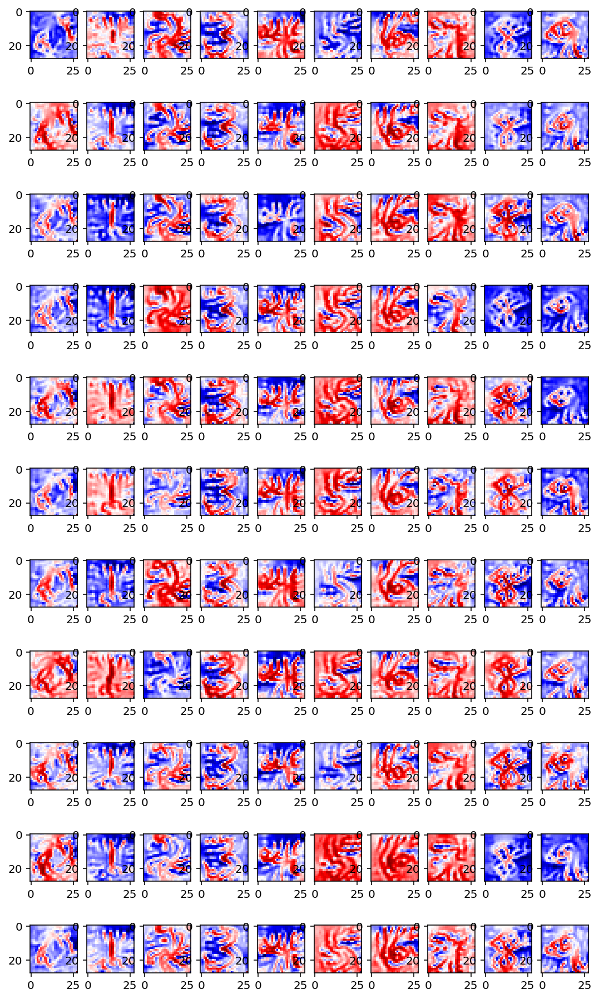

In [2]:
import keras
from vis.visualization import visualize_activation
from vis.utils import utils
import matplotlib.pyplot as plot
import matplotlib

# Comandos para exibir imagem no jupyter
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

model = keras.models.load_model('mnist_model.h5')
layer_idx = utils.find_layer_idx(model, 'nome_exclusivo_05')
model.layers[layer_idx].activation = keras.activations.linear
model = utils.apply_modifications(model)

for Lp in range(0, 11, 1):
    for classe in range(0, 10): 
        plot.subplot(20,10,1+classe+10*(Lp+9))
        filter_idx = classe
        img = visualize_activation(model, layer_idx, filter_indices=filter_idx, input_range=(0., 1.), verbose=True, max_iter=1000, tv_weight=1., lp_norm_weight=float(Lp/10.0))
        plot.imshow(img.squeeze(), cmap='seismic', interpolation='nearest')

# ajustando tamanho de exibição
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 30)
# fig.savefig('test2png.png', dpi=100, forward=True)
plot.show()

## Varredura de total variance com Lp-norm fixada

Com o melhor valor de Lp norm fixado, varremos agora a total variance, também de 0 a 1 (passos de 0.1) e julgamos que o melhor resultado ocorreu em 0.3.

(imagem no final da execução do código - cada fileira é atribuída a um valor de total variance, descendente de 0 para 1)

Using TensorFlow backend.
W0628 00:38:55.088971 140009782957888 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0628 00:38:55.104460 140009782957888 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0628 00:38:55.138734 140009782957888 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.

W0628 00:38:55.140883 140009782957888 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:131: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_

Iteration: 1, named_losses: [('ActivationMax Loss', -0.7854271), ('L-6.0 Norm Loss', 0.0017850252)], overall loss: -0.783642053604126
Iteration: 2, named_losses: [('ActivationMax Loss', -23.130482), ('L-6.0 Norm Loss', 0.015434706)], overall loss: -23.115047454833984
Iteration: 3, named_losses: [('ActivationMax Loss', -375.92828), ('L-6.0 Norm Loss', 0.02360079)], overall loss: -375.9046936035156
Iteration: 4, named_losses: [('ActivationMax Loss', -702.2468), ('L-6.0 Norm Loss', 0.028910592)], overall loss: -702.2178955078125
Iteration: 5, named_losses: [('ActivationMax Loss', -1054.9164), ('L-6.0 Norm Loss', 0.035663832)], overall loss: -1054.8807373046875
Iteration: 6, named_losses: [('ActivationMax Loss', -1361.1207), ('L-6.0 Norm Loss', 0.042063262)], overall loss: -1361.07861328125
Iteration: 7, named_losses: [('ActivationMax Loss', -1635.627), ('L-6.0 Norm Loss', 0.04772926)], overall loss: -1635.5792236328125
Iteration: 8, named_losses: [('ActivationMax Loss', -1871.0284), ('L-6

Iteration: 72, named_losses: [('ActivationMax Loss', -11338.32), ('L-6.0 Norm Loss', 0.2671161)], overall loss: -11338.052734375
Iteration: 73, named_losses: [('ActivationMax Loss', -11471.856), ('L-6.0 Norm Loss', 0.27005568)], overall loss: -11471.5859375
Iteration: 74, named_losses: [('ActivationMax Loss', -11602.313), ('L-6.0 Norm Loss', 0.27303675)], overall loss: -11602.0400390625
Iteration: 75, named_losses: [('ActivationMax Loss', -11732.119), ('L-6.0 Norm Loss', 0.2759979)], overall loss: -11731.8427734375
Iteration: 76, named_losses: [('ActivationMax Loss', -11857.83), ('L-6.0 Norm Loss', 0.27899125)], overall loss: -11857.55078125
Iteration: 77, named_losses: [('ActivationMax Loss', -11982.219), ('L-6.0 Norm Loss', 0.2818367)], overall loss: -11981.9365234375
Iteration: 78, named_losses: [('ActivationMax Loss', -12115.006), ('L-6.0 Norm Loss', 0.2847659)], overall loss: -12114.720703125
Iteration: 79, named_losses: [('ActivationMax Loss', -12246.969), ('L-6.0 Norm Loss', 0.2

Iteration: 141, named_losses: [('ActivationMax Loss', -20258.678), ('L-6.0 Norm Loss', 0.4700153)], overall loss: -20258.20703125
Iteration: 142, named_losses: [('ActivationMax Loss', -20386.375), ('L-6.0 Norm Loss', 0.4729408)], overall loss: -20385.90234375
Iteration: 143, named_losses: [('ActivationMax Loss', -20510.734), ('L-6.0 Norm Loss', 0.47590667)], overall loss: -20510.2578125
Iteration: 144, named_losses: [('ActivationMax Loss', -20637.348), ('L-6.0 Norm Loss', 0.47883365)], overall loss: -20636.869140625
Iteration: 145, named_losses: [('ActivationMax Loss', -20769.895), ('L-6.0 Norm Loss', 0.48180982)], overall loss: -20769.412109375
Iteration: 146, named_losses: [('ActivationMax Loss', -20882.023), ('L-6.0 Norm Loss', 0.4846359)], overall loss: -20881.5390625
Iteration: 147, named_losses: [('ActivationMax Loss', -21020.283), ('L-6.0 Norm Loss', 0.48755613)], overall loss: -21019.794921875
Iteration: 148, named_losses: [('ActivationMax Loss', -21152.223), ('L-6.0 Norm Loss'

Iteration: 210, named_losses: [('ActivationMax Loss', -29104.797), ('L-6.0 Norm Loss', 0.6736787)], overall loss: -29104.123046875
Iteration: 211, named_losses: [('ActivationMax Loss', -29239.152), ('L-6.0 Norm Loss', 0.67661023)], overall loss: -29238.4765625
Iteration: 212, named_losses: [('ActivationMax Loss', -29368.023), ('L-6.0 Norm Loss', 0.6795987)], overall loss: -29367.34375
Iteration: 213, named_losses: [('ActivationMax Loss', -29493.086), ('L-6.0 Norm Loss', 0.6825928)], overall loss: -29492.404296875
Iteration: 214, named_losses: [('ActivationMax Loss', -29614.781), ('L-6.0 Norm Loss', 0.68540496)], overall loss: -29614.095703125
Iteration: 215, named_losses: [('ActivationMax Loss', -29752.014), ('L-6.0 Norm Loss', 0.6883639)], overall loss: -29751.326171875
Iteration: 216, named_losses: [('ActivationMax Loss', -29881.277), ('L-6.0 Norm Loss', 0.691352)], overall loss: -29880.5859375
Iteration: 217, named_losses: [('ActivationMax Loss', -30010.695), ('L-6.0 Norm Loss', 0.6

Iteration: 275, named_losses: [('ActivationMax Loss', -37486.496), ('L-6.0 Norm Loss', 0.86674094)], overall loss: -37485.62890625
Iteration: 276, named_losses: [('ActivationMax Loss', -37621.87), ('L-6.0 Norm Loss', 0.8697456)], overall loss: -37621.0
Iteration: 277, named_losses: [('ActivationMax Loss', -37753.516), ('L-6.0 Norm Loss', 0.8727106)], overall loss: -37752.64453125
Iteration: 278, named_losses: [('ActivationMax Loss', -37877.938), ('L-6.0 Norm Loss', 0.87566054)], overall loss: -37877.0625
Iteration: 279, named_losses: [('ActivationMax Loss', -38005.195), ('L-6.0 Norm Loss', 0.87866044)], overall loss: -38004.31640625
Iteration: 280, named_losses: [('ActivationMax Loss', -38139.117), ('L-6.0 Norm Loss', 0.8815898)], overall loss: -38138.234375
Iteration: 281, named_losses: [('ActivationMax Loss', -38272.418), ('L-6.0 Norm Loss', 0.88460827)], overall loss: -38271.53515625
Iteration: 282, named_losses: [('ActivationMax Loss', -38397.707), ('L-6.0 Norm Loss', 0.88766044)],

Iteration: 348, named_losses: [('ActivationMax Loss', -46922.938), ('L-6.0 Norm Loss', 1.0847965)], overall loss: -46921.8515625
Iteration: 349, named_losses: [('ActivationMax Loss', -47053.562), ('L-6.0 Norm Loss', 1.0877931)], overall loss: -47052.4765625
Iteration: 350, named_losses: [('ActivationMax Loss', -47180.742), ('L-6.0 Norm Loss', 1.090785)], overall loss: -47179.65234375
Iteration: 351, named_losses: [('ActivationMax Loss', -47315.52), ('L-6.0 Norm Loss', 1.0937872)], overall loss: -47314.42578125
Iteration: 352, named_losses: [('ActivationMax Loss', -47438.152), ('L-6.0 Norm Loss', 1.0968027)], overall loss: -47437.0546875
Iteration: 353, named_losses: [('ActivationMax Loss', -47567.676), ('L-6.0 Norm Loss', 1.0997784)], overall loss: -47566.57421875
Iteration: 354, named_losses: [('ActivationMax Loss', -47695.645), ('L-6.0 Norm Loss', 1.1027496)], overall loss: -47694.54296875
Iteration: 355, named_losses: [('ActivationMax Loss', -47829.5), ('L-6.0 Norm Loss', 1.1057119)

Iteration: 425, named_losses: [('ActivationMax Loss', -56894.52), ('L-6.0 Norm Loss', 1.3153077)], overall loss: -56893.203125
Iteration: 426, named_losses: [('ActivationMax Loss', -57025.74), ('L-6.0 Norm Loss', 1.3183527)], overall loss: -57024.421875
Iteration: 427, named_losses: [('ActivationMax Loss', -57155.277), ('L-6.0 Norm Loss', 1.3212786)], overall loss: -57153.95703125
Iteration: 428, named_losses: [('ActivationMax Loss', -57282.746), ('L-6.0 Norm Loss', 1.3243176)], overall loss: -57281.421875
Iteration: 429, named_losses: [('ActivationMax Loss', -57417.875), ('L-6.0 Norm Loss', 1.3273057)], overall loss: -57416.546875
Iteration: 430, named_losses: [('ActivationMax Loss', -57543.37), ('L-6.0 Norm Loss', 1.3302764)], overall loss: -57542.0390625
Iteration: 431, named_losses: [('ActivationMax Loss', -57670.09), ('L-6.0 Norm Loss', 1.3332564)], overall loss: -57668.7578125
Iteration: 432, named_losses: [('ActivationMax Loss', -57800.48), ('L-6.0 Norm Loss', 1.3362402)], overa

Iteration: 499, named_losses: [('ActivationMax Loss', -66478.13), ('L-6.0 Norm Loss', 1.5369748)], overall loss: -66476.59375
Iteration: 500, named_losses: [('ActivationMax Loss', -66606.99), ('L-6.0 Norm Loss', 1.5399759)], overall loss: -66605.453125
Iteration: 501, named_losses: [('ActivationMax Loss', -66737.62), ('L-6.0 Norm Loss', 1.5429996)], overall loss: -66736.0703125
Iteration: 502, named_losses: [('ActivationMax Loss', -66865.02), ('L-6.0 Norm Loss', 1.545958)], overall loss: -66863.4765625
Iteration: 503, named_losses: [('ActivationMax Loss', -66995.96), ('L-6.0 Norm Loss', 1.5489873)], overall loss: -66994.4140625
Iteration: 504, named_losses: [('ActivationMax Loss', -67129.46), ('L-6.0 Norm Loss', 1.5519674)], overall loss: -67127.90625
Iteration: 505, named_losses: [('ActivationMax Loss', -67255.625), ('L-6.0 Norm Loss', 1.5549632)], overall loss: -67254.0703125
Iteration: 506, named_losses: [('ActivationMax Loss', -67374.164), ('L-6.0 Norm Loss', 1.5578687)], overall l

Iteration: 569, named_losses: [('ActivationMax Loss', -75559.15), ('L-6.0 Norm Loss', 1.7464308)], overall loss: -75557.3984375
Iteration: 570, named_losses: [('ActivationMax Loss', -75689.85), ('L-6.0 Norm Loss', 1.7494224)], overall loss: -75688.1015625
Iteration: 571, named_losses: [('ActivationMax Loss', -75824.78), ('L-6.0 Norm Loss', 1.7524219)], overall loss: -75823.03125
Iteration: 572, named_losses: [('ActivationMax Loss', -75952.79), ('L-6.0 Norm Loss', 1.7554361)], overall loss: -75951.03125
Iteration: 573, named_losses: [('ActivationMax Loss', -76080.67), ('L-6.0 Norm Loss', 1.7584698)], overall loss: -76078.9140625
Iteration: 574, named_losses: [('ActivationMax Loss', -76213.72), ('L-6.0 Norm Loss', 1.7613925)], overall loss: -76211.9609375
Iteration: 575, named_losses: [('ActivationMax Loss', -76337.336), ('L-6.0 Norm Loss', 1.764377)], overall loss: -76335.5703125
Iteration: 576, named_losses: [('ActivationMax Loss', -76468.85), ('L-6.0 Norm Loss', 1.7673825)], overall l

Iteration: 643, named_losses: [('ActivationMax Loss', -85164.05), ('L-6.0 Norm Loss', 1.967485)], overall loss: -85162.078125
Iteration: 644, named_losses: [('ActivationMax Loss', -85292.695), ('L-6.0 Norm Loss', 1.9704475)], overall loss: -85290.7265625
Iteration: 645, named_losses: [('ActivationMax Loss', -85423.6), ('L-6.0 Norm Loss', 1.9734937)], overall loss: -85421.625
Iteration: 646, named_losses: [('ActivationMax Loss', -85543.54), ('L-6.0 Norm Loss', 1.9763862)], overall loss: -85541.5625
Iteration: 647, named_losses: [('ActivationMax Loss', -85682.67), ('L-6.0 Norm Loss', 1.9793963)], overall loss: -85680.6953125
Iteration: 648, named_losses: [('ActivationMax Loss', -85811.555), ('L-6.0 Norm Loss', 1.9824313)], overall loss: -85809.5703125
Iteration: 649, named_losses: [('ActivationMax Loss', -85940.43), ('L-6.0 Norm Loss', 1.9854208)], overall loss: -85938.4453125
Iteration: 650, named_losses: [('ActivationMax Loss', -86072.69), ('L-6.0 Norm Loss', 1.988426)], overall loss: 

Iteration: 714, named_losses: [('ActivationMax Loss', -94360.07), ('L-6.0 Norm Loss', 2.1801016)], overall loss: -94357.890625
Iteration: 715, named_losses: [('ActivationMax Loss', -94493.72), ('L-6.0 Norm Loss', 2.1830008)], overall loss: -94491.5390625
Iteration: 716, named_losses: [('ActivationMax Loss', -94628.4), ('L-6.0 Norm Loss', 2.1860955)], overall loss: -94626.2109375
Iteration: 717, named_losses: [('ActivationMax Loss', -94754.28), ('L-6.0 Norm Loss', 2.189028)], overall loss: -94752.09375
Iteration: 718, named_losses: [('ActivationMax Loss', -94886.31), ('L-6.0 Norm Loss', 2.1920862)], overall loss: -94884.1171875
Iteration: 719, named_losses: [('ActivationMax Loss', -95013.87), ('L-6.0 Norm Loss', 2.1950352)], overall loss: -95011.671875
Iteration: 720, named_losses: [('ActivationMax Loss', -95145.27), ('L-6.0 Norm Loss', 2.198039)], overall loss: -95143.078125
Iteration: 721, named_losses: [('ActivationMax Loss', -95277.66), ('L-6.0 Norm Loss', 2.201058)], overall loss: 

Iteration: 787, named_losses: [('ActivationMax Loss', -103827.75), ('L-6.0 Norm Loss', 2.3988645)], overall loss: -103825.3515625
Iteration: 788, named_losses: [('ActivationMax Loss', -103966.664), ('L-6.0 Norm Loss', 2.401875)], overall loss: -103964.265625
Iteration: 789, named_losses: [('ActivationMax Loss', -104091.836), ('L-6.0 Norm Loss', 2.4048865)], overall loss: -104089.4296875
Iteration: 790, named_losses: [('ActivationMax Loss', -104214.65), ('L-6.0 Norm Loss', 2.4078586)], overall loss: -104212.2421875
Iteration: 791, named_losses: [('ActivationMax Loss', -104353.71), ('L-6.0 Norm Loss', 2.4108405)], overall loss: -104351.296875
Iteration: 792, named_losses: [('ActivationMax Loss', -104476.97), ('L-6.0 Norm Loss', 2.413889)], overall loss: -104474.5546875
Iteration: 793, named_losses: [('ActivationMax Loss', -104606.32), ('L-6.0 Norm Loss', 2.4168062)], overall loss: -104603.90625
Iteration: 794, named_losses: [('ActivationMax Loss', -104737.87), ('L-6.0 Norm Loss', 2.41984

Iteration: 888, named_losses: [('ActivationMax Loss', -116932.67), ('L-6.0 Norm Loss', 2.7002053)], overall loss: -116929.96875
Iteration: 889, named_losses: [('ActivationMax Loss', -117067.97), ('L-6.0 Norm Loss', 2.7032135)], overall loss: -117065.265625
Iteration: 890, named_losses: [('ActivationMax Loss', -117191.89), ('L-6.0 Norm Loss', 2.7062204)], overall loss: -117189.1875
Iteration: 891, named_losses: [('ActivationMax Loss', -117329.97), ('L-6.0 Norm Loss', 2.7091968)], overall loss: -117327.2578125
Iteration: 892, named_losses: [('ActivationMax Loss', -117459.0), ('L-6.0 Norm Loss', 2.712204)], overall loss: -117456.2890625
Iteration: 893, named_losses: [('ActivationMax Loss', -117587.97), ('L-6.0 Norm Loss', 2.7151952)], overall loss: -117585.25
Iteration: 894, named_losses: [('ActivationMax Loss', -117718.02), ('L-6.0 Norm Loss', 2.718221)], overall loss: -117715.3046875
Iteration: 895, named_losses: [('ActivationMax Loss', -117849.74), ('L-6.0 Norm Loss', 2.7212734)], over

Iteration: 994, named_losses: [('ActivationMax Loss', -130692.51), ('L-6.0 Norm Loss', 3.016587)], overall loss: -130689.4921875
Iteration: 995, named_losses: [('ActivationMax Loss', -130816.734), ('L-6.0 Norm Loss', 3.0195708)], overall loss: -130813.7109375
Iteration: 996, named_losses: [('ActivationMax Loss', -130948.2), ('L-6.0 Norm Loss', 3.0225737)], overall loss: -130945.1796875
Iteration: 997, named_losses: [('ActivationMax Loss', -131083.12), ('L-6.0 Norm Loss', 3.025572)], overall loss: -131080.09375
Iteration: 998, named_losses: [('ActivationMax Loss', -131206.48), ('L-6.0 Norm Loss', 3.0285735)], overall loss: -131203.453125
Iteration: 999, named_losses: [('ActivationMax Loss', -131342.95), ('L-6.0 Norm Loss', 3.031525)], overall loss: -131339.921875
Iteration: 1000, named_losses: [('ActivationMax Loss', -131471.3), ('L-6.0 Norm Loss', 3.034562)], overall loss: -131468.265625
Iteration: 1, named_losses: [('ActivationMax Loss', 0.27783823), ('L-6.0 Norm Loss', 0.0017846995)]

Iteration: 74, named_losses: [('ActivationMax Loss', -12460.301), ('L-6.0 Norm Loss', 0.27178493)], overall loss: -12460.029296875
Iteration: 75, named_losses: [('ActivationMax Loss', -12603.602), ('L-6.0 Norm Loss', 0.27470544)], overall loss: -12603.3271484375
Iteration: 76, named_losses: [('ActivationMax Loss', -12741.553), ('L-6.0 Norm Loss', 0.27767134)], overall loss: -12741.275390625
Iteration: 77, named_losses: [('ActivationMax Loss', -12888.701), ('L-6.0 Norm Loss', 0.28068578)], overall loss: -12888.4208984375
Iteration: 78, named_losses: [('ActivationMax Loss', -13021.868), ('L-6.0 Norm Loss', 0.28359854)], overall loss: -13021.5849609375
Iteration: 79, named_losses: [('ActivationMax Loss', -13168.962), ('L-6.0 Norm Loss', 0.2865833)], overall loss: -13168.67578125
Iteration: 80, named_losses: [('ActivationMax Loss', -13305.093), ('L-6.0 Norm Loss', 0.28955013)], overall loss: -13304.8037109375
Iteration: 81, named_losses: [('ActivationMax Loss', -13446.36), ('L-6.0 Norm Los

Iteration: 145, named_losses: [('ActivationMax Loss', -22425.014), ('L-6.0 Norm Loss', 0.48273835)], overall loss: -22424.53125
Iteration: 146, named_losses: [('ActivationMax Loss', -22568.557), ('L-6.0 Norm Loss', 0.48582277)], overall loss: -22568.0703125
Iteration: 147, named_losses: [('ActivationMax Loss', -22705.822), ('L-6.0 Norm Loss', 0.4887372)], overall loss: -22705.333984375
Iteration: 148, named_losses: [('ActivationMax Loss', -22851.445), ('L-6.0 Norm Loss', 0.49177313)], overall loss: -22850.953125
Iteration: 149, named_losses: [('ActivationMax Loss', -22982.379), ('L-6.0 Norm Loss', 0.4947308)], overall loss: -22981.884765625
Iteration: 150, named_losses: [('ActivationMax Loss', -23135.373), ('L-6.0 Norm Loss', 0.49777496)], overall loss: -23134.875
Iteration: 151, named_losses: [('ActivationMax Loss', -23270.943), ('L-6.0 Norm Loss', 0.5007648)], overall loss: -23270.443359375
Iteration: 152, named_losses: [('ActivationMax Loss', -23410.574), ('L-6.0 Norm Loss', 0.50375

Iteration: 241, named_losses: [('ActivationMax Loss', -35963.56), ('L-6.0 Norm Loss', 0.77079594)], overall loss: -35962.7890625
Iteration: 242, named_losses: [('ActivationMax Loss', -36113.777), ('L-6.0 Norm Loss', 0.77385193)], overall loss: -36113.00390625
Iteration: 243, named_losses: [('ActivationMax Loss', -36248.4), ('L-6.0 Norm Loss', 0.7768669)], overall loss: -36247.62109375
Iteration: 244, named_losses: [('ActivationMax Loss', -36396.39), ('L-6.0 Norm Loss', 0.77989393)], overall loss: -36395.609375
Iteration: 245, named_losses: [('ActivationMax Loss', -36534.8), ('L-6.0 Norm Loss', 0.7828713)], overall loss: -36534.01953125
Iteration: 246, named_losses: [('ActivationMax Loss', -36674.848), ('L-6.0 Norm Loss', 0.7858898)], overall loss: -36674.0625
Iteration: 247, named_losses: [('ActivationMax Loss', -36823.277), ('L-6.0 Norm Loss', 0.78893876)], overall loss: -36822.48828125
Iteration: 248, named_losses: [('ActivationMax Loss', -36954.055), ('L-6.0 Norm Loss', 0.7918654)],

Iteration: 335, named_losses: [('ActivationMax Loss', -49275.28), ('L-6.0 Norm Loss', 1.0544367)], overall loss: -49274.2265625
Iteration: 336, named_losses: [('ActivationMax Loss', -49419.76), ('L-6.0 Norm Loss', 1.0574722)], overall loss: -49418.703125
Iteration: 337, named_losses: [('ActivationMax Loss', -49548.785), ('L-6.0 Norm Loss', 1.060429)], overall loss: -49547.7265625
Iteration: 338, named_losses: [('ActivationMax Loss', -49702.637), ('L-6.0 Norm Loss', 1.0634868)], overall loss: -49701.57421875
Iteration: 339, named_losses: [('ActivationMax Loss', -49842.8), ('L-6.0 Norm Loss', 1.0665604)], overall loss: -49841.734375
Iteration: 340, named_losses: [('ActivationMax Loss', -49971.773), ('L-6.0 Norm Loss', 1.0694313)], overall loss: -49970.703125
Iteration: 341, named_losses: [('ActivationMax Loss', -50126.613), ('L-6.0 Norm Loss', 1.0724976)], overall loss: -50125.5390625
Iteration: 342, named_losses: [('ActivationMax Loss', -50266.676), ('L-6.0 Norm Loss', 1.0755869)], over

Iteration: 430, named_losses: [('ActivationMax Loss', -62757.46), ('L-6.0 Norm Loss', 1.342615)], overall loss: -62756.1171875
Iteration: 431, named_losses: [('ActivationMax Loss', -62884.785), ('L-6.0 Norm Loss', 1.3455292)], overall loss: -62883.44140625
Iteration: 432, named_losses: [('ActivationMax Loss', -63039.105), ('L-6.0 Norm Loss', 1.3485925)], overall loss: -63037.7578125
Iteration: 433, named_losses: [('ActivationMax Loss', -63172.547), ('L-6.0 Norm Loss', 1.3516388)], overall loss: -63171.1953125
Iteration: 434, named_losses: [('ActivationMax Loss', -63323.67), ('L-6.0 Norm Loss', 1.3547472)], overall loss: -63322.31640625
Iteration: 435, named_losses: [('ActivationMax Loss', -63461.18), ('L-6.0 Norm Loss', 1.3577228)], overall loss: -63459.8203125
Iteration: 436, named_losses: [('ActivationMax Loss', -63600.945), ('L-6.0 Norm Loss', 1.3607749)], overall loss: -63599.5859375
Iteration: 437, named_losses: [('ActivationMax Loss', -63750.113), ('L-6.0 Norm Loss', 1.3638633)],

Iteration: 522, named_losses: [('ActivationMax Loss', -75795.62), ('L-6.0 Norm Loss', 1.6219151)], overall loss: -75793.9921875
Iteration: 523, named_losses: [('ActivationMax Loss', -75931.39), ('L-6.0 Norm Loss', 1.6249645)], overall loss: -75929.765625
Iteration: 524, named_losses: [('ActivationMax Loss', -76071.734), ('L-6.0 Norm Loss', 1.627965)], overall loss: -76070.109375
Iteration: 525, named_losses: [('ActivationMax Loss', -76221.39), ('L-6.0 Norm Loss', 1.6310326)], overall loss: -76219.7578125
Iteration: 526, named_losses: [('ActivationMax Loss', -76356.21), ('L-6.0 Norm Loss', 1.634073)], overall loss: -76354.578125
Iteration: 527, named_losses: [('ActivationMax Loss', -76510.19), ('L-6.0 Norm Loss', 1.6371292)], overall loss: -76508.546875
Iteration: 528, named_losses: [('ActivationMax Loss', -76641.91), ('L-6.0 Norm Loss', 1.640085)], overall loss: -76640.265625
Iteration: 529, named_losses: [('ActivationMax Loss', -76792.12), ('L-6.0 Norm Loss', 1.6431355)], overall loss

Iteration: 621, named_losses: [('ActivationMax Loss', -89912.1), ('L-6.0 Norm Loss', 1.9224055)], overall loss: -89910.1796875
Iteration: 622, named_losses: [('ActivationMax Loss', -90044.805), ('L-6.0 Norm Loss', 1.9253709)], overall loss: -90042.8828125
Iteration: 623, named_losses: [('ActivationMax Loss', -90193.61), ('L-6.0 Norm Loss', 1.9284457)], overall loss: -90191.6796875
Iteration: 624, named_losses: [('ActivationMax Loss', -90328.42), ('L-6.0 Norm Loss', 1.9314599)], overall loss: -90326.4921875
Iteration: 625, named_losses: [('ActivationMax Loss', -90478.97), ('L-6.0 Norm Loss', 1.9345177)], overall loss: -90477.03125
Iteration: 626, named_losses: [('ActivationMax Loss', -90615.516), ('L-6.0 Norm Loss', 1.9375203)], overall loss: -90613.578125
Iteration: 627, named_losses: [('ActivationMax Loss', -90756.21), ('L-6.0 Norm Loss', 1.9405537)], overall loss: -90754.2734375
Iteration: 628, named_losses: [('ActivationMax Loss', -90905.695), ('L-6.0 Norm Loss', 1.9436368)], overal

Iteration: 722, named_losses: [('ActivationMax Loss', -104257.2), ('L-6.0 Norm Loss', 2.2293642)], overall loss: -104254.9765625
Iteration: 723, named_losses: [('ActivationMax Loss', -104412.484), ('L-6.0 Norm Loss', 2.2324426)], overall loss: -104410.25
Iteration: 724, named_losses: [('ActivationMax Loss', -104552.31), ('L-6.0 Norm Loss', 2.235527)], overall loss: -104550.078125
Iteration: 725, named_losses: [('ActivationMax Loss', -104693.164), ('L-6.0 Norm Loss', 2.2385583)], overall loss: -104690.921875
Iteration: 726, named_losses: [('ActivationMax Loss', -104825.59), ('L-6.0 Norm Loss', 2.241529)], overall loss: -104823.3515625
Iteration: 727, named_losses: [('ActivationMax Loss', -104980.1), ('L-6.0 Norm Loss', 2.2446256)], overall loss: -104977.859375
Iteration: 728, named_losses: [('ActivationMax Loss', -105121.586), ('L-6.0 Norm Loss', 2.2477)], overall loss: -105119.3359375
Iteration: 729, named_losses: [('ActivationMax Loss', -105261.59), ('L-6.0 Norm Loss', 2.250765)], ove

Iteration: 820, named_losses: [('ActivationMax Loss', -118219.59), ('L-6.0 Norm Loss', 2.5281029)], overall loss: -118217.0625
Iteration: 821, named_losses: [('ActivationMax Loss', -118356.97), ('L-6.0 Norm Loss', 2.531132)], overall loss: -118354.4375
Iteration: 822, named_losses: [('ActivationMax Loss', -118508.56), ('L-6.0 Norm Loss', 2.534229)], overall loss: -118506.03125
Iteration: 823, named_losses: [('ActivationMax Loss', -118646.27), ('L-6.0 Norm Loss', 2.5372322)], overall loss: -118643.734375
Iteration: 824, named_losses: [('ActivationMax Loss', -118786.266), ('L-6.0 Norm Loss', 2.5402946)], overall loss: -118783.7265625
Iteration: 825, named_losses: [('ActivationMax Loss', -118936.19), ('L-6.0 Norm Loss', 2.5433996)], overall loss: -118933.640625
Iteration: 826, named_losses: [('ActivationMax Loss', -119074.72), ('L-6.0 Norm Loss', 2.546405)], overall loss: -119072.171875
Iteration: 827, named_losses: [('ActivationMax Loss', -119213.31), ('L-6.0 Norm Loss', 2.5494452)], ove

Iteration: 951, named_losses: [('ActivationMax Loss', -136858.11), ('L-6.0 Norm Loss', 2.9277163)], overall loss: -136855.1875
Iteration: 952, named_losses: [('ActivationMax Loss', -136985.61), ('L-6.0 Norm Loss', 2.9306269)], overall loss: -136982.671875
Iteration: 953, named_losses: [('ActivationMax Loss', -137138.92), ('L-6.0 Norm Loss', 2.9337196)], overall loss: -137135.984375
Iteration: 954, named_losses: [('ActivationMax Loss', -137283.98), ('L-6.0 Norm Loss', 2.9368424)], overall loss: -137281.046875
Iteration: 955, named_losses: [('ActivationMax Loss', -137411.5), ('L-6.0 Norm Loss', 2.9397583)], overall loss: -137408.5625
Iteration: 956, named_losses: [('ActivationMax Loss', -137566.53), ('L-6.0 Norm Loss', 2.9428723)], overall loss: -137563.59375
Iteration: 957, named_losses: [('ActivationMax Loss', -137712.8), ('L-6.0 Norm Loss', 2.9459648)], overall loss: -137709.84375
Iteration: 958, named_losses: [('ActivationMax Loss', -137846.33), ('L-6.0 Norm Loss', 2.9490197)], overa

Iteration: 76, named_losses: [('ActivationMax Loss', -20332.6), ('L-6.0 Norm Loss', 0.2857471)], overall loss: -20332.314453125
Iteration: 77, named_losses: [('ActivationMax Loss', -20561.49), ('L-6.0 Norm Loss', 0.2888772)], overall loss: -20561.201171875
Iteration: 78, named_losses: [('ActivationMax Loss', -20783.916), ('L-6.0 Norm Loss', 0.29192257)], overall loss: -20783.625
Iteration: 79, named_losses: [('ActivationMax Loss', -21016.615), ('L-6.0 Norm Loss', 0.2950133)], overall loss: -21016.3203125
Iteration: 80, named_losses: [('ActivationMax Loss', -21241.9), ('L-6.0 Norm Loss', 0.298071)], overall loss: -21241.6015625
Iteration: 81, named_losses: [('ActivationMax Loss', -21470.072), ('L-6.0 Norm Loss', 0.301162)], overall loss: -21469.771484375
Iteration: 82, named_losses: [('ActivationMax Loss', -21696.115), ('L-6.0 Norm Loss', 0.3042294)], overall loss: -21695.810546875
Iteration: 83, named_losses: [('ActivationMax Loss', -21920.305), ('L-6.0 Norm Loss', 0.30730274)], overal

Iteration: 147, named_losses: [('ActivationMax Loss', -36432.95), ('L-6.0 Norm Loss', 0.5047681)], overall loss: -36432.4453125
Iteration: 148, named_losses: [('ActivationMax Loss', -36661.535), ('L-6.0 Norm Loss', 0.50785583)], overall loss: -36661.02734375
Iteration: 149, named_losses: [('ActivationMax Loss', -36888.324), ('L-6.0 Norm Loss', 0.51097697)], overall loss: -36887.8125
Iteration: 150, named_losses: [('ActivationMax Loss', -37112.375), ('L-6.0 Norm Loss', 0.5140782)], overall loss: -37111.859375
Iteration: 151, named_losses: [('ActivationMax Loss', -37334.7), ('L-6.0 Norm Loss', 0.5171555)], overall loss: -37334.18359375
Iteration: 152, named_losses: [('ActivationMax Loss', -37564.926), ('L-6.0 Norm Loss', 0.52025115)], overall loss: -37564.40625
Iteration: 153, named_losses: [('ActivationMax Loss', -37788.21), ('L-6.0 Norm Loss', 0.52336234)], overall loss: -37787.6875
Iteration: 154, named_losses: [('ActivationMax Loss', -38010.37), ('L-6.0 Norm Loss', 0.5264377)], overa

Iteration: 222, named_losses: [('ActivationMax Loss', -53262.742), ('L-6.0 Norm Loss', 0.7371264)], overall loss: -53262.00390625
Iteration: 223, named_losses: [('ActivationMax Loss', -53486.863), ('L-6.0 Norm Loss', 0.7402332)], overall loss: -53486.125
Iteration: 224, named_losses: [('ActivationMax Loss', -53710.812), ('L-6.0 Norm Loss', 0.74335593)], overall loss: -53710.0703125
Iteration: 225, named_losses: [('ActivationMax Loss', -53938.168), ('L-6.0 Norm Loss', 0.7464617)], overall loss: -53937.421875
Iteration: 226, named_losses: [('ActivationMax Loss', -54160.41), ('L-6.0 Norm Loss', 0.74959093)], overall loss: -54159.66015625
Iteration: 227, named_losses: [('ActivationMax Loss', -54384.52), ('L-6.0 Norm Loss', 0.75268173)], overall loss: -54383.765625
Iteration: 228, named_losses: [('ActivationMax Loss', -54609.19), ('L-6.0 Norm Loss', 0.75578326)], overall loss: -54608.4375
Iteration: 229, named_losses: [('ActivationMax Loss', -54833.824), ('L-6.0 Norm Loss', 0.7589014)], ove

Iteration: 295, named_losses: [('ActivationMax Loss', -69684.016), ('L-6.0 Norm Loss', 0.9646052)], overall loss: -69683.0546875
Iteration: 296, named_losses: [('ActivationMax Loss', -69912.445), ('L-6.0 Norm Loss', 0.96775234)], overall loss: -69911.4765625
Iteration: 297, named_losses: [('ActivationMax Loss', -70139.35), ('L-6.0 Norm Loss', 0.9709217)], overall loss: -70138.3828125
Iteration: 298, named_losses: [('ActivationMax Loss', -70361.125), ('L-6.0 Norm Loss', 0.9740414)], overall loss: -70360.1484375
Iteration: 299, named_losses: [('ActivationMax Loss', -70585.13), ('L-6.0 Norm Loss', 0.9771177)], overall loss: -70584.15625
Iteration: 300, named_losses: [('ActivationMax Loss', -70811.52), ('L-6.0 Norm Loss', 0.98025304)], overall loss: -70810.546875
Iteration: 301, named_losses: [('ActivationMax Loss', -71038.25), ('L-6.0 Norm Loss', 0.98340654)], overall loss: -71037.265625
Iteration: 302, named_losses: [('ActivationMax Loss', -71263.39), ('L-6.0 Norm Loss', 0.98654616)], ov

Iteration: 366, named_losses: [('ActivationMax Loss', -85685.805), ('L-6.0 Norm Loss', 1.1866794)], overall loss: -85684.6171875
Iteration: 367, named_losses: [('ActivationMax Loss', -85915.63), ('L-6.0 Norm Loss', 1.1898371)], overall loss: -85914.4453125
Iteration: 368, named_losses: [('ActivationMax Loss', -86137.14), ('L-6.0 Norm Loss', 1.1929196)], overall loss: -86135.9453125
Iteration: 369, named_losses: [('ActivationMax Loss', -86366.09), ('L-6.0 Norm Loss', 1.1960585)], overall loss: -86364.8984375
Iteration: 370, named_losses: [('ActivationMax Loss', -86591.37), ('L-6.0 Norm Loss', 1.1991997)], overall loss: -86590.171875
Iteration: 371, named_losses: [('ActivationMax Loss', -86815.664), ('L-6.0 Norm Loss', 1.2023308)], overall loss: -86814.4609375
Iteration: 372, named_losses: [('ActivationMax Loss', -87043.89), ('L-6.0 Norm Loss', 1.205435)], overall loss: -87042.6875
Iteration: 373, named_losses: [('ActivationMax Loss', -87272.32), ('L-6.0 Norm Loss', 1.2086177)], overall 

Iteration: 438, named_losses: [('ActivationMax Loss', -102011.336), ('L-6.0 Norm Loss', 1.4120032)], overall loss: -102009.921875
Iteration: 439, named_losses: [('ActivationMax Loss', -102236.13), ('L-6.0 Norm Loss', 1.4151042)], overall loss: -102234.71875
Iteration: 440, named_losses: [('ActivationMax Loss', -102465.04), ('L-6.0 Norm Loss', 1.4182466)], overall loss: -102463.6171875
Iteration: 441, named_losses: [('ActivationMax Loss', -102694.32), ('L-6.0 Norm Loss', 1.4213951)], overall loss: -102692.8984375
Iteration: 442, named_losses: [('ActivationMax Loss', -102917.29), ('L-6.0 Norm Loss', 1.4244884)], overall loss: -102915.8671875
Iteration: 443, named_losses: [('ActivationMax Loss', -103142.03), ('L-6.0 Norm Loss', 1.4276129)], overall loss: -103140.6015625
Iteration: 444, named_losses: [('ActivationMax Loss', -103371.34), ('L-6.0 Norm Loss', 1.430755)], overall loss: -103369.9140625
Iteration: 445, named_losses: [('ActivationMax Loss', -103592.78), ('L-6.0 Norm Loss', 1.4338

Iteration: 514, named_losses: [('ActivationMax Loss', -119245.58), ('L-6.0 Norm Loss', 1.6498579)], overall loss: -119243.9296875
Iteration: 515, named_losses: [('ActivationMax Loss', -119469.625), ('L-6.0 Norm Loss', 1.6529571)], overall loss: -119467.96875
Iteration: 516, named_losses: [('ActivationMax Loss', -119698.54), ('L-6.0 Norm Loss', 1.656095)], overall loss: -119696.8828125
Iteration: 517, named_losses: [('ActivationMax Loss', -119922.484), ('L-6.0 Norm Loss', 1.6592046)], overall loss: -119920.828125
Iteration: 518, named_losses: [('ActivationMax Loss', -120151.75), ('L-6.0 Norm Loss', 1.6623572)], overall loss: -120150.0859375
Iteration: 519, named_losses: [('ActivationMax Loss', -120377.97), ('L-6.0 Norm Loss', 1.6655138)], overall loss: -120376.3046875
Iteration: 520, named_losses: [('ActivationMax Loss', -120602.875), ('L-6.0 Norm Loss', 1.6686074)], overall loss: -120601.203125
Iteration: 521, named_losses: [('ActivationMax Loss', -120829.234), ('L-6.0 Norm Loss', 1.67

Iteration: 619, named_losses: [('ActivationMax Loss', -143030.38), ('L-6.0 Norm Loss', 1.9792168)], overall loss: -143028.390625
Iteration: 620, named_losses: [('ActivationMax Loss', -143257.16), ('L-6.0 Norm Loss', 1.9823856)], overall loss: -143255.171875
Iteration: 621, named_losses: [('ActivationMax Loss', -143481.22), ('L-6.0 Norm Loss', 1.9855173)], overall loss: -143479.234375
Iteration: 622, named_losses: [('ActivationMax Loss', -143708.72), ('L-6.0 Norm Loss', 1.9886569)], overall loss: -143706.734375
Iteration: 623, named_losses: [('ActivationMax Loss', -143932.77), ('L-6.0 Norm Loss', 1.9917816)], overall loss: -143930.78125
Iteration: 624, named_losses: [('ActivationMax Loss', -144163.92), ('L-6.0 Norm Loss', 1.9949402)], overall loss: -144161.921875
Iteration: 625, named_losses: [('ActivationMax Loss', -144386.48), ('L-6.0 Norm Loss', 1.9980756)], overall loss: -144384.484375
Iteration: 626, named_losses: [('ActivationMax Loss', -144616.45), ('L-6.0 Norm Loss', 2.0012217)]

Iteration: 694, named_losses: [('ActivationMax Loss', -160063.4), ('L-6.0 Norm Loss', 2.2147448)], overall loss: -160061.1875
Iteration: 695, named_losses: [('ActivationMax Loss', -160294.64), ('L-6.0 Norm Loss', 2.217882)], overall loss: -160292.421875
Iteration: 696, named_losses: [('ActivationMax Loss', -160523.16), ('L-6.0 Norm Loss', 2.2210746)], overall loss: -160520.9375
Iteration: 697, named_losses: [('ActivationMax Loss', -160747.5), ('L-6.0 Norm Loss', 2.224163)], overall loss: -160745.28125
Iteration: 698, named_losses: [('ActivationMax Loss', -160979.03), ('L-6.0 Norm Loss', 2.227336)], overall loss: -160976.796875
Iteration: 699, named_losses: [('ActivationMax Loss', -161202.06), ('L-6.0 Norm Loss', 2.2304487)], overall loss: -161199.828125
Iteration: 700, named_losses: [('ActivationMax Loss', -161432.23), ('L-6.0 Norm Loss', 2.2335913)], overall loss: -161430.0
Iteration: 701, named_losses: [('ActivationMax Loss', -161660.44), ('L-6.0 Norm Loss', 2.2367754)], overall loss

Iteration: 768, named_losses: [('ActivationMax Loss', -176870.44), ('L-6.0 Norm Loss', 2.4470882)], overall loss: -176867.984375
Iteration: 769, named_losses: [('ActivationMax Loss', -177100.05), ('L-6.0 Norm Loss', 2.4502373)], overall loss: -177097.59375
Iteration: 770, named_losses: [('ActivationMax Loss', -177324.94), ('L-6.0 Norm Loss', 2.453359)], overall loss: -177322.484375
Iteration: 771, named_losses: [('ActivationMax Loss', -177554.47), ('L-6.0 Norm Loss', 2.456532)], overall loss: -177552.015625
Iteration: 772, named_losses: [('ActivationMax Loss', -177779.61), ('L-6.0 Norm Loss', 2.459651)], overall loss: -177777.15625
Iteration: 773, named_losses: [('ActivationMax Loss', -178007.86), ('L-6.0 Norm Loss', 2.4627967)], overall loss: -178005.390625
Iteration: 774, named_losses: [('ActivationMax Loss', -178234.22), ('L-6.0 Norm Loss', 2.4659212)], overall loss: -178231.75
Iteration: 775, named_losses: [('ActivationMax Loss', -178461.69), ('L-6.0 Norm Loss', 2.4690661)], overal

Iteration: 843, named_losses: [('ActivationMax Loss', -193884.7), ('L-6.0 Norm Loss', 2.6828666)], overall loss: -193882.015625
Iteration: 844, named_losses: [('ActivationMax Loss', -194108.67), ('L-6.0 Norm Loss', 2.6859968)], overall loss: -194105.984375
Iteration: 845, named_losses: [('ActivationMax Loss', -194334.64), ('L-6.0 Norm Loss', 2.689158)], overall loss: -194331.953125
Iteration: 846, named_losses: [('ActivationMax Loss', -194562.97), ('L-6.0 Norm Loss', 2.692301)], overall loss: -194560.28125
Iteration: 847, named_losses: [('ActivationMax Loss', -194788.72), ('L-6.0 Norm Loss', 2.6954272)], overall loss: -194786.015625
Iteration: 848, named_losses: [('ActivationMax Loss', -195015.16), ('L-6.0 Norm Loss', 2.698565)], overall loss: -195012.453125
Iteration: 849, named_losses: [('ActivationMax Loss', -195242.88), ('L-6.0 Norm Loss', 2.7017343)], overall loss: -195240.171875
Iteration: 850, named_losses: [('ActivationMax Loss', -195469.17), ('L-6.0 Norm Loss', 2.704868)], ove

Iteration: 918, named_losses: [('ActivationMax Loss', -210888.7), ('L-6.0 Norm Loss', 2.918827)], overall loss: -210885.78125
Iteration: 919, named_losses: [('ActivationMax Loss', -211113.5), ('L-6.0 Norm Loss', 2.9220035)], overall loss: -211110.578125
Iteration: 920, named_losses: [('ActivationMax Loss', -211340.19), ('L-6.0 Norm Loss', 2.9251413)], overall loss: -211337.265625
Iteration: 921, named_losses: [('ActivationMax Loss', -211565.53), ('L-6.0 Norm Loss', 2.928287)], overall loss: -211562.609375
Iteration: 922, named_losses: [('ActivationMax Loss', -211797.25), ('L-6.0 Norm Loss', 2.9314435)], overall loss: -211794.3125
Iteration: 923, named_losses: [('ActivationMax Loss', -212020.22), ('L-6.0 Norm Loss', 2.9345691)], overall loss: -212017.28125
Iteration: 924, named_losses: [('ActivationMax Loss', -212249.61), ('L-6.0 Norm Loss', 2.9377193)], overall loss: -212246.671875
Iteration: 925, named_losses: [('ActivationMax Loss', -212473.62), ('L-6.0 Norm Loss', 2.9408796)], overa

Iteration: 993, named_losses: [('ActivationMax Loss', -227882.62), ('L-6.0 Norm Loss', 3.1547763)], overall loss: -227879.46875
Iteration: 994, named_losses: [('ActivationMax Loss', -228109.98), ('L-6.0 Norm Loss', 3.1579201)], overall loss: -228106.828125
Iteration: 995, named_losses: [('ActivationMax Loss', -228337.81), ('L-6.0 Norm Loss', 3.1610966)], overall loss: -228334.65625
Iteration: 996, named_losses: [('ActivationMax Loss', -228565.03), ('L-6.0 Norm Loss', 3.164224)], overall loss: -228561.859375
Iteration: 997, named_losses: [('ActivationMax Loss', -228792.62), ('L-6.0 Norm Loss', 3.1674042)], overall loss: -228789.453125
Iteration: 998, named_losses: [('ActivationMax Loss', -229016.06), ('L-6.0 Norm Loss', 3.1705267)], overall loss: -229012.890625
Iteration: 999, named_losses: [('ActivationMax Loss', -229246.56), ('L-6.0 Norm Loss', 3.1737177)], overall loss: -229243.390625
Iteration: 1000, named_losses: [('ActivationMax Loss', -229470.78), ('L-6.0 Norm Loss', 3.176854)], 

Iteration: 57, named_losses: [('ActivationMax Loss', -13229.591), ('L-6.0 Norm Loss', 0.22802106)], overall loss: -13229.36328125
Iteration: 58, named_losses: [('ActivationMax Loss', -13417.375), ('L-6.0 Norm Loss', 0.23110084)], overall loss: -13417.1435546875
Iteration: 59, named_losses: [('ActivationMax Loss', -13604.294), ('L-6.0 Norm Loss', 0.23419604)], overall loss: -13604.0595703125
Iteration: 60, named_losses: [('ActivationMax Loss', -13790.126), ('L-6.0 Norm Loss', 0.23727228)], overall loss: -13789.888671875
Iteration: 61, named_losses: [('ActivationMax Loss', -13978.474), ('L-6.0 Norm Loss', 0.24036556)], overall loss: -13978.2333984375
Iteration: 62, named_losses: [('ActivationMax Loss', -14166.668), ('L-6.0 Norm Loss', 0.24343011)], overall loss: -14166.4248046875
Iteration: 63, named_losses: [('ActivationMax Loss', -14351.791), ('L-6.0 Norm Loss', 0.24652494)], overall loss: -14351.544921875
Iteration: 64, named_losses: [('ActivationMax Loss', -14536.047), ('L-6.0 Norm L

Iteration: 190, named_losses: [('ActivationMax Loss', -37911.832), ('L-6.0 Norm Loss', 0.63929784)], overall loss: -37911.19140625
Iteration: 191, named_losses: [('ActivationMax Loss', -38095.86), ('L-6.0 Norm Loss', 0.6424263)], overall loss: -38095.21875
Iteration: 192, named_losses: [('ActivationMax Loss', -38280.945), ('L-6.0 Norm Loss', 0.64554644)], overall loss: -38280.30078125
Iteration: 193, named_losses: [('ActivationMax Loss', -38465.766), ('L-6.0 Norm Loss', 0.6486784)], overall loss: -38465.1171875
Iteration: 194, named_losses: [('ActivationMax Loss', -38650.84), ('L-6.0 Norm Loss', 0.6518043)], overall loss: -38650.1875
Iteration: 195, named_losses: [('ActivationMax Loss', -38835.805), ('L-6.0 Norm Loss', 0.65493286)], overall loss: -38835.1484375
Iteration: 196, named_losses: [('ActivationMax Loss', -39018.82), ('L-6.0 Norm Loss', 0.6580857)], overall loss: -39018.1640625
Iteration: 197, named_losses: [('ActivationMax Loss', -39201.58), ('L-6.0 Norm Loss', 0.66117394)], 

Iteration: 265, named_losses: [('ActivationMax Loss', -51762.723), ('L-6.0 Norm Loss', 0.8741236)], overall loss: -51761.84765625
Iteration: 266, named_losses: [('ActivationMax Loss', -51949.16), ('L-6.0 Norm Loss', 0.8772724)], overall loss: -51948.28125
Iteration: 267, named_losses: [('ActivationMax Loss', -52131.164), ('L-6.0 Norm Loss', 0.88041335)], overall loss: -52130.28515625
Iteration: 268, named_losses: [('ActivationMax Loss', -52317.273), ('L-6.0 Norm Loss', 0.8835352)], overall loss: -52316.390625
Iteration: 269, named_losses: [('ActivationMax Loss', -52503.496), ('L-6.0 Norm Loss', 0.88669425)], overall loss: -52502.609375
Iteration: 270, named_losses: [('ActivationMax Loss', -52687.723), ('L-6.0 Norm Loss', 0.88982296)], overall loss: -52686.83203125
Iteration: 271, named_losses: [('ActivationMax Loss', -52870.28), ('L-6.0 Norm Loss', 0.89295757)], overall loss: -52869.38671875
Iteration: 272, named_losses: [('ActivationMax Loss', -53056.277), ('L-6.0 Norm Loss', 0.896091

Iteration: 336, named_losses: [('ActivationMax Loss', -64885.984), ('L-6.0 Norm Loss', 1.0973277)], overall loss: -64884.88671875
Iteration: 337, named_losses: [('ActivationMax Loss', -65070.633), ('L-6.0 Norm Loss', 1.1004292)], overall loss: -65069.53125
Iteration: 338, named_losses: [('ActivationMax Loss', -65256.316), ('L-6.0 Norm Loss', 1.1035811)], overall loss: -65255.2109375
Iteration: 339, named_losses: [('ActivationMax Loss', -65440.246), ('L-6.0 Norm Loss', 1.1067317)], overall loss: -65439.140625
Iteration: 340, named_losses: [('ActivationMax Loss', -65626.54), ('L-6.0 Norm Loss', 1.1098981)], overall loss: -65625.4296875
Iteration: 341, named_losses: [('ActivationMax Loss', -65808.2), ('L-6.0 Norm Loss', 1.1130375)], overall loss: -65807.09375
Iteration: 342, named_losses: [('ActivationMax Loss', -65994.83), ('L-6.0 Norm Loss', 1.1161914)], overall loss: -65993.7109375
Iteration: 343, named_losses: [('ActivationMax Loss', -66179.32), ('L-6.0 Norm Loss', 1.1193407)], overal

Iteration: 409, named_losses: [('ActivationMax Loss', -78389.18), ('L-6.0 Norm Loss', 1.3271476)], overall loss: -78387.8515625
Iteration: 410, named_losses: [('ActivationMax Loss', -78570.8), ('L-6.0 Norm Loss', 1.3302935)], overall loss: -78569.46875
Iteration: 411, named_losses: [('ActivationMax Loss', -78757.0), ('L-6.0 Norm Loss', 1.3334332)], overall loss: -78755.6640625
Iteration: 412, named_losses: [('ActivationMax Loss', -78942.87), ('L-6.0 Norm Loss', 1.3365859)], overall loss: -78941.53125
Iteration: 413, named_losses: [('ActivationMax Loss', -79124.52), ('L-6.0 Norm Loss', 1.3397164)], overall loss: -79123.1875
Iteration: 414, named_losses: [('ActivationMax Loss', -79312.164), ('L-6.0 Norm Loss', 1.3428977)], overall loss: -79310.8203125
Iteration: 415, named_losses: [('ActivationMax Loss', -79493.78), ('L-6.0 Norm Loss', 1.3460131)], overall loss: -79492.4375
Iteration: 416, named_losses: [('ActivationMax Loss', -79680.97), ('L-6.0 Norm Loss', 1.3491659)], overall loss: -7

Iteration: 483, named_losses: [('ActivationMax Loss', -92070.77), ('L-6.0 Norm Loss', 1.5604198)], overall loss: -92069.2109375
Iteration: 484, named_losses: [('ActivationMax Loss', -92255.61), ('L-6.0 Norm Loss', 1.5635749)], overall loss: -92254.046875
Iteration: 485, named_losses: [('ActivationMax Loss', -92440.77), ('L-6.0 Norm Loss', 1.5667082)], overall loss: -92439.203125
Iteration: 486, named_losses: [('ActivationMax Loss', -92624.99), ('L-6.0 Norm Loss', 1.5698732)], overall loss: -92623.421875
Iteration: 487, named_losses: [('ActivationMax Loss', -92811.01), ('L-6.0 Norm Loss', 1.5730507)], overall loss: -92809.4375
Iteration: 488, named_losses: [('ActivationMax Loss', -92994.09), ('L-6.0 Norm Loss', 1.5761865)], overall loss: -92992.515625
Iteration: 489, named_losses: [('ActivationMax Loss', -93179.305), ('L-6.0 Norm Loss', 1.5793538)], overall loss: -93177.7265625
Iteration: 490, named_losses: [('ActivationMax Loss', -93363.47), ('L-6.0 Norm Loss', 1.582484)], overall loss

Iteration: 557, named_losses: [('ActivationMax Loss', -105740.484), ('L-6.0 Norm Loss', 1.7939005)], overall loss: -105738.6875
Iteration: 558, named_losses: [('ActivationMax Loss', -105923.13), ('L-6.0 Norm Loss', 1.797044)], overall loss: -105921.3359375
Iteration: 559, named_losses: [('ActivationMax Loss', -106107.44), ('L-6.0 Norm Loss', 1.8002026)], overall loss: -106105.640625
Iteration: 560, named_losses: [('ActivationMax Loss', -106291.54), ('L-6.0 Norm Loss', 1.8033557)], overall loss: -106289.734375
Iteration: 561, named_losses: [('ActivationMax Loss', -106474.234), ('L-6.0 Norm Loss', 1.8064939)], overall loss: -106472.4296875
Iteration: 562, named_losses: [('ActivationMax Loss', -106659.44), ('L-6.0 Norm Loss', 1.8096563)], overall loss: -106657.625
Iteration: 563, named_losses: [('ActivationMax Loss', -106844.45), ('L-6.0 Norm Loss', 1.812771)], overall loss: -106842.640625
Iteration: 564, named_losses: [('ActivationMax Loss', -107030.4), ('L-6.0 Norm Loss', 1.8159646)], o

Iteration: 630, named_losses: [('ActivationMax Loss', -119219.84), ('L-6.0 Norm Loss', 2.0243075)], overall loss: -119217.8203125
Iteration: 631, named_losses: [('ActivationMax Loss', -119404.52), ('L-6.0 Norm Loss', 2.0274522)], overall loss: -119402.4921875
Iteration: 632, named_losses: [('ActivationMax Loss', -119592.125), ('L-6.0 Norm Loss', 2.030635)], overall loss: -119590.09375
Iteration: 633, named_losses: [('ActivationMax Loss', -119773.66), ('L-6.0 Norm Loss', 2.0337458)], overall loss: -119771.625
Iteration: 634, named_losses: [('ActivationMax Loss', -119957.31), ('L-6.0 Norm Loss', 2.0369291)], overall loss: -119955.2734375
Iteration: 635, named_losses: [('ActivationMax Loss', -120143.04), ('L-6.0 Norm Loss', 2.0400643)], overall loss: -120141.0
Iteration: 636, named_losses: [('ActivationMax Loss', -120330.47), ('L-6.0 Norm Loss', 2.0432432)], overall loss: -120328.421875
Iteration: 637, named_losses: [('ActivationMax Loss', -120514.94), ('L-6.0 Norm Loss', 2.0463884)], ove

Iteration: 705, named_losses: [('ActivationMax Loss', -133134.88), ('L-6.0 Norm Loss', 2.26122)], overall loss: -133132.609375
Iteration: 706, named_losses: [('ActivationMax Loss', -133322.31), ('L-6.0 Norm Loss', 2.264382)], overall loss: -133320.046875
Iteration: 707, named_losses: [('ActivationMax Loss', -133509.77), ('L-6.0 Norm Loss', 2.2675784)], overall loss: -133507.5
Iteration: 708, named_losses: [('ActivationMax Loss', -133693.17), ('L-6.0 Norm Loss', 2.2707152)], overall loss: -133690.90625
Iteration: 709, named_losses: [('ActivationMax Loss', -133877.97), ('L-6.0 Norm Loss', 2.2738562)], overall loss: -133875.6875
Iteration: 710, named_losses: [('ActivationMax Loss', -134067.03), ('L-6.0 Norm Loss', 2.2770674)], overall loss: -134064.75
Iteration: 711, named_losses: [('ActivationMax Loss', -134249.0), ('L-6.0 Norm Loss', 2.2801485)], overall loss: -134246.71875
Iteration: 712, named_losses: [('ActivationMax Loss', -134437.06), ('L-6.0 Norm Loss', 2.2833626)], overall loss: 

Iteration: 780, named_losses: [('ActivationMax Loss', -147078.75), ('L-6.0 Norm Loss', 2.4984398)], overall loss: -147076.25
Iteration: 781, named_losses: [('ActivationMax Loss', -147263.66), ('L-6.0 Norm Loss', 2.5015955)], overall loss: -147261.15625
Iteration: 782, named_losses: [('ActivationMax Loss', -147446.84), ('L-6.0 Norm Loss', 2.5047405)], overall loss: -147444.34375
Iteration: 783, named_losses: [('ActivationMax Loss', -147634.36), ('L-6.0 Norm Loss', 2.5079281)], overall loss: -147631.84375
Iteration: 784, named_losses: [('ActivationMax Loss', -147821.38), ('L-6.0 Norm Loss', 2.5111003)], overall loss: -147818.859375
Iteration: 785, named_losses: [('ActivationMax Loss', -148006.61), ('L-6.0 Norm Loss', 2.5142772)], overall loss: -148004.09375
Iteration: 786, named_losses: [('ActivationMax Loss', -148192.39), ('L-6.0 Norm Loss', 2.5174184)], overall loss: -148189.875
Iteration: 787, named_losses: [('ActivationMax Loss', -148379.33), ('L-6.0 Norm Loss', 2.5205867)], overall 

Iteration: 853, named_losses: [('ActivationMax Loss', -160633.64), ('L-6.0 Norm Loss', 2.7293003)], overall loss: -160630.90625
Iteration: 854, named_losses: [('ActivationMax Loss', -160821.05), ('L-6.0 Norm Loss', 2.7324731)], overall loss: -160818.3125
Iteration: 855, named_losses: [('ActivationMax Loss', -161006.31), ('L-6.0 Norm Loss', 2.7356267)], overall loss: -161003.578125
Iteration: 856, named_losses: [('ActivationMax Loss', -161190.78), ('L-6.0 Norm Loss', 2.738755)], overall loss: -161188.046875
Iteration: 857, named_losses: [('ActivationMax Loss', -161376.83), ('L-6.0 Norm Loss', 2.741941)], overall loss: -161374.09375
Iteration: 858, named_losses: [('ActivationMax Loss', -161563.3), ('L-6.0 Norm Loss', 2.7450907)], overall loss: -161560.546875
Iteration: 859, named_losses: [('ActivationMax Loss', -161748.5), ('L-6.0 Norm Loss', 2.7482262)], overall loss: -161745.75
Iteration: 860, named_losses: [('ActivationMax Loss', -161933.9), ('L-6.0 Norm Loss', 2.7514226)], overall lo

Iteration: 925, named_losses: [('ActivationMax Loss', -173994.25), ('L-6.0 Norm Loss', 2.9565847)], overall loss: -173991.296875
Iteration: 926, named_losses: [('ActivationMax Loss', -174181.86), ('L-6.0 Norm Loss', 2.959759)], overall loss: -174178.90625
Iteration: 927, named_losses: [('ActivationMax Loss', -174364.52), ('L-6.0 Norm Loss', 2.9629123)], overall loss: -174361.546875
Iteration: 928, named_losses: [('ActivationMax Loss', -174550.75), ('L-6.0 Norm Loss', 2.9660647)], overall loss: -174547.78125
Iteration: 929, named_losses: [('ActivationMax Loss', -174737.0), ('L-6.0 Norm Loss', 2.969204)], overall loss: -174734.03125
Iteration: 930, named_losses: [('ActivationMax Loss', -174920.05), ('L-6.0 Norm Loss', 2.9723728)], overall loss: -174917.078125
Iteration: 931, named_losses: [('ActivationMax Loss', -175104.84), ('L-6.0 Norm Loss', 2.9755275)], overall loss: -175101.875
Iteration: 932, named_losses: [('ActivationMax Loss', -175291.45), ('L-6.0 Norm Loss', 2.9786453)], overal

Iteration: 996, named_losses: [('ActivationMax Loss', -187166.42), ('L-6.0 Norm Loss', 3.181243)], overall loss: -187163.234375
Iteration: 997, named_losses: [('ActivationMax Loss', -187349.78), ('L-6.0 Norm Loss', 3.184416)], overall loss: -187346.59375
Iteration: 998, named_losses: [('ActivationMax Loss', -187536.56), ('L-6.0 Norm Loss', 3.187609)], overall loss: -187533.375
Iteration: 999, named_losses: [('ActivationMax Loss', -187721.73), ('L-6.0 Norm Loss', 3.1907527)], overall loss: -187718.546875
Iteration: 1000, named_losses: [('ActivationMax Loss', -187909.47), ('L-6.0 Norm Loss', 3.1939387)], overall loss: -187906.28125
Iteration: 1, named_losses: [('ActivationMax Loss', 0.21919912), ('L-6.0 Norm Loss', 0.0017844621)], overall loss: 0.2209835797548294
Iteration: 2, named_losses: [('ActivationMax Loss', -22.163597), ('L-6.0 Norm Loss', 0.0154406335)], overall loss: -22.148157119750977
Iteration: 3, named_losses: [('ActivationMax Loss', -538.1993), ('L-6.0 Norm Loss', 0.0235032

Iteration: 78, named_losses: [('ActivationMax Loss', -18995.697), ('L-6.0 Norm Loss', 0.29067692)], overall loss: -18995.40625
Iteration: 79, named_losses: [('ActivationMax Loss', -19197.967), ('L-6.0 Norm Loss', 0.29374033)], overall loss: -19197.673828125
Iteration: 80, named_losses: [('ActivationMax Loss', -19411.414), ('L-6.0 Norm Loss', 0.29679593)], overall loss: -19411.1171875
Iteration: 81, named_losses: [('ActivationMax Loss', -19610.957), ('L-6.0 Norm Loss', 0.29984763)], overall loss: -19610.65625
Iteration: 82, named_losses: [('ActivationMax Loss', -19822.395), ('L-6.0 Norm Loss', 0.30288744)], overall loss: -19822.091796875
Iteration: 83, named_losses: [('ActivationMax Loss', -20028.732), ('L-6.0 Norm Loss', 0.30591497)], overall loss: -20028.42578125
Iteration: 84, named_losses: [('ActivationMax Loss', -20242.277), ('L-6.0 Norm Loss', 0.3090144)], overall loss: -20241.96875
Iteration: 85, named_losses: [('ActivationMax Loss', -20450.346), ('L-6.0 Norm Loss', 0.3119773)], 

Iteration: 152, named_losses: [('ActivationMax Loss', -34285.605), ('L-6.0 Norm Loss', 0.5173968)], overall loss: -34285.08984375
Iteration: 153, named_losses: [('ActivationMax Loss', -34492.957), ('L-6.0 Norm Loss', 0.52045834)], overall loss: -34492.4375
Iteration: 154, named_losses: [('ActivationMax Loss', -34696.926), ('L-6.0 Norm Loss', 0.5235427)], overall loss: -34696.40234375
Iteration: 155, named_losses: [('ActivationMax Loss', -34901.883), ('L-6.0 Norm Loss', 0.5266191)], overall loss: -34901.35546875
Iteration: 156, named_losses: [('ActivationMax Loss', -35106.516), ('L-6.0 Norm Loss', 0.5296836)], overall loss: -35105.984375
Iteration: 157, named_losses: [('ActivationMax Loss', -35311.258), ('L-6.0 Norm Loss', 0.5327649)], overall loss: -35310.7265625
Iteration: 158, named_losses: [('ActivationMax Loss', -35514.03), ('L-6.0 Norm Loss', 0.535804)], overall loss: -35513.49609375
Iteration: 159, named_losses: [('ActivationMax Loss', -35724.12), ('L-6.0 Norm Loss', 0.5388747)],

Iteration: 228, named_losses: [('ActivationMax Loss', -49949.88), ('L-6.0 Norm Loss', 0.752285)], overall loss: -49949.125
Iteration: 229, named_losses: [('ActivationMax Loss', -50156.69), ('L-6.0 Norm Loss', 0.7553642)], overall loss: -50155.9375
Iteration: 230, named_losses: [('ActivationMax Loss', -50358.22), ('L-6.0 Norm Loss', 0.7584811)], overall loss: -50357.4609375
Iteration: 231, named_losses: [('ActivationMax Loss', -50567.688), ('L-6.0 Norm Loss', 0.761533)], overall loss: -50566.92578125
Iteration: 232, named_losses: [('ActivationMax Loss', -50772.715), ('L-6.0 Norm Loss', 0.76461077)], overall loss: -50771.94921875
Iteration: 233, named_losses: [('ActivationMax Loss', -50977.91), ('L-6.0 Norm Loss', 0.76774675)], overall loss: -50977.140625
Iteration: 234, named_losses: [('ActivationMax Loss', -51186.54), ('L-6.0 Norm Loss', 0.7708251)], overall loss: -51185.76953125
Iteration: 235, named_losses: [('ActivationMax Loss', -51390.29), ('L-6.0 Norm Loss', 0.7738995)], overall 

Iteration: 302, named_losses: [('ActivationMax Loss', -65215.203), ('L-6.0 Norm Loss', 0.9816198)], overall loss: -65214.22265625
Iteration: 303, named_losses: [('ActivationMax Loss', -65425.508), ('L-6.0 Norm Loss', 0.98470056)], overall loss: -65424.5234375
Iteration: 304, named_losses: [('ActivationMax Loss', -65635.0), ('L-6.0 Norm Loss', 0.9877974)], overall loss: -65634.015625
Iteration: 305, named_losses: [('ActivationMax Loss', -65836.56), ('L-6.0 Norm Loss', 0.9909206)], overall loss: -65835.5703125
Iteration: 306, named_losses: [('ActivationMax Loss', -66047.37), ('L-6.0 Norm Loss', 0.9940353)], overall loss: -66046.375
Iteration: 307, named_losses: [('ActivationMax Loss', -66256.97), ('L-6.0 Norm Loss', 0.99713016)], overall loss: -66255.96875
Iteration: 308, named_losses: [('ActivationMax Loss', -66461.45), ('L-6.0 Norm Loss', 1.0002122)], overall loss: -66460.453125
Iteration: 309, named_losses: [('ActivationMax Loss', -66664.9), ('L-6.0 Norm Loss', 1.0033902)], overall lo

Iteration: 377, named_losses: [('ActivationMax Loss', -80760.6), ('L-6.0 Norm Loss', 1.2150345)], overall loss: -80759.3828125
Iteration: 378, named_losses: [('ActivationMax Loss', -80967.56), ('L-6.0 Norm Loss', 1.2181379)], overall loss: -80966.34375
Iteration: 379, named_losses: [('ActivationMax Loss', -81173.92), ('L-6.0 Norm Loss', 1.2212346)], overall loss: -81172.703125
Iteration: 380, named_losses: [('ActivationMax Loss', -81384.39), ('L-6.0 Norm Loss', 1.2243747)], overall loss: -81383.1640625
Iteration: 381, named_losses: [('ActivationMax Loss', -81587.375), ('L-6.0 Norm Loss', 1.2275393)], overall loss: -81586.1484375
Iteration: 382, named_losses: [('ActivationMax Loss', -81796.44), ('L-6.0 Norm Loss', 1.2306323)], overall loss: -81795.203125
Iteration: 383, named_losses: [('ActivationMax Loss', -82005.6), ('L-6.0 Norm Loss', 1.2337362)], overall loss: -82004.3671875
Iteration: 384, named_losses: [('ActivationMax Loss', -82211.29), ('L-6.0 Norm Loss', 1.2368239)], overall lo

Iteration: 453, named_losses: [('ActivationMax Loss', -96589.33), ('L-6.0 Norm Loss', 1.4523184)], overall loss: -96587.875
Iteration: 454, named_losses: [('ActivationMax Loss', -96794.484), ('L-6.0 Norm Loss', 1.455429)], overall loss: -96793.03125
Iteration: 455, named_losses: [('ActivationMax Loss', -97002.47), ('L-6.0 Norm Loss', 1.4586055)], overall loss: -97001.0078125
Iteration: 456, named_losses: [('ActivationMax Loss', -97214.586), ('L-6.0 Norm Loss', 1.461716)], overall loss: -97213.125
Iteration: 457, named_losses: [('ActivationMax Loss', -97422.625), ('L-6.0 Norm Loss', 1.4648129)], overall loss: -97421.1640625
Iteration: 458, named_losses: [('ActivationMax Loss', -97629.72), ('L-6.0 Norm Loss', 1.4679517)], overall loss: -97628.25
Iteration: 459, named_losses: [('ActivationMax Loss', -97841.02), ('L-6.0 Norm Loss', 1.4710766)], overall loss: -97839.5546875
Iteration: 460, named_losses: [('ActivationMax Loss', -98046.805), ('L-6.0 Norm Loss', 1.4741937)], overall loss: -980

Iteration: 529, named_losses: [('ActivationMax Loss', -112424.17), ('L-6.0 Norm Loss', 1.6898983)], overall loss: -112422.484375
Iteration: 530, named_losses: [('ActivationMax Loss', -112636.15), ('L-6.0 Norm Loss', 1.6930228)], overall loss: -112634.453125
Iteration: 531, named_losses: [('ActivationMax Loss', -112843.516), ('L-6.0 Norm Loss', 1.6961792)], overall loss: -112841.8203125
Iteration: 532, named_losses: [('ActivationMax Loss', -113052.86), ('L-6.0 Norm Loss', 1.699308)], overall loss: -113051.15625
Iteration: 533, named_losses: [('ActivationMax Loss', -113260.69), ('L-6.0 Norm Loss', 1.7024287)], overall loss: -113258.984375
Iteration: 534, named_losses: [('ActivationMax Loss', -113468.914), ('L-6.0 Norm Loss', 1.705542)], overall loss: -113467.2109375
Iteration: 535, named_losses: [('ActivationMax Loss', -113677.234), ('L-6.0 Norm Loss', 1.7086672)], overall loss: -113675.5234375
Iteration: 536, named_losses: [('ActivationMax Loss', -113885.734), ('L-6.0 Norm Loss', 1.7118

Iteration: 605, named_losses: [('ActivationMax Loss', -128252.266), ('L-6.0 Norm Loss', 1.9271339)], overall loss: -128250.3359375
Iteration: 606, named_losses: [('ActivationMax Loss', -128463.59), ('L-6.0 Norm Loss', 1.930258)], overall loss: -128461.6640625
Iteration: 607, named_losses: [('ActivationMax Loss', -128670.58), ('L-6.0 Norm Loss', 1.9333593)], overall loss: -128668.6484375
Iteration: 608, named_losses: [('ActivationMax Loss', -128880.86), ('L-6.0 Norm Loss', 1.9364903)], overall loss: -128878.921875
Iteration: 609, named_losses: [('ActivationMax Loss', -129087.31), ('L-6.0 Norm Loss', 1.9395815)], overall loss: -129085.375
Iteration: 610, named_losses: [('ActivationMax Loss', -129298.08), ('L-6.0 Norm Loss', 1.9427391)], overall loss: -129296.1328125
Iteration: 611, named_losses: [('ActivationMax Loss', -129507.08), ('L-6.0 Norm Loss', 1.9458458)], overall loss: -129505.1328125
Iteration: 612, named_losses: [('ActivationMax Loss', -129715.91), ('L-6.0 Norm Loss', 1.948989

Iteration: 677, named_losses: [('ActivationMax Loss', -143289.6), ('L-6.0 Norm Loss', 2.152214)], overall loss: -143287.4375
Iteration: 678, named_losses: [('ActivationMax Loss', -143499.94), ('L-6.0 Norm Loss', 2.1553438)], overall loss: -143497.78125
Iteration: 679, named_losses: [('ActivationMax Loss', -143708.11), ('L-6.0 Norm Loss', 2.158464)], overall loss: -143705.953125
Iteration: 680, named_losses: [('ActivationMax Loss', -143919.38), ('L-6.0 Norm Loss', 2.1616106)], overall loss: -143917.21875
Iteration: 681, named_losses: [('ActivationMax Loss', -144129.4), ('L-6.0 Norm Loss', 2.1647534)], overall loss: -144127.234375
Iteration: 682, named_losses: [('ActivationMax Loss', -144337.22), ('L-6.0 Norm Loss', 2.1678822)], overall loss: -144335.046875
Iteration: 683, named_losses: [('ActivationMax Loss', -144547.14), ('L-6.0 Norm Loss', 2.170995)], overall loss: -144544.96875
Iteration: 684, named_losses: [('ActivationMax Loss', -144751.62), ('L-6.0 Norm Loss', 2.17418)], overall l

Iteration: 751, named_losses: [('ActivationMax Loss', -158769.12), ('L-6.0 Norm Loss', 2.384111)], overall loss: -158766.734375
Iteration: 752, named_losses: [('ActivationMax Loss', -158976.78), ('L-6.0 Norm Loss', 2.3872495)], overall loss: -158974.390625
Iteration: 753, named_losses: [('ActivationMax Loss', -159188.34), ('L-6.0 Norm Loss', 2.3903944)], overall loss: -159185.953125
Iteration: 754, named_losses: [('ActivationMax Loss', -159394.75), ('L-6.0 Norm Loss', 2.3935492)], overall loss: -159392.359375
Iteration: 755, named_losses: [('ActivationMax Loss', -159605.36), ('L-6.0 Norm Loss', 2.3966982)], overall loss: -159602.96875
Iteration: 756, named_losses: [('ActivationMax Loss', -159813.28), ('L-6.0 Norm Loss', 2.3998425)], overall loss: -159810.875
Iteration: 757, named_losses: [('ActivationMax Loss', -160023.83), ('L-6.0 Norm Loss', 2.4029791)], overall loss: -160021.421875
Iteration: 758, named_losses: [('ActivationMax Loss', -160232.69), ('L-6.0 Norm Loss', 2.4061248)], ov

Iteration: 824, named_losses: [('ActivationMax Loss', -174046.23), ('L-6.0 Norm Loss', 2.6139581)], overall loss: -174043.625
Iteration: 825, named_losses: [('ActivationMax Loss', -174255.89), ('L-6.0 Norm Loss', 2.617094)], overall loss: -174253.28125
Iteration: 826, named_losses: [('ActivationMax Loss', -174461.7), ('L-6.0 Norm Loss', 2.6202521)], overall loss: -174459.078125
Iteration: 827, named_losses: [('ActivationMax Loss', -174675.88), ('L-6.0 Norm Loss', 2.6233857)], overall loss: -174673.25
Iteration: 828, named_losses: [('ActivationMax Loss', -174883.6), ('L-6.0 Norm Loss', 2.626576)], overall loss: -174880.96875
Iteration: 829, named_losses: [('ActivationMax Loss', -175094.42), ('L-6.0 Norm Loss', 2.6297166)], overall loss: -175091.796875
Iteration: 830, named_losses: [('ActivationMax Loss', -175301.8), ('L-6.0 Norm Loss', 2.6328192)], overall loss: -175299.15625
Iteration: 831, named_losses: [('ActivationMax Loss', -175509.1), ('L-6.0 Norm Loss', 2.6359777)], overall loss:

Iteration: 896, named_losses: [('ActivationMax Loss', -189104.72), ('L-6.0 Norm Loss', 2.8407342)], overall loss: -189101.875
Iteration: 897, named_losses: [('ActivationMax Loss', -189315.02), ('L-6.0 Norm Loss', 2.8439012)], overall loss: -189312.171875
Iteration: 898, named_losses: [('ActivationMax Loss', -189522.22), ('L-6.0 Norm Loss', 2.8470528)], overall loss: -189519.375
Iteration: 899, named_losses: [('ActivationMax Loss', -189734.17), ('L-6.0 Norm Loss', 2.8502023)], overall loss: -189731.328125
Iteration: 900, named_losses: [('ActivationMax Loss', -189941.84), ('L-6.0 Norm Loss', 2.8533554)], overall loss: -189938.984375
Iteration: 901, named_losses: [('ActivationMax Loss', -190149.86), ('L-6.0 Norm Loss', 2.856537)], overall loss: -190147.0
Iteration: 902, named_losses: [('ActivationMax Loss', -190361.02), ('L-6.0 Norm Loss', 2.8596797)], overall loss: -190358.15625
Iteration: 903, named_losses: [('ActivationMax Loss', -190570.08), ('L-6.0 Norm Loss', 2.8628187)], overall lo

Iteration: 968, named_losses: [('ActivationMax Loss', -204202.16), ('L-6.0 Norm Loss', 3.0677907)], overall loss: -204199.09375
Iteration: 969, named_losses: [('ActivationMax Loss', -204411.42), ('L-6.0 Norm Loss', 3.0709107)], overall loss: -204408.34375
Iteration: 970, named_losses: [('ActivationMax Loss', -204622.84), ('L-6.0 Norm Loss', 3.0740626)], overall loss: -204619.765625
Iteration: 971, named_losses: [('ActivationMax Loss', -204832.08), ('L-6.0 Norm Loss', 3.077203)], overall loss: -204829.0
Iteration: 972, named_losses: [('ActivationMax Loss', -205042.89), ('L-6.0 Norm Loss', 3.080376)], overall loss: -205039.8125
Iteration: 973, named_losses: [('ActivationMax Loss', -205252.94), ('L-6.0 Norm Loss', 3.0835147)], overall loss: -205249.859375
Iteration: 974, named_losses: [('ActivationMax Loss', -205463.66), ('L-6.0 Norm Loss', 3.0866544)], overall loss: -205460.5625
Iteration: 975, named_losses: [('ActivationMax Loss', -205673.22), ('L-6.0 Norm Loss', 3.0898073)], overall lo

Iteration: 49, named_losses: [('ActivationMax Loss', -12011.638), ('L-6.0 Norm Loss', 0.20079006)], overall loss: -12011.4365234375
Iteration: 50, named_losses: [('ActivationMax Loss', -12209.27), ('L-6.0 Norm Loss', 0.20394735)], overall loss: -12209.0654296875
Iteration: 51, named_losses: [('ActivationMax Loss', -12402.426), ('L-6.0 Norm Loss', 0.20703866)], overall loss: -12402.21875
Iteration: 52, named_losses: [('ActivationMax Loss', -12599.805), ('L-6.0 Norm Loss', 0.21012443)], overall loss: -12599.5947265625
Iteration: 53, named_losses: [('ActivationMax Loss', -12793.335), ('L-6.0 Norm Loss', 0.2132361)], overall loss: -12793.1220703125
Iteration: 54, named_losses: [('ActivationMax Loss', -12983.065), ('L-6.0 Norm Loss', 0.21629098)], overall loss: -12982.849609375
Iteration: 55, named_losses: [('ActivationMax Loss', -13178.705), ('L-6.0 Norm Loss', 0.21937984)], overall loss: -13178.4853515625
Iteration: 56, named_losses: [('ActivationMax Loss', -13372.502), ('L-6.0 Norm Loss'

Iteration: 151, named_losses: [('ActivationMax Loss', -31436.441), ('L-6.0 Norm Loss', 0.5122715)], overall loss: -31435.9296875
Iteration: 152, named_losses: [('ActivationMax Loss', -31625.625), ('L-6.0 Norm Loss', 0.51530606)], overall loss: -31625.109375
Iteration: 153, named_losses: [('ActivationMax Loss', -31817.861), ('L-6.0 Norm Loss', 0.5183846)], overall loss: -31817.34375
Iteration: 154, named_losses: [('ActivationMax Loss', -32006.674), ('L-6.0 Norm Loss', 0.5214569)], overall loss: -32006.15234375
Iteration: 155, named_losses: [('ActivationMax Loss', -32198.291), ('L-6.0 Norm Loss', 0.5245263)], overall loss: -32197.765625
Iteration: 156, named_losses: [('ActivationMax Loss', -32386.215), ('L-6.0 Norm Loss', 0.52759576)], overall loss: -32385.6875
Iteration: 157, named_losses: [('ActivationMax Loss', -32577.459), ('L-6.0 Norm Loss', 0.53066593)], overall loss: -32576.927734375
Iteration: 158, named_losses: [('ActivationMax Loss', -32766.096), ('L-6.0 Norm Loss', 0.5337615)]

Iteration: 250, named_losses: [('ActivationMax Loss', -50257.39), ('L-6.0 Norm Loss', 0.81757843)], overall loss: -50256.57421875
Iteration: 251, named_losses: [('ActivationMax Loss', -50444.633), ('L-6.0 Norm Loss', 0.8206613)], overall loss: -50443.8125
Iteration: 252, named_losses: [('ActivationMax Loss', -50633.47), ('L-6.0 Norm Loss', 0.82373923)], overall loss: -50632.64453125
Iteration: 253, named_losses: [('ActivationMax Loss', -50825.707), ('L-6.0 Norm Loss', 0.82685876)], overall loss: -50824.87890625
Iteration: 254, named_losses: [('ActivationMax Loss', -51013.227), ('L-6.0 Norm Loss', 0.82994884)], overall loss: -51012.3984375
Iteration: 255, named_losses: [('ActivationMax Loss', -51205.938), ('L-6.0 Norm Loss', 0.8330647)], overall loss: -51205.10546875
Iteration: 256, named_losses: [('ActivationMax Loss', -51393.562), ('L-6.0 Norm Loss', 0.83614725)], overall loss: -51392.7265625
Iteration: 257, named_losses: [('ActivationMax Loss', -51584.074), ('L-6.0 Norm Loss', 0.8392

Iteration: 325, named_losses: [('ActivationMax Loss', -64512.266), ('L-6.0 Norm Loss', 1.0505126)], overall loss: -64511.21484375
Iteration: 326, named_losses: [('ActivationMax Loss', -64703.062), ('L-6.0 Norm Loss', 1.0536134)], overall loss: -64702.0078125
Iteration: 327, named_losses: [('ActivationMax Loss', -64892.855), ('L-6.0 Norm Loss', 1.0567583)], overall loss: -64891.796875
Iteration: 328, named_losses: [('ActivationMax Loss', -65080.277), ('L-6.0 Norm Loss', 1.0597993)], overall loss: -65079.21875
Iteration: 329, named_losses: [('ActivationMax Loss', -65272.734), ('L-6.0 Norm Loss', 1.0629048)], overall loss: -65271.671875
Iteration: 330, named_losses: [('ActivationMax Loss', -65463.234), ('L-6.0 Norm Loss', 1.0660667)], overall loss: -65462.16796875
Iteration: 331, named_losses: [('ActivationMax Loss', -65653.17), ('L-6.0 Norm Loss', 1.0691416)], overall loss: -65652.1015625
Iteration: 332, named_losses: [('ActivationMax Loss', -65844.65), ('L-6.0 Norm Loss', 1.0722976)], o

Iteration: 418, named_losses: [('ActivationMax Loss', -82183.17), ('L-6.0 Norm Loss', 1.3399671)], overall loss: -82181.828125
Iteration: 419, named_losses: [('ActivationMax Loss', -82374.586), ('L-6.0 Norm Loss', 1.3430855)], overall loss: -82373.2421875
Iteration: 420, named_losses: [('ActivationMax Loss', -82562.78), ('L-6.0 Norm Loss', 1.3462117)], overall loss: -82561.4375
Iteration: 421, named_losses: [('ActivationMax Loss', -82751.47), ('L-6.0 Norm Loss', 1.3492855)], overall loss: -82750.1171875
Iteration: 422, named_losses: [('ActivationMax Loss', -82942.41), ('L-6.0 Norm Loss', 1.3524274)], overall loss: -82941.0546875
Iteration: 423, named_losses: [('ActivationMax Loss', -83132.24), ('L-6.0 Norm Loss', 1.3555353)], overall loss: -83130.8828125
Iteration: 424, named_losses: [('ActivationMax Loss', -83324.18), ('L-6.0 Norm Loss', 1.3586737)], overall loss: -83322.8203125
Iteration: 425, named_losses: [('ActivationMax Loss', -83510.11), ('L-6.0 Norm Loss', 1.3617617)], overall 

Iteration: 534, named_losses: [('ActivationMax Loss', -104233.125), ('L-6.0 Norm Loss', 1.7021272)], overall loss: -104231.421875
Iteration: 535, named_losses: [('ActivationMax Loss', -104423.86), ('L-6.0 Norm Loss', 1.705236)], overall loss: -104422.15625
Iteration: 536, named_losses: [('ActivationMax Loss', -104616.06), ('L-6.0 Norm Loss', 1.708399)], overall loss: -104614.3515625
Iteration: 537, named_losses: [('ActivationMax Loss', -104803.72), ('L-6.0 Norm Loss', 1.7114892)], overall loss: -104802.0078125
Iteration: 538, named_losses: [('ActivationMax Loss', -104994.17), ('L-6.0 Norm Loss', 1.714626)], overall loss: -104992.4609375
Iteration: 539, named_losses: [('ActivationMax Loss', -105183.62), ('L-6.0 Norm Loss', 1.7177551)], overall loss: -105181.8984375
Iteration: 540, named_losses: [('ActivationMax Loss', -105373.25), ('L-6.0 Norm Loss', 1.7208729)], overall loss: -105371.53125
Iteration: 541, named_losses: [('ActivationMax Loss', -105563.55), ('L-6.0 Norm Loss', 1.7240036)

Iteration: 608, named_losses: [('ActivationMax Loss', -118293.85), ('L-6.0 Norm Loss', 1.9335129)], overall loss: -118291.921875
Iteration: 609, named_losses: [('ActivationMax Loss', -118479.61), ('L-6.0 Norm Loss', 1.9366139)], overall loss: -118477.671875
Iteration: 610, named_losses: [('ActivationMax Loss', -118669.04), ('L-6.0 Norm Loss', 1.9397298)], overall loss: -118667.1015625
Iteration: 611, named_losses: [('ActivationMax Loss', -118859.73), ('L-6.0 Norm Loss', 1.9428595)], overall loss: -118857.78125
Iteration: 612, named_losses: [('ActivationMax Loss', -119051.234), ('L-6.0 Norm Loss', 1.9459859)], overall loss: -119049.2890625
Iteration: 613, named_losses: [('ActivationMax Loss', -119239.98), ('L-6.0 Norm Loss', 1.9491106)], overall loss: -119238.03125
Iteration: 614, named_losses: [('ActivationMax Loss', -119432.484), ('L-6.0 Norm Loss', 1.9522893)], overall loss: -119430.53125
Iteration: 615, named_losses: [('ActivationMax Loss', -119623.39), ('L-6.0 Norm Loss', 1.9554185

Iteration: 682, named_losses: [('ActivationMax Loss', -132346.9), ('L-6.0 Norm Loss', 2.165015)], overall loss: -132344.734375
Iteration: 683, named_losses: [('ActivationMax Loss', -132537.11), ('L-6.0 Norm Loss', 2.16817)], overall loss: -132534.9375
Iteration: 684, named_losses: [('ActivationMax Loss', -132725.27), ('L-6.0 Norm Loss', 2.1712747)], overall loss: -132723.09375
Iteration: 685, named_losses: [('ActivationMax Loss', -132914.03), ('L-6.0 Norm Loss', 2.1743867)], overall loss: -132911.859375
Iteration: 686, named_losses: [('ActivationMax Loss', -133105.48), ('L-6.0 Norm Loss', 2.1775308)], overall loss: -133103.3125
Iteration: 687, named_losses: [('ActivationMax Loss', -133296.72), ('L-6.0 Norm Loss', 2.1806622)], overall loss: -133294.53125
Iteration: 688, named_losses: [('ActivationMax Loss', -133487.22), ('L-6.0 Norm Loss', 2.18383)], overall loss: -133485.03125
Iteration: 689, named_losses: [('ActivationMax Loss', -133678.31), ('L-6.0 Norm Loss', 2.1869676)], overall lo

Iteration: 753, named_losses: [('ActivationMax Loss', -145837.34), ('L-6.0 Norm Loss', 2.3872056)], overall loss: -145834.953125
Iteration: 754, named_losses: [('ActivationMax Loss', -146026.36), ('L-6.0 Norm Loss', 2.3903542)], overall loss: -146023.96875
Iteration: 755, named_losses: [('ActivationMax Loss', -146218.38), ('L-6.0 Norm Loss', 2.3934712)], overall loss: -146215.984375
Iteration: 756, named_losses: [('ActivationMax Loss', -146407.56), ('L-6.0 Norm Loss', 2.3966124)], overall loss: -146405.171875
Iteration: 757, named_losses: [('ActivationMax Loss', -146596.33), ('L-6.0 Norm Loss', 2.399718)], overall loss: -146593.921875
Iteration: 758, named_losses: [('ActivationMax Loss', -146787.4), ('L-6.0 Norm Loss', 2.4028273)], overall loss: -146785.0
Iteration: 759, named_losses: [('ActivationMax Loss', -146979.61), ('L-6.0 Norm Loss', 2.4059877)], overall loss: -146977.203125
Iteration: 760, named_losses: [('ActivationMax Loss', -147169.97), ('L-6.0 Norm Loss', 2.4091568)], overa

Iteration: 823, named_losses: [('ActivationMax Loss', -159156.55), ('L-6.0 Norm Loss', 2.606361)], overall loss: -159153.9375
Iteration: 824, named_losses: [('ActivationMax Loss', -159345.25), ('L-6.0 Norm Loss', 2.6094966)], overall loss: -159342.640625
Iteration: 825, named_losses: [('ActivationMax Loss', -159535.89), ('L-6.0 Norm Loss', 2.6126277)], overall loss: -159533.28125
Iteration: 826, named_losses: [('ActivationMax Loss', -159725.27), ('L-6.0 Norm Loss', 2.6157684)], overall loss: -159722.65625
Iteration: 827, named_losses: [('ActivationMax Loss', -159917.0), ('L-6.0 Norm Loss', 2.618898)], overall loss: -159914.375
Iteration: 828, named_losses: [('ActivationMax Loss', -160106.81), ('L-6.0 Norm Loss', 2.621992)], overall loss: -160104.1875
Iteration: 829, named_losses: [('ActivationMax Loss', -160295.22), ('L-6.0 Norm Loss', 2.6251442)], overall loss: -160292.59375
Iteration: 830, named_losses: [('ActivationMax Loss', -160486.06), ('L-6.0 Norm Loss', 2.628275)], overall loss

Iteration: 894, named_losses: [('ActivationMax Loss', -172654.95), ('L-6.0 Norm Loss', 2.8287463)], overall loss: -172652.125
Iteration: 895, named_losses: [('ActivationMax Loss', -172845.64), ('L-6.0 Norm Loss', 2.8318973)], overall loss: -172842.8125
Iteration: 896, named_losses: [('ActivationMax Loss', -173037.14), ('L-6.0 Norm Loss', 2.8350387)], overall loss: -173034.3125
Iteration: 897, named_losses: [('ActivationMax Loss', -173228.56), ('L-6.0 Norm Loss', 2.8382006)], overall loss: -173225.71875
Iteration: 898, named_losses: [('ActivationMax Loss', -173415.8), ('L-6.0 Norm Loss', 2.8412564)], overall loss: -173412.953125
Iteration: 899, named_losses: [('ActivationMax Loss', -173606.02), ('L-6.0 Norm Loss', 2.8443735)], overall loss: -173603.171875
Iteration: 900, named_losses: [('ActivationMax Loss', -173796.14), ('L-6.0 Norm Loss', 2.8475351)], overall loss: -173793.296875
Iteration: 901, named_losses: [('ActivationMax Loss', -173987.48), ('L-6.0 Norm Loss', 2.85066)], overall 

Iteration: 964, named_losses: [('ActivationMax Loss', -185980.52), ('L-6.0 Norm Loss', 3.0480833)], overall loss: -185977.46875
Iteration: 965, named_losses: [('ActivationMax Loss', -186170.53), ('L-6.0 Norm Loss', 3.0512142)], overall loss: -186167.484375
Iteration: 966, named_losses: [('ActivationMax Loss', -186359.27), ('L-6.0 Norm Loss', 3.05433)], overall loss: -186356.21875
Iteration: 967, named_losses: [('ActivationMax Loss', -186550.98), ('L-6.0 Norm Loss', 3.0574498)], overall loss: -186547.921875
Iteration: 968, named_losses: [('ActivationMax Loss', -186739.55), ('L-6.0 Norm Loss', 3.0606174)], overall loss: -186736.484375
Iteration: 969, named_losses: [('ActivationMax Loss', -186932.5), ('L-6.0 Norm Loss', 3.0637348)], overall loss: -186929.4375
Iteration: 970, named_losses: [('ActivationMax Loss', -187122.55), ('L-6.0 Norm Loss', 3.0668874)], overall loss: -187119.484375
Iteration: 971, named_losses: [('ActivationMax Loss', -187312.6), ('L-6.0 Norm Loss', 3.0700233)], overa

Iteration: 72, named_losses: [('ActivationMax Loss', -14091.859), ('L-6.0 Norm Loss', 0.26883987)], overall loss: -14091.5908203125
Iteration: 73, named_losses: [('ActivationMax Loss', -14253.071), ('L-6.0 Norm Loss', 0.27186033)], overall loss: -14252.7998046875
Iteration: 74, named_losses: [('ActivationMax Loss', -14420.681), ('L-6.0 Norm Loss', 0.2749115)], overall loss: -14420.4052734375
Iteration: 75, named_losses: [('ActivationMax Loss', -14586.526), ('L-6.0 Norm Loss', 0.27797017)], overall loss: -14586.248046875
Iteration: 76, named_losses: [('ActivationMax Loss', -14750.971), ('L-6.0 Norm Loss', 0.28101596)], overall loss: -14750.689453125
Iteration: 77, named_losses: [('ActivationMax Loss', -14913.871), ('L-6.0 Norm Loss', 0.28407684)], overall loss: -14913.5869140625
Iteration: 78, named_losses: [('ActivationMax Loss', -15077.195), ('L-6.0 Norm Loss', 0.2871082)], overall loss: -15076.908203125
Iteration: 79, named_losses: [('ActivationMax Loss', -15235.902), ('L-6.0 Norm Lo

Iteration: 141, named_losses: [('ActivationMax Loss', -25370.945), ('L-6.0 Norm Loss', 0.47805747)], overall loss: -25370.466796875
Iteration: 142, named_losses: [('ActivationMax Loss', -25527.62), ('L-6.0 Norm Loss', 0.48107922)], overall loss: -25527.138671875
Iteration: 143, named_losses: [('ActivationMax Loss', -25692.26), ('L-6.0 Norm Loss', 0.48408312)], overall loss: -25691.775390625
Iteration: 144, named_losses: [('ActivationMax Loss', -25857.328), ('L-6.0 Norm Loss', 0.48715106)], overall loss: -25856.841796875
Iteration: 145, named_losses: [('ActivationMax Loss', -26019.598), ('L-6.0 Norm Loss', 0.49023122)], overall loss: -26019.107421875
Iteration: 146, named_losses: [('ActivationMax Loss', -26179.217), ('L-6.0 Norm Loss', 0.49326152)], overall loss: -26178.72265625
Iteration: 147, named_losses: [('ActivationMax Loss', -26345.818), ('L-6.0 Norm Loss', 0.49629787)], overall loss: -26345.322265625
Iteration: 148, named_losses: [('ActivationMax Loss', -26509.162), ('L-6.0 Norm

Iteration: 208, named_losses: [('ActivationMax Loss', -36220.25), ('L-6.0 Norm Loss', 0.682658)], overall loss: -36219.56640625
Iteration: 209, named_losses: [('ActivationMax Loss', -36388.36), ('L-6.0 Norm Loss', 0.68574655)], overall loss: -36387.671875
Iteration: 210, named_losses: [('ActivationMax Loss', -36550.01), ('L-6.0 Norm Loss', 0.6888178)], overall loss: -36549.32421875
Iteration: 211, named_losses: [('ActivationMax Loss', -36714.87), ('L-6.0 Norm Loss', 0.69192314)], overall loss: -36714.1796875
Iteration: 212, named_losses: [('ActivationMax Loss', -36874.137), ('L-6.0 Norm Loss', 0.69499063)], overall loss: -36873.44140625
Iteration: 213, named_losses: [('ActivationMax Loss', -37038.055), ('L-6.0 Norm Loss', 0.69806916)], overall loss: -37037.35546875
Iteration: 214, named_losses: [('ActivationMax Loss', -37192.08), ('L-6.0 Norm Loss', 0.70111203)], overall loss: -37191.37890625
Iteration: 215, named_losses: [('ActivationMax Loss', -37349.688), ('L-6.0 Norm Loss', 0.70408

Iteration: 277, named_losses: [('ActivationMax Loss', -47425.934), ('L-6.0 Norm Loss', 0.89484054)], overall loss: -47425.0390625
Iteration: 278, named_losses: [('ActivationMax Loss', -47590.977), ('L-6.0 Norm Loss', 0.8979597)], overall loss: -47590.078125
Iteration: 279, named_losses: [('ActivationMax Loss', -47747.535), ('L-6.0 Norm Loss', 0.9010408)], overall loss: -47746.6328125
Iteration: 280, named_losses: [('ActivationMax Loss', -47910.09), ('L-6.0 Norm Loss', 0.90407354)], overall loss: -47909.1875
Iteration: 281, named_losses: [('ActivationMax Loss', -48075.9), ('L-6.0 Norm Loss', 0.9071997)], overall loss: -48074.9921875
Iteration: 282, named_losses: [('ActivationMax Loss', -48232.49), ('L-6.0 Norm Loss', 0.9102417)], overall loss: -48231.578125
Iteration: 283, named_losses: [('ActivationMax Loss', -48399.652), ('L-6.0 Norm Loss', 0.91332155)], overall loss: -48398.73828125
Iteration: 284, named_losses: [('ActivationMax Loss', -48562.53), ('L-6.0 Norm Loss', 0.9164517)], ove

Iteration: 405, named_losses: [('ActivationMax Loss', -68201.72), ('L-6.0 Norm Loss', 1.2900355)], overall loss: -68200.4296875
Iteration: 406, named_losses: [('ActivationMax Loss', -68364.69), ('L-6.0 Norm Loss', 1.2931063)], overall loss: -68363.390625
Iteration: 407, named_losses: [('ActivationMax Loss', -68524.86), ('L-6.0 Norm Loss', 1.2961557)], overall loss: -68523.5625
Iteration: 408, named_losses: [('ActivationMax Loss', -68689.484), ('L-6.0 Norm Loss', 1.2992451)], overall loss: -68688.1875
Iteration: 409, named_losses: [('ActivationMax Loss', -68856.21), ('L-6.0 Norm Loss', 1.3023678)], overall loss: -68854.90625
Iteration: 410, named_losses: [('ActivationMax Loss', -69014.74), ('L-6.0 Norm Loss', 1.3054574)], overall loss: -69013.4375
Iteration: 411, named_losses: [('ActivationMax Loss', -69177.76), ('L-6.0 Norm Loss', 1.3085192)], overall loss: -69176.453125
Iteration: 412, named_losses: [('ActivationMax Loss', -69336.51), ('L-6.0 Norm Loss', 1.3116148)], overall loss: -69

Iteration: 472, named_losses: [('ActivationMax Loss', -79105.375), ('L-6.0 Norm Loss', 1.496801)], overall loss: -79103.875
Iteration: 473, named_losses: [('ActivationMax Loss', -79268.58), ('L-6.0 Norm Loss', 1.4998715)], overall loss: -79267.078125
Iteration: 474, named_losses: [('ActivationMax Loss', -79430.62), ('L-6.0 Norm Loss', 1.5029522)], overall loss: -79429.1171875
Iteration: 475, named_losses: [('ActivationMax Loss', -79593.12), ('L-6.0 Norm Loss', 1.5060685)], overall loss: -79591.609375
Iteration: 476, named_losses: [('ActivationMax Loss', -79757.516), ('L-6.0 Norm Loss', 1.509163)], overall loss: -79756.0078125
Iteration: 477, named_losses: [('ActivationMax Loss', -79925.83), ('L-6.0 Norm Loss', 1.5122575)], overall loss: -79924.3125
Iteration: 478, named_losses: [('ActivationMax Loss', -80087.484), ('L-6.0 Norm Loss', 1.5153593)], overall loss: -80085.96875
Iteration: 479, named_losses: [('ActivationMax Loss', -80246.36), ('L-6.0 Norm Loss', 1.5184393)], overall loss: -

Iteration: 538, named_losses: [('ActivationMax Loss', -89872.09), ('L-6.0 Norm Loss', 1.7007728)], overall loss: -89870.390625
Iteration: 539, named_losses: [('ActivationMax Loss', -90035.94), ('L-6.0 Norm Loss', 1.7038866)], overall loss: -90034.234375
Iteration: 540, named_losses: [('ActivationMax Loss', -90195.555), ('L-6.0 Norm Loss', 1.7069496)], overall loss: -90193.8515625
Iteration: 541, named_losses: [('ActivationMax Loss', -90361.01), ('L-6.0 Norm Loss', 1.7100388)], overall loss: -90359.296875
Iteration: 542, named_losses: [('ActivationMax Loss', -90519.07), ('L-6.0 Norm Loss', 1.7130927)], overall loss: -90517.359375
Iteration: 543, named_losses: [('ActivationMax Loss', -90682.83), ('L-6.0 Norm Loss', 1.7161767)], overall loss: -90681.109375
Iteration: 544, named_losses: [('ActivationMax Loss', -90848.234), ('L-6.0 Norm Loss', 1.7192878)], overall loss: -90846.515625
Iteration: 545, named_losses: [('ActivationMax Loss', -91012.1), ('L-6.0 Norm Loss', 1.7223934)], overall lo

Iteration: 656, named_losses: [('ActivationMax Loss', -109068.51), ('L-6.0 Norm Loss', 2.0662155)], overall loss: -109066.4453125
Iteration: 657, named_losses: [('ActivationMax Loss', -109225.67), ('L-6.0 Norm Loss', 2.0692573)], overall loss: -109223.6015625
Iteration: 658, named_losses: [('ActivationMax Loss', -109393.25), ('L-6.0 Norm Loss', 2.0723586)], overall loss: -109391.1796875
Iteration: 659, named_losses: [('ActivationMax Loss', -109557.984), ('L-6.0 Norm Loss', 2.0755057)], overall loss: -109555.90625
Iteration: 660, named_losses: [('ActivationMax Loss', -109717.375), ('L-6.0 Norm Loss', 2.078594)], overall loss: -109715.296875
Iteration: 661, named_losses: [('ActivationMax Loss', -109885.31), ('L-6.0 Norm Loss', 2.0817206)], overall loss: -109883.234375
Iteration: 662, named_losses: [('ActivationMax Loss', -110045.086), ('L-6.0 Norm Loss', 2.0848403)], overall loss: -110043.0
Iteration: 663, named_losses: [('ActivationMax Loss', -110205.27), ('L-6.0 Norm Loss', 2.087891)],

Iteration: 775, named_losses: [('ActivationMax Loss', -128468.68), ('L-6.0 Norm Loss', 2.43535)], overall loss: -128466.2421875
Iteration: 776, named_losses: [('ActivationMax Loss', -128632.34), ('L-6.0 Norm Loss', 2.4384634)], overall loss: -128629.90625
Iteration: 777, named_losses: [('ActivationMax Loss', -128789.15), ('L-6.0 Norm Loss', 2.4415236)], overall loss: -128786.703125
Iteration: 778, named_losses: [('ActivationMax Loss', -128955.64), ('L-6.0 Norm Loss', 2.4445717)], overall loss: -128953.1953125
Iteration: 779, named_losses: [('ActivationMax Loss', -129122.73), ('L-6.0 Norm Loss', 2.4477158)], overall loss: -129120.28125
Iteration: 780, named_losses: [('ActivationMax Loss', -129283.32), ('L-6.0 Norm Loss', 2.4508204)], overall loss: -129280.8671875
Iteration: 781, named_losses: [('ActivationMax Loss', -129446.875), ('L-6.0 Norm Loss', 2.453944)], overall loss: -129444.421875
Iteration: 782, named_losses: [('ActivationMax Loss', -129608.91), ('L-6.0 Norm Loss', 2.4570096)]

Iteration: 905, named_losses: [('ActivationMax Loss', -149678.52), ('L-6.0 Norm Loss', 2.838263)], overall loss: -149675.671875
Iteration: 906, named_losses: [('ActivationMax Loss', -149841.56), ('L-6.0 Norm Loss', 2.8413527)], overall loss: -149838.71875
Iteration: 907, named_losses: [('ActivationMax Loss', -150005.69), ('L-6.0 Norm Loss', 2.844513)], overall loss: -150002.84375
Iteration: 908, named_losses: [('ActivationMax Loss', -150166.3), ('L-6.0 Norm Loss', 2.847559)], overall loss: -150163.453125
Iteration: 909, named_losses: [('ActivationMax Loss', -150333.62), ('L-6.0 Norm Loss', 2.8507042)], overall loss: -150330.78125
Iteration: 910, named_losses: [('ActivationMax Loss', -150498.31), ('L-6.0 Norm Loss', 2.8538487)], overall loss: -150495.453125
Iteration: 911, named_losses: [('ActivationMax Loss', -150661.1), ('L-6.0 Norm Loss', 2.8569663)], overall loss: -150658.234375
Iteration: 912, named_losses: [('ActivationMax Loss', -150823.22), ('L-6.0 Norm Loss', 2.860094)], overal

Iteration: 971, named_losses: [('ActivationMax Loss', -160434.42), ('L-6.0 Norm Loss', 3.0429714)], overall loss: -160431.375
Iteration: 972, named_losses: [('ActivationMax Loss', -160601.11), ('L-6.0 Norm Loss', 3.046049)], overall loss: -160598.0625
Iteration: 973, named_losses: [('ActivationMax Loss', -160764.75), ('L-6.0 Norm Loss', 3.0492058)], overall loss: -160761.703125
Iteration: 974, named_losses: [('ActivationMax Loss', -160928.88), ('L-6.0 Norm Loss', 3.0522854)], overall loss: -160925.828125
Iteration: 975, named_losses: [('ActivationMax Loss', -161090.83), ('L-6.0 Norm Loss', 3.055401)], overall loss: -161087.765625
Iteration: 976, named_losses: [('ActivationMax Loss', -161251.58), ('L-6.0 Norm Loss', 3.058495)], overall loss: -161248.515625
Iteration: 977, named_losses: [('ActivationMax Loss', -161414.22), ('L-6.0 Norm Loss', 3.061539)], overall loss: -161411.15625
Iteration: 978, named_losses: [('ActivationMax Loss', -161577.23), ('L-6.0 Norm Loss', 3.064649)], overall 

Iteration: 69, named_losses: [('ActivationMax Loss', -13994.969), ('L-6.0 Norm Loss', 0.26031685)], overall loss: -13994.7080078125
Iteration: 70, named_losses: [('ActivationMax Loss', -14161.612), ('L-6.0 Norm Loss', 0.26334822)], overall loss: -14161.3486328125
Iteration: 71, named_losses: [('ActivationMax Loss', -14328.201), ('L-6.0 Norm Loss', 0.2663879)], overall loss: -14327.9345703125
Iteration: 72, named_losses: [('ActivationMax Loss', -14493.617), ('L-6.0 Norm Loss', 0.26940882)], overall loss: -14493.34765625
Iteration: 73, named_losses: [('ActivationMax Loss', -14657.655), ('L-6.0 Norm Loss', 0.2724169)], overall loss: -14657.3828125
Iteration: 74, named_losses: [('ActivationMax Loss', -14826.016), ('L-6.0 Norm Loss', 0.27545077)], overall loss: -14825.740234375
Iteration: 75, named_losses: [('ActivationMax Loss', -14993.154), ('L-6.0 Norm Loss', 0.27849203)], overall loss: -14992.8759765625
Iteration: 76, named_losses: [('ActivationMax Loss', -15154.671), ('L-6.0 Norm Loss'

Iteration: 137, named_losses: [('ActivationMax Loss', -25213.719), ('L-6.0 Norm Loss', 0.46653256)], overall loss: -25213.251953125
Iteration: 138, named_losses: [('ActivationMax Loss', -25381.162), ('L-6.0 Norm Loss', 0.46961564)], overall loss: -25380.693359375
Iteration: 139, named_losses: [('ActivationMax Loss', -25546.742), ('L-6.0 Norm Loss', 0.472696)], overall loss: -25546.26953125
Iteration: 140, named_losses: [('ActivationMax Loss', -25712.824), ('L-6.0 Norm Loss', 0.47574595)], overall loss: -25712.34765625
Iteration: 141, named_losses: [('ActivationMax Loss', -25876.44), ('L-6.0 Norm Loss', 0.47879338)], overall loss: -25875.9609375
Iteration: 142, named_losses: [('ActivationMax Loss', -26040.357), ('L-6.0 Norm Loss', 0.4818513)], overall loss: -26039.875
Iteration: 143, named_losses: [('ActivationMax Loss', -26204.674), ('L-6.0 Norm Loss', 0.48486826)], overall loss: -26204.189453125
Iteration: 144, named_losses: [('ActivationMax Loss', -26369.17), ('L-6.0 Norm Loss', 0.48

Iteration: 204, named_losses: [('ActivationMax Loss', -36331.88), ('L-6.0 Norm Loss', 0.67229116)], overall loss: -36331.20703125
Iteration: 205, named_losses: [('ActivationMax Loss', -36500.3), ('L-6.0 Norm Loss', 0.67539173)], overall loss: -36499.625
Iteration: 206, named_losses: [('ActivationMax Loss', -36665.688), ('L-6.0 Norm Loss', 0.6784549)], overall loss: -36665.0078125
Iteration: 207, named_losses: [('ActivationMax Loss', -36832.797), ('L-6.0 Norm Loss', 0.6815473)], overall loss: -36832.1171875
Iteration: 208, named_losses: [('ActivationMax Loss', -36998.535), ('L-6.0 Norm Loss', 0.68462527)], overall loss: -36997.8515625
Iteration: 209, named_losses: [('ActivationMax Loss', -37166.066), ('L-6.0 Norm Loss', 0.68773544)], overall loss: -37165.37890625
Iteration: 210, named_losses: [('ActivationMax Loss', -37331.465), ('L-6.0 Norm Loss', 0.69083816)], overall loss: -37330.7734375
Iteration: 211, named_losses: [('ActivationMax Loss', -37498.12), ('L-6.0 Norm Loss', 0.6939315)]

Iteration: 270, named_losses: [('ActivationMax Loss', -47266.81), ('L-6.0 Norm Loss', 0.87603277)], overall loss: -47265.93359375
Iteration: 271, named_losses: [('ActivationMax Loss', -47431.375), ('L-6.0 Norm Loss', 0.8791299)], overall loss: -47430.49609375
Iteration: 272, named_losses: [('ActivationMax Loss', -47596.938), ('L-6.0 Norm Loss', 0.8822304)], overall loss: -47596.0546875
Iteration: 273, named_losses: [('ActivationMax Loss', -47762.8), ('L-6.0 Norm Loss', 0.88532907)], overall loss: -47761.9140625
Iteration: 274, named_losses: [('ActivationMax Loss', -47925.598), ('L-6.0 Norm Loss', 0.88838404)], overall loss: -47924.7109375
Iteration: 275, named_losses: [('ActivationMax Loss', -48092.617), ('L-6.0 Norm Loss', 0.89151675)], overall loss: -48091.7265625
Iteration: 276, named_losses: [('ActivationMax Loss', -48258.79), ('L-6.0 Norm Loss', 0.89459616)], overall loss: -48257.89453125
Iteration: 277, named_losses: [('ActivationMax Loss', -48423.152), ('L-6.0 Norm Loss', 0.8977

Iteration: 390, named_losses: [('ActivationMax Loss', -67200.7), ('L-6.0 Norm Loss', 1.246664)], overall loss: -67199.453125
Iteration: 391, named_losses: [('ActivationMax Loss', -67365.82), ('L-6.0 Norm Loss', 1.249726)], overall loss: -67364.5703125
Iteration: 392, named_losses: [('ActivationMax Loss', -67535.375), ('L-6.0 Norm Loss', 1.2528496)], overall loss: -67534.125
Iteration: 393, named_losses: [('ActivationMax Loss', -67699.66), ('L-6.0 Norm Loss', 1.2559155)], overall loss: -67698.3984375
Iteration: 394, named_losses: [('ActivationMax Loss', -67869.28), ('L-6.0 Norm Loss', 1.2590479)], overall loss: -67868.0234375
Iteration: 395, named_losses: [('ActivationMax Loss', -68032.47), ('L-6.0 Norm Loss', 1.2620664)], overall loss: -68031.203125
Iteration: 396, named_losses: [('ActivationMax Loss', -68199.16), ('L-6.0 Norm Loss', 1.2651758)], overall loss: -68197.890625
Iteration: 397, named_losses: [('ActivationMax Loss', -68364.86), ('L-6.0 Norm Loss', 1.2682595)], overall loss: 

Iteration: 512, named_losses: [('ActivationMax Loss', -87551.78), ('L-6.0 Norm Loss', 1.6237979)], overall loss: -87550.15625
Iteration: 513, named_losses: [('ActivationMax Loss', -87721.83), ('L-6.0 Norm Loss', 1.6269292)], overall loss: -87720.203125
Iteration: 514, named_losses: [('ActivationMax Loss', -87886.81), ('L-6.0 Norm Loss', 1.6300225)], overall loss: -87885.1796875
Iteration: 515, named_losses: [('ActivationMax Loss', -88054.484), ('L-6.0 Norm Loss', 1.6331459)], overall loss: -88052.8515625
Iteration: 516, named_losses: [('ActivationMax Loss', -88219.69), ('L-6.0 Norm Loss', 1.636238)], overall loss: -88218.0546875
Iteration: 517, named_losses: [('ActivationMax Loss', -88382.55), ('L-6.0 Norm Loss', 1.6393446)], overall loss: -88380.90625
Iteration: 518, named_losses: [('ActivationMax Loss', -88550.57), ('L-6.0 Norm Loss', 1.642445)], overall loss: -88548.9296875
Iteration: 519, named_losses: [('ActivationMax Loss', -88717.32), ('L-6.0 Norm Loss', 1.645517)], overall loss

Iteration: 580, named_losses: [('ActivationMax Loss', -98854.33), ('L-6.0 Norm Loss', 1.8346267)], overall loss: -98852.4921875
Iteration: 581, named_losses: [('ActivationMax Loss', -99018.3), ('L-6.0 Norm Loss', 1.8376894)], overall loss: -99016.4609375
Iteration: 582, named_losses: [('ActivationMax Loss', -99183.48), ('L-6.0 Norm Loss', 1.8407885)], overall loss: -99181.6328125
Iteration: 583, named_losses: [('ActivationMax Loss', -99350.164), ('L-6.0 Norm Loss', 1.8438928)], overall loss: -99348.3203125
Iteration: 584, named_losses: [('ActivationMax Loss', -99518.51), ('L-6.0 Norm Loss', 1.8469565)], overall loss: -99516.6640625
Iteration: 585, named_losses: [('ActivationMax Loss', -99683.92), ('L-6.0 Norm Loss', 1.8500935)], overall loss: -99682.0703125
Iteration: 586, named_losses: [('ActivationMax Loss', -99850.1), ('L-6.0 Norm Loss', 1.8532068)], overall loss: -99848.25
Iteration: 587, named_losses: [('ActivationMax Loss', -100018.05), ('L-6.0 Norm Loss', 1.8563241)], overall lo

Iteration: 644, named_losses: [('ActivationMax Loss', -109511.31), ('L-6.0 Norm Loss', 2.0329857)], overall loss: -109509.28125
Iteration: 645, named_losses: [('ActivationMax Loss', -109681.125), ('L-6.0 Norm Loss', 2.0361192)], overall loss: -109679.0859375
Iteration: 646, named_losses: [('ActivationMax Loss', -109845.75), ('L-6.0 Norm Loss', 2.039175)], overall loss: -109843.7109375
Iteration: 647, named_losses: [('ActivationMax Loss', -110010.19), ('L-6.0 Norm Loss', 2.0422869)], overall loss: -110008.1484375
Iteration: 648, named_losses: [('ActivationMax Loss', -110176.41), ('L-6.0 Norm Loss', 2.045361)], overall loss: -110174.359375
Iteration: 649, named_losses: [('ActivationMax Loss', -110346.79), ('L-6.0 Norm Loss', 2.0484936)], overall loss: -110344.7421875
Iteration: 650, named_losses: [('ActivationMax Loss', -110512.42), ('L-6.0 Norm Loss', 2.0515866)], overall loss: -110510.3671875
Iteration: 651, named_losses: [('ActivationMax Loss', -110673.43), ('L-6.0 Norm Loss', 2.05464

Iteration: 759, named_losses: [('ActivationMax Loss', -128684.34), ('L-6.0 Norm Loss', 2.3893797)], overall loss: -128681.953125
Iteration: 760, named_losses: [('ActivationMax Loss', -128854.33), ('L-6.0 Norm Loss', 2.3925114)], overall loss: -128851.9375
Iteration: 761, named_losses: [('ActivationMax Loss', -129020.35), ('L-6.0 Norm Loss', 2.3956187)], overall loss: -129017.953125
Iteration: 762, named_losses: [('ActivationMax Loss', -129188.63), ('L-6.0 Norm Loss', 2.3987732)], overall loss: -129186.234375
Iteration: 763, named_losses: [('ActivationMax Loss', -129350.555), ('L-6.0 Norm Loss', 2.4018226)], overall loss: -129348.15625
Iteration: 764, named_losses: [('ActivationMax Loss', -129517.2), ('L-6.0 Norm Loss', 2.404915)], overall loss: -129514.796875
Iteration: 765, named_losses: [('ActivationMax Loss', -129687.016), ('L-6.0 Norm Loss', 2.408029)], overall loss: -129684.609375
Iteration: 766, named_losses: [('ActivationMax Loss', -129851.34), ('L-6.0 Norm Loss', 2.411167)], ov

Iteration: 888, named_losses: [('ActivationMax Loss', -150197.47), ('L-6.0 Norm Loss', 2.7902822)], overall loss: -150194.671875
Iteration: 889, named_losses: [('ActivationMax Loss', -150363.56), ('L-6.0 Norm Loss', 2.7933578)], overall loss: -150360.765625
Iteration: 890, named_losses: [('ActivationMax Loss', -150530.03), ('L-6.0 Norm Loss', 2.7964873)], overall loss: -150527.234375
Iteration: 891, named_losses: [('ActivationMax Loss', -150696.44), ('L-6.0 Norm Loss', 2.7995484)], overall loss: -150693.640625
Iteration: 892, named_losses: [('ActivationMax Loss', -150862.9), ('L-6.0 Norm Loss', 2.8026433)], overall loss: -150860.109375
Iteration: 893, named_losses: [('ActivationMax Loss', -151029.25), ('L-6.0 Norm Loss', 2.8057635)], overall loss: -151026.4375
Iteration: 894, named_losses: [('ActivationMax Loss', -151195.94), ('L-6.0 Norm Loss', 2.8088512)], overall loss: -151193.125
Iteration: 895, named_losses: [('ActivationMax Loss', -151364.05), ('L-6.0 Norm Loss', 2.8119636)], ove

Iteration: 986, named_losses: [('ActivationMax Loss', -166540.66), ('L-6.0 Norm Loss', 3.0939395)], overall loss: -166537.5625
Iteration: 987, named_losses: [('ActivationMax Loss', -166709.05), ('L-6.0 Norm Loss', 3.0970669)], overall loss: -166705.953125
Iteration: 988, named_losses: [('ActivationMax Loss', -166873.36), ('L-6.0 Norm Loss', 3.1001315)], overall loss: -166870.265625
Iteration: 989, named_losses: [('ActivationMax Loss', -167043.47), ('L-6.0 Norm Loss', 3.1032853)], overall loss: -167040.359375
Iteration: 990, named_losses: [('ActivationMax Loss', -167210.16), ('L-6.0 Norm Loss', 3.106387)], overall loss: -167207.046875
Iteration: 991, named_losses: [('ActivationMax Loss', -167376.36), ('L-6.0 Norm Loss', 3.1095467)], overall loss: -167373.25
Iteration: 992, named_losses: [('ActivationMax Loss', -167542.14), ('L-6.0 Norm Loss', 3.1126108)], overall loss: -167539.03125
Iteration: 993, named_losses: [('ActivationMax Loss', -167708.17), ('L-6.0 Norm Loss', 3.1157115)], overa

Iteration: 68, named_losses: [('ActivationMax Loss', -11963.313), ('L-6.0 Norm Loss', 0.26250136)], overall loss: -11963.05078125
Iteration: 69, named_losses: [('ActivationMax Loss', -12106.619), ('L-6.0 Norm Loss', 0.2656279)], overall loss: -12106.353515625
Iteration: 70, named_losses: [('ActivationMax Loss', -12249.356), ('L-6.0 Norm Loss', 0.26867256)], overall loss: -12249.087890625
Iteration: 71, named_losses: [('ActivationMax Loss', -12396.488), ('L-6.0 Norm Loss', 0.2717594)], overall loss: -12396.216796875
Iteration: 72, named_losses: [('ActivationMax Loss', -12538.436), ('L-6.0 Norm Loss', 0.27482933)], overall loss: -12538.1611328125
Iteration: 73, named_losses: [('ActivationMax Loss', -12683.204), ('L-6.0 Norm Loss', 0.2778971)], overall loss: -12682.92578125
Iteration: 74, named_losses: [('ActivationMax Loss', -12827.737), ('L-6.0 Norm Loss', 0.28099692)], overall loss: -12827.4560546875
Iteration: 75, named_losses: [('ActivationMax Loss', -12970.799), ('L-6.0 Norm Loss', 

Iteration: 136, named_losses: [('ActivationMax Loss', -21621.785), ('L-6.0 Norm Loss', 0.46971247)], overall loss: -21621.31640625
Iteration: 137, named_losses: [('ActivationMax Loss', -21765.857), ('L-6.0 Norm Loss', 0.47280106)], overall loss: -21765.384765625
Iteration: 138, named_losses: [('ActivationMax Loss', -21907.77), ('L-6.0 Norm Loss', 0.47585326)], overall loss: -21907.29296875
Iteration: 139, named_losses: [('ActivationMax Loss', -22048.834), ('L-6.0 Norm Loss', 0.47892272)], overall loss: -22048.35546875
Iteration: 140, named_losses: [('ActivationMax Loss', -22190.58), ('L-6.0 Norm Loss', 0.48195058)], overall loss: -22190.09765625
Iteration: 141, named_losses: [('ActivationMax Loss', -22334.799), ('L-6.0 Norm Loss', 0.4850298)], overall loss: -22334.314453125
Iteration: 142, named_losses: [('ActivationMax Loss', -22475.076), ('L-6.0 Norm Loss', 0.48807812)], overall loss: -22474.587890625
Iteration: 143, named_losses: [('ActivationMax Loss', -22614.969), ('L-6.0 Norm Los

Iteration: 236, named_losses: [('ActivationMax Loss', -35835.36), ('L-6.0 Norm Loss', 0.77711797)], overall loss: -35834.58203125
Iteration: 237, named_losses: [('ActivationMax Loss', -35975.31), ('L-6.0 Norm Loss', 0.78021187)], overall loss: -35974.52734375
Iteration: 238, named_losses: [('ActivationMax Loss', -36119.41), ('L-6.0 Norm Loss', 0.7833458)], overall loss: -36118.625
Iteration: 239, named_losses: [('ActivationMax Loss', -36262.477), ('L-6.0 Norm Loss', 0.786454)], overall loss: -36261.69140625
Iteration: 240, named_losses: [('ActivationMax Loss', -36402.99), ('L-6.0 Norm Loss', 0.7895401)], overall loss: -36402.19921875
Iteration: 241, named_losses: [('ActivationMax Loss', -36543.0), ('L-6.0 Norm Loss', 0.7925834)], overall loss: -36542.20703125
Iteration: 242, named_losses: [('ActivationMax Loss', -36688.336), ('L-6.0 Norm Loss', 0.7957321)], overall loss: -36687.5390625
Iteration: 243, named_losses: [('ActivationMax Loss', -36829.54), ('L-6.0 Norm Loss', 0.7988004)], ov

Iteration: 343, named_losses: [('ActivationMax Loss', -51092.85), ('L-6.0 Norm Loss', 1.1091322)], overall loss: -51091.7421875
Iteration: 344, named_losses: [('ActivationMax Loss', -51233.652), ('L-6.0 Norm Loss', 1.1121892)], overall loss: -51232.5390625
Iteration: 345, named_losses: [('ActivationMax Loss', -51375.918), ('L-6.0 Norm Loss', 1.115298)], overall loss: -51374.80078125
Iteration: 346, named_losses: [('ActivationMax Loss', -51517.875), ('L-6.0 Norm Loss', 1.1183966)], overall loss: -51516.7578125
Iteration: 347, named_losses: [('ActivationMax Loss', -51663.383), ('L-6.0 Norm Loss', 1.1215428)], overall loss: -51662.26171875
Iteration: 348, named_losses: [('ActivationMax Loss', -51805.066), ('L-6.0 Norm Loss', 1.1246392)], overall loss: -51803.94140625
Iteration: 349, named_losses: [('ActivationMax Loss', -51948.164), ('L-6.0 Norm Loss', 1.1277553)], overall loss: -51947.03515625
Iteration: 350, named_losses: [('ActivationMax Loss', -52091.094), ('L-6.0 Norm Loss', 1.130868

Iteration: 471, named_losses: [('ActivationMax Loss', -69375.914), ('L-6.0 Norm Loss', 1.5080663)], overall loss: -69374.40625
Iteration: 472, named_losses: [('ActivationMax Loss', -69517.9), ('L-6.0 Norm Loss', 1.511161)], overall loss: -69516.390625
Iteration: 473, named_losses: [('ActivationMax Loss', -69661.984), ('L-6.0 Norm Loss', 1.5143086)], overall loss: -69660.46875
Iteration: 474, named_losses: [('ActivationMax Loss', -69805.69), ('L-6.0 Norm Loss', 1.5174263)], overall loss: -69804.171875
Iteration: 475, named_losses: [('ActivationMax Loss', -69948.34), ('L-6.0 Norm Loss', 1.5205481)], overall loss: -69946.8203125
Iteration: 476, named_losses: [('ActivationMax Loss', -70092.81), ('L-6.0 Norm Loss', 1.5236765)], overall loss: -70091.2890625
Iteration: 477, named_losses: [('ActivationMax Loss', -70235.484), ('L-6.0 Norm Loss', 1.5267909)], overall loss: -70233.9609375
Iteration: 478, named_losses: [('ActivationMax Loss', -70380.164), ('L-6.0 Norm Loss', 1.5299367)], overall l

Iteration: 598, named_losses: [('ActivationMax Loss', -87550.69), ('L-6.0 Norm Loss', 1.9045378)], overall loss: -87548.78125
Iteration: 599, named_losses: [('ActivationMax Loss', -87692.45), ('L-6.0 Norm Loss', 1.9075977)], overall loss: -87690.546875
Iteration: 600, named_losses: [('ActivationMax Loss', -87837.17), ('L-6.0 Norm Loss', 1.9108028)], overall loss: -87835.2578125
Iteration: 601, named_losses: [('ActivationMax Loss', -87979.58), ('L-6.0 Norm Loss', 1.9138596)], overall loss: -87977.6640625
Iteration: 602, named_losses: [('ActivationMax Loss', -88124.516), ('L-6.0 Norm Loss', 1.9170529)], overall loss: -88122.6015625
Iteration: 603, named_losses: [('ActivationMax Loss', -88266.55), ('L-6.0 Norm Loss', 1.9201521)], overall loss: -88264.625
Iteration: 604, named_losses: [('ActivationMax Loss', -88411.06), ('L-6.0 Norm Loss', 1.923329)], overall loss: -88409.140625
Iteration: 605, named_losses: [('ActivationMax Loss', -88552.945), ('L-6.0 Norm Loss', 1.9264251)], overall loss

Iteration: 730, named_losses: [('ActivationMax Loss', -106480.42), ('L-6.0 Norm Loss', 2.3173304)], overall loss: -106478.1015625
Iteration: 731, named_losses: [('ActivationMax Loss', -106623.414), ('L-6.0 Norm Loss', 2.3204079)], overall loss: -106621.09375
Iteration: 732, named_losses: [('ActivationMax Loss', -106769.66), ('L-6.0 Norm Loss', 2.3235676)], overall loss: -106767.3359375
Iteration: 733, named_losses: [('ActivationMax Loss', -106911.67), ('L-6.0 Norm Loss', 2.3266935)], overall loss: -106909.34375
Iteration: 734, named_losses: [('ActivationMax Loss', -107055.77), ('L-6.0 Norm Loss', 2.3297868)], overall loss: -107053.4453125
Iteration: 735, named_losses: [('ActivationMax Loss', -107199.75), ('L-6.0 Norm Loss', 2.3329115)], overall loss: -107197.4140625
Iteration: 736, named_losses: [('ActivationMax Loss', -107344.516), ('L-6.0 Norm Loss', 2.3360665)], overall loss: -107342.1796875
Iteration: 737, named_losses: [('ActivationMax Loss', -107487.5), ('L-6.0 Norm Loss', 2.3391

Iteration: 798, named_losses: [('ActivationMax Loss', -116254.48), ('L-6.0 Norm Loss', 2.530169)], overall loss: -116251.9453125
Iteration: 799, named_losses: [('ActivationMax Loss', -116399.055), ('L-6.0 Norm Loss', 2.5332994)], overall loss: -116396.5234375
Iteration: 800, named_losses: [('ActivationMax Loss', -116541.375), ('L-6.0 Norm Loss', 2.5364032)], overall loss: -116538.8359375
Iteration: 801, named_losses: [('ActivationMax Loss', -116684.4), ('L-6.0 Norm Loss', 2.5395584)], overall loss: -116681.859375
Iteration: 802, named_losses: [('ActivationMax Loss', -116829.16), ('L-6.0 Norm Loss', 2.5427122)], overall loss: -116826.6171875
Iteration: 803, named_losses: [('ActivationMax Loss', -116973.2), ('L-6.0 Norm Loss', 2.5458584)], overall loss: -116970.65625
Iteration: 804, named_losses: [('ActivationMax Loss', -117117.32), ('L-6.0 Norm Loss', 2.5489721)], overall loss: -117114.7734375
Iteration: 805, named_losses: [('ActivationMax Loss', -117257.72), ('L-6.0 Norm Loss', 2.55209

Iteration: 929, named_losses: [('ActivationMax Loss', -135060.45), ('L-6.0 Norm Loss', 2.940762)], overall loss: -135057.515625
Iteration: 930, named_losses: [('ActivationMax Loss', -135204.31), ('L-6.0 Norm Loss', 2.9439037)], overall loss: -135201.375
Iteration: 931, named_losses: [('ActivationMax Loss', -135348.97), ('L-6.0 Norm Loss', 2.9470346)], overall loss: -135346.015625
Iteration: 932, named_losses: [('ActivationMax Loss', -135491.52), ('L-6.0 Norm Loss', 2.9501557)], overall loss: -135488.5625
Iteration: 933, named_losses: [('ActivationMax Loss', -135635.33), ('L-6.0 Norm Loss', 2.9532833)], overall loss: -135632.375
Iteration: 934, named_losses: [('ActivationMax Loss', -135778.77), ('L-6.0 Norm Loss', 2.9564092)], overall loss: -135775.8125
Iteration: 935, named_losses: [('ActivationMax Loss', -135922.81), ('L-6.0 Norm Loss', 2.9595635)], overall loss: -135919.859375
Iteration: 936, named_losses: [('ActivationMax Loss', -136066.7), ('L-6.0 Norm Loss', 2.962678)], overall lo

Iteration: 996, named_losses: [('ActivationMax Loss', -144676.34), ('L-6.0 Norm Loss', 3.1506236)], overall loss: -144673.1875
Iteration: 997, named_losses: [('ActivationMax Loss', -144817.5), ('L-6.0 Norm Loss', 3.153759)], overall loss: -144814.34375
Iteration: 998, named_losses: [('ActivationMax Loss', -144961.69), ('L-6.0 Norm Loss', 3.1568992)], overall loss: -144958.53125
Iteration: 999, named_losses: [('ActivationMax Loss', -145106.45), ('L-6.0 Norm Loss', 3.1600497)], overall loss: -145103.296875
Iteration: 1000, named_losses: [('ActivationMax Loss', -145247.81), ('L-6.0 Norm Loss', 3.163204)], overall loss: -145244.65625
Iteration: 1, named_losses: [('ActivationMax Loss', 0.17964126), ('L-6.0 Norm Loss', 0.0017844168)], overall loss: 0.18142567574977875
Iteration: 2, named_losses: [('ActivationMax Loss', -18.981903), ('L-6.0 Norm Loss', 0.015436507)], overall loss: -18.966466903686523
Iteration: 3, named_losses: [('ActivationMax Loss', -535.8597), ('L-6.0 Norm Loss', 0.0235206

Iteration: 65, named_losses: [('ActivationMax Loss', -13106.982), ('L-6.0 Norm Loss', 0.24880794)], overall loss: -13106.7333984375
Iteration: 66, named_losses: [('ActivationMax Loss', -13274.997), ('L-6.0 Norm Loss', 0.25182986)], overall loss: -13274.7451171875
Iteration: 67, named_losses: [('ActivationMax Loss', -13442.079), ('L-6.0 Norm Loss', 0.2548981)], overall loss: -13441.82421875
Iteration: 68, named_losses: [('ActivationMax Loss', -13602.848), ('L-6.0 Norm Loss', 0.25789106)], overall loss: -13602.58984375
Iteration: 69, named_losses: [('ActivationMax Loss', -13772.278), ('L-6.0 Norm Loss', 0.2609482)], overall loss: -13772.017578125
Iteration: 70, named_losses: [('ActivationMax Loss', -13934.027), ('L-6.0 Norm Loss', 0.26394045)], overall loss: -13933.763671875
Iteration: 71, named_losses: [('ActivationMax Loss', -14100.908), ('L-6.0 Norm Loss', 0.26695633)], overall loss: -14100.6416015625
Iteration: 72, named_losses: [('ActivationMax Loss', -14264.763), ('L-6.0 Norm Loss'

Iteration: 133, named_losses: [('ActivationMax Loss', -24176.188), ('L-6.0 Norm Loss', 0.45336545)], overall loss: -24175.734375
Iteration: 134, named_losses: [('ActivationMax Loss', -24337.5), ('L-6.0 Norm Loss', 0.4563982)], overall loss: -24337.04296875
Iteration: 135, named_losses: [('ActivationMax Loss', -24503.867), ('L-6.0 Norm Loss', 0.45943916)], overall loss: -24503.408203125
Iteration: 136, named_losses: [('ActivationMax Loss', -24668.373), ('L-6.0 Norm Loss', 0.4624467)], overall loss: -24667.91015625
Iteration: 137, named_losses: [('ActivationMax Loss', -24831.117), ('L-6.0 Norm Loss', 0.46544924)], overall loss: -24830.65234375
Iteration: 138, named_losses: [('ActivationMax Loss', -24995.074), ('L-6.0 Norm Loss', 0.46847892)], overall loss: -24994.60546875
Iteration: 139, named_losses: [('ActivationMax Loss', -25162.258), ('L-6.0 Norm Loss', 0.47153828)], overall loss: -25161.787109375
Iteration: 140, named_losses: [('ActivationMax Loss', -25328.121), ('L-6.0 Norm Loss', 

Iteration: 198, named_losses: [('ActivationMax Loss', -34882.258), ('L-6.0 Norm Loss', 0.6502757)], overall loss: -34881.609375
Iteration: 199, named_losses: [('ActivationMax Loss', -35044.03), ('L-6.0 Norm Loss', 0.6532639)], overall loss: -35043.37890625
Iteration: 200, named_losses: [('ActivationMax Loss', -35208.023), ('L-6.0 Norm Loss', 0.6562825)], overall loss: -35207.3671875
Iteration: 201, named_losses: [('ActivationMax Loss', -35374.6), ('L-6.0 Norm Loss', 0.6593478)], overall loss: -35373.94140625
Iteration: 202, named_losses: [('ActivationMax Loss', -35538.47), ('L-6.0 Norm Loss', 0.6623756)], overall loss: -35537.8046875
Iteration: 203, named_losses: [('ActivationMax Loss', -35704.984), ('L-6.0 Norm Loss', 0.6654646)], overall loss: -35704.3203125
Iteration: 204, named_losses: [('ActivationMax Loss', -35871.625), ('L-6.0 Norm Loss', 0.6685536)], overall loss: -35870.95703125
Iteration: 205, named_losses: [('ActivationMax Loss', -36034.207), ('L-6.0 Norm Loss', 0.67159253)]

Iteration: 262, named_losses: [('ActivationMax Loss', -45431.22), ('L-6.0 Norm Loss', 0.84537494)], overall loss: -45430.375
Iteration: 263, named_losses: [('ActivationMax Loss', -45596.562), ('L-6.0 Norm Loss', 0.84839934)], overall loss: -45595.71484375
Iteration: 264, named_losses: [('ActivationMax Loss', -45760.336), ('L-6.0 Norm Loss', 0.8514535)], overall loss: -45759.484375
Iteration: 265, named_losses: [('ActivationMax Loss', -45923.08), ('L-6.0 Norm Loss', 0.8544555)], overall loss: -45922.22265625
Iteration: 266, named_losses: [('ActivationMax Loss', -46089.86), ('L-6.0 Norm Loss', 0.8575422)], overall loss: -46089.0
Iteration: 267, named_losses: [('ActivationMax Loss', -46253.44), ('L-6.0 Norm Loss', 0.86055976)], overall loss: -46252.58203125
Iteration: 268, named_losses: [('ActivationMax Loss', -46415.145), ('L-6.0 Norm Loss', 0.8635702)], overall loss: -46414.28125
Iteration: 269, named_losses: [('ActivationMax Loss', -46579.008), ('L-6.0 Norm Loss', 0.866561)], overall l

Iteration: 388, named_losses: [('ActivationMax Loss', -66169.6), ('L-6.0 Norm Loss', 1.2303442)], overall loss: -66168.375
Iteration: 389, named_losses: [('ActivationMax Loss', -66334.13), ('L-6.0 Norm Loss', 1.2333974)], overall loss: -66332.8984375
Iteration: 390, named_losses: [('ActivationMax Loss', -66498.17), ('L-6.0 Norm Loss', 1.2364169)], overall loss: -66496.9375
Iteration: 391, named_losses: [('ActivationMax Loss', -66663.83), ('L-6.0 Norm Loss', 1.2395142)], overall loss: -66662.5859375
Iteration: 392, named_losses: [('ActivationMax Loss', -66827.43), ('L-6.0 Norm Loss', 1.2425699)], overall loss: -66826.1875
Iteration: 393, named_losses: [('ActivationMax Loss', -66989.78), ('L-6.0 Norm Loss', 1.2455797)], overall loss: -66988.5390625
Iteration: 394, named_losses: [('ActivationMax Loss', -67150.72), ('L-6.0 Norm Loss', 1.2485662)], overall loss: -67149.46875
Iteration: 395, named_losses: [('ActivationMax Loss', -67320.484), ('L-6.0 Norm Loss', 1.251659)], overall loss: -673

Iteration: 481, named_losses: [('ActivationMax Loss', -81462.5), ('L-6.0 Norm Loss', 1.5146)], overall loss: -81460.984375
Iteration: 482, named_losses: [('ActivationMax Loss', -81630.13), ('L-6.0 Norm Loss', 1.5177238)], overall loss: -81628.6171875
Iteration: 483, named_losses: [('ActivationMax Loss', -81791.14), ('L-6.0 Norm Loss', 1.5207806)], overall loss: -81789.6171875
Iteration: 484, named_losses: [('ActivationMax Loss', -81955.984), ('L-6.0 Norm Loss', 1.5237947)], overall loss: -81954.4609375
Iteration: 485, named_losses: [('ActivationMax Loss', -82119.516), ('L-6.0 Norm Loss', 1.5269016)], overall loss: -82117.9921875
Iteration: 486, named_losses: [('ActivationMax Loss', -82284.17), ('L-6.0 Norm Loss', 1.5299077)], overall loss: -82282.640625
Iteration: 487, named_losses: [('ActivationMax Loss', -82447.39), ('L-6.0 Norm Loss', 1.5329899)], overall loss: -82445.859375
Iteration: 488, named_losses: [('ActivationMax Loss', -82613.625), ('L-6.0 Norm Loss', 1.5361015)], overall l

Iteration: 561, named_losses: [('ActivationMax Loss', -94614.05), ('L-6.0 Norm Loss', 1.7600844)], overall loss: -94612.2890625
Iteration: 562, named_losses: [('ActivationMax Loss', -94778.79), ('L-6.0 Norm Loss', 1.7631124)], overall loss: -94777.0234375
Iteration: 563, named_losses: [('ActivationMax Loss', -94942.984), ('L-6.0 Norm Loss', 1.7661884)], overall loss: -94941.21875
Iteration: 564, named_losses: [('ActivationMax Loss', -95109.95), ('L-6.0 Norm Loss', 1.7692729)], overall loss: -95108.1875
Iteration: 565, named_losses: [('ActivationMax Loss', -95274.75), ('L-6.0 Norm Loss', 1.772351)], overall loss: -95272.9765625
Iteration: 566, named_losses: [('ActivationMax Loss', -95440.414), ('L-6.0 Norm Loss', 1.7754422)], overall loss: -95438.640625
Iteration: 567, named_losses: [('ActivationMax Loss', -95602.53), ('L-6.0 Norm Loss', 1.778483)], overall loss: -95600.75
Iteration: 568, named_losses: [('ActivationMax Loss', -95763.94), ('L-6.0 Norm Loss', 1.7815236)], overall loss: -9

Iteration: 643, named_losses: [('ActivationMax Loss', -108107.93), ('L-6.0 Norm Loss', 2.0121222)], overall loss: -108105.9140625
Iteration: 644, named_losses: [('ActivationMax Loss', -108272.914), ('L-6.0 Norm Loss', 2.0152419)], overall loss: -108270.8984375
Iteration: 645, named_losses: [('ActivationMax Loss', -108437.24), ('L-6.0 Norm Loss', 2.0183153)], overall loss: -108435.2265625
Iteration: 646, named_losses: [('ActivationMax Loss', -108603.695), ('L-6.0 Norm Loss', 2.0213947)], overall loss: -108601.671875
Iteration: 647, named_losses: [('ActivationMax Loss', -108769.47), ('L-6.0 Norm Loss', 2.024523)], overall loss: -108767.4453125
Iteration: 648, named_losses: [('ActivationMax Loss', -108929.83), ('L-6.0 Norm Loss', 2.0275514)], overall loss: -108927.796875
Iteration: 649, named_losses: [('ActivationMax Loss', -109096.72), ('L-6.0 Norm Loss', 2.0306365)], overall loss: -109094.6875
Iteration: 650, named_losses: [('ActivationMax Loss', -109257.63), ('L-6.0 Norm Loss', 2.03365

Iteration: 725, named_losses: [('ActivationMax Loss', -121593.61), ('L-6.0 Norm Loss', 2.2641654)], overall loss: -121591.34375
Iteration: 726, named_losses: [('ActivationMax Loss', -121761.81), ('L-6.0 Norm Loss', 2.2673192)], overall loss: -121759.546875
Iteration: 727, named_losses: [('ActivationMax Loss', -121925.61), ('L-6.0 Norm Loss', 2.2703364)], overall loss: -121923.3359375
Iteration: 728, named_losses: [('ActivationMax Loss', -122091.84), ('L-6.0 Norm Loss', 2.273464)], overall loss: -122089.5703125
Iteration: 729, named_losses: [('ActivationMax Loss', -122258.375), ('L-6.0 Norm Loss', 2.2765155)], overall loss: -122256.1015625
Iteration: 730, named_losses: [('ActivationMax Loss', -122418.53), ('L-6.0 Norm Loss', 2.2795925)], overall loss: -122416.25
Iteration: 731, named_losses: [('ActivationMax Loss', -122583.42), ('L-6.0 Norm Loss', 2.2826142)], overall loss: -122581.140625
Iteration: 732, named_losses: [('ActivationMax Loss', -122748.68), ('L-6.0 Norm Loss', 2.2857265)],

Iteration: 805, named_losses: [('ActivationMax Loss', -134781.28), ('L-6.0 Norm Loss', 2.51029)], overall loss: -134778.765625
Iteration: 806, named_losses: [('ActivationMax Loss', -134947.47), ('L-6.0 Norm Loss', 2.513399)], overall loss: -134944.953125
Iteration: 807, named_losses: [('ActivationMax Loss', -135111.8), ('L-6.0 Norm Loss', 2.5164726)], overall loss: -135109.28125
Iteration: 808, named_losses: [('ActivationMax Loss', -135277.2), ('L-6.0 Norm Loss', 2.5195754)], overall loss: -135274.6875
Iteration: 809, named_losses: [('ActivationMax Loss', -135442.73), ('L-6.0 Norm Loss', 2.5226576)], overall loss: -135440.21875
Iteration: 810, named_losses: [('ActivationMax Loss', -135606.17), ('L-6.0 Norm Loss', 2.5257394)], overall loss: -135603.640625
Iteration: 811, named_losses: [('ActivationMax Loss', -135768.61), ('L-6.0 Norm Loss', 2.5287564)], overall loss: -135766.078125
Iteration: 812, named_losses: [('ActivationMax Loss', -135936.45), ('L-6.0 Norm Loss', 2.531922)], overall

Iteration: 925, named_losses: [('ActivationMax Loss', -154573.64), ('L-6.0 Norm Loss', 2.8802261)], overall loss: -154570.765625
Iteration: 926, named_losses: [('ActivationMax Loss', -154739.12), ('L-6.0 Norm Loss', 2.8832703)], overall loss: -154736.234375
Iteration: 927, named_losses: [('ActivationMax Loss', -154902.27), ('L-6.0 Norm Loss', 2.8863606)], overall loss: -154899.375
Iteration: 928, named_losses: [('ActivationMax Loss', -155072.55), ('L-6.0 Norm Loss', 2.889512)], overall loss: -155069.65625
Iteration: 929, named_losses: [('ActivationMax Loss', -155231.56), ('L-6.0 Norm Loss', 2.8925097)], overall loss: -155228.671875
Iteration: 930, named_losses: [('ActivationMax Loss', -155397.02), ('L-6.0 Norm Loss', 2.8956416)], overall loss: -155394.125
Iteration: 931, named_losses: [('ActivationMax Loss', -155565.06), ('L-6.0 Norm Loss', 2.8987138)], overall loss: -155562.15625
Iteration: 932, named_losses: [('ActivationMax Loss', -155728.66), ('L-6.0 Norm Loss', 2.9017928)], overal

Iteration: 1, named_losses: [('ActivationMax Loss', -0.70818263),
 ('L-6.0 Norm Loss', 0.0017848877),
 ('TV(2.0) Loss', 0.00095360336)], overall loss: -0.7054441571235657
Iteration: 2, named_losses: [('ActivationMax Loss', -37.354652),
 ('L-6.0 Norm Loss', 0.0154887),
 ('TV(2.0) Loss', 4.8122287)], overall loss: -32.52693557739258
Iteration: 3, named_losses: [('ActivationMax Loss', -328.77347),
 ('L-6.0 Norm Loss', 0.023837827),
 ('TV(2.0) Loss', 7.390102)], overall loss: -321.3595275878906
Iteration: 4, named_losses: [('ActivationMax Loss', -659.6371),
 ('L-6.0 Norm Loss', 0.029223831),
 ('TV(2.0) Loss', 9.786518)], overall loss: -649.8213500976562
Iteration: 5, named_losses: [('ActivationMax Loss', -948.54364),
 ('L-6.0 Norm Loss', 0.035185147),
 ('TV(2.0) Loss', 13.535312)], overall loss: -934.97314453125
Iteration: 6, named_losses: [('ActivationMax Loss', -1176.0999),
 ('L-6.0 Norm Loss', 0.04077502),
 ('TV(2.0) Loss', 17.891796)], overall loss: -1158.167236328125
Iteration: 7, nam

Iteration: 64, named_losses: [('ActivationMax Loss', -9635.374),
 ('L-6.0 Norm Loss', 0.23304352),
 ('TV(2.0) Loss', 621.4485)], overall loss: -9013.6923828125
Iteration: 65, named_losses: [('ActivationMax Loss', -9756.286),
 ('L-6.0 Norm Loss', 0.23578545),
 ('TV(2.0) Loss', 636.0632)], overall loss: -9119.9873046875
Iteration: 66, named_losses: [('ActivationMax Loss', -9878.474),
 ('L-6.0 Norm Loss', 0.23865728),
 ('TV(2.0) Loss', 651.8148)], overall loss: -9226.4208984375
Iteration: 67, named_losses: [('ActivationMax Loss', -10000.988),
 ('L-6.0 Norm Loss', 0.24146852),
 ('TV(2.0) Loss', 667.2469)], overall loss: -9333.5
Iteration: 68, named_losses: [('ActivationMax Loss', -10114.519),
 ('L-6.0 Norm Loss', 0.2443243),
 ('TV(2.0) Loss', 682.91095)], overall loss: -9431.36328125
Iteration: 69, named_losses: [('ActivationMax Loss', -10240.044),
 ('L-6.0 Norm Loss', 0.24703526),
 ('TV(2.0) Loss', 697.72986)], overall loss: -9542.0673828125
Iteration: 70, named_losses: [('ActivationMax L

Iteration: 127, named_losses: [('ActivationMax Loss', -17042.33),
 ('L-6.0 Norm Loss', 0.4068471),
 ('TV(2.0) Loss', 1824.6342)], overall loss: -15217.2900390625
Iteration: 128, named_losses: [('ActivationMax Loss', -17165.348),
 ('L-6.0 Norm Loss', 0.40961933),
 ('TV(2.0) Loss', 1847.7451)], overall loss: -15317.1923828125
Iteration: 129, named_losses: [('ActivationMax Loss', -17277.15),
 ('L-6.0 Norm Loss', 0.41235566),
 ('TV(2.0) Loss', 1871.6365)], overall loss: -15405.1015625
Iteration: 130, named_losses: [('ActivationMax Loss', -17389.908),
 ('L-6.0 Norm Loss', 0.41503),
 ('TV(2.0) Loss', 1894.3607)], overall loss: -15495.1337890625
Iteration: 131, named_losses: [('ActivationMax Loss', -17505.467),
 ('L-6.0 Norm Loss', 0.41769844),
 ('TV(2.0) Loss', 1917.9949)], overall loss: -15587.0537109375
Iteration: 132, named_losses: [('ActivationMax Loss', -17620.412),
 ('L-6.0 Norm Loss', 0.42040437),
 ('TV(2.0) Loss', 1941.3134)], overall loss: -15678.6787109375
Iteration: 133, named_los

Iteration: 190, named_losses: [('ActivationMax Loss', -24210.443),
 ('L-6.0 Norm Loss', 0.5762591),
 ('TV(2.0) Loss', 3472.3567)], overall loss: -20737.509765625
Iteration: 191, named_losses: [('ActivationMax Loss', -24316.373),
 ('L-6.0 Norm Loss', 0.5788885),
 ('TV(2.0) Loss', 3500.022)], overall loss: -20815.7734375
Iteration: 192, named_losses: [('ActivationMax Loss', -24430.293),
 ('L-6.0 Norm Loss', 0.5815321),
 ('TV(2.0) Loss', 3530.6418)], overall loss: -20899.068359375
Iteration: 193, named_losses: [('ActivationMax Loss', -24537.156),
 ('L-6.0 Norm Loss', 0.58409834),
 ('TV(2.0) Loss', 3557.5884)], overall loss: -20978.984375
Iteration: 194, named_losses: [('ActivationMax Loss', -24653.348),
 ('L-6.0 Norm Loss', 0.58684784),
 ('TV(2.0) Loss', 3587.346)], overall loss: -21065.416015625
Iteration: 195, named_losses: [('ActivationMax Loss', -24761.506),
 ('L-6.0 Norm Loss', 0.58945084),
 ('TV(2.0) Loss', 3616.989)], overall loss: -21143.927734375
Iteration: 196, named_losses: [('

Iteration: 249, named_losses: [('ActivationMax Loss', -30747.023),
 ('L-6.0 Norm Loss', 0.7309574),
 ('TV(2.0) Loss', 5262.764)], overall loss: -25483.529296875
Iteration: 250, named_losses: [('ActivationMax Loss', -30854.232),
 ('L-6.0 Norm Loss', 0.73355657),
 ('TV(2.0) Loss', 5295.5723)], overall loss: -25557.92578125
Iteration: 251, named_losses: [('ActivationMax Loss', -30966.318),
 ('L-6.0 Norm Loss', 0.7361772),
 ('TV(2.0) Loss', 5329.5654)], overall loss: -25636.015625
Iteration: 252, named_losses: [('ActivationMax Loss', -31071.203),
 ('L-6.0 Norm Loss', 0.7387406),
 ('TV(2.0) Loss', 5361.7427)], overall loss: -25708.72265625
Iteration: 253, named_losses: [('ActivationMax Loss', -31181.957),
 ('L-6.0 Norm Loss', 0.7413246),
 ('TV(2.0) Loss', 5395.429)], overall loss: -25785.78515625
Iteration: 254, named_losses: [('ActivationMax Loss', -31295.244),
 ('L-6.0 Norm Loss', 0.74402565),
 ('TV(2.0) Loss', 5428.9756)], overall loss: -25865.5234375
Iteration: 255, named_losses: [('Act

Iteration: 312, named_losses: [('ActivationMax Loss', -37479.414),
 ('L-6.0 Norm Loss', 0.8935304),
 ('TV(2.0) Loss', 7429.8975)], overall loss: -30048.62109375
Iteration: 313, named_losses: [('ActivationMax Loss', -37588.668),
 ('L-6.0 Norm Loss', 0.89606375),
 ('TV(2.0) Loss', 7466.906)], overall loss: -30120.8671875
Iteration: 314, named_losses: [('ActivationMax Loss', -37693.117),
 ('L-6.0 Norm Loss', 0.89867514),
 ('TV(2.0) Loss', 7503.7886)], overall loss: -30188.4296875
Iteration: 315, named_losses: [('ActivationMax Loss', -37794.656),
 ('L-6.0 Norm Loss', 0.90126836),
 ('TV(2.0) Loss', 7539.4873)], overall loss: -30254.265625
Iteration: 316, named_losses: [('ActivationMax Loss', -37899.81),
 ('L-6.0 Norm Loss', 0.9037123),
 ('TV(2.0) Loss', 7575.7134)], overall loss: -30323.193359375
Iteration: 317, named_losses: [('ActivationMax Loss', -37999.87),
 ('L-6.0 Norm Loss', 0.9062526),
 ('TV(2.0) Loss', 7611.103)], overall loss: -30387.861328125
Iteration: 318, named_losses: [('Acti

Iteration: 373, named_losses: [('ActivationMax Loss', -43720.152),
 ('L-6.0 Norm Loss', 1.0474406),
 ('TV(2.0) Loss', 9733.665)], overall loss: -33985.44140625
Iteration: 374, named_losses: [('ActivationMax Loss', -43816.95),
 ('L-6.0 Norm Loss', 1.0499265),
 ('TV(2.0) Loss', 9770.259)], overall loss: -34045.640625
Iteration: 375, named_losses: [('ActivationMax Loss', -43918.45),
 ('L-6.0 Norm Loss', 1.0523901),
 ('TV(2.0) Loss', 9810.497)], overall loss: -34106.90234375
Iteration: 376, named_losses: [('ActivationMax Loss', -44021.17),
 ('L-6.0 Norm Loss', 1.0549643),
 ('TV(2.0) Loss', 9848.482)], overall loss: -34171.6328125
Iteration: 377, named_losses: [('ActivationMax Loss', -44114.086),
 ('L-6.0 Norm Loss', 1.0573156),
 ('TV(2.0) Loss', 9887.522)], overall loss: -34225.50390625
Iteration: 378, named_losses: [('ActivationMax Loss', -44221.71),
 ('L-6.0 Norm Loss', 1.0599535),
 ('TV(2.0) Loss', 9929.999)], overall loss: -34290.65234375
Iteration: 379, named_losses: [('ActivationMax 

Iteration: 435, named_losses: [('ActivationMax Loss', -49859.805),
 ('L-6.0 Norm Loss', 1.201666),
 ('TV(2.0) Loss', 12283.095)], overall loss: -37575.5078125
Iteration: 436, named_losses: [('ActivationMax Loss', -49954.35),
 ('L-6.0 Norm Loss', 1.2040895),
 ('TV(2.0) Loss', 12323.873)], overall loss: -37629.2734375
Iteration: 437, named_losses: [('ActivationMax Loss', -50052.53),
 ('L-6.0 Norm Loss', 1.206518),
 ('TV(2.0) Loss', 12364.679)], overall loss: -37686.64453125
Iteration: 438, named_losses: [('ActivationMax Loss', -50149.992),
 ('L-6.0 Norm Loss', 1.209013),
 ('TV(2.0) Loss', 12410.334)], overall loss: -37738.4453125
Iteration: 439, named_losses: [('ActivationMax Loss', -50248.37),
 ('L-6.0 Norm Loss', 1.2114849),
 ('TV(2.0) Loss', 12451.912)], overall loss: -37795.25
Iteration: 440, named_losses: [('ActivationMax Loss', -50351.57),
 ('L-6.0 Norm Loss', 1.2139602),
 ('TV(2.0) Loss', 12495.386)], overall loss: -37854.96875
Iteration: 441, named_losses: [('ActivationMax Loss',

Iteration: 496, named_losses: [('ActivationMax Loss', -55701.316),
 ('L-6.0 Norm Loss', 1.3505048),
 ('TV(2.0) Loss', 14926.778)], overall loss: -40773.1875
Iteration: 497, named_losses: [('ActivationMax Loss', -55792.504),
 ('L-6.0 Norm Loss', 1.3528223),
 ('TV(2.0) Loss', 14967.611)], overall loss: -40823.5390625
Iteration: 498, named_losses: [('ActivationMax Loss', -55892.297),
 ('L-6.0 Norm Loss', 1.3553011),
 ('TV(2.0) Loss', 15011.067)], overall loss: -40879.875
Iteration: 499, named_losses: [('ActivationMax Loss', -55987.2),
 ('L-6.0 Norm Loss', 1.357655),
 ('TV(2.0) Loss', 15056.063)], overall loss: -40929.77734375
Iteration: 500, named_losses: [('ActivationMax Loss', -56079.4),
 ('L-6.0 Norm Loss', 1.3601382),
 ('TV(2.0) Loss', 15103.389)], overall loss: -40974.6484375
Iteration: 501, named_losses: [('ActivationMax Loss', -56166.76),
 ('L-6.0 Norm Loss', 1.3623779),
 ('TV(2.0) Loss', 15142.19)], overall loss: -41023.20703125
Iteration: 502, named_losses: [('ActivationMax Loss'

Iteration: 554, named_losses: [('ActivationMax Loss', -61013.09),
 ('L-6.0 Norm Loss', 1.4852619),
 ('TV(2.0) Loss', 17449.969)], overall loss: -43561.63671875
Iteration: 555, named_losses: [('ActivationMax Loss', -61107.082),
 ('L-6.0 Norm Loss', 1.4875618),
 ('TV(2.0) Loss', 17493.072)], overall loss: -43612.5234375
Iteration: 556, named_losses: [('ActivationMax Loss', -61193.086),
 ('L-6.0 Norm Loss', 1.4897628),
 ('TV(2.0) Loss', 17539.174)], overall loss: -43652.421875
Iteration: 557, named_losses: [('ActivationMax Loss', -61290.46),
 ('L-6.0 Norm Loss', 1.4921018),
 ('TV(2.0) Loss', 17582.908)], overall loss: -43706.0625
Iteration: 558, named_losses: [('ActivationMax Loss', -61376.83),
 ('L-6.0 Norm Loss', 1.4943016),
 ('TV(2.0) Loss', 17628.973)], overall loss: -43746.359375
Iteration: 559, named_losses: [('ActivationMax Loss', -61466.52),
 ('L-6.0 Norm Loss', 1.4966145),
 ('TV(2.0) Loss', 17669.44)], overall loss: -43795.5859375
Iteration: 560, named_losses: [('ActivationMax Lo

Iteration: 619, named_losses: [('ActivationMax Loss', -66791.766),
 ('L-6.0 Norm Loss', 1.631593),
 ('TV(2.0) Loss', 20344.352)], overall loss: -46445.78125
Iteration: 620, named_losses: [('ActivationMax Loss', -66872.93),
 ('L-6.0 Norm Loss', 1.6336186),
 ('TV(2.0) Loss', 20383.908)], overall loss: -46487.390625
Iteration: 621, named_losses: [('ActivationMax Loss', -66959.02),
 ('L-6.0 Norm Loss', 1.6360188),
 ('TV(2.0) Loss', 20427.977)], overall loss: -46529.4140625
Iteration: 622, named_losses: [('ActivationMax Loss', -67047.555),
 ('L-6.0 Norm Loss', 1.6382142),
 ('TV(2.0) Loss', 20476.371)], overall loss: -46569.54296875
Iteration: 623, named_losses: [('ActivationMax Loss', -67138.375),
 ('L-6.0 Norm Loss', 1.640533),
 ('TV(2.0) Loss', 20522.617)], overall loss: -46614.1171875
Iteration: 624, named_losses: [('ActivationMax Loss', -67230.55),
 ('L-6.0 Norm Loss', 1.6427994),
 ('TV(2.0) Loss', 20572.074)], overall loss: -46656.83203125
Iteration: 625, named_losses: [('ActivationMax

Iteration: 683, named_losses: [('ActivationMax Loss', -72219.49),
 ('L-6.0 Norm Loss', 1.7714406),
 ('TV(2.0) Loss', 23199.062)], overall loss: -49018.65625
Iteration: 684, named_losses: [('ActivationMax Loss', -72311.57),
 ('L-6.0 Norm Loss', 1.7736754),
 ('TV(2.0) Loss', 23247.377)], overall loss: -49062.421875
Iteration: 685, named_losses: [('ActivationMax Loss', -72388.375),
 ('L-6.0 Norm Loss', 1.775962),
 ('TV(2.0) Loss', 23290.613)], overall loss: -49095.98828125
Iteration: 686, named_losses: [('ActivationMax Loss', -72473.55),
 ('L-6.0 Norm Loss', 1.7781278),
 ('TV(2.0) Loss', 23337.664)], overall loss: -49134.1015625
Iteration: 687, named_losses: [('ActivationMax Loss', -72556.03),
 ('L-6.0 Norm Loss', 1.7802608),
 ('TV(2.0) Loss', 23381.264)], overall loss: -49172.984375
Iteration: 688, named_losses: [('ActivationMax Loss', -72626.9),
 ('L-6.0 Norm Loss', 1.7823814),
 ('TV(2.0) Loss', 23421.268)], overall loss: -49203.8515625
Iteration: 689, named_losses: [('ActivationMax Los

Iteration: 743, named_losses: [('ActivationMax Loss', -76990.8),
 ('L-6.0 Norm Loss', 1.9006338),
 ('TV(2.0) Loss', 25809.898)], overall loss: -51179.0
Iteration: 744, named_losses: [('ActivationMax Loss', -77066.57),
 ('L-6.0 Norm Loss', 1.9026964),
 ('TV(2.0) Loss', 25854.479)], overall loss: -51210.1875
Iteration: 745, named_losses: [('ActivationMax Loss', -77134.61),
 ('L-6.0 Norm Loss', 1.9046844),
 ('TV(2.0) Loss', 25887.78)], overall loss: -51244.921875
Iteration: 746, named_losses: [('ActivationMax Loss', -77209.17),
 ('L-6.0 Norm Loss', 1.9067956),
 ('TV(2.0) Loss', 25930.162)], overall loss: -51277.1015625
Iteration: 747, named_losses: [('ActivationMax Loss', -77281.56),
 ('L-6.0 Norm Loss', 1.9088875),
 ('TV(2.0) Loss', 25965.97)], overall loss: -51313.6875
Iteration: 748, named_losses: [('ActivationMax Loss', -77362.49),
 ('L-6.0 Norm Loss', 1.9110384),
 ('TV(2.0) Loss', 26014.508)], overall loss: -51346.0703125
Iteration: 749, named_losses: [('ActivationMax Loss', -77439.5

Iteration: 796, named_losses: [('ActivationMax Loss', -81024.266),
 ('L-6.0 Norm Loss', 2.0085115),
 ('TV(2.0) Loss', 28064.188)], overall loss: -52958.0703125
Iteration: 797, named_losses: [('ActivationMax Loss', -81085.41),
 ('L-6.0 Norm Loss', 2.0103931),
 ('TV(2.0) Loss', 28099.37)], overall loss: -52984.03125
Iteration: 798, named_losses: [('ActivationMax Loss', -81162.78),
 ('L-6.0 Norm Loss', 2.0123868),
 ('TV(2.0) Loss', 28141.6)], overall loss: -53019.1640625
Iteration: 799, named_losses: [('ActivationMax Loss', -81240.695),
 ('L-6.0 Norm Loss', 2.0143874),
 ('TV(2.0) Loss', 28184.81)], overall loss: -53053.8671875
Iteration: 800, named_losses: [('ActivationMax Loss', -81322.36),
 ('L-6.0 Norm Loss', 2.0164106),
 ('TV(2.0) Loss', 28231.041)], overall loss: -53089.3046875
Iteration: 801, named_losses: [('ActivationMax Loss', -81397.336),
 ('L-6.0 Norm Loss', 2.0184405),
 ('TV(2.0) Loss', 28275.71)], overall loss: -53119.609375
Iteration: 802, named_losses: [('ActivationMax Loss

Iteration: 859, named_losses: [('ActivationMax Loss', -85632.555),
 ('L-6.0 Norm Loss', 2.1350102),
 ('TV(2.0) Loss', 30737.973)], overall loss: -54892.44921875
Iteration: 860, named_losses: [('ActivationMax Loss', -85706.734),
 ('L-6.0 Norm Loss', 2.136975),
 ('TV(2.0) Loss', 30780.475)], overall loss: -54924.1171875
Iteration: 861, named_losses: [('ActivationMax Loss', -85777.78),
 ('L-6.0 Norm Loss', 2.138979),
 ('TV(2.0) Loss', 30823.902)], overall loss: -54951.73828125
Iteration: 862, named_losses: [('ActivationMax Loss', -85855.555),
 ('L-6.0 Norm Loss', 2.141113),
 ('TV(2.0) Loss', 30867.193)], overall loss: -54986.21875
Iteration: 863, named_losses: [('ActivationMax Loss', -85910.16),
 ('L-6.0 Norm Loss', 2.1429775),
 ('TV(2.0) Loss', 30902.594)], overall loss: -55005.421875
Iteration: 864, named_losses: [('ActivationMax Loss', -85995.87),
 ('L-6.0 Norm Loss', 2.1450014),
 ('TV(2.0) Loss', 30952.172)], overall loss: -55041.546875
Iteration: 865, named_losses: [('ActivationMax L

Iteration: 922, named_losses: [('ActivationMax Loss', -90034.96),
 ('L-6.0 Norm Loss', 2.2603493),
 ('TV(2.0) Loss', 33420.254)], overall loss: -56612.44921875
Iteration: 923, named_losses: [('ActivationMax Loss', -90099.57),
 ('L-6.0 Norm Loss', 2.262328),
 ('TV(2.0) Loss', 33461.703)], overall loss: -56635.6015625
Iteration: 924, named_losses: [('ActivationMax Loss', -90174.695),
 ('L-6.0 Norm Loss', 2.264375),
 ('TV(2.0) Loss', 33506.152)], overall loss: -56666.27734375
Iteration: 925, named_losses: [('ActivationMax Loss', -90244.33),
 ('L-6.0 Norm Loss', 2.2664382),
 ('TV(2.0) Loss', 33552.78)], overall loss: -56689.28125
Iteration: 926, named_losses: [('ActivationMax Loss', -90301.78),
 ('L-6.0 Norm Loss', 2.268265),
 ('TV(2.0) Loss', 33591.617)], overall loss: -56707.8984375
Iteration: 927, named_losses: [('ActivationMax Loss', -90366.96),
 ('L-6.0 Norm Loss', 2.2701225),
 ('TV(2.0) Loss', 33630.734)], overall loss: -56733.953125
Iteration: 928, named_losses: [('ActivationMax Los

Iteration: 985, named_losses: [('ActivationMax Loss', -94178.73),
 ('L-6.0 Norm Loss', 2.3828554),
 ('TV(2.0) Loss', 36089.184)], overall loss: -58087.16015625
Iteration: 986, named_losses: [('ActivationMax Loss', -94240.14),
 ('L-6.0 Norm Loss', 2.3847718),
 ('TV(2.0) Loss', 36132.902)], overall loss: -58104.85546875
Iteration: 987, named_losses: [('ActivationMax Loss', -94302.3),
 ('L-6.0 Norm Loss', 2.3867292),
 ('TV(2.0) Loss', 36172.92)], overall loss: -58126.984375
Iteration: 988, named_losses: [('ActivationMax Loss', -94373.414),
 ('L-6.0 Norm Loss', 2.3885586),
 ('TV(2.0) Loss', 36221.863)], overall loss: -58149.16015625
Iteration: 989, named_losses: [('ActivationMax Loss', -94413.27),
 ('L-6.0 Norm Loss', 2.390395),
 ('TV(2.0) Loss', 36253.062)], overall loss: -58157.8203125
Iteration: 990, named_losses: [('ActivationMax Loss', -94489.24),
 ('L-6.0 Norm Loss', 2.3923688),
 ('TV(2.0) Loss', 36298.69)], overall loss: -58188.16015625
Iteration: 991, named_losses: [('ActivationMax

Iteration: 65, named_losses: [('ActivationMax Loss', -9699.512),
 ('L-6.0 Norm Loss', 0.24362732),
 ('TV(2.0) Loss', 613.8554)], overall loss: -9085.4130859375
Iteration: 66, named_losses: [('ActivationMax Loss', -9825.176),
 ('L-6.0 Norm Loss', 0.2465293),
 ('TV(2.0) Loss', 628.6144)], overall loss: -9196.3154296875
Iteration: 67, named_losses: [('ActivationMax Loss', -9946.916),
 ('L-6.0 Norm Loss', 0.24954283),
 ('TV(2.0) Loss', 644.18994)], overall loss: -9302.4765625
Iteration: 68, named_losses: [('ActivationMax Loss', -10068.144),
 ('L-6.0 Norm Loss', 0.25240442),
 ('TV(2.0) Loss', 659.3504)], overall loss: -9408.541015625
Iteration: 69, named_losses: [('ActivationMax Loss', -10192.115),
 ('L-6.0 Norm Loss', 0.25538373),
 ('TV(2.0) Loss', 675.31836)], overall loss: -9516.541015625
Iteration: 70, named_losses: [('ActivationMax Loss', -10314.853),
 ('L-6.0 Norm Loss', 0.25826222),
 ('TV(2.0) Loss', 690.6803)], overall loss: -9623.9140625
Iteration: 71, named_losses: [('ActivationMa

Iteration: 129, named_losses: [('ActivationMax Loss', -17431.635),
 ('L-6.0 Norm Loss', 0.42570835),
 ('TV(2.0) Loss', 1857.7792)], overall loss: -15573.4296875
Iteration: 130, named_losses: [('ActivationMax Loss', -17555.363),
 ('L-6.0 Norm Loss', 0.42852023),
 ('TV(2.0) Loss', 1881.5244)], overall loss: -15673.4111328125
Iteration: 131, named_losses: [('ActivationMax Loss', -17675.488),
 ('L-6.0 Norm Loss', 0.4313849),
 ('TV(2.0) Loss', 1906.5789)], overall loss: -15768.4775390625
Iteration: 132, named_losses: [('ActivationMax Loss', -17791.967),
 ('L-6.0 Norm Loss', 0.43418655),
 ('TV(2.0) Loss', 1930.5028)], overall loss: -15861.0302734375
Iteration: 133, named_losses: [('ActivationMax Loss', -17912.297),
 ('L-6.0 Norm Loss', 0.43700463),
 ('TV(2.0) Loss', 1954.2898)], overall loss: -15957.5693359375
Iteration: 134, named_losses: [('ActivationMax Loss', -18026.172),
 ('L-6.0 Norm Loss', 0.43976924),
 ('TV(2.0) Loss', 1978.3489)], overall loss: -16047.3837890625
Iteration: 135, name

Iteration: 191, named_losses: [('ActivationMax Loss', -24684.297),
 ('L-6.0 Norm Loss', 0.5984835),
 ('TV(2.0) Loss', 3568.4397)], overall loss: -21115.259765625
Iteration: 192, named_losses: [('ActivationMax Loss', -24799.994),
 ('L-6.0 Norm Loss', 0.60131127),
 ('TV(2.0) Loss', 3600.6636)], overall loss: -21198.728515625
Iteration: 193, named_losses: [('ActivationMax Loss', -24910.264),
 ('L-6.0 Norm Loss', 0.6040803),
 ('TV(2.0) Loss', 3632.567)], overall loss: -21277.09375
Iteration: 194, named_losses: [('ActivationMax Loss', -25029.46),
 ('L-6.0 Norm Loss', 0.60682034),
 ('TV(2.0) Loss', 3664.3867)], overall loss: -21364.466796875
Iteration: 195, named_losses: [('ActivationMax Loss', -25139.68),
 ('L-6.0 Norm Loss', 0.6096339),
 ('TV(2.0) Loss', 3696.1013)], overall loss: -21442.96875
Iteration: 196, named_losses: [('ActivationMax Loss', -25255.592),
 ('L-6.0 Norm Loss', 0.6123858),
 ('TV(2.0) Loss', 3725.9277)], overall loss: -21529.05078125
Iteration: 197, named_losses: [('Activ

Iteration: 258, named_losses: [('ActivationMax Loss', -32231.57),
 ('L-6.0 Norm Loss', 0.78256655),
 ('TV(2.0) Loss', 5868.5146)], overall loss: -26362.2734375
Iteration: 259, named_losses: [('ActivationMax Loss', -32340.223),
 ('L-6.0 Norm Loss', 0.78524756),
 ('TV(2.0) Loss', 5903.36)], overall loss: -26436.078125
Iteration: 260, named_losses: [('ActivationMax Loss', -32448.568),
 ('L-6.0 Norm Loss', 0.7879626),
 ('TV(2.0) Loss', 5942.272)], overall loss: -26505.509765625
Iteration: 261, named_losses: [('ActivationMax Loss', -32565.365),
 ('L-6.0 Norm Loss', 0.7906997),
 ('TV(2.0) Loss', 5980.9453)], overall loss: -26583.62890625
Iteration: 262, named_losses: [('ActivationMax Loss', -32664.238),
 ('L-6.0 Norm Loss', 0.79339474),
 ('TV(2.0) Loss', 6017.2295)], overall loss: -26646.21484375
Iteration: 263, named_losses: [('ActivationMax Loss', -32779.473),
 ('L-6.0 Norm Loss', 0.79604584),
 ('TV(2.0) Loss', 6054.3657)], overall loss: -26724.310546875
Iteration: 264, named_losses: [('Ac

Iteration: 322, named_losses: [('ActivationMax Loss', -39109.2),
 ('L-6.0 Norm Loss', 0.95420146),
 ('TV(2.0) Loss', 8395.759)], overall loss: -30712.48828125
Iteration: 323, named_losses: [('ActivationMax Loss', -39213.742),
 ('L-6.0 Norm Loss', 0.9568745),
 ('TV(2.0) Loss', 8436.993)], overall loss: -30775.79296875
Iteration: 324, named_losses: [('ActivationMax Loss', -39324.07),
 ('L-6.0 Norm Loss', 0.9595913),
 ('TV(2.0) Loss', 8478.708)], overall loss: -30844.40234375
Iteration: 325, named_losses: [('ActivationMax Loss', -39426.04),
 ('L-6.0 Norm Loss', 0.962246),
 ('TV(2.0) Loss', 8520.131)], overall loss: -30904.947265625
Iteration: 326, named_losses: [('ActivationMax Loss', -39516.06),
 ('L-6.0 Norm Loss', 0.96473986),
 ('TV(2.0) Loss', 8559.458)], overall loss: -30955.63671875
Iteration: 327, named_losses: [('ActivationMax Loss', -39630.64),
 ('L-6.0 Norm Loss', 0.96739084),
 ('TV(2.0) Loss', 8600.675)], overall loss: -31028.99609375
Iteration: 328, named_losses: [('Activation

Iteration: 386, named_losses: [('ActivationMax Loss', -45718.62),
 ('L-6.0 Norm Loss', 1.1205504),
 ('TV(2.0) Loss', 11057.765)], overall loss: -34659.734375
Iteration: 387, named_losses: [('ActivationMax Loss', -45824.004),
 ('L-6.0 Norm Loss', 1.1229923),
 ('TV(2.0) Loss', 11094.301)], overall loss: -34728.58203125
Iteration: 388, named_losses: [('ActivationMax Loss', -45927.2),
 ('L-6.0 Norm Loss', 1.1254944),
 ('TV(2.0) Loss', 11130.002)], overall loss: -34796.0703125
Iteration: 389, named_losses: [('ActivationMax Loss', -46026.516),
 ('L-6.0 Norm Loss', 1.1279367),
 ('TV(2.0) Loss', 11166.709)], overall loss: -34858.6796875
Iteration: 390, named_losses: [('ActivationMax Loss', -46124.234),
 ('L-6.0 Norm Loss', 1.1303883),
 ('TV(2.0) Loss', 11200.906)], overall loss: -34922.19921875
Iteration: 391, named_losses: [('ActivationMax Loss', -46221.438),
 ('L-6.0 Norm Loss', 1.1327006),
 ('TV(2.0) Loss', 11235.599)], overall loss: -34984.70703125
Iteration: 392, named_losses: [('Activati

Iteration: 452, named_losses: [('ActivationMax Loss', -52047.215),
 ('L-6.0 Norm Loss', 1.2799691),
 ('TV(2.0) Loss', 13553.639)], overall loss: -38492.296875
Iteration: 453, named_losses: [('ActivationMax Loss', -52117.004),
 ('L-6.0 Norm Loss', 1.2821901),
 ('TV(2.0) Loss', 13587.976)], overall loss: -38527.74609375
Iteration: 454, named_losses: [('ActivationMax Loss', -52224.21),
 ('L-6.0 Norm Loss', 1.2845484),
 ('TV(2.0) Loss', 13629.452)], overall loss: -38593.47265625
Iteration: 455, named_losses: [('ActivationMax Loss', -52318.49),
 ('L-6.0 Norm Loss', 1.2869622),
 ('TV(2.0) Loss', 13669.525)], overall loss: -38647.6796875
Iteration: 456, named_losses: [('ActivationMax Loss', -52397.617),
 ('L-6.0 Norm Loss', 1.289269),
 ('TV(2.0) Loss', 13706.236)], overall loss: -38690.09375
Iteration: 457, named_losses: [('ActivationMax Loss', -52504.984),
 ('L-6.0 Norm Loss', 1.2916427),
 ('TV(2.0) Loss', 13745.219)], overall loss: -38758.47265625
Iteration: 458, named_losses: [('Activation

Iteration: 514, named_losses: [('ActivationMax Loss', -57737.29),
 ('L-6.0 Norm Loss', 1.4267689),
 ('TV(2.0) Loss', 16090.491)], overall loss: -41645.37109375
Iteration: 515, named_losses: [('ActivationMax Loss', -57830.688),
 ('L-6.0 Norm Loss', 1.4290903),
 ('TV(2.0) Loss', 16132.297)], overall loss: -41696.9609375
Iteration: 516, named_losses: [('ActivationMax Loss', -57932.13),
 ('L-6.0 Norm Loss', 1.431626),
 ('TV(2.0) Loss', 16179.404)], overall loss: -41751.296875
Iteration: 517, named_losses: [('ActivationMax Loss', -58013.76),
 ('L-6.0 Norm Loss', 1.4339366),
 ('TV(2.0) Loss', 16221.233)], overall loss: -41791.09375
Iteration: 518, named_losses: [('ActivationMax Loss', -58101.09),
 ('L-6.0 Norm Loss', 1.4361745),
 ('TV(2.0) Loss', 16263.081)], overall loss: -41836.5703125
Iteration: 519, named_losses: [('ActivationMax Loss', -58202.75),
 ('L-6.0 Norm Loss', 1.4385946),
 ('TV(2.0) Loss', 16306.954)], overall loss: -41894.359375
Iteration: 520, named_losses: [('ActivationMax Lo

Iteration: 575, named_losses: [('ActivationMax Loss', -63203.492),
 ('L-6.0 Norm Loss', 1.5690023),
 ('TV(2.0) Loss', 18666.094)], overall loss: -44535.828125
Iteration: 576, named_losses: [('ActivationMax Loss', -63285.273),
 ('L-6.0 Norm Loss', 1.5712655),
 ('TV(2.0) Loss', 18706.955)], overall loss: -44576.75
Iteration: 577, named_losses: [('ActivationMax Loss', -63374.12),
 ('L-6.0 Norm Loss', 1.5736611),
 ('TV(2.0) Loss', 18752.076)], overall loss: -44620.46875
Iteration: 578, named_losses: [('ActivationMax Loss', -63465.223),
 ('L-6.0 Norm Loss', 1.5759332),
 ('TV(2.0) Loss', 18792.406)], overall loss: -44671.2421875
Iteration: 579, named_losses: [('ActivationMax Loss', -63552.12),
 ('L-6.0 Norm Loss', 1.5784138),
 ('TV(2.0) Loss', 18842.252)], overall loss: -44708.2890625
Iteration: 580, named_losses: [('ActivationMax Loss', -63635.098),
 ('L-6.0 Norm Loss', 1.5806644),
 ('TV(2.0) Loss', 18880.24)], overall loss: -44753.2734375
Iteration: 581, named_losses: [('ActivationMax Loss

Iteration: 639, named_losses: [('ActivationMax Loss', -68622.0),
 ('L-6.0 Norm Loss', 1.7118717),
 ('TV(2.0) Loss', 21226.295)], overall loss: -47393.9921875
Iteration: 640, named_losses: [('ActivationMax Loss', -68707.79),
 ('L-6.0 Norm Loss', 1.7140478),
 ('TV(2.0) Loss', 21268.582)], overall loss: -47437.49609375
Iteration: 641, named_losses: [('ActivationMax Loss', -68787.94),
 ('L-6.0 Norm Loss', 1.7161915),
 ('TV(2.0) Loss', 21306.803)], overall loss: -47479.4140625
Iteration: 642, named_losses: [('ActivationMax Loss', -68860.875),
 ('L-6.0 Norm Loss', 1.7183299),
 ('TV(2.0) Loss', 21344.264)], overall loss: -47514.890625
Iteration: 643, named_losses: [('ActivationMax Loss', -68953.516),
 ('L-6.0 Norm Loss', 1.7205848),
 ('TV(2.0) Loss', 21385.162)], overall loss: -47566.6328125
Iteration: 644, named_losses: [('ActivationMax Loss', -69042.39),
 ('L-6.0 Norm Loss', 1.7228538),
 ('TV(2.0) Loss', 21426.207)], overall loss: -47614.45703125
Iteration: 645, named_losses: [('ActivationM

Iteration: 704, named_losses: [('ActivationMax Loss', -73913.41),
 ('L-6.0 Norm Loss', 1.8534442),
 ('TV(2.0) Loss', 23860.74)], overall loss: -50050.8125
Iteration: 705, named_losses: [('ActivationMax Loss', -73981.93),
 ('L-6.0 Norm Loss', 1.8555306),
 ('TV(2.0) Loss', 23893.37)], overall loss: -50086.703125
Iteration: 706, named_losses: [('ActivationMax Loss', -74053.03),
 ('L-6.0 Norm Loss', 1.8575538),
 ('TV(2.0) Loss', 23935.389)], overall loss: -50115.78125
Iteration: 707, named_losses: [('ActivationMax Loss', -74142.64),
 ('L-6.0 Norm Loss', 1.8596717),
 ('TV(2.0) Loss', 23975.547)], overall loss: -50165.234375
Iteration: 708, named_losses: [('ActivationMax Loss', -74215.23),
 ('L-6.0 Norm Loss', 1.8619547),
 ('TV(2.0) Loss', 24020.156)], overall loss: -50193.2109375
Iteration: 709, named_losses: [('ActivationMax Loss', -74311.01),
 ('L-6.0 Norm Loss', 1.8640704),
 ('TV(2.0) Loss', 24060.336)], overall loss: -50248.8046875
Iteration: 710, named_losses: [('ActivationMax Loss', -

Iteration: 769, named_losses: [('ActivationMax Loss', -79003.875),
 ('L-6.0 Norm Loss', 1.9894005),
 ('TV(2.0) Loss', 26337.678)], overall loss: -52664.203125
Iteration: 770, named_losses: [('ActivationMax Loss', -79070.93),
 ('L-6.0 Norm Loss', 1.9912865),
 ('TV(2.0) Loss', 26366.441)], overall loss: -52702.49609375
Iteration: 771, named_losses: [('ActivationMax Loss', -79145.98),
 ('L-6.0 Norm Loss', 1.9934545),
 ('TV(2.0) Loss', 26408.654)], overall loss: -52735.328125
Iteration: 772, named_losses: [('ActivationMax Loss', -79240.91),
 ('L-6.0 Norm Loss', 1.9955516),
 ('TV(2.0) Loss', 26451.21)], overall loss: -52787.703125
Iteration: 773, named_losses: [('ActivationMax Loss', -79293.31),
 ('L-6.0 Norm Loss', 1.9975461),
 ('TV(2.0) Loss', 26485.666)], overall loss: -52805.6484375
Iteration: 774, named_losses: [('ActivationMax Loss', -79396.305),
 ('L-6.0 Norm Loss', 1.9996194),
 ('TV(2.0) Loss', 26525.037)], overall loss: -52869.265625
Iteration: 775, named_losses: [('ActivationMax L

Iteration: 832, named_losses: [('ActivationMax Loss', -83803.64),
 ('L-6.0 Norm Loss', 2.1193128),
 ('TV(2.0) Loss', 28622.834)], overall loss: -55178.6875
Iteration: 833, named_losses: [('ActivationMax Loss', -83882.664),
 ('L-6.0 Norm Loss', 2.1213636),
 ('TV(2.0) Loss', 28659.826)], overall loss: -55220.7109375
Iteration: 834, named_losses: [('ActivationMax Loss', -83950.94),
 ('L-6.0 Norm Loss', 2.1233819),
 ('TV(2.0) Loss', 28694.512)], overall loss: -55254.30078125
Iteration: 835, named_losses: [('ActivationMax Loss', -84040.4),
 ('L-6.0 Norm Loss', 2.1253848),
 ('TV(2.0) Loss', 28728.707)], overall loss: -55309.56640625
Iteration: 836, named_losses: [('ActivationMax Loss', -84111.34),
 ('L-6.0 Norm Loss', 2.1275153),
 ('TV(2.0) Loss', 28764.512)], overall loss: -55344.70703125
Iteration: 837, named_losses: [('ActivationMax Loss', -84184.23),
 ('L-6.0 Norm Loss', 2.12951),
 ('TV(2.0) Loss', 28795.664)], overall loss: -55386.4296875
Iteration: 838, named_losses: [('ActivationMax L

Iteration: 892, named_losses: [('ActivationMax Loss', -88325.79),
 ('L-6.0 Norm Loss', 2.2419584),
 ('TV(2.0) Loss', 30788.953)], overall loss: -57534.59375
Iteration: 893, named_losses: [('ActivationMax Loss', -88406.3),
 ('L-6.0 Norm Loss', 2.2441547),
 ('TV(2.0) Loss', 30836.023)], overall loss: -57568.03125
Iteration: 894, named_losses: [('ActivationMax Loss', -88478.445),
 ('L-6.0 Norm Loss', 2.2460797),
 ('TV(2.0) Loss', 30869.562)], overall loss: -57606.640625
Iteration: 895, named_losses: [('ActivationMax Loss', -88541.8),
 ('L-6.0 Norm Loss', 2.2479792),
 ('TV(2.0) Loss', 30903.5)], overall loss: -57636.046875
Iteration: 896, named_losses: [('ActivationMax Loss', -88628.445),
 ('L-6.0 Norm Loss', 2.2499194),
 ('TV(2.0) Loss', 30939.84)], overall loss: -57686.35546875
Iteration: 897, named_losses: [('ActivationMax Loss', -88701.94),
 ('L-6.0 Norm Loss', 2.2522073),
 ('TV(2.0) Loss', 30985.99)], overall loss: -57713.6953125
Iteration: 898, named_losses: [('ActivationMax Loss', -

Iteration: 956, named_losses: [('ActivationMax Loss', -92897.586),
 ('L-6.0 Norm Loss', 2.3697064),
 ('TV(2.0) Loss', 33158.32)], overall loss: -59736.8984375
Iteration: 957, named_losses: [('ActivationMax Loss', -92979.88),
 ('L-6.0 Norm Loss', 2.3717232),
 ('TV(2.0) Loss', 33199.39)], overall loss: -59778.1171875
Iteration: 958, named_losses: [('ActivationMax Loss', -93048.42),
 ('L-6.0 Norm Loss', 2.3738158),
 ('TV(2.0) Loss', 33233.562)], overall loss: -59812.484375
Iteration: 959, named_losses: [('ActivationMax Loss', -93102.14),
 ('L-6.0 Norm Loss', 2.375562),
 ('TV(2.0) Loss', 33266.367)], overall loss: -59833.3984375
Iteration: 960, named_losses: [('ActivationMax Loss', -93188.91),
 ('L-6.0 Norm Loss', 2.3776267),
 ('TV(2.0) Loss', 33305.617)], overall loss: -59880.9140625
Iteration: 961, named_losses: [('ActivationMax Loss', -93259.62),
 ('L-6.0 Norm Loss', 2.3797135),
 ('TV(2.0) Loss', 33348.785)], overall loss: -59908.44921875
Iteration: 962, named_losses: [('ActivationMax L

Iteration: 64, named_losses: [('ActivationMax Loss', -18257.531),
 ('L-6.0 Norm Loss', 0.24394202),
 ('TV(2.0) Loss', 733.39044)], overall loss: -17523.896484375
Iteration: 65, named_losses: [('ActivationMax Loss', -18487.756),
 ('L-6.0 Norm Loss', 0.24693473),
 ('TV(2.0) Loss', 752.3668)], overall loss: -17735.142578125
Iteration: 66, named_losses: [('ActivationMax Loss', -18715.338),
 ('L-6.0 Norm Loss', 0.24993785),
 ('TV(2.0) Loss', 770.69543)], overall loss: -17944.392578125
Iteration: 67, named_losses: [('ActivationMax Loss', -18946.465),
 ('L-6.0 Norm Loss', 0.25292388),
 ('TV(2.0) Loss', 789.8683)], overall loss: -18156.34375
Iteration: 68, named_losses: [('ActivationMax Loss', -19178.408),
 ('L-6.0 Norm Loss', 0.25592753),
 ('TV(2.0) Loss', 808.4453)], overall loss: -18369.70703125
Iteration: 69, named_losses: [('ActivationMax Loss', -19406.957),
 ('L-6.0 Norm Loss', 0.25888997),
 ('TV(2.0) Loss', 827.7905)], overall loss: -18578.90625
Iteration: 70, named_losses: [('Activatio

Iteration: 125, named_losses: [('ActivationMax Loss', -32139.783),
 ('L-6.0 Norm Loss', 0.4239404),
 ('TV(2.0) Loss', 2215.1921)], overall loss: -29924.16796875
Iteration: 126, named_losses: [('ActivationMax Loss', -32365.959),
 ('L-6.0 Norm Loss', 0.42688757),
 ('TV(2.0) Loss', 2245.481)], overall loss: -30120.05078125
Iteration: 127, named_losses: [('ActivationMax Loss', -32588.146),
 ('L-6.0 Norm Loss', 0.42978647),
 ('TV(2.0) Loss', 2274.8625)], overall loss: -30312.853515625
Iteration: 128, named_losses: [('ActivationMax Loss', -32813.89),
 ('L-6.0 Norm Loss', 0.43272918),
 ('TV(2.0) Loss', 2305.6838)], overall loss: -30507.7734375
Iteration: 129, named_losses: [('ActivationMax Loss', -33036.92),
 ('L-6.0 Norm Loss', 0.4356276),
 ('TV(2.0) Loss', 2336.4302)], overall loss: -30700.0546875
Iteration: 130, named_losses: [('ActivationMax Loss', -33265.402),
 ('L-6.0 Norm Loss', 0.43859717),
 ('TV(2.0) Loss', 2367.5615)], overall loss: -30897.40234375
Iteration: 131, named_losses: [('A

Iteration: 186, named_losses: [('ActivationMax Loss', -45739.008),
 ('L-6.0 Norm Loss', 0.60231054),
 ('TV(2.0) Loss', 4380.8125)], overall loss: -41357.59375
Iteration: 187, named_losses: [('ActivationMax Loss', -45961.97),
 ('L-6.0 Norm Loss', 0.60520345),
 ('TV(2.0) Loss', 4421.4014)], overall loss: -41539.9609375
Iteration: 188, named_losses: [('ActivationMax Loss', -46184.027),
 ('L-6.0 Norm Loss', 0.6081358),
 ('TV(2.0) Loss', 4463.9634)], overall loss: -41719.453125
Iteration: 189, named_losses: [('ActivationMax Loss', -46405.46),
 ('L-6.0 Norm Loss', 0.61104524),
 ('TV(2.0) Loss', 4504.0366)], overall loss: -41900.81640625
Iteration: 190, named_losses: [('ActivationMax Loss', -46626.383),
 ('L-6.0 Norm Loss', 0.61396044),
 ('TV(2.0) Loss', 4546.302)], overall loss: -42079.46875
Iteration: 191, named_losses: [('ActivationMax Loss', -46847.855),
 ('L-6.0 Norm Loss', 0.616837),
 ('TV(2.0) Loss', 4587.166)], overall loss: -42260.0703125
Iteration: 192, named_losses: [('ActivationMa

Iteration: 250, named_losses: [('ActivationMax Loss', -59833.26),
 ('L-6.0 Norm Loss', 0.78676844),
 ('TV(2.0) Loss', 7236.4106)], overall loss: -52596.06640625
Iteration: 251, named_losses: [('ActivationMax Loss', -60049.406),
 ('L-6.0 Norm Loss', 0.789583),
 ('TV(2.0) Loss', 7285.1274)], overall loss: -52763.48828125
Iteration: 252, named_losses: [('ActivationMax Loss', -60270.516),
 ('L-6.0 Norm Loss', 0.7924602),
 ('TV(2.0) Loss', 7333.3477)], overall loss: -52936.375
Iteration: 253, named_losses: [('ActivationMax Loss', -60481.574),
 ('L-6.0 Norm Loss', 0.79527104),
 ('TV(2.0) Loss', 7381.78)], overall loss: -53098.99609375
Iteration: 254, named_losses: [('ActivationMax Loss', -60699.254),
 ('L-6.0 Norm Loss', 0.79816484),
 ('TV(2.0) Loss', 7428.089)], overall loss: -53270.3671875
Iteration: 255, named_losses: [('ActivationMax Loss', -60918.746),
 ('L-6.0 Norm Loss', 0.8009893),
 ('TV(2.0) Loss', 7478.2075)], overall loss: -53439.73828125
Iteration: 256, named_losses: [('Activatio

Iteration: 315, named_losses: [('ActivationMax Loss', -73954.17),
 ('L-6.0 Norm Loss', 0.97212124),
 ('TV(2.0) Loss', 10657.233)], overall loss: -63295.96875
Iteration: 316, named_losses: [('ActivationMax Loss', -74165.6),
 ('L-6.0 Norm Loss', 0.9749581),
 ('TV(2.0) Loss', 10713.757)], overall loss: -63450.8671875
Iteration: 317, named_losses: [('ActivationMax Loss', -74380.82),
 ('L-6.0 Norm Loss', 0.9777651),
 ('TV(2.0) Loss', 10770.322)], overall loss: -63609.5234375
Iteration: 318, named_losses: [('ActivationMax Loss', -74601.05),
 ('L-6.0 Norm Loss', 0.9806137),
 ('TV(2.0) Loss', 10828.514)], overall loss: -63771.546875
Iteration: 319, named_losses: [('ActivationMax Loss', -74820.836),
 ('L-6.0 Norm Loss', 0.9835409),
 ('TV(2.0) Loss', 10888.512)], overall loss: -63931.33984375
Iteration: 320, named_losses: [('ActivationMax Loss', -75035.836),
 ('L-6.0 Norm Loss', 0.9863238),
 ('TV(2.0) Loss', 10945.214)], overall loss: -64089.63671875
Iteration: 321, named_losses: [('ActivationMa

Iteration: 375, named_losses: [('ActivationMax Loss', -86808.71),
 ('L-6.0 Norm Loss', 1.1416631),
 ('TV(2.0) Loss', 14316.293)], overall loss: -72491.28125
Iteration: 376, named_losses: [('ActivationMax Loss', -87020.68),
 ('L-6.0 Norm Loss', 1.1444457),
 ('TV(2.0) Loss', 14379.858)], overall loss: -72639.6796875
Iteration: 377, named_losses: [('ActivationMax Loss', -87229.8),
 ('L-6.0 Norm Loss', 1.1472274),
 ('TV(2.0) Loss', 14442.89)], overall loss: -72785.7578125
Iteration: 378, named_losses: [('ActivationMax Loss', -87441.945),
 ('L-6.0 Norm Loss', 1.150053),
 ('TV(2.0) Loss', 14507.759)], overall loss: -72933.0390625
Iteration: 379, named_losses: [('ActivationMax Loss', -87655.33),
 ('L-6.0 Norm Loss', 1.1528289),
 ('TV(2.0) Loss', 14572.031)], overall loss: -73082.140625
Iteration: 380, named_losses: [('ActivationMax Loss', -87861.96),
 ('L-6.0 Norm Loss', 1.1556778),
 ('TV(2.0) Loss', 14636.061)], overall loss: -73224.7421875
Iteration: 381, named_losses: [('ActivationMax Loss

Iteration: 433, named_losses: [('ActivationMax Loss', -99006.69),
 ('L-6.0 Norm Loss', 1.3038754),
 ('TV(2.0) Loss', 18201.104)], overall loss: -80804.28125
Iteration: 434, named_losses: [('ActivationMax Loss', -99203.52),
 ('L-6.0 Norm Loss', 1.3067105),
 ('TV(2.0) Loss', 18265.01)], overall loss: -80937.2109375
Iteration: 435, named_losses: [('ActivationMax Loss', -99419.56),
 ('L-6.0 Norm Loss', 1.309434),
 ('TV(2.0) Loss', 18336.854)], overall loss: -81081.3984375
Iteration: 436, named_losses: [('ActivationMax Loss', -99624.89),
 ('L-6.0 Norm Loss', 1.312186),
 ('TV(2.0) Loss', 18403.264)], overall loss: -81220.3125
Iteration: 437, named_losses: [('ActivationMax Loss', -99834.49),
 ('L-6.0 Norm Loss', 1.3149896),
 ('TV(2.0) Loss', 18475.629)], overall loss: -81357.546875
Iteration: 438, named_losses: [('ActivationMax Loss', -100041.555),
 ('L-6.0 Norm Loss', 1.3177332),
 ('TV(2.0) Loss', 18543.998)], overall loss: -81496.234375
Iteration: 439, named_losses: [('ActivationMax Loss', 

Iteration: 498, named_losses: [('ActivationMax Loss', -112393.97),
 ('L-6.0 Norm Loss', 1.4829367),
 ('TV(2.0) Loss', 22867.348)], overall loss: -89525.140625
Iteration: 499, named_losses: [('ActivationMax Loss', -112593.42),
 ('L-6.0 Norm Loss', 1.4856733),
 ('TV(2.0) Loss', 22936.799)], overall loss: -89655.140625
Iteration: 500, named_losses: [('ActivationMax Loss', -112803.086),
 ('L-6.0 Norm Loss', 1.4884259),
 ('TV(2.0) Loss', 23013.895)], overall loss: -89787.703125
Iteration: 501, named_losses: [('ActivationMax Loss', -113011.1),
 ('L-6.0 Norm Loss', 1.4911271),
 ('TV(2.0) Loss', 23086.531)], overall loss: -89923.078125
Iteration: 502, named_losses: [('ActivationMax Loss', -113211.99),
 ('L-6.0 Norm Loss', 1.4938186),
 ('TV(2.0) Loss', 23155.506)], overall loss: -90054.9921875
Iteration: 503, named_losses: [('ActivationMax Loss', -113422.49),
 ('L-6.0 Norm Loss', 1.4965564),
 ('TV(2.0) Loss', 23232.488)], overall loss: -90188.5
Iteration: 504, named_losses: [('ActivationMax Los

Iteration: 562, named_losses: [('ActivationMax Loss', -125293.68),
 ('L-6.0 Norm Loss', 1.6550055),
 ('TV(2.0) Loss', 27634.57)], overall loss: -97657.453125
Iteration: 563, named_losses: [('ActivationMax Loss', -125486.82),
 ('L-6.0 Norm Loss', 1.6576072),
 ('TV(2.0) Loss', 27711.037)], overall loss: -97774.125
Iteration: 564, named_losses: [('ActivationMax Loss', -125689.68),
 ('L-6.0 Norm Loss', 1.6603467),
 ('TV(2.0) Loss', 27793.207)], overall loss: -97894.8125
Iteration: 565, named_losses: [('ActivationMax Loss', -125890.06),
 ('L-6.0 Norm Loss', 1.6630428),
 ('TV(2.0) Loss', 27870.41)], overall loss: -98017.984375
Iteration: 566, named_losses: [('ActivationMax Loss', -126089.43),
 ('L-6.0 Norm Loss', 1.6657748),
 ('TV(2.0) Loss', 27955.066)], overall loss: -98132.703125
Iteration: 567, named_losses: [('ActivationMax Loss', -126286.555),
 ('L-6.0 Norm Loss', 1.6683646),
 ('TV(2.0) Loss', 28028.97)], overall loss: -98255.9140625
Iteration: 568, named_losses: [('ActivationMax Loss'

Iteration: 624, named_losses: [('ActivationMax Loss', -137374.1),
 ('L-6.0 Norm Loss', 1.8194896),
 ('TV(2.0) Loss', 32538.688)], overall loss: -104833.59375
Iteration: 625, named_losses: [('ActivationMax Loss', -137567.58),
 ('L-6.0 Norm Loss', 1.8221585),
 ('TV(2.0) Loss', 32623.836)], overall loss: -104941.9140625
Iteration: 626, named_losses: [('ActivationMax Loss', -137757.14),
 ('L-6.0 Norm Loss', 1.8247366),
 ('TV(2.0) Loss', 32696.838)], overall loss: -105058.4765625
Iteration: 627, named_losses: [('ActivationMax Loss', -137945.6),
 ('L-6.0 Norm Loss', 1.827324),
 ('TV(2.0) Loss', 32780.324)], overall loss: -105163.4375
Iteration: 628, named_losses: [('ActivationMax Loss', -138136.8),
 ('L-6.0 Norm Loss', 1.8299061),
 ('TV(2.0) Loss', 32853.79)], overall loss: -105281.1796875
Iteration: 629, named_losses: [('ActivationMax Loss', -138324.17),
 ('L-6.0 Norm Loss', 1.8324741),
 ('TV(2.0) Loss', 32931.92)], overall loss: -105390.421875
Iteration: 630, named_losses: [('ActivationMax

Iteration: 684, named_losses: [('ActivationMax Loss', -148684.38),
 ('L-6.0 Norm Loss', 1.974339),
 ('TV(2.0) Loss', 37324.266)], overall loss: -111358.140625
Iteration: 685, named_losses: [('ActivationMax Loss', -148867.4),
 ('L-6.0 Norm Loss', 1.9769406),
 ('TV(2.0) Loss', 37398.938)], overall loss: -111466.484375
Iteration: 686, named_losses: [('ActivationMax Loss', -149060.19),
 ('L-6.0 Norm Loss', 1.979526),
 ('TV(2.0) Loss', 37486.35)], overall loss: -111571.8515625
Iteration: 687, named_losses: [('ActivationMax Loss', -149235.12),
 ('L-6.0 Norm Loss', 1.9820343),
 ('TV(2.0) Loss', 37557.01)], overall loss: -111676.125
Iteration: 688, named_losses: [('ActivationMax Loss', -149431.2),
 ('L-6.0 Norm Loss', 1.9846333),
 ('TV(2.0) Loss', 37646.906)], overall loss: -111782.3125
Iteration: 689, named_losses: [('ActivationMax Loss', -149600.39),
 ('L-6.0 Norm Loss', 1.9870663),
 ('TV(2.0) Loss', 37715.36)], overall loss: -111883.046875
Iteration: 690, named_losses: [('ActivationMax Loss

Iteration: 746, named_losses: [('ActivationMax Loss', -159972.88),
 ('L-6.0 Norm Loss', 2.130871),
 ('TV(2.0) Loss', 42207.867)], overall loss: -117762.8828125
Iteration: 747, named_losses: [('ActivationMax Loss', -160142.25),
 ('L-6.0 Norm Loss', 2.1333578),
 ('TV(2.0) Loss', 42279.062)], overall loss: -117861.046875
Iteration: 748, named_losses: [('ActivationMax Loss', -160331.27),
 ('L-6.0 Norm Loss', 2.1359096),
 ('TV(2.0) Loss', 42363.21)], overall loss: -117965.9140625
Iteration: 749, named_losses: [('ActivationMax Loss', -160508.6),
 ('L-6.0 Norm Loss', 2.1383245),
 ('TV(2.0) Loss', 42439.094)], overall loss: -118067.359375
Iteration: 750, named_losses: [('ActivationMax Loss', -160692.03),
 ('L-6.0 Norm Loss', 2.1409202),
 ('TV(2.0) Loss', 42520.53)], overall loss: -118169.359375
Iteration: 751, named_losses: [('ActivationMax Loss', -160864.56),
 ('L-6.0 Norm Loss', 2.1433885),
 ('TV(2.0) Loss', 42592.863)], overall loss: -118269.5625
Iteration: 752, named_losses: [('ActivationM

Iteration: 810, named_losses: [('ActivationMax Loss', -171460.25),
 ('L-6.0 Norm Loss', 2.291563),
 ('TV(2.0) Loss', 47472.016)], overall loss: -123985.9375
Iteration: 811, named_losses: [('ActivationMax Loss', -171640.5),
 ('L-6.0 Norm Loss', 2.294029),
 ('TV(2.0) Loss', 47555.594)], overall loss: -124082.609375
Iteration: 812, named_losses: [('ActivationMax Loss', -171812.33),
 ('L-6.0 Norm Loss', 2.2964864),
 ('TV(2.0) Loss', 47636.004)], overall loss: -124174.03125
Iteration: 813, named_losses: [('ActivationMax Loss', -171993.17),
 ('L-6.0 Norm Loss', 2.2989728),
 ('TV(2.0) Loss', 47720.27)], overall loss: -124270.609375
Iteration: 814, named_losses: [('ActivationMax Loss', -172180.0),
 ('L-6.0 Norm Loss', 2.301497),
 ('TV(2.0) Loss', 47813.39)], overall loss: -124364.3125
Iteration: 815, named_losses: [('ActivationMax Loss', -172349.28),
 ('L-6.0 Norm Loss', 2.3039513),
 ('TV(2.0) Loss', 47892.246)], overall loss: -124454.734375
Iteration: 816, named_losses: [('ActivationMax Loss'

Iteration: 871, named_losses: [('ActivationMax Loss', -182289.94),
 ('L-6.0 Norm Loss', 2.4431844),
 ('TV(2.0) Loss', 52707.324)], overall loss: -129580.171875
Iteration: 872, named_losses: [('ActivationMax Loss', -182464.84),
 ('L-6.0 Norm Loss', 2.4456875),
 ('TV(2.0) Loss', 52793.074)], overall loss: -129669.3125
Iteration: 873, named_losses: [('ActivationMax Loss', -182645.05),
 ('L-6.0 Norm Loss', 2.4482255),
 ('TV(2.0) Loss', 52886.52)], overall loss: -129756.078125
Iteration: 874, named_losses: [('ActivationMax Loss', -182808.69),
 ('L-6.0 Norm Loss', 2.4506698),
 ('TV(2.0) Loss', 52966.63)], overall loss: -129839.609375
Iteration: 875, named_losses: [('ActivationMax Loss', -182984.69),
 ('L-6.0 Norm Loss', 2.4530864),
 ('TV(2.0) Loss', 53055.527)], overall loss: -129926.703125
Iteration: 876, named_losses: [('ActivationMax Loss', -183165.48),
 ('L-6.0 Norm Loss', 2.455544),
 ('TV(2.0) Loss', 53150.336)], overall loss: -130012.6953125
Iteration: 877, named_losses: [('ActivationM

Iteration: 931, named_losses: [('ActivationMax Loss', -192742.55),
 ('L-6.0 Norm Loss', 2.5912325),
 ('TV(2.0) Loss', 58082.703)], overall loss: -134657.25
Iteration: 932, named_losses: [('ActivationMax Loss', -192895.36),
 ('L-6.0 Norm Loss', 2.593536),
 ('TV(2.0) Loss', 58161.69)], overall loss: -134731.078125
Iteration: 933, named_losses: [('ActivationMax Loss', -193075.7),
 ('L-6.0 Norm Loss', 2.5959947),
 ('TV(2.0) Loss', 58255.973)], overall loss: -134817.140625
Iteration: 934, named_losses: [('ActivationMax Loss', -193240.81),
 ('L-6.0 Norm Loss', 2.598341),
 ('TV(2.0) Loss', 58339.957)], overall loss: -134898.265625
Iteration: 935, named_losses: [('ActivationMax Loss', -193414.72),
 ('L-6.0 Norm Loss', 2.6008625),
 ('TV(2.0) Loss', 58431.266)], overall loss: -134980.859375
Iteration: 936, named_losses: [('ActivationMax Loss', -193590.75),
 ('L-6.0 Norm Loss', 2.6033115),
 ('TV(2.0) Loss', 58525.254)], overall loss: -135062.890625
Iteration: 937, named_losses: [('ActivationMax L

Iteration: 993, named_losses: [('ActivationMax Loss', -203144.9),
 ('L-6.0 Norm Loss', 2.739048),
 ('TV(2.0) Loss', 63503.9)], overall loss: -139638.28125
Iteration: 994, named_losses: [('ActivationMax Loss', -203315.67),
 ('L-6.0 Norm Loss', 2.741385),
 ('TV(2.0) Loss', 63593.645)], overall loss: -139719.296875
Iteration: 995, named_losses: [('ActivationMax Loss', -203477.19),
 ('L-6.0 Norm Loss', 2.7437072),
 ('TV(2.0) Loss', 63677.426)], overall loss: -139797.015625
Iteration: 996, named_losses: [('ActivationMax Loss', -203643.72),
 ('L-6.0 Norm Loss', 2.7459927),
 ('TV(2.0) Loss', 63763.598)], overall loss: -139877.375
Iteration: 997, named_losses: [('ActivationMax Loss', -203799.89),
 ('L-6.0 Norm Loss', 2.7482944),
 ('TV(2.0) Loss', 63844.938)], overall loss: -139952.203125
Iteration: 998, named_losses: [('ActivationMax Loss', -203962.22),
 ('L-6.0 Norm Loss', 2.750547),
 ('TV(2.0) Loss', 63922.547)], overall loss: -140036.921875
Iteration: 999, named_losses: [('ActivationMax Los

Iteration: 65, named_losses: [('ActivationMax Loss', -14277.611),
 ('L-6.0 Norm Loss', 0.24473275),
 ('TV(2.0) Loss', 694.2426)], overall loss: -13583.1240234375
Iteration: 66, named_losses: [('ActivationMax Loss', -14457.321),
 ('L-6.0 Norm Loss', 0.24761802),
 ('TV(2.0) Loss', 710.4836)], overall loss: -13746.58984375
Iteration: 67, named_losses: [('ActivationMax Loss', -14644.861),
 ('L-6.0 Norm Loss', 0.25051963),
 ('TV(2.0) Loss', 727.895)], overall loss: -13916.71484375
Iteration: 68, named_losses: [('ActivationMax Loss', -14823.323),
 ('L-6.0 Norm Loss', 0.25338975),
 ('TV(2.0) Loss', 744.5343)], overall loss: -14078.5361328125
Iteration: 69, named_losses: [('ActivationMax Loss', -15006.284),
 ('L-6.0 Norm Loss', 0.25627565),
 ('TV(2.0) Loss', 761.6738)], overall loss: -14244.3544921875
Iteration: 70, named_losses: [('ActivationMax Loss', -15187.863),
 ('L-6.0 Norm Loss', 0.25917345),
 ('TV(2.0) Loss', 779.70386)], overall loss: -14407.900390625
Iteration: 71, named_losses: [('A

Iteration: 124, named_losses: [('ActivationMax Loss', -24867.084),
 ('L-6.0 Norm Loss', 0.41418093),
 ('TV(2.0) Loss', 1994.3406)], overall loss: -22872.330078125
Iteration: 125, named_losses: [('ActivationMax Loss', -25043.455),
 ('L-6.0 Norm Loss', 0.4170484),
 ('TV(2.0) Loss', 2021.1946)], overall loss: -23021.841796875
Iteration: 126, named_losses: [('ActivationMax Loss', -25221.15),
 ('L-6.0 Norm Loss', 0.41991726),
 ('TV(2.0) Loss', 2048.6313)], overall loss: -23172.099609375
Iteration: 127, named_losses: [('ActivationMax Loss', -25397.182),
 ('L-6.0 Norm Loss', 0.42278925),
 ('TV(2.0) Loss', 2075.7153)], overall loss: -23321.044921875
Iteration: 128, named_losses: [('ActivationMax Loss', -25572.223),
 ('L-6.0 Norm Loss', 0.4256572),
 ('TV(2.0) Loss', 2103.9988)], overall loss: -23467.798828125
Iteration: 129, named_losses: [('ActivationMax Loss', -25747.992),
 ('L-6.0 Norm Loss', 0.42848885),
 ('TV(2.0) Loss', 2130.5156)], overall loss: -23617.048828125
Iteration: 130, named_los

Iteration: 185, named_losses: [('ActivationMax Loss', -35608.38),
 ('L-6.0 Norm Loss', 0.5883716),
 ('TV(2.0) Loss', 3939.164)], overall loss: -31668.625
Iteration: 186, named_losses: [('ActivationMax Loss', -35782.434),
 ('L-6.0 Norm Loss', 0.5912095),
 ('TV(2.0) Loss', 3975.0955)], overall loss: -31806.748046875
Iteration: 187, named_losses: [('ActivationMax Loss', -35952.758),
 ('L-6.0 Norm Loss', 0.59402186),
 ('TV(2.0) Loss', 4009.6812)], overall loss: -31942.482421875
Iteration: 188, named_losses: [('ActivationMax Loss', -36127.008),
 ('L-6.0 Norm Loss', 0.59685993),
 ('TV(2.0) Loss', 4045.169)], overall loss: -32081.2421875
Iteration: 189, named_losses: [('ActivationMax Loss', -36301.105),
 ('L-6.0 Norm Loss', 0.5996896),
 ('TV(2.0) Loss', 4082.009)], overall loss: -32218.494140625
Iteration: 190, named_losses: [('ActivationMax Loss', -36474.766),
 ('L-6.0 Norm Loss', 0.6025719),
 ('TV(2.0) Loss', 4118.61)], overall loss: -32355.5546875
Iteration: 191, named_losses: [('Activatio

Iteration: 243, named_losses: [('ActivationMax Loss', -45623.7),
 ('L-6.0 Norm Loss', 0.7523941),
 ('TV(2.0) Loss', 6264.6455)], overall loss: -39358.30078125
Iteration: 244, named_losses: [('ActivationMax Loss', -45788.805),
 ('L-6.0 Norm Loss', 0.7551586),
 ('TV(2.0) Loss', 6305.5396)], overall loss: -39482.51171875
Iteration: 245, named_losses: [('ActivationMax Loss', -45957.6),
 ('L-6.0 Norm Loss', 0.75795776),
 ('TV(2.0) Loss', 6349.748)], overall loss: -39607.09375
Iteration: 246, named_losses: [('ActivationMax Loss', -46123.676),
 ('L-6.0 Norm Loss', 0.7607065),
 ('TV(2.0) Loss', 6389.826)], overall loss: -39733.0859375
Iteration: 247, named_losses: [('ActivationMax Loss', -46301.867),
 ('L-6.0 Norm Loss', 0.76354903),
 ('TV(2.0) Loss', 6436.6963)], overall loss: -39864.41015625
Iteration: 248, named_losses: [('ActivationMax Loss', -46471.43),
 ('L-6.0 Norm Loss', 0.76633495),
 ('TV(2.0) Loss', 6477.818)], overall loss: -39992.84765625
Iteration: 249, named_losses: [('Activation

Iteration: 300, named_losses: [('ActivationMax Loss', -55219.805),
 ('L-6.0 Norm Loss', 0.91035146),
 ('TV(2.0) Loss', 8843.633)], overall loss: -46375.26171875
Iteration: 301, named_losses: [('ActivationMax Loss', -55385.77),
 ('L-6.0 Norm Loss', 0.9131208),
 ('TV(2.0) Loss', 8889.934)], overall loss: -46494.921875
Iteration: 302, named_losses: [('ActivationMax Loss', -55549.32),
 ('L-6.0 Norm Loss', 0.9158063),
 ('TV(2.0) Loss', 8934.265)], overall loss: -46614.140625
Iteration: 303, named_losses: [('ActivationMax Loss', -55720.016),
 ('L-6.0 Norm Loss', 0.9185984),
 ('TV(2.0) Loss', 8983.911)], overall loss: -46735.1875
Iteration: 304, named_losses: [('ActivationMax Loss', -55878.984),
 ('L-6.0 Norm Loss', 0.92133045),
 ('TV(2.0) Loss', 9028.846)], overall loss: -46849.21875
Iteration: 305, named_losses: [('ActivationMax Loss', -56048.18),
 ('L-6.0 Norm Loss', 0.9241002),
 ('TV(2.0) Loss', 9076.119)], overall loss: -46971.1328125
Iteration: 306, named_losses: [('ActivationMax Loss',

Iteration: 363, named_losses: [('ActivationMax Loss', -65596.79),
 ('L-6.0 Norm Loss', 1.0824698),
 ('TV(2.0) Loss', 11983.305)], overall loss: -53612.3984375
Iteration: 364, named_losses: [('ActivationMax Loss', -65755.86),
 ('L-6.0 Norm Loss', 1.085183),
 ('TV(2.0) Loss', 12036.76)], overall loss: -53718.015625
Iteration: 365, named_losses: [('ActivationMax Loss', -65918.42),
 ('L-6.0 Norm Loss', 1.0878654),
 ('TV(2.0) Loss', 12087.842)], overall loss: -53829.4921875
Iteration: 366, named_losses: [('ActivationMax Loss', -66082.55),
 ('L-6.0 Norm Loss', 1.0906188),
 ('TV(2.0) Loss', 12142.88)], overall loss: -53938.57421875
Iteration: 367, named_losses: [('ActivationMax Loss', -66239.18),
 ('L-6.0 Norm Loss', 1.0933136),
 ('TV(2.0) Loss', 12193.15)], overall loss: -54044.9375
Iteration: 368, named_losses: [('ActivationMax Loss', -66399.66),
 ('L-6.0 Norm Loss', 1.0960103),
 ('TV(2.0) Loss', 12248.453)], overall loss: -54150.109375
Iteration: 369, named_losses: [('ActivationMax Loss', 

Iteration: 422, named_losses: [('ActivationMax Loss', -75008.35),
 ('L-6.0 Norm Loss', 1.2411183),
 ('TV(2.0) Loss', 15184.008)], overall loss: -59823.1015625
Iteration: 423, named_losses: [('ActivationMax Loss', -75170.7),
 ('L-6.0 Norm Loss', 1.2437946),
 ('TV(2.0) Loss', 15242.692)], overall loss: -59926.76953125
Iteration: 424, named_losses: [('ActivationMax Loss', -75324.66),
 ('L-6.0 Norm Loss', 1.2464863),
 ('TV(2.0) Loss', 15298.344)], overall loss: -60025.0625
Iteration: 425, named_losses: [('ActivationMax Loss', -75479.59),
 ('L-6.0 Norm Loss', 1.2491859),
 ('TV(2.0) Loss', 15353.467)], overall loss: -60124.875
Iteration: 426, named_losses: [('ActivationMax Loss', -75638.61),
 ('L-6.0 Norm Loss', 1.2518119),
 ('TV(2.0) Loss', 15409.0625)], overall loss: -60228.296875
Iteration: 427, named_losses: [('ActivationMax Loss', -75796.664),
 ('L-6.0 Norm Loss', 1.2545273),
 ('TV(2.0) Loss', 15465.812)], overall loss: -60329.59375
Iteration: 428, named_losses: [('ActivationMax Loss', 

Iteration: 479, named_losses: [('ActivationMax Loss', -83874.055),
 ('L-6.0 Norm Loss', 1.3923742),
 ('TV(2.0) Loss', 18475.88)], overall loss: -65396.78125
Iteration: 480, named_losses: [('ActivationMax Loss', -84034.67),
 ('L-6.0 Norm Loss', 1.3950326),
 ('TV(2.0) Loss', 18537.736)], overall loss: -65495.5390625
Iteration: 481, named_losses: [('ActivationMax Loss', -84188.484),
 ('L-6.0 Norm Loss', 1.3976762),
 ('TV(2.0) Loss', 18596.22)], overall loss: -65590.8671875
Iteration: 482, named_losses: [('ActivationMax Loss', -84338.31),
 ('L-6.0 Norm Loss', 1.4002563),
 ('TV(2.0) Loss', 18654.03)], overall loss: -65682.8828125
Iteration: 483, named_losses: [('ActivationMax Loss', -84493.39),
 ('L-6.0 Norm Loss', 1.4028301),
 ('TV(2.0) Loss', 18711.326)], overall loss: -65780.65625
Iteration: 484, named_losses: [('ActivationMax Loss', -84647.164),
 ('L-6.0 Norm Loss', 1.4054384),
 ('TV(2.0) Loss', 18769.555)], overall loss: -65876.203125
Iteration: 485, named_losses: [('ActivationMax Loss

Iteration: 542, named_losses: [('ActivationMax Loss', -93528.695),
 ('L-6.0 Norm Loss', 1.5573213),
 ('TV(2.0) Loss', 22297.557)], overall loss: -71229.5859375
Iteration: 543, named_losses: [('ActivationMax Loss', -93683.43),
 ('L-6.0 Norm Loss', 1.5599464),
 ('TV(2.0) Loss', 22360.717)], overall loss: -71321.1484375
Iteration: 544, named_losses: [('ActivationMax Loss', -93832.695),
 ('L-6.0 Norm Loss', 1.5625745),
 ('TV(2.0) Loss', 22423.781)], overall loss: -71407.3515625
Iteration: 545, named_losses: [('ActivationMax Loss', -93983.98),
 ('L-6.0 Norm Loss', 1.5651982),
 ('TV(2.0) Loss', 22485.656)], overall loss: -71496.7578125
Iteration: 546, named_losses: [('ActivationMax Loss', -94130.16),
 ('L-6.0 Norm Loss', 1.5677466),
 ('TV(2.0) Loss', 22544.885)], overall loss: -71583.703125
Iteration: 547, named_losses: [('ActivationMax Loss', -94279.43),
 ('L-6.0 Norm Loss', 1.5703435),
 ('TV(2.0) Loss', 22604.648)], overall loss: -71673.2109375
Iteration: 548, named_losses: [('ActivationMa

Iteration: 603, named_losses: [('ActivationMax Loss', -102457.94),
 ('L-6.0 Norm Loss', 1.714082),
 ('TV(2.0) Loss', 26050.43)], overall loss: -76405.796875
Iteration: 604, named_losses: [('ActivationMax Loss', -102597.97),
 ('L-6.0 Norm Loss', 1.7166581),
 ('TV(2.0) Loss', 26109.344)], overall loss: -76486.90625
Iteration: 605, named_losses: [('ActivationMax Loss', -102745.805),
 ('L-6.0 Norm Loss', 1.7192565),
 ('TV(2.0) Loss', 26176.887)], overall loss: -76567.203125
Iteration: 606, named_losses: [('ActivationMax Loss', -102891.836),
 ('L-6.0 Norm Loss', 1.7218231),
 ('TV(2.0) Loss', 26240.006)], overall loss: -76650.109375
Iteration: 607, named_losses: [('ActivationMax Loss', -103035.125),
 ('L-6.0 Norm Loss', 1.7243292),
 ('TV(2.0) Loss', 26303.518)], overall loss: -76729.8828125
Iteration: 608, named_losses: [('ActivationMax Loss', -103174.47),
 ('L-6.0 Norm Loss', 1.7269417),
 ('TV(2.0) Loss', 26364.986)], overall loss: -76807.7578125
Iteration: 609, named_losses: [('ActivationM

Iteration: 660, named_losses: [('ActivationMax Loss', -110598.31),
 ('L-6.0 Norm Loss', 1.8576984),
 ('TV(2.0) Loss', 29659.887)], overall loss: -80936.5625
Iteration: 661, named_losses: [('ActivationMax Loss', -110736.836),
 ('L-6.0 Norm Loss', 1.8601189),
 ('TV(2.0) Loss', 29721.76)], overall loss: -81013.21875
Iteration: 662, named_losses: [('ActivationMax Loss', -110883.805),
 ('L-6.0 Norm Loss', 1.8626244),
 ('TV(2.0) Loss', 29792.0)], overall loss: -81089.9453125
Iteration: 663, named_losses: [('ActivationMax Loss', -111022.7),
 ('L-6.0 Norm Loss', 1.8652356),
 ('TV(2.0) Loss', 29854.402)], overall loss: -81166.4375
Iteration: 664, named_losses: [('ActivationMax Loss', -111161.43),
 ('L-6.0 Norm Loss', 1.8676543),
 ('TV(2.0) Loss', 29918.848)], overall loss: -81240.71875
Iteration: 665, named_losses: [('ActivationMax Loss', -111294.96),
 ('L-6.0 Norm Loss', 1.8700637),
 ('TV(2.0) Loss', 29979.084)], overall loss: -81314.0078125
Iteration: 666, named_losses: [('ActivationMax Loss'

Iteration: 718, named_losses: [('ActivationMax Loss', -118653.92),
 ('L-6.0 Norm Loss', 2.001801),
 ('TV(2.0) Loss', 33463.19)], overall loss: -85188.734375
Iteration: 719, named_losses: [('ActivationMax Loss', -118794.625),
 ('L-6.0 Norm Loss', 2.0042982),
 ('TV(2.0) Loss', 33532.523)], overall loss: -85260.09375
Iteration: 720, named_losses: [('ActivationMax Loss', -118931.836),
 ('L-6.0 Norm Loss', 2.0068452),
 ('TV(2.0) Loss', 33601.098)], overall loss: -85328.734375
Iteration: 721, named_losses: [('ActivationMax Loss', -119065.46),
 ('L-6.0 Norm Loss', 2.0092769),
 ('TV(2.0) Loss', 33663.207)], overall loss: -85400.25
Iteration: 722, named_losses: [('ActivationMax Loss', -119202.195),
 ('L-6.0 Norm Loss', 2.0117657),
 ('TV(2.0) Loss', 33729.277)], overall loss: -85470.90625
Iteration: 723, named_losses: [('ActivationMax Loss', -119344.39),
 ('L-6.0 Norm Loss', 2.0143287),
 ('TV(2.0) Loss', 33798.984)], overall loss: -85543.390625
Iteration: 724, named_losses: [('ActivationMax Loss

Iteration: 781, named_losses: [('ActivationMax Loss', -127153.086),
 ('L-6.0 Norm Loss', 2.1569843),
 ('TV(2.0) Loss', 37710.92)], overall loss: -89440.0078125
Iteration: 782, named_losses: [('ActivationMax Loss', -127291.55),
 ('L-6.0 Norm Loss', 2.1594439),
 ('TV(2.0) Loss', 37783.367)], overall loss: -89506.0234375
Iteration: 783, named_losses: [('ActivationMax Loss', -127421.914),
 ('L-6.0 Norm Loss', 2.1618266),
 ('TV(2.0) Loss', 37850.89)], overall loss: -89568.859375
Iteration: 784, named_losses: [('ActivationMax Loss', -127563.98),
 ('L-6.0 Norm Loss', 2.164337),
 ('TV(2.0) Loss', 37924.14)], overall loss: -89637.671875
Iteration: 785, named_losses: [('ActivationMax Loss', -127699.06),
 ('L-6.0 Norm Loss', 2.1667633),
 ('TV(2.0) Loss', 38000.395)], overall loss: -89696.5
Iteration: 786, named_losses: [('ActivationMax Loss', -127820.984),
 ('L-6.0 Norm Loss', 2.1690536),
 ('TV(2.0) Loss', 38057.65)], overall loss: -89761.1640625
Iteration: 787, named_losses: [('ActivationMax Los

Iteration: 843, named_losses: [('ActivationMax Loss', -135159.9),
 ('L-6.0 Norm Loss', 2.3057652),
 ('TV(2.0) Loss', 41880.766)], overall loss: -93276.828125
Iteration: 844, named_losses: [('ActivationMax Loss', -135285.9),
 ('L-6.0 Norm Loss', 2.3081558),
 ('TV(2.0) Loss', 41944.984)], overall loss: -93338.609375
Iteration: 845, named_losses: [('ActivationMax Loss', -135407.45),
 ('L-6.0 Norm Loss', 2.310413),
 ('TV(2.0) Loss', 42006.89)], overall loss: -93398.25
Iteration: 846, named_losses: [('ActivationMax Loss', -135531.72),
 ('L-6.0 Norm Loss', 2.312759),
 ('TV(2.0) Loss', 42070.63)], overall loss: -93458.78125
Iteration: 847, named_losses: [('ActivationMax Loss', -135656.7),
 ('L-6.0 Norm Loss', 2.3150403),
 ('TV(2.0) Loss', 42136.027)], overall loss: -93518.359375
Iteration: 848, named_losses: [('ActivationMax Loss', -135786.56),
 ('L-6.0 Norm Loss', 2.3174727),
 ('TV(2.0) Loss', 42207.523)], overall loss: -93576.7265625
Iteration: 849, named_losses: [('ActivationMax Loss', -13

Iteration: 945, named_losses: [('ActivationMax Loss', -147803.7),
 ('L-6.0 Norm Loss', 2.543324),
 ('TV(2.0) Loss', 48567.133)], overall loss: -99234.0234375
Iteration: 946, named_losses: [('ActivationMax Loss', -147921.75),
 ('L-6.0 Norm Loss', 2.5456395),
 ('TV(2.0) Loss', 48632.36)], overall loss: -99286.84375
Iteration: 947, named_losses: [('ActivationMax Loss', -148047.45),
 ('L-6.0 Norm Loss', 2.5480547),
 ('TV(2.0) Loss', 48700.523)], overall loss: -99344.3828125
Iteration: 948, named_losses: [('ActivationMax Loss', -148172.6),
 ('L-6.0 Norm Loss', 2.550362),
 ('TV(2.0) Loss', 48768.29)], overall loss: -99401.7578125
Iteration: 949, named_losses: [('ActivationMax Loss', -148291.84),
 ('L-6.0 Norm Loss', 2.552626),
 ('TV(2.0) Loss', 48831.86)], overall loss: -99457.4375
Iteration: 950, named_losses: [('ActivationMax Loss', -148414.92),
 ('L-6.0 Norm Loss', 2.5549839),
 ('TV(2.0) Loss', 48893.69)], overall loss: -99518.671875
Iteration: 951, named_losses: [('ActivationMax Loss', -

Iteration: 998, named_losses: [('ActivationMax Loss', -154130.55),
 ('L-6.0 Norm Loss', 2.6663647),
 ('TV(2.0) Loss', 52055.586)], overall loss: -102072.2890625
Iteration: 999, named_losses: [('ActivationMax Loss', -154251.38),
 ('L-6.0 Norm Loss', 2.668812),
 ('TV(2.0) Loss', 52125.055)], overall loss: -102123.6484375
Iteration: 1000, named_losses: [('ActivationMax Loss', -154367.44),
 ('L-6.0 Norm Loss', 2.6710367),
 ('TV(2.0) Loss', 52189.38)], overall loss: -102175.390625
Iteration: 1, named_losses: [('ActivationMax Loss', 0.37524563),
 ('L-6.0 Norm Loss', 0.0017849136),
 ('TV(2.0) Loss', 0.00093757646)], overall loss: 0.3779681324958801
Iteration: 2, named_losses: [('ActivationMax Loss', -58.11958),
 ('L-6.0 Norm Loss', 0.01543628),
 ('TV(2.0) Loss', 4.7668247)], overall loss: -53.337318420410156
Iteration: 3, named_losses: [('ActivationMax Loss', -580.0397),
 ('L-6.0 Norm Loss', 0.02365276),
 ('TV(2.0) Loss', 7.1523366)], overall loss: -572.8636474609375
Iteration: 4, named_losse

Iteration: 58, named_losses: [('ActivationMax Loss', -14359.245),
 ('L-6.0 Norm Loss', 0.22763099),
 ('TV(2.0) Loss', 594.1826)], overall loss: -13764.8349609375
Iteration: 59, named_losses: [('ActivationMax Loss', -14557.659),
 ('L-6.0 Norm Loss', 0.23061813),
 ('TV(2.0) Loss', 610.2699)], overall loss: -13947.1591796875
Iteration: 60, named_losses: [('ActivationMax Loss', -14764.067),
 ('L-6.0 Norm Loss', 0.23361562),
 ('TV(2.0) Loss', 627.2813)], overall loss: -14136.552734375
Iteration: 61, named_losses: [('ActivationMax Loss', -14970.18),
 ('L-6.0 Norm Loss', 0.23668395),
 ('TV(2.0) Loss', 644.26373)], overall loss: -14325.6796875
Iteration: 62, named_losses: [('ActivationMax Loss', -15174.647),
 ('L-6.0 Norm Loss', 0.23972097),
 ('TV(2.0) Loss', 661.4408)], overall loss: -14512.9677734375
Iteration: 63, named_losses: [('ActivationMax Loss', -15376.681),
 ('L-6.0 Norm Loss', 0.24275166),
 ('TV(2.0) Loss', 678.68854)], overall loss: -14697.7490234375
Iteration: 64, named_losses: [(

Iteration: 115, named_losses: [('ActivationMax Loss', -25801.889),
 ('L-6.0 Norm Loss', 0.39778525),
 ('TV(2.0) Loss', 1854.9318)], overall loss: -23946.55859375
Iteration: 116, named_losses: [('ActivationMax Loss', -26001.615),
 ('L-6.0 Norm Loss', 0.40078202),
 ('TV(2.0) Loss', 1882.2391)], overall loss: -24118.9765625
Iteration: 117, named_losses: [('ActivationMax Loss', -26202.371),
 ('L-6.0 Norm Loss', 0.40371665),
 ('TV(2.0) Loss', 1909.976)], overall loss: -24291.990234375
Iteration: 118, named_losses: [('ActivationMax Loss', -26397.139),
 ('L-6.0 Norm Loss', 0.40657273),
 ('TV(2.0) Loss', 1936.9648)], overall loss: -24459.767578125
Iteration: 119, named_losses: [('ActivationMax Loss', -26599.932),
 ('L-6.0 Norm Loss', 0.40952268),
 ('TV(2.0) Loss', 1964.3734)], overall loss: -24635.1484375
Iteration: 120, named_losses: [('ActivationMax Loss', -26805.678),
 ('L-6.0 Norm Loss', 0.4124463),
 ('TV(2.0) Loss', 1992.4388)], overall loss: -24812.826171875
Iteration: 121, named_losses:

Iteration: 174, named_losses: [('ActivationMax Loss', -37644.516),
 ('L-6.0 Norm Loss', 0.5713718),
 ('TV(2.0) Loss', 3772.4033)], overall loss: -33871.54296875
Iteration: 175, named_losses: [('ActivationMax Loss', -37846.836),
 ('L-6.0 Norm Loss', 0.57431126),
 ('TV(2.0) Loss', 3809.9607)], overall loss: -34036.30078125
Iteration: 176, named_losses: [('ActivationMax Loss', -38036.7),
 ('L-6.0 Norm Loss', 0.5771633),
 ('TV(2.0) Loss', 3844.6436)], overall loss: -34191.4765625
Iteration: 177, named_losses: [('ActivationMax Loss', -38240.523),
 ('L-6.0 Norm Loss', 0.5801075),
 ('TV(2.0) Loss', 3883.4033)], overall loss: -34356.5390625
Iteration: 178, named_losses: [('ActivationMax Loss', -38439.94),
 ('L-6.0 Norm Loss', 0.5830604),
 ('TV(2.0) Loss', 3922.0012)], overall loss: -34517.359375
Iteration: 179, named_losses: [('ActivationMax Loss', -38641.19),
 ('L-6.0 Norm Loss', 0.5860001),
 ('TV(2.0) Loss', 3960.7053)], overall loss: -34679.8984375
Iteration: 180, named_losses: [('Activatio

Iteration: 235, named_losses: [('ActivationMax Loss', -49656.184),
 ('L-6.0 Norm Loss', 0.7496278),
 ('TV(2.0) Loss', 6362.2305)], overall loss: -43293.203125
Iteration: 236, named_losses: [('ActivationMax Loss', -49849.645),
 ('L-6.0 Norm Loss', 0.7525477),
 ('TV(2.0) Loss', 6409.1567)], overall loss: -43439.734375
Iteration: 237, named_losses: [('ActivationMax Loss', -50046.08),
 ('L-6.0 Norm Loss', 0.7554599),
 ('TV(2.0) Loss', 6457.556)], overall loss: -43587.76953125
Iteration: 238, named_losses: [('ActivationMax Loss', -50241.973),
 ('L-6.0 Norm Loss', 0.75839174),
 ('TV(2.0) Loss', 6506.188)], overall loss: -43735.02734375
Iteration: 239, named_losses: [('ActivationMax Loss', -50432.754),
 ('L-6.0 Norm Loss', 0.7612574),
 ('TV(2.0) Loss', 6552.9194)], overall loss: -43879.07421875
Iteration: 240, named_losses: [('ActivationMax Loss', -50629.55),
 ('L-6.0 Norm Loss', 0.7641795),
 ('TV(2.0) Loss', 6601.155)], overall loss: -44027.62890625
Iteration: 241, named_losses: [('Activatio

Iteration: 288, named_losses: [('ActivationMax Loss', -59944.14),
 ('L-6.0 Norm Loss', 0.90360564),
 ('TV(2.0) Loss', 9058.667)], overall loss: -50884.5703125
Iteration: 289, named_losses: [('ActivationMax Loss', -60130.508),
 ('L-6.0 Norm Loss', 0.9064742),
 ('TV(2.0) Loss', 9110.251)], overall loss: -51019.3515625
Iteration: 290, named_losses: [('ActivationMax Loss', -60323.742),
 ('L-6.0 Norm Loss', 0.90938586),
 ('TV(2.0) Loss', 9165.686)], overall loss: -51157.1484375
Iteration: 291, named_losses: [('ActivationMax Loss', -60513.562),
 ('L-6.0 Norm Loss', 0.9122608),
 ('TV(2.0) Loss', 9218.24)], overall loss: -51294.40625
Iteration: 292, named_losses: [('ActivationMax Loss', -60708.473),
 ('L-6.0 Norm Loss', 0.9151521),
 ('TV(2.0) Loss', 9276.148)], overall loss: -51431.41015625
Iteration: 293, named_losses: [('ActivationMax Loss', -60900.66),
 ('L-6.0 Norm Loss', 0.9180825),
 ('TV(2.0) Loss', 9330.872)], overall loss: -51568.87109375
Iteration: 294, named_losses: [('ActivationMax 

Iteration: 343, named_losses: [('ActivationMax Loss', -70380.77),
 ('L-6.0 Norm Loss', 1.061186),
 ('TV(2.0) Loss', 12161.235)], overall loss: -58218.4765625
Iteration: 344, named_losses: [('ActivationMax Loss', -70570.49),
 ('L-6.0 Norm Loss', 1.0640208),
 ('TV(2.0) Loss', 12218.532)], overall loss: -58350.8984375
Iteration: 345, named_losses: [('ActivationMax Loss', -70760.664),
 ('L-6.0 Norm Loss', 1.0668514),
 ('TV(2.0) Loss', 12278.042)], overall loss: -58481.55078125
Iteration: 346, named_losses: [('ActivationMax Loss', -70948.48),
 ('L-6.0 Norm Loss', 1.0696847),
 ('TV(2.0) Loss', 12335.391)], overall loss: -58612.015625
Iteration: 347, named_losses: [('ActivationMax Loss', -71135.625),
 ('L-6.0 Norm Loss', 1.0724881),
 ('TV(2.0) Loss', 12393.199)], overall loss: -58741.35546875
Iteration: 348, named_losses: [('ActivationMax Loss', -71324.195),
 ('L-6.0 Norm Loss', 1.0752796),
 ('TV(2.0) Loss', 12451.166)], overall loss: -58871.953125
Iteration: 349, named_losses: [('ActivationM

Iteration: 400, named_losses: [('ActivationMax Loss', -80924.266),
 ('L-6.0 Norm Loss', 1.2212054),
 ('TV(2.0) Loss', 15624.97)], overall loss: -65298.078125
Iteration: 401, named_losses: [('ActivationMax Loss', -81104.92),
 ('L-6.0 Norm Loss', 1.2240022),
 ('TV(2.0) Loss', 15688.793)], overall loss: -65414.90234375
Iteration: 402, named_losses: [('ActivationMax Loss', -81285.93),
 ('L-6.0 Norm Loss', 1.226778),
 ('TV(2.0) Loss', 15750.456)], overall loss: -65534.24609375
Iteration: 403, named_losses: [('ActivationMax Loss', -81467.81),
 ('L-6.0 Norm Loss', 1.2295425),
 ('TV(2.0) Loss', 15813.272)], overall loss: -65653.3125
Iteration: 404, named_losses: [('ActivationMax Loss', -81651.14),
 ('L-6.0 Norm Loss', 1.2323261),
 ('TV(2.0) Loss', 15877.483)], overall loss: -65772.421875
Iteration: 405, named_losses: [('ActivationMax Loss', -81833.625),
 ('L-6.0 Norm Loss', 1.235181),
 ('TV(2.0) Loss', 15941.392)], overall loss: -65891.0
Iteration: 406, named_losses: [('ActivationMax Loss', -8

Iteration: 461, named_losses: [('ActivationMax Loss', -91857.2),
 ('L-6.0 Norm Loss', 1.3898224),
 ('TV(2.0) Loss', 19571.71)], overall loss: -72284.1015625
Iteration: 462, named_losses: [('ActivationMax Loss', -92036.72),
 ('L-6.0 Norm Loss', 1.3925604),
 ('TV(2.0) Loss', 19640.402)], overall loss: -72394.921875
Iteration: 463, named_losses: [('ActivationMax Loss', -92213.19),
 ('L-6.0 Norm Loss', 1.3953164),
 ('TV(2.0) Loss', 19706.3)], overall loss: -72505.484375
Iteration: 464, named_losses: [('ActivationMax Loss', -92386.79),
 ('L-6.0 Norm Loss', 1.3979695),
 ('TV(2.0) Loss', 19769.086)], overall loss: -72616.3046875
Iteration: 465, named_losses: [('ActivationMax Loss', -92566.74),
 ('L-6.0 Norm Loss', 1.4007473),
 ('TV(2.0) Loss', 19837.852)], overall loss: -72727.4921875
Iteration: 466, named_losses: [('ActivationMax Loss', -92744.875),
 ('L-6.0 Norm Loss', 1.4035083),
 ('TV(2.0) Loss', 19907.09)], overall loss: -72836.375
Iteration: 467, named_losses: [('ActivationMax Loss', -9

Iteration: 523, named_losses: [('ActivationMax Loss', -102857.2),
 ('L-6.0 Norm Loss', 1.557608),
 ('TV(2.0) Loss', 23829.484)], overall loss: -79026.1640625
Iteration: 524, named_losses: [('ActivationMax Loss', -103036.33),
 ('L-6.0 Norm Loss', 1.5603143),
 ('TV(2.0) Loss', 23899.482)], overall loss: -79135.28125
Iteration: 525, named_losses: [('ActivationMax Loss', -103206.516),
 ('L-6.0 Norm Loss', 1.5629478),
 ('TV(2.0) Loss', 23965.117)], overall loss: -79239.8359375
Iteration: 526, named_losses: [('ActivationMax Loss', -103386.97),
 ('L-6.0 Norm Loss', 1.5656585),
 ('TV(2.0) Loss', 24035.676)], overall loss: -79349.734375
Iteration: 527, named_losses: [('ActivationMax Loss', -103566.36),
 ('L-6.0 Norm Loss', 1.5683671),
 ('TV(2.0) Loss', 24108.83)], overall loss: -79455.9609375
Iteration: 528, named_losses: [('ActivationMax Loss', -103739.68),
 ('L-6.0 Norm Loss', 1.5710269),
 ('TV(2.0) Loss', 24175.277)], overall loss: -79562.828125
Iteration: 529, named_losses: [('ActivationMax

Iteration: 580, named_losses: [('ActivationMax Loss', -112859.375),
 ('L-6.0 Norm Loss', 1.7110704),
 ('TV(2.0) Loss', 27930.594)], overall loss: -84927.0703125
Iteration: 581, named_losses: [('ActivationMax Loss', -113036.52),
 ('L-6.0 Norm Loss', 1.7137653),
 ('TV(2.0) Loss', 28007.215)], overall loss: -85027.59375
Iteration: 582, named_losses: [('ActivationMax Loss', -113205.25),
 ('L-6.0 Norm Loss', 1.716429),
 ('TV(2.0) Loss', 28077.105)], overall loss: -85126.421875
Iteration: 583, named_losses: [('ActivationMax Loss', -113386.12),
 ('L-6.0 Norm Loss', 1.719123),
 ('TV(2.0) Loss', 28155.217)], overall loss: -85229.1796875
Iteration: 584, named_losses: [('ActivationMax Loss', -113559.09),
 ('L-6.0 Norm Loss', 1.7217559),
 ('TV(2.0) Loss', 28229.016)], overall loss: -85328.359375
Iteration: 585, named_losses: [('ActivationMax Loss', -113733.34),
 ('L-6.0 Norm Loss', 1.7244688),
 ('TV(2.0) Loss', 28302.768)], overall loss: -85428.8515625
Iteration: 586, named_losses: [('ActivationMa

Iteration: 641, named_losses: [('ActivationMax Loss', -123286.26),
 ('L-6.0 Norm Loss', 1.8726234),
 ('TV(2.0) Loss', 32426.371)], overall loss: -90858.015625
Iteration: 642, named_losses: [('ActivationMax Loss', -123453.875),
 ('L-6.0 Norm Loss', 1.875296),
 ('TV(2.0) Loss', 32501.43)], overall loss: -90950.5703125
Iteration: 643, named_losses: [('ActivationMax Loss', -123619.63),
 ('L-6.0 Norm Loss', 1.877899),
 ('TV(2.0) Loss', 32575.229)], overall loss: -91042.53125
Iteration: 644, named_losses: [('ActivationMax Loss', -123790.05),
 ('L-6.0 Norm Loss', 1.8805441),
 ('TV(2.0) Loss', 32652.773)], overall loss: -91135.390625
Iteration: 645, named_losses: [('ActivationMax Loss', -123956.68),
 ('L-6.0 Norm Loss', 1.8831594),
 ('TV(2.0) Loss', 32725.865)], overall loss: -91228.9296875
Iteration: 646, named_losses: [('ActivationMax Loss', -124119.66),
 ('L-6.0 Norm Loss', 1.8856959),
 ('TV(2.0) Loss', 32797.945)], overall loss: -91319.828125
Iteration: 647, named_losses: [('ActivationMax 

Iteration: 702, named_losses: [('ActivationMax Loss', -133245.69),
 ('L-6.0 Norm Loss', 2.0301056),
 ('TV(2.0) Loss', 36980.707)], overall loss: -96262.953125
Iteration: 703, named_losses: [('ActivationMax Loss', -133406.5),
 ('L-6.0 Norm Loss', 2.0326295),
 ('TV(2.0) Loss', 37057.953)], overall loss: -96346.515625
Iteration: 704, named_losses: [('ActivationMax Loss', -133568.03),
 ('L-6.0 Norm Loss', 2.0352318),
 ('TV(2.0) Loss', 37136.25)], overall loss: -96429.75
Iteration: 705, named_losses: [('ActivationMax Loss', -133730.38),
 ('L-6.0 Norm Loss', 2.0378067),
 ('TV(2.0) Loss', 37213.914)], overall loss: -96514.4296875
Iteration: 706, named_losses: [('ActivationMax Loss', -133893.3),
 ('L-6.0 Norm Loss', 2.040454),
 ('TV(2.0) Loss', 37291.418)], overall loss: -96599.828125
Iteration: 707, named_losses: [('ActivationMax Loss', -134049.02),
 ('L-6.0 Norm Loss', 2.0429227),
 ('TV(2.0) Loss', 37366.363)], overall loss: -96680.609375
Iteration: 708, named_losses: [('ActivationMax Loss',

Iteration: 759, named_losses: [('ActivationMax Loss', -142145.45),
 ('L-6.0 Norm Loss', 2.1729102),
 ('TV(2.0) Loss', 41204.777)], overall loss: -100938.5
Iteration: 760, named_losses: [('ActivationMax Loss', -142299.27),
 ('L-6.0 Norm Loss', 2.1753712),
 ('TV(2.0) Loss', 41278.023)], overall loss: -101019.0703125
Iteration: 761, named_losses: [('ActivationMax Loss', -142452.08),
 ('L-6.0 Norm Loss', 2.1778662),
 ('TV(2.0) Loss', 41350.695)], overall loss: -101099.2109375
Iteration: 762, named_losses: [('ActivationMax Loss', -142601.11),
 ('L-6.0 Norm Loss', 2.1803248),
 ('TV(2.0) Loss', 41420.098)], overall loss: -101178.828125
Iteration: 763, named_losses: [('ActivationMax Loss', -142760.72),
 ('L-6.0 Norm Loss', 2.1828542),
 ('TV(2.0) Loss', 41497.984)], overall loss: -101260.546875
Iteration: 764, named_losses: [('ActivationMax Loss', -142908.1),
 ('L-6.0 Norm Loss', 2.1853213),
 ('TV(2.0) Loss', 41568.227)], overall loss: -101337.6796875
Iteration: 765, named_losses: [('Activation

Iteration: 820, named_losses: [('ActivationMax Loss', -151379.27),
 ('L-6.0 Norm Loss', 2.324005),
 ('TV(2.0) Loss', 45831.04)], overall loss: -105545.8984375
Iteration: 821, named_losses: [('ActivationMax Loss', -151530.7),
 ('L-6.0 Norm Loss', 2.32641),
 ('TV(2.0) Loss', 45909.93)], overall loss: -105618.4453125
Iteration: 822, named_losses: [('ActivationMax Loss', -151682.23),
 ('L-6.0 Norm Loss', 2.3288643),
 ('TV(2.0) Loss', 45984.477)], overall loss: -105695.4296875
Iteration: 823, named_losses: [('ActivationMax Loss', -151837.56),
 ('L-6.0 Norm Loss', 2.331414),
 ('TV(2.0) Loss', 46064.305)], overall loss: -105770.9296875
Iteration: 824, named_losses: [('ActivationMax Loss', -151983.88),
 ('L-6.0 Norm Loss', 2.3338284),
 ('TV(2.0) Loss', 46138.258)], overall loss: -105843.2890625
Iteration: 825, named_losses: [('ActivationMax Loss', -152129.45),
 ('L-6.0 Norm Loss', 2.3361619),
 ('TV(2.0) Loss', 46211.746)], overall loss: -105915.359375
Iteration: 826, named_losses: [('Activatio

Iteration: 881, named_losses: [('ActivationMax Loss', -160394.22),
 ('L-6.0 Norm Loss', 2.4737892),
 ('TV(2.0) Loss', 50425.617)], overall loss: -109966.1328125
Iteration: 882, named_losses: [('ActivationMax Loss', -160541.06),
 ('L-6.0 Norm Loss', 2.4762785),
 ('TV(2.0) Loss', 50500.26)], overall loss: -110038.328125
Iteration: 883, named_losses: [('ActivationMax Loss', -160684.22),
 ('L-6.0 Norm Loss', 2.4787514),
 ('TV(2.0) Loss', 50573.37)], overall loss: -110108.359375
Iteration: 884, named_losses: [('ActivationMax Loss', -160824.98),
 ('L-6.0 Norm Loss', 2.4810987),
 ('TV(2.0) Loss', 50644.688)], overall loss: -110177.8125
Iteration: 885, named_losses: [('ActivationMax Loss', -160961.95),
 ('L-6.0 Norm Loss', 2.4834788),
 ('TV(2.0) Loss', 50719.01)], overall loss: -110240.453125
Iteration: 886, named_losses: [('ActivationMax Loss', -161108.83),
 ('L-6.0 Norm Loss', 2.485843),
 ('TV(2.0) Loss', 50789.39)], overall loss: -110316.953125
Iteration: 887, named_losses: [('ActivationMax

Iteration: 943, named_losses: [('ActivationMax Loss', -169233.97),
 ('L-6.0 Norm Loss', 2.620517),
 ('TV(2.0) Loss', 54916.83)], overall loss: -114314.515625
Iteration: 944, named_losses: [('ActivationMax Loss', -169378.92),
 ('L-6.0 Norm Loss', 2.6228917),
 ('TV(2.0) Loss', 54990.273)], overall loss: -114386.0234375
Iteration: 945, named_losses: [('ActivationMax Loss', -169514.73),
 ('L-6.0 Norm Loss', 2.625227),
 ('TV(2.0) Loss', 55057.105)], overall loss: -114455.0
Iteration: 946, named_losses: [('ActivationMax Loss', -169660.05),
 ('L-6.0 Norm Loss', 2.627614),
 ('TV(2.0) Loss', 55130.4)], overall loss: -114527.0234375
Iteration: 947, named_losses: [('ActivationMax Loss', -169800.55),
 ('L-6.0 Norm Loss', 2.6299195),
 ('TV(2.0) Loss', 55205.53)], overall loss: -114592.390625
Iteration: 948, named_losses: [('ActivationMax Loss', -169938.06),
 ('L-6.0 Norm Loss', 2.632132),
 ('TV(2.0) Loss', 55283.57)], overall loss: -114651.8671875
Iteration: 949, named_losses: [('ActivationMax Loss

Iteration: 999, named_losses: [('ActivationMax Loss', -177034.72),
 ('L-6.0 Norm Loss', 2.7493813),
 ('TV(2.0) Loss', 58955.38)], overall loss: -118076.59375
Iteration: 1000, named_losses: [('ActivationMax Loss', -177171.98),
 ('L-6.0 Norm Loss', 2.751706),
 ('TV(2.0) Loss', 59024.8)], overall loss: -118144.4375
Iteration: 1, named_losses: [('ActivationMax Loss', 1.0048617),
 ('L-6.0 Norm Loss', 0.0017851596),
 ('TV(2.0) Loss', 0.0009298893)], overall loss: 1.0075767040252686
Iteration: 2, named_losses: [('ActivationMax Loss', 25.810898),
 ('L-6.0 Norm Loss', 0.015467377),
 ('TV(2.0) Loss', 5.174797)], overall loss: 31.001161575317383
Iteration: 3, named_losses: [('ActivationMax Loss', -414.72485),
 ('L-6.0 Norm Loss', 0.023592066),
 ('TV(2.0) Loss', 7.7586527)], overall loss: -406.9425964355469
Iteration: 4, named_losses: [('ActivationMax Loss', -867.05096),
 ('L-6.0 Norm Loss', 0.029448094),
 ('TV(2.0) Loss', 10.407819)], overall loss: -856.6137084960938
Iteration: 5, named_losses: [

Iteration: 61, named_losses: [('ActivationMax Loss', -13280.609),
 ('L-6.0 Norm Loss', 0.22769228),
 ('TV(2.0) Loss', 634.13806)], overall loss: -12646.244140625
Iteration: 62, named_losses: [('ActivationMax Loss', -13459.021),
 ('L-6.0 Norm Loss', 0.23058346),
 ('TV(2.0) Loss', 651.0407)], overall loss: -12807.75
Iteration: 63, named_losses: [('ActivationMax Loss', -13636.635),
 ('L-6.0 Norm Loss', 0.23342614),
 ('TV(2.0) Loss', 667.55524)], overall loss: -12968.845703125
Iteration: 64, named_losses: [('ActivationMax Loss', -13821.418),
 ('L-6.0 Norm Loss', 0.23637898),
 ('TV(2.0) Loss', 685.3949)], overall loss: -13135.787109375
Iteration: 65, named_losses: [('ActivationMax Loss', -14000.082),
 ('L-6.0 Norm Loss', 0.23928824),
 ('TV(2.0) Loss', 702.7593)], overall loss: -13297.083984375
Iteration: 66, named_losses: [('ActivationMax Loss', -14179.447),
 ('L-6.0 Norm Loss', 0.24221538),
 ('TV(2.0) Loss', 720.4)], overall loss: -13458.8046875
Iteration: 67, named_losses: [('ActivationMa

Iteration: 119, named_losses: [('ActivationMax Loss', -23543.143),
 ('L-6.0 Norm Loss', 0.3941013),
 ('TV(2.0) Loss', 1903.772)], overall loss: -21638.9765625
Iteration: 120, named_losses: [('ActivationMax Loss', -23724.08),
 ('L-6.0 Norm Loss', 0.39692572),
 ('TV(2.0) Loss', 1929.5079)], overall loss: -21794.17578125
Iteration: 121, named_losses: [('ActivationMax Loss', -23902.146),
 ('L-6.0 Norm Loss', 0.39976752),
 ('TV(2.0) Loss', 1956.2642)], overall loss: -21945.482421875
Iteration: 122, named_losses: [('ActivationMax Loss', -24082.217),
 ('L-6.0 Norm Loss', 0.40259722),
 ('TV(2.0) Loss', 1982.9631)], overall loss: -22098.8515625
Iteration: 123, named_losses: [('ActivationMax Loss', -24264.168),
 ('L-6.0 Norm Loss', 0.40545174),
 ('TV(2.0) Loss', 2009.8234)], overall loss: -22253.9375
Iteration: 124, named_losses: [('ActivationMax Loss', -24445.44),
 ('L-6.0 Norm Loss', 0.40831435),
 ('TV(2.0) Loss', 2037.8208)], overall loss: -22407.2109375
Iteration: 125, named_losses: [('Activ

Iteration: 182, named_losses: [('ActivationMax Loss', -34947.082),
 ('L-6.0 Norm Loss', 0.5713522),
 ('TV(2.0) Loss', 3875.3455)], overall loss: -31071.166015625
Iteration: 183, named_losses: [('ActivationMax Loss', -35125.758),
 ('L-6.0 Norm Loss', 0.5741686),
 ('TV(2.0) Loss', 3912.3613)], overall loss: -31212.822265625
Iteration: 184, named_losses: [('ActivationMax Loss', -35306.445),
 ('L-6.0 Norm Loss', 0.5769968),
 ('TV(2.0) Loss', 3949.4622)], overall loss: -31356.404296875
Iteration: 185, named_losses: [('ActivationMax Loss', -35482.402),
 ('L-6.0 Norm Loss', 0.5798121),
 ('TV(2.0) Loss', 3985.9402)], overall loss: -31495.884765625
Iteration: 186, named_losses: [('ActivationMax Loss', -35663.785),
 ('L-6.0 Norm Loss', 0.582641),
 ('TV(2.0) Loss', 4023.6804)], overall loss: -31639.5234375
Iteration: 187, named_losses: [('ActivationMax Loss', -35842.01),
 ('L-6.0 Norm Loss', 0.5854819),
 ('TV(2.0) Loss', 4060.961)], overall loss: -31780.46484375
Iteration: 188, named_losses: [('A

Iteration: 244, named_losses: [('ActivationMax Loss', -45876.523),
 ('L-6.0 Norm Loss', 0.7459636),
 ('TV(2.0) Loss', 6407.34)], overall loss: -39468.4375
Iteration: 245, named_losses: [('ActivationMax Loss', -46048.23),
 ('L-6.0 Norm Loss', 0.74873006),
 ('TV(2.0) Loss', 6451.3833)], overall loss: -39596.09765625
Iteration: 246, named_losses: [('ActivationMax Loss', -46226.8),
 ('L-6.0 Norm Loss', 0.7515627),
 ('TV(2.0) Loss', 6499.3022)], overall loss: -39726.75
Iteration: 247, named_losses: [('ActivationMax Loss', -46399.812),
 ('L-6.0 Norm Loss', 0.7543548),
 ('TV(2.0) Loss', 6542.9844)], overall loss: -39856.07421875
Iteration: 248, named_losses: [('ActivationMax Loss', -46575.566),
 ('L-6.0 Norm Loss', 0.75715125),
 ('TV(2.0) Loss', 6587.816)], overall loss: -39986.9921875
Iteration: 249, named_losses: [('ActivationMax Loss', -46753.66),
 ('L-6.0 Norm Loss', 0.7599883),
 ('TV(2.0) Loss', 6635.3257)], overall loss: -40117.57421875
Iteration: 250, named_losses: [('ActivationMax Los

Iteration: 304, named_losses: [('ActivationMax Loss', -56327.75),
 ('L-6.0 Norm Loss', 0.9125269),
 ('TV(2.0) Loss', 9296.236)], overall loss: -47030.6015625
Iteration: 305, named_losses: [('ActivationMax Loss', -56496.945),
 ('L-6.0 Norm Loss', 0.91519636),
 ('TV(2.0) Loss', 9345.933)], overall loss: -47150.09765625
Iteration: 306, named_losses: [('ActivationMax Loss', -56667.934),
 ('L-6.0 Norm Loss', 0.9179134),
 ('TV(2.0) Loss', 9395.801)], overall loss: -47271.21484375
Iteration: 307, named_losses: [('ActivationMax Loss', -56840.453),
 ('L-6.0 Norm Loss', 0.92065793),
 ('TV(2.0) Loss', 9445.307)], overall loss: -47394.2265625
Iteration: 308, named_losses: [('ActivationMax Loss', -57009.3),
 ('L-6.0 Norm Loss', 0.9233205),
 ('TV(2.0) Loss', 9494.796)], overall loss: -47513.58203125
Iteration: 309, named_losses: [('ActivationMax Loss', -57184.227),
 ('L-6.0 Norm Loss', 0.9261129),
 ('TV(2.0) Loss', 9546.895)], overall loss: -47636.40625
Iteration: 310, named_losses: [('ActivationMax

Iteration: 364, named_losses: [('ActivationMax Loss', -66414.66),
 ('L-6.0 Norm Loss', 1.0754766),
 ('TV(2.0) Loss', 12483.055)], overall loss: -53930.5234375
Iteration: 365, named_losses: [('ActivationMax Loss', -66581.55),
 ('L-6.0 Norm Loss', 1.0782067),
 ('TV(2.0) Loss', 12540.676)], overall loss: -54039.79296875
Iteration: 366, named_losses: [('ActivationMax Loss', -66746.02),
 ('L-6.0 Norm Loss', 1.0808619),
 ('TV(2.0) Loss', 12594.576)], overall loss: -54150.3671875
Iteration: 367, named_losses: [('ActivationMax Loss', -66912.3),
 ('L-6.0 Norm Loss', 1.0835949),
 ('TV(2.0) Loss', 12655.204)], overall loss: -54256.0078125
Iteration: 368, named_losses: [('ActivationMax Loss', -67078.0),
 ('L-6.0 Norm Loss', 1.0862623),
 ('TV(2.0) Loss', 12708.522)], overall loss: -54368.390625
Iteration: 369, named_losses: [('ActivationMax Loss', -67243.26),
 ('L-6.0 Norm Loss', 1.0889418),
 ('TV(2.0) Loss', 12765.204)], overall loss: -54476.96875
Iteration: 370, named_losses: [('ActivationMax Los

Iteration: 417, named_losses: [('ActivationMax Loss', -75084.945),
 ('L-6.0 Norm Loss', 1.2170969),
 ('TV(2.0) Loss', 15543.747)], overall loss: -59539.98046875
Iteration: 418, named_losses: [('ActivationMax Loss', -75249.81),
 ('L-6.0 Norm Loss', 1.2197323),
 ('TV(2.0) Loss', 15606.366)], overall loss: -59642.2265625
Iteration: 419, named_losses: [('ActivationMax Loss', -75409.734),
 ('L-6.0 Norm Loss', 1.2223688),
 ('TV(2.0) Loss', 15662.428)], overall loss: -59746.0859375
Iteration: 420, named_losses: [('ActivationMax Loss', -75571.68),
 ('L-6.0 Norm Loss', 1.2250558),
 ('TV(2.0) Loss', 15719.521)], overall loss: -59850.9296875
Iteration: 421, named_losses: [('ActivationMax Loss', -75730.56),
 ('L-6.0 Norm Loss', 1.2276291),
 ('TV(2.0) Loss', 15776.115)], overall loss: -59953.21875
Iteration: 422, named_losses: [('ActivationMax Loss', -75890.93),
 ('L-6.0 Norm Loss', 1.2302892),
 ('TV(2.0) Loss', 15832.032)], overall loss: -60057.671875
Iteration: 423, named_losses: [('ActivationMax

Iteration: 473, named_losses: [('ActivationMax Loss', -84050.96),
 ('L-6.0 Norm Loss', 1.3635336),
 ('TV(2.0) Loss', 18916.357)], overall loss: -65133.234375
Iteration: 474, named_losses: [('ActivationMax Loss', -84209.22),
 ('L-6.0 Norm Loss', 1.3661016),
 ('TV(2.0) Loss', 18974.744)], overall loss: -65233.109375
Iteration: 475, named_losses: [('ActivationMax Loss', -84364.92),
 ('L-6.0 Norm Loss', 1.3686858),
 ('TV(2.0) Loss', 19035.295)], overall loss: -65328.2578125
Iteration: 476, named_losses: [('ActivationMax Loss', -84527.164),
 ('L-6.0 Norm Loss', 1.3712934),
 ('TV(2.0) Loss', 19103.33)], overall loss: -65422.4609375
Iteration: 477, named_losses: [('ActivationMax Loss', -84689.65),
 ('L-6.0 Norm Loss', 1.3739346),
 ('TV(2.0) Loss', 19166.475)], overall loss: -65521.796875
Iteration: 478, named_losses: [('ActivationMax Loss', -84846.72),
 ('L-6.0 Norm Loss', 1.3765582),
 ('TV(2.0) Loss', 19229.676)], overall loss: -65615.671875
Iteration: 479, named_losses: [('ActivationMax Los

Iteration: 527, named_losses: [('ActivationMax Loss', -92396.73),
 ('L-6.0 Norm Loss', 1.502562),
 ('TV(2.0) Loss', 22303.158)], overall loss: -70092.0703125
Iteration: 528, named_losses: [('ActivationMax Loss', -92543.77),
 ('L-6.0 Norm Loss', 1.5051215),
 ('TV(2.0) Loss', 22366.691)], overall loss: -70175.578125
Iteration: 529, named_losses: [('ActivationMax Loss', -92703.36),
 ('L-6.0 Norm Loss', 1.5076952),
 ('TV(2.0) Loss', 22435.639)], overall loss: -70266.2109375
Iteration: 530, named_losses: [('ActivationMax Loss', -92851.13),
 ('L-6.0 Norm Loss', 1.5102644),
 ('TV(2.0) Loss', 22494.893)], overall loss: -70354.734375
Iteration: 531, named_losses: [('ActivationMax Loss', -93006.34),
 ('L-6.0 Norm Loss', 1.5128571),
 ('TV(2.0) Loss', 22565.748)], overall loss: -70439.078125
Iteration: 532, named_losses: [('ActivationMax Loss', -93156.43),
 ('L-6.0 Norm Loss', 1.5153943),
 ('TV(2.0) Loss', 22624.746)], overall loss: -70530.171875
Iteration: 533, named_losses: [('ActivationMax Loss

Iteration: 588, named_losses: [('ActivationMax Loss', -101476.61),
 ('L-6.0 Norm Loss', 1.6563351),
 ('TV(2.0) Loss', 26110.252)], overall loss: -75364.703125
Iteration: 589, named_losses: [('ActivationMax Loss', -101628.88),
 ('L-6.0 Norm Loss', 1.6589369),
 ('TV(2.0) Loss', 26178.512)], overall loss: -75448.71875
Iteration: 590, named_losses: [('ActivationMax Loss', -101783.23),
 ('L-6.0 Norm Loss', 1.6614747),
 ('TV(2.0) Loss', 26253.154)], overall loss: -75528.40625
Iteration: 591, named_losses: [('ActivationMax Loss', -101929.586),
 ('L-6.0 Norm Loss', 1.6640338),
 ('TV(2.0) Loss', 26316.182)], overall loss: -75611.7421875
Iteration: 592, named_losses: [('ActivationMax Loss', -102077.734),
 ('L-6.0 Norm Loss', 1.6665735),
 ('TV(2.0) Loss', 26382.86)], overall loss: -75693.2109375
Iteration: 593, named_losses: [('ActivationMax Loss', -102226.1),
 ('L-6.0 Norm Loss', 1.6691144),
 ('TV(2.0) Loss', 26449.086)], overall loss: -75775.34375
Iteration: 594, named_losses: [('ActivationMax 

Iteration: 646, named_losses: [('ActivationMax Loss', -109948.234),
 ('L-6.0 Norm Loss', 1.8019345),
 ('TV(2.0) Loss', 29940.223)], overall loss: -80006.203125
Iteration: 647, named_losses: [('ActivationMax Loss', -110088.47),
 ('L-6.0 Norm Loss', 1.8043206),
 ('TV(2.0) Loss', 30003.396)], overall loss: -80083.265625
Iteration: 648, named_losses: [('ActivationMax Loss', -110240.13),
 ('L-6.0 Norm Loss', 1.8068529),
 ('TV(2.0) Loss', 30074.594)], overall loss: -80163.734375
Iteration: 649, named_losses: [('ActivationMax Loss', -110385.29),
 ('L-6.0 Norm Loss', 1.8092747),
 ('TV(2.0) Loss', 30138.918)], overall loss: -80244.5625
Iteration: 650, named_losses: [('ActivationMax Loss', -110526.05),
 ('L-6.0 Norm Loss', 1.8117392),
 ('TV(2.0) Loss', 30200.342)], overall loss: -80323.890625
Iteration: 651, named_losses: [('ActivationMax Loss', -110666.195),
 ('L-6.0 Norm Loss', 1.8141376),
 ('TV(2.0) Loss', 30261.531)], overall loss: -80402.8515625
Iteration: 652, named_losses: [('ActivationMa

Iteration: 706, named_losses: [('ActivationMax Loss', -118442.83),
 ('L-6.0 Norm Loss', 1.9481454),
 ('TV(2.0) Loss', 33852.184)], overall loss: -84588.703125
Iteration: 707, named_losses: [('ActivationMax Loss', -118587.766),
 ('L-6.0 Norm Loss', 1.9506364),
 ('TV(2.0) Loss', 33926.01)], overall loss: -84659.796875
Iteration: 708, named_losses: [('ActivationMax Loss', -118720.19),
 ('L-6.0 Norm Loss', 1.953059),
 ('TV(2.0) Loss', 33986.285)], overall loss: -84731.953125
Iteration: 709, named_losses: [('ActivationMax Loss', -118860.11),
 ('L-6.0 Norm Loss', 1.9554069),
 ('TV(2.0) Loss', 34051.613)], overall loss: -84806.546875
Iteration: 710, named_losses: [('ActivationMax Loss', -118996.04),
 ('L-6.0 Norm Loss', 1.9578418),
 ('TV(2.0) Loss', 34116.742)], overall loss: -84877.3359375
Iteration: 711, named_losses: [('ActivationMax Loss', -119140.84),
 ('L-6.0 Norm Loss', 1.9603025),
 ('TV(2.0) Loss', 34190.07)], overall loss: -84948.8125
Iteration: 712, named_losses: [('ActivationMax Lo

Iteration: 765, named_losses: [('ActivationMax Loss', -126500.38),
 ('L-6.0 Norm Loss', 2.09005),
 ('TV(2.0) Loss', 37838.273)], overall loss: -88660.015625
Iteration: 766, named_losses: [('ActivationMax Loss', -126623.55),
 ('L-6.0 Norm Loss', 2.0923092),
 ('TV(2.0) Loss', 37894.53)], overall loss: -88726.921875
Iteration: 767, named_losses: [('ActivationMax Loss', -126757.6),
 ('L-6.0 Norm Loss', 2.0947573),
 ('TV(2.0) Loss', 37962.758)], overall loss: -88792.75
Iteration: 768, named_losses: [('ActivationMax Loss', -126893.375),
 ('L-6.0 Norm Loss', 2.0971627),
 ('TV(2.0) Loss', 38034.145)], overall loss: -88857.140625
Iteration: 769, named_losses: [('ActivationMax Loss', -127027.98),
 ('L-6.0 Norm Loss', 2.0995982),
 ('TV(2.0) Loss', 38098.902)], overall loss: -88926.96875
Iteration: 770, named_losses: [('ActivationMax Loss', -127159.0),
 ('L-6.0 Norm Loss', 2.101905),
 ('TV(2.0) Loss', 38166.754)], overall loss: -88990.140625
Iteration: 771, named_losses: [('ActivationMax Loss', -1

Iteration: 822, named_losses: [('ActivationMax Loss', -134025.19),
 ('L-6.0 Norm Loss', 2.2256403),
 ('TV(2.0) Loss', 41804.51)], overall loss: -92218.453125
Iteration: 823, named_losses: [('ActivationMax Loss', -134152.45),
 ('L-6.0 Norm Loss', 2.228029),
 ('TV(2.0) Loss', 41870.59)], overall loss: -92279.625
Iteration: 824, named_losses: [('ActivationMax Loss', -134275.95),
 ('L-6.0 Norm Loss', 2.2302313),
 ('TV(2.0) Loss', 41936.52)], overall loss: -92337.203125
Iteration: 825, named_losses: [('ActivationMax Loss', -134405.5),
 ('L-6.0 Norm Loss', 2.2326653),
 ('TV(2.0) Loss', 42004.53)], overall loss: -92398.734375
Iteration: 826, named_losses: [('ActivationMax Loss', -134546.05),
 ('L-6.0 Norm Loss', 2.235071),
 ('TV(2.0) Loss', 42087.594)], overall loss: -92456.21875
Iteration: 827, named_losses: [('ActivationMax Loss', -134679.34),
 ('L-6.0 Norm Loss', 2.2374449),
 ('TV(2.0) Loss', 42159.555)], overall loss: -92517.5546875
Iteration: 828, named_losses: [('ActivationMax Loss', -1

Iteration: 879, named_losses: [('ActivationMax Loss', -141264.8),
 ('L-6.0 Norm Loss', 2.357231),
 ('TV(2.0) Loss', 45738.773)], overall loss: -95523.6640625
Iteration: 880, named_losses: [('ActivationMax Loss', -141384.62),
 ('L-6.0 Norm Loss', 2.3594263),
 ('TV(2.0) Loss', 45810.37)], overall loss: -95571.890625
Iteration: 881, named_losses: [('ActivationMax Loss', -141513.22),
 ('L-6.0 Norm Loss', 2.3616774),
 ('TV(2.0) Loss', 45876.79)], overall loss: -95634.0703125
Iteration: 882, named_losses: [('ActivationMax Loss', -141627.55),
 ('L-6.0 Norm Loss', 2.3639767),
 ('TV(2.0) Loss', 45935.47)], overall loss: -95689.71875
Iteration: 883, named_losses: [('ActivationMax Loss', -141760.36),
 ('L-6.0 Norm Loss', 2.3662884),
 ('TV(2.0) Loss', 46015.133)], overall loss: -95742.8671875
Iteration: 884, named_losses: [('ActivationMax Loss', -141882.14),
 ('L-6.0 Norm Loss', 2.3685446),
 ('TV(2.0) Loss', 46080.473)], overall loss: -95799.296875
Iteration: 885, named_losses: [('ActivationMax Lo

Iteration: 932, named_losses: [('ActivationMax Loss', -147640.0),
 ('L-6.0 Norm Loss', 2.4756675),
 ('TV(2.0) Loss', 49229.105)], overall loss: -98408.421875
Iteration: 933, named_losses: [('ActivationMax Loss', -147754.06),
 ('L-6.0 Norm Loss', 2.4778943),
 ('TV(2.0) Loss', 49287.13)], overall loss: -98464.453125
Iteration: 934, named_losses: [('ActivationMax Loss', -147870.56),
 ('L-6.0 Norm Loss', 2.4801338),
 ('TV(2.0) Loss', 49351.8)], overall loss: -98516.28125
Iteration: 935, named_losses: [('ActivationMax Loss', -147978.11),
 ('L-6.0 Norm Loss', 2.4822102),
 ('TV(2.0) Loss', 49409.492)], overall loss: -98566.1328125
Iteration: 936, named_losses: [('ActivationMax Loss', -148111.23),
 ('L-6.0 Norm Loss', 2.4845793),
 ('TV(2.0) Loss', 49487.27)], overall loss: -98621.484375
Iteration: 937, named_losses: [('ActivationMax Loss', -148220.48),
 ('L-6.0 Norm Loss', 2.4867575),
 ('TV(2.0) Loss', 49543.973)], overall loss: -98674.03125
Iteration: 938, named_losses: [('ActivationMax Loss'

Iteration: 1, named_losses: [('ActivationMax Loss', 0.23845388),
 ('L-6.0 Norm Loss', 0.0017847724),
 ('TV(2.0) Loss', 0.00092284434)], overall loss: 0.2411614954471588
Iteration: 2, named_losses: [('ActivationMax Loss', -49.36821),
 ('L-6.0 Norm Loss', 0.015515111),
 ('TV(2.0) Loss', 5.1617827)], overall loss: -44.190914154052734
Iteration: 3, named_losses: [('ActivationMax Loss', -408.02304),
 ('L-6.0 Norm Loss', 0.023347303),
 ('TV(2.0) Loss', 7.5145183)], overall loss: -400.48516845703125
Iteration: 4, named_losses: [('ActivationMax Loss', -806.53687),
 ('L-6.0 Norm Loss', 0.029120935),
 ('TV(2.0) Loss', 10.278943)], overall loss: -796.2288208007812
Iteration: 5, named_losses: [('ActivationMax Loss', -1202.5166),
 ('L-6.0 Norm Loss', 0.034189567),
 ('TV(2.0) Loss', 13.306587)], overall loss: -1189.17578125
Iteration: 6, named_losses: [('ActivationMax Loss', -1580.3002),
 ('L-6.0 Norm Loss', 0.04004544),
 ('TV(2.0) Loss', 17.835087)], overall loss: -1562.425048828125
Iteration: 7, n

Iteration: 61, named_losses: [('ActivationMax Loss', -12948.583),
 ('L-6.0 Norm Loss', 0.23219189),
 ('TV(2.0) Loss', 680.6438)], overall loss: -12267.70703125
Iteration: 62, named_losses: [('ActivationMax Loss', -13126.244),
 ('L-6.0 Norm Loss', 0.23518245),
 ('TV(2.0) Loss', 698.3933)], overall loss: -12427.615234375
Iteration: 63, named_losses: [('ActivationMax Loss', -13300.168),
 ('L-6.0 Norm Loss', 0.238146),
 ('TV(2.0) Loss', 716.2973)], overall loss: -12583.6328125
Iteration: 64, named_losses: [('ActivationMax Loss', -13476.456),
 ('L-6.0 Norm Loss', 0.24119379),
 ('TV(2.0) Loss', 735.11316)], overall loss: -12741.1015625
Iteration: 65, named_losses: [('ActivationMax Loss', -13626.964),
 ('L-6.0 Norm Loss', 0.244032),
 ('TV(2.0) Loss', 752.46674)], overall loss: -12874.2529296875
Iteration: 66, named_losses: [('ActivationMax Loss', -13807.948),
 ('L-6.0 Norm Loss', 0.24694882),
 ('TV(2.0) Loss', 770.70544)], overall loss: -13036.99609375
Iteration: 67, named_losses: [('Activati

Iteration: 120, named_losses: [('ActivationMax Loss', -22896.479),
 ('L-6.0 Norm Loss', 0.40380526),
 ('TV(2.0) Loss', 2051.3494)], overall loss: -20844.724609375
Iteration: 121, named_losses: [('ActivationMax Loss', -23062.102),
 ('L-6.0 Norm Loss', 0.4066974),
 ('TV(2.0) Loss', 2081.0261)], overall loss: -20980.669921875
Iteration: 122, named_losses: [('ActivationMax Loss', -23215.498),
 ('L-6.0 Norm Loss', 0.40945405),
 ('TV(2.0) Loss', 2109.0388)], overall loss: -21106.048828125
Iteration: 123, named_losses: [('ActivationMax Loss', -23390.969),
 ('L-6.0 Norm Loss', 0.41232988),
 ('TV(2.0) Loss', 2138.4841)], overall loss: -21252.072265625
Iteration: 124, named_losses: [('ActivationMax Loss', -23561.934),
 ('L-6.0 Norm Loss', 0.41524336),
 ('TV(2.0) Loss', 2168.375)], overall loss: -21393.142578125
Iteration: 125, named_losses: [('ActivationMax Loss', -23719.492),
 ('L-6.0 Norm Loss', 0.41812652),
 ('TV(2.0) Loss', 2198.3218)], overall loss: -21520.751953125
Iteration: 126, named_lo

Iteration: 178, named_losses: [('ActivationMax Loss', -32393.914),
 ('L-6.0 Norm Loss', 0.5687934),
 ('TV(2.0) Loss', 3970.5254)], overall loss: -28422.8203125
Iteration: 179, named_losses: [('ActivationMax Loss', -32563.553),
 ('L-6.0 Norm Loss', 0.5716544),
 ('TV(2.0) Loss', 4008.308)], overall loss: -28554.671875
Iteration: 180, named_losses: [('ActivationMax Loss', -32723.55),
 ('L-6.0 Norm Loss', 0.5744717),
 ('TV(2.0) Loss', 4044.5583)], overall loss: -28678.41796875
Iteration: 181, named_losses: [('ActivationMax Loss', -32879.297),
 ('L-6.0 Norm Loss', 0.5772668),
 ('TV(2.0) Loss', 4081.474)], overall loss: -28797.244140625
Iteration: 182, named_losses: [('ActivationMax Loss', -33045.707),
 ('L-6.0 Norm Loss', 0.5801166),
 ('TV(2.0) Loss', 4119.3647)], overall loss: -28925.759765625
Iteration: 183, named_losses: [('ActivationMax Loss', -33200.027),
 ('L-6.0 Norm Loss', 0.58286047),
 ('TV(2.0) Loss', 4156.4385)], overall loss: -29043.0078125
Iteration: 184, named_losses: [('Activ

Iteration: 239, named_losses: [('ActivationMax Loss', -42203.0),
 ('L-6.0 Norm Loss', 0.7400426),
 ('TV(2.0) Loss', 6469.7217)], overall loss: -35732.5390625
Iteration: 240, named_losses: [('ActivationMax Loss', -42350.7),
 ('L-6.0 Norm Loss', 0.7427666),
 ('TV(2.0) Loss', 6513.0903)], overall loss: -35836.8671875
Iteration: 241, named_losses: [('ActivationMax Loss', -42517.65),
 ('L-6.0 Norm Loss', 0.74562454),
 ('TV(2.0) Loss', 6559.3975)], overall loss: -35957.50390625
Iteration: 242, named_losses: [('ActivationMax Loss', -42674.785),
 ('L-6.0 Norm Loss', 0.74836797),
 ('TV(2.0) Loss', 6601.483)], overall loss: -36072.55078125
Iteration: 243, named_losses: [('ActivationMax Loss', -42823.246),
 ('L-6.0 Norm Loss', 0.7511013),
 ('TV(2.0) Loss', 6647.894)], overall loss: -36174.6015625
Iteration: 244, named_losses: [('ActivationMax Loss', -42987.72),
 ('L-6.0 Norm Loss', 0.75388455),
 ('TV(2.0) Loss', 6692.3096)], overall loss: -36294.65625
Iteration: 245, named_losses: [('ActivationMa

Iteration: 298, named_losses: [('ActivationMax Loss', -51441.383),
 ('L-6.0 Norm Loss', 0.9030575),
 ('TV(2.0) Loss', 9310.419)], overall loss: -42130.0625
Iteration: 299, named_losses: [('ActivationMax Loss', -51587.797),
 ('L-6.0 Norm Loss', 0.90575475),
 ('TV(2.0) Loss', 9360.33)], overall loss: -42226.5625
Iteration: 300, named_losses: [('ActivationMax Loss', -51744.89),
 ('L-6.0 Norm Loss', 0.9084389),
 ('TV(2.0) Loss', 9410.0)], overall loss: -42333.98046875
Iteration: 301, named_losses: [('ActivationMax Loss', -51902.312),
 ('L-6.0 Norm Loss', 0.9111885),
 ('TV(2.0) Loss', 9463.018)], overall loss: -42438.3828125
Iteration: 302, named_losses: [('ActivationMax Loss', -52060.285),
 ('L-6.0 Norm Loss', 0.9139393),
 ('TV(2.0) Loss', 9514.769)], overall loss: -42544.6015625
Iteration: 303, named_losses: [('ActivationMax Loss', -52216.23),
 ('L-6.0 Norm Loss', 0.916694),
 ('TV(2.0) Loss', 9569.184)], overall loss: -42646.12890625
Iteration: 304, named_losses: [('ActivationMax Loss', -

Iteration: 358, named_losses: [('ActivationMax Loss', -60628.78),
 ('L-6.0 Norm Loss', 1.0656537),
 ('TV(2.0) Loss', 12584.474)], overall loss: -48043.2421875
Iteration: 359, named_losses: [('ActivationMax Loss', -60780.445),
 ('L-6.0 Norm Loss', 1.0683718),
 ('TV(2.0) Loss', 12641.475)], overall loss: -48137.8984375
Iteration: 360, named_losses: [('ActivationMax Loss', -60930.0),
 ('L-6.0 Norm Loss', 1.0710403),
 ('TV(2.0) Loss', 12700.307)], overall loss: -48228.625
Iteration: 361, named_losses: [('ActivationMax Loss', -61082.77),
 ('L-6.0 Norm Loss', 1.0737445),
 ('TV(2.0) Loss', 12756.672)], overall loss: -48325.0234375
Iteration: 362, named_losses: [('ActivationMax Loss', -61226.754),
 ('L-6.0 Norm Loss', 1.0764202),
 ('TV(2.0) Loss', 12814.448)], overall loss: -48411.2265625
Iteration: 363, named_losses: [('ActivationMax Loss', -61381.715),
 ('L-6.0 Norm Loss', 1.0791225),
 ('TV(2.0) Loss', 12871.473)], overall loss: -48509.1640625
Iteration: 364, named_losses: [('ActivationMax L

Iteration: 417, named_losses: [('ActivationMax Loss', -69399.055),
 ('L-6.0 Norm Loss', 1.2227193),
 ('TV(2.0) Loss', 16072.843)], overall loss: -53324.984375
Iteration: 418, named_losses: [('ActivationMax Loss', -69550.195),
 ('L-6.0 Norm Loss', 1.2254127),
 ('TV(2.0) Loss', 16133.57)], overall loss: -53415.3984375
Iteration: 419, named_losses: [('ActivationMax Loss', -69700.72),
 ('L-6.0 Norm Loss', 1.2280849),
 ('TV(2.0) Loss', 16196.381)], overall loss: -53503.109375
Iteration: 420, named_losses: [('ActivationMax Loss', -69853.17),
 ('L-6.0 Norm Loss', 1.230796),
 ('TV(2.0) Loss', 16259.727)], overall loss: -53592.2109375
Iteration: 421, named_losses: [('ActivationMax Loss', -70001.664),
 ('L-6.0 Norm Loss', 1.2334478),
 ('TV(2.0) Loss', 16320.002)], overall loss: -53680.4296875
Iteration: 422, named_losses: [('ActivationMax Loss', -70150.945),
 ('L-6.0 Norm Loss', 1.2361788),
 ('TV(2.0) Loss', 16383.301)], overall loss: -53766.41015625
Iteration: 423, named_losses: [('ActivationMa

Iteration: 475, named_losses: [('ActivationMax Loss', -77713.125),
 ('L-6.0 Norm Loss', 1.3743342),
 ('TV(2.0) Loss', 19666.68)], overall loss: -58045.0703125
Iteration: 476, named_losses: [('ActivationMax Loss', -77857.31),
 ('L-6.0 Norm Loss', 1.3769178),
 ('TV(2.0) Loss', 19728.416)], overall loss: -58127.5234375
Iteration: 477, named_losses: [('ActivationMax Loss', -77992.58),
 ('L-6.0 Norm Loss', 1.3794961),
 ('TV(2.0) Loss', 19788.137)], overall loss: -58203.05859375
Iteration: 478, named_losses: [('ActivationMax Loss', -78133.93),
 ('L-6.0 Norm Loss', 1.3821362),
 ('TV(2.0) Loss', 19850.49)], overall loss: -58282.0546875
Iteration: 479, named_losses: [('ActivationMax Loss', -78267.95),
 ('L-6.0 Norm Loss', 1.3846679),
 ('TV(2.0) Loss', 19912.184)], overall loss: -58354.38671875
Iteration: 480, named_losses: [('ActivationMax Loss', -78411.98),
 ('L-6.0 Norm Loss', 1.3871927),
 ('TV(2.0) Loss', 19974.213)], overall loss: -58436.375
Iteration: 481, named_losses: [('ActivationMax Lo

Iteration: 531, named_losses: [('ActivationMax Loss', -85412.34),
 ('L-6.0 Norm Loss', 1.5177957),
 ('TV(2.0) Loss', 23245.404)], overall loss: -62165.421875
Iteration: 532, named_losses: [('ActivationMax Loss', -85538.08),
 ('L-6.0 Norm Loss', 1.5202771),
 ('TV(2.0) Loss', 23307.965)], overall loss: -62228.58984375
Iteration: 533, named_losses: [('ActivationMax Loss', -85674.61),
 ('L-6.0 Norm Loss', 1.5227941),
 ('TV(2.0) Loss', 23370.467)], overall loss: -62302.6171875
Iteration: 534, named_losses: [('ActivationMax Loss', -85802.18),
 ('L-6.0 Norm Loss', 1.5253547),
 ('TV(2.0) Loss', 23435.754)], overall loss: -62364.90234375
Iteration: 535, named_losses: [('ActivationMax Loss', -85942.44),
 ('L-6.0 Norm Loss', 1.5278525),
 ('TV(2.0) Loss', 23502.4)], overall loss: -62438.5078125
Iteration: 536, named_losses: [('ActivationMax Loss', -86079.01),
 ('L-6.0 Norm Loss', 1.5303806),
 ('TV(2.0) Loss', 23568.785)], overall loss: -62508.69140625
Iteration: 537, named_losses: [('ActivationMax

Iteration: 593, named_losses: [('ActivationMax Loss', -93545.3),
 ('L-6.0 Norm Loss', 1.6710546),
 ('TV(2.0) Loss', 27250.814)], overall loss: -66292.8125
Iteration: 594, named_losses: [('ActivationMax Loss', -93676.83),
 ('L-6.0 Norm Loss', 1.6735113),
 ('TV(2.0) Loss', 27318.154)], overall loss: -66357.0
Iteration: 595, named_losses: [('ActivationMax Loss', -93794.305),
 ('L-6.0 Norm Loss', 1.6758412),
 ('TV(2.0) Loss', 27377.877)], overall loss: -66414.75
Iteration: 596, named_losses: [('ActivationMax Loss', -93926.195),
 ('L-6.0 Norm Loss', 1.6782593),
 ('TV(2.0) Loss', 27443.66)], overall loss: -66480.859375
Iteration: 597, named_losses: [('ActivationMax Loss', -94059.96),
 ('L-6.0 Norm Loss', 1.6806167),
 ('TV(2.0) Loss', 27512.967)], overall loss: -66545.3125
Iteration: 598, named_losses: [('ActivationMax Loss', -94188.92),
 ('L-6.0 Norm Loss', 1.6830543),
 ('TV(2.0) Loss', 27575.498)], overall loss: -66611.7421875
Iteration: 599, named_losses: [('ActivationMax Loss', -94319.91)

Iteration: 654, named_losses: [('ActivationMax Loss', -101259.4),
 ('L-6.0 Norm Loss', 1.817642),
 ('TV(2.0) Loss', 31369.93)], overall loss: -69887.6484375
Iteration: 655, named_losses: [('ActivationMax Loss', -101383.945),
 ('L-6.0 Norm Loss', 1.8199607),
 ('TV(2.0) Loss', 31430.943)], overall loss: -69951.1796875
Iteration: 656, named_losses: [('ActivationMax Loss', -101515.49),
 ('L-6.0 Norm Loss', 1.8223956),
 ('TV(2.0) Loss', 31504.3)], overall loss: -70009.375
Iteration: 657, named_losses: [('ActivationMax Loss', -101635.67),
 ('L-6.0 Norm Loss', 1.824673),
 ('TV(2.0) Loss', 31570.33)], overall loss: -70063.515625
Iteration: 658, named_losses: [('ActivationMax Loss', -101758.93),
 ('L-6.0 Norm Loss', 1.8270991),
 ('TV(2.0) Loss', 31637.213)], overall loss: -70119.890625
Iteration: 659, named_losses: [('ActivationMax Loss', -101891.625),
 ('L-6.0 Norm Loss', 1.8295257),
 ('TV(2.0) Loss', 31713.172)], overall loss: -70176.625
Iteration: 660, named_losses: [('ActivationMax Loss', -

Iteration: 715, named_losses: [('ActivationMax Loss', -108649.234),
 ('L-6.0 Norm Loss', 1.9613634),
 ('TV(2.0) Loss', 35554.293)], overall loss: -73092.984375
Iteration: 716, named_losses: [('ActivationMax Loss', -108764.05),
 ('L-6.0 Norm Loss', 1.9636637),
 ('TV(2.0) Loss', 35622.48)], overall loss: -73139.609375
Iteration: 717, named_losses: [('ActivationMax Loss', -108876.11),
 ('L-6.0 Norm Loss', 1.9659394),
 ('TV(2.0) Loss', 35683.46)], overall loss: -73190.6796875
Iteration: 718, named_losses: [('ActivationMax Loss', -108994.766),
 ('L-6.0 Norm Loss', 1.9682513),
 ('TV(2.0) Loss', 35754.875)], overall loss: -73237.921875
Iteration: 719, named_losses: [('ActivationMax Loss', -109113.63),
 ('L-6.0 Norm Loss', 1.970668),
 ('TV(2.0) Loss', 35818.63)], overall loss: -73293.03125
Iteration: 720, named_losses: [('ActivationMax Loss', -109236.02),
 ('L-6.0 Norm Loss', 1.9730341),
 ('TV(2.0) Loss', 35888.24)], overall loss: -73345.8125
Iteration: 721, named_losses: [('ActivationMax Loss

Iteration: 778, named_losses: [('ActivationMax Loss', -115885.875),
 ('L-6.0 Norm Loss', 2.106052),
 ('TV(2.0) Loss', 39794.793)], overall loss: -76088.96875
Iteration: 779, named_losses: [('ActivationMax Loss', -115997.47),
 ('L-6.0 Norm Loss', 2.1082954),
 ('TV(2.0) Loss', 39864.5)], overall loss: -76130.859375
Iteration: 780, named_losses: [('ActivationMax Loss', -116100.27),
 ('L-6.0 Norm Loss', 2.1104395),
 ('TV(2.0) Loss', 39923.75)], overall loss: -76174.4140625
Iteration: 781, named_losses: [('ActivationMax Loss', -116220.75),
 ('L-6.0 Norm Loss', 2.1127808),
 ('TV(2.0) Loss', 39995.324)], overall loss: -76223.3125
Iteration: 782, named_losses: [('ActivationMax Loss', -116335.055),
 ('L-6.0 Norm Loss', 2.115003),
 ('TV(2.0) Loss', 40064.08)], overall loss: -76268.859375
Iteration: 783, named_losses: [('ActivationMax Loss', -116431.43),
 ('L-6.0 Norm Loss', 2.1172383),
 ('TV(2.0) Loss', 40124.01)], overall loss: -76305.296875
Iteration: 784, named_losses: [('ActivationMax Loss',

Iteration: 841, named_losses: [('ActivationMax Loss', -122789.76),
 ('L-6.0 Norm Loss', 2.2457368),
 ('TV(2.0) Loss', 43877.15)], overall loss: -78910.3671875
Iteration: 842, named_losses: [('ActivationMax Loss', -122903.2),
 ('L-6.0 Norm Loss', 2.2479186),
 ('TV(2.0) Loss', 43945.93)], overall loss: -78955.0234375
Iteration: 843, named_losses: [('ActivationMax Loss', -123008.28),
 ('L-6.0 Norm Loss', 2.2501066),
 ('TV(2.0) Loss', 44008.918)], overall loss: -78997.109375
Iteration: 844, named_losses: [('ActivationMax Loss', -123112.56),
 ('L-6.0 Norm Loss', 2.2522495),
 ('TV(2.0) Loss', 44073.867)], overall loss: -79036.4453125
Iteration: 845, named_losses: [('ActivationMax Loss', -123225.87),
 ('L-6.0 Norm Loss', 2.2545245),
 ('TV(2.0) Loss', 44143.055)], overall loss: -79080.5546875
Iteration: 846, named_losses: [('ActivationMax Loss', -123337.86),
 ('L-6.0 Norm Loss', 2.2567804),
 ('TV(2.0) Loss', 44210.55)], overall loss: -79125.046875
Iteration: 847, named_losses: [('ActivationMax

Iteration: 899, named_losses: [('ActivationMax Loss', -128792.58),
 ('L-6.0 Norm Loss', 2.3715217),
 ('TV(2.0) Loss', 47563.105)], overall loss: -81227.09375
Iteration: 900, named_losses: [('ActivationMax Loss', -128888.64),
 ('L-6.0 Norm Loss', 2.3736863),
 ('TV(2.0) Loss', 47620.957)], overall loss: -81265.3125
Iteration: 901, named_losses: [('ActivationMax Loss', -128994.836),
 ('L-6.0 Norm Loss', 2.3758957),
 ('TV(2.0) Loss', 47689.24)], overall loss: -81303.21875
Iteration: 902, named_losses: [('ActivationMax Loss', -129089.02),
 ('L-6.0 Norm Loss', 2.3780658),
 ('TV(2.0) Loss', 47750.613)], overall loss: -81336.03125
Iteration: 903, named_losses: [('ActivationMax Loss', -129170.06),
 ('L-6.0 Norm Loss', 2.3798575),
 ('TV(2.0) Loss', 47808.168)], overall loss: -81359.515625
Iteration: 904, named_losses: [('ActivationMax Loss', -129276.234),
 ('L-6.0 Norm Loss', 2.381942),
 ('TV(2.0) Loss', 47870.27)], overall loss: -81403.578125
Iteration: 905, named_losses: [('ActivationMax Loss'

Iteration: 956, named_losses: [('ActivationMax Loss', -134302.72),
 ('L-6.0 Norm Loss', 2.4906294),
 ('TV(2.0) Loss', 51007.773)], overall loss: -83292.4609375
Iteration: 957, named_losses: [('ActivationMax Loss', -134398.19),
 ('L-6.0 Norm Loss', 2.4926677),
 ('TV(2.0) Loss', 51067.65)], overall loss: -83328.0390625
Iteration: 958, named_losses: [('ActivationMax Loss', -134488.52),
 ('L-6.0 Norm Loss', 2.4946928),
 ('TV(2.0) Loss', 51125.805)], overall loss: -83360.2109375
Iteration: 959, named_losses: [('ActivationMax Loss', -134588.03),
 ('L-6.0 Norm Loss', 2.4967115),
 ('TV(2.0) Loss', 51191.61)], overall loss: -83393.921875
Iteration: 960, named_losses: [('ActivationMax Loss', -134684.1),
 ('L-6.0 Norm Loss', 2.4988663),
 ('TV(2.0) Loss', 51252.875)], overall loss: -83428.71875
Iteration: 961, named_losses: [('ActivationMax Loss', -134783.64),
 ('L-6.0 Norm Loss', 2.5010798),
 ('TV(2.0) Loss', 51315.46)], overall loss: -83465.6796875
Iteration: 962, named_losses: [('ActivationMax 

Iteration: 57, named_losses: [('ActivationMax Loss', -12338.245),
 ('L-6.0 Norm Loss', 0.21961688),
 ('TV(2.0) Loss', 577.6139)], overall loss: -11760.4111328125
Iteration: 58, named_losses: [('ActivationMax Loss', -12509.537),
 ('L-6.0 Norm Loss', 0.22254544),
 ('TV(2.0) Loss', 594.0031)], overall loss: -11915.3115234375
Iteration: 59, named_losses: [('ActivationMax Loss', -12682.429),
 ('L-6.0 Norm Loss', 0.22547317),
 ('TV(2.0) Loss', 609.7001)], overall loss: -12072.5029296875
Iteration: 60, named_losses: [('ActivationMax Loss', -12857.224),
 ('L-6.0 Norm Loss', 0.22840372),
 ('TV(2.0) Loss', 626.5111)], overall loss: -12230.484375
Iteration: 61, named_losses: [('ActivationMax Loss', -13027.706),
 ('L-6.0 Norm Loss', 0.23130736),
 ('TV(2.0) Loss', 642.7933)], overall loss: -12384.681640625
Iteration: 62, named_losses: [('ActivationMax Loss', -13202.144),
 ('L-6.0 Norm Loss', 0.23422103),
 ('TV(2.0) Loss', 660.0735)], overall loss: -12541.8359375
Iteration: 63, named_losses: [('Acti

Iteration: 119, named_losses: [('ActivationMax Loss', -22826.158),
 ('L-6.0 Norm Loss', 0.39777878),
 ('TV(2.0) Loss', 1895.9258)], overall loss: -20929.833984375
Iteration: 120, named_losses: [('ActivationMax Loss', -22995.56),
 ('L-6.0 Norm Loss', 0.40067133),
 ('TV(2.0) Loss', 1922.5731)], overall loss: -21072.587890625
Iteration: 121, named_losses: [('ActivationMax Loss', -23160.01),
 ('L-6.0 Norm Loss', 0.40345475),
 ('TV(2.0) Loss', 1949.3917)], overall loss: -21210.212890625
Iteration: 122, named_losses: [('ActivationMax Loss', -23321.12),
 ('L-6.0 Norm Loss', 0.40632927),
 ('TV(2.0) Loss', 1975.4208)], overall loss: -21345.29296875
Iteration: 123, named_losses: [('ActivationMax Loss', -23489.033),
 ('L-6.0 Norm Loss', 0.40912107),
 ('TV(2.0) Loss', 2001.6818)], overall loss: -21486.943359375
Iteration: 124, named_losses: [('ActivationMax Loss', -23660.877),
 ('L-6.0 Norm Loss', 0.4119939),
 ('TV(2.0) Loss', 2029.3796)], overall loss: -21631.0859375
Iteration: 125, named_losses:

Iteration: 173, named_losses: [('ActivationMax Loss', -31783.178),
 ('L-6.0 Norm Loss', 0.55050564),
 ('TV(2.0) Loss', 3537.607)], overall loss: -28245.01953125
Iteration: 174, named_losses: [('ActivationMax Loss', -31943.455),
 ('L-6.0 Norm Loss', 0.55330646),
 ('TV(2.0) Loss', 3572.152)], overall loss: -28370.75
Iteration: 175, named_losses: [('ActivationMax Loss', -32111.441),
 ('L-6.0 Norm Loss', 0.55612695),
 ('TV(2.0) Loss', 3607.0854)], overall loss: -28503.798828125
Iteration: 176, named_losses: [('ActivationMax Loss', -32275.459),
 ('L-6.0 Norm Loss', 0.5589223),
 ('TV(2.0) Loss', 3641.2727)], overall loss: -28633.626953125
Iteration: 177, named_losses: [('ActivationMax Loss', -32442.328),
 ('L-6.0 Norm Loss', 0.5617553),
 ('TV(2.0) Loss', 3677.4602)], overall loss: -28764.3046875
Iteration: 178, named_losses: [('ActivationMax Loss', -32604.125),
 ('L-6.0 Norm Loss', 0.56452924),
 ('TV(2.0) Loss', 3711.959)], overall loss: -28891.6015625
Iteration: 179, named_losses: [('Activa

Iteration: 235, named_losses: [('ActivationMax Loss', -41856.668),
 ('L-6.0 Norm Loss', 0.72382337),
 ('TV(2.0) Loss', 5942.638)], overall loss: -35913.30859375
Iteration: 236, named_losses: [('ActivationMax Loss', -42017.203),
 ('L-6.0 Norm Loss', 0.7266167),
 ('TV(2.0) Loss', 5984.2944)], overall loss: -36032.18359375
Iteration: 237, named_losses: [('ActivationMax Loss', -42177.508),
 ('L-6.0 Norm Loss', 0.7293705),
 ('TV(2.0) Loss', 6028.5024)], overall loss: -36148.2734375
Iteration: 238, named_losses: [('ActivationMax Loss', -42331.164),
 ('L-6.0 Norm Loss', 0.73208433),
 ('TV(2.0) Loss', 6067.599)], overall loss: -36262.8359375
Iteration: 239, named_losses: [('ActivationMax Loss', -42494.883),
 ('L-6.0 Norm Loss', 0.734898),
 ('TV(2.0) Loss', 6112.331)], overall loss: -36381.81640625
Iteration: 240, named_losses: [('ActivationMax Loss', -42653.46),
 ('L-6.0 Norm Loss', 0.73761576),
 ('TV(2.0) Loss', 6155.579)], overall loss: -36497.14453125
Iteration: 241, named_losses: [('Activa

Iteration: 297, named_losses: [('ActivationMax Loss', -51707.445),
 ('L-6.0 Norm Loss', 0.8929302),
 ('TV(2.0) Loss', 8712.968)], overall loss: -42993.58203125
Iteration: 298, named_losses: [('ActivationMax Loss', -51865.32),
 ('L-6.0 Norm Loss', 0.895579),
 ('TV(2.0) Loss', 8757.694)], overall loss: -43106.73046875
Iteration: 299, named_losses: [('ActivationMax Loss', -52028.12),
 ('L-6.0 Norm Loss', 0.89828503),
 ('TV(2.0) Loss', 8807.278)], overall loss: -43219.9453125
Iteration: 300, named_losses: [('ActivationMax Loss', -52188.195),
 ('L-6.0 Norm Loss', 0.90102124),
 ('TV(2.0) Loss', 8855.063)], overall loss: -43332.23046875
Iteration: 301, named_losses: [('ActivationMax Loss', -52339.88),
 ('L-6.0 Norm Loss', 0.9036778),
 ('TV(2.0) Loss', 8899.818)], overall loss: -43439.15625
Iteration: 302, named_losses: [('ActivationMax Loss', -52498.848),
 ('L-6.0 Norm Loss', 0.9063327),
 ('TV(2.0) Loss', 8948.167)], overall loss: -43549.7734375
Iteration: 303, named_losses: [('ActivationMax 

Iteration: 357, named_losses: [('ActivationMax Loss', -61107.29),
 ('L-6.0 Norm Loss', 1.052396),
 ('TV(2.0) Loss', 11632.073)], overall loss: -49474.1640625
Iteration: 358, named_losses: [('ActivationMax Loss', -61263.016),
 ('L-6.0 Norm Loss', 1.0550104),
 ('TV(2.0) Loss', 11681.149)], overall loss: -49580.8125
Iteration: 359, named_losses: [('ActivationMax Loss', -61420.684),
 ('L-6.0 Norm Loss', 1.0577146),
 ('TV(2.0) Loss', 11734.016)], overall loss: -49685.609375
Iteration: 360, named_losses: [('ActivationMax Loss', -61576.055),
 ('L-6.0 Norm Loss', 1.0603242),
 ('TV(2.0) Loss', 11784.553)], overall loss: -49790.4453125
Iteration: 361, named_losses: [('ActivationMax Loss', -61731.07),
 ('L-6.0 Norm Loss', 1.0630078),
 ('TV(2.0) Loss', 11835.082)], overall loss: -49894.92578125
Iteration: 362, named_losses: [('ActivationMax Loss', -61883.42),
 ('L-6.0 Norm Loss', 1.0655739),
 ('TV(2.0) Loss', 11885.706)], overall loss: -49996.6484375
Iteration: 363, named_losses: [('ActivationMax 

Iteration: 417, named_losses: [('ActivationMax Loss', -70234.9),
 ('L-6.0 Norm Loss', 1.2103624),
 ('TV(2.0) Loss', 14802.552)], overall loss: -55431.13671875
Iteration: 418, named_losses: [('ActivationMax Loss', -70386.15),
 ('L-6.0 Norm Loss', 1.2129266),
 ('TV(2.0) Loss', 14855.6)], overall loss: -55529.3359375
Iteration: 419, named_losses: [('ActivationMax Loss', -70537.43),
 ('L-6.0 Norm Loss', 1.2155286),
 ('TV(2.0) Loss', 14910.603)], overall loss: -55625.609375
Iteration: 420, named_losses: [('ActivationMax Loss', -70682.96),
 ('L-6.0 Norm Loss', 1.2180624),
 ('TV(2.0) Loss', 14961.228)], overall loss: -55720.515625
Iteration: 421, named_losses: [('ActivationMax Loss', -70839.64),
 ('L-6.0 Norm Loss', 1.2206883),
 ('TV(2.0) Loss', 15016.965)], overall loss: -55821.45703125
Iteration: 422, named_losses: [('ActivationMax Loss', -70989.414),
 ('L-6.0 Norm Loss', 1.2232211),
 ('TV(2.0) Loss', 15071.371)], overall loss: -55916.81640625
Iteration: 423, named_losses: [('ActivationMax 

Iteration: 474, named_losses: [('ActivationMax Loss', -78745.234),
 ('L-6.0 Norm Loss', 1.3562713),
 ('TV(2.0) Loss', 17928.879)], overall loss: -60814.99609375
Iteration: 475, named_losses: [('ActivationMax Loss', -78891.805),
 ('L-6.0 Norm Loss', 1.3588073),
 ('TV(2.0) Loss', 17984.697)], overall loss: -60905.75
Iteration: 476, named_losses: [('ActivationMax Loss', -79039.266),
 ('L-6.0 Norm Loss', 1.3613884),
 ('TV(2.0) Loss', 18043.266)], overall loss: -60994.640625
Iteration: 477, named_losses: [('ActivationMax Loss', -79184.91),
 ('L-6.0 Norm Loss', 1.3639231),
 ('TV(2.0) Loss', 18100.0)], overall loss: -61083.5390625
Iteration: 478, named_losses: [('ActivationMax Loss', -79327.06),
 ('L-6.0 Norm Loss', 1.3664306),
 ('TV(2.0) Loss', 18155.78)], overall loss: -61169.9140625
Iteration: 479, named_losses: [('ActivationMax Loss', -79475.41),
 ('L-6.0 Norm Loss', 1.3690382),
 ('TV(2.0) Loss', 18213.39)], overall loss: -61260.6484375
Iteration: 480, named_losses: [('ActivationMax Loss'

Iteration: 535, named_losses: [('ActivationMax Loss', -87470.58),
 ('L-6.0 Norm Loss', 1.5101645),
 ('TV(2.0) Loss', 21444.781)], overall loss: -66024.2890625
Iteration: 536, named_losses: [('ActivationMax Loss', -87612.734),
 ('L-6.0 Norm Loss', 1.512639),
 ('TV(2.0) Loss', 21506.248)], overall loss: -66104.96875
Iteration: 537, named_losses: [('ActivationMax Loss', -87751.42),
 ('L-6.0 Norm Loss', 1.5151379),
 ('TV(2.0) Loss', 21564.71)], overall loss: -66185.1953125
Iteration: 538, named_losses: [('ActivationMax Loss', -87895.85),
 ('L-6.0 Norm Loss', 1.5176504),
 ('TV(2.0) Loss', 21626.227)], overall loss: -66268.109375
Iteration: 539, named_losses: [('ActivationMax Loss', -88037.26),
 ('L-6.0 Norm Loss', 1.5201458),
 ('TV(2.0) Loss', 21688.64)], overall loss: -66347.09375
Iteration: 540, named_losses: [('ActivationMax Loss', -88174.22),
 ('L-6.0 Norm Loss', 1.522611),
 ('TV(2.0) Loss', 21742.428)], overall loss: -66430.265625
Iteration: 541, named_losses: [('ActivationMax Loss', -

Iteration: 636, named_losses: [('ActivationMax Loss', -101319.55),
 ('L-6.0 Norm Loss', 1.7560501),
 ('TV(2.0) Loss', 27434.71)], overall loss: -73883.078125
Iteration: 637, named_losses: [('ActivationMax Loss', -101459.09),
 ('L-6.0 Norm Loss', 1.7585003),
 ('TV(2.0) Loss', 27500.83)], overall loss: -73956.5078125
Iteration: 638, named_losses: [('ActivationMax Loss', -101583.89),
 ('L-6.0 Norm Loss', 1.7608681),
 ('TV(2.0) Loss', 27558.11)], overall loss: -74024.0234375
Iteration: 639, named_losses: [('ActivationMax Loss', -101719.58),
 ('L-6.0 Norm Loss', 1.7632495),
 ('TV(2.0) Loss', 27617.5)], overall loss: -74100.3125
Iteration: 640, named_losses: [('ActivationMax Loss', -101849.61),
 ('L-6.0 Norm Loss', 1.7656137),
 ('TV(2.0) Loss', 27676.176)], overall loss: -74171.671875
Iteration: 641, named_losses: [('ActivationMax Loss', -101984.06),
 ('L-6.0 Norm Loss', 1.7680146),
 ('TV(2.0) Loss', 27738.38)], overall loss: -74243.9140625
Iteration: 642, named_losses: [('ActivationMax Loss

Iteration: 696, named_losses: [('ActivationMax Loss', -109115.24),
 ('L-6.0 Norm Loss', 1.8985277),
 ('TV(2.0) Loss', 31052.229)], overall loss: -78061.1171875
Iteration: 697, named_losses: [('ActivationMax Loss', -109235.68),
 ('L-6.0 Norm Loss', 1.9007615),
 ('TV(2.0) Loss', 31107.771)], overall loss: -78126.0078125
Iteration: 698, named_losses: [('ActivationMax Loss', -109364.72),
 ('L-6.0 Norm Loss', 1.9031789),
 ('TV(2.0) Loss', 31170.9)], overall loss: -78191.9140625
Iteration: 699, named_losses: [('ActivationMax Loss', -109488.84),
 ('L-6.0 Norm Loss', 1.9054672),
 ('TV(2.0) Loss', 31231.896)], overall loss: -78255.0390625
Iteration: 700, named_losses: [('ActivationMax Loss', -109618.31),
 ('L-6.0 Norm Loss', 1.9078817),
 ('TV(2.0) Loss', 31292.559)], overall loss: -78323.84375
Iteration: 701, named_losses: [('ActivationMax Loss', -109748.57),
 ('L-6.0 Norm Loss', 1.9102815),
 ('TV(2.0) Loss', 31354.65)], overall loss: -78392.0078125
Iteration: 702, named_losses: [('ActivationMa

Iteration: 757, named_losses: [('ActivationMax Loss', -116883.22),
 ('L-6.0 Norm Loss', 2.0412235),
 ('TV(2.0) Loss', 34813.676)], overall loss: -82067.5
Iteration: 758, named_losses: [('ActivationMax Loss', -117009.086),
 ('L-6.0 Norm Loss', 2.043487),
 ('TV(2.0) Loss', 34874.797)], overall loss: -82132.2421875
Iteration: 759, named_losses: [('ActivationMax Loss', -117134.14),
 ('L-6.0 Norm Loss', 2.0457444),
 ('TV(2.0) Loss', 34934.38)], overall loss: -82197.71875
Iteration: 760, named_losses: [('ActivationMax Loss', -117260.7),
 ('L-6.0 Norm Loss', 2.0481555),
 ('TV(2.0) Loss', 34998.566)], overall loss: -82260.09375
Iteration: 761, named_losses: [('ActivationMax Loss', -117387.42),
 ('L-6.0 Norm Loss', 2.0504587),
 ('TV(2.0) Loss', 35060.363)], overall loss: -82325.015625
Iteration: 762, named_losses: [('ActivationMax Loss', -117514.91),
 ('L-6.0 Norm Loss', 2.052873),
 ('TV(2.0) Loss', 35125.27)], overall loss: -82387.578125
Iteration: 763, named_losses: [('ActivationMax Loss', -1

Iteration: 820, named_losses: [('ActivationMax Loss', -124702.625),
 ('L-6.0 Norm Loss', 2.186446),
 ('TV(2.0) Loss', 38745.824)], overall loss: -85954.609375
Iteration: 821, named_losses: [('ActivationMax Loss', -124833.57),
 ('L-6.0 Norm Loss', 2.188756),
 ('TV(2.0) Loss', 38810.812)], overall loss: -86020.5703125
Iteration: 822, named_losses: [('ActivationMax Loss', -124946.734),
 ('L-6.0 Norm Loss', 2.1910005),
 ('TV(2.0) Loss', 38866.387)], overall loss: -86078.15625
Iteration: 823, named_losses: [('ActivationMax Loss', -125072.63),
 ('L-6.0 Norm Loss', 2.1933835),
 ('TV(2.0) Loss', 38930.88)], overall loss: -86139.5625
Iteration: 824, named_losses: [('ActivationMax Loss', -125197.125),
 ('L-6.0 Norm Loss', 2.1955588),
 ('TV(2.0) Loss', 38989.652)], overall loss: -86205.28125
Iteration: 825, named_losses: [('ActivationMax Loss', -125316.734),
 ('L-6.0 Norm Loss', 2.197949),
 ('TV(2.0) Loss', 39047.52)], overall loss: -86267.015625
Iteration: 826, named_losses: [('ActivationMax Los

Iteration: 882, named_losses: [('ActivationMax Loss', -132241.38),
 ('L-6.0 Norm Loss', 2.3281975),
 ('TV(2.0) Loss', 42569.836)], overall loss: -89669.2109375
Iteration: 883, named_losses: [('ActivationMax Loss', -132369.02),
 ('L-6.0 Norm Loss', 2.3305142),
 ('TV(2.0) Loss', 42636.98)], overall loss: -89729.703125
Iteration: 884, named_losses: [('ActivationMax Loss', -132489.48),
 ('L-6.0 Norm Loss', 2.332782),
 ('TV(2.0) Loss', 42698.883)], overall loss: -89788.2734375
Iteration: 885, named_losses: [('ActivationMax Loss', -132605.6),
 ('L-6.0 Norm Loss', 2.3349798),
 ('TV(2.0) Loss', 42761.09)], overall loss: -89842.171875
Iteration: 886, named_losses: [('ActivationMax Loss', -132738.81),
 ('L-6.0 Norm Loss', 2.3372192),
 ('TV(2.0) Loss', 42825.582)], overall loss: -89910.890625
Iteration: 887, named_losses: [('ActivationMax Loss', -132856.47),
 ('L-6.0 Norm Loss', 2.3394446),
 ('TV(2.0) Loss', 42881.816)], overall loss: -89972.3125
Iteration: 888, named_losses: [('ActivationMax Los

Iteration: 942, named_losses: [('ActivationMax Loss', -139441.33),
 ('L-6.0 Norm Loss', 2.4624949),
 ('TV(2.0) Loss', 46348.938)], overall loss: -93089.921875
Iteration: 943, named_losses: [('ActivationMax Loss', -139568.97),
 ('L-6.0 Norm Loss', 2.4648266),
 ('TV(2.0) Loss', 46417.477)], overall loss: -93149.0234375
Iteration: 944, named_losses: [('ActivationMax Loss', -139693.16),
 ('L-6.0 Norm Loss', 2.4671612),
 ('TV(2.0) Loss', 46493.562)], overall loss: -93197.125
Iteration: 945, named_losses: [('ActivationMax Loss', -139812.08),
 ('L-6.0 Norm Loss', 2.4692707),
 ('TV(2.0) Loss', 46555.258)], overall loss: -93254.3515625
Iteration: 946, named_losses: [('ActivationMax Loss', -139928.5),
 ('L-6.0 Norm Loss', 2.471646),
 ('TV(2.0) Loss', 46617.28)], overall loss: -93308.75
Iteration: 947, named_losses: [('ActivationMax Loss', -140047.08),
 ('L-6.0 Norm Loss', 2.473834),
 ('TV(2.0) Loss', 46681.14)], overall loss: -93363.46875
Iteration: 948, named_losses: [('ActivationMax Loss', -14

Iteration: 1, named_losses: [('ActivationMax Loss', 0.15483917),
 ('L-6.0 Norm Loss', 0.0017847783),
 ('TV(2.0) Loss', 0.00088727975)], overall loss: 0.15751121938228607
Iteration: 2, named_losses: [('ActivationMax Loss', -115.88181),
 ('L-6.0 Norm Loss', 0.015494663),
 ('TV(2.0) Loss', 5.204694)], overall loss: -110.66162109375
Iteration: 3, named_losses: [('ActivationMax Loss', -447.12222),
 ('L-6.0 Norm Loss', 0.02399692),
 ('TV(2.0) Loss', 7.969128)], overall loss: -439.1291198730469
Iteration: 4, named_losses: [('ActivationMax Loss', -828.85284),
 ('L-6.0 Norm Loss', 0.030402496),
 ('TV(2.0) Loss', 11.340296)], overall loss: -817.482177734375
Iteration: 5, named_losses: [('ActivationMax Loss', -1176.5944),
 ('L-6.0 Norm Loss', 0.036010653),
 ('TV(2.0) Loss', 15.096083)], overall loss: -1161.4622802734375
Iteration: 6, named_losses: [('ActivationMax Loss', -1487.7726),
 ('L-6.0 Norm Loss', 0.04179861),
 ('TV(2.0) Loss', 19.927849)], overall loss: -1467.802978515625
Iteration: 7, na

Iteration: 56, named_losses: [('ActivationMax Loss', -10340.11),
 ('L-6.0 Norm Loss', 0.2157079),
 ('TV(2.0) Loss', 564.2556)], overall loss: -9775.638671875
Iteration: 57, named_losses: [('ActivationMax Loss', -10493.664),
 ('L-6.0 Norm Loss', 0.21868405),
 ('TV(2.0) Loss', 579.91705)], overall loss: -9913.5283203125
Iteration: 58, named_losses: [('ActivationMax Loss', -10644.871),
 ('L-6.0 Norm Loss', 0.22166228),
 ('TV(2.0) Loss', 596.53815)], overall loss: -10048.111328125
Iteration: 59, named_losses: [('ActivationMax Loss', -10792.282),
 ('L-6.0 Norm Loss', 0.22456439),
 ('TV(2.0) Loss', 611.8136)], overall loss: -10180.244140625
Iteration: 60, named_losses: [('ActivationMax Loss', -10941.519),
 ('L-6.0 Norm Loss', 0.22747055),
 ('TV(2.0) Loss', 628.2634)], overall loss: -10313.02734375
Iteration: 61, named_losses: [('ActivationMax Loss', -11090.305),
 ('L-6.0 Norm Loss', 0.23037226),
 ('TV(2.0) Loss', 644.4102)], overall loss: -10445.6640625
Iteration: 62, named_losses: [('Activa

Iteration: 119, named_losses: [('ActivationMax Loss', -19370.219),
 ('L-6.0 Norm Loss', 0.39595345),
 ('TV(2.0) Loss', 1863.5623)], overall loss: -17506.259765625
Iteration: 120, named_losses: [('ActivationMax Loss', -19515.242),
 ('L-6.0 Norm Loss', 0.39881682),
 ('TV(2.0) Loss', 1891.0063)], overall loss: -17623.837890625
Iteration: 121, named_losses: [('ActivationMax Loss', -19652.537),
 ('L-6.0 Norm Loss', 0.4016129),
 ('TV(2.0) Loss', 1916.0753)], overall loss: -17736.05859375
Iteration: 122, named_losses: [('ActivationMax Loss', -19792.057),
 ('L-6.0 Norm Loss', 0.4044554),
 ('TV(2.0) Loss', 1941.9946)], overall loss: -17849.658203125
Iteration: 123, named_losses: [('ActivationMax Loss', -19930.762),
 ('L-6.0 Norm Loss', 0.40721083),
 ('TV(2.0) Loss', 1966.9335)], overall loss: -17963.421875
Iteration: 124, named_losses: [('ActivationMax Loss', -20070.21),
 ('L-6.0 Norm Loss', 0.41000986),
 ('TV(2.0) Loss', 1993.0066)], overall loss: -18076.794921875
Iteration: 125, named_losses:

Iteration: 180, named_losses: [('ActivationMax Loss', -27779.422),
 ('L-6.0 Norm Loss', 0.56568307),
 ('TV(2.0) Loss', 3644.18)], overall loss: -24134.67578125
Iteration: 181, named_losses: [('ActivationMax Loss', -27916.172),
 ('L-6.0 Norm Loss', 0.56846094),
 ('TV(2.0) Loss', 3678.6838)], overall loss: -24236.919921875
Iteration: 182, named_losses: [('ActivationMax Loss', -28052.404),
 ('L-6.0 Norm Loss', 0.57125837),
 ('TV(2.0) Loss', 3711.6003)], overall loss: -24340.234375
Iteration: 183, named_losses: [('ActivationMax Loss', -28187.371),
 ('L-6.0 Norm Loss', 0.5740586),
 ('TV(2.0) Loss', 3744.05)], overall loss: -24442.74609375
Iteration: 184, named_losses: [('ActivationMax Loss', -28321.932),
 ('L-6.0 Norm Loss', 0.57675654),
 ('TV(2.0) Loss', 3776.683)], overall loss: -24544.671875
Iteration: 185, named_losses: [('ActivationMax Loss', -28459.994),
 ('L-6.0 Norm Loss', 0.57956755),
 ('TV(2.0) Loss', 3811.4905)], overall loss: -24647.923828125
Iteration: 186, named_losses: [('Act

Iteration: 243, named_losses: [('ActivationMax Loss', -36199.16),
 ('L-6.0 Norm Loss', 0.7368261),
 ('TV(2.0) Loss', 5837.0835)], overall loss: -30361.337890625
Iteration: 244, named_losses: [('ActivationMax Loss', -36334.1),
 ('L-6.0 Norm Loss', 0.7395578),
 ('TV(2.0) Loss', 5875.8994)], overall loss: -30457.46484375
Iteration: 245, named_losses: [('ActivationMax Loss', -36467.688),
 ('L-6.0 Norm Loss', 0.7422521),
 ('TV(2.0) Loss', 5914.556)], overall loss: -30552.388671875
Iteration: 246, named_losses: [('ActivationMax Loss', -36599.27),
 ('L-6.0 Norm Loss', 0.7449536),
 ('TV(2.0) Loss', 5951.567)], overall loss: -30646.95703125
Iteration: 247, named_losses: [('ActivationMax Loss', -36732.684),
 ('L-6.0 Norm Loss', 0.7477037),
 ('TV(2.0) Loss', 5990.4937)], overall loss: -30741.443359375
Iteration: 248, named_losses: [('ActivationMax Loss', -36853.027),
 ('L-6.0 Norm Loss', 0.7502742),
 ('TV(2.0) Loss', 6023.5356)], overall loss: -30828.7421875
Iteration: 249, named_losses: [('Activ

Iteration: 305, named_losses: [('ActivationMax Loss', -44183.27),
 ('L-6.0 Norm Loss', 0.9017121),
 ('TV(2.0) Loss', 8237.552)], overall loss: -35944.81640625
Iteration: 306, named_losses: [('ActivationMax Loss', -44313.727),
 ('L-6.0 Norm Loss', 0.90443057),
 ('TV(2.0) Loss', 8281.628)], overall loss: -36031.19140625
Iteration: 307, named_losses: [('ActivationMax Loss', -44436.0),
 ('L-6.0 Norm Loss', 0.90698016),
 ('TV(2.0) Loss', 8317.29)], overall loss: -36117.8046875
Iteration: 308, named_losses: [('ActivationMax Loss', -44562.777),
 ('L-6.0 Norm Loss', 0.90963066),
 ('TV(2.0) Loss', 8358.799)], overall loss: -36203.0703125
Iteration: 309, named_losses: [('ActivationMax Loss', -44689.62),
 ('L-6.0 Norm Loss', 0.91223115),
 ('TV(2.0) Loss', 8400.266)], overall loss: -36288.44140625
Iteration: 310, named_losses: [('ActivationMax Loss', -44812.855),
 ('L-6.0 Norm Loss', 0.91488695),
 ('TV(2.0) Loss', 8440.175)], overall loss: -36371.765625
Iteration: 311, named_losses: [('ActivationM

Iteration: 364, named_losses: [('ActivationMax Loss', -51510.402),
 ('L-6.0 Norm Loss', 1.0556074),
 ('TV(2.0) Loss', 10682.668)], overall loss: -40826.6796875
Iteration: 365, named_losses: [('ActivationMax Loss', -51626.71),
 ('L-6.0 Norm Loss', 1.0580839),
 ('TV(2.0) Loss', 10721.555)], overall loss: -40904.09765625
Iteration: 366, named_losses: [('ActivationMax Loss', -51752.586),
 ('L-6.0 Norm Loss', 1.0606856),
 ('TV(2.0) Loss', 10765.933)], overall loss: -40985.58984375
Iteration: 367, named_losses: [('ActivationMax Loss', -51877.305),
 ('L-6.0 Norm Loss', 1.0633508),
 ('TV(2.0) Loss', 10810.467)], overall loss: -41065.7734375
Iteration: 368, named_losses: [('ActivationMax Loss', -51997.156),
 ('L-6.0 Norm Loss', 1.0659035),
 ('TV(2.0) Loss', 10854.223)], overall loss: -41141.8671875
Iteration: 369, named_losses: [('ActivationMax Loss', -52112.47),
 ('L-6.0 Norm Loss', 1.0684388),
 ('TV(2.0) Loss', 10892.696)], overall loss: -41218.703125
Iteration: 370, named_losses: [('Activati

Iteration: 427, named_losses: [('ActivationMax Loss', -59053.43),
 ('L-6.0 Norm Loss', 1.2169063),
 ('TV(2.0) Loss', 13446.447)], overall loss: -45605.765625
Iteration: 428, named_losses: [('ActivationMax Loss', -59174.73),
 ('L-6.0 Norm Loss', 1.2194991),
 ('TV(2.0) Loss', 13494.834)], overall loss: -45678.6796875
Iteration: 429, named_losses: [('ActivationMax Loss', -59281.31),
 ('L-6.0 Norm Loss', 1.2219181),
 ('TV(2.0) Loss', 13532.399)], overall loss: -45747.6875
Iteration: 430, named_losses: [('ActivationMax Loss', -59404.18),
 ('L-6.0 Norm Loss', 1.2244438),
 ('TV(2.0) Loss', 13579.346)], overall loss: -45823.609375
Iteration: 431, named_losses: [('ActivationMax Loss', -59528.56),
 ('L-6.0 Norm Loss', 1.2270286),
 ('TV(2.0) Loss', 13628.71)], overall loss: -45898.62109375
Iteration: 432, named_losses: [('ActivationMax Loss', -59646.23),
 ('L-6.0 Norm Loss', 1.2295576),
 ('TV(2.0) Loss', 13673.208)], overall loss: -45971.79296875
Iteration: 433, named_losses: [('ActivationMax Los

Iteration: 484, named_losses: [('ActivationMax Loss', -65799.02),
 ('L-6.0 Norm Loss', 1.3608952),
 ('TV(2.0) Loss', 16072.212)], overall loss: -49725.453125
Iteration: 485, named_losses: [('ActivationMax Loss', -65917.69),
 ('L-6.0 Norm Loss', 1.363514),
 ('TV(2.0) Loss', 16120.394)], overall loss: -49795.92578125
Iteration: 486, named_losses: [('ActivationMax Loss', -66035.28),
 ('L-6.0 Norm Loss', 1.366023),
 ('TV(2.0) Loss', 16166.363)], overall loss: -49867.55078125
Iteration: 487, named_losses: [('ActivationMax Loss', -66153.586),
 ('L-6.0 Norm Loss', 1.3685231),
 ('TV(2.0) Loss', 16216.015)], overall loss: -49936.203125
Iteration: 488, named_losses: [('ActivationMax Loss', -66266.195),
 ('L-6.0 Norm Loss', 1.3710263),
 ('TV(2.0) Loss', 16259.349)], overall loss: -50005.48046875
Iteration: 489, named_losses: [('ActivationMax Loss', -66381.84),
 ('L-6.0 Norm Loss', 1.3735265),
 ('TV(2.0) Loss', 16306.965)], overall loss: -50073.50390625
Iteration: 490, named_losses: [('ActivationM

Iteration: 543, named_losses: [('ActivationMax Loss', -72560.445),
 ('L-6.0 Norm Loss', 1.5083697),
 ('TV(2.0) Loss', 18946.793)], overall loss: -53612.14453125
Iteration: 544, named_losses: [('ActivationMax Loss', -72673.58),
 ('L-6.0 Norm Loss', 1.5108697),
 ('TV(2.0) Loss', 18997.002)], overall loss: -53675.0703125
Iteration: 545, named_losses: [('ActivationMax Loss', -72785.84),
 ('L-6.0 Norm Loss', 1.5133508),
 ('TV(2.0) Loss', 19047.26)], overall loss: -53737.0703125
Iteration: 546, named_losses: [('ActivationMax Loss', -72896.46),
 ('L-6.0 Norm Loss', 1.5158542),
 ('TV(2.0) Loss', 19095.88)], overall loss: -53799.0625
Iteration: 547, named_losses: [('ActivationMax Loss', -73009.695),
 ('L-6.0 Norm Loss', 1.5183704),
 ('TV(2.0) Loss', 19147.26)], overall loss: -53860.921875
Iteration: 548, named_losses: [('ActivationMax Loss', -73119.28),
 ('L-6.0 Norm Loss', 1.5208089),
 ('TV(2.0) Loss', 19194.057)], overall loss: -53923.703125
Iteration: 549, named_losses: [('ActivationMax Loss

Iteration: 601, named_losses: [('ActivationMax Loss', -78924.15),
 ('L-6.0 Norm Loss', 1.6492488),
 ('TV(2.0) Loss', 21860.129)], overall loss: -57062.37109375
Iteration: 602, named_losses: [('ActivationMax Loss', -79030.46),
 ('L-6.0 Norm Loss', 1.651583),
 ('TV(2.0) Loss', 21909.951)], overall loss: -57118.859375
Iteration: 603, named_losses: [('ActivationMax Loss', -79138.36),
 ('L-6.0 Norm Loss', 1.6539904),
 ('TV(2.0) Loss', 21960.469)], overall loss: -57176.234375
Iteration: 604, named_losses: [('ActivationMax Loss', -79249.41),
 ('L-6.0 Norm Loss', 1.656379),
 ('TV(2.0) Loss', 22014.139)], overall loss: -57233.609375
Iteration: 605, named_losses: [('ActivationMax Loss', -79345.87),
 ('L-6.0 Norm Loss', 1.6587259),
 ('TV(2.0) Loss', 22055.775)], overall loss: -57288.4375
Iteration: 606, named_losses: [('ActivationMax Loss', -79455.52),
 ('L-6.0 Norm Loss', 1.6610581),
 ('TV(2.0) Loss', 22105.162)], overall loss: -57348.6953125
Iteration: 607, named_losses: [('ActivationMax Loss',

Iteration: 658, named_losses: [('ActivationMax Loss', -84880.53),
 ('L-6.0 Norm Loss', 1.7836283),
 ('TV(2.0) Loss', 24687.734)], overall loss: -60191.015625
Iteration: 659, named_losses: [('ActivationMax Loss', -84983.16),
 ('L-6.0 Norm Loss', 1.7859328),
 ('TV(2.0) Loss', 24738.143)], overall loss: -60243.2265625
Iteration: 660, named_losses: [('ActivationMax Loss', -85090.0),
 ('L-6.0 Norm Loss', 1.7882992),
 ('TV(2.0) Loss', 24790.408)], overall loss: -60297.8046875
Iteration: 661, named_losses: [('ActivationMax Loss', -85186.72),
 ('L-6.0 Norm Loss', 1.7906663),
 ('TV(2.0) Loss', 24835.078)], overall loss: -60349.8515625
Iteration: 662, named_losses: [('ActivationMax Loss', -85291.914),
 ('L-6.0 Norm Loss', 1.7930307),
 ('TV(2.0) Loss', 24889.96)], overall loss: -60400.15625
Iteration: 663, named_losses: [('ActivationMax Loss', -85390.25),
 ('L-6.0 Norm Loss', 1.7952718),
 ('TV(2.0) Loss', 24935.691)], overall loss: -60452.76171875
Iteration: 664, named_losses: [('ActivationMax Lo

Iteration: 718, named_losses: [('ActivationMax Loss', -90942.85),
 ('L-6.0 Norm Loss', 1.9227141),
 ('TV(2.0) Loss', 27718.373)], overall loss: -63222.5546875
Iteration: 719, named_losses: [('ActivationMax Loss', -91035.63),
 ('L-6.0 Norm Loss', 1.9248657),
 ('TV(2.0) Loss', 27764.754)], overall loss: -63268.95703125
Iteration: 720, named_losses: [('ActivationMax Loss', -91141.82),
 ('L-6.0 Norm Loss', 1.9272982),
 ('TV(2.0) Loss', 27821.63)], overall loss: -63318.2578125
Iteration: 721, named_losses: [('ActivationMax Loss', -91237.27),
 ('L-6.0 Norm Loss', 1.9295758),
 ('TV(2.0) Loss', 27870.592)], overall loss: -63364.75
Iteration: 722, named_losses: [('ActivationMax Loss', -91332.99),
 ('L-6.0 Norm Loss', 1.9317755),
 ('TV(2.0) Loss', 27916.545)], overall loss: -63414.515625
Iteration: 723, named_losses: [('ActivationMax Loss', -91429.7),
 ('L-6.0 Norm Loss', 1.9341117),
 ('TV(2.0) Loss', 27966.852)], overall loss: -63460.9140625
Iteration: 724, named_losses: [('ActivationMax Loss',

Iteration: 776, named_losses: [('ActivationMax Loss', -96533.66),
 ('L-6.0 Norm Loss', 2.054203),
 ('TV(2.0) Loss', 30656.426)], overall loss: -65875.171875
Iteration: 777, named_losses: [('ActivationMax Loss', -96626.32),
 ('L-6.0 Norm Loss', 2.056452),
 ('TV(2.0) Loss', 30706.982)], overall loss: -65917.28125
Iteration: 778, named_losses: [('ActivationMax Loss', -96720.805),
 ('L-6.0 Norm Loss', 2.0586708),
 ('TV(2.0) Loss', 30756.125)], overall loss: -65962.6171875
Iteration: 779, named_losses: [('ActivationMax Loss', -96812.875),
 ('L-6.0 Norm Loss', 2.0608406),
 ('TV(2.0) Loss', 30804.56)], overall loss: -66006.25
Iteration: 780, named_losses: [('ActivationMax Loss', -96910.234),
 ('L-6.0 Norm Loss', 2.0633254),
 ('TV(2.0) Loss', 30858.543)], overall loss: -66049.625
Iteration: 781, named_losses: [('ActivationMax Loss', -97003.84),
 ('L-6.0 Norm Loss', 2.065459),
 ('TV(2.0) Loss', 30910.809)], overall loss: -66090.96875
Iteration: 782, named_losses: [('ActivationMax Loss', -97096.

Iteration: 834, named_losses: [('ActivationMax Loss', -101934.32),
 ('L-6.0 Norm Loss', 2.1837058),
 ('TV(2.0) Loss', 33606.246)], overall loss: -68325.890625
Iteration: 835, named_losses: [('ActivationMax Loss', -102027.11),
 ('L-6.0 Norm Loss', 2.1859388),
 ('TV(2.0) Loss', 33656.973)], overall loss: -68367.953125
Iteration: 836, named_losses: [('ActivationMax Loss', -102120.89),
 ('L-6.0 Norm Loss', 2.1881566),
 ('TV(2.0) Loss', 33708.2)], overall loss: -68410.5
Iteration: 837, named_losses: [('ActivationMax Loss', -102202.74),
 ('L-6.0 Norm Loss', 2.1902816),
 ('TV(2.0) Loss', 33749.332)], overall loss: -68451.21875
Iteration: 838, named_losses: [('ActivationMax Loss', -102287.9),
 ('L-6.0 Norm Loss', 2.1923704),
 ('TV(2.0) Loss', 33791.105)], overall loss: -68494.59375
Iteration: 839, named_losses: [('ActivationMax Loss', -102382.85),
 ('L-6.0 Norm Loss', 2.194588),
 ('TV(2.0) Loss', 33841.945)], overall loss: -68538.7109375
Iteration: 840, named_losses: [('ActivationMax Loss', -1

Iteration: 898, named_losses: [('ActivationMax Loss', -107682.13),
 ('L-6.0 Norm Loss', 2.3239787),
 ('TV(2.0) Loss', 36508.758)], overall loss: -71171.0546875
Iteration: 899, named_losses: [('ActivationMax Loss', -107775.5),
 ('L-6.0 Norm Loss', 2.3262434),
 ('TV(2.0) Loss', 36556.73)], overall loss: -71216.4375
Iteration: 900, named_losses: [('ActivationMax Loss', -107865.375),
 ('L-6.0 Norm Loss', 2.3285027),
 ('TV(2.0) Loss', 36606.973)], overall loss: -71256.078125
Iteration: 901, named_losses: [('ActivationMax Loss', -107958.83),
 ('L-6.0 Norm Loss', 2.3307426),
 ('TV(2.0) Loss', 36655.82)], overall loss: -71300.6796875
Iteration: 902, named_losses: [('ActivationMax Loss', -108051.01),
 ('L-6.0 Norm Loss', 2.3329237),
 ('TV(2.0) Loss', 36705.203)], overall loss: -71343.46875
Iteration: 903, named_losses: [('ActivationMax Loss', -108141.47),
 ('L-6.0 Norm Loss', 2.335171),
 ('TV(2.0) Loss', 36754.844)], overall loss: -71384.2890625
Iteration: 904, named_losses: [('ActivationMax Lo

Iteration: 955, named_losses: [('ActivationMax Loss', -112772.79),
 ('L-6.0 Norm Loss', 2.4491594),
 ('TV(2.0) Loss', 39242.227)], overall loss: -73528.1171875
Iteration: 956, named_losses: [('ActivationMax Loss', -112852.62),
 ('L-6.0 Norm Loss', 2.4511998),
 ('TV(2.0) Loss', 39286.855)], overall loss: -73563.3125
Iteration: 957, named_losses: [('ActivationMax Loss', -112933.94),
 ('L-6.0 Norm Loss', 2.4533384),
 ('TV(2.0) Loss', 39328.96)], overall loss: -73602.5234375
Iteration: 958, named_losses: [('ActivationMax Loss', -113023.984),
 ('L-6.0 Norm Loss', 2.4555092),
 ('TV(2.0) Loss', 39381.64)], overall loss: -73639.890625
Iteration: 959, named_losses: [('ActivationMax Loss', -113115.38),
 ('L-6.0 Norm Loss', 2.4577982),
 ('TV(2.0) Loss', 39434.797)], overall loss: -73678.125
Iteration: 960, named_losses: [('ActivationMax Loss', -113204.69),
 ('L-6.0 Norm Loss', 2.4599323),
 ('TV(2.0) Loss', 39484.26)], overall loss: -73717.96875
Iteration: 961, named_losses: [('ActivationMax Loss'

Iteration: 61, named_losses: [('ActivationMax Loss', -12311.936),
 ('L-6.0 Norm Loss', 0.23011395),
 ('TV(2.0) Loss', 581.2149)], overall loss: -11730.490234375
Iteration: 62, named_losses: [('ActivationMax Loss', -12471.487),
 ('L-6.0 Norm Loss', 0.23289704),
 ('TV(2.0) Loss', 595.9754)], overall loss: -11875.279296875
Iteration: 63, named_losses: [('ActivationMax Loss', -12640.158),
 ('L-6.0 Norm Loss', 0.23576014),
 ('TV(2.0) Loss', 611.5167)], overall loss: -12028.40625
Iteration: 64, named_losses: [('ActivationMax Loss', -12807.412),
 ('L-6.0 Norm Loss', 0.23865959),
 ('TV(2.0) Loss', 627.1516)], overall loss: -12180.0224609375
Iteration: 65, named_losses: [('ActivationMax Loss', -12971.516),
 ('L-6.0 Norm Loss', 0.2415112),
 ('TV(2.0) Loss', 642.37006)], overall loss: -12328.904296875
Iteration: 66, named_losses: [('ActivationMax Loss', -13136.614),
 ('L-6.0 Norm Loss', 0.24438637),
 ('TV(2.0) Loss', 658.1774)], overall loss: -12478.1923828125
Iteration: 67, named_losses: [('Acti

Iteration: 124, named_losses: [('ActivationMax Loss', -22399.205),
 ('L-6.0 Norm Loss', 0.40897998),
 ('TV(2.0) Loss', 1836.4762)], overall loss: -20562.3203125
Iteration: 125, named_losses: [('ActivationMax Loss', -22557.285),
 ('L-6.0 Norm Loss', 0.41185987),
 ('TV(2.0) Loss', 1862.1014)], overall loss: -20694.771484375
Iteration: 126, named_losses: [('ActivationMax Loss', -22715.281),
 ('L-6.0 Norm Loss', 0.414674),
 ('TV(2.0) Loss', 1887.3496)], overall loss: -20827.517578125
Iteration: 127, named_losses: [('ActivationMax Loss', -22863.068),
 ('L-6.0 Norm Loss', 0.41739884),
 ('TV(2.0) Loss', 1910.8398)], overall loss: -20951.810546875
Iteration: 128, named_losses: [('ActivationMax Loss', -23022.479),
 ('L-6.0 Norm Loss', 0.42018706),
 ('TV(2.0) Loss', 1935.4868)], overall loss: -21086.572265625
Iteration: 129, named_losses: [('ActivationMax Loss', -23177.928),
 ('L-6.0 Norm Loss', 0.423026),
 ('TV(2.0) Loss', 1960.2867)], overall loss: -21217.216796875
Iteration: 130, named_losses

Iteration: 185, named_losses: [('ActivationMax Loss', -31820.105),
 ('L-6.0 Norm Loss', 0.5798396),
 ('TV(2.0) Loss', 3576.6843)], overall loss: -28242.841796875
Iteration: 186, named_losses: [('ActivationMax Loss', -31975.975),
 ('L-6.0 Norm Loss', 0.5826913),
 ('TV(2.0) Loss', 3611.1472)], overall loss: -28364.24609375
Iteration: 187, named_losses: [('ActivationMax Loss', -32131.338),
 ('L-6.0 Norm Loss', 0.58548564),
 ('TV(2.0) Loss', 3644.2065)], overall loss: -28486.544921875
Iteration: 188, named_losses: [('ActivationMax Loss', -32271.467),
 ('L-6.0 Norm Loss', 0.588138),
 ('TV(2.0) Loss', 3675.2527)], overall loss: -28595.626953125
Iteration: 189, named_losses: [('ActivationMax Loss', -32429.533),
 ('L-6.0 Norm Loss', 0.5909507),
 ('TV(2.0) Loss', 3707.053)], overall loss: -28721.888671875
Iteration: 190, named_losses: [('ActivationMax Loss', -32587.127),
 ('L-6.0 Norm Loss', 0.5938011),
 ('TV(2.0) Loss', 3742.55)], overall loss: -28843.982421875
Iteration: 191, named_losses: [(

Iteration: 241, named_losses: [('ActivationMax Loss', -40279.42),
 ('L-6.0 Norm Loss', 0.7342171),
 ('TV(2.0) Loss', 5519.762)], overall loss: -34758.92578125
Iteration: 242, named_losses: [('ActivationMax Loss', -40435.434),
 ('L-6.0 Norm Loss', 0.737005),
 ('TV(2.0) Loss', 5556.4736)], overall loss: -34878.22265625
Iteration: 243, named_losses: [('ActivationMax Loss', -40583.65),
 ('L-6.0 Norm Loss', 0.73973817),
 ('TV(2.0) Loss', 5594.3174)], overall loss: -34988.59375
Iteration: 244, named_losses: [('ActivationMax Loss', -40734.57),
 ('L-6.0 Norm Loss', 0.7425377),
 ('TV(2.0) Loss', 5632.644)], overall loss: -35101.18359375
Iteration: 245, named_losses: [('ActivationMax Loss', -40876.234),
 ('L-6.0 Norm Loss', 0.7451218),
 ('TV(2.0) Loss', 5667.5376)], overall loss: -35207.94921875
Iteration: 246, named_losses: [('ActivationMax Loss', -41026.598),
 ('L-6.0 Norm Loss', 0.747902),
 ('TV(2.0) Loss', 5703.0166)], overall loss: -35322.8359375
Iteration: 247, named_losses: [('ActivationM

Iteration: 303, named_losses: [('ActivationMax Loss', -49386.227),
 ('L-6.0 Norm Loss', 0.9023682),
 ('TV(2.0) Loss', 8004.583)], overall loss: -41380.7421875
Iteration: 304, named_losses: [('ActivationMax Loss', -49538.25),
 ('L-6.0 Norm Loss', 0.90507114),
 ('TV(2.0) Loss', 8048.0454)], overall loss: -41489.296875
Iteration: 305, named_losses: [('ActivationMax Loss', -49684.234),
 ('L-6.0 Norm Loss', 0.9077729),
 ('TV(2.0) Loss', 8090.2505)], overall loss: -41593.078125
Iteration: 306, named_losses: [('ActivationMax Loss', -49820.72),
 ('L-6.0 Norm Loss', 0.9103779),
 ('TV(2.0) Loss', 8129.9507)], overall loss: -41689.859375
Iteration: 307, named_losses: [('ActivationMax Loss', -49973.973),
 ('L-6.0 Norm Loss', 0.91313106),
 ('TV(2.0) Loss', 8173.628)], overall loss: -41799.4296875
Iteration: 308, named_losses: [('ActivationMax Loss', -50120.367),
 ('L-6.0 Norm Loss', 0.9159315),
 ('TV(2.0) Loss', 8217.32)], overall loss: -41902.1328125
Iteration: 309, named_losses: [('ActivationMax 

Iteration: 364, named_losses: [('ActivationMax Loss', -58130.46),
 ('L-6.0 Norm Loss', 1.0658139),
 ('TV(2.0) Loss', 10742.575)], overall loss: -47386.8203125
Iteration: 365, named_losses: [('ActivationMax Loss', -58259.836),
 ('L-6.0 Norm Loss', 1.0683614),
 ('TV(2.0) Loss', 10786.652)], overall loss: -47472.11328125
Iteration: 366, named_losses: [('ActivationMax Loss', -58412.61),
 ('L-6.0 Norm Loss', 1.0711015),
 ('TV(2.0) Loss', 10837.419)], overall loss: -47574.12109375
Iteration: 367, named_losses: [('ActivationMax Loss', -58550.395),
 ('L-6.0 Norm Loss', 1.0738065),
 ('TV(2.0) Loss', 10883.293)], overall loss: -47666.02734375
Iteration: 368, named_losses: [('ActivationMax Loss', -58682.816),
 ('L-6.0 Norm Loss', 1.0763241),
 ('TV(2.0) Loss', 10927.985)], overall loss: -47753.75390625
Iteration: 369, named_losses: [('ActivationMax Loss', -58829.96),
 ('L-6.0 Norm Loss', 1.0790312),
 ('TV(2.0) Loss', 10973.778)], overall loss: -47855.10546875
Iteration: 370, named_losses: [('Activ

Iteration: 421, named_losses: [('ActivationMax Loss', -66056.1),
 ('L-6.0 Norm Loss', 1.2147344),
 ('TV(2.0) Loss', 13417.341)], overall loss: -52637.55078125
Iteration: 422, named_losses: [('ActivationMax Loss', -66196.34),
 ('L-6.0 Norm Loss', 1.2172854),
 ('TV(2.0) Loss', 13466.761)], overall loss: -52728.36328125
Iteration: 423, named_losses: [('ActivationMax Loss', -66336.08),
 ('L-6.0 Norm Loss', 1.2199882),
 ('TV(2.0) Loss', 13517.779)], overall loss: -52817.078125
Iteration: 424, named_losses: [('ActivationMax Loss', -66466.805),
 ('L-6.0 Norm Loss', 1.222487),
 ('TV(2.0) Loss', 13560.097)], overall loss: -52905.48828125
Iteration: 425, named_losses: [('ActivationMax Loss', -66606.46),
 ('L-6.0 Norm Loss', 1.2251278),
 ('TV(2.0) Loss', 13610.246)], overall loss: -52994.98828125
Iteration: 426, named_losses: [('ActivationMax Loss', -66744.15),
 ('L-6.0 Norm Loss', 1.2277285),
 ('TV(2.0) Loss', 13657.915)], overall loss: -53085.0078125
Iteration: 427, named_losses: [('ActivationM

Iteration: 480, named_losses: [('ActivationMax Loss', -74099.86),
 ('L-6.0 Norm Loss', 1.3666931),
 ('TV(2.0) Loss', 16363.671)], overall loss: -57734.8203125
Iteration: 481, named_losses: [('ActivationMax Loss', -74217.836),
 ('L-6.0 Norm Loss', 1.3690044),
 ('TV(2.0) Loss', 16406.367)], overall loss: -57810.1015625
Iteration: 482, named_losses: [('ActivationMax Loss', -74360.64),
 ('L-6.0 Norm Loss', 1.3716887),
 ('TV(2.0) Loss', 16462.057)], overall loss: -57897.2109375
Iteration: 483, named_losses: [('ActivationMax Loss', -74500.09),
 ('L-6.0 Norm Loss', 1.3741996),
 ('TV(2.0) Loss', 16514.984)], overall loss: -57983.734375
Iteration: 484, named_losses: [('ActivationMax Loss', -74637.8),
 ('L-6.0 Norm Loss', 1.3768361),
 ('TV(2.0) Loss', 16569.746)], overall loss: -58066.67578125
Iteration: 485, named_losses: [('ActivationMax Loss', -74778.38),
 ('L-6.0 Norm Loss', 1.3794206),
 ('TV(2.0) Loss', 16622.672)], overall loss: -58154.328125
Iteration: 486, named_losses: [('ActivationMax 

Iteration: 540, named_losses: [('ActivationMax Loss', -81988.8),
 ('L-6.0 Norm Loss', 1.5173002),
 ('TV(2.0) Loss', 19470.613)], overall loss: -62516.66796875
Iteration: 541, named_losses: [('ActivationMax Loss', -82119.06),
 ('L-6.0 Norm Loss', 1.5196905),
 ('TV(2.0) Loss', 19520.637)], overall loss: -62596.90234375
Iteration: 542, named_losses: [('ActivationMax Loss', -82252.42),
 ('L-6.0 Norm Loss', 1.5222127),
 ('TV(2.0) Loss', 19575.744)], overall loss: -62675.15625
Iteration: 543, named_losses: [('ActivationMax Loss', -82382.22),
 ('L-6.0 Norm Loss', 1.5246853),
 ('TV(2.0) Loss', 19627.918)], overall loss: -62752.77734375
Iteration: 544, named_losses: [('ActivationMax Loss', -82512.35),
 ('L-6.0 Norm Loss', 1.5272677),
 ('TV(2.0) Loss', 19684.586)], overall loss: -62826.2421875
Iteration: 545, named_losses: [('ActivationMax Loss', -82627.11),
 ('L-6.0 Norm Loss', 1.5295398),
 ('TV(2.0) Loss', 19727.865)], overall loss: -62897.7109375
Iteration: 546, named_losses: [('ActivationMax

Iteration: 600, named_losses: [('ActivationMax Loss', -89509.09),
 ('L-6.0 Norm Loss', 1.662774),
 ('TV(2.0) Loss', 22601.055)], overall loss: -66906.375
Iteration: 601, named_losses: [('ActivationMax Loss', -89637.625),
 ('L-6.0 Norm Loss', 1.6652293),
 ('TV(2.0) Loss', 22655.248)], overall loss: -66980.7109375
Iteration: 602, named_losses: [('ActivationMax Loss', -89768.17),
 ('L-6.0 Norm Loss', 1.667694),
 ('TV(2.0) Loss', 22710.623)], overall loss: -67055.8828125
Iteration: 603, named_losses: [('ActivationMax Loss', -89893.94),
 ('L-6.0 Norm Loss', 1.6702031),
 ('TV(2.0) Loss', 22767.184)], overall loss: -67125.078125
Iteration: 604, named_losses: [('ActivationMax Loss', -90002.336),
 ('L-6.0 Norm Loss', 1.6724174),
 ('TV(2.0) Loss', 22812.398)], overall loss: -67188.265625
Iteration: 605, named_losses: [('ActivationMax Loss', -90133.39),
 ('L-6.0 Norm Loss', 1.6748166),
 ('TV(2.0) Loss', 22866.266)], overall loss: -67265.453125
Iteration: 606, named_losses: [('ActivationMax Loss',

Iteration: 662, named_losses: [('ActivationMax Loss', -97019.695),
 ('L-6.0 Norm Loss', 1.8098099),
 ('TV(2.0) Loss', 25872.5)], overall loss: -71145.3828125
Iteration: 663, named_losses: [('ActivationMax Loss', -97148.11),
 ('L-6.0 Norm Loss', 1.81223),
 ('TV(2.0) Loss', 25930.3)], overall loss: -71216.0
Iteration: 664, named_losses: [('ActivationMax Loss', -97257.11),
 ('L-6.0 Norm Loss', 1.8144312),
 ('TV(2.0) Loss', 25977.816)], overall loss: -71277.484375
Iteration: 665, named_losses: [('ActivationMax Loss', -97380.32),
 ('L-6.0 Norm Loss', 1.8167772),
 ('TV(2.0) Loss', 26030.686)], overall loss: -71347.8125
Iteration: 666, named_losses: [('ActivationMax Loss', -97496.125),
 ('L-6.0 Norm Loss', 1.8191293),
 ('TV(2.0) Loss', 26081.848)], overall loss: -71412.453125
Iteration: 667, named_losses: [('ActivationMax Loss', -97619.445),
 ('L-6.0 Norm Loss', 1.8215466),
 ('TV(2.0) Loss', 26140.936)], overall loss: -71476.6875
Iteration: 668, named_losses: [('ActivationMax Loss', -97724.61

Iteration: 722, named_losses: [('ActivationMax Loss', -104102.72),
 ('L-6.0 Norm Loss', 1.9473536),
 ('TV(2.0) Loss', 29059.963)], overall loss: -75040.8125
Iteration: 723, named_losses: [('ActivationMax Loss', -104213.48),
 ('L-6.0 Norm Loss', 1.9495002),
 ('TV(2.0) Loss', 29110.205)], overall loss: -75101.3203125
Iteration: 724, named_losses: [('ActivationMax Loss', -104340.0),
 ('L-6.0 Norm Loss', 1.9518942),
 ('TV(2.0) Loss', 29167.21)], overall loss: -75170.8359375
Iteration: 725, named_losses: [('ActivationMax Loss', -104457.27),
 ('L-6.0 Norm Loss', 1.9542606),
 ('TV(2.0) Loss', 29226.691)], overall loss: -75228.625
Iteration: 726, named_losses: [('ActivationMax Loss', -104565.914),
 ('L-6.0 Norm Loss', 1.9563739),
 ('TV(2.0) Loss', 29274.059)], overall loss: -75289.90625
Iteration: 727, named_losses: [('ActivationMax Loss', -104690.484),
 ('L-6.0 Norm Loss', 1.9588664),
 ('TV(2.0) Loss', 29328.281)], overall loss: -75360.2421875
Iteration: 728, named_losses: [('ActivationMax Lo

Iteration: 778, named_losses: [('ActivationMax Loss', -110591.08),
 ('L-6.0 Norm Loss', 2.0756817),
 ('TV(2.0) Loss', 32200.207)], overall loss: -78388.796875
Iteration: 779, named_losses: [('ActivationMax Loss', -110714.14),
 ('L-6.0 Norm Loss', 2.0781052),
 ('TV(2.0) Loss', 32263.732)], overall loss: -78448.328125
Iteration: 780, named_losses: [('ActivationMax Loss', -110828.77),
 ('L-6.0 Norm Loss', 2.0804305),
 ('TV(2.0) Loss', 32321.658)], overall loss: -78505.0390625
Iteration: 781, named_losses: [('ActivationMax Loss', -110933.86),
 ('L-6.0 Norm Loss', 2.0825202),
 ('TV(2.0) Loss', 32372.799)], overall loss: -78558.9765625
Iteration: 782, named_losses: [('ActivationMax Loss', -111053.65),
 ('L-6.0 Norm Loss', 2.0848086),
 ('TV(2.0) Loss', 32429.703)], overall loss: -78621.859375
Iteration: 783, named_losses: [('ActivationMax Loss', -111174.37),
 ('L-6.0 Norm Loss', 2.0872076),
 ('TV(2.0) Loss', 32493.729)], overall loss: -78678.5546875
Iteration: 784, named_losses: [('Activation

Iteration: 842, named_losses: [('ActivationMax Loss', -117800.25),
 ('L-6.0 Norm Loss', 2.2218273),
 ('TV(2.0) Loss', 35845.023)], overall loss: -81953.0078125
Iteration: 843, named_losses: [('ActivationMax Loss', -117919.86),
 ('L-6.0 Norm Loss', 2.2242382),
 ('TV(2.0) Loss', 35908.902)], overall loss: -82008.734375
Iteration: 844, named_losses: [('ActivationMax Loss', -118029.305),
 ('L-6.0 Norm Loss', 2.226575),
 ('TV(2.0) Loss', 35965.965)], overall loss: -82061.109375
Iteration: 845, named_losses: [('ActivationMax Loss', -118125.82),
 ('L-6.0 Norm Loss', 2.2285817),
 ('TV(2.0) Loss', 36013.63)], overall loss: -82109.96875
Iteration: 846, named_losses: [('ActivationMax Loss', -118244.05),
 ('L-6.0 Norm Loss', 2.2309968),
 ('TV(2.0) Loss', 36073.03)], overall loss: -82168.78125
Iteration: 847, named_losses: [('ActivationMax Loss', -118363.3),
 ('L-6.0 Norm Loss', 2.2332923),
 ('TV(2.0) Loss', 36137.457)], overall loss: -82223.609375
Iteration: 848, named_losses: [('ActivationMax Los

Iteration: 896, named_losses: [('ActivationMax Loss', -123586.055),
 ('L-6.0 Norm Loss', 2.340937),
 ('TV(2.0) Loss', 38812.88)], overall loss: -84770.828125
Iteration: 897, named_losses: [('ActivationMax Loss', -123680.78),
 ('L-6.0 Norm Loss', 2.342978),
 ('TV(2.0) Loss', 38855.18)], overall loss: -84823.2578125
Iteration: 898, named_losses: [('ActivationMax Loss', -123802.51),
 ('L-6.0 Norm Loss', 2.345348),
 ('TV(2.0) Loss', 38921.64)], overall loss: -84878.5234375
Iteration: 899, named_losses: [('ActivationMax Loss', -123902.16),
 ('L-6.0 Norm Loss', 2.3474855),
 ('TV(2.0) Loss', 38968.977)], overall loss: -84930.8359375
Iteration: 900, named_losses: [('ActivationMax Loss', -124016.82),
 ('L-6.0 Norm Loss', 2.3497517),
 ('TV(2.0) Loss', 39024.52)], overall loss: -84989.953125
Iteration: 901, named_losses: [('ActivationMax Loss', -124119.68),
 ('L-6.0 Norm Loss', 2.351993),
 ('TV(2.0) Loss', 39075.723)], overall loss: -85041.609375
Iteration: 902, named_losses: [('ActivationMax Los

Iteration: 1, named_losses: [('ActivationMax Loss', -0.5033682),
 ('L-6.0 Norm Loss', 0.0017845825),
 ('TV(2.0) Loss', 0.001798862)], overall loss: -0.49978476762771606
Iteration: 2, named_losses: [('ActivationMax Loss', -10.497639),
 ('L-6.0 Norm Loss', 0.015454611),
 ('TV(2.0) Loss', 9.684323)], overall loss: -0.7978610992431641
Iteration: 3, named_losses: [('ActivationMax Loss', -276.32404),
 ('L-6.0 Norm Loss', 0.023842415),
 ('TV(2.0) Loss', 14.500796)], overall loss: -261.7994079589844
Iteration: 4, named_losses: [('ActivationMax Loss', -558.75385),
 ('L-6.0 Norm Loss', 0.029027287),
 ('TV(2.0) Loss', 18.851727)], overall loss: -539.873046875
Iteration: 5, named_losses: [('ActivationMax Loss', -858.60114),
 ('L-6.0 Norm Loss', 0.034628324),
 ('TV(2.0) Loss', 24.581907)], overall loss: -833.984619140625
Iteration: 6, named_losses: [('ActivationMax Loss', -1121.2036),
 ('L-6.0 Norm Loss', 0.040161785),
 ('TV(2.0) Loss', 31.643826)], overall loss: -1089.5196533203125
Iteration: 7, n

Iteration: 58, named_losses: [('ActivationMax Loss', -8981.659),
 ('L-6.0 Norm Loss', 0.20990969),
 ('TV(2.0) Loss', 902.70874)], overall loss: -8078.740234375
Iteration: 59, named_losses: [('ActivationMax Loss', -9121.23),
 ('L-6.0 Norm Loss', 0.21267942),
 ('TV(2.0) Loss', 927.0758)], overall loss: -8193.94140625
Iteration: 60, named_losses: [('ActivationMax Loss', -9251.37),
 ('L-6.0 Norm Loss', 0.2154796),
 ('TV(2.0) Loss', 952.288)], overall loss: -8298.8662109375
Iteration: 61, named_losses: [('ActivationMax Loss', -9373.889),
 ('L-6.0 Norm Loss', 0.21819037),
 ('TV(2.0) Loss', 975.9814)], overall loss: -8397.689453125
Iteration: 62, named_losses: [('ActivationMax Loss', -9498.877),
 ('L-6.0 Norm Loss', 0.22081055),
 ('TV(2.0) Loss', 999.71234)], overall loss: -8498.9443359375
Iteration: 63, named_losses: [('ActivationMax Loss', -9622.956),
 ('L-6.0 Norm Loss', 0.22349456),
 ('TV(2.0) Loss', 1023.18774)], overall loss: -8599.544921875
Iteration: 64, named_losses: [('ActivationMax

Iteration: 162, named_losses: [('ActivationMax Loss', -21330.754),
 ('L-6.0 Norm Loss', 0.47791937),
 ('TV(2.0) Loss', 4234.715)], overall loss: -17095.560546875
Iteration: 163, named_losses: [('ActivationMax Loss', -21437.4),
 ('L-6.0 Norm Loss', 0.4804524),
 ('TV(2.0) Loss', 4274.1533)], overall loss: -17162.765625
Iteration: 164, named_losses: [('ActivationMax Loss', -21544.457),
 ('L-6.0 Norm Loss', 0.48276633),
 ('TV(2.0) Loss', 4309.074)], overall loss: -17234.900390625
Iteration: 165, named_losses: [('ActivationMax Loss', -21658.902),
 ('L-6.0 Norm Loss', 0.4853644),
 ('TV(2.0) Loss', 4350.4165)], overall loss: -17308.0
Iteration: 166, named_losses: [('ActivationMax Loss', -21769.316),
 ('L-6.0 Norm Loss', 0.4878417),
 ('TV(2.0) Loss', 4387.9106)], overall loss: -17380.91796875
Iteration: 167, named_losses: [('ActivationMax Loss', -21878.178),
 ('L-6.0 Norm Loss', 0.4902247),
 ('TV(2.0) Loss', 4425.1978)], overall loss: -17452.490234375
Iteration: 168, named_losses: [('Activatio

Iteration: 220, named_losses: [('ActivationMax Loss', -27420.72),
 ('L-6.0 Norm Loss', 0.61788017),
 ('TV(2.0) Loss', 6534.176)], overall loss: -20885.927734375
Iteration: 221, named_losses: [('ActivationMax Loss', -27524.36),
 ('L-6.0 Norm Loss', 0.62012404),
 ('TV(2.0) Loss', 6573.6147)], overall loss: -20950.123046875
Iteration: 222, named_losses: [('ActivationMax Loss', -27620.686),
 ('L-6.0 Norm Loss', 0.62257373),
 ('TV(2.0) Loss', 6614.1113)], overall loss: -21005.951171875
Iteration: 223, named_losses: [('ActivationMax Loss', -27731.072),
 ('L-6.0 Norm Loss', 0.6249892),
 ('TV(2.0) Loss', 6657.7217)], overall loss: -21072.7265625
Iteration: 224, named_losses: [('ActivationMax Loss', -27821.3),
 ('L-6.0 Norm Loss', 0.6273457),
 ('TV(2.0) Loss', 6696.441)], overall loss: -21124.232421875
Iteration: 225, named_losses: [('ActivationMax Loss', -27930.283),
 ('L-6.0 Norm Loss', 0.6296402),
 ('TV(2.0) Loss', 6740.0146)], overall loss: -21189.640625
Iteration: 226, named_losses: [('Act

Iteration: 277, named_losses: [('ActivationMax Loss', -32934.656),
 ('L-6.0 Norm Loss', 0.7502751),
 ('TV(2.0) Loss', 8892.198)], overall loss: -24041.70703125
Iteration: 278, named_losses: [('ActivationMax Loss', -33033.652),
 ('L-6.0 Norm Loss', 0.75254),
 ('TV(2.0) Loss', 8933.013)], overall loss: -24099.88671875
Iteration: 279, named_losses: [('ActivationMax Loss', -33124.12),
 ('L-6.0 Norm Loss', 0.75490993),
 ('TV(2.0) Loss', 8977.234)], overall loss: -24146.1328125
Iteration: 280, named_losses: [('ActivationMax Loss', -33223.81),
 ('L-6.0 Norm Loss', 0.757127),
 ('TV(2.0) Loss', 9022.158)], overall loss: -24200.892578125
Iteration: 281, named_losses: [('ActivationMax Loss', -33311.25),
 ('L-6.0 Norm Loss', 0.7593146),
 ('TV(2.0) Loss', 9062.278)], overall loss: -24248.21484375
Iteration: 282, named_losses: [('ActivationMax Loss', -33407.9),
 ('L-6.0 Norm Loss', 0.761633),
 ('TV(2.0) Loss', 9107.037)], overall loss: -24300.099609375
Iteration: 283, named_losses: [('ActivationMax 

Iteration: 330, named_losses: [('ActivationMax Loss', -37732.195),
 ('L-6.0 Norm Loss', 0.8702713),
 ('TV(2.0) Loss', 11160.822)], overall loss: -26570.501953125
Iteration: 331, named_losses: [('ActivationMax Loss', -37819.785),
 ('L-6.0 Norm Loss', 0.8724344),
 ('TV(2.0) Loss', 11203.304)], overall loss: -26615.609375
Iteration: 332, named_losses: [('ActivationMax Loss', -37906.28),
 ('L-6.0 Norm Loss', 0.8747783),
 ('TV(2.0) Loss', 11245.234)], overall loss: -26660.171875
Iteration: 333, named_losses: [('ActivationMax Loss', -37998.496),
 ('L-6.0 Norm Loss', 0.8770269),
 ('TV(2.0) Loss', 11292.934)], overall loss: -26704.68359375
Iteration: 334, named_losses: [('ActivationMax Loss', -38075.24),
 ('L-6.0 Norm Loss', 0.8791825),
 ('TV(2.0) Loss', 11331.224)], overall loss: -26743.13671875
Iteration: 335, named_losses: [('ActivationMax Loss', -38162.668),
 ('L-6.0 Norm Loss', 0.881364),
 ('TV(2.0) Loss', 11371.118)], overall loss: -26790.66796875
Iteration: 336, named_losses: [('Activat

Iteration: 391, named_losses: [('ActivationMax Loss', -42825.336),
 ('L-6.0 Norm Loss', 1.0037184),
 ('TV(2.0) Loss', 13748.693)], overall loss: -29075.638671875
Iteration: 392, named_losses: [('ActivationMax Loss', -42905.336),
 ('L-6.0 Norm Loss', 1.0058596),
 ('TV(2.0) Loss', 13793.119)], overall loss: -29111.208984375
Iteration: 393, named_losses: [('ActivationMax Loss', -42989.55),
 ('L-6.0 Norm Loss', 1.0080985),
 ('TV(2.0) Loss', 13839.219)], overall loss: -29149.32421875
Iteration: 394, named_losses: [('ActivationMax Loss', -43067.457),
 ('L-6.0 Norm Loss', 1.0102243),
 ('TV(2.0) Loss', 13880.642)], overall loss: -29185.8046875
Iteration: 395, named_losses: [('ActivationMax Loss', -43141.785),
 ('L-6.0 Norm Loss', 1.0123024),
 ('TV(2.0) Loss', 13921.449)], overall loss: -29219.32421875
Iteration: 396, named_losses: [('ActivationMax Loss', -43220.75),
 ('L-6.0 Norm Loss', 1.014541),
 ('TV(2.0) Loss', 13962.345)], overall loss: -29257.390625
Iteration: 397, named_losses: [('Activ

Iteration: 443, named_losses: [('ActivationMax Loss', -46758.355),
 ('L-6.0 Norm Loss', 1.1115611),
 ('TV(2.0) Loss', 15918.458)], overall loss: -30838.78515625
Iteration: 444, named_losses: [('ActivationMax Loss', -46831.203),
 ('L-6.0 Norm Loss', 1.1135033),
 ('TV(2.0) Loss', 15951.759)], overall loss: -30878.33203125
Iteration: 445, named_losses: [('ActivationMax Loss', -46898.58),
 ('L-6.0 Norm Loss', 1.1155993),
 ('TV(2.0) Loss', 15996.005)], overall loss: -30901.45703125
Iteration: 446, named_losses: [('ActivationMax Loss', -46972.402),
 ('L-6.0 Norm Loss', 1.117521),
 ('TV(2.0) Loss', 16030.495)], overall loss: -30940.7890625
Iteration: 447, named_losses: [('ActivationMax Loss', -47040.5),
 ('L-6.0 Norm Loss', 1.1196045),
 ('TV(2.0) Loss', 16069.518)], overall loss: -30969.861328125
Iteration: 448, named_losses: [('ActivationMax Loss', -47114.07),
 ('L-6.0 Norm Loss', 1.1216652),
 ('TV(2.0) Loss', 16111.37)], overall loss: -31001.578125
Iteration: 449, named_losses: [('Activatio

Iteration: 496, named_losses: [('ActivationMax Loss', -50473.84),
 ('L-6.0 Norm Loss', 1.2170843),
 ('TV(2.0) Loss', 18048.932)], overall loss: -32423.689453125
Iteration: 497, named_losses: [('ActivationMax Loss', -50543.71),
 ('L-6.0 Norm Loss', 1.2190261),
 ('TV(2.0) Loss', 18087.752)], overall loss: -32454.740234375
Iteration: 498, named_losses: [('ActivationMax Loss', -50611.03),
 ('L-6.0 Norm Loss', 1.2211152),
 ('TV(2.0) Loss', 18131.982)], overall loss: -32477.826171875
Iteration: 499, named_losses: [('ActivationMax Loss', -50678.527),
 ('L-6.0 Norm Loss', 1.2229389),
 ('TV(2.0) Loss', 18171.205)], overall loss: -32506.099609375
Iteration: 500, named_losses: [('ActivationMax Loss', -50749.027),
 ('L-6.0 Norm Loss', 1.2249532),
 ('TV(2.0) Loss', 18217.076)], overall loss: -32530.724609375
Iteration: 501, named_losses: [('ActivationMax Loss', -50813.14),
 ('L-6.0 Norm Loss', 1.2267755),
 ('TV(2.0) Loss', 18258.242)], overall loss: -32553.671875
Iteration: 502, named_losses: [('Ac

Iteration: 552, named_losses: [('ActivationMax Loss', -54023.414),
 ('L-6.0 Norm Loss', 1.3216625),
 ('TV(2.0) Loss', 20217.643)], overall loss: -33804.453125
Iteration: 553, named_losses: [('ActivationMax Loss', -54080.758),
 ('L-6.0 Norm Loss', 1.323282),
 ('TV(2.0) Loss', 20252.846)], overall loss: -33826.5859375
Iteration: 554, named_losses: [('ActivationMax Loss', -54140.37),
 ('L-6.0 Norm Loss', 1.3252641),
 ('TV(2.0) Loss', 20291.531)], overall loss: -33847.515625
Iteration: 555, named_losses: [('ActivationMax Loss', -54199.76),
 ('L-6.0 Norm Loss', 1.3269902),
 ('TV(2.0) Loss', 20328.293)], overall loss: -33870.140625
Iteration: 556, named_losses: [('ActivationMax Loss', -54259.633),
 ('L-6.0 Norm Loss', 1.3287472),
 ('TV(2.0) Loss', 20364.38)], overall loss: -33893.921875
Iteration: 557, named_losses: [('ActivationMax Loss', -54321.15),
 ('L-6.0 Norm Loss', 1.3306063),
 ('TV(2.0) Loss', 20405.182)], overall loss: -33914.6328125
Iteration: 558, named_losses: [('ActivationMax Lo

Iteration: 609, named_losses: [('ActivationMax Loss', -57233.81),
 ('L-6.0 Norm Loss', 1.4212097),
 ('TV(2.0) Loss', 22207.805)], overall loss: -35024.58203125
Iteration: 610, named_losses: [('ActivationMax Loss', -57286.832),
 ('L-6.0 Norm Loss', 1.4229666),
 ('TV(2.0) Loss', 22243.215)], overall loss: -35042.1953125
Iteration: 611, named_losses: [('ActivationMax Loss', -57340.98),
 ('L-6.0 Norm Loss', 1.4247746),
 ('TV(2.0) Loss', 22274.797)], overall loss: -35064.7578125
Iteration: 612, named_losses: [('ActivationMax Loss', -57391.117),
 ('L-6.0 Norm Loss', 1.4264542),
 ('TV(2.0) Loss', 22306.06)], overall loss: -35083.6328125
Iteration: 613, named_losses: [('ActivationMax Loss', -57446.08),
 ('L-6.0 Norm Loss', 1.4280614),
 ('TV(2.0) Loss', 22340.451)], overall loss: -35104.1953125
Iteration: 614, named_losses: [('ActivationMax Loss', -57496.504),
 ('L-6.0 Norm Loss', 1.4296316),
 ('TV(2.0) Loss', 22373.62)], overall loss: -35121.453125
Iteration: 615, named_losses: [('ActivationMa

Iteration: 664, named_losses: [('ActivationMax Loss', -60027.266),
 ('L-6.0 Norm Loss', 1.5122329),
 ('TV(2.0) Loss', 23965.36)], overall loss: -36060.39453125
Iteration: 665, named_losses: [('ActivationMax Loss', -60070.426),
 ('L-6.0 Norm Loss', 1.5140032),
 ('TV(2.0) Loss', 23997.06)], overall loss: -36071.8515625
Iteration: 666, named_losses: [('ActivationMax Loss', -60122.09),
 ('L-6.0 Norm Loss', 1.5154378),
 ('TV(2.0) Loss', 24028.328)], overall loss: -36092.24609375
Iteration: 667, named_losses: [('ActivationMax Loss', -60171.09),
 ('L-6.0 Norm Loss', 1.5170573),
 ('TV(2.0) Loss', 24061.408)], overall loss: -36108.1640625
Iteration: 668, named_losses: [('ActivationMax Loss', -60219.434),
 ('L-6.0 Norm Loss', 1.5188922),
 ('TV(2.0) Loss', 24089.719)], overall loss: -36128.1953125
Iteration: 669, named_losses: [('ActivationMax Loss', -60262.207),
 ('L-6.0 Norm Loss', 1.5202163),
 ('TV(2.0) Loss', 24114.713)], overall loss: -36145.9765625
Iteration: 670, named_losses: [('Activatio

Iteration: 723, named_losses: [('ActivationMax Loss', -62716.855),
 ('L-6.0 Norm Loss', 1.6071266),
 ('TV(2.0) Loss', 25612.947)], overall loss: -37102.3046875
Iteration: 724, named_losses: [('ActivationMax Loss', -62755.13),
 ('L-6.0 Norm Loss', 1.6087673),
 ('TV(2.0) Loss', 25634.434)], overall loss: -37119.0859375
Iteration: 725, named_losses: [('ActivationMax Loss', -62805.22),
 ('L-6.0 Norm Loss', 1.6103574),
 ('TV(2.0) Loss', 25667.838)], overall loss: -37135.7734375
Iteration: 726, named_losses: [('ActivationMax Loss', -62837.816),
 ('L-6.0 Norm Loss', 1.6118493),
 ('TV(2.0) Loss', 25683.445)], overall loss: -37152.7578125
Iteration: 727, named_losses: [('ActivationMax Loss', -62880.438),
 ('L-6.0 Norm Loss', 1.6135055),
 ('TV(2.0) Loss', 25711.709)], overall loss: -37167.1171875
Iteration: 728, named_losses: [('ActivationMax Loss', -62922.723),
 ('L-6.0 Norm Loss', 1.6148607),
 ('TV(2.0) Loss', 25735.463)], overall loss: -37185.6484375
Iteration: 729, named_losses: [('Activatio

Iteration: 783, named_losses: [('ActivationMax Loss', -65129.855),
 ('L-6.0 Norm Loss', 1.6983607),
 ('TV(2.0) Loss', 27128.986)], overall loss: -37999.171875
Iteration: 784, named_losses: [('ActivationMax Loss', -65165.94),
 ('L-6.0 Norm Loss', 1.6999587),
 ('TV(2.0) Loss', 27151.193)], overall loss: -38013.046875
Iteration: 785, named_losses: [('ActivationMax Loss', -65205.52),
 ('L-6.0 Norm Loss', 1.7014698),
 ('TV(2.0) Loss', 27181.059)], overall loss: -38022.7578125
Iteration: 786, named_losses: [('ActivationMax Loss', -65236.4),
 ('L-6.0 Norm Loss', 1.702875),
 ('TV(2.0) Loss', 27195.041)], overall loss: -38039.65625
Iteration: 787, named_losses: [('ActivationMax Loss', -65280.38),
 ('L-6.0 Norm Loss', 1.7044071),
 ('TV(2.0) Loss', 27225.498)], overall loss: -38053.1796875
Iteration: 788, named_losses: [('ActivationMax Loss', -65311.543),
 ('L-6.0 Norm Loss', 1.705911),
 ('TV(2.0) Loss', 27241.586)], overall loss: -38068.25
Iteration: 789, named_losses: [('ActivationMax Loss', -6

Iteration: 837, named_losses: [('ActivationMax Loss', -67107.32),
 ('L-6.0 Norm Loss', 1.7798539),
 ('TV(2.0) Loss', 28394.766)], overall loss: -38710.7734375
Iteration: 838, named_losses: [('ActivationMax Loss', -67147.36),
 ('L-6.0 Norm Loss', 1.7813925),
 ('TV(2.0) Loss', 28422.486)], overall loss: -38723.09375
Iteration: 839, named_losses: [('ActivationMax Loss', -67181.67),
 ('L-6.0 Norm Loss', 1.7830298),
 ('TV(2.0) Loss', 28444.682)], overall loss: -38735.2109375
Iteration: 840, named_losses: [('ActivationMax Loss', -67221.27),
 ('L-6.0 Norm Loss', 1.7844355),
 ('TV(2.0) Loss', 28472.336)], overall loss: -38747.15625
Iteration: 841, named_losses: [('ActivationMax Loss', -67256.73),
 ('L-6.0 Norm Loss', 1.7860076),
 ('TV(2.0) Loss', 28494.252)], overall loss: -38760.6875
Iteration: 842, named_losses: [('ActivationMax Loss', -67291.35),
 ('L-6.0 Norm Loss', 1.787478),
 ('TV(2.0) Loss', 28517.91)], overall loss: -38771.65234375
Iteration: 843, named_losses: [('ActivationMax Loss', 

Iteration: 898, named_losses: [('ActivationMax Loss', -69164.195),
 ('L-6.0 Norm Loss', 1.8708352),
 ('TV(2.0) Loss', 29686.02)], overall loss: -39476.30859375
Iteration: 899, named_losses: [('ActivationMax Loss', -69189.016),
 ('L-6.0 Norm Loss', 1.8722943),
 ('TV(2.0) Loss', 29705.68)], overall loss: -39481.4609375
Iteration: 900, named_losses: [('ActivationMax Loss', -69231.78),
 ('L-6.0 Norm Loss', 1.8738369),
 ('TV(2.0) Loss', 29734.062)], overall loss: -39495.84375
Iteration: 901, named_losses: [('ActivationMax Loss', -69247.88),
 ('L-6.0 Norm Loss', 1.8751405),
 ('TV(2.0) Loss', 29744.486)], overall loss: -39501.5234375
Iteration: 902, named_losses: [('ActivationMax Loss', -69296.28),
 ('L-6.0 Norm Loss', 1.8767624),
 ('TV(2.0) Loss', 29775.371)], overall loss: -39519.03515625
Iteration: 903, named_losses: [('ActivationMax Loss', -69324.63),
 ('L-6.0 Norm Loss', 1.878141),
 ('TV(2.0) Loss', 29795.715)], overall loss: -39527.04296875
Iteration: 904, named_losses: [('ActivationMax

Iteration: 960, named_losses: [('ActivationMax Loss', -71257.72),
 ('L-6.0 Norm Loss', 1.9613328),
 ('TV(2.0) Loss', 31132.818)], overall loss: -40122.9375
Iteration: 961, named_losses: [('ActivationMax Loss', -71298.78),
 ('L-6.0 Norm Loss', 1.9626975),
 ('TV(2.0) Loss', 31160.617)], overall loss: -40136.203125
Iteration: 962, named_losses: [('ActivationMax Loss', -71333.46),
 ('L-6.0 Norm Loss', 1.9640995),
 ('TV(2.0) Loss', 31185.656)], overall loss: -40145.84375
Iteration: 963, named_losses: [('ActivationMax Loss', -71365.914),
 ('L-6.0 Norm Loss', 1.9656408),
 ('TV(2.0) Loss', 31207.39)], overall loss: -40156.5546875
Iteration: 964, named_losses: [('ActivationMax Loss', -71404.42),
 ('L-6.0 Norm Loss', 1.966934),
 ('TV(2.0) Loss', 31231.637)], overall loss: -40170.81640625
Iteration: 965, named_losses: [('ActivationMax Loss', -71430.67),
 ('L-6.0 Norm Loss', 1.9683343),
 ('TV(2.0) Loss', 31248.873)], overall loss: -40179.828125
Iteration: 966, named_losses: [('ActivationMax Loss',

Iteration: 60, named_losses: [('ActivationMax Loss', -9308.48),
 ('L-6.0 Norm Loss', 0.21878125),
 ('TV(2.0) Loss', 963.78186)], overall loss: -8344.4794921875
Iteration: 61, named_losses: [('ActivationMax Loss', -9429.738),
 ('L-6.0 Norm Loss', 0.22140542),
 ('TV(2.0) Loss', 987.05585)], overall loss: -8442.4609375
Iteration: 62, named_losses: [('ActivationMax Loss', -9559.322),
 ('L-6.0 Norm Loss', 0.22421363),
 ('TV(2.0) Loss', 1011.87683)], overall loss: -8547.220703125
Iteration: 63, named_losses: [('ActivationMax Loss', -9694.351),
 ('L-6.0 Norm Loss', 0.22702909),
 ('TV(2.0) Loss', 1036.506)], overall loss: -8657.6181640625
Iteration: 64, named_losses: [('ActivationMax Loss', -9819.47),
 ('L-6.0 Norm Loss', 0.22983563),
 ('TV(2.0) Loss', 1061.9161)], overall loss: -8757.32421875
Iteration: 65, named_losses: [('ActivationMax Loss', -9938.466),
 ('L-6.0 Norm Loss', 0.23257323),
 ('TV(2.0) Loss', 1086.4624)], overall loss: -8851.771484375
Iteration: 66, named_losses: [('ActivationM

Iteration: 114, named_losses: [('ActivationMax Loss', -15998.461),
 ('L-6.0 Norm Loss', 0.36448076),
 ('TV(2.0) Loss', 2556.6826)], overall loss: -13441.4140625
Iteration: 115, named_losses: [('ActivationMax Loss', -16123.133),
 ('L-6.0 Norm Loss', 0.36725694),
 ('TV(2.0) Loss', 2593.7012)], overall loss: -13529.064453125
Iteration: 116, named_losses: [('ActivationMax Loss', -16245.392),
 ('L-6.0 Norm Loss', 0.36992222),
 ('TV(2.0) Loss', 2629.0137)], overall loss: -13616.0078125
Iteration: 117, named_losses: [('ActivationMax Loss', -16360.65),
 ('L-6.0 Norm Loss', 0.37266594),
 ('TV(2.0) Loss', 2665.989)], overall loss: -13694.2880859375
Iteration: 118, named_losses: [('ActivationMax Loss', -16485.375),
 ('L-6.0 Norm Loss', 0.37527612),
 ('TV(2.0) Loss', 2700.6042)], overall loss: -13784.3955078125
Iteration: 119, named_losses: [('ActivationMax Loss', -16600.438),
 ('L-6.0 Norm Loss', 0.37797573),
 ('TV(2.0) Loss', 2736.8743)], overall loss: -13863.1845703125
Iteration: 120, named_los

Iteration: 173, named_losses: [('ActivationMax Loss', -22772.764),
 ('L-6.0 Norm Loss', 0.517737),
 ('TV(2.0) Loss', 4819.6953)], overall loss: -17952.55078125
Iteration: 174, named_losses: [('ActivationMax Loss', -22892.68),
 ('L-6.0 Norm Loss', 0.52010715),
 ('TV(2.0) Loss', 4853.79)], overall loss: -18038.37109375
Iteration: 175, named_losses: [('ActivationMax Loss', -23007.834),
 ('L-6.0 Norm Loss', 0.52263904),
 ('TV(2.0) Loss', 4895.377)], overall loss: -18111.93359375
Iteration: 176, named_losses: [('ActivationMax Loss', -23118.959),
 ('L-6.0 Norm Loss', 0.5251223),
 ('TV(2.0) Loss', 4935.4067)], overall loss: -18183.02734375
Iteration: 177, named_losses: [('ActivationMax Loss', -23227.906),
 ('L-6.0 Norm Loss', 0.52754074),
 ('TV(2.0) Loss', 4971.818)], overall loss: -18255.560546875
Iteration: 178, named_losses: [('ActivationMax Loss', -23343.281),
 ('L-6.0 Norm Loss', 0.5300991),
 ('TV(2.0) Loss', 5015.292)], overall loss: -18327.4609375
Iteration: 179, named_losses: [('Activ

Iteration: 233, named_losses: [('ActivationMax Loss', -29182.057),
 ('L-6.0 Norm Loss', 0.66332495),
 ('TV(2.0) Loss', 7236.2524)], overall loss: -21945.140625
Iteration: 234, named_losses: [('ActivationMax Loss', -29283.658),
 ('L-6.0 Norm Loss', 0.6657922),
 ('TV(2.0) Loss', 7280.012)], overall loss: -22002.98046875
Iteration: 235, named_losses: [('ActivationMax Loss', -29381.492),
 ('L-6.0 Norm Loss', 0.6680281),
 ('TV(2.0) Loss', 7317.6562)], overall loss: -22063.16796875
Iteration: 236, named_losses: [('ActivationMax Loss', -29490.775),
 ('L-6.0 Norm Loss', 0.67044663),
 ('TV(2.0) Loss', 7360.7153)], overall loss: -22129.390625
Iteration: 237, named_losses: [('ActivationMax Loss', -29584.07),
 ('L-6.0 Norm Loss', 0.6727571),
 ('TV(2.0) Loss', 7400.731)], overall loss: -22182.66796875
Iteration: 238, named_losses: [('ActivationMax Loss', -29690.895),
 ('L-6.0 Norm Loss', 0.67510873),
 ('TV(2.0) Loss', 7442.0913)], overall loss: -22248.126953125
Iteration: 239, named_losses: [('Acti

Iteration: 295, named_losses: [('ActivationMax Loss', -35216.418),
 ('L-6.0 Norm Loss', 0.8080717),
 ('TV(2.0) Loss', 9855.365)], overall loss: -25360.244140625
Iteration: 296, named_losses: [('ActivationMax Loss', -35298.332),
 ('L-6.0 Norm Loss', 0.8103005),
 ('TV(2.0) Loss', 9893.451)], overall loss: -25404.072265625
Iteration: 297, named_losses: [('ActivationMax Loss', -35397.39),
 ('L-6.0 Norm Loss', 0.8126211),
 ('TV(2.0) Loss', 9938.015)], overall loss: -25458.5625
Iteration: 298, named_losses: [('ActivationMax Loss', -35483.477),
 ('L-6.0 Norm Loss', 0.8148743),
 ('TV(2.0) Loss', 9980.44)], overall loss: -25502.21875
Iteration: 299, named_losses: [('ActivationMax Loss', -35586.664),
 ('L-6.0 Norm Loss', 0.81727463),
 ('TV(2.0) Loss', 10025.461)], overall loss: -25560.38671875
Iteration: 300, named_losses: [('ActivationMax Loss', -35677.977),
 ('L-6.0 Norm Loss', 0.81958824),
 ('TV(2.0) Loss', 10068.386)], overall loss: -25608.76953125
Iteration: 301, named_losses: [('Activation

Iteration: 358, named_losses: [('ActivationMax Loss', -40778.504),
 ('L-6.0 Norm Loss', 0.94924873),
 ('TV(2.0) Loss', 12538.0)], overall loss: -28239.5546875
Iteration: 359, named_losses: [('ActivationMax Loss', -40869.55),
 ('L-6.0 Norm Loss', 0.9515028),
 ('TV(2.0) Loss', 12582.253)], overall loss: -28286.34375
Iteration: 360, named_losses: [('ActivationMax Loss', -40953.81),
 ('L-6.0 Norm Loss', 0.95365447),
 ('TV(2.0) Loss', 12622.355)], overall loss: -28330.5
Iteration: 361, named_losses: [('ActivationMax Loss', -41035.105),
 ('L-6.0 Norm Loss', 0.9558176),
 ('TV(2.0) Loss', 12664.336)], overall loss: -28369.8125
Iteration: 362, named_losses: [('ActivationMax Loss', -41110.562),
 ('L-6.0 Norm Loss', 0.957864),
 ('TV(2.0) Loss', 12699.221)], overall loss: -28410.384765625
Iteration: 363, named_losses: [('ActivationMax Loss', -41200.637),
 ('L-6.0 Norm Loss', 0.9600896),
 ('TV(2.0) Loss', 12742.134)], overall loss: -28457.54296875
Iteration: 364, named_losses: [('ActivationMax Loss

Iteration: 418, named_losses: [('ActivationMax Loss', -45577.83),
 ('L-6.0 Norm Loss', 1.0781044),
 ('TV(2.0) Loss', 14961.506)], overall loss: -30615.244140625
Iteration: 419, named_losses: [('ActivationMax Loss', -45654.777),
 ('L-6.0 Norm Loss', 1.0802649),
 ('TV(2.0) Loss', 15001.198)], overall loss: -30652.49609375
Iteration: 420, named_losses: [('ActivationMax Loss', -45736.59),
 ('L-6.0 Norm Loss', 1.0824512),
 ('TV(2.0) Loss', 15047.327)], overall loss: -30688.1796875
Iteration: 421, named_losses: [('ActivationMax Loss', -45797.46),
 ('L-6.0 Norm Loss', 1.0845475),
 ('TV(2.0) Loss', 15084.679)], overall loss: -30711.6953125
Iteration: 422, named_losses: [('ActivationMax Loss', -45883.62),
 ('L-6.0 Norm Loss', 1.0866457),
 ('TV(2.0) Loss', 15121.318)], overall loss: -30761.216796875
Iteration: 423, named_losses: [('ActivationMax Loss', -45962.844),
 ('L-6.0 Norm Loss', 1.0886728),
 ('TV(2.0) Loss', 15163.749)], overall loss: -30798.00390625
Iteration: 424, named_losses: [('Activ

Iteration: 475, named_losses: [('ActivationMax Loss', -49712.426),
 ('L-6.0 Norm Loss', 1.1948584),
 ('TV(2.0) Loss', 17119.996)], overall loss: -32591.234375
Iteration: 476, named_losses: [('ActivationMax Loss', -49770.465),
 ('L-6.0 Norm Loss', 1.1967549),
 ('TV(2.0) Loss', 17149.506)], overall loss: -32619.763671875
Iteration: 477, named_losses: [('ActivationMax Loss', -49846.3),
 ('L-6.0 Norm Loss', 1.1988132),
 ('TV(2.0) Loss', 17189.65)], overall loss: -32655.451171875
Iteration: 478, named_losses: [('ActivationMax Loss', -49918.883),
 ('L-6.0 Norm Loss', 1.2007915),
 ('TV(2.0) Loss', 17229.629)], overall loss: -32688.0546875
Iteration: 479, named_losses: [('ActivationMax Loss', -49989.53),
 ('L-6.0 Norm Loss', 1.202951),
 ('TV(2.0) Loss', 17270.125)], overall loss: -32718.203125
Iteration: 480, named_losses: [('ActivationMax Loss', -50045.86),
 ('L-6.0 Norm Loss', 1.2049156),
 ('TV(2.0) Loss', 17305.32)], overall loss: -32739.3359375
Iteration: 481, named_losses: [('ActivationMa

Iteration: 533, named_losses: [('ActivationMax Loss', -53581.863),
 ('L-6.0 Norm Loss', 1.3117673),
 ('TV(2.0) Loss', 19223.984)], overall loss: -34356.56640625
Iteration: 534, named_losses: [('ActivationMax Loss', -53647.25),
 ('L-6.0 Norm Loss', 1.3137201),
 ('TV(2.0) Loss', 19257.309)], overall loss: -34388.62890625
Iteration: 535, named_losses: [('ActivationMax Loss', -53710.72),
 ('L-6.0 Norm Loss', 1.3157401),
 ('TV(2.0) Loss', 19291.531)], overall loss: -34417.87109375
Iteration: 536, named_losses: [('ActivationMax Loss', -53777.355),
 ('L-6.0 Norm Loss', 1.3177896),
 ('TV(2.0) Loss', 19337.375)], overall loss: -34438.6640625
Iteration: 537, named_losses: [('ActivationMax Loss', -53847.285),
 ('L-6.0 Norm Loss', 1.3197882),
 ('TV(2.0) Loss', 19369.45)], overall loss: -34476.515625
Iteration: 538, named_losses: [('ActivationMax Loss', -53907.69),
 ('L-6.0 Norm Loss', 1.3218954),
 ('TV(2.0) Loss', 19405.43)], overall loss: -34500.94140625
Iteration: 539, named_losses: [('Activatio

Iteration: 591, named_losses: [('ActivationMax Loss', -57118.324),
 ('L-6.0 Norm Loss', 1.4247115),
 ('TV(2.0) Loss', 21181.16)], overall loss: -35935.73828125
Iteration: 592, named_losses: [('ActivationMax Loss', -57175.035),
 ('L-6.0 Norm Loss', 1.4266342),
 ('TV(2.0) Loss', 21215.613)], overall loss: -35957.99609375
Iteration: 593, named_losses: [('ActivationMax Loss', -57219.977),
 ('L-6.0 Norm Loss', 1.4283764),
 ('TV(2.0) Loss', 21243.373)], overall loss: -35975.171875
Iteration: 594, named_losses: [('ActivationMax Loss', -57285.64),
 ('L-6.0 Norm Loss', 1.4303331),
 ('TV(2.0) Loss', 21274.656)], overall loss: -36009.5546875
Iteration: 595, named_losses: [('ActivationMax Loss', -57348.04),
 ('L-6.0 Norm Loss', 1.432345),
 ('TV(2.0) Loss', 21307.576)], overall loss: -36039.03125
Iteration: 596, named_losses: [('ActivationMax Loss', -57406.72),
 ('L-6.0 Norm Loss', 1.4343716),
 ('TV(2.0) Loss', 21350.184)], overall loss: -36055.1015625
Iteration: 597, named_losses: [('ActivationMax

Iteration: 655, named_losses: [('ActivationMax Loss', -60663.43),
 ('L-6.0 Norm Loss', 1.5478299),
 ('TV(2.0) Loss', 23170.516)], overall loss: -37491.3671875
Iteration: 656, named_losses: [('ActivationMax Loss', -60727.082),
 ('L-6.0 Norm Loss', 1.5497551),
 ('TV(2.0) Loss', 23206.34)], overall loss: -37519.19140625
Iteration: 657, named_losses: [('ActivationMax Loss', -60772.6),
 ('L-6.0 Norm Loss', 1.5516269),
 ('TV(2.0) Loss', 23236.322)], overall loss: -37534.7265625
Iteration: 658, named_losses: [('ActivationMax Loss', -60832.38),
 ('L-6.0 Norm Loss', 1.5535086),
 ('TV(2.0) Loss', 23268.748)], overall loss: -37562.078125
Iteration: 659, named_losses: [('ActivationMax Loss', -60873.59),
 ('L-6.0 Norm Loss', 1.5555),
 ('TV(2.0) Loss', 23294.072)], overall loss: -37577.9609375
Iteration: 660, named_losses: [('ActivationMax Loss', -60940.65),
 ('L-6.0 Norm Loss', 1.5573691),
 ('TV(2.0) Loss', 23335.555)], overall loss: -37603.53515625
Iteration: 661, named_losses: [('ActivationMax Lo

Iteration: 714, named_losses: [('ActivationMax Loss', -63721.32),
 ('L-6.0 Norm Loss', 1.6587734),
 ('TV(2.0) Loss', 25021.016)], overall loss: -38698.64453125
Iteration: 715, named_losses: [('ActivationMax Loss', -63778.867),
 ('L-6.0 Norm Loss', 1.6607385),
 ('TV(2.0) Loss', 25061.154)], overall loss: -38716.0546875
Iteration: 716, named_losses: [('ActivationMax Loss', -63816.39),
 ('L-6.0 Norm Loss', 1.6624552),
 ('TV(2.0) Loss', 25077.93)], overall loss: -38736.796875
Iteration: 717, named_losses: [('ActivationMax Loss', -63880.203),
 ('L-6.0 Norm Loss', 1.664357),
 ('TV(2.0) Loss', 25122.164)], overall loss: -38756.375
Iteration: 718, named_losses: [('ActivationMax Loss', -63913.586),
 ('L-6.0 Norm Loss', 1.6662073),
 ('TV(2.0) Loss', 25137.336)], overall loss: -38774.58203125
Iteration: 719, named_losses: [('ActivationMax Loss', -63977.367),
 ('L-6.0 Norm Loss', 1.6681837),
 ('TV(2.0) Loss', 25181.178)], overall loss: -38794.5234375
Iteration: 720, named_losses: [('ActivationMax 

Iteration: 772, named_losses: [('ActivationMax Loss', -66467.29),
 ('L-6.0 Norm Loss', 1.7655382),
 ('TV(2.0) Loss', 26737.676)], overall loss: -39727.84765625
Iteration: 773, named_losses: [('ActivationMax Loss', -66536.97),
 ('L-6.0 Norm Loss', 1.767469),
 ('TV(2.0) Loss', 26778.246)], overall loss: -39756.95703125
Iteration: 774, named_losses: [('ActivationMax Loss', -66578.164),
 ('L-6.0 Norm Loss', 1.769233),
 ('TV(2.0) Loss', 26812.51)], overall loss: -39763.890625
Iteration: 775, named_losses: [('ActivationMax Loss', -66621.5),
 ('L-6.0 Norm Loss', 1.7709852),
 ('TV(2.0) Loss', 26827.854)], overall loss: -39791.875
Iteration: 776, named_losses: [('ActivationMax Loss', -66665.69),
 ('L-6.0 Norm Loss', 1.7728928),
 ('TV(2.0) Loss', 26865.494)], overall loss: -39798.421875
Iteration: 777, named_losses: [('ActivationMax Loss', -66697.51),
 ('L-6.0 Norm Loss', 1.7746757),
 ('TV(2.0) Loss', 26879.986)], overall loss: -39815.75
Iteration: 778, named_losses: [('ActivationMax Loss', -667

Iteration: 830, named_losses: [('ActivationMax Loss', -69166.36),
 ('L-6.0 Norm Loss', 1.8666986),
 ('TV(2.0) Loss', 28317.586)], overall loss: -40846.90625
Iteration: 831, named_losses: [('ActivationMax Loss', -69236.28),
 ('L-6.0 Norm Loss', 1.8684618),
 ('TV(2.0) Loss', 28357.104)], overall loss: -40877.3125
Iteration: 832, named_losses: [('ActivationMax Loss', -69287.36),
 ('L-6.0 Norm Loss', 1.8704131),
 ('TV(2.0) Loss', 28389.236)], overall loss: -40896.2578125
Iteration: 833, named_losses: [('ActivationMax Loss', -69314.6),
 ('L-6.0 Norm Loss', 1.8720186),
 ('TV(2.0) Loss', 28405.758)], overall loss: -40906.96875
Iteration: 834, named_losses: [('ActivationMax Loss', -69383.05),
 ('L-6.0 Norm Loss', 1.8739141),
 ('TV(2.0) Loss', 28447.502)], overall loss: -40933.671875
Iteration: 835, named_losses: [('ActivationMax Loss', -69431.71),
 ('L-6.0 Norm Loss', 1.8756936),
 ('TV(2.0) Loss', 28476.002)], overall loss: -40953.8359375
Iteration: 836, named_losses: [('ActivationMax Loss', -

Iteration: 892, named_losses: [('ActivationMax Loss', -71957.51),
 ('L-6.0 Norm Loss', 1.9751031),
 ('TV(2.0) Loss', 29954.639)], overall loss: -42000.890625
Iteration: 893, named_losses: [('ActivationMax Loss', -72016.97),
 ('L-6.0 Norm Loss', 1.9768162),
 ('TV(2.0) Loss', 29984.295)], overall loss: -42030.6953125
Iteration: 894, named_losses: [('ActivationMax Loss', -72051.29),
 ('L-6.0 Norm Loss', 1.978681),
 ('TV(2.0) Loss', 30012.34)], overall loss: -42036.97265625
Iteration: 895, named_losses: [('ActivationMax Loss', -72085.195),
 ('L-6.0 Norm Loss', 1.9803283),
 ('TV(2.0) Loss', 30029.232)], overall loss: -42053.984375
Iteration: 896, named_losses: [('ActivationMax Loss', -72148.26),
 ('L-6.0 Norm Loss', 1.9822494),
 ('TV(2.0) Loss', 30063.686)], overall loss: -42082.5859375
Iteration: 897, named_losses: [('ActivationMax Loss', -72185.266),
 ('L-6.0 Norm Loss', 1.9839642),
 ('TV(2.0) Loss', 30092.191)], overall loss: -42091.08984375
Iteration: 898, named_losses: [('ActivationMax

Iteration: 955, named_losses: [('ActivationMax Loss', -74596.54),
 ('L-6.0 Norm Loss', 2.0814319),
 ('TV(2.0) Loss', 31579.078)], overall loss: -43015.3828125
Iteration: 956, named_losses: [('ActivationMax Loss', -74648.0),
 ('L-6.0 Norm Loss', 2.0829759),
 ('TV(2.0) Loss', 31610.404)], overall loss: -43035.5078125
Iteration: 957, named_losses: [('ActivationMax Loss', -74668.59),
 ('L-6.0 Norm Loss', 2.0845127),
 ('TV(2.0) Loss', 31624.2)], overall loss: -43042.30859375
Iteration: 958, named_losses: [('ActivationMax Loss', -74729.07),
 ('L-6.0 Norm Loss', 2.0861566),
 ('TV(2.0) Loss', 31657.777)], overall loss: -43069.20703125
Iteration: 959, named_losses: [('ActivationMax Loss', -74776.65),
 ('L-6.0 Norm Loss', 2.087727),
 ('TV(2.0) Loss', 31690.623)], overall loss: -43083.9375
Iteration: 960, named_losses: [('ActivationMax Loss', -74793.984),
 ('L-6.0 Norm Loss', 2.0892298),
 ('TV(2.0) Loss', 31700.86)], overall loss: -43091.0390625
Iteration: 961, named_losses: [('ActivationMax Loss

Iteration: 62, named_losses: [('ActivationMax Loss', -15772.873),
 ('L-6.0 Norm Loss', 0.23442452),
 ('TV(2.0) Loss', 1328.3981)], overall loss: -14444.240234375
Iteration: 63, named_losses: [('ActivationMax Loss', -15979.881),
 ('L-6.0 Norm Loss', 0.23734204),
 ('TV(2.0) Loss', 1361.5243)], overall loss: -14618.119140625
Iteration: 64, named_losses: [('ActivationMax Loss', -16188.95),
 ('L-6.0 Norm Loss', 0.24029529),
 ('TV(2.0) Loss', 1396.1124)], overall loss: -14792.59765625
Iteration: 65, named_losses: [('ActivationMax Loss', -16394.654),
 ('L-6.0 Norm Loss', 0.24323066),
 ('TV(2.0) Loss', 1429.5092)], overall loss: -14964.9013671875
Iteration: 66, named_losses: [('ActivationMax Loss', -16602.629),
 ('L-6.0 Norm Loss', 0.24611099),
 ('TV(2.0) Loss', 1464.1798)], overall loss: -15138.203125
Iteration: 67, named_losses: [('ActivationMax Loss', -16814.012),
 ('L-6.0 Norm Loss', 0.24904388),
 ('TV(2.0) Loss', 1498.7341)], overall loss: -15315.02734375
Iteration: 68, named_losses: [('A

Iteration: 123, named_losses: [('ActivationMax Loss', -28176.227),
 ('L-6.0 Norm Loss', 0.40831083),
 ('TV(2.0) Loss', 3860.317)], overall loss: -24315.501953125
Iteration: 124, named_losses: [('ActivationMax Loss', -28383.328),
 ('L-6.0 Norm Loss', 0.4110598),
 ('TV(2.0) Loss', 3908.57)], overall loss: -24474.34765625
Iteration: 125, named_losses: [('ActivationMax Loss', -28587.375),
 ('L-6.0 Norm Loss', 0.4138641),
 ('TV(2.0) Loss', 3958.065)], overall loss: -24628.896484375
Iteration: 126, named_losses: [('ActivationMax Loss', -28783.723),
 ('L-6.0 Norm Loss', 0.41663244),
 ('TV(2.0) Loss', 4005.6438)], overall loss: -24777.662109375
Iteration: 127, named_losses: [('ActivationMax Loss', -28983.486),
 ('L-6.0 Norm Loss', 0.4193642),
 ('TV(2.0) Loss', 4053.0356)], overall loss: -24930.03125
Iteration: 128, named_losses: [('ActivationMax Loss', -29190.729),
 ('L-6.0 Norm Loss', 0.42214766),
 ('TV(2.0) Loss', 4103.724)], overall loss: -25086.58203125
Iteration: 129, named_losses: [('Act

Iteration: 219, named_losses: [('ActivationMax Loss', -47105.637),
 ('L-6.0 Norm Loss', 0.67323893),
 ('TV(2.0) Loss', 9588.826)], overall loss: -37516.140625
Iteration: 220, named_losses: [('ActivationMax Loss', -47290.383),
 ('L-6.0 Norm Loss', 0.67591834),
 ('TV(2.0) Loss', 9656.899)], overall loss: -37632.80859375
Iteration: 221, named_losses: [('ActivationMax Loss', -47474.55),
 ('L-6.0 Norm Loss', 0.67854404),
 ('TV(2.0) Loss', 9723.529)], overall loss: -37750.34375
Iteration: 222, named_losses: [('ActivationMax Loss', -47664.848),
 ('L-6.0 Norm Loss', 0.68131846),
 ('TV(2.0) Loss', 9792.624)], overall loss: -37871.54296875
Iteration: 223, named_losses: [('ActivationMax Loss', -47849.668),
 ('L-6.0 Norm Loss', 0.68399715),
 ('TV(2.0) Loss', 9861.045)], overall loss: -37987.9375
Iteration: 224, named_losses: [('ActivationMax Loss', -48037.63),
 ('L-6.0 Norm Loss', 0.6866669),
 ('TV(2.0) Loss', 9929.391)], overall loss: -38107.55078125
Iteration: 225, named_losses: [('ActivationMax

Iteration: 280, named_losses: [('ActivationMax Loss', -58435.902),
 ('L-6.0 Norm Loss', 0.8353097),
 ('TV(2.0) Loss', 13926.62)], overall loss: -44508.4453125
Iteration: 281, named_losses: [('ActivationMax Loss', -58617.87),
 ('L-6.0 Norm Loss', 0.8378944),
 ('TV(2.0) Loss', 13999.522)], overall loss: -44617.5078125
Iteration: 282, named_losses: [('ActivationMax Loss', -58794.953),
 ('L-6.0 Norm Loss', 0.84048283),
 ('TV(2.0) Loss', 14069.676)], overall loss: -44724.4375
Iteration: 283, named_losses: [('ActivationMax Loss', -58980.56),
 ('L-6.0 Norm Loss', 0.8430912),
 ('TV(2.0) Loss', 14143.906)], overall loss: -44835.80859375
Iteration: 284, named_losses: [('ActivationMax Loss', -59167.617),
 ('L-6.0 Norm Loss', 0.84574085),
 ('TV(2.0) Loss', 14217.683)], overall loss: -44949.0859375
Iteration: 285, named_losses: [('ActivationMax Loss', -59351.863),
 ('L-6.0 Norm Loss', 0.8483506),
 ('TV(2.0) Loss', 14292.342)], overall loss: -45058.671875
Iteration: 286, named_losses: [('ActivationM

Iteration: 340, named_losses: [('ActivationMax Loss', -68959.555),
 ('L-6.0 Norm Loss', 0.9910727),
 ('TV(2.0) Loss', 18517.453)], overall loss: -50441.109375
Iteration: 341, named_losses: [('ActivationMax Loss', -69129.43),
 ('L-6.0 Norm Loss', 0.99365485),
 ('TV(2.0) Loss', 18596.035)], overall loss: -50532.40234375
Iteration: 342, named_losses: [('ActivationMax Loss', -69289.984),
 ('L-6.0 Norm Loss', 0.996209),
 ('TV(2.0) Loss', 18670.936)], overall loss: -50618.046875
Iteration: 343, named_losses: [('ActivationMax Loss', -69459.35),
 ('L-6.0 Norm Loss', 0.99879265),
 ('TV(2.0) Loss', 18748.264)], overall loss: -50710.0859375
Iteration: 344, named_losses: [('ActivationMax Loss', -69630.97),
 ('L-6.0 Norm Loss', 1.001389),
 ('TV(2.0) Loss', 18829.834)], overall loss: -50800.1328125
Iteration: 345, named_losses: [('ActivationMax Loss', -69803.82),
 ('L-6.0 Norm Loss', 1.0039538),
 ('TV(2.0) Loss', 18912.482)], overall loss: -50890.328125
Iteration: 346, named_losses: [('ActivationMax

Iteration: 401, named_losses: [('ActivationMax Loss', -78910.766),
 ('L-6.0 Norm Loss', 1.1461598),
 ('TV(2.0) Loss', 23421.02)], overall loss: -55488.59765625
Iteration: 402, named_losses: [('ActivationMax Loss', -79073.305),
 ('L-6.0 Norm Loss', 1.1487149),
 ('TV(2.0) Loss', 23507.002)], overall loss: -55565.15625
Iteration: 403, named_losses: [('ActivationMax Loss', -79238.34),
 ('L-6.0 Norm Loss', 1.1512351),
 ('TV(2.0) Loss', 23595.113)], overall loss: -55642.08203125
Iteration: 404, named_losses: [('ActivationMax Loss', -79393.516),
 ('L-6.0 Norm Loss', 1.1537558),
 ('TV(2.0) Loss', 23675.213)], overall loss: -55717.1484375
Iteration: 405, named_losses: [('ActivationMax Loss', -79552.77),
 ('L-6.0 Norm Loss', 1.1561937),
 ('TV(2.0) Loss', 23755.4)], overall loss: -55796.21875
Iteration: 406, named_losses: [('ActivationMax Loss', -79710.55),
 ('L-6.0 Norm Loss', 1.1586663),
 ('TV(2.0) Loss', 23837.473)], overall loss: -55871.91796875
Iteration: 407, named_losses: [('ActivationMax 

Iteration: 460, named_losses: [('ActivationMax Loss', -87952.266),
 ('L-6.0 Norm Loss', 1.2875382),
 ('TV(2.0) Loss', 28133.73)], overall loss: -59817.24609375
Iteration: 461, named_losses: [('ActivationMax Loss', -88100.55),
 ('L-6.0 Norm Loss', 1.2898463),
 ('TV(2.0) Loss', 28215.988)], overall loss: -59883.26953125
Iteration: 462, named_losses: [('ActivationMax Loss', -88244.22),
 ('L-6.0 Norm Loss', 1.292214),
 ('TV(2.0) Loss', 28290.168)], overall loss: -59952.76171875
Iteration: 463, named_losses: [('ActivationMax Loss', -88394.73),
 ('L-6.0 Norm Loss', 1.2945458),
 ('TV(2.0) Loss', 28371.422)], overall loss: -60022.0078125
Iteration: 464, named_losses: [('ActivationMax Loss', -88535.555),
 ('L-6.0 Norm Loss', 1.296908),
 ('TV(2.0) Loss', 28447.828)], overall loss: -60086.4296875
Iteration: 465, named_losses: [('ActivationMax Loss', -88679.29),
 ('L-6.0 Norm Loss', 1.2991997),
 ('TV(2.0) Loss', 28524.059)], overall loss: -60153.93359375
Iteration: 466, named_losses: [('Activation

Iteration: 517, named_losses: [('ActivationMax Loss', -96097.016),
 ('L-6.0 Norm Loss', 1.4185187),
 ('TV(2.0) Loss', 32676.143)], overall loss: -63419.453125
Iteration: 518, named_losses: [('ActivationMax Loss', -96228.17),
 ('L-6.0 Norm Loss', 1.4207833),
 ('TV(2.0) Loss', 32751.87)], overall loss: -63474.8828125
Iteration: 519, named_losses: [('ActivationMax Loss', -96365.88),
 ('L-6.0 Norm Loss', 1.4230052),
 ('TV(2.0) Loss', 32828.645)], overall loss: -63535.81640625
Iteration: 520, named_losses: [('ActivationMax Loss', -96508.63),
 ('L-6.0 Norm Loss', 1.4252985),
 ('TV(2.0) Loss', 32912.793)], overall loss: -63594.41796875
Iteration: 521, named_losses: [('ActivationMax Loss', -96649.02),
 ('L-6.0 Norm Loss', 1.4275515),
 ('TV(2.0) Loss', 32994.598)], overall loss: -63652.99609375
Iteration: 522, named_losses: [('ActivationMax Loss', -96779.65),
 ('L-6.0 Norm Loss', 1.4298232),
 ('TV(2.0) Loss', 33069.555)], overall loss: -63708.6640625
Iteration: 523, named_losses: [('ActivationM

Iteration: 574, named_losses: [('ActivationMax Loss', -103576.984),
 ('L-6.0 Norm Loss', 1.5439459),
 ('TV(2.0) Loss', 36801.883)], overall loss: -66773.5546875
Iteration: 575, named_losses: [('ActivationMax Loss', -103708.766),
 ('L-6.0 Norm Loss', 1.5460929),
 ('TV(2.0) Loss', 36872.105)], overall loss: -66835.109375
Iteration: 576, named_losses: [('ActivationMax Loss', -103829.03),
 ('L-6.0 Norm Loss', 1.5482297),
 ('TV(2.0) Loss', 36935.832)], overall loss: -66891.65625
Iteration: 577, named_losses: [('ActivationMax Loss', -103949.89),
 ('L-6.0 Norm Loss', 1.5503801),
 ('TV(2.0) Loss', 36994.816)], overall loss: -66953.53125
Iteration: 578, named_losses: [('ActivationMax Loss', -104077.83),
 ('L-6.0 Norm Loss', 1.552517),
 ('TV(2.0) Loss', 37058.85)], overall loss: -67017.421875
Iteration: 579, named_losses: [('ActivationMax Loss', -104203.016),
 ('L-6.0 Norm Loss', 1.5545676),
 ('TV(2.0) Loss', 37122.754)], overall loss: -67078.703125
Iteration: 580, named_losses: [('ActivationMax

Iteration: 628, named_losses: [('ActivationMax Loss', -110243.9),
 ('L-6.0 Norm Loss', 1.6593332),
 ('TV(2.0) Loss', 40517.09)], overall loss: -69725.15625
Iteration: 629, named_losses: [('ActivationMax Loss', -110371.67),
 ('L-6.0 Norm Loss', 1.6615366),
 ('TV(2.0) Loss', 40592.938)], overall loss: -69777.0703125
Iteration: 630, named_losses: [('ActivationMax Loss', -110494.836),
 ('L-6.0 Norm Loss', 1.6636577),
 ('TV(2.0) Loss', 40665.184)], overall loss: -69827.984375
Iteration: 631, named_losses: [('ActivationMax Loss', -110605.07),
 ('L-6.0 Norm Loss', 1.6656508),
 ('TV(2.0) Loss', 40730.383)], overall loss: -69873.0234375
Iteration: 632, named_losses: [('ActivationMax Loss', -110731.445),
 ('L-6.0 Norm Loss', 1.6678545),
 ('TV(2.0) Loss', 40804.535)], overall loss: -69925.25
Iteration: 633, named_losses: [('ActivationMax Loss', -110859.336),
 ('L-6.0 Norm Loss', 1.6699905),
 ('TV(2.0) Loss', 40879.945)], overall loss: -69977.71875
Iteration: 634, named_losses: [('ActivationMax Lo

Iteration: 690, named_losses: [('ActivationMax Loss', -117500.305),
 ('L-6.0 Norm Loss', 1.788035),
 ('TV(2.0) Loss', 44831.86)], overall loss: -72666.65625
Iteration: 691, named_losses: [('ActivationMax Loss', -117616.66),
 ('L-6.0 Norm Loss', 1.7901461),
 ('TV(2.0) Loss', 44895.586)], overall loss: -72719.28125
Iteration: 692, named_losses: [('ActivationMax Loss', -117730.94),
 ('L-6.0 Norm Loss', 1.7922202),
 ('TV(2.0) Loss', 44961.883)], overall loss: -72767.265625
Iteration: 693, named_losses: [('ActivationMax Loss', -117838.945),
 ('L-6.0 Norm Loss', 1.7942361),
 ('TV(2.0) Loss', 45023.938)], overall loss: -72813.2109375
Iteration: 694, named_losses: [('ActivationMax Loss', -117962.35),
 ('L-6.0 Norm Loss', 1.7961984),
 ('TV(2.0) Loss', 45097.24)], overall loss: -72863.3125
Iteration: 695, named_losses: [('ActivationMax Loss', -118064.555),
 ('L-6.0 Norm Loss', 1.7982146),
 ('TV(2.0) Loss', 45156.715)], overall loss: -72906.046875
Iteration: 696, named_losses: [('ActivationMax Lo

Iteration: 749, named_losses: [('ActivationMax Loss', -124018.414),
 ('L-6.0 Norm Loss', 1.9052385),
 ('TV(2.0) Loss', 48798.867)], overall loss: -75217.640625
Iteration: 750, named_losses: [('ActivationMax Loss', -124129.16),
 ('L-6.0 Norm Loss', 1.9073437),
 ('TV(2.0) Loss', 48862.72)], overall loss: -75264.53125
Iteration: 751, named_losses: [('ActivationMax Loss', -124241.03),
 ('L-6.0 Norm Loss', 1.9092339),
 ('TV(2.0) Loss', 48933.02)], overall loss: -75306.109375
Iteration: 752, named_losses: [('ActivationMax Loss', -124356.44),
 ('L-6.0 Norm Loss', 1.9113753),
 ('TV(2.0) Loss', 49004.355)], overall loss: -75350.171875
Iteration: 753, named_losses: [('ActivationMax Loss', -124454.49),
 ('L-6.0 Norm Loss', 1.9132184),
 ('TV(2.0) Loss', 49066.02)], overall loss: -75386.5625
Iteration: 754, named_losses: [('ActivationMax Loss', -124559.375),
 ('L-6.0 Norm Loss', 1.9152168),
 ('TV(2.0) Loss', 49127.92)], overall loss: -75429.5390625
Iteration: 755, named_losses: [('ActivationMax Los

Iteration: 805, named_losses: [('ActivationMax Loss', -129795.07),
 ('L-6.0 Norm Loss', 2.0145142),
 ('TV(2.0) Loss', 52452.477)], overall loss: -77340.578125
Iteration: 806, named_losses: [('ActivationMax Loss', -129908.15),
 ('L-6.0 Norm Loss', 2.016468),
 ('TV(2.0) Loss', 52526.29)], overall loss: -77379.84375
Iteration: 807, named_losses: [('ActivationMax Loss', -130008.6),
 ('L-6.0 Norm Loss', 2.018415),
 ('TV(2.0) Loss', 52591.875)], overall loss: -77414.7109375
Iteration: 808, named_losses: [('ActivationMax Loss', -130101.73),
 ('L-6.0 Norm Loss', 2.0203373),
 ('TV(2.0) Loss', 52648.496)], overall loss: -77451.203125
Iteration: 809, named_losses: [('ActivationMax Loss', -130202.266),
 ('L-6.0 Norm Loss', 2.0222173),
 ('TV(2.0) Loss', 52709.875)], overall loss: -77490.3671875
Iteration: 810, named_losses: [('ActivationMax Loss', -130306.54),
 ('L-6.0 Norm Loss', 2.024112),
 ('TV(2.0) Loss', 52781.574)], overall loss: -77522.9375
Iteration: 811, named_losses: [('ActivationMax Loss

Iteration: 864, named_losses: [('ActivationMax Loss', -135313.94),
 ('L-6.0 Norm Loss', 2.120561),
 ('TV(2.0) Loss', 55992.39)], overall loss: -79319.421875
Iteration: 865, named_losses: [('ActivationMax Loss', -135404.3),
 ('L-6.0 Norm Loss', 2.1223655),
 ('TV(2.0) Loss', 56050.258)], overall loss: -79351.9140625
Iteration: 866, named_losses: [('ActivationMax Loss', -135481.56),
 ('L-6.0 Norm Loss', 2.1241534),
 ('TV(2.0) Loss', 56096.832)], overall loss: -79382.609375
Iteration: 867, named_losses: [('ActivationMax Loss', -135565.84),
 ('L-6.0 Norm Loss', 2.1258795),
 ('TV(2.0) Loss', 56152.867)], overall loss: -79410.8515625
Iteration: 868, named_losses: [('ActivationMax Loss', -135663.66),
 ('L-6.0 Norm Loss', 2.1277914),
 ('TV(2.0) Loss', 56214.473)], overall loss: -79447.0625
Iteration: 869, named_losses: [('ActivationMax Loss', -135732.44),
 ('L-6.0 Norm Loss', 2.1294076),
 ('TV(2.0) Loss', 56259.18)], overall loss: -79471.1328125
Iteration: 870, named_losses: [('ActivationMax Lo

Iteration: 924, named_losses: [('ActivationMax Loss', -140324.31),
 ('L-6.0 Norm Loss', 2.226009),
 ('TV(2.0) Loss', 59285.113)], overall loss: -81036.984375
Iteration: 925, named_losses: [('ActivationMax Loss', -140407.64),
 ('L-6.0 Norm Loss', 2.2276518),
 ('TV(2.0) Loss', 59343.93)], overall loss: -81061.4765625
Iteration: 926, named_losses: [('ActivationMax Loss', -140484.66),
 ('L-6.0 Norm Loss', 2.2294903),
 ('TV(2.0) Loss', 59391.754)], overall loss: -81090.671875
Iteration: 927, named_losses: [('ActivationMax Loss', -140557.5),
 ('L-6.0 Norm Loss', 2.2313206),
 ('TV(2.0) Loss', 59443.793)], overall loss: -81111.46875
Iteration: 928, named_losses: [('ActivationMax Loss', -140640.28),
 ('L-6.0 Norm Loss', 2.232984),
 ('TV(2.0) Loss', 59498.336)], overall loss: -81139.7109375
Iteration: 929, named_losses: [('ActivationMax Loss', -140716.77),
 ('L-6.0 Norm Loss', 2.2346768),
 ('TV(2.0) Loss', 59549.21)], overall loss: -81165.3203125
Iteration: 930, named_losses: [('ActivationMax Lo

Iteration: 984, named_losses: [('ActivationMax Loss', -145009.9),
 ('L-6.0 Norm Loss', 2.3278747),
 ('TV(2.0) Loss', 62505.562)], overall loss: -82502.015625
Iteration: 985, named_losses: [('ActivationMax Loss', -145078.16),
 ('L-6.0 Norm Loss', 2.3293624),
 ('TV(2.0) Loss', 62550.97)], overall loss: -82524.859375
Iteration: 986, named_losses: [('ActivationMax Loss', -145157.3),
 ('L-6.0 Norm Loss', 2.3311574),
 ('TV(2.0) Loss', 62603.7)], overall loss: -82551.265625
Iteration: 987, named_losses: [('ActivationMax Loss', -145230.94),
 ('L-6.0 Norm Loss', 2.3327997),
 ('TV(2.0) Loss', 62660.395)], overall loss: -82568.21875
Iteration: 988, named_losses: [('ActivationMax Loss', -145311.02),
 ('L-6.0 Norm Loss', 2.3345118),
 ('TV(2.0) Loss', 62719.13)], overall loss: -82589.5625
Iteration: 989, named_losses: [('ActivationMax Loss', -145396.22),
 ('L-6.0 Norm Loss', 2.3362272),
 ('TV(2.0) Loss', 62777.426)], overall loss: -82616.453125
Iteration: 990, named_losses: [('ActivationMax Loss', -

Iteration: 64, named_losses: [('ActivationMax Loss', -12782.2295),
 ('L-6.0 Norm Loss', 0.23657249),
 ('TV(2.0) Loss', 1259.4459)], overall loss: -11522.546875
Iteration: 65, named_losses: [('ActivationMax Loss', -12945.2705),
 ('L-6.0 Norm Loss', 0.23935303),
 ('TV(2.0) Loss', 1289.3187)], overall loss: -11655.712890625
Iteration: 66, named_losses: [('ActivationMax Loss', -13112.423),
 ('L-6.0 Norm Loss', 0.24214782),
 ('TV(2.0) Loss', 1318.954)], overall loss: -11793.2265625
Iteration: 67, named_losses: [('ActivationMax Loss', -13277.103),
 ('L-6.0 Norm Loss', 0.2449624),
 ('TV(2.0) Loss', 1349.8931)], overall loss: -11926.96484375
Iteration: 68, named_losses: [('ActivationMax Loss', -13442.233),
 ('L-6.0 Norm Loss', 0.24778542),
 ('TV(2.0) Loss', 1381.1948)], overall loss: -12060.791015625
Iteration: 69, named_losses: [('ActivationMax Loss', -13607.935),
 ('L-6.0 Norm Loss', 0.2505721),
 ('TV(2.0) Loss', 1411.6995)], overall loss: -12195.984375
Iteration: 70, named_losses: [('Activa

Iteration: 126, named_losses: [('ActivationMax Loss', -22554.826),
 ('L-6.0 Norm Loss', 0.40821287),
 ('TV(2.0) Loss', 3571.203)], overall loss: -18983.21484375
Iteration: 127, named_losses: [('ActivationMax Loss', -22707.084),
 ('L-6.0 Norm Loss', 0.4109013),
 ('TV(2.0) Loss', 3613.9446)], overall loss: -19092.728515625
Iteration: 128, named_losses: [('ActivationMax Loss', -22858.365),
 ('L-6.0 Norm Loss', 0.41360012),
 ('TV(2.0) Loss', 3656.7793)], overall loss: -19201.171875
Iteration: 129, named_losses: [('ActivationMax Loss', -23010.77),
 ('L-6.0 Norm Loss', 0.4163277),
 ('TV(2.0) Loss', 3699.48)], overall loss: -19310.873046875
Iteration: 130, named_losses: [('ActivationMax Loss', -23160.816),
 ('L-6.0 Norm Loss', 0.41904205),
 ('TV(2.0) Loss', 3744.6042)], overall loss: -19415.79296875
Iteration: 131, named_losses: [('ActivationMax Loss', -23312.371),
 ('L-6.0 Norm Loss', 0.42173973),
 ('TV(2.0) Loss', 3787.898)], overall loss: -19524.05078125
Iteration: 132, named_losses: [('Ac

Iteration: 186, named_losses: [('ActivationMax Loss', -31471.004),
 ('L-6.0 Norm Loss', 0.5689244),
 ('TV(2.0) Loss', 6465.4966)], overall loss: -25004.939453125
Iteration: 187, named_losses: [('ActivationMax Loss', -31608.973),
 ('L-6.0 Norm Loss', 0.57155794),
 ('TV(2.0) Loss', 6517.716)], overall loss: -25090.68359375
Iteration: 188, named_losses: [('ActivationMax Loss', -31753.697),
 ('L-6.0 Norm Loss', 0.5741975),
 ('TV(2.0) Loss', 6572.4653)], overall loss: -25180.658203125
Iteration: 189, named_losses: [('ActivationMax Loss', -31900.426),
 ('L-6.0 Norm Loss', 0.5768604),
 ('TV(2.0) Loss', 6624.658)], overall loss: -25275.19140625
Iteration: 190, named_losses: [('ActivationMax Loss', -32040.55),
 ('L-6.0 Norm Loss', 0.5795217),
 ('TV(2.0) Loss', 6680.1978)], overall loss: -25359.7734375
Iteration: 191, named_losses: [('ActivationMax Loss', -32180.268),
 ('L-6.0 Norm Loss', 0.582171),
 ('TV(2.0) Loss', 6730.598)], overall loss: -25449.087890625
Iteration: 192, named_losses: [('Act

Iteration: 248, named_losses: [('ActivationMax Loss', -40049.176),
 ('L-6.0 Norm Loss', 0.73112285),
 ('TV(2.0) Loss', 9888.908)], overall loss: -30159.537109375
Iteration: 249, named_losses: [('ActivationMax Loss', -40177.67),
 ('L-6.0 Norm Loss', 0.7336358),
 ('TV(2.0) Loss', 9941.404)], overall loss: -30235.533203125
Iteration: 250, named_losses: [('ActivationMax Loss', -40314.086),
 ('L-6.0 Norm Loss', 0.736172),
 ('TV(2.0) Loss', 10001.105)], overall loss: -30312.24609375
Iteration: 251, named_losses: [('ActivationMax Loss', -40445.26),
 ('L-6.0 Norm Loss', 0.73871875),
 ('TV(2.0) Loss', 10060.278)], overall loss: -30384.24609375
Iteration: 252, named_losses: [('ActivationMax Loss', -40576.914),
 ('L-6.0 Norm Loss', 0.7412714),
 ('TV(2.0) Loss', 10116.258)], overall loss: -30459.9140625
Iteration: 253, named_losses: [('ActivationMax Loss', -40715.94),
 ('L-6.0 Norm Loss', 0.7438824),
 ('TV(2.0) Loss', 10179.695)], overall loss: -30535.50390625
Iteration: 254, named_losses: [('Acti

Iteration: 311, named_losses: [('ActivationMax Loss', -48220.973),
 ('L-6.0 Norm Loss', 0.8904684),
 ('TV(2.0) Loss', 13592.879)], overall loss: -34627.203125
Iteration: 312, named_losses: [('ActivationMax Loss', -48345.203),
 ('L-6.0 Norm Loss', 0.89291847),
 ('TV(2.0) Loss', 13649.993)], overall loss: -34694.31640625
Iteration: 313, named_losses: [('ActivationMax Loss', -48471.207),
 ('L-6.0 Norm Loss', 0.89544123),
 ('TV(2.0) Loss', 13711.226)], overall loss: -34759.0859375
Iteration: 314, named_losses: [('ActivationMax Loss', -48601.11),
 ('L-6.0 Norm Loss', 0.8979276),
 ('TV(2.0) Loss', 13772.592)], overall loss: -34827.6171875
Iteration: 315, named_losses: [('ActivationMax Loss', -48723.984),
 ('L-6.0 Norm Loss', 0.9004398),
 ('TV(2.0) Loss', 13835.102)], overall loss: -34887.98046875
Iteration: 316, named_losses: [('ActivationMax Loss', -48845.207),
 ('L-6.0 Norm Loss', 0.90278345),
 ('TV(2.0) Loss', 13887.141)], overall loss: -34957.1640625
Iteration: 317, named_losses: [('Acti

Iteration: 375, named_losses: [('ActivationMax Loss', -56048.504),
 ('L-6.0 Norm Loss', 1.0449023),
 ('TV(2.0) Loss', 17305.951)], overall loss: -38741.5078125
Iteration: 376, named_losses: [('ActivationMax Loss', -56175.348),
 ('L-6.0 Norm Loss', 1.0473392),
 ('TV(2.0) Loss', 17368.283)], overall loss: -38806.015625
Iteration: 377, named_losses: [('ActivationMax Loss', -56292.836),
 ('L-6.0 Norm Loss', 1.0497415),
 ('TV(2.0) Loss', 17421.113)], overall loss: -38870.671875
Iteration: 378, named_losses: [('ActivationMax Loss', -56411.273),
 ('L-6.0 Norm Loss', 1.0521094),
 ('TV(2.0) Loss', 17478.195)], overall loss: -38932.02734375
Iteration: 379, named_losses: [('ActivationMax Loss', -56533.32),
 ('L-6.0 Norm Loss', 1.0545652),
 ('TV(2.0) Loss', 17540.734)], overall loss: -38991.53125
Iteration: 380, named_losses: [('ActivationMax Loss', -56651.297),
 ('L-6.0 Norm Loss', 1.0569509),
 ('TV(2.0) Loss', 17599.559)], overall loss: -39050.6796875
Iteration: 381, named_losses: [('ActivationM

Iteration: 437, named_losses: [('ActivationMax Loss', -63113.64),
 ('L-6.0 Norm Loss', 1.1915015),
 ('TV(2.0) Loss', 20982.244)], overall loss: -42130.203125
Iteration: 438, named_losses: [('ActivationMax Loss', -63214.598),
 ('L-6.0 Norm Loss', 1.1937472),
 ('TV(2.0) Loss', 21036.178)], overall loss: -42177.2265625
Iteration: 439, named_losses: [('ActivationMax Loss', -63330.04),
 ('L-6.0 Norm Loss', 1.1960182),
 ('TV(2.0) Loss', 21102.367)], overall loss: -42226.4765625
Iteration: 440, named_losses: [('ActivationMax Loss', -63441.08),
 ('L-6.0 Norm Loss', 1.1984679),
 ('TV(2.0) Loss', 21163.822)], overall loss: -42276.0546875
Iteration: 441, named_losses: [('ActivationMax Loss', -63555.457),
 ('L-6.0 Norm Loss', 1.2006685),
 ('TV(2.0) Loss', 21229.518)], overall loss: -42324.7421875
Iteration: 442, named_losses: [('ActivationMax Loss', -63655.477),
 ('L-6.0 Norm Loss', 1.2030568),
 ('TV(2.0) Loss', 21281.264)], overall loss: -42373.0078125
Iteration: 443, named_losses: [('ActivationM

Iteration: 498, named_losses: [('ActivationMax Loss', -69557.39),
 ('L-6.0 Norm Loss', 1.3299185),
 ('TV(2.0) Loss', 24634.016)], overall loss: -44922.046875
Iteration: 499, named_losses: [('ActivationMax Loss', -69650.43),
 ('L-6.0 Norm Loss', 1.3321718),
 ('TV(2.0) Loss', 24684.596)], overall loss: -44964.5
Iteration: 500, named_losses: [('ActivationMax Loss', -69753.18),
 ('L-6.0 Norm Loss', 1.3344055),
 ('TV(2.0) Loss', 24743.662)], overall loss: -45008.1796875
Iteration: 501, named_losses: [('ActivationMax Loss', -69854.16),
 ('L-6.0 Norm Loss', 1.3366289),
 ('TV(2.0) Loss', 24800.402)], overall loss: -45052.41796875
Iteration: 502, named_losses: [('ActivationMax Loss', -69948.79),
 ('L-6.0 Norm Loss', 1.3388377),
 ('TV(2.0) Loss', 24856.219)], overall loss: -45091.234375
Iteration: 503, named_losses: [('ActivationMax Loss', -70043.54),
 ('L-6.0 Norm Loss', 1.3410431),
 ('TV(2.0) Loss', 24907.732)], overall loss: -45134.4609375
Iteration: 504, named_losses: [('ActivationMax Loss',

Iteration: 561, named_losses: [('ActivationMax Loss', -75556.23),
 ('L-6.0 Norm Loss', 1.4674418),
 ('TV(2.0) Loss', 28216.16)], overall loss: -47338.59765625
Iteration: 562, named_losses: [('ActivationMax Loss', -75638.14),
 ('L-6.0 Norm Loss', 1.4694784),
 ('TV(2.0) Loss', 28266.367)], overall loss: -47370.3046875
Iteration: 563, named_losses: [('ActivationMax Loss', -75726.76),
 ('L-6.0 Norm Loss', 1.4715917),
 ('TV(2.0) Loss', 28320.654)], overall loss: -47404.6328125
Iteration: 564, named_losses: [('ActivationMax Loss', -75813.41),
 ('L-6.0 Norm Loss', 1.473729),
 ('TV(2.0) Loss', 28375.043)], overall loss: -47436.88671875
Iteration: 565, named_losses: [('ActivationMax Loss', -75913.28),
 ('L-6.0 Norm Loss', 1.4757737),
 ('TV(2.0) Loss', 28433.225)], overall loss: -47478.578125
Iteration: 566, named_losses: [('ActivationMax Loss', -76006.61),
 ('L-6.0 Norm Loss', 1.4779083),
 ('TV(2.0) Loss', 28488.34)], overall loss: -47516.79296875
Iteration: 567, named_losses: [('ActivationMax 

Iteration: 623, named_losses: [('ActivationMax Loss', -80967.13),
 ('L-6.0 Norm Loss', 1.5964607),
 ('TV(2.0) Loss', 31427.256)], overall loss: -49538.28125
Iteration: 624, named_losses: [('ActivationMax Loss', -81047.03),
 ('L-6.0 Norm Loss', 1.5985348),
 ('TV(2.0) Loss', 31475.135)], overall loss: -49570.296875
Iteration: 625, named_losses: [('ActivationMax Loss', -81125.61),
 ('L-6.0 Norm Loss', 1.6005224),
 ('TV(2.0) Loss', 31523.375)], overall loss: -49600.6328125
Iteration: 626, named_losses: [('ActivationMax Loss', -81201.06),
 ('L-6.0 Norm Loss', 1.6025693),
 ('TV(2.0) Loss', 31567.926)], overall loss: -49631.53515625
Iteration: 627, named_losses: [('ActivationMax Loss', -81284.26),
 ('L-6.0 Norm Loss', 1.6046568),
 ('TV(2.0) Loss', 31618.105)], overall loss: -49664.55078125
Iteration: 628, named_losses: [('ActivationMax Loss', -81366.055),
 ('L-6.0 Norm Loss', 1.6066369),
 ('TV(2.0) Loss', 31670.35)], overall loss: -49694.09375
Iteration: 629, named_losses: [('ActivationMax Lo

Iteration: 694, named_losses: [('ActivationMax Loss', -86525.43),
 ('L-6.0 Norm Loss', 1.7419438),
 ('TV(2.0) Loss', 35010.01)], overall loss: -51513.67578125
Iteration: 695, named_losses: [('ActivationMax Loss', -86588.81),
 ('L-6.0 Norm Loss', 1.7438731),
 ('TV(2.0) Loss', 35048.934)], overall loss: -51538.13671875
Iteration: 696, named_losses: [('ActivationMax Loss', -86667.945),
 ('L-6.0 Norm Loss', 1.7458019),
 ('TV(2.0) Loss', 35095.723)], overall loss: -51570.48046875
Iteration: 697, named_losses: [('ActivationMax Loss', -86730.125),
 ('L-6.0 Norm Loss', 1.7476853),
 ('TV(2.0) Loss', 35127.363)], overall loss: -51601.01171875
Iteration: 698, named_losses: [('ActivationMax Loss', -86802.625),
 ('L-6.0 Norm Loss', 1.7495906),
 ('TV(2.0) Loss', 35171.234)], overall loss: -51629.640625
Iteration: 699, named_losses: [('ActivationMax Loss', -86883.77),
 ('L-6.0 Norm Loss', 1.7515925),
 ('TV(2.0) Loss', 35221.23)], overall loss: -51660.79296875
Iteration: 700, named_losses: [('Activati

Iteration: 767, named_losses: [('ActivationMax Loss', -91589.29),
 ('L-6.0 Norm Loss', 1.8866366),
 ('TV(2.0) Loss', 38269.4)], overall loss: -53318.0078125
Iteration: 768, named_losses: [('ActivationMax Loss', -91658.38),
 ('L-6.0 Norm Loss', 1.8886515),
 ('TV(2.0) Loss', 38318.33)], overall loss: -53338.1640625
Iteration: 769, named_losses: [('ActivationMax Loss', -91733.03),
 ('L-6.0 Norm Loss', 1.8906804),
 ('TV(2.0) Loss', 38366.598)], overall loss: -53364.54296875
Iteration: 770, named_losses: [('ActivationMax Loss', -91794.92),
 ('L-6.0 Norm Loss', 1.8925501),
 ('TV(2.0) Loss', 38405.758)], overall loss: -53387.2734375
Iteration: 771, named_losses: [('ActivationMax Loss', -91861.36),
 ('L-6.0 Norm Loss', 1.8945553),
 ('TV(2.0) Loss', 38453.023)], overall loss: -53406.4375
Iteration: 772, named_losses: [('ActivationMax Loss', -91916.29),
 ('L-6.0 Norm Loss', 1.896434),
 ('TV(2.0) Loss', 38486.41)], overall loss: -53427.98046875
Iteration: 773, named_losses: [('ActivationMax Loss'

Iteration: 840, named_losses: [('ActivationMax Loss', -95980.17),
 ('L-6.0 Norm Loss', 2.0201805),
 ('TV(2.0) Loss', 40738.414)], overall loss: -55239.734375
Iteration: 841, named_losses: [('ActivationMax Loss', -96027.77),
 ('L-6.0 Norm Loss', 2.021783),
 ('TV(2.0) Loss', 40765.31)], overall loss: -55260.44140625
Iteration: 842, named_losses: [('ActivationMax Loss', -96094.42),
 ('L-6.0 Norm Loss', 2.0236623),
 ('TV(2.0) Loss', 40801.242)], overall loss: -55291.15625
Iteration: 843, named_losses: [('ActivationMax Loss', -96148.75),
 ('L-6.0 Norm Loss', 2.0255008),
 ('TV(2.0) Loss', 40832.184)], overall loss: -55314.54296875
Iteration: 844, named_losses: [('ActivationMax Loss', -96206.305),
 ('L-6.0 Norm Loss', 2.0271752),
 ('TV(2.0) Loss', 40863.43)], overall loss: -55340.8515625
Iteration: 845, named_losses: [('ActivationMax Loss', -96264.79),
 ('L-6.0 Norm Loss', 2.028953),
 ('TV(2.0) Loss', 40892.934)], overall loss: -55369.82421875
Iteration: 846, named_losses: [('ActivationMax Lo

Iteration: 908, named_losses: [('ActivationMax Loss', -99988.9),
 ('L-6.0 Norm Loss', 2.1405556),
 ('TV(2.0) Loss', 43067.617)], overall loss: -56919.140625
Iteration: 909, named_losses: [('ActivationMax Loss', -100059.305),
 ('L-6.0 Norm Loss', 2.142479),
 ('TV(2.0) Loss', 43111.68)], overall loss: -56945.484375
Iteration: 910, named_losses: [('ActivationMax Loss', -100120.87),
 ('L-6.0 Norm Loss', 2.144375),
 ('TV(2.0) Loss', 43150.47)], overall loss: -56968.2578125
Iteration: 911, named_losses: [('ActivationMax Loss', -100169.24),
 ('L-6.0 Norm Loss', 2.1460996),
 ('TV(2.0) Loss', 43178.562)], overall loss: -56988.53125
Iteration: 912, named_losses: [('ActivationMax Loss', -100243.664),
 ('L-6.0 Norm Loss', 2.1479535),
 ('TV(2.0) Loss', 43224.797)], overall loss: -57016.71875
Iteration: 913, named_losses: [('ActivationMax Loss', -100290.3),
 ('L-6.0 Norm Loss', 2.1497762),
 ('TV(2.0) Loss', 43252.676)], overall loss: -57035.47265625
Iteration: 914, named_losses: [('ActivationMax Los

Iteration: 983, named_losses: [('ActivationMax Loss', -104438.85),
 ('L-6.0 Norm Loss', 2.2777655),
 ('TV(2.0) Loss', 45972.594)], overall loss: -58463.9765625
Iteration: 984, named_losses: [('ActivationMax Loss', -104491.836),
 ('L-6.0 Norm Loss', 2.2795067),
 ('TV(2.0) Loss', 46008.258)], overall loss: -58481.296875
Iteration: 985, named_losses: [('ActivationMax Loss', -104556.87),
 ('L-6.0 Norm Loss', 2.281361),
 ('TV(2.0) Loss', 46050.36)], overall loss: -58504.2265625
Iteration: 986, named_losses: [('ActivationMax Loss', -104611.27),
 ('L-6.0 Norm Loss', 2.2831059),
 ('TV(2.0) Loss', 46089.14)], overall loss: -58519.8515625
Iteration: 987, named_losses: [('ActivationMax Loss', -104666.28),
 ('L-6.0 Norm Loss', 2.2849383),
 ('TV(2.0) Loss', 46123.633)], overall loss: -58540.3671875
Iteration: 988, named_losses: [('ActivationMax Loss', -104719.55),
 ('L-6.0 Norm Loss', 2.2866774),
 ('TV(2.0) Loss', 46164.47)], overall loss: -58552.7890625
Iteration: 989, named_losses: [('ActivationM

Iteration: 68, named_losses: [('ActivationMax Loss', -16191.495),
 ('L-6.0 Norm Loss', 0.25221878),
 ('TV(2.0) Loss', 1417.5613)], overall loss: -14773.681640625
Iteration: 69, named_losses: [('ActivationMax Loss', -16387.248),
 ('L-6.0 Norm Loss', 0.25515956),
 ('TV(2.0) Loss', 1449.2031)], overall loss: -14937.7890625
Iteration: 70, named_losses: [('ActivationMax Loss', -16578.316),
 ('L-6.0 Norm Loss', 0.2580448),
 ('TV(2.0) Loss', 1482.1614)], overall loss: -15095.8974609375
Iteration: 71, named_losses: [('ActivationMax Loss', -16769.39),
 ('L-6.0 Norm Loss', 0.26093057),
 ('TV(2.0) Loss', 1514.2147)], overall loss: -15254.9140625
Iteration: 72, named_losses: [('ActivationMax Loss', -16964.16),
 ('L-6.0 Norm Loss', 0.26385713),
 ('TV(2.0) Loss', 1546.4083)], overall loss: -15417.48828125
Iteration: 73, named_losses: [('ActivationMax Loss', -17155.51),
 ('L-6.0 Norm Loss', 0.266724),
 ('TV(2.0) Loss', 1579.8534)], overall loss: -15575.388671875
Iteration: 74, named_losses: [('Activa

Iteration: 136, named_losses: [('ActivationMax Loss', -29082.201),
 ('L-6.0 Norm Loss', 0.44526452),
 ('TV(2.0) Loss', 4148.833)], overall loss: -24932.921875
Iteration: 137, named_losses: [('ActivationMax Loss', -29267.383),
 ('L-6.0 Norm Loss', 0.44802195),
 ('TV(2.0) Loss', 4195.505)], overall loss: -25071.4296875
Iteration: 138, named_losses: [('ActivationMax Loss', -29456.775),
 ('L-6.0 Norm Loss', 0.4507923),
 ('TV(2.0) Loss', 4245.5786)], overall loss: -25210.74609375
Iteration: 139, named_losses: [('ActivationMax Loss', -29639.219),
 ('L-6.0 Norm Loss', 0.45356455),
 ('TV(2.0) Loss', 4291.716)], overall loss: -25347.05078125
Iteration: 140, named_losses: [('ActivationMax Loss', -29827.957),
 ('L-6.0 Norm Loss', 0.45635036),
 ('TV(2.0) Loss', 4341.993)], overall loss: -25485.5078125
Iteration: 141, named_losses: [('ActivationMax Loss', -30010.723),
 ('L-6.0 Norm Loss', 0.4590936),
 ('TV(2.0) Loss', 4390.377)], overall loss: -25619.88671875
Iteration: 142, named_losses: [('Activa

Iteration: 196, named_losses: [('ActivationMax Loss', -40106.504),
 ('L-6.0 Norm Loss', 0.610239),
 ('TV(2.0) Loss', 7359.268)], overall loss: -32746.626953125
Iteration: 197, named_losses: [('ActivationMax Loss', -40284.707),
 ('L-6.0 Norm Loss', 0.612965),
 ('TV(2.0) Loss', 7414.5063)], overall loss: -32869.5859375
Iteration: 198, named_losses: [('ActivationMax Loss', -40472.625),
 ('L-6.0 Norm Loss', 0.6156914),
 ('TV(2.0) Loss', 7474.4307)], overall loss: -32997.578125
Iteration: 199, named_losses: [('ActivationMax Loss', -40657.797),
 ('L-6.0 Norm Loss', 0.6184553),
 ('TV(2.0) Loss', 7534.929)], overall loss: -33122.25
Iteration: 200, named_losses: [('ActivationMax Loss', -40840.348),
 ('L-6.0 Norm Loss', 0.6212376),
 ('TV(2.0) Loss', 7593.4014)], overall loss: -33246.32421875
Iteration: 201, named_losses: [('ActivationMax Loss', -41020.23),
 ('L-6.0 Norm Loss', 0.6239035),
 ('TV(2.0) Loss', 7652.2314)], overall loss: -33367.375
Iteration: 202, named_losses: [('ActivationMax Loss'

Iteration: 260, named_losses: [('ActivationMax Loss', -51395.08),
 ('L-6.0 Norm Loss', 0.7835084),
 ('TV(2.0) Loss', 11294.63)], overall loss: -40099.6640625
Iteration: 261, named_losses: [('ActivationMax Loss', -51565.89),
 ('L-6.0 Norm Loss', 0.7861516),
 ('TV(2.0) Loss', 11359.387)], overall loss: -40205.71875
Iteration: 262, named_losses: [('ActivationMax Loss', -51740.47),
 ('L-6.0 Norm Loss', 0.78882724),
 ('TV(2.0) Loss', 11424.3125)], overall loss: -40315.3671875
Iteration: 263, named_losses: [('ActivationMax Loss', -51907.71),
 ('L-6.0 Norm Loss', 0.7914945),
 ('TV(2.0) Loss', 11486.214)], overall loss: -40420.703125
Iteration: 264, named_losses: [('ActivationMax Loss', -52084.258),
 ('L-6.0 Norm Loss', 0.79418033),
 ('TV(2.0) Loss', 11551.647)], overall loss: -40531.81640625
Iteration: 265, named_losses: [('ActivationMax Loss', -52257.707),
 ('L-6.0 Norm Loss', 0.79688096),
 ('TV(2.0) Loss', 11619.905)], overall loss: -40637.00390625
Iteration: 266, named_losses: [('Activatio

Iteration: 318, named_losses: [('ActivationMax Loss', -61171.758),
 ('L-6.0 Norm Loss', 0.935911),
 ('TV(2.0) Loss', 15218.743)], overall loss: -45952.078125
Iteration: 319, named_losses: [('ActivationMax Loss', -61334.355),
 ('L-6.0 Norm Loss', 0.93853116),
 ('TV(2.0) Loss', 15288.505)], overall loss: -46044.9140625
Iteration: 320, named_losses: [('ActivationMax Loss', -61487.707),
 ('L-6.0 Norm Loss', 0.94105905),
 ('TV(2.0) Loss', 15350.761)], overall loss: -46136.00390625
Iteration: 321, named_losses: [('ActivationMax Loss', -61656.082),
 ('L-6.0 Norm Loss', 0.9437254),
 ('TV(2.0) Loss', 15425.308)], overall loss: -46229.828125
Iteration: 322, named_losses: [('ActivationMax Loss', -61829.78),
 ('L-6.0 Norm Loss', 0.9464441),
 ('TV(2.0) Loss', 15509.005)], overall loss: -46319.83203125
Iteration: 323, named_losses: [('ActivationMax Loss', -61988.156),
 ('L-6.0 Norm Loss', 0.9490318),
 ('TV(2.0) Loss', 15571.161)], overall loss: -46416.046875
Iteration: 324, named_losses: [('Activati

Iteration: 373, named_losses: [('ActivationMax Loss', -69923.11),
 ('L-6.0 Norm Loss', 1.0781288),
 ('TV(2.0) Loss', 19235.004)], overall loss: -50687.02734375
Iteration: 374, named_losses: [('ActivationMax Loss', -70078.31),
 ('L-6.0 Norm Loss', 1.0806714),
 ('TV(2.0) Loss', 19315.979)], overall loss: -50761.2578125
Iteration: 375, named_losses: [('ActivationMax Loss', -70240.016),
 ('L-6.0 Norm Loss', 1.0831295),
 ('TV(2.0) Loss', 19390.422)], overall loss: -50848.5078125
Iteration: 376, named_losses: [('ActivationMax Loss', -70400.35),
 ('L-6.0 Norm Loss', 1.0858233),
 ('TV(2.0) Loss', 19476.643)], overall loss: -50922.625
Iteration: 377, named_losses: [('ActivationMax Loss', -70553.8),
 ('L-6.0 Norm Loss', 1.0883204),
 ('TV(2.0) Loss', 19547.71)], overall loss: -51005.0
Iteration: 378, named_losses: [('ActivationMax Loss', -70700.28),
 ('L-6.0 Norm Loss', 1.0908443),
 ('TV(2.0) Loss', 19616.787)], overall loss: -51082.3984375
Iteration: 379, named_losses: [('ActivationMax Loss', -7

Iteration: 433, named_losses: [('ActivationMax Loss', -78971.76),
 ('L-6.0 Norm Loss', 1.2267494),
 ('TV(2.0) Loss', 23742.979)], overall loss: -55227.5546875
Iteration: 434, named_losses: [('ActivationMax Loss', -79110.86),
 ('L-6.0 Norm Loss', 1.2292145),
 ('TV(2.0) Loss', 23817.701)], overall loss: -55291.9296875
Iteration: 435, named_losses: [('ActivationMax Loss', -79268.3),
 ('L-6.0 Norm Loss', 1.2316747),
 ('TV(2.0) Loss', 23898.465)], overall loss: -55368.59765625
Iteration: 436, named_losses: [('ActivationMax Loss', -79431.53),
 ('L-6.0 Norm Loss', 1.2341703),
 ('TV(2.0) Loss', 23991.906)], overall loss: -55438.390625
Iteration: 437, named_losses: [('ActivationMax Loss', -79565.35),
 ('L-6.0 Norm Loss', 1.236594),
 ('TV(2.0) Loss', 24056.662)], overall loss: -55507.453125
Iteration: 438, named_losses: [('ActivationMax Loss', -79728.69),
 ('L-6.0 Norm Loss', 1.2391438),
 ('TV(2.0) Loss', 24145.938)], overall loss: -55581.5078125
Iteration: 439, named_losses: [('ActivationMax Lo

Iteration: 496, named_losses: [('ActivationMax Loss', -88172.87),
 ('L-6.0 Norm Loss', 1.3803942),
 ('TV(2.0) Loss', 28780.955)], overall loss: -59390.53125
Iteration: 497, named_losses: [('ActivationMax Loss', -88312.78),
 ('L-6.0 Norm Loss', 1.3828354),
 ('TV(2.0) Loss', 28867.89)], overall loss: -59443.5078125
Iteration: 498, named_losses: [('ActivationMax Loss', -88437.05),
 ('L-6.0 Norm Loss', 1.3851764),
 ('TV(2.0) Loss', 28932.035)], overall loss: -59503.62890625
Iteration: 499, named_losses: [('ActivationMax Loss', -88578.44),
 ('L-6.0 Norm Loss', 1.3875656),
 ('TV(2.0) Loss', 29013.447)], overall loss: -59563.6015625
Iteration: 500, named_losses: [('ActivationMax Loss', -88727.55),
 ('L-6.0 Norm Loss', 1.3901124),
 ('TV(2.0) Loss', 29106.02)], overall loss: -59620.13671875
Iteration: 501, named_losses: [('ActivationMax Loss', -88841.75),
 ('L-6.0 Norm Loss', 1.3923899),
 ('TV(2.0) Loss', 29164.527)], overall loss: -59675.83203125
Iteration: 502, named_losses: [('ActivationMax 

Iteration: 559, named_losses: [('ActivationMax Loss', -96532.91),
 ('L-6.0 Norm Loss', 1.5300126),
 ('TV(2.0) Loss', 33615.535)], overall loss: -62915.83984375
Iteration: 560, named_losses: [('ActivationMax Loss', -96659.95),
 ('L-6.0 Norm Loss', 1.5322328),
 ('TV(2.0) Loss', 33691.33)], overall loss: -62967.09375
Iteration: 561, named_losses: [('ActivationMax Loss', -96796.53),
 ('L-6.0 Norm Loss', 1.5345888),
 ('TV(2.0) Loss', 33773.3)], overall loss: -63021.69921875
Iteration: 562, named_losses: [('ActivationMax Loss', -96897.43),
 ('L-6.0 Norm Loss', 1.5368375),
 ('TV(2.0) Loss', 33832.082)], overall loss: -63063.80859375
Iteration: 563, named_losses: [('ActivationMax Loss', -97029.87),
 ('L-6.0 Norm Loss', 1.5391053),
 ('TV(2.0) Loss', 33911.074)], overall loss: -63117.25390625
Iteration: 564, named_losses: [('ActivationMax Loss', -97164.97),
 ('L-6.0 Norm Loss', 1.54141),
 ('TV(2.0) Loss', 33990.97)], overall loss: -63172.4609375
Iteration: 565, named_losses: [('ActivationMax Los

Iteration: 620, named_losses: [('ActivationMax Loss', -104121.305),
 ('L-6.0 Norm Loss', 1.669103),
 ('TV(2.0) Loss', 38200.887)], overall loss: -65918.75
Iteration: 621, named_losses: [('ActivationMax Loss', -104252.99),
 ('L-6.0 Norm Loss', 1.6714349),
 ('TV(2.0) Loss', 38282.668)], overall loss: -65968.65625
Iteration: 622, named_losses: [('ActivationMax Loss', -104370.945),
 ('L-6.0 Norm Loss', 1.6736889),
 ('TV(2.0) Loss', 38352.832)], overall loss: -66016.4375
Iteration: 623, named_losses: [('ActivationMax Loss', -104482.68),
 ('L-6.0 Norm Loss', 1.6758239),
 ('TV(2.0) Loss', 38416.008)], overall loss: -66064.9921875
Iteration: 624, named_losses: [('ActivationMax Loss', -104614.445),
 ('L-6.0 Norm Loss', 1.678139),
 ('TV(2.0) Loss', 38499.08)], overall loss: -66113.6875
Iteration: 625, named_losses: [('ActivationMax Loss', -104732.3),
 ('L-6.0 Norm Loss', 1.6803204),
 ('TV(2.0) Loss', 38565.598)], overall loss: -66165.015625
Iteration: 626, named_losses: [('ActivationMax Loss', -

Iteration: 683, named_losses: [('ActivationMax Loss', -111332.445),
 ('L-6.0 Norm Loss', 1.8075907),
 ('TV(2.0) Loss', 42520.477)], overall loss: -68810.1640625
Iteration: 684, named_losses: [('ActivationMax Loss', -111448.64),
 ('L-6.0 Norm Loss', 1.8097501),
 ('TV(2.0) Loss', 42590.24)], overall loss: -68856.59375
Iteration: 685, named_losses: [('ActivationMax Loss', -111554.68),
 ('L-6.0 Norm Loss', 1.8118161),
 ('TV(2.0) Loss', 42655.17)], overall loss: -68897.6953125
Iteration: 686, named_losses: [('ActivationMax Loss', -111670.234),
 ('L-6.0 Norm Loss', 1.8139861),
 ('TV(2.0) Loss', 42725.953)], overall loss: -68942.46875
Iteration: 687, named_losses: [('ActivationMax Loss', -111792.53),
 ('L-6.0 Norm Loss', 1.816177),
 ('TV(2.0) Loss', 42803.53)], overall loss: -68987.1875
Iteration: 688, named_losses: [('ActivationMax Loss', -111910.195),
 ('L-6.0 Norm Loss', 1.818291),
 ('TV(2.0) Loss', 42879.56)], overall loss: -69028.8125
Iteration: 689, named_losses: [('ActivationMax Loss',

Iteration: 747, named_losses: [('ActivationMax Loss', -118320.44),
 ('L-6.0 Norm Loss', 1.9388843),
 ('TV(2.0) Loss', 46867.164)], overall loss: -71451.3359375
Iteration: 748, named_losses: [('ActivationMax Loss', -118425.13),
 ('L-6.0 Norm Loss', 1.9408041),
 ('TV(2.0) Loss', 46934.574)], overall loss: -71488.625
Iteration: 749, named_losses: [('ActivationMax Loss', -118519.37),
 ('L-6.0 Norm Loss', 1.9427272),
 ('TV(2.0) Loss', 46990.316)], overall loss: -71527.109375
Iteration: 750, named_losses: [('ActivationMax Loss', -118630.44),
 ('L-6.0 Norm Loss', 1.9448011),
 ('TV(2.0) Loss', 47061.15)], overall loss: -71567.34375
Iteration: 751, named_losses: [('ActivationMax Loss', -118744.016),
 ('L-6.0 Norm Loss', 1.9468608),
 ('TV(2.0) Loss', 47135.6)], overall loss: -71606.46875
Iteration: 752, named_losses: [('ActivationMax Loss', -118834.54),
 ('L-6.0 Norm Loss', 1.9487213),
 ('TV(2.0) Loss', 47191.24)], overall loss: -71641.359375
Iteration: 753, named_losses: [('ActivationMax Loss',

Iteration: 811, named_losses: [('ActivationMax Loss', -124771.625),
 ('L-6.0 Norm Loss', 2.0652826),
 ('TV(2.0) Loss', 51128.875)], overall loss: -73640.6875
Iteration: 812, named_losses: [('ActivationMax Loss', -124877.6),
 ('L-6.0 Norm Loss', 2.0672839),
 ('TV(2.0) Loss', 51205.594)], overall loss: -73669.9375
Iteration: 813, named_losses: [('ActivationMax Loss', -124969.64),
 ('L-6.0 Norm Loss', 2.0692523),
 ('TV(2.0) Loss', 51270.082)], overall loss: -73697.484375
Iteration: 814, named_losses: [('ActivationMax Loss', -125062.58),
 ('L-6.0 Norm Loss', 2.0710707),
 ('TV(2.0) Loss', 51326.48)], overall loss: -73734.03125
Iteration: 815, named_losses: [('ActivationMax Loss', -125170.234),
 ('L-6.0 Norm Loss', 2.0732136),
 ('TV(2.0) Loss', 51400.758)], overall loss: -73767.40625
Iteration: 816, named_losses: [('ActivationMax Loss', -125264.98),
 ('L-6.0 Norm Loss', 2.0751503),
 ('TV(2.0) Loss', 51462.773)], overall loss: -73800.125
Iteration: 817, named_losses: [('ActivationMax Loss', -

Iteration: 874, named_losses: [('ActivationMax Loss', -130521.94),
 ('L-6.0 Norm Loss', 2.1818683),
 ('TV(2.0) Loss', 54923.844)], overall loss: -75595.9140625
Iteration: 875, named_losses: [('ActivationMax Loss', -130610.36),
 ('L-6.0 Norm Loss', 2.1837664),
 ('TV(2.0) Loss', 54981.973)], overall loss: -75626.203125
Iteration: 876, named_losses: [('ActivationMax Loss', -130696.96),
 ('L-6.0 Norm Loss', 2.1854205),
 ('TV(2.0) Loss', 55042.676)], overall loss: -75652.09375
Iteration: 877, named_losses: [('ActivationMax Loss', -130776.45),
 ('L-6.0 Norm Loss', 2.187229),
 ('TV(2.0) Loss', 55091.9)], overall loss: -75682.3671875
Iteration: 878, named_losses: [('ActivationMax Loss', -130862.97),
 ('L-6.0 Norm Loss', 2.188998),
 ('TV(2.0) Loss', 55148.023)], overall loss: -75712.7578125
Iteration: 879, named_losses: [('ActivationMax Loss', -130949.76),
 ('L-6.0 Norm Loss', 2.1907837),
 ('TV(2.0) Loss', 55204.996)], overall loss: -75742.578125
Iteration: 880, named_losses: [('ActivationMax L

Iteration: 936, named_losses: [('ActivationMax Loss', -135710.33),
 ('L-6.0 Norm Loss', 2.2887604),
 ('TV(2.0) Loss', 58300.855)], overall loss: -77407.1875
Iteration: 937, named_losses: [('ActivationMax Loss', -135794.12),
 ('L-6.0 Norm Loss', 2.2904346),
 ('TV(2.0) Loss', 58358.574)], overall loss: -77433.25
Iteration: 938, named_losses: [('ActivationMax Loss', -135865.55),
 ('L-6.0 Norm Loss', 2.2921803),
 ('TV(2.0) Loss', 58402.43)], overall loss: -77460.8203125
Iteration: 939, named_losses: [('ActivationMax Loss', -135940.83),
 ('L-6.0 Norm Loss', 2.2937367),
 ('TV(2.0) Loss', 58444.387)], overall loss: -77494.140625
Iteration: 940, named_losses: [('ActivationMax Loss', -136023.14),
 ('L-6.0 Norm Loss', 2.2954812),
 ('TV(2.0) Loss', 58499.875)], overall loss: -77520.96875
Iteration: 941, named_losses: [('ActivationMax Loss', -136101.33),
 ('L-6.0 Norm Loss', 2.2972858),
 ('TV(2.0) Loss', 58548.566)], overall loss: -77550.46875
Iteration: 942, named_losses: [('ActivationMax Loss', 

Iteration: 998, named_losses: [('ActivationMax Loss', -140555.62),
 ('L-6.0 Norm Loss', 2.3965929),
 ('TV(2.0) Loss', 61468.344)], overall loss: -79084.890625
Iteration: 999, named_losses: [('ActivationMax Loss', -140637.67),
 ('L-6.0 Norm Loss', 2.3984258),
 ('TV(2.0) Loss', 61522.402)], overall loss: -79112.875
Iteration: 1000, named_losses: [('ActivationMax Loss', -140715.12),
 ('L-6.0 Norm Loss', 2.400166),
 ('TV(2.0) Loss', 61572.535)], overall loss: -79140.1875
Iteration: 1, named_losses: [('ActivationMax Loss', 1.1890649),
 ('L-6.0 Norm Loss', 0.0017848844),
 ('TV(2.0) Loss', 0.0018680909)], overall loss: 1.1927179098129272
Iteration: 2, named_losses: [('ActivationMax Loss', 21.719559),
 ('L-6.0 Norm Loss', 0.015282694),
 ('TV(2.0) Loss', 10.116984)], overall loss: 31.851825714111328
Iteration: 3, named_losses: [('ActivationMax Loss', -445.02505),
 ('L-6.0 Norm Loss', 0.023046277),
 ('TV(2.0) Loss', 14.6665)], overall loss: -430.33551025390625
Iteration: 4, named_losses: [('Acti

Iteration: 72, named_losses: [('ActivationMax Loss', -16001.472),
 ('L-6.0 Norm Loss', 0.2582185),
 ('TV(2.0) Loss', 1556.1415)], overall loss: -14445.072265625
Iteration: 73, named_losses: [('ActivationMax Loss', -16186.56),
 ('L-6.0 Norm Loss', 0.26106372),
 ('TV(2.0) Loss', 1589.8713)], overall loss: -14596.427734375
Iteration: 74, named_losses: [('ActivationMax Loss', -16369.1455),
 ('L-6.0 Norm Loss', 0.26392895),
 ('TV(2.0) Loss', 1623.8815)], overall loss: -14745.0
Iteration: 75, named_losses: [('ActivationMax Loss', -16552.656),
 ('L-6.0 Norm Loss', 0.26677188),
 ('TV(2.0) Loss', 1658.9285)], overall loss: -14893.4599609375
Iteration: 76, named_losses: [('ActivationMax Loss', -16729.79),
 ('L-6.0 Norm Loss', 0.26950967),
 ('TV(2.0) Loss', 1691.0618)], overall loss: -15038.4580078125
Iteration: 77, named_losses: [('ActivationMax Loss', -16920.248),
 ('L-6.0 Norm Loss', 0.27242133),
 ('TV(2.0) Loss', 1726.6158)], overall loss: -15193.3603515625
Iteration: 78, named_losses: [('Act

Iteration: 140, named_losses: [('ActivationMax Loss', -28522.684),
 ('L-6.0 Norm Loss', 0.44900933),
 ('TV(2.0) Loss', 4417.8994)], overall loss: -24104.3359375
Iteration: 141, named_losses: [('ActivationMax Loss', -28707.096),
 ('L-6.0 Norm Loss', 0.45175868),
 ('TV(2.0) Loss', 4468.4443)], overall loss: -24238.19921875
Iteration: 142, named_losses: [('ActivationMax Loss', -28885.57),
 ('L-6.0 Norm Loss', 0.45446923),
 ('TV(2.0) Loss', 4517.396)], overall loss: -24367.71875
Iteration: 143, named_losses: [('ActivationMax Loss', -29069.13),
 ('L-6.0 Norm Loss', 0.45720407),
 ('TV(2.0) Loss', 4567.8237)], overall loss: -24500.849609375
Iteration: 144, named_losses: [('ActivationMax Loss', -29244.559),
 ('L-6.0 Norm Loss', 0.45989394),
 ('TV(2.0) Loss', 4615.3286)], overall loss: -24628.771484375
Iteration: 145, named_losses: [('ActivationMax Loss', -29427.787),
 ('L-6.0 Norm Loss', 0.46262756),
 ('TV(2.0) Loss', 4665.243)], overall loss: -24762.08203125
Iteration: 146, named_losses: [('A

Iteration: 207, named_losses: [('ActivationMax Loss', -40416.79),
 ('L-6.0 Norm Loss', 0.63115025),
 ('TV(2.0) Loss', 8182.347)], overall loss: -32233.80859375
Iteration: 208, named_losses: [('ActivationMax Loss', -40575.945),
 ('L-6.0 Norm Loss', 0.63372684),
 ('TV(2.0) Loss', 8237.914)], overall loss: -32337.3984375
Iteration: 209, named_losses: [('ActivationMax Loss', -40754.46),
 ('L-6.0 Norm Loss', 0.6364412),
 ('TV(2.0) Loss', 8305.608)], overall loss: -32448.21484375
Iteration: 210, named_losses: [('ActivationMax Loss', -40927.098),
 ('L-6.0 Norm Loss', 0.6391729),
 ('TV(2.0) Loss', 8367.438)], overall loss: -32559.01953125
Iteration: 211, named_losses: [('ActivationMax Loss', -41091.02),
 ('L-6.0 Norm Loss', 0.64181995),
 ('TV(2.0) Loss', 8426.323)], overall loss: -32664.0546875
Iteration: 212, named_losses: [('ActivationMax Loss', -41267.17),
 ('L-6.0 Norm Loss', 0.64453185),
 ('TV(2.0) Loss', 8493.532)], overall loss: -32772.99609375
Iteration: 213, named_losses: [('Activatio

Iteration: 273, named_losses: [('ActivationMax Loss', -51499.023),
 ('L-6.0 Norm Loss', 0.80627096),
 ('TV(2.0) Loss', 12545.841)], overall loss: -38952.37890625
Iteration: 274, named_losses: [('ActivationMax Loss', -51666.92),
 ('L-6.0 Norm Loss', 0.80891013),
 ('TV(2.0) Loss', 12617.529)], overall loss: -39048.5859375
Iteration: 275, named_losses: [('ActivationMax Loss', -51838.96),
 ('L-6.0 Norm Loss', 0.8115808),
 ('TV(2.0) Loss', 12691.654)], overall loss: -39146.4921875
Iteration: 276, named_losses: [('ActivationMax Loss', -51989.68),
 ('L-6.0 Norm Loss', 0.8141217),
 ('TV(2.0) Loss', 12753.572)], overall loss: -39235.296875
Iteration: 277, named_losses: [('ActivationMax Loss', -52158.45),
 ('L-6.0 Norm Loss', 0.8167246),
 ('TV(2.0) Loss', 12823.527)], overall loss: -39334.10546875
Iteration: 278, named_losses: [('ActivationMax Loss', -52332.742),
 ('L-6.0 Norm Loss', 0.8193911),
 ('TV(2.0) Loss', 12901.743)], overall loss: -39430.1796875
Iteration: 279, named_losses: [('Activati

Iteration: 341, named_losses: [('ActivationMax Loss', -62314.395),
 ('L-6.0 Norm Loss', 0.9806968),
 ('TV(2.0) Loss', 17444.85)], overall loss: -44868.5625
Iteration: 342, named_losses: [('ActivationMax Loss', -62458.402),
 ('L-6.0 Norm Loss', 0.9832155),
 ('TV(2.0) Loss', 17514.445)], overall loss: -44942.97265625
Iteration: 343, named_losses: [('ActivationMax Loss', -62609.758),
 ('L-6.0 Norm Loss', 0.98571146),
 ('TV(2.0) Loss', 17585.553)], overall loss: -45023.21875
Iteration: 344, named_losses: [('ActivationMax Loss', -62765.883),
 ('L-6.0 Norm Loss', 0.9882516),
 ('TV(2.0) Loss', 17660.818)], overall loss: -45104.078125
Iteration: 345, named_losses: [('ActivationMax Loss', -62922.766),
 ('L-6.0 Norm Loss', 0.9907579),
 ('TV(2.0) Loss', 17736.219)], overall loss: -45185.5546875
Iteration: 346, named_losses: [('ActivationMax Loss', -63069.508),
 ('L-6.0 Norm Loss', 0.99325633),
 ('TV(2.0) Loss', 17807.99)], overall loss: -45260.5234375
Iteration: 347, named_losses: [('ActivationMa

Iteration: 413, named_losses: [('ActivationMax Loss', -72896.695),
 ('L-6.0 Norm Loss', 1.1597552),
 ('TV(2.0) Loss', 22898.34)], overall loss: -49997.19921875
Iteration: 414, named_losses: [('ActivationMax Loss', -73042.17),
 ('L-6.0 Norm Loss', 1.1621906),
 ('TV(2.0) Loss', 22976.297)], overall loss: -50064.7109375
Iteration: 415, named_losses: [('ActivationMax Loss', -73186.8),
 ('L-6.0 Norm Loss', 1.1647071),
 ('TV(2.0) Loss', 23056.12)], overall loss: -50129.515625
Iteration: 416, named_losses: [('ActivationMax Loss', -73321.4),
 ('L-6.0 Norm Loss', 1.1670251),
 ('TV(2.0) Loss', 23128.293)], overall loss: -50191.94140625
Iteration: 417, named_losses: [('ActivationMax Loss', -73445.41),
 ('L-6.0 Norm Loss', 1.1694319),
 ('TV(2.0) Loss', 23190.383)], overall loss: -50253.8515625
Iteration: 418, named_losses: [('ActivationMax Loss', -73586.195),
 ('L-6.0 Norm Loss', 1.1717782),
 ('TV(2.0) Loss', 23264.498)], overall loss: -50320.5234375
Iteration: 419, named_losses: [('ActivationMax 

Iteration: 483, named_losses: [('ActivationMax Loss', -82045.25),
 ('L-6.0 Norm Loss', 1.3242638),
 ('TV(2.0) Loss', 27941.535)], overall loss: -54102.38671875
Iteration: 484, named_losses: [('ActivationMax Loss', -82156.734),
 ('L-6.0 Norm Loss', 1.3265357),
 ('TV(2.0) Loss', 28002.385)], overall loss: -54153.0234375
Iteration: 485, named_losses: [('ActivationMax Loss', -82293.086),
 ('L-6.0 Norm Loss', 1.3288137),
 ('TV(2.0) Loss', 28084.656)], overall loss: -54207.1015625
Iteration: 486, named_losses: [('ActivationMax Loss', -82420.39),
 ('L-6.0 Norm Loss', 1.3311853),
 ('TV(2.0) Loss', 28157.994)], overall loss: -54261.0703125
Iteration: 487, named_losses: [('ActivationMax Loss', -82551.75),
 ('L-6.0 Norm Loss', 1.3334507),
 ('TV(2.0) Loss', 28236.055)], overall loss: -54314.359375
Iteration: 488, named_losses: [('ActivationMax Loss', -82663.41),
 ('L-6.0 Norm Loss', 1.3357027),
 ('TV(2.0) Loss', 28297.455)], overall loss: -54364.6171875
Iteration: 489, named_losses: [('ActivationM

Iteration: 555, named_losses: [('ActivationMax Loss', -90585.84),
 ('L-6.0 Norm Loss', 1.4832253),
 ('TV(2.0) Loss', 32934.26)], overall loss: -57650.09765625
Iteration: 556, named_losses: [('ActivationMax Loss', -90678.25),
 ('L-6.0 Norm Loss', 1.4852766),
 ('TV(2.0) Loss', 32982.848)], overall loss: -57693.91796875
Iteration: 557, named_losses: [('ActivationMax Loss', -90796.9),
 ('L-6.0 Norm Loss', 1.4874367),
 ('TV(2.0) Loss', 33053.75)], overall loss: -57741.6640625
Iteration: 558, named_losses: [('ActivationMax Loss', -90916.38),
 ('L-6.0 Norm Loss', 1.4896225),
 ('TV(2.0) Loss', 33124.96)], overall loss: -57789.9296875
Iteration: 559, named_losses: [('ActivationMax Loss', -91029.76),
 ('L-6.0 Norm Loss', 1.4918005),
 ('TV(2.0) Loss', 33197.71)], overall loss: -57830.5546875
Iteration: 560, named_losses: [('ActivationMax Loss', -91137.76),
 ('L-6.0 Norm Loss', 1.4939731),
 ('TV(2.0) Loss', 33260.734)], overall loss: -57875.53125
Iteration: 561, named_losses: [('ActivationMax Loss

Iteration: 625, named_losses: [('ActivationMax Loss', -98028.695),
 ('L-6.0 Norm Loss', 1.6298646),
 ('TV(2.0) Loss', 37382.67)], overall loss: -60644.390625
Iteration: 626, named_losses: [('ActivationMax Loss', -98131.77),
 ('L-6.0 Norm Loss', 1.6318743),
 ('TV(2.0) Loss', 37444.55)], overall loss: -60685.58984375
Iteration: 627, named_losses: [('ActivationMax Loss', -98241.984),
 ('L-6.0 Norm Loss', 1.6340079),
 ('TV(2.0) Loss', 37512.273)], overall loss: -60728.078125
Iteration: 628, named_losses: [('ActivationMax Loss', -98343.7),
 ('L-6.0 Norm Loss', 1.636074),
 ('TV(2.0) Loss', 37575.785)], overall loss: -60766.28515625
Iteration: 629, named_losses: [('ActivationMax Loss', -98455.766),
 ('L-6.0 Norm Loss', 1.638182),
 ('TV(2.0) Loss', 37649.06)], overall loss: -60805.06640625
Iteration: 630, named_losses: [('ActivationMax Loss', -98552.04),
 ('L-6.0 Norm Loss', 1.640227),
 ('TV(2.0) Loss', 37706.938)], overall loss: -60843.4609375
Iteration: 631, named_losses: [('ActivationMax Lo

Iteration: 720, named_losses: [('ActivationMax Loss', -107069.25),
 ('L-6.0 Norm Loss', 1.8177608),
 ('TV(2.0) Loss', 43167.715)], overall loss: -63899.71484375
Iteration: 721, named_losses: [('ActivationMax Loss', -107156.56),
 ('L-6.0 Norm Loss', 1.8196613),
 ('TV(2.0) Loss', 43224.51)], overall loss: -63930.23046875
Iteration: 722, named_losses: [('ActivationMax Loss', -107249.66),
 ('L-6.0 Norm Loss', 1.8216199),
 ('TV(2.0) Loss', 43290.656)], overall loss: -63957.1796875
Iteration: 723, named_losses: [('ActivationMax Loss', -107337.11),
 ('L-6.0 Norm Loss', 1.8234819),
 ('TV(2.0) Loss', 43349.223)], overall loss: -63986.06640625
Iteration: 724, named_losses: [('ActivationMax Loss', -107425.0),
 ('L-6.0 Norm Loss', 1.8253306),
 ('TV(2.0) Loss', 43411.598)], overall loss: -64011.57421875
Iteration: 725, named_losses: [('ActivationMax Loss', -107512.69),
 ('L-6.0 Norm Loss', 1.8272908),
 ('TV(2.0) Loss', 43465.73)], overall loss: -64045.12890625
Iteration: 726, named_losses: [('Activ

Iteration: 838, named_losses: [('ActivationMax Loss', -116395.75),
 ('L-6.0 Norm Loss', 2.0341866),
 ('TV(2.0) Loss', 49417.676)], overall loss: -66976.046875
Iteration: 839, named_losses: [('ActivationMax Loss', -116466.89),
 ('L-6.0 Norm Loss', 2.0360384),
 ('TV(2.0) Loss', 49464.754)], overall loss: -67000.09375
Iteration: 840, named_losses: [('ActivationMax Loss', -116531.47),
 ('L-6.0 Norm Loss', 2.0378156),
 ('TV(2.0) Loss', 49507.574)], overall loss: -67021.859375
Iteration: 841, named_losses: [('ActivationMax Loss', -116606.875),
 ('L-6.0 Norm Loss', 2.039723),
 ('TV(2.0) Loss', 49556.645)], overall loss: -67048.1875
Iteration: 842, named_losses: [('ActivationMax Loss', -116677.94),
 ('L-6.0 Norm Loss', 2.0415158),
 ('TV(2.0) Loss', 49606.06)], overall loss: -67069.84375
Iteration: 843, named_losses: [('ActivationMax Loss', -116737.55),
 ('L-6.0 Norm Loss', 2.0431862),
 ('TV(2.0) Loss', 49642.13)], overall loss: -67093.375
Iteration: 844, named_losses: [('ActivationMax Loss', -

Iteration: 905, named_losses: [('ActivationMax Loss', -121093.98),
 ('L-6.0 Norm Loss', 2.1533272),
 ('TV(2.0) Loss', 52606.727)], overall loss: -68485.09375
Iteration: 906, named_losses: [('ActivationMax Loss', -121162.51),
 ('L-6.0 Norm Loss', 2.155159),
 ('TV(2.0) Loss', 52653.04)], overall loss: -68507.3125
Iteration: 907, named_losses: [('ActivationMax Loss', -121238.79),
 ('L-6.0 Norm Loss', 2.1568735),
 ('TV(2.0) Loss', 52710.406)], overall loss: -68526.2265625
Iteration: 908, named_losses: [('ActivationMax Loss', -121290.19),
 ('L-6.0 Norm Loss', 2.1583886),
 ('TV(2.0) Loss', 52741.863)], overall loss: -68546.171875
Iteration: 909, named_losses: [('ActivationMax Loss', -121358.79),
 ('L-6.0 Norm Loss', 2.1602829),
 ('TV(2.0) Loss', 52791.027)], overall loss: -68565.59375
Iteration: 910, named_losses: [('ActivationMax Loss', -121429.58),
 ('L-6.0 Norm Loss', 2.161959),
 ('TV(2.0) Loss', 52839.094)], overall loss: -68588.3203125
Iteration: 911, named_losses: [('ActivationMax Loss

Iteration: 973, named_losses: [('ActivationMax Loss', -125308.91),
 ('L-6.0 Norm Loss', 2.2658126),
 ('TV(2.0) Loss', 55558.832)], overall loss: -69747.8125
Iteration: 974, named_losses: [('ActivationMax Loss', -125354.69),
 ('L-6.0 Norm Loss', 2.2673173),
 ('TV(2.0) Loss', 55584.723)], overall loss: -69767.703125
Iteration: 975, named_losses: [('ActivationMax Loss', -125427.99),
 ('L-6.0 Norm Loss', 2.2689734),
 ('TV(2.0) Loss', 55635.516)], overall loss: -69790.2109375
Iteration: 976, named_losses: [('ActivationMax Loss', -125485.41),
 ('L-6.0 Norm Loss', 2.2705762),
 ('TV(2.0) Loss', 55674.867)], overall loss: -69808.265625
Iteration: 977, named_losses: [('ActivationMax Loss', -125540.31),
 ('L-6.0 Norm Loss', 2.2721322),
 ('TV(2.0) Loss', 55714.773)], overall loss: -69823.265625
Iteration: 978, named_losses: [('ActivationMax Loss', -125599.84),
 ('L-6.0 Norm Loss', 2.2736437),
 ('TV(2.0) Loss', 55756.664)], overall loss: -69840.90625
Iteration: 979, named_losses: [('ActivationMax L

Iteration: 44, named_losses: [('ActivationMax Loss', -8172.7256),
 ('L-6.0 Norm Loss', 0.17818123),
 ('TV(2.0) Loss', 711.8112)], overall loss: -7460.736328125
Iteration: 45, named_losses: [('ActivationMax Loss', -8316.48),
 ('L-6.0 Norm Loss', 0.18117224),
 ('TV(2.0) Loss', 736.1138)], overall loss: -7580.18505859375
Iteration: 46, named_losses: [('ActivationMax Loss', -8454.364),
 ('L-6.0 Norm Loss', 0.1841311),
 ('TV(2.0) Loss', 760.0454)], overall loss: -7694.13427734375
Iteration: 47, named_losses: [('ActivationMax Loss', -8600.944),
 ('L-6.0 Norm Loss', 0.18709444),
 ('TV(2.0) Loss', 784.71906)], overall loss: -7816.03759765625
Iteration: 48, named_losses: [('ActivationMax Loss', -8746.012),
 ('L-6.0 Norm Loss', 0.19012699),
 ('TV(2.0) Loss', 809.9899)], overall loss: -7935.83154296875
Iteration: 49, named_losses: [('ActivationMax Loss', -8885.222),
 ('L-6.0 Norm Loss', 0.19301407),
 ('TV(2.0) Loss', 835.65497)], overall loss: -8049.37353515625
Iteration: 50, named_losses: [('Act

Iteration: 133, named_losses: [('ActivationMax Loss', -19907.945),
 ('L-6.0 Norm Loss', 0.425647),
 ('TV(2.0) Loss', 3799.523)], overall loss: -16107.99609375
Iteration: 134, named_losses: [('ActivationMax Loss', -20027.426),
 ('L-6.0 Norm Loss', 0.42821112),
 ('TV(2.0) Loss', 3842.2324)], overall loss: -16184.765625
Iteration: 135, named_losses: [('ActivationMax Loss', -20152.682),
 ('L-6.0 Norm Loss', 0.43084323),
 ('TV(2.0) Loss', 3884.4949)], overall loss: -16267.7548828125
Iteration: 136, named_losses: [('ActivationMax Loss', -20273.875),
 ('L-6.0 Norm Loss', 0.43347615),
 ('TV(2.0) Loss', 3927.7217)], overall loss: -16345.7197265625
Iteration: 137, named_losses: [('ActivationMax Loss', -20399.139),
 ('L-6.0 Norm Loss', 0.43623748),
 ('TV(2.0) Loss', 3970.3708)], overall loss: -16428.33203125
Iteration: 138, named_losses: [('ActivationMax Loss', -20522.23),
 ('L-6.0 Norm Loss', 0.43889368),
 ('TV(2.0) Loss', 4013.513)], overall loss: -16508.27734375
Iteration: 139, named_losses: [

Iteration: 224, named_losses: [('ActivationMax Loss', -30576.557),
 ('L-6.0 Norm Loss', 0.66165596),
 ('TV(2.0) Loss', 8143.7935)], overall loss: -22432.1015625
Iteration: 225, named_losses: [('ActivationMax Loss', -30679.79),
 ('L-6.0 Norm Loss', 0.66414034),
 ('TV(2.0) Loss', 8189.2217)], overall loss: -22489.90234375
Iteration: 226, named_losses: [('ActivationMax Loss', -30783.68),
 ('L-6.0 Norm Loss', 0.6664927),
 ('TV(2.0) Loss', 8237.469)], overall loss: -22545.544921875
Iteration: 227, named_losses: [('ActivationMax Loss', -30895.355),
 ('L-6.0 Norm Loss', 0.6690787),
 ('TV(2.0) Loss', 8287.444)], overall loss: -22607.2421875
Iteration: 228, named_losses: [('ActivationMax Loss', -31009.79),
 ('L-6.0 Norm Loss', 0.67154455),
 ('TV(2.0) Loss', 8339.9375)], overall loss: -22669.1796875
Iteration: 229, named_losses: [('ActivationMax Loss', -31119.264),
 ('L-6.0 Norm Loss', 0.6740841),
 ('TV(2.0) Loss', 8390.409)], overall loss: -22728.1796875
Iteration: 230, named_losses: [('Activat

Iteration: 332, named_losses: [('ActivationMax Loss', -41711.223),
 ('L-6.0 Norm Loss', 0.9224387),
 ('TV(2.0) Loss', 13718.279)], overall loss: -27992.021484375
Iteration: 333, named_losses: [('ActivationMax Loss', -41808.16),
 ('L-6.0 Norm Loss', 0.9247496),
 ('TV(2.0) Loss', 13770.702)], overall loss: -28036.53125
Iteration: 334, named_losses: [('ActivationMax Loss', -41905.953),
 ('L-6.0 Norm Loss', 0.92716634),
 ('TV(2.0) Loss', 13823.847)], overall loss: -28081.1796875
Iteration: 335, named_losses: [('ActivationMax Loss', -42004.863),
 ('L-6.0 Norm Loss', 0.929485),
 ('TV(2.0) Loss', 13877.405)], overall loss: -28126.52734375
Iteration: 336, named_losses: [('ActivationMax Loss', -42095.13),
 ('L-6.0 Norm Loss', 0.9317654),
 ('TV(2.0) Loss', 13932.689)], overall loss: -28161.505859375
Iteration: 337, named_losses: [('ActivationMax Loss', -42176.71),
 ('L-6.0 Norm Loss', 0.9337394),
 ('TV(2.0) Loss', 13978.402)], overall loss: -28197.375
Iteration: 338, named_losses: [('ActivationM

Iteration: 400, named_losses: [('ActivationMax Loss', -47765.594),
 ('L-6.0 Norm Loss', 1.0747117),
 ('TV(2.0) Loss', 17226.492)], overall loss: -30538.02734375
Iteration: 401, named_losses: [('ActivationMax Loss', -47843.293),
 ('L-6.0 Norm Loss', 1.0768832),
 ('TV(2.0) Loss', 17272.877)], overall loss: -30569.337890625
Iteration: 402, named_losses: [('ActivationMax Loss', -47915.08),
 ('L-6.0 Norm Loss', 1.0788866),
 ('TV(2.0) Loss', 17322.28)], overall loss: -30591.720703125
Iteration: 403, named_losses: [('ActivationMax Loss', -48000.855),
 ('L-6.0 Norm Loss', 1.0811356),
 ('TV(2.0) Loss', 17370.656)], overall loss: -30629.1171875
Iteration: 404, named_losses: [('ActivationMax Loss', -48093.363),
 ('L-6.0 Norm Loss', 1.0834211),
 ('TV(2.0) Loss', 17427.38)], overall loss: -30664.900390625
Iteration: 405, named_losses: [('ActivationMax Loss', -48179.684),
 ('L-6.0 Norm Loss', 1.0857924),
 ('TV(2.0) Loss', 17479.125)], overall loss: -30699.47265625
Iteration: 406, named_losses: [('Ac

Iteration: 472, named_losses: [('ActivationMax Loss', -53547.254),
 ('L-6.0 Norm Loss', 1.2296469),
 ('TV(2.0) Loss', 20834.98)], overall loss: -32711.04296875
Iteration: 473, named_losses: [('ActivationMax Loss', -53620.3),
 ('L-6.0 Norm Loss', 1.2316353),
 ('TV(2.0) Loss', 20882.209)], overall loss: -32736.861328125
Iteration: 474, named_losses: [('ActivationMax Loss', -53695.55),
 ('L-6.0 Norm Loss', 1.2337275),
 ('TV(2.0) Loss', 20930.617)], overall loss: -32763.69921875
Iteration: 475, named_losses: [('ActivationMax Loss', -53770.527),
 ('L-6.0 Norm Loss', 1.2357357),
 ('TV(2.0) Loss', 20978.271)], overall loss: -32791.0234375
Iteration: 476, named_losses: [('ActivationMax Loss', -53847.508),
 ('L-6.0 Norm Loss', 1.2378832),
 ('TV(2.0) Loss', 21027.385)], overall loss: -32818.8828125
Iteration: 477, named_losses: [('ActivationMax Loss', -53928.78),
 ('L-6.0 Norm Loss', 1.2399089),
 ('TV(2.0) Loss', 21081.732)], overall loss: -32845.8125
Iteration: 478, named_losses: [('ActivationM

Iteration: 545, named_losses: [('ActivationMax Loss', -58839.145),
 ('L-6.0 Norm Loss', 1.377957),
 ('TV(2.0) Loss', 24407.328)], overall loss: -34430.4375
Iteration: 546, named_losses: [('ActivationMax Loss', -58892.965),
 ('L-6.0 Norm Loss', 1.3796793),
 ('TV(2.0) Loss', 24445.627)], overall loss: -34445.9609375
Iteration: 547, named_losses: [('ActivationMax Loss', -58952.773),
 ('L-6.0 Norm Loss', 1.3812841),
 ('TV(2.0) Loss', 24490.094)], overall loss: -34461.296875
Iteration: 548, named_losses: [('ActivationMax Loss', -59022.055),
 ('L-6.0 Norm Loss', 1.3833712),
 ('TV(2.0) Loss', 24535.676)], overall loss: -34484.99609375
Iteration: 549, named_losses: [('ActivationMax Loss', -59089.234),
 ('L-6.0 Norm Loss', 1.3855126),
 ('TV(2.0) Loss', 24585.043)], overall loss: -34502.8046875
Iteration: 550, named_losses: [('ActivationMax Loss', -59155.06),
 ('L-6.0 Norm Loss', 1.3874322),
 ('TV(2.0) Loss', 24628.92)], overall loss: -34524.75
Iteration: 551, named_losses: [('ActivationMax Loss

Iteration: 637, named_losses: [('ActivationMax Loss', -64042.91),
 ('L-6.0 Norm Loss', 1.5448585),
 ('TV(2.0) Loss', 28109.35)], overall loss: -35932.015625
Iteration: 638, named_losses: [('ActivationMax Loss', -64098.867),
 ('L-6.0 Norm Loss', 1.5464715),
 ('TV(2.0) Loss', 28146.54)], overall loss: -35950.78125
Iteration: 639, named_losses: [('ActivationMax Loss', -64146.332),
 ('L-6.0 Norm Loss', 1.5482347),
 ('TV(2.0) Loss', 28182.582)], overall loss: -35962.203125
Iteration: 640, named_losses: [('ActivationMax Loss', -64192.11),
 ('L-6.0 Norm Loss', 1.5499016),
 ('TV(2.0) Loss', 28214.26)], overall loss: -35976.296875
Iteration: 641, named_losses: [('ActivationMax Loss', -64235.465),
 ('L-6.0 Norm Loss', 1.551715),
 ('TV(2.0) Loss', 28245.756)], overall loss: -35988.15625
Iteration: 642, named_losses: [('ActivationMax Loss', -64286.21),
 ('L-6.0 Norm Loss', 1.553418),
 ('TV(2.0) Loss', 28280.744)], overall loss: -36003.9140625
Iteration: 643, named_losses: [('ActivationMax Loss', -

Iteration: 751, named_losses: [('ActivationMax Loss', -68770.555),
 ('L-6.0 Norm Loss', 1.7204192),
 ('TV(2.0) Loss', 31616.555)], overall loss: -37152.28125
Iteration: 752, named_losses: [('ActivationMax Loss', -68805.27),
 ('L-6.0 Norm Loss', 1.7219675),
 ('TV(2.0) Loss', 31642.836)], overall loss: -37160.71875
Iteration: 753, named_losses: [('ActivationMax Loss', -68843.89),
 ('L-6.0 Norm Loss', 1.723464),
 ('TV(2.0) Loss', 31674.242)], overall loss: -37167.921875
Iteration: 754, named_losses: [('ActivationMax Loss', -68871.31),
 ('L-6.0 Norm Loss', 1.7242438),
 ('TV(2.0) Loss', 31697.516)], overall loss: -37172.0703125
Iteration: 755, named_losses: [('ActivationMax Loss', -68897.55),
 ('L-6.0 Norm Loss', 1.7255235),
 ('TV(2.0) Loss', 31718.943)], overall loss: -37176.875
Iteration: 756, named_losses: [('ActivationMax Loss', -68935.8),
 ('L-6.0 Norm Loss', 1.7268826),
 ('TV(2.0) Loss', 31743.117)], overall loss: -37190.953125
Iteration: 757, named_losses: [('ActivationMax Loss', -68

Iteration: 821, named_losses: [('ActivationMax Loss', -70856.695),
 ('L-6.0 Norm Loss', 1.8088651),
 ('TV(2.0) Loss', 33086.77)], overall loss: -37768.11328125
Iteration: 822, named_losses: [('ActivationMax Loss', -70876.31),
 ('L-6.0 Norm Loss', 1.8101039),
 ('TV(2.0) Loss', 33097.188)], overall loss: -37777.3125
Iteration: 823, named_losses: [('ActivationMax Loss', -70904.38),
 ('L-6.0 Norm Loss', 1.811476),
 ('TV(2.0) Loss', 33113.58)], overall loss: -37788.9921875
Iteration: 824, named_losses: [('ActivationMax Loss', -70936.37),
 ('L-6.0 Norm Loss', 1.8127558),
 ('TV(2.0) Loss', 33133.645)], overall loss: -37800.91015625
Iteration: 825, named_losses: [('ActivationMax Loss', -70965.2),
 ('L-6.0 Norm Loss', 1.8140794),
 ('TV(2.0) Loss', 33152.73)], overall loss: -37810.66015625
Iteration: 826, named_losses: [('ActivationMax Loss', -70999.92),
 ('L-6.0 Norm Loss', 1.8155081),
 ('TV(2.0) Loss', 33175.59)], overall loss: -37822.51953125
Iteration: 827, named_losses: [('ActivationMax Los

Iteration: 890, named_losses: [('ActivationMax Loss', -72657.83),
 ('L-6.0 Norm Loss', 1.8913963),
 ('TV(2.0) Loss', 34408.25)], overall loss: -38247.6875
Iteration: 891, named_losses: [('ActivationMax Loss', -72683.69),
 ('L-6.0 Norm Loss', 1.892485),
 ('TV(2.0) Loss', 34427.207)], overall loss: -38254.58984375
Iteration: 892, named_losses: [('ActivationMax Loss', -72706.73),
 ('L-6.0 Norm Loss', 1.893759),
 ('TV(2.0) Loss', 34447.676)], overall loss: -38257.16015625
Iteration: 893, named_losses: [('ActivationMax Loss', -72721.34),
 ('L-6.0 Norm Loss', 1.894463),
 ('TV(2.0) Loss', 34460.824)], overall loss: -38258.62890625
Iteration: 894, named_losses: [('ActivationMax Loss', -72751.73),
 ('L-6.0 Norm Loss', 1.8959283),
 ('TV(2.0) Loss', 34484.12)], overall loss: -38265.70703125
Iteration: 895, named_losses: [('ActivationMax Loss', -72767.31),
 ('L-6.0 Norm Loss', 1.8968275),
 ('TV(2.0) Loss', 34490.45)], overall loss: -38274.96484375
Iteration: 896, named_losses: [('ActivationMax Los

Iteration: 962, named_losses: [('ActivationMax Loss', -74223.19),
 ('L-6.0 Norm Loss', 1.96798),
 ('TV(2.0) Loss', 35616.83)], overall loss: -38604.390625
Iteration: 963, named_losses: [('ActivationMax Loss', -74237.05),
 ('L-6.0 Norm Loss', 1.9685076),
 ('TV(2.0) Loss', 35630.367)], overall loss: -38604.7109375
Iteration: 964, named_losses: [('ActivationMax Loss', -74269.586),
 ('L-6.0 Norm Loss', 1.9697917),
 ('TV(2.0) Loss', 35652.58)], overall loss: -38615.0390625
Iteration: 965, named_losses: [('ActivationMax Loss', -74277.38),
 ('L-6.0 Norm Loss', 1.9705601),
 ('TV(2.0) Loss', 35656.21)], overall loss: -38619.203125
Iteration: 966, named_losses: [('ActivationMax Loss', -74296.91),
 ('L-6.0 Norm Loss', 1.9716332),
 ('TV(2.0) Loss', 35674.113)], overall loss: -38620.82421875
Iteration: 967, named_losses: [('ActivationMax Loss', -74311.79),
 ('L-6.0 Norm Loss', 1.9725397),
 ('TV(2.0) Loss', 35682.242)], overall loss: -38627.578125
Iteration: 968, named_losses: [('ActivationMax Loss'

Iteration: 48, named_losses: [('ActivationMax Loss', -10646.518),
 ('L-6.0 Norm Loss', 0.1920807),
 ('TV(2.0) Loss', 840.8673)], overall loss: -9805.4580078125
Iteration: 49, named_losses: [('ActivationMax Loss', -10820.461),
 ('L-6.0 Norm Loss', 0.19505428),
 ('TV(2.0) Loss', 866.73157)], overall loss: -9953.5341796875
Iteration: 50, named_losses: [('ActivationMax Loss', -10996.187),
 ('L-6.0 Norm Loss', 0.1979251),
 ('TV(2.0) Loss', 892.9464)], overall loss: -10103.0419921875
Iteration: 51, named_losses: [('ActivationMax Loss', -11169.644),
 ('L-6.0 Norm Loss', 0.2008091),
 ('TV(2.0) Loss', 918.39246)], overall loss: -10251.0498046875
Iteration: 52, named_losses: [('ActivationMax Loss', -11342.968),
 ('L-6.0 Norm Loss', 0.20365539),
 ('TV(2.0) Loss', 944.41504)], overall loss: -10398.3486328125
Iteration: 53, named_losses: [('ActivationMax Loss', -11513.997),
 ('L-6.0 Norm Loss', 0.2065039),
 ('TV(2.0) Loss', 970.60645)], overall loss: -10543.1845703125
Iteration: 54, named_losses: [

Iteration: 145, named_losses: [('ActivationMax Loss', -26743.53),
 ('L-6.0 Norm Loss', 0.4591124),
 ('TV(2.0) Loss', 4319.5986)], overall loss: -22423.47265625
Iteration: 146, named_losses: [('ActivationMax Loss', -26902.34),
 ('L-6.0 Norm Loss', 0.46172592),
 ('TV(2.0) Loss', 4364.208)], overall loss: -22537.671875
Iteration: 147, named_losses: [('ActivationMax Loss', -27059.89),
 ('L-6.0 Norm Loss', 0.4644405),
 ('TV(2.0) Loss', 4410.9365)], overall loss: -22648.48828125
Iteration: 148, named_losses: [('ActivationMax Loss', -27219.88),
 ('L-6.0 Norm Loss', 0.4670798),
 ('TV(2.0) Loss', 4456.191)], overall loss: -22763.22265625
Iteration: 149, named_losses: [('ActivationMax Loss', -27378.525),
 ('L-6.0 Norm Loss', 0.46973366),
 ('TV(2.0) Loss', 4500.809)], overall loss: -22877.24609375
Iteration: 150, named_losses: [('ActivationMax Loss', -27536.45),
 ('L-6.0 Norm Loss', 0.47237584),
 ('TV(2.0) Loss', 4545.595)], overall loss: -22990.380859375
Iteration: 151, named_losses: [('Activati

Iteration: 236, named_losses: [('ActivationMax Loss', -40658.984),
 ('L-6.0 Norm Loss', 0.6967269),
 ('TV(2.0) Loss', 9085.591)], overall loss: -31572.69921875
Iteration: 237, named_losses: [('ActivationMax Loss', -40813.125),
 ('L-6.0 Norm Loss', 0.6993924),
 ('TV(2.0) Loss', 9148.542)], overall loss: -31663.8828125
Iteration: 238, named_losses: [('ActivationMax Loss', -40961.547),
 ('L-6.0 Norm Loss', 0.7019428),
 ('TV(2.0) Loss', 9206.252)], overall loss: -31754.591796875
Iteration: 239, named_losses: [('ActivationMax Loss', -41104.406),
 ('L-6.0 Norm Loss', 0.70453227),
 ('TV(2.0) Loss', 9264.025)], overall loss: -31839.677734375
Iteration: 240, named_losses: [('ActivationMax Loss', -41247.54),
 ('L-6.0 Norm Loss', 0.7070525),
 ('TV(2.0) Loss', 9317.774)], overall loss: -31929.05859375
Iteration: 241, named_losses: [('ActivationMax Loss', -41398.09),
 ('L-6.0 Norm Loss', 0.7096298),
 ('TV(2.0) Loss', 9377.298)], overall loss: -32020.08203125
Iteration: 242, named_losses: [('Activat

Iteration: 306, named_losses: [('ActivationMax Loss', -50591.09),
 ('L-6.0 Norm Loss', 0.87205476),
 ('TV(2.0) Loss', 13308.342)], overall loss: -37281.875
Iteration: 307, named_losses: [('ActivationMax Loss', -50721.625),
 ('L-6.0 Norm Loss', 0.8744836),
 ('TV(2.0) Loss', 13370.848)], overall loss: -37349.90234375
Iteration: 308, named_losses: [('ActivationMax Loss', -50860.508),
 ('L-6.0 Norm Loss', 0.876886),
 ('TV(2.0) Loss', 13436.016)], overall loss: -37423.6171875
Iteration: 309, named_losses: [('ActivationMax Loss', -50998.793),
 ('L-6.0 Norm Loss', 0.8794049),
 ('TV(2.0) Loss', 13499.691)], overall loss: -37498.22265625
Iteration: 310, named_losses: [('ActivationMax Loss', -51130.88),
 ('L-6.0 Norm Loss', 0.8818342),
 ('TV(2.0) Loss', 13561.069)], overall loss: -37568.92578125
Iteration: 311, named_losses: [('ActivationMax Loss', -51274.293),
 ('L-6.0 Norm Loss', 0.884318),
 ('TV(2.0) Loss', 13628.11)], overall loss: -37645.30078125
Iteration: 312, named_losses: [('ActivationM

Iteration: 378, named_losses: [('ActivationMax Loss', -60016.883),
 ('L-6.0 Norm Loss', 1.0445335),
 ('TV(2.0) Loss', 17956.023)], overall loss: -42059.81640625
Iteration: 379, named_losses: [('ActivationMax Loss', -60141.69),
 ('L-6.0 Norm Loss', 1.0468088),
 ('TV(2.0) Loss', 18019.035)], overall loss: -42121.609375
Iteration: 380, named_losses: [('ActivationMax Loss', -60278.1),
 ('L-6.0 Norm Loss', 1.0492629),
 ('TV(2.0) Loss', 18093.018)], overall loss: -42184.03125
Iteration: 381, named_losses: [('ActivationMax Loss', -60405.89),
 ('L-6.0 Norm Loss', 1.0515602),
 ('TV(2.0) Loss', 18155.064)], overall loss: -42249.7734375
Iteration: 382, named_losses: [('ActivationMax Loss', -60532.52),
 ('L-6.0 Norm Loss', 1.0539417),
 ('TV(2.0) Loss', 18224.22)], overall loss: -42307.2421875
Iteration: 383, named_losses: [('ActivationMax Loss', -60652.996),
 ('L-6.0 Norm Loss', 1.0563023),
 ('TV(2.0) Loss', 18285.35)], overall loss: -42366.59375
Iteration: 384, named_losses: [('ActivationMax Loss

Iteration: 448, named_losses: [('ActivationMax Loss', -68412.336),
 ('L-6.0 Norm Loss', 1.204576),
 ('TV(2.0) Loss', 22486.082)], overall loss: -45925.05078125
Iteration: 449, named_losses: [('ActivationMax Loss', -68530.86),
 ('L-6.0 Norm Loss', 1.206854),
 ('TV(2.0) Loss', 22552.41)], overall loss: -45977.24609375
Iteration: 450, named_losses: [('ActivationMax Loss', -68645.23),
 ('L-6.0 Norm Loss', 1.2090982),
 ('TV(2.0) Loss', 22620.176)], overall loss: -46023.83984375
Iteration: 451, named_losses: [('ActivationMax Loss', -68764.125),
 ('L-6.0 Norm Loss', 1.2113717),
 ('TV(2.0) Loss', 22686.438)], overall loss: -46076.4765625
Iteration: 452, named_losses: [('ActivationMax Loss', -68880.37),
 ('L-6.0 Norm Loss', 1.2136756),
 ('TV(2.0) Loss', 22754.176)], overall loss: -46124.98046875
Iteration: 453, named_losses: [('ActivationMax Loss', -68990.336),
 ('L-6.0 Norm Loss', 1.2158557),
 ('TV(2.0) Loss', 22816.688)], overall loss: -46172.4296875
Iteration: 454, named_losses: [('Activatio

Iteration: 520, named_losses: [('ActivationMax Loss', -76150.73),
 ('L-6.0 Norm Loss', 1.3604742),
 ('TV(2.0) Loss', 26966.053)], overall loss: -49183.3125
Iteration: 521, named_losses: [('ActivationMax Loss', -76251.55),
 ('L-6.0 Norm Loss', 1.3625046),
 ('TV(2.0) Loss', 27021.188)], overall loss: -49229.0
Iteration: 522, named_losses: [('ActivationMax Loss', -76353.8),
 ('L-6.0 Norm Loss', 1.364809),
 ('TV(2.0) Loss', 27076.06)], overall loss: -49276.3671875
Iteration: 523, named_losses: [('ActivationMax Loss', -76459.67),
 ('L-6.0 Norm Loss', 1.3669304),
 ('TV(2.0) Loss', 27136.19)], overall loss: -49322.1171875
Iteration: 524, named_losses: [('ActivationMax Loss', -76557.766),
 ('L-6.0 Norm Loss', 1.3689853),
 ('TV(2.0) Loss', 27193.113)], overall loss: -49363.28515625
Iteration: 525, named_losses: [('ActivationMax Loss', -76665.49),
 ('L-6.0 Norm Loss', 1.371255),
 ('TV(2.0) Loss', 27255.402)], overall loss: -49408.71484375
Iteration: 526, named_losses: [('ActivationMax Loss', -76

Iteration: 593, named_losses: [('ActivationMax Loss', -83426.78),
 ('L-6.0 Norm Loss', 1.514117),
 ('TV(2.0) Loss', 31392.443)], overall loss: -52032.8203125
Iteration: 594, named_losses: [('ActivationMax Loss', -83517.05),
 ('L-6.0 Norm Loss', 1.5161912),
 ('TV(2.0) Loss', 31446.703)], overall loss: -52068.828125
Iteration: 595, named_losses: [('ActivationMax Loss', -83614.555),
 ('L-6.0 Norm Loss', 1.5182691),
 ('TV(2.0) Loss', 31507.24)], overall loss: -52105.796875
Iteration: 596, named_losses: [('ActivationMax Loss', -83698.99),
 ('L-6.0 Norm Loss', 1.5201858),
 ('TV(2.0) Loss', 31556.77)], overall loss: -52140.69921875
Iteration: 597, named_losses: [('ActivationMax Loss', -83798.92),
 ('L-6.0 Norm Loss', 1.5223495),
 ('TV(2.0) Loss', 31624.197)], overall loss: -52173.203125
Iteration: 598, named_losses: [('ActivationMax Loss', -83888.92),
 ('L-6.0 Norm Loss', 1.5241623),
 ('TV(2.0) Loss', 31679.38)], overall loss: -52208.015625
Iteration: 599, named_losses: [('ActivationMax Loss'

Iteration: 665, named_losses: [('ActivationMax Loss', -89878.58),
 ('L-6.0 Norm Loss', 1.657361),
 ('TV(2.0) Loss', 35544.074)], overall loss: -54332.84765625
Iteration: 666, named_losses: [('ActivationMax Loss', -89958.64),
 ('L-6.0 Norm Loss', 1.6592094),
 ('TV(2.0) Loss', 35597.695)], overall loss: -54359.2890625
Iteration: 667, named_losses: [('ActivationMax Loss', -90044.24),
 ('L-6.0 Norm Loss', 1.6610316),
 ('TV(2.0) Loss', 35652.094)], overall loss: -54390.484375
Iteration: 668, named_losses: [('ActivationMax Loss', -90127.47),
 ('L-6.0 Norm Loss', 1.6630071),
 ('TV(2.0) Loss', 35707.74)], overall loss: -54418.06640625
Iteration: 669, named_losses: [('ActivationMax Loss', -90205.95),
 ('L-6.0 Norm Loss', 1.6647803),
 ('TV(2.0) Loss', 35762.09)], overall loss: -54442.19921875
Iteration: 670, named_losses: [('ActivationMax Loss', -90289.055),
 ('L-6.0 Norm Loss', 1.6667056),
 ('TV(2.0) Loss', 35813.758)], overall loss: -54473.6328125
Iteration: 671, named_losses: [('ActivationMax

Iteration: 739, named_losses: [('ActivationMax Loss', -95733.84),
 ('L-6.0 Norm Loss', 1.7948692),
 ('TV(2.0) Loss', 39280.44)], overall loss: -56451.60546875
Iteration: 740, named_losses: [('ActivationMax Loss', -95811.09),
 ('L-6.0 Norm Loss', 1.7967478),
 ('TV(2.0) Loss', 39329.418)], overall loss: -56479.87890625
Iteration: 741, named_losses: [('ActivationMax Loss', -95887.625),
 ('L-6.0 Norm Loss', 1.7985747),
 ('TV(2.0) Loss', 39381.68)], overall loss: -56504.1484375
Iteration: 742, named_losses: [('ActivationMax Loss', -95968.99),
 ('L-6.0 Norm Loss', 1.8004428),
 ('TV(2.0) Loss', 39437.215)], overall loss: -56529.98046875
Iteration: 743, named_losses: [('ActivationMax Loss', -96040.47),
 ('L-6.0 Norm Loss', 1.8022859),
 ('TV(2.0) Loss', 39483.35)], overall loss: -56555.3125
Iteration: 744, named_losses: [('ActivationMax Loss', -96111.67),
 ('L-6.0 Norm Loss', 1.8041129),
 ('TV(2.0) Loss', 39533.46)], overall loss: -56576.40625
Iteration: 745, named_losses: [('ActivationMax Loss

Iteration: 808, named_losses: [('ActivationMax Loss', -100768.484),
 ('L-6.0 Norm Loss', 1.9193618),
 ('TV(2.0) Loss', 42781.5)], overall loss: -57985.0625
Iteration: 809, named_losses: [('ActivationMax Loss', -100842.016),
 ('L-6.0 Norm Loss', 1.9212422),
 ('TV(2.0) Loss', 42833.16)], overall loss: -58006.93359375
Iteration: 810, named_losses: [('ActivationMax Loss', -100910.56),
 ('L-6.0 Norm Loss', 1.9229518),
 ('TV(2.0) Loss', 42884.46)], overall loss: -58024.1796875
Iteration: 811, named_losses: [('ActivationMax Loss', -100973.97),
 ('L-6.0 Norm Loss', 1.9246845),
 ('TV(2.0) Loss', 42930.86)], overall loss: -58041.1875
Iteration: 812, named_losses: [('ActivationMax Loss', -101033.875),
 ('L-6.0 Norm Loss', 1.9261538),
 ('TV(2.0) Loss', 42969.78)], overall loss: -58062.1640625
Iteration: 813, named_losses: [('ActivationMax Loss', -101110.78),
 ('L-6.0 Norm Loss', 1.9281292),
 ('TV(2.0) Loss', 43027.21)], overall loss: -58081.640625
Iteration: 814, named_losses: [('ActivationMax Los

Iteration: 880, named_losses: [('ActivationMax Loss', -105371.11),
 ('L-6.0 Norm Loss', 2.036624),
 ('TV(2.0) Loss', 46101.168)], overall loss: -59267.90234375
Iteration: 881, named_losses: [('ActivationMax Loss', -105423.53),
 ('L-6.0 Norm Loss', 2.0381696),
 ('TV(2.0) Loss', 46138.56)], overall loss: -59282.93359375
Iteration: 882, named_losses: [('ActivationMax Loss', -105493.08),
 ('L-6.0 Norm Loss', 2.0398433),
 ('TV(2.0) Loss', 46193.49)], overall loss: -59297.55078125
Iteration: 883, named_losses: [('ActivationMax Loss', -105558.695),
 ('L-6.0 Norm Loss', 2.0414963),
 ('TV(2.0) Loss', 46241.133)], overall loss: -59315.5234375
Iteration: 884, named_losses: [('ActivationMax Loss', -105610.42),
 ('L-6.0 Norm Loss', 2.0428247),
 ('TV(2.0) Loss', 46281.23)], overall loss: -59327.15234375
Iteration: 885, named_losses: [('ActivationMax Loss', -105673.055),
 ('L-6.0 Norm Loss', 2.044522),
 ('TV(2.0) Loss', 46326.953)], overall loss: -59344.0546875
Iteration: 886, named_losses: [('Activa

Iteration: 951, named_losses: [('ActivationMax Loss', -109386.0),
 ('L-6.0 Norm Loss', 2.1461005),
 ('TV(2.0) Loss', 49035.48)], overall loss: -60348.37109375
Iteration: 952, named_losses: [('ActivationMax Loss', -109447.12),
 ('L-6.0 Norm Loss', 2.147813),
 ('TV(2.0) Loss', 49076.953)], overall loss: -60368.015625
Iteration: 953, named_losses: [('ActivationMax Loss', -109494.875),
 ('L-6.0 Norm Loss', 2.1490998),
 ('TV(2.0) Loss', 49113.895)], overall loss: -60378.83203125
Iteration: 954, named_losses: [('ActivationMax Loss', -109560.21),
 ('L-6.0 Norm Loss', 2.150883),
 ('TV(2.0) Loss', 49156.32)], overall loss: -60401.7421875
Iteration: 955, named_losses: [('ActivationMax Loss', -109609.586),
 ('L-6.0 Norm Loss', 2.1522694),
 ('TV(2.0) Loss', 49195.05)], overall loss: -60412.38671875
Iteration: 956, named_losses: [('ActivationMax Loss', -109664.08),
 ('L-6.0 Norm Loss', 2.1537883),
 ('TV(2.0) Loss', 49231.14)], overall loss: -60430.78125
Iteration: 957, named_losses: [('ActivationMa

Iteration: 76, named_losses: [('ActivationMax Loss', -12060.3),
 ('L-6.0 Norm Loss', 0.265511),
 ('TV(2.0) Loss', 1586.7096)], overall loss: -10473.32421875
Iteration: 77, named_losses: [('ActivationMax Loss', -12193.124),
 ('L-6.0 Norm Loss', 0.26826498),
 ('TV(2.0) Loss', 1617.9227)], overall loss: -10574.9326171875
Iteration: 78, named_losses: [('ActivationMax Loss', -12321.345),
 ('L-6.0 Norm Loss', 0.27095005),
 ('TV(2.0) Loss', 1648.1428)], overall loss: -10672.931640625
Iteration: 79, named_losses: [('ActivationMax Loss', -12450.269),
 ('L-6.0 Norm Loss', 0.27371314),
 ('TV(2.0) Loss', 1679.8799)], overall loss: -10770.115234375
Iteration: 80, named_losses: [('ActivationMax Loss', -12580.352),
 ('L-6.0 Norm Loss', 0.27641612),
 ('TV(2.0) Loss', 1710.2706)], overall loss: -10869.8046875
Iteration: 81, named_losses: [('ActivationMax Loss', -12705.357),
 ('L-6.0 Norm Loss', 0.2791197),
 ('TV(2.0) Loss', 1741.2771)], overall loss: -10963.80078125
Iteration: 82, named_losses: [('Acti

Iteration: 148, named_losses: [('ActivationMax Loss', -20984.13),
 ('L-6.0 Norm Loss', 0.4553404),
 ('TV(2.0) Loss', 4172.129)], overall loss: -16811.546875
Iteration: 149, named_losses: [('ActivationMax Loss', -21102.588),
 ('L-6.0 Norm Loss', 0.45792735),
 ('TV(2.0) Loss', 4213.1455)], overall loss: -16888.984375
Iteration: 150, named_losses: [('ActivationMax Loss', -21218.479),
 ('L-6.0 Norm Loss', 0.46048924),
 ('TV(2.0) Loss', 4253.3247)], overall loss: -16964.693359375
Iteration: 151, named_losses: [('ActivationMax Loss', -21339.363),
 ('L-6.0 Norm Loss', 0.46303368),
 ('TV(2.0) Loss', 4295.25)], overall loss: -17043.650390625
Iteration: 152, named_losses: [('ActivationMax Loss', -21456.566),
 ('L-6.0 Norm Loss', 0.4655744),
 ('TV(2.0) Loss', 4333.765)], overall loss: -17122.3359375
Iteration: 153, named_losses: [('ActivationMax Loss', -21572.84),
 ('L-6.0 Norm Loss', 0.4681504),
 ('TV(2.0) Loss', 4374.0)], overall loss: -17198.37109375
Iteration: 154, named_losses: [('Activation

Iteration: 221, named_losses: [('ActivationMax Loss', -29253.725),
 ('L-6.0 Norm Loss', 0.63937163),
 ('TV(2.0) Loss', 7218.5835)], overall loss: -22034.501953125
Iteration: 222, named_losses: [('ActivationMax Loss', -29361.848),
 ('L-6.0 Norm Loss', 0.6418481),
 ('TV(2.0) Loss', 7261.1953)], overall loss: -22100.009765625
Iteration: 223, named_losses: [('ActivationMax Loss', -29472.537),
 ('L-6.0 Norm Loss', 0.6442599),
 ('TV(2.0) Loss', 7305.2915)], overall loss: -22166.6015625
Iteration: 224, named_losses: [('ActivationMax Loss', -29586.803),
 ('L-6.0 Norm Loss', 0.6468373),
 ('TV(2.0) Loss', 7350.549)], overall loss: -22235.607421875
Iteration: 225, named_losses: [('ActivationMax Loss', -29695.64),
 ('L-6.0 Norm Loss', 0.6492475),
 ('TV(2.0) Loss', 7394.977)], overall loss: -22300.015625
Iteration: 226, named_losses: [('ActivationMax Loss', -29809.318),
 ('L-6.0 Norm Loss', 0.6517741),
 ('TV(2.0) Loss', 7441.7734)], overall loss: -22366.892578125
Iteration: 227, named_losses: [('Ac

Iteration: 290, named_losses: [('ActivationMax Loss', -36488.777),
 ('L-6.0 Norm Loss', 0.807763),
 ('TV(2.0) Loss', 10414.033)], overall loss: -26073.935546875
Iteration: 291, named_losses: [('ActivationMax Loss', -36586.465),
 ('L-6.0 Norm Loss', 0.81014997),
 ('TV(2.0) Loss', 10460.554)], overall loss: -26125.1015625
Iteration: 292, named_losses: [('ActivationMax Loss', -36691.477),
 ('L-6.0 Norm Loss', 0.81247354),
 ('TV(2.0) Loss', 10509.35)], overall loss: -26181.314453125
Iteration: 293, named_losses: [('ActivationMax Loss', -36787.547),
 ('L-6.0 Norm Loss', 0.81482095),
 ('TV(2.0) Loss', 10553.4)], overall loss: -26233.330078125
Iteration: 294, named_losses: [('ActivationMax Loss', -36888.594),
 ('L-6.0 Norm Loss', 0.817186),
 ('TV(2.0) Loss', 10602.148)], overall loss: -26285.62890625
Iteration: 295, named_losses: [('ActivationMax Loss', -36985.78),
 ('L-6.0 Norm Loss', 0.81952757),
 ('TV(2.0) Loss', 10645.783)], overall loss: -26339.177734375
Iteration: 296, named_losses: [('

Iteration: 363, named_losses: [('ActivationMax Loss', -43493.586),
 ('L-6.0 Norm Loss', 0.97688305),
 ('TV(2.0) Loss', 13974.959)], overall loss: -29517.650390625
Iteration: 364, named_losses: [('ActivationMax Loss', -43586.582),
 ('L-6.0 Norm Loss', 0.97913074),
 ('TV(2.0) Loss', 14025.017)], overall loss: -29560.5859375
Iteration: 365, named_losses: [('ActivationMax Loss', -43678.676),
 ('L-6.0 Norm Loss', 0.98136216),
 ('TV(2.0) Loss', 14071.845)], overall loss: -29605.8515625
Iteration: 366, named_losses: [('ActivationMax Loss', -43770.23),
 ('L-6.0 Norm Loss', 0.983672),
 ('TV(2.0) Loss', 14121.255)], overall loss: -29647.9921875
Iteration: 367, named_losses: [('ActivationMax Loss', -43864.656),
 ('L-6.0 Norm Loss', 0.9859905),
 ('TV(2.0) Loss', 14173.764)], overall loss: -29689.908203125
Iteration: 368, named_losses: [('ActivationMax Loss', -43952.426),
 ('L-6.0 Norm Loss', 0.98815095),
 ('TV(2.0) Loss', 14220.778)], overall loss: -29730.66015625
Iteration: 369, named_losses: [('

Iteration: 435, named_losses: [('ActivationMax Loss', -49775.77),
 ('L-6.0 Norm Loss', 1.135316),
 ('TV(2.0) Loss', 17548.033)], overall loss: -32226.599609375
Iteration: 436, named_losses: [('ActivationMax Loss', -49862.375),
 ('L-6.0 Norm Loss', 1.137524),
 ('TV(2.0) Loss', 17597.21)], overall loss: -32264.02734375
Iteration: 437, named_losses: [('ActivationMax Loss', -49937.684),
 ('L-6.0 Norm Loss', 1.1395596),
 ('TV(2.0) Loss', 17638.658)], overall loss: -32297.884765625
Iteration: 438, named_losses: [('ActivationMax Loss', -50020.19),
 ('L-6.0 Norm Loss', 1.1417059),
 ('TV(2.0) Loss', 17684.166)], overall loss: -32334.884765625
Iteration: 439, named_losses: [('ActivationMax Loss', -50104.22),
 ('L-6.0 Norm Loss', 1.1440052),
 ('TV(2.0) Loss', 17730.52)], overall loss: -32372.5546875
Iteration: 440, named_losses: [('ActivationMax Loss', -50187.785),
 ('L-6.0 Norm Loss', 1.1460959),
 ('TV(2.0) Loss', 17781.143)], overall loss: -32405.498046875
Iteration: 441, named_losses: [('Activ

Iteration: 508, named_losses: [('ActivationMax Loss', -55421.67),
 ('L-6.0 Norm Loss', 1.28751),
 ('TV(2.0) Loss', 20951.484)], overall loss: -34468.8984375
Iteration: 509, named_losses: [('ActivationMax Loss', -55486.95),
 ('L-6.0 Norm Loss', 1.2893559),
 ('TV(2.0) Loss', 20991.24)], overall loss: -34494.421875
Iteration: 510, named_losses: [('ActivationMax Loss', -55561.008),
 ('L-6.0 Norm Loss', 1.291401),
 ('TV(2.0) Loss', 21035.93)], overall loss: -34523.78515625
Iteration: 511, named_losses: [('ActivationMax Loss', -55634.406),
 ('L-6.0 Norm Loss', 1.2933848),
 ('TV(2.0) Loss', 21082.98)], overall loss: -34550.1328125
Iteration: 512, named_losses: [('ActivationMax Loss', -55703.773),
 ('L-6.0 Norm Loss', 1.2953753),
 ('TV(2.0) Loss', 21125.645)], overall loss: -34576.83203125
Iteration: 513, named_losses: [('ActivationMax Loss', -55767.215),
 ('L-6.0 Norm Loss', 1.2971405),
 ('TV(2.0) Loss', 21162.625)], overall loss: -34603.29296875
Iteration: 514, named_losses: [('ActivationMax

Iteration: 581, named_losses: [('ActivationMax Loss', -60345.395),
 ('L-6.0 Norm Loss', 1.4273709),
 ('TV(2.0) Loss', 24131.86)], overall loss: -36212.109375
Iteration: 582, named_losses: [('ActivationMax Loss', -60410.977),
 ('L-6.0 Norm Loss', 1.429133),
 ('TV(2.0) Loss', 24177.293)], overall loss: -36232.25390625
Iteration: 583, named_losses: [('ActivationMax Loss', -60471.742),
 ('L-6.0 Norm Loss', 1.4310209),
 ('TV(2.0) Loss', 24217.424)], overall loss: -36252.890625
Iteration: 584, named_losses: [('ActivationMax Loss', -60531.855),
 ('L-6.0 Norm Loss', 1.432761),
 ('TV(2.0) Loss', 24258.219)], overall loss: -36272.203125
Iteration: 585, named_losses: [('ActivationMax Loss', -60590.734),
 ('L-6.0 Norm Loss', 1.4346074),
 ('TV(2.0) Loss', 24297.025)], overall loss: -36292.2734375
Iteration: 586, named_losses: [('ActivationMax Loss', -60657.832),
 ('L-6.0 Norm Loss', 1.4363756),
 ('TV(2.0) Loss', 24344.125)], overall loss: -36312.26953125
Iteration: 587, named_losses: [('ActivationM

Iteration: 652, named_losses: [('ActivationMax Loss', -64369.805),
 ('L-6.0 Norm Loss', 1.5520091),
 ('TV(2.0) Loss', 26843.22)], overall loss: -37525.03125
Iteration: 653, named_losses: [('ActivationMax Loss', -64416.55),
 ('L-6.0 Norm Loss', 1.5536149),
 ('TV(2.0) Loss', 26873.889)], overall loss: -37541.109375
Iteration: 654, named_losses: [('ActivationMax Loss', -64468.69),
 ('L-6.0 Norm Loss', 1.5552763),
 ('TV(2.0) Loss', 26909.771)], overall loss: -37557.3671875
Iteration: 655, named_losses: [('ActivationMax Loss', -64523.87),
 ('L-6.0 Norm Loss', 1.5569923),
 ('TV(2.0) Loss', 26948.785)], overall loss: -37573.52734375
Iteration: 656, named_losses: [('ActivationMax Loss', -64570.477),
 ('L-6.0 Norm Loss', 1.558541),
 ('TV(2.0) Loss', 26977.676)], overall loss: -37591.2421875
Iteration: 657, named_losses: [('ActivationMax Loss', -64620.855),
 ('L-6.0 Norm Loss', 1.5602309),
 ('TV(2.0) Loss', 27011.48)], overall loss: -37607.81640625
Iteration: 658, named_losses: [('ActivationMax 

Iteration: 725, named_losses: [('ActivationMax Loss', -67757.1),
 ('L-6.0 Norm Loss', 1.6681709),
 ('TV(2.0) Loss', 29001.56)], overall loss: -38753.8671875
Iteration: 726, named_losses: [('ActivationMax Loss', -67801.19),
 ('L-6.0 Norm Loss', 1.6695813),
 ('TV(2.0) Loss', 29027.158)], overall loss: -38772.359375
Iteration: 727, named_losses: [('ActivationMax Loss', -67833.42),
 ('L-6.0 Norm Loss', 1.67112),
 ('TV(2.0) Loss', 29044.504)], overall loss: -38787.24609375
Iteration: 728, named_losses: [('ActivationMax Loss', -67888.266),
 ('L-6.0 Norm Loss', 1.672601),
 ('TV(2.0) Loss', 29083.168)], overall loss: -38803.42578125
Iteration: 729, named_losses: [('ActivationMax Loss', -67931.43),
 ('L-6.0 Norm Loss', 1.6742264),
 ('TV(2.0) Loss', 29108.205)], overall loss: -38821.5546875
Iteration: 730, named_losses: [('ActivationMax Loss', -67966.7),
 ('L-6.0 Norm Loss', 1.6758051),
 ('TV(2.0) Loss', 29130.133)], overall loss: -38834.890625
Iteration: 731, named_losses: [('ActivationMax Loss

Iteration: 798, named_losses: [('ActivationMax Loss', -71113.78),
 ('L-6.0 Norm Loss', 1.780857),
 ('TV(2.0) Loss', 31316.158)], overall loss: -39795.84375
Iteration: 799, named_losses: [('ActivationMax Loss', -71152.44),
 ('L-6.0 Norm Loss', 1.7821345),
 ('TV(2.0) Loss', 31342.666)], overall loss: -39807.9921875
Iteration: 800, named_losses: [('ActivationMax Loss', -71205.47),
 ('L-6.0 Norm Loss', 1.783729),
 ('TV(2.0) Loss', 31377.322)], overall loss: -39826.3671875
Iteration: 801, named_losses: [('ActivationMax Loss', -71240.984),
 ('L-6.0 Norm Loss', 1.7852055),
 ('TV(2.0) Loss', 31405.652)], overall loss: -39833.54296875
Iteration: 802, named_losses: [('ActivationMax Loss', -71295.47),
 ('L-6.0 Norm Loss', 1.7867712),
 ('TV(2.0) Loss', 31446.273)], overall loss: -39847.40625
Iteration: 803, named_losses: [('ActivationMax Loss', -71326.95),
 ('L-6.0 Norm Loss', 1.7880821),
 ('TV(2.0) Loss', 31465.193)], overall loss: -39859.96875
Iteration: 804, named_losses: [('ActivationMax Loss'

Iteration: 871, named_losses: [('ActivationMax Loss', -74162.38),
 ('L-6.0 Norm Loss', 1.8909318),
 ('TV(2.0) Loss', 33570.523)], overall loss: -40589.96875
Iteration: 872, named_losses: [('ActivationMax Loss', -74199.12),
 ('L-6.0 Norm Loss', 1.8923514),
 ('TV(2.0) Loss', 33600.793)], overall loss: -40596.43359375
Iteration: 873, named_losses: [('ActivationMax Loss', -74234.484),
 ('L-6.0 Norm Loss', 1.8937311),
 ('TV(2.0) Loss', 33625.76)], overall loss: -40606.83203125
Iteration: 874, named_losses: [('ActivationMax Loss', -74258.29),
 ('L-6.0 Norm Loss', 1.8951138),
 ('TV(2.0) Loss', 33644.14)], overall loss: -40612.25
Iteration: 875, named_losses: [('ActivationMax Loss', -74307.75),
 ('L-6.0 Norm Loss', 1.8967623),
 ('TV(2.0) Loss', 33683.574)], overall loss: -40622.27734375
Iteration: 876, named_losses: [('ActivationMax Loss', -74352.8),
 ('L-6.0 Norm Loss', 1.8982675),
 ('TV(2.0) Loss', 33721.12)], overall loss: -40629.77734375
Iteration: 877, named_losses: [('ActivationMax Loss'

Iteration: 943, named_losses: [('ActivationMax Loss', -76578.69),
 ('L-6.0 Norm Loss', 1.9923259),
 ('TV(2.0) Loss', 35479.508)], overall loss: -41097.1875
Iteration: 944, named_losses: [('ActivationMax Loss', -76609.87),
 ('L-6.0 Norm Loss', 1.9937146),
 ('TV(2.0) Loss', 35503.707)], overall loss: -41104.16796875
Iteration: 945, named_losses: [('ActivationMax Loss', -76634.266),
 ('L-6.0 Norm Loss', 1.9948611),
 ('TV(2.0) Loss', 35519.8)], overall loss: -41112.47265625
Iteration: 946, named_losses: [('ActivationMax Loss', -76657.42),
 ('L-6.0 Norm Loss', 1.9962561),
 ('TV(2.0) Loss', 35535.84)], overall loss: -41119.58203125
Iteration: 947, named_losses: [('ActivationMax Loss', -76678.34),
 ('L-6.0 Norm Loss', 1.9973837),
 ('TV(2.0) Loss', 35548.227)], overall loss: -41128.1171875
Iteration: 948, named_losses: [('ActivationMax Loss', -76717.8),
 ('L-6.0 Norm Loss', 1.9988525),
 ('TV(2.0) Loss', 35578.863)], overall loss: -41136.93359375
Iteration: 949, named_losses: [('ActivationMax L

Iteration: 1, named_losses: [('ActivationMax Loss', 0.3371771),
 ('L-6.0 Norm Loss', 0.0017847124),
 ('TV(2.0) Loss', 0.001953416)], overall loss: 0.3409152328968048
Iteration: 2, named_losses: [('ActivationMax Loss', 20.378723),
 ('L-6.0 Norm Loss', 0.015319853),
 ('TV(2.0) Loss', 9.944823)], overall loss: 30.3388671875
Iteration: 3, named_losses: [('ActivationMax Loss', -349.81195),
 ('L-6.0 Norm Loss', 0.023244338),
 ('TV(2.0) Loss', 14.18214)], overall loss: -335.6065673828125
Iteration: 4, named_losses: [('ActivationMax Loss', -764.26935),
 ('L-6.0 Norm Loss', 0.02890369),
 ('TV(2.0) Loss', 18.40662)], overall loss: -745.8338012695312
Iteration: 5, named_losses: [('ActivationMax Loss', -1163.3286),
 ('L-6.0 Norm Loss', 0.03439635),
 ('TV(2.0) Loss', 23.85234)], overall loss: -1139.44189453125
Iteration: 6, named_losses: [('ActivationMax Loss', -1534.0664),
 ('L-6.0 Norm Loss', 0.04045933),
 ('TV(2.0) Loss', 31.407621)], overall loss: -1502.618408203125
Iteration: 7, named_losses: 

Iteration: 76, named_losses: [('ActivationMax Loss', -13778.861),
 ('L-6.0 Norm Loss', 0.2651319),
 ('TV(2.0) Loss', 1403.8462)], overall loss: -12374.75
Iteration: 77, named_losses: [('ActivationMax Loss', -13929.461),
 ('L-6.0 Norm Loss', 0.2678664),
 ('TV(2.0) Loss', 1433.2952)], overall loss: -12495.8984375
Iteration: 78, named_losses: [('ActivationMax Loss', -14075.726),
 ('L-6.0 Norm Loss', 0.27052253),
 ('TV(2.0) Loss', 1459.8334)], overall loss: -12615.6220703125
Iteration: 79, named_losses: [('ActivationMax Loss', -14223.904),
 ('L-6.0 Norm Loss', 0.27335045),
 ('TV(2.0) Loss', 1489.9897)], overall loss: -12733.640625
Iteration: 80, named_losses: [('ActivationMax Loss', -14370.545),
 ('L-6.0 Norm Loss', 0.27607366),
 ('TV(2.0) Loss', 1517.7788)], overall loss: -12852.490234375
Iteration: 81, named_losses: [('ActivationMax Loss', -14515.402),
 ('L-6.0 Norm Loss', 0.27883205),
 ('TV(2.0) Loss', 1546.9626)], overall loss: -12968.16015625
Iteration: 82, named_losses: [('Activation

Iteration: 146, named_losses: [('ActivationMax Loss', -23672.459),
 ('L-6.0 Norm Loss', 0.452125),
 ('TV(2.0) Loss', 3808.2075)], overall loss: -19863.80078125
Iteration: 147, named_losses: [('ActivationMax Loss', -23812.674),
 ('L-6.0 Norm Loss', 0.45470828),
 ('TV(2.0) Loss', 3847.8806)], overall loss: -19964.337890625
Iteration: 148, named_losses: [('ActivationMax Loss', -23955.502),
 ('L-6.0 Norm Loss', 0.45740923),
 ('TV(2.0) Loss', 3891.167)], overall loss: -20063.87890625
Iteration: 149, named_losses: [('ActivationMax Loss', -24094.07),
 ('L-6.0 Norm Loss', 0.4600697),
 ('TV(2.0) Loss', 3931.8293)], overall loss: -20161.779296875
Iteration: 150, named_losses: [('ActivationMax Loss', -24236.986),
 ('L-6.0 Norm Loss', 0.46270537),
 ('TV(2.0) Loss', 3974.1863)], overall loss: -20262.337890625
Iteration: 151, named_losses: [('ActivationMax Loss', -24364.717),
 ('L-6.0 Norm Loss', 0.46527594),
 ('TV(2.0) Loss', 4010.805)], overall loss: -20353.447265625
Iteration: 152, named_losses: 

Iteration: 219, named_losses: [('ActivationMax Loss', -33509.844),
 ('L-6.0 Norm Loss', 0.64043605),
 ('TV(2.0) Loss', 7058.462)], overall loss: -26450.7421875
Iteration: 220, named_losses: [('ActivationMax Loss', -33639.77),
 ('L-6.0 Norm Loss', 0.6429255),
 ('TV(2.0) Loss', 7105.155)], overall loss: -26533.970703125
Iteration: 221, named_losses: [('ActivationMax Loss', -33776.652),
 ('L-6.0 Norm Loss', 0.6455625),
 ('TV(2.0) Loss', 7157.5034)], overall loss: -26618.50390625
Iteration: 222, named_losses: [('ActivationMax Loss', -33907.023),
 ('L-6.0 Norm Loss', 0.64819735),
 ('TV(2.0) Loss', 7209.0557)], overall loss: -26697.3203125
Iteration: 223, named_losses: [('ActivationMax Loss', -34027.227),
 ('L-6.0 Norm Loss', 0.6506291),
 ('TV(2.0) Loss', 7254.6914)], overall loss: -26771.8828125
Iteration: 224, named_losses: [('ActivationMax Loss', -34163.098),
 ('L-6.0 Norm Loss', 0.6531473),
 ('TV(2.0) Loss', 7303.61)], overall loss: -26858.8359375
Iteration: 225, named_losses: [('Activat

Iteration: 292, named_losses: [('ActivationMax Loss', -42706.723),
 ('L-6.0 Norm Loss', 0.8220553),
 ('TV(2.0) Loss', 10868.15)], overall loss: -31837.751953125
Iteration: 293, named_losses: [('ActivationMax Loss', -42829.516),
 ('L-6.0 Norm Loss', 0.82445806),
 ('TV(2.0) Loss', 10919.172)], overall loss: -31909.51953125
Iteration: 294, named_losses: [('ActivationMax Loss', -42940.605),
 ('L-6.0 Norm Loss', 0.82669944),
 ('TV(2.0) Loss', 10970.568)], overall loss: -31969.208984375
Iteration: 295, named_losses: [('ActivationMax Loss', -43071.67),
 ('L-6.0 Norm Loss', 0.82914686),
 ('TV(2.0) Loss', 11024.612)], overall loss: -32046.23046875
Iteration: 296, named_losses: [('ActivationMax Loss', -43194.94),
 ('L-6.0 Norm Loss', 0.83154887),
 ('TV(2.0) Loss', 11075.277)], overall loss: -32118.83203125
Iteration: 297, named_losses: [('ActivationMax Loss', -43318.055),
 ('L-6.0 Norm Loss', 0.83399564),
 ('TV(2.0) Loss', 11132.155)], overall loss: -32185.0625
Iteration: 298, named_losses: [('A

Iteration: 365, named_losses: [('ActivationMax Loss', -51175.07),
 ('L-6.0 Norm Loss', 0.9933695),
 ('TV(2.0) Loss', 14747.596)], overall loss: -36426.484375
Iteration: 366, named_losses: [('ActivationMax Loss', -51291.344),
 ('L-6.0 Norm Loss', 0.9957319),
 ('TV(2.0) Loss', 14804.451)], overall loss: -36485.8984375
Iteration: 367, named_losses: [('ActivationMax Loss', -51398.08),
 ('L-6.0 Norm Loss', 0.99804235),
 ('TV(2.0) Loss', 14853.733)], overall loss: -36543.34765625
Iteration: 368, named_losses: [('ActivationMax Loss', -51508.062),
 ('L-6.0 Norm Loss', 1.0002508),
 ('TV(2.0) Loss', 14906.639)], overall loss: -36600.421875
Iteration: 369, named_losses: [('ActivationMax Loss', -51608.754),
 ('L-6.0 Norm Loss', 1.0023769),
 ('TV(2.0) Loss', 14955.429)], overall loss: -36652.3203125
Iteration: 370, named_losses: [('ActivationMax Loss', -51722.195),
 ('L-6.0 Norm Loss', 1.0045955),
 ('TV(2.0) Loss', 15007.083)], overall loss: -36714.109375
Iteration: 371, named_losses: [('Activation

Iteration: 436, named_losses: [('ActivationMax Loss', -58733.523),
 ('L-6.0 Norm Loss', 1.150883),
 ('TV(2.0) Loss', 18356.654)], overall loss: -40375.71875
Iteration: 437, named_losses: [('ActivationMax Loss', -58823.035),
 ('L-6.0 Norm Loss', 1.152833),
 ('TV(2.0) Loss', 18399.668)], overall loss: -40422.21484375
Iteration: 438, named_losses: [('ActivationMax Loss', -58930.438),
 ('L-6.0 Norm Loss', 1.1550764),
 ('TV(2.0) Loss', 18450.562)], overall loss: -40478.71875
Iteration: 439, named_losses: [('ActivationMax Loss', -59037.32),
 ('L-6.0 Norm Loss', 1.1573738),
 ('TV(2.0) Loss', 18505.355)], overall loss: -40530.80859375
Iteration: 440, named_losses: [('ActivationMax Loss', -59143.008),
 ('L-6.0 Norm Loss', 1.1594776),
 ('TV(2.0) Loss', 18560.154)], overall loss: -40581.6953125
Iteration: 441, named_losses: [('ActivationMax Loss', -59239.758),
 ('L-6.0 Norm Loss', 1.1616776),
 ('TV(2.0) Loss', 18607.498)], overall loss: -40631.1015625
Iteration: 442, named_losses: [('ActivationMa

Iteration: 507, named_losses: [('ActivationMax Loss', -65718.164),
 ('L-6.0 Norm Loss', 1.3016003),
 ('TV(2.0) Loss', 21997.176)], overall loss: -43719.68359375
Iteration: 508, named_losses: [('ActivationMax Loss', -65818.16),
 ('L-6.0 Norm Loss', 1.3037703),
 ('TV(2.0) Loss', 22051.582)], overall loss: -43765.26953125
Iteration: 509, named_losses: [('ActivationMax Loss', -65912.31),
 ('L-6.0 Norm Loss', 1.3059336),
 ('TV(2.0) Loss', 22102.201)], overall loss: -43808.8046875
Iteration: 510, named_losses: [('ActivationMax Loss', -66007.53),
 ('L-6.0 Norm Loss', 1.3079894),
 ('TV(2.0) Loss', 22156.307)], overall loss: -43849.921875
Iteration: 511, named_losses: [('ActivationMax Loss', -66100.914),
 ('L-6.0 Norm Loss', 1.3102231),
 ('TV(2.0) Loss', 22211.934)], overall loss: -43887.66796875
Iteration: 512, named_losses: [('ActivationMax Loss', -66178.01),
 ('L-6.0 Norm Loss', 1.312028),
 ('TV(2.0) Loss', 22248.043)], overall loss: -43928.65234375
Iteration: 513, named_losses: [('Activatio

Iteration: 580, named_losses: [('ActivationMax Loss', -72402.16),
 ('L-6.0 Norm Loss', 1.4532727),
 ('TV(2.0) Loss', 25762.066)], overall loss: -46638.63671875
Iteration: 581, named_losses: [('ActivationMax Loss', -72470.33),
 ('L-6.0 Norm Loss', 1.4550302),
 ('TV(2.0) Loss', 25800.34)], overall loss: -46668.53515625
Iteration: 582, named_losses: [('ActivationMax Loss', -72561.695),
 ('L-6.0 Norm Loss', 1.4571105),
 ('TV(2.0) Loss', 25852.57)], overall loss: -46707.6640625
Iteration: 583, named_losses: [('ActivationMax Loss', -72653.61),
 ('L-6.0 Norm Loss', 1.4591508),
 ('TV(2.0) Loss', 25907.102)], overall loss: -46745.046875
Iteration: 584, named_losses: [('ActivationMax Loss', -72737.375),
 ('L-6.0 Norm Loss', 1.4612042),
 ('TV(2.0) Loss', 25958.52)], overall loss: -46777.39453125
Iteration: 585, named_losses: [('ActivationMax Loss', -72824.58),
 ('L-6.0 Norm Loss', 1.4631492),
 ('TV(2.0) Loss', 26011.078)], overall loss: -46812.0390625
Iteration: 586, named_losses: [('ActivationMa

Iteration: 652, named_losses: [('ActivationMax Loss', -78497.516),
 ('L-6.0 Norm Loss', 1.597264),
 ('TV(2.0) Loss', 29385.576)], overall loss: -49110.34375
Iteration: 653, named_losses: [('ActivationMax Loss', -78581.78),
 ('L-6.0 Norm Loss', 1.59926),
 ('TV(2.0) Loss', 29439.65)], overall loss: -49140.53125
Iteration: 654, named_losses: [('ActivationMax Loss', -78662.98),
 ('L-6.0 Norm Loss', 1.6012814),
 ('TV(2.0) Loss', 29490.83)], overall loss: -49170.546875
Iteration: 655, named_losses: [('ActivationMax Loss', -78744.38),
 ('L-6.0 Norm Loss', 1.6032425),
 ('TV(2.0) Loss', 29542.4)], overall loss: -49200.3828125
Iteration: 656, named_losses: [('ActivationMax Loss', -78826.45),
 ('L-6.0 Norm Loss', 1.6052808),
 ('TV(2.0) Loss', 29593.217)], overall loss: -49231.6328125
Iteration: 657, named_losses: [('ActivationMax Loss', -78908.766),
 ('L-6.0 Norm Loss', 1.6072364),
 ('TV(2.0) Loss', 29645.586)], overall loss: -49261.5703125
Iteration: 658, named_losses: [('ActivationMax Loss', -7

Iteration: 725, named_losses: [('ActivationMax Loss', -83833.25),
 ('L-6.0 Norm Loss', 1.7326648),
 ('TV(2.0) Loss', 32583.932)], overall loss: -51247.5859375
Iteration: 726, named_losses: [('ActivationMax Loss', -83894.58),
 ('L-6.0 Norm Loss', 1.7344823),
 ('TV(2.0) Loss', 32617.504)], overall loss: -51275.33984375
Iteration: 727, named_losses: [('ActivationMax Loss', -83966.53),
 ('L-6.0 Norm Loss', 1.7362546),
 ('TV(2.0) Loss', 32662.47)], overall loss: -51302.328125
Iteration: 728, named_losses: [('ActivationMax Loss', -84028.836),
 ('L-6.0 Norm Loss', 1.737998),
 ('TV(2.0) Loss', 32696.85)], overall loss: -51330.25
Iteration: 729, named_losses: [('ActivationMax Loss', -84099.56),
 ('L-6.0 Norm Loss', 1.7398692),
 ('TV(2.0) Loss', 32738.578)], overall loss: -51359.2421875
Iteration: 730, named_losses: [('ActivationMax Loss', -84171.89),
 ('L-6.0 Norm Loss', 1.7417495),
 ('TV(2.0) Loss', 32782.387)], overall loss: -51387.76171875
Iteration: 731, named_losses: [('ActivationMax Loss'

Iteration: 798, named_losses: [('ActivationMax Loss', -88903.516),
 ('L-6.0 Norm Loss', 1.8663495),
 ('TV(2.0) Loss', 35813.824)], overall loss: -53087.82421875
Iteration: 799, named_losses: [('ActivationMax Loss', -88973.664),
 ('L-6.0 Norm Loss', 1.8681386),
 ('TV(2.0) Loss', 35861.41)], overall loss: -53110.38671875
Iteration: 800, named_losses: [('ActivationMax Loss', -89030.19),
 ('L-6.0 Norm Loss', 1.869936),
 ('TV(2.0) Loss', 35897.96)], overall loss: -53130.359375
Iteration: 801, named_losses: [('ActivationMax Loss', -89086.89),
 ('L-6.0 Norm Loss', 1.8717438),
 ('TV(2.0) Loss', 35932.305)], overall loss: -53152.7109375
Iteration: 802, named_losses: [('ActivationMax Loss', -89160.42),
 ('L-6.0 Norm Loss', 1.8733895),
 ('TV(2.0) Loss', 35981.56)], overall loss: -53176.98828125
Iteration: 803, named_losses: [('ActivationMax Loss', -89232.89),
 ('L-6.0 Norm Loss', 1.8753257),
 ('TV(2.0) Loss', 36030.242)], overall loss: -53200.7734375
Iteration: 804, named_losses: [('ActivationMax

Iteration: 870, named_losses: [('ActivationMax Loss', -93580.46),
 ('L-6.0 Norm Loss', 1.991749),
 ('TV(2.0) Loss', 39014.816)], overall loss: -54563.65234375
Iteration: 871, named_losses: [('ActivationMax Loss', -93636.22),
 ('L-6.0 Norm Loss', 1.9933152),
 ('TV(2.0) Loss', 39052.637)], overall loss: -54581.58984375
Iteration: 872, named_losses: [('ActivationMax Loss', -93709.195),
 ('L-6.0 Norm Loss', 1.9951596),
 ('TV(2.0) Loss', 39105.875)], overall loss: -54601.328125
Iteration: 873, named_losses: [('ActivationMax Loss', -93762.42),
 ('L-6.0 Norm Loss', 1.9967711),
 ('TV(2.0) Loss', 39141.71)], overall loss: -54618.7109375
Iteration: 874, named_losses: [('ActivationMax Loss', -93812.58),
 ('L-6.0 Norm Loss', 1.9982617),
 ('TV(2.0) Loss', 39179.5)], overall loss: -54631.078125
Iteration: 875, named_losses: [('ActivationMax Loss', -93881.43),
 ('L-6.0 Norm Loss', 1.9999872),
 ('TV(2.0) Loss', 39227.05)], overall loss: -54652.37890625
Iteration: 876, named_losses: [('ActivationMax Lo

Iteration: 942, named_losses: [('ActivationMax Loss', -97707.625),
 ('L-6.0 Norm Loss', 2.1091845),
 ('TV(2.0) Loss', 42025.965)], overall loss: -55679.55078125
Iteration: 943, named_losses: [('ActivationMax Loss', -97766.34),
 ('L-6.0 Norm Loss', 2.1109056),
 ('TV(2.0) Loss', 42070.773)], overall loss: -55693.4609375
Iteration: 944, named_losses: [('ActivationMax Loss', -97821.41),
 ('L-6.0 Norm Loss', 2.1125293),
 ('TV(2.0) Loss', 42114.727)], overall loss: -55704.5703125
Iteration: 945, named_losses: [('ActivationMax Loss', -97866.33),
 ('L-6.0 Norm Loss', 2.1141267),
 ('TV(2.0) Loss', 42146.758)], overall loss: -55717.453125
Iteration: 946, named_losses: [('ActivationMax Loss', -97929.52),
 ('L-6.0 Norm Loss', 2.1156719),
 ('TV(2.0) Loss', 42194.438)], overall loss: -55732.96875
Iteration: 947, named_losses: [('ActivationMax Loss', -97985.195),
 ('L-6.0 Norm Loss', 2.1173496),
 ('TV(2.0) Loss', 42235.74)], overall loss: -55747.33984375
Iteration: 948, named_losses: [('ActivationMax

Iteration: 1, named_losses: [('ActivationMax Loss', -0.40587252),
 ('L-6.0 Norm Loss', 0.0017854188),
 ('TV(2.0) Loss', 0.0027239586)], overall loss: -0.4013631343841553
Iteration: 2, named_losses: [('ActivationMax Loss', -15.067814),
 ('L-6.0 Norm Loss', 0.015424599),
 ('TV(2.0) Loss', 14.616525)], overall loss: -0.4358644485473633
Iteration: 3, named_losses: [('ActivationMax Loss', -335.51892),
 ('L-6.0 Norm Loss', 0.02325764),
 ('TV(2.0) Loss', 21.585236)], overall loss: -313.9104309082031
Iteration: 4, named_losses: [('ActivationMax Loss', -676.91235),
 ('L-6.0 Norm Loss', 0.02872339),
 ('TV(2.0) Loss', 27.815908)], overall loss: -649.0676879882812
Iteration: 5, named_losses: [('ActivationMax Loss', -997.87115),
 ('L-6.0 Norm Loss', 0.03424183),
 ('TV(2.0) Loss', 36.103386)], overall loss: -961.7335205078125
Iteration: 6, named_losses: [('ActivationMax Loss', -1296.6643),
 ('L-6.0 Norm Loss', 0.0402004),
 ('TV(2.0) Loss', 46.857857)], overall loss: -1249.7662353515625
Iteration: 7,

Iteration: 76, named_losses: [('ActivationMax Loss', -11211.354),
 ('L-6.0 Norm Loss', 0.25732806),
 ('TV(2.0) Loss', 1789.2626)], overall loss: -9421.8330078125
Iteration: 77, named_losses: [('ActivationMax Loss', -11313.22),
 ('L-6.0 Norm Loss', 0.25986728),
 ('TV(2.0) Loss', 1821.6626)], overall loss: -9491.296875
Iteration: 78, named_losses: [('ActivationMax Loss', -11435.288),
 ('L-6.0 Norm Loss', 0.26239616),
 ('TV(2.0) Loss', 1855.0175)], overall loss: -9580.0078125
Iteration: 79, named_losses: [('ActivationMax Loss', -11549.231),
 ('L-6.0 Norm Loss', 0.26505595),
 ('TV(2.0) Loss', 1888.8932)], overall loss: -9660.0732421875
Iteration: 80, named_losses: [('ActivationMax Loss', -11658.499),
 ('L-6.0 Norm Loss', 0.26754943),
 ('TV(2.0) Loss', 1920.974)], overall loss: -9737.2578125
Iteration: 81, named_losses: [('ActivationMax Loss', -11775.627),
 ('L-6.0 Norm Loss', 0.27016667),
 ('TV(2.0) Loss', 1955.1499)], overall loss: -9820.20703125
Iteration: 82, named_losses: [('Activation

Iteration: 148, named_losses: [('ActivationMax Loss', -18875.629),
 ('L-6.0 Norm Loss', 0.43532836),
 ('TV(2.0) Loss', 4458.1562)], overall loss: -14417.037109375
Iteration: 149, named_losses: [('ActivationMax Loss', -18977.936),
 ('L-6.0 Norm Loss', 0.43768802),
 ('TV(2.0) Loss', 4501.4736)], overall loss: -14476.0244140625
Iteration: 150, named_losses: [('ActivationMax Loss', -19068.332),
 ('L-6.0 Norm Loss', 0.4399647),
 ('TV(2.0) Loss', 4536.458)], overall loss: -14531.4345703125
Iteration: 151, named_losses: [('ActivationMax Loss', -19175.012),
 ('L-6.0 Norm Loss', 0.4423502),
 ('TV(2.0) Loss', 4582.0913)], overall loss: -14592.478515625
Iteration: 152, named_losses: [('ActivationMax Loss', -19269.383),
 ('L-6.0 Norm Loss', 0.44465417),
 ('TV(2.0) Loss', 4618.5405)], overall loss: -14650.396484375
Iteration: 153, named_losses: [('ActivationMax Loss', -19365.535),
 ('L-6.0 Norm Loss', 0.4469413),
 ('TV(2.0) Loss', 4657.95)], overall loss: -14707.1376953125
Iteration: 154, named_los

Iteration: 221, named_losses: [('ActivationMax Loss', -25745.074),
 ('L-6.0 Norm Loss', 0.5999464),
 ('TV(2.0) Loss', 7411.7427)], overall loss: -18332.732421875
Iteration: 222, named_losses: [('ActivationMax Loss', -25832.078),
 ('L-6.0 Norm Loss', 0.6022003),
 ('TV(2.0) Loss', 7452.9844)], overall loss: -18378.4921875
Iteration: 223, named_losses: [('ActivationMax Loss', -25912.764),
 ('L-6.0 Norm Loss', 0.6043678),
 ('TV(2.0) Loss', 7494.166)], overall loss: -18417.994140625
Iteration: 224, named_losses: [('ActivationMax Loss', -26008.389),
 ('L-6.0 Norm Loss', 0.6066545),
 ('TV(2.0) Loss', 7541.028)], overall loss: -18466.75390625
Iteration: 225, named_losses: [('ActivationMax Loss', -26089.229),
 ('L-6.0 Norm Loss', 0.6088758),
 ('TV(2.0) Loss', 7581.101)], overall loss: -18507.517578125
Iteration: 226, named_losses: [('ActivationMax Loss', -26178.686),
 ('L-6.0 Norm Loss', 0.6110433),
 ('TV(2.0) Loss', 7626.4775)], overall loss: -18551.59765625
Iteration: 227, named_losses: [('Ac

Iteration: 293, named_losses: [('ActivationMax Loss', -31538.715),
 ('L-6.0 Norm Loss', 0.7505151),
 ('TV(2.0) Loss', 10263.203)], overall loss: -21274.76171875
Iteration: 294, named_losses: [('ActivationMax Loss', -31615.29),
 ('L-6.0 Norm Loss', 0.75263083),
 ('TV(2.0) Loss', 10299.946)], overall loss: -21314.58984375
Iteration: 295, named_losses: [('ActivationMax Loss', -31681.982),
 ('L-6.0 Norm Loss', 0.75451285),
 ('TV(2.0) Loss', 10334.583)], overall loss: -21346.64453125
Iteration: 296, named_losses: [('ActivationMax Loss', -31754.04),
 ('L-6.0 Norm Loss', 0.7566004),
 ('TV(2.0) Loss', 10376.432)], overall loss: -21376.8515625
Iteration: 297, named_losses: [('ActivationMax Loss', -31828.553),
 ('L-6.0 Norm Loss', 0.758602),
 ('TV(2.0) Loss', 10417.537)], overall loss: -21410.2578125
Iteration: 298, named_losses: [('ActivationMax Loss', -31904.832),
 ('L-6.0 Norm Loss', 0.7607999),
 ('TV(2.0) Loss', 10458.752)], overall loss: -21445.318359375
Iteration: 299, named_losses: [('Act

Iteration: 363, named_losses: [('ActivationMax Loss', -36320.633),
 ('L-6.0 Norm Loss', 0.8904309),
 ('TV(2.0) Loss', 12910.673)], overall loss: -23409.0703125
Iteration: 364, named_losses: [('ActivationMax Loss', -36392.367),
 ('L-6.0 Norm Loss', 0.89250994),
 ('TV(2.0) Loss', 12952.746)], overall loss: -23438.73046875
Iteration: 365, named_losses: [('ActivationMax Loss', -36445.203),
 ('L-6.0 Norm Loss', 0.8944582),
 ('TV(2.0) Loss', 12977.109)], overall loss: -23467.19921875
Iteration: 366, named_losses: [('ActivationMax Loss', -36515.344),
 ('L-6.0 Norm Loss', 0.89639175),
 ('TV(2.0) Loss', 13021.829)], overall loss: -23492.62109375
Iteration: 367, named_losses: [('ActivationMax Loss', -36576.39),
 ('L-6.0 Norm Loss', 0.8982937),
 ('TV(2.0) Loss', 13048.045)], overall loss: -23527.447265625
Iteration: 368, named_losses: [('ActivationMax Loss', -36642.566),
 ('L-6.0 Norm Loss', 0.900192),
 ('TV(2.0) Loss', 13090.169)], overall loss: -23551.5
Iteration: 369, named_losses: [('Activati

Iteration: 435, named_losses: [('ActivationMax Loss', -40550.06),
 ('L-6.0 Norm Loss', 1.0258547),
 ('TV(2.0) Loss', 15442.012)], overall loss: -25107.01953125
Iteration: 436, named_losses: [('ActivationMax Loss', -40616.855),
 ('L-6.0 Norm Loss', 1.0278008),
 ('TV(2.0) Loss', 15486.875)], overall loss: -25128.953125
Iteration: 437, named_losses: [('ActivationMax Loss', -40663.12),
 ('L-6.0 Norm Loss', 1.029559),
 ('TV(2.0) Loss', 15515.344)], overall loss: -25146.74609375
Iteration: 438, named_losses: [('ActivationMax Loss', -40721.76),
 ('L-6.0 Norm Loss', 1.0313021),
 ('TV(2.0) Loss', 15553.67)], overall loss: -25167.060546875
Iteration: 439, named_losses: [('ActivationMax Loss', -40776.055),
 ('L-6.0 Norm Loss', 1.0331726),
 ('TV(2.0) Loss', 15586.185)], overall loss: -25188.83984375
Iteration: 440, named_losses: [('ActivationMax Loss', -40837.375),
 ('L-6.0 Norm Loss', 1.0348812),
 ('TV(2.0) Loss', 15625.8125)], overall loss: -25210.52734375
Iteration: 441, named_losses: [('Activa

Iteration: 508, named_losses: [('ActivationMax Loss', -44424.902),
 ('L-6.0 Norm Loss', 1.1580932),
 ('TV(2.0) Loss', 17832.06)], overall loss: -26591.685546875
Iteration: 509, named_losses: [('ActivationMax Loss', -44490.133),
 ('L-6.0 Norm Loss', 1.1598175),
 ('TV(2.0) Loss', 17871.32)], overall loss: -26617.65234375
Iteration: 510, named_losses: [('ActivationMax Loss', -44534.766),
 ('L-6.0 Norm Loss', 1.1615535),
 ('TV(2.0) Loss', 17898.135)], overall loss: -26635.470703125
Iteration: 511, named_losses: [('ActivationMax Loss', -44585.742),
 ('L-6.0 Norm Loss', 1.1635236),
 ('TV(2.0) Loss', 17929.68)], overall loss: -26654.8984375
Iteration: 512, named_losses: [('ActivationMax Loss', -44636.242),
 ('L-6.0 Norm Loss', 1.1653924),
 ('TV(2.0) Loss', 17969.867)], overall loss: -26665.2109375
Iteration: 513, named_losses: [('ActivationMax Loss', -44680.12),
 ('L-6.0 Norm Loss', 1.167249),
 ('TV(2.0) Loss', 17988.316)], overall loss: -26690.63671875
Iteration: 514, named_losses: [('Activa

Iteration: 579, named_losses: [('ActivationMax Loss', -47802.613),
 ('L-6.0 Norm Loss', 1.282654),
 ('TV(2.0) Loss', 20047.307)], overall loss: -27754.025390625
Iteration: 580, named_losses: [('ActivationMax Loss', -47853.12),
 ('L-6.0 Norm Loss', 1.2843944),
 ('TV(2.0) Loss', 20083.398)], overall loss: -27768.4375
Iteration: 581, named_losses: [('ActivationMax Loss', -47892.926),
 ('L-6.0 Norm Loss', 1.2858163),
 ('TV(2.0) Loss', 20111.094)], overall loss: -27780.546875
Iteration: 582, named_losses: [('ActivationMax Loss', -47922.504),
 ('L-6.0 Norm Loss', 1.2874066),
 ('TV(2.0) Loss', 20125.334)], overall loss: -27795.880859375
Iteration: 583, named_losses: [('ActivationMax Loss', -47973.344),
 ('L-6.0 Norm Loss', 1.2890176),
 ('TV(2.0) Loss', 20163.197)], overall loss: -27808.857421875
Iteration: 584, named_losses: [('ActivationMax Loss', -48021.395),
 ('L-6.0 Norm Loss', 1.2905983),
 ('TV(2.0) Loss', 20192.348)], overall loss: -27827.7578125
Iteration: 585, named_losses: [('Activat

Iteration: 651, named_losses: [('ActivationMax Loss', -50776.56),
 ('L-6.0 Norm Loss', 1.3989422),
 ('TV(2.0) Loss', 22096.146)], overall loss: -28679.013671875
Iteration: 652, named_losses: [('ActivationMax Loss', -50799.305),
 ('L-6.0 Norm Loss', 1.4005661),
 ('TV(2.0) Loss', 22112.338)], overall loss: -28685.564453125
Iteration: 653, named_losses: [('ActivationMax Loss', -50837.707),
 ('L-6.0 Norm Loss', 1.4020202),
 ('TV(2.0) Loss', 22139.188)], overall loss: -28697.1171875
Iteration: 654, named_losses: [('ActivationMax Loss', -50879.71),
 ('L-6.0 Norm Loss', 1.4035817),
 ('TV(2.0) Loss', 22171.0)], overall loss: -28707.30859375
Iteration: 655, named_losses: [('ActivationMax Loss', -50917.25),
 ('L-6.0 Norm Loss', 1.4051219),
 ('TV(2.0) Loss', 22199.418)], overall loss: -28716.42578125
Iteration: 656, named_losses: [('ActivationMax Loss', -50952.16),
 ('L-6.0 Norm Loss', 1.4066066),
 ('TV(2.0) Loss', 22219.506)], overall loss: -28731.248046875
Iteration: 657, named_losses: [('Activ

Iteration: 722, named_losses: [('ActivationMax Loss', -53192.168),
 ('L-6.0 Norm Loss', 1.5039055),
 ('TV(2.0) Loss', 23810.777)], overall loss: -29379.88671875
Iteration: 723, named_losses: [('ActivationMax Loss', -53228.14),
 ('L-6.0 Norm Loss', 1.5052395),
 ('TV(2.0) Loss', 23833.352)], overall loss: -29393.28515625
Iteration: 724, named_losses: [('ActivationMax Loss', -53259.992),
 ('L-6.0 Norm Loss', 1.5068703),
 ('TV(2.0) Loss', 23861.008)], overall loss: -29397.4765625
Iteration: 725, named_losses: [('ActivationMax Loss', -53297.277),
 ('L-6.0 Norm Loss', 1.5080768),
 ('TV(2.0) Loss', 23888.523)], overall loss: -29407.24609375
Iteration: 726, named_losses: [('ActivationMax Loss', -53316.41),
 ('L-6.0 Norm Loss', 1.5096422),
 ('TV(2.0) Loss', 23905.885)], overall loss: -29409.017578125
Iteration: 727, named_losses: [('ActivationMax Loss', -53352.457),
 ('L-6.0 Norm Loss', 1.5111026),
 ('TV(2.0) Loss', 23926.691)], overall loss: -29424.25390625
Iteration: 728, named_losses: [('Act

Iteration: 794, named_losses: [('ActivationMax Loss', -55370.543),
 ('L-6.0 Norm Loss', 1.6017659),
 ('TV(2.0) Loss', 25456.248)], overall loss: -29912.693359375
Iteration: 795, named_losses: [('ActivationMax Loss', -55406.477),
 ('L-6.0 Norm Loss', 1.6031156),
 ('TV(2.0) Loss', 25486.78)], overall loss: -29918.095703125
Iteration: 796, named_losses: [('ActivationMax Loss', -55436.617),
 ('L-6.0 Norm Loss', 1.6042558),
 ('TV(2.0) Loss', 25508.488)], overall loss: -29926.5234375
Iteration: 797, named_losses: [('ActivationMax Loss', -55451.51),
 ('L-6.0 Norm Loss', 1.6055964),
 ('TV(2.0) Loss', 25523.33)], overall loss: -29926.576171875
Iteration: 798, named_losses: [('ActivationMax Loss', -55483.715),
 ('L-6.0 Norm Loss', 1.6067508),
 ('TV(2.0) Loss', 25539.652)], overall loss: -29942.45703125
Iteration: 799, named_losses: [('ActivationMax Loss', -55516.87),
 ('L-6.0 Norm Loss', 1.6081051),
 ('TV(2.0) Loss', 25570.758)], overall loss: -29944.50390625
Iteration: 800, named_losses: [('Act

Iteration: 864, named_losses: [('ActivationMax Loss', -57029.023),
 ('L-6.0 Norm Loss', 1.6835523),
 ('TV(2.0) Loss', 26730.545)], overall loss: -30296.794921875
Iteration: 865, named_losses: [('ActivationMax Loss', -57055.31),
 ('L-6.0 Norm Loss', 1.6848261),
 ('TV(2.0) Loss', 26748.42)], overall loss: -30305.205078125
Iteration: 866, named_losses: [('ActivationMax Loss', -57078.74),
 ('L-6.0 Norm Loss', 1.6857935),
 ('TV(2.0) Loss', 26774.525)], overall loss: -30302.525390625
Iteration: 867, named_losses: [('ActivationMax Loss', -57097.07),
 ('L-6.0 Norm Loss', 1.6870722),
 ('TV(2.0) Loss', 26784.236)], overall loss: -30311.146484375
Iteration: 868, named_losses: [('ActivationMax Loss', -57124.996),
 ('L-6.0 Norm Loss', 1.6881686),
 ('TV(2.0) Loss', 26808.588)], overall loss: -30314.720703125
Iteration: 869, named_losses: [('ActivationMax Loss', -57141.242),
 ('L-6.0 Norm Loss', 1.689328),
 ('TV(2.0) Loss', 26815.938)], overall loss: -30323.6171875
Iteration: 870, named_losses: [('Ac

Iteration: 937, named_losses: [('ActivationMax Loss', -58514.03),
 ('L-6.0 Norm Loss', 1.7588524),
 ('TV(2.0) Loss', 27867.783)], overall loss: -30644.490234375
Iteration: 938, named_losses: [('ActivationMax Loss', -58549.145),
 ('L-6.0 Norm Loss', 1.7598189),
 ('TV(2.0) Loss', 27898.469)], overall loss: -30648.9140625
Iteration: 939, named_losses: [('ActivationMax Loss', -58557.42),
 ('L-6.0 Norm Loss', 1.7608054),
 ('TV(2.0) Loss', 27906.123)], overall loss: -30649.537109375
Iteration: 940, named_losses: [('ActivationMax Loss', -58577.57),
 ('L-6.0 Norm Loss', 1.7618765),
 ('TV(2.0) Loss', 27919.447)], overall loss: -30656.361328125
Iteration: 941, named_losses: [('ActivationMax Loss', -58600.195),
 ('L-6.0 Norm Loss', 1.7625998),
 ('TV(2.0) Loss', 27940.941)], overall loss: -30657.4921875
Iteration: 942, named_losses: [('ActivationMax Loss', -58616.242),
 ('L-6.0 Norm Loss', 1.7637945),
 ('TV(2.0) Loss', 27951.611)], overall loss: -30662.865234375
Iteration: 943, named_losses: [('Ac

Iteration: 1, named_losses: [('ActivationMax Loss', 0.3777011),
 ('L-6.0 Norm Loss', 0.0017852259),
 ('TV(2.0) Loss', 0.002657774)], overall loss: 0.38214409351348877
Iteration: 2, named_losses: [('ActivationMax Loss', -1.3022256),
 ('L-6.0 Norm Loss', 0.015298352),
 ('TV(2.0) Loss', 15.561004)], overall loss: 14.274076461791992
Iteration: 3, named_losses: [('ActivationMax Loss', -251.18932),
 ('L-6.0 Norm Loss', 0.02341741),
 ('TV(2.0) Loss', 21.807905)], overall loss: -229.3579864501953
Iteration: 4, named_losses: [('ActivationMax Loss', -545.78076),
 ('L-6.0 Norm Loss', 0.028821107),
 ('TV(2.0) Loss', 28.794434)], overall loss: -516.95751953125
Iteration: 5, named_losses: [('ActivationMax Loss', -823.7021),
 ('L-6.0 Norm Loss', 0.034425702),
 ('TV(2.0) Loss', 36.997948)], overall loss: -786.6697387695312
Iteration: 6, named_losses: [('ActivationMax Loss', -1091.1722),
 ('L-6.0 Norm Loss', 0.039803013),
 ('TV(2.0) Loss', 47.030304)], overall loss: -1044.1021728515625
Iteration: 7, na

Iteration: 76, named_losses: [('ActivationMax Loss', -10487.578),
 ('L-6.0 Norm Loss', 0.2554087),
 ('TV(2.0) Loss', 1815.634)], overall loss: -8671.6884765625
Iteration: 77, named_losses: [('ActivationMax Loss', -10591.355),
 ('L-6.0 Norm Loss', 0.25793666),
 ('TV(2.0) Loss', 1849.7728)], overall loss: -8741.3251953125
Iteration: 78, named_losses: [('ActivationMax Loss', -10696.137),
 ('L-6.0 Norm Loss', 0.26034975),
 ('TV(2.0) Loss', 1880.4335)], overall loss: -8815.4423828125
Iteration: 79, named_losses: [('ActivationMax Loss', -10797.46),
 ('L-6.0 Norm Loss', 0.26277784),
 ('TV(2.0) Loss', 1913.5022)], overall loss: -8883.6953125
Iteration: 80, named_losses: [('ActivationMax Loss', -10908.043),
 ('L-6.0 Norm Loss', 0.2652865),
 ('TV(2.0) Loss', 1945.7885)], overall loss: -8961.9892578125
Iteration: 81, named_losses: [('ActivationMax Loss', -11023.577),
 ('L-6.0 Norm Loss', 0.26797923),
 ('TV(2.0) Loss', 1984.3044)], overall loss: -9039.0048828125
Iteration: 82, named_losses: [('Act

Iteration: 148, named_losses: [('ActivationMax Loss', -17696.195),
 ('L-6.0 Norm Loss', 0.4314784),
 ('TV(2.0) Loss', 4508.7036)], overall loss: -13187.060546875
Iteration: 149, named_losses: [('ActivationMax Loss', -17781.723),
 ('L-6.0 Norm Loss', 0.43381917),
 ('TV(2.0) Loss', 4546.959)], overall loss: -13234.330078125
Iteration: 150, named_losses: [('ActivationMax Loss', -17875.008),
 ('L-6.0 Norm Loss', 0.43623242),
 ('TV(2.0) Loss', 4587.5493)], overall loss: -13287.0234375
Iteration: 151, named_losses: [('ActivationMax Loss', -17951.39),
 ('L-6.0 Norm Loss', 0.4382865),
 ('TV(2.0) Loss', 4623.08)], overall loss: -13327.873046875
Iteration: 152, named_losses: [('ActivationMax Loss', -18059.64),
 ('L-6.0 Norm Loss', 0.44065222),
 ('TV(2.0) Loss', 4662.762)], overall loss: -13396.4375
Iteration: 153, named_losses: [('ActivationMax Loss', -18143.484),
 ('L-6.0 Norm Loss', 0.4430412),
 ('TV(2.0) Loss', 4703.765)], overall loss: -13439.275390625
Iteration: 154, named_losses: [('Activa

Iteration: 219, named_losses: [('ActivationMax Loss', -23736.53),
 ('L-6.0 Norm Loss', 0.5876753),
 ('TV(2.0) Loss', 7316.794)], overall loss: -16419.1484375
Iteration: 220, named_losses: [('ActivationMax Loss', -23832.945),
 ('L-6.0 Norm Loss', 0.58970755),
 ('TV(2.0) Loss', 7351.3003)], overall loss: -16481.0546875
Iteration: 221, named_losses: [('ActivationMax Loss', -23899.05),
 ('L-6.0 Norm Loss', 0.5916182),
 ('TV(2.0) Loss', 7385.2974)], overall loss: -16513.162109375
Iteration: 222, named_losses: [('ActivationMax Loss', -23982.87),
 ('L-6.0 Norm Loss', 0.5936123),
 ('TV(2.0) Loss', 7423.9414)], overall loss: -16558.333984375
Iteration: 223, named_losses: [('ActivationMax Loss', -24071.44),
 ('L-6.0 Norm Loss', 0.59551805),
 ('TV(2.0) Loss', 7455.7583)], overall loss: -16615.0859375
Iteration: 224, named_losses: [('ActivationMax Loss', -24146.656),
 ('L-6.0 Norm Loss', 0.59737784),
 ('TV(2.0) Loss', 7493.8057)], overall loss: -16652.25390625
Iteration: 225, named_losses: [('Acti

Iteration: 290, named_losses: [('ActivationMax Loss', -29254.559),
 ('L-6.0 Norm Loss', 0.72828704),
 ('TV(2.0) Loss', 9934.572)], overall loss: -19319.2578125
Iteration: 291, named_losses: [('ActivationMax Loss', -29313.19),
 ('L-6.0 Norm Loss', 0.73011863),
 ('TV(2.0) Loss', 9964.359)], overall loss: -19348.099609375
Iteration: 292, named_losses: [('ActivationMax Loss', -29389.238),
 ('L-6.0 Norm Loss', 0.7321796),
 ('TV(2.0) Loss', 10005.313)], overall loss: -19383.19140625
Iteration: 293, named_losses: [('ActivationMax Loss', -29472.676),
 ('L-6.0 Norm Loss', 0.73422295),
 ('TV(2.0) Loss', 10036.406)], overall loss: -19435.53515625
Iteration: 294, named_losses: [('ActivationMax Loss', -29553.426),
 ('L-6.0 Norm Loss', 0.7362804),
 ('TV(2.0) Loss', 10073.076)], overall loss: -19479.61328125
Iteration: 295, named_losses: [('ActivationMax Loss', -29633.996),
 ('L-6.0 Norm Loss', 0.738313),
 ('TV(2.0) Loss', 10110.168)], overall loss: -19523.08984375
Iteration: 296, named_losses: [('Ac

Iteration: 361, named_losses: [('ActivationMax Loss', -34225.406),
 ('L-6.0 Norm Loss', 0.8674199),
 ('TV(2.0) Loss', 12471.259)], overall loss: -21753.28125
Iteration: 362, named_losses: [('ActivationMax Loss', -34287.965),
 ('L-6.0 Norm Loss', 0.8692706),
 ('TV(2.0) Loss', 12500.0205)], overall loss: -21787.07421875
Iteration: 363, named_losses: [('ActivationMax Loss', -34347.03),
 ('L-6.0 Norm Loss', 0.87112385),
 ('TV(2.0) Loss', 12531.83)], overall loss: -21814.330078125
Iteration: 364, named_losses: [('ActivationMax Loss', -34415.24),
 ('L-6.0 Norm Loss', 0.87294817),
 ('TV(2.0) Loss', 12571.638)], overall loss: -21842.73046875
Iteration: 365, named_losses: [('ActivationMax Loss', -34479.11),
 ('L-6.0 Norm Loss', 0.8747224),
 ('TV(2.0) Loss', 12600.52)], overall loss: -21877.71484375
Iteration: 366, named_losses: [('ActivationMax Loss', -34540.117),
 ('L-6.0 Norm Loss', 0.8764951),
 ('TV(2.0) Loss', 12627.107)], overall loss: -21912.134765625
Iteration: 367, named_losses: [('Acti

Iteration: 434, named_losses: [('ActivationMax Loss', -38479.426),
 ('L-6.0 Norm Loss', 0.9964706),
 ('TV(2.0) Loss', 14862.635)], overall loss: -23615.794921875
Iteration: 435, named_losses: [('ActivationMax Loss', -38527.992),
 ('L-6.0 Norm Loss', 0.9981419),
 ('TV(2.0) Loss', 14892.143)], overall loss: -23634.849609375
Iteration: 436, named_losses: [('ActivationMax Loss', -38573.832),
 ('L-6.0 Norm Loss', 1.0000074),
 ('TV(2.0) Loss', 14923.635)], overall loss: -23649.197265625
Iteration: 437, named_losses: [('ActivationMax Loss', -38632.688),
 ('L-6.0 Norm Loss', 1.0016097),
 ('TV(2.0) Loss', 14967.327)], overall loss: -23664.359375
Iteration: 438, named_losses: [('ActivationMax Loss', -38682.582),
 ('L-6.0 Norm Loss', 1.0032579),
 ('TV(2.0) Loss', 14993.771)], overall loss: -23687.806640625
Iteration: 439, named_losses: [('ActivationMax Loss', -38742.34),
 ('L-6.0 Norm Loss', 1.0049868),
 ('TV(2.0) Loss', 15036.443)], overall loss: -23704.892578125
Iteration: 440, named_losses: [(

Iteration: 505, named_losses: [('ActivationMax Loss', -41936.17),
 ('L-6.0 Norm Loss', 1.1117692),
 ('TV(2.0) Loss', 16991.059)], overall loss: -24944.0
Iteration: 506, named_losses: [('ActivationMax Loss', -41982.82),
 ('L-6.0 Norm Loss', 1.113369),
 ('TV(2.0) Loss', 17025.877)], overall loss: -24955.830078125
Iteration: 507, named_losses: [('ActivationMax Loss', -42020.62),
 ('L-6.0 Norm Loss', 1.1149018),
 ('TV(2.0) Loss', 17045.309)], overall loss: -24974.19921875
Iteration: 508, named_losses: [('ActivationMax Loss', -42062.613),
 ('L-6.0 Norm Loss', 1.116293),
 ('TV(2.0) Loss', 17079.225)], overall loss: -24982.271484375
Iteration: 509, named_losses: [('ActivationMax Loss', -42121.12),
 ('L-6.0 Norm Loss', 1.117951),
 ('TV(2.0) Loss', 17103.768)], overall loss: -25016.236328125
Iteration: 510, named_losses: [('ActivationMax Loss', -42147.56),
 ('L-6.0 Norm Loss', 1.1195319),
 ('TV(2.0) Loss', 17133.734)], overall loss: -25012.703125
Iteration: 511, named_losses: [('ActivationMax L

Iteration: 576, named_losses: [('ActivationMax Loss', -44866.668),
 ('L-6.0 Norm Loss', 1.2201923),
 ('TV(2.0) Loss', 18892.455)], overall loss: -25972.994140625
Iteration: 577, named_losses: [('ActivationMax Loss', -44884.03),
 ('L-6.0 Norm Loss', 1.221628),
 ('TV(2.0) Loss', 18909.225)], overall loss: -25973.583984375
Iteration: 578, named_losses: [('ActivationMax Loss', -44939.973),
 ('L-6.0 Norm Loss', 1.2233192),
 ('TV(2.0) Loss', 18939.53)], overall loss: -25999.220703125
Iteration: 579, named_losses: [('ActivationMax Loss', -44970.47),
 ('L-6.0 Norm Loss', 1.224959),
 ('TV(2.0) Loss', 18962.926)], overall loss: -26006.31640625
Iteration: 580, named_losses: [('ActivationMax Loss', -45014.45),
 ('L-6.0 Norm Loss', 1.2263126),
 ('TV(2.0) Loss', 18991.602)], overall loss: -26021.62109375
Iteration: 581, named_losses: [('ActivationMax Loss', -45044.332),
 ('L-6.0 Norm Loss', 1.2278619),
 ('TV(2.0) Loss', 19007.291)], overall loss: -26035.814453125
Iteration: 582, named_losses: [('Act

Iteration: 649, named_losses: [('ActivationMax Loss', -47436.184),
 ('L-6.0 Norm Loss', 1.3310096),
 ('TV(2.0) Loss', 20630.238)], overall loss: -26804.61328125
Iteration: 650, named_losses: [('ActivationMax Loss', -47467.17),
 ('L-6.0 Norm Loss', 1.3325626),
 ('TV(2.0) Loss', 20647.9)], overall loss: -26817.939453125
Iteration: 651, named_losses: [('ActivationMax Loss', -47524.383),
 ('L-6.0 Norm Loss', 1.3344718),
 ('TV(2.0) Loss', 20688.25)], overall loss: -26834.796875
Iteration: 652, named_losses: [('ActivationMax Loss', -47550.574),
 ('L-6.0 Norm Loss', 1.3360062),
 ('TV(2.0) Loss', 20712.543)], overall loss: -26836.6953125
Iteration: 653, named_losses: [('ActivationMax Loss', -47572.41),
 ('L-6.0 Norm Loss', 1.3373567),
 ('TV(2.0) Loss', 20720.492)], overall loss: -26850.58203125
Iteration: 654, named_losses: [('ActivationMax Loss', -47602.844),
 ('L-6.0 Norm Loss', 1.3387698),
 ('TV(2.0) Loss', 20739.232)], overall loss: -26862.271484375
Iteration: 655, named_losses: [('Activat

Iteration: 720, named_losses: [('ActivationMax Loss', -49696.33),
 ('L-6.0 Norm Loss', 1.4395108),
 ('TV(2.0) Loss', 22146.557)], overall loss: -27548.330078125
Iteration: 721, named_losses: [('ActivationMax Loss', -49709.426),
 ('L-6.0 Norm Loss', 1.4409425),
 ('TV(2.0) Loss', 22158.223)], overall loss: -27549.76171875
Iteration: 722, named_losses: [('ActivationMax Loss', -49738.49),
 ('L-6.0 Norm Loss', 1.4422091),
 ('TV(2.0) Loss', 22170.193)], overall loss: -27566.853515625
Iteration: 723, named_losses: [('ActivationMax Loss', -49766.926),
 ('L-6.0 Norm Loss', 1.4438798),
 ('TV(2.0) Loss', 22188.68)], overall loss: -27576.80078125
Iteration: 724, named_losses: [('ActivationMax Loss', -49788.22),
 ('L-6.0 Norm Loss', 1.445041),
 ('TV(2.0) Loss', 22200.668)], overall loss: -27586.10546875
Iteration: 725, named_losses: [('ActivationMax Loss', -49804.086),
 ('L-6.0 Norm Loss', 1.446348),
 ('TV(2.0) Loss', 22207.24)], overall loss: -27595.400390625
Iteration: 726, named_losses: [('Activ

Iteration: 792, named_losses: [('ActivationMax Loss', -51771.348),
 ('L-6.0 Norm Loss', 1.5376511),
 ('TV(2.0) Loss', 23513.812)], overall loss: -28255.99609375
Iteration: 793, named_losses: [('ActivationMax Loss', -51818.242),
 ('L-6.0 Norm Loss', 1.5392714),
 ('TV(2.0) Loss', 23545.771)], overall loss: -28270.931640625
Iteration: 794, named_losses: [('ActivationMax Loss', -51849.637),
 ('L-6.0 Norm Loss', 1.5407666),
 ('TV(2.0) Loss', 23580.541)], overall loss: -28267.556640625
Iteration: 795, named_losses: [('ActivationMax Loss', -51868.49),
 ('L-6.0 Norm Loss', 1.5416025),
 ('TV(2.0) Loss', 23587.29)], overall loss: -28279.65625
Iteration: 796, named_losses: [('ActivationMax Loss', -51899.36),
 ('L-6.0 Norm Loss', 1.5430596),
 ('TV(2.0) Loss', 23607.629)], overall loss: -28290.1875
Iteration: 797, named_losses: [('ActivationMax Loss', -51917.88),
 ('L-6.0 Norm Loss', 1.5444834),
 ('TV(2.0) Loss', 23620.975)], overall loss: -28295.361328125
Iteration: 798, named_losses: [('Activatio

Iteration: 864, named_losses: [('ActivationMax Loss', -53740.71),
 ('L-6.0 Norm Loss', 1.6298763),
 ('TV(2.0) Loss', 24918.479)], overall loss: -28820.603515625
Iteration: 865, named_losses: [('ActivationMax Loss', -53775.273),
 ('L-6.0 Norm Loss', 1.6315273),
 ('TV(2.0) Loss', 24943.693)], overall loss: -28829.947265625
Iteration: 866, named_losses: [('ActivationMax Loss', -53781.035),
 ('L-6.0 Norm Loss', 1.6327776),
 ('TV(2.0) Loss', 24952.28)], overall loss: -28827.123046875
Iteration: 867, named_losses: [('ActivationMax Loss', -53811.168),
 ('L-6.0 Norm Loss', 1.6337295),
 ('TV(2.0) Loss', 24960.61)], overall loss: -28848.92578125
Iteration: 868, named_losses: [('ActivationMax Loss', -53823.684),
 ('L-6.0 Norm Loss', 1.6349361),
 ('TV(2.0) Loss', 24974.69)], overall loss: -28847.357421875
Iteration: 869, named_losses: [('ActivationMax Loss', -53865.4),
 ('L-6.0 Norm Loss', 1.6363988),
 ('TV(2.0) Loss', 25002.562)], overall loss: -28861.19921875
Iteration: 870, named_losses: [('Act

Iteration: 932, named_losses: [('ActivationMax Loss', -55171.582),
 ('L-6.0 Norm Loss', 1.7084502),
 ('TV(2.0) Loss', 25955.31)], overall loss: -29214.564453125
Iteration: 933, named_losses: [('ActivationMax Loss', -55201.73),
 ('L-6.0 Norm Loss', 1.7094076),
 ('TV(2.0) Loss', 25975.166)], overall loss: -29224.853515625
Iteration: 934, named_losses: [('ActivationMax Loss', -55238.938),
 ('L-6.0 Norm Loss', 1.7107881),
 ('TV(2.0) Loss', 26003.547)], overall loss: -29233.6796875
Iteration: 935, named_losses: [('ActivationMax Loss', -55242.293),
 ('L-6.0 Norm Loss', 1.7116709),
 ('TV(2.0) Loss', 26006.232)], overall loss: -29234.349609375
Iteration: 936, named_losses: [('ActivationMax Loss', -55272.797),
 ('L-6.0 Norm Loss', 1.7128905),
 ('TV(2.0) Loss', 26026.178)], overall loss: -29244.908203125
Iteration: 937, named_losses: [('ActivationMax Loss', -55303.07),
 ('L-6.0 Norm Loss', 1.7142625),
 ('TV(2.0) Loss', 26049.428)], overall loss: -29251.927734375
Iteration: 938, named_losses: [('

Iteration: 1, named_losses: [('ActivationMax Loss', 1.1580398),
 ('L-6.0 Norm Loss', 0.0017848574),
 ('TV(2.0) Loss', 0.002767066)], overall loss: 1.1625916957855225
Iteration: 2, named_losses: [('ActivationMax Loss', -100.820244),
 ('L-6.0 Norm Loss', 0.015466185),
 ('TV(2.0) Loss', 15.496663)], overall loss: -85.30811309814453
Iteration: 3, named_losses: [('ActivationMax Loss', -639.2519),
 ('L-6.0 Norm Loss', 0.023528114),
 ('TV(2.0) Loss', 22.579062)], overall loss: -616.6493530273438
Iteration: 4, named_losses: [('ActivationMax Loss', -1169.6246),
 ('L-6.0 Norm Loss', 0.030526249),
 ('TV(2.0) Loss', 32.21608)], overall loss: -1137.3780517578125
Iteration: 5, named_losses: [('ActivationMax Loss', -1677.996),
 ('L-6.0 Norm Loss', 0.03669517),
 ('TV(2.0) Loss', 43.48284)], overall loss: -1634.4764404296875
Iteration: 6, named_losses: [('ActivationMax Loss', -2129.2983),
 ('L-6.0 Norm Loss', 0.04254086),
 ('TV(2.0) Loss', 55.806847)], overall loss: -2073.448974609375
Iteration: 7, nam

Iteration: 77, named_losses: [('ActivationMax Loss', -19487.742),
 ('L-6.0 Norm Loss', 0.2751708),
 ('TV(2.0) Loss', 2459.007)], overall loss: -17028.458984375
Iteration: 78, named_losses: [('ActivationMax Loss', -19693.35),
 ('L-6.0 Norm Loss', 0.2779736),
 ('TV(2.0) Loss', 2509.0703)], overall loss: -17184.001953125
Iteration: 79, named_losses: [('ActivationMax Loss', -19898.99),
 ('L-6.0 Norm Loss', 0.28081253),
 ('TV(2.0) Loss', 2559.5154)], overall loss: -17339.193359375
Iteration: 80, named_losses: [('ActivationMax Loss', -20097.701),
 ('L-6.0 Norm Loss', 0.2835743),
 ('TV(2.0) Loss', 2609.349)], overall loss: -17488.068359375
Iteration: 81, named_losses: [('ActivationMax Loss', -20298.875),
 ('L-6.0 Norm Loss', 0.28637466),
 ('TV(2.0) Loss', 2657.399)], overall loss: -17641.189453125
Iteration: 82, named_losses: [('ActivationMax Loss', -20506.139),
 ('L-6.0 Norm Loss', 0.2891889),
 ('TV(2.0) Loss', 2709.2737)], overall loss: -17796.576171875
Iteration: 83, named_losses: [('Activ

Iteration: 148, named_losses: [('ActivationMax Loss', -33318.375),
 ('L-6.0 Norm Loss', 0.4699922),
 ('TV(2.0) Loss', 6707.7764)], overall loss: -26610.12890625
Iteration: 149, named_losses: [('ActivationMax Loss', -33503.047),
 ('L-6.0 Norm Loss', 0.47265851),
 ('TV(2.0) Loss', 6775.9883)], overall loss: -26726.5859375
Iteration: 150, named_losses: [('ActivationMax Loss', -33689.523),
 ('L-6.0 Norm Loss', 0.47534683),
 ('TV(2.0) Loss', 6846.402)], overall loss: -26842.64453125
Iteration: 151, named_losses: [('ActivationMax Loss', -33877.348),
 ('L-6.0 Norm Loss', 0.47802436),
 ('TV(2.0) Loss', 6917.0386)], overall loss: -26959.83203125
Iteration: 152, named_losses: [('ActivationMax Loss', -34068.44),
 ('L-6.0 Norm Loss', 0.48073295),
 ('TV(2.0) Loss', 6986.6724)], overall loss: -27081.2890625
Iteration: 153, named_losses: [('ActivationMax Loss', -34250.598),
 ('L-6.0 Norm Loss', 0.48337862),
 ('TV(2.0) Loss', 7052.114)], overall loss: -27198.0
Iteration: 154, named_losses: [('Activati

Iteration: 217, named_losses: [('ActivationMax Loss', -46032.246),
 ('L-6.0 Norm Loss', 0.6456187),
 ('TV(2.0) Loss', 11527.073)], overall loss: -34504.52734375
Iteration: 218, named_losses: [('ActivationMax Loss', -46215.227),
 ('L-6.0 Norm Loss', 0.6481295),
 ('TV(2.0) Loss', 11603.05)], overall loss: -34611.52734375
Iteration: 219, named_losses: [('ActivationMax Loss', -46389.96),
 ('L-6.0 Norm Loss', 0.6506029),
 ('TV(2.0) Loss', 11673.352)], overall loss: -34715.95703125
Iteration: 220, named_losses: [('ActivationMax Loss', -46565.387),
 ('L-6.0 Norm Loss', 0.6531006),
 ('TV(2.0) Loss', 11746.356)], overall loss: -34818.37890625
Iteration: 221, named_losses: [('ActivationMax Loss', -46746.49),
 ('L-6.0 Norm Loss', 0.6555594),
 ('TV(2.0) Loss', 11820.033)], overall loss: -34925.796875
Iteration: 222, named_losses: [('ActivationMax Loss', -46924.45),
 ('L-6.0 Norm Loss', 0.6580041),
 ('TV(2.0) Loss', 11888.581)], overall loss: -35035.2109375
Iteration: 223, named_losses: [('Activati

Iteration: 290, named_losses: [('ActivationMax Loss', -58699.035),
 ('L-6.0 Norm Loss', 0.826098),
 ('TV(2.0) Loss', 17158.71)], overall loss: -41539.5
Iteration: 291, named_losses: [('ActivationMax Loss', -58863.832),
 ('L-6.0 Norm Loss', 0.82841456),
 ('TV(2.0) Loss', 17239.51)], overall loss: -41623.4921875
Iteration: 292, named_losses: [('ActivationMax Loss', -59019.96),
 ('L-6.0 Norm Loss', 0.830868),
 ('TV(2.0) Loss', 17312.676)], overall loss: -41706.453125
Iteration: 293, named_losses: [('ActivationMax Loss', -59182.76),
 ('L-6.0 Norm Loss', 0.8333195),
 ('TV(2.0) Loss', 17396.012)], overall loss: -41785.91796875
Iteration: 294, named_losses: [('ActivationMax Loss', -59337.406),
 ('L-6.0 Norm Loss', 0.8356773),
 ('TV(2.0) Loss', 17468.754)], overall loss: -41867.81640625
Iteration: 295, named_losses: [('ActivationMax Loss', -59504.043),
 ('L-6.0 Norm Loss', 0.8380768),
 ('TV(2.0) Loss', 17554.264)], overall loss: -41948.9375
Iteration: 296, named_losses: [('ActivationMax Loss',

Iteration: 361, named_losses: [('ActivationMax Loss', -69873.12),
 ('L-6.0 Norm Loss', 0.99560446),
 ('TV(2.0) Loss', 23274.686)], overall loss: -46597.4375
Iteration: 362, named_losses: [('ActivationMax Loss', -70028.53),
 ('L-6.0 Norm Loss', 0.9979334),
 ('TV(2.0) Loss', 23368.277)], overall loss: -46659.25390625
Iteration: 363, named_losses: [('ActivationMax Loss', -70175.336),
 ('L-6.0 Norm Loss', 1.0002894),
 ('TV(2.0) Loss', 23453.36)], overall loss: -46720.9765625
Iteration: 364, named_losses: [('ActivationMax Loss', -70331.984),
 ('L-6.0 Norm Loss', 1.0026917),
 ('TV(2.0) Loss', 23551.822)], overall loss: -46779.1640625
Iteration: 365, named_losses: [('ActivationMax Loss', -70476.914),
 ('L-6.0 Norm Loss', 1.0049523),
 ('TV(2.0) Loss', 23639.365)], overall loss: -46836.5390625
Iteration: 366, named_losses: [('ActivationMax Loss', -70635.13),
 ('L-6.0 Norm Loss', 1.0073254),
 ('TV(2.0) Loss', 23734.84)], overall loss: -46899.28515625
Iteration: 367, named_losses: [('ActivationMa

Iteration: 433, named_losses: [('ActivationMax Loss', -80249.45),
 ('L-6.0 Norm Loss', 1.1539097),
 ('TV(2.0) Loss', 29447.19)], overall loss: -50801.109375
Iteration: 434, named_losses: [('ActivationMax Loss', -80380.02),
 ('L-6.0 Norm Loss', 1.1560097),
 ('TV(2.0) Loss', 29520.852)], overall loss: -50858.015625
Iteration: 435, named_losses: [('ActivationMax Loss', -80510.93),
 ('L-6.0 Norm Loss', 1.1580188),
 ('TV(2.0) Loss', 29603.59)], overall loss: -50906.18359375
Iteration: 436, named_losses: [('ActivationMax Loss', -80635.23),
 ('L-6.0 Norm Loss', 1.1600907),
 ('TV(2.0) Loss', 29679.588)], overall loss: -50954.484375
Iteration: 437, named_losses: [('ActivationMax Loss', -80766.125),
 ('L-6.0 Norm Loss', 1.1621841),
 ('TV(2.0) Loss', 29760.66)], overall loss: -51004.30078125
Iteration: 438, named_losses: [('ActivationMax Loss', -80894.61),
 ('L-6.0 Norm Loss', 1.1641977),
 ('TV(2.0) Loss', 29838.951)], overall loss: -51054.4921875
Iteration: 439, named_losses: [('ActivationMax Lo

Iteration: 504, named_losses: [('ActivationMax Loss', -89088.98),
 ('L-6.0 Norm Loss', 1.3004056),
 ('TV(2.0) Loss', 35051.03)], overall loss: -54036.6484375
Iteration: 505, named_losses: [('ActivationMax Loss', -89200.5),
 ('L-6.0 Norm Loss', 1.3022867),
 ('TV(2.0) Loss', 35130.035)], overall loss: -54069.16015625
Iteration: 506, named_losses: [('ActivationMax Loss', -89323.21),
 ('L-6.0 Norm Loss', 1.3043374),
 ('TV(2.0) Loss', 35211.035)], overall loss: -54110.87109375
Iteration: 507, named_losses: [('ActivationMax Loss', -89446.95),
 ('L-6.0 Norm Loss', 1.3064464),
 ('TV(2.0) Loss', 35293.914)], overall loss: -54151.734375
Iteration: 508, named_losses: [('ActivationMax Loss', -89560.69),
 ('L-6.0 Norm Loss', 1.3084505),
 ('TV(2.0) Loss', 35371.99)], overall loss: -54187.39453125
Iteration: 509, named_losses: [('ActivationMax Loss', -89682.914),
 ('L-6.0 Norm Loss', 1.3104278),
 ('TV(2.0) Loss', 35455.19)], overall loss: -54226.41015625
Iteration: 510, named_losses: [('ActivationMax

Iteration: 577, named_losses: [('ActivationMax Loss', -97015.49),
 ('L-6.0 Norm Loss', 1.435289),
 ('TV(2.0) Loss', 40482.176)], overall loss: -56531.87890625
Iteration: 578, named_losses: [('ActivationMax Loss', -97117.555),
 ('L-6.0 Norm Loss', 1.4370484),
 ('TV(2.0) Loss', 40557.54)], overall loss: -56558.578125
Iteration: 579, named_losses: [('ActivationMax Loss', -97209.18),
 ('L-6.0 Norm Loss', 1.4387467),
 ('TV(2.0) Loss', 40617.812)], overall loss: -56589.9296875
Iteration: 580, named_losses: [('ActivationMax Loss', -97317.84),
 ('L-6.0 Norm Loss', 1.4405117),
 ('TV(2.0) Loss', 40697.71)], overall loss: -56618.6953125
Iteration: 581, named_losses: [('ActivationMax Loss', -97422.234),
 ('L-6.0 Norm Loss', 1.4422909),
 ('TV(2.0) Loss', 40773.773)], overall loss: -56647.015625
Iteration: 582, named_losses: [('ActivationMax Loss', -97529.49),
 ('L-6.0 Norm Loss', 1.4439992),
 ('TV(2.0) Loss', 40848.008)], overall loss: -56680.0390625
Iteration: 583, named_losses: [('ActivationMax L

Iteration: 650, named_losses: [('ActivationMax Loss', -103587.445),
 ('L-6.0 Norm Loss', 1.5537735),
 ('TV(2.0) Loss', 45105.094)], overall loss: -58480.796875
Iteration: 651, named_losses: [('ActivationMax Loss', -103673.234),
 ('L-6.0 Norm Loss', 1.5553976),
 ('TV(2.0) Loss', 45166.85)], overall loss: -58504.828125
Iteration: 652, named_losses: [('ActivationMax Loss', -103738.2),
 ('L-6.0 Norm Loss', 1.556984),
 ('TV(2.0) Loss', 45211.707)], overall loss: -58524.94140625
Iteration: 653, named_losses: [('ActivationMax Loss', -103816.1),
 ('L-6.0 Norm Loss', 1.5584228),
 ('TV(2.0) Loss', 45267.297)], overall loss: -58547.25
Iteration: 654, named_losses: [('ActivationMax Loss', -103896.98),
 ('L-6.0 Norm Loss', 1.560045),
 ('TV(2.0) Loss', 45323.93)], overall loss: -58571.484375
Iteration: 655, named_losses: [('ActivationMax Loss', -103959.445),
 ('L-6.0 Norm Loss', 1.5614929),
 ('TV(2.0) Loss', 45367.207)], overall loss: -58590.67578125
Iteration: 656, named_losses: [('ActivationMax Lo

Iteration: 721, named_losses: [('ActivationMax Loss', -108739.01),
 ('L-6.0 Norm Loss', 1.6592176),
 ('TV(2.0) Loss', 48779.824)], overall loss: -59957.52734375
Iteration: 722, named_losses: [('ActivationMax Loss', -108806.84),
 ('L-6.0 Norm Loss', 1.6605078),
 ('TV(2.0) Loss', 48827.707)], overall loss: -59977.47265625
Iteration: 723, named_losses: [('ActivationMax Loss', -108878.9),
 ('L-6.0 Norm Loss', 1.6619678),
 ('TV(2.0) Loss', 48880.047)], overall loss: -59997.1875
Iteration: 724, named_losses: [('ActivationMax Loss', -108934.78),
 ('L-6.0 Norm Loss', 1.6633875),
 ('TV(2.0) Loss', 48921.266)], overall loss: -60011.8515625
Iteration: 725, named_losses: [('ActivationMax Loss', -108997.12),
 ('L-6.0 Norm Loss', 1.6648033),
 ('TV(2.0) Loss', 48963.277)], overall loss: -60032.17578125
Iteration: 726, named_losses: [('ActivationMax Loss', -109065.3),
 ('L-6.0 Norm Loss', 1.6661862),
 ('TV(2.0) Loss', 49008.547)], overall loss: -60055.0859375
Iteration: 727, named_losses: [('Activatio

Iteration: 792, named_losses: [('ActivationMax Loss', -112957.055),
 ('L-6.0 Norm Loss', 1.7475384),
 ('TV(2.0) Loss', 51585.117)], overall loss: -61370.1875
Iteration: 793, named_losses: [('ActivationMax Loss', -113013.57),
 ('L-6.0 Norm Loss', 1.7485726),
 ('TV(2.0) Loss', 51628.254)], overall loss: -61383.56640625
Iteration: 794, named_losses: [('ActivationMax Loss', -113076.78),
 ('L-6.0 Norm Loss', 1.7498273),
 ('TV(2.0) Loss', 51671.688)], overall loss: -61403.34375
Iteration: 795, named_losses: [('ActivationMax Loss', -113130.67),
 ('L-6.0 Norm Loss', 1.7511545),
 ('TV(2.0) Loss', 51707.33)], overall loss: -61421.59375
Iteration: 796, named_losses: [('ActivationMax Loss', -113188.914),
 ('L-6.0 Norm Loss', 1.7522624),
 ('TV(2.0) Loss', 51755.33)], overall loss: -61431.8359375
Iteration: 797, named_losses: [('ActivationMax Loss', -113246.98),
 ('L-6.0 Norm Loss', 1.753637),
 ('TV(2.0) Loss', 51793.125)], overall loss: -61452.1015625
Iteration: 798, named_losses: [('ActivationMax 

Iteration: 864, named_losses: [('ActivationMax Loss', -116654.74),
 ('L-6.0 Norm Loss', 1.8325222),
 ('TV(2.0) Loss', 54237.734)], overall loss: -62415.171875
Iteration: 865, named_losses: [('ActivationMax Loss', -116712.36),
 ('L-6.0 Norm Loss', 1.833645),
 ('TV(2.0) Loss', 54276.42)], overall loss: -62434.1015625
Iteration: 866, named_losses: [('ActivationMax Loss', -116751.414),
 ('L-6.0 Norm Loss', 1.8348559),
 ('TV(2.0) Loss', 54308.926)], overall loss: -62440.65234375
Iteration: 867, named_losses: [('ActivationMax Loss', -116814.61),
 ('L-6.0 Norm Loss', 1.8358735),
 ('TV(2.0) Loss', 54359.926)], overall loss: -62452.84765625
Iteration: 868, named_losses: [('ActivationMax Loss', -116855.78),
 ('L-6.0 Norm Loss', 1.8370432),
 ('TV(2.0) Loss', 54389.03)], overall loss: -62464.9140625
Iteration: 869, named_losses: [('ActivationMax Loss', -116915.17),
 ('L-6.0 Norm Loss', 1.8383707),
 ('TV(2.0) Loss', 54436.285)], overall loss: -62477.05078125
Iteration: 870, named_losses: [('Activat

Iteration: 936, named_losses: [('ActivationMax Loss', -119855.664),
 ('L-6.0 Norm Loss', 1.9112446),
 ('TV(2.0) Loss', 56710.1)], overall loss: -63143.6484375
Iteration: 937, named_losses: [('ActivationMax Loss', -119903.01),
 ('L-6.0 Norm Loss', 1.912312),
 ('TV(2.0) Loss', 56747.105)], overall loss: -63153.98828125
Iteration: 938, named_losses: [('ActivationMax Loss', -119924.96),
 ('L-6.0 Norm Loss', 1.9131866),
 ('TV(2.0) Loss', 56764.64)], overall loss: -63158.40625
Iteration: 939, named_losses: [('ActivationMax Loss', -119983.305),
 ('L-6.0 Norm Loss', 1.9143846),
 ('TV(2.0) Loss', 56811.434)], overall loss: -63169.95703125
Iteration: 940, named_losses: [('ActivationMax Loss', -120012.21),
 ('L-6.0 Norm Loss', 1.9152652),
 ('TV(2.0) Loss', 56835.594)], overall loss: -63174.703125
Iteration: 941, named_losses: [('ActivationMax Loss', -120053.586),
 ('L-6.0 Norm Loss', 1.9164187),
 ('TV(2.0) Loss', 56862.055)], overall loss: -63189.6171875
Iteration: 942, named_losses: [('Activatio

Iteration: 1, named_losses: [('ActivationMax Loss', 1.690601),
 ('L-6.0 Norm Loss', 0.0017844862),
 ('TV(2.0) Loss', 0.0027814198)], overall loss: 1.695166826248169
Iteration: 2, named_losses: [('ActivationMax Loss', -14.910211),
 ('L-6.0 Norm Loss', 0.015342459),
 ('TV(2.0) Loss', 15.066435)], overall loss: 0.17156696319580078
Iteration: 3, named_losses: [('ActivationMax Loss', -503.74225),
 ('L-6.0 Norm Loss', 0.023449585),
 ('TV(2.0) Loss', 22.425978)], overall loss: -481.2928466796875
Iteration: 4, named_losses: [('ActivationMax Loss', -1017.0145),
 ('L-6.0 Norm Loss', 0.029906865),
 ('TV(2.0) Loss', 30.650848)], overall loss: -986.333740234375
Iteration: 5, named_losses: [('ActivationMax Loss', -1455.205),
 ('L-6.0 Norm Loss', 0.036317553),
 ('TV(2.0) Loss', 41.343254)], overall loss: -1413.8253173828125
Iteration: 6, named_losses: [('ActivationMax Loss', -1842.4235),
 ('L-6.0 Norm Loss', 0.042298026),
 ('TV(2.0) Loss', 53.400585)], overall loss: -1788.98046875
Iteration: 7, named

Iteration: 74, named_losses: [('ActivationMax Loss', -15963.66),
 ('L-6.0 Norm Loss', 0.26733527),
 ('TV(2.0) Loss', 2172.4954)], overall loss: -13790.8974609375
Iteration: 75, named_losses: [('ActivationMax Loss', -16140.072),
 ('L-6.0 Norm Loss', 0.27015966),
 ('TV(2.0) Loss', 2216.5989)], overall loss: -13923.203125
Iteration: 76, named_losses: [('ActivationMax Loss', -16320.368),
 ('L-6.0 Norm Loss', 0.27295867),
 ('TV(2.0) Loss', 2259.602)], overall loss: -14060.4921875
Iteration: 77, named_losses: [('ActivationMax Loss', -16496.186),
 ('L-6.0 Norm Loss', 0.27578154),
 ('TV(2.0) Loss', 2304.318)], overall loss: -14191.591796875
Iteration: 78, named_losses: [('ActivationMax Loss', -16667.08),
 ('L-6.0 Norm Loss', 0.27854592),
 ('TV(2.0) Loss', 2347.499)], overall loss: -14319.3017578125
Iteration: 79, named_losses: [('ActivationMax Loss', -16842.219),
 ('L-6.0 Norm Loss', 0.28133622),
 ('TV(2.0) Loss', 2392.4968)], overall loss: -14449.4404296875
Iteration: 80, named_losses: [('Act

Iteration: 147, named_losses: [('ActivationMax Loss', -28327.691),
 ('L-6.0 Norm Loss', 0.4669002),
 ('TV(2.0) Loss', 6087.843)], overall loss: -22239.3828125
Iteration: 148, named_losses: [('ActivationMax Loss', -28488.307),
 ('L-6.0 Norm Loss', 0.46957725),
 ('TV(2.0) Loss', 6150.3916)], overall loss: -22337.4453125
Iteration: 149, named_losses: [('ActivationMax Loss', -28644.498),
 ('L-6.0 Norm Loss', 0.4721731),
 ('TV(2.0) Loss', 6211.5615)], overall loss: -22432.46484375
Iteration: 150, named_losses: [('ActivationMax Loss', -28808.244),
 ('L-6.0 Norm Loss', 0.47483948),
 ('TV(2.0) Loss', 6273.536)], overall loss: -22534.234375
Iteration: 151, named_losses: [('ActivationMax Loss', -28968.479),
 ('L-6.0 Norm Loss', 0.47753587),
 ('TV(2.0) Loss', 6337.3613)], overall loss: -22630.640625
Iteration: 152, named_losses: [('ActivationMax Loss', -29130.232),
 ('L-6.0 Norm Loss', 0.4801844),
 ('TV(2.0) Loss', 6401.926)], overall loss: -22727.826171875
Iteration: 153, named_losses: [('Activa

Iteration: 217, named_losses: [('ActivationMax Loss', -39055.734),
 ('L-6.0 Norm Loss', 0.6502482),
 ('TV(2.0) Loss', 10833.506)], overall loss: -28221.580078125
Iteration: 218, named_losses: [('ActivationMax Loss', -39193.082),
 ('L-6.0 Norm Loss', 0.65279204),
 ('TV(2.0) Loss', 10900.215)], overall loss: -28292.21484375
Iteration: 219, named_losses: [('ActivationMax Loss', -39342.46),
 ('L-6.0 Norm Loss', 0.65536976),
 ('TV(2.0) Loss', 10972.636)], overall loss: -28369.16796875
Iteration: 220, named_losses: [('ActivationMax Loss', -39482.617),
 ('L-6.0 Norm Loss', 0.6579599),
 ('TV(2.0) Loss', 11043.519)], overall loss: -28438.44140625
Iteration: 221, named_losses: [('ActivationMax Loss', -39628.043),
 ('L-6.0 Norm Loss', 0.6604883),
 ('TV(2.0) Loss', 11115.143)], overall loss: -28512.240234375
Iteration: 222, named_losses: [('ActivationMax Loss', -39759.69),
 ('L-6.0 Norm Loss', 0.66296726),
 ('TV(2.0) Loss', 11176.483)], overall loss: -28582.54296875
Iteration: 223, named_losses: [

Iteration: 288, named_losses: [('ActivationMax Loss', -48657.055),
 ('L-6.0 Norm Loss', 0.8253617),
 ('TV(2.0) Loss', 15708.242)], overall loss: -32947.98828125
Iteration: 289, named_losses: [('ActivationMax Loss', -48783.566),
 ('L-6.0 Norm Loss', 0.8277804),
 ('TV(2.0) Loss', 15774.205)], overall loss: -33008.53125
Iteration: 290, named_losses: [('ActivationMax Loss', -48912.145),
 ('L-6.0 Norm Loss', 0.83018297),
 ('TV(2.0) Loss', 15846.395)], overall loss: -33064.91796875
Iteration: 291, named_losses: [('ActivationMax Loss', -49039.168),
 ('L-6.0 Norm Loss', 0.8325791),
 ('TV(2.0) Loss', 15918.245)], overall loss: -33120.08984375
Iteration: 292, named_losses: [('ActivationMax Loss', -49173.254),
 ('L-6.0 Norm Loss', 0.83498967),
 ('TV(2.0) Loss', 15992.946)], overall loss: -33179.47265625
Iteration: 293, named_losses: [('ActivationMax Loss', -49295.758),
 ('L-6.0 Norm Loss', 0.83734983),
 ('TV(2.0) Loss', 16060.208)], overall loss: -33234.71484375
Iteration: 294, named_losses: [('A

Iteration: 352, named_losses: [('ActivationMax Loss', -56381.01),
 ('L-6.0 Norm Loss', 0.9737315),
 ('TV(2.0) Loss', 20129.29)], overall loss: -36250.75
Iteration: 353, named_losses: [('ActivationMax Loss', -56499.914),
 ('L-6.0 Norm Loss', 0.97593707),
 ('TV(2.0) Loss', 20203.35)], overall loss: -36295.5859375
Iteration: 354, named_losses: [('ActivationMax Loss', -56611.914),
 ('L-6.0 Norm Loss', 0.9781424),
 ('TV(2.0) Loss', 20270.855)], overall loss: -36340.08203125
Iteration: 355, named_losses: [('ActivationMax Loss', -56723.375),
 ('L-6.0 Norm Loss', 0.9803995),
 ('TV(2.0) Loss', 20338.43)], overall loss: -36383.96484375
Iteration: 356, named_losses: [('ActivationMax Loss', -56830.176),
 ('L-6.0 Norm Loss', 0.98258466),
 ('TV(2.0) Loss', 20401.332)], overall loss: -36427.859375
Iteration: 357, named_losses: [('ActivationMax Loss', -56948.88),
 ('L-6.0 Norm Loss', 0.9848232),
 ('TV(2.0) Loss', 20474.184)], overall loss: -36473.7109375
Iteration: 358, named_losses: [('ActivationMax 

Iteration: 456, named_losses: [('ActivationMax Loss', -66297.55),
 ('L-6.0 Norm Loss', 1.1874332),
 ('TV(2.0) Loss', 25834.123)], overall loss: -40462.234375
Iteration: 457, named_losses: [('ActivationMax Loss', -66382.69),
 ('L-6.0 Norm Loss', 1.1893846),
 ('TV(2.0) Loss', 25880.164)], overall loss: -40501.3359375
Iteration: 458, named_losses: [('ActivationMax Loss', -66466.31),
 ('L-6.0 Norm Loss', 1.1912701),
 ('TV(2.0) Loss', 25927.863)], overall loss: -40537.26171875
Iteration: 459, named_losses: [('ActivationMax Loss', -66554.17),
 ('L-6.0 Norm Loss', 1.1931531),
 ('TV(2.0) Loss', 25972.652)], overall loss: -40580.32421875
Iteration: 460, named_losses: [('ActivationMax Loss', -66643.16),
 ('L-6.0 Norm Loss', 1.1950749),
 ('TV(2.0) Loss', 26022.309)], overall loss: -40619.65234375
Iteration: 461, named_losses: [('ActivationMax Loss', -66729.4),
 ('L-6.0 Norm Loss', 1.1969349),
 ('TV(2.0) Loss', 26068.484)], overall loss: -40659.71875
Iteration: 462, named_losses: [('ActivationMax 

Iteration: 563, named_losses: [('ActivationMax Loss', -75130.63),
 ('L-6.0 Norm Loss', 1.3962283),
 ('TV(2.0) Loss', 31207.16)], overall loss: -43922.07421875
Iteration: 564, named_losses: [('ActivationMax Loss', -75202.52),
 ('L-6.0 Norm Loss', 1.3980458),
 ('TV(2.0) Loss', 31255.312)], overall loss: -43945.8125
Iteration: 565, named_losses: [('ActivationMax Loss', -75272.07),
 ('L-6.0 Norm Loss', 1.3998203),
 ('TV(2.0) Loss', 31298.525)], overall loss: -43972.1484375
Iteration: 566, named_losses: [('ActivationMax Loss', -75346.734),
 ('L-6.0 Norm Loss', 1.401854),
 ('TV(2.0) Loss', 31349.246)], overall loss: -43996.08984375
Iteration: 567, named_losses: [('ActivationMax Loss', -75415.76),
 ('L-6.0 Norm Loss', 1.4038023),
 ('TV(2.0) Loss', 31391.295)], overall loss: -44023.0546875
Iteration: 568, named_losses: [('ActivationMax Loss', -75495.39),
 ('L-6.0 Norm Loss', 1.4057233),
 ('TV(2.0) Loss', 31447.432)], overall loss: -44046.5546875
Iteration: 569, named_losses: [('ActivationMax L

Iteration: 632, named_losses: [('ActivationMax Loss', -79920.664),
 ('L-6.0 Norm Loss', 1.52408),
 ('TV(2.0) Loss', 34382.418)], overall loss: -45536.72265625
Iteration: 633, named_losses: [('ActivationMax Loss', -79992.71),
 ('L-6.0 Norm Loss', 1.5258877),
 ('TV(2.0) Loss', 34430.992)], overall loss: -45560.1953125
Iteration: 634, named_losses: [('ActivationMax Loss', -80053.12),
 ('L-6.0 Norm Loss', 1.5276773),
 ('TV(2.0) Loss', 34472.688)], overall loss: -45578.8984375
Iteration: 635, named_losses: [('ActivationMax Loss', -80106.57),
 ('L-6.0 Norm Loss', 1.5293297),
 ('TV(2.0) Loss', 34507.33)], overall loss: -45597.7109375
Iteration: 636, named_losses: [('ActivationMax Loss', -80174.56),
 ('L-6.0 Norm Loss', 1.5311456),
 ('TV(2.0) Loss', 34551.91)], overall loss: -45621.12109375
Iteration: 637, named_losses: [('ActivationMax Loss', -80240.32),
 ('L-6.0 Norm Loss', 1.5329278),
 ('TV(2.0) Loss', 34598.516)], overall loss: -45640.2734375
Iteration: 638, named_losses: [('ActivationMax 

Iteration: 707, named_losses: [('ActivationMax Loss', -84337.06),
 ('L-6.0 Norm Loss', 1.6470829),
 ('TV(2.0) Loss', 37151.375)], overall loss: -47184.0390625
Iteration: 708, named_losses: [('ActivationMax Loss', -84388.82),
 ('L-6.0 Norm Loss', 1.6484925),
 ('TV(2.0) Loss', 37186.61)], overall loss: -47200.5625
Iteration: 709, named_losses: [('ActivationMax Loss', -84450.69),
 ('L-6.0 Norm Loss', 1.6501038),
 ('TV(2.0) Loss', 37230.41)], overall loss: -47218.62890625
Iteration: 710, named_losses: [('ActivationMax Loss', -84495.984),
 ('L-6.0 Norm Loss', 1.6516256),
 ('TV(2.0) Loss', 37254.68)], overall loss: -47239.65625
Iteration: 711, named_losses: [('ActivationMax Loss', -84558.664),
 ('L-6.0 Norm Loss', 1.6532652),
 ('TV(2.0) Loss', 37299.22)], overall loss: -47257.7890625
Iteration: 712, named_losses: [('ActivationMax Loss', -84620.27),
 ('L-6.0 Norm Loss', 1.6548735),
 ('TV(2.0) Loss', 37340.188)], overall loss: -47278.4296875
Iteration: 713, named_losses: [('ActivationMax Loss'

Iteration: 782, named_losses: [('ActivationMax Loss', -88087.33),
 ('L-6.0 Norm Loss', 1.7618946),
 ('TV(2.0) Loss', 39462.047)], overall loss: -48623.515625
Iteration: 783, named_losses: [('ActivationMax Loss', -88126.484),
 ('L-6.0 Norm Loss', 1.7634536),
 ('TV(2.0) Loss', 39480.164)], overall loss: -48644.5546875
Iteration: 784, named_losses: [('ActivationMax Loss', -88178.67),
 ('L-6.0 Norm Loss', 1.7650945),
 ('TV(2.0) Loss', 39512.086)], overall loss: -48664.8203125
Iteration: 785, named_losses: [('ActivationMax Loss', -88219.34),
 ('L-6.0 Norm Loss', 1.7665157),
 ('TV(2.0) Loss', 39538.133)], overall loss: -48679.4453125
Iteration: 786, named_losses: [('ActivationMax Loss', -88258.95),
 ('L-6.0 Norm Loss', 1.7679219),
 ('TV(2.0) Loss', 39563.754)], overall loss: -48693.43359375
Iteration: 787, named_losses: [('ActivationMax Loss', -88310.234),
 ('L-6.0 Norm Loss', 1.7694826),
 ('TV(2.0) Loss', 39593.17)], overall loss: -48715.296875
Iteration: 788, named_losses: [('ActivationMax

Iteration: 856, named_losses: [('ActivationMax Loss', -91400.2),
 ('L-6.0 Norm Loss', 1.8726885),
 ('TV(2.0) Loss', 41578.42)], overall loss: -49819.90625
Iteration: 857, named_losses: [('ActivationMax Loss', -91432.4),
 ('L-6.0 Norm Loss', 1.8741467),
 ('TV(2.0) Loss', 41597.074)], overall loss: -49833.44921875
Iteration: 858, named_losses: [('ActivationMax Loss', -91478.88),
 ('L-6.0 Norm Loss', 1.8756721),
 ('TV(2.0) Loss', 41634.332)], overall loss: -49842.67578125
Iteration: 859, named_losses: [('ActivationMax Loss', -91524.484),
 ('L-6.0 Norm Loss', 1.8771205),
 ('TV(2.0) Loss', 41664.074)], overall loss: -49858.53515625
Iteration: 860, named_losses: [('ActivationMax Loss', -91573.3),
 ('L-6.0 Norm Loss', 1.878786),
 ('TV(2.0) Loss', 41705.26)], overall loss: -49866.16015625
Iteration: 861, named_losses: [('ActivationMax Loss', -91618.38),
 ('L-6.0 Norm Loss', 1.8803216),
 ('TV(2.0) Loss', 41733.883)], overall loss: -49882.6171875
Iteration: 862, named_losses: [('ActivationMax Lo

Iteration: 930, named_losses: [('ActivationMax Loss', -94311.65),
 ('L-6.0 Norm Loss', 1.9769263),
 ('TV(2.0) Loss', 43667.418)], overall loss: -50642.25390625
Iteration: 931, named_losses: [('ActivationMax Loss', -94339.586),
 ('L-6.0 Norm Loss', 1.9782783),
 ('TV(2.0) Loss', 43687.61)], overall loss: -50650.0
Iteration: 932, named_losses: [('ActivationMax Loss', -94368.555),
 ('L-6.0 Norm Loss', 1.979537),
 ('TV(2.0) Loss', 43707.332)], overall loss: -50659.24609375
Iteration: 933, named_losses: [('ActivationMax Loss', -94413.44),
 ('L-6.0 Norm Loss', 1.9810488),
 ('TV(2.0) Loss', 43741.25)], overall loss: -50670.203125
Iteration: 934, named_losses: [('ActivationMax Loss', -94445.62),
 ('L-6.0 Norm Loss', 1.9823122),
 ('TV(2.0) Loss', 43766.0)], overall loss: -50677.6328125
Iteration: 935, named_losses: [('ActivationMax Loss', -94478.5),
 ('L-6.0 Norm Loss', 1.9835366),
 ('TV(2.0) Loss', 43787.22)], overall loss: -50689.296875
Iteration: 936, named_losses: [('ActivationMax Loss', -94

Iteration: 1, named_losses: [('ActivationMax Loss', 0.34952843),
 ('L-6.0 Norm Loss', 0.0017846869),
 ('TV(2.0) Loss', 0.0027994616)], overall loss: 0.35411256551742554
Iteration: 2, named_losses: [('ActivationMax Loss', 33.893112),
 ('L-6.0 Norm Loss', 0.015369353),
 ('TV(2.0) Loss', 15.072457)], overall loss: 48.98093795776367
Iteration: 3, named_losses: [('ActivationMax Loss', -240.21861),
 ('L-6.0 Norm Loss', 0.023207547),
 ('TV(2.0) Loss', 20.789032)], overall loss: -219.4063720703125
Iteration: 4, named_losses: [('ActivationMax Loss', -752.6537),
 ('L-6.0 Norm Loss', 0.02849307),
 ('TV(2.0) Loss', 26.14025)], overall loss: -726.4849243164062
Iteration: 5, named_losses: [('ActivationMax Loss', -1194.4803),
 ('L-6.0 Norm Loss', 0.033935506),
 ('TV(2.0) Loss', 34.173622)], overall loss: -1160.2728271484375
Iteration: 6, named_losses: [('ActivationMax Loss', -1576.3605),
 ('L-6.0 Norm Loss', 0.039787337),
 ('TV(2.0) Loss', 46.1226)], overall loss: -1530.1981201171875
Iteration: 7, na

Iteration: 76, named_losses: [('ActivationMax Loss', -17722.908),
 ('L-6.0 Norm Loss', 0.26509953),
 ('TV(2.0) Loss', 2268.7104)], overall loss: -15453.931640625
Iteration: 77, named_losses: [('ActivationMax Loss', -17920.258),
 ('L-6.0 Norm Loss', 0.26786557),
 ('TV(2.0) Loss', 2316.2737)], overall loss: -15603.716796875
Iteration: 78, named_losses: [('ActivationMax Loss', -18114.424),
 ('L-6.0 Norm Loss', 0.27062714),
 ('TV(2.0) Loss', 2362.77)], overall loss: -15751.3828125
Iteration: 79, named_losses: [('ActivationMax Loss', -18312.725),
 ('L-6.0 Norm Loss', 0.27340934),
 ('TV(2.0) Loss', 2411.3074)], overall loss: -15901.1435546875
Iteration: 80, named_losses: [('ActivationMax Loss', -18506.854),
 ('L-6.0 Norm Loss', 0.2761776),
 ('TV(2.0) Loss', 2459.279)], overall loss: -16047.298828125
Iteration: 81, named_losses: [('ActivationMax Loss', -18703.23),
 ('L-6.0 Norm Loss', 0.2789519),
 ('TV(2.0) Loss', 2507.887)], overall loss: -16195.064453125
Iteration: 82, named_losses: [('Acti

Iteration: 152, named_losses: [('ActivationMax Loss', -31796.902),
 ('L-6.0 Norm Loss', 0.46925235),
 ('TV(2.0) Loss', 6550.966)], overall loss: -25245.46875
Iteration: 153, named_losses: [('ActivationMax Loss', -31972.883),
 ('L-6.0 Norm Loss', 0.4718442),
 ('TV(2.0) Loss', 6615.2236)], overall loss: -25357.1875
Iteration: 154, named_losses: [('ActivationMax Loss', -32151.643),
 ('L-6.0 Norm Loss', 0.47444218),
 ('TV(2.0) Loss', 6680.593)], overall loss: -25470.57421875
Iteration: 155, named_losses: [('ActivationMax Loss', -32323.482),
 ('L-6.0 Norm Loss', 0.47704092),
 ('TV(2.0) Loss', 6742.6943)], overall loss: -25580.3125
Iteration: 156, named_losses: [('ActivationMax Loss', -32499.36),
 ('L-6.0 Norm Loss', 0.47971302),
 ('TV(2.0) Loss', 6809.723)], overall loss: -25689.15625
Iteration: 157, named_losses: [('ActivationMax Loss', -32670.63),
 ('L-6.0 Norm Loss', 0.48237696),
 ('TV(2.0) Loss', 6876.022)], overall loss: -25794.126953125
Iteration: 158, named_losses: [('ActivationMax L

Iteration: 225, named_losses: [('ActivationMax Loss', -44031.562),
 ('L-6.0 Norm Loss', 0.6554231),
 ('TV(2.0) Loss', 11707.491)], overall loss: -32323.4140625
Iteration: 226, named_losses: [('ActivationMax Loss', -44186.92),
 ('L-6.0 Norm Loss', 0.6580057),
 ('TV(2.0) Loss', 11790.933)], overall loss: -32395.33203125
Iteration: 227, named_losses: [('ActivationMax Loss', -44341.773),
 ('L-6.0 Norm Loss', 0.6603989),
 ('TV(2.0) Loss', 11856.3545)], overall loss: -32484.7578125
Iteration: 228, named_losses: [('ActivationMax Loss', -44492.715),
 ('L-6.0 Norm Loss', 0.66283184),
 ('TV(2.0) Loss', 11923.818)], overall loss: -32568.232421875
Iteration: 229, named_losses: [('ActivationMax Loss', -44657.68),
 ('L-6.0 Norm Loss', 0.66545063),
 ('TV(2.0) Loss', 12008.098)], overall loss: -32648.91796875
Iteration: 230, named_losses: [('ActivationMax Loss', -44811.55),
 ('L-6.0 Norm Loss', 0.66787064),
 ('TV(2.0) Loss', 12074.637)], overall loss: -32736.24609375
Iteration: 231, named_losses: [('A

Iteration: 301, named_losses: [('ActivationMax Loss', -55368.84),
 ('L-6.0 Norm Loss', 0.83747613),
 ('TV(2.0) Loss', 17285.955)], overall loss: -38082.046875
Iteration: 302, named_losses: [('ActivationMax Loss', -55512.07),
 ('L-6.0 Norm Loss', 0.8399583),
 ('TV(2.0) Loss', 17362.652)], overall loss: -38148.578125
Iteration: 303, named_losses: [('ActivationMax Loss', -55647.36),
 ('L-6.0 Norm Loss', 0.84212226),
 ('TV(2.0) Loss', 17432.787)], overall loss: -38213.7265625
Iteration: 304, named_losses: [('ActivationMax Loss', -55791.793),
 ('L-6.0 Norm Loss', 0.8445324),
 ('TV(2.0) Loss', 17508.475)], overall loss: -38282.4765625
Iteration: 305, named_losses: [('ActivationMax Loss', -55932.168),
 ('L-6.0 Norm Loss', 0.8468211),
 ('TV(2.0) Loss', 17580.924)], overall loss: -38350.3984375
Iteration: 306, named_losses: [('ActivationMax Loss', -56066.766),
 ('L-6.0 Norm Loss', 0.84909046),
 ('TV(2.0) Loss', 17650.205)], overall loss: -38415.7109375
Iteration: 307, named_losses: [('Activatio

Iteration: 376, named_losses: [('ActivationMax Loss', -65392.016),
 ('L-6.0 Norm Loss', 1.0053664),
 ('TV(2.0) Loss', 22637.135)], overall loss: -42753.875
Iteration: 377, named_losses: [('ActivationMax Loss', -65517.25),
 ('L-6.0 Norm Loss', 1.0075095),
 ('TV(2.0) Loss', 22707.922)], overall loss: -42808.3203125
Iteration: 378, named_losses: [('ActivationMax Loss', -65652.375),
 ('L-6.0 Norm Loss', 1.0097349),
 ('TV(2.0) Loss', 22784.543)], overall loss: -42866.82421875
Iteration: 379, named_losses: [('ActivationMax Loss', -65781.51),
 ('L-6.0 Norm Loss', 1.0118856),
 ('TV(2.0) Loss', 22854.018)], overall loss: -42926.4765625
Iteration: 380, named_losses: [('ActivationMax Loss', -65919.56),
 ('L-6.0 Norm Loss', 1.0140785),
 ('TV(2.0) Loss', 22932.574)], overall loss: -42985.97265625
Iteration: 381, named_losses: [('ActivationMax Loss', -66031.98),
 ('L-6.0 Norm Loss', 1.0159247),
 ('TV(2.0) Loss', 22988.428)], overall loss: -43042.53125
Iteration: 382, named_losses: [('ActivationMax L

Iteration: 448, named_losses: [('ActivationMax Loss', -74066.55),
 ('L-6.0 Norm Loss', 1.1562723),
 ('TV(2.0) Loss', 27418.145)], overall loss: -46647.24609375
Iteration: 449, named_losses: [('ActivationMax Loss', -74168.766),
 ('L-6.0 Norm Loss', 1.1582577),
 ('TV(2.0) Loss', 27481.807)], overall loss: -46685.8046875
Iteration: 450, named_losses: [('ActivationMax Loss', -74302.84),
 ('L-6.0 Norm Loss', 1.1604983),
 ('TV(2.0) Loss', 27560.688)], overall loss: -46740.9921875
Iteration: 451, named_losses: [('ActivationMax Loss', -74404.875),
 ('L-6.0 Norm Loss', 1.1625339),
 ('TV(2.0) Loss', 27624.814)], overall loss: -46778.8984375
Iteration: 452, named_losses: [('ActivationMax Loss', -74536.09),
 ('L-6.0 Norm Loss', 1.1646165),
 ('TV(2.0) Loss', 27699.756)], overall loss: -46835.171875
Iteration: 453, named_losses: [('ActivationMax Loss', -74642.31),
 ('L-6.0 Norm Loss', 1.166702),
 ('TV(2.0) Loss', 27771.79)], overall loss: -46869.359375
Iteration: 454, named_losses: [('ActivationMax 

Iteration: 520, named_losses: [('ActivationMax Loss', -81925.33),
 ('L-6.0 Norm Loss', 1.3017236),
 ('TV(2.0) Loss', 32195.125)], overall loss: -49728.8984375
Iteration: 521, named_losses: [('ActivationMax Loss', -82037.98),
 ('L-6.0 Norm Loss', 1.3036503),
 ('TV(2.0) Loss', 32264.332)], overall loss: -49772.33984375
Iteration: 522, named_losses: [('ActivationMax Loss', -82118.664),
 ('L-6.0 Norm Loss', 1.3055266),
 ('TV(2.0) Loss', 32313.836)], overall loss: -49803.5234375
Iteration: 523, named_losses: [('ActivationMax Loss', -82229.25),
 ('L-6.0 Norm Loss', 1.3074058),
 ('TV(2.0) Loss', 32384.693)], overall loss: -49843.25
Iteration: 524, named_losses: [('ActivationMax Loss', -82317.086),
 ('L-6.0 Norm Loss', 1.3093241),
 ('TV(2.0) Loss', 32442.33)], overall loss: -49873.4453125
Iteration: 525, named_losses: [('ActivationMax Loss', -82432.53),
 ('L-6.0 Norm Loss', 1.3110819),
 ('TV(2.0) Loss', 32512.824)], overall loss: -49918.39453125
Iteration: 526, named_losses: [('ActivationMax L

Iteration: 590, named_losses: [('ActivationMax Loss', -88813.516),
 ('L-6.0 Norm Loss', 1.4340028),
 ('TV(2.0) Loss', 36875.96)], overall loss: -51936.1171875
Iteration: 591, named_losses: [('ActivationMax Loss', -88915.33),
 ('L-6.0 Norm Loss', 1.4358693),
 ('TV(2.0) Loss', 36954.387)], overall loss: -51959.50390625
Iteration: 592, named_losses: [('ActivationMax Loss', -88983.39),
 ('L-6.0 Norm Loss', 1.4377831),
 ('TV(2.0) Loss', 36999.207)], overall loss: -51982.74609375
Iteration: 593, named_losses: [('ActivationMax Loss', -89082.1),
 ('L-6.0 Norm Loss', 1.4395868),
 ('TV(2.0) Loss', 37065.86)], overall loss: -52014.8046875
Iteration: 594, named_losses: [('ActivationMax Loss', -89181.36),
 ('L-6.0 Norm Loss', 1.441354),
 ('TV(2.0) Loss', 37139.87)], overall loss: -52040.05078125
Iteration: 595, named_losses: [('ActivationMax Loss', -89253.29),
 ('L-6.0 Norm Loss', 1.4432049),
 ('TV(2.0) Loss', 37192.867)], overall loss: -52058.9765625
Iteration: 596, named_losses: [('ActivationMax 

Iteration: 661, named_losses: [('ActivationMax Loss', -94714.64),
 ('L-6.0 Norm Loss', 1.5586127),
 ('TV(2.0) Loss', 41113.42)], overall loss: -53599.65625
Iteration: 662, named_losses: [('ActivationMax Loss', -94797.984),
 ('L-6.0 Norm Loss', 1.5602151),
 ('TV(2.0) Loss', 41167.004)], overall loss: -53629.41796875
Iteration: 663, named_losses: [('ActivationMax Loss', -94882.96),
 ('L-6.0 Norm Loss', 1.5618225),
 ('TV(2.0) Loss', 41234.47)], overall loss: -53646.9296875
Iteration: 664, named_losses: [('ActivationMax Loss', -94937.484),
 ('L-6.0 Norm Loss', 1.563652),
 ('TV(2.0) Loss', 41268.035)], overall loss: -53667.88671875
Iteration: 665, named_losses: [('ActivationMax Loss', -95027.83),
 ('L-6.0 Norm Loss', 1.5651913),
 ('TV(2.0) Loss', 41329.645)], overall loss: -53696.62109375
Iteration: 666, named_losses: [('ActivationMax Loss', -95067.63),
 ('L-6.0 Norm Loss', 1.5668263),
 ('TV(2.0) Loss', 41362.223)], overall loss: -53703.83984375
Iteration: 667, named_losses: [('ActivationMa

Iteration: 727, named_losses: [('ActivationMax Loss', -99289.83),
 ('L-6.0 Norm Loss', 1.6619298),
 ('TV(2.0) Loss', 44471.273)], overall loss: -54816.890625
Iteration: 728, named_losses: [('ActivationMax Loss', -99317.59),
 ('L-6.0 Norm Loss', 1.6633159),
 ('TV(2.0) Loss', 44491.777)], overall loss: -54824.15234375
Iteration: 729, named_losses: [('ActivationMax Loss', -99400.82),
 ('L-6.0 Norm Loss', 1.6648407),
 ('TV(2.0) Loss', 44554.246)], overall loss: -54844.91015625
Iteration: 730, named_losses: [('ActivationMax Loss', -99470.55),
 ('L-6.0 Norm Loss', 1.6664194),
 ('TV(2.0) Loss', 44610.99)], overall loss: -54857.89453125
Iteration: 731, named_losses: [('ActivationMax Loss', -99505.32),
 ('L-6.0 Norm Loss', 1.6677941),
 ('TV(2.0) Loss', 44636.285)], overall loss: -54867.37109375
Iteration: 732, named_losses: [('ActivationMax Loss', -99581.51),
 ('L-6.0 Norm Loss', 1.6691637),
 ('TV(2.0) Loss', 44694.176)], overall loss: -54885.66015625
Iteration: 733, named_losses: [('Activation

Iteration: 798, named_losses: [('ActivationMax Loss', -103384.3),
 ('L-6.0 Norm Loss', 1.7598692),
 ('TV(2.0) Loss', 47499.008)], overall loss: -55883.53125
Iteration: 799, named_losses: [('ActivationMax Loss', -103453.06),
 ('L-6.0 Norm Loss', 1.7611582),
 ('TV(2.0) Loss', 47553.65)], overall loss: -55897.65625
Iteration: 800, named_losses: [('ActivationMax Loss', -103500.41),
 ('L-6.0 Norm Loss', 1.7625027),
 ('TV(2.0) Loss', 47592.6)], overall loss: -55906.0390625
Iteration: 801, named_losses: [('ActivationMax Loss', -103535.93),
 ('L-6.0 Norm Loss', 1.7637385),
 ('TV(2.0) Loss', 47618.008)], overall loss: -55916.15625
Iteration: 802, named_losses: [('ActivationMax Loss', -103626.66),
 ('L-6.0 Norm Loss', 1.7652345),
 ('TV(2.0) Loss', 47685.77)], overall loss: -55939.12109375
Iteration: 803, named_losses: [('ActivationMax Loss', -103672.84),
 ('L-6.0 Norm Loss', 1.7665318),
 ('TV(2.0) Loss', 47720.254)], overall loss: -55950.82421875
Iteration: 804, named_losses: [('ActivationMax Lo

Iteration: 869, named_losses: [('ActivationMax Loss', -107111.95),
 ('L-6.0 Norm Loss', 1.8443588),
 ('TV(2.0) Loss', 49948.223)], overall loss: -57161.88671875
Iteration: 870, named_losses: [('ActivationMax Loss', -107168.32),
 ('L-6.0 Norm Loss', 1.8455405),
 ('TV(2.0) Loss', 49985.793)], overall loss: -57180.68359375
Iteration: 871, named_losses: [('ActivationMax Loss', -107221.56),
 ('L-6.0 Norm Loss', 1.8465873),
 ('TV(2.0) Loss', 50017.188)], overall loss: -57202.53125
Iteration: 872, named_losses: [('ActivationMax Loss', -107244.33),
 ('L-6.0 Norm Loss', 1.8478581),
 ('TV(2.0) Loss', 50033.723)], overall loss: -57208.75390625
Iteration: 873, named_losses: [('ActivationMax Loss', -107296.69),
 ('L-6.0 Norm Loss', 1.848906),
 ('TV(2.0) Loss', 50063.836)], overall loss: -57231.0
Iteration: 874, named_losses: [('ActivationMax Loss', -107353.58),
 ('L-6.0 Norm Loss', 1.8501265),
 ('TV(2.0) Loss', 50100.645)], overall loss: -57251.08203125
Iteration: 875, named_losses: [('ActivationMa

Iteration: 938, named_losses: [('ActivationMax Loss', -110058.22),
 ('L-6.0 Norm Loss', 1.9230059),
 ('TV(2.0) Loss', 52016.87)], overall loss: -58039.42578125
Iteration: 939, named_losses: [('ActivationMax Loss', -110074.19),
 ('L-6.0 Norm Loss', 1.9242543),
 ('TV(2.0) Loss', 52027.023)], overall loss: -58045.2421875
Iteration: 940, named_losses: [('ActivationMax Loss', -110122.98),
 ('L-6.0 Norm Loss', 1.9252092),
 ('TV(2.0) Loss', 52064.57)], overall loss: -58056.484375
Iteration: 941, named_losses: [('ActivationMax Loss', -110169.305),
 ('L-6.0 Norm Loss', 1.9263539),
 ('TV(2.0) Loss', 52100.56)], overall loss: -58066.81640625
Iteration: 942, named_losses: [('ActivationMax Loss', -110211.98),
 ('L-6.0 Norm Loss', 1.927641),
 ('TV(2.0) Loss', 52135.652)], overall loss: -58074.39453125
Iteration: 943, named_losses: [('ActivationMax Loss', -110238.67),
 ('L-6.0 Norm Loss', 1.9288561),
 ('TV(2.0) Loss', 52157.938)], overall loss: -58078.8046875
Iteration: 944, named_losses: [('Activati

Iteration: 1, named_losses: [('ActivationMax Loss', 1.2303606),
 ('L-6.0 Norm Loss', 0.00178463),
 ('TV(2.0) Loss', 0.0029252646)], overall loss: 1.2350705862045288
Iteration: 2, named_losses: [('ActivationMax Loss', -17.625362),
 ('L-6.0 Norm Loss', 0.015219407),
 ('TV(2.0) Loss', 14.637718)], overall loss: -2.9724254608154297
Iteration: 3, named_losses: [('ActivationMax Loss', -530.0178),
 ('L-6.0 Norm Loss', 0.02325971),
 ('TV(2.0) Loss', 22.093264)], overall loss: -507.90130615234375
Iteration: 4, named_losses: [('ActivationMax Loss', -1037.7737),
 ('L-6.0 Norm Loss', 0.030038437),
 ('TV(2.0) Loss', 31.413431)], overall loss: -1006.3302001953125
Iteration: 5, named_losses: [('ActivationMax Loss', -1478.3514),
 ('L-6.0 Norm Loss', 0.036172207),
 ('TV(2.0) Loss', 41.07608)], overall loss: -1437.2392578125
Iteration: 6, named_losses: [('ActivationMax Loss', -1888.1462),
 ('L-6.0 Norm Loss', 0.04213032),
 ('TV(2.0) Loss', 53.849567)], overall loss: -1834.2545166015625
Iteration: 7, nam

Iteration: 68, named_losses: [('ActivationMax Loss', -15130.656),
 ('L-6.0 Norm Loss', 0.24649893),
 ('TV(2.0) Loss', 1954.9432)], overall loss: -13175.466796875
Iteration: 69, named_losses: [('ActivationMax Loss', -15308.239),
 ('L-6.0 Norm Loss', 0.24933858),
 ('TV(2.0) Loss', 1998.0503)], overall loss: -13309.939453125
Iteration: 70, named_losses: [('ActivationMax Loss', -15485.068),
 ('L-6.0 Norm Loss', 0.25212315),
 ('TV(2.0) Loss', 2042.5885)], overall loss: -13442.2275390625
Iteration: 71, named_losses: [('ActivationMax Loss', -15661.646),
 ('L-6.0 Norm Loss', 0.25496387),
 ('TV(2.0) Loss', 2086.9329)], overall loss: -13574.458984375
Iteration: 72, named_losses: [('ActivationMax Loss', -15834.279),
 ('L-6.0 Norm Loss', 0.2577388),
 ('TV(2.0) Loss', 2130.0935)], overall loss: -13703.927734375
Iteration: 73, named_losses: [('ActivationMax Loss', -16009.056),
 ('L-6.0 Norm Loss', 0.26054013),
 ('TV(2.0) Loss', 2173.673)], overall loss: -13835.1220703125
Iteration: 74, named_losses:

Iteration: 122, named_losses: [('ActivationMax Loss', -24192.844),
 ('L-6.0 Norm Loss', 0.39407083),
 ('TV(2.0) Loss', 4697.433)], overall loss: -19495.015625
Iteration: 123, named_losses: [('ActivationMax Loss', -24360.97),
 ('L-6.0 Norm Loss', 0.39678273),
 ('TV(2.0) Loss', 4755.215)], overall loss: -19605.359375
Iteration: 124, named_losses: [('ActivationMax Loss', -24523.732),
 ('L-6.0 Norm Loss', 0.39950877),
 ('TV(2.0) Loss', 4814.021)], overall loss: -19709.310546875
Iteration: 125, named_losses: [('ActivationMax Loss', -24677.635),
 ('L-6.0 Norm Loss', 0.40213057),
 ('TV(2.0) Loss', 4870.2363)], overall loss: -19806.99609375
Iteration: 126, named_losses: [('ActivationMax Loss', -24844.455),
 ('L-6.0 Norm Loss', 0.40483257),
 ('TV(2.0) Loss', 4929.8833)], overall loss: -19914.16796875
Iteration: 127, named_losses: [('ActivationMax Loss', -25006.705),
 ('L-6.0 Norm Loss', 0.40752536),
 ('TV(2.0) Loss', 4991.796)], overall loss: -20014.5
Iteration: 128, named_losses: [('Activation

Iteration: 197, named_losses: [('ActivationMax Loss', -35719.96),
 ('L-6.0 Norm Loss', 0.5882943),
 ('TV(2.0) Loss', 9468.204)], overall loss: -26251.16796875
Iteration: 198, named_losses: [('ActivationMax Loss', -35860.36),
 ('L-6.0 Norm Loss', 0.59078115),
 ('TV(2.0) Loss', 9531.574)], overall loss: -26328.1953125
Iteration: 199, named_losses: [('ActivationMax Loss', -36002.562),
 ('L-6.0 Norm Loss', 0.5932218),
 ('TV(2.0) Loss', 9595.816)], overall loss: -26406.15234375
Iteration: 200, named_losses: [('ActivationMax Loss', -36148.473),
 ('L-6.0 Norm Loss', 0.5957137),
 ('TV(2.0) Loss', 9661.207)], overall loss: -26486.66796875
Iteration: 201, named_losses: [('ActivationMax Loss', -36291.027),
 ('L-6.0 Norm Loss', 0.59827787),
 ('TV(2.0) Loss', 9727.389)], overall loss: -26563.041015625
Iteration: 202, named_losses: [('ActivationMax Loss', -36438.273),
 ('L-6.0 Norm Loss', 0.6007679),
 ('TV(2.0) Loss', 9795.354)], overall loss: -26642.318359375
Iteration: 203, named_losses: [('Activa

Iteration: 269, named_losses: [('ActivationMax Loss', -45306.754),
 ('L-6.0 Norm Loss', 0.7609098),
 ('TV(2.0) Loss', 14064.356)], overall loss: -31241.63671875
Iteration: 270, named_losses: [('ActivationMax Loss', -45430.902),
 ('L-6.0 Norm Loss', 0.76311964),
 ('TV(2.0) Loss', 14130.02)], overall loss: -31300.12109375
Iteration: 271, named_losses: [('ActivationMax Loss', -45560.188),
 ('L-6.0 Norm Loss', 0.7655179),
 ('TV(2.0) Loss', 14198.107)], overall loss: -31361.314453125
Iteration: 272, named_losses: [('ActivationMax Loss', -45687.805),
 ('L-6.0 Norm Loss', 0.76787215),
 ('TV(2.0) Loss', 14265.8125)], overall loss: -31421.22265625
Iteration: 273, named_losses: [('ActivationMax Loss', -45800.438),
 ('L-6.0 Norm Loss', 0.7701227),
 ('TV(2.0) Loss', 14322.929)], overall loss: -31476.73828125
Iteration: 274, named_losses: [('ActivationMax Loss', -45930.133),
 ('L-6.0 Norm Loss', 0.77256495),
 ('TV(2.0) Loss', 14390.919)], overall loss: -31538.44140625
Iteration: 275, named_losses: 

Iteration: 333, named_losses: [('ActivationMax Loss', -52816.625),
 ('L-6.0 Norm Loss', 0.9063618),
 ('TV(2.0) Loss', 18025.707)], overall loss: -34790.01171875
Iteration: 334, named_losses: [('ActivationMax Loss', -52929.082),
 ('L-6.0 Norm Loss', 0.9086069),
 ('TV(2.0) Loss', 18087.041)], overall loss: -34841.1328125
Iteration: 335, named_losses: [('ActivationMax Loss', -53041.227),
 ('L-6.0 Norm Loss', 0.9108545),
 ('TV(2.0) Loss', 18151.068)], overall loss: -34889.25
Iteration: 336, named_losses: [('ActivationMax Loss', -53154.473),
 ('L-6.0 Norm Loss', 0.9130817),
 ('TV(2.0) Loss', 18209.615)], overall loss: -34943.9453125
Iteration: 337, named_losses: [('ActivationMax Loss', -53264.32),
 ('L-6.0 Norm Loss', 0.91542554),
 ('TV(2.0) Loss', 18271.547)], overall loss: -34991.859375
Iteration: 338, named_losses: [('ActivationMax Loss', -53377.0),
 ('L-6.0 Norm Loss', 0.9176416),
 ('TV(2.0) Loss', 18335.324)], overall loss: -35040.7578125
Iteration: 339, named_losses: [('ActivationMax 

Iteration: 404, named_losses: [('ActivationMax Loss', -59974.516),
 ('L-6.0 Norm Loss', 1.0588694),
 ('TV(2.0) Loss', 22015.2)], overall loss: -37958.2578125
Iteration: 405, named_losses: [('ActivationMax Loss', -60066.895),
 ('L-6.0 Norm Loss', 1.0609734),
 ('TV(2.0) Loss', 22068.125)], overall loss: -37997.70703125
Iteration: 406, named_losses: [('ActivationMax Loss', -60163.19),
 ('L-6.0 Norm Loss', 1.0630637),
 ('TV(2.0) Loss', 22126.443)], overall loss: -38035.6875
Iteration: 407, named_losses: [('ActivationMax Loss', -60257.816),
 ('L-6.0 Norm Loss', 1.0651004),
 ('TV(2.0) Loss', 22180.836)], overall loss: -38075.9140625
Iteration: 408, named_losses: [('ActivationMax Loss', -60324.508),
 ('L-6.0 Norm Loss', 1.0669674),
 ('TV(2.0) Loss', 22216.691)], overall loss: -38106.75
Iteration: 409, named_losses: [('ActivationMax Loss', -60415.387),
 ('L-6.0 Norm Loss', 1.0689552),
 ('TV(2.0) Loss', 22266.207)], overall loss: -38148.109375
Iteration: 410, named_losses: [('ActivationMax Loss

Iteration: 479, named_losses: [('ActivationMax Loss', -66471.85),
 ('L-6.0 Norm Loss', 1.2100149),
 ('TV(2.0) Loss', 25891.145)], overall loss: -40579.49609375
Iteration: 480, named_losses: [('ActivationMax Loss', -66548.05),
 ('L-6.0 Norm Loss', 1.2118857),
 ('TV(2.0) Loss', 25935.357)], overall loss: -40611.4765625
Iteration: 481, named_losses: [('ActivationMax Loss', -66631.15),
 ('L-6.0 Norm Loss', 1.2138307),
 ('TV(2.0) Loss', 25985.887)], overall loss: -40644.05078125
Iteration: 482, named_losses: [('ActivationMax Loss', -66706.8),
 ('L-6.0 Norm Loss', 1.2157092),
 ('TV(2.0) Loss', 26032.154)], overall loss: -40673.421875
Iteration: 483, named_losses: [('ActivationMax Loss', -66788.34),
 ('L-6.0 Norm Loss', 1.217688),
 ('TV(2.0) Loss', 26083.36)], overall loss: -40703.765625
Iteration: 484, named_losses: [('ActivationMax Loss', -66875.33),
 ('L-6.0 Norm Loss', 1.21968),
 ('TV(2.0) Loss', 26137.975)], overall loss: -40736.1328125
Iteration: 485, named_losses: [('ActivationMax Loss

Iteration: 551, named_losses: [('ActivationMax Loss', -71917.38),
 ('L-6.0 Norm Loss', 1.3475475),
 ('TV(2.0) Loss', 29236.38)], overall loss: -42679.65625
Iteration: 552, named_losses: [('ActivationMax Loss', -71991.664),
 ('L-6.0 Norm Loss', 1.3494022),
 ('TV(2.0) Loss', 29285.691)], overall loss: -42704.62109375
Iteration: 553, named_losses: [('ActivationMax Loss', -72052.984),
 ('L-6.0 Norm Loss', 1.3510793),
 ('TV(2.0) Loss', 29323.312)], overall loss: -42728.3203125
Iteration: 554, named_losses: [('ActivationMax Loss', -72133.95),
 ('L-6.0 Norm Loss', 1.3530203),
 ('TV(2.0) Loss', 29374.91)], overall loss: -42757.69140625
Iteration: 555, named_losses: [('ActivationMax Loss', -72194.23),
 ('L-6.0 Norm Loss', 1.354735),
 ('TV(2.0) Loss', 29405.434)], overall loss: -42787.44140625
Iteration: 556, named_losses: [('ActivationMax Loss', -72269.84),
 ('L-6.0 Norm Loss', 1.3566127),
 ('TV(2.0) Loss', 29452.992)], overall loss: -42815.4921875
Iteration: 557, named_losses: [('ActivationMax

Iteration: 624, named_losses: [('ActivationMax Loss', -76860.3),
 ('L-6.0 Norm Loss', 1.4793603),
 ('TV(2.0) Loss', 32130.42)], overall loss: -44728.3984375
Iteration: 625, named_losses: [('ActivationMax Loss', -76935.89),
 ('L-6.0 Norm Loss', 1.4810498),
 ('TV(2.0) Loss', 32171.932)], overall loss: -44762.4765625
Iteration: 626, named_losses: [('ActivationMax Loss', -77009.125),
 ('L-6.0 Norm Loss', 1.4829764),
 ('TV(2.0) Loss', 32215.436)], overall loss: -44792.203125
Iteration: 627, named_losses: [('ActivationMax Loss', -77085.37),
 ('L-6.0 Norm Loss', 1.484618),
 ('TV(2.0) Loss', 32262.459)], overall loss: -44821.421875
Iteration: 628, named_losses: [('ActivationMax Loss', -77163.0),
 ('L-6.0 Norm Loss', 1.4864279),
 ('TV(2.0) Loss', 32309.72)], overall loss: -44851.796875
Iteration: 629, named_losses: [('ActivationMax Loss', -77224.305),
 ('L-6.0 Norm Loss', 1.4881091),
 ('TV(2.0) Loss', 32344.396)], overall loss: -44878.421875
Iteration: 630, named_losses: [('ActivationMax Loss',

Iteration: 691, named_losses: [('ActivationMax Loss', -81323.875),
 ('L-6.0 Norm Loss', 1.592843),
 ('TV(2.0) Loss', 35029.125)], overall loss: -46293.15625
Iteration: 692, named_losses: [('ActivationMax Loss', -81398.61),
 ('L-6.0 Norm Loss', 1.5944414),
 ('TV(2.0) Loss', 35080.484)], overall loss: -46316.53125
Iteration: 693, named_losses: [('ActivationMax Loss', -81468.195),
 ('L-6.0 Norm Loss', 1.5960927),
 ('TV(2.0) Loss', 35128.93)], overall loss: -46337.671875
Iteration: 694, named_losses: [('ActivationMax Loss', -81521.82),
 ('L-6.0 Norm Loss', 1.5975171),
 ('TV(2.0) Loss', 35162.54)], overall loss: -46357.6875
Iteration: 695, named_losses: [('ActivationMax Loss', -81574.36),
 ('L-6.0 Norm Loss', 1.5990218),
 ('TV(2.0) Loss', 35196.566)], overall loss: -46376.19140625
Iteration: 696, named_losses: [('ActivationMax Loss', -81643.55),
 ('L-6.0 Norm Loss', 1.6007006),
 ('TV(2.0) Loss', 35242.707)], overall loss: -46399.23828125
Iteration: 697, named_losses: [('ActivationMax Loss',

Iteration: 757, named_losses: [('ActivationMax Loss', -85213.91),
 ('L-6.0 Norm Loss', 1.694233),
 ('TV(2.0) Loss', 37583.86)], overall loss: -47628.3515625
Iteration: 758, named_losses: [('ActivationMax Loss', -85269.84),
 ('L-6.0 Norm Loss', 1.6956809),
 ('TV(2.0) Loss', 37617.906)], overall loss: -47650.2421875
Iteration: 759, named_losses: [('ActivationMax Loss', -85322.69),
 ('L-6.0 Norm Loss', 1.6972437),
 ('TV(2.0) Loss', 37649.26)], overall loss: -47671.73046875
Iteration: 760, named_losses: [('ActivationMax Loss', -85372.84),
 ('L-6.0 Norm Loss', 1.6986567),
 ('TV(2.0) Loss', 37676.574)], overall loss: -47694.57421875
Iteration: 761, named_losses: [('ActivationMax Loss', -85424.766),
 ('L-6.0 Norm Loss', 1.7001561),
 ('TV(2.0) Loss', 37707.68)], overall loss: -47715.3828125
Iteration: 762, named_losses: [('ActivationMax Loss', -85482.66),
 ('L-6.0 Norm Loss', 1.7016426),
 ('TV(2.0) Loss', 37747.125)], overall loss: -47733.828125
Iteration: 763, named_losses: [('ActivationMax L

Iteration: 820, named_losses: [('ActivationMax Loss', -88332.75),
 ('L-6.0 Norm Loss', 1.786592),
 ('TV(2.0) Loss', 39700.62)], overall loss: -48630.33984375
Iteration: 821, named_losses: [('ActivationMax Loss', -88370.69),
 ('L-6.0 Norm Loss', 1.7880014),
 ('TV(2.0) Loss', 39725.703)], overall loss: -48643.1953125
Iteration: 822, named_losses: [('ActivationMax Loss', -88424.625),
 ('L-6.0 Norm Loss', 1.7893876),
 ('TV(2.0) Loss', 39767.223)], overall loss: -48655.61328125
Iteration: 823, named_losses: [('ActivationMax Loss', -88457.91),
 ('L-6.0 Norm Loss', 1.7907212),
 ('TV(2.0) Loss', 39791.805)], overall loss: -48664.3125
Iteration: 824, named_losses: [('ActivationMax Loss', -88507.63),
 ('L-6.0 Norm Loss', 1.7921592),
 ('TV(2.0) Loss', 39823.79)], overall loss: -48682.0546875
Iteration: 825, named_losses: [('ActivationMax Loss', -88551.67),
 ('L-6.0 Norm Loss', 1.7936212),
 ('TV(2.0) Loss', 39858.516)], overall loss: -48691.359375
Iteration: 826, named_losses: [('ActivationMax Los

Iteration: 884, named_losses: [('ActivationMax Loss', -91156.45),
 ('L-6.0 Norm Loss', 1.8765149),
 ('TV(2.0) Loss', 41680.703)], overall loss: -49473.875
Iteration: 885, named_losses: [('ActivationMax Loss', -91198.85),
 ('L-6.0 Norm Loss', 1.8778089),
 ('TV(2.0) Loss', 41709.715)], overall loss: -49487.26171875
Iteration: 886, named_losses: [('ActivationMax Loss', -91241.516),
 ('L-6.0 Norm Loss', 1.8791893),
 ('TV(2.0) Loss', 41739.527)], overall loss: -49500.10546875
Iteration: 887, named_losses: [('ActivationMax Loss', -91279.125),
 ('L-6.0 Norm Loss', 1.8804411),
 ('TV(2.0) Loss', 41765.387)], overall loss: -49511.85546875
Iteration: 888, named_losses: [('ActivationMax Loss', -91324.18),
 ('L-6.0 Norm Loss', 1.8818766),
 ('TV(2.0) Loss', 41794.887)], overall loss: -49527.41015625
Iteration: 889, named_losses: [('ActivationMax Loss', -91362.65),
 ('L-6.0 Norm Loss', 1.883243),
 ('TV(2.0) Loss', 41824.016)], overall loss: -49536.75
Iteration: 890, named_losses: [('ActivationMax Los

Iteration: 954, named_losses: [('ActivationMax Loss', -93702.05),
 ('L-6.0 Norm Loss', 1.9680873),
 ('TV(2.0) Loss', 43495.17)], overall loss: -50204.90625
Iteration: 955, named_losses: [('ActivationMax Loss', -93734.37),
 ('L-6.0 Norm Loss', 1.9692612),
 ('TV(2.0) Loss', 43516.887)], overall loss: -50215.51171875
Iteration: 956, named_losses: [('ActivationMax Loss', -93760.09),
 ('L-6.0 Norm Loss', 1.9706429),
 ('TV(2.0) Loss', 43538.312)], overall loss: -50219.8125
Iteration: 957, named_losses: [('ActivationMax Loss', -93809.09),
 ('L-6.0 Norm Loss', 1.9720038),
 ('TV(2.0) Loss', 43578.09)], overall loss: -50229.03515625
Iteration: 958, named_losses: [('ActivationMax Loss', -93836.3),
 ('L-6.0 Norm Loss', 1.9733317),
 ('TV(2.0) Loss', 43595.934)], overall loss: -50238.38671875
Iteration: 959, named_losses: [('ActivationMax Loss', -93873.93),
 ('L-6.0 Norm Loss', 1.974579),
 ('TV(2.0) Loss', 43626.305)], overall loss: -50245.6484375
Iteration: 960, named_losses: [('ActivationMax Loss'

Iteration: 72, named_losses: [('ActivationMax Loss', -13662.633),
 ('L-6.0 Norm Loss', 0.25595996),
 ('TV(2.0) Loss', 2036.2714)], overall loss: -11626.10546875
Iteration: 73, named_losses: [('ActivationMax Loss', -13813.769),
 ('L-6.0 Norm Loss', 0.25882444),
 ('TV(2.0) Loss', 2078.2158)], overall loss: -11735.2939453125
Iteration: 74, named_losses: [('ActivationMax Loss', -13963.705),
 ('L-6.0 Norm Loss', 0.26162755),
 ('TV(2.0) Loss', 2122.218)], overall loss: -11841.2255859375
Iteration: 75, named_losses: [('ActivationMax Loss', -14110.967),
 ('L-6.0 Norm Loss', 0.2644),
 ('TV(2.0) Loss', 2163.1958)], overall loss: -11947.505859375
Iteration: 76, named_losses: [('ActivationMax Loss', -14259.249),
 ('L-6.0 Norm Loss', 0.26714858),
 ('TV(2.0) Loss', 2206.7422)], overall loss: -12052.2392578125
Iteration: 77, named_losses: [('ActivationMax Loss', -14406.36),
 ('L-6.0 Norm Loss', 0.26992294),
 ('TV(2.0) Loss', 2248.2988)], overall loss: -12157.7919921875
Iteration: 78, named_losses: [(

Iteration: 143, named_losses: [('ActivationMax Loss', -23701.41),
 ('L-6.0 Norm Loss', 0.44593346),
 ('TV(2.0) Loss', 5561.846)], overall loss: -18139.119140625
Iteration: 144, named_losses: [('ActivationMax Loss', -23837.762),
 ('L-6.0 Norm Loss', 0.44853637),
 ('TV(2.0) Loss', 5618.9053)], overall loss: -18218.40625
Iteration: 145, named_losses: [('ActivationMax Loss', -23972.578),
 ('L-6.0 Norm Loss', 0.45113203),
 ('TV(2.0) Loss', 5673.0747)], overall loss: -18299.052734375
Iteration: 146, named_losses: [('ActivationMax Loss', -24102.553),
 ('L-6.0 Norm Loss', 0.45370504),
 ('TV(2.0) Loss', 5728.721)], overall loss: -18373.37890625
Iteration: 147, named_losses: [('ActivationMax Loss', -24235.844),
 ('L-6.0 Norm Loss', 0.45622984),
 ('TV(2.0) Loss', 5785.4604)], overall loss: -18449.92578125
Iteration: 148, named_losses: [('ActivationMax Loss', -24365.947),
 ('L-6.0 Norm Loss', 0.458855),
 ('TV(2.0) Loss', 5841.3867)], overall loss: -18524.1015625
Iteration: 149, named_losses: [('Ac

Iteration: 215, named_losses: [('ActivationMax Loss', -32691.885),
 ('L-6.0 Norm Loss', 0.62295616),
 ('TV(2.0) Loss', 9732.448)], overall loss: -22958.8125
Iteration: 216, named_losses: [('ActivationMax Loss', -32805.887),
 ('L-6.0 Norm Loss', 0.62516975),
 ('TV(2.0) Loss', 9786.48)], overall loss: -23018.78125
Iteration: 217, named_losses: [('ActivationMax Loss', -32922.242),
 ('L-6.0 Norm Loss', 0.6274138),
 ('TV(2.0) Loss', 9836.902)], overall loss: -23084.7109375
Iteration: 218, named_losses: [('ActivationMax Loss', -33046.637),
 ('L-6.0 Norm Loss', 0.62977046),
 ('TV(2.0) Loss', 9896.019)], overall loss: -23149.98828125
Iteration: 219, named_losses: [('ActivationMax Loss', -33167.7),
 ('L-6.0 Norm Loss', 0.6319989),
 ('TV(2.0) Loss', 9954.56)], overall loss: -23212.5078125
Iteration: 220, named_losses: [('ActivationMax Loss', -33290.12),
 ('L-6.0 Norm Loss', 0.63424206),
 ('TV(2.0) Loss', 10009.528)], overall loss: -23279.9609375
Iteration: 221, named_losses: [('ActivationMax Los

Iteration: 287, named_losses: [('ActivationMax Loss', -40989.855),
 ('L-6.0 Norm Loss', 0.78613526),
 ('TV(2.0) Loss', 14089.367)], overall loss: -26899.703125
Iteration: 288, named_losses: [('ActivationMax Loss', -41097.117),
 ('L-6.0 Norm Loss', 0.78834796),
 ('TV(2.0) Loss', 14145.566)], overall loss: -26950.76171875
Iteration: 289, named_losses: [('ActivationMax Loss', -41207.21),
 ('L-6.0 Norm Loss', 0.7906393),
 ('TV(2.0) Loss', 14216.374)], overall loss: -26990.046875
Iteration: 290, named_losses: [('ActivationMax Loss', -41307.97),
 ('L-6.0 Norm Loss', 0.79287994),
 ('TV(2.0) Loss', 14276.811)], overall loss: -27030.365234375
Iteration: 291, named_losses: [('ActivationMax Loss', -41423.84),
 ('L-6.0 Norm Loss', 0.7952341),
 ('TV(2.0) Loss', 14343.032)], overall loss: -27080.01171875
Iteration: 292, named_losses: [('ActivationMax Loss', -41533.863),
 ('L-6.0 Norm Loss', 0.79755753),
 ('TV(2.0) Loss', 14411.7705)], overall loss: -27121.296875
Iteration: 293, named_losses: [('Acti

Iteration: 359, named_losses: [('ActivationMax Loss', -48011.38),
 ('L-6.0 Norm Loss', 0.9407916),
 ('TV(2.0) Loss', 18332.225)], overall loss: -29678.212890625
Iteration: 360, named_losses: [('ActivationMax Loss', -48098.277),
 ('L-6.0 Norm Loss', 0.9428153),
 ('TV(2.0) Loss', 18392.217)], overall loss: -29705.119140625
Iteration: 361, named_losses: [('ActivationMax Loss', -48180.656),
 ('L-6.0 Norm Loss', 0.94469637),
 ('TV(2.0) Loss', 18443.842)], overall loss: -29735.869140625
Iteration: 362, named_losses: [('ActivationMax Loss', -48277.24),
 ('L-6.0 Norm Loss', 0.9467533),
 ('TV(2.0) Loss', 18498.285)], overall loss: -29778.0078125
Iteration: 363, named_losses: [('ActivationMax Loss', -48365.74),
 ('L-6.0 Norm Loss', 0.94881636),
 ('TV(2.0) Loss', 18551.918)], overall loss: -29812.87109375
Iteration: 364, named_losses: [('ActivationMax Loss', -48447.59),
 ('L-6.0 Norm Loss', 0.9506453),
 ('TV(2.0) Loss', 18608.842)], overall loss: -29837.798828125
Iteration: 365, named_losses: [('

Iteration: 431, named_losses: [('ActivationMax Loss', -53972.316),
 ('L-6.0 Norm Loss', 1.0792044),
 ('TV(2.0) Loss', 21965.95)], overall loss: -32005.2890625
Iteration: 432, named_losses: [('ActivationMax Loss', -54041.906),
 ('L-6.0 Norm Loss', 1.080918),
 ('TV(2.0) Loss', 22017.371)], overall loss: -32023.453125
Iteration: 433, named_losses: [('ActivationMax Loss', -54131.445),
 ('L-6.0 Norm Loss', 1.0829067),
 ('TV(2.0) Loss', 22070.549)], overall loss: -32059.814453125
Iteration: 434, named_losses: [('ActivationMax Loss', -54204.855),
 ('L-6.0 Norm Loss', 1.0848109),
 ('TV(2.0) Loss', 22118.46)], overall loss: -32085.30859375
Iteration: 435, named_losses: [('ActivationMax Loss', -54286.61),
 ('L-6.0 Norm Loss', 1.0867563),
 ('TV(2.0) Loss', 22171.797)], overall loss: -32113.7265625
Iteration: 436, named_losses: [('ActivationMax Loss', -54351.375),
 ('L-6.0 Norm Loss', 1.0884465),
 ('TV(2.0) Loss', 22215.877)], overall loss: -32134.408203125
Iteration: 437, named_losses: [('Activat

Iteration: 501, named_losses: [('ActivationMax Loss', -58853.242),
 ('L-6.0 Norm Loss', 1.201931),
 ('TV(2.0) Loss', 25149.451)], overall loss: -33702.5859375
Iteration: 502, named_losses: [('ActivationMax Loss', -58911.19),
 ('L-6.0 Norm Loss', 1.2034397),
 ('TV(2.0) Loss', 25183.248)], overall loss: -33726.7421875
Iteration: 503, named_losses: [('ActivationMax Loss', -58982.938),
 ('L-6.0 Norm Loss', 1.2052276),
 ('TV(2.0) Loss', 25227.502)], overall loss: -33754.2265625
Iteration: 504, named_losses: [('ActivationMax Loss', -59042.543),
 ('L-6.0 Norm Loss', 1.2068206),
 ('TV(2.0) Loss', 25269.07)], overall loss: -33772.265625
Iteration: 505, named_losses: [('ActivationMax Loss', -59101.73),
 ('L-6.0 Norm Loss', 1.2084031),
 ('TV(2.0) Loss', 25301.691)], overall loss: -33798.83203125
Iteration: 506, named_losses: [('ActivationMax Loss', -59164.71),
 ('L-6.0 Norm Loss', 1.2099609),
 ('TV(2.0) Loss', 25339.326)], overall loss: -33824.171875
Iteration: 507, named_losses: [('ActivationMax

Iteration: 573, named_losses: [('ActivationMax Loss', -63035.94),
 ('L-6.0 Norm Loss', 1.3171806),
 ('TV(2.0) Loss', 27883.484)], overall loss: -35151.140625
Iteration: 574, named_losses: [('ActivationMax Loss', -63082.656),
 ('L-6.0 Norm Loss', 1.3183876),
 ('TV(2.0) Loss', 27915.174)], overall loss: -35166.1640625
Iteration: 575, named_losses: [('ActivationMax Loss', -63144.625),
 ('L-6.0 Norm Loss', 1.3201417),
 ('TV(2.0) Loss', 27956.525)], overall loss: -35186.78125
Iteration: 576, named_losses: [('ActivationMax Loss', -63180.99),
 ('L-6.0 Norm Loss', 1.3215595),
 ('TV(2.0) Loss', 27978.639)], overall loss: -35201.03125
Iteration: 577, named_losses: [('ActivationMax Loss', -63243.26),
 ('L-6.0 Norm Loss', 1.3231835),
 ('TV(2.0) Loss', 28021.068)], overall loss: -35220.8671875
Iteration: 578, named_losses: [('ActivationMax Loss', -63283.605),
 ('L-6.0 Norm Loss', 1.3246973),
 ('TV(2.0) Loss', 28047.545)], overall loss: -35234.734375
Iteration: 579, named_losses: [('ActivationMax Lo

Iteration: 644, named_losses: [('ActivationMax Loss', -66233.516),
 ('L-6.0 Norm Loss', 1.4151865),
 ('TV(2.0) Loss', 29973.266)], overall loss: -36258.8359375
Iteration: 645, named_losses: [('ActivationMax Loss', -66275.38),
 ('L-6.0 Norm Loss', 1.4167008),
 ('TV(2.0) Loss', 29999.068)], overall loss: -36274.8984375
Iteration: 646, named_losses: [('ActivationMax Loss', -66315.74),
 ('L-6.0 Norm Loss', 1.4179446),
 ('TV(2.0) Loss', 30021.572)], overall loss: -36292.7578125
Iteration: 647, named_losses: [('ActivationMax Loss', -66355.59),
 ('L-6.0 Norm Loss', 1.4194088),
 ('TV(2.0) Loss', 30045.578)], overall loss: -36308.59375
Iteration: 648, named_losses: [('ActivationMax Loss', -66395.625),
 ('L-6.0 Norm Loss', 1.4208508),
 ('TV(2.0) Loss', 30068.67)], overall loss: -36325.53125
Iteration: 649, named_losses: [('ActivationMax Loss', -66437.91),
 ('L-6.0 Norm Loss', 1.4223168),
 ('TV(2.0) Loss', 30095.893)], overall loss: -36340.59375
Iteration: 650, named_losses: [('ActivationMax Loss

Iteration: 715, named_losses: [('ActivationMax Loss', -68976.66),
 ('L-6.0 Norm Loss', 1.5140558),
 ('TV(2.0) Loss', 31752.69)], overall loss: -37222.453125
Iteration: 716, named_losses: [('ActivationMax Loss', -69018.26),
 ('L-6.0 Norm Loss', 1.5155141),
 ('TV(2.0) Loss', 31781.303)], overall loss: -37235.4375
Iteration: 717, named_losses: [('ActivationMax Loss', -69055.36),
 ('L-6.0 Norm Loss', 1.51667),
 ('TV(2.0) Loss', 31808.531)], overall loss: -37245.3125
Iteration: 718, named_losses: [('ActivationMax Loss', -69094.37),
 ('L-6.0 Norm Loss', 1.5181625),
 ('TV(2.0) Loss', 31837.041)], overall loss: -37255.8125
Iteration: 719, named_losses: [('ActivationMax Loss', -69125.14),
 ('L-6.0 Norm Loss', 1.5194956),
 ('TV(2.0) Loss', 31857.652)], overall loss: -37265.97265625
Iteration: 720, named_losses: [('ActivationMax Loss', -69177.43),
 ('L-6.0 Norm Loss', 1.5209813),
 ('TV(2.0) Loss', 31896.887)], overall loss: -37279.01953125
Iteration: 721, named_losses: [('ActivationMax Loss', -69

Iteration: 786, named_losses: [('ActivationMax Loss', -71521.18),
 ('L-6.0 Norm Loss', 1.6073543),
 ('TV(2.0) Loss', 33621.625)], overall loss: -37897.9453125
Iteration: 787, named_losses: [('ActivationMax Loss', -71546.03),
 ('L-6.0 Norm Loss', 1.608733),
 ('TV(2.0) Loss', 33638.453)], overall loss: -37905.96875
Iteration: 788, named_losses: [('ActivationMax Loss', -71579.36),
 ('L-6.0 Norm Loss', 1.609846),
 ('TV(2.0) Loss', 33666.492)], overall loss: -37911.2578125
Iteration: 789, named_losses: [('ActivationMax Loss', -71611.17),
 ('L-6.0 Norm Loss', 1.6110398),
 ('TV(2.0) Loss', 33689.906)], overall loss: -37919.65625
Iteration: 790, named_losses: [('ActivationMax Loss', -71640.31),
 ('L-6.0 Norm Loss', 1.6121628),
 ('TV(2.0) Loss', 33713.07)], overall loss: -37925.6328125
Iteration: 791, named_losses: [('ActivationMax Loss', -71667.76),
 ('L-6.0 Norm Loss', 1.6133484),
 ('TV(2.0) Loss', 33734.145)], overall loss: -37931.99609375
Iteration: 792, named_losses: [('ActivationMax Loss'

Iteration: 855, named_losses: [('ActivationMax Loss', -73432.12),
 ('L-6.0 Norm Loss', 1.6903981),
 ('TV(2.0) Loss', 35148.742)], overall loss: -38281.6875
Iteration: 856, named_losses: [('ActivationMax Loss', -73456.85),
 ('L-6.0 Norm Loss', 1.6915922),
 ('TV(2.0) Loss', 35169.46)], overall loss: -38285.6953125
Iteration: 857, named_losses: [('ActivationMax Loss', -73494.67),
 ('L-6.0 Norm Loss', 1.6928213),
 ('TV(2.0) Loss', 35199.965)], overall loss: -38293.01171875
Iteration: 858, named_losses: [('ActivationMax Loss', -73508.28),
 ('L-6.0 Norm Loss', 1.6938555),
 ('TV(2.0) Loss', 35205.938)], overall loss: -38300.6484375
Iteration: 859, named_losses: [('ActivationMax Loss', -73540.8),
 ('L-6.0 Norm Loss', 1.6951022),
 ('TV(2.0) Loss', 35232.547)], overall loss: -38306.5546875
Iteration: 860, named_losses: [('ActivationMax Loss', -73562.58),
 ('L-6.0 Norm Loss', 1.6961191),
 ('TV(2.0) Loss', 35249.574)], overall loss: -38311.30859375
Iteration: 861, named_losses: [('ActivationMax Lo

Iteration: 926, named_losses: [('ActivationMax Loss', -74939.56),
 ('L-6.0 Norm Loss', 1.76268),
 ('TV(2.0) Loss', 36306.434)], overall loss: -38631.36328125
Iteration: 927, named_losses: [('ActivationMax Loss', -74951.31),
 ('L-6.0 Norm Loss', 1.7635789),
 ('TV(2.0) Loss', 36309.402)], overall loss: -38640.14453125
Iteration: 928, named_losses: [('ActivationMax Loss', -74964.766),
 ('L-6.0 Norm Loss', 1.7643967),
 ('TV(2.0) Loss', 36313.918)], overall loss: -38649.08203125
Iteration: 929, named_losses: [('ActivationMax Loss', -74981.86),
 ('L-6.0 Norm Loss', 1.7652044),
 ('TV(2.0) Loss', 36324.332)], overall loss: -38655.76171875
Iteration: 930, named_losses: [('ActivationMax Loss', -74994.98),
 ('L-6.0 Norm Loss', 1.7659987),
 ('TV(2.0) Loss', 36329.38)], overall loss: -38663.83203125
Iteration: 931, named_losses: [('ActivationMax Loss', -75013.68),
 ('L-6.0 Norm Loss', 1.7668002),
 ('TV(2.0) Loss', 36342.45)], overall loss: -38669.46484375
Iteration: 932, named_losses: [('Activation

Iteration: 998, named_losses: [('ActivationMax Loss', -76102.59),
 ('L-6.0 Norm Loss', 1.8225553),
 ('TV(2.0) Loss', 37099.816)], overall loss: -39000.95703125
Iteration: 999, named_losses: [('ActivationMax Loss', -76114.234),
 ('L-6.0 Norm Loss', 1.8237478),
 ('TV(2.0) Loss', 37107.57)], overall loss: -39004.84375
Iteration: 1000, named_losses: [('ActivationMax Loss', -76140.45),
 ('L-6.0 Norm Loss', 1.8239872),
 ('TV(2.0) Loss', 37120.82)], overall loss: -39017.8125
Iteration: 1, named_losses: [('ActivationMax Loss', 0.49726537),
 ('L-6.0 Norm Loss', 0.0017847843),
 ('TV(2.0) Loss', 0.0027284143)], overall loss: 0.5017785429954529
Iteration: 2, named_losses: [('ActivationMax Loss', -3.3912663),
 ('L-6.0 Norm Loss', 0.0153003),
 ('TV(2.0) Loss', 15.386023)], overall loss: 12.010056495666504
Iteration: 3, named_losses: [('ActivationMax Loss', -446.62204),
 ('L-6.0 Norm Loss', 0.023701714),
 ('TV(2.0) Loss', 23.205526)], overall loss: -423.3927917480469
Iteration: 4, named_losses: [('Ac

Iteration: 73, named_losses: [('ActivationMax Loss', -13477.779),
 ('L-6.0 Norm Loss', 0.2557422),
 ('TV(2.0) Loss', 1974.3073)], overall loss: -11503.2158203125
Iteration: 74, named_losses: [('ActivationMax Loss', -13625.598),
 ('L-6.0 Norm Loss', 0.2583757),
 ('TV(2.0) Loss', 2011.7208)], overall loss: -11613.6181640625
Iteration: 75, named_losses: [('ActivationMax Loss', -13774.858),
 ('L-6.0 Norm Loss', 0.26110455),
 ('TV(2.0) Loss', 2050.9744)], overall loss: -11723.623046875
Iteration: 76, named_losses: [('ActivationMax Loss', -13923.446),
 ('L-6.0 Norm Loss', 0.2636262),
 ('TV(2.0) Loss', 2086.4482)], overall loss: -11836.734375
Iteration: 77, named_losses: [('ActivationMax Loss', -14079.1045),
 ('L-6.0 Norm Loss', 0.26629528),
 ('TV(2.0) Loss', 2126.7275)], overall loss: -11952.1103515625
Iteration: 78, named_losses: [('ActivationMax Loss', -14230.958),
 ('L-6.0 Norm Loss', 0.26892272),
 ('TV(2.0) Loss', 2165.9917)], overall loss: -12064.697265625
Iteration: 79, named_losses: [

Iteration: 144, named_losses: [('ActivationMax Loss', -23563.553),
 ('L-6.0 Norm Loss', 0.44018838),
 ('TV(2.0) Loss', 5145.601)], overall loss: -18417.51171875
Iteration: 145, named_losses: [('ActivationMax Loss', -23701.732),
 ('L-6.0 Norm Loss', 0.44274372),
 ('TV(2.0) Loss', 5200.361)], overall loss: -18500.927734375
Iteration: 146, named_losses: [('ActivationMax Loss', -23834.602),
 ('L-6.0 Norm Loss', 0.44531703),
 ('TV(2.0) Loss', 5251.4995)], overall loss: -18582.65625
Iteration: 147, named_losses: [('ActivationMax Loss', -23971.69),
 ('L-6.0 Norm Loss', 0.44785506),
 ('TV(2.0) Loss', 5303.587)], overall loss: -18667.65625
Iteration: 148, named_losses: [('ActivationMax Loss', -24108.045),
 ('L-6.0 Norm Loss', 0.45044285),
 ('TV(2.0) Loss', 5356.526)], overall loss: -18751.068359375
Iteration: 149, named_losses: [('ActivationMax Loss', -24240.645),
 ('L-6.0 Norm Loss', 0.45303327),
 ('TV(2.0) Loss', 5407.5806)], overall loss: -18832.611328125
Iteration: 150, named_losses: [('Act

Iteration: 215, named_losses: [('ActivationMax Loss', -32591.59),
 ('L-6.0 Norm Loss', 0.6167228),
 ('TV(2.0) Loss', 9043.754)], overall loss: -23547.21875
Iteration: 216, named_losses: [('ActivationMax Loss', -32713.373),
 ('L-6.0 Norm Loss', 0.61916924),
 ('TV(2.0) Loss', 9098.472)], overall loss: -23614.28125
Iteration: 217, named_losses: [('ActivationMax Loss', -32836.227),
 ('L-6.0 Norm Loss', 0.6215884),
 ('TV(2.0) Loss', 9154.014)], overall loss: -23681.591796875
Iteration: 218, named_losses: [('ActivationMax Loss', -32954.734),
 ('L-6.0 Norm Loss', 0.62397),
 ('TV(2.0) Loss', 9206.714)], overall loss: -23747.39453125
Iteration: 219, named_losses: [('ActivationMax Loss', -33077.062),
 ('L-6.0 Norm Loss', 0.62638557),
 ('TV(2.0) Loss', 9264.69)], overall loss: -23811.74609375
Iteration: 220, named_losses: [('ActivationMax Loss', -33193.285),
 ('L-6.0 Norm Loss', 0.6287264),
 ('TV(2.0) Loss', 9316.686)], overall loss: -23875.970703125
Iteration: 221, named_losses: [('ActivationMax

Iteration: 282, named_losses: [('ActivationMax Loss', -40206.234),
 ('L-6.0 Norm Loss', 0.7735462),
 ('TV(2.0) Loss', 12765.666)], overall loss: -27439.794921875
Iteration: 283, named_losses: [('ActivationMax Loss', -40314.89),
 ('L-6.0 Norm Loss', 0.77583164),
 ('TV(2.0) Loss', 12824.133)], overall loss: -27489.98046875
Iteration: 284, named_losses: [('ActivationMax Loss', -40417.242),
 ('L-6.0 Norm Loss', 0.7780896),
 ('TV(2.0) Loss', 12878.452)], overall loss: -27538.01171875
Iteration: 285, named_losses: [('ActivationMax Loss', -40532.82),
 ('L-6.0 Norm Loss', 0.78038126),
 ('TV(2.0) Loss', 12938.404)], overall loss: -27593.634765625
Iteration: 286, named_losses: [('ActivationMax Loss', -40640.402),
 ('L-6.0 Norm Loss', 0.78272915),
 ('TV(2.0) Loss', 12996.688)], overall loss: -27642.93359375
Iteration: 287, named_losses: [('ActivationMax Loss', -40747.65),
 ('L-6.0 Norm Loss', 0.7849549),
 ('TV(2.0) Loss', 13055.436)], overall loss: -27691.427734375
Iteration: 288, named_losses: [

Iteration: 354, named_losses: [('ActivationMax Loss', -47666.53),
 ('L-6.0 Norm Loss', 0.93282),
 ('TV(2.0) Loss', 16966.748)], overall loss: -30698.849609375
Iteration: 355, named_losses: [('ActivationMax Loss', -47759.105),
 ('L-6.0 Norm Loss', 0.93496394),
 ('TV(2.0) Loss', 17020.574)], overall loss: -30737.59765625
Iteration: 356, named_losses: [('ActivationMax Loss', -47857.74),
 ('L-6.0 Norm Loss', 0.9371424),
 ('TV(2.0) Loss', 17083.213)], overall loss: -30773.587890625
Iteration: 357, named_losses: [('ActivationMax Loss', -47949.508),
 ('L-6.0 Norm Loss', 0.9392435),
 ('TV(2.0) Loss', 17134.54)], overall loss: -30814.03125
Iteration: 358, named_losses: [('ActivationMax Loss', -48040.938),
 ('L-6.0 Norm Loss', 0.94133127),
 ('TV(2.0) Loss', 17187.172)], overall loss: -30852.82421875
Iteration: 359, named_losses: [('ActivationMax Loss', -48132.477),
 ('L-6.0 Norm Loss', 0.94349617),
 ('TV(2.0) Loss', 17242.654)], overall loss: -30888.876953125
Iteration: 360, named_losses: [('Act

Iteration: 426, named_losses: [('ActivationMax Loss', -54019.547),
 ('L-6.0 Norm Loss', 1.0816714),
 ('TV(2.0) Loss', 21004.057)], overall loss: -33014.40625
Iteration: 427, named_losses: [('ActivationMax Loss', -54104.164),
 ('L-6.0 Norm Loss', 1.0835539),
 ('TV(2.0) Loss', 21061.828)], overall loss: -33041.25390625
Iteration: 428, named_losses: [('ActivationMax Loss', -54185.76),
 ('L-6.0 Norm Loss', 1.0855576),
 ('TV(2.0) Loss', 21115.248)], overall loss: -33069.4296875
Iteration: 429, named_losses: [('ActivationMax Loss', -54260.18),
 ('L-6.0 Norm Loss', 1.0873399),
 ('TV(2.0) Loss', 21164.814)], overall loss: -33094.28125
Iteration: 430, named_losses: [('ActivationMax Loss', -54354.04),
 ('L-6.0 Norm Loss', 1.0894477),
 ('TV(2.0) Loss', 21227.98)], overall loss: -33124.96875
Iteration: 431, named_losses: [('ActivationMax Loss', -54431.047),
 ('L-6.0 Norm Loss', 1.0914049),
 ('TV(2.0) Loss', 21278.613)], overall loss: -33151.34375
Iteration: 432, named_losses: [('ActivationMax Loss

Iteration: 498, named_losses: [('ActivationMax Loss', -59641.094),
 ('L-6.0 Norm Loss', 1.2183937),
 ('TV(2.0) Loss', 24936.3)], overall loss: -34703.57421875
Iteration: 499, named_losses: [('ActivationMax Loss', -59714.125),
 ('L-6.0 Norm Loss', 1.2203088),
 ('TV(2.0) Loss', 24990.586)], overall loss: -34722.3203125
Iteration: 500, named_losses: [('ActivationMax Loss', -59782.617),
 ('L-6.0 Norm Loss', 1.2221622),
 ('TV(2.0) Loss', 25041.549)], overall loss: -34739.84375
Iteration: 501, named_losses: [('ActivationMax Loss', -59850.43),
 ('L-6.0 Norm Loss', 1.2238277),
 ('TV(2.0) Loss', 25092.463)], overall loss: -34756.7421875
Iteration: 502, named_losses: [('ActivationMax Loss', -59914.055),
 ('L-6.0 Norm Loss', 1.2256567),
 ('TV(2.0) Loss', 25137.082)], overall loss: -34775.74609375
Iteration: 503, named_losses: [('ActivationMax Loss', -59984.98),
 ('L-6.0 Norm Loss', 1.2274637),
 ('TV(2.0) Loss', 25194.988)], overall loss: -34788.765625
Iteration: 504, named_losses: [('ActivationMa

Iteration: 569, named_losses: [('ActivationMax Loss', -63946.074),
 ('L-6.0 Norm Loss', 1.3376441),
 ('TV(2.0) Loss', 28092.805)], overall loss: -35851.93359375
Iteration: 570, named_losses: [('ActivationMax Loss', -64007.707),
 ('L-6.0 Norm Loss', 1.339269),
 ('TV(2.0) Loss', 28138.16)], overall loss: -35868.20703125
Iteration: 571, named_losses: [('ActivationMax Loss', -64050.78),
 ('L-6.0 Norm Loss', 1.3407341),
 ('TV(2.0) Loss', 28164.928)], overall loss: -35884.515625
Iteration: 572, named_losses: [('ActivationMax Loss', -64106.246),
 ('L-6.0 Norm Loss', 1.3421857),
 ('TV(2.0) Loss', 28204.432)], overall loss: -35900.46875
Iteration: 573, named_losses: [('ActivationMax Loss', -64156.66),
 ('L-6.0 Norm Loss', 1.3437698),
 ('TV(2.0) Loss', 28236.422)], overall loss: -35918.89453125
Iteration: 574, named_losses: [('ActivationMax Loss', -64207.66),
 ('L-6.0 Norm Loss', 1.3454579),
 ('TV(2.0) Loss', 28276.086)], overall loss: -35930.23046875
Iteration: 575, named_losses: [('ActivationM

Iteration: 637, named_losses: [('ActivationMax Loss', -66997.05),
 ('L-6.0 Norm Loss', 1.4362568),
 ('TV(2.0) Loss', 30285.934)], overall loss: -36709.67578125
Iteration: 638, named_losses: [('ActivationMax Loss', -67042.984),
 ('L-6.0 Norm Loss', 1.437654),
 ('TV(2.0) Loss', 30323.375)], overall loss: -36718.171875
Iteration: 639, named_losses: [('ActivationMax Loss', -67079.92),
 ('L-6.0 Norm Loss', 1.4388883),
 ('TV(2.0) Loss', 30347.752)], overall loss: -36730.734375
Iteration: 640, named_losses: [('ActivationMax Loss', -67124.18),
 ('L-6.0 Norm Loss', 1.4402993),
 ('TV(2.0) Loss', 30380.777)], overall loss: -36741.96484375
Iteration: 641, named_losses: [('ActivationMax Loss', -67158.266),
 ('L-6.0 Norm Loss', 1.4417878),
 ('TV(2.0) Loss', 30400.812)], overall loss: -36756.0078125
Iteration: 642, named_losses: [('ActivationMax Loss', -67197.195),
 ('L-6.0 Norm Loss', 1.4432435),
 ('TV(2.0) Loss', 30430.49)], overall loss: -36765.2578125
Iteration: 643, named_losses: [('ActivationMa

Iteration: 708, named_losses: [('ActivationMax Loss', -69559.74),
 ('L-6.0 Norm Loss', 1.5300246),
 ('TV(2.0) Loss', 32063.186)], overall loss: -37495.0234375
Iteration: 709, named_losses: [('ActivationMax Loss', -69582.6),
 ('L-6.0 Norm Loss', 1.5311977),
 ('TV(2.0) Loss', 32073.566)], overall loss: -37507.50390625
Iteration: 710, named_losses: [('ActivationMax Loss', -69610.47),
 ('L-6.0 Norm Loss', 1.5326412),
 ('TV(2.0) Loss', 32089.512)], overall loss: -37519.42578125
Iteration: 711, named_losses: [('ActivationMax Loss', -69637.57),
 ('L-6.0 Norm Loss', 1.5337135),
 ('TV(2.0) Loss', 32103.242)], overall loss: -37532.796875
Iteration: 712, named_losses: [('ActivationMax Loss', -69675.7),
 ('L-6.0 Norm Loss', 1.5350642),
 ('TV(2.0) Loss', 32129.36)], overall loss: -37544.8125
Iteration: 713, named_losses: [('ActivationMax Loss', -69702.04),
 ('L-6.0 Norm Loss', 1.5363406),
 ('TV(2.0) Loss', 32142.166)], overall loss: -37558.3359375
Iteration: 714, named_losses: [('ActivationMax Loss

Iteration: 780, named_losses: [('ActivationMax Loss', -71563.22),
 ('L-6.0 Norm Loss', 1.6181805),
 ('TV(2.0) Loss', 33293.85)], overall loss: -38267.75
Iteration: 781, named_losses: [('ActivationMax Loss', -71587.57),
 ('L-6.0 Norm Loss', 1.6196028),
 ('TV(2.0) Loss', 33307.19)], overall loss: -38278.76171875
Iteration: 782, named_losses: [('ActivationMax Loss', -71615.02),
 ('L-6.0 Norm Loss', 1.6208432),
 ('TV(2.0) Loss', 33320.582)], overall loss: -38292.82421875
Iteration: 783, named_losses: [('ActivationMax Loss', -71641.62),
 ('L-6.0 Norm Loss', 1.6221489),
 ('TV(2.0) Loss', 33335.13)], overall loss: -38304.86328125
Iteration: 784, named_losses: [('ActivationMax Loss', -71665.6),
 ('L-6.0 Norm Loss', 1.6229929),
 ('TV(2.0) Loss', 33350.45)], overall loss: -38313.52734375
Iteration: 785, named_losses: [('ActivationMax Loss', -71692.5),
 ('L-6.0 Norm Loss', 1.6242003),
 ('TV(2.0) Loss', 33369.598)], overall loss: -38321.27734375
Iteration: 786, named_losses: [('ActivationMax Loss'

Iteration: 852, named_losses: [('ActivationMax Loss', -73766.016),
 ('L-6.0 Norm Loss', 1.705539),
 ('TV(2.0) Loss', 34692.5)], overall loss: -39071.8125
Iteration: 853, named_losses: [('ActivationMax Loss', -73788.78),
 ('L-6.0 Norm Loss', 1.706925),
 ('TV(2.0) Loss', 34702.65)], overall loss: -39084.4296875
Iteration: 854, named_losses: [('ActivationMax Loss', -73806.03),
 ('L-6.0 Norm Loss', 1.7077209),
 ('TV(2.0) Loss', 34709.4)], overall loss: -39094.921875
Iteration: 855, named_losses: [('ActivationMax Loss', -73839.41),
 ('L-6.0 Norm Loss', 1.7089101),
 ('TV(2.0) Loss', 34716.707)], overall loss: -39120.98828125
Iteration: 856, named_losses: [('ActivationMax Loss', -73861.8),
 ('L-6.0 Norm Loss', 1.7100136),
 ('TV(2.0) Loss', 34722.53)], overall loss: -39137.5546875
Iteration: 857, named_losses: [('ActivationMax Loss', -73889.164),
 ('L-6.0 Norm Loss', 1.7107806),
 ('TV(2.0) Loss', 34743.24)], overall loss: -39144.21484375
Iteration: 858, named_losses: [('ActivationMax Loss', -7

Iteration: 924, named_losses: [('ActivationMax Loss', -75872.25),
 ('L-6.0 Norm Loss', 1.7875607),
 ('TV(2.0) Loss', 35636.504)], overall loss: -40233.95703125
Iteration: 925, named_losses: [('ActivationMax Loss', -75907.2),
 ('L-6.0 Norm Loss', 1.7886469),
 ('TV(2.0) Loss', 35655.855)], overall loss: -40249.55859375
Iteration: 926, named_losses: [('ActivationMax Loss', -75941.21),
 ('L-6.0 Norm Loss', 1.7900319),
 ('TV(2.0) Loss', 35677.285)], overall loss: -40262.13671875
Iteration: 927, named_losses: [('ActivationMax Loss', -75971.89),
 ('L-6.0 Norm Loss', 1.7913297),
 ('TV(2.0) Loss', 35699.58)], overall loss: -40270.5234375
Iteration: 928, named_losses: [('ActivationMax Loss', -76004.07),
 ('L-6.0 Norm Loss', 1.7924939),
 ('TV(2.0) Loss', 35715.516)], overall loss: -40286.765625
Iteration: 929, named_losses: [('ActivationMax Loss', -76033.01),
 ('L-6.0 Norm Loss', 1.7938755),
 ('TV(2.0) Loss', 35733.855)], overall loss: -40297.35546875
Iteration: 930, named_losses: [('ActivationMa

Iteration: 993, named_losses: [('ActivationMax Loss', -77931.52),
 ('L-6.0 Norm Loss', 1.8689914),
 ('TV(2.0) Loss', 37012.35)], overall loss: -40917.3046875
Iteration: 994, named_losses: [('ActivationMax Loss', -77951.164),
 ('L-6.0 Norm Loss', 1.8701509),
 ('TV(2.0) Loss', 37021.184)], overall loss: -40928.11328125
Iteration: 995, named_losses: [('ActivationMax Loss', -77977.95),
 ('L-6.0 Norm Loss', 1.8713329),
 ('TV(2.0) Loss', 37040.816)], overall loss: -40935.26171875
Iteration: 996, named_losses: [('ActivationMax Loss', -78008.47),
 ('L-6.0 Norm Loss', 1.8724172),
 ('TV(2.0) Loss', 37062.15)], overall loss: -40944.4453125
Iteration: 997, named_losses: [('ActivationMax Loss', -78038.01),
 ('L-6.0 Norm Loss', 1.8736318),
 ('TV(2.0) Loss', 37080.277)], overall loss: -40955.85546875
Iteration: 998, named_losses: [('ActivationMax Loss', -78069.46),
 ('L-6.0 Norm Loss', 1.8747603),
 ('TV(2.0) Loss', 37105.16)], overall loss: -40962.42578125
Iteration: 999, named_losses: [('ActivationM

Iteration: 72, named_losses: [('ActivationMax Loss', -12553.111),
 ('L-6.0 Norm Loss', 0.25105646),
 ('TV(2.0) Loss', 1988.7777)], overall loss: -10564.0830078125
Iteration: 73, named_losses: [('ActivationMax Loss', -12691.398),
 ('L-6.0 Norm Loss', 0.25373873),
 ('TV(2.0) Loss', 2028.7025)], overall loss: -10662.4423828125
Iteration: 74, named_losses: [('ActivationMax Loss', -12828.495),
 ('L-6.0 Norm Loss', 0.25636095),
 ('TV(2.0) Loss', 2068.9048)], overall loss: -10759.333984375
Iteration: 75, named_losses: [('ActivationMax Loss', -12967.265),
 ('L-6.0 Norm Loss', 0.25902635),
 ('TV(2.0) Loss', 2107.4802)], overall loss: -10859.525390625
Iteration: 76, named_losses: [('ActivationMax Loss', -13102.098),
 ('L-6.0 Norm Loss', 0.26160806),
 ('TV(2.0) Loss', 2146.4854)], overall loss: -10955.3505859375
Iteration: 77, named_losses: [('ActivationMax Loss', -13241.553),
 ('L-6.0 Norm Loss', 0.2642498),
 ('TV(2.0) Loss', 2187.6973)], overall loss: -11053.5908203125
Iteration: 78, named_loss

Iteration: 143, named_losses: [('ActivationMax Loss', -21675.053),
 ('L-6.0 Norm Loss', 0.43202668),
 ('TV(2.0) Loss', 5200.811)], overall loss: -16473.810546875
Iteration: 144, named_losses: [('ActivationMax Loss', -21796.525),
 ('L-6.0 Norm Loss', 0.43448883),
 ('TV(2.0) Loss', 5248.1504)], overall loss: -16547.94140625
Iteration: 145, named_losses: [('ActivationMax Loss', -21921.19),
 ('L-6.0 Norm Loss', 0.43694216),
 ('TV(2.0) Loss', 5302.2476)], overall loss: -16618.50390625
Iteration: 146, named_losses: [('ActivationMax Loss', -22038.396),
 ('L-6.0 Norm Loss', 0.4393756),
 ('TV(2.0) Loss', 5349.5615)], overall loss: -16688.39453125
Iteration: 147, named_losses: [('ActivationMax Loss', -22161.645),
 ('L-6.0 Norm Loss', 0.44185016),
 ('TV(2.0) Loss', 5400.1587)], overall loss: -16761.044921875
Iteration: 148, named_losses: [('ActivationMax Loss', -22280.89),
 ('L-6.0 Norm Loss', 0.44425377),
 ('TV(2.0) Loss', 5448.042)], overall loss: -16832.40625
Iteration: 149, named_losses: [('A

Iteration: 215, named_losses: [('ActivationMax Loss', -29752.477),
 ('L-6.0 Norm Loss', 0.60498345),
 ('TV(2.0) Loss', 8898.71)], overall loss: -20853.16015625
Iteration: 216, named_losses: [('ActivationMax Loss', -29855.213),
 ('L-6.0 Norm Loss', 0.6073122),
 ('TV(2.0) Loss', 8946.386)], overall loss: -20908.21875
Iteration: 217, named_losses: [('ActivationMax Loss', -29960.844),
 ('L-6.0 Norm Loss', 0.60961485),
 ('TV(2.0) Loss', 8998.363)], overall loss: -20961.87109375
Iteration: 218, named_losses: [('ActivationMax Loss', -30066.85),
 ('L-6.0 Norm Loss', 0.6119536),
 ('TV(2.0) Loss', 9049.768)], overall loss: -21016.470703125
Iteration: 219, named_losses: [('ActivationMax Loss', -30172.064),
 ('L-6.0 Norm Loss', 0.6143059),
 ('TV(2.0) Loss', 9101.232)], overall loss: -21070.216796875
Iteration: 220, named_losses: [('ActivationMax Loss', -30275.1),
 ('L-6.0 Norm Loss', 0.61664397),
 ('TV(2.0) Loss', 9151.8)], overall loss: -21122.68359375
Iteration: 221, named_losses: [('ActivationM

Iteration: 271, named_losses: [('ActivationMax Loss', -35312.28),
 ('L-6.0 Norm Loss', 0.7311522),
 ('TV(2.0) Loss', 11760.376)], overall loss: -23551.17578125
Iteration: 272, named_losses: [('ActivationMax Loss', -35406.555),
 ('L-6.0 Norm Loss', 0.7333756),
 ('TV(2.0) Loss', 11812.728)], overall loss: -23593.09375
Iteration: 273, named_losses: [('ActivationMax Loss', -35499.23),
 ('L-6.0 Norm Loss', 0.7354976),
 ('TV(2.0) Loss', 11866.068)], overall loss: -23632.427734375
Iteration: 274, named_losses: [('ActivationMax Loss', -35593.14),
 ('L-6.0 Norm Loss', 0.7377241),
 ('TV(2.0) Loss', 11918.772)], overall loss: -23673.62890625
Iteration: 275, named_losses: [('ActivationMax Loss', -35680.598),
 ('L-6.0 Norm Loss', 0.7399125),
 ('TV(2.0) Loss', 11966.896)], overall loss: -23712.962890625
Iteration: 276, named_losses: [('ActivationMax Loss', -35773.89),
 ('L-6.0 Norm Loss', 0.74206614),
 ('TV(2.0) Loss', 12019.668)], overall loss: -23753.48046875
Iteration: 277, named_losses: [('Activ

Iteration: 340, named_losses: [('ActivationMax Loss', -41107.234),
 ('L-6.0 Norm Loss', 0.8755693),
 ('TV(2.0) Loss', 15095.824)], overall loss: -26010.53515625
Iteration: 341, named_losses: [('ActivationMax Loss', -41183.125),
 ('L-6.0 Norm Loss', 0.87763196),
 ('TV(2.0) Loss', 15141.639)], overall loss: -26040.607421875
Iteration: 342, named_losses: [('ActivationMax Loss', -41258.336),
 ('L-6.0 Norm Loss', 0.8796456),
 ('TV(2.0) Loss', 15185.987)], overall loss: -26071.46875
Iteration: 343, named_losses: [('ActivationMax Loss', -41328.402),
 ('L-6.0 Norm Loss', 0.8817058),
 ('TV(2.0) Loss', 15226.29)], overall loss: -26101.23046875
Iteration: 344, named_losses: [('ActivationMax Loss', -41401.375),
 ('L-6.0 Norm Loss', 0.8836683),
 ('TV(2.0) Loss', 15270.8955)], overall loss: -26129.59765625
Iteration: 345, named_losses: [('ActivationMax Loss', -41482.74),
 ('L-6.0 Norm Loss', 0.88571113),
 ('TV(2.0) Loss', 15320.56)], overall loss: -26161.29296875
Iteration: 346, named_losses: [('Act

Iteration: 412, named_losses: [('ActivationMax Loss', -46104.414),
 ('L-6.0 Norm Loss', 1.0132612),
 ('TV(2.0) Loss', 18061.086)], overall loss: -28042.31640625
Iteration: 413, named_losses: [('ActivationMax Loss', -46167.273),
 ('L-6.0 Norm Loss', 1.0151572),
 ('TV(2.0) Loss', 18099.225)], overall loss: -28067.033203125
Iteration: 414, named_losses: [('ActivationMax Loss', -46230.164),
 ('L-6.0 Norm Loss', 1.016912),
 ('TV(2.0) Loss', 18142.863)], overall loss: -28086.28515625
Iteration: 415, named_losses: [('ActivationMax Loss', -46294.125),
 ('L-6.0 Norm Loss', 1.0187799),
 ('TV(2.0) Loss', 18181.178)], overall loss: -28111.927734375
Iteration: 416, named_losses: [('ActivationMax Loss', -46351.082),
 ('L-6.0 Norm Loss', 1.020618),
 ('TV(2.0) Loss', 18217.016)], overall loss: -28133.046875
Iteration: 417, named_losses: [('ActivationMax Loss', -46419.164),
 ('L-6.0 Norm Loss', 1.0223835),
 ('TV(2.0) Loss', 18262.023)], overall loss: -28156.1171875
Iteration: 418, named_losses: [('Acti

Iteration: 485, named_losses: [('ActivationMax Loss', -50450.715),
 ('L-6.0 Norm Loss', 1.1446679),
 ('TV(2.0) Loss', 20738.662)], overall loss: -29710.908203125
Iteration: 486, named_losses: [('ActivationMax Loss', -50505.49),
 ('L-6.0 Norm Loss', 1.1462368),
 ('TV(2.0) Loss', 20770.404)], overall loss: -29733.939453125
Iteration: 487, named_losses: [('ActivationMax Loss', -50565.508),
 ('L-6.0 Norm Loss', 1.1481037),
 ('TV(2.0) Loss', 20807.393)], overall loss: -29756.966796875
Iteration: 488, named_losses: [('ActivationMax Loss', -50623.754),
 ('L-6.0 Norm Loss', 1.1497952),
 ('TV(2.0) Loss', 20841.13)], overall loss: -29781.474609375
Iteration: 489, named_losses: [('ActivationMax Loss', -50675.02),
 ('L-6.0 Norm Loss', 1.1515211),
 ('TV(2.0) Loss', 20870.775)], overall loss: -29803.091796875
Iteration: 490, named_losses: [('ActivationMax Loss', -50740.547),
 ('L-6.0 Norm Loss', 1.1532786),
 ('TV(2.0) Loss', 20913.172)], overall loss: -29826.22265625
Iteration: 491, named_losses: [(

Iteration: 560, named_losses: [('ActivationMax Loss', -54648.227),
 ('L-6.0 Norm Loss', 1.2712532),
 ('TV(2.0) Loss', 23419.012)], overall loss: -31227.9453125
Iteration: 561, named_losses: [('ActivationMax Loss', -54702.223),
 ('L-6.0 Norm Loss', 1.2729386),
 ('TV(2.0) Loss', 23455.39)], overall loss: -31245.55859375
Iteration: 562, named_losses: [('ActivationMax Loss', -54755.64),
 ('L-6.0 Norm Loss', 1.2746187),
 ('TV(2.0) Loss', 23491.729)], overall loss: -31262.638671875
Iteration: 563, named_losses: [('ActivationMax Loss', -54804.164),
 ('L-6.0 Norm Loss', 1.2761383),
 ('TV(2.0) Loss', 23523.965)], overall loss: -31278.921875
Iteration: 564, named_losses: [('ActivationMax Loss', -54860.773),
 ('L-6.0 Norm Loss', 1.2778889),
 ('TV(2.0) Loss', 23564.12)], overall loss: -31295.376953125
Iteration: 565, named_losses: [('ActivationMax Loss', -54914.348),
 ('L-6.0 Norm Loss', 1.279435),
 ('TV(2.0) Loss', 23599.469)], overall loss: -31313.59765625
Iteration: 566, named_losses: [('Activa

Iteration: 635, named_losses: [('ActivationMax Loss', -58432.0),
 ('L-6.0 Norm Loss', 1.388529),
 ('TV(2.0) Loss', 25999.684)], overall loss: -32430.9296875
Iteration: 636, named_losses: [('ActivationMax Loss', -58477.535),
 ('L-6.0 Norm Loss', 1.3899096),
 ('TV(2.0) Loss', 26033.379)], overall loss: -32442.765625
Iteration: 637, named_losses: [('ActivationMax Loss', -58529.16),
 ('L-6.0 Norm Loss', 1.3915414),
 ('TV(2.0) Loss', 26069.688)], overall loss: -32458.08203125
Iteration: 638, named_losses: [('ActivationMax Loss', -58573.81),
 ('L-6.0 Norm Loss', 1.3929679),
 ('TV(2.0) Loss', 26101.77)], overall loss: -32470.64453125
Iteration: 639, named_losses: [('ActivationMax Loss', -58610.215),
 ('L-6.0 Norm Loss', 1.3945413),
 ('TV(2.0) Loss', 26124.977)], overall loss: -32483.84375
Iteration: 640, named_losses: [('ActivationMax Loss', -58669.51),
 ('L-6.0 Norm Loss', 1.3960277),
 ('TV(2.0) Loss', 26168.676)], overall loss: -32499.44140625
Iteration: 641, named_losses: [('ActivationMax 

Iteration: 708, named_losses: [('ActivationMax Loss', -61290.742),
 ('L-6.0 Norm Loss', 1.4910142),
 ('TV(2.0) Loss', 28024.98)], overall loss: -33264.26953125
Iteration: 709, named_losses: [('ActivationMax Loss', -61315.086),
 ('L-6.0 Norm Loss', 1.492398),
 ('TV(2.0) Loss', 28039.596)], overall loss: -33274.0
Iteration: 710, named_losses: [('ActivationMax Loss', -61362.586),
 ('L-6.0 Norm Loss', 1.4937934),
 ('TV(2.0) Loss', 28079.33)], overall loss: -33281.765625
Iteration: 711, named_losses: [('ActivationMax Loss', -61399.2),
 ('L-6.0 Norm Loss', 1.4950318),
 ('TV(2.0) Loss', 28104.174)], overall loss: -33293.53125
Iteration: 712, named_losses: [('ActivationMax Loss', -61441.32),
 ('L-6.0 Norm Loss', 1.4963981),
 ('TV(2.0) Loss', 28133.164)], overall loss: -33306.66015625
Iteration: 713, named_losses: [('ActivationMax Loss', -61469.973),
 ('L-6.0 Norm Loss', 1.4975756),
 ('TV(2.0) Loss', 28155.293)], overall loss: -33313.18359375
Iteration: 714, named_losses: [('ActivationMax Loss'

Iteration: 784, named_losses: [('ActivationMax Loss', -63503.54),
 ('L-6.0 Norm Loss', 1.5793582),
 ('TV(2.0) Loss', 29637.541)], overall loss: -33864.421875
Iteration: 785, named_losses: [('ActivationMax Loss', -63525.11),
 ('L-6.0 Norm Loss', 1.580379),
 ('TV(2.0) Loss', 29652.873)], overall loss: -33870.65625
Iteration: 786, named_losses: [('ActivationMax Loss', -63555.293),
 ('L-6.0 Norm Loss', 1.5816857),
 ('TV(2.0) Loss', 29676.158)], overall loss: -33877.5546875
Iteration: 787, named_losses: [('ActivationMax Loss', -63583.203),
 ('L-6.0 Norm Loss', 1.5825865),
 ('TV(2.0) Loss', 29697.512)], overall loss: -33884.109375
Iteration: 788, named_losses: [('ActivationMax Loss', -63613.727),
 ('L-6.0 Norm Loss', 1.5840098),
 ('TV(2.0) Loss', 29719.656)], overall loss: -33892.484375
Iteration: 789, named_losses: [('ActivationMax Loss', -63630.02),
 ('L-6.0 Norm Loss', 1.5850475),
 ('TV(2.0) Loss', 29731.307)], overall loss: -33897.125
Iteration: 790, named_losses: [('ActivationMax Loss',

Iteration: 858, named_losses: [('ActivationMax Loss', -65219.574),
 ('L-6.0 Norm Loss', 1.6531336),
 ('TV(2.0) Loss', 30931.35)], overall loss: -34286.5703125
Iteration: 859, named_losses: [('ActivationMax Loss', -65240.656),
 ('L-6.0 Norm Loss', 1.6540154),
 ('TV(2.0) Loss', 30948.395)], overall loss: -34290.609375
Iteration: 860, named_losses: [('ActivationMax Loss', -65258.61),
 ('L-6.0 Norm Loss', 1.6551243),
 ('TV(2.0) Loss', 30962.13)], overall loss: -34294.8203125
Iteration: 861, named_losses: [('ActivationMax Loss', -65279.312),
 ('L-6.0 Norm Loss', 1.6560203),
 ('TV(2.0) Loss', 30976.074)], overall loss: -34301.58203125
Iteration: 862, named_losses: [('ActivationMax Loss', -65296.457),
 ('L-6.0 Norm Loss', 1.6569088),
 ('TV(2.0) Loss', 30990.3)], overall loss: -34304.5
Iteration: 863, named_losses: [('ActivationMax Loss', -65312.234),
 ('L-6.0 Norm Loss', 1.657877),
 ('TV(2.0) Loss', 31001.422)], overall loss: -34309.15625
Iteration: 864, named_losses: [('ActivationMax Loss', 

Iteration: 930, named_losses: [('ActivationMax Loss', -66468.984),
 ('L-6.0 Norm Loss', 1.7175789),
 ('TV(2.0) Loss', 31814.234)], overall loss: -34653.03125
Iteration: 931, named_losses: [('ActivationMax Loss', -66493.016),
 ('L-6.0 Norm Loss', 1.7184929),
 ('TV(2.0) Loss', 31833.658)], overall loss: -34657.640625
Iteration: 932, named_losses: [('ActivationMax Loss', -66509.88),
 ('L-6.0 Norm Loss', 1.7193416),
 ('TV(2.0) Loss', 31846.043)], overall loss: -34662.12109375
Iteration: 933, named_losses: [('ActivationMax Loss', -66528.63),
 ('L-6.0 Norm Loss', 1.7202483),
 ('TV(2.0) Loss', 31859.926)], overall loss: -34666.98828125
Iteration: 934, named_losses: [('ActivationMax Loss', -66548.21),
 ('L-6.0 Norm Loss', 1.7212143),
 ('TV(2.0) Loss', 31875.389)], overall loss: -34671.1015625
Iteration: 935, named_losses: [('ActivationMax Loss', -66557.3),
 ('L-6.0 Norm Loss', 1.7218206),
 ('TV(2.0) Loss', 31881.62)], overall loss: -34673.9609375
Iteration: 936, named_losses: [('ActivationMax 

Iteration: 1, named_losses: [('ActivationMax Loss', 0.21380208),
 ('L-6.0 Norm Loss', 0.001784377),
 ('TV(2.0) Loss', 0.0028093818)], overall loss: 0.21839584410190582
Iteration: 2, named_losses: [('ActivationMax Loss', -82.75881),
 ('L-6.0 Norm Loss', 0.015456402),
 ('TV(2.0) Loss', 14.999956)], overall loss: -67.74340057373047
Iteration: 3, named_losses: [('ActivationMax Loss', -500.91455),
 ('L-6.0 Norm Loss', 0.023400133),
 ('TV(2.0) Loss', 21.75056)], overall loss: -479.1405944824219
Iteration: 4, named_losses: [('ActivationMax Loss', -906.90076),
 ('L-6.0 Norm Loss', 0.029276816),
 ('TV(2.0) Loss', 28.367664)], overall loss: -878.5037841796875
Iteration: 5, named_losses: [('ActivationMax Loss', -1261.4933),
 ('L-6.0 Norm Loss', 0.034966644),
 ('TV(2.0) Loss', 37.46572)], overall loss: -1223.99267578125
Iteration: 6, named_losses: [('ActivationMax Loss', -1588.8474),
 ('L-6.0 Norm Loss', 0.041011717),
 ('TV(2.0) Loss', 49.435577)], overall loss: -1539.370849609375
Iteration: 7, na

Iteration: 74, named_losses: [('ActivationMax Loss', -13496.477),
 ('L-6.0 Norm Loss', 0.26046595),
 ('TV(2.0) Loss', 2022.1228)], overall loss: -11474.0927734375
Iteration: 75, named_losses: [('ActivationMax Loss', -13634.57),
 ('L-6.0 Norm Loss', 0.26313722),
 ('TV(2.0) Loss', 2060.068)], overall loss: -11574.2392578125
Iteration: 76, named_losses: [('ActivationMax Loss', -13777.364),
 ('L-6.0 Norm Loss', 0.2658837),
 ('TV(2.0) Loss', 2098.8613)], overall loss: -11678.2373046875
Iteration: 77, named_losses: [('ActivationMax Loss', -13919.969),
 ('L-6.0 Norm Loss', 0.26852033),
 ('TV(2.0) Loss', 2138.917)], overall loss: -11780.783203125
Iteration: 78, named_losses: [('ActivationMax Loss', -14060.509),
 ('L-6.0 Norm Loss', 0.27129617),
 ('TV(2.0) Loss', 2179.864)], overall loss: -11880.373046875
Iteration: 79, named_losses: [('ActivationMax Loss', -14204.193),
 ('L-6.0 Norm Loss', 0.27398264),
 ('TV(2.0) Loss', 2219.9216)], overall loss: -11983.9970703125
Iteration: 80, named_losses: 

Iteration: 143, named_losses: [('ActivationMax Loss', -22864.193),
 ('L-6.0 Norm Loss', 0.44036663),
 ('TV(2.0) Loss', 5235.2954)], overall loss: -17628.458984375
Iteration: 144, named_losses: [('ActivationMax Loss', -22991.83),
 ('L-6.0 Norm Loss', 0.44288945),
 ('TV(2.0) Loss', 5287.5166)], overall loss: -17703.87109375
Iteration: 145, named_losses: [('ActivationMax Loss', -23118.412),
 ('L-6.0 Norm Loss', 0.4454305),
 ('TV(2.0) Loss', 5336.4937)], overall loss: -17781.47265625
Iteration: 146, named_losses: [('ActivationMax Loss', -23252.842),
 ('L-6.0 Norm Loss', 0.44796953),
 ('TV(2.0) Loss', 5387.727)], overall loss: -17864.66796875
Iteration: 147, named_losses: [('ActivationMax Loss', -23375.447),
 ('L-6.0 Norm Loss', 0.45051026),
 ('TV(2.0) Loss', 5436.6465)], overall loss: -17938.349609375
Iteration: 148, named_losses: [('ActivationMax Loss', -23502.832),
 ('L-6.0 Norm Loss', 0.4530147),
 ('TV(2.0) Loss', 5487.7974)], overall loss: -18014.58203125
Iteration: 149, named_losses: 

Iteration: 215, named_losses: [('ActivationMax Loss', -31763.88),
 ('L-6.0 Norm Loss', 0.6164696),
 ('TV(2.0) Loss', 9084.736)], overall loss: -22678.52734375
Iteration: 216, named_losses: [('ActivationMax Loss', -31876.111),
 ('L-6.0 Norm Loss', 0.618781),
 ('TV(2.0) Loss', 9136.615)], overall loss: -22738.876953125
Iteration: 217, named_losses: [('ActivationMax Loss', -31989.64),
 ('L-6.0 Norm Loss', 0.6211935),
 ('TV(2.0) Loss', 9192.088)], overall loss: -22796.931640625
Iteration: 218, named_losses: [('ActivationMax Loss', -32103.982),
 ('L-6.0 Norm Loss', 0.6235345),
 ('TV(2.0) Loss', 9249.608)], overall loss: -22853.75
Iteration: 219, named_losses: [('ActivationMax Loss', -32221.87),
 ('L-6.0 Norm Loss', 0.6258841),
 ('TV(2.0) Loss', 9303.428)], overall loss: -22917.81640625
Iteration: 220, named_losses: [('ActivationMax Loss', -32336.38),
 ('L-6.0 Norm Loss', 0.62824214),
 ('TV(2.0) Loss', 9355.215)], overall loss: -22980.537109375
Iteration: 221, named_losses: [('ActivationMax 

Iteration: 286, named_losses: [('ActivationMax Loss', -39475.047),
 ('L-6.0 Norm Loss', 0.77865684),
 ('TV(2.0) Loss', 13143.695)], overall loss: -26330.57421875
Iteration: 287, named_losses: [('ActivationMax Loss', -39580.36),
 ('L-6.0 Norm Loss', 0.7809189),
 ('TV(2.0) Loss', 13203.415)], overall loss: -26376.1640625
Iteration: 288, named_losses: [('ActivationMax Loss', -39684.523),
 ('L-6.0 Norm Loss', 0.7830741),
 ('TV(2.0) Loss', 13264.47)], overall loss: -26419.2734375
Iteration: 289, named_losses: [('ActivationMax Loss', -39779.133),
 ('L-6.0 Norm Loss', 0.7853649),
 ('TV(2.0) Loss', 13317.8125)], overall loss: -26460.53515625
Iteration: 290, named_losses: [('ActivationMax Loss', -39883.75),
 ('L-6.0 Norm Loss', 0.78748274),
 ('TV(2.0) Loss', 13377.531)], overall loss: -26505.4296875
Iteration: 291, named_losses: [('ActivationMax Loss', -39979.28),
 ('L-6.0 Norm Loss', 0.7896889),
 ('TV(2.0) Loss', 13432.428)], overall loss: -26546.064453125
Iteration: 292, named_losses: [('Acti

Iteration: 360, named_losses: [('ActivationMax Loss', -46245.64),
 ('L-6.0 Norm Loss', 0.93300176),
 ('TV(2.0) Loss', 17277.523)], overall loss: -28967.18359375
Iteration: 361, named_losses: [('ActivationMax Loss', -46322.27),
 ('L-6.0 Norm Loss', 0.93489826),
 ('TV(2.0) Loss', 17327.48)], overall loss: -28993.85546875
Iteration: 362, named_losses: [('ActivationMax Loss', -46398.863),
 ('L-6.0 Norm Loss', 0.93675673),
 ('TV(2.0) Loss', 17375.508)], overall loss: -29022.41796875
Iteration: 363, named_losses: [('ActivationMax Loss', -46476.875),
 ('L-6.0 Norm Loss', 0.93871915),
 ('TV(2.0) Loss', 17420.14)], overall loss: -29055.796875
Iteration: 364, named_losses: [('ActivationMax Loss', -46563.25),
 ('L-6.0 Norm Loss', 0.9406634),
 ('TV(2.0) Loss', 17474.96)], overall loss: -29087.34765625
Iteration: 365, named_losses: [('ActivationMax Loss', -46633.445),
 ('L-6.0 Norm Loss', 0.94262856),
 ('TV(2.0) Loss', 17520.732)], overall loss: -29111.771484375
Iteration: 366, named_losses: [('Act

Iteration: 431, named_losses: [('ActivationMax Loss', -51479.2),
 ('L-6.0 Norm Loss', 1.060496),
 ('TV(2.0) Loss', 20687.848)], overall loss: -30790.29296875
Iteration: 432, named_losses: [('ActivationMax Loss', -51538.746),
 ('L-6.0 Norm Loss', 1.0621172),
 ('TV(2.0) Loss', 20726.71)], overall loss: -30810.97265625
Iteration: 433, named_losses: [('ActivationMax Loss', -51609.152),
 ('L-6.0 Norm Loss', 1.0638466),
 ('TV(2.0) Loss', 20773.477)], overall loss: -30834.61328125
Iteration: 434, named_losses: [('ActivationMax Loss', -51673.477),
 ('L-6.0 Norm Loss', 1.0655425),
 ('TV(2.0) Loss', 20815.432)], overall loss: -30856.978515625
Iteration: 435, named_losses: [('ActivationMax Loss', -51743.656),
 ('L-6.0 Norm Loss', 1.0671486),
 ('TV(2.0) Loss', 20861.7)], overall loss: -30880.890625
Iteration: 436, named_losses: [('ActivationMax Loss', -51807.156),
 ('L-6.0 Norm Loss', 1.068792),
 ('TV(2.0) Loss', 20906.314)], overall loss: -30899.771484375
Iteration: 437, named_losses: [('Activati

Iteration: 503, named_losses: [('ActivationMax Loss', -55824.004),
 ('L-6.0 Norm Loss', 1.1803488),
 ('TV(2.0) Loss', 23707.107)], overall loss: -32115.716796875
Iteration: 504, named_losses: [('ActivationMax Loss', -55873.734),
 ('L-6.0 Norm Loss', 1.1818818),
 ('TV(2.0) Loss', 23741.281)], overall loss: -32131.26953125
Iteration: 505, named_losses: [('ActivationMax Loss', -55932.61),
 ('L-6.0 Norm Loss', 1.183594),
 ('TV(2.0) Loss', 23782.523)], overall loss: -32148.90234375
Iteration: 506, named_losses: [('ActivationMax Loss', -55973.242),
 ('L-6.0 Norm Loss', 1.1850902),
 ('TV(2.0) Loss', 23806.232)], overall loss: -32165.826171875
Iteration: 507, named_losses: [('ActivationMax Loss', -56043.332),
 ('L-6.0 Norm Loss', 1.1867837),
 ('TV(2.0) Loss', 23862.234)], overall loss: -32179.91015625
Iteration: 508, named_losses: [('ActivationMax Loss', -56102.285),
 ('L-6.0 Norm Loss', 1.1884568),
 ('TV(2.0) Loss', 23902.97)], overall loss: -32198.126953125
Iteration: 509, named_losses: [('A

Iteration: 575, named_losses: [('ActivationMax Loss', -59281.867),
 ('L-6.0 Norm Loss', 1.2881451),
 ('TV(2.0) Loss', 26105.373)], overall loss: -33175.203125
Iteration: 576, named_losses: [('ActivationMax Loss', -59329.83),
 ('L-6.0 Norm Loss', 1.2894691),
 ('TV(2.0) Loss', 26141.639)], overall loss: -33186.8984375
Iteration: 577, named_losses: [('ActivationMax Loss', -59376.91),
 ('L-6.0 Norm Loss', 1.2908777),
 ('TV(2.0) Loss', 26168.094)], overall loss: -33207.52734375
Iteration: 578, named_losses: [('ActivationMax Loss', -59419.125),
 ('L-6.0 Norm Loss', 1.2923496),
 ('TV(2.0) Loss', 26198.816)], overall loss: -33219.015625
Iteration: 579, named_losses: [('ActivationMax Loss', -59457.914),
 ('L-6.0 Norm Loss', 1.2937288),
 ('TV(2.0) Loss', 26225.797)], overall loss: -33230.82421875
Iteration: 580, named_losses: [('ActivationMax Loss', -59514.945),
 ('L-6.0 Norm Loss', 1.2951835),
 ('TV(2.0) Loss', 26265.588)], overall loss: -33248.0625
Iteration: 581, named_losses: [('ActivationMa

Iteration: 647, named_losses: [('ActivationMax Loss', -62257.742),
 ('L-6.0 Norm Loss', 1.3889732),
 ('TV(2.0) Loss', 28146.15)], overall loss: -34110.203125
Iteration: 648, named_losses: [('ActivationMax Loss', -62304.28),
 ('L-6.0 Norm Loss', 1.3904575),
 ('TV(2.0) Loss', 28179.242)], overall loss: -34123.6484375
Iteration: 649, named_losses: [('ActivationMax Loss', -62308.19),
 ('L-6.0 Norm Loss', 1.391713),
 ('TV(2.0) Loss', 28180.193)], overall loss: -34126.609375
Iteration: 650, named_losses: [('ActivationMax Loss', -62365.598),
 ('L-6.0 Norm Loss', 1.3929924),
 ('TV(2.0) Loss', 28222.258)], overall loss: -34141.9453125
Iteration: 651, named_losses: [('ActivationMax Loss', -62406.44),
 ('L-6.0 Norm Loss', 1.3945924),
 ('TV(2.0) Loss', 28246.863)], overall loss: -34158.18359375
Iteration: 652, named_losses: [('ActivationMax Loss', -62434.984),
 ('L-6.0 Norm Loss', 1.3962511),
 ('TV(2.0) Loss', 28267.824)], overall loss: -34165.765625
Iteration: 653, named_losses: [('ActivationMax 

Iteration: 718, named_losses: [('ActivationMax Loss', -64477.04),
 ('L-6.0 Norm Loss', 1.4802729),
 ('TV(2.0) Loss', 29742.377)], overall loss: -34733.1796875
Iteration: 719, named_losses: [('ActivationMax Loss', -64505.758),
 ('L-6.0 Norm Loss', 1.4813045),
 ('TV(2.0) Loss', 29762.791)], overall loss: -34741.484375
Iteration: 720, named_losses: [('ActivationMax Loss', -64545.375),
 ('L-6.0 Norm Loss', 1.4824897),
 ('TV(2.0) Loss', 29796.69)], overall loss: -34747.203125
Iteration: 721, named_losses: [('ActivationMax Loss', -64568.312),
 ('L-6.0 Norm Loss', 1.4836876),
 ('TV(2.0) Loss', 29815.625)], overall loss: -34751.203125
Iteration: 722, named_losses: [('ActivationMax Loss', -64587.4),
 ('L-6.0 Norm Loss', 1.4845599),
 ('TV(2.0) Loss', 29828.326)], overall loss: -34757.5859375
Iteration: 723, named_losses: [('ActivationMax Loss', -64619.984),
 ('L-6.0 Norm Loss', 1.4857504),
 ('TV(2.0) Loss', 29852.266)], overall loss: -34766.234375
Iteration: 724, named_losses: [('ActivationMax L

Iteration: 789, named_losses: [('ActivationMax Loss', -66208.82),
 ('L-6.0 Norm Loss', 1.5575982),
 ('TV(2.0) Loss', 31104.744)], overall loss: -35102.5234375
Iteration: 790, named_losses: [('ActivationMax Loss', -66250.45),
 ('L-6.0 Norm Loss', 1.5587641),
 ('TV(2.0) Loss', 31141.623)], overall loss: -35107.265625
Iteration: 791, named_losses: [('ActivationMax Loss', -66281.45),
 ('L-6.0 Norm Loss', 1.5594673),
 ('TV(2.0) Loss', 31162.893)], overall loss: -35117.0
Iteration: 792, named_losses: [('ActivationMax Loss', -66285.266),
 ('L-6.0 Norm Loss', 1.5603621),
 ('TV(2.0) Loss', 31167.227)], overall loss: -35116.4765625
Iteration: 793, named_losses: [('ActivationMax Loss', -66317.6),
 ('L-6.0 Norm Loss', 1.5614827),
 ('TV(2.0) Loss', 31188.115)], overall loss: -35127.921875
Iteration: 794, named_losses: [('ActivationMax Loss', -66339.36),
 ('L-6.0 Norm Loss', 1.5625335),
 ('TV(2.0) Loss', 31200.852)], overall loss: -35136.9453125
Iteration: 795, named_losses: [('ActivationMax Loss', 

Iteration: 857, named_losses: [('ActivationMax Loss', -67634.625),
 ('L-6.0 Norm Loss', 1.6218346),
 ('TV(2.0) Loss', 32224.98)], overall loss: -35408.01953125
Iteration: 858, named_losses: [('ActivationMax Loss', -67634.88),
 ('L-6.0 Norm Loss', 1.622609),
 ('TV(2.0) Loss', 32226.664)], overall loss: -35406.59375
Iteration: 859, named_losses: [('ActivationMax Loss', -67669.05),
 ('L-6.0 Norm Loss', 1.6236435),
 ('TV(2.0) Loss', 32247.475)], overall loss: -35419.9453125
Iteration: 860, named_losses: [('ActivationMax Loss', -67679.17),
 ('L-6.0 Norm Loss', 1.6248201),
 ('TV(2.0) Loss', 32255.602)], overall loss: -35421.9453125
Iteration: 861, named_losses: [('ActivationMax Loss', -67683.25),
 ('L-6.0 Norm Loss', 1.6252193),
 ('TV(2.0) Loss', 32258.93)], overall loss: -35422.6953125
Iteration: 862, named_losses: [('ActivationMax Loss', -67716.38),
 ('L-6.0 Norm Loss', 1.6265118),
 ('TV(2.0) Loss', 32282.91)], overall loss: -35431.84765625
Iteration: 863, named_losses: [('ActivationMax Lo

Iteration: 928, named_losses: [('ActivationMax Loss', -68868.22),
 ('L-6.0 Norm Loss', 1.6823689),
 ('TV(2.0) Loss', 33217.246)], overall loss: -35649.29296875
Iteration: 929, named_losses: [('ActivationMax Loss', -68891.484),
 ('L-6.0 Norm Loss', 1.6831044),
 ('TV(2.0) Loss', 33240.008)], overall loss: -35649.796875
Iteration: 930, named_losses: [('ActivationMax Loss', -68887.68),
 ('L-6.0 Norm Loss', 1.6836424),
 ('TV(2.0) Loss', 33232.125)], overall loss: -35653.8671875
Iteration: 931, named_losses: [('ActivationMax Loss', -68916.56),
 ('L-6.0 Norm Loss', 1.6844556),
 ('TV(2.0) Loss', 33254.457)], overall loss: -35660.41796875
Iteration: 932, named_losses: [('ActivationMax Loss', -68930.49),
 ('L-6.0 Norm Loss', 1.6855377),
 ('TV(2.0) Loss', 33269.004)], overall loss: -35659.80078125
Iteration: 933, named_losses: [('ActivationMax Loss', -68939.484),
 ('L-6.0 Norm Loss', 1.6860654),
 ('TV(2.0) Loss', 33273.94)], overall loss: -35663.85546875
Iteration: 934, named_losses: [('Activatio

Iteration: 999, named_losses: [('ActivationMax Loss', -69864.484),
 ('L-6.0 Norm Loss', 1.7362753),
 ('TV(2.0) Loss', 34075.96)], overall loss: -35786.7890625
Iteration: 1000, named_losses: [('ActivationMax Loss', -69864.08),
 ('L-6.0 Norm Loss', 1.7366915),
 ('TV(2.0) Loss', 34080.715)], overall loss: -35781.62890625
Iteration: 1, named_losses: [('ActivationMax Loss', -0.62207955),
 ('L-6.0 Norm Loss', 0.0017848742),
 ('TV(2.0) Loss', 0.0037649302)], overall loss: -0.6165297627449036
Iteration: 2, named_losses: [('ActivationMax Loss', -68.806915),
 ('L-6.0 Norm Loss', 0.015423633),
 ('TV(2.0) Loss', 18.776012)], overall loss: -50.01547622680664
Iteration: 3, named_losses: [('ActivationMax Loss', -447.7251),
 ('L-6.0 Norm Loss', 0.023842236),
 ('TV(2.0) Loss', 27.272701)], overall loss: -420.4285583496094
Iteration: 4, named_losses: [('ActivationMax Loss', -773.28564),
 ('L-6.0 Norm Loss', 0.02927108),
 ('TV(2.0) Loss', 38.167206)], overall loss: -735.089111328125
Iteration: 5, named_l

Iteration: 75, named_losses: [('ActivationMax Loss', -10575.2295),
 ('L-6.0 Norm Loss', 0.24835068),
 ('TV(2.0) Loss', 2131.5977)], overall loss: -8443.3837890625
Iteration: 76, named_losses: [('ActivationMax Loss', -10685.283),
 ('L-6.0 Norm Loss', 0.2508235),
 ('TV(2.0) Loss', 2169.3281)], overall loss: -8515.7041015625
Iteration: 77, named_losses: [('ActivationMax Loss', -10780.948),
 ('L-6.0 Norm Loss', 0.2531641),
 ('TV(2.0) Loss', 2204.8035)], overall loss: -8575.8916015625
Iteration: 78, named_losses: [('ActivationMax Loss', -10891.657),
 ('L-6.0 Norm Loss', 0.25556487),
 ('TV(2.0) Loss', 2239.1404)], overall loss: -8652.2607421875
Iteration: 79, named_losses: [('ActivationMax Loss', -10996.509),
 ('L-6.0 Norm Loss', 0.25797302),
 ('TV(2.0) Loss', 2276.3923)], overall loss: -8719.8583984375
Iteration: 80, named_losses: [('ActivationMax Loss', -11098.19),
 ('L-6.0 Norm Loss', 0.26044074),
 ('TV(2.0) Loss', 2312.9268)], overall loss: -8785.0029296875
Iteration: 81, named_losses: [

Iteration: 152, named_losses: [('ActivationMax Loss', -17857.783),
 ('L-6.0 Norm Loss', 0.42491812),
 ('TV(2.0) Loss', 5156.869)], overall loss: -12700.48828125
Iteration: 153, named_losses: [('ActivationMax Loss', -17942.777),
 ('L-6.0 Norm Loss', 0.427122),
 ('TV(2.0) Loss', 5193.851)], overall loss: -12748.498046875
Iteration: 154, named_losses: [('ActivationMax Loss', -18023.508),
 ('L-6.0 Norm Loss', 0.42929038),
 ('TV(2.0) Loss', 5236.4253)], overall loss: -12786.65234375
Iteration: 155, named_losses: [('ActivationMax Loss', -18107.941),
 ('L-6.0 Norm Loss', 0.43142545),
 ('TV(2.0) Loss', 5274.583)], overall loss: -12832.9267578125
Iteration: 156, named_losses: [('ActivationMax Loss', -18188.846),
 ('L-6.0 Norm Loss', 0.43360975),
 ('TV(2.0) Loss', 5312.519)], overall loss: -12875.892578125
Iteration: 157, named_losses: [('ActivationMax Loss', -18269.37),
 ('L-6.0 Norm Loss', 0.43575266),
 ('TV(2.0) Loss', 5351.012)], overall loss: -12917.921875
Iteration: 158, named_losses: [('A

Iteration: 228, named_losses: [('ActivationMax Loss', -23616.434),
 ('L-6.0 Norm Loss', 0.58213925),
 ('TV(2.0) Loss', 8082.744)], overall loss: -15533.107421875
Iteration: 229, named_losses: [('ActivationMax Loss', -23690.418),
 ('L-6.0 Norm Loss', 0.58415633),
 ('TV(2.0) Loss', 8123.2314)], overall loss: -15566.6025390625
Iteration: 230, named_losses: [('ActivationMax Loss', -23760.193),
 ('L-6.0 Norm Loss', 0.5861167),
 ('TV(2.0) Loss', 8159.489)], overall loss: -15600.119140625
Iteration: 231, named_losses: [('ActivationMax Loss', -23834.516),
 ('L-6.0 Norm Loss', 0.5881571),
 ('TV(2.0) Loss', 8198.27)], overall loss: -15635.658203125
Iteration: 232, named_losses: [('ActivationMax Loss', -23897.941),
 ('L-6.0 Norm Loss', 0.58991885),
 ('TV(2.0) Loss', 8230.342)], overall loss: -15667.009765625
Iteration: 233, named_losses: [('ActivationMax Loss', -23969.31),
 ('L-6.0 Norm Loss', 0.5919865),
 ('TV(2.0) Loss', 8270.087)], overall loss: -15698.6318359375
Iteration: 234, named_losses: 

Iteration: 301, named_losses: [('ActivationMax Loss', -28423.73),
 ('L-6.0 Norm Loss', 0.7208211),
 ('TV(2.0) Loss', 10717.446)], overall loss: -17705.5625
Iteration: 302, named_losses: [('ActivationMax Loss', -28474.951),
 ('L-6.0 Norm Loss', 0.72272325),
 ('TV(2.0) Loss', 10752.76)], overall loss: -17721.46875
Iteration: 303, named_losses: [('ActivationMax Loss', -28532.627),
 ('L-6.0 Norm Loss', 0.7245178),
 ('TV(2.0) Loss', 10785.677)], overall loss: -17746.2265625
Iteration: 304, named_losses: [('ActivationMax Loss', -28598.457),
 ('L-6.0 Norm Loss', 0.72634965),
 ('TV(2.0) Loss', 10823.437)], overall loss: -17774.29296875
Iteration: 305, named_losses: [('ActivationMax Loss', -28673.365),
 ('L-6.0 Norm Loss', 0.7284324),
 ('TV(2.0) Loss', 10873.331)], overall loss: -17799.3046875
Iteration: 306, named_losses: [('ActivationMax Loss', -28719.049),
 ('L-6.0 Norm Loss', 0.73031056),
 ('TV(2.0) Loss', 10901.564)], overall loss: -17816.75390625
Iteration: 307, named_losses: [('Activatio

Iteration: 376, named_losses: [('ActivationMax Loss', -32525.92),
 ('L-6.0 Norm Loss', 0.8546326),
 ('TV(2.0) Loss', 13271.994)], overall loss: -19253.0703125
Iteration: 377, named_losses: [('ActivationMax Loss', -32580.648),
 ('L-6.0 Norm Loss', 0.8564327),
 ('TV(2.0) Loss', 13307.291)], overall loss: -19272.501953125
Iteration: 378, named_losses: [('ActivationMax Loss', -32631.254),
 ('L-6.0 Norm Loss', 0.8580187),
 ('TV(2.0) Loss', 13338.109)], overall loss: -19292.287109375
Iteration: 379, named_losses: [('ActivationMax Loss', -32686.361),
 ('L-6.0 Norm Loss', 0.859911),
 ('TV(2.0) Loss', 13375.373)], overall loss: -19310.12890625
Iteration: 380, named_losses: [('ActivationMax Loss', -32714.281),
 ('L-6.0 Norm Loss', 0.8615172),
 ('TV(2.0) Loss', 13399.03)], overall loss: -19314.390625
Iteration: 381, named_losses: [('ActivationMax Loss', -32752.758),
 ('L-6.0 Norm Loss', 0.8629918),
 ('TV(2.0) Loss', 13411.632)], overall loss: -19340.26171875
Iteration: 382, named_losses: [('Activ

Iteration: 450, named_losses: [('ActivationMax Loss', -35799.812),
 ('L-6.0 Norm Loss', 0.9713829),
 ('TV(2.0) Loss', 15372.657)], overall loss: -20426.18359375
Iteration: 451, named_losses: [('ActivationMax Loss', -35829.613),
 ('L-6.0 Norm Loss', 0.9728319),
 ('TV(2.0) Loss', 15397.438)], overall loss: -20431.203125
Iteration: 452, named_losses: [('ActivationMax Loss', -35881.363),
 ('L-6.0 Norm Loss', 0.97439253),
 ('TV(2.0) Loss', 15432.347)], overall loss: -20448.04296875
Iteration: 453, named_losses: [('ActivationMax Loss', -35909.11),
 ('L-6.0 Norm Loss', 0.9759534),
 ('TV(2.0) Loss', 15451.283)], overall loss: -20456.849609375
Iteration: 454, named_losses: [('ActivationMax Loss', -35948.18),
 ('L-6.0 Norm Loss', 0.97741103),
 ('TV(2.0) Loss', 15479.503)], overall loss: -20467.69921875
Iteration: 455, named_losses: [('ActivationMax Loss', -35990.32),
 ('L-6.0 Norm Loss', 0.9790951),
 ('TV(2.0) Loss', 15507.824)], overall loss: -20481.515625
Iteration: 456, named_losses: [('Activ

Iteration: 525, named_losses: [('ActivationMax Loss', -38502.78),
 ('L-6.0 Norm Loss', 1.0845166),
 ('TV(2.0) Loss', 17364.86)], overall loss: -21136.8359375
Iteration: 526, named_losses: [('ActivationMax Loss', -38538.55),
 ('L-6.0 Norm Loss', 1.0858151),
 ('TV(2.0) Loss', 17388.428)], overall loss: -21149.037109375
Iteration: 527, named_losses: [('ActivationMax Loss', -38561.785),
 ('L-6.0 Norm Loss', 1.0871661),
 ('TV(2.0) Loss', 17407.574)], overall loss: -21153.125
Iteration: 528, named_losses: [('ActivationMax Loss', -38592.57),
 ('L-6.0 Norm Loss', 1.0882998),
 ('TV(2.0) Loss', 17432.527)], overall loss: -21158.953125
Iteration: 529, named_losses: [('ActivationMax Loss', -38631.76),
 ('L-6.0 Norm Loss', 1.0897081),
 ('TV(2.0) Loss', 17459.924)], overall loss: -21170.748046875
Iteration: 530, named_losses: [('ActivationMax Loss', -38656.633),
 ('L-6.0 Norm Loss', 1.0909119),
 ('TV(2.0) Loss', 17479.588)], overall loss: -21175.955078125
Iteration: 531, named_losses: [('ActivationM

Iteration: 599, named_losses: [('ActivationMax Loss', -40404.24),
 ('L-6.0 Norm Loss', 1.1770484),
 ('TV(2.0) Loss', 18790.447)], overall loss: -21612.615234375
Iteration: 600, named_losses: [('ActivationMax Loss', -40424.78),
 ('L-6.0 Norm Loss', 1.1781267),
 ('TV(2.0) Loss', 18808.055)], overall loss: -21615.546875
Iteration: 601, named_losses: [('ActivationMax Loss', -40442.707),
 ('L-6.0 Norm Loss', 1.1790528),
 ('TV(2.0) Loss', 18821.857)], overall loss: -21619.669921875
Iteration: 602, named_losses: [('ActivationMax Loss', -40464.51),
 ('L-6.0 Norm Loss', 1.1804366),
 ('TV(2.0) Loss', 18833.812)], overall loss: -21629.51953125
Iteration: 603, named_losses: [('ActivationMax Loss', -40488.17),
 ('L-6.0 Norm Loss', 1.1815056),
 ('TV(2.0) Loss', 18855.453)], overall loss: -21631.5390625
Iteration: 604, named_losses: [('ActivationMax Loss', -40500.43),
 ('L-6.0 Norm Loss', 1.1825393),
 ('TV(2.0) Loss', 18862.873)], overall loss: -21636.373046875
Iteration: 605, named_losses: [('Activa

Iteration: 670, named_losses: [('ActivationMax Loss', -41714.504),
 ('L-6.0 Norm Loss', 1.2505224),
 ('TV(2.0) Loss', 19749.467)], overall loss: -21963.787109375
Iteration: 671, named_losses: [('ActivationMax Loss', -41724.94),
 ('L-6.0 Norm Loss', 1.2513868),
 ('TV(2.0) Loss', 19754.393)], overall loss: -21969.298828125
Iteration: 672, named_losses: [('ActivationMax Loss', -41754.254),
 ('L-6.0 Norm Loss', 1.2525808),
 ('TV(2.0) Loss', 19785.215)], overall loss: -21967.78515625
Iteration: 673, named_losses: [('ActivationMax Loss', -41754.57),
 ('L-6.0 Norm Loss', 1.253277),
 ('TV(2.0) Loss', 19781.902)], overall loss: -21971.4140625
Iteration: 674, named_losses: [('ActivationMax Loss', -41784.914),
 ('L-6.0 Norm Loss', 1.2543291),
 ('TV(2.0) Loss', 19803.143)], overall loss: -21980.517578125
Iteration: 675, named_losses: [('ActivationMax Loss', -41792.38),
 ('L-6.0 Norm Loss', 1.2551332),
 ('TV(2.0) Loss', 19810.434)], overall loss: -21980.69140625
Iteration: 676, named_losses: [('Act

Iteration: 743, named_losses: [('ActivationMax Loss', -43060.99),
 ('L-6.0 Norm Loss', 1.3175178),
 ('TV(2.0) Loss', 20719.408)], overall loss: -22340.263671875
Iteration: 744, named_losses: [('ActivationMax Loss', -43085.707),
 ('L-6.0 Norm Loss', 1.3182893),
 ('TV(2.0) Loss', 20734.256)], overall loss: -22350.134765625
Iteration: 745, named_losses: [('ActivationMax Loss', -43108.414),
 ('L-6.0 Norm Loss', 1.3188193),
 ('TV(2.0) Loss', 20749.96)], overall loss: -22357.1328125
Iteration: 746, named_losses: [('ActivationMax Loss', -43115.508),
 ('L-6.0 Norm Loss', 1.3198644),
 ('TV(2.0) Loss', 20758.299)], overall loss: -22355.888671875
Iteration: 747, named_losses: [('ActivationMax Loss', -43143.652),
 ('L-6.0 Norm Loss', 1.3206127),
 ('TV(2.0) Loss', 20776.299)], overall loss: -22366.033203125
Iteration: 748, named_losses: [('ActivationMax Loss', -43172.34),
 ('L-6.0 Norm Loss', 1.3215201),
 ('TV(2.0) Loss', 20799.768)], overall loss: -22371.251953125
Iteration: 749, named_losses: [('

Iteration: 818, named_losses: [('ActivationMax Loss', -44148.457),
 ('L-6.0 Norm Loss', 1.3710495),
 ('TV(2.0) Loss', 21435.848)], overall loss: -22711.23828125
Iteration: 819, named_losses: [('ActivationMax Loss', -44150.977),
 ('L-6.0 Norm Loss', 1.371972),
 ('TV(2.0) Loss', 21435.227)], overall loss: -22714.37890625
Iteration: 820, named_losses: [('ActivationMax Loss', -44160.19),
 ('L-6.0 Norm Loss', 1.3722475),
 ('TV(2.0) Loss', 21440.768)], overall loss: -22718.052734375
Iteration: 821, named_losses: [('ActivationMax Loss', -44166.08),
 ('L-6.0 Norm Loss', 1.3729026),
 ('TV(2.0) Loss', 21444.305)], overall loss: -22720.40234375
Iteration: 822, named_losses: [('ActivationMax Loss', -44171.844),
 ('L-6.0 Norm Loss', 1.3732767),
 ('TV(2.0) Loss', 21445.701)], overall loss: -22724.767578125
Iteration: 823, named_losses: [('ActivationMax Loss', -44184.844),
 ('L-6.0 Norm Loss', 1.3741558),
 ('TV(2.0) Loss', 21456.676)], overall loss: -22726.79296875
Iteration: 824, named_losses: [('Ac

Iteration: 894, named_losses: [('ActivationMax Loss', -44943.746),
 ('L-6.0 Norm Loss', 1.4107288),
 ('TV(2.0) Loss', 21917.26)], overall loss: -23025.076171875
Iteration: 895, named_losses: [('ActivationMax Loss', -44941.13),
 ('L-6.0 Norm Loss', 1.4115405),
 ('TV(2.0) Loss', 21914.506)], overall loss: -23025.212890625
Iteration: 896, named_losses: [('ActivationMax Loss', -44959.574),
 ('L-6.0 Norm Loss', 1.411795),
 ('TV(2.0) Loss', 21928.986)], overall loss: -23029.177734375
Iteration: 897, named_losses: [('ActivationMax Loss', -44969.895),
 ('L-6.0 Norm Loss', 1.4123471),
 ('TV(2.0) Loss', 21938.568)], overall loss: -23029.912109375
Iteration: 898, named_losses: [('ActivationMax Loss', -44968.113),
 ('L-6.0 Norm Loss', 1.41277),
 ('TV(2.0) Loss', 21936.924)], overall loss: -23029.775390625
Iteration: 899, named_losses: [('ActivationMax Loss', -44984.363),
 ('L-6.0 Norm Loss', 1.4129102),
 ('TV(2.0) Loss', 21945.621)], overall loss: -23037.328125
Iteration: 900, named_losses: [('Act

Iteration: 969, named_losses: [('ActivationMax Loss', -45504.56),
 ('L-6.0 Norm Loss', 1.440705),
 ('TV(2.0) Loss', 22382.432)], overall loss: -23120.685546875
Iteration: 970, named_losses: [('ActivationMax Loss', -45508.75),
 ('L-6.0 Norm Loss', 1.4411856),
 ('TV(2.0) Loss', 22388.508)], overall loss: -23118.80078125
Iteration: 971, named_losses: [('ActivationMax Loss', -45508.867),
 ('L-6.0 Norm Loss', 1.4410118),
 ('TV(2.0) Loss', 22382.787)], overall loss: -23124.638671875
Iteration: 972, named_losses: [('ActivationMax Loss', -45522.207),
 ('L-6.0 Norm Loss', 1.4416157),
 ('TV(2.0) Loss', 22400.785)], overall loss: -23119.98046875
Iteration: 973, named_losses: [('ActivationMax Loss', -45518.188),
 ('L-6.0 Norm Loss', 1.4421364),
 ('TV(2.0) Loss', 22392.445)], overall loss: -23124.30078125
Iteration: 974, named_losses: [('ActivationMax Loss', -45532.867),
 ('L-6.0 Norm Loss', 1.4421636),
 ('TV(2.0) Loss', 22405.172)], overall loss: -23126.25390625
Iteration: 975, named_losses: [('Ac

Iteration: 75, named_losses: [('ActivationMax Loss', -10816.048),
 ('L-6.0 Norm Loss', 0.2567235),
 ('TV(2.0) Loss', 2230.8928)], overall loss: -8584.8984375
Iteration: 76, named_losses: [('ActivationMax Loss', -10933.667),
 ('L-6.0 Norm Loss', 0.25926828),
 ('TV(2.0) Loss', 2269.3057)], overall loss: -8664.1025390625
Iteration: 77, named_losses: [('ActivationMax Loss', -11046.944),
 ('L-6.0 Norm Loss', 0.26196608),
 ('TV(2.0) Loss', 2315.4712)], overall loss: -8731.2109375
Iteration: 78, named_losses: [('ActivationMax Loss', -11150.749),
 ('L-6.0 Norm Loss', 0.26447067),
 ('TV(2.0) Loss', 2353.4363)], overall loss: -8797.0478515625
Iteration: 79, named_losses: [('ActivationMax Loss', -11270.091),
 ('L-6.0 Norm Loss', 0.2670962),
 ('TV(2.0) Loss', 2395.247)], overall loss: -8874.576171875
Iteration: 80, named_losses: [('ActivationMax Loss', -11383.35),
 ('L-6.0 Norm Loss', 0.26966316),
 ('TV(2.0) Loss', 2437.129)], overall loss: -8945.951171875
Iteration: 81, named_losses: [('Activatio

Iteration: 132, named_losses: [('ActivationMax Loss', -16462.23),
 ('L-6.0 Norm Loss', 0.39362586),
 ('TV(2.0) Loss', 4614.913)], overall loss: -11846.9228515625
Iteration: 133, named_losses: [('ActivationMax Loss', -16546.38),
 ('L-6.0 Norm Loss', 0.39585218),
 ('TV(2.0) Loss', 4658.842)], overall loss: -11887.142578125
Iteration: 134, named_losses: [('ActivationMax Loss', -16639.482),
 ('L-6.0 Norm Loss', 0.3981187),
 ('TV(2.0) Loss', 4702.6685)], overall loss: -11936.416015625
Iteration: 135, named_losses: [('ActivationMax Loss', -16730.205),
 ('L-6.0 Norm Loss', 0.40038732),
 ('TV(2.0) Loss', 4744.157)], overall loss: -11985.6474609375
Iteration: 136, named_losses: [('ActivationMax Loss', -16824.977),
 ('L-6.0 Norm Loss', 0.4028809),
 ('TV(2.0) Loss', 4791.5654)], overall loss: -12033.0087890625
Iteration: 137, named_losses: [('ActivationMax Loss', -16905.555),
 ('L-6.0 Norm Loss', 0.40509024),
 ('TV(2.0) Loss', 4830.5903)], overall loss: -12074.560546875
Iteration: 138, named_loss

Iteration: 205, named_losses: [('ActivationMax Loss', -22248.549),
 ('L-6.0 Norm Loss', 0.55131143),
 ('TV(2.0) Loss', 7612.4062)], overall loss: -14635.591796875
Iteration: 206, named_losses: [('ActivationMax Loss', -22321.37),
 ('L-6.0 Norm Loss', 0.55345213),
 ('TV(2.0) Loss', 7650.079)], overall loss: -14670.7373046875
Iteration: 207, named_losses: [('ActivationMax Loss', -22412.602),
 ('L-6.0 Norm Loss', 0.55561537),
 ('TV(2.0) Loss', 7696.5146)], overall loss: -14715.5322265625
Iteration: 208, named_losses: [('ActivationMax Loss', -22470.541),
 ('L-6.0 Norm Loss', 0.55774176),
 ('TV(2.0) Loss', 7731.078)], overall loss: -14738.904296875
Iteration: 209, named_losses: [('ActivationMax Loss', -22537.266),
 ('L-6.0 Norm Loss', 0.5595953),
 ('TV(2.0) Loss', 7769.2446)], overall loss: -14767.4609375
Iteration: 210, named_losses: [('ActivationMax Loss', -22602.148),
 ('L-6.0 Norm Loss', 0.5617078),
 ('TV(2.0) Loss', 7802.1387)], overall loss: -14799.447265625
Iteration: 211, named_losse

Iteration: 278, named_losses: [('ActivationMax Loss', -26811.768),
 ('L-6.0 Norm Loss', 0.69521743),
 ('TV(2.0) Loss', 10136.752)], overall loss: -16674.3203125
Iteration: 279, named_losses: [('ActivationMax Loss', -26853.717),
 ('L-6.0 Norm Loss', 0.6967727),
 ('TV(2.0) Loss', 10154.012)], overall loss: -16699.0078125
Iteration: 280, named_losses: [('ActivationMax Loss', -26909.568),
 ('L-6.0 Norm Loss', 0.69849354),
 ('TV(2.0) Loss', 10187.342)], overall loss: -16721.52734375
Iteration: 281, named_losses: [('ActivationMax Loss', -26976.426),
 ('L-6.0 Norm Loss', 0.70038825),
 ('TV(2.0) Loss', 10219.504)], overall loss: -16756.220703125
Iteration: 282, named_losses: [('ActivationMax Loss', -27053.273),
 ('L-6.0 Norm Loss', 0.702562),
 ('TV(2.0) Loss', 10268.556)], overall loss: -16784.015625
Iteration: 283, named_losses: [('ActivationMax Loss', -27098.234),
 ('L-6.0 Norm Loss', 0.7045524),
 ('TV(2.0) Loss', 10298.273)], overall loss: -16799.255859375
Iteration: 284, named_losses: [('A

Iteration: 348, named_losses: [('ActivationMax Loss', -30390.717),
 ('L-6.0 Norm Loss', 0.822848),
 ('TV(2.0) Loss', 12294.2)], overall loss: -18095.6953125
Iteration: 349, named_losses: [('ActivationMax Loss', -30429.424),
 ('L-6.0 Norm Loss', 0.8244583),
 ('TV(2.0) Loss', 12318.206)], overall loss: -18110.39453125
Iteration: 350, named_losses: [('ActivationMax Loss', -30483.484),
 ('L-6.0 Norm Loss', 0.8263913),
 ('TV(2.0) Loss', 12347.511)], overall loss: -18135.1484375
Iteration: 351, named_losses: [('ActivationMax Loss', -30522.686),
 ('L-6.0 Norm Loss', 0.82833683),
 ('TV(2.0) Loss', 12372.952)], overall loss: -18148.90625
Iteration: 352, named_losses: [('ActivationMax Loss', -30562.393),
 ('L-6.0 Norm Loss', 0.8301113),
 ('TV(2.0) Loss', 12403.939)], overall loss: -18157.623046875
Iteration: 353, named_losses: [('ActivationMax Loss', -30614.883),
 ('L-6.0 Norm Loss', 0.8316841),
 ('TV(2.0) Loss', 12432.271)], overall loss: -18181.779296875
Iteration: 354, named_losses: [('Activa

Iteration: 417, named_losses: [('ActivationMax Loss', -33282.414),
 ('L-6.0 Norm Loss', 0.942089),
 ('TV(2.0) Loss', 14122.182)], overall loss: -19159.291015625
Iteration: 418, named_losses: [('ActivationMax Loss', -33322.63),
 ('L-6.0 Norm Loss', 0.94342947),
 ('TV(2.0) Loss', 14139.83)], overall loss: -19181.853515625
Iteration: 419, named_losses: [('ActivationMax Loss', -33353.125),
 ('L-6.0 Norm Loss', 0.945101),
 ('TV(2.0) Loss', 14156.114)], overall loss: -19196.06640625
Iteration: 420, named_losses: [('ActivationMax Loss', -33393.145),
 ('L-6.0 Norm Loss', 0.94658285),
 ('TV(2.0) Loss', 14185.176)], overall loss: -19207.0234375
Iteration: 421, named_losses: [('ActivationMax Loss', -33437.523),
 ('L-6.0 Norm Loss', 0.948002),
 ('TV(2.0) Loss', 14200.05)], overall loss: -19236.5234375
Iteration: 422, named_losses: [('ActivationMax Loss', -33482.91),
 ('L-6.0 Norm Loss', 0.949603),
 ('TV(2.0) Loss', 14226.028)], overall loss: -19255.93359375
Iteration: 423, named_losses: [('Activat

Iteration: 487, named_losses: [('ActivationMax Loss', -35761.29),
 ('L-6.0 Norm Loss', 1.0458344),
 ('TV(2.0) Loss', 15462.768)], overall loss: -20297.474609375
Iteration: 488, named_losses: [('ActivationMax Loss', -35808.992),
 ('L-6.0 Norm Loss', 1.0476365),
 ('TV(2.0) Loss', 15496.267)], overall loss: -20311.6796875
Iteration: 489, named_losses: [('ActivationMax Loss', -35844.87),
 ('L-6.0 Norm Loss', 1.0492167),
 ('TV(2.0) Loss', 15520.873)], overall loss: -20322.947265625
Iteration: 490, named_losses: [('ActivationMax Loss', -35875.914),
 ('L-6.0 Norm Loss', 1.0508777),
 ('TV(2.0) Loss', 15535.836)], overall loss: -20339.02734375
Iteration: 491, named_losses: [('ActivationMax Loss', -35915.793),
 ('L-6.0 Norm Loss', 1.0525452),
 ('TV(2.0) Loss', 15558.129)], overall loss: -20356.61328125
Iteration: 492, named_losses: [('ActivationMax Loss', -35957.613),
 ('L-6.0 Norm Loss', 1.0541542),
 ('TV(2.0) Loss', 15591.897)], overall loss: -20364.66015625
Iteration: 493, named_losses: [('Ac

Iteration: 555, named_losses: [('ActivationMax Loss', -38032.293),
 ('L-6.0 Norm Loss', 1.148688),
 ('TV(2.0) Loss', 16828.67)], overall loss: -21202.474609375
Iteration: 556, named_losses: [('ActivationMax Loss', -38058.88),
 ('L-6.0 Norm Loss', 1.1499325),
 ('TV(2.0) Loss', 16846.355)], overall loss: -21211.375
Iteration: 557, named_losses: [('ActivationMax Loss', -38098.902),
 ('L-6.0 Norm Loss', 1.1514162),
 ('TV(2.0) Loss', 16871.674)], overall loss: -21226.076171875
Iteration: 558, named_losses: [('ActivationMax Loss', -38117.47),
 ('L-6.0 Norm Loss', 1.1528256),
 ('TV(2.0) Loss', 16885.451)], overall loss: -21230.865234375
Iteration: 559, named_losses: [('ActivationMax Loss', -38149.28),
 ('L-6.0 Norm Loss', 1.1543483),
 ('TV(2.0) Loss', 16902.295)], overall loss: -21245.830078125
Iteration: 560, named_losses: [('ActivationMax Loss', -38186.01),
 ('L-6.0 Norm Loss', 1.1558235),
 ('TV(2.0) Loss', 16931.836)], overall loss: -21253.01953125
Iteration: 561, named_losses: [('Activati

Iteration: 620, named_losses: [('ActivationMax Loss', -39891.883),
 ('L-6.0 Norm Loss', 1.2409549),
 ('TV(2.0) Loss', 18107.408)], overall loss: -21783.232421875
Iteration: 621, named_losses: [('ActivationMax Loss', -39923.19),
 ('L-6.0 Norm Loss', 1.2424661),
 ('TV(2.0) Loss', 18139.986)], overall loss: -21781.962890625
Iteration: 622, named_losses: [('ActivationMax Loss', -39959.52),
 ('L-6.0 Norm Loss', 1.2438351),
 ('TV(2.0) Loss', 18158.637)], overall loss: -21799.640625
Iteration: 623, named_losses: [('ActivationMax Loss', -39978.383),
 ('L-6.0 Norm Loss', 1.2454883),
 ('TV(2.0) Loss', 18174.777)], overall loss: -21802.359375
Iteration: 624, named_losses: [('ActivationMax Loss', -40013.04),
 ('L-6.0 Norm Loss', 1.2467651),
 ('TV(2.0) Loss', 18205.629)], overall loss: -21806.1640625
Iteration: 625, named_losses: [('ActivationMax Loss', -40029.883),
 ('L-6.0 Norm Loss', 1.2482457),
 ('TV(2.0) Loss', 18212.828)], overall loss: -21815.8046875
Iteration: 626, named_losses: [('Activati

Iteration: 688, named_losses: [('ActivationMax Loss', -41502.332),
 ('L-6.0 Norm Loss', 1.3299017),
 ('TV(2.0) Loss', 19298.963)], overall loss: -22202.041015625
Iteration: 689, named_losses: [('ActivationMax Loss', -41537.566),
 ('L-6.0 Norm Loss', 1.3312688),
 ('TV(2.0) Loss', 19324.066)], overall loss: -22212.16796875
Iteration: 690, named_losses: [('ActivationMax Loss', -41546.35),
 ('L-6.0 Norm Loss', 1.3320992),
 ('TV(2.0) Loss', 19336.092)], overall loss: -22208.927734375
Iteration: 691, named_losses: [('ActivationMax Loss', -41559.75),
 ('L-6.0 Norm Loss', 1.3333609),
 ('TV(2.0) Loss', 19342.21)], overall loss: -22216.20703125
Iteration: 692, named_losses: [('ActivationMax Loss', -41589.28),
 ('L-6.0 Norm Loss', 1.3345563),
 ('TV(2.0) Loss', 19370.033)], overall loss: -22217.912109375
Iteration: 693, named_losses: [('ActivationMax Loss', -41610.723),
 ('L-6.0 Norm Loss', 1.335648),
 ('TV(2.0) Loss', 19379.508)], overall loss: -22229.87890625
Iteration: 694, named_losses: [('Act

Iteration: 757, named_losses: [('ActivationMax Loss', -42858.66),
 ('L-6.0 Norm Loss', 1.4065262),
 ('TV(2.0) Loss', 20303.006)], overall loss: -22554.248046875
Iteration: 758, named_losses: [('ActivationMax Loss', -42872.77),
 ('L-6.0 Norm Loss', 1.4076257),
 ('TV(2.0) Loss', 20304.19)], overall loss: -22567.173828125
Iteration: 759, named_losses: [('ActivationMax Loss', -42897.703),
 ('L-6.0 Norm Loss', 1.4084808),
 ('TV(2.0) Loss', 20327.154)], overall loss: -22569.138671875
Iteration: 760, named_losses: [('ActivationMax Loss', -42928.82),
 ('L-6.0 Norm Loss', 1.4098238),
 ('TV(2.0) Loss', 20342.34)], overall loss: -22585.0703125
Iteration: 761, named_losses: [('ActivationMax Loss', -42936.297),
 ('L-6.0 Norm Loss', 1.4106232),
 ('TV(2.0) Loss', 20353.604)], overall loss: -22581.283203125
Iteration: 762, named_losses: [('ActivationMax Loss', -42962.133),
 ('L-6.0 Norm Loss', 1.4115934),
 ('TV(2.0) Loss', 20366.262)], overall loss: -22594.4609375
Iteration: 763, named_losses: [('Acti

Iteration: 822, named_losses: [('ActivationMax Loss', -43907.5),
 ('L-6.0 Norm Loss', 1.4718465),
 ('TV(2.0) Loss', 21093.264)], overall loss: -22812.763671875
Iteration: 823, named_losses: [('ActivationMax Loss', -43923.938),
 ('L-6.0 Norm Loss', 1.4728532),
 ('TV(2.0) Loss', 21107.6)], overall loss: -22814.865234375
Iteration: 824, named_losses: [('ActivationMax Loss', -43932.094),
 ('L-6.0 Norm Loss', 1.4738806),
 ('TV(2.0) Loss', 21118.17)], overall loss: -22812.451171875
Iteration: 825, named_losses: [('ActivationMax Loss', -43939.105),
 ('L-6.0 Norm Loss', 1.4749199),
 ('TV(2.0) Loss', 21118.25)], overall loss: -22819.37890625
Iteration: 826, named_losses: [('ActivationMax Loss', -43955.7),
 ('L-6.0 Norm Loss', 1.475557),
 ('TV(2.0) Loss', 21132.123)], overall loss: -22822.099609375
Iteration: 827, named_losses: [('ActivationMax Loss', -43975.207),
 ('L-6.0 Norm Loss', 1.4769502),
 ('TV(2.0) Loss', 21156.46)], overall loss: -22817.26953125
Iteration: 828, named_losses: [('Activat

Iteration: 890, named_losses: [('ActivationMax Loss', -44704.848),
 ('L-6.0 Norm Loss', 1.5332285),
 ('TV(2.0) Loss', 21713.773)], overall loss: -22989.5390625
Iteration: 891, named_losses: [('ActivationMax Loss', -44719.227),
 ('L-6.0 Norm Loss', 1.5338199),
 ('TV(2.0) Loss', 21723.047)], overall loss: -22994.64453125
Iteration: 892, named_losses: [('ActivationMax Loss', -44736.332),
 ('L-6.0 Norm Loss', 1.5349741),
 ('TV(2.0) Loss', 21737.35)], overall loss: -22997.447265625
Iteration: 893, named_losses: [('ActivationMax Loss', -44744.453),
 ('L-6.0 Norm Loss', 1.5356401),
 ('TV(2.0) Loss', 21744.514)], overall loss: -22998.404296875
Iteration: 894, named_losses: [('ActivationMax Loss', -44745.996),
 ('L-6.0 Norm Loss', 1.5367153),
 ('TV(2.0) Loss', 21744.605)], overall loss: -22999.85546875
Iteration: 895, named_losses: [('ActivationMax Loss', -44751.586),
 ('L-6.0 Norm Loss', 1.5372298),
 ('TV(2.0) Loss', 21750.64)], overall loss: -22999.40625
Iteration: 896, named_losses: [('Activ

Iteration: 960, named_losses: [('ActivationMax Loss', -45316.57),
 ('L-6.0 Norm Loss', 1.5860789),
 ('TV(2.0) Loss', 22214.918)], overall loss: -23100.06640625
Iteration: 961, named_losses: [('ActivationMax Loss', -45315.465),
 ('L-6.0 Norm Loss', 1.5862312),
 ('TV(2.0) Loss', 22215.229)], overall loss: -23098.650390625
Iteration: 962, named_losses: [('ActivationMax Loss', -45327.953),
 ('L-6.0 Norm Loss', 1.5874248),
 ('TV(2.0) Loss', 22225.32)], overall loss: -23101.046875
Iteration: 963, named_losses: [('ActivationMax Loss', -45325.09),
 ('L-6.0 Norm Loss', 1.5873401),
 ('TV(2.0) Loss', 22220.537)], overall loss: -23102.966796875
Iteration: 964, named_losses: [('ActivationMax Loss', -45348.613),
 ('L-6.0 Norm Loss', 1.5884718),
 ('TV(2.0) Loss', 22241.627)], overall loss: -23105.396484375
Iteration: 965, named_losses: [('ActivationMax Loss', -45352.016),
 ('L-6.0 Norm Loss', 1.5886935),
 ('TV(2.0) Loss', 22246.787)], overall loss: -23103.638671875
Iteration: 966, named_losses: [('Ac

Iteration: 73, named_losses: [('ActivationMax Loss', -18815.607),
 ('L-6.0 Norm Loss', 0.2608789),
 ('TV(2.0) Loss', 2778.4536)], overall loss: -16036.892578125
Iteration: 74, named_losses: [('ActivationMax Loss', -19020.57),
 ('L-6.0 Norm Loss', 0.26363716),
 ('TV(2.0) Loss', 2832.7336)], overall loss: -16187.5732421875
Iteration: 75, named_losses: [('ActivationMax Loss', -19230.852),
 ('L-6.0 Norm Loss', 0.2664542),
 ('TV(2.0) Loss', 2890.6892)], overall loss: -16339.896484375
Iteration: 76, named_losses: [('ActivationMax Loss', -19437.232),
 ('L-6.0 Norm Loss', 0.26923636),
 ('TV(2.0) Loss', 2947.2415)], overall loss: -16489.720703125
Iteration: 77, named_losses: [('ActivationMax Loss', -19644.885),
 ('L-6.0 Norm Loss', 0.27196515),
 ('TV(2.0) Loss', 3004.8394)], overall loss: -16639.7734375
Iteration: 78, named_losses: [('ActivationMax Loss', -19849.586),
 ('L-6.0 Norm Loss', 0.2747574),
 ('TV(2.0) Loss', 3061.98)], overall loss: -16787.330078125
Iteration: 79, named_losses: [('Act

Iteration: 144, named_losses: [('ActivationMax Loss', -32816.293),
 ('L-6.0 Norm Loss', 0.45307136),
 ('TV(2.0) Loss', 7582.4917)], overall loss: -25233.34765625
Iteration: 145, named_losses: [('ActivationMax Loss', -33006.19),
 ('L-6.0 Norm Loss', 0.45566544),
 ('TV(2.0) Loss', 7664.992)], overall loss: -25340.7421875
Iteration: 146, named_losses: [('ActivationMax Loss', -33190.45),
 ('L-6.0 Norm Loss', 0.45831275),
 ('TV(2.0) Loss', 7743.7344)], overall loss: -25446.2578125
Iteration: 147, named_losses: [('ActivationMax Loss', -33379.023),
 ('L-6.0 Norm Loss', 0.4609496),
 ('TV(2.0) Loss', 7824.5513)], overall loss: -25554.01171875
Iteration: 148, named_losses: [('ActivationMax Loss', -33563.668),
 ('L-6.0 Norm Loss', 0.46360302),
 ('TV(2.0) Loss', 7905.4946)], overall loss: -25657.708984375
Iteration: 149, named_losses: [('ActivationMax Loss', -33750.164),
 ('L-6.0 Norm Loss', 0.466188),
 ('TV(2.0) Loss', 7985.605)], overall loss: -25764.09375
Iteration: 150, named_losses: [('Activa

Iteration: 214, named_losses: [('ActivationMax Loss', -45199.63),
 ('L-6.0 Norm Loss', 0.6277854),
 ('TV(2.0) Loss', 13261.792)], overall loss: -31937.20703125
Iteration: 215, named_losses: [('ActivationMax Loss', -45368.938),
 ('L-6.0 Norm Loss', 0.630084),
 ('TV(2.0) Loss', 13343.476)], overall loss: -32024.83203125
Iteration: 216, named_losses: [('ActivationMax Loss', -45537.24),
 ('L-6.0 Norm Loss', 0.6323853),
 ('TV(2.0) Loss', 13421.634)], overall loss: -32114.97265625
Iteration: 217, named_losses: [('ActivationMax Loss', -45698.395),
 ('L-6.0 Norm Loss', 0.63469696),
 ('TV(2.0) Loss', 13499.92)], overall loss: -32197.841796875
Iteration: 218, named_losses: [('ActivationMax Loss', -45869.48),
 ('L-6.0 Norm Loss', 0.63699317),
 ('TV(2.0) Loss', 13580.1455)], overall loss: -32288.69921875
Iteration: 219, named_losses: [('ActivationMax Loss', -46038.516),
 ('L-6.0 Norm Loss', 0.639348),
 ('TV(2.0) Loss', 13659.188)], overall loss: -32378.6875
Iteration: 220, named_losses: [('Activat

Iteration: 285, named_losses: [('ActivationMax Loss', -56517.91),
 ('L-6.0 Norm Loss', 0.79194367),
 ('TV(2.0) Loss', 19223.006)], overall loss: -37294.109375
Iteration: 286, named_losses: [('ActivationMax Loss', -56672.7),
 ('L-6.0 Norm Loss', 0.79418385),
 ('TV(2.0) Loss', 19311.094)], overall loss: -37360.8125
Iteration: 287, named_losses: [('ActivationMax Loss', -56808.785),
 ('L-6.0 Norm Loss', 0.7963603),
 ('TV(2.0) Loss', 19386.043)], overall loss: -37421.9453125
Iteration: 288, named_losses: [('ActivationMax Loss', -56967.055),
 ('L-6.0 Norm Loss', 0.79857415),
 ('TV(2.0) Loss', 19475.127)], overall loss: -37491.1328125
Iteration: 289, named_losses: [('ActivationMax Loss', -57116.695),
 ('L-6.0 Norm Loss', 0.8007966),
 ('TV(2.0) Loss', 19561.28)], overall loss: -37554.6171875
Iteration: 290, named_losses: [('ActivationMax Loss', -57269.68),
 ('L-6.0 Norm Loss', 0.8030018),
 ('TV(2.0) Loss', 19654.793)], overall loss: -37614.08203125
Iteration: 291, named_losses: [('ActivationMa

Iteration: 356, named_losses: [('ActivationMax Loss', -66224.79),
 ('L-6.0 Norm Loss', 0.9446095),
 ('TV(2.0) Loss', 24903.66)], overall loss: -41320.18359375
Iteration: 357, named_losses: [('ActivationMax Loss', -66362.81),
 ('L-6.0 Norm Loss', 0.94674945),
 ('TV(2.0) Loss', 24992.854)], overall loss: -41369.015625
Iteration: 358, named_losses: [('ActivationMax Loss', -66486.17),
 ('L-6.0 Norm Loss', 0.948834),
 ('TV(2.0) Loss', 25069.48)], overall loss: -41415.74609375
Iteration: 359, named_losses: [('ActivationMax Loss', -66610.66),
 ('L-6.0 Norm Loss', 0.95081615),
 ('TV(2.0) Loss', 25145.553)], overall loss: -41464.1484375
Iteration: 360, named_losses: [('ActivationMax Loss', -66739.31),
 ('L-6.0 Norm Loss', 0.9530413),
 ('TV(2.0) Loss', 25228.287)], overall loss: -41510.0703125
Iteration: 361, named_losses: [('ActivationMax Loss', -66866.72),
 ('L-6.0 Norm Loss', 0.95507884),
 ('TV(2.0) Loss', 25306.445)], overall loss: -41559.3203125
Iteration: 362, named_losses: [('ActivationMa

Iteration: 427, named_losses: [('ActivationMax Loss', -74598.21),
 ('L-6.0 Norm Loss', 1.0870085),
 ('TV(2.0) Loss', 30444.975)], overall loss: -44152.1484375
Iteration: 428, named_losses: [('ActivationMax Loss', -74704.98),
 ('L-6.0 Norm Loss', 1.0889033),
 ('TV(2.0) Loss', 30515.703)], overall loss: -44188.1875
Iteration: 429, named_losses: [('ActivationMax Loss', -74816.484),
 ('L-6.0 Norm Loss', 1.0908109),
 ('TV(2.0) Loss', 30594.2)], overall loss: -44221.19140625
Iteration: 430, named_losses: [('ActivationMax Loss', -74934.79),
 ('L-6.0 Norm Loss', 1.0927228),
 ('TV(2.0) Loss', 30671.451)], overall loss: -44262.2421875
Iteration: 431, named_losses: [('ActivationMax Loss', -75037.28),
 ('L-6.0 Norm Loss', 1.094598),
 ('TV(2.0) Loss', 30744.713)], overall loss: -44291.4765625
Iteration: 432, named_losses: [('ActivationMax Loss', -75138.93),
 ('L-6.0 Norm Loss', 1.0964973),
 ('TV(2.0) Loss', 30809.928)], overall loss: -44327.90625
Iteration: 433, named_losses: [('ActivationMax Loss'

Iteration: 498, named_losses: [('ActivationMax Loss', -81489.01),
 ('L-6.0 Norm Loss', 1.2148446),
 ('TV(2.0) Loss', 35315.31)], overall loss: -46172.48046875
Iteration: 499, named_losses: [('ActivationMax Loss', -81569.484),
 ('L-6.0 Norm Loss', 1.2165104),
 ('TV(2.0) Loss', 35370.957)], overall loss: -46197.30859375
Iteration: 500, named_losses: [('ActivationMax Loss', -81652.93),
 ('L-6.0 Norm Loss', 1.2182337),
 ('TV(2.0) Loss', 35429.85)], overall loss: -46221.859375
Iteration: 501, named_losses: [('ActivationMax Loss', -81748.74),
 ('L-6.0 Norm Loss', 1.2200159),
 ('TV(2.0) Loss', 35501.406)], overall loss: -46246.1171875
Iteration: 502, named_losses: [('ActivationMax Loss', -81816.77),
 ('L-6.0 Norm Loss', 1.2215588),
 ('TV(2.0) Loss', 35549.164)], overall loss: -46266.390625
Iteration: 503, named_losses: [('ActivationMax Loss', -81914.91),
 ('L-6.0 Norm Loss', 1.2232325),
 ('TV(2.0) Loss', 35623.23)], overall loss: -46290.44921875
Iteration: 504, named_losses: [('ActivationMax 

Iteration: 567, named_losses: [('ActivationMax Loss', -86879.5),
 ('L-6.0 Norm Loss', 1.3243208),
 ('TV(2.0) Loss', 39294.867)], overall loss: -47583.3046875
Iteration: 568, named_losses: [('ActivationMax Loss', -86939.875),
 ('L-6.0 Norm Loss', 1.3258362),
 ('TV(2.0) Loss', 39340.223)], overall loss: -47598.32421875
Iteration: 569, named_losses: [('ActivationMax Loss', -87007.83),
 ('L-6.0 Norm Loss', 1.3272486),
 ('TV(2.0) Loss', 39393.52)], overall loss: -47612.98046875
Iteration: 570, named_losses: [('ActivationMax Loss', -87059.8),
 ('L-6.0 Norm Loss', 1.3286918),
 ('TV(2.0) Loss', 39429.016)], overall loss: -47629.453125
Iteration: 571, named_losses: [('ActivationMax Loss', -87142.875),
 ('L-6.0 Norm Loss', 1.3301202),
 ('TV(2.0) Loss', 39500.215)], overall loss: -47641.33203125
Iteration: 572, named_losses: [('ActivationMax Loss', -87199.73),
 ('L-6.0 Norm Loss', 1.3316185),
 ('TV(2.0) Loss', 39539.68)], overall loss: -47658.71875
Iteration: 573, named_losses: [('ActivationMax L

Iteration: 638, named_losses: [('ActivationMax Loss', -90885.04),
 ('L-6.0 Norm Loss', 1.4236088),
 ('TV(2.0) Loss', 42210.535)], overall loss: -48673.08203125
Iteration: 639, named_losses: [('ActivationMax Loss', -90930.49),
 ('L-6.0 Norm Loss', 1.4245788),
 ('TV(2.0) Loss', 42242.676)], overall loss: -48686.39453125
Iteration: 640, named_losses: [('ActivationMax Loss', -90968.89),
 ('L-6.0 Norm Loss', 1.4257331),
 ('TV(2.0) Loss', 42266.973)], overall loss: -48700.49609375
Iteration: 641, named_losses: [('ActivationMax Loss', -91021.01),
 ('L-6.0 Norm Loss', 1.4268997),
 ('TV(2.0) Loss', 42307.516)], overall loss: -48712.0625
Iteration: 642, named_losses: [('ActivationMax Loss', -91063.31),
 ('L-6.0 Norm Loss', 1.4280759),
 ('TV(2.0) Loss', 42334.98)], overall loss: -48726.90234375
Iteration: 643, named_losses: [('ActivationMax Loss', -91113.27),
 ('L-6.0 Norm Loss', 1.4292853),
 ('TV(2.0) Loss', 42368.934)], overall loss: -48742.91015625
Iteration: 644, named_losses: [('ActivationMa

Iteration: 709, named_losses: [('ActivationMax Loss', -93981.39),
 ('L-6.0 Norm Loss', 1.5088388),
 ('TV(2.0) Loss', 44458.637)], overall loss: -49521.24609375
Iteration: 710, named_losses: [('ActivationMax Loss', -94023.555),
 ('L-6.0 Norm Loss', 1.5101671),
 ('TV(2.0) Loss', 44492.523)], overall loss: -49529.5234375
Iteration: 711, named_losses: [('ActivationMax Loss', -94048.23),
 ('L-6.0 Norm Loss', 1.511295),
 ('TV(2.0) Loss', 44508.23)], overall loss: -49538.48828125
Iteration: 712, named_losses: [('ActivationMax Loss', -94093.01),
 ('L-6.0 Norm Loss', 1.5124559),
 ('TV(2.0) Loss', 44546.2)], overall loss: -49545.29296875
Iteration: 713, named_losses: [('ActivationMax Loss', -94129.664),
 ('L-6.0 Norm Loss', 1.5135628),
 ('TV(2.0) Loss', 44575.08)], overall loss: -49553.0703125
Iteration: 714, named_losses: [('ActivationMax Loss', -94168.46),
 ('L-6.0 Norm Loss', 1.5146658),
 ('TV(2.0) Loss', 44606.652)], overall loss: -49560.29296875
Iteration: 715, named_losses: [('ActivationMa

Iteration: 780, named_losses: [('ActivationMax Loss', -96458.01),
 ('L-6.0 Norm Loss', 1.582179),
 ('TV(2.0) Loss', 46422.78)], overall loss: -50033.640625
Iteration: 781, named_losses: [('ActivationMax Loss', -96475.82),
 ('L-6.0 Norm Loss', 1.5828162),
 ('TV(2.0) Loss', 46427.926)], overall loss: -50046.30859375
Iteration: 782, named_losses: [('ActivationMax Loss', -96502.14),
 ('L-6.0 Norm Loss', 1.5836738),
 ('TV(2.0) Loss', 46446.094)], overall loss: -50054.4609375
Iteration: 783, named_losses: [('ActivationMax Loss', -96527.445),
 ('L-6.0 Norm Loss', 1.584591),
 ('TV(2.0) Loss', 46462.953)], overall loss: -50062.90625
Iteration: 784, named_losses: [('ActivationMax Loss', -96553.74),
 ('L-6.0 Norm Loss', 1.5855057),
 ('TV(2.0) Loss', 46481.59)], overall loss: -50070.56640625
Iteration: 785, named_losses: [('ActivationMax Loss', -96584.6),
 ('L-6.0 Norm Loss', 1.5862134),
 ('TV(2.0) Loss', 46504.098)], overall loss: -50078.91796875
Iteration: 786, named_losses: [('ActivationMax Los

Iteration: 850, named_losses: [('ActivationMax Loss', -98340.34),
 ('L-6.0 Norm Loss', 1.635309),
 ('TV(2.0) Loss', 47676.484)], overall loss: -50662.2265625
Iteration: 851, named_losses: [('ActivationMax Loss', -98352.02),
 ('L-6.0 Norm Loss', 1.6359483),
 ('TV(2.0) Loss', 47682.973)], overall loss: -50667.41796875
Iteration: 852, named_losses: [('ActivationMax Loss', -98375.74),
 ('L-6.0 Norm Loss', 1.6364754),
 ('TV(2.0) Loss', 47695.88)], overall loss: -50678.23046875
Iteration: 853, named_losses: [('ActivationMax Loss', -98404.75),
 ('L-6.0 Norm Loss', 1.6373354),
 ('TV(2.0) Loss', 47720.76)], overall loss: -50682.34765625
Iteration: 854, named_losses: [('ActivationMax Loss', -98422.31),
 ('L-6.0 Norm Loss', 1.6378891),
 ('TV(2.0) Loss', 47729.043)], overall loss: -50691.62890625
Iteration: 855, named_losses: [('ActivationMax Loss', -98450.9),
 ('L-6.0 Norm Loss', 1.6387498),
 ('TV(2.0) Loss', 47752.117)], overall loss: -50697.140625
Iteration: 856, named_losses: [('ActivationMax 

Iteration: 922, named_losses: [('ActivationMax Loss', -100018.58),
 ('L-6.0 Norm Loss', 1.6861608),
 ('TV(2.0) Loss', 48867.53)], overall loss: -51149.359375
Iteration: 923, named_losses: [('ActivationMax Loss', -100049.74),
 ('L-6.0 Norm Loss', 1.6866769),
 ('TV(2.0) Loss', 48890.64)], overall loss: -51157.4140625
Iteration: 924, named_losses: [('ActivationMax Loss', -100077.13),
 ('L-6.0 Norm Loss', 1.6873965),
 ('TV(2.0) Loss', 48917.715)], overall loss: -51157.73046875
Iteration: 925, named_losses: [('ActivationMax Loss', -100109.59),
 ('L-6.0 Norm Loss', 1.6882244),
 ('TV(2.0) Loss', 48944.69)], overall loss: -51163.21484375
Iteration: 926, named_losses: [('ActivationMax Loss', -100126.29),
 ('L-6.0 Norm Loss', 1.6887236),
 ('TV(2.0) Loss', 48960.703)], overall loss: -51163.8984375
Iteration: 927, named_losses: [('ActivationMax Loss', -100139.72),
 ('L-6.0 Norm Loss', 1.6893817),
 ('TV(2.0) Loss', 48968.06)], overall loss: -51169.97265625
Iteration: 928, named_losses: [('Activatio

Iteration: 993, named_losses: [('ActivationMax Loss', -101436.34),
 ('L-6.0 Norm Loss', 1.7272977),
 ('TV(2.0) Loss', 50127.113)], overall loss: -51307.50390625
Iteration: 994, named_losses: [('ActivationMax Loss', -101448.08),
 ('L-6.0 Norm Loss', 1.7278832),
 ('TV(2.0) Loss', 50140.16)], overall loss: -51306.19140625
Iteration: 995, named_losses: [('ActivationMax Loss', -101465.92),
 ('L-6.0 Norm Loss', 1.7283652),
 ('TV(2.0) Loss', 50152.19)], overall loss: -51312.00390625
Iteration: 996, named_losses: [('ActivationMax Loss', -101473.21),
 ('L-6.0 Norm Loss', 1.7286965),
 ('TV(2.0) Loss', 50159.88)], overall loss: -51311.60546875
Iteration: 997, named_losses: [('ActivationMax Loss', -101494.08),
 ('L-6.0 Norm Loss', 1.7291358),
 ('TV(2.0) Loss', 50177.383)], overall loss: -51314.96875
Iteration: 998, named_losses: [('ActivationMax Loss', -101509.46),
 ('L-6.0 Norm Loss', 1.7295036),
 ('TV(2.0) Loss', 50192.35)], overall loss: -51315.3828125
Iteration: 999, named_losses: [('Activatio

Iteration: 72, named_losses: [('ActivationMax Loss', -13966.858),
 ('L-6.0 Norm Loss', 0.25634116),
 ('TV(2.0) Loss', 2550.13)], overall loss: -11416.47265625
Iteration: 73, named_losses: [('ActivationMax Loss', -14115.188),
 ('L-6.0 Norm Loss', 0.25897023),
 ('TV(2.0) Loss', 2596.4424)], overall loss: -11518.4873046875
Iteration: 74, named_losses: [('ActivationMax Loss', -14268.486),
 ('L-6.0 Norm Loss', 0.26164284),
 ('TV(2.0) Loss', 2646.4897)], overall loss: -11621.734375
Iteration: 75, named_losses: [('ActivationMax Loss', -14424.012),
 ('L-6.0 Norm Loss', 0.26426977),
 ('TV(2.0) Loss', 2694.6624)], overall loss: -11729.0849609375
Iteration: 76, named_losses: [('ActivationMax Loss', -14579.859),
 ('L-6.0 Norm Loss', 0.26691955),
 ('TV(2.0) Loss', 2742.644)], overall loss: -11836.94921875
Iteration: 77, named_losses: [('ActivationMax Loss', -14728.226),
 ('L-6.0 Norm Loss', 0.26955715),
 ('TV(2.0) Loss', 2792.6118)], overall loss: -11935.34375
Iteration: 78, named_losses: [('Activa

Iteration: 143, named_losses: [('ActivationMax Loss', -24405.023),
 ('L-6.0 Norm Loss', 0.43807593),
 ('TV(2.0) Loss', 6500.7446)], overall loss: -17903.841796875
Iteration: 144, named_losses: [('ActivationMax Loss', -24542.262),
 ('L-6.0 Norm Loss', 0.4404638),
 ('TV(2.0) Loss', 6561.215)], overall loss: -17980.60546875
Iteration: 145, named_losses: [('ActivationMax Loss', -24687.316),
 ('L-6.0 Norm Loss', 0.44296515),
 ('TV(2.0) Loss', 6623.2744)], overall loss: -18063.59765625
Iteration: 146, named_losses: [('ActivationMax Loss', -24825.648),
 ('L-6.0 Norm Loss', 0.44546035),
 ('TV(2.0) Loss', 6689.167)], overall loss: -18136.03515625
Iteration: 147, named_losses: [('ActivationMax Loss', -24971.771),
 ('L-6.0 Norm Loss', 0.4479773),
 ('TV(2.0) Loss', 6757.5713)], overall loss: -18213.75390625
Iteration: 148, named_losses: [('ActivationMax Loss', -25108.225),
 ('L-6.0 Norm Loss', 0.45044237),
 ('TV(2.0) Loss', 6819.407)], overall loss: -18288.3671875
Iteration: 149, named_losses: [('

Iteration: 214, named_losses: [('ActivationMax Loss', -33774.95),
 ('L-6.0 Norm Loss', 0.6046033),
 ('TV(2.0) Loss', 11061.081)], overall loss: -22713.26171875
Iteration: 215, named_losses: [('ActivationMax Loss', -33899.93),
 ('L-6.0 Norm Loss', 0.6068661),
 ('TV(2.0) Loss', 11125.962)], overall loss: -22773.36328125
Iteration: 216, named_losses: [('ActivationMax Loss', -34026.113),
 ('L-6.0 Norm Loss', 0.6091702),
 ('TV(2.0) Loss', 11194.998)], overall loss: -22830.505859375
Iteration: 217, named_losses: [('ActivationMax Loss', -34153.19),
 ('L-6.0 Norm Loss', 0.61147803),
 ('TV(2.0) Loss', 11262.799)], overall loss: -22889.779296875
Iteration: 218, named_losses: [('ActivationMax Loss', -34279.47),
 ('L-6.0 Norm Loss', 0.6137821),
 ('TV(2.0) Loss', 11329.009)], overall loss: -22949.84765625
Iteration: 219, named_losses: [('ActivationMax Loss', -34397.973),
 ('L-6.0 Norm Loss', 0.61598134),
 ('TV(2.0) Loss', 11393.344)], overall loss: -23004.01171875
Iteration: 220, named_losses: [('A

Iteration: 283, named_losses: [('ActivationMax Loss', -41723.508),
 ('L-6.0 Norm Loss', 0.75793827),
 ('TV(2.0) Loss', 15390.566)], overall loss: -26332.18359375
Iteration: 284, named_losses: [('ActivationMax Loss', -41827.65),
 ('L-6.0 Norm Loss', 0.7600631),
 ('TV(2.0) Loss', 15450.185)], overall loss: -26376.703125
Iteration: 285, named_losses: [('ActivationMax Loss', -41932.207),
 ('L-6.0 Norm Loss', 0.76226676),
 ('TV(2.0) Loss', 15510.219)], overall loss: -26421.2265625
Iteration: 286, named_losses: [('ActivationMax Loss', -42043.367),
 ('L-6.0 Norm Loss', 0.76446176),
 ('TV(2.0) Loss', 15579.003)], overall loss: -26463.59765625
Iteration: 287, named_losses: [('ActivationMax Loss', -42138.906),
 ('L-6.0 Norm Loss', 0.7666278),
 ('TV(2.0) Loss', 15628.961)], overall loss: -26509.1796875
Iteration: 288, named_losses: [('ActivationMax Loss', -42258.562),
 ('L-6.0 Norm Loss', 0.7687859),
 ('TV(2.0) Loss', 15698.851)], overall loss: -26558.94140625
Iteration: 289, named_losses: [('Act

Iteration: 355, named_losses: [('ActivationMax Loss', -48946.273),
 ('L-6.0 Norm Loss', 0.9051358),
 ('TV(2.0) Loss', 19566.53)], overall loss: -29378.837890625
Iteration: 356, named_losses: [('ActivationMax Loss', -49037.27),
 ('L-6.0 Norm Loss', 0.90712947),
 ('TV(2.0) Loss', 19625.932)], overall loss: -29410.431640625
Iteration: 357, named_losses: [('ActivationMax Loss', -49129.062),
 ('L-6.0 Norm Loss', 0.9091167),
 ('TV(2.0) Loss', 19677.1)], overall loss: -29451.052734375
Iteration: 358, named_losses: [('ActivationMax Loss', -49221.496),
 ('L-6.0 Norm Loss', 0.9110629),
 ('TV(2.0) Loss', 19737.59)], overall loss: -29482.99609375
Iteration: 359, named_losses: [('ActivationMax Loss', -49302.418),
 ('L-6.0 Norm Loss', 0.9128443),
 ('TV(2.0) Loss', 19782.605)], overall loss: -29518.8984375
Iteration: 360, named_losses: [('ActivationMax Loss', -49402.637),
 ('L-6.0 Norm Loss', 0.91488415),
 ('TV(2.0) Loss', 19847.635)], overall loss: -29554.087890625
Iteration: 361, named_losses: [('A

Iteration: 426, named_losses: [('ActivationMax Loss', -54738.977),
 ('L-6.0 Norm Loss', 1.0399413),
 ('TV(2.0) Loss', 23237.336)], overall loss: -31500.6015625
Iteration: 427, named_losses: [('ActivationMax Loss', -54809.824),
 ('L-6.0 Norm Loss', 1.041716),
 ('TV(2.0) Loss', 23279.99)], overall loss: -31528.791015625
Iteration: 428, named_losses: [('ActivationMax Loss', -54888.08),
 ('L-6.0 Norm Loss', 1.0436648),
 ('TV(2.0) Loss', 23335.076)], overall loss: -31551.958984375
Iteration: 429, named_losses: [('ActivationMax Loss', -54960.445),
 ('L-6.0 Norm Loss', 1.0454276),
 ('TV(2.0) Loss', 23381.283)], overall loss: -31578.115234375
Iteration: 430, named_losses: [('ActivationMax Loss', -55042.03),
 ('L-6.0 Norm Loss', 1.0472597),
 ('TV(2.0) Loss', 23440.896)], overall loss: -31600.087890625
Iteration: 431, named_losses: [('ActivationMax Loss', -55102.348),
 ('L-6.0 Norm Loss', 1.049064),
 ('TV(2.0) Loss', 23475.424)], overall loss: -31625.873046875
Iteration: 432, named_losses: [('Ac

Iteration: 497, named_losses: [('ActivationMax Loss', -59362.14),
 ('L-6.0 Norm Loss', 1.1573713),
 ('TV(2.0) Loss', 26272.832)], overall loss: -33088.15234375
Iteration: 498, named_losses: [('ActivationMax Loss', -59419.39),
 ('L-6.0 Norm Loss', 1.1588594),
 ('TV(2.0) Loss', 26307.541)], overall loss: -33110.6875
Iteration: 499, named_losses: [('ActivationMax Loss', -59488.59),
 ('L-6.0 Norm Loss', 1.1604173),
 ('TV(2.0) Loss', 26352.885)], overall loss: -33134.546875
Iteration: 500, named_losses: [('ActivationMax Loss', -59538.016),
 ('L-6.0 Norm Loss', 1.1619315),
 ('TV(2.0) Loss', 26383.475)], overall loss: -33153.3828125
Iteration: 501, named_losses: [('ActivationMax Loss', -59582.094),
 ('L-6.0 Norm Loss', 1.1633223),
 ('TV(2.0) Loss', 26407.156)], overall loss: -33173.7734375
Iteration: 502, named_losses: [('ActivationMax Loss', -59650.395),
 ('L-6.0 Norm Loss', 1.164981),
 ('TV(2.0) Loss', 26454.857)], overall loss: -33194.375
Iteration: 503, named_losses: [('ActivationMax Loss

Iteration: 569, named_losses: [('ActivationMax Loss', -63448.496),
 ('L-6.0 Norm Loss', 1.270492),
 ('TV(2.0) Loss', 29204.39)], overall loss: -34242.8359375
Iteration: 570, named_losses: [('ActivationMax Loss', -63491.438),
 ('L-6.0 Norm Loss', 1.2719167),
 ('TV(2.0) Loss', 29238.203)], overall loss: -34251.9609375
Iteration: 571, named_losses: [('ActivationMax Loss', -63542.625),
 ('L-6.0 Norm Loss', 1.2734795),
 ('TV(2.0) Loss', 29279.334)], overall loss: -34262.015625
Iteration: 572, named_losses: [('ActivationMax Loss', -63594.066),
 ('L-6.0 Norm Loss', 1.2749915),
 ('TV(2.0) Loss', 29316.615)], overall loss: -34276.1796875
Iteration: 573, named_losses: [('ActivationMax Loss', -63642.137),
 ('L-6.0 Norm Loss', 1.2764573),
 ('TV(2.0) Loss', 29356.262)], overall loss: -34284.59765625
Iteration: 574, named_losses: [('ActivationMax Loss', -63697.562),
 ('L-6.0 Norm Loss', 1.2778821),
 ('TV(2.0) Loss', 29398.873)], overall loss: -34297.4140625
Iteration: 575, named_losses: [('Activatio

Iteration: 636, named_losses: [('ActivationMax Loss', -66288.0),
 ('L-6.0 Norm Loss', 1.3600719),
 ('TV(2.0) Loss', 31313.492)], overall loss: -34973.1484375
Iteration: 637, named_losses: [('ActivationMax Loss', -66317.36),
 ('L-6.0 Norm Loss', 1.3614484),
 ('TV(2.0) Loss', 31332.262)], overall loss: -34983.73828125
Iteration: 638, named_losses: [('ActivationMax Loss', -66348.67),
 ('L-6.0 Norm Loss', 1.3622348),
 ('TV(2.0) Loss', 31347.37)], overall loss: -34999.9453125
Iteration: 639, named_losses: [('ActivationMax Loss', -66387.9),
 ('L-6.0 Norm Loss', 1.3632202),
 ('TV(2.0) Loss', 31373.93)], overall loss: -35012.609375
Iteration: 640, named_losses: [('ActivationMax Loss', -66410.88),
 ('L-6.0 Norm Loss', 1.3642873),
 ('TV(2.0) Loss', 31384.137)], overall loss: -35025.37890625
Iteration: 641, named_losses: [('ActivationMax Loss', -66459.52),
 ('L-6.0 Norm Loss', 1.3651632),
 ('TV(2.0) Loss', 31418.512)], overall loss: -35039.64453125
Iteration: 642, named_losses: [('ActivationMax L

Iteration: 707, named_losses: [('ActivationMax Loss', -68408.37),
 ('L-6.0 Norm Loss', 1.4369946),
 ('TV(2.0) Loss', 32777.8)], overall loss: -35629.12890625
Iteration: 708, named_losses: [('ActivationMax Loss', -68427.77),
 ('L-6.0 Norm Loss', 1.438022),
 ('TV(2.0) Loss', 32795.03)], overall loss: -35631.3046875
Iteration: 709, named_losses: [('ActivationMax Loss', -68464.85),
 ('L-6.0 Norm Loss', 1.4388996),
 ('TV(2.0) Loss', 32824.07)], overall loss: -35639.34375
Iteration: 710, named_losses: [('ActivationMax Loss', -68485.88),
 ('L-6.0 Norm Loss', 1.4401778),
 ('TV(2.0) Loss', 32843.723)], overall loss: -35640.72265625
Iteration: 711, named_losses: [('ActivationMax Loss', -68512.6),
 ('L-6.0 Norm Loss', 1.4411005),
 ('TV(2.0) Loss', 32862.453)], overall loss: -35648.7109375
Iteration: 712, named_losses: [('ActivationMax Loss', -68527.65),
 ('L-6.0 Norm Loss', 1.4420866),
 ('TV(2.0) Loss', 32874.95)], overall loss: -35651.25390625
Iteration: 713, named_losses: [('ActivationMax Loss'

Iteration: 777, named_losses: [('ActivationMax Loss', -69783.69),
 ('L-6.0 Norm Loss', 1.5031064),
 ('TV(2.0) Loss', 33815.84)], overall loss: -35966.34765625
Iteration: 778, named_losses: [('ActivationMax Loss', -69797.164),
 ('L-6.0 Norm Loss', 1.503666),
 ('TV(2.0) Loss', 33824.84)], overall loss: -35970.82421875
Iteration: 779, named_losses: [('ActivationMax Loss', -69812.82),
 ('L-6.0 Norm Loss', 1.5045094),
 ('TV(2.0) Loss', 33837.402)], overall loss: -35973.91015625
Iteration: 780, named_losses: [('ActivationMax Loss', -69848.81),
 ('L-6.0 Norm Loss', 1.5053427),
 ('TV(2.0) Loss', 33868.258)], overall loss: -35979.046875
Iteration: 781, named_losses: [('ActivationMax Loss', -69853.36),
 ('L-6.0 Norm Loss', 1.5061904),
 ('TV(2.0) Loss', 33869.543)], overall loss: -35982.30859375
Iteration: 782, named_losses: [('ActivationMax Loss', -69873.15),
 ('L-6.0 Norm Loss', 1.507046),
 ('TV(2.0) Loss', 33884.527)], overall loss: -35987.11328125
Iteration: 783, named_losses: [('ActivationMa

Iteration: 848, named_losses: [('ActivationMax Loss', -70799.305),
 ('L-6.0 Norm Loss', 1.5600461),
 ('TV(2.0) Loss', 34576.28)], overall loss: -36221.4609375
Iteration: 849, named_losses: [('ActivationMax Loss', -70811.555),
 ('L-6.0 Norm Loss', 1.5608418),
 ('TV(2.0) Loss', 34587.03)], overall loss: -36222.9609375
Iteration: 850, named_losses: [('ActivationMax Loss', -70824.25),
 ('L-6.0 Norm Loss', 1.5621332),
 ('TV(2.0) Loss', 34595.81)], overall loss: -36226.87890625
Iteration: 851, named_losses: [('ActivationMax Loss', -70829.91),
 ('L-6.0 Norm Loss', 1.5625553),
 ('TV(2.0) Loss', 34599.066)], overall loss: -36229.27734375
Iteration: 852, named_losses: [('ActivationMax Loss', -70856.92),
 ('L-6.0 Norm Loss', 1.5637094),
 ('TV(2.0) Loss', 34623.7)], overall loss: -36231.66015625
Iteration: 853, named_losses: [('ActivationMax Loss', -70861.11),
 ('L-6.0 Norm Loss', 1.5644982),
 ('TV(2.0) Loss', 34623.73)], overall loss: -36235.81640625
Iteration: 854, named_losses: [('ActivationMax

Iteration: 919, named_losses: [('ActivationMax Loss', -71642.53),
 ('L-6.0 Norm Loss', 1.6029254),
 ('TV(2.0) Loss', 35280.664)], overall loss: -36360.265625
Iteration: 920, named_losses: [('ActivationMax Loss', -71646.83),
 ('L-6.0 Norm Loss', 1.6028094),
 ('TV(2.0) Loss', 35284.11)], overall loss: -36361.1171875
Iteration: 921, named_losses: [('ActivationMax Loss', -71665.82),
 ('L-6.0 Norm Loss', 1.6037921),
 ('TV(2.0) Loss', 35297.23)], overall loss: -36366.98828125
Iteration: 922, named_losses: [('ActivationMax Loss', -71668.55),
 ('L-6.0 Norm Loss', 1.6042379),
 ('TV(2.0) Loss', 35298.676)], overall loss: -36368.26953125
Iteration: 923, named_losses: [('ActivationMax Loss', -71673.25),
 ('L-6.0 Norm Loss', 1.6049176),
 ('TV(2.0) Loss', 35299.79)], overall loss: -36371.859375
Iteration: 924, named_losses: [('ActivationMax Loss', -71681.72),
 ('L-6.0 Norm Loss', 1.6050425),
 ('TV(2.0) Loss', 35306.098)], overall loss: -36374.01953125
Iteration: 925, named_losses: [('ActivationMax L

Iteration: 987, named_losses: [('ActivationMax Loss', -72299.51),
 ('L-6.0 Norm Loss', 1.6280963),
 ('TV(2.0) Loss', 35704.72)], overall loss: -36593.1640625
Iteration: 988, named_losses: [('ActivationMax Loss', -72312.29),
 ('L-6.0 Norm Loss', 1.6285465),
 ('TV(2.0) Loss', 35710.105)], overall loss: -36600.55859375
Iteration: 989, named_losses: [('ActivationMax Loss', -72315.19),
 ('L-6.0 Norm Loss', 1.6291239),
 ('TV(2.0) Loss', 35707.375)], overall loss: -36606.1796875
Iteration: 990, named_losses: [('ActivationMax Loss', -72326.875),
 ('L-6.0 Norm Loss', 1.6288785),
 ('TV(2.0) Loss', 35712.617)], overall loss: -36612.6328125
Iteration: 991, named_losses: [('ActivationMax Loss', -72329.52),
 ('L-6.0 Norm Loss', 1.6297072),
 ('TV(2.0) Loss', 35711.555)], overall loss: -36616.3359375
Iteration: 992, named_losses: [('ActivationMax Loss', -72356.25),
 ('L-6.0 Norm Loss', 1.6301281),
 ('TV(2.0) Loss', 35731.41)], overall loss: -36623.20703125
Iteration: 993, named_losses: [('ActivationMa

Iteration: 72, named_losses: [('ActivationMax Loss', -16956.178),
 ('L-6.0 Norm Loss', 0.2524893),
 ('TV(2.0) Loss', 2799.991)], overall loss: -14155.9345703125
Iteration: 73, named_losses: [('ActivationMax Loss', -17139.35),
 ('L-6.0 Norm Loss', 0.25510186),
 ('TV(2.0) Loss', 2854.1414)], overall loss: -14284.9521484375
Iteration: 74, named_losses: [('ActivationMax Loss', -17327.652),
 ('L-6.0 Norm Loss', 0.2578051),
 ('TV(2.0) Loss', 2912.9075)], overall loss: -14414.4873046875
Iteration: 75, named_losses: [('ActivationMax Loss', -17512.273),
 ('L-6.0 Norm Loss', 0.26044974),
 ('TV(2.0) Loss', 2967.523)], overall loss: -14544.490234375
Iteration: 76, named_losses: [('ActivationMax Loss', -17696.416),
 ('L-6.0 Norm Loss', 0.26316756),
 ('TV(2.0) Loss', 3025.4846)], overall loss: -14670.66796875
Iteration: 77, named_losses: [('ActivationMax Loss', -17883.93),
 ('L-6.0 Norm Loss', 0.26581043),
 ('TV(2.0) Loss', 3084.1562)], overall loss: -14799.5078125
Iteration: 78, named_losses: [('Ac

Iteration: 136, named_losses: [('ActivationMax Loss', -28070.967),
 ('L-6.0 Norm Loss', 0.41776338),
 ('TV(2.0) Loss', 6965.2046)], overall loss: -21105.34375
Iteration: 137, named_losses: [('ActivationMax Loss', -28241.291),
 ('L-6.0 Norm Loss', 0.42026883),
 ('TV(2.0) Loss', 7039.2017)], overall loss: -21201.669921875
Iteration: 138, named_losses: [('ActivationMax Loss', -28411.62),
 ('L-6.0 Norm Loss', 0.42282745),
 ('TV(2.0) Loss', 7119.082)], overall loss: -21292.115234375
Iteration: 139, named_losses: [('ActivationMax Loss', -28556.58),
 ('L-6.0 Norm Loss', 0.42522088),
 ('TV(2.0) Loss', 7184.4385)], overall loss: -21371.71484375
Iteration: 140, named_losses: [('ActivationMax Loss', -28733.781),
 ('L-6.0 Norm Loss', 0.4277587),
 ('TV(2.0) Loss', 7268.1455)], overall loss: -21465.20703125
Iteration: 141, named_losses: [('ActivationMax Loss', -28888.139),
 ('L-6.0 Norm Loss', 0.43025315),
 ('TV(2.0) Loss', 7339.1953)], overall loss: -21548.513671875
Iteration: 142, named_losses: [(

Iteration: 199, named_losses: [('ActivationMax Loss', -37722.05),
 ('L-6.0 Norm Loss', 0.570598),
 ('TV(2.0) Loss', 11811.64)], overall loss: -25909.83984375
Iteration: 200, named_losses: [('ActivationMax Loss', -37852.31),
 ('L-6.0 Norm Loss', 0.57280195),
 ('TV(2.0) Loss', 11884.505)], overall loss: -25967.23046875
Iteration: 201, named_losses: [('ActivationMax Loss', -38008.51),
 ('L-6.0 Norm Loss', 0.5752502),
 ('TV(2.0) Loss', 11967.641)], overall loss: -26040.296875
Iteration: 202, named_losses: [('ActivationMax Loss', -38158.63),
 ('L-6.0 Norm Loss', 0.5776903),
 ('TV(2.0) Loss', 12054.77)], overall loss: -26103.28125
Iteration: 203, named_losses: [('ActivationMax Loss', -38276.137),
 ('L-6.0 Norm Loss', 0.57992077),
 ('TV(2.0) Loss', 12120.573)], overall loss: -26154.984375
Iteration: 204, named_losses: [('ActivationMax Loss', -38427.504),
 ('L-6.0 Norm Loss', 0.58225846),
 ('TV(2.0) Loss', 12198.628)], overall loss: -26228.29296875
Iteration: 205, named_losses: [('ActivationMa

Iteration: 273, named_losses: [('ActivationMax Loss', -47164.2),
 ('L-6.0 Norm Loss', 0.73416245),
 ('TV(2.0) Loss', 17291.371)], overall loss: -29872.09375
Iteration: 274, named_losses: [('ActivationMax Loss', -47294.4),
 ('L-6.0 Norm Loss', 0.7362493),
 ('TV(2.0) Loss', 17365.764)], overall loss: -29927.900390625
Iteration: 275, named_losses: [('ActivationMax Loss', -47395.617),
 ('L-6.0 Norm Loss', 0.7383307),
 ('TV(2.0) Loss', 17426.77)], overall loss: -29968.109375
Iteration: 276, named_losses: [('ActivationMax Loss', -47494.02),
 ('L-6.0 Norm Loss', 0.74020594),
 ('TV(2.0) Loss', 17481.953)], overall loss: -30011.328125
Iteration: 277, named_losses: [('ActivationMax Loss', -47614.547),
 ('L-6.0 Norm Loss', 0.74221337),
 ('TV(2.0) Loss', 17547.986)], overall loss: -30065.818359375
Iteration: 278, named_losses: [('ActivationMax Loss', -47729.824),
 ('L-6.0 Norm Loss', 0.7442308),
 ('TV(2.0) Loss', 17618.889)], overall loss: -30110.189453125
Iteration: 279, named_losses: [('Activati

Iteration: 343, named_losses: [('ActivationMax Loss', -54524.562),
 ('L-6.0 Norm Loss', 0.87037975),
 ('TV(2.0) Loss', 21751.188)], overall loss: -32772.50390625
Iteration: 344, named_losses: [('ActivationMax Loss', -54619.54),
 ('L-6.0 Norm Loss', 0.87229264),
 ('TV(2.0) Loss', 21809.76)], overall loss: -32808.90625
Iteration: 345, named_losses: [('ActivationMax Loss', -54699.055),
 ('L-6.0 Norm Loss', 0.87396085),
 ('TV(2.0) Loss', 21865.307)], overall loss: -32832.875
Iteration: 346, named_losses: [('ActivationMax Loss', -54805.477),
 ('L-6.0 Norm Loss', 0.875901),
 ('TV(2.0) Loss', 21926.627)], overall loss: -32877.9765625
Iteration: 347, named_losses: [('ActivationMax Loss', -54906.5),
 ('L-6.0 Norm Loss', 0.877807),
 ('TV(2.0) Loss', 21992.39)], overall loss: -32913.23046875
Iteration: 348, named_losses: [('ActivationMax Loss', -55005.38),
 ('L-6.0 Norm Loss', 0.87972075),
 ('TV(2.0) Loss', 22055.766)], overall loss: -32948.734375
Iteration: 349, named_losses: [('ActivationMax Lo

Iteration: 419, named_losses: [('ActivationMax Loss', -61132.156),
 ('L-6.0 Norm Loss', 0.9995624),
 ('TV(2.0) Loss', 25717.72)], overall loss: -35413.4375
Iteration: 420, named_losses: [('ActivationMax Loss', -61223.96),
 ('L-6.0 Norm Loss', 1.0011959),
 ('TV(2.0) Loss', 25773.885)], overall loss: -35449.078125
Iteration: 421, named_losses: [('ActivationMax Loss', -61311.848),
 ('L-6.0 Norm Loss', 1.002955),
 ('TV(2.0) Loss', 25829.146)], overall loss: -35481.6953125
Iteration: 422, named_losses: [('ActivationMax Loss', -61381.305),
 ('L-6.0 Norm Loss', 1.0045307),
 ('TV(2.0) Loss', 25873.846)], overall loss: -35506.453125
Iteration: 423, named_losses: [('ActivationMax Loss', -61469.305),
 ('L-6.0 Norm Loss', 1.0062122),
 ('TV(2.0) Loss', 25922.861)], overall loss: -35545.4375
Iteration: 424, named_losses: [('ActivationMax Loss', -61566.312),
 ('L-6.0 Norm Loss', 1.0079885),
 ('TV(2.0) Loss', 25982.602)], overall loss: -35582.703125
Iteration: 425, named_losses: [('ActivationMax Loss'

Iteration: 495, named_losses: [('ActivationMax Loss', -66694.85),
 ('L-6.0 Norm Loss', 1.1208675),
 ('TV(2.0) Loss', 29264.01)], overall loss: -37429.7265625
Iteration: 496, named_losses: [('ActivationMax Loss', -66770.5),
 ('L-6.0 Norm Loss', 1.1223844),
 ('TV(2.0) Loss', 29318.22)], overall loss: -37451.15625
Iteration: 497, named_losses: [('ActivationMax Loss', -66842.48),
 ('L-6.0 Norm Loss', 1.1240926),
 ('TV(2.0) Loss', 29364.209)], overall loss: -37477.140625
Iteration: 498, named_losses: [('ActivationMax Loss', -66903.03),
 ('L-6.0 Norm Loss', 1.1255324),
 ('TV(2.0) Loss', 29405.67)], overall loss: -37496.234375
Iteration: 499, named_losses: [('ActivationMax Loss', -66959.2),
 ('L-6.0 Norm Loss', 1.127003),
 ('TV(2.0) Loss', 29444.584)], overall loss: -37513.4921875
Iteration: 500, named_losses: [('ActivationMax Loss', -67029.22),
 ('L-6.0 Norm Loss', 1.1284269),
 ('TV(2.0) Loss', 29489.416)], overall loss: -37538.6796875
Iteration: 501, named_losses: [('ActivationMax Loss', -6

Iteration: 570, named_losses: [('ActivationMax Loss', -71333.67),
 ('L-6.0 Norm Loss', 1.2321866),
 ('TV(2.0) Loss', 32322.834)], overall loss: -39009.6015625
Iteration: 571, named_losses: [('ActivationMax Loss', -71372.37),
 ('L-6.0 Norm Loss', 1.2335),
 ('TV(2.0) Loss', 32349.133)], overall loss: -39022.0
Iteration: 572, named_losses: [('ActivationMax Loss', -71432.83),
 ('L-6.0 Norm Loss', 1.2349361),
 ('TV(2.0) Loss', 32389.684)], overall loss: -39041.91015625
Iteration: 573, named_losses: [('ActivationMax Loss', -71488.43),
 ('L-6.0 Norm Loss', 1.2363955),
 ('TV(2.0) Loss', 32436.117)], overall loss: -39051.078125
Iteration: 574, named_losses: [('ActivationMax Loss', -71546.5),
 ('L-6.0 Norm Loss', 1.2378395),
 ('TV(2.0) Loss', 32471.582)], overall loss: -39073.68359375
Iteration: 575, named_losses: [('ActivationMax Loss', -71597.74),
 ('L-6.0 Norm Loss', 1.2392837),
 ('TV(2.0) Loss', 32512.465)], overall loss: -39084.03515625
Iteration: 576, named_losses: [('ActivationMax Loss', 

Iteration: 645, named_losses: [('ActivationMax Loss', -74916.06),
 ('L-6.0 Norm Loss', 1.3331931),
 ('TV(2.0) Loss', 34842.95)], overall loss: -40071.77734375
Iteration: 646, named_losses: [('ActivationMax Loss', -74950.72),
 ('L-6.0 Norm Loss', 1.334532),
 ('TV(2.0) Loss', 34866.887)], overall loss: -40082.49609375
Iteration: 647, named_losses: [('ActivationMax Loss', -75012.44),
 ('L-6.0 Norm Loss', 1.3360376),
 ('TV(2.0) Loss', 34911.24)], overall loss: -40099.86328125
Iteration: 648, named_losses: [('ActivationMax Loss', -75041.53),
 ('L-6.0 Norm Loss', 1.3373263),
 ('TV(2.0) Loss', 34936.04)], overall loss: -40104.15625
Iteration: 649, named_losses: [('ActivationMax Loss', -75096.5),
 ('L-6.0 Norm Loss', 1.3386604),
 ('TV(2.0) Loss', 34971.207)], overall loss: -40123.95703125
Iteration: 650, named_losses: [('ActivationMax Loss', -75138.69),
 ('L-6.0 Norm Loss', 1.3397647),
 ('TV(2.0) Loss', 35000.363)], overall loss: -40136.98828125
Iteration: 651, named_losses: [('ActivationMax L

Iteration: 718, named_losses: [('ActivationMax Loss', -77899.11),
 ('L-6.0 Norm Loss', 1.4216706),
 ('TV(2.0) Loss', 36875.68)], overall loss: -41022.0078125
Iteration: 719, named_losses: [('ActivationMax Loss', -77943.67),
 ('L-6.0 Norm Loss', 1.4228595),
 ('TV(2.0) Loss', 36907.785)], overall loss: -41034.46484375
Iteration: 720, named_losses: [('ActivationMax Loss', -77985.88),
 ('L-6.0 Norm Loss', 1.4239217),
 ('TV(2.0) Loss', 36943.45)], overall loss: -41041.01171875
Iteration: 721, named_losses: [('ActivationMax Loss', -78018.9),
 ('L-6.0 Norm Loss', 1.4251013),
 ('TV(2.0) Loss', 36971.25)], overall loss: -41046.2265625
Iteration: 722, named_losses: [('ActivationMax Loss', -78050.53),
 ('L-6.0 Norm Loss', 1.4262301),
 ('TV(2.0) Loss', 36995.37)], overall loss: -41053.73046875
Iteration: 723, named_losses: [('ActivationMax Loss', -78089.945),
 ('L-6.0 Norm Loss', 1.4275001),
 ('TV(2.0) Loss', 37026.492)], overall loss: -41062.0234375
Iteration: 724, named_losses: [('ActivationMax 

Iteration: 794, named_losses: [('ActivationMax Loss', -80253.305),
 ('L-6.0 Norm Loss', 1.4995648),
 ('TV(2.0) Loss', 38601.867)], overall loss: -41649.9375
Iteration: 795, named_losses: [('ActivationMax Loss', -80280.87),
 ('L-6.0 Norm Loss', 1.500437),
 ('TV(2.0) Loss', 38622.562)], overall loss: -41656.8046875
Iteration: 796, named_losses: [('ActivationMax Loss', -80305.95),
 ('L-6.0 Norm Loss', 1.5014087),
 ('TV(2.0) Loss', 38635.312)], overall loss: -41669.140625
Iteration: 797, named_losses: [('ActivationMax Loss', -80326.516),
 ('L-6.0 Norm Loss', 1.5021785),
 ('TV(2.0) Loss', 38656.625)], overall loss: -41668.390625
Iteration: 798, named_losses: [('ActivationMax Loss', -80355.3),
 ('L-6.0 Norm Loss', 1.5032247),
 ('TV(2.0) Loss', 38672.605)], overall loss: -41681.19140625
Iteration: 799, named_losses: [('ActivationMax Loss', -80385.3),
 ('L-6.0 Norm Loss', 1.504222),
 ('TV(2.0) Loss', 38696.426)], overall loss: -41687.36328125
Iteration: 800, named_losses: [('ActivationMax Loss

Iteration: 870, named_losses: [('ActivationMax Loss', -81987.29),
 ('L-6.0 Norm Loss', 1.5593355),
 ('TV(2.0) Loss', 39720.9)], overall loss: -42264.828125
Iteration: 871, named_losses: [('ActivationMax Loss', -82015.45),
 ('L-6.0 Norm Loss', 1.5601804),
 ('TV(2.0) Loss', 39749.484)], overall loss: -42264.40625
Iteration: 872, named_losses: [('ActivationMax Loss', -82029.914),
 ('L-6.0 Norm Loss', 1.5606779),
 ('TV(2.0) Loss', 39757.918)], overall loss: -42270.43359375
Iteration: 873, named_losses: [('ActivationMax Loss', -82055.11),
 ('L-6.0 Norm Loss', 1.5613189),
 ('TV(2.0) Loss', 39775.043)], overall loss: -42278.50390625
Iteration: 874, named_losses: [('ActivationMax Loss', -82072.305),
 ('L-6.0 Norm Loss', 1.5619681),
 ('TV(2.0) Loss', 39787.59)], overall loss: -42283.15234375
Iteration: 875, named_losses: [('ActivationMax Loss', -82090.164),
 ('L-6.0 Norm Loss', 1.562786),
 ('TV(2.0) Loss', 39795.516)], overall loss: -42293.0859375
Iteration: 876, named_losses: [('ActivationMax 

Iteration: 945, named_losses: [('ActivationMax Loss', -83355.95),
 ('L-6.0 Norm Loss', 1.6053785),
 ('TV(2.0) Loss', 40758.973)], overall loss: -42595.37890625
Iteration: 946, named_losses: [('ActivationMax Loss', -83381.3),
 ('L-6.0 Norm Loss', 1.6062012),
 ('TV(2.0) Loss', 40779.375)], overall loss: -42600.3125
Iteration: 947, named_losses: [('ActivationMax Loss', -83385.81),
 ('L-6.0 Norm Loss', 1.606496),
 ('TV(2.0) Loss', 40780.24)], overall loss: -42603.96484375
Iteration: 948, named_losses: [('ActivationMax Loss', -83412.78),
 ('L-6.0 Norm Loss', 1.6071305),
 ('TV(2.0) Loss', 40802.2)], overall loss: -42608.97265625
Iteration: 949, named_losses: [('ActivationMax Loss', -83431.766),
 ('L-6.0 Norm Loss', 1.6074517),
 ('TV(2.0) Loss', 40813.35)], overall loss: -42616.8046875
Iteration: 950, named_losses: [('ActivationMax Loss', -83437.6),
 ('L-6.0 Norm Loss', 1.6077431),
 ('TV(2.0) Loss', 40815.258)], overall loss: -42620.734375
Iteration: 951, named_losses: [('ActivationMax Loss',

Iteration: 1, named_losses: [('ActivationMax Loss', 1.0154757),
 ('L-6.0 Norm Loss', 0.0017849491),
 ('TV(2.0) Loss', 0.0038314725)], overall loss: 1.021092176437378
Iteration: 2, named_losses: [('ActivationMax Loss', -6.3628025),
 ('L-6.0 Norm Loss', 0.015350682),
 ('TV(2.0) Loss', 21.021042)], overall loss: 14.673589706420898
Iteration: 3, named_losses: [('ActivationMax Loss', -489.74387),
 ('L-6.0 Norm Loss', 0.023553314),
 ('TV(2.0) Loss', 29.798899)], overall loss: -459.9214172363281
Iteration: 4, named_losses: [('ActivationMax Loss', -992.59766),
 ('L-6.0 Norm Loss', 0.029259648),
 ('TV(2.0) Loss', 40.220688)], overall loss: -952.3477172851562
Iteration: 5, named_losses: [('ActivationMax Loss', -1451.7327),
 ('L-6.0 Norm Loss', 0.035734862),
 ('TV(2.0) Loss', 54.515984)], overall loss: -1397.180908203125
Iteration: 6, named_losses: [('ActivationMax Loss', -1856.3683),
 ('L-6.0 Norm Loss', 0.041689638),
 ('TV(2.0) Loss', 72.08343)], overall loss: -1784.2431640625
Iteration: 7, nam

Iteration: 74, named_losses: [('ActivationMax Loss', -16022.059),
 ('L-6.0 Norm Loss', 0.2607203),
 ('TV(2.0) Loss', 2845.5684)], overall loss: -13176.2294921875
Iteration: 75, named_losses: [('ActivationMax Loss', -16202.709),
 ('L-6.0 Norm Loss', 0.26343712),
 ('TV(2.0) Loss', 2901.4783)], overall loss: -13300.966796875
Iteration: 76, named_losses: [('ActivationMax Loss', -16379.701),
 ('L-6.0 Norm Loss', 0.26602456),
 ('TV(2.0) Loss', 2956.3096)], overall loss: -13423.1259765625
Iteration: 77, named_losses: [('ActivationMax Loss', -16556.99),
 ('L-6.0 Norm Loss', 0.26870593),
 ('TV(2.0) Loss', 3013.0881)], overall loss: -13543.6328125
Iteration: 78, named_losses: [('ActivationMax Loss', -16730.867),
 ('L-6.0 Norm Loss', 0.27134404),
 ('TV(2.0) Loss', 3068.1719)], overall loss: -13662.423828125
Iteration: 79, named_losses: [('ActivationMax Loss', -16906.602),
 ('L-6.0 Norm Loss', 0.274072),
 ('TV(2.0) Loss', 3126.6614)], overall loss: -13779.6669921875
Iteration: 80, named_losses: [(

Iteration: 147, named_losses: [('ActivationMax Loss', -27714.35),
 ('L-6.0 Norm Loss', 0.4481699),
 ('TV(2.0) Loss', 7495.6016)], overall loss: -20218.30078125
Iteration: 148, named_losses: [('ActivationMax Loss', -27864.0),
 ('L-6.0 Norm Loss', 0.45067242),
 ('TV(2.0) Loss', 7566.8115)], overall loss: -20296.73828125
Iteration: 149, named_losses: [('ActivationMax Loss', -28010.428),
 ('L-6.0 Norm Loss', 0.45320195),
 ('TV(2.0) Loss', 7637.5894)], overall loss: -20372.384765625
Iteration: 150, named_losses: [('ActivationMax Loss', -28146.537),
 ('L-6.0 Norm Loss', 0.4555309),
 ('TV(2.0) Loss', 7701.411)], overall loss: -20444.671875
Iteration: 151, named_losses: [('ActivationMax Loss', -28294.982),
 ('L-6.0 Norm Loss', 0.458039),
 ('TV(2.0) Loss', 7773.4766)], overall loss: -20521.046875
Iteration: 152, named_losses: [('ActivationMax Loss', -28444.445),
 ('L-6.0 Norm Loss', 0.46057096),
 ('TV(2.0) Loss', 7843.9785)], overall loss: -20600.005859375
Iteration: 153, named_losses: [('Activ

Iteration: 222, named_losses: [('ActivationMax Loss', -37812.234),
 ('L-6.0 Norm Loss', 0.6268203),
 ('TV(2.0) Loss', 12891.992)], overall loss: -24919.6171875
Iteration: 223, named_losses: [('ActivationMax Loss', -37938.41),
 ('L-6.0 Norm Loss', 0.6291029),
 ('TV(2.0) Loss', 12970.125)], overall loss: -24967.65625
Iteration: 224, named_losses: [('ActivationMax Loss', -38059.85),
 ('L-6.0 Norm Loss', 0.63140255),
 ('TV(2.0) Loss', 13045.873)], overall loss: -25013.345703125
Iteration: 225, named_losses: [('ActivationMax Loss', -38173.746),
 ('L-6.0 Norm Loss', 0.6336214),
 ('TV(2.0) Loss', 13115.616)], overall loss: -25057.49609375
Iteration: 226, named_losses: [('ActivationMax Loss', -38308.75),
 ('L-6.0 Norm Loss', 0.6358976),
 ('TV(2.0) Loss', 13202.489)], overall loss: -25105.625
Iteration: 227, named_losses: [('ActivationMax Loss', -38422.457),
 ('L-6.0 Norm Loss', 0.6381704),
 ('TV(2.0) Loss', 13272.563)], overall loss: -25149.2578125
Iteration: 228, named_losses: [('ActivationMa

Iteration: 296, named_losses: [('ActivationMax Loss', -45857.027),
 ('L-6.0 Norm Loss', 0.78342515),
 ('TV(2.0) Loss', 17929.416)], overall loss: -27926.826171875
Iteration: 297, named_losses: [('ActivationMax Loss', -45949.812),
 ('L-6.0 Norm Loss', 0.7854039),
 ('TV(2.0) Loss', 17988.703)], overall loss: -27960.32421875
Iteration: 298, named_losses: [('ActivationMax Loss', -46035.273),
 ('L-6.0 Norm Loss', 0.7873141),
 ('TV(2.0) Loss', 18037.098)], overall loss: -27997.38671875
Iteration: 299, named_losses: [('ActivationMax Loss', -46126.832),
 ('L-6.0 Norm Loss', 0.7892733),
 ('TV(2.0) Loss', 18098.068)], overall loss: -28027.974609375
Iteration: 300, named_losses: [('ActivationMax Loss', -46219.918),
 ('L-6.0 Norm Loss', 0.7913254),
 ('TV(2.0) Loss', 18156.129)], overall loss: -28062.99609375
Iteration: 301, named_losses: [('ActivationMax Loss', -46313.957),
 ('L-6.0 Norm Loss', 0.7932452),
 ('TV(2.0) Loss', 18211.822)], overall loss: -28101.341796875
Iteration: 302, named_losses: 

Iteration: 371, named_losses: [('ActivationMax Loss', -52037.805),
 ('L-6.0 Norm Loss', 0.92522675),
 ('TV(2.0) Loss', 22085.793)], overall loss: -29951.0859375
Iteration: 372, named_losses: [('ActivationMax Loss', -52108.785),
 ('L-6.0 Norm Loss', 0.92714196),
 ('TV(2.0) Loss', 22131.088)], overall loss: -29976.771484375
Iteration: 373, named_losses: [('ActivationMax Loss', -52183.285),
 ('L-6.0 Norm Loss', 0.9289593),
 ('TV(2.0) Loss', 22178.666)], overall loss: -30003.689453125
Iteration: 374, named_losses: [('ActivationMax Loss', -52259.367),
 ('L-6.0 Norm Loss', 0.93075824),
 ('TV(2.0) Loss', 22227.6)], overall loss: -30030.837890625
Iteration: 375, named_losses: [('ActivationMax Loss', -52335.477),
 ('L-6.0 Norm Loss', 0.9326735),
 ('TV(2.0) Loss', 22281.195)], overall loss: -30053.34765625
Iteration: 376, named_losses: [('ActivationMax Loss', -52407.023),
 ('L-6.0 Norm Loss', 0.9344775),
 ('TV(2.0) Loss', 22324.17)], overall loss: -30081.919921875
Iteration: 377, named_losses: [

Iteration: 446, named_losses: [('ActivationMax Loss', -57395.85),
 ('L-6.0 Norm Loss', 1.0540742),
 ('TV(2.0) Loss', 25618.756)], overall loss: -31776.041015625
Iteration: 447, named_losses: [('ActivationMax Loss', -57448.297),
 ('L-6.0 Norm Loss', 1.055697),
 ('TV(2.0) Loss', 25652.01)], overall loss: -31795.232421875
Iteration: 448, named_losses: [('ActivationMax Loss', -57506.37),
 ('L-6.0 Norm Loss', 1.0573245),
 ('TV(2.0) Loss', 25688.803)], overall loss: -31816.509765625
Iteration: 449, named_losses: [('ActivationMax Loss', -57571.16),
 ('L-6.0 Norm Loss', 1.0590603),
 ('TV(2.0) Loss', 25732.438)], overall loss: -31837.6640625
Iteration: 450, named_losses: [('ActivationMax Loss', -57626.867),
 ('L-6.0 Norm Loss', 1.0607499),
 ('TV(2.0) Loss', 25768.904)], overall loss: -31856.900390625
Iteration: 451, named_losses: [('ActivationMax Loss', -57681.65),
 ('L-6.0 Norm Loss', 1.0623999),
 ('TV(2.0) Loss', 25801.734)], overall loss: -31878.8515625
Iteration: 452, named_losses: [('Activ

Iteration: 513, named_losses: [('ActivationMax Loss', -61098.992),
 ('L-6.0 Norm Loss', 1.1555344),
 ('TV(2.0) Loss', 27871.432)], overall loss: -33226.40625
Iteration: 514, named_losses: [('ActivationMax Loss', -61145.777),
 ('L-6.0 Norm Loss', 1.1569226),
 ('TV(2.0) Loss', 27896.594)], overall loss: -33248.02734375
Iteration: 515, named_losses: [('ActivationMax Loss', -61196.484),
 ('L-6.0 Norm Loss', 1.1581415),
 ('TV(2.0) Loss', 27923.537)], overall loss: -33271.7890625
Iteration: 516, named_losses: [('ActivationMax Loss', -61249.277),
 ('L-6.0 Norm Loss', 1.159474),
 ('TV(2.0) Loss', 27955.148)], overall loss: -33292.96875
Iteration: 517, named_losses: [('ActivationMax Loss', -61303.49),
 ('L-6.0 Norm Loss', 1.1609063),
 ('TV(2.0) Loss', 27985.984)], overall loss: -33316.34375
Iteration: 518, named_losses: [('ActivationMax Loss', -61349.89),
 ('L-6.0 Norm Loss', 1.1622254),
 ('TV(2.0) Loss', 28013.842)], overall loss: -33334.8828125
Iteration: 519, named_losses: [('ActivationMax L

Iteration: 580, named_losses: [('ActivationMax Loss', -64156.79),
 ('L-6.0 Norm Loss', 1.2476337),
 ('TV(2.0) Loss', 29742.256)], overall loss: -34413.2890625
Iteration: 581, named_losses: [('ActivationMax Loss', -64193.637),
 ('L-6.0 Norm Loss', 1.2489793),
 ('TV(2.0) Loss', 29760.135)], overall loss: -34432.25
Iteration: 582, named_losses: [('ActivationMax Loss', -64237.336),
 ('L-6.0 Norm Loss', 1.2502844),
 ('TV(2.0) Loss', 29790.395)], overall loss: -34445.69140625
Iteration: 583, named_losses: [('ActivationMax Loss', -64269.703),
 ('L-6.0 Norm Loss', 1.2516423),
 ('TV(2.0) Loss', 29805.889)], overall loss: -34462.5625
Iteration: 584, named_losses: [('ActivationMax Loss', -64316.926),
 ('L-6.0 Norm Loss', 1.2529286),
 ('TV(2.0) Loss', 29836.303)], overall loss: -34479.3671875
Iteration: 585, named_losses: [('ActivationMax Loss', -64340.766),
 ('L-6.0 Norm Loss', 1.254056),
 ('TV(2.0) Loss', 29836.828)], overall loss: -34502.68359375
Iteration: 586, named_losses: [('ActivationMax L

Iteration: 655, named_losses: [('ActivationMax Loss', -66829.266),
 ('L-6.0 Norm Loss', 1.3381615),
 ('TV(2.0) Loss', 31428.229)], overall loss: -35399.703125
Iteration: 656, named_losses: [('ActivationMax Loss', -66861.875),
 ('L-6.0 Norm Loss', 1.339413),
 ('TV(2.0) Loss', 31450.918)], overall loss: -35409.62109375
Iteration: 657, named_losses: [('ActivationMax Loss', -66893.28),
 ('L-6.0 Norm Loss', 1.3404577),
 ('TV(2.0) Loss', 31473.541)], overall loss: -35418.3984375
Iteration: 658, named_losses: [('ActivationMax Loss', -66925.586),
 ('L-6.0 Norm Loss', 1.3416122),
 ('TV(2.0) Loss', 31497.693)], overall loss: -35426.546875
Iteration: 659, named_losses: [('ActivationMax Loss', -66980.03),
 ('L-6.0 Norm Loss', 1.3429207),
 ('TV(2.0) Loss', 31542.062)], overall loss: -35436.625
Iteration: 660, named_losses: [('ActivationMax Loss', -67016.07),
 ('L-6.0 Norm Loss', 1.3441924),
 ('TV(2.0) Loss', 31562.104)], overall loss: -35452.625
Iteration: 661, named_losses: [('ActivationMax Loss',

Iteration: 729, named_losses: [('ActivationMax Loss', -69100.66),
 ('L-6.0 Norm Loss', 1.4175751),
 ('TV(2.0) Loss', 33086.33)], overall loss: -36012.9140625
Iteration: 730, named_losses: [('ActivationMax Loss', -69135.32),
 ('L-6.0 Norm Loss', 1.4188366),
 ('TV(2.0) Loss', 33116.86)], overall loss: -36017.0390625
Iteration: 731, named_losses: [('ActivationMax Loss', -69148.61),
 ('L-6.0 Norm Loss', 1.4194722),
 ('TV(2.0) Loss', 33124.742)], overall loss: -36022.4453125
Iteration: 732, named_losses: [('ActivationMax Loss', -69176.35),
 ('L-6.0 Norm Loss', 1.4205295),
 ('TV(2.0) Loss', 33143.312)], overall loss: -36031.6171875
Iteration: 733, named_losses: [('ActivationMax Loss', -69217.23),
 ('L-6.0 Norm Loss', 1.4218525),
 ('TV(2.0) Loss', 33181.125)], overall loss: -36034.6796875
Iteration: 734, named_losses: [('ActivationMax Loss', -69234.445),
 ('L-6.0 Norm Loss', 1.4226501),
 ('TV(2.0) Loss', 33193.086)], overall loss: -36039.9375
Iteration: 735, named_losses: [('ActivationMax Los

Iteration: 804, named_losses: [('ActivationMax Loss', -70527.08),
 ('L-6.0 Norm Loss', 1.488283),
 ('TV(2.0) Loss', 34052.773)], overall loss: -36472.8125
Iteration: 805, named_losses: [('ActivationMax Loss', -70547.1),
 ('L-6.0 Norm Loss', 1.4895254),
 ('TV(2.0) Loss', 34069.73)], overall loss: -36475.87890625
Iteration: 806, named_losses: [('ActivationMax Loss', -70549.69),
 ('L-6.0 Norm Loss', 1.4898479),
 ('TV(2.0) Loss', 34065.176)], overall loss: -36483.01953125
Iteration: 807, named_losses: [('ActivationMax Loss', -70579.98),
 ('L-6.0 Norm Loss', 1.4909514),
 ('TV(2.0) Loss', 34089.09)], overall loss: -36489.39453125
Iteration: 808, named_losses: [('ActivationMax Loss', -70598.97),
 ('L-6.0 Norm Loss', 1.4920448),
 ('TV(2.0) Loss', 34103.47)], overall loss: -36494.0078125
Iteration: 809, named_losses: [('ActivationMax Loss', -70596.47),
 ('L-6.0 Norm Loss', 1.4926988),
 ('TV(2.0) Loss', 34095.12)], overall loss: -36499.85546875
Iteration: 810, named_losses: [('ActivationMax Loss

Iteration: 877, named_losses: [('ActivationMax Loss', -71757.81),
 ('L-6.0 Norm Loss', 1.5569669),
 ('TV(2.0) Loss', 34983.695)], overall loss: -36772.5625
Iteration: 878, named_losses: [('ActivationMax Loss', -71760.875),
 ('L-6.0 Norm Loss', 1.557797),
 ('TV(2.0) Loss', 34985.97)], overall loss: -36773.3515625
Iteration: 879, named_losses: [('ActivationMax Loss', -71772.76),
 ('L-6.0 Norm Loss', 1.5582519),
 ('TV(2.0) Loss', 34993.566)], overall loss: -36777.63671875
Iteration: 880, named_losses: [('ActivationMax Loss', -71793.61),
 ('L-6.0 Norm Loss', 1.5595927),
 ('TV(2.0) Loss', 35015.58)], overall loss: -36776.46875
Iteration: 881, named_losses: [('ActivationMax Loss', -71810.03),
 ('L-6.0 Norm Loss', 1.5602809),
 ('TV(2.0) Loss', 35026.793)], overall loss: -36781.67578125
Iteration: 882, named_losses: [('ActivationMax Loss', -71819.76),
 ('L-6.0 Norm Loss', 1.5611143),
 ('TV(2.0) Loss', 35035.582)], overall loss: -36782.61328125
Iteration: 883, named_losses: [('ActivationMax Los

Iteration: 952, named_losses: [('ActivationMax Loss', -72677.05),
 ('L-6.0 Norm Loss', 1.6136869),
 ('TV(2.0) Loss', 35795.035)], overall loss: -36880.39453125
Iteration: 953, named_losses: [('ActivationMax Loss', -72689.414),
 ('L-6.0 Norm Loss', 1.6145506),
 ('TV(2.0) Loss', 35806.06)], overall loss: -36881.73828125
Iteration: 954, named_losses: [('ActivationMax Loss', -72699.44),
 ('L-6.0 Norm Loss', 1.6148493),
 ('TV(2.0) Loss', 35818.547)], overall loss: -36879.2734375
Iteration: 955, named_losses: [('ActivationMax Loss', -72708.03),
 ('L-6.0 Norm Loss', 1.6155293),
 ('TV(2.0) Loss', 35823.855)], overall loss: -36882.55859375
Iteration: 956, named_losses: [('ActivationMax Loss', -72713.12),
 ('L-6.0 Norm Loss', 1.6160638),
 ('TV(2.0) Loss', 35829.734)], overall loss: -36881.765625
Iteration: 957, named_losses: [('ActivationMax Loss', -72733.55),
 ('L-6.0 Norm Loss', 1.616969),
 ('TV(2.0) Loss', 35848.695)], overall loss: -36883.234375
Iteration: 958, named_losses: [('ActivationMax

Iteration: 65, named_losses: [('ActivationMax Loss', -12302.283),
 ('L-6.0 Norm Loss', 0.23235695),
 ('TV(2.0) Loss', 2132.4055)], overall loss: -10169.6455078125
Iteration: 66, named_losses: [('ActivationMax Loss', -12454.937),
 ('L-6.0 Norm Loss', 0.23508592),
 ('TV(2.0) Loss', 2179.602)], overall loss: -10275.099609375
Iteration: 67, named_losses: [('ActivationMax Loss', -12604.991),
 ('L-6.0 Norm Loss', 0.23780212),
 ('TV(2.0) Loss', 2228.5095)], overall loss: -10376.2431640625
Iteration: 68, named_losses: [('ActivationMax Loss', -12749.281),
 ('L-6.0 Norm Loss', 0.24051449),
 ('TV(2.0) Loss', 2276.104)], overall loss: -10472.9375
Iteration: 69, named_losses: [('ActivationMax Loss', -12896.969),
 ('L-6.0 Norm Loss', 0.24321286),
 ('TV(2.0) Loss', 2323.2788)], overall loss: -10573.447265625
Iteration: 70, named_losses: [('ActivationMax Loss', -13043.439),
 ('L-6.0 Norm Loss', 0.24587595),
 ('TV(2.0) Loss', 2372.6113)], overall loss: -10670.58203125
Iteration: 71, named_losses: [('Ac

Iteration: 132, named_losses: [('ActivationMax Loss', -21620.434),
 ('L-6.0 Norm Loss', 0.40700817),
 ('TV(2.0) Loss', 5871.4624)], overall loss: -15748.564453125
Iteration: 133, named_losses: [('ActivationMax Loss', -21748.191),
 ('L-6.0 Norm Loss', 0.40940383),
 ('TV(2.0) Loss', 5930.6904)], overall loss: -15817.0908203125
Iteration: 134, named_losses: [('ActivationMax Loss', -21876.365),
 ('L-6.0 Norm Loss', 0.41197488),
 ('TV(2.0) Loss', 5993.6504)], overall loss: -15882.302734375
Iteration: 135, named_losses: [('ActivationMax Loss', -22001.807),
 ('L-6.0 Norm Loss', 0.4143946),
 ('TV(2.0) Loss', 6052.2866)], overall loss: -15949.10546875
Iteration: 136, named_losses: [('ActivationMax Loss', -22123.516),
 ('L-6.0 Norm Loss', 0.41689736),
 ('TV(2.0) Loss', 6113.3535)], overall loss: -16009.74609375
Iteration: 137, named_losses: [('ActivationMax Loss', -22261.896),
 ('L-6.0 Norm Loss', 0.4193794),
 ('TV(2.0) Loss', 6179.883)], overall loss: -16081.59375
Iteration: 138, named_losses: 

Iteration: 202, named_losses: [('ActivationMax Loss', -29673.764),
 ('L-6.0 Norm Loss', 0.5731933),
 ('TV(2.0) Loss', 10229.849)], overall loss: -19443.34375
Iteration: 203, named_losses: [('ActivationMax Loss', -29759.508),
 ('L-6.0 Norm Loss', 0.57525826),
 ('TV(2.0) Loss', 10276.716)], overall loss: -19482.21484375
Iteration: 204, named_losses: [('ActivationMax Loss', -29862.045),
 ('L-6.0 Norm Loss', 0.57746065),
 ('TV(2.0) Loss', 10342.368)], overall loss: -19519.09765625
Iteration: 205, named_losses: [('ActivationMax Loss', -29963.11),
 ('L-6.0 Norm Loss', 0.57962906),
 ('TV(2.0) Loss', 10403.428)], overall loss: -19559.1015625
Iteration: 206, named_losses: [('ActivationMax Loss', -30066.754),
 ('L-6.0 Norm Loss', 0.5819018),
 ('TV(2.0) Loss', 10463.732)], overall loss: -19602.439453125
Iteration: 207, named_losses: [('ActivationMax Loss', -30170.07),
 ('L-6.0 Norm Loss', 0.58414835),
 ('TV(2.0) Loss', 10528.776)], overall loss: -19640.7109375
Iteration: 208, named_losses: [('Act

Iteration: 269, named_losses: [('ActivationMax Loss', -35751.168),
 ('L-6.0 Norm Loss', 0.7123548),
 ('TV(2.0) Loss', 14108.797)], overall loss: -21641.66015625
Iteration: 270, named_losses: [('ActivationMax Loss', -35827.703),
 ('L-6.0 Norm Loss', 0.71424884),
 ('TV(2.0) Loss', 14158.608)], overall loss: -21668.37890625
Iteration: 271, named_losses: [('ActivationMax Loss', -35898.61),
 ('L-6.0 Norm Loss', 0.7162604),
 ('TV(2.0) Loss', 14211.3125)], overall loss: -21686.58203125
Iteration: 272, named_losses: [('ActivationMax Loss', -35978.254),
 ('L-6.0 Norm Loss', 0.71805644),
 ('TV(2.0) Loss', 14263.445)], overall loss: -21714.08984375
Iteration: 273, named_losses: [('ActivationMax Loss', -36062.543),
 ('L-6.0 Norm Loss', 0.7201393),
 ('TV(2.0) Loss', 14320.716)], overall loss: -21741.109375
Iteration: 274, named_losses: [('ActivationMax Loss', -36123.168),
 ('L-6.0 Norm Loss', 0.7218893),
 ('TV(2.0) Loss', 14362.234)], overall loss: -21760.2109375
Iteration: 275, named_losses: [('Ac

Iteration: 340, named_losses: [('ActivationMax Loss', -40502.945),
 ('L-6.0 Norm Loss', 0.8405503),
 ('TV(2.0) Loss', 17425.691)], overall loss: -23076.4140625
Iteration: 341, named_losses: [('ActivationMax Loss', -40553.434),
 ('L-6.0 Norm Loss', 0.84191453),
 ('TV(2.0) Loss', 17463.195)], overall loss: -23089.39453125
Iteration: 342, named_losses: [('ActivationMax Loss', -40618.77),
 ('L-6.0 Norm Loss', 0.84371793),
 ('TV(2.0) Loss', 17508.602)], overall loss: -23109.32421875
Iteration: 343, named_losses: [('ActivationMax Loss', -40662.684),
 ('L-6.0 Norm Loss', 0.8452323),
 ('TV(2.0) Loss', 17541.783)], overall loss: -23120.056640625
Iteration: 344, named_losses: [('ActivationMax Loss', -40724.855),
 ('L-6.0 Norm Loss', 0.8470265),
 ('TV(2.0) Loss', 17586.008)], overall loss: -23138.0
Iteration: 345, named_losses: [('ActivationMax Loss', -40777.66),
 ('L-6.0 Norm Loss', 0.8485175),
 ('TV(2.0) Loss', 17624.973)], overall loss: -23151.83984375
Iteration: 346, named_losses: [('Activati

Iteration: 411, named_losses: [('ActivationMax Loss', -43918.97),
 ('L-6.0 Norm Loss', 0.9510181),
 ('TV(2.0) Loss', 20064.758)], overall loss: -23853.26171875
Iteration: 412, named_losses: [('ActivationMax Loss', -43954.594),
 ('L-6.0 Norm Loss', 0.9524063),
 ('TV(2.0) Loss', 20093.672)], overall loss: -23859.96875
Iteration: 413, named_losses: [('ActivationMax Loss', -43991.184),
 ('L-6.0 Norm Loss', 0.9536864),
 ('TV(2.0) Loss', 20119.639)], overall loss: -23870.591796875
Iteration: 414, named_losses: [('ActivationMax Loss', -44023.44),
 ('L-6.0 Norm Loss', 0.9551955),
 ('TV(2.0) Loss', 20143.363)], overall loss: -23879.12109375
Iteration: 415, named_losses: [('ActivationMax Loss', -44065.88),
 ('L-6.0 Norm Loss', 0.95672995),
 ('TV(2.0) Loss', 20174.729)], overall loss: -23890.193359375
Iteration: 416, named_losses: [('ActivationMax Loss', -44103.81),
 ('L-6.0 Norm Loss', 0.9582259),
 ('TV(2.0) Loss', 20205.05)], overall loss: -23897.80078125
Iteration: 417, named_losses: [('Activa

Iteration: 477, named_losses: [('ActivationMax Loss', -46144.12),
 ('L-6.0 Norm Loss', 1.0321285),
 ('TV(2.0) Loss', 21603.379)], overall loss: -24539.7109375
Iteration: 478, named_losses: [('ActivationMax Loss', -46170.855),
 ('L-6.0 Norm Loss', 1.0330657),
 ('TV(2.0) Loss', 21617.701)], overall loss: -24552.123046875
Iteration: 479, named_losses: [('ActivationMax Loss', -46202.41),
 ('L-6.0 Norm Loss', 1.0343632),
 ('TV(2.0) Loss', 21645.375)], overall loss: -24556.0
Iteration: 480, named_losses: [('ActivationMax Loss', -46237.188),
 ('L-6.0 Norm Loss', 1.0353376),
 ('TV(2.0) Loss', 21672.12)], overall loss: -24564.033203125
Iteration: 481, named_losses: [('ActivationMax Loss', -46259.754),
 ('L-6.0 Norm Loss', 1.0365766),
 ('TV(2.0) Loss', 21687.697)], overall loss: -24571.021484375
Iteration: 482, named_losses: [('ActivationMax Loss', -46292.953),
 ('L-6.0 Norm Loss', 1.0377492),
 ('TV(2.0) Loss', 21716.72)], overall loss: -24575.193359375
Iteration: 483, named_losses: [('Activatio

Iteration: 540, named_losses: [('ActivationMax Loss', -47792.113),
 ('L-6.0 Norm Loss', 1.096398),
 ('TV(2.0) Loss', 22841.48)], overall loss: -24949.53515625
Iteration: 541, named_losses: [('ActivationMax Loss', -47812.965),
 ('L-6.0 Norm Loss', 1.097252),
 ('TV(2.0) Loss', 22856.959)], overall loss: -24954.908203125
Iteration: 542, named_losses: [('ActivationMax Loss', -47825.566),
 ('L-6.0 Norm Loss', 1.0980145),
 ('TV(2.0) Loss', 22866.086)], overall loss: -24958.3828125
Iteration: 543, named_losses: [('ActivationMax Loss', -47859.26),
 ('L-6.0 Norm Loss', 1.0990413),
 ('TV(2.0) Loss', 22892.885)], overall loss: -24965.279296875
Iteration: 544, named_losses: [('ActivationMax Loss', -47886.46),
 ('L-6.0 Norm Loss', 1.1001099),
 ('TV(2.0) Loss', 22914.8)], overall loss: -24970.55859375
Iteration: 545, named_losses: [('ActivationMax Loss', -47899.574),
 ('L-6.0 Norm Loss', 1.1007944),
 ('TV(2.0) Loss', 22924.754)], overall loss: -24973.71875
Iteration: 546, named_losses: [('Activation

Iteration: 613, named_losses: [('ActivationMax Loss', -49235.234),
 ('L-6.0 Norm Loss', 1.1610336),
 ('TV(2.0) Loss', 23943.777)], overall loss: -25290.296875
Iteration: 614, named_losses: [('ActivationMax Loss', -49255.21),
 ('L-6.0 Norm Loss', 1.1617156),
 ('TV(2.0) Loss', 23964.271)], overall loss: -25289.779296875
Iteration: 615, named_losses: [('ActivationMax Loss', -49267.51),
 ('L-6.0 Norm Loss', 1.1624672),
 ('TV(2.0) Loss', 23969.875)], overall loss: -25296.47265625
Iteration: 616, named_losses: [('ActivationMax Loss', -49272.027),
 ('L-6.0 Norm Loss', 1.1630448),
 ('TV(2.0) Loss', 23977.336)], overall loss: -25293.52734375
Iteration: 617, named_losses: [('ActivationMax Loss', -49290.035),
 ('L-6.0 Norm Loss', 1.1639344),
 ('TV(2.0) Loss', 23988.826)], overall loss: -25300.044921875
Iteration: 618, named_losses: [('ActivationMax Loss', -49311.445),
 ('L-6.0 Norm Loss', 1.164885),
 ('TV(2.0) Loss', 24008.867)], overall loss: -25301.4140625
Iteration: 619, named_losses: [('Activ

Iteration: 685, named_losses: [('ActivationMax Loss', -50086.5),
 ('L-6.0 Norm Loss', 1.2070131),
 ('TV(2.0) Loss', 24642.541)], overall loss: -25442.751953125
Iteration: 686, named_losses: [('ActivationMax Loss', -50103.023),
 ('L-6.0 Norm Loss', 1.2077754),
 ('TV(2.0) Loss', 24659.963)], overall loss: -25441.853515625
Iteration: 687, named_losses: [('ActivationMax Loss', -50105.812),
 ('L-6.0 Norm Loss', 1.2083397),
 ('TV(2.0) Loss', 24655.713)], overall loss: -25448.892578125
Iteration: 688, named_losses: [('ActivationMax Loss', -50116.527),
 ('L-6.0 Norm Loss', 1.2088366),
 ('TV(2.0) Loss', 24665.738)], overall loss: -25449.58203125
Iteration: 689, named_losses: [('ActivationMax Loss', -50130.69),
 ('L-6.0 Norm Loss', 1.2092043),
 ('TV(2.0) Loss', 24677.545)], overall loss: -25451.935546875
Iteration: 690, named_losses: [('ActivationMax Loss', -50132.746),
 ('L-6.0 Norm Loss', 1.2099034),
 ('TV(2.0) Loss', 24675.574)], overall loss: -25455.9609375
Iteration: 691, named_losses: [('A

Iteration: 760, named_losses: [('ActivationMax Loss', -50618.76),
 ('L-6.0 Norm Loss', 1.2446572),
 ('TV(2.0) Loss', 24953.469)], overall loss: -25664.046875
Iteration: 761, named_losses: [('ActivationMax Loss', -50622.51),
 ('L-6.0 Norm Loss', 1.2452157),
 ('TV(2.0) Loss', 24956.11)], overall loss: -25665.15625
Iteration: 762, named_losses: [('ActivationMax Loss', -50625.188),
 ('L-6.0 Norm Loss', 1.2458605),
 ('TV(2.0) Loss', 24956.062)], overall loss: -25667.87890625
Iteration: 763, named_losses: [('ActivationMax Loss', -50630.484),
 ('L-6.0 Norm Loss', 1.2463659),
 ('TV(2.0) Loss', 24961.137)], overall loss: -25668.1015625
Iteration: 764, named_losses: [('ActivationMax Loss', -50633.33),
 ('L-6.0 Norm Loss', 1.2466661),
 ('TV(2.0) Loss', 24960.523)], overall loss: -25671.55859375
Iteration: 765, named_losses: [('ActivationMax Loss', -50639.523),
 ('L-6.0 Norm Loss', 1.2476109),
 ('TV(2.0) Loss', 24964.668)], overall loss: -25673.609375
Iteration: 766, named_losses: [('ActivationMax

Iteration: 835, named_losses: [('ActivationMax Loss', -50970.965),
 ('L-6.0 Norm Loss', 1.2813686),
 ('TV(2.0) Loss', 25213.672)], overall loss: -25756.01171875
Iteration: 836, named_losses: [('ActivationMax Loss', -50987.22),
 ('L-6.0 Norm Loss', 1.2820376),
 ('TV(2.0) Loss', 25231.586)], overall loss: -25754.3515625
Iteration: 837, named_losses: [('ActivationMax Loss', -50972.137),
 ('L-6.0 Norm Loss', 1.2821507),
 ('TV(2.0) Loss', 25215.238)], overall loss: -25755.6171875
Iteration: 838, named_losses: [('ActivationMax Loss', -50984.164),
 ('L-6.0 Norm Loss', 1.2829401),
 ('TV(2.0) Loss', 25224.518)], overall loss: -25758.365234375
Iteration: 839, named_losses: [('ActivationMax Loss', -50984.996),
 ('L-6.0 Norm Loss', 1.2833681),
 ('TV(2.0) Loss', 25226.193)], overall loss: -25757.517578125
Iteration: 840, named_losses: [('ActivationMax Loss', -50988.2),
 ('L-6.0 Norm Loss', 1.2835948),
 ('TV(2.0) Loss', 25229.713)], overall loss: -25757.201171875
Iteration: 841, named_losses: [('Act

Iteration: 908, named_losses: [('ActivationMax Loss', -51207.773),
 ('L-6.0 Norm Loss', 1.3163186),
 ('TV(2.0) Loss', 25411.354)], overall loss: -25795.103515625
Iteration: 909, named_losses: [('ActivationMax Loss', -51210.96),
 ('L-6.0 Norm Loss', 1.3169689),
 ('TV(2.0) Loss', 25409.479)], overall loss: -25800.166015625
Iteration: 910, named_losses: [('ActivationMax Loss', -51214.164),
 ('L-6.0 Norm Loss', 1.3173168),
 ('TV(2.0) Loss', 25414.508)], overall loss: -25798.33984375
Iteration: 911, named_losses: [('ActivationMax Loss', -51209.0),
 ('L-6.0 Norm Loss', 1.3173951),
 ('TV(2.0) Loss', 25409.543)], overall loss: -25798.140625
Iteration: 912, named_losses: [('ActivationMax Loss', -51225.824),
 ('L-6.0 Norm Loss', 1.3181312),
 ('TV(2.0) Loss', 25426.08)], overall loss: -25798.427734375
Iteration: 913, named_losses: [('ActivationMax Loss', -51231.69),
 ('L-6.0 Norm Loss', 1.3186318),
 ('TV(2.0) Loss', 25430.607)], overall loss: -25799.763671875
Iteration: 914, named_losses: [('Acti

Iteration: 974, named_losses: [('ActivationMax Loss', -51366.06),
 ('L-6.0 Norm Loss', 1.3478138),
 ('TV(2.0) Loss', 25547.291)], overall loss: -25817.419921875
Iteration: 975, named_losses: [('ActivationMax Loss', -51369.945),
 ('L-6.0 Norm Loss', 1.3482333),
 ('TV(2.0) Loss', 25549.06)], overall loss: -25819.537109375
Iteration: 976, named_losses: [('ActivationMax Loss', -51370.613),
 ('L-6.0 Norm Loss', 1.348815),
 ('TV(2.0) Loss', 25547.086)], overall loss: -25822.1796875
Iteration: 977, named_losses: [('ActivationMax Loss', -51358.832),
 ('L-6.0 Norm Loss', 1.3492305),
 ('TV(2.0) Loss', 25541.11)], overall loss: -25816.375
Iteration: 978, named_losses: [('ActivationMax Loss', -51380.098),
 ('L-6.0 Norm Loss', 1.3498329),
 ('TV(2.0) Loss', 25554.94)], overall loss: -25823.806640625
Iteration: 979, named_losses: [('ActivationMax Loss', -51374.12),
 ('L-6.0 Norm Loss', 1.3503067),
 ('TV(2.0) Loss', 25551.031)], overall loss: -25821.73828125
Iteration: 980, named_losses: [('Activation

Iteration: 73, named_losses: [('ActivationMax Loss', -14305.487),
 ('L-6.0 Norm Loss', 0.25093678),
 ('TV(2.0) Loss', 2303.4504)], overall loss: -12001.7861328125
Iteration: 74, named_losses: [('ActivationMax Loss', -14463.66),
 ('L-6.0 Norm Loss', 0.25353718),
 ('TV(2.0) Loss', 2348.994)], overall loss: -12114.412109375
Iteration: 75, named_losses: [('ActivationMax Loss', -14619.308),
 ('L-6.0 Norm Loss', 0.25618842),
 ('TV(2.0) Loss', 2392.629)], overall loss: -12226.4228515625
Iteration: 76, named_losses: [('ActivationMax Loss', -14776.913),
 ('L-6.0 Norm Loss', 0.25877312),
 ('TV(2.0) Loss', 2437.2922)], overall loss: -12339.3623046875
Iteration: 77, named_losses: [('ActivationMax Loss', -14928.621),
 ('L-6.0 Norm Loss', 0.26142687),
 ('TV(2.0) Loss', 2483.3167)], overall loss: -12445.04296875
Iteration: 78, named_losses: [('ActivationMax Loss', -15081.985),
 ('L-6.0 Norm Loss', 0.26400006),
 ('TV(2.0) Loss', 2528.5317)], overall loss: -12553.189453125
Iteration: 79, named_losses: 

Iteration: 128, named_losses: [('ActivationMax Loss', -22515.754),
 ('L-6.0 Norm Loss', 0.39012748),
 ('TV(2.0) Loss', 5140.2393)], overall loss: -17375.125
Iteration: 129, named_losses: [('ActivationMax Loss', -22656.578),
 ('L-6.0 Norm Loss', 0.39263973),
 ('TV(2.0) Loss', 5201.2275)], overall loss: -17454.95703125
Iteration: 130, named_losses: [('ActivationMax Loss', -22794.205),
 ('L-6.0 Norm Loss', 0.3950285),
 ('TV(2.0) Loss', 5255.7476)], overall loss: -17538.0625
Iteration: 131, named_losses: [('ActivationMax Loss', -22940.84),
 ('L-6.0 Norm Loss', 0.39757073),
 ('TV(2.0) Loss', 5320.5596)], overall loss: -17619.8828125
Iteration: 132, named_losses: [('ActivationMax Loss', -23085.818),
 ('L-6.0 Norm Loss', 0.40002972),
 ('TV(2.0) Loss', 5378.3315)], overall loss: -17707.0859375
Iteration: 133, named_losses: [('ActivationMax Loss', -23228.975),
 ('L-6.0 Norm Loss', 0.40258875),
 ('TV(2.0) Loss', 5441.897)], overall loss: -17786.67578125
Iteration: 134, named_losses: [('Activatio

Iteration: 200, named_losses: [('ActivationMax Loss', -32030.809),
 ('L-6.0 Norm Loss', 0.5630806),
 ('TV(2.0) Loss', 9706.101)], overall loss: -22324.14453125
Iteration: 201, named_losses: [('ActivationMax Loss', -32147.836),
 ('L-6.0 Norm Loss', 0.5653894),
 ('TV(2.0) Loss', 9768.076)], overall loss: -22379.1953125
Iteration: 202, named_losses: [('ActivationMax Loss', -32258.154),
 ('L-6.0 Norm Loss', 0.5676314),
 ('TV(2.0) Loss', 9828.587)], overall loss: -22429.0
Iteration: 203, named_losses: [('ActivationMax Loss', -32387.06),
 ('L-6.0 Norm Loss', 0.5699547),
 ('TV(2.0) Loss', 9900.605)], overall loss: -22485.884765625
Iteration: 204, named_losses: [('ActivationMax Loss', -32497.557),
 ('L-6.0 Norm Loss', 0.5721458),
 ('TV(2.0) Loss', 9958.017)], overall loss: -22538.96875
Iteration: 205, named_losses: [('ActivationMax Loss', -32624.549),
 ('L-6.0 Norm Loss', 0.57450736),
 ('TV(2.0) Loss', 10026.545)], overall loss: -22597.4296875
Iteration: 206, named_losses: [('ActivationMax Los

Iteration: 272, named_losses: [('ActivationMax Loss', -39920.38),
 ('L-6.0 Norm Loss', 0.7186752),
 ('TV(2.0) Loss', 14221.446)], overall loss: -25698.21484375
Iteration: 273, named_losses: [('ActivationMax Loss', -40020.758),
 ('L-6.0 Norm Loss', 0.7206928),
 ('TV(2.0) Loss', 14276.827)], overall loss: -25743.2109375
Iteration: 274, named_losses: [('ActivationMax Loss', -40127.17),
 ('L-6.0 Norm Loss', 0.7228114),
 ('TV(2.0) Loss', 14338.683)], overall loss: -25787.765625
Iteration: 275, named_losses: [('ActivationMax Loss', -40212.19),
 ('L-6.0 Norm Loss', 0.724705),
 ('TV(2.0) Loss', 14389.354)], overall loss: -25822.111328125
Iteration: 276, named_losses: [('ActivationMax Loss', -40319.547),
 ('L-6.0 Norm Loss', 0.7268242),
 ('TV(2.0) Loss', 14453.02)], overall loss: -25865.80078125
Iteration: 277, named_losses: [('ActivationMax Loss', -40416.555),
 ('L-6.0 Norm Loss', 0.72886443),
 ('TV(2.0) Loss', 14508.606)], overall loss: -25907.21875
Iteration: 278, named_losses: [('Activation

Iteration: 345, named_losses: [('ActivationMax Loss', -46352.8),
 ('L-6.0 Norm Loss', 0.8596684),
 ('TV(2.0) Loss', 18283.445)], overall loss: -28068.49609375
Iteration: 346, named_losses: [('ActivationMax Loss', -46444.45),
 ('L-6.0 Norm Loss', 0.86160386),
 ('TV(2.0) Loss', 18346.23)], overall loss: -28097.35546875
Iteration: 347, named_losses: [('ActivationMax Loss', -46523.145),
 ('L-6.0 Norm Loss', 0.8635424),
 ('TV(2.0) Loss', 18403.646)], overall loss: -28118.634765625
Iteration: 348, named_losses: [('ActivationMax Loss', -46597.434),
 ('L-6.0 Norm Loss', 0.8652371),
 ('TV(2.0) Loss', 18450.781)], overall loss: -28145.78515625
Iteration: 349, named_losses: [('ActivationMax Loss', -46680.67),
 ('L-6.0 Norm Loss', 0.8668839),
 ('TV(2.0) Loss', 18505.016)], overall loss: -28174.7890625
Iteration: 350, named_losses: [('ActivationMax Loss', -46761.316),
 ('L-6.0 Norm Loss', 0.868808),
 ('TV(2.0) Loss', 18558.8)], overall loss: -28201.6484375
Iteration: 351, named_losses: [('Activatio

Iteration: 420, named_losses: [('ActivationMax Loss', -51693.25),
 ('L-6.0 Norm Loss', 0.9863433),
 ('TV(2.0) Loss', 21927.117)], overall loss: -29765.14453125
Iteration: 421, named_losses: [('ActivationMax Loss', -51763.043),
 ('L-6.0 Norm Loss', 0.98813546),
 ('TV(2.0) Loss', 21975.559)], overall loss: -29786.49609375
Iteration: 422, named_losses: [('ActivationMax Loss', -51821.402),
 ('L-6.0 Norm Loss', 0.98977125),
 ('TV(2.0) Loss', 22017.35)], overall loss: -29803.064453125
Iteration: 423, named_losses: [('ActivationMax Loss', -51892.914),
 ('L-6.0 Norm Loss', 0.9913834),
 ('TV(2.0) Loss', 22072.373)], overall loss: -29819.548828125
Iteration: 424, named_losses: [('ActivationMax Loss', -51950.637),
 ('L-6.0 Norm Loss', 0.9929678),
 ('TV(2.0) Loss', 22109.2)], overall loss: -29840.4453125
Iteration: 425, named_losses: [('ActivationMax Loss', -52025.836),
 ('L-6.0 Norm Loss', 0.9946481),
 ('TV(2.0) Loss', 22161.89)], overall loss: -29862.94921875
Iteration: 426, named_losses: [('Act

Iteration: 495, named_losses: [('ActivationMax Loss', -55930.08),
 ('L-6.0 Norm Loss', 1.0956869),
 ('TV(2.0) Loss', 24876.768)], overall loss: -31052.216796875
Iteration: 496, named_losses: [('ActivationMax Loss', -55986.562),
 ('L-6.0 Norm Loss', 1.0968405),
 ('TV(2.0) Loss', 24909.826)], overall loss: -31075.638671875
Iteration: 497, named_losses: [('ActivationMax Loss', -56039.17),
 ('L-6.0 Norm Loss', 1.098028),
 ('TV(2.0) Loss', 24937.686)], overall loss: -31100.388671875
Iteration: 498, named_losses: [('ActivationMax Loss', -56083.906),
 ('L-6.0 Norm Loss', 1.099258),
 ('TV(2.0) Loss', 24960.96)], overall loss: -31121.84765625
Iteration: 499, named_losses: [('ActivationMax Loss', -56140.82),
 ('L-6.0 Norm Loss', 1.1004248),
 ('TV(2.0) Loss', 25002.14)], overall loss: -31137.578125
Iteration: 500, named_losses: [('ActivationMax Loss', -56183.414),
 ('L-6.0 Norm Loss', 1.1016078),
 ('TV(2.0) Loss', 25022.604)], overall loss: -31159.708984375
Iteration: 501, named_losses: [('Activa

Iteration: 570, named_losses: [('ActivationMax Loss', -59466.36),
 ('L-6.0 Norm Loss', 1.1923575),
 ('TV(2.0) Loss', 27363.596)], overall loss: -32101.572265625
Iteration: 571, named_losses: [('ActivationMax Loss', -59507.656),
 ('L-6.0 Norm Loss', 1.1933444),
 ('TV(2.0) Loss', 27392.68)], overall loss: -32113.78515625
Iteration: 572, named_losses: [('ActivationMax Loss', -59545.164),
 ('L-6.0 Norm Loss', 1.1946052),
 ('TV(2.0) Loss', 27422.598)], overall loss: -32121.37109375
Iteration: 573, named_losses: [('ActivationMax Loss', -59587.863),
 ('L-6.0 Norm Loss', 1.1958196),
 ('TV(2.0) Loss', 27454.74)], overall loss: -32131.927734375
Iteration: 574, named_losses: [('ActivationMax Loss', -59623.566),
 ('L-6.0 Norm Loss', 1.1972384),
 ('TV(2.0) Loss', 27480.387)], overall loss: -32141.984375
Iteration: 575, named_losses: [('ActivationMax Loss', -59667.41),
 ('L-6.0 Norm Loss', 1.198146),
 ('TV(2.0) Loss', 27513.883)], overall loss: -32152.328125
Iteration: 576, named_losses: [('Activati

Iteration: 645, named_losses: [('ActivationMax Loss', -62181.29),
 ('L-6.0 Norm Loss', 1.28048),
 ('TV(2.0) Loss', 29257.867)], overall loss: -32922.140625
Iteration: 646, named_losses: [('ActivationMax Loss', -62229.05),
 ('L-6.0 Norm Loss', 1.2817303),
 ('TV(2.0) Loss', 29295.61)], overall loss: -32932.16015625
Iteration: 647, named_losses: [('ActivationMax Loss', -62264.65),
 ('L-6.0 Norm Loss', 1.2828839),
 ('TV(2.0) Loss', 29315.215)], overall loss: -32948.15234375
Iteration: 648, named_losses: [('ActivationMax Loss', -62294.883),
 ('L-6.0 Norm Loss', 1.2841952),
 ('TV(2.0) Loss', 29338.986)], overall loss: -32954.609375
Iteration: 649, named_losses: [('ActivationMax Loss', -62343.297),
 ('L-6.0 Norm Loss', 1.2851496),
 ('TV(2.0) Loss', 29371.953)], overall loss: -32970.05859375
Iteration: 650, named_losses: [('ActivationMax Loss', -62382.582),
 ('L-6.0 Norm Loss', 1.2864127),
 ('TV(2.0) Loss', 29390.602)], overall loss: -32990.6953125
Iteration: 651, named_losses: [('ActivationMa

Iteration: 714, named_losses: [('ActivationMax Loss', -64468.75),
 ('L-6.0 Norm Loss', 1.3561815),
 ('TV(2.0) Loss', 30925.584)], overall loss: -33541.8125
Iteration: 715, named_losses: [('ActivationMax Loss', -64506.72),
 ('L-6.0 Norm Loss', 1.3571807),
 ('TV(2.0) Loss', 30960.076)], overall loss: -33545.2890625
Iteration: 716, named_losses: [('ActivationMax Loss', -64536.395),
 ('L-6.0 Norm Loss', 1.3582616),
 ('TV(2.0) Loss', 30984.576)], overall loss: -33550.4609375
Iteration: 717, named_losses: [('ActivationMax Loss', -64567.89),
 ('L-6.0 Norm Loss', 1.3589913),
 ('TV(2.0) Loss', 31012.424)], overall loss: -33554.109375
Iteration: 718, named_losses: [('ActivationMax Loss', -64583.855),
 ('L-6.0 Norm Loss', 1.3600634),
 ('TV(2.0) Loss', 31024.05)], overall loss: -33558.4453125
Iteration: 719, named_losses: [('ActivationMax Loss', -64614.887),
 ('L-6.0 Norm Loss', 1.3606253),
 ('TV(2.0) Loss', 31050.266)], overall loss: -33563.26171875
Iteration: 720, named_losses: [('ActivationMax 

Iteration: 786, named_losses: [('ActivationMax Loss', -66040.12),
 ('L-6.0 Norm Loss', 1.4166647),
 ('TV(2.0) Loss', 32247.252)], overall loss: -33791.453125
Iteration: 787, named_losses: [('ActivationMax Loss', -66054.32),
 ('L-6.0 Norm Loss', 1.4175545),
 ('TV(2.0) Loss', 32256.664)], overall loss: -33796.2421875
Iteration: 788, named_losses: [('ActivationMax Loss', -66077.39),
 ('L-6.0 Norm Loss', 1.4181906),
 ('TV(2.0) Loss', 32279.764)], overall loss: -33796.203125
Iteration: 789, named_losses: [('ActivationMax Loss', -66087.04),
 ('L-6.0 Norm Loss', 1.4191129),
 ('TV(2.0) Loss', 32285.799)], overall loss: -33799.8203125
Iteration: 790, named_losses: [('ActivationMax Loss', -66106.62),
 ('L-6.0 Norm Loss', 1.4192375),
 ('TV(2.0) Loss', 32297.264)], overall loss: -33807.9296875
Iteration: 791, named_losses: [('ActivationMax Loss', -66113.72),
 ('L-6.0 Norm Loss', 1.4200622),
 ('TV(2.0) Loss', 32303.818)], overall loss: -33808.4765625
Iteration: 792, named_losses: [('ActivationMax L

Iteration: 858, named_losses: [('ActivationMax Loss', -67048.516),
 ('L-6.0 Norm Loss', 1.4530872),
 ('TV(2.0) Loss', 32993.434)], overall loss: -34053.62890625
Iteration: 859, named_losses: [('ActivationMax Loss', -67061.73),
 ('L-6.0 Norm Loss', 1.4529008),
 ('TV(2.0) Loss', 33001.203)], overall loss: -34059.0703125
Iteration: 860, named_losses: [('ActivationMax Loss', -67077.555),
 ('L-6.0 Norm Loss', 1.452891),
 ('TV(2.0) Loss', 33019.07)], overall loss: -34057.03125
Iteration: 861, named_losses: [('ActivationMax Loss', -67083.05),
 ('L-6.0 Norm Loss', 1.4540622),
 ('TV(2.0) Loss', 33022.375)], overall loss: -34059.21875
Iteration: 862, named_losses: [('ActivationMax Loss', -67104.88),
 ('L-6.0 Norm Loss', 1.4537895),
 ('TV(2.0) Loss', 33040.625)], overall loss: -34062.8046875
Iteration: 863, named_losses: [('ActivationMax Loss', -67098.44),
 ('L-6.0 Norm Loss', 1.4547212),
 ('TV(2.0) Loss', 33035.023)], overall loss: -34061.9609375
Iteration: 864, named_losses: [('ActivationMax Lo

Iteration: 931, named_losses: [('ActivationMax Loss', -67657.445),
 ('L-6.0 Norm Loss', 1.4759661),
 ('TV(2.0) Loss', 33486.42)], overall loss: -34169.546875
Iteration: 932, named_losses: [('ActivationMax Loss', -67673.11),
 ('L-6.0 Norm Loss', 1.4762107),
 ('TV(2.0) Loss', 33499.242)], overall loss: -34172.390625
Iteration: 933, named_losses: [('ActivationMax Loss', -67669.266),
 ('L-6.0 Norm Loss', 1.4767945),
 ('TV(2.0) Loss', 33491.586)], overall loss: -34176.203125
Iteration: 934, named_losses: [('ActivationMax Loss', -67686.805),
 ('L-6.0 Norm Loss', 1.4770057),
 ('TV(2.0) Loss', 33509.543)], overall loss: -34175.78515625
Iteration: 935, named_losses: [('ActivationMax Loss', -67686.47),
 ('L-6.0 Norm Loss', 1.4771265),
 ('TV(2.0) Loss', 33503.625)], overall loss: -34181.3671875
Iteration: 936, named_losses: [('ActivationMax Loss', -67694.32),
 ('L-6.0 Norm Loss', 1.4774473),
 ('TV(2.0) Loss', 33512.805)], overall loss: -34180.0390625
Iteration: 937, named_losses: [('ActivationMax

Iteration: 1, named_losses: [('ActivationMax Loss', 0.15653263),
 ('L-6.0 Norm Loss', 0.0017846739),
 ('TV(2.0) Loss', 0.003834222)], overall loss: 0.1621515154838562
Iteration: 2, named_losses: [('ActivationMax Loss', -50.92297),
 ('L-6.0 Norm Loss', 0.015435989),
 ('TV(2.0) Loss', 20.38637)], overall loss: -30.52116584777832
Iteration: 3, named_losses: [('ActivationMax Loss', -344.08398),
 ('L-6.0 Norm Loss', 0.023252707),
 ('TV(2.0) Loss', 28.839037)], overall loss: -315.2216796875
Iteration: 4, named_losses: [('ActivationMax Loss', -684.0323),
 ('L-6.0 Norm Loss', 0.02885422),
 ('TV(2.0) Loss', 38.482433)], overall loss: -645.52099609375
Iteration: 5, named_losses: [('ActivationMax Loss', -991.54156),
 ('L-6.0 Norm Loss', 0.03436161),
 ('TV(2.0) Loss', 51.34238)], overall loss: -940.164794921875
Iteration: 6, named_losses: [('ActivationMax Loss', -1260.4264),
 ('L-6.0 Norm Loss', 0.039765447),
 ('TV(2.0) Loss', 66.1163)], overall loss: -1194.270263671875
Iteration: 7, named_losses:

Iteration: 72, named_losses: [('ActivationMax Loss', -11152.057),
 ('L-6.0 Norm Loss', 0.24335729),
 ('TV(2.0) Loss', 2224.16)], overall loss: -8927.6533203125
Iteration: 73, named_losses: [('ActivationMax Loss', -11270.354),
 ('L-6.0 Norm Loss', 0.2458811),
 ('TV(2.0) Loss', 2266.671)], overall loss: -9003.4365234375
Iteration: 74, named_losses: [('ActivationMax Loss', -11392.085),
 ('L-6.0 Norm Loss', 0.24846937),
 ('TV(2.0) Loss', 2309.3352)], overall loss: -9082.501953125
Iteration: 75, named_losses: [('ActivationMax Loss', -11508.352),
 ('L-6.0 Norm Loss', 0.25102422),
 ('TV(2.0) Loss', 2351.2168)], overall loss: -9156.8837890625
Iteration: 76, named_losses: [('ActivationMax Loss', -11627.875),
 ('L-6.0 Norm Loss', 0.25359356),
 ('TV(2.0) Loss', 2394.8162)], overall loss: -9232.8046875
Iteration: 77, named_losses: [('ActivationMax Loss', -11744.442),
 ('L-6.0 Norm Loss', 0.25617975),
 ('TV(2.0) Loss', 2437.3525)], overall loss: -9306.833984375
Iteration: 78, named_losses: [('Activ

Iteration: 146, named_losses: [('ActivationMax Loss', -19153.678),
 ('L-6.0 Norm Loss', 0.42080036),
 ('TV(2.0) Loss', 5582.707)], overall loss: -13570.55078125
Iteration: 147, named_losses: [('ActivationMax Loss', -19250.822),
 ('L-6.0 Norm Loss', 0.4230358),
 ('TV(2.0) Loss', 5626.5474)], overall loss: -13623.8515625
Iteration: 148, named_losses: [('ActivationMax Loss', -19348.367),
 ('L-6.0 Norm Loss', 0.42523003),
 ('TV(2.0) Loss', 5673.6895)], overall loss: -13674.251953125
Iteration: 149, named_losses: [('ActivationMax Loss', -19447.25),
 ('L-6.0 Norm Loss', 0.42749825),
 ('TV(2.0) Loss', 5719.465)], overall loss: -13727.357421875
Iteration: 150, named_losses: [('ActivationMax Loss', -19539.89),
 ('L-6.0 Norm Loss', 0.42968187),
 ('TV(2.0) Loss', 5762.043)], overall loss: -13777.41796875
Iteration: 151, named_losses: [('ActivationMax Loss', -19635.219),
 ('L-6.0 Norm Loss', 0.43189415),
 ('TV(2.0) Loss', 5808.4644)], overall loss: -13826.322265625
Iteration: 152, named_losses: [(

Iteration: 221, named_losses: [('ActivationMax Loss', -25752.715),
 ('L-6.0 Norm Loss', 0.5824362),
 ('TV(2.0) Loss', 9026.386)], overall loss: -16725.74609375
Iteration: 222, named_losses: [('ActivationMax Loss', -25830.61),
 ('L-6.0 Norm Loss', 0.58442926),
 ('TV(2.0) Loss', 9067.823)], overall loss: -16762.203125
Iteration: 223, named_losses: [('ActivationMax Loss', -25913.963),
 ('L-6.0 Norm Loss', 0.58653533),
 ('TV(2.0) Loss', 9112.994)], overall loss: -16800.3828125
Iteration: 224, named_losses: [('ActivationMax Loss', -25995.898),
 ('L-6.0 Norm Loss', 0.58857715),
 ('TV(2.0) Loss', 9161.161)], overall loss: -16834.1484375
Iteration: 225, named_losses: [('ActivationMax Loss', -26079.24),
 ('L-6.0 Norm Loss', 0.59058785),
 ('TV(2.0) Loss', 9208.586)], overall loss: -16870.064453125
Iteration: 226, named_losses: [('ActivationMax Loss', -26159.729),
 ('L-6.0 Norm Loss', 0.5926538),
 ('TV(2.0) Loss', 9257.024)], overall loss: -16902.11328125
Iteration: 227, named_losses: [('Activati

Iteration: 292, named_losses: [('ActivationMax Loss', -30781.752),
 ('L-6.0 Norm Loss', 0.72072405),
 ('TV(2.0) Loss', 12106.098)], overall loss: -18674.93359375
Iteration: 293, named_losses: [('ActivationMax Loss', -30840.387),
 ('L-6.0 Norm Loss', 0.72265077),
 ('TV(2.0) Loss', 12140.016)], overall loss: -18699.6484375
Iteration: 294, named_losses: [('ActivationMax Loss', -30900.707),
 ('L-6.0 Norm Loss', 0.7244462),
 ('TV(2.0) Loss', 12177.212)], overall loss: -18722.76953125
Iteration: 295, named_losses: [('ActivationMax Loss', -30951.312),
 ('L-6.0 Norm Loss', 0.7261101),
 ('TV(2.0) Loss', 12204.034)], overall loss: -18746.55078125
Iteration: 296, named_losses: [('ActivationMax Loss', -31012.346),
 ('L-6.0 Norm Loss', 0.72792894),
 ('TV(2.0) Loss', 12239.096)], overall loss: -18772.521484375
Iteration: 297, named_losses: [('ActivationMax Loss', -31077.807),
 ('L-6.0 Norm Loss', 0.72985995),
 ('TV(2.0) Loss', 12278.96)], overall loss: -18798.1171875
Iteration: 298, named_losses: [(

Iteration: 358, named_losses: [('ActivationMax Loss', -34511.83),
 ('L-6.0 Norm Loss', 0.835519),
 ('TV(2.0) Loss', 14394.312)], overall loss: -20116.6796875
Iteration: 359, named_losses: [('ActivationMax Loss', -34560.125),
 ('L-6.0 Norm Loss', 0.83722574),
 ('TV(2.0) Loss', 14422.209)], overall loss: -20137.080078125
Iteration: 360, named_losses: [('ActivationMax Loss', -34615.42),
 ('L-6.0 Norm Loss', 0.8390513),
 ('TV(2.0) Loss', 14457.592)], overall loss: -20156.990234375
Iteration: 361, named_losses: [('ActivationMax Loss', -34663.44),
 ('L-6.0 Norm Loss', 0.8408119),
 ('TV(2.0) Loss', 14487.201)], overall loss: -20175.400390625
Iteration: 362, named_losses: [('ActivationMax Loss', -34721.484),
 ('L-6.0 Norm Loss', 0.8425136),
 ('TV(2.0) Loss', 14522.631)], overall loss: -20198.009765625
Iteration: 363, named_losses: [('ActivationMax Loss', -34779.19),
 ('L-6.0 Norm Loss', 0.84431076),
 ('TV(2.0) Loss', 14560.428)], overall loss: -20217.919921875
Iteration: 364, named_losses: [('

Iteration: 424, named_losses: [('ActivationMax Loss', -37534.516),
 ('L-6.0 Norm Loss', 0.9447369),
 ('TV(2.0) Loss', 16487.586)], overall loss: -21045.984375
Iteration: 425, named_losses: [('ActivationMax Loss', -37572.277),
 ('L-6.0 Norm Loss', 0.94599557),
 ('TV(2.0) Loss', 16514.65)], overall loss: -21056.681640625
Iteration: 426, named_losses: [('ActivationMax Loss', -37609.96),
 ('L-6.0 Norm Loss', 0.94756824),
 ('TV(2.0) Loss', 16544.543)], overall loss: -21064.46875
Iteration: 427, named_losses: [('ActivationMax Loss', -37651.492),
 ('L-6.0 Norm Loss', 0.94902456),
 ('TV(2.0) Loss', 16573.037)], overall loss: -21077.505859375
Iteration: 428, named_losses: [('ActivationMax Loss', -37685.465),
 ('L-6.0 Norm Loss', 0.9504689),
 ('TV(2.0) Loss', 16596.953)], overall loss: -21087.5625
Iteration: 429, named_losses: [('ActivationMax Loss', -37728.34),
 ('L-6.0 Norm Loss', 0.9518634),
 ('TV(2.0) Loss', 16629.393)], overall loss: -21097.994140625
Iteration: 430, named_losses: [('Activat

Iteration: 492, named_losses: [('ActivationMax Loss', -39946.92),
 ('L-6.0 Norm Loss', 1.0398268),
 ('TV(2.0) Loss', 18261.277)], overall loss: -21684.60546875
Iteration: 493, named_losses: [('ActivationMax Loss', -39975.066),
 ('L-6.0 Norm Loss', 1.0411463),
 ('TV(2.0) Loss', 18276.621)], overall loss: -21697.40234375
Iteration: 494, named_losses: [('ActivationMax Loss', -40004.047),
 ('L-6.0 Norm Loss', 1.042475),
 ('TV(2.0) Loss', 18294.633)], overall loss: -21708.37109375
Iteration: 495, named_losses: [('ActivationMax Loss', -40034.848),
 ('L-6.0 Norm Loss', 1.043867),
 ('TV(2.0) Loss', 18318.186)], overall loss: -21715.619140625
Iteration: 496, named_losses: [('ActivationMax Loss', -40078.67),
 ('L-6.0 Norm Loss', 1.0453162),
 ('TV(2.0) Loss', 18348.348)], overall loss: -21729.27734375
Iteration: 497, named_losses: [('ActivationMax Loss', -40101.4),
 ('L-6.0 Norm Loss', 1.0466825),
 ('TV(2.0) Loss', 18362.07)], overall loss: -21738.28125
Iteration: 498, named_losses: [('Activation

Iteration: 558, named_losses: [('ActivationMax Loss', -41633.758),
 ('L-6.0 Norm Loss', 1.1189748),
 ('TV(2.0) Loss', 19463.193)], overall loss: -22169.447265625
Iteration: 559, named_losses: [('ActivationMax Loss', -41659.11),
 ('L-6.0 Norm Loss', 1.1201288),
 ('TV(2.0) Loss', 19481.97)], overall loss: -22176.017578125
Iteration: 560, named_losses: [('ActivationMax Loss', -41674.574),
 ('L-6.0 Norm Loss', 1.1212702),
 ('TV(2.0) Loss', 19493.398)], overall loss: -22180.0546875
Iteration: 561, named_losses: [('ActivationMax Loss', -41688.97),
 ('L-6.0 Norm Loss', 1.1221858),
 ('TV(2.0) Loss', 19502.14)], overall loss: -22185.70703125
Iteration: 562, named_losses: [('ActivationMax Loss', -41724.234),
 ('L-6.0 Norm Loss', 1.1234031),
 ('TV(2.0) Loss', 19530.773)], overall loss: -22192.3359375
Iteration: 563, named_losses: [('ActivationMax Loss', -41738.836),
 ('L-6.0 Norm Loss', 1.1247206),
 ('TV(2.0) Loss', 19543.707)], overall loss: -22194.00390625
Iteration: 564, named_losses: [('Activ

Iteration: 627, named_losses: [('ActivationMax Loss', -42923.527),
 ('L-6.0 Norm Loss', 1.1875656),
 ('TV(2.0) Loss', 20382.402)], overall loss: -22539.9375
Iteration: 628, named_losses: [('ActivationMax Loss', -42933.734),
 ('L-6.0 Norm Loss', 1.1885259),
 ('TV(2.0) Loss', 20389.992)], overall loss: -22542.5546875
Iteration: 629, named_losses: [('ActivationMax Loss', -42950.54),
 ('L-6.0 Norm Loss', 1.1894009),
 ('TV(2.0) Loss', 20401.895)], overall loss: -22547.45703125
Iteration: 630, named_losses: [('ActivationMax Loss', -42958.195),
 ('L-6.0 Norm Loss', 1.1901649),
 ('TV(2.0) Loss', 20405.129)], overall loss: -22551.875
Iteration: 631, named_losses: [('ActivationMax Loss', -42981.766),
 ('L-6.0 Norm Loss', 1.1911455),
 ('TV(2.0) Loss', 20424.64)], overall loss: -22555.93359375
Iteration: 632, named_losses: [('ActivationMax Loss', -42997.652),
 ('L-6.0 Norm Loss', 1.1919253),
 ('TV(2.0) Loss', 20433.574)], overall loss: -22562.88671875
Iteration: 633, named_losses: [('ActivationMax

Iteration: 698, named_losses: [('ActivationMax Loss', -44010.03),
 ('L-6.0 Norm Loss', 1.2470689),
 ('TV(2.0) Loss', 21221.318)], overall loss: -22787.466796875
Iteration: 699, named_losses: [('ActivationMax Loss', -44022.66),
 ('L-6.0 Norm Loss', 1.2477938),
 ('TV(2.0) Loss', 21230.234)], overall loss: -22791.1796875
Iteration: 700, named_losses: [('ActivationMax Loss', -44027.383),
 ('L-6.0 Norm Loss', 1.2484705),
 ('TV(2.0) Loss', 21235.08)], overall loss: -22791.052734375
Iteration: 701, named_losses: [('ActivationMax Loss', -44052.316),
 ('L-6.0 Norm Loss', 1.2492158),
 ('TV(2.0) Loss', 21257.014)], overall loss: -22794.052734375
Iteration: 702, named_losses: [('ActivationMax Loss', -44045.39),
 ('L-6.0 Norm Loss', 1.2500482),
 ('TV(2.0) Loss', 21252.547)], overall loss: -22791.59375
Iteration: 703, named_losses: [('ActivationMax Loss', -44070.77),
 ('L-6.0 Norm Loss', 1.2506291),
 ('TV(2.0) Loss', 21272.502)], overall loss: -22797.017578125
Iteration: 704, named_losses: [('Activa

Iteration: 765, named_losses: [('ActivationMax Loss', -44722.75),
 ('L-6.0 Norm Loss', 1.2882293),
 ('TV(2.0) Loss', 21830.863)], overall loss: -22890.59765625
Iteration: 766, named_losses: [('ActivationMax Loss', -44738.984),
 ('L-6.0 Norm Loss', 1.2886109),
 ('TV(2.0) Loss', 21852.049)], overall loss: -22885.646484375
Iteration: 767, named_losses: [('ActivationMax Loss', -44744.273),
 ('L-6.0 Norm Loss', 1.2891558),
 ('TV(2.0) Loss', 21852.047)], overall loss: -22890.9375
Iteration: 768, named_losses: [('ActivationMax Loss', -44767.598),
 ('L-6.0 Norm Loss', 1.2897925),
 ('TV(2.0) Loss', 21874.857)], overall loss: -22891.451171875
Iteration: 769, named_losses: [('ActivationMax Loss', -44763.445),
 ('L-6.0 Norm Loss', 1.2904205),
 ('TV(2.0) Loss', 21868.78)], overall loss: -22893.376953125
Iteration: 770, named_losses: [('ActivationMax Loss', -44770.914),
 ('L-6.0 Norm Loss', 1.2908978),
 ('TV(2.0) Loss', 21876.895)], overall loss: -22892.73046875
Iteration: 771, named_losses: [('Acti

Iteration: 872, named_losses: [('ActivationMax Loss', -45769.035),
 ('L-6.0 Norm Loss', 1.3320601),
 ('TV(2.0) Loss', 22429.168)], overall loss: -23338.53515625
Iteration: 873, named_losses: [('ActivationMax Loss', -45776.945),
 ('L-6.0 Norm Loss', 1.3323758),
 ('TV(2.0) Loss', 22433.258)], overall loss: -23342.35546875
Iteration: 874, named_losses: [('ActivationMax Loss', -45795.5),
 ('L-6.0 Norm Loss', 1.332674),
 ('TV(2.0) Loss', 22448.703)], overall loss: -23345.46484375
Iteration: 875, named_losses: [('ActivationMax Loss', -45804.41),
 ('L-6.0 Norm Loss', 1.3331151),
 ('TV(2.0) Loss', 22455.281)], overall loss: -23347.796875
Iteration: 876, named_losses: [('ActivationMax Loss', -45809.043),
 ('L-6.0 Norm Loss', 1.3332936),
 ('TV(2.0) Loss', 22458.23)], overall loss: -23349.48046875
Iteration: 877, named_losses: [('ActivationMax Loss', -45824.57),
 ('L-6.0 Norm Loss', 1.3338424),
 ('TV(2.0) Loss', 22469.322)], overall loss: -23353.916015625
Iteration: 878, named_losses: [('Activati

Iteration: 932, named_losses: [('ActivationMax Loss', -46287.184),
 ('L-6.0 Norm Loss', 1.3510185),
 ('TV(2.0) Loss', 22800.014)], overall loss: -23485.818359375
Iteration: 933, named_losses: [('ActivationMax Loss', -46308.266),
 ('L-6.0 Norm Loss', 1.3512778),
 ('TV(2.0) Loss', 22820.496)], overall loss: -23486.41796875
Iteration: 934, named_losses: [('ActivationMax Loss', -46321.92),
 ('L-6.0 Norm Loss', 1.351797),
 ('TV(2.0) Loss', 22830.877)], overall loss: -23489.693359375
Iteration: 935, named_losses: [('ActivationMax Loss', -46312.926),
 ('L-6.0 Norm Loss', 1.3518704),
 ('TV(2.0) Loss', 22818.338)], overall loss: -23493.236328125
Iteration: 936, named_losses: [('ActivationMax Loss', -46326.074),
 ('L-6.0 Norm Loss', 1.3522307),
 ('TV(2.0) Loss', 22832.97)], overall loss: -23491.751953125
Iteration: 937, named_losses: [('ActivationMax Loss', -46333.08),
 ('L-6.0 Norm Loss', 1.3523228),
 ('TV(2.0) Loss', 22837.79)], overall loss: -23493.9375
Iteration: 938, named_losses: [('Activa

Iteration: 996, named_losses: [('ActivationMax Loss', -46651.895),
 ('L-6.0 Norm Loss', 1.3698126),
 ('TV(2.0) Loss', 23088.094)], overall loss: -23562.4296875
Iteration: 997, named_losses: [('ActivationMax Loss', -46660.414),
 ('L-6.0 Norm Loss', 1.370271),
 ('TV(2.0) Loss', 23092.521)], overall loss: -23566.521484375
Iteration: 998, named_losses: [('ActivationMax Loss', -46652.54),
 ('L-6.0 Norm Loss', 1.3700311),
 ('TV(2.0) Loss', 23086.85)], overall loss: -23564.318359375
Iteration: 999, named_losses: [('ActivationMax Loss', -46659.9),
 ('L-6.0 Norm Loss', 1.3704958),
 ('TV(2.0) Loss', 23089.557)], overall loss: -23568.970703125
Iteration: 1000, named_losses: [('ActivationMax Loss', -46669.176),
 ('L-6.0 Norm Loss', 1.3706999),
 ('TV(2.0) Loss', 23100.582)], overall loss: -23567.22265625
Iteration: 1, named_losses: [('ActivationMax Loss', 0.22080879),
 ('L-6.0 Norm Loss', 0.0017848442),
 ('TV(2.0) Loss', 0.0037647504)], overall loss: 0.22635838389396667
Iteration: 2, named_losses: 

Iteration: 71, named_losses: [('ActivationMax Loss', -11824.2),
 ('L-6.0 Norm Loss', 0.2382883),
 ('TV(2.0) Loss', 2022.5002)], overall loss: -9801.4619140625
Iteration: 72, named_losses: [('ActivationMax Loss', -11953.223),
 ('L-6.0 Norm Loss', 0.24078825),
 ('TV(2.0) Loss', 2060.205)], overall loss: -9892.7763671875
Iteration: 73, named_losses: [('ActivationMax Loss', -12085.937),
 ('L-6.0 Norm Loss', 0.2433724),
 ('TV(2.0) Loss', 2099.3882)], overall loss: -9986.3046875
Iteration: 74, named_losses: [('ActivationMax Loss', -12205.734),
 ('L-6.0 Norm Loss', 0.24589686),
 ('TV(2.0) Loss', 2138.399)], overall loss: -10067.08984375
Iteration: 75, named_losses: [('ActivationMax Loss', -12343.906),
 ('L-6.0 Norm Loss', 0.24844714),
 ('TV(2.0) Loss', 2179.8057)], overall loss: -10163.8525390625
Iteration: 76, named_losses: [('ActivationMax Loss', -12466.73),
 ('L-6.0 Norm Loss', 0.25104234),
 ('TV(2.0) Loss', 2221.115)], overall loss: -10245.3642578125
Iteration: 77, named_losses: [('Activa

Iteration: 143, named_losses: [('ActivationMax Loss', -20387.605),
 ('L-6.0 Norm Loss', 0.4132974),
 ('TV(2.0) Loss', 5310.4785)], overall loss: -15076.712890625
Iteration: 144, named_losses: [('ActivationMax Loss', -20489.943),
 ('L-6.0 Norm Loss', 0.41557977),
 ('TV(2.0) Loss', 5361.1426)], overall loss: -15128.384765625
Iteration: 145, named_losses: [('ActivationMax Loss', -20611.314),
 ('L-6.0 Norm Loss', 0.41798678),
 ('TV(2.0) Loss', 5414.3677)], overall loss: -15196.529296875
Iteration: 146, named_losses: [('ActivationMax Loss', -20724.412),
 ('L-6.0 Norm Loss', 0.42037967),
 ('TV(2.0) Loss', 5468.252)], overall loss: -15255.740234375
Iteration: 147, named_losses: [('ActivationMax Loss', -20831.506),
 ('L-6.0 Norm Loss', 0.42266068),
 ('TV(2.0) Loss', 5516.6743)], overall loss: -15314.41015625
Iteration: 148, named_losses: [('ActivationMax Loss', -20938.82),
 ('L-6.0 Norm Loss', 0.4249526),
 ('TV(2.0) Loss', 5565.538)], overall loss: -15372.8564453125
Iteration: 149, named_losse

Iteration: 216, named_losses: [('ActivationMax Loss', -27885.414),
 ('L-6.0 Norm Loss', 0.577517),
 ('TV(2.0) Loss', 9095.994)], overall loss: -18788.841796875
Iteration: 217, named_losses: [('ActivationMax Loss', -27979.861),
 ('L-6.0 Norm Loss', 0.57970333),
 ('TV(2.0) Loss', 9149.357)], overall loss: -18829.923828125
Iteration: 218, named_losses: [('ActivationMax Loss', -28072.6),
 ('L-6.0 Norm Loss', 0.5817746),
 ('TV(2.0) Loss', 9199.246)], overall loss: -18872.771484375
Iteration: 219, named_losses: [('ActivationMax Loss', -28174.572),
 ('L-6.0 Norm Loss', 0.5840497),
 ('TV(2.0) Loss', 9252.951)], overall loss: -18921.037109375
Iteration: 220, named_losses: [('ActivationMax Loss', -28263.85),
 ('L-6.0 Norm Loss', 0.58619434),
 ('TV(2.0) Loss', 9303.318)], overall loss: -18959.9453125
Iteration: 221, named_losses: [('ActivationMax Loss', -28361.035),
 ('L-6.0 Norm Loss', 0.5883081),
 ('TV(2.0) Loss', 9359.447)], overall loss: -19001.0
Iteration: 222, named_losses: [('ActivationMax

Iteration: 291, named_losses: [('ActivationMax Loss', -34310.11),
 ('L-6.0 Norm Loss', 0.7301973),
 ('TV(2.0) Loss', 13087.809)], overall loss: -21221.5703125
Iteration: 292, named_losses: [('ActivationMax Loss', -34386.87),
 ('L-6.0 Norm Loss', 0.7323119),
 ('TV(2.0) Loss', 13145.506)], overall loss: -21240.634765625
Iteration: 293, named_losses: [('ActivationMax Loss', -34455.438),
 ('L-6.0 Norm Loss', 0.7339172),
 ('TV(2.0) Loss', 13193.426)], overall loss: -21261.27734375
Iteration: 294, named_losses: [('ActivationMax Loss', -34525.207),
 ('L-6.0 Norm Loss', 0.73580825),
 ('TV(2.0) Loss', 13233.3)], overall loss: -21291.171875
Iteration: 295, named_losses: [('ActivationMax Loss', -34602.76),
 ('L-6.0 Norm Loss', 0.7376279),
 ('TV(2.0) Loss', 13292.215)], overall loss: -21309.80859375
Iteration: 296, named_losses: [('ActivationMax Loss', -34679.918),
 ('L-6.0 Norm Loss', 0.73955727),
 ('TV(2.0) Loss', 13336.85)], overall loss: -21342.330078125
Iteration: 297, named_losses: [('Activa

Iteration: 364, named_losses: [('ActivationMax Loss', -39026.39),
 ('L-6.0 Norm Loss', 0.85456866),
 ('TV(2.0) Loss', 16405.785)], overall loss: -22619.75
Iteration: 365, named_losses: [('ActivationMax Loss', -39083.332),
 ('L-6.0 Norm Loss', 0.8562016),
 ('TV(2.0) Loss', 16441.633)], overall loss: -22640.84375
Iteration: 366, named_losses: [('ActivationMax Loss', -39127.69),
 ('L-6.0 Norm Loss', 0.8575488),
 ('TV(2.0) Loss', 16478.219)], overall loss: -22648.61328125
Iteration: 367, named_losses: [('ActivationMax Loss', -39185.047),
 ('L-6.0 Norm Loss', 0.8591527),
 ('TV(2.0) Loss', 16511.14)], overall loss: -22673.046875
Iteration: 368, named_losses: [('ActivationMax Loss', -39228.523),
 ('L-6.0 Norm Loss', 0.86061794),
 ('TV(2.0) Loss', 16547.467)], overall loss: -22680.197265625
Iteration: 369, named_losses: [('ActivationMax Loss', -39301.145),
 ('L-6.0 Norm Loss', 0.862361),
 ('TV(2.0) Loss', 16594.572)], overall loss: -22705.708984375
Iteration: 370, named_losses: [('ActivationMa

Iteration: 436, named_losses: [('ActivationMax Loss', -42319.562),
 ('L-6.0 Norm Loss', 0.9550128),
 ('TV(2.0) Loss', 18659.436)], overall loss: -23659.173828125
Iteration: 437, named_losses: [('ActivationMax Loss', -42355.184),
 ('L-6.0 Norm Loss', 0.95627034),
 ('TV(2.0) Loss', 18689.6)], overall loss: -23664.626953125
Iteration: 438, named_losses: [('ActivationMax Loss', -42398.227),
 ('L-6.0 Norm Loss', 0.9575123),
 ('TV(2.0) Loss', 18713.73)], overall loss: -23683.5390625
Iteration: 439, named_losses: [('ActivationMax Loss', -42432.105),
 ('L-6.0 Norm Loss', 0.9587908),
 ('TV(2.0) Loss', 18741.656)], overall loss: -23689.4921875
Iteration: 440, named_losses: [('ActivationMax Loss', -42472.316),
 ('L-6.0 Norm Loss', 0.9600619),
 ('TV(2.0) Loss', 18768.834)], overall loss: -23702.521484375
Iteration: 441, named_losses: [('ActivationMax Loss', -42512.996),
 ('L-6.0 Norm Loss', 0.96125036),
 ('TV(2.0) Loss', 18798.592)], overall loss: -23713.443359375
Iteration: 442, named_losses: [('

Iteration: 508, named_losses: [('ActivationMax Loss', -44895.684),
 ('L-6.0 Norm Loss', 1.0458553),
 ('TV(2.0) Loss', 20587.885)], overall loss: -24306.751953125
Iteration: 509, named_losses: [('ActivationMax Loss', -44913.945),
 ('L-6.0 Norm Loss', 1.0473635),
 ('TV(2.0) Loss', 20603.371)], overall loss: -24309.52734375
Iteration: 510, named_losses: [('ActivationMax Loss', -44948.53),
 ('L-6.0 Norm Loss', 1.0483576),
 ('TV(2.0) Loss', 20632.408)], overall loss: -24315.076171875
Iteration: 511, named_losses: [('ActivationMax Loss', -44980.973),
 ('L-6.0 Norm Loss', 1.0495248),
 ('TV(2.0) Loss', 20656.246)], overall loss: -24323.67578125
Iteration: 512, named_losses: [('ActivationMax Loss', -45010.258),
 ('L-6.0 Norm Loss', 1.0507823),
 ('TV(2.0) Loss', 20679.613)], overall loss: -24329.59375
Iteration: 513, named_losses: [('ActivationMax Loss', -45042.02),
 ('L-6.0 Norm Loss', 1.0521923),
 ('TV(2.0) Loss', 20700.842)], overall loss: -24340.126953125
Iteration: 514, named_losses: [('Act

Iteration: 573, named_losses: [('ActivationMax Loss', -46650.043),
 ('L-6.0 Norm Loss', 1.1247293),
 ('TV(2.0) Loss', 21909.96)], overall loss: -24738.95703125
Iteration: 574, named_losses: [('ActivationMax Loss', -46666.85),
 ('L-6.0 Norm Loss', 1.1257906),
 ('TV(2.0) Loss', 21924.748)], overall loss: -24740.978515625
Iteration: 575, named_losses: [('ActivationMax Loss', -46694.773),
 ('L-6.0 Norm Loss', 1.1269814),
 ('TV(2.0) Loss', 21936.58)], overall loss: -24757.064453125
Iteration: 576, named_losses: [('ActivationMax Loss', -46697.336),
 ('L-6.0 Norm Loss', 1.1280967),
 ('TV(2.0) Loss', 21941.686)], overall loss: -24754.521484375
Iteration: 577, named_losses: [('ActivationMax Loss', -46722.543),
 ('L-6.0 Norm Loss', 1.1293095),
 ('TV(2.0) Loss', 21953.277)], overall loss: -24768.13671875
Iteration: 578, named_losses: [('ActivationMax Loss', -46732.8),
 ('L-6.0 Norm Loss', 1.1303158),
 ('TV(2.0) Loss', 21964.742)], overall loss: -24766.9296875
Iteration: 579, named_losses: [('Acti

Iteration: 631, named_losses: [('ActivationMax Loss', -47938.797),
 ('L-6.0 Norm Loss', 1.1898868),
 ('TV(2.0) Loss', 22833.668)], overall loss: -25103.9375
Iteration: 632, named_losses: [('ActivationMax Loss', -47945.94),
 ('L-6.0 Norm Loss', 1.1907917),
 ('TV(2.0) Loss', 22843.113)], overall loss: -25101.63671875
Iteration: 633, named_losses: [('ActivationMax Loss', -47982.35),
 ('L-6.0 Norm Loss', 1.1918255),
 ('TV(2.0) Loss', 22863.893)], overall loss: -25117.267578125
Iteration: 634, named_losses: [('ActivationMax Loss', -47999.117),
 ('L-6.0 Norm Loss', 1.19275),
 ('TV(2.0) Loss', 22870.947)], overall loss: -25126.978515625
Iteration: 635, named_losses: [('ActivationMax Loss', -48015.14),
 ('L-6.0 Norm Loss', 1.1938534),
 ('TV(2.0) Loss', 22890.469)], overall loss: -25123.4765625
Iteration: 636, named_losses: [('ActivationMax Loss', -48039.793),
 ('L-6.0 Norm Loss', 1.1946892),
 ('TV(2.0) Loss', 22899.941)], overall loss: -25138.65625
Iteration: 637, named_losses: [('ActivationMa

Iteration: 701, named_losses: [('ActivationMax Loss', -49218.426),
 ('L-6.0 Norm Loss', 1.254202),
 ('TV(2.0) Loss', 23655.006)], overall loss: -25562.166015625
Iteration: 702, named_losses: [('ActivationMax Loss', -49213.875),
 ('L-6.0 Norm Loss', 1.2549094),
 ('TV(2.0) Loss', 23650.107)], overall loss: -25562.513671875
Iteration: 703, named_losses: [('ActivationMax Loss', -49242.32),
 ('L-6.0 Norm Loss', 1.2558556),
 ('TV(2.0) Loss', 23670.307)], overall loss: -25570.759765625
Iteration: 704, named_losses: [('ActivationMax Loss', -49246.16),
 ('L-6.0 Norm Loss', 1.2563872),
 ('TV(2.0) Loss', 23671.832)], overall loss: -25573.0703125
Iteration: 705, named_losses: [('ActivationMax Loss', -49268.656),
 ('L-6.0 Norm Loss', 1.2574214),
 ('TV(2.0) Loss', 23680.12)], overall loss: -25587.279296875
Iteration: 706, named_losses: [('ActivationMax Loss', -49274.473),
 ('L-6.0 Norm Loss', 1.2583731),
 ('TV(2.0) Loss', 23686.795)], overall loss: -25586.419921875
Iteration: 707, named_losses: [('A

Iteration: 770, named_losses: [('ActivationMax Loss', -50300.086),
 ('L-6.0 Norm Loss', 1.3049483),
 ('TV(2.0) Loss', 24338.664)], overall loss: -25960.1171875
Iteration: 771, named_losses: [('ActivationMax Loss', -50309.88),
 ('L-6.0 Norm Loss', 1.3056672),
 ('TV(2.0) Loss', 24354.113)], overall loss: -25954.4609375
Iteration: 772, named_losses: [('ActivationMax Loss', -50322.406),
 ('L-6.0 Norm Loss', 1.3061711),
 ('TV(2.0) Loss', 24352.791)], overall loss: -25968.310546875
Iteration: 773, named_losses: [('ActivationMax Loss', -50344.1),
 ('L-6.0 Norm Loss', 1.3070362),
 ('TV(2.0) Loss', 24379.15)], overall loss: -25963.642578125
Iteration: 774, named_losses: [('ActivationMax Loss', -50353.43),
 ('L-6.0 Norm Loss', 1.3072815),
 ('TV(2.0) Loss', 24381.902)], overall loss: -25970.21875
Iteration: 775, named_losses: [('ActivationMax Loss', -50355.453),
 ('L-6.0 Norm Loss', 1.3078946),
 ('TV(2.0) Loss', 24381.535)], overall loss: -25972.609375
Iteration: 776, named_losses: [('ActivationM

Iteration: 838, named_losses: [('ActivationMax Loss', -51202.113),
 ('L-6.0 Norm Loss', 1.3540725),
 ('TV(2.0) Loss', 25012.521)], overall loss: -26188.236328125
Iteration: 839, named_losses: [('ActivationMax Loss', -51209.61),
 ('L-6.0 Norm Loss', 1.3545663),
 ('TV(2.0) Loss', 25023.445)], overall loss: -26184.80859375
Iteration: 840, named_losses: [('ActivationMax Loss', -51221.97),
 ('L-6.0 Norm Loss', 1.3552308),
 ('TV(2.0) Loss', 25029.887)], overall loss: -26190.7265625
Iteration: 841, named_losses: [('ActivationMax Loss', -51237.406),
 ('L-6.0 Norm Loss', 1.3561177),
 ('TV(2.0) Loss', 25045.104)], overall loss: -26190.947265625
Iteration: 842, named_losses: [('ActivationMax Loss', -51251.35),
 ('L-6.0 Norm Loss', 1.3564684),
 ('TV(2.0) Loss', 25057.45)], overall loss: -26192.546875
Iteration: 843, named_losses: [('ActivationMax Loss', -51255.215),
 ('L-6.0 Norm Loss', 1.3565723),
 ('TV(2.0) Loss', 25057.875)], overall loss: -26195.984375
Iteration: 844, named_losses: [('Activati

Iteration: 907, named_losses: [('ActivationMax Loss', -51861.71),
 ('L-6.0 Norm Loss', 1.381963),
 ('TV(2.0) Loss', 25541.459)], overall loss: -26318.869140625
Iteration: 908, named_losses: [('ActivationMax Loss', -51870.223),
 ('L-6.0 Norm Loss', 1.3825011),
 ('TV(2.0) Loss', 25556.623)], overall loss: -26312.216796875
Iteration: 909, named_losses: [('ActivationMax Loss', -51872.188),
 ('L-6.0 Norm Loss', 1.3823167),
 ('TV(2.0) Loss', 25551.02)], overall loss: -26319.78515625
Iteration: 910, named_losses: [('ActivationMax Loss', -51865.883),
 ('L-6.0 Norm Loss', 1.3830684),
 ('TV(2.0) Loss', 25552.451)], overall loss: -26312.048828125
Iteration: 911, named_losses: [('ActivationMax Loss', -51885.594),
 ('L-6.0 Norm Loss', 1.383082),
 ('TV(2.0) Loss', 25562.273)], overall loss: -26321.9375
Iteration: 912, named_losses: [('ActivationMax Loss', -51884.566),
 ('L-6.0 Norm Loss', 1.3832902),
 ('TV(2.0) Loss', 25568.709)], overall loss: -26314.474609375
Iteration: 913, named_losses: [('Activ

Iteration: 967, named_losses: [('ActivationMax Loss', -52133.945),
 ('L-6.0 Norm Loss', 1.3935513),
 ('TV(2.0) Loss', 25743.125)], overall loss: -26389.42578125
Iteration: 968, named_losses: [('ActivationMax Loss', -52149.06),
 ('L-6.0 Norm Loss', 1.394562),
 ('TV(2.0) Loss', 25752.834)], overall loss: -26394.830078125
Iteration: 969, named_losses: [('ActivationMax Loss', -52154.023),
 ('L-6.0 Norm Loss', 1.3945194),
 ('TV(2.0) Loss', 25763.67)], overall loss: -26388.958984375
Iteration: 970, named_losses: [('ActivationMax Loss', -52166.824),
 ('L-6.0 Norm Loss', 1.3949008),
 ('TV(2.0) Loss', 25768.56)], overall loss: -26396.869140625
Iteration: 971, named_losses: [('ActivationMax Loss', -52157.58),
 ('L-6.0 Norm Loss', 1.3948493),
 ('TV(2.0) Loss', 25762.89)], overall loss: -26393.29296875
Iteration: 972, named_losses: [('ActivationMax Loss', -52166.64),
 ('L-6.0 Norm Loss', 1.3948325),
 ('TV(2.0) Loss', 25765.283)], overall loss: -26399.962890625
Iteration: 973, named_losses: [('Acti

Iteration: 72, named_losses: [('ActivationMax Loss', -9585.117),
 ('L-6.0 Norm Loss', 0.23036718),
 ('TV(2.0) Loss', 2234.556)], overall loss: -7350.3310546875
Iteration: 73, named_losses: [('ActivationMax Loss', -9668.126),
 ('L-6.0 Norm Loss', 0.23265427),
 ('TV(2.0) Loss', 2271.5212)], overall loss: -7396.3720703125
Iteration: 74, named_losses: [('ActivationMax Loss', -9771.453),
 ('L-6.0 Norm Loss', 0.23491646),
 ('TV(2.0) Loss', 2307.5686)], overall loss: -7463.6494140625
Iteration: 75, named_losses: [('ActivationMax Loss', -9868.345),
 ('L-6.0 Norm Loss', 0.23734069),
 ('TV(2.0) Loss', 2347.7498)], overall loss: -7520.357421875
Iteration: 76, named_losses: [('ActivationMax Loss', -9959.054),
 ('L-6.0 Norm Loss', 0.23963216),
 ('TV(2.0) Loss', 2386.2798)], overall loss: -7572.53466796875
Iteration: 77, named_losses: [('ActivationMax Loss', -10044.614),
 ('L-6.0 Norm Loss', 0.24192533),
 ('TV(2.0) Loss', 2419.4944)], overall loss: -7624.8779296875
Iteration: 78, named_losses: [('Ac

Iteration: 138, named_losses: [('ActivationMax Loss', -15009.917),
 ('L-6.0 Norm Loss', 0.37241697),
 ('TV(2.0) Loss', 4741.156)], overall loss: -10268.388671875
Iteration: 139, named_losses: [('ActivationMax Loss', -15089.855),
 ('L-6.0 Norm Loss', 0.37450567),
 ('TV(2.0) Loss', 4781.857)], overall loss: -10307.625
Iteration: 140, named_losses: [('ActivationMax Loss', -15161.021),
 ('L-6.0 Norm Loss', 0.3765624),
 ('TV(2.0) Loss', 4822.6978)], overall loss: -10337.947265625
Iteration: 141, named_losses: [('ActivationMax Loss', -15237.935),
 ('L-6.0 Norm Loss', 0.3785328),
 ('TV(2.0) Loss', 4863.713)], overall loss: -10373.8427734375
Iteration: 142, named_losses: [('ActivationMax Loss', -15294.413),
 ('L-6.0 Norm Loss', 0.3805553),
 ('TV(2.0) Loss', 4897.942)], overall loss: -10396.08984375
Iteration: 143, named_losses: [('ActivationMax Loss', -15380.86),
 ('L-6.0 Norm Loss', 0.38257727),
 ('TV(2.0) Loss', 4940.0444)], overall loss: -10440.43359375
Iteration: 144, named_losses: [('Acti

Iteration: 209, named_losses: [('ActivationMax Loss', -19543.055),
 ('L-6.0 Norm Loss', 0.51013935),
 ('TV(2.0) Loss', 7121.1377)], overall loss: -12421.4072265625
Iteration: 210, named_losses: [('ActivationMax Loss', -19611.06),
 ('L-6.0 Norm Loss', 0.5120777),
 ('TV(2.0) Loss', 7156.657)], overall loss: -12453.8916015625
Iteration: 211, named_losses: [('ActivationMax Loss', -19670.678),
 ('L-6.0 Norm Loss', 0.5140904),
 ('TV(2.0) Loss', 7194.262)], overall loss: -12475.90234375
Iteration: 212, named_losses: [('ActivationMax Loss', -19727.68),
 ('L-6.0 Norm Loss', 0.5159907),
 ('TV(2.0) Loss', 7227.0737)], overall loss: -12500.08984375
Iteration: 213, named_losses: [('ActivationMax Loss', -19778.713),
 ('L-6.0 Norm Loss', 0.51779276),
 ('TV(2.0) Loss', 7251.4116)], overall loss: -12526.783203125
Iteration: 214, named_losses: [('ActivationMax Loss', -19837.62),
 ('L-6.0 Norm Loss', 0.5195638),
 ('TV(2.0) Loss', 7286.497)], overall loss: -12550.6025390625
Iteration: 215, named_losses: [

Iteration: 280, named_losses: [('ActivationMax Loss', -23152.428),
 ('L-6.0 Norm Loss', 0.6343263),
 ('TV(2.0) Loss', 9284.145)], overall loss: -13867.6484375
Iteration: 281, named_losses: [('ActivationMax Loss', -23191.562),
 ('L-6.0 Norm Loss', 0.635913),
 ('TV(2.0) Loss', 9304.773)], overall loss: -13886.15234375
Iteration: 282, named_losses: [('ActivationMax Loss', -23237.586),
 ('L-6.0 Norm Loss', 0.6375054),
 ('TV(2.0) Loss', 9332.929)], overall loss: -13904.0205078125
Iteration: 283, named_losses: [('ActivationMax Loss', -23285.547),
 ('L-6.0 Norm Loss', 0.6391045),
 ('TV(2.0) Loss', 9360.36)], overall loss: -13924.5478515625
Iteration: 284, named_losses: [('ActivationMax Loss', -23319.574),
 ('L-6.0 Norm Loss', 0.6406795),
 ('TV(2.0) Loss', 9382.488)], overall loss: -13936.4453125
Iteration: 285, named_losses: [('ActivationMax Loss', -23363.498),
 ('L-6.0 Norm Loss', 0.64217657),
 ('TV(2.0) Loss', 9402.16)], overall loss: -13960.6953125
Iteration: 286, named_losses: [('Activati

Iteration: 351, named_losses: [('ActivationMax Loss', -25919.32),
 ('L-6.0 Norm Loss', 0.7454192),
 ('TV(2.0) Loss', 11011.922)], overall loss: -14906.65234375
Iteration: 352, named_losses: [('ActivationMax Loss', -25960.402),
 ('L-6.0 Norm Loss', 0.7469777),
 ('TV(2.0) Loss', 11039.189)], overall loss: -14920.466796875
Iteration: 353, named_losses: [('ActivationMax Loss', -25984.09),
 ('L-6.0 Norm Loss', 0.7483442),
 ('TV(2.0) Loss', 11050.462)], overall loss: -14932.8798828125
Iteration: 354, named_losses: [('ActivationMax Loss', -26019.576),
 ('L-6.0 Norm Loss', 0.7499807),
 ('TV(2.0) Loss', 11072.964)], overall loss: -14945.8623046875
Iteration: 355, named_losses: [('ActivationMax Loss', -26053.102),
 ('L-6.0 Norm Loss', 0.7514614),
 ('TV(2.0) Loss', 11094.362)], overall loss: -14957.9873046875
Iteration: 356, named_losses: [('ActivationMax Loss', -26086.115),
 ('L-6.0 Norm Loss', 0.7528976),
 ('TV(2.0) Loss', 11120.4)], overall loss: -14964.962890625
Iteration: 357, named_losses: 

Iteration: 414, named_losses: [('ActivationMax Loss', -27825.162),
 ('L-6.0 Norm Loss', 0.83314097),
 ('TV(2.0) Loss', 12304.351)], overall loss: -15519.9775390625
Iteration: 415, named_losses: [('ActivationMax Loss', -27839.227),
 ('L-6.0 Norm Loss', 0.83426934),
 ('TV(2.0) Loss', 12308.347)], overall loss: -15530.0458984375
Iteration: 416, named_losses: [('ActivationMax Loss', -27863.826),
 ('L-6.0 Norm Loss', 0.835651),
 ('TV(2.0) Loss', 12325.606)], overall loss: -15537.3837890625
Iteration: 417, named_losses: [('ActivationMax Loss', -27891.97),
 ('L-6.0 Norm Loss', 0.8368337),
 ('TV(2.0) Loss', 12344.842)], overall loss: -15546.29296875
Iteration: 418, named_losses: [('ActivationMax Loss', -27924.105),
 ('L-6.0 Norm Loss', 0.8382888),
 ('TV(2.0) Loss', 12366.61)], overall loss: -15556.6572265625
Iteration: 419, named_losses: [('ActivationMax Loss', -27938.586),
 ('L-6.0 Norm Loss', 0.83950883),
 ('TV(2.0) Loss', 12371.984)], overall loss: -15565.76171875
Iteration: 420, named_loss

Iteration: 477, named_losses: [('ActivationMax Loss', -29234.426),
 ('L-6.0 Norm Loss', 0.90786767),
 ('TV(2.0) Loss', 13246.388)], overall loss: -15987.1298828125
Iteration: 478, named_losses: [('ActivationMax Loss', -29253.625),
 ('L-6.0 Norm Loss', 0.90900356),
 ('TV(2.0) Loss', 13256.914)], overall loss: -15995.802734375
Iteration: 479, named_losses: [('ActivationMax Loss', -29270.688),
 ('L-6.0 Norm Loss', 0.91016966),
 ('TV(2.0) Loss', 13265.263)], overall loss: -16004.5146484375
Iteration: 480, named_losses: [('ActivationMax Loss', -29297.902),
 ('L-6.0 Norm Loss', 0.9112546),
 ('TV(2.0) Loss', 13285.131)], overall loss: -16011.859375
Iteration: 481, named_losses: [('ActivationMax Loss', -29308.45),
 ('L-6.0 Norm Loss', 0.91249925),
 ('TV(2.0) Loss', 13285.901)], overall loss: -16021.6357421875
Iteration: 482, named_losses: [('ActivationMax Loss', -29326.623),
 ('L-6.0 Norm Loss', 0.9135288),
 ('TV(2.0) Loss', 13298.182)], overall loss: -16027.52734375
Iteration: 483, named_loss

Iteration: 550, named_losses: [('ActivationMax Loss', -30617.91),
 ('L-6.0 Norm Loss', 0.989469),
 ('TV(2.0) Loss', 14192.576)], overall loss: -16424.34375
Iteration: 551, named_losses: [('ActivationMax Loss', -30635.494),
 ('L-6.0 Norm Loss', 0.99053234),
 ('TV(2.0) Loss', 14203.288)], overall loss: -16431.21484375
Iteration: 552, named_losses: [('ActivationMax Loss', -30662.049),
 ('L-6.0 Norm Loss', 0.99146605),
 ('TV(2.0) Loss', 14224.389)], overall loss: -16436.66796875
Iteration: 553, named_losses: [('ActivationMax Loss', -30681.695),
 ('L-6.0 Norm Loss', 0.99258983),
 ('TV(2.0) Loss', 14240.517)], overall loss: -16440.1875
Iteration: 554, named_losses: [('ActivationMax Loss', -30700.473),
 ('L-6.0 Norm Loss', 0.99345684),
 ('TV(2.0) Loss', 14251.996)], overall loss: -16447.482421875
Iteration: 555, named_losses: [('ActivationMax Loss', -30711.254),
 ('L-6.0 Norm Loss', 0.9945136),
 ('TV(2.0) Loss', 14257.848)], overall loss: -16452.412109375
Iteration: 556, named_losses: [('Acti

Iteration: 624, named_losses: [('ActivationMax Loss', -31970.197),
 ('L-6.0 Norm Loss', 1.0640758),
 ('TV(2.0) Loss', 15193.13)], overall loss: -16776.00390625
Iteration: 625, named_losses: [('ActivationMax Loss', -31983.957),
 ('L-6.0 Norm Loss', 1.0649269),
 ('TV(2.0) Loss', 15201.692)], overall loss: -16781.19921875
Iteration: 626, named_losses: [('ActivationMax Loss', -32012.1),
 ('L-6.0 Norm Loss', 1.066004),
 ('TV(2.0) Loss', 15229.023)], overall loss: -16782.009765625
Iteration: 627, named_losses: [('ActivationMax Loss', -32015.414),
 ('L-6.0 Norm Loss', 1.0668747),
 ('TV(2.0) Loss', 15226.326)], overall loss: -16788.021484375
Iteration: 628, named_losses: [('ActivationMax Loss', -32040.846),
 ('L-6.0 Norm Loss', 1.0677942),
 ('TV(2.0) Loss', 15250.985)], overall loss: -16788.79296875
Iteration: 629, named_losses: [('ActivationMax Loss', -32055.197),
 ('L-6.0 Norm Loss', 1.0686224),
 ('TV(2.0) Loss', 15258.956)], overall loss: -16795.171875
Iteration: 630, named_losses: [('Activ

Iteration: 696, named_losses: [('ActivationMax Loss', -32912.688),
 ('L-6.0 Norm Loss', 1.1185474),
 ('TV(2.0) Loss', 15940.557)], overall loss: -16971.013671875
Iteration: 697, named_losses: [('ActivationMax Loss', -32921.426),
 ('L-6.0 Norm Loss', 1.1191704),
 ('TV(2.0) Loss', 15946.029)], overall loss: -16974.275390625
Iteration: 698, named_losses: [('ActivationMax Loss', -32927.12),
 ('L-6.0 Norm Loss', 1.1201211),
 ('TV(2.0) Loss', 15952.8125)], overall loss: -16973.1875
Iteration: 699, named_losses: [('ActivationMax Loss', -32951.242),
 ('L-6.0 Norm Loss', 1.120471),
 ('TV(2.0) Loss', 15974.572)], overall loss: -16975.548828125
Iteration: 700, named_losses: [('ActivationMax Loss', -32949.668),
 ('L-6.0 Norm Loss', 1.1207706),
 ('TV(2.0) Loss', 15971.983)], overall loss: -16976.5625
Iteration: 701, named_losses: [('ActivationMax Loss', -32977.195),
 ('L-6.0 Norm Loss', 1.1216453),
 ('TV(2.0) Loss', 15999.946)], overall loss: -16976.12890625
Iteration: 702, named_losses: [('Activat

Iteration: 768, named_losses: [('ActivationMax Loss', -33548.715),
 ('L-6.0 Norm Loss', 1.1591763),
 ('TV(2.0) Loss', 16439.756)], overall loss: -17107.798828125
Iteration: 769, named_losses: [('ActivationMax Loss', -33558.21),
 ('L-6.0 Norm Loss', 1.159931),
 ('TV(2.0) Loss', 16443.965)], overall loss: -17113.0859375
Iteration: 770, named_losses: [('ActivationMax Loss', -33573.83),
 ('L-6.0 Norm Loss', 1.1603643),
 ('TV(2.0) Loss', 16456.234)], overall loss: -17116.43359375
Iteration: 771, named_losses: [('ActivationMax Loss', -33569.336),
 ('L-6.0 Norm Loss', 1.1608955),
 ('TV(2.0) Loss', 16447.629)], overall loss: -17120.546875
Iteration: 772, named_losses: [('ActivationMax Loss', -33570.848),
 ('L-6.0 Norm Loss', 1.1614605),
 ('TV(2.0) Loss', 16446.053)], overall loss: -17123.634765625
Iteration: 773, named_losses: [('ActivationMax Loss', -33577.246),
 ('L-6.0 Norm Loss', 1.1621403),
 ('TV(2.0) Loss', 16449.713)], overall loss: -17126.369140625
Iteration: 774, named_losses: [('Acti

Iteration: 843, named_losses: [('ActivationMax Loss', -33964.98),
 ('L-6.0 Norm Loss', 1.1987697),
 ('TV(2.0) Loss', 16657.055)], overall loss: -17306.7265625
Iteration: 844, named_losses: [('ActivationMax Loss', -33975.387),
 ('L-6.0 Norm Loss', 1.1990988),
 ('TV(2.0) Loss', 16665.77)], overall loss: -17308.41796875
Iteration: 845, named_losses: [('ActivationMax Loss', -33962.96),
 ('L-6.0 Norm Loss', 1.1995682),
 ('TV(2.0) Loss', 16654.887)], overall loss: -17306.875
Iteration: 846, named_losses: [('ActivationMax Loss', -33982.55),
 ('L-6.0 Norm Loss', 1.2002367),
 ('TV(2.0) Loss', 16668.195)], overall loss: -17313.15625
Iteration: 847, named_losses: [('ActivationMax Loss', -33983.184),
 ('L-6.0 Norm Loss', 1.2005365),
 ('TV(2.0) Loss', 16669.799)], overall loss: -17312.185546875
Iteration: 848, named_losses: [('ActivationMax Loss', -33996.45),
 ('L-6.0 Norm Loss', 1.2007098),
 ('TV(2.0) Loss', 16679.348)], overall loss: -17315.90234375
Iteration: 849, named_losses: [('ActivationMax 

Iteration: 917, named_losses: [('ActivationMax Loss', -34371.1),
 ('L-6.0 Norm Loss', 1.2238194),
 ('TV(2.0) Loss', 17000.38)], overall loss: -17369.498046875
Iteration: 918, named_losses: [('ActivationMax Loss', -34372.96),
 ('L-6.0 Norm Loss', 1.2242271),
 ('TV(2.0) Loss', 16995.732)], overall loss: -17376.005859375
Iteration: 919, named_losses: [('ActivationMax Loss', -34381.566),
 ('L-6.0 Norm Loss', 1.2244741),
 ('TV(2.0) Loss', 17008.814)], overall loss: -17371.529296875
Iteration: 920, named_losses: [('ActivationMax Loss', -34378.277),
 ('L-6.0 Norm Loss', 1.2245845),
 ('TV(2.0) Loss', 17000.445)], overall loss: -17376.609375
Iteration: 921, named_losses: [('ActivationMax Loss', -34375.477),
 ('L-6.0 Norm Loss', 1.2247754),
 ('TV(2.0) Loss', 17001.346)], overall loss: -17372.904296875
Iteration: 922, named_losses: [('ActivationMax Loss', -34378.82),
 ('L-6.0 Norm Loss', 1.2248865),
 ('TV(2.0) Loss', 17001.932)], overall loss: -17375.662109375
Iteration: 923, named_losses: [('Act

Iteration: 992, named_losses: [('ActivationMax Loss', -34572.51),
 ('L-6.0 Norm Loss', 1.2387334),
 ('TV(2.0) Loss', 17167.018)], overall loss: -17404.255859375
Iteration: 993, named_losses: [('ActivationMax Loss', -34575.86),
 ('L-6.0 Norm Loss', 1.2392037),
 ('TV(2.0) Loss', 17171.596)], overall loss: -17403.025390625
Iteration: 994, named_losses: [('ActivationMax Loss', -34575.473),
 ('L-6.0 Norm Loss', 1.2396889),
 ('TV(2.0) Loss', 17172.527)], overall loss: -17401.70703125
Iteration: 995, named_losses: [('ActivationMax Loss', -34582.324),
 ('L-6.0 Norm Loss', 1.2395536),
 ('TV(2.0) Loss', 17176.79)], overall loss: -17404.296875
Iteration: 996, named_losses: [('ActivationMax Loss', -34577.344),
 ('L-6.0 Norm Loss', 1.2393302),
 ('TV(2.0) Loss', 17171.807)], overall loss: -17404.298828125
Iteration: 997, named_losses: [('ActivationMax Loss', -34584.45),
 ('L-6.0 Norm Loss', 1.239543),
 ('TV(2.0) Loss', 17181.436)], overall loss: -17401.775390625
Iteration: 998, named_losses: [('Acti

Iteration: 76, named_losses: [('ActivationMax Loss', -9537.243),
 ('L-6.0 Norm Loss', 0.24984139),
 ('TV(2.0) Loss', 2334.9973)], overall loss: -7201.99609375
Iteration: 77, named_losses: [('ActivationMax Loss', -9632.959),
 ('L-6.0 Norm Loss', 0.25233665),
 ('TV(2.0) Loss', 2371.8003)], overall loss: -7260.90673828125
Iteration: 78, named_losses: [('ActivationMax Loss', -9721.696),
 ('L-6.0 Norm Loss', 0.25483),
 ('TV(2.0) Loss', 2414.1157)], overall loss: -7307.32568359375
Iteration: 79, named_losses: [('ActivationMax Loss', -9820.137),
 ('L-6.0 Norm Loss', 0.25704214),
 ('TV(2.0) Loss', 2450.8774)], overall loss: -7369.00244140625
Iteration: 80, named_losses: [('ActivationMax Loss', -9914.361),
 ('L-6.0 Norm Loss', 0.25948143),
 ('TV(2.0) Loss', 2490.467)], overall loss: -7423.634765625
Iteration: 81, named_losses: [('ActivationMax Loss', -10009.638),
 ('L-6.0 Norm Loss', 0.26181367),
 ('TV(2.0) Loss', 2529.4656)], overall loss: -7479.91015625
Iteration: 82, named_losses: [('Activat

Iteration: 151, named_losses: [('ActivationMax Loss', -16020.509),
 ('L-6.0 Norm Loss', 0.41642),
 ('TV(2.0) Loss', 5330.6465)], overall loss: -10689.4462890625
Iteration: 152, named_losses: [('ActivationMax Loss', -16085.284),
 ('L-6.0 Norm Loss', 0.41850185),
 ('TV(2.0) Loss', 5370.5273)], overall loss: -10714.337890625
Iteration: 153, named_losses: [('ActivationMax Loss', -16166.1455),
 ('L-6.0 Norm Loss', 0.42046648),
 ('TV(2.0) Loss', 5404.3833)], overall loss: -10761.341796875
Iteration: 154, named_losses: [('ActivationMax Loss', -16246.272),
 ('L-6.0 Norm Loss', 0.42271858),
 ('TV(2.0) Loss', 5450.332)], overall loss: -10795.517578125
Iteration: 155, named_losses: [('ActivationMax Loss', -16322.68),
 ('L-6.0 Norm Loss', 0.42479932),
 ('TV(2.0) Loss', 5487.2065)], overall loss: -10835.048828125
Iteration: 156, named_losses: [('ActivationMax Loss', -16390.932),
 ('L-6.0 Norm Loss', 0.42679858),
 ('TV(2.0) Loss', 5521.2354)], overall loss: -10869.2685546875
Iteration: 157, named_lo

Iteration: 225, named_losses: [('ActivationMax Loss', -21048.639),
 ('L-6.0 Norm Loss', 0.55812246),
 ('TV(2.0) Loss', 7904.272)], overall loss: -13143.80859375
Iteration: 226, named_losses: [('ActivationMax Loss', -21113.143),
 ('L-6.0 Norm Loss', 0.5600828),
 ('TV(2.0) Loss', 7936.938)], overall loss: -13175.64453125
Iteration: 227, named_losses: [('ActivationMax Loss', -21177.936),
 ('L-6.0 Norm Loss', 0.5619661),
 ('TV(2.0) Loss', 7975.924)], overall loss: -13201.44921875
Iteration: 228, named_losses: [('ActivationMax Loss', -21239.033),
 ('L-6.0 Norm Loss', 0.56372017),
 ('TV(2.0) Loss', 8011.1846)], overall loss: -13227.2841796875
Iteration: 229, named_losses: [('ActivationMax Loss', -21297.732),
 ('L-6.0 Norm Loss', 0.56570417),
 ('TV(2.0) Loss', 8044.682)], overall loss: -13252.484375
Iteration: 230, named_losses: [('ActivationMax Loss', -21364.39),
 ('L-6.0 Norm Loss', 0.5675026),
 ('TV(2.0) Loss', 8084.7236)], overall loss: -13279.0986328125
Iteration: 231, named_losses: [('A

Iteration: 301, named_losses: [('ActivationMax Loss', -25418.586),
 ('L-6.0 Norm Loss', 0.6932278),
 ('TV(2.0) Loss', 10464.493)], overall loss: -14953.3994140625
Iteration: 302, named_losses: [('ActivationMax Loss', -25471.342),
 ('L-6.0 Norm Loss', 0.69513893),
 ('TV(2.0) Loss', 10498.565)], overall loss: -14972.0810546875
Iteration: 303, named_losses: [('ActivationMax Loss', -25511.943),
 ('L-6.0 Norm Loss', 0.69678324),
 ('TV(2.0) Loss', 10525.252)], overall loss: -14985.994140625
Iteration: 304, named_losses: [('ActivationMax Loss', -25554.176),
 ('L-6.0 Norm Loss', 0.6983401),
 ('TV(2.0) Loss', 10554.028)], overall loss: -14999.4482421875
Iteration: 305, named_losses: [('ActivationMax Loss', -25612.32),
 ('L-6.0 Norm Loss', 0.700285),
 ('TV(2.0) Loss', 10591.471)], overall loss: -15020.1484375
Iteration: 306, named_losses: [('ActivationMax Loss', -25659.348),
 ('L-6.0 Norm Loss', 0.70207703),
 ('TV(2.0) Loss', 10621.574)], overall loss: -15037.072265625
Iteration: 307, named_loss

Iteration: 376, named_losses: [('ActivationMax Loss', -28649.496),
 ('L-6.0 Norm Loss', 0.8237294),
 ('TV(2.0) Loss', 12580.759)], overall loss: -16067.9130859375
Iteration: 377, named_losses: [('ActivationMax Loss', -28680.22),
 ('L-6.0 Norm Loss', 0.8251859),
 ('TV(2.0) Loss', 12600.758)], overall loss: -16078.638671875
Iteration: 378, named_losses: [('ActivationMax Loss', -28720.43),
 ('L-6.0 Norm Loss', 0.8269105),
 ('TV(2.0) Loss', 12625.446)], overall loss: -16094.1572265625
Iteration: 379, named_losses: [('ActivationMax Loss', -28754.459),
 ('L-6.0 Norm Loss', 0.828439),
 ('TV(2.0) Loss', 12649.855)], overall loss: -16103.775390625
Iteration: 380, named_losses: [('ActivationMax Loss', -28792.902),
 ('L-6.0 Norm Loss', 0.8302141),
 ('TV(2.0) Loss', 12674.511)], overall loss: -16117.5615234375
Iteration: 381, named_losses: [('ActivationMax Loss', -28832.629),
 ('L-6.0 Norm Loss', 0.83190995),
 ('TV(2.0) Loss', 12703.076)], overall loss: -16128.720703125
Iteration: 382, named_losse

Iteration: 451, named_losses: [('ActivationMax Loss', -30751.543),
 ('L-6.0 Norm Loss', 0.9330233),
 ('TV(2.0) Loss', 14085.3955)], overall loss: -16665.21484375
Iteration: 452, named_losses: [('ActivationMax Loss', -30765.53),
 ('L-6.0 Norm Loss', 0.9342589),
 ('TV(2.0) Loss', 14088.097)], overall loss: -16676.5
Iteration: 453, named_losses: [('ActivationMax Loss', -30795.57),
 ('L-6.0 Norm Loss', 0.93557614),
 ('TV(2.0) Loss', 14103.817)], overall loss: -16690.81640625
Iteration: 454, named_losses: [('ActivationMax Loss', -30813.244),
 ('L-6.0 Norm Loss', 0.93694717),
 ('TV(2.0) Loss', 14110.375)], overall loss: -16701.931640625
Iteration: 455, named_losses: [('ActivationMax Loss', -30849.852),
 ('L-6.0 Norm Loss', 0.9381619),
 ('TV(2.0) Loss', 14118.469)], overall loss: -16730.4453125
Iteration: 456, named_losses: [('ActivationMax Loss', -30876.742),
 ('L-6.0 Norm Loss', 0.9394837),
 ('TV(2.0) Loss', 14125.059)], overall loss: -16750.744140625
Iteration: 457, named_losses: [('Activa

Iteration: 526, named_losses: [('ActivationMax Loss', -32651.604),
 ('L-6.0 Norm Loss', 1.0379131),
 ('TV(2.0) Loss', 15151.367)], overall loss: -17499.19921875
Iteration: 527, named_losses: [('ActivationMax Loss', -32678.42),
 ('L-6.0 Norm Loss', 1.0394304),
 ('TV(2.0) Loss', 15169.783)], overall loss: -17507.59765625
Iteration: 528, named_losses: [('ActivationMax Loss', -32702.756),
 ('L-6.0 Norm Loss', 1.0406597),
 ('TV(2.0) Loss', 15183.726)], overall loss: -17517.98828125
Iteration: 529, named_losses: [('ActivationMax Loss', -32731.205),
 ('L-6.0 Norm Loss', 1.0416036),
 ('TV(2.0) Loss', 15205.244)], overall loss: -17524.919921875
Iteration: 530, named_losses: [('ActivationMax Loss', -32756.908),
 ('L-6.0 Norm Loss', 1.0430899),
 ('TV(2.0) Loss', 15220.413)], overall loss: -17535.453125
Iteration: 531, named_losses: [('ActivationMax Loss', -32790.29),
 ('L-6.0 Norm Loss', 1.0445342),
 ('TV(2.0) Loss', 15244.941)], overall loss: -17544.3046875
Iteration: 532, named_losses: [('Activ

Iteration: 599, named_losses: [('ActivationMax Loss', -34166.695),
 ('L-6.0 Norm Loss', 1.1371555),
 ('TV(2.0) Loss', 16181.405)], overall loss: -17984.15234375
Iteration: 600, named_losses: [('ActivationMax Loss', -34176.723),
 ('L-6.0 Norm Loss', 1.1383716),
 ('TV(2.0) Loss', 16188.922)], overall loss: -17986.6640625
Iteration: 601, named_losses: [('ActivationMax Loss', -34207.64),
 ('L-6.0 Norm Loss', 1.1396295),
 ('TV(2.0) Loss', 16211.834)], overall loss: -17994.666015625
Iteration: 602, named_losses: [('ActivationMax Loss', -34214.652),
 ('L-6.0 Norm Loss', 1.1410869),
 ('TV(2.0) Loss', 16219.283)], overall loss: -17994.228515625
Iteration: 603, named_losses: [('ActivationMax Loss', -34227.855),
 ('L-6.0 Norm Loss', 1.1422756),
 ('TV(2.0) Loss', 16226.943)], overall loss: -17999.771484375
Iteration: 604, named_losses: [('ActivationMax Loss', -34240.99),
 ('L-6.0 Norm Loss', 1.1429167),
 ('TV(2.0) Loss', 16239.467)], overall loss: -18000.376953125
Iteration: 605, named_losses: [('

Iteration: 673, named_losses: [('ActivationMax Loss', -35151.29),
 ('L-6.0 Norm Loss', 1.2186574),
 ('TV(2.0) Loss', 17005.664)], overall loss: -18144.40625
Iteration: 674, named_losses: [('ActivationMax Loss', -35159.145),
 ('L-6.0 Norm Loss', 1.2199284),
 ('TV(2.0) Loss', 17011.658)], overall loss: -18146.267578125
Iteration: 675, named_losses: [('ActivationMax Loss', -35175.492),
 ('L-6.0 Norm Loss', 1.2205428),
 ('TV(2.0) Loss', 17029.326)], overall loss: -18144.947265625
Iteration: 676, named_losses: [('ActivationMax Loss', -35178.715),
 ('L-6.0 Norm Loss', 1.221132),
 ('TV(2.0) Loss', 17031.748)], overall loss: -18145.744140625
Iteration: 677, named_losses: [('ActivationMax Loss', -35184.066),
 ('L-6.0 Norm Loss', 1.222237),
 ('TV(2.0) Loss', 17034.45)], overall loss: -18148.39453125
Iteration: 678, named_losses: [('ActivationMax Loss', -35204.664),
 ('L-6.0 Norm Loss', 1.2233685),
 ('TV(2.0) Loss', 17053.209)], overall loss: -18150.232421875
Iteration: 679, named_losses: [('Acti

Iteration: 749, named_losses: [('ActivationMax Loss', -35727.555),
 ('L-6.0 Norm Loss', 1.2791463),
 ('TV(2.0) Loss', 17487.918)], overall loss: -18238.359375
Iteration: 750, named_losses: [('ActivationMax Loss', -35746.41),
 ('L-6.0 Norm Loss', 1.2800051),
 ('TV(2.0) Loss', 17502.783)], overall loss: -18242.345703125
Iteration: 751, named_losses: [('ActivationMax Loss', -35738.395),
 ('L-6.0 Norm Loss', 1.2808714),
 ('TV(2.0) Loss', 17498.5)], overall loss: -18238.61328125
Iteration: 752, named_losses: [('ActivationMax Loss', -35746.21),
 ('L-6.0 Norm Loss', 1.2810825),
 ('TV(2.0) Loss', 17504.174)], overall loss: -18240.755859375
Iteration: 753, named_losses: [('ActivationMax Loss', -35751.996),
 ('L-6.0 Norm Loss', 1.28202),
 ('TV(2.0) Loss', 17508.662)], overall loss: -18242.052734375
Iteration: 754, named_losses: [('ActivationMax Loss', -35762.473),
 ('L-6.0 Norm Loss', 1.2826842),
 ('TV(2.0) Loss', 17518.52)], overall loss: -18242.671875
Iteration: 755, named_losses: [('Activatio

Iteration: 823, named_losses: [('ActivationMax Loss', -36144.676),
 ('L-6.0 Norm Loss', 1.3315974),
 ('TV(2.0) Loss', 17849.168)], overall loss: -18294.17578125
Iteration: 824, named_losses: [('ActivationMax Loss', -36147.574),
 ('L-6.0 Norm Loss', 1.3325986),
 ('TV(2.0) Loss', 17855.428)], overall loss: -18290.814453125
Iteration: 825, named_losses: [('ActivationMax Loss', -36157.375),
 ('L-6.0 Norm Loss', 1.3334336),
 ('TV(2.0) Loss', 17862.18)], overall loss: -18293.86328125
Iteration: 826, named_losses: [('ActivationMax Loss', -36164.344),
 ('L-6.0 Norm Loss', 1.3332913),
 ('TV(2.0) Loss', 17872.523)], overall loss: -18290.48828125
Iteration: 827, named_losses: [('ActivationMax Loss', -36163.04),
 ('L-6.0 Norm Loss', 1.3340081),
 ('TV(2.0) Loss', 17868.576)], overall loss: -18293.126953125
Iteration: 828, named_losses: [('ActivationMax Loss', -36174.203),
 ('L-6.0 Norm Loss', 1.3351028),
 ('TV(2.0) Loss', 17877.11)], overall loss: -18295.7578125
Iteration: 829, named_losses: [('Act

Iteration: 898, named_losses: [('ActivationMax Loss', -36473.668),
 ('L-6.0 Norm Loss', 1.3686132),
 ('TV(2.0) Loss', 18169.566)], overall loss: -18302.734375
Iteration: 899, named_losses: [('ActivationMax Loss', -36481.62),
 ('L-6.0 Norm Loss', 1.3692638),
 ('TV(2.0) Loss', 18174.186)], overall loss: -18306.064453125
Iteration: 900, named_losses: [('ActivationMax Loss', -36474.8),
 ('L-6.0 Norm Loss', 1.3686333),
 ('TV(2.0) Loss', 18170.215)], overall loss: -18303.21875
Iteration: 901, named_losses: [('ActivationMax Loss', -36481.61),
 ('L-6.0 Norm Loss', 1.369229),
 ('TV(2.0) Loss', 18174.312)], overall loss: -18305.92578125
Iteration: 902, named_losses: [('ActivationMax Loss', -36485.855),
 ('L-6.0 Norm Loss', 1.3698559),
 ('TV(2.0) Loss', 18179.35)], overall loss: -18305.134765625
Iteration: 903, named_losses: [('ActivationMax Loss', -36487.367),
 ('L-6.0 Norm Loss', 1.3703948),
 ('TV(2.0) Loss', 18181.938)], overall loss: -18304.05859375
Iteration: 904, named_losses: [('Activation

Iteration: 972, named_losses: [('ActivationMax Loss', -36576.094),
 ('L-6.0 Norm Loss', 1.3802121),
 ('TV(2.0) Loss', 18267.566)], overall loss: -18307.1484375
Iteration: 973, named_losses: [('ActivationMax Loss', -36576.51),
 ('L-6.0 Norm Loss', 1.3804902),
 ('TV(2.0) Loss', 18265.56)], overall loss: -18309.572265625
Iteration: 974, named_losses: [('ActivationMax Loss', -36584.766),
 ('L-6.0 Norm Loss', 1.3812962),
 ('TV(2.0) Loss', 18278.75)], overall loss: -18304.6328125
Iteration: 975, named_losses: [('ActivationMax Loss', -36583.754),
 ('L-6.0 Norm Loss', 1.3805249),
 ('TV(2.0) Loss', 18273.611)], overall loss: -18308.763671875
Iteration: 976, named_losses: [('ActivationMax Loss', -36581.12),
 ('L-6.0 Norm Loss', 1.3810003),
 ('TV(2.0) Loss', 18272.746)], overall loss: -18306.9921875
Iteration: 977, named_losses: [('ActivationMax Loss', -36583.098),
 ('L-6.0 Norm Loss', 1.3799754),
 ('TV(2.0) Loss', 18276.0)], overall loss: -18305.71875
Iteration: 978, named_losses: [('ActivationM

Iteration: 76, named_losses: [('ActivationMax Loss', -18921.783),
 ('L-6.0 Norm Loss', 0.267165),
 ('TV(2.0) Loss', 3734.7087)], overall loss: -15186.806640625
Iteration: 77, named_losses: [('ActivationMax Loss', -19111.36),
 ('L-6.0 Norm Loss', 0.26990518),
 ('TV(2.0) Loss', 3803.3833)], overall loss: -15307.70703125
Iteration: 78, named_losses: [('ActivationMax Loss', -19304.025),
 ('L-6.0 Norm Loss', 0.2725805),
 ('TV(2.0) Loss', 3877.6409)], overall loss: -15426.111328125
Iteration: 79, named_losses: [('ActivationMax Loss', -19489.871),
 ('L-6.0 Norm Loss', 0.2752411),
 ('TV(2.0) Loss', 3945.9243)], overall loss: -15543.671875
Iteration: 80, named_losses: [('ActivationMax Loss', -19680.164),
 ('L-6.0 Norm Loss', 0.27794674),
 ('TV(2.0) Loss', 4020.5273)], overall loss: -15659.359375
Iteration: 81, named_losses: [('ActivationMax Loss', -19863.773),
 ('L-6.0 Norm Loss', 0.28058162),
 ('TV(2.0) Loss', 4089.0088)], overall loss: -15774.4833984375
Iteration: 82, named_losses: [('Activat

Iteration: 141, named_losses: [('ActivationMax Loss', -30286.951),
 ('L-6.0 Norm Loss', 0.43343148),
 ('TV(2.0) Loss', 8780.671)], overall loss: -21505.84765625
Iteration: 142, named_losses: [('ActivationMax Loss', -30447.16),
 ('L-6.0 Norm Loss', 0.4358486),
 ('TV(2.0) Loss', 8860.3)], overall loss: -21586.42578125
Iteration: 143, named_losses: [('ActivationMax Loss', -30609.03),
 ('L-6.0 Norm Loss', 0.4381776),
 ('TV(2.0) Loss', 8939.771)], overall loss: -21668.8203125
Iteration: 144, named_losses: [('ActivationMax Loss', -30780.29),
 ('L-6.0 Norm Loss', 0.4407022),
 ('TV(2.0) Loss', 9026.722)], overall loss: -21753.125
Iteration: 145, named_losses: [('ActivationMax Loss', -30935.076),
 ('L-6.0 Norm Loss', 0.443016),
 ('TV(2.0) Loss', 9104.057)], overall loss: -21830.576171875
Iteration: 146, named_losses: [('ActivationMax Loss', -31092.576),
 ('L-6.0 Norm Loss', 0.44546175),
 ('TV(2.0) Loss', 9183.556)], overall loss: -21908.57421875
Iteration: 147, named_losses: [('ActivationMax Lo

Iteration: 216, named_losses: [('ActivationMax Loss', -41365.86),
 ('L-6.0 Norm Loss', 0.60511976),
 ('TV(2.0) Loss', 15072.712)], overall loss: -26292.54296875
Iteration: 217, named_losses: [('ActivationMax Loss', -41489.832),
 ('L-6.0 Norm Loss', 0.6072182),
 ('TV(2.0) Loss', 15150.663)], overall loss: -26338.5625
Iteration: 218, named_losses: [('ActivationMax Loss', -41622.785),
 ('L-6.0 Norm Loss', 0.60934114),
 ('TV(2.0) Loss', 15235.321)], overall loss: -26386.85546875
Iteration: 219, named_losses: [('ActivationMax Loss', -41753.113),
 ('L-6.0 Norm Loss', 0.61152416),
 ('TV(2.0) Loss', 15316.9)], overall loss: -26435.599609375
Iteration: 220, named_losses: [('ActivationMax Loss', -41883.883),
 ('L-6.0 Norm Loss', 0.61367786),
 ('TV(2.0) Loss', 15400.0)], overall loss: -26483.26953125
Iteration: 221, named_losses: [('ActivationMax Loss', -42004.676),
 ('L-6.0 Norm Loss', 0.61573774),
 ('TV(2.0) Loss', 15474.272)], overall loss: -26529.78515625
Iteration: 222, named_losses: [('Acti

Iteration: 291, named_losses: [('ActivationMax Loss', -49762.234),
 ('L-6.0 Norm Loss', 0.75626713),
 ('TV(2.0) Loss', 20501.553)], overall loss: -29259.923828125
Iteration: 292, named_losses: [('ActivationMax Loss', -49860.07),
 ('L-6.0 Norm Loss', 0.75814724),
 ('TV(2.0) Loss', 20574.865)], overall loss: -29284.447265625
Iteration: 293, named_losses: [('ActivationMax Loss', -49957.72),
 ('L-6.0 Norm Loss', 0.76013666),
 ('TV(2.0) Loss', 20637.695)], overall loss: -29319.26171875
Iteration: 294, named_losses: [('ActivationMax Loss', -50048.23),
 ('L-6.0 Norm Loss', 0.7620661),
 ('TV(2.0) Loss', 20700.797)], overall loss: -29346.671875
Iteration: 295, named_losses: [('ActivationMax Loss', -50148.344),
 ('L-6.0 Norm Loss', 0.7640028),
 ('TV(2.0) Loss', 20765.088)], overall loss: -29382.490234375
Iteration: 296, named_losses: [('ActivationMax Loss', -50246.35),
 ('L-6.0 Norm Loss', 0.76591885),
 ('TV(2.0) Loss', 20836.428)], overall loss: -29409.158203125
Iteration: 297, named_losses: [(

Iteration: 362, named_losses: [('ActivationMax Loss', -55671.83),
 ('L-6.0 Norm Loss', 0.88268644),
 ('TV(2.0) Loss', 24640.035)], overall loss: -31030.91015625
Iteration: 363, named_losses: [('ActivationMax Loss', -55742.188),
 ('L-6.0 Norm Loss', 0.8843957),
 ('TV(2.0) Loss', 24686.742)], overall loss: -31054.5625
Iteration: 364, named_losses: [('ActivationMax Loss', -55811.176),
 ('L-6.0 Norm Loss', 0.8859879),
 ('TV(2.0) Loss', 24736.828)], overall loss: -31073.4609375
Iteration: 365, named_losses: [('ActivationMax Loss', -55876.492),
 ('L-6.0 Norm Loss', 0.8875611),
 ('TV(2.0) Loss', 24778.475)], overall loss: -31097.130859375
Iteration: 366, named_losses: [('ActivationMax Loss', -55946.53),
 ('L-6.0 Norm Loss', 0.8891854),
 ('TV(2.0) Loss', 24829.36)], overall loss: -31116.28125
Iteration: 367, named_losses: [('ActivationMax Loss', -56013.76),
 ('L-6.0 Norm Loss', 0.89084595),
 ('TV(2.0) Loss', 24875.61)], overall loss: -31137.26171875
Iteration: 368, named_losses: [('ActivationM

Iteration: 437, named_losses: [('ActivationMax Loss', -60074.734),
 ('L-6.0 Norm Loss', 0.9988071),
 ('TV(2.0) Loss', 27813.207)], overall loss: -32260.52734375
Iteration: 438, named_losses: [('ActivationMax Loss', -60117.06),
 ('L-6.0 Norm Loss', 1.0000744),
 ('TV(2.0) Loss', 27842.492)], overall loss: -32273.56640625
Iteration: 439, named_losses: [('ActivationMax Loss', -60159.23),
 ('L-6.0 Norm Loss', 1.0013359),
 ('TV(2.0) Loss', 27873.486)], overall loss: -32284.744140625
Iteration: 440, named_losses: [('ActivationMax Loss', -60214.715),
 ('L-6.0 Norm Loss', 1.002778),
 ('TV(2.0) Loss', 27912.354)], overall loss: -32301.357421875
Iteration: 441, named_losses: [('ActivationMax Loss', -60259.645),
 ('L-6.0 Norm Loss', 1.0041685),
 ('TV(2.0) Loss', 27947.209)], overall loss: -32311.431640625
Iteration: 442, named_losses: [('ActivationMax Loss', -60304.94),
 ('L-6.0 Norm Loss', 1.0054786),
 ('TV(2.0) Loss', 27975.717)], overall loss: -32328.220703125
Iteration: 443, named_losses: [('A

Iteration: 513, named_losses: [('ActivationMax Loss', -63477.56),
 ('L-6.0 Norm Loss', 1.0942467),
 ('TV(2.0) Loss', 30413.066)], overall loss: -33063.3984375
Iteration: 514, named_losses: [('ActivationMax Loss', -63506.293),
 ('L-6.0 Norm Loss', 1.0954123),
 ('TV(2.0) Loss', 30430.621)], overall loss: -33074.578125
Iteration: 515, named_losses: [('ActivationMax Loss', -63558.2),
 ('L-6.0 Norm Loss', 1.0965581),
 ('TV(2.0) Loss', 30475.084)], overall loss: -33082.015625
Iteration: 516, named_losses: [('ActivationMax Loss', -63584.184),
 ('L-6.0 Norm Loss', 1.0978228),
 ('TV(2.0) Loss', 30492.121)], overall loss: -33090.96484375
Iteration: 517, named_losses: [('ActivationMax Loss', -63628.6),
 ('L-6.0 Norm Loss', 1.0988843),
 ('TV(2.0) Loss', 30527.91)], overall loss: -33099.59375
Iteration: 518, named_losses: [('ActivationMax Loss', -63666.234),
 ('L-6.0 Norm Loss', 1.0998861),
 ('TV(2.0) Loss', 30555.885)], overall loss: -33109.25
Iteration: 519, named_losses: [('ActivationMax Loss', 

Iteration: 589, named_losses: [('ActivationMax Loss', -65673.45),
 ('L-6.0 Norm Loss', 1.1708287),
 ('TV(2.0) Loss', 31971.83)], overall loss: -33700.453125
Iteration: 590, named_losses: [('ActivationMax Loss', -65703.586),
 ('L-6.0 Norm Loss', 1.1718998),
 ('TV(2.0) Loss', 31993.504)], overall loss: -33708.91015625
Iteration: 591, named_losses: [('ActivationMax Loss', -65735.39),
 ('L-6.0 Norm Loss', 1.1727922),
 ('TV(2.0) Loss', 32018.004)], overall loss: -33716.21484375
Iteration: 592, named_losses: [('ActivationMax Loss', -65753.43),
 ('L-6.0 Norm Loss', 1.1735266),
 ('TV(2.0) Loss', 32033.863)], overall loss: -33718.39453125
Iteration: 593, named_losses: [('ActivationMax Loss', -65778.87),
 ('L-6.0 Norm Loss', 1.1744134),
 ('TV(2.0) Loss', 32048.066)], overall loss: -33729.62890625
Iteration: 594, named_losses: [('ActivationMax Loss', -65803.03),
 ('L-6.0 Norm Loss', 1.1753783),
 ('TV(2.0) Loss', 32068.537)], overall loss: -33733.3203125
Iteration: 595, named_losses: [('Activation

Iteration: 664, named_losses: [('ActivationMax Loss', -67414.04),
 ('L-6.0 Norm Loss', 1.2314663),
 ('TV(2.0) Loss', 33251.348)], overall loss: -34161.45703125
Iteration: 665, named_losses: [('ActivationMax Loss', -67433.76),
 ('L-6.0 Norm Loss', 1.2322521),
 ('TV(2.0) Loss', 33269.613)], overall loss: -34162.91015625
Iteration: 666, named_losses: [('ActivationMax Loss', -67444.3),
 ('L-6.0 Norm Loss', 1.2331998),
 ('TV(2.0) Loss', 33278.496)], overall loss: -34164.56640625
Iteration: 667, named_losses: [('ActivationMax Loss', -67464.695),
 ('L-6.0 Norm Loss', 1.234133),
 ('TV(2.0) Loss', 33295.188)], overall loss: -34168.2734375
Iteration: 668, named_losses: [('ActivationMax Loss', -67471.88),
 ('L-6.0 Norm Loss', 1.2348509),
 ('TV(2.0) Loss', 33299.26)], overall loss: -34171.38671875
Iteration: 669, named_losses: [('ActivationMax Loss', -67489.71),
 ('L-6.0 Norm Loss', 1.2355337),
 ('TV(2.0) Loss', 33314.78)], overall loss: -34173.6953125
Iteration: 670, named_losses: [('ActivationMa

Iteration: 736, named_losses: [('ActivationMax Loss', -68129.62),
 ('L-6.0 Norm Loss', 1.2741586),
 ('TV(2.0) Loss', 33832.438)], overall loss: -34295.90625
Iteration: 737, named_losses: [('ActivationMax Loss', -68138.25),
 ('L-6.0 Norm Loss', 1.2743956),
 ('TV(2.0) Loss', 33841.92)], overall loss: -34295.0546875
Iteration: 738, named_losses: [('ActivationMax Loss', -68146.27),
 ('L-6.0 Norm Loss', 1.2749971),
 ('TV(2.0) Loss', 33844.38)], overall loss: -34300.62109375
Iteration: 739, named_losses: [('ActivationMax Loss', -68164.414),
 ('L-6.0 Norm Loss', 1.2757146),
 ('TV(2.0) Loss', 33869.035)], overall loss: -34294.10546875
Iteration: 740, named_losses: [('ActivationMax Loss', -68162.7),
 ('L-6.0 Norm Loss', 1.276),
 ('TV(2.0) Loss', 33860.105)], overall loss: -34301.32421875
Iteration: 741, named_losses: [('ActivationMax Loss', -68163.94),
 ('L-6.0 Norm Loss', 1.2766073),
 ('TV(2.0) Loss', 33863.105)], overall loss: -34299.55859375
Iteration: 742, named_losses: [('ActivationMax Los

Iteration: 811, named_losses: [('ActivationMax Loss', -68490.414),
 ('L-6.0 Norm Loss', 1.3091295),
 ('TV(2.0) Loss', 34130.12)], overall loss: -34358.98046875
Iteration: 812, named_losses: [('ActivationMax Loss', -68493.98),
 ('L-6.0 Norm Loss', 1.3094441),
 ('TV(2.0) Loss', 34131.676)], overall loss: -34360.98828125
Iteration: 813, named_losses: [('ActivationMax Loss', -68495.57),
 ('L-6.0 Norm Loss', 1.3094976),
 ('TV(2.0) Loss', 34132.973)], overall loss: -34361.28515625
Iteration: 814, named_losses: [('ActivationMax Loss', -68504.555),
 ('L-6.0 Norm Loss', 1.3096844),
 ('TV(2.0) Loss', 34140.875)], overall loss: -34362.3671875
Iteration: 815, named_losses: [('ActivationMax Loss', -68499.98),
 ('L-6.0 Norm Loss', 1.3100641),
 ('TV(2.0) Loss', 34135.75)], overall loss: -34362.9140625
Iteration: 816, named_losses: [('ActivationMax Loss', -68510.96),
 ('L-6.0 Norm Loss', 1.310474),
 ('TV(2.0) Loss', 34142.375)], overall loss: -34367.2734375
Iteration: 817, named_losses: [('ActivationM

Iteration: 886, named_losses: [('ActivationMax Loss', -68742.72),
 ('L-6.0 Norm Loss', 1.3436588),
 ('TV(2.0) Loss', 34342.164)], overall loss: -34399.2109375
Iteration: 887, named_losses: [('ActivationMax Loss', -68732.53),
 ('L-6.0 Norm Loss', 1.3435876),
 ('TV(2.0) Loss', 34327.574)], overall loss: -34403.61328125
Iteration: 888, named_losses: [('ActivationMax Loss', -68754.29),
 ('L-6.0 Norm Loss', 1.344584),
 ('TV(2.0) Loss', 34350.18)], overall loss: -34402.765625
Iteration: 889, named_losses: [('ActivationMax Loss', -68750.12),
 ('L-6.0 Norm Loss', 1.3443637),
 ('TV(2.0) Loss', 34342.98)], overall loss: -34405.79296875
Iteration: 890, named_losses: [('ActivationMax Loss', -68761.68),
 ('L-6.0 Norm Loss', 1.3452715),
 ('TV(2.0) Loss', 34360.93)], overall loss: -34399.40625
Iteration: 891, named_losses: [('ActivationMax Loss', -68745.01),
 ('L-6.0 Norm Loss', 1.3454831),
 ('TV(2.0) Loss', 34336.336)], overall loss: -34407.328125
Iteration: 892, named_losses: [('ActivationMax Loss'

Iteration: 961, named_losses: [('ActivationMax Loss', -68772.77),
 ('L-6.0 Norm Loss', 1.3741528),
 ('TV(2.0) Loss', 34360.06)], overall loss: -34411.33984375
Iteration: 962, named_losses: [('ActivationMax Loss', -68777.18),
 ('L-6.0 Norm Loss', 1.3750135),
 ('TV(2.0) Loss', 34361.68)], overall loss: -34414.125
Iteration: 963, named_losses: [('ActivationMax Loss', -68762.81),
 ('L-6.0 Norm Loss', 1.3751587),
 ('TV(2.0) Loss', 34346.855)], overall loss: -34414.58203125
Iteration: 964, named_losses: [('ActivationMax Loss', -68757.45),
 ('L-6.0 Norm Loss', 1.3754797),
 ('TV(2.0) Loss', 34344.117)], overall loss: -34411.9609375
Iteration: 965, named_losses: [('ActivationMax Loss', -68777.18),
 ('L-6.0 Norm Loss', 1.3764418),
 ('TV(2.0) Loss', 34360.73)], overall loss: -34415.07421875
Iteration: 966, named_losses: [('ActivationMax Loss', -68771.055),
 ('L-6.0 Norm Loss', 1.376416),
 ('TV(2.0) Loss', 34355.62)], overall loss: -34414.05859375
Iteration: 967, named_losses: [('ActivationMax Los

Iteration: 76, named_losses: [('ActivationMax Loss', -15462.441),
 ('L-6.0 Norm Loss', 0.26449537),
 ('TV(2.0) Loss', 3131.0322)], overall loss: -12331.14453125
Iteration: 77, named_losses: [('ActivationMax Loss', -15621.05),
 ('L-6.0 Norm Loss', 0.26716298),
 ('TV(2.0) Loss', 3186.6929)], overall loss: -12434.08984375
Iteration: 78, named_losses: [('ActivationMax Loss', -15779.35),
 ('L-6.0 Norm Loss', 0.26986164),
 ('TV(2.0) Loss', 3245.213)], overall loss: -12533.8671875
Iteration: 79, named_losses: [('ActivationMax Loss', -15930.797),
 ('L-6.0 Norm Loss', 0.2725193),
 ('TV(2.0) Loss', 3299.5708)], overall loss: -12630.953125
Iteration: 80, named_losses: [('ActivationMax Loss', -16088.732),
 ('L-6.0 Norm Loss', 0.27515882),
 ('TV(2.0) Loss', 3360.4565)], overall loss: -12728.0
Iteration: 81, named_losses: [('ActivationMax Loss', -16238.915),
 ('L-6.0 Norm Loss', 0.27785),
 ('TV(2.0) Loss', 3412.3892)], overall loss: -12826.248046875
Iteration: 82, named_losses: [('ActivationMax Loss

Iteration: 149, named_losses: [('ActivationMax Loss', -26081.24),
 ('L-6.0 Norm Loss', 0.4478796),
 ('TV(2.0) Loss', 7682.828)], overall loss: -18397.96484375
Iteration: 150, named_losses: [('ActivationMax Loss', -26209.176),
 ('L-6.0 Norm Loss', 0.4502768),
 ('TV(2.0) Loss', 7748.5366)], overall loss: -18460.1875
Iteration: 151, named_losses: [('ActivationMax Loss', -26348.621),
 ('L-6.0 Norm Loss', 0.45269963),
 ('TV(2.0) Loss', 7824.176)], overall loss: -18523.9921875
Iteration: 152, named_losses: [('ActivationMax Loss', -26478.645),
 ('L-6.0 Norm Loss', 0.45512655),
 ('TV(2.0) Loss', 7890.68)], overall loss: -18587.509765625
Iteration: 153, named_losses: [('ActivationMax Loss', -26605.996),
 ('L-6.0 Norm Loss', 0.45754945),
 ('TV(2.0) Loss', 7957.9443)], overall loss: -18647.59375
Iteration: 154, named_losses: [('ActivationMax Loss', -26729.816),
 ('L-6.0 Norm Loss', 0.45991987),
 ('TV(2.0) Loss', 8022.107)], overall loss: -18707.25
Iteration: 155, named_losses: [('ActivationMax Lo

Iteration: 224, named_losses: [('ActivationMax Loss', -34758.344),
 ('L-6.0 Norm Loss', 0.61932975),
 ('TV(2.0) Loss', 12469.513)], overall loss: -22288.2109375
Iteration: 225, named_losses: [('ActivationMax Loss', -34859.145),
 ('L-6.0 Norm Loss', 0.62153),
 ('TV(2.0) Loss', 12527.831)], overall loss: -22330.69140625
Iteration: 226, named_losses: [('ActivationMax Loss', -34951.207),
 ('L-6.0 Norm Loss', 0.6236258),
 ('TV(2.0) Loss', 12576.208)], overall loss: -22374.375
Iteration: 227, named_losses: [('ActivationMax Loss', -35055.49),
 ('L-6.0 Norm Loss', 0.62577254),
 ('TV(2.0) Loss', 12638.077)], overall loss: -22416.78515625
Iteration: 228, named_losses: [('ActivationMax Loss', -35142.855),
 ('L-6.0 Norm Loss', 0.62788224),
 ('TV(2.0) Loss', 12685.399)], overall loss: -22456.828125
Iteration: 229, named_losses: [('ActivationMax Loss', -35241.574),
 ('L-6.0 Norm Loss', 0.62998056),
 ('TV(2.0) Loss', 12744.138)], overall loss: -22496.80859375
Iteration: 230, named_losses: [('Activati

Iteration: 299, named_losses: [('ActivationMax Loss', -41616.92),
 ('L-6.0 Norm Loss', 0.7725031),
 ('TV(2.0) Loss', 16578.326)], overall loss: -25037.822265625
Iteration: 300, named_losses: [('ActivationMax Loss', -41688.95),
 ('L-6.0 Norm Loss', 0.7743838),
 ('TV(2.0) Loss', 16623.037)], overall loss: -25065.138671875
Iteration: 301, named_losses: [('ActivationMax Loss', -41773.76),
 ('L-6.0 Norm Loss', 0.7763606),
 ('TV(2.0) Loss', 16676.766)], overall loss: -25096.21875
Iteration: 302, named_losses: [('ActivationMax Loss', -41860.836),
 ('L-6.0 Norm Loss', 0.7784226),
 ('TV(2.0) Loss', 16739.062)], overall loss: -25120.99609375
Iteration: 303, named_losses: [('ActivationMax Loss', -41936.61),
 ('L-6.0 Norm Loss', 0.7803247),
 ('TV(2.0) Loss', 16783.98)], overall loss: -25151.84765625
Iteration: 304, named_losses: [('ActivationMax Loss', -42026.26),
 ('L-6.0 Norm Loss', 0.78232527),
 ('TV(2.0) Loss', 16843.78)], overall loss: -25181.701171875
Iteration: 305, named_losses: [('Activat

Iteration: 374, named_losses: [('ActivationMax Loss', -47217.95),
 ('L-6.0 Norm Loss', 0.9113746),
 ('TV(2.0) Loss', 20174.615)], overall loss: -27042.423828125
Iteration: 375, named_losses: [('ActivationMax Loss', -47279.984),
 ('L-6.0 Norm Loss', 0.9130972),
 ('TV(2.0) Loss', 20217.26)], overall loss: -27061.810546875
Iteration: 376, named_losses: [('ActivationMax Loss', -47337.48),
 ('L-6.0 Norm Loss', 0.91481155),
 ('TV(2.0) Loss', 20254.404)], overall loss: -27082.162109375
Iteration: 377, named_losses: [('ActivationMax Loss', -47406.14),
 ('L-6.0 Norm Loss', 0.9165764),
 ('TV(2.0) Loss', 20302.236)], overall loss: -27102.986328125
Iteration: 378, named_losses: [('ActivationMax Loss', -47469.766),
 ('L-6.0 Norm Loss', 0.9183163),
 ('TV(2.0) Loss', 20346.5)], overall loss: -27122.34765625
Iteration: 379, named_losses: [('ActivationMax Loss', -47528.883),
 ('L-6.0 Norm Loss', 0.91998786),
 ('TV(2.0) Loss', 20388.645)], overall loss: -27139.31640625
Iteration: 380, named_losses: [('A

Iteration: 449, named_losses: [('ActivationMax Loss', -51010.633),
 ('L-6.0 Norm Loss', 1.0323083),
 ('TV(2.0) Loss', 22710.229)], overall loss: -28299.373046875
Iteration: 450, named_losses: [('ActivationMax Loss', -51053.51),
 ('L-6.0 Norm Loss', 1.0337217),
 ('TV(2.0) Loss', 22737.645)], overall loss: -28314.83203125
Iteration: 451, named_losses: [('ActivationMax Loss', -51094.934),
 ('L-6.0 Norm Loss', 1.0353367),
 ('TV(2.0) Loss', 22761.477)], overall loss: -28332.421875
Iteration: 452, named_losses: [('ActivationMax Loss', -51134.793),
 ('L-6.0 Norm Loss', 1.0368645),
 ('TV(2.0) Loss', 22785.0)], overall loss: -28348.7578125
Iteration: 453, named_losses: [('ActivationMax Loss', -51168.133),
 ('L-6.0 Norm Loss', 1.0383203),
 ('TV(2.0) Loss', 22801.953)], overall loss: -28365.140625
Iteration: 454, named_losses: [('ActivationMax Loss', -51215.215),
 ('L-6.0 Norm Loss', 1.0399357),
 ('TV(2.0) Loss', 22832.867)], overall loss: -28381.30859375
Iteration: 455, named_losses: [('Activati

Iteration: 523, named_losses: [('ActivationMax Loss', -54058.99),
 ('L-6.0 Norm Loss', 1.1444743),
 ('TV(2.0) Loss', 24713.896)], overall loss: -29343.947265625
Iteration: 524, named_losses: [('ActivationMax Loss', -54094.195),
 ('L-6.0 Norm Loss', 1.1459568),
 ('TV(2.0) Loss', 24734.521)], overall loss: -29358.529296875
Iteration: 525, named_losses: [('ActivationMax Loss', -54124.78),
 ('L-6.0 Norm Loss', 1.1472597),
 ('TV(2.0) Loss', 24751.312)], overall loss: -29372.3203125
Iteration: 526, named_losses: [('ActivationMax Loss', -54170.176),
 ('L-6.0 Norm Loss', 1.1488062),
 ('TV(2.0) Loss', 24779.293)], overall loss: -29389.734375
Iteration: 527, named_losses: [('ActivationMax Loss', -54204.21),
 ('L-6.0 Norm Loss', 1.1502079),
 ('TV(2.0) Loss', 24803.596)], overall loss: -29399.466796875
Iteration: 528, named_losses: [('ActivationMax Loss', -54244.26),
 ('L-6.0 Norm Loss', 1.1517459),
 ('TV(2.0) Loss', 24827.975)], overall loss: -29415.134765625
Iteration: 529, named_losses: [('Acti

Iteration: 599, named_losses: [('ActivationMax Loss', -56698.586),
 ('L-6.0 Norm Loss', 1.2478826),
 ('TV(2.0) Loss', 26479.824)], overall loss: -30217.515625
Iteration: 600, named_losses: [('ActivationMax Loss', -56731.418),
 ('L-6.0 Norm Loss', 1.2492224),
 ('TV(2.0) Loss', 26504.41)], overall loss: -30225.7578125
Iteration: 601, named_losses: [('ActivationMax Loss', -56772.88),
 ('L-6.0 Norm Loss', 1.250491),
 ('TV(2.0) Loss', 26533.828)], overall loss: -30237.80078125
Iteration: 602, named_losses: [('ActivationMax Loss', -56809.383),
 ('L-6.0 Norm Loss', 1.2516342),
 ('TV(2.0) Loss', 26563.254)], overall loss: -30244.87890625
Iteration: 603, named_losses: [('ActivationMax Loss', -56836.918),
 ('L-6.0 Norm Loss', 1.2531602),
 ('TV(2.0) Loss', 26580.055)], overall loss: -30255.609375
Iteration: 604, named_losses: [('ActivationMax Loss', -56874.21),
 ('L-6.0 Norm Loss', 1.2543641),
 ('TV(2.0) Loss', 26607.232)], overall loss: -30265.724609375
Iteration: 605, named_losses: [('Activatio

Iteration: 674, named_losses: [('ActivationMax Loss', -58778.15),
 ('L-6.0 Norm Loss', 1.3331921),
 ('TV(2.0) Loss', 28075.102)], overall loss: -30701.71484375
Iteration: 675, named_losses: [('ActivationMax Loss', -58798.67),
 ('L-6.0 Norm Loss', 1.3342124),
 ('TV(2.0) Loss', 28089.691)], overall loss: -30707.64453125
Iteration: 676, named_losses: [('ActivationMax Loss', -58831.86),
 ('L-6.0 Norm Loss', 1.3352729),
 ('TV(2.0) Loss', 28119.967)], overall loss: -30710.556640625
Iteration: 677, named_losses: [('ActivationMax Loss', -58851.01),
 ('L-6.0 Norm Loss', 1.3363531),
 ('TV(2.0) Loss', 28134.496)], overall loss: -30715.1796875
Iteration: 678, named_losses: [('ActivationMax Loss', -58884.875),
 ('L-6.0 Norm Loss', 1.3371514),
 ('TV(2.0) Loss', 28161.7)], overall loss: -30721.83984375
Iteration: 679, named_losses: [('ActivationMax Loss', -58907.406),
 ('L-6.0 Norm Loss', 1.3382502),
 ('TV(2.0) Loss', 28184.621)], overall loss: -30721.4453125
Iteration: 680, named_losses: [('Activati

Iteration: 750, named_losses: [('ActivationMax Loss', -60642.242),
 ('L-6.0 Norm Loss', 1.400844),
 ('TV(2.0) Loss', 29476.787)], overall loss: -31164.052734375
Iteration: 751, named_losses: [('ActivationMax Loss', -60666.875),
 ('L-6.0 Norm Loss', 1.4014887),
 ('TV(2.0) Loss', 29495.213)], overall loss: -31170.259765625
Iteration: 752, named_losses: [('ActivationMax Loss', -60676.02),
 ('L-6.0 Norm Loss', 1.4022185),
 ('TV(2.0) Loss', 29500.283)], overall loss: -31174.333984375
Iteration: 753, named_losses: [('ActivationMax Loss', -60696.395),
 ('L-6.0 Norm Loss', 1.4031067),
 ('TV(2.0) Loss', 29513.71)], overall loss: -31181.28125
Iteration: 754, named_losses: [('ActivationMax Loss', -60719.047),
 ('L-6.0 Norm Loss', 1.4038854),
 ('TV(2.0) Loss', 29528.121)], overall loss: -31189.5234375
Iteration: 755, named_losses: [('ActivationMax Loss', -60738.34),
 ('L-6.0 Norm Loss', 1.4045643),
 ('TV(2.0) Loss', 29541.346)], overall loss: -31195.587890625
Iteration: 756, named_losses: [('Activ

Iteration: 825, named_losses: [('ActivationMax Loss', -61950.797),
 ('L-6.0 Norm Loss', 1.4512274),
 ('TV(2.0) Loss', 30244.385)], overall loss: -31704.958984375
Iteration: 826, named_losses: [('ActivationMax Loss', -61963.215),
 ('L-6.0 Norm Loss', 1.4515854),
 ('TV(2.0) Loss', 30247.629)], overall loss: -31714.1328125
Iteration: 827, named_losses: [('ActivationMax Loss', -61988.105),
 ('L-6.0 Norm Loss', 1.4523708),
 ('TV(2.0) Loss', 30261.746)], overall loss: -31724.90625
Iteration: 828, named_losses: [('ActivationMax Loss', -62001.582),
 ('L-6.0 Norm Loss', 1.4526811),
 ('TV(2.0) Loss', 30268.922)], overall loss: -31731.20703125
Iteration: 829, named_losses: [('ActivationMax Loss', -62005.492),
 ('L-6.0 Norm Loss', 1.453284),
 ('TV(2.0) Loss', 30266.113)], overall loss: -31737.92578125
Iteration: 830, named_losses: [('ActivationMax Loss', -62013.984),
 ('L-6.0 Norm Loss', 1.4538348),
 ('TV(2.0) Loss', 30268.717)], overall loss: -31743.814453125
Iteration: 831, named_losses: [('Acti

Iteration: 899, named_losses: [('ActivationMax Loss', -63110.46),
 ('L-6.0 Norm Loss', 1.4824582),
 ('TV(2.0) Loss', 30787.502)], overall loss: -32321.474609375
Iteration: 900, named_losses: [('ActivationMax Loss', -63132.566),
 ('L-6.0 Norm Loss', 1.4831215),
 ('TV(2.0) Loss', 30797.945)], overall loss: -32333.13671875
Iteration: 901, named_losses: [('ActivationMax Loss', -63149.234),
 ('L-6.0 Norm Loss', 1.4837079),
 ('TV(2.0) Loss', 30807.361)], overall loss: -32340.388671875
Iteration: 902, named_losses: [('ActivationMax Loss', -63160.715),
 ('L-6.0 Norm Loss', 1.4841422),
 ('TV(2.0) Loss', 30810.191)], overall loss: -32349.0390625
Iteration: 903, named_losses: [('ActivationMax Loss', -63189.992),
 ('L-6.0 Norm Loss', 1.4845644),
 ('TV(2.0) Loss', 30834.318)], overall loss: -32354.189453125
Iteration: 904, named_losses: [('ActivationMax Loss', -63196.81),
 ('L-6.0 Norm Loss', 1.4849398),
 ('TV(2.0) Loss', 30831.484)], overall loss: -32363.83984375
Iteration: 905, named_losses: [('A

Iteration: 975, named_losses: [('ActivationMax Loss', -64142.793),
 ('L-6.0 Norm Loss', 1.516367),
 ('TV(2.0) Loss', 31426.955)], overall loss: -32714.322265625
Iteration: 976, named_losses: [('ActivationMax Loss', -64149.63),
 ('L-6.0 Norm Loss', 1.5167478),
 ('TV(2.0) Loss', 31432.627)], overall loss: -32715.486328125
Iteration: 977, named_losses: [('ActivationMax Loss', -64164.367),
 ('L-6.0 Norm Loss', 1.5172961),
 ('TV(2.0) Loss', 31441.96)], overall loss: -32720.890625
Iteration: 978, named_losses: [('ActivationMax Loss', -64174.676),
 ('L-6.0 Norm Loss', 1.5177975),
 ('TV(2.0) Loss', 31450.72)], overall loss: -32722.435546875
Iteration: 979, named_losses: [('ActivationMax Loss', -64172.406),
 ('L-6.0 Norm Loss', 1.5182797),
 ('TV(2.0) Loss', 31443.436)], overall loss: -32727.451171875
Iteration: 980, named_losses: [('ActivationMax Loss', -64196.586),
 ('L-6.0 Norm Loss', 1.5192118),
 ('TV(2.0) Loss', 31464.395)], overall loss: -32730.671875
Iteration: 981, named_losses: [('Activ

Iteration: 77, named_losses: [('ActivationMax Loss', -18577.162),
 ('L-6.0 Norm Loss', 0.26662403),
 ('TV(2.0) Loss', 3400.993)], overall loss: -15175.9013671875
Iteration: 78, named_losses: [('ActivationMax Loss', -18762.242),
 ('L-6.0 Norm Loss', 0.2692632),
 ('TV(2.0) Loss', 3458.0525)], overall loss: -15303.919921875
Iteration: 79, named_losses: [('ActivationMax Loss', -18957.941),
 ('L-6.0 Norm Loss', 0.2718831),
 ('TV(2.0) Loss', 3519.4946)], overall loss: -15438.17578125
Iteration: 80, named_losses: [('ActivationMax Loss', -19149.775),
 ('L-6.0 Norm Loss', 0.27457023),
 ('TV(2.0) Loss', 3582.674)], overall loss: -15566.826171875
Iteration: 81, named_losses: [('ActivationMax Loss', -19332.168),
 ('L-6.0 Norm Loss', 0.27720985),
 ('TV(2.0) Loss', 3639.6536)], overall loss: -15692.2373046875
Iteration: 82, named_losses: [('ActivationMax Loss', -19523.057),
 ('L-6.0 Norm Loss', 0.279857),
 ('TV(2.0) Loss', 3702.3982)], overall loss: -15820.37890625
Iteration: 83, named_losses: [('Ac

Iteration: 152, named_losses: [('ActivationMax Loss', -31666.87),
 ('L-6.0 Norm Loss', 0.46047136),
 ('TV(2.0) Loss', 8757.537)], overall loss: -22908.87109375
Iteration: 153, named_losses: [('ActivationMax Loss', -31827.26),
 ('L-6.0 Norm Loss', 0.46299365),
 ('TV(2.0) Loss', 8838.946)], overall loss: -22987.8515625
Iteration: 154, named_losses: [('ActivationMax Loss', -31974.148),
 ('L-6.0 Norm Loss', 0.4654468),
 ('TV(2.0) Loss', 8908.591)], overall loss: -23065.09375
Iteration: 155, named_losses: [('ActivationMax Loss', -32133.064),
 ('L-6.0 Norm Loss', 0.46787897),
 ('TV(2.0) Loss', 8988.022)], overall loss: -23144.57421875
Iteration: 156, named_losses: [('ActivationMax Loss', -32302.754),
 ('L-6.0 Norm Loss', 0.47042778),
 ('TV(2.0) Loss', 9074.13)], overall loss: -23228.15234375
Iteration: 157, named_losses: [('ActivationMax Loss', -32467.592),
 ('L-6.0 Norm Loss', 0.47295907),
 ('TV(2.0) Loss', 9159.651)], overall loss: -23307.46875
Iteration: 158, named_losses: [('ActivationMa

Iteration: 227, named_losses: [('ActivationMax Loss', -42650.504),
 ('L-6.0 Norm Loss', 0.6386822),
 ('TV(2.0) Loss', 14504.821)], overall loss: -28145.04296875
Iteration: 228, named_losses: [('ActivationMax Loss', -42784.87),
 ('L-6.0 Norm Loss', 0.6409466),
 ('TV(2.0) Loss', 14580.5)], overall loss: -28203.73046875
Iteration: 229, named_losses: [('ActivationMax Loss', -42921.734),
 ('L-6.0 Norm Loss', 0.6431438),
 ('TV(2.0) Loss', 14659.577)], overall loss: -28261.51171875
Iteration: 230, named_losses: [('ActivationMax Loss', -43050.707),
 ('L-6.0 Norm Loss', 0.6454208),
 ('TV(2.0) Loss', 14728.817)], overall loss: -28321.24609375
Iteration: 231, named_losses: [('ActivationMax Loss', -43188.72),
 ('L-6.0 Norm Loss', 0.64766276),
 ('TV(2.0) Loss', 14807.858)], overall loss: -28380.2109375
Iteration: 232, named_losses: [('ActivationMax Loss', -43317.89),
 ('L-6.0 Norm Loss', 0.64988524),
 ('TV(2.0) Loss', 14880.171)], overall loss: -28437.0703125
Iteration: 233, named_losses: [('Activa

Iteration: 299, named_losses: [('ActivationMax Loss', -51332.11),
 ('L-6.0 Norm Loss', 0.7932369),
 ('TV(2.0) Loss', 19753.672)], overall loss: -31577.64453125
Iteration: 300, named_losses: [('ActivationMax Loss', -51450.508),
 ('L-6.0 Norm Loss', 0.7953951),
 ('TV(2.0) Loss', 19827.99)], overall loss: -31621.720703125
Iteration: 301, named_losses: [('ActivationMax Loss', -51555.336),
 ('L-6.0 Norm Loss', 0.7974873),
 ('TV(2.0) Loss', 19893.643)], overall loss: -31660.896484375
Iteration: 302, named_losses: [('ActivationMax Loss', -51667.9),
 ('L-6.0 Norm Loss', 0.7994909),
 ('TV(2.0) Loss', 19973.21)], overall loss: -31693.88671875
Iteration: 303, named_losses: [('ActivationMax Loss', -51746.402),
 ('L-6.0 Norm Loss', 0.8013224),
 ('TV(2.0) Loss', 20015.062)], overall loss: -31730.5390625
Iteration: 304, named_losses: [('ActivationMax Loss', -51875.46),
 ('L-6.0 Norm Loss', 0.80338657),
 ('TV(2.0) Loss', 20105.959)], overall loss: -31768.697265625
Iteration: 305, named_losses: [('Acti

Iteration: 374, named_losses: [('ActivationMax Loss', -58678.77),
 ('L-6.0 Norm Loss', 0.9408882),
 ('TV(2.0) Loss', 24493.645)], overall loss: -34184.18359375
Iteration: 375, named_losses: [('ActivationMax Loss', -58772.81),
 ('L-6.0 Norm Loss', 0.942666),
 ('TV(2.0) Loss', 24556.354)], overall loss: -34215.515625
Iteration: 376, named_losses: [('ActivationMax Loss', -58829.453),
 ('L-6.0 Norm Loss', 0.944456),
 ('TV(2.0) Loss', 24586.66)], overall loss: -34241.84765625
Iteration: 377, named_losses: [('ActivationMax Loss', -58922.453),
 ('L-6.0 Norm Loss', 0.9461832),
 ('TV(2.0) Loss', 24646.545)], overall loss: -34274.9609375
Iteration: 378, named_losses: [('ActivationMax Loss', -59011.797),
 ('L-6.0 Norm Loss', 0.9480839),
 ('TV(2.0) Loss', 24704.975)], overall loss: -34305.875
Iteration: 379, named_losses: [('ActivationMax Loss', -59092.203),
 ('L-6.0 Norm Loss', 0.9498149),
 ('TV(2.0) Loss', 24762.703)], overall loss: -34328.55078125
Iteration: 380, named_losses: [('ActivationMax 

Iteration: 449, named_losses: [('ActivationMax Loss', -64283.98),
 ('L-6.0 Norm Loss', 1.0682447),
 ('TV(2.0) Loss', 28410.062)], overall loss: -35872.8515625
Iteration: 450, named_losses: [('ActivationMax Loss', -64325.305),
 ('L-6.0 Norm Loss', 1.0698104),
 ('TV(2.0) Loss', 28435.463)], overall loss: -35888.7734375
Iteration: 451, named_losses: [('ActivationMax Loss', -64408.695),
 ('L-6.0 Norm Loss', 1.0715535),
 ('TV(2.0) Loss', 28501.184)], overall loss: -35906.44140625
Iteration: 452, named_losses: [('ActivationMax Loss', -64484.168),
 ('L-6.0 Norm Loss', 1.0731267),
 ('TV(2.0) Loss', 28558.803)], overall loss: -35924.2890625
Iteration: 453, named_losses: [('ActivationMax Loss', -64536.316),
 ('L-6.0 Norm Loss', 1.0747966),
 ('TV(2.0) Loss', 28599.143)], overall loss: -35936.1015625
Iteration: 454, named_losses: [('ActivationMax Loss', -64597.47),
 ('L-6.0 Norm Loss', 1.0764385),
 ('TV(2.0) Loss', 28640.71)], overall loss: -35955.6796875
Iteration: 455, named_losses: [('Activatio

Iteration: 524, named_losses: [('ActivationMax Loss', -68657.16),
 ('L-6.0 Norm Loss', 1.1788454),
 ('TV(2.0) Loss', 31636.86)], overall loss: -37019.1171875
Iteration: 525, named_losses: [('ActivationMax Loss', -68685.3),
 ('L-6.0 Norm Loss', 1.1800611),
 ('TV(2.0) Loss', 31656.72)], overall loss: -37027.3984375
Iteration: 526, named_losses: [('ActivationMax Loss', -68754.945),
 ('L-6.0 Norm Loss', 1.1814002),
 ('TV(2.0) Loss', 31714.143)], overall loss: -37039.625
Iteration: 527, named_losses: [('ActivationMax Loss', -68810.555),
 ('L-6.0 Norm Loss', 1.1826906),
 ('TV(2.0) Loss', 31755.646)], overall loss: -37053.7265625
Iteration: 528, named_losses: [('ActivationMax Loss', -68865.1),
 ('L-6.0 Norm Loss', 1.1839596),
 ('TV(2.0) Loss', 31802.152)], overall loss: -37061.76171875
Iteration: 529, named_losses: [('ActivationMax Loss', -68897.79),
 ('L-6.0 Norm Loss', 1.1853837),
 ('TV(2.0) Loss', 31827.018)], overall loss: -37069.5859375
Iteration: 530, named_losses: [('ActivationMax Loss

Iteration: 599, named_losses: [('ActivationMax Loss', -71910.945),
 ('L-6.0 Norm Loss', 1.2716787),
 ('TV(2.0) Loss', 34175.965)], overall loss: -37733.70703125
Iteration: 600, named_losses: [('ActivationMax Loss', -71928.58),
 ('L-6.0 Norm Loss', 1.2728562),
 ('TV(2.0) Loss', 34191.92)], overall loss: -37735.3828125
Iteration: 601, named_losses: [('ActivationMax Loss', -71953.695),
 ('L-6.0 Norm Loss', 1.2738373),
 ('TV(2.0) Loss', 34201.32)], overall loss: -37751.1015625
Iteration: 602, named_losses: [('ActivationMax Loss', -72007.39),
 ('L-6.0 Norm Loss', 1.2749447),
 ('TV(2.0) Loss', 34248.87)], overall loss: -37757.24609375
Iteration: 603, named_losses: [('ActivationMax Loss', -72046.24),
 ('L-6.0 Norm Loss', 1.2759207),
 ('TV(2.0) Loss', 34275.656)], overall loss: -37769.3125
Iteration: 604, named_losses: [('ActivationMax Loss', -72067.07),
 ('L-6.0 Norm Loss', 1.2771907),
 ('TV(2.0) Loss', 34290.188)], overall loss: -37775.609375
Iteration: 605, named_losses: [('ActivationMax Lo

Iteration: 670, named_losses: [('ActivationMax Loss', -74153.89),
 ('L-6.0 Norm Loss', 1.340534),
 ('TV(2.0) Loss', 35964.69)], overall loss: -38187.85546875
Iteration: 671, named_losses: [('ActivationMax Loss', -74178.164),
 ('L-6.0 Norm Loss', 1.3412988),
 ('TV(2.0) Loss', 35983.957)], overall loss: -38192.86328125
Iteration: 672, named_losses: [('ActivationMax Loss', -74203.86),
 ('L-6.0 Norm Loss', 1.3419013),
 ('TV(2.0) Loss', 36007.15)], overall loss: -38195.3671875
Iteration: 673, named_losses: [('ActivationMax Loss', -74213.95),
 ('L-6.0 Norm Loss', 1.3426892),
 ('TV(2.0) Loss', 36013.9)], overall loss: -38198.7109375
Iteration: 674, named_losses: [('ActivationMax Loss', -74245.13),
 ('L-6.0 Norm Loss', 1.3437296),
 ('TV(2.0) Loss', 36038.387)], overall loss: -38205.40234375
Iteration: 675, named_losses: [('ActivationMax Loss', -74276.04),
 ('L-6.0 Norm Loss', 1.3441566),
 ('TV(2.0) Loss', 36064.68)], overall loss: -38210.015625
Iteration: 676, named_losses: [('ActivationMax Lo

Iteration: 742, named_losses: [('ActivationMax Loss', -75578.88),
 ('L-6.0 Norm Loss', 1.38339),
 ('TV(2.0) Loss', 36860.2)], overall loss: -38717.30078125
Iteration: 743, named_losses: [('ActivationMax Loss', -75580.51),
 ('L-6.0 Norm Loss', 1.3839892),
 ('TV(2.0) Loss', 36853.477)], overall loss: -38725.6484375
Iteration: 744, named_losses: [('ActivationMax Loss', -75615.59),
 ('L-6.0 Norm Loss', 1.3851087),
 ('TV(2.0) Loss', 36883.09)], overall loss: -38731.12109375
Iteration: 745, named_losses: [('ActivationMax Loss', -75617.54),
 ('L-6.0 Norm Loss', 1.385743),
 ('TV(2.0) Loss', 36875.445)], overall loss: -38740.7109375
Iteration: 746, named_losses: [('ActivationMax Loss', -75643.36),
 ('L-6.0 Norm Loss', 1.3863263),
 ('TV(2.0) Loss', 36892.81)], overall loss: -38749.16796875
Iteration: 747, named_losses: [('ActivationMax Loss', -75661.43),
 ('L-6.0 Norm Loss', 1.3867513),
 ('TV(2.0) Loss', 36903.254)], overall loss: -38756.78515625
Iteration: 748, named_losses: [('ActivationMax Lo

Iteration: 812, named_losses: [('ActivationMax Loss', -76576.61),
 ('L-6.0 Norm Loss', 1.4266281),
 ('TV(2.0) Loss', 37481.297)], overall loss: -39093.8828125
Iteration: 813, named_losses: [('ActivationMax Loss', -76600.695),
 ('L-6.0 Norm Loss', 1.4268821),
 ('TV(2.0) Loss', 37502.31)], overall loss: -39096.95703125
Iteration: 814, named_losses: [('ActivationMax Loss', -76615.266),
 ('L-6.0 Norm Loss', 1.4272426),
 ('TV(2.0) Loss', 37515.98)], overall loss: -39097.85546875
Iteration: 815, named_losses: [('ActivationMax Loss', -76615.83),
 ('L-6.0 Norm Loss', 1.4285643),
 ('TV(2.0) Loss', 37513.98)], overall loss: -39100.41796875
Iteration: 816, named_losses: [('ActivationMax Loss', -76641.31),
 ('L-6.0 Norm Loss', 1.4288344),
 ('TV(2.0) Loss', 37532.33)], overall loss: -39107.5546875
Iteration: 817, named_losses: [('ActivationMax Loss', -76653.83),
 ('L-6.0 Norm Loss', 1.4293854),
 ('TV(2.0) Loss', 37544.582)], overall loss: -39107.81640625
Iteration: 818, named_losses: [('ActivationM

Iteration: 884, named_losses: [('ActivationMax Loss', -77381.914),
 ('L-6.0 Norm Loss', 1.4563346),
 ('TV(2.0) Loss', 38091.156)], overall loss: -39289.3046875
Iteration: 885, named_losses: [('ActivationMax Loss', -77384.0),
 ('L-6.0 Norm Loss', 1.4569076),
 ('TV(2.0) Loss', 38092.105)], overall loss: -39290.44140625
Iteration: 886, named_losses: [('ActivationMax Loss', -77393.0),
 ('L-6.0 Norm Loss', 1.45695),
 ('TV(2.0) Loss', 38095.37)], overall loss: -39296.17578125
Iteration: 887, named_losses: [('ActivationMax Loss', -77411.04),
 ('L-6.0 Norm Loss', 1.4573296),
 ('TV(2.0) Loss', 38111.664)], overall loss: -39297.9140625
Iteration: 888, named_losses: [('ActivationMax Loss', -77413.27),
 ('L-6.0 Norm Loss', 1.4582318),
 ('TV(2.0) Loss', 38111.715)], overall loss: -39300.09765625
Iteration: 889, named_losses: [('ActivationMax Loss', -77406.78),
 ('L-6.0 Norm Loss', 1.4583927),
 ('TV(2.0) Loss', 38103.773)], overall loss: -39301.546875
Iteration: 890, named_losses: [('ActivationMax L

Iteration: 958, named_losses: [('ActivationMax Loss', -77821.19),
 ('L-6.0 Norm Loss', 1.4825906),
 ('TV(2.0) Loss', 38264.36)], overall loss: -39555.34375
Iteration: 959, named_losses: [('ActivationMax Loss', -77826.58),
 ('L-6.0 Norm Loss', 1.482721),
 ('TV(2.0) Loss', 38264.97)], overall loss: -39560.125
Iteration: 960, named_losses: [('ActivationMax Loss', -77839.8),
 ('L-6.0 Norm Loss', 1.482785),
 ('TV(2.0) Loss', 38276.51)], overall loss: -39561.80078125
Iteration: 961, named_losses: [('ActivationMax Loss', -77846.484),
 ('L-6.0 Norm Loss', 1.4831666),
 ('TV(2.0) Loss', 38279.31)], overall loss: -39565.69140625
Iteration: 962, named_losses: [('ActivationMax Loss', -77846.19),
 ('L-6.0 Norm Loss', 1.4838258),
 ('TV(2.0) Loss', 38275.93)], overall loss: -39568.7734375
Iteration: 963, named_losses: [('ActivationMax Loss', -77865.11),
 ('L-6.0 Norm Loss', 1.4841821),
 ('TV(2.0) Loss', 38289.19)], overall loss: -39574.43359375
Iteration: 964, named_losses: [('ActivationMax Loss', -77

Iteration: 71, named_losses: [('ActivationMax Loss', -14807.483),
 ('L-6.0 Norm Loss', 0.2444015),
 ('TV(2.0) Loss', 2768.5356)], overall loss: -12038.703125
Iteration: 72, named_losses: [('ActivationMax Loss', -14969.479),
 ('L-6.0 Norm Loss', 0.24700667),
 ('TV(2.0) Loss', 2824.4082)], overall loss: -12144.8232421875
Iteration: 73, named_losses: [('ActivationMax Loss', -15130.858),
 ('L-6.0 Norm Loss', 0.2496145),
 ('TV(2.0) Loss', 2878.3574)], overall loss: -12252.2509765625
Iteration: 74, named_losses: [('ActivationMax Loss', -15296.747),
 ('L-6.0 Norm Loss', 0.25220507),
 ('TV(2.0) Loss', 2936.3137)], overall loss: -12360.181640625
Iteration: 75, named_losses: [('ActivationMax Loss', -15457.631),
 ('L-6.0 Norm Loss', 0.25481874),
 ('TV(2.0) Loss', 2990.521)], overall loss: -12466.85546875
Iteration: 76, named_losses: [('ActivationMax Loss', -15620.258),
 ('L-6.0 Norm Loss', 0.25740725),
 ('TV(2.0) Loss', 3047.7708)], overall loss: -12572.2294921875
Iteration: 77, named_losses: [('

Iteration: 142, named_losses: [('ActivationMax Loss', -25792.137),
 ('L-6.0 Norm Loss', 0.42211995),
 ('TV(2.0) Loss', 7299.7607)], overall loss: -18491.953125
Iteration: 143, named_losses: [('ActivationMax Loss', -25930.807),
 ('L-6.0 Norm Loss', 0.42449468),
 ('TV(2.0) Loss', 7362.8936)], overall loss: -18567.48828125
Iteration: 144, named_losses: [('ActivationMax Loss', -26080.076),
 ('L-6.0 Norm Loss', 0.4269532),
 ('TV(2.0) Loss', 7440.974)], overall loss: -18638.673828125
Iteration: 145, named_losses: [('ActivationMax Loss', -26223.045),
 ('L-6.0 Norm Loss', 0.42929065),
 ('TV(2.0) Loss', 7510.4917)], overall loss: -18712.123046875
Iteration: 146, named_losses: [('ActivationMax Loss', -26360.701),
 ('L-6.0 Norm Loss', 0.43164533),
 ('TV(2.0) Loss', 7575.4805)], overall loss: -18784.7890625
Iteration: 147, named_losses: [('ActivationMax Loss', -26498.484),
 ('L-6.0 Norm Loss', 0.43399337),
 ('TV(2.0) Loss', 7641.918)], overall loss: -18856.1328125
Iteration: 148, named_losses: [('

Iteration: 212, named_losses: [('ActivationMax Loss', -34786.0),
 ('L-6.0 Norm Loss', 0.58223724),
 ('TV(2.0) Loss', 12155.427)], overall loss: -22629.9921875
Iteration: 213, named_losses: [('ActivationMax Loss', -34912.562),
 ('L-6.0 Norm Loss', 0.58443415),
 ('TV(2.0) Loss', 12229.098)], overall loss: -22682.87890625
Iteration: 214, named_losses: [('ActivationMax Loss', -35032.098),
 ('L-6.0 Norm Loss', 0.5866503),
 ('TV(2.0) Loss', 12303.225)], overall loss: -22728.287109375
Iteration: 215, named_losses: [('ActivationMax Loss', -35132.76),
 ('L-6.0 Norm Loss', 0.5887825),
 ('TV(2.0) Loss', 12359.688)], overall loss: -22772.484375
Iteration: 216, named_losses: [('ActivationMax Loss', -35255.46),
 ('L-6.0 Norm Loss', 0.5909535),
 ('TV(2.0) Loss', 12436.077)], overall loss: -22818.79296875
Iteration: 217, named_losses: [('ActivationMax Loss', -35376.965),
 ('L-6.0 Norm Loss', 0.5931701),
 ('TV(2.0) Loss', 12509.575)], overall loss: -22866.796875
Iteration: 218, named_losses: [('Activat

Iteration: 282, named_losses: [('ActivationMax Loss', -42107.082),
 ('L-6.0 Norm Loss', 0.728377),
 ('TV(2.0) Loss', 16859.111)], overall loss: -25247.244140625
Iteration: 283, named_losses: [('ActivationMax Loss', -42206.266),
 ('L-6.0 Norm Loss', 0.7303312),
 ('TV(2.0) Loss', 16925.07)], overall loss: -25280.46484375
Iteration: 284, named_losses: [('ActivationMax Loss', -42302.094),
 ('L-6.0 Norm Loss', 0.7323999),
 ('TV(2.0) Loss', 16992.475)], overall loss: -25308.888671875
Iteration: 285, named_losses: [('ActivationMax Loss', -42399.164),
 ('L-6.0 Norm Loss', 0.7343507),
 ('TV(2.0) Loss', 17062.543)], overall loss: -25335.88671875
Iteration: 286, named_losses: [('ActivationMax Loss', -42492.56),
 ('L-6.0 Norm Loss', 0.7363291),
 ('TV(2.0) Loss', 17129.7)], overall loss: -25362.12109375
Iteration: 287, named_losses: [('ActivationMax Loss', -42592.152),
 ('L-6.0 Norm Loss', 0.7383371),
 ('TV(2.0) Loss', 17197.773)], overall loss: -25393.640625
Iteration: 288, named_losses: [('Activa

Iteration: 353, named_losses: [('ActivationMax Loss', -47833.734),
 ('L-6.0 Norm Loss', 0.8591854),
 ('TV(2.0) Loss', 21131.828)], overall loss: -26701.046875
Iteration: 354, named_losses: [('ActivationMax Loss', -47894.367),
 ('L-6.0 Norm Loss', 0.8608118),
 ('TV(2.0) Loss', 21175.426)], overall loss: -26718.08203125
Iteration: 355, named_losses: [('ActivationMax Loss', -47959.426),
 ('L-6.0 Norm Loss', 0.8623671),
 ('TV(2.0) Loss', 21223.832)], overall loss: -26734.73046875
Iteration: 356, named_losses: [('ActivationMax Loss', -48030.418),
 ('L-6.0 Norm Loss', 0.86412525),
 ('TV(2.0) Loss', 21282.115)], overall loss: -26747.439453125
Iteration: 357, named_losses: [('ActivationMax Loss', -48094.19),
 ('L-6.0 Norm Loss', 0.8657261),
 ('TV(2.0) Loss', 21331.316)], overall loss: -26762.0078125
Iteration: 358, named_losses: [('ActivationMax Loss', -48158.293),
 ('L-6.0 Norm Loss', 0.8673205),
 ('TV(2.0) Loss', 21383.662)], overall loss: -26773.763671875
Iteration: 359, named_losses: [('Ac

Iteration: 411, named_losses: [('ActivationMax Loss', -51040.17),
 ('L-6.0 Norm Loss', 0.9473747),
 ('TV(2.0) Loss', 23479.596)], overall loss: -27559.626953125
Iteration: 412, named_losses: [('ActivationMax Loss', -51071.3),
 ('L-6.0 Norm Loss', 0.94857323),
 ('TV(2.0) Loss', 23499.693)], overall loss: -27570.658203125
Iteration: 413, named_losses: [('ActivationMax Loss', -51119.008),
 ('L-6.0 Norm Loss', 0.95003057),
 ('TV(2.0) Loss', 23533.174)], overall loss: -27584.884765625
Iteration: 414, named_losses: [('ActivationMax Loss', -51171.004),
 ('L-6.0 Norm Loss', 0.9514313),
 ('TV(2.0) Loss', 23572.244)], overall loss: -27597.806640625
Iteration: 415, named_losses: [('ActivationMax Loss', -51231.418),
 ('L-6.0 Norm Loss', 0.9529579),
 ('TV(2.0) Loss', 23617.32)], overall loss: -27613.14453125
Iteration: 416, named_losses: [('ActivationMax Loss', -51266.734),
 ('L-6.0 Norm Loss', 0.9543303),
 ('TV(2.0) Loss', 23640.523)], overall loss: -27625.2578125
Iteration: 417, named_losses: [('

Iteration: 482, named_losses: [('ActivationMax Loss', -54128.555),
 ('L-6.0 Norm Loss', 1.0417095),
 ('TV(2.0) Loss', 25627.977)], overall loss: -28499.53515625
Iteration: 483, named_losses: [('ActivationMax Loss', -54174.58),
 ('L-6.0 Norm Loss', 1.0429195),
 ('TV(2.0) Loss', 25662.584)], overall loss: -28510.951171875
Iteration: 484, named_losses: [('ActivationMax Loss', -54203.742),
 ('L-6.0 Norm Loss', 1.044159),
 ('TV(2.0) Loss', 25682.994)], overall loss: -28519.705078125
Iteration: 485, named_losses: [('ActivationMax Loss', -54238.85),
 ('L-6.0 Norm Loss', 1.0453901),
 ('TV(2.0) Loss', 25706.076)], overall loss: -28531.728515625
Iteration: 486, named_losses: [('ActivationMax Loss', -54270.715),
 ('L-6.0 Norm Loss', 1.0466223),
 ('TV(2.0) Loss', 25729.871)], overall loss: -28539.796875
Iteration: 487, named_losses: [('ActivationMax Loss', -54302.25),
 ('L-6.0 Norm Loss', 1.047777),
 ('TV(2.0) Loss', 25751.53)], overall loss: -28549.673828125
Iteration: 488, named_losses: [('Activ

Iteration: 553, named_losses: [('ActivationMax Loss', -56328.953),
 ('L-6.0 Norm Loss', 1.126014),
 ('TV(2.0) Loss', 27279.395)], overall loss: -29048.43359375
Iteration: 554, named_losses: [('ActivationMax Loss', -56361.17),
 ('L-6.0 Norm Loss', 1.1269478),
 ('TV(2.0) Loss', 27304.604)], overall loss: -29055.443359375
Iteration: 555, named_losses: [('ActivationMax Loss', -56375.41),
 ('L-6.0 Norm Loss', 1.1279597),
 ('TV(2.0) Loss', 27314.441)], overall loss: -29059.83984375
Iteration: 556, named_losses: [('ActivationMax Loss', -56405.824),
 ('L-6.0 Norm Loss', 1.1290324),
 ('TV(2.0) Loss', 27337.12)], overall loss: -29067.576171875
Iteration: 557, named_losses: [('ActivationMax Loss', -56421.992),
 ('L-6.0 Norm Loss', 1.130079),
 ('TV(2.0) Loss', 27348.727)], overall loss: -29072.13671875
Iteration: 558, named_losses: [('ActivationMax Loss', -56441.8),
 ('L-6.0 Norm Loss', 1.1310539),
 ('TV(2.0) Loss', 27362.861)], overall loss: -29077.806640625
Iteration: 559, named_losses: [('Activ

Iteration: 624, named_losses: [('ActivationMax Loss', -57929.867),
 ('L-6.0 Norm Loss', 1.1935034),
 ('TV(2.0) Loss', 28486.002)], overall loss: -29442.669921875
Iteration: 625, named_losses: [('ActivationMax Loss', -57955.64),
 ('L-6.0 Norm Loss', 1.1946124),
 ('TV(2.0) Loss', 28509.143)], overall loss: -29445.302734375
Iteration: 626, named_losses: [('ActivationMax Loss', -57984.61),
 ('L-6.0 Norm Loss', 1.1954404),
 ('TV(2.0) Loss', 28537.488)], overall loss: -29445.92578125
Iteration: 627, named_losses: [('ActivationMax Loss', -57994.586),
 ('L-6.0 Norm Loss', 1.19635),
 ('TV(2.0) Loss', 28541.309)], overall loss: -29452.08203125
Iteration: 628, named_losses: [('ActivationMax Loss', -58017.32),
 ('L-6.0 Norm Loss', 1.1973274),
 ('TV(2.0) Loss', 28564.89)], overall loss: -29451.23046875
Iteration: 629, named_losses: [('ActivationMax Loss', -58039.93),
 ('L-6.0 Norm Loss', 1.1981533),
 ('TV(2.0) Loss', 28584.516)], overall loss: -29454.21484375
Iteration: 630, named_losses: [('Activa

Iteration: 693, named_losses: [('ActivationMax Loss', -58835.27),
 ('L-6.0 Norm Loss', 1.2406223),
 ('TV(2.0) Loss', 29076.508)], overall loss: -29757.51953125
Iteration: 694, named_losses: [('ActivationMax Loss', -58860.02),
 ('L-6.0 Norm Loss', 1.2413033),
 ('TV(2.0) Loss', 29098.795)], overall loss: -29759.982421875
Iteration: 695, named_losses: [('ActivationMax Loss', -58865.125),
 ('L-6.0 Norm Loss', 1.2418497),
 ('TV(2.0) Loss', 29100.8)], overall loss: -29763.08203125
Iteration: 696, named_losses: [('ActivationMax Loss', -58863.797),
 ('L-6.0 Norm Loss', 1.242451),
 ('TV(2.0) Loss', 29094.857)], overall loss: -29767.697265625
Iteration: 697, named_losses: [('ActivationMax Loss', -58885.855),
 ('L-6.0 Norm Loss', 1.2432975),
 ('TV(2.0) Loss', 29114.467)], overall loss: -29770.146484375
Iteration: 698, named_losses: [('ActivationMax Loss', -58883.145),
 ('L-6.0 Norm Loss', 1.2437652),
 ('TV(2.0) Loss', 29106.475)], overall loss: -29775.427734375
Iteration: 699, named_losses: [('Ac

Iteration: 764, named_losses: [('ActivationMax Loss', -59473.457),
 ('L-6.0 Norm Loss', 1.2759104),
 ('TV(2.0) Loss', 29535.412)], overall loss: -29936.767578125
Iteration: 765, named_losses: [('ActivationMax Loss', -59498.094),
 ('L-6.0 Norm Loss', 1.2766284),
 ('TV(2.0) Loss', 29557.684)], overall loss: -29939.1328125
Iteration: 766, named_losses: [('ActivationMax Loss', -59486.566),
 ('L-6.0 Norm Loss', 1.2768238),
 ('TV(2.0) Loss', 29548.361)], overall loss: -29936.927734375
Iteration: 767, named_losses: [('ActivationMax Loss', -59505.71),
 ('L-6.0 Norm Loss', 1.2771415),
 ('TV(2.0) Loss', 29564.537)], overall loss: -29939.896484375
Iteration: 768, named_losses: [('ActivationMax Loss', -59510.64),
 ('L-6.0 Norm Loss', 1.2776924),
 ('TV(2.0) Loss', 29571.64)], overall loss: -29937.72265625
Iteration: 769, named_losses: [('ActivationMax Loss', -59532.13),
 ('L-6.0 Norm Loss', 1.2781774),
 ('TV(2.0) Loss', 29589.154)], overall loss: -29941.697265625
Iteration: 770, named_losses: [('Ac

Iteration: 835, named_losses: [('ActivationMax Loss', -59770.21),
 ('L-6.0 Norm Loss', 1.3008515),
 ('TV(2.0) Loss', 29694.777)], overall loss: -30074.1328125
Iteration: 836, named_losses: [('ActivationMax Loss', -59777.344),
 ('L-6.0 Norm Loss', 1.3012421),
 ('TV(2.0) Loss', 29702.62)], overall loss: -30073.423828125
Iteration: 837, named_losses: [('ActivationMax Loss', -59780.44),
 ('L-6.0 Norm Loss', 1.3014235),
 ('TV(2.0) Loss', 29701.1)], overall loss: -30078.041015625
Iteration: 838, named_losses: [('ActivationMax Loss', -59774.76),
 ('L-6.0 Norm Loss', 1.3021275),
 ('TV(2.0) Loss', 29696.758)], overall loss: -30076.703125
Iteration: 839, named_losses: [('ActivationMax Loss', -59787.05),
 ('L-6.0 Norm Loss', 1.3020389),
 ('TV(2.0) Loss', 29705.736)], overall loss: -30080.013671875
Iteration: 840, named_losses: [('ActivationMax Loss', -59792.574),
 ('L-6.0 Norm Loss', 1.3026688),
 ('TV(2.0) Loss', 29710.18)], overall loss: -30081.09375
Iteration: 841, named_losses: [('ActivationMa

Iteration: 905, named_losses: [('ActivationMax Loss', -60143.21),
 ('L-6.0 Norm Loss', 1.3282766),
 ('TV(2.0) Loss', 29912.078)], overall loss: -30229.8046875
Iteration: 906, named_losses: [('ActivationMax Loss', -60147.766),
 ('L-6.0 Norm Loss', 1.3281786),
 ('TV(2.0) Loss', 29911.643)], overall loss: -30234.794921875
Iteration: 907, named_losses: [('ActivationMax Loss', -60160.773),
 ('L-6.0 Norm Loss', 1.3288482),
 ('TV(2.0) Loss', 29921.959)], overall loss: -30237.486328125
Iteration: 908, named_losses: [('ActivationMax Loss', -60172.58),
 ('L-6.0 Norm Loss', 1.329151),
 ('TV(2.0) Loss', 29931.133)], overall loss: -30240.1171875
Iteration: 909, named_losses: [('ActivationMax Loss', -60178.805),
 ('L-6.0 Norm Loss', 1.3296366),
 ('TV(2.0) Loss', 29933.92)], overall loss: -30243.556640625
Iteration: 910, named_losses: [('ActivationMax Loss', -60180.742),
 ('L-6.0 Norm Loss', 1.3302213),
 ('TV(2.0) Loss', 29937.293)], overall loss: -30242.1171875
Iteration: 911, named_losses: [('Activ

Iteration: 973, named_losses: [('ActivationMax Loss', -60446.97),
 ('L-6.0 Norm Loss', 1.3564407),
 ('TV(2.0) Loss', 30132.725)], overall loss: -30312.888671875
Iteration: 974, named_losses: [('ActivationMax Loss', -60461.773),
 ('L-6.0 Norm Loss', 1.3569618),
 ('TV(2.0) Loss', 30146.104)], overall loss: -30314.314453125
Iteration: 975, named_losses: [('ActivationMax Loss', -60465.54),
 ('L-6.0 Norm Loss', 1.3576738),
 ('TV(2.0) Loss', 30150.549)], overall loss: -30313.630859375
Iteration: 976, named_losses: [('ActivationMax Loss', -60471.086),
 ('L-6.0 Norm Loss', 1.3578377),
 ('TV(2.0) Loss', 30153.934)], overall loss: -30315.79296875
Iteration: 977, named_losses: [('ActivationMax Loss', -60461.773),
 ('L-6.0 Norm Loss', 1.3585347),
 ('TV(2.0) Loss', 30147.842)], overall loss: -30312.572265625
Iteration: 978, named_losses: [('ActivationMax Loss', -60478.15),
 ('L-6.0 Norm Loss', 1.3589411),
 ('TV(2.0) Loss', 30160.08)], overall loss: -30316.708984375
Iteration: 979, named_losses: [('

Iteration: 69, named_losses: [('ActivationMax Loss', -13006.203),
 ('L-6.0 Norm Loss', 0.23961896),
 ('TV(2.0) Loss', 2737.7014)], overall loss: -10268.2626953125
Iteration: 70, named_losses: [('ActivationMax Loss', -13153.572),
 ('L-6.0 Norm Loss', 0.24221328),
 ('TV(2.0) Loss', 2790.2031)], overall loss: -10363.126953125
Iteration: 71, named_losses: [('ActivationMax Loss', -13308.173),
 ('L-6.0 Norm Loss', 0.24485202),
 ('TV(2.0) Loss', 2848.4526)], overall loss: -10459.474609375
Iteration: 72, named_losses: [('ActivationMax Loss', -13456.424),
 ('L-6.0 Norm Loss', 0.24750331),
 ('TV(2.0) Loss', 2901.5146)], overall loss: -10554.662109375
Iteration: 73, named_losses: [('ActivationMax Loss', -13597.296),
 ('L-6.0 Norm Loss', 0.2500507),
 ('TV(2.0) Loss', 2955.1306)], overall loss: -10641.9150390625
Iteration: 74, named_losses: [('ActivationMax Loss', -13743.675),
 ('L-6.0 Norm Loss', 0.25260925),
 ('TV(2.0) Loss', 3008.519)], overall loss: -10734.90234375
Iteration: 75, named_losses: 

Iteration: 141, named_losses: [('ActivationMax Loss', -22428.512),
 ('L-6.0 Norm Loss', 0.4183427),
 ('TV(2.0) Loss', 7114.1123)], overall loss: -15313.9814453125
Iteration: 142, named_losses: [('ActivationMax Loss', -22537.445),
 ('L-6.0 Norm Loss', 0.4206974),
 ('TV(2.0) Loss', 7174.4233)], overall loss: -15362.6015625
Iteration: 143, named_losses: [('ActivationMax Loss', -22654.49),
 ('L-6.0 Norm Loss', 0.4230124),
 ('TV(2.0) Loss', 7240.4424)], overall loss: -15413.6240234375
Iteration: 144, named_losses: [('ActivationMax Loss', -22768.76),
 ('L-6.0 Norm Loss', 0.4253435),
 ('TV(2.0) Loss', 7304.7666)], overall loss: -15463.5673828125
Iteration: 145, named_losses: [('ActivationMax Loss', -22882.688),
 ('L-6.0 Norm Loss', 0.42773265),
 ('TV(2.0) Loss', 7369.1333)], overall loss: -15513.126953125
Iteration: 146, named_losses: [('ActivationMax Loss', -23000.748),
 ('L-6.0 Norm Loss', 0.43008128),
 ('TV(2.0) Loss', 7434.049)], overall loss: -15566.26953125
Iteration: 147, named_losses:

Iteration: 212, named_losses: [('ActivationMax Loss', -29617.137),
 ('L-6.0 Norm Loss', 0.57434165),
 ('TV(2.0) Loss', 11508.838)], overall loss: -18107.724609375
Iteration: 213, named_losses: [('ActivationMax Loss', -29705.24),
 ('L-6.0 Norm Loss', 0.57646096),
 ('TV(2.0) Loss', 11568.66)], overall loss: -18136.00390625
Iteration: 214, named_losses: [('ActivationMax Loss', -29796.564),
 ('L-6.0 Norm Loss', 0.5784789),
 ('TV(2.0) Loss', 11633.821)], overall loss: -18162.1640625
Iteration: 215, named_losses: [('ActivationMax Loss', -29882.965),
 ('L-6.0 Norm Loss', 0.5805864),
 ('TV(2.0) Loss', 11688.355)], overall loss: -18194.029296875
Iteration: 216, named_losses: [('ActivationMax Loss', -29966.635),
 ('L-6.0 Norm Loss', 0.5825514),
 ('TV(2.0) Loss', 11746.667)], overall loss: -18219.38671875
Iteration: 217, named_losses: [('ActivationMax Loss', -30063.143),
 ('L-6.0 Norm Loss', 0.58462286),
 ('TV(2.0) Loss', 11814.26)], overall loss: -18248.298828125
Iteration: 218, named_losses: [(

Iteration: 269, named_losses: [('ActivationMax Loss', -34086.273),
 ('L-6.0 Norm Loss', 0.68267584),
 ('TV(2.0) Loss', 14739.488)], overall loss: -19346.1015625
Iteration: 270, named_losses: [('ActivationMax Loss', -34154.293),
 ('L-6.0 Norm Loss', 0.6844625),
 ('TV(2.0) Loss', 14787.255)], overall loss: -19366.35546875
Iteration: 271, named_losses: [('ActivationMax Loss', -34209.336),
 ('L-6.0 Norm Loss', 0.68608975),
 ('TV(2.0) Loss', 14827.462)], overall loss: -19381.1875
Iteration: 272, named_losses: [('ActivationMax Loss', -34273.254),
 ('L-6.0 Norm Loss', 0.68776137),
 ('TV(2.0) Loss', 14867.223)], overall loss: -19405.34375
Iteration: 273, named_losses: [('ActivationMax Loss', -34336.668),
 ('L-6.0 Norm Loss', 0.6893339),
 ('TV(2.0) Loss', 14911.09)], overall loss: -19424.890625
Iteration: 274, named_losses: [('ActivationMax Loss', -34399.902),
 ('L-6.0 Norm Loss', 0.69095504),
 ('TV(2.0) Loss', 14952.834)], overall loss: -19446.376953125
Iteration: 275, named_losses: [('Activat

Iteration: 326, named_losses: [('ActivationMax Loss', -37211.688),
 ('L-6.0 Norm Loss', 0.77339137),
 ('TV(2.0) Loss', 16982.979)], overall loss: -20227.935546875
Iteration: 327, named_losses: [('ActivationMax Loss', -37256.816),
 ('L-6.0 Norm Loss', 0.7748586),
 ('TV(2.0) Loss', 17021.2)], overall loss: -20234.84375
Iteration: 328, named_losses: [('ActivationMax Loss', -37300.99),
 ('L-6.0 Norm Loss', 0.7761651),
 ('TV(2.0) Loss', 17051.66)], overall loss: -20248.55078125
Iteration: 329, named_losses: [('ActivationMax Loss', -37346.36),
 ('L-6.0 Norm Loss', 0.77780235),
 ('TV(2.0) Loss', 17087.172)], overall loss: -20258.41015625
Iteration: 330, named_losses: [('ActivationMax Loss', -37390.8),
 ('L-6.0 Norm Loss', 0.7793313),
 ('TV(2.0) Loss', 17118.506)], overall loss: -20271.513671875
Iteration: 331, named_losses: [('ActivationMax Loss', -37434.094),
 ('L-6.0 Norm Loss', 0.7807603),
 ('TV(2.0) Loss', 17154.021)], overall loss: -20279.291015625
Iteration: 332, named_losses: [('Activa

Iteration: 380, named_losses: [('ActivationMax Loss', -39431.613),
 ('L-6.0 Norm Loss', 0.84350854),
 ('TV(2.0) Loss', 18585.828)], overall loss: -20844.94140625
Iteration: 381, named_losses: [('ActivationMax Loss', -39460.03),
 ('L-6.0 Norm Loss', 0.844675),
 ('TV(2.0) Loss', 18608.293)], overall loss: -20850.89453125
Iteration: 382, named_losses: [('ActivationMax Loss', -39497.95),
 ('L-6.0 Norm Loss', 0.84560037),
 ('TV(2.0) Loss', 18639.775)], overall loss: -20857.330078125
Iteration: 383, named_losses: [('ActivationMax Loss', -39535.27),
 ('L-6.0 Norm Loss', 0.84699726),
 ('TV(2.0) Loss', 18664.787)], overall loss: -20869.634765625
Iteration: 384, named_losses: [('ActivationMax Loss', -39568.77),
 ('L-6.0 Norm Loss', 0.8483478),
 ('TV(2.0) Loss', 18696.607)], overall loss: -20871.314453125
Iteration: 385, named_losses: [('ActivationMax Loss', -39609.848),
 ('L-6.0 Norm Loss', 0.8495132),
 ('TV(2.0) Loss', 18727.438)], overall loss: -20881.5625
Iteration: 386, named_losses: [('Acti

Iteration: 450, named_losses: [('ActivationMax Loss', -41160.266),
 ('L-6.0 Norm Loss', 0.9135659),
 ('TV(2.0) Loss', 19862.88)], overall loss: -21296.470703125
Iteration: 451, named_losses: [('ActivationMax Loss', -41177.934),
 ('L-6.0 Norm Loss', 0.9143329),
 ('TV(2.0) Loss', 19872.828)], overall loss: -21304.19140625
Iteration: 452, named_losses: [('ActivationMax Loss', -41203.574),
 ('L-6.0 Norm Loss', 0.91523206),
 ('TV(2.0) Loss', 19895.47)], overall loss: -21307.189453125
Iteration: 453, named_losses: [('ActivationMax Loss', -41221.047),
 ('L-6.0 Norm Loss', 0.91581523),
 ('TV(2.0) Loss', 19911.639)], overall loss: -21308.494140625
Iteration: 454, named_losses: [('ActivationMax Loss', -41230.844),
 ('L-6.0 Norm Loss', 0.9166038),
 ('TV(2.0) Loss', 19913.52)], overall loss: -21316.40625
Iteration: 455, named_losses: [('ActivationMax Loss', -41247.883),
 ('L-6.0 Norm Loss', 0.9174309),
 ('TV(2.0) Loss', 19928.137)], overall loss: -21318.828125
Iteration: 456, named_losses: [('Acti

Iteration: 516, named_losses: [('ActivationMax Loss', -42233.242),
 ('L-6.0 Norm Loss', 0.95732945),
 ('TV(2.0) Loss', 20645.457)], overall loss: -21586.828125
Iteration: 517, named_losses: [('ActivationMax Loss', -42241.98),
 ('L-6.0 Norm Loss', 0.9578802),
 ('TV(2.0) Loss', 20649.5)], overall loss: -21591.5234375
Iteration: 518, named_losses: [('ActivationMax Loss', -42256.992),
 ('L-6.0 Norm Loss', 0.95815414),
 ('TV(2.0) Loss', 20656.107)], overall loss: -21599.927734375
Iteration: 519, named_losses: [('ActivationMax Loss', -42270.07),
 ('L-6.0 Norm Loss', 0.95881647),
 ('TV(2.0) Loss', 20666.033)], overall loss: -21603.080078125
Iteration: 520, named_losses: [('ActivationMax Loss', -42285.516),
 ('L-6.0 Norm Loss', 0.95912766),
 ('TV(2.0) Loss', 20680.107)], overall loss: -21604.447265625
Iteration: 521, named_losses: [('ActivationMax Loss', -42298.566),
 ('L-6.0 Norm Loss', 0.95962),
 ('TV(2.0) Loss', 20686.746)], overall loss: -21610.859375
Iteration: 522, named_losses: [('Activ

Iteration: 573, named_losses: [('ActivationMax Loss', -42858.074),
 ('L-6.0 Norm Loss', 0.9804256),
 ('TV(2.0) Loss', 21119.664)], overall loss: -21737.4296875
Iteration: 574, named_losses: [('ActivationMax Loss', -42862.656),
 ('L-6.0 Norm Loss', 0.9807366),
 ('TV(2.0) Loss', 21128.496)], overall loss: -21733.1796875
Iteration: 575, named_losses: [('ActivationMax Loss', -42875.1),
 ('L-6.0 Norm Loss', 0.980899),
 ('TV(2.0) Loss', 21135.967)], overall loss: -21738.154296875
Iteration: 576, named_losses: [('ActivationMax Loss', -42887.324),
 ('L-6.0 Norm Loss', 0.9811752),
 ('TV(2.0) Loss', 21150.14)], overall loss: -21736.203125
Iteration: 577, named_losses: [('ActivationMax Loss', -42883.605),
 ('L-6.0 Norm Loss', 0.9814237),
 ('TV(2.0) Loss', 21142.248)], overall loss: -21740.376953125
Iteration: 578, named_losses: [('ActivationMax Loss', -42894.824),
 ('L-6.0 Norm Loss', 0.9817915),
 ('TV(2.0) Loss', 21155.086)], overall loss: -21738.7578125
Iteration: 579, named_losses: [('Activati

Iteration: 630, named_losses: [('ActivationMax Loss', -43438.15),
 ('L-6.0 Norm Loss', 1.001926),
 ('TV(2.0) Loss', 21361.959)], overall loss: -22075.189453125
Iteration: 631, named_losses: [('ActivationMax Loss', -43437.113),
 ('L-6.0 Norm Loss', 1.002257),
 ('TV(2.0) Loss', 21357.564)], overall loss: -22078.544921875
Iteration: 632, named_losses: [('ActivationMax Loss', -43452.58),
 ('L-6.0 Norm Loss', 1.0029501),
 ('TV(2.0) Loss', 21367.78)], overall loss: -22083.794921875
Iteration: 633, named_losses: [('ActivationMax Loss', -43469.26),
 ('L-6.0 Norm Loss', 1.0034885),
 ('TV(2.0) Loss', 21375.945)], overall loss: -22092.3125
Iteration: 634, named_losses: [('ActivationMax Loss', -43476.44),
 ('L-6.0 Norm Loss', 1.0039959),
 ('TV(2.0) Loss', 21380.322)], overall loss: -22095.115234375
Iteration: 635, named_losses: [('ActivationMax Loss', -43477.2),
 ('L-6.0 Norm Loss', 1.0044467),
 ('TV(2.0) Loss', 21377.355)], overall loss: -22098.83984375
Iteration: 636, named_losses: [('Activation

Iteration: 685, named_losses: [('ActivationMax Loss', -43988.145),
 ('L-6.0 Norm Loss', 1.0309117),
 ('TV(2.0) Loss', 21657.953)], overall loss: -22329.16015625
Iteration: 686, named_losses: [('ActivationMax Loss', -44006.277),
 ('L-6.0 Norm Loss', 1.0313574),
 ('TV(2.0) Loss', 21675.436)], overall loss: -22329.810546875
Iteration: 687, named_losses: [('ActivationMax Loss', -44015.133),
 ('L-6.0 Norm Loss', 1.0318825),
 ('TV(2.0) Loss', 21680.81)], overall loss: -22333.291015625
Iteration: 688, named_losses: [('ActivationMax Loss', -44016.867),
 ('L-6.0 Norm Loss', 1.0322138),
 ('TV(2.0) Loss', 21684.496)], overall loss: -22331.33984375
Iteration: 689, named_losses: [('ActivationMax Loss', -44024.707),
 ('L-6.0 Norm Loss', 1.0324845),
 ('TV(2.0) Loss', 21684.72)], overall loss: -22338.955078125
Iteration: 690, named_losses: [('ActivationMax Loss', -44029.344),
 ('L-6.0 Norm Loss', 1.0327647),
 ('TV(2.0) Loss', 21694.875)], overall loss: -22333.4375
Iteration: 691, named_losses: [('Acti

Iteration: 738, named_losses: [('ActivationMax Loss', -44431.117),
 ('L-6.0 Norm Loss', 1.0427096),
 ('TV(2.0) Loss', 21863.768)], overall loss: -22566.306640625
Iteration: 739, named_losses: [('ActivationMax Loss', -44444.605),
 ('L-6.0 Norm Loss', 1.0430212),
 ('TV(2.0) Loss', 21873.252)], overall loss: -22570.310546875
Iteration: 740, named_losses: [('ActivationMax Loss', -44446.07),
 ('L-6.0 Norm Loss', 1.0430719),
 ('TV(2.0) Loss', 21871.053)], overall loss: -22573.974609375
Iteration: 741, named_losses: [('ActivationMax Loss', -44457.715),
 ('L-6.0 Norm Loss', 1.0433172),
 ('TV(2.0) Loss', 21880.562)], overall loss: -22576.109375
Iteration: 742, named_losses: [('ActivationMax Loss', -44465.7),
 ('L-6.0 Norm Loss', 1.0433786),
 ('TV(2.0) Loss', 21884.31)], overall loss: -22580.345703125
Iteration: 743, named_losses: [('ActivationMax Loss', -44479.695),
 ('L-6.0 Norm Loss', 1.043504),
 ('TV(2.0) Loss', 21894.016)], overall loss: -22584.63671875
Iteration: 744, named_losses: [('Acti

Iteration: 793, named_losses: [('ActivationMax Loss', -45276.24),
 ('L-6.0 Norm Loss', 1.0593761),
 ('TV(2.0) Loss', 22195.734)], overall loss: -23079.4453125
Iteration: 794, named_losses: [('ActivationMax Loss', -45297.832),
 ('L-6.0 Norm Loss', 1.0596551),
 ('TV(2.0) Loss', 22209.258)], overall loss: -23087.515625
Iteration: 795, named_losses: [('ActivationMax Loss', -45317.094),
 ('L-6.0 Norm Loss', 1.0599144),
 ('TV(2.0) Loss', 22219.924)], overall loss: -23096.111328125
Iteration: 796, named_losses: [('ActivationMax Loss', -45322.215),
 ('L-6.0 Norm Loss', 1.0603646),
 ('TV(2.0) Loss', 22219.803)], overall loss: -23101.353515625
Iteration: 797, named_losses: [('ActivationMax Loss', -45321.426),
 ('L-6.0 Norm Loss', 1.0603987),
 ('TV(2.0) Loss', 22216.37)], overall loss: -23103.998046875
Iteration: 798, named_losses: [('ActivationMax Loss', -45357.527),
 ('L-6.0 Norm Loss', 1.0609053),
 ('TV(2.0) Loss', 22238.713)], overall loss: -23117.751953125
Iteration: 799, named_losses: [('Ac

Iteration: 892, named_losses: [('ActivationMax Loss', -46205.95),
 ('L-6.0 Norm Loss', 1.0862558),
 ('TV(2.0) Loss', 22718.658)], overall loss: -23486.205078125
Iteration: 893, named_losses: [('ActivationMax Loss', -46224.62),
 ('L-6.0 Norm Loss', 1.0868264),
 ('TV(2.0) Loss', 22732.111)], overall loss: -23491.423828125
Iteration: 894, named_losses: [('ActivationMax Loss', -46223.418),
 ('L-6.0 Norm Loss', 1.0868824),
 ('TV(2.0) Loss', 22726.344)], overall loss: -23495.98828125
Iteration: 895, named_losses: [('ActivationMax Loss', -46210.95),
 ('L-6.0 Norm Loss', 1.0870976),
 ('TV(2.0) Loss', 22717.676)], overall loss: -23492.1875
Iteration: 896, named_losses: [('ActivationMax Loss', -46241.465),
 ('L-6.0 Norm Loss', 1.0876871),
 ('TV(2.0) Loss', 22737.846)], overall loss: -23502.533203125
Iteration: 897, named_losses: [('ActivationMax Loss', -46247.25),
 ('L-6.0 Norm Loss', 1.0882059),
 ('TV(2.0) Loss', 22744.05)], overall loss: -23502.109375
Iteration: 898, named_losses: [('Activatio

Iteration: 961, named_losses: [('ActivationMax Loss', -46685.848),
 ('L-6.0 Norm Loss', 1.109551),
 ('TV(2.0) Loss', 22918.387)], overall loss: -23766.3515625
Iteration: 962, named_losses: [('ActivationMax Loss', -46702.52),
 ('L-6.0 Norm Loss', 1.1097815),
 ('TV(2.0) Loss', 22929.412)], overall loss: -23771.998046875
Iteration: 963, named_losses: [('ActivationMax Loss', -46706.0),
 ('L-6.0 Norm Loss', 1.110039),
 ('TV(2.0) Loss', 22934.295)], overall loss: -23770.595703125
Iteration: 964, named_losses: [('ActivationMax Loss', -46703.285),
 ('L-6.0 Norm Loss', 1.1102467),
 ('TV(2.0) Loss', 22925.719)], overall loss: -23776.45703125
Iteration: 965, named_losses: [('ActivationMax Loss', -46729.05),
 ('L-6.0 Norm Loss', 1.111016),
 ('TV(2.0) Loss', 22949.377)], overall loss: -23778.564453125
Iteration: 966, named_losses: [('ActivationMax Loss', -46728.367),
 ('L-6.0 Norm Loss', 1.1111189),
 ('TV(2.0) Loss', 22944.666)], overall loss: -23782.591796875
Iteration: 967, named_losses: [('Activ

Iteration: 75, named_losses: [('ActivationMax Loss', -14493.044),
 ('L-6.0 Norm Loss', 0.25526595),
 ('TV(2.0) Loss', 2954.272)], overall loss: -11538.517578125
Iteration: 76, named_losses: [('ActivationMax Loss', -14647.252),
 ('L-6.0 Norm Loss', 0.25781208),
 ('TV(2.0) Loss', 3007.1265)], overall loss: -11639.8671875
Iteration: 77, named_losses: [('ActivationMax Loss', -14800.683),
 ('L-6.0 Norm Loss', 0.2603479),
 ('TV(2.0) Loss', 3061.6816)], overall loss: -11738.740234375
Iteration: 78, named_losses: [('ActivationMax Loss', -14948.599),
 ('L-6.0 Norm Loss', 0.26293343),
 ('TV(2.0) Loss', 3113.5127)], overall loss: -11834.8232421875
Iteration: 79, named_losses: [('ActivationMax Loss', -15097.837),
 ('L-6.0 Norm Loss', 0.26544708),
 ('TV(2.0) Loss', 3169.7827)], overall loss: -11927.7890625
Iteration: 80, named_losses: [('ActivationMax Loss', -15247.894),
 ('L-6.0 Norm Loss', 0.2679808),
 ('TV(2.0) Loss', 3222.2107)], overall loss: -12025.4150390625
Iteration: 81, named_losses: [('A

Iteration: 149, named_losses: [('ActivationMax Loss', -24524.467),
 ('L-6.0 Norm Loss', 0.43418205),
 ('TV(2.0) Loss', 7279.8237)], overall loss: -17244.208984375
Iteration: 150, named_losses: [('ActivationMax Loss', -24647.88),
 ('L-6.0 Norm Loss', 0.43647328),
 ('TV(2.0) Loss', 7340.0156)], overall loss: -17307.4296875
Iteration: 151, named_losses: [('ActivationMax Loss', -24771.96),
 ('L-6.0 Norm Loss', 0.43877083),
 ('TV(2.0) Loss', 7399.9116)], overall loss: -17371.609375
Iteration: 152, named_losses: [('ActivationMax Loss', -24891.838),
 ('L-6.0 Norm Loss', 0.44103345),
 ('TV(2.0) Loss', 7458.375)], overall loss: -17433.021484375
Iteration: 153, named_losses: [('ActivationMax Loss', -25017.936),
 ('L-6.0 Norm Loss', 0.4433412),
 ('TV(2.0) Loss', 7523.088)], overall loss: -17494.404296875
Iteration: 154, named_losses: [('ActivationMax Loss', -25125.14),
 ('L-6.0 Norm Loss', 0.44550967),
 ('TV(2.0) Loss', 7575.443)], overall loss: -17549.251953125
Iteration: 155, named_losses: [('A

Iteration: 222, named_losses: [('ActivationMax Loss', -32418.805),
 ('L-6.0 Norm Loss', 0.5912534),
 ('TV(2.0) Loss', 11686.979)], overall loss: -20731.234375
Iteration: 223, named_losses: [('ActivationMax Loss', -32510.219),
 ('L-6.0 Norm Loss', 0.59321195),
 ('TV(2.0) Loss', 11742.284)], overall loss: -20767.33984375
Iteration: 224, named_losses: [('ActivationMax Loss', -32620.264),
 ('L-6.0 Norm Loss', 0.59545785),
 ('TV(2.0) Loss', 11809.8)], overall loss: -20809.8671875
Iteration: 225, named_losses: [('ActivationMax Loss', -32714.855),
 ('L-6.0 Norm Loss', 0.5975484),
 ('TV(2.0) Loss', 11866.583)], overall loss: -20847.67578125
Iteration: 226, named_losses: [('ActivationMax Loss', -32805.652),
 ('L-6.0 Norm Loss', 0.5995908),
 ('TV(2.0) Loss', 11917.647)], overall loss: -20887.40625
Iteration: 227, named_losses: [('ActivationMax Loss', -32905.812),
 ('L-6.0 Norm Loss', 0.6016204),
 ('TV(2.0) Loss', 11979.863)], overall loss: -20925.34765625
Iteration: 228, named_losses: [('Activat

Iteration: 287, named_losses: [('ActivationMax Loss', -38104.723),
 ('L-6.0 Norm Loss', 0.71914566),
 ('TV(2.0) Loss', 15347.181)], overall loss: -22756.82421875
Iteration: 288, named_losses: [('ActivationMax Loss', -38183.07),
 ('L-6.0 Norm Loss', 0.7209919),
 ('TV(2.0) Loss', 15399.8)], overall loss: -22782.546875
Iteration: 289, named_losses: [('ActivationMax Loss', -38266.355),
 ('L-6.0 Norm Loss', 0.7228798),
 ('TV(2.0) Loss', 15462.761)], overall loss: -22802.87109375
Iteration: 290, named_losses: [('ActivationMax Loss', -38335.727),
 ('L-6.0 Norm Loss', 0.7246399),
 ('TV(2.0) Loss', 15509.76)], overall loss: -22825.240234375
Iteration: 291, named_losses: [('ActivationMax Loss', -38408.484),
 ('L-6.0 Norm Loss', 0.7264806),
 ('TV(2.0) Loss', 15561.396)], overall loss: -22846.361328125
Iteration: 292, named_losses: [('ActivationMax Loss', -38480.76),
 ('L-6.0 Norm Loss', 0.7283201),
 ('TV(2.0) Loss', 15614.28)], overall loss: -22865.75390625
Iteration: 293, named_losses: [('Activa

Iteration: 359, named_losses: [('ActivationMax Loss', -42700.71),
 ('L-6.0 Norm Loss', 0.8429159),
 ('TV(2.0) Loss', 18589.453)], overall loss: -24110.4140625
Iteration: 360, named_losses: [('ActivationMax Loss', -42762.77),
 ('L-6.0 Norm Loss', 0.8447371),
 ('TV(2.0) Loss', 18635.244)], overall loss: -24126.681640625
Iteration: 361, named_losses: [('ActivationMax Loss', -42825.08),
 ('L-6.0 Norm Loss', 0.8463405),
 ('TV(2.0) Loss', 18681.07)], overall loss: -24143.16015625
Iteration: 362, named_losses: [('ActivationMax Loss', -42873.22),
 ('L-6.0 Norm Loss', 0.84790164),
 ('TV(2.0) Loss', 18715.256)], overall loss: -24157.115234375
Iteration: 363, named_losses: [('ActivationMax Loss', -42932.977),
 ('L-6.0 Norm Loss', 0.8495121),
 ('TV(2.0) Loss', 18755.014)], overall loss: -24177.115234375
Iteration: 364, named_losses: [('ActivationMax Loss', -42988.62),
 ('L-6.0 Norm Loss', 0.85116637),
 ('TV(2.0) Loss', 18796.25)], overall loss: -24191.51953125
Iteration: 365, named_losses: [('Acti

Iteration: 427, named_losses: [('ActivationMax Loss', -46013.348),
 ('L-6.0 Norm Loss', 0.9420019),
 ('TV(2.0) Loss', 21065.371)], overall loss: -24947.03515625
Iteration: 428, named_losses: [('ActivationMax Loss', -46043.617),
 ('L-6.0 Norm Loss', 0.943357),
 ('TV(2.0) Loss', 21088.475)], overall loss: -24954.201171875
Iteration: 429, named_losses: [('ActivationMax Loss', -46091.72),
 ('L-6.0 Norm Loss', 0.94461906),
 ('TV(2.0) Loss', 21126.943)], overall loss: -24963.830078125
Iteration: 430, named_losses: [('ActivationMax Loss', -46134.246),
 ('L-6.0 Norm Loss', 0.9460504),
 ('TV(2.0) Loss', 21159.664)], overall loss: -24973.63671875
Iteration: 431, named_losses: [('ActivationMax Loss', -46173.867),
 ('L-6.0 Norm Loss', 0.94734764),
 ('TV(2.0) Loss', 21190.26)], overall loss: -24982.658203125
Iteration: 432, named_losses: [('ActivationMax Loss', -46221.883),
 ('L-6.0 Norm Loss', 0.9488062),
 ('TV(2.0) Loss', 21231.07)], overall loss: -24989.86328125
Iteration: 433, named_losses: [('

Iteration: 498, named_losses: [('ActivationMax Loss', -48507.727),
 ('L-6.0 Norm Loss', 1.0188206),
 ('TV(2.0) Loss', 22873.24)], overall loss: -25633.466796875
Iteration: 499, named_losses: [('ActivationMax Loss', -48534.96),
 ('L-6.0 Norm Loss', 1.0198399),
 ('TV(2.0) Loss', 22897.191)], overall loss: -25636.75
Iteration: 500, named_losses: [('ActivationMax Loss', -48578.33),
 ('L-6.0 Norm Loss', 1.0208447),
 ('TV(2.0) Loss', 22933.166)], overall loss: -25644.142578125
Iteration: 501, named_losses: [('ActivationMax Loss', -48606.0),
 ('L-6.0 Norm Loss', 1.0218639),
 ('TV(2.0) Loss', 22954.512)], overall loss: -25650.46484375
Iteration: 502, named_losses: [('ActivationMax Loss', -48635.92),
 ('L-6.0 Norm Loss', 1.0226967),
 ('TV(2.0) Loss', 22976.443)], overall loss: -25658.455078125
Iteration: 503, named_losses: [('ActivationMax Loss', -48669.67),
 ('L-6.0 Norm Loss', 1.0236951),
 ('TV(2.0) Loss', 23001.342)], overall loss: -25667.306640625
Iteration: 504, named_losses: [('Activation

Iteration: 560, named_losses: [('ActivationMax Loss', -50149.062),
 ('L-6.0 Norm Loss', 1.072629),
 ('TV(2.0) Loss', 24153.996)], overall loss: -25993.9921875
Iteration: 561, named_losses: [('ActivationMax Loss', -50149.53),
 ('L-6.0 Norm Loss', 1.0731475),
 ('TV(2.0) Loss', 24152.475)], overall loss: -25995.982421875
Iteration: 562, named_losses: [('ActivationMax Loss', -50175.992),
 ('L-6.0 Norm Loss', 1.0742146),
 ('TV(2.0) Loss', 24175.68)], overall loss: -25999.23828125
Iteration: 563, named_losses: [('ActivationMax Loss', -50206.312),
 ('L-6.0 Norm Loss', 1.0746818),
 ('TV(2.0) Loss', 24196.945)], overall loss: -26008.29296875
Iteration: 564, named_losses: [('ActivationMax Loss', -50234.96),
 ('L-6.0 Norm Loss', 1.0754161),
 ('TV(2.0) Loss', 24221.596)], overall loss: -26012.291015625
Iteration: 565, named_losses: [('ActivationMax Loss', -50251.125),
 ('L-6.0 Norm Loss', 1.0761234),
 ('TV(2.0) Loss', 24229.709)], overall loss: -26020.341796875
Iteration: 566, named_losses: [('Act

Iteration: 626, named_losses: [('ActivationMax Loss', -51295.86),
 ('L-6.0 Norm Loss', 1.1145037),
 ('TV(2.0) Loss', 25015.627)], overall loss: -26279.119140625
Iteration: 627, named_losses: [('ActivationMax Loss', -51305.457),
 ('L-6.0 Norm Loss', 1.114597),
 ('TV(2.0) Loss', 25023.496)], overall loss: -26280.84765625
Iteration: 628, named_losses: [('ActivationMax Loss', -51310.664),
 ('L-6.0 Norm Loss', 1.1151851),
 ('TV(2.0) Loss', 25023.154)], overall loss: -26286.396484375
Iteration: 629, named_losses: [('ActivationMax Loss', -51325.688),
 ('L-6.0 Norm Loss', 1.1156768),
 ('TV(2.0) Loss', 25034.451)], overall loss: -26290.119140625
Iteration: 630, named_losses: [('ActivationMax Loss', -51336.805),
 ('L-6.0 Norm Loss', 1.1162645),
 ('TV(2.0) Loss', 25042.504)], overall loss: -26293.18359375
Iteration: 631, named_losses: [('ActivationMax Loss', -51350.832),
 ('L-6.0 Norm Loss', 1.1166973),
 ('TV(2.0) Loss', 25045.68)], overall loss: -26304.03515625
Iteration: 632, named_losses: [('A

Iteration: 694, named_losses: [('ActivationMax Loss', -52106.33),
 ('L-6.0 Norm Loss', 1.1466212),
 ('TV(2.0) Loss', 25575.832)], overall loss: -26529.34765625
Iteration: 695, named_losses: [('ActivationMax Loss', -52097.508),
 ('L-6.0 Norm Loss', 1.1468908),
 ('TV(2.0) Loss', 25567.129)], overall loss: -26529.23046875
Iteration: 696, named_losses: [('ActivationMax Loss', -52116.25),
 ('L-6.0 Norm Loss', 1.14756),
 ('TV(2.0) Loss', 25584.121)], overall loss: -26530.98046875
Iteration: 697, named_losses: [('ActivationMax Loss', -52137.62),
 ('L-6.0 Norm Loss', 1.1478872),
 ('TV(2.0) Loss', 25602.012)], overall loss: -26534.4609375
Iteration: 698, named_losses: [('ActivationMax Loss', -52150.51),
 ('L-6.0 Norm Loss', 1.148248),
 ('TV(2.0) Loss', 25611.186)], overall loss: -26538.177734375
Iteration: 699, named_losses: [('ActivationMax Loss', -52156.824),
 ('L-6.0 Norm Loss', 1.1491827),
 ('TV(2.0) Loss', 25621.645)], overall loss: -26534.03125
Iteration: 700, named_losses: [('ActivationM

Iteration: 763, named_losses: [('ActivationMax Loss', -52730.81),
 ('L-6.0 Norm Loss', 1.1756066),
 ('TV(2.0) Loss', 26025.496)], overall loss: -26704.13671875
Iteration: 764, named_losses: [('ActivationMax Loss', -52731.7),
 ('L-6.0 Norm Loss', 1.1762081),
 ('TV(2.0) Loss', 26026.275)], overall loss: -26704.248046875
Iteration: 765, named_losses: [('ActivationMax Loss', -52737.086),
 ('L-6.0 Norm Loss', 1.176429),
 ('TV(2.0) Loss', 26032.035)], overall loss: -26703.875
Iteration: 766, named_losses: [('ActivationMax Loss', -52754.086),
 ('L-6.0 Norm Loss', 1.1768844),
 ('TV(2.0) Loss', 26043.201)], overall loss: -26709.708984375
Iteration: 767, named_losses: [('ActivationMax Loss', -52764.094),
 ('L-6.0 Norm Loss', 1.1776747),
 ('TV(2.0) Loss', 26055.312)], overall loss: -26707.60546875
Iteration: 768, named_losses: [('ActivationMax Loss', -52780.484),
 ('L-6.0 Norm Loss', 1.1778383),
 ('TV(2.0) Loss', 26067.512)], overall loss: -26711.79296875
Iteration: 769, named_losses: [('Activati

Iteration: 825, named_losses: [('ActivationMax Loss', -53316.805),
 ('L-6.0 Norm Loss', 1.1998717),
 ('TV(2.0) Loss', 26408.3)], overall loss: -26907.3046875
Iteration: 826, named_losses: [('ActivationMax Loss', -53321.816),
 ('L-6.0 Norm Loss', 1.1999757),
 ('TV(2.0) Loss', 26407.549)], overall loss: -26913.068359375
Iteration: 827, named_losses: [('ActivationMax Loss', -53339.547),
 ('L-6.0 Norm Loss', 1.200616),
 ('TV(2.0) Loss', 26425.328)], overall loss: -26913.01953125
Iteration: 828, named_losses: [('ActivationMax Loss', -53345.758),
 ('L-6.0 Norm Loss', 1.2010217),
 ('TV(2.0) Loss', 26430.613)], overall loss: -26913.9453125
Iteration: 829, named_losses: [('ActivationMax Loss', -53348.848),
 ('L-6.0 Norm Loss', 1.2013205),
 ('TV(2.0) Loss', 26431.03)], overall loss: -26916.615234375
Iteration: 830, named_losses: [('ActivationMax Loss', -53387.652),
 ('L-6.0 Norm Loss', 1.2016226),
 ('TV(2.0) Loss', 26467.604)], overall loss: -26918.845703125
Iteration: 831, named_losses: [('Acti

Iteration: 897, named_losses: [('ActivationMax Loss', -53863.164),
 ('L-6.0 Norm Loss', 1.2289973),
 ('TV(2.0) Loss', 26792.316)], overall loss: -27069.6171875
Iteration: 898, named_losses: [('ActivationMax Loss', -53855.94),
 ('L-6.0 Norm Loss', 1.2291307),
 ('TV(2.0) Loss', 26785.734)], overall loss: -27068.9765625
Iteration: 899, named_losses: [('ActivationMax Loss', -53874.32),
 ('L-6.0 Norm Loss', 1.2293727),
 ('TV(2.0) Loss', 26800.645)], overall loss: -27072.4453125
Iteration: 900, named_losses: [('ActivationMax Loss', -53877.97),
 ('L-6.0 Norm Loss', 1.2296065),
 ('TV(2.0) Loss', 26805.18)], overall loss: -27071.55859375
Iteration: 901, named_losses: [('ActivationMax Loss', -53881.336),
 ('L-6.0 Norm Loss', 1.2301542),
 ('TV(2.0) Loss', 26805.416)], overall loss: -27074.689453125
Iteration: 902, named_losses: [('ActivationMax Loss', -53884.383),
 ('L-6.0 Norm Loss', 1.2303599),
 ('TV(2.0) Loss', 26810.426)], overall loss: -27072.7265625
Iteration: 903, named_losses: [('Activati

Iteration: 966, named_losses: [('ActivationMax Loss', -54102.75),
 ('L-6.0 Norm Loss', 1.2403828),
 ('TV(2.0) Loss', 26968.64)], overall loss: -27132.8671875
Iteration: 967, named_losses: [('ActivationMax Loss', -54108.156),
 ('L-6.0 Norm Loss', 1.2403072),
 ('TV(2.0) Loss', 26978.516)], overall loss: -27128.3984375
Iteration: 968, named_losses: [('ActivationMax Loss', -54101.586),
 ('L-6.0 Norm Loss', 1.2393944),
 ('TV(2.0) Loss', 26969.926)], overall loss: -27130.421875
Iteration: 969, named_losses: [('ActivationMax Loss', -54109.492),
 ('L-6.0 Norm Loss', 1.240281),
 ('TV(2.0) Loss', 26979.451)], overall loss: -27128.798828125
Iteration: 970, named_losses: [('ActivationMax Loss', -54126.207),
 ('L-6.0 Norm Loss', 1.2406262),
 ('TV(2.0) Loss', 26992.053)], overall loss: -27132.912109375
Iteration: 971, named_losses: [('ActivationMax Loss', -54116.688),
 ('L-6.0 Norm Loss', 1.2408507),
 ('TV(2.0) Loss', 26984.408)], overall loss: -27131.037109375
Iteration: 972, named_losses: [('Activ

Iteration: 71, named_losses: [('ActivationMax Loss', -11147.469),
 ('L-6.0 Norm Loss', 0.24238321),
 ('TV(2.0) Loss', 2677.5593)], overall loss: -8469.6669921875
Iteration: 72, named_losses: [('ActivationMax Loss', -11257.387),
 ('L-6.0 Norm Loss', 0.24492979),
 ('TV(2.0) Loss', 2724.1338)], overall loss: -8533.0078125
Iteration: 73, named_losses: [('ActivationMax Loss', -11366.313),
 ('L-6.0 Norm Loss', 0.24741228),
 ('TV(2.0) Loss', 2769.6772)], overall loss: -8596.388671875
Iteration: 74, named_losses: [('ActivationMax Loss', -11477.589),
 ('L-6.0 Norm Loss', 0.24992742),
 ('TV(2.0) Loss', 2815.8906)], overall loss: -8661.4482421875
Iteration: 75, named_losses: [('ActivationMax Loss', -11589.041),
 ('L-6.0 Norm Loss', 0.2523933),
 ('TV(2.0) Loss', 2864.6714)], overall loss: -8724.1171875
Iteration: 76, named_losses: [('ActivationMax Loss', -11694.871),
 ('L-6.0 Norm Loss', 0.25490412),
 ('TV(2.0) Loss', 2909.1475)], overall loss: -8785.46875
Iteration: 77, named_losses: [('Activatio

Iteration: 141, named_losses: [('ActivationMax Loss', -18194.969),
 ('L-6.0 Norm Loss', 0.40229687),
 ('TV(2.0) Loss', 5866.344)], overall loss: -12328.22265625
Iteration: 142, named_losses: [('ActivationMax Loss', -18292.363),
 ('L-6.0 Norm Loss', 0.404463),
 ('TV(2.0) Loss', 5911.658)], overall loss: -12380.30078125
Iteration: 143, named_losses: [('ActivationMax Loss', -18383.748),
 ('L-6.0 Norm Loss', 0.4065541),
 ('TV(2.0) Loss', 5956.3726)], overall loss: -12426.96875
Iteration: 144, named_losses: [('ActivationMax Loss', -18477.44),
 ('L-6.0 Norm Loss', 0.40865234),
 ('TV(2.0) Loss', 6004.806)], overall loss: -12472.224609375
Iteration: 145, named_losses: [('ActivationMax Loss', -18572.42),
 ('L-6.0 Norm Loss', 0.41075322),
 ('TV(2.0) Loss', 6049.4155)], overall loss: -12522.59375
Iteration: 146, named_losses: [('ActivationMax Loss', -18676.4),
 ('L-6.0 Norm Loss', 0.4129503),
 ('TV(2.0) Loss', 6103.4775)], overall loss: -12572.5107421875
Iteration: 147, named_losses: [('Activatio

Iteration: 208, named_losses: [('ActivationMax Loss', -23841.814),
 ('L-6.0 Norm Loss', 0.53891057),
 ('TV(2.0) Loss', 9038.355)], overall loss: -14802.919921875
Iteration: 209, named_losses: [('ActivationMax Loss', -23910.807),
 ('L-6.0 Norm Loss', 0.5407479),
 ('TV(2.0) Loss', 9082.622)], overall loss: -14827.6435546875
Iteration: 210, named_losses: [('ActivationMax Loss', -23985.408),
 ('L-6.0 Norm Loss', 0.5428088),
 ('TV(2.0) Loss', 9128.071)], overall loss: -14856.7939453125
Iteration: 211, named_losses: [('ActivationMax Loss', -24056.75),
 ('L-6.0 Norm Loss', 0.5447292),
 ('TV(2.0) Loss', 9173.036)], overall loss: -14883.1689453125
Iteration: 212, named_losses: [('ActivationMax Loss', -24139.22),
 ('L-6.0 Norm Loss', 0.5466677),
 ('TV(2.0) Loss', 9222.691)], overall loss: -14915.982421875
Iteration: 213, named_losses: [('ActivationMax Loss', -24202.36),
 ('L-6.0 Norm Loss', 0.5486674),
 ('TV(2.0) Loss', 9263.4)], overall loss: -14938.41015625
Iteration: 214, named_losses: [('Act

Iteration: 277, named_losses: [('ActivationMax Loss', -28359.832),
 ('L-6.0 Norm Loss', 0.6665711),
 ('TV(2.0) Loss', 11951.237)], overall loss: -16407.9296875
Iteration: 278, named_losses: [('ActivationMax Loss', -28409.822),
 ('L-6.0 Norm Loss', 0.6683891),
 ('TV(2.0) Loss', 11984.014)], overall loss: -16425.140625
Iteration: 279, named_losses: [('ActivationMax Loss', -28466.303),
 ('L-6.0 Norm Loss', 0.6700629),
 ('TV(2.0) Loss', 12027.196)], overall loss: -16438.4375
Iteration: 280, named_losses: [('ActivationMax Loss', -28525.836),
 ('L-6.0 Norm Loss', 0.6718738),
 ('TV(2.0) Loss', 12069.116)], overall loss: -16456.046875
Iteration: 281, named_losses: [('ActivationMax Loss', -28574.951),
 ('L-6.0 Norm Loss', 0.6736386),
 ('TV(2.0) Loss', 12105.45)], overall loss: -16468.828125
Iteration: 282, named_losses: [('ActivationMax Loss', -28624.896),
 ('L-6.0 Norm Loss', 0.67520964),
 ('TV(2.0) Loss', 12138.417)], overall loss: -16485.8046875
Iteration: 283, named_losses: [('ActivationMax

Iteration: 335, named_losses: [('ActivationMax Loss', -31086.26),
 ('L-6.0 Norm Loss', 0.7595774),
 ('TV(2.0) Loss', 13915.973)], overall loss: -17169.52734375
Iteration: 336, named_losses: [('ActivationMax Loss', -31134.027),
 ('L-6.0 Norm Loss', 0.7609155),
 ('TV(2.0) Loss', 13948.004)], overall loss: -17185.26171875
Iteration: 337, named_losses: [('ActivationMax Loss', -31161.74),
 ('L-6.0 Norm Loss', 0.7624783),
 ('TV(2.0) Loss', 13964.752)], overall loss: -17196.2265625
Iteration: 338, named_losses: [('ActivationMax Loss', -31207.04),
 ('L-6.0 Norm Loss', 0.76394594),
 ('TV(2.0) Loss', 13997.467)], overall loss: -17208.80859375
Iteration: 339, named_losses: [('ActivationMax Loss', -31248.746),
 ('L-6.0 Norm Loss', 0.7656633),
 ('TV(2.0) Loss', 14026.001)], overall loss: -17221.98046875
Iteration: 340, named_losses: [('ActivationMax Loss', -31295.639),
 ('L-6.0 Norm Loss', 0.76714206),
 ('TV(2.0) Loss', 14062.877)], overall loss: -17231.994140625
Iteration: 341, named_losses: [('Ac

Iteration: 390, named_losses: [('ActivationMax Loss', -32943.684),
 ('L-6.0 Norm Loss', 0.83422625),
 ('TV(2.0) Loss', 15224.848)], overall loss: -17718.0
Iteration: 391, named_losses: [('ActivationMax Loss', -32970.97),
 ('L-6.0 Norm Loss', 0.83548003),
 ('TV(2.0) Loss', 15244.95)], overall loss: -17725.18359375
Iteration: 392, named_losses: [('ActivationMax Loss', -32996.887),
 ('L-6.0 Norm Loss', 0.8366946),
 ('TV(2.0) Loss', 15265.65)], overall loss: -17730.400390625
Iteration: 393, named_losses: [('ActivationMax Loss', -33023.39),
 ('L-6.0 Norm Loss', 0.8377597),
 ('TV(2.0) Loss', 15285.491)], overall loss: -17737.0625
Iteration: 394, named_losses: [('ActivationMax Loss', -33061.324),
 ('L-6.0 Norm Loss', 0.83929443),
 ('TV(2.0) Loss', 15314.95)], overall loss: -17745.53515625
Iteration: 395, named_losses: [('ActivationMax Loss', -33090.625),
 ('L-6.0 Norm Loss', 0.84054554),
 ('TV(2.0) Loss', 15339.511)], overall loss: -17750.2734375
Iteration: 396, named_losses: [('ActivationMax

Iteration: 460, named_losses: [('ActivationMax Loss', -34616.76),
 ('L-6.0 Norm Loss', 0.9107411),
 ('TV(2.0) Loss', 16374.54)], overall loss: -18241.3125
Iteration: 461, named_losses: [('ActivationMax Loss', -34633.176),
 ('L-6.0 Norm Loss', 0.9117354),
 ('TV(2.0) Loss', 16385.725)], overall loss: -18246.541015625
Iteration: 462, named_losses: [('ActivationMax Loss', -34657.92),
 ('L-6.0 Norm Loss', 0.9130311),
 ('TV(2.0) Loss', 16404.652)], overall loss: -18252.35546875
Iteration: 463, named_losses: [('ActivationMax Loss', -34677.133),
 ('L-6.0 Norm Loss', 0.91388035),
 ('TV(2.0) Loss', 16419.613)], overall loss: -18256.60546875
Iteration: 464, named_losses: [('ActivationMax Loss', -34700.12),
 ('L-6.0 Norm Loss', 0.91523445),
 ('TV(2.0) Loss', 16434.82)], overall loss: -18264.38671875
Iteration: 465, named_losses: [('ActivationMax Loss', -34725.67),
 ('L-6.0 Norm Loss', 0.9163099),
 ('TV(2.0) Loss', 16459.004)], overall loss: -18265.75
Iteration: 466, named_losses: [('ActivationMax 

Iteration: 528, named_losses: [('ActivationMax Loss', -35762.1),
 ('L-6.0 Norm Loss', 0.9826966),
 ('TV(2.0) Loss', 17172.076)], overall loss: -18589.041015625
Iteration: 529, named_losses: [('ActivationMax Loss', -35789.453),
 ('L-6.0 Norm Loss', 0.9837928),
 ('TV(2.0) Loss', 17196.027)], overall loss: -18592.44140625
Iteration: 530, named_losses: [('ActivationMax Loss', -35798.105),
 ('L-6.0 Norm Loss', 0.9848404),
 ('TV(2.0) Loss', 17203.928)], overall loss: -18593.193359375
Iteration: 531, named_losses: [('ActivationMax Loss', -35817.414),
 ('L-6.0 Norm Loss', 0.9855901),
 ('TV(2.0) Loss', 17216.486)], overall loss: -18599.943359375
Iteration: 532, named_losses: [('ActivationMax Loss', -35825.96),
 ('L-6.0 Norm Loss', 0.9866298),
 ('TV(2.0) Loss', 17225.172)], overall loss: -18599.80078125
Iteration: 533, named_losses: [('ActivationMax Loss', -35838.754),
 ('L-6.0 Norm Loss', 0.98758715),
 ('TV(2.0) Loss', 17234.348)], overall loss: -18603.41796875
Iteration: 534, named_losses: [('

Iteration: 595, named_losses: [('ActivationMax Loss', -36643.48),
 ('L-6.0 Norm Loss', 1.037984),
 ('TV(2.0) Loss', 17841.883)], overall loss: -18800.55859375
Iteration: 596, named_losses: [('ActivationMax Loss', -36664.04),
 ('L-6.0 Norm Loss', 1.0388463),
 ('TV(2.0) Loss', 17859.928)], overall loss: -18803.072265625
Iteration: 597, named_losses: [('ActivationMax Loss', -36665.98),
 ('L-6.0 Norm Loss', 1.0395672),
 ('TV(2.0) Loss', 17859.188)], overall loss: -18805.75390625
Iteration: 598, named_losses: [('ActivationMax Loss', -36688.3),
 ('L-6.0 Norm Loss', 1.0403185),
 ('TV(2.0) Loss', 17876.285)], overall loss: -18810.9765625
Iteration: 599, named_losses: [('ActivationMax Loss', -36701.754),
 ('L-6.0 Norm Loss', 1.0410653),
 ('TV(2.0) Loss', 17886.754)], overall loss: -18813.95703125
Iteration: 600, named_losses: [('ActivationMax Loss', -36719.96),
 ('L-6.0 Norm Loss', 1.0417906),
 ('TV(2.0) Loss', 17900.035)], overall loss: -18818.8828125
Iteration: 601, named_losses: [('Activatio

Iteration: 659, named_losses: [('ActivationMax Loss', -37296.883),
 ('L-6.0 Norm Loss', 1.0809238),
 ('TV(2.0) Loss', 18302.45)], overall loss: -18993.3515625
Iteration: 660, named_losses: [('ActivationMax Loss', -37313.508),
 ('L-6.0 Norm Loss', 1.0816057),
 ('TV(2.0) Loss', 18317.652)], overall loss: -18994.7734375
Iteration: 661, named_losses: [('ActivationMax Loss', -37322.82),
 ('L-6.0 Norm Loss', 1.0823809),
 ('TV(2.0) Loss', 18325.492)], overall loss: -18996.24609375
Iteration: 662, named_losses: [('ActivationMax Loss', -37331.293),
 ('L-6.0 Norm Loss', 1.0829313),
 ('TV(2.0) Loss', 18331.25)], overall loss: -18998.9609375
Iteration: 663, named_losses: [('ActivationMax Loss', -37334.41),
 ('L-6.0 Norm Loss', 1.0836111),
 ('TV(2.0) Loss', 18336.951)], overall loss: -18996.376953125
Iteration: 664, named_losses: [('ActivationMax Loss', -37349.715),
 ('L-6.0 Norm Loss', 1.0842539),
 ('TV(2.0) Loss', 18347.582)], overall loss: -19001.046875
Iteration: 665, named_losses: [('Activatio

Iteration: 727, named_losses: [('ActivationMax Loss', -37758.344),
 ('L-6.0 Norm Loss', 1.1156789),
 ('TV(2.0) Loss', 18711.758)], overall loss: -19045.46875
Iteration: 728, named_losses: [('ActivationMax Loss', -37765.78),
 ('L-6.0 Norm Loss', 1.1162509),
 ('TV(2.0) Loss', 18718.574)], overall loss: -19046.08984375
Iteration: 729, named_losses: [('ActivationMax Loss', -37767.816),
 ('L-6.0 Norm Loss', 1.1167604),
 ('TV(2.0) Loss', 18720.588)], overall loss: -19046.111328125
Iteration: 730, named_losses: [('ActivationMax Loss', -37779.23),
 ('L-6.0 Norm Loss', 1.1168703),
 ('TV(2.0) Loss', 18730.254)], overall loss: -19047.859375
Iteration: 731, named_losses: [('ActivationMax Loss', -37778.375),
 ('L-6.0 Norm Loss', 1.1168433),
 ('TV(2.0) Loss', 18729.98)], overall loss: -19047.27734375
Iteration: 732, named_losses: [('ActivationMax Loss', -37782.453),
 ('L-6.0 Norm Loss', 1.1175566),
 ('TV(2.0) Loss', 18732.64)], overall loss: -19048.6953125
Iteration: 733, named_losses: [('Activation

Iteration: 795, named_losses: [('ActivationMax Loss', -38045.543),
 ('L-6.0 Norm Loss', 1.1322671),
 ('TV(2.0) Loss', 18933.2)], overall loss: -19111.2109375
Iteration: 796, named_losses: [('ActivationMax Loss', -38050.945),
 ('L-6.0 Norm Loss', 1.1327795),
 ('TV(2.0) Loss', 18939.758)], overall loss: -19110.0546875
Iteration: 797, named_losses: [('ActivationMax Loss', -38048.3),
 ('L-6.0 Norm Loss', 1.1324961),
 ('TV(2.0) Loss', 18935.541)], overall loss: -19111.626953125
Iteration: 798, named_losses: [('ActivationMax Loss', -38045.527),
 ('L-6.0 Norm Loss', 1.1328896),
 ('TV(2.0) Loss', 18934.553)], overall loss: -19109.841796875
Iteration: 799, named_losses: [('ActivationMax Loss', -38047.414),
 ('L-6.0 Norm Loss', 1.1332111),
 ('TV(2.0) Loss', 18935.088)], overall loss: -19111.193359375
Iteration: 800, named_losses: [('ActivationMax Loss', -38056.86),
 ('L-6.0 Norm Loss', 1.1332792),
 ('TV(2.0) Loss', 18943.152)], overall loss: -19112.57421875
Iteration: 801, named_losses: [('Activ

Iteration: 846, named_losses: [('ActivationMax Loss', -38118.23),
 ('L-6.0 Norm Loss', 1.1392055),
 ('TV(2.0) Loss', 19000.428)], overall loss: -19116.662109375
Iteration: 847, named_losses: [('ActivationMax Loss', -38112.17),
 ('L-6.0 Norm Loss', 1.1390243),
 ('TV(2.0) Loss', 18995.455)], overall loss: -19115.576171875
Iteration: 848, named_losses: [('ActivationMax Loss', -38122.62),
 ('L-6.0 Norm Loss', 1.1394107),
 ('TV(2.0) Loss', 19004.697)], overall loss: -19116.783203125
Iteration: 849, named_losses: [('ActivationMax Loss', -38131.273),
 ('L-6.0 Norm Loss', 1.1397082),
 ('TV(2.0) Loss', 19013.684)], overall loss: -19116.44921875
Iteration: 850, named_losses: [('ActivationMax Loss', -38127.723),
 ('L-6.0 Norm Loss', 1.1396348),
 ('TV(2.0) Loss', 19009.744)], overall loss: -19116.837890625
Iteration: 851, named_losses: [('ActivationMax Loss', -38127.79),
 ('L-6.0 Norm Loss', 1.1397778),
 ('TV(2.0) Loss', 19009.941)], overall loss: -19116.70703125
Iteration: 852, named_losses: [('A

Iteration: 916, named_losses: [('ActivationMax Loss', -38192.258),
 ('L-6.0 Norm Loss', 1.1463815),
 ('TV(2.0) Loss', 19071.188)], overall loss: -19119.92578125
Iteration: 917, named_losses: [('ActivationMax Loss', -38191.15),
 ('L-6.0 Norm Loss', 1.1468652),
 ('TV(2.0) Loss', 19068.375)], overall loss: -19121.625
Iteration: 918, named_losses: [('ActivationMax Loss', -38185.938),
 ('L-6.0 Norm Loss', 1.1464189),
 ('TV(2.0) Loss', 19066.525)], overall loss: -19118.267578125
Iteration: 919, named_losses: [('ActivationMax Loss', -38191.312),
 ('L-6.0 Norm Loss', 1.1465755),
 ('TV(2.0) Loss', 19068.557)], overall loss: -19121.607421875
Iteration: 920, named_losses: [('ActivationMax Loss', -38195.574),
 ('L-6.0 Norm Loss', 1.1467264),
 ('TV(2.0) Loss', 19076.592)], overall loss: -19117.833984375
Iteration: 921, named_losses: [('ActivationMax Loss', -38193.215),
 ('L-6.0 Norm Loss', 1.14656),
 ('TV(2.0) Loss', 19069.916)], overall loss: -19122.150390625
Iteration: 922, named_losses: [('Activ

Iteration: 986, named_losses: [('ActivationMax Loss', -38215.92),
 ('L-6.0 Norm Loss', 1.1496325),
 ('TV(2.0) Loss', 19094.344)], overall loss: -19120.4296875
Iteration: 987, named_losses: [('ActivationMax Loss', -38220.234),
 ('L-6.0 Norm Loss', 1.1500037),
 ('TV(2.0) Loss', 19097.658)], overall loss: -19121.427734375
Iteration: 988, named_losses: [('ActivationMax Loss', -38219.84),
 ('L-6.0 Norm Loss', 1.1495591),
 ('TV(2.0) Loss', 19098.303)], overall loss: -19120.388671875
Iteration: 989, named_losses: [('ActivationMax Loss', -38219.938),
 ('L-6.0 Norm Loss', 1.1500214),
 ('TV(2.0) Loss', 19095.42)], overall loss: -19123.369140625
Iteration: 990, named_losses: [('ActivationMax Loss', -38218.785),
 ('L-6.0 Norm Loss', 1.1500034),
 ('TV(2.0) Loss', 19098.32)], overall loss: -19119.31640625
Iteration: 991, named_losses: [('ActivationMax Loss', -38207.15),
 ('L-6.0 Norm Loss', 1.1497264),
 ('TV(2.0) Loss', 19083.25)], overall loss: -19122.75
Iteration: 992, named_losses: [('ActivationM

Iteration: 70, named_losses: [('ActivationMax Loss', -12986.993),
 ('L-6.0 Norm Loss', 0.242087),
 ('TV(2.0) Loss', 2559.8467)], overall loss: -10426.904296875
Iteration: 71, named_losses: [('ActivationMax Loss', -13127.808),
 ('L-6.0 Norm Loss', 0.24463215),
 ('TV(2.0) Loss', 2608.651)], overall loss: -10518.912109375
Iteration: 72, named_losses: [('ActivationMax Loss', -13264.623),
 ('L-6.0 Norm Loss', 0.24720821),
 ('TV(2.0) Loss', 2657.7979)], overall loss: -10606.578125
Iteration: 73, named_losses: [('ActivationMax Loss', -13408.258),
 ('L-6.0 Norm Loss', 0.24979451),
 ('TV(2.0) Loss', 2707.716)], overall loss: -10700.2919921875
Iteration: 74, named_losses: [('ActivationMax Loss', -13546.259),
 ('L-6.0 Norm Loss', 0.25237375),
 ('TV(2.0) Loss', 2756.6963)], overall loss: -10789.310546875
Iteration: 75, named_losses: [('ActivationMax Loss', -13685.107),
 ('L-6.0 Norm Loss', 0.2549381),
 ('TV(2.0) Loss', 2808.5933)], overall loss: -10876.259765625
Iteration: 76, named_losses: [('Act

Iteration: 142, named_losses: [('ActivationMax Loss', -21890.467),
 ('L-6.0 Norm Loss', 0.41712052),
 ('TV(2.0) Loss', 6262.299)], overall loss: -15627.75
Iteration: 143, named_losses: [('ActivationMax Loss', -22002.428),
 ('L-6.0 Norm Loss', 0.41950327),
 ('TV(2.0) Loss', 6318.285)], overall loss: -15683.72265625
Iteration: 144, named_losses: [('ActivationMax Loss', -22103.139),
 ('L-6.0 Norm Loss', 0.42168292),
 ('TV(2.0) Loss', 6362.115)], overall loss: -15740.6015625
Iteration: 145, named_losses: [('ActivationMax Loss', -22221.139),
 ('L-6.0 Norm Loss', 0.42408586),
 ('TV(2.0) Loss', 6418.575)], overall loss: -15802.1396484375
Iteration: 146, named_losses: [('ActivationMax Loss', -22331.19),
 ('L-6.0 Norm Loss', 0.42638594),
 ('TV(2.0) Loss', 6474.8823)], overall loss: -15855.880859375
Iteration: 147, named_losses: [('ActivationMax Loss', -22436.838),
 ('L-6.0 Norm Loss', 0.42869708),
 ('TV(2.0) Loss', 6525.7344)], overall loss: -15910.67578125
Iteration: 148, named_losses: [('Acti

Iteration: 215, named_losses: [('ActivationMax Loss', -29045.482),
 ('L-6.0 Norm Loss', 0.57492685),
 ('TV(2.0) Loss', 9966.465)], overall loss: -19078.443359375
Iteration: 216, named_losses: [('ActivationMax Loss', -29125.166),
 ('L-6.0 Norm Loss', 0.57688576),
 ('TV(2.0) Loss', 10009.077)], overall loss: -19115.51171875
Iteration: 217, named_losses: [('ActivationMax Loss', -29220.9),
 ('L-6.0 Norm Loss', 0.57908416),
 ('TV(2.0) Loss', 10065.357)], overall loss: -19154.96484375
Iteration: 218, named_losses: [('ActivationMax Loss', -29291.666),
 ('L-6.0 Norm Loss', 0.58092356),
 ('TV(2.0) Loss', 10103.765)], overall loss: -19187.3203125
Iteration: 219, named_losses: [('ActivationMax Loss', -29392.064),
 ('L-6.0 Norm Loss', 0.5831654),
 ('TV(2.0) Loss', 10165.005)], overall loss: -19226.4765625
Iteration: 220, named_losses: [('ActivationMax Loss', -29479.693),
 ('L-6.0 Norm Loss', 0.585141),
 ('TV(2.0) Loss', 10215.805)], overall loss: -19263.302734375
Iteration: 221, named_losses: [('A

Iteration: 288, named_losses: [('ActivationMax Loss', -35157.89),
 ('L-6.0 Norm Loss', 0.72203326),
 ('TV(2.0) Loss', 13284.931)], overall loss: -21872.23828125
Iteration: 289, named_losses: [('ActivationMax Loss', -35243.45),
 ('L-6.0 Norm Loss', 0.72407365),
 ('TV(2.0) Loss', 13342.294)], overall loss: -21900.43359375
Iteration: 290, named_losses: [('ActivationMax Loss', -35312.82),
 ('L-6.0 Norm Loss', 0.7259252),
 ('TV(2.0) Loss', 13382.6875)], overall loss: -21929.40625
Iteration: 291, named_losses: [('ActivationMax Loss', -35385.945),
 ('L-6.0 Norm Loss', 0.7277881),
 ('TV(2.0) Loss', 13425.594)], overall loss: -21959.625
Iteration: 292, named_losses: [('ActivationMax Loss', -35471.15),
 ('L-6.0 Norm Loss', 0.7298527),
 ('TV(2.0) Loss', 13478.238)], overall loss: -21992.1796875
Iteration: 293, named_losses: [('ActivationMax Loss', -35546.547),
 ('L-6.0 Norm Loss', 0.731848),
 ('TV(2.0) Loss', 13525.785)], overall loss: -22020.03125
Iteration: 294, named_losses: [('ActivationMax L

Iteration: 363, named_losses: [('ActivationMax Loss', -40634.973),
 ('L-6.0 Norm Loss', 0.85691303),
 ('TV(2.0) Loss', 16706.225)], overall loss: -23927.892578125
Iteration: 364, named_losses: [('ActivationMax Loss', -40694.02),
 ('L-6.0 Norm Loss', 0.85838515),
 ('TV(2.0) Loss', 16736.582)], overall loss: -23956.578125
Iteration: 365, named_losses: [('ActivationMax Loss', -40758.457),
 ('L-6.0 Norm Loss', 0.8600085),
 ('TV(2.0) Loss', 16776.643)], overall loss: -23980.955078125
Iteration: 366, named_losses: [('ActivationMax Loss', -40838.86),
 ('L-6.0 Norm Loss', 0.8618468),
 ('TV(2.0) Loss', 16830.498)], overall loss: -24007.498046875
Iteration: 367, named_losses: [('ActivationMax Loss', -40892.86),
 ('L-6.0 Norm Loss', 0.8634193),
 ('TV(2.0) Loss', 16861.81)], overall loss: -24030.185546875
Iteration: 368, named_losses: [('ActivationMax Loss', -40960.805),
 ('L-6.0 Norm Loss', 0.8650383),
 ('TV(2.0) Loss', 16904.998)], overall loss: -24054.943359375
Iteration: 369, named_losses: [('

Iteration: 436, named_losses: [('ActivationMax Loss', -45061.46),
 ('L-6.0 Norm Loss', 0.9722684),
 ('TV(2.0) Loss', 19471.385)], overall loss: -25589.103515625
Iteration: 437, named_losses: [('ActivationMax Loss', -45114.406),
 ('L-6.0 Norm Loss', 0.9737834),
 ('TV(2.0) Loss', 19509.473)], overall loss: -25603.9609375
Iteration: 438, named_losses: [('ActivationMax Loss', -45176.0),
 ('L-6.0 Norm Loss', 0.97532463),
 ('TV(2.0) Loss', 19546.77)], overall loss: -25628.25390625
Iteration: 439, named_losses: [('ActivationMax Loss', -45240.13),
 ('L-6.0 Norm Loss', 0.9770549),
 ('TV(2.0) Loss', 19596.67)], overall loss: -25642.482421875
Iteration: 440, named_losses: [('ActivationMax Loss', -45281.977),
 ('L-6.0 Norm Loss', 0.9783981),
 ('TV(2.0) Loss', 19622.535)], overall loss: -25658.46484375
Iteration: 441, named_losses: [('ActivationMax Loss', -45341.29),
 ('L-6.0 Norm Loss', 0.9798533),
 ('TV(2.0) Loss', 19664.234)], overall loss: -25676.07421875
Iteration: 442, named_losses: [('Activa

Iteration: 507, named_losses: [('ActivationMax Loss', -48600.168),
 ('L-6.0 Norm Loss', 1.0708318),
 ('TV(2.0) Loss', 21995.012)], overall loss: -26604.0859375
Iteration: 508, named_losses: [('ActivationMax Loss', -48647.656),
 ('L-6.0 Norm Loss', 1.0718073),
 ('TV(2.0) Loss', 22031.059)], overall loss: -26615.52734375
Iteration: 509, named_losses: [('ActivationMax Loss', -48690.99),
 ('L-6.0 Norm Loss', 1.0730425),
 ('TV(2.0) Loss', 22059.342)], overall loss: -26630.572265625
Iteration: 510, named_losses: [('ActivationMax Loss', -48722.72),
 ('L-6.0 Norm Loss', 1.0741799),
 ('TV(2.0) Loss', 22075.361)], overall loss: -26646.283203125
Iteration: 511, named_losses: [('ActivationMax Loss', -48773.94),
 ('L-6.0 Norm Loss', 1.0754356),
 ('TV(2.0) Loss', 22116.143)], overall loss: -26656.724609375
Iteration: 512, named_losses: [('ActivationMax Loss', -48811.156),
 ('L-6.0 Norm Loss', 1.076738),
 ('TV(2.0) Loss', 22136.92)], overall loss: -26673.158203125
Iteration: 513, named_losses: [('Act

Iteration: 578, named_losses: [('ActivationMax Loss', -51131.24),
 ('L-6.0 Norm Loss', 1.1477191),
 ('TV(2.0) Loss', 23832.186)], overall loss: -27297.904296875
Iteration: 579, named_losses: [('ActivationMax Loss', -51135.477),
 ('L-6.0 Norm Loss', 1.1489885),
 ('TV(2.0) Loss', 23834.854)], overall loss: -27299.474609375
Iteration: 580, named_losses: [('ActivationMax Loss', -51186.668),
 ('L-6.0 Norm Loss', 1.1499232),
 ('TV(2.0) Loss', 23874.436)], overall loss: -27311.083984375
Iteration: 581, named_losses: [('ActivationMax Loss', -51209.883),
 ('L-6.0 Norm Loss', 1.1512654),
 ('TV(2.0) Loss', 23898.596)], overall loss: -27310.134765625
Iteration: 582, named_losses: [('ActivationMax Loss', -51250.363),
 ('L-6.0 Norm Loss', 1.152063),
 ('TV(2.0) Loss', 23928.0)], overall loss: -27321.2109375
Iteration: 583, named_losses: [('ActivationMax Loss', -51260.582),
 ('L-6.0 Norm Loss', 1.1532793),
 ('TV(2.0) Loss', 23929.55)], overall loss: -27329.87890625
Iteration: 584, named_losses: [('Act

Iteration: 644, named_losses: [('ActivationMax Loss', -52881.95),
 ('L-6.0 Norm Loss', 1.2084441),
 ('TV(2.0) Loss', 25131.178)], overall loss: -27749.564453125
Iteration: 645, named_losses: [('ActivationMax Loss', -52922.92),
 ('L-6.0 Norm Loss', 1.2090311),
 ('TV(2.0) Loss', 25158.309)], overall loss: -27763.40234375
Iteration: 646, named_losses: [('ActivationMax Loss', -52920.336),
 ('L-6.0 Norm Loss', 1.2098176),
 ('TV(2.0) Loss', 25159.283)], overall loss: -27759.841796875
Iteration: 647, named_losses: [('ActivationMax Loss', -52965.516),
 ('L-6.0 Norm Loss', 1.2106248),
 ('TV(2.0) Loss', 25192.254)], overall loss: -27772.05078125
Iteration: 648, named_losses: [('ActivationMax Loss', -52977.125),
 ('L-6.0 Norm Loss', 1.2113738),
 ('TV(2.0) Loss', 25200.959)], overall loss: -27774.955078125
Iteration: 649, named_losses: [('ActivationMax Loss', -53004.1),
 ('L-6.0 Norm Loss', 1.211941),
 ('TV(2.0) Loss', 25220.668)], overall loss: -27782.22265625
Iteration: 650, named_losses: [('Act

Iteration: 716, named_losses: [('ActivationMax Loss', -54509.07),
 ('L-6.0 Norm Loss', 1.2667297),
 ('TV(2.0) Loss', 26407.574)], overall loss: -28100.23046875
Iteration: 717, named_losses: [('ActivationMax Loss', -54538.008),
 ('L-6.0 Norm Loss', 1.2678776),
 ('TV(2.0) Loss', 26438.463)], overall loss: -28098.275390625
Iteration: 718, named_losses: [('ActivationMax Loss', -54544.03),
 ('L-6.0 Norm Loss', 1.2684004),
 ('TV(2.0) Loss', 26442.062)], overall loss: -28100.69921875
Iteration: 719, named_losses: [('ActivationMax Loss', -54564.473),
 ('L-6.0 Norm Loss', 1.2692205),
 ('TV(2.0) Loss', 26460.916)], overall loss: -28102.287109375
Iteration: 720, named_losses: [('ActivationMax Loss', -54595.508),
 ('L-6.0 Norm Loss', 1.2698481),
 ('TV(2.0) Loss', 26486.75)], overall loss: -28107.48828125
Iteration: 721, named_losses: [('ActivationMax Loss', -54589.27),
 ('L-6.0 Norm Loss', 1.2709324),
 ('TV(2.0) Loss', 26485.543)], overall loss: -28102.45703125
Iteration: 722, named_losses: [('Act

Iteration: 790, named_losses: [('ActivationMax Loss', -55442.73),
 ('L-6.0 Norm Loss', 1.3125322),
 ('TV(2.0) Loss', 27248.754)], overall loss: -28192.6640625
Iteration: 791, named_losses: [('ActivationMax Loss', -55456.07),
 ('L-6.0 Norm Loss', 1.3128688),
 ('TV(2.0) Loss', 27263.227)], overall loss: -28191.53125
Iteration: 792, named_losses: [('ActivationMax Loss', -55445.633),
 ('L-6.0 Norm Loss', 1.3136181),
 ('TV(2.0) Loss', 27250.168)], overall loss: -28194.15234375
Iteration: 793, named_losses: [('ActivationMax Loss', -55470.703),
 ('L-6.0 Norm Loss', 1.3140314),
 ('TV(2.0) Loss', 27274.76)], overall loss: -28194.630859375
Iteration: 794, named_losses: [('ActivationMax Loss', -55477.633),
 ('L-6.0 Norm Loss', 1.3142807),
 ('TV(2.0) Loss', 27278.834)], overall loss: -28197.486328125
Iteration: 795, named_losses: [('ActivationMax Loss', -55483.047),
 ('L-6.0 Norm Loss', 1.314885),
 ('TV(2.0) Loss', 27287.918)], overall loss: -28193.8125
Iteration: 796, named_losses: [('ActivationM

Iteration: 866, named_losses: [('ActivationMax Loss', -55896.617),
 ('L-6.0 Norm Loss', 1.3459692),
 ('TV(2.0) Loss', 27659.684)], overall loss: -28235.5859375
Iteration: 867, named_losses: [('ActivationMax Loss', -55906.844),
 ('L-6.0 Norm Loss', 1.3459163),
 ('TV(2.0) Loss', 27670.275)], overall loss: -28235.220703125
Iteration: 868, named_losses: [('ActivationMax Loss', -55895.047),
 ('L-6.0 Norm Loss', 1.3470279),
 ('TV(2.0) Loss', 27660.553)], overall loss: -28233.146484375
Iteration: 869, named_losses: [('ActivationMax Loss', -55901.79),
 ('L-6.0 Norm Loss', 1.3469702),
 ('TV(2.0) Loss', 27662.652)], overall loss: -28237.7890625
Iteration: 870, named_losses: [('ActivationMax Loss', -55904.133),
 ('L-6.0 Norm Loss', 1.3474759),
 ('TV(2.0) Loss', 27666.445)], overall loss: -28236.33984375
Iteration: 871, named_losses: [('ActivationMax Loss', -55924.492),
 ('L-6.0 Norm Loss', 1.3475587),
 ('TV(2.0) Loss', 27687.096)], overall loss: -28236.048828125
Iteration: 872, named_losses: [('A

Iteration: 940, named_losses: [('ActivationMax Loss', -56182.79),
 ('L-6.0 Norm Loss', 1.3715621),
 ('TV(2.0) Loss', 27932.824)], overall loss: -28248.59375
Iteration: 941, named_losses: [('ActivationMax Loss', -56186.598),
 ('L-6.0 Norm Loss', 1.3719532),
 ('TV(2.0) Loss', 27935.693)], overall loss: -28249.533203125
Iteration: 942, named_losses: [('ActivationMax Loss', -56189.387),
 ('L-6.0 Norm Loss', 1.3720591),
 ('TV(2.0) Loss', 27938.637)], overall loss: -28249.37890625
Iteration: 943, named_losses: [('ActivationMax Loss', -56215.26),
 ('L-6.0 Norm Loss', 1.372702),
 ('TV(2.0) Loss', 27961.28)], overall loss: -28252.611328125
Iteration: 944, named_losses: [('ActivationMax Loss', -56186.156),
 ('L-6.0 Norm Loss', 1.3732018),
 ('TV(2.0) Loss', 27936.674)], overall loss: -28248.107421875
Iteration: 945, named_losses: [('ActivationMax Loss', -56204.83),
 ('L-6.0 Norm Loss', 1.3736353),
 ('TV(2.0) Loss', 27953.559)], overall loss: -28249.89453125
Iteration: 946, named_losses: [('Activa

Iteration: 1, named_losses: [('ActivationMax Loss', -0.5118769),
 ('L-6.0 Norm Loss', 0.0017849505),
 ('TV(2.0) Loss', 0.0055638854)], overall loss: -0.5045279860496521
Iteration: 2, named_losses: [('ActivationMax Loss', -4.523998),
 ('L-6.0 Norm Loss', 0.015335955),
 ('TV(2.0) Loss', 29.31402)], overall loss: 24.80535888671875
Iteration: 3, named_losses: [('ActivationMax Loss', -315.19775),
 ('L-6.0 Norm Loss', 0.022821898),
 ('TV(2.0) Loss', 37.86663)], overall loss: -277.30828857421875
Iteration: 4, named_losses: [('ActivationMax Loss', -631.08655),
 ('L-6.0 Norm Loss', 0.027927864),
 ('TV(2.0) Loss', 49.9024)], overall loss: -581.1561889648438
Iteration: 5, named_losses: [('ActivationMax Loss', -926.0522),
 ('L-6.0 Norm Loss', 0.033716355),
 ('TV(2.0) Loss', 64.13455)], overall loss: -861.8839111328125
Iteration: 6, named_losses: [('ActivationMax Loss', -1181.4885),
 ('L-6.0 Norm Loss', 0.03958756),
 ('TV(2.0) Loss', 84.84413)], overall loss: -1096.6048583984375
Iteration: 7, named

Iteration: 69, named_losses: [('ActivationMax Loss', -9843.558),
 ('L-6.0 Norm Loss', 0.2266592),
 ('TV(2.0) Loss', 2330.8525)], overall loss: -7512.478515625
Iteration: 70, named_losses: [('ActivationMax Loss', -9945.946),
 ('L-6.0 Norm Loss', 0.22903025),
 ('TV(2.0) Loss', 2375.0488)], overall loss: -7570.66796875
Iteration: 71, named_losses: [('ActivationMax Loss', -10024.297),
 ('L-6.0 Norm Loss', 0.23119637),
 ('TV(2.0) Loss', 2406.6912)], overall loss: -7617.3740234375
Iteration: 72, named_losses: [('ActivationMax Loss', -10143.523),
 ('L-6.0 Norm Loss', 0.23356152),
 ('TV(2.0) Loss', 2454.5903)], overall loss: -7688.69970703125
Iteration: 73, named_losses: [('ActivationMax Loss', -10244.388),
 ('L-6.0 Norm Loss', 0.23606256),
 ('TV(2.0) Loss', 2499.0676)], overall loss: -7745.083984375
Iteration: 74, named_losses: [('ActivationMax Loss', -10332.762),
 ('L-6.0 Norm Loss', 0.23821092),
 ('TV(2.0) Loss', 2535.4849)], overall loss: -7797.03857421875
Iteration: 75, named_losses: [('A

Iteration: 137, named_losses: [('ActivationMax Loss', -16079.594),
 ('L-6.0 Norm Loss', 0.3755076),
 ('TV(2.0) Loss', 5254.2466)], overall loss: -10824.970703125
Iteration: 138, named_losses: [('ActivationMax Loss', -16158.272),
 ('L-6.0 Norm Loss', 0.3775911),
 ('TV(2.0) Loss', 5301.4834)], overall loss: -10856.4111328125
Iteration: 139, named_losses: [('ActivationMax Loss', -16237.613),
 ('L-6.0 Norm Loss', 0.37963328),
 ('TV(2.0) Loss', 5340.561)], overall loss: -10896.671875
Iteration: 140, named_losses: [('ActivationMax Loss', -16311.343),
 ('L-6.0 Norm Loss', 0.3816968),
 ('TV(2.0) Loss', 5380.6694)], overall loss: -10930.291015625
Iteration: 141, named_losses: [('ActivationMax Loss', -16396.38),
 ('L-6.0 Norm Loss', 0.38367775),
 ('TV(2.0) Loss', 5423.5703)], overall loss: -10972.427734375
Iteration: 142, named_losses: [('ActivationMax Loss', -16471.836),
 ('L-6.0 Norm Loss', 0.38577363),
 ('TV(2.0) Loss', 5467.2124)], overall loss: -11004.236328125
Iteration: 143, named_losses:

Iteration: 190, named_losses: [('ActivationMax Loss', -19877.66),
 ('L-6.0 Norm Loss', 0.4795573),
 ('TV(2.0) Loss', 7432.0728)], overall loss: -12445.107421875
Iteration: 191, named_losses: [('ActivationMax Loss', -19943.094),
 ('L-6.0 Norm Loss', 0.4815007),
 ('TV(2.0) Loss', 7468.743)], overall loss: -12473.8681640625
Iteration: 192, named_losses: [('ActivationMax Loss', -20003.182),
 ('L-6.0 Norm Loss', 0.483351),
 ('TV(2.0) Loss', 7509.9204)], overall loss: -12492.779296875
Iteration: 193, named_losses: [('ActivationMax Loss', -20065.383),
 ('L-6.0 Norm Loss', 0.48522574),
 ('TV(2.0) Loss', 7552.4917)], overall loss: -12512.40625
Iteration: 194, named_losses: [('ActivationMax Loss', -20130.201),
 ('L-6.0 Norm Loss', 0.48709747),
 ('TV(2.0) Loss', 7588.7524)], overall loss: -12540.962890625
Iteration: 195, named_losses: [('ActivationMax Loss', -20185.242),
 ('L-6.0 Norm Loss', 0.48888776),
 ('TV(2.0) Loss', 7629.9224)], overall loss: -12554.83203125
Iteration: 196, named_losses: [(

Iteration: 254, named_losses: [('ActivationMax Loss', -23303.33),
 ('L-6.0 Norm Loss', 0.589891),
 ('TV(2.0) Loss', 9662.812)], overall loss: -13639.9287109375
Iteration: 255, named_losses: [('ActivationMax Loss', -23336.832),
 ('L-6.0 Norm Loss', 0.5914322),
 ('TV(2.0) Loss', 9689.393)], overall loss: -13646.84765625
Iteration: 256, named_losses: [('ActivationMax Loss', -23398.531),
 ('L-6.0 Norm Loss', 0.59304106),
 ('TV(2.0) Loss', 9730.967)], overall loss: -13666.970703125
Iteration: 257, named_losses: [('ActivationMax Loss', -23434.045),
 ('L-6.0 Norm Loss', 0.59461194),
 ('TV(2.0) Loss', 9758.378)], overall loss: -13675.0732421875
Iteration: 258, named_losses: [('ActivationMax Loss', -23482.607),
 ('L-6.0 Norm Loss', 0.5960366),
 ('TV(2.0) Loss', 9787.591)], overall loss: -13694.4208984375
Iteration: 259, named_losses: [('ActivationMax Loss', -23526.408),
 ('L-6.0 Norm Loss', 0.5976072),
 ('TV(2.0) Loss', 9819.415)], overall loss: -13706.3955078125
Iteration: 260, named_losses: [

Iteration: 325, named_losses: [('ActivationMax Loss', -26035.74),
 ('L-6.0 Norm Loss', 0.6905261),
 ('TV(2.0) Loss', 11615.538)], overall loss: -14419.5107421875
Iteration: 326, named_losses: [('ActivationMax Loss', -26062.873),
 ('L-6.0 Norm Loss', 0.6916736),
 ('TV(2.0) Loss', 11634.527)], overall loss: -14427.654296875
Iteration: 327, named_losses: [('ActivationMax Loss', -26098.145),
 ('L-6.0 Norm Loss', 0.6929334),
 ('TV(2.0) Loss', 11666.362)], overall loss: -14431.0888671875
Iteration: 328, named_losses: [('ActivationMax Loss', -26128.129),
 ('L-6.0 Norm Loss', 0.6942012),
 ('TV(2.0) Loss', 11684.217)], overall loss: -14443.21875
Iteration: 329, named_losses: [('ActivationMax Loss', -26161.861),
 ('L-6.0 Norm Loss', 0.6955215),
 ('TV(2.0) Loss', 11714.809)], overall loss: -14446.357421875
Iteration: 330, named_losses: [('ActivationMax Loss', -26190.758),
 ('L-6.0 Norm Loss', 0.69667876),
 ('TV(2.0) Loss', 11731.223)], overall loss: -14458.837890625
Iteration: 331, named_losses: 

Iteration: 396, named_losses: [('ActivationMax Loss', -27840.963),
 ('L-6.0 Norm Loss', 0.76863664),
 ('TV(2.0) Loss', 13028.584)], overall loss: -14811.609375
Iteration: 397, named_losses: [('ActivationMax Loss', -27861.262),
 ('L-6.0 Norm Loss', 0.76947343),
 ('TV(2.0) Loss', 13047.967)], overall loss: -14812.525390625
Iteration: 398, named_losses: [('ActivationMax Loss', -27885.297),
 ('L-6.0 Norm Loss', 0.77039856),
 ('TV(2.0) Loss', 13063.171)], overall loss: -14821.3564453125
Iteration: 399, named_losses: [('ActivationMax Loss', -27897.799),
 ('L-6.0 Norm Loss', 0.7714784),
 ('TV(2.0) Loss', 13080.001)], overall loss: -14817.0263671875
Iteration: 400, named_losses: [('ActivationMax Loss', -27914.027),
 ('L-6.0 Norm Loss', 0.7720591),
 ('TV(2.0) Loss', 13092.044)], overall loss: -14821.2119140625
Iteration: 401, named_losses: [('ActivationMax Loss', -27928.748),
 ('L-6.0 Norm Loss', 0.773043),
 ('TV(2.0) Loss', 13096.63)], overall loss: -14831.3447265625
Iteration: 402, named_loss

Iteration: 468, named_losses: [('ActivationMax Loss', -28913.055),
 ('L-6.0 Norm Loss', 0.8288756),
 ('TV(2.0) Loss', 13860.823)], overall loss: -15051.4033203125
Iteration: 469, named_losses: [('ActivationMax Loss', -28918.086),
 ('L-6.0 Norm Loss', 0.8293914),
 ('TV(2.0) Loss', 13871.019)], overall loss: -15046.2373046875
Iteration: 470, named_losses: [('ActivationMax Loss', -28940.424),
 ('L-6.0 Norm Loss', 0.8302927),
 ('TV(2.0) Loss', 13882.225)], overall loss: -15057.369140625
Iteration: 471, named_losses: [('ActivationMax Loss', -28947.424),
 ('L-6.0 Norm Loss', 0.83089674),
 ('TV(2.0) Loss', 13888.823)], overall loss: -15057.7705078125
Iteration: 472, named_losses: [('ActivationMax Loss', -28965.492),
 ('L-6.0 Norm Loss', 0.8318575),
 ('TV(2.0) Loss', 13904.841)], overall loss: -15059.8193359375
Iteration: 473, named_losses: [('ActivationMax Loss', -28969.016),
 ('L-6.0 Norm Loss', 0.83262366),
 ('TV(2.0) Loss', 13906.635)], overall loss: -15061.548828125
Iteration: 474, named_

Iteration: 543, named_losses: [('ActivationMax Loss', -29646.178),
 ('L-6.0 Norm Loss', 0.8794295),
 ('TV(2.0) Loss', 14471.913)], overall loss: -15173.3857421875
Iteration: 544, named_losses: [('ActivationMax Loss', -29652.0),
 ('L-6.0 Norm Loss', 0.8795471),
 ('TV(2.0) Loss', 14478.332)], overall loss: -15172.7890625
Iteration: 545, named_losses: [('ActivationMax Loss', -29662.355),
 ('L-6.0 Norm Loss', 0.88046485),
 ('TV(2.0) Loss', 14481.253)], overall loss: -15180.2216796875
Iteration: 546, named_losses: [('ActivationMax Loss', -29678.877),
 ('L-6.0 Norm Loss', 0.88096005),
 ('TV(2.0) Loss', 14503.158)], overall loss: -15174.837890625
Iteration: 547, named_losses: [('ActivationMax Loss', -29682.486),
 ('L-6.0 Norm Loss', 0.88157684),
 ('TV(2.0) Loss', 14501.785)], overall loss: -15179.8203125
Iteration: 548, named_losses: [('ActivationMax Loss', -29678.727),
 ('L-6.0 Norm Loss', 0.88181514),
 ('TV(2.0) Loss', 14502.364)], overall loss: -15175.4814453125
Iteration: 549, named_losse

Iteration: 618, named_losses: [('ActivationMax Loss', -30106.152),
 ('L-6.0 Norm Loss', 0.9209227),
 ('TV(2.0) Loss', 14823.854)], overall loss: -15281.376953125
Iteration: 619, named_losses: [('ActivationMax Loss', -30102.309),
 ('L-6.0 Norm Loss', 0.9215994),
 ('TV(2.0) Loss', 14821.406)], overall loss: -15279.98046875
Iteration: 620, named_losses: [('ActivationMax Loss', -30125.934),
 ('L-6.0 Norm Loss', 0.92203677),
 ('TV(2.0) Loss', 14839.841)], overall loss: -15285.1708984375
Iteration: 621, named_losses: [('ActivationMax Loss', -30119.277),
 ('L-6.0 Norm Loss', 0.92271036),
 ('TV(2.0) Loss', 14833.721)], overall loss: -15284.634765625
Iteration: 622, named_losses: [('ActivationMax Loss', -30133.328),
 ('L-6.0 Norm Loss', 0.9226787),
 ('TV(2.0) Loss', 14848.678)], overall loss: -15283.728515625
Iteration: 623, named_losses: [('ActivationMax Loss', -30138.809),
 ('L-6.0 Norm Loss', 0.92338103),
 ('TV(2.0) Loss', 14849.21)], overall loss: -15288.6748046875
Iteration: 624, named_los

Iteration: 686, named_losses: [('ActivationMax Loss', -30408.76),
 ('L-6.0 Norm Loss', 0.9501035),
 ('TV(2.0) Loss', 15094.999)], overall loss: -15312.8115234375
Iteration: 687, named_losses: [('ActivationMax Loss', -30411.018),
 ('L-6.0 Norm Loss', 0.95096475),
 ('TV(2.0) Loss', 15098.155)], overall loss: -15311.9111328125
Iteration: 688, named_losses: [('ActivationMax Loss', -30424.904),
 ('L-6.0 Norm Loss', 0.95076627),
 ('TV(2.0) Loss', 15112.627)], overall loss: -15311.326171875
Iteration: 689, named_losses: [('ActivationMax Loss', -30415.996),
 ('L-6.0 Norm Loss', 0.95141435),
 ('TV(2.0) Loss', 15097.392)], overall loss: -15317.6533203125
Iteration: 690, named_losses: [('ActivationMax Loss', -30421.537),
 ('L-6.0 Norm Loss', 0.9513706),
 ('TV(2.0) Loss', 15109.357)], overall loss: -15311.228515625
Iteration: 691, named_losses: [('ActivationMax Loss', -30422.648),
 ('L-6.0 Norm Loss', 0.9520677),
 ('TV(2.0) Loss', 15104.903)], overall loss: -15316.7939453125
Iteration: 692, named_

Iteration: 760, named_losses: [('ActivationMax Loss', -30559.54),
 ('L-6.0 Norm Loss', 0.9742155),
 ('TV(2.0) Loss', 15220.993)], overall loss: -15337.5712890625
Iteration: 761, named_losses: [('ActivationMax Loss', -30551.125),
 ('L-6.0 Norm Loss', 0.9736097),
 ('TV(2.0) Loss', 15215.6875)], overall loss: -15334.46484375
Iteration: 762, named_losses: [('ActivationMax Loss', -30554.357),
 ('L-6.0 Norm Loss', 0.97425824),
 ('TV(2.0) Loss', 15215.269)], overall loss: -15338.1142578125
Iteration: 763, named_losses: [('ActivationMax Loss', -30561.938),
 ('L-6.0 Norm Loss', 0.9748125),
 ('TV(2.0) Loss', 15225.127)], overall loss: -15335.8359375
Iteration: 764, named_losses: [('ActivationMax Loss', -30564.41),
 ('L-6.0 Norm Loss', 0.97502166),
 ('TV(2.0) Loss', 15225.82)], overall loss: -15337.615234375
Iteration: 765, named_losses: [('ActivationMax Loss', -30566.75),
 ('L-6.0 Norm Loss', 0.97478116),
 ('TV(2.0) Loss', 15231.386)], overall loss: -15334.3896484375
Iteration: 766, named_losses

Iteration: 835, named_losses: [('ActivationMax Loss', -30694.348),
 ('L-6.0 Norm Loss', 0.98277277),
 ('TV(2.0) Loss', 15275.3955)], overall loss: -15417.9697265625
Iteration: 836, named_losses: [('ActivationMax Loss', -30695.613),
 ('L-6.0 Norm Loss', 0.98346406),
 ('TV(2.0) Loss', 15275.62)], overall loss: -15419.0087890625
Iteration: 837, named_losses: [('ActivationMax Loss', -30698.625),
 ('L-6.0 Norm Loss', 0.9827238),
 ('TV(2.0) Loss', 15280.379)], overall loss: -15417.263671875
Iteration: 838, named_losses: [('ActivationMax Loss', -30699.428),
 ('L-6.0 Norm Loss', 0.9833879),
 ('TV(2.0) Loss', 15277.808)], overall loss: -15420.6376953125
Iteration: 839, named_losses: [('ActivationMax Loss', -30711.248),
 ('L-6.0 Norm Loss', 0.98386335),
 ('TV(2.0) Loss', 15291.529)], overall loss: -15418.734375
Iteration: 840, named_losses: [('ActivationMax Loss', -30699.885),
 ('L-6.0 Norm Loss', 0.9841056),
 ('TV(2.0) Loss', 15279.863)], overall loss: -15419.037109375
Iteration: 841, named_los

Iteration: 908, named_losses: [('ActivationMax Loss', -30809.578),
 ('L-6.0 Norm Loss', 0.98814464),
 ('TV(2.0) Loss', 15369.716)], overall loss: -15438.8740234375
Iteration: 909, named_losses: [('ActivationMax Loss', -30820.266),
 ('L-6.0 Norm Loss', 0.9881941),
 ('TV(2.0) Loss', 15379.042)], overall loss: -15440.2353515625
Iteration: 910, named_losses: [('ActivationMax Loss', -30814.42),
 ('L-6.0 Norm Loss', 0.98821276),
 ('TV(2.0) Loss', 15375.289)], overall loss: -15438.142578125
Iteration: 911, named_losses: [('ActivationMax Loss', -30814.46),
 ('L-6.0 Norm Loss', 0.98734725),
 ('TV(2.0) Loss', 15372.874)], overall loss: -15440.5986328125
Iteration: 912, named_losses: [('ActivationMax Loss', -30807.32),
 ('L-6.0 Norm Loss', 0.9882399),
 ('TV(2.0) Loss', 15368.833)], overall loss: -15437.4990234375
Iteration: 913, named_losses: [('ActivationMax Loss', -30811.191),
 ('L-6.0 Norm Loss', 0.987785),
 ('TV(2.0) Loss', 15368.169)], overall loss: -15442.0341796875
Iteration: 914, named_lo

Iteration: 983, named_losses: [('ActivationMax Loss', -30949.816),
 ('L-6.0 Norm Loss', 0.9949196),
 ('TV(2.0) Loss', 15392.682)], overall loss: -15556.140625
Iteration: 984, named_losses: [('ActivationMax Loss', -30955.178),
 ('L-6.0 Norm Loss', 0.99421054),
 ('TV(2.0) Loss', 15397.54)], overall loss: -15556.6435546875
Iteration: 985, named_losses: [('ActivationMax Loss', -30961.51),
 ('L-6.0 Norm Loss', 0.99424034),
 ('TV(2.0) Loss', 15398.386)], overall loss: -15562.1298828125
Iteration: 986, named_losses: [('ActivationMax Loss', -30959.71),
 ('L-6.0 Norm Loss', 0.99442613),
 ('TV(2.0) Loss', 15400.728)], overall loss: -15557.9892578125
Iteration: 987, named_losses: [('ActivationMax Loss', -30964.268),
 ('L-6.0 Norm Loss', 0.99483967),
 ('TV(2.0) Loss', 15397.069)], overall loss: -15566.2041015625
Iteration: 988, named_losses: [('ActivationMax Loss', -30963.986),
 ('L-6.0 Norm Loss', 0.99438465),
 ('TV(2.0) Loss', 15393.311)], overall loss: -15569.681640625
Iteration: 989, named_los

Iteration: 73, named_losses: [('ActivationMax Loss', -9985.25),
 ('L-6.0 Norm Loss', 0.24000235),
 ('TV(2.0) Loss', 2531.091)], overall loss: -7453.9189453125
Iteration: 74, named_losses: [('ActivationMax Loss', -10083.925),
 ('L-6.0 Norm Loss', 0.2424722),
 ('TV(2.0) Loss', 2576.069)], overall loss: -7507.61328125
Iteration: 75, named_losses: [('ActivationMax Loss', -10178.661),
 ('L-6.0 Norm Loss', 0.24474782),
 ('TV(2.0) Loss', 2618.3735)], overall loss: -7560.04248046875
Iteration: 76, named_losses: [('ActivationMax Loss', -10279.993),
 ('L-6.0 Norm Loss', 0.24721636),
 ('TV(2.0) Loss', 2665.416)], overall loss: -7614.330078125
Iteration: 77, named_losses: [('ActivationMax Loss', -10380.868),
 ('L-6.0 Norm Loss', 0.2496387),
 ('TV(2.0) Loss', 2706.2827)], overall loss: -7674.33544921875
Iteration: 78, named_losses: [('ActivationMax Loss', -10480.512),
 ('L-6.0 Norm Loss', 0.25209767),
 ('TV(2.0) Loss', 2757.5286)], overall loss: -7722.7314453125
Iteration: 79, named_losses: [('Acti

Iteration: 148, named_losses: [('ActivationMax Loss', -16387.59),
 ('L-6.0 Norm Loss', 0.40603703),
 ('TV(2.0) Loss', 5674.7085)], overall loss: -10712.474609375
Iteration: 149, named_losses: [('ActivationMax Loss', -16478.818),
 ('L-6.0 Norm Loss', 0.40802056),
 ('TV(2.0) Loss', 5713.7183)], overall loss: -10764.69140625
Iteration: 150, named_losses: [('ActivationMax Loss', -16556.04),
 ('L-6.0 Norm Loss', 0.41018888),
 ('TV(2.0) Loss', 5753.226)], overall loss: -10802.40234375
Iteration: 151, named_losses: [('ActivationMax Loss', -16624.807),
 ('L-6.0 Norm Loss', 0.41197467),
 ('TV(2.0) Loss', 5789.0186)], overall loss: -10835.3759765625
Iteration: 152, named_losses: [('ActivationMax Loss', -16709.02),
 ('L-6.0 Norm Loss', 0.41410345),
 ('TV(2.0) Loss', 5826.25)], overall loss: -10882.35546875
Iteration: 153, named_losses: [('ActivationMax Loss', -16775.998),
 ('L-6.0 Norm Loss', 0.41603753),
 ('TV(2.0) Loss', 5864.8325)], overall loss: -10910.75
Iteration: 154, named_losses: [('Acti

Iteration: 222, named_losses: [('ActivationMax Loss', -21212.773),
 ('L-6.0 Norm Loss', 0.54787445),
 ('TV(2.0) Loss', 8484.202)], overall loss: -12728.0224609375
Iteration: 223, named_losses: [('ActivationMax Loss', -21250.76),
 ('L-6.0 Norm Loss', 0.54954195),
 ('TV(2.0) Loss', 8506.958)], overall loss: -12743.2529296875
Iteration: 224, named_losses: [('ActivationMax Loss', -21313.242),
 ('L-6.0 Norm Loss', 0.55124557),
 ('TV(2.0) Loss', 8549.896)], overall loss: -12762.794921875
Iteration: 225, named_losses: [('ActivationMax Loss', -21369.363),
 ('L-6.0 Norm Loss', 0.5530565),
 ('TV(2.0) Loss', 8588.113)], overall loss: -12780.697265625
Iteration: 226, named_losses: [('ActivationMax Loss', -21417.145),
 ('L-6.0 Norm Loss', 0.55476725),
 ('TV(2.0) Loss', 8619.421)], overall loss: -12797.1689453125
Iteration: 227, named_losses: [('ActivationMax Loss', -21477.285),
 ('L-6.0 Norm Loss', 0.5565926),
 ('TV(2.0) Loss', 8655.737)], overall loss: -12820.9912109375
Iteration: 228, named_losse

Iteration: 297, named_losses: [('ActivationMax Loss', -24375.057),
 ('L-6.0 Norm Loss', 0.6667353),
 ('TV(2.0) Loss', 10576.906)], overall loss: -13797.484375
Iteration: 298, named_losses: [('ActivationMax Loss', -24417.074),
 ('L-6.0 Norm Loss', 0.6681433),
 ('TV(2.0) Loss', 10606.251)], overall loss: -13810.1552734375
Iteration: 299, named_losses: [('ActivationMax Loss', -24451.658),
 ('L-6.0 Norm Loss', 0.6697473),
 ('TV(2.0) Loss', 10622.449)], overall loss: -13828.5390625
Iteration: 300, named_losses: [('ActivationMax Loss', -24479.154),
 ('L-6.0 Norm Loss', 0.6710766),
 ('TV(2.0) Loss', 10641.813)], overall loss: -13836.6689453125
Iteration: 301, named_losses: [('ActivationMax Loss', -24510.734),
 ('L-6.0 Norm Loss', 0.6725897),
 ('TV(2.0) Loss', 10661.815)], overall loss: -13848.2470703125
Iteration: 302, named_losses: [('ActivationMax Loss', -24559.21),
 ('L-6.0 Norm Loss', 0.674029),
 ('TV(2.0) Loss', 10688.501)], overall loss: -13870.0361328125
Iteration: 303, named_losses: [

Iteration: 372, named_losses: [('ActivationMax Loss', -26528.291),
 ('L-6.0 Norm Loss', 0.76894695),
 ('TV(2.0) Loss', 11718.097)], overall loss: -14809.4248046875
Iteration: 373, named_losses: [('ActivationMax Loss', -26565.219),
 ('L-6.0 Norm Loss', 0.77035576),
 ('TV(2.0) Loss', 11741.79)], overall loss: -14822.6591796875
Iteration: 374, named_losses: [('ActivationMax Loss', -26574.297),
 ('L-6.0 Norm Loss', 0.7717415),
 ('TV(2.0) Loss', 11742.133)], overall loss: -14831.392578125
Iteration: 375, named_losses: [('ActivationMax Loss', -26612.408),
 ('L-6.0 Norm Loss', 0.7727842),
 ('TV(2.0) Loss', 11766.698)], overall loss: -14844.9365234375
Iteration: 376, named_losses: [('ActivationMax Loss', -26641.133),
 ('L-6.0 Norm Loss', 0.77427423),
 ('TV(2.0) Loss', 11779.832)], overall loss: -14860.52734375
Iteration: 377, named_losses: [('ActivationMax Loss', -26673.885),
 ('L-6.0 Norm Loss', 0.7755729),
 ('TV(2.0) Loss', 11803.849)], overall loss: -14869.2607421875
Iteration: 378, named_l

Iteration: 445, named_losses: [('ActivationMax Loss', -28348.56),
 ('L-6.0 Norm Loss', 0.86410147),
 ('TV(2.0) Loss', 12949.773)], overall loss: -15397.923828125
Iteration: 446, named_losses: [('ActivationMax Loss', -28369.12),
 ('L-6.0 Norm Loss', 0.8653233),
 ('TV(2.0) Loss', 12966.432)], overall loss: -15401.822265625
Iteration: 447, named_losses: [('ActivationMax Loss', -28401.295),
 ('L-6.0 Norm Loss', 0.86666054),
 ('TV(2.0) Loss', 12987.628)], overall loss: -15412.7998046875
Iteration: 448, named_losses: [('ActivationMax Loss', -28414.111),
 ('L-6.0 Norm Loss', 0.8679479),
 ('TV(2.0) Loss', 13000.365)], overall loss: -15412.87890625
Iteration: 449, named_losses: [('ActivationMax Loss', -28446.883),
 ('L-6.0 Norm Loss', 0.8691591),
 ('TV(2.0) Loss', 13024.289)], overall loss: -15421.724609375
Iteration: 450, named_losses: [('ActivationMax Loss', -28466.75),
 ('L-6.0 Norm Loss', 0.87042665),
 ('TV(2.0) Loss', 13036.6045)], overall loss: -15429.2744140625
Iteration: 451, named_loss

Iteration: 520, named_losses: [('ActivationMax Loss', -29781.719),
 ('L-6.0 Norm Loss', 0.95320743),
 ('TV(2.0) Loss', 13969.845)], overall loss: -15810.9208984375
Iteration: 521, named_losses: [('ActivationMax Loss', -29799.637),
 ('L-6.0 Norm Loss', 0.9545257),
 ('TV(2.0) Loss', 13985.674)], overall loss: -15813.0078125
Iteration: 522, named_losses: [('ActivationMax Loss', -29821.523),
 ('L-6.0 Norm Loss', 0.95559394),
 ('TV(2.0) Loss', 14003.244)], overall loss: -15817.32421875
Iteration: 523, named_losses: [('ActivationMax Loss', -29834.92),
 ('L-6.0 Norm Loss', 0.95658594),
 ('TV(2.0) Loss', 14011.341)], overall loss: -15822.6220703125
Iteration: 524, named_losses: [('ActivationMax Loss', -29855.074),
 ('L-6.0 Norm Loss', 0.9576911),
 ('TV(2.0) Loss', 14028.3)], overall loss: -15825.8173828125
Iteration: 525, named_losses: [('ActivationMax Loss', -29882.79),
 ('L-6.0 Norm Loss', 0.95919126),
 ('TV(2.0) Loss', 14049.574)], overall loss: -15832.255859375
Iteration: 526, named_losses

Iteration: 595, named_losses: [('ActivationMax Loss', -30893.14),
 ('L-6.0 Norm Loss', 1.0352827),
 ('TV(2.0) Loss', 14870.971)], overall loss: -16021.134765625
Iteration: 596, named_losses: [('ActivationMax Loss', -30900.2),
 ('L-6.0 Norm Loss', 1.0365452),
 ('TV(2.0) Loss', 14878.444)], overall loss: -16020.7177734375
Iteration: 597, named_losses: [('ActivationMax Loss', -30913.902),
 ('L-6.0 Norm Loss', 1.0372949),
 ('TV(2.0) Loss', 14890.414)], overall loss: -16022.451171875
Iteration: 598, named_losses: [('ActivationMax Loss', -30928.955),
 ('L-6.0 Norm Loss', 1.038712),
 ('TV(2.0) Loss', 14902.304)], overall loss: -16025.6123046875
Iteration: 599, named_losses: [('ActivationMax Loss', -30924.336),
 ('L-6.0 Norm Loss', 1.0395681),
 ('TV(2.0) Loss', 14909.611)], overall loss: -16013.685546875
Iteration: 600, named_losses: [('ActivationMax Loss', -30945.268),
 ('L-6.0 Norm Loss', 1.0401062),
 ('TV(2.0) Loss', 14916.387)], overall loss: -16027.83984375
Iteration: 601, named_losses: [

Iteration: 655, named_losses: [('ActivationMax Loss', -31487.055),
 ('L-6.0 Norm Loss', 1.0887195),
 ('TV(2.0) Loss', 15403.681)], overall loss: -16082.2861328125
Iteration: 656, named_losses: [('ActivationMax Loss', -31500.893),
 ('L-6.0 Norm Loss', 1.0896086),
 ('TV(2.0) Loss', 15413.471)], overall loss: -16086.33203125
Iteration: 657, named_losses: [('ActivationMax Loss', -31497.691),
 ('L-6.0 Norm Loss', 1.0908611),
 ('TV(2.0) Loss', 15412.866)], overall loss: -16083.7333984375
Iteration: 658, named_losses: [('ActivationMax Loss', -31521.922),
 ('L-6.0 Norm Loss', 1.0913948),
 ('TV(2.0) Loss', 15432.246)], overall loss: -16088.583984375
Iteration: 659, named_losses: [('ActivationMax Loss', -31517.72),
 ('L-6.0 Norm Loss', 1.0914726),
 ('TV(2.0) Loss', 15431.207)], overall loss: -16085.421875
Iteration: 660, named_losses: [('ActivationMax Loss', -31532.521),
 ('L-6.0 Norm Loss', 1.0929924),
 ('TV(2.0) Loss', 15449.45)], overall loss: -16081.9775390625
Iteration: 661, named_losses: [

Iteration: 730, named_losses: [('ActivationMax Loss', -31933.275),
 ('L-6.0 Norm Loss', 1.1385003),
 ('TV(2.0) Loss', 15806.458)], overall loss: -16125.6787109375
Iteration: 731, named_losses: [('ActivationMax Loss', -31934.557),
 ('L-6.0 Norm Loss', 1.138168),
 ('TV(2.0) Loss', 15807.542)], overall loss: -16125.8759765625
Iteration: 732, named_losses: [('ActivationMax Loss', -31942.033),
 ('L-6.0 Norm Loss', 1.1392426),
 ('TV(2.0) Loss', 15817.61)], overall loss: -16123.2841796875
Iteration: 733, named_losses: [('ActivationMax Loss', -31950.764),
 ('L-6.0 Norm Loss', 1.1402404),
 ('TV(2.0) Loss', 15825.543)], overall loss: -16124.080078125
Iteration: 734, named_losses: [('ActivationMax Loss', -31953.389),
 ('L-6.0 Norm Loss', 1.1405802),
 ('TV(2.0) Loss', 15826.505)], overall loss: -16125.7431640625
Iteration: 735, named_losses: [('ActivationMax Loss', -31968.041),
 ('L-6.0 Norm Loss', 1.1409953),
 ('TV(2.0) Loss', 15839.002)], overall loss: -16127.8984375
Iteration: 736, named_losses

Iteration: 804, named_losses: [('ActivationMax Loss', -32163.488),
 ('L-6.0 Norm Loss', 1.1609657),
 ('TV(2.0) Loss', 16013.692)], overall loss: -16148.6357421875
Iteration: 805, named_losses: [('ActivationMax Loss', -32161.535),
 ('L-6.0 Norm Loss', 1.1613652),
 ('TV(2.0) Loss', 16003.788)], overall loss: -16156.5849609375
Iteration: 806, named_losses: [('ActivationMax Loss', -32157.572),
 ('L-6.0 Norm Loss', 1.1618783),
 ('TV(2.0) Loss', 15999.45)], overall loss: -16156.9599609375
Iteration: 807, named_losses: [('ActivationMax Loss', -32166.588),
 ('L-6.0 Norm Loss', 1.1619081),
 ('TV(2.0) Loss', 16009.408)], overall loss: -16156.017578125
Iteration: 808, named_losses: [('ActivationMax Loss', -32169.576),
 ('L-6.0 Norm Loss', 1.1611546),
 ('TV(2.0) Loss', 16010.909)], overall loss: -16157.5048828125
Iteration: 809, named_losses: [('ActivationMax Loss', -32169.232),
 ('L-6.0 Norm Loss', 1.1622446),
 ('TV(2.0) Loss', 16009.927)], overall loss: -16158.1435546875
Iteration: 810, named_lo

Iteration: 879, named_losses: [('ActivationMax Loss', -32278.875),
 ('L-6.0 Norm Loss', 1.1735804),
 ('TV(2.0) Loss', 16071.423)], overall loss: -16206.2783203125
Iteration: 880, named_losses: [('ActivationMax Loss', -32278.518),
 ('L-6.0 Norm Loss', 1.1738),
 ('TV(2.0) Loss', 16075.985)], overall loss: -16201.3583984375
Iteration: 881, named_losses: [('ActivationMax Loss', -32284.418),
 ('L-6.0 Norm Loss', 1.1734167),
 ('TV(2.0) Loss', 16075.749)], overall loss: -16207.4951171875
Iteration: 882, named_losses: [('ActivationMax Loss', -32279.443),
 ('L-6.0 Norm Loss', 1.1740896),
 ('TV(2.0) Loss', 16076.623)], overall loss: -16201.646484375
Iteration: 883, named_losses: [('ActivationMax Loss', -32280.695),
 ('L-6.0 Norm Loss', 1.1739917),
 ('TV(2.0) Loss', 16071.674)], overall loss: -16207.84765625
Iteration: 884, named_losses: [('ActivationMax Loss', -32287.992),
 ('L-6.0 Norm Loss', 1.174238),
 ('TV(2.0) Loss', 16075.109)], overall loss: -16211.708984375
Iteration: 885, named_losses: 

Iteration: 954, named_losses: [('ActivationMax Loss', -32367.27),
 ('L-6.0 Norm Loss', 1.1824975),
 ('TV(2.0) Loss', 16139.822)], overall loss: -16226.265625
Iteration: 955, named_losses: [('ActivationMax Loss', -32365.225),
 ('L-6.0 Norm Loss', 1.1832057),
 ('TV(2.0) Loss', 16144.684)], overall loss: -16219.357421875
Iteration: 956, named_losses: [('ActivationMax Loss', -32363.611),
 ('L-6.0 Norm Loss', 1.183247),
 ('TV(2.0) Loss', 16136.269)], overall loss: -16226.1591796875
Iteration: 957, named_losses: [('ActivationMax Loss', -32361.35),
 ('L-6.0 Norm Loss', 1.1833167),
 ('TV(2.0) Loss', 16136.163)], overall loss: -16224.0029296875
Iteration: 958, named_losses: [('ActivationMax Loss', -32358.566),
 ('L-6.0 Norm Loss', 1.1827223),
 ('TV(2.0) Loss', 16136.844)], overall loss: -16220.5390625
Iteration: 959, named_losses: [('ActivationMax Loss', -32368.94),
 ('L-6.0 Norm Loss', 1.1831782),
 ('TV(2.0) Loss', 16146.534)], overall loss: -16221.2216796875
Iteration: 960, named_losses: [('A

Iteration: 76, named_losses: [('ActivationMax Loss', -19829.025),
 ('L-6.0 Norm Loss', 0.26808646),
 ('TV(2.0) Loss', 4297.2007)], overall loss: -15531.556640625
Iteration: 77, named_losses: [('ActivationMax Loss', -20032.82),
 ('L-6.0 Norm Loss', 0.2707361),
 ('TV(2.0) Loss', 4372.6763)], overall loss: -15659.873046875
Iteration: 78, named_losses: [('ActivationMax Loss', -20230.412),
 ('L-6.0 Norm Loss', 0.27339545),
 ('TV(2.0) Loss', 4446.556)], overall loss: -15783.58203125
Iteration: 79, named_losses: [('ActivationMax Loss', -20428.352),
 ('L-6.0 Norm Loss', 0.27606764),
 ('TV(2.0) Loss', 4526.2114)], overall loss: -15901.865234375
Iteration: 80, named_losses: [('ActivationMax Loss', -20619.785),
 ('L-6.0 Norm Loss', 0.27872688),
 ('TV(2.0) Loss', 4600.177)], overall loss: -16019.3291015625
Iteration: 81, named_losses: [('ActivationMax Loss', -20823.39),
 ('L-6.0 Norm Loss', 0.28134),
 ('TV(2.0) Loss', 4679.1997)], overall loss: -16143.91015625
Iteration: 82, named_losses: [('Activ

Iteration: 152, named_losses: [('ActivationMax Loss', -33374.934),
 ('L-6.0 Norm Loss', 0.46059397),
 ('TV(2.0) Loss', 10736.893)], overall loss: -22637.580078125
Iteration: 153, named_losses: [('ActivationMax Loss', -33540.39),
 ('L-6.0 Norm Loss', 0.46307334),
 ('TV(2.0) Loss', 10833.502)], overall loss: -22706.423828125
Iteration: 154, named_losses: [('ActivationMax Loss', -33686.715),
 ('L-6.0 Norm Loss', 0.46542853),
 ('TV(2.0) Loss', 10919.725)], overall loss: -22766.525390625
Iteration: 155, named_losses: [('ActivationMax Loss', -33850.93),
 ('L-6.0 Norm Loss', 0.46783495),
 ('TV(2.0) Loss', 11012.52)], overall loss: -22837.94140625
Iteration: 156, named_losses: [('ActivationMax Loss', -34004.57),
 ('L-6.0 Norm Loss', 0.47024912),
 ('TV(2.0) Loss', 11099.025)], overall loss: -22905.076171875
Iteration: 157, named_losses: [('ActivationMax Loss', -34157.25),
 ('L-6.0 Norm Loss', 0.4726287),
 ('TV(2.0) Loss', 11188.351)], overall loss: -22968.42578125
Iteration: 158, named_losses: 

Iteration: 224, named_losses: [('ActivationMax Loss', -43279.652),
 ('L-6.0 Norm Loss', 0.62080854),
 ('TV(2.0) Loss', 16750.053)], overall loss: -26528.978515625
Iteration: 225, named_losses: [('ActivationMax Loss', -43403.88),
 ('L-6.0 Norm Loss', 0.62287754),
 ('TV(2.0) Loss', 16833.62)], overall loss: -26569.638671875
Iteration: 226, named_losses: [('ActivationMax Loss', -43519.46),
 ('L-6.0 Norm Loss', 0.62502843),
 ('TV(2.0) Loss', 16908.402)], overall loss: -26610.43359375
Iteration: 227, named_losses: [('ActivationMax Loss', -43641.95),
 ('L-6.0 Norm Loss', 0.6270565),
 ('TV(2.0) Loss', 16990.084)], overall loss: -26651.236328125
Iteration: 228, named_losses: [('ActivationMax Loss', -43755.176),
 ('L-6.0 Norm Loss', 0.6292488),
 ('TV(2.0) Loss', 17060.182)], overall loss: -26694.365234375
Iteration: 229, named_losses: [('ActivationMax Loss', -43880.715),
 ('L-6.0 Norm Loss', 0.63130385),
 ('TV(2.0) Loss', 17145.86)], overall loss: -26734.22265625
Iteration: 230, named_losses: [

Iteration: 299, named_losses: [('ActivationMax Loss', -50800.926),
 ('L-6.0 Norm Loss', 0.7652165),
 ('TV(2.0) Loss', 21918.578)], overall loss: -28881.58203125
Iteration: 300, named_losses: [('ActivationMax Loss', -50885.797),
 ('L-6.0 Norm Loss', 0.7669924),
 ('TV(2.0) Loss', 21977.578)], overall loss: -28907.453125
Iteration: 301, named_losses: [('ActivationMax Loss', -50968.445),
 ('L-6.0 Norm Loss', 0.76875716),
 ('TV(2.0) Loss', 22037.064)], overall loss: -28930.611328125
Iteration: 302, named_losses: [('ActivationMax Loss', -51053.1),
 ('L-6.0 Norm Loss', 0.770394),
 ('TV(2.0) Loss', 22095.115)], overall loss: -28957.216796875
Iteration: 303, named_losses: [('ActivationMax Loss', -51131.52),
 ('L-6.0 Norm Loss', 0.77211976),
 ('TV(2.0) Loss', 22157.568)], overall loss: -28973.177734375
Iteration: 304, named_losses: [('ActivationMax Loss', -51204.883),
 ('L-6.0 Norm Loss', 0.77377987),
 ('TV(2.0) Loss', 22211.113)], overall loss: -28992.99609375
Iteration: 305, named_losses: [('A

Iteration: 375, named_losses: [('ActivationMax Loss', -55927.61),
 ('L-6.0 Norm Loss', 0.8794219),
 ('TV(2.0) Loss', 25625.74)], overall loss: -30300.990234375
Iteration: 376, named_losses: [('ActivationMax Loss', -55980.008),
 ('L-6.0 Norm Loss', 0.88060826),
 ('TV(2.0) Loss', 25661.305)], overall loss: -30317.82421875
Iteration: 377, named_losses: [('ActivationMax Loss', -56013.69),
 ('L-6.0 Norm Loss', 0.88170236),
 ('TV(2.0) Loss', 25681.953)], overall loss: -30330.85546875
Iteration: 378, named_losses: [('ActivationMax Loss', -56069.01),
 ('L-6.0 Norm Loss', 0.8828926),
 ('TV(2.0) Loss', 25719.973)], overall loss: -30348.15625
Iteration: 379, named_losses: [('ActivationMax Loss', -56109.29),
 ('L-6.0 Norm Loss', 0.8838803),
 ('TV(2.0) Loss', 25743.717)], overall loss: -30364.689453125
Iteration: 380, named_losses: [('ActivationMax Loss', -56167.035),
 ('L-6.0 Norm Loss', 0.8851661),
 ('TV(2.0) Loss', 25786.326)], overall loss: -30379.822265625
Iteration: 381, named_losses: [('Acti

Iteration: 446, named_losses: [('ActivationMax Loss', -58718.098),
 ('L-6.0 Norm Loss', 0.9623175),
 ('TV(2.0) Loss', 27317.176)], overall loss: -31399.9609375
Iteration: 447, named_losses: [('ActivationMax Loss', -58755.066),
 ('L-6.0 Norm Loss', 0.96340597),
 ('TV(2.0) Loss', 27336.26)], overall loss: -31417.841796875
Iteration: 448, named_losses: [('ActivationMax Loss', -58797.77),
 ('L-6.0 Norm Loss', 0.9647715),
 ('TV(2.0) Loss', 27367.258)], overall loss: -31429.546875
Iteration: 449, named_losses: [('ActivationMax Loss', -58821.535),
 ('L-6.0 Norm Loss', 0.96586543),
 ('TV(2.0) Loss', 27376.928)], overall loss: -31443.642578125
Iteration: 450, named_losses: [('ActivationMax Loss', -58854.34),
 ('L-6.0 Norm Loss', 0.96710604),
 ('TV(2.0) Loss', 27392.252)], overall loss: -31461.119140625
Iteration: 451, named_losses: [('ActivationMax Loss', -58904.22),
 ('L-6.0 Norm Loss', 0.96842176),
 ('TV(2.0) Loss', 27427.803)], overall loss: -31475.447265625
Iteration: 452, named_losses: [('

Iteration: 520, named_losses: [('ActivationMax Loss', -61711.797),
 ('L-6.0 Norm Loss', 1.0519133),
 ('TV(2.0) Loss', 29307.266)], overall loss: -32403.48046875
Iteration: 521, named_losses: [('ActivationMax Loss', -61759.395),
 ('L-6.0 Norm Loss', 1.0532926),
 ('TV(2.0) Loss', 29342.047)], overall loss: -32416.29296875
Iteration: 522, named_losses: [('ActivationMax Loss', -61801.277),
 ('L-6.0 Norm Loss', 1.0546734),
 ('TV(2.0) Loss', 29372.338)], overall loss: -32427.884765625
Iteration: 523, named_losses: [('ActivationMax Loss', -61840.41),
 ('L-6.0 Norm Loss', 1.0559477),
 ('TV(2.0) Loss', 29403.79)], overall loss: -32435.56640625
Iteration: 524, named_losses: [('ActivationMax Loss', -61883.812),
 ('L-6.0 Norm Loss', 1.0571135),
 ('TV(2.0) Loss', 29437.98)], overall loss: -32444.7734375
Iteration: 525, named_losses: [('ActivationMax Loss', -61916.71),
 ('L-6.0 Norm Loss', 1.0582664),
 ('TV(2.0) Loss', 29461.549)], overall loss: -32454.103515625
Iteration: 526, named_losses: [('Acti

Iteration: 595, named_losses: [('ActivationMax Loss', -64055.996),
 ('L-6.0 Norm Loss', 1.1296126),
 ('TV(2.0) Loss', 31120.447)], overall loss: -32934.421875
Iteration: 596, named_losses: [('ActivationMax Loss', -64077.88),
 ('L-6.0 Norm Loss', 1.1303426),
 ('TV(2.0) Loss', 31139.53)], overall loss: -32937.21875
Iteration: 597, named_losses: [('ActivationMax Loss', -64099.98),
 ('L-6.0 Norm Loss', 1.1311867),
 ('TV(2.0) Loss', 31154.066)], overall loss: -32944.78125
Iteration: 598, named_losses: [('ActivationMax Loss', -64125.89),
 ('L-6.0 Norm Loss', 1.1321003),
 ('TV(2.0) Loss', 31179.377)], overall loss: -32945.3828125
Iteration: 599, named_losses: [('ActivationMax Loss', -64135.7),
 ('L-6.0 Norm Loss', 1.1326478),
 ('TV(2.0) Loss', 31181.133)], overall loss: -32953.43359375
Iteration: 600, named_losses: [('ActivationMax Loss', -64166.184),
 ('L-6.0 Norm Loss', 1.1336638),
 ('TV(2.0) Loss', 31209.71)], overall loss: -32955.33984375
Iteration: 601, named_losses: [('ActivationMax Los

Iteration: 665, named_losses: [('ActivationMax Loss', -65374.027),
 ('L-6.0 Norm Loss', 1.1846347),
 ('TV(2.0) Loss', 32251.916)], overall loss: -33120.9296875
Iteration: 666, named_losses: [('ActivationMax Loss', -65402.703),
 ('L-6.0 Norm Loss', 1.1852536),
 ('TV(2.0) Loss', 32279.066)], overall loss: -33122.453125
Iteration: 667, named_losses: [('ActivationMax Loss', -65404.914),
 ('L-6.0 Norm Loss', 1.1860318),
 ('TV(2.0) Loss', 32279.457)], overall loss: -33124.26953125
Iteration: 668, named_losses: [('ActivationMax Loss', -65423.26),
 ('L-6.0 Norm Loss', 1.1865526),
 ('TV(2.0) Loss', 32295.15)], overall loss: -33126.921875
Iteration: 669, named_losses: [('ActivationMax Loss', -65416.637),
 ('L-6.0 Norm Loss', 1.187181),
 ('TV(2.0) Loss', 32290.344)], overall loss: -33125.10546875
Iteration: 670, named_losses: [('ActivationMax Loss', -65451.23),
 ('L-6.0 Norm Loss', 1.1877947),
 ('TV(2.0) Loss', 32322.158)], overall loss: -33127.8828125
Iteration: 671, named_losses: [('ActivationM

Iteration: 739, named_losses: [('ActivationMax Loss', -66075.45),
 ('L-6.0 Norm Loss', 1.2235477),
 ('TV(2.0) Loss', 32878.773)], overall loss: -33195.453125
Iteration: 740, named_losses: [('ActivationMax Loss', -66097.97),
 ('L-6.0 Norm Loss', 1.2238375),
 ('TV(2.0) Loss', 32900.535)], overall loss: -33196.20703125
Iteration: 741, named_losses: [('ActivationMax Loss', -66093.06),
 ('L-6.0 Norm Loss', 1.2244928),
 ('TV(2.0) Loss', 32898.97)], overall loss: -33192.8671875
Iteration: 742, named_losses: [('ActivationMax Loss', -66102.87),
 ('L-6.0 Norm Loss', 1.2249364),
 ('TV(2.0) Loss', 32903.086)], overall loss: -33198.5546875
Iteration: 743, named_losses: [('ActivationMax Loss', -66094.48),
 ('L-6.0 Norm Loss', 1.2253293),
 ('TV(2.0) Loss', 32898.633)], overall loss: -33194.6171875
Iteration: 744, named_losses: [('ActivationMax Loss', -66105.73),
 ('L-6.0 Norm Loss', 1.2256569),
 ('TV(2.0) Loss', 32905.418)], overall loss: -33199.08203125
Iteration: 745, named_losses: [('ActivationMax

Iteration: 814, named_losses: [('ActivationMax Loss', -66353.055),
 ('L-6.0 Norm Loss', 1.254415),
 ('TV(2.0) Loss', 33138.246)], overall loss: -33213.55078125
Iteration: 815, named_losses: [('ActivationMax Loss', -66334.72),
 ('L-6.0 Norm Loss', 1.2547466),
 ('TV(2.0) Loss', 33123.527)], overall loss: -33209.93359375
Iteration: 816, named_losses: [('ActivationMax Loss', -66338.484),
 ('L-6.0 Norm Loss', 1.2552114),
 ('TV(2.0) Loss', 33124.562)], overall loss: -33212.6640625
Iteration: 817, named_losses: [('ActivationMax Loss', -66340.4),
 ('L-6.0 Norm Loss', 1.2555993),
 ('TV(2.0) Loss', 33128.43)], overall loss: -33210.7109375
Iteration: 818, named_losses: [('ActivationMax Loss', -66338.22),
 ('L-6.0 Norm Loss', 1.2558596),
 ('TV(2.0) Loss', 33122.934)], overall loss: -33214.02734375
Iteration: 819, named_losses: [('ActivationMax Loss', -66343.55),
 ('L-6.0 Norm Loss', 1.2564322),
 ('TV(2.0) Loss', 33134.61)], overall loss: -33207.6796875
Iteration: 820, named_losses: [('ActivationMa

Iteration: 887, named_losses: [('ActivationMax Loss', -66388.1),
 ('L-6.0 Norm Loss', 1.2863642),
 ('TV(2.0) Loss', 33170.992)], overall loss: -33215.8203125
Iteration: 888, named_losses: [('ActivationMax Loss', -66392.81),
 ('L-6.0 Norm Loss', 1.2870663),
 ('TV(2.0) Loss', 33175.137)], overall loss: -33216.38671875
Iteration: 889, named_losses: [('ActivationMax Loss', -66386.73),
 ('L-6.0 Norm Loss', 1.2873083),
 ('TV(2.0) Loss', 33171.156)], overall loss: -33214.28125
Iteration: 890, named_losses: [('ActivationMax Loss', -66391.12),
 ('L-6.0 Norm Loss', 1.2877184),
 ('TV(2.0) Loss', 33172.375)], overall loss: -33217.453125
Iteration: 891, named_losses: [('ActivationMax Loss', -66388.63),
 ('L-6.0 Norm Loss', 1.2884418),
 ('TV(2.0) Loss', 33172.875)], overall loss: -33214.46875
Iteration: 892, named_losses: [('ActivationMax Loss', -66400.15),
 ('L-6.0 Norm Loss', 1.2890832),
 ('TV(2.0) Loss', 33181.613)], overall loss: -33217.24609375
Iteration: 893, named_losses: [('ActivationMax Los

Iteration: 962, named_losses: [('ActivationMax Loss', -66418.234),
 ('L-6.0 Norm Loss', 1.3275189),
 ('TV(2.0) Loss', 33195.547)], overall loss: -33221.359375
Iteration: 963, named_losses: [('ActivationMax Loss', -66407.18),
 ('L-6.0 Norm Loss', 1.3278394),
 ('TV(2.0) Loss', 33185.406)], overall loss: -33220.4453125
Iteration: 964, named_losses: [('ActivationMax Loss', -66402.43),
 ('L-6.0 Norm Loss', 1.3287256),
 ('TV(2.0) Loss', 33179.277)], overall loss: -33221.82421875
Iteration: 965, named_losses: [('ActivationMax Loss', -66419.77),
 ('L-6.0 Norm Loss', 1.3292425),
 ('TV(2.0) Loss', 33198.027)], overall loss: -33220.41796875
Iteration: 966, named_losses: [('ActivationMax Loss', -66403.08),
 ('L-6.0 Norm Loss', 1.3296279),
 ('TV(2.0) Loss', 33180.84)], overall loss: -33220.91015625
Iteration: 967, named_losses: [('ActivationMax Loss', -66409.49),
 ('L-6.0 Norm Loss', 1.33028),
 ('TV(2.0) Loss', 33184.76)], overall loss: -33223.40234375
Iteration: 968, named_losses: [('ActivationMax

Iteration: 76, named_losses: [('ActivationMax Loss', -15162.121),
 ('L-6.0 Norm Loss', 0.26014134),
 ('TV(2.0) Loss', 3456.2502)], overall loss: -11705.611328125
Iteration: 77, named_losses: [('ActivationMax Loss', -15317.117),
 ('L-6.0 Norm Loss', 0.26268712),
 ('TV(2.0) Loss', 3514.5164)], overall loss: -11802.337890625
Iteration: 78, named_losses: [('ActivationMax Loss', -15471.673),
 ('L-6.0 Norm Loss', 0.265232),
 ('TV(2.0) Loss', 3574.3315)], overall loss: -11897.076171875
Iteration: 79, named_losses: [('ActivationMax Loss', -15621.972),
 ('L-6.0 Norm Loss', 0.26778695),
 ('TV(2.0) Loss', 3634.5586)], overall loss: -11987.1455078125
Iteration: 80, named_losses: [('ActivationMax Loss', -15774.568),
 ('L-6.0 Norm Loss', 0.27036816),
 ('TV(2.0) Loss', 3696.3333)], overall loss: -12077.96484375
Iteration: 81, named_losses: [('ActivationMax Loss', -15924.495),
 ('L-6.0 Norm Loss', 0.27291685),
 ('TV(2.0) Loss', 3756.3762)], overall loss: -12167.8466796875
Iteration: 82, named_losses: 

Iteration: 151, named_losses: [('ActivationMax Loss', -25760.887),
 ('L-6.0 Norm Loss', 0.44369888),
 ('TV(2.0) Loss', 8355.8545)], overall loss: -17404.58984375
Iteration: 152, named_losses: [('ActivationMax Loss', -25886.387),
 ('L-6.0 Norm Loss', 0.44605234),
 ('TV(2.0) Loss', 8424.242)], overall loss: -17461.69921875
Iteration: 153, named_losses: [('ActivationMax Loss', -26022.135),
 ('L-6.0 Norm Loss', 0.44839454),
 ('TV(2.0) Loss', 8505.539)], overall loss: -17516.146484375
Iteration: 154, named_losses: [('ActivationMax Loss', -26142.385),
 ('L-6.0 Norm Loss', 0.45072353),
 ('TV(2.0) Loss', 8568.498)], overall loss: -17573.435546875
Iteration: 155, named_losses: [('ActivationMax Loss', -26271.2),
 ('L-6.0 Norm Loss', 0.45309398),
 ('TV(2.0) Loss', 8643.821)], overall loss: -17626.92578125
Iteration: 156, named_losses: [('ActivationMax Loss', -26385.566),
 ('L-6.0 Norm Loss', 0.45538422),
 ('TV(2.0) Loss', 8703.605)], overall loss: -17681.505859375
Iteration: 157, named_losses: [(

Iteration: 226, named_losses: [('ActivationMax Loss', -33978.438),
 ('L-6.0 Norm Loss', 0.60712963),
 ('TV(2.0) Loss', 13208.822)], overall loss: -20769.009765625
Iteration: 227, named_losses: [('ActivationMax Loss', -34076.715),
 ('L-6.0 Norm Loss', 0.6092227),
 ('TV(2.0) Loss', 13277.015)], overall loss: -20799.08984375
Iteration: 228, named_losses: [('ActivationMax Loss', -34171.465),
 ('L-6.0 Norm Loss', 0.6112433),
 ('TV(2.0) Loss', 13340.131)], overall loss: -20830.724609375
Iteration: 229, named_losses: [('ActivationMax Loss', -34265.605),
 ('L-6.0 Norm Loss', 0.61335933),
 ('TV(2.0) Loss', 13398.834)], overall loss: -20866.158203125
Iteration: 230, named_losses: [('ActivationMax Loss', -34346.953),
 ('L-6.0 Norm Loss', 0.61524594),
 ('TV(2.0) Loss', 13452.836)], overall loss: -20893.5
Iteration: 231, named_losses: [('ActivationMax Loss', -34446.004),
 ('L-6.0 Norm Loss', 0.6172422),
 ('TV(2.0) Loss', 13516.249)], overall loss: -20929.13671875
Iteration: 232, named_losses: [('Ac

Iteration: 298, named_losses: [('ActivationMax Loss', -39616.234),
 ('L-6.0 Norm Loss', 0.74099857),
 ('TV(2.0) Loss', 16711.703)], overall loss: -22903.7890625
Iteration: 299, named_losses: [('ActivationMax Loss', -39675.54),
 ('L-6.0 Norm Loss', 0.7427792),
 ('TV(2.0) Loss', 16745.408)], overall loss: -22929.388671875
Iteration: 300, named_losses: [('ActivationMax Loss', -39736.457),
 ('L-6.0 Norm Loss', 0.74455136),
 ('TV(2.0) Loss', 16784.771)], overall loss: -22950.939453125
Iteration: 301, named_losses: [('ActivationMax Loss', -39804.918),
 ('L-6.0 Norm Loss', 0.7462438),
 ('TV(2.0) Loss', 16832.592)], overall loss: -22971.580078125
Iteration: 302, named_losses: [('ActivationMax Loss', -39876.15),
 ('L-6.0 Norm Loss', 0.7478881),
 ('TV(2.0) Loss', 16874.361)], overall loss: -23001.041015625
Iteration: 303, named_losses: [('ActivationMax Loss', -39933.812),
 ('L-6.0 Norm Loss', 0.7495758),
 ('TV(2.0) Loss', 16908.213)], overall loss: -23024.849609375
Iteration: 304, named_losses: 

Iteration: 374, named_losses: [('ActivationMax Loss', -44168.758),
 ('L-6.0 Norm Loss', 0.862566),
 ('TV(2.0) Loss', 19560.63)], overall loss: -24607.263671875
Iteration: 375, named_losses: [('ActivationMax Loss', -44221.496),
 ('L-6.0 Norm Loss', 0.86398),
 ('TV(2.0) Loss', 19597.44)], overall loss: -24623.193359375
Iteration: 376, named_losses: [('ActivationMax Loss', -44282.07),
 ('L-6.0 Norm Loss', 0.8656251),
 ('TV(2.0) Loss', 19646.217)], overall loss: -24634.986328125
Iteration: 377, named_losses: [('ActivationMax Loss', -44342.586),
 ('L-6.0 Norm Loss', 0.8671347),
 ('TV(2.0) Loss', 19690.877)], overall loss: -24650.841796875
Iteration: 378, named_losses: [('ActivationMax Loss', -44388.33),
 ('L-6.0 Norm Loss', 0.86872804),
 ('TV(2.0) Loss', 19723.053)], overall loss: -24664.408203125
Iteration: 379, named_losses: [('ActivationMax Loss', -44441.703),
 ('L-6.0 Norm Loss', 0.87034166),
 ('TV(2.0) Loss', 19765.064)], overall loss: -24675.767578125
Iteration: 380, named_losses: [('

Iteration: 449, named_losses: [('ActivationMax Loss', -47409.188),
 ('L-6.0 Norm Loss', 0.9695571),
 ('TV(2.0) Loss', 21888.195)], overall loss: -25520.0234375
Iteration: 450, named_losses: [('ActivationMax Loss', -47440.24),
 ('L-6.0 Norm Loss', 0.9704985),
 ('TV(2.0) Loss', 21910.385)], overall loss: -25528.884765625
Iteration: 451, named_losses: [('ActivationMax Loss', -47477.03),
 ('L-6.0 Norm Loss', 0.97206014),
 ('TV(2.0) Loss', 21937.688)], overall loss: -25538.37109375
Iteration: 452, named_losses: [('ActivationMax Loss', -47517.566),
 ('L-6.0 Norm Loss', 0.97328717),
 ('TV(2.0) Loss', 21967.861)], overall loss: -25548.732421875
Iteration: 453, named_losses: [('ActivationMax Loss', -47562.656),
 ('L-6.0 Norm Loss', 0.97456884),
 ('TV(2.0) Loss', 22003.377)], overall loss: -25558.306640625
Iteration: 454, named_losses: [('ActivationMax Loss', -47589.535),
 ('L-6.0 Norm Loss', 0.9757025),
 ('TV(2.0) Loss', 22021.555)], overall loss: -25567.00390625
Iteration: 455, named_losses: [

Iteration: 524, named_losses: [('ActivationMax Loss', -49802.895),
 ('L-6.0 Norm Loss', 1.0572604),
 ('TV(2.0) Loss', 23549.508)], overall loss: -26252.328125
Iteration: 525, named_losses: [('ActivationMax Loss', -49825.688),
 ('L-6.0 Norm Loss', 1.0581266),
 ('TV(2.0) Loss', 23567.084)], overall loss: -26257.544921875
Iteration: 526, named_losses: [('ActivationMax Loss', -49857.125),
 ('L-6.0 Norm Loss', 1.059347),
 ('TV(2.0) Loss', 23591.549)], overall loss: -26264.517578125
Iteration: 527, named_losses: [('ActivationMax Loss', -49875.76),
 ('L-6.0 Norm Loss', 1.0604268),
 ('TV(2.0) Loss', 23602.553)], overall loss: -26272.150390625
Iteration: 528, named_losses: [('ActivationMax Loss', -49904.355),
 ('L-6.0 Norm Loss', 1.0614839),
 ('TV(2.0) Loss', 23623.469)], overall loss: -26279.82421875
Iteration: 529, named_losses: [('ActivationMax Loss', -49936.28),
 ('L-6.0 Norm Loss', 1.0625544),
 ('TV(2.0) Loss', 23645.744)], overall loss: -26289.474609375
Iteration: 530, named_losses: [('Ac

Iteration: 599, named_losses: [('ActivationMax Loss', -51654.73),
 ('L-6.0 Norm Loss', 1.132679),
 ('TV(2.0) Loss', 24873.086)], overall loss: -26780.51171875
Iteration: 600, named_losses: [('ActivationMax Loss', -51682.336),
 ('L-6.0 Norm Loss', 1.1336708),
 ('TV(2.0) Loss', 24891.152)], overall loss: -26790.05078125
Iteration: 601, named_losses: [('ActivationMax Loss', -51693.07),
 ('L-6.0 Norm Loss', 1.1346693),
 ('TV(2.0) Loss', 24896.184)], overall loss: -26795.75390625
Iteration: 602, named_losses: [('ActivationMax Loss', -51719.91),
 ('L-6.0 Norm Loss', 1.1353968),
 ('TV(2.0) Loss', 24917.033)], overall loss: -26801.740234375
Iteration: 603, named_losses: [('ActivationMax Loss', -51739.234),
 ('L-6.0 Norm Loss', 1.1359404),
 ('TV(2.0) Loss', 24928.729)], overall loss: -26809.369140625
Iteration: 604, named_losses: [('ActivationMax Loss', -51756.95),
 ('L-6.0 Norm Loss', 1.1371375),
 ('TV(2.0) Loss', 24938.344)], overall loss: -26817.46875
Iteration: 605, named_losses: [('Activat

Iteration: 672, named_losses: [('ActivationMax Loss', -53047.74),
 ('L-6.0 Norm Loss', 1.1928152),
 ('TV(2.0) Loss', 25889.229)], overall loss: -27157.318359375
Iteration: 673, named_losses: [('ActivationMax Loss', -53072.293),
 ('L-6.0 Norm Loss', 1.1937907),
 ('TV(2.0) Loss', 25911.422)], overall loss: -27159.67578125
Iteration: 674, named_losses: [('ActivationMax Loss', -53099.11),
 ('L-6.0 Norm Loss', 1.1945361),
 ('TV(2.0) Loss', 25934.492)], overall loss: -27163.421875
Iteration: 675, named_losses: [('ActivationMax Loss', -53120.97),
 ('L-6.0 Norm Loss', 1.1952851),
 ('TV(2.0) Loss', 25953.514)], overall loss: -27166.259765625
Iteration: 676, named_losses: [('ActivationMax Loss', -53132.176),
 ('L-6.0 Norm Loss', 1.1960979),
 ('TV(2.0) Loss', 25964.11)], overall loss: -27166.87109375
Iteration: 677, named_losses: [('ActivationMax Loss', -53154.266),
 ('L-6.0 Norm Loss', 1.1970927),
 ('TV(2.0) Loss', 25982.736)], overall loss: -27170.333984375
Iteration: 678, named_losses: [('Acti

Iteration: 747, named_losses: [('ActivationMax Loss', -54301.598),
 ('L-6.0 Norm Loss', 1.2494218),
 ('TV(2.0) Loss', 26834.777)], overall loss: -27465.5703125
Iteration: 748, named_losses: [('ActivationMax Loss', -54320.26),
 ('L-6.0 Norm Loss', 1.2500534),
 ('TV(2.0) Loss', 26844.658)], overall loss: -27474.353515625
Iteration: 749, named_losses: [('ActivationMax Loss', -54329.082),
 ('L-6.0 Norm Loss', 1.2508314),
 ('TV(2.0) Loss', 26852.865)], overall loss: -27474.966796875
Iteration: 750, named_losses: [('ActivationMax Loss', -54336.633),
 ('L-6.0 Norm Loss', 1.2513983),
 ('TV(2.0) Loss', 26857.705)], overall loss: -27477.677734375
Iteration: 751, named_losses: [('ActivationMax Loss', -54356.773),
 ('L-6.0 Norm Loss', 1.2521731),
 ('TV(2.0) Loss', 26871.281)], overall loss: -27484.23828125
Iteration: 752, named_losses: [('ActivationMax Loss', -54363.137),
 ('L-6.0 Norm Loss', 1.2528368),
 ('TV(2.0) Loss', 26870.73)], overall loss: -27491.15234375
Iteration: 753, named_losses: [('A

Iteration: 822, named_losses: [('ActivationMax Loss', -55220.1),
 ('L-6.0 Norm Loss', 1.2827601),
 ('TV(2.0) Loss', 27415.184)], overall loss: -27803.63671875
Iteration: 823, named_losses: [('ActivationMax Loss', -55218.03),
 ('L-6.0 Norm Loss', 1.2833532),
 ('TV(2.0) Loss', 27410.645)], overall loss: -27806.1015625
Iteration: 824, named_losses: [('ActivationMax Loss', -55234.703),
 ('L-6.0 Norm Loss', 1.282752),
 ('TV(2.0) Loss', 27424.559)], overall loss: -27808.86328125
Iteration: 825, named_losses: [('ActivationMax Loss', -55247.24),
 ('L-6.0 Norm Loss', 1.2829037),
 ('TV(2.0) Loss', 27435.53)], overall loss: -27810.427734375
Iteration: 826, named_losses: [('ActivationMax Loss', -55250.656),
 ('L-6.0 Norm Loss', 1.2829014),
 ('TV(2.0) Loss', 27435.697)], overall loss: -27813.677734375
Iteration: 827, named_losses: [('ActivationMax Loss', -55259.848),
 ('L-6.0 Norm Loss', 1.2830665),
 ('TV(2.0) Loss', 27441.992)], overall loss: -27816.57421875
Iteration: 828, named_losses: [('Activa

Iteration: 887, named_losses: [('ActivationMax Loss', -55592.844),
 ('L-6.0 Norm Loss', 1.2896866),
 ('TV(2.0) Loss', 27717.453)], overall loss: -27874.1015625
Iteration: 888, named_losses: [('ActivationMax Loss', -55599.58),
 ('L-6.0 Norm Loss', 1.2899895),
 ('TV(2.0) Loss', 27722.697)], overall loss: -27875.591796875
Iteration: 889, named_losses: [('ActivationMax Loss', -55602.055),
 ('L-6.0 Norm Loss', 1.290085),
 ('TV(2.0) Loss', 27726.309)], overall loss: -27874.45703125
Iteration: 890, named_losses: [('ActivationMax Loss', -55608.707),
 ('L-6.0 Norm Loss', 1.2896333),
 ('TV(2.0) Loss', 27732.787)], overall loss: -27874.630859375
Iteration: 891, named_losses: [('ActivationMax Loss', -55614.992),
 ('L-6.0 Norm Loss', 1.2898605),
 ('TV(2.0) Loss', 27736.143)], overall loss: -27877.560546875
Iteration: 892, named_losses: [('ActivationMax Loss', -55624.848),
 ('L-6.0 Norm Loss', 1.2902982),
 ('TV(2.0) Loss', 27752.223)], overall loss: -27871.3359375
Iteration: 893, named_losses: [('Ac

Iteration: 962, named_losses: [('ActivationMax Loss', -55715.945),
 ('L-6.0 Norm Loss', 1.2955464),
 ('TV(2.0) Loss', 27831.04)], overall loss: -27883.609375
Iteration: 963, named_losses: [('ActivationMax Loss', -55709.066),
 ('L-6.0 Norm Loss', 1.2953216),
 ('TV(2.0) Loss', 27816.938)], overall loss: -27890.83203125
Iteration: 964, named_losses: [('ActivationMax Loss', -55714.508),
 ('L-6.0 Norm Loss', 1.2955191),
 ('TV(2.0) Loss', 27826.793)], overall loss: -27886.41796875
Iteration: 965, named_losses: [('ActivationMax Loss', -55720.434),
 ('L-6.0 Norm Loss', 1.2958207),
 ('TV(2.0) Loss', 27829.85)], overall loss: -27889.287109375
Iteration: 966, named_losses: [('ActivationMax Loss', -55712.062),
 ('L-6.0 Norm Loss', 1.2954528),
 ('TV(2.0) Loss', 27825.098)], overall loss: -27885.66796875
Iteration: 967, named_losses: [('ActivationMax Loss', -55715.266),
 ('L-6.0 Norm Loss', 1.2956845),
 ('TV(2.0) Loss', 27824.666)], overall loss: -27889.302734375
Iteration: 968, named_losses: [('Act

Iteration: 66, named_losses: [('ActivationMax Loss', -15921.421),
 ('L-6.0 Norm Loss', 0.2282314),
 ('TV(2.0) Loss', 2971.7183)], overall loss: -12949.474609375
Iteration: 67, named_losses: [('ActivationMax Loss', -16116.8955),
 ('L-6.0 Norm Loss', 0.23088285),
 ('TV(2.0) Loss', 3040.9602)], overall loss: -13075.705078125
Iteration: 68, named_losses: [('ActivationMax Loss', -16296.634),
 ('L-6.0 Norm Loss', 0.2334773),
 ('TV(2.0) Loss', 3099.241)], overall loss: -13197.1591796875
Iteration: 69, named_losses: [('ActivationMax Loss', -16493.758),
 ('L-6.0 Norm Loss', 0.23608321),
 ('TV(2.0) Loss', 3167.9321)], overall loss: -13325.58984375
Iteration: 70, named_losses: [('ActivationMax Loss', -16687.527),
 ('L-6.0 Norm Loss', 0.23873684),
 ('TV(2.0) Loss', 3237.5046)], overall loss: -13449.7841796875
Iteration: 71, named_losses: [('ActivationMax Loss', -16864.748),
 ('L-6.0 Norm Loss', 0.24126847),
 ('TV(2.0) Loss', 3295.9365)], overall loss: -13568.5693359375
Iteration: 72, named_losses:

Iteration: 132, named_losses: [('ActivationMax Loss', -27475.342),
 ('L-6.0 Norm Loss', 0.39400437),
 ('TV(2.0) Loss', 7819.8457)], overall loss: -19655.1015625
Iteration: 133, named_losses: [('ActivationMax Loss', -27635.596),
 ('L-6.0 Norm Loss', 0.39636222),
 ('TV(2.0) Loss', 7902.514)], overall loss: -19732.685546875
Iteration: 134, named_losses: [('ActivationMax Loss', -27797.518),
 ('L-6.0 Norm Loss', 0.39875734),
 ('TV(2.0) Loss', 7983.32)], overall loss: -19813.798828125
Iteration: 135, named_losses: [('ActivationMax Loss', -27963.398),
 ('L-6.0 Norm Loss', 0.4012059),
 ('TV(2.0) Loss', 8069.8276)], overall loss: -19893.169921875
Iteration: 136, named_losses: [('ActivationMax Loss', -28120.125),
 ('L-6.0 Norm Loss', 0.4035825),
 ('TV(2.0) Loss', 8150.7007)], overall loss: -19969.01953125
Iteration: 137, named_losses: [('ActivationMax Loss', -28275.35),
 ('L-6.0 Norm Loss', 0.40593448),
 ('TV(2.0) Loss', 8229.824)], overall loss: -20045.119140625
Iteration: 138, named_losses: [(

Iteration: 198, named_losses: [('ActivationMax Loss', -36736.72),
 ('L-6.0 Norm Loss', 0.5413463),
 ('TV(2.0) Loss', 12722.844)], overall loss: -24013.33203125
Iteration: 199, named_losses: [('ActivationMax Loss', -36879.297),
 ('L-6.0 Norm Loss', 0.5433612),
 ('TV(2.0) Loss', 12797.702)], overall loss: -24081.05078125
Iteration: 200, named_losses: [('ActivationMax Loss', -37027.684),
 ('L-6.0 Norm Loss', 0.54554075),
 ('TV(2.0) Loss', 12872.98)], overall loss: -24154.15625
Iteration: 201, named_losses: [('ActivationMax Loss', -37161.434),
 ('L-6.0 Norm Loss', 0.54771113),
 ('TV(2.0) Loss', 12945.589)], overall loss: -24215.296875
Iteration: 202, named_losses: [('ActivationMax Loss', -37295.64),
 ('L-6.0 Norm Loss', 0.5497905),
 ('TV(2.0) Loss', 13018.149)], overall loss: -24276.94140625
Iteration: 203, named_losses: [('ActivationMax Loss', -37428.113),
 ('L-6.0 Norm Loss', 0.55194074),
 ('TV(2.0) Loss', 13089.447)], overall loss: -24338.115234375
Iteration: 204, named_losses: [('Activ

Iteration: 263, named_losses: [('ActivationMax Loss', -44494.496),
 ('L-6.0 Norm Loss', 0.67543465),
 ('TV(2.0) Loss', 17363.898)], overall loss: -27129.921875
Iteration: 264, named_losses: [('ActivationMax Loss', -44594.465),
 ('L-6.0 Norm Loss', 0.67734706),
 ('TV(2.0) Loss', 17423.775)], overall loss: -27170.013671875
Iteration: 265, named_losses: [('ActivationMax Loss', -44708.89),
 ('L-6.0 Norm Loss', 0.6793591),
 ('TV(2.0) Loss', 17499.037)], overall loss: -27209.173828125
Iteration: 266, named_losses: [('ActivationMax Loss', -44814.047),
 ('L-6.0 Norm Loss', 0.6813192),
 ('TV(2.0) Loss', 17562.479)], overall loss: -27250.888671875
Iteration: 267, named_losses: [('ActivationMax Loss', -44909.72),
 ('L-6.0 Norm Loss', 0.6831462),
 ('TV(2.0) Loss', 17619.66)], overall loss: -27289.375
Iteration: 268, named_losses: [('ActivationMax Loss', -45013.836),
 ('L-6.0 Norm Loss', 0.6850553),
 ('TV(2.0) Loss', 17685.018)], overall loss: -27328.134765625
Iteration: 269, named_losses: [('Activ

Iteration: 326, named_losses: [('ActivationMax Loss', -50510.22),
 ('L-6.0 Norm Loss', 0.7936472),
 ('TV(2.0) Loss', 21331.445)], overall loss: -29177.98046875
Iteration: 327, named_losses: [('ActivationMax Loss', -50596.695),
 ('L-6.0 Norm Loss', 0.7954354),
 ('TV(2.0) Loss', 21391.523)], overall loss: -29204.375
Iteration: 328, named_losses: [('ActivationMax Loss', -50675.24),
 ('L-6.0 Norm Loss', 0.7970191),
 ('TV(2.0) Loss', 21450.047)], overall loss: -29224.39453125
Iteration: 329, named_losses: [('ActivationMax Loss', -50768.04),
 ('L-6.0 Norm Loss', 0.79879946),
 ('TV(2.0) Loss', 21513.564)], overall loss: -29253.677734375
Iteration: 330, named_losses: [('ActivationMax Loss', -50852.67),
 ('L-6.0 Norm Loss', 0.8006918),
 ('TV(2.0) Loss', 21572.533)], overall loss: -29279.337890625
Iteration: 331, named_losses: [('ActivationMax Loss', -50936.17),
 ('L-6.0 Norm Loss', 0.8023292),
 ('TV(2.0) Loss', 21628.842)], overall loss: -29306.529296875
Iteration: 332, named_losses: [('Activat

Iteration: 392, named_losses: [('ActivationMax Loss', -55314.16),
 ('L-6.0 Norm Loss', 0.90463847),
 ('TV(2.0) Loss', 24746.375)], overall loss: -30566.87890625
Iteration: 393, named_losses: [('ActivationMax Loss', -55376.047),
 ('L-6.0 Norm Loss', 0.9063543),
 ('TV(2.0) Loss', 24788.459)], overall loss: -30586.681640625
Iteration: 394, named_losses: [('ActivationMax Loss', -55433.703),
 ('L-6.0 Norm Loss', 0.90787244),
 ('TV(2.0) Loss', 24828.943)], overall loss: -30603.853515625
Iteration: 395, named_losses: [('ActivationMax Loss', -55486.61),
 ('L-6.0 Norm Loss', 0.9094137),
 ('TV(2.0) Loss', 24862.805)], overall loss: -30622.89453125
Iteration: 396, named_losses: [('ActivationMax Loss', -55556.312),
 ('L-6.0 Norm Loss', 0.91100913),
 ('TV(2.0) Loss', 24914.885)], overall loss: -30640.517578125
Iteration: 397, named_losses: [('ActivationMax Loss', -55620.508),
 ('L-6.0 Norm Loss', 0.9125958),
 ('TV(2.0) Loss', 24959.006)], overall loss: -30660.587890625
Iteration: 398, named_losses:

Iteration: 458, named_losses: [('ActivationMax Loss', -58900.47),
 ('L-6.0 Norm Loss', 1.0021225),
 ('TV(2.0) Loss', 27493.857)], overall loss: -31405.607421875
Iteration: 459, named_losses: [('ActivationMax Loss', -58943.08),
 ('L-6.0 Norm Loss', 1.0034795),
 ('TV(2.0) Loss', 27525.037)], overall loss: -31417.037109375
Iteration: 460, named_losses: [('ActivationMax Loss', -58980.605),
 ('L-6.0 Norm Loss', 1.004722),
 ('TV(2.0) Loss', 27553.35)], overall loss: -31426.251953125
Iteration: 461, named_losses: [('ActivationMax Loss', -59040.93),
 ('L-6.0 Norm Loss', 1.0063224),
 ('TV(2.0) Loss', 27602.904)], overall loss: -31437.017578125
Iteration: 462, named_losses: [('ActivationMax Loss', -59071.98),
 ('L-6.0 Norm Loss', 1.007613),
 ('TV(2.0) Loss', 27626.633)], overall loss: -31444.33984375
Iteration: 463, named_losses: [('ActivationMax Loss', -59123.168),
 ('L-6.0 Norm Loss', 1.0090594),
 ('TV(2.0) Loss', 27668.951)], overall loss: -31453.208984375
Iteration: 464, named_losses: [('Act

Iteration: 524, named_losses: [('ActivationMax Loss', -61220.137),
 ('L-6.0 Norm Loss', 1.0844648),
 ('TV(2.0) Loss', 29374.285)], overall loss: -31844.765625
Iteration: 525, named_losses: [('ActivationMax Loss', -61231.645),
 ('L-6.0 Norm Loss', 1.0856671),
 ('TV(2.0) Loss', 29382.217)], overall loss: -31848.341796875
Iteration: 526, named_losses: [('ActivationMax Loss', -61261.73),
 ('L-6.0 Norm Loss', 1.0865045),
 ('TV(2.0) Loss', 29407.58)], overall loss: -31853.064453125
Iteration: 527, named_losses: [('ActivationMax Loss', -61294.188),
 ('L-6.0 Norm Loss', 1.0874724),
 ('TV(2.0) Loss', 29432.87)], overall loss: -31860.232421875
Iteration: 528, named_losses: [('ActivationMax Loss', -61317.39),
 ('L-6.0 Norm Loss', 1.0887233),
 ('TV(2.0) Loss', 29455.615)], overall loss: -31860.685546875
Iteration: 529, named_losses: [('ActivationMax Loss', -61353.14),
 ('L-6.0 Norm Loss', 1.0895685),
 ('TV(2.0) Loss', 29483.713)], overall loss: -31868.337890625
Iteration: 530, named_losses: [('Act

Iteration: 588, named_losses: [('ActivationMax Loss', -62650.86),
 ('L-6.0 Norm Loss', 1.1389259),
 ('TV(2.0) Loss', 30596.645)], overall loss: -32053.07421875
Iteration: 589, named_losses: [('ActivationMax Loss', -62677.14),
 ('L-6.0 Norm Loss', 1.1397566),
 ('TV(2.0) Loss', 30618.428)], overall loss: -32057.572265625
Iteration: 590, named_losses: [('ActivationMax Loss', -62684.6),
 ('L-6.0 Norm Loss', 1.1402851),
 ('TV(2.0) Loss', 30623.17)], overall loss: -32060.291015625
Iteration: 591, named_losses: [('ActivationMax Loss', -62696.703),
 ('L-6.0 Norm Loss', 1.1411029),
 ('TV(2.0) Loss', 30638.197)], overall loss: -32057.365234375
Iteration: 592, named_losses: [('ActivationMax Loss', -62713.652),
 ('L-6.0 Norm Loss', 1.1416484),
 ('TV(2.0) Loss', 30649.068)], overall loss: -32063.443359375
Iteration: 593, named_losses: [('ActivationMax Loss', -62733.33),
 ('L-6.0 Norm Loss', 1.1424583),
 ('TV(2.0) Loss', 30668.871)], overall loss: -32063.31640625
Iteration: 594, named_losses: [('Act

Iteration: 651, named_losses: [('ActivationMax Loss', -63528.66),
 ('L-6.0 Norm Loss', 1.1794763),
 ('TV(2.0) Loss', 31375.855)], overall loss: -32151.625
Iteration: 652, named_losses: [('ActivationMax Loss', -63533.984),
 ('L-6.0 Norm Loss', 1.179987),
 ('TV(2.0) Loss', 31377.312)], overall loss: -32155.4921875
Iteration: 653, named_losses: [('ActivationMax Loss', -63541.977),
 ('L-6.0 Norm Loss', 1.1804676),
 ('TV(2.0) Loss', 31381.424)], overall loss: -32159.373046875
Iteration: 654, named_losses: [('ActivationMax Loss', -63554.473),
 ('L-6.0 Norm Loss', 1.1809696),
 ('TV(2.0) Loss', 31394.854)], overall loss: -32158.439453125
Iteration: 655, named_losses: [('ActivationMax Loss', -63579.21),
 ('L-6.0 Norm Loss', 1.1818949),
 ('TV(2.0) Loss', 31415.006)], overall loss: -32163.021484375
Iteration: 656, named_losses: [('ActivationMax Loss', -63594.883),
 ('L-6.0 Norm Loss', 1.1823424),
 ('TV(2.0) Loss', 31429.121)], overall loss: -32164.578125
Iteration: 657, named_losses: [('Activatio

Iteration: 715, named_losses: [('ActivationMax Loss', -63994.137),
 ('L-6.0 Norm Loss', 1.2133095),
 ('TV(2.0) Loss', 31755.195)], overall loss: -32237.7265625
Iteration: 716, named_losses: [('ActivationMax Loss', -63998.688),
 ('L-6.0 Norm Loss', 1.21381),
 ('TV(2.0) Loss', 31759.268)], overall loss: -32238.205078125
Iteration: 717, named_losses: [('ActivationMax Loss', -63999.438),
 ('L-6.0 Norm Loss', 1.2142563),
 ('TV(2.0) Loss', 31755.951)], overall loss: -32242.271484375
Iteration: 718, named_losses: [('ActivationMax Loss', -64004.24),
 ('L-6.0 Norm Loss', 1.214426),
 ('TV(2.0) Loss', 31761.484)], overall loss: -32241.5390625
Iteration: 719, named_losses: [('ActivationMax Loss', -64011.36),
 ('L-6.0 Norm Loss', 1.2152959),
 ('TV(2.0) Loss', 31766.002)], overall loss: -32244.142578125
Iteration: 720, named_losses: [('ActivationMax Loss', -64022.387),
 ('L-6.0 Norm Loss', 1.2158386),
 ('TV(2.0) Loss', 31778.186)], overall loss: -32242.986328125
Iteration: 721, named_losses: [('Acti

Iteration: 780, named_losses: [('ActivationMax Loss', -64281.3),
 ('L-6.0 Norm Loss', 1.243101),
 ('TV(2.0) Loss', 31994.871)], overall loss: -32285.1875
Iteration: 781, named_losses: [('ActivationMax Loss', -64278.363),
 ('L-6.0 Norm Loss', 1.2435441),
 ('TV(2.0) Loss', 31987.7)], overall loss: -32289.421875
Iteration: 782, named_losses: [('ActivationMax Loss', -64285.855),
 ('L-6.0 Norm Loss', 1.2439487),
 ('TV(2.0) Loss', 31997.396)], overall loss: -32287.216796875
Iteration: 783, named_losses: [('ActivationMax Loss', -64289.84),
 ('L-6.0 Norm Loss', 1.2445159),
 ('TV(2.0) Loss', 31996.43)], overall loss: -32292.1640625
Iteration: 784, named_losses: [('ActivationMax Loss', -64295.29),
 ('L-6.0 Norm Loss', 1.2448468),
 ('TV(2.0) Loss', 32004.023)], overall loss: -32290.01953125
Iteration: 785, named_losses: [('ActivationMax Loss', -64291.35),
 ('L-6.0 Norm Loss', 1.2453642),
 ('TV(2.0) Loss', 31997.67)], overall loss: -32292.435546875
Iteration: 786, named_losses: [('ActivationMax Lo

Iteration: 844, named_losses: [('ActivationMax Loss', -64516.844),
 ('L-6.0 Norm Loss', 1.2698699),
 ('TV(2.0) Loss', 32134.842)], overall loss: -32380.732421875
Iteration: 845, named_losses: [('ActivationMax Loss', -64512.66),
 ('L-6.0 Norm Loss', 1.2702379),
 ('TV(2.0) Loss', 32120.346)], overall loss: -32391.044921875
Iteration: 846, named_losses: [('ActivationMax Loss', -64526.44),
 ('L-6.0 Norm Loss', 1.2706946),
 ('TV(2.0) Loss', 32128.62)], overall loss: -32396.552734375
Iteration: 847, named_losses: [('ActivationMax Loss', -64528.9),
 ('L-6.0 Norm Loss', 1.271081),
 ('TV(2.0) Loss', 32122.738)], overall loss: -32404.890625
Iteration: 848, named_losses: [('ActivationMax Loss', -64531.973),
 ('L-6.0 Norm Loss', 1.2713699),
 ('TV(2.0) Loss', 32120.908)], overall loss: -32409.794921875
Iteration: 849, named_losses: [('ActivationMax Loss', -64536.32),
 ('L-6.0 Norm Loss', 1.2720836),
 ('TV(2.0) Loss', 32120.03)], overall loss: -32415.017578125
Iteration: 850, named_losses: [('Activa

Iteration: 908, named_losses: [('ActivationMax Loss', -64925.625),
 ('L-6.0 Norm Loss', 1.3007375),
 ('TV(2.0) Loss', 32284.334)], overall loss: -32639.990234375
Iteration: 909, named_losses: [('ActivationMax Loss', -64939.49),
 ('L-6.0 Norm Loss', 1.3012033),
 ('TV(2.0) Loss', 32295.207)], overall loss: -32642.98046875
Iteration: 910, named_losses: [('ActivationMax Loss', -64952.35),
 ('L-6.0 Norm Loss', 1.3017594),
 ('TV(2.0) Loss', 32304.18)], overall loss: -32646.87109375
Iteration: 911, named_losses: [('ActivationMax Loss', -64963.38),
 ('L-6.0 Norm Loss', 1.302416),
 ('TV(2.0) Loss', 32314.473)], overall loss: -32647.60546875
Iteration: 912, named_losses: [('ActivationMax Loss', -64944.793),
 ('L-6.0 Norm Loss', 1.3027993),
 ('TV(2.0) Loss', 32297.006)], overall loss: -32646.482421875
Iteration: 913, named_losses: [('ActivationMax Loss', -64954.6),
 ('L-6.0 Norm Loss', 1.3033564),
 ('TV(2.0) Loss', 32308.842)], overall loss: -32644.455078125
Iteration: 914, named_losses: [('Activ

Iteration: 972, named_losses: [('ActivationMax Loss', -65156.09),
 ('L-6.0 Norm Loss', 1.3377714),
 ('TV(2.0) Loss', 32480.611)], overall loss: -32674.142578125
Iteration: 973, named_losses: [('ActivationMax Loss', -65183.383),
 ('L-6.0 Norm Loss', 1.3383983),
 ('TV(2.0) Loss', 32507.734)], overall loss: -32674.30859375
Iteration: 974, named_losses: [('ActivationMax Loss', -65155.81),
 ('L-6.0 Norm Loss', 1.339049),
 ('TV(2.0) Loss', 32478.96)], overall loss: -32675.5078125
Iteration: 975, named_losses: [('ActivationMax Loss', -65161.438),
 ('L-6.0 Norm Loss', 1.3399054),
 ('TV(2.0) Loss', 32485.656)], overall loss: -32674.44140625
Iteration: 976, named_losses: [('ActivationMax Loss', -65168.39),
 ('L-6.0 Norm Loss', 1.3405324),
 ('TV(2.0) Loss', 32492.33)], overall loss: -32674.720703125
Iteration: 977, named_losses: [('ActivationMax Loss', -65176.914),
 ('L-6.0 Norm Loss', 1.3409749),
 ('TV(2.0) Loss', 32498.191)], overall loss: -32677.3828125
Iteration: 978, named_losses: [('Activat

Iteration: 66, named_losses: [('ActivationMax Loss', -14640.1045),
 ('L-6.0 Norm Loss', 0.23562443),
 ('TV(2.0) Loss', 3149.5679)], overall loss: -11490.30078125
Iteration: 67, named_losses: [('ActivationMax Loss', -14808.696),
 ('L-6.0 Norm Loss', 0.23828113),
 ('TV(2.0) Loss', 3215.4941)], overall loss: -11592.9638671875
Iteration: 68, named_losses: [('ActivationMax Loss', -14974.307),
 ('L-6.0 Norm Loss', 0.24096562),
 ('TV(2.0) Loss', 3282.6838)], overall loss: -11691.3818359375
Iteration: 69, named_losses: [('ActivationMax Loss', -15141.9375),
 ('L-6.0 Norm Loss', 0.24359758),
 ('TV(2.0) Loss', 3350.9617)], overall loss: -11790.732421875
Iteration: 70, named_losses: [('ActivationMax Loss', -15307.776),
 ('L-6.0 Norm Loss', 0.2462799),
 ('TV(2.0) Loss', 3417.7893)], overall loss: -11889.7412109375
Iteration: 71, named_losses: [('ActivationMax Loss', -15468.676),
 ('L-6.0 Norm Loss', 0.24892257),
 ('TV(2.0) Loss', 3482.9597)], overall loss: -11985.466796875
Iteration: 72, named_loss

Iteration: 132, named_losses: [('ActivationMax Loss', -24485.084),
 ('L-6.0 Norm Loss', 0.4001685),
 ('TV(2.0) Loss', 7838.497)], overall loss: -16646.1875
Iteration: 133, named_losses: [('ActivationMax Loss', -24624.176),
 ('L-6.0 Norm Loss', 0.40257436),
 ('TV(2.0) Loss', 7919.5874)], overall loss: -16704.185546875
Iteration: 134, named_losses: [('ActivationMax Loss', -24748.955),
 ('L-6.0 Norm Loss', 0.40487915),
 ('TV(2.0) Loss', 7991.3003)], overall loss: -16757.25
Iteration: 135, named_losses: [('ActivationMax Loss', -24886.963),
 ('L-6.0 Norm Loss', 0.40727958),
 ('TV(2.0) Loss', 8065.245)], overall loss: -16821.30859375
Iteration: 136, named_losses: [('ActivationMax Loss', -25018.537),
 ('L-6.0 Norm Loss', 0.40965822),
 ('TV(2.0) Loss', 8140.418)], overall loss: -16877.708984375
Iteration: 137, named_losses: [('ActivationMax Loss', -25149.244),
 ('L-6.0 Norm Loss', 0.41199502),
 ('TV(2.0) Loss', 8211.329)], overall loss: -16937.50390625
Iteration: 138, named_losses: [('Activati

Iteration: 197, named_losses: [('ActivationMax Loss', -31960.418),
 ('L-6.0 Norm Loss', 0.5426112),
 ('TV(2.0) Loss', 12326.033)], overall loss: -19633.841796875
Iteration: 198, named_losses: [('ActivationMax Loss', -32065.64),
 ('L-6.0 Norm Loss', 0.5447314),
 ('TV(2.0) Loss', 12395.885)], overall loss: -19669.2109375
Iteration: 199, named_losses: [('ActivationMax Loss', -32163.357),
 ('L-6.0 Norm Loss', 0.54682434),
 ('TV(2.0) Loss', 12457.729)], overall loss: -19705.08203125
Iteration: 200, named_losses: [('ActivationMax Loss', -32256.572),
 ('L-6.0 Norm Loss', 0.54893017),
 ('TV(2.0) Loss', 12521.318)], overall loss: -19734.705078125
Iteration: 201, named_losses: [('ActivationMax Loss', -32360.732),
 ('L-6.0 Norm Loss', 0.55097735),
 ('TV(2.0) Loss', 12592.314)], overall loss: -19767.8671875
Iteration: 202, named_losses: [('ActivationMax Loss', -32457.564),
 ('L-6.0 Norm Loss', 0.5530196),
 ('TV(2.0) Loss', 12655.576)], overall loss: -19801.435546875
Iteration: 203, named_losses: [

Iteration: 260, named_losses: [('ActivationMax Loss', -37408.25),
 ('L-6.0 Norm Loss', 0.66474324),
 ('TV(2.0) Loss', 16014.674)], overall loss: -21392.912109375
Iteration: 261, named_losses: [('ActivationMax Loss', -37487.508),
 ('L-6.0 Norm Loss', 0.66653305),
 ('TV(2.0) Loss', 16067.863)], overall loss: -21418.9765625
Iteration: 262, named_losses: [('ActivationMax Loss', -37560.363),
 ('L-6.0 Norm Loss', 0.66825974),
 ('TV(2.0) Loss', 16119.376)], overall loss: -21440.3203125
Iteration: 263, named_losses: [('ActivationMax Loss', -37638.35),
 ('L-6.0 Norm Loss', 0.66993296),
 ('TV(2.0) Loss', 16173.624)], overall loss: -21464.0546875
Iteration: 264, named_losses: [('ActivationMax Loss', -37705.03),
 ('L-6.0 Norm Loss', 0.6716635),
 ('TV(2.0) Loss', 16213.81)], overall loss: -21490.55078125
Iteration: 265, named_losses: [('ActivationMax Loss', -37781.926),
 ('L-6.0 Norm Loss', 0.6734792),
 ('TV(2.0) Loss', 16266.791)], overall loss: -21514.462890625
Iteration: 266, named_losses: [('Ac

Iteration: 326, named_losses: [('ActivationMax Loss', -41552.777),
 ('L-6.0 Norm Loss', 0.7714734),
 ('TV(2.0) Loss', 19063.186)], overall loss: -22488.822265625
Iteration: 327, named_losses: [('ActivationMax Loss', -41601.414),
 ('L-6.0 Norm Loss', 0.77289414),
 ('TV(2.0) Loss', 19099.16)], overall loss: -22501.48046875
Iteration: 328, named_losses: [('ActivationMax Loss', -41651.574),
 ('L-6.0 Norm Loss', 0.774409),
 ('TV(2.0) Loss', 19139.715)], overall loss: -22511.0859375
Iteration: 329, named_losses: [('ActivationMax Loss', -41695.15),
 ('L-6.0 Norm Loss', 0.77568096),
 ('TV(2.0) Loss', 19174.389)], overall loss: -22519.982421875
Iteration: 330, named_losses: [('ActivationMax Loss', -41746.39),
 ('L-6.0 Norm Loss', 0.77709115),
 ('TV(2.0) Loss', 19214.934)], overall loss: -22530.6796875
Iteration: 331, named_losses: [('ActivationMax Loss', -41794.355),
 ('L-6.0 Norm Loss', 0.7784561),
 ('TV(2.0) Loss', 19252.58)], overall loss: -22540.998046875
Iteration: 332, named_losses: [('Ac

Iteration: 391, named_losses: [('ActivationMax Loss', -43999.312),
 ('L-6.0 Norm Loss', 0.8508125),
 ('TV(2.0) Loss', 21066.25)], overall loss: -22932.2109375
Iteration: 392, named_losses: [('ActivationMax Loss', -44030.68),
 ('L-6.0 Norm Loss', 0.8519455),
 ('TV(2.0) Loss', 21091.871)], overall loss: -22937.95703125
Iteration: 393, named_losses: [('ActivationMax Loss', -44057.402),
 ('L-6.0 Norm Loss', 0.85275394),
 ('TV(2.0) Loss', 21115.035)], overall loss: -22941.515625
Iteration: 394, named_losses: [('ActivationMax Loss', -44077.145),
 ('L-6.0 Norm Loss', 0.8536881),
 ('TV(2.0) Loss', 21128.936)], overall loss: -22947.353515625
Iteration: 395, named_losses: [('ActivationMax Loss', -44100.797),
 ('L-6.0 Norm Loss', 0.85470694),
 ('TV(2.0) Loss', 21145.48)], overall loss: -22954.4609375
Iteration: 396, named_losses: [('ActivationMax Loss', -44129.78),
 ('L-6.0 Norm Loss', 0.8557694),
 ('TV(2.0) Loss', 21172.516)], overall loss: -22956.41015625
Iteration: 397, named_losses: [('Activa

Iteration: 456, named_losses: [('ActivationMax Loss', -45518.652),
 ('L-6.0 Norm Loss', 0.9120992),
 ('TV(2.0) Loss', 22163.38)], overall loss: -23354.361328125
Iteration: 457, named_losses: [('ActivationMax Loss', -45543.992),
 ('L-6.0 Norm Loss', 0.9129993),
 ('TV(2.0) Loss', 22183.793)], overall loss: -23359.28515625
Iteration: 458, named_losses: [('ActivationMax Loss', -45560.938),
 ('L-6.0 Norm Loss', 0.9138442),
 ('TV(2.0) Loss', 22194.8)], overall loss: -23365.22265625
Iteration: 459, named_losses: [('ActivationMax Loss', -45580.96),
 ('L-6.0 Norm Loss', 0.91458195),
 ('TV(2.0) Loss', 22209.51)], overall loss: -23370.537109375
Iteration: 460, named_losses: [('ActivationMax Loss', -45590.777),
 ('L-6.0 Norm Loss', 0.9152745),
 ('TV(2.0) Loss', 22214.479)], overall loss: -23375.384765625
Iteration: 461, named_losses: [('ActivationMax Loss', -45615.15),
 ('L-6.0 Norm Loss', 0.9162687),
 ('TV(2.0) Loss', 22234.078)], overall loss: -23380.15234375
Iteration: 462, named_losses: [('Act

Iteration: 522, named_losses: [('ActivationMax Loss', -46669.266),
 ('L-6.0 Norm Loss', 0.9580635),
 ('TV(2.0) Loss', 22968.723)], overall loss: -23699.5859375
Iteration: 523, named_losses: [('ActivationMax Loss', -46674.785),
 ('L-6.0 Norm Loss', 0.95857656),
 ('TV(2.0) Loss', 22973.26)], overall loss: -23700.568359375
Iteration: 524, named_losses: [('ActivationMax Loss', -46685.95),
 ('L-6.0 Norm Loss', 0.9591646),
 ('TV(2.0) Loss', 22980.41)], overall loss: -23704.578125
Iteration: 525, named_losses: [('ActivationMax Loss', -46700.496),
 ('L-6.0 Norm Loss', 0.95985633),
 ('TV(2.0) Loss', 22990.12)], overall loss: -23709.416015625
Iteration: 526, named_losses: [('ActivationMax Loss', -46704.613),
 ('L-6.0 Norm Loss', 0.96049255),
 ('TV(2.0) Loss', 22991.451)], overall loss: -23712.201171875
Iteration: 527, named_losses: [('ActivationMax Loss', -46715.625),
 ('L-6.0 Norm Loss', 0.9607557),
 ('TV(2.0) Loss', 22997.467)], overall loss: -23717.197265625
Iteration: 528, named_losses: [('A

Iteration: 584, named_losses: [('ActivationMax Loss', -47158.094),
 ('L-6.0 Norm Loss', 0.99064845),
 ('TV(2.0) Loss', 23335.828)], overall loss: -23821.2734375
Iteration: 585, named_losses: [('ActivationMax Loss', -47163.94),
 ('L-6.0 Norm Loss', 0.99116904),
 ('TV(2.0) Loss', 23340.25)], overall loss: -23822.69921875
Iteration: 586, named_losses: [('ActivationMax Loss', -47175.84),
 ('L-6.0 Norm Loss', 0.9917814),
 ('TV(2.0) Loss', 23351.797)], overall loss: -23823.05078125
Iteration: 587, named_losses: [('ActivationMax Loss', -47185.457),
 ('L-6.0 Norm Loss', 0.99236435),
 ('TV(2.0) Loss', 23358.703)], overall loss: -23825.76171875
Iteration: 588, named_losses: [('ActivationMax Loss', -47184.145),
 ('L-6.0 Norm Loss', 0.9927094),
 ('TV(2.0) Loss', 23357.27)], overall loss: -23825.8828125
Iteration: 589, named_losses: [('ActivationMax Loss', -47196.28),
 ('L-6.0 Norm Loss', 0.9931781),
 ('TV(2.0) Loss', 23368.186)], overall loss: -23827.103515625
Iteration: 590, named_losses: [('Acti

Iteration: 649, named_losses: [('ActivationMax Loss', -47504.848),
 ('L-6.0 Norm Loss', 1.0255165),
 ('TV(2.0) Loss', 23625.209)], overall loss: -23878.611328125
Iteration: 650, named_losses: [('ActivationMax Loss', -47515.72),
 ('L-6.0 Norm Loss', 1.0261594),
 ('TV(2.0) Loss', 23635.096)], overall loss: -23879.595703125
Iteration: 651, named_losses: [('ActivationMax Loss', -47507.17),
 ('L-6.0 Norm Loss', 1.0263375),
 ('TV(2.0) Loss', 23625.832)], overall loss: -23880.3125
Iteration: 652, named_losses: [('ActivationMax Loss', -47518.03),
 ('L-6.0 Norm Loss', 1.0270399),
 ('TV(2.0) Loss', 23635.963)], overall loss: -23881.041015625
Iteration: 653, named_losses: [('ActivationMax Loss', -47517.08),
 ('L-6.0 Norm Loss', 1.0276439),
 ('TV(2.0) Loss', 23636.43)], overall loss: -23879.62109375
Iteration: 654, named_losses: [('ActivationMax Loss', -47520.04),
 ('L-6.0 Norm Loss', 1.02819),
 ('TV(2.0) Loss', 23637.053)], overall loss: -23881.958984375
Iteration: 655, named_losses: [('Activatio

Iteration: 713, named_losses: [('ActivationMax Loss', -47710.63),
 ('L-6.0 Norm Loss', 1.0532153),
 ('TV(2.0) Loss', 23804.473)], overall loss: -23905.1015625
Iteration: 714, named_losses: [('ActivationMax Loss', -47712.67),
 ('L-6.0 Norm Loss', 1.0540468),
 ('TV(2.0) Loss', 23807.213)], overall loss: -23904.404296875
Iteration: 715, named_losses: [('ActivationMax Loss', -47711.14),
 ('L-6.0 Norm Loss', 1.0544662),
 ('TV(2.0) Loss', 23804.328)], overall loss: -23905.7578125
Iteration: 716, named_losses: [('ActivationMax Loss', -47712.824),
 ('L-6.0 Norm Loss', 1.0544939),
 ('TV(2.0) Loss', 23807.053)], overall loss: -23904.716796875
Iteration: 717, named_losses: [('ActivationMax Loss', -47708.074),
 ('L-6.0 Norm Loss', 1.0550079),
 ('TV(2.0) Loss', 23801.205)], overall loss: -23905.814453125
Iteration: 718, named_losses: [('ActivationMax Loss', -47719.12),
 ('L-6.0 Norm Loss', 1.0557222),
 ('TV(2.0) Loss', 23812.375)], overall loss: -23905.69140625
Iteration: 719, named_losses: [('Acti

Iteration: 778, named_losses: [('ActivationMax Loss', -47806.414),
 ('L-6.0 Norm Loss', 1.0780302),
 ('TV(2.0) Loss', 23892.35)], overall loss: -23912.986328125
Iteration: 779, named_losses: [('ActivationMax Loss', -47802.53),
 ('L-6.0 Norm Loss', 1.078584),
 ('TV(2.0) Loss', 23887.588)], overall loss: -23913.865234375
Iteration: 780, named_losses: [('ActivationMax Loss', -47791.805),
 ('L-6.0 Norm Loss', 1.0787785),
 ('TV(2.0) Loss', 23877.729)], overall loss: -23912.998046875
Iteration: 781, named_losses: [('ActivationMax Loss', -47802.797),
 ('L-6.0 Norm Loss', 1.0789949),
 ('TV(2.0) Loss', 23887.67)], overall loss: -23914.048828125
Iteration: 782, named_losses: [('ActivationMax Loss', -47804.047),
 ('L-6.0 Norm Loss', 1.0794388),
 ('TV(2.0) Loss', 23889.441)], overall loss: -23913.52734375
Iteration: 783, named_losses: [('ActivationMax Loss', -47798.09),
 ('L-6.0 Norm Loss', 1.0799615),
 ('TV(2.0) Loss', 23883.574)], overall loss: -23913.4375
Iteration: 784, named_losses: [('Activa

Iteration: 844, named_losses: [('ActivationMax Loss', -47840.742),
 ('L-6.0 Norm Loss', 1.1038009),
 ('TV(2.0) Loss', 23924.977)], overall loss: -23914.66015625
Iteration: 845, named_losses: [('ActivationMax Loss', -47831.004),
 ('L-6.0 Norm Loss', 1.1038454),
 ('TV(2.0) Loss', 23916.23)], overall loss: -23913.66796875
Iteration: 846, named_losses: [('ActivationMax Loss', -47844.117),
 ('L-6.0 Norm Loss', 1.1045493),
 ('TV(2.0) Loss', 23927.672)], overall loss: -23915.33984375
Iteration: 847, named_losses: [('ActivationMax Loss', -47837.35),
 ('L-6.0 Norm Loss', 1.1050613),
 ('TV(2.0) Loss', 23920.975)], overall loss: -23915.271484375
Iteration: 848, named_losses: [('ActivationMax Loss', -47831.93),
 ('L-6.0 Norm Loss', 1.1046711),
 ('TV(2.0) Loss', 23915.896)], overall loss: -23914.927734375
Iteration: 849, named_losses: [('ActivationMax Loss', -47835.445),
 ('L-6.0 Norm Loss', 1.1055934),
 ('TV(2.0) Loss', 23919.695)], overall loss: -23914.64453125
Iteration: 850, named_losses: [('Ac

Iteration: 906, named_losses: [('ActivationMax Loss', -47840.062),
 ('L-6.0 Norm Loss', 1.1313231),
 ('TV(2.0) Loss', 23922.873)], overall loss: -23916.056640625
Iteration: 907, named_losses: [('ActivationMax Loss', -47837.926),
 ('L-6.0 Norm Loss', 1.1316472),
 ('TV(2.0) Loss', 23920.246)], overall loss: -23916.546875
Iteration: 908, named_losses: [('ActivationMax Loss', -47841.152),
 ('L-6.0 Norm Loss', 1.1323661),
 ('TV(2.0) Loss', 23923.45)], overall loss: -23916.5703125
Iteration: 909, named_losses: [('ActivationMax Loss', -47832.312),
 ('L-6.0 Norm Loss', 1.1332732),
 ('TV(2.0) Loss', 23917.268)], overall loss: -23913.912109375
Iteration: 910, named_losses: [('ActivationMax Loss', -47849.86),
 ('L-6.0 Norm Loss', 1.1331474),
 ('TV(2.0) Loss', 23932.61)], overall loss: -23916.1171875
Iteration: 911, named_losses: [('ActivationMax Loss', -47843.49),
 ('L-6.0 Norm Loss', 1.1341325),
 ('TV(2.0) Loss', 23925.79)], overall loss: -23916.56640625
Iteration: 912, named_losses: [('Activati

Iteration: 971, named_losses: [('ActivationMax Loss', -47825.473),
 ('L-6.0 Norm Loss', 1.1679952),
 ('TV(2.0) Loss', 23886.93)], overall loss: -23937.375
Iteration: 972, named_losses: [('ActivationMax Loss', -47835.445),
 ('L-6.0 Norm Loss', 1.1681477),
 ('TV(2.0) Loss', 23894.062)], overall loss: -23940.21484375
Iteration: 973, named_losses: [('ActivationMax Loss', -47832.848),
 ('L-6.0 Norm Loss', 1.1690687),
 ('TV(2.0) Loss', 23890.943)], overall loss: -23940.736328125
Iteration: 974, named_losses: [('ActivationMax Loss', -47830.176),
 ('L-6.0 Norm Loss', 1.1695653),
 ('TV(2.0) Loss', 23886.861)], overall loss: -23942.146484375
Iteration: 975, named_losses: [('ActivationMax Loss', -47825.754),
 ('L-6.0 Norm Loss', 1.1701438),
 ('TV(2.0) Loss', 23881.955)], overall loss: -23942.626953125
Iteration: 976, named_losses: [('ActivationMax Loss', -47830.145),
 ('L-6.0 Norm Loss', 1.1702554),
 ('TV(2.0) Loss', 23885.17)], overall loss: -23943.802734375
Iteration: 977, named_losses: [('Acti

Iteration: 65, named_losses: [('ActivationMax Loss', -12073.005),
 ('L-6.0 Norm Loss', 0.23019798),
 ('TV(2.0) Loss', 2758.616)], overall loss: -9314.158203125
Iteration: 66, named_losses: [('ActivationMax Loss', -12219.06),
 ('L-6.0 Norm Loss', 0.2329263),
 ('TV(2.0) Loss', 2819.076)], overall loss: -9399.75
Iteration: 67, named_losses: [('ActivationMax Loss', -12357.635),
 ('L-6.0 Norm Loss', 0.23555025),
 ('TV(2.0) Loss', 2875.4243)], overall loss: -9481.974609375
Iteration: 68, named_losses: [('ActivationMax Loss', -12498.406),
 ('L-6.0 Norm Loss', 0.23816055),
 ('TV(2.0) Loss', 2933.648)], overall loss: -9564.51953125
Iteration: 69, named_losses: [('ActivationMax Loss', -12637.717),
 ('L-6.0 Norm Loss', 0.24080247),
 ('TV(2.0) Loss', 2991.4338)], overall loss: -9646.0419921875
Iteration: 70, named_losses: [('ActivationMax Loss', -12782.133),
 ('L-6.0 Norm Loss', 0.24348867),
 ('TV(2.0) Loss', 3052.7234)], overall loss: -9729.166015625
Iteration: 71, named_losses: [('ActivationMax 

Iteration: 125, named_losses: [('ActivationMax Loss', -19555.69),
 ('L-6.0 Norm Loss', 0.37804234),
 ('TV(2.0) Loss', 6470.0195)], overall loss: -13085.291015625
Iteration: 126, named_losses: [('ActivationMax Loss', -19665.432),
 ('L-6.0 Norm Loss', 0.38034752),
 ('TV(2.0) Loss', 6531.0186)], overall loss: -13134.0322265625
Iteration: 127, named_losses: [('ActivationMax Loss', -19768.697),
 ('L-6.0 Norm Loss', 0.3826253),
 ('TV(2.0) Loss', 6588.8887)], overall loss: -13179.42578125
Iteration: 128, named_losses: [('ActivationMax Loss', -19884.91),
 ('L-6.0 Norm Loss', 0.3849004),
 ('TV(2.0) Loss', 6655.295)], overall loss: -13229.23046875
Iteration: 129, named_losses: [('ActivationMax Loss', -19991.258),
 ('L-6.0 Norm Loss', 0.3872081),
 ('TV(2.0) Loss', 6716.165)], overall loss: -13274.7060546875
Iteration: 130, named_losses: [('ActivationMax Loss', -20096.826),
 ('L-6.0 Norm Loss', 0.38946095),
 ('TV(2.0) Loss', 6778.557)], overall loss: -13317.880859375
Iteration: 131, named_losses: 

Iteration: 179, named_losses: [('ActivationMax Loss', -24706.89),
 ('L-6.0 Norm Loss', 0.4948923),
 ('TV(2.0) Loss', 9590.079)], overall loss: -15116.3173828125
Iteration: 180, named_losses: [('ActivationMax Loss', -24788.324),
 ('L-6.0 Norm Loss', 0.4969448),
 ('TV(2.0) Loss', 9636.467)], overall loss: -15151.361328125
Iteration: 181, named_losses: [('ActivationMax Loss', -24873.273),
 ('L-6.0 Norm Loss', 0.49896926),
 ('TV(2.0) Loss', 9695.702)], overall loss: -15177.0732421875
Iteration: 182, named_losses: [('ActivationMax Loss', -24950.979),
 ('L-6.0 Norm Loss', 0.50092137),
 ('TV(2.0) Loss', 9740.419)], overall loss: -15210.0595703125
Iteration: 183, named_losses: [('ActivationMax Loss', -25037.99),
 ('L-6.0 Norm Loss', 0.50307137),
 ('TV(2.0) Loss', 9801.571)], overall loss: -15235.9150390625
Iteration: 184, named_losses: [('ActivationMax Loss', -25119.309),
 ('L-6.0 Norm Loss', 0.5051069),
 ('TV(2.0) Loss', 9852.284)], overall loss: -15266.5185546875
Iteration: 185, named_losses

Iteration: 232, named_losses: [('ActivationMax Loss', -28699.576),
 ('L-6.0 Norm Loss', 0.5973574),
 ('TV(2.0) Loss', 12164.028)], overall loss: -16534.94921875
Iteration: 233, named_losses: [('ActivationMax Loss', -28757.9),
 ('L-6.0 Norm Loss', 0.5990952),
 ('TV(2.0) Loss', 12205.091)], overall loss: -16552.2109375
Iteration: 234, named_losses: [('ActivationMax Loss', -28827.914),
 ('L-6.0 Norm Loss', 0.60091764),
 ('TV(2.0) Loss', 12253.796)], overall loss: -16573.515625
Iteration: 235, named_losses: [('ActivationMax Loss', -28887.979),
 ('L-6.0 Norm Loss', 0.6026624),
 ('TV(2.0) Loss', 12300.792)], overall loss: -16586.58203125
Iteration: 236, named_losses: [('ActivationMax Loss', -28944.709),
 ('L-6.0 Norm Loss', 0.60413784),
 ('TV(2.0) Loss', 12339.788)], overall loss: -16604.31640625
Iteration: 237, named_losses: [('ActivationMax Loss', -29004.176),
 ('L-6.0 Norm Loss', 0.6059853),
 ('TV(2.0) Loss', 12379.763)], overall loss: -16623.80859375
Iteration: 238, named_losses: [('Acti

Iteration: 289, named_losses: [('ActivationMax Loss', -31761.568),
 ('L-6.0 Norm Loss', 0.69108415),
 ('TV(2.0) Loss', 14455.845)], overall loss: -17305.03125
Iteration: 290, named_losses: [('ActivationMax Loss', -31810.23),
 ('L-6.0 Norm Loss', 0.6927428),
 ('TV(2.0) Loss', 14490.793)], overall loss: -17318.744140625
Iteration: 291, named_losses: [('ActivationMax Loss', -31853.7),
 ('L-6.0 Norm Loss', 0.69434035),
 ('TV(2.0) Loss', 14523.318)], overall loss: -17329.685546875
Iteration: 292, named_losses: [('ActivationMax Loss', -31895.512),
 ('L-6.0 Norm Loss', 0.69580317),
 ('TV(2.0) Loss', 14554.636)], overall loss: -17340.1796875
Iteration: 293, named_losses: [('ActivationMax Loss', -31936.902),
 ('L-6.0 Norm Loss', 0.697358),
 ('TV(2.0) Loss', 14583.727)], overall loss: -17352.478515625
Iteration: 294, named_losses: [('ActivationMax Loss', -31983.244),
 ('L-6.0 Norm Loss', 0.6989745),
 ('TV(2.0) Loss', 14621.908)], overall loss: -17360.63671875
Iteration: 295, named_losses: [('Act

Iteration: 346, named_losses: [('ActivationMax Loss', -33706.465),
 ('L-6.0 Norm Loss', 0.7697694),
 ('TV(2.0) Loss', 15964.535)], overall loss: -17741.16015625
Iteration: 347, named_losses: [('ActivationMax Loss', -33740.08),
 ('L-6.0 Norm Loss', 0.7713026),
 ('TV(2.0) Loss', 15990.194)], overall loss: -17749.11328125
Iteration: 348, named_losses: [('ActivationMax Loss', -33763.152),
 ('L-6.0 Norm Loss', 0.77237463),
 ('TV(2.0) Loss', 16010.862)], overall loss: -17751.515625
Iteration: 349, named_losses: [('ActivationMax Loss', -33783.496),
 ('L-6.0 Norm Loss', 0.7735285),
 ('TV(2.0) Loss', 16024.099)], overall loss: -17758.625
Iteration: 350, named_losses: [('ActivationMax Loss', -33815.125),
 ('L-6.0 Norm Loss', 0.7750625),
 ('TV(2.0) Loss', 16056.07)], overall loss: -17758.28125
Iteration: 351, named_losses: [('ActivationMax Loss', -33850.34),
 ('L-6.0 Norm Loss', 0.7762825),
 ('TV(2.0) Loss', 16082.552)], overall loss: -17767.01171875
Iteration: 352, named_losses: [('ActivationMax

Iteration: 414, named_losses: [('ActivationMax Loss', -34973.33),
 ('L-6.0 Norm Loss', 0.84597176),
 ('TV(2.0) Loss', 16996.182)], overall loss: -17976.298828125
Iteration: 415, named_losses: [('ActivationMax Loss', -34989.52),
 ('L-6.0 Norm Loss', 0.84671324),
 ('TV(2.0) Loss', 17007.398)], overall loss: -17981.2734375
Iteration: 416, named_losses: [('ActivationMax Loss', -35005.66),
 ('L-6.0 Norm Loss', 0.8477419),
 ('TV(2.0) Loss', 17022.379)], overall loss: -17982.43359375
Iteration: 417, named_losses: [('ActivationMax Loss', -35022.383),
 ('L-6.0 Norm Loss', 0.8487272),
 ('TV(2.0) Loss', 17037.764)], overall loss: -17983.771484375
Iteration: 418, named_losses: [('ActivationMax Loss', -35030.27),
 ('L-6.0 Norm Loss', 0.8495346),
 ('TV(2.0) Loss', 17043.451)], overall loss: -17985.970703125
Iteration: 419, named_losses: [('ActivationMax Loss', -35040.086),
 ('L-6.0 Norm Loss', 0.8504206),
 ('TV(2.0) Loss', 17049.414)], overall loss: -17989.8203125
Iteration: 420, named_losses: [('Ac

Iteration: 485, named_losses: [('ActivationMax Loss', -35675.258),
 ('L-6.0 Norm Loss', 0.9043359),
 ('TV(2.0) Loss', 17603.68)], overall loss: -18070.671875
Iteration: 486, named_losses: [('ActivationMax Loss', -35685.414),
 ('L-6.0 Norm Loss', 0.90502876),
 ('TV(2.0) Loss', 17611.771)], overall loss: -18072.736328125
Iteration: 487, named_losses: [('ActivationMax Loss', -35685.105),
 ('L-6.0 Norm Loss', 0.90579385),
 ('TV(2.0) Loss', 17610.031)], overall loss: -18074.16796875
Iteration: 488, named_losses: [('ActivationMax Loss', -35696.043),
 ('L-6.0 Norm Loss', 0.9063526),
 ('TV(2.0) Loss', 17619.082)], overall loss: -18076.0546875
Iteration: 489, named_losses: [('ActivationMax Loss', -35701.812),
 ('L-6.0 Norm Loss', 0.9069227),
 ('TV(2.0) Loss', 17620.107)], overall loss: -18080.798828125
Iteration: 490, named_losses: [('ActivationMax Loss', -35708.75),
 ('L-6.0 Norm Loss', 0.9076393),
 ('TV(2.0) Loss', 17628.232)], overall loss: -18079.611328125
Iteration: 491, named_losses: [('A

Iteration: 556, named_losses: [('ActivationMax Loss', -36167.37),
 ('L-6.0 Norm Loss', 0.9463845),
 ('TV(2.0) Loss', 17934.127)], overall loss: -18232.298828125
Iteration: 557, named_losses: [('ActivationMax Loss', -36177.293),
 ('L-6.0 Norm Loss', 0.94670224),
 ('TV(2.0) Loss', 17944.396)], overall loss: -18231.951171875
Iteration: 558, named_losses: [('ActivationMax Loss', -36180.844),
 ('L-6.0 Norm Loss', 0.94724137),
 ('TV(2.0) Loss', 17945.592)], overall loss: -18234.306640625
Iteration: 559, named_losses: [('ActivationMax Loss', -36176.887),
 ('L-6.0 Norm Loss', 0.9475265),
 ('TV(2.0) Loss', 17942.328)], overall loss: -18233.609375
Iteration: 560, named_losses: [('ActivationMax Loss', -36194.168),
 ('L-6.0 Norm Loss', 0.9478959),
 ('TV(2.0) Loss', 17958.963)], overall loss: -18234.255859375
Iteration: 561, named_losses: [('ActivationMax Loss', -36178.844),
 ('L-6.0 Norm Loss', 0.9480061),
 ('TV(2.0) Loss', 17945.69)], overall loss: -18232.205078125
Iteration: 562, named_losses: [

Iteration: 625, named_losses: [('ActivationMax Loss', -36362.83),
 ('L-6.0 Norm Loss', 0.968085),
 ('TV(2.0) Loss', 18063.227)], overall loss: -18298.6328125
Iteration: 626, named_losses: [('ActivationMax Loss', -36368.918),
 ('L-6.0 Norm Loss', 0.96873885),
 ('TV(2.0) Loss', 18069.219)], overall loss: -18298.73046875
Iteration: 627, named_losses: [('ActivationMax Loss', -36374.59),
 ('L-6.0 Norm Loss', 0.9691934),
 ('TV(2.0) Loss', 18074.465)], overall loss: -18299.15625
Iteration: 628, named_losses: [('ActivationMax Loss', -36385.336),
 ('L-6.0 Norm Loss', 0.96938586),
 ('TV(2.0) Loss', 18081.572)], overall loss: -18302.794921875
Iteration: 629, named_losses: [('ActivationMax Loss', -36374.742),
 ('L-6.0 Norm Loss', 0.9693796),
 ('TV(2.0) Loss', 18069.943)], overall loss: -18303.830078125
Iteration: 630, named_losses: [('ActivationMax Loss', -36377.934),
 ('L-6.0 Norm Loss', 0.9695945),
 ('TV(2.0) Loss', 18073.385)], overall loss: -18303.580078125
Iteration: 631, named_losses: [('Act

Iteration: 692, named_losses: [('ActivationMax Loss', -36592.98),
 ('L-6.0 Norm Loss', 0.9941305),
 ('TV(2.0) Loss', 18206.346)], overall loss: -18385.642578125
Iteration: 693, named_losses: [('ActivationMax Loss', -36596.418),
 ('L-6.0 Norm Loss', 0.9943982),
 ('TV(2.0) Loss', 18210.242)], overall loss: -18385.1796875
Iteration: 694, named_losses: [('ActivationMax Loss', -36599.918),
 ('L-6.0 Norm Loss', 0.99533445),
 ('TV(2.0) Loss', 18212.334)], overall loss: -18386.587890625
Iteration: 695, named_losses: [('ActivationMax Loss', -36605.6),
 ('L-6.0 Norm Loss', 0.99529755),
 ('TV(2.0) Loss', 18215.732)], overall loss: -18388.873046875
Iteration: 696, named_losses: [('ActivationMax Loss', -36601.312),
 ('L-6.0 Norm Loss', 0.99537224),
 ('TV(2.0) Loss', 18212.564)], overall loss: -18387.751953125
Iteration: 697, named_losses: [('ActivationMax Loss', -36610.086),
 ('L-6.0 Norm Loss', 0.9959646),
 ('TV(2.0) Loss', 18218.46)], overall loss: -18390.62890625
Iteration: 698, named_losses: [(

Iteration: 759, named_losses: [('ActivationMax Loss', -36755.402),
 ('L-6.0 Norm Loss', 1.0132906),
 ('TV(2.0) Loss', 18328.152)], overall loss: -18426.23828125
Iteration: 760, named_losses: [('ActivationMax Loss', -36760.49),
 ('L-6.0 Norm Loss', 1.0132868),
 ('TV(2.0) Loss', 18333.266)], overall loss: -18426.2109375
Iteration: 761, named_losses: [('ActivationMax Loss', -36758.91),
 ('L-6.0 Norm Loss', 1.0138798),
 ('TV(2.0) Loss', 18330.275)], overall loss: -18427.619140625
Iteration: 762, named_losses: [('ActivationMax Loss', -36754.805),
 ('L-6.0 Norm Loss', 1.0134608),
 ('TV(2.0) Loss', 18326.04)], overall loss: -18427.75390625
Iteration: 763, named_losses: [('ActivationMax Loss', -36756.6),
 ('L-6.0 Norm Loss', 1.0136405),
 ('TV(2.0) Loss', 18327.758)], overall loss: -18427.83203125
Iteration: 764, named_losses: [('ActivationMax Loss', -36753.766),
 ('L-6.0 Norm Loss', 1.0136372),
 ('TV(2.0) Loss', 18324.701)], overall loss: -18428.052734375
Iteration: 765, named_losses: [('Activ

Iteration: 820, named_losses: [('ActivationMax Loss', -36822.445),
 ('L-6.0 Norm Loss', 1.0192267),
 ('TV(2.0) Loss', 18392.912)], overall loss: -18428.513671875
Iteration: 821, named_losses: [('ActivationMax Loss', -36824.297),
 ('L-6.0 Norm Loss', 1.0195292),
 ('TV(2.0) Loss', 18392.207)], overall loss: -18431.0703125
Iteration: 822, named_losses: [('ActivationMax Loss', -36816.516),
 ('L-6.0 Norm Loss', 1.0193769),
 ('TV(2.0) Loss', 18389.459)], overall loss: -18426.037109375
Iteration: 823, named_losses: [('ActivationMax Loss', -36820.766),
 ('L-6.0 Norm Loss', 1.019784),
 ('TV(2.0) Loss', 18390.123)], overall loss: -18429.623046875
Iteration: 824, named_losses: [('ActivationMax Loss', -36819.926),
 ('L-6.0 Norm Loss', 1.0190067),
 ('TV(2.0) Loss', 18392.047)], overall loss: -18426.859375
Iteration: 825, named_losses: [('ActivationMax Loss', -36832.746),
 ('L-6.0 Norm Loss', 1.0193214),
 ('TV(2.0) Loss', 18399.266)], overall loss: -18432.4609375
Iteration: 826, named_losses: [('Act

Iteration: 905, named_losses: [('ActivationMax Loss', -36874.324),
 ('L-6.0 Norm Loss', 1.0218328),
 ('TV(2.0) Loss', 18435.887)], overall loss: -18437.4140625
Iteration: 906, named_losses: [('ActivationMax Loss', -36874.203),
 ('L-6.0 Norm Loss', 1.0212437),
 ('TV(2.0) Loss', 18436.686)], overall loss: -18436.498046875
Iteration: 907, named_losses: [('ActivationMax Loss', -36873.24),
 ('L-6.0 Norm Loss', 1.0218693),
 ('TV(2.0) Loss', 18434.994)], overall loss: -18437.220703125
Iteration: 908, named_losses: [('ActivationMax Loss', -36867.516),
 ('L-6.0 Norm Loss', 1.0210936),
 ('TV(2.0) Loss', 18430.723)], overall loss: -18435.7734375
Iteration: 909, named_losses: [('ActivationMax Loss', -36871.297),
 ('L-6.0 Norm Loss', 1.0216842),
 ('TV(2.0) Loss', 18433.79)], overall loss: -18436.484375
Iteration: 910, named_losses: [('ActivationMax Loss', -36872.227),
 ('L-6.0 Norm Loss', 1.021798),
 ('TV(2.0) Loss', 18433.34)], overall loss: -18437.86328125
Iteration: 911, named_losses: [('Activat

Iteration: 976, named_losses: [('ActivationMax Loss', -36885.94),
 ('L-6.0 Norm Loss', 1.021731),
 ('TV(2.0) Loss', 18449.611)], overall loss: -18435.306640625
Iteration: 977, named_losses: [('ActivationMax Loss', -36887.51),
 ('L-6.0 Norm Loss', 1.022096),
 ('TV(2.0) Loss', 18447.887)], overall loss: -18438.6015625
Iteration: 978, named_losses: [('ActivationMax Loss', -36883.504),
 ('L-6.0 Norm Loss', 1.0217186),
 ('TV(2.0) Loss', 18444.822)], overall loss: -18437.658203125
Iteration: 979, named_losses: [('ActivationMax Loss', -36889.035),
 ('L-6.0 Norm Loss', 1.0223949),
 ('TV(2.0) Loss', 18449.727)], overall loss: -18438.28515625
Iteration: 980, named_losses: [('ActivationMax Loss', -36892.145),
 ('L-6.0 Norm Loss', 1.0223045),
 ('TV(2.0) Loss', 18454.842)], overall loss: -18436.279296875
Iteration: 981, named_losses: [('ActivationMax Loss', -36890.72),
 ('L-6.0 Norm Loss', 1.0219575),
 ('TV(2.0) Loss', 18451.31)], overall loss: -18438.384765625
Iteration: 982, named_losses: [('Acti

Iteration: 69, named_losses: [('ActivationMax Loss', -12524.253),
 ('L-6.0 Norm Loss', 0.2376415),
 ('TV(2.0) Loss', 2894.0532)], overall loss: -9629.962890625
Iteration: 70, named_losses: [('ActivationMax Loss', -12664.425),
 ('L-6.0 Norm Loss', 0.24016589),
 ('TV(2.0) Loss', 2950.02)], overall loss: -9714.1640625
Iteration: 71, named_losses: [('ActivationMax Loss', -12795.337),
 ('L-6.0 Norm Loss', 0.24262774),
 ('TV(2.0) Loss', 2997.7935)], overall loss: -9797.30078125
Iteration: 72, named_losses: [('ActivationMax Loss', -12932.307),
 ('L-6.0 Norm Loss', 0.24510129),
 ('TV(2.0) Loss', 3054.4019)], overall loss: -9877.66015625
Iteration: 73, named_losses: [('ActivationMax Loss', -13070.741),
 ('L-6.0 Norm Loss', 0.24757667),
 ('TV(2.0) Loss', 3105.9382)], overall loss: -9964.5546875
Iteration: 74, named_losses: [('ActivationMax Loss', -13202.526),
 ('L-6.0 Norm Loss', 0.25009897),
 ('TV(2.0) Loss', 3158.1443)], overall loss: -10044.1318359375
Iteration: 75, named_losses: [('Activatio

Iteration: 138, named_losses: [('ActivationMax Loss', -21120.672),
 ('L-6.0 Norm Loss', 0.39767775),
 ('TV(2.0) Loss', 6963.0645)], overall loss: -14157.208984375
Iteration: 139, named_losses: [('ActivationMax Loss', -21225.553),
 ('L-6.0 Norm Loss', 0.39981127),
 ('TV(2.0) Loss', 7014.176)], overall loss: -14210.9765625
Iteration: 140, named_losses: [('ActivationMax Loss', -21345.06),
 ('L-6.0 Norm Loss', 0.40193665),
 ('TV(2.0) Loss', 7078.844)], overall loss: -14265.814453125
Iteration: 141, named_losses: [('ActivationMax Loss', -21457.867),
 ('L-6.0 Norm Loss', 0.4040193),
 ('TV(2.0) Loss', 7137.874)], overall loss: -14319.5888671875
Iteration: 142, named_losses: [('ActivationMax Loss', -21571.164),
 ('L-6.0 Norm Loss', 0.4061533),
 ('TV(2.0) Loss', 7199.435)], overall loss: -14371.322265625
Iteration: 143, named_losses: [('ActivationMax Loss', -21681.15),
 ('L-6.0 Norm Loss', 0.4083136),
 ('TV(2.0) Loss', 7254.463)], overall loss: -14426.279296875
Iteration: 144, named_losses: [('

Iteration: 208, named_losses: [('ActivationMax Loss', -28213.555),
 ('L-6.0 Norm Loss', 0.53856033),
 ('TV(2.0) Loss', 11075.062)], overall loss: -17137.953125
Iteration: 209, named_losses: [('ActivationMax Loss', -28309.03),
 ('L-6.0 Norm Loss', 0.5403707),
 ('TV(2.0) Loss', 11133.567)], overall loss: -17174.921875
Iteration: 210, named_losses: [('ActivationMax Loss', -28400.377),
 ('L-6.0 Norm Loss', 0.5423748),
 ('TV(2.0) Loss', 11190.115)], overall loss: -17209.71875
Iteration: 211, named_losses: [('ActivationMax Loss', -28480.531),
 ('L-6.0 Norm Loss', 0.54413056),
 ('TV(2.0) Loss', 11239.629)], overall loss: -17240.357421875
Iteration: 212, named_losses: [('ActivationMax Loss', -28571.822),
 ('L-6.0 Norm Loss', 0.5460548),
 ('TV(2.0) Loss', 11297.622)], overall loss: -17273.65234375
Iteration: 213, named_losses: [('ActivationMax Loss', -28662.28),
 ('L-6.0 Norm Loss', 0.54790497),
 ('TV(2.0) Loss', 11356.369)], overall loss: -17305.361328125
Iteration: 214, named_losses: [('Activ

Iteration: 279, named_losses: [('ActivationMax Loss', -33105.562),
 ('L-6.0 Norm Loss', 0.65628666),
 ('TV(2.0) Loss', 14378.41)], overall loss: -18726.49609375
Iteration: 280, named_losses: [('ActivationMax Loss', -33159.414),
 ('L-6.0 Norm Loss', 0.6576937),
 ('TV(2.0) Loss', 14413.455)], overall loss: -18745.302734375
Iteration: 281, named_losses: [('ActivationMax Loss', -33215.062),
 ('L-6.0 Norm Loss', 0.6592852),
 ('TV(2.0) Loss', 14454.705)], overall loss: -18759.697265625
Iteration: 282, named_losses: [('ActivationMax Loss', -33280.184),
 ('L-6.0 Norm Loss', 0.6606992),
 ('TV(2.0) Loss', 14502.31)], overall loss: -18777.21484375
Iteration: 283, named_losses: [('ActivationMax Loss', -33326.98),
 ('L-6.0 Norm Loss', 0.66222024),
 ('TV(2.0) Loss', 14535.058)], overall loss: -18791.2578125
Iteration: 284, named_losses: [('ActivationMax Loss', -33387.086),
 ('L-6.0 Norm Loss', 0.6635421),
 ('TV(2.0) Loss', 14579.966)], overall loss: -18806.45703125
Iteration: 285, named_losses: [('A

Iteration: 376, named_losses: [('ActivationMax Loss', -37473.582),
 ('L-6.0 Norm Loss', 0.7789862),
 ('TV(2.0) Loss', 17444.043)], overall loss: -20028.76171875
Iteration: 377, named_losses: [('ActivationMax Loss', -37509.914),
 ('L-6.0 Norm Loss', 0.7799968),
 ('TV(2.0) Loss', 17468.656)], overall loss: -20040.4765625
Iteration: 378, named_losses: [('ActivationMax Loss', -37543.008),
 ('L-6.0 Norm Loss', 0.7810789),
 ('TV(2.0) Loss', 17492.64)], overall loss: -20049.5859375
Iteration: 379, named_losses: [('ActivationMax Loss', -37563.3),
 ('L-6.0 Norm Loss', 0.78213614),
 ('TV(2.0) Loss', 17504.275)], overall loss: -20058.244140625
Iteration: 380, named_losses: [('ActivationMax Loss', -37605.973),
 ('L-6.0 Norm Loss', 0.78315395),
 ('TV(2.0) Loss', 17537.248)], overall loss: -20067.943359375
Iteration: 381, named_losses: [('ActivationMax Loss', -37647.59),
 ('L-6.0 Norm Loss', 0.7843838),
 ('TV(2.0) Loss', 17570.508)], overall loss: -20076.296875
Iteration: 382, named_losses: [('Activ

Iteration: 442, named_losses: [('ActivationMax Loss', -39364.168),
 ('L-6.0 Norm Loss', 0.8495286),
 ('TV(2.0) Loss', 18803.373)], overall loss: -20559.947265625
Iteration: 443, named_losses: [('ActivationMax Loss', -39400.88),
 ('L-6.0 Norm Loss', 0.850512),
 ('TV(2.0) Loss', 18829.26)], overall loss: -20570.767578125
Iteration: 444, named_losses: [('ActivationMax Loss', -39422.777),
 ('L-6.0 Norm Loss', 0.8515008),
 ('TV(2.0) Loss', 18846.42)], overall loss: -20575.505859375
Iteration: 445, named_losses: [('ActivationMax Loss', -39447.13),
 ('L-6.0 Norm Loss', 0.8526876),
 ('TV(2.0) Loss', 18864.691)], overall loss: -20581.5859375
Iteration: 446, named_losses: [('ActivationMax Loss', -39462.254),
 ('L-6.0 Norm Loss', 0.8533729),
 ('TV(2.0) Loss', 18871.191)], overall loss: -20590.2109375
Iteration: 447, named_losses: [('ActivationMax Loss', -39493.625),
 ('L-6.0 Norm Loss', 0.8544923),
 ('TV(2.0) Loss', 18896.912)], overall loss: -20595.857421875
Iteration: 448, named_losses: [('Acti

Iteration: 509, named_losses: [('ActivationMax Loss', -40693.29),
 ('L-6.0 Norm Loss', 0.9031238),
 ('TV(2.0) Loss', 19835.268)], overall loss: -20857.119140625
Iteration: 510, named_losses: [('ActivationMax Loss', -40706.188),
 ('L-6.0 Norm Loss', 0.9039735),
 ('TV(2.0) Loss', 19850.424)], overall loss: -20854.861328125
Iteration: 511, named_losses: [('ActivationMax Loss', -40715.355),
 ('L-6.0 Norm Loss', 0.9043034),
 ('TV(2.0) Loss', 19855.78)], overall loss: -20858.669921875
Iteration: 512, named_losses: [('ActivationMax Loss', -40722.72),
 ('L-6.0 Norm Loss', 0.904723),
 ('TV(2.0) Loss', 19861.754)], overall loss: -20860.05859375
Iteration: 513, named_losses: [('ActivationMax Loss', -40748.492),
 ('L-6.0 Norm Loss', 0.90590906),
 ('TV(2.0) Loss', 19886.232)], overall loss: -20861.353515625
Iteration: 514, named_losses: [('ActivationMax Loss', -40748.324),
 ('L-6.0 Norm Loss', 0.9062234),
 ('TV(2.0) Loss', 19886.277)], overall loss: -20861.140625
Iteration: 515, named_losses: [('Ac

Iteration: 578, named_losses: [('ActivationMax Loss', -41380.758),
 ('L-6.0 Norm Loss', 0.9453124),
 ('TV(2.0) Loss', 20428.46)], overall loss: -20951.3515625
Iteration: 579, named_losses: [('ActivationMax Loss', -41386.184),
 ('L-6.0 Norm Loss', 0.9457634),
 ('TV(2.0) Loss', 20433.195)], overall loss: -20952.04296875
Iteration: 580, named_losses: [('ActivationMax Loss', -41390.785),
 ('L-6.0 Norm Loss', 0.94636416),
 ('TV(2.0) Loss', 20435.678)], overall loss: -20954.162109375
Iteration: 581, named_losses: [('ActivationMax Loss', -41398.414),
 ('L-6.0 Norm Loss', 0.9468517),
 ('TV(2.0) Loss', 20445.408)], overall loss: -20952.060546875
Iteration: 582, named_losses: [('ActivationMax Loss', -41415.406),
 ('L-6.0 Norm Loss', 0.94783336),
 ('TV(2.0) Loss', 20459.902)], overall loss: -20954.5546875
Iteration: 583, named_losses: [('ActivationMax Loss', -41417.785),
 ('L-6.0 Norm Loss', 0.94802684),
 ('TV(2.0) Loss', 20459.834)], overall loss: -20957.001953125
Iteration: 584, named_losses: [

Iteration: 649, named_losses: [('ActivationMax Loss', -41821.477),
 ('L-6.0 Norm Loss', 0.9854187),
 ('TV(2.0) Loss', 20809.64)], overall loss: -21010.8515625
Iteration: 650, named_losses: [('ActivationMax Loss', -41826.375),
 ('L-6.0 Norm Loss', 0.9862515),
 ('TV(2.0) Loss', 20815.531)], overall loss: -21009.859375
Iteration: 651, named_losses: [('ActivationMax Loss', -41827.344),
 ('L-6.0 Norm Loss', 0.9866164),
 ('TV(2.0) Loss', 20811.703)], overall loss: -21014.65234375
Iteration: 652, named_losses: [('ActivationMax Loss', -41832.46),
 ('L-6.0 Norm Loss', 0.98733455),
 ('TV(2.0) Loss', 20817.324)], overall loss: -21014.1484375
Iteration: 653, named_losses: [('ActivationMax Loss', -41838.27),
 ('L-6.0 Norm Loss', 0.9878536),
 ('TV(2.0) Loss', 20823.709)], overall loss: -21013.572265625
Iteration: 654, named_losses: [('ActivationMax Loss', -41836.89),
 ('L-6.0 Norm Loss', 0.9883913),
 ('TV(2.0) Loss', 20819.22)], overall loss: -21016.681640625
Iteration: 655, named_losses: [('Activat

Iteration: 717, named_losses: [('ActivationMax Loss', -42042.773),
 ('L-6.0 Norm Loss', 1.0155822),
 ('TV(2.0) Loss', 20986.89)], overall loss: -21054.8671875
Iteration: 718, named_losses: [('ActivationMax Loss', -42031.75),
 ('L-6.0 Norm Loss', 1.0162988),
 ('TV(2.0) Loss', 20976.932)], overall loss: -21053.802734375
Iteration: 719, named_losses: [('ActivationMax Loss', -42032.77),
 ('L-6.0 Norm Loss', 1.016411),
 ('TV(2.0) Loss', 20978.375)], overall loss: -21053.37890625
Iteration: 720, named_losses: [('ActivationMax Loss', -42047.547),
 ('L-6.0 Norm Loss', 1.0165908),
 ('TV(2.0) Loss', 20994.875)], overall loss: -21051.65625
Iteration: 721, named_losses: [('ActivationMax Loss', -42046.67),
 ('L-6.0 Norm Loss', 1.0173391),
 ('TV(2.0) Loss', 20992.672)], overall loss: -21052.984375
Iteration: 722, named_losses: [('ActivationMax Loss', -42047.234),
 ('L-6.0 Norm Loss', 1.0176139),
 ('TV(2.0) Loss', 20989.963)], overall loss: -21056.251953125
Iteration: 723, named_losses: [('Activation

Iteration: 781, named_losses: [('ActivationMax Loss', -42134.09),
 ('L-6.0 Norm Loss', 1.0450826),
 ('TV(2.0) Loss', 21049.043)], overall loss: -21084.0
Iteration: 782, named_losses: [('ActivationMax Loss', -42128.043),
 ('L-6.0 Norm Loss', 1.0449682),
 ('TV(2.0) Loss', 21041.396)], overall loss: -21085.599609375
Iteration: 783, named_losses: [('ActivationMax Loss', -42133.49),
 ('L-6.0 Norm Loss', 1.0454867),
 ('TV(2.0) Loss', 21046.043)], overall loss: -21086.3984375
Iteration: 784, named_losses: [('ActivationMax Loss', -42126.598),
 ('L-6.0 Norm Loss', 1.0457581),
 ('TV(2.0) Loss', 21041.527)], overall loss: -21084.0234375
Iteration: 785, named_losses: [('ActivationMax Loss', -42136.297),
 ('L-6.0 Norm Loss', 1.0464236),
 ('TV(2.0) Loss', 21048.383)], overall loss: -21086.8671875
Iteration: 786, named_losses: [('ActivationMax Loss', -42130.188),
 ('L-6.0 Norm Loss', 1.0468509),
 ('TV(2.0) Loss', 21043.857)], overall loss: -21085.283203125
Iteration: 787, named_losses: [('ActivationM

Iteration: 852, named_losses: [('ActivationMax Loss', -42160.42),
 ('L-6.0 Norm Loss', 1.0783069),
 ('TV(2.0) Loss', 21070.812)], overall loss: -21088.53125
Iteration: 853, named_losses: [('ActivationMax Loss', -42185.27),
 ('L-6.0 Norm Loss', 1.0790212),
 ('TV(2.0) Loss', 21094.404)], overall loss: -21089.787109375
Iteration: 854, named_losses: [('ActivationMax Loss', -42164.086),
 ('L-6.0 Norm Loss', 1.0793748),
 ('TV(2.0) Loss', 21076.836)], overall loss: -21086.171875
Iteration: 855, named_losses: [('ActivationMax Loss', -42165.984),
 ('L-6.0 Norm Loss', 1.0798154),
 ('TV(2.0) Loss', 21078.0)], overall loss: -21086.90625
Iteration: 856, named_losses: [('ActivationMax Loss', -42179.22),
 ('L-6.0 Norm Loss', 1.0804528),
 ('TV(2.0) Loss', 21088.93)], overall loss: -21089.20703125
Iteration: 857, named_losses: [('ActivationMax Loss', -42171.445),
 ('L-6.0 Norm Loss', 1.08082),
 ('TV(2.0) Loss', 21081.727)], overall loss: -21088.63671875
Iteration: 858, named_losses: [('ActivationMax Lo

Iteration: 905, named_losses: [('ActivationMax Loss', -42178.63),
 ('L-6.0 Norm Loss', 1.1109145),
 ('TV(2.0) Loss', 21086.742)], overall loss: -21090.77734375
Iteration: 906, named_losses: [('ActivationMax Loss', -42176.72),
 ('L-6.0 Norm Loss', 1.1114032),
 ('TV(2.0) Loss', 21090.215)], overall loss: -21085.390625
Iteration: 907, named_losses: [('ActivationMax Loss', -42171.04),
 ('L-6.0 Norm Loss', 1.1122552),
 ('TV(2.0) Loss', 21080.295)], overall loss: -21089.630859375
Iteration: 908, named_losses: [('ActivationMax Loss', -42191.68),
 ('L-6.0 Norm Loss', 1.1128628),
 ('TV(2.0) Loss', 21102.42)], overall loss: -21088.146484375
Iteration: 909, named_losses: [('ActivationMax Loss', -42187.695),
 ('L-6.0 Norm Loss', 1.1132661),
 ('TV(2.0) Loss', 21095.268)], overall loss: -21091.314453125
Iteration: 910, named_losses: [('ActivationMax Loss', -42178.445),
 ('L-6.0 Norm Loss', 1.1141193),
 ('TV(2.0) Loss', 21089.812)], overall loss: -21087.51953125
Iteration: 911, named_losses: [('Activ

Iteration: 1, named_losses: [('ActivationMax Loss', 0.082097225),
 ('L-6.0 Norm Loss', 0.0017848089),
 ('TV(2.0) Loss', 0.0056089372)], overall loss: 0.08949097245931625
Iteration: 2, named_losses: [('ActivationMax Loss', -97.184814),
 ('L-6.0 Norm Loss', 0.015421637),
 ('TV(2.0) Loss', 28.86549)], overall loss: -68.30390930175781
Iteration: 3, named_losses: [('ActivationMax Loss', -415.8068),
 ('L-6.0 Norm Loss', 0.023553193),
 ('TV(2.0) Loss', 41.027664)], overall loss: -374.75555419921875
Iteration: 4, named_losses: [('ActivationMax Loss', -746.52954),
 ('L-6.0 Norm Loss', 0.028747804),
 ('TV(2.0) Loss', 52.69651)], overall loss: -693.8042602539062
Iteration: 5, named_losses: [('ActivationMax Loss', -1059.9037),
 ('L-6.0 Norm Loss', 0.034326207),
 ('TV(2.0) Loss', 69.33283)], overall loss: -990.5365600585938
Iteration: 6, named_losses: [('ActivationMax Loss', -1357.6658),
 ('L-6.0 Norm Loss', 0.039423123),
 ('TV(2.0) Loss', 88.28196)], overall loss: -1269.3443603515625
Iteration: 7,

Iteration: 57, named_losses: [('ActivationMax Loss', -9467.521),
 ('L-6.0 Norm Loss', 0.20014724),
 ('TV(2.0) Loss', 2045.4496)], overall loss: -7421.87158203125
Iteration: 58, named_losses: [('ActivationMax Loss', -9593.438),
 ('L-6.0 Norm Loss', 0.20268299),
 ('TV(2.0) Loss', 2092.123)], overall loss: -7501.1123046875
Iteration: 59, named_losses: [('ActivationMax Loss', -9715.715),
 ('L-6.0 Norm Loss', 0.20521873),
 ('TV(2.0) Loss', 2138.3503)], overall loss: -7577.1591796875
Iteration: 60, named_losses: [('ActivationMax Loss', -9840.115),
 ('L-6.0 Norm Loss', 0.20776586),
 ('TV(2.0) Loss', 2186.9885)], overall loss: -7652.9189453125
Iteration: 61, named_losses: [('ActivationMax Loss', -9960.459),
 ('L-6.0 Norm Loss', 0.21027428),
 ('TV(2.0) Loss', 2232.7761)], overall loss: -7727.47265625
Iteration: 62, named_losses: [('ActivationMax Loss', -10082.074),
 ('L-6.0 Norm Loss', 0.21280676),
 ('TV(2.0) Loss', 2280.187)], overall loss: -7801.67431640625
Iteration: 63, named_losses: [('Act

Iteration: 157, named_losses: [('ActivationMax Loss', -19501.852),
 ('L-6.0 Norm Loss', 0.426724),
 ('TV(2.0) Loss', 6921.7896)], overall loss: -12579.63671875
Iteration: 158, named_losses: [('ActivationMax Loss', -19576.271),
 ('L-6.0 Norm Loss', 0.42877543),
 ('TV(2.0) Loss', 6961.6553)], overall loss: -12614.1865234375
Iteration: 159, named_losses: [('ActivationMax Loss', -19655.037),
 ('L-6.0 Norm Loss', 0.4306501),
 ('TV(2.0) Loss', 7007.6025)], overall loss: -12647.0048828125
Iteration: 160, named_losses: [('ActivationMax Loss', -19736.686),
 ('L-6.0 Norm Loss', 0.4326711),
 ('TV(2.0) Loss', 7053.453)], overall loss: -12682.798828125
Iteration: 161, named_losses: [('ActivationMax Loss', -19814.71),
 ('L-6.0 Norm Loss', 0.43469962),
 ('TV(2.0) Loss', 7097.737)], overall loss: -12716.5390625
Iteration: 162, named_losses: [('ActivationMax Loss', -19894.695),
 ('L-6.0 Norm Loss', 0.43671873),
 ('TV(2.0) Loss', 7144.596)], overall loss: -12749.662109375
Iteration: 163, named_losses: [

Iteration: 249, named_losses: [('ActivationMax Loss', -25488.012),
 ('L-6.0 Norm Loss', 0.6007251),
 ('TV(2.0) Loss', 10700.325)], overall loss: -14787.0849609375
Iteration: 250, named_losses: [('ActivationMax Loss', -25549.45),
 ('L-6.0 Norm Loss', 0.6024548),
 ('TV(2.0) Loss', 10743.03)], overall loss: -14805.8173828125
Iteration: 251, named_losses: [('ActivationMax Loss', -25595.285),
 ('L-6.0 Norm Loss', 0.604237),
 ('TV(2.0) Loss', 10772.205)], overall loss: -14822.4765625
Iteration: 252, named_losses: [('ActivationMax Loss', -25642.543),
 ('L-6.0 Norm Loss', 0.6058126),
 ('TV(2.0) Loss', 10802.974)], overall loss: -14838.9638671875
Iteration: 253, named_losses: [('ActivationMax Loss', -25702.854),
 ('L-6.0 Norm Loss', 0.60769045),
 ('TV(2.0) Loss', 10845.451)], overall loss: -14856.794921875
Iteration: 254, named_losses: [('ActivationMax Loss', -25749.59),
 ('L-6.0 Norm Loss', 0.60925764),
 ('TV(2.0) Loss', 10875.886)], overall loss: -14873.0947265625
Iteration: 255, named_losses

Iteration: 336, named_losses: [('ActivationMax Loss', -29119.91),
 ('L-6.0 Norm Loss', 0.7314214),
 ('TV(2.0) Loss', 13341.607)], overall loss: -15777.572265625
Iteration: 337, named_losses: [('ActivationMax Loss', -29153.76),
 ('L-6.0 Norm Loss', 0.73255277),
 ('TV(2.0) Loss', 13367.221)], overall loss: -15785.806640625
Iteration: 338, named_losses: [('ActivationMax Loss', -29175.836),
 ('L-6.0 Norm Loss', 0.7338264),
 ('TV(2.0) Loss', 13385.153)], overall loss: -15789.9482421875
Iteration: 339, named_losses: [('ActivationMax Loss', -29200.662),
 ('L-6.0 Norm Loss', 0.734874),
 ('TV(2.0) Loss', 13402.767)], overall loss: -15797.1611328125
Iteration: 340, named_losses: [('ActivationMax Loss', -29239.021),
 ('L-6.0 Norm Loss', 0.73614216),
 ('TV(2.0) Loss', 13434.289)], overall loss: -15803.99609375
Iteration: 341, named_losses: [('ActivationMax Loss', -29259.084),
 ('L-6.0 Norm Loss', 0.73743075),
 ('TV(2.0) Loss', 13448.622)], overall loss: -15809.7236328125
Iteration: 342, named_loss

Iteration: 399, named_losses: [('ActivationMax Loss', -30617.502),
 ('L-6.0 Norm Loss', 0.8009754),
 ('TV(2.0) Loss', 14500.144)], overall loss: -16116.5576171875
Iteration: 400, named_losses: [('ActivationMax Loss', -30632.16),
 ('L-6.0 Norm Loss', 0.8021198),
 ('TV(2.0) Loss', 14511.755)], overall loss: -16119.6025390625
Iteration: 401, named_losses: [('ActivationMax Loss', -30656.875),
 ('L-6.0 Norm Loss', 0.80321854),
 ('TV(2.0) Loss', 14533.102)], overall loss: -16122.970703125
Iteration: 402, named_losses: [('ActivationMax Loss', -30678.975),
 ('L-6.0 Norm Loss', 0.8040017),
 ('TV(2.0) Loss', 14550.842)], overall loss: -16127.328125
Iteration: 403, named_losses: [('ActivationMax Loss', -30698.164),
 ('L-6.0 Norm Loss', 0.8051599),
 ('TV(2.0) Loss', 14567.867)], overall loss: -16129.4921875
Iteration: 404, named_losses: [('ActivationMax Loss', -30707.51),
 ('L-6.0 Norm Loss', 0.80599046),
 ('TV(2.0) Loss', 14572.681)], overall loss: -16134.0224609375
Iteration: 405, named_losses: 

Iteration: 470, named_losses: [('ActivationMax Loss', -31644.96),
 ('L-6.0 Norm Loss', 0.8624364),
 ('TV(2.0) Loss', 15344.355)], overall loss: -16299.7421875
Iteration: 471, named_losses: [('ActivationMax Loss', -31648.61),
 ('L-6.0 Norm Loss', 0.8632908),
 ('TV(2.0) Loss', 15344.264)], overall loss: -16303.482421875
Iteration: 472, named_losses: [('ActivationMax Loss', -31657.799),
 ('L-6.0 Norm Loss', 0.8637905),
 ('TV(2.0) Loss', 15355.028)], overall loss: -16301.9072265625
Iteration: 473, named_losses: [('ActivationMax Loss', -31667.223),
 ('L-6.0 Norm Loss', 0.86467046),
 ('TV(2.0) Loss', 15360.389)], overall loss: -16305.96875
Iteration: 474, named_losses: [('ActivationMax Loss', -31685.547),
 ('L-6.0 Norm Loss', 0.86512804),
 ('TV(2.0) Loss', 15379.552)], overall loss: -16305.1298828125
Iteration: 475, named_losses: [('ActivationMax Loss', -31690.607),
 ('L-6.0 Norm Loss', 0.8659479),
 ('TV(2.0) Loss', 15380.729)], overall loss: -16309.013671875
Iteration: 476, named_losses: [(

Iteration: 537, named_losses: [('ActivationMax Loss', -32285.258),
 ('L-6.0 Norm Loss', 0.9027787),
 ('TV(2.0) Loss', 15744.874)], overall loss: -16539.48046875
Iteration: 538, named_losses: [('ActivationMax Loss', -32298.553),
 ('L-6.0 Norm Loss', 0.9032289),
 ('TV(2.0) Loss', 15754.926)], overall loss: -16542.724609375
Iteration: 539, named_losses: [('ActivationMax Loss', -32300.729),
 ('L-6.0 Norm Loss', 0.90398663),
 ('TV(2.0) Loss', 15756.872)], overall loss: -16542.953125
Iteration: 540, named_losses: [('ActivationMax Loss', -32313.521),
 ('L-6.0 Norm Loss', 0.90428424),
 ('TV(2.0) Loss', 15767.995)], overall loss: -16544.62109375
Iteration: 541, named_losses: [('ActivationMax Loss', -32320.768),
 ('L-6.0 Norm Loss', 0.9049426),
 ('TV(2.0) Loss', 15767.569)], overall loss: -16552.29296875
Iteration: 542, named_losses: [('ActivationMax Loss', -32322.596),
 ('L-6.0 Norm Loss', 0.9053415),
 ('TV(2.0) Loss', 15767.487)], overall loss: -16554.203125
Iteration: 543, named_losses: [('Ac

Iteration: 599, named_losses: [('ActivationMax Loss', -32768.867),
 ('L-6.0 Norm Loss', 0.93077695),
 ('TV(2.0) Loss', 16132.63)], overall loss: -16635.3046875
Iteration: 600, named_losses: [('ActivationMax Loss', -32780.832),
 ('L-6.0 Norm Loss', 0.9308204),
 ('TV(2.0) Loss', 16142.115)], overall loss: -16637.787109375
Iteration: 601, named_losses: [('ActivationMax Loss', -32782.93),
 ('L-6.0 Norm Loss', 0.9314704),
 ('TV(2.0) Loss', 16145.025)], overall loss: -16636.974609375
Iteration: 602, named_losses: [('ActivationMax Loss', -32796.094),
 ('L-6.0 Norm Loss', 0.93149203),
 ('TV(2.0) Loss', 16156.71)], overall loss: -16638.453125
Iteration: 603, named_losses: [('ActivationMax Loss', -32802.605),
 ('L-6.0 Norm Loss', 0.9321114),
 ('TV(2.0) Loss', 16163.007)], overall loss: -16638.6640625
Iteration: 604, named_losses: [('ActivationMax Loss', -32801.254),
 ('L-6.0 Norm Loss', 0.9322328),
 ('TV(2.0) Loss', 16161.82)], overall loss: -16638.5
Iteration: 605, named_losses: [('ActivationMa

Iteration: 660, named_losses: [('ActivationMax Loss', -33072.652),
 ('L-6.0 Norm Loss', 0.9452145),
 ('TV(2.0) Loss', 16416.943)], overall loss: -16654.763671875
Iteration: 661, named_losses: [('ActivationMax Loss', -33064.836),
 ('L-6.0 Norm Loss', 0.9455054),
 ('TV(2.0) Loss', 16409.627)], overall loss: -16654.263671875
Iteration: 662, named_losses: [('ActivationMax Loss', -33077.406),
 ('L-6.0 Norm Loss', 0.94569254),
 ('TV(2.0) Loss', 16421.695)], overall loss: -16654.765625
Iteration: 663, named_losses: [('ActivationMax Loss', -33068.285),
 ('L-6.0 Norm Loss', 0.94586796),
 ('TV(2.0) Loss', 16412.074)], overall loss: -16655.265625
Iteration: 664, named_losses: [('ActivationMax Loss', -33069.24),
 ('L-6.0 Norm Loss', 0.94590783),
 ('TV(2.0) Loss', 16412.27)], overall loss: -16656.0234375
Iteration: 665, named_losses: [('ActivationMax Loss', -33059.99),
 ('L-6.0 Norm Loss', 0.9461234),
 ('TV(2.0) Loss', 16404.879)], overall loss: -16654.1640625
Iteration: 666, named_losses: [('Activ

Iteration: 722, named_losses: [('ActivationMax Loss', -33195.383),
 ('L-6.0 Norm Loss', 0.9540533),
 ('TV(2.0) Loss', 16530.334)], overall loss: -16664.095703125
Iteration: 723, named_losses: [('ActivationMax Loss', -33205.3),
 ('L-6.0 Norm Loss', 0.953839),
 ('TV(2.0) Loss', 16540.703)], overall loss: -16663.64453125
Iteration: 724, named_losses: [('ActivationMax Loss', -33206.582),
 ('L-6.0 Norm Loss', 0.9541645),
 ('TV(2.0) Loss', 16539.799)], overall loss: -16665.830078125
Iteration: 725, named_losses: [('ActivationMax Loss', -33202.96),
 ('L-6.0 Norm Loss', 0.9541102),
 ('TV(2.0) Loss', 16537.812)], overall loss: -16664.1953125
Iteration: 726, named_losses: [('ActivationMax Loss', -33204.758),
 ('L-6.0 Norm Loss', 0.95429397),
 ('TV(2.0) Loss', 16538.88)], overall loss: -16664.923828125
Iteration: 727, named_losses: [('ActivationMax Loss', -33210.59),
 ('L-6.0 Norm Loss', 0.9541735),
 ('TV(2.0) Loss', 16544.191)], overall loss: -16665.4453125
Iteration: 728, named_losses: [('Activ

Iteration: 788, named_losses: [('ActivationMax Loss', -33281.637),
 ('L-6.0 Norm Loss', 0.95813096),
 ('TV(2.0) Loss', 16612.467)], overall loss: -16668.212890625
Iteration: 789, named_losses: [('ActivationMax Loss', -33278.508),
 ('L-6.0 Norm Loss', 0.9584157),
 ('TV(2.0) Loss', 16611.602)], overall loss: -16665.94921875
Iteration: 790, named_losses: [('ActivationMax Loss', -33278.4),
 ('L-6.0 Norm Loss', 0.9583632),
 ('TV(2.0) Loss', 16609.092)], overall loss: -16668.349609375
Iteration: 791, named_losses: [('ActivationMax Loss', -33275.113),
 ('L-6.0 Norm Loss', 0.9584716),
 ('TV(2.0) Loss', 16607.797)], overall loss: -16666.359375
Iteration: 792, named_losses: [('ActivationMax Loss', -33275.047),
 ('L-6.0 Norm Loss', 0.958331),
 ('TV(2.0) Loss', 16607.236)], overall loss: -16666.853515625
Iteration: 793, named_losses: [('ActivationMax Loss', -33269.19),
 ('L-6.0 Norm Loss', 0.9587296),
 ('TV(2.0) Loss', 16602.81)], overall loss: -16665.423828125
Iteration: 794, named_losses: [('Act

Iteration: 858, named_losses: [('ActivationMax Loss', -33309.465),
 ('L-6.0 Norm Loss', 0.96052116),
 ('TV(2.0) Loss', 16637.775)], overall loss: -16670.728515625
Iteration: 859, named_losses: [('ActivationMax Loss', -33309.285),
 ('L-6.0 Norm Loss', 0.9606811),
 ('TV(2.0) Loss', 16639.227)], overall loss: -16669.09765625
Iteration: 860, named_losses: [('ActivationMax Loss', -33316.22),
 ('L-6.0 Norm Loss', 0.9605024),
 ('TV(2.0) Loss', 16642.158)], overall loss: -16673.099609375
Iteration: 861, named_losses: [('ActivationMax Loss', -33312.695),
 ('L-6.0 Norm Loss', 0.960674),
 ('TV(2.0) Loss', 16640.393)], overall loss: -16671.341796875
Iteration: 862, named_losses: [('ActivationMax Loss', -33307.266),
 ('L-6.0 Norm Loss', 0.9606049),
 ('TV(2.0) Loss', 16635.172)], overall loss: -16671.1328125
Iteration: 863, named_losses: [('ActivationMax Loss', -33316.5),
 ('L-6.0 Norm Loss', 0.96060526),
 ('TV(2.0) Loss', 16643.725)], overall loss: -16671.814453125
Iteration: 864, named_losses: [('

Iteration: 927, named_losses: [('ActivationMax Loss', -33325.324),
 ('L-6.0 Norm Loss', 0.96251667),
 ('TV(2.0) Loss', 16652.748)], overall loss: -16671.615234375
Iteration: 928, named_losses: [('ActivationMax Loss', -33321.23),
 ('L-6.0 Norm Loss', 0.96269983),
 ('TV(2.0) Loss', 16646.791)], overall loss: -16673.478515625
Iteration: 929, named_losses: [('ActivationMax Loss', -33334.535),
 ('L-6.0 Norm Loss', 0.9625522),
 ('TV(2.0) Loss', 16659.52)], overall loss: -16674.0546875
Iteration: 930, named_losses: [('ActivationMax Loss', -33332.82),
 ('L-6.0 Norm Loss', 0.9625848),
 ('TV(2.0) Loss', 16659.75)], overall loss: -16672.109375
Iteration: 931, named_losses: [('ActivationMax Loss', -33331.44),
 ('L-6.0 Norm Loss', 0.9624845),
 ('TV(2.0) Loss', 16655.6)], overall loss: -16674.880859375
Iteration: 932, named_losses: [('ActivationMax Loss', -33338.605),
 ('L-6.0 Norm Loss', 0.9625094),
 ('TV(2.0) Loss', 16666.51)], overall loss: -16671.134765625
Iteration: 933, named_losses: [('Activa

Iteration: 978, named_losses: [('ActivationMax Loss', -33351.09),
 ('L-6.0 Norm Loss', 0.96337706),
 ('TV(2.0) Loss', 16675.14)], overall loss: -16674.984375
Iteration: 979, named_losses: [('ActivationMax Loss', -33342.35),
 ('L-6.0 Norm Loss', 0.9631412),
 ('TV(2.0) Loss', 16669.768)], overall loss: -16671.619140625
Iteration: 980, named_losses: [('ActivationMax Loss', -33354.32),
 ('L-6.0 Norm Loss', 0.9634257),
 ('TV(2.0) Loss', 16679.38)], overall loss: -16673.974609375
Iteration: 981, named_losses: [('ActivationMax Loss', -33348.848),
 ('L-6.0 Norm Loss', 0.9632192),
 ('TV(2.0) Loss', 16672.947)], overall loss: -16674.935546875
Iteration: 982, named_losses: [('ActivationMax Loss', -33342.844),
 ('L-6.0 Norm Loss', 0.9635406),
 ('TV(2.0) Loss', 16668.986)], overall loss: -16672.892578125
Iteration: 983, named_losses: [('ActivationMax Loss', -33340.016),
 ('L-6.0 Norm Loss', 0.96329236),
 ('TV(2.0) Loss', 16665.336)], overall loss: -16673.71484375
Iteration: 984, named_losses: [('Ac

Iteration: 76, named_losses: [('ActivationMax Loss', -12867.351),
 ('L-6.0 Norm Loss', 0.25011417),
 ('TV(2.0) Loss', 3070.754)], overall loss: -9796.3466796875
Iteration: 77, named_losses: [('ActivationMax Loss', -12993.7),
 ('L-6.0 Norm Loss', 0.2525917),
 ('TV(2.0) Loss', 3126.4133)], overall loss: -9867.0341796875
Iteration: 78, named_losses: [('ActivationMax Loss', -13114.77),
 ('L-6.0 Norm Loss', 0.25502336),
 ('TV(2.0) Loss', 3178.733)], overall loss: -9935.78125
Iteration: 79, named_losses: [('ActivationMax Loss', -13245.43),
 ('L-6.0 Norm Loss', 0.25749388),
 ('TV(2.0) Loss', 3234.9321)], overall loss: -10010.240234375
Iteration: 80, named_losses: [('ActivationMax Loss', -13370.172),
 ('L-6.0 Norm Loss', 0.25991055),
 ('TV(2.0) Loss', 3289.5757)], overall loss: -10080.3359375
Iteration: 81, named_losses: [('ActivationMax Loss', -13487.155),
 ('L-6.0 Norm Loss', 0.2623521),
 ('TV(2.0) Loss', 3344.2266)], overall loss: -10142.666015625
Iteration: 82, named_losses: [('ActivationM

Iteration: 180, named_losses: [('ActivationMax Loss', -23499.848),
 ('L-6.0 Norm Loss', 0.4769869),
 ('TV(2.0) Loss', 8811.6875)], overall loss: -14687.68359375
Iteration: 181, named_losses: [('ActivationMax Loss', -23575.6),
 ('L-6.0 Norm Loss', 0.4788767),
 ('TV(2.0) Loss', 8859.266)], overall loss: -14715.85546875
Iteration: 182, named_losses: [('ActivationMax Loss', -23650.514),
 ('L-6.0 Norm Loss', 0.48073122),
 ('TV(2.0) Loss', 8905.761)], overall loss: -14744.2724609375
Iteration: 183, named_losses: [('ActivationMax Loss', -23731.654),
 ('L-6.0 Norm Loss', 0.482672),
 ('TV(2.0) Loss', 8952.756)], overall loss: -14778.416015625
Iteration: 184, named_losses: [('ActivationMax Loss', -23809.705),
 ('L-6.0 Norm Loss', 0.48460796),
 ('TV(2.0) Loss', 9003.181)], overall loss: -14806.0400390625
Iteration: 185, named_losses: [('ActivationMax Loss', -23887.52),
 ('L-6.0 Norm Loss', 0.48646036),
 ('TV(2.0) Loss', 9047.27)], overall loss: -14839.763671875
Iteration: 186, named_losses: [('Ac

Iteration: 272, named_losses: [('ActivationMax Loss', -29177.695),
 ('L-6.0 Norm Loss', 0.6315005),
 ('TV(2.0) Loss', 12463.678)], overall loss: -16713.38671875
Iteration: 273, named_losses: [('ActivationMax Loss', -29228.059),
 ('L-6.0 Norm Loss', 0.63296777),
 ('TV(2.0) Loss', 12503.0625)], overall loss: -16724.36328125
Iteration: 274, named_losses: [('ActivationMax Loss', -29276.846),
 ('L-6.0 Norm Loss', 0.634415),
 ('TV(2.0) Loss', 12529.8125)], overall loss: -16746.3984375
Iteration: 275, named_losses: [('ActivationMax Loss', -29330.805),
 ('L-6.0 Norm Loss', 0.63591665),
 ('TV(2.0) Loss', 12572.706)], overall loss: -16757.4609375
Iteration: 276, named_losses: [('ActivationMax Loss', -29380.957),
 ('L-6.0 Norm Loss', 0.6374698),
 ('TV(2.0) Loss', 12606.109)], overall loss: -16774.2109375
Iteration: 277, named_losses: [('ActivationMax Loss', -29436.33),
 ('L-6.0 Norm Loss', 0.63905513),
 ('TV(2.0) Loss', 12646.354)], overall loss: -16789.337890625
Iteration: 278, named_losses: [('

Iteration: 386, named_losses: [('ActivationMax Loss', -33225.03),
 ('L-6.0 Norm Loss', 0.78611475),
 ('TV(2.0) Loss', 15320.766)], overall loss: -17903.48046875
Iteration: 387, named_losses: [('ActivationMax Loss', -33262.71),
 ('L-6.0 Norm Loss', 0.7874008),
 ('TV(2.0) Loss', 15345.397)], overall loss: -17916.5234375
Iteration: 388, named_losses: [('ActivationMax Loss', -33287.35),
 ('L-6.0 Norm Loss', 0.78868043),
 ('TV(2.0) Loss', 15362.137)], overall loss: -17924.42578125
Iteration: 389, named_losses: [('ActivationMax Loss', -33317.32),
 ('L-6.0 Norm Loss', 0.7900282),
 ('TV(2.0) Loss', 15380.995)], overall loss: -17935.53515625
Iteration: 390, named_losses: [('ActivationMax Loss', -33345.164),
 ('L-6.0 Norm Loss', 0.7915109),
 ('TV(2.0) Loss', 15399.785)], overall loss: -17944.5859375
Iteration: 391, named_losses: [('ActivationMax Loss', -33376.71),
 ('L-6.0 Norm Loss', 0.79270756),
 ('TV(2.0) Loss', 15423.235)], overall loss: -17952.68359375
Iteration: 392, named_losses: [('Activ

Iteration: 459, named_losses: [('ActivationMax Loss', -35077.098),
 ('L-6.0 Norm Loss', 0.8744244),
 ('TV(2.0) Loss', 16696.723)], overall loss: -18379.5
Iteration: 460, named_losses: [('ActivationMax Loss', -35101.066),
 ('L-6.0 Norm Loss', 0.8755689),
 ('TV(2.0) Loss', 16715.025)], overall loss: -18385.166015625
Iteration: 461, named_losses: [('ActivationMax Loss', -35123.88),
 ('L-6.0 Norm Loss', 0.87651736),
 ('TV(2.0) Loss', 16733.854)], overall loss: -18389.150390625
Iteration: 462, named_losses: [('ActivationMax Loss', -35138.605),
 ('L-6.0 Norm Loss', 0.8775636),
 ('TV(2.0) Loss', 16744.557)], overall loss: -18393.169921875
Iteration: 463, named_losses: [('ActivationMax Loss', -35154.703),
 ('L-6.0 Norm Loss', 0.87857276),
 ('TV(2.0) Loss', 16754.787)], overall loss: -18399.037109375
Iteration: 464, named_losses: [('ActivationMax Loss', -35176.305),
 ('L-6.0 Norm Loss', 0.8795273),
 ('TV(2.0) Loss', 16774.66)], overall loss: -18400.765625
Iteration: 465, named_losses: [('Activa

Iteration: 528, named_losses: [('ActivationMax Loss', -36312.688),
 ('L-6.0 Norm Loss', 0.9404834),
 ('TV(2.0) Loss', 17677.008)], overall loss: -18634.73828125
Iteration: 529, named_losses: [('ActivationMax Loss', -36324.12),
 ('L-6.0 Norm Loss', 0.94131315),
 ('TV(2.0) Loss', 17685.428)], overall loss: -18637.751953125
Iteration: 530, named_losses: [('ActivationMax Loss', -36330.44),
 ('L-6.0 Norm Loss', 0.9418457),
 ('TV(2.0) Loss', 17690.396)], overall loss: -18639.103515625
Iteration: 531, named_losses: [('ActivationMax Loss', -36347.863),
 ('L-6.0 Norm Loss', 0.94238484),
 ('TV(2.0) Loss', 17702.387)], overall loss: -18644.53515625
Iteration: 532, named_losses: [('ActivationMax Loss', -36352.188),
 ('L-6.0 Norm Loss', 0.94367015),
 ('TV(2.0) Loss', 17704.318)], overall loss: -18646.923828125
Iteration: 533, named_losses: [('ActivationMax Loss', -36366.37),
 ('L-6.0 Norm Loss', 0.94419605),
 ('TV(2.0) Loss', 17716.365)], overall loss: -18649.060546875
Iteration: 534, named_losses:

Iteration: 600, named_losses: [('ActivationMax Loss', -37112.742),
 ('L-6.0 Norm Loss', 0.9863009),
 ('TV(2.0) Loss', 18322.113)], overall loss: -18789.64453125
Iteration: 601, named_losses: [('ActivationMax Loss', -37120.535),
 ('L-6.0 Norm Loss', 0.98655444),
 ('TV(2.0) Loss', 18328.365)], overall loss: -18791.181640625
Iteration: 602, named_losses: [('ActivationMax Loss', -37122.242),
 ('L-6.0 Norm Loss', 0.98707014),
 ('TV(2.0) Loss', 18329.826)], overall loss: -18791.427734375
Iteration: 603, named_losses: [('ActivationMax Loss', -37132.69),
 ('L-6.0 Norm Loss', 0.9877948),
 ('TV(2.0) Loss', 18342.803)], overall loss: -18788.900390625
Iteration: 604, named_losses: [('ActivationMax Loss', -37129.797),
 ('L-6.0 Norm Loss', 0.98794836),
 ('TV(2.0) Loss', 18334.898)], overall loss: -18793.91015625
Iteration: 605, named_losses: [('ActivationMax Loss', -37144.258),
 ('L-6.0 Norm Loss', 0.9885348),
 ('TV(2.0) Loss', 18348.521)], overall loss: -18794.748046875
Iteration: 606, named_losses

Iteration: 701, named_losses: [('ActivationMax Loss', -37489.516),
 ('L-6.0 Norm Loss', 1.0266651),
 ('TV(2.0) Loss', 18631.793)], overall loss: -18856.6953125
Iteration: 702, named_losses: [('ActivationMax Loss', -37480.78),
 ('L-6.0 Norm Loss', 1.0266896),
 ('TV(2.0) Loss', 18624.193)], overall loss: -18855.560546875
Iteration: 703, named_losses: [('ActivationMax Loss', -37483.22),
 ('L-6.0 Norm Loss', 1.0274515),
 ('TV(2.0) Loss', 18624.672)], overall loss: -18857.51953125
Iteration: 704, named_losses: [('ActivationMax Loss', -37492.06),
 ('L-6.0 Norm Loss', 1.0278723),
 ('TV(2.0) Loss', 18635.057)], overall loss: -18855.974609375
Iteration: 705, named_losses: [('ActivationMax Loss', -37496.695),
 ('L-6.0 Norm Loss', 1.0281633),
 ('TV(2.0) Loss', 18636.117)], overall loss: -18859.55078125
Iteration: 706, named_losses: [('ActivationMax Loss', -37481.81),
 ('L-6.0 Norm Loss', 1.0286056),
 ('TV(2.0) Loss', 18622.346)], overall loss: -18858.435546875
Iteration: 707, named_losses: [('Act

Iteration: 774, named_losses: [('ActivationMax Loss', -37720.54),
 ('L-6.0 Norm Loss', 1.0561506),
 ('TV(2.0) Loss', 18742.803)], overall loss: -18976.681640625
Iteration: 775, named_losses: [('ActivationMax Loss', -37730.37),
 ('L-6.0 Norm Loss', 1.0565393),
 ('TV(2.0) Loss', 18750.512)], overall loss: -18978.8046875
Iteration: 776, named_losses: [('ActivationMax Loss', -37733.89),
 ('L-6.0 Norm Loss', 1.0571117),
 ('TV(2.0) Loss', 18750.25)], overall loss: -18982.58203125
Iteration: 777, named_losses: [('ActivationMax Loss', -37750.477),
 ('L-6.0 Norm Loss', 1.0576005),
 ('TV(2.0) Loss', 18764.713)], overall loss: -18984.705078125
Iteration: 778, named_losses: [('ActivationMax Loss', -37743.07),
 ('L-6.0 Norm Loss', 1.0580478),
 ('TV(2.0) Loss', 18753.754)], overall loss: -18988.2578125
Iteration: 779, named_losses: [('ActivationMax Loss', -37755.43),
 ('L-6.0 Norm Loss', 1.0585622),
 ('TV(2.0) Loss', 18765.848)], overall loss: -18988.5234375
Iteration: 780, named_losses: [('Activati

Iteration: 843, named_losses: [('ActivationMax Loss', -38216.773),
 ('L-6.0 Norm Loss', 1.092098),
 ('TV(2.0) Loss', 19007.033)], overall loss: -19208.646484375
Iteration: 844, named_losses: [('ActivationMax Loss', -38216.973),
 ('L-6.0 Norm Loss', 1.0925361),
 ('TV(2.0) Loss', 19006.604)], overall loss: -19209.275390625
Iteration: 845, named_losses: [('ActivationMax Loss', -38227.918),
 ('L-6.0 Norm Loss', 1.0931312),
 ('TV(2.0) Loss', 19015.424)], overall loss: -19211.400390625
Iteration: 846, named_losses: [('ActivationMax Loss', -38210.523),
 ('L-6.0 Norm Loss', 1.0937423),
 ('TV(2.0) Loss', 19001.232)], overall loss: -19208.197265625
Iteration: 847, named_losses: [('ActivationMax Loss', -38227.844),
 ('L-6.0 Norm Loss', 1.0943667),
 ('TV(2.0) Loss', 19013.93)], overall loss: -19212.8203125
Iteration: 848, named_losses: [('ActivationMax Loss', -38226.83),
 ('L-6.0 Norm Loss', 1.0952675),
 ('TV(2.0) Loss', 19013.445)], overall loss: -19212.2890625
Iteration: 849, named_losses: [('Ac

Iteration: 917, named_losses: [('ActivationMax Loss', -38412.54),
 ('L-6.0 Norm Loss', 1.1388143),
 ('TV(2.0) Loss', 19125.164)], overall loss: -19286.234375
Iteration: 918, named_losses: [('ActivationMax Loss', -38401.64),
 ('L-6.0 Norm Loss', 1.1394382),
 ('TV(2.0) Loss', 19113.402)], overall loss: -19287.09765625
Iteration: 919, named_losses: [('ActivationMax Loss', -38404.68),
 ('L-6.0 Norm Loss', 1.1400043),
 ('TV(2.0) Loss', 19113.809)], overall loss: -19289.73046875
Iteration: 920, named_losses: [('ActivationMax Loss', -38411.434),
 ('L-6.0 Norm Loss', 1.1407177),
 ('TV(2.0) Loss', 19119.824)], overall loss: -19290.46875
Iteration: 921, named_losses: [('ActivationMax Loss', -38409.164),
 ('L-6.0 Norm Loss', 1.141523),
 ('TV(2.0) Loss', 19115.648)], overall loss: -19292.375
Iteration: 922, named_losses: [('ActivationMax Loss', -38417.97),
 ('L-6.0 Norm Loss', 1.1423122),
 ('TV(2.0) Loss', 19120.393)], overall loss: -19296.435546875
Iteration: 923, named_losses: [('ActivationMax L

Iteration: 990, named_losses: [('ActivationMax Loss', -38657.938),
 ('L-6.0 Norm Loss', 1.2006133),
 ('TV(2.0) Loss', 19275.895)], overall loss: -19380.84375
Iteration: 991, named_losses: [('ActivationMax Loss', -38671.625),
 ('L-6.0 Norm Loss', 1.201951),
 ('TV(2.0) Loss', 19290.916)], overall loss: -19379.505859375
Iteration: 992, named_losses: [('ActivationMax Loss', -38668.71),
 ('L-6.0 Norm Loss', 1.2027745),
 ('TV(2.0) Loss', 19286.094)], overall loss: -19381.4140625
Iteration: 993, named_losses: [('ActivationMax Loss', -38676.98),
 ('L-6.0 Norm Loss', 1.2041447),
 ('TV(2.0) Loss', 19294.264)], overall loss: -19381.513671875
Iteration: 994, named_losses: [('ActivationMax Loss', -38666.555),
 ('L-6.0 Norm Loss', 1.2048732),
 ('TV(2.0) Loss', 19282.25)], overall loss: -19383.1015625
Iteration: 995, named_losses: [('ActivationMax Loss', -38673.668),
 ('L-6.0 Norm Loss', 1.2061219),
 ('TV(2.0) Loss', 19290.457)], overall loss: -19382.00390625
Iteration: 996, named_losses: [('Activati

Iteration: 75, named_losses: [('ActivationMax Loss', -9355.23),
 ('L-6.0 Norm Loss', 0.23209803),
 ('TV(2.0) Loss', 2670.9917)], overall loss: -6684.00634765625
Iteration: 76, named_losses: [('ActivationMax Loss', -9431.132),
 ('L-6.0 Norm Loss', 0.23417127),
 ('TV(2.0) Loss', 2703.8223)], overall loss: -6727.0751953125
Iteration: 77, named_losses: [('ActivationMax Loss', -9515.202),
 ('L-6.0 Norm Loss', 0.23638326),
 ('TV(2.0) Loss', 2746.8232)], overall loss: -6768.142578125
Iteration: 78, named_losses: [('ActivationMax Loss', -9598.327),
 ('L-6.0 Norm Loss', 0.23854749),
 ('TV(2.0) Loss', 2784.1975)], overall loss: -6813.8916015625
Iteration: 79, named_losses: [('ActivationMax Loss', -9686.822),
 ('L-6.0 Norm Loss', 0.24080451),
 ('TV(2.0) Loss', 2830.742)], overall loss: -6855.8388671875
Iteration: 80, named_losses: [('ActivationMax Loss', -9758.827),
 ('L-6.0 Norm Loss', 0.24285057),
 ('TV(2.0) Loss', 2862.9343)], overall loss: -6895.6494140625
Iteration: 81, named_losses: [('Acti

Iteration: 150, named_losses: [('ActivationMax Loss', -14596.377),
 ('L-6.0 Norm Loss', 0.38142943),
 ('TV(2.0) Loss', 5465.113)], overall loss: -9130.8828125
Iteration: 151, named_losses: [('ActivationMax Loss', -14654.683),
 ('L-6.0 Norm Loss', 0.38333553),
 ('TV(2.0) Loss', 5503.198)], overall loss: -9151.1005859375
Iteration: 152, named_losses: [('ActivationMax Loss', -14697.986),
 ('L-6.0 Norm Loss', 0.3849723),
 ('TV(2.0) Loss', 5530.024)], overall loss: -9167.578125
Iteration: 153, named_losses: [('ActivationMax Loss', -14759.62),
 ('L-6.0 Norm Loss', 0.386846),
 ('TV(2.0) Loss', 5563.089)], overall loss: -9196.14453125
Iteration: 154, named_losses: [('ActivationMax Loss', -14823.99),
 ('L-6.0 Norm Loss', 0.3887073),
 ('TV(2.0) Loss', 5608.051)], overall loss: -9215.55078125
Iteration: 155, named_losses: [('ActivationMax Loss', -14876.75),
 ('L-6.0 Norm Loss', 0.3905432),
 ('TV(2.0) Loss', 5636.038)], overall loss: -9240.3212890625
Iteration: 156, named_losses: [('ActivationMax 

Iteration: 222, named_losses: [('ActivationMax Loss', -18269.012),
 ('L-6.0 Norm Loss', 0.5068012),
 ('TV(2.0) Loss', 7662.503)], overall loss: -10606.0029296875
Iteration: 223, named_losses: [('ActivationMax Loss', -18311.67),
 ('L-6.0 Norm Loss', 0.50846344),
 ('TV(2.0) Loss', 7687.826)], overall loss: -10623.3359375
Iteration: 224, named_losses: [('ActivationMax Loss', -18344.465),
 ('L-6.0 Norm Loss', 0.5099972),
 ('TV(2.0) Loss', 7705.9297)], overall loss: -10638.025390625
Iteration: 225, named_losses: [('ActivationMax Loss', -18386.484),
 ('L-6.0 Norm Loss', 0.5116987),
 ('TV(2.0) Loss', 7735.326)], overall loss: -10650.646484375
Iteration: 226, named_losses: [('ActivationMax Loss', -18426.143),
 ('L-6.0 Norm Loss', 0.5134184),
 ('TV(2.0) Loss', 7759.67)], overall loss: -10665.958984375
Iteration: 227, named_losses: [('ActivationMax Loss', -18469.234),
 ('L-6.0 Norm Loss', 0.51493204),
 ('TV(2.0) Loss', 7791.1074)], overall loss: -10677.611328125
Iteration: 228, named_losses: [('

Iteration: 297, named_losses: [('ActivationMax Loss', -20712.43),
 ('L-6.0 Norm Loss', 0.6149033),
 ('TV(2.0) Loss', 9285.569)], overall loss: -11426.2451171875
Iteration: 298, named_losses: [('ActivationMax Loss', -20736.654),
 ('L-6.0 Norm Loss', 0.6162108),
 ('TV(2.0) Loss', 9308.944)], overall loss: -11427.0947265625
Iteration: 299, named_losses: [('ActivationMax Loss', -20761.354),
 ('L-6.0 Norm Loss', 0.6175236),
 ('TV(2.0) Loss', 9323.579)], overall loss: -11437.1572265625
Iteration: 300, named_losses: [('ActivationMax Loss', -20786.664),
 ('L-6.0 Norm Loss', 0.6189659),
 ('TV(2.0) Loss', 9345.11)], overall loss: -11440.9345703125
Iteration: 301, named_losses: [('ActivationMax Loss', -20814.633),
 ('L-6.0 Norm Loss', 0.62040174),
 ('TV(2.0) Loss', 9364.634)], overall loss: -11449.3779296875
Iteration: 302, named_losses: [('ActivationMax Loss', -20836.455),
 ('L-6.0 Norm Loss', 0.6216058),
 ('TV(2.0) Loss', 9382.152)], overall loss: -11453.681640625
Iteration: 303, named_losses: 

Iteration: 371, named_losses: [('ActivationMax Loss', -22212.943),
 ('L-6.0 Norm Loss', 0.7022701),
 ('TV(2.0) Loss', 10433.264)], overall loss: -11778.9765625
Iteration: 372, named_losses: [('ActivationMax Loss', -22230.344),
 ('L-6.0 Norm Loss', 0.7034503),
 ('TV(2.0) Loss', 10442.622)], overall loss: -11787.0185546875
Iteration: 373, named_losses: [('ActivationMax Loss', -22254.525),
 ('L-6.0 Norm Loss', 0.7047183),
 ('TV(2.0) Loss', 10466.251)], overall loss: -11787.5693359375
Iteration: 374, named_losses: [('ActivationMax Loss', -22252.463),
 ('L-6.0 Norm Loss', 0.7055047),
 ('TV(2.0) Loss', 10465.005)], overall loss: -11786.7529296875
Iteration: 375, named_losses: [('ActivationMax Loss', -22280.887),
 ('L-6.0 Norm Loss', 0.7063245),
 ('TV(2.0) Loss', 10484.601)], overall loss: -11795.5791015625
Iteration: 376, named_losses: [('ActivationMax Loss', -22293.393),
 ('L-6.0 Norm Loss', 0.7075703),
 ('TV(2.0) Loss', 10490.734)], overall loss: -11801.951171875
Iteration: 377, named_loss

Iteration: 446, named_losses: [('ActivationMax Loss', -23190.105),
 ('L-6.0 Norm Loss', 0.770756),
 ('TV(2.0) Loss', 11107.038)], overall loss: -12082.2958984375
Iteration: 447, named_losses: [('ActivationMax Loss', -23205.191),
 ('L-6.0 Norm Loss', 0.7717858),
 ('TV(2.0) Loss', 11119.179)], overall loss: -12085.2412109375
Iteration: 448, named_losses: [('ActivationMax Loss', -23218.188),
 ('L-6.0 Norm Loss', 0.77281356),
 ('TV(2.0) Loss', 11128.023)], overall loss: -12089.390625
Iteration: 449, named_losses: [('ActivationMax Loss', -23233.258),
 ('L-6.0 Norm Loss', 0.7734852),
 ('TV(2.0) Loss', 11148.295)], overall loss: -12084.189453125
Iteration: 450, named_losses: [('ActivationMax Loss', -23246.684),
 ('L-6.0 Norm Loss', 0.7741927),
 ('TV(2.0) Loss', 11151.82)], overall loss: -12094.08984375
Iteration: 451, named_losses: [('ActivationMax Loss', -23256.514),
 ('L-6.0 Norm Loss', 0.7752122),
 ('TV(2.0) Loss', 11160.103)], overall loss: -12095.6357421875
Iteration: 452, named_losses: 

Iteration: 520, named_losses: [('ActivationMax Loss', -23784.295),
 ('L-6.0 Norm Loss', 0.83446044),
 ('TV(2.0) Loss', 11567.891)], overall loss: -12215.5703125
Iteration: 521, named_losses: [('ActivationMax Loss', -23790.139),
 ('L-6.0 Norm Loss', 0.83562887),
 ('TV(2.0) Loss', 11571.865)], overall loss: -12217.4375
Iteration: 522, named_losses: [('ActivationMax Loss', -23802.502),
 ('L-6.0 Norm Loss', 0.83627474),
 ('TV(2.0) Loss', 11583.55)], overall loss: -12218.1162109375
Iteration: 523, named_losses: [('ActivationMax Loss', -23801.688),
 ('L-6.0 Norm Loss', 0.8372218),
 ('TV(2.0) Loss', 11579.967)], overall loss: -12220.8828125
Iteration: 524, named_losses: [('ActivationMax Loss', -23810.584),
 ('L-6.0 Norm Loss', 0.83799434),
 ('TV(2.0) Loss', 11592.64)], overall loss: -12217.1064453125
Iteration: 525, named_losses: [('ActivationMax Loss', -23816.771),
 ('L-6.0 Norm Loss', 0.8387497),
 ('TV(2.0) Loss', 11594.134)], overall loss: -12221.7998046875
Iteration: 526, named_losses: [(

Iteration: 592, named_losses: [('ActivationMax Loss', -24146.826),
 ('L-6.0 Norm Loss', 0.8950433),
 ('TV(2.0) Loss', 11848.133)], overall loss: -12297.798828125
Iteration: 593, named_losses: [('ActivationMax Loss', -24160.508),
 ('L-6.0 Norm Loss', 0.89590406),
 ('TV(2.0) Loss', 11856.806)], overall loss: -12302.8056640625
Iteration: 594, named_losses: [('ActivationMax Loss', -24160.72),
 ('L-6.0 Norm Loss', 0.8966518),
 ('TV(2.0) Loss', 11854.76)], overall loss: -12305.064453125
Iteration: 595, named_losses: [('ActivationMax Loss', -24170.682),
 ('L-6.0 Norm Loss', 0.8975225),
 ('TV(2.0) Loss', 11860.086)], overall loss: -12309.697265625
Iteration: 596, named_losses: [('ActivationMax Loss', -24173.195),
 ('L-6.0 Norm Loss', 0.89827114),
 ('TV(2.0) Loss', 11860.11)], overall loss: -12312.1865234375
Iteration: 597, named_losses: [('ActivationMax Loss', -24183.39),
 ('L-6.0 Norm Loss', 0.89920515),
 ('TV(2.0) Loss', 11871.189)], overall loss: -12311.302734375
Iteration: 598, named_losse

Iteration: 667, named_losses: [('ActivationMax Loss', -24525.334),
 ('L-6.0 Norm Loss', 0.9534984),
 ('TV(2.0) Loss', 12122.891)], overall loss: -12401.490234375
Iteration: 668, named_losses: [('ActivationMax Loss', -24529.69),
 ('L-6.0 Norm Loss', 0.95430595),
 ('TV(2.0) Loss', 12123.687)], overall loss: -12405.0478515625
Iteration: 669, named_losses: [('ActivationMax Loss', -24529.527),
 ('L-6.0 Norm Loss', 0.9549672),
 ('TV(2.0) Loss', 12127.043)], overall loss: -12401.529296875
Iteration: 670, named_losses: [('ActivationMax Loss', -24539.094),
 ('L-6.0 Norm Loss', 0.9557029),
 ('TV(2.0) Loss', 12133.916)], overall loss: -12404.22265625
Iteration: 671, named_losses: [('ActivationMax Loss', -24533.531),
 ('L-6.0 Norm Loss', 0.9562087),
 ('TV(2.0) Loss', 12130.8)], overall loss: -12401.7744140625
Iteration: 672, named_losses: [('ActivationMax Loss', -24543.926),
 ('L-6.0 Norm Loss', 0.9570005),
 ('TV(2.0) Loss', 12135.461)], overall loss: -12407.5078125
Iteration: 673, named_losses: [

Iteration: 742, named_losses: [('ActivationMax Loss', -24771.824),
 ('L-6.0 Norm Loss', 0.9912499),
 ('TV(2.0) Loss', 12327.209)], overall loss: -12443.623046875
Iteration: 743, named_losses: [('ActivationMax Loss', -24777.084),
 ('L-6.0 Norm Loss', 0.9913182),
 ('TV(2.0) Loss', 12338.982)], overall loss: -12437.109375
Iteration: 744, named_losses: [('ActivationMax Loss', -24782.822),
 ('L-6.0 Norm Loss', 0.9920245),
 ('TV(2.0) Loss', 12339.104)], overall loss: -12442.7265625
Iteration: 745, named_losses: [('ActivationMax Loss', -24789.375),
 ('L-6.0 Norm Loss', 0.99255556),
 ('TV(2.0) Loss', 12347.923)], overall loss: -12440.4599609375
Iteration: 746, named_losses: [('ActivationMax Loss', -24781.99),
 ('L-6.0 Norm Loss', 0.9920623),
 ('TV(2.0) Loss', 12338.1)], overall loss: -12442.8984375
Iteration: 747, named_losses: [('ActivationMax Loss', -24783.475),
 ('L-6.0 Norm Loss', 0.99233025),
 ('TV(2.0) Loss', 12339.732)], overall loss: -12442.75
Iteration: 748, named_losses: [('Activatio

Iteration: 816, named_losses: [('ActivationMax Loss', -24871.26),
 ('L-6.0 Norm Loss', 1.0042303),
 ('TV(2.0) Loss', 12420.072)], overall loss: -12450.18359375
Iteration: 817, named_losses: [('ActivationMax Loss', -24878.447),
 ('L-6.0 Norm Loss', 1.004183),
 ('TV(2.0) Loss', 12426.443)], overall loss: -12451.0
Iteration: 818, named_losses: [('ActivationMax Loss', -24875.92),
 ('L-6.0 Norm Loss', 1.0037991),
 ('TV(2.0) Loss', 12425.26)], overall loss: -12449.65625
Iteration: 819, named_losses: [('ActivationMax Loss', -24872.338),
 ('L-6.0 Norm Loss', 1.0036471),
 ('TV(2.0) Loss', 12422.606)], overall loss: -12448.7275390625
Iteration: 820, named_losses: [('ActivationMax Loss', -24878.758),
 ('L-6.0 Norm Loss', 1.0045373),
 ('TV(2.0) Loss', 12428.798)], overall loss: -12448.9560546875
Iteration: 821, named_losses: [('ActivationMax Loss', -24882.33),
 ('L-6.0 Norm Loss', 1.003726),
 ('TV(2.0) Loss', 12429.4795)], overall loss: -12451.8466796875
Iteration: 822, named_losses: [('Activation

Iteration: 889, named_losses: [('ActivationMax Loss', -24896.129),
 ('L-6.0 Norm Loss', 1.0105325),
 ('TV(2.0) Loss', 12431.179)], overall loss: -12463.9404296875
Iteration: 890, named_losses: [('ActivationMax Loss', -24896.545),
 ('L-6.0 Norm Loss', 1.0114139),
 ('TV(2.0) Loss', 12431.538)], overall loss: -12463.9951171875
Iteration: 891, named_losses: [('ActivationMax Loss', -24903.492),
 ('L-6.0 Norm Loss', 1.0110903),
 ('TV(2.0) Loss', 12435.538)], overall loss: -12466.9423828125
Iteration: 892, named_losses: [('ActivationMax Loss', -24901.701),
 ('L-6.0 Norm Loss', 1.0120052),
 ('TV(2.0) Loss', 12436.608)], overall loss: -12464.0810546875
Iteration: 893, named_losses: [('ActivationMax Loss', -24901.39),
 ('L-6.0 Norm Loss', 1.0113622),
 ('TV(2.0) Loss', 12434.56)], overall loss: -12465.8193359375
Iteration: 894, named_losses: [('ActivationMax Loss', -24901.78),
 ('L-6.0 Norm Loss', 1.0121361),
 ('TV(2.0) Loss', 12435.694)], overall loss: -12465.0732421875
Iteration: 895, named_los

Iteration: 962, named_losses: [('ActivationMax Loss', -24915.053),
 ('L-6.0 Norm Loss', 1.0154119),
 ('TV(2.0) Loss', 12445.576)], overall loss: -12468.4609375
Iteration: 963, named_losses: [('ActivationMax Loss', -24923.244),
 ('L-6.0 Norm Loss', 1.0157367),
 ('TV(2.0) Loss', 12448.901)], overall loss: -12473.3271484375
Iteration: 964, named_losses: [('ActivationMax Loss', -24923.73),
 ('L-6.0 Norm Loss', 1.0163436),
 ('TV(2.0) Loss', 12454.434)], overall loss: -12468.28125
Iteration: 965, named_losses: [('ActivationMax Loss', -24927.453),
 ('L-6.0 Norm Loss', 1.0153036),
 ('TV(2.0) Loss', 12452.331)], overall loss: -12474.1064453125
Iteration: 966, named_losses: [('ActivationMax Loss', -24918.531),
 ('L-6.0 Norm Loss', 1.0159324),
 ('TV(2.0) Loss', 12447.429)], overall loss: -12470.0869140625
Iteration: 967, named_losses: [('ActivationMax Loss', -24920.371),
 ('L-6.0 Norm Loss', 1.016041),
 ('TV(2.0) Loss', 12448.008)], overall loss: -12471.34765625
Iteration: 968, named_losses: [('A

Iteration: 71, named_losses: [('ActivationMax Loss', -10328.655),
 ('L-6.0 Norm Loss', 0.23725694),
 ('TV(2.0) Loss', 2773.3381)], overall loss: -7555.080078125
Iteration: 72, named_losses: [('ActivationMax Loss', -10427.528),
 ('L-6.0 Norm Loss', 0.23957832),
 ('TV(2.0) Loss', 2815.8303)], overall loss: -7611.458984375
Iteration: 73, named_losses: [('ActivationMax Loss', -10530.808),
 ('L-6.0 Norm Loss', 0.24206445),
 ('TV(2.0) Loss', 2868.3586)], overall loss: -7662.20703125
Iteration: 74, named_losses: [('ActivationMax Loss', -10628.863),
 ('L-6.0 Norm Loss', 0.24451388),
 ('TV(2.0) Loss', 2916.5525)], overall loss: -7712.06640625
Iteration: 75, named_losses: [('ActivationMax Loss', -10728.82),
 ('L-6.0 Norm Loss', 0.24683085),
 ('TV(2.0) Loss', 2966.7256)], overall loss: -7761.84765625
Iteration: 76, named_losses: [('ActivationMax Loss', -10828.799),
 ('L-6.0 Norm Loss', 0.2492222),
 ('TV(2.0) Loss', 3017.6028)], overall loss: -7810.947265625
Iteration: 77, named_losses: [('Activat

Iteration: 145, named_losses: [('ActivationMax Loss', -16478.207),
 ('L-6.0 Norm Loss', 0.39511108),
 ('TV(2.0) Loss', 6073.816)], overall loss: -10403.99609375
Iteration: 146, named_losses: [('ActivationMax Loss', -16557.756),
 ('L-6.0 Norm Loss', 0.39706442),
 ('TV(2.0) Loss', 6118.2607)], overall loss: -10439.0986328125
Iteration: 147, named_losses: [('ActivationMax Loss', -16630.8),
 ('L-6.0 Norm Loss', 0.39903814),
 ('TV(2.0) Loss', 6167.7236)], overall loss: -10462.6787109375
Iteration: 148, named_losses: [('ActivationMax Loss', -16676.209),
 ('L-6.0 Norm Loss', 0.40076044),
 ('TV(2.0) Loss', 6189.1724)], overall loss: -10486.63671875
Iteration: 149, named_losses: [('ActivationMax Loss', -16757.123),
 ('L-6.0 Norm Loss', 0.4026319),
 ('TV(2.0) Loss', 6242.923)], overall loss: -10513.7978515625
Iteration: 150, named_losses: [('ActivationMax Loss', -16815.049),
 ('L-6.0 Norm Loss', 0.40452603),
 ('TV(2.0) Loss', 6275.3154)], overall loss: -10539.3291015625
Iteration: 151, named_los

Iteration: 219, named_losses: [('ActivationMax Loss', -20276.701),
 ('L-6.0 Norm Loss', 0.5222591),
 ('TV(2.0) Loss', 8451.095)], overall loss: -11825.0849609375
Iteration: 220, named_losses: [('ActivationMax Loss', -20307.46),
 ('L-6.0 Norm Loss', 0.52384907),
 ('TV(2.0) Loss', 8470.482)], overall loss: -11836.455078125
Iteration: 221, named_losses: [('ActivationMax Loss', -20352.254),
 ('L-6.0 Norm Loss', 0.52551264),
 ('TV(2.0) Loss', 8499.726)], overall loss: -11852.0029296875
Iteration: 222, named_losses: [('ActivationMax Loss', -20396.824),
 ('L-6.0 Norm Loss', 0.527196),
 ('TV(2.0) Loss', 8527.024)], overall loss: -11869.2724609375
Iteration: 223, named_losses: [('ActivationMax Loss', -20424.594),
 ('L-6.0 Norm Loss', 0.5287692),
 ('TV(2.0) Loss', 8542.622)], overall loss: -11881.4423828125
Iteration: 224, named_losses: [('ActivationMax Loss', -20464.03),
 ('L-6.0 Norm Loss', 0.53037024),
 ('TV(2.0) Loss', 8568.392)], overall loss: -11895.1064453125
Iteration: 225, named_losses:

Iteration: 292, named_losses: [('ActivationMax Loss', -22787.02),
 ('L-6.0 Norm Loss', 0.63520724),
 ('TV(2.0) Loss', 10067.621)], overall loss: -12718.763671875
Iteration: 293, named_losses: [('ActivationMax Loss', -22816.096),
 ('L-6.0 Norm Loss', 0.63655794),
 ('TV(2.0) Loss', 10086.203)], overall loss: -12729.255859375
Iteration: 294, named_losses: [('ActivationMax Loss', -22840.76),
 ('L-6.0 Norm Loss', 0.63812774),
 ('TV(2.0) Loss', 10104.765)], overall loss: -12735.3564453125
Iteration: 295, named_losses: [('ActivationMax Loss', -22880.11),
 ('L-6.0 Norm Loss', 0.63957876),
 ('TV(2.0) Loss', 10131.819)], overall loss: -12747.6513671875
Iteration: 296, named_losses: [('ActivationMax Loss', -22901.443),
 ('L-6.0 Norm Loss', 0.64098924),
 ('TV(2.0) Loss', 10148.318)], overall loss: -12752.484375
Iteration: 297, named_losses: [('ActivationMax Loss', -22936.037),
 ('L-6.0 Norm Loss', 0.6424728),
 ('TV(2.0) Loss', 10173.041)], overall loss: -12762.353515625
Iteration: 298, named_losse

Iteration: 368, named_losses: [('ActivationMax Loss', -24588.56),
 ('L-6.0 Norm Loss', 0.7386316),
 ('TV(2.0) Loss', 11405.952)], overall loss: -13181.8701171875
Iteration: 369, named_losses: [('ActivationMax Loss', -24615.162),
 ('L-6.0 Norm Loss', 0.73989505),
 ('TV(2.0) Loss', 11423.39)], overall loss: -13191.0322265625
Iteration: 370, named_losses: [('ActivationMax Loss', -24631.967),
 ('L-6.0 Norm Loss', 0.7410602),
 ('TV(2.0) Loss', 11439.001)], overall loss: -13192.2255859375
Iteration: 371, named_losses: [('ActivationMax Loss', -24656.203),
 ('L-6.0 Norm Loss', 0.74236137),
 ('TV(2.0) Loss', 11459.785)], overall loss: -13195.67578125
Iteration: 372, named_losses: [('ActivationMax Loss', -24669.588),
 ('L-6.0 Norm Loss', 0.74357426),
 ('TV(2.0) Loss', 11468.086)], overall loss: -13200.7578125
Iteration: 373, named_losses: [('ActivationMax Loss', -24688.38),
 ('L-6.0 Norm Loss', 0.7447477),
 ('TV(2.0) Loss', 11481.873)], overall loss: -13205.763671875
Iteration: 374, named_losses

Iteration: 443, named_losses: [('ActivationMax Loss', -25756.803),
 ('L-6.0 Norm Loss', 0.8258941),
 ('TV(2.0) Loss', 12246.354)], overall loss: -13509.623046875
Iteration: 444, named_losses: [('ActivationMax Loss', -25778.516),
 ('L-6.0 Norm Loss', 0.82694924),
 ('TV(2.0) Loss', 12265.095)], overall loss: -13512.5947265625
Iteration: 445, named_losses: [('ActivationMax Loss', -25775.988),
 ('L-6.0 Norm Loss', 0.8280677),
 ('TV(2.0) Loss', 12263.509)], overall loss: -13511.6513671875
Iteration: 446, named_losses: [('ActivationMax Loss', -25803.533),
 ('L-6.0 Norm Loss', 0.8291657),
 ('TV(2.0) Loss', 12287.32)], overall loss: -13515.3828125
Iteration: 447, named_losses: [('ActivationMax Loss', -25809.705),
 ('L-6.0 Norm Loss', 0.830042),
 ('TV(2.0) Loss', 12289.505)], overall loss: -13519.3701171875
Iteration: 448, named_losses: [('ActivationMax Loss', -25827.412),
 ('L-6.0 Norm Loss', 0.8313282),
 ('TV(2.0) Loss', 12304.475)], overall loss: -13522.10546875
Iteration: 449, named_losses:

Iteration: 518, named_losses: [('ActivationMax Loss', -27148.55),
 ('L-6.0 Norm Loss', 0.8926765),
 ('TV(2.0) Loss', 12983.971)], overall loss: -14163.6875
Iteration: 519, named_losses: [('ActivationMax Loss', -27166.865),
 ('L-6.0 Norm Loss', 0.8936404),
 ('TV(2.0) Loss', 13002.277)], overall loss: -14163.693359375
Iteration: 520, named_losses: [('ActivationMax Loss', -27174.098),
 ('L-6.0 Norm Loss', 0.8943822),
 ('TV(2.0) Loss', 13001.871)], overall loss: -14171.33203125
Iteration: 521, named_losses: [('ActivationMax Loss', -27197.758),
 ('L-6.0 Norm Loss', 0.89541703),
 ('TV(2.0) Loss', 13013.198)], overall loss: -14183.6650390625
Iteration: 522, named_losses: [('ActivationMax Loss', -27204.725),
 ('L-6.0 Norm Loss', 0.89618266),
 ('TV(2.0) Loss', 13017.177)], overall loss: -14186.6513671875
Iteration: 523, named_losses: [('ActivationMax Loss', -27228.295),
 ('L-6.0 Norm Loss', 0.8970803),
 ('TV(2.0) Loss', 13030.536)], overall loss: -14196.8623046875
Iteration: 524, named_losses: 

Iteration: 594, named_losses: [('ActivationMax Loss', -28110.957),
 ('L-6.0 Norm Loss', 0.9594953),
 ('TV(2.0) Loss', 13695.471)], overall loss: -14414.52734375
Iteration: 595, named_losses: [('ActivationMax Loss', -28109.984),
 ('L-6.0 Norm Loss', 0.9598899),
 ('TV(2.0) Loss', 13695.4)], overall loss: -14413.625
Iteration: 596, named_losses: [('ActivationMax Loss', -28122.426),
 ('L-6.0 Norm Loss', 0.96145314),
 ('TV(2.0) Loss', 13703.858)], overall loss: -14417.6064453125
Iteration: 597, named_losses: [('ActivationMax Loss', -28121.617),
 ('L-6.0 Norm Loss', 0.96180755),
 ('TV(2.0) Loss', 13705.446)], overall loss: -14415.2099609375
Iteration: 598, named_losses: [('ActivationMax Loss', -28141.746),
 ('L-6.0 Norm Loss', 0.9631541),
 ('TV(2.0) Loss', 13721.793)], overall loss: -14418.990234375
Iteration: 599, named_losses: [('ActivationMax Loss', -28154.102),
 ('L-6.0 Norm Loss', 0.964218),
 ('TV(2.0) Loss', 13728.618)], overall loss: -14424.5185546875
Iteration: 600, named_losses: [('

Iteration: 668, named_losses: [('ActivationMax Loss', -28594.178),
 ('L-6.0 Norm Loss', 1.0164084),
 ('TV(2.0) Loss', 14134.917)], overall loss: -14458.2451171875
Iteration: 669, named_losses: [('ActivationMax Loss', -28609.344),
 ('L-6.0 Norm Loss', 1.0172206),
 ('TV(2.0) Loss', 14138.46)], overall loss: -14469.8662109375
Iteration: 670, named_losses: [('ActivationMax Loss', -28613.264),
 ('L-6.0 Norm Loss', 1.0183008),
 ('TV(2.0) Loss', 14151.142)], overall loss: -14461.1044921875
Iteration: 671, named_losses: [('ActivationMax Loss', -28615.264),
 ('L-6.0 Norm Loss', 1.0183324),
 ('TV(2.0) Loss', 14149.506)], overall loss: -14464.740234375
Iteration: 672, named_losses: [('ActivationMax Loss', -28629.09),
 ('L-6.0 Norm Loss', 1.019582),
 ('TV(2.0) Loss', 14160.564)], overall loss: -14467.505859375
Iteration: 673, named_losses: [('ActivationMax Loss', -28620.305),
 ('L-6.0 Norm Loss', 1.01931),
 ('TV(2.0) Loss', 14156.054)], overall loss: -14463.2314453125
Iteration: 674, named_losses:

Iteration: 744, named_losses: [('ActivationMax Loss', -28821.332),
 ('L-6.0 Norm Loss', 1.0596163),
 ('TV(2.0) Loss', 14315.045)], overall loss: -14505.2265625
Iteration: 745, named_losses: [('ActivationMax Loss', -28809.334),
 ('L-6.0 Norm Loss', 1.0595953),
 ('TV(2.0) Loss', 14312.782)], overall loss: -14495.4912109375
Iteration: 746, named_losses: [('ActivationMax Loss', -28822.727),
 ('L-6.0 Norm Loss', 1.0604618),
 ('TV(2.0) Loss', 14317.011)], overall loss: -14504.6552734375
Iteration: 747, named_losses: [('ActivationMax Loss', -28822.008),
 ('L-6.0 Norm Loss', 1.0611064),
 ('TV(2.0) Loss', 14315.523)], overall loss: -14505.423828125
Iteration: 748, named_losses: [('ActivationMax Loss', -28815.906),
 ('L-6.0 Norm Loss', 1.0611525),
 ('TV(2.0) Loss', 14311.676)], overall loss: -14503.169921875
Iteration: 749, named_losses: [('ActivationMax Loss', -28825.01),
 ('L-6.0 Norm Loss', 1.0620553),
 ('TV(2.0) Loss', 14314.899)], overall loss: -14509.0478515625
Iteration: 750, named_losses

Iteration: 819, named_losses: [('ActivationMax Loss', -28940.838),
 ('L-6.0 Norm Loss', 1.1059327),
 ('TV(2.0) Loss', 14405.112)], overall loss: -14534.6201171875
Iteration: 820, named_losses: [('ActivationMax Loss', -28935.576),
 ('L-6.0 Norm Loss', 1.1063496),
 ('TV(2.0) Loss', 14401.179)], overall loss: -14533.2919921875
Iteration: 821, named_losses: [('ActivationMax Loss', -28930.703),
 ('L-6.0 Norm Loss', 1.1063325),
 ('TV(2.0) Loss', 14400.169)], overall loss: -14529.4287109375
Iteration: 822, named_losses: [('ActivationMax Loss', -28940.682),
 ('L-6.0 Norm Loss', 1.1075385),
 ('TV(2.0) Loss', 14400.52)], overall loss: -14539.0546875
Iteration: 823, named_losses: [('ActivationMax Loss', -28940.607),
 ('L-6.0 Norm Loss', 1.1080238),
 ('TV(2.0) Loss', 14408.135)], overall loss: -14531.365234375
Iteration: 824, named_losses: [('ActivationMax Loss', -28932.023),
 ('L-6.0 Norm Loss', 1.1079625),
 ('TV(2.0) Loss', 14396.358)], overall loss: -14534.5576171875
Iteration: 825, named_losse

Iteration: 941, named_losses: [('ActivationMax Loss', -29038.38),
 ('L-6.0 Norm Loss', 1.1855502),
 ('TV(2.0) Loss', 14495.09)], overall loss: -14542.10546875
Iteration: 942, named_losses: [('ActivationMax Loss', -29059.49),
 ('L-6.0 Norm Loss', 1.1865982),
 ('TV(2.0) Loss', 14513.089)], overall loss: -14545.2138671875
Iteration: 943, named_losses: [('ActivationMax Loss', -29054.102),
 ('L-6.0 Norm Loss', 1.1872461),
 ('TV(2.0) Loss', 14506.474)], overall loss: -14546.4404296875
Iteration: 944, named_losses: [('ActivationMax Loss', -29048.594),
 ('L-6.0 Norm Loss', 1.1875681),
 ('TV(2.0) Loss', 14508.494)], overall loss: -14538.912109375
Iteration: 945, named_losses: [('ActivationMax Loss', -29050.271),
 ('L-6.0 Norm Loss', 1.1886286),
 ('TV(2.0) Loss', 14504.846)], overall loss: -14544.236328125
Iteration: 946, named_losses: [('ActivationMax Loss', -29041.96),
 ('L-6.0 Norm Loss', 1.1893196),
 ('TV(2.0) Loss', 14498.888)], overall loss: -14541.8837890625
Iteration: 947, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', 1.0733179),
 ('L-6.0 Norm Loss', 0.0017846556),
 ('TV(2.0) Loss', 0.006453109)], overall loss: 1.081555724143982
Iteration: 2, named_losses: [('ActivationMax Loss', -66.47275),
 ('L-6.0 Norm Loss', 0.015421612),
 ('TV(2.0) Loss', 35.362137)], overall loss: -31.095191955566406
Iteration: 3, named_losses: [('ActivationMax Loss', -602.73004),
 ('L-6.0 Norm Loss', 0.023222784),
 ('TV(2.0) Loss', 48.794804)], overall loss: -553.9120483398438
Iteration: 4, named_losses: [('ActivationMax Loss', -1164.4695),
 ('L-6.0 Norm Loss', 0.029441549),
 ('TV(2.0) Loss', 63.443245)], overall loss: -1100.996826171875
Iteration: 5, named_losses: [('ActivationMax Loss', -1709.0162),
 ('L-6.0 Norm Loss', 0.03521444),
 ('TV(2.0) Loss', 83.81812)], overall loss: -1625.1629638671875
Iteration: 6, named_losses: [('ActivationMax Loss', -2169.9858),
 ('L-6.0 Norm Loss', 0.040728644),
 ('TV(2.0) Loss', 106.66584)], overall loss: -2063.279296875
Iteration: 7, named

Iteration: 75, named_losses: [('ActivationMax Loss', -18817.104),
 ('L-6.0 Norm Loss', 0.25880125),
 ('TV(2.0) Loss', 4011.7195)], overall loss: -14805.1240234375
Iteration: 76, named_losses: [('ActivationMax Loss', -19015.443),
 ('L-6.0 Norm Loss', 0.26146626),
 ('TV(2.0) Loss', 4089.4697)], overall loss: -14925.7119140625
Iteration: 77, named_losses: [('ActivationMax Loss', -19211.002),
 ('L-6.0 Norm Loss', 0.26413533),
 ('TV(2.0) Loss', 4164.372)], overall loss: -15046.3662109375
Iteration: 78, named_losses: [('ActivationMax Loss', -19402.32),
 ('L-6.0 Norm Loss', 0.2668191),
 ('TV(2.0) Loss', 4237.479)], overall loss: -15164.57421875
Iteration: 79, named_losses: [('ActivationMax Loss', -19592.738),
 ('L-6.0 Norm Loss', 0.26938617),
 ('TV(2.0) Loss', 4309.5503)], overall loss: -15282.91796875
Iteration: 80, named_losses: [('ActivationMax Loss', -19793.143),
 ('L-6.0 Norm Loss', 0.2720666),
 ('TV(2.0) Loss', 4388.337)], overall loss: -15404.5341796875
Iteration: 81, named_losses: [('

Iteration: 147, named_losses: [('ActivationMax Loss', -31815.252),
 ('L-6.0 Norm Loss', 0.44294935),
 ('TV(2.0) Loss', 9906.796)], overall loss: -21908.01171875
Iteration: 148, named_losses: [('ActivationMax Loss', -31984.709),
 ('L-6.0 Norm Loss', 0.4454199),
 ('TV(2.0) Loss', 10003.509)], overall loss: -21980.75390625
Iteration: 149, named_losses: [('ActivationMax Loss', -32147.096),
 ('L-6.0 Norm Loss', 0.4478494),
 ('TV(2.0) Loss', 10090.278)], overall loss: -22056.37109375
Iteration: 150, named_losses: [('ActivationMax Loss', -32307.709),
 ('L-6.0 Norm Loss', 0.4503067),
 ('TV(2.0) Loss', 10179.543)], overall loss: -22127.71484375
Iteration: 151, named_losses: [('ActivationMax Loss', -32474.63),
 ('L-6.0 Norm Loss', 0.45280373),
 ('TV(2.0) Loss', 10274.033)], overall loss: -22200.14453125
Iteration: 152, named_losses: [('ActivationMax Loss', -32640.275),
 ('L-6.0 Norm Loss', 0.45524344),
 ('TV(2.0) Loss', 10366.517)], overall loss: -22273.3046875
Iteration: 153, named_losses: [('A

Iteration: 222, named_losses: [('ActivationMax Loss', -42771.633),
 ('L-6.0 Norm Loss', 0.6147978),
 ('TV(2.0) Loss', 16619.117)], overall loss: -26151.90234375
Iteration: 223, named_losses: [('ActivationMax Loss', -42895.25),
 ('L-6.0 Norm Loss', 0.61698437),
 ('TV(2.0) Loss', 16703.223)], overall loss: -26191.41015625
Iteration: 224, named_losses: [('ActivationMax Loss', -43026.848),
 ('L-6.0 Norm Loss', 0.6191415),
 ('TV(2.0) Loss', 16793.746)], overall loss: -26232.48046875
Iteration: 225, named_losses: [('ActivationMax Loss', -43135.676),
 ('L-6.0 Norm Loss', 0.62117386),
 ('TV(2.0) Loss', 16867.031)], overall loss: -26268.0234375
Iteration: 226, named_losses: [('ActivationMax Loss', -43269.3),
 ('L-6.0 Norm Loss', 0.62329686),
 ('TV(2.0) Loss', 16956.25)], overall loss: -26312.42578125
Iteration: 227, named_losses: [('ActivationMax Loss', -43386.734),
 ('L-6.0 Norm Loss', 0.6254121),
 ('TV(2.0) Loss', 17033.53)], overall loss: -26352.580078125
Iteration: 228, named_losses: [('Act

Iteration: 294, named_losses: [('ActivationMax Loss', -50111.39),
 ('L-6.0 Norm Loss', 0.74959266),
 ('TV(2.0) Loss', 21778.25)], overall loss: -28332.390625
Iteration: 295, named_losses: [('ActivationMax Loss', -50196.19),
 ('L-6.0 Norm Loss', 0.7512734),
 ('TV(2.0) Loss', 21846.486)], overall loss: -28348.955078125
Iteration: 296, named_losses: [('ActivationMax Loss', -50275.438),
 ('L-6.0 Norm Loss', 0.75298893),
 ('TV(2.0) Loss', 21903.672)], overall loss: -28371.01171875
Iteration: 297, named_losses: [('ActivationMax Loss', -50377.57),
 ('L-6.0 Norm Loss', 0.7547753),
 ('TV(2.0) Loss', 21983.79)], overall loss: -28393.02734375
Iteration: 298, named_losses: [('ActivationMax Loss', -50457.65),
 ('L-6.0 Norm Loss', 0.75651574),
 ('TV(2.0) Loss', 22042.78)], overall loss: -28414.111328125
Iteration: 299, named_losses: [('ActivationMax Loss', -50530.723),
 ('L-6.0 Norm Loss', 0.75827485),
 ('TV(2.0) Loss', 22104.197)], overall loss: -28425.767578125
Iteration: 300, named_losses: [('Act

Iteration: 368, named_losses: [('ActivationMax Loss', -55144.84),
 ('L-6.0 Norm Loss', 0.8597295),
 ('TV(2.0) Loss', 25691.72)], overall loss: -29452.259765625
Iteration: 369, named_losses: [('ActivationMax Loss', -55216.242),
 ('L-6.0 Norm Loss', 0.8610231),
 ('TV(2.0) Loss', 25757.055)], overall loss: -29458.328125
Iteration: 370, named_losses: [('ActivationMax Loss', -55260.613),
 ('L-6.0 Norm Loss', 0.8624035),
 ('TV(2.0) Loss', 25787.182)], overall loss: -29472.568359375
Iteration: 371, named_losses: [('ActivationMax Loss', -55324.94),
 ('L-6.0 Norm Loss', 0.86373675),
 ('TV(2.0) Loss', 25844.21)], overall loss: -29479.8671875
Iteration: 372, named_losses: [('ActivationMax Loss', -55371.562),
 ('L-6.0 Norm Loss', 0.86500055),
 ('TV(2.0) Loss', 25879.338)], overall loss: -29491.361328125
Iteration: 373, named_losses: [('ActivationMax Loss', -55430.027),
 ('L-6.0 Norm Loss', 0.8663213),
 ('TV(2.0) Loss', 25932.49)], overall loss: -29496.669921875
Iteration: 374, named_losses: [('Act

Iteration: 442, named_losses: [('ActivationMax Loss', -58042.742),
 ('L-6.0 Norm Loss', 0.93561906),
 ('TV(2.0) Loss', 28077.852)], overall loss: -29963.953125
Iteration: 443, named_losses: [('ActivationMax Loss', -58057.45),
 ('L-6.0 Norm Loss', 0.9364604),
 ('TV(2.0) Loss', 28088.635)], overall loss: -29967.876953125
Iteration: 444, named_losses: [('ActivationMax Loss', -58100.785),
 ('L-6.0 Norm Loss', 0.93741864),
 ('TV(2.0) Loss', 28125.67)], overall loss: -29974.177734375
Iteration: 445, named_losses: [('ActivationMax Loss', -58130.18),
 ('L-6.0 Norm Loss', 0.93833554),
 ('TV(2.0) Loss', 28151.783)], overall loss: -29977.458984375
Iteration: 446, named_losses: [('ActivationMax Loss', -58159.645),
 ('L-6.0 Norm Loss', 0.9392254),
 ('TV(2.0) Loss', 28174.596)], overall loss: -29984.111328125
Iteration: 447, named_losses: [('ActivationMax Loss', -58177.94),
 ('L-6.0 Norm Loss', 0.9401642),
 ('TV(2.0) Loss', 28190.73)], overall loss: -29986.26953125
Iteration: 448, named_losses: [('A

Iteration: 516, named_losses: [('ActivationMax Loss', -59727.324),
 ('L-6.0 Norm Loss', 0.9889286),
 ('TV(2.0) Loss', 29513.549)], overall loss: -30212.787109375
Iteration: 517, named_losses: [('ActivationMax Loss', -59726.6),
 ('L-6.0 Norm Loss', 0.9895488),
 ('TV(2.0) Loss', 29514.615)], overall loss: -30210.998046875
Iteration: 518, named_losses: [('ActivationMax Loss', -59737.375),
 ('L-6.0 Norm Loss', 0.9899225),
 ('TV(2.0) Loss', 29519.03)], overall loss: -30217.357421875
Iteration: 519, named_losses: [('ActivationMax Loss', -59751.98),
 ('L-6.0 Norm Loss', 0.99056846),
 ('TV(2.0) Loss', 29535.986)], overall loss: -30215.001953125
Iteration: 520, named_losses: [('ActivationMax Loss', -59774.793),
 ('L-6.0 Norm Loss', 0.9908065),
 ('TV(2.0) Loss', 29553.219)], overall loss: -30220.58203125
Iteration: 521, named_losses: [('ActivationMax Loss', -59787.152),
 ('L-6.0 Norm Loss', 0.9915357),
 ('TV(2.0) Loss', 29563.965)], overall loss: -30222.1953125
Iteration: 522, named_losses: [('A

Iteration: 585, named_losses: [('ActivationMax Loss', -60404.53),
 ('L-6.0 Norm Loss', 1.0166792),
 ('TV(2.0) Loss', 30102.084)], overall loss: -30301.431640625
Iteration: 586, named_losses: [('ActivationMax Loss', -60404.445),
 ('L-6.0 Norm Loss', 1.016799),
 ('TV(2.0) Loss', 30098.908)], overall loss: -30304.521484375
Iteration: 587, named_losses: [('ActivationMax Loss', -60411.555),
 ('L-6.0 Norm Loss', 1.0171803),
 ('TV(2.0) Loss', 30106.385)], overall loss: -30304.154296875
Iteration: 588, named_losses: [('ActivationMax Loss', -60409.504),
 ('L-6.0 Norm Loss', 1.0175865),
 ('TV(2.0) Loss', 30106.787)], overall loss: -30301.697265625
Iteration: 589, named_losses: [('ActivationMax Loss', -60419.418),
 ('L-6.0 Norm Loss', 1.0177505),
 ('TV(2.0) Loss', 30113.906)], overall loss: -30304.4921875
Iteration: 590, named_losses: [('ActivationMax Loss', -60426.1),
 ('L-6.0 Norm Loss', 1.0178537),
 ('TV(2.0) Loss', 30117.99)], overall loss: -30307.091796875
Iteration: 591, named_losses: [('Ac

Iteration: 655, named_losses: [('ActivationMax Loss', -60673.44),
 ('L-6.0 Norm Loss', 1.0260189),
 ('TV(2.0) Loss', 30309.594)], overall loss: -30362.8203125
Iteration: 656, named_losses: [('ActivationMax Loss', -60672.32),
 ('L-6.0 Norm Loss', 1.0260148),
 ('TV(2.0) Loss', 30312.209)], overall loss: -30359.083984375
Iteration: 657, named_losses: [('ActivationMax Loss', -60688.098),
 ('L-6.0 Norm Loss', 1.0266412),
 ('TV(2.0) Loss', 30324.38)], overall loss: -30362.689453125
Iteration: 658, named_losses: [('ActivationMax Loss', -60680.95),
 ('L-6.0 Norm Loss', 1.0266415),
 ('TV(2.0) Loss', 30317.562)], overall loss: -30362.359375
Iteration: 659, named_losses: [('ActivationMax Loss', -60689.637),
 ('L-6.0 Norm Loss', 1.0266767),
 ('TV(2.0) Loss', 30324.14)], overall loss: -30364.46875
Iteration: 660, named_losses: [('ActivationMax Loss', -60681.176),
 ('L-6.0 Norm Loss', 1.0266914),
 ('TV(2.0) Loss', 30317.533)], overall loss: -30362.615234375
Iteration: 661, named_losses: [('Activatio

Iteration: 731, named_losses: [('ActivationMax Loss', -60923.11),
 ('L-6.0 Norm Loss', 1.0361259),
 ('TV(2.0) Loss', 30469.174)], overall loss: -30452.900390625
Iteration: 732, named_losses: [('ActivationMax Loss', -60904.53),
 ('L-6.0 Norm Loss', 1.035582),
 ('TV(2.0) Loss', 30452.365)], overall loss: -30451.130859375
Iteration: 733, named_losses: [('ActivationMax Loss', -60921.203),
 ('L-6.0 Norm Loss', 1.0362818),
 ('TV(2.0) Loss', 30466.734)], overall loss: -30453.43359375
Iteration: 734, named_losses: [('ActivationMax Loss', -60918.3),
 ('L-6.0 Norm Loss', 1.0361856),
 ('TV(2.0) Loss', 30463.338)], overall loss: -30453.927734375
Iteration: 735, named_losses: [('ActivationMax Loss', -60912.707),
 ('L-6.0 Norm Loss', 1.0362904),
 ('TV(2.0) Loss', 30461.23)], overall loss: -30450.44140625
Iteration: 736, named_losses: [('ActivationMax Loss', -60933.066),
 ('L-6.0 Norm Loss', 1.0363098),
 ('TV(2.0) Loss', 30473.37)], overall loss: -30458.662109375
Iteration: 737, named_losses: [('Acti

Iteration: 806, named_losses: [('ActivationMax Loss', -61006.99),
 ('L-6.0 Norm Loss', 1.0414042),
 ('TV(2.0) Loss', 30499.205)], overall loss: -30506.740234375
Iteration: 807, named_losses: [('ActivationMax Loss', -61011.49),
 ('L-6.0 Norm Loss', 1.0417025),
 ('TV(2.0) Loss', 30502.98)], overall loss: -30507.46484375
Iteration: 808, named_losses: [('ActivationMax Loss', -61015.516),
 ('L-6.0 Norm Loss', 1.0418086),
 ('TV(2.0) Loss', 30506.33)], overall loss: -30508.142578125
Iteration: 809, named_losses: [('ActivationMax Loss', -60995.754),
 ('L-6.0 Norm Loss', 1.0414488),
 ('TV(2.0) Loss', 30488.885)], overall loss: -30505.826171875
Iteration: 810, named_losses: [('ActivationMax Loss', -61002.13),
 ('L-6.0 Norm Loss', 1.0413513),
 ('TV(2.0) Loss', 30491.959)], overall loss: -30509.126953125
Iteration: 811, named_losses: [('ActivationMax Loss', -61010.15),
 ('L-6.0 Norm Loss', 1.0415058),
 ('TV(2.0) Loss', 30499.838)], overall loss: -30509.267578125
Iteration: 812, named_losses: [('Ac

Iteration: 882, named_losses: [('ActivationMax Loss', -61042.324),
 ('L-6.0 Norm Loss', 1.0471015),
 ('TV(2.0) Loss', 30499.705)], overall loss: -30541.572265625
Iteration: 883, named_losses: [('ActivationMax Loss', -61058.84),
 ('L-6.0 Norm Loss', 1.047297),
 ('TV(2.0) Loss', 30514.262)], overall loss: -30543.53125
Iteration: 884, named_losses: [('ActivationMax Loss', -61044.88),
 ('L-6.0 Norm Loss', 1.0475128),
 ('TV(2.0) Loss', 30502.01)], overall loss: -30541.822265625
Iteration: 885, named_losses: [('ActivationMax Loss', -61054.176),
 ('L-6.0 Norm Loss', 1.0474913),
 ('TV(2.0) Loss', 30507.244)], overall loss: -30545.884765625
Iteration: 886, named_losses: [('ActivationMax Loss', -61059.758),
 ('L-6.0 Norm Loss', 1.0477097),
 ('TV(2.0) Loss', 30518.031)], overall loss: -30540.6796875
Iteration: 887, named_losses: [('ActivationMax Loss', -61064.805),
 ('L-6.0 Norm Loss', 1.0481983),
 ('TV(2.0) Loss', 30518.498)], overall loss: -30545.259765625
Iteration: 888, named_losses: [('Activ

Iteration: 956, named_losses: [('ActivationMax Loss', -61196.633),
 ('L-6.0 Norm Loss', 1.0569279),
 ('TV(2.0) Loss', 30561.037)], overall loss: -30634.537109375
Iteration: 957, named_losses: [('ActivationMax Loss', -61198.86),
 ('L-6.0 Norm Loss', 1.0563986),
 ('TV(2.0) Loss', 30561.441)], overall loss: -30636.36328125
Iteration: 958, named_losses: [('ActivationMax Loss', -61197.8),
 ('L-6.0 Norm Loss', 1.05661),
 ('TV(2.0) Loss', 30556.016)], overall loss: -30640.73046875
Iteration: 959, named_losses: [('ActivationMax Loss', -61201.56),
 ('L-6.0 Norm Loss', 1.0568086),
 ('TV(2.0) Loss', 30558.783)], overall loss: -30641.716796875
Iteration: 960, named_losses: [('ActivationMax Loss', -61202.11),
 ('L-6.0 Norm Loss', 1.0567803),
 ('TV(2.0) Loss', 30557.52)], overall loss: -30643.53125
Iteration: 961, named_losses: [('ActivationMax Loss', -61218.227),
 ('L-6.0 Norm Loss', 1.0569943),
 ('TV(2.0) Loss', 30575.988)], overall loss: -30641.1796875
Iteration: 962, named_losses: [('ActivationM

Iteration: 76, named_losses: [('ActivationMax Loss', -15066.455),
 ('L-6.0 Norm Loss', 0.26007822),
 ('TV(2.0) Loss', 3807.7725)], overall loss: -11258.4228515625
Iteration: 77, named_losses: [('ActivationMax Loss', -15217.291),
 ('L-6.0 Norm Loss', 0.26256046),
 ('TV(2.0) Loss', 3872.332)], overall loss: -11344.6962890625
Iteration: 78, named_losses: [('ActivationMax Loss', -15368.397),
 ('L-6.0 Norm Loss', 0.26510078),
 ('TV(2.0) Loss', 3934.837)], overall loss: -11433.2958984375
Iteration: 79, named_losses: [('ActivationMax Loss', -15511.242),
 ('L-6.0 Norm Loss', 0.26755896),
 ('TV(2.0) Loss', 3995.657)], overall loss: -11515.3173828125
Iteration: 80, named_losses: [('ActivationMax Loss', -15657.747),
 ('L-6.0 Norm Loss', 0.2700403),
 ('TV(2.0) Loss', 4058.1025)], overall loss: -11599.3740234375
Iteration: 81, named_losses: [('ActivationMax Loss', -15799.77),
 ('L-6.0 Norm Loss', 0.27253756),
 ('TV(2.0) Loss', 4122.318)], overall loss: -11677.1796875
Iteration: 82, named_losses: [(

Iteration: 151, named_losses: [('ActivationMax Loss', -24684.082),
 ('L-6.0 Norm Loss', 0.43699324),
 ('TV(2.0) Loss', 8740.272)], overall loss: -15943.3720703125
Iteration: 152, named_losses: [('ActivationMax Loss', -24789.148),
 ('L-6.0 Norm Loss', 0.43911007),
 ('TV(2.0) Loss', 8800.798)], overall loss: -15987.9111328125
Iteration: 153, named_losses: [('ActivationMax Loss', -24892.408),
 ('L-6.0 Norm Loss', 0.4412203),
 ('TV(2.0) Loss', 8864.565)], overall loss: -16027.4013671875
Iteration: 154, named_losses: [('ActivationMax Loss', -25005.002),
 ('L-6.0 Norm Loss', 0.4434505),
 ('TV(2.0) Loss', 8934.349)], overall loss: -16070.2099609375
Iteration: 155, named_losses: [('ActivationMax Loss', -25101.234),
 ('L-6.0 Norm Loss', 0.445506),
 ('TV(2.0) Loss', 8986.841)], overall loss: -16113.9482421875
Iteration: 156, named_losses: [('ActivationMax Loss', -25202.201),
 ('L-6.0 Norm Loss', 0.4475739),
 ('TV(2.0) Loss', 9046.73)], overall loss: -16155.0234375
Iteration: 157, named_losses: [

Iteration: 226, named_losses: [('ActivationMax Loss', -31609.262),
 ('L-6.0 Norm Loss', 0.5846102),
 ('TV(2.0) Loss', 12887.381)], overall loss: -18721.296875
Iteration: 227, named_losses: [('ActivationMax Loss', -31694.807),
 ('L-6.0 Norm Loss', 0.5864821),
 ('TV(2.0) Loss', 12938.713)], overall loss: -18755.5078125
Iteration: 228, named_losses: [('ActivationMax Loss', -31759.889),
 ('L-6.0 Norm Loss', 0.588158),
 ('TV(2.0) Loss', 12976.3)], overall loss: -18783.0
Iteration: 229, named_losses: [('ActivationMax Loss', -31831.805),
 ('L-6.0 Norm Loss', 0.5900275),
 ('TV(2.0) Loss', 13019.519)], overall loss: -18811.6953125
Iteration: 230, named_losses: [('ActivationMax Loss', -31908.867),
 ('L-6.0 Norm Loss', 0.59174323),
 ('TV(2.0) Loss', 13072.641)], overall loss: -18835.634765625
Iteration: 231, named_losses: [('ActivationMax Loss', -31980.742),
 ('L-6.0 Norm Loss', 0.59368736),
 ('TV(2.0) Loss', 13117.338)], overall loss: -18862.810546875
Iteration: 232, named_losses: [('ActivationM

Iteration: 301, named_losses: [('ActivationMax Loss', -36677.234),
 ('L-6.0 Norm Loss', 0.7102352),
 ('TV(2.0) Loss', 16185.017)], overall loss: -20491.5078125
Iteration: 302, named_losses: [('ActivationMax Loss', -36725.25),
 ('L-6.0 Norm Loss', 0.7116751),
 ('TV(2.0) Loss', 16211.415)], overall loss: -20513.125
Iteration: 303, named_losses: [('ActivationMax Loss', -36799.152),
 ('L-6.0 Norm Loss', 0.7132447),
 ('TV(2.0) Loss', 16266.558)], overall loss: -20531.87890625
Iteration: 304, named_losses: [('ActivationMax Loss', -36845.395),
 ('L-6.0 Norm Loss', 0.71474093),
 ('TV(2.0) Loss', 16293.973)], overall loss: -20550.70703125
Iteration: 305, named_losses: [('ActivationMax Loss', -36898.918),
 ('L-6.0 Norm Loss', 0.7163735),
 ('TV(2.0) Loss', 16332.515)], overall loss: -20565.6875
Iteration: 306, named_losses: [('ActivationMax Loss', -36963.58),
 ('L-6.0 Norm Loss', 0.7176875),
 ('TV(2.0) Loss', 16374.397)], overall loss: -20588.4609375
Iteration: 307, named_losses: [('ActivationMax

Iteration: 373, named_losses: [('ActivationMax Loss', -40059.09),
 ('L-6.0 Norm Loss', 0.81220293),
 ('TV(2.0) Loss', 18603.0)], overall loss: -21455.27734375
Iteration: 374, named_losses: [('ActivationMax Loss', -40094.25),
 ('L-6.0 Norm Loss', 0.8135538),
 ('TV(2.0) Loss', 18628.172)], overall loss: -21465.265625
Iteration: 375, named_losses: [('ActivationMax Loss', -40145.25),
 ('L-6.0 Norm Loss', 0.81481564),
 ('TV(2.0) Loss', 18670.465)], overall loss: -21473.96875
Iteration: 376, named_losses: [('ActivationMax Loss', -40168.797),
 ('L-6.0 Norm Loss', 0.81604344),
 ('TV(2.0) Loss', 18682.797)], overall loss: -21485.18359375
Iteration: 377, named_losses: [('ActivationMax Loss', -40213.746),
 ('L-6.0 Norm Loss', 0.8173818),
 ('TV(2.0) Loss', 18720.697)], overall loss: -21492.232421875
Iteration: 378, named_losses: [('ActivationMax Loss', -40256.535),
 ('L-6.0 Norm Loss', 0.8188388),
 ('TV(2.0) Loss', 18753.58)], overall loss: -21502.134765625
Iteration: 379, named_losses: [('Activat

Iteration: 449, named_losses: [('ActivationMax Loss', -42197.414),
 ('L-6.0 Norm Loss', 0.8885148),
 ('TV(2.0) Loss', 20105.152)], overall loss: -22091.375
Iteration: 450, named_losses: [('ActivationMax Loss', -42223.67),
 ('L-6.0 Norm Loss', 0.8893534),
 ('TV(2.0) Loss', 20120.205)], overall loss: -22102.576171875
Iteration: 451, named_losses: [('ActivationMax Loss', -42240.21),
 ('L-6.0 Norm Loss', 0.89040285),
 ('TV(2.0) Loss', 20130.049)], overall loss: -22109.271484375
Iteration: 452, named_losses: [('ActivationMax Loss', -42279.71),
 ('L-6.0 Norm Loss', 0.89128524),
 ('TV(2.0) Loss', 20155.674)], overall loss: -22123.146484375
Iteration: 453, named_losses: [('ActivationMax Loss', -42286.902),
 ('L-6.0 Norm Loss', 0.8919418),
 ('TV(2.0) Loss', 20150.512)], overall loss: -22135.5
Iteration: 454, named_losses: [('ActivationMax Loss', -42314.156),
 ('L-6.0 Norm Loss', 0.8926408),
 ('TV(2.0) Loss', 20161.643)], overall loss: -22151.619140625
Iteration: 455, named_losses: [('Activation

Iteration: 525, named_losses: [('ActivationMax Loss', -43973.258),
 ('L-6.0 Norm Loss', 0.95295304),
 ('TV(2.0) Loss', 21306.738)], overall loss: -22665.56640625
Iteration: 526, named_losses: [('ActivationMax Loss', -43983.73),
 ('L-6.0 Norm Loss', 0.9536573),
 ('TV(2.0) Loss', 21316.895)], overall loss: -22665.8828125
Iteration: 527, named_losses: [('ActivationMax Loss', -44007.66),
 ('L-6.0 Norm Loss', 0.9543503),
 ('TV(2.0) Loss', 21337.258)], overall loss: -22669.44921875
Iteration: 528, named_losses: [('ActivationMax Loss', -44017.395),
 ('L-6.0 Norm Loss', 0.9552509),
 ('TV(2.0) Loss', 21341.34)], overall loss: -22675.09765625
Iteration: 529, named_losses: [('ActivationMax Loss', -44042.13),
 ('L-6.0 Norm Loss', 0.9559962),
 ('TV(2.0) Loss', 21365.246)], overall loss: -22675.92578125
Iteration: 530, named_losses: [('ActivationMax Loss', -44066.54),
 ('L-6.0 Norm Loss', 0.95655996),
 ('TV(2.0) Loss', 21381.3)], overall loss: -22684.28125
Iteration: 531, named_losses: [('Activation

Iteration: 601, named_losses: [('ActivationMax Loss', -45237.535),
 ('L-6.0 Norm Loss', 1.0039607),
 ('TV(2.0) Loss', 22154.74)], overall loss: -23081.791015625
Iteration: 602, named_losses: [('ActivationMax Loss', -45250.992),
 ('L-6.0 Norm Loss', 1.0046437),
 ('TV(2.0) Loss', 22162.174)], overall loss: -23087.814453125
Iteration: 603, named_losses: [('ActivationMax Loss', -45261.953),
 ('L-6.0 Norm Loss', 1.0051184),
 ('TV(2.0) Loss', 22165.412)], overall loss: -23095.537109375
Iteration: 604, named_losses: [('ActivationMax Loss', -45284.953),
 ('L-6.0 Norm Loss', 1.0053749),
 ('TV(2.0) Loss', 22184.818)], overall loss: -23099.130859375
Iteration: 605, named_losses: [('ActivationMax Loss', -45299.99),
 ('L-6.0 Norm Loss', 1.0061806),
 ('TV(2.0) Loss', 22193.066)], overall loss: -23105.9140625
Iteration: 606, named_losses: [('ActivationMax Loss', -45319.004),
 ('L-6.0 Norm Loss', 1.0066867),
 ('TV(2.0) Loss', 22204.443)], overall loss: -23113.552734375
Iteration: 607, named_losses: [(

Iteration: 676, named_losses: [('ActivationMax Loss', -46167.67),
 ('L-6.0 Norm Loss', 1.040177),
 ('TV(2.0) Loss', 22725.113)], overall loss: -23441.51953125
Iteration: 677, named_losses: [('ActivationMax Loss', -46173.992),
 ('L-6.0 Norm Loss', 1.0412316),
 ('TV(2.0) Loss', 22727.78)], overall loss: -23445.169921875
Iteration: 678, named_losses: [('ActivationMax Loss', -46179.285),
 ('L-6.0 Norm Loss', 1.0414191),
 ('TV(2.0) Loss', 22730.197)], overall loss: -23448.044921875
Iteration: 679, named_losses: [('ActivationMax Loss', -46176.633),
 ('L-6.0 Norm Loss', 1.0419351),
 ('TV(2.0) Loss', 22723.748)], overall loss: -23451.841796875
Iteration: 680, named_losses: [('ActivationMax Loss', -46188.996),
 ('L-6.0 Norm Loss', 1.0422975),
 ('TV(2.0) Loss', 22728.422)], overall loss: -23459.53125
Iteration: 681, named_losses: [('ActivationMax Loss', -46177.812),
 ('L-6.0 Norm Loss', 1.0426596),
 ('TV(2.0) Loss', 22718.21)], overall loss: -23458.55859375
Iteration: 682, named_losses: [('Activ

Iteration: 749, named_losses: [('ActivationMax Loss', -46900.895),
 ('L-6.0 Norm Loss', 1.0682001),
 ('TV(2.0) Loss', 23079.145)], overall loss: -23820.68359375
Iteration: 750, named_losses: [('ActivationMax Loss', -46903.41),
 ('L-6.0 Norm Loss', 1.0684723),
 ('TV(2.0) Loss', 23077.848)], overall loss: -23824.4921875
Iteration: 751, named_losses: [('ActivationMax Loss', -46909.277),
 ('L-6.0 Norm Loss', 1.0686537),
 ('TV(2.0) Loss', 23082.398)], overall loss: -23825.80859375
Iteration: 752, named_losses: [('ActivationMax Loss', -46914.863),
 ('L-6.0 Norm Loss', 1.069128),
 ('TV(2.0) Loss', 23083.535)], overall loss: -23830.2578125
Iteration: 753, named_losses: [('ActivationMax Loss', -46934.605),
 ('L-6.0 Norm Loss', 1.069757),
 ('TV(2.0) Loss', 23103.328)], overall loss: -23830.20703125
Iteration: 754, named_losses: [('ActivationMax Loss', -46938.855),
 ('L-6.0 Norm Loss', 1.0694449),
 ('TV(2.0) Loss', 23102.9)], overall loss: -23834.884765625
Iteration: 755, named_losses: [('Activat

Iteration: 824, named_losses: [('ActivationMax Loss', -47365.71),
 ('L-6.0 Norm Loss', 1.0866858),
 ('TV(2.0) Loss', 23437.508)], overall loss: -23927.1171875
Iteration: 825, named_losses: [('ActivationMax Loss', -47359.848),
 ('L-6.0 Norm Loss', 1.0872191),
 ('TV(2.0) Loss', 23430.613)], overall loss: -23928.1484375
Iteration: 826, named_losses: [('ActivationMax Loss', -47369.69),
 ('L-6.0 Norm Loss', 1.0874755),
 ('TV(2.0) Loss', 23438.613)], overall loss: -23929.9921875
Iteration: 827, named_losses: [('ActivationMax Loss', -47379.875),
 ('L-6.0 Norm Loss', 1.087586),
 ('TV(2.0) Loss', 23449.344)], overall loss: -23929.4453125
Iteration: 828, named_losses: [('ActivationMax Loss', -47378.582),
 ('L-6.0 Norm Loss', 1.0875562),
 ('TV(2.0) Loss', 23446.69)], overall loss: -23930.806640625
Iteration: 829, named_losses: [('ActivationMax Loss', -47375.945),
 ('L-6.0 Norm Loss', 1.088363),
 ('TV(2.0) Loss', 23444.348)], overall loss: -23930.5078125
Iteration: 830, named_losses: [('Activation

Iteration: 900, named_losses: [('ActivationMax Loss', -47680.758),
 ('L-6.0 Norm Loss', 1.1013445),
 ('TV(2.0) Loss', 23665.08)], overall loss: -24014.576171875
Iteration: 901, named_losses: [('ActivationMax Loss', -47686.152),
 ('L-6.0 Norm Loss', 1.1016805),
 ('TV(2.0) Loss', 23669.766)], overall loss: -24015.28515625
Iteration: 902, named_losses: [('ActivationMax Loss', -47700.832),
 ('L-6.0 Norm Loss', 1.101567),
 ('TV(2.0) Loss', 23680.555)], overall loss: -24019.17578125
Iteration: 903, named_losses: [('ActivationMax Loss', -47692.176),
 ('L-6.0 Norm Loss', 1.1019539),
 ('TV(2.0) Loss', 23673.34)], overall loss: -24017.734375
Iteration: 904, named_losses: [('ActivationMax Loss', -47706.36),
 ('L-6.0 Norm Loss', 1.1017306),
 ('TV(2.0) Loss', 23685.707)], overall loss: -24019.55078125
Iteration: 905, named_losses: [('ActivationMax Loss', -47701.457),
 ('L-6.0 Norm Loss', 1.1019558),
 ('TV(2.0) Loss', 23681.191)], overall loss: -24019.1640625
Iteration: 906, named_losses: [('Activat

Iteration: 975, named_losses: [('ActivationMax Loss', -48051.78),
 ('L-6.0 Norm Loss', 1.1109618),
 ('TV(2.0) Loss', 23843.348)], overall loss: -24207.32421875
Iteration: 976, named_losses: [('ActivationMax Loss', -48064.816),
 ('L-6.0 Norm Loss', 1.1109718),
 ('TV(2.0) Loss', 23852.777)], overall loss: -24210.9296875
Iteration: 977, named_losses: [('ActivationMax Loss', -48065.066),
 ('L-6.0 Norm Loss', 1.1109706),
 ('TV(2.0) Loss', 23851.578)], overall loss: -24212.37890625
Iteration: 978, named_losses: [('ActivationMax Loss', -48069.758),
 ('L-6.0 Norm Loss', 1.1114538),
 ('TV(2.0) Loss', 23856.521)], overall loss: -24212.123046875
Iteration: 979, named_losses: [('ActivationMax Loss', -48066.105),
 ('L-6.0 Norm Loss', 1.1113932),
 ('TV(2.0) Loss', 23851.182)], overall loss: -24213.810546875
Iteration: 980, named_losses: [('ActivationMax Loss', -48091.062),
 ('L-6.0 Norm Loss', 1.1120379),
 ('TV(2.0) Loss', 23875.586)], overall loss: -24214.36328125
Iteration: 981, named_losses: [('A

Iteration: 74, named_losses: [('ActivationMax Loss', -17130.945),
 ('L-6.0 Norm Loss', 0.2532488),
 ('TV(2.0) Loss', 4031.39)], overall loss: -13099.3017578125
Iteration: 75, named_losses: [('ActivationMax Loss', -17324.248),
 ('L-6.0 Norm Loss', 0.25572434),
 ('TV(2.0) Loss', 4097.393)], overall loss: -13226.599609375
Iteration: 76, named_losses: [('ActivationMax Loss', -17500.914),
 ('L-6.0 Norm Loss', 0.25816435),
 ('TV(2.0) Loss', 4161.0845)], overall loss: -13339.572265625
Iteration: 77, named_losses: [('ActivationMax Loss', -17680.846),
 ('L-6.0 Norm Loss', 0.26060727),
 ('TV(2.0) Loss', 4229.0225)], overall loss: -13451.5634765625
Iteration: 78, named_losses: [('ActivationMax Loss', -17865.748),
 ('L-6.0 Norm Loss', 0.26311728),
 ('TV(2.0) Loss', 4303.293)], overall loss: -13562.19140625
Iteration: 79, named_losses: [('ActivationMax Loss', -18039.459),
 ('L-6.0 Norm Loss', 0.2655714),
 ('TV(2.0) Loss', 4367.3516)], overall loss: -13671.841796875
Iteration: 80, named_losses: [('A

Iteration: 148, named_losses: [('ActivationMax Loss', -29200.135),
 ('L-6.0 Norm Loss', 0.42879897),
 ('TV(2.0) Loss', 9560.11)], overall loss: -19639.59375
Iteration: 149, named_losses: [('ActivationMax Loss', -29341.908),
 ('L-6.0 Norm Loss', 0.43098465),
 ('TV(2.0) Loss', 9636.358)], overall loss: -19705.1171875
Iteration: 150, named_losses: [('ActivationMax Loss', -29481.936),
 ('L-6.0 Norm Loss', 0.4331501),
 ('TV(2.0) Loss', 9699.414)], overall loss: -19782.087890625
Iteration: 151, named_losses: [('ActivationMax Loss', -29617.865),
 ('L-6.0 Norm Loss', 0.43525442),
 ('TV(2.0) Loss', 9774.047)], overall loss: -19843.3828125
Iteration: 152, named_losses: [('ActivationMax Loss', -29762.947),
 ('L-6.0 Norm Loss', 0.43743387),
 ('TV(2.0) Loss', 9844.957)], overall loss: -19917.552734375
Iteration: 153, named_losses: [('ActivationMax Loss', -29894.127),
 ('L-6.0 Norm Loss', 0.4396325),
 ('TV(2.0) Loss', 9914.108)], overall loss: -19979.578125
Iteration: 154, named_losses: [('Activatio

Iteration: 223, named_losses: [('ActivationMax Loss', -38548.332),
 ('L-6.0 Norm Loss', 0.58671016),
 ('TV(2.0) Loss', 14918.87)], overall loss: -23628.875
Iteration: 224, named_losses: [('ActivationMax Loss', -38638.117),
 ('L-6.0 Norm Loss', 0.5887323),
 ('TV(2.0) Loss', 14972.589)], overall loss: -23664.9375
Iteration: 225, named_losses: [('ActivationMax Loss', -38734.695),
 ('L-6.0 Norm Loss', 0.59060425),
 ('TV(2.0) Loss', 15035.551)], overall loss: -23698.5546875
Iteration: 226, named_losses: [('ActivationMax Loss', -38839.89),
 ('L-6.0 Norm Loss', 0.5925955),
 ('TV(2.0) Loss', 15097.967)], overall loss: -23741.330078125
Iteration: 227, named_losses: [('ActivationMax Loss', -38938.547),
 ('L-6.0 Norm Loss', 0.5946531),
 ('TV(2.0) Loss', 15167.817)], overall loss: -23770.13671875
Iteration: 228, named_losses: [('ActivationMax Loss', -39053.8),
 ('L-6.0 Norm Loss', 0.59675723),
 ('TV(2.0) Loss', 15237.335)], overall loss: -23815.8671875
Iteration: 229, named_losses: [('ActivationMa

Iteration: 297, named_losses: [('ActivationMax Loss', -44837.387),
 ('L-6.0 Norm Loss', 0.72698194),
 ('TV(2.0) Loss', 19070.139)], overall loss: -25766.521484375
Iteration: 298, named_losses: [('ActivationMax Loss', -44905.45),
 ('L-6.0 Norm Loss', 0.72868687),
 ('TV(2.0) Loss', 19118.152)], overall loss: -25786.56640625
Iteration: 299, named_losses: [('ActivationMax Loss', -44979.594),
 ('L-6.0 Norm Loss', 0.73025167),
 ('TV(2.0) Loss', 19167.564)], overall loss: -25811.298828125
Iteration: 300, named_losses: [('ActivationMax Loss', -45048.31),
 ('L-6.0 Norm Loss', 0.7320106),
 ('TV(2.0) Loss', 19223.193)], overall loss: -25824.384765625
Iteration: 301, named_losses: [('ActivationMax Loss', -45112.477),
 ('L-6.0 Norm Loss', 0.7337259),
 ('TV(2.0) Loss', 19255.309)], overall loss: -25856.43359375
Iteration: 302, named_losses: [('ActivationMax Loss', -45183.145),
 ('L-6.0 Norm Loss', 0.7354515),
 ('TV(2.0) Loss', 19313.053)], overall loss: -25869.357421875
Iteration: 303, named_losses:

Iteration: 371, named_losses: [('ActivationMax Loss', -49362.297),
 ('L-6.0 Norm Loss', 0.84773135),
 ('TV(2.0) Loss', 22400.45)], overall loss: -26961.0
Iteration: 372, named_losses: [('ActivationMax Loss', -49416.445),
 ('L-6.0 Norm Loss', 0.8492189),
 ('TV(2.0) Loss', 22444.762)], overall loss: -26970.8359375
Iteration: 373, named_losses: [('ActivationMax Loss', -49470.86),
 ('L-6.0 Norm Loss', 0.8508721),
 ('TV(2.0) Loss', 22480.756)], overall loss: -26989.251953125
Iteration: 374, named_losses: [('ActivationMax Loss', -49502.496),
 ('L-6.0 Norm Loss', 0.85238296),
 ('TV(2.0) Loss', 22506.645)], overall loss: -26995.0
Iteration: 375, named_losses: [('ActivationMax Loss', -49561.63),
 ('L-6.0 Norm Loss', 0.85401875),
 ('TV(2.0) Loss', 22553.799)], overall loss: -27006.974609375
Iteration: 376, named_losses: [('ActivationMax Loss', -49621.145),
 ('L-6.0 Norm Loss', 0.8555072),
 ('TV(2.0) Loss', 22595.352)], overall loss: -27024.9375
Iteration: 377, named_losses: [('ActivationMax Loss

Iteration: 444, named_losses: [('ActivationMax Loss', -52531.12),
 ('L-6.0 Norm Loss', 0.9477271),
 ('TV(2.0) Loss', 24948.252)], overall loss: -27581.919921875
Iteration: 445, named_losses: [('ActivationMax Loss', -52560.402),
 ('L-6.0 Norm Loss', 0.94893813),
 ('TV(2.0) Loss', 24977.844)], overall loss: -27581.609375
Iteration: 446, named_losses: [('ActivationMax Loss', -52596.547),
 ('L-6.0 Norm Loss', 0.94997424),
 ('TV(2.0) Loss', 25005.535)], overall loss: -27590.0625
Iteration: 447, named_losses: [('ActivationMax Loss', -52631.562),
 ('L-6.0 Norm Loss', 0.951107),
 ('TV(2.0) Loss', 25036.605)], overall loss: -27594.0078125
Iteration: 448, named_losses: [('ActivationMax Loss', -52662.03),
 ('L-6.0 Norm Loss', 0.9522681),
 ('TV(2.0) Loss', 25062.977)], overall loss: -27598.1015625
Iteration: 449, named_losses: [('ActivationMax Loss', -52703.59),
 ('L-6.0 Norm Loss', 0.9533336),
 ('TV(2.0) Loss', 25096.363)], overall loss: -27606.2734375
Iteration: 450, named_losses: [('ActivationM

Iteration: 519, named_losses: [('ActivationMax Loss', -54524.758),
 ('L-6.0 Norm Loss', 1.0166208),
 ('TV(2.0) Loss', 26634.963)], overall loss: -27888.779296875
Iteration: 520, named_losses: [('ActivationMax Loss', -54527.32),
 ('L-6.0 Norm Loss', 1.0174373),
 ('TV(2.0) Loss', 26644.748)], overall loss: -27881.556640625
Iteration: 521, named_losses: [('ActivationMax Loss', -54554.38),
 ('L-6.0 Norm Loss', 1.0180174),
 ('TV(2.0) Loss', 26664.396)], overall loss: -27888.962890625
Iteration: 522, named_losses: [('ActivationMax Loss', -54561.86),
 ('L-6.0 Norm Loss', 1.0186172),
 ('TV(2.0) Loss', 26672.305)], overall loss: -27888.53515625
Iteration: 523, named_losses: [('ActivationMax Loss', -54595.184),
 ('L-6.0 Norm Loss', 1.0194095),
 ('TV(2.0) Loss', 26703.553)], overall loss: -27890.611328125
Iteration: 524, named_losses: [('ActivationMax Loss', -54610.504),
 ('L-6.0 Norm Loss', 1.0200964),
 ('TV(2.0) Loss', 26712.52)], overall loss: -27896.96484375
Iteration: 525, named_losses: [('A

Iteration: 591, named_losses: [('ActivationMax Loss', -55402.13),
 ('L-6.0 Norm Loss', 1.0603015),
 ('TV(2.0) Loss', 27335.1)], overall loss: -28065.970703125
Iteration: 592, named_losses: [('ActivationMax Loss', -55410.33),
 ('L-6.0 Norm Loss', 1.0609064),
 ('TV(2.0) Loss', 27352.002)], overall loss: -28057.263671875
Iteration: 593, named_losses: [('ActivationMax Loss', -55411.215),
 ('L-6.0 Norm Loss', 1.0611231),
 ('TV(2.0) Loss', 27342.879)], overall loss: -28067.2734375
Iteration: 594, named_losses: [('ActivationMax Loss', -55418.152),
 ('L-6.0 Norm Loss', 1.0614978),
 ('TV(2.0) Loss', 27354.074)], overall loss: -28063.015625
Iteration: 595, named_losses: [('ActivationMax Loss', -55435.797),
 ('L-6.0 Norm Loss', 1.0619824),
 ('TV(2.0) Loss', 27359.7)], overall loss: -28075.03515625
Iteration: 596, named_losses: [('ActivationMax Loss', -55439.688),
 ('L-6.0 Norm Loss', 1.062506),
 ('TV(2.0) Loss', 27371.625)], overall loss: -28067.0
Iteration: 597, named_losses: [('ActivationMax Lo

Iteration: 661, named_losses: [('ActivationMax Loss', -55928.113),
 ('L-6.0 Norm Loss', 1.0862789),
 ('TV(2.0) Loss', 27706.963)], overall loss: -28220.064453125
Iteration: 662, named_losses: [('ActivationMax Loss', -55917.996),
 ('L-6.0 Norm Loss', 1.086521),
 ('TV(2.0) Loss', 27696.389)], overall loss: -28220.521484375
Iteration: 663, named_losses: [('ActivationMax Loss', -55936.43),
 ('L-6.0 Norm Loss', 1.0866807),
 ('TV(2.0) Loss', 27705.191)], overall loss: -28230.15234375
Iteration: 664, named_losses: [('ActivationMax Loss', -55932.832),
 ('L-6.0 Norm Loss', 1.0868617),
 ('TV(2.0) Loss', 27707.635)], overall loss: -28224.111328125
Iteration: 665, named_losses: [('ActivationMax Loss', -55958.14),
 ('L-6.0 Norm Loss', 1.0871849),
 ('TV(2.0) Loss', 27722.527)], overall loss: -28234.52734375
Iteration: 666, named_losses: [('ActivationMax Loss', -55944.87),
 ('L-6.0 Norm Loss', 1.0874308),
 ('TV(2.0) Loss', 27711.723)], overall loss: -28232.0625
Iteration: 667, named_losses: [('Activa

Iteration: 730, named_losses: [('ActivationMax Loss', -56620.066),
 ('L-6.0 Norm Loss', 1.1107435),
 ('TV(2.0) Loss', 28052.088)], overall loss: -28566.869140625
Iteration: 731, named_losses: [('ActivationMax Loss', -56658.164),
 ('L-6.0 Norm Loss', 1.1108999),
 ('TV(2.0) Loss', 28072.346)], overall loss: -28584.708984375
Iteration: 732, named_losses: [('ActivationMax Loss', -56655.83),
 ('L-6.0 Norm Loss', 1.1112546),
 ('TV(2.0) Loss', 28069.81)], overall loss: -28584.908203125
Iteration: 733, named_losses: [('ActivationMax Loss', -56657.12),
 ('L-6.0 Norm Loss', 1.1109061),
 ('TV(2.0) Loss', 28056.229)], overall loss: -28599.783203125
Iteration: 734, named_losses: [('ActivationMax Loss', -56665.062),
 ('L-6.0 Norm Loss', 1.1113794),
 ('TV(2.0) Loss', 28063.348)], overall loss: -28600.6015625
Iteration: 735, named_losses: [('ActivationMax Loss', -56671.375),
 ('L-6.0 Norm Loss', 1.1118194),
 ('TV(2.0) Loss', 28054.234)], overall loss: -28616.02734375
Iteration: 736, named_losses: [('A

Iteration: 802, named_losses: [('ActivationMax Loss', -57308.64),
 ('L-6.0 Norm Loss', 1.1291171),
 ('TV(2.0) Loss', 28488.674)], overall loss: -28818.837890625
Iteration: 803, named_losses: [('ActivationMax Loss', -57308.543),
 ('L-6.0 Norm Loss', 1.1292413),
 ('TV(2.0) Loss', 28492.846)], overall loss: -28814.568359375
Iteration: 804, named_losses: [('ActivationMax Loss', -57323.766),
 ('L-6.0 Norm Loss', 1.1295154),
 ('TV(2.0) Loss', 28503.373)], overall loss: -28819.263671875
Iteration: 805, named_losses: [('ActivationMax Loss', -57321.55),
 ('L-6.0 Norm Loss', 1.1295235),
 ('TV(2.0) Loss', 28504.68)], overall loss: -28815.7421875
Iteration: 806, named_losses: [('ActivationMax Loss', -57333.195),
 ('L-6.0 Norm Loss', 1.1297963),
 ('TV(2.0) Loss', 28510.168)], overall loss: -28821.8984375
Iteration: 807, named_losses: [('ActivationMax Loss', -57336.53),
 ('L-6.0 Norm Loss', 1.1300509),
 ('TV(2.0) Loss', 28515.322)], overall loss: -28820.080078125
Iteration: 808, named_losses: [('Act

Iteration: 874, named_losses: [('ActivationMax Loss', -57686.836),
 ('L-6.0 Norm Loss', 1.1344184),
 ('TV(2.0) Loss', 28756.986)], overall loss: -28928.716796875
Iteration: 875, named_losses: [('ActivationMax Loss', -57669.934),
 ('L-6.0 Norm Loss', 1.1344357),
 ('TV(2.0) Loss', 28741.994)], overall loss: -28926.806640625
Iteration: 876, named_losses: [('ActivationMax Loss', -57687.945),
 ('L-6.0 Norm Loss', 1.1344368),
 ('TV(2.0) Loss', 28755.17)], overall loss: -28931.642578125
Iteration: 877, named_losses: [('ActivationMax Loss', -57673.33),
 ('L-6.0 Norm Loss', 1.1343018),
 ('TV(2.0) Loss', 28741.71)], overall loss: -28930.484375
Iteration: 878, named_losses: [('ActivationMax Loss', -57706.297),
 ('L-6.0 Norm Loss', 1.134411),
 ('TV(2.0) Loss', 28771.004)], overall loss: -28934.16015625
Iteration: 879, named_losses: [('ActivationMax Loss', -57675.266),
 ('L-6.0 Norm Loss', 1.1343668),
 ('TV(2.0) Loss', 28742.646)], overall loss: -28931.486328125
Iteration: 880, named_losses: [('Act

Iteration: 947, named_losses: [('ActivationMax Loss', -57791.227),
 ('L-6.0 Norm Loss', 1.1390858),
 ('TV(2.0) Loss', 28844.0)], overall loss: -28946.0859375
Iteration: 948, named_losses: [('ActivationMax Loss', -57800.312),
 ('L-6.0 Norm Loss', 1.1392889),
 ('TV(2.0) Loss', 28852.398)], overall loss: -28946.7734375
Iteration: 949, named_losses: [('ActivationMax Loss', -57784.562),
 ('L-6.0 Norm Loss', 1.1393856),
 ('TV(2.0) Loss', 28838.107)], overall loss: -28945.314453125
Iteration: 950, named_losses: [('ActivationMax Loss', -57793.73),
 ('L-6.0 Norm Loss', 1.1395652),
 ('TV(2.0) Loss', 28848.727)], overall loss: -28943.86328125
Iteration: 951, named_losses: [('ActivationMax Loss', -57789.39),
 ('L-6.0 Norm Loss', 1.1394459),
 ('TV(2.0) Loss', 28840.396)], overall loss: -28947.853515625
Iteration: 952, named_losses: [('ActivationMax Loss', -57798.42),
 ('L-6.0 Norm Loss', 1.1395726),
 ('TV(2.0) Loss', 28855.441)], overall loss: -28941.83984375
Iteration: 953, named_losses: [('Activa

Iteration: 1, named_losses: [('ActivationMax Loss', 1.1399142),
 ('L-6.0 Norm Loss', 0.0017846616),
 ('TV(2.0) Loss', 0.00661879)], overall loss: 1.148317575454712
Iteration: 2, named_losses: [('ActivationMax Loss', -71.22737),
 ('L-6.0 Norm Loss', 0.015453161),
 ('TV(2.0) Loss', 37.819874)], overall loss: -33.39204788208008
Iteration: 3, named_losses: [('ActivationMax Loss', -476.78372),
 ('L-6.0 Norm Loss', 0.023360314),
 ('TV(2.0) Loss', 53.248966)], overall loss: -423.51141357421875
Iteration: 4, named_losses: [('ActivationMax Loss', -913.6327),
 ('L-6.0 Norm Loss', 0.028929722),
 ('TV(2.0) Loss', 69.69115)], overall loss: -843.91259765625
Iteration: 5, named_losses: [('ActivationMax Loss', -1321.6432),
 ('L-6.0 Norm Loss', 0.034766845),
 ('TV(2.0) Loss', 90.74764)], overall loss: -1230.8607177734375
Iteration: 6, named_losses: [('ActivationMax Loss', -1684.5693),
 ('L-6.0 Norm Loss', 0.040309764),
 ('TV(2.0) Loss', 114.83225)], overall loss: -1569.69677734375
Iteration: 7, named_l

Iteration: 61, named_losses: [('ActivationMax Loss', -12271.33),
 ('L-6.0 Norm Loss', 0.2171355),
 ('TV(2.0) Loss', 3031.3171)], overall loss: -9239.7958984375
Iteration: 62, named_losses: [('ActivationMax Loss', -12414.119),
 ('L-6.0 Norm Loss', 0.21966295),
 ('TV(2.0) Loss', 3091.6628)], overall loss: -9322.236328125
Iteration: 63, named_losses: [('ActivationMax Loss', -12567.693),
 ('L-6.0 Norm Loss', 0.22225006),
 ('TV(2.0) Loss', 3159.1587)], overall loss: -9408.3125
Iteration: 64, named_losses: [('ActivationMax Loss', -12711.354),
 ('L-6.0 Norm Loss', 0.22482072),
 ('TV(2.0) Loss', 3218.1396)], overall loss: -9492.9892578125
Iteration: 65, named_losses: [('ActivationMax Loss', -12856.631),
 ('L-6.0 Norm Loss', 0.22733992),
 ('TV(2.0) Loss', 3279.7737)], overall loss: -9576.6298828125
Iteration: 66, named_losses: [('ActivationMax Loss', -12998.179),
 ('L-6.0 Norm Loss', 0.22982368),
 ('TV(2.0) Loss', 3335.8584)], overall loss: -9662.0908203125
Iteration: 67, named_losses: [('Activ

Iteration: 158, named_losses: [('ActivationMax Loss', -23815.098),
 ('L-6.0 Norm Loss', 0.43760154),
 ('TV(2.0) Loss', 8942.339)], overall loss: -14872.3212890625
Iteration: 159, named_losses: [('ActivationMax Loss', -23915.518),
 ('L-6.0 Norm Loss', 0.43965474),
 ('TV(2.0) Loss', 9003.868)], overall loss: -14911.2099609375
Iteration: 160, named_losses: [('ActivationMax Loss', -24005.072),
 ('L-6.0 Norm Loss', 0.4417179),
 ('TV(2.0) Loss', 9052.696)], overall loss: -14951.9345703125
Iteration: 161, named_losses: [('ActivationMax Loss', -24090.291),
 ('L-6.0 Norm Loss', 0.4436677),
 ('TV(2.0) Loss', 9107.941)], overall loss: -14981.90625
Iteration: 162, named_losses: [('ActivationMax Loss', -24189.861),
 ('L-6.0 Norm Loss', 0.4456935),
 ('TV(2.0) Loss', 9166.029)], overall loss: -15023.38671875
Iteration: 163, named_losses: [('ActivationMax Loss', -24290.225),
 ('L-6.0 Norm Loss', 0.44778603),
 ('TV(2.0) Loss', 9228.78)], overall loss: -15060.9970703125
Iteration: 164, named_losses: [('

Iteration: 262, named_losses: [('ActivationMax Loss', -31448.46),
 ('L-6.0 Norm Loss', 0.6195337),
 ('TV(2.0) Loss', 13947.536)], overall loss: -17500.3046875
Iteration: 263, named_losses: [('ActivationMax Loss', -31507.912),
 ('L-6.0 Norm Loss', 0.620949),
 ('TV(2.0) Loss', 13992.495)], overall loss: -17514.796875
Iteration: 264, named_losses: [('ActivationMax Loss', -31561.209),
 ('L-6.0 Norm Loss', 0.6224003),
 ('TV(2.0) Loss', 14031.432)], overall loss: -17529.154296875
Iteration: 265, named_losses: [('ActivationMax Loss', -31600.53),
 ('L-6.0 Norm Loss', 0.6238216),
 ('TV(2.0) Loss', 14058.485)], overall loss: -17541.421875
Iteration: 266, named_losses: [('ActivationMax Loss', -31657.484),
 ('L-6.0 Norm Loss', 0.62532616),
 ('TV(2.0) Loss', 14105.418)], overall loss: -17551.44140625
Iteration: 267, named_losses: [('ActivationMax Loss', -31704.998),
 ('L-6.0 Norm Loss', 0.6265898),
 ('TV(2.0) Loss', 14136.48)], overall loss: -17567.890625
Iteration: 268, named_losses: [('Activation

Iteration: 352, named_losses: [('ActivationMax Loss', -34627.79),
 ('L-6.0 Norm Loss', 0.7315545),
 ('TV(2.0) Loss', 16338.831)], overall loss: -18288.2265625
Iteration: 353, named_losses: [('ActivationMax Loss', -34650.04),
 ('L-6.0 Norm Loss', 0.7325157),
 ('TV(2.0) Loss', 16356.813)], overall loss: -18292.4921875
Iteration: 354, named_losses: [('ActivationMax Loss', -34673.086),
 ('L-6.0 Norm Loss', 0.73368657),
 ('TV(2.0) Loss', 16374.831)], overall loss: -18297.51953125
Iteration: 355, named_losses: [('ActivationMax Loss', -34690.29),
 ('L-6.0 Norm Loss', 0.7347001),
 ('TV(2.0) Loss', 16388.303)], overall loss: -18301.251953125
Iteration: 356, named_losses: [('ActivationMax Loss', -34717.242),
 ('L-6.0 Norm Loss', 0.73583037),
 ('TV(2.0) Loss', 16409.57)], overall loss: -18306.9375
Iteration: 357, named_losses: [('ActivationMax Loss', -34729.434),
 ('L-6.0 Norm Loss', 0.73678875),
 ('TV(2.0) Loss', 16419.309)], overall loss: -18309.38671875
Iteration: 358, named_losses: [('Activat

Iteration: 410, named_losses: [('ActivationMax Loss', -35693.56),
 ('L-6.0 Norm Loss', 0.78779024),
 ('TV(2.0) Loss', 17168.44)], overall loss: -18524.330078125
Iteration: 411, named_losses: [('ActivationMax Loss', -35700.438),
 ('L-6.0 Norm Loss', 0.78890985),
 ('TV(2.0) Loss', 17173.973)], overall loss: -18525.67578125
Iteration: 412, named_losses: [('ActivationMax Loss', -35727.93),
 ('L-6.0 Norm Loss', 0.78976),
 ('TV(2.0) Loss', 17198.46)], overall loss: -18528.6796875
Iteration: 413, named_losses: [('ActivationMax Loss', -35728.457),
 ('L-6.0 Norm Loss', 0.790532),
 ('TV(2.0) Loss', 17196.729)], overall loss: -18530.939453125
Iteration: 414, named_losses: [('ActivationMax Loss', -35757.016),
 ('L-6.0 Norm Loss', 0.79155445),
 ('TV(2.0) Loss', 17223.367)], overall loss: -18532.85546875
Iteration: 415, named_losses: [('ActivationMax Loss', -35757.12),
 ('L-6.0 Norm Loss', 0.7923439),
 ('TV(2.0) Loss', 17220.725)], overall loss: -18535.603515625
Iteration: 416, named_losses: [('Acti

Iteration: 474, named_losses: [('ActivationMax Loss', -36410.508),
 ('L-6.0 Norm Loss', 0.84361905),
 ('TV(2.0) Loss', 17753.258)], overall loss: -18656.40625
Iteration: 475, named_losses: [('ActivationMax Loss', -36422.098),
 ('L-6.0 Norm Loss', 0.84445584),
 ('TV(2.0) Loss', 17759.414)], overall loss: -18661.83984375
Iteration: 476, named_losses: [('ActivationMax Loss', -36434.176),
 ('L-6.0 Norm Loss', 0.84539986),
 ('TV(2.0) Loss', 17770.816)], overall loss: -18662.515625
Iteration: 477, named_losses: [('ActivationMax Loss', -36443.227),
 ('L-6.0 Norm Loss', 0.84609234),
 ('TV(2.0) Loss', 17778.812)], overall loss: -18663.56640625
Iteration: 478, named_losses: [('ActivationMax Loss', -36447.86),
 ('L-6.0 Norm Loss', 0.8468978),
 ('TV(2.0) Loss', 17779.678)], overall loss: -18667.333984375
Iteration: 479, named_losses: [('ActivationMax Loss', -36454.523),
 ('L-6.0 Norm Loss', 0.8476468),
 ('TV(2.0) Loss', 17783.98)], overall loss: -18669.6953125
Iteration: 480, named_losses: [('Acti

Iteration: 564, named_losses: [('ActivationMax Loss', -37595.895),
 ('L-6.0 Norm Loss', 0.9133126),
 ('TV(2.0) Loss', 18480.564)], overall loss: -19114.416015625
Iteration: 565, named_losses: [('ActivationMax Loss', -37599.434),
 ('L-6.0 Norm Loss', 0.9137957),
 ('TV(2.0) Loss', 18478.018)], overall loss: -19120.501953125
Iteration: 566, named_losses: [('ActivationMax Loss', -37609.016),
 ('L-6.0 Norm Loss', 0.9145462),
 ('TV(2.0) Loss', 18482.416)], overall loss: -19125.685546875
Iteration: 567, named_losses: [('ActivationMax Loss', -37622.227),
 ('L-6.0 Norm Loss', 0.91533065),
 ('TV(2.0) Loss', 18492.69)], overall loss: -19128.623046875
Iteration: 568, named_losses: [('ActivationMax Loss', -37631.547),
 ('L-6.0 Norm Loss', 0.9157095),
 ('TV(2.0) Loss', 18498.564)], overall loss: -19132.068359375
Iteration: 569, named_losses: [('ActivationMax Loss', -37652.926),
 ('L-6.0 Norm Loss', 0.9167139),
 ('TV(2.0) Loss', 18516.086)], overall loss: -19135.921875
Iteration: 570, named_losses: [

Iteration: 657, named_losses: [('ActivationMax Loss', -38473.164),
 ('L-6.0 Norm Loss', 0.9648504),
 ('TV(2.0) Loss', 19023.996)], overall loss: -19448.203125
Iteration: 658, named_losses: [('ActivationMax Loss', -38497.75),
 ('L-6.0 Norm Loss', 0.9657783),
 ('TV(2.0) Loss', 19049.34)], overall loss: -19447.4453125
Iteration: 659, named_losses: [('ActivationMax Loss', -38488.152),
 ('L-6.0 Norm Loss', 0.96572423),
 ('TV(2.0) Loss', 19036.676)], overall loss: -19450.51171875
Iteration: 660, named_losses: [('ActivationMax Loss', -38491.89),
 ('L-6.0 Norm Loss', 0.9663501),
 ('TV(2.0) Loss', 19038.62)], overall loss: -19452.306640625
Iteration: 661, named_losses: [('ActivationMax Loss', -38502.574),
 ('L-6.0 Norm Loss', 0.9667401),
 ('TV(2.0) Loss', 19047.297)], overall loss: -19454.3125
Iteration: 662, named_losses: [('ActivationMax Loss', -38513.64),
 ('L-6.0 Norm Loss', 0.9671595),
 ('TV(2.0) Loss', 19053.666)], overall loss: -19459.005859375
Iteration: 663, named_losses: [('Activation

Iteration: 723, named_losses: [('ActivationMax Loss', -38846.223),
 ('L-6.0 Norm Loss', 0.98827434),
 ('TV(2.0) Loss', 19287.195)], overall loss: -19558.0390625
Iteration: 724, named_losses: [('ActivationMax Loss', -38857.562),
 ('L-6.0 Norm Loss', 0.9888376),
 ('TV(2.0) Loss', 19294.031)], overall loss: -19562.54296875
Iteration: 725, named_losses: [('ActivationMax Loss', -38866.734),
 ('L-6.0 Norm Loss', 0.9888832),
 ('TV(2.0) Loss', 19304.32)], overall loss: -19561.42578125
Iteration: 726, named_losses: [('ActivationMax Loss', -38866.484),
 ('L-6.0 Norm Loss', 0.9895803),
 ('TV(2.0) Loss', 19302.455)], overall loss: -19563.041015625
Iteration: 727, named_losses: [('ActivationMax Loss', -38871.477),
 ('L-6.0 Norm Loss', 0.98945343),
 ('TV(2.0) Loss', 19305.555)], overall loss: -19564.93359375
Iteration: 728, named_losses: [('ActivationMax Loss', -38886.945),
 ('L-6.0 Norm Loss', 0.98989666),
 ('TV(2.0) Loss', 19319.178)], overall loss: -19566.779296875
Iteration: 729, named_losses: [

Iteration: 797, named_losses: [('ActivationMax Loss', -39071.457),
 ('L-6.0 Norm Loss', 1.0058601),
 ('TV(2.0) Loss', 19480.281)], overall loss: -19590.16796875
Iteration: 798, named_losses: [('ActivationMax Loss', -39075.664),
 ('L-6.0 Norm Loss', 1.0064461),
 ('TV(2.0) Loss', 19482.041)], overall loss: -19592.615234375
Iteration: 799, named_losses: [('ActivationMax Loss', -39077.785),
 ('L-6.0 Norm Loss', 1.0066051),
 ('TV(2.0) Loss', 19485.91)], overall loss: -19590.8671875
Iteration: 800, named_losses: [('ActivationMax Loss', -39081.402),
 ('L-6.0 Norm Loss', 1.0069904),
 ('TV(2.0) Loss', 19488.963)], overall loss: -19591.431640625
Iteration: 801, named_losses: [('ActivationMax Loss', -39076.023),
 ('L-6.0 Norm Loss', 1.0070851),
 ('TV(2.0) Loss', 19482.312)], overall loss: -19592.703125
Iteration: 802, named_losses: [('ActivationMax Loss', -39084.273),
 ('L-6.0 Norm Loss', 1.0076084),
 ('TV(2.0) Loss', 19488.648)], overall loss: -19594.6171875
Iteration: 803, named_losses: [('Acti

Iteration: 868, named_losses: [('ActivationMax Loss', -39193.32),
 ('L-6.0 Norm Loss', 1.0158572),
 ('TV(2.0) Loss', 19567.596)], overall loss: -19624.708984375
Iteration: 869, named_losses: [('ActivationMax Loss', -39203.117),
 ('L-6.0 Norm Loss', 1.015764),
 ('TV(2.0) Loss', 19575.121)], overall loss: -19626.98046875
Iteration: 870, named_losses: [('ActivationMax Loss', -39202.035),
 ('L-6.0 Norm Loss', 1.0162185),
 ('TV(2.0) Loss', 19574.91)], overall loss: -19626.109375
Iteration: 871, named_losses: [('ActivationMax Loss', -39199.363),
 ('L-6.0 Norm Loss', 1.01618),
 ('TV(2.0) Loss', 19568.375)], overall loss: -19629.97265625
Iteration: 872, named_losses: [('ActivationMax Loss', -39211.094),
 ('L-6.0 Norm Loss', 1.0162656),
 ('TV(2.0) Loss', 19578.559)], overall loss: -19631.51953125
Iteration: 873, named_losses: [('ActivationMax Loss', -39206.484),
 ('L-6.0 Norm Loss', 1.0159607),
 ('TV(2.0) Loss', 19572.504)], overall loss: -19632.96484375
Iteration: 874, named_losses: [('Activat

Iteration: 937, named_losses: [('ActivationMax Loss', -39266.945),
 ('L-6.0 Norm Loss', 1.020395),
 ('TV(2.0) Loss', 19611.928)], overall loss: -19653.998046875
Iteration: 938, named_losses: [('ActivationMax Loss', -39263.684),
 ('L-6.0 Norm Loss', 1.0210131),
 ('TV(2.0) Loss', 19610.332)], overall loss: -19652.33203125
Iteration: 939, named_losses: [('ActivationMax Loss', -39259.453),
 ('L-6.0 Norm Loss', 1.0201646),
 ('TV(2.0) Loss', 19604.975)], overall loss: -19653.458984375
Iteration: 940, named_losses: [('ActivationMax Loss', -39276.438),
 ('L-6.0 Norm Loss', 1.0208871),
 ('TV(2.0) Loss', 19622.018)], overall loss: -19653.400390625
Iteration: 941, named_losses: [('ActivationMax Loss', -39267.824),
 ('L-6.0 Norm Loss', 1.0207464),
 ('TV(2.0) Loss', 19613.006)], overall loss: -19653.798828125
Iteration: 942, named_losses: [('ActivationMax Loss', -39262.12),
 ('L-6.0 Norm Loss', 1.0207301),
 ('TV(2.0) Loss', 19608.25)], overall loss: -19652.8515625
Iteration: 943, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 0.062146463),
 ('L-6.0 Norm Loss', 0.0017842313),
 ('TV(2.0) Loss', 0.006406848)], overall loss: 0.07033754140138626
Iteration: 2, named_losses: [('ActivationMax Loss', -50.373444),
 ('L-6.0 Norm Loss', 0.01542347),
 ('TV(2.0) Loss', 36.13994)], overall loss: -14.218082427978516
Iteration: 3, named_losses: [('ActivationMax Loss', -295.2724),
 ('L-6.0 Norm Loss', 0.023167262),
 ('TV(2.0) Loss', 48.733234)], overall loss: -246.51600646972656
Iteration: 4, named_losses: [('ActivationMax Loss', -653.9546),
 ('L-6.0 Norm Loss', 0.02785769),
 ('TV(2.0) Loss', 59.331345)], overall loss: -594.5953979492188
Iteration: 5, named_losses: [('ActivationMax Loss', -1011.9491),
 ('L-6.0 Norm Loss', 0.03314077),
 ('TV(2.0) Loss', 75.03765)], overall loss: -936.8782958984375
Iteration: 6, named_losses: [('ActivationMax Loss', -1309.5981),
 ('L-6.0 Norm Loss', 0.038372315),
 ('TV(2.0) Loss', 95.1555)], overall loss: -1214.404296875
Iteration: 7, named_l

Iteration: 69, named_losses: [('ActivationMax Loss', -12130.466),
 ('L-6.0 Norm Loss', 0.23313807),
 ('TV(2.0) Loss', 3271.1914)], overall loss: -8859.041015625
Iteration: 70, named_losses: [('ActivationMax Loss', -12260.382),
 ('L-6.0 Norm Loss', 0.23564644),
 ('TV(2.0) Loss', 3334.9006)], overall loss: -8925.24609375
Iteration: 71, named_losses: [('ActivationMax Loss', -12390.093),
 ('L-6.0 Norm Loss', 0.2381251),
 ('TV(2.0) Loss', 3396.0896)], overall loss: -8993.7646484375
Iteration: 72, named_losses: [('ActivationMax Loss', -12529.8),
 ('L-6.0 Norm Loss', 0.24067466),
 ('TV(2.0) Loss', 3458.5857)], overall loss: -9070.9736328125
Iteration: 73, named_losses: [('ActivationMax Loss', -12661.673),
 ('L-6.0 Norm Loss', 0.24321456),
 ('TV(2.0) Loss', 3523.3267)], overall loss: -9138.103515625
Iteration: 74, named_losses: [('ActivationMax Loss', -12788.262),
 ('L-6.0 Norm Loss', 0.24559876),
 ('TV(2.0) Loss', 3580.3687)], overall loss: -9207.6484375
Iteration: 75, named_losses: [('Activa

Iteration: 141, named_losses: [('ActivationMax Loss', -20486.963),
 ('L-6.0 Norm Loss', 0.39865145),
 ('TV(2.0) Loss', 7680.31)], overall loss: -12806.25390625
Iteration: 142, named_losses: [('ActivationMax Loss', -20584.04),
 ('L-6.0 Norm Loss', 0.40063074),
 ('TV(2.0) Loss', 7740.018)], overall loss: -12843.62109375
Iteration: 143, named_losses: [('ActivationMax Loss', -20672.633),
 ('L-6.0 Norm Loss', 0.40262225),
 ('TV(2.0) Loss', 7794.091)], overall loss: -12878.1396484375
Iteration: 144, named_losses: [('ActivationMax Loss', -20776.1),
 ('L-6.0 Norm Loss', 0.40476263),
 ('TV(2.0) Loss', 7856.5923)], overall loss: -12919.103515625
Iteration: 145, named_losses: [('ActivationMax Loss', -20855.723),
 ('L-6.0 Norm Loss', 0.40685377),
 ('TV(2.0) Loss', 7907.9995)], overall loss: -12947.31640625
Iteration: 146, named_losses: [('ActivationMax Loss', -20959.588),
 ('L-6.0 Norm Loss', 0.40889394),
 ('TV(2.0) Loss', 7971.828)], overall loss: -12987.3515625
Iteration: 147, named_losses: [('A

Iteration: 214, named_losses: [('ActivationMax Loss', -26107.242),
 ('L-6.0 Norm Loss', 0.5342764),
 ('TV(2.0) Loss', 11226.919)], overall loss: -14879.7880859375
Iteration: 215, named_losses: [('ActivationMax Loss', -26170.746),
 ('L-6.0 Norm Loss', 0.5360176),
 ('TV(2.0) Loss', 11264.884)], overall loss: -14905.3271484375
Iteration: 216, named_losses: [('ActivationMax Loss', -26231.762),
 ('L-6.0 Norm Loss', 0.53755623),
 ('TV(2.0) Loss', 11304.085)], overall loss: -14927.1396484375
Iteration: 217, named_losses: [('ActivationMax Loss', -26294.018),
 ('L-6.0 Norm Loss', 0.53932196),
 ('TV(2.0) Loss', 11345.853)], overall loss: -14947.6259765625
Iteration: 218, named_losses: [('ActivationMax Loss', -26359.64),
 ('L-6.0 Norm Loss', 0.54120606),
 ('TV(2.0) Loss', 11391.956)], overall loss: -14967.1435546875
Iteration: 219, named_losses: [('ActivationMax Loss', -26428.648),
 ('L-6.0 Norm Loss', 0.54300684),
 ('TV(2.0) Loss', 11437.436)], overall loss: -14990.669921875
Iteration: 220, name

Iteration: 288, named_losses: [('ActivationMax Loss', -29612.074),
 ('L-6.0 Norm Loss', 0.6484213),
 ('TV(2.0) Loss', 13531.995)], overall loss: -16079.4306640625
Iteration: 289, named_losses: [('ActivationMax Loss', -29642.625),
 ('L-6.0 Norm Loss', 0.6497403),
 ('TV(2.0) Loss', 13553.444)], overall loss: -16088.5302734375
Iteration: 290, named_losses: [('ActivationMax Loss', -29679.701),
 ('L-6.0 Norm Loss', 0.6510822),
 ('TV(2.0) Loss', 13574.969)], overall loss: -16104.08203125
Iteration: 291, named_losses: [('ActivationMax Loss', -29720.7),
 ('L-6.0 Norm Loss', 0.65258586),
 ('TV(2.0) Loss', 13605.819)], overall loss: -16114.2275390625
Iteration: 292, named_losses: [('ActivationMax Loss', -29757.13),
 ('L-6.0 Norm Loss', 0.6540025),
 ('TV(2.0) Loss', 13629.767)], overall loss: -16126.7099609375
Iteration: 293, named_losses: [('ActivationMax Loss', -29792.285),
 ('L-6.0 Norm Loss', 0.6555622),
 ('TV(2.0) Loss', 13658.136)], overall loss: -16133.4931640625
Iteration: 294, named_loss

Iteration: 359, named_losses: [('ActivationMax Loss', -31772.0),
 ('L-6.0 Norm Loss', 0.74603504),
 ('TV(2.0) Loss', 15014.44)], overall loss: -16756.8125
Iteration: 360, named_losses: [('ActivationMax Loss', -31796.885),
 ('L-6.0 Norm Loss', 0.74741125),
 ('TV(2.0) Loss', 15031.874)], overall loss: -16764.26171875
Iteration: 361, named_losses: [('ActivationMax Loss', -31821.648),
 ('L-6.0 Norm Loss', 0.74836445),
 ('TV(2.0) Loss', 15048.652)], overall loss: -16772.248046875
Iteration: 362, named_losses: [('ActivationMax Loss', -31845.152),
 ('L-6.0 Norm Loss', 0.74981654),
 ('TV(2.0) Loss', 15068.76)], overall loss: -16775.642578125
Iteration: 363, named_losses: [('ActivationMax Loss', -31873.748),
 ('L-6.0 Norm Loss', 0.7510661),
 ('TV(2.0) Loss', 15089.203)], overall loss: -16783.79296875
Iteration: 364, named_losses: [('ActivationMax Loss', -31905.457),
 ('L-6.0 Norm Loss', 0.75234747),
 ('TV(2.0) Loss', 15115.089)], overall loss: -16789.6171875
Iteration: 365, named_losses: [('Act

Iteration: 453, named_losses: [('ActivationMax Loss', -33591.74),
 ('L-6.0 Norm Loss', 0.850778),
 ('TV(2.0) Loss', 16378.878)], overall loss: -17212.0078125
Iteration: 454, named_losses: [('ActivationMax Loss', -33617.26),
 ('L-6.0 Norm Loss', 0.85161376),
 ('TV(2.0) Loss', 16407.0)], overall loss: -17209.41015625
Iteration: 455, named_losses: [('ActivationMax Loss', -33631.645),
 ('L-6.0 Norm Loss', 0.8524639),
 ('TV(2.0) Loss', 16415.256)], overall loss: -17215.537109375
Iteration: 456, named_losses: [('ActivationMax Loss', -33640.418),
 ('L-6.0 Norm Loss', 0.85318804),
 ('TV(2.0) Loss', 16421.219)], overall loss: -17218.34765625
Iteration: 457, named_losses: [('ActivationMax Loss', -33662.215),
 ('L-6.0 Norm Loss', 0.8540455),
 ('TV(2.0) Loss', 16440.951)], overall loss: -17220.408203125
Iteration: 458, named_losses: [('ActivationMax Loss', -33660.496),
 ('L-6.0 Norm Loss', 0.8548388),
 ('TV(2.0) Loss', 16436.488)], overall loss: -17223.15234375
Iteration: 459, named_losses: [('Act

Iteration: 547, named_losses: [('ActivationMax Loss', -34352.465),
 ('L-6.0 Norm Loss', 0.9063032),
 ('TV(2.0) Loss', 16996.229)], overall loss: -17355.330078125
Iteration: 548, named_losses: [('ActivationMax Loss', -34357.785),
 ('L-6.0 Norm Loss', 0.9064549),
 ('TV(2.0) Loss', 17000.812)], overall loss: -17356.06640625
Iteration: 549, named_losses: [('ActivationMax Loss', -34368.805),
 ('L-6.0 Norm Loss', 0.90688854),
 ('TV(2.0) Loss', 17008.008)], overall loss: -17359.890625
Iteration: 550, named_losses: [('ActivationMax Loss', -34377.215),
 ('L-6.0 Norm Loss', 0.9072807),
 ('TV(2.0) Loss', 17012.006)], overall loss: -17364.302734375
Iteration: 551, named_losses: [('ActivationMax Loss', -34370.613),
 ('L-6.0 Norm Loss', 0.90780336),
 ('TV(2.0) Loss', 17008.996)], overall loss: -17360.7109375
Iteration: 552, named_losses: [('ActivationMax Loss', -34378.113),
 ('L-6.0 Norm Loss', 0.9081656),
 ('TV(2.0) Loss', 17012.969)], overall loss: -17364.23828125
Iteration: 553, named_losses: [('

Iteration: 657, named_losses: [('ActivationMax Loss', -34753.746),
 ('L-6.0 Norm Loss', 0.94319004),
 ('TV(2.0) Loss', 17293.549)], overall loss: -17459.255859375
Iteration: 658, named_losses: [('ActivationMax Loss', -34755.11),
 ('L-6.0 Norm Loss', 0.9436492),
 ('TV(2.0) Loss', 17300.174)], overall loss: -17453.990234375
Iteration: 659, named_losses: [('ActivationMax Loss', -34760.023),
 ('L-6.0 Norm Loss', 0.94353014),
 ('TV(2.0) Loss', 17304.42)], overall loss: -17454.658203125
Iteration: 660, named_losses: [('ActivationMax Loss', -34764.04),
 ('L-6.0 Norm Loss', 0.94377404),
 ('TV(2.0) Loss', 17304.793)], overall loss: -17458.30078125
Iteration: 661, named_losses: [('ActivationMax Loss', -34774.56),
 ('L-6.0 Norm Loss', 0.94419),
 ('TV(2.0) Loss', 17314.598)], overall loss: -17459.015625
Iteration: 662, named_losses: [('ActivationMax Loss', -34770.6),
 ('L-6.0 Norm Loss', 0.9444798),
 ('TV(2.0) Loss', 17309.188)], overall loss: -17460.46875
Iteration: 663, named_losses: [('Activati

Iteration: 732, named_losses: [('ActivationMax Loss', -34882.332),
 ('L-6.0 Norm Loss', 0.95163244),
 ('TV(2.0) Loss', 17421.445)], overall loss: -17459.93359375
Iteration: 733, named_losses: [('ActivationMax Loss', -34891.188),
 ('L-6.0 Norm Loss', 0.95145375),
 ('TV(2.0) Loss', 17423.213)], overall loss: -17467.021484375
Iteration: 734, named_losses: [('ActivationMax Loss', -34888.844),
 ('L-6.0 Norm Loss', 0.95192415),
 ('TV(2.0) Loss', 17424.87)], overall loss: -17463.021484375
Iteration: 735, named_losses: [('ActivationMax Loss', -34886.977),
 ('L-6.0 Norm Loss', 0.9518556),
 ('TV(2.0) Loss', 17420.52)], overall loss: -17465.50390625
Iteration: 736, named_losses: [('ActivationMax Loss', -34888.977),
 ('L-6.0 Norm Loss', 0.95141983),
 ('TV(2.0) Loss', 17426.627)], overall loss: -17461.396484375
Iteration: 737, named_losses: [('ActivationMax Loss', -34889.31),
 ('L-6.0 Norm Loss', 0.95181113),
 ('TV(2.0) Loss', 17423.02)], overall loss: -17465.3359375
Iteration: 738, named_losses: [

Iteration: 806, named_losses: [('ActivationMax Loss', -35002.953),
 ('L-6.0 Norm Loss', 0.9527305),
 ('TV(2.0) Loss', 17486.814)], overall loss: -17515.185546875
Iteration: 807, named_losses: [('ActivationMax Loss', -35002.88),
 ('L-6.0 Norm Loss', 0.9527089),
 ('TV(2.0) Loss', 17481.133)], overall loss: -17520.79296875
Iteration: 808, named_losses: [('ActivationMax Loss', -35007.0),
 ('L-6.0 Norm Loss', 0.9530664),
 ('TV(2.0) Loss', 17484.357)], overall loss: -17521.689453125
Iteration: 809, named_losses: [('ActivationMax Loss', -35009.426),
 ('L-6.0 Norm Loss', 0.9532386),
 ('TV(2.0) Loss', 17484.104)], overall loss: -17524.369140625
Iteration: 810, named_losses: [('ActivationMax Loss', -35006.83),
 ('L-6.0 Norm Loss', 0.9528218),
 ('TV(2.0) Loss', 17485.016)], overall loss: -17520.859375
Iteration: 811, named_losses: [('ActivationMax Loss', -35019.887),
 ('L-6.0 Norm Loss', 0.9531496),
 ('TV(2.0) Loss', 17497.654)], overall loss: -17521.279296875
Iteration: 812, named_losses: [('Act

Iteration: 863, named_losses: [('ActivationMax Loss', -35062.27),
 ('L-6.0 Norm Loss', 0.9552158),
 ('TV(2.0) Loss', 17524.184)], overall loss: -17537.12890625
Iteration: 864, named_losses: [('ActivationMax Loss', -35062.535),
 ('L-6.0 Norm Loss', 0.95536846),
 ('TV(2.0) Loss', 17523.45)], overall loss: -17538.12890625
Iteration: 865, named_losses: [('ActivationMax Loss', -35069.42),
 ('L-6.0 Norm Loss', 0.95540816),
 ('TV(2.0) Loss', 17528.25)], overall loss: -17540.21484375
Iteration: 866, named_losses: [('ActivationMax Loss', -35064.023),
 ('L-6.0 Norm Loss', 0.9551676),
 ('TV(2.0) Loss', 17525.61)], overall loss: -17537.45703125
Iteration: 867, named_losses: [('ActivationMax Loss', -35065.03),
 ('L-6.0 Norm Loss', 0.9552765),
 ('TV(2.0) Loss', 17522.375)], overall loss: -17541.69921875
Iteration: 868, named_losses: [('ActivationMax Loss', -35058.465),
 ('L-6.0 Norm Loss', 0.9555008),
 ('TV(2.0) Loss', 17518.553)], overall loss: -17538.955078125
Iteration: 869, named_losses: [('Acti

Iteration: 952, named_losses: [('ActivationMax Loss', -35092.184),
 ('L-6.0 Norm Loss', 0.956323),
 ('TV(2.0) Loss', 17551.742)], overall loss: -17539.484375
Iteration: 953, named_losses: [('ActivationMax Loss', -35100.53),
 ('L-6.0 Norm Loss', 0.9563293),
 ('TV(2.0) Loss', 17557.312)], overall loss: -17542.26171875
Iteration: 954, named_losses: [('ActivationMax Loss', -35095.12),
 ('L-6.0 Norm Loss', 0.95654726),
 ('TV(2.0) Loss', 17549.664)], overall loss: -17544.5
Iteration: 955, named_losses: [('ActivationMax Loss', -35090.637),
 ('L-6.0 Norm Loss', 0.9562947),
 ('TV(2.0) Loss', 17549.676)], overall loss: -17540.00390625
Iteration: 956, named_losses: [('ActivationMax Loss', -35084.195),
 ('L-6.0 Norm Loss', 0.9567689),
 ('TV(2.0) Loss', 17541.418)], overall loss: -17541.8203125
Iteration: 957, named_losses: [('ActivationMax Loss', -35094.06),
 ('L-6.0 Norm Loss', 0.9562705),
 ('TV(2.0) Loss', 17552.549)], overall loss: -17540.552734375
Iteration: 958, named_losses: [('ActivationMax

Iteration: 73, named_losses: [('ActivationMax Loss', -13720.584),
 ('L-6.0 Norm Loss', 0.24414983),
 ('TV(2.0) Loss', 3342.2266)], overall loss: -10378.11328125
Iteration: 74, named_losses: [('ActivationMax Loss', -13857.731),
 ('L-6.0 Norm Loss', 0.24664105),
 ('TV(2.0) Loss', 3401.1494)], overall loss: -10456.3349609375
Iteration: 75, named_losses: [('ActivationMax Loss', -13999.669),
 ('L-6.0 Norm Loss', 0.24914725),
 ('TV(2.0) Loss', 3464.9565)], overall loss: -10534.462890625
Iteration: 76, named_losses: [('ActivationMax Loss', -14130.919),
 ('L-6.0 Norm Loss', 0.25153595),
 ('TV(2.0) Loss', 3518.8315)], overall loss: -10611.8359375
Iteration: 77, named_losses: [('ActivationMax Loss', -14273.294),
 ('L-6.0 Norm Loss', 0.25399148),
 ('TV(2.0) Loss', 3579.3489)], overall loss: -10693.69140625
Iteration: 78, named_losses: [('ActivationMax Loss', -14408.611),
 ('L-6.0 Norm Loss', 0.2564703),
 ('TV(2.0) Loss', 3636.5422)], overall loss: -10771.8125
Iteration: 79, named_losses: [('Activ

Iteration: 147, named_losses: [('ActivationMax Loss', -22731.23),
 ('L-6.0 Norm Loss', 0.41461903),
 ('TV(2.0) Loss', 8046.112)], overall loss: -14684.705078125
Iteration: 148, named_losses: [('ActivationMax Loss', -22840.484),
 ('L-6.0 Norm Loss', 0.41676414),
 ('TV(2.0) Loss', 8111.7354)], overall loss: -14728.3330078125
Iteration: 149, named_losses: [('ActivationMax Loss', -22943.05),
 ('L-6.0 Norm Loss', 0.41895524),
 ('TV(2.0) Loss', 8178.387)], overall loss: -14764.244140625
Iteration: 150, named_losses: [('ActivationMax Loss', -23042.932),
 ('L-6.0 Norm Loss', 0.42114487),
 ('TV(2.0) Loss', 8241.616)], overall loss: -14800.8935546875
Iteration: 151, named_losses: [('ActivationMax Loss', -23142.455),
 ('L-6.0 Norm Loss', 0.42313),
 ('TV(2.0) Loss', 8304.744)], overall loss: -14837.287109375
Iteration: 152, named_losses: [('ActivationMax Loss', -23248.123),
 ('L-6.0 Norm Loss', 0.4252395),
 ('TV(2.0) Loss', 8362.371)], overall loss: -14885.326171875
Iteration: 153, named_losses: [

Iteration: 221, named_losses: [('ActivationMax Loss', -29183.947),
 ('L-6.0 Norm Loss', 0.5599263),
 ('TV(2.0) Loss', 12141.45)], overall loss: -17041.9375
Iteration: 222, named_losses: [('ActivationMax Loss', -29242.916),
 ('L-6.0 Norm Loss', 0.5616661),
 ('TV(2.0) Loss', 12189.674)], overall loss: -17052.6796875
Iteration: 223, named_losses: [('ActivationMax Loss', -29319.71),
 ('L-6.0 Norm Loss', 0.56343776),
 ('TV(2.0) Loss', 12239.718)], overall loss: -17079.4296875
Iteration: 224, named_losses: [('ActivationMax Loss', -29383.803),
 ('L-6.0 Norm Loss', 0.56516075),
 ('TV(2.0) Loss', 12281.22)], overall loss: -17102.01953125
Iteration: 225, named_losses: [('ActivationMax Loss', -29455.293),
 ('L-6.0 Norm Loss', 0.56687486),
 ('TV(2.0) Loss', 12324.264)], overall loss: -17130.462890625
Iteration: 226, named_losses: [('ActivationMax Loss', -29509.87),
 ('L-6.0 Norm Loss', 0.56862485),
 ('TV(2.0) Loss', 12361.93)], overall loss: -17147.37109375
Iteration: 227, named_losses: [('Activat

Iteration: 294, named_losses: [('ActivationMax Loss', -33194.45),
 ('L-6.0 Norm Loss', 0.67938596),
 ('TV(2.0) Loss', 15096.851)], overall loss: -18096.91796875
Iteration: 295, named_losses: [('ActivationMax Loss', -33235.89),
 ('L-6.0 Norm Loss', 0.6808366),
 ('TV(2.0) Loss', 15128.411)], overall loss: -18106.80078125
Iteration: 296, named_losses: [('ActivationMax Loss', -33281.805),
 ('L-6.0 Norm Loss', 0.68223816),
 ('TV(2.0) Loss', 15160.526)], overall loss: -18120.59375
Iteration: 297, named_losses: [('ActivationMax Loss', -33310.04),
 ('L-6.0 Norm Loss', 0.68359727),
 ('TV(2.0) Loss', 15180.462)], overall loss: -18128.89453125
Iteration: 298, named_losses: [('ActivationMax Loss', -33361.562),
 ('L-6.0 Norm Loss', 0.6851394),
 ('TV(2.0) Loss', 15218.876)], overall loss: -18142.00390625
Iteration: 299, named_losses: [('ActivationMax Loss', -33392.348),
 ('L-6.0 Norm Loss', 0.686511),
 ('TV(2.0) Loss', 15239.865)], overall loss: -18151.794921875
Iteration: 300, named_losses: [('Acti

Iteration: 364, named_losses: [('ActivationMax Loss', -35431.855),
 ('L-6.0 Norm Loss', 0.7691014),
 ('TV(2.0) Loss', 16893.49)], overall loss: -18537.595703125
Iteration: 365, named_losses: [('ActivationMax Loss', -35451.445),
 ('L-6.0 Norm Loss', 0.7700668),
 ('TV(2.0) Loss', 16908.475)], overall loss: -18542.201171875
Iteration: 366, named_losses: [('ActivationMax Loss', -35479.594),
 ('L-6.0 Norm Loss', 0.7712071),
 ('TV(2.0) Loss', 16928.668)], overall loss: -18550.15625
Iteration: 367, named_losses: [('ActivationMax Loss', -35509.965),
 ('L-6.0 Norm Loss', 0.7722251),
 ('TV(2.0) Loss', 16956.398)], overall loss: -18552.79296875
Iteration: 368, named_losses: [('ActivationMax Loss', -35542.2),
 ('L-6.0 Norm Loss', 0.77349925),
 ('TV(2.0) Loss', 16985.979)], overall loss: -18555.447265625
Iteration: 369, named_losses: [('ActivationMax Loss', -35570.41),
 ('L-6.0 Norm Loss', 0.7744793),
 ('TV(2.0) Loss', 17005.781)], overall loss: -18563.85546875
Iteration: 370, named_losses: [('Acti

Iteration: 435, named_losses: [('ActivationMax Loss', -36795.703),
 ('L-6.0 Norm Loss', 0.8333),
 ('TV(2.0) Loss', 17878.348)], overall loss: -18916.5234375
Iteration: 436, named_losses: [('ActivationMax Loss', -36788.098),
 ('L-6.0 Norm Loss', 0.8340372),
 ('TV(2.0) Loss', 17872.56)], overall loss: -18914.701171875
Iteration: 437, named_losses: [('ActivationMax Loss', -36803.66),
 ('L-6.0 Norm Loss', 0.83476603),
 ('TV(2.0) Loss', 17882.49)], overall loss: -18920.333984375
Iteration: 438, named_losses: [('ActivationMax Loss', -36814.758),
 ('L-6.0 Norm Loss', 0.83540773),
 ('TV(2.0) Loss', 17895.748)], overall loss: -18918.173828125
Iteration: 439, named_losses: [('ActivationMax Loss', -36840.84),
 ('L-6.0 Norm Loss', 0.83628803),
 ('TV(2.0) Loss', 17916.52)], overall loss: -18923.484375
Iteration: 440, named_losses: [('ActivationMax Loss', -36868.95),
 ('L-6.0 Norm Loss', 0.836823),
 ('TV(2.0) Loss', 17938.594)], overall loss: -18929.51953125
Iteration: 441, named_losses: [('Activati

Iteration: 494, named_losses: [('ActivationMax Loss', -37509.625),
 ('L-6.0 Norm Loss', 0.8693841),
 ('TV(2.0) Loss', 18505.393)], overall loss: -19003.361328125
Iteration: 495, named_losses: [('ActivationMax Loss', -37520.598),
 ('L-6.0 Norm Loss', 0.86995405),
 ('TV(2.0) Loss', 18517.031)], overall loss: -19002.6953125
Iteration: 496, named_losses: [('ActivationMax Loss', -37516.566),
 ('L-6.0 Norm Loss', 0.8704636),
 ('TV(2.0) Loss', 18510.979)], overall loss: -19004.716796875
Iteration: 497, named_losses: [('ActivationMax Loss', -37521.504),
 ('L-6.0 Norm Loss', 0.8710393),
 ('TV(2.0) Loss', 18515.967)], overall loss: -19004.666015625
Iteration: 498, named_losses: [('ActivationMax Loss', -37532.98),
 ('L-6.0 Norm Loss', 0.87107825),
 ('TV(2.0) Loss', 18527.63)], overall loss: -19004.478515625
Iteration: 499, named_losses: [('ActivationMax Loss', -37547.77),
 ('L-6.0 Norm Loss', 0.871638),
 ('TV(2.0) Loss', 18538.793)], overall loss: -19008.10546875
Iteration: 500, named_losses: [('

Iteration: 560, named_losses: [('ActivationMax Loss', -37863.66),
 ('L-6.0 Norm Loss', 0.89624506),
 ('TV(2.0) Loss', 18814.066)], overall loss: -19048.69921875
Iteration: 561, named_losses: [('ActivationMax Loss', -37857.85),
 ('L-6.0 Norm Loss', 0.89644104),
 ('TV(2.0) Loss', 18805.758)], overall loss: -19051.19921875
Iteration: 562, named_losses: [('ActivationMax Loss', -37875.508),
 ('L-6.0 Norm Loss', 0.8968342),
 ('TV(2.0) Loss', 18821.01)], overall loss: -19053.599609375
Iteration: 563, named_losses: [('ActivationMax Loss', -37875.562),
 ('L-6.0 Norm Loss', 0.89735043),
 ('TV(2.0) Loss', 18824.31)], overall loss: -19050.353515625
Iteration: 564, named_losses: [('ActivationMax Loss', -37865.773),
 ('L-6.0 Norm Loss', 0.897576),
 ('TV(2.0) Loss', 18815.705)], overall loss: -19049.169921875
Iteration: 565, named_losses: [('ActivationMax Loss', -37869.48),
 ('L-6.0 Norm Loss', 0.8976549),
 ('TV(2.0) Loss', 18814.55)], overall loss: -19054.03125
Iteration: 566, named_losses: [('Activ

Iteration: 635, named_losses: [('ActivationMax Loss', -38048.195),
 ('L-6.0 Norm Loss', 0.91255057),
 ('TV(2.0) Loss', 18974.31)], overall loss: -19072.970703125
Iteration: 636, named_losses: [('ActivationMax Loss', -38053.188),
 ('L-6.0 Norm Loss', 0.9124404),
 ('TV(2.0) Loss', 18978.393)], overall loss: -19073.880859375
Iteration: 637, named_losses: [('ActivationMax Loss', -38048.523),
 ('L-6.0 Norm Loss', 0.9126439),
 ('TV(2.0) Loss', 18976.0)], overall loss: -19071.609375
Iteration: 638, named_losses: [('ActivationMax Loss', -38055.133),
 ('L-6.0 Norm Loss', 0.912744),
 ('TV(2.0) Loss', 18981.613)], overall loss: -19072.60546875
Iteration: 639, named_losses: [('ActivationMax Loss', -38059.22),
 ('L-6.0 Norm Loss', 0.9131723),
 ('TV(2.0) Loss', 18986.055)], overall loss: -19072.25
Iteration: 640, named_losses: [('ActivationMax Loss', -38065.836),
 ('L-6.0 Norm Loss', 0.9129652),
 ('TV(2.0) Loss', 18988.248)], overall loss: -19076.673828125
Iteration: 641, named_losses: [('Activation

Iteration: 709, named_losses: [('ActivationMax Loss', -38126.24),
 ('L-6.0 Norm Loss', 0.92059326),
 ('TV(2.0) Loss', 19048.006)], overall loss: -19077.310546875
Iteration: 710, named_losses: [('ActivationMax Loss', -38135.973),
 ('L-6.0 Norm Loss', 0.9207209),
 ('TV(2.0) Loss', 19059.504)], overall loss: -19075.546875
Iteration: 711, named_losses: [('ActivationMax Loss', -38126.008),
 ('L-6.0 Norm Loss', 0.9207927),
 ('TV(2.0) Loss', 19053.268)], overall loss: -19071.818359375
Iteration: 712, named_losses: [('ActivationMax Loss', -38128.723),
 ('L-6.0 Norm Loss', 0.9210448),
 ('TV(2.0) Loss', 19053.13)], overall loss: -19074.669921875
Iteration: 713, named_losses: [('ActivationMax Loss', -38131.746),
 ('L-6.0 Norm Loss', 0.92099553),
 ('TV(2.0) Loss', 19053.385)], overall loss: -19077.439453125
Iteration: 714, named_losses: [('ActivationMax Loss', -38132.4),
 ('L-6.0 Norm Loss', 0.9209015),
 ('TV(2.0) Loss', 19058.041)], overall loss: -19073.435546875
Iteration: 715, named_losses: [('

Iteration: 774, named_losses: [('ActivationMax Loss', -38154.45),
 ('L-6.0 Norm Loss', 0.92785984),
 ('TV(2.0) Loss', 19070.102)], overall loss: -19083.41796875
Iteration: 775, named_losses: [('ActivationMax Loss', -38153.55),
 ('L-6.0 Norm Loss', 0.92799765),
 ('TV(2.0) Loss', 19070.371)], overall loss: -19082.25
Iteration: 776, named_losses: [('ActivationMax Loss', -38159.992),
 ('L-6.0 Norm Loss', 0.92845464),
 ('TV(2.0) Loss', 19074.48)], overall loss: -19084.58203125
Iteration: 777, named_losses: [('ActivationMax Loss', -38158.37),
 ('L-6.0 Norm Loss', 0.92824614),
 ('TV(2.0) Loss', 19071.928)], overall loss: -19085.513671875
Iteration: 778, named_losses: [('ActivationMax Loss', -38157.074),
 ('L-6.0 Norm Loss', 0.9284122),
 ('TV(2.0) Loss', 19077.113)], overall loss: -19079.03125
Iteration: 779, named_losses: [('ActivationMax Loss', -38155.98),
 ('L-6.0 Norm Loss', 0.92898),
 ('TV(2.0) Loss', 19073.686)], overall loss: -19081.365234375
Iteration: 780, named_losses: [('ActivationM

Iteration: 834, named_losses: [('ActivationMax Loss', -38167.363),
 ('L-6.0 Norm Loss', 0.9376746),
 ('TV(2.0) Loss', 19080.754)], overall loss: -19085.671875
Iteration: 835, named_losses: [('ActivationMax Loss', -38167.992),
 ('L-6.0 Norm Loss', 0.937655),
 ('TV(2.0) Loss', 19080.324)], overall loss: -19086.73046875
Iteration: 836, named_losses: [('ActivationMax Loss', -38177.266),
 ('L-6.0 Norm Loss', 0.9382049),
 ('TV(2.0) Loss', 19089.504)], overall loss: -19086.82421875
Iteration: 837, named_losses: [('ActivationMax Loss', -38166.855),
 ('L-6.0 Norm Loss', 0.9381224),
 ('TV(2.0) Loss', 19078.738)], overall loss: -19087.1796875
Iteration: 838, named_losses: [('ActivationMax Loss', -38177.54),
 ('L-6.0 Norm Loss', 0.9387988),
 ('TV(2.0) Loss', 19090.002)], overall loss: -19086.599609375
Iteration: 839, named_losses: [('ActivationMax Loss', -38177.832),
 ('L-6.0 Norm Loss', 0.9384071),
 ('TV(2.0) Loss', 19088.102)], overall loss: -19088.79296875
Iteration: 840, named_losses: [('Activ

Iteration: 898, named_losses: [('ActivationMax Loss', -38168.96),
 ('L-6.0 Norm Loss', 0.95332146),
 ('TV(2.0) Loss', 19081.83)], overall loss: -19086.177734375
Iteration: 899, named_losses: [('ActivationMax Loss', -38168.49),
 ('L-6.0 Norm Loss', 0.9538822),
 ('TV(2.0) Loss', 19077.713)], overall loss: -19089.822265625
Iteration: 900, named_losses: [('ActivationMax Loss', -38164.797),
 ('L-6.0 Norm Loss', 0.95397955),
 ('TV(2.0) Loss', 19080.223)], overall loss: -19083.62109375
Iteration: 901, named_losses: [('ActivationMax Loss', -38172.555),
 ('L-6.0 Norm Loss', 0.9544066),
 ('TV(2.0) Loss', 19081.186)], overall loss: -19090.416015625
Iteration: 902, named_losses: [('ActivationMax Loss', -38173.95),
 ('L-6.0 Norm Loss', 0.9550663),
 ('TV(2.0) Loss', 19085.73)], overall loss: -19087.265625
Iteration: 903, named_losses: [('ActivationMax Loss', -38166.836),
 ('L-6.0 Norm Loss', 0.95537627),
 ('TV(2.0) Loss', 19081.877)], overall loss: -19084.001953125
Iteration: 904, named_losses: [('A

Iteration: 972, named_losses: [('ActivationMax Loss', -38170.66),
 ('L-6.0 Norm Loss', 0.9820377),
 ('TV(2.0) Loss', 19080.166)], overall loss: -19089.513671875
Iteration: 973, named_losses: [('ActivationMax Loss', -38175.477),
 ('L-6.0 Norm Loss', 0.98244774),
 ('TV(2.0) Loss', 19084.395)], overall loss: -19090.09765625
Iteration: 974, named_losses: [('ActivationMax Loss', -38178.75),
 ('L-6.0 Norm Loss', 0.9831108),
 ('TV(2.0) Loss', 19086.96)], overall loss: -19090.8046875
Iteration: 975, named_losses: [('ActivationMax Loss', -38175.867),
 ('L-6.0 Norm Loss', 0.98353916),
 ('TV(2.0) Loss', 19085.387)], overall loss: -19089.49609375
Iteration: 976, named_losses: [('ActivationMax Loss', -38184.734),
 ('L-6.0 Norm Loss', 0.9840535),
 ('TV(2.0) Loss', 19092.36)], overall loss: -19091.390625
Iteration: 977, named_losses: [('ActivationMax Loss', -38179.9),
 ('L-6.0 Norm Loss', 0.9842588),
 ('TV(2.0) Loss', 19087.727)], overall loss: -19091.1875
Iteration: 978, named_losses: [('ActivationM

Iteration: 70, named_losses: [('ActivationMax Loss', -10662.422),
 ('L-6.0 Norm Loss', 0.23079945),
 ('TV(2.0) Loss', 3049.0752)], overall loss: -7613.1162109375
Iteration: 71, named_losses: [('ActivationMax Loss', -10771.529),
 ('L-6.0 Norm Loss', 0.2331259),
 ('TV(2.0) Loss', 3102.7935)], overall loss: -7668.50244140625
Iteration: 72, named_losses: [('ActivationMax Loss', -10882.67),
 ('L-6.0 Norm Loss', 0.23549294),
 ('TV(2.0) Loss', 3154.1533)], overall loss: -7728.28125
Iteration: 73, named_losses: [('ActivationMax Loss', -10993.344),
 ('L-6.0 Norm Loss', 0.23785903),
 ('TV(2.0) Loss', 3203.954)], overall loss: -7789.1513671875
Iteration: 74, named_losses: [('ActivationMax Loss', -11100.77),
 ('L-6.0 Norm Loss', 0.24028417),
 ('TV(2.0) Loss', 3255.6282)], overall loss: -7844.9013671875
Iteration: 75, named_losses: [('ActivationMax Loss', -11211.959),
 ('L-6.0 Norm Loss', 0.24274123),
 ('TV(2.0) Loss', 3311.223)], overall loss: -7900.4931640625
Iteration: 76, named_losses: [('Activ

Iteration: 145, named_losses: [('ActivationMax Loss', -17356.209),
 ('L-6.0 Norm Loss', 0.39146307),
 ('TV(2.0) Loss', 6651.566)], overall loss: -10704.251953125
Iteration: 146, named_losses: [('ActivationMax Loss', -17425.494),
 ('L-6.0 Norm Loss', 0.39337867),
 ('TV(2.0) Loss', 6694.235)], overall loss: -10730.8671875
Iteration: 147, named_losses: [('ActivationMax Loss', -17497.73),
 ('L-6.0 Norm Loss', 0.39529657),
 ('TV(2.0) Loss', 6733.0767)], overall loss: -10764.259765625
Iteration: 148, named_losses: [('ActivationMax Loss', -17570.22),
 ('L-6.0 Norm Loss', 0.3971857),
 ('TV(2.0) Loss', 6776.544)], overall loss: -10793.2802734375
Iteration: 149, named_losses: [('ActivationMax Loss', -17639.303),
 ('L-6.0 Norm Loss', 0.3990265),
 ('TV(2.0) Loss', 6815.265)], overall loss: -10823.638671875
Iteration: 150, named_losses: [('ActivationMax Loss', -17700.31),
 ('L-6.0 Norm Loss', 0.40092698),
 ('TV(2.0) Loss', 6849.37)], overall loss: -10850.5400390625
Iteration: 151, named_losses: [('

Iteration: 219, named_losses: [('ActivationMax Loss', -21451.479),
 ('L-6.0 Norm Loss', 0.5221103),
 ('TV(2.0) Loss', 9255.614)], overall loss: -12195.3427734375
Iteration: 220, named_losses: [('ActivationMax Loss', -21505.771),
 ('L-6.0 Norm Loss', 0.52377903),
 ('TV(2.0) Loss', 9290.671)], overall loss: -12214.5771484375
Iteration: 221, named_losses: [('ActivationMax Loss', -21550.916),
 ('L-6.0 Norm Loss', 0.5254962),
 ('TV(2.0) Loss', 9323.578)], overall loss: -12226.8125
Iteration: 222, named_losses: [('ActivationMax Loss', -21589.674),
 ('L-6.0 Norm Loss', 0.5270793),
 ('TV(2.0) Loss', 9343.951)], overall loss: -12245.1953125
Iteration: 223, named_losses: [('ActivationMax Loss', -21640.787),
 ('L-6.0 Norm Loss', 0.5289143),
 ('TV(2.0) Loss', 9379.871)], overall loss: -12260.38671875
Iteration: 224, named_losses: [('ActivationMax Loss', -21680.082),
 ('L-6.0 Norm Loss', 0.5305949),
 ('TV(2.0) Loss', 9405.403)], overall loss: -12274.1474609375
Iteration: 225, named_losses: [('Activ

Iteration: 294, named_losses: [('ActivationMax Loss', -24086.432),
 ('L-6.0 Norm Loss', 0.63146603),
 ('TV(2.0) Loss', 11107.145)], overall loss: -12978.65625
Iteration: 295, named_losses: [('ActivationMax Loss', -24122.895),
 ('L-6.0 Norm Loss', 0.63272965),
 ('TV(2.0) Loss', 11138.012)], overall loss: -12984.25
Iteration: 296, named_losses: [('ActivationMax Loss', -24143.232),
 ('L-6.0 Norm Loss', 0.63390124),
 ('TV(2.0) Loss', 11152.77)], overall loss: -12989.828125
Iteration: 297, named_losses: [('ActivationMax Loss', -24184.914),
 ('L-6.0 Norm Loss', 0.63529295),
 ('TV(2.0) Loss', 11188.938)], overall loss: -12995.3408203125
Iteration: 298, named_losses: [('ActivationMax Loss', -24198.268),
 ('L-6.0 Norm Loss', 0.6366463),
 ('TV(2.0) Loss', 11197.303)], overall loss: -13000.328125
Iteration: 299, named_losses: [('ActivationMax Loss', -24236.076),
 ('L-6.0 Norm Loss', 0.6379136),
 ('TV(2.0) Loss', 11230.14)], overall loss: -13005.2978515625
Iteration: 300, named_losses: [('Activati

Iteration: 352, named_losses: [('ActivationMax Loss', -25424.178),
 ('L-6.0 Norm Loss', 0.693686),
 ('TV(2.0) Loss', 12189.666)], overall loss: -13233.818359375
Iteration: 353, named_losses: [('ActivationMax Loss', -25439.184),
 ('L-6.0 Norm Loss', 0.6945816),
 ('TV(2.0) Loss', 12202.336)], overall loss: -13236.15234375
Iteration: 354, named_losses: [('ActivationMax Loss', -25456.826),
 ('L-6.0 Norm Loss', 0.6953382),
 ('TV(2.0) Loss', 12216.573)], overall loss: -13239.5576171875
Iteration: 355, named_losses: [('ActivationMax Loss', -25490.115),
 ('L-6.0 Norm Loss', 0.6963239),
 ('TV(2.0) Loss', 12247.795)], overall loss: -13241.623046875
Iteration: 356, named_losses: [('ActivationMax Loss', -25489.32),
 ('L-6.0 Norm Loss', 0.697143),
 ('TV(2.0) Loss', 12244.66)], overall loss: -13243.962890625
Iteration: 357, named_losses: [('ActivationMax Loss', -25517.418),
 ('L-6.0 Norm Loss', 0.6981425),
 ('TV(2.0) Loss', 12271.247)], overall loss: -13245.4736328125
Iteration: 358, named_losses: [

Iteration: 404, named_losses: [('ActivationMax Loss', -26019.152),
 ('L-6.0 Norm Loss', 0.73517215),
 ('TV(2.0) Loss', 12681.437)], overall loss: -13336.9814453125
Iteration: 405, named_losses: [('ActivationMax Loss', -26029.117),
 ('L-6.0 Norm Loss', 0.7357574),
 ('TV(2.0) Loss', 12685.693)], overall loss: -13342.6875
Iteration: 406, named_losses: [('ActivationMax Loss', -26034.447),
 ('L-6.0 Norm Loss', 0.73676765),
 ('TV(2.0) Loss', 12693.16)], overall loss: -13340.55078125
Iteration: 407, named_losses: [('ActivationMax Loss', -26041.084),
 ('L-6.0 Norm Loss', 0.7375878),
 ('TV(2.0) Loss', 12698.211)], overall loss: -13342.134765625
Iteration: 408, named_losses: [('ActivationMax Loss', -26041.428),
 ('L-6.0 Norm Loss', 0.7381923),
 ('TV(2.0) Loss', 12694.805)], overall loss: -13345.884765625
Iteration: 409, named_losses: [('ActivationMax Loss', -26047.916),
 ('L-6.0 Norm Loss', 0.7388012),
 ('TV(2.0) Loss', 12700.663)], overall loss: -13346.5146484375
Iteration: 410, named_losses: [

Iteration: 461, named_losses: [('ActivationMax Loss', -26489.508),
 ('L-6.0 Norm Loss', 0.77702224),
 ('TV(2.0) Loss', 13024.109)], overall loss: -13464.62109375
Iteration: 462, named_losses: [('ActivationMax Loss', -26488.723),
 ('L-6.0 Norm Loss', 0.77778864),
 ('TV(2.0) Loss', 13024.356)], overall loss: -13463.5888671875
Iteration: 463, named_losses: [('ActivationMax Loss', -26507.922),
 ('L-6.0 Norm Loss', 0.7784746),
 ('TV(2.0) Loss', 13041.819)], overall loss: -13465.3232421875
Iteration: 464, named_losses: [('ActivationMax Loss', -26505.701),
 ('L-6.0 Norm Loss', 0.7791765),
 ('TV(2.0) Loss', 13040.056)], overall loss: -13464.8662109375
Iteration: 465, named_losses: [('ActivationMax Loss', -26522.152),
 ('L-6.0 Norm Loss', 0.77987087),
 ('TV(2.0) Loss', 13055.242)], overall loss: -13466.130859375
Iteration: 466, named_losses: [('ActivationMax Loss', -26520.48),
 ('L-6.0 Norm Loss', 0.780578),
 ('TV(2.0) Loss', 13050.877)], overall loss: -13468.822265625
Iteration: 467, named_los

Iteration: 516, named_losses: [('ActivationMax Loss', -26670.756),
 ('L-6.0 Norm Loss', 0.81356),
 ('TV(2.0) Loss', 13109.904)], overall loss: -13560.037109375
Iteration: 517, named_losses: [('ActivationMax Loss', -26680.262),
 ('L-6.0 Norm Loss', 0.8143772),
 ('TV(2.0) Loss', 13116.688)], overall loss: -13562.7587890625
Iteration: 518, named_losses: [('ActivationMax Loss', -26688.717),
 ('L-6.0 Norm Loss', 0.81509507),
 ('TV(2.0) Loss', 13123.299)], overall loss: -13564.603515625
Iteration: 519, named_losses: [('ActivationMax Loss', -26698.824),
 ('L-6.0 Norm Loss', 0.8159999),
 ('TV(2.0) Loss', 13131.694)], overall loss: -13566.3134765625
Iteration: 520, named_losses: [('ActivationMax Loss', -26694.66),
 ('L-6.0 Norm Loss', 0.8168293),
 ('TV(2.0) Loss', 13123.604)], overall loss: -13570.240234375
Iteration: 521, named_losses: [('ActivationMax Loss', -26701.064),
 ('L-6.0 Norm Loss', 0.8175288),
 ('TV(2.0) Loss', 13129.616)], overall loss: -13570.6298828125
Iteration: 522, named_losse

Iteration: 569, named_losses: [('ActivationMax Loss', -26913.617),
 ('L-6.0 Norm Loss', 0.8518035),
 ('TV(2.0) Loss', 13221.991)], overall loss: -13690.7744140625
Iteration: 570, named_losses: [('ActivationMax Loss', -26914.025),
 ('L-6.0 Norm Loss', 0.85247505),
 ('TV(2.0) Loss', 13218.345)], overall loss: -13694.8291015625
Iteration: 571, named_losses: [('ActivationMax Loss', -26916.691),
 ('L-6.0 Norm Loss', 0.8533747),
 ('TV(2.0) Loss', 13214.04)], overall loss: -13701.7978515625
Iteration: 572, named_losses: [('ActivationMax Loss', -26920.783),
 ('L-6.0 Norm Loss', 0.85414696),
 ('TV(2.0) Loss', 13210.049)], overall loss: -13709.880859375
Iteration: 573, named_losses: [('ActivationMax Loss', -26918.107),
 ('L-6.0 Norm Loss', 0.85502285),
 ('TV(2.0) Loss', 13203.784)], overall loss: -13713.4677734375
Iteration: 574, named_losses: [('ActivationMax Loss', -26926.422),
 ('L-6.0 Norm Loss', 0.85573095),
 ('TV(2.0) Loss', 13205.802)], overall loss: -13719.7646484375
Iteration: 575, name

Iteration: 621, named_losses: [('ActivationMax Loss', -27308.9),
 ('L-6.0 Norm Loss', 0.89451855),
 ('TV(2.0) Loss', 13344.317)], overall loss: -13963.6884765625
Iteration: 622, named_losses: [('ActivationMax Loss', -27318.207),
 ('L-6.0 Norm Loss', 0.8952343),
 ('TV(2.0) Loss', 13351.478)], overall loss: -13965.8349609375
Iteration: 623, named_losses: [('ActivationMax Loss', -27326.643),
 ('L-6.0 Norm Loss', 0.89620626),
 ('TV(2.0) Loss', 13357.229)], overall loss: -13968.517578125
Iteration: 624, named_losses: [('ActivationMax Loss', -27337.922),
 ('L-6.0 Norm Loss', 0.8968351),
 ('TV(2.0) Loss', 13366.416)], overall loss: -13970.609375
Iteration: 625, named_losses: [('ActivationMax Loss', -27356.703),
 ('L-6.0 Norm Loss', 0.8977068),
 ('TV(2.0) Loss', 13384.632)], overall loss: -13971.1728515625
Iteration: 626, named_losses: [('ActivationMax Loss', -27348.412),
 ('L-6.0 Norm Loss', 0.89824075),
 ('TV(2.0) Loss', 13374.3955)], overall loss: -13973.1181640625
Iteration: 627, named_los

Iteration: 687, named_losses: [('ActivationMax Loss', -27719.35),
 ('L-6.0 Norm Loss', 0.94906706),
 ('TV(2.0) Loss', 13589.807)], overall loss: -14128.59375
Iteration: 688, named_losses: [('ActivationMax Loss', -27742.191),
 ('L-6.0 Norm Loss', 0.9499126),
 ('TV(2.0) Loss', 13608.283)], overall loss: -14132.958984375
Iteration: 689, named_losses: [('ActivationMax Loss', -27736.725),
 ('L-6.0 Norm Loss', 0.9506793),
 ('TV(2.0) Loss', 13601.68)], overall loss: -14134.09375
Iteration: 690, named_losses: [('ActivationMax Loss', -27758.742),
 ('L-6.0 Norm Loss', 0.951514),
 ('TV(2.0) Loss', 13621.71)], overall loss: -14136.0810546875
Iteration: 691, named_losses: [('ActivationMax Loss', -27749.354),
 ('L-6.0 Norm Loss', 0.9521626),
 ('TV(2.0) Loss', 13608.304)], overall loss: -14140.0966796875
Iteration: 692, named_losses: [('ActivationMax Loss', -27768.742),
 ('L-6.0 Norm Loss', 0.9531193),
 ('TV(2.0) Loss', 13627.812)], overall loss: -14139.9775390625
Iteration: 693, named_losses: [('Act

Iteration: 748, named_losses: [('ActivationMax Loss', -28045.16),
 ('L-6.0 Norm Loss', 1.0009348),
 ('TV(2.0) Loss', 13854.585)], overall loss: -14189.5751953125
Iteration: 749, named_losses: [('ActivationMax Loss', -28055.428),
 ('L-6.0 Norm Loss', 1.0018934),
 ('TV(2.0) Loss', 13866.995)], overall loss: -14187.4306640625
Iteration: 750, named_losses: [('ActivationMax Loss', -28058.482),
 ('L-6.0 Norm Loss', 1.0027934),
 ('TV(2.0) Loss', 13868.798)], overall loss: -14188.6826171875
Iteration: 751, named_losses: [('ActivationMax Loss', -28060.053),
 ('L-6.0 Norm Loss', 1.0034816),
 ('TV(2.0) Loss', 13868.558)], overall loss: -14190.4912109375
Iteration: 752, named_losses: [('ActivationMax Loss', -28055.906),
 ('L-6.0 Norm Loss', 1.0043681),
 ('TV(2.0) Loss', 13864.999)], overall loss: -14189.9033203125
Iteration: 753, named_losses: [('ActivationMax Loss', -28070.979),
 ('L-6.0 Norm Loss', 1.0051055),
 ('TV(2.0) Loss', 13879.407)], overall loss: -14190.5654296875
Iteration: 754, named_l

Iteration: 812, named_losses: [('ActivationMax Loss', -28267.42),
 ('L-6.0 Norm Loss', 1.054448),
 ('TV(2.0) Loss', 14051.174)], overall loss: -14215.19140625
Iteration: 813, named_losses: [('ActivationMax Loss', -28269.236),
 ('L-6.0 Norm Loss', 1.0554032),
 ('TV(2.0) Loss', 14057.418)], overall loss: -14210.763671875
Iteration: 814, named_losses: [('ActivationMax Loss', -28281.066),
 ('L-6.0 Norm Loss', 1.0563018),
 ('TV(2.0) Loss', 14064.69)], overall loss: -14215.3193359375
Iteration: 815, named_losses: [('ActivationMax Loss', -28277.295),
 ('L-6.0 Norm Loss', 1.0570883),
 ('TV(2.0) Loss', 14063.426)], overall loss: -14212.8125
Iteration: 816, named_losses: [('ActivationMax Loss', -28281.115),
 ('L-6.0 Norm Loss', 1.0579655),
 ('TV(2.0) Loss', 14065.294)], overall loss: -14214.7626953125
Iteration: 817, named_losses: [('ActivationMax Loss', -28285.057),
 ('L-6.0 Norm Loss', 1.05884),
 ('TV(2.0) Loss', 14070.342)], overall loss: -14213.65625
Iteration: 818, named_losses: [('Activati

Iteration: 874, named_losses: [('ActivationMax Loss', -28367.846),
 ('L-6.0 Norm Loss', 1.1086286),
 ('TV(2.0) Loss', 14150.927)], overall loss: -14215.8095703125
Iteration: 875, named_losses: [('ActivationMax Loss', -28374.744),
 ('L-6.0 Norm Loss', 1.109516),
 ('TV(2.0) Loss', 14158.508)], overall loss: -14215.126953125
Iteration: 876, named_losses: [('ActivationMax Loss', -28367.506),
 ('L-6.0 Norm Loss', 1.1102848),
 ('TV(2.0) Loss', 14149.905)], overall loss: -14216.4912109375
Iteration: 877, named_losses: [('ActivationMax Loss', -28375.973),
 ('L-6.0 Norm Loss', 1.1112447),
 ('TV(2.0) Loss', 14158.024)], overall loss: -14216.8369140625
Iteration: 878, named_losses: [('ActivationMax Loss', -28367.99),
 ('L-6.0 Norm Loss', 1.1122711),
 ('TV(2.0) Loss', 14151.991)], overall loss: -14214.8876953125
Iteration: 879, named_losses: [('ActivationMax Loss', -28371.701),
 ('L-6.0 Norm Loss', 1.1131457),
 ('TV(2.0) Loss', 14153.662)], overall loss: -14216.92578125
Iteration: 880, named_losse

Iteration: 936, named_losses: [('ActivationMax Loss', -28402.283),
 ('L-6.0 Norm Loss', 1.1657004),
 ('TV(2.0) Loss', 14184.874)], overall loss: -14216.2431640625
Iteration: 937, named_losses: [('ActivationMax Loss', -28412.248),
 ('L-6.0 Norm Loss', 1.1666807),
 ('TV(2.0) Loss', 14193.787)], overall loss: -14217.294921875
Iteration: 938, named_losses: [('ActivationMax Loss', -28419.625),
 ('L-6.0 Norm Loss', 1.1675253),
 ('TV(2.0) Loss', 14200.93)], overall loss: -14217.52734375
Iteration: 939, named_losses: [('ActivationMax Loss', -28417.879),
 ('L-6.0 Norm Loss', 1.1686338),
 ('TV(2.0) Loss', 14200.894)], overall loss: -14215.8173828125
Iteration: 940, named_losses: [('ActivationMax Loss', -28409.412),
 ('L-6.0 Norm Loss', 1.1694525),
 ('TV(2.0) Loss', 14191.578)], overall loss: -14216.6640625
Iteration: 941, named_losses: [('ActivationMax Loss', -28422.555),
 ('L-6.0 Norm Loss', 1.1703708),
 ('TV(2.0) Loss', 14202.057)], overall loss: -14219.328125
Iteration: 942, named_losses: [('

Iteration: 1000, named_losses: [('ActivationMax Loss', -28447.336),
 ('L-6.0 Norm Loss', 1.2278267),
 ('TV(2.0) Loss', 14215.547)], overall loss: -14230.560546875
Iteration: 1, named_losses: [('ActivationMax Loss', 0.32154608),
 ('L-6.0 Norm Loss', 0.001784778),
 ('TV(2.0) Loss', 0.0065417322)], overall loss: 0.32987257838249207
Iteration: 2, named_losses: [('ActivationMax Loss', 27.255697),
 ('L-6.0 Norm Loss', 0.015351563),
 ('TV(2.0) Loss', 34.281696)], overall loss: 61.5527458190918
Iteration: 3, named_losses: [('ActivationMax Loss', -228.24384),
 ('L-6.0 Norm Loss', 0.023128323),
 ('TV(2.0) Loss', 45.822025)], overall loss: -182.398681640625
Iteration: 4, named_losses: [('ActivationMax Loss', -670.1302),
 ('L-6.0 Norm Loss', 0.027935803),
 ('TV(2.0) Loss', 57.647808)], overall loss: -612.4544067382812
Iteration: 5, named_losses: [('ActivationMax Loss', -1058.4912),
 ('L-6.0 Norm Loss', 0.03371559),
 ('TV(2.0) Loss', 74.91114)], overall loss: -983.54638671875
Iteration: 6, named_lo

Iteration: 59, named_losses: [('ActivationMax Loss', -10427.856),
 ('L-6.0 Norm Loss', 0.20766272),
 ('TV(2.0) Loss', 2421.426)], overall loss: -8006.22265625
Iteration: 60, named_losses: [('ActivationMax Loss', -10568.205),
 ('L-6.0 Norm Loss', 0.21022855),
 ('TV(2.0) Loss', 2481.0464)], overall loss: -8086.94873046875
Iteration: 61, named_losses: [('ActivationMax Loss', -10701.147),
 ('L-6.0 Norm Loss', 0.21277487),
 ('TV(2.0) Loss', 2533.5378)], overall loss: -8167.396484375
Iteration: 62, named_losses: [('ActivationMax Loss', -10833.316),
 ('L-6.0 Norm Loss', 0.21525738),
 ('TV(2.0) Loss', 2588.4485)], overall loss: -8244.6533203125
Iteration: 63, named_losses: [('ActivationMax Loss', -10963.255),
 ('L-6.0 Norm Loss', 0.21778387),
 ('TV(2.0) Loss', 2642.0286)], overall loss: -8321.0087890625
Iteration: 64, named_losses: [('ActivationMax Loss', -11091.469),
 ('L-6.0 Norm Loss', 0.22031507),
 ('TV(2.0) Loss', 2697.0269)], overall loss: -8394.220703125
Iteration: 65, named_losses: [('

Iteration: 154, named_losses: [('ActivationMax Loss', -20454.193),
 ('L-6.0 Norm Loss', 0.41887435),
 ('TV(2.0) Loss', 7708.205)], overall loss: -12745.5703125
Iteration: 155, named_losses: [('ActivationMax Loss', -20527.566),
 ('L-6.0 Norm Loss', 0.42081016),
 ('TV(2.0) Loss', 7749.5586)], overall loss: -12777.587890625
Iteration: 156, named_losses: [('ActivationMax Loss', -20608.7),
 ('L-6.0 Norm Loss', 0.4227291),
 ('TV(2.0) Loss', 7798.4077)], overall loss: -12809.869140625
Iteration: 157, named_losses: [('ActivationMax Loss', -20684.232),
 ('L-6.0 Norm Loss', 0.4247452),
 ('TV(2.0) Loss', 7844.3228)], overall loss: -12839.486328125
Iteration: 158, named_losses: [('ActivationMax Loss', -20755.71),
 ('L-6.0 Norm Loss', 0.42647272),
 ('TV(2.0) Loss', 7885.3413)], overall loss: -12869.943359375
Iteration: 159, named_losses: [('ActivationMax Loss', -20836.018),
 ('L-6.0 Norm Loss', 0.4284886),
 ('TV(2.0) Loss', 7934.022)], overall loss: -12901.568359375
Iteration: 160, named_losses: [(

Iteration: 252, named_losses: [('ActivationMax Loss', -26542.709),
 ('L-6.0 Norm Loss', 0.5832701),
 ('TV(2.0) Loss', 11798.45)], overall loss: -14743.6748046875
Iteration: 253, named_losses: [('ActivationMax Loss', -26588.105),
 ('L-6.0 Norm Loss', 0.5847894),
 ('TV(2.0) Loss', 11829.67)], overall loss: -14757.8515625
Iteration: 254, named_losses: [('ActivationMax Loss', -26632.57),
 ('L-6.0 Norm Loss', 0.5861994),
 ('TV(2.0) Loss', 11861.583)], overall loss: -14770.4013671875
Iteration: 255, named_losses: [('ActivationMax Loss', -26670.34),
 ('L-6.0 Norm Loss', 0.58770484),
 ('TV(2.0) Loss', 11887.0625)], overall loss: -14782.689453125
Iteration: 256, named_losses: [('ActivationMax Loss', -26715.35),
 ('L-6.0 Norm Loss', 0.58900225),
 ('TV(2.0) Loss', 11917.522)], overall loss: -14797.2373046875
Iteration: 257, named_losses: [('ActivationMax Loss', -26759.154),
 ('L-6.0 Norm Loss', 0.5905153),
 ('TV(2.0) Loss', 11952.8)], overall loss: -14805.7646484375
Iteration: 258, named_losses: 

Iteration: 309, named_losses: [('ActivationMax Loss', -28673.33),
 ('L-6.0 Norm Loss', 0.6528527),
 ('TV(2.0) Loss', 13275.305)], overall loss: -15397.373046875
Iteration: 310, named_losses: [('ActivationMax Loss', -28710.084),
 ('L-6.0 Norm Loss', 0.6540324),
 ('TV(2.0) Loss', 13303.079)], overall loss: -15406.3505859375
Iteration: 311, named_losses: [('ActivationMax Loss', -28736.293),
 ('L-6.0 Norm Loss', 0.6551792),
 ('TV(2.0) Loss', 13323.871)], overall loss: -15411.767578125
Iteration: 312, named_losses: [('ActivationMax Loss', -28776.62),
 ('L-6.0 Norm Loss', 0.656298),
 ('TV(2.0) Loss', 13353.771)], overall loss: -15422.19140625
Iteration: 313, named_losses: [('ActivationMax Loss', -28810.342),
 ('L-6.0 Norm Loss', 0.65754867),
 ('TV(2.0) Loss', 13381.164)], overall loss: -15428.51953125
Iteration: 314, named_losses: [('ActivationMax Loss', -28835.783),
 ('L-6.0 Norm Loss', 0.65848583),
 ('TV(2.0) Loss', 13399.789)], overall loss: -15435.3359375
Iteration: 315, named_losses: [(

Iteration: 362, named_losses: [('ActivationMax Loss', -29909.178),
 ('L-6.0 Norm Loss', 0.705629),
 ('TV(2.0) Loss', 14171.856)], overall loss: -15736.6162109375
Iteration: 363, named_losses: [('ActivationMax Loss', -29920.416),
 ('L-6.0 Norm Loss', 0.7065561),
 ('TV(2.0) Loss', 14176.145)], overall loss: -15743.564453125
Iteration: 364, named_losses: [('ActivationMax Loss', -29932.59),
 ('L-6.0 Norm Loss', 0.70723593),
 ('TV(2.0) Loss', 14181.439)], overall loss: -15750.443359375
Iteration: 365, named_losses: [('ActivationMax Loss', -29941.436),
 ('L-6.0 Norm Loss', 0.7080116),
 ('TV(2.0) Loss', 14184.342)], overall loss: -15756.384765625
Iteration: 366, named_losses: [('ActivationMax Loss', -29956.424),
 ('L-6.0 Norm Loss', 0.7088044),
 ('TV(2.0) Loss', 14190.662)], overall loss: -15765.052734375
Iteration: 367, named_losses: [('ActivationMax Loss', -29981.025),
 ('L-6.0 Norm Loss', 0.70994437),
 ('TV(2.0) Loss', 14209.246)], overall loss: -15771.0703125
Iteration: 368, named_losses:

Iteration: 414, named_losses: [('ActivationMax Loss', -30786.33),
 ('L-6.0 Norm Loss', 0.7507437),
 ('TV(2.0) Loss', 14654.076)], overall loss: -16131.50390625
Iteration: 415, named_losses: [('ActivationMax Loss', -30802.982),
 ('L-6.0 Norm Loss', 0.7513215),
 ('TV(2.0) Loss', 14660.814)], overall loss: -16141.416015625
Iteration: 416, named_losses: [('ActivationMax Loss', -30837.146),
 ('L-6.0 Norm Loss', 0.7526458),
 ('TV(2.0) Loss', 14684.243)], overall loss: -16152.1513671875
Iteration: 417, named_losses: [('ActivationMax Loss', -30844.592),
 ('L-6.0 Norm Loss', 0.7536),
 ('TV(2.0) Loss', 14687.152)], overall loss: -16156.685546875
Iteration: 418, named_losses: [('ActivationMax Loss', -30873.666),
 ('L-6.0 Norm Loss', 0.75448424),
 ('TV(2.0) Loss', 14703.139)], overall loss: -16169.7734375
Iteration: 419, named_losses: [('ActivationMax Loss', -30893.252),
 ('L-6.0 Norm Loss', 0.7554285),
 ('TV(2.0) Loss', 14716.274)], overall loss: -16176.2216796875
Iteration: 420, named_losses: [(

Iteration: 509, named_losses: [('ActivationMax Loss', -32505.611),
 ('L-6.0 Norm Loss', 0.8402839),
 ('TV(2.0) Loss', 15642.212)], overall loss: -16862.55859375
Iteration: 510, named_losses: [('ActivationMax Loss', -32533.229),
 ('L-6.0 Norm Loss', 0.84137774),
 ('TV(2.0) Loss', 15662.637)], overall loss: -16869.75
Iteration: 511, named_losses: [('ActivationMax Loss', -32529.434),
 ('L-6.0 Norm Loss', 0.84195924),
 ('TV(2.0) Loss', 15655.501)], overall loss: -16873.08984375
Iteration: 512, named_losses: [('ActivationMax Loss', -32553.232),
 ('L-6.0 Norm Loss', 0.8429133),
 ('TV(2.0) Loss', 15674.685)], overall loss: -16877.703125
Iteration: 513, named_losses: [('ActivationMax Loss', -32572.506),
 ('L-6.0 Norm Loss', 0.84406996),
 ('TV(2.0) Loss', 15689.649)], overall loss: -16882.01171875
Iteration: 514, named_losses: [('ActivationMax Loss', -32581.92),
 ('L-6.0 Norm Loss', 0.84488344),
 ('TV(2.0) Loss', 15695.111)], overall loss: -16885.962890625
Iteration: 515, named_losses: [('Activ

Iteration: 590, named_losses: [('ActivationMax Loss', -33464.742),
 ('L-6.0 Norm Loss', 0.90289956),
 ('TV(2.0) Loss', 16264.786)], overall loss: -17199.0546875
Iteration: 591, named_losses: [('ActivationMax Loss', -33464.188),
 ('L-6.0 Norm Loss', 0.9035095),
 ('TV(2.0) Loss', 16257.876)], overall loss: -17205.41015625
Iteration: 592, named_losses: [('ActivationMax Loss', -33477.36),
 ('L-6.0 Norm Loss', 0.90456724),
 ('TV(2.0) Loss', 16264.473)], overall loss: -17211.98046875
Iteration: 593, named_losses: [('ActivationMax Loss', -33481.566),
 ('L-6.0 Norm Loss', 0.90527755),
 ('TV(2.0) Loss', 16259.937)], overall loss: -17220.72265625
Iteration: 594, named_losses: [('ActivationMax Loss', -33482.03),
 ('L-6.0 Norm Loss', 0.90603745),
 ('TV(2.0) Loss', 16254.415)], overall loss: -17226.7109375
Iteration: 595, named_losses: [('ActivationMax Loss', -33510.58),
 ('L-6.0 Norm Loss', 0.9070923),
 ('TV(2.0) Loss', 16275.047)], overall loss: -17234.625
Iteration: 596, named_losses: [('Activat

Iteration: 680, named_losses: [('ActivationMax Loss', -34902.69),
 ('L-6.0 Norm Loss', 0.96815586),
 ('TV(2.0) Loss', 16792.734)], overall loss: -18108.98828125
Iteration: 681, named_losses: [('ActivationMax Loss', -34904.28),
 ('L-6.0 Norm Loss', 0.9687604),
 ('TV(2.0) Loss', 16787.678)], overall loss: -18115.634765625
Iteration: 682, named_losses: [('ActivationMax Loss', -34924.477),
 ('L-6.0 Norm Loss', 0.9695871),
 ('TV(2.0) Loss', 16801.832)], overall loss: -18121.67578125
Iteration: 683, named_losses: [('ActivationMax Loss', -34942.637),
 ('L-6.0 Norm Loss', 0.9704358),
 ('TV(2.0) Loss', 16809.68)], overall loss: -18131.98828125
Iteration: 684, named_losses: [('ActivationMax Loss', -34966.613),
 ('L-6.0 Norm Loss', 0.97142565),
 ('TV(2.0) Loss', 16825.678)], overall loss: -18139.962890625
Iteration: 685, named_losses: [('ActivationMax Loss', -34973.4),
 ('L-6.0 Norm Loss', 0.97234976),
 ('TV(2.0) Loss', 16826.98)], overall loss: -18145.4453125
Iteration: 686, named_losses: [('Act

Iteration: 772, named_losses: [('ActivationMax Loss', -36053.266),
 ('L-6.0 Norm Loss', 1.0546073),
 ('TV(2.0) Loss', 17405.764)], overall loss: -18646.447265625
Iteration: 773, named_losses: [('ActivationMax Loss', -36066.344),
 ('L-6.0 Norm Loss', 1.0557547),
 ('TV(2.0) Loss', 17412.213)], overall loss: -18653.076171875
Iteration: 774, named_losses: [('ActivationMax Loss', -36079.273),
 ('L-6.0 Norm Loss', 1.0567495),
 ('TV(2.0) Loss', 17417.92)], overall loss: -18660.294921875
Iteration: 775, named_losses: [('ActivationMax Loss', -36097.305),
 ('L-6.0 Norm Loss', 1.057762),
 ('TV(2.0) Loss', 17431.078)], overall loss: -18665.16796875
Iteration: 776, named_losses: [('ActivationMax Loss', -36104.43),
 ('L-6.0 Norm Loss', 1.0588143),
 ('TV(2.0) Loss', 17430.521)], overall loss: -18672.849609375
Iteration: 777, named_losses: [('ActivationMax Loss', -36120.766),
 ('L-6.0 Norm Loss', 1.0598294),
 ('TV(2.0) Loss', 17442.227)], overall loss: -18677.48046875
Iteration: 778, named_losses: [('

Iteration: 858, named_losses: [('ActivationMax Loss', -36837.953),
 ('L-6.0 Norm Loss', 1.1337229),
 ('TV(2.0) Loss', 17796.549)], overall loss: -19040.271484375
Iteration: 859, named_losses: [('ActivationMax Loss', -36850.914),
 ('L-6.0 Norm Loss', 1.1347522),
 ('TV(2.0) Loss', 17802.936)], overall loss: -19046.845703125
Iteration: 860, named_losses: [('ActivationMax Loss', -36854.19),
 ('L-6.0 Norm Loss', 1.1356406),
 ('TV(2.0) Loss', 17805.13)], overall loss: -19047.923828125
Iteration: 861, named_losses: [('ActivationMax Loss', -36851.586),
 ('L-6.0 Norm Loss', 1.1364094),
 ('TV(2.0) Loss', 17800.664)], overall loss: -19049.78515625
Iteration: 862, named_losses: [('ActivationMax Loss', -36871.004),
 ('L-6.0 Norm Loss', 1.1374074),
 ('TV(2.0) Loss', 17812.617)], overall loss: -19057.25
Iteration: 863, named_losses: [('ActivationMax Loss', -36868.836),
 ('L-6.0 Norm Loss', 1.1382482),
 ('TV(2.0) Loss', 17812.34)], overall loss: -19055.359375
Iteration: 864, named_losses: [('Activatio

Iteration: 953, named_losses: [('ActivationMax Loss', -37601.9),
 ('L-6.0 Norm Loss', 1.2272962),
 ('TV(2.0) Loss', 18330.584)], overall loss: -19270.087890625
Iteration: 954, named_losses: [('ActivationMax Loss', -37618.047),
 ('L-6.0 Norm Loss', 1.2281426),
 ('TV(2.0) Loss', 18341.38)], overall loss: -19275.439453125
Iteration: 955, named_losses: [('ActivationMax Loss', -37614.906),
 ('L-6.0 Norm Loss', 1.2292492),
 ('TV(2.0) Loss', 18335.525)], overall loss: -19278.150390625
Iteration: 956, named_losses: [('ActivationMax Loss', -37617.535),
 ('L-6.0 Norm Loss', 1.2302008),
 ('TV(2.0) Loss', 18339.408)], overall loss: -19276.896484375
Iteration: 957, named_losses: [('ActivationMax Loss', -37636.38),
 ('L-6.0 Norm Loss', 1.2314074),
 ('TV(2.0) Loss', 18351.998)], overall loss: -19283.150390625
Iteration: 958, named_losses: [('ActivationMax Loss', -37647.33),
 ('L-6.0 Norm Loss', 1.2325696),
 ('TV(2.0) Loss', 18365.107)], overall loss: -19280.986328125
Iteration: 959, named_losses: [('

Iteration: 62, named_losses: [('ActivationMax Loss', -8081.2847),
 ('L-6.0 Norm Loss', 0.20289008),
 ('TV(2.0) Loss', 2168.7188)], overall loss: -5912.36279296875
Iteration: 63, named_losses: [('ActivationMax Loss', -8180.901),
 ('L-6.0 Norm Loss', 0.20520346),
 ('TV(2.0) Loss', 2211.444)], overall loss: -5969.251953125
Iteration: 64, named_losses: [('ActivationMax Loss', -8268.121),
 ('L-6.0 Norm Loss', 0.20753491),
 ('TV(2.0) Loss', 2252.6116)], overall loss: -6015.3017578125
Iteration: 65, named_losses: [('ActivationMax Loss', -8356.081),
 ('L-6.0 Norm Loss', 0.20978475),
 ('TV(2.0) Loss', 2294.8271)], overall loss: -6061.0439453125
Iteration: 66, named_losses: [('ActivationMax Loss', -8453.982),
 ('L-6.0 Norm Loss', 0.21211642),
 ('TV(2.0) Loss', 2335.192)], overall loss: -6118.57861328125
Iteration: 67, named_losses: [('ActivationMax Loss', -8540.647),
 ('L-6.0 Norm Loss', 0.21445541),
 ('TV(2.0) Loss', 2379.7805)], overall loss: -6160.65234375
Iteration: 68, named_losses: [('Acti

Iteration: 115, named_losses: [('ActivationMax Loss', -12224.523),
 ('L-6.0 Norm Loss', 0.3166816),
 ('TV(2.0) Loss', 4286.8647)], overall loss: -7937.34228515625
Iteration: 116, named_losses: [('ActivationMax Loss', -12299.356),
 ('L-6.0 Norm Loss', 0.3186243),
 ('TV(2.0) Loss', 4326.2944)], overall loss: -7972.74365234375
Iteration: 117, named_losses: [('ActivationMax Loss', -12363.026),
 ('L-6.0 Norm Loss', 0.3205824),
 ('TV(2.0) Loss', 4362.1055)], overall loss: -8000.6005859375
Iteration: 118, named_losses: [('ActivationMax Loss', -12422.488),
 ('L-6.0 Norm Loss', 0.32253763),
 ('TV(2.0) Loss', 4400.0596)], overall loss: -8022.1064453125
Iteration: 119, named_losses: [('ActivationMax Loss', -12493.634),
 ('L-6.0 Norm Loss', 0.32447633),
 ('TV(2.0) Loss', 4438.591)], overall loss: -8054.71875
Iteration: 120, named_losses: [('ActivationMax Loss', -12557.349),
 ('L-6.0 Norm Loss', 0.32645667),
 ('TV(2.0) Loss', 4472.61)], overall loss: -8084.41259765625
Iteration: 121, named_losses: 

Iteration: 193, named_losses: [('ActivationMax Loss', -16324.95),
 ('L-6.0 Norm Loss', 0.4550594),
 ('TV(2.0) Loss', 6828.5146)], overall loss: -9495.98046875
Iteration: 194, named_losses: [('ActivationMax Loss', -16364.243),
 ('L-6.0 Norm Loss', 0.45679134),
 ('TV(2.0) Loss', 6856.684)], overall loss: -9507.1015625
Iteration: 195, named_losses: [('ActivationMax Loss', -16404.988),
 ('L-6.0 Norm Loss', 0.45818567),
 ('TV(2.0) Loss', 6878.0405)], overall loss: -9526.48828125
Iteration: 196, named_losses: [('ActivationMax Loss', -16441.816),
 ('L-6.0 Norm Loss', 0.4597615),
 ('TV(2.0) Loss', 6901.2583)], overall loss: -9540.099609375
Iteration: 197, named_losses: [('ActivationMax Loss', -16483.658),
 ('L-6.0 Norm Loss', 0.46119878),
 ('TV(2.0) Loss', 6930.667)], overall loss: -9552.5302734375
Iteration: 198, named_losses: [('ActivationMax Loss', -16521.701),
 ('L-6.0 Norm Loss', 0.46297747),
 ('TV(2.0) Loss', 6953.391)], overall loss: -9567.84765625
Iteration: 199, named_losses: [('Activ

Iteration: 251, named_losses: [('ActivationMax Loss', -18506.842),
 ('L-6.0 Norm Loss', 0.53842646),
 ('TV(2.0) Loss', 8220.594)], overall loss: -10285.708984375
Iteration: 252, named_losses: [('ActivationMax Loss', -18526.877),
 ('L-6.0 Norm Loss', 0.539663),
 ('TV(2.0) Loss', 8232.05)], overall loss: -10294.2880859375
Iteration: 253, named_losses: [('ActivationMax Loss', -18565.066),
 ('L-6.0 Norm Loss', 0.5410582),
 ('TV(2.0) Loss', 8249.019)], overall loss: -10315.5068359375
Iteration: 254, named_losses: [('ActivationMax Loss', -18583.104),
 ('L-6.0 Norm Loss', 0.5422501),
 ('TV(2.0) Loss', 8264.339)], overall loss: -10318.2216796875
Iteration: 255, named_losses: [('ActivationMax Loss', -18624.914),
 ('L-6.0 Norm Loss', 0.5436175),
 ('TV(2.0) Loss', 8289.068)], overall loss: -10335.302734375
Iteration: 256, named_losses: [('ActivationMax Loss', -18642.174),
 ('L-6.0 Norm Loss', 0.544972),
 ('TV(2.0) Loss', 8295.241)], overall loss: -10346.3876953125
Iteration: 257, named_losses: [(

Iteration: 309, named_losses: [('ActivationMax Loss', -19959.072),
 ('L-6.0 Norm Loss', 0.6126986),
 ('TV(2.0) Loss', 9208.982)], overall loss: -10749.4765625
Iteration: 310, named_losses: [('ActivationMax Loss', -19990.799),
 ('L-6.0 Norm Loss', 0.61409634),
 ('TV(2.0) Loss', 9229.292)], overall loss: -10760.8935546875
Iteration: 311, named_losses: [('ActivationMax Loss', -20011.508),
 ('L-6.0 Norm Loss', 0.61513716),
 ('TV(2.0) Loss', 9251.382)], overall loss: -10759.5107421875
Iteration: 312, named_losses: [('ActivationMax Loss', -20036.88),
 ('L-6.0 Norm Loss', 0.61627126),
 ('TV(2.0) Loss', 9265.63)], overall loss: -10770.6337890625
Iteration: 313, named_losses: [('ActivationMax Loss', -20051.266),
 ('L-6.0 Norm Loss', 0.61746734),
 ('TV(2.0) Loss', 9279.355)], overall loss: -10771.29296875
Iteration: 314, named_losses: [('ActivationMax Loss', -20072.727),
 ('L-6.0 Norm Loss', 0.61857164),
 ('TV(2.0) Loss', 9292.228)], overall loss: -10779.8798828125
Iteration: 315, named_losses: 

Iteration: 367, named_losses: [('ActivationMax Loss', -20920.857),
 ('L-6.0 Norm Loss', 0.6712233),
 ('TV(2.0) Loss', 9960.152)], overall loss: -10960.033203125
Iteration: 368, named_losses: [('ActivationMax Loss', -20942.238),
 ('L-6.0 Norm Loss', 0.6720137),
 ('TV(2.0) Loss', 9966.235)], overall loss: -10975.3310546875
Iteration: 369, named_losses: [('ActivationMax Loss', -20941.479),
 ('L-6.0 Norm Loss', 0.6729319),
 ('TV(2.0) Loss', 9977.046)], overall loss: -10963.7587890625
Iteration: 370, named_losses: [('ActivationMax Loss', -20970.42),
 ('L-6.0 Norm Loss', 0.6737662),
 ('TV(2.0) Loss', 9992.908)], overall loss: -10976.837890625
Iteration: 371, named_losses: [('ActivationMax Loss', -20973.09),
 ('L-6.0 Norm Loss', 0.67490965),
 ('TV(2.0) Loss', 9999.572)], overall loss: -10972.841796875
Iteration: 372, named_losses: [('ActivationMax Loss', -20981.725),
 ('L-6.0 Norm Loss', 0.67554224),
 ('TV(2.0) Loss', 10002.215)], overall loss: -10978.833984375
Iteration: 373, named_losses: [

Iteration: 423, named_losses: [('ActivationMax Loss', -21497.482),
 ('L-6.0 Norm Loss', 0.7137709),
 ('TV(2.0) Loss', 10438.935)], overall loss: -11057.8349609375
Iteration: 424, named_losses: [('ActivationMax Loss', -21494.992),
 ('L-6.0 Norm Loss', 0.7144424),
 ('TV(2.0) Loss', 10441.314)], overall loss: -11052.962890625
Iteration: 425, named_losses: [('ActivationMax Loss', -21510.25),
 ('L-6.0 Norm Loss', 0.7151558),
 ('TV(2.0) Loss', 10449.02)], overall loss: -11060.515625
Iteration: 426, named_losses: [('ActivationMax Loss', -21512.75),
 ('L-6.0 Norm Loss', 0.71573436),
 ('TV(2.0) Loss', 10452.733)], overall loss: -11059.3017578125
Iteration: 427, named_losses: [('ActivationMax Loss', -21515.668),
 ('L-6.0 Norm Loss', 0.7164204),
 ('TV(2.0) Loss', 10453.056)], overall loss: -11061.8955078125
Iteration: 428, named_losses: [('ActivationMax Loss', -21533.205),
 ('L-6.0 Norm Loss', 0.71706045),
 ('TV(2.0) Loss', 10462.097)], overall loss: -11070.3916015625
Iteration: 429, named_losses

Iteration: 475, named_losses: [('ActivationMax Loss', -21841.895),
 ('L-6.0 Norm Loss', 0.7482642),
 ('TV(2.0) Loss', 10671.852)], overall loss: -11169.294921875
Iteration: 476, named_losses: [('ActivationMax Loss', -21846.37),
 ('L-6.0 Norm Loss', 0.748952),
 ('TV(2.0) Loss', 10673.704)], overall loss: -11171.9169921875
Iteration: 477, named_losses: [('ActivationMax Loss', -21852.344),
 ('L-6.0 Norm Loss', 0.7495591),
 ('TV(2.0) Loss', 10682.035)], overall loss: -11169.55859375
Iteration: 478, named_losses: [('ActivationMax Loss', -21866.727),
 ('L-6.0 Norm Loss', 0.7500878),
 ('TV(2.0) Loss', 10686.801)], overall loss: -11179.17578125
Iteration: 479, named_losses: [('ActivationMax Loss', -21861.836),
 ('L-6.0 Norm Loss', 0.75055796),
 ('TV(2.0) Loss', 10690.743)], overall loss: -11170.3427734375
Iteration: 480, named_losses: [('ActivationMax Loss', -21871.29),
 ('L-6.0 Norm Loss', 0.75134486),
 ('TV(2.0) Loss', 10693.456)], overall loss: -11177.0810546875
Iteration: 481, named_losses

Iteration: 534, named_losses: [('ActivationMax Loss', -22116.12),
 ('L-6.0 Norm Loss', 0.7805289),
 ('TV(2.0) Loss', 10891.0205)], overall loss: -11224.3173828125
Iteration: 535, named_losses: [('ActivationMax Loss', -22116.703),
 ('L-6.0 Norm Loss', 0.7808106),
 ('TV(2.0) Loss', 10896.9)], overall loss: -11219.021484375
Iteration: 536, named_losses: [('ActivationMax Loss', -22115.826),
 ('L-6.0 Norm Loss', 0.7813547),
 ('TV(2.0) Loss', 10895.044)], overall loss: -11220.0009765625
Iteration: 537, named_losses: [('ActivationMax Loss', -22130.559),
 ('L-6.0 Norm Loss', 0.7817941),
 ('TV(2.0) Loss', 10903.743)], overall loss: -11226.0341796875
Iteration: 538, named_losses: [('ActivationMax Loss', -22129.01),
 ('L-6.0 Norm Loss', 0.7825014),
 ('TV(2.0) Loss', 10907.968)], overall loss: -11220.2587890625
Iteration: 539, named_losses: [('ActivationMax Loss', -22131.44),
 ('L-6.0 Norm Loss', 0.78271365),
 ('TV(2.0) Loss', 10901.489)], overall loss: -11229.1669921875
Iteration: 540, named_loss

Iteration: 595, named_losses: [('ActivationMax Loss', -22308.2),
 ('L-6.0 Norm Loss', 0.80543226),
 ('TV(2.0) Loss', 11046.15)], overall loss: -11261.244140625
Iteration: 596, named_losses: [('ActivationMax Loss', -22311.055),
 ('L-6.0 Norm Loss', 0.8060337),
 ('TV(2.0) Loss', 11055.144)], overall loss: -11255.1044921875
Iteration: 597, named_losses: [('ActivationMax Loss', -22321.914),
 ('L-6.0 Norm Loss', 0.80647165),
 ('TV(2.0) Loss', 11059.984)], overall loss: -11261.123046875
Iteration: 598, named_losses: [('ActivationMax Loss', -22325.754),
 ('L-6.0 Norm Loss', 0.8065211),
 ('TV(2.0) Loss', 11064.741)], overall loss: -11260.2060546875
Iteration: 599, named_losses: [('ActivationMax Loss', -22321.977),
 ('L-6.0 Norm Loss', 0.8068087),
 ('TV(2.0) Loss', 11064.601)], overall loss: -11256.5693359375
Iteration: 600, named_losses: [('ActivationMax Loss', -22328.166),
 ('L-6.0 Norm Loss', 0.80719113),
 ('TV(2.0) Loss', 11062.086)], overall loss: -11265.2734375
Iteration: 601, named_losse

Iteration: 655, named_losses: [('ActivationMax Loss', -22397.598),
 ('L-6.0 Norm Loss', 0.82694536),
 ('TV(2.0) Loss', 11070.355)], overall loss: -11326.416015625
Iteration: 656, named_losses: [('ActivationMax Loss', -22391.125),
 ('L-6.0 Norm Loss', 0.8272782),
 ('TV(2.0) Loss', 11063.895)], overall loss: -11326.40234375
Iteration: 657, named_losses: [('ActivationMax Loss', -22395.018),
 ('L-6.0 Norm Loss', 0.8284244),
 ('TV(2.0) Loss', 11070.282)], overall loss: -11323.9072265625
Iteration: 658, named_losses: [('ActivationMax Loss', -22392.852),
 ('L-6.0 Norm Loss', 0.8285982),
 ('TV(2.0) Loss', 11059.349)], overall loss: -11332.6748046875
Iteration: 659, named_losses: [('ActivationMax Loss', -22395.71),
 ('L-6.0 Norm Loss', 0.82919884),
 ('TV(2.0) Loss', 11070.958)], overall loss: -11323.9228515625
Iteration: 660, named_losses: [('ActivationMax Loss', -22403.475),
 ('L-6.0 Norm Loss', 0.8297575),
 ('TV(2.0) Loss', 11071.811)], overall loss: -11330.833984375
Iteration: 661, named_los

Iteration: 715, named_losses: [('ActivationMax Loss', -22715.498),
 ('L-6.0 Norm Loss', 0.86063397),
 ('TV(2.0) Loss', 11158.661)], overall loss: -11555.9755859375
Iteration: 716, named_losses: [('ActivationMax Loss', -22736.562),
 ('L-6.0 Norm Loss', 0.8610504),
 ('TV(2.0) Loss', 11166.747)], overall loss: -11568.9541015625
Iteration: 717, named_losses: [('ActivationMax Loss', -22744.06),
 ('L-6.0 Norm Loss', 0.8615913),
 ('TV(2.0) Loss', 11171.27)], overall loss: -11571.9296875
Iteration: 718, named_losses: [('ActivationMax Loss', -22752.314),
 ('L-6.0 Norm Loss', 0.86260265),
 ('TV(2.0) Loss', 11172.086)], overall loss: -11579.365234375
Iteration: 719, named_losses: [('ActivationMax Loss', -22756.475),
 ('L-6.0 Norm Loss', 0.8633079),
 ('TV(2.0) Loss', 11170.032)], overall loss: -11585.5791015625
Iteration: 720, named_losses: [('ActivationMax Loss', -22767.783),
 ('L-6.0 Norm Loss', 0.8641221),
 ('TV(2.0) Loss', 11177.348)], overall loss: -11589.572265625
Iteration: 721, named_losse

Iteration: 774, named_losses: [('ActivationMax Loss', -23194.262),
 ('L-6.0 Norm Loss', 0.89670604),
 ('TV(2.0) Loss', 11434.552)], overall loss: -11758.8134765625
Iteration: 775, named_losses: [('ActivationMax Loss', -23192.924),
 ('L-6.0 Norm Loss', 0.89742756),
 ('TV(2.0) Loss', 11436.862)], overall loss: -11755.1650390625
Iteration: 776, named_losses: [('ActivationMax Loss', -23201.63),
 ('L-6.0 Norm Loss', 0.89743745),
 ('TV(2.0) Loss', 11437.218)], overall loss: -11763.5166015625
Iteration: 777, named_losses: [('ActivationMax Loss', -23201.834),
 ('L-6.0 Norm Loss', 0.8976864),
 ('TV(2.0) Loss', 11438.415)], overall loss: -11762.5205078125
Iteration: 778, named_losses: [('ActivationMax Loss', -23214.96),
 ('L-6.0 Norm Loss', 0.898602),
 ('TV(2.0) Loss', 11450.404)], overall loss: -11763.658203125
Iteration: 779, named_losses: [('ActivationMax Loss', -23222.338),
 ('L-6.0 Norm Loss', 0.8986031),
 ('TV(2.0) Loss', 11452.475)], overall loss: -11768.96484375
Iteration: 780, named_los

Iteration: 833, named_losses: [('ActivationMax Loss', -23556.248),
 ('L-6.0 Norm Loss', 0.91568875),
 ('TV(2.0) Loss', 11561.157)], overall loss: -11994.1748046875
Iteration: 834, named_losses: [('ActivationMax Loss', -23551.17),
 ('L-6.0 Norm Loss', 0.916313),
 ('TV(2.0) Loss', 11558.73)], overall loss: -11991.5234375
Iteration: 835, named_losses: [('ActivationMax Loss', -23561.145),
 ('L-6.0 Norm Loss', 0.9163407),
 ('TV(2.0) Loss', 11560.266)], overall loss: -11999.962890625
Iteration: 836, named_losses: [('ActivationMax Loss', -23569.91),
 ('L-6.0 Norm Loss', 0.9171449),
 ('TV(2.0) Loss', 11571.823)], overall loss: -11997.1689453125
Iteration: 837, named_losses: [('ActivationMax Loss', -23576.998),
 ('L-6.0 Norm Loss', 0.9170807),
 ('TV(2.0) Loss', 11567.592)], overall loss: -12008.48828125
Iteration: 838, named_losses: [('ActivationMax Loss', -23589.861),
 ('L-6.0 Norm Loss', 0.9169681),
 ('TV(2.0) Loss', 11581.438)], overall loss: -12007.5068359375
Iteration: 839, named_losses: [

Iteration: 892, named_losses: [('ActivationMax Loss', -24075.863),
 ('L-6.0 Norm Loss', 0.9378327),
 ('TV(2.0) Loss', 11813.714)], overall loss: -12261.2119140625
Iteration: 893, named_losses: [('ActivationMax Loss', -24080.107),
 ('L-6.0 Norm Loss', 0.9374908),
 ('TV(2.0) Loss', 11816.748)], overall loss: -12262.421875
Iteration: 894, named_losses: [('ActivationMax Loss', -24093.299),
 ('L-6.0 Norm Loss', 0.93863344),
 ('TV(2.0) Loss', 11826.903)], overall loss: -12265.4560546875
Iteration: 895, named_losses: [('ActivationMax Loss', -24104.49),
 ('L-6.0 Norm Loss', 0.93911767),
 ('TV(2.0) Loss', 11832.825)], overall loss: -12270.7255859375
Iteration: 896, named_losses: [('ActivationMax Loss', -24112.871),
 ('L-6.0 Norm Loss', 0.9390578),
 ('TV(2.0) Loss', 11837.44)], overall loss: -12274.4912109375
Iteration: 897, named_losses: [('ActivationMax Loss', -24121.05),
 ('L-6.0 Norm Loss', 0.93983215),
 ('TV(2.0) Loss', 11843.597)], overall loss: -12276.5146484375
Iteration: 898, named_loss

Iteration: 951, named_losses: [('ActivationMax Loss', -24466.58),
 ('L-6.0 Norm Loss', 0.9533986),
 ('TV(2.0) Loss', 12046.739)], overall loss: -12418.8876953125
Iteration: 952, named_losses: [('ActivationMax Loss', -24475.828),
 ('L-6.0 Norm Loss', 0.9536631),
 ('TV(2.0) Loss', 12054.34)], overall loss: -12420.53515625
Iteration: 953, named_losses: [('ActivationMax Loss', -24472.436),
 ('L-6.0 Norm Loss', 0.9539051),
 ('TV(2.0) Loss', 12046.071)], overall loss: -12425.4111328125
Iteration: 954, named_losses: [('ActivationMax Loss', -24479.098),
 ('L-6.0 Norm Loss', 0.9538378),
 ('TV(2.0) Loss', 12043.473)], overall loss: -12434.671875
Iteration: 955, named_losses: [('ActivationMax Loss', -24489.36),
 ('L-6.0 Norm Loss', 0.95371926),
 ('TV(2.0) Loss', 12052.248)], overall loss: -12436.158203125
Iteration: 956, named_losses: [('ActivationMax Loss', -24477.24),
 ('L-6.0 Norm Loss', 0.95447785),
 ('TV(2.0) Loss', 12035.581)], overall loss: -12440.7041015625
Iteration: 957, named_losses: [

Iteration: 43, named_losses: [('ActivationMax Loss', -6138.4497),
 ('L-6.0 Norm Loss', 0.15578769),
 ('TV(2.0) Loss', 1494.829)], overall loss: -4643.46484375
Iteration: 44, named_losses: [('ActivationMax Loss', -6248.769),
 ('L-6.0 Norm Loss', 0.15824401),
 ('TV(2.0) Loss', 1534.025)], overall loss: -4714.5859375
Iteration: 45, named_losses: [('ActivationMax Loss', -6356.9473),
 ('L-6.0 Norm Loss', 0.16074455),
 ('TV(2.0) Loss', 1575.87)], overall loss: -4780.91650390625
Iteration: 46, named_losses: [('ActivationMax Loss', -6462.002),
 ('L-6.0 Norm Loss', 0.16330841),
 ('TV(2.0) Loss', 1619.9258)], overall loss: -4841.9130859375
Iteration: 47, named_losses: [('ActivationMax Loss', -6569.0254),
 ('L-6.0 Norm Loss', 0.16578707),
 ('TV(2.0) Loss', 1657.6373)], overall loss: -4911.22216796875
Iteration: 48, named_losses: [('ActivationMax Loss', -6672.505),
 ('L-6.0 Norm Loss', 0.1683464),
 ('TV(2.0) Loss', 1700.6243)], overall loss: -4971.7119140625
Iteration: 49, named_losses: [('Activat

Iteration: 115, named_losses: [('ActivationMax Loss', -12917.243),
 ('L-6.0 Norm Loss', 0.31290078),
 ('TV(2.0) Loss', 4321.9736)], overall loss: -8594.95703125
Iteration: 116, named_losses: [('ActivationMax Loss', -12999.08),
 ('L-6.0 Norm Loss', 0.3149366),
 ('TV(2.0) Loss', 4360.3657)], overall loss: -8638.400390625
Iteration: 117, named_losses: [('ActivationMax Loss', -13075.795),
 ('L-6.0 Norm Loss', 0.31696692),
 ('TV(2.0) Loss', 4397.3364)], overall loss: -8678.140625
Iteration: 118, named_losses: [('ActivationMax Loss', -13157.669),
 ('L-6.0 Norm Loss', 0.31913936),
 ('TV(2.0) Loss', 4439.7812)], overall loss: -8717.568359375
Iteration: 119, named_losses: [('ActivationMax Loss', -13235.486),
 ('L-6.0 Norm Loss', 0.3211687),
 ('TV(2.0) Loss', 4479.3145)], overall loss: -8755.8505859375
Iteration: 120, named_losses: [('ActivationMax Loss', -13319.465),
 ('L-6.0 Norm Loss', 0.32317975),
 ('TV(2.0) Loss', 4516.666)], overall loss: -8802.4755859375
Iteration: 121, named_losses: [('A

Iteration: 206, named_losses: [('ActivationMax Loss', -18833.02),
 ('L-6.0 Norm Loss', 0.48327342),
 ('TV(2.0) Loss', 7771.9253)], overall loss: -11060.611328125
Iteration: 207, named_losses: [('ActivationMax Loss', -18887.207),
 ('L-6.0 Norm Loss', 0.48497888),
 ('TV(2.0) Loss', 7805.352)], overall loss: -11081.37109375
Iteration: 208, named_losses: [('ActivationMax Loss', -18941.393),
 ('L-6.0 Norm Loss', 0.48682562),
 ('TV(2.0) Loss', 7845.351)], overall loss: -11095.5546875
Iteration: 209, named_losses: [('ActivationMax Loss', -18989.219),
 ('L-6.0 Norm Loss', 0.4885921),
 ('TV(2.0) Loss', 7884.0547)], overall loss: -11104.67578125
Iteration: 210, named_losses: [('ActivationMax Loss', -19031.238),
 ('L-6.0 Norm Loss', 0.49009773),
 ('TV(2.0) Loss', 7908.8525)], overall loss: -11121.8955078125
Iteration: 211, named_losses: [('ActivationMax Loss', -19082.418),
 ('L-6.0 Norm Loss', 0.49186823),
 ('TV(2.0) Loss', 7945.366)], overall loss: -11136.5595703125
Iteration: 212, named_losses:

Iteration: 264, named_losses: [('ActivationMax Loss', -21155.342),
 ('L-6.0 Norm Loss', 0.57445496),
 ('TV(2.0) Loss', 9404.217)], overall loss: -11750.55078125
Iteration: 265, named_losses: [('ActivationMax Loss', -21185.768),
 ('L-6.0 Norm Loss', 0.57578737),
 ('TV(2.0) Loss', 9418.591)], overall loss: -11766.6005859375
Iteration: 266, named_losses: [('ActivationMax Loss', -21215.686),
 ('L-6.0 Norm Loss', 0.57720786),
 ('TV(2.0) Loss', 9440.914)], overall loss: -11774.193359375
Iteration: 267, named_losses: [('ActivationMax Loss', -21237.395),
 ('L-6.0 Norm Loss', 0.5785859),
 ('TV(2.0) Loss', 9455.393)], overall loss: -11781.423828125
Iteration: 268, named_losses: [('ActivationMax Loss', -21264.549),
 ('L-6.0 Norm Loss', 0.5801524),
 ('TV(2.0) Loss', 9477.156)], overall loss: -11786.8125
Iteration: 269, named_losses: [('ActivationMax Loss', -21298.377),
 ('L-6.0 Norm Loss', 0.58155507),
 ('TV(2.0) Loss', 9494.691)], overall loss: -11803.103515625
Iteration: 270, named_losses: [('Ac

Iteration: 319, named_losses: [('ActivationMax Loss', -22581.758),
 ('L-6.0 Norm Loss', 0.65211457),
 ('TV(2.0) Loss', 10443.5625)], overall loss: -12137.54296875
Iteration: 320, named_losses: [('ActivationMax Loss', -22595.893),
 ('L-6.0 Norm Loss', 0.6532327),
 ('TV(2.0) Loss', 10451.872)], overall loss: -12143.3681640625
Iteration: 321, named_losses: [('ActivationMax Loss', -22610.895),
 ('L-6.0 Norm Loss', 0.6545246),
 ('TV(2.0) Loss', 10459.578)], overall loss: -12150.662109375
Iteration: 322, named_losses: [('ActivationMax Loss', -22630.664),
 ('L-6.0 Norm Loss', 0.6559087),
 ('TV(2.0) Loss', 10478.805)], overall loss: -12151.203125
Iteration: 323, named_losses: [('ActivationMax Loss', -22661.723),
 ('L-6.0 Norm Loss', 0.6574399),
 ('TV(2.0) Loss', 10501.589)], overall loss: -12159.4755859375
Iteration: 324, named_losses: [('ActivationMax Loss', -22676.725),
 ('L-6.0 Norm Loss', 0.6583547),
 ('TV(2.0) Loss', 10511.863)], overall loss: -12164.203125
Iteration: 325, named_losses: [

Iteration: 375, named_losses: [('ActivationMax Loss', -23576.428),
 ('L-6.0 Norm Loss', 0.71752435),
 ('TV(2.0) Loss', 11222.879)], overall loss: -12352.83203125
Iteration: 376, named_losses: [('ActivationMax Loss', -23590.344),
 ('L-6.0 Norm Loss', 0.71858066),
 ('TV(2.0) Loss', 11235.104)], overall loss: -12354.521484375
Iteration: 377, named_losses: [('ActivationMax Loss', -23608.824),
 ('L-6.0 Norm Loss', 0.7196878),
 ('TV(2.0) Loss', 11248.955)], overall loss: -12359.150390625
Iteration: 378, named_losses: [('ActivationMax Loss', -23618.143),
 ('L-6.0 Norm Loss', 0.72070116),
 ('TV(2.0) Loss', 11255.029)], overall loss: -12362.392578125
Iteration: 379, named_losses: [('ActivationMax Loss', -23641.912),
 ('L-6.0 Norm Loss', 0.72167563),
 ('TV(2.0) Loss', 11277.323)], overall loss: -12363.8681640625
Iteration: 380, named_losses: [('ActivationMax Loss', -23656.986),
 ('L-6.0 Norm Loss', 0.72261405),
 ('TV(2.0) Loss', 11283.948)], overall loss: -12372.3154296875
Iteration: 381, named_

Iteration: 429, named_losses: [('ActivationMax Loss', -24222.79),
 ('L-6.0 Norm Loss', 0.76729864),
 ('TV(2.0) Loss', 11774.598)], overall loss: -12447.423828125
Iteration: 430, named_losses: [('ActivationMax Loss', -24244.588),
 ('L-6.0 Norm Loss', 0.7685776),
 ('TV(2.0) Loss', 11800.004)], overall loss: -12443.814453125
Iteration: 431, named_losses: [('ActivationMax Loss', -24242.75),
 ('L-6.0 Norm Loss', 0.7689129),
 ('TV(2.0) Loss', 11792.817)], overall loss: -12449.1630859375
Iteration: 432, named_losses: [('ActivationMax Loss', -24258.143),
 ('L-6.0 Norm Loss', 0.76994324),
 ('TV(2.0) Loss', 11811.618)], overall loss: -12445.7548828125
Iteration: 433, named_losses: [('ActivationMax Loss', -24260.033),
 ('L-6.0 Norm Loss', 0.7704084),
 ('TV(2.0) Loss', 11808.998)], overall loss: -12450.265625
Iteration: 434, named_losses: [('ActivationMax Loss', -24273.018),
 ('L-6.0 Norm Loss', 0.77144986),
 ('TV(2.0) Loss', 11822.158)], overall loss: -12450.087890625
Iteration: 435, named_losses

Iteration: 485, named_losses: [('ActivationMax Loss', -24602.5),
 ('L-6.0 Norm Loss', 0.80860937),
 ('TV(2.0) Loss', 12113.812)], overall loss: -12487.8798828125
Iteration: 486, named_losses: [('ActivationMax Loss', -24621.71),
 ('L-6.0 Norm Loss', 0.8091918),
 ('TV(2.0) Loss', 12129.531)], overall loss: -12491.37109375
Iteration: 487, named_losses: [('ActivationMax Loss', -24610.008),
 ('L-6.0 Norm Loss', 0.8097124),
 ('TV(2.0) Loss', 12120.155)], overall loss: -12489.0419921875
Iteration: 488, named_losses: [('ActivationMax Loss', -24629.717),
 ('L-6.0 Norm Loss', 0.8102759),
 ('TV(2.0) Loss', 12135.916)], overall loss: -12492.990234375
Iteration: 489, named_losses: [('ActivationMax Loss', -24624.314),
 ('L-6.0 Norm Loss', 0.81147885),
 ('TV(2.0) Loss', 12134.567)], overall loss: -12488.9365234375
Iteration: 490, named_losses: [('ActivationMax Loss', -24637.973),
 ('L-6.0 Norm Loss', 0.81192875),
 ('TV(2.0) Loss', 12147.664)], overall loss: -12489.49609375
Iteration: 491, named_losse

Iteration: 540, named_losses: [('ActivationMax Loss', -24799.16),
 ('L-6.0 Norm Loss', 0.83979905),
 ('TV(2.0) Loss', 12229.094)], overall loss: -12569.2265625
Iteration: 541, named_losses: [('ActivationMax Loss', -24796.145),
 ('L-6.0 Norm Loss', 0.8407027),
 ('TV(2.0) Loss', 12227.215)], overall loss: -12568.08984375
Iteration: 542, named_losses: [('ActivationMax Loss', -24798.117),
 ('L-6.0 Norm Loss', 0.84121877),
 ('TV(2.0) Loss', 12231.9)], overall loss: -12565.375
Iteration: 543, named_losses: [('ActivationMax Loss', -24805.883),
 ('L-6.0 Norm Loss', 0.8413466),
 ('TV(2.0) Loss', 12235.126)], overall loss: -12569.9150390625
Iteration: 544, named_losses: [('ActivationMax Loss', -24808.227),
 ('L-6.0 Norm Loss', 0.8422126),
 ('TV(2.0) Loss', 12240.392)], overall loss: -12566.9931640625
Iteration: 545, named_losses: [('ActivationMax Loss', -24810.988),
 ('L-6.0 Norm Loss', 0.84251684),
 ('TV(2.0) Loss', 12243.826)], overall loss: -12566.3203125
Iteration: 546, named_losses: [('Acti

Iteration: 599, named_losses: [('ActivationMax Loss', -24961.168),
 ('L-6.0 Norm Loss', 0.863045),
 ('TV(2.0) Loss', 12355.786)], overall loss: -12604.5185546875
Iteration: 600, named_losses: [('ActivationMax Loss', -24961.17),
 ('L-6.0 Norm Loss', 0.8630776),
 ('TV(2.0) Loss', 12354.645)], overall loss: -12605.662109375
Iteration: 601, named_losses: [('ActivationMax Loss', -24961.08),
 ('L-6.0 Norm Loss', 0.86331785),
 ('TV(2.0) Loss', 12357.733)], overall loss: -12602.4833984375
Iteration: 602, named_losses: [('ActivationMax Loss', -24963.393),
 ('L-6.0 Norm Loss', 0.86373746),
 ('TV(2.0) Loss', 12356.267)], overall loss: -12606.2626953125
Iteration: 603, named_losses: [('ActivationMax Loss', -24972.602),
 ('L-6.0 Norm Loss', 0.8639387),
 ('TV(2.0) Loss', 12365.025)], overall loss: -12606.712890625
Iteration: 604, named_losses: [('ActivationMax Loss', -24966.139),
 ('L-6.0 Norm Loss', 0.8644532),
 ('TV(2.0) Loss', 12360.145)], overall loss: -12605.12890625
Iteration: 605, named_losse

Iteration: 656, named_losses: [('ActivationMax Loss', -25080.803),
 ('L-6.0 Norm Loss', 0.8764494),
 ('TV(2.0) Loss', 12468.204)], overall loss: -12611.7216796875
Iteration: 657, named_losses: [('ActivationMax Loss', -25089.56),
 ('L-6.0 Norm Loss', 0.87709224),
 ('TV(2.0) Loss', 12471.412)], overall loss: -12617.271484375
Iteration: 658, named_losses: [('ActivationMax Loss', -25089.594),
 ('L-6.0 Norm Loss', 0.8768809),
 ('TV(2.0) Loss', 12471.521)], overall loss: -12617.1953125
Iteration: 659, named_losses: [('ActivationMax Loss', -25089.95),
 ('L-6.0 Norm Loss', 0.8777052),
 ('TV(2.0) Loss', 12476.9795)], overall loss: -12612.0927734375
Iteration: 660, named_losses: [('ActivationMax Loss', -25098.406),
 ('L-6.0 Norm Loss', 0.87733686),
 ('TV(2.0) Loss', 12478.287)], overall loss: -12619.2421875
Iteration: 661, named_losses: [('ActivationMax Loss', -25102.125),
 ('L-6.0 Norm Loss', 0.877826),
 ('TV(2.0) Loss', 12482.951)], overall loss: -12618.296875
Iteration: 662, named_losses: [('

Iteration: 747, named_losses: [('ActivationMax Loss', -25201.955),
 ('L-6.0 Norm Loss', 0.8899022),
 ('TV(2.0) Loss', 12575.17)], overall loss: -12625.89453125
Iteration: 748, named_losses: [('ActivationMax Loss', -25184.28),
 ('L-6.0 Norm Loss', 0.89034253),
 ('TV(2.0) Loss', 12567.425)], overall loss: -12615.9638671875
Iteration: 749, named_losses: [('ActivationMax Loss', -25201.217),
 ('L-6.0 Norm Loss', 0.890103),
 ('TV(2.0) Loss', 12576.838)], overall loss: -12623.48828125
Iteration: 750, named_losses: [('ActivationMax Loss', -25197.252),
 ('L-6.0 Norm Loss', 0.8901062),
 ('TV(2.0) Loss', 12573.32)], overall loss: -12623.041015625
Iteration: 751, named_losses: [('ActivationMax Loss', -25191.824),
 ('L-6.0 Norm Loss', 0.8905315),
 ('TV(2.0) Loss', 12572.309)], overall loss: -12618.625
Iteration: 752, named_losses: [('ActivationMax Loss', -25193.727),
 ('L-6.0 Norm Loss', 0.8903619),
 ('TV(2.0) Loss', 12568.591)], overall loss: -12624.2451171875
Iteration: 753, named_losses: [('Acti

Iteration: 801, named_losses: [('ActivationMax Loss', -25226.281),
 ('L-6.0 Norm Loss', 0.89464086),
 ('TV(2.0) Loss', 12602.463)], overall loss: -12622.923828125
Iteration: 802, named_losses: [('ActivationMax Loss', -25230.027),
 ('L-6.0 Norm Loss', 0.8945477),
 ('TV(2.0) Loss', 12607.506)], overall loss: -12621.626953125
Iteration: 803, named_losses: [('ActivationMax Loss', -25226.127),
 ('L-6.0 Norm Loss', 0.8952395),
 ('TV(2.0) Loss', 12605.3125)], overall loss: -12619.919921875
Iteration: 804, named_losses: [('ActivationMax Loss', -25233.625),
 ('L-6.0 Norm Loss', 0.89486486),
 ('TV(2.0) Loss', 12607.52)], overall loss: -12625.2109375
Iteration: 805, named_losses: [('ActivationMax Loss', -25223.344),
 ('L-6.0 Norm Loss', 0.8951602),
 ('TV(2.0) Loss', 12603.466)], overall loss: -12618.9833984375
Iteration: 806, named_losses: [('ActivationMax Loss', -25221.055),
 ('L-6.0 Norm Loss', 0.8952369),
 ('TV(2.0) Loss', 12597.276)], overall loss: -12622.8837890625
Iteration: 807, named_loss

Iteration: 857, named_losses: [('ActivationMax Loss', -25245.139),
 ('L-6.0 Norm Loss', 0.89695853),
 ('TV(2.0) Loss', 12618.138)], overall loss: -12626.1044921875
Iteration: 858, named_losses: [('ActivationMax Loss', -25235.834),
 ('L-6.0 Norm Loss', 0.89720017),
 ('TV(2.0) Loss', 12620.172)], overall loss: -12614.765625
Iteration: 859, named_losses: [('ActivationMax Loss', -25246.762),
 ('L-6.0 Norm Loss', 0.89705944),
 ('TV(2.0) Loss', 12621.454)], overall loss: -12624.4111328125
Iteration: 860, named_losses: [('ActivationMax Loss', -25249.98),
 ('L-6.0 Norm Loss', 0.8970764),
 ('TV(2.0) Loss', 12625.076)], overall loss: -12624.0078125
Iteration: 861, named_losses: [('ActivationMax Loss', -25239.914),
 ('L-6.0 Norm Loss', 0.8971416),
 ('TV(2.0) Loss', 12620.147)], overall loss: -12618.8701171875
Iteration: 862, named_losses: [('ActivationMax Loss', -25243.209),
 ('L-6.0 Norm Loss', 0.897179),
 ('TV(2.0) Loss', 12620.312)], overall loss: -12622.0009765625
Iteration: 863, named_losses

Iteration: 911, named_losses: [('ActivationMax Loss', -25258.344),
 ('L-6.0 Norm Loss', 0.89818686),
 ('TV(2.0) Loss', 12636.608)], overall loss: -12620.8369140625
Iteration: 912, named_losses: [('ActivationMax Loss', -25257.656),
 ('L-6.0 Norm Loss', 0.8988368),
 ('TV(2.0) Loss', 12637.347)], overall loss: -12619.4111328125
Iteration: 913, named_losses: [('ActivationMax Loss', -25255.432),
 ('L-6.0 Norm Loss', 0.8981749),
 ('TV(2.0) Loss', 12628.843)], overall loss: -12625.6904296875
Iteration: 914, named_losses: [('ActivationMax Loss', -25257.316),
 ('L-6.0 Norm Loss', 0.898256),
 ('TV(2.0) Loss', 12638.146)], overall loss: -12618.271484375
Iteration: 915, named_losses: [('ActivationMax Loss', -25259.979),
 ('L-6.0 Norm Loss', 0.89878),
 ('TV(2.0) Loss', 12634.641)], overall loss: -12624.439453125
Iteration: 916, named_losses: [('ActivationMax Loss', -25262.797),
 ('L-6.0 Norm Loss', 0.8985261),
 ('TV(2.0) Loss', 12641.525)], overall loss: -12620.373046875
Iteration: 917, named_losse

Iteration: 967, named_losses: [('ActivationMax Loss', -25260.877),
 ('L-6.0 Norm Loss', 0.8995078),
 ('TV(2.0) Loss', 12642.472)], overall loss: -12617.5048828125
Iteration: 968, named_losses: [('ActivationMax Loss', -25261.682),
 ('L-6.0 Norm Loss', 0.89899874),
 ('TV(2.0) Loss', 12636.738)], overall loss: -12624.044921875
Iteration: 969, named_losses: [('ActivationMax Loss', -25270.234),
 ('L-6.0 Norm Loss', 0.8990573),
 ('TV(2.0) Loss', 12646.32)], overall loss: -12623.015625
Iteration: 970, named_losses: [('ActivationMax Loss', -25252.645),
 ('L-6.0 Norm Loss', 0.899262),
 ('TV(2.0) Loss', 12634.757)], overall loss: -12616.9892578125
Iteration: 971, named_losses: [('ActivationMax Loss', -25271.664),
 ('L-6.0 Norm Loss', 0.89887834),
 ('TV(2.0) Loss', 12644.459)], overall loss: -12626.306640625
Iteration: 972, named_losses: [('ActivationMax Loss', -25259.14),
 ('L-6.0 Norm Loss', 0.89931744),
 ('TV(2.0) Loss', 12639.161)], overall loss: -12619.0810546875
Iteration: 973, named_losses

Iteration: 61, named_losses: [('ActivationMax Loss', -16063.832),
 ('L-6.0 Norm Loss', 0.21940655),
 ('TV(2.0) Loss', 3586.7952)], overall loss: -12476.8173828125
Iteration: 62, named_losses: [('ActivationMax Loss', -16260.974),
 ('L-6.0 Norm Loss', 0.22206706),
 ('TV(2.0) Loss', 3669.841)], overall loss: -12590.9111328125
Iteration: 63, named_losses: [('ActivationMax Loss', -16453.574),
 ('L-6.0 Norm Loss', 0.2247133),
 ('TV(2.0) Loss', 3746.6025)], overall loss: -12706.7470703125
Iteration: 64, named_losses: [('ActivationMax Loss', -16657.873),
 ('L-6.0 Norm Loss', 0.22738682),
 ('TV(2.0) Loss', 3834.957)], overall loss: -12822.689453125
Iteration: 65, named_losses: [('ActivationMax Loss', -16847.928),
 ('L-6.0 Norm Loss', 0.22999488),
 ('TV(2.0) Loss', 3913.9277)], overall loss: -12933.76953125
Iteration: 66, named_losses: [('ActivationMax Loss', -17040.34),
 ('L-6.0 Norm Loss', 0.23261158),
 ('TV(2.0) Loss', 3997.6694)], overall loss: -13042.4375
Iteration: 67, named_losses: [('Act

Iteration: 116, named_losses: [('ActivationMax Loss', -25633.283),
 ('L-6.0 Norm Loss', 0.3565811),
 ('TV(2.0) Loss', 8345.643)], overall loss: -17287.283203125
Iteration: 117, named_losses: [('ActivationMax Loss', -25792.28),
 ('L-6.0 Norm Loss', 0.3589161),
 ('TV(2.0) Loss', 8436.528)], overall loss: -17355.390625
Iteration: 118, named_losses: [('ActivationMax Loss', -25944.615),
 ('L-6.0 Norm Loss', 0.36120427),
 ('TV(2.0) Loss', 8521.052)], overall loss: -17423.203125
Iteration: 119, named_losses: [('ActivationMax Loss', -26099.826),
 ('L-6.0 Norm Loss', 0.36354575),
 ('TV(2.0) Loss', 8610.893)], overall loss: -17488.5703125
Iteration: 120, named_losses: [('ActivationMax Loss', -26252.477),
 ('L-6.0 Norm Loss', 0.36586615),
 ('TV(2.0) Loss', 8698.595)], overall loss: -17553.515625
Iteration: 121, named_losses: [('ActivationMax Loss', -26407.766),
 ('L-6.0 Norm Loss', 0.36818483),
 ('TV(2.0) Loss', 8788.985)], overall loss: -17618.41015625
Iteration: 122, named_losses: [('Activation

Iteration: 219, named_losses: [('ActivationMax Loss', -37594.066),
 ('L-6.0 Norm Loss', 0.5613645),
 ('TV(2.0) Loss', 15839.038)], overall loss: -21754.46484375
Iteration: 220, named_losses: [('ActivationMax Loss', -37675.543),
 ('L-6.0 Norm Loss', 0.56306255),
 ('TV(2.0) Loss', 15895.0)], overall loss: -21779.98046875
Iteration: 221, named_losses: [('ActivationMax Loss', -37759.316),
 ('L-6.0 Norm Loss', 0.5648286),
 ('TV(2.0) Loss', 15952.492)], overall loss: -21806.2578125
Iteration: 222, named_losses: [('ActivationMax Loss', -37837.76),
 ('L-6.0 Norm Loss', 0.5664681),
 ('TV(2.0) Loss', 16008.062)], overall loss: -21829.1328125
Iteration: 223, named_losses: [('ActivationMax Loss', -37920.793),
 ('L-6.0 Norm Loss', 0.568176),
 ('TV(2.0) Loss', 16064.082)], overall loss: -21856.14453125
Iteration: 224, named_losses: [('ActivationMax Loss', -38001.98),
 ('L-6.0 Norm Loss', 0.56979185),
 ('TV(2.0) Loss', 16121.553)], overall loss: -21879.857421875
Iteration: 225, named_losses: [('Activ

Iteration: 320, named_losses: [('ActivationMax Loss', -43890.61),
 ('L-6.0 Norm Loss', 0.7049137),
 ('TV(2.0) Loss', 20173.506)], overall loss: -23716.400390625
Iteration: 321, named_losses: [('ActivationMax Loss', -43938.906),
 ('L-6.0 Norm Loss', 0.7060615),
 ('TV(2.0) Loss', 20207.002)], overall loss: -23731.197265625
Iteration: 322, named_losses: [('ActivationMax Loss', -44000.047),
 ('L-6.0 Norm Loss', 0.70737475),
 ('TV(2.0) Loss', 20246.701)], overall loss: -23752.638671875
Iteration: 323, named_losses: [('ActivationMax Loss', -44046.164),
 ('L-6.0 Norm Loss', 0.70864576),
 ('TV(2.0) Loss', 20282.432)], overall loss: -23763.025390625
Iteration: 324, named_losses: [('ActivationMax Loss', -44102.926),
 ('L-6.0 Norm Loss', 0.7096902),
 ('TV(2.0) Loss', 20324.041)], overall loss: -23778.173828125
Iteration: 325, named_losses: [('ActivationMax Loss', -44151.242),
 ('L-6.0 Norm Loss', 0.7111221),
 ('TV(2.0) Loss', 20355.998)], overall loss: -23794.533203125
Iteration: 326, named_losse

Iteration: 428, named_losses: [('ActivationMax Loss', -47930.68),
 ('L-6.0 Norm Loss', 0.82659346),
 ('TV(2.0) Loss', 22781.11)], overall loss: -25148.7421875
Iteration: 429, named_losses: [('ActivationMax Loss', -47933.45),
 ('L-6.0 Norm Loss', 0.8277652),
 ('TV(2.0) Loss', 22773.729)], overall loss: -25158.892578125
Iteration: 430, named_losses: [('ActivationMax Loss', -47977.832),
 ('L-6.0 Norm Loss', 0.8287807),
 ('TV(2.0) Loss', 22812.074)], overall loss: -25164.9296875
Iteration: 431, named_losses: [('ActivationMax Loss', -47985.957),
 ('L-6.0 Norm Loss', 0.82971835),
 ('TV(2.0) Loss', 22810.861)], overall loss: -25174.267578125
Iteration: 432, named_losses: [('ActivationMax Loss', -48015.867),
 ('L-6.0 Norm Loss', 0.8310194),
 ('TV(2.0) Loss', 22830.66)], overall loss: -25184.375
Iteration: 433, named_losses: [('ActivationMax Loss', -48046.8),
 ('L-6.0 Norm Loss', 0.8320486),
 ('TV(2.0) Loss', 22853.469)], overall loss: -25192.5
Iteration: 434, named_losses: [('ActivationMax Los

Iteration: 490, named_losses: [('ActivationMax Loss', -49394.715),
 ('L-6.0 Norm Loss', 0.89761615),
 ('TV(2.0) Loss', 23873.457)], overall loss: -25520.359375
Iteration: 491, named_losses: [('ActivationMax Loss', -49419.676),
 ('L-6.0 Norm Loss', 0.89874464),
 ('TV(2.0) Loss', 23892.832)], overall loss: -25525.9453125
Iteration: 492, named_losses: [('ActivationMax Loss', -49434.168),
 ('L-6.0 Norm Loss', 0.89957416),
 ('TV(2.0) Loss', 23905.867)], overall loss: -25527.40234375
Iteration: 493, named_losses: [('ActivationMax Loss', -49448.95),
 ('L-6.0 Norm Loss', 0.90090066),
 ('TV(2.0) Loss', 23913.648)], overall loss: -25534.3984375
Iteration: 494, named_losses: [('ActivationMax Loss', -49469.695),
 ('L-6.0 Norm Loss', 0.9020299),
 ('TV(2.0) Loss', 23932.684)], overall loss: -25536.109375
Iteration: 495, named_losses: [('ActivationMax Loss', -49485.867),
 ('L-6.0 Norm Loss', 0.9030239),
 ('TV(2.0) Loss', 23945.012)], overall loss: -25539.953125
Iteration: 496, named_losses: [('Activa

Iteration: 544, named_losses: [('ActivationMax Loss', -50352.86),
 ('L-6.0 Norm Loss', 0.96008015),
 ('TV(2.0) Loss', 24489.04)], overall loss: -25862.859375
Iteration: 545, named_losses: [('ActivationMax Loss', -50366.707),
 ('L-6.0 Norm Loss', 0.9608754),
 ('TV(2.0) Loss', 24500.691)], overall loss: -25865.0546875
Iteration: 546, named_losses: [('ActivationMax Loss', -50399.023),
 ('L-6.0 Norm Loss', 0.96225166),
 ('TV(2.0) Loss', 24528.28)], overall loss: -25869.783203125
Iteration: 547, named_losses: [('ActivationMax Loss', -50415.16),
 ('L-6.0 Norm Loss', 0.9632132),
 ('TV(2.0) Loss', 24538.938)], overall loss: -25875.2578125
Iteration: 548, named_losses: [('ActivationMax Loss', -50427.25),
 ('L-6.0 Norm Loss', 0.96415776),
 ('TV(2.0) Loss', 24548.586)], overall loss: -25877.69921875
Iteration: 549, named_losses: [('ActivationMax Loss', -50442.363),
 ('L-6.0 Norm Loss', 0.9653031),
 ('TV(2.0) Loss', 24558.594)], overall loss: -25882.8046875
Iteration: 550, named_losses: [('Activat

Iteration: 651, named_losses: [('ActivationMax Loss', -51894.484),
 ('L-6.0 Norm Loss', 1.0478249),
 ('TV(2.0) Loss', 25688.324)], overall loss: -26205.11328125
Iteration: 652, named_losses: [('ActivationMax Loss', -51899.887),
 ('L-6.0 Norm Loss', 1.0482094),
 ('TV(2.0) Loss', 25693.215)], overall loss: -26205.625
Iteration: 653, named_losses: [('ActivationMax Loss', -51911.965),
 ('L-6.0 Norm Loss', 1.049117),
 ('TV(2.0) Loss', 25704.3)], overall loss: -26206.61328125
Iteration: 654, named_losses: [('ActivationMax Loss', -51925.816),
 ('L-6.0 Norm Loss', 1.0501605),
 ('TV(2.0) Loss', 25717.418)], overall loss: -26207.34765625
Iteration: 655, named_losses: [('ActivationMax Loss', -51938.105),
 ('L-6.0 Norm Loss', 1.0504658),
 ('TV(2.0) Loss', 25723.988)], overall loss: -26213.06640625
Iteration: 656, named_losses: [('ActivationMax Loss', -51933.105),
 ('L-6.0 Norm Loss', 1.0512131),
 ('TV(2.0) Loss', 25722.264)], overall loss: -26209.791015625
Iteration: 657, named_losses: [('Activati

Iteration: 713, named_losses: [('ActivationMax Loss', -52373.684),
 ('L-6.0 Norm Loss', 1.0867084),
 ('TV(2.0) Loss', 26061.102)], overall loss: -26311.49609375
Iteration: 714, named_losses: [('ActivationMax Loss', -52384.477),
 ('L-6.0 Norm Loss', 1.0877647),
 ('TV(2.0) Loss', 26069.482)], overall loss: -26313.908203125
Iteration: 715, named_losses: [('ActivationMax Loss', -52388.56),
 ('L-6.0 Norm Loss', 1.0878834),
 ('TV(2.0) Loss', 26069.963)], overall loss: -26317.509765625
Iteration: 716, named_losses: [('ActivationMax Loss', -52387.965),
 ('L-6.0 Norm Loss', 1.0890324),
 ('TV(2.0) Loss', 26070.621)], overall loss: -26316.25390625
Iteration: 717, named_losses: [('ActivationMax Loss', -52405.406),
 ('L-6.0 Norm Loss', 1.0890963),
 ('TV(2.0) Loss', 26084.354)], overall loss: -26319.962890625
Iteration: 718, named_losses: [('ActivationMax Loss', -52419.996),
 ('L-6.0 Norm Loss', 1.0900992),
 ('TV(2.0) Loss', 26097.94)], overall loss: -26320.966796875
Iteration: 719, named_losses: [(

Iteration: 773, named_losses: [('ActivationMax Loss', -52609.082),
 ('L-6.0 Norm Loss', 1.1185975),
 ('TV(2.0) Loss', 26210.535)], overall loss: -26397.4296875
Iteration: 774, named_losses: [('ActivationMax Loss', -52613.56),
 ('L-6.0 Norm Loss', 1.1189979),
 ('TV(2.0) Loss', 26209.576)], overall loss: -26402.865234375
Iteration: 775, named_losses: [('ActivationMax Loss', -52623.44),
 ('L-6.0 Norm Loss', 1.1194103),
 ('TV(2.0) Loss', 26220.72)], overall loss: -26401.599609375
Iteration: 776, named_losses: [('ActivationMax Loss', -52621.27),
 ('L-6.0 Norm Loss', 1.1200684),
 ('TV(2.0) Loss', 26216.186)], overall loss: -26403.962890625
Iteration: 777, named_losses: [('ActivationMax Loss', -52625.145),
 ('L-6.0 Norm Loss', 1.1204344),
 ('TV(2.0) Loss', 26220.062)], overall loss: -26403.9609375
Iteration: 778, named_losses: [('ActivationMax Loss', -52621.55),
 ('L-6.0 Norm Loss', 1.1208841),
 ('TV(2.0) Loss', 26212.207)], overall loss: -26408.22265625
Iteration: 779, named_losses: [('Activ

Iteration: 829, named_losses: [('ActivationMax Loss', -52863.254),
 ('L-6.0 Norm Loss', 1.1506402),
 ('TV(2.0) Loss', 26334.059)], overall loss: -26528.04296875
Iteration: 830, named_losses: [('ActivationMax Loss', -52860.805),
 ('L-6.0 Norm Loss', 1.1508045),
 ('TV(2.0) Loss', 26333.428)], overall loss: -26526.224609375
Iteration: 831, named_losses: [('ActivationMax Loss', -52877.67),
 ('L-6.0 Norm Loss', 1.1516539),
 ('TV(2.0) Loss', 26348.701)], overall loss: -26527.818359375
Iteration: 832, named_losses: [('ActivationMax Loss', -52883.12),
 ('L-6.0 Norm Loss', 1.1521851),
 ('TV(2.0) Loss', 26351.5)], overall loss: -26530.46875
Iteration: 833, named_losses: [('ActivationMax Loss', -52889.504),
 ('L-6.0 Norm Loss', 1.1530097),
 ('TV(2.0) Loss', 26358.803)], overall loss: -26529.548828125
Iteration: 834, named_losses: [('ActivationMax Loss', -52898.07),
 ('L-6.0 Norm Loss', 1.1534655),
 ('TV(2.0) Loss', 26362.84)], overall loss: -26534.078125
Iteration: 835, named_losses: [('Activatio

Iteration: 886, named_losses: [('ActivationMax Loss', -53037.688),
 ('L-6.0 Norm Loss', 1.1845207),
 ('TV(2.0) Loss', 26464.023)], overall loss: -26572.48046875
Iteration: 887, named_losses: [('ActivationMax Loss', -53031.016),
 ('L-6.0 Norm Loss', 1.1852584),
 ('TV(2.0) Loss', 26461.977)], overall loss: -26567.85546875
Iteration: 888, named_losses: [('ActivationMax Loss', -53032.13),
 ('L-6.0 Norm Loss', 1.1857433),
 ('TV(2.0) Loss', 26461.617)], overall loss: -26569.32421875
Iteration: 889, named_losses: [('ActivationMax Loss', -53033.63),
 ('L-6.0 Norm Loss', 1.1859301),
 ('TV(2.0) Loss', 26460.645)], overall loss: -26571.796875
Iteration: 890, named_losses: [('ActivationMax Loss', -53031.207),
 ('L-6.0 Norm Loss', 1.1870091),
 ('TV(2.0) Loss', 26461.635)], overall loss: -26568.384765625
Iteration: 891, named_losses: [('ActivationMax Loss', -53040.13),
 ('L-6.0 Norm Loss', 1.1877539),
 ('TV(2.0) Loss', 26466.111)], overall loss: -26572.830078125
Iteration: 892, named_losses: [('Acti

Iteration: 944, named_losses: [('ActivationMax Loss', -53150.02),
 ('L-6.0 Norm Loss', 1.2237878),
 ('TV(2.0) Loss', 26560.074)], overall loss: -26588.72265625
Iteration: 945, named_losses: [('ActivationMax Loss', -53130.46),
 ('L-6.0 Norm Loss', 1.2241102),
 ('TV(2.0) Loss', 26544.838)], overall loss: -26584.400390625
Iteration: 946, named_losses: [('ActivationMax Loss', -53149.867),
 ('L-6.0 Norm Loss', 1.2248697),
 ('TV(2.0) Loss', 26557.814)], overall loss: -26590.826171875
Iteration: 947, named_losses: [('ActivationMax Loss', -53129.652),
 ('L-6.0 Norm Loss', 1.225419),
 ('TV(2.0) Loss', 26541.938)], overall loss: -26586.48828125
Iteration: 948, named_losses: [('ActivationMax Loss', -53134.44),
 ('L-6.0 Norm Loss', 1.2261202),
 ('TV(2.0) Loss', 26544.951)], overall loss: -26588.263671875
Iteration: 949, named_losses: [('ActivationMax Loss', -53161.734),
 ('L-6.0 Norm Loss', 1.2273744),
 ('TV(2.0) Loss', 26569.666)], overall loss: -26590.841796875
Iteration: 950, named_losses: [('A

Iteration: 1, named_losses: [('ActivationMax Loss', 1.7869506),
 ('L-6.0 Norm Loss', 0.0017846157),
 ('TV(2.0) Loss', 0.007328302)], overall loss: 1.7960634231567383
Iteration: 2, named_losses: [('ActivationMax Loss', -2.1629746),
 ('L-6.0 Norm Loss', 0.015361951),
 ('TV(2.0) Loss', 42.62688)], overall loss: 40.47926712036133
Iteration: 3, named_losses: [('ActivationMax Loss', -502.11847),
 ('L-6.0 Norm Loss', 0.0233982),
 ('TV(2.0) Loss', 56.77905)], overall loss: -445.3160095214844
Iteration: 4, named_losses: [('ActivationMax Loss', -1004.94965),
 ('L-6.0 Norm Loss', 0.029161034),
 ('TV(2.0) Loss', 74.64275)], overall loss: -930.2777099609375
Iteration: 5, named_losses: [('ActivationMax Loss', -1433.1049),
 ('L-6.0 Norm Loss', 0.03555743),
 ('TV(2.0) Loss', 101.23118)], overall loss: -1331.838134765625
Iteration: 6, named_losses: [('ActivationMax Loss', -1823.9666),
 ('L-6.0 Norm Loss', 0.041459847),
 ('TV(2.0) Loss', 132.24698)], overall loss: -1691.6781005859375
Iteration: 7, named

Iteration: 59, named_losses: [('ActivationMax Loss', -12641.86),
 ('L-6.0 Norm Loss', 0.21172628),
 ('TV(2.0) Loss', 3160.4236)], overall loss: -9481.224609375
Iteration: 60, named_losses: [('ActivationMax Loss', -12790.418),
 ('L-6.0 Norm Loss', 0.2142943),
 ('TV(2.0) Loss', 3226.2417)], overall loss: -9563.962890625
Iteration: 61, named_losses: [('ActivationMax Loss', -12941.996),
 ('L-6.0 Norm Loss', 0.21685599),
 ('TV(2.0) Loss', 3291.8623)], overall loss: -9649.9169921875
Iteration: 62, named_losses: [('ActivationMax Loss', -13088.499),
 ('L-6.0 Norm Loss', 0.21942851),
 ('TV(2.0) Loss', 3355.5398)], overall loss: -9732.7392578125
Iteration: 63, named_losses: [('ActivationMax Loss', -13240.22),
 ('L-6.0 Norm Loss', 0.2219542),
 ('TV(2.0) Loss', 3423.3047)], overall loss: -9816.693359375
Iteration: 64, named_losses: [('ActivationMax Loss', -13390.37),
 ('L-6.0 Norm Loss', 0.22445688),
 ('TV(2.0) Loss', 3488.9507)], overall loss: -9901.1953125
Iteration: 65, named_losses: [('Activat

Iteration: 117, named_losses: [('ActivationMax Loss', -19929.764),
 ('L-6.0 Norm Loss', 0.34836888),
 ('TV(2.0) Loss', 6869.429)], overall loss: -13059.986328125
Iteration: 118, named_losses: [('ActivationMax Loss', -20041.09),
 ('L-6.0 Norm Loss', 0.35058123),
 ('TV(2.0) Loss', 6932.199)], overall loss: -13108.541015625
Iteration: 119, named_losses: [('ActivationMax Loss', -20140.896),
 ('L-6.0 Norm Loss', 0.35271075),
 ('TV(2.0) Loss', 6987.526)], overall loss: -13153.017578125
Iteration: 120, named_losses: [('ActivationMax Loss', -20244.018),
 ('L-6.0 Norm Loss', 0.3548541),
 ('TV(2.0) Loss', 7045.5933)], overall loss: -13198.068359375
Iteration: 121, named_losses: [('ActivationMax Loss', -20339.598),
 ('L-6.0 Norm Loss', 0.3569326),
 ('TV(2.0) Loss', 7094.5615)], overall loss: -13244.6787109375
Iteration: 122, named_losses: [('ActivationMax Loss', -20459.904),
 ('L-6.0 Norm Loss', 0.35918668),
 ('TV(2.0) Loss', 7162.8804)], overall loss: -13296.6640625
Iteration: 123, named_losses:

Iteration: 177, named_losses: [('ActivationMax Loss', -25397.643),
 ('L-6.0 Norm Loss', 0.47074664),
 ('TV(2.0) Loss', 10013.193)], overall loss: -15383.978515625
Iteration: 178, named_losses: [('ActivationMax Loss', -25473.713),
 ('L-6.0 Norm Loss', 0.472593),
 ('TV(2.0) Loss', 10051.429)], overall loss: -15421.8115234375
Iteration: 179, named_losses: [('ActivationMax Loss', -25546.12),
 ('L-6.0 Norm Loss', 0.47444347),
 ('TV(2.0) Loss', 10089.772)], overall loss: -15455.8720703125
Iteration: 180, named_losses: [('ActivationMax Loss', -25624.36),
 ('L-6.0 Norm Loss', 0.47635126),
 ('TV(2.0) Loss', 10135.238)], overall loss: -15488.64453125
Iteration: 181, named_losses: [('ActivationMax Loss', -25699.076),
 ('L-6.0 Norm Loss', 0.4782832),
 ('TV(2.0) Loss', 10169.945)], overall loss: -15528.65234375
Iteration: 182, named_losses: [('ActivationMax Loss', -25782.38),
 ('L-6.0 Norm Loss', 0.48021877),
 ('TV(2.0) Loss', 10221.546)], overall loss: -15560.3544921875
Iteration: 183, named_losse

Iteration: 240, named_losses: [('ActivationMax Loss', -30010.27),
 ('L-6.0 Norm Loss', 0.58636254),
 ('TV(2.0) Loss', 12766.3545)], overall loss: -17243.328125
Iteration: 241, named_losses: [('ActivationMax Loss', -30070.195),
 ('L-6.0 Norm Loss', 0.5880433),
 ('TV(2.0) Loss', 12810.653)], overall loss: -17258.953125
Iteration: 242, named_losses: [('ActivationMax Loss', -30115.842),
 ('L-6.0 Norm Loss', 0.58968544),
 ('TV(2.0) Loss', 12834.038)], overall loss: -17281.21484375
Iteration: 243, named_losses: [('ActivationMax Loss', -30192.504),
 ('L-6.0 Norm Loss', 0.59155124),
 ('TV(2.0) Loss', 12891.378)], overall loss: -17300.53515625
Iteration: 244, named_losses: [('ActivationMax Loss', -30240.434),
 ('L-6.0 Norm Loss', 0.59328663),
 ('TV(2.0) Loss', 12921.553)], overall loss: -17318.287109375
Iteration: 245, named_losses: [('ActivationMax Loss', -30314.393),
 ('L-6.0 Norm Loss', 0.59494275),
 ('TV(2.0) Loss', 12972.037)], overall loss: -17341.759765625
Iteration: 246, named_losses: [

Iteration: 301, named_losses: [('ActivationMax Loss', -32998.74),
 ('L-6.0 Norm Loss', 0.6828676),
 ('TV(2.0) Loss', 14835.126)], overall loss: -18162.9296875
Iteration: 302, named_losses: [('ActivationMax Loss', -33023.22),
 ('L-6.0 Norm Loss', 0.6840944),
 ('TV(2.0) Loss', 14848.433)], overall loss: -18174.1015625
Iteration: 303, named_losses: [('ActivationMax Loss', -33065.938),
 ('L-6.0 Norm Loss', 0.68548566),
 ('TV(2.0) Loss', 14880.413)], overall loss: -18184.83984375
Iteration: 304, named_losses: [('ActivationMax Loss', -33099.1),
 ('L-6.0 Norm Loss', 0.6869244),
 ('TV(2.0) Loss', 14903.123)], overall loss: -18195.291015625
Iteration: 305, named_losses: [('ActivationMax Loss', -33143.375),
 ('L-6.0 Norm Loss', 0.6885569),
 ('TV(2.0) Loss', 14936.276)], overall loss: -18206.41015625
Iteration: 306, named_losses: [('ActivationMax Loss', -33181.316),
 ('L-6.0 Norm Loss', 0.68992084),
 ('TV(2.0) Loss', 14963.806)], overall loss: -18216.8203125
Iteration: 307, named_losses: [('Activ

Iteration: 360, named_losses: [('ActivationMax Loss', -34949.15),
 ('L-6.0 Norm Loss', 0.75834113),
 ('TV(2.0) Loss', 16090.925)], overall loss: -18857.46484375
Iteration: 361, named_losses: [('ActivationMax Loss', -34977.566),
 ('L-6.0 Norm Loss', 0.75937283),
 ('TV(2.0) Loss', 16110.825)], overall loss: -18865.984375
Iteration: 362, named_losses: [('ActivationMax Loss', -35019.7),
 ('L-6.0 Norm Loss', 0.7607842),
 ('TV(2.0) Loss', 16145.307)], overall loss: -18873.630859375
Iteration: 363, named_losses: [('ActivationMax Loss', -35048.82),
 ('L-6.0 Norm Loss', 0.761927),
 ('TV(2.0) Loss', 16168.552)], overall loss: -18879.5078125
Iteration: 364, named_losses: [('ActivationMax Loss', -35091.49),
 ('L-6.0 Norm Loss', 0.7630506),
 ('TV(2.0) Loss', 16201.521)], overall loss: -18889.205078125
Iteration: 365, named_losses: [('ActivationMax Loss', -35116.55),
 ('L-6.0 Norm Loss', 0.7642371),
 ('TV(2.0) Loss', 16218.834)], overall loss: -18896.951171875
Iteration: 366, named_losses: [('Activa

Iteration: 420, named_losses: [('ActivationMax Loss', -36549.332),
 ('L-6.0 Norm Loss', 0.83023787),
 ('TV(2.0) Loss', 17223.027)], overall loss: -19325.47265625
Iteration: 421, named_losses: [('ActivationMax Loss', -36584.445),
 ('L-6.0 Norm Loss', 0.83127034),
 ('TV(2.0) Loss', 17251.184)], overall loss: -19332.4296875
Iteration: 422, named_losses: [('ActivationMax Loss', -36603.684),
 ('L-6.0 Norm Loss', 0.83258176),
 ('TV(2.0) Loss', 17265.334)], overall loss: -19337.517578125
Iteration: 423, named_losses: [('ActivationMax Loss', -36624.41),
 ('L-6.0 Norm Loss', 0.83366215),
 ('TV(2.0) Loss', 17281.164)], overall loss: -19342.4140625
Iteration: 424, named_losses: [('ActivationMax Loss', -36657.645),
 ('L-6.0 Norm Loss', 0.8346687),
 ('TV(2.0) Loss', 17307.213)], overall loss: -19349.595703125
Iteration: 425, named_losses: [('ActivationMax Loss', -36674.25),
 ('L-6.0 Norm Loss', 0.83565855),
 ('TV(2.0) Loss', 17318.3)], overall loss: -19355.11328125
Iteration: 426, named_losses: [('

Iteration: 479, named_losses: [('ActivationMax Loss', -37843.26),
 ('L-6.0 Norm Loss', 0.89678353),
 ('TV(2.0) Loss', 18200.502)], overall loss: -19641.861328125
Iteration: 480, named_losses: [('ActivationMax Loss', -37860.348),
 ('L-6.0 Norm Loss', 0.89761764),
 ('TV(2.0) Loss', 18209.65)], overall loss: -19649.798828125
Iteration: 481, named_losses: [('ActivationMax Loss', -37881.953),
 ('L-6.0 Norm Loss', 0.8988599),
 ('TV(2.0) Loss', 18231.621)], overall loss: -19649.43359375
Iteration: 482, named_losses: [('ActivationMax Loss', -37887.836),
 ('L-6.0 Norm Loss', 0.8996818),
 ('TV(2.0) Loss', 18234.113)], overall loss: -19652.82421875
Iteration: 483, named_losses: [('ActivationMax Loss', -37907.715),
 ('L-6.0 Norm Loss', 0.901147),
 ('TV(2.0) Loss', 18250.775)], overall loss: -19656.037109375
Iteration: 484, named_losses: [('ActivationMax Loss', -37922.18),
 ('L-6.0 Norm Loss', 0.90192807),
 ('TV(2.0) Loss', 18257.436)], overall loss: -19663.841796875
Iteration: 485, named_losses: [

Iteration: 537, named_losses: [('ActivationMax Loss', -38731.137),
 ('L-6.0 Norm Loss', 0.94886917),
 ('TV(2.0) Loss', 18852.602)], overall loss: -19877.5859375
Iteration: 538, named_losses: [('ActivationMax Loss', -38748.57),
 ('L-6.0 Norm Loss', 0.9497612),
 ('TV(2.0) Loss', 18862.414)], overall loss: -19885.20703125
Iteration: 539, named_losses: [('ActivationMax Loss', -38748.734),
 ('L-6.0 Norm Loss', 0.9504827),
 ('TV(2.0) Loss', 18862.709)], overall loss: -19885.076171875
Iteration: 540, named_losses: [('ActivationMax Loss', -38758.977),
 ('L-6.0 Norm Loss', 0.95110625),
 ('TV(2.0) Loss', 18871.049)], overall loss: -19886.978515625
Iteration: 541, named_losses: [('ActivationMax Loss', -38778.04),
 ('L-6.0 Norm Loss', 0.9518828),
 ('TV(2.0) Loss', 18884.492)], overall loss: -19892.59375
Iteration: 542, named_losses: [('ActivationMax Loss', -38784.445),
 ('L-6.0 Norm Loss', 0.95278394),
 ('TV(2.0) Loss', 18892.24)], overall loss: -19891.251953125
Iteration: 543, named_losses: [('Ac

Iteration: 594, named_losses: [('ActivationMax Loss', -39378.57),
 ('L-6.0 Norm Loss', 0.991504),
 ('TV(2.0) Loss', 19291.732)], overall loss: -20085.845703125
Iteration: 595, named_losses: [('ActivationMax Loss', -39397.297),
 ('L-6.0 Norm Loss', 0.9919837),
 ('TV(2.0) Loss', 19308.303)], overall loss: -20088.001953125
Iteration: 596, named_losses: [('ActivationMax Loss', -39407.27),
 ('L-6.0 Norm Loss', 0.9927698),
 ('TV(2.0) Loss', 19314.91)], overall loss: -20091.3671875
Iteration: 597, named_losses: [('ActivationMax Loss', -39411.887),
 ('L-6.0 Norm Loss', 0.9931584),
 ('TV(2.0) Loss', 19315.543)], overall loss: -20095.3515625
Iteration: 598, named_losses: [('ActivationMax Loss', -39422.39),
 ('L-6.0 Norm Loss', 0.9939887),
 ('TV(2.0) Loss', 19323.432)], overall loss: -20097.966796875
Iteration: 599, named_losses: [('ActivationMax Loss', -39430.605),
 ('L-6.0 Norm Loss', 0.99456453),
 ('TV(2.0) Loss', 19325.416)], overall loss: -20104.193359375
Iteration: 600, named_losses: [('Act

Iteration: 654, named_losses: [('ActivationMax Loss', -39882.05),
 ('L-6.0 Norm Loss', 1.0237141),
 ('TV(2.0) Loss', 19701.213)], overall loss: -20179.814453125
Iteration: 655, named_losses: [('ActivationMax Loss', -39889.594),
 ('L-6.0 Norm Loss', 1.024117),
 ('TV(2.0) Loss', 19705.637)], overall loss: -20182.93359375
Iteration: 656, named_losses: [('ActivationMax Loss', -39896.938),
 ('L-6.0 Norm Loss', 1.0242778),
 ('TV(2.0) Loss', 19710.736)], overall loss: -20185.177734375
Iteration: 657, named_losses: [('ActivationMax Loss', -39881.98),
 ('L-6.0 Norm Loss', 1.0247325),
 ('TV(2.0) Loss', 19697.46)], overall loss: -20183.49609375
Iteration: 658, named_losses: [('ActivationMax Loss', -39905.754),
 ('L-6.0 Norm Loss', 1.0251433),
 ('TV(2.0) Loss', 19720.6)], overall loss: -20184.130859375
Iteration: 659, named_losses: [('ActivationMax Loss', -39914.645),
 ('L-6.0 Norm Loss', 1.025719),
 ('TV(2.0) Loss', 19729.578)], overall loss: -20184.0390625
Iteration: 660, named_losses: [('Activa

Iteration: 707, named_losses: [('ActivationMax Loss', -40115.832),
 ('L-6.0 Norm Loss', 1.0420293),
 ('TV(2.0) Loss', 19921.979)], overall loss: -20192.810546875
Iteration: 708, named_losses: [('ActivationMax Loss', -40119.81),
 ('L-6.0 Norm Loss', 1.0423315),
 ('TV(2.0) Loss', 19922.125)], overall loss: -20196.640625
Iteration: 709, named_losses: [('ActivationMax Loss', -40131.855),
 ('L-6.0 Norm Loss', 1.0425746),
 ('TV(2.0) Loss', 19935.457)], overall loss: -20195.35546875
Iteration: 710, named_losses: [('ActivationMax Loss', -40130.043),
 ('L-6.0 Norm Loss', 1.0424078),
 ('TV(2.0) Loss', 19933.453)], overall loss: -20195.546875
Iteration: 711, named_losses: [('ActivationMax Loss', -40129.688),
 ('L-6.0 Norm Loss', 1.0427668),
 ('TV(2.0) Loss', 19930.615)], overall loss: -20198.029296875
Iteration: 712, named_losses: [('ActivationMax Loss', -40138.51),
 ('L-6.0 Norm Loss', 1.0432655),
 ('TV(2.0) Loss', 19942.88)], overall loss: -20194.587890625
Iteration: 713, named_losses: [('Activ

Iteration: 819, named_losses: [('ActivationMax Loss', -40317.4),
 ('L-6.0 Norm Loss', 1.0570543),
 ('TV(2.0) Loss', 20117.562)], overall loss: -20198.77734375
Iteration: 820, named_losses: [('ActivationMax Loss', -40339.094),
 ('L-6.0 Norm Loss', 1.0572417),
 ('TV(2.0) Loss', 20136.436)], overall loss: -20201.599609375
Iteration: 821, named_losses: [('ActivationMax Loss', -40329.504),
 ('L-6.0 Norm Loss', 1.0571753),
 ('TV(2.0) Loss', 20131.396)], overall loss: -20197.048828125
Iteration: 822, named_losses: [('ActivationMax Loss', -40332.46),
 ('L-6.0 Norm Loss', 1.0573696),
 ('TV(2.0) Loss', 20128.94)], overall loss: -20202.462890625
Iteration: 823, named_losses: [('ActivationMax Loss', -40339.41),
 ('L-6.0 Norm Loss', 1.057527),
 ('TV(2.0) Loss', 20137.816)], overall loss: -20200.53515625
Iteration: 824, named_losses: [('ActivationMax Loss', -40328.523),
 ('L-6.0 Norm Loss', 1.057252),
 ('TV(2.0) Loss', 20125.514)], overall loss: -20201.951171875
Iteration: 825, named_losses: [('Acti

Iteration: 878, named_losses: [('ActivationMax Loss', -40372.348),
 ('L-6.0 Norm Loss', 1.0598284),
 ('TV(2.0) Loss', 20170.123)], overall loss: -20201.166015625
Iteration: 879, named_losses: [('ActivationMax Loss', -40378.27),
 ('L-6.0 Norm Loss', 1.0602278),
 ('TV(2.0) Loss', 20173.176)], overall loss: -20204.03515625
Iteration: 880, named_losses: [('ActivationMax Loss', -40360.14),
 ('L-6.0 Norm Loss', 1.0600475),
 ('TV(2.0) Loss', 20159.463)], overall loss: -20199.619140625
Iteration: 881, named_losses: [('ActivationMax Loss', -40379.758),
 ('L-6.0 Norm Loss', 1.0606297),
 ('TV(2.0) Loss', 20178.244)], overall loss: -20200.451171875
Iteration: 882, named_losses: [('ActivationMax Loss', -40366.42),
 ('L-6.0 Norm Loss', 1.0603824),
 ('TV(2.0) Loss', 20162.139)], overall loss: -20203.224609375
Iteration: 883, named_losses: [('ActivationMax Loss', -40372.55),
 ('L-6.0 Norm Loss', 1.0602545),
 ('TV(2.0) Loss', 20173.307)], overall loss: -20198.185546875
Iteration: 884, named_losses: [('

Iteration: 940, named_losses: [('ActivationMax Loss', -40395.523),
 ('L-6.0 Norm Loss', 1.0618072),
 ('TV(2.0) Loss', 20194.555)], overall loss: -20199.90625
Iteration: 941, named_losses: [('ActivationMax Loss', -40396.746),
 ('L-6.0 Norm Loss', 1.061238),
 ('TV(2.0) Loss', 20192.707)], overall loss: -20202.9765625
Iteration: 942, named_losses: [('ActivationMax Loss', -40395.24),
 ('L-6.0 Norm Loss', 1.0619221),
 ('TV(2.0) Loss', 20195.053)], overall loss: -20199.123046875
Iteration: 943, named_losses: [('ActivationMax Loss', -40400.2),
 ('L-6.0 Norm Loss', 1.0617377),
 ('TV(2.0) Loss', 20196.033)], overall loss: -20203.103515625
Iteration: 944, named_losses: [('ActivationMax Loss', -40390.605),
 ('L-6.0 Norm Loss', 1.0612613),
 ('TV(2.0) Loss', 20188.73)], overall loss: -20200.8125
Iteration: 945, named_losses: [('ActivationMax Loss', -40400.527),
 ('L-6.0 Norm Loss', 1.0617589),
 ('TV(2.0) Loss', 20200.352)], overall loss: -20199.11328125
Iteration: 946, named_losses: [('ActivationMa

Iteration: 999, named_losses: [('ActivationMax Loss', -40420.625),
 ('L-6.0 Norm Loss', 1.0624651),
 ('TV(2.0) Loss', 20217.67)], overall loss: -20201.892578125
Iteration: 1000, named_losses: [('ActivationMax Loss', -40413.027),
 ('L-6.0 Norm Loss', 1.0625592),
 ('TV(2.0) Loss', 20209.326)], overall loss: -20202.638671875
Iteration: 1, named_losses: [('ActivationMax Loss', 0.17382702),
 ('L-6.0 Norm Loss', 0.0017851298),
 ('TV(2.0) Loss', 0.0074205766)], overall loss: 0.18303272128105164
Iteration: 2, named_losses: [('ActivationMax Loss', -16.743296),
 ('L-6.0 Norm Loss', 0.015530695),
 ('TV(2.0) Loss', 40.083237)], overall loss: 23.355472564697266
Iteration: 3, named_losses: [('ActivationMax Loss', -427.30298),
 ('L-6.0 Norm Loss', 0.023337279),
 ('TV(2.0) Loss', 55.023083)], overall loss: -372.2565612792969
Iteration: 4, named_losses: [('ActivationMax Loss', -940.59955),
 ('L-6.0 Norm Loss', 0.028387304),
 ('TV(2.0) Loss', 67.68022)], overall loss: -872.8909301757812
Iteration: 5, na

Iteration: 65, named_losses: [('ActivationMax Loss', -14687.589),
 ('L-6.0 Norm Loss', 0.22690842),
 ('TV(2.0) Loss', 3641.0356)], overall loss: -11046.326171875
Iteration: 66, named_losses: [('ActivationMax Loss', -14856.4795),
 ('L-6.0 Norm Loss', 0.22933179),
 ('TV(2.0) Loss', 3714.3435)], overall loss: -11141.90625
Iteration: 67, named_losses: [('ActivationMax Loss', -15023.097),
 ('L-6.0 Norm Loss', 0.23189513),
 ('TV(2.0) Loss', 3784.8179)], overall loss: -11238.046875
Iteration: 68, named_losses: [('ActivationMax Loss', -15189.716),
 ('L-6.0 Norm Loss', 0.23439103),
 ('TV(2.0) Loss', 3857.2827)], overall loss: -11332.19921875
Iteration: 69, named_losses: [('ActivationMax Loss', -15352.764),
 ('L-6.0 Norm Loss', 0.23691298),
 ('TV(2.0) Loss', 3928.1985)], overall loss: -11424.328125
Iteration: 70, named_losses: [('ActivationMax Loss', -15515.257),
 ('L-6.0 Norm Loss', 0.23937617),
 ('TV(2.0) Loss', 4000.978)], overall loss: -11514.0390625
Iteration: 71, named_losses: [('Activatio

Iteration: 122, named_losses: [('ActivationMax Loss', -23457.625),
 ('L-6.0 Norm Loss', 0.36001524),
 ('TV(2.0) Loss', 7806.466)], overall loss: -15650.7998046875
Iteration: 123, named_losses: [('ActivationMax Loss', -23587.486),
 ('L-6.0 Norm Loss', 0.36220315),
 ('TV(2.0) Loss', 7875.0977)], overall loss: -15712.02734375
Iteration: 124, named_losses: [('ActivationMax Loss', -23727.797),
 ('L-6.0 Norm Loss', 0.3643697),
 ('TV(2.0) Loss', 7951.3496)], overall loss: -15776.08203125
Iteration: 125, named_losses: [('ActivationMax Loss', -23861.205),
 ('L-6.0 Norm Loss', 0.3666276),
 ('TV(2.0) Loss', 8024.768)], overall loss: -15836.0703125
Iteration: 126, named_losses: [('ActivationMax Loss', -23995.977),
 ('L-6.0 Norm Loss', 0.3687552),
 ('TV(2.0) Loss', 8098.86)], overall loss: -15896.748046875
Iteration: 127, named_losses: [('ActivationMax Loss', -24126.482),
 ('L-6.0 Norm Loss', 0.37097892),
 ('TV(2.0) Loss', 8168.3057)], overall loss: -15957.8056640625
Iteration: 128, named_losses: [

Iteration: 184, named_losses: [('ActivationMax Loss', -30810.57),
 ('L-6.0 Norm Loss', 0.4869615),
 ('TV(2.0) Loss', 11822.202)], overall loss: -18987.8828125
Iteration: 185, named_losses: [('ActivationMax Loss', -30910.13),
 ('L-6.0 Norm Loss', 0.48887923),
 ('TV(2.0) Loss', 11878.36)], overall loss: -19031.28125
Iteration: 186, named_losses: [('ActivationMax Loss', -31017.264),
 ('L-6.0 Norm Loss', 0.4907342),
 ('TV(2.0) Loss', 11941.731)], overall loss: -19075.04296875
Iteration: 187, named_losses: [('ActivationMax Loss', -31124.467),
 ('L-6.0 Norm Loss', 0.49260372),
 ('TV(2.0) Loss', 12002.458)], overall loss: -19121.515625
Iteration: 188, named_losses: [('ActivationMax Loss', -31229.924),
 ('L-6.0 Norm Loss', 0.49456114),
 ('TV(2.0) Loss', 12059.944)], overall loss: -19169.484375
Iteration: 189, named_losses: [('ActivationMax Loss', -31337.299),
 ('L-6.0 Norm Loss', 0.4964817),
 ('TV(2.0) Loss', 12121.392)], overall loss: -19215.41015625
Iteration: 190, named_losses: [('Activatio

Iteration: 246, named_losses: [('ActivationMax Loss', -36940.367),
 ('L-6.0 Norm Loss', 0.60496783),
 ('TV(2.0) Loss', 15526.497)], overall loss: -21413.265625
Iteration: 247, named_losses: [('ActivationMax Loss', -37035.617),
 ('L-6.0 Norm Loss', 0.6067756),
 ('TV(2.0) Loss', 15592.796)], overall loss: -21442.21484375
Iteration: 248, named_losses: [('ActivationMax Loss', -37129.96),
 ('L-6.0 Norm Loss', 0.6084967),
 ('TV(2.0) Loss', 15647.756)], overall loss: -21481.595703125
Iteration: 249, named_losses: [('ActivationMax Loss', -37220.914),
 ('L-6.0 Norm Loss', 0.61022484),
 ('TV(2.0) Loss', 15707.395)], overall loss: -21512.91015625
Iteration: 250, named_losses: [('ActivationMax Loss', -37294.77),
 ('L-6.0 Norm Loss', 0.61184597),
 ('TV(2.0) Loss', 15752.443)], overall loss: -21541.712890625
Iteration: 251, named_losses: [('ActivationMax Loss', -37399.06),
 ('L-6.0 Norm Loss', 0.6135847),
 ('TV(2.0) Loss', 15821.555)], overall loss: -21576.890625
Iteration: 252, named_losses: [('Act

Iteration: 308, named_losses: [('ActivationMax Loss', -41625.027),
 ('L-6.0 Norm Loss', 0.70322526),
 ('TV(2.0) Loss', 18785.338)], overall loss: -22838.986328125
Iteration: 309, named_losses: [('ActivationMax Loss', -41705.773),
 ('L-6.0 Norm Loss', 0.7046803),
 ('TV(2.0) Loss', 18844.764)], overall loss: -22860.306640625
Iteration: 310, named_losses: [('ActivationMax Loss', -41776.547),
 ('L-6.0 Norm Loss', 0.7062337),
 ('TV(2.0) Loss', 18902.727)], overall loss: -22873.11328125
Iteration: 311, named_losses: [('ActivationMax Loss', -41826.33),
 ('L-6.0 Norm Loss', 0.7076754),
 ('TV(2.0) Loss', 18936.717)], overall loss: -22888.904296875
Iteration: 312, named_losses: [('ActivationMax Loss', -41892.24),
 ('L-6.0 Norm Loss', 0.7091597),
 ('TV(2.0) Loss', 18984.783)], overall loss: -22906.744140625
Iteration: 313, named_losses: [('ActivationMax Loss', -41940.457),
 ('L-6.0 Norm Loss', 0.71073145),
 ('TV(2.0) Loss', 19019.744)], overall loss: -22920.001953125
Iteration: 314, named_losses:

Iteration: 370, named_losses: [('ActivationMax Loss', -44785.01),
 ('L-6.0 Norm Loss', 0.7861387),
 ('TV(2.0) Loss', 21150.848)], overall loss: -23633.37890625
Iteration: 371, named_losses: [('ActivationMax Loss', -44827.98),
 ('L-6.0 Norm Loss', 0.78715736),
 ('TV(2.0) Loss', 21181.875)], overall loss: -23645.31640625
Iteration: 372, named_losses: [('ActivationMax Loss', -44872.34),
 ('L-6.0 Norm Loss', 0.78848404),
 ('TV(2.0) Loss', 21216.154)], overall loss: -23655.396484375
Iteration: 373, named_losses: [('ActivationMax Loss', -44904.57),
 ('L-6.0 Norm Loss', 0.78959364),
 ('TV(2.0) Loss', 21235.455)], overall loss: -23668.326171875
Iteration: 374, named_losses: [('ActivationMax Loss', -44954.918),
 ('L-6.0 Norm Loss', 0.7908493),
 ('TV(2.0) Loss', 21278.219)], overall loss: -23675.91015625
Iteration: 375, named_losses: [('ActivationMax Loss', -44991.855),
 ('L-6.0 Norm Loss', 0.7917842),
 ('TV(2.0) Loss', 21306.502)], overall loss: -23684.560546875
Iteration: 376, named_losses: [(

Iteration: 424, named_losses: [('ActivationMax Loss', -46607.71),
 ('L-6.0 Norm Loss', 0.8381248),
 ('TV(2.0) Loss', 22523.121)], overall loss: -24083.75
Iteration: 425, named_losses: [('ActivationMax Loss', -46635.76),
 ('L-6.0 Norm Loss', 0.83902717),
 ('TV(2.0) Loss', 22545.535)], overall loss: -24089.38671875
Iteration: 426, named_losses: [('ActivationMax Loss', -46650.676),
 ('L-6.0 Norm Loss', 0.8395928),
 ('TV(2.0) Loss', 22556.697)], overall loss: -24093.138671875
Iteration: 427, named_losses: [('ActivationMax Loss', -46691.906),
 ('L-6.0 Norm Loss', 0.8406698),
 ('TV(2.0) Loss', 22592.193)], overall loss: -24098.873046875
Iteration: 428, named_losses: [('ActivationMax Loss', -46697.516),
 ('L-6.0 Norm Loss', 0.8414394),
 ('TV(2.0) Loss', 22595.326)], overall loss: -24101.349609375
Iteration: 429, named_losses: [('ActivationMax Loss', -46746.84),
 ('L-6.0 Norm Loss', 0.8422354),
 ('TV(2.0) Loss', 22638.068)], overall loss: -24107.927734375
Iteration: 430, named_losses: [('Activ

Iteration: 483, named_losses: [('ActivationMax Loss', -47798.777),
 ('L-6.0 Norm Loss', 0.87728494),
 ('TV(2.0) Loss', 23410.91)], overall loss: -24386.98828125
Iteration: 484, named_losses: [('ActivationMax Loss', -47817.062),
 ('L-6.0 Norm Loss', 0.8778808),
 ('TV(2.0) Loss', 23427.434)], overall loss: -24388.75
Iteration: 485, named_losses: [('ActivationMax Loss', -47839.438),
 ('L-6.0 Norm Loss', 0.8784449),
 ('TV(2.0) Loss', 23443.584)], overall loss: -24394.974609375
Iteration: 486, named_losses: [('ActivationMax Loss', -47851.71),
 ('L-6.0 Norm Loss', 0.87872225),
 ('TV(2.0) Loss', 23445.402)], overall loss: -24405.4296875
Iteration: 487, named_losses: [('ActivationMax Loss', -47873.65),
 ('L-6.0 Norm Loss', 0.87932485),
 ('TV(2.0) Loss', 23460.291)], overall loss: -24412.478515625
Iteration: 488, named_losses: [('ActivationMax Loss', -47892.234),
 ('L-6.0 Norm Loss', 0.87963283),
 ('TV(2.0) Loss', 23470.506)], overall loss: -24420.849609375
Iteration: 489, named_losses: [('Acti

Iteration: 542, named_losses: [('ActivationMax Loss', -48562.89),
 ('L-6.0 Norm Loss', 0.9027877),
 ('TV(2.0) Loss', 23928.086)], overall loss: -24633.90234375
Iteration: 543, named_losses: [('ActivationMax Loss', -48565.57),
 ('L-6.0 Norm Loss', 0.9030009),
 ('TV(2.0) Loss', 23930.357)], overall loss: -24634.310546875
Iteration: 544, named_losses: [('ActivationMax Loss', -48590.41),
 ('L-6.0 Norm Loss', 0.90369046),
 ('TV(2.0) Loss', 23951.844)], overall loss: -24637.6640625
Iteration: 545, named_losses: [('ActivationMax Loss', -48604.676),
 ('L-6.0 Norm Loss', 0.90383923),
 ('TV(2.0) Loss', 23964.625)], overall loss: -24639.1484375
Iteration: 546, named_losses: [('ActivationMax Loss', -48603.13),
 ('L-6.0 Norm Loss', 0.9042453),
 ('TV(2.0) Loss', 23964.611)], overall loss: -24637.615234375
Iteration: 547, named_losses: [('ActivationMax Loss', -48618.22),
 ('L-6.0 Norm Loss', 0.9045813),
 ('TV(2.0) Loss', 23971.846)], overall loss: -24645.466796875
Iteration: 548, named_losses: [('Act

Iteration: 603, named_losses: [('ActivationMax Loss', -49102.96),
 ('L-6.0 Norm Loss', 0.9233045),
 ('TV(2.0) Loss', 24406.582)], overall loss: -24695.45703125
Iteration: 604, named_losses: [('ActivationMax Loss', -49116.56),
 ('L-6.0 Norm Loss', 0.92369455),
 ('TV(2.0) Loss', 24419.117)], overall loss: -24696.51953125
Iteration: 605, named_losses: [('ActivationMax Loss', -49118.45),
 ('L-6.0 Norm Loss', 0.92406815),
 ('TV(2.0) Loss', 24419.217)], overall loss: -24698.306640625
Iteration: 606, named_losses: [('ActivationMax Loss', -49117.1),
 ('L-6.0 Norm Loss', 0.924103),
 ('TV(2.0) Loss', 24421.104)], overall loss: -24695.072265625
Iteration: 607, named_losses: [('ActivationMax Loss', -49136.25),
 ('L-6.0 Norm Loss', 0.92442274),
 ('TV(2.0) Loss', 24431.867)], overall loss: -24703.45703125
Iteration: 608, named_losses: [('ActivationMax Loss', -49120.727),
 ('L-6.0 Norm Loss', 0.9243207),
 ('TV(2.0) Loss', 24423.562)], overall loss: -24696.23828125
Iteration: 609, named_losses: [('Act

Iteration: 664, named_losses: [('ActivationMax Loss', -49321.293),
 ('L-6.0 Norm Loss', 0.93230796),
 ('TV(2.0) Loss', 24607.5)], overall loss: -24712.859375
Iteration: 665, named_losses: [('ActivationMax Loss', -49339.004),
 ('L-6.0 Norm Loss', 0.93242717),
 ('TV(2.0) Loss', 24625.287)], overall loss: -24712.783203125
Iteration: 666, named_losses: [('ActivationMax Loss', -49321.133),
 ('L-6.0 Norm Loss', 0.9326097),
 ('TV(2.0) Loss', 24606.6)], overall loss: -24713.599609375
Iteration: 667, named_losses: [('ActivationMax Loss', -49331.625),
 ('L-6.0 Norm Loss', 0.93266034),
 ('TV(2.0) Loss', 24615.906)], overall loss: -24714.78515625
Iteration: 668, named_losses: [('ActivationMax Loss', -49320.68),
 ('L-6.0 Norm Loss', 0.93255043),
 ('TV(2.0) Loss', 24604.23)], overall loss: -24715.515625
Iteration: 669, named_losses: [('ActivationMax Loss', -49324.28),
 ('L-6.0 Norm Loss', 0.9326956),
 ('TV(2.0) Loss', 24606.018)], overall loss: -24717.330078125
Iteration: 670, named_losses: [('Activ

Iteration: 720, named_losses: [('ActivationMax Loss', -49396.86),
 ('L-6.0 Norm Loss', 0.936039),
 ('TV(2.0) Loss', 24673.824)], overall loss: -24722.09765625
Iteration: 721, named_losses: [('ActivationMax Loss', -49384.395),
 ('L-6.0 Norm Loss', 0.93613756),
 ('TV(2.0) Loss', 24659.416)], overall loss: -24724.041015625
Iteration: 722, named_losses: [('ActivationMax Loss', -49393.758),
 ('L-6.0 Norm Loss', 0.93608963),
 ('TV(2.0) Loss', 24672.342)], overall loss: -24720.478515625
Iteration: 723, named_losses: [('ActivationMax Loss', -49404.156),
 ('L-6.0 Norm Loss', 0.9361934),
 ('TV(2.0) Loss', 24681.324)], overall loss: -24721.89453125
Iteration: 724, named_losses: [('ActivationMax Loss', -49391.023),
 ('L-6.0 Norm Loss', 0.9359081),
 ('TV(2.0) Loss', 24667.799)], overall loss: -24722.287109375
Iteration: 725, named_losses: [('ActivationMax Loss', -49400.68),
 ('L-6.0 Norm Loss', 0.93623644),
 ('TV(2.0) Loss', 24679.516)], overall loss: -24720.2265625
Iteration: 726, named_losses: [(

Iteration: 801, named_losses: [('ActivationMax Loss', -49442.242),
 ('L-6.0 Norm Loss', 0.9392331),
 ('TV(2.0) Loss', 24715.62)], overall loss: -24725.685546875
Iteration: 802, named_losses: [('ActivationMax Loss', -49450.664),
 ('L-6.0 Norm Loss', 0.9392569),
 ('TV(2.0) Loss', 24727.71)], overall loss: -24722.015625
Iteration: 803, named_losses: [('ActivationMax Loss', -49437.957),
 ('L-6.0 Norm Loss', 0.93915564),
 ('TV(2.0) Loss', 24716.133)], overall loss: -24720.88671875
Iteration: 804, named_losses: [('ActivationMax Loss', -49455.164),
 ('L-6.0 Norm Loss', 0.93925554),
 ('TV(2.0) Loss', 24729.066)], overall loss: -24725.16015625
Iteration: 805, named_losses: [('ActivationMax Loss', -49436.766),
 ('L-6.0 Norm Loss', 0.93935084),
 ('TV(2.0) Loss', 24714.102)], overall loss: -24721.7265625
Iteration: 806, named_losses: [('ActivationMax Loss', -49446.297),
 ('L-6.0 Norm Loss', 0.93911934),
 ('TV(2.0) Loss', 24719.791)], overall loss: -24725.568359375
Iteration: 807, named_losses: [('

Iteration: 876, named_losses: [('ActivationMax Loss', -49442.055),
 ('L-6.0 Norm Loss', 0.9400789),
 ('TV(2.0) Loss', 24716.764)], overall loss: -24724.349609375
Iteration: 877, named_losses: [('ActivationMax Loss', -49464.805),
 ('L-6.0 Norm Loss', 0.9401817),
 ('TV(2.0) Loss', 24739.787)], overall loss: -24724.076171875
Iteration: 878, named_losses: [('ActivationMax Loss', -49460.434),
 ('L-6.0 Norm Loss', 0.94004303),
 ('TV(2.0) Loss', 24736.746)], overall loss: -24722.74609375
Iteration: 879, named_losses: [('ActivationMax Loss', -49460.207),
 ('L-6.0 Norm Loss', 0.9402786),
 ('TV(2.0) Loss', 24733.18)], overall loss: -24726.0859375
Iteration: 880, named_losses: [('ActivationMax Loss', -49461.383),
 ('L-6.0 Norm Loss', 0.9403448),
 ('TV(2.0) Loss', 24735.465)], overall loss: -24724.9765625
Iteration: 881, named_losses: [('ActivationMax Loss', -49455.164),
 ('L-6.0 Norm Loss', 0.9400763),
 ('TV(2.0) Loss', 24730.646)], overall loss: -24723.576171875
Iteration: 882, named_losses: [('

Iteration: 974, named_losses: [('ActivationMax Loss', -49471.434),
 ('L-6.0 Norm Loss', 0.9410801),
 ('TV(2.0) Loss', 24744.564)], overall loss: -24725.927734375
Iteration: 975, named_losses: [('ActivationMax Loss', -49461.984),
 ('L-6.0 Norm Loss', 0.9412198),
 ('TV(2.0) Loss', 24739.936)], overall loss: -24721.107421875
Iteration: 976, named_losses: [('ActivationMax Loss', -49469.953),
 ('L-6.0 Norm Loss', 0.940879),
 ('TV(2.0) Loss', 24742.252)], overall loss: -24726.759765625
Iteration: 977, named_losses: [('ActivationMax Loss', -49463.715),
 ('L-6.0 Norm Loss', 0.94110984),
 ('TV(2.0) Loss', 24740.47)], overall loss: -24722.302734375
Iteration: 978, named_losses: [('ActivationMax Loss', -49461.93),
 ('L-6.0 Norm Loss', 0.9409009),
 ('TV(2.0) Loss', 24737.346)], overall loss: -24723.642578125
Iteration: 979, named_losses: [('ActivationMax Loss', -49468.406),
 ('L-6.0 Norm Loss', 0.94097227),
 ('TV(2.0) Loss', 24741.85)], overall loss: -24725.615234375
Iteration: 980, named_losses: 

Iteration: 54, named_losses: [('ActivationMax Loss', -11002.602),
 ('L-6.0 Norm Loss', 0.19505559),
 ('TV(2.0) Loss', 2623.8726)], overall loss: -8378.533203125
Iteration: 55, named_losses: [('ActivationMax Loss', -11137.902),
 ('L-6.0 Norm Loss', 0.19753833),
 ('TV(2.0) Loss', 2682.1165)], overall loss: -8455.5888671875
Iteration: 56, named_losses: [('ActivationMax Loss', -11287.711),
 ('L-6.0 Norm Loss', 0.20015158),
 ('TV(2.0) Loss', 2748.5251)], overall loss: -8538.9853515625
Iteration: 57, named_losses: [('ActivationMax Loss', -11427.041),
 ('L-6.0 Norm Loss', 0.2027062),
 ('TV(2.0) Loss', 2811.9038)], overall loss: -8614.93359375
Iteration: 58, named_losses: [('ActivationMax Loss', -11570.213),
 ('L-6.0 Norm Loss', 0.20526099),
 ('TV(2.0) Loss', 2875.9578)], overall loss: -8694.0498046875
Iteration: 59, named_losses: [('ActivationMax Loss', -11709.066),
 ('L-6.0 Norm Loss', 0.20781846),
 ('TV(2.0) Loss', 2939.2239)], overall loss: -8769.634765625
Iteration: 60, named_losses: [('A

Iteration: 135, named_losses: [('ActivationMax Loss', -20397.98),
 ('L-6.0 Norm Loss', 0.3794642),
 ('TV(2.0) Loss', 7526.8677)], overall loss: -12870.734375
Iteration: 136, named_losses: [('ActivationMax Loss', -20499.102),
 ('L-6.0 Norm Loss', 0.38147882),
 ('TV(2.0) Loss', 7589.812)], overall loss: -12908.908203125
Iteration: 137, named_losses: [('ActivationMax Loss', -20597.303),
 ('L-6.0 Norm Loss', 0.3835012),
 ('TV(2.0) Loss', 7643.5337)], overall loss: -12953.38671875
Iteration: 138, named_losses: [('ActivationMax Loss', -20702.455),
 ('L-6.0 Norm Loss', 0.38549206),
 ('TV(2.0) Loss', 7707.73)], overall loss: -12994.33984375
Iteration: 139, named_losses: [('ActivationMax Loss', -20800.033),
 ('L-6.0 Norm Loss', 0.38748148),
 ('TV(2.0) Loss', 7765.0864)], overall loss: -13034.560546875
Iteration: 140, named_losses: [('ActivationMax Loss', -20899.477),
 ('L-6.0 Norm Loss', 0.389472),
 ('TV(2.0) Loss', 7824.2188)], overall loss: -13074.869140625
Iteration: 141, named_losses: [('Ac

Iteration: 238, named_losses: [('ActivationMax Loss', -28339.555),
 ('L-6.0 Norm Loss', 0.56221336),
 ('TV(2.0) Loss', 12658.407)], overall loss: -15680.5849609375
Iteration: 239, named_losses: [('ActivationMax Loss', -28397.748),
 ('L-6.0 Norm Loss', 0.56367975),
 ('TV(2.0) Loss', 12690.808)], overall loss: -15706.3759765625
Iteration: 240, named_losses: [('ActivationMax Loss', -28451.4),
 ('L-6.0 Norm Loss', 0.56506574),
 ('TV(2.0) Loss', 12722.996)], overall loss: -15727.83984375
Iteration: 241, named_losses: [('ActivationMax Loss', -28503.93),
 ('L-6.0 Norm Loss', 0.5666205),
 ('TV(2.0) Loss', 12755.623)], overall loss: -15747.740234375
Iteration: 242, named_losses: [('ActivationMax Loss', -28558.045),
 ('L-6.0 Norm Loss', 0.5681735),
 ('TV(2.0) Loss', 12790.079)], overall loss: -15767.3974609375
Iteration: 243, named_losses: [('ActivationMax Loss', -28607.979),
 ('L-6.0 Norm Loss', 0.5696415),
 ('TV(2.0) Loss', 12814.048)], overall loss: -15793.3603515625
Iteration: 244, named_los

Iteration: 291, named_losses: [('ActivationMax Loss', -30892.857),
 ('L-6.0 Norm Loss', 0.63497925),
 ('TV(2.0) Loss', 14239.691)], overall loss: -16652.53125
Iteration: 292, named_losses: [('ActivationMax Loss', -30939.504),
 ('L-6.0 Norm Loss', 0.63615805),
 ('TV(2.0) Loss', 14273.045)], overall loss: -16665.822265625
Iteration: 293, named_losses: [('ActivationMax Loss', -30967.807),
 ('L-6.0 Norm Loss', 0.63743305),
 ('TV(2.0) Loss', 14291.643)], overall loss: -16675.52734375
Iteration: 294, named_losses: [('ActivationMax Loss', -31020.182),
 ('L-6.0 Norm Loss', 0.6385616),
 ('TV(2.0) Loss', 14333.564)], overall loss: -16685.978515625
Iteration: 295, named_losses: [('ActivationMax Loss', -31054.764),
 ('L-6.0 Norm Loss', 0.6398779),
 ('TV(2.0) Loss', 14358.138)], overall loss: -16695.984375
Iteration: 296, named_losses: [('ActivationMax Loss', -31101.12),
 ('L-6.0 Norm Loss', 0.6411521),
 ('TV(2.0) Loss', 14393.906)], overall loss: -16706.572265625
Iteration: 297, named_losses: [('A

Iteration: 350, named_losses: [('ActivationMax Loss', -32855.34),
 ('L-6.0 Norm Loss', 0.7010645),
 ('TV(2.0) Loss', 15702.332)], overall loss: -17152.30859375
Iteration: 351, named_losses: [('ActivationMax Loss', -32883.547),
 ('L-6.0 Norm Loss', 0.70185316),
 ('TV(2.0) Loss', 15716.558)], overall loss: -17166.28515625
Iteration: 352, named_losses: [('ActivationMax Loss', -32920.156),
 ('L-6.0 Norm Loss', 0.7028053),
 ('TV(2.0) Loss', 15742.797)], overall loss: -17176.65625
Iteration: 353, named_losses: [('ActivationMax Loss', -32942.02),
 ('L-6.0 Norm Loss', 0.70370877),
 ('TV(2.0) Loss', 15754.858)], overall loss: -17186.45703125
Iteration: 354, named_losses: [('ActivationMax Loss', -32971.668),
 ('L-6.0 Norm Loss', 0.70463),
 ('TV(2.0) Loss', 15775.583)], overall loss: -17195.3828125
Iteration: 355, named_losses: [('ActivationMax Loss', -33003.348),
 ('L-6.0 Norm Loss', 0.7054605),
 ('TV(2.0) Loss', 15799.288)], overall loss: -17203.3515625
Iteration: 356, named_losses: [('Activati

Iteration: 455, named_losses: [('ActivationMax Loss', -34594.816),
 ('L-6.0 Norm Loss', 0.7799111),
 ('TV(2.0) Loss', 17057.547)], overall loss: -17536.48828125
Iteration: 456, named_losses: [('ActivationMax Loss', -34606.793),
 ('L-6.0 Norm Loss', 0.78073794),
 ('TV(2.0) Loss', 17068.07)], overall loss: -17537.94140625
Iteration: 457, named_losses: [('ActivationMax Loss', -34613.49),
 ('L-6.0 Norm Loss', 0.7811764),
 ('TV(2.0) Loss', 17074.566)], overall loss: -17538.140625
Iteration: 458, named_losses: [('ActivationMax Loss', -34624.117),
 ('L-6.0 Norm Loss', 0.78119785),
 ('TV(2.0) Loss', 17084.312)], overall loss: -17539.0234375
Iteration: 459, named_losses: [('ActivationMax Loss', -34625.27),
 ('L-6.0 Norm Loss', 0.78193927),
 ('TV(2.0) Loss', 17084.256)], overall loss: -17540.232421875
Iteration: 460, named_losses: [('ActivationMax Loss', -34634.258),
 ('L-6.0 Norm Loss', 0.7824721),
 ('TV(2.0) Loss', 17092.053)], overall loss: -17541.423828125
Iteration: 461, named_losses: [('Ac

Iteration: 552, named_losses: [('ActivationMax Loss', -35013.63),
 ('L-6.0 Norm Loss', 0.807596),
 ('TV(2.0) Loss', 17449.336)], overall loss: -17563.484375
Iteration: 553, named_losses: [('ActivationMax Loss', -35013.137),
 ('L-6.0 Norm Loss', 0.8076781),
 ('TV(2.0) Loss', 17449.73)], overall loss: -17562.59765625
Iteration: 554, named_losses: [('ActivationMax Loss', -35016.52),
 ('L-6.0 Norm Loss', 0.8079938),
 ('TV(2.0) Loss', 17451.932)], overall loss: -17563.779296875
Iteration: 555, named_losses: [('ActivationMax Loss', -35019.99),
 ('L-6.0 Norm Loss', 0.80823267),
 ('TV(2.0) Loss', 17456.389)], overall loss: -17562.791015625
Iteration: 556, named_losses: [('ActivationMax Loss', -35017.137),
 ('L-6.0 Norm Loss', 0.808071),
 ('TV(2.0) Loss', 17448.613)], overall loss: -17567.71484375
Iteration: 557, named_losses: [('ActivationMax Loss', -35018.812),
 ('L-6.0 Norm Loss', 0.808425),
 ('TV(2.0) Loss', 17456.684)], overall loss: -17561.3203125
Iteration: 558, named_losses: [('Activati

Iteration: 605, named_losses: [('ActivationMax Loss', -35063.98),
 ('L-6.0 Norm Loss', 0.8138319),
 ('TV(2.0) Loss', 17495.871)], overall loss: -17567.296875
Iteration: 606, named_losses: [('ActivationMax Loss', -35070.89),
 ('L-6.0 Norm Loss', 0.8138483),
 ('TV(2.0) Loss', 17499.67)], overall loss: -17570.408203125
Iteration: 607, named_losses: [('ActivationMax Loss', -35081.688),
 ('L-6.0 Norm Loss', 0.8141706),
 ('TV(2.0) Loss', 17511.963)], overall loss: -17568.912109375
Iteration: 608, named_losses: [('ActivationMax Loss', -35072.93),
 ('L-6.0 Norm Loss', 0.8140547),
 ('TV(2.0) Loss', 17503.107)], overall loss: -17569.009765625
Iteration: 609, named_losses: [('ActivationMax Loss', -35085.68),
 ('L-6.0 Norm Loss', 0.81448144),
 ('TV(2.0) Loss', 17516.432)], overall loss: -17568.431640625
Iteration: 610, named_losses: [('ActivationMax Loss', -35077.3),
 ('L-6.0 Norm Loss', 0.81386435),
 ('TV(2.0) Loss', 17507.666)], overall loss: -17568.822265625
Iteration: 611, named_losses: [('Act

Iteration: 657, named_losses: [('ActivationMax Loss', -35118.02),
 ('L-6.0 Norm Loss', 0.8178466),
 ('TV(2.0) Loss', 17546.781)], overall loss: -17570.421875
Iteration: 658, named_losses: [('ActivationMax Loss', -35117.44),
 ('L-6.0 Norm Loss', 0.81773305),
 ('TV(2.0) Loss', 17544.1)], overall loss: -17572.525390625
Iteration: 659, named_losses: [('ActivationMax Loss', -35116.887),
 ('L-6.0 Norm Loss', 0.8176692),
 ('TV(2.0) Loss', 17543.23)], overall loss: -17572.83984375
Iteration: 660, named_losses: [('ActivationMax Loss', -35123.008),
 ('L-6.0 Norm Loss', 0.8180679),
 ('TV(2.0) Loss', 17552.414)], overall loss: -17569.77734375
Iteration: 661, named_losses: [('ActivationMax Loss', -35114.79),
 ('L-6.0 Norm Loss', 0.8178913),
 ('TV(2.0) Loss', 17542.053)], overall loss: -17571.919921875
Iteration: 662, named_losses: [('ActivationMax Loss', -35116.562),
 ('L-6.0 Norm Loss', 0.8182556),
 ('TV(2.0) Loss', 17542.613)], overall loss: -17573.1328125
Iteration: 663, named_losses: [('Activat

Iteration: 753, named_losses: [('ActivationMax Loss', -35143.78),
 ('L-6.0 Norm Loss', 0.8209347),
 ('TV(2.0) Loss', 17569.621)], overall loss: -17573.33984375
Iteration: 754, named_losses: [('ActivationMax Loss', -35152.457),
 ('L-6.0 Norm Loss', 0.82120764),
 ('TV(2.0) Loss', 17580.074)], overall loss: -17571.5625
Iteration: 755, named_losses: [('ActivationMax Loss', -35150.336),
 ('L-6.0 Norm Loss', 0.8213872),
 ('TV(2.0) Loss', 17576.125)], overall loss: -17573.390625
Iteration: 756, named_losses: [('ActivationMax Loss', -35138.97),
 ('L-6.0 Norm Loss', 0.8213019),
 ('TV(2.0) Loss', 17566.992)], overall loss: -17571.15625
Iteration: 757, named_losses: [('ActivationMax Loss', -35152.547),
 ('L-6.0 Norm Loss', 0.82153225),
 ('TV(2.0) Loss', 17576.688)], overall loss: -17575.0390625
Iteration: 758, named_losses: [('ActivationMax Loss', -35149.297),
 ('L-6.0 Norm Loss', 0.8214622),
 ('TV(2.0) Loss', 17577.934)], overall loss: -17570.54296875
Iteration: 759, named_losses: [('ActivationM

Iteration: 808, named_losses: [('ActivationMax Loss', -35123.266),
 ('L-6.0 Norm Loss', 0.8229042),
 ('TV(2.0) Loss', 17534.68)], overall loss: -17587.76171875
Iteration: 809, named_losses: [('ActivationMax Loss', -35132.477),
 ('L-6.0 Norm Loss', 0.8232265),
 ('TV(2.0) Loss', 17546.533)], overall loss: -17585.119140625
Iteration: 810, named_losses: [('ActivationMax Loss', -35131.53),
 ('L-6.0 Norm Loss', 0.8228515),
 ('TV(2.0) Loss', 17542.988)], overall loss: -17587.71875
Iteration: 811, named_losses: [('ActivationMax Loss', -35130.547),
 ('L-6.0 Norm Loss', 0.823101),
 ('TV(2.0) Loss', 17540.791)], overall loss: -17588.931640625
Iteration: 812, named_losses: [('ActivationMax Loss', -35137.766),
 ('L-6.0 Norm Loss', 0.8230845),
 ('TV(2.0) Loss', 17550.168)], overall loss: -17586.7734375
Iteration: 813, named_losses: [('ActivationMax Loss', -35137.082),
 ('L-6.0 Norm Loss', 0.8233355),
 ('TV(2.0) Loss', 17545.97)], overall loss: -17590.287109375
Iteration: 814, named_losses: [('Activa

Iteration: 861, named_losses: [('ActivationMax Loss', -35216.844),
 ('L-6.0 Norm Loss', 0.82605255),
 ('TV(2.0) Loss', 17557.049)], overall loss: -17658.970703125
Iteration: 862, named_losses: [('ActivationMax Loss', -35227.176),
 ('L-6.0 Norm Loss', 0.8263482),
 ('TV(2.0) Loss', 17567.074)], overall loss: -17659.2734375
Iteration: 863, named_losses: [('ActivationMax Loss', -35226.65),
 ('L-6.0 Norm Loss', 0.8260815),
 ('TV(2.0) Loss', 17563.926)], overall loss: -17661.8984375
Iteration: 864, named_losses: [('ActivationMax Loss', -35233.84),
 ('L-6.0 Norm Loss', 0.8263525),
 ('TV(2.0) Loss', 17568.5)], overall loss: -17664.51171875
Iteration: 865, named_losses: [('ActivationMax Loss', -35229.77),
 ('L-6.0 Norm Loss', 0.8261417),
 ('TV(2.0) Loss', 17565.314)], overall loss: -17663.630859375
Iteration: 866, named_losses: [('ActivationMax Loss', -35236.168),
 ('L-6.0 Norm Loss', 0.826728),
 ('TV(2.0) Loss', 17570.125)], overall loss: -17665.21484375
Iteration: 867, named_losses: [('Activa

Iteration: 961, named_losses: [('ActivationMax Loss', -35354.85),
 ('L-6.0 Norm Loss', 0.83354217),
 ('TV(2.0) Loss', 17656.98)], overall loss: -17697.0390625
Iteration: 962, named_losses: [('ActivationMax Loss', -35346.453),
 ('L-6.0 Norm Loss', 0.83389795),
 ('TV(2.0) Loss', 17643.1)], overall loss: -17702.521484375
Iteration: 963, named_losses: [('ActivationMax Loss', -35343.668),
 ('L-6.0 Norm Loss', 0.8337645),
 ('TV(2.0) Loss', 17642.559)], overall loss: -17700.27734375
Iteration: 964, named_losses: [('ActivationMax Loss', -35350.17),
 ('L-6.0 Norm Loss', 0.83411443),
 ('TV(2.0) Loss', 17645.988)], overall loss: -17703.34765625
Iteration: 965, named_losses: [('ActivationMax Loss', -35349.254),
 ('L-6.0 Norm Loss', 0.83372337),
 ('TV(2.0) Loss', 17646.889)], overall loss: -17701.533203125
Iteration: 966, named_losses: [('ActivationMax Loss', -35350.22),
 ('L-6.0 Norm Loss', 0.83397216),
 ('TV(2.0) Loss', 17646.27)], overall loss: -17703.1171875
Iteration: 967, named_losses: [('Act

Iteration: 51, named_losses: [('ActivationMax Loss', -10217.187),
 ('L-6.0 Norm Loss', 0.18515755),
 ('TV(2.0) Loss', 2388.7)], overall loss: -7828.30078125
Iteration: 52, named_losses: [('ActivationMax Loss', -10370.076),
 ('L-6.0 Norm Loss', 0.1877431),
 ('TV(2.0) Loss', 2449.8032)], overall loss: -7920.08544921875
Iteration: 53, named_losses: [('ActivationMax Loss', -10520.162),
 ('L-6.0 Norm Loss', 0.1904394),
 ('TV(2.0) Loss', 2510.7998)], overall loss: -8009.171875
Iteration: 54, named_losses: [('ActivationMax Loss', -10670.387),
 ('L-6.0 Norm Loss', 0.19314073),
 ('TV(2.0) Loss', 2574.0593)], overall loss: -8096.1337890625
Iteration: 55, named_losses: [('ActivationMax Loss', -10819.7295),
 ('L-6.0 Norm Loss', 0.19579704),
 ('TV(2.0) Loss', 2634.2456)], overall loss: -8185.28857421875
Iteration: 56, named_losses: [('ActivationMax Loss', -10972.646),
 ('L-6.0 Norm Loss', 0.19845864),
 ('TV(2.0) Loss', 2701.9822)], overall loss: -8270.4658203125
Iteration: 57, named_losses: [('Acti

Iteration: 145, named_losses: [('ActivationMax Loss', -21309.537),
 ('L-6.0 Norm Loss', 0.40014368),
 ('TV(2.0) Loss', 8438.779)], overall loss: -12870.357421875
Iteration: 146, named_losses: [('ActivationMax Loss', -21391.908),
 ('L-6.0 Norm Loss', 0.4023114),
 ('TV(2.0) Loss', 8495.601)], overall loss: -12895.9052734375
Iteration: 147, named_losses: [('ActivationMax Loss', -21472.906),
 ('L-6.0 Norm Loss', 0.40413043),
 ('TV(2.0) Loss', 8550.239)], overall loss: -12922.2626953125
Iteration: 148, named_losses: [('ActivationMax Loss', -21551.58),
 ('L-6.0 Norm Loss', 0.40600374),
 ('TV(2.0) Loss', 8602.399)], overall loss: -12948.7744140625
Iteration: 149, named_losses: [('ActivationMax Loss', -21632.703),
 ('L-6.0 Norm Loss', 0.40791315),
 ('TV(2.0) Loss', 8659.267)], overall loss: -12973.0283203125
Iteration: 150, named_losses: [('ActivationMax Loss', -21701.674),
 ('L-6.0 Norm Loss', 0.40975115),
 ('TV(2.0) Loss', 8708.213)], overall loss: -12993.05078125
Iteration: 151, named_losse

Iteration: 200, named_losses: [('ActivationMax Loss', -24941.742),
 ('L-6.0 Norm Loss', 0.49701717),
 ('TV(2.0) Loss', 10950.219)], overall loss: -13991.02734375
Iteration: 201, named_losses: [('ActivationMax Loss', -24996.71),
 ('L-6.0 Norm Loss', 0.49860686),
 ('TV(2.0) Loss', 10988.291)], overall loss: -14007.921875
Iteration: 202, named_losses: [('ActivationMax Loss', -25048.406),
 ('L-6.0 Norm Loss', 0.5001673),
 ('TV(2.0) Loss', 11023.374)], overall loss: -14024.5322265625
Iteration: 203, named_losses: [('ActivationMax Loss', -25109.777),
 ('L-6.0 Norm Loss', 0.50193006),
 ('TV(2.0) Loss', 11066.62)], overall loss: -14042.6552734375
Iteration: 204, named_losses: [('ActivationMax Loss', -25159.838),
 ('L-6.0 Norm Loss', 0.50340563),
 ('TV(2.0) Loss', 11101.071)], overall loss: -14058.2626953125
Iteration: 205, named_losses: [('ActivationMax Loss', -25201.59),
 ('L-6.0 Norm Loss', 0.50497514),
 ('TV(2.0) Loss', 11130.264)], overall loss: -14070.8203125
Iteration: 206, named_losses:

Iteration: 254, named_losses: [('ActivationMax Loss', -27290.77),
 ('L-6.0 Norm Loss', 0.57577986),
 ('TV(2.0) Loss', 12671.112)], overall loss: -14619.0810546875
Iteration: 255, named_losses: [('ActivationMax Loss', -27321.314),
 ('L-6.0 Norm Loss', 0.5769357),
 ('TV(2.0) Loss', 12697.225)], overall loss: -14623.513671875
Iteration: 256, named_losses: [('ActivationMax Loss', -27366.078),
 ('L-6.0 Norm Loss', 0.57847154),
 ('TV(2.0) Loss', 12729.991)], overall loss: -14635.5087890625
Iteration: 257, named_losses: [('ActivationMax Loss', -27402.084),
 ('L-6.0 Norm Loss', 0.5800193),
 ('TV(2.0) Loss', 12760.2295)], overall loss: -14641.2744140625
Iteration: 258, named_losses: [('ActivationMax Loss', -27427.164),
 ('L-6.0 Norm Loss', 0.58125323),
 ('TV(2.0) Loss', 12780.146)], overall loss: -14646.435546875
Iteration: 259, named_losses: [('ActivationMax Loss', -27460.908),
 ('L-6.0 Norm Loss', 0.5823638),
 ('TV(2.0) Loss', 12799.305)], overall loss: -14661.021484375
Iteration: 260, named_

Iteration: 308, named_losses: [('ActivationMax Loss', -28788.412),
 ('L-6.0 Norm Loss', 0.63995665),
 ('TV(2.0) Loss', 13777.372)], overall loss: -15010.3994140625
Iteration: 309, named_losses: [('ActivationMax Loss', -28809.854),
 ('L-6.0 Norm Loss', 0.6408685),
 ('TV(2.0) Loss', 13796.383)], overall loss: -15012.830078125
Iteration: 310, named_losses: [('ActivationMax Loss', -28840.209),
 ('L-6.0 Norm Loss', 0.6418853),
 ('TV(2.0) Loss', 13821.894)], overall loss: -15017.6728515625
Iteration: 311, named_losses: [('ActivationMax Loss', -28859.363),
 ('L-6.0 Norm Loss', 0.64304996),
 ('TV(2.0) Loss', 13838.159)], overall loss: -15020.5615234375
Iteration: 312, named_losses: [('ActivationMax Loss', -28879.828),
 ('L-6.0 Norm Loss', 0.64401174),
 ('TV(2.0) Loss', 13854.652)], overall loss: -15024.53125
Iteration: 313, named_losses: [('ActivationMax Loss', -28915.254),
 ('L-6.0 Norm Loss', 0.6451994),
 ('TV(2.0) Loss', 13880.213)], overall loss: -15034.396484375
Iteration: 314, named_loss

Iteration: 404, named_losses: [('ActivationMax Loss', -30469.533),
 ('L-6.0 Norm Loss', 0.7323743),
 ('TV(2.0) Loss', 14874.605)], overall loss: -15594.1953125
Iteration: 405, named_losses: [('ActivationMax Loss', -30490.844),
 ('L-6.0 Norm Loss', 0.7331958),
 ('TV(2.0) Loss', 14887.803)], overall loss: -15602.30859375
Iteration: 406, named_losses: [('ActivationMax Loss', -30511.898),
 ('L-6.0 Norm Loss', 0.73405254),
 ('TV(2.0) Loss', 14899.404)], overall loss: -15611.759765625
Iteration: 407, named_losses: [('ActivationMax Loss', -30522.635),
 ('L-6.0 Norm Loss', 0.7349562),
 ('TV(2.0) Loss', 14907.766)], overall loss: -15614.134765625
Iteration: 408, named_losses: [('ActivationMax Loss', -30537.77),
 ('L-6.0 Norm Loss', 0.73582965),
 ('TV(2.0) Loss', 14914.804)], overall loss: -15622.2294921875
Iteration: 409, named_losses: [('ActivationMax Loss', -30559.803),
 ('L-6.0 Norm Loss', 0.73676395),
 ('TV(2.0) Loss', 14933.436)], overall loss: -15625.630859375
Iteration: 410, named_losses

Iteration: 460, named_losses: [('ActivationMax Loss', -31218.156),
 ('L-6.0 Norm Loss', 0.77268183),
 ('TV(2.0) Loss', 15364.035)], overall loss: -15853.34765625
Iteration: 461, named_losses: [('ActivationMax Loss', -31213.098),
 ('L-6.0 Norm Loss', 0.77324533),
 ('TV(2.0) Loss', 15354.628)], overall loss: -15857.6962890625
Iteration: 462, named_losses: [('ActivationMax Loss', -31230.527),
 ('L-6.0 Norm Loss', 0.7739253),
 ('TV(2.0) Loss', 15363.477)], overall loss: -15866.27734375
Iteration: 463, named_losses: [('ActivationMax Loss', -31237.11),
 ('L-6.0 Norm Loss', 0.77460134),
 ('TV(2.0) Loss', 15368.967)], overall loss: -15867.3671875
Iteration: 464, named_losses: [('ActivationMax Loss', -31259.242),
 ('L-6.0 Norm Loss', 0.7754089),
 ('TV(2.0) Loss', 15384.061)], overall loss: -15874.40625
Iteration: 465, named_losses: [('ActivationMax Loss', -31247.668),
 ('L-6.0 Norm Loss', 0.7761625),
 ('TV(2.0) Loss', 15371.4)], overall loss: -15875.4921875
Iteration: 466, named_losses: [('Acti

Iteration: 521, named_losses: [('ActivationMax Loss', -31668.875),
 ('L-6.0 Norm Loss', 0.81737244),
 ('TV(2.0) Loss', 15693.506)], overall loss: -15974.552734375
Iteration: 522, named_losses: [('ActivationMax Loss', -31664.844),
 ('L-6.0 Norm Loss', 0.8178721),
 ('TV(2.0) Loss', 15686.789)], overall loss: -15977.236328125
Iteration: 523, named_losses: [('ActivationMax Loss', -31672.281),
 ('L-6.0 Norm Loss', 0.81868035),
 ('TV(2.0) Loss', 15694.4)], overall loss: -15977.0625
Iteration: 524, named_losses: [('ActivationMax Loss', -31682.031),
 ('L-6.0 Norm Loss', 0.8192023),
 ('TV(2.0) Loss', 15701.818)], overall loss: -15979.39453125
Iteration: 525, named_losses: [('ActivationMax Loss', -31704.105),
 ('L-6.0 Norm Loss', 0.81990075),
 ('TV(2.0) Loss', 15721.861)], overall loss: -15981.423828125
Iteration: 526, named_losses: [('ActivationMax Loss', -31697.035),
 ('L-6.0 Norm Loss', 0.8206877),
 ('TV(2.0) Loss', 15715.261)], overall loss: -15980.9541015625
Iteration: 527, named_losses: [(

Iteration: 585, named_losses: [('ActivationMax Loss', -31929.178),
 ('L-6.0 Norm Loss', 0.8571923),
 ('TV(2.0) Loss', 15903.6455)], overall loss: -16024.6748046875
Iteration: 586, named_losses: [('ActivationMax Loss', -31931.525),
 ('L-6.0 Norm Loss', 0.8579581),
 ('TV(2.0) Loss', 15900.539)], overall loss: -16030.12890625
Iteration: 587, named_losses: [('ActivationMax Loss', -31920.967),
 ('L-6.0 Norm Loss', 0.85814375),
 ('TV(2.0) Loss', 15891.347)], overall loss: -16028.7626953125
Iteration: 588, named_losses: [('ActivationMax Loss', -31930.648),
 ('L-6.0 Norm Loss', 0.85893714),
 ('TV(2.0) Loss', 15899.915)], overall loss: -16029.8740234375
Iteration: 589, named_losses: [('ActivationMax Loss', -31924.53),
 ('L-6.0 Norm Loss', 0.85945594),
 ('TV(2.0) Loss', 15894.199)], overall loss: -16029.470703125
Iteration: 590, named_losses: [('ActivationMax Loss', -31933.887),
 ('L-6.0 Norm Loss', 0.8601546),
 ('TV(2.0) Loss', 15905.256)], overall loss: -16027.771484375
Iteration: 591, named_l

Iteration: 654, named_losses: [('ActivationMax Loss', -32050.455),
 ('L-6.0 Norm Loss', 0.8974124),
 ('TV(2.0) Loss', 16011.503)], overall loss: -16038.0556640625
Iteration: 655, named_losses: [('ActivationMax Loss', -32046.52),
 ('L-6.0 Norm Loss', 0.8978727),
 ('TV(2.0) Loss', 16005.636)], overall loss: -16039.9853515625
Iteration: 656, named_losses: [('ActivationMax Loss', -32041.785),
 ('L-6.0 Norm Loss', 0.89818835),
 ('TV(2.0) Loss', 16001.115)], overall loss: -16039.771484375
Iteration: 657, named_losses: [('ActivationMax Loss', -32042.592),
 ('L-6.0 Norm Loss', 0.8990567),
 ('TV(2.0) Loss', 16002.918)], overall loss: -16038.775390625
Iteration: 658, named_losses: [('ActivationMax Loss', -32046.736),
 ('L-6.0 Norm Loss', 0.89970547),
 ('TV(2.0) Loss', 16001.695)], overall loss: -16044.140625
Iteration: 659, named_losses: [('ActivationMax Loss', -32042.986),
 ('L-6.0 Norm Loss', 0.90026736),
 ('TV(2.0) Loss', 16001.815)], overall loss: -16040.2705078125
Iteration: 660, named_loss

Iteration: 719, named_losses: [('ActivationMax Loss', -32102.61),
 ('L-6.0 Norm Loss', 0.9417776),
 ('TV(2.0) Loss', 16047.529)], overall loss: -16054.138671875
Iteration: 720, named_losses: [('ActivationMax Loss', -32099.771),
 ('L-6.0 Norm Loss', 0.94225824),
 ('TV(2.0) Loss', 16046.283)], overall loss: -16052.546875
Iteration: 721, named_losses: [('ActivationMax Loss', -32110.252),
 ('L-6.0 Norm Loss', 0.94318753),
 ('TV(2.0) Loss', 16057.177)], overall loss: -16052.1318359375
Iteration: 722, named_losses: [('ActivationMax Loss', -32102.943),
 ('L-6.0 Norm Loss', 0.94377536),
 ('TV(2.0) Loss', 16045.357)], overall loss: -16056.642578125
Iteration: 723, named_losses: [('ActivationMax Loss', -32098.615),
 ('L-6.0 Norm Loss', 0.9443862),
 ('TV(2.0) Loss', 16043.037)], overall loss: -16054.6328125
Iteration: 724, named_losses: [('ActivationMax Loss', -32107.578),
 ('L-6.0 Norm Loss', 0.9450987),
 ('TV(2.0) Loss', 16052.428)], overall loss: -16054.205078125
Iteration: 725, named_losses: 

Iteration: 825, named_losses: [('ActivationMax Loss', -32124.469),
 ('L-6.0 Norm Loss', 1.0281961),
 ('TV(2.0) Loss', 16068.522)], overall loss: -16054.9189453125
Iteration: 826, named_losses: [('ActivationMax Loss', -32111.584),
 ('L-6.0 Norm Loss', 1.0290868),
 ('TV(2.0) Loss', 16053.376)], overall loss: -16057.1787109375
Iteration: 827, named_losses: [('ActivationMax Loss', -32108.584),
 ('L-6.0 Norm Loss', 1.030093),
 ('TV(2.0) Loss', 16054.073)], overall loss: -16053.4814453125
Iteration: 828, named_losses: [('ActivationMax Loss', -32120.092),
 ('L-6.0 Norm Loss', 1.030952),
 ('TV(2.0) Loss', 16062.767)], overall loss: -16056.2939453125
Iteration: 829, named_losses: [('ActivationMax Loss', -32121.63),
 ('L-6.0 Norm Loss', 1.0319088),
 ('TV(2.0) Loss', 16063.603)], overall loss: -16056.9970703125
Iteration: 830, named_losses: [('ActivationMax Loss', -32115.951),
 ('L-6.0 Norm Loss', 1.032656),
 ('TV(2.0) Loss', 16058.348)], overall loss: -16056.5703125
Iteration: 831, named_losses:

Iteration: 877, named_losses: [('ActivationMax Loss', -32112.969),
 ('L-6.0 Norm Loss', 1.0772812),
 ('TV(2.0) Loss', 16055.691)], overall loss: -16056.19921875
Iteration: 878, named_losses: [('ActivationMax Loss', -32109.777),
 ('L-6.0 Norm Loss', 1.0781407),
 ('TV(2.0) Loss', 16049.716)], overall loss: -16058.9833984375
Iteration: 879, named_losses: [('ActivationMax Loss', -32113.285),
 ('L-6.0 Norm Loss', 1.0793495),
 ('TV(2.0) Loss', 16055.741)], overall loss: -16056.4638671875
Iteration: 880, named_losses: [('ActivationMax Loss', -32111.393),
 ('L-6.0 Norm Loss', 1.080209),
 ('TV(2.0) Loss', 16055.001)], overall loss: -16055.3115234375
Iteration: 881, named_losses: [('ActivationMax Loss', -32111.6),
 ('L-6.0 Norm Loss', 1.0811641),
 ('TV(2.0) Loss', 16052.383)], overall loss: -16058.134765625
Iteration: 882, named_losses: [('ActivationMax Loss', -32112.709),
 ('L-6.0 Norm Loss', 1.0820352),
 ('TV(2.0) Loss', 16054.283)], overall loss: -16057.34375
Iteration: 883, named_losses: [('

Iteration: 930, named_losses: [('ActivationMax Loss', -32109.395),
 ('L-6.0 Norm Loss', 1.1287429),
 ('TV(2.0) Loss', 16047.1455)], overall loss: -16061.1201171875
Iteration: 931, named_losses: [('ActivationMax Loss', -32115.805),
 ('L-6.0 Norm Loss', 1.1299785),
 ('TV(2.0) Loss', 16059.8955)], overall loss: -16054.7783203125
Iteration: 932, named_losses: [('ActivationMax Loss', -32107.59),
 ('L-6.0 Norm Loss', 1.130873),
 ('TV(2.0) Loss', 16047.713)], overall loss: -16058.74609375
Iteration: 933, named_losses: [('ActivationMax Loss', -32115.152),
 ('L-6.0 Norm Loss', 1.132144),
 ('TV(2.0) Loss', 16057.496)], overall loss: -16056.5234375
Iteration: 934, named_losses: [('ActivationMax Loss', -32114.291),
 ('L-6.0 Norm Loss', 1.1330332),
 ('TV(2.0) Loss', 16053.333)], overall loss: -16059.8251953125
Iteration: 935, named_losses: [('ActivationMax Loss', -32109.771),
 ('L-6.0 Norm Loss', 1.1340934),
 ('TV(2.0) Loss', 16050.712)], overall loss: -16057.9248046875
Iteration: 936, named_losses

Iteration: 983, named_losses: [('ActivationMax Loss', -32113.455),
 ('L-6.0 Norm Loss', 1.1831189),
 ('TV(2.0) Loss', 16050.175)], overall loss: -16062.0966796875
Iteration: 984, named_losses: [('ActivationMax Loss', -32112.328),
 ('L-6.0 Norm Loss', 1.1841801),
 ('TV(2.0) Loss', 16050.119)], overall loss: -16061.025390625
Iteration: 985, named_losses: [('ActivationMax Loss', -32126.596),
 ('L-6.0 Norm Loss', 1.1854008),
 ('TV(2.0) Loss', 16066.75)], overall loss: -16058.66015625
Iteration: 986, named_losses: [('ActivationMax Loss', -32107.555),
 ('L-6.0 Norm Loss', 1.1863953),
 ('TV(2.0) Loss', 16047.676)], overall loss: -16058.693359375
Iteration: 987, named_losses: [('ActivationMax Loss', -32115.531),
 ('L-6.0 Norm Loss', 1.1872138),
 ('TV(2.0) Loss', 16051.048)], overall loss: -16063.2958984375
Iteration: 988, named_losses: [('ActivationMax Loss', -32109.193),
 ('L-6.0 Norm Loss', 1.1882057),
 ('TV(2.0) Loss', 16047.885)], overall loss: -16060.12109375
Iteration: 989, named_losses:

Iteration: 52, named_losses: [('ActivationMax Loss', -10441.872),
 ('L-6.0 Norm Loss', 0.19074084),
 ('TV(2.0) Loss', 2404.9739)], overall loss: -8036.7080078125
Iteration: 53, named_losses: [('ActivationMax Loss', -10591.07),
 ('L-6.0 Norm Loss', 0.19339031),
 ('TV(2.0) Loss', 2463.5635)], overall loss: -8127.3134765625
Iteration: 54, named_losses: [('ActivationMax Loss', -10736.147),
 ('L-6.0 Norm Loss', 0.19605595),
 ('TV(2.0) Loss', 2524.2568)], overall loss: -8211.6943359375
Iteration: 55, named_losses: [('ActivationMax Loss', -10884.752),
 ('L-6.0 Norm Loss', 0.19861543),
 ('TV(2.0) Loss', 2583.8083)], overall loss: -8300.7451171875
Iteration: 56, named_losses: [('ActivationMax Loss', -11019.682),
 ('L-6.0 Norm Loss', 0.20112698),
 ('TV(2.0) Loss', 2637.3022)], overall loss: -8382.177734375
Iteration: 57, named_losses: [('ActivationMax Loss', -11160.096),
 ('L-6.0 Norm Loss', 0.20368747),
 ('TV(2.0) Loss', 2697.452)], overall loss: -8462.439453125
Iteration: 58, named_losses: [('

Iteration: 154, named_losses: [('ActivationMax Loss', -22291.377),
 ('L-6.0 Norm Loss', 0.41936994),
 ('TV(2.0) Loss', 8645.783)], overall loss: -13645.173828125
Iteration: 155, named_losses: [('ActivationMax Loss', -22386.908),
 ('L-6.0 Norm Loss', 0.42127052),
 ('TV(2.0) Loss', 8706.985)], overall loss: -13679.5009765625
Iteration: 156, named_losses: [('ActivationMax Loss', -22476.238),
 ('L-6.0 Norm Loss', 0.42328694),
 ('TV(2.0) Loss', 8758.024)], overall loss: -13717.7900390625
Iteration: 157, named_losses: [('ActivationMax Loss', -22568.73),
 ('L-6.0 Norm Loss', 0.42520374),
 ('TV(2.0) Loss', 8817.069)], overall loss: -13751.2353515625
Iteration: 158, named_losses: [('ActivationMax Loss', -22659.938),
 ('L-6.0 Norm Loss', 0.42731214),
 ('TV(2.0) Loss', 8872.746)], overall loss: -13786.763671875
Iteration: 159, named_losses: [('ActivationMax Loss', -22747.055),
 ('L-6.0 Norm Loss', 0.42919725),
 ('TV(2.0) Loss', 8925.301)], overall loss: -13821.32421875
Iteration: 160, named_losse

Iteration: 251, named_losses: [('ActivationMax Loss', -28708.281),
 ('L-6.0 Norm Loss', 0.5801663),
 ('TV(2.0) Loss', 13268.438)], overall loss: -15439.2626953125
Iteration: 252, named_losses: [('ActivationMax Loss', -28748.865),
 ('L-6.0 Norm Loss', 0.5812554),
 ('TV(2.0) Loss', 13303.311)], overall loss: -15444.97265625
Iteration: 253, named_losses: [('ActivationMax Loss', -28793.8),
 ('L-6.0 Norm Loss', 0.58261305),
 ('TV(2.0) Loss', 13340.742)], overall loss: -15452.4765625
Iteration: 254, named_losses: [('ActivationMax Loss', -28830.297),
 ('L-6.0 Norm Loss', 0.58364725),
 ('TV(2.0) Loss', 13369.207)], overall loss: -15460.505859375
Iteration: 255, named_losses: [('ActivationMax Loss', -28867.047),
 ('L-6.0 Norm Loss', 0.58493215),
 ('TV(2.0) Loss', 13400.076)], overall loss: -15466.38671875
Iteration: 256, named_losses: [('ActivationMax Loss', -28905.266),
 ('L-6.0 Norm Loss', 0.5859288),
 ('TV(2.0) Loss', 13431.522)], overall loss: -15473.1572265625
Iteration: 257, named_losses:

Iteration: 307, named_losses: [('ActivationMax Loss', -30345.842),
 ('L-6.0 Norm Loss', 0.63448024),
 ('TV(2.0) Loss', 14626.582)], overall loss: -15718.625
Iteration: 308, named_losses: [('ActivationMax Loss', -30377.922),
 ('L-6.0 Norm Loss', 0.6353483),
 ('TV(2.0) Loss', 14655.167)], overall loss: -15722.1201171875
Iteration: 309, named_losses: [('ActivationMax Loss', -30389.201),
 ('L-6.0 Norm Loss', 0.63603497),
 ('TV(2.0) Loss', 14662.88)], overall loss: -15725.6845703125
Iteration: 310, named_losses: [('ActivationMax Loss', -30403.377),
 ('L-6.0 Norm Loss', 0.6365932),
 ('TV(2.0) Loss', 14671.898)], overall loss: -15730.841796875
Iteration: 311, named_losses: [('ActivationMax Loss', -30435.086),
 ('L-6.0 Norm Loss', 0.6375883),
 ('TV(2.0) Loss', 14698.556)], overall loss: -15735.8935546875
Iteration: 312, named_losses: [('ActivationMax Loss', -30442.969),
 ('L-6.0 Norm Loss', 0.6380442),
 ('TV(2.0) Loss', 14705.539)], overall loss: -15736.791015625
Iteration: 313, named_losses: 

Iteration: 363, named_losses: [('ActivationMax Loss', -31248.484),
 ('L-6.0 Norm Loss', 0.6675989),
 ('TV(2.0) Loss', 15302.68)], overall loss: -15945.13671875
Iteration: 364, named_losses: [('ActivationMax Loss', -31269.943),
 ('L-6.0 Norm Loss', 0.6680164),
 ('TV(2.0) Loss', 15318.823)], overall loss: -15950.4521484375
Iteration: 365, named_losses: [('ActivationMax Loss', -31274.07),
 ('L-6.0 Norm Loss', 0.66868),
 ('TV(2.0) Loss', 15319.176)], overall loss: -15954.2265625
Iteration: 366, named_losses: [('ActivationMax Loss', -31290.367),
 ('L-6.0 Norm Loss', 0.6688245),
 ('TV(2.0) Loss', 15332.133)], overall loss: -15957.56640625
Iteration: 367, named_losses: [('ActivationMax Loss', -31299.666),
 ('L-6.0 Norm Loss', 0.66917485),
 ('TV(2.0) Loss', 15336.561)], overall loss: -15962.435546875
Iteration: 368, named_losses: [('ActivationMax Loss', -31312.34),
 ('L-6.0 Norm Loss', 0.66965955),
 ('TV(2.0) Loss', 15349.513)], overall loss: -15962.1572265625
Iteration: 369, named_losses: [('

Iteration: 421, named_losses: [('ActivationMax Loss', -31757.838),
 ('L-6.0 Norm Loss', 0.69122386),
 ('TV(2.0) Loss', 15699.498)], overall loss: -16057.6484375
Iteration: 422, named_losses: [('ActivationMax Loss', -31761.805),
 ('L-6.0 Norm Loss', 0.69174284),
 ('TV(2.0) Loss', 15700.017)], overall loss: -16061.0966796875
Iteration: 423, named_losses: [('ActivationMax Loss', -31758.02),
 ('L-6.0 Norm Loss', 0.69220394),
 ('TV(2.0) Loss', 15700.002)], overall loss: -16057.326171875
Iteration: 424, named_losses: [('ActivationMax Loss', -31772.865),
 ('L-6.0 Norm Loss', 0.6925331),
 ('TV(2.0) Loss', 15708.49)], overall loss: -16063.681640625
Iteration: 425, named_losses: [('ActivationMax Loss', -31760.87),
 ('L-6.0 Norm Loss', 0.6927621),
 ('TV(2.0) Loss', 15700.797)], overall loss: -16059.37890625
Iteration: 426, named_losses: [('ActivationMax Loss', -31784.455),
 ('L-6.0 Norm Loss', 0.69345206),
 ('TV(2.0) Loss', 15717.844)], overall loss: -16065.91796875
Iteration: 427, named_losses: 

Iteration: 476, named_losses: [('ActivationMax Loss', -32110.32),
 ('L-6.0 Norm Loss', 0.71154356),
 ('TV(2.0) Loss', 15907.39)], overall loss: -16202.2197265625
Iteration: 477, named_losses: [('ActivationMax Loss', -32128.385),
 ('L-6.0 Norm Loss', 0.71181107),
 ('TV(2.0) Loss', 15920.645)], overall loss: -16207.029296875
Iteration: 478, named_losses: [('ActivationMax Loss', -32138.62),
 ('L-6.0 Norm Loss', 0.71214205),
 ('TV(2.0) Loss', 15930.09)], overall loss: -16207.81640625
Iteration: 479, named_losses: [('ActivationMax Loss', -32145.523),
 ('L-6.0 Norm Loss', 0.71239555),
 ('TV(2.0) Loss', 15931.333)], overall loss: -16213.4775390625
Iteration: 480, named_losses: [('ActivationMax Loss', -32154.031),
 ('L-6.0 Norm Loss', 0.71261525),
 ('TV(2.0) Loss', 15940.56)], overall loss: -16212.7587890625
Iteration: 481, named_losses: [('ActivationMax Loss', -32159.791),
 ('L-6.0 Norm Loss', 0.7129826),
 ('TV(2.0) Loss', 15941.32)], overall loss: -16217.7578125
Iteration: 482, named_losses:

Iteration: 533, named_losses: [('ActivationMax Loss', -32463.664),
 ('L-6.0 Norm Loss', 0.7237377),
 ('TV(2.0) Loss', 16163.927)], overall loss: -16299.0126953125
Iteration: 534, named_losses: [('ActivationMax Loss', -32471.002),
 ('L-6.0 Norm Loss', 0.7239881),
 ('TV(2.0) Loss', 16168.305)], overall loss: -16301.97265625
Iteration: 535, named_losses: [('ActivationMax Loss', -32467.967),
 ('L-6.0 Norm Loss', 0.7241643),
 ('TV(2.0) Loss', 16167.616)], overall loss: -16299.6259765625
Iteration: 536, named_losses: [('ActivationMax Loss', -32465.43),
 ('L-6.0 Norm Loss', 0.7240942),
 ('TV(2.0) Loss', 16160.789)], overall loss: -16303.916015625
Iteration: 537, named_losses: [('ActivationMax Loss', -32468.209),
 ('L-6.0 Norm Loss', 0.7244744),
 ('TV(2.0) Loss', 16166.03)], overall loss: -16301.4541015625
Iteration: 538, named_losses: [('ActivationMax Loss', -32477.49),
 ('L-6.0 Norm Loss', 0.7242845),
 ('TV(2.0) Loss', 16173.194)], overall loss: -16303.5712890625
Iteration: 539, named_losses

Iteration: 591, named_losses: [('ActivationMax Loss', -32605.436),
 ('L-6.0 Norm Loss', 0.72861),
 ('TV(2.0) Loss', 16267.308)], overall loss: -16337.3994140625
Iteration: 592, named_losses: [('ActivationMax Loss', -32603.828),
 ('L-6.0 Norm Loss', 0.7299777),
 ('TV(2.0) Loss', 16265.414)], overall loss: -16337.68359375
Iteration: 593, named_losses: [('ActivationMax Loss', -32617.502),
 ('L-6.0 Norm Loss', 0.72974795),
 ('TV(2.0) Loss', 16274.906)], overall loss: -16341.865234375
Iteration: 594, named_losses: [('ActivationMax Loss', -32605.982),
 ('L-6.0 Norm Loss', 0.72971684),
 ('TV(2.0) Loss', 16267.54)], overall loss: -16337.7119140625
Iteration: 595, named_losses: [('ActivationMax Loss', -32611.395),
 ('L-6.0 Norm Loss', 0.72964007),
 ('TV(2.0) Loss', 16273.01)], overall loss: -16337.654296875
Iteration: 596, named_losses: [('ActivationMax Loss', -32612.738),
 ('L-6.0 Norm Loss', 0.72993654),
 ('TV(2.0) Loss', 16271.824)], overall loss: -16340.18359375
Iteration: 597, named_losses

Iteration: 644, named_losses: [('ActivationMax Loss', -32667.205),
 ('L-6.0 Norm Loss', 0.73248285),
 ('TV(2.0) Loss', 16322.124)], overall loss: -16344.3486328125
Iteration: 645, named_losses: [('ActivationMax Loss', -32659.814),
 ('L-6.0 Norm Loss', 0.73224294),
 ('TV(2.0) Loss', 16316.851)], overall loss: -16342.2314453125
Iteration: 646, named_losses: [('ActivationMax Loss', -32649.096),
 ('L-6.0 Norm Loss', 0.73209965),
 ('TV(2.0) Loss', 16307.232)], overall loss: -16341.130859375
Iteration: 647, named_losses: [('ActivationMax Loss', -32667.193),
 ('L-6.0 Norm Loss', 0.7324643),
 ('TV(2.0) Loss', 16324.18)], overall loss: -16342.28125
Iteration: 648, named_losses: [('ActivationMax Loss', -32666.691),
 ('L-6.0 Norm Loss', 0.7323245),
 ('TV(2.0) Loss', 16321.148)], overall loss: -16344.810546875
Iteration: 649, named_losses: [('ActivationMax Loss', -32660.404),
 ('L-6.0 Norm Loss', 0.7319626),
 ('TV(2.0) Loss', 16315.128)], overall loss: -16344.5439453125
Iteration: 650, named_losse

Iteration: 703, named_losses: [('ActivationMax Loss', -32684.436),
 ('L-6.0 Norm Loss', 0.73346835),
 ('TV(2.0) Loss', 16343.198)], overall loss: -16340.5029296875
Iteration: 704, named_losses: [('ActivationMax Loss', -32693.12),
 ('L-6.0 Norm Loss', 0.7338321),
 ('TV(2.0) Loss', 16347.554)], overall loss: -16344.8310546875
Iteration: 705, named_losses: [('ActivationMax Loss', -32681.244),
 ('L-6.0 Norm Loss', 0.73378253),
 ('TV(2.0) Loss', 16340.021)], overall loss: -16340.48828125
Iteration: 706, named_losses: [('ActivationMax Loss', -32689.562),
 ('L-6.0 Norm Loss', 0.73367614),
 ('TV(2.0) Loss', 16343.128)], overall loss: -16345.7001953125
Iteration: 707, named_losses: [('ActivationMax Loss', -32681.85),
 ('L-6.0 Norm Loss', 0.7339948),
 ('TV(2.0) Loss', 16341.558)], overall loss: -16339.5576171875
Iteration: 708, named_losses: [('ActivationMax Loss', -32687.629),
 ('L-6.0 Norm Loss', 0.7335037),
 ('TV(2.0) Loss', 16342.126)], overall loss: -16344.7685546875
Iteration: 709, named_l

Iteration: 760, named_losses: [('ActivationMax Loss', -32705.117),
 ('L-6.0 Norm Loss', 0.73425746),
 ('TV(2.0) Loss', 16359.802)], overall loss: -16344.5810546875
Iteration: 761, named_losses: [('ActivationMax Loss', -32703.576),
 ('L-6.0 Norm Loss', 0.7335354),
 ('TV(2.0) Loss', 16359.169)], overall loss: -16343.6728515625
Iteration: 762, named_losses: [('ActivationMax Loss', -32704.576),
 ('L-6.0 Norm Loss', 0.7339299),
 ('TV(2.0) Loss', 16359.808)], overall loss: -16344.0341796875
Iteration: 763, named_losses: [('ActivationMax Loss', -32699.139),
 ('L-6.0 Norm Loss', 0.7340488),
 ('TV(2.0) Loss', 16356.496)], overall loss: -16341.908203125
Iteration: 764, named_losses: [('ActivationMax Loss', -32699.143),
 ('L-6.0 Norm Loss', 0.7338874),
 ('TV(2.0) Loss', 16357.001)], overall loss: -16341.4072265625
Iteration: 765, named_losses: [('ActivationMax Loss', -32701.594),
 ('L-6.0 Norm Loss', 0.73411876),
 ('TV(2.0) Loss', 16355.291)], overall loss: -16345.568359375
Iteration: 766, named_

Iteration: 819, named_losses: [('ActivationMax Loss', -32703.432),
 ('L-6.0 Norm Loss', 0.73424584),
 ('TV(2.0) Loss', 16356.053)], overall loss: -16346.64453125
Iteration: 820, named_losses: [('ActivationMax Loss', -32701.145),
 ('L-6.0 Norm Loss', 0.7342458),
 ('TV(2.0) Loss', 16362.099)], overall loss: -16338.3115234375
Iteration: 821, named_losses: [('ActivationMax Loss', -32697.215),
 ('L-6.0 Norm Loss', 0.73386735),
 ('TV(2.0) Loss', 16351.079)], overall loss: -16345.4013671875
Iteration: 822, named_losses: [('ActivationMax Loss', -32693.395),
 ('L-6.0 Norm Loss', 0.7342621),
 ('TV(2.0) Loss', 16350.908)], overall loss: -16341.751953125
Iteration: 823, named_losses: [('ActivationMax Loss', -32707.857),
 ('L-6.0 Norm Loss', 0.7343047),
 ('TV(2.0) Loss', 16360.685)], overall loss: -16346.4384765625
Iteration: 824, named_losses: [('ActivationMax Loss', -32690.217),
 ('L-6.0 Norm Loss', 0.7341168),
 ('TV(2.0) Loss', 16346.626)], overall loss: -16342.8564453125
Iteration: 825, named_l

Iteration: 878, named_losses: [('ActivationMax Loss', -32703.072),
 ('L-6.0 Norm Loss', 0.7344362),
 ('TV(2.0) Loss', 16359.531)], overall loss: -16342.806640625
Iteration: 879, named_losses: [('ActivationMax Loss', -32712.75),
 ('L-6.0 Norm Loss', 0.7343575),
 ('TV(2.0) Loss', 16368.54)], overall loss: -16343.4755859375
Iteration: 880, named_losses: [('ActivationMax Loss', -32710.654),
 ('L-6.0 Norm Loss', 0.7341245),
 ('TV(2.0) Loss', 16367.053)], overall loss: -16342.8671875
Iteration: 881, named_losses: [('ActivationMax Loss', -32708.994),
 ('L-6.0 Norm Loss', 0.73461056),
 ('TV(2.0) Loss', 16362.83)], overall loss: -16345.4296875
Iteration: 882, named_losses: [('ActivationMax Loss', -32701.994),
 ('L-6.0 Norm Loss', 0.7342285),
 ('TV(2.0) Loss', 16357.524)], overall loss: -16343.7353515625
Iteration: 883, named_losses: [('ActivationMax Loss', -32709.021),
 ('L-6.0 Norm Loss', 0.7344167),
 ('TV(2.0) Loss', 16362.955)], overall loss: -16345.33203125
Iteration: 884, named_losses: [('

Iteration: 935, named_losses: [('ActivationMax Loss', -32708.533),
 ('L-6.0 Norm Loss', 0.73462284),
 ('TV(2.0) Loss', 16363.7)], overall loss: -16344.0986328125
Iteration: 936, named_losses: [('ActivationMax Loss', -32702.22),
 ('L-6.0 Norm Loss', 0.7343164),
 ('TV(2.0) Loss', 16357.429)], overall loss: -16344.0576171875
Iteration: 937, named_losses: [('ActivationMax Loss', -32701.893),
 ('L-6.0 Norm Loss', 0.73410547),
 ('TV(2.0) Loss', 16355.474)], overall loss: -16345.6845703125
Iteration: 938, named_losses: [('ActivationMax Loss', -32702.725),
 ('L-6.0 Norm Loss', 0.7342904),
 ('TV(2.0) Loss', 16360.409)], overall loss: -16341.5810546875
Iteration: 939, named_losses: [('ActivationMax Loss', -32710.234),
 ('L-6.0 Norm Loss', 0.7345479),
 ('TV(2.0) Loss', 16363.273)], overall loss: -16346.2265625
Iteration: 940, named_losses: [('ActivationMax Loss', -32706.201),
 ('L-6.0 Norm Loss', 0.73425925),
 ('TV(2.0) Loss', 16366.692)], overall loss: -16338.7744140625
Iteration: 941, named_los

Iteration: 991, named_losses: [('ActivationMax Loss', -32707.512),
 ('L-6.0 Norm Loss', 0.73442215),
 ('TV(2.0) Loss', 16362.014)], overall loss: -16344.763671875
Iteration: 992, named_losses: [('ActivationMax Loss', -32697.533),
 ('L-6.0 Norm Loss', 0.7345095),
 ('TV(2.0) Loss', 16353.956)], overall loss: -16342.8427734375
Iteration: 993, named_losses: [('ActivationMax Loss', -32706.936),
 ('L-6.0 Norm Loss', 0.7342425),
 ('TV(2.0) Loss', 16361.237)], overall loss: -16344.9638671875
Iteration: 994, named_losses: [('ActivationMax Loss', -32701.742),
 ('L-6.0 Norm Loss', 0.73430693),
 ('TV(2.0) Loss', 16358.309)], overall loss: -16342.69921875
Iteration: 995, named_losses: [('ActivationMax Loss', -32695.918),
 ('L-6.0 Norm Loss', 0.7343045),
 ('TV(2.0) Loss', 16353.389)], overall loss: -16341.794921875
Iteration: 996, named_losses: [('ActivationMax Loss', -32709.781),
 ('L-6.0 Norm Loss', 0.7347268),
 ('TV(2.0) Loss', 16364.412)], overall loss: -16344.634765625
Iteration: 997, named_los

Iteration: 52, named_losses: [('ActivationMax Loss', -7708.262),
 ('L-6.0 Norm Loss', 0.18098491),
 ('TV(2.0) Loss', 2139.301)], overall loss: -5568.7802734375
Iteration: 53, named_losses: [('ActivationMax Loss', -7803.895),
 ('L-6.0 Norm Loss', 0.18334678),
 ('TV(2.0) Loss', 2185.774)], overall loss: -5617.93798828125
Iteration: 54, named_losses: [('ActivationMax Loss', -7903.0205),
 ('L-6.0 Norm Loss', 0.1857008),
 ('TV(2.0) Loss', 2233.8137)], overall loss: -5669.021484375
Iteration: 55, named_losses: [('ActivationMax Loss', -8001.666),
 ('L-6.0 Norm Loss', 0.18805405),
 ('TV(2.0) Loss', 2280.4692)], overall loss: -5721.0087890625
Iteration: 56, named_losses: [('ActivationMax Loss', -8096.1836),
 ('L-6.0 Norm Loss', 0.19035894),
 ('TV(2.0) Loss', 2327.0374)], overall loss: -5768.9560546875
Iteration: 57, named_losses: [('ActivationMax Loss', -8193.043),
 ('L-6.0 Norm Loss', 0.19265032),
 ('TV(2.0) Loss', 2373.0251)], overall loss: -5819.8251953125
Iteration: 58, named_losses: [('Act

Iteration: 150, named_losses: [('ActivationMax Loss', -14660.317),
 ('L-6.0 Norm Loss', 0.37987745),
 ('TV(2.0) Loss', 6066.319)], overall loss: -8593.619140625
Iteration: 151, named_losses: [('ActivationMax Loss', -14702.909),
 ('L-6.0 Norm Loss', 0.3816978),
 ('TV(2.0) Loss', 6092.3516)], overall loss: -8610.17578125
Iteration: 152, named_losses: [('ActivationMax Loss', -14754.161),
 ('L-6.0 Norm Loss', 0.38345787),
 ('TV(2.0) Loss', 6125.4165)], overall loss: -8628.361328125
Iteration: 153, named_losses: [('ActivationMax Loss', -14794.18),
 ('L-6.0 Norm Loss', 0.3851),
 ('TV(2.0) Loss', 6147.695)], overall loss: -8646.099609375
Iteration: 154, named_losses: [('ActivationMax Loss', -14843.343),
 ('L-6.0 Norm Loss', 0.38680312),
 ('TV(2.0) Loss', 6179.9985)], overall loss: -8662.95703125
Iteration: 155, named_losses: [('ActivationMax Loss', -14897.97),
 ('L-6.0 Norm Loss', 0.38860077),
 ('TV(2.0) Loss', 6218.0786)], overall loss: -8679.501953125
Iteration: 156, named_losses: [('Activa

Iteration: 204, named_losses: [('ActivationMax Loss', -16797.166),
 ('L-6.0 Norm Loss', 0.46524745),
 ('TV(2.0) Loss', 7527.147)], overall loss: -9269.5546875
Iteration: 205, named_losses: [('ActivationMax Loss', -16835.906),
 ('L-6.0 Norm Loss', 0.46663657),
 ('TV(2.0) Loss', 7555.799)], overall loss: -9279.640625
Iteration: 206, named_losses: [('ActivationMax Loss', -16861.553),
 ('L-6.0 Norm Loss', 0.46820766),
 ('TV(2.0) Loss', 7569.6772)], overall loss: -9291.40625
Iteration: 207, named_losses: [('ActivationMax Loss', -16891.15),
 ('L-6.0 Norm Loss', 0.46966928),
 ('TV(2.0) Loss', 7589.501)], overall loss: -9301.1806640625
Iteration: 208, named_losses: [('ActivationMax Loss', -16930.209),
 ('L-6.0 Norm Loss', 0.471122),
 ('TV(2.0) Loss', 7622.54)], overall loss: -9307.1982421875
Iteration: 209, named_losses: [('ActivationMax Loss', -16961.318),
 ('L-6.0 Norm Loss', 0.47255912),
 ('TV(2.0) Loss', 7640.433)], overall loss: -9320.412109375
Iteration: 210, named_losses: [('ActivationM

Iteration: 304, named_losses: [('ActivationMax Loss', -18895.7),
 ('L-6.0 Norm Loss', 0.5759617),
 ('TV(2.0) Loss', 9119.696)], overall loss: -9775.4267578125
Iteration: 305, named_losses: [('ActivationMax Loss', -18902.035),
 ('L-6.0 Norm Loss', 0.5766689),
 ('TV(2.0) Loss', 9123.385)], overall loss: -9778.07421875
Iteration: 306, named_losses: [('ActivationMax Loss', -18915.365),
 ('L-6.0 Norm Loss', 0.57773614),
 ('TV(2.0) Loss', 9135.418)], overall loss: -9779.369140625
Iteration: 307, named_losses: [('ActivationMax Loss', -18924.463),
 ('L-6.0 Norm Loss', 0.5782396),
 ('TV(2.0) Loss', 9138.279)], overall loss: -9785.60546875
Iteration: 308, named_losses: [('ActivationMax Loss', -18941.281),
 ('L-6.0 Norm Loss', 0.5792104),
 ('TV(2.0) Loss', 9152.862)], overall loss: -9787.8388671875
Iteration: 309, named_losses: [('ActivationMax Loss', -18948.834),
 ('L-6.0 Norm Loss', 0.5796796),
 ('TV(2.0) Loss', 9153.864)], overall loss: -9794.3896484375
Iteration: 310, named_losses: [('Activat

Iteration: 363, named_losses: [('ActivationMax Loss', -19487.592),
 ('L-6.0 Norm Loss', 0.61616075),
 ('TV(2.0) Loss', 9522.323)], overall loss: -9964.6533203125
Iteration: 364, named_losses: [('ActivationMax Loss', -19498.533),
 ('L-6.0 Norm Loss', 0.6165709),
 ('TV(2.0) Loss', 9525.765)], overall loss: -9972.1513671875
Iteration: 365, named_losses: [('ActivationMax Loss', -19508.293),
 ('L-6.0 Norm Loss', 0.6173692),
 ('TV(2.0) Loss', 9530.995)], overall loss: -9976.6806640625
Iteration: 366, named_losses: [('ActivationMax Loss', -19524.736),
 ('L-6.0 Norm Loss', 0.6178956),
 ('TV(2.0) Loss', 9540.542)], overall loss: -9983.5771484375
Iteration: 367, named_losses: [('ActivationMax Loss', -19533.77),
 ('L-6.0 Norm Loss', 0.61828893),
 ('TV(2.0) Loss', 9546.241)], overall loss: -9986.9091796875
Iteration: 368, named_losses: [('ActivationMax Loss', -19543.518),
 ('L-6.0 Norm Loss', 0.6192013),
 ('TV(2.0) Loss', 9547.542)], overall loss: -9995.3564453125
Iteration: 369, named_losses: [('

Iteration: 418, named_losses: [('ActivationMax Loss', -20089.666),
 ('L-6.0 Norm Loss', 0.6415125),
 ('TV(2.0) Loss', 9859.559)], overall loss: -10229.466796875
Iteration: 419, named_losses: [('ActivationMax Loss', -20087.957),
 ('L-6.0 Norm Loss', 0.6415588),
 ('TV(2.0) Loss', 9851.591)], overall loss: -10235.7255859375
Iteration: 420, named_losses: [('ActivationMax Loss', -20100.688),
 ('L-6.0 Norm Loss', 0.64226943),
 ('TV(2.0) Loss', 9860.65)], overall loss: -10239.39453125
Iteration: 421, named_losses: [('ActivationMax Loss', -20100.537),
 ('L-6.0 Norm Loss', 0.6427694),
 ('TV(2.0) Loss', 9856.023)], overall loss: -10243.87109375
Iteration: 422, named_losses: [('ActivationMax Loss', -20111.326),
 ('L-6.0 Norm Loss', 0.643018),
 ('TV(2.0) Loss', 9861.4795)], overall loss: -10249.2041015625
Iteration: 423, named_losses: [('ActivationMax Loss', -20117.545),
 ('L-6.0 Norm Loss', 0.64319617),
 ('TV(2.0) Loss', 9864.813)], overall loss: -10252.0888671875
Iteration: 424, named_losses: [(

Iteration: 469, named_losses: [('ActivationMax Loss', -20507.254),
 ('L-6.0 Norm Loss', 0.6551758),
 ('TV(2.0) Loss', 10122.319)], overall loss: -10384.2802734375
Iteration: 470, named_losses: [('ActivationMax Loss', -20515.639),
 ('L-6.0 Norm Loss', 0.6552732),
 ('TV(2.0) Loss', 10128.597)], overall loss: -10386.3876953125
Iteration: 471, named_losses: [('ActivationMax Loss', -20514.596),
 ('L-6.0 Norm Loss', 0.65523463),
 ('TV(2.0) Loss', 10124.335)], overall loss: -10389.6064453125
Iteration: 472, named_losses: [('ActivationMax Loss', -20527.092),
 ('L-6.0 Norm Loss', 0.65540415),
 ('TV(2.0) Loss', 10136.277)], overall loss: -10390.158203125
Iteration: 473, named_losses: [('ActivationMax Loss', -20536.646),
 ('L-6.0 Norm Loss', 0.6555469),
 ('TV(2.0) Loss', 10141.944)], overall loss: -10394.0458984375
Iteration: 474, named_losses: [('ActivationMax Loss', -20535.342),
 ('L-6.0 Norm Loss', 0.65631187),
 ('TV(2.0) Loss', 10138.852)], overall loss: -10395.833984375
Iteration: 475, named

Iteration: 527, named_losses: [('ActivationMax Loss', -20871.078),
 ('L-6.0 Norm Loss', 0.6677329),
 ('TV(2.0) Loss', 10330.224)], overall loss: -10540.1865234375
Iteration: 528, named_losses: [('ActivationMax Loss', -20891.402),
 ('L-6.0 Norm Loss', 0.6680945),
 ('TV(2.0) Loss', 10348.308)], overall loss: -10542.4267578125
Iteration: 529, named_losses: [('ActivationMax Loss', -20896.926),
 ('L-6.0 Norm Loss', 0.6680312),
 ('TV(2.0) Loss', 10351.632)], overall loss: -10544.6259765625
Iteration: 530, named_losses: [('ActivationMax Loss', -20893.361),
 ('L-6.0 Norm Loss', 0.66863185),
 ('TV(2.0) Loss', 10351.017)], overall loss: -10541.6767578125
Iteration: 531, named_losses: [('ActivationMax Loss', -20900.432),
 ('L-6.0 Norm Loss', 0.6694294),
 ('TV(2.0) Loss', 10354.599)], overall loss: -10545.1630859375
Iteration: 532, named_losses: [('ActivationMax Loss', -20909.23),
 ('L-6.0 Norm Loss', 0.6693416),
 ('TV(2.0) Loss', 10364.91)], overall loss: -10543.650390625
Iteration: 533, named_lo

Iteration: 588, named_losses: [('ActivationMax Loss', -21121.27),
 ('L-6.0 Norm Loss', 0.684659),
 ('TV(2.0) Loss', 10460.788)], overall loss: -10659.7958984375
Iteration: 589, named_losses: [('ActivationMax Loss', -21121.084),
 ('L-6.0 Norm Loss', 0.684667),
 ('TV(2.0) Loss', 10458.205)], overall loss: -10662.193359375
Iteration: 590, named_losses: [('ActivationMax Loss', -21132.28),
 ('L-6.0 Norm Loss', 0.6849053),
 ('TV(2.0) Loss', 10463.281)], overall loss: -10668.3125
Iteration: 591, named_losses: [('ActivationMax Loss', -21133.854),
 ('L-6.0 Norm Loss', 0.68524057),
 ('TV(2.0) Loss', 10464.232)], overall loss: -10668.935546875
Iteration: 592, named_losses: [('ActivationMax Loss', -21144.957),
 ('L-6.0 Norm Loss', 0.685481),
 ('TV(2.0) Loss', 10470.462)], overall loss: -10673.8095703125
Iteration: 593, named_losses: [('ActivationMax Loss', -21154.223),
 ('L-6.0 Norm Loss', 0.68557847),
 ('TV(2.0) Loss', 10474.414)], overall loss: -10679.123046875
Iteration: 594, named_losses: [('A

Iteration: 644, named_losses: [('ActivationMax Loss', -21742.836),
 ('L-6.0 Norm Loss', 0.6994073),
 ('TV(2.0) Loss', 10699.043)], overall loss: -11043.09375
Iteration: 645, named_losses: [('ActivationMax Loss', -21757.195),
 ('L-6.0 Norm Loss', 0.6993113),
 ('TV(2.0) Loss', 10707.333)], overall loss: -11049.1630859375
Iteration: 646, named_losses: [('ActivationMax Loss', -21768.297),
 ('L-6.0 Norm Loss', 0.6994024),
 ('TV(2.0) Loss', 10712.05)], overall loss: -11055.5478515625
Iteration: 647, named_losses: [('ActivationMax Loss', -21779.879),
 ('L-6.0 Norm Loss', 0.7004513),
 ('TV(2.0) Loss', 10717.311)], overall loss: -11061.8671875
Iteration: 648, named_losses: [('ActivationMax Loss', -21785.838),
 ('L-6.0 Norm Loss', 0.70044726),
 ('TV(2.0) Loss', 10717.93)], overall loss: -11067.20703125
Iteration: 649, named_losses: [('ActivationMax Loss', -21798.195),
 ('L-6.0 Norm Loss', 0.70057386),
 ('TV(2.0) Loss', 10722.629)], overall loss: -11074.865234375
Iteration: 650, named_losses: [('

Iteration: 701, named_losses: [('ActivationMax Loss', -22247.457),
 ('L-6.0 Norm Loss', 0.7045073),
 ('TV(2.0) Loss', 11012.984)], overall loss: -11233.767578125
Iteration: 702, named_losses: [('ActivationMax Loss', -22259.71),
 ('L-6.0 Norm Loss', 0.7048179),
 ('TV(2.0) Loss', 11024.616)], overall loss: -11234.3896484375
Iteration: 703, named_losses: [('ActivationMax Loss', -22263.92),
 ('L-6.0 Norm Loss', 0.7048714),
 ('TV(2.0) Loss', 11026.088)], overall loss: -11237.126953125
Iteration: 704, named_losses: [('ActivationMax Loss', -22279.52),
 ('L-6.0 Norm Loss', 0.7048833),
 ('TV(2.0) Loss', 11042.08)], overall loss: -11236.734375
Iteration: 705, named_losses: [('ActivationMax Loss', -22273.67),
 ('L-6.0 Norm Loss', 0.7051816),
 ('TV(2.0) Loss', 11036.174)], overall loss: -11236.791015625
Iteration: 706, named_losses: [('ActivationMax Loss', -22287.164),
 ('L-6.0 Norm Loss', 0.7051213),
 ('TV(2.0) Loss', 11046.76)], overall loss: -11239.69921875
Iteration: 707, named_losses: [('Acti

Iteration: 761, named_losses: [('ActivationMax Loss', -22595.44),
 ('L-6.0 Norm Loss', 0.7094751),
 ('TV(2.0) Loss', 11284.694)], overall loss: -11310.0361328125
Iteration: 762, named_losses: [('ActivationMax Loss', -22596.121),
 ('L-6.0 Norm Loss', 0.7088821),
 ('TV(2.0) Loss', 11283.775)], overall loss: -11311.63671875
Iteration: 763, named_losses: [('ActivationMax Loss', -22609.098),
 ('L-6.0 Norm Loss', 0.70916647),
 ('TV(2.0) Loss', 11297.695)], overall loss: -11310.693359375
Iteration: 764, named_losses: [('ActivationMax Loss', -22608.033),
 ('L-6.0 Norm Loss', 0.7092107),
 ('TV(2.0) Loss', 11294.769)], overall loss: -11312.5556640625
Iteration: 765, named_losses: [('ActivationMax Loss', -22610.98),
 ('L-6.0 Norm Loss', 0.7092075),
 ('TV(2.0) Loss', 11297.538)], overall loss: -11312.7333984375
Iteration: 766, named_losses: [('ActivationMax Loss', -22615.113),
 ('L-6.0 Norm Loss', 0.7093844),
 ('TV(2.0) Loss', 11302.944)], overall loss: -11311.4599609375
Iteration: 767, named_loss

Iteration: 819, named_losses: [('ActivationMax Loss', -22650.305),
 ('L-6.0 Norm Loss', 0.7108104),
 ('TV(2.0) Loss', 11328.679)], overall loss: -11320.9150390625
Iteration: 820, named_losses: [('ActivationMax Loss', -22647.844),
 ('L-6.0 Norm Loss', 0.71033955),
 ('TV(2.0) Loss', 11323.889)], overall loss: -11323.244140625
Iteration: 821, named_losses: [('ActivationMax Loss', -22645.752),
 ('L-6.0 Norm Loss', 0.71033585),
 ('TV(2.0) Loss', 11323.993)], overall loss: -11321.0478515625
Iteration: 822, named_losses: [('ActivationMax Loss', -22645.91),
 ('L-6.0 Norm Loss', 0.7104207),
 ('TV(2.0) Loss', 11322.662)], overall loss: -11322.537109375
Iteration: 823, named_losses: [('ActivationMax Loss', -22651.115),
 ('L-6.0 Norm Loss', 0.7103787),
 ('TV(2.0) Loss', 11327.497)], overall loss: -11322.9072265625
Iteration: 824, named_losses: [('ActivationMax Loss', -22648.912),
 ('L-6.0 Norm Loss', 0.710226),
 ('TV(2.0) Loss', 11324.18)], overall loss: -11324.021484375
Iteration: 825, named_loss

Iteration: 882, named_losses: [('ActivationMax Loss', -22655.094),
 ('L-6.0 Norm Loss', 0.71063215),
 ('TV(2.0) Loss', 11332.151)], overall loss: -11322.2314453125
Iteration: 883, named_losses: [('ActivationMax Loss', -22662.709),
 ('L-6.0 Norm Loss', 0.71118534),
 ('TV(2.0) Loss', 11335.56)], overall loss: -11326.4384765625
Iteration: 884, named_losses: [('ActivationMax Loss', -22646.033),
 ('L-6.0 Norm Loss', 0.71072596),
 ('TV(2.0) Loss', 11324.17)], overall loss: -11321.15234375
Iteration: 885, named_losses: [('ActivationMax Loss', -22651.414),
 ('L-6.0 Norm Loss', 0.71087337),
 ('TV(2.0) Loss', 11326.684)], overall loss: -11324.01953125
Iteration: 886, named_losses: [('ActivationMax Loss', -22656.295),
 ('L-6.0 Norm Loss', 0.7106548),
 ('TV(2.0) Loss', 11332.415)], overall loss: -11323.1689453125
Iteration: 887, named_losses: [('ActivationMax Loss', -22658.137),
 ('L-6.0 Norm Loss', 0.7113492),
 ('TV(2.0) Loss', 11332.956)], overall loss: -11324.4697265625
Iteration: 888, named_lo

Iteration: 943, named_losses: [('ActivationMax Loss', -22671.498),
 ('L-6.0 Norm Loss', 0.71130884),
 ('TV(2.0) Loss', 11346.728)], overall loss: -11324.0595703125
Iteration: 944, named_losses: [('ActivationMax Loss', -22669.268),
 ('L-6.0 Norm Loss', 0.71177405),
 ('TV(2.0) Loss', 11344.145)], overall loss: -11324.412109375
Iteration: 945, named_losses: [('ActivationMax Loss', -22656.6),
 ('L-6.0 Norm Loss', 0.7111631),
 ('TV(2.0) Loss', 11332.537)], overall loss: -11323.3515625
Iteration: 946, named_losses: [('ActivationMax Loss', -22658.648),
 ('L-6.0 Norm Loss', 0.71165574),
 ('TV(2.0) Loss', 11335.225)], overall loss: -11322.712890625
Iteration: 947, named_losses: [('ActivationMax Loss', -22664.373),
 ('L-6.0 Norm Loss', 0.7112503),
 ('TV(2.0) Loss', 11340.176)], overall loss: -11323.486328125
Iteration: 948, named_losses: [('ActivationMax Loss', -22661.9),
 ('L-6.0 Norm Loss', 0.71148986),
 ('TV(2.0) Loss', 11336.553)], overall loss: -11324.63671875
Iteration: 949, named_losses: 

Iteration: 1, named_losses: [('ActivationMax Loss', 0.37518442),
 ('L-6.0 Norm Loss', 0.001784988),
 ('TV(2.0) Loss', 0.007115682)], overall loss: 0.384085088968277
Iteration: 2, named_losses: [('ActivationMax Loss', 7.8956256),
 ('L-6.0 Norm Loss', 0.015389828),
 ('TV(2.0) Loss', 39.71513)], overall loss: 47.62614440917969
Iteration: 3, named_losses: [('ActivationMax Loss', -340.04822),
 ('L-6.0 Norm Loss', 0.023163237),
 ('TV(2.0) Loss', 52.263386)], overall loss: -287.76165771484375
Iteration: 4, named_losses: [('ActivationMax Loss', -750.1094),
 ('L-6.0 Norm Loss', 0.028156288),
 ('TV(2.0) Loss', 62.547817)], overall loss: -687.533447265625
Iteration: 5, named_losses: [('ActivationMax Loss', -1087.4781),
 ('L-6.0 Norm Loss', 0.033926427),
 ('TV(2.0) Loss', 80.251175)], overall loss: -1007.1930541992188
Iteration: 6, named_losses: [('ActivationMax Loss', -1379.4023),
 ('L-6.0 Norm Loss', 0.03957616),
 ('TV(2.0) Loss', 105.275055)], overall loss: -1274.0877685546875
Iteration: 7, nam

Iteration: 62, named_losses: [('ActivationMax Loss', -9895.324),
 ('L-6.0 Norm Loss', 0.20862369),
 ('TV(2.0) Loss', 2595.273)], overall loss: -7299.84228515625
Iteration: 63, named_losses: [('ActivationMax Loss', -10008.533),
 ('L-6.0 Norm Loss', 0.21109162),
 ('TV(2.0) Loss', 2649.538)], overall loss: -7358.7841796875
Iteration: 64, named_losses: [('ActivationMax Loss', -10115.309),
 ('L-6.0 Norm Loss', 0.2134889),
 ('TV(2.0) Loss', 2697.0117)], overall loss: -7418.0830078125
Iteration: 65, named_losses: [('ActivationMax Loss', -10226.276),
 ('L-6.0 Norm Loss', 0.21590637),
 ('TV(2.0) Loss', 2747.2046)], overall loss: -7478.85595703125
Iteration: 66, named_losses: [('ActivationMax Loss', -10333.111),
 ('L-6.0 Norm Loss', 0.21829449),
 ('TV(2.0) Loss', 2797.0496)], overall loss: -7535.8427734375
Iteration: 67, named_losses: [('ActivationMax Loss', -10435.803),
 ('L-6.0 Norm Loss', 0.22058664),
 ('TV(2.0) Loss', 2845.7393)], overall loss: -7589.8427734375
Iteration: 68, named_losses: [

Iteration: 123, named_losses: [('ActivationMax Loss', -15741.609),
 ('L-6.0 Norm Loss', 0.34004566),
 ('TV(2.0) Loss', 5593.7646)], overall loss: -10147.5048828125
Iteration: 124, named_losses: [('ActivationMax Loss', -15818.773),
 ('L-6.0 Norm Loss', 0.34193182),
 ('TV(2.0) Loss', 5639.4814)], overall loss: -10178.9501953125
Iteration: 125, named_losses: [('ActivationMax Loss', -15907.676),
 ('L-6.0 Norm Loss', 0.3439102),
 ('TV(2.0) Loss', 5693.4873)], overall loss: -10213.8447265625
Iteration: 126, named_losses: [('ActivationMax Loss', -15982.514),
 ('L-6.0 Norm Loss', 0.3458215),
 ('TV(2.0) Loss', 5740.843)], overall loss: -10241.3251953125
Iteration: 127, named_losses: [('ActivationMax Loss', -16059.209),
 ('L-6.0 Norm Loss', 0.34769723),
 ('TV(2.0) Loss', 5782.9854)], overall loss: -10275.8759765625
Iteration: 128, named_losses: [('ActivationMax Loss', -16141.943),
 ('L-6.0 Norm Loss', 0.34962302),
 ('TV(2.0) Loss', 5835.8125)], overall loss: -10305.78125
Iteration: 129, named_lo

Iteration: 185, named_losses: [('ActivationMax Loss', -20124.387),
 ('L-6.0 Norm Loss', 0.4514558),
 ('TV(2.0) Loss', 8331.32)], overall loss: -11792.615234375
Iteration: 186, named_losses: [('ActivationMax Loss', -20187.678),
 ('L-6.0 Norm Loss', 0.45316547),
 ('TV(2.0) Loss', 8372.266)], overall loss: -11814.958984375
Iteration: 187, named_losses: [('ActivationMax Loss', -20240.455),
 ('L-6.0 Norm Loss', 0.45487744),
 ('TV(2.0) Loss', 8411.007)], overall loss: -11828.9931640625
Iteration: 188, named_losses: [('ActivationMax Loss', -20300.084),
 ('L-6.0 Norm Loss', 0.45644885),
 ('TV(2.0) Loss', 8446.728)], overall loss: -11852.8994140625
Iteration: 189, named_losses: [('ActivationMax Loss', -20366.55),
 ('L-6.0 Norm Loss', 0.45802534),
 ('TV(2.0) Loss', 8487.982)], overall loss: -11878.109375
Iteration: 190, named_losses: [('ActivationMax Loss', -20424.154),
 ('L-6.0 Norm Loss', 0.45962536),
 ('TV(2.0) Loss', 8521.519)], overall loss: -11902.1767578125
Iteration: 191, named_losses: [

Iteration: 243, named_losses: [('ActivationMax Loss', -23149.838),
 ('L-6.0 Norm Loss', 0.5408722),
 ('TV(2.0) Loss', 10300.827)], overall loss: -12848.4697265625
Iteration: 244, named_losses: [('ActivationMax Loss', -23202.744),
 ('L-6.0 Norm Loss', 0.54232055),
 ('TV(2.0) Loss', 10341.1455)], overall loss: -12861.0556640625
Iteration: 245, named_losses: [('ActivationMax Loss', -23238.506),
 ('L-6.0 Norm Loss', 0.54385334),
 ('TV(2.0) Loss', 10369.314)], overall loss: -12868.6484375
Iteration: 246, named_losses: [('ActivationMax Loss', -23277.002),
 ('L-6.0 Norm Loss', 0.545337),
 ('TV(2.0) Loss', 10401.69)], overall loss: -12874.7666015625
Iteration: 247, named_losses: [('ActivationMax Loss', -23323.617),
 ('L-6.0 Norm Loss', 0.546786),
 ('TV(2.0) Loss', 10436.17)], overall loss: -12886.900390625
Iteration: 248, named_losses: [('ActivationMax Loss', -23362.623),
 ('L-6.0 Norm Loss', 0.5482917),
 ('TV(2.0) Loss', 10470.223)], overall loss: -12891.8515625
Iteration: 249, named_losses: 

Iteration: 301, named_losses: [('ActivationMax Loss', -25158.924),
 ('L-6.0 Norm Loss', 0.6158557),
 ('TV(2.0) Loss', 11769.303)], overall loss: -13389.005859375
Iteration: 302, named_losses: [('ActivationMax Loss', -25192.744),
 ('L-6.0 Norm Loss', 0.6169309),
 ('TV(2.0) Loss', 11794.255)], overall loss: -13397.8720703125
Iteration: 303, named_losses: [('ActivationMax Loss', -25227.697),
 ('L-6.0 Norm Loss', 0.6182638),
 ('TV(2.0) Loss', 11821.302)], overall loss: -13405.7763671875
Iteration: 304, named_losses: [('ActivationMax Loss', -25240.723),
 ('L-6.0 Norm Loss', 0.61934954),
 ('TV(2.0) Loss', 11830.786)], overall loss: -13409.3173828125
Iteration: 305, named_losses: [('ActivationMax Loss', -25273.654),
 ('L-6.0 Norm Loss', 0.62039435),
 ('TV(2.0) Loss', 11851.509)], overall loss: -13421.5244140625
Iteration: 306, named_losses: [('ActivationMax Loss', -25293.459),
 ('L-6.0 Norm Loss', 0.62150663),
 ('TV(2.0) Loss', 11868.627)], overall loss: -13424.2109375
Iteration: 307, named_l

Iteration: 363, named_losses: [('ActivationMax Loss', -26552.637),
 ('L-6.0 Norm Loss', 0.67628205),
 ('TV(2.0) Loss', 12828.254)], overall loss: -13723.70703125
Iteration: 364, named_losses: [('ActivationMax Loss', -26569.627),
 ('L-6.0 Norm Loss', 0.6768822),
 ('TV(2.0) Loss', 12843.898)], overall loss: -13725.05078125
Iteration: 365, named_losses: [('ActivationMax Loss', -26596.496),
 ('L-6.0 Norm Loss', 0.678074),
 ('TV(2.0) Loss', 12863.725)], overall loss: -13732.09375
Iteration: 366, named_losses: [('ActivationMax Loss', -26603.844),
 ('L-6.0 Norm Loss', 0.6785413),
 ('TV(2.0) Loss', 12871.5205)], overall loss: -13731.6455078125
Iteration: 367, named_losses: [('ActivationMax Loss', -26626.682),
 ('L-6.0 Norm Loss', 0.6795836),
 ('TV(2.0) Loss', 12890.849)], overall loss: -13735.1533203125
Iteration: 368, named_losses: [('ActivationMax Loss', -26646.598),
 ('L-6.0 Norm Loss', 0.6803654),
 ('TV(2.0) Loss', 12908.015)], overall loss: -13737.9033203125
Iteration: 369, named_losses: 

Iteration: 421, named_losses: [('ActivationMax Loss', -27347.477),
 ('L-6.0 Norm Loss', 0.717917),
 ('TV(2.0) Loss', 13293.994)], overall loss: -14052.763671875
Iteration: 422, named_losses: [('ActivationMax Loss', -27361.898),
 ('L-6.0 Norm Loss', 0.7186891),
 ('TV(2.0) Loss', 13308.736)], overall loss: -14052.443359375
Iteration: 423, named_losses: [('ActivationMax Loss', -27373.08),
 ('L-6.0 Norm Loss', 0.7192777),
 ('TV(2.0) Loss', 13314.054)], overall loss: -14058.3076171875
Iteration: 424, named_losses: [('ActivationMax Loss', -27373.875),
 ('L-6.0 Norm Loss', 0.7199867),
 ('TV(2.0) Loss', 13312.25)], overall loss: -14060.904296875
Iteration: 425, named_losses: [('ActivationMax Loss', -27390.04),
 ('L-6.0 Norm Loss', 0.72043884),
 ('TV(2.0) Loss', 13326.157)], overall loss: -14063.1611328125
Iteration: 426, named_losses: [('ActivationMax Loss', -27402.307),
 ('L-6.0 Norm Loss', 0.7213052),
 ('TV(2.0) Loss', 13334.072)], overall loss: -14067.513671875
Iteration: 427, named_losses:

Iteration: 483, named_losses: [('ActivationMax Loss', -27958.77),
 ('L-6.0 Norm Loss', 0.7509549),
 ('TV(2.0) Loss', 13782.315)], overall loss: -14175.7041015625
Iteration: 484, named_losses: [('ActivationMax Loss', -27967.336),
 ('L-6.0 Norm Loss', 0.7512568),
 ('TV(2.0) Loss', 13794.185)], overall loss: -14172.3994140625
Iteration: 485, named_losses: [('ActivationMax Loss', -27979.854),
 ('L-6.0 Norm Loss', 0.752012),
 ('TV(2.0) Loss', 13803.793)], overall loss: -14175.30859375
Iteration: 486, named_losses: [('ActivationMax Loss', -27985.328),
 ('L-6.0 Norm Loss', 0.7517472),
 ('TV(2.0) Loss', 13805.977)], overall loss: -14178.599609375
Iteration: 487, named_losses: [('ActivationMax Loss', -27987.41),
 ('L-6.0 Norm Loss', 0.7523715),
 ('TV(2.0) Loss', 13809.858)], overall loss: -14176.7998046875
Iteration: 488, named_losses: [('ActivationMax Loss', -27999.492),
 ('L-6.0 Norm Loss', 0.75246835),
 ('TV(2.0) Loss', 13819.119)], overall loss: -14179.62109375
Iteration: 489, named_losses:

Iteration: 545, named_losses: [('ActivationMax Loss', -28298.238),
 ('L-6.0 Norm Loss', 0.7668297),
 ('TV(2.0) Loss', 14081.361)], overall loss: -14216.109375
Iteration: 546, named_losses: [('ActivationMax Loss', -28305.11),
 ('L-6.0 Norm Loss', 0.7670661),
 ('TV(2.0) Loss', 14081.176)], overall loss: -14223.166015625
Iteration: 547, named_losses: [('ActivationMax Loss', -28310.887),
 ('L-6.0 Norm Loss', 0.7676428),
 ('TV(2.0) Loss', 14096.101)], overall loss: -14214.0185546875
Iteration: 548, named_losses: [('ActivationMax Loss', -28314.924),
 ('L-6.0 Norm Loss', 0.7674081),
 ('TV(2.0) Loss', 14092.688)], overall loss: -14221.4677734375
Iteration: 549, named_losses: [('ActivationMax Loss', -28305.105),
 ('L-6.0 Norm Loss', 0.7675779),
 ('TV(2.0) Loss', 14085.194)], overall loss: -14219.1435546875
Iteration: 550, named_losses: [('ActivationMax Loss', -28304.26),
 ('L-6.0 Norm Loss', 0.7674108),
 ('TV(2.0) Loss', 14083.477)], overall loss: -14220.015625
Iteration: 551, named_losses: [('

Iteration: 607, named_losses: [('ActivationMax Loss', -28414.023),
 ('L-6.0 Norm Loss', 0.7714835),
 ('TV(2.0) Loss', 14186.165)], overall loss: -14227.0869140625
Iteration: 608, named_losses: [('ActivationMax Loss', -28407.432),
 ('L-6.0 Norm Loss', 0.7713665),
 ('TV(2.0) Loss', 14182.043)], overall loss: -14224.6171875
Iteration: 609, named_losses: [('ActivationMax Loss', -28413.434),
 ('L-6.0 Norm Loss', 0.7717901),
 ('TV(2.0) Loss', 14188.5)], overall loss: -14224.162109375
Iteration: 610, named_losses: [('ActivationMax Loss', -28403.596),
 ('L-6.0 Norm Loss', 0.7718069),
 ('TV(2.0) Loss', 14175.956)], overall loss: -14226.8681640625
Iteration: 611, named_losses: [('ActivationMax Loss', -28420.598),
 ('L-6.0 Norm Loss', 0.77193636),
 ('TV(2.0) Loss', 14194.346)], overall loss: -14225.48046875
Iteration: 612, named_losses: [('ActivationMax Loss', -28427.088),
 ('L-6.0 Norm Loss', 0.77200526),
 ('TV(2.0) Loss', 14201.015)], overall loss: -14225.3017578125
Iteration: 613, named_losses

Iteration: 670, named_losses: [('ActivationMax Loss', -28463.846),
 ('L-6.0 Norm Loss', 0.77596104),
 ('TV(2.0) Loss', 14203.04)], overall loss: -14260.0302734375
Iteration: 671, named_losses: [('ActivationMax Loss', -28462.465),
 ('L-6.0 Norm Loss', 0.7760684),
 ('TV(2.0) Loss', 14201.079)], overall loss: -14260.6103515625
Iteration: 672, named_losses: [('ActivationMax Loss', -28474.494),
 ('L-6.0 Norm Loss', 0.77607876),
 ('TV(2.0) Loss', 14210.695)], overall loss: -14263.0234375
Iteration: 673, named_losses: [('ActivationMax Loss', -28461.271),
 ('L-6.0 Norm Loss', 0.77654904),
 ('TV(2.0) Loss', 14200.301)], overall loss: -14260.193359375
Iteration: 674, named_losses: [('ActivationMax Loss', -28466.848),
 ('L-6.0 Norm Loss', 0.77585405),
 ('TV(2.0) Loss', 14201.376)], overall loss: -14264.6962890625
Iteration: 675, named_losses: [('ActivationMax Loss', -28461.824),
 ('L-6.0 Norm Loss', 0.7763207),
 ('TV(2.0) Loss', 14200.497)], overall loss: -14260.5517578125
Iteration: 676, named_l

Iteration: 729, named_losses: [('ActivationMax Loss', -28559.549),
 ('L-6.0 Norm Loss', 0.78060734),
 ('TV(2.0) Loss', 14260.599)], overall loss: -14298.1689453125
Iteration: 730, named_losses: [('ActivationMax Loss', -28556.371),
 ('L-6.0 Norm Loss', 0.7807108),
 ('TV(2.0) Loss', 14258.249)], overall loss: -14297.3408203125
Iteration: 731, named_losses: [('ActivationMax Loss', -28563.729),
 ('L-6.0 Norm Loss', 0.78061455),
 ('TV(2.0) Loss', 14263.571)], overall loss: -14299.3759765625
Iteration: 732, named_losses: [('ActivationMax Loss', -28545.0),
 ('L-6.0 Norm Loss', 0.78092766),
 ('TV(2.0) Loss', 14243.407)], overall loss: -14300.8115234375
Iteration: 733, named_losses: [('ActivationMax Loss', -28542.838),
 ('L-6.0 Norm Loss', 0.78096247),
 ('TV(2.0) Loss', 14240.817)], overall loss: -14301.2392578125
Iteration: 734, named_losses: [('ActivationMax Loss', -28548.799),
 ('L-6.0 Norm Loss', 0.7809663),
 ('TV(2.0) Loss', 14245.987)], overall loss: -14302.0302734375
Iteration: 735, name

Iteration: 791, named_losses: [('ActivationMax Loss', -28606.266),
 ('L-6.0 Norm Loss', 0.7883379),
 ('TV(2.0) Loss', 14266.293)], overall loss: -14339.18359375
Iteration: 792, named_losses: [('ActivationMax Loss', -28608.203),
 ('L-6.0 Norm Loss', 0.788942),
 ('TV(2.0) Loss', 14269.869)], overall loss: -14337.544921875
Iteration: 793, named_losses: [('ActivationMax Loss', -28606.008),
 ('L-6.0 Norm Loss', 0.78882277),
 ('TV(2.0) Loss', 14266.033)], overall loss: -14339.185546875
Iteration: 794, named_losses: [('ActivationMax Loss', -28598.686),
 ('L-6.0 Norm Loss', 0.78899103),
 ('TV(2.0) Loss', 14262.473)], overall loss: -14335.423828125
Iteration: 795, named_losses: [('ActivationMax Loss', -28609.545),
 ('L-6.0 Norm Loss', 0.7888559),
 ('TV(2.0) Loss', 14267.706)], overall loss: -14341.0498046875
Iteration: 796, named_losses: [('ActivationMax Loss', -28615.002),
 ('L-6.0 Norm Loss', 0.78935456),
 ('TV(2.0) Loss', 14275.71)], overall loss: -14338.5029296875
Iteration: 797, named_loss

Iteration: 853, named_losses: [('ActivationMax Loss', -28620.371),
 ('L-6.0 Norm Loss', 0.79694754),
 ('TV(2.0) Loss', 14258.038)], overall loss: -14361.5361328125
Iteration: 854, named_losses: [('ActivationMax Loss', -28616.895),
 ('L-6.0 Norm Loss', 0.7971633),
 ('TV(2.0) Loss', 14256.871)], overall loss: -14359.2265625
Iteration: 855, named_losses: [('ActivationMax Loss', -28623.654),
 ('L-6.0 Norm Loss', 0.7971003),
 ('TV(2.0) Loss', 14261.728)], overall loss: -14361.1298828125
Iteration: 856, named_losses: [('ActivationMax Loss', -28639.725),
 ('L-6.0 Norm Loss', 0.79759324),
 ('TV(2.0) Loss', 14274.715)], overall loss: -14364.212890625
Iteration: 857, named_losses: [('ActivationMax Loss', -28634.725),
 ('L-6.0 Norm Loss', 0.7979054),
 ('TV(2.0) Loss', 14274.512)], overall loss: -14359.4140625
Iteration: 858, named_losses: [('ActivationMax Loss', -28630.943),
 ('L-6.0 Norm Loss', 0.7980595),
 ('TV(2.0) Loss', 14271.504)], overall loss: -14358.640625
Iteration: 859, named_losses: [

Iteration: 909, named_losses: [('ActivationMax Loss', -28678.86),
 ('L-6.0 Norm Loss', 0.8009422),
 ('TV(2.0) Loss', 14310.3)], overall loss: -14367.7587890625
Iteration: 910, named_losses: [('ActivationMax Loss', -28681.434),
 ('L-6.0 Norm Loss', 0.8012308),
 ('TV(2.0) Loss', 14315.222)], overall loss: -14365.4111328125
Iteration: 911, named_losses: [('ActivationMax Loss', -28689.865),
 ('L-6.0 Norm Loss', 0.8010775),
 ('TV(2.0) Loss', 14320.93)], overall loss: -14368.134765625
Iteration: 912, named_losses: [('ActivationMax Loss', -28696.691),
 ('L-6.0 Norm Loss', 0.80202925),
 ('TV(2.0) Loss', 14329.602)], overall loss: -14366.287109375
Iteration: 913, named_losses: [('ActivationMax Loss', -28687.154),
 ('L-6.0 Norm Loss', 0.80140805),
 ('TV(2.0) Loss', 14317.466)], overall loss: -14368.8876953125
Iteration: 914, named_losses: [('ActivationMax Loss', -28681.168),
 ('L-6.0 Norm Loss', 0.8015808),
 ('TV(2.0) Loss', 14315.365)], overall loss: -14365.001953125
Iteration: 915, named_losse

Iteration: 972, named_losses: [('ActivationMax Loss', -28721.557),
 ('L-6.0 Norm Loss', 0.8041025),
 ('TV(2.0) Loss', 14352.901)], overall loss: -14367.8505859375
Iteration: 973, named_losses: [('ActivationMax Loss', -28724.516),
 ('L-6.0 Norm Loss', 0.8038416),
 ('TV(2.0) Loss', 14358.176)], overall loss: -14365.53515625
Iteration: 974, named_losses: [('ActivationMax Loss', -28714.281),
 ('L-6.0 Norm Loss', 0.803971),
 ('TV(2.0) Loss', 14346.214)], overall loss: -14367.2626953125
Iteration: 975, named_losses: [('ActivationMax Loss', -28724.059),
 ('L-6.0 Norm Loss', 0.80393475),
 ('TV(2.0) Loss', 14352.553)], overall loss: -14370.701171875
Iteration: 976, named_losses: [('ActivationMax Loss', -28734.271),
 ('L-6.0 Norm Loss', 0.80387074),
 ('TV(2.0) Loss', 14364.182)], overall loss: -14369.28515625
Iteration: 977, named_losses: [('ActivationMax Loss', -28734.266),
 ('L-6.0 Norm Loss', 0.8044546),
 ('TV(2.0) Loss', 14365.731)], overall loss: -14367.7294921875
Iteration: 978, named_loss

Iteration: 59, named_losses: [('ActivationMax Loss', -7354.5415),
 ('L-6.0 Norm Loss', 0.1885355),
 ('TV(2.0) Loss', 2004.8048)], overall loss: -5349.54833984375
Iteration: 60, named_losses: [('ActivationMax Loss', -7439.536),
 ('L-6.0 Norm Loss', 0.1906625),
 ('TV(2.0) Loss', 2045.0165)], overall loss: -5394.3291015625
Iteration: 61, named_losses: [('ActivationMax Loss', -7520.293),
 ('L-6.0 Norm Loss', 0.19273657),
 ('TV(2.0) Loss', 2079.8828)], overall loss: -5440.21728515625
Iteration: 62, named_losses: [('ActivationMax Loss', -7609.058),
 ('L-6.0 Norm Loss', 0.19486676),
 ('TV(2.0) Loss', 2117.1077)], overall loss: -5491.755859375
Iteration: 63, named_losses: [('ActivationMax Loss', -7690.1377),
 ('L-6.0 Norm Loss', 0.19715282),
 ('TV(2.0) Loss', 2157.942)], overall loss: -5531.99853515625
Iteration: 64, named_losses: [('ActivationMax Loss', -7762.445),
 ('L-6.0 Norm Loss', 0.19921567),
 ('TV(2.0) Loss', 2190.2554)], overall loss: -5571.990234375
Iteration: 65, named_losses: [('Ac

Iteration: 121, named_losses: [('ActivationMax Loss', -11548.313),
 ('L-6.0 Norm Loss', 0.31068003),
 ('TV(2.0) Loss', 4008.8381)], overall loss: -7539.1650390625
Iteration: 122, named_losses: [('ActivationMax Loss', -11615.074),
 ('L-6.0 Norm Loss', 0.3127307),
 ('TV(2.0) Loss', 4042.3699)], overall loss: -7572.3916015625
Iteration: 123, named_losses: [('ActivationMax Loss', -11670.183),
 ('L-6.0 Norm Loss', 0.3144745),
 ('TV(2.0) Loss', 4071.8792)], overall loss: -7597.9892578125
Iteration: 124, named_losses: [('ActivationMax Loss', -11723.161),
 ('L-6.0 Norm Loss', 0.31641448),
 ('TV(2.0) Loss', 4100.604)], overall loss: -7622.24072265625
Iteration: 125, named_losses: [('ActivationMax Loss', -11792.026),
 ('L-6.0 Norm Loss', 0.31828734),
 ('TV(2.0) Loss', 4135.7427)], overall loss: -7655.96533203125
Iteration: 126, named_losses: [('ActivationMax Loss', -11857.036),
 ('L-6.0 Norm Loss', 0.32028407),
 ('TV(2.0) Loss', 4171.634)], overall loss: -7685.08203125
Iteration: 127, named_loss

Iteration: 175, named_losses: [('ActivationMax Loss', -14418.972),
 ('L-6.0 Norm Loss', 0.40844914),
 ('TV(2.0) Loss', 5634.9834)], overall loss: -8783.580078125
Iteration: 176, named_losses: [('ActivationMax Loss', -14474.548),
 ('L-6.0 Norm Loss', 0.4102291),
 ('TV(2.0) Loss', 5665.439)], overall loss: -8808.69921875
Iteration: 177, named_losses: [('ActivationMax Loss', -14515.951),
 ('L-6.0 Norm Loss', 0.4121448),
 ('TV(2.0) Loss', 5695.549)], overall loss: -8819.990234375
Iteration: 178, named_losses: [('ActivationMax Loss', -14559.628),
 ('L-6.0 Norm Loss', 0.41348916),
 ('TV(2.0) Loss', 5712.214)], overall loss: -8847.0009765625
Iteration: 179, named_losses: [('ActivationMax Loss', -14610.926),
 ('L-6.0 Norm Loss', 0.41550583),
 ('TV(2.0) Loss', 5746.812)], overall loss: -8863.69921875
Iteration: 180, named_losses: [('ActivationMax Loss', -14654.858),
 ('L-6.0 Norm Loss', 0.41735435),
 ('TV(2.0) Loss', 5772.2295)], overall loss: -8882.2119140625
Iteration: 181, named_losses: [('A

Iteration: 237, named_losses: [('ActivationMax Loss', -17423.398),
 ('L-6.0 Norm Loss', 0.5114865),
 ('TV(2.0) Loss', 7408.65)], overall loss: -10014.236328125
Iteration: 238, named_losses: [('ActivationMax Loss', -17459.135),
 ('L-6.0 Norm Loss', 0.5129852),
 ('TV(2.0) Loss', 7437.8706)], overall loss: -10020.75
Iteration: 239, named_losses: [('ActivationMax Loss', -17502.281),
 ('L-6.0 Norm Loss', 0.51454043),
 ('TV(2.0) Loss', 7462.308)], overall loss: -10039.458984375
Iteration: 240, named_losses: [('ActivationMax Loss', -17556.465),
 ('L-6.0 Norm Loss', 0.51613826),
 ('TV(2.0) Loss', 7501.6284)], overall loss: -10054.3203125
Iteration: 241, named_losses: [('ActivationMax Loss', -17587.648),
 ('L-6.0 Norm Loss', 0.51778275),
 ('TV(2.0) Loss', 7524.3125)], overall loss: -10062.818359375
Iteration: 242, named_losses: [('ActivationMax Loss', -17631.295),
 ('L-6.0 Norm Loss', 0.51921123),
 ('TV(2.0) Loss', 7560.99)], overall loss: -10069.78515625
Iteration: 243, named_losses: [('Activa

Iteration: 299, named_losses: [('ActivationMax Loss', -19390.268),
 ('L-6.0 Norm Loss', 0.5959897),
 ('TV(2.0) Loss', 8883.323)], overall loss: -10506.3486328125
Iteration: 300, named_losses: [('ActivationMax Loss', -19406.838),
 ('L-6.0 Norm Loss', 0.5970123),
 ('TV(2.0) Loss', 8894.164)], overall loss: -10512.076171875
Iteration: 301, named_losses: [('ActivationMax Loss', -19427.95),
 ('L-6.0 Norm Loss', 0.598307),
 ('TV(2.0) Loss', 8908.003)], overall loss: -10519.3486328125
Iteration: 302, named_losses: [('ActivationMax Loss', -19460.416),
 ('L-6.0 Norm Loss', 0.59940344),
 ('TV(2.0) Loss', 8932.84)], overall loss: -10526.9765625
Iteration: 303, named_losses: [('ActivationMax Loss', -19480.547),
 ('L-6.0 Norm Loss', 0.6005907),
 ('TV(2.0) Loss', 8947.273)], overall loss: -10532.671875
Iteration: 304, named_losses: [('ActivationMax Loss', -19504.229),
 ('L-6.0 Norm Loss', 0.60186356),
 ('TV(2.0) Loss', 8965.134)], overall loss: -10538.4931640625
Iteration: 305, named_losses: [('Acti

Iteration: 361, named_losses: [('ActivationMax Loss', -20572.73),
 ('L-6.0 Norm Loss', 0.6613946),
 ('TV(2.0) Loss', 9781.792)], overall loss: -10790.2763671875
Iteration: 362, named_losses: [('ActivationMax Loss', -20579.896),
 ('L-6.0 Norm Loss', 0.66241795),
 ('TV(2.0) Loss', 9785.882)], overall loss: -10793.3525390625
Iteration: 363, named_losses: [('ActivationMax Loss', -20594.092),
 ('L-6.0 Norm Loss', 0.6632583),
 ('TV(2.0) Loss', 9795.057)], overall loss: -10798.37109375
Iteration: 364, named_losses: [('ActivationMax Loss', -20604.139),
 ('L-6.0 Norm Loss', 0.6640777),
 ('TV(2.0) Loss', 9805.425)], overall loss: -10798.0498046875
Iteration: 365, named_losses: [('ActivationMax Loss', -20612.996),
 ('L-6.0 Norm Loss', 0.66497743),
 ('TV(2.0) Loss', 9808.57)], overall loss: -10803.76171875
Iteration: 366, named_losses: [('ActivationMax Loss', -20624.174),
 ('L-6.0 Norm Loss', 0.6657455),
 ('TV(2.0) Loss', 9821.004)], overall loss: -10802.50390625
Iteration: 367, named_losses: [('A

Iteration: 422, named_losses: [('ActivationMax Loss', -21218.783),
 ('L-6.0 Norm Loss', 0.71199405),
 ('TV(2.0) Loss', 10290.381)], overall loss: -10927.689453125
Iteration: 423, named_losses: [('ActivationMax Loss', -21225.52),
 ('L-6.0 Norm Loss', 0.7127838),
 ('TV(2.0) Loss', 10295.712)], overall loss: -10929.0947265625
Iteration: 424, named_losses: [('ActivationMax Loss', -21238.764),
 ('L-6.0 Norm Loss', 0.7136839),
 ('TV(2.0) Loss', 10306.014)], overall loss: -10932.037109375
Iteration: 425, named_losses: [('ActivationMax Loss', -21239.205),
 ('L-6.0 Norm Loss', 0.7144807),
 ('TV(2.0) Loss', 10304.035)], overall loss: -10934.455078125
Iteration: 426, named_losses: [('ActivationMax Loss', -21245.04),
 ('L-6.0 Norm Loss', 0.7151405),
 ('TV(2.0) Loss', 10309.042)], overall loss: -10935.2822265625
Iteration: 427, named_losses: [('ActivationMax Loss', -21259.436),
 ('L-6.0 Norm Loss', 0.7161869),
 ('TV(2.0) Loss', 10322.74)], overall loss: -10935.978515625
Iteration: 428, named_losses

Iteration: 479, named_losses: [('ActivationMax Loss', -21616.852),
 ('L-6.0 Norm Loss', 0.75507504),
 ('TV(2.0) Loss', 10590.861)], overall loss: -11025.234375
Iteration: 480, named_losses: [('ActivationMax Loss', -21611.441),
 ('L-6.0 Norm Loss', 0.7559676),
 ('TV(2.0) Loss', 10586.413)], overall loss: -11024.2724609375
Iteration: 481, named_losses: [('ActivationMax Loss', -21629.148),
 ('L-6.0 Norm Loss', 0.7567768),
 ('TV(2.0) Loss', 10601.445)], overall loss: -11026.947265625
Iteration: 482, named_losses: [('ActivationMax Loss', -21627.025),
 ('L-6.0 Norm Loss', 0.7577234),
 ('TV(2.0) Loss', 10602.261)], overall loss: -11024.0068359375
Iteration: 483, named_losses: [('ActivationMax Loss', -21644.068),
 ('L-6.0 Norm Loss', 0.75782204),
 ('TV(2.0) Loss', 10614.455)], overall loss: -11028.85546875
Iteration: 484, named_losses: [('ActivationMax Loss', -21640.227),
 ('L-6.0 Norm Loss', 0.759004),
 ('TV(2.0) Loss', 10613.051)], overall loss: -11026.416015625
Iteration: 485, named_losses:

Iteration: 542, named_losses: [('ActivationMax Loss', -21941.166),
 ('L-6.0 Norm Loss', 0.78533983),
 ('TV(2.0) Loss', 10880.787)], overall loss: -11059.59375
Iteration: 543, named_losses: [('ActivationMax Loss', -21953.482),
 ('L-6.0 Norm Loss', 0.7863334),
 ('TV(2.0) Loss', 10892.44)], overall loss: -11060.2548828125
Iteration: 544, named_losses: [('ActivationMax Loss', -21944.11),
 ('L-6.0 Norm Loss', 0.7864131),
 ('TV(2.0) Loss', 10885.91)], overall loss: -11057.412109375
Iteration: 545, named_losses: [('ActivationMax Loss', -21956.441),
 ('L-6.0 Norm Loss', 0.7864478),
 ('TV(2.0) Loss', 10893.496)], overall loss: -11062.158203125
Iteration: 546, named_losses: [('ActivationMax Loss', -21944.797),
 ('L-6.0 Norm Loss', 0.78661203),
 ('TV(2.0) Loss', 10884.979)], overall loss: -11059.03125
Iteration: 547, named_losses: [('ActivationMax Loss', -21960.193),
 ('L-6.0 Norm Loss', 0.7868711),
 ('TV(2.0) Loss', 10899.321)], overall loss: -11060.0849609375
Iteration: 548, named_losses: [('Ac

Iteration: 604, named_losses: [('ActivationMax Loss', -22092.588),
 ('L-6.0 Norm Loss', 0.7964277),
 ('TV(2.0) Loss', 10988.758)], overall loss: -11103.033203125
Iteration: 605, named_losses: [('ActivationMax Loss', -22084.193),
 ('L-6.0 Norm Loss', 0.79605585),
 ('TV(2.0) Loss', 10978.855)], overall loss: -11104.541015625
Iteration: 606, named_losses: [('ActivationMax Loss', -22102.17),
 ('L-6.0 Norm Loss', 0.79686815),
 ('TV(2.0) Loss', 10995.4375)], overall loss: -11105.935546875
Iteration: 607, named_losses: [('ActivationMax Loss', -22084.668),
 ('L-6.0 Norm Loss', 0.7971134),
 ('TV(2.0) Loss', 10979.996)], overall loss: -11103.875
Iteration: 608, named_losses: [('ActivationMax Loss', -22095.908),
 ('L-6.0 Norm Loss', 0.7965947),
 ('TV(2.0) Loss', 10987.541)], overall loss: -11107.5703125
Iteration: 609, named_losses: [('ActivationMax Loss', -22099.025),
 ('L-6.0 Norm Loss', 0.7974818),
 ('TV(2.0) Loss', 10991.791)], overall loss: -11106.4375
Iteration: 610, named_losses: [('Activa

Iteration: 664, named_losses: [('ActivationMax Loss', -22162.717),
 ('L-6.0 Norm Loss', 0.80372757),
 ('TV(2.0) Loss', 11040.288)], overall loss: -11121.6240234375
Iteration: 665, named_losses: [('ActivationMax Loss', -22154.021),
 ('L-6.0 Norm Loss', 0.80396855),
 ('TV(2.0) Loss', 11034.141)], overall loss: -11119.076171875
Iteration: 666, named_losses: [('ActivationMax Loss', -22160.734),
 ('L-6.0 Norm Loss', 0.80424774),
 ('TV(2.0) Loss', 11038.022)], overall loss: -11121.9072265625
Iteration: 667, named_losses: [('ActivationMax Loss', -22164.156),
 ('L-6.0 Norm Loss', 0.8042619),
 ('TV(2.0) Loss', 11046.142)], overall loss: -11117.2099609375
Iteration: 668, named_losses: [('ActivationMax Loss', -22164.926),
 ('L-6.0 Norm Loss', 0.8041703),
 ('TV(2.0) Loss', 11041.219)], overall loss: -11122.90234375
Iteration: 669, named_losses: [('ActivationMax Loss', -22168.912),
 ('L-6.0 Norm Loss', 0.8046696),
 ('TV(2.0) Loss', 11049.099)], overall loss: -11119.0087890625
Iteration: 670, named_

Iteration: 726, named_losses: [('ActivationMax Loss', -22213.271),
 ('L-6.0 Norm Loss', 0.8086463),
 ('TV(2.0) Loss', 11084.221)], overall loss: -11128.2421875
Iteration: 727, named_losses: [('ActivationMax Loss', -22201.69),
 ('L-6.0 Norm Loss', 0.80823934),
 ('TV(2.0) Loss', 11074.202)], overall loss: -11126.6787109375
Iteration: 728, named_losses: [('ActivationMax Loss', -22209.008),
 ('L-6.0 Norm Loss', 0.80882263),
 ('TV(2.0) Loss', 11077.078)], overall loss: -11131.12109375
Iteration: 729, named_losses: [('ActivationMax Loss', -22200.164),
 ('L-6.0 Norm Loss', 0.8087178),
 ('TV(2.0) Loss', 11070.412)], overall loss: -11128.943359375
Iteration: 730, named_losses: [('ActivationMax Loss', -22199.107),
 ('L-6.0 Norm Loss', 0.8090343),
 ('TV(2.0) Loss', 11069.072)], overall loss: -11129.2265625
Iteration: 731, named_losses: [('ActivationMax Loss', -22205.893),
 ('L-6.0 Norm Loss', 0.80897844),
 ('TV(2.0) Loss', 11075.142)], overall loss: -11129.9423828125
Iteration: 732, named_losses:

Iteration: 781, named_losses: [('ActivationMax Loss', -22259.246),
 ('L-6.0 Norm Loss', 0.81167436),
 ('TV(2.0) Loss', 11115.946)], overall loss: -11142.4873046875
Iteration: 782, named_losses: [('ActivationMax Loss', -22258.156),
 ('L-6.0 Norm Loss', 0.8113748),
 ('TV(2.0) Loss', 11113.856)], overall loss: -11143.4892578125
Iteration: 783, named_losses: [('ActivationMax Loss', -22263.762),
 ('L-6.0 Norm Loss', 0.8119417),
 ('TV(2.0) Loss', 11119.192)], overall loss: -11143.7568359375
Iteration: 784, named_losses: [('ActivationMax Loss', -22271.123),
 ('L-6.0 Norm Loss', 0.8117709),
 ('TV(2.0) Loss', 11128.169)], overall loss: -11142.1416015625
Iteration: 785, named_losses: [('ActivationMax Loss', -22259.879),
 ('L-6.0 Norm Loss', 0.8118404),
 ('TV(2.0) Loss', 11115.942)], overall loss: -11143.1240234375
Iteration: 786, named_losses: [('ActivationMax Loss', -22266.875),
 ('L-6.0 Norm Loss', 0.8116116),
 ('TV(2.0) Loss', 11122.25)], overall loss: -11143.8125
Iteration: 787, named_losses

Iteration: 844, named_losses: [('ActivationMax Loss', -22271.6),
 ('L-6.0 Norm Loss', 0.8143109),
 ('TV(2.0) Loss', 11107.728)], overall loss: -11163.0576171875
Iteration: 845, named_losses: [('ActivationMax Loss', -22274.94),
 ('L-6.0 Norm Loss', 0.8142165),
 ('TV(2.0) Loss', 11108.459)], overall loss: -11165.666015625
Iteration: 846, named_losses: [('ActivationMax Loss', -22271.93),
 ('L-6.0 Norm Loss', 0.8143766),
 ('TV(2.0) Loss', 11107.591)], overall loss: -11163.5244140625
Iteration: 847, named_losses: [('ActivationMax Loss', -22280.61),
 ('L-6.0 Norm Loss', 0.8148058),
 ('TV(2.0) Loss', 11113.27)], overall loss: -11166.525390625
Iteration: 848, named_losses: [('ActivationMax Loss', -22277.836),
 ('L-6.0 Norm Loss', 0.8146413),
 ('TV(2.0) Loss', 11112.887)], overall loss: -11164.134765625
Iteration: 849, named_losses: [('ActivationMax Loss', -22279.912),
 ('L-6.0 Norm Loss', 0.8144841),
 ('TV(2.0) Loss', 11114.516)], overall loss: -11164.58203125
Iteration: 850, named_losses: [('

Iteration: 907, named_losses: [('ActivationMax Loss', -22323.977),
 ('L-6.0 Norm Loss', 0.8159539),
 ('TV(2.0) Loss', 11157.06)], overall loss: -11166.1005859375
Iteration: 908, named_losses: [('ActivationMax Loss', -22319.484),
 ('L-6.0 Norm Loss', 0.8159098),
 ('TV(2.0) Loss', 11150.196)], overall loss: -11168.4716796875
Iteration: 909, named_losses: [('ActivationMax Loss', -22321.822),
 ('L-6.0 Norm Loss', 0.81614214),
 ('TV(2.0) Loss', 11156.214)], overall loss: -11164.7919921875
Iteration: 910, named_losses: [('ActivationMax Loss', -22315.873),
 ('L-6.0 Norm Loss', 0.81597483),
 ('TV(2.0) Loss', 11146.035)], overall loss: -11169.021484375
Iteration: 911, named_losses: [('ActivationMax Loss', -22320.584),
 ('L-6.0 Norm Loss', 0.8161194),
 ('TV(2.0) Loss', 11152.126)], overall loss: -11167.6416015625
Iteration: 912, named_losses: [('ActivationMax Loss', -22314.527),
 ('L-6.0 Norm Loss', 0.8160184),
 ('TV(2.0) Loss', 11145.932)], overall loss: -11167.779296875
Iteration: 913, named_l

Iteration: 969, named_losses: [('ActivationMax Loss', -22344.945),
 ('L-6.0 Norm Loss', 0.8172267),
 ('TV(2.0) Loss', 11173.411)], overall loss: -11170.7177734375
Iteration: 970, named_losses: [('ActivationMax Loss', -22341.422),
 ('L-6.0 Norm Loss', 0.81694424),
 ('TV(2.0) Loss', 11173.092)], overall loss: -11167.513671875
Iteration: 971, named_losses: [('ActivationMax Loss', -22345.057),
 ('L-6.0 Norm Loss', 0.817092),
 ('TV(2.0) Loss', 11173.314)], overall loss: -11170.92578125
Iteration: 972, named_losses: [('ActivationMax Loss', -22343.25),
 ('L-6.0 Norm Loss', 0.8170948),
 ('TV(2.0) Loss', 11176.038)], overall loss: -11166.3955078125
Iteration: 973, named_losses: [('ActivationMax Loss', -22342.627),
 ('L-6.0 Norm Loss', 0.8172834),
 ('TV(2.0) Loss', 11169.6875)], overall loss: -11172.123046875
Iteration: 974, named_losses: [('ActivationMax Loss', -22342.611),
 ('L-6.0 Norm Loss', 0.81715703),
 ('TV(2.0) Loss', 11172.6)], overall loss: -11169.1953125
Iteration: 975, named_losses: 

Iteration: 63, named_losses: [('ActivationMax Loss', -7046.444),
 ('L-6.0 Norm Loss', 0.19271238),
 ('TV(2.0) Loss', 2172.673)], overall loss: -4873.578125
Iteration: 64, named_losses: [('ActivationMax Loss', -7118.849),
 ('L-6.0 Norm Loss', 0.1947738),
 ('TV(2.0) Loss', 2212.5198)], overall loss: -4906.134765625
Iteration: 65, named_losses: [('ActivationMax Loss', -7189.1987),
 ('L-6.0 Norm Loss', 0.19660807),
 ('TV(2.0) Loss', 2235.4602)], overall loss: -4953.5419921875
Iteration: 66, named_losses: [('ActivationMax Loss', -7289.2124),
 ('L-6.0 Norm Loss', 0.19867153),
 ('TV(2.0) Loss', 2271.9827)], overall loss: -5017.03125
Iteration: 67, named_losses: [('ActivationMax Loss', -7367.6973),
 ('L-6.0 Norm Loss', 0.20057817),
 ('TV(2.0) Loss', 2302.5552)], overall loss: -5064.94140625
Iteration: 68, named_losses: [('ActivationMax Loss', -7438.685),
 ('L-6.0 Norm Loss', 0.20257667),
 ('TV(2.0) Loss', 2335.8408)], overall loss: -5102.6416015625
Iteration: 69, named_losses: [('ActivationMax

Iteration: 126, named_losses: [('ActivationMax Loss', -11380.754),
 ('L-6.0 Norm Loss', 0.30840343),
 ('TV(2.0) Loss', 4216.665)], overall loss: -7163.7802734375
Iteration: 127, named_losses: [('ActivationMax Loss', -11433.124),
 ('L-6.0 Norm Loss', 0.3099908),
 ('TV(2.0) Loss', 4245.77)], overall loss: -7187.04443359375
Iteration: 128, named_losses: [('ActivationMax Loss', -11501.49),
 ('L-6.0 Norm Loss', 0.31186593),
 ('TV(2.0) Loss', 4281.1743)], overall loss: -7220.00439453125
Iteration: 129, named_losses: [('ActivationMax Loss', -11566.057),
 ('L-6.0 Norm Loss', 0.31377837),
 ('TV(2.0) Loss', 4322.0347)], overall loss: -7243.70849609375
Iteration: 130, named_losses: [('ActivationMax Loss', -11628.207),
 ('L-6.0 Norm Loss', 0.3154367),
 ('TV(2.0) Loss', 4352.011)], overall loss: -7275.88037109375
Iteration: 131, named_losses: [('ActivationMax Loss', -11681.01),
 ('L-6.0 Norm Loss', 0.3171011),
 ('TV(2.0) Loss', 4385.1313)], overall loss: -7295.56103515625
Iteration: 132, named_loss

Iteration: 187, named_losses: [('ActivationMax Loss', -14645.808),
 ('L-6.0 Norm Loss', 0.40853804),
 ('TV(2.0) Loss', 6097.826)], overall loss: -8547.5732421875
Iteration: 188, named_losses: [('ActivationMax Loss', -14672.354),
 ('L-6.0 Norm Loss', 0.40959176),
 ('TV(2.0) Loss', 6108.911)], overall loss: -8563.033203125
Iteration: 189, named_losses: [('ActivationMax Loss', -14725.13),
 ('L-6.0 Norm Loss', 0.4109457),
 ('TV(2.0) Loss', 6135.058)], overall loss: -8589.66015625
Iteration: 190, named_losses: [('ActivationMax Loss', -14756.068),
 ('L-6.0 Norm Loss', 0.41238743),
 ('TV(2.0) Loss', 6164.8745)], overall loss: -8590.78125
Iteration: 191, named_losses: [('ActivationMax Loss', -14806.069),
 ('L-6.0 Norm Loss', 0.4140332),
 ('TV(2.0) Loss', 6194.0615)], overall loss: -8611.59375
Iteration: 192, named_losses: [('ActivationMax Loss', -14823.091),
 ('L-6.0 Norm Loss', 0.41507903),
 ('TV(2.0) Loss', 6205.17)], overall loss: -8617.505859375
Iteration: 193, named_losses: [('ActivationM

Iteration: 245, named_losses: [('ActivationMax Loss', -16737.496),
 ('L-6.0 Norm Loss', 0.49116036),
 ('TV(2.0) Loss', 7483.753)], overall loss: -9253.2529296875
Iteration: 246, named_losses: [('ActivationMax Loss', -16778.213),
 ('L-6.0 Norm Loss', 0.4926451),
 ('TV(2.0) Loss', 7512.6)], overall loss: -9265.12109375
Iteration: 247, named_losses: [('ActivationMax Loss', -16803.438),
 ('L-6.0 Norm Loss', 0.4942198),
 ('TV(2.0) Loss', 7530.3286)], overall loss: -9272.615234375
Iteration: 248, named_losses: [('ActivationMax Loss', -16835.516),
 ('L-6.0 Norm Loss', 0.49577516),
 ('TV(2.0) Loss', 7552.1196)], overall loss: -9282.900390625
Iteration: 249, named_losses: [('ActivationMax Loss', -16864.69),
 ('L-6.0 Norm Loss', 0.49740016),
 ('TV(2.0) Loss', 7579.7246)], overall loss: -9284.466796875
Iteration: 250, named_losses: [('ActivationMax Loss', -16885.305),
 ('L-6.0 Norm Loss', 0.49850258),
 ('TV(2.0) Loss', 7592.1226)], overall loss: -9292.68359375
Iteration: 251, named_losses: [('Act

Iteration: 302, named_losses: [('ActivationMax Loss', -18212.168),
 ('L-6.0 Norm Loss', 0.55086136),
 ('TV(2.0) Loss', 8429.664)], overall loss: -9781.953125
Iteration: 303, named_losses: [('ActivationMax Loss', -18243.71),
 ('L-6.0 Norm Loss', 0.5515075),
 ('TV(2.0) Loss', 8447.713)], overall loss: -9795.447265625
Iteration: 304, named_losses: [('ActivationMax Loss', -18271.736),
 ('L-6.0 Norm Loss', 0.5524197),
 ('TV(2.0) Loss', 8473.116)], overall loss: -9798.0673828125
Iteration: 305, named_losses: [('ActivationMax Loss', -18278.814),
 ('L-6.0 Norm Loss', 0.55341274),
 ('TV(2.0) Loss', 8476.699)], overall loss: -9801.5625
Iteration: 306, named_losses: [('ActivationMax Loss', -18301.883),
 ('L-6.0 Norm Loss', 0.55436),
 ('TV(2.0) Loss', 8485.123)], overall loss: -9816.205078125
Iteration: 307, named_losses: [('ActivationMax Loss', -18325.52),
 ('L-6.0 Norm Loss', 0.55525905),
 ('TV(2.0) Loss', 8502.8545)], overall loss: -9822.1103515625
Iteration: 308, named_losses: [('ActivationMax

Iteration: 360, named_losses: [('ActivationMax Loss', -19280.26),
 ('L-6.0 Norm Loss', 0.59960365),
 ('TV(2.0) Loss', 9203.797)], overall loss: -10075.86328125
Iteration: 361, named_losses: [('ActivationMax Loss', -19292.96),
 ('L-6.0 Norm Loss', 0.600528),
 ('TV(2.0) Loss', 9208.196)], overall loss: -10084.1650390625
Iteration: 362, named_losses: [('ActivationMax Loss', -19304.223),
 ('L-6.0 Norm Loss', 0.6013448),
 ('TV(2.0) Loss', 9220.85)], overall loss: -10082.771484375
Iteration: 363, named_losses: [('ActivationMax Loss', -19317.443),
 ('L-6.0 Norm Loss', 0.60209465),
 ('TV(2.0) Loss', 9229.193)], overall loss: -10087.6484375
Iteration: 364, named_losses: [('ActivationMax Loss', -19340.193),
 ('L-6.0 Norm Loss', 0.60280174),
 ('TV(2.0) Loss', 9243.365)], overall loss: -10096.224609375
Iteration: 365, named_losses: [('ActivationMax Loss', -19351.707),
 ('L-6.0 Norm Loss', 0.6033239),
 ('TV(2.0) Loss', 9261.673)], overall loss: -10089.4306640625
Iteration: 366, named_losses: [('Act

Iteration: 422, named_losses: [('ActivationMax Loss', -19902.04),
 ('L-6.0 Norm Loss', 0.6394251),
 ('TV(2.0) Loss', 9718.613)], overall loss: -10182.787109375
Iteration: 423, named_losses: [('ActivationMax Loss', -19908.332),
 ('L-6.0 Norm Loss', 0.6401938),
 ('TV(2.0) Loss', 9723.875)], overall loss: -10183.81640625
Iteration: 424, named_losses: [('ActivationMax Loss', -19918.617),
 ('L-6.0 Norm Loss', 0.64105505),
 ('TV(2.0) Loss', 9723.883)], overall loss: -10194.09375
Iteration: 425, named_losses: [('ActivationMax Loss', -19905.975),
 ('L-6.0 Norm Loss', 0.641367),
 ('TV(2.0) Loss', 9721.868)], overall loss: -10183.4658203125
Iteration: 426, named_losses: [('ActivationMax Loss', -19925.842),
 ('L-6.0 Norm Loss', 0.6418051),
 ('TV(2.0) Loss', 9736.1)], overall loss: -10189.099609375
Iteration: 427, named_losses: [('ActivationMax Loss', -19935.982),
 ('L-6.0 Norm Loss', 0.6422368),
 ('TV(2.0) Loss', 9738.127)], overall loss: -10197.212890625
Iteration: 428, named_losses: [('Activati

Iteration: 484, named_losses: [('ActivationMax Loss', -20238.07),
 ('L-6.0 Norm Loss', 0.66795814),
 ('TV(2.0) Loss', 9976.849)], overall loss: -10260.5537109375
Iteration: 485, named_losses: [('ActivationMax Loss', -20248.89),
 ('L-6.0 Norm Loss', 0.66914165),
 ('TV(2.0) Loss', 9977.204)], overall loss: -10271.0166015625
Iteration: 486, named_losses: [('ActivationMax Loss', -20242.328),
 ('L-6.0 Norm Loss', 0.6697231),
 ('TV(2.0) Loss', 9984.475)], overall loss: -10257.18359375
Iteration: 487, named_losses: [('ActivationMax Loss', -20260.86),
 ('L-6.0 Norm Loss', 0.6698945),
 ('TV(2.0) Loss', 9992.971)], overall loss: -10267.21875
Iteration: 488, named_losses: [('ActivationMax Loss', -20264.346),
 ('L-6.0 Norm Loss', 0.66971725),
 ('TV(2.0) Loss', 9989.342)], overall loss: -10274.333984375
Iteration: 489, named_losses: [('ActivationMax Loss', -20262.842),
 ('L-6.0 Norm Loss', 0.67045194),
 ('TV(2.0) Loss', 10005.201)], overall loss: -10256.970703125
Iteration: 490, named_losses: [('Ac

Iteration: 546, named_losses: [('ActivationMax Loss', -20468.834),
 ('L-6.0 Norm Loss', 0.68696374),
 ('TV(2.0) Loss', 10136.783)], overall loss: -10331.36328125
Iteration: 547, named_losses: [('ActivationMax Loss', -20469.396),
 ('L-6.0 Norm Loss', 0.687282),
 ('TV(2.0) Loss', 10132.806)], overall loss: -10335.9033203125
Iteration: 548, named_losses: [('ActivationMax Loss', -20472.137),
 ('L-6.0 Norm Loss', 0.68735105),
 ('TV(2.0) Loss', 10142.283)], overall loss: -10329.166015625
Iteration: 549, named_losses: [('ActivationMax Loss', -20477.598),
 ('L-6.0 Norm Loss', 0.68815696),
 ('TV(2.0) Loss', 10140.149)], overall loss: -10336.7607421875
Iteration: 550, named_losses: [('ActivationMax Loss', -20483.133),
 ('L-6.0 Norm Loss', 0.68757004),
 ('TV(2.0) Loss', 10139.997)], overall loss: -10342.4482421875
Iteration: 551, named_losses: [('ActivationMax Loss', -20480.947),
 ('L-6.0 Norm Loss', 0.68778217),
 ('TV(2.0) Loss', 10143.86)], overall loss: -10336.3994140625
Iteration: 552, named_

Iteration: 597, named_losses: [('ActivationMax Loss', -20598.748),
 ('L-6.0 Norm Loss', 0.69643193),
 ('TV(2.0) Loss', 10245.591)], overall loss: -10352.4599609375
Iteration: 598, named_losses: [('ActivationMax Loss', -20617.479),
 ('L-6.0 Norm Loss', 0.6973205),
 ('TV(2.0) Loss', 10250.174)], overall loss: -10366.607421875
Iteration: 599, named_losses: [('ActivationMax Loss', -20615.38),
 ('L-6.0 Norm Loss', 0.6971843),
 ('TV(2.0) Loss', 10244.075)], overall loss: -10370.6083984375
Iteration: 600, named_losses: [('ActivationMax Loss', -20616.664),
 ('L-6.0 Norm Loss', 0.6979293),
 ('TV(2.0) Loss', 10254.148)], overall loss: -10361.818359375
Iteration: 601, named_losses: [('ActivationMax Loss', -20622.832),
 ('L-6.0 Norm Loss', 0.69723326),
 ('TV(2.0) Loss', 10262.622)], overall loss: -10359.5126953125
Iteration: 602, named_losses: [('ActivationMax Loss', -20624.352),
 ('L-6.0 Norm Loss', 0.69803184),
 ('TV(2.0) Loss', 10256.078)], overall loss: -10367.576171875
Iteration: 603, named_l

Iteration: 651, named_losses: [('ActivationMax Loss', -20764.318),
 ('L-6.0 Norm Loss', 0.7040839),
 ('TV(2.0) Loss', 10335.453)], overall loss: -10428.162109375
Iteration: 652, named_losses: [('ActivationMax Loss', -20778.783),
 ('L-6.0 Norm Loss', 0.7042057),
 ('TV(2.0) Loss', 10342.939)], overall loss: -10435.138671875
Iteration: 653, named_losses: [('ActivationMax Loss', -20770.902),
 ('L-6.0 Norm Loss', 0.7043979),
 ('TV(2.0) Loss', 10340.172)], overall loss: -10430.025390625
Iteration: 654, named_losses: [('ActivationMax Loss', -20781.844),
 ('L-6.0 Norm Loss', 0.7051912),
 ('TV(2.0) Loss', 10334.441)], overall loss: -10446.697265625
Iteration: 655, named_losses: [('ActivationMax Loss', -20772.395),
 ('L-6.0 Norm Loss', 0.705772),
 ('TV(2.0) Loss', 10338.822)], overall loss: -10432.8671875
Iteration: 656, named_losses: [('ActivationMax Loss', -20793.27),
 ('L-6.0 Norm Loss', 0.70562565),
 ('TV(2.0) Loss', 10347.934)], overall loss: -10444.630859375
Iteration: 657, named_losses: [

Iteration: 704, named_losses: [('ActivationMax Loss', -20885.447),
 ('L-6.0 Norm Loss', 0.71534693),
 ('TV(2.0) Loss', 10400.185)], overall loss: -10484.5478515625
Iteration: 705, named_losses: [('ActivationMax Loss', -20884.197),
 ('L-6.0 Norm Loss', 0.71540266),
 ('TV(2.0) Loss', 10399.011)], overall loss: -10484.4716796875
Iteration: 706, named_losses: [('ActivationMax Loss', -20884.645),
 ('L-6.0 Norm Loss', 0.7156958),
 ('TV(2.0) Loss', 10389.67)], overall loss: -10494.259765625
Iteration: 707, named_losses: [('ActivationMax Loss', -20877.973),
 ('L-6.0 Norm Loss', 0.71591884),
 ('TV(2.0) Loss', 10394.013)], overall loss: -10483.2431640625
Iteration: 708, named_losses: [('ActivationMax Loss', -20887.541),
 ('L-6.0 Norm Loss', 0.7157332),
 ('TV(2.0) Loss', 10396.657)], overall loss: -10490.1689453125
Iteration: 709, named_losses: [('ActivationMax Loss', -20888.633),
 ('L-6.0 Norm Loss', 0.71586543),
 ('TV(2.0) Loss', 10392.816)], overall loss: -10495.099609375
Iteration: 710, named

Iteration: 764, named_losses: [('ActivationMax Loss', -20950.855),
 ('L-6.0 Norm Loss', 0.725137),
 ('TV(2.0) Loss', 10427.275)], overall loss: -10522.85546875
Iteration: 765, named_losses: [('ActivationMax Loss', -20943.16),
 ('L-6.0 Norm Loss', 0.72545373),
 ('TV(2.0) Loss', 10426.023)], overall loss: -10516.412109375
Iteration: 766, named_losses: [('ActivationMax Loss', -20940.486),
 ('L-6.0 Norm Loss', 0.72543526),
 ('TV(2.0) Loss', 10423.041)], overall loss: -10516.720703125
Iteration: 767, named_losses: [('ActivationMax Loss', -20950.854),
 ('L-6.0 Norm Loss', 0.72517),
 ('TV(2.0) Loss', 10426.477)], overall loss: -10523.65234375
Iteration: 768, named_losses: [('ActivationMax Loss', -20951.97),
 ('L-6.0 Norm Loss', 0.7262033),
 ('TV(2.0) Loss', 10426.013)], overall loss: -10525.2314453125
Iteration: 769, named_losses: [('ActivationMax Loss', -20937.955),
 ('L-6.0 Norm Loss', 0.72575206),
 ('TV(2.0) Loss', 10426.595)], overall loss: -10510.6337890625
Iteration: 770, named_losses: 

Iteration: 822, named_losses: [('ActivationMax Loss', -21003.72),
 ('L-6.0 Norm Loss', 0.7324284),
 ('TV(2.0) Loss', 10469.651)], overall loss: -10533.3369140625
Iteration: 823, named_losses: [('ActivationMax Loss', -21000.402),
 ('L-6.0 Norm Loss', 0.73321337),
 ('TV(2.0) Loss', 10474.504)], overall loss: -10525.166015625
Iteration: 824, named_losses: [('ActivationMax Loss', -21008.637),
 ('L-6.0 Norm Loss', 0.732668),
 ('TV(2.0) Loss', 10478.136)], overall loss: -10529.7685546875
Iteration: 825, named_losses: [('ActivationMax Loss', -21009.69),
 ('L-6.0 Norm Loss', 0.73228115),
 ('TV(2.0) Loss', 10480.826)], overall loss: -10528.130859375
Iteration: 826, named_losses: [('ActivationMax Loss', -21011.799),
 ('L-6.0 Norm Loss', 0.7325902),
 ('TV(2.0) Loss', 10479.631)], overall loss: -10531.435546875
Iteration: 827, named_losses: [('ActivationMax Loss', -21009.666),
 ('L-6.0 Norm Loss', 0.73294735),
 ('TV(2.0) Loss', 10479.539)], overall loss: -10529.39453125
Iteration: 828, named_losse

Iteration: 885, named_losses: [('ActivationMax Loss', -21044.664),
 ('L-6.0 Norm Loss', 0.7384992),
 ('TV(2.0) Loss', 10512.255)], overall loss: -10531.6708984375
Iteration: 886, named_losses: [('ActivationMax Loss', -21048.2),
 ('L-6.0 Norm Loss', 0.738024),
 ('TV(2.0) Loss', 10508.779)], overall loss: -10538.681640625
Iteration: 887, named_losses: [('ActivationMax Loss', -21047.812),
 ('L-6.0 Norm Loss', 0.7386893),
 ('TV(2.0) Loss', 10507.249)], overall loss: -10539.8251953125
Iteration: 888, named_losses: [('ActivationMax Loss', -21054.17),
 ('L-6.0 Norm Loss', 0.7386929),
 ('TV(2.0) Loss', 10510.741)], overall loss: -10542.6904296875
Iteration: 889, named_losses: [('ActivationMax Loss', -21049.94),
 ('L-6.0 Norm Loss', 0.7385296),
 ('TV(2.0) Loss', 10510.473)], overall loss: -10538.728515625
Iteration: 890, named_losses: [('ActivationMax Loss', -21050.158),
 ('L-6.0 Norm Loss', 0.73836213),
 ('TV(2.0) Loss', 10512.453)], overall loss: -10536.966796875
Iteration: 891, named_losses:

Iteration: 947, named_losses: [('ActivationMax Loss', -21114.637),
 ('L-6.0 Norm Loss', 0.74613297),
 ('TV(2.0) Loss', 10546.6455)], overall loss: -10567.2451171875
Iteration: 948, named_losses: [('ActivationMax Loss', -21112.934),
 ('L-6.0 Norm Loss', 0.7460578),
 ('TV(2.0) Loss', 10543.738)], overall loss: -10568.44921875
Iteration: 949, named_losses: [('ActivationMax Loss', -21112.041),
 ('L-6.0 Norm Loss', 0.7461284),
 ('TV(2.0) Loss', 10543.312)], overall loss: -10567.9833984375
Iteration: 950, named_losses: [('ActivationMax Loss', -21107.428),
 ('L-6.0 Norm Loss', 0.74665934),
 ('TV(2.0) Loss', 10535.298)], overall loss: -10571.3837890625
Iteration: 951, named_losses: [('ActivationMax Loss', -21114.373),
 ('L-6.0 Norm Loss', 0.74703085),
 ('TV(2.0) Loss', 10542.918)], overall loss: -10570.708984375
Iteration: 952, named_losses: [('ActivationMax Loss', -21107.283),
 ('L-6.0 Norm Loss', 0.7466103),
 ('TV(2.0) Loss', 10538.705)], overall loss: -10567.83203125
Iteration: 953, named_l

Iteration: 1, named_losses: [('ActivationMax Loss', 0.9024805),
 ('L-6.0 Norm Loss', 0.0017844941),
 ('TV(2.0) Loss', 0.008300876)], overall loss: 0.9125658869743347
Iteration: 2, named_losses: [('ActivationMax Loss', -154.26375),
 ('L-6.0 Norm Loss', 0.015472386),
 ('TV(2.0) Loss', 46.079792)], overall loss: -108.16848754882812
Iteration: 3, named_losses: [('ActivationMax Loss', -861.1332),
 ('L-6.0 Norm Loss', 0.023671499),
 ('TV(2.0) Loss', 67.48047)], overall loss: -793.6290283203125
Iteration: 4, named_losses: [('ActivationMax Loss', -1522.2006),
 ('L-6.0 Norm Loss', 0.029702572),
 ('TV(2.0) Loss', 91.47133)], overall loss: -1430.6995849609375
Iteration: 5, named_losses: [('ActivationMax Loss', -2072.6848),
 ('L-6.0 Norm Loss', 0.035869174),
 ('TV(2.0) Loss', 125.23342)], overall loss: -1947.41552734375
Iteration: 6, named_losses: [('ActivationMax Loss', -2578.6921),
 ('L-6.0 Norm Loss', 0.041817907),
 ('TV(2.0) Loss', 165.3606)], overall loss: -2413.289794921875
Iteration: 7, nam

Iteration: 75, named_losses: [('ActivationMax Loss', -19368.875),
 ('L-6.0 Norm Loss', 0.25619724),
 ('TV(2.0) Loss', 5314.121)], overall loss: -14054.498046875
Iteration: 76, named_losses: [('ActivationMax Loss', -19559.467),
 ('L-6.0 Norm Loss', 0.25878564),
 ('TV(2.0) Loss', 5412.036)], overall loss: -14147.1728515625
Iteration: 77, named_losses: [('ActivationMax Loss', -19736.379),
 ('L-6.0 Norm Loss', 0.2612953),
 ('TV(2.0) Loss', 5497.978)], overall loss: -14238.138671875
Iteration: 78, named_losses: [('ActivationMax Loss', -19930.031),
 ('L-6.0 Norm Loss', 0.26387787),
 ('TV(2.0) Loss', 5599.0713)], overall loss: -14330.6962890625
Iteration: 79, named_losses: [('ActivationMax Loss', -20104.781),
 ('L-6.0 Norm Loss', 0.2663703),
 ('TV(2.0) Loss', 5684.603)], overall loss: -14419.912109375
Iteration: 80, named_losses: [('ActivationMax Loss', -20281.137),
 ('L-6.0 Norm Loss', 0.26888868),
 ('TV(2.0) Loss', 5776.609)], overall loss: -14504.2578125
Iteration: 81, named_losses: [('Act

Iteration: 141, named_losses: [('ActivationMax Loss', -29637.68),
 ('L-6.0 Norm Loss', 0.41036353),
 ('TV(2.0) Loss', 11287.469)], overall loss: -18349.80078125
Iteration: 142, named_losses: [('ActivationMax Loss', -29760.064),
 ('L-6.0 Norm Loss', 0.41242743),
 ('TV(2.0) Loss', 11365.31)], overall loss: -18394.34375
Iteration: 143, named_losses: [('ActivationMax Loss', -29888.75),
 ('L-6.0 Norm Loss', 0.41454655),
 ('TV(2.0) Loss', 11449.513)], overall loss: -18438.82421875
Iteration: 144, named_losses: [('ActivationMax Loss', -30007.56),
 ('L-6.0 Norm Loss', 0.41658407),
 ('TV(2.0) Loss', 11523.743)], overall loss: -18483.40234375
Iteration: 145, named_losses: [('ActivationMax Loss', -30127.895),
 ('L-6.0 Norm Loss', 0.41870597),
 ('TV(2.0) Loss', 11602.33)], overall loss: -18525.146484375
Iteration: 146, named_losses: [('ActivationMax Loss', -30254.479),
 ('L-6.0 Norm Loss', 0.42077506),
 ('TV(2.0) Loss', 11684.204)], overall loss: -18569.85546875
Iteration: 147, named_losses: [('Ac

Iteration: 212, named_losses: [('ActivationMax Loss', -37073.035),
 ('L-6.0 Norm Loss', 0.5480338),
 ('TV(2.0) Loss', 16366.733)], overall loss: -20705.75390625
Iteration: 213, named_losses: [('ActivationMax Loss', -37157.508),
 ('L-6.0 Norm Loss', 0.54959404),
 ('TV(2.0) Loss', 16423.184)], overall loss: -20733.7734375
Iteration: 214, named_losses: [('ActivationMax Loss', -37245.508),
 ('L-6.0 Norm Loss', 0.5515464),
 ('TV(2.0) Loss', 16488.582)], overall loss: -20756.375
Iteration: 215, named_losses: [('ActivationMax Loss', -37319.207),
 ('L-6.0 Norm Loss', 0.55306435),
 ('TV(2.0) Loss', 16535.367)], overall loss: -20783.28515625
Iteration: 216, named_losses: [('ActivationMax Loss', -37396.62),
 ('L-6.0 Norm Loss', 0.55477846),
 ('TV(2.0) Loss', 16591.773)], overall loss: -20804.29296875
Iteration: 217, named_losses: [('ActivationMax Loss', -37464.344),
 ('L-6.0 Norm Loss', 0.5564241),
 ('TV(2.0) Loss', 16637.691)], overall loss: -20826.09765625
Iteration: 218, named_losses: [('Activ

Iteration: 280, named_losses: [('ActivationMax Loss', -41646.004),
 ('L-6.0 Norm Loss', 0.64607006),
 ('TV(2.0) Loss', 19795.557)], overall loss: -21849.802734375
Iteration: 281, named_losses: [('ActivationMax Loss', -41695.508),
 ('L-6.0 Norm Loss', 0.64724815),
 ('TV(2.0) Loss', 19836.924)], overall loss: -21857.935546875
Iteration: 282, named_losses: [('ActivationMax Loss', -41736.65),
 ('L-6.0 Norm Loss', 0.6482604),
 ('TV(2.0) Loss', 19870.014)], overall loss: -21865.986328125
Iteration: 283, named_losses: [('ActivationMax Loss', -41783.727),
 ('L-6.0 Norm Loss', 0.6493248),
 ('TV(2.0) Loss', 19907.912)], overall loss: -21875.166015625
Iteration: 284, named_losses: [('ActivationMax Loss', -41817.62),
 ('L-6.0 Norm Loss', 0.6504666),
 ('TV(2.0) Loss', 19933.125)], overall loss: -21883.84375
Iteration: 285, named_losses: [('ActivationMax Loss', -41862.953),
 ('L-6.0 Norm Loss', 0.6515405),
 ('TV(2.0) Loss', 19973.152)], overall loss: -21889.1484375
Iteration: 286, named_losses: [('A

Iteration: 345, named_losses: [('ActivationMax Loss', -43395.473),
 ('L-6.0 Norm Loss', 0.70641387),
 ('TV(2.0) Loss', 21221.164)], overall loss: -22173.6015625
Iteration: 346, named_losses: [('ActivationMax Loss', -43417.918),
 ('L-6.0 Norm Loss', 0.7072062),
 ('TV(2.0) Loss', 21238.744)], overall loss: -22178.466796875
Iteration: 347, named_losses: [('ActivationMax Loss', -43449.887),
 ('L-6.0 Norm Loss', 0.70801973),
 ('TV(2.0) Loss', 21266.975)], overall loss: -22182.205078125
Iteration: 348, named_losses: [('ActivationMax Loss', -43476.36),
 ('L-6.0 Norm Loss', 0.7087731),
 ('TV(2.0) Loss', 21286.21)], overall loss: -22189.44140625
Iteration: 349, named_losses: [('ActivationMax Loss', -43489.41),
 ('L-6.0 Norm Loss', 0.7093048),
 ('TV(2.0) Loss', 21290.068)], overall loss: -22198.630859375
Iteration: 350, named_losses: [('ActivationMax Loss', -43503.383),
 ('L-6.0 Norm Loss', 0.70987195),
 ('TV(2.0) Loss', 21297.375)], overall loss: -22205.296875
Iteration: 351, named_losses: [('A

Iteration: 415, named_losses: [('ActivationMax Loss', -44411.74),
 ('L-6.0 Norm Loss', 0.75626534),
 ('TV(2.0) Loss', 21996.164)], overall loss: -22414.81640625
Iteration: 416, named_losses: [('ActivationMax Loss', -44415.58),
 ('L-6.0 Norm Loss', 0.7570097),
 ('TV(2.0) Loss', 21998.098)], overall loss: -22416.72265625
Iteration: 417, named_losses: [('ActivationMax Loss', -44429.93),
 ('L-6.0 Norm Loss', 0.7575514),
 ('TV(2.0) Loss', 22013.832)], overall loss: -22415.33984375
Iteration: 418, named_losses: [('ActivationMax Loss', -44441.27),
 ('L-6.0 Norm Loss', 0.75829166),
 ('TV(2.0) Loss', 22021.914)], overall loss: -22418.59765625
Iteration: 419, named_losses: [('ActivationMax Loss', -44452.53),
 ('L-6.0 Norm Loss', 0.75875807),
 ('TV(2.0) Loss', 22035.82)], overall loss: -22415.953125
Iteration: 420, named_losses: [('ActivationMax Loss', -44454.38),
 ('L-6.0 Norm Loss', 0.759227),
 ('TV(2.0) Loss', 22034.059)], overall loss: -22419.5625
Iteration: 421, named_losses: [('ActivationMa

Iteration: 486, named_losses: [('ActivationMax Loss', -44830.62),
 ('L-6.0 Norm Loss', 0.7890785),
 ('TV(2.0) Loss', 22377.807)], overall loss: -22452.025390625
Iteration: 487, named_losses: [('ActivationMax Loss', -44833.645),
 ('L-6.0 Norm Loss', 0.7891715),
 ('TV(2.0) Loss', 22380.281)], overall loss: -22452.57421875
Iteration: 488, named_losses: [('ActivationMax Loss', -44836.0),
 ('L-6.0 Norm Loss', 0.789847),
 ('TV(2.0) Loss', 22381.303)], overall loss: -22453.908203125
Iteration: 489, named_losses: [('ActivationMax Loss', -44822.438),
 ('L-6.0 Norm Loss', 0.7897901),
 ('TV(2.0) Loss', 22369.975)], overall loss: -22451.673828125
Iteration: 490, named_losses: [('ActivationMax Loss', -44820.766),
 ('L-6.0 Norm Loss', 0.79014516),
 ('TV(2.0) Loss', 22368.295)], overall loss: -22451.681640625
Iteration: 491, named_losses: [('ActivationMax Loss', -44827.164),
 ('L-6.0 Norm Loss', 0.79027516),
 ('TV(2.0) Loss', 22373.342)], overall loss: -22453.033203125
Iteration: 492, named_losses: [

Iteration: 556, named_losses: [('ActivationMax Loss', -44895.234),
 ('L-6.0 Norm Loss', 0.80971164),
 ('TV(2.0) Loss', 22438.846)], overall loss: -22455.580078125
Iteration: 557, named_losses: [('ActivationMax Loss', -44901.016),
 ('L-6.0 Norm Loss', 0.810038),
 ('TV(2.0) Loss', 22441.396)], overall loss: -22458.810546875
Iteration: 558, named_losses: [('ActivationMax Loss', -44896.703),
 ('L-6.0 Norm Loss', 0.8102549),
 ('TV(2.0) Loss', 22440.371)], overall loss: -22455.5234375
Iteration: 559, named_losses: [('ActivationMax Loss', -44909.227),
 ('L-6.0 Norm Loss', 0.81081444),
 ('TV(2.0) Loss', 22450.303)], overall loss: -22458.111328125
Iteration: 560, named_losses: [('ActivationMax Loss', -44912.754),
 ('L-6.0 Norm Loss', 0.81101465),
 ('TV(2.0) Loss', 22455.15)], overall loss: -22456.791015625
Iteration: 561, named_losses: [('ActivationMax Loss', -44897.23),
 ('L-6.0 Norm Loss', 0.8110731),
 ('TV(2.0) Loss', 22440.133)], overall loss: -22456.28515625
Iteration: 562, named_losses: [

Iteration: 626, named_losses: [('ActivationMax Loss', -44927.707),
 ('L-6.0 Norm Loss', 0.83553183),
 ('TV(2.0) Loss', 22468.52)], overall loss: -22458.3515625
Iteration: 627, named_losses: [('ActivationMax Loss', -44917.31),
 ('L-6.0 Norm Loss', 0.83618253),
 ('TV(2.0) Loss', 22459.334)], overall loss: -22457.138671875
Iteration: 628, named_losses: [('ActivationMax Loss', -44931.797),
 ('L-6.0 Norm Loss', 0.8364167),
 ('TV(2.0) Loss', 22472.451)], overall loss: -22458.509765625
Iteration: 629, named_losses: [('ActivationMax Loss', -44923.375),
 ('L-6.0 Norm Loss', 0.83694035),
 ('TV(2.0) Loss', 22466.576)], overall loss: -22455.962890625
Iteration: 630, named_losses: [('ActivationMax Loss', -44922.973),
 ('L-6.0 Norm Loss', 0.83757395),
 ('TV(2.0) Loss', 22463.246)], overall loss: -22458.890625
Iteration: 631, named_losses: [('ActivationMax Loss', -44936.2),
 ('L-6.0 Norm Loss', 0.83801496),
 ('TV(2.0) Loss', 22479.307)], overall loss: -22456.052734375
Iteration: 632, named_losses: [(

Iteration: 694, named_losses: [('ActivationMax Loss', -44931.49),
 ('L-6.0 Norm Loss', 0.8711536),
 ('TV(2.0) Loss', 22471.486)], overall loss: -22459.130859375
Iteration: 695, named_losses: [('ActivationMax Loss', -44919.41),
 ('L-6.0 Norm Loss', 0.87154776),
 ('TV(2.0) Loss', 22461.088)], overall loss: -22457.451171875
Iteration: 696, named_losses: [('ActivationMax Loss', -44934.934),
 ('L-6.0 Norm Loss', 0.87229437),
 ('TV(2.0) Loss', 22474.916)], overall loss: -22459.146484375
Iteration: 697, named_losses: [('ActivationMax Loss', -44925.64),
 ('L-6.0 Norm Loss', 0.87284565),
 ('TV(2.0) Loss', 22468.182)], overall loss: -22456.587890625
Iteration: 698, named_losses: [('ActivationMax Loss', -44934.934),
 ('L-6.0 Norm Loss', 0.873613),
 ('TV(2.0) Loss', 22476.318)], overall loss: -22457.740234375
Iteration: 699, named_losses: [('ActivationMax Loss', -44923.47),
 ('L-6.0 Norm Loss', 0.8740182),
 ('TV(2.0) Loss', 22465.574)], overall loss: -22457.01953125
Iteration: 700, named_losses: [

Iteration: 764, named_losses: [('ActivationMax Loss', -44925.14),
 ('L-6.0 Norm Loss', 0.91681373),
 ('TV(2.0) Loss', 22462.94)], overall loss: -22461.283203125
Iteration: 765, named_losses: [('ActivationMax Loss', -44927.184),
 ('L-6.0 Norm Loss', 0.91802084),
 ('TV(2.0) Loss', 22468.455)], overall loss: -22457.810546875
Iteration: 766, named_losses: [('ActivationMax Loss', -44930.895),
 ('L-6.0 Norm Loss', 0.9185191),
 ('TV(2.0) Loss', 22471.064)], overall loss: -22458.912109375
Iteration: 767, named_losses: [('ActivationMax Loss', -44932.215),
 ('L-6.0 Norm Loss', 0.91940486),
 ('TV(2.0) Loss', 22472.47)], overall loss: -22458.826171875
Iteration: 768, named_losses: [('ActivationMax Loss', -44926.945),
 ('L-6.0 Norm Loss', 0.9198679),
 ('TV(2.0) Loss', 22465.295)], overall loss: -22460.732421875
Iteration: 769, named_losses: [('ActivationMax Loss', -44922.797),
 ('L-6.0 Norm Loss', 0.9207491),
 ('TV(2.0) Loss', 22463.82)], overall loss: -22458.0546875
Iteration: 770, named_losses: [

Iteration: 833, named_losses: [('ActivationMax Loss', -44924.51),
 ('L-6.0 Norm Loss', 0.9696641),
 ('TV(2.0) Loss', 22461.201)], overall loss: -22462.341796875
Iteration: 834, named_losses: [('ActivationMax Loss', -44918.38),
 ('L-6.0 Norm Loss', 0.9705289),
 ('TV(2.0) Loss', 22459.508)], overall loss: -22457.90234375
Iteration: 835, named_losses: [('ActivationMax Loss', -44921.7),
 ('L-6.0 Norm Loss', 0.9713278),
 ('TV(2.0) Loss', 22461.545)], overall loss: -22459.181640625
Iteration: 836, named_losses: [('ActivationMax Loss', -44919.375),
 ('L-6.0 Norm Loss', 0.9721903),
 ('TV(2.0) Loss', 22456.676)], overall loss: -22461.7265625
Iteration: 837, named_losses: [('ActivationMax Loss', -44926.535),
 ('L-6.0 Norm Loss', 0.9727822),
 ('TV(2.0) Loss', 22465.074)], overall loss: -22460.48828125
Iteration: 838, named_losses: [('ActivationMax Loss', -44935.496),
 ('L-6.0 Norm Loss', 0.9738598),
 ('TV(2.0) Loss', 22473.838)], overall loss: -22460.685546875
Iteration: 839, named_losses: [('Act

Iteration: 904, named_losses: [('ActivationMax Loss', -44930.77),
 ('L-6.0 Norm Loss', 1.0258149),
 ('TV(2.0) Loss', 22464.928)], overall loss: -22464.814453125
Iteration: 905, named_losses: [('ActivationMax Loss', -44947.582),
 ('L-6.0 Norm Loss', 1.0265548),
 ('TV(2.0) Loss', 22481.855)], overall loss: -22464.69921875
Iteration: 906, named_losses: [('ActivationMax Loss', -44955.684),
 ('L-6.0 Norm Loss', 1.0275139),
 ('TV(2.0) Loss', 22488.1)], overall loss: -22466.556640625
Iteration: 907, named_losses: [('ActivationMax Loss', -44946.824),
 ('L-6.0 Norm Loss', 1.0283332),
 ('TV(2.0) Loss', 22482.086)], overall loss: -22463.7109375
Iteration: 908, named_losses: [('ActivationMax Loss', -44951.145),
 ('L-6.0 Norm Loss', 1.0289638),
 ('TV(2.0) Loss', 22484.318)], overall loss: -22465.798828125
Iteration: 909, named_losses: [('ActivationMax Loss', -44947.84),
 ('L-6.0 Norm Loss', 1.0298218),
 ('TV(2.0) Loss', 22481.71)], overall loss: -22465.09765625
Iteration: 910, named_losses: [('Acti

Iteration: 975, named_losses: [('ActivationMax Loss', -44968.258),
 ('L-6.0 Norm Loss', 1.0795265),
 ('TV(2.0) Loss', 22491.621)], overall loss: -22475.55859375
Iteration: 976, named_losses: [('ActivationMax Loss', -44978.67),
 ('L-6.0 Norm Loss', 1.0813776),
 ('TV(2.0) Loss', 22496.396)], overall loss: -22481.193359375
Iteration: 977, named_losses: [('ActivationMax Loss', -44970.445),
 ('L-6.0 Norm Loss', 1.0836232),
 ('TV(2.0) Loss', 22492.04)], overall loss: -22477.32421875
Iteration: 978, named_losses: [('ActivationMax Loss', -44972.49),
 ('L-6.0 Norm Loss', 1.0852636),
 ('TV(2.0) Loss', 22492.092)], overall loss: -22479.310546875
Iteration: 979, named_losses: [('ActivationMax Loss', -44959.8),
 ('L-6.0 Norm Loss', 1.0869365),
 ('TV(2.0) Loss', 22479.504)], overall loss: -22479.2109375
Iteration: 980, named_losses: [('ActivationMax Loss', -44971.23),
 ('L-6.0 Norm Loss', 1.0885253),
 ('TV(2.0) Loss', 22492.127)], overall loss: -22478.013671875
Iteration: 981, named_losses: [('Activ

Iteration: 70, named_losses: [('ActivationMax Loss', -13922.459),
 ('L-6.0 Norm Loss', 0.2400071),
 ('TV(2.0) Loss', 3867.33)], overall loss: -10054.888671875
Iteration: 71, named_losses: [('ActivationMax Loss', -14064.271),
 ('L-6.0 Norm Loss', 0.24253441),
 ('TV(2.0) Loss', 3935.8499)], overall loss: -10128.1796875
Iteration: 72, named_losses: [('ActivationMax Loss', -14207.506),
 ('L-6.0 Norm Loss', 0.24508005),
 ('TV(2.0) Loss', 4006.006)], overall loss: -10201.2548828125
Iteration: 73, named_losses: [('ActivationMax Loss', -14345.961),
 ('L-6.0 Norm Loss', 0.24754795),
 ('TV(2.0) Loss', 4071.812)], overall loss: -10273.90234375
Iteration: 74, named_losses: [('ActivationMax Loss', -14492.361),
 ('L-6.0 Norm Loss', 0.25012276),
 ('TV(2.0) Loss', 4146.691)], overall loss: -10345.419921875
Iteration: 75, named_losses: [('ActivationMax Loss', -14630.979),
 ('L-6.0 Norm Loss', 0.25262564),
 ('TV(2.0) Loss', 4215.691)], overall loss: -10415.03515625
Iteration: 76, named_losses: [('Activa

Iteration: 140, named_losses: [('ActivationMax Loss', -22354.93),
 ('L-6.0 Norm Loss', 0.40272537),
 ('TV(2.0) Loss', 8669.783)], overall loss: -13684.744140625
Iteration: 141, named_losses: [('ActivationMax Loss', -22460.406),
 ('L-6.0 Norm Loss', 0.40476456),
 ('TV(2.0) Loss', 8739.193)], overall loss: -13720.80859375
Iteration: 142, named_losses: [('ActivationMax Loss', -22550.81),
 ('L-6.0 Norm Loss', 0.40689567),
 ('TV(2.0) Loss', 8792.94)], overall loss: -13757.4638671875
Iteration: 143, named_losses: [('ActivationMax Loss', -22654.896),
 ('L-6.0 Norm Loss', 0.40898347),
 ('TV(2.0) Loss', 8859.886)], overall loss: -13794.6025390625
Iteration: 144, named_losses: [('ActivationMax Loss', -22744.938),
 ('L-6.0 Norm Loss', 0.41107675),
 ('TV(2.0) Loss', 8913.695)], overall loss: -13830.83203125
Iteration: 145, named_losses: [('ActivationMax Loss', -22848.59),
 ('L-6.0 Norm Loss', 0.4132249),
 ('TV(2.0) Loss', 8977.19)], overall loss: -13870.9853515625
Iteration: 146, named_losses: [('

Iteration: 209, named_losses: [('ActivationMax Loss', -27721.2),
 ('L-6.0 Norm Loss', 0.52930206),
 ('TV(2.0) Loss', 11842.897)], overall loss: -15877.7724609375
Iteration: 210, named_losses: [('ActivationMax Loss', -27801.248),
 ('L-6.0 Norm Loss', 0.53107977),
 ('TV(2.0) Loss', 11892.578)], overall loss: -15908.138671875
Iteration: 211, named_losses: [('ActivationMax Loss', -27863.727),
 ('L-6.0 Norm Loss', 0.5327399),
 ('TV(2.0) Loss', 11928.107)], overall loss: -15935.0859375
Iteration: 212, named_losses: [('ActivationMax Loss', -27933.482),
 ('L-6.0 Norm Loss', 0.5344681),
 ('TV(2.0) Loss', 11969.386)], overall loss: -15963.5615234375
Iteration: 213, named_losses: [('ActivationMax Loss', -28007.44),
 ('L-6.0 Norm Loss', 0.5361556),
 ('TV(2.0) Loss', 12012.46)], overall loss: -15994.4423828125
Iteration: 214, named_losses: [('ActivationMax Loss', -28081.021),
 ('L-6.0 Norm Loss', 0.53772664),
 ('TV(2.0) Loss', 12053.077)], overall loss: -16027.4072265625
Iteration: 215, named_losse

Iteration: 277, named_losses: [('ActivationMax Loss', -31645.145),
 ('L-6.0 Norm Loss', 0.63385606),
 ('TV(2.0) Loss', 14371.6875)], overall loss: -17272.822265625
Iteration: 278, named_losses: [('ActivationMax Loss', -31690.654),
 ('L-6.0 Norm Loss', 0.6352989),
 ('TV(2.0) Loss', 14397.256)], overall loss: -17292.763671875
Iteration: 279, named_losses: [('ActivationMax Loss', -31740.318),
 ('L-6.0 Norm Loss', 0.6365432),
 ('TV(2.0) Loss', 14426.091)], overall loss: -17313.58984375
Iteration: 280, named_losses: [('ActivationMax Loss', -31794.79),
 ('L-6.0 Norm Loss', 0.6379074),
 ('TV(2.0) Loss', 14464.887)], overall loss: -17329.263671875
Iteration: 281, named_losses: [('ActivationMax Loss', -31838.28),
 ('L-6.0 Norm Loss', 0.63919693),
 ('TV(2.0) Loss', 14494.498)], overall loss: -17343.142578125
Iteration: 282, named_losses: [('ActivationMax Loss', -31884.758),
 ('L-6.0 Norm Loss', 0.64035505),
 ('TV(2.0) Loss', 14525.611)], overall loss: -17358.505859375
Iteration: 283, named_losse

Iteration: 347, named_losses: [('ActivationMax Loss', -34210.42),
 ('L-6.0 Norm Loss', 0.71621335),
 ('TV(2.0) Loss', 16192.895)], overall loss: -18016.8125
Iteration: 348, named_losses: [('ActivationMax Loss', -34241.906),
 ('L-6.0 Norm Loss', 0.71747243),
 ('TV(2.0) Loss', 16215.485)], overall loss: -18025.703125
Iteration: 349, named_losses: [('ActivationMax Loss', -34278.21),
 ('L-6.0 Norm Loss', 0.7184461),
 ('TV(2.0) Loss', 16244.874)], overall loss: -18032.6171875
Iteration: 350, named_losses: [('ActivationMax Loss', -34299.875),
 ('L-6.0 Norm Loss', 0.7195879),
 ('TV(2.0) Loss', 16254.753)], overall loss: -18044.40234375
Iteration: 351, named_losses: [('ActivationMax Loss', -34329.38),
 ('L-6.0 Norm Loss', 0.7205299),
 ('TV(2.0) Loss', 16280.196)], overall loss: -18048.46484375
Iteration: 352, named_losses: [('ActivationMax Loss', -34362.035),
 ('L-6.0 Norm Loss', 0.72156036),
 ('TV(2.0) Loss', 16305.12)], overall loss: -18056.19140625
Iteration: 353, named_losses: [('Activatio

Iteration: 416, named_losses: [('ActivationMax Loss', -35703.65),
 ('L-6.0 Norm Loss', 0.7772077),
 ('TV(2.0) Loss', 17306.447)], overall loss: -18396.423828125
Iteration: 417, named_losses: [('ActivationMax Loss', -35714.58),
 ('L-6.0 Norm Loss', 0.7777002),
 ('TV(2.0) Loss', 17314.283)], overall loss: -18399.517578125
Iteration: 418, named_losses: [('ActivationMax Loss', -35736.42),
 ('L-6.0 Norm Loss', 0.7785389),
 ('TV(2.0) Loss', 17334.107)], overall loss: -18401.537109375
Iteration: 419, named_losses: [('ActivationMax Loss', -35746.85),
 ('L-6.0 Norm Loss', 0.77946174),
 ('TV(2.0) Loss', 17342.975)], overall loss: -18403.095703125
Iteration: 420, named_losses: [('ActivationMax Loss', -35772.832),
 ('L-6.0 Norm Loss', 0.7800525),
 ('TV(2.0) Loss', 17366.303)], overall loss: -18405.748046875
Iteration: 421, named_losses: [('ActivationMax Loss', -35768.367),
 ('L-6.0 Norm Loss', 0.7808192),
 ('TV(2.0) Loss', 17360.717)], overall loss: -18406.869140625
Iteration: 422, named_losses: [

Iteration: 485, named_losses: [('ActivationMax Loss', -36702.125),
 ('L-6.0 Norm Loss', 0.8151597),
 ('TV(2.0) Loss', 18124.227)], overall loss: -18577.08203125
Iteration: 486, named_losses: [('ActivationMax Loss', -36707.957),
 ('L-6.0 Norm Loss', 0.81547564),
 ('TV(2.0) Loss', 18127.367)], overall loss: -18579.7734375
Iteration: 487, named_losses: [('ActivationMax Loss', -36709.79),
 ('L-6.0 Norm Loss', 0.8161486),
 ('TV(2.0) Loss', 18133.902)], overall loss: -18575.0703125
Iteration: 488, named_losses: [('ActivationMax Loss', -36724.527),
 ('L-6.0 Norm Loss', 0.816306),
 ('TV(2.0) Loss', 18142.613)], overall loss: -18581.09765625
Iteration: 489, named_losses: [('ActivationMax Loss', -36725.52),
 ('L-6.0 Norm Loss', 0.81700253),
 ('TV(2.0) Loss', 18148.1)], overall loss: -18576.603515625
Iteration: 490, named_losses: [('ActivationMax Loss', -36743.5),
 ('L-6.0 Norm Loss', 0.8174828),
 ('TV(2.0) Loss', 18161.135)], overall loss: -18581.548828125
Iteration: 491, named_losses: [('Activa

Iteration: 555, named_losses: [('ActivationMax Loss', -37229.14),
 ('L-6.0 Norm Loss', 0.83201003),
 ('TV(2.0) Loss', 18544.42)], overall loss: -18683.888671875
Iteration: 556, named_losses: [('ActivationMax Loss', -37214.98),
 ('L-6.0 Norm Loss', 0.8320817),
 ('TV(2.0) Loss', 18531.855)], overall loss: -18682.29296875
Iteration: 557, named_losses: [('ActivationMax Loss', -37230.945),
 ('L-6.0 Norm Loss', 0.83226573),
 ('TV(2.0) Loss', 18547.816)], overall loss: -18682.296875
Iteration: 558, named_losses: [('ActivationMax Loss', -37236.715),
 ('L-6.0 Norm Loss', 0.8327622),
 ('TV(2.0) Loss', 18554.352)], overall loss: -18681.53125
Iteration: 559, named_losses: [('ActivationMax Loss', -37241.49),
 ('L-6.0 Norm Loss', 0.832454),
 ('TV(2.0) Loss', 18558.451)], overall loss: -18682.205078125
Iteration: 560, named_losses: [('ActivationMax Loss', -37229.348),
 ('L-6.0 Norm Loss', 0.8327974),
 ('TV(2.0) Loss', 18546.23)], overall loss: -18682.28515625
Iteration: 561, named_losses: [('Activati

Iteration: 621, named_losses: [('ActivationMax Loss', -37469.723),
 ('L-6.0 Norm Loss', 0.84007037),
 ('TV(2.0) Loss', 18631.201)], overall loss: -18837.681640625
Iteration: 622, named_losses: [('ActivationMax Loss', -37477.785),
 ('L-6.0 Norm Loss', 0.84037125),
 ('TV(2.0) Loss', 18637.979)], overall loss: -18838.966796875
Iteration: 623, named_losses: [('ActivationMax Loss', -37470.22),
 ('L-6.0 Norm Loss', 0.84033203),
 ('TV(2.0) Loss', 18627.115)], overall loss: -18842.263671875
Iteration: 624, named_losses: [('ActivationMax Loss', -37479.1),
 ('L-6.0 Norm Loss', 0.84026575),
 ('TV(2.0) Loss', 18632.03)], overall loss: -18846.232421875
Iteration: 625, named_losses: [('ActivationMax Loss', -37491.61),
 ('L-6.0 Norm Loss', 0.84075606),
 ('TV(2.0) Loss', 18642.188)], overall loss: -18848.58203125
Iteration: 626, named_losses: [('ActivationMax Loss', -37508.45),
 ('L-6.0 Norm Loss', 0.8408384),
 ('TV(2.0) Loss', 18654.129)], overall loss: -18853.48046875
Iteration: 627, named_losses: [

Iteration: 687, named_losses: [('ActivationMax Loss', -37794.664),
 ('L-6.0 Norm Loss', 0.84622556),
 ('TV(2.0) Loss', 18864.45)], overall loss: -18929.3671875
Iteration: 688, named_losses: [('ActivationMax Loss', -37798.75),
 ('L-6.0 Norm Loss', 0.8460533),
 ('TV(2.0) Loss', 18871.371)], overall loss: -18926.53125
Iteration: 689, named_losses: [('ActivationMax Loss', -37794.133),
 ('L-6.0 Norm Loss', 0.8463086),
 ('TV(2.0) Loss', 18866.527)], overall loss: -18926.7578125
Iteration: 690, named_losses: [('ActivationMax Loss', -37795.742),
 ('L-6.0 Norm Loss', 0.84627134),
 ('TV(2.0) Loss', 18864.107)], overall loss: -18930.787109375
Iteration: 691, named_losses: [('ActivationMax Loss', -37804.934),
 ('L-6.0 Norm Loss', 0.84641665),
 ('TV(2.0) Loss', 18877.25)], overall loss: -18926.8359375
Iteration: 692, named_losses: [('ActivationMax Loss', -37800.57),
 ('L-6.0 Norm Loss', 0.8466269),
 ('TV(2.0) Loss', 18869.062)], overall loss: -18930.66015625
Iteration: 693, named_losses: [('Activat

Iteration: 754, named_losses: [('ActivationMax Loss', -37884.6),
 ('L-6.0 Norm Loss', 0.8478406),
 ('TV(2.0) Loss', 18938.617)], overall loss: -18945.13671875
Iteration: 755, named_losses: [('ActivationMax Loss', -37893.484),
 ('L-6.0 Norm Loss', 0.84758943),
 ('TV(2.0) Loss', 18945.316)], overall loss: -18947.3203125
Iteration: 756, named_losses: [('ActivationMax Loss', -37889.77),
 ('L-6.0 Norm Loss', 0.8474924),
 ('TV(2.0) Loss', 18942.412)], overall loss: -18946.509765625
Iteration: 757, named_losses: [('ActivationMax Loss', -37888.59),
 ('L-6.0 Norm Loss', 0.84746176),
 ('TV(2.0) Loss', 18942.656)], overall loss: -18945.0859375
Iteration: 758, named_losses: [('ActivationMax Loss', -37908.91),
 ('L-6.0 Norm Loss', 0.8478124),
 ('TV(2.0) Loss', 18958.7)], overall loss: -18949.36328125
Iteration: 759, named_losses: [('ActivationMax Loss', -37892.69),
 ('L-6.0 Norm Loss', 0.8475206),
 ('TV(2.0) Loss', 18948.781)], overall loss: -18943.0625
Iteration: 760, named_losses: [('ActivationMa

Iteration: 819, named_losses: [('ActivationMax Loss', -37906.098),
 ('L-6.0 Norm Loss', 0.84783554),
 ('TV(2.0) Loss', 18960.082)], overall loss: -18945.16796875
Iteration: 820, named_losses: [('ActivationMax Loss', -37906.18),
 ('L-6.0 Norm Loss', 0.84790516),
 ('TV(2.0) Loss', 18957.7)], overall loss: -18947.6328125
Iteration: 821, named_losses: [('ActivationMax Loss', -37899.113),
 ('L-6.0 Norm Loss', 0.8480349),
 ('TV(2.0) Loss', 18953.902)], overall loss: -18944.36328125
Iteration: 822, named_losses: [('ActivationMax Loss', -37909.938),
 ('L-6.0 Norm Loss', 0.8480633),
 ('TV(2.0) Loss', 18961.012)], overall loss: -18948.078125
Iteration: 823, named_losses: [('ActivationMax Loss', -37901.85),
 ('L-6.0 Norm Loss', 0.8479657),
 ('TV(2.0) Loss', 18957.06)], overall loss: -18943.943359375
Iteration: 824, named_losses: [('ActivationMax Loss', -37900.715),
 ('L-6.0 Norm Loss', 0.84799194),
 ('TV(2.0) Loss', 18953.77)], overall loss: -18946.09765625
Iteration: 825, named_losses: [('Activa

Iteration: 887, named_losses: [('ActivationMax Loss', -37898.805),
 ('L-6.0 Norm Loss', 0.84817904),
 ('TV(2.0) Loss', 18951.898)], overall loss: -18946.05859375
Iteration: 888, named_losses: [('ActivationMax Loss', -37920.695),
 ('L-6.0 Norm Loss', 0.8480888),
 ('TV(2.0) Loss', 18974.18)], overall loss: -18945.66796875
Iteration: 889, named_losses: [('ActivationMax Loss', -37909.53),
 ('L-6.0 Norm Loss', 0.84831434),
 ('TV(2.0) Loss', 18962.639)], overall loss: -18946.044921875
Iteration: 890, named_losses: [('ActivationMax Loss', -37918.137),
 ('L-6.0 Norm Loss', 0.84818524),
 ('TV(2.0) Loss', 18971.686)], overall loss: -18945.603515625
Iteration: 891, named_losses: [('ActivationMax Loss', -37914.723),
 ('L-6.0 Norm Loss', 0.8482749),
 ('TV(2.0) Loss', 18966.1)], overall loss: -18947.775390625
Iteration: 892, named_losses: [('ActivationMax Loss', -37914.375),
 ('L-6.0 Norm Loss', 0.8482122),
 ('TV(2.0) Loss', 18970.156)], overall loss: -18943.37109375
Iteration: 893, named_losses: [(

Iteration: 955, named_losses: [('ActivationMax Loss', -37911.113),
 ('L-6.0 Norm Loss', 0.84834236),
 ('TV(2.0) Loss', 18963.832)], overall loss: -18946.43359375
Iteration: 956, named_losses: [('ActivationMax Loss', -37908.91),
 ('L-6.0 Norm Loss', 0.8479278),
 ('TV(2.0) Loss', 18962.734)], overall loss: -18945.328125
Iteration: 957, named_losses: [('ActivationMax Loss', -37903.035),
 ('L-6.0 Norm Loss', 0.8479913),
 ('TV(2.0) Loss', 18956.8)], overall loss: -18945.38671875
Iteration: 958, named_losses: [('ActivationMax Loss', -37906.477),
 ('L-6.0 Norm Loss', 0.8478597),
 ('TV(2.0) Loss', 18958.83)], overall loss: -18946.798828125
Iteration: 959, named_losses: [('ActivationMax Loss', -37912.14),
 ('L-6.0 Norm Loss', 0.8481678),
 ('TV(2.0) Loss', 18965.512)], overall loss: -18945.78125
Iteration: 960, named_losses: [('ActivationMax Loss', -37909.766),
 ('L-6.0 Norm Loss', 0.84800005),
 ('TV(2.0) Loss', 18961.357)], overall loss: -18947.560546875
Iteration: 961, named_losses: [('Activat

Iteration: 75, named_losses: [('ActivationMax Loss', -15537.651),
 ('L-6.0 Norm Loss', 0.25121632),
 ('TV(2.0) Loss', 4389.296)], overall loss: -11148.1044921875
Iteration: 76, named_losses: [('ActivationMax Loss', -15684.091),
 ('L-6.0 Norm Loss', 0.25369725),
 ('TV(2.0) Loss', 4459.736)], overall loss: -11224.1015625
Iteration: 77, named_losses: [('ActivationMax Loss', -15836.248),
 ('L-6.0 Norm Loss', 0.2561523),
 ('TV(2.0) Loss', 4531.7065)], overall loss: -11304.28515625
Iteration: 78, named_losses: [('ActivationMax Loss', -15985.968),
 ('L-6.0 Norm Loss', 0.25859308),
 ('TV(2.0) Loss', 4607.7188)], overall loss: -11377.990234375
Iteration: 79, named_losses: [('ActivationMax Loss', -16137.428),
 ('L-6.0 Norm Loss', 0.26110014),
 ('TV(2.0) Loss', 4679.6025)], overall loss: -11457.564453125
Iteration: 80, named_losses: [('ActivationMax Loss', -16292.364),
 ('L-6.0 Norm Loss', 0.26358756),
 ('TV(2.0) Loss', 4757.5835)], overall loss: -11534.517578125
Iteration: 81, named_losses: [('A

Iteration: 143, named_losses: [('ActivationMax Loss', -25012.033),
 ('L-6.0 Norm Loss', 0.40031478),
 ('TV(2.0) Loss', 9121.013)], overall loss: -15890.6201171875
Iteration: 144, named_losses: [('ActivationMax Loss', -25132.82),
 ('L-6.0 Norm Loss', 0.4023511),
 ('TV(2.0) Loss', 9182.407)], overall loss: -15950.0107421875
Iteration: 145, named_losses: [('ActivationMax Loss', -25261.188),
 ('L-6.0 Norm Loss', 0.40432575),
 ('TV(2.0) Loss', 9255.407)], overall loss: -16005.3759765625
Iteration: 146, named_losses: [('ActivationMax Loss', -25383.312),
 ('L-6.0 Norm Loss', 0.4063262),
 ('TV(2.0) Loss', 9318.702)], overall loss: -16064.2041015625
Iteration: 147, named_losses: [('ActivationMax Loss', -25491.57),
 ('L-6.0 Norm Loss', 0.4082667),
 ('TV(2.0) Loss', 9373.774)], overall loss: -16117.3876953125
Iteration: 148, named_losses: [('ActivationMax Loss', -25619.42),
 ('L-6.0 Norm Loss', 0.4103792),
 ('TV(2.0) Loss', 9444.344)], overall loss: -16174.666015625
Iteration: 149, named_losses: 

Iteration: 213, named_losses: [('ActivationMax Loss', -32570.186),
 ('L-6.0 Norm Loss', 0.538247),
 ('TV(2.0) Loss', 13732.204)], overall loss: -18837.44140625
Iteration: 214, named_losses: [('ActivationMax Loss', -32655.87),
 ('L-6.0 Norm Loss', 0.5400928),
 ('TV(2.0) Loss', 13789.581)], overall loss: -18865.74609375
Iteration: 215, named_losses: [('ActivationMax Loss', -32749.127),
 ('L-6.0 Norm Loss', 0.5418494),
 ('TV(2.0) Loss', 13850.99)], overall loss: -18897.595703125
Iteration: 216, named_losses: [('ActivationMax Loss', -32845.184),
 ('L-6.0 Norm Loss', 0.5436793),
 ('TV(2.0) Loss', 13919.558)], overall loss: -18925.08203125
Iteration: 217, named_losses: [('ActivationMax Loss', -32929.035),
 ('L-6.0 Norm Loss', 0.54543436),
 ('TV(2.0) Loss', 13973.306)], overall loss: -18955.18359375
Iteration: 218, named_losses: [('ActivationMax Loss', -33005.99),
 ('L-6.0 Norm Loss', 0.5470625),
 ('TV(2.0) Loss', 14024.493)], overall loss: -18980.94921875
Iteration: 219, named_losses: [('Act

Iteration: 283, named_losses: [('ActivationMax Loss', -37287.375),
 ('L-6.0 Norm Loss', 0.6510063),
 ('TV(2.0) Loss', 17150.158)], overall loss: -20136.564453125
Iteration: 284, named_losses: [('ActivationMax Loss', -37339.727),
 ('L-6.0 Norm Loss', 0.65229493),
 ('TV(2.0) Loss', 17188.764)], overall loss: -20150.310546875
Iteration: 285, named_losses: [('ActivationMax Loss', -37388.14),
 ('L-6.0 Norm Loss', 0.6535884),
 ('TV(2.0) Loss', 17225.164)], overall loss: -20162.32421875
Iteration: 286, named_losses: [('ActivationMax Loss', -37436.547),
 ('L-6.0 Norm Loss', 0.6549424),
 ('TV(2.0) Loss', 17264.357)], overall loss: -20171.533203125
Iteration: 287, named_losses: [('ActivationMax Loss', -37481.566),
 ('L-6.0 Norm Loss', 0.65638095),
 ('TV(2.0) Loss', 17293.088)], overall loss: -20187.822265625
Iteration: 288, named_losses: [('ActivationMax Loss', -37523.516),
 ('L-6.0 Norm Loss', 0.65788347),
 ('TV(2.0) Loss', 17327.932)], overall loss: -20194.927734375
Iteration: 289, named_losse

Iteration: 353, named_losses: [('ActivationMax Loss', -39990.008),
 ('L-6.0 Norm Loss', 0.7309039),
 ('TV(2.0) Loss', 19156.729)], overall loss: -20832.548828125
Iteration: 354, named_losses: [('ActivationMax Loss', -40017.117),
 ('L-6.0 Norm Loss', 0.73181707),
 ('TV(2.0) Loss', 19168.996)], overall loss: -20847.390625
Iteration: 355, named_losses: [('ActivationMax Loss', -40044.316),
 ('L-6.0 Norm Loss', 0.7326537),
 ('TV(2.0) Loss', 19182.047)], overall loss: -20861.53515625
Iteration: 356, named_losses: [('ActivationMax Loss', -40074.87),
 ('L-6.0 Norm Loss', 0.73357254),
 ('TV(2.0) Loss', 19204.6)], overall loss: -20869.537109375
Iteration: 357, named_losses: [('ActivationMax Loss', -40096.023),
 ('L-6.0 Norm Loss', 0.7343232),
 ('TV(2.0) Loss', 19213.252)], overall loss: -20882.037109375
Iteration: 358, named_losses: [('ActivationMax Loss', -40122.043),
 ('L-6.0 Norm Loss', 0.7355924),
 ('TV(2.0) Loss', 19231.635)], overall loss: -20889.673828125
Iteration: 359, named_losses: [('

Iteration: 422, named_losses: [('ActivationMax Loss', -41872.695),
 ('L-6.0 Norm Loss', 0.79180837),
 ('TV(2.0) Loss', 20367.13)], overall loss: -21504.771484375
Iteration: 423, named_losses: [('ActivationMax Loss', -41901.703),
 ('L-6.0 Norm Loss', 0.7927357),
 ('TV(2.0) Loss', 20391.535)], overall loss: -21509.375
Iteration: 424, named_losses: [('ActivationMax Loss', -41917.18),
 ('L-6.0 Norm Loss', 0.79363835),
 ('TV(2.0) Loss', 20398.127)], overall loss: -21518.259765625
Iteration: 425, named_losses: [('ActivationMax Loss', -41939.33),
 ('L-6.0 Norm Loss', 0.7943415),
 ('TV(2.0) Loss', 20417.982)], overall loss: -21520.552734375
Iteration: 426, named_losses: [('ActivationMax Loss', -41966.008),
 ('L-6.0 Norm Loss', 0.79527205),
 ('TV(2.0) Loss', 20436.92)], overall loss: -21528.291015625
Iteration: 427, named_losses: [('ActivationMax Loss', -41984.516),
 ('L-6.0 Norm Loss', 0.796085),
 ('TV(2.0) Loss', 20451.125)], overall loss: -21532.59375
Iteration: 428, named_losses: [('Activat

Iteration: 480, named_losses: [('ActivationMax Loss', -42949.54),
 ('L-6.0 Norm Loss', 0.82689476),
 ('TV(2.0) Loss', 21102.455)], overall loss: -21846.255859375
Iteration: 481, named_losses: [('ActivationMax Loss', -42945.332),
 ('L-6.0 Norm Loss', 0.82708913),
 ('TV(2.0) Loss', 21092.969)], overall loss: -21851.53515625
Iteration: 482, named_losses: [('ActivationMax Loss', -42955.195),
 ('L-6.0 Norm Loss', 0.8274264),
 ('TV(2.0) Loss', 21095.55)], overall loss: -21858.81640625
Iteration: 483, named_losses: [('ActivationMax Loss', -42983.21),
 ('L-6.0 Norm Loss', 0.8276708),
 ('TV(2.0) Loss', 21115.055)], overall loss: -21867.328125
Iteration: 484, named_losses: [('ActivationMax Loss', -42992.797),
 ('L-6.0 Norm Loss', 0.8279161),
 ('TV(2.0) Loss', 21118.475)], overall loss: -21873.494140625
Iteration: 485, named_losses: [('ActivationMax Loss', -43008.7),
 ('L-6.0 Norm Loss', 0.8280763),
 ('TV(2.0) Loss', 21124.193)], overall loss: -21883.677734375
Iteration: 486, named_losses: [('Act

Iteration: 550, named_losses: [('ActivationMax Loss', -43642.023),
 ('L-6.0 Norm Loss', 0.8506421),
 ('TV(2.0) Loss', 21525.895)], overall loss: -22115.27734375
Iteration: 551, named_losses: [('ActivationMax Loss', -43649.184),
 ('L-6.0 Norm Loss', 0.85112184),
 ('TV(2.0) Loss', 21529.531)], overall loss: -22118.80078125
Iteration: 552, named_losses: [('ActivationMax Loss', -43662.05),
 ('L-6.0 Norm Loss', 0.8515118),
 ('TV(2.0) Loss', 21540.396)], overall loss: -22120.802734375
Iteration: 553, named_losses: [('ActivationMax Loss', -43659.74),
 ('L-6.0 Norm Loss', 0.851971),
 ('TV(2.0) Loss', 21533.84)], overall loss: -22125.046875
Iteration: 554, named_losses: [('ActivationMax Loss', -43660.246),
 ('L-6.0 Norm Loss', 0.85240215),
 ('TV(2.0) Loss', 21531.143)], overall loss: -22128.251953125
Iteration: 555, named_losses: [('ActivationMax Loss', -43659.28),
 ('L-6.0 Norm Loss', 0.85280514),
 ('TV(2.0) Loss', 21527.123)], overall loss: -22131.306640625
Iteration: 556, named_losses: [('Ac

Iteration: 620, named_losses: [('ActivationMax Loss', -44201.117),
 ('L-6.0 Norm Loss', 0.881834),
 ('TV(2.0) Loss', 21847.402)], overall loss: -22352.83203125
Iteration: 621, named_losses: [('ActivationMax Loss', -44214.992),
 ('L-6.0 Norm Loss', 0.88243634),
 ('TV(2.0) Loss', 21854.658)], overall loss: -22359.451171875
Iteration: 622, named_losses: [('ActivationMax Loss', -44220.016),
 ('L-6.0 Norm Loss', 0.88290405),
 ('TV(2.0) Loss', 21858.314)], overall loss: -22360.818359375
Iteration: 623, named_losses: [('ActivationMax Loss', -44224.516),
 ('L-6.0 Norm Loss', 0.8835968),
 ('TV(2.0) Loss', 21859.504)], overall loss: -22364.12890625
Iteration: 624, named_losses: [('ActivationMax Loss', -44232.496),
 ('L-6.0 Norm Loss', 0.88393813),
 ('TV(2.0) Loss', 21866.258)], overall loss: -22365.35546875
Iteration: 625, named_losses: [('ActivationMax Loss', -44226.83),
 ('L-6.0 Norm Loss', 0.8844145),
 ('TV(2.0) Loss', 21860.326)], overall loss: -22365.619140625
Iteration: 626, named_losses: 

Iteration: 691, named_losses: [('ActivationMax Loss', -44646.36),
 ('L-6.0 Norm Loss', 0.9201155),
 ('TV(2.0) Loss', 22212.262)], overall loss: -22433.17578125
Iteration: 692, named_losses: [('ActivationMax Loss', -44640.2),
 ('L-6.0 Norm Loss', 0.9209529),
 ('TV(2.0) Loss', 22203.057)], overall loss: -22436.220703125
Iteration: 693, named_losses: [('ActivationMax Loss', -44636.645),
 ('L-6.0 Norm Loss', 0.9214274),
 ('TV(2.0) Loss', 22199.115)], overall loss: -22436.607421875
Iteration: 694, named_losses: [('ActivationMax Loss', -44649.695),
 ('L-6.0 Norm Loss', 0.9218639),
 ('TV(2.0) Loss', 22212.555)], overall loss: -22436.21875
Iteration: 695, named_losses: [('ActivationMax Loss', -44656.09),
 ('L-6.0 Norm Loss', 0.9224194),
 ('TV(2.0) Loss', 22217.87)], overall loss: -22437.298828125
Iteration: 696, named_losses: [('ActivationMax Loss', -44664.496),
 ('L-6.0 Norm Loss', 0.92303884),
 ('TV(2.0) Loss', 22226.852)], overall loss: -22436.72265625
Iteration: 697, named_losses: [('Activ

Iteration: 761, named_losses: [('ActivationMax Loss', -44826.887),
 ('L-6.0 Norm Loss', 0.9631204),
 ('TV(2.0) Loss', 22368.389)], overall loss: -22457.533203125
Iteration: 762, named_losses: [('ActivationMax Loss', -44822.605),
 ('L-6.0 Norm Loss', 0.9637663),
 ('TV(2.0) Loss', 22364.02)], overall loss: -22457.62109375
Iteration: 763, named_losses: [('ActivationMax Loss', -44816.12),
 ('L-6.0 Norm Loss', 0.9643003),
 ('TV(2.0) Loss', 22358.717)], overall loss: -22456.439453125
Iteration: 764, named_losses: [('ActivationMax Loss', -44814.633),
 ('L-6.0 Norm Loss', 0.96488833),
 ('TV(2.0) Loss', 22355.504)], overall loss: -22458.1640625
Iteration: 765, named_losses: [('ActivationMax Loss', -44830.234),
 ('L-6.0 Norm Loss', 0.9656327),
 ('TV(2.0) Loss', 22369.24)], overall loss: -22460.029296875
Iteration: 766, named_losses: [('ActivationMax Loss', -44829.133),
 ('L-6.0 Norm Loss', 0.9665397),
 ('TV(2.0) Loss', 22372.031)], overall loss: -22456.13671875
Iteration: 767, named_losses: [('A

Iteration: 829, named_losses: [('ActivationMax Loss', -44936.055),
 ('L-6.0 Norm Loss', 1.012046),
 ('TV(2.0) Loss', 22416.379)], overall loss: -22518.6640625
Iteration: 830, named_losses: [('ActivationMax Loss', -44944.754),
 ('L-6.0 Norm Loss', 1.0130007),
 ('TV(2.0) Loss', 22425.455)], overall loss: -22518.287109375
Iteration: 831, named_losses: [('ActivationMax Loss', -44941.086),
 ('L-6.0 Norm Loss', 1.0136881),
 ('TV(2.0) Loss', 22420.86)], overall loss: -22519.2109375
Iteration: 832, named_losses: [('ActivationMax Loss', -44946.785),
 ('L-6.0 Norm Loss', 1.0143976),
 ('TV(2.0) Loss', 22425.504)], overall loss: -22520.265625
Iteration: 833, named_losses: [('ActivationMax Loss', -44958.758),
 ('L-6.0 Norm Loss', 1.0151998),
 ('TV(2.0) Loss', 22436.623)], overall loss: -22521.119140625
Iteration: 834, named_losses: [('ActivationMax Loss', -44933.77),
 ('L-6.0 Norm Loss', 1.0160507),
 ('TV(2.0) Loss', 22413.375)], overall loss: -22519.37890625
Iteration: 835, named_losses: [('Activa

Iteration: 900, named_losses: [('ActivationMax Loss', -45112.79),
 ('L-6.0 Norm Loss', 1.0703638),
 ('TV(2.0) Loss', 22441.928)], overall loss: -22669.791015625
Iteration: 901, named_losses: [('ActivationMax Loss', -45119.7),
 ('L-6.0 Norm Loss', 1.0712724),
 ('TV(2.0) Loss', 22447.486)], overall loss: -22671.142578125
Iteration: 902, named_losses: [('ActivationMax Loss', -45109.414),
 ('L-6.0 Norm Loss', 1.0720057),
 ('TV(2.0) Loss', 22435.74)], overall loss: -22672.603515625
Iteration: 903, named_losses: [('ActivationMax Loss', -45113.953),
 ('L-6.0 Norm Loss', 1.0728736),
 ('TV(2.0) Loss', 22441.408)], overall loss: -22671.470703125
Iteration: 904, named_losses: [('ActivationMax Loss', -45122.5),
 ('L-6.0 Norm Loss', 1.073664),
 ('TV(2.0) Loss', 22447.219)], overall loss: -22674.20703125
Iteration: 905, named_losses: [('ActivationMax Loss', -45117.324),
 ('L-6.0 Norm Loss', 1.074484),
 ('TV(2.0) Loss', 22441.555)], overall loss: -22674.6953125
Iteration: 906, named_losses: [('Activa

Iteration: 968, named_losses: [('ActivationMax Loss', -45336.633),
 ('L-6.0 Norm Loss', 1.1229085),
 ('TV(2.0) Loss', 22589.113)], overall loss: -22746.3984375
Iteration: 969, named_losses: [('ActivationMax Loss', -45336.375),
 ('L-6.0 Norm Loss', 1.1236064),
 ('TV(2.0) Loss', 22589.96)], overall loss: -22745.2890625
Iteration: 970, named_losses: [('ActivationMax Loss', -45350.125),
 ('L-6.0 Norm Loss', 1.1241723),
 ('TV(2.0) Loss', 22602.521)], overall loss: -22746.478515625
Iteration: 971, named_losses: [('ActivationMax Loss', -45351.664),
 ('L-6.0 Norm Loss', 1.1247469),
 ('TV(2.0) Loss', 22599.715)], overall loss: -22750.82421875
Iteration: 972, named_losses: [('ActivationMax Loss', -45369.105),
 ('L-6.0 Norm Loss', 1.1253817),
 ('TV(2.0) Loss', 22616.812)], overall loss: -22751.16796875
Iteration: 973, named_losses: [('ActivationMax Loss', -45365.74),
 ('L-6.0 Norm Loss', 1.1257721),
 ('TV(2.0) Loss', 22611.262)], overall loss: -22753.3515625
Iteration: 974, named_losses: [('Activ

Iteration: 71, named_losses: [('ActivationMax Loss', -14288.014),
 ('L-6.0 Norm Loss', 0.23576225),
 ('TV(2.0) Loss', 4117.389)], overall loss: -10170.388671875
Iteration: 72, named_losses: [('ActivationMax Loss', -14438.963),
 ('L-6.0 Norm Loss', 0.238243),
 ('TV(2.0) Loss', 4192.0522)], overall loss: -10246.671875
Iteration: 73, named_losses: [('ActivationMax Loss', -14587.052),
 ('L-6.0 Norm Loss', 0.24064213),
 ('TV(2.0) Loss', 4262.524)], overall loss: -10324.287109375
Iteration: 74, named_losses: [('ActivationMax Loss', -14753.227),
 ('L-6.0 Norm Loss', 0.24314971),
 ('TV(2.0) Loss', 4344.042)], overall loss: -10408.94140625
Iteration: 75, named_losses: [('ActivationMax Loss', -14888.504),
 ('L-6.0 Norm Loss', 0.24552119),
 ('TV(2.0) Loss', 4411.919)], overall loss: -10476.33984375
Iteration: 76, named_losses: [('ActivationMax Loss', -15041.013),
 ('L-6.0 Norm Loss', 0.24788803),
 ('TV(2.0) Loss', 4487.021)], overall loss: -10553.744140625
Iteration: 77, named_losses: [('Activati

Iteration: 135, named_losses: [('ActivationMax Loss', -22214.266),
 ('L-6.0 Norm Loss', 0.38078558),
 ('TV(2.0) Loss', 8850.233)], overall loss: -13363.6513671875
Iteration: 136, named_losses: [('ActivationMax Loss', -22313.236),
 ('L-6.0 Norm Loss', 0.38277295),
 ('TV(2.0) Loss', 8913.576)], overall loss: -13399.27734375
Iteration: 137, named_losses: [('ActivationMax Loss', -22414.693),
 ('L-6.0 Norm Loss', 0.3847927),
 ('TV(2.0) Loss', 8980.964)], overall loss: -13433.3447265625
Iteration: 138, named_losses: [('ActivationMax Loss', -22507.162),
 ('L-6.0 Norm Loss', 0.38671523),
 ('TV(2.0) Loss', 9038.483)], overall loss: -13468.2919921875
Iteration: 139, named_losses: [('ActivationMax Loss', -22594.607),
 ('L-6.0 Norm Loss', 0.38867316),
 ('TV(2.0) Loss', 9096.839)], overall loss: -13497.3798828125
Iteration: 140, named_losses: [('ActivationMax Loss', -22688.498),
 ('L-6.0 Norm Loss', 0.3906916),
 ('TV(2.0) Loss', 9152.15)], overall loss: -13535.95703125
Iteration: 141, named_losses:

Iteration: 200, named_losses: [('ActivationMax Loss', -27006.78),
 ('L-6.0 Norm Loss', 0.493281),
 ('TV(2.0) Loss', 12358.108)], overall loss: -14648.1767578125
Iteration: 201, named_losses: [('ActivationMax Loss', -27060.83),
 ('L-6.0 Norm Loss', 0.4947384),
 ('TV(2.0) Loss', 12400.714)], overall loss: -14659.6220703125
Iteration: 202, named_losses: [('ActivationMax Loss', -27105.703),
 ('L-6.0 Norm Loss', 0.49616468),
 ('TV(2.0) Loss', 12430.487)], overall loss: -14674.7197265625
Iteration: 203, named_losses: [('ActivationMax Loss', -27144.096),
 ('L-6.0 Norm Loss', 0.49756962),
 ('TV(2.0) Loss', 12459.928)], overall loss: -14683.669921875
Iteration: 204, named_losses: [('ActivationMax Loss', -27199.586),
 ('L-6.0 Norm Loss', 0.49892926),
 ('TV(2.0) Loss', 12496.501)], overall loss: -14702.5869140625
Iteration: 205, named_losses: [('ActivationMax Loss', -27243.244),
 ('L-6.0 Norm Loss', 0.50030696),
 ('TV(2.0) Loss', 12526.674)], overall loss: -14716.0703125
Iteration: 206, named_los

Iteration: 267, named_losses: [('ActivationMax Loss', -29328.01),
 ('L-6.0 Norm Loss', 0.57619524),
 ('TV(2.0) Loss', 13996.528)], overall loss: -15330.9052734375
Iteration: 268, named_losses: [('ActivationMax Loss', -29356.578),
 ('L-6.0 Norm Loss', 0.577324),
 ('TV(2.0) Loss', 14021.451)], overall loss: -15334.548828125
Iteration: 269, named_losses: [('ActivationMax Loss', -29378.771),
 ('L-6.0 Norm Loss', 0.5783627),
 ('TV(2.0) Loss', 14036.409)], overall loss: -15341.7841796875
Iteration: 270, named_losses: [('ActivationMax Loss', -29408.639),
 ('L-6.0 Norm Loss', 0.57959473),
 ('TV(2.0) Loss', 14056.859)], overall loss: -15351.19921875
Iteration: 271, named_losses: [('ActivationMax Loss', -29423.057),
 ('L-6.0 Norm Loss', 0.58058375),
 ('TV(2.0) Loss', 14065.093)], overall loss: -15357.3837890625
Iteration: 272, named_losses: [('ActivationMax Loss', -29453.312),
 ('L-6.0 Norm Loss', 0.5816453),
 ('TV(2.0) Loss', 14081.328)], overall loss: -15371.40234375
Iteration: 273, named_loss

Iteration: 334, named_losses: [('ActivationMax Loss', -30819.943),
 ('L-6.0 Norm Loss', 0.6448565),
 ('TV(2.0) Loss', 14925.506)], overall loss: -15893.79296875
Iteration: 335, named_losses: [('ActivationMax Loss', -30842.67),
 ('L-6.0 Norm Loss', 0.6458513),
 ('TV(2.0) Loss', 14936.289)], overall loss: -15905.734375
Iteration: 336, named_losses: [('ActivationMax Loss', -30848.262),
 ('L-6.0 Norm Loss', 0.6467865),
 ('TV(2.0) Loss', 14935.228)], overall loss: -15912.3876953125
Iteration: 337, named_losses: [('ActivationMax Loss', -30862.05),
 ('L-6.0 Norm Loss', 0.6473944),
 ('TV(2.0) Loss', 14937.929)], overall loss: -15923.4755859375
Iteration: 338, named_losses: [('ActivationMax Loss', -30882.486),
 ('L-6.0 Norm Loss', 0.648518),
 ('TV(2.0) Loss', 14943.208)], overall loss: -15938.6298828125
Iteration: 339, named_losses: [('ActivationMax Loss', -30906.385),
 ('L-6.0 Norm Loss', 0.6494609),
 ('TV(2.0) Loss', 14954.401)], overall loss: -15951.3330078125
Iteration: 340, named_losses: [

Iteration: 392, named_losses: [('ActivationMax Loss', -32105.89),
 ('L-6.0 Norm Loss', 0.69691855),
 ('TV(2.0) Loss', 15653.621)], overall loss: -16451.572265625
Iteration: 393, named_losses: [('ActivationMax Loss', -32118.19),
 ('L-6.0 Norm Loss', 0.6977229),
 ('TV(2.0) Loss', 15661.652)], overall loss: -16455.83984375
Iteration: 394, named_losses: [('ActivationMax Loss', -32132.986),
 ('L-6.0 Norm Loss', 0.69845587),
 ('TV(2.0) Loss', 15672.581)], overall loss: -16459.70703125
Iteration: 395, named_losses: [('ActivationMax Loss', -32155.18),
 ('L-6.0 Norm Loss', 0.69923514),
 ('TV(2.0) Loss', 15691.466)], overall loss: -16463.015625
Iteration: 396, named_losses: [('ActivationMax Loss', -32170.053),
 ('L-6.0 Norm Loss', 0.6999602),
 ('TV(2.0) Loss', 15701.329)], overall loss: -16468.0234375
Iteration: 397, named_losses: [('ActivationMax Loss', -32178.516),
 ('L-6.0 Norm Loss', 0.70066714),
 ('TV(2.0) Loss', 15706.769)], overall loss: -16471.046875
Iteration: 398, named_losses: [('Acti

Iteration: 453, named_losses: [('ActivationMax Loss', -32770.508),
 ('L-6.0 Norm Loss', 0.7320931),
 ('TV(2.0) Loss', 16142.051)], overall loss: -16627.7265625
Iteration: 454, named_losses: [('ActivationMax Loss', -32778.36),
 ('L-6.0 Norm Loss', 0.7327378),
 ('TV(2.0) Loss', 16147.345)], overall loss: -16630.28125
Iteration: 455, named_losses: [('ActivationMax Loss', -32790.043),
 ('L-6.0 Norm Loss', 0.73324686),
 ('TV(2.0) Loss', 16158.601)], overall loss: -16630.70703125
Iteration: 456, named_losses: [('ActivationMax Loss', -32793.496),
 ('L-6.0 Norm Loss', 0.7340106),
 ('TV(2.0) Loss', 16161.791)], overall loss: -16630.970703125
Iteration: 457, named_losses: [('ActivationMax Loss', -32813.344),
 ('L-6.0 Norm Loss', 0.73461103),
 ('TV(2.0) Loss', 16179.042)], overall loss: -16633.56640625
Iteration: 458, named_losses: [('ActivationMax Loss', -32818.14),
 ('L-6.0 Norm Loss', 0.73519874),
 ('TV(2.0) Loss', 16182.278)], overall loss: -16635.12890625
Iteration: 459, named_losses: [('Act

Iteration: 518, named_losses: [('ActivationMax Loss', -33190.023),
 ('L-6.0 Norm Loss', 0.7625003),
 ('TV(2.0) Loss', 16501.838)], overall loss: -16687.423828125
Iteration: 519, named_losses: [('ActivationMax Loss', -33192.926),
 ('L-6.0 Norm Loss', 0.76244426),
 ('TV(2.0) Loss', 16506.123)], overall loss: -16686.041015625
Iteration: 520, named_losses: [('ActivationMax Loss', -33184.438),
 ('L-6.0 Norm Loss', 0.76279396),
 ('TV(2.0) Loss', 16498.254)], overall loss: -16685.421875
Iteration: 521, named_losses: [('ActivationMax Loss', -33185.527),
 ('L-6.0 Norm Loss', 0.76285815),
 ('TV(2.0) Loss', 16499.465)], overall loss: -16685.30078125
Iteration: 522, named_losses: [('ActivationMax Loss', -33199.46),
 ('L-6.0 Norm Loss', 0.763668),
 ('TV(2.0) Loss', 16510.879)], overall loss: -16687.8203125
Iteration: 523, named_losses: [('ActivationMax Loss', -33191.28),
 ('L-6.0 Norm Loss', 0.76367974),
 ('TV(2.0) Loss', 16505.861)], overall loss: -16684.654296875
Iteration: 524, named_losses: [('

Iteration: 575, named_losses: [('ActivationMax Loss', -33307.84),
 ('L-6.0 Norm Loss', 0.7733966),
 ('TV(2.0) Loss', 16617.164)], overall loss: -16689.90234375
Iteration: 576, named_losses: [('ActivationMax Loss', -33303.85),
 ('L-6.0 Norm Loss', 0.77319485),
 ('TV(2.0) Loss', 16615.453)], overall loss: -16687.625
Iteration: 577, named_losses: [('ActivationMax Loss', -33315.305),
 ('L-6.0 Norm Loss', 0.7734971),
 ('TV(2.0) Loss', 16625.217)], overall loss: -16689.314453125
Iteration: 578, named_losses: [('ActivationMax Loss', -33300.6),
 ('L-6.0 Norm Loss', 0.773367),
 ('TV(2.0) Loss', 16612.195)], overall loss: -16687.6328125
Iteration: 579, named_losses: [('ActivationMax Loss', -33322.188),
 ('L-6.0 Norm Loss', 0.7738608),
 ('TV(2.0) Loss', 16630.867)], overall loss: -16690.546875
Iteration: 580, named_losses: [('ActivationMax Loss', -33303.5),
 ('L-6.0 Norm Loss', 0.7735812),
 ('TV(2.0) Loss', 16614.547)], overall loss: -16688.1796875
Iteration: 581, named_losses: [('ActivationMax L

Iteration: 639, named_losses: [('ActivationMax Loss', -33361.266),
 ('L-6.0 Norm Loss', 0.77844524),
 ('TV(2.0) Loss', 16669.531)], overall loss: -16690.95703125
Iteration: 640, named_losses: [('ActivationMax Loss', -33359.39),
 ('L-6.0 Norm Loss', 0.77846503),
 ('TV(2.0) Loss', 16669.664)], overall loss: -16688.94921875
Iteration: 641, named_losses: [('ActivationMax Loss', -33366.965),
 ('L-6.0 Norm Loss', 0.7788688),
 ('TV(2.0) Loss', 16676.268)], overall loss: -16689.919921875
Iteration: 642, named_losses: [('ActivationMax Loss', -33367.633),
 ('L-6.0 Norm Loss', 0.77903545),
 ('TV(2.0) Loss', 16675.793)], overall loss: -16691.0625
Iteration: 643, named_losses: [('ActivationMax Loss', -33360.355),
 ('L-6.0 Norm Loss', 0.778867),
 ('TV(2.0) Loss', 16672.232)], overall loss: -16687.345703125
Iteration: 644, named_losses: [('ActivationMax Loss', -33360.062),
 ('L-6.0 Norm Loss', 0.77854073),
 ('TV(2.0) Loss', 16667.508)], overall loss: -16691.77734375
Iteration: 645, named_losses: [('A

Iteration: 701, named_losses: [('ActivationMax Loss', -33383.285),
 ('L-6.0 Norm Loss', 0.7800854),
 ('TV(2.0) Loss', 16694.078)], overall loss: -16688.42578125
Iteration: 702, named_losses: [('ActivationMax Loss', -33377.453),
 ('L-6.0 Norm Loss', 0.780534),
 ('TV(2.0) Loss', 16686.158)], overall loss: -16690.513671875
Iteration: 703, named_losses: [('ActivationMax Loss', -33385.11),
 ('L-6.0 Norm Loss', 0.78019756),
 ('TV(2.0) Loss', 16695.545)], overall loss: -16688.783203125
Iteration: 704, named_losses: [('ActivationMax Loss', -33381.82),
 ('L-6.0 Norm Loss', 0.78043467),
 ('TV(2.0) Loss', 16691.092)], overall loss: -16689.947265625
Iteration: 705, named_losses: [('ActivationMax Loss', -33378.66),
 ('L-6.0 Norm Loss', 0.7805256),
 ('TV(2.0) Loss', 16686.525)], overall loss: -16691.353515625
Iteration: 706, named_losses: [('ActivationMax Loss', -33384.54),
 ('L-6.0 Norm Loss', 0.78066665),
 ('TV(2.0) Loss', 16695.076)], overall loss: -16688.681640625
Iteration: 707, named_losses: [

Iteration: 827, named_losses: [('ActivationMax Loss', -33384.742),
 ('L-6.0 Norm Loss', 0.78222066),
 ('TV(2.0) Loss', 16693.602)], overall loss: -16690.359375
Iteration: 828, named_losses: [('ActivationMax Loss', -33392.637),
 ('L-6.0 Norm Loss', 0.7821137),
 ('TV(2.0) Loss', 16702.004)], overall loss: -16689.8515625
Iteration: 829, named_losses: [('ActivationMax Loss', -33383.56),
 ('L-6.0 Norm Loss', 0.7817605),
 ('TV(2.0) Loss', 16693.34)], overall loss: -16689.4375
Iteration: 830, named_losses: [('ActivationMax Loss', -33384.055),
 ('L-6.0 Norm Loss', 0.7823769),
 ('TV(2.0) Loss', 16692.115)], overall loss: -16691.158203125
Iteration: 831, named_losses: [('ActivationMax Loss', -33387.926),
 ('L-6.0 Norm Loss', 0.7820474),
 ('TV(2.0) Loss', 16694.812)], overall loss: -16692.33203125
Iteration: 832, named_losses: [('ActivationMax Loss', -33394.34),
 ('L-6.0 Norm Loss', 0.7819749),
 ('TV(2.0) Loss', 16704.55)], overall loss: -16689.0078125
Iteration: 833, named_losses: [('ActivationM

Iteration: 902, named_losses: [('ActivationMax Loss', -33387.625),
 ('L-6.0 Norm Loss', 0.7820222),
 ('TV(2.0) Loss', 16695.322)], overall loss: -16691.521484375
Iteration: 903, named_losses: [('ActivationMax Loss', -33392.45),
 ('L-6.0 Norm Loss', 0.78278935),
 ('TV(2.0) Loss', 16701.99)], overall loss: -16689.677734375
Iteration: 904, named_losses: [('ActivationMax Loss', -33402.195),
 ('L-6.0 Norm Loss', 0.7826111),
 ('TV(2.0) Loss', 16707.863)], overall loss: -16693.55078125
Iteration: 905, named_losses: [('ActivationMax Loss', -33386.145),
 ('L-6.0 Norm Loss', 0.78211284),
 ('TV(2.0) Loss', 16697.045)], overall loss: -16688.318359375
Iteration: 906, named_losses: [('ActivationMax Loss', -33393.562),
 ('L-6.0 Norm Loss', 0.7825804),
 ('TV(2.0) Loss', 16702.469)], overall loss: -16690.3125
Iteration: 907, named_losses: [('ActivationMax Loss', -33395.04),
 ('L-6.0 Norm Loss', 0.782559),
 ('TV(2.0) Loss', 16701.723)], overall loss: -16692.53515625
Iteration: 908, named_losses: [('Acti

Iteration: 976, named_losses: [('ActivationMax Loss', -33403.01),
 ('L-6.0 Norm Loss', 0.78267556),
 ('TV(2.0) Loss', 16711.098)], overall loss: -16691.1328125
Iteration: 977, named_losses: [('ActivationMax Loss', -33406.895),
 ('L-6.0 Norm Loss', 0.7822631),
 ('TV(2.0) Loss', 16715.016)], overall loss: -16691.09765625
Iteration: 978, named_losses: [('ActivationMax Loss', -33406.68),
 ('L-6.0 Norm Loss', 0.78265584),
 ('TV(2.0) Loss', 16717.035)], overall loss: -16688.86328125
Iteration: 979, named_losses: [('ActivationMax Loss', -33396.605),
 ('L-6.0 Norm Loss', 0.78257483),
 ('TV(2.0) Loss', 16704.273)], overall loss: -16691.55078125
Iteration: 980, named_losses: [('ActivationMax Loss', -33398.996),
 ('L-6.0 Norm Loss', 0.782494),
 ('TV(2.0) Loss', 16708.367)], overall loss: -16689.84765625
Iteration: 981, named_losses: [('ActivationMax Loss', -33396.953),
 ('L-6.0 Norm Loss', 0.78283966),
 ('TV(2.0) Loss', 16705.227)], overall loss: -16690.9453125
Iteration: 982, named_losses: [('Ac

Iteration: 74, named_losses: [('ActivationMax Loss', -11976.504),
 ('L-6.0 Norm Loss', 0.2405216),
 ('TV(2.0) Loss', 3770.648)], overall loss: -8205.615234375
Iteration: 75, named_losses: [('ActivationMax Loss', -12092.902),
 ('L-6.0 Norm Loss', 0.24284838),
 ('TV(2.0) Loss', 3834.6577)], overall loss: -8258.001953125
Iteration: 76, named_losses: [('ActivationMax Loss', -12196.763),
 ('L-6.0 Norm Loss', 0.24495989),
 ('TV(2.0) Loss', 3888.1526)], overall loss: -8308.365234375
Iteration: 77, named_losses: [('ActivationMax Loss', -12316.4),
 ('L-6.0 Norm Loss', 0.24735251),
 ('TV(2.0) Loss', 3952.9275)], overall loss: -8363.2255859375
Iteration: 78, named_losses: [('ActivationMax Loss', -12426.125),
 ('L-6.0 Norm Loss', 0.2496928),
 ('TV(2.0) Loss', 4013.6816)], overall loss: -8412.193359375
Iteration: 79, named_losses: [('ActivationMax Loss', -12540.97),
 ('L-6.0 Norm Loss', 0.25201377),
 ('TV(2.0) Loss', 4077.789)], overall loss: -8462.9287109375
Iteration: 80, named_losses: [('Activat

Iteration: 148, named_losses: [('ActivationMax Loss', -18422.662),
 ('L-6.0 Norm Loss', 0.38752365),
 ('TV(2.0) Loss', 7688.401)], overall loss: -10733.875
Iteration: 149, named_losses: [('ActivationMax Loss', -18474.402),
 ('L-6.0 Norm Loss', 0.3889931),
 ('TV(2.0) Loss', 7721.6475)], overall loss: -10752.3662109375
Iteration: 150, named_losses: [('ActivationMax Loss', -18549.629),
 ('L-6.0 Norm Loss', 0.3907636),
 ('TV(2.0) Loss', 7767.1265)], overall loss: -10782.111328125
Iteration: 151, named_losses: [('ActivationMax Loss', -18603.773),
 ('L-6.0 Norm Loss', 0.39246288),
 ('TV(2.0) Loss', 7803.165)], overall loss: -10800.2158203125
Iteration: 152, named_losses: [('ActivationMax Loss', -18685.584),
 ('L-6.0 Norm Loss', 0.3943238),
 ('TV(2.0) Loss', 7858.46)], overall loss: -10826.7294921875
Iteration: 153, named_losses: [('ActivationMax Loss', -18748.043),
 ('L-6.0 Norm Loss', 0.39592794),
 ('TV(2.0) Loss', 7897.6284)], overall loss: -10850.017578125
Iteration: 154, named_losses: [(

Iteration: 210, named_losses: [('ActivationMax Loss', -21871.438),
 ('L-6.0 Norm Loss', 0.4814853),
 ('TV(2.0) Loss', 9876.582)], overall loss: -11994.373046875
Iteration: 211, named_losses: [('ActivationMax Loss', -21920.99),
 ('L-6.0 Norm Loss', 0.48286974),
 ('TV(2.0) Loss', 9905.961)], overall loss: -12014.546875
Iteration: 212, named_losses: [('ActivationMax Loss', -21962.7),
 ('L-6.0 Norm Loss', 0.48430213),
 ('TV(2.0) Loss', 9929.452)], overall loss: -12032.7626953125
Iteration: 213, named_losses: [('ActivationMax Loss', -22012.428),
 ('L-6.0 Norm Loss', 0.48575735),
 ('TV(2.0) Loss', 9962.978)], overall loss: -12048.9638671875
Iteration: 214, named_losses: [('ActivationMax Loss', -22047.848),
 ('L-6.0 Norm Loss', 0.48726746),
 ('TV(2.0) Loss', 9983.53)], overall loss: -12063.8310546875
Iteration: 215, named_losses: [('ActivationMax Loss', -22096.416),
 ('L-6.0 Norm Loss', 0.48869395),
 ('TV(2.0) Loss', 10018.406)], overall loss: -12077.521484375
Iteration: 216, named_losses: [(

Iteration: 276, named_losses: [('ActivationMax Loss', -24479.223),
 ('L-6.0 Norm Loss', 0.56057274),
 ('TV(2.0) Loss', 11543.738)], overall loss: -12934.923828125
Iteration: 277, named_losses: [('ActivationMax Loss', -24511.984),
 ('L-6.0 Norm Loss', 0.5615461),
 ('TV(2.0) Loss', 11569.147)], overall loss: -12942.2744140625
Iteration: 278, named_losses: [('ActivationMax Loss', -24534.05),
 ('L-6.0 Norm Loss', 0.5624325),
 ('TV(2.0) Loss', 11585.944)], overall loss: -12947.5439453125
Iteration: 279, named_losses: [('ActivationMax Loss', -24570.084),
 ('L-6.0 Norm Loss', 0.56377065),
 ('TV(2.0) Loss', 11612.233)], overall loss: -12957.2861328125
Iteration: 280, named_losses: [('ActivationMax Loss', -24590.271),
 ('L-6.0 Norm Loss', 0.56485957),
 ('TV(2.0) Loss', 11628.189)], overall loss: -12961.517578125
Iteration: 281, named_losses: [('ActivationMax Loss', -24634.512),
 ('L-6.0 Norm Loss', 0.56577104),
 ('TV(2.0) Loss', 11660.409)], overall loss: -12973.5361328125
Iteration: 282, named

Iteration: 348, named_losses: [('ActivationMax Loss', -25907.463),
 ('L-6.0 Norm Loss', 0.62455165),
 ('TV(2.0) Loss', 12634.267)], overall loss: -13272.5712890625
Iteration: 349, named_losses: [('ActivationMax Loss', -25921.127),
 ('L-6.0 Norm Loss', 0.625162),
 ('TV(2.0) Loss', 12646.126)], overall loss: -13274.3759765625
Iteration: 350, named_losses: [('ActivationMax Loss', -25930.812),
 ('L-6.0 Norm Loss', 0.6261019),
 ('TV(2.0) Loss', 12655.498)], overall loss: -13274.6875
Iteration: 351, named_losses: [('ActivationMax Loss', -25950.385),
 ('L-6.0 Norm Loss', 0.62654376),
 ('TV(2.0) Loss', 12670.183)], overall loss: -13279.5751953125
Iteration: 352, named_losses: [('ActivationMax Loss', -25960.688),
 ('L-6.0 Norm Loss', 0.62729466),
 ('TV(2.0) Loss', 12679.768)], overall loss: -13280.29296875
Iteration: 353, named_losses: [('ActivationMax Loss', -25973.908),
 ('L-6.0 Norm Loss', 0.6279932),
 ('TV(2.0) Loss', 12692.246)], overall loss: -13281.033203125
Iteration: 354, named_losses:

Iteration: 414, named_losses: [('ActivationMax Loss', -26512.256),
 ('L-6.0 Norm Loss', 0.6625162),
 ('TV(2.0) Loss', 13033.872)], overall loss: -13477.7216796875
Iteration: 415, named_losses: [('ActivationMax Loss', -26513.357),
 ('L-6.0 Norm Loss', 0.6627646),
 ('TV(2.0) Loss', 13033.148)], overall loss: -13479.546875
Iteration: 416, named_losses: [('ActivationMax Loss', -26525.113),
 ('L-6.0 Norm Loss', 0.66356105),
 ('TV(2.0) Loss', 13046.855)], overall loss: -13477.59375
Iteration: 417, named_losses: [('ActivationMax Loss', -26540.314),
 ('L-6.0 Norm Loss', 0.6643918),
 ('TV(2.0) Loss', 13055.377)], overall loss: -13484.2734375
Iteration: 418, named_losses: [('ActivationMax Loss', -26557.506),
 ('L-6.0 Norm Loss', 0.6647129),
 ('TV(2.0) Loss', 13075.346)], overall loss: -13481.49609375
Iteration: 419, named_losses: [('ActivationMax Loss', -26561.385),
 ('L-6.0 Norm Loss', 0.6656306),
 ('TV(2.0) Loss', 13073.23)], overall loss: -13487.48828125
Iteration: 420, named_losses: [('Activ

Iteration: 481, named_losses: [('ActivationMax Loss', -26893.332),
 ('L-6.0 Norm Loss', 0.69549185),
 ('TV(2.0) Loss', 13356.413)], overall loss: -13536.2236328125
Iteration: 482, named_losses: [('ActivationMax Loss', -26903.076),
 ('L-6.0 Norm Loss', 0.6961793),
 ('TV(2.0) Loss', 13365.695)], overall loss: -13536.685546875
Iteration: 483, named_losses: [('ActivationMax Loss', -26904.684),
 ('L-6.0 Norm Loss', 0.6963274),
 ('TV(2.0) Loss', 13365.384)], overall loss: -13538.6025390625
Iteration: 484, named_losses: [('ActivationMax Loss', -26912.531),
 ('L-6.0 Norm Loss', 0.6971835),
 ('TV(2.0) Loss', 13375.935)], overall loss: -13535.8994140625
Iteration: 485, named_losses: [('ActivationMax Loss', -26920.482),
 ('L-6.0 Norm Loss', 0.6971641),
 ('TV(2.0) Loss', 13383.378)], overall loss: -13536.4072265625
Iteration: 486, named_losses: [('ActivationMax Loss', -26923.08),
 ('L-6.0 Norm Loss', 0.6976787),
 ('TV(2.0) Loss', 13384.809)], overall loss: -13537.57421875
Iteration: 487, named_los

Iteration: 539, named_losses: [('ActivationMax Loss', -27052.264),
 ('L-6.0 Norm Loss', 0.71012545),
 ('TV(2.0) Loss', 13500.852)], overall loss: -13550.701171875
Iteration: 540, named_losses: [('ActivationMax Loss', -27053.184),
 ('L-6.0 Norm Loss', 0.7105436),
 ('TV(2.0) Loss', 13504.594)], overall loss: -13547.87890625
Iteration: 541, named_losses: [('ActivationMax Loss', -27054.428),
 ('L-6.0 Norm Loss', 0.7106809),
 ('TV(2.0) Loss', 13501.363)], overall loss: -13552.353515625
Iteration: 542, named_losses: [('ActivationMax Loss', -27050.812),
 ('L-6.0 Norm Loss', 0.7109884),
 ('TV(2.0) Loss', 13502.294)], overall loss: -13547.8076171875
Iteration: 543, named_losses: [('ActivationMax Loss', -27056.92),
 ('L-6.0 Norm Loss', 0.7108013),
 ('TV(2.0) Loss', 13506.481)], overall loss: -13549.7275390625
Iteration: 544, named_losses: [('ActivationMax Loss', -27061.996),
 ('L-6.0 Norm Loss', 0.7111822),
 ('TV(2.0) Loss', 13512.037)], overall loss: -13549.248046875
Iteration: 545, named_losse

Iteration: 601, named_losses: [('ActivationMax Loss', -27093.078),
 ('L-6.0 Norm Loss', 0.7163484),
 ('TV(2.0) Loss', 13542.295)], overall loss: -13550.06640625
Iteration: 602, named_losses: [('ActivationMax Loss', -27077.605),
 ('L-6.0 Norm Loss', 0.7167576),
 ('TV(2.0) Loss', 13529.291)], overall loss: -13547.59765625
Iteration: 603, named_losses: [('ActivationMax Loss', -27084.117),
 ('L-6.0 Norm Loss', 0.7166934),
 ('TV(2.0) Loss', 13531.673)], overall loss: -13551.7275390625
Iteration: 604, named_losses: [('ActivationMax Loss', -27088.701),
 ('L-6.0 Norm Loss', 0.7166747),
 ('TV(2.0) Loss', 13536.102)], overall loss: -13551.8828125
Iteration: 605, named_losses: [('ActivationMax Loss', -27093.18),
 ('L-6.0 Norm Loss', 0.7172226),
 ('TV(2.0) Loss', 13542.308)], overall loss: -13550.1552734375
Iteration: 606, named_losses: [('ActivationMax Loss', -27092.115),
 ('L-6.0 Norm Loss', 0.7170569),
 ('TV(2.0) Loss', 13541.917)], overall loss: -13549.4814453125
Iteration: 607, named_losses: 

Iteration: 671, named_losses: [('ActivationMax Loss', -27125.203),
 ('L-6.0 Norm Loss', 0.71962583),
 ('TV(2.0) Loss', 13566.068)], overall loss: -13558.416015625
Iteration: 672, named_losses: [('ActivationMax Loss', -27122.812),
 ('L-6.0 Norm Loss', 0.7200678),
 ('TV(2.0) Loss', 13563.878)], overall loss: -13558.2138671875
Iteration: 673, named_losses: [('ActivationMax Loss', -27117.727),
 ('L-6.0 Norm Loss', 0.71982723),
 ('TV(2.0) Loss', 13558.464)], overall loss: -13558.5419921875
Iteration: 674, named_losses: [('ActivationMax Loss', -27123.46),
 ('L-6.0 Norm Loss', 0.7201266),
 ('TV(2.0) Loss', 13564.601)], overall loss: -13558.1396484375
Iteration: 675, named_losses: [('ActivationMax Loss', -27132.064),
 ('L-6.0 Norm Loss', 0.72031885),
 ('TV(2.0) Loss', 13573.09)], overall loss: -13558.25390625
Iteration: 676, named_losses: [('ActivationMax Loss', -27121.805),
 ('L-6.0 Norm Loss', 0.7200147),
 ('TV(2.0) Loss', 13564.583)], overall loss: -13556.5009765625
Iteration: 677, named_lo

Iteration: 741, named_losses: [('ActivationMax Loss', -27115.04),
 ('L-6.0 Norm Loss', 0.7207432),
 ('TV(2.0) Loss', 13552.202)], overall loss: -13562.1162109375
Iteration: 742, named_losses: [('ActivationMax Loss', -27126.307),
 ('L-6.0 Norm Loss', 0.72103703),
 ('TV(2.0) Loss', 13560.197)], overall loss: -13565.388671875
Iteration: 743, named_losses: [('ActivationMax Loss', -27112.943),
 ('L-6.0 Norm Loss', 0.7209643),
 ('TV(2.0) Loss', 13550.303)], overall loss: -13561.919921875
Iteration: 744, named_losses: [('ActivationMax Loss', -27115.73),
 ('L-6.0 Norm Loss', 0.72076124),
 ('TV(2.0) Loss', 13552.033)], overall loss: -13562.9765625
Iteration: 745, named_losses: [('ActivationMax Loss', -27121.54),
 ('L-6.0 Norm Loss', 0.7213082),
 ('TV(2.0) Loss', 13556.391)], overall loss: -13564.427734375
Iteration: 746, named_losses: [('ActivationMax Loss', -27122.74),
 ('L-6.0 Norm Loss', 0.72099245),
 ('TV(2.0) Loss', 13557.36)], overall loss: -13564.6591796875
Iteration: 747, named_losses: 

Iteration: 810, named_losses: [('ActivationMax Loss', -27129.854),
 ('L-6.0 Norm Loss', 0.72480124),
 ('TV(2.0) Loss', 13566.192)], overall loss: -13562.9365234375
Iteration: 811, named_losses: [('ActivationMax Loss', -27138.836),
 ('L-6.0 Norm Loss', 0.7250202),
 ('TV(2.0) Loss', 13573.135)], overall loss: -13564.9765625
Iteration: 812, named_losses: [('ActivationMax Loss', -27136.17),
 ('L-6.0 Norm Loss', 0.7247984),
 ('TV(2.0) Loss', 13570.363)], overall loss: -13565.08203125
Iteration: 813, named_losses: [('ActivationMax Loss', -27137.535),
 ('L-6.0 Norm Loss', 0.72488964),
 ('TV(2.0) Loss', 13571.641)], overall loss: -13565.169921875
Iteration: 814, named_losses: [('ActivationMax Loss', -27133.639),
 ('L-6.0 Norm Loss', 0.72477233),
 ('TV(2.0) Loss', 13571.12)], overall loss: -13561.7939453125
Iteration: 815, named_losses: [('ActivationMax Loss', -27128.914),
 ('L-6.0 Norm Loss', 0.724829),
 ('TV(2.0) Loss', 13561.81)], overall loss: -13566.3798828125
Iteration: 816, named_losses:

Iteration: 875, named_losses: [('ActivationMax Loss', -27133.703),
 ('L-6.0 Norm Loss', 0.7258239),
 ('TV(2.0) Loss', 13568.054)], overall loss: -13564.9228515625
Iteration: 876, named_losses: [('ActivationMax Loss', -27140.363),
 ('L-6.0 Norm Loss', 0.7258105),
 ('TV(2.0) Loss', 13570.079)], overall loss: -13569.5576171875
Iteration: 877, named_losses: [('ActivationMax Loss', -27147.082),
 ('L-6.0 Norm Loss', 0.7260462),
 ('TV(2.0) Loss', 13581.042)], overall loss: -13565.3134765625
Iteration: 878, named_losses: [('ActivationMax Loss', -27138.629),
 ('L-6.0 Norm Loss', 0.7255115),
 ('TV(2.0) Loss', 13570.091)], overall loss: -13567.8134765625
Iteration: 879, named_losses: [('ActivationMax Loss', -27131.361),
 ('L-6.0 Norm Loss', 0.7262851),
 ('TV(2.0) Loss', 13566.188)], overall loss: -13564.4462890625
Iteration: 880, named_losses: [('ActivationMax Loss', -27145.29),
 ('L-6.0 Norm Loss', 0.72609514),
 ('TV(2.0) Loss', 13575.954)], overall loss: -13568.6083984375
Iteration: 881, named_

Iteration: 934, named_losses: [('ActivationMax Loss', -27153.008),
 ('L-6.0 Norm Loss', 0.72616065),
 ('TV(2.0) Loss', 13586.237)], overall loss: -13566.0439453125
Iteration: 935, named_losses: [('ActivationMax Loss', -27144.51),
 ('L-6.0 Norm Loss', 0.7262423),
 ('TV(2.0) Loss', 13576.35)], overall loss: -13567.43359375
Iteration: 936, named_losses: [('ActivationMax Loss', -27142.63),
 ('L-6.0 Norm Loss', 0.7263095),
 ('TV(2.0) Loss', 13575.16)], overall loss: -13566.744140625
Iteration: 937, named_losses: [('ActivationMax Loss', -27136.445),
 ('L-6.0 Norm Loss', 0.7260682),
 ('TV(2.0) Loss', 13568.152)], overall loss: -13567.56640625
Iteration: 938, named_losses: [('ActivationMax Loss', -27146.184),
 ('L-6.0 Norm Loss', 0.72635996),
 ('TV(2.0) Loss', 13578.737)], overall loss: -13566.7197265625
Iteration: 939, named_losses: [('ActivationMax Loss', -27148.023),
 ('L-6.0 Norm Loss', 0.72640556),
 ('TV(2.0) Loss', 13580.899)], overall loss: -13566.3974609375
Iteration: 940, named_losses

Iteration: 993, named_losses: [('ActivationMax Loss', -27151.41),
 ('L-6.0 Norm Loss', 0.7263522),
 ('TV(2.0) Loss', 13583.885)], overall loss: -13566.798828125
Iteration: 994, named_losses: [('ActivationMax Loss', -27149.334),
 ('L-6.0 Norm Loss', 0.7265826),
 ('TV(2.0) Loss', 13579.816)], overall loss: -13568.791015625
Iteration: 995, named_losses: [('ActivationMax Loss', -27151.412),
 ('L-6.0 Norm Loss', 0.72636133),
 ('TV(2.0) Loss', 13584.546)], overall loss: -13566.1396484375
Iteration: 996, named_losses: [('ActivationMax Loss', -27155.516),
 ('L-6.0 Norm Loss', 0.72624594),
 ('TV(2.0) Loss', 13586.818)], overall loss: -13567.970703125
Iteration: 997, named_losses: [('ActivationMax Loss', -27150.086),
 ('L-6.0 Norm Loss', 0.7266206),
 ('TV(2.0) Loss', 13584.406)], overall loss: -13564.953125
Iteration: 998, named_losses: [('ActivationMax Loss', -27150.38),
 ('L-6.0 Norm Loss', 0.72642237),
 ('TV(2.0) Loss', 13583.106)], overall loss: -13566.5478515625
Iteration: 999, named_losses

Iteration: 72, named_losses: [('ActivationMax Loss', -13028.634),
 ('L-6.0 Norm Loss', 0.23538713),
 ('TV(2.0) Loss', 3914.0798)], overall loss: -9114.318359375
Iteration: 73, named_losses: [('ActivationMax Loss', -13153.344),
 ('L-6.0 Norm Loss', 0.23763068),
 ('TV(2.0) Loss', 3980.4033)], overall loss: -9172.703125
Iteration: 74, named_losses: [('ActivationMax Loss', -13276.693),
 ('L-6.0 Norm Loss', 0.23989415),
 ('TV(2.0) Loss', 4034.5347)], overall loss: -9241.91796875
Iteration: 75, named_losses: [('ActivationMax Loss', -13404.014),
 ('L-6.0 Norm Loss', 0.24225503),
 ('TV(2.0) Loss', 4100.0)], overall loss: -9303.771484375
Iteration: 76, named_losses: [('ActivationMax Loss', -13527.397),
 ('L-6.0 Norm Loss', 0.24460095),
 ('TV(2.0) Loss', 4162.8667)], overall loss: -9364.287109375
Iteration: 77, named_losses: [('ActivationMax Loss', -13662.657),
 ('L-6.0 Norm Loss', 0.24687299),
 ('TV(2.0) Loss', 4227.633)], overall loss: -9434.77734375
Iteration: 78, named_losses: [('ActivationM

Iteration: 140, named_losses: [('ActivationMax Loss', -20485.818),
 ('L-6.0 Norm Loss', 0.37590337),
 ('TV(2.0) Loss', 7964.9575)], overall loss: -12520.486328125
Iteration: 141, named_losses: [('ActivationMax Loss', -20591.871),
 ('L-6.0 Norm Loss', 0.3778776),
 ('TV(2.0) Loss', 8026.915)], overall loss: -12564.5791015625
Iteration: 142, named_losses: [('ActivationMax Loss', -20678.346),
 ('L-6.0 Norm Loss', 0.37973842),
 ('TV(2.0) Loss', 8077.222)], overall loss: -12600.744140625
Iteration: 143, named_losses: [('ActivationMax Loss', -20773.473),
 ('L-6.0 Norm Loss', 0.3816139),
 ('TV(2.0) Loss', 8140.8994)], overall loss: -12632.1923828125
Iteration: 144, named_losses: [('ActivationMax Loss', -20861.293),
 ('L-6.0 Norm Loss', 0.38349885),
 ('TV(2.0) Loss', 8190.1807)], overall loss: -12670.7294921875
Iteration: 145, named_losses: [('ActivationMax Loss', -20948.713),
 ('L-6.0 Norm Loss', 0.38541803),
 ('TV(2.0) Loss', 8242.847)], overall loss: -12705.4814453125
Iteration: 146, named_l

Iteration: 211, named_losses: [('ActivationMax Loss', -25686.959),
 ('L-6.0 Norm Loss', 0.4930718),
 ('TV(2.0) Loss', 11379.041)], overall loss: -14307.42578125
Iteration: 212, named_losses: [('ActivationMax Loss', -25742.69),
 ('L-6.0 Norm Loss', 0.4944364),
 ('TV(2.0) Loss', 11419.669)], overall loss: -14322.5263671875
Iteration: 213, named_losses: [('ActivationMax Loss', -25781.352),
 ('L-6.0 Norm Loss', 0.4957659),
 ('TV(2.0) Loss', 11446.857)], overall loss: -14333.998046875
Iteration: 214, named_losses: [('ActivationMax Loss', -25839.432),
 ('L-6.0 Norm Loss', 0.49720365),
 ('TV(2.0) Loss', 11489.328)], overall loss: -14349.60546875
Iteration: 215, named_losses: [('ActivationMax Loss', -25895.283),
 ('L-6.0 Norm Loss', 0.4987071),
 ('TV(2.0) Loss', 11526.982)], overall loss: -14367.802734375
Iteration: 216, named_losses: [('ActivationMax Loss', -25935.275),
 ('L-6.0 Norm Loss', 0.5000141),
 ('TV(2.0) Loss', 11556.274)], overall loss: -14378.5009765625
Iteration: 217, named_losses

Iteration: 281, named_losses: [('ActivationMax Loss', -28524.768),
 ('L-6.0 Norm Loss', 0.57884544),
 ('TV(2.0) Loss', 13425.615)], overall loss: -15098.57421875
Iteration: 282, named_losses: [('ActivationMax Loss', -28548.99),
 ('L-6.0 Norm Loss', 0.5798583),
 ('TV(2.0) Loss', 13446.356)], overall loss: -15102.0537109375
Iteration: 283, named_losses: [('ActivationMax Loss', -28586.709),
 ('L-6.0 Norm Loss', 0.581033),
 ('TV(2.0) Loss', 13473.376)], overall loss: -15112.7529296875
Iteration: 284, named_losses: [('ActivationMax Loss', -28617.514),
 ('L-6.0 Norm Loss', 0.5818744),
 ('TV(2.0) Loss', 13498.864)], overall loss: -15118.0673828125
Iteration: 285, named_losses: [('ActivationMax Loss', -28644.023),
 ('L-6.0 Norm Loss', 0.5828848),
 ('TV(2.0) Loss', 13517.072)], overall loss: -15126.369140625
Iteration: 286, named_losses: [('ActivationMax Loss', -28680.94),
 ('L-6.0 Norm Loss', 0.584029),
 ('TV(2.0) Loss', 13546.192)], overall loss: -15134.1630859375
Iteration: 287, named_losses

Iteration: 348, named_losses: [('ActivationMax Loss', -30052.37),
 ('L-6.0 Norm Loss', 0.637421),
 ('TV(2.0) Loss', 14650.1)], overall loss: -15401.6328125
Iteration: 349, named_losses: [('ActivationMax Loss', -30080.17),
 ('L-6.0 Norm Loss', 0.63800484),
 ('TV(2.0) Loss', 14674.214)], overall loss: -15405.3173828125
Iteration: 350, named_losses: [('ActivationMax Loss', -30084.588),
 ('L-6.0 Norm Loss', 0.63871205),
 ('TV(2.0) Loss', 14677.238)], overall loss: -15406.7109375
Iteration: 351, named_losses: [('ActivationMax Loss', -30110.844),
 ('L-6.0 Norm Loss', 0.6395937),
 ('TV(2.0) Loss', 14700.923)], overall loss: -15409.2822265625
Iteration: 352, named_losses: [('ActivationMax Loss', -30116.996),
 ('L-6.0 Norm Loss', 0.6401493),
 ('TV(2.0) Loss', 14702.679)], overall loss: -15413.6767578125
Iteration: 353, named_losses: [('ActivationMax Loss', -30137.656),
 ('L-6.0 Norm Loss', 0.64086795),
 ('TV(2.0) Loss', 14726.701)], overall loss: -15410.314453125
Iteration: 354, named_losses: [

Iteration: 417, named_losses: [('ActivationMax Loss', -30799.283),
 ('L-6.0 Norm Loss', 0.67145455),
 ('TV(2.0) Loss', 15246.258)], overall loss: -15552.353515625
Iteration: 418, named_losses: [('ActivationMax Loss', -30814.035),
 ('L-6.0 Norm Loss', 0.6722707),
 ('TV(2.0) Loss', 15261.805)], overall loss: -15551.55859375
Iteration: 419, named_losses: [('ActivationMax Loss', -30825.357),
 ('L-6.0 Norm Loss', 0.67187),
 ('TV(2.0) Loss', 15272.186)], overall loss: -15552.5
Iteration: 420, named_losses: [('ActivationMax Loss', -30824.33),
 ('L-6.0 Norm Loss', 0.6723336),
 ('TV(2.0) Loss', 15269.633)], overall loss: -15554.025390625
Iteration: 421, named_losses: [('ActivationMax Loss', -30829.377),
 ('L-6.0 Norm Loss', 0.67270184),
 ('TV(2.0) Loss', 15270.627)], overall loss: -15558.078125
Iteration: 422, named_losses: [('ActivationMax Loss', -30851.424),
 ('L-6.0 Norm Loss', 0.6734689),
 ('TV(2.0) Loss', 15291.92)], overall loss: -15558.830078125
Iteration: 423, named_losses: [('Activatio

Iteration: 478, named_losses: [('ActivationMax Loss', -31078.662),
 ('L-6.0 Norm Loss', 0.6843432),
 ('TV(2.0) Loss', 15454.268)], overall loss: -15623.7109375
Iteration: 479, named_losses: [('ActivationMax Loss', -31086.072),
 ('L-6.0 Norm Loss', 0.6849099),
 ('TV(2.0) Loss', 15462.304)], overall loss: -15623.0830078125
Iteration: 480, named_losses: [('ActivationMax Loss', -31080.81),
 ('L-6.0 Norm Loss', 0.68450236),
 ('TV(2.0) Loss', 15458.888)], overall loss: -15621.2392578125
Iteration: 481, named_losses: [('ActivationMax Loss', -31088.043),
 ('L-6.0 Norm Loss', 0.68490136),
 ('TV(2.0) Loss', 15459.614)], overall loss: -15627.7431640625
Iteration: 482, named_losses: [('ActivationMax Loss', -31089.902),
 ('L-6.0 Norm Loss', 0.6854072),
 ('TV(2.0) Loss', 15465.841)], overall loss: -15623.3759765625
Iteration: 483, named_losses: [('ActivationMax Loss', -31097.162),
 ('L-6.0 Norm Loss', 0.685187),
 ('TV(2.0) Loss', 15471.212)], overall loss: -15625.2646484375
Iteration: 484, named_los

Iteration: 537, named_losses: [('ActivationMax Loss', -31320.377),
 ('L-6.0 Norm Loss', 0.6894544),
 ('TV(2.0) Loss', 15593.463)], overall loss: -15726.224609375
Iteration: 538, named_losses: [('ActivationMax Loss', -31319.627),
 ('L-6.0 Norm Loss', 0.68950915),
 ('TV(2.0) Loss', 15592.71)], overall loss: -15726.2275390625
Iteration: 539, named_losses: [('ActivationMax Loss', -31324.459),
 ('L-6.0 Norm Loss', 0.68992823),
 ('TV(2.0) Loss', 15597.879)], overall loss: -15725.890625
Iteration: 540, named_losses: [('ActivationMax Loss', -31334.928),
 ('L-6.0 Norm Loss', 0.689846),
 ('TV(2.0) Loss', 15607.261)], overall loss: -15726.9775390625
Iteration: 541, named_losses: [('ActivationMax Loss', -31333.775),
 ('L-6.0 Norm Loss', 0.69017),
 ('TV(2.0) Loss', 15602.96)], overall loss: -15730.1259765625
Iteration: 542, named_losses: [('ActivationMax Loss', -31334.998),
 ('L-6.0 Norm Loss', 0.69010794),
 ('TV(2.0) Loss', 15606.09)], overall loss: -15728.21875
Iteration: 543, named_losses: [('Ac

Iteration: 597, named_losses: [('ActivationMax Loss', -31501.059),
 ('L-6.0 Norm Loss', 0.69404453),
 ('TV(2.0) Loss', 15700.311)], overall loss: -15800.0546875
Iteration: 598, named_losses: [('ActivationMax Loss', -31497.6),
 ('L-6.0 Norm Loss', 0.69444436),
 ('TV(2.0) Loss', 15701.073)], overall loss: -15795.8310546875
Iteration: 599, named_losses: [('ActivationMax Loss', -31504.28),
 ('L-6.0 Norm Loss', 0.69415987),
 ('TV(2.0) Loss', 15702.054)], overall loss: -15801.5322265625
Iteration: 600, named_losses: [('ActivationMax Loss', -31501.178),
 ('L-6.0 Norm Loss', 0.69453245),
 ('TV(2.0) Loss', 15703.669)], overall loss: -15796.8134765625
Iteration: 601, named_losses: [('ActivationMax Loss', -31503.797),
 ('L-6.0 Norm Loss', 0.693904),
 ('TV(2.0) Loss', 15703.1455)], overall loss: -15799.9580078125
Iteration: 602, named_losses: [('ActivationMax Loss', -31496.83),
 ('L-6.0 Norm Loss', 0.69425297),
 ('TV(2.0) Loss', 15697.6045)], overall loss: -15798.5322265625
Iteration: 603, named_l

Iteration: 656, named_losses: [('ActivationMax Loss', -31587.682),
 ('L-6.0 Norm Loss', 0.6998828),
 ('TV(2.0) Loss', 15779.201)], overall loss: -15807.78125
Iteration: 657, named_losses: [('ActivationMax Loss', -31576.938),
 ('L-6.0 Norm Loss', 0.70031655),
 ('TV(2.0) Loss', 15769.572)], overall loss: -15806.6640625
Iteration: 658, named_losses: [('ActivationMax Loss', -31579.418),
 ('L-6.0 Norm Loss', 0.7000775),
 ('TV(2.0) Loss', 15773.014)], overall loss: -15805.705078125
Iteration: 659, named_losses: [('ActivationMax Loss', -31573.682),
 ('L-6.0 Norm Loss', 0.6998786),
 ('TV(2.0) Loss', 15765.497)], overall loss: -15807.4853515625
Iteration: 660, named_losses: [('ActivationMax Loss', -31581.328),
 ('L-6.0 Norm Loss', 0.6996762),
 ('TV(2.0) Loss', 15774.629)], overall loss: -15806.0
Iteration: 661, named_losses: [('ActivationMax Loss', -31585.537),
 ('L-6.0 Norm Loss', 0.7003739),
 ('TV(2.0) Loss', 15778.306)], overall loss: -15806.5302734375
Iteration: 662, named_losses: [('Activa

Iteration: 717, named_losses: [('ActivationMax Loss', -31604.602),
 ('L-6.0 Norm Loss', 0.70355785),
 ('TV(2.0) Loss', 15790.131)], overall loss: -15813.767578125
Iteration: 718, named_losses: [('ActivationMax Loss', -31600.768),
 ('L-6.0 Norm Loss', 0.7038824),
 ('TV(2.0) Loss', 15788.287)], overall loss: -15811.77734375
Iteration: 719, named_losses: [('ActivationMax Loss', -31601.908),
 ('L-6.0 Norm Loss', 0.70373535),
 ('TV(2.0) Loss', 15788.17)], overall loss: -15813.03515625
Iteration: 720, named_losses: [('ActivationMax Loss', -31598.543),
 ('L-6.0 Norm Loss', 0.70440483),
 ('TV(2.0) Loss', 15788.074)], overall loss: -15809.763671875
Iteration: 721, named_losses: [('ActivationMax Loss', -31605.027),
 ('L-6.0 Norm Loss', 0.7039977),
 ('TV(2.0) Loss', 15785.24)], overall loss: -15819.083984375
Iteration: 722, named_losses: [('ActivationMax Loss', -31587.592),
 ('L-6.0 Norm Loss', 0.7046139),
 ('TV(2.0) Loss', 15779.157)], overall loss: -15807.7294921875
Iteration: 723, named_losses

Iteration: 787, named_losses: [('ActivationMax Loss', -31604.12),
 ('L-6.0 Norm Loss', 0.7093463),
 ('TV(2.0) Loss', 15786.026)], overall loss: -15817.3837890625
Iteration: 788, named_losses: [('ActivationMax Loss', -31617.436),
 ('L-6.0 Norm Loss', 0.70922524),
 ('TV(2.0) Loss', 15796.268)], overall loss: -15820.458984375
Iteration: 789, named_losses: [('ActivationMax Loss', -31615.805),
 ('L-6.0 Norm Loss', 0.7097145),
 ('TV(2.0) Loss', 15798.535)], overall loss: -15816.560546875
Iteration: 790, named_losses: [('ActivationMax Loss', -31618.975),
 ('L-6.0 Norm Loss', 0.70963264),
 ('TV(2.0) Loss', 15799.132)], overall loss: -15819.1337890625
Iteration: 791, named_losses: [('ActivationMax Loss', -31618.393),
 ('L-6.0 Norm Loss', 0.70939946),
 ('TV(2.0) Loss', 15798.777)], overall loss: -15818.90625
Iteration: 792, named_losses: [('ActivationMax Loss', -31613.047),
 ('L-6.0 Norm Loss', 0.7089296),
 ('TV(2.0) Loss', 15791.711)], overall loss: -15820.626953125
Iteration: 793, named_losses

Iteration: 855, named_losses: [('ActivationMax Loss', -31635.791),
 ('L-6.0 Norm Loss', 0.71178883),
 ('TV(2.0) Loss', 15813.2295)], overall loss: -15821.8505859375
Iteration: 856, named_losses: [('ActivationMax Loss', -31633.547),
 ('L-6.0 Norm Loss', 0.71146715),
 ('TV(2.0) Loss', 15814.634)], overall loss: -15818.2021484375
Iteration: 857, named_losses: [('ActivationMax Loss', -31633.195),
 ('L-6.0 Norm Loss', 0.7119878),
 ('TV(2.0) Loss', 15814.293)], overall loss: -15818.189453125
Iteration: 858, named_losses: [('ActivationMax Loss', -31642.143),
 ('L-6.0 Norm Loss', 0.711535),
 ('TV(2.0) Loss', 15821.808)], overall loss: -15819.6240234375
Iteration: 859, named_losses: [('ActivationMax Loss', -31634.418),
 ('L-6.0 Norm Loss', 0.71175057),
 ('TV(2.0) Loss', 15813.707)], overall loss: -15820.0
Iteration: 860, named_losses: [('ActivationMax Loss', -31647.062),
 ('L-6.0 Norm Loss', 0.71133983),
 ('TV(2.0) Loss', 15826.128)], overall loss: -15820.2236328125
Iteration: 861, named_losses

Iteration: 925, named_losses: [('ActivationMax Loss', -31652.328),
 ('L-6.0 Norm Loss', 0.71285224),
 ('TV(2.0) Loss', 15833.666)], overall loss: -15817.94921875
Iteration: 926, named_losses: [('ActivationMax Loss', -31653.951),
 ('L-6.0 Norm Loss', 0.7127844),
 ('TV(2.0) Loss', 15835.287)], overall loss: -15817.951171875
Iteration: 927, named_losses: [('ActivationMax Loss', -31661.518),
 ('L-6.0 Norm Loss', 0.71239877),
 ('TV(2.0) Loss', 15835.139)], overall loss: -15825.666015625
Iteration: 928, named_losses: [('ActivationMax Loss', -31644.545),
 ('L-6.0 Norm Loss', 0.7131581),
 ('TV(2.0) Loss', 15829.05)], overall loss: -15814.7822265625
Iteration: 929, named_losses: [('ActivationMax Loss', -31656.393),
 ('L-6.0 Norm Loss', 0.7128883),
 ('TV(2.0) Loss', 15831.953)], overall loss: -15823.7265625
Iteration: 930, named_losses: [('ActivationMax Loss', -31649.38),
 ('L-6.0 Norm Loss', 0.7133495),
 ('TV(2.0) Loss', 15833.854)], overall loss: -15814.814453125
Iteration: 931, named_losses: 

Iteration: 994, named_losses: [('ActivationMax Loss', -31659.666),
 ('L-6.0 Norm Loss', 0.7132381),
 ('TV(2.0) Loss', 15835.817)], overall loss: -15823.1357421875
Iteration: 995, named_losses: [('ActivationMax Loss', -31653.795),
 ('L-6.0 Norm Loss', 0.71354),
 ('TV(2.0) Loss', 15836.346)], overall loss: -15816.736328125
Iteration: 996, named_losses: [('ActivationMax Loss', -31659.2),
 ('L-6.0 Norm Loss', 0.7131673),
 ('TV(2.0) Loss', 15838.681)], overall loss: -15819.8056640625
Iteration: 997, named_losses: [('ActivationMax Loss', -31662.488),
 ('L-6.0 Norm Loss', 0.7138817),
 ('TV(2.0) Loss', 15842.807)], overall loss: -15818.966796875
Iteration: 998, named_losses: [('ActivationMax Loss', -31666.0),
 ('L-6.0 Norm Loss', 0.7135334),
 ('TV(2.0) Loss', 15846.196)], overall loss: -15819.0908203125
Iteration: 999, named_losses: [('ActivationMax Loss', -31660.822),
 ('L-6.0 Norm Loss', 0.71337706),
 ('TV(2.0) Loss', 15839.839)], overall loss: -15820.2705078125
Iteration: 1000, named_losses

Iteration: 67, named_losses: [('ActivationMax Loss', -9322.416),
 ('L-6.0 Norm Loss', 0.2086104),
 ('TV(2.0) Loss', 2823.9888)], overall loss: -6498.21826171875
Iteration: 68, named_losses: [('ActivationMax Loss', -9424.8125),
 ('L-6.0 Norm Loss', 0.21076648),
 ('TV(2.0) Loss', 2869.1465)], overall loss: -6555.455078125
Iteration: 69, named_losses: [('ActivationMax Loss', -9517.056),
 ('L-6.0 Norm Loss', 0.21294296),
 ('TV(2.0) Loss', 2910.753)], overall loss: -6606.08984375
Iteration: 70, named_losses: [('ActivationMax Loss', -9617.326),
 ('L-6.0 Norm Loss', 0.21502668),
 ('TV(2.0) Loss', 2957.5369)], overall loss: -6659.57421875
Iteration: 71, named_losses: [('ActivationMax Loss', -9712.162),
 ('L-6.0 Norm Loss', 0.21714768),
 ('TV(2.0) Loss', 3002.5386)], overall loss: -6709.40673828125
Iteration: 72, named_losses: [('ActivationMax Loss', -9807.95),
 ('L-6.0 Norm Loss', 0.21932523),
 ('TV(2.0) Loss', 3046.4778)], overall loss: -6761.2529296875
Iteration: 73, named_losses: [('Activat

Iteration: 128, named_losses: [('ActivationMax Loss', -14355.126),
 ('L-6.0 Norm Loss', 0.33364925),
 ('TV(2.0) Loss', 5518.8804)], overall loss: -8835.912109375
Iteration: 129, named_losses: [('ActivationMax Loss', -14421.91),
 ('L-6.0 Norm Loss', 0.3355524),
 ('TV(2.0) Loss', 5556.9136)], overall loss: -8864.66015625
Iteration: 130, named_losses: [('ActivationMax Loss', -14487.4375),
 ('L-6.0 Norm Loss', 0.33747718),
 ('TV(2.0) Loss', 5594.601)], overall loss: -8892.498046875
Iteration: 131, named_losses: [('ActivationMax Loss', -14552.502),
 ('L-6.0 Norm Loss', 0.3392856),
 ('TV(2.0) Loss', 5628.536)], overall loss: -8923.626953125
Iteration: 132, named_losses: [('ActivationMax Loss', -14621.603),
 ('L-6.0 Norm Loss', 0.34106666),
 ('TV(2.0) Loss', 5667.3545)], overall loss: -8953.9072265625
Iteration: 133, named_losses: [('ActivationMax Loss', -14690.407),
 ('L-6.0 Norm Loss', 0.34274012),
 ('TV(2.0) Loss', 5692.8633)], overall loss: -8997.201171875
Iteration: 134, named_losses: [(

Iteration: 190, named_losses: [('ActivationMax Loss', -18042.691),
 ('L-6.0 Norm Loss', 0.44359457),
 ('TV(2.0) Loss', 7796.535)], overall loss: -10245.712890625
Iteration: 191, named_losses: [('ActivationMax Loss', -18086.148),
 ('L-6.0 Norm Loss', 0.44513887),
 ('TV(2.0) Loss', 7829.822)], overall loss: -10255.880859375
Iteration: 192, named_losses: [('ActivationMax Loss', -18126.758),
 ('L-6.0 Norm Loss', 0.44671342),
 ('TV(2.0) Loss', 7851.962)], overall loss: -10274.3486328125
Iteration: 193, named_losses: [('ActivationMax Loss', -18171.307),
 ('L-6.0 Norm Loss', 0.44811594),
 ('TV(2.0) Loss', 7883.508)], overall loss: -10287.3515625
Iteration: 194, named_losses: [('ActivationMax Loss', -18208.967),
 ('L-6.0 Norm Loss', 0.4496843),
 ('TV(2.0) Loss', 7903.7856)], overall loss: -10304.732421875
Iteration: 195, named_losses: [('ActivationMax Loss', -18241.643),
 ('L-6.0 Norm Loss', 0.45132914),
 ('TV(2.0) Loss', 7924.9956)], overall loss: -10316.1953125
Iteration: 196, named_losses: 

Iteration: 244, named_losses: [('ActivationMax Loss', -20119.096),
 ('L-6.0 Norm Loss', 0.52009225),
 ('TV(2.0) Loss', 9139.591)], overall loss: -10978.9853515625
Iteration: 245, named_losses: [('ActivationMax Loss', -20160.113),
 ('L-6.0 Norm Loss', 0.5212885),
 ('TV(2.0) Loss', 9169.985)], overall loss: -10989.6064453125
Iteration: 246, named_losses: [('ActivationMax Loss', -20188.379),
 ('L-6.0 Norm Loss', 0.52250624),
 ('TV(2.0) Loss', 9189.363)], overall loss: -10998.4921875
Iteration: 247, named_losses: [('ActivationMax Loss', -20217.2),
 ('L-6.0 Norm Loss', 0.5237754),
 ('TV(2.0) Loss', 9209.338)], overall loss: -11007.337890625
Iteration: 248, named_losses: [('ActivationMax Loss', -20262.76),
 ('L-6.0 Norm Loss', 0.5250277),
 ('TV(2.0) Loss', 9246.859)], overall loss: -11015.375
Iteration: 249, named_losses: [('ActivationMax Loss', -20279.21),
 ('L-6.0 Norm Loss', 0.526349),
 ('TV(2.0) Loss', 9255.639)], overall loss: -11023.046875
Iteration: 250, named_losses: [('ActivationMax

Iteration: 319, named_losses: [('ActivationMax Loss', -22165.246),
 ('L-6.0 Norm Loss', 0.60165775),
 ('TV(2.0) Loss', 10510.739)], overall loss: -11653.9052734375
Iteration: 320, named_losses: [('ActivationMax Loss', -22176.98),
 ('L-6.0 Norm Loss', 0.60263246),
 ('TV(2.0) Loss', 10511.709)], overall loss: -11664.66796875
Iteration: 321, named_losses: [('ActivationMax Loss', -22206.268),
 ('L-6.0 Norm Loss', 0.6036033),
 ('TV(2.0) Loss', 10536.032)], overall loss: -11669.6318359375
Iteration: 322, named_losses: [('ActivationMax Loss', -22215.346),
 ('L-6.0 Norm Loss', 0.60428417),
 ('TV(2.0) Loss', 10539.664)], overall loss: -11675.078125
Iteration: 323, named_losses: [('ActivationMax Loss', -22240.88),
 ('L-6.0 Norm Loss', 0.605314),
 ('TV(2.0) Loss', 10559.158)], overall loss: -11681.1171875
Iteration: 324, named_losses: [('ActivationMax Loss', -22260.867),
 ('L-6.0 Norm Loss', 0.60589343),
 ('TV(2.0) Loss', 10568.422)], overall loss: -11691.83984375
Iteration: 325, named_losses: [(

Iteration: 385, named_losses: [('ActivationMax Loss', -23156.854),
 ('L-6.0 Norm Loss', 0.64947057),
 ('TV(2.0) Loss', 11266.104)], overall loss: -11890.099609375
Iteration: 386, named_losses: [('ActivationMax Loss', -23171.537),
 ('L-6.0 Norm Loss', 0.64997727),
 ('TV(2.0) Loss', 11277.433)], overall loss: -11893.4541015625
Iteration: 387, named_losses: [('ActivationMax Loss', -23195.426),
 ('L-6.0 Norm Loss', 0.6504737),
 ('TV(2.0) Loss', 11301.931)], overall loss: -11892.8447265625
Iteration: 388, named_losses: [('ActivationMax Loss', -23183.62),
 ('L-6.0 Norm Loss', 0.65098196),
 ('TV(2.0) Loss', 11287.942)], overall loss: -11895.0263671875
Iteration: 389, named_losses: [('ActivationMax Loss', -23195.611),
 ('L-6.0 Norm Loss', 0.65157545),
 ('TV(2.0) Loss', 11297.584)], overall loss: -11897.375
Iteration: 390, named_losses: [('ActivationMax Loss', -23213.45),
 ('L-6.0 Norm Loss', 0.6520905),
 ('TV(2.0) Loss', 11315.487)], overall loss: -11897.3095703125
Iteration: 391, named_losses

Iteration: 452, named_losses: [('ActivationMax Loss', -23612.934),
 ('L-6.0 Norm Loss', 0.67625564),
 ('TV(2.0) Loss', 11617.414)], overall loss: -11994.84375
Iteration: 453, named_losses: [('ActivationMax Loss', -23619.44),
 ('L-6.0 Norm Loss', 0.6765067),
 ('TV(2.0) Loss', 11620.9375)], overall loss: -11997.826171875
Iteration: 454, named_losses: [('ActivationMax Loss', -23630.436),
 ('L-6.0 Norm Loss', 0.6770848),
 ('TV(2.0) Loss', 11633.509)], overall loss: -11996.2490234375
Iteration: 455, named_losses: [('ActivationMax Loss', -23630.057),
 ('L-6.0 Norm Loss', 0.6772193),
 ('TV(2.0) Loss', 11630.222)], overall loss: -11999.1572265625
Iteration: 456, named_losses: [('ActivationMax Loss', -23631.271),
 ('L-6.0 Norm Loss', 0.6773952),
 ('TV(2.0) Loss', 11634.431)], overall loss: -11996.1630859375
Iteration: 457, named_losses: [('ActivationMax Loss', -23635.717),
 ('L-6.0 Norm Loss', 0.6779804),
 ('TV(2.0) Loss', 11635.2295)], overall loss: -11999.8095703125
Iteration: 458, named_loss

Iteration: 522, named_losses: [('ActivationMax Loss', -23887.316),
 ('L-6.0 Norm Loss', 0.69347227),
 ('TV(2.0) Loss', 11862.997)], overall loss: -12023.6259765625
Iteration: 523, named_losses: [('ActivationMax Loss', -23884.438),
 ('L-6.0 Norm Loss', 0.6934334),
 ('TV(2.0) Loss', 11857.578)], overall loss: -12026.166015625
Iteration: 524, named_losses: [('ActivationMax Loss', -23886.105),
 ('L-6.0 Norm Loss', 0.6933987),
 ('TV(2.0) Loss', 11862.911)], overall loss: -12022.5009765625
Iteration: 525, named_losses: [('ActivationMax Loss', -23890.457),
 ('L-6.0 Norm Loss', 0.6937069),
 ('TV(2.0) Loss', 11864.316)], overall loss: -12025.447265625
Iteration: 526, named_losses: [('ActivationMax Loss', -23884.709),
 ('L-6.0 Norm Loss', 0.6936742),
 ('TV(2.0) Loss', 11861.784)], overall loss: -12022.2314453125
Iteration: 527, named_losses: [('ActivationMax Loss', -23902.354),
 ('L-6.0 Norm Loss', 0.6941568),
 ('TV(2.0) Loss', 11876.782)], overall loss: -12024.8779296875
Iteration: 528, named_l

Iteration: 593, named_losses: [('ActivationMax Loss', -24007.297),
 ('L-6.0 Norm Loss', 0.700361),
 ('TV(2.0) Loss', 11978.709)], overall loss: -12027.88671875
Iteration: 594, named_losses: [('ActivationMax Loss', -23999.803),
 ('L-6.0 Norm Loss', 0.7005066),
 ('TV(2.0) Loss', 11973.717)], overall loss: -12025.384765625
Iteration: 595, named_losses: [('ActivationMax Loss', -24009.496),
 ('L-6.0 Norm Loss', 0.7005462),
 ('TV(2.0) Loss', 11982.558)], overall loss: -12026.2373046875
Iteration: 596, named_losses: [('ActivationMax Loss', -24001.777),
 ('L-6.0 Norm Loss', 0.70083314),
 ('TV(2.0) Loss', 11975.124)], overall loss: -12025.9521484375
Iteration: 597, named_losses: [('ActivationMax Loss', -24002.21),
 ('L-6.0 Norm Loss', 0.7004539),
 ('TV(2.0) Loss', 11976.772)], overall loss: -12024.7373046875
Iteration: 598, named_losses: [('ActivationMax Loss', -24005.357),
 ('L-6.0 Norm Loss', 0.70086586),
 ('TV(2.0) Loss', 11977.761)], overall loss: -12026.8955078125
Iteration: 599, named_los

Iteration: 665, named_losses: [('ActivationMax Loss', -24045.982),
 ('L-6.0 Norm Loss', 0.7033332),
 ('TV(2.0) Loss', 12016.3545)], overall loss: -12028.9248046875
Iteration: 666, named_losses: [('ActivationMax Loss', -24039.873),
 ('L-6.0 Norm Loss', 0.7031463),
 ('TV(2.0) Loss', 12008.888)], overall loss: -12030.2822265625
Iteration: 667, named_losses: [('ActivationMax Loss', -24054.25),
 ('L-6.0 Norm Loss', 0.7033993),
 ('TV(2.0) Loss', 12023.671)], overall loss: -12029.8759765625
Iteration: 668, named_losses: [('ActivationMax Loss', -24045.621),
 ('L-6.0 Norm Loss', 0.7032507),
 ('TV(2.0) Loss', 12014.557)], overall loss: -12030.361328125
Iteration: 669, named_losses: [('ActivationMax Loss', -24049.264),
 ('L-6.0 Norm Loss', 0.70338166),
 ('TV(2.0) Loss', 12017.722)], overall loss: -12030.8388671875
Iteration: 670, named_losses: [('ActivationMax Loss', -24039.91),
 ('L-6.0 Norm Loss', 0.70342165),
 ('TV(2.0) Loss', 12009.478)], overall loss: -12029.7294921875
Iteration: 671, named_

Iteration: 736, named_losses: [('ActivationMax Loss', -24057.875),
 ('L-6.0 Norm Loss', 0.7041714),
 ('TV(2.0) Loss', 12025.443)], overall loss: -12031.7265625
Iteration: 737, named_losses: [('ActivationMax Loss', -24048.273),
 ('L-6.0 Norm Loss', 0.7045878),
 ('TV(2.0) Loss', 12017.957)], overall loss: -12029.611328125
Iteration: 738, named_losses: [('ActivationMax Loss', -24058.668),
 ('L-6.0 Norm Loss', 0.70431125),
 ('TV(2.0) Loss', 12024.968)], overall loss: -12032.9951171875
Iteration: 739, named_losses: [('ActivationMax Loss', -24052.904),
 ('L-6.0 Norm Loss', 0.70451635),
 ('TV(2.0) Loss', 12022.535)], overall loss: -12029.6640625
Iteration: 740, named_losses: [('ActivationMax Loss', -24060.414),
 ('L-6.0 Norm Loss', 0.70440483),
 ('TV(2.0) Loss', 12027.493)], overall loss: -12032.2158203125
Iteration: 741, named_losses: [('ActivationMax Loss', -24051.25),
 ('L-6.0 Norm Loss', 0.7045287),
 ('TV(2.0) Loss', 12017.256)], overall loss: -12033.2890625
Iteration: 742, named_losses: 

Iteration: 804, named_losses: [('ActivationMax Loss', -24071.041),
 ('L-6.0 Norm Loss', 0.705035),
 ('TV(2.0) Loss', 12038.715)], overall loss: -12031.62109375
Iteration: 805, named_losses: [('ActivationMax Loss', -24059.88),
 ('L-6.0 Norm Loss', 0.70498896),
 ('TV(2.0) Loss', 12026.665)], overall loss: -12032.5107421875
Iteration: 806, named_losses: [('ActivationMax Loss', -24060.07),
 ('L-6.0 Norm Loss', 0.7051574),
 ('TV(2.0) Loss', 12026.154)], overall loss: -12033.2109375
Iteration: 807, named_losses: [('ActivationMax Loss', -24057.186),
 ('L-6.0 Norm Loss', 0.70512426),
 ('TV(2.0) Loss', 12023.588)], overall loss: -12032.892578125
Iteration: 808, named_losses: [('ActivationMax Loss', -24058.025),
 ('L-6.0 Norm Loss', 0.70509535),
 ('TV(2.0) Loss', 12023.547)], overall loss: -12033.7734375
Iteration: 809, named_losses: [('ActivationMax Loss', -24063.139),
 ('L-6.0 Norm Loss', 0.7050821),
 ('TV(2.0) Loss', 12028.896)], overall loss: -12033.537109375
Iteration: 810, named_losses: [(

Iteration: 876, named_losses: [('ActivationMax Loss', -24075.133),
 ('L-6.0 Norm Loss', 0.7057941),
 ('TV(2.0) Loss', 12040.384)], overall loss: -12034.0439453125
Iteration: 877, named_losses: [('ActivationMax Loss', -24071.33),
 ('L-6.0 Norm Loss', 0.70597434),
 ('TV(2.0) Loss', 12038.491)], overall loss: -12032.1337890625
Iteration: 878, named_losses: [('ActivationMax Loss', -24077.533),
 ('L-6.0 Norm Loss', 0.705946),
 ('TV(2.0) Loss', 12045.143)], overall loss: -12031.685546875
Iteration: 879, named_losses: [('ActivationMax Loss', -24082.264),
 ('L-6.0 Norm Loss', 0.70587885),
 ('TV(2.0) Loss', 12047.229)], overall loss: -12034.330078125
Iteration: 880, named_losses: [('ActivationMax Loss', -24077.824),
 ('L-6.0 Norm Loss', 0.70604813),
 ('TV(2.0) Loss', 12045.048)], overall loss: -12032.0712890625
Iteration: 881, named_losses: [('ActivationMax Loss', -24067.193),
 ('L-6.0 Norm Loss', 0.7058832),
 ('TV(2.0) Loss', 12031.11)], overall loss: -12035.3779296875
Iteration: 882, named_lo

Iteration: 951, named_losses: [('ActivationMax Loss', -24072.463),
 ('L-6.0 Norm Loss', 0.70630735),
 ('TV(2.0) Loss', 12039.846)], overall loss: -12031.91015625
Iteration: 952, named_losses: [('ActivationMax Loss', -24082.697),
 ('L-6.0 Norm Loss', 0.7063394),
 ('TV(2.0) Loss', 12048.596)], overall loss: -12033.39453125
Iteration: 953, named_losses: [('ActivationMax Loss', -24074.713),
 ('L-6.0 Norm Loss', 0.706138),
 ('TV(2.0) Loss', 12041.497)], overall loss: -12032.5087890625
Iteration: 954, named_losses: [('ActivationMax Loss', -24076.34),
 ('L-6.0 Norm Loss', 0.7064986),
 ('TV(2.0) Loss', 12042.865)], overall loss: -12032.767578125
Iteration: 955, named_losses: [('ActivationMax Loss', -24084.95),
 ('L-6.0 Norm Loss', 0.7063277),
 ('TV(2.0) Loss', 12050.426)], overall loss: -12033.81640625
Iteration: 956, named_losses: [('ActivationMax Loss', -24084.365),
 ('L-6.0 Norm Loss', 0.70647097),
 ('TV(2.0) Loss', 12051.569)], overall loss: -12032.0888671875
Iteration: 957, named_losses: 

Iteration: 76, named_losses: [('ActivationMax Loss', -12315.204),
 ('L-6.0 Norm Loss', 0.23956715),
 ('TV(2.0) Loss', 3777.3562)], overall loss: -8537.6083984375
Iteration: 77, named_losses: [('ActivationMax Loss', -12437.465),
 ('L-6.0 Norm Loss', 0.24198489),
 ('TV(2.0) Loss', 3846.5054)], overall loss: -8590.716796875
Iteration: 78, named_losses: [('ActivationMax Loss', -12544.216),
 ('L-6.0 Norm Loss', 0.24419251),
 ('TV(2.0) Loss', 3902.972)], overall loss: -8641.0
Iteration: 79, named_losses: [('ActivationMax Loss', -12654.536),
 ('L-6.0 Norm Loss', 0.24651814),
 ('TV(2.0) Loss', 3968.3289)], overall loss: -8685.9609375
Iteration: 80, named_losses: [('ActivationMax Loss', -12756.167),
 ('L-6.0 Norm Loss', 0.24868645),
 ('TV(2.0) Loss', 4018.5073)], overall loss: -8737.41015625
Iteration: 81, named_losses: [('ActivationMax Loss', -12861.273),
 ('L-6.0 Norm Loss', 0.25095057),
 ('TV(2.0) Loss', 4082.739)], overall loss: -8778.283203125
Iteration: 82, named_losses: [('ActivationMax 

Iteration: 149, named_losses: [('ActivationMax Loss', -18744.486),
 ('L-6.0 Norm Loss', 0.38609532),
 ('TV(2.0) Loss', 7741.163)], overall loss: -11002.9365234375
Iteration: 150, named_losses: [('ActivationMax Loss', -18813.37),
 ('L-6.0 Norm Loss', 0.38788092),
 ('TV(2.0) Loss', 7791.823)], overall loss: -11021.1572265625
Iteration: 151, named_losses: [('ActivationMax Loss', -18855.959),
 ('L-6.0 Norm Loss', 0.38935181),
 ('TV(2.0) Loss', 7819.975)], overall loss: -11035.595703125
Iteration: 152, named_losses: [('ActivationMax Loss', -18922.057),
 ('L-6.0 Norm Loss', 0.3911833),
 ('TV(2.0) Loss', 7869.29)], overall loss: -11052.3759765625
Iteration: 153, named_losses: [('ActivationMax Loss', -18980.28),
 ('L-6.0 Norm Loss', 0.39279598),
 ('TV(2.0) Loss', 7908.552)], overall loss: -11071.3349609375
Iteration: 154, named_losses: [('ActivationMax Loss', -19043.928),
 ('L-6.0 Norm Loss', 0.3944908),
 ('TV(2.0) Loss', 7953.767)], overall loss: -11089.765625
Iteration: 155, named_losses: [(

Iteration: 222, named_losses: [('ActivationMax Loss', -22049.314),
 ('L-6.0 Norm Loss', 0.4909553),
 ('TV(2.0) Loss', 10255.286)], overall loss: -11793.5380859375
Iteration: 223, named_losses: [('ActivationMax Loss', -22076.521),
 ('L-6.0 Norm Loss', 0.49207404),
 ('TV(2.0) Loss', 10280.384)], overall loss: -11795.6455078125
Iteration: 224, named_losses: [('ActivationMax Loss', -22103.248),
 ('L-6.0 Norm Loss', 0.49328908),
 ('TV(2.0) Loss', 10295.533)], overall loss: -11807.220703125
Iteration: 225, named_losses: [('ActivationMax Loss', -22132.865),
 ('L-6.0 Norm Loss', 0.49425596),
 ('TV(2.0) Loss', 10317.815)], overall loss: -11814.5556640625
Iteration: 226, named_losses: [('ActivationMax Loss', -22171.26),
 ('L-6.0 Norm Loss', 0.49547607),
 ('TV(2.0) Loss', 10349.8125)], overall loss: -11820.951171875
Iteration: 227, named_losses: [('ActivationMax Loss', -22194.947),
 ('L-6.0 Norm Loss', 0.4966653),
 ('TV(2.0) Loss', 10365.903)], overall loss: -11828.5478515625
Iteration: 228, name

Iteration: 295, named_losses: [('ActivationMax Loss', -23589.963),
 ('L-6.0 Norm Loss', 0.55954707),
 ('TV(2.0) Loss', 11388.997)], overall loss: -12200.4072265625
Iteration: 296, named_losses: [('ActivationMax Loss', -23611.65),
 ('L-6.0 Norm Loss', 0.5602813),
 ('TV(2.0) Loss', 11410.901)], overall loss: -12200.1884765625
Iteration: 297, named_losses: [('ActivationMax Loss', -23617.117),
 ('L-6.0 Norm Loss', 0.56092286),
 ('TV(2.0) Loss', 11401.827)], overall loss: -12214.7294921875
Iteration: 298, named_losses: [('ActivationMax Loss', -23627.855),
 ('L-6.0 Norm Loss', 0.561897),
 ('TV(2.0) Loss', 11407.437)], overall loss: -12219.8564453125
Iteration: 299, named_losses: [('ActivationMax Loss', -23642.584),
 ('L-6.0 Norm Loss', 0.56244427),
 ('TV(2.0) Loss', 11412.628)], overall loss: -12229.3935546875
Iteration: 300, named_losses: [('ActivationMax Loss', -23655.193),
 ('L-6.0 Norm Loss', 0.56359166),
 ('TV(2.0) Loss', 11418.496)], overall loss: -12236.1328125
Iteration: 301, named_l

Iteration: 364, named_losses: [('ActivationMax Loss', -24407.703),
 ('L-6.0 Norm Loss', 0.60668707),
 ('TV(2.0) Loss', 11927.18)], overall loss: -12479.916015625
Iteration: 365, named_losses: [('ActivationMax Loss', -24416.209),
 ('L-6.0 Norm Loss', 0.6072502),
 ('TV(2.0) Loss', 11935.208)], overall loss: -12480.3935546875
Iteration: 366, named_losses: [('ActivationMax Loss', -24420.77),
 ('L-6.0 Norm Loss', 0.6079258),
 ('TV(2.0) Loss', 11936.075)], overall loss: -12484.0869140625
Iteration: 367, named_losses: [('ActivationMax Loss', -24437.38),
 ('L-6.0 Norm Loss', 0.6082237),
 ('TV(2.0) Loss', 11947.313)], overall loss: -12489.4599609375
Iteration: 368, named_losses: [('ActivationMax Loss', -24438.098),
 ('L-6.0 Norm Loss', 0.60883415),
 ('TV(2.0) Loss', 11943.839)], overall loss: -12493.6494140625
Iteration: 369, named_losses: [('ActivationMax Loss', -24459.068),
 ('L-6.0 Norm Loss', 0.6092504),
 ('TV(2.0) Loss', 11961.8)], overall loss: -12496.6591796875
Iteration: 370, named_loss

Iteration: 439, named_losses: [('ActivationMax Loss', -24982.102),
 ('L-6.0 Norm Loss', 0.6333196),
 ('TV(2.0) Loss', 12307.135)], overall loss: -12674.333984375
Iteration: 440, named_losses: [('ActivationMax Loss', -24989.475),
 ('L-6.0 Norm Loss', 0.633157),
 ('TV(2.0) Loss', 12311.388)], overall loss: -12677.4541015625
Iteration: 441, named_losses: [('ActivationMax Loss', -24996.537),
 ('L-6.0 Norm Loss', 0.6330253),
 ('TV(2.0) Loss', 12315.299)], overall loss: -12680.60546875
Iteration: 442, named_losses: [('ActivationMax Loss', -25002.287),
 ('L-6.0 Norm Loss', 0.6337054),
 ('TV(2.0) Loss', 12321.526)], overall loss: -12680.1279296875
Iteration: 443, named_losses: [('ActivationMax Loss', -25013.654),
 ('L-6.0 Norm Loss', 0.634109),
 ('TV(2.0) Loss', 12326.838)], overall loss: -12686.181640625
Iteration: 444, named_losses: [('ActivationMax Loss', -25013.084),
 ('L-6.0 Norm Loss', 0.63411635),
 ('TV(2.0) Loss', 12330.447)], overall loss: -12682.001953125
Iteration: 445, named_losses

Iteration: 513, named_losses: [('ActivationMax Loss', -25412.264),
 ('L-6.0 Norm Loss', 0.6481568),
 ('TV(2.0) Loss', 12576.393)], overall loss: -12835.22265625
Iteration: 514, named_losses: [('ActivationMax Loss', -25423.22),
 ('L-6.0 Norm Loss', 0.6483621),
 ('TV(2.0) Loss', 12589.44)], overall loss: -12833.1318359375
Iteration: 515, named_losses: [('ActivationMax Loss', -25418.65),
 ('L-6.0 Norm Loss', 0.6484303),
 ('TV(2.0) Loss', 12584.42)], overall loss: -12833.58203125
Iteration: 516, named_losses: [('ActivationMax Loss', -25431.549),
 ('L-6.0 Norm Loss', 0.64861274),
 ('TV(2.0) Loss', 12596.621)], overall loss: -12834.279296875
Iteration: 517, named_losses: [('ActivationMax Loss', -25428.512),
 ('L-6.0 Norm Loss', 0.6485691),
 ('TV(2.0) Loss', 12591.177)], overall loss: -12836.6865234375
Iteration: 518, named_losses: [('ActivationMax Loss', -25434.273),
 ('L-6.0 Norm Loss', 0.6491636),
 ('TV(2.0) Loss', 12598.844)], overall loss: -12834.78125
Iteration: 519, named_losses: [('Ac

Iteration: 586, named_losses: [('ActivationMax Loss', -25616.787),
 ('L-6.0 Norm Loss', 0.6567232),
 ('TV(2.0) Loss', 12751.795)], overall loss: -12864.3359375
Iteration: 587, named_losses: [('ActivationMax Loss', -25618.832),
 ('L-6.0 Norm Loss', 0.6570361),
 ('TV(2.0) Loss', 12754.136)], overall loss: -12864.0400390625
Iteration: 588, named_losses: [('ActivationMax Loss', -25623.254),
 ('L-6.0 Norm Loss', 0.65691155),
 ('TV(2.0) Loss', 12759.229)], overall loss: -12863.369140625
Iteration: 589, named_losses: [('ActivationMax Loss', -25624.31),
 ('L-6.0 Norm Loss', 0.6573894),
 ('TV(2.0) Loss', 12757.323)], overall loss: -12866.3291015625
Iteration: 590, named_losses: [('ActivationMax Loss', -25633.46),
 ('L-6.0 Norm Loss', 0.6571568),
 ('TV(2.0) Loss', 12764.729)], overall loss: -12868.076171875
Iteration: 591, named_losses: [('ActivationMax Loss', -25634.572),
 ('L-6.0 Norm Loss', 0.657319),
 ('TV(2.0) Loss', 12768.989)], overall loss: -12864.9248046875
Iteration: 592, named_losses:

Iteration: 661, named_losses: [('ActivationMax Loss', -25718.748),
 ('L-6.0 Norm Loss', 0.6611228),
 ('TV(2.0) Loss', 12846.899)], overall loss: -12871.1884765625
Iteration: 662, named_losses: [('ActivationMax Loss', -25716.045),
 ('L-6.0 Norm Loss', 0.6612986),
 ('TV(2.0) Loss', 12846.023)], overall loss: -12869.359375
Iteration: 663, named_losses: [('ActivationMax Loss', -25708.938),
 ('L-6.0 Norm Loss', 0.661215),
 ('TV(2.0) Loss', 12841.505)], overall loss: -12866.7705078125
Iteration: 664, named_losses: [('ActivationMax Loss', -25729.803),
 ('L-6.0 Norm Loss', 0.66116333),
 ('TV(2.0) Loss', 12857.745)], overall loss: -12871.3955078125
Iteration: 665, named_losses: [('ActivationMax Loss', -25724.45),
 ('L-6.0 Norm Loss', 0.66134804),
 ('TV(2.0) Loss', 12854.289)], overall loss: -12869.498046875
Iteration: 666, named_losses: [('ActivationMax Loss', -25716.754),
 ('L-6.0 Norm Loss', 0.6609582),
 ('TV(2.0) Loss', 12844.782)], overall loss: -12871.3115234375
Iteration: 667, named_losse

Iteration: 730, named_losses: [('ActivationMax Loss', -25730.299),
 ('L-6.0 Norm Loss', 0.6624474),
 ('TV(2.0) Loss', 12857.15)], overall loss: -12872.486328125
Iteration: 731, named_losses: [('ActivationMax Loss', -25740.787),
 ('L-6.0 Norm Loss', 0.6627628),
 ('TV(2.0) Loss', 12872.194)], overall loss: -12867.9306640625
Iteration: 732, named_losses: [('ActivationMax Loss', -25739.908),
 ('L-6.0 Norm Loss', 0.66260153),
 ('TV(2.0) Loss', 12866.281)], overall loss: -12872.96484375
Iteration: 733, named_losses: [('ActivationMax Loss', -25746.297),
 ('L-6.0 Norm Loss', 0.6623361),
 ('TV(2.0) Loss', 12872.094)], overall loss: -12873.541015625
Iteration: 734, named_losses: [('ActivationMax Loss', -25736.25),
 ('L-6.0 Norm Loss', 0.66272086),
 ('TV(2.0) Loss', 12863.699)], overall loss: -12871.888671875
Iteration: 735, named_losses: [('ActivationMax Loss', -25747.584),
 ('L-6.0 Norm Loss', 0.6625826),
 ('TV(2.0) Loss', 12877.476)], overall loss: -12869.4462890625
Iteration: 736, named_losse

Iteration: 805, named_losses: [('ActivationMax Loss', -25753.918),
 ('L-6.0 Norm Loss', 0.6634204),
 ('TV(2.0) Loss', 12880.942)], overall loss: -12872.3115234375
Iteration: 806, named_losses: [('ActivationMax Loss', -25753.477),
 ('L-6.0 Norm Loss', 0.66340697),
 ('TV(2.0) Loss', 12880.675)], overall loss: -12872.1376953125
Iteration: 807, named_losses: [('ActivationMax Loss', -25745.861),
 ('L-6.0 Norm Loss', 0.66362554),
 ('TV(2.0) Loss', 12875.796)], overall loss: -12869.4013671875
Iteration: 808, named_losses: [('ActivationMax Loss', -25761.982),
 ('L-6.0 Norm Loss', 0.6636998),
 ('TV(2.0) Loss', 12889.028)], overall loss: -12872.2900390625
Iteration: 809, named_losses: [('ActivationMax Loss', -25757.594),
 ('L-6.0 Norm Loss', 0.66323686),
 ('TV(2.0) Loss', 12883.805)], overall loss: -12873.125
Iteration: 810, named_losses: [('ActivationMax Loss', -25757.127),
 ('L-6.0 Norm Loss', 0.6635302),
 ('TV(2.0) Loss', 12883.751)], overall loss: -12872.7119140625
Iteration: 811, named_loss

Iteration: 875, named_losses: [('ActivationMax Loss', -25753.916),
 ('L-6.0 Norm Loss', 0.6644658),
 ('TV(2.0) Loss', 12869.774)], overall loss: -12883.4775390625
Iteration: 876, named_losses: [('ActivationMax Loss', -25754.38),
 ('L-6.0 Norm Loss', 0.6642383),
 ('TV(2.0) Loss', 12871.087)], overall loss: -12882.6298828125
Iteration: 877, named_losses: [('ActivationMax Loss', -25765.338),
 ('L-6.0 Norm Loss', 0.6645874),
 ('TV(2.0) Loss', 12879.18)], overall loss: -12885.494140625
Iteration: 878, named_losses: [('ActivationMax Loss', -25755.488),
 ('L-6.0 Norm Loss', 0.66438264),
 ('TV(2.0) Loss', 12869.779)], overall loss: -12885.044921875
Iteration: 879, named_losses: [('ActivationMax Loss', -25754.666),
 ('L-6.0 Norm Loss', 0.66493124),
 ('TV(2.0) Loss', 12865.284)], overall loss: -12888.7177734375
Iteration: 880, named_losses: [('ActivationMax Loss', -25754.094),
 ('L-6.0 Norm Loss', 0.6648239),
 ('TV(2.0) Loss', 12865.705)], overall loss: -12887.724609375
Iteration: 881, named_los

Iteration: 945, named_losses: [('ActivationMax Loss', -25769.03),
 ('L-6.0 Norm Loss', 0.669006),
 ('TV(2.0) Loss', 12859.456)], overall loss: -12908.9033203125
Iteration: 946, named_losses: [('ActivationMax Loss', -25771.82),
 ('L-6.0 Norm Loss', 0.66955847),
 ('TV(2.0) Loss', 12862.33)], overall loss: -12908.8203125
Iteration: 947, named_losses: [('ActivationMax Loss', -25786.424),
 ('L-6.0 Norm Loss', 0.6693309),
 ('TV(2.0) Loss', 12876.772)], overall loss: -12908.9814453125
Iteration: 948, named_losses: [('ActivationMax Loss', -25772.139),
 ('L-6.0 Norm Loss', 0.6696698),
 ('TV(2.0) Loss', 12862.658)], overall loss: -12908.810546875
Iteration: 949, named_losses: [('ActivationMax Loss', -25784.525),
 ('L-6.0 Norm Loss', 0.66974854),
 ('TV(2.0) Loss', 12870.948)], overall loss: -12912.9072265625
Iteration: 950, named_losses: [('ActivationMax Loss', -25774.635),
 ('L-6.0 Norm Loss', 0.67007977),
 ('TV(2.0) Loss', 12867.243)], overall loss: -12906.7216796875
Iteration: 951, named_losse

Iteration: 1, named_losses: [('ActivationMax Loss', -0.693103),
 ('L-6.0 Norm Loss', 0.0017851026),
 ('TV(2.0) Loss', 0.008912692)], overall loss: -0.6824052333831787
Iteration: 2, named_losses: [('ActivationMax Loss', -10.160662),
 ('L-6.0 Norm Loss', 0.015363713),
 ('TV(2.0) Loss', 49.804424)], overall loss: 39.65912628173828
Iteration: 3, named_losses: [('ActivationMax Loss', -270.75995),
 ('L-6.0 Norm Loss', 0.022998402),
 ('TV(2.0) Loss', 64.16809)], overall loss: -206.56884765625
Iteration: 4, named_losses: [('ActivationMax Loss', -563.648),
 ('L-6.0 Norm Loss', 0.027422113),
 ('TV(2.0) Loss', 74.76186)], overall loss: -488.8587341308594
Iteration: 5, named_losses: [('ActivationMax Loss', -853.2529),
 ('L-6.0 Norm Loss', 0.032280352),
 ('TV(2.0) Loss', 93.96854)], overall loss: -759.2520751953125
Iteration: 6, named_losses: [('ActivationMax Loss', -1100.8127),
 ('L-6.0 Norm Loss', 0.03711911),
 ('TV(2.0) Loss', 116.307945)], overall loss: -984.4677124023438
Iteration: 7, named_lo

Iteration: 75, named_losses: [('ActivationMax Loss', -8731.448),
 ('L-6.0 Norm Loss', 0.22004907),
 ('TV(2.0) Loss', 2878.3765)], overall loss: -5852.85205078125
Iteration: 76, named_losses: [('ActivationMax Loss', -8811.036),
 ('L-6.0 Norm Loss', 0.22203112),
 ('TV(2.0) Loss', 2913.7292)], overall loss: -5897.0849609375
Iteration: 77, named_losses: [('ActivationMax Loss', -8878.771),
 ('L-6.0 Norm Loss', 0.22409698),
 ('TV(2.0) Loss', 2952.3953)], overall loss: -5926.15234375
Iteration: 78, named_losses: [('ActivationMax Loss', -8948.634),
 ('L-6.0 Norm Loss', 0.22605404),
 ('TV(2.0) Loss', 2992.2175)], overall loss: -5956.1904296875
Iteration: 79, named_losses: [('ActivationMax Loss', -9024.482),
 ('L-6.0 Norm Loss', 0.22795206),
 ('TV(2.0) Loss', 3031.8975)], overall loss: -5992.357421875
Iteration: 80, named_losses: [('ActivationMax Loss', -9088.514),
 ('L-6.0 Norm Loss', 0.22991866),
 ('TV(2.0) Loss', 3066.5964)], overall loss: -6021.6875
Iteration: 81, named_losses: [('Activation

Iteration: 150, named_losses: [('ActivationMax Loss', -12864.727),
 ('L-6.0 Norm Loss', 0.3519871),
 ('TV(2.0) Loss', 5403.177)], overall loss: -7461.1982421875
Iteration: 151, named_losses: [('ActivationMax Loss', -12899.849),
 ('L-6.0 Norm Loss', 0.35358518),
 ('TV(2.0) Loss', 5427.957)], overall loss: -7471.5380859375
Iteration: 152, named_losses: [('ActivationMax Loss', -12950.139),
 ('L-6.0 Norm Loss', 0.3550485),
 ('TV(2.0) Loss', 5452.8604)], overall loss: -7496.9228515625
Iteration: 153, named_losses: [('ActivationMax Loss', -12973.165),
 ('L-6.0 Norm Loss', 0.35659996),
 ('TV(2.0) Loss', 5472.125)], overall loss: -7500.68359375
Iteration: 154, named_losses: [('ActivationMax Loss', -13019.729),
 ('L-6.0 Norm Loss', 0.3580154),
 ('TV(2.0) Loss', 5493.653)], overall loss: -7525.71728515625
Iteration: 155, named_losses: [('ActivationMax Loss', -13049.577),
 ('L-6.0 Norm Loss', 0.3596348),
 ('TV(2.0) Loss', 5517.84)], overall loss: -7531.3779296875
Iteration: 156, named_losses: [('

Iteration: 225, named_losses: [('ActivationMax Loss', -15118.927),
 ('L-6.0 Norm Loss', 0.45092323),
 ('TV(2.0) Loss', 6980.9585)], overall loss: -8137.51708984375
Iteration: 226, named_losses: [('ActivationMax Loss', -15135.866),
 ('L-6.0 Norm Loss', 0.4518991),
 ('TV(2.0) Loss', 6996.0415)], overall loss: -8139.37255859375
Iteration: 227, named_losses: [('ActivationMax Loss', -15160.686),
 ('L-6.0 Norm Loss', 0.45293733),
 ('TV(2.0) Loss', 7016.4487)], overall loss: -8143.78369140625
Iteration: 228, named_losses: [('ActivationMax Loss', -15178.33),
 ('L-6.0 Norm Loss', 0.45404518),
 ('TV(2.0) Loss', 7033.177)], overall loss: -8144.69921875
Iteration: 229, named_losses: [('ActivationMax Loss', -15196.209),
 ('L-6.0 Norm Loss', 0.45510432),
 ('TV(2.0) Loss', 7045.2236)], overall loss: -8150.5302734375
Iteration: 230, named_losses: [('ActivationMax Loss', -15220.76),
 ('L-6.0 Norm Loss', 0.45619786),
 ('TV(2.0) Loss', 7065.4067)], overall loss: -8154.89697265625
Iteration: 231, named_lo

Iteration: 296, named_losses: [('ActivationMax Loss', -16136.474),
 ('L-6.0 Norm Loss', 0.5075409),
 ('TV(2.0) Loss', 7810.7573)], overall loss: -8325.208984375
Iteration: 297, named_losses: [('ActivationMax Loss', -16149.839),
 ('L-6.0 Norm Loss', 0.50815076),
 ('TV(2.0) Loss', 7818.213)], overall loss: -8331.1181640625
Iteration: 298, named_losses: [('ActivationMax Loss', -16152.496),
 ('L-6.0 Norm Loss', 0.5084141),
 ('TV(2.0) Loss', 7822.4824)], overall loss: -8329.5048828125
Iteration: 299, named_losses: [('ActivationMax Loss', -16169.196),
 ('L-6.0 Norm Loss', 0.509194),
 ('TV(2.0) Loss', 7837.242)], overall loss: -8331.4453125
Iteration: 300, named_losses: [('ActivationMax Loss', -16170.031),
 ('L-6.0 Norm Loss', 0.5096479),
 ('TV(2.0) Loss', 7839.001)], overall loss: -8330.5205078125
Iteration: 301, named_losses: [('ActivationMax Loss', -16179.692),
 ('L-6.0 Norm Loss', 0.5100757),
 ('TV(2.0) Loss', 7853.239)], overall loss: -8325.943359375
Iteration: 302, named_losses: [('Acti

Iteration: 371, named_losses: [('ActivationMax Loss', -16559.037),
 ('L-6.0 Norm Loss', 0.53582835),
 ('TV(2.0) Loss', 8093.727)], overall loss: -8464.775390625
Iteration: 372, named_losses: [('ActivationMax Loss', -16559.365),
 ('L-6.0 Norm Loss', 0.53611916),
 ('TV(2.0) Loss', 8091.4966)], overall loss: -8467.333984375
Iteration: 373, named_losses: [('ActivationMax Loss', -16561.547),
 ('L-6.0 Norm Loss', 0.53653985),
 ('TV(2.0) Loss', 8093.9795)], overall loss: -8467.0302734375
Iteration: 374, named_losses: [('ActivationMax Loss', -16563.953),
 ('L-6.0 Norm Loss', 0.53657275),
 ('TV(2.0) Loss', 8091.1084)], overall loss: -8472.3076171875
Iteration: 375, named_losses: [('ActivationMax Loss', -16574.293),
 ('L-6.0 Norm Loss', 0.5373596),
 ('TV(2.0) Loss', 8097.0093)], overall loss: -8476.74609375
Iteration: 376, named_losses: [('ActivationMax Loss', -16577.607),
 ('L-6.0 Norm Loss', 0.5373445),
 ('TV(2.0) Loss', 8102.424)], overall loss: -8474.646484375
Iteration: 377, named_losses: [

Iteration: 446, named_losses: [('ActivationMax Loss', -16941.666),
 ('L-6.0 Norm Loss', 0.5617262),
 ('TV(2.0) Loss', 8289.548)], overall loss: -8651.5556640625
Iteration: 447, named_losses: [('ActivationMax Loss', -16945.455),
 ('L-6.0 Norm Loss', 0.562071),
 ('TV(2.0) Loss', 8292.427)], overall loss: -8652.4658203125
Iteration: 448, named_losses: [('ActivationMax Loss', -16950.342),
 ('L-6.0 Norm Loss', 0.5622678),
 ('TV(2.0) Loss', 8292.322)], overall loss: -8657.45703125
Iteration: 449, named_losses: [('ActivationMax Loss', -16949.58),
 ('L-6.0 Norm Loss', 0.5624946),
 ('TV(2.0) Loss', 8296.017)], overall loss: -8653.0009765625
Iteration: 450, named_losses: [('ActivationMax Loss', -16973.775),
 ('L-6.0 Norm Loss', 0.5630165),
 ('TV(2.0) Loss', 8312.283)], overall loss: -8660.9296875
Iteration: 451, named_losses: [('ActivationMax Loss', -16966.744),
 ('L-6.0 Norm Loss', 0.5632128),
 ('TV(2.0) Loss', 8307.039)], overall loss: -8659.142578125
Iteration: 452, named_losses: [('Activatio

Iteration: 520, named_losses: [('ActivationMax Loss', -17310.691),
 ('L-6.0 Norm Loss', 0.5764695),
 ('TV(2.0) Loss', 8476.812)], overall loss: -8833.3037109375
Iteration: 521, named_losses: [('ActivationMax Loss', -17329.707),
 ('L-6.0 Norm Loss', 0.5764744),
 ('TV(2.0) Loss', 8489.835)], overall loss: -8839.2958984375
Iteration: 522, named_losses: [('ActivationMax Loss', -17340.11),
 ('L-6.0 Norm Loss', 0.5768099),
 ('TV(2.0) Loss', 8497.879)], overall loss: -8841.654296875
Iteration: 523, named_losses: [('ActivationMax Loss', -17349.205),
 ('L-6.0 Norm Loss', 0.5772958),
 ('TV(2.0) Loss', 8503.737)], overall loss: -8844.8896484375
Iteration: 524, named_losses: [('ActivationMax Loss', -17353.457),
 ('L-6.0 Norm Loss', 0.57686967),
 ('TV(2.0) Loss', 8507.3)], overall loss: -8845.5810546875
Iteration: 525, named_losses: [('ActivationMax Loss', -17356.176),
 ('L-6.0 Norm Loss', 0.5773307),
 ('TV(2.0) Loss', 8508.489)], overall loss: -8847.1083984375
Iteration: 526, named_losses: [('Acti

Iteration: 595, named_losses: [('ActivationMax Loss', -17675.361),
 ('L-6.0 Norm Loss', 0.5897995),
 ('TV(2.0) Loss', 8699.809)], overall loss: -8974.962890625
Iteration: 596, named_losses: [('ActivationMax Loss', -17686.713),
 ('L-6.0 Norm Loss', 0.58996326),
 ('TV(2.0) Loss', 8707.562)], overall loss: -8978.5615234375
Iteration: 597, named_losses: [('ActivationMax Loss', -17687.633),
 ('L-6.0 Norm Loss', 0.59026545),
 ('TV(2.0) Loss', 8708.47)], overall loss: -8978.5732421875
Iteration: 598, named_losses: [('ActivationMax Loss', -17704.469),
 ('L-6.0 Norm Loss', 0.59030277),
 ('TV(2.0) Loss', 8725.469)], overall loss: -8978.41015625
Iteration: 599, named_losses: [('ActivationMax Loss', -17711.146),
 ('L-6.0 Norm Loss', 0.5906323),
 ('TV(2.0) Loss', 8728.308)], overall loss: -8982.2490234375
Iteration: 600, named_losses: [('ActivationMax Loss', -17707.45),
 ('L-6.0 Norm Loss', 0.5908773),
 ('TV(2.0) Loss', 8724.225)], overall loss: -8982.6328125
Iteration: 601, named_losses: [('Activa

Iteration: 667, named_losses: [('ActivationMax Loss', -18034.826),
 ('L-6.0 Norm Loss', 0.6012408),
 ('TV(2.0) Loss', 8961.292)], overall loss: -9072.9326171875
Iteration: 668, named_losses: [('ActivationMax Loss', -18024.746),
 ('L-6.0 Norm Loss', 0.60134244),
 ('TV(2.0) Loss', 8946.804)], overall loss: -9077.3408203125
Iteration: 669, named_losses: [('ActivationMax Loss', -18033.955),
 ('L-6.0 Norm Loss', 0.60157317),
 ('TV(2.0) Loss', 8957.984)], overall loss: -9075.369140625
Iteration: 670, named_losses: [('ActivationMax Loss', -18029.908),
 ('L-6.0 Norm Loss', 0.60170287),
 ('TV(2.0) Loss', 8955.246)], overall loss: -9074.060546875
Iteration: 671, named_losses: [('ActivationMax Loss', -18043.041),
 ('L-6.0 Norm Loss', 0.60149205),
 ('TV(2.0) Loss', 8966.527)], overall loss: -9075.912109375
Iteration: 672, named_losses: [('ActivationMax Loss', -18042.533),
 ('L-6.0 Norm Loss', 0.60168374),
 ('TV(2.0) Loss', 8964.366)], overall loss: -9077.5654296875
Iteration: 673, named_losses: [(

Iteration: 741, named_losses: [('ActivationMax Loss', -18134.504),
 ('L-6.0 Norm Loss', 0.60643315),
 ('TV(2.0) Loss', 9031.1455)], overall loss: -9102.7529296875
Iteration: 742, named_losses: [('ActivationMax Loss', -18136.172),
 ('L-6.0 Norm Loss', 0.60675865),
 ('TV(2.0) Loss', 9026.335)], overall loss: -9109.2294921875
Iteration: 743, named_losses: [('ActivationMax Loss', -18127.023),
 ('L-6.0 Norm Loss', 0.60708565),
 ('TV(2.0) Loss', 9021.39)], overall loss: -9105.0263671875
Iteration: 744, named_losses: [('ActivationMax Loss', -18141.398),
 ('L-6.0 Norm Loss', 0.60666883),
 ('TV(2.0) Loss', 9033.323)], overall loss: -9107.4677734375
Iteration: 745, named_losses: [('ActivationMax Loss', -18130.807),
 ('L-6.0 Norm Loss', 0.60694814),
 ('TV(2.0) Loss', 9024.633)], overall loss: -9105.56640625
Iteration: 746, named_losses: [('ActivationMax Loss', -18145.535),
 ('L-6.0 Norm Loss', 0.6069042),
 ('TV(2.0) Loss', 9034.326)], overall loss: -9110.6015625
Iteration: 747, named_losses: [('A

Iteration: 814, named_losses: [('ActivationMax Loss', -18219.746),
 ('L-6.0 Norm Loss', 0.61088616),
 ('TV(2.0) Loss', 9075.5625)], overall loss: -9143.572265625
Iteration: 815, named_losses: [('ActivationMax Loss', -18203.861),
 ('L-6.0 Norm Loss', 0.61091775),
 ('TV(2.0) Loss', 9067.291)], overall loss: -9135.958984375
Iteration: 816, named_losses: [('ActivationMax Loss', -18219.701),
 ('L-6.0 Norm Loss', 0.6105897),
 ('TV(2.0) Loss', 9080.248)], overall loss: -9138.841796875
Iteration: 817, named_losses: [('ActivationMax Loss', -18213.54),
 ('L-6.0 Norm Loss', 0.6107442),
 ('TV(2.0) Loss', 9072.66)], overall loss: -9140.267578125
Iteration: 818, named_losses: [('ActivationMax Loss', -18217.363),
 ('L-6.0 Norm Loss', 0.61103433),
 ('TV(2.0) Loss', 9080.517)], overall loss: -9136.2353515625
Iteration: 819, named_losses: [('ActivationMax Loss', -18231.543),
 ('L-6.0 Norm Loss', 0.6111238),
 ('TV(2.0) Loss', 9088.09)], overall loss: -9142.841796875
Iteration: 820, named_losses: [('Activ

Iteration: 889, named_losses: [('ActivationMax Loss', -18262.193),
 ('L-6.0 Norm Loss', 0.61392075),
 ('TV(2.0) Loss', 9126.136)], overall loss: -9135.4443359375
Iteration: 890, named_losses: [('ActivationMax Loss', -18273.396),
 ('L-6.0 Norm Loss', 0.61395144),
 ('TV(2.0) Loss', 9133.125)], overall loss: -9139.658203125
Iteration: 891, named_losses: [('ActivationMax Loss', -18267.707),
 ('L-6.0 Norm Loss', 0.61414707),
 ('TV(2.0) Loss', 9124.376)], overall loss: -9142.7177734375
Iteration: 892, named_losses: [('ActivationMax Loss', -18277.48),
 ('L-6.0 Norm Loss', 0.6139906),
 ('TV(2.0) Loss', 9131.329)], overall loss: -9145.5380859375
Iteration: 893, named_losses: [('ActivationMax Loss', -18272.357),
 ('L-6.0 Norm Loss', 0.61421674),
 ('TV(2.0) Loss', 9136.364)], overall loss: -9135.3798828125
Iteration: 894, named_losses: [('ActivationMax Loss', -18279.363),
 ('L-6.0 Norm Loss', 0.6139452),
 ('TV(2.0) Loss', 9138.355)], overall loss: -9140.39453125
Iteration: 895, named_losses: [('A

Iteration: 965, named_losses: [('ActivationMax Loss', -18296.688),
 ('L-6.0 Norm Loss', 0.6153389),
 ('TV(2.0) Loss', 9154.847)], overall loss: -9141.2255859375
Iteration: 966, named_losses: [('ActivationMax Loss', -18302.191),
 ('L-6.0 Norm Loss', 0.6151624),
 ('TV(2.0) Loss', 9161.371)], overall loss: -9140.205078125
Iteration: 967, named_losses: [('ActivationMax Loss', -18283.021),
 ('L-6.0 Norm Loss', 0.6152452),
 ('TV(2.0) Loss', 9141.448)], overall loss: -9140.9580078125
Iteration: 968, named_losses: [('ActivationMax Loss', -18290.816),
 ('L-6.0 Norm Loss', 0.6154421),
 ('TV(2.0) Loss', 9149.757)], overall loss: -9140.4443359375
Iteration: 969, named_losses: [('ActivationMax Loss', -18290.469),
 ('L-6.0 Norm Loss', 0.6154464),
 ('TV(2.0) Loss', 9150.468)], overall loss: -9139.3857421875
Iteration: 970, named_losses: [('ActivationMax Loss', -18298.076),
 ('L-6.0 Norm Loss', 0.61525947),
 ('TV(2.0) Loss', 9157.773)], overall loss: -9139.6875
Iteration: 971, named_losses: [('Activat

Iteration: 76, named_losses: [('ActivationMax Loss', -10419.82),
 ('L-6.0 Norm Loss', 0.23825459),
 ('TV(2.0) Loss', 3384.1182)], overall loss: -7035.4638671875
Iteration: 77, named_losses: [('ActivationMax Loss', -10499.157),
 ('L-6.0 Norm Loss', 0.240272),
 ('TV(2.0) Loss', 3422.1348)], overall loss: -7076.7822265625
Iteration: 78, named_losses: [('ActivationMax Loss', -10574.631),
 ('L-6.0 Norm Loss', 0.24234547),
 ('TV(2.0) Loss', 3465.7336)], overall loss: -7108.6552734375
Iteration: 79, named_losses: [('ActivationMax Loss', -10653.85),
 ('L-6.0 Norm Loss', 0.24446668),
 ('TV(2.0) Loss', 3509.567)], overall loss: -7144.03857421875
Iteration: 80, named_losses: [('ActivationMax Loss', -10749.378),
 ('L-6.0 Norm Loss', 0.24682537),
 ('TV(2.0) Loss', 3557.5)], overall loss: -7191.630859375
Iteration: 81, named_losses: [('ActivationMax Loss', -10822.377),
 ('L-6.0 Norm Loss', 0.24901812),
 ('TV(2.0) Loss', 3611.9521)], overall loss: -7210.17578125
Iteration: 82, named_losses: [('Activa

Iteration: 149, named_losses: [('ActivationMax Loss', -15075.403),
 ('L-6.0 Norm Loss', 0.38124546),
 ('TV(2.0) Loss', 6164.183)], overall loss: -8910.83984375
Iteration: 150, named_losses: [('ActivationMax Loss', -15119.847),
 ('L-6.0 Norm Loss', 0.38270316),
 ('TV(2.0) Loss', 6197.459)], overall loss: -8922.0048828125
Iteration: 151, named_losses: [('ActivationMax Loss', -15161.133),
 ('L-6.0 Norm Loss', 0.38430163),
 ('TV(2.0) Loss', 6217.5254)], overall loss: -8943.22265625
Iteration: 152, named_losses: [('ActivationMax Loss', -15213.53),
 ('L-6.0 Norm Loss', 0.38606086),
 ('TV(2.0) Loss', 6248.129)], overall loss: -8965.015625
Iteration: 153, named_losses: [('ActivationMax Loss', -15260.952),
 ('L-6.0 Norm Loss', 0.38781428),
 ('TV(2.0) Loss', 6274.1836)], overall loss: -8986.380859375
Iteration: 154, named_losses: [('ActivationMax Loss', -15318.272),
 ('L-6.0 Norm Loss', 0.3897078),
 ('TV(2.0) Loss', 6310.632)], overall loss: -9007.2509765625
Iteration: 155, named_losses: [('Acti

Iteration: 224, named_losses: [('ActivationMax Loss', -17999.656),
 ('L-6.0 Norm Loss', 0.5028919),
 ('TV(2.0) Loss', 8035.5176)], overall loss: -9963.63671875
Iteration: 225, named_losses: [('ActivationMax Loss', -18036.488),
 ('L-6.0 Norm Loss', 0.50460875),
 ('TV(2.0) Loss', 8058.145)], overall loss: -9977.83984375
Iteration: 226, named_losses: [('ActivationMax Loss', -18069.184),
 ('L-6.0 Norm Loss', 0.5063542),
 ('TV(2.0) Loss', 8083.206)], overall loss: -9985.4716796875
Iteration: 227, named_losses: [('ActivationMax Loss', -18083.6),
 ('L-6.0 Norm Loss', 0.5076121),
 ('TV(2.0) Loss', 8095.6523)], overall loss: -9987.439453125
Iteration: 228, named_losses: [('ActivationMax Loss', -18134.768),
 ('L-6.0 Norm Loss', 0.5091576),
 ('TV(2.0) Loss', 8131.9585)], overall loss: -10002.298828125
Iteration: 229, named_losses: [('ActivationMax Loss', -18168.504),
 ('L-6.0 Norm Loss', 0.5105868),
 ('TV(2.0) Loss', 8154.079)], overall loss: -10013.9150390625
Iteration: 230, named_losses: [('Act

Iteration: 298, named_losses: [('ActivationMax Loss', -19896.02),
 ('L-6.0 Norm Loss', 0.5944166),
 ('TV(2.0) Loss', 9437.491)], overall loss: -10457.9345703125
Iteration: 299, named_losses: [('ActivationMax Loss', -19912.129),
 ('L-6.0 Norm Loss', 0.595489),
 ('TV(2.0) Loss', 9453.64)], overall loss: -10457.8935546875
Iteration: 300, named_losses: [('ActivationMax Loss', -19933.66),
 ('L-6.0 Norm Loss', 0.59659445),
 ('TV(2.0) Loss', 9471.963)], overall loss: -10461.1015625
Iteration: 301, named_losses: [('ActivationMax Loss', -19936.564),
 ('L-6.0 Norm Loss', 0.59745395),
 ('TV(2.0) Loss', 9472.608)], overall loss: -10463.3583984375
Iteration: 302, named_losses: [('ActivationMax Loss', -19962.518),
 ('L-6.0 Norm Loss', 0.59844005),
 ('TV(2.0) Loss', 9499.429)], overall loss: -10462.4912109375
Iteration: 303, named_losses: [('ActivationMax Loss', -19979.83),
 ('L-6.0 Norm Loss', 0.5993223),
 ('TV(2.0) Loss', 9507.868)], overall loss: -10471.3623046875
Iteration: 304, named_losses: [('

Iteration: 372, named_losses: [('ActivationMax Loss', -20817.703),
 ('L-6.0 Norm Loss', 0.648286),
 ('TV(2.0) Loss', 10201.79)], overall loss: -10615.2646484375
Iteration: 373, named_losses: [('ActivationMax Loss', -20829.836),
 ('L-6.0 Norm Loss', 0.64908385),
 ('TV(2.0) Loss', 10207.706)], overall loss: -10621.4814453125
Iteration: 374, named_losses: [('ActivationMax Loss', -20833.934),
 ('L-6.0 Norm Loss', 0.6493904),
 ('TV(2.0) Loss', 10213.037)], overall loss: -10620.248046875
Iteration: 375, named_losses: [('ActivationMax Loss', -20845.947),
 ('L-6.0 Norm Loss', 0.64983577),
 ('TV(2.0) Loss', 10219.943)], overall loss: -10625.353515625
Iteration: 376, named_losses: [('ActivationMax Loss', -20852.457),
 ('L-6.0 Norm Loss', 0.6510722),
 ('TV(2.0) Loss', 10227.018)], overall loss: -10624.7890625
Iteration: 377, named_losses: [('ActivationMax Loss', -20859.334),
 ('L-6.0 Norm Loss', 0.650924),
 ('TV(2.0) Loss', 10229.531)], overall loss: -10629.15234375
Iteration: 378, named_losses: 

Iteration: 447, named_losses: [('ActivationMax Loss', -21483.828),
 ('L-6.0 Norm Loss', 0.6782182),
 ('TV(2.0) Loss', 10573.243)], overall loss: -10909.9072265625
Iteration: 448, named_losses: [('ActivationMax Loss', -21501.533),
 ('L-6.0 Norm Loss', 0.6790883),
 ('TV(2.0) Loss', 10588.598)], overall loss: -10912.255859375
Iteration: 449, named_losses: [('ActivationMax Loss', -21501.78),
 ('L-6.0 Norm Loss', 0.67863196),
 ('TV(2.0) Loss', 10587.431)], overall loss: -10913.6708984375
Iteration: 450, named_losses: [('ActivationMax Loss', -21520.852),
 ('L-6.0 Norm Loss', 0.67936033),
 ('TV(2.0) Loss', 10602.471)], overall loss: -10917.701171875
Iteration: 451, named_losses: [('ActivationMax Loss', -21513.633),
 ('L-6.0 Norm Loss', 0.678869),
 ('TV(2.0) Loss', 10592.804)], overall loss: -10920.1494140625
Iteration: 452, named_losses: [('ActivationMax Loss', -21531.791),
 ('L-6.0 Norm Loss', 0.6797789),
 ('TV(2.0) Loss', 10613.612)], overall loss: -10917.4990234375
Iteration: 453, named_lo

Iteration: 522, named_losses: [('ActivationMax Loss', -21947.508),
 ('L-6.0 Norm Loss', 0.7173543),
 ('TV(2.0) Loss', 10868.968)], overall loss: -11077.8232421875
Iteration: 523, named_losses: [('ActivationMax Loss', -21955.547),
 ('L-6.0 Norm Loss', 0.7182548),
 ('TV(2.0) Loss', 10876.89)], overall loss: -11077.9384765625
Iteration: 524, named_losses: [('ActivationMax Loss', -21954.084),
 ('L-6.0 Norm Loss', 0.71799654),
 ('TV(2.0) Loss', 10874.598)], overall loss: -11078.767578125
Iteration: 525, named_losses: [('ActivationMax Loss', -21953.74),
 ('L-6.0 Norm Loss', 0.7185429),
 ('TV(2.0) Loss', 10877.321)], overall loss: -11075.7001953125
Iteration: 526, named_losses: [('ActivationMax Loss', -21960.03),
 ('L-6.0 Norm Loss', 0.71851504),
 ('TV(2.0) Loss', 10879.294)], overall loss: -11080.0166015625
Iteration: 527, named_losses: [('ActivationMax Loss', -21972.41),
 ('L-6.0 Norm Loss', 0.71937066),
 ('TV(2.0) Loss', 10892.629)], overall loss: -11079.0625
Iteration: 528, named_losses: 

Iteration: 597, named_losses: [('ActivationMax Loss', -22127.299),
 ('L-6.0 Norm Loss', 0.73589677),
 ('TV(2.0) Loss', 11032.922)], overall loss: -11093.640625
Iteration: 598, named_losses: [('ActivationMax Loss', -22131.045),
 ('L-6.0 Norm Loss', 0.73526585),
 ('TV(2.0) Loss', 11032.366)], overall loss: -11097.9443359375
Iteration: 599, named_losses: [('ActivationMax Loss', -22130.523),
 ('L-6.0 Norm Loss', 0.7357592),
 ('TV(2.0) Loss', 11035.321)], overall loss: -11094.4658203125
Iteration: 600, named_losses: [('ActivationMax Loss', -22118.857),
 ('L-6.0 Norm Loss', 0.73507524),
 ('TV(2.0) Loss', 11018.691)], overall loss: -11099.431640625
Iteration: 601, named_losses: [('ActivationMax Loss', -22128.062),
 ('L-6.0 Norm Loss', 0.7360942),
 ('TV(2.0) Loss', 11034.558)], overall loss: -11092.7685546875
Iteration: 602, named_losses: [('ActivationMax Loss', -22129.621),
 ('L-6.0 Norm Loss', 0.7355069),
 ('TV(2.0) Loss', 11028.297)], overall loss: -11100.587890625
Iteration: 603, named_los

Iteration: 672, named_losses: [('ActivationMax Loss', -22189.688),
 ('L-6.0 Norm Loss', 0.74248785),
 ('TV(2.0) Loss', 11090.822)], overall loss: -11098.123046875
Iteration: 673, named_losses: [('ActivationMax Loss', -22189.61),
 ('L-6.0 Norm Loss', 0.7417049),
 ('TV(2.0) Loss', 11087.109)], overall loss: -11101.7578125
Iteration: 674, named_losses: [('ActivationMax Loss', -22189.47),
 ('L-6.0 Norm Loss', 0.7429014),
 ('TV(2.0) Loss', 11090.167)], overall loss: -11098.5615234375
Iteration: 675, named_losses: [('ActivationMax Loss', -22190.77),
 ('L-6.0 Norm Loss', 0.74212724),
 ('TV(2.0) Loss', 11088.936)], overall loss: -11101.091796875
Iteration: 676, named_losses: [('ActivationMax Loss', -22185.258),
 ('L-6.0 Norm Loss', 0.74268657),
 ('TV(2.0) Loss', 11084.392)], overall loss: -11100.1240234375
Iteration: 677, named_losses: [('ActivationMax Loss', -22180.127),
 ('L-6.0 Norm Loss', 0.7420364),
 ('TV(2.0) Loss', 11080.32)], overall loss: -11099.064453125
Iteration: 678, named_losses:

Iteration: 746, named_losses: [('ActivationMax Loss', -22209.936),
 ('L-6.0 Norm Loss', 0.7469479),
 ('TV(2.0) Loss', 11111.0205)], overall loss: -11098.1689453125
Iteration: 747, named_losses: [('ActivationMax Loss', -22214.312),
 ('L-6.0 Norm Loss', 0.7462358),
 ('TV(2.0) Loss', 11106.171)], overall loss: -11107.3955078125
Iteration: 748, named_losses: [('ActivationMax Loss', -22200.928),
 ('L-6.0 Norm Loss', 0.7467914),
 ('TV(2.0) Loss', 11104.098)], overall loss: -11096.083984375
Iteration: 749, named_losses: [('ActivationMax Loss', -22206.123),
 ('L-6.0 Norm Loss', 0.7459314),
 ('TV(2.0) Loss', 11105.96)], overall loss: -11099.4169921875
Iteration: 750, named_losses: [('ActivationMax Loss', -22219.281),
 ('L-6.0 Norm Loss', 0.7469551),
 ('TV(2.0) Loss', 11117.969)], overall loss: -11100.56640625
Iteration: 751, named_losses: [('ActivationMax Loss', -22209.64),
 ('L-6.0 Norm Loss', 0.7462967),
 ('TV(2.0) Loss', 11107.542)], overall loss: -11101.3525390625
Iteration: 752, named_loss

Iteration: 821, named_losses: [('ActivationMax Loss', -22220.164),
 ('L-6.0 Norm Loss', 0.74794286),
 ('TV(2.0) Loss', 11118.171)], overall loss: -11101.2451171875
Iteration: 822, named_losses: [('ActivationMax Loss', -22217.512),
 ('L-6.0 Norm Loss', 0.74745643),
 ('TV(2.0) Loss', 11115.977)], overall loss: -11100.787109375
Iteration: 823, named_losses: [('ActivationMax Loss', -22203.484),
 ('L-6.0 Norm Loss', 0.747694),
 ('TV(2.0) Loss', 11103.377)], overall loss: -11099.359375
Iteration: 824, named_losses: [('ActivationMax Loss', -22217.547),
 ('L-6.0 Norm Loss', 0.7469141),
 ('TV(2.0) Loss', 11115.436)], overall loss: -11101.365234375
Iteration: 825, named_losses: [('ActivationMax Loss', -22226.434),
 ('L-6.0 Norm Loss', 0.74841356),
 ('TV(2.0) Loss', 11126.512)], overall loss: -11099.173828125
Iteration: 826, named_losses: [('ActivationMax Loss', -22218.703),
 ('L-6.0 Norm Loss', 0.7476572),
 ('TV(2.0) Loss', 11118.184)], overall loss: -11099.771484375
Iteration: 827, named_losses

Iteration: 895, named_losses: [('ActivationMax Loss', -22221.025),
 ('L-6.0 Norm Loss', 0.748367),
 ('TV(2.0) Loss', 11119.243)], overall loss: -11101.0341796875
Iteration: 896, named_losses: [('ActivationMax Loss', -22224.398),
 ('L-6.0 Norm Loss', 0.7476577),
 ('TV(2.0) Loss', 11122.096)], overall loss: -11101.5546875
Iteration: 897, named_losses: [('ActivationMax Loss', -22226.27),
 ('L-6.0 Norm Loss', 0.7488519),
 ('TV(2.0) Loss', 11127.535)], overall loss: -11097.986328125
Iteration: 898, named_losses: [('ActivationMax Loss', -22219.736),
 ('L-6.0 Norm Loss', 0.74804866),
 ('TV(2.0) Loss', 11115.871)], overall loss: -11103.1171875
Iteration: 899, named_losses: [('ActivationMax Loss', -22225.53),
 ('L-6.0 Norm Loss', 0.74863416),
 ('TV(2.0) Loss', 11125.941)], overall loss: -11098.83984375
Iteration: 900, named_losses: [('ActivationMax Loss', -22218.738),
 ('L-6.0 Norm Loss', 0.7478757),
 ('TV(2.0) Loss', 11115.547)], overall loss: -11102.443359375
Iteration: 901, named_losses: [('

Iteration: 966, named_losses: [('ActivationMax Loss', -22225.201),
 ('L-6.0 Norm Loss', 0.7490367),
 ('TV(2.0) Loss', 11126.998)], overall loss: -11097.453125
Iteration: 967, named_losses: [('ActivationMax Loss', -22218.771),
 ('L-6.0 Norm Loss', 0.74815),
 ('TV(2.0) Loss', 11113.193)], overall loss: -11104.830078125
Iteration: 968, named_losses: [('ActivationMax Loss', -22227.39),
 ('L-6.0 Norm Loss', 0.7491551),
 ('TV(2.0) Loss', 11128.417)], overall loss: -11098.2236328125
Iteration: 969, named_losses: [('ActivationMax Loss', -22220.854),
 ('L-6.0 Norm Loss', 0.74838233),
 ('TV(2.0) Loss', 11115.574)], overall loss: -11104.53125
Iteration: 970, named_losses: [('ActivationMax Loss', -22222.238),
 ('L-6.0 Norm Loss', 0.7492475),
 ('TV(2.0) Loss', 11124.759)], overall loss: -11096.7294921875
Iteration: 971, named_losses: [('ActivationMax Loss', -22222.164),
 ('L-6.0 Norm Loss', 0.7481483),
 ('TV(2.0) Loss', 11118.108)], overall loss: -11103.3076171875
Iteration: 972, named_losses: [('A

Iteration: 76, named_losses: [('ActivationMax Loss', -18633.803),
 ('L-6.0 Norm Loss', 0.25315613),
 ('TV(2.0) Loss', 5474.9927)], overall loss: -13158.556640625
Iteration: 77, named_losses: [('ActivationMax Loss', -18815.088),
 ('L-6.0 Norm Loss', 0.25565144),
 ('TV(2.0) Loss', 5563.348)], overall loss: -13251.484375
Iteration: 78, named_losses: [('ActivationMax Loss', -18999.201),
 ('L-6.0 Norm Loss', 0.2580927),
 ('TV(2.0) Loss', 5657.012)], overall loss: -13341.931640625
Iteration: 79, named_losses: [('ActivationMax Loss', -19167.168),
 ('L-6.0 Norm Loss', 0.2605499),
 ('TV(2.0) Loss', 5741.861)], overall loss: -13425.046875
Iteration: 80, named_losses: [('ActivationMax Loss', -19348.447),
 ('L-6.0 Norm Loss', 0.26291046),
 ('TV(2.0) Loss', 5834.8354)], overall loss: -13513.34765625
Iteration: 81, named_losses: [('ActivationMax Loss', -19520.531),
 ('L-6.0 Norm Loss', 0.26534405),
 ('TV(2.0) Loss', 5920.123)], overall loss: -13600.142578125
Iteration: 82, named_losses: [('Activatio

Iteration: 151, named_losses: [('ActivationMax Loss', -29627.207),
 ('L-6.0 Norm Loss', 0.42085257),
 ('TV(2.0) Loss', 11979.765)], overall loss: -17647.0234375
Iteration: 152, named_losses: [('ActivationMax Loss', -29750.943),
 ('L-6.0 Norm Loss', 0.42277133),
 ('TV(2.0) Loss', 12059.106)], overall loss: -17691.4140625
Iteration: 153, named_losses: [('ActivationMax Loss', -29864.44),
 ('L-6.0 Norm Loss', 0.42472583),
 ('TV(2.0) Loss', 12135.625)], overall loss: -17728.390625
Iteration: 154, named_losses: [('ActivationMax Loss', -29987.453),
 ('L-6.0 Norm Loss', 0.42663667),
 ('TV(2.0) Loss', 12219.291)], overall loss: -17767.736328125
Iteration: 155, named_losses: [('ActivationMax Loss', -30103.605),
 ('L-6.0 Norm Loss', 0.4286344),
 ('TV(2.0) Loss', 12301.902)], overall loss: -17801.275390625
Iteration: 156, named_losses: [('ActivationMax Loss', -30220.197),
 ('L-6.0 Norm Loss', 0.43048477),
 ('TV(2.0) Loss', 12381.464)], overall loss: -17838.3046875
Iteration: 157, named_losses: [('

Iteration: 220, named_losses: [('ActivationMax Loss', -35548.32),
 ('L-6.0 Norm Loss', 0.53218895),
 ('TV(2.0) Loss', 16368.067)], overall loss: -19179.72265625
Iteration: 221, named_losses: [('ActivationMax Loss', -35603.73),
 ('L-6.0 Norm Loss', 0.5334865),
 ('TV(2.0) Loss', 16409.955)], overall loss: -19193.240234375
Iteration: 222, named_losses: [('ActivationMax Loss', -35655.207),
 ('L-6.0 Norm Loss', 0.5346196),
 ('TV(2.0) Loss', 16448.7)], overall loss: -19205.97265625
Iteration: 223, named_losses: [('ActivationMax Loss', -35705.83),
 ('L-6.0 Norm Loss', 0.5359055),
 ('TV(2.0) Loss', 16486.42)], overall loss: -19218.873046875
Iteration: 224, named_losses: [('ActivationMax Loss', -35762.832),
 ('L-6.0 Norm Loss', 0.5371404),
 ('TV(2.0) Loss', 16530.268)], overall loss: -19232.025390625
Iteration: 225, named_losses: [('ActivationMax Loss', -35807.188),
 ('L-6.0 Norm Loss', 0.5384193),
 ('TV(2.0) Loss', 16567.97)], overall loss: -19238.677734375
Iteration: 226, named_losses: [('Act

Iteration: 295, named_losses: [('ActivationMax Loss', -38356.16),
 ('L-6.0 Norm Loss', 0.60466546),
 ('TV(2.0) Loss', 18543.809)], overall loss: -19811.74609375
Iteration: 296, named_losses: [('ActivationMax Loss', -38386.414),
 ('L-6.0 Norm Loss', 0.6054075),
 ('TV(2.0) Loss', 18568.654)], overall loss: -19817.154296875
Iteration: 297, named_losses: [('ActivationMax Loss', -38416.355),
 ('L-6.0 Norm Loss', 0.6060224),
 ('TV(2.0) Loss', 18593.523)], overall loss: -19822.2265625
Iteration: 298, named_losses: [('ActivationMax Loss', -38443.793),
 ('L-6.0 Norm Loss', 0.60666424),
 ('TV(2.0) Loss', 18615.762)], overall loss: -19827.42578125
Iteration: 299, named_losses: [('ActivationMax Loss', -38450.06),
 ('L-6.0 Norm Loss', 0.6072709),
 ('TV(2.0) Loss', 18619.625)], overall loss: -19829.828125
Iteration: 300, named_losses: [('ActivationMax Loss', -38481.934),
 ('L-6.0 Norm Loss', 0.60784835),
 ('TV(2.0) Loss', 18645.29)], overall loss: -19836.03515625
Iteration: 301, named_losses: [('Act

Iteration: 368, named_losses: [('ActivationMax Loss', -39413.344),
 ('L-6.0 Norm Loss', 0.6467141),
 ('TV(2.0) Loss', 19369.863)], overall loss: -20042.83203125
Iteration: 369, named_losses: [('ActivationMax Loss', -39433.676),
 ('L-6.0 Norm Loss', 0.6475751),
 ('TV(2.0) Loss', 19387.162)], overall loss: -20045.865234375
Iteration: 370, named_losses: [('ActivationMax Loss', -39437.26),
 ('L-6.0 Norm Loss', 0.6479564),
 ('TV(2.0) Loss', 19389.84)], overall loss: -20046.7734375
Iteration: 371, named_losses: [('ActivationMax Loss', -39438.69),
 ('L-6.0 Norm Loss', 0.6486686),
 ('TV(2.0) Loss', 19391.709)], overall loss: -20046.333984375
Iteration: 372, named_losses: [('ActivationMax Loss', -39465.938),
 ('L-6.0 Norm Loss', 0.649182),
 ('TV(2.0) Loss', 19414.082)], overall loss: -20051.20703125
Iteration: 373, named_losses: [('ActivationMax Loss', -39465.86),
 ('L-6.0 Norm Loss', 0.64970326),
 ('TV(2.0) Loss', 19414.434)], overall loss: -20050.77734375
Iteration: 374, named_losses: [('Acti

Iteration: 443, named_losses: [('ActivationMax Loss', -40044.94),
 ('L-6.0 Norm Loss', 0.67784613),
 ('TV(2.0) Loss', 19871.912)], overall loss: -20172.349609375
Iteration: 444, named_losses: [('ActivationMax Loss', -40056.04),
 ('L-6.0 Norm Loss', 0.6781784),
 ('TV(2.0) Loss', 19878.287)], overall loss: -20177.072265625
Iteration: 445, named_losses: [('ActivationMax Loss', -40047.688),
 ('L-6.0 Norm Loss', 0.67845505),
 ('TV(2.0) Loss', 19872.926)], overall loss: -20174.08203125
Iteration: 446, named_losses: [('ActivationMax Loss', -40056.652),
 ('L-6.0 Norm Loss', 0.6786088),
 ('TV(2.0) Loss', 19879.467)], overall loss: -20176.505859375
Iteration: 447, named_losses: [('ActivationMax Loss', -40069.68),
 ('L-6.0 Norm Loss', 0.6788042),
 ('TV(2.0) Loss', 19892.11)], overall loss: -20176.890625
Iteration: 448, named_losses: [('ActivationMax Loss', -40061.227),
 ('L-6.0 Norm Loss', 0.67872155),
 ('TV(2.0) Loss', 19882.717)], overall loss: -20177.830078125
Iteration: 449, named_losses: [('

Iteration: 517, named_losses: [('ActivationMax Loss', -40289.934),
 ('L-6.0 Norm Loss', 0.7062076),
 ('TV(2.0) Loss', 20010.586)], overall loss: -20278.640625
Iteration: 518, named_losses: [('ActivationMax Loss', -40303.07),
 ('L-6.0 Norm Loss', 0.70686084),
 ('TV(2.0) Loss', 20025.576)], overall loss: -20276.787109375
Iteration: 519, named_losses: [('ActivationMax Loss', -40294.3),
 ('L-6.0 Norm Loss', 0.706882),
 ('TV(2.0) Loss', 20015.908)], overall loss: -20277.685546875
Iteration: 520, named_losses: [('ActivationMax Loss', -40308.625),
 ('L-6.0 Norm Loss', 0.7076307),
 ('TV(2.0) Loss', 20028.16)], overall loss: -20279.7578125
Iteration: 521, named_losses: [('ActivationMax Loss', -40306.504),
 ('L-6.0 Norm Loss', 0.7076595),
 ('TV(2.0) Loss', 20025.479)], overall loss: -20280.318359375
Iteration: 522, named_losses: [('ActivationMax Loss', -40317.145),
 ('L-6.0 Norm Loss', 0.7084186),
 ('TV(2.0) Loss', 20037.28)], overall loss: -20279.158203125
Iteration: 523, named_losses: [('Activ

Iteration: 590, named_losses: [('ActivationMax Loss', -40519.63),
 ('L-6.0 Norm Loss', 0.72702754),
 ('TV(2.0) Loss', 20201.75)], overall loss: -20317.15234375
Iteration: 591, named_losses: [('ActivationMax Loss', -40537.426),
 ('L-6.0 Norm Loss', 0.7275498),
 ('TV(2.0) Loss', 20219.137)], overall loss: -20317.5625
Iteration: 592, named_losses: [('ActivationMax Loss', -40536.94),
 ('L-6.0 Norm Loss', 0.7273895),
 ('TV(2.0) Loss', 20213.605)], overall loss: -20322.609375
Iteration: 593, named_losses: [('ActivationMax Loss', -40544.22),
 ('L-6.0 Norm Loss', 0.72816706),
 ('TV(2.0) Loss', 20219.758)], overall loss: -20323.734375
Iteration: 594, named_losses: [('ActivationMax Loss', -40545.33),
 ('L-6.0 Norm Loss', 0.7278699),
 ('TV(2.0) Loss', 20216.55)], overall loss: -20328.05078125
Iteration: 595, named_losses: [('ActivationMax Loss', -40559.746),
 ('L-6.0 Norm Loss', 0.72875977),
 ('TV(2.0) Loss', 20231.37)], overall loss: -20327.646484375
Iteration: 596, named_losses: [('ActivationMa

Iteration: 665, named_losses: [('ActivationMax Loss', -40675.137),
 ('L-6.0 Norm Loss', 0.73687696),
 ('TV(2.0) Loss', 20334.785)], overall loss: -20339.61328125
Iteration: 666, named_losses: [('ActivationMax Loss', -40676.336),
 ('L-6.0 Norm Loss', 0.736659),
 ('TV(2.0) Loss', 20336.613)], overall loss: -20338.984375
Iteration: 667, named_losses: [('ActivationMax Loss', -40672.812),
 ('L-6.0 Norm Loss', 0.7369681),
 ('TV(2.0) Loss', 20330.158)], overall loss: -20341.916015625
Iteration: 668, named_losses: [('ActivationMax Loss', -40676.492),
 ('L-6.0 Norm Loss', 0.7372238),
 ('TV(2.0) Loss', 20336.41)], overall loss: -20339.34375
Iteration: 669, named_losses: [('ActivationMax Loss', -40679.246),
 ('L-6.0 Norm Loss', 0.7369589),
 ('TV(2.0) Loss', 20338.463)], overall loss: -20340.044921875
Iteration: 670, named_losses: [('ActivationMax Loss', -40668.78),
 ('L-6.0 Norm Loss', 0.73727936),
 ('TV(2.0) Loss', 20328.975)], overall loss: -20339.068359375
Iteration: 671, named_losses: [('Acti

Iteration: 740, named_losses: [('ActivationMax Loss', -40693.95),
 ('L-6.0 Norm Loss', 0.7392674),
 ('TV(2.0) Loss', 20355.953)], overall loss: -20337.2578125
Iteration: 741, named_losses: [('ActivationMax Loss', -40698.84),
 ('L-6.0 Norm Loss', 0.7392376),
 ('TV(2.0) Loss', 20354.424)], overall loss: -20343.677734375
Iteration: 742, named_losses: [('ActivationMax Loss', -40707.55),
 ('L-6.0 Norm Loss', 0.73940486),
 ('TV(2.0) Loss', 20367.879)], overall loss: -20338.93359375
Iteration: 743, named_losses: [('ActivationMax Loss', -40703.195),
 ('L-6.0 Norm Loss', 0.7390903),
 ('TV(2.0) Loss', 20361.266)], overall loss: -20341.19140625
Iteration: 744, named_losses: [('ActivationMax Loss', -40699.113),
 ('L-6.0 Norm Loss', 0.7394622),
 ('TV(2.0) Loss', 20357.645)], overall loss: -20340.73046875
Iteration: 745, named_losses: [('ActivationMax Loss', -40697.242),
 ('L-6.0 Norm Loss', 0.7394719),
 ('TV(2.0) Loss', 20356.877)], overall loss: -20339.626953125
Iteration: 746, named_losses: [('Ac

Iteration: 816, named_losses: [('ActivationMax Loss', -40706.72),
 ('L-6.0 Norm Loss', 0.7397967),
 ('TV(2.0) Loss', 20364.38)], overall loss: -20341.599609375
Iteration: 817, named_losses: [('ActivationMax Loss', -40704.45),
 ('L-6.0 Norm Loss', 0.73991495),
 ('TV(2.0) Loss', 20364.889)], overall loss: -20338.822265625
Iteration: 818, named_losses: [('ActivationMax Loss', -40700.633),
 ('L-6.0 Norm Loss', 0.73966557),
 ('TV(2.0) Loss', 20358.701)], overall loss: -20341.193359375
Iteration: 819, named_losses: [('ActivationMax Loss', -40713.074),
 ('L-6.0 Norm Loss', 0.7394825),
 ('TV(2.0) Loss', 20369.91)], overall loss: -20342.42578125
Iteration: 820, named_losses: [('ActivationMax Loss', -40707.67),
 ('L-6.0 Norm Loss', 0.7398943),
 ('TV(2.0) Loss', 20366.957)], overall loss: -20339.9765625
Iteration: 821, named_losses: [('ActivationMax Loss', -40708.83),
 ('L-6.0 Norm Loss', 0.74005044),
 ('TV(2.0) Loss', 20367.752)], overall loss: -20340.337890625
Iteration: 822, named_losses: [('A

Iteration: 891, named_losses: [('ActivationMax Loss', -40708.77),
 ('L-6.0 Norm Loss', 0.7394446),
 ('TV(2.0) Loss', 20367.965)], overall loss: -20340.06640625
Iteration: 892, named_losses: [('ActivationMax Loss', -40691.562),
 ('L-6.0 Norm Loss', 0.73945826),
 ('TV(2.0) Loss', 20349.53)], overall loss: -20341.294921875
Iteration: 893, named_losses: [('ActivationMax Loss', -40707.02),
 ('L-6.0 Norm Loss', 0.73968446),
 ('TV(2.0) Loss', 20365.168)], overall loss: -20341.11328125
Iteration: 894, named_losses: [('ActivationMax Loss', -40697.688),
 ('L-6.0 Norm Loss', 0.7392747),
 ('TV(2.0) Loss', 20357.652)], overall loss: -20339.296875
Iteration: 895, named_losses: [('ActivationMax Loss', -40705.45),
 ('L-6.0 Norm Loss', 0.7399535),
 ('TV(2.0) Loss', 20364.482)], overall loss: -20340.228515625
Iteration: 896, named_losses: [('ActivationMax Loss', -40697.64),
 ('L-6.0 Norm Loss', 0.7396444),
 ('TV(2.0) Loss', 20355.432)], overall loss: -20341.470703125
Iteration: 897, named_losses: [('Act

Iteration: 963, named_losses: [('ActivationMax Loss', -40700.973),
 ('L-6.0 Norm Loss', 0.7396394),
 ('TV(2.0) Loss', 20360.791)], overall loss: -20339.443359375
Iteration: 964, named_losses: [('ActivationMax Loss', -40706.83),
 ('L-6.0 Norm Loss', 0.73967814),
 ('TV(2.0) Loss', 20365.088)], overall loss: -20341.001953125
Iteration: 965, named_losses: [('ActivationMax Loss', -40691.62),
 ('L-6.0 Norm Loss', 0.7396943),
 ('TV(2.0) Loss', 20350.45)], overall loss: -20340.43359375
Iteration: 966, named_losses: [('ActivationMax Loss', -40716.87),
 ('L-6.0 Norm Loss', 0.7399743),
 ('TV(2.0) Loss', 20373.215)], overall loss: -20342.91796875
Iteration: 967, named_losses: [('ActivationMax Loss', -40710.508),
 ('L-6.0 Norm Loss', 0.73939306),
 ('TV(2.0) Loss', 20371.676)], overall loss: -20338.09375
Iteration: 968, named_losses: [('ActivationMax Loss', -40709.906),
 ('L-6.0 Norm Loss', 0.7397991),
 ('TV(2.0) Loss', 20368.965)], overall loss: -20340.203125
Iteration: 969, named_losses: [('Activa

Iteration: 76, named_losses: [('ActivationMax Loss', -14916.182),
 ('L-6.0 Norm Loss', 0.2508769),
 ('TV(2.0) Loss', 4798.884)], overall loss: -10117.046875
Iteration: 77, named_losses: [('ActivationMax Loss', -15046.002),
 ('L-6.0 Norm Loss', 0.25321552),
 ('TV(2.0) Loss', 4870.161)], overall loss: -10175.587890625
Iteration: 78, named_losses: [('ActivationMax Loss', -15176.236),
 ('L-6.0 Norm Loss', 0.25553992),
 ('TV(2.0) Loss', 4939.9624)], overall loss: -10236.017578125
Iteration: 79, named_losses: [('ActivationMax Loss', -15302.793),
 ('L-6.0 Norm Loss', 0.25782603),
 ('TV(2.0) Loss', 5011.348)], overall loss: -10291.1875
Iteration: 80, named_losses: [('ActivationMax Loss', -15427.242),
 ('L-6.0 Norm Loss', 0.26012003),
 ('TV(2.0) Loss', 5079.37)], overall loss: -10347.6123046875
Iteration: 81, named_losses: [('ActivationMax Loss', -15550.264),
 ('L-6.0 Norm Loss', 0.2623797),
 ('TV(2.0) Loss', 5150.343)], overall loss: -10399.658203125
Iteration: 82, named_losses: [('ActivationM

Iteration: 148, named_losses: [('ActivationMax Loss', -21921.998),
 ('L-6.0 Norm Loss', 0.39904204),
 ('TV(2.0) Loss', 9095.022)], overall loss: -12826.5771484375
Iteration: 149, named_losses: [('ActivationMax Loss', -21993.19),
 ('L-6.0 Norm Loss', 0.4008344),
 ('TV(2.0) Loss', 9144.916)], overall loss: -12847.873046875
Iteration: 150, named_losses: [('ActivationMax Loss', -22056.11),
 ('L-6.0 Norm Loss', 0.4025925),
 ('TV(2.0) Loss', 9184.925)], overall loss: -12870.7822265625
Iteration: 151, named_losses: [('ActivationMax Loss', -22128.717),
 ('L-6.0 Norm Loss', 0.40448362),
 ('TV(2.0) Loss', 9232.576)], overall loss: -12895.736328125
Iteration: 152, named_losses: [('ActivationMax Loss', -22200.916),
 ('L-6.0 Norm Loss', 0.40628147),
 ('TV(2.0) Loss', 9280.708)], overall loss: -12919.8017578125
Iteration: 153, named_losses: [('ActivationMax Loss', -22258.324),
 ('L-6.0 Norm Loss', 0.40805238),
 ('TV(2.0) Loss', 9313.622)], overall loss: -12944.2939453125
Iteration: 154, named_losses

Iteration: 223, named_losses: [('ActivationMax Loss', -26204.389),
 ('L-6.0 Norm Loss', 0.5196358),
 ('TV(2.0) Loss', 11942.884)], overall loss: -14260.9853515625
Iteration: 224, named_losses: [('ActivationMax Loss', -26256.975),
 ('L-6.0 Norm Loss', 0.5210252),
 ('TV(2.0) Loss', 11979.602)], overall loss: -14276.8515625
Iteration: 225, named_losses: [('ActivationMax Loss', -26290.795),
 ('L-6.0 Norm Loss', 0.52242756),
 ('TV(2.0) Loss', 11999.3955)], overall loss: -14290.8779296875
Iteration: 226, named_losses: [('ActivationMax Loss', -26333.982),
 ('L-6.0 Norm Loss', 0.52370065),
 ('TV(2.0) Loss', 12025.564)], overall loss: -14307.89453125
Iteration: 227, named_losses: [('ActivationMax Loss', -26386.625),
 ('L-6.0 Norm Loss', 0.52513653),
 ('TV(2.0) Loss', 12064.81)], overall loss: -14321.2900390625
Iteration: 228, named_losses: [('ActivationMax Loss', -26425.46),
 ('L-6.0 Norm Loss', 0.52647144),
 ('TV(2.0) Loss', 12091.938)], overall loss: -14332.9951171875
Iteration: 229, named_lo

Iteration: 299, named_losses: [('ActivationMax Loss', -28675.682),
 ('L-6.0 Norm Loss', 0.60879034),
 ('TV(2.0) Loss', 13596.481)], overall loss: -15078.5908203125
Iteration: 300, named_losses: [('ActivationMax Loss', -28695.0),
 ('L-6.0 Norm Loss', 0.6099125),
 ('TV(2.0) Loss', 13607.277)], overall loss: -15087.11328125
Iteration: 301, named_losses: [('ActivationMax Loss', -28716.979),
 ('L-6.0 Norm Loss', 0.61094177),
 ('TV(2.0) Loss', 13619.167)], overall loss: -15097.2001953125
Iteration: 302, named_losses: [('ActivationMax Loss', -28752.398),
 ('L-6.0 Norm Loss', 0.6120621),
 ('TV(2.0) Loss', 13644.801)], overall loss: -15106.986328125
Iteration: 303, named_losses: [('ActivationMax Loss', -28762.45),
 ('L-6.0 Norm Loss', 0.6128227),
 ('TV(2.0) Loss', 13646.163)], overall loss: -15115.6728515625
Iteration: 304, named_losses: [('ActivationMax Loss', -28789.857),
 ('L-6.0 Norm Loss', 0.6136155),
 ('TV(2.0) Loss', 13662.917)], overall loss: -15126.3271484375
Iteration: 305, named_loss

Iteration: 374, named_losses: [('ActivationMax Loss', -30213.822),
 ('L-6.0 Norm Loss', 0.67614424),
 ('TV(2.0) Loss', 14690.639)], overall loss: -15522.5078125
Iteration: 375, named_losses: [('ActivationMax Loss', -30236.307),
 ('L-6.0 Norm Loss', 0.6766873),
 ('TV(2.0) Loss', 14709.923)], overall loss: -15525.7080078125
Iteration: 376, named_losses: [('ActivationMax Loss', -30248.842),
 ('L-6.0 Norm Loss', 0.6775735),
 ('TV(2.0) Loss', 14720.276)], overall loss: -15527.8876953125
Iteration: 377, named_losses: [('ActivationMax Loss', -30267.83),
 ('L-6.0 Norm Loss', 0.6785509),
 ('TV(2.0) Loss', 14736.876)], overall loss: -15530.2763671875
Iteration: 378, named_losses: [('ActivationMax Loss', -30286.844),
 ('L-6.0 Norm Loss', 0.67892915),
 ('TV(2.0) Loss', 14752.105)], overall loss: -15534.05859375
Iteration: 379, named_losses: [('ActivationMax Loss', -30296.986),
 ('L-6.0 Norm Loss', 0.6794725),
 ('TV(2.0) Loss', 14763.23)], overall loss: -15533.076171875
Iteration: 380, named_losses

Iteration: 442, named_losses: [('ActivationMax Loss', -30917.365),
 ('L-6.0 Norm Loss', 0.7123077),
 ('TV(2.0) Loss', 15302.31)], overall loss: -15614.3427734375
Iteration: 443, named_losses: [('ActivationMax Loss', -30924.115),
 ('L-6.0 Norm Loss', 0.7124492),
 ('TV(2.0) Loss', 15308.409)], overall loss: -15614.9931640625
Iteration: 444, named_losses: [('ActivationMax Loss', -30928.643),
 ('L-6.0 Norm Loss', 0.7127574),
 ('TV(2.0) Loss', 15312.777)], overall loss: -15615.15234375
Iteration: 445, named_losses: [('ActivationMax Loss', -30933.96),
 ('L-6.0 Norm Loss', 0.7129289),
 ('TV(2.0) Loss', 15317.538)], overall loss: -15615.7099609375
Iteration: 446, named_losses: [('ActivationMax Loss', -30938.96),
 ('L-6.0 Norm Loss', 0.7134435),
 ('TV(2.0) Loss', 15322.322)], overall loss: -15615.92578125
Iteration: 447, named_losses: [('ActivationMax Loss', -30948.578),
 ('L-6.0 Norm Loss', 0.71365625),
 ('TV(2.0) Loss', 15331.031)], overall loss: -15616.833984375
Iteration: 448, named_losses:

Iteration: 502, named_losses: [('ActivationMax Loss', -31215.857),
 ('L-6.0 Norm Loss', 0.72514445),
 ('TV(2.0) Loss', 15579.643)], overall loss: -15635.490234375
Iteration: 503, named_losses: [('ActivationMax Loss', -31218.096),
 ('L-6.0 Norm Loss', 0.7248942),
 ('TV(2.0) Loss', 15580.543)], overall loss: -15636.828125
Iteration: 504, named_losses: [('ActivationMax Loss', -31218.928),
 ('L-6.0 Norm Loss', 0.7252986),
 ('TV(2.0) Loss', 15580.164)], overall loss: -15638.0390625
Iteration: 505, named_losses: [('ActivationMax Loss', -31221.469),
 ('L-6.0 Norm Loss', 0.7250249),
 ('TV(2.0) Loss', 15581.853)], overall loss: -15638.8916015625
Iteration: 506, named_losses: [('ActivationMax Loss', -31224.193),
 ('L-6.0 Norm Loss', 0.7255191),
 ('TV(2.0) Loss', 15588.851)], overall loss: -15634.6181640625
Iteration: 507, named_losses: [('ActivationMax Loss', -31229.895),
 ('L-6.0 Norm Loss', 0.72505015),
 ('TV(2.0) Loss', 15590.759)], overall loss: -15638.4111328125
Iteration: 508, named_losses

Iteration: 554, named_losses: [('ActivationMax Loss', -31266.318),
 ('L-6.0 Norm Loss', 0.7273636),
 ('TV(2.0) Loss', 15626.213)], overall loss: -15639.37890625
Iteration: 555, named_losses: [('ActivationMax Loss', -31269.197),
 ('L-6.0 Norm Loss', 0.7270751),
 ('TV(2.0) Loss', 15629.442)], overall loss: -15639.0283203125
Iteration: 556, named_losses: [('ActivationMax Loss', -31259.45),
 ('L-6.0 Norm Loss', 0.7275898),
 ('TV(2.0) Loss', 15620.302)], overall loss: -15638.4189453125
Iteration: 557, named_losses: [('ActivationMax Loss', -31273.684),
 ('L-6.0 Norm Loss', 0.7274171),
 ('TV(2.0) Loss', 15633.606)], overall loss: -15639.3505859375
Iteration: 558, named_losses: [('ActivationMax Loss', -31267.2),
 ('L-6.0 Norm Loss', 0.72757274),
 ('TV(2.0) Loss', 15627.672)], overall loss: -15638.798828125
Iteration: 559, named_losses: [('ActivationMax Loss', -31259.357),
 ('L-6.0 Norm Loss', 0.727775),
 ('TV(2.0) Loss', 15618.76)], overall loss: -15639.869140625
Iteration: 560, named_losses: 

Iteration: 608, named_losses: [('ActivationMax Loss', -31283.016),
 ('L-6.0 Norm Loss', 0.72841275),
 ('TV(2.0) Loss', 15642.835)], overall loss: -15639.4521484375
Iteration: 609, named_losses: [('ActivationMax Loss', -31276.635),
 ('L-6.0 Norm Loss', 0.7279139),
 ('TV(2.0) Loss', 15636.156)], overall loss: -15639.75
Iteration: 610, named_losses: [('ActivationMax Loss', -31288.111),
 ('L-6.0 Norm Loss', 0.72856987),
 ('TV(2.0) Loss', 15647.68)], overall loss: -15639.703125
Iteration: 611, named_losses: [('ActivationMax Loss', -31280.887),
 ('L-6.0 Norm Loss', 0.7285541),
 ('TV(2.0) Loss', 15641.646)], overall loss: -15638.51171875
Iteration: 612, named_losses: [('ActivationMax Loss', -31291.295),
 ('L-6.0 Norm Loss', 0.72877204),
 ('TV(2.0) Loss', 15650.006)], overall loss: -15640.560546875
Iteration: 613, named_losses: [('ActivationMax Loss', -31284.13),
 ('L-6.0 Norm Loss', 0.72802424),
 ('TV(2.0) Loss', 15644.314)], overall loss: -15639.087890625
Iteration: 614, named_losses: [('Act

Iteration: 672, named_losses: [('ActivationMax Loss', -31308.736),
 ('L-6.0 Norm Loss', 0.72885585),
 ('TV(2.0) Loss', 15671.96)], overall loss: -15636.0478515625
Iteration: 673, named_losses: [('ActivationMax Loss', -31289.732),
 ('L-6.0 Norm Loss', 0.72902054),
 ('TV(2.0) Loss', 15648.197)], overall loss: -15640.806640625
Iteration: 674, named_losses: [('ActivationMax Loss', -31307.506),
 ('L-6.0 Norm Loss', 0.72885793),
 ('TV(2.0) Loss', 15670.709)], overall loss: -15636.068359375
Iteration: 675, named_losses: [('ActivationMax Loss', -31295.438),
 ('L-6.0 Norm Loss', 0.72909606),
 ('TV(2.0) Loss', 15654.247)], overall loss: -15640.4619140625
Iteration: 676, named_losses: [('ActivationMax Loss', -31293.773),
 ('L-6.0 Norm Loss', 0.72957605),
 ('TV(2.0) Loss', 15656.089)], overall loss: -15636.9541015625
Iteration: 677, named_losses: [('ActivationMax Loss', -31290.717),
 ('L-6.0 Norm Loss', 0.7287589),
 ('TV(2.0) Loss', 15650.121)], overall loss: -15639.8671875
Iteration: 678, named_l

Iteration: 738, named_losses: [('ActivationMax Loss', -31299.1),
 ('L-6.0 Norm Loss', 0.7290972),
 ('TV(2.0) Loss', 15658.148)], overall loss: -15640.22265625
Iteration: 739, named_losses: [('ActivationMax Loss', -31293.021),
 ('L-6.0 Norm Loss', 0.7292032),
 ('TV(2.0) Loss', 15653.346)], overall loss: -15638.947265625
Iteration: 740, named_losses: [('ActivationMax Loss', -31303.834),
 ('L-6.0 Norm Loss', 0.72916085),
 ('TV(2.0) Loss', 15661.689)], overall loss: -15641.416015625
Iteration: 741, named_losses: [('ActivationMax Loss', -31293.057),
 ('L-6.0 Norm Loss', 0.7293293),
 ('TV(2.0) Loss', 15652.225)], overall loss: -15640.103515625
Iteration: 742, named_losses: [('ActivationMax Loss', -31305.658),
 ('L-6.0 Norm Loss', 0.7292267),
 ('TV(2.0) Loss', 15663.164)], overall loss: -15641.765625
Iteration: 743, named_losses: [('ActivationMax Loss', -31291.098),
 ('L-6.0 Norm Loss', 0.728973),
 ('TV(2.0) Loss', 15651.82)], overall loss: -15638.548828125
Iteration: 744, named_losses: [('Ac

Iteration: 801, named_losses: [('ActivationMax Loss', -31288.541),
 ('L-6.0 Norm Loss', 0.72877127),
 ('TV(2.0) Loss', 15648.223)], overall loss: -15639.58984375
Iteration: 802, named_losses: [('ActivationMax Loss', -31300.076),
 ('L-6.0 Norm Loss', 0.7294597),
 ('TV(2.0) Loss', 15659.676)], overall loss: -15639.671875
Iteration: 803, named_losses: [('ActivationMax Loss', -31307.191),
 ('L-6.0 Norm Loss', 0.72969717),
 ('TV(2.0) Loss', 15664.013)], overall loss: -15642.4482421875
Iteration: 804, named_losses: [('ActivationMax Loss', -31301.105),
 ('L-6.0 Norm Loss', 0.729409),
 ('TV(2.0) Loss', 15662.251)], overall loss: -15638.1259765625
Iteration: 805, named_losses: [('ActivationMax Loss', -31299.209),
 ('L-6.0 Norm Loss', 0.7290872),
 ('TV(2.0) Loss', 15656.011)], overall loss: -15642.4697265625
Iteration: 806, named_losses: [('ActivationMax Loss', -31300.691),
 ('L-6.0 Norm Loss', 0.7298307),
 ('TV(2.0) Loss', 15661.833)], overall loss: -15638.1279296875
Iteration: 807, named_losse

Iteration: 865, named_losses: [('ActivationMax Loss', -31297.691),
 ('L-6.0 Norm Loss', 0.72911626),
 ('TV(2.0) Loss', 15658.343)], overall loss: -15638.6201171875
Iteration: 866, named_losses: [('ActivationMax Loss', -31302.719),
 ('L-6.0 Norm Loss', 0.729145),
 ('TV(2.0) Loss', 15660.822)], overall loss: -15641.16796875
Iteration: 867, named_losses: [('ActivationMax Loss', -31303.38),
 ('L-6.0 Norm Loss', 0.72918206),
 ('TV(2.0) Loss', 15662.073)], overall loss: -15640.5791015625
Iteration: 868, named_losses: [('ActivationMax Loss', -31296.328),
 ('L-6.0 Norm Loss', 0.729849),
 ('TV(2.0) Loss', 15657.1045)], overall loss: -15638.4931640625
Iteration: 869, named_losses: [('ActivationMax Loss', -31296.238),
 ('L-6.0 Norm Loss', 0.729115),
 ('TV(2.0) Loss', 15656.823)], overall loss: -15638.6865234375
Iteration: 870, named_losses: [('ActivationMax Loss', -31294.432),
 ('L-6.0 Norm Loss', 0.7296512),
 ('TV(2.0) Loss', 15651.642)], overall loss: -15642.0595703125
Iteration: 871, named_los

Iteration: 927, named_losses: [('ActivationMax Loss', -31306.928),
 ('L-6.0 Norm Loss', 0.7298116),
 ('TV(2.0) Loss', 15666.08)], overall loss: -15640.1171875
Iteration: 928, named_losses: [('ActivationMax Loss', -31301.406),
 ('L-6.0 Norm Loss', 0.7292756),
 ('TV(2.0) Loss', 15659.83)], overall loss: -15640.84765625
Iteration: 929, named_losses: [('ActivationMax Loss', -31304.455),
 ('L-6.0 Norm Loss', 0.7297071),
 ('TV(2.0) Loss', 15663.692)], overall loss: -15640.0322265625
Iteration: 930, named_losses: [('ActivationMax Loss', -31298.617),
 ('L-6.0 Norm Loss', 0.7292501),
 ('TV(2.0) Loss', 15655.773)], overall loss: -15642.115234375
Iteration: 931, named_losses: [('ActivationMax Loss', -31298.043),
 ('L-6.0 Norm Loss', 0.7298364),
 ('TV(2.0) Loss', 15657.002)], overall loss: -15640.310546875
Iteration: 932, named_losses: [('ActivationMax Loss', -31295.018),
 ('L-6.0 Norm Loss', 0.7293716),
 ('TV(2.0) Loss', 15656.408)], overall loss: -15637.880859375
Iteration: 933, named_losses: [(

Iteration: 1, named_losses: [('ActivationMax Loss', 0.27724552),
 ('L-6.0 Norm Loss', 0.0017846298),
 ('TV(2.0) Loss', 0.00965595)], overall loss: 0.2886860966682434
Iteration: 2, named_losses: [('ActivationMax Loss', -29.614302),
 ('L-6.0 Norm Loss', 0.015308566),
 ('TV(2.0) Loss', 51.61782)], overall loss: 22.018827438354492
Iteration: 3, named_losses: [('ActivationMax Loss', -640.54584),
 ('L-6.0 Norm Loss', 0.022790985),
 ('TV(2.0) Loss', 65.113304)], overall loss: -575.4097900390625
Iteration: 4, named_losses: [('ActivationMax Loss', -1193.4587),
 ('L-6.0 Norm Loss', 0.028400807),
 ('TV(2.0) Loss', 85.085815)], overall loss: -1108.344482421875
Iteration: 5, named_losses: [('ActivationMax Loss', -1656.9072),
 ('L-6.0 Norm Loss', 0.034806494),
 ('TV(2.0) Loss', 116.42008)], overall loss: -1540.452392578125
Iteration: 6, named_losses: [('ActivationMax Loss', -2047.028),
 ('L-6.0 Norm Loss', 0.04050622),
 ('TV(2.0) Loss', 152.50647)], overall loss: -1894.48095703125
Iteration: 7, name

Iteration: 75, named_losses: [('ActivationMax Loss', -16407.682),
 ('L-6.0 Norm Loss', 0.25044566),
 ('TV(2.0) Loss', 4921.1533)], overall loss: -11486.2783203125
Iteration: 76, named_losses: [('ActivationMax Loss', -16557.375),
 ('L-6.0 Norm Loss', 0.2528532),
 ('TV(2.0) Loss', 5005.3867)], overall loss: -11551.736328125
Iteration: 77, named_losses: [('ActivationMax Loss', -16712.016),
 ('L-6.0 Norm Loss', 0.25519747),
 ('TV(2.0) Loss', 5082.0947)], overall loss: -11629.6650390625
Iteration: 78, named_losses: [('ActivationMax Loss', -16871.076),
 ('L-6.0 Norm Loss', 0.2576405),
 ('TV(2.0) Loss', 5167.793)], overall loss: -11703.025390625
Iteration: 79, named_losses: [('ActivationMax Loss', -17013.809),
 ('L-6.0 Norm Loss', 0.2600161),
 ('TV(2.0) Loss', 5241.351)], overall loss: -11772.197265625
Iteration: 80, named_losses: [('ActivationMax Loss', -17153.63),
 ('L-6.0 Norm Loss', 0.26235542),
 ('TV(2.0) Loss', 5319.6606)], overall loss: -11833.708984375
Iteration: 81, named_losses: [('

Iteration: 150, named_losses: [('ActivationMax Loss', -25326.256),
 ('L-6.0 Norm Loss', 0.41217828),
 ('TV(2.0) Loss', 10449.61)], overall loss: -14876.2333984375
Iteration: 151, named_losses: [('ActivationMax Loss', -25404.611),
 ('L-6.0 Norm Loss', 0.41400212),
 ('TV(2.0) Loss', 10506.252)], overall loss: -14897.9453125
Iteration: 152, named_losses: [('ActivationMax Loss', -25503.135),
 ('L-6.0 Norm Loss', 0.41612396),
 ('TV(2.0) Loss', 10573.154)], overall loss: -14929.564453125
Iteration: 153, named_losses: [('ActivationMax Loss', -25568.188),
 ('L-6.0 Norm Loss', 0.4178466),
 ('TV(2.0) Loss', 10613.528)], overall loss: -14954.2412109375
Iteration: 154, named_losses: [('ActivationMax Loss', -25660.69),
 ('L-6.0 Norm Loss', 0.4197588),
 ('TV(2.0) Loss', 10675.026)], overall loss: -14985.2431640625
Iteration: 155, named_losses: [('ActivationMax Loss', -25739.479),
 ('L-6.0 Norm Loss', 0.42171746),
 ('TV(2.0) Loss', 10732.483)], overall loss: -15006.5732421875
Iteration: 156, named_lo

Iteration: 226, named_losses: [('ActivationMax Loss', -30183.605),
 ('L-6.0 Norm Loss', 0.54110277),
 ('TV(2.0) Loss', 13694.219)], overall loss: -16488.845703125
Iteration: 227, named_losses: [('ActivationMax Loss', -30205.896),
 ('L-6.0 Norm Loss', 0.5424571),
 ('TV(2.0) Loss', 13715.527)], overall loss: -16489.826171875
Iteration: 228, named_losses: [('ActivationMax Loss', -30294.701),
 ('L-6.0 Norm Loss', 0.5438911),
 ('TV(2.0) Loss', 13783.149)], overall loss: -16511.0078125
Iteration: 229, named_losses: [('ActivationMax Loss', -30327.027),
 ('L-6.0 Norm Loss', 0.5453236),
 ('TV(2.0) Loss', 13808.78)], overall loss: -16517.703125
Iteration: 230, named_losses: [('ActivationMax Loss', -30397.37),
 ('L-6.0 Norm Loss', 0.54685694),
 ('TV(2.0) Loss', 13859.108)], overall loss: -16537.71484375
Iteration: 231, named_losses: [('ActivationMax Loss', -30425.098),
 ('L-6.0 Norm Loss', 0.5483334),
 ('TV(2.0) Loss', 13881.089)], overall loss: -16543.4609375
Iteration: 232, named_losses: [('Act

Iteration: 300, named_losses: [('ActivationMax Loss', -32950.562),
 ('L-6.0 Norm Loss', 0.636986),
 ('TV(2.0) Loss', 15574.931)], overall loss: -17374.99609375
Iteration: 301, named_losses: [('ActivationMax Loss', -32994.34),
 ('L-6.0 Norm Loss', 0.63809514),
 ('TV(2.0) Loss', 15613.498)], overall loss: -17380.205078125
Iteration: 302, named_losses: [('ActivationMax Loss', -33022.56),
 ('L-6.0 Norm Loss', 0.6393335),
 ('TV(2.0) Loss', 15632.648)], overall loss: -17389.26953125
Iteration: 303, named_losses: [('ActivationMax Loss', -33050.11),
 ('L-6.0 Norm Loss', 0.64055765),
 ('TV(2.0) Loss', 15656.781)], overall loss: -17392.6875
Iteration: 304, named_losses: [('ActivationMax Loss', -33090.523),
 ('L-6.0 Norm Loss', 0.6417283),
 ('TV(2.0) Loss', 15685.131)], overall loss: -17404.751953125
Iteration: 305, named_losses: [('ActivationMax Loss', -33116.98),
 ('L-6.0 Norm Loss', 0.64285165),
 ('TV(2.0) Loss', 15712.218)], overall loss: -17404.1171875
Iteration: 306, named_losses: [('Activa

Iteration: 375, named_losses: [('ActivationMax Loss', -34569.914),
 ('L-6.0 Norm Loss', 0.7143513),
 ('TV(2.0) Loss', 16760.484)], overall loss: -17808.71484375
Iteration: 376, named_losses: [('ActivationMax Loss', -34577.87),
 ('L-6.0 Norm Loss', 0.71510214),
 ('TV(2.0) Loss', 16757.758)], overall loss: -17819.3984375
Iteration: 377, named_losses: [('ActivationMax Loss', -34602.44),
 ('L-6.0 Norm Loss', 0.7162483),
 ('TV(2.0) Loss', 16790.283)], overall loss: -17811.443359375
Iteration: 378, named_losses: [('ActivationMax Loss', -34611.92),
 ('L-6.0 Norm Loss', 0.7169778),
 ('TV(2.0) Loss', 16784.854)], overall loss: -17826.349609375
Iteration: 379, named_losses: [('ActivationMax Loss', -34637.094),
 ('L-6.0 Norm Loss', 0.7182498),
 ('TV(2.0) Loss', 16814.195)], overall loss: -17822.1796875
Iteration: 380, named_losses: [('ActivationMax Loss', -34661.58),
 ('L-6.0 Norm Loss', 0.71917826),
 ('TV(2.0) Loss', 16829.744)], overall loss: -17831.115234375
Iteration: 381, named_losses: [('Ac

Iteration: 444, named_losses: [('ActivationMax Loss', -35395.695),
 ('L-6.0 Norm Loss', 0.7746554),
 ('TV(2.0) Loss', 17436.93)], overall loss: -17957.9921875
Iteration: 445, named_losses: [('ActivationMax Loss', -35409.797),
 ('L-6.0 Norm Loss', 0.7753489),
 ('TV(2.0) Loss', 17451.162)], overall loss: -17957.861328125
Iteration: 446, named_losses: [('ActivationMax Loss', -35429.562),
 ('L-6.0 Norm Loss', 0.77625144),
 ('TV(2.0) Loss', 17464.678)], overall loss: -17964.107421875
Iteration: 447, named_losses: [('ActivationMax Loss', -35430.734),
 ('L-6.0 Norm Loss', 0.77695),
 ('TV(2.0) Loss', 17472.826)], overall loss: -17957.130859375
Iteration: 448, named_losses: [('ActivationMax Loss', -35432.22),
 ('L-6.0 Norm Loss', 0.77765304),
 ('TV(2.0) Loss', 17467.686)], overall loss: -17963.755859375
Iteration: 449, named_losses: [('ActivationMax Loss', -35435.46),
 ('L-6.0 Norm Loss', 0.77844703),
 ('TV(2.0) Loss', 17471.488)], overall loss: -17963.1953125
Iteration: 450, named_losses: [('A

Iteration: 509, named_losses: [('ActivationMax Loss', -35706.98),
 ('L-6.0 Norm Loss', 0.81525606),
 ('TV(2.0) Loss', 17724.195)], overall loss: -17981.96875
Iteration: 510, named_losses: [('ActivationMax Loss', -35737.547),
 ('L-6.0 Norm Loss', 0.8157032),
 ('TV(2.0) Loss', 17751.467)], overall loss: -17985.263671875
Iteration: 511, named_losses: [('ActivationMax Loss', -35729.68),
 ('L-6.0 Norm Loss', 0.81623995),
 ('TV(2.0) Loss', 17742.465)], overall loss: -17986.3984375
Iteration: 512, named_losses: [('ActivationMax Loss', -35711.26),
 ('L-6.0 Norm Loss', 0.8166656),
 ('TV(2.0) Loss', 17728.873)], overall loss: -17981.572265625
Iteration: 513, named_losses: [('ActivationMax Loss', -35747.727),
 ('L-6.0 Norm Loss', 0.81701964),
 ('TV(2.0) Loss', 17763.463)], overall loss: -17983.447265625
Iteration: 514, named_losses: [('ActivationMax Loss', -35746.992),
 ('L-6.0 Norm Loss', 0.81757617),
 ('TV(2.0) Loss', 17757.855)], overall loss: -17988.3203125
Iteration: 515, named_losses: [('Ac

Iteration: 572, named_losses: [('ActivationMax Loss', -35971.324),
 ('L-6.0 Norm Loss', 0.8399298),
 ('TV(2.0) Loss', 17875.945)], overall loss: -18094.5390625
Iteration: 573, named_losses: [('ActivationMax Loss', -35956.086),
 ('L-6.0 Norm Loss', 0.8401289),
 ('TV(2.0) Loss', 17862.102)], overall loss: -18093.14453125
Iteration: 574, named_losses: [('ActivationMax Loss', -35980.17),
 ('L-6.0 Norm Loss', 0.84038585),
 ('TV(2.0) Loss', 17888.496)], overall loss: -18090.8359375
Iteration: 575, named_losses: [('ActivationMax Loss', -35977.13),
 ('L-6.0 Norm Loss', 0.84066397),
 ('TV(2.0) Loss', 17880.27)], overall loss: -18096.01953125
Iteration: 576, named_losses: [('ActivationMax Loss', -35994.16),
 ('L-6.0 Norm Loss', 0.8418425),
 ('TV(2.0) Loss', 17903.34)], overall loss: -18089.9765625
Iteration: 577, named_losses: [('ActivationMax Loss', -35984.082),
 ('L-6.0 Norm Loss', 0.8419319),
 ('TV(2.0) Loss', 17885.453)], overall loss: -18097.78515625
Iteration: 578, named_losses: [('Activat

Iteration: 643, named_losses: [('ActivationMax Loss', -36322.62),
 ('L-6.0 Norm Loss', 0.8597131),
 ('TV(2.0) Loss', 18036.152)], overall loss: -18285.609375
Iteration: 644, named_losses: [('ActivationMax Loss', -36311.457),
 ('L-6.0 Norm Loss', 0.86048675),
 ('TV(2.0) Loss', 18024.432)], overall loss: -18286.166015625
Iteration: 645, named_losses: [('ActivationMax Loss', -36317.133),
 ('L-6.0 Norm Loss', 0.86121446),
 ('TV(2.0) Loss', 18033.611)], overall loss: -18282.662109375
Iteration: 646, named_losses: [('ActivationMax Loss', -36319.543),
 ('L-6.0 Norm Loss', 0.8608116),
 ('TV(2.0) Loss', 18031.418)], overall loss: -18287.265625
Iteration: 647, named_losses: [('ActivationMax Loss', -36332.203),
 ('L-6.0 Norm Loss', 0.8610535),
 ('TV(2.0) Loss', 18037.32)], overall loss: -18294.0234375
Iteration: 648, named_losses: [('ActivationMax Loss', -36352.402),
 ('L-6.0 Norm Loss', 0.8617258),
 ('TV(2.0) Loss', 18063.889)], overall loss: -18287.650390625
Iteration: 649, named_losses: [('Act

Iteration: 718, named_losses: [('ActivationMax Loss', -36573.33),
 ('L-6.0 Norm Loss', 0.8762445),
 ('TV(2.0) Loss', 18229.193)], overall loss: -18343.259765625
Iteration: 719, named_losses: [('ActivationMax Loss', -36562.703),
 ('L-6.0 Norm Loss', 0.87610805),
 ('TV(2.0) Loss', 18216.15)], overall loss: -18345.677734375
Iteration: 720, named_losses: [('ActivationMax Loss', -36560.035),
 ('L-6.0 Norm Loss', 0.8766689),
 ('TV(2.0) Loss', 18215.727)], overall loss: -18343.43359375
Iteration: 721, named_losses: [('ActivationMax Loss', -36574.44),
 ('L-6.0 Norm Loss', 0.87661),
 ('TV(2.0) Loss', 18230.018)], overall loss: -18343.548828125
Iteration: 722, named_losses: [('ActivationMax Loss', -36581.85),
 ('L-6.0 Norm Loss', 0.87675226),
 ('TV(2.0) Loss', 18234.344)], overall loss: -18346.6328125
Iteration: 723, named_losses: [('ActivationMax Loss', -36574.71),
 ('L-6.0 Norm Loss', 0.8769854),
 ('TV(2.0) Loss', 18230.953)], overall loss: -18342.87890625
Iteration: 724, named_losses: [('Acti

Iteration: 793, named_losses: [('ActivationMax Loss', -36663.13),
 ('L-6.0 Norm Loss', 0.8861426),
 ('TV(2.0) Loss', 18315.873)], overall loss: -18346.369140625
Iteration: 794, named_losses: [('ActivationMax Loss', -36667.633),
 ('L-6.0 Norm Loss', 0.8861589),
 ('TV(2.0) Loss', 18321.62)], overall loss: -18345.126953125
Iteration: 795, named_losses: [('ActivationMax Loss', -36669.137),
 ('L-6.0 Norm Loss', 0.8864816),
 ('TV(2.0) Loss', 18316.615)], overall loss: -18351.634765625
Iteration: 796, named_losses: [('ActivationMax Loss', -36661.008),
 ('L-6.0 Norm Loss', 0.88619363),
 ('TV(2.0) Loss', 18316.098)], overall loss: -18344.0234375
Iteration: 797, named_losses: [('ActivationMax Loss', -36669.957),
 ('L-6.0 Norm Loss', 0.88637155),
 ('TV(2.0) Loss', 18319.926)], overall loss: -18349.14453125
Iteration: 798, named_losses: [('ActivationMax Loss', -36666.906),
 ('L-6.0 Norm Loss', 0.8860385),
 ('TV(2.0) Loss', 18315.748)], overall loss: -18350.271484375
Iteration: 799, named_losses: [

Iteration: 867, named_losses: [('ActivationMax Loss', -36692.082),
 ('L-6.0 Norm Loss', 0.8911474),
 ('TV(2.0) Loss', 18343.822)], overall loss: -18347.369140625
Iteration: 868, named_losses: [('ActivationMax Loss', -36704.0),
 ('L-6.0 Norm Loss', 0.89171076),
 ('TV(2.0) Loss', 18355.117)], overall loss: -18347.9921875
Iteration: 869, named_losses: [('ActivationMax Loss', -36697.53),
 ('L-6.0 Norm Loss', 0.8913898),
 ('TV(2.0) Loss', 18344.162)], overall loss: -18352.478515625
Iteration: 870, named_losses: [('ActivationMax Loss', -36688.418),
 ('L-6.0 Norm Loss', 0.89192283),
 ('TV(2.0) Loss', 18341.932)], overall loss: -18345.595703125
Iteration: 871, named_losses: [('ActivationMax Loss', -36697.414),
 ('L-6.0 Norm Loss', 0.89199126),
 ('TV(2.0) Loss', 18347.74)], overall loss: -18348.783203125
Iteration: 872, named_losses: [('ActivationMax Loss', -36700.562),
 ('L-6.0 Norm Loss', 0.89146894),
 ('TV(2.0) Loss', 18348.484)], overall loss: -18351.1875
Iteration: 873, named_losses: [('Ac

Iteration: 942, named_losses: [('ActivationMax Loss', -36706.652),
 ('L-6.0 Norm Loss', 0.9014567),
 ('TV(2.0) Loss', 18354.926)], overall loss: -18350.82421875
Iteration: 943, named_losses: [('ActivationMax Loss', -36697.95),
 ('L-6.0 Norm Loss', 0.90111595),
 ('TV(2.0) Loss', 18338.28)], overall loss: -18358.767578125
Iteration: 944, named_losses: [('ActivationMax Loss', -36699.055),
 ('L-6.0 Norm Loss', 0.9023039),
 ('TV(2.0) Loss', 18344.594)], overall loss: -18353.55859375
Iteration: 945, named_losses: [('ActivationMax Loss', -36703.594),
 ('L-6.0 Norm Loss', 0.9016967),
 ('TV(2.0) Loss', 18348.225)], overall loss: -18354.466796875
Iteration: 946, named_losses: [('ActivationMax Loss', -36703.938),
 ('L-6.0 Norm Loss', 0.9014111),
 ('TV(2.0) Loss', 18346.186)], overall loss: -18356.849609375
Iteration: 947, named_losses: [('ActivationMax Loss', -36690.72),
 ('L-6.0 Norm Loss', 0.9016982),
 ('TV(2.0) Loss', 18338.998)], overall loss: -18350.818359375
Iteration: 948, named_losses: [(

Iteration: 1, named_losses: [('ActivationMax Loss', 1.1417187),
 ('L-6.0 Norm Loss', 0.0017848746),
 ('TV(2.0) Loss', 0.009235266)], overall loss: 1.1527389287948608
Iteration: 2, named_losses: [('ActivationMax Loss', -18.940968),
 ('L-6.0 Norm Loss', 0.015286022),
 ('TV(2.0) Loss', 51.573227)], overall loss: 32.647544860839844
Iteration: 3, named_losses: [('ActivationMax Loss', -554.13446),
 ('L-6.0 Norm Loss', 0.023257528),
 ('TV(2.0) Loss', 68.953545)], overall loss: -485.15765380859375
Iteration: 4, named_losses: [('ActivationMax Loss', -1068.0878),
 ('L-6.0 Norm Loss', 0.029109936),
 ('TV(2.0) Loss', 91.22689)], overall loss: -976.8318481445312
Iteration: 5, named_losses: [('ActivationMax Loss', -1516.4421),
 ('L-6.0 Norm Loss', 0.03504904),
 ('TV(2.0) Loss', 122.330734)], overall loss: -1394.076416015625
Iteration: 6, named_losses: [('ActivationMax Loss', -1916.7816),
 ('L-6.0 Norm Loss', 0.0407538),
 ('TV(2.0) Loss', 158.13412)], overall loss: -1758.606689453125
Iteration: 7, na

Iteration: 75, named_losses: [('ActivationMax Loss', -13905.419),
 ('L-6.0 Norm Loss', 0.24174394),
 ('TV(2.0) Loss', 4439.999)], overall loss: -9465.177734375
Iteration: 76, named_losses: [('ActivationMax Loss', -14021.5625),
 ('L-6.0 Norm Loss', 0.24400577),
 ('TV(2.0) Loss', 4500.9585)], overall loss: -9520.359375
Iteration: 77, named_losses: [('ActivationMax Loss', -14134.373),
 ('L-6.0 Norm Loss', 0.24624372),
 ('TV(2.0) Loss', 4563.744)], overall loss: -9570.3828125
Iteration: 78, named_losses: [('ActivationMax Loss', -14247.444),
 ('L-6.0 Norm Loss', 0.24848847),
 ('TV(2.0) Loss', 4620.753)], overall loss: -9626.443359375
Iteration: 79, named_losses: [('ActivationMax Loss', -14370.301),
 ('L-6.0 Norm Loss', 0.25076005),
 ('TV(2.0) Loss', 4688.8667)], overall loss: -9681.18359375
Iteration: 80, named_losses: [('ActivationMax Loss', -14482.155),
 ('L-6.0 Norm Loss', 0.25296307),
 ('TV(2.0) Loss', 4751.9263)], overall loss: -9729.9765625
Iteration: 81, named_losses: [('ActivationMa

Iteration: 151, named_losses: [('ActivationMax Loss', -21025.53),
 ('L-6.0 Norm Loss', 0.38720933),
 ('TV(2.0) Loss', 8528.708)], overall loss: -12496.4345703125
Iteration: 152, named_losses: [('ActivationMax Loss', -21100.898),
 ('L-6.0 Norm Loss', 0.38878578),
 ('TV(2.0) Loss', 8582.817)], overall loss: -12517.6923828125
Iteration: 153, named_losses: [('ActivationMax Loss', -21169.656),
 ('L-6.0 Norm Loss', 0.39059174),
 ('TV(2.0) Loss', 8624.654)], overall loss: -12544.611328125
Iteration: 154, named_losses: [('ActivationMax Loss', -21237.385),
 ('L-6.0 Norm Loss', 0.3922262),
 ('TV(2.0) Loss', 8669.741)], overall loss: -12567.2509765625
Iteration: 155, named_losses: [('ActivationMax Loss', -21317.85),
 ('L-6.0 Norm Loss', 0.39384225),
 ('TV(2.0) Loss', 8724.366)], overall loss: -12593.0888671875
Iteration: 156, named_losses: [('ActivationMax Loss', -21384.488),
 ('L-6.0 Norm Loss', 0.39556295),
 ('TV(2.0) Loss', 8769.066)], overall loss: -12615.025390625
Iteration: 157, named_losse

Iteration: 223, named_losses: [('ActivationMax Loss', -25163.854),
 ('L-6.0 Norm Loss', 0.49744716),
 ('TV(2.0) Loss', 11253.71)], overall loss: -13909.6455078125
Iteration: 224, named_losses: [('ActivationMax Loss', -25199.922),
 ('L-6.0 Norm Loss', 0.4987193),
 ('TV(2.0) Loss', 11274.4)], overall loss: -13925.0234375
Iteration: 225, named_losses: [('ActivationMax Loss', -25245.52),
 ('L-6.0 Norm Loss', 0.500075),
 ('TV(2.0) Loss', 11301.934)], overall loss: -13943.0859375
Iteration: 226, named_losses: [('ActivationMax Loss', -25283.42),
 ('L-6.0 Norm Loss', 0.5014398),
 ('TV(2.0) Loss', 11330.445)], overall loss: -13952.47265625
Iteration: 227, named_losses: [('ActivationMax Loss', -25335.324),
 ('L-6.0 Norm Loss', 0.5028051),
 ('TV(2.0) Loss', 11365.871)], overall loss: -13968.951171875
Iteration: 228, named_losses: [('ActivationMax Loss', -25361.795),
 ('L-6.0 Norm Loss', 0.504011),
 ('TV(2.0) Loss', 11382.905)], overall loss: -13978.3857421875
Iteration: 229, named_losses: [('Acti

Iteration: 298, named_losses: [('ActivationMax Loss', -27830.09),
 ('L-6.0 Norm Loss', 0.59048754),
 ('TV(2.0) Loss', 13103.511)], overall loss: -14725.9892578125
Iteration: 299, named_losses: [('ActivationMax Loss', -27851.154),
 ('L-6.0 Norm Loss', 0.591581),
 ('TV(2.0) Loss', 13120.154)], overall loss: -14730.408203125
Iteration: 300, named_losses: [('ActivationMax Loss', -27883.762),
 ('L-6.0 Norm Loss', 0.5925388),
 ('TV(2.0) Loss', 13140.654)], overall loss: -14742.515625
Iteration: 301, named_losses: [('ActivationMax Loss', -27913.092),
 ('L-6.0 Norm Loss', 0.5938698),
 ('TV(2.0) Loss', 13161.017)], overall loss: -14751.4814453125
Iteration: 302, named_losses: [('ActivationMax Loss', -27940.207),
 ('L-6.0 Norm Loss', 0.5949953),
 ('TV(2.0) Loss', 13180.114)], overall loss: -14759.4970703125
Iteration: 303, named_losses: [('ActivationMax Loss', -27967.309),
 ('L-6.0 Norm Loss', 0.59582996),
 ('TV(2.0) Loss', 13203.468)], overall loss: -14763.2451171875
Iteration: 304, named_losse

Iteration: 373, named_losses: [('ActivationMax Loss', -29543.389),
 ('L-6.0 Norm Loss', 0.65841377),
 ('TV(2.0) Loss', 14426.783)], overall loss: -15115.947265625
Iteration: 374, named_losses: [('ActivationMax Loss', -29559.402),
 ('L-6.0 Norm Loss', 0.65915626),
 ('TV(2.0) Loss', 14440.381)], overall loss: -15118.36328125
Iteration: 375, named_losses: [('ActivationMax Loss', -29567.15),
 ('L-6.0 Norm Loss', 0.6598122),
 ('TV(2.0) Loss', 14446.146)], overall loss: -15120.34375
Iteration: 376, named_losses: [('ActivationMax Loss', -29580.6),
 ('L-6.0 Norm Loss', 0.6602554),
 ('TV(2.0) Loss', 14459.946)], overall loss: -15119.9931640625
Iteration: 377, named_losses: [('ActivationMax Loss', -29582.082),
 ('L-6.0 Norm Loss', 0.66139704),
 ('TV(2.0) Loss', 14455.129)], overall loss: -15126.291015625
Iteration: 378, named_losses: [('ActivationMax Loss', -29597.01),
 ('L-6.0 Norm Loss', 0.66181153),
 ('TV(2.0) Loss', 14465.551)], overall loss: -15130.796875
Iteration: 379, named_losses: [('Ac

Iteration: 440, named_losses: [('ActivationMax Loss', -30478.834),
 ('L-6.0 Norm Loss', 0.6936668),
 ('TV(2.0) Loss', 14991.864)], overall loss: -15486.2763671875
Iteration: 441, named_losses: [('ActivationMax Loss', -30487.15),
 ('L-6.0 Norm Loss', 0.69416535),
 ('TV(2.0) Loss', 14994.689)], overall loss: -15491.767578125
Iteration: 442, named_losses: [('ActivationMax Loss', -30500.213),
 ('L-6.0 Norm Loss', 0.6944762),
 ('TV(2.0) Loss', 14995.517)], overall loss: -15504.0009765625
Iteration: 443, named_losses: [('ActivationMax Loss', -30519.016),
 ('L-6.0 Norm Loss', 0.6948622),
 ('TV(2.0) Loss', 15007.914)], overall loss: -15510.40625
Iteration: 444, named_losses: [('ActivationMax Loss', -30528.988),
 ('L-6.0 Norm Loss', 0.6949608),
 ('TV(2.0) Loss', 15011.03)], overall loss: -15517.2626953125
Iteration: 445, named_losses: [('ActivationMax Loss', -30557.799),
 ('L-6.0 Norm Loss', 0.6958335),
 ('TV(2.0) Loss', 15025.785)], overall loss: -15531.318359375
Iteration: 446, named_losses: 

Iteration: 515, named_losses: [('ActivationMax Loss', -31388.045),
 ('L-6.0 Norm Loss', 0.71565396),
 ('TV(2.0) Loss', 15555.809)], overall loss: -15831.521484375
Iteration: 516, named_losses: [('ActivationMax Loss', -31395.404),
 ('L-6.0 Norm Loss', 0.7156784),
 ('TV(2.0) Loss', 15561.942)], overall loss: -15832.7470703125
Iteration: 517, named_losses: [('ActivationMax Loss', -31407.314),
 ('L-6.0 Norm Loss', 0.7162496),
 ('TV(2.0) Loss', 15572.823)], overall loss: -15833.7744140625
Iteration: 518, named_losses: [('ActivationMax Loss', -31420.719),
 ('L-6.0 Norm Loss', 0.7168549),
 ('TV(2.0) Loss', 15583.177)], overall loss: -15836.8251953125
Iteration: 519, named_losses: [('ActivationMax Loss', -31416.078),
 ('L-6.0 Norm Loss', 0.716783),
 ('TV(2.0) Loss', 15580.682)], overall loss: -15834.6796875
Iteration: 520, named_losses: [('ActivationMax Loss', -31423.662),
 ('L-6.0 Norm Loss', 0.71713054),
 ('TV(2.0) Loss', 15583.577)], overall loss: -15839.3681640625
Iteration: 521, named_los

Iteration: 588, named_losses: [('ActivationMax Loss', -31683.096),
 ('L-6.0 Norm Loss', 0.7269257),
 ('TV(2.0) Loss', 15802.18)], overall loss: -15880.189453125
Iteration: 589, named_losses: [('ActivationMax Loss', -31677.412),
 ('L-6.0 Norm Loss', 0.72675085),
 ('TV(2.0) Loss', 15795.894)], overall loss: -15880.7919921875
Iteration: 590, named_losses: [('ActivationMax Loss', -31682.87),
 ('L-6.0 Norm Loss', 0.7273593),
 ('TV(2.0) Loss', 15800.814)], overall loss: -15881.328125
Iteration: 591, named_losses: [('ActivationMax Loss', -31682.338),
 ('L-6.0 Norm Loss', 0.7271826),
 ('TV(2.0) Loss', 15799.943)], overall loss: -15881.66796875
Iteration: 592, named_losses: [('ActivationMax Loss', -31688.477),
 ('L-6.0 Norm Loss', 0.7268536),
 ('TV(2.0) Loss', 15805.788)], overall loss: -15881.9619140625
Iteration: 593, named_losses: [('ActivationMax Loss', -31679.002),
 ('L-6.0 Norm Loss', 0.72724634),
 ('TV(2.0) Loss', 15796.978)], overall loss: -15881.2978515625
Iteration: 594, named_losses:

Iteration: 654, named_losses: [('ActivationMax Loss', -31773.562),
 ('L-6.0 Norm Loss', 0.73137516),
 ('TV(2.0) Loss', 15860.443)], overall loss: -15912.388671875
Iteration: 655, named_losses: [('ActivationMax Loss', -31765.697),
 ('L-6.0 Norm Loss', 0.73093677),
 ('TV(2.0) Loss', 15851.344)], overall loss: -15913.623046875
Iteration: 656, named_losses: [('ActivationMax Loss', -31773.936),
 ('L-6.0 Norm Loss', 0.73110795),
 ('TV(2.0) Loss', 15863.952)], overall loss: -15909.2529296875
Iteration: 657, named_losses: [('ActivationMax Loss', -31759.287),
 ('L-6.0 Norm Loss', 0.7307042),
 ('TV(2.0) Loss', 15846.351)], overall loss: -15912.2060546875
Iteration: 658, named_losses: [('ActivationMax Loss', -31772.096),
 ('L-6.0 Norm Loss', 0.73131156),
 ('TV(2.0) Loss', 15857.493)], overall loss: -15913.8720703125
Iteration: 659, named_losses: [('ActivationMax Loss', -31772.068),
 ('L-6.0 Norm Loss', 0.7312916),
 ('TV(2.0) Loss', 15857.866)], overall loss: -15913.4716796875
Iteration: 660, name

Iteration: 729, named_losses: [('ActivationMax Loss', -31871.03),
 ('L-6.0 Norm Loss', 0.73458743),
 ('TV(2.0) Loss', 15925.894)], overall loss: -15944.4013671875
Iteration: 730, named_losses: [('ActivationMax Loss', -31875.982),
 ('L-6.0 Norm Loss', 0.73466),
 ('TV(2.0) Loss', 15929.401)], overall loss: -15945.8466796875
Iteration: 731, named_losses: [('ActivationMax Loss', -31859.178),
 ('L-6.0 Norm Loss', 0.7342941),
 ('TV(2.0) Loss', 15913.76)], overall loss: -15944.68359375
Iteration: 732, named_losses: [('ActivationMax Loss', -31871.43),
 ('L-6.0 Norm Loss', 0.7351292),
 ('TV(2.0) Loss', 15927.46)], overall loss: -15943.2353515625
Iteration: 733, named_losses: [('ActivationMax Loss', -31869.713),
 ('L-6.0 Norm Loss', 0.7349616),
 ('TV(2.0) Loss', 15924.051)], overall loss: -15944.927734375
Iteration: 734, named_losses: [('ActivationMax Loss', -31875.55),
 ('L-6.0 Norm Loss', 0.7351365),
 ('TV(2.0) Loss', 15929.744)], overall loss: -15945.072265625
Iteration: 735, named_losses: [(

Iteration: 804, named_losses: [('ActivationMax Loss', -31908.227),
 ('L-6.0 Norm Loss', 0.73713255),
 ('TV(2.0) Loss', 15959.046)], overall loss: -15948.4443359375
Iteration: 805, named_losses: [('ActivationMax Loss', -31888.898),
 ('L-6.0 Norm Loss', 0.73726124),
 ('TV(2.0) Loss', 15945.336)], overall loss: -15942.826171875
Iteration: 806, named_losses: [('ActivationMax Loss', -31900.197),
 ('L-6.0 Norm Loss', 0.73702615),
 ('TV(2.0) Loss', 15949.851)], overall loss: -15949.6103515625
Iteration: 807, named_losses: [('ActivationMax Loss', -31883.518),
 ('L-6.0 Norm Loss', 0.7371122),
 ('TV(2.0) Loss', 15938.323)], overall loss: -15944.4580078125
Iteration: 808, named_losses: [('ActivationMax Loss', -31895.662),
 ('L-6.0 Norm Loss', 0.7369966),
 ('TV(2.0) Loss', 15949.35)], overall loss: -15945.576171875
Iteration: 809, named_losses: [('ActivationMax Loss', -31888.568),
 ('L-6.0 Norm Loss', 0.7372235),
 ('TV(2.0) Loss', 15941.619)], overall loss: -15946.212890625
Iteration: 810, named_l

Iteration: 879, named_losses: [('ActivationMax Loss', -31905.354),
 ('L-6.0 Norm Loss', 0.7381492),
 ('TV(2.0) Loss', 15958.6)], overall loss: -15946.015625
Iteration: 880, named_losses: [('ActivationMax Loss', -31900.172),
 ('L-6.0 Norm Loss', 0.7381608),
 ('TV(2.0) Loss', 15952.525)], overall loss: -15946.908203125
Iteration: 881, named_losses: [('ActivationMax Loss', -31908.863),
 ('L-6.0 Norm Loss', 0.7383629),
 ('TV(2.0) Loss', 15961.323)], overall loss: -15946.8017578125
Iteration: 882, named_losses: [('ActivationMax Loss', -31907.094),
 ('L-6.0 Norm Loss', 0.73841846),
 ('TV(2.0) Loss', 15958.118)], overall loss: -15948.2373046875
Iteration: 883, named_losses: [('ActivationMax Loss', -31909.99),
 ('L-6.0 Norm Loss', 0.73833245),
 ('TV(2.0) Loss', 15963.487)], overall loss: -15945.7646484375
Iteration: 884, named_losses: [('ActivationMax Loss', -31912.766),
 ('L-6.0 Norm Loss', 0.73829806),
 ('TV(2.0) Loss', 15963.864)], overall loss: -15948.1630859375
Iteration: 885, named_losse

Iteration: 951, named_losses: [('ActivationMax Loss', -31909.816),
 ('L-6.0 Norm Loss', 0.73846793),
 ('TV(2.0) Loss', 15962.32)], overall loss: -15946.7578125
Iteration: 952, named_losses: [('ActivationMax Loss', -31911.486),
 ('L-6.0 Norm Loss', 0.7389721),
 ('TV(2.0) Loss', 15965.505)], overall loss: -15945.2431640625
Iteration: 953, named_losses: [('ActivationMax Loss', -31913.672),
 ('L-6.0 Norm Loss', 0.7385461),
 ('TV(2.0) Loss', 15964.754)], overall loss: -15948.1796875
Iteration: 954, named_losses: [('ActivationMax Loss', -31914.686),
 ('L-6.0 Norm Loss', 0.7386877),
 ('TV(2.0) Loss', 15965.932)], overall loss: -15948.015625
Iteration: 955, named_losses: [('ActivationMax Loss', -31910.018),
 ('L-6.0 Norm Loss', 0.7384997),
 ('TV(2.0) Loss', 15962.481)], overall loss: -15946.7978515625
Iteration: 956, named_losses: [('ActivationMax Loss', -31923.97),
 ('L-6.0 Norm Loss', 0.73907673),
 ('TV(2.0) Loss', 15975.886)], overall loss: -15947.3466796875
Iteration: 957, named_losses: [(

Iteration: 76, named_losses: [('ActivationMax Loss', -11575.666),
 ('L-6.0 Norm Loss', 0.2347823),
 ('TV(2.0) Loss', 3950.7954)], overall loss: -7624.63623046875
Iteration: 77, named_losses: [('ActivationMax Loss', -11665.657),
 ('L-6.0 Norm Loss', 0.2369683),
 ('TV(2.0) Loss', 4007.2725)], overall loss: -7658.1474609375
Iteration: 78, named_losses: [('ActivationMax Loss', -11757.029),
 ('L-6.0 Norm Loss', 0.23889396),
 ('TV(2.0) Loss', 4053.3574)], overall loss: -7703.4326171875
Iteration: 79, named_losses: [('ActivationMax Loss', -11863.527),
 ('L-6.0 Norm Loss', 0.24115442),
 ('TV(2.0) Loss', 4118.389)], overall loss: -7744.89697265625
Iteration: 80, named_losses: [('ActivationMax Loss', -11955.894),
 ('L-6.0 Norm Loss', 0.243047),
 ('TV(2.0) Loss', 4170.1255)], overall loss: -7785.52490234375
Iteration: 81, named_losses: [('ActivationMax Loss', -12052.832),
 ('L-6.0 Norm Loss', 0.2452283),
 ('TV(2.0) Loss', 4227.304)], overall loss: -7825.28271484375
Iteration: 82, named_losses: [(

Iteration: 147, named_losses: [('ActivationMax Loss', -16938.102),
 ('L-6.0 Norm Loss', 0.36485752),
 ('TV(2.0) Loss', 7303.65)], overall loss: -9634.0859375
Iteration: 148, named_losses: [('ActivationMax Loss', -16998.164),
 ('L-6.0 Norm Loss', 0.36670807),
 ('TV(2.0) Loss', 7349.6895)], overall loss: -9648.107421875
Iteration: 149, named_losses: [('ActivationMax Loss', -17037.223),
 ('L-6.0 Norm Loss', 0.3681766),
 ('TV(2.0) Loss', 7386.6416)], overall loss: -9650.2119140625
Iteration: 150, named_losses: [('ActivationMax Loss', -17112.36),
 ('L-6.0 Norm Loss', 0.369715),
 ('TV(2.0) Loss', 7432.695)], overall loss: -9679.294921875
Iteration: 151, named_losses: [('ActivationMax Loss', -17161.965),
 ('L-6.0 Norm Loss', 0.37146157),
 ('TV(2.0) Loss', 7474.4917)], overall loss: -9687.1015625
Iteration: 152, named_losses: [('ActivationMax Loss', -17202.0),
 ('L-6.0 Norm Loss', 0.37278494),
 ('TV(2.0) Loss', 7501.4575)], overall loss: -9700.169921875
Iteration: 153, named_losses: [('Activat

Iteration: 222, named_losses: [('ActivationMax Loss', -19530.031),
 ('L-6.0 Norm Loss', 0.45991123),
 ('TV(2.0) Loss', 9260.412)], overall loss: -10269.16015625
Iteration: 223, named_losses: [('ActivationMax Loss', -19550.902),
 ('L-6.0 Norm Loss', 0.46106306),
 ('TV(2.0) Loss', 9284.333)], overall loss: -10266.1083984375
Iteration: 224, named_losses: [('ActivationMax Loss', -19566.188),
 ('L-6.0 Norm Loss', 0.4618686),
 ('TV(2.0) Loss', 9288.522)], overall loss: -10277.2041015625
Iteration: 225, named_losses: [('ActivationMax Loss', -19594.092),
 ('L-6.0 Norm Loss', 0.46312234),
 ('TV(2.0) Loss', 9314.451)], overall loss: -10279.177734375
Iteration: 226, named_losses: [('ActivationMax Loss', -19601.957),
 ('L-6.0 Norm Loss', 0.46394306),
 ('TV(2.0) Loss', 9316.475)], overall loss: -10285.017578125
Iteration: 227, named_losses: [('ActivationMax Loss', -19627.25),
 ('L-6.0 Norm Loss', 0.4649533),
 ('TV(2.0) Loss', 9336.322)], overall loss: -10290.462890625
Iteration: 228, named_losses: 

Iteration: 296, named_losses: [('ActivationMax Loss', -20786.645),
 ('L-6.0 Norm Loss', 0.5208175),
 ('TV(2.0) Loss', 10143.912)], overall loss: -10642.2109375
Iteration: 297, named_losses: [('ActivationMax Loss', -20793.928),
 ('L-6.0 Norm Loss', 0.52131253),
 ('TV(2.0) Loss', 10154.425)], overall loss: -10638.9814453125
Iteration: 298, named_losses: [('ActivationMax Loss', -20809.062),
 ('L-6.0 Norm Loss', 0.52208257),
 ('TV(2.0) Loss', 10163.429)], overall loss: -10645.1123046875
Iteration: 299, named_losses: [('ActivationMax Loss', -20808.752),
 ('L-6.0 Norm Loss', 0.52268517),
 ('TV(2.0) Loss', 10167.471)], overall loss: -10640.7578125
Iteration: 300, named_losses: [('ActivationMax Loss', -20824.574),
 ('L-6.0 Norm Loss', 0.5232281),
 ('TV(2.0) Loss', 10178.957)], overall loss: -10645.09375
Iteration: 301, named_losses: [('ActivationMax Loss', -20837.355),
 ('L-6.0 Norm Loss', 0.52375877),
 ('TV(2.0) Loss', 10191.199)], overall loss: -10645.6328125
Iteration: 302, named_losses: [(

Iteration: 370, named_losses: [('ActivationMax Loss', -21360.451),
 ('L-6.0 Norm Loss', 0.55568826),
 ('TV(2.0) Loss', 10571.7)], overall loss: -10788.1943359375
Iteration: 371, named_losses: [('ActivationMax Loss', -21358.5),
 ('L-6.0 Norm Loss', 0.55598223),
 ('TV(2.0) Loss', 10572.802)], overall loss: -10785.1416015625
Iteration: 372, named_losses: [('ActivationMax Loss', -21371.055),
 ('L-6.0 Norm Loss', 0.5561515),
 ('TV(2.0) Loss', 10577.993)], overall loss: -10792.5048828125
Iteration: 373, named_losses: [('ActivationMax Loss', -21360.316),
 ('L-6.0 Norm Loss', 0.5565976),
 ('TV(2.0) Loss', 10568.052)], overall loss: -10791.7080078125
Iteration: 374, named_losses: [('ActivationMax Loss', -21375.309),
 ('L-6.0 Norm Loss', 0.55686593),
 ('TV(2.0) Loss', 10579.709)], overall loss: -10795.04296875
Iteration: 375, named_losses: [('ActivationMax Loss', -21383.951),
 ('L-6.0 Norm Loss', 0.5572167),
 ('TV(2.0) Loss', 10585.75)], overall loss: -10797.64453125
Iteration: 376, named_losses

Iteration: 445, named_losses: [('ActivationMax Loss', -21669.592),
 ('L-6.0 Norm Loss', 0.5754594),
 ('TV(2.0) Loss', 10735.629)], overall loss: -10933.38671875
Iteration: 446, named_losses: [('ActivationMax Loss', -21666.566),
 ('L-6.0 Norm Loss', 0.5755636),
 ('TV(2.0) Loss', 10738.493)], overall loss: -10927.4970703125
Iteration: 447, named_losses: [('ActivationMax Loss', -21678.193),
 ('L-6.0 Norm Loss', 0.57587665),
 ('TV(2.0) Loss', 10745.908)], overall loss: -10931.708984375
Iteration: 448, named_losses: [('ActivationMax Loss', -21674.64),
 ('L-6.0 Norm Loss', 0.5759549),
 ('TV(2.0) Loss', 10738.856)], overall loss: -10935.2080078125
Iteration: 449, named_losses: [('ActivationMax Loss', -21683.988),
 ('L-6.0 Norm Loss', 0.57626694),
 ('TV(2.0) Loss', 10746.667)], overall loss: -10936.7451171875
Iteration: 450, named_losses: [('ActivationMax Loss', -21693.914),
 ('L-6.0 Norm Loss', 0.57658046),
 ('TV(2.0) Loss', 10747.014)], overall loss: -10946.32421875
Iteration: 451, named_los

Iteration: 515, named_losses: [('ActivationMax Loss', -21869.725),
 ('L-6.0 Norm Loss', 0.5889332),
 ('TV(2.0) Loss', 10908.513)], overall loss: -10960.6220703125
Iteration: 516, named_losses: [('ActivationMax Loss', -21876.398),
 ('L-6.0 Norm Loss', 0.5892403),
 ('TV(2.0) Loss', 10908.552)], overall loss: -10967.2568359375
Iteration: 517, named_losses: [('ActivationMax Loss', -21875.203),
 ('L-6.0 Norm Loss', 0.589182),
 ('TV(2.0) Loss', 10912.254)], overall loss: -10962.359375
Iteration: 518, named_losses: [('ActivationMax Loss', -21874.598),
 ('L-6.0 Norm Loss', 0.5893884),
 ('TV(2.0) Loss', 10904.862)], overall loss: -10969.1455078125
Iteration: 519, named_losses: [('ActivationMax Loss', -21882.785),
 ('L-6.0 Norm Loss', 0.5894515),
 ('TV(2.0) Loss', 10922.051)], overall loss: -10960.14453125
Iteration: 520, named_losses: [('ActivationMax Loss', -21877.861),
 ('L-6.0 Norm Loss', 0.5894071),
 ('TV(2.0) Loss', 10907.893)], overall loss: -10969.37890625
Iteration: 521, named_losses: [

Iteration: 590, named_losses: [('ActivationMax Loss', -21984.14),
 ('L-6.0 Norm Loss', 0.5946458),
 ('TV(2.0) Loss', 10983.604)], overall loss: -10999.943359375
Iteration: 591, named_losses: [('ActivationMax Loss', -21979.62),
 ('L-6.0 Norm Loss', 0.5943493),
 ('TV(2.0) Loss', 10969.252)], overall loss: -11009.7734375
Iteration: 592, named_losses: [('ActivationMax Loss', -21976.363),
 ('L-6.0 Norm Loss', 0.5943789),
 ('TV(2.0) Loss', 10974.626)], overall loss: -11001.1435546875
Iteration: 593, named_losses: [('ActivationMax Loss', -21977.945),
 ('L-6.0 Norm Loss', 0.59450394),
 ('TV(2.0) Loss', 10969.631)], overall loss: -11007.720703125
Iteration: 594, named_losses: [('ActivationMax Loss', -21970.023),
 ('L-6.0 Norm Loss', 0.5949079),
 ('TV(2.0) Loss', 10967.1875)], overall loss: -11002.240234375
Iteration: 595, named_losses: [('ActivationMax Loss', -21976.016),
 ('L-6.0 Norm Loss', 0.59480387),
 ('TV(2.0) Loss', 10972.913)], overall loss: -11002.5068359375
Iteration: 596, named_losse

Iteration: 664, named_losses: [('ActivationMax Loss', -22035.791),
 ('L-6.0 Norm Loss', 0.6005058),
 ('TV(2.0) Loss', 10998.721)], overall loss: -11036.470703125
Iteration: 665, named_losses: [('ActivationMax Loss', -22025.123),
 ('L-6.0 Norm Loss', 0.6006013),
 ('TV(2.0) Loss', 10996.73)], overall loss: -11027.791015625
Iteration: 666, named_losses: [('ActivationMax Loss', -22033.184),
 ('L-6.0 Norm Loss', 0.6007244),
 ('TV(2.0) Loss', 10996.522)], overall loss: -11036.0595703125
Iteration: 667, named_losses: [('ActivationMax Loss', -22036.426),
 ('L-6.0 Norm Loss', 0.6005636),
 ('TV(2.0) Loss', 11004.741)], overall loss: -11031.0849609375
Iteration: 668, named_losses: [('ActivationMax Loss', -22031.033),
 ('L-6.0 Norm Loss', 0.60093063),
 ('TV(2.0) Loss', 10994.012)], overall loss: -11036.419921875
Iteration: 669, named_losses: [('ActivationMax Loss', -22033.219),
 ('L-6.0 Norm Loss', 0.601116),
 ('TV(2.0) Loss', 11001.818)], overall loss: -11030.798828125
Iteration: 670, named_losse

Iteration: 739, named_losses: [('ActivationMax Loss', -22070.197),
 ('L-6.0 Norm Loss', 0.6053826),
 ('TV(2.0) Loss', 11027.733)], overall loss: -11041.8583984375
Iteration: 740, named_losses: [('ActivationMax Loss', -22076.346),
 ('L-6.0 Norm Loss', 0.6052179),
 ('TV(2.0) Loss', 11041.242)], overall loss: -11034.498046875
Iteration: 741, named_losses: [('ActivationMax Loss', -22080.23),
 ('L-6.0 Norm Loss', 0.6057307),
 ('TV(2.0) Loss', 11036.392)], overall loss: -11043.2333984375
Iteration: 742, named_losses: [('ActivationMax Loss', -22065.676),
 ('L-6.0 Norm Loss', 0.60555375),
 ('TV(2.0) Loss', 11031.916)], overall loss: -11033.154296875
Iteration: 743, named_losses: [('ActivationMax Loss', -22072.938),
 ('L-6.0 Norm Loss', 0.60558),
 ('TV(2.0) Loss', 11028.621)], overall loss: -11043.7109375
Iteration: 744, named_losses: [('ActivationMax Loss', -22076.406),
 ('L-6.0 Norm Loss', 0.6056872),
 ('TV(2.0) Loss', 11039.074)], overall loss: -11036.7265625
Iteration: 745, named_losses: [(

Iteration: 814, named_losses: [('ActivationMax Loss', -22138.877),
 ('L-6.0 Norm Loss', 0.60947514),
 ('TV(2.0) Loss', 11069.287)], overall loss: -11068.98046875
Iteration: 815, named_losses: [('ActivationMax Loss', -22140.512),
 ('L-6.0 Norm Loss', 0.6096109),
 ('TV(2.0) Loss', 11078.933)], overall loss: -11060.9697265625
Iteration: 816, named_losses: [('ActivationMax Loss', -22131.86),
 ('L-6.0 Norm Loss', 0.6096606),
 ('TV(2.0) Loss', 11060.021)], overall loss: -11071.228515625
Iteration: 817, named_losses: [('ActivationMax Loss', -22122.398),
 ('L-6.0 Norm Loss', 0.6097312),
 ('TV(2.0) Loss', 11066.059)], overall loss: -11055.73046875
Iteration: 818, named_losses: [('ActivationMax Loss', -22135.611),
 ('L-6.0 Norm Loss', 0.6095188),
 ('TV(2.0) Loss', 11066.733)], overall loss: -11068.2685546875
Iteration: 819, named_losses: [('ActivationMax Loss', -22129.64),
 ('L-6.0 Norm Loss', 0.6097646),
 ('TV(2.0) Loss', 11067.904)], overall loss: -11061.126953125
Iteration: 820, named_losses:

Iteration: 884, named_losses: [('ActivationMax Loss', -22146.215),
 ('L-6.0 Norm Loss', 0.6115792),
 ('TV(2.0) Loss', 11078.547)], overall loss: -11067.056640625
Iteration: 885, named_losses: [('ActivationMax Loss', -22142.459),
 ('L-6.0 Norm Loss', 0.6116852),
 ('TV(2.0) Loss', 11078.941)], overall loss: -11062.90625
Iteration: 886, named_losses: [('ActivationMax Loss', -22140.764),
 ('L-6.0 Norm Loss', 0.61171687),
 ('TV(2.0) Loss', 11071.575)], overall loss: -11068.5771484375
Iteration: 887, named_losses: [('ActivationMax Loss', -22142.543),
 ('L-6.0 Norm Loss', 0.6119279),
 ('TV(2.0) Loss', 11080.931)], overall loss: -11061.0009765625
Iteration: 888, named_losses: [('ActivationMax Loss', -22142.467),
 ('L-6.0 Norm Loss', 0.61173373),
 ('TV(2.0) Loss', 11076.89)], overall loss: -11064.9658203125
Iteration: 889, named_losses: [('ActivationMax Loss', -22152.393),
 ('L-6.0 Norm Loss', 0.61188006),
 ('TV(2.0) Loss', 11086.226)], overall loss: -11065.5556640625
Iteration: 890, named_loss

Iteration: 959, named_losses: [('ActivationMax Loss', -22154.234),
 ('L-6.0 Norm Loss', 0.6125038),
 ('TV(2.0) Loss', 11084.16)], overall loss: -11069.4609375
Iteration: 960, named_losses: [('ActivationMax Loss', -22153.244),
 ('L-6.0 Norm Loss', 0.6124551),
 ('TV(2.0) Loss', 11090.335)], overall loss: -11062.2958984375
Iteration: 961, named_losses: [('ActivationMax Loss', -22147.615),
 ('L-6.0 Norm Loss', 0.6125261),
 ('TV(2.0) Loss', 11081.11)], overall loss: -11065.8916015625
Iteration: 962, named_losses: [('ActivationMax Loss', -22153.057),
 ('L-6.0 Norm Loss', 0.6125434),
 ('TV(2.0) Loss', 11089.12)], overall loss: -11063.3232421875
Iteration: 963, named_losses: [('ActivationMax Loss', -22153.441),
 ('L-6.0 Norm Loss', 0.6125731),
 ('TV(2.0) Loss', 11085.38)], overall loss: -11067.4482421875
Iteration: 964, named_losses: [('ActivationMax Loss', -22152.46),
 ('L-6.0 Norm Loss', 0.61275697),
 ('TV(2.0) Loss', 11086.8955)], overall loss: -11064.9521484375
Iteration: 965, named_losses

Iteration: 72, named_losses: [('ActivationMax Loss', -12385.976),
 ('L-6.0 Norm Loss', 0.23552917),
 ('TV(2.0) Loss', 3905.712)], overall loss: -8480.0283203125
Iteration: 73, named_losses: [('ActivationMax Loss', -12500.731),
 ('L-6.0 Norm Loss', 0.23787938),
 ('TV(2.0) Loss', 3971.3376)], overall loss: -8529.1552734375
Iteration: 74, named_losses: [('ActivationMax Loss', -12610.32),
 ('L-6.0 Norm Loss', 0.24009806),
 ('TV(2.0) Loss', 4029.7898)], overall loss: -8580.2900390625
Iteration: 75, named_losses: [('ActivationMax Loss', -12724.751),
 ('L-6.0 Norm Loss', 0.242324),
 ('TV(2.0) Loss', 4088.1616)], overall loss: -8636.34765625
Iteration: 76, named_losses: [('ActivationMax Loss', -12841.634),
 ('L-6.0 Norm Loss', 0.24462183),
 ('TV(2.0) Loss', 4146.0464)], overall loss: -8695.34375
Iteration: 77, named_losses: [('ActivationMax Loss', -12950.98),
 ('L-6.0 Norm Loss', 0.24680102),
 ('TV(2.0) Loss', 4207.5225)], overall loss: -8743.2109375
Iteration: 78, named_losses: [('ActivationM

Iteration: 146, named_losses: [('ActivationMax Loss', -18992.25),
 ('L-6.0 Norm Loss', 0.38662404),
 ('TV(2.0) Loss', 7943.18)], overall loss: -11048.68359375
Iteration: 147, named_losses: [('ActivationMax Loss', -19059.883),
 ('L-6.0 Norm Loss', 0.38826904),
 ('TV(2.0) Loss', 7992.665)], overall loss: -11066.8291015625
Iteration: 148, named_losses: [('ActivationMax Loss', -19120.857),
 ('L-6.0 Norm Loss', 0.39001226),
 ('TV(2.0) Loss', 8031.6587)], overall loss: -11088.80859375
Iteration: 149, named_losses: [('ActivationMax Loss', -19196.99),
 ('L-6.0 Norm Loss', 0.39181072),
 ('TV(2.0) Loss', 8089.6357)], overall loss: -11106.9619140625
Iteration: 150, named_losses: [('ActivationMax Loss', -19254.555),
 ('L-6.0 Norm Loss', 0.39350483),
 ('TV(2.0) Loss', 8129.441)], overall loss: -11124.720703125
Iteration: 151, named_losses: [('ActivationMax Loss', -19317.592),
 ('L-6.0 Norm Loss', 0.3951366),
 ('TV(2.0) Loss', 8175.8916)], overall loss: -11141.3056640625
Iteration: 152, named_losses

Iteration: 220, named_losses: [('ActivationMax Loss', -22745.436),
 ('L-6.0 Norm Loss', 0.49544054),
 ('TV(2.0) Loss', 10660.428)], overall loss: -12084.51171875
Iteration: 221, named_losses: [('ActivationMax Loss', -22780.959),
 ('L-6.0 Norm Loss', 0.49659577),
 ('TV(2.0) Loss', 10689.835)], overall loss: -12090.6279296875
Iteration: 222, named_losses: [('ActivationMax Loss', -22797.922),
 ('L-6.0 Norm Loss', 0.4977325),
 ('TV(2.0) Loss', 10696.747)], overall loss: -12100.6767578125
Iteration: 223, named_losses: [('ActivationMax Loss', -22832.021),
 ('L-6.0 Norm Loss', 0.49868795),
 ('TV(2.0) Loss', 10722.358)], overall loss: -12109.1650390625
Iteration: 224, named_losses: [('ActivationMax Loss', -22859.443),
 ('L-6.0 Norm Loss', 0.50004524),
 ('TV(2.0) Loss', 10742.967)], overall loss: -12115.9765625
Iteration: 225, named_losses: [('ActivationMax Loss', -22896.428),
 ('L-6.0 Norm Loss', 0.50122464),
 ('TV(2.0) Loss', 10771.459)], overall loss: -12124.466796875
Iteration: 226, named_l

Iteration: 294, named_losses: [('ActivationMax Loss', -24214.557),
 ('L-6.0 Norm Loss', 0.55767596),
 ('TV(2.0) Loss', 11861.609)], overall loss: -12352.388671875
Iteration: 295, named_losses: [('ActivationMax Loss', -24231.326),
 ('L-6.0 Norm Loss', 0.55800563),
 ('TV(2.0) Loss', 11871.914)], overall loss: -12358.853515625
Iteration: 296, named_losses: [('ActivationMax Loss', -24248.018),
 ('L-6.0 Norm Loss', 0.55860585),
 ('TV(2.0) Loss', 11884.456)], overall loss: -12363.0029296875
Iteration: 297, named_losses: [('ActivationMax Loss', -24254.373),
 ('L-6.0 Norm Loss', 0.5591446),
 ('TV(2.0) Loss', 11889.468)], overall loss: -12364.3466796875
Iteration: 298, named_losses: [('ActivationMax Loss', -24274.385),
 ('L-6.0 Norm Loss', 0.55979925),
 ('TV(2.0) Loss', 11906.973)], overall loss: -12366.8515625
Iteration: 299, named_losses: [('ActivationMax Loss', -24277.754),
 ('L-6.0 Norm Loss', 0.56033945),
 ('TV(2.0) Loss', 11905.585)], overall loss: -12371.6083984375
Iteration: 300, named_

Iteration: 370, named_losses: [('ActivationMax Loss', -24730.77),
 ('L-6.0 Norm Loss', 0.58971953),
 ('TV(2.0) Loss', 12287.738)], overall loss: -12442.44140625
Iteration: 371, named_losses: [('ActivationMax Loss', -24724.598),
 ('L-6.0 Norm Loss', 0.5904605),
 ('TV(2.0) Loss', 12279.501)], overall loss: -12444.5068359375
Iteration: 372, named_losses: [('ActivationMax Loss', -24732.018),
 ('L-6.0 Norm Loss', 0.59055585),
 ('TV(2.0) Loss', 12291.072)], overall loss: -12440.35546875
Iteration: 373, named_losses: [('ActivationMax Loss', -24734.775),
 ('L-6.0 Norm Loss', 0.5906528),
 ('TV(2.0) Loss', 12287.519)], overall loss: -12446.6669921875
Iteration: 374, named_losses: [('ActivationMax Loss', -24736.723),
 ('L-6.0 Norm Loss', 0.5911519),
 ('TV(2.0) Loss', 12291.01)], overall loss: -12445.12109375
Iteration: 375, named_losses: [('ActivationMax Loss', -24748.893),
 ('L-6.0 Norm Loss', 0.5913563),
 ('TV(2.0) Loss', 12301.659)], overall loss: -12446.6416015625
Iteration: 376, named_losses

Iteration: 443, named_losses: [('ActivationMax Loss', -25065.736),
 ('L-6.0 Norm Loss', 0.611523),
 ('TV(2.0) Loss', 12453.389)], overall loss: -12611.736328125
Iteration: 444, named_losses: [('ActivationMax Loss', -25079.967),
 ('L-6.0 Norm Loss', 0.6115622),
 ('TV(2.0) Loss', 12466.252)], overall loss: -12613.103515625
Iteration: 445, named_losses: [('ActivationMax Loss', -25078.686),
 ('L-6.0 Norm Loss', 0.61163074),
 ('TV(2.0) Loss', 12466.577)], overall loss: -12611.4970703125
Iteration: 446, named_losses: [('ActivationMax Loss', -25081.021),
 ('L-6.0 Norm Loss', 0.6118457),
 ('TV(2.0) Loss', 12467.785)], overall loss: -12612.625
Iteration: 447, named_losses: [('ActivationMax Loss', -25084.879),
 ('L-6.0 Norm Loss', 0.61155576),
 ('TV(2.0) Loss', 12471.88)], overall loss: -12612.3876953125
Iteration: 448, named_losses: [('ActivationMax Loss', -25083.775),
 ('L-6.0 Norm Loss', 0.61231935),
 ('TV(2.0) Loss', 12466.879)], overall loss: -12616.283203125
Iteration: 449, named_losses: [

Iteration: 515, named_losses: [('ActivationMax Loss', -25219.584),
 ('L-6.0 Norm Loss', 0.61814946),
 ('TV(2.0) Loss', 12597.593)], overall loss: -12621.3740234375
Iteration: 516, named_losses: [('ActivationMax Loss', -25238.682),
 ('L-6.0 Norm Loss', 0.618263),
 ('TV(2.0) Loss', 12613.901)], overall loss: -12624.1611328125
Iteration: 517, named_losses: [('ActivationMax Loss', -25223.13),
 ('L-6.0 Norm Loss', 0.61877114),
 ('TV(2.0) Loss', 12599.13)], overall loss: -12623.3818359375
Iteration: 518, named_losses: [('ActivationMax Loss', -25231.37),
 ('L-6.0 Norm Loss', 0.61835945),
 ('TV(2.0) Loss', 12607.292)], overall loss: -12623.4580078125
Iteration: 519, named_losses: [('ActivationMax Loss', -25229.191),
 ('L-6.0 Norm Loss', 0.61878675),
 ('TV(2.0) Loss', 12604.901)], overall loss: -12623.6708984375
Iteration: 520, named_losses: [('ActivationMax Loss', -25225.941),
 ('L-6.0 Norm Loss', 0.6187993),
 ('TV(2.0) Loss', 12601.834)], overall loss: -12623.48828125
Iteration: 521, named_lo

Iteration: 591, named_losses: [('ActivationMax Loss', -25268.533),
 ('L-6.0 Norm Loss', 0.62312925),
 ('TV(2.0) Loss', 12644.3955)], overall loss: -12623.5146484375
Iteration: 592, named_losses: [('ActivationMax Loss', -25265.947),
 ('L-6.0 Norm Loss', 0.62298876),
 ('TV(2.0) Loss', 12641.039)], overall loss: -12624.28515625
Iteration: 593, named_losses: [('ActivationMax Loss', -25263.672),
 ('L-6.0 Norm Loss', 0.62286067),
 ('TV(2.0) Loss', 12640.117)], overall loss: -12622.931640625
Iteration: 594, named_losses: [('ActivationMax Loss', -25262.062),
 ('L-6.0 Norm Loss', 0.6223612),
 ('TV(2.0) Loss', 12636.8955)], overall loss: -12624.5439453125
Iteration: 595, named_losses: [('ActivationMax Loss', -25269.605),
 ('L-6.0 Norm Loss', 0.6228771),
 ('TV(2.0) Loss', 12644.1455)], overall loss: -12624.8369140625
Iteration: 596, named_losses: [('ActivationMax Loss', -25258.402),
 ('L-6.0 Norm Loss', 0.6224831),
 ('TV(2.0) Loss', 12633.502)], overall loss: -12624.27734375
Iteration: 597, named

Iteration: 666, named_losses: [('ActivationMax Loss', -25276.15),
 ('L-6.0 Norm Loss', 0.6241807),
 ('TV(2.0) Loss', 12656.308)], overall loss: -12619.2177734375
Iteration: 667, named_losses: [('ActivationMax Loss', -25273.572),
 ('L-6.0 Norm Loss', 0.6246756),
 ('TV(2.0) Loss', 12646.617)], overall loss: -12626.330078125
Iteration: 668, named_losses: [('ActivationMax Loss', -25263.03),
 ('L-6.0 Norm Loss', 0.62447417),
 ('TV(2.0) Loss', 12637.172)], overall loss: -12625.232421875
Iteration: 669, named_losses: [('ActivationMax Loss', -25269.03),
 ('L-6.0 Norm Loss', 0.62496215),
 ('TV(2.0) Loss', 12645.412)], overall loss: -12622.9921875
Iteration: 670, named_losses: [('ActivationMax Loss', -25280.4),
 ('L-6.0 Norm Loss', 0.6249067),
 ('TV(2.0) Loss', 12655.201)], overall loss: -12624.57421875
Iteration: 671, named_losses: [('ActivationMax Loss', -25272.764),
 ('L-6.0 Norm Loss', 0.6249148),
 ('TV(2.0) Loss', 12650.073)], overall loss: -12622.0654296875
Iteration: 672, named_losses: [(

Iteration: 741, named_losses: [('ActivationMax Loss', -25277.936),
 ('L-6.0 Norm Loss', 0.6253557),
 ('TV(2.0) Loss', 12652.138)], overall loss: -12625.1728515625
Iteration: 742, named_losses: [('ActivationMax Loss', -25272.326),
 ('L-6.0 Norm Loss', 0.62582386),
 ('TV(2.0) Loss', 12648.876)], overall loss: -12622.8251953125
Iteration: 743, named_losses: [('ActivationMax Loss', -25269.53),
 ('L-6.0 Norm Loss', 0.6254795),
 ('TV(2.0) Loss', 12642.752)], overall loss: -12626.15234375
Iteration: 744, named_losses: [('ActivationMax Loss', -25263.896),
 ('L-6.0 Norm Loss', 0.62543386),
 ('TV(2.0) Loss', 12639.225)], overall loss: -12624.046875
Iteration: 745, named_losses: [('ActivationMax Loss', -25270.09),
 ('L-6.0 Norm Loss', 0.62534106),
 ('TV(2.0) Loss', 12645.348)], overall loss: -12624.1171875
Iteration: 746, named_losses: [('ActivationMax Loss', -25262.666),
 ('L-6.0 Norm Loss', 0.6257983),
 ('TV(2.0) Loss', 12638.13)], overall loss: -12623.9111328125
Iteration: 747, named_losses: [

Iteration: 814, named_losses: [('ActivationMax Loss', -25270.824),
 ('L-6.0 Norm Loss', 0.6265882),
 ('TV(2.0) Loss', 12644.775)], overall loss: -12625.421875
Iteration: 815, named_losses: [('ActivationMax Loss', -25262.816),
 ('L-6.0 Norm Loss', 0.62594086),
 ('TV(2.0) Loss', 12638.805)], overall loss: -12623.38671875
Iteration: 816, named_losses: [('ActivationMax Loss', -25266.545),
 ('L-6.0 Norm Loss', 0.6258874),
 ('TV(2.0) Loss', 12642.3)], overall loss: -12623.6201171875
Iteration: 817, named_losses: [('ActivationMax Loss', -25271.104),
 ('L-6.0 Norm Loss', 0.6262161),
 ('TV(2.0) Loss', 12644.888)], overall loss: -12625.5888671875
Iteration: 818, named_losses: [('ActivationMax Loss', -25261.244),
 ('L-6.0 Norm Loss', 0.6260402),
 ('TV(2.0) Loss', 12640.034)], overall loss: -12620.5830078125
Iteration: 819, named_losses: [('ActivationMax Loss', -25274.705),
 ('L-6.0 Norm Loss', 0.62634194),
 ('TV(2.0) Loss', 12648.742)], overall loss: -12625.3359375
Iteration: 820, named_losses: [

Iteration: 888, named_losses: [('ActivationMax Loss', -25270.56),
 ('L-6.0 Norm Loss', 0.6263449),
 ('TV(2.0) Loss', 12646.454)], overall loss: -12623.4794921875
Iteration: 889, named_losses: [('ActivationMax Loss', -25263.76),
 ('L-6.0 Norm Loss', 0.6264506),
 ('TV(2.0) Loss', 12638.809)], overall loss: -12624.32421875
Iteration: 890, named_losses: [('ActivationMax Loss', -25267.045),
 ('L-6.0 Norm Loss', 0.6265523),
 ('TV(2.0) Loss', 12642.447)], overall loss: -12623.970703125
Iteration: 891, named_losses: [('ActivationMax Loss', -25274.436),
 ('L-6.0 Norm Loss', 0.6266325),
 ('TV(2.0) Loss', 12649.509)], overall loss: -12624.2998046875
Iteration: 892, named_losses: [('ActivationMax Loss', -25265.852),
 ('L-6.0 Norm Loss', 0.6264517),
 ('TV(2.0) Loss', 12643.331)], overall loss: -12621.8935546875
Iteration: 893, named_losses: [('ActivationMax Loss', -25271.15),
 ('L-6.0 Norm Loss', 0.6260233),
 ('TV(2.0) Loss', 12647.684)], overall loss: -12622.83984375
Iteration: 894, named_losses: 

Iteration: 963, named_losses: [('ActivationMax Loss', -25265.455),
 ('L-6.0 Norm Loss', 0.6253875),
 ('TV(2.0) Loss', 12637.862)], overall loss: -12626.9677734375
Iteration: 964, named_losses: [('ActivationMax Loss', -25264.23),
 ('L-6.0 Norm Loss', 0.6250422),
 ('TV(2.0) Loss', 12640.417)], overall loss: -12623.1884765625
Iteration: 965, named_losses: [('ActivationMax Loss', -25271.912),
 ('L-6.0 Norm Loss', 0.62555796),
 ('TV(2.0) Loss', 12645.38)], overall loss: -12625.9072265625
Iteration: 966, named_losses: [('ActivationMax Loss', -25270.375),
 ('L-6.0 Norm Loss', 0.6251862),
 ('TV(2.0) Loss', 12646.138)], overall loss: -12623.6123046875
Iteration: 967, named_losses: [('ActivationMax Loss', -25267.479),
 ('L-6.0 Norm Loss', 0.62545794),
 ('TV(2.0) Loss', 12641.683)], overall loss: -12625.1708984375
Iteration: 968, named_losses: [('ActivationMax Loss', -25260.316),
 ('L-6.0 Norm Loss', 0.62533975),
 ('TV(2.0) Loss', 12637.652)], overall loss: -12622.0390625
Iteration: 969, named_lo

Iteration: 75, named_losses: [('ActivationMax Loss', -9932.471),
 ('L-6.0 Norm Loss', 0.22988698),
 ('TV(2.0) Loss', 3518.4233)], overall loss: -6413.81787109375
Iteration: 76, named_losses: [('ActivationMax Loss', -10015.912),
 ('L-6.0 Norm Loss', 0.23193873),
 ('TV(2.0) Loss', 3561.3584)], overall loss: -6454.3212890625
Iteration: 77, named_losses: [('ActivationMax Loss', -10096.059),
 ('L-6.0 Norm Loss', 0.23395805),
 ('TV(2.0) Loss', 3605.886)], overall loss: -6489.9384765625
Iteration: 78, named_losses: [('ActivationMax Loss', -10168.424),
 ('L-6.0 Norm Loss', 0.23587182),
 ('TV(2.0) Loss', 3645.2896)], overall loss: -6522.89794921875
Iteration: 79, named_losses: [('ActivationMax Loss', -10245.4795),
 ('L-6.0 Norm Loss', 0.23788421),
 ('TV(2.0) Loss', 3687.9607)], overall loss: -6557.2802734375
Iteration: 80, named_losses: [('ActivationMax Loss', -10320.966),
 ('L-6.0 Norm Loss', 0.23977719),
 ('TV(2.0) Loss', 3729.3525)], overall loss: -6591.373046875
Iteration: 81, named_losses:

Iteration: 149, named_losses: [('ActivationMax Loss', -14297.242),
 ('L-6.0 Norm Loss', 0.36292216),
 ('TV(2.0) Loss', 6173.7754)], overall loss: -8123.103515625
Iteration: 150, named_losses: [('ActivationMax Loss', -14341.77),
 ('L-6.0 Norm Loss', 0.36445075),
 ('TV(2.0) Loss', 6205.7637)], overall loss: -8135.6416015625
Iteration: 151, named_losses: [('ActivationMax Loss', -14391.72),
 ('L-6.0 Norm Loss', 0.36613342),
 ('TV(2.0) Loss', 6244.867)], overall loss: -8146.486328125
Iteration: 152, named_losses: [('ActivationMax Loss', -14423.254),
 ('L-6.0 Norm Loss', 0.36767864),
 ('TV(2.0) Loss', 6266.3506)], overall loss: -8156.53515625
Iteration: 153, named_losses: [('ActivationMax Loss', -14464.027),
 ('L-6.0 Norm Loss', 0.36921912),
 ('TV(2.0) Loss', 6295.1504)], overall loss: -8168.5078125
Iteration: 154, named_losses: [('ActivationMax Loss', -14497.824),
 ('L-6.0 Norm Loss', 0.3707372),
 ('TV(2.0) Loss', 6319.155)], overall loss: -8178.29833984375
Iteration: 155, named_losses: [('

Iteration: 224, named_losses: [('ActivationMax Loss', -16610.242),
 ('L-6.0 Norm Loss', 0.4619198),
 ('TV(2.0) Loss', 7746.4443)], overall loss: -8863.3349609375
Iteration: 225, named_losses: [('ActivationMax Loss', -16630.098),
 ('L-6.0 Norm Loss', 0.46308574),
 ('TV(2.0) Loss', 7757.6133)], overall loss: -8872.021484375
Iteration: 226, named_losses: [('ActivationMax Loss', -16656.953),
 ('L-6.0 Norm Loss', 0.4640946),
 ('TV(2.0) Loss', 7769.4106)], overall loss: -8887.078125
Iteration: 227, named_losses: [('ActivationMax Loss', -16684.498),
 ('L-6.0 Norm Loss', 0.4652285),
 ('TV(2.0) Loss', 7786.9985)], overall loss: -8897.03515625
Iteration: 228, named_losses: [('ActivationMax Loss', -16709.29),
 ('L-6.0 Norm Loss', 0.4661811),
 ('TV(2.0) Loss', 7800.251)], overall loss: -8908.5712890625
Iteration: 229, named_losses: [('ActivationMax Loss', -16732.748),
 ('L-6.0 Norm Loss', 0.46723726),
 ('TV(2.0) Loss', 7811.6167)], overall loss: -8920.6640625
Iteration: 230, named_losses: [('Activ

Iteration: 299, named_losses: [('ActivationMax Loss', -18232.287),
 ('L-6.0 Norm Loss', 0.5301727),
 ('TV(2.0) Loss', 8732.737)], overall loss: -9499.0205078125
Iteration: 300, named_losses: [('ActivationMax Loss', -18243.32),
 ('L-6.0 Norm Loss', 0.53096175),
 ('TV(2.0) Loss', 8741.137)], overall loss: -9501.65234375
Iteration: 301, named_losses: [('ActivationMax Loss', -18252.592),
 ('L-6.0 Norm Loss', 0.5314934),
 ('TV(2.0) Loss', 8742.058)], overall loss: -9510.0029296875
Iteration: 302, named_losses: [('ActivationMax Loss', -18272.197),
 ('L-6.0 Norm Loss', 0.53218),
 ('TV(2.0) Loss', 8759.164)], overall loss: -9512.501953125
Iteration: 303, named_losses: [('ActivationMax Loss', -18296.262),
 ('L-6.0 Norm Loss', 0.53298646),
 ('TV(2.0) Loss', 8775.598)], overall loss: -9520.130859375
Iteration: 304, named_losses: [('ActivationMax Loss', -18301.951),
 ('L-6.0 Norm Loss', 0.5335751),
 ('TV(2.0) Loss', 8772.748)], overall loss: -9528.669921875
Iteration: 305, named_losses: [('Activat

Iteration: 371, named_losses: [('ActivationMax Loss', -19282.846),
 ('L-6.0 Norm Loss', 0.5720746),
 ('TV(2.0) Loss', 9352.475)], overall loss: -9929.798828125
Iteration: 372, named_losses: [('ActivationMax Loss', -19289.898),
 ('L-6.0 Norm Loss', 0.57269645),
 ('TV(2.0) Loss', 9356.534)], overall loss: -9932.7919921875
Iteration: 373, named_losses: [('ActivationMax Loss', -19298.707),
 ('L-6.0 Norm Loss', 0.5730847),
 ('TV(2.0) Loss', 9363.911)], overall loss: -9934.2236328125
Iteration: 374, named_losses: [('ActivationMax Loss', -19308.01),
 ('L-6.0 Norm Loss', 0.5735344),
 ('TV(2.0) Loss', 9368.289)], overall loss: -9939.146484375
Iteration: 375, named_losses: [('ActivationMax Loss', -19326.85),
 ('L-6.0 Norm Loss', 0.5745207),
 ('TV(2.0) Loss', 9387.42)], overall loss: -9938.85546875
Iteration: 376, named_losses: [('ActivationMax Loss', -19339.945),
 ('L-6.0 Norm Loss', 0.5744465),
 ('TV(2.0) Loss', 9396.083)], overall loss: -9943.2880859375
Iteration: 377, named_losses: [('Activat

Iteration: 446, named_losses: [('ActivationMax Loss', -19838.56),
 ('L-6.0 Norm Loss', 0.5993093),
 ('TV(2.0) Loss', 9814.103)], overall loss: -10023.8583984375
Iteration: 447, named_losses: [('ActivationMax Loss', -19841.957),
 ('L-6.0 Norm Loss', 0.5999829),
 ('TV(2.0) Loss', 9818.8)], overall loss: -10022.5576171875
Iteration: 448, named_losses: [('ActivationMax Loss', -19848.389),
 ('L-6.0 Norm Loss', 0.60024166),
 ('TV(2.0) Loss', 9822.012)], overall loss: -10025.77734375
Iteration: 449, named_losses: [('ActivationMax Loss', -19844.893),
 ('L-6.0 Norm Loss', 0.6003219),
 ('TV(2.0) Loss', 9817.3955)], overall loss: -10026.8974609375
Iteration: 450, named_losses: [('ActivationMax Loss', -19851.537),
 ('L-6.0 Norm Loss', 0.60054934),
 ('TV(2.0) Loss', 9825.272)], overall loss: -10025.6650390625
Iteration: 451, named_losses: [('ActivationMax Loss', -19856.568),
 ('L-6.0 Norm Loss', 0.60097724),
 ('TV(2.0) Loss', 9827.344)], overall loss: -10028.623046875
Iteration: 452, named_losses: 

Iteration: 518, named_losses: [('ActivationMax Loss', -19987.482),
 ('L-6.0 Norm Loss', 0.6111788),
 ('TV(2.0) Loss', 9942.343)], overall loss: -10044.5283203125
Iteration: 519, named_losses: [('ActivationMax Loss', -19990.6),
 ('L-6.0 Norm Loss', 0.61118567),
 ('TV(2.0) Loss', 9948.647)], overall loss: -10041.3408203125
Iteration: 520, named_losses: [('ActivationMax Loss', -19998.09),
 ('L-6.0 Norm Loss', 0.6113123),
 ('TV(2.0) Loss', 9955.429)], overall loss: -10042.0498046875
Iteration: 521, named_losses: [('ActivationMax Loss', -20000.24),
 ('L-6.0 Norm Loss', 0.611291),
 ('TV(2.0) Loss', 9957.812)], overall loss: -10041.8173828125
Iteration: 522, named_losses: [('ActivationMax Loss', -20001.912),
 ('L-6.0 Norm Loss', 0.611339),
 ('TV(2.0) Loss', 9959.466)], overall loss: -10041.8349609375
Iteration: 523, named_losses: [('ActivationMax Loss', -19999.826),
 ('L-6.0 Norm Loss', 0.6116955),
 ('TV(2.0) Loss', 9957.255)], overall loss: -10041.9599609375
Iteration: 524, named_losses: [('

Iteration: 590, named_losses: [('ActivationMax Loss', -20073.297),
 ('L-6.0 Norm Loss', 0.617084),
 ('TV(2.0) Loss', 10019.195)], overall loss: -10053.484375
Iteration: 591, named_losses: [('ActivationMax Loss', -20072.58),
 ('L-6.0 Norm Loss', 0.61737937),
 ('TV(2.0) Loss', 10020.021)], overall loss: -10051.94140625
Iteration: 592, named_losses: [('ActivationMax Loss', -20066.703),
 ('L-6.0 Norm Loss', 0.6171184),
 ('TV(2.0) Loss', 10012.016)], overall loss: -10054.0703125
Iteration: 593, named_losses: [('ActivationMax Loss', -20076.537),
 ('L-6.0 Norm Loss', 0.6173495),
 ('TV(2.0) Loss', 10023.225)], overall loss: -10052.6953125
Iteration: 594, named_losses: [('ActivationMax Loss', -20081.053),
 ('L-6.0 Norm Loss', 0.6173403),
 ('TV(2.0) Loss', 10027.461)], overall loss: -10052.974609375
Iteration: 595, named_losses: [('ActivationMax Loss', -20078.84),
 ('L-6.0 Norm Loss', 0.6173663),
 ('TV(2.0) Loss', 10025.973)], overall loss: -10052.25
Iteration: 596, named_losses: [('ActivationMa

Iteration: 664, named_losses: [('ActivationMax Loss', -20111.006),
 ('L-6.0 Norm Loss', 0.6195676),
 ('TV(2.0) Loss', 10059.194)], overall loss: -10051.1923828125
Iteration: 665, named_losses: [('ActivationMax Loss', -20112.096),
 ('L-6.0 Norm Loss', 0.6193522),
 ('TV(2.0) Loss', 10056.814)], overall loss: -10054.662109375
Iteration: 666, named_losses: [('ActivationMax Loss', -20124.107),
 ('L-6.0 Norm Loss', 0.6192914),
 ('TV(2.0) Loss', 10069.718)], overall loss: -10053.7705078125
Iteration: 667, named_losses: [('ActivationMax Loss', -20111.23),
 ('L-6.0 Norm Loss', 0.61927223),
 ('TV(2.0) Loss', 10057.649)], overall loss: -10052.9619140625
Iteration: 668, named_losses: [('ActivationMax Loss', -20117.936),
 ('L-6.0 Norm Loss', 0.6194941),
 ('TV(2.0) Loss', 10065.056)], overall loss: -10052.2607421875
Iteration: 669, named_losses: [('ActivationMax Loss', -20114.71),
 ('L-6.0 Norm Loss', 0.619493),
 ('TV(2.0) Loss', 10060.276)], overall loss: -10053.8154296875
Iteration: 670, named_los

Iteration: 736, named_losses: [('ActivationMax Loss', -20127.416),
 ('L-6.0 Norm Loss', 0.62022436),
 ('TV(2.0) Loss', 10073.338)], overall loss: -10053.45703125
Iteration: 737, named_losses: [('ActivationMax Loss', -20124.963),
 ('L-6.0 Norm Loss', 0.62013346),
 ('TV(2.0) Loss', 10071.3545)], overall loss: -10052.9873046875
Iteration: 738, named_losses: [('ActivationMax Loss', -20127.959),
 ('L-6.0 Norm Loss', 0.62023515),
 ('TV(2.0) Loss', 10073.18)], overall loss: -10054.158203125
Iteration: 739, named_losses: [('ActivationMax Loss', -20118.86),
 ('L-6.0 Norm Loss', 0.62028366),
 ('TV(2.0) Loss', 10066.521)], overall loss: -10051.716796875
Iteration: 740, named_losses: [('ActivationMax Loss', -20128.99),
 ('L-6.0 Norm Loss', 0.6202395),
 ('TV(2.0) Loss', 10075.373)], overall loss: -10052.99609375
Iteration: 741, named_losses: [('ActivationMax Loss', -20125.854),
 ('L-6.0 Norm Loss', 0.6202186),
 ('TV(2.0) Loss', 10070.58)], overall loss: -10054.65234375
Iteration: 742, named_losses:

Iteration: 811, named_losses: [('ActivationMax Loss', -20124.766),
 ('L-6.0 Norm Loss', 0.6204423),
 ('TV(2.0) Loss', 10071.668)], overall loss: -10052.4765625
Iteration: 812, named_losses: [('ActivationMax Loss', -20127.373),
 ('L-6.0 Norm Loss', 0.62011886),
 ('TV(2.0) Loss', 10073.467)], overall loss: -10053.28515625
Iteration: 813, named_losses: [('ActivationMax Loss', -20118.611),
 ('L-6.0 Norm Loss', 0.6203976),
 ('TV(2.0) Loss', 10065.31)], overall loss: -10052.6806640625
Iteration: 814, named_losses: [('ActivationMax Loss', -20122.65),
 ('L-6.0 Norm Loss', 0.62016433),
 ('TV(2.0) Loss', 10068.1)], overall loss: -10053.9296875
Iteration: 815, named_losses: [('ActivationMax Loss', -20124.998),
 ('L-6.0 Norm Loss', 0.62051725),
 ('TV(2.0) Loss', 10071.229)], overall loss: -10053.1484375
Iteration: 816, named_losses: [('ActivationMax Loss', -20121.613),
 ('L-6.0 Norm Loss', 0.620225),
 ('TV(2.0) Loss', 10067.923)], overall loss: -10053.0693359375
Iteration: 817, named_losses: [('Ac

Iteration: 884, named_losses: [('ActivationMax Loss', -20126.19),
 ('L-6.0 Norm Loss', 0.6204242),
 ('TV(2.0) Loss', 10071.203)], overall loss: -10054.365234375
Iteration: 885, named_losses: [('ActivationMax Loss', -20118.643),
 ('L-6.0 Norm Loss', 0.62012315),
 ('TV(2.0) Loss', 10063.02)], overall loss: -10055.001953125
Iteration: 886, named_losses: [('ActivationMax Loss', -20124.262),
 ('L-6.0 Norm Loss', 0.620455),
 ('TV(2.0) Loss', 10070.875)], overall loss: -10052.765625
Iteration: 887, named_losses: [('ActivationMax Loss', -20114.365),
 ('L-6.0 Norm Loss', 0.6202398),
 ('TV(2.0) Loss', 10059.097)], overall loss: -10054.6474609375
Iteration: 888, named_losses: [('ActivationMax Loss', -20119.803),
 ('L-6.0 Norm Loss', 0.6204445),
 ('TV(2.0) Loss', 10067.912)], overall loss: -10051.26953125
Iteration: 889, named_losses: [('ActivationMax Loss', -20121.672),
 ('L-6.0 Norm Loss', 0.62034833),
 ('TV(2.0) Loss', 10067.227)], overall loss: -10053.82421875
Iteration: 890, named_losses: [('

Iteration: 959, named_losses: [('ActivationMax Loss', -20129.855),
 ('L-6.0 Norm Loss', 0.6206774),
 ('TV(2.0) Loss', 10070.395)], overall loss: -10058.83984375
Iteration: 960, named_losses: [('ActivationMax Loss', -20125.303),
 ('L-6.0 Norm Loss', 0.6207318),
 ('TV(2.0) Loss', 10071.5205)], overall loss: -10053.1611328125
Iteration: 961, named_losses: [('ActivationMax Loss', -20119.234),
 ('L-6.0 Norm Loss', 0.6208812),
 ('TV(2.0) Loss', 10062.411)], overall loss: -10056.2021484375
Iteration: 962, named_losses: [('ActivationMax Loss', -20119.523),
 ('L-6.0 Norm Loss', 0.62068415),
 ('TV(2.0) Loss', 10064.127)], overall loss: -10054.775390625
Iteration: 963, named_losses: [('ActivationMax Loss', -20132.588),
 ('L-6.0 Norm Loss', 0.62089926),
 ('TV(2.0) Loss', 10075.691)], overall loss: -10056.275390625
Iteration: 964, named_losses: [('ActivationMax Loss', -20126.549),
 ('L-6.0 Norm Loss', 0.6206682),
 ('TV(2.0) Loss', 10070.483)], overall loss: -10055.4443359375
Iteration: 965, named_l

Iteration: 76, named_losses: [('ActivationMax Loss', -11361.918),
 ('L-6.0 Norm Loss', 0.23116975),
 ('TV(2.0) Loss', 3386.9683)], overall loss: -7974.71826171875
Iteration: 77, named_losses: [('ActivationMax Loss', -11467.597),
 ('L-6.0 Norm Loss', 0.23326012),
 ('TV(2.0) Loss', 3433.4224)], overall loss: -8033.94091796875
Iteration: 78, named_losses: [('ActivationMax Loss', -11575.959),
 ('L-6.0 Norm Loss', 0.23540168),
 ('TV(2.0) Loss', 3482.4868)], overall loss: -8093.23681640625
Iteration: 79, named_losses: [('ActivationMax Loss', -11680.582),
 ('L-6.0 Norm Loss', 0.23747388),
 ('TV(2.0) Loss', 3530.0864)], overall loss: -8150.25830078125
Iteration: 80, named_losses: [('ActivationMax Loss', -11783.758),
 ('L-6.0 Norm Loss', 0.23960294),
 ('TV(2.0) Loss', 3576.5625)], overall loss: -8206.9560546875
Iteration: 81, named_losses: [('ActivationMax Loss', -11883.058),
 ('L-6.0 Norm Loss', 0.24166043),
 ('TV(2.0) Loss', 3618.9785)], overall loss: -8263.837890625
Iteration: 82, named_loss

Iteration: 150, named_losses: [('ActivationMax Loss', -17658.129),
 ('L-6.0 Norm Loss', 0.37263915),
 ('TV(2.0) Loss', 6760.0986)], overall loss: -10897.6572265625
Iteration: 151, named_losses: [('ActivationMax Loss', -17730.182),
 ('L-6.0 Norm Loss', 0.37435737),
 ('TV(2.0) Loss', 6803.378)], overall loss: -10926.4287109375
Iteration: 152, named_losses: [('ActivationMax Loss', -17791.701),
 ('L-6.0 Norm Loss', 0.37607628),
 ('TV(2.0) Loss', 6839.1875)], overall loss: -10952.13671875
Iteration: 153, named_losses: [('ActivationMax Loss', -17855.732),
 ('L-6.0 Norm Loss', 0.37788826),
 ('TV(2.0) Loss', 6883.1343)], overall loss: -10972.220703125
Iteration: 154, named_losses: [('ActivationMax Loss', -17915.838),
 ('L-6.0 Norm Loss', 0.3795921),
 ('TV(2.0) Loss', 6917.204)], overall loss: -10998.2548828125
Iteration: 155, named_losses: [('ActivationMax Loss', -17989.197),
 ('L-6.0 Norm Loss', 0.38117033),
 ('TV(2.0) Loss', 6963.833)], overall loss: -11024.9833984375
Iteration: 156, named_l

Iteration: 224, named_losses: [('ActivationMax Loss', -21646.275),
 ('L-6.0 Norm Loss', 0.48954514),
 ('TV(2.0) Loss', 9294.179)], overall loss: -12351.6064453125
Iteration: 225, named_losses: [('ActivationMax Loss', -21695.81),
 ('L-6.0 Norm Loss', 0.4908965),
 ('TV(2.0) Loss', 9326.749)], overall loss: -12368.5712890625
Iteration: 226, named_losses: [('ActivationMax Loss', -21739.41),
 ('L-6.0 Norm Loss', 0.49221188),
 ('TV(2.0) Loss', 9355.16)], overall loss: -12383.7578125
Iteration: 227, named_losses: [('ActivationMax Loss', -21762.316),
 ('L-6.0 Norm Loss', 0.49351126),
 ('TV(2.0) Loss', 9367.627)], overall loss: -12394.1953125
Iteration: 228, named_losses: [('ActivationMax Loss', -21808.207),
 ('L-6.0 Norm Loss', 0.49486527),
 ('TV(2.0) Loss', 9404.61)], overall loss: -12403.1025390625
Iteration: 229, named_losses: [('ActivationMax Loss', -21855.982),
 ('L-6.0 Norm Loss', 0.49620348),
 ('TV(2.0) Loss', 9436.541)], overall loss: -12418.9453125
Iteration: 230, named_losses: [('Act

Iteration: 295, named_losses: [('ActivationMax Loss', -24115.775),
 ('L-6.0 Norm Loss', 0.576424),
 ('TV(2.0) Loss', 11095.439)], overall loss: -13019.759765625
Iteration: 296, named_losses: [('ActivationMax Loss', -24143.049),
 ('L-6.0 Norm Loss', 0.57714254),
 ('TV(2.0) Loss', 11124.168)], overall loss: -13018.3046875
Iteration: 297, named_losses: [('ActivationMax Loss', -24177.219),
 ('L-6.0 Norm Loss', 0.5782931),
 ('TV(2.0) Loss', 11145.45)], overall loss: -13031.1904296875
Iteration: 298, named_losses: [('ActivationMax Loss', -24197.11),
 ('L-6.0 Norm Loss', 0.5794767),
 ('TV(2.0) Loss', 11162.291)], overall loss: -13034.23828125
Iteration: 299, named_losses: [('ActivationMax Loss', -24225.803),
 ('L-6.0 Norm Loss', 0.58041644),
 ('TV(2.0) Loss', 11188.879)], overall loss: -13036.34375
Iteration: 300, named_losses: [('ActivationMax Loss', -24247.068),
 ('L-6.0 Norm Loss', 0.58160526),
 ('TV(2.0) Loss', 11200.488)], overall loss: -13045.998046875
Iteration: 301, named_losses: [('A

Iteration: 372, named_losses: [('ActivationMax Loss', -25899.271),
 ('L-6.0 Norm Loss', 0.65036875),
 ('TV(2.0) Loss', 12397.806)], overall loss: -13500.8154296875
Iteration: 373, named_losses: [('ActivationMax Loss', -25912.502),
 ('L-6.0 Norm Loss', 0.6508763),
 ('TV(2.0) Loss', 12405.504)], overall loss: -13506.34765625
Iteration: 374, named_losses: [('ActivationMax Loss', -25934.498),
 ('L-6.0 Norm Loss', 0.6518376),
 ('TV(2.0) Loss', 12419.555)], overall loss: -13514.291015625
Iteration: 375, named_losses: [('ActivationMax Loss', -25941.795),
 ('L-6.0 Norm Loss', 0.65272814),
 ('TV(2.0) Loss', 12422.323)], overall loss: -13518.8193359375
Iteration: 376, named_losses: [('ActivationMax Loss', -25968.076),
 ('L-6.0 Norm Loss', 0.6536131),
 ('TV(2.0) Loss', 12442.913)], overall loss: -13524.5087890625
Iteration: 377, named_losses: [('ActivationMax Loss', -25972.014),
 ('L-6.0 Norm Loss', 0.65438247),
 ('TV(2.0) Loss', 12447.08)], overall loss: -13524.279296875
Iteration: 378, named_lo

Iteration: 447, named_losses: [('ActivationMax Loss', -26845.805),
 ('L-6.0 Norm Loss', 0.702821),
 ('TV(2.0) Loss', 13163.377)], overall loss: -13681.724609375
Iteration: 448, named_losses: [('ActivationMax Loss', -26852.154),
 ('L-6.0 Norm Loss', 0.7033107),
 ('TV(2.0) Loss', 13166.087)], overall loss: -13685.3642578125
Iteration: 449, named_losses: [('ActivationMax Loss', -26848.797),
 ('L-6.0 Norm Loss', 0.7035927),
 ('TV(2.0) Loss', 13165.809)], overall loss: -13682.28515625
Iteration: 450, named_losses: [('ActivationMax Loss', -26873.229),
 ('L-6.0 Norm Loss', 0.70409316),
 ('TV(2.0) Loss', 13188.831)], overall loss: -13683.6943359375
Iteration: 451, named_losses: [('ActivationMax Loss', -26883.672),
 ('L-6.0 Norm Loss', 0.70450336),
 ('TV(2.0) Loss', 13196.896)], overall loss: -13686.0703125
Iteration: 452, named_losses: [('ActivationMax Loss', -26891.824),
 ('L-6.0 Norm Loss', 0.70526236),
 ('TV(2.0) Loss', 13200.945)], overall loss: -13690.173828125
Iteration: 453, named_losse

Iteration: 521, named_losses: [('ActivationMax Loss', -27293.97),
 ('L-6.0 Norm Loss', 0.7280935),
 ('TV(2.0) Loss', 13583.959)], overall loss: -13709.283203125
Iteration: 522, named_losses: [('ActivationMax Loss', -27290.354),
 ('L-6.0 Norm Loss', 0.7284096),
 ('TV(2.0) Loss', 13581.177)], overall loss: -13708.4482421875
Iteration: 523, named_losses: [('ActivationMax Loss', -27300.152),
 ('L-6.0 Norm Loss', 0.72837526),
 ('TV(2.0) Loss', 13590.57)], overall loss: -13708.853515625
Iteration: 524, named_losses: [('ActivationMax Loss', -27298.299),
 ('L-6.0 Norm Loss', 0.728424),
 ('TV(2.0) Loss', 13593.139)], overall loss: -13704.431640625
Iteration: 525, named_losses: [('ActivationMax Loss', -27311.111),
 ('L-6.0 Norm Loss', 0.72852063),
 ('TV(2.0) Loss', 13599.171)], overall loss: -13711.2119140625
Iteration: 526, named_losses: [('ActivationMax Loss', -27302.66),
 ('L-6.0 Norm Loss', 0.7286305),
 ('TV(2.0) Loss', 13597.735)], overall loss: -13704.1962890625
Iteration: 527, named_losse

Iteration: 595, named_losses: [('ActivationMax Loss', -27409.562),
 ('L-6.0 Norm Loss', 0.73795676),
 ('TV(2.0) Loss', 13685.948)], overall loss: -13722.8759765625
Iteration: 596, named_losses: [('ActivationMax Loss', -27392.652),
 ('L-6.0 Norm Loss', 0.738378),
 ('TV(2.0) Loss', 13674.366)], overall loss: -13717.5478515625
Iteration: 597, named_losses: [('ActivationMax Loss', -27404.87),
 ('L-6.0 Norm Loss', 0.73858404),
 ('TV(2.0) Loss', 13684.531)], overall loss: -13719.599609375
Iteration: 598, named_losses: [('ActivationMax Loss', -27411.807),
 ('L-6.0 Norm Loss', 0.73860943),
 ('TV(2.0) Loss', 13686.959)], overall loss: -13724.109375
Iteration: 599, named_losses: [('ActivationMax Loss', -27400.055),
 ('L-6.0 Norm Loss', 0.7387672),
 ('TV(2.0) Loss', 13682.156)], overall loss: -13717.16015625
Iteration: 600, named_losses: [('ActivationMax Loss', -27409.186),
 ('L-6.0 Norm Loss', 0.73880714),
 ('TV(2.0) Loss', 13686.292)], overall loss: -13722.1552734375
Iteration: 601, named_losse

Iteration: 668, named_losses: [('ActivationMax Loss', -27450.602),
 ('L-6.0 Norm Loss', 0.74429417),
 ('TV(2.0) Loss', 13726.173)], overall loss: -13723.6845703125
Iteration: 669, named_losses: [('ActivationMax Loss', -27452.412),
 ('L-6.0 Norm Loss', 0.7442754),
 ('TV(2.0) Loss', 13726.608)], overall loss: -13725.0595703125
Iteration: 670, named_losses: [('ActivationMax Loss', -27461.041),
 ('L-6.0 Norm Loss', 0.7447602),
 ('TV(2.0) Loss', 13739.029)], overall loss: -13721.267578125
Iteration: 671, named_losses: [('ActivationMax Loss', -27460.67),
 ('L-6.0 Norm Loss', 0.7449865),
 ('TV(2.0) Loss', 13733.375)], overall loss: -13726.55078125
Iteration: 672, named_losses: [('ActivationMax Loss', -27457.318),
 ('L-6.0 Norm Loss', 0.74578184),
 ('TV(2.0) Loss', 13733.084)], overall loss: -13723.48828125
Iteration: 673, named_losses: [('ActivationMax Loss', -27451.102),
 ('L-6.0 Norm Loss', 0.74542314),
 ('TV(2.0) Loss', 13728.024)], overall loss: -13722.3310546875
Iteration: 674, named_los

Iteration: 743, named_losses: [('ActivationMax Loss', -27474.818),
 ('L-6.0 Norm Loss', 0.75022477),
 ('TV(2.0) Loss', 13751.369)], overall loss: -13722.69921875
Iteration: 744, named_losses: [('ActivationMax Loss', -27476.623),
 ('L-6.0 Norm Loss', 0.74999493),
 ('TV(2.0) Loss', 13746.068)], overall loss: -13729.8046875
Iteration: 745, named_losses: [('ActivationMax Loss', -27493.334),
 ('L-6.0 Norm Loss', 0.7504565),
 ('TV(2.0) Loss', 13766.017)], overall loss: -13726.5673828125
Iteration: 746, named_losses: [('ActivationMax Loss', -27479.936),
 ('L-6.0 Norm Loss', 0.75044036),
 ('TV(2.0) Loss', 13752.075)], overall loss: -13727.1103515625
Iteration: 747, named_losses: [('ActivationMax Loss', -27474.885),
 ('L-6.0 Norm Loss', 0.7498588),
 ('TV(2.0) Loss', 13745.119)], overall loss: -13729.015625
Iteration: 748, named_losses: [('ActivationMax Loss', -27474.744),
 ('L-6.0 Norm Loss', 0.75017536),
 ('TV(2.0) Loss', 13749.147)], overall loss: -13724.8466796875
Iteration: 749, named_losse

Iteration: 818, named_losses: [('ActivationMax Loss', -27485.424),
 ('L-6.0 Norm Loss', 0.75141174),
 ('TV(2.0) Loss', 13758.723)], overall loss: -13725.94921875
Iteration: 819, named_losses: [('ActivationMax Loss', -27485.691),
 ('L-6.0 Norm Loss', 0.75101084),
 ('TV(2.0) Loss', 13757.366)], overall loss: -13727.5732421875
Iteration: 820, named_losses: [('ActivationMax Loss', -27486.4),
 ('L-6.0 Norm Loss', 0.75129366),
 ('TV(2.0) Loss', 13757.259)], overall loss: -13728.3896484375
Iteration: 821, named_losses: [('ActivationMax Loss', -27478.49),
 ('L-6.0 Norm Loss', 0.7512682),
 ('TV(2.0) Loss', 13755.019)], overall loss: -13722.7197265625
Iteration: 822, named_losses: [('ActivationMax Loss', -27491.576),
 ('L-6.0 Norm Loss', 0.75083077),
 ('TV(2.0) Loss', 13760.594)], overall loss: -13730.232421875
Iteration: 823, named_losses: [('ActivationMax Loss', -27492.564),
 ('L-6.0 Norm Loss', 0.75105363),
 ('TV(2.0) Loss', 13764.927)], overall loss: -13726.8857421875
Iteration: 824, named_l

Iteration: 892, named_losses: [('ActivationMax Loss', -27488.977),
 ('L-6.0 Norm Loss', 0.75181633),
 ('TV(2.0) Loss', 13763.364)], overall loss: -13724.8603515625
Iteration: 893, named_losses: [('ActivationMax Loss', -27486.592),
 ('L-6.0 Norm Loss', 0.75175554),
 ('TV(2.0) Loss', 13756.394)], overall loss: -13729.4462890625
Iteration: 894, named_losses: [('ActivationMax Loss', -27481.342),
 ('L-6.0 Norm Loss', 0.75166005),
 ('TV(2.0) Loss', 13755.798)], overall loss: -13724.7919921875
Iteration: 895, named_losses: [('ActivationMax Loss', -27483.389),
 ('L-6.0 Norm Loss', 0.7516099),
 ('TV(2.0) Loss', 13755.442)], overall loss: -13727.1943359375
Iteration: 896, named_losses: [('ActivationMax Loss', -27486.176),
 ('L-6.0 Norm Loss', 0.7515357),
 ('TV(2.0) Loss', 13755.51)], overall loss: -13729.9140625
Iteration: 897, named_losses: [('ActivationMax Loss', -27479.309),
 ('L-6.0 Norm Loss', 0.7511748),
 ('TV(2.0) Loss', 13752.747)], overall loss: -13725.8095703125
Iteration: 898, named_l

Iteration: 965, named_losses: [('ActivationMax Loss', -27491.717),
 ('L-6.0 Norm Loss', 0.75163037),
 ('TV(2.0) Loss', 13761.598)], overall loss: -13729.3671875
Iteration: 966, named_losses: [('ActivationMax Loss', -27472.756),
 ('L-6.0 Norm Loss', 0.75160867),
 ('TV(2.0) Loss', 13748.184)], overall loss: -13723.8203125
Iteration: 967, named_losses: [('ActivationMax Loss', -27478.17),
 ('L-6.0 Norm Loss', 0.75168777),
 ('TV(2.0) Loss', 13748.311)], overall loss: -13729.107421875
Iteration: 968, named_losses: [('ActivationMax Loss', -27479.193),
 ('L-6.0 Norm Loss', 0.7514332),
 ('TV(2.0) Loss', 13749.626)], overall loss: -13728.8154296875
Iteration: 969, named_losses: [('ActivationMax Loss', -27471.223),
 ('L-6.0 Norm Loss', 0.7514578),
 ('TV(2.0) Loss', 13746.338)], overall loss: -13724.1328125
Iteration: 970, named_losses: [('ActivationMax Loss', -27477.83),
 ('L-6.0 Norm Loss', 0.75145316),
 ('TV(2.0) Loss', 13747.172)], overall loss: -13729.90625
Iteration: 971, named_losses: [('Ac

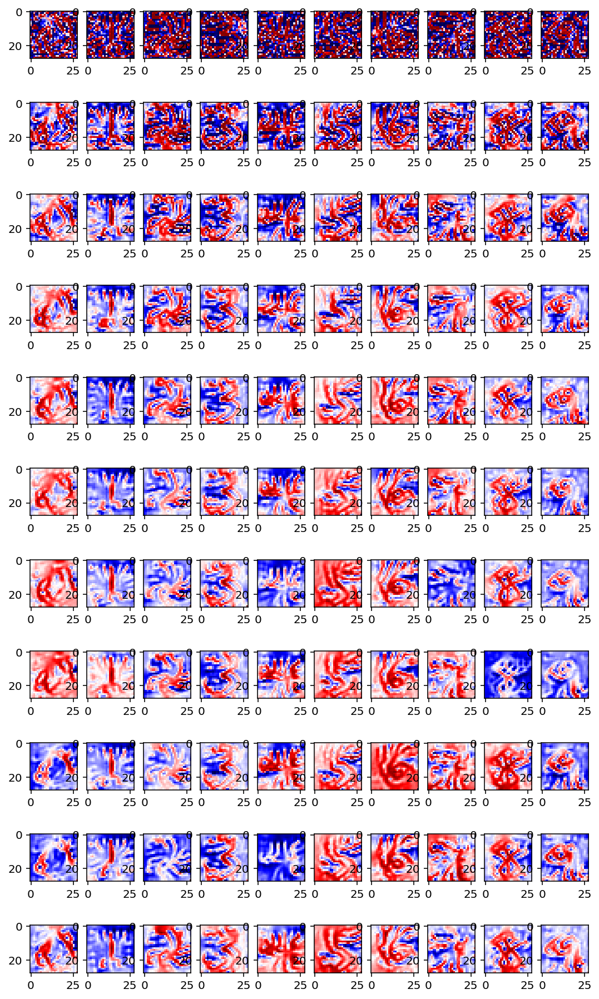

In [1]:
import keras
from vis.visualization import visualize_activation
from vis.utils import utils
import matplotlib.pyplot as plot
import matplotlib

# Comandos para exibir imagem no jupyter
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

model = keras.models.load_model('mnist_model.h5')
layer_idx = utils.find_layer_idx(model, 'nome_exclusivo_05')
model.layers[layer_idx].activation = keras.activations.linear
model = utils.apply_modifications(model)

for tv in range(0, 11, 1):
    for classe in range(0, 10): 
        plot.subplot(20,10,1+classe+10*(tv+9))
        filter_idx = classe
        img = visualize_activation(model, layer_idx, filter_indices=filter_idx, input_range=(0., 1.), verbose=True, max_iter=1000, tv_weight=float(tv/10.0), lp_norm_weight=0.9)
        plot.imshow(img.squeeze(), cmap='seismic', interpolation='nearest')

# ajustando tamanho de exibição
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 30)
# fig.savefig('test2png.png', dpi=100, forward=True)
plot.show()

## Execução com os melhores valores

Executamos a verificação de máxima ativação com os melhores valores para Lp e Tv. A imagem resultante está exibida no fim da execução abaixo.

Using TensorFlow backend.
W0628 01:40:05.610060 139891639596864 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0628 01:40:05.649973 139891639596864 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0628 01:40:05.692522 139891639596864 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.

W0628 01:40:05.694810 139891639596864 deprecation_wrapper.py:119] From /home/patrick/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:131: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_

Iteration: 1, named_losses: [('ActivationMax Loss', -0.8722542),
 ('L-6.0 Norm Loss', 0.0017849552),
 ('TV(2.0) Loss', 0.0027177245)], overall loss: -0.8677514791488647
Iteration: 2, named_losses: [('ActivationMax Loss', -51.71983),
 ('L-6.0 Norm Loss', 0.015321949),
 ('TV(2.0) Loss', 13.86786)], overall loss: -37.836647033691406
Iteration: 3, named_losses: [('ActivationMax Loss', -301.79385),
 ('L-6.0 Norm Loss', 0.023532024),
 ('TV(2.0) Loss', 19.403572)], overall loss: -282.36676025390625
Iteration: 4, named_losses: [('ActivationMax Loss', -596.96906),
 ('L-6.0 Norm Loss', 0.027917169),
 ('TV(2.0) Loss', 25.394272)], overall loss: -571.546875
Iteration: 5, named_losses: [('ActivationMax Loss', -915.44055),
 ('L-6.0 Norm Loss', 0.032861266),
 ('TV(2.0) Loss', 33.12121)], overall loss: -882.2864990234375
Iteration: 6, named_losses: [('ActivationMax Loss', -1213.9188),
 ('L-6.0 Norm Loss', 0.038436666),
 ('TV(2.0) Loss', 43.68769)], overall loss: -1170.192626953125
Iteration: 7, named_

Iteration: 73, named_losses: [('ActivationMax Loss', -10831.508),
 ('L-6.0 Norm Loss', 0.2476067),
 ('TV(2.0) Loss', 1782.1444)], overall loss: -9049.115234375
Iteration: 74, named_losses: [('ActivationMax Loss', -10938.925),
 ('L-6.0 Norm Loss', 0.25018892),
 ('TV(2.0) Loss', 1814.3805)], overall loss: -9124.2939453125
Iteration: 75, named_losses: [('ActivationMax Loss', -11056.267),
 ('L-6.0 Norm Loss', 0.25275233),
 ('TV(2.0) Loss', 1848.4535)], overall loss: -9207.560546875
Iteration: 76, named_losses: [('ActivationMax Loss', -11176.056),
 ('L-6.0 Norm Loss', 0.25533465),
 ('TV(2.0) Loss', 1883.8816)], overall loss: -9291.9189453125
Iteration: 77, named_losses: [('ActivationMax Loss', -11281.961),
 ('L-6.0 Norm Loss', 0.257916),
 ('TV(2.0) Loss', 1917.2297)], overall loss: -9364.4736328125
Iteration: 78, named_losses: [('ActivationMax Loss', -11394.936),
 ('L-6.0 Norm Loss', 0.26045063),
 ('TV(2.0) Loss', 1951.7701)], overall loss: -9442.904296875
Iteration: 79, named_losses: [('Ac

Iteration: 134, named_losses: [('ActivationMax Loss', -17299.383),
 ('L-6.0 Norm Loss', 0.39757526),
 ('TV(2.0) Loss', 4099.062)], overall loss: -13199.921875
Iteration: 135, named_losses: [('ActivationMax Loss', -17395.979),
 ('L-6.0 Norm Loss', 0.40000325),
 ('TV(2.0) Loss', 4140.9746)], overall loss: -13254.603515625
Iteration: 136, named_losses: [('ActivationMax Loss', -17494.17),
 ('L-6.0 Norm Loss', 0.40229747),
 ('TV(2.0) Loss', 4180.922)], overall loss: -13312.845703125
Iteration: 137, named_losses: [('ActivationMax Loss', -17592.021),
 ('L-6.0 Norm Loss', 0.40466568),
 ('TV(2.0) Loss', 4221.1353)], overall loss: -13370.482421875
Iteration: 138, named_losses: [('ActivationMax Loss', -17692.316),
 ('L-6.0 Norm Loss', 0.40705246),
 ('TV(2.0) Loss', 4262.1626)], overall loss: -13429.748046875
Iteration: 139, named_losses: [('ActivationMax Loss', -17781.596),
 ('L-6.0 Norm Loss', 0.40937132),
 ('TV(2.0) Loss', 4299.4946)], overall loss: -13481.69140625
Iteration: 140, named_losses:

Iteration: 205, named_losses: [('ActivationMax Loss', -23846.56),
 ('L-6.0 Norm Loss', 0.5580104),
 ('TV(2.0) Loss', 7058.011)], overall loss: -16787.990234375
Iteration: 206, named_losses: [('ActivationMax Loss', -23943.848),
 ('L-6.0 Norm Loss', 0.5601652),
 ('TV(2.0) Loss', 7100.1396)], overall loss: -16843.1484375
Iteration: 207, named_losses: [('ActivationMax Loss', -24031.914),
 ('L-6.0 Norm Loss', 0.5622594),
 ('TV(2.0) Loss', 7144.8335)], overall loss: -16886.517578125
Iteration: 208, named_losses: [('ActivationMax Loss', -24116.006),
 ('L-6.0 Norm Loss', 0.564461),
 ('TV(2.0) Loss', 7186.5273)], overall loss: -16928.9140625
Iteration: 209, named_losses: [('ActivationMax Loss', -24204.451),
 ('L-6.0 Norm Loss', 0.56654906),
 ('TV(2.0) Loss', 7228.748)], overall loss: -16975.13671875
Iteration: 210, named_losses: [('ActivationMax Loss', -24288.732),
 ('L-6.0 Norm Loss', 0.56867766),
 ('TV(2.0) Loss', 7268.923)], overall loss: -17019.2421875
Iteration: 211, named_losses: [('Activ

Iteration: 276, named_losses: [('ActivationMax Loss', -29455.086),
 ('L-6.0 Norm Loss', 0.70462215),
 ('TV(2.0) Loss', 10020.914)], overall loss: -19433.466796875
Iteration: 277, named_losses: [('ActivationMax Loss', -29524.799),
 ('L-6.0 Norm Loss', 0.7065385),
 ('TV(2.0) Loss', 10058.681)], overall loss: -19465.41015625
Iteration: 278, named_losses: [('ActivationMax Loss', -29596.059),
 ('L-6.0 Norm Loss', 0.708507),
 ('TV(2.0) Loss', 10098.334)], overall loss: -19497.015625
Iteration: 279, named_losses: [('ActivationMax Loss', -29664.814),
 ('L-6.0 Norm Loss', 0.7103657),
 ('TV(2.0) Loss', 10134.352)], overall loss: -19529.751953125
Iteration: 280, named_losses: [('ActivationMax Loss', -29732.611),
 ('L-6.0 Norm Loss', 0.7123748),
 ('TV(2.0) Loss', 10174.533)], overall loss: -19557.365234375
Iteration: 281, named_losses: [('ActivationMax Loss', -29797.943),
 ('L-6.0 Norm Loss', 0.71427727),
 ('TV(2.0) Loss', 10204.8)], overall loss: -19592.4296875
Iteration: 282, named_losses: [('Ac

Iteration: 348, named_losses: [('ActivationMax Loss', -34036.5),
 ('L-6.0 Norm Loss', 0.8409796),
 ('TV(2.0) Loss', 12501.587)], overall loss: -21534.07421875
Iteration: 349, named_losses: [('ActivationMax Loss', -34103.035),
 ('L-6.0 Norm Loss', 0.8429151),
 ('TV(2.0) Loss', 12538.784)], overall loss: -21563.40625
Iteration: 350, named_losses: [('ActivationMax Loss', -34147.43),
 ('L-6.0 Norm Loss', 0.8446847),
 ('TV(2.0) Loss', 12562.853)], overall loss: -21583.734375
Iteration: 351, named_losses: [('ActivationMax Loss', -34221.85),
 ('L-6.0 Norm Loss', 0.84657574),
 ('TV(2.0) Loss', 12604.876)], overall loss: -21616.12890625
Iteration: 352, named_losses: [('ActivationMax Loss', -34285.32),
 ('L-6.0 Norm Loss', 0.8484508),
 ('TV(2.0) Loss', 12639.675)], overall loss: -21644.796875
Iteration: 353, named_losses: [('ActivationMax Loss', -34348.816),
 ('L-6.0 Norm Loss', 0.8502749),
 ('TV(2.0) Loss', 12675.274)], overall loss: -21672.69140625
Iteration: 354, named_losses: [('ActivationMa

Iteration: 418, named_losses: [('ActivationMax Loss', -37805.773),
 ('L-6.0 Norm Loss', 0.9636105),
 ('TV(2.0) Loss', 14712.068)], overall loss: -23092.740234375
Iteration: 419, named_losses: [('ActivationMax Loss', -37839.977),
 ('L-6.0 Norm Loss', 0.9652526),
 ('TV(2.0) Loss', 14725.243)], overall loss: -23113.76953125
Iteration: 420, named_losses: [('ActivationMax Loss', -37897.19),
 ('L-6.0 Norm Loss', 0.9670629),
 ('TV(2.0) Loss', 14759.881)], overall loss: -23136.341796875
Iteration: 421, named_losses: [('ActivationMax Loss', -37943.434),
 ('L-6.0 Norm Loss', 0.96871525),
 ('TV(2.0) Loss', 14787.68)], overall loss: -23154.78515625
Iteration: 422, named_losses: [('ActivationMax Loss', -37992.133),
 ('L-6.0 Norm Loss', 0.9704575),
 ('TV(2.0) Loss', 14815.392)], overall loss: -23175.7734375
Iteration: 423, named_losses: [('ActivationMax Loss', -38041.348),
 ('L-6.0 Norm Loss', 0.972314),
 ('TV(2.0) Loss', 14845.989)], overall loss: -23194.38671875
Iteration: 424, named_losses: [('Ac

Iteration: 487, named_losses: [('ActivationMax Loss', -40975.98),
 ('L-6.0 Norm Loss', 1.0749766),
 ('TV(2.0) Loss', 16539.078)], overall loss: -24435.828125
Iteration: 488, named_losses: [('ActivationMax Loss', -41017.445),
 ('L-6.0 Norm Loss', 1.0765126),
 ('TV(2.0) Loss', 16562.037)], overall loss: -24454.330078125
Iteration: 489, named_losses: [('ActivationMax Loss', -41063.527),
 ('L-6.0 Norm Loss', 1.078074),
 ('TV(2.0) Loss', 16592.598)], overall loss: -24469.8515625
Iteration: 490, named_losses: [('ActivationMax Loss', -41107.426),
 ('L-6.0 Norm Loss', 1.0796025),
 ('TV(2.0) Loss', 16616.605)], overall loss: -24489.7421875
Iteration: 491, named_losses: [('ActivationMax Loss', -41154.035),
 ('L-6.0 Norm Loss', 1.0812843),
 ('TV(2.0) Loss', 16644.352)], overall loss: -24508.6015625
Iteration: 492, named_losses: [('ActivationMax Loss', -41193.734),
 ('L-6.0 Norm Loss', 1.0824392),
 ('TV(2.0) Loss', 16665.13)], overall loss: -24527.521484375
Iteration: 493, named_losses: [('Activat

Iteration: 559, named_losses: [('ActivationMax Loss', -43862.375),
 ('L-6.0 Norm Loss', 1.1834167),
 ('TV(2.0) Loss', 18320.225)], overall loss: -25540.966796875
Iteration: 560, named_losses: [('ActivationMax Loss', -43905.453),
 ('L-6.0 Norm Loss', 1.184887),
 ('TV(2.0) Loss', 18343.496)], overall loss: -25560.7734375
Iteration: 561, named_losses: [('ActivationMax Loss', -43936.0),
 ('L-6.0 Norm Loss', 1.1863177),
 ('TV(2.0) Loss', 18359.281)], overall loss: -25575.53125
Iteration: 562, named_losses: [('ActivationMax Loss', -43978.293),
 ('L-6.0 Norm Loss', 1.1878712),
 ('TV(2.0) Loss', 18382.656)], overall loss: -25594.44921875
Iteration: 563, named_losses: [('ActivationMax Loss', -44017.445),
 ('L-6.0 Norm Loss', 1.1891131),
 ('TV(2.0) Loss', 18409.418)], overall loss: -25606.83984375
Iteration: 564, named_losses: [('ActivationMax Loss', -44050.74),
 ('L-6.0 Norm Loss', 1.1906292),
 ('TV(2.0) Loss', 18428.969)], overall loss: -25620.578125
Iteration: 565, named_losses: [('Activation

Iteration: 629, named_losses: [('ActivationMax Loss', -46324.113),
 ('L-6.0 Norm Loss', 1.2829657),
 ('TV(2.0) Loss', 19913.29)], overall loss: -26409.54296875
Iteration: 630, named_losses: [('ActivationMax Loss', -46367.742),
 ('L-6.0 Norm Loss', 1.2844409),
 ('TV(2.0) Loss', 19939.97)], overall loss: -26426.486328125
Iteration: 631, named_losses: [('ActivationMax Loss', -46403.387),
 ('L-6.0 Norm Loss', 1.2855672),
 ('TV(2.0) Loss', 19963.35)], overall loss: -26438.751953125
Iteration: 632, named_losses: [('ActivationMax Loss', -46439.156),
 ('L-6.0 Norm Loss', 1.2871537),
 ('TV(2.0) Loss', 19986.223)], overall loss: -26451.64453125
Iteration: 633, named_losses: [('ActivationMax Loss', -46468.957),
 ('L-6.0 Norm Loss', 1.2883666),
 ('TV(2.0) Loss', 20008.62)], overall loss: -26459.048828125
Iteration: 634, named_losses: [('ActivationMax Loss', -46503.664),
 ('L-6.0 Norm Loss', 1.2897171),
 ('TV(2.0) Loss', 20032.447)], overall loss: -26469.927734375
Iteration: 635, named_losses: [('A

Iteration: 699, named_losses: [('ActivationMax Loss', -48503.684),
 ('L-6.0 Norm Loss', 1.3746685),
 ('TV(2.0) Loss', 21450.236)], overall loss: -27052.072265625
Iteration: 700, named_losses: [('ActivationMax Loss', -48531.49),
 ('L-6.0 Norm Loss', 1.3759689),
 ('TV(2.0) Loss', 21470.56)], overall loss: -27059.552734375
Iteration: 701, named_losses: [('ActivationMax Loss', -48563.887),
 ('L-6.0 Norm Loss', 1.3772361),
 ('TV(2.0) Loss', 21493.709)], overall loss: -27068.798828125
Iteration: 702, named_losses: [('ActivationMax Loss', -48586.14),
 ('L-6.0 Norm Loss', 1.3783822),
 ('TV(2.0) Loss', 21511.006)], overall loss: -27073.755859375
Iteration: 703, named_losses: [('ActivationMax Loss', -48611.277),
 ('L-6.0 Norm Loss', 1.3794948),
 ('TV(2.0) Loss', 21528.549)], overall loss: -27081.349609375
Iteration: 704, named_losses: [('ActivationMax Loss', -48637.668),
 ('L-6.0 Norm Loss', 1.380933),
 ('TV(2.0) Loss', 21551.322)], overall loss: -27084.962890625
Iteration: 705, named_losses: [(

Iteration: 795, named_losses: [('ActivationMax Loss', -50747.57),
 ('L-6.0 Norm Loss', 1.4917935),
 ('TV(2.0) Loss', 23017.557)], overall loss: -27728.521484375
Iteration: 796, named_losses: [('ActivationMax Loss', -50771.89),
 ('L-6.0 Norm Loss', 1.4929794),
 ('TV(2.0) Loss', 23027.865)], overall loss: -27742.533203125
Iteration: 797, named_losses: [('ActivationMax Loss', -50783.867),
 ('L-6.0 Norm Loss', 1.4939942),
 ('TV(2.0) Loss', 23030.676)], overall loss: -27751.69921875
Iteration: 798, named_losses: [('ActivationMax Loss', -50796.29),
 ('L-6.0 Norm Loss', 1.4953998),
 ('TV(2.0) Loss', 23040.82)], overall loss: -27753.97265625
Iteration: 799, named_losses: [('ActivationMax Loss', -50828.684),
 ('L-6.0 Norm Loss', 1.4968135),
 ('TV(2.0) Loss', 23063.545)], overall loss: -27763.642578125
Iteration: 800, named_losses: [('ActivationMax Loss', -50842.75),
 ('L-6.0 Norm Loss', 1.497987),
 ('TV(2.0) Loss', 23067.338)], overall loss: -27773.916015625
Iteration: 801, named_losses: [('Act

Iteration: 892, named_losses: [('ActivationMax Loss', -52574.266),
 ('L-6.0 Norm Loss', 1.613078),
 ('TV(2.0) Loss', 24072.89)], overall loss: -28499.76171875
Iteration: 893, named_losses: [('ActivationMax Loss', -52597.58),
 ('L-6.0 Norm Loss', 1.6140851),
 ('TV(2.0) Loss', 24092.498)], overall loss: -28503.466796875
Iteration: 894, named_losses: [('ActivationMax Loss', -52613.406),
 ('L-6.0 Norm Loss', 1.6157275),
 ('TV(2.0) Loss', 24096.938)], overall loss: -28514.8515625
Iteration: 895, named_losses: [('ActivationMax Loss', -52626.164),
 ('L-6.0 Norm Loss', 1.6166416),
 ('TV(2.0) Loss', 24104.557)], overall loss: -28519.990234375
Iteration: 896, named_losses: [('ActivationMax Loss', -52652.31),
 ('L-6.0 Norm Loss', 1.6179838),
 ('TV(2.0) Loss', 24123.49)], overall loss: -28527.201171875
Iteration: 897, named_losses: [('ActivationMax Loss', -52674.36),
 ('L-6.0 Norm Loss', 1.6191852),
 ('TV(2.0) Loss', 24138.316)], overall loss: -28534.421875
Iteration: 898, named_losses: [('Activat

Iteration: 958, named_losses: [('ActivationMax Loss', -53800.62),
 ('L-6.0 Norm Loss', 1.6880715),
 ('TV(2.0) Loss', 24919.111)], overall loss: -28879.822265625
Iteration: 959, named_losses: [('ActivationMax Loss', -53817.53),
 ('L-6.0 Norm Loss', 1.6891752),
 ('TV(2.0) Loss', 24928.332)], overall loss: -28887.51171875
Iteration: 960, named_losses: [('ActivationMax Loss', -53836.05),
 ('L-6.0 Norm Loss', 1.6904726),
 ('TV(2.0) Loss', 24942.842)], overall loss: -28891.517578125
Iteration: 961, named_losses: [('ActivationMax Loss', -53850.273),
 ('L-6.0 Norm Loss', 1.691439),
 ('TV(2.0) Loss', 24947.863)], overall loss: -28900.71875
Iteration: 962, named_losses: [('ActivationMax Loss', -53871.453),
 ('L-6.0 Norm Loss', 1.6926056),
 ('TV(2.0) Loss', 24965.883)], overall loss: -28903.87890625
Iteration: 963, named_losses: [('ActivationMax Loss', -53895.445),
 ('L-6.0 Norm Loss', 1.6936916),
 ('TV(2.0) Loss', 24989.068)], overall loss: -28904.681640625
Iteration: 964, named_losses: [('Activ

Iteration: 49, named_losses: [('ActivationMax Loss', -7589.142),
 ('L-6.0 Norm Loss', 0.18521968),
 ('TV(2.0) Loss', 1006.73285)], overall loss: -6582.22412109375
Iteration: 50, named_losses: [('ActivationMax Loss', -7703.6387),
 ('L-6.0 Norm Loss', 0.18791875),
 ('TV(2.0) Loss', 1035.1338)], overall loss: -6668.31689453125
Iteration: 51, named_losses: [('ActivationMax Loss', -7823.8857),
 ('L-6.0 Norm Loss', 0.19039473),
 ('TV(2.0) Loss', 1060.2836)], overall loss: -6763.41162109375
Iteration: 52, named_losses: [('ActivationMax Loss', -7942.187),
 ('L-6.0 Norm Loss', 0.19286951),
 ('TV(2.0) Loss', 1087.4795)], overall loss: -6854.5146484375
Iteration: 53, named_losses: [('ActivationMax Loss', -8055.3516),
 ('L-6.0 Norm Loss', 0.19546622),
 ('TV(2.0) Loss', 1115.7747)], overall loss: -6939.3818359375
Iteration: 54, named_losses: [('ActivationMax Loss', -8184.9795),
 ('L-6.0 Norm Loss', 0.1981013),
 ('TV(2.0) Loss', 1144.8817)], overall loss: -7039.8994140625
Iteration: 55, named_losses

Iteration: 107, named_losses: [('ActivationMax Loss', -14156.854),
 ('L-6.0 Norm Loss', 0.33088928),
 ('TV(2.0) Loss', 2914.3665)], overall loss: -11242.15625
Iteration: 108, named_losses: [('ActivationMax Loss', -14274.27),
 ('L-6.0 Norm Loss', 0.33341524),
 ('TV(2.0) Loss', 2953.825)], overall loss: -11320.111328125
Iteration: 109, named_losses: [('ActivationMax Loss', -14386.622),
 ('L-6.0 Norm Loss', 0.33580458),
 ('TV(2.0) Loss', 2990.0046)], overall loss: -11396.28125
Iteration: 110, named_losses: [('ActivationMax Loss', -14497.634),
 ('L-6.0 Norm Loss', 0.3382996),
 ('TV(2.0) Loss', 3027.3606)], overall loss: -11469.935546875
Iteration: 111, named_losses: [('ActivationMax Loss', -14595.902),
 ('L-6.0 Norm Loss', 0.3406746),
 ('TV(2.0) Loss', 3064.838)], overall loss: -11530.7236328125
Iteration: 112, named_losses: [('ActivationMax Loss', -14712.541),
 ('L-6.0 Norm Loss', 0.34313038),
 ('TV(2.0) Loss', 3103.7842)], overall loss: -11608.4140625
Iteration: 113, named_losses: [('Act

Iteration: 166, named_losses: [('ActivationMax Loss', -20144.014),
 ('L-6.0 Norm Loss', 0.4714723),
 ('TV(2.0) Loss', 5328.8804)], overall loss: -14814.662109375
Iteration: 167, named_losses: [('ActivationMax Loss', -20244.02),
 ('L-6.0 Norm Loss', 0.47383612),
 ('TV(2.0) Loss', 5373.6836)], overall loss: -14869.861328125
Iteration: 168, named_losses: [('ActivationMax Loss', -20342.0),
 ('L-6.0 Norm Loss', 0.47622758),
 ('TV(2.0) Loss', 5418.0703)], overall loss: -14923.453125
Iteration: 169, named_losses: [('ActivationMax Loss', -20444.943),
 ('L-6.0 Norm Loss', 0.47868738),
 ('TV(2.0) Loss', 5465.8535)], overall loss: -14978.611328125
Iteration: 170, named_losses: [('ActivationMax Loss', -20551.98),
 ('L-6.0 Norm Loss', 0.48117882),
 ('TV(2.0) Loss', 5513.9565)], overall loss: -15037.54296875
Iteration: 171, named_losses: [('ActivationMax Loss', -20635.209),
 ('L-6.0 Norm Loss', 0.48346004),
 ('TV(2.0) Loss', 5556.52)], overall loss: -15078.205078125
Iteration: 172, named_losses: [('

Iteration: 269, named_losses: [('ActivationMax Loss', -28785.004),
 ('L-6.0 Norm Loss', 0.69486815),
 ('TV(2.0) Loss', 9721.264)], overall loss: -19063.044921875
Iteration: 270, named_losses: [('ActivationMax Loss', -28855.393),
 ('L-6.0 Norm Loss', 0.697113),
 ('TV(2.0) Loss', 9764.221)], overall loss: -19090.474609375
Iteration: 271, named_losses: [('ActivationMax Loss', -28931.514),
 ('L-6.0 Norm Loss', 0.69906104),
 ('TV(2.0) Loss', 9804.007)], overall loss: -19126.80859375
Iteration: 272, named_losses: [('ActivationMax Loss', -29010.916),
 ('L-6.0 Norm Loss', 0.7012893),
 ('TV(2.0) Loss', 9847.491)], overall loss: -19162.72265625
Iteration: 273, named_losses: [('ActivationMax Loss', -29085.217),
 ('L-6.0 Norm Loss', 0.7034125),
 ('TV(2.0) Loss', 9889.346)], overall loss: -19195.16796875
Iteration: 274, named_losses: [('ActivationMax Loss', -29155.898),
 ('L-6.0 Norm Loss', 0.7054445),
 ('TV(2.0) Loss', 9926.935)], overall loss: -19228.2578125
Iteration: 275, named_losses: [('Activ

Iteration: 338, named_losses: [('ActivationMax Loss', -33731.87),
 ('L-6.0 Norm Loss', 0.8286414),
 ('TV(2.0) Loss', 12286.753)], overall loss: -21444.2890625
Iteration: 339, named_losses: [('ActivationMax Loss', -33793.402),
 ('L-6.0 Norm Loss', 0.8302223),
 ('TV(2.0) Loss', 12322.328)], overall loss: -21470.2421875
Iteration: 340, named_losses: [('ActivationMax Loss', -33868.516),
 ('L-6.0 Norm Loss', 0.83231896),
 ('TV(2.0) Loss', 12358.155)], overall loss: -21509.52734375
Iteration: 341, named_losses: [('ActivationMax Loss', -33949.06),
 ('L-6.0 Norm Loss', 0.8344117),
 ('TV(2.0) Loss', 12402.275)], overall loss: -21545.947265625
Iteration: 342, named_losses: [('ActivationMax Loss', -34016.99),
 ('L-6.0 Norm Loss', 0.8362952),
 ('TV(2.0) Loss', 12433.527)], overall loss: -21582.625
Iteration: 343, named_losses: [('ActivationMax Loss', -34097.594),
 ('L-6.0 Norm Loss', 0.8384198),
 ('TV(2.0) Loss', 12479.278)], overall loss: -21617.4765625
Iteration: 344, named_losses: [('Activation

Iteration: 404, named_losses: [('ActivationMax Loss', -38013.75),
 ('L-6.0 Norm Loss', 0.9521553),
 ('TV(2.0) Loss', 14714.1045)], overall loss: -23298.69140625
Iteration: 405, named_losses: [('ActivationMax Loss', -38065.105),
 ('L-6.0 Norm Loss', 0.95358956),
 ('TV(2.0) Loss', 14749.604)], overall loss: -23314.548828125
Iteration: 406, named_losses: [('ActivationMax Loss', -38133.08),
 ('L-6.0 Norm Loss', 0.9554698),
 ('TV(2.0) Loss', 14786.18)], overall loss: -23345.94140625
Iteration: 407, named_losses: [('ActivationMax Loss', -38190.246),
 ('L-6.0 Norm Loss', 0.9574372),
 ('TV(2.0) Loss', 14819.153)], overall loss: -23370.13671875
Iteration: 408, named_losses: [('ActivationMax Loss', -38247.902),
 ('L-6.0 Norm Loss', 0.95911574),
 ('TV(2.0) Loss', 14857.775)], overall loss: -23389.166015625
Iteration: 409, named_losses: [('ActivationMax Loss', -38289.473),
 ('L-6.0 Norm Loss', 0.9605988),
 ('TV(2.0) Loss', 14877.3)], overall loss: -23411.2109375
Iteration: 410, named_losses: [('Ac

Iteration: 511, named_losses: [('ActivationMax Loss', -43806.848),
 ('L-6.0 Norm Loss', 1.1402292),
 ('TV(2.0) Loss', 18331.744)], overall loss: -25473.962890625
Iteration: 512, named_losses: [('ActivationMax Loss', -43846.332),
 ('L-6.0 Norm Loss', 1.1418927),
 ('TV(2.0) Loss', 18369.555)], overall loss: -25475.63671875
Iteration: 513, named_losses: [('ActivationMax Loss', -43882.16),
 ('L-6.0 Norm Loss', 1.1430911),
 ('TV(2.0) Loss', 18390.2)], overall loss: -25490.81640625
Iteration: 514, named_losses: [('ActivationMax Loss', -43925.055),
 ('L-6.0 Norm Loss', 1.1446737),
 ('TV(2.0) Loss', 18410.148)], overall loss: -25513.76171875
Iteration: 515, named_losses: [('ActivationMax Loss', -43958.477),
 ('L-6.0 Norm Loss', 1.1461551),
 ('TV(2.0) Loss', 18431.373)], overall loss: -25525.958984375
Iteration: 516, named_losses: [('ActivationMax Loss', -44024.71),
 ('L-6.0 Norm Loss', 1.1478558),
 ('TV(2.0) Loss', 18471.857)], overall loss: -25551.705078125
Iteration: 517, named_losses: [('Ac

Iteration: 580, named_losses: [('ActivationMax Loss', -46874.43),
 ('L-6.0 Norm Loss', 1.2471743),
 ('TV(2.0) Loss', 20241.67)], overall loss: -26631.513671875
Iteration: 581, named_losses: [('ActivationMax Loss', -46923.09),
 ('L-6.0 Norm Loss', 1.2486116),
 ('TV(2.0) Loss', 20267.541)], overall loss: -26654.298828125
Iteration: 582, named_losses: [('ActivationMax Loss', -46955.465),
 ('L-6.0 Norm Loss', 1.2502522),
 ('TV(2.0) Loss', 20288.629)], overall loss: -26665.5859375
Iteration: 583, named_losses: [('ActivationMax Loss', -46992.676),
 ('L-6.0 Norm Loss', 1.2517886),
 ('TV(2.0) Loss', 20309.463)], overall loss: -26681.962890625
Iteration: 584, named_losses: [('ActivationMax Loss', -47045.867),
 ('L-6.0 Norm Loss', 1.2531697),
 ('TV(2.0) Loss', 20339.068)], overall loss: -26705.544921875
Iteration: 585, named_losses: [('ActivationMax Loss', -47080.04),
 ('L-6.0 Norm Loss', 1.2548435),
 ('TV(2.0) Loss', 20364.043)], overall loss: -26714.7421875
Iteration: 586, named_losses: [('Act

Iteration: 649, named_losses: [('ActivationMax Loss', -49753.58),
 ('L-6.0 Norm Loss', 1.3492613),
 ('TV(2.0) Loss', 21918.527)], overall loss: -27833.703125
Iteration: 650, named_losses: [('ActivationMax Loss', -49791.164),
 ('L-6.0 Norm Loss', 1.350957),
 ('TV(2.0) Loss', 21945.809)], overall loss: -27844.00390625
Iteration: 651, named_losses: [('ActivationMax Loss', -49832.863),
 ('L-6.0 Norm Loss', 1.3527153),
 ('TV(2.0) Loss', 21973.582)], overall loss: -27857.9296875
Iteration: 652, named_losses: [('ActivationMax Loss', -49872.86),
 ('L-6.0 Norm Loss', 1.3537401),
 ('TV(2.0) Loss', 21997.531)], overall loss: -27873.97265625
Iteration: 653, named_losses: [('ActivationMax Loss', -49907.39),
 ('L-6.0 Norm Loss', 1.3550462),
 ('TV(2.0) Loss', 22022.234)], overall loss: -27883.80078125
Iteration: 654, named_losses: [('ActivationMax Loss', -49952.8),
 ('L-6.0 Norm Loss', 1.356594),
 ('TV(2.0) Loss', 22047.527)], overall loss: -27903.91796875
Iteration: 655, named_losses: [('ActivationM

Iteration: 745, named_losses: [('ActivationMax Loss', -53265.074),
 ('L-6.0 Norm Loss', 1.4868869),
 ('TV(2.0) Loss', 24246.613)], overall loss: -29016.97265625
Iteration: 746, named_losses: [('ActivationMax Loss', -53302.246),
 ('L-6.0 Norm Loss', 1.4882495),
 ('TV(2.0) Loss', 24271.814)], overall loss: -29028.943359375
Iteration: 747, named_losses: [('ActivationMax Loss', -53335.746),
 ('L-6.0 Norm Loss', 1.4897126),
 ('TV(2.0) Loss', 24296.26)], overall loss: -29037.998046875
Iteration: 748, named_losses: [('ActivationMax Loss', -53370.05),
 ('L-6.0 Norm Loss', 1.4908714),
 ('TV(2.0) Loss', 24320.373)], overall loss: -29048.185546875
Iteration: 749, named_losses: [('ActivationMax Loss', -53398.805),
 ('L-6.0 Norm Loss', 1.492477),
 ('TV(2.0) Loss', 24345.172)], overall loss: -29052.140625
Iteration: 750, named_losses: [('ActivationMax Loss', -53438.3),
 ('L-6.0 Norm Loss', 1.4938107),
 ('TV(2.0) Loss', 24370.426)], overall loss: -29066.3828125
Iteration: 751, named_losses: [('Activa

Iteration: 802, named_losses: [('ActivationMax Loss', -54785.74),
 ('L-6.0 Norm Loss', 1.5618788),
 ('TV(2.0) Loss', 25301.025)], overall loss: -29483.150390625
Iteration: 803, named_losses: [('ActivationMax Loss', -54802.418),
 ('L-6.0 Norm Loss', 1.5630217),
 ('TV(2.0) Loss', 25312.51)], overall loss: -29488.345703125
Iteration: 804, named_losses: [('ActivationMax Loss', -54838.316),
 ('L-6.0 Norm Loss', 1.5645502),
 ('TV(2.0) Loss', 25333.924)], overall loss: -29502.826171875
Iteration: 805, named_losses: [('ActivationMax Loss', -54854.938),
 ('L-6.0 Norm Loss', 1.5656432),
 ('TV(2.0) Loss', 25350.531)], overall loss: -29502.83984375
Iteration: 806, named_losses: [('ActivationMax Loss', -54891.12),
 ('L-6.0 Norm Loss', 1.5667495),
 ('TV(2.0) Loss', 25371.475)], overall loss: -29518.080078125
Iteration: 807, named_losses: [('ActivationMax Loss', -54913.36),
 ('L-6.0 Norm Loss', 1.568383),
 ('TV(2.0) Loss', 25393.494)], overall loss: -29518.294921875
Iteration: 808, named_losses: [('A

Iteration: 860, named_losses: [('ActivationMax Loss', -56125.312),
 ('L-6.0 Norm Loss', 1.6288836),
 ('TV(2.0) Loss', 26263.057)], overall loss: -29860.626953125
Iteration: 861, named_losses: [('ActivationMax Loss', -56144.49),
 ('L-6.0 Norm Loss', 1.6298549),
 ('TV(2.0) Loss', 26278.566)], overall loss: -29864.29296875
Iteration: 862, named_losses: [('ActivationMax Loss', -56174.76),
 ('L-6.0 Norm Loss', 1.63124),
 ('TV(2.0) Loss', 26301.67)], overall loss: -29871.458984375
Iteration: 863, named_losses: [('ActivationMax Loss', -56190.258),
 ('L-6.0 Norm Loss', 1.6321197),
 ('TV(2.0) Loss', 26309.795)], overall loss: -29878.830078125
Iteration: 864, named_losses: [('ActivationMax Loss', -56209.61),
 ('L-6.0 Norm Loss', 1.6333295),
 ('TV(2.0) Loss', 26325.588)], overall loss: -29882.388671875
Iteration: 865, named_losses: [('ActivationMax Loss', -56245.14),
 ('L-6.0 Norm Loss', 1.6346893),
 ('TV(2.0) Loss', 26347.447)], overall loss: -29896.060546875
Iteration: 866, named_losses: [('Act

Iteration: 924, named_losses: [('ActivationMax Loss', -57429.742),
 ('L-6.0 Norm Loss', 1.6929865),
 ('TV(2.0) Loss', 27141.074)], overall loss: -30286.9765625
Iteration: 925, named_losses: [('ActivationMax Loss', -57440.04),
 ('L-6.0 Norm Loss', 1.6933464),
 ('TV(2.0) Loss', 27144.71)], overall loss: -30293.63671875
Iteration: 926, named_losses: [('ActivationMax Loss', -57473.016),
 ('L-6.0 Norm Loss', 1.6948233),
 ('TV(2.0) Loss', 27173.43)], overall loss: -30297.890625
Iteration: 927, named_losses: [('ActivationMax Loss', -57462.57),
 ('L-6.0 Norm Loss', 1.6946526),
 ('TV(2.0) Loss', 27160.38)], overall loss: -30300.494140625
Iteration: 928, named_losses: [('ActivationMax Loss', -57490.35),
 ('L-6.0 Norm Loss', 1.6957874),
 ('TV(2.0) Loss', 27177.06)], overall loss: -30311.595703125
Iteration: 929, named_losses: [('ActivationMax Loss', -57514.98),
 ('L-6.0 Norm Loss', 1.697138),
 ('TV(2.0) Loss', 27199.375)], overall loss: -30313.91015625
Iteration: 930, named_losses: [('ActivationM

Iteration: 984, named_losses: [('ActivationMax Loss', -58350.645),
 ('L-6.0 Norm Loss', 1.7443291),
 ('TV(2.0) Loss', 27753.016)], overall loss: -30595.8828125
Iteration: 985, named_losses: [('ActivationMax Loss', -58344.797),
 ('L-6.0 Norm Loss', 1.7445508),
 ('TV(2.0) Loss', 27745.955)], overall loss: -30597.095703125
Iteration: 986, named_losses: [('ActivationMax Loss', -58364.86),
 ('L-6.0 Norm Loss', 1.7457409),
 ('TV(2.0) Loss', 27758.967)], overall loss: -30604.146484375
Iteration: 987, named_losses: [('ActivationMax Loss', -58381.277),
 ('L-6.0 Norm Loss', 1.74632),
 ('TV(2.0) Loss', 27769.334)], overall loss: -30610.197265625
Iteration: 988, named_losses: [('ActivationMax Loss', -58401.547),
 ('L-6.0 Norm Loss', 1.7472216),
 ('TV(2.0) Loss', 27783.676)], overall loss: -30616.125
Iteration: 989, named_losses: [('ActivationMax Loss', -58397.28),
 ('L-6.0 Norm Loss', 1.7479982),
 ('TV(2.0) Loss', 27780.242)], overall loss: -30615.29296875
Iteration: 990, named_losses: [('Activati

Iteration: 71, named_losses: [('ActivationMax Loss', -18422.26),
 ('L-6.0 Norm Loss', 0.25996262),
 ('TV(2.0) Loss', 2278.955)], overall loss: -16143.044921875
Iteration: 72, named_losses: [('ActivationMax Loss', -18626.057),
 ('L-6.0 Norm Loss', 0.26278016),
 ('TV(2.0) Loss', 2326.8396)], overall loss: -16298.953125
Iteration: 73, named_losses: [('ActivationMax Loss', -18832.695),
 ('L-6.0 Norm Loss', 0.26562023),
 ('TV(2.0) Loss', 2376.2034)], overall loss: -16456.2265625
Iteration: 74, named_losses: [('ActivationMax Loss', -19034.648),
 ('L-6.0 Norm Loss', 0.2684608),
 ('TV(2.0) Loss', 2423.6873)], overall loss: -16610.693359375
Iteration: 75, named_losses: [('ActivationMax Loss', -19241.873),
 ('L-6.0 Norm Loss', 0.2713103),
 ('TV(2.0) Loss', 2473.7266)], overall loss: -16767.875
Iteration: 76, named_losses: [('ActivationMax Loss', -19445.996),
 ('L-6.0 Norm Loss', 0.27413076),
 ('TV(2.0) Loss', 2523.8997)], overall loss: -16921.822265625
Iteration: 77, named_losses: [('ActivationM

Iteration: 141, named_losses: [('ActivationMax Loss', -32301.969),
 ('L-6.0 Norm Loss', 0.4533924),
 ('TV(2.0) Loss', 6354.047)], overall loss: -25947.46875
Iteration: 142, named_losses: [('ActivationMax Loss', -32491.002),
 ('L-6.0 Norm Loss', 0.45607305),
 ('TV(2.0) Loss', 6421.318)], overall loss: -26069.2265625
Iteration: 143, named_losses: [('ActivationMax Loss', -32679.691),
 ('L-6.0 Norm Loss', 0.45876434),
 ('TV(2.0) Loss', 6489.7134)], overall loss: -26189.51953125
Iteration: 144, named_losses: [('ActivationMax Loss', -32871.527),
 ('L-6.0 Norm Loss', 0.46144938),
 ('TV(2.0) Loss', 6556.84)], overall loss: -26314.2265625
Iteration: 145, named_losses: [('ActivationMax Loss', -33056.004),
 ('L-6.0 Norm Loss', 0.46412778),
 ('TV(2.0) Loss', 6623.211)], overall loss: -26432.328125
Iteration: 146, named_losses: [('ActivationMax Loss', -33237.066),
 ('L-6.0 Norm Loss', 0.46680808),
 ('TV(2.0) Loss', 6686.2983)], overall loss: -26550.298828125
Iteration: 147, named_losses: [('Activat

Iteration: 212, named_losses: [('ActivationMax Loss', -45146.332),
 ('L-6.0 Norm Loss', 0.6399677),
 ('TV(2.0) Loss', 11553.225)], overall loss: -33592.46875
Iteration: 213, named_losses: [('ActivationMax Loss', -45326.37),
 ('L-6.0 Norm Loss', 0.6425693),
 ('TV(2.0) Loss', 11636.023)], overall loss: -33689.70703125
Iteration: 214, named_losses: [('ActivationMax Loss', -45499.14),
 ('L-6.0 Norm Loss', 0.6451094),
 ('TV(2.0) Loss', 11718.168)], overall loss: -33780.328125
Iteration: 215, named_losses: [('ActivationMax Loss', -45670.39),
 ('L-6.0 Norm Loss', 0.64769536),
 ('TV(2.0) Loss', 11797.065)], overall loss: -33872.67578125
Iteration: 216, named_losses: [('ActivationMax Loss', -45843.27),
 ('L-6.0 Norm Loss', 0.6502434),
 ('TV(2.0) Loss', 11879.467)], overall loss: -33963.15625
Iteration: 217, named_losses: [('ActivationMax Loss', -46012.27),
 ('L-6.0 Norm Loss', 0.65281004),
 ('TV(2.0) Loss', 11958.444)], overall loss: -34053.171875
Iteration: 218, named_losses: [('ActivationMax 

Iteration: 280, named_losses: [('ActivationMax Loss', -56377.227),
 ('L-6.0 Norm Loss', 0.8075732),
 ('TV(2.0) Loss', 16964.812)], overall loss: -39411.60546875
Iteration: 281, named_losses: [('ActivationMax Loss', -56534.3),
 ('L-6.0 Norm Loss', 0.8099656),
 ('TV(2.0) Loss', 17041.83)], overall loss: -39491.6640625
Iteration: 282, named_losses: [('ActivationMax Loss', -56694.3),
 ('L-6.0 Norm Loss', 0.81232876),
 ('TV(2.0) Loss', 17121.922)], overall loss: -39571.56640625
Iteration: 283, named_losses: [('ActivationMax Loss', -56850.57),
 ('L-6.0 Norm Loss', 0.81472814),
 ('TV(2.0) Loss', 17196.35)], overall loss: -39653.40625
Iteration: 284, named_losses: [('ActivationMax Loss', -57012.418),
 ('L-6.0 Norm Loss', 0.8171435),
 ('TV(2.0) Loss', 17282.422)], overall loss: -39729.1796875
Iteration: 285, named_losses: [('ActivationMax Loss', -57168.594),
 ('L-6.0 Norm Loss', 0.8195033),
 ('TV(2.0) Loss', 17358.42)], overall loss: -39809.3515625
Iteration: 286, named_losses: [('ActivationMax

Iteration: 350, named_losses: [('ActivationMax Loss', -67000.66),
 ('L-6.0 Norm Loss', 0.9706823),
 ('TV(2.0) Loss', 22372.715)], overall loss: -44626.97265625
Iteration: 351, named_losses: [('ActivationMax Loss', -67138.6),
 ('L-6.0 Norm Loss', 0.972779),
 ('TV(2.0) Loss', 22426.191)], overall loss: -44711.43359375
Iteration: 352, named_losses: [('ActivationMax Loss', -67289.56),
 ('L-6.0 Norm Loss', 0.9749818),
 ('TV(2.0) Loss', 22491.979)], overall loss: -44796.609375
Iteration: 353, named_losses: [('ActivationMax Loss', -67437.26),
 ('L-6.0 Norm Loss', 0.97722214),
 ('TV(2.0) Loss', 22556.693)], overall loss: -44879.5859375
Iteration: 354, named_losses: [('ActivationMax Loss', -67580.54),
 ('L-6.0 Norm Loss', 0.979428),
 ('TV(2.0) Loss', 22620.799)], overall loss: -44958.765625
Iteration: 355, named_losses: [('ActivationMax Loss', -67720.25),
 ('L-6.0 Norm Loss', 0.9816018),
 ('TV(2.0) Loss', 22685.098)], overall loss: -45034.16796875
Iteration: 356, named_losses: [('ActivationMax 

Iteration: 421, named_losses: [('ActivationMax Loss', -77099.0),
 ('L-6.0 Norm Loss', 1.1283212),
 ('TV(2.0) Loss', 27673.818)], overall loss: -49424.0546875
Iteration: 422, named_losses: [('ActivationMax Loss', -77238.85),
 ('L-6.0 Norm Loss', 1.130454),
 ('TV(2.0) Loss', 27754.82)], overall loss: -49482.8984375
Iteration: 423, named_losses: [('ActivationMax Loss', -77371.016),
 ('L-6.0 Norm Loss', 1.1326916),
 ('TV(2.0) Loss', 27829.318)], overall loss: -49540.5625
Iteration: 424, named_losses: [('ActivationMax Loss', -77514.05),
 ('L-6.0 Norm Loss', 1.1348174),
 ('TV(2.0) Loss', 27916.121)], overall loss: -49596.79296875
Iteration: 425, named_losses: [('ActivationMax Loss', -77652.2),
 ('L-6.0 Norm Loss', 1.1370394),
 ('TV(2.0) Loss', 27992.521)], overall loss: -49658.5390625
Iteration: 426, named_losses: [('ActivationMax Loss', -77793.06),
 ('L-6.0 Norm Loss', 1.139311),
 ('TV(2.0) Loss', 28080.486)], overall loss: -49711.4375
Iteration: 427, named_losses: [('ActivationMax Loss', -

Iteration: 489, named_losses: [('ActivationMax Loss', -85834.805),
 ('L-6.0 Norm Loss', 1.2709796),
 ('TV(2.0) Loss', 33001.86)], overall loss: -52831.671875
Iteration: 490, named_losses: [('ActivationMax Loss', -85966.016),
 ('L-6.0 Norm Loss', 1.2729381),
 ('TV(2.0) Loss', 33079.06)], overall loss: -52885.68359375
Iteration: 491, named_losses: [('ActivationMax Loss', -86085.64),
 ('L-6.0 Norm Loss', 1.2749629),
 ('TV(2.0) Loss', 33156.777)], overall loss: -52927.58984375
Iteration: 492, named_losses: [('ActivationMax Loss', -86203.555),
 ('L-6.0 Norm Loss', 1.2769582),
 ('TV(2.0) Loss', 33224.426)], overall loss: -52977.85546875
Iteration: 493, named_losses: [('ActivationMax Loss', -86328.8),
 ('L-6.0 Norm Loss', 1.2790444),
 ('TV(2.0) Loss', 33302.496)], overall loss: -53025.01953125
Iteration: 494, named_losses: [('ActivationMax Loss', -86454.72),
 ('L-6.0 Norm Loss', 1.2810293),
 ('TV(2.0) Loss', 33381.332)], overall loss: -53072.10546875
Iteration: 495, named_losses: [('Activatio

Iteration: 559, named_losses: [('ActivationMax Loss', -93783.766),
 ('L-6.0 Norm Loss', 1.4075302),
 ('TV(2.0) Loss', 37966.902)], overall loss: -55815.45703125
Iteration: 560, named_losses: [('ActivationMax Loss', -93887.46),
 ('L-6.0 Norm Loss', 1.4094106),
 ('TV(2.0) Loss', 38030.867)], overall loss: -55855.1875
Iteration: 561, named_losses: [('ActivationMax Loss', -94003.32),
 ('L-6.0 Norm Loss', 1.4113423),
 ('TV(2.0) Loss', 38106.844)], overall loss: -55895.0625
Iteration: 562, named_losses: [('ActivationMax Loss', -94107.805),
 ('L-6.0 Norm Loss', 1.4130982),
 ('TV(2.0) Loss', 38172.445)], overall loss: -55933.9453125
Iteration: 563, named_losses: [('ActivationMax Loss', -94212.734),
 ('L-6.0 Norm Loss', 1.4149721),
 ('TV(2.0) Loss', 38237.652)], overall loss: -55973.66796875
Iteration: 564, named_losses: [('ActivationMax Loss', -94320.95),
 ('L-6.0 Norm Loss', 1.4168217),
 ('TV(2.0) Loss', 38303.145)], overall loss: -56016.39453125
Iteration: 565, named_losses: [('ActivationMax

Iteration: 630, named_losses: [('ActivationMax Loss', -101003.01),
 ('L-6.0 Norm Loss', 1.5351744),
 ('TV(2.0) Loss', 42765.758)], overall loss: -58235.7109375
Iteration: 631, named_losses: [('ActivationMax Loss', -101095.76),
 ('L-6.0 Norm Loss', 1.5370613),
 ('TV(2.0) Loss', 42832.85)], overall loss: -58261.3671875
Iteration: 632, named_losses: [('ActivationMax Loss', -101206.2),
 ('L-6.0 Norm Loss', 1.5387107),
 ('TV(2.0) Loss', 42907.887)], overall loss: -58296.77734375
Iteration: 633, named_losses: [('ActivationMax Loss', -101289.58),
 ('L-6.0 Norm Loss', 1.5405227),
 ('TV(2.0) Loss', 42971.75)], overall loss: -58316.2890625
Iteration: 634, named_losses: [('ActivationMax Loss', -101395.81),
 ('L-6.0 Norm Loss', 1.5422814),
 ('TV(2.0) Loss', 43042.02)], overall loss: -58352.25390625
Iteration: 635, named_losses: [('ActivationMax Loss', -101482.95),
 ('L-6.0 Norm Loss', 1.5439277),
 ('TV(2.0) Loss', 43102.4)], overall loss: -58379.0078125
Iteration: 636, named_losses: [('ActivationM

Iteration: 687, named_losses: [('ActivationMax Loss', -106254.96),
 ('L-6.0 Norm Loss', 1.6326927),
 ('TV(2.0) Loss', 46382.27)], overall loss: -59871.05859375
Iteration: 688, named_losses: [('ActivationMax Loss', -106334.73),
 ('L-6.0 Norm Loss', 1.6344155),
 ('TV(2.0) Loss', 46439.168)], overall loss: -59893.92578125
Iteration: 689, named_losses: [('ActivationMax Loss', -106419.77),
 ('L-6.0 Norm Loss', 1.6358672),
 ('TV(2.0) Loss', 46494.53)], overall loss: -59923.609375
Iteration: 690, named_losses: [('ActivationMax Loss', -106516.33),
 ('L-6.0 Norm Loss', 1.6375986),
 ('TV(2.0) Loss', 46566.562)], overall loss: -59948.125
Iteration: 691, named_losses: [('ActivationMax Loss', -106599.766),
 ('L-6.0 Norm Loss', 1.6392217),
 ('TV(2.0) Loss', 46618.52)], overall loss: -59979.60546875
Iteration: 692, named_losses: [('ActivationMax Loss', -106669.42),
 ('L-6.0 Norm Loss', 1.64086),
 ('TV(2.0) Loss', 46665.11)], overall loss: -60002.671875
Iteration: 693, named_losses: [('ActivationMax L

Iteration: 747, named_losses: [('ActivationMax Loss', -111160.41),
 ('L-6.0 Norm Loss', 1.7295518),
 ('TV(2.0) Loss', 49759.344)], overall loss: -61399.3359375
Iteration: 748, named_losses: [('ActivationMax Loss', -111244.39),
 ('L-6.0 Norm Loss', 1.7311807),
 ('TV(2.0) Loss', 49823.43)], overall loss: -61419.2265625
Iteration: 749, named_losses: [('ActivationMax Loss', -111311.74),
 ('L-6.0 Norm Loss', 1.7325352),
 ('TV(2.0) Loss', 49864.047)], overall loss: -61445.9609375
Iteration: 750, named_losses: [('ActivationMax Loss', -111394.766),
 ('L-6.0 Norm Loss', 1.7339872),
 ('TV(2.0) Loss', 49924.01)], overall loss: -61469.01953125
Iteration: 751, named_losses: [('ActivationMax Loss', -111470.66),
 ('L-6.0 Norm Loss', 1.7353616),
 ('TV(2.0) Loss', 49973.33)], overall loss: -61495.59375
Iteration: 752, named_losses: [('ActivationMax Loss', -111538.07),
 ('L-6.0 Norm Loss', 1.7368488),
 ('TV(2.0) Loss', 50017.74)], overall loss: -61518.59765625
Iteration: 753, named_losses: [('Activation

Iteration: 818, named_losses: [('ActivationMax Loss', -116052.95),
 ('L-6.0 Norm Loss', 1.8335356),
 ('TV(2.0) Loss', 53232.64)], overall loss: -62818.4765625
Iteration: 819, named_losses: [('ActivationMax Loss', -116112.12),
 ('L-6.0 Norm Loss', 1.8347312),
 ('TV(2.0) Loss', 53268.17)], overall loss: -62842.109375
Iteration: 820, named_losses: [('ActivationMax Loss', -116184.91),
 ('L-6.0 Norm Loss', 1.8360997),
 ('TV(2.0) Loss', 53323.39)], overall loss: -62859.6796875
Iteration: 821, named_losses: [('ActivationMax Loss', -116237.664),
 ('L-6.0 Norm Loss', 1.8372785),
 ('TV(2.0) Loss', 53356.21)], overall loss: -62879.6171875
Iteration: 822, named_losses: [('ActivationMax Loss', -116295.51),
 ('L-6.0 Norm Loss', 1.8387496),
 ('TV(2.0) Loss', 53396.33)], overall loss: -62897.34375
Iteration: 823, named_losses: [('ActivationMax Loss', -116371.08),
 ('L-6.0 Norm Loss', 1.8400753),
 ('TV(2.0) Loss', 53448.25)], overall loss: -62920.984375
Iteration: 824, named_losses: [('ActivationMax Lo

Iteration: 887, named_losses: [('ActivationMax Loss', -120133.92),
 ('L-6.0 Norm Loss', 1.9253026),
 ('TV(2.0) Loss', 56066.527)], overall loss: -64065.47265625
Iteration: 888, named_losses: [('ActivationMax Loss', -120168.836),
 ('L-6.0 Norm Loss', 1.9264201),
 ('TV(2.0) Loss', 56085.176)], overall loss: -64081.73046875
Iteration: 889, named_losses: [('ActivationMax Loss', -120218.09),
 ('L-6.0 Norm Loss', 1.9277205),
 ('TV(2.0) Loss', 56120.688)], overall loss: -64095.4765625
Iteration: 890, named_losses: [('ActivationMax Loss', -120266.06),
 ('L-6.0 Norm Loss', 1.9288591),
 ('TV(2.0) Loss', 56151.625)], overall loss: -64112.5078125
Iteration: 891, named_losses: [('ActivationMax Loss', -120326.9),
 ('L-6.0 Norm Loss', 1.9304446),
 ('TV(2.0) Loss', 56192.656)], overall loss: -64132.3125
Iteration: 892, named_losses: [('ActivationMax Loss', -120371.52),
 ('L-6.0 Norm Loss', 1.9313463),
 ('TV(2.0) Loss', 56227.38)], overall loss: -64142.21484375
Iteration: 893, named_losses: [('Activati

Iteration: 948, named_losses: [('ActivationMax Loss', -123158.09),
 ('L-6.0 Norm Loss', 1.9995791),
 ('TV(2.0) Loss', 58254.574)], overall loss: -64901.51953125
Iteration: 949, named_losses: [('ActivationMax Loss', -123217.89),
 ('L-6.0 Norm Loss', 2.001005),
 ('TV(2.0) Loss', 58300.066)], overall loss: -64915.82421875
Iteration: 950, named_losses: [('ActivationMax Loss', -123248.484),
 ('L-6.0 Norm Loss', 2.001914),
 ('TV(2.0) Loss', 58325.203)], overall loss: -64921.28125
Iteration: 951, named_losses: [('ActivationMax Loss', -123307.12),
 ('L-6.0 Norm Loss', 2.003255),
 ('TV(2.0) Loss', 58368.867)], overall loss: -64936.25
Iteration: 952, named_losses: [('ActivationMax Loss', -123336.58),
 ('L-6.0 Norm Loss', 2.0040877),
 ('TV(2.0) Loss', 58391.582)], overall loss: -64942.98828125
Iteration: 953, named_losses: [('ActivationMax Loss', -123384.1),
 ('L-6.0 Norm Loss', 2.0053785),
 ('TV(2.0) Loss', 58427.496)], overall loss: -64954.59765625
Iteration: 954, named_losses: [('ActivationMax

Iteration: 1, named_losses: [('ActivationMax Loss', 1.7516435),
 ('L-6.0 Norm Loss', 0.0017850051),
 ('TV(2.0) Loss', 0.0028337922)], overall loss: 1.7562624216079712
Iteration: 2, named_losses: [('ActivationMax Loss', 7.7881346),
 ('L-6.0 Norm Loss', 0.015359515),
 ('TV(2.0) Loss', 15.633835)], overall loss: 23.437328338623047
Iteration: 3, named_losses: [('ActivationMax Loss', -434.67798),
 ('L-6.0 Norm Loss', 0.023589373),
 ('TV(2.0) Loss', 22.679798)], overall loss: -411.9745788574219
Iteration: 4, named_losses: [('ActivationMax Loss', -879.88),
 ('L-6.0 Norm Loss', 0.030142957),
 ('TV(2.0) Loss', 31.256262)], overall loss: -848.5935668945312
Iteration: 5, named_losses: [('ActivationMax Loss', -1259.6542),
 ('L-6.0 Norm Loss', 0.03671278),
 ('TV(2.0) Loss', 42.204697)], overall loss: -1217.4127197265625
Iteration: 6, named_losses: [('ActivationMax Loss', -1617.8185),
 ('L-6.0 Norm Loss', 0.042557407),
 ('TV(2.0) Loss', 54.521538)], overall loss: -1563.25439453125
Iteration: 7, name

Iteration: 74, named_losses: [('ActivationMax Loss', -13971.178),
 ('L-6.0 Norm Loss', 0.26293042),
 ('TV(2.0) Loss', 2200.6396)], overall loss: -11770.275390625
Iteration: 75, named_losses: [('ActivationMax Loss', -14119.722),
 ('L-6.0 Norm Loss', 0.26564187),
 ('TV(2.0) Loss', 2243.0635)], overall loss: -11876.392578125
Iteration: 76, named_losses: [('ActivationMax Loss', -14270.657),
 ('L-6.0 Norm Loss', 0.26835653),
 ('TV(2.0) Loss', 2286.0208)], overall loss: -11984.3681640625
Iteration: 77, named_losses: [('ActivationMax Loss', -14418.623),
 ('L-6.0 Norm Loss', 0.27101478),
 ('TV(2.0) Loss', 2329.7864)], overall loss: -12088.5654296875
Iteration: 78, named_losses: [('ActivationMax Loss', -14564.129),
 ('L-6.0 Norm Loss', 0.27366185),
 ('TV(2.0) Loss', 2372.5369)], overall loss: -12191.318359375
Iteration: 79, named_losses: [('ActivationMax Loss', -14711.498),
 ('L-6.0 Norm Loss', 0.27639177),
 ('TV(2.0) Loss', 2415.4646)], overall loss: -12295.7568359375
Iteration: 80, named_loss

Iteration: 141, named_losses: [('ActivationMax Loss', -23587.51),
 ('L-6.0 Norm Loss', 0.43724975),
 ('TV(2.0) Loss', 5438.0366)], overall loss: -18149.03515625
Iteration: 142, named_losses: [('ActivationMax Loss', -23728.29),
 ('L-6.0 Norm Loss', 0.43975663),
 ('TV(2.0) Loss', 5490.1924)], overall loss: -18237.65625
Iteration: 143, named_losses: [('ActivationMax Loss', -23871.166),
 ('L-6.0 Norm Loss', 0.44231042),
 ('TV(2.0) Loss', 5544.1494)], overall loss: -18326.57421875
Iteration: 144, named_losses: [('ActivationMax Loss', -24000.932),
 ('L-6.0 Norm Loss', 0.44480357),
 ('TV(2.0) Loss', 5591.358)], overall loss: -18409.12890625
Iteration: 145, named_losses: [('ActivationMax Loss', -24140.2),
 ('L-6.0 Norm Loss', 0.44729817),
 ('TV(2.0) Loss', 5646.0186)], overall loss: -18493.734375
Iteration: 146, named_losses: [('ActivationMax Loss', -24275.744),
 ('L-6.0 Norm Loss', 0.44977716),
 ('TV(2.0) Loss', 5696.429)], overall loss: -18578.865234375
Iteration: 147, named_losses: [('Activ

Iteration: 236, named_losses: [('ActivationMax Loss', -35828.87),
 ('L-6.0 Norm Loss', 0.66973186),
 ('TV(2.0) Loss', 10832.831)], overall loss: -24995.37109375
Iteration: 237, named_losses: [('ActivationMax Loss', -35943.582),
 ('L-6.0 Norm Loss', 0.672066),
 ('TV(2.0) Loss', 10884.705)], overall loss: -25058.205078125
Iteration: 238, named_losses: [('ActivationMax Loss', -36060.96),
 ('L-6.0 Norm Loss', 0.6744227),
 ('TV(2.0) Loss', 10943.243)], overall loss: -25117.04296875
Iteration: 239, named_losses: [('ActivationMax Loss', -36172.773),
 ('L-6.0 Norm Loss', 0.6767141),
 ('TV(2.0) Loss', 10994.438)], overall loss: -25177.66015625
Iteration: 240, named_losses: [('ActivationMax Loss', -36292.164),
 ('L-6.0 Norm Loss', 0.67906386),
 ('TV(2.0) Loss', 11053.838)], overall loss: -25237.646484375
Iteration: 241, named_losses: [('ActivationMax Loss', -36404.742),
 ('L-6.0 Norm Loss', 0.6813775),
 ('TV(2.0) Loss', 11106.659)], overall loss: -25297.40234375
Iteration: 242, named_losses: [('

Iteration: 306, named_losses: [('ActivationMax Loss', -43617.797),
 ('L-6.0 Norm Loss', 0.82683057),
 ('TV(2.0) Loss', 14609.043)], overall loss: -29007.92578125
Iteration: 307, named_losses: [('ActivationMax Loss', -43729.64),
 ('L-6.0 Norm Loss', 0.8290611),
 ('TV(2.0) Loss', 14665.541)], overall loss: -29063.271484375
Iteration: 308, named_losses: [('ActivationMax Loss', -43827.89),
 ('L-6.0 Norm Loss', 0.8313517),
 ('TV(2.0) Loss', 14716.765)], overall loss: -29110.29296875
Iteration: 309, named_losses: [('ActivationMax Loss', -43941.355),
 ('L-6.0 Norm Loss', 0.8335052),
 ('TV(2.0) Loss', 14778.141)], overall loss: -29162.3828125
Iteration: 310, named_losses: [('ActivationMax Loss', -44052.03),
 ('L-6.0 Norm Loss', 0.8358138),
 ('TV(2.0) Loss', 14835.098)], overall loss: -29216.09765625
Iteration: 311, named_losses: [('ActivationMax Loss', -44155.15),
 ('L-6.0 Norm Loss', 0.8380095),
 ('TV(2.0) Loss', 14888.58)], overall loss: -29265.728515625
Iteration: 312, named_losses: [('Acti

Iteration: 376, named_losses: [('ActivationMax Loss', -50642.742),
 ('L-6.0 Norm Loss', 0.9753712),
 ('TV(2.0) Loss', 18263.955)], overall loss: -32377.810546875
Iteration: 377, named_losses: [('ActivationMax Loss', -50746.664),
 ('L-6.0 Norm Loss', 0.97752994),
 ('TV(2.0) Loss', 18320.63)], overall loss: -32425.056640625
Iteration: 378, named_losses: [('ActivationMax Loss', -50831.363),
 ('L-6.0 Norm Loss', 0.9795491),
 ('TV(2.0) Loss', 18362.418)], overall loss: -32467.96484375
Iteration: 379, named_losses: [('ActivationMax Loss', -50921.773),
 ('L-6.0 Norm Loss', 0.98151684),
 ('TV(2.0) Loss', 18411.637)], overall loss: -32509.15625
Iteration: 380, named_losses: [('ActivationMax Loss', -51019.7),
 ('L-6.0 Norm Loss', 0.98360676),
 ('TV(2.0) Loss', 18461.703)], overall loss: -32557.01171875
Iteration: 381, named_losses: [('ActivationMax Loss', -51113.582),
 ('L-6.0 Norm Loss', 0.98566735),
 ('TV(2.0) Loss', 18513.371)], overall loss: -32599.2265625
Iteration: 382, named_losses: [('Ac

Iteration: 446, named_losses: [('ActivationMax Loss', -57054.457),
 ('L-6.0 Norm Loss', 1.1155926),
 ('TV(2.0) Loss', 21904.623)], overall loss: -35148.71875
Iteration: 447, named_losses: [('ActivationMax Loss', -57143.312),
 ('L-6.0 Norm Loss', 1.1175413),
 ('TV(2.0) Loss', 21958.453)], overall loss: -35183.7421875
Iteration: 448, named_losses: [('ActivationMax Loss', -57237.297),
 ('L-6.0 Norm Loss', 1.1195405),
 ('TV(2.0) Loss', 22018.33)], overall loss: -35217.84375
Iteration: 449, named_losses: [('ActivationMax Loss', -57303.65),
 ('L-6.0 Norm Loss', 1.1213899),
 ('TV(2.0) Loss', 22053.266)], overall loss: -35249.26171875
Iteration: 450, named_losses: [('ActivationMax Loss', -57392.273),
 ('L-6.0 Norm Loss', 1.123275),
 ('TV(2.0) Loss', 22110.312)], overall loss: -35280.8359375
Iteration: 451, named_losses: [('ActivationMax Loss', -57470.027),
 ('L-6.0 Norm Loss', 1.1252071),
 ('TV(2.0) Loss', 22154.182)], overall loss: -35314.71875
Iteration: 452, named_losses: [('ActivationMax L

Iteration: 516, named_losses: [('ActivationMax Loss', -62641.188),
 ('L-6.0 Norm Loss', 1.2447016),
 ('TV(2.0) Loss', 25198.623)], overall loss: -37441.3203125
Iteration: 517, named_losses: [('ActivationMax Loss', -62716.44),
 ('L-6.0 Norm Loss', 1.2463887),
 ('TV(2.0) Loss', 25242.463)], overall loss: -37472.734375
Iteration: 518, named_losses: [('ActivationMax Loss', -62783.805),
 ('L-6.0 Norm Loss', 1.2481364),
 ('TV(2.0) Loss', 25280.047)], overall loss: -37502.5078125
Iteration: 519, named_losses: [('ActivationMax Loss', -62846.895),
 ('L-6.0 Norm Loss', 1.2498015),
 ('TV(2.0) Loss', 25312.807)], overall loss: -37532.8359375
Iteration: 520, named_losses: [('ActivationMax Loss', -62925.086),
 ('L-6.0 Norm Loss', 1.2515029),
 ('TV(2.0) Loss', 25362.703)], overall loss: -37561.1328125
Iteration: 521, named_losses: [('ActivationMax Loss', -62994.29),
 ('L-6.0 Norm Loss', 1.253277),
 ('TV(2.0) Loss', 25402.516)], overall loss: -37590.51953125
Iteration: 522, named_losses: [('Activation

Iteration: 606, named_losses: [('ActivationMax Loss', -68449.875),
 ('L-6.0 Norm Loss', 1.3956925),
 ('TV(2.0) Loss', 28421.748)], overall loss: -40026.7265625
Iteration: 607, named_losses: [('ActivationMax Loss', -68515.91),
 ('L-6.0 Norm Loss', 1.3974516),
 ('TV(2.0) Loss', 28464.717)], overall loss: -40049.7890625
Iteration: 608, named_losses: [('ActivationMax Loss', -68576.61),
 ('L-6.0 Norm Loss', 1.3991705),
 ('TV(2.0) Loss', 28498.959)], overall loss: -40076.25
Iteration: 609, named_losses: [('ActivationMax Loss', -68645.66),
 ('L-6.0 Norm Loss', 1.4010307),
 ('TV(2.0) Loss', 28546.004)], overall loss: -40098.25390625
Iteration: 610, named_losses: [('ActivationMax Loss', -68694.22),
 ('L-6.0 Norm Loss', 1.4025933),
 ('TV(2.0) Loss', 28572.152)], overall loss: -40120.66015625
Iteration: 611, named_losses: [('ActivationMax Loss', -68758.18),
 ('L-6.0 Norm Loss', 1.4043614),
 ('TV(2.0) Loss', 28610.305)], overall loss: -40146.46875
Iteration: 612, named_losses: [('ActivationMax Los

Iteration: 715, named_losses: [('ActivationMax Loss', -74946.805),
 ('L-6.0 Norm Loss', 1.5768132),
 ('TV(2.0) Loss', 32713.46)], overall loss: -42231.765625
Iteration: 716, named_losses: [('ActivationMax Loss', -74992.45),
 ('L-6.0 Norm Loss', 1.5783981),
 ('TV(2.0) Loss', 32741.748)], overall loss: -42249.125
Iteration: 717, named_losses: [('ActivationMax Loss', -75054.27),
 ('L-6.0 Norm Loss', 1.579985),
 ('TV(2.0) Loss', 32787.035)], overall loss: -42265.66015625
Iteration: 718, named_losses: [('ActivationMax Loss', -75112.94),
 ('L-6.0 Norm Loss', 1.5814242),
 ('TV(2.0) Loss', 32829.492)], overall loss: -42281.8671875
Iteration: 719, named_losses: [('ActivationMax Loss', -75163.12),
 ('L-6.0 Norm Loss', 1.5829122),
 ('TV(2.0) Loss', 32862.895)], overall loss: -42298.63671875
Iteration: 720, named_losses: [('ActivationMax Loss', -75212.13),
 ('L-6.0 Norm Loss', 1.5844532),
 ('TV(2.0) Loss', 32893.64)], overall loss: -42316.90625
Iteration: 721, named_losses: [('ActivationMax Loss',

Iteration: 783, named_losses: [('ActivationMax Loss', -78183.914),
 ('L-6.0 Norm Loss', 1.6823616),
 ('TV(2.0) Loss', 34917.86)], overall loss: -43264.375
Iteration: 784, named_losses: [('ActivationMax Loss', -78225.305),
 ('L-6.0 Norm Loss', 1.6840111),
 ('TV(2.0) Loss', 34947.992)], overall loss: -43275.625
Iteration: 785, named_losses: [('ActivationMax Loss', -78278.32),
 ('L-6.0 Norm Loss', 1.6857722),
 ('TV(2.0) Loss', 34982.758)], overall loss: -43293.875
Iteration: 786, named_losses: [('ActivationMax Loss', -78321.8),
 ('L-6.0 Norm Loss', 1.6871227),
 ('TV(2.0) Loss', 35014.047)], overall loss: -43306.0625
Iteration: 787, named_losses: [('ActivationMax Loss', -78359.65),
 ('L-6.0 Norm Loss', 1.6886649),
 ('TV(2.0) Loss', 35038.49)], overall loss: -43319.47265625
Iteration: 788, named_losses: [('ActivationMax Loss', -78408.48),
 ('L-6.0 Norm Loss', 1.6902555),
 ('TV(2.0) Loss', 35071.184)], overall loss: -43335.60546875
Iteration: 789, named_losses: [('ActivationMax Loss', -78460

Iteration: 855, named_losses: [('ActivationMax Loss', -81233.63),
 ('L-6.0 Norm Loss', 1.7880276),
 ('TV(2.0) Loss', 37106.33)], overall loss: -44125.515625
Iteration: 856, named_losses: [('ActivationMax Loss', -81272.99),
 ('L-6.0 Norm Loss', 1.789485),
 ('TV(2.0) Loss', 37135.805)], overall loss: -44135.3984375
Iteration: 857, named_losses: [('ActivationMax Loss', -81334.01),
 ('L-6.0 Norm Loss', 1.7910666),
 ('TV(2.0) Loss', 37187.688)], overall loss: -44144.53125
Iteration: 858, named_losses: [('ActivationMax Loss', -81363.34),
 ('L-6.0 Norm Loss', 1.7923338),
 ('TV(2.0) Loss', 37207.477)], overall loss: -44154.078125
Iteration: 859, named_losses: [('ActivationMax Loss', -81396.39),
 ('L-6.0 Norm Loss', 1.7939893),
 ('TV(2.0) Loss', 37230.61)], overall loss: -44163.984375
Iteration: 860, named_losses: [('ActivationMax Loss', -81446.4),
 ('L-6.0 Norm Loss', 1.7953007),
 ('TV(2.0) Loss', 37271.85)], overall loss: -44172.75
Iteration: 861, named_losses: [('ActivationMax Loss', -81475.

Iteration: 924, named_losses: [('ActivationMax Loss', -83746.4),
 ('L-6.0 Norm Loss', 1.8810681),
 ('TV(2.0) Loss', 38708.746)], overall loss: -45035.76953125
Iteration: 925, named_losses: [('ActivationMax Loss', -83783.93),
 ('L-6.0 Norm Loss', 1.8823861),
 ('TV(2.0) Loss', 38733.297)], overall loss: -45048.75
Iteration: 926, named_losses: [('ActivationMax Loss', -83811.49),
 ('L-6.0 Norm Loss', 1.883577),
 ('TV(2.0) Loss', 38747.414)], overall loss: -45062.1953125
Iteration: 927, named_losses: [('ActivationMax Loss', -83843.03),
 ('L-6.0 Norm Loss', 1.8850029),
 ('TV(2.0) Loss', 38763.543)], overall loss: -45077.60546875
Iteration: 928, named_losses: [('ActivationMax Loss', -83877.53),
 ('L-6.0 Norm Loss', 1.8864781),
 ('TV(2.0) Loss', 38784.29)], overall loss: -45091.359375
Iteration: 929, named_losses: [('ActivationMax Loss', -83908.66),
 ('L-6.0 Norm Loss', 1.8876894),
 ('TV(2.0) Loss', 38804.01)], overall loss: -45102.75390625
Iteration: 930, named_losses: [('ActivationMax Loss',

Iteration: 990, named_losses: [('ActivationMax Loss', -86153.85),
 ('L-6.0 Norm Loss', 1.965623),
 ('TV(2.0) Loss', 40242.996)], overall loss: -45908.88671875
Iteration: 991, named_losses: [('ActivationMax Loss', -86187.664),
 ('L-6.0 Norm Loss', 1.9667901),
 ('TV(2.0) Loss', 40265.734)], overall loss: -45919.9609375
Iteration: 992, named_losses: [('ActivationMax Loss', -86225.46),
 ('L-6.0 Norm Loss', 1.967813),
 ('TV(2.0) Loss', 40287.47)], overall loss: -45936.0234375
Iteration: 993, named_losses: [('ActivationMax Loss', -86267.74),
 ('L-6.0 Norm Loss', 1.9690934),
 ('TV(2.0) Loss', 40314.246)], overall loss: -45951.52734375
Iteration: 994, named_losses: [('ActivationMax Loss', -86312.92),
 ('L-6.0 Norm Loss', 1.9702162),
 ('TV(2.0) Loss', 40344.645)], overall loss: -45966.30859375
Iteration: 995, named_losses: [('ActivationMax Loss', -86353.66),
 ('L-6.0 Norm Loss', 1.9713651),
 ('TV(2.0) Loss', 40371.6)], overall loss: -45980.0859375
Iteration: 996, named_losses: [('ActivationMax 

Iteration: 73, named_losses: [('ActivationMax Loss', -17545.455),
 ('L-6.0 Norm Loss', 0.26472086),
 ('TV(2.0) Loss', 2275.2664)], overall loss: -15269.9228515625
Iteration: 74, named_losses: [('ActivationMax Loss', -17738.348),
 ('L-6.0 Norm Loss', 0.2675613),
 ('TV(2.0) Loss', 2323.1829)], overall loss: -15414.8974609375
Iteration: 75, named_losses: [('ActivationMax Loss', -17938.492),
 ('L-6.0 Norm Loss', 0.27037793),
 ('TV(2.0) Loss', 2369.1072)], overall loss: -15569.115234375
Iteration: 76, named_losses: [('ActivationMax Loss', -18131.16),
 ('L-6.0 Norm Loss', 0.2732746),
 ('TV(2.0) Loss', 2417.5776)], overall loss: -15713.30859375
Iteration: 77, named_losses: [('ActivationMax Loss', -18329.037),
 ('L-6.0 Norm Loss', 0.27603096),
 ('TV(2.0) Loss', 2463.4905)], overall loss: -15865.271484375
Iteration: 78, named_losses: [('ActivationMax Loss', -18523.059),
 ('L-6.0 Norm Loss', 0.27885956),
 ('TV(2.0) Loss', 2510.5527)], overall loss: -16012.2265625
Iteration: 79, named_losses: [('

Iteration: 142, named_losses: [('ActivationMax Loss', -30722.111),
 ('L-6.0 Norm Loss', 0.45369732),
 ('TV(2.0) Loss', 6114.5664)], overall loss: -24607.091796875
Iteration: 143, named_losses: [('ActivationMax Loss', -30913.092),
 ('L-6.0 Norm Loss', 0.45636997),
 ('TV(2.0) Loss', 6180.2563)], overall loss: -24732.37890625
Iteration: 144, named_losses: [('ActivationMax Loss', -31092.15),
 ('L-6.0 Norm Loss', 0.4590151),
 ('TV(2.0) Loss', 6242.3945)], overall loss: -24849.296875
Iteration: 145, named_losses: [('ActivationMax Loss', -31276.299),
 ('L-6.0 Norm Loss', 0.46175855),
 ('TV(2.0) Loss', 6309.9233)], overall loss: -24965.9140625
Iteration: 146, named_losses: [('ActivationMax Loss', -31462.758),
 ('L-6.0 Norm Loss', 0.46438804),
 ('TV(2.0) Loss', 6373.7476)], overall loss: -25088.544921875
Iteration: 147, named_losses: [('ActivationMax Loss', -31646.773),
 ('L-6.0 Norm Loss', 0.4670914),
 ('TV(2.0) Loss', 6441.719)], overall loss: -25204.587890625
Iteration: 148, named_losses: [(

Iteration: 210, named_losses: [('ActivationMax Loss', -42939.164),
 ('L-6.0 Norm Loss', 0.630722),
 ('TV(2.0) Loss', 10805.611)], overall loss: -32132.923828125
Iteration: 211, named_losses: [('ActivationMax Loss', -43121.22),
 ('L-6.0 Norm Loss', 0.6331646),
 ('TV(2.0) Loss', 10875.553)], overall loss: -32245.033203125
Iteration: 212, named_losses: [('ActivationMax Loss', -43298.016),
 ('L-6.0 Norm Loss', 0.63568413),
 ('TV(2.0) Loss', 10947.16)], overall loss: -32350.21875
Iteration: 213, named_losses: [('ActivationMax Loss', -43468.055),
 ('L-6.0 Norm Loss', 0.6382516),
 ('TV(2.0) Loss', 11019.888)], overall loss: -32447.53125
Iteration: 214, named_losses: [('ActivationMax Loss', -43641.37),
 ('L-6.0 Norm Loss', 0.6407628),
 ('TV(2.0) Loss', 11096.815)], overall loss: -32543.9140625
Iteration: 215, named_losses: [('ActivationMax Loss', -43816.953),
 ('L-6.0 Norm Loss', 0.64326),
 ('TV(2.0) Loss', 11166.939)], overall loss: -32649.369140625
Iteration: 216, named_losses: [('Activation

Iteration: 268, named_losses: [('ActivationMax Loss', -52831.984),
 ('L-6.0 Norm Loss', 0.77503544),
 ('TV(2.0) Loss', 15191.167)], overall loss: -37640.04296875
Iteration: 269, named_losses: [('ActivationMax Loss', -52996.758),
 ('L-6.0 Norm Loss', 0.77739036),
 ('TV(2.0) Loss', 15260.031)], overall loss: -37735.94921875
Iteration: 270, named_losses: [('ActivationMax Loss', -53168.17),
 ('L-6.0 Norm Loss', 0.77987885),
 ('TV(2.0) Loss', 15337.376)], overall loss: -37830.015625
Iteration: 271, named_losses: [('ActivationMax Loss', -53337.016),
 ('L-6.0 Norm Loss', 0.78233737),
 ('TV(2.0) Loss', 15416.308)], overall loss: -37919.92578125
Iteration: 272, named_losses: [('ActivationMax Loss', -53505.266),
 ('L-6.0 Norm Loss', 0.7848407),
 ('TV(2.0) Loss', 15504.447)], overall loss: -38000.03125
Iteration: 273, named_losses: [('ActivationMax Loss', -53667.13),
 ('L-6.0 Norm Loss', 0.7872233),
 ('TV(2.0) Loss', 15576.34)], overall loss: -38090.0
Iteration: 274, named_losses: [('ActivationMa

Iteration: 328, named_losses: [('ActivationMax Loss', -62357.824),
 ('L-6.0 Norm Loss', 0.92083704),
 ('TV(2.0) Loss', 20023.055)], overall loss: -42333.84765625
Iteration: 329, named_losses: [('ActivationMax Loss', -62495.957),
 ('L-6.0 Norm Loss', 0.9231413),
 ('TV(2.0) Loss', 20096.469)], overall loss: -42398.56640625
Iteration: 330, named_losses: [('ActivationMax Loss', -62653.586),
 ('L-6.0 Norm Loss', 0.9255348),
 ('TV(2.0) Loss', 20193.225)], overall loss: -42459.4375
Iteration: 331, named_losses: [('ActivationMax Loss', -62796.785),
 ('L-6.0 Norm Loss', 0.92785215),
 ('TV(2.0) Loss', 20262.463)], overall loss: -42533.390625
Iteration: 332, named_losses: [('ActivationMax Loss', -62952.03),
 ('L-6.0 Norm Loss', 0.9302408),
 ('TV(2.0) Loss', 20345.473)], overall loss: -42605.62890625
Iteration: 333, named_losses: [('ActivationMax Loss', -63097.5),
 ('L-6.0 Norm Loss', 0.9326596),
 ('TV(2.0) Loss', 20432.793)], overall loss: -42663.7734375
Iteration: 334, named_losses: [('Activatio

Iteration: 399, named_losses: [('ActivationMax Loss', -72362.38),
 ('L-6.0 Norm Loss', 1.0872228),
 ('TV(2.0) Loss', 25684.604)], overall loss: -46676.6953125
Iteration: 400, named_losses: [('ActivationMax Loss', -72491.445),
 ('L-6.0 Norm Loss', 1.0895134),
 ('TV(2.0) Loss', 25768.393)], overall loss: -46721.96875
Iteration: 401, named_losses: [('ActivationMax Loss', -72619.266),
 ('L-6.0 Norm Loss', 1.0917332),
 ('TV(2.0) Loss', 25828.256)], overall loss: -46789.9140625
Iteration: 402, named_losses: [('ActivationMax Loss', -72753.94),
 ('L-6.0 Norm Loss', 1.0941324),
 ('TV(2.0) Loss', 25908.6)], overall loss: -46844.2421875
Iteration: 403, named_losses: [('ActivationMax Loss', -72888.21),
 ('L-6.0 Norm Loss', 1.0963647),
 ('TV(2.0) Loss', 25988.305)], overall loss: -46898.8125
Iteration: 404, named_losses: [('ActivationMax Loss', -73015.81),
 ('L-6.0 Norm Loss', 1.0986093),
 ('TV(2.0) Loss', 26058.209)], overall loss: -46956.5
Iteration: 405, named_losses: [('ActivationMax Loss', -73

Iteration: 468, named_losses: [('ActivationMax Loss', -80872.984),
 ('L-6.0 Norm Loss', 1.2378653),
 ('TV(2.0) Loss', 30882.777)], overall loss: -49988.97265625
Iteration: 469, named_losses: [('ActivationMax Loss', -80991.945),
 ('L-6.0 Norm Loss', 1.2399957),
 ('TV(2.0) Loss', 30952.375)], overall loss: -50038.328125
Iteration: 470, named_losses: [('ActivationMax Loss', -81093.41),
 ('L-6.0 Norm Loss', 1.2421137),
 ('TV(2.0) Loss', 31020.41)], overall loss: -50071.75390625
Iteration: 471, named_losses: [('ActivationMax Loss', -81235.31),
 ('L-6.0 Norm Loss', 1.2442759),
 ('TV(2.0) Loss', 31110.637)], overall loss: -50123.43359375
Iteration: 472, named_losses: [('ActivationMax Loss', -81339.85),
 ('L-6.0 Norm Loss', 1.2463014),
 ('TV(2.0) Loss', 31170.695)], overall loss: -50167.90625
Iteration: 473, named_losses: [('ActivationMax Loss', -81450.7),
 ('L-6.0 Norm Loss', 1.2484416),
 ('TV(2.0) Loss', 31244.33)], overall loss: -50205.125
Iteration: 474, named_losses: [('ActivationMax Loss

Iteration: 589, named_losses: [('ActivationMax Loss', -93409.59),
 ('L-6.0 Norm Loss', 1.4864908),
 ('TV(2.0) Loss', 39279.543)], overall loss: -54128.56640625
Iteration: 590, named_losses: [('ActivationMax Loss', -93516.266),
 ('L-6.0 Norm Loss', 1.4885111),
 ('TV(2.0) Loss', 39348.684)], overall loss: -54166.08984375
Iteration: 591, named_losses: [('ActivationMax Loss', -93605.14),
 ('L-6.0 Norm Loss', 1.4906627),
 ('TV(2.0) Loss', 39415.47)], overall loss: -54188.1796875
Iteration: 592, named_losses: [('ActivationMax Loss', -93700.75),
 ('L-6.0 Norm Loss', 1.4925574),
 ('TV(2.0) Loss', 39484.117)], overall loss: -54215.140625
Iteration: 593, named_losses: [('ActivationMax Loss', -93789.5),
 ('L-6.0 Norm Loss', 1.4944477),
 ('TV(2.0) Loss', 39548.09)], overall loss: -54239.91796875
Iteration: 594, named_losses: [('ActivationMax Loss', -93877.31),
 ('L-6.0 Norm Loss', 1.4963042),
 ('TV(2.0) Loss', 39610.582)], overall loss: -54265.23046875
Iteration: 595, named_losses: [('ActivationMa

Iteration: 659, named_losses: [('ActivationMax Loss', -99190.45),
 ('L-6.0 Norm Loss', 1.6170759),
 ('TV(2.0) Loss', 43416.887)], overall loss: -55771.94921875
Iteration: 660, named_losses: [('ActivationMax Loss', -99263.53),
 ('L-6.0 Norm Loss', 1.6188041),
 ('TV(2.0) Loss', 43460.58)], overall loss: -55801.3359375
Iteration: 661, named_losses: [('ActivationMax Loss', -99338.73),
 ('L-6.0 Norm Loss', 1.6204269),
 ('TV(2.0) Loss', 43523.617)], overall loss: -55813.4921875
Iteration: 662, named_losses: [('ActivationMax Loss', -99420.42),
 ('L-6.0 Norm Loss', 1.6220783),
 ('TV(2.0) Loss', 43573.79)], overall loss: -55845.0078125
Iteration: 663, named_losses: [('ActivationMax Loss', -99484.95),
 ('L-6.0 Norm Loss', 1.6236718),
 ('TV(2.0) Loss', 43629.7)], overall loss: -55853.62890625
Iteration: 664, named_losses: [('ActivationMax Loss', -99561.8),
 ('L-6.0 Norm Loss', 1.625402),
 ('TV(2.0) Loss', 43674.742)], overall loss: -55885.4296875
Iteration: 665, named_losses: [('ActivationMax Los

Iteration: 727, named_losses: [('ActivationMax Loss', -103772.836),
 ('L-6.0 Norm Loss', 1.7293922),
 ('TV(2.0) Loss', 46627.363)], overall loss: -57143.74609375
Iteration: 728, named_losses: [('ActivationMax Loss', -103827.66),
 ('L-6.0 Norm Loss', 1.73107),
 ('TV(2.0) Loss', 46658.668)], overall loss: -57167.25390625
Iteration: 729, named_losses: [('ActivationMax Loss', -103893.55),
 ('L-6.0 Norm Loss', 1.732733),
 ('TV(2.0) Loss', 46705.473)], overall loss: -57186.33984375
Iteration: 730, named_losses: [('ActivationMax Loss', -103950.51),
 ('L-6.0 Norm Loss', 1.734335),
 ('TV(2.0) Loss', 46750.703)], overall loss: -57198.0703125
Iteration: 731, named_losses: [('ActivationMax Loss', -104004.875),
 ('L-6.0 Norm Loss', 1.7358626),
 ('TV(2.0) Loss', 46781.83)], overall loss: -57221.3125
Iteration: 732, named_losses: [('ActivationMax Loss', -104075.63),
 ('L-6.0 Norm Loss', 1.7376398),
 ('TV(2.0) Loss', 46834.44)], overall loss: -57239.45703125
Iteration: 733, named_losses: [('Activation

Iteration: 796, named_losses: [('ActivationMax Loss', -107627.97),
 ('L-6.0 Norm Loss', 1.8372936),
 ('TV(2.0) Loss', 49256.758)], overall loss: -58369.375
Iteration: 797, named_losses: [('ActivationMax Loss', -107684.2),
 ('L-6.0 Norm Loss', 1.8386731),
 ('TV(2.0) Loss', 49291.24)], overall loss: -58391.12890625
Iteration: 798, named_losses: [('ActivationMax Loss', -107746.77),
 ('L-6.0 Norm Loss', 1.8403167),
 ('TV(2.0) Loss', 49343.15)], overall loss: -58401.78125
Iteration: 799, named_losses: [('ActivationMax Loss', -107788.89),
 ('L-6.0 Norm Loss', 1.8416283),
 ('TV(2.0) Loss', 49371.688)], overall loss: -58415.359375
Iteration: 800, named_losses: [('ActivationMax Loss', -107833.61),
 ('L-6.0 Norm Loss', 1.8431536),
 ('TV(2.0) Loss', 49397.285)], overall loss: -58434.48046875
Iteration: 801, named_losses: [('ActivationMax Loss', -107889.336),
 ('L-6.0 Norm Loss', 1.844743),
 ('TV(2.0) Loss', 49442.49)], overall loss: -58445.00390625
Iteration: 802, named_losses: [('ActivationMax L

Iteration: 857, named_losses: [('ActivationMax Loss', -110365.64),
 ('L-6.0 Norm Loss', 1.9226022),
 ('TV(2.0) Loss', 50663.855)], overall loss: -59699.86328125
Iteration: 858, named_losses: [('ActivationMax Loss', -110417.2),
 ('L-6.0 Norm Loss', 1.9241018),
 ('TV(2.0) Loss', 50699.617)], overall loss: -59715.6640625
Iteration: 859, named_losses: [('ActivationMax Loss', -110452.24),
 ('L-6.0 Norm Loss', 1.9252862),
 ('TV(2.0) Loss', 50709.727)], overall loss: -59740.59375
Iteration: 860, named_losses: [('ActivationMax Loss', -110504.29),
 ('L-6.0 Norm Loss', 1.9267689),
 ('TV(2.0) Loss', 50746.47)], overall loss: -59755.890625
Iteration: 861, named_losses: [('ActivationMax Loss', -110548.89),
 ('L-6.0 Norm Loss', 1.9281964),
 ('TV(2.0) Loss', 50762.926)], overall loss: -59784.03515625
Iteration: 862, named_losses: [('ActivationMax Loss', -110600.58),
 ('L-6.0 Norm Loss', 1.9297513),
 ('TV(2.0) Loss', 50801.668)], overall loss: -59796.98046875
Iteration: 863, named_losses: [('Activatio

Iteration: 971, named_losses: [('ActivationMax Loss', -115577.73),
 ('L-6.0 Norm Loss', 2.0848162),
 ('TV(2.0) Loss', 54079.31)], overall loss: -61496.33203125
Iteration: 972, named_losses: [('ActivationMax Loss', -115623.24),
 ('L-6.0 Norm Loss', 2.0859263),
 ('TV(2.0) Loss', 54116.613)], overall loss: -61504.54296875
Iteration: 973, named_losses: [('ActivationMax Loss', -115671.86),
 ('L-6.0 Norm Loss', 2.0874677),
 ('TV(2.0) Loss', 54149.344)], overall loss: -61520.4296875
Iteration: 974, named_losses: [('ActivationMax Loss', -115732.31),
 ('L-6.0 Norm Loss', 2.0886912),
 ('TV(2.0) Loss', 54188.223)], overall loss: -61542.00390625
Iteration: 975, named_losses: [('ActivationMax Loss', -115766.445),
 ('L-6.0 Norm Loss', 2.089975),
 ('TV(2.0) Loss', 54216.56)], overall loss: -61547.79296875
Iteration: 976, named_losses: [('ActivationMax Loss', -115820.91),
 ('L-6.0 Norm Loss', 2.0913577),
 ('TV(2.0) Loss', 54251.6)], overall loss: -61567.2109375
Iteration: 977, named_losses: [('Activat

Iteration: 72, named_losses: [('ActivationMax Loss', -15765.504),
 ('L-6.0 Norm Loss', 0.2538868),
 ('TV(2.0) Loss', 2128.8813)], overall loss: -13636.369140625
Iteration: 73, named_losses: [('ActivationMax Loss', -15944.671),
 ('L-6.0 Norm Loss', 0.25669253),
 ('TV(2.0) Loss', 2173.8452)], overall loss: -13770.568359375
Iteration: 74, named_losses: [('ActivationMax Loss', -16121.857),
 ('L-6.0 Norm Loss', 0.25940013),
 ('TV(2.0) Loss', 2218.3875)], overall loss: -13903.2099609375
Iteration: 75, named_losses: [('ActivationMax Loss', -16291.142),
 ('L-6.0 Norm Loss', 0.2620947),
 ('TV(2.0) Loss', 2257.3086)], overall loss: -14033.5712890625
Iteration: 76, named_losses: [('ActivationMax Loss', -16472.828),
 ('L-6.0 Norm Loss', 0.26489845),
 ('TV(2.0) Loss', 2305.9487)], overall loss: -14166.61328125
Iteration: 77, named_losses: [('ActivationMax Loss', -16643.191),
 ('L-6.0 Norm Loss', 0.26759052),
 ('TV(2.0) Loss', 2348.2954)], overall loss: -14294.62890625
Iteration: 78, named_losses: [

Iteration: 141, named_losses: [('ActivationMax Loss', -27537.715),
 ('L-6.0 Norm Loss', 0.44000912),
 ('TV(2.0) Loss', 5776.215)], overall loss: -21761.060546875
Iteration: 142, named_losses: [('ActivationMax Loss', -27704.29),
 ('L-6.0 Norm Loss', 0.44270194),
 ('TV(2.0) Loss', 5837.4937)], overall loss: -21866.3515625
Iteration: 143, named_losses: [('ActivationMax Loss', -27865.342),
 ('L-6.0 Norm Loss', 0.44533572),
 ('TV(2.0) Loss', 5899.954)], overall loss: -21964.94140625
Iteration: 144, named_losses: [('ActivationMax Loss', -28021.152),
 ('L-6.0 Norm Loss', 0.44787526),
 ('TV(2.0) Loss', 5957.454)], overall loss: -22063.25
Iteration: 145, named_losses: [('ActivationMax Loss', -28188.732),
 ('L-6.0 Norm Loss', 0.4505631),
 ('TV(2.0) Loss', 6020.1533)], overall loss: -22168.12890625
Iteration: 146, named_losses: [('ActivationMax Loss', -28354.385),
 ('L-6.0 Norm Loss', 0.45325),
 ('TV(2.0) Loss', 6084.482)], overall loss: -22269.44921875
Iteration: 147, named_losses: [('Activation

Iteration: 213, named_losses: [('ActivationMax Loss', -38627.207),
 ('L-6.0 Norm Loss', 0.6247585),
 ('TV(2.0) Loss', 10553.338)], overall loss: -28073.244140625
Iteration: 214, named_losses: [('ActivationMax Loss', -38769.36),
 ('L-6.0 Norm Loss', 0.6272455),
 ('TV(2.0) Loss', 10622.632)], overall loss: -28146.09765625
Iteration: 215, named_losses: [('ActivationMax Loss', -38906.02),
 ('L-6.0 Norm Loss', 0.6297091),
 ('TV(2.0) Loss', 10684.597)], overall loss: -28220.79296875
Iteration: 216, named_losses: [('ActivationMax Loss', -39054.03),
 ('L-6.0 Norm Loss', 0.6321824),
 ('TV(2.0) Loss', 10757.351)], overall loss: -28296.046875
Iteration: 217, named_losses: [('ActivationMax Loss', -39198.727),
 ('L-6.0 Norm Loss', 0.6346876),
 ('TV(2.0) Loss', 10825.332)], overall loss: -28372.76171875
Iteration: 218, named_losses: [('ActivationMax Loss', -39343.277),
 ('L-6.0 Norm Loss', 0.6371616),
 ('TV(2.0) Loss', 10896.426)], overall loss: -28446.21484375
Iteration: 219, named_losses: [('Activ

Iteration: 283, named_losses: [('ActivationMax Loss', -48259.023),
 ('L-6.0 Norm Loss', 0.795077),
 ('TV(2.0) Loss', 15620.379)], overall loss: -32637.84765625
Iteration: 284, named_losses: [('ActivationMax Loss', -48375.312),
 ('L-6.0 Norm Loss', 0.7973009),
 ('TV(2.0) Loss', 15682.65)], overall loss: -32691.865234375
Iteration: 285, named_losses: [('ActivationMax Loss', -48509.656),
 ('L-6.0 Norm Loss', 0.7997242),
 ('TV(2.0) Loss', 15761.054)], overall loss: -32747.80078125
Iteration: 286, named_losses: [('ActivationMax Loss', -48633.605),
 ('L-6.0 Norm Loss', 0.80204976),
 ('TV(2.0) Loss', 15831.91)], overall loss: -32800.89453125
Iteration: 287, named_losses: [('ActivationMax Loss', -48772.637),
 ('L-6.0 Norm Loss', 0.8044577),
 ('TV(2.0) Loss', 15911.979)], overall loss: -32859.8515625
Iteration: 288, named_losses: [('ActivationMax Loss', -48891.95),
 ('L-6.0 Norm Loss', 0.80676055),
 ('TV(2.0) Loss', 15978.798)], overall loss: -32912.34375
Iteration: 289, named_losses: [('Activa

Iteration: 352, named_losses: [('ActivationMax Loss', -56383.35),
 ('L-6.0 Norm Loss', 0.9497394),
 ('TV(2.0) Loss', 20439.924)], overall loss: -35942.4765625
Iteration: 353, named_losses: [('ActivationMax Loss', -56489.445),
 ('L-6.0 Norm Loss', 0.95180017),
 ('TV(2.0) Loss', 20497.314)], overall loss: -35991.1796875
Iteration: 354, named_losses: [('ActivationMax Loss', -56595.285),
 ('L-6.0 Norm Loss', 0.9538278),
 ('TV(2.0) Loss', 20555.504)], overall loss: -36038.828125
Iteration: 355, named_losses: [('ActivationMax Loss', -56700.062),
 ('L-6.0 Norm Loss', 0.9559138),
 ('TV(2.0) Loss', 20616.498)], overall loss: -36082.609375
Iteration: 356, named_losses: [('ActivationMax Loss', -56803.875),
 ('L-6.0 Norm Loss', 0.9580135),
 ('TV(2.0) Loss', 20675.328)], overall loss: -36127.58984375
Iteration: 357, named_losses: [('ActivationMax Loss', -56912.543),
 ('L-6.0 Norm Loss', 0.96005064),
 ('TV(2.0) Loss', 20740.334)], overall loss: -36171.25
Iteration: 358, named_losses: [('ActivationMa

Iteration: 424, named_losses: [('ActivationMax Loss', -63521.523),
 ('L-6.0 Norm Loss', 1.0949593),
 ('TV(2.0) Loss', 24688.941)], overall loss: -38831.48828125
Iteration: 425, named_losses: [('ActivationMax Loss', -63611.84),
 ('L-6.0 Norm Loss', 1.096935),
 ('TV(2.0) Loss', 24740.996)], overall loss: -38869.74609375
Iteration: 426, named_losses: [('ActivationMax Loss', -63704.45),
 ('L-6.0 Norm Loss', 1.0988748),
 ('TV(2.0) Loss', 24798.83)], overall loss: -38904.5234375
Iteration: 427, named_losses: [('ActivationMax Loss', -63797.586),
 ('L-6.0 Norm Loss', 1.1008836),
 ('TV(2.0) Loss', 24859.73)], overall loss: -38936.75390625
Iteration: 428, named_losses: [('ActivationMax Loss', -63889.984),
 ('L-6.0 Norm Loss', 1.1026936),
 ('TV(2.0) Loss', 24913.2)], overall loss: -38975.68359375
Iteration: 429, named_losses: [('ActivationMax Loss', -63990.375),
 ('L-6.0 Norm Loss', 1.1047823),
 ('TV(2.0) Loss', 24976.25)], overall loss: -39013.01953125
Iteration: 430, named_losses: [('Activation

Iteration: 494, named_losses: [('ActivationMax Loss', -69513.0),
 ('L-6.0 Norm Loss', 1.2267952),
 ('TV(2.0) Loss', 28439.914)], overall loss: -41071.859375
Iteration: 495, named_losses: [('ActivationMax Loss', -69598.71),
 ('L-6.0 Norm Loss', 1.2285833),
 ('TV(2.0) Loss', 28494.113)], overall loss: -41103.37109375
Iteration: 496, named_losses: [('ActivationMax Loss', -69671.164),
 ('L-6.0 Norm Loss', 1.2304088),
 ('TV(2.0) Loss', 28540.127)], overall loss: -41129.8125
Iteration: 497, named_losses: [('ActivationMax Loss', -69752.57),
 ('L-6.0 Norm Loss', 1.2321043),
 ('TV(2.0) Loss', 28592.629)], overall loss: -41158.70703125
Iteration: 498, named_losses: [('ActivationMax Loss', -69839.086),
 ('L-6.0 Norm Loss', 1.2338976),
 ('TV(2.0) Loss', 28648.22)], overall loss: -41189.6328125
Iteration: 499, named_losses: [('ActivationMax Loss', -69921.44),
 ('L-6.0 Norm Loss', 1.2356403),
 ('TV(2.0) Loss', 28696.283)], overall loss: -41223.921875
Iteration: 500, named_losses: [('ActivationMax Lo

Iteration: 564, named_losses: [('ActivationMax Loss', -74759.875),
 ('L-6.0 Norm Loss', 1.3480365),
 ('TV(2.0) Loss', 32027.354)], overall loss: -42731.171875
Iteration: 565, named_losses: [('ActivationMax Loss', -74815.87),
 ('L-6.0 Norm Loss', 1.3497823),
 ('TV(2.0) Loss', 32067.045)], overall loss: -42747.46875
Iteration: 566, named_losses: [('ActivationMax Loss', -74875.79),
 ('L-6.0 Norm Loss', 1.3512772),
 ('TV(2.0) Loss', 32104.092)], overall loss: -42770.34375
Iteration: 567, named_losses: [('ActivationMax Loss', -74930.06),
 ('L-6.0 Norm Loss', 1.3529041),
 ('TV(2.0) Loss', 32138.195)], overall loss: -42790.515625
Iteration: 568, named_losses: [('ActivationMax Loss', -74999.65),
 ('L-6.0 Norm Loss', 1.3545684),
 ('TV(2.0) Loss', 32186.996)], overall loss: -42811.30078125
Iteration: 569, named_losses: [('ActivationMax Loss', -75062.83),
 ('L-6.0 Norm Loss', 1.3561122),
 ('TV(2.0) Loss', 32229.236)], overall loss: -42832.234375
Iteration: 570, named_losses: [('ActivationMax Loss

Iteration: 636, named_losses: [('ActivationMax Loss', -78827.37),
 ('L-6.0 Norm Loss', 1.4604218),
 ('TV(2.0) Loss', 34646.54)], overall loss: -44179.3671875
Iteration: 637, named_losses: [('ActivationMax Loss', -78878.336),
 ('L-6.0 Norm Loss', 1.461899),
 ('TV(2.0) Loss', 34678.86)], overall loss: -44198.015625
Iteration: 638, named_losses: [('ActivationMax Loss', -78925.25),
 ('L-6.0 Norm Loss', 1.4635371),
 ('TV(2.0) Loss', 34708.867)], overall loss: -44214.921875
Iteration: 639, named_losses: [('ActivationMax Loss', -78987.22),
 ('L-6.0 Norm Loss', 1.4651166),
 ('TV(2.0) Loss', 34754.277)], overall loss: -44231.47265625
Iteration: 640, named_losses: [('ActivationMax Loss', -79038.44),
 ('L-6.0 Norm Loss', 1.4666879),
 ('TV(2.0) Loss', 34781.13)], overall loss: -44255.83984375
Iteration: 641, named_losses: [('ActivationMax Loss', -79096.67),
 ('L-6.0 Norm Loss', 1.4683385),
 ('TV(2.0) Loss', 34822.08)], overall loss: -44273.125
Iteration: 642, named_losses: [('ActivationMax Loss', 

Iteration: 701, named_losses: [('ActivationMax Loss', -82050.586),
 ('L-6.0 Norm Loss', 1.5597827),
 ('TV(2.0) Loss', 36850.273)], overall loss: -45198.75
Iteration: 702, named_losses: [('ActivationMax Loss', -82101.75),
 ('L-6.0 Norm Loss', 1.561087),
 ('TV(2.0) Loss', 36883.133)], overall loss: -45217.0546875
Iteration: 703, named_losses: [('ActivationMax Loss', -82139.75),
 ('L-6.0 Norm Loss', 1.5627025),
 ('TV(2.0) Loss', 36907.348)], overall loss: -45230.83984375
Iteration: 704, named_losses: [('ActivationMax Loss', -82202.24),
 ('L-6.0 Norm Loss', 1.5641344),
 ('TV(2.0) Loss', 36949.36)], overall loss: -45251.3203125
Iteration: 705, named_losses: [('ActivationMax Loss', -82229.53),
 ('L-6.0 Norm Loss', 1.565497),
 ('TV(2.0) Loss', 36964.973)], overall loss: -45262.99609375
Iteration: 706, named_losses: [('ActivationMax Loss', -82288.43),
 ('L-6.0 Norm Loss', 1.566969),
 ('TV(2.0) Loss', 37008.586)], overall loss: -45278.2734375
Iteration: 707, named_losses: [('ActivationMax Loss'

Iteration: 771, named_losses: [('ActivationMax Loss', -85161.23),
 ('L-6.0 Norm Loss', 1.6541977),
 ('TV(2.0) Loss', 39142.367)], overall loss: -46017.203125
Iteration: 772, named_losses: [('ActivationMax Loss', -85211.555),
 ('L-6.0 Norm Loss', 1.6554844),
 ('TV(2.0) Loss', 39183.305)], overall loss: -46026.59375
Iteration: 773, named_losses: [('ActivationMax Loss', -85248.66),
 ('L-6.0 Norm Loss', 1.6565651),
 ('TV(2.0) Loss', 39210.812)], overall loss: -46036.1875
Iteration: 774, named_losses: [('ActivationMax Loss', -85285.42),
 ('L-6.0 Norm Loss', 1.657922),
 ('TV(2.0) Loss', 39239.855)], overall loss: -46043.91015625
Iteration: 775, named_losses: [('ActivationMax Loss', -85318.42),
 ('L-6.0 Norm Loss', 1.6592743),
 ('TV(2.0) Loss', 39263.254)], overall loss: -46053.51171875
Iteration: 776, named_losses: [('ActivationMax Loss', -85360.39),
 ('L-6.0 Norm Loss', 1.6603643),
 ('TV(2.0) Loss', 39297.39)], overall loss: -46061.3359375
Iteration: 777, named_losses: [('ActivationMax Loss

Iteration: 842, named_losses: [('ActivationMax Loss', -87621.945),
 ('L-6.0 Norm Loss', 1.7362466),
 ('TV(2.0) Loss', 40985.17)], overall loss: -46635.0390625
Iteration: 843, named_losses: [('ActivationMax Loss', -87657.16),
 ('L-6.0 Norm Loss', 1.7374296),
 ('TV(2.0) Loss', 41008.93)], overall loss: -46646.4921875
Iteration: 844, named_losses: [('ActivationMax Loss', -87687.88),
 ('L-6.0 Norm Loss', 1.7383459),
 ('TV(2.0) Loss', 41032.703)], overall loss: -46653.4375
Iteration: 845, named_losses: [('ActivationMax Loss', -87711.414),
 ('L-6.0 Norm Loss', 1.7395765),
 ('TV(2.0) Loss', 41046.254)], overall loss: -46663.41796875
Iteration: 846, named_losses: [('ActivationMax Loss', -87742.484),
 ('L-6.0 Norm Loss', 1.7407439),
 ('TV(2.0) Loss', 41068.75)], overall loss: -46671.9921875
Iteration: 847, named_losses: [('ActivationMax Loss', -87773.98),
 ('L-6.0 Norm Loss', 1.7420552),
 ('TV(2.0) Loss', 41092.168)], overall loss: -46680.06640625
Iteration: 848, named_losses: [('ActivationMax 

Iteration: 912, named_losses: [('ActivationMax Loss', -89607.97),
 ('L-6.0 Norm Loss', 1.8093901),
 ('TV(2.0) Loss', 42323.566)], overall loss: -47282.58984375
Iteration: 913, named_losses: [('ActivationMax Loss', -89642.95),
 ('L-6.0 Norm Loss', 1.8103755),
 ('TV(2.0) Loss', 42346.637)], overall loss: -47294.50390625
Iteration: 914, named_losses: [('ActivationMax Loss', -89665.56),
 ('L-6.0 Norm Loss', 1.8113877),
 ('TV(2.0) Loss', 42361.812)], overall loss: -47301.9375
Iteration: 915, named_losses: [('ActivationMax Loss', -89695.56),
 ('L-6.0 Norm Loss', 1.8123765),
 ('TV(2.0) Loss', 42383.6)], overall loss: -47310.1484375
Iteration: 916, named_losses: [('ActivationMax Loss', -89720.4),
 ('L-6.0 Norm Loss', 1.8135452),
 ('TV(2.0) Loss', 42404.14)], overall loss: -47314.4453125
Iteration: 917, named_losses: [('ActivationMax Loss', -89753.74),
 ('L-6.0 Norm Loss', 1.8142601),
 ('TV(2.0) Loss', 42426.727)], overall loss: -47325.203125
Iteration: 918, named_losses: [('ActivationMax Loss'

Iteration: 983, named_losses: [('ActivationMax Loss', -91353.39),
 ('L-6.0 Norm Loss', 1.8762674),
 ('TV(2.0) Loss', 43535.336)], overall loss: -47816.1796875
Iteration: 984, named_losses: [('ActivationMax Loss', -91364.4),
 ('L-6.0 Norm Loss', 1.8771214),
 ('TV(2.0) Loss', 43536.344)], overall loss: -47826.1796875
Iteration: 985, named_losses: [('ActivationMax Loss', -91384.55),
 ('L-6.0 Norm Loss', 1.8779923),
 ('TV(2.0) Loss', 43549.79)], overall loss: -47832.8828125
Iteration: 986, named_losses: [('ActivationMax Loss', -91394.27),
 ('L-6.0 Norm Loss', 1.879003),
 ('TV(2.0) Loss', 43549.69)], overall loss: -47842.69921875
Iteration: 987, named_losses: [('ActivationMax Loss', -91415.65),
 ('L-6.0 Norm Loss', 1.8799257),
 ('TV(2.0) Loss', 43565.066)], overall loss: -47848.69921875
Iteration: 988, named_losses: [('ActivationMax Loss', -91439.445),
 ('L-6.0 Norm Loss', 1.8808541),
 ('TV(2.0) Loss', 43577.465)], overall loss: -47860.09765625
Iteration: 989, named_losses: [('ActivationMax

Iteration: 73, named_losses: [('ActivationMax Loss', -13807.858),
 ('L-6.0 Norm Loss', 0.26061094),
 ('TV(2.0) Loss', 2078.4124)], overall loss: -11729.185546875
Iteration: 74, named_losses: [('ActivationMax Loss', -13958.248),
 ('L-6.0 Norm Loss', 0.26337665),
 ('TV(2.0) Loss', 2120.2415)], overall loss: -11837.7431640625
Iteration: 75, named_losses: [('ActivationMax Loss', -14106.452),
 ('L-6.0 Norm Loss', 0.26618052),
 ('TV(2.0) Loss', 2163.6357)], overall loss: -11942.5498046875
Iteration: 76, named_losses: [('ActivationMax Loss', -14257.239),
 ('L-6.0 Norm Loss', 0.26897),
 ('TV(2.0) Loss', 2207.1743)], overall loss: -12049.796875
Iteration: 77, named_losses: [('ActivationMax Loss', -14397.906),
 ('L-6.0 Norm Loss', 0.27172008),
 ('TV(2.0) Loss', 2248.9023)], overall loss: -12148.732421875
Iteration: 78, named_losses: [('ActivationMax Loss', -14551.944),
 ('L-6.0 Norm Loss', 0.27449262),
 ('TV(2.0) Loss', 2292.9531)], overall loss: -12258.716796875
Iteration: 79, named_losses: [('

Iteration: 140, named_losses: [('ActivationMax Loss', -23528.926),
 ('L-6.0 Norm Loss', 0.4396622),
 ('TV(2.0) Loss', 5409.0405)], overall loss: -18119.4453125
Iteration: 141, named_losses: [('ActivationMax Loss', -23672.625),
 ('L-6.0 Norm Loss', 0.44228137),
 ('TV(2.0) Loss', 5467.736)], overall loss: -18204.447265625
Iteration: 142, named_losses: [('ActivationMax Loss', -23813.607),
 ('L-6.0 Norm Loss', 0.44489124),
 ('TV(2.0) Loss', 5525.52)], overall loss: -18287.642578125
Iteration: 143, named_losses: [('ActivationMax Loss', -23945.223),
 ('L-6.0 Norm Loss', 0.44745147),
 ('TV(2.0) Loss', 5579.34)], overall loss: -18365.435546875
Iteration: 144, named_losses: [('ActivationMax Loss', -24087.113),
 ('L-6.0 Norm Loss', 0.45007387),
 ('TV(2.0) Loss', 5640.722)], overall loss: -18445.94140625
Iteration: 145, named_losses: [('ActivationMax Loss', -24219.56),
 ('L-6.0 Norm Loss', 0.45268995),
 ('TV(2.0) Loss', 5693.734)], overall loss: -18525.373046875
Iteration: 146, named_losses: [('A

Iteration: 212, named_losses: [('ActivationMax Loss', -32725.746),
 ('L-6.0 Norm Loss', 0.62003154),
 ('TV(2.0) Loss', 9620.55)], overall loss: -23104.578125
Iteration: 213, named_losses: [('ActivationMax Loss', -32847.344),
 ('L-6.0 Norm Loss', 0.6224863),
 ('TV(2.0) Loss', 9680.524)], overall loss: -23166.19921875
Iteration: 214, named_losses: [('ActivationMax Loss', -32968.688),
 ('L-6.0 Norm Loss', 0.62490904),
 ('TV(2.0) Loss', 9745.1)], overall loss: -23222.962890625
Iteration: 215, named_losses: [('ActivationMax Loss', -33090.113),
 ('L-6.0 Norm Loss', 0.6273423),
 ('TV(2.0) Loss', 9804.749)], overall loss: -23284.734375
Iteration: 216, named_losses: [('ActivationMax Loss', -33210.06),
 ('L-6.0 Norm Loss', 0.6297533),
 ('TV(2.0) Loss', 9869.244)], overall loss: -23340.185546875
Iteration: 217, named_losses: [('ActivationMax Loss', -33328.96),
 ('L-6.0 Norm Loss', 0.6322106),
 ('TV(2.0) Loss', 9927.81)], overall loss: -23400.51953125
Iteration: 218, named_losses: [('ActivationMax

Iteration: 279, named_losses: [('ActivationMax Loss', -40336.77),
 ('L-6.0 Norm Loss', 0.77651626),
 ('TV(2.0) Loss', 13736.528)], overall loss: -26599.46484375
Iteration: 280, named_losses: [('ActivationMax Loss', -40437.04),
 ('L-6.0 Norm Loss', 0.7787185),
 ('TV(2.0) Loss', 13793.553)], overall loss: -26642.708984375
Iteration: 281, named_losses: [('ActivationMax Loss', -40543.71),
 ('L-6.0 Norm Loss', 0.7809899),
 ('TV(2.0) Loss', 13852.896)], overall loss: -26690.033203125
Iteration: 282, named_losses: [('ActivationMax Loss', -40646.47),
 ('L-6.0 Norm Loss', 0.78315),
 ('TV(2.0) Loss', 13911.396)], overall loss: -26734.291015625
Iteration: 283, named_losses: [('ActivationMax Loss', -40750.86),
 ('L-6.0 Norm Loss', 0.7853439),
 ('TV(2.0) Loss', 13971.245)], overall loss: -26778.828125
Iteration: 284, named_losses: [('ActivationMax Loss', -40853.035),
 ('L-6.0 Norm Loss', 0.7876668),
 ('TV(2.0) Loss', 14030.685)], overall loss: -26821.5625
Iteration: 285, named_losses: [('Activation

Iteration: 369, named_losses: [('ActivationMax Loss', -48994.305),
 ('L-6.0 Norm Loss', 0.9664717),
 ('TV(2.0) Loss', 18856.193)], overall loss: -30137.146484375
Iteration: 370, named_losses: [('ActivationMax Loss', -49077.082),
 ('L-6.0 Norm Loss', 0.96854675),
 ('TV(2.0) Loss', 18907.957)], overall loss: -30168.15625
Iteration: 371, named_losses: [('ActivationMax Loss', -49168.387),
 ('L-6.0 Norm Loss', 0.9704749),
 ('TV(2.0) Loss', 18967.492)], overall loss: -30199.92578125
Iteration: 372, named_losses: [('ActivationMax Loss', -49243.46),
 ('L-6.0 Norm Loss', 0.97232),
 ('TV(2.0) Loss', 19010.635)], overall loss: -30231.853515625
Iteration: 373, named_losses: [('ActivationMax Loss', -49335.0),
 ('L-6.0 Norm Loss', 0.9743441),
 ('TV(2.0) Loss', 19068.271)], overall loss: -30265.755859375
Iteration: 374, named_losses: [('ActivationMax Loss', -49417.273),
 ('L-6.0 Norm Loss', 0.97620004),
 ('TV(2.0) Loss', 19113.342)], overall loss: -30302.955078125
Iteration: 375, named_losses: [('Act

Iteration: 466, named_losses: [('ActivationMax Loss', -56414.273),
 ('L-6.0 Norm Loss', 1.1471773),
 ('TV(2.0) Loss', 23654.562)], overall loss: -32758.5625
Iteration: 467, named_losses: [('ActivationMax Loss', -56479.934),
 ('L-6.0 Norm Loss', 1.1488147),
 ('TV(2.0) Loss', 23700.887)], overall loss: -32777.8984375
Iteration: 468, named_losses: [('ActivationMax Loss', -56555.35),
 ('L-6.0 Norm Loss', 1.150909),
 ('TV(2.0) Loss', 23755.115)], overall loss: -32799.0859375
Iteration: 469, named_losses: [('ActivationMax Loss', -56614.832),
 ('L-6.0 Norm Loss', 1.1523701),
 ('TV(2.0) Loss', 23797.799)], overall loss: -32815.8828125
Iteration: 470, named_losses: [('ActivationMax Loss', -56682.57),
 ('L-6.0 Norm Loss', 1.1541725),
 ('TV(2.0) Loss', 23844.963)], overall loss: -32836.453125
Iteration: 471, named_losses: [('ActivationMax Loss', -56740.246),
 ('L-6.0 Norm Loss', 1.1558977),
 ('TV(2.0) Loss', 23881.928)], overall loss: -32857.1640625
Iteration: 472, named_losses: [('ActivationMax 

Iteration: 559, named_losses: [('ActivationMax Loss', -61748.457),
 ('L-6.0 Norm Loss', 1.2990818),
 ('TV(2.0) Loss', 27372.146)], overall loss: -34375.0078125
Iteration: 560, named_losses: [('ActivationMax Loss', -61796.797),
 ('L-6.0 Norm Loss', 1.300583),
 ('TV(2.0) Loss', 27404.605)], overall loss: -34390.890625
Iteration: 561, named_losses: [('ActivationMax Loss', -61842.336),
 ('L-6.0 Norm Loss', 1.3021373),
 ('TV(2.0) Loss', 27438.773)], overall loss: -34402.26171875
Iteration: 562, named_losses: [('ActivationMax Loss', -61891.652),
 ('L-6.0 Norm Loss', 1.3036419),
 ('TV(2.0) Loss', 27472.31)], overall loss: -34418.0390625
Iteration: 563, named_losses: [('ActivationMax Loss', -61948.863),
 ('L-6.0 Norm Loss', 1.3052827),
 ('TV(2.0) Loss', 27519.281)], overall loss: -34428.27734375
Iteration: 564, named_losses: [('ActivationMax Loss', -61996.33),
 ('L-6.0 Norm Loss', 1.3068309),
 ('TV(2.0) Loss', 27551.693)], overall loss: -34443.328125
Iteration: 565, named_losses: [('Activation

Iteration: 615, named_losses: [('ActivationMax Loss', -64453.81),
 ('L-6.0 Norm Loss', 1.3850163),
 ('TV(2.0) Loss', 29406.973)], overall loss: -35045.44921875
Iteration: 616, named_losses: [('ActivationMax Loss', -64504.0),
 ('L-6.0 Norm Loss', 1.3866466),
 ('TV(2.0) Loss', 29448.07)], overall loss: -35054.54296875
Iteration: 617, named_losses: [('ActivationMax Loss', -64548.137),
 ('L-6.0 Norm Loss', 1.3878394),
 ('TV(2.0) Loss', 29480.352)], overall loss: -35066.3984375
Iteration: 618, named_losses: [('ActivationMax Loss', -64587.836),
 ('L-6.0 Norm Loss', 1.3897173),
 ('TV(2.0) Loss', 29513.29)], overall loss: -35073.15625
Iteration: 619, named_losses: [('ActivationMax Loss', -64635.484),
 ('L-6.0 Norm Loss', 1.390842),
 ('TV(2.0) Loss', 29546.04)], overall loss: -35088.0546875
Iteration: 620, named_losses: [('ActivationMax Loss', -64681.133),
 ('L-6.0 Norm Loss', 1.3924683),
 ('TV(2.0) Loss', 29586.3)], overall loss: -35093.44140625
Iteration: 621, named_losses: [('ActivationMax L

Iteration: 668, named_losses: [('ActivationMax Loss', -66625.83),
 ('L-6.0 Norm Loss', 1.4605104),
 ('TV(2.0) Loss', 31144.121)], overall loss: -35480.24609375
Iteration: 669, named_losses: [('ActivationMax Loss', -66667.03),
 ('L-6.0 Norm Loss', 1.4618717),
 ('TV(2.0) Loss', 31172.91)], overall loss: -35492.66015625
Iteration: 670, named_losses: [('ActivationMax Loss', -66710.06),
 ('L-6.0 Norm Loss', 1.4631686),
 ('TV(2.0) Loss', 31209.62)], overall loss: -35498.984375
Iteration: 671, named_losses: [('ActivationMax Loss', -66738.6),
 ('L-6.0 Norm Loss', 1.4646231),
 ('TV(2.0) Loss', 31234.432)], overall loss: -35502.7109375
Iteration: 672, named_losses: [('ActivationMax Loss', -66780.08),
 ('L-6.0 Norm Loss', 1.4661868),
 ('TV(2.0) Loss', 31270.371)], overall loss: -35508.23828125
Iteration: 673, named_losses: [('ActivationMax Loss', -66814.67),
 ('L-6.0 Norm Loss', 1.4673579),
 ('TV(2.0) Loss', 31296.291)], overall loss: -35516.9140625
Iteration: 674, named_losses: [('ActivationMax 

Iteration: 721, named_losses: [('ActivationMax Loss', -68261.1),
 ('L-6.0 Norm Loss', 1.5284251),
 ('TV(2.0) Loss', 32475.492)], overall loss: -35784.078125
Iteration: 722, named_losses: [('ActivationMax Loss', -68292.77),
 ('L-6.0 Norm Loss', 1.5295508),
 ('TV(2.0) Loss', 32495.252)], overall loss: -35795.9921875
Iteration: 723, named_losses: [('ActivationMax Loss', -68317.14),
 ('L-6.0 Norm Loss', 1.5307713),
 ('TV(2.0) Loss', 32512.748)], overall loss: -35802.859375
Iteration: 724, named_losses: [('ActivationMax Loss', -68351.914),
 ('L-6.0 Norm Loss', 1.532246),
 ('TV(2.0) Loss', 32541.053)], overall loss: -35809.328125
Iteration: 725, named_losses: [('ActivationMax Loss', -68381.28),
 ('L-6.0 Norm Loss', 1.5331982),
 ('TV(2.0) Loss', 32559.803)], overall loss: -35819.9453125
Iteration: 726, named_losses: [('ActivationMax Loss', -68409.36),
 ('L-6.0 Norm Loss', 1.5345745),
 ('TV(2.0) Loss', 32585.303)], overall loss: -35822.5234375
Iteration: 727, named_losses: [('ActivationMax Los

Iteration: 789, named_losses: [('ActivationMax Loss', -69937.12),
 ('L-6.0 Norm Loss', 1.6012897),
 ('TV(2.0) Loss', 33620.984)], overall loss: -36314.53125
Iteration: 790, named_losses: [('ActivationMax Loss', -69957.89),
 ('L-6.0 Norm Loss', 1.6023259),
 ('TV(2.0) Loss', 33636.723)], overall loss: -36319.56640625
Iteration: 791, named_losses: [('ActivationMax Loss', -69982.5),
 ('L-6.0 Norm Loss', 1.6029317),
 ('TV(2.0) Loss', 33647.438)], overall loss: -36333.4609375
Iteration: 792, named_losses: [('ActivationMax Loss', -70007.086),
 ('L-6.0 Norm Loss', 1.6042274),
 ('TV(2.0) Loss', 33662.477)], overall loss: -36343.0078125
Iteration: 793, named_losses: [('ActivationMax Loss', -70024.77),
 ('L-6.0 Norm Loss', 1.6049806),
 ('TV(2.0) Loss', 33669.426)], overall loss: -36353.74609375
Iteration: 794, named_losses: [('ActivationMax Loss', -70034.61),
 ('L-6.0 Norm Loss', 1.6060568),
 ('TV(2.0) Loss', 33675.9)], overall loss: -36357.1015625
Iteration: 795, named_losses: [('ActivationMax L

Iteration: 850, named_losses: [('ActivationMax Loss', -70950.586),
 ('L-6.0 Norm Loss', 1.6556437),
 ('TV(2.0) Loss', 34185.29)], overall loss: -36763.640625
Iteration: 851, named_losses: [('ActivationMax Loss', -70959.32),
 ('L-6.0 Norm Loss', 1.6564908),
 ('TV(2.0) Loss', 34188.754)], overall loss: -36768.91015625
Iteration: 852, named_losses: [('ActivationMax Loss', -70972.62),
 ('L-6.0 Norm Loss', 1.6574205),
 ('TV(2.0) Loss', 34201.918)], overall loss: -36769.04296875
Iteration: 853, named_losses: [('ActivationMax Loss', -70999.52),
 ('L-6.0 Norm Loss', 1.6584833),
 ('TV(2.0) Loss', 34220.617)], overall loss: -36777.25
Iteration: 854, named_losses: [('ActivationMax Loss', -71009.8),
 ('L-6.0 Norm Loss', 1.6591252),
 ('TV(2.0) Loss', 34226.76)], overall loss: -36781.37890625
Iteration: 855, named_losses: [('ActivationMax Loss', -71025.39),
 ('L-6.0 Norm Loss', 1.6599228),
 ('TV(2.0) Loss', 34238.03)], overall loss: -36785.703125
Iteration: 856, named_losses: [('ActivationMax Loss',

Iteration: 966, named_losses: [('ActivationMax Loss', -72341.445),
 ('L-6.0 Norm Loss', 1.7428575),
 ('TV(2.0) Loss', 35321.367)], overall loss: -37018.3359375
Iteration: 967, named_losses: [('ActivationMax Loss', -72348.41),
 ('L-6.0 Norm Loss', 1.7433211),
 ('TV(2.0) Loss', 35321.81)], overall loss: -37024.85546875
Iteration: 968, named_losses: [('ActivationMax Loss', -72345.56),
 ('L-6.0 Norm Loss', 1.7438459),
 ('TV(2.0) Loss', 35321.387)], overall loss: -37022.43359375
Iteration: 969, named_losses: [('ActivationMax Loss', -72371.96),
 ('L-6.0 Norm Loss', 1.7447451),
 ('TV(2.0) Loss', 35343.695)], overall loss: -37026.5234375
Iteration: 970, named_losses: [('ActivationMax Loss', -72370.836),
 ('L-6.0 Norm Loss', 1.745363),
 ('TV(2.0) Loss', 35339.383)], overall loss: -37029.7109375
Iteration: 971, named_losses: [('ActivationMax Loss', -72382.93),
 ('L-6.0 Norm Loss', 1.7463044),
 ('TV(2.0) Loss', 35351.85)], overall loss: -37029.328125
Iteration: 972, named_losses: [('ActivationMax

Iteration: 59, named_losses: [('ActivationMax Loss', -11628.196),
 ('L-6.0 Norm Loss', 0.21924667),
 ('TV(2.0) Loss', 1438.0676)], overall loss: -10189.9091796875
Iteration: 60, named_losses: [('ActivationMax Loss', -11775.914),
 ('L-6.0 Norm Loss', 0.22201711),
 ('TV(2.0) Loss', 1472.7933)], overall loss: -10302.8994140625
Iteration: 61, named_losses: [('ActivationMax Loss', -11934.53),
 ('L-6.0 Norm Loss', 0.2247957),
 ('TV(2.0) Loss', 1510.0111)], overall loss: -10424.294921875
Iteration: 62, named_losses: [('ActivationMax Loss', -12074.449),
 ('L-6.0 Norm Loss', 0.22752678),
 ('TV(2.0) Loss', 1544.4258)], overall loss: -10529.7958984375
Iteration: 63, named_losses: [('ActivationMax Loss', -12225.2295),
 ('L-6.0 Norm Loss', 0.23019542),
 ('TV(2.0) Loss', 1580.4099)], overall loss: -10644.5888671875
Iteration: 64, named_losses: [('ActivationMax Loss', -12388.655),
 ('L-6.0 Norm Loss', 0.23299342),
 ('TV(2.0) Loss', 1618.3901)], overall loss: -10770.03125
Iteration: 65, named_losses: 

Iteration: 112, named_losses: [('ActivationMax Loss', -19388.516),
 ('L-6.0 Norm Loss', 0.36177275),
 ('TV(2.0) Loss', 3712.8643)], overall loss: -15675.2900390625
Iteration: 113, named_losses: [('ActivationMax Loss', -19522.715),
 ('L-6.0 Norm Loss', 0.36436066),
 ('TV(2.0) Loss', 3762.0286)], overall loss: -15760.3212890625
Iteration: 114, named_losses: [('ActivationMax Loss', -19667.78),
 ('L-6.0 Norm Loss', 0.36699286),
 ('TV(2.0) Loss', 3808.7268)], overall loss: -15858.685546875
Iteration: 115, named_losses: [('ActivationMax Loss', -19799.07),
 ('L-6.0 Norm Loss', 0.36962473),
 ('TV(2.0) Loss', 3859.3213)], overall loss: -15939.3798828125
Iteration: 116, named_losses: [('ActivationMax Loss', -19933.424),
 ('L-6.0 Norm Loss', 0.37213656),
 ('TV(2.0) Loss', 3905.553)], overall loss: -16027.498046875
Iteration: 117, named_losses: [('ActivationMax Loss', -20078.85),
 ('L-6.0 Norm Loss', 0.37476116),
 ('TV(2.0) Loss', 3956.3308)], overall loss: -16122.1435546875
Iteration: 118, named_

Iteration: 169, named_losses: [('ActivationMax Loss', -27031.643),
 ('L-6.0 Norm Loss', 0.50761646),
 ('TV(2.0) Loss', 6757.9805)], overall loss: -20273.154296875
Iteration: 170, named_losses: [('ActivationMax Loss', -27160.834),
 ('L-6.0 Norm Loss', 0.51011956),
 ('TV(2.0) Loss', 6813.7754)], overall loss: -20346.548828125
Iteration: 171, named_losses: [('ActivationMax Loss', -27279.041),
 ('L-6.0 Norm Loss', 0.51254386),
 ('TV(2.0) Loss', 6870.664)], overall loss: -20407.865234375
Iteration: 172, named_losses: [('ActivationMax Loss', -27404.482),
 ('L-6.0 Norm Loss', 0.514955),
 ('TV(2.0) Loss', 6926.2095)], overall loss: -20477.7578125
Iteration: 173, named_losses: [('ActivationMax Loss', -27527.354),
 ('L-6.0 Norm Loss', 0.51736635),
 ('TV(2.0) Loss', 6980.6772)], overall loss: -20546.158203125
Iteration: 174, named_losses: [('ActivationMax Loss', -27661.37),
 ('L-6.0 Norm Loss', 0.51985705),
 ('TV(2.0) Loss', 7041.4785)], overall loss: -20619.37109375
Iteration: 175, named_losses:

Iteration: 237, named_losses: [('ActivationMax Loss', -35179.523),
 ('L-6.0 Norm Loss', 0.67014194),
 ('TV(2.0) Loss', 10748.754)], overall loss: -24430.09765625
Iteration: 238, named_losses: [('ActivationMax Loss', -35289.387),
 ('L-6.0 Norm Loss', 0.6724348),
 ('TV(2.0) Loss', 10807.247)], overall loss: -24481.46875
Iteration: 239, named_losses: [('ActivationMax Loss', -35406.086),
 ('L-6.0 Norm Loss', 0.6747965),
 ('TV(2.0) Loss', 10869.082)], overall loss: -24536.328125
Iteration: 240, named_losses: [('ActivationMax Loss', -35513.754),
 ('L-6.0 Norm Loss', 0.67711717),
 ('TV(2.0) Loss', 10926.901)], overall loss: -24586.17578125
Iteration: 241, named_losses: [('ActivationMax Loss', -35628.47),
 ('L-6.0 Norm Loss', 0.6794384),
 ('TV(2.0) Loss', 10989.615)], overall loss: -24638.173828125
Iteration: 242, named_losses: [('ActivationMax Loss', -35731.35),
 ('L-6.0 Norm Loss', 0.6816639),
 ('TV(2.0) Loss', 11045.769)], overall loss: -24684.8984375
Iteration: 243, named_losses: [('Activa

Iteration: 303, named_losses: [('ActivationMax Loss', -42212.07),
 ('L-6.0 Norm Loss', 0.81696934),
 ('TV(2.0) Loss', 14621.447)], overall loss: -27589.806640625
Iteration: 304, named_losses: [('ActivationMax Loss', -42302.258),
 ('L-6.0 Norm Loss', 0.818987),
 ('TV(2.0) Loss', 14679.567)], overall loss: -27621.87109375
Iteration: 305, named_losses: [('ActivationMax Loss', -42415.066),
 ('L-6.0 Norm Loss', 0.8212547),
 ('TV(2.0) Loss', 14742.402)], overall loss: -27671.84375
Iteration: 306, named_losses: [('ActivationMax Loss', -42507.094),
 ('L-6.0 Norm Loss', 0.8233883),
 ('TV(2.0) Loss', 14795.634)], overall loss: -27710.63671875
Iteration: 307, named_losses: [('ActivationMax Loss', -42618.004),
 ('L-6.0 Norm Loss', 0.82558507),
 ('TV(2.0) Loss', 14858.472)], overall loss: -27758.70703125
Iteration: 308, named_losses: [('ActivationMax Loss', -42709.11),
 ('L-6.0 Norm Loss', 0.8278451),
 ('TV(2.0) Loss', 14919.681)], overall loss: -27788.6015625
Iteration: 309, named_losses: [('Activ

Iteration: 355, named_losses: [('ActivationMax Loss', -47088.72),
 ('L-6.0 Norm Loss', 0.92471987),
 ('TV(2.0) Loss', 17565.135)], overall loss: -29522.658203125
Iteration: 356, named_losses: [('ActivationMax Loss', -47176.023),
 ('L-6.0 Norm Loss', 0.92687017),
 ('TV(2.0) Loss', 17625.807)], overall loss: -29549.291015625
Iteration: 357, named_losses: [('ActivationMax Loss', -47254.293),
 ('L-6.0 Norm Loss', 0.9286359),
 ('TV(2.0) Loss', 17672.514)], overall loss: -29580.849609375
Iteration: 358, named_losses: [('ActivationMax Loss', -47340.723),
 ('L-6.0 Norm Loss', 0.9307265),
 ('TV(2.0) Loss', 17729.264)], overall loss: -29610.529296875
Iteration: 359, named_losses: [('ActivationMax Loss', -47434.91),
 ('L-6.0 Norm Loss', 0.9327589),
 ('TV(2.0) Loss', 17782.148)], overall loss: -29651.828125
Iteration: 360, named_losses: [('ActivationMax Loss', -47506.32),
 ('L-6.0 Norm Loss', 0.9348304),
 ('TV(2.0) Loss', 17840.367)], overall loss: -29665.01953125
Iteration: 361, named_losses: [('

Iteration: 472, named_losses: [('ActivationMax Loss', -56360.355),
 ('L-6.0 Norm Loss', 1.1455704),
 ('TV(2.0) Loss', 23962.428)], overall loss: -32396.783203125
Iteration: 473, named_losses: [('ActivationMax Loss', -56436.89),
 ('L-6.0 Norm Loss', 1.1472638),
 ('TV(2.0) Loss', 24011.805)], overall loss: -32423.9375
Iteration: 474, named_losses: [('ActivationMax Loss', -56498.332),
 ('L-6.0 Norm Loss', 1.14919),
 ('TV(2.0) Loss', 24065.809)], overall loss: -32431.375
Iteration: 475, named_losses: [('ActivationMax Loss', -56559.08),
 ('L-6.0 Norm Loss', 1.1505622),
 ('TV(2.0) Loss', 24103.016)], overall loss: -32454.91015625
Iteration: 476, named_losses: [('ActivationMax Loss', -56632.02),
 ('L-6.0 Norm Loss', 1.1524299),
 ('TV(2.0) Loss', 24158.238)], overall loss: -32472.62890625
Iteration: 477, named_losses: [('ActivationMax Loss', -56688.32),
 ('L-6.0 Norm Loss', 1.1541464),
 ('TV(2.0) Loss', 24205.191)], overall loss: -32481.9765625
Iteration: 478, named_losses: [('ActivationMax Lo

Iteration: 539, named_losses: [('ActivationMax Loss', -60329.047),
 ('L-6.0 Norm Loss', 1.2507532),
 ('TV(2.0) Loss', 26998.414)], overall loss: -33329.3828125
Iteration: 540, named_losses: [('ActivationMax Loss', -60384.906),
 ('L-6.0 Norm Loss', 1.2523952),
 ('TV(2.0) Loss', 27039.258)], overall loss: -33344.39453125
Iteration: 541, named_losses: [('ActivationMax Loss', -60429.004),
 ('L-6.0 Norm Loss', 1.2537411),
 ('TV(2.0) Loss', 27078.951)], overall loss: -33348.796875
Iteration: 542, named_losses: [('ActivationMax Loss', -60479.203),
 ('L-6.0 Norm Loss', 1.2549381),
 ('TV(2.0) Loss', 27117.992)], overall loss: -33359.95703125
Iteration: 543, named_losses: [('ActivationMax Loss', -60547.953),
 ('L-6.0 Norm Loss', 1.2567801),
 ('TV(2.0) Loss', 27171.793)], overall loss: -33374.90234375
Iteration: 544, named_losses: [('ActivationMax Loss', -60582.91),
 ('L-6.0 Norm Loss', 1.2579006),
 ('TV(2.0) Loss', 27205.469)], overall loss: -33376.18359375
Iteration: 545, named_losses: [('Activ

Iteration: 593, named_losses: [('ActivationMax Loss', -62757.836),
 ('L-6.0 Norm Loss', 1.3225883),
 ('TV(2.0) Loss', 28966.893)], overall loss: -33789.6171875
Iteration: 594, named_losses: [('ActivationMax Loss', -62797.105),
 ('L-6.0 Norm Loss', 1.3239132),
 ('TV(2.0) Loss', 29001.998)], overall loss: -33793.78125
Iteration: 595, named_losses: [('ActivationMax Loss', -62827.09),
 ('L-6.0 Norm Loss', 1.3249307),
 ('TV(2.0) Loss', 29027.742)], overall loss: -33798.0234375
Iteration: 596, named_losses: [('ActivationMax Loss', -62872.69),
 ('L-6.0 Norm Loss', 1.3262976),
 ('TV(2.0) Loss', 29061.56)], overall loss: -33809.8046875
Iteration: 597, named_losses: [('ActivationMax Loss', -62898.914),
 ('L-6.0 Norm Loss', 1.3272924),
 ('TV(2.0) Loss', 29088.08)], overall loss: -33809.5078125
Iteration: 598, named_losses: [('ActivationMax Loss', -62936.03),
 ('L-6.0 Norm Loss', 1.3284307),
 ('TV(2.0) Loss', 29113.824)], overall loss: -33820.87890625
Iteration: 599, named_losses: [('ActivationMax

Iteration: 706, named_losses: [('ActivationMax Loss', -66060.375),
 ('L-6.0 Norm Loss', 1.4336034),
 ('TV(2.0) Loss', 31541.908)], overall loss: -34517.03125
Iteration: 707, named_losses: [('ActivationMax Loss', -66073.84),
 ('L-6.0 Norm Loss', 1.4344589),
 ('TV(2.0) Loss', 31549.482)], overall loss: -34522.921875
Iteration: 708, named_losses: [('ActivationMax Loss', -66100.11),
 ('L-6.0 Norm Loss', 1.4355065),
 ('TV(2.0) Loss', 31569.805)], overall loss: -34528.8671875
Iteration: 709, named_losses: [('ActivationMax Loss', -66124.08),
 ('L-6.0 Norm Loss', 1.4365946),
 ('TV(2.0) Loss', 31594.715)], overall loss: -34527.92578125
Iteration: 710, named_losses: [('ActivationMax Loss', -66131.14),
 ('L-6.0 Norm Loss', 1.4372011),
 ('TV(2.0) Loss', 31600.879)], overall loss: -34528.82421875
Iteration: 711, named_losses: [('ActivationMax Loss', -66172.43),
 ('L-6.0 Norm Loss', 1.4380074),
 ('TV(2.0) Loss', 31628.816)], overall loss: -34542.17578125
Iteration: 712, named_losses: [('ActivationMa

Iteration: 777, named_losses: [('ActivationMax Loss', -67354.55),
 ('L-6.0 Norm Loss', 1.4931604),
 ('TV(2.0) Loss', 32508.68)], overall loss: -34844.375
Iteration: 778, named_losses: [('ActivationMax Loss', -67369.125),
 ('L-6.0 Norm Loss', 1.4940128),
 ('TV(2.0) Loss', 32524.588)], overall loss: -34843.046875
Iteration: 779, named_losses: [('ActivationMax Loss', -67382.46),
 ('L-6.0 Norm Loss', 1.4944943),
 ('TV(2.0) Loss', 32530.084)], overall loss: -34850.8828125
Iteration: 780, named_losses: [('ActivationMax Loss', -67406.42),
 ('L-6.0 Norm Loss', 1.4954333),
 ('TV(2.0) Loss', 32548.51)], overall loss: -34856.421875
Iteration: 781, named_losses: [('ActivationMax Loss', -67418.695),
 ('L-6.0 Norm Loss', 1.496537),
 ('TV(2.0) Loss', 32560.096)], overall loss: -34857.1015625
Iteration: 782, named_losses: [('ActivationMax Loss', -67435.95),
 ('L-6.0 Norm Loss', 1.4971112),
 ('TV(2.0) Loss', 32567.148)], overall loss: -34867.3046875
Iteration: 783, named_losses: [('ActivationMax Loss',

Iteration: 846, named_losses: [('ActivationMax Loss', -68340.125),
 ('L-6.0 Norm Loss', 1.544092),
 ('TV(2.0) Loss', 33263.406)], overall loss: -35075.171875
Iteration: 847, named_losses: [('ActivationMax Loss', -68344.41),
 ('L-6.0 Norm Loss', 1.5447438),
 ('TV(2.0) Loss', 33265.03)], overall loss: -35077.828125
Iteration: 848, named_losses: [('ActivationMax Loss', -68355.266),
 ('L-6.0 Norm Loss', 1.5453115),
 ('TV(2.0) Loss', 33275.934)], overall loss: -35077.78515625
Iteration: 849, named_losses: [('ActivationMax Loss', -68377.51),
 ('L-6.0 Norm Loss', 1.54639),
 ('TV(2.0) Loss', 33293.207)], overall loss: -35082.75390625
Iteration: 850, named_losses: [('ActivationMax Loss', -68385.84),
 ('L-6.0 Norm Loss', 1.5469478),
 ('TV(2.0) Loss', 33302.117)], overall loss: -35082.1796875
Iteration: 851, named_losses: [('ActivationMax Loss', -68398.1),
 ('L-6.0 Norm Loss', 1.5475609),
 ('TV(2.0) Loss', 33307.562)], overall loss: -35088.9921875
Iteration: 852, named_losses: [('ActivationMax Lo

Iteration: 909, named_losses: [('ActivationMax Loss', -69171.05),
 ('L-6.0 Norm Loss', 1.5863878),
 ('TV(2.0) Loss', 33836.05)], overall loss: -35333.41015625
Iteration: 910, named_losses: [('ActivationMax Loss', -69175.99),
 ('L-6.0 Norm Loss', 1.5864832),
 ('TV(2.0) Loss', 33836.363)], overall loss: -35338.04296875
Iteration: 911, named_losses: [('ActivationMax Loss', -69198.875),
 ('L-6.0 Norm Loss', 1.5874847),
 ('TV(2.0) Loss', 33849.883)], overall loss: -35347.40625
Iteration: 912, named_losses: [('ActivationMax Loss', -69216.13),
 ('L-6.0 Norm Loss', 1.5880942),
 ('TV(2.0) Loss', 33863.066)], overall loss: -35351.48046875
Iteration: 913, named_losses: [('ActivationMax Loss', -69218.6),
 ('L-6.0 Norm Loss', 1.5883033),
 ('TV(2.0) Loss', 33861.34)], overall loss: -35355.67578125
Iteration: 914, named_losses: [('ActivationMax Loss', -69229.766),
 ('L-6.0 Norm Loss', 1.5887784),
 ('TV(2.0) Loss', 33864.75)], overall loss: -35363.4296875
Iteration: 915, named_losses: [('ActivationMax

Iteration: 967, named_losses: [('ActivationMax Loss', -70277.33),
 ('L-6.0 Norm Loss', 1.6153418),
 ('TV(2.0) Loss', 34394.78)], overall loss: -35880.9296875
Iteration: 968, named_losses: [('ActivationMax Loss', -70303.89),
 ('L-6.0 Norm Loss', 1.6157404),
 ('TV(2.0) Loss', 34410.973)], overall loss: -35891.30078125
Iteration: 969, named_losses: [('ActivationMax Loss', -70309.4),
 ('L-6.0 Norm Loss', 1.616029),
 ('TV(2.0) Loss', 34411.305)], overall loss: -35896.4765625
Iteration: 970, named_losses: [('ActivationMax Loss', -70340.95),
 ('L-6.0 Norm Loss', 1.6166849),
 ('TV(2.0) Loss', 34432.703)], overall loss: -35906.6328125
Iteration: 971, named_losses: [('ActivationMax Loss', -70360.42),
 ('L-6.0 Norm Loss', 1.6172903),
 ('TV(2.0) Loss', 34437.02)], overall loss: -35921.78515625
Iteration: 972, named_losses: [('ActivationMax Loss', -70386.766),
 ('L-6.0 Norm Loss', 1.6176507),
 ('TV(2.0) Loss', 34452.95)], overall loss: -35932.19921875
Iteration: 973, named_losses: [('ActivationMax 

Iteration: 73, named_losses: [('ActivationMax Loss', -12322.018),
 ('L-6.0 Norm Loss', 0.25875685),
 ('TV(2.0) Loss', 2145.802)], overall loss: -10175.95703125
Iteration: 74, named_losses: [('ActivationMax Loss', -12454.889),
 ('L-6.0 Norm Loss', 0.26144662),
 ('TV(2.0) Loss', 2186.619)], overall loss: -10268.0078125
Iteration: 75, named_losses: [('ActivationMax Loss', -12587.039),
 ('L-6.0 Norm Loss', 0.26414856),
 ('TV(2.0) Loss', 2226.707)], overall loss: -10360.068359375
Iteration: 76, named_losses: [('ActivationMax Loss', -12720.1455),
 ('L-6.0 Norm Loss', 0.266828),
 ('TV(2.0) Loss', 2266.481)], overall loss: -10453.3984375
Iteration: 77, named_losses: [('ActivationMax Loss', -12854.248),
 ('L-6.0 Norm Loss', 0.2695456),
 ('TV(2.0) Loss', 2306.6687)], overall loss: -10547.3095703125
Iteration: 78, named_losses: [('ActivationMax Loss', -12981.741),
 ('L-6.0 Norm Loss', 0.27218556),
 ('TV(2.0) Loss', 2347.6226)], overall loss: -10633.845703125
Iteration: 79, named_losses: [('Activa

Iteration: 128, named_losses: [('ActivationMax Loss', -19253.924),
 ('L-6.0 Norm Loss', 0.40275842),
 ('TV(2.0) Loss', 4668.055)], overall loss: -14585.466796875
Iteration: 129, named_losses: [('ActivationMax Loss', -19369.908),
 ('L-6.0 Norm Loss', 0.4052377),
 ('TV(2.0) Loss', 4714.536)], overall loss: -14654.9677734375
Iteration: 130, named_losses: [('ActivationMax Loss', -19490.127),
 ('L-6.0 Norm Loss', 0.40777832),
 ('TV(2.0) Loss', 4768.69)], overall loss: -14721.029296875
Iteration: 131, named_losses: [('ActivationMax Loss', -19609.082),
 ('L-6.0 Norm Loss', 0.41025525),
 ('TV(2.0) Loss', 4818.665)], overall loss: -14790.0068359375
Iteration: 132, named_losses: [('ActivationMax Loss', -19727.467),
 ('L-6.0 Norm Loss', 0.41279626),
 ('TV(2.0) Loss', 4870.074)], overall loss: -14856.98046875
Iteration: 133, named_losses: [('ActivationMax Loss', -19843.36),
 ('L-6.0 Norm Loss', 0.41529238),
 ('TV(2.0) Loss', 4918.131)], overall loss: -14924.8125
Iteration: 134, named_losses: [('Ac

Iteration: 185, named_losses: [('ActivationMax Loss', -25492.303),
 ('L-6.0 Norm Loss', 0.5420283),
 ('TV(2.0) Loss', 7557.8003)], overall loss: -17933.958984375
Iteration: 186, named_losses: [('ActivationMax Loss', -25599.549),
 ('L-6.0 Norm Loss', 0.5444346),
 ('TV(2.0) Loss', 7613.231)], overall loss: -17985.7734375
Iteration: 187, named_losses: [('ActivationMax Loss', -25700.42),
 ('L-6.0 Norm Loss', 0.54680604),
 ('TV(2.0) Loss', 7662.549)], overall loss: -18037.32421875
Iteration: 188, named_losses: [('ActivationMax Loss', -25798.344),
 ('L-6.0 Norm Loss', 0.5491751),
 ('TV(2.0) Loss', 7707.688)], overall loss: -18090.107421875
Iteration: 189, named_losses: [('ActivationMax Loss', -25900.807),
 ('L-6.0 Norm Loss', 0.55149066),
 ('TV(2.0) Loss', 7757.4014)], overall loss: -18142.85546875
Iteration: 190, named_losses: [('ActivationMax Loss', -26000.38),
 ('L-6.0 Norm Loss', 0.55384845),
 ('TV(2.0) Loss', 7805.4893)], overall loss: -18194.3359375
Iteration: 191, named_losses: [('Act

Iteration: 288, named_losses: [('ActivationMax Loss', -34921.285),
 ('L-6.0 Norm Loss', 0.77296),
 ('TV(2.0) Loss', 12718.852)], overall loss: -22201.66015625
Iteration: 289, named_losses: [('ActivationMax Loss', -35001.43),
 ('L-6.0 Norm Loss', 0.77500224),
 ('TV(2.0) Loss', 12766.082)], overall loss: -22234.57421875
Iteration: 290, named_losses: [('ActivationMax Loss', -35076.6),
 ('L-6.0 Norm Loss', 0.7771338),
 ('TV(2.0) Loss', 12808.923)], overall loss: -22266.90234375
Iteration: 291, named_losses: [('ActivationMax Loss', -35155.227),
 ('L-6.0 Norm Loss', 0.7792748),
 ('TV(2.0) Loss', 12857.388)], overall loss: -22297.0625
Iteration: 292, named_losses: [('ActivationMax Loss', -35226.062),
 ('L-6.0 Norm Loss', 0.78129244),
 ('TV(2.0) Loss', 12899.832)], overall loss: -22325.44921875
Iteration: 293, named_losses: [('ActivationMax Loss', -35311.645),
 ('L-6.0 Norm Loss', 0.7835106),
 ('TV(2.0) Loss', 12950.625)], overall loss: -22360.234375
Iteration: 294, named_losses: [('Activation

Iteration: 355, named_losses: [('ActivationMax Loss', -39719.594),
 ('L-6.0 Norm Loss', 0.91007143),
 ('TV(2.0) Loss', 15793.441)], overall loss: -23925.2421875
Iteration: 356, named_losses: [('ActivationMax Loss', -39776.79),
 ('L-6.0 Norm Loss', 0.91193813),
 ('TV(2.0) Loss', 15830.534)], overall loss: -23945.34375
Iteration: 357, named_losses: [('ActivationMax Loss', -39842.477),
 ('L-6.0 Norm Loss', 0.913899),
 ('TV(2.0) Loss', 15873.607)], overall loss: -23967.955078125
Iteration: 358, named_losses: [('ActivationMax Loss', -39905.67),
 ('L-6.0 Norm Loss', 0.9157319),
 ('TV(2.0) Loss', 15914.652)], overall loss: -23990.10546875
Iteration: 359, named_losses: [('ActivationMax Loss', -39973.31),
 ('L-6.0 Norm Loss', 0.9177633),
 ('TV(2.0) Loss', 15960.299)], overall loss: -24012.091796875
Iteration: 360, named_losses: [('ActivationMax Loss', -40034.9),
 ('L-6.0 Norm Loss', 0.91959125),
 ('TV(2.0) Loss', 16000.201)], overall loss: -24033.779296875
Iteration: 361, named_losses: [('Activ

Iteration: 424, named_losses: [('ActivationMax Loss', -43864.023),
 ('L-6.0 Norm Loss', 1.0389237),
 ('TV(2.0) Loss', 18585.62)], overall loss: -25277.365234375
Iteration: 425, named_losses: [('ActivationMax Loss', -43921.426),
 ('L-6.0 Norm Loss', 1.0407423),
 ('TV(2.0) Loss', 18623.451)], overall loss: -25296.935546875
Iteration: 426, named_losses: [('ActivationMax Loss', -43979.008),
 ('L-6.0 Norm Loss', 1.0425171),
 ('TV(2.0) Loss', 18656.932)], overall loss: -25321.033203125
Iteration: 427, named_losses: [('ActivationMax Loss', -44039.742),
 ('L-6.0 Norm Loss', 1.0441679),
 ('TV(2.0) Loss', 18696.012)], overall loss: -25342.6875
Iteration: 428, named_losses: [('ActivationMax Loss', -44091.375),
 ('L-6.0 Norm Loss', 1.045857),
 ('TV(2.0) Loss', 18727.217)], overall loss: -25363.111328125
Iteration: 429, named_losses: [('ActivationMax Loss', -44150.594),
 ('L-6.0 Norm Loss', 1.0476874),
 ('TV(2.0) Loss', 18763.998)], overall loss: -25385.548828125
Iteration: 430, named_losses: [('Ac

Iteration: 493, named_losses: [('ActivationMax Loss', -47362.605),
 ('L-6.0 Norm Loss', 1.1569421),
 ('TV(2.0) Loss', 20950.836)], overall loss: -26410.61328125
Iteration: 494, named_losses: [('ActivationMax Loss', -47405.758),
 ('L-6.0 Norm Loss', 1.1586432),
 ('TV(2.0) Loss', 20981.55)], overall loss: -26423.046875
Iteration: 495, named_losses: [('ActivationMax Loss', -47444.844),
 ('L-6.0 Norm Loss', 1.1602559),
 ('TV(2.0) Loss', 21007.889)], overall loss: -26435.794921875
Iteration: 496, named_losses: [('ActivationMax Loss', -47498.508),
 ('L-6.0 Norm Loss', 1.1618984),
 ('TV(2.0) Loss', 21048.209)], overall loss: -26449.138671875
Iteration: 497, named_losses: [('ActivationMax Loss', -47538.46),
 ('L-6.0 Norm Loss', 1.163568),
 ('TV(2.0) Loss', 21075.414)], overall loss: -26461.8828125
Iteration: 498, named_losses: [('ActivationMax Loss', -47592.188),
 ('L-6.0 Norm Loss', 1.1652354),
 ('TV(2.0) Loss', 21116.664)], overall loss: -26474.359375
Iteration: 499, named_losses: [('Activat

Iteration: 556, named_losses: [('ActivationMax Loss', -49966.79),
 ('L-6.0 Norm Loss', 1.2529844),
 ('TV(2.0) Loss', 22845.37)], overall loss: -27120.166015625
Iteration: 557, named_losses: [('ActivationMax Loss', -50005.504),
 ('L-6.0 Norm Loss', 1.2543844),
 ('TV(2.0) Loss', 22875.166)], overall loss: -27129.083984375
Iteration: 558, named_losses: [('ActivationMax Loss', -50035.656),
 ('L-6.0 Norm Loss', 1.2555158),
 ('TV(2.0) Loss', 22893.285)], overall loss: -27141.1171875
Iteration: 559, named_losses: [('ActivationMax Loss', -50075.766),
 ('L-6.0 Norm Loss', 1.2570854),
 ('TV(2.0) Loss', 22923.85)], overall loss: -27150.658203125
Iteration: 560, named_losses: [('ActivationMax Loss', -50112.02),
 ('L-6.0 Norm Loss', 1.2586153),
 ('TV(2.0) Loss', 22950.582)], overall loss: -27160.1796875
Iteration: 561, named_losses: [('ActivationMax Loss', -50145.055),
 ('L-6.0 Norm Loss', 1.2599611),
 ('TV(2.0) Loss', 22973.402)], overall loss: -27170.390625
Iteration: 562, named_losses: [('Activa

Iteration: 610, named_losses: [('ActivationMax Loss', -51887.21),
 ('L-6.0 Norm Loss', 1.3297338),
 ('TV(2.0) Loss', 24271.672)], overall loss: -27614.2109375
Iteration: 611, named_losses: [('ActivationMax Loss', -51911.19),
 ('L-6.0 Norm Loss', 1.3309976),
 ('TV(2.0) Loss', 24287.314)], overall loss: -27622.544921875
Iteration: 612, named_losses: [('ActivationMax Loss', -51946.914),
 ('L-6.0 Norm Loss', 1.3324398),
 ('TV(2.0) Loss', 24314.84)], overall loss: -27630.7421875
Iteration: 613, named_losses: [('ActivationMax Loss', -51979.242),
 ('L-6.0 Norm Loss', 1.3337252),
 ('TV(2.0) Loss', 24337.117)], overall loss: -27640.79296875
Iteration: 614, named_losses: [('ActivationMax Loss', -52003.434),
 ('L-6.0 Norm Loss', 1.3351012),
 ('TV(2.0) Loss', 24356.357)], overall loss: -27645.740234375
Iteration: 615, named_losses: [('ActivationMax Loss', -52030.44),
 ('L-6.0 Norm Loss', 1.3363662),
 ('TV(2.0) Loss', 24374.14)], overall loss: -27654.96484375
Iteration: 616, named_losses: [('Activa

Iteration: 680, named_losses: [('ActivationMax Loss', -53691.54),
 ('L-6.0 Norm Loss', 1.4172195),
 ('TV(2.0) Loss', 25623.074)], overall loss: -28067.046875
Iteration: 681, named_losses: [('ActivationMax Loss', -53717.48),
 ('L-6.0 Norm Loss', 1.4186786),
 ('TV(2.0) Loss', 25645.793)], overall loss: -28070.26953125
Iteration: 682, named_losses: [('ActivationMax Loss', -53736.594),
 ('L-6.0 Norm Loss', 1.4196848),
 ('TV(2.0) Loss', 25657.85)], overall loss: -28077.326171875
Iteration: 683, named_losses: [('ActivationMax Loss', -53764.78),
 ('L-6.0 Norm Loss', 1.4210217),
 ('TV(2.0) Loss', 25681.344)], overall loss: -28082.015625
Iteration: 684, named_losses: [('ActivationMax Loss', -53783.82),
 ('L-6.0 Norm Loss', 1.4221125),
 ('TV(2.0) Loss', 25694.11)], overall loss: -28088.2890625
Iteration: 685, named_losses: [('ActivationMax Loss', -53800.53),
 ('L-6.0 Norm Loss', 1.4232011),
 ('TV(2.0) Loss', 25706.812)], overall loss: -28092.296875
Iteration: 686, named_losses: [('ActivationMax 

 ('TV(2.0) Loss', 26619.465)], overall loss: -28561.47265625
Iteration: 752, named_losses: [('ActivationMax Loss', -55208.785),
 ('L-6.0 Norm Loss', 1.4887178),
 ('TV(2.0) Loss', 26639.596)], overall loss: -28567.701171875
Iteration: 753, named_losses: [('ActivationMax Loss', -55230.055),
 ('L-6.0 Norm Loss', 1.4896847),
 ('TV(2.0) Loss', 26654.38)], overall loss: -28574.185546875
Iteration: 754, named_losses: [('ActivationMax Loss', -55247.81),
 ('L-6.0 Norm Loss', 1.4903924),
 ('TV(2.0) Loss', 26666.295)], overall loss: -28580.021484375
Iteration: 755, named_losses: [('ActivationMax Loss', -55259.715),
 ('L-6.0 Norm Loss', 1.4913375),
 ('TV(2.0) Loss', 26673.336)], overall loss: -28584.88671875
Iteration: 756, named_losses: [('ActivationMax Loss', -55279.53),
 ('L-6.0 Norm Loss', 1.492353),
 ('TV(2.0) Loss', 26685.527)], overall loss: -28592.51171875
Iteration: 757, named_losses: [('ActivationMax Loss', -55282.35),
 ('L-6.0 Norm Loss', 1.4927918),
 ('TV(2.0) Loss', 26684.066)], overa

Iteration: 817, named_losses: [('ActivationMax Loss', -56225.344),
 ('L-6.0 Norm Loss', 1.5396937),
 ('TV(2.0) Loss', 27249.766)], overall loss: -28974.0390625
Iteration: 818, named_losses: [('ActivationMax Loss', -56231.785),
 ('L-6.0 Norm Loss', 1.5403146),
 ('TV(2.0) Loss', 27251.041)], overall loss: -28979.205078125
Iteration: 819, named_losses: [('ActivationMax Loss', -56248.836),
 ('L-6.0 Norm Loss', 1.5409644),
 ('TV(2.0) Loss', 27261.486)], overall loss: -28985.810546875
Iteration: 820, named_losses: [('ActivationMax Loss', -56257.145),
 ('L-6.0 Norm Loss', 1.5417569),
 ('TV(2.0) Loss', 27259.318)], overall loss: -28996.283203125
Iteration: 821, named_losses: [('ActivationMax Loss', -56274.28),
 ('L-6.0 Norm Loss', 1.5424758),
 ('TV(2.0) Loss', 27269.305)], overall loss: -29003.43359375
Iteration: 822, named_losses: [('ActivationMax Loss', -56293.777),
 ('L-6.0 Norm Loss', 1.5433732),
 ('TV(2.0) Loss', 27277.3)], overall loss: -29014.93359375
Iteration: 823, named_losses: [('Ac

Iteration: 884, named_losses: [('ActivationMax Loss', -57236.074),
 ('L-6.0 Norm Loss', 1.5901122),
 ('TV(2.0) Loss', 27813.188)], overall loss: -29421.296875
Iteration: 885, named_losses: [('ActivationMax Loss', -57248.047),
 ('L-6.0 Norm Loss', 1.5908165),
 ('TV(2.0) Loss', 27821.834)], overall loss: -29424.623046875
Iteration: 886, named_losses: [('ActivationMax Loss', -57255.246),
 ('L-6.0 Norm Loss', 1.5913646),
 ('TV(2.0) Loss', 27821.994)], overall loss: -29431.662109375
Iteration: 887, named_losses: [('ActivationMax Loss', -57270.902),
 ('L-6.0 Norm Loss', 1.592252),
 ('TV(2.0) Loss', 27833.395)], overall loss: -29435.9140625
Iteration: 888, named_losses: [('ActivationMax Loss', -57289.395),
 ('L-6.0 Norm Loss', 1.5928078),
 ('TV(2.0) Loss', 27845.424)], overall loss: -29442.376953125
Iteration: 889, named_losses: [('ActivationMax Loss', -57301.277),
 ('L-6.0 Norm Loss', 1.5933367),
 ('TV(2.0) Loss', 27849.447)], overall loss: -29450.236328125
Iteration: 890, named_losses: [('A

Iteration: 953, named_losses: [('ActivationMax Loss', -58141.883),
 ('L-6.0 Norm Loss', 1.6319839),
 ('TV(2.0) Loss', 28303.262)], overall loss: -29836.98828125
Iteration: 954, named_losses: [('ActivationMax Loss', -58142.656),
 ('L-6.0 Norm Loss', 1.632081),
 ('TV(2.0) Loss', 28299.064)], overall loss: -29841.958984375
Iteration: 955, named_losses: [('ActivationMax Loss', -58153.867),
 ('L-6.0 Norm Loss', 1.6328856),
 ('TV(2.0) Loss', 28309.262)], overall loss: -29842.97265625
Iteration: 956, named_losses: [('ActivationMax Loss', -58157.37),
 ('L-6.0 Norm Loss', 1.633186),
 ('TV(2.0) Loss', 28308.016)], overall loss: -29847.72265625
Iteration: 957, named_losses: [('ActivationMax Loss', -58179.707),
 ('L-6.0 Norm Loss', 1.6334091),
 ('TV(2.0) Loss', 28325.795)], overall loss: -29852.279296875
Iteration: 958, named_losses: [('ActivationMax Loss', -58180.09),
 ('L-6.0 Norm Loss', 1.6342049),
 ('TV(2.0) Loss', 28322.602)], overall loss: -29855.85546875
Iteration: 959, named_losses: [('Act

Iteration: 70, named_losses: [('ActivationMax Loss', -13305.3955),
 ('L-6.0 Norm Loss', 0.24956945),
 ('TV(2.0) Loss', 1752.5349)], overall loss: -11552.6103515625
Iteration: 71, named_losses: [('ActivationMax Loss', -13458.803),
 ('L-6.0 Norm Loss', 0.252293),
 ('TV(2.0) Loss', 1792.0138)], overall loss: -11666.537109375
Iteration: 72, named_losses: [('ActivationMax Loss', -13608.886),
 ('L-6.0 Norm Loss', 0.25496525),
 ('TV(2.0) Loss', 1827.7806)], overall loss: -11780.8505859375
Iteration: 73, named_losses: [('ActivationMax Loss', -13756.293),
 ('L-6.0 Norm Loss', 0.25773007),
 ('TV(2.0) Loss', 1865.0432)], overall loss: -11890.9921875
Iteration: 74, named_losses: [('ActivationMax Loss', -13898.18),
 ('L-6.0 Norm Loss', 0.2603715),
 ('TV(2.0) Loss', 1901.973)], overall loss: -11995.9462890625
Iteration: 75, named_losses: [('ActivationMax Loss', -14042.66),
 ('L-6.0 Norm Loss', 0.263009),
 ('TV(2.0) Loss', 1938.807)], overall loss: -12103.5908203125
Iteration: 76, named_losses: [('Ac

Iteration: 138, named_losses: [('ActivationMax Loss', -22799.861),
 ('L-6.0 Norm Loss', 0.4267142),
 ('TV(2.0) Loss', 4625.2544)], overall loss: -18174.181640625
Iteration: 139, named_losses: [('ActivationMax Loss', -22936.59),
 ('L-6.0 Norm Loss', 0.42925078),
 ('TV(2.0) Loss', 4674.5835)], overall loss: -18261.576171875
Iteration: 140, named_losses: [('ActivationMax Loss', -23066.213),
 ('L-6.0 Norm Loss', 0.43179533),
 ('TV(2.0) Loss', 4720.51)], overall loss: -18345.271484375
Iteration: 141, named_losses: [('ActivationMax Loss', -23195.61),
 ('L-6.0 Norm Loss', 0.43427607),
 ('TV(2.0) Loss', 4769.382)], overall loss: -18425.79296875
Iteration: 142, named_losses: [('ActivationMax Loss', -23330.822),
 ('L-6.0 Norm Loss', 0.4367854),
 ('TV(2.0) Loss', 4814.8853)], overall loss: -18515.5
Iteration: 143, named_losses: [('ActivationMax Loss', -23458.043),
 ('L-6.0 Norm Loss', 0.43928456),
 ('TV(2.0) Loss', 4861.942)], overall loss: -18595.662109375
Iteration: 144, named_losses: [('Activa

Iteration: 211, named_losses: [('ActivationMax Loss', -32095.209),
 ('L-6.0 Norm Loss', 0.60599107),
 ('TV(2.0) Loss', 8355.685)], overall loss: -23738.91796875
Iteration: 212, named_losses: [('ActivationMax Loss', -32214.36),
 ('L-6.0 Norm Loss', 0.6083496),
 ('TV(2.0) Loss', 8411.139)], overall loss: -23802.61328125
Iteration: 213, named_losses: [('ActivationMax Loss', -32343.771),
 ('L-6.0 Norm Loss', 0.6108348),
 ('TV(2.0) Loss', 8468.535)], overall loss: -23874.625
Iteration: 214, named_losses: [('ActivationMax Loss', -32454.04),
 ('L-6.0 Norm Loss', 0.6131083),
 ('TV(2.0) Loss', 8521.447)], overall loss: -23931.978515625
Iteration: 215, named_losses: [('ActivationMax Loss', -32578.19),
 ('L-6.0 Norm Loss', 0.615513),
 ('TV(2.0) Loss', 8576.918)], overall loss: -24000.65625
Iteration: 216, named_losses: [('ActivationMax Loss', -32703.627),
 ('L-6.0 Norm Loss', 0.61800194),
 ('TV(2.0) Loss', 8636.5625)], overall loss: -24066.447265625
Iteration: 217, named_losses: [('ActivationMax 

Iteration: 281, named_losses: [('ActivationMax Loss', -39989.523),
 ('L-6.0 Norm Loss', 0.76721716),
 ('TV(2.0) Loss', 12213.111)], overall loss: -27775.646484375
Iteration: 282, named_losses: [('ActivationMax Loss', -40092.266),
 ('L-6.0 Norm Loss', 0.76939815),
 ('TV(2.0) Loss', 12264.5625)], overall loss: -27826.93359375
Iteration: 283, named_losses: [('ActivationMax Loss', -40200.223),
 ('L-6.0 Norm Loss', 0.7716784),
 ('TV(2.0) Loss', 12318.044)], overall loss: -27881.40625
Iteration: 284, named_losses: [('ActivationMax Loss', -40298.45),
 ('L-6.0 Norm Loss', 0.77385855),
 ('TV(2.0) Loss', 12373.31)], overall loss: -27924.3671875
Iteration: 285, named_losses: [('ActivationMax Loss', -40409.977),
 ('L-6.0 Norm Loss', 0.77611446),
 ('TV(2.0) Loss', 12424.994)], overall loss: -27984.205078125
Iteration: 286, named_losses: [('ActivationMax Loss', -40514.87),
 ('L-6.0 Norm Loss', 0.77840865),
 ('TV(2.0) Loss', 12480.227)], overall loss: -28033.8671875
Iteration: 287, named_losses: [('A

Iteration: 350, named_losses: [('ActivationMax Loss', -46875.703),
 ('L-6.0 Norm Loss', 0.9150543),
 ('TV(2.0) Loss', 15947.218)], overall loss: -30927.5703125
Iteration: 351, named_losses: [('ActivationMax Loss', -46981.875),
 ('L-6.0 Norm Loss', 0.9171083),
 ('TV(2.0) Loss', 16007.89)], overall loss: -30973.06640625
Iteration: 352, named_losses: [('ActivationMax Loss', -47072.383),
 ('L-6.0 Norm Loss', 0.9191878),
 ('TV(2.0) Loss', 16059.067)], overall loss: -31012.3984375
Iteration: 353, named_losses: [('ActivationMax Loss', -47161.625),
 ('L-6.0 Norm Loss', 0.92117673),
 ('TV(2.0) Loss', 16115.226)], overall loss: -31045.4765625
Iteration: 354, named_losses: [('ActivationMax Loss', -47262.59),
 ('L-6.0 Norm Loss', 0.9232903),
 ('TV(2.0) Loss', 16172.085)], overall loss: -31089.58203125
Iteration: 355, named_losses: [('ActivationMax Loss', -47343.953),
 ('L-6.0 Norm Loss', 0.9251698),
 ('TV(2.0) Loss', 16218.69)], overall loss: -31124.3359375
Iteration: 356, named_losses: [('Activat

Iteration: 421, named_losses: [('ActivationMax Loss', -53079.28),
 ('L-6.0 Norm Loss', 1.0561126),
 ('TV(2.0) Loss', 19569.535)], overall loss: -33508.69140625
Iteration: 422, named_losses: [('ActivationMax Loss', -53159.97),
 ('L-6.0 Norm Loss', 1.0579755),
 ('TV(2.0) Loss', 19613.438)], overall loss: -33545.47265625
Iteration: 423, named_losses: [('ActivationMax Loss', -53240.016),
 ('L-6.0 Norm Loss', 1.0599123),
 ('TV(2.0) Loss', 19666.188)], overall loss: -33572.76953125
Iteration: 424, named_losses: [('ActivationMax Loss', -53319.832),
 ('L-6.0 Norm Loss', 1.061722),
 ('TV(2.0) Loss', 19711.596)], overall loss: -33607.171875
Iteration: 425, named_losses: [('ActivationMax Loss', -53393.42),
 ('L-6.0 Norm Loss', 1.0637125),
 ('TV(2.0) Loss', 19758.738)], overall loss: -33633.62109375
Iteration: 426, named_losses: [('ActivationMax Loss', -53480.406),
 ('L-6.0 Norm Loss', 1.0655887),
 ('TV(2.0) Loss', 19806.982)], overall loss: -33672.359375
Iteration: 427, named_losses: [('Activatio

Iteration: 489, named_losses: [('ActivationMax Loss', -58185.98),
 ('L-6.0 Norm Loss', 1.1833771),
 ('TV(2.0) Loss', 22730.71)], overall loss: -35454.0859375
Iteration: 490, named_losses: [('ActivationMax Loss', -58254.914),
 ('L-6.0 Norm Loss', 1.1852828),
 ('TV(2.0) Loss', 22775.232)], overall loss: -35478.5
Iteration: 491, named_losses: [('ActivationMax Loss', -58330.844),
 ('L-6.0 Norm Loss', 1.1872207),
 ('TV(2.0) Loss', 22825.924)], overall loss: -35503.734375
Iteration: 492, named_losses: [('ActivationMax Loss', -58405.61),
 ('L-6.0 Norm Loss', 1.1890593),
 ('TV(2.0) Loss', 22871.33)], overall loss: -35533.09375
Iteration: 493, named_losses: [('ActivationMax Loss', -58466.93),
 ('L-6.0 Norm Loss', 1.1908039),
 ('TV(2.0) Loss', 22910.484)], overall loss: -35555.25390625
Iteration: 494, named_losses: [('ActivationMax Loss', -58547.746),
 ('L-6.0 Norm Loss', 1.1926605),
 ('TV(2.0) Loss', 22963.797)], overall loss: -35582.7578125
Iteration: 495, named_losses: [('ActivationMax Loss',

Iteration: 557, named_losses: [('ActivationMax Loss', -62720.543),
 ('L-6.0 Norm Loss', 1.3034514),
 ('TV(2.0) Loss', 25812.75)], overall loss: -36906.48828125
Iteration: 558, named_losses: [('ActivationMax Loss', -62794.086),
 ('L-6.0 Norm Loss', 1.3051441),
 ('TV(2.0) Loss', 25863.361)], overall loss: -36929.421875
Iteration: 559, named_losses: [('ActivationMax Loss', -62850.703),
 ('L-6.0 Norm Loss', 1.3069093),
 ('TV(2.0) Loss', 25912.834)], overall loss: -36936.5625
Iteration: 560, named_losses: [('ActivationMax Loss', -62914.92),
 ('L-6.0 Norm Loss', 1.3084828),
 ('TV(2.0) Loss', 25951.328)], overall loss: -36962.28515625
Iteration: 561, named_losses: [('ActivationMax Loss', -62981.93),
 ('L-6.0 Norm Loss', 1.3101667),
 ('TV(2.0) Loss', 26001.627)], overall loss: -36978.9921875
Iteration: 562, named_losses: [('ActivationMax Loss', -63034.977),
 ('L-6.0 Norm Loss', 1.3118647),
 ('TV(2.0) Loss', 26044.828)], overall loss: -36988.8359375
Iteration: 563, named_losses: [('ActivationMa

Iteration: 628, named_losses: [('ActivationMax Loss', -66832.305),
 ('L-6.0 Norm Loss', 1.4193705),
 ('TV(2.0) Loss', 28880.773)], overall loss: -37950.109375
Iteration: 629, named_losses: [('ActivationMax Loss', -66876.81),
 ('L-6.0 Norm Loss', 1.4209555),
 ('TV(2.0) Loss', 28917.07)], overall loss: -37958.3203125
Iteration: 630, named_losses: [('ActivationMax Loss', -66927.734),
 ('L-6.0 Norm Loss', 1.4223706),
 ('TV(2.0) Loss', 28952.568)], overall loss: -37973.7421875
Iteration: 631, named_losses: [('ActivationMax Loss', -66985.53),
 ('L-6.0 Norm Loss', 1.4240171),
 ('TV(2.0) Loss', 28997.412)], overall loss: -37986.6953125
Iteration: 632, named_losses: [('ActivationMax Loss', -67025.75),
 ('L-6.0 Norm Loss', 1.4255913),
 ('TV(2.0) Loss', 29025.809)], overall loss: -37998.51953125
Iteration: 633, named_losses: [('ActivationMax Loss', -67081.086),
 ('L-6.0 Norm Loss', 1.427141),
 ('TV(2.0) Loss', 29072.406)], overall loss: -38007.25
Iteration: 634, named_losses: [('ActivationMax Los

Iteration: 696, named_losses: [('ActivationMax Loss', -70049.84),
 ('L-6.0 Norm Loss', 1.5201182),
 ('TV(2.0) Loss', 31399.246)], overall loss: -38649.07421875
Iteration: 697, named_losses: [('ActivationMax Loss', -70100.57),
 ('L-6.0 Norm Loss', 1.5215756),
 ('TV(2.0) Loss', 31436.96)], overall loss: -38662.0859375
Iteration: 698, named_losses: [('ActivationMax Loss', -70131.95),
 ('L-6.0 Norm Loss', 1.522812),
 ('TV(2.0) Loss', 31457.945)], overall loss: -38672.484375
Iteration: 699, named_losses: [('ActivationMax Loss', -70181.58),
 ('L-6.0 Norm Loss', 1.5242915),
 ('TV(2.0) Loss', 31502.613)], overall loss: -38677.44140625
Iteration: 700, named_losses: [('ActivationMax Loss', -70212.55),
 ('L-6.0 Norm Loss', 1.5256613),
 ('TV(2.0) Loss', 31528.307)], overall loss: -38682.71875
Iteration: 701, named_losses: [('ActivationMax Loss', -70256.336),
 ('L-6.0 Norm Loss', 1.5272211),
 ('TV(2.0) Loss', 31560.809)], overall loss: -38694.00390625
Iteration: 702, named_losses: [('ActivationMax 

Iteration: 766, named_losses: [('ActivationMax Loss', -72623.516),
 ('L-6.0 Norm Loss', 1.6131703),
 ('TV(2.0) Loss', 33452.85)], overall loss: -39169.0546875
Iteration: 767, named_losses: [('ActivationMax Loss', -72653.48),
 ('L-6.0 Norm Loss', 1.6144562),
 ('TV(2.0) Loss', 33472.98)], overall loss: -39178.87890625
Iteration: 768, named_losses: [('ActivationMax Loss', -72681.89),
 ('L-6.0 Norm Loss', 1.6156814),
 ('TV(2.0) Loss', 33494.37)], overall loss: -39185.90234375
Iteration: 769, named_losses: [('ActivationMax Loss', -72704.22),
 ('L-6.0 Norm Loss', 1.6169842),
 ('TV(2.0) Loss', 33510.004)], overall loss: -39192.59765625
Iteration: 770, named_losses: [('ActivationMax Loss', -72740.39),
 ('L-6.0 Norm Loss', 1.6183221),
 ('TV(2.0) Loss', 33536.355)], overall loss: -39202.41796875
Iteration: 771, named_losses: [('ActivationMax Loss', -72771.28),
 ('L-6.0 Norm Loss', 1.619781),
 ('TV(2.0) Loss', 33560.184)], overall loss: -39209.48046875
Iteration: 772, named_losses: [('ActivationM

Iteration: 836, named_losses: [('ActivationMax Loss', -74645.805),
 ('L-6.0 Norm Loss', 1.6975712),
 ('TV(2.0) Loss', 34955.652)], overall loss: -39688.45703125
Iteration: 837, named_losses: [('ActivationMax Loss', -74667.5),
 ('L-6.0 Norm Loss', 1.6987456),
 ('TV(2.0) Loss', 34967.934)], overall loss: -39697.87109375
Iteration: 838, named_losses: [('ActivationMax Loss', -74692.71),
 ('L-6.0 Norm Loss', 1.7000271),
 ('TV(2.0) Loss', 34983.555)], overall loss: -39707.453125
Iteration: 839, named_losses: [('ActivationMax Loss', -74711.8),
 ('L-6.0 Norm Loss', 1.701271),
 ('TV(2.0) Loss', 34995.58)], overall loss: -39714.515625
Iteration: 840, named_losses: [('ActivationMax Loss', -74734.875),
 ('L-6.0 Norm Loss', 1.7023088),
 ('TV(2.0) Loss', 35013.684)], overall loss: -39719.48828125
Iteration: 841, named_losses: [('ActivationMax Loss', -74755.28),
 ('L-6.0 Norm Loss', 1.7034256),
 ('TV(2.0) Loss', 35024.99)], overall loss: -39728.58984375
Iteration: 842, named_losses: [('ActivationMax 

Iteration: 905, named_losses: [('ActivationMax Loss', -76204.22),
 ('L-6.0 Norm Loss', 1.7688819),
 ('TV(2.0) Loss', 36000.887)], overall loss: -40201.56640625
Iteration: 906, named_losses: [('ActivationMax Loss', -76235.0),
 ('L-6.0 Norm Loss', 1.7696619),
 ('TV(2.0) Loss', 36022.266)], overall loss: -40210.9609375
Iteration: 907, named_losses: [('ActivationMax Loss', -76249.52),
 ('L-6.0 Norm Loss', 1.7705965),
 ('TV(2.0) Loss', 36034.91)], overall loss: -40212.83984375
Iteration: 908, named_losses: [('ActivationMax Loss', -76266.04),
 ('L-6.0 Norm Loss', 1.7715704),
 ('TV(2.0) Loss', 36039.312)], overall loss: -40224.953125
Iteration: 909, named_losses: [('ActivationMax Loss', -76288.47),
 ('L-6.0 Norm Loss', 1.77247),
 ('TV(2.0) Loss', 36055.93)], overall loss: -40230.765625
Iteration: 910, named_losses: [('ActivationMax Loss', -76316.82),
 ('L-6.0 Norm Loss', 1.7734581),
 ('TV(2.0) Loss', 36071.918)], overall loss: -40243.12890625
Iteration: 911, named_losses: [('ActivationMax Los

Iteration: 974, named_losses: [('ActivationMax Loss', -77615.414),
 ('L-6.0 Norm Loss', 1.8322933),
 ('TV(2.0) Loss', 37001.15)], overall loss: -40612.4296875
Iteration: 975, named_losses: [('ActivationMax Loss', -77631.016),
 ('L-6.0 Norm Loss', 1.8331082),
 ('TV(2.0) Loss', 37012.03)], overall loss: -40617.1484375
Iteration: 976, named_losses: [('ActivationMax Loss', -77656.734),
 ('L-6.0 Norm Loss', 1.834172),
 ('TV(2.0) Loss', 37034.332)], overall loss: -40620.56640625
Iteration: 977, named_losses: [('ActivationMax Loss', -77678.0),
 ('L-6.0 Norm Loss', 1.8348918),
 ('TV(2.0) Loss', 37051.05)], overall loss: -40625.11328125
Iteration: 978, named_losses: [('ActivationMax Loss', -77693.41),
 ('L-6.0 Norm Loss', 1.8358902),
 ('TV(2.0) Loss', 37064.09)], overall loss: -40627.48046875
Iteration: 979, named_losses: [('ActivationMax Loss', -77707.78),
 ('L-6.0 Norm Loss', 1.836691),
 ('TV(2.0) Loss', 37074.797)], overall loss: -40631.1484375
Iteration: 980, named_losses: [('ActivationMax 

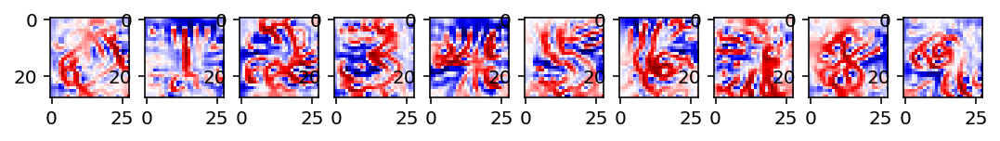

In [1]:
import keras
from vis.visualization import visualize_activation
from vis.utils import utils
import matplotlib.pyplot as plot
import matplotlib

# Comandos para exibir imagem no jupyter
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

model = keras.models.load_model('mnist_model.h5')
layer_idx = utils.find_layer_idx(model, 'nome_exclusivo_05')
model.layers[layer_idx].activation = keras.activations.linear
model = utils.apply_modifications(model)

tv=0.3
Lp=0.9
for classe in range(0, 10): 
    plot.subplot(1,10,1+classe)
    filter_idx = classe
    img = visualize_activation(model, layer_idx, filter_indices=filter_idx, input_range=(0., 1.), verbose=True, max_iter=1000, tv_weight=tv, lp_norm_weight=Lp)
    plot.imshow(img.squeeze(), cmap='seismic', interpolation='nearest')

# ajustando tamanho de exibição
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 30)
# fig.savefig('test2png.png', dpi=100, forward=True)
plot.show()